In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "preprocess"
enable_aug = False
enable_aug3 = True
sentence_pairs = True
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-preprocess-enable_aug-False-enable_aug3-True-sentence_pairs-True-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

194419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

194419
194419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 56/194419 [00:00<05:53, 550.57it/s]

  0%|          | 123/194419 [00:00<05:14, 617.61it/s]

  0%|          | 196/194419 [00:00<04:51, 667.20it/s]

  0%|          | 278/194419 [00:00<04:27, 725.63it/s]

  0%|          | 364/194419 [00:00<04:12, 768.21it/s]

  0%|          | 457/194419 [00:00<03:56, 820.93it/s]

  0%|          | 545/194419 [00:00<03:52, 833.87it/s]

  0%|          | 629/194419 [00:00<03:56, 820.41it/s]

  0%|          | 718/194419 [00:00<03:51, 836.70it/s]

  0%|          | 809/194419 [00:01<03:45, 858.08it/s]

  0%|          | 903/194419 [00:01<03:39, 880.05it/s]

  1%|          | 994/194419 [00:01<03:38, 887.08it/s]

  1%|          | 1096/194419 [00:01<03:29, 923.22it/s]

  1%|          | 1192/194419 [00:01<03:27, 930.12it/s]

  1%|          | 1289/194419 [00:01<03:25, 940.06it/s]

  1%|          | 1384/194419 [00:01<03:27, 932.04it/s]

  1%|          | 1478/194419 [00:01<03:26, 933.34it/s]

  1%|          | 1579/194419 [00:01<03:21, 954.78it/s]

  1%|          | 1677/194419 [00:01<03:20, 961.57it/s]

  1%|          | 1783/194419 [00:02<03:14, 990.79it/s]

  1%|          | 1887/194419 [00:02<03:12, 1001.04it/s]

  1%|          | 1988/194419 [00:02<03:12, 998.72it/s] 

  1%|          | 2088/194419 [00:02<03:15, 982.91it/s]

  1%|          | 2187/194419 [00:02<03:18, 967.52it/s]

  1%|          | 2284/194419 [00:02<03:23, 942.49it/s]

  1%|          | 2391/194419 [00:02<03:16, 979.32it/s]

  1%|▏         | 2492/194419 [00:02<03:14, 987.12it/s]

  1%|▏         | 2591/194419 [00:02<03:15, 980.69it/s]

  1%|▏         | 2690/194419 [00:02<03:21, 951.87it/s]

  1%|▏         | 2786/194419 [00:03<03:25, 932.14it/s]

  1%|▏         | 2880/194419 [00:03<03:25, 933.23it/s]

  2%|▏         | 2984/194419 [00:03<03:18, 963.95it/s]

  2%|▏         | 3085/194419 [00:03<03:16, 975.81it/s]

  2%|▏         | 3193/194419 [00:03<03:10, 1005.31it/s]

  2%|▏         | 3303/194419 [00:03<03:05, 1032.78it/s]

  2%|▏         | 3410/194419 [00:03<03:03, 1042.26it/s]

  2%|▏         | 3520/194419 [00:03<03:00, 1056.46it/s]

  2%|▏         | 3626/194419 [00:03<03:02, 1043.72it/s]

  2%|▏         | 3731/194419 [00:04<03:55, 811.21it/s] 

  2%|▏         | 3826/194419 [00:04<03:45, 845.10it/s]

  2%|▏         | 3936/194419 [00:04<03:29, 911.20it/s]

  2%|▏         | 4040/194419 [00:04<03:23, 937.66it/s]

  2%|▏         | 4138/194419 [00:04<03:21, 945.30it/s]

  2%|▏         | 4236/194419 [00:04<03:19, 951.00it/s]

  2%|▏         | 4334/194419 [00:04<03:19, 954.57it/s]

  2%|▏         | 4431/194419 [00:04<03:20, 948.41it/s]

  2%|▏         | 4528/194419 [00:04<03:19, 951.95it/s]

  2%|▏         | 4634/194419 [00:04<03:13, 979.30it/s]

  2%|▏         | 4736/194419 [00:05<03:11, 990.20it/s]

  2%|▏         | 4843/194419 [00:05<03:07, 1012.54it/s]

  3%|▎         | 4945/194419 [00:05<03:09, 1001.75it/s]

  3%|▎         | 5049/194419 [00:05<03:07, 1010.62it/s]

  3%|▎         | 5151/194419 [00:05<03:12, 984.12it/s] 

  3%|▎         | 5250/194419 [00:05<03:14, 971.96it/s]

  3%|▎         | 5348/194419 [00:05<03:15, 968.98it/s]

  3%|▎         | 5462/194419 [00:05<03:05, 1016.01it/s]

  3%|▎         | 5575/194419 [00:05<03:00, 1048.28it/s]

  3%|▎         | 5681/194419 [00:06<03:01, 1041.88it/s]

  3%|▎         | 5791/194419 [00:06<02:58, 1058.75it/s]

  3%|▎         | 5900/194419 [00:06<02:56, 1067.20it/s]

  3%|▎         | 6008/194419 [00:06<02:56, 1069.34it/s]

  3%|▎         | 6121/194419 [00:06<02:53, 1085.31it/s]

  3%|▎         | 6230/194419 [00:06<02:56, 1063.54it/s]

  3%|▎         | 6337/194419 [00:06<02:59, 1049.18it/s]

  3%|▎         | 6443/194419 [00:06<03:05, 1014.81it/s]

  3%|▎         | 6549/194419 [00:06<03:02, 1026.81it/s]

  3%|▎         | 6653/194419 [00:06<03:02, 1028.67it/s]

  3%|▎         | 6757/194419 [00:07<03:04, 1018.35it/s]

  4%|▎         | 6859/194419 [00:07<03:08, 995.89it/s] 

  4%|▎         | 6959/194419 [00:07<03:10, 982.65it/s]

  4%|▎         | 7058/194419 [00:07<03:13, 970.03it/s]

  4%|▎         | 7164/194419 [00:07<03:08, 993.75it/s]

  4%|▎         | 7264/194419 [00:07<03:08, 990.34it/s]

  4%|▍         | 7371/194419 [00:07<03:04, 1012.02it/s]

  4%|▍         | 7473/194419 [00:07<03:09, 987.99it/s] 

  4%|▍         | 7581/194419 [00:07<03:04, 1014.64it/s]

  4%|▍         | 7691/194419 [00:07<02:59, 1039.33it/s]

  4%|▍         | 7796/194419 [00:08<03:00, 1035.22it/s]

  4%|▍         | 7900/194419 [00:08<03:00, 1032.18it/s]

  4%|▍         | 8004/194419 [00:08<03:00, 1031.89it/s]

  4%|▍         | 8108/194419 [00:08<03:01, 1024.53it/s]

  4%|▍         | 8213/194419 [00:08<03:00, 1031.13it/s]

  4%|▍         | 8328/194419 [00:08<02:55, 1062.93it/s]

  4%|▍         | 8443/194419 [00:08<02:50, 1088.48it/s]

  4%|▍         | 8552/194419 [00:08<02:56, 1050.56it/s]

  4%|▍         | 8658/194419 [00:08<02:58, 1038.79it/s]

  5%|▍         | 8763/194419 [00:09<03:04, 1008.44it/s]

  5%|▍         | 8865/194419 [00:09<03:05, 997.74it/s] 

  5%|▍         | 8965/194419 [00:09<03:09, 980.72it/s]

  5%|▍         | 9066/194419 [00:09<03:07, 988.24it/s]

  5%|▍         | 9168/194419 [00:09<03:05, 996.88it/s]

  5%|▍         | 9282/194419 [00:09<02:58, 1038.16it/s]

  5%|▍         | 9390/194419 [00:09<02:56, 1049.42it/s]

  5%|▍         | 9496/194419 [00:09<02:56, 1049.60it/s]

  5%|▍         | 9602/194419 [00:09<02:55, 1050.26it/s]

  5%|▍         | 9719/194419 [00:09<02:50, 1082.64it/s]

  5%|▌         | 9828/194419 [00:10<02:55, 1050.20it/s]

  5%|▌         | 9934/194419 [00:10<02:57, 1037.44it/s]

  5%|▌         | 10042/194419 [00:10<02:56, 1044.75it/s]

  5%|▌         | 10159/194419 [00:10<02:50, 1080.28it/s]

  5%|▌         | 10268/194419 [00:10<02:52, 1070.26it/s]

  5%|▌         | 10376/194419 [00:10<02:53, 1063.16it/s]

  5%|▌         | 10494/194419 [00:10<02:47, 1096.77it/s]

  5%|▌         | 10604/194419 [00:10<02:54, 1053.26it/s]

  6%|▌         | 10717/194419 [00:10<02:51, 1072.67it/s]

  6%|▌         | 10831/194419 [00:10<02:48, 1088.45it/s]

  6%|▌         | 10941/194419 [00:11<02:49, 1081.97it/s]

  6%|▌         | 11050/194419 [00:11<02:54, 1050.10it/s]

  6%|▌         | 11156/194419 [00:11<02:57, 1032.65it/s]

  6%|▌         | 11270/194419 [00:11<02:52, 1060.17it/s]

  6%|▌         | 11377/194419 [00:11<02:57, 1033.85it/s]

  6%|▌         | 11487/194419 [00:11<02:54, 1050.62it/s]

  6%|▌         | 11593/194419 [00:11<02:55, 1043.19it/s]

  6%|▌         | 11702/194419 [00:11<02:53, 1055.94it/s]

  6%|▌         | 11819/194419 [00:11<02:47, 1089.41it/s]

  6%|▌         | 11929/194419 [00:12<02:51, 1064.50it/s]

  6%|▌         | 12044/194419 [00:12<02:47, 1086.58it/s]

  6%|▋         | 12153/194419 [00:12<04:10, 726.86it/s] 

  6%|▋         | 12255/194419 [00:12<03:50, 790.65it/s]

  6%|▋         | 12372/194419 [00:12<03:26, 879.49it/s]

  6%|▋         | 12480/194419 [00:12<03:15, 929.39it/s]

  6%|▋         | 12582/194419 [00:12<03:11, 947.10it/s]

  7%|▋         | 12686/194419 [00:12<03:07, 968.46it/s]

  7%|▋         | 12797/194419 [00:13<03:00, 1007.92it/s]

  7%|▋         | 12902/194419 [00:13<03:00, 1005.28it/s]

  7%|▋         | 13006/194419 [00:13<03:01, 999.26it/s] 

  7%|▋         | 13112/194419 [00:13<02:59, 1012.41it/s]

  7%|▋         | 13221/194419 [00:13<02:55, 1034.62it/s]

  7%|▋         | 13327/194419 [00:13<02:54, 1039.04it/s]

  7%|▋         | 13432/194419 [00:13<02:55, 1029.82it/s]

  7%|▋         | 13548/194419 [00:13<02:49, 1067.16it/s]

  7%|▋         | 13656/194419 [00:13<02:53, 1043.23it/s]

  7%|▋         | 13761/194419 [00:13<02:54, 1035.26it/s]

  7%|▋         | 13865/194419 [00:14<02:59, 1004.12it/s]

  7%|▋         | 13966/194419 [00:14<03:00, 1000.41it/s]

  7%|▋         | 14067/194419 [00:14<03:03, 983.87it/s] 

  7%|▋         | 14171/194419 [00:14<03:00, 999.39it/s]

  7%|▋         | 14272/194419 [00:14<03:02, 985.13it/s]

  7%|▋         | 14380/194419 [00:14<02:57, 1011.72it/s]

  7%|▋         | 14482/194419 [00:14<03:04, 976.95it/s] 

  8%|▊         | 14587/194419 [00:14<03:01, 993.45it/s]

  8%|▊         | 14687/194419 [00:14<03:01, 989.24it/s]

  8%|▊         | 14802/194419 [00:14<02:54, 1030.20it/s]

  8%|▊         | 14906/194419 [00:15<02:55, 1020.27it/s]

  8%|▊         | 15016/194419 [00:15<02:53, 1036.53it/s]

  8%|▊         | 15120/194419 [00:15<02:56, 1018.22it/s]

  8%|▊         | 15227/194419 [00:15<02:53, 1032.50it/s]

  8%|▊         | 15331/194419 [00:15<02:56, 1017.13it/s]

  8%|▊         | 15433/194419 [00:15<02:56, 1015.90it/s]

  8%|▊         | 15547/194419 [00:15<02:50, 1051.76it/s]

  8%|▊         | 15654/194419 [00:15<02:49, 1051.76it/s]

  8%|▊         | 15766/194419 [00:15<02:47, 1069.22it/s]

  8%|▊         | 15873/194419 [00:15<02:47, 1064.38it/s]

  8%|▊         | 15980/194419 [00:16<02:48, 1061.73it/s]

  8%|▊         | 16094/194419 [00:16<02:44, 1084.26it/s]

  8%|▊         | 16203/194419 [00:16<02:50, 1043.57it/s]

  8%|▊         | 16308/194419 [00:16<02:53, 1024.11it/s]

  8%|▊         | 16414/194419 [00:16<02:52, 1032.21it/s]

  9%|▊         | 16526/194419 [00:16<02:48, 1056.64it/s]

  9%|▊         | 16636/194419 [00:16<02:46, 1067.25it/s]

  9%|▊         | 16750/194419 [00:16<02:43, 1087.65it/s]

  9%|▊         | 16859/194419 [00:16<02:45, 1076.08it/s]

  9%|▊         | 16967/194419 [00:17<02:46, 1065.90it/s]

  9%|▉         | 17083/194419 [00:17<02:42, 1093.44it/s]

  9%|▉         | 17193/194419 [00:17<02:42, 1088.71it/s]

  9%|▉         | 17302/194419 [00:17<02:47, 1056.95it/s]

  9%|▉         | 17411/194419 [00:17<02:45, 1066.32it/s]

  9%|▉         | 17518/194419 [00:17<02:47, 1057.54it/s]

  9%|▉         | 17624/194419 [00:17<02:48, 1046.89it/s]

  9%|▉         | 17731/194419 [00:17<02:47, 1052.71it/s]

  9%|▉         | 17837/194419 [00:17<02:47, 1054.32it/s]

  9%|▉         | 17944/194419 [00:17<02:46, 1058.12it/s]

  9%|▉         | 18058/194419 [00:18<02:42, 1082.17it/s]

  9%|▉         | 18177/194419 [00:18<02:38, 1113.19it/s]

  9%|▉         | 18289/194419 [00:18<02:40, 1096.70it/s]

  9%|▉         | 18399/194419 [00:18<02:44, 1069.18it/s]

 10%|▉         | 18510/194419 [00:18<02:42, 1080.91it/s]

 10%|▉         | 18619/194419 [00:18<02:44, 1065.46it/s]

 10%|▉         | 18726/194419 [00:18<02:46, 1054.12it/s]

 10%|▉         | 18832/194419 [00:18<02:56, 994.04it/s] 

 10%|▉         | 18946/194419 [00:18<02:49, 1033.03it/s]

 10%|▉         | 19051/194419 [00:19<02:50, 1030.97it/s]

 10%|▉         | 19155/194419 [00:19<02:50, 1027.03it/s]

 10%|▉         | 19277/194419 [00:19<02:42, 1080.33it/s]

 10%|▉         | 19386/194419 [00:19<02:43, 1067.44it/s]

 10%|█         | 19496/194419 [00:19<02:42, 1076.41it/s]

 10%|█         | 19604/194419 [00:19<02:43, 1067.96it/s]

 10%|█         | 19722/194419 [00:19<02:38, 1098.89it/s]

 10%|█         | 19833/194419 [00:19<02:39, 1096.32it/s]

 10%|█         | 19943/194419 [00:19<02:45, 1052.97it/s]

 10%|█         | 20049/194419 [00:19<02:46, 1048.83it/s]

 10%|█         | 20155/194419 [00:20<02:47, 1039.09it/s]

 10%|█         | 20260/194419 [00:20<02:47, 1039.99it/s]

 10%|█         | 20378/194419 [00:20<02:41, 1080.70it/s]

 11%|█         | 20490/194419 [00:20<02:39, 1089.47it/s]

 11%|█         | 20600/194419 [00:20<04:24, 656.88it/s] 

 11%|█         | 20710/194419 [00:20<03:52, 745.89it/s]

 11%|█         | 20825/194419 [00:20<03:27, 836.29it/s]

 11%|█         | 20942/194419 [00:20<03:09, 917.16it/s]

 11%|█         | 21049/194419 [00:21<03:01, 956.32it/s]

 11%|█         | 21155/194419 [00:21<03:02, 951.50it/s]

 11%|█         | 21258/194419 [00:21<02:59, 962.28it/s]

 11%|█         | 21360/194419 [00:21<03:01, 953.52it/s]

 11%|█         | 21465/194419 [00:21<02:56, 978.74it/s]

 11%|█         | 21576/194419 [00:21<02:50, 1014.30it/s]

 11%|█         | 21680/194419 [00:21<02:51, 1005.91it/s]

 11%|█         | 21783/194419 [00:21<02:50, 1012.32it/s]

 11%|█▏        | 21886/194419 [00:21<02:51, 1008.86it/s]

 11%|█▏        | 21992/194419 [00:21<02:48, 1022.25it/s]

 11%|█▏        | 22095/194419 [00:22<02:51, 1005.89it/s]

 11%|█▏        | 22211/194419 [00:22<02:43, 1050.69it/s]

 11%|█▏        | 22319/194419 [00:22<02:42, 1059.05it/s]

 12%|█▏        | 22426/194419 [00:22<02:43, 1050.49it/s]

 12%|█▏        | 22532/194419 [00:22<02:43, 1048.68it/s]

 12%|█▏        | 22644/194419 [00:22<02:40, 1068.68it/s]

 12%|█▏        | 22756/194419 [00:22<02:38, 1082.22it/s]

 12%|█▏        | 22865/194419 [00:22<02:43, 1052.35it/s]

 12%|█▏        | 22976/194419 [00:22<02:41, 1064.79it/s]

 12%|█▏        | 23085/194419 [00:23<02:40, 1068.65it/s]

 12%|█▏        | 23193/194419 [00:23<02:45, 1035.05it/s]

 12%|█▏        | 23299/194419 [00:23<02:44, 1041.52it/s]

 12%|█▏        | 23419/194419 [00:23<02:37, 1086.54it/s]

 12%|█▏        | 23530/194419 [00:23<02:36, 1092.50it/s]

 12%|█▏        | 23640/194419 [00:23<02:37, 1086.43it/s]

 12%|█▏        | 23749/194419 [00:23<02:39, 1069.44it/s]

 12%|█▏        | 23864/194419 [00:23<02:36, 1088.22it/s]

 12%|█▏        | 23973/194419 [00:23<02:36, 1086.07it/s]

 12%|█▏        | 24082/194419 [00:23<02:38, 1076.53it/s]

 12%|█▏        | 24195/194419 [00:24<02:36, 1088.76it/s]

 13%|█▎        | 24313/194419 [00:24<02:32, 1115.13it/s]

 13%|█▎        | 24425/194419 [00:24<02:36, 1085.90it/s]

 13%|█▎        | 24542/194419 [00:24<02:33, 1109.73it/s]

 13%|█▎        | 24658/194419 [00:24<02:31, 1120.68it/s]

 13%|█▎        | 24785/194419 [00:24<02:25, 1163.04it/s]

 13%|█▎        | 24902/194419 [00:24<02:25, 1163.95it/s]

 13%|█▎        | 25020/194419 [00:24<02:25, 1167.24it/s]

 13%|█▎        | 25137/194419 [00:24<02:29, 1128.58it/s]

 13%|█▎        | 25251/194419 [00:24<02:33, 1099.48it/s]

 13%|█▎        | 25362/194419 [00:25<02:34, 1095.62it/s]

 13%|█▎        | 25477/194419 [00:25<02:32, 1110.99it/s]

 13%|█▎        | 25591/194419 [00:25<02:31, 1112.52it/s]

 13%|█▎        | 25703/194419 [00:25<02:34, 1095.14it/s]

 13%|█▎        | 25813/194419 [00:25<02:34, 1089.05it/s]

 13%|█▎        | 25930/194419 [00:25<02:31, 1112.22it/s]

 13%|█▎        | 26042/194419 [00:25<02:34, 1092.98it/s]

 13%|█▎        | 26152/194419 [00:25<02:33, 1094.64it/s]

 14%|█▎        | 26262/194419 [00:25<02:33, 1095.77it/s]

 14%|█▎        | 26372/194419 [00:26<02:40, 1046.79it/s]

 14%|█▎        | 26478/194419 [00:26<02:40, 1045.19it/s]

 14%|█▎        | 26593/194419 [00:26<02:36, 1075.08it/s]

 14%|█▎        | 26701/194419 [00:26<02:36, 1069.59it/s]

 14%|█▍        | 26809/194419 [00:26<02:44, 1021.67it/s]

 14%|█▍        | 26912/194419 [00:26<02:43, 1023.19it/s]

 14%|█▍        | 27015/194419 [00:26<02:45, 1011.18it/s]

 14%|█▍        | 27129/194419 [00:26<02:40, 1045.37it/s]

 14%|█▍        | 27234/194419 [00:26<02:43, 1019.95it/s]

 14%|█▍        | 27345/194419 [00:26<02:40, 1043.65it/s]

 14%|█▍        | 27450/194419 [00:27<02:41, 1033.83it/s]

 14%|█▍        | 27561/194419 [00:27<02:38, 1050.69it/s]

 14%|█▍        | 27669/194419 [00:27<02:37, 1056.55it/s]

 14%|█▍        | 27784/194419 [00:27<02:33, 1082.26it/s]

 14%|█▍        | 27894/194419 [00:27<02:33, 1083.53it/s]

 14%|█▍        | 28012/194419 [00:27<02:29, 1110.99it/s]

 14%|█▍        | 28124/194419 [00:27<02:33, 1083.11it/s]

 15%|█▍        | 28233/194419 [00:27<02:39, 1043.57it/s]

 15%|█▍        | 28348/194419 [00:27<02:34, 1073.66it/s]

 15%|█▍        | 28456/194419 [00:28<02:45, 1005.23it/s]

 15%|█▍        | 28558/194419 [00:28<02:44, 1008.79it/s]

 15%|█▍        | 28687/194419 [00:28<02:32, 1087.74it/s]

 15%|█▍        | 28797/194419 [00:28<02:37, 1051.89it/s]

 15%|█▍        | 28908/194419 [00:28<02:35, 1067.68it/s]

 15%|█▍        | 29016/194419 [00:28<02:40, 1032.28it/s]

 15%|█▍        | 29123/194419 [00:28<02:38, 1041.14it/s]

 15%|█▌        | 29237/194419 [00:28<02:34, 1068.18it/s]

 15%|█▌        | 29355/194419 [00:28<02:30, 1099.60it/s]

 15%|█▌        | 29466/194419 [00:28<02:32, 1083.83it/s]

 15%|█▌        | 29575/194419 [00:29<02:32, 1080.83it/s]

 15%|█▌        | 29698/194419 [00:29<02:27, 1118.92it/s]

 15%|█▌        | 29811/194419 [00:29<02:31, 1086.70it/s]

 15%|█▌        | 29920/194419 [00:29<02:33, 1074.56it/s]

 15%|█▌        | 30028/194419 [00:29<02:33, 1072.27it/s]

 16%|█▌        | 30136/194419 [00:29<02:34, 1061.10it/s]

 16%|█▌        | 30255/194419 [00:29<02:29, 1097.74it/s]

 16%|█▌        | 30370/194419 [00:29<02:27, 1109.59it/s]

 16%|█▌        | 30482/194419 [00:29<02:29, 1094.63it/s]

 16%|█▌        | 30592/194419 [00:30<04:44, 575.74it/s] 

 16%|█▌        | 30701/194419 [00:30<04:05, 667.74it/s]

 16%|█▌        | 30815/194419 [00:30<03:34, 761.84it/s]

 16%|█▌        | 30927/194419 [00:30<03:14, 841.38it/s]

 16%|█▌        | 31029/194419 [00:30<03:06, 876.33it/s]

 16%|█▌        | 31144/194419 [00:30<02:52, 944.95it/s]

 16%|█▌        | 31261/194419 [00:30<02:42, 1003.77it/s]

 16%|█▌        | 31370/194419 [00:31<02:41, 1008.69it/s]

 16%|█▌        | 31477/194419 [00:31<02:41, 1011.17it/s]

 16%|█▋        | 31594/194419 [00:31<02:34, 1051.10it/s]

 16%|█▋        | 31703/194419 [00:31<02:34, 1056.25it/s]

 16%|█▋        | 31814/194419 [00:31<02:31, 1071.47it/s]

 16%|█▋        | 31923/194419 [00:31<02:36, 1035.69it/s]

 16%|█▋        | 32038/194419 [00:31<02:32, 1067.74it/s]

 17%|█▋        | 32146/194419 [00:31<02:32, 1065.56it/s]

 17%|█▋        | 32257/194419 [00:31<02:30, 1077.34it/s]

 17%|█▋        | 32366/194419 [00:31<02:33, 1058.06it/s]

 17%|█▋        | 32473/194419 [00:32<02:33, 1055.73it/s]

 17%|█▋        | 32587/194419 [00:32<02:30, 1077.90it/s]

 17%|█▋        | 32696/194419 [00:32<02:32, 1060.69it/s]

 17%|█▋        | 32803/194419 [00:32<02:32, 1060.58it/s]

 17%|█▋        | 32919/194419 [00:32<02:28, 1086.60it/s]

 17%|█▋        | 33028/194419 [00:32<02:28, 1084.30it/s]

 17%|█▋        | 33145/194419 [00:32<02:25, 1109.33it/s]

 17%|█▋        | 33257/194419 [00:32<02:26, 1098.31it/s]

 17%|█▋        | 33367/194419 [00:32<02:27, 1089.50it/s]

 17%|█▋        | 33477/194419 [00:32<02:28, 1082.89it/s]

 17%|█▋        | 33587/194419 [00:33<02:28, 1085.70it/s]

 17%|█▋        | 33696/194419 [00:33<02:28, 1082.21it/s]

 17%|█▋        | 33805/194419 [00:33<02:30, 1066.76it/s]

 17%|█▋        | 33912/194419 [00:33<02:31, 1061.28it/s]

 17%|█▋        | 34019/194419 [00:33<02:36, 1026.31it/s]

 18%|█▊        | 34122/194419 [00:33<02:39, 1005.39it/s]

 18%|█▊        | 34231/194419 [00:33<02:36, 1025.28it/s]

 18%|█▊        | 34347/194419 [00:33<02:31, 1059.01it/s]

 18%|█▊        | 34454/194419 [00:33<02:32, 1045.71it/s]

 18%|█▊        | 34568/194419 [00:33<02:28, 1072.95it/s]

 18%|█▊        | 34679/194419 [00:34<02:28, 1078.58it/s]

 18%|█▊        | 34802/194419 [00:34<02:22, 1120.58it/s]

 18%|█▊        | 34915/194419 [00:34<02:22, 1123.04it/s]

 18%|█▊        | 35028/194419 [00:34<02:29, 1069.22it/s]

 18%|█▊        | 35140/194419 [00:34<02:27, 1080.96it/s]

 18%|█▊        | 35268/194419 [00:34<02:19, 1137.24it/s]

 18%|█▊        | 35383/194419 [00:34<02:23, 1109.52it/s]

 18%|█▊        | 35496/194419 [00:34<02:22, 1112.56it/s]

 18%|█▊        | 35610/194419 [00:34<02:21, 1120.48it/s]

 18%|█▊        | 35727/194419 [00:35<02:20, 1129.67it/s]

 18%|█▊        | 35841/194419 [00:35<02:21, 1121.17it/s]

 18%|█▊        | 35954/194419 [00:35<02:26, 1078.33it/s]

 19%|█▊        | 36072/194419 [00:35<02:23, 1104.01it/s]

 19%|█▊        | 36197/194419 [00:35<02:18, 1145.92it/s]

 19%|█▊        | 36322/194419 [00:35<02:14, 1173.84it/s]

 19%|█▊        | 36440/194419 [00:35<02:15, 1167.31it/s]

 19%|█▉        | 36564/194419 [00:35<02:12, 1187.89it/s]

 19%|█▉        | 36683/194419 [00:35<02:13, 1178.14it/s]

 19%|█▉        | 36801/194419 [00:35<02:16, 1151.11it/s]

 19%|█▉        | 36922/194419 [00:36<02:15, 1165.69it/s]

 19%|█▉        | 37039/194419 [00:36<02:19, 1131.69it/s]

 19%|█▉        | 37159/194419 [00:36<02:17, 1147.80it/s]

 19%|█▉        | 37275/194419 [00:36<02:20, 1121.64it/s]

 19%|█▉        | 37388/194419 [00:36<02:21, 1109.42it/s]

 19%|█▉        | 37501/194419 [00:36<02:20, 1114.29it/s]

 19%|█▉        | 37636/194419 [00:36<02:12, 1181.56it/s]

 19%|█▉        | 37755/194419 [00:36<02:14, 1161.91it/s]

 19%|█▉        | 37872/194419 [00:36<02:17, 1140.00it/s]

 20%|█▉        | 37987/194419 [00:37<02:17, 1137.07it/s]

 20%|█▉        | 38101/194419 [00:37<02:18, 1125.25it/s]

 20%|█▉        | 38214/194419 [00:37<02:25, 1075.39it/s]

 20%|█▉        | 38332/194419 [00:37<02:21, 1102.09it/s]

 20%|█▉        | 38454/194419 [00:37<02:17, 1134.29it/s]

 20%|█▉        | 38568/194419 [00:37<02:20, 1107.75it/s]

 20%|█▉        | 38680/194419 [00:37<02:20, 1111.16it/s]

 20%|█▉        | 38792/194419 [00:37<02:20, 1109.60it/s]

 20%|██        | 38908/194419 [00:37<02:18, 1121.45it/s]

 20%|██        | 39022/194419 [00:37<02:17, 1126.37it/s]

 20%|██        | 39135/194419 [00:38<02:20, 1108.87it/s]

 20%|██        | 39252/194419 [00:38<02:17, 1125.93it/s]

 20%|██        | 39365/194419 [00:38<02:24, 1076.09it/s]

 20%|██        | 39477/194419 [00:38<02:22, 1085.04it/s]

 20%|██        | 39587/194419 [00:38<02:22, 1089.34it/s]

 20%|██        | 39699/194419 [00:38<02:22, 1087.21it/s]

 20%|██        | 39808/194419 [00:38<02:22, 1086.77it/s]

 21%|██        | 39917/194419 [00:38<02:24, 1070.79it/s]

 21%|██        | 40032/194419 [00:38<02:21, 1090.66it/s]

 21%|██        | 40143/194419 [00:38<02:20, 1095.79it/s]

 21%|██        | 40260/194419 [00:39<02:17, 1117.39it/s]

 21%|██        | 40376/194419 [00:39<02:16, 1129.47it/s]

 21%|██        | 40490/194419 [00:39<02:19, 1102.54it/s]

 21%|██        | 40605/194419 [00:39<02:17, 1114.88it/s]

 21%|██        | 40721/194419 [00:39<02:16, 1126.24it/s]

 21%|██        | 40834/194419 [00:39<02:17, 1115.52it/s]

 21%|██        | 40946/194419 [00:39<02:20, 1089.05it/s]

 21%|██        | 41059/194419 [00:39<02:19, 1099.53it/s]

 21%|██        | 41181/194419 [00:39<02:15, 1127.94it/s]

 21%|██        | 41294/194419 [00:40<02:18, 1105.30it/s]

 21%|██▏       | 41406/194419 [00:40<02:17, 1109.47it/s]

 21%|██▏       | 41528/194419 [00:40<02:14, 1139.58it/s]

 21%|██▏       | 41643/194419 [00:40<02:15, 1127.43it/s]

 21%|██▏       | 41764/194419 [00:40<02:12, 1150.04it/s]

 22%|██▏       | 41880/194419 [00:40<02:13, 1142.06it/s]

 22%|██▏       | 41999/194419 [00:40<02:11, 1155.65it/s]

 22%|██▏       | 42115/194419 [00:40<02:12, 1151.92it/s]

 22%|██▏       | 42235/194419 [00:40<02:10, 1165.92it/s]

 22%|██▏       | 42353/194419 [00:40<02:10, 1168.20it/s]

 22%|██▏       | 42473/194419 [00:41<02:09, 1177.61it/s]

 22%|██▏       | 42593/194419 [00:41<02:08, 1183.29it/s]

 22%|██▏       | 42712/194419 [00:41<02:11, 1156.54it/s]

 22%|██▏       | 42828/194419 [00:41<02:14, 1131.15it/s]

 22%|██▏       | 42942/194419 [00:41<02:13, 1133.05it/s]

 22%|██▏       | 43061/194419 [00:41<02:12, 1145.56it/s]

 22%|██▏       | 43179/194419 [00:41<02:11, 1151.22it/s]

 22%|██▏       | 43302/194419 [00:41<02:08, 1174.30it/s]

 22%|██▏       | 43420/194419 [00:41<02:09, 1169.25it/s]

 22%|██▏       | 43537/194419 [00:41<02:10, 1158.82it/s]

 22%|██▏       | 43653/194419 [00:42<04:34, 548.89it/s] 

 23%|██▎       | 43765/194419 [00:42<03:54, 643.11it/s]

 23%|██▎       | 43874/194419 [00:42<03:26, 728.39it/s]

 23%|██▎       | 43993/194419 [00:42<03:02, 825.89it/s]

 23%|██▎       | 44109/194419 [00:42<02:46, 903.02it/s]

 23%|██▎       | 44219/194419 [00:42<02:38, 950.60it/s]

 23%|██▎       | 44329/194419 [00:43<02:31, 989.45it/s]

 23%|██▎       | 44438/194419 [00:43<02:27, 1013.60it/s]

 23%|██▎       | 44559/194419 [00:43<02:20, 1068.34it/s]

 23%|██▎       | 44672/194419 [00:43<02:21, 1060.54it/s]

 23%|██▎       | 44787/194419 [00:43<02:17, 1085.44it/s]

 23%|██▎       | 44907/194419 [00:43<02:13, 1118.14it/s]

 23%|██▎       | 45028/194419 [00:43<02:10, 1142.97it/s]

 23%|██▎       | 45144/194419 [00:43<02:14, 1113.49it/s]

 23%|██▎       | 45257/194419 [00:43<02:16, 1096.25it/s]

 23%|██▎       | 45368/194419 [00:43<02:16, 1089.33it/s]

 23%|██▎       | 45498/194419 [00:44<02:09, 1148.69it/s]

 23%|██▎       | 45617/194419 [00:44<02:08, 1159.29it/s]

 24%|██▎       | 45734/194419 [00:44<02:08, 1156.74it/s]

 24%|██▎       | 45850/194419 [00:44<02:09, 1143.69it/s]

 24%|██▎       | 45966/194419 [00:44<02:09, 1146.75it/s]

 24%|██▎       | 46081/194419 [00:44<02:10, 1137.82it/s]

 24%|██▍       | 46208/194419 [00:44<02:05, 1176.33it/s]

 24%|██▍       | 46326/194419 [00:44<02:06, 1175.03it/s]

 24%|██▍       | 46444/194419 [00:44<02:06, 1170.55it/s]

 24%|██▍       | 46562/194419 [00:44<02:06, 1171.08it/s]

 24%|██▍       | 46680/194419 [00:45<02:08, 1150.20it/s]

 24%|██▍       | 46796/194419 [00:45<02:10, 1135.13it/s]

 24%|██▍       | 46910/194419 [00:45<02:12, 1113.01it/s]

 24%|██▍       | 47030/194419 [00:45<02:09, 1136.45it/s]

 24%|██▍       | 47149/194419 [00:45<02:07, 1150.78it/s]

 24%|██▍       | 47265/194419 [00:45<02:10, 1128.26it/s]

 24%|██▍       | 47383/194419 [00:45<02:08, 1142.31it/s]

 24%|██▍       | 47498/194419 [00:45<02:09, 1136.12it/s]

 24%|██▍       | 47612/194419 [00:45<02:13, 1102.95it/s]

 25%|██▍       | 47723/194419 [00:46<02:13, 1096.26it/s]

 25%|██▍       | 47833/194419 [00:46<02:15, 1083.07it/s]

 25%|██▍       | 47949/194419 [00:46<02:12, 1104.85it/s]

 25%|██▍       | 48060/194419 [00:46<02:16, 1074.45it/s]

 25%|██▍       | 48174/194419 [00:46<02:14, 1090.00it/s]

 25%|██▍       | 48284/194419 [00:46<02:15, 1076.90it/s]

 25%|██▍       | 48395/194419 [00:46<02:14, 1085.12it/s]

 25%|██▍       | 48506/194419 [00:46<02:13, 1092.33it/s]

 25%|██▌       | 48616/194419 [00:46<02:14, 1088.06it/s]

 25%|██▌       | 48737/194419 [00:46<02:09, 1122.86it/s]

 25%|██▌       | 48857/194419 [00:47<02:07, 1144.56it/s]

 25%|██▌       | 48972/194419 [00:47<02:12, 1099.89it/s]

 25%|██▌       | 49083/194419 [00:47<02:12, 1094.14it/s]

 25%|██▌       | 49200/194419 [00:47<02:10, 1114.54it/s]

 25%|██▌       | 49312/194419 [00:47<02:10, 1109.57it/s]

 25%|██▌       | 49424/194419 [00:47<02:11, 1100.79it/s]

 25%|██▌       | 49539/194419 [00:47<02:10, 1114.22it/s]

 26%|██▌       | 49655/194419 [00:47<02:08, 1123.91it/s]

 26%|██▌       | 49768/194419 [00:47<02:11, 1096.71it/s]

 26%|██▌       | 49878/194419 [00:47<02:12, 1087.87it/s]

 26%|██▌       | 49987/194419 [00:48<02:13, 1082.51it/s]

 26%|██▌       | 50102/194419 [00:48<02:11, 1101.18it/s]

 26%|██▌       | 50213/194419 [00:48<02:12, 1087.00it/s]

 26%|██▌       | 50330/194419 [00:48<02:09, 1109.11it/s]

 26%|██▌       | 50449/194419 [00:48<02:07, 1132.09it/s]

 26%|██▌       | 50563/194419 [00:48<02:07, 1132.00it/s]

 26%|██▌       | 50677/194419 [00:48<02:10, 1103.79it/s]

 26%|██▌       | 50788/194419 [00:48<02:12, 1082.38it/s]

 26%|██▌       | 50897/194419 [00:48<02:12, 1084.45it/s]

 26%|██▌       | 51020/194419 [00:48<02:07, 1124.90it/s]

 26%|██▋       | 51143/194419 [00:49<02:03, 1155.52it/s]

 26%|██▋       | 51259/194419 [00:49<02:06, 1135.72it/s]

 26%|██▋       | 51382/194419 [00:49<02:02, 1163.31it/s]

 26%|██▋       | 51501/194419 [00:49<02:02, 1170.37it/s]

 27%|██▋       | 51621/194419 [00:49<02:01, 1177.37it/s]

 27%|██▋       | 51739/194419 [00:49<02:02, 1160.57it/s]

 27%|██▋       | 51856/194419 [00:49<02:03, 1152.19it/s]

 27%|██▋       | 51972/194419 [00:49<02:04, 1143.85it/s]

 27%|██▋       | 52087/194419 [00:49<02:04, 1139.72it/s]

 27%|██▋       | 52202/194419 [00:50<02:05, 1136.95it/s]

 27%|██▋       | 52318/194419 [00:50<02:04, 1143.65it/s]

 27%|██▋       | 52433/194419 [00:50<02:04, 1144.82it/s]

 27%|██▋       | 52555/194419 [00:50<02:01, 1165.57it/s]

 27%|██▋       | 52677/194419 [00:50<02:00, 1179.91it/s]

 27%|██▋       | 52799/194419 [00:50<01:58, 1190.99it/s]

 27%|██▋       | 52919/194419 [00:50<01:59, 1181.06it/s]

 27%|██▋       | 53038/194419 [00:50<02:02, 1154.32it/s]

 27%|██▋       | 53154/194419 [00:50<02:04, 1132.56it/s]

 27%|██▋       | 53268/194419 [00:50<02:06, 1119.73it/s]

 27%|██▋       | 53386/194419 [00:51<02:04, 1135.92it/s]

 28%|██▊       | 53507/194419 [00:51<02:02, 1153.99it/s]

 28%|██▊       | 53623/194419 [00:51<02:02, 1153.62it/s]

 28%|██▊       | 53741/194419 [00:51<02:01, 1156.86it/s]

 28%|██▊       | 53857/194419 [00:51<02:01, 1155.68it/s]

 28%|██▊       | 53973/194419 [00:51<02:03, 1141.06it/s]

 28%|██▊       | 54088/194419 [00:51<02:05, 1120.50it/s]

 28%|██▊       | 54207/194419 [00:51<02:02, 1140.28it/s]

 28%|██▊       | 54338/194419 [00:51<01:57, 1189.60it/s]

 28%|██▊       | 54458/194419 [00:51<02:01, 1149.07it/s]

 28%|██▊       | 54582/194419 [00:52<01:59, 1174.61it/s]

 28%|██▊       | 54700/194419 [00:52<01:59, 1165.36it/s]

 28%|██▊       | 54817/194419 [00:52<02:01, 1149.09it/s]

 28%|██▊       | 54933/194419 [00:52<02:03, 1132.70it/s]

 28%|██▊       | 55047/194419 [00:52<02:05, 1114.42it/s]

 28%|██▊       | 55171/194419 [00:52<02:01, 1149.23it/s]

 28%|██▊       | 55290/194419 [00:52<01:59, 1160.78it/s]

 28%|██▊       | 55407/194419 [00:52<02:02, 1131.33it/s]

 29%|██▊       | 55529/194419 [00:52<02:00, 1154.10it/s]

 29%|██▊       | 55645/194419 [00:53<02:03, 1126.73it/s]

 29%|██▊       | 55758/194419 [00:53<02:04, 1110.90it/s]

 29%|██▊       | 55870/194419 [00:53<02:07, 1088.49it/s]

 29%|██▉       | 55980/194419 [00:53<02:10, 1062.81it/s]

 29%|██▉       | 56101/194419 [00:53<02:05, 1102.15it/s]

 29%|██▉       | 56217/194419 [00:53<02:03, 1116.37it/s]

 29%|██▉       | 56334/194419 [00:53<02:02, 1131.06it/s]

 29%|██▉       | 56451/194419 [00:53<02:00, 1141.06it/s]

 29%|██▉       | 56574/194419 [00:53<01:58, 1165.33it/s]

 29%|██▉       | 56691/194419 [00:53<02:00, 1142.85it/s]

 29%|██▉       | 56806/194419 [00:54<02:02, 1125.43it/s]

 29%|██▉       | 56919/194419 [00:54<02:03, 1109.79it/s]

 29%|██▉       | 57031/194419 [00:54<02:04, 1104.52it/s]

 29%|██▉       | 57143/194419 [00:54<02:04, 1105.60it/s]

 29%|██▉       | 57255/194419 [00:54<02:03, 1106.22it/s]

 30%|██▉       | 57366/194419 [00:54<02:04, 1103.91it/s]

 30%|██▉       | 57477/194419 [00:54<02:04, 1101.06it/s]

 30%|██▉       | 57589/194419 [00:54<02:04, 1100.46it/s]

 30%|██▉       | 57701/194419 [00:54<02:03, 1105.21it/s]

 30%|██▉       | 57832/194419 [00:54<01:57, 1165.78it/s]

 30%|██▉       | 57959/194419 [00:55<01:54, 1195.56it/s]

 30%|██▉       | 58081/194419 [00:55<01:53, 1200.25it/s]

 30%|██▉       | 58202/194419 [00:55<01:57, 1155.45it/s]

 30%|██▉       | 58318/194419 [00:55<01:59, 1138.34it/s]

 30%|███       | 58437/194419 [00:55<01:57, 1152.95it/s]

 30%|███       | 58571/194419 [00:55<01:52, 1207.35it/s]

 30%|███       | 58693/194419 [00:55<01:55, 1177.94it/s]

 30%|███       | 58819/194419 [00:55<01:52, 1200.86it/s]

 30%|███       | 58940/194419 [00:55<01:53, 1189.54it/s]

 30%|███       | 59060/194419 [00:56<01:58, 1137.48it/s]

 30%|███       | 59175/194419 [00:56<02:00, 1119.40it/s]

 30%|███       | 59290/194419 [00:56<01:59, 1127.48it/s]

 31%|███       | 59405/194419 [00:56<01:59, 1132.82it/s]

 31%|███       | 59519/194419 [00:56<02:02, 1098.86it/s]

 31%|███       | 59630/194419 [00:56<02:03, 1092.53it/s]

 31%|███       | 59740/194419 [00:56<02:04, 1082.44it/s]

 31%|███       | 59849/194419 [00:57<05:00, 447.84it/s] 

 31%|███       | 59966/194419 [00:57<04:03, 552.32it/s]

 31%|███       | 60090/194419 [00:57<03:20, 670.85it/s]

 31%|███       | 60215/194419 [00:57<02:50, 785.09it/s]

 31%|███       | 60335/194419 [00:57<02:33, 876.13it/s]

 31%|███       | 60451/194419 [00:57<02:21, 943.94it/s]

 31%|███       | 60576/194419 [00:57<02:11, 1021.55it/s]

 31%|███       | 60693/194419 [00:57<02:07, 1050.67it/s]

 31%|███▏      | 60827/194419 [00:58<01:58, 1129.67it/s]

 31%|███▏      | 60948/194419 [00:58<01:57, 1134.10it/s]

 31%|███▏      | 61069/194419 [00:58<01:55, 1155.23it/s]

 31%|███▏      | 61189/194419 [00:58<01:56, 1146.22it/s]

 32%|███▏      | 61307/194419 [00:58<01:55, 1150.02it/s]

 32%|███▏      | 61434/194419 [00:58<01:52, 1183.66it/s]

 32%|███▏      | 61554/194419 [00:58<01:56, 1140.06it/s]

 32%|███▏      | 61670/194419 [00:58<01:56, 1137.24it/s]

 32%|███▏      | 61793/194419 [00:58<01:54, 1162.51it/s]

 32%|███▏      | 61910/194419 [00:58<01:55, 1147.80it/s]

 32%|███▏      | 62026/194419 [00:59<01:57, 1123.51it/s]

 32%|███▏      | 62139/194419 [00:59<02:00, 1098.01it/s]

 32%|███▏      | 62250/194419 [00:59<02:07, 1037.49it/s]

 32%|███▏      | 62363/194419 [00:59<02:04, 1061.93it/s]

 32%|███▏      | 62474/194419 [00:59<02:02, 1075.15it/s]

 32%|███▏      | 62587/194419 [00:59<02:00, 1090.12it/s]

 32%|███▏      | 62698/194419 [00:59<02:00, 1094.64it/s]

 32%|███▏      | 62808/194419 [00:59<02:01, 1087.02it/s]

 32%|███▏      | 62922/194419 [00:59<01:59, 1100.91it/s]

 32%|███▏      | 63033/194419 [01:00<02:01, 1081.95it/s]

 32%|███▏      | 63149/194419 [01:00<01:59, 1101.27it/s]

 33%|███▎      | 63260/194419 [01:00<02:00, 1086.86it/s]

 33%|███▎      | 63382/194419 [01:00<01:56, 1124.75it/s]

 33%|███▎      | 63502/194419 [01:00<01:54, 1144.97it/s]

 33%|███▎      | 63617/194419 [01:00<01:54, 1145.30it/s]

 33%|███▎      | 63737/194419 [01:00<01:52, 1160.76it/s]

 33%|███▎      | 63854/194419 [01:00<01:52, 1158.19it/s]

 33%|███▎      | 63970/194419 [01:00<01:53, 1146.10it/s]

 33%|███▎      | 64099/194419 [01:00<01:49, 1186.02it/s]

 33%|███▎      | 64220/194419 [01:01<01:49, 1188.12it/s]

 33%|███▎      | 64339/194419 [01:01<01:50, 1176.18it/s]

 33%|███▎      | 64457/194419 [01:01<01:56, 1111.80it/s]

 33%|███▎      | 64569/194419 [01:01<01:56, 1111.27it/s]

 33%|███▎      | 64687/194419 [01:01<01:55, 1125.61it/s]

 33%|███▎      | 64803/194419 [01:01<01:54, 1133.59it/s]

 33%|███▎      | 64926/194419 [01:01<01:51, 1158.38it/s]

 33%|███▎      | 65043/194419 [01:01<01:53, 1144.50it/s]

 34%|███▎      | 65160/194419 [01:01<01:52, 1150.01it/s]

 34%|███▎      | 65276/194419 [01:01<01:53, 1139.90it/s]

 34%|███▎      | 65391/194419 [01:02<01:55, 1117.48it/s]

 34%|███▎      | 65503/194419 [01:02<01:56, 1110.15it/s]

 34%|███▍      | 65617/194419 [01:02<01:55, 1115.78it/s]

 34%|███▍      | 65744/194419 [01:02<01:51, 1159.02it/s]

 34%|███▍      | 65865/194419 [01:02<01:49, 1169.11it/s]

 34%|███▍      | 65983/194419 [01:02<01:50, 1162.03it/s]

 34%|███▍      | 66100/194419 [01:02<01:52, 1142.91it/s]

 34%|███▍      | 66215/194419 [01:02<01:54, 1124.58it/s]

 34%|███▍      | 66339/194419 [01:02<01:50, 1156.24it/s]

 34%|███▍      | 66460/194419 [01:03<01:49, 1170.46it/s]

 34%|███▍      | 66578/194419 [01:03<01:51, 1146.21it/s]

 34%|███▍      | 66703/194419 [01:03<01:48, 1171.88it/s]

 34%|███▍      | 66821/194419 [01:03<01:50, 1152.21it/s]

 34%|███▍      | 66937/194419 [01:03<01:56, 1095.15it/s]

 34%|███▍      | 67057/194419 [01:03<01:53, 1120.48it/s]

 35%|███▍      | 67170/194419 [01:03<01:55, 1096.98it/s]

 35%|███▍      | 67281/194419 [01:03<01:57, 1085.56it/s]

 35%|███▍      | 67401/194419 [01:03<01:53, 1116.82it/s]

 35%|███▍      | 67513/194419 [01:03<01:57, 1078.78it/s]

 35%|███▍      | 67640/194419 [01:04<01:51, 1132.34it/s]

 35%|███▍      | 67754/194419 [01:04<01:53, 1118.83it/s]

 35%|███▍      | 67867/194419 [01:04<01:55, 1093.00it/s]

 35%|███▍      | 67990/194419 [01:04<01:52, 1126.53it/s]

 35%|███▌      | 68109/194419 [01:04<01:50, 1143.98it/s]

 35%|███▌      | 68224/194419 [01:04<01:50, 1137.66it/s]

 35%|███▌      | 68345/194419 [01:04<01:48, 1158.62it/s]

 35%|███▌      | 68462/194419 [01:04<01:50, 1136.94it/s]

 35%|███▌      | 68583/194419 [01:04<01:48, 1157.23it/s]

 35%|███▌      | 68699/194419 [01:05<01:50, 1141.26it/s]

 35%|███▌      | 68829/194419 [01:05<01:45, 1186.60it/s]

 35%|███▌      | 68953/194419 [01:05<01:44, 1200.62it/s]

 36%|███▌      | 69076/194419 [01:05<01:43, 1208.44it/s]

 36%|███▌      | 69197/194419 [01:05<01:47, 1161.88it/s]

 36%|███▌      | 69314/194419 [01:05<01:48, 1155.17it/s]

 36%|███▌      | 69431/194419 [01:05<01:47, 1158.85it/s]

 36%|███▌      | 69548/194419 [01:05<01:52, 1108.62it/s]

 36%|███▌      | 69660/194419 [01:05<01:53, 1097.83it/s]

 36%|███▌      | 69784/194419 [01:05<01:49, 1137.64it/s]

 36%|███▌      | 69899/194419 [01:06<01:49, 1133.63it/s]

 36%|███▌      | 70013/194419 [01:06<01:52, 1106.80it/s]

 36%|███▌      | 70124/194419 [01:06<01:52, 1106.30it/s]

 36%|███▌      | 70236/194419 [01:06<01:51, 1109.93it/s]

 36%|███▌      | 70348/194419 [01:06<01:51, 1110.21it/s]

 36%|███▌      | 70461/194419 [01:06<01:51, 1112.50it/s]

 36%|███▋      | 70583/194419 [01:06<01:48, 1139.72it/s]

 36%|███▋      | 70700/194419 [01:06<01:47, 1148.38it/s]

 36%|███▋      | 70818/194419 [01:06<01:47, 1153.24it/s]

 36%|███▋      | 70934/194419 [01:06<01:49, 1126.28it/s]

 37%|███▋      | 71047/194419 [01:07<01:52, 1097.47it/s]

 37%|███▋      | 71160/194419 [01:07<01:51, 1105.11it/s]

 37%|███▋      | 71281/194419 [01:07<01:49, 1128.39it/s]

 37%|███▋      | 71399/194419 [01:07<01:47, 1141.53it/s]

 37%|███▋      | 71514/194419 [01:07<01:48, 1132.92it/s]

 37%|███▋      | 71628/194419 [01:07<01:51, 1101.34it/s]

 37%|███▋      | 71739/194419 [01:07<01:54, 1075.28it/s]

 37%|███▋      | 71847/194419 [01:07<01:54, 1074.85it/s]

 37%|███▋      | 71968/194419 [01:07<01:50, 1111.02it/s]

 37%|███▋      | 72080/194419 [01:08<01:50, 1102.40it/s]

 37%|███▋      | 72191/194419 [01:08<01:55, 1061.27it/s]

 37%|███▋      | 72299/194419 [01:08<01:54, 1066.11it/s]

 37%|███▋      | 72411/194419 [01:08<01:52, 1080.19it/s]

 37%|███▋      | 72520/194419 [01:08<01:53, 1075.81it/s]

 37%|███▋      | 72628/194419 [01:08<01:53, 1076.29it/s]

 37%|███▋      | 72742/194419 [01:08<01:51, 1094.35it/s]

 37%|███▋      | 72854/194419 [01:08<01:50, 1100.59it/s]

 38%|███▊      | 72966/194419 [01:08<01:49, 1105.62it/s]

 38%|███▊      | 73085/194419 [01:08<01:47, 1130.27it/s]

 38%|███▊      | 73199/194419 [01:09<01:49, 1103.80it/s]

 38%|███▊      | 73310/194419 [01:09<01:50, 1098.44it/s]

 38%|███▊      | 73420/194419 [01:09<01:53, 1069.09it/s]

 38%|███▊      | 73534/194419 [01:09<01:50, 1089.42it/s]

 38%|███▊      | 73644/194419 [01:09<01:52, 1076.35it/s]

 38%|███▊      | 73755/194419 [01:09<01:51, 1081.73it/s]

 38%|███▊      | 73864/194419 [01:09<01:51, 1079.64it/s]

 38%|███▊      | 73973/194419 [01:09<01:52, 1066.29it/s]

 38%|███▊      | 74084/194419 [01:09<01:51, 1078.82it/s]

 38%|███▊      | 74197/194419 [01:09<01:50, 1089.72it/s]

 38%|███▊      | 74311/194419 [01:10<01:48, 1102.97it/s]

 38%|███▊      | 74423/194419 [01:10<01:48, 1102.99it/s]

 38%|███▊      | 74534/194419 [01:10<01:48, 1104.22it/s]

 38%|███▊      | 74645/194419 [01:10<01:48, 1102.82it/s]

 38%|███▊      | 74756/194419 [01:10<01:48, 1098.72it/s]

 39%|███▊      | 74867/194419 [01:10<01:48, 1101.54it/s]

 39%|███▊      | 74978/194419 [01:10<01:49, 1090.20it/s]

 39%|███▊      | 75088/194419 [01:10<01:50, 1081.41it/s]

 39%|███▊      | 75197/194419 [01:10<01:51, 1072.86it/s]

 39%|███▊      | 75305/194419 [01:10<01:52, 1062.65it/s]

 39%|███▉      | 75429/194419 [01:11<01:46, 1113.06it/s]

 39%|███▉      | 75545/194419 [01:11<01:45, 1124.29it/s]

 39%|███▉      | 75658/194419 [01:11<01:47, 1101.37it/s]

 39%|███▉      | 75769/194419 [01:11<01:47, 1103.42it/s]

 39%|███▉      | 75880/194419 [01:11<01:48, 1096.95it/s]

 39%|███▉      | 75990/194419 [01:11<01:49, 1085.34it/s]

 39%|███▉      | 76099/194419 [01:11<01:49, 1077.56it/s]

 39%|███▉      | 76219/194419 [01:11<01:46, 1105.62it/s]

 39%|███▉      | 76341/194419 [01:11<01:44, 1132.10it/s]

 39%|███▉      | 76455/194419 [01:12<01:48, 1091.29it/s]

 39%|███▉      | 76566/194419 [01:12<01:47, 1095.70it/s]

 39%|███▉      | 76682/194419 [01:12<01:45, 1111.13it/s]

 39%|███▉      | 76794/194419 [01:12<01:46, 1104.13it/s]

 40%|███▉      | 76905/194419 [01:12<01:48, 1086.33it/s]

 40%|███▉      | 77018/194419 [01:12<01:46, 1098.51it/s]

 40%|███▉      | 77128/194419 [01:12<01:46, 1096.56it/s]

 40%|███▉      | 77244/194419 [01:12<01:45, 1113.50it/s]

 40%|███▉      | 77356/194419 [01:12<01:45, 1107.24it/s]

 40%|███▉      | 77472/194419 [01:12<01:44, 1122.37it/s]

 40%|███▉      | 77601/194419 [01:13<01:40, 1166.93it/s]

 40%|███▉      | 77718/194419 [01:13<01:44, 1115.12it/s]

 40%|████      | 77830/194419 [01:13<01:48, 1073.31it/s]

 40%|████      | 77938/194419 [01:13<01:49, 1064.04it/s]

 40%|████      | 78045/194419 [01:13<01:49, 1065.42it/s]

 40%|████      | 78161/194419 [01:13<01:46, 1091.82it/s]

 40%|████      | 78275/194419 [01:13<01:45, 1104.81it/s]

 40%|████      | 78387/194419 [01:13<01:44, 1107.45it/s]

 40%|████      | 78498/194419 [01:13<01:47, 1077.11it/s]

 40%|████      | 78612/194419 [01:13<01:46, 1091.26it/s]

 40%|████      | 78722/194419 [01:14<01:46, 1087.20it/s]

 41%|████      | 78840/194419 [01:14<01:43, 1111.89it/s]

 41%|████      | 78952/194419 [01:14<01:45, 1089.49it/s]

 41%|████      | 79065/194419 [01:14<01:44, 1100.48it/s]

 41%|████      | 79176/194419 [01:14<01:47, 1073.33it/s]

 41%|████      | 79284/194419 [01:14<01:47, 1069.75it/s]

 41%|████      | 79398/194419 [01:14<01:46, 1085.05it/s]

 41%|████      | 79507/194419 [01:14<01:48, 1055.36it/s]

 41%|████      | 79616/194419 [01:14<01:48, 1062.21it/s]

 41%|████      | 79727/194419 [01:15<01:46, 1074.50it/s]

 41%|████      | 79836/194419 [01:15<01:46, 1078.29it/s]

 41%|████      | 79944/194419 [01:15<04:55, 387.17it/s] 

 41%|████      | 80061/194419 [01:15<03:53, 489.91it/s]

 41%|████      | 80172/194419 [01:16<03:14, 587.17it/s]

 41%|████▏     | 80285/194419 [01:16<02:46, 685.43it/s]

 41%|████▏     | 80400/194419 [01:16<02:26, 780.23it/s]

 41%|████▏     | 80511/194419 [01:16<02:13, 855.12it/s]

 41%|████▏     | 80633/194419 [01:16<02:00, 943.55it/s]

 42%|████▏     | 80745/194419 [01:16<01:57, 965.58it/s]

 42%|████▏     | 80858/194419 [01:16<01:52, 1006.44it/s]

 42%|████▏     | 80971/194419 [01:16<01:49, 1039.36it/s]

 42%|████▏     | 81087/194419 [01:16<01:45, 1071.15it/s]

 42%|████▏     | 81199/194419 [01:16<01:44, 1078.33it/s]

 42%|████▏     | 81311/194419 [01:17<01:44, 1080.23it/s]

 42%|████▏     | 81430/194419 [01:17<01:41, 1108.69it/s]

 42%|████▏     | 81543/194419 [01:17<01:43, 1094.13it/s]

 42%|████▏     | 81654/194419 [01:17<01:43, 1091.66it/s]

 42%|████▏     | 81765/194419 [01:17<01:45, 1063.42it/s]

 42%|████▏     | 81873/194419 [01:17<01:46, 1055.50it/s]

 42%|████▏     | 81980/194419 [01:17<01:50, 1021.36it/s]

 42%|████▏     | 82103/194419 [01:17<01:44, 1077.50it/s]

 42%|████▏     | 82212/194419 [01:17<01:45, 1066.68it/s]

 42%|████▏     | 82325/194419 [01:17<01:43, 1082.62it/s]

 42%|████▏     | 82446/194419 [01:18<01:40, 1113.05it/s]

 42%|████▏     | 82558/194419 [01:18<01:40, 1113.99it/s]

 43%|████▎     | 82670/194419 [01:18<01:41, 1097.17it/s]

 43%|████▎     | 82784/194419 [01:18<01:40, 1109.31it/s]

 43%|████▎     | 82896/194419 [01:18<01:41, 1098.29it/s]

 43%|████▎     | 83006/194419 [01:18<01:42, 1089.48it/s]

 43%|████▎     | 83128/194419 [01:18<01:38, 1124.93it/s]

 43%|████▎     | 83241/194419 [01:18<01:41, 1098.23it/s]

 43%|████▎     | 83354/194419 [01:18<01:40, 1104.39it/s]

 43%|████▎     | 83472/194419 [01:19<01:38, 1125.31it/s]

 43%|████▎     | 83585/194419 [01:19<01:39, 1118.87it/s]

 43%|████▎     | 83712/194419 [01:19<01:35, 1159.47it/s]

 43%|████▎     | 83829/194419 [01:19<01:38, 1126.77it/s]

 43%|████▎     | 83942/194419 [01:19<01:43, 1065.43it/s]

 43%|████▎     | 84050/194419 [01:19<01:43, 1064.05it/s]

 43%|████▎     | 84172/194419 [01:19<01:39, 1106.19it/s]

 43%|████▎     | 84284/194419 [01:19<01:41, 1089.77it/s]

 43%|████▎     | 84402/194419 [01:19<01:38, 1114.55it/s]

 43%|████▎     | 84514/194419 [01:19<01:40, 1088.57it/s]

 44%|████▎     | 84626/194419 [01:20<01:40, 1096.28it/s]

 44%|████▎     | 84736/194419 [01:20<01:42, 1075.13it/s]

 44%|████▎     | 84852/194419 [01:20<01:39, 1098.98it/s]

 44%|████▎     | 84967/194419 [01:20<01:38, 1113.70it/s]

 44%|████▍     | 85079/194419 [01:20<01:38, 1107.70it/s]

 44%|████▍     | 85191/194419 [01:20<01:38, 1104.39it/s]

 44%|████▍     | 85302/194419 [01:20<01:38, 1104.05it/s]

 44%|████▍     | 85413/194419 [01:20<01:40, 1079.87it/s]

 44%|████▍     | 85530/194419 [01:20<01:38, 1103.98it/s]

 44%|████▍     | 85651/194419 [01:20<01:35, 1134.68it/s]

 44%|████▍     | 85765/194419 [01:21<01:36, 1121.77it/s]

 44%|████▍     | 85882/194419 [01:21<01:35, 1135.21it/s]

 44%|████▍     | 85996/194419 [01:21<01:36, 1120.07it/s]

 44%|████▍     | 86111/194419 [01:21<01:36, 1127.69it/s]

 44%|████▍     | 86224/194419 [01:21<01:35, 1127.46it/s]

 44%|████▍     | 86339/194419 [01:21<01:35, 1133.26it/s]

 44%|████▍     | 86453/194419 [01:21<01:35, 1126.94it/s]

 45%|████▍     | 86566/194419 [01:21<01:37, 1104.21it/s]

 45%|████▍     | 86687/194419 [01:21<01:34, 1134.12it/s]

 45%|████▍     | 86805/194419 [01:22<01:33, 1146.07it/s]

 45%|████▍     | 86920/194419 [01:22<01:35, 1123.95it/s]

 45%|████▍     | 87033/194419 [01:22<01:38, 1092.07it/s]

 45%|████▍     | 87143/194419 [01:22<01:38, 1086.70it/s]

 45%|████▍     | 87265/194419 [01:22<01:35, 1120.46it/s]

 45%|████▍     | 87378/194419 [01:22<01:36, 1106.25it/s]

 45%|████▌     | 87494/194419 [01:22<01:35, 1116.71it/s]

 45%|████▌     | 87606/194419 [01:22<01:38, 1089.48it/s]

 45%|████▌     | 87719/194419 [01:22<01:36, 1100.96it/s]

 45%|████▌     | 87830/194419 [01:22<01:36, 1103.22it/s]

 45%|████▌     | 87956/194419 [01:23<01:32, 1147.16it/s]

 45%|████▌     | 88071/194419 [01:23<01:35, 1117.99it/s]

 45%|████▌     | 88184/194419 [01:23<01:35, 1110.54it/s]

 45%|████▌     | 88296/194419 [01:23<01:39, 1064.55it/s]

 45%|████▌     | 88403/194419 [01:23<01:40, 1050.08it/s]

 46%|████▌     | 88511/194419 [01:23<01:40, 1056.57it/s]

 46%|████▌     | 88620/194419 [01:23<01:39, 1066.21it/s]

 46%|████▌     | 88742/194419 [01:23<01:35, 1110.75it/s]

 46%|████▌     | 88854/194419 [01:23<01:36, 1088.44it/s]

 46%|████▌     | 88964/194419 [01:23<01:37, 1079.74it/s]

 46%|████▌     | 89073/194419 [01:24<01:40, 1049.94it/s]

 46%|████▌     | 89183/194419 [01:24<01:39, 1060.26it/s]

 46%|████▌     | 89305/194419 [01:24<01:35, 1105.90it/s]

 46%|████▌     | 89418/194419 [01:24<01:34, 1112.42it/s]

 46%|████▌     | 89530/194419 [01:24<01:34, 1107.33it/s]

 46%|████▌     | 89665/194419 [01:24<01:28, 1177.18it/s]

 46%|████▌     | 89783/194419 [01:24<01:30, 1156.10it/s]

 46%|████▌     | 89899/194419 [01:24<01:33, 1119.21it/s]

 46%|████▋     | 90020/194419 [01:24<01:31, 1142.56it/s]

 46%|████▋     | 90135/194419 [01:25<01:34, 1099.86it/s]

 46%|████▋     | 90247/194419 [01:25<01:34, 1105.28it/s]

 46%|████▋     | 90358/194419 [01:25<01:34, 1102.42it/s]

 47%|████▋     | 90476/194419 [01:25<01:32, 1123.15it/s]

 47%|████▋     | 90589/194419 [01:25<01:35, 1083.73it/s]

 47%|████▋     | 90700/194419 [01:25<01:35, 1086.86it/s]

 47%|████▋     | 90812/194419 [01:25<01:34, 1093.32it/s]

 47%|████▋     | 90928/194419 [01:25<01:33, 1108.84it/s]

 47%|████▋     | 91045/194419 [01:25<01:31, 1126.04it/s]

 47%|████▋     | 91158/194419 [01:25<01:32, 1119.93it/s]

 47%|████▋     | 91271/194419 [01:26<01:34, 1096.63it/s]

 47%|████▋     | 91381/194419 [01:26<01:34, 1092.58it/s]

 47%|████▋     | 91498/194419 [01:26<01:32, 1115.00it/s]

 47%|████▋     | 91610/194419 [01:26<01:32, 1105.85it/s]

 47%|████▋     | 91721/194419 [01:26<01:33, 1101.75it/s]

 47%|████▋     | 91839/194419 [01:26<01:31, 1123.21it/s]

 47%|████▋     | 91958/194419 [01:26<01:29, 1141.36it/s]

 47%|████▋     | 92073/194419 [01:26<01:31, 1112.46it/s]

 47%|████▋     | 92188/194419 [01:26<01:31, 1123.12it/s]

 47%|████▋     | 92301/194419 [01:26<01:32, 1100.80it/s]

 48%|████▊     | 92412/194419 [01:27<01:32, 1098.07it/s]

 48%|████▊     | 92525/194419 [01:27<01:32, 1101.73it/s]

 48%|████▊     | 92643/194419 [01:27<01:30, 1122.71it/s]

 48%|████▊     | 92756/194419 [01:27<01:30, 1120.99it/s]

 48%|████▊     | 92870/194419 [01:27<01:30, 1125.85it/s]

 48%|████▊     | 92983/194419 [01:27<01:33, 1087.35it/s]

 48%|████▊     | 93105/194419 [01:27<01:30, 1123.17it/s]

 48%|████▊     | 93218/194419 [01:27<01:31, 1100.26it/s]

 48%|████▊     | 93331/194419 [01:27<01:31, 1106.37it/s]

 48%|████▊     | 93442/194419 [01:28<01:33, 1077.28it/s]

 48%|████▊     | 93557/194419 [01:28<01:32, 1095.91it/s]

 48%|████▊     | 93673/194419 [01:28<01:30, 1111.86it/s]

 48%|████▊     | 93786/194419 [01:28<01:30, 1114.64it/s]

 48%|████▊     | 93902/194419 [01:28<01:29, 1124.01it/s]

 48%|████▊     | 94015/194419 [01:28<01:29, 1121.44it/s]

 48%|████▊     | 94128/194419 [01:28<01:30, 1105.50it/s]

 48%|████▊     | 94242/194419 [01:28<01:29, 1114.66it/s]

 49%|████▊     | 94355/194419 [01:28<01:29, 1113.11it/s]

 49%|████▊     | 94467/194419 [01:28<01:32, 1076.53it/s]

 49%|████▊     | 94575/194419 [01:29<01:32, 1075.70it/s]

 49%|████▊     | 94683/194419 [01:29<01:33, 1070.03it/s]

 49%|████▉     | 94794/194419 [01:29<01:32, 1079.54it/s]

 49%|████▉     | 94913/194419 [01:29<01:29, 1106.33it/s]

 49%|████▉     | 95025/194419 [01:29<01:29, 1108.40it/s]

 49%|████▉     | 95138/194419 [01:29<01:29, 1111.33it/s]

 49%|████▉     | 95250/194419 [01:29<01:29, 1112.70it/s]

 49%|████▉     | 95366/194419 [01:29<01:28, 1122.80it/s]

 49%|████▉     | 95488/194419 [01:29<01:25, 1150.92it/s]

 49%|████▉     | 95604/194419 [01:29<01:28, 1121.81it/s]

 49%|████▉     | 95717/194419 [01:30<01:28, 1118.53it/s]

 49%|████▉     | 95829/194419 [01:30<01:30, 1094.83it/s]

 49%|████▉     | 95947/194419 [01:30<01:28, 1118.87it/s]

 49%|████▉     | 96062/194419 [01:30<01:27, 1123.90it/s]

 49%|████▉     | 96175/194419 [01:30<01:29, 1103.08it/s]

 50%|████▉     | 96291/194419 [01:30<01:28, 1114.13it/s]

 50%|████▉     | 96404/194419 [01:30<01:27, 1117.84it/s]

 50%|████▉     | 96516/194419 [01:30<01:29, 1091.90it/s]

 50%|████▉     | 96626/194419 [01:30<01:30, 1083.78it/s]

 50%|████▉     | 96736/194419 [01:31<01:29, 1087.65it/s]

 50%|████▉     | 96848/194419 [01:31<01:29, 1093.33it/s]

 50%|████▉     | 96967/194419 [01:31<01:26, 1120.17it/s]

 50%|████▉     | 97080/194419 [01:31<01:28, 1101.75it/s]

 50%|████▉     | 97196/194419 [01:31<01:27, 1116.29it/s]

 50%|█████     | 97308/194419 [01:31<01:27, 1107.01it/s]

 50%|█████     | 97419/194419 [01:31<01:29, 1088.70it/s]

 50%|█████     | 97531/194419 [01:31<01:28, 1096.77it/s]

 50%|█████     | 97649/194419 [01:31<01:26, 1121.15it/s]

 50%|█████     | 97762/194419 [01:31<01:26, 1116.46it/s]

 50%|█████     | 97874/194419 [01:32<01:28, 1089.07it/s]

 50%|█████     | 97989/194419 [01:32<01:27, 1105.89it/s]

 50%|█████     | 98100/194419 [01:32<01:27, 1097.08it/s]

 51%|█████     | 98210/194419 [01:32<01:28, 1092.25it/s]

 51%|█████     | 98320/194419 [01:32<01:29, 1079.60it/s]

 51%|█████     | 98429/194419 [01:32<01:29, 1068.75it/s]

 51%|█████     | 98541/194419 [01:32<01:28, 1082.77it/s]

 51%|█████     | 98650/194419 [01:32<01:28, 1084.76it/s]

 51%|█████     | 98769/194419 [01:32<01:25, 1114.22it/s]

 51%|█████     | 98881/194419 [01:32<01:26, 1108.53it/s]

 51%|█████     | 98999/194419 [01:33<01:25, 1122.08it/s]

 51%|█████     | 99119/194419 [01:33<01:23, 1143.54it/s]

 51%|█████     | 99234/194419 [01:33<01:24, 1123.22it/s]

 51%|█████     | 99347/194419 [01:33<01:27, 1091.46it/s]

 51%|█████     | 99465/194419 [01:33<01:25, 1116.87it/s]

 51%|█████     | 99580/194419 [01:33<01:24, 1123.37it/s]

 51%|█████▏    | 99693/194419 [01:33<01:27, 1086.66it/s]

 51%|█████▏    | 99808/194419 [01:33<01:25, 1102.89it/s]

 51%|█████▏    | 99926/194419 [01:33<01:24, 1124.84it/s]

 51%|█████▏    | 100049/194419 [01:33<01:21, 1154.87it/s]

 52%|█████▏    | 100165/194419 [01:34<01:22, 1142.11it/s]

 52%|█████▏    | 100280/194419 [01:34<01:22, 1137.54it/s]

 52%|█████▏    | 100406/194419 [01:34<01:20, 1169.74it/s]

 52%|█████▏    | 100524/194419 [01:34<01:22, 1135.69it/s]

 52%|█████▏    | 100638/194419 [01:34<01:22, 1133.79it/s]

 52%|█████▏    | 100754/194419 [01:34<01:22, 1140.83it/s]

 52%|█████▏    | 100871/194419 [01:34<01:21, 1146.88it/s]

 52%|█████▏    | 100988/194419 [01:34<01:21, 1152.80it/s]

 52%|█████▏    | 101104/194419 [01:34<01:23, 1117.36it/s]

 52%|█████▏    | 101217/194419 [01:35<01:26, 1080.80it/s]

 52%|█████▏    | 101326/194419 [01:35<01:26, 1075.23it/s]

 52%|█████▏    | 101445/194419 [01:35<01:23, 1107.08it/s]

 52%|█████▏    | 101557/194419 [01:35<01:23, 1110.37it/s]

 52%|█████▏    | 101669/194419 [01:35<01:23, 1110.07it/s]

 52%|█████▏    | 101781/194419 [01:35<01:23, 1107.96it/s]

 52%|█████▏    | 101892/194419 [01:35<01:24, 1089.31it/s]

 52%|█████▏    | 102006/194419 [01:35<01:23, 1103.57it/s]

 53%|█████▎    | 102134/194419 [01:35<01:19, 1154.31it/s]

 53%|█████▎    | 102250/194419 [01:35<01:21, 1125.20it/s]

 53%|█████▎    | 102363/194419 [01:36<01:24, 1090.60it/s]

 53%|█████▎    | 102475/194419 [01:36<01:23, 1097.67it/s]

 53%|█████▎    | 102597/194419 [01:36<01:21, 1132.31it/s]

 53%|█████▎    | 102719/194419 [01:36<01:19, 1154.33it/s]

 53%|█████▎    | 102835/194419 [01:36<01:20, 1137.33it/s]

 53%|█████▎    | 102949/194419 [01:36<01:21, 1119.41it/s]

 53%|█████▎    | 103067/194419 [01:36<01:20, 1132.69it/s]

 53%|█████▎    | 103181/194419 [01:36<01:21, 1117.02it/s]

 53%|█████▎    | 103295/194419 [01:36<01:21, 1118.89it/s]

 53%|█████▎    | 103407/194419 [01:36<01:21, 1116.74it/s]

 53%|█████▎    | 103519/194419 [01:37<01:23, 1092.08it/s]

 53%|█████▎    | 103629/194419 [01:37<01:23, 1090.85it/s]

 53%|█████▎    | 103741/194419 [01:37<01:22, 1097.76it/s]

 53%|█████▎    | 103854/194419 [01:37<01:22, 1104.23it/s]

 53%|█████▎    | 103978/194419 [01:37<01:19, 1140.88it/s]

 54%|█████▎    | 104093/194419 [01:37<01:19, 1141.44it/s]

 54%|█████▎    | 104209/194419 [01:37<01:18, 1145.51it/s]

 54%|█████▎    | 104324/194419 [01:37<01:21, 1107.06it/s]

 54%|█████▎    | 104446/194419 [01:37<01:19, 1137.40it/s]

 54%|█████▍    | 104561/194419 [01:38<01:19, 1127.96it/s]

 54%|█████▍    | 104680/194419 [01:38<01:18, 1142.87it/s]

 54%|█████▍    | 104795/194419 [01:38<01:20, 1113.90it/s]

 54%|█████▍    | 104907/194419 [01:38<01:21, 1099.55it/s]

 54%|█████▍    | 105018/194419 [01:38<01:23, 1073.47it/s]

 54%|█████▍    | 105126/194419 [01:39<04:30, 330.30it/s] 

 54%|█████▍    | 105240/194419 [01:39<03:32, 420.65it/s]

 54%|█████▍    | 105352/194419 [01:39<02:52, 516.74it/s]

 54%|█████▍    | 105467/194419 [01:39<02:23, 619.74it/s]

 54%|█████▍    | 105574/194419 [01:39<02:06, 705.05it/s]

 54%|█████▍    | 105686/194419 [01:39<01:51, 792.50it/s]

 54%|█████▍    | 105806/194419 [01:39<01:40, 885.56it/s]

 54%|█████▍    | 105922/194419 [01:40<01:32, 952.61it/s]

 55%|█████▍    | 106038/194419 [01:40<01:27, 1006.77it/s]

 55%|█████▍    | 106153/194419 [01:40<01:24, 1045.57it/s]

 55%|█████▍    | 106267/194419 [01:40<01:25, 1029.60it/s]

 55%|█████▍    | 106381/194419 [01:40<01:23, 1060.20it/s]

 55%|█████▍    | 106492/194419 [01:40<01:22, 1061.84it/s]

 55%|█████▍    | 106606/194419 [01:40<01:20, 1084.15it/s]

 55%|█████▍    | 106717/194419 [01:40<01:20, 1084.70it/s]

 55%|█████▍    | 106833/194419 [01:40<01:19, 1105.37it/s]

 55%|█████▌    | 106945/194419 [01:40<01:19, 1102.26it/s]

 55%|█████▌    | 107060/194419 [01:41<01:18, 1113.04it/s]

 55%|█████▌    | 107172/194419 [01:41<01:19, 1101.66it/s]

 55%|█████▌    | 107287/194419 [01:41<01:18, 1115.13it/s]

 55%|█████▌    | 107400/194419 [01:41<01:17, 1117.62it/s]

 55%|█████▌    | 107512/194419 [01:41<01:20, 1081.76it/s]

 55%|█████▌    | 107631/194419 [01:41<01:18, 1109.62it/s]

 55%|█████▌    | 107750/194419 [01:41<01:16, 1130.98it/s]

 55%|█████▌    | 107864/194419 [01:41<01:17, 1119.71it/s]

 56%|█████▌    | 107977/194419 [01:41<01:17, 1115.44it/s]

 56%|█████▌    | 108089/194419 [01:41<01:17, 1112.57it/s]

 56%|█████▌    | 108214/194419 [01:42<01:14, 1152.95it/s]

 56%|█████▌    | 108335/194419 [01:42<01:13, 1169.68it/s]

 56%|█████▌    | 108453/194419 [01:42<01:14, 1157.00it/s]

 56%|█████▌    | 108569/194419 [01:42<01:14, 1146.55it/s]

 56%|█████▌    | 108690/194419 [01:42<01:13, 1165.06it/s]

 56%|█████▌    | 108811/194419 [01:42<01:12, 1173.41it/s]

 56%|█████▌    | 108929/194419 [01:42<01:13, 1163.35it/s]

 56%|█████▌    | 109049/194419 [01:42<01:12, 1173.93it/s]

 56%|█████▌    | 109172/194419 [01:42<01:11, 1189.98it/s]

 56%|█████▌    | 109292/194419 [01:43<01:12, 1179.45it/s]

 56%|█████▋    | 109411/194419 [01:43<01:13, 1163.60it/s]

 56%|█████▋    | 109528/194419 [01:43<01:13, 1162.01it/s]

 56%|█████▋    | 109645/194419 [01:43<01:15, 1122.27it/s]

 56%|█████▋    | 109758/194419 [01:43<01:16, 1103.71it/s]

 57%|█████▋    | 109871/194419 [01:43<01:16, 1110.12it/s]

 57%|█████▋    | 109983/194419 [01:43<01:16, 1099.93it/s]

 57%|█████▋    | 110099/194419 [01:43<01:15, 1117.20it/s]

 57%|█████▋    | 110211/194419 [01:43<01:16, 1106.75it/s]

 57%|█████▋    | 110324/194419 [01:43<01:15, 1113.00it/s]

 57%|█████▋    | 110436/194419 [01:44<01:16, 1103.67it/s]

 57%|█████▋    | 110560/194419 [01:44<01:13, 1143.30it/s]

 57%|█████▋    | 110692/194419 [01:44<01:10, 1192.12it/s]

 57%|█████▋    | 110812/194419 [01:44<01:12, 1148.88it/s]

 57%|█████▋    | 110946/194419 [01:44<01:09, 1201.28it/s]

 57%|█████▋    | 111067/194419 [01:44<01:11, 1169.10it/s]

 57%|█████▋    | 111185/194419 [01:44<01:11, 1165.70it/s]

 57%|█████▋    | 111302/194419 [01:44<01:13, 1130.99it/s]

 57%|█████▋    | 111416/194419 [01:44<01:13, 1124.55it/s]

 57%|█████▋    | 111529/194419 [01:44<01:14, 1119.11it/s]

 57%|█████▋    | 111642/194419 [01:45<01:16, 1086.86it/s]

 57%|█████▋    | 111766/194419 [01:45<01:13, 1130.80it/s]

 58%|█████▊    | 111881/194419 [01:45<01:13, 1128.12it/s]

 58%|█████▊    | 111995/194419 [01:45<01:12, 1131.33it/s]

 58%|█████▊    | 112109/194419 [01:45<01:13, 1123.68it/s]

 58%|█████▊    | 112222/194419 [01:45<01:13, 1114.44it/s]

 58%|█████▊    | 112334/194419 [01:45<01:14, 1101.70it/s]

 58%|█████▊    | 112454/194419 [01:45<01:12, 1129.32it/s]

 58%|█████▊    | 112568/194419 [01:45<01:13, 1115.67it/s]

 58%|█████▊    | 112685/194419 [01:46<01:12, 1130.35it/s]

 58%|█████▊    | 112799/194419 [01:46<01:14, 1097.67it/s]

 58%|█████▊    | 112910/194419 [01:46<01:14, 1092.30it/s]

 58%|█████▊    | 113026/194419 [01:46<01:13, 1111.56it/s]

 58%|█████▊    | 113138/194419 [01:46<01:14, 1094.47it/s]

 58%|█████▊    | 113248/194419 [01:46<01:15, 1076.31it/s]

 58%|█████▊    | 113356/194419 [01:46<01:15, 1075.90it/s]

 58%|█████▊    | 113466/194419 [01:46<01:14, 1081.53it/s]

 58%|█████▊    | 113575/194419 [01:46<01:15, 1072.18it/s]

 58%|█████▊    | 113693/194419 [01:46<01:13, 1102.13it/s]

 59%|█████▊    | 113816/194419 [01:47<01:10, 1135.33it/s]

 59%|█████▊    | 113930/194419 [01:47<01:11, 1123.08it/s]

 59%|█████▊    | 114043/194419 [01:47<01:11, 1121.71it/s]

 59%|█████▊    | 114156/194419 [01:47<01:14, 1081.06it/s]

 59%|█████▉    | 114279/194419 [01:47<01:11, 1121.92it/s]

 59%|█████▉    | 114392/194419 [01:47<01:13, 1091.30it/s]

 59%|█████▉    | 114511/194419 [01:47<01:11, 1115.83it/s]

 59%|█████▉    | 114623/194419 [01:47<01:11, 1116.92it/s]

 59%|█████▉    | 114741/194419 [01:47<01:10, 1132.75it/s]

 59%|█████▉    | 114855/194419 [01:47<01:10, 1131.79it/s]

 59%|█████▉    | 114987/194419 [01:48<01:06, 1186.31it/s]

 59%|█████▉    | 115108/194419 [01:48<01:06, 1191.61it/s]

 59%|█████▉    | 115228/194419 [01:48<01:08, 1150.83it/s]

 59%|█████▉    | 115353/194419 [01:48<01:07, 1179.06it/s]

 59%|█████▉    | 115472/194419 [01:48<01:09, 1139.53it/s]

 59%|█████▉    | 115587/194419 [01:48<01:09, 1130.69it/s]

 60%|█████▉    | 115701/194419 [01:48<01:10, 1116.47it/s]

 60%|█████▉    | 115813/194419 [01:48<01:11, 1097.13it/s]

 60%|█████▉    | 115927/194419 [01:48<01:10, 1107.74it/s]

 60%|█████▉    | 116042/194419 [01:49<01:10, 1119.60it/s]

 60%|█████▉    | 116182/194419 [01:49<01:05, 1198.54it/s]

 60%|█████▉    | 116303/194419 [01:49<01:06, 1169.92it/s]

 60%|█████▉    | 116421/194419 [01:49<01:09, 1129.62it/s]

 60%|█████▉    | 116535/194419 [01:49<01:09, 1128.45it/s]

 60%|█████▉    | 116649/194419 [01:49<01:12, 1074.04it/s]

 60%|██████    | 116771/194419 [01:49<01:09, 1113.55it/s]

 60%|██████    | 116884/194419 [01:49<01:11, 1079.41it/s]

 60%|██████    | 116994/194419 [01:49<01:11, 1084.48it/s]

 60%|██████    | 117113/194419 [01:49<01:09, 1110.99it/s]

 60%|██████    | 117236/194419 [01:50<01:07, 1145.25it/s]

 60%|██████    | 117351/194419 [01:50<01:10, 1092.20it/s]

 60%|██████    | 117461/194419 [01:50<01:13, 1048.85it/s]

 60%|██████    | 117573/194419 [01:50<01:12, 1064.95it/s]

 61%|██████    | 117681/194419 [01:50<01:12, 1065.69it/s]

 61%|██████    | 117797/194419 [01:50<01:10, 1092.68it/s]

 61%|██████    | 117909/194419 [01:50<01:09, 1097.47it/s]

 61%|██████    | 118029/194419 [01:50<01:07, 1126.19it/s]

 61%|██████    | 118142/194419 [01:50<01:09, 1093.62it/s]

 61%|██████    | 118261/194419 [01:51<01:08, 1117.65it/s]

 61%|██████    | 118379/194419 [01:51<01:07, 1132.61it/s]

 61%|██████    | 118493/194419 [01:51<01:07, 1116.63it/s]

 61%|██████    | 118617/194419 [01:51<01:05, 1152.05it/s]

 61%|██████    | 118733/194419 [01:51<01:07, 1126.43it/s]

 61%|██████    | 118846/194419 [01:51<01:07, 1121.92it/s]

 61%|██████    | 118959/194419 [01:51<01:08, 1093.64it/s]

 61%|██████    | 119076/194419 [01:51<01:07, 1111.04it/s]

 61%|██████▏   | 119188/194419 [01:51<01:07, 1108.91it/s]

 61%|██████▏   | 119300/194419 [01:51<01:07, 1110.83it/s]

 61%|██████▏   | 119412/194419 [01:52<01:08, 1095.25it/s]

 61%|██████▏   | 119522/194419 [01:52<01:08, 1092.05it/s]

 62%|██████▏   | 119647/194419 [01:52<01:05, 1136.98it/s]

 62%|██████▏   | 119761/194419 [01:52<01:06, 1127.03it/s]

 62%|██████▏   | 119877/194419 [01:52<01:05, 1135.74it/s]

 62%|██████▏   | 119991/194419 [01:52<01:06, 1118.42it/s]

 62%|██████▏   | 120103/194419 [01:52<01:06, 1113.61it/s]

 62%|██████▏   | 120215/194419 [01:52<01:07, 1101.94it/s]

 62%|██████▏   | 120326/194419 [01:52<01:08, 1086.83it/s]

 62%|██████▏   | 120435/194419 [01:53<01:11, 1036.26it/s]

 62%|██████▏   | 120540/194419 [01:53<01:12, 1025.76it/s]

 62%|██████▏   | 120648/194419 [01:53<01:10, 1039.32it/s]

 62%|██████▏   | 120763/194419 [01:53<01:08, 1070.56it/s]

 62%|██████▏   | 120884/194419 [01:53<01:06, 1110.21it/s]

 62%|██████▏   | 121002/194419 [01:53<01:05, 1129.44it/s]

 62%|██████▏   | 121116/194419 [01:53<01:04, 1128.11it/s]

 62%|██████▏   | 121229/194419 [01:53<01:06, 1106.44it/s]

 62%|██████▏   | 121340/194419 [01:53<01:06, 1093.70it/s]

 62%|██████▏   | 121451/194419 [01:53<01:06, 1098.45it/s]

 63%|██████▎   | 121561/194419 [01:54<01:06, 1098.86it/s]

 63%|██████▎   | 121672/194419 [01:54<01:06, 1097.08it/s]

 63%|██████▎   | 121787/194419 [01:54<01:05, 1111.47it/s]

 63%|██████▎   | 121910/194419 [01:54<01:03, 1143.78it/s]

 63%|██████▎   | 122025/194419 [01:54<01:04, 1114.96it/s]

 63%|██████▎   | 122156/194419 [01:54<01:01, 1171.77it/s]

 63%|██████▎   | 122274/194419 [01:54<01:03, 1129.83it/s]

 63%|██████▎   | 122388/194419 [01:54<01:04, 1114.99it/s]

 63%|██████▎   | 122515/194419 [01:54<01:02, 1159.41it/s]

 63%|██████▎   | 122632/194419 [01:54<01:06, 1083.01it/s]

 63%|██████▎   | 122742/194419 [01:55<01:06, 1071.08it/s]

 63%|██████▎   | 122855/194419 [01:55<01:06, 1077.68it/s]

 63%|██████▎   | 122964/194419 [01:55<01:06, 1078.98it/s]

 63%|██████▎   | 123073/194419 [01:55<01:07, 1052.83it/s]

 63%|██████▎   | 123179/194419 [01:55<01:07, 1050.98it/s]

 63%|██████▎   | 123292/194419 [01:55<01:06, 1073.79it/s]

 63%|██████▎   | 123411/194419 [01:55<01:04, 1106.31it/s]

 64%|██████▎   | 123522/194419 [01:55<01:05, 1078.48it/s]

 64%|██████▎   | 123643/194419 [01:55<01:03, 1116.48it/s]

 64%|██████▎   | 123755/194419 [01:56<01:05, 1085.59it/s]

 64%|██████▎   | 123866/194419 [01:56<01:04, 1092.04it/s]

 64%|██████▍   | 123983/194419 [01:56<01:03, 1112.03it/s]

 64%|██████▍   | 124095/194419 [01:56<01:03, 1107.09it/s]

 64%|██████▍   | 124206/194419 [01:56<01:04, 1092.03it/s]

 64%|██████▍   | 124316/194419 [01:56<01:04, 1079.21it/s]

 64%|██████▍   | 124432/194419 [01:56<01:03, 1101.81it/s]

 64%|██████▍   | 124549/194419 [01:56<01:02, 1119.80it/s]

 64%|██████▍   | 124662/194419 [01:56<01:02, 1113.38it/s]

 64%|██████▍   | 124777/194419 [01:56<01:02, 1121.47it/s]

 64%|██████▍   | 124896/194419 [01:57<01:00, 1141.44it/s]

 64%|██████▍   | 125011/194419 [01:57<01:02, 1113.41it/s]

 64%|██████▍   | 125123/194419 [01:57<01:03, 1098.01it/s]

 64%|██████▍   | 125233/194419 [01:57<01:03, 1082.74it/s]

 64%|██████▍   | 125360/194419 [01:57<01:00, 1132.63it/s]

 65%|██████▍   | 125474/194419 [01:57<01:01, 1113.44it/s]

 65%|██████▍   | 125586/194419 [01:57<01:02, 1093.29it/s]

 65%|██████▍   | 125696/194419 [01:57<01:03, 1080.26it/s]

 65%|██████▍   | 125810/194419 [01:57<01:02, 1096.56it/s]

 65%|██████▍   | 125922/194419 [01:57<01:02, 1100.60it/s]

 65%|██████▍   | 126041/194419 [01:58<01:00, 1124.90it/s]

 65%|██████▍   | 126154/194419 [01:58<01:01, 1103.53it/s]

 65%|██████▍   | 126271/194419 [01:58<01:00, 1120.18it/s]

 65%|██████▌   | 126385/194419 [01:58<01:00, 1125.65it/s]

 65%|██████▌   | 126502/194419 [01:58<00:59, 1135.49it/s]

 65%|██████▌   | 126623/194419 [01:58<00:58, 1155.76it/s]

 65%|██████▌   | 126739/194419 [01:58<01:00, 1124.23it/s]

 65%|██████▌   | 126854/194419 [01:58<00:59, 1127.69it/s]

 65%|██████▌   | 126982/194419 [01:58<00:57, 1171.33it/s]

 65%|██████▌   | 127100/194419 [01:59<00:58, 1157.90it/s]

 65%|██████▌   | 127216/194419 [01:59<01:01, 1099.64it/s]

 65%|██████▌   | 127327/194419 [01:59<01:01, 1088.07it/s]

 66%|██████▌   | 127447/194419 [01:59<00:59, 1117.62it/s]

 66%|██████▌   | 127566/194419 [01:59<00:58, 1138.02it/s]

 66%|██████▌   | 127687/194419 [01:59<00:57, 1155.30it/s]

 66%|██████▌   | 127806/194419 [01:59<00:57, 1165.09it/s]

 66%|██████▌   | 127923/194419 [01:59<00:57, 1152.08it/s]

 66%|██████▌   | 128039/194419 [01:59<00:58, 1136.73it/s]

 66%|██████▌   | 128153/194419 [01:59<00:59, 1106.20it/s]

 66%|██████▌   | 128270/194419 [02:00<00:59, 1120.68it/s]

 66%|██████▌   | 128387/194419 [02:00<00:58, 1132.25it/s]

 66%|██████▌   | 128501/194419 [02:00<00:59, 1110.03it/s]

 66%|██████▌   | 128618/194419 [02:00<00:58, 1126.79it/s]

 66%|██████▌   | 128734/194419 [02:00<00:57, 1134.00it/s]

 66%|██████▋   | 128848/194419 [02:00<00:59, 1110.22it/s]

 66%|██████▋   | 128960/194419 [02:00<01:00, 1090.40it/s]

 66%|██████▋   | 129070/194419 [02:00<01:00, 1073.53it/s]

 66%|██████▋   | 129178/194419 [02:00<01:01, 1055.73it/s]

 67%|██████▋   | 129293/194419 [02:00<01:00, 1080.32it/s]

 67%|██████▋   | 129402/194419 [02:01<01:01, 1056.76it/s]

 67%|██████▋   | 129508/194419 [02:01<01:01, 1057.54it/s]

 67%|██████▋   | 129617/194419 [02:01<01:00, 1066.14it/s]

 67%|██████▋   | 129734/194419 [02:01<00:59, 1095.84it/s]

 67%|██████▋   | 129844/194419 [02:01<01:00, 1066.28it/s]

 67%|██████▋   | 129951/194419 [02:01<01:01, 1040.58it/s]

 67%|██████▋   | 130056/194419 [02:01<01:02, 1037.10it/s]

 67%|██████▋   | 130167/194419 [02:01<01:00, 1058.20it/s]

 67%|██████▋   | 130286/194419 [02:01<00:58, 1096.39it/s]

 67%|██████▋   | 130396/194419 [02:02<00:58, 1087.71it/s]

 67%|██████▋   | 130505/194419 [02:02<00:58, 1083.43it/s]

 67%|██████▋   | 130618/194419 [02:02<00:58, 1096.00it/s]

 67%|██████▋   | 130730/194419 [02:02<00:57, 1100.87it/s]

 67%|██████▋   | 130844/194419 [02:02<00:57, 1109.96it/s]

 67%|██████▋   | 130966/194419 [02:02<00:56, 1127.09it/s]

 67%|██████▋   | 131086/194419 [02:02<00:55, 1144.38it/s]

 67%|██████▋   | 131207/194419 [02:02<00:54, 1161.88it/s]

 68%|██████▊   | 131324/194419 [02:02<00:54, 1153.11it/s]

 68%|██████▊   | 131440/194419 [02:02<00:56, 1120.58it/s]

 68%|██████▊   | 131553/194419 [02:03<00:57, 1101.55it/s]

 68%|██████▊   | 131664/194419 [02:03<00:58, 1068.63it/s]

 68%|██████▊   | 131772/194419 [02:03<01:00, 1042.18it/s]

 68%|██████▊   | 131886/194419 [02:03<00:58, 1065.41it/s]

 68%|██████▊   | 132001/194419 [02:03<00:57, 1089.25it/s]

 68%|██████▊   | 132111/194419 [02:03<00:57, 1085.05it/s]

 68%|██████▊   | 132224/194419 [02:03<00:56, 1091.78it/s]

 68%|██████▊   | 132340/194419 [02:03<00:56, 1105.92it/s]

 68%|██████▊   | 132451/194419 [02:03<00:56, 1090.73it/s]

 68%|██████▊   | 132561/194419 [02:03<00:57, 1079.37it/s]

 68%|██████▊   | 132674/194419 [02:04<00:56, 1092.46it/s]

 68%|██████▊   | 132785/194419 [02:04<00:56, 1095.86it/s]

 68%|██████▊   | 132898/194419 [02:04<00:55, 1103.97it/s]

 68%|██████▊   | 133009/194419 [02:04<00:57, 1068.96it/s]

 68%|██████▊   | 133123/194419 [02:04<00:56, 1087.12it/s]

 69%|██████▊   | 133233/194419 [02:04<00:56, 1088.59it/s]

 69%|██████▊   | 133348/194419 [02:04<00:55, 1105.56it/s]

 69%|██████▊   | 133459/194419 [02:04<00:55, 1106.72it/s]

 69%|██████▊   | 133570/194419 [02:04<00:55, 1092.01it/s]

 69%|██████▉   | 133680/194419 [02:05<00:56, 1075.71it/s]

 69%|██████▉   | 133802/194419 [02:05<00:54, 1112.64it/s]

 69%|██████▉   | 133916/194419 [02:05<00:53, 1120.60it/s]

 69%|██████▉   | 134033/194419 [02:05<00:53, 1133.72it/s]

 69%|██████▉   | 134147/194419 [02:05<00:53, 1129.39it/s]

 69%|██████▉   | 134269/194419 [02:05<00:52, 1151.97it/s]

 69%|██████▉   | 134385/194419 [02:05<00:52, 1137.71it/s]

 69%|██████▉   | 134499/194419 [02:05<00:53, 1122.05it/s]

 69%|██████▉   | 134613/194419 [02:05<00:53, 1125.63it/s]

 69%|██████▉   | 134726/194419 [02:05<00:55, 1076.93it/s]

 69%|██████▉   | 134840/194419 [02:06<00:54, 1094.15it/s]

 69%|██████▉   | 134956/194419 [02:06<00:53, 1109.00it/s]

 69%|██████▉   | 135068/194419 [02:06<00:54, 1079.13it/s]

 70%|██████▉   | 135177/194419 [02:06<00:55, 1070.68it/s]

 70%|██████▉   | 135285/194419 [02:06<00:55, 1064.55it/s]

 70%|██████▉   | 135396/194419 [02:06<00:54, 1077.56it/s]

 70%|██████▉   | 135521/194419 [02:06<00:52, 1126.45it/s]

 70%|██████▉   | 135643/194419 [02:06<00:50, 1153.90it/s]

 70%|██████▉   | 135759/194419 [02:06<00:51, 1143.26it/s]

 70%|██████▉   | 135875/194419 [02:06<00:51, 1147.52it/s]

 70%|██████▉   | 135990/194419 [02:07<00:51, 1128.43it/s]

 70%|███████   | 136113/194419 [02:07<00:50, 1158.21it/s]

 70%|███████   | 136235/194419 [02:07<00:49, 1170.22it/s]

 70%|███████   | 136353/194419 [02:08<03:10, 305.29it/s] 

 70%|███████   | 136480/194419 [02:08<02:24, 400.77it/s]

 70%|███████   | 136602/194419 [02:08<01:55, 502.34it/s]

 70%|███████   | 136728/194419 [02:08<01:33, 615.84it/s]

 70%|███████   | 136845/194419 [02:08<01:20, 712.30it/s]

 70%|███████   | 136958/194419 [02:08<01:12, 794.85it/s]

 71%|███████   | 137071/194419 [02:08<01:06, 864.85it/s]

 71%|███████   | 137196/194419 [02:09<00:59, 955.50it/s]

 71%|███████   | 137312/194419 [02:09<00:56, 1004.06it/s]

 71%|███████   | 137428/194419 [02:09<00:54, 1040.24it/s]

 71%|███████   | 137543/194419 [02:09<00:53, 1070.27it/s]

 71%|███████   | 137658/194419 [02:09<00:52, 1082.93it/s]

 71%|███████   | 137779/194419 [02:09<00:50, 1119.16it/s]

 71%|███████   | 137911/194419 [02:09<00:48, 1176.48it/s]

 71%|███████   | 138033/194419 [02:09<00:47, 1187.74it/s]

 71%|███████   | 138154/194419 [02:09<00:48, 1162.12it/s]

 71%|███████   | 138272/194419 [02:09<00:49, 1133.53it/s]

 71%|███████   | 138387/194419 [02:10<00:49, 1133.07it/s]

 71%|███████   | 138509/194419 [02:10<00:48, 1154.01it/s]

 71%|███████▏  | 138629/194419 [02:10<00:47, 1165.71it/s]

 71%|███████▏  | 138747/194419 [02:10<00:48, 1146.37it/s]

 71%|███████▏  | 138866/194419 [02:10<00:48, 1156.85it/s]

 71%|███████▏  | 138996/194419 [02:10<00:46, 1197.94it/s]

 72%|███████▏  | 139117/194419 [02:10<00:46, 1192.59it/s]

 72%|███████▏  | 139245/194419 [02:10<00:45, 1215.98it/s]

 72%|███████▏  | 139367/194419 [02:10<00:45, 1204.52it/s]

 72%|███████▏  | 139488/194419 [02:11<00:48, 1140.69it/s]

 72%|███████▏  | 139616/194419 [02:11<00:46, 1177.37it/s]

 72%|███████▏  | 139745/194419 [02:11<00:45, 1208.65it/s]

 72%|███████▏  | 139867/194419 [02:11<00:45, 1211.73it/s]

 72%|███████▏  | 139990/194419 [02:11<00:44, 1216.84it/s]

 72%|███████▏  | 140112/194419 [02:11<00:45, 1195.92it/s]

 72%|███████▏  | 140232/194419 [02:11<00:46, 1174.93it/s]

 72%|███████▏  | 140350/194419 [02:11<00:47, 1138.36it/s]

 72%|███████▏  | 140474/194419 [02:11<00:46, 1159.17it/s]

 72%|███████▏  | 140595/194419 [02:11<00:46, 1168.97it/s]

 72%|███████▏  | 140714/194419 [02:12<00:45, 1173.91it/s]

 72%|███████▏  | 140833/194419 [02:12<00:45, 1178.52it/s]

 72%|███████▏  | 140951/194419 [02:12<00:45, 1162.46it/s]

 73%|███████▎  | 141079/194419 [02:12<00:44, 1194.45it/s]

 73%|███████▎  | 141199/194419 [02:12<00:44, 1187.77it/s]

 73%|███████▎  | 141329/194419 [02:12<00:43, 1220.61it/s]

 73%|███████▎  | 141452/194419 [02:12<00:44, 1203.43it/s]

 73%|███████▎  | 141579/194419 [02:12<00:43, 1221.36it/s]

 73%|███████▎  | 141704/194419 [02:12<00:43, 1225.74it/s]

 73%|███████▎  | 141827/194419 [02:12<00:42, 1223.33it/s]

 73%|███████▎  | 141950/194419 [02:13<00:42, 1222.34it/s]

 73%|███████▎  | 142073/194419 [02:13<00:44, 1179.84it/s]

 73%|███████▎  | 142192/194419 [02:13<00:44, 1170.33it/s]

 73%|███████▎  | 142317/194419 [02:13<00:43, 1192.90it/s]

 73%|███████▎  | 142437/194419 [02:13<00:43, 1188.68it/s]

 73%|███████▎  | 142557/194419 [02:13<00:44, 1170.07it/s]

 73%|███████▎  | 142675/194419 [02:13<00:44, 1154.64it/s]

 73%|███████▎  | 142797/194419 [02:13<00:44, 1170.01it/s]

 74%|███████▎  | 142923/194419 [02:13<00:43, 1194.31it/s]

 74%|███████▎  | 143045/194419 [02:13<00:42, 1199.25it/s]

 74%|███████▎  | 143166/194419 [02:14<00:42, 1195.03it/s]

 74%|███████▎  | 143286/194419 [02:14<00:44, 1149.82it/s]

 74%|███████▍  | 143416/194419 [02:14<00:42, 1192.22it/s]

 74%|███████▍  | 143536/194419 [02:14<00:42, 1185.41it/s]

 74%|███████▍  | 143655/194419 [02:14<00:43, 1155.43it/s]

 74%|███████▍  | 143771/194419 [02:14<00:44, 1131.83it/s]

 74%|███████▍  | 143885/194419 [02:14<00:44, 1126.18it/s]

 74%|███████▍  | 143999/194419 [02:14<00:44, 1127.25it/s]

 74%|███████▍  | 144112/194419 [02:14<00:45, 1116.19it/s]

 74%|███████▍  | 144224/194419 [02:15<00:45, 1102.33it/s]

 74%|███████▍  | 144341/194419 [02:15<00:44, 1121.42it/s]

 74%|███████▍  | 144454/194419 [02:15<00:45, 1099.36it/s]

 74%|███████▍  | 144569/194419 [02:15<00:44, 1110.41it/s]

 74%|███████▍  | 144685/194419 [02:15<00:44, 1123.13it/s]

 74%|███████▍  | 144798/194419 [02:15<00:44, 1117.50it/s]

 75%|███████▍  | 144918/194419 [02:15<00:43, 1138.80it/s]

 75%|███████▍  | 145032/194419 [02:15<00:43, 1128.94it/s]

 75%|███████▍  | 145145/194419 [02:15<00:44, 1110.41it/s]

 75%|███████▍  | 145257/194419 [02:15<00:44, 1093.64it/s]

 75%|███████▍  | 145371/194419 [02:16<00:44, 1106.73it/s]

 75%|███████▍  | 145482/194419 [02:16<00:46, 1061.71it/s]

 75%|███████▍  | 145601/194419 [02:16<00:44, 1097.08it/s]

 75%|███████▍  | 145722/194419 [02:16<00:43, 1128.93it/s]

 75%|███████▌  | 145837/194419 [02:16<00:42, 1133.66it/s]

 75%|███████▌  | 145959/194419 [02:16<00:41, 1158.45it/s]

 75%|███████▌  | 146079/194419 [02:16<00:41, 1170.13it/s]

 75%|███████▌  | 146198/194419 [02:16<00:41, 1175.15it/s]

 75%|███████▌  | 146316/194419 [02:16<00:42, 1141.27it/s]

 75%|███████▌  | 146431/194419 [02:16<00:42, 1128.90it/s]

 75%|███████▌  | 146552/194419 [02:17<00:41, 1152.55it/s]

 75%|███████▌  | 146669/194419 [02:17<00:41, 1154.78it/s]

 75%|███████▌  | 146785/194419 [02:17<00:42, 1109.06it/s]

 76%|███████▌  | 146897/194419 [02:17<00:43, 1096.60it/s]

 76%|███████▌  | 147016/194419 [02:17<00:42, 1123.44it/s]

 76%|███████▌  | 147139/194419 [02:17<00:41, 1151.99it/s]

 76%|███████▌  | 147262/194419 [02:17<00:40, 1174.86it/s]

 76%|███████▌  | 147380/194419 [02:17<00:40, 1170.92it/s]

 76%|███████▌  | 147501/194419 [02:17<00:39, 1179.76it/s]

 76%|███████▌  | 147620/194419 [02:18<00:40, 1148.15it/s]

 76%|███████▌  | 147753/194419 [02:18<00:38, 1199.53it/s]

 76%|███████▌  | 147874/194419 [02:18<00:39, 1177.09it/s]

 76%|███████▌  | 147997/194419 [02:18<00:39, 1187.28it/s]

 76%|███████▌  | 148118/194419 [02:18<00:38, 1190.38it/s]

 76%|███████▌  | 148238/194419 [02:18<00:39, 1179.05it/s]

 76%|███████▋  | 148357/194419 [02:18<00:39, 1160.21it/s]

 76%|███████▋  | 148474/194419 [02:18<00:39, 1150.47it/s]

 76%|███████▋  | 148590/194419 [02:18<00:39, 1149.93it/s]

 76%|███████▋  | 148706/194419 [02:18<00:40, 1134.60it/s]

 77%|███████▋  | 148820/194419 [02:19<00:40, 1118.25it/s]

 77%|███████▋  | 148932/194419 [02:19<00:41, 1099.19it/s]

 77%|███████▋  | 149048/194419 [02:19<00:40, 1114.63it/s]

 77%|███████▋  | 149160/194419 [02:19<00:41, 1103.23it/s]

 77%|███████▋  | 149271/194419 [02:19<00:40, 1104.08it/s]

 77%|███████▋  | 149382/194419 [02:19<00:40, 1101.42it/s]

 77%|███████▋  | 149493/194419 [02:19<00:41, 1080.69it/s]

 77%|███████▋  | 149602/194419 [02:19<00:42, 1047.11it/s]

 77%|███████▋  | 149716/194419 [02:19<00:41, 1073.79it/s]

 77%|███████▋  | 149835/194419 [02:19<00:40, 1106.66it/s]

 77%|███████▋  | 149958/194419 [02:20<00:38, 1141.93it/s]

 77%|███████▋  | 150073/194419 [02:20<00:39, 1116.54it/s]

 77%|███████▋  | 150185/194419 [02:20<00:41, 1078.27it/s]

 77%|███████▋  | 150294/194419 [02:20<00:41, 1074.56it/s]

 77%|███████▋  | 150414/194419 [02:20<00:39, 1109.77it/s]

 77%|███████▋  | 150543/194419 [02:20<00:37, 1158.13it/s]

 77%|███████▋  | 150660/194419 [02:20<00:38, 1149.14it/s]

 78%|███████▊  | 150776/194419 [02:20<00:38, 1132.75it/s]

 78%|███████▊  | 150890/194419 [02:20<00:40, 1085.76it/s]

 78%|███████▊  | 151008/194419 [02:21<00:39, 1112.19it/s]

 78%|███████▊  | 151120/194419 [02:21<00:39, 1098.08it/s]

 78%|███████▊  | 151240/194419 [02:21<00:38, 1126.45it/s]

 78%|███████▊  | 151353/194419 [02:21<00:38, 1106.62it/s]

 78%|███████▊  | 151471/194419 [02:21<00:38, 1123.67it/s]

 78%|███████▊  | 151584/194419 [02:21<00:39, 1098.03it/s]

 78%|███████▊  | 151699/194419 [02:21<00:38, 1111.10it/s]

 78%|███████▊  | 151811/194419 [02:21<00:38, 1095.47it/s]

 78%|███████▊  | 151934/194419 [02:21<00:37, 1134.26it/s]

 78%|███████▊  | 152051/194419 [02:21<00:37, 1144.72it/s]

 78%|███████▊  | 152166/194419 [02:22<00:37, 1119.82it/s]

 78%|███████▊  | 152279/194419 [02:22<00:39, 1077.85it/s]

 78%|███████▊  | 152388/194419 [02:22<00:40, 1039.57it/s]

 78%|███████▊  | 152494/194419 [02:22<00:40, 1044.85it/s]

 78%|███████▊  | 152611/194419 [02:22<00:38, 1079.96it/s]

 79%|███████▊  | 152737/194419 [02:22<00:36, 1132.06it/s]

 79%|███████▊  | 152852/194419 [02:22<00:36, 1137.10it/s]

 79%|███████▊  | 152973/194419 [02:22<00:35, 1156.18it/s]

 79%|███████▊  | 153089/194419 [02:22<00:36, 1143.20it/s]

 79%|███████▉  | 153204/194419 [02:23<00:36, 1134.16it/s]

 79%|███████▉  | 153320/194419 [02:23<00:36, 1139.62it/s]

 79%|███████▉  | 153435/194419 [02:23<00:36, 1135.83it/s]

 79%|███████▉  | 153558/194419 [02:23<00:35, 1161.69it/s]

 79%|███████▉  | 153675/194419 [02:23<00:36, 1127.93it/s]

 79%|███████▉  | 153791/194419 [02:23<00:35, 1133.42it/s]

 79%|███████▉  | 153905/194419 [02:23<00:36, 1122.34it/s]

 79%|███████▉  | 154029/194419 [02:23<00:34, 1154.18it/s]

 79%|███████▉  | 154154/194419 [02:23<00:34, 1181.96it/s]

 79%|███████▉  | 154282/194419 [02:23<00:33, 1209.97it/s]

 79%|███████▉  | 154404/194419 [02:24<00:33, 1185.89it/s]

 79%|███████▉  | 154524/194419 [02:24<00:33, 1189.41it/s]

 80%|███████▉  | 154644/194419 [02:24<00:33, 1180.36it/s]

 80%|███████▉  | 154763/194419 [02:24<00:35, 1114.49it/s]

 80%|███████▉  | 154876/194419 [02:24<00:35, 1110.43it/s]

 80%|███████▉  | 155010/194419 [02:24<00:33, 1175.15it/s]

 80%|███████▉  | 155129/194419 [02:24<00:34, 1137.79it/s]

 80%|███████▉  | 155245/194419 [02:24<00:34, 1142.59it/s]

 80%|███████▉  | 155360/194419 [02:24<00:34, 1137.46it/s]

 80%|███████▉  | 155475/194419 [02:24<00:34, 1115.74it/s]

 80%|████████  | 155592/194419 [02:25<00:34, 1129.33it/s]

 80%|████████  | 155709/194419 [02:25<00:34, 1137.38it/s]

 80%|████████  | 155823/194419 [02:25<00:34, 1109.56it/s]

 80%|████████  | 155935/194419 [02:25<00:34, 1104.24it/s]

 80%|████████  | 156046/194419 [02:25<00:35, 1095.27it/s]

 80%|████████  | 156163/194419 [02:25<00:34, 1113.27it/s]

 80%|████████  | 156279/194419 [02:25<00:33, 1126.79it/s]

 80%|████████  | 156394/194419 [02:25<00:33, 1129.50it/s]

 81%|████████  | 156516/194419 [02:25<00:32, 1153.73it/s]

 81%|████████  | 156632/194419 [02:26<00:32, 1147.78it/s]

 81%|████████  | 156750/194419 [02:26<00:32, 1155.54it/s]

 81%|████████  | 156867/194419 [02:26<00:32, 1157.10it/s]

 81%|████████  | 156983/194419 [02:26<00:33, 1126.71it/s]

 81%|████████  | 157096/194419 [02:26<00:33, 1124.75it/s]

 81%|████████  | 157209/194419 [02:26<00:33, 1121.30it/s]

 81%|████████  | 157325/194419 [02:26<00:32, 1129.12it/s]

 81%|████████  | 157438/194419 [02:26<00:33, 1114.33it/s]

 81%|████████  | 157553/194419 [02:26<00:32, 1123.79it/s]

 81%|████████  | 157686/194419 [02:26<00:31, 1184.11it/s]

 81%|████████  | 157805/194419 [02:27<00:32, 1139.71it/s]

 81%|████████  | 157920/194419 [02:27<00:32, 1131.35it/s]

 81%|████████▏ | 158034/194419 [02:27<00:32, 1120.37it/s]

 81%|████████▏ | 158147/194419 [02:27<00:32, 1113.22it/s]

 81%|████████▏ | 158259/194419 [02:27<00:32, 1101.48it/s]

 81%|████████▏ | 158374/194419 [02:27<00:32, 1114.81it/s]

 82%|████████▏ | 158486/194419 [02:27<00:32, 1100.02it/s]

 82%|████████▏ | 158597/194419 [02:27<00:32, 1089.12it/s]

 82%|████████▏ | 158711/194419 [02:27<00:32, 1103.00it/s]

 82%|████████▏ | 158822/194419 [02:27<00:32, 1099.81it/s]

 82%|████████▏ | 158935/194419 [02:28<00:32, 1102.47it/s]

 82%|████████▏ | 159048/194419 [02:28<00:31, 1109.94it/s]

 82%|████████▏ | 159160/194419 [02:28<00:32, 1085.20it/s]

 82%|████████▏ | 159269/194419 [02:28<00:32, 1080.90it/s]

 82%|████████▏ | 159380/194419 [02:28<00:32, 1089.30it/s]

 82%|████████▏ | 159490/194419 [02:28<00:32, 1088.04it/s]

 82%|████████▏ | 159606/194419 [02:28<00:31, 1106.43it/s]

 82%|████████▏ | 159723/194419 [02:28<00:30, 1123.56it/s]

 82%|████████▏ | 159836/194419 [02:28<00:30, 1120.46it/s]

 82%|████████▏ | 159949/194419 [02:29<00:31, 1098.36it/s]

 82%|████████▏ | 160059/194419 [02:29<00:31, 1081.29it/s]

 82%|████████▏ | 160186/194419 [02:29<00:30, 1134.67it/s]

 82%|████████▏ | 160309/194419 [02:29<00:29, 1159.35it/s]

 83%|████████▎ | 160426/194419 [02:29<00:29, 1143.64it/s]

 83%|████████▎ | 160541/194419 [02:29<00:29, 1135.23it/s]

 83%|████████▎ | 160655/194419 [02:29<00:29, 1134.85it/s]

 83%|████████▎ | 160772/194419 [02:29<00:29, 1144.30it/s]

 83%|████████▎ | 160888/194419 [02:29<00:29, 1147.38it/s]

 83%|████████▎ | 161012/194419 [02:29<00:28, 1174.52it/s]

 83%|████████▎ | 161141/194419 [02:30<00:27, 1208.59it/s]

 83%|████████▎ | 161262/194419 [02:30<00:27, 1204.02it/s]

 83%|████████▎ | 161383/194419 [02:30<00:28, 1175.84it/s]

 83%|████████▎ | 161501/194419 [02:30<00:28, 1154.56it/s]

 83%|████████▎ | 161618/194419 [02:30<00:28, 1156.53it/s]

 83%|████████▎ | 161734/194419 [02:30<00:28, 1132.95it/s]

 83%|████████▎ | 161853/194419 [02:30<00:28, 1148.85it/s]

 83%|████████▎ | 161969/194419 [02:30<00:28, 1144.17it/s]

 83%|████████▎ | 162084/194419 [02:30<00:28, 1137.69it/s]

 83%|████████▎ | 162198/194419 [02:30<00:28, 1133.69it/s]

 83%|████████▎ | 162312/194419 [02:31<00:28, 1119.46it/s]

 84%|████████▎ | 162425/194419 [02:31<00:28, 1112.70it/s]

 84%|████████▎ | 162537/194419 [02:31<00:28, 1113.40it/s]

 84%|████████▎ | 162659/194419 [02:31<00:27, 1143.35it/s]

 84%|████████▎ | 162774/194419 [02:31<00:28, 1115.01it/s]

 84%|████████▍ | 162886/194419 [02:31<00:28, 1094.71it/s]

 84%|████████▍ | 162996/194419 [02:31<00:29, 1080.26it/s]

 84%|████████▍ | 163105/194419 [02:31<00:29, 1079.65it/s]

 84%|████████▍ | 163215/194419 [02:31<00:28, 1084.94it/s]

 84%|████████▍ | 163327/194419 [02:31<00:28, 1093.09it/s]

 84%|████████▍ | 163457/194419 [02:32<00:26, 1153.11it/s]

 84%|████████▍ | 163577/194419 [02:32<00:26, 1164.25it/s]

 84%|████████▍ | 163694/194419 [02:32<00:26, 1139.99it/s]

 84%|████████▍ | 163820/194419 [02:32<00:26, 1171.36it/s]

 84%|████████▍ | 163938/194419 [02:32<00:26, 1159.10it/s]

 84%|████████▍ | 164055/194419 [02:32<00:26, 1146.18it/s]

 84%|████████▍ | 164170/194419 [02:32<00:26, 1126.28it/s]

 85%|████████▍ | 164292/194419 [02:32<00:26, 1149.56it/s]

 85%|████████▍ | 164409/194419 [02:32<00:25, 1154.58it/s]

 85%|████████▍ | 164525/194419 [02:33<00:26, 1144.74it/s]

 85%|████████▍ | 164640/194419 [02:33<00:26, 1119.79it/s]

 85%|████████▍ | 164753/194419 [02:33<00:27, 1094.14it/s]

 85%|████████▍ | 164863/194419 [02:33<00:27, 1089.12it/s]

 85%|████████▍ | 164979/194419 [02:33<00:26, 1109.20it/s]

 85%|████████▍ | 165097/194419 [02:33<00:25, 1128.70it/s]

 85%|████████▍ | 165211/194419 [02:33<00:25, 1129.55it/s]

 85%|████████▌ | 165340/194419 [02:33<00:24, 1175.56it/s]

 85%|████████▌ | 165458/194419 [02:33<00:25, 1126.19it/s]

 85%|████████▌ | 165574/194419 [02:33<00:25, 1135.39it/s]

 85%|████████▌ | 165692/194419 [02:34<00:25, 1147.57it/s]

 85%|████████▌ | 165808/194419 [02:34<00:24, 1150.58it/s]

 85%|████████▌ | 165924/194419 [02:34<00:24, 1139.92it/s]

 85%|████████▌ | 166039/194419 [02:34<00:24, 1139.02it/s]

 85%|████████▌ | 166154/194419 [02:34<00:26, 1068.98it/s]

 86%|████████▌ | 166262/194419 [02:34<00:26, 1058.25it/s]

 86%|████████▌ | 166379/194419 [02:34<00:25, 1084.40it/s]

 86%|████████▌ | 166495/194419 [02:34<00:25, 1104.13it/s]

 86%|████████▌ | 166606/194419 [02:34<00:25, 1085.15it/s]

 86%|████████▌ | 166715/194419 [02:34<00:25, 1072.43it/s]

 86%|████████▌ | 166840/194419 [02:35<00:24, 1117.76it/s]

 86%|████████▌ | 166953/194419 [02:35<00:25, 1088.05it/s]

 86%|████████▌ | 167066/194419 [02:35<00:24, 1098.87it/s]

 86%|████████▌ | 167183/194419 [02:35<00:24, 1118.97it/s]

 86%|████████▌ | 167305/194419 [02:35<00:23, 1147.78it/s]

 86%|████████▌ | 167420/194419 [02:35<00:24, 1115.90it/s]

 86%|████████▌ | 167532/194419 [02:35<00:24, 1109.94it/s]

 86%|████████▌ | 167644/194419 [02:35<00:24, 1072.15it/s]

 86%|████████▋ | 167760/194419 [02:35<00:24, 1097.26it/s]

 86%|████████▋ | 167873/194419 [02:36<00:23, 1106.52it/s]

 86%|████████▋ | 167984/194419 [02:36<00:24, 1094.40it/s]

 86%|████████▋ | 168094/194419 [02:36<00:24, 1092.25it/s]

 87%|████████▋ | 168222/194419 [02:36<00:22, 1146.36it/s]

 87%|████████▋ | 168340/194419 [02:36<00:22, 1153.98it/s]

 87%|████████▋ | 168456/194419 [02:36<00:23, 1110.80it/s]

 87%|████████▋ | 168569/194419 [02:36<00:23, 1115.49it/s]

 87%|████████▋ | 168690/194419 [02:36<00:22, 1139.70it/s]

 87%|████████▋ | 168805/194419 [02:36<00:22, 1136.42it/s]

 87%|████████▋ | 168919/194419 [02:36<00:22, 1115.75it/s]

 87%|████████▋ | 169032/194419 [02:37<00:22, 1116.49it/s]

 87%|████████▋ | 169144/194419 [02:37<00:22, 1108.76it/s]

 87%|████████▋ | 169255/194419 [02:37<00:23, 1079.21it/s]

 87%|████████▋ | 169364/194419 [02:37<00:23, 1071.39it/s]

 87%|████████▋ | 169484/194419 [02:37<00:22, 1108.51it/s]

 87%|████████▋ | 169597/194419 [02:37<00:22, 1113.53it/s]

 87%|████████▋ | 169709/194419 [02:37<00:22, 1107.38it/s]

 87%|████████▋ | 169820/194419 [02:37<00:22, 1089.14it/s]

 87%|████████▋ | 169930/194419 [02:37<00:22, 1081.83it/s]

 87%|████████▋ | 170039/194419 [02:37<00:22, 1076.77it/s]

 88%|████████▊ | 170147/194419 [02:38<00:22, 1076.62it/s]

 88%|████████▊ | 170256/194419 [02:38<00:22, 1080.36it/s]

 88%|████████▊ | 170368/194419 [02:38<00:22, 1088.97it/s]

 88%|████████▊ | 170484/194419 [02:38<00:21, 1110.02it/s]

 88%|████████▊ | 170598/194419 [02:38<00:21, 1116.68it/s]

 88%|████████▊ | 170710/194419 [02:38<00:21, 1097.19it/s]

 88%|████████▊ | 170826/194419 [02:38<00:21, 1114.57it/s]

 88%|████████▊ | 170938/194419 [02:38<00:21, 1113.14it/s]

 88%|████████▊ | 171053/194419 [02:38<00:20, 1123.67it/s]

 88%|████████▊ | 171166/194419 [02:39<00:20, 1121.17it/s]

 88%|████████▊ | 171280/194419 [02:39<00:20, 1126.14it/s]

 88%|████████▊ | 171395/194419 [02:39<00:20, 1131.86it/s]

 88%|████████▊ | 171509/194419 [02:39<00:20, 1103.04it/s]

 88%|████████▊ | 171620/194419 [02:39<00:20, 1087.97it/s]

 88%|████████▊ | 171733/194419 [02:39<00:20, 1098.82it/s]

 88%|████████▊ | 171845/194419 [02:39<00:20, 1105.02it/s]

 88%|████████▊ | 171958/194419 [02:39<00:20, 1110.37it/s]

 89%|████████▊ | 172070/194419 [02:39<00:20, 1098.12it/s]

 89%|████████▊ | 172190/194419 [02:39<00:19, 1119.61it/s]

 89%|████████▊ | 172308/194419 [02:40<00:19, 1134.34it/s]

 89%|████████▊ | 172424/194419 [02:40<00:19, 1141.68it/s]

 89%|████████▉ | 172549/194419 [02:40<00:18, 1173.52it/s]

 89%|████████▉ | 172669/194419 [02:40<00:18, 1178.76it/s]

 89%|████████▉ | 172787/194419 [02:40<00:18, 1153.90it/s]

 89%|████████▉ | 172903/194419 [02:40<00:18, 1148.64it/s]

 89%|████████▉ | 173018/194419 [02:40<00:18, 1129.61it/s]

 89%|████████▉ | 173132/194419 [02:40<00:19, 1106.63it/s]

 89%|████████▉ | 173248/194419 [02:40<00:18, 1122.08it/s]

 89%|████████▉ | 173361/194419 [02:40<00:18, 1108.55it/s]

 89%|████████▉ | 173475/194419 [02:41<00:18, 1117.69it/s]

 89%|████████▉ | 173614/194419 [02:41<00:17, 1197.24it/s]

 89%|████████▉ | 173734/194419 [02:41<00:17, 1164.46it/s]

 89%|████████▉ | 173851/194419 [02:41<00:17, 1159.03it/s]

 89%|████████▉ | 173969/194419 [02:41<00:17, 1163.46it/s]

 90%|████████▉ | 174091/194419 [02:41<00:17, 1176.74it/s]

 90%|████████▉ | 174209/194419 [02:41<00:17, 1154.29it/s]

 90%|████████▉ | 174325/194419 [02:41<00:17, 1135.27it/s]

 90%|████████▉ | 174448/194419 [02:41<00:17, 1158.56it/s]

 90%|████████▉ | 174565/194419 [02:41<00:17, 1137.46it/s]

 90%|████████▉ | 174679/194419 [02:42<00:17, 1136.91it/s]

 90%|████████▉ | 174793/194419 [02:42<00:17, 1125.68it/s]

 90%|████████▉ | 174906/194419 [02:42<00:17, 1100.72it/s]

 90%|█████████ | 175031/194419 [02:42<00:16, 1142.45it/s]

 90%|█████████ | 175146/194419 [02:42<00:17, 1132.52it/s]

 90%|█████████ | 175263/194419 [02:42<00:16, 1141.58it/s]

 90%|█████████ | 175378/194419 [02:43<01:17, 244.54it/s] 

 90%|█████████ | 175493/194419 [02:44<00:59, 319.09it/s]

 90%|█████████ | 175604/194419 [02:44<00:46, 401.28it/s]

 90%|█████████ | 175721/194419 [02:44<00:37, 501.27it/s]

 90%|█████████ | 175831/194419 [02:44<00:31, 594.96it/s]

 91%|█████████ | 175957/194419 [02:44<00:25, 714.46it/s]

 91%|█████████ | 176087/194419 [02:44<00:21, 835.51it/s]

 91%|█████████ | 176204/194419 [02:44<00:20, 882.45it/s]

 91%|█████████ | 176324/194419 [02:44<00:18, 957.23it/s]

 91%|█████████ | 176439/194419 [02:44<00:17, 999.42it/s]

 91%|█████████ | 176570/194419 [02:44<00:16, 1081.17it/s]

 91%|█████████ | 176689/194419 [02:45<00:15, 1108.20it/s]

 91%|█████████ | 176808/194419 [02:45<00:16, 1094.56it/s]

 91%|█████████ | 176923/194419 [02:45<00:15, 1109.76it/s]

 91%|█████████ | 177038/194419 [02:45<00:15, 1116.29it/s]

 91%|█████████ | 177153/194419 [02:45<00:15, 1115.51it/s]

 91%|█████████ | 177267/194419 [02:45<00:15, 1103.94it/s]

 91%|█████████ | 177379/194419 [02:45<00:15, 1101.01it/s]

 91%|█████████▏| 177493/194419 [02:45<00:15, 1111.28it/s]

 91%|█████████▏| 177608/194419 [02:45<00:15, 1119.79it/s]

 91%|█████████▏| 177721/194419 [02:46<00:15, 1084.90it/s]

 91%|█████████▏| 177832/194419 [02:46<00:15, 1091.56it/s]

 92%|█████████▏| 177942/194419 [02:46<00:15, 1082.53it/s]

 92%|█████████▏| 178051/194419 [02:46<00:15, 1074.73it/s]

 92%|█████████▏| 178161/194419 [02:46<00:15, 1081.50it/s]

 92%|█████████▏| 178283/194419 [02:46<00:14, 1119.46it/s]

 92%|█████████▏| 178401/194419 [02:46<00:14, 1135.52it/s]

 92%|█████████▏| 178527/194419 [02:46<00:13, 1170.04it/s]

 92%|█████████▏| 178649/194419 [02:46<00:13, 1184.48it/s]

 92%|█████████▏| 178768/194419 [02:46<00:13, 1163.89it/s]

 92%|█████████▏| 178890/194419 [02:47<00:13, 1177.28it/s]

 92%|█████████▏| 179009/194419 [02:47<00:13, 1180.99it/s]

 92%|█████████▏| 179128/194419 [02:47<00:13, 1169.51it/s]

 92%|█████████▏| 179251/194419 [02:47<00:12, 1184.08it/s]

 92%|█████████▏| 179370/194419 [02:47<00:12, 1178.58it/s]

 92%|█████████▏| 179488/194419 [02:47<00:12, 1172.91it/s]

 92%|█████████▏| 179607/194419 [02:47<00:12, 1176.28it/s]

 92%|█████████▏| 179725/194419 [02:47<00:12, 1150.37it/s]

 93%|█████████▎| 179841/194419 [02:47<00:12, 1150.83it/s]

 93%|█████████▎| 179957/194419 [02:47<00:12, 1136.33it/s]

 93%|█████████▎| 180084/194419 [02:48<00:12, 1174.96it/s]

 93%|█████████▎| 180202/194419 [02:48<00:12, 1169.49it/s]

 93%|█████████▎| 180320/194419 [02:48<00:12, 1166.70it/s]

 93%|█████████▎| 180437/194419 [02:48<00:12, 1145.72it/s]

 93%|█████████▎| 180567/194419 [02:48<00:11, 1187.15it/s]

 93%|█████████▎| 180690/194419 [02:48<00:11, 1193.27it/s]

 93%|█████████▎| 180810/194419 [02:48<00:11, 1188.18it/s]

 93%|█████████▎| 180929/194419 [02:48<00:11, 1188.23it/s]

 93%|█████████▎| 181048/194419 [02:48<00:11, 1176.61it/s]

 93%|█████████▎| 181169/194419 [02:48<00:11, 1184.36it/s]

 93%|█████████▎| 181288/194419 [02:49<00:11, 1180.33it/s]

 93%|█████████▎| 181408/194419 [02:49<00:11, 1182.29it/s]

 93%|█████████▎| 181527/194419 [02:49<00:11, 1148.52it/s]

 93%|█████████▎| 181643/194419 [02:49<00:11, 1128.10it/s]

 93%|█████████▎| 181758/194419 [02:49<00:11, 1133.87it/s]

 94%|█████████▎| 181872/194419 [02:49<00:11, 1108.69it/s]

 94%|█████████▎| 181995/194419 [02:49<00:10, 1142.77it/s]

 94%|█████████▎| 182110/194419 [02:49<00:11, 1114.85it/s]

 94%|█████████▎| 182222/194419 [02:49<00:10, 1113.78it/s]

 94%|█████████▍| 182334/194419 [02:50<00:10, 1105.34it/s]

 94%|█████████▍| 182445/194419 [02:50<00:10, 1103.17it/s]

 94%|█████████▍| 182566/194419 [02:50<00:10, 1132.37it/s]

 94%|█████████▍| 182687/194419 [02:50<00:10, 1149.02it/s]

 94%|█████████▍| 182810/194419 [02:50<00:09, 1170.05it/s]

 94%|█████████▍| 182928/194419 [02:50<00:09, 1162.79it/s]

 94%|█████████▍| 183045/194419 [02:50<00:09, 1151.91it/s]

 94%|█████████▍| 183162/194419 [02:50<00:09, 1155.20it/s]

 94%|█████████▍| 183278/194419 [02:50<00:09, 1152.10it/s]

 94%|█████████▍| 183397/194419 [02:50<00:09, 1163.02it/s]

 94%|█████████▍| 183515/194419 [02:51<00:09, 1157.65it/s]

 94%|█████████▍| 183631/194419 [02:51<00:09, 1139.03it/s]

 95%|█████████▍| 183745/194419 [02:51<00:09, 1122.77it/s]

 95%|█████████▍| 183868/194419 [02:51<00:09, 1153.18it/s]

 95%|█████████▍| 184002/194419 [02:51<00:08, 1207.46it/s]

 95%|█████████▍| 184123/194419 [02:51<00:08, 1199.46it/s]

 95%|█████████▍| 184245/194419 [02:51<00:08, 1203.43it/s]

 95%|█████████▍| 184366/194419 [02:51<00:08, 1167.65it/s]

 95%|█████████▍| 184485/194419 [02:51<00:08, 1171.93it/s]

 95%|█████████▍| 184613/194419 [02:51<00:08, 1199.66it/s]

 95%|█████████▌| 184734/194419 [02:52<00:08, 1197.13it/s]

 95%|█████████▌| 184854/194419 [02:52<00:08, 1179.92it/s]

 95%|█████████▌| 184973/194419 [02:52<00:08, 1177.67it/s]

 95%|█████████▌| 185100/194419 [02:52<00:07, 1200.51it/s]

 95%|█████████▌| 185221/194419 [02:52<00:07, 1184.86it/s]

 95%|█████████▌| 185340/194419 [02:52<00:07, 1183.81it/s]

 95%|█████████▌| 185459/194419 [02:52<00:07, 1174.27it/s]

 95%|█████████▌| 185577/194419 [02:52<00:07, 1161.81it/s]

 96%|█████████▌| 185694/194419 [02:52<00:07, 1137.60it/s]

 96%|█████████▌| 185819/194419 [02:53<00:07, 1168.84it/s]

 96%|█████████▌| 185937/194419 [02:53<00:07, 1154.17it/s]

 96%|█████████▌| 186053/194419 [02:53<00:07, 1122.17it/s]

 96%|█████████▌| 186170/194419 [02:53<00:07, 1135.36it/s]

 96%|█████████▌| 186292/194419 [02:53<00:07, 1159.42it/s]

 96%|█████████▌| 186409/194419 [02:53<00:06, 1161.20it/s]

 96%|█████████▌| 186531/194419 [02:53<00:06, 1178.55it/s]

 96%|█████████▌| 186651/194419 [02:53<00:06, 1183.63it/s]

 96%|█████████▌| 186776/194419 [02:53<00:06, 1201.07it/s]

 96%|█████████▌| 186897/194419 [02:53<00:06, 1180.40it/s]

 96%|█████████▌| 187016/194419 [02:54<00:06, 1151.07it/s]

 96%|█████████▋| 187134/194419 [02:54<00:06, 1159.37it/s]

 96%|█████████▋| 187252/194419 [02:54<00:06, 1165.25it/s]

 96%|█████████▋| 187369/194419 [02:54<00:06, 1122.66it/s]

 96%|█████████▋| 187492/194419 [02:54<00:06, 1153.11it/s]

 96%|█████████▋| 187608/194419 [02:54<00:06, 1130.99it/s]

 97%|█████████▋| 187722/194419 [02:54<00:05, 1133.42it/s]

 97%|█████████▋| 187842/194419 [02:54<00:05, 1151.96it/s]

 97%|█████████▋| 187963/194419 [02:54<00:05, 1166.48it/s]

 97%|█████████▋| 188080/194419 [02:54<00:05, 1151.48it/s]

 97%|█████████▋| 188214/194419 [02:55<00:05, 1203.57it/s]

 97%|█████████▋| 188335/194419 [02:55<00:05, 1154.52it/s]

 97%|█████████▋| 188452/194419 [02:55<00:05, 1158.21it/s]

 97%|█████████▋| 188571/194419 [02:55<00:05, 1163.72it/s]

 97%|█████████▋| 188692/194419 [02:55<00:04, 1175.16it/s]

 97%|█████████▋| 188811/194419 [02:55<00:04, 1177.72it/s]

 97%|█████████▋| 188932/194419 [02:55<00:04, 1185.94it/s]

 97%|█████████▋| 189051/194419 [02:55<00:04, 1173.02it/s]

 97%|█████████▋| 189169/194419 [02:55<00:04, 1160.45it/s]

 97%|█████████▋| 189287/194419 [02:55<00:04, 1164.39it/s]

 97%|█████████▋| 189410/194419 [02:56<00:04, 1182.97it/s]

 97%|█████████▋| 189529/194419 [02:56<00:04, 1175.90it/s]

 98%|█████████▊| 189654/194419 [02:56<00:03, 1196.81it/s]

 98%|█████████▊| 189779/194419 [02:56<00:03, 1211.18it/s]

 98%|█████████▊| 189901/194419 [02:56<00:03, 1199.35it/s]

 98%|█████████▊| 190021/194419 [02:56<00:03, 1159.16it/s]

 98%|█████████▊| 190141/194419 [02:56<00:03, 1167.36it/s]

 98%|█████████▊| 190258/194419 [02:56<00:03, 1156.84it/s]

 98%|█████████▊| 190374/194419 [02:56<00:03, 1145.63it/s]

 98%|█████████▊| 190491/194419 [02:57<00:03, 1152.33it/s]

 98%|█████████▊| 190607/194419 [02:57<00:03, 1131.20it/s]

 98%|█████████▊| 190723/194419 [02:57<00:03, 1136.24it/s]

 98%|█████████▊| 190852/194419 [02:57<00:03, 1180.69it/s]

 98%|█████████▊| 190971/194419 [02:57<00:02, 1177.36it/s]

 98%|█████████▊| 191089/194419 [02:57<00:02, 1156.42it/s]

 98%|█████████▊| 191205/194419 [02:57<00:02, 1151.48it/s]

 98%|█████████▊| 191325/194419 [02:57<00:02, 1164.56it/s]

 98%|█████████▊| 191446/194419 [02:57<00:02, 1174.19it/s]

 99%|█████████▊| 191564/194419 [02:57<00:02, 1157.61it/s]

 99%|█████████▊| 191680/194419 [02:58<00:02, 1141.17it/s]

 99%|█████████▊| 191795/194419 [02:58<00:02, 1102.23it/s]

 99%|█████████▊| 191915/194419 [02:58<00:02, 1127.85it/s]

 99%|█████████▉| 192029/194419 [02:58<00:02, 1123.75it/s]

 99%|█████████▉| 192142/194419 [02:58<00:02, 1122.52it/s]

 99%|█████████▉| 192259/194419 [02:58<00:01, 1134.23it/s]

 99%|█████████▉| 192381/194419 [02:58<00:01, 1155.38it/s]

 99%|█████████▉| 192497/194419 [02:58<00:01, 1153.17it/s]

 99%|█████████▉| 192623/194419 [02:58<00:01, 1180.87it/s]

 99%|█████████▉| 192742/194419 [02:58<00:01, 1137.90it/s]

 99%|█████████▉| 192857/194419 [02:59<00:01, 1126.88it/s]

 99%|█████████▉| 192970/194419 [02:59<00:01, 1117.95it/s]

 99%|█████████▉| 193082/194419 [02:59<00:01, 1101.88it/s]

 99%|█████████▉| 193201/194419 [02:59<00:01, 1127.42it/s]

 99%|█████████▉| 193316/194419 [02:59<00:00, 1132.05it/s]

 99%|█████████▉| 193430/194419 [02:59<00:00, 1114.24it/s]

100%|█████████▉| 193542/194419 [02:59<00:00, 1110.84it/s]

100%|█████████▉| 193656/194419 [02:59<00:00, 1117.46it/s]

100%|█████████▉| 193777/194419 [02:59<00:00, 1144.68it/s]

100%|█████████▉| 193893/194419 [03:00<00:00, 1148.44it/s]

100%|█████████▉| 194020/194419 [03:00<00:00, 1183.42it/s]

100%|█████████▉| 194144/194419 [03:00<00:00, 1195.44it/s]

100%|█████████▉| 194264/194419 [03:00<00:00, 1187.47it/s]

100%|█████████▉| 194383/194419 [03:00<00:00, 1177.06it/s]

100%|██████████| 194419/194419 [03:00<00:00, 1077.46it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  7%|▋         | 126/1914 [00:00<00:01, 1249.91it/s]

 13%|█▎        | 251/1914 [00:00<00:01, 1239.76it/s]

 20%|█▉        | 375/1914 [00:00<00:01, 1138.74it/s]

 26%|██▌       | 490/1914 [00:00<00:01, 1138.85it/s]

 32%|███▏      | 605/1914 [00:00<00:01, 1110.66it/s]

 38%|███▊      | 720/1914 [00:00<00:01, 1122.51it/s]

 44%|████▎     | 836/1914 [00:00<00:00, 1129.41it/s]

 50%|████▉     | 951/1914 [00:00<00:00, 1135.76it/s]

 56%|█████▌    | 1066/1914 [00:00<00:00, 1138.24it/s]

 62%|██████▏   | 1186/1914 [00:01<00:00, 1155.25it/s]

 68%|██████▊   | 1302/1914 [00:01<00:00, 1150.77it/s]

 74%|███████▍  | 1418/1914 [00:01<00:00, 1134.12it/s]

 80%|████████  | 1539/1914 [00:01<00:00, 1153.20it/s]

 86%|████████▋ | 1655/1914 [00:01<00:00, 1139.67it/s]

 93%|█████████▎| 1780/1914 [00:01<00:00, 1170.90it/s]

 99%|█████████▉| 1898/1914 [00:01<00:00, 1164.66it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1148.41it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/32607 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.391 Validation Loss: 2.210 Accuracy: 0.000 Validation Accuracy: 0.016:   0%|          | 0/32607 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.391 Validation Loss: 2.210 Accuracy: 0.000 Validation Accuracy: 0.016:   0%|          | 1/32607 [00:00<6:00:10,  1.51it/s]

Epoch: 0 Iteration: 1 Loss: 2.377 Validation Loss: 2.210 Accuracy: 0.016 Validation Accuracy: 0.016:   0%|          | 1/32607 [00:00<6:00:10,  1.51it/s]

Epoch: 0 Iteration: 2 Loss: 2.335 Validation Loss: 2.210 Accuracy: 0.021 Validation Accuracy: 0.016:   0%|          | 1/32607 [00:00<6:00:10,  1.51it/s]

Epoch: 0 Iteration: 2 Loss: 2.335 Validation Loss: 2.210 Accuracy: 0.021 Validation Accuracy: 0.016:   0%|          | 3/32607 [00:00<2:10:29,  4.16it/s]

Epoch: 0 Iteration: 3 Loss: 2.297 Validation Loss: 2.210 Accuracy: 0.031 Validation Accuracy: 0.016:   0%|          | 3/32607 [00:00<2:10:29,  4.16it/s]

Epoch: 0 Iteration: 4 Loss: 2.269 Validation Loss: 2.210 Accuracy: 0.050 Validation Accuracy: 0.016:   0%|          | 3/32607 [00:01<2:10:29,  4.16it/s]

Epoch: 0 Iteration: 4 Loss: 2.269 Validation Loss: 2.210 Accuracy: 0.050 Validation Accuracy: 0.016:   0%|          | 5/32607 [00:01<1:30:22,  6.01it/s]

Epoch: 0 Iteration: 5 Loss: 2.247 Validation Loss: 2.210 Accuracy: 0.062 Validation Accuracy: 0.016:   0%|          | 5/32607 [00:01<1:30:22,  6.01it/s]

Epoch: 0 Iteration: 6 Loss: 2.222 Validation Loss: 2.210 Accuracy: 0.080 Validation Accuracy: 0.016:   0%|          | 5/32607 [00:01<1:30:22,  6.01it/s]

Epoch: 0 Iteration: 6 Loss: 2.222 Validation Loss: 2.210 Accuracy: 0.080 Validation Accuracy: 0.016:   0%|          | 7/32607 [00:01<1:14:16,  7.32it/s]

Epoch: 0 Iteration: 7 Loss: 2.187 Validation Loss: 2.210 Accuracy: 0.109 Validation Accuracy: 0.016:   0%|          | 7/32607 [00:01<1:14:16,  7.32it/s]

Epoch: 0 Iteration: 8 Loss: 2.169 Validation Loss: 2.210 Accuracy: 0.122 Validation Accuracy: 0.016:   0%|          | 7/32607 [00:01<1:14:16,  7.32it/s]

Epoch: 0 Iteration: 8 Loss: 2.169 Validation Loss: 2.210 Accuracy: 0.122 Validation Accuracy: 0.016:   0%|          | 9/32607 [00:01<1:05:59,  8.23it/s]

Epoch: 0 Iteration: 9 Loss: 2.141 Validation Loss: 2.210 Accuracy: 0.144 Validation Accuracy: 0.016:   0%|          | 9/32607 [00:01<1:05:59,  8.23it/s]

Epoch: 0 Iteration: 10 Loss: 2.124 Validation Loss: 2.210 Accuracy: 0.169 Validation Accuracy: 0.016:   0%|          | 9/32607 [00:01<1:05:59,  8.23it/s]

Epoch: 0 Iteration: 10 Loss: 2.124 Validation Loss: 2.210 Accuracy: 0.169 Validation Accuracy: 0.016:   0%|          | 11/32607 [00:01<1:01:12,  8.88it/s]

Epoch: 0 Iteration: 11 Loss: 2.117 Validation Loss: 2.210 Accuracy: 0.188 Validation Accuracy: 0.016:   0%|          | 11/32607 [00:01<1:01:12,  8.88it/s]

Epoch: 0 Iteration: 12 Loss: 2.108 Validation Loss: 2.210 Accuracy: 0.206 Validation Accuracy: 0.016:   0%|          | 11/32607 [00:01<1:01:12,  8.88it/s]

Epoch: 0 Iteration: 12 Loss: 2.108 Validation Loss: 2.210 Accuracy: 0.206 Validation Accuracy: 0.016:   0%|          | 13/32607 [00:01<58:14,  9.33it/s]  

Epoch: 0 Iteration: 13 Loss: 2.107 Validation Loss: 2.210 Accuracy: 0.222 Validation Accuracy: 0.016:   0%|          | 13/32607 [00:01<58:14,  9.33it/s]

Epoch: 0 Iteration: 14 Loss: 2.087 Validation Loss: 2.210 Accuracy: 0.244 Validation Accuracy: 0.016:   0%|          | 13/32607 [00:02<58:14,  9.33it/s]

Epoch: 0 Iteration: 14 Loss: 2.087 Validation Loss: 2.210 Accuracy: 0.244 Validation Accuracy: 0.016:   0%|          | 15/32607 [00:02<56:19,  9.65it/s]

Epoch: 0 Iteration: 15 Loss: 2.080 Validation Loss: 2.210 Accuracy: 0.250 Validation Accuracy: 0.016:   0%|          | 15/32607 [00:02<56:19,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.069 Validation Loss: 2.210 Accuracy: 0.263 Validation Accuracy: 0.016:   0%|          | 15/32607 [00:02<56:19,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.069 Validation Loss: 2.210 Accuracy: 0.263 Validation Accuracy: 0.016:   0%|          | 17/32607 [00:02<55:03,  9.87it/s]

Epoch: 0 Iteration: 17 Loss: 2.063 Validation Loss: 2.210 Accuracy: 0.247 Validation Accuracy: 0.016:   0%|          | 17/32607 [00:02<55:03,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.065 Validation Loss: 2.210 Accuracy: 0.237 Validation Accuracy: 0.016:   0%|          | 17/32607 [00:02<55:03,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.065 Validation Loss: 2.210 Accuracy: 0.237 Validation Accuracy: 0.016:   0%|          | 19/32607 [00:02<54:11, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.061 Validation Loss: 2.210 Accuracy: 0.222 Validation Accuracy: 0.016:   0%|          | 19/32607 [00:02<54:11, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.038 Validation Loss: 2.210 Accuracy: 0.222 Validation Accuracy: 0.016:   0%|          | 19/32607 [00:02<54:11, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.038 Validation Loss: 2.210 Accuracy: 0.222 Validation Accuracy: 0.016:   0%|          | 21/32607 [00:02<53:36, 10.13it/s]

Epoch: 0 Iteration: 21 Loss: 2.025 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 21/32607 [00:02<53:36, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.007 Validation Loss: 2.210 Accuracy: 0.219 Validation Accuracy: 0.016:   0%|          | 21/32607 [00:02<53:36, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.007 Validation Loss: 2.210 Accuracy: 0.219 Validation Accuracy: 0.016:   0%|          | 23/32607 [00:02<53:12, 10.21it/s]

Epoch: 0 Iteration: 23 Loss: 1.989 Validation Loss: 2.210 Accuracy: 0.228 Validation Accuracy: 0.016:   0%|          | 23/32607 [00:02<53:12, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 1.981 Validation Loss: 2.210 Accuracy: 0.212 Validation Accuracy: 0.016:   0%|          | 23/32607 [00:02<53:12, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 1.981 Validation Loss: 2.210 Accuracy: 0.212 Validation Accuracy: 0.016:   0%|          | 25/32607 [00:02<52:57, 10.25it/s]

Epoch: 0 Iteration: 25 Loss: 1.972 Validation Loss: 2.210 Accuracy: 0.216 Validation Accuracy: 0.016:   0%|          | 25/32607 [00:03<52:57, 10.25it/s]

Epoch: 0 Iteration: 26 Loss: 1.966 Validation Loss: 2.210 Accuracy: 0.197 Validation Accuracy: 0.016:   0%|          | 25/32607 [00:03<52:57, 10.25it/s]

Epoch: 0 Iteration: 26 Loss: 1.966 Validation Loss: 2.210 Accuracy: 0.197 Validation Accuracy: 0.016:   0%|          | 27/32607 [00:03<52:44, 10.30it/s]

Epoch: 0 Iteration: 27 Loss: 1.968 Validation Loss: 2.210 Accuracy: 0.194 Validation Accuracy: 0.016:   0%|          | 27/32607 [00:03<52:44, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 1.965 Validation Loss: 2.210 Accuracy: 0.200 Validation Accuracy: 0.016:   0%|          | 27/32607 [00:03<52:44, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 1.965 Validation Loss: 2.210 Accuracy: 0.200 Validation Accuracy: 0.016:   0%|          | 29/32607 [00:03<52:35, 10.32it/s]

Epoch: 0 Iteration: 29 Loss: 1.968 Validation Loss: 2.210 Accuracy: 0.194 Validation Accuracy: 0.016:   0%|          | 29/32607 [00:03<52:35, 10.32it/s]

Epoch: 0 Iteration: 30 Loss: 1.967 Validation Loss: 2.210 Accuracy: 0.181 Validation Accuracy: 0.016:   0%|          | 29/32607 [00:03<52:35, 10.32it/s]

Epoch: 0 Iteration: 30 Loss: 1.967 Validation Loss: 2.210 Accuracy: 0.181 Validation Accuracy: 0.016:   0%|          | 31/32607 [00:03<52:30, 10.34it/s]

Epoch: 0 Iteration: 31 Loss: 1.958 Validation Loss: 2.210 Accuracy: 0.191 Validation Accuracy: 0.016:   0%|          | 31/32607 [00:03<52:30, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.948 Validation Loss: 2.210 Accuracy: 0.188 Validation Accuracy: 0.016:   0%|          | 31/32607 [00:03<52:30, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.948 Validation Loss: 2.210 Accuracy: 0.188 Validation Accuracy: 0.016:   0%|          | 33/32607 [00:03<52:25, 10.36it/s]

Epoch: 0 Iteration: 33 Loss: 1.938 Validation Loss: 2.210 Accuracy: 0.178 Validation Accuracy: 0.016:   0%|          | 33/32607 [00:03<52:25, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.942 Validation Loss: 2.210 Accuracy: 0.184 Validation Accuracy: 0.016:   0%|          | 33/32607 [00:03<52:25, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.942 Validation Loss: 2.210 Accuracy: 0.184 Validation Accuracy: 0.016:   0%|          | 35/32607 [00:03<52:22, 10.37it/s]

Epoch: 0 Iteration: 35 Loss: 1.937 Validation Loss: 2.210 Accuracy: 0.178 Validation Accuracy: 0.016:   0%|          | 35/32607 [00:04<52:22, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.935 Validation Loss: 2.210 Accuracy: 0.184 Validation Accuracy: 0.016:   0%|          | 35/32607 [00:04<52:22, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.935 Validation Loss: 2.210 Accuracy: 0.184 Validation Accuracy: 0.016:   0%|          | 37/32607 [00:04<52:20, 10.37it/s]

Epoch: 0 Iteration: 37 Loss: 1.930 Validation Loss: 2.210 Accuracy: 0.194 Validation Accuracy: 0.016:   0%|          | 37/32607 [00:04<52:20, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.920 Validation Loss: 2.210 Accuracy: 0.188 Validation Accuracy: 0.016:   0%|          | 37/32607 [00:04<52:20, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.920 Validation Loss: 2.210 Accuracy: 0.188 Validation Accuracy: 0.016:   0%|          | 39/32607 [00:04<52:19, 10.37it/s]

Epoch: 0 Iteration: 39 Loss: 1.914 Validation Loss: 2.210 Accuracy: 0.197 Validation Accuracy: 0.016:   0%|          | 39/32607 [00:04<52:19, 10.37it/s]

Epoch: 0 Iteration: 40 Loss: 1.909 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 39/32607 [00:04<52:19, 10.37it/s]

Epoch: 0 Iteration: 40 Loss: 1.909 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 41/32607 [00:04<52:17, 10.38it/s]

Epoch: 0 Iteration: 41 Loss: 1.896 Validation Loss: 2.210 Accuracy: 0.225 Validation Accuracy: 0.016:   0%|          | 41/32607 [00:04<52:17, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.893 Validation Loss: 2.210 Accuracy: 0.228 Validation Accuracy: 0.016:   0%|          | 41/32607 [00:04<52:17, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.893 Validation Loss: 2.210 Accuracy: 0.228 Validation Accuracy: 0.016:   0%|          | 43/32607 [00:04<52:16, 10.38it/s]

Epoch: 0 Iteration: 43 Loss: 1.890 Validation Loss: 2.210 Accuracy: 0.237 Validation Accuracy: 0.016:   0%|          | 43/32607 [00:04<52:16, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.880 Validation Loss: 2.210 Accuracy: 0.247 Validation Accuracy: 0.016:   0%|          | 43/32607 [00:04<52:16, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.880 Validation Loss: 2.210 Accuracy: 0.247 Validation Accuracy: 0.016:   0%|          | 45/32607 [00:04<52:14, 10.39it/s]

Epoch: 0 Iteration: 45 Loss: 1.872 Validation Loss: 2.210 Accuracy: 0.269 Validation Accuracy: 0.016:   0%|          | 45/32607 [00:04<52:14, 10.39it/s]

Epoch: 0 Iteration: 46 Loss: 1.865 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 45/32607 [00:05<52:14, 10.39it/s]

Epoch: 0 Iteration: 46 Loss: 1.865 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 47/32607 [00:05<52:09, 10.40it/s]

Epoch: 0 Iteration: 47 Loss: 1.860 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 47/32607 [00:05<52:09, 10.40it/s]

Epoch: 0 Iteration: 48 Loss: 1.850 Validation Loss: 2.210 Accuracy: 0.287 Validation Accuracy: 0.016:   0%|          | 47/32607 [00:05<52:09, 10.40it/s]

Epoch: 0 Iteration: 48 Loss: 1.850 Validation Loss: 2.210 Accuracy: 0.287 Validation Accuracy: 0.016:   0%|          | 49/32607 [00:05<52:08, 10.41it/s]

Epoch: 0 Iteration: 49 Loss: 1.839 Validation Loss: 2.210 Accuracy: 0.297 Validation Accuracy: 0.016:   0%|          | 49/32607 [00:05<52:08, 10.41it/s]

Epoch: 0 Iteration: 50 Loss: 1.836 Validation Loss: 2.210 Accuracy: 0.291 Validation Accuracy: 0.016:   0%|          | 49/32607 [00:05<52:08, 10.41it/s]

Epoch: 0 Iteration: 50 Loss: 1.836 Validation Loss: 2.210 Accuracy: 0.291 Validation Accuracy: 0.016:   0%|          | 51/32607 [00:05<52:05, 10.42it/s]

Epoch: 0 Iteration: 51 Loss: 1.833 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 51/32607 [00:05<52:05, 10.42it/s]

Epoch: 0 Iteration: 52 Loss: 1.837 Validation Loss: 2.210 Accuracy: 0.259 Validation Accuracy: 0.016:   0%|          | 51/32607 [00:05<52:05, 10.42it/s]

Epoch: 0 Iteration: 52 Loss: 1.837 Validation Loss: 2.210 Accuracy: 0.259 Validation Accuracy: 0.016:   0%|          | 53/32607 [00:05<52:02, 10.42it/s]

Epoch: 0 Iteration: 53 Loss: 1.833 Validation Loss: 2.210 Accuracy: 0.247 Validation Accuracy: 0.016:   0%|          | 53/32607 [00:05<52:02, 10.42it/s]

Epoch: 0 Iteration: 54 Loss: 1.829 Validation Loss: 2.210 Accuracy: 0.234 Validation Accuracy: 0.016:   0%|          | 53/32607 [00:05<52:02, 10.42it/s]

Epoch: 0 Iteration: 54 Loss: 1.829 Validation Loss: 2.210 Accuracy: 0.234 Validation Accuracy: 0.016:   0%|          | 55/32607 [00:05<52:01, 10.43it/s]

Epoch: 0 Iteration: 55 Loss: 1.823 Validation Loss: 2.210 Accuracy: 0.222 Validation Accuracy: 0.016:   0%|          | 55/32607 [00:05<52:01, 10.43it/s]

Epoch: 0 Iteration: 56 Loss: 1.820 Validation Loss: 2.210 Accuracy: 0.203 Validation Accuracy: 0.016:   0%|          | 55/32607 [00:06<52:01, 10.43it/s]

Epoch: 0 Iteration: 56 Loss: 1.820 Validation Loss: 2.210 Accuracy: 0.203 Validation Accuracy: 0.016:   0%|          | 57/32607 [00:06<51:59, 10.43it/s]

Epoch: 0 Iteration: 57 Loss: 1.816 Validation Loss: 2.210 Accuracy: 0.206 Validation Accuracy: 0.016:   0%|          | 57/32607 [00:06<51:59, 10.43it/s]

Epoch: 0 Iteration: 58 Loss: 1.809 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 57/32607 [00:06<51:59, 10.43it/s]

Epoch: 0 Iteration: 58 Loss: 1.809 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 59/32607 [00:06<52:00, 10.43it/s]

Epoch: 0 Iteration: 59 Loss: 1.803 Validation Loss: 2.210 Accuracy: 0.203 Validation Accuracy: 0.016:   0%|          | 59/32607 [00:06<52:00, 10.43it/s]

Epoch: 0 Iteration: 60 Loss: 1.799 Validation Loss: 2.210 Accuracy: 0.200 Validation Accuracy: 0.016:   0%|          | 59/32607 [00:06<52:00, 10.43it/s]

Epoch: 0 Iteration: 60 Loss: 1.799 Validation Loss: 2.210 Accuracy: 0.200 Validation Accuracy: 0.016:   0%|          | 61/32607 [00:06<51:59, 10.43it/s]

Epoch: 0 Iteration: 61 Loss: 1.797 Validation Loss: 2.210 Accuracy: 0.197 Validation Accuracy: 0.016:   0%|          | 61/32607 [00:06<51:59, 10.43it/s]

Epoch: 0 Iteration: 62 Loss: 1.796 Validation Loss: 2.210 Accuracy: 0.206 Validation Accuracy: 0.016:   0%|          | 61/32607 [00:06<51:59, 10.43it/s]

Epoch: 0 Iteration: 62 Loss: 1.796 Validation Loss: 2.210 Accuracy: 0.206 Validation Accuracy: 0.016:   0%|          | 63/32607 [00:06<52:00, 10.43it/s]

Epoch: 0 Iteration: 63 Loss: 1.795 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 63/32607 [00:06<52:00, 10.43it/s]

Epoch: 0 Iteration: 64 Loss: 1.791 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 63/32607 [00:06<52:00, 10.43it/s]

Epoch: 0 Iteration: 64 Loss: 1.791 Validation Loss: 2.210 Accuracy: 0.209 Validation Accuracy: 0.016:   0%|          | 65/32607 [00:06<52:02, 10.42it/s]

Epoch: 0 Iteration: 65 Loss: 1.788 Validation Loss: 2.210 Accuracy: 0.212 Validation Accuracy: 0.016:   0%|          | 65/32607 [00:06<52:02, 10.42it/s]

Epoch: 0 Iteration: 66 Loss: 1.786 Validation Loss: 2.210 Accuracy: 0.225 Validation Accuracy: 0.016:   0%|          | 65/32607 [00:07<52:02, 10.42it/s]

Epoch: 0 Iteration: 66 Loss: 1.786 Validation Loss: 2.210 Accuracy: 0.225 Validation Accuracy: 0.016:   0%|          | 67/32607 [00:07<52:05, 10.41it/s]

Epoch: 0 Iteration: 67 Loss: 1.778 Validation Loss: 2.210 Accuracy: 0.222 Validation Accuracy: 0.016:   0%|          | 67/32607 [00:07<52:05, 10.41it/s]

Epoch: 0 Iteration: 68 Loss: 1.778 Validation Loss: 2.210 Accuracy: 0.219 Validation Accuracy: 0.016:   0%|          | 67/32607 [00:07<52:05, 10.41it/s]

Epoch: 0 Iteration: 68 Loss: 1.778 Validation Loss: 2.210 Accuracy: 0.219 Validation Accuracy: 0.016:   0%|          | 69/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 69 Loss: 1.777 Validation Loss: 2.210 Accuracy: 0.219 Validation Accuracy: 0.016:   0%|          | 69/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 70 Loss: 1.770 Validation Loss: 2.210 Accuracy: 0.228 Validation Accuracy: 0.016:   0%|          | 69/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 70 Loss: 1.770 Validation Loss: 2.210 Accuracy: 0.228 Validation Accuracy: 0.016:   0%|          | 71/32607 [00:07<52:08, 10.40it/s]

Epoch: 0 Iteration: 71 Loss: 1.762 Validation Loss: 2.210 Accuracy: 0.244 Validation Accuracy: 0.016:   0%|          | 71/32607 [00:07<52:08, 10.40it/s]

Epoch: 0 Iteration: 72 Loss: 1.750 Validation Loss: 2.210 Accuracy: 0.266 Validation Accuracy: 0.016:   0%|          | 71/32607 [00:07<52:08, 10.40it/s]

Epoch: 0 Iteration: 72 Loss: 1.750 Validation Loss: 2.210 Accuracy: 0.266 Validation Accuracy: 0.016:   0%|          | 73/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 73 Loss: 1.744 Validation Loss: 2.210 Accuracy: 0.272 Validation Accuracy: 0.016:   0%|          | 73/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 74 Loss: 1.739 Validation Loss: 2.210 Accuracy: 0.278 Validation Accuracy: 0.016:   0%|          | 73/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 74 Loss: 1.739 Validation Loss: 2.210 Accuracy: 0.278 Validation Accuracy: 0.016:   0%|          | 75/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 75 Loss: 1.736 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 75/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 76 Loss: 1.725 Validation Loss: 2.210 Accuracy: 0.309 Validation Accuracy: 0.016:   0%|          | 75/32607 [00:07<52:07, 10.40it/s]

Epoch: 0 Iteration: 76 Loss: 1.725 Validation Loss: 2.210 Accuracy: 0.309 Validation Accuracy: 0.016:   0%|          | 77/32607 [00:07<52:09, 10.39it/s]

Epoch: 0 Iteration: 77 Loss: 1.718 Validation Loss: 2.210 Accuracy: 0.328 Validation Accuracy: 0.016:   0%|          | 77/32607 [00:08<52:09, 10.39it/s]

Epoch: 0 Iteration: 78 Loss: 1.715 Validation Loss: 2.210 Accuracy: 0.331 Validation Accuracy: 0.016:   0%|          | 77/32607 [00:08<52:09, 10.39it/s]

Epoch: 0 Iteration: 78 Loss: 1.715 Validation Loss: 2.210 Accuracy: 0.331 Validation Accuracy: 0.016:   0%|          | 79/32607 [00:08<52:15, 10.37it/s]

Epoch: 0 Iteration: 79 Loss: 1.711 Validation Loss: 2.210 Accuracy: 0.328 Validation Accuracy: 0.016:   0%|          | 79/32607 [00:08<52:15, 10.37it/s]

Epoch: 0 Iteration: 80 Loss: 1.707 Validation Loss: 2.210 Accuracy: 0.338 Validation Accuracy: 0.016:   0%|          | 79/32607 [00:08<52:15, 10.37it/s]

Epoch: 0 Iteration: 80 Loss: 1.707 Validation Loss: 2.210 Accuracy: 0.338 Validation Accuracy: 0.016:   0%|          | 81/32607 [00:08<52:20, 10.36it/s]

Epoch: 0 Iteration: 81 Loss: 1.701 Validation Loss: 2.210 Accuracy: 0.325 Validation Accuracy: 0.016:   0%|          | 81/32607 [00:08<52:20, 10.36it/s]

Epoch: 0 Iteration: 82 Loss: 1.695 Validation Loss: 2.210 Accuracy: 0.309 Validation Accuracy: 0.016:   0%|          | 81/32607 [00:08<52:20, 10.36it/s]

Epoch: 0 Iteration: 82 Loss: 1.695 Validation Loss: 2.210 Accuracy: 0.309 Validation Accuracy: 0.016:   0%|          | 83/32607 [00:08<52:20, 10.36it/s]

Epoch: 0 Iteration: 83 Loss: 1.692 Validation Loss: 2.210 Accuracy: 0.306 Validation Accuracy: 0.016:   0%|          | 83/32607 [00:08<52:20, 10.36it/s]

Epoch: 0 Iteration: 84 Loss: 1.689 Validation Loss: 2.210 Accuracy: 0.306 Validation Accuracy: 0.016:   0%|          | 83/32607 [00:08<52:20, 10.36it/s]

Epoch: 0 Iteration: 84 Loss: 1.689 Validation Loss: 2.210 Accuracy: 0.306 Validation Accuracy: 0.016:   0%|          | 85/32607 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 85 Loss: 1.685 Validation Loss: 2.210 Accuracy: 0.300 Validation Accuracy: 0.016:   0%|          | 85/32607 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.680 Validation Loss: 2.210 Accuracy: 0.269 Validation Accuracy: 0.016:   0%|          | 85/32607 [00:08<52:20, 10.35it/s]

Epoch: 0 Iteration: 86 Loss: 1.680 Validation Loss: 2.210 Accuracy: 0.269 Validation Accuracy: 0.016:   0%|          | 87/32607 [00:08<52:22, 10.35it/s]

Epoch: 0 Iteration: 87 Loss: 1.679 Validation Loss: 2.210 Accuracy: 0.241 Validation Accuracy: 0.016:   0%|          | 87/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.672 Validation Loss: 2.210 Accuracy: 0.247 Validation Accuracy: 0.016:   0%|          | 87/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.672 Validation Loss: 2.210 Accuracy: 0.247 Validation Accuracy: 0.016:   0%|          | 89/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 89 Loss: 1.670 Validation Loss: 2.210 Accuracy: 0.253 Validation Accuracy: 0.016:   0%|          | 89/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.664 Validation Loss: 2.210 Accuracy: 0.256 Validation Accuracy: 0.016:   0%|          | 89/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.664 Validation Loss: 2.210 Accuracy: 0.256 Validation Accuracy: 0.016:   0%|          | 91/32607 [00:09<52:23, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.664 Validation Loss: 2.210 Accuracy: 0.275 Validation Accuracy: 0.016:   0%|          | 91/32607 [00:09<52:23, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.664 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 91/32607 [00:09<52:23, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.664 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 93/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 93 Loss: 1.663 Validation Loss: 2.210 Accuracy: 0.281 Validation Accuracy: 0.016:   0%|          | 93/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 94 Loss: 1.658 Validation Loss: 2.210 Accuracy: 0.291 Validation Accuracy: 0.016:   0%|          | 93/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 94 Loss: 1.658 Validation Loss: 2.210 Accuracy: 0.291 Validation Accuracy: 0.016:   0%|          | 95/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 95 Loss: 1.653 Validation Loss: 2.210 Accuracy: 0.300 Validation Accuracy: 0.016:   0%|          | 95/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 96 Loss: 1.656 Validation Loss: 2.210 Accuracy: 0.303 Validation Accuracy: 0.016:   0%|          | 95/32607 [00:09<52:22, 10.35it/s]

Epoch: 0 Iteration: 96 Loss: 1.656 Validation Loss: 2.210 Accuracy: 0.303 Validation Accuracy: 0.016:   0%|          | 97/32607 [00:09<52:21, 10.35it/s]

Epoch: 0 Iteration: 97 Loss: 1.655 Validation Loss: 2.210 Accuracy: 0.322 Validation Accuracy: 0.016:   0%|          | 97/32607 [00:09<52:21, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.647 Validation Loss: 2.210 Accuracy: 0.344 Validation Accuracy: 0.016:   0%|          | 97/32607 [00:10<52:21, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.647 Validation Loss: 2.210 Accuracy: 0.344 Validation Accuracy: 0.016:   0%|          | 99/32607 [00:10<52:20, 10.35it/s]

Epoch: 0 Iteration: 99 Loss: 1.637 Validation Loss: 2.210 Accuracy: 0.372 Validation Accuracy: 0.016:   0%|          | 99/32607 [00:10<52:20, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.629 Validation Loss: 1.619 Accuracy: 0.381 Validation Accuracy: 0.164:   0%|          | 99/32607 [00:10<52:20, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.629 Validation Loss: 1.619 Accuracy: 0.381 Validation Accuracy: 0.164:   0%|          | 101/32607 [00:10<1:36:42,  5.60it/s]

Epoch: 0 Iteration: 101 Loss: 1.629 Validation Loss: 1.619 Accuracy: 0.372 Validation Accuracy: 0.164:   0%|          | 101/32607 [00:10<1:36:42,  5.60it/s]

Epoch: 0 Iteration: 102 Loss: 1.621 Validation Loss: 1.619 Accuracy: 0.391 Validation Accuracy: 0.164:   0%|          | 101/32607 [00:11<1:36:42,  5.60it/s]

Epoch: 0 Iteration: 102 Loss: 1.621 Validation Loss: 1.619 Accuracy: 0.391 Validation Accuracy: 0.164:   0%|          | 103/32607 [00:11<1:22:45,  6.55it/s]

Epoch: 0 Iteration: 103 Loss: 1.622 Validation Loss: 1.619 Accuracy: 0.397 Validation Accuracy: 0.164:   0%|          | 103/32607 [00:11<1:22:45,  6.55it/s]

Epoch: 0 Iteration: 104 Loss: 1.617 Validation Loss: 1.619 Accuracy: 0.400 Validation Accuracy: 0.164:   0%|          | 103/32607 [00:11<1:22:45,  6.55it/s]

Epoch: 0 Iteration: 104 Loss: 1.617 Validation Loss: 1.619 Accuracy: 0.400 Validation Accuracy: 0.164:   0%|          | 105/32607 [00:11<1:13:38,  7.36it/s]

Epoch: 0 Iteration: 105 Loss: 1.611 Validation Loss: 1.619 Accuracy: 0.409 Validation Accuracy: 0.164:   0%|          | 105/32607 [00:11<1:13:38,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.602 Validation Loss: 1.619 Accuracy: 0.425 Validation Accuracy: 0.164:   0%|          | 105/32607 [00:11<1:13:38,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.602 Validation Loss: 1.619 Accuracy: 0.425 Validation Accuracy: 0.164:   0%|          | 107/32607 [00:11<1:07:14,  8.06it/s]

Epoch: 0 Iteration: 107 Loss: 1.594 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   0%|          | 107/32607 [00:11<1:07:14,  8.06it/s]

Epoch: 0 Iteration: 108 Loss: 1.593 Validation Loss: 1.619 Accuracy: 0.419 Validation Accuracy: 0.164:   0%|          | 107/32607 [00:11<1:07:14,  8.06it/s]

Epoch: 0 Iteration: 108 Loss: 1.593 Validation Loss: 1.619 Accuracy: 0.419 Validation Accuracy: 0.164:   0%|          | 109/32607 [00:11<1:02:46,  8.63it/s]

Epoch: 0 Iteration: 109 Loss: 1.591 Validation Loss: 1.619 Accuracy: 0.400 Validation Accuracy: 0.164:   0%|          | 109/32607 [00:11<1:02:46,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.588 Validation Loss: 1.619 Accuracy: 0.384 Validation Accuracy: 0.164:   0%|          | 109/32607 [00:11<1:02:46,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.588 Validation Loss: 1.619 Accuracy: 0.384 Validation Accuracy: 0.164:   0%|          | 111/32607 [00:11<59:39,  9.08it/s]  

Epoch: 0 Iteration: 111 Loss: 1.582 Validation Loss: 1.619 Accuracy: 0.381 Validation Accuracy: 0.164:   0%|          | 111/32607 [00:11<59:39,  9.08it/s]

Epoch: 0 Iteration: 112 Loss: 1.577 Validation Loss: 1.619 Accuracy: 0.372 Validation Accuracy: 0.164:   0%|          | 111/32607 [00:11<59:39,  9.08it/s]

Epoch: 0 Iteration: 112 Loss: 1.577 Validation Loss: 1.619 Accuracy: 0.372 Validation Accuracy: 0.164:   0%|          | 113/32607 [00:11<57:27,  9.43it/s]

Epoch: 0 Iteration: 113 Loss: 1.570 Validation Loss: 1.619 Accuracy: 0.378 Validation Accuracy: 0.164:   0%|          | 113/32607 [00:12<57:27,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.568 Validation Loss: 1.619 Accuracy: 0.378 Validation Accuracy: 0.164:   0%|          | 113/32607 [00:12<57:27,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.568 Validation Loss: 1.619 Accuracy: 0.378 Validation Accuracy: 0.164:   0%|          | 115/32607 [00:12<55:54,  9.69it/s]

Epoch: 0 Iteration: 115 Loss: 1.566 Validation Loss: 1.619 Accuracy: 0.372 Validation Accuracy: 0.164:   0%|          | 115/32607 [00:12<55:54,  9.69it/s]

Epoch: 0 Iteration: 116 Loss: 1.558 Validation Loss: 1.619 Accuracy: 0.369 Validation Accuracy: 0.164:   0%|          | 115/32607 [00:12<55:54,  9.69it/s]

Epoch: 0 Iteration: 116 Loss: 1.558 Validation Loss: 1.619 Accuracy: 0.369 Validation Accuracy: 0.164:   0%|          | 117/32607 [00:12<54:49,  9.88it/s]

Epoch: 0 Iteration: 117 Loss: 1.550 Validation Loss: 1.619 Accuracy: 0.375 Validation Accuracy: 0.164:   0%|          | 117/32607 [00:12<54:49,  9.88it/s]

Epoch: 0 Iteration: 118 Loss: 1.549 Validation Loss: 1.619 Accuracy: 0.394 Validation Accuracy: 0.164:   0%|          | 117/32607 [00:12<54:49,  9.88it/s]

Epoch: 0 Iteration: 118 Loss: 1.549 Validation Loss: 1.619 Accuracy: 0.394 Validation Accuracy: 0.164:   0%|          | 119/32607 [00:12<54:04, 10.01it/s]

Epoch: 0 Iteration: 119 Loss: 1.546 Validation Loss: 1.619 Accuracy: 0.403 Validation Accuracy: 0.164:   0%|          | 119/32607 [00:12<54:04, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.537 Validation Loss: 1.619 Accuracy: 0.431 Validation Accuracy: 0.164:   0%|          | 119/32607 [00:12<54:04, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.537 Validation Loss: 1.619 Accuracy: 0.431 Validation Accuracy: 0.164:   0%|          | 121/32607 [00:12<53:32, 10.11it/s]

Epoch: 0 Iteration: 121 Loss: 1.527 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   0%|          | 121/32607 [00:12<53:32, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.522 Validation Loss: 1.619 Accuracy: 0.447 Validation Accuracy: 0.164:   0%|          | 121/32607 [00:12<53:32, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.522 Validation Loss: 1.619 Accuracy: 0.447 Validation Accuracy: 0.164:   0%|          | 123/32607 [00:12<53:09, 10.18it/s]

Epoch: 0 Iteration: 123 Loss: 1.510 Validation Loss: 1.619 Accuracy: 0.466 Validation Accuracy: 0.164:   0%|          | 123/32607 [00:13<53:09, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.501 Validation Loss: 1.619 Accuracy: 0.478 Validation Accuracy: 0.164:   0%|          | 123/32607 [00:13<53:09, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.501 Validation Loss: 1.619 Accuracy: 0.478 Validation Accuracy: 0.164:   0%|          | 125/32607 [00:13<52:54, 10.23it/s]

Epoch: 0 Iteration: 125 Loss: 1.496 Validation Loss: 1.619 Accuracy: 0.494 Validation Accuracy: 0.164:   0%|          | 125/32607 [00:13<52:54, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.492 Validation Loss: 1.619 Accuracy: 0.500 Validation Accuracy: 0.164:   0%|          | 125/32607 [00:13<52:54, 10.23it/s]

Epoch: 0 Iteration: 126 Loss: 1.492 Validation Loss: 1.619 Accuracy: 0.500 Validation Accuracy: 0.164:   0%|          | 127/32607 [00:13<52:45, 10.26it/s]

Epoch: 0 Iteration: 127 Loss: 1.498 Validation Loss: 1.619 Accuracy: 0.487 Validation Accuracy: 0.164:   0%|          | 127/32607 [00:13<52:45, 10.26it/s]

Epoch: 0 Iteration: 128 Loss: 1.491 Validation Loss: 1.619 Accuracy: 0.484 Validation Accuracy: 0.164:   0%|          | 127/32607 [00:13<52:45, 10.26it/s]

Epoch: 0 Iteration: 128 Loss: 1.491 Validation Loss: 1.619 Accuracy: 0.484 Validation Accuracy: 0.164:   0%|          | 129/32607 [00:13<52:36, 10.29it/s]

Epoch: 0 Iteration: 129 Loss: 1.483 Validation Loss: 1.619 Accuracy: 0.484 Validation Accuracy: 0.164:   0%|          | 129/32607 [00:13<52:36, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.481 Validation Loss: 1.619 Accuracy: 0.469 Validation Accuracy: 0.164:   0%|          | 129/32607 [00:13<52:36, 10.29it/s]

Epoch: 0 Iteration: 130 Loss: 1.481 Validation Loss: 1.619 Accuracy: 0.469 Validation Accuracy: 0.164:   0%|          | 131/32607 [00:13<52:29, 10.31it/s]

Epoch: 0 Iteration: 131 Loss: 1.476 Validation Loss: 1.619 Accuracy: 0.472 Validation Accuracy: 0.164:   0%|          | 131/32607 [00:13<52:29, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.474 Validation Loss: 1.619 Accuracy: 0.466 Validation Accuracy: 0.164:   0%|          | 131/32607 [00:13<52:29, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.474 Validation Loss: 1.619 Accuracy: 0.466 Validation Accuracy: 0.164:   0%|          | 133/32607 [00:13<52:26, 10.32it/s]

Epoch: 0 Iteration: 133 Loss: 1.472 Validation Loss: 1.619 Accuracy: 0.450 Validation Accuracy: 0.164:   0%|          | 133/32607 [00:14<52:26, 10.32it/s]

Epoch: 0 Iteration: 134 Loss: 1.468 Validation Loss: 1.619 Accuracy: 0.438 Validation Accuracy: 0.164:   0%|          | 133/32607 [00:14<52:26, 10.32it/s]

Epoch: 0 Iteration: 134 Loss: 1.468 Validation Loss: 1.619 Accuracy: 0.438 Validation Accuracy: 0.164:   0%|          | 135/32607 [00:14<52:23, 10.33it/s]

Epoch: 0 Iteration: 135 Loss: 1.467 Validation Loss: 1.619 Accuracy: 0.431 Validation Accuracy: 0.164:   0%|          | 135/32607 [00:14<52:23, 10.33it/s]

Epoch: 0 Iteration: 136 Loss: 1.465 Validation Loss: 1.619 Accuracy: 0.428 Validation Accuracy: 0.164:   0%|          | 135/32607 [00:14<52:23, 10.33it/s]

Epoch: 0 Iteration: 136 Loss: 1.465 Validation Loss: 1.619 Accuracy: 0.428 Validation Accuracy: 0.164:   0%|          | 137/32607 [00:14<52:21, 10.34it/s]

Epoch: 0 Iteration: 137 Loss: 1.462 Validation Loss: 1.619 Accuracy: 0.431 Validation Accuracy: 0.164:   0%|          | 137/32607 [00:14<52:21, 10.34it/s]

Epoch: 0 Iteration: 138 Loss: 1.458 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 137/32607 [00:14<52:21, 10.34it/s]

Epoch: 0 Iteration: 138 Loss: 1.458 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 139/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 139 Loss: 1.463 Validation Loss: 1.619 Accuracy: 0.409 Validation Accuracy: 0.164:   0%|          | 139/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.470 Validation Loss: 1.619 Accuracy: 0.403 Validation Accuracy: 0.164:   0%|          | 139/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.470 Validation Loss: 1.619 Accuracy: 0.403 Validation Accuracy: 0.164:   0%|          | 141/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 141 Loss: 1.470 Validation Loss: 1.619 Accuracy: 0.400 Validation Accuracy: 0.164:   0%|          | 141/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.465 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   0%|          | 141/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.465 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   0%|          | 143/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 143 Loss: 1.469 Validation Loss: 1.619 Accuracy: 0.403 Validation Accuracy: 0.164:   0%|          | 143/32607 [00:14<52:19, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.467 Validation Loss: 1.619 Accuracy: 0.403 Validation Accuracy: 0.164:   0%|          | 143/32607 [00:15<52:19, 10.34it/s]

Epoch: 0 Iteration: 144 Loss: 1.467 Validation Loss: 1.619 Accuracy: 0.403 Validation Accuracy: 0.164:   0%|          | 145/32607 [00:15<52:17, 10.35it/s]

Epoch: 0 Iteration: 145 Loss: 1.462 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   0%|          | 145/32607 [00:15<52:17, 10.35it/s]

Epoch: 0 Iteration: 146 Loss: 1.464 Validation Loss: 1.619 Accuracy: 0.400 Validation Accuracy: 0.164:   0%|          | 145/32607 [00:15<52:17, 10.35it/s]

Epoch: 0 Iteration: 146 Loss: 1.464 Validation Loss: 1.619 Accuracy: 0.400 Validation Accuracy: 0.164:   0%|          | 147/32607 [00:15<52:18, 10.34it/s]

Epoch: 0 Iteration: 147 Loss: 1.452 Validation Loss: 1.619 Accuracy: 0.412 Validation Accuracy: 0.164:   0%|          | 147/32607 [00:15<52:18, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.447 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 147/32607 [00:15<52:18, 10.34it/s]

Epoch: 0 Iteration: 148 Loss: 1.447 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 149/32607 [00:15<52:18, 10.34it/s]

Epoch: 0 Iteration: 149 Loss: 1.449 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 149/32607 [00:15<52:18, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.438 Validation Loss: 1.619 Accuracy: 0.431 Validation Accuracy: 0.164:   0%|          | 149/32607 [00:15<52:18, 10.34it/s]

Epoch: 0 Iteration: 150 Loss: 1.438 Validation Loss: 1.619 Accuracy: 0.431 Validation Accuracy: 0.164:   0%|          | 151/32607 [00:15<52:17, 10.35it/s]

Epoch: 0 Iteration: 151 Loss: 1.434 Validation Loss: 1.619 Accuracy: 0.428 Validation Accuracy: 0.164:   0%|          | 151/32607 [00:15<52:17, 10.35it/s]

Epoch: 0 Iteration: 152 Loss: 1.424 Validation Loss: 1.619 Accuracy: 0.441 Validation Accuracy: 0.164:   0%|          | 151/32607 [00:15<52:17, 10.35it/s]

Epoch: 0 Iteration: 152 Loss: 1.424 Validation Loss: 1.619 Accuracy: 0.441 Validation Accuracy: 0.164:   0%|          | 153/32607 [00:15<52:16, 10.35it/s]

Epoch: 0 Iteration: 153 Loss: 1.422 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   0%|          | 153/32607 [00:15<52:16, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.419 Validation Loss: 1.619 Accuracy: 0.441 Validation Accuracy: 0.164:   0%|          | 153/32607 [00:16<52:16, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.419 Validation Loss: 1.619 Accuracy: 0.441 Validation Accuracy: 0.164:   0%|          | 155/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 155 Loss: 1.417 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 155/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 156 Loss: 1.415 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 155/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 156 Loss: 1.415 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   0%|          | 157/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 157 Loss: 1.414 Validation Loss: 1.619 Accuracy: 0.416 Validation Accuracy: 0.164:   0%|          | 157/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 158 Loss: 1.407 Validation Loss: 1.619 Accuracy: 0.416 Validation Accuracy: 0.164:   0%|          | 157/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 158 Loss: 1.407 Validation Loss: 1.619 Accuracy: 0.416 Validation Accuracy: 0.164:   0%|          | 159/32607 [00:16<52:14, 10.35it/s]

Epoch: 0 Iteration: 159 Loss: 1.394 Validation Loss: 1.619 Accuracy: 0.438 Validation Accuracy: 0.164:   0%|          | 159/32607 [00:16<52:14, 10.35it/s]

Epoch: 0 Iteration: 160 Loss: 1.387 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   0%|          | 159/32607 [00:16<52:14, 10.35it/s]

Epoch: 0 Iteration: 160 Loss: 1.387 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   0%|          | 161/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 161 Loss: 1.386 Validation Loss: 1.619 Accuracy: 0.441 Validation Accuracy: 0.164:   0%|          | 161/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.386 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   0%|          | 161/32607 [00:16<52:15, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.386 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   0%|          | 163/32607 [00:16<52:16, 10.34it/s]

Epoch: 0 Iteration: 163 Loss: 1.375 Validation Loss: 1.619 Accuracy: 0.463 Validation Accuracy: 0.164:   0%|          | 163/32607 [00:16<52:16, 10.34it/s]

Epoch: 0 Iteration: 164 Loss: 1.365 Validation Loss: 1.619 Accuracy: 0.475 Validation Accuracy: 0.164:   0%|          | 163/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 164 Loss: 1.365 Validation Loss: 1.619 Accuracy: 0.475 Validation Accuracy: 0.164:   1%|          | 165/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 165 Loss: 1.368 Validation Loss: 1.619 Accuracy: 0.484 Validation Accuracy: 0.164:   1%|          | 165/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 166 Loss: 1.363 Validation Loss: 1.619 Accuracy: 0.506 Validation Accuracy: 0.164:   1%|          | 165/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 166 Loss: 1.363 Validation Loss: 1.619 Accuracy: 0.506 Validation Accuracy: 0.164:   1%|          | 167/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 167 Loss: 1.346 Validation Loss: 1.619 Accuracy: 0.528 Validation Accuracy: 0.164:   1%|          | 167/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 168 Loss: 1.342 Validation Loss: 1.619 Accuracy: 0.528 Validation Accuracy: 0.164:   1%|          | 167/32607 [00:17<52:16, 10.34it/s]

Epoch: 0 Iteration: 168 Loss: 1.342 Validation Loss: 1.619 Accuracy: 0.528 Validation Accuracy: 0.164:   1%|          | 169/32607 [00:17<52:15, 10.35it/s]

Epoch: 0 Iteration: 169 Loss: 1.344 Validation Loss: 1.619 Accuracy: 0.519 Validation Accuracy: 0.164:   1%|          | 169/32607 [00:17<52:15, 10.35it/s]

Epoch: 0 Iteration: 170 Loss: 1.354 Validation Loss: 1.619 Accuracy: 0.509 Validation Accuracy: 0.164:   1%|          | 169/32607 [00:17<52:15, 10.35it/s]

Epoch: 0 Iteration: 170 Loss: 1.354 Validation Loss: 1.619 Accuracy: 0.509 Validation Accuracy: 0.164:   1%|          | 171/32607 [00:17<52:14, 10.35it/s]

Epoch: 0 Iteration: 171 Loss: 1.361 Validation Loss: 1.619 Accuracy: 0.503 Validation Accuracy: 0.164:   1%|          | 171/32607 [00:17<52:14, 10.35it/s]

Epoch: 0 Iteration: 172 Loss: 1.369 Validation Loss: 1.619 Accuracy: 0.487 Validation Accuracy: 0.164:   1%|          | 171/32607 [00:17<52:14, 10.35it/s]

Epoch: 0 Iteration: 172 Loss: 1.369 Validation Loss: 1.619 Accuracy: 0.487 Validation Accuracy: 0.164:   1%|          | 173/32607 [00:17<52:14, 10.35it/s]

Epoch: 0 Iteration: 173 Loss: 1.370 Validation Loss: 1.619 Accuracy: 0.481 Validation Accuracy: 0.164:   1%|          | 173/32607 [00:17<52:14, 10.35it/s]

Epoch: 0 Iteration: 174 Loss: 1.368 Validation Loss: 1.619 Accuracy: 0.459 Validation Accuracy: 0.164:   1%|          | 173/32607 [00:17<52:14, 10.35it/s]

Epoch: 0 Iteration: 174 Loss: 1.368 Validation Loss: 1.619 Accuracy: 0.459 Validation Accuracy: 0.164:   1%|          | 175/32607 [00:17<52:13, 10.35it/s]

Epoch: 0 Iteration: 175 Loss: 1.368 Validation Loss: 1.619 Accuracy: 0.456 Validation Accuracy: 0.164:   1%|          | 175/32607 [00:18<52:13, 10.35it/s]

Epoch: 0 Iteration: 176 Loss: 1.368 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   1%|          | 175/32607 [00:18<52:13, 10.35it/s]

Epoch: 0 Iteration: 176 Loss: 1.368 Validation Loss: 1.619 Accuracy: 0.434 Validation Accuracy: 0.164:   1%|          | 177/32607 [00:18<52:13, 10.35it/s]

Epoch: 0 Iteration: 177 Loss: 1.361 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   1%|          | 177/32607 [00:18<52:13, 10.35it/s]

Epoch: 0 Iteration: 178 Loss: 1.366 Validation Loss: 1.619 Accuracy: 0.397 Validation Accuracy: 0.164:   1%|          | 177/32607 [00:18<52:13, 10.35it/s]

Epoch: 0 Iteration: 178 Loss: 1.366 Validation Loss: 1.619 Accuracy: 0.397 Validation Accuracy: 0.164:   1%|          | 179/32607 [00:18<52:12, 10.35it/s]

Epoch: 0 Iteration: 179 Loss: 1.376 Validation Loss: 1.619 Accuracy: 0.388 Validation Accuracy: 0.164:   1%|          | 179/32607 [00:18<52:12, 10.35it/s]

Epoch: 0 Iteration: 180 Loss: 1.377 Validation Loss: 1.619 Accuracy: 0.388 Validation Accuracy: 0.164:   1%|          | 179/32607 [00:18<52:12, 10.35it/s]

Epoch: 0 Iteration: 180 Loss: 1.377 Validation Loss: 1.619 Accuracy: 0.388 Validation Accuracy: 0.164:   1%|          | 181/32607 [00:18<52:12, 10.35it/s]

Epoch: 0 Iteration: 181 Loss: 1.373 Validation Loss: 1.619 Accuracy: 0.391 Validation Accuracy: 0.164:   1%|          | 181/32607 [00:18<52:12, 10.35it/s]

Epoch: 0 Iteration: 182 Loss: 1.371 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   1%|          | 181/32607 [00:18<52:12, 10.35it/s]

Epoch: 0 Iteration: 182 Loss: 1.371 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   1%|          | 183/32607 [00:18<52:11, 10.35it/s]

Epoch: 0 Iteration: 183 Loss: 1.375 Validation Loss: 1.619 Accuracy: 0.388 Validation Accuracy: 0.164:   1%|          | 183/32607 [00:18<52:11, 10.35it/s]

Epoch: 0 Iteration: 184 Loss: 1.380 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   1%|          | 183/32607 [00:18<52:11, 10.35it/s]

Epoch: 0 Iteration: 184 Loss: 1.380 Validation Loss: 1.619 Accuracy: 0.406 Validation Accuracy: 0.164:   1%|          | 185/32607 [00:18<52:13, 10.35it/s]

Epoch: 0 Iteration: 185 Loss: 1.378 Validation Loss: 1.619 Accuracy: 0.416 Validation Accuracy: 0.164:   1%|          | 185/32607 [00:19<52:13, 10.35it/s]

Epoch: 0 Iteration: 186 Loss: 1.371 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   1%|          | 185/32607 [00:19<52:13, 10.35it/s]

Epoch: 0 Iteration: 186 Loss: 1.371 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   1%|          | 187/32607 [00:19<52:13, 10.35it/s]

Epoch: 0 Iteration: 187 Loss: 1.393 Validation Loss: 1.619 Accuracy: 0.450 Validation Accuracy: 0.164:   1%|          | 187/32607 [00:19<52:13, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.404 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   1%|          | 187/32607 [00:19<52:13, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.404 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   1%|          | 189/32607 [00:19<52:12, 10.35it/s]

Epoch: 0 Iteration: 189 Loss: 1.396 Validation Loss: 1.619 Accuracy: 0.453 Validation Accuracy: 0.164:   1%|          | 189/32607 [00:19<52:12, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.386 Validation Loss: 1.619 Accuracy: 0.472 Validation Accuracy: 0.164:   1%|          | 189/32607 [00:19<52:12, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.386 Validation Loss: 1.619 Accuracy: 0.472 Validation Accuracy: 0.164:   1%|          | 191/32607 [00:19<52:11, 10.35it/s]

Epoch: 0 Iteration: 191 Loss: 1.388 Validation Loss: 1.619 Accuracy: 0.469 Validation Accuracy: 0.164:   1%|          | 191/32607 [00:19<52:11, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.391 Validation Loss: 1.619 Accuracy: 0.453 Validation Accuracy: 0.164:   1%|          | 191/32607 [00:19<52:11, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.391 Validation Loss: 1.619 Accuracy: 0.453 Validation Accuracy: 0.164:   1%|          | 193/32607 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 193 Loss: 1.388 Validation Loss: 1.619 Accuracy: 0.466 Validation Accuracy: 0.164:   1%|          | 193/32607 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.390 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   1%|          | 193/32607 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.390 Validation Loss: 1.619 Accuracy: 0.444 Validation Accuracy: 0.164:   1%|          | 195/32607 [00:19<52:10, 10.35it/s]

Epoch: 0 Iteration: 195 Loss: 1.381 Validation Loss: 1.619 Accuracy: 0.456 Validation Accuracy: 0.164:   1%|          | 195/32607 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.388 Validation Loss: 1.619 Accuracy: 0.419 Validation Accuracy: 0.164:   1%|          | 195/32607 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.388 Validation Loss: 1.619 Accuracy: 0.419 Validation Accuracy: 0.164:   1%|          | 197/32607 [00:20<52:11, 10.35it/s]

Epoch: 0 Iteration: 197 Loss: 1.389 Validation Loss: 1.619 Accuracy: 0.419 Validation Accuracy: 0.164:   1%|          | 197/32607 [00:20<52:11, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.384 Validation Loss: 1.619 Accuracy: 0.428 Validation Accuracy: 0.164:   1%|          | 197/32607 [00:20<52:11, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.384 Validation Loss: 1.619 Accuracy: 0.428 Validation Accuracy: 0.164:   1%|          | 199/32607 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 199 Loss: 1.380 Validation Loss: 1.619 Accuracy: 0.422 Validation Accuracy: 0.164:   1%|          | 199/32607 [00:20<52:10, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.383 Validation Loss: 1.279 Accuracy: 0.394 Validation Accuracy: 0.264:   1%|          | 199/32607 [00:21<52:10, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.383 Validation Loss: 1.279 Accuracy: 0.394 Validation Accuracy: 0.264:   1%|          | 201/32607 [00:21<1:36:14,  5.61it/s]

Epoch: 0 Iteration: 201 Loss: 1.375 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.264:   1%|          | 201/32607 [00:21<1:36:14,  5.61it/s]

Epoch: 0 Iteration: 202 Loss: 1.380 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.264:   1%|          | 201/32607 [00:21<1:36:14,  5.61it/s]

Epoch: 0 Iteration: 202 Loss: 1.380 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.264:   1%|          | 203/32607 [00:21<1:22:24,  6.55it/s]

Epoch: 0 Iteration: 203 Loss: 1.395 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.264:   1%|          | 203/32607 [00:21<1:22:24,  6.55it/s]

Epoch: 0 Iteration: 204 Loss: 1.397 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.264:   1%|          | 203/32607 [00:21<1:22:24,  6.55it/s]

Epoch: 0 Iteration: 204 Loss: 1.397 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.264:   1%|          | 205/32607 [00:21<1:13:25,  7.36it/s]

Epoch: 0 Iteration: 205 Loss: 1.408 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.264:   1%|          | 205/32607 [00:21<1:13:25,  7.36it/s]

Epoch: 0 Iteration: 206 Loss: 1.406 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.264:   1%|          | 205/32607 [00:21<1:13:25,  7.36it/s]

Epoch: 0 Iteration: 206 Loss: 1.406 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.264:   1%|          | 207/32607 [00:21<1:07:06,  8.05it/s]

Epoch: 0 Iteration: 207 Loss: 1.395 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.264:   1%|          | 207/32607 [00:21<1:07:06,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.382 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.264:   1%|          | 207/32607 [00:21<1:07:06,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.382 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.264:   1%|          | 209/32607 [00:21<1:02:40,  8.62it/s]

Epoch: 0 Iteration: 209 Loss: 1.381 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.264:   1%|          | 209/32607 [00:21<1:02:40,  8.62it/s]

Epoch: 0 Iteration: 210 Loss: 1.374 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 209/32607 [00:21<1:02:40,  8.62it/s]

Epoch: 0 Iteration: 210 Loss: 1.374 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 211/32607 [00:21<59:34,  9.06it/s]  

Epoch: 0 Iteration: 211 Loss: 1.354 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.264:   1%|          | 211/32607 [00:22<59:34,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.348 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 211/32607 [00:22<59:34,  9.06it/s]

Epoch: 0 Iteration: 212 Loss: 1.348 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 213/32607 [00:22<57:24,  9.40it/s]

Epoch: 0 Iteration: 213 Loss: 1.334 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.264:   1%|          | 213/32607 [00:22<57:24,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.341 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.264:   1%|          | 213/32607 [00:22<57:24,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.341 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.264:   1%|          | 215/32607 [00:22<55:52,  9.66it/s]

Epoch: 0 Iteration: 215 Loss: 1.330 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.264:   1%|          | 215/32607 [00:22<55:52,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.319 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.264:   1%|          | 215/32607 [00:22<55:52,  9.66it/s]

Epoch: 0 Iteration: 216 Loss: 1.319 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.264:   1%|          | 217/32607 [00:22<54:48,  9.85it/s]

Epoch: 0 Iteration: 217 Loss: 1.320 Validation Loss: 1.279 Accuracy: 0.544 Validation Accuracy: 0.264:   1%|          | 217/32607 [00:22<54:48,  9.85it/s]

Epoch: 0 Iteration: 218 Loss: 1.319 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.264:   1%|          | 217/32607 [00:22<54:48,  9.85it/s]

Epoch: 0 Iteration: 218 Loss: 1.319 Validation Loss: 1.279 Accuracy: 0.525 Validation Accuracy: 0.264:   1%|          | 219/32607 [00:22<54:04,  9.98it/s]

Epoch: 0 Iteration: 219 Loss: 1.320 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.264:   1%|          | 219/32607 [00:22<54:04,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.316 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 219/32607 [00:22<54:04,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.316 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 221/32607 [00:22<53:32, 10.08it/s]

Epoch: 0 Iteration: 221 Loss: 1.325 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.264:   1%|          | 221/32607 [00:23<53:32, 10.08it/s]

Epoch: 0 Iteration: 222 Loss: 1.310 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.264:   1%|          | 221/32607 [00:23<53:32, 10.08it/s]

Epoch: 0 Iteration: 222 Loss: 1.310 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.264:   1%|          | 223/32607 [00:23<53:12, 10.14it/s]

Epoch: 0 Iteration: 223 Loss: 1.289 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.264:   1%|          | 223/32607 [00:23<53:12, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.264:   1%|          | 223/32607 [00:23<53:12, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 1.285 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.264:   1%|          | 225/32607 [00:23<52:55, 10.20it/s]

Epoch: 0 Iteration: 225 Loss: 1.271 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.264:   1%|          | 225/32607 [00:23<52:55, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.264:   1%|          | 225/32607 [00:23<52:55, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.264:   1%|          | 227/32607 [00:23<52:44, 10.23it/s]

Epoch: 0 Iteration: 227 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.264:   1%|          | 227/32607 [00:23<52:44, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.283 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.264:   1%|          | 227/32607 [00:23<52:44, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.283 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.264:   1%|          | 229/32607 [00:23<52:41, 10.24it/s]

Epoch: 0 Iteration: 229 Loss: 1.274 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.264:   1%|          | 229/32607 [00:23<52:41, 10.24it/s]

Epoch: 0 Iteration: 230 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.264:   1%|          | 229/32607 [00:23<52:41, 10.24it/s]

Epoch: 0 Iteration: 230 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.264:   1%|          | 231/32607 [00:23<52:32, 10.27it/s]

Epoch: 0 Iteration: 231 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 231/32607 [00:24<52:32, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.264:   1%|          | 231/32607 [00:24<52:32, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.264:   1%|          | 233/32607 [00:24<52:30, 10.28it/s]

Epoch: 0 Iteration: 233 Loss: 1.294 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.264:   1%|          | 233/32607 [00:24<52:30, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.264:   1%|          | 233/32607 [00:24<52:30, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.264:   1%|          | 235/32607 [00:24<52:25, 10.29it/s]

Epoch: 0 Iteration: 235 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.264:   1%|          | 235/32607 [00:24<52:25, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.264:   1%|          | 235/32607 [00:24<52:25, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.264:   1%|          | 237/32607 [00:24<52:22, 10.30it/s]

Epoch: 0 Iteration: 237 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.264:   1%|          | 237/32607 [00:24<52:22, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 237/32607 [00:24<52:22, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 239/32607 [00:24<52:20, 10.31it/s]

Epoch: 0 Iteration: 239 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 239/32607 [00:24<52:20, 10.31it/s]

Epoch: 0 Iteration: 240 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 239/32607 [00:24<52:20, 10.31it/s]

Epoch: 0 Iteration: 240 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 241/32607 [00:24<52:20, 10.31it/s]

Epoch: 0 Iteration: 241 Loss: 1.274 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.264:   1%|          | 241/32607 [00:24<52:20, 10.31it/s]

Epoch: 0 Iteration: 242 Loss: 1.290 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.264:   1%|          | 241/32607 [00:25<52:20, 10.31it/s]

Epoch: 0 Iteration: 242 Loss: 1.290 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.264:   1%|          | 243/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 243 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.264:   1%|          | 243/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 244 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.264:   1%|          | 243/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 244 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.264:   1%|          | 245/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 245 Loss: 1.297 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.264:   1%|          | 245/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 245/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 247/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 247 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 247/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 247/32607 [00:25<52:18, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.279 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 249/32607 [00:25<52:20, 10.30it/s]

Epoch: 0 Iteration: 249 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.264:   1%|          | 249/32607 [00:25<52:20, 10.30it/s]

Epoch: 0 Iteration: 250 Loss: 1.265 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.264:   1%|          | 249/32607 [00:25<52:20, 10.30it/s]

Epoch: 0 Iteration: 250 Loss: 1.265 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.264:   1%|          | 251/32607 [00:25<52:19, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.264:   1%|          | 251/32607 [00:25<52:19, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.276 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.264:   1%|          | 251/32607 [00:26<52:19, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.276 Validation Loss: 1.279 Accuracy: 0.531 Validation Accuracy: 0.264:   1%|          | 253/32607 [00:26<52:19, 10.30it/s]

Epoch: 0 Iteration: 253 Loss: 1.271 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.264:   1%|          | 253/32607 [00:26<52:19, 10.30it/s]

Epoch: 0 Iteration: 254 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.547 Validation Accuracy: 0.264:   1%|          | 253/32607 [00:26<52:19, 10.30it/s]

Epoch: 0 Iteration: 254 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.547 Validation Accuracy: 0.264:   1%|          | 255/32607 [00:26<52:17, 10.31it/s]

Epoch: 0 Iteration: 255 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.537 Validation Accuracy: 0.264:   1%|          | 255/32607 [00:26<52:17, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.264:   1%|          | 255/32607 [00:26<52:17, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.268 Validation Loss: 1.279 Accuracy: 0.522 Validation Accuracy: 0.264:   1%|          | 257/32607 [00:26<52:17, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.506 Validation Accuracy: 0.264:   1%|          | 257/32607 [00:26<52:17, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.264:   1%|          | 257/32607 [00:26<52:17, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.264:   1%|          | 259/32607 [00:26<52:15, 10.32it/s]

Epoch: 0 Iteration: 259 Loss: 1.274 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.264:   1%|          | 259/32607 [00:26<52:15, 10.32it/s]

Epoch: 0 Iteration: 260 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.264:   1%|          | 259/32607 [00:26<52:15, 10.32it/s]

Epoch: 0 Iteration: 260 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.264:   1%|          | 261/32607 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 261 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.264:   1%|          | 261/32607 [00:26<52:16, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.264:   1%|          | 261/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.264:   1%|          | 263/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 263 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.264:   1%|          | 263/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.264:   1%|          | 263/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.264:   1%|          | 265/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 265 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.264:   1%|          | 265/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.264:   1%|          | 265/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.264:   1%|          | 267/32607 [00:27<52:18, 10.30it/s]

Epoch: 0 Iteration: 267 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.264:   1%|          | 267/32607 [00:27<52:18, 10.30it/s]

Epoch: 0 Iteration: 268 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.264:   1%|          | 267/32607 [00:27<52:18, 10.30it/s]

Epoch: 0 Iteration: 268 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.264:   1%|          | 269/32607 [00:27<52:17, 10.31it/s]

Epoch: 0 Iteration: 269 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.264:   1%|          | 269/32607 [00:27<52:17, 10.31it/s]

Epoch: 0 Iteration: 270 Loss: 1.295 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.264:   1%|          | 269/32607 [00:27<52:17, 10.31it/s]

Epoch: 0 Iteration: 270 Loss: 1.295 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.264:   1%|          | 271/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 271 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.264:   1%|          | 271/32607 [00:27<52:16, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 271/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.264:   1%|          | 273/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 273 Loss: 1.281 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.264:   1%|          | 273/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.264:   1%|          | 273/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.264:   1%|          | 275/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 275 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 275/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 276 Loss: 1.263 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 275/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 276 Loss: 1.263 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.264:   1%|          | 277/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 277 Loss: 1.263 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.264:   1%|          | 277/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 277/32607 [00:28<52:16, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.264:   1%|          | 279/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 279 Loss: 1.260 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.264:   1%|          | 279/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.264:   1%|          | 279/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.264 Validation Loss: 1.279 Accuracy: 0.497 Validation Accuracy: 0.264:   1%|          | 281/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 281 Loss: 1.244 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.264:   1%|          | 281/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.235 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.264:   1%|          | 281/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.235 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.264:   1%|          | 283/32607 [00:28<52:14, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.230 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.264:   1%|          | 283/32607 [00:29<52:14, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.227 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.264:   1%|          | 283/32607 [00:29<52:14, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.227 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.264:   1%|          | 285/32607 [00:29<52:15, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 1.237 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 285/32607 [00:29<52:15, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.264:   1%|          | 285/32607 [00:29<52:15, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.264:   1%|          | 287/32607 [00:29<52:37, 10.24it/s]

Epoch: 0 Iteration: 287 Loss: 1.241 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.264:   1%|          | 287/32607 [00:29<52:37, 10.24it/s]

Epoch: 0 Iteration: 288 Loss: 1.247 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.264:   1%|          | 287/32607 [00:29<52:37, 10.24it/s]

Epoch: 0 Iteration: 288 Loss: 1.247 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.264:   1%|          | 289/32607 [00:29<52:11, 10.32it/s]

Epoch: 0 Iteration: 289 Loss: 1.250 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.264:   1%|          | 289/32607 [00:29<52:11, 10.32it/s]

Epoch: 0 Iteration: 290 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.264:   1%|          | 289/32607 [00:29<52:11, 10.32it/s]

Epoch: 0 Iteration: 290 Loss: 1.242 Validation Loss: 1.279 Accuracy: 0.528 Validation Accuracy: 0.264:   1%|          | 291/32607 [00:29<52:11, 10.32it/s]

Epoch: 0 Iteration: 291 Loss: 1.250 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 291/32607 [00:29<52:11, 10.32it/s]

Epoch: 0 Iteration: 292 Loss: 1.233 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 291/32607 [00:29<52:11, 10.32it/s]

Epoch: 0 Iteration: 292 Loss: 1.233 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 293/32607 [00:29<52:12, 10.32it/s]

Epoch: 0 Iteration: 293 Loss: 1.232 Validation Loss: 1.279 Accuracy: 0.512 Validation Accuracy: 0.264:   1%|          | 293/32607 [00:30<52:12, 10.32it/s]

Epoch: 0 Iteration: 294 Loss: 1.251 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 293/32607 [00:30<52:12, 10.32it/s]

Epoch: 0 Iteration: 294 Loss: 1.251 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 295/32607 [00:30<52:12, 10.32it/s]

Epoch: 0 Iteration: 295 Loss: 1.261 Validation Loss: 1.279 Accuracy: 0.503 Validation Accuracy: 0.264:   1%|          | 295/32607 [00:30<52:12, 10.32it/s]

Epoch: 0 Iteration: 296 Loss: 1.252 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.264:   1%|          | 295/32607 [00:30<52:12, 10.32it/s]

Epoch: 0 Iteration: 296 Loss: 1.252 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.264:   1%|          | 297/32607 [00:30<52:11, 10.32it/s]

Epoch: 0 Iteration: 297 Loss: 1.244 Validation Loss: 1.279 Accuracy: 0.509 Validation Accuracy: 0.264:   1%|          | 297/32607 [00:30<52:11, 10.32it/s]

Epoch: 0 Iteration: 298 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.264:   1%|          | 297/32607 [00:30<52:11, 10.32it/s]

Epoch: 0 Iteration: 298 Loss: 1.248 Validation Loss: 1.279 Accuracy: 0.516 Validation Accuracy: 0.264:   1%|          | 299/32607 [00:30<52:11, 10.32it/s]

Epoch: 0 Iteration: 299 Loss: 1.256 Validation Loss: 1.279 Accuracy: 0.519 Validation Accuracy: 0.264:   1%|          | 299/32607 [00:30<52:11, 10.32it/s]

Epoch: 0 Iteration: 300 Loss: 1.257 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 299/32607 [00:31<52:11, 10.32it/s]

Epoch: 0 Iteration: 300 Loss: 1.257 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 301/32607 [00:31<1:36:30,  5.58it/s]

Epoch: 0 Iteration: 301 Loss: 1.275 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 301/32607 [00:31<1:36:30,  5.58it/s]

Epoch: 0 Iteration: 302 Loss: 1.286 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 301/32607 [00:31<1:36:30,  5.58it/s]

Epoch: 0 Iteration: 302 Loss: 1.286 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 303/32607 [00:31<1:22:31,  6.52it/s]

Epoch: 0 Iteration: 303 Loss: 1.281 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 303/32607 [00:31<1:22:31,  6.52it/s]

Epoch: 0 Iteration: 304 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 303/32607 [00:31<1:22:31,  6.52it/s]

Epoch: 0 Iteration: 304 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 305/32607 [00:31<1:13:27,  7.33it/s]

Epoch: 0 Iteration: 305 Loss: 1.262 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.328:   1%|          | 305/32607 [00:31<1:13:27,  7.33it/s]

Epoch: 0 Iteration: 306 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 305/32607 [00:31<1:13:27,  7.33it/s]

Epoch: 0 Iteration: 306 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 307/32607 [00:31<1:07:04,  8.03it/s]

Epoch: 0 Iteration: 307 Loss: 1.273 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 307/32607 [00:31<1:07:04,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 307/32607 [00:32<1:07:04,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 309/32607 [00:32<1:02:37,  8.60it/s]

Epoch: 0 Iteration: 309 Loss: 1.266 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 309/32607 [00:32<1:02:37,  8.60it/s]

Epoch: 0 Iteration: 310 Loss: 1.290 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.328:   1%|          | 309/32607 [00:32<1:02:37,  8.60it/s]

Epoch: 0 Iteration: 310 Loss: 1.290 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.328:   1%|          | 311/32607 [00:32<59:30,  9.05it/s]  

Epoch: 0 Iteration: 311 Loss: 1.288 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 311/32607 [00:32<59:30,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.291 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 311/32607 [00:32<59:30,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.291 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 313/32607 [00:32<57:18,  9.39it/s]

Epoch: 0 Iteration: 313 Loss: 1.297 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 313/32607 [00:32<57:18,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.285 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 313/32607 [00:32<57:18,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.285 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 315/32607 [00:32<55:46,  9.65it/s]

Epoch: 0 Iteration: 315 Loss: 1.290 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 315/32607 [00:32<55:46,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.297 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 315/32607 [00:32<55:46,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.297 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 317/32607 [00:32<54:41,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 1.305 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 317/32607 [00:32<54:41,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.308 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 317/32607 [00:33<54:41,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.308 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 319/32607 [00:33<53:56,  9.98it/s]

Epoch: 0 Iteration: 319 Loss: 1.291 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 319/32607 [00:33<53:56,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.284 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 319/32607 [00:33<53:56,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.284 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 321/32607 [00:33<53:26, 10.07it/s]

Epoch: 0 Iteration: 321 Loss: 1.274 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 321/32607 [00:33<53:26, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 1.280 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 321/32607 [00:33<53:26, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 1.280 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 323/32607 [00:33<53:01, 10.15it/s]

Epoch: 0 Iteration: 323 Loss: 1.280 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 323/32607 [00:33<53:01, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 1.279 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 323/32607 [00:33<53:01, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 1.279 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 325/32607 [00:33<52:47, 10.19it/s]

Epoch: 0 Iteration: 325 Loss: 1.278 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 325/32607 [00:33<52:47, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 325/32607 [00:33<52:47, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 327/32607 [00:33<52:38, 10.22it/s]

Epoch: 0 Iteration: 327 Loss: 1.270 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 327/32607 [00:33<52:38, 10.22it/s]

Epoch: 0 Iteration: 328 Loss: 1.279 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 327/32607 [00:33<52:38, 10.22it/s]

Epoch: 0 Iteration: 328 Loss: 1.279 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 329/32607 [00:33<52:30, 10.24it/s]

Epoch: 0 Iteration: 329 Loss: 1.281 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 329/32607 [00:34<52:30, 10.24it/s]

Epoch: 0 Iteration: 330 Loss: 1.261 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 329/32607 [00:34<52:30, 10.24it/s]

Epoch: 0 Iteration: 330 Loss: 1.261 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 331/32607 [00:34<52:26, 10.26it/s]

Epoch: 0 Iteration: 331 Loss: 1.260 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 331/32607 [00:34<52:26, 10.26it/s]

Epoch: 0 Iteration: 332 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 331/32607 [00:34<52:26, 10.26it/s]

Epoch: 0 Iteration: 332 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 333/32607 [00:34<52:21, 10.27it/s]

Epoch: 0 Iteration: 333 Loss: 1.262 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.328:   1%|          | 333/32607 [00:34<52:21, 10.27it/s]

Epoch: 0 Iteration: 334 Loss: 1.273 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.328:   1%|          | 333/32607 [00:34<52:21, 10.27it/s]

Epoch: 0 Iteration: 334 Loss: 1.273 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.328:   1%|          | 335/32607 [00:34<52:17, 10.28it/s]

Epoch: 0 Iteration: 335 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.431 Validation Accuracy: 0.328:   1%|          | 335/32607 [00:34<52:17, 10.28it/s]

Epoch: 0 Iteration: 336 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.422 Validation Accuracy: 0.328:   1%|          | 335/32607 [00:34<52:17, 10.28it/s]

Epoch: 0 Iteration: 336 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.422 Validation Accuracy: 0.328:   1%|          | 337/32607 [00:34<52:17, 10.29it/s]

Epoch: 0 Iteration: 337 Loss: 1.261 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.328:   1%|          | 337/32607 [00:34<52:17, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.258 Validation Loss: 1.223 Accuracy: 0.434 Validation Accuracy: 0.328:   1%|          | 337/32607 [00:34<52:17, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 1.258 Validation Loss: 1.223 Accuracy: 0.434 Validation Accuracy: 0.328:   1%|          | 339/32607 [00:34<52:13, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 1.286 Validation Loss: 1.223 Accuracy: 0.422 Validation Accuracy: 0.328:   1%|          | 339/32607 [00:35<52:13, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.292 Validation Loss: 1.223 Accuracy: 0.422 Validation Accuracy: 0.328:   1%|          | 339/32607 [00:35<52:13, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.292 Validation Loss: 1.223 Accuracy: 0.422 Validation Accuracy: 0.328:   1%|          | 341/32607 [00:35<52:12, 10.30it/s]

Epoch: 0 Iteration: 341 Loss: 1.294 Validation Loss: 1.223 Accuracy: 0.425 Validation Accuracy: 0.328:   1%|          | 341/32607 [00:35<52:12, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.293 Validation Loss: 1.223 Accuracy: 0.419 Validation Accuracy: 0.328:   1%|          | 341/32607 [00:35<52:12, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.293 Validation Loss: 1.223 Accuracy: 0.419 Validation Accuracy: 0.328:   1%|          | 343/32607 [00:35<52:09, 10.31it/s]

Epoch: 0 Iteration: 343 Loss: 1.305 Validation Loss: 1.223 Accuracy: 0.412 Validation Accuracy: 0.328:   1%|          | 343/32607 [00:35<52:09, 10.31it/s]

Epoch: 0 Iteration: 344 Loss: 1.316 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.328:   1%|          | 343/32607 [00:35<52:09, 10.31it/s]

Epoch: 0 Iteration: 344 Loss: 1.316 Validation Loss: 1.223 Accuracy: 0.438 Validation Accuracy: 0.328:   1%|          | 345/32607 [00:35<52:09, 10.31it/s]

Epoch: 0 Iteration: 345 Loss: 1.314 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.328:   1%|          | 345/32607 [00:35<52:09, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.316 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.328:   1%|          | 345/32607 [00:35<52:09, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.316 Validation Loss: 1.223 Accuracy: 0.441 Validation Accuracy: 0.328:   1%|          | 347/32607 [00:35<52:11, 10.30it/s]

Epoch: 0 Iteration: 347 Loss: 1.320 Validation Loss: 1.223 Accuracy: 0.444 Validation Accuracy: 0.328:   1%|          | 347/32607 [00:35<52:11, 10.30it/s]

Epoch: 0 Iteration: 348 Loss: 1.313 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.328:   1%|          | 347/32607 [00:35<52:11, 10.30it/s]

Epoch: 0 Iteration: 348 Loss: 1.313 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.328:   1%|          | 349/32607 [00:35<52:11, 10.30it/s]

Epoch: 0 Iteration: 349 Loss: 1.304 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.328:   1%|          | 349/32607 [00:36<52:11, 10.30it/s]

Epoch: 0 Iteration: 350 Loss: 1.294 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 349/32607 [00:36<52:11, 10.30it/s]

Epoch: 0 Iteration: 350 Loss: 1.294 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 351/32607 [00:36<52:10, 10.30it/s]

Epoch: 0 Iteration: 351 Loss: 1.298 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 351/32607 [00:36<52:10, 10.30it/s]

Epoch: 0 Iteration: 352 Loss: 1.278 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.328:   1%|          | 351/32607 [00:36<52:10, 10.30it/s]

Epoch: 0 Iteration: 352 Loss: 1.278 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.328:   1%|          | 353/32607 [00:36<52:09, 10.31it/s]

Epoch: 0 Iteration: 353 Loss: 1.292 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.328:   1%|          | 353/32607 [00:36<52:09, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.278 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.328:   1%|          | 353/32607 [00:36<52:09, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.278 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.328:   1%|          | 355/32607 [00:36<52:08, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 1.266 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.328:   1%|          | 355/32607 [00:36<52:08, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.263 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.328:   1%|          | 355/32607 [00:36<52:08, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.263 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.328:   1%|          | 357/32607 [00:36<52:07, 10.31it/s]

Epoch: 0 Iteration: 357 Loss: 1.258 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.328:   1%|          | 357/32607 [00:36<52:07, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.262 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.328:   1%|          | 357/32607 [00:36<52:07, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.262 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.328:   1%|          | 359/32607 [00:36<52:08, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.250 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.328:   1%|          | 359/32607 [00:36<52:08, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.246 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 359/32607 [00:37<52:08, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.246 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 361/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 361 Loss: 1.255 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.328:   1%|          | 361/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 362 Loss: 1.246 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.328:   1%|          | 361/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 362 Loss: 1.246 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.328:   1%|          | 363/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 363 Loss: 1.236 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 363/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 364 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 363/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 364 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 365/32607 [00:37<52:08, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.328:   1%|          | 365/32607 [00:37<52:08, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 365/32607 [00:37<52:08, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 367/32607 [00:37<52:07, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.328:   1%|          | 367/32607 [00:37<52:07, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 367/32607 [00:37<52:07, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.213 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 369/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 369 Loss: 1.216 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 369/32607 [00:37<52:09, 10.30it/s]

Epoch: 0 Iteration: 370 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 369/32607 [00:38<52:09, 10.30it/s]

Epoch: 0 Iteration: 370 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 371/32607 [00:38<52:07, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 371/32607 [00:38<52:07, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 371/32607 [00:38<52:07, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 373/32607 [00:38<52:08, 10.30it/s]

Epoch: 0 Iteration: 373 Loss: 1.231 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 373/32607 [00:38<52:08, 10.30it/s]

Epoch: 0 Iteration: 374 Loss: 1.237 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 373/32607 [00:38<52:08, 10.30it/s]

Epoch: 0 Iteration: 374 Loss: 1.237 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 375/32607 [00:38<52:05, 10.31it/s]

Epoch: 0 Iteration: 375 Loss: 1.244 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 375/32607 [00:38<52:05, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 375/32607 [00:38<52:05, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.242 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 377/32607 [00:38<52:18, 10.27it/s]

Epoch: 0 Iteration: 377 Loss: 1.233 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 377/32607 [00:38<52:18, 10.27it/s]

Epoch: 0 Iteration: 378 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 377/32607 [00:38<52:18, 10.27it/s]

Epoch: 0 Iteration: 378 Loss: 1.225 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 379/32607 [00:38<52:14, 10.28it/s]

Epoch: 0 Iteration: 379 Loss: 1.220 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.328:   1%|          | 379/32607 [00:38<52:14, 10.28it/s]

Epoch: 0 Iteration: 380 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 379/32607 [00:39<52:14, 10.28it/s]

Epoch: 0 Iteration: 380 Loss: 1.226 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.328:   1%|          | 381/32607 [00:39<52:11, 10.29it/s]

Epoch: 0 Iteration: 381 Loss: 1.209 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.328:   1%|          | 381/32607 [00:39<52:11, 10.29it/s]

Epoch: 0 Iteration: 382 Loss: 1.215 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.328:   1%|          | 381/32607 [00:39<52:11, 10.29it/s]

Epoch: 0 Iteration: 382 Loss: 1.215 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.328:   1%|          | 383/32607 [00:39<52:10, 10.29it/s]

Epoch: 0 Iteration: 383 Loss: 1.222 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.328:   1%|          | 383/32607 [00:39<52:10, 10.29it/s]

Epoch: 0 Iteration: 384 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.328:   1%|          | 383/32607 [00:39<52:10, 10.29it/s]

Epoch: 0 Iteration: 384 Loss: 1.228 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.328:   1%|          | 385/32607 [00:39<52:08, 10.30it/s]

Epoch: 0 Iteration: 385 Loss: 1.243 Validation Loss: 1.223 Accuracy: 0.525 Validation Accuracy: 0.328:   1%|          | 385/32607 [00:39<52:08, 10.30it/s]

Epoch: 0 Iteration: 386 Loss: 1.250 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.328:   1%|          | 385/32607 [00:39<52:08, 10.30it/s]

Epoch: 0 Iteration: 386 Loss: 1.250 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.328:   1%|          | 387/32607 [00:39<52:06, 10.30it/s]

Epoch: 0 Iteration: 387 Loss: 1.254 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 387/32607 [00:39<52:06, 10.30it/s]

Epoch: 0 Iteration: 388 Loss: 1.253 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 387/32607 [00:39<52:06, 10.30it/s]

Epoch: 0 Iteration: 388 Loss: 1.253 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 389/32607 [00:39<52:06, 10.30it/s]

Epoch: 0 Iteration: 389 Loss: 1.254 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 389/32607 [00:39<52:06, 10.30it/s]

Epoch: 0 Iteration: 390 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 389/32607 [00:39<52:06, 10.30it/s]

Epoch: 0 Iteration: 390 Loss: 1.268 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 391/32607 [00:39<52:07, 10.30it/s]

Epoch: 0 Iteration: 391 Loss: 1.263 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.328:   1%|          | 391/32607 [00:40<52:07, 10.30it/s]

Epoch: 0 Iteration: 392 Loss: 1.247 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 391/32607 [00:40<52:07, 10.30it/s]

Epoch: 0 Iteration: 392 Loss: 1.247 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.328:   1%|          | 393/32607 [00:40<52:06, 10.30it/s]

Epoch: 0 Iteration: 393 Loss: 1.257 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.328:   1%|          | 393/32607 [00:40<52:06, 10.30it/s]

Epoch: 0 Iteration: 394 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 393/32607 [00:40<52:06, 10.30it/s]

Epoch: 0 Iteration: 394 Loss: 1.264 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.328:   1%|          | 395/32607 [00:40<52:05, 10.31it/s]

Epoch: 0 Iteration: 395 Loss: 1.266 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.328:   1%|          | 395/32607 [00:40<52:05, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.266 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 395/32607 [00:40<52:05, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.266 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.328:   1%|          | 397/32607 [00:40<52:05, 10.30it/s]

Epoch: 0 Iteration: 397 Loss: 1.276 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.328:   1%|          | 397/32607 [00:40<52:05, 10.30it/s]

Epoch: 0 Iteration: 398 Loss: 1.269 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 397/32607 [00:40<52:05, 10.30it/s]

Epoch: 0 Iteration: 398 Loss: 1.269 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.328:   1%|          | 399/32607 [00:40<52:05, 10.31it/s]

Epoch: 0 Iteration: 399 Loss: 1.260 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.328:   1%|          | 399/32607 [00:40<52:05, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.362:   1%|          | 399/32607 [00:41<52:05, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.362:   1%|          | 401/32607 [00:41<1:35:41,  5.61it/s]

Epoch: 0 Iteration: 401 Loss: 1.260 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.362:   1%|          | 401/32607 [00:41<1:35:41,  5.61it/s]

Epoch: 0 Iteration: 402 Loss: 1.263 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.362:   1%|          | 401/32607 [00:41<1:35:41,  5.61it/s]

Epoch: 0 Iteration: 402 Loss: 1.263 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.362:   1%|          | 403/32607 [00:41<1:21:55,  6.55it/s]

Epoch: 0 Iteration: 403 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.362:   1%|          | 403/32607 [00:41<1:21:55,  6.55it/s]

Epoch: 0 Iteration: 404 Loss: 1.251 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.362:   1%|          | 403/32607 [00:41<1:21:55,  6.55it/s]

Epoch: 0 Iteration: 404 Loss: 1.251 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.362:   1%|          | 405/32607 [00:41<1:12:59,  7.35it/s]

Epoch: 0 Iteration: 405 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.362:   1%|          | 405/32607 [00:41<1:12:59,  7.35it/s]

Epoch: 0 Iteration: 406 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.362:   1%|          | 405/32607 [00:42<1:12:59,  7.35it/s]

Epoch: 0 Iteration: 406 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.362:   1%|          | 407/32607 [00:42<1:06:45,  8.04it/s]

Epoch: 0 Iteration: 407 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.362:   1%|          | 407/32607 [00:42<1:06:45,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|          | 407/32607 [00:42<1:06:45,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|▏         | 409/32607 [00:42<1:02:22,  8.60it/s]

Epoch: 0 Iteration: 409 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.362:   1%|▏         | 409/32607 [00:42<1:02:22,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.208 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 409/32607 [00:42<1:02:22,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.208 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 411/32607 [00:42<59:17,  9.05it/s]  

Epoch: 0 Iteration: 411 Loss: 1.214 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.362:   1%|▏         | 411/32607 [00:42<59:17,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.224 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|▏         | 411/32607 [00:42<59:17,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.224 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|▏         | 413/32607 [00:42<57:05,  9.40it/s]

Epoch: 0 Iteration: 413 Loss: 1.208 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.362:   1%|▏         | 413/32607 [00:42<57:05,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.194 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.362:   1%|▏         | 413/32607 [00:42<57:05,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.194 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.362:   1%|▏         | 415/32607 [00:42<55:34,  9.65it/s]

Epoch: 0 Iteration: 415 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.362:   1%|▏         | 415/32607 [00:42<55:34,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|▏         | 415/32607 [00:43<55:34,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|▏         | 417/32607 [00:43<54:30,  9.84it/s]

Epoch: 0 Iteration: 417 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.362:   1%|▏         | 417/32607 [00:43<54:30,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.362:   1%|▏         | 417/32607 [00:43<54:30,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.362:   1%|▏         | 419/32607 [00:43<53:46,  9.98it/s]

Epoch: 0 Iteration: 419 Loss: 1.237 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 419/32607 [00:43<53:46,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.256 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 419/32607 [00:43<53:46,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.256 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 421/32607 [00:43<53:15, 10.07it/s]

Epoch: 0 Iteration: 421 Loss: 1.249 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.362:   1%|▏         | 421/32607 [00:43<53:15, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.438 Validation Accuracy: 0.362:   1%|▏         | 421/32607 [00:43<53:15, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.438 Validation Accuracy: 0.362:   1%|▏         | 423/32607 [00:43<52:52, 10.14it/s]

Epoch: 0 Iteration: 423 Loss: 1.257 Validation Loss: 1.221 Accuracy: 0.428 Validation Accuracy: 0.362:   1%|▏         | 423/32607 [00:43<52:52, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.261 Validation Loss: 1.221 Accuracy: 0.416 Validation Accuracy: 0.362:   1%|▏         | 423/32607 [00:43<52:52, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.261 Validation Loss: 1.221 Accuracy: 0.416 Validation Accuracy: 0.362:   1%|▏         | 425/32607 [00:43<52:36, 10.19it/s]

Epoch: 0 Iteration: 425 Loss: 1.262 Validation Loss: 1.221 Accuracy: 0.400 Validation Accuracy: 0.362:   1%|▏         | 425/32607 [00:43<52:36, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.272 Validation Loss: 1.221 Accuracy: 0.403 Validation Accuracy: 0.362:   1%|▏         | 425/32607 [00:44<52:36, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.272 Validation Loss: 1.221 Accuracy: 0.403 Validation Accuracy: 0.362:   1%|▏         | 427/32607 [00:44<52:37, 10.19it/s]

Epoch: 0 Iteration: 427 Loss: 1.253 Validation Loss: 1.221 Accuracy: 0.412 Validation Accuracy: 0.362:   1%|▏         | 427/32607 [00:44<52:37, 10.19it/s]

Epoch: 0 Iteration: 428 Loss: 1.261 Validation Loss: 1.221 Accuracy: 0.428 Validation Accuracy: 0.362:   1%|▏         | 427/32607 [00:44<52:37, 10.19it/s]

Epoch: 0 Iteration: 428 Loss: 1.261 Validation Loss: 1.221 Accuracy: 0.428 Validation Accuracy: 0.362:   1%|▏         | 429/32607 [00:44<52:20, 10.25it/s]

Epoch: 0 Iteration: 429 Loss: 1.268 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.362:   1%|▏         | 429/32607 [00:44<52:20, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.283 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.362:   1%|▏         | 429/32607 [00:44<52:20, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.283 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.362:   1%|▏         | 431/32607 [00:44<52:13, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.281 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.362:   1%|▏         | 431/32607 [00:44<52:13, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.283 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 431/32607 [00:44<52:13, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.283 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 433/32607 [00:44<52:09, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.290 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 433/32607 [00:44<52:09, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.296 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.362:   1%|▏         | 433/32607 [00:44<52:09, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.296 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.362:   1%|▏         | 435/32607 [00:44<52:07, 10.29it/s]

Epoch: 0 Iteration: 435 Loss: 1.291 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 435/32607 [00:44<52:07, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.282 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.362:   1%|▏         | 435/32607 [00:44<52:07, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.282 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.362:   1%|▏         | 437/32607 [00:44<52:05, 10.29it/s]

Epoch: 0 Iteration: 437 Loss: 1.274 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 437/32607 [00:45<52:05, 10.29it/s]

Epoch: 0 Iteration: 438 Loss: 1.279 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   1%|▏         | 437/32607 [00:45<52:05, 10.29it/s]

Epoch: 0 Iteration: 438 Loss: 1.279 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   1%|▏         | 439/32607 [00:45<52:04, 10.30it/s]

Epoch: 0 Iteration: 439 Loss: 1.270 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 439/32607 [00:45<52:04, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.261 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.362:   1%|▏         | 439/32607 [00:45<52:04, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.261 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.362:   1%|▏         | 441/32607 [00:45<52:03, 10.30it/s]

Epoch: 0 Iteration: 441 Loss: 1.265 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   1%|▏         | 441/32607 [00:45<52:03, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.258 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 441/32607 [00:45<52:03, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.258 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 443/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 443 Loss: 1.262 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   1%|▏         | 443/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 444 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.362:   1%|▏         | 443/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 444 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.362:   1%|▏         | 445/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 445 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 445/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.362:   1%|▏         | 445/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 446 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.362:   1%|▏         | 447/32607 [00:45<52:02, 10.30it/s]

Epoch: 0 Iteration: 447 Loss: 1.254 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.362:   1%|▏         | 447/32607 [00:46<52:02, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.256 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 447/32607 [00:46<52:02, 10.30it/s]

Epoch: 0 Iteration: 448 Loss: 1.256 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 449/32607 [00:46<52:06, 10.29it/s]

Epoch: 0 Iteration: 449 Loss: 1.258 Validation Loss: 1.221 Accuracy: 0.456 Validation Accuracy: 0.362:   1%|▏         | 449/32607 [00:46<52:06, 10.29it/s]

Epoch: 0 Iteration: 450 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.362:   1%|▏         | 449/32607 [00:46<52:06, 10.29it/s]

Epoch: 0 Iteration: 450 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.362:   1%|▏         | 451/32607 [00:46<52:04, 10.29it/s]

Epoch: 0 Iteration: 451 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.362:   1%|▏         | 451/32607 [00:46<52:04, 10.29it/s]

Epoch: 0 Iteration: 452 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.438 Validation Accuracy: 0.362:   1%|▏         | 451/32607 [00:46<52:04, 10.29it/s]

Epoch: 0 Iteration: 452 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.438 Validation Accuracy: 0.362:   1%|▏         | 453/32607 [00:46<52:03, 10.29it/s]

Epoch: 0 Iteration: 453 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.444 Validation Accuracy: 0.362:   1%|▏         | 453/32607 [00:46<52:03, 10.29it/s]

Epoch: 0 Iteration: 454 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   1%|▏         | 453/32607 [00:46<52:03, 10.29it/s]

Epoch: 0 Iteration: 454 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   1%|▏         | 455/32607 [00:46<52:02, 10.30it/s]

Epoch: 0 Iteration: 455 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.362:   1%|▏         | 455/32607 [00:46<52:02, 10.30it/s]

Epoch: 0 Iteration: 456 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.362:   1%|▏         | 455/32607 [00:46<52:02, 10.30it/s]

Epoch: 0 Iteration: 456 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.362:   1%|▏         | 457/32607 [00:46<52:04, 10.29it/s]

Epoch: 0 Iteration: 457 Loss: 1.232 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.362:   1%|▏         | 457/32607 [00:47<52:04, 10.29it/s]

Epoch: 0 Iteration: 458 Loss: 1.227 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 457/32607 [00:47<52:04, 10.29it/s]

Epoch: 0 Iteration: 458 Loss: 1.227 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 459/32607 [00:47<52:03, 10.29it/s]

Epoch: 0 Iteration: 459 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 459/32607 [00:47<52:03, 10.29it/s]

Epoch: 0 Iteration: 460 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.362:   1%|▏         | 459/32607 [00:47<52:03, 10.29it/s]

Epoch: 0 Iteration: 460 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.362:   1%|▏         | 461/32607 [00:47<52:03, 10.29it/s]

Epoch: 0 Iteration: 461 Loss: 1.221 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 461/32607 [00:47<52:03, 10.29it/s]

Epoch: 0 Iteration: 462 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 461/32607 [00:47<52:03, 10.29it/s]

Epoch: 0 Iteration: 462 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.362:   1%|▏         | 463/32607 [00:47<52:02, 10.29it/s]

Epoch: 0 Iteration: 463 Loss: 1.221 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.362:   1%|▏         | 463/32607 [00:47<52:02, 10.29it/s]

Epoch: 0 Iteration: 464 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 463/32607 [00:47<52:02, 10.29it/s]

Epoch: 0 Iteration: 464 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 465/32607 [00:47<52:01, 10.30it/s]

Epoch: 0 Iteration: 465 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.362:   1%|▏         | 465/32607 [00:47<52:01, 10.30it/s]

Epoch: 0 Iteration: 466 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.406 Validation Accuracy: 0.362:   1%|▏         | 465/32607 [00:47<52:01, 10.30it/s]

Epoch: 0 Iteration: 466 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.406 Validation Accuracy: 0.362:   1%|▏         | 467/32607 [00:47<52:01, 10.30it/s]

Epoch: 0 Iteration: 467 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.403 Validation Accuracy: 0.362:   1%|▏         | 467/32607 [00:48<52:01, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.406 Validation Accuracy: 0.362:   1%|▏         | 467/32607 [00:48<52:01, 10.30it/s]

Epoch: 0 Iteration: 468 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.406 Validation Accuracy: 0.362:   1%|▏         | 469/32607 [00:48<52:01, 10.30it/s]

Epoch: 0 Iteration: 469 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.425 Validation Accuracy: 0.362:   1%|▏         | 469/32607 [00:48<52:01, 10.30it/s]

Epoch: 0 Iteration: 470 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.444 Validation Accuracy: 0.362:   1%|▏         | 469/32607 [00:48<52:01, 10.30it/s]

Epoch: 0 Iteration: 470 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.444 Validation Accuracy: 0.362:   1%|▏         | 471/32607 [00:48<52:02, 10.29it/s]

Epoch: 0 Iteration: 471 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.444 Validation Accuracy: 0.362:   1%|▏         | 471/32607 [00:48<52:02, 10.29it/s]

Epoch: 0 Iteration: 472 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.362:   1%|▏         | 471/32607 [00:48<52:02, 10.29it/s]

Epoch: 0 Iteration: 472 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.450 Validation Accuracy: 0.362:   1%|▏         | 473/32607 [00:48<52:01, 10.29it/s]

Epoch: 0 Iteration: 473 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.362:   1%|▏         | 473/32607 [00:48<52:01, 10.29it/s]

Epoch: 0 Iteration: 474 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.362:   1%|▏         | 473/32607 [00:48<52:01, 10.29it/s]

Epoch: 0 Iteration: 474 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.362:   1%|▏         | 475/32607 [00:48<52:00, 10.30it/s]

Epoch: 0 Iteration: 475 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.362:   1%|▏         | 475/32607 [00:48<52:00, 10.30it/s]

Epoch: 0 Iteration: 476 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.362:   1%|▏         | 475/32607 [00:48<52:00, 10.30it/s]

Epoch: 0 Iteration: 476 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.362:   1%|▏         | 477/32607 [00:48<52:00, 10.30it/s]

Epoch: 0 Iteration: 477 Loss: 1.246 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.362:   1%|▏         | 477/32607 [00:48<52:00, 10.30it/s]

Epoch: 0 Iteration: 478 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.362:   1%|▏         | 477/32607 [00:49<52:00, 10.30it/s]

Epoch: 0 Iteration: 478 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.362:   1%|▏         | 479/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 479 Loss: 1.242 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.362:   1%|▏         | 479/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 480 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.362:   1%|▏         | 479/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 480 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.362:   1%|▏         | 481/32607 [00:49<52:01, 10.29it/s]

Epoch: 0 Iteration: 481 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.362:   1%|▏         | 481/32607 [00:49<52:01, 10.29it/s]

Epoch: 0 Iteration: 482 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.362:   1%|▏         | 481/32607 [00:49<52:01, 10.29it/s]

Epoch: 0 Iteration: 482 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.362:   1%|▏         | 483/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 483 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.362:   1%|▏         | 483/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 484 Loss: 1.255 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.362:   1%|▏         | 483/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 484 Loss: 1.255 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.362:   1%|▏         | 485/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 485 Loss: 1.243 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 485/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 486 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 485/32607 [00:49<52:00, 10.29it/s]

Epoch: 0 Iteration: 486 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   1%|▏         | 487/32607 [00:49<51:59, 10.30it/s]

Epoch: 0 Iteration: 487 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.362:   1%|▏         | 487/32607 [00:49<51:59, 10.30it/s]

Epoch: 0 Iteration: 488 Loss: 1.227 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.362:   1%|▏         | 487/32607 [00:50<51:59, 10.30it/s]

Epoch: 0 Iteration: 488 Loss: 1.227 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.362:   1%|▏         | 489/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 489 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   1%|▏         | 489/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 490 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.362:   1%|▏         | 489/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 490 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.362:   2%|▏         | 491/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 491 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   2%|▏         | 491/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   2%|▏         | 491/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.239 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.362:   2%|▏         | 493/32607 [00:50<51:59, 10.29it/s]

Epoch: 0 Iteration: 493 Loss: 1.229 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.362:   2%|▏         | 493/32607 [00:50<51:59, 10.29it/s]

Epoch: 0 Iteration: 494 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.362:   2%|▏         | 493/32607 [00:50<51:59, 10.29it/s]

Epoch: 0 Iteration: 494 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.362:   2%|▏         | 495/32607 [00:50<51:59, 10.30it/s]

Epoch: 0 Iteration: 495 Loss: 1.235 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.362:   2%|▏         | 495/32607 [00:50<51:59, 10.30it/s]

Epoch: 0 Iteration: 496 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.362:   2%|▏         | 495/32607 [00:50<51:59, 10.30it/s]

Epoch: 0 Iteration: 496 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.362:   2%|▏         | 497/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 497 Loss: 1.227 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.362:   2%|▏         | 497/32607 [00:50<51:58, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.362:   2%|▏         | 497/32607 [00:51<51:58, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.362:   2%|▏         | 499/32607 [00:51<51:58, 10.30it/s]

Epoch: 0 Iteration: 499 Loss: 1.221 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.362:   2%|▏         | 499/32607 [00:51<51:58, 10.30it/s]

Epoch: 0 Iteration: 500 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 499/32607 [00:51<51:58, 10.30it/s]

Epoch: 0 Iteration: 500 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 501/32607 [00:51<1:35:51,  5.58it/s]

Epoch: 0 Iteration: 501 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 501/32607 [00:51<1:35:51,  5.58it/s]

Epoch: 0 Iteration: 502 Loss: 1.223 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 501/32607 [00:51<1:35:51,  5.58it/s]

Epoch: 0 Iteration: 502 Loss: 1.223 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 503/32607 [00:51<1:22:00,  6.52it/s]

Epoch: 0 Iteration: 503 Loss: 1.211 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 503/32607 [00:52<1:22:00,  6.52it/s]

Epoch: 0 Iteration: 504 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 503/32607 [00:52<1:22:00,  6.52it/s]

Epoch: 0 Iteration: 504 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 505/32607 [00:52<1:13:00,  7.33it/s]

Epoch: 0 Iteration: 505 Loss: 1.197 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.393:   2%|▏         | 505/32607 [00:52<1:13:00,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.393:   2%|▏         | 505/32607 [00:52<1:13:00,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.393:   2%|▏         | 507/32607 [00:52<1:06:42,  8.02it/s]

Epoch: 0 Iteration: 507 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.393:   2%|▏         | 507/32607 [00:52<1:06:42,  8.02it/s]

Epoch: 0 Iteration: 508 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.393:   2%|▏         | 507/32607 [00:52<1:06:42,  8.02it/s]

Epoch: 0 Iteration: 508 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.393:   2%|▏         | 509/32607 [00:52<1:02:19,  8.58it/s]

Epoch: 0 Iteration: 509 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.534 Validation Accuracy: 0.393:   2%|▏         | 509/32607 [00:52<1:02:19,  8.58it/s]

Epoch: 0 Iteration: 510 Loss: 1.184 Validation Loss: 1.185 Accuracy: 0.556 Validation Accuracy: 0.393:   2%|▏         | 509/32607 [00:52<1:02:19,  8.58it/s]

Epoch: 0 Iteration: 510 Loss: 1.184 Validation Loss: 1.185 Accuracy: 0.556 Validation Accuracy: 0.393:   2%|▏         | 511/32607 [00:52<59:12,  9.03it/s]  

Epoch: 0 Iteration: 511 Loss: 1.177 Validation Loss: 1.185 Accuracy: 0.569 Validation Accuracy: 0.393:   2%|▏         | 511/32607 [00:52<59:12,  9.03it/s]

Epoch: 0 Iteration: 512 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.578 Validation Accuracy: 0.393:   2%|▏         | 511/32607 [00:52<59:12,  9.03it/s]

Epoch: 0 Iteration: 512 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.578 Validation Accuracy: 0.393:   2%|▏         | 513/32607 [00:52<57:02,  9.38it/s]

Epoch: 0 Iteration: 513 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.553 Validation Accuracy: 0.393:   2%|▏         | 513/32607 [00:53<57:02,  9.38it/s]

Epoch: 0 Iteration: 514 Loss: 1.187 Validation Loss: 1.185 Accuracy: 0.544 Validation Accuracy: 0.393:   2%|▏         | 513/32607 [00:53<57:02,  9.38it/s]

Epoch: 0 Iteration: 514 Loss: 1.187 Validation Loss: 1.185 Accuracy: 0.544 Validation Accuracy: 0.393:   2%|▏         | 515/32607 [00:53<55:30,  9.64it/s]

Epoch: 0 Iteration: 515 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.534 Validation Accuracy: 0.393:   2%|▏         | 515/32607 [00:53<55:30,  9.64it/s]

Epoch: 0 Iteration: 516 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.393:   2%|▏         | 515/32607 [00:53<55:30,  9.64it/s]

Epoch: 0 Iteration: 516 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.519 Validation Accuracy: 0.393:   2%|▏         | 517/32607 [00:53<54:26,  9.82it/s]

Epoch: 0 Iteration: 517 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.534 Validation Accuracy: 0.393:   2%|▏         | 517/32607 [00:53<54:26,  9.82it/s]

Epoch: 0 Iteration: 518 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.531 Validation Accuracy: 0.393:   2%|▏         | 517/32607 [00:53<54:26,  9.82it/s]

Epoch: 0 Iteration: 518 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.531 Validation Accuracy: 0.393:   2%|▏         | 519/32607 [00:53<53:41,  9.96it/s]

Epoch: 0 Iteration: 519 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.393:   2%|▏         | 519/32607 [00:53<53:41,  9.96it/s]

Epoch: 0 Iteration: 520 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 519/32607 [00:53<53:41,  9.96it/s]

Epoch: 0 Iteration: 520 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 521/32607 [00:53<53:09, 10.06it/s]

Epoch: 0 Iteration: 521 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 521/32607 [00:53<53:09, 10.06it/s]

Epoch: 0 Iteration: 522 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 521/32607 [00:53<53:09, 10.06it/s]

Epoch: 0 Iteration: 522 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 523/32607 [00:53<52:48, 10.13it/s]

Epoch: 0 Iteration: 523 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 523/32607 [00:53<52:48, 10.13it/s]

Epoch: 0 Iteration: 524 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 523/32607 [00:54<52:48, 10.13it/s]

Epoch: 0 Iteration: 524 Loss: 1.205 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 525/32607 [00:54<52:33, 10.17it/s]

Epoch: 0 Iteration: 525 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 525/32607 [00:54<52:33, 10.17it/s]

Epoch: 0 Iteration: 526 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 525/32607 [00:54<52:33, 10.17it/s]

Epoch: 0 Iteration: 526 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 527/32607 [00:54<52:21, 10.21it/s]

Epoch: 0 Iteration: 527 Loss: 1.186 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.393:   2%|▏         | 527/32607 [00:54<52:21, 10.21it/s]

Epoch: 0 Iteration: 528 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.393:   2%|▏         | 527/32607 [00:54<52:21, 10.21it/s]

Epoch: 0 Iteration: 528 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.393:   2%|▏         | 529/32607 [00:54<52:15, 10.23it/s]

Epoch: 0 Iteration: 529 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 529/32607 [00:54<52:15, 10.23it/s]

Epoch: 0 Iteration: 530 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 529/32607 [00:54<52:15, 10.23it/s]

Epoch: 0 Iteration: 530 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 531/32607 [00:54<52:10, 10.25it/s]

Epoch: 0 Iteration: 531 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 531/32607 [00:54<52:10, 10.25it/s]

Epoch: 0 Iteration: 532 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 531/32607 [00:54<52:10, 10.25it/s]

Epoch: 0 Iteration: 532 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 533/32607 [00:54<52:03, 10.27it/s]

Epoch: 0 Iteration: 533 Loss: 1.227 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 533/32607 [00:54<52:03, 10.27it/s]

Epoch: 0 Iteration: 534 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 533/32607 [00:55<52:03, 10.27it/s]

Epoch: 0 Iteration: 534 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 535/32607 [00:55<51:59, 10.28it/s]

Epoch: 0 Iteration: 535 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 535/32607 [00:55<51:59, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 535/32607 [00:55<51:59, 10.28it/s]

Epoch: 0 Iteration: 536 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 537/32607 [00:55<51:55, 10.29it/s]

Epoch: 0 Iteration: 537 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 537/32607 [00:55<51:55, 10.29it/s]

Epoch: 0 Iteration: 538 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 537/32607 [00:55<51:55, 10.29it/s]

Epoch: 0 Iteration: 538 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 539/32607 [00:55<51:53, 10.30it/s]

Epoch: 0 Iteration: 539 Loss: 1.224 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 539/32607 [00:55<51:53, 10.30it/s]

Epoch: 0 Iteration: 540 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 539/32607 [00:55<51:53, 10.30it/s]

Epoch: 0 Iteration: 540 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 541/32607 [00:55<51:52, 10.30it/s]

Epoch: 0 Iteration: 541 Loss: 1.202 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.393:   2%|▏         | 541/32607 [00:55<51:52, 10.30it/s]

Epoch: 0 Iteration: 542 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.393:   2%|▏         | 541/32607 [00:55<51:52, 10.30it/s]

Epoch: 0 Iteration: 542 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.393:   2%|▏         | 543/32607 [00:55<51:51, 10.31it/s]

Epoch: 0 Iteration: 543 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.393:   2%|▏         | 543/32607 [00:55<51:51, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.393:   2%|▏         | 543/32607 [00:56<51:51, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.393:   2%|▏         | 545/32607 [00:56<51:50, 10.31it/s]

Epoch: 0 Iteration: 545 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.393:   2%|▏         | 545/32607 [00:56<51:50, 10.31it/s]

Epoch: 0 Iteration: 546 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 545/32607 [00:56<51:50, 10.31it/s]

Epoch: 0 Iteration: 546 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 547/32607 [00:56<51:51, 10.30it/s]

Epoch: 0 Iteration: 547 Loss: 1.249 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 547/32607 [00:56<51:51, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.262 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 547/32607 [00:56<51:51, 10.30it/s]

Epoch: 0 Iteration: 548 Loss: 1.262 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 549/32607 [00:56<51:50, 10.31it/s]

Epoch: 0 Iteration: 549 Loss: 1.254 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 549/32607 [00:56<51:50, 10.31it/s]

Epoch: 0 Iteration: 550 Loss: 1.241 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 549/32607 [00:56<51:50, 10.31it/s]

Epoch: 0 Iteration: 550 Loss: 1.241 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 551/32607 [00:56<52:01, 10.27it/s]

Epoch: 0 Iteration: 551 Loss: 1.230 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 551/32607 [00:56<52:01, 10.27it/s]

Epoch: 0 Iteration: 552 Loss: 1.223 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 551/32607 [00:56<52:01, 10.27it/s]

Epoch: 0 Iteration: 552 Loss: 1.223 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 553/32607 [00:56<51:55, 10.29it/s]

Epoch: 0 Iteration: 553 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 553/32607 [00:56<51:55, 10.29it/s]

Epoch: 0 Iteration: 554 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 553/32607 [00:56<51:55, 10.29it/s]

Epoch: 0 Iteration: 554 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 555/32607 [00:56<51:52, 10.30it/s]

Epoch: 0 Iteration: 555 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 555/32607 [00:57<51:52, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 555/32607 [00:57<51:52, 10.30it/s]

Epoch: 0 Iteration: 556 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 557/32607 [00:57<51:51, 10.30it/s]

Epoch: 0 Iteration: 557 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 557/32607 [00:57<51:51, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 557/32607 [00:57<51:51, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 559/32607 [00:57<51:50, 10.30it/s]

Epoch: 0 Iteration: 559 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 559/32607 [00:57<51:50, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 559/32607 [00:57<51:50, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 561/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 561 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 561/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 561/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 563/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 563 Loss: 1.188 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 563/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 564 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 563/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 564 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 565/32607 [00:57<51:48, 10.31it/s]

Epoch: 0 Iteration: 565 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 565/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 565/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 567/32607 [00:58<51:47, 10.31it/s]

Epoch: 0 Iteration: 567 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.393:   2%|▏         | 567/32607 [00:58<51:47, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 567/32607 [00:58<51:47, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.182 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.393:   2%|▏         | 569/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 569 Loss: 1.184 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 569/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 569/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 571/32607 [00:58<51:47, 10.31it/s]

Epoch: 0 Iteration: 571 Loss: 1.196 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 571/32607 [00:58<51:47, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 571/32607 [00:58<51:47, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 573/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 573 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 573/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 573/32607 [00:58<51:48, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 575/32607 [00:58<51:48, 10.30it/s]

Epoch: 0 Iteration: 575 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 575/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.195 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 575/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.195 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 577/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 577 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 577/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 577/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 579/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 579 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 579/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 580 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 579/32607 [00:59<51:48, 10.30it/s]

Epoch: 0 Iteration: 580 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 581/32607 [00:59<51:46, 10.31it/s]

Epoch: 0 Iteration: 581 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 581/32607 [00:59<51:46, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 581/32607 [00:59<51:46, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 583/32607 [00:59<51:46, 10.31it/s]

Epoch: 0 Iteration: 583 Loss: 1.236 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 583/32607 [00:59<51:46, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.241 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 583/32607 [00:59<51:46, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.241 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 585/32607 [00:59<51:45, 10.31it/s]

Epoch: 0 Iteration: 585 Loss: 1.247 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 585/32607 [00:59<51:45, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.393:   2%|▏         | 585/32607 [01:00<51:45, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.393:   2%|▏         | 587/32607 [01:00<51:45, 10.31it/s]

Epoch: 0 Iteration: 587 Loss: 1.240 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 587/32607 [01:00<51:45, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 587/32607 [01:00<51:45, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 589/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 589 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 589/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 589/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 591/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 591 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 591/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.234 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.393:   2%|▏         | 591/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.234 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.393:   2%|▏         | 593/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 593 Loss: 1.240 Validation Loss: 1.185 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 593/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.247 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.393:   2%|▏         | 593/32607 [01:00<51:46, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.247 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.393:   2%|▏         | 595/32607 [01:00<51:49, 10.30it/s]

Epoch: 0 Iteration: 595 Loss: 1.251 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 595/32607 [01:00<51:49, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.243 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.393:   2%|▏         | 595/32607 [01:01<51:49, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.243 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.393:   2%|▏         | 597/32607 [01:01<51:48, 10.30it/s]

Epoch: 0 Iteration: 597 Loss: 1.234 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.393:   2%|▏         | 597/32607 [01:01<51:48, 10.30it/s]

Epoch: 0 Iteration: 598 Loss: 1.227 Validation Loss: 1.185 Accuracy: 0.531 Validation Accuracy: 0.393:   2%|▏         | 597/32607 [01:01<51:48, 10.30it/s]

Epoch: 0 Iteration: 598 Loss: 1.227 Validation Loss: 1.185 Accuracy: 0.531 Validation Accuracy: 0.393:   2%|▏         | 599/32607 [01:01<51:47, 10.30it/s]

Epoch: 0 Iteration: 599 Loss: 1.242 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.393:   2%|▏         | 599/32607 [01:01<51:47, 10.30it/s]

Epoch: 0 Iteration: 600 Loss: 1.238 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.412:   2%|▏         | 599/32607 [01:01<51:47, 10.30it/s]

Epoch: 0 Iteration: 600 Loss: 1.238 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.412:   2%|▏         | 601/32607 [01:01<1:35:11,  5.60it/s]

Epoch: 0 Iteration: 601 Loss: 1.243 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 601/32607 [01:02<1:35:11,  5.60it/s]

Epoch: 0 Iteration: 602 Loss: 1.229 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.412:   2%|▏         | 601/32607 [01:02<1:35:11,  5.60it/s]

Epoch: 0 Iteration: 602 Loss: 1.229 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.412:   2%|▏         | 603/32607 [01:02<1:21:31,  6.54it/s]

Epoch: 0 Iteration: 603 Loss: 1.251 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.412:   2%|▏         | 603/32607 [01:02<1:21:31,  6.54it/s]

Epoch: 0 Iteration: 604 Loss: 1.245 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.412:   2%|▏         | 603/32607 [01:02<1:21:31,  6.54it/s]

Epoch: 0 Iteration: 604 Loss: 1.245 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.412:   2%|▏         | 605/32607 [01:02<1:12:38,  7.34it/s]

Epoch: 0 Iteration: 605 Loss: 1.238 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.412:   2%|▏         | 605/32607 [01:02<1:12:38,  7.34it/s]

Epoch: 0 Iteration: 606 Loss: 1.237 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.412:   2%|▏         | 605/32607 [01:02<1:12:38,  7.34it/s]

Epoch: 0 Iteration: 606 Loss: 1.237 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.412:   2%|▏         | 607/32607 [01:02<1:06:21,  8.04it/s]

Epoch: 0 Iteration: 607 Loss: 1.239 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.412:   2%|▏         | 607/32607 [01:02<1:06:21,  8.04it/s]

Epoch: 0 Iteration: 608 Loss: 1.232 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.412:   2%|▏         | 607/32607 [01:02<1:06:21,  8.04it/s]

Epoch: 0 Iteration: 608 Loss: 1.232 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.412:   2%|▏         | 609/32607 [01:02<1:01:58,  8.61it/s]

Epoch: 0 Iteration: 609 Loss: 1.238 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.412:   2%|▏         | 609/32607 [01:02<1:01:58,  8.61it/s]

Epoch: 0 Iteration: 610 Loss: 1.243 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.412:   2%|▏         | 609/32607 [01:02<1:01:58,  8.61it/s]

Epoch: 0 Iteration: 610 Loss: 1.243 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.412:   2%|▏         | 611/32607 [01:02<59:00,  9.04it/s]  

Epoch: 0 Iteration: 611 Loss: 1.220 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 611/32607 [01:03<59:00,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 1.224 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 611/32607 [01:03<59:00,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 1.224 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 613/32607 [01:03<56:48,  9.39it/s]

Epoch: 0 Iteration: 613 Loss: 1.217 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.412:   2%|▏         | 613/32607 [01:03<56:48,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.221 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 613/32607 [01:03<56:48,  9.39it/s]

Epoch: 0 Iteration: 614 Loss: 1.221 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 615/32607 [01:03<55:17,  9.64it/s]

Epoch: 0 Iteration: 615 Loss: 1.207 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 615/32607 [01:03<55:17,  9.64it/s]

Epoch: 0 Iteration: 616 Loss: 1.202 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 615/32607 [01:03<55:17,  9.64it/s]

Epoch: 0 Iteration: 616 Loss: 1.202 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 617/32607 [01:03<54:13,  9.83it/s]

Epoch: 0 Iteration: 617 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 617/32607 [01:03<54:13,  9.83it/s]

Epoch: 0 Iteration: 618 Loss: 1.207 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.412:   2%|▏         | 617/32607 [01:03<54:13,  9.83it/s]

Epoch: 0 Iteration: 618 Loss: 1.207 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.412:   2%|▏         | 619/32607 [01:03<53:28,  9.97it/s]

Epoch: 0 Iteration: 619 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.412:   2%|▏         | 619/32607 [01:03<53:28,  9.97it/s]

Epoch: 0 Iteration: 620 Loss: 1.185 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 619/32607 [01:03<53:28,  9.97it/s]

Epoch: 0 Iteration: 620 Loss: 1.185 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 621/32607 [01:03<52:56, 10.07it/s]

Epoch: 0 Iteration: 621 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.412:   2%|▏         | 621/32607 [01:04<52:56, 10.07it/s]

Epoch: 0 Iteration: 622 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 621/32607 [01:04<52:56, 10.07it/s]

Epoch: 0 Iteration: 622 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 623/32607 [01:04<52:32, 10.14it/s]

Epoch: 0 Iteration: 623 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 623/32607 [01:04<52:32, 10.14it/s]

Epoch: 0 Iteration: 624 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.412:   2%|▏         | 623/32607 [01:04<52:32, 10.14it/s]

Epoch: 0 Iteration: 624 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.412:   2%|▏         | 625/32607 [01:04<52:19, 10.19it/s]

Epoch: 0 Iteration: 625 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 625/32607 [01:04<52:19, 10.19it/s]

Epoch: 0 Iteration: 626 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.412:   2%|▏         | 625/32607 [01:04<52:19, 10.19it/s]

Epoch: 0 Iteration: 626 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.412:   2%|▏         | 627/32607 [01:04<52:08, 10.22it/s]

Epoch: 0 Iteration: 627 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.412:   2%|▏         | 627/32607 [01:04<52:08, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.412:   2%|▏         | 627/32607 [01:04<52:08, 10.22it/s]

Epoch: 0 Iteration: 628 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.412:   2%|▏         | 629/32607 [01:04<52:00, 10.25it/s]

Epoch: 0 Iteration: 629 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.412:   2%|▏         | 629/32607 [01:04<52:00, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.412:   2%|▏         | 629/32607 [01:04<52:00, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.412:   2%|▏         | 631/32607 [01:04<51:54, 10.27it/s]

Epoch: 0 Iteration: 631 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.412:   2%|▏         | 631/32607 [01:05<51:54, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.412:   2%|▏         | 631/32607 [01:05<51:54, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.412:   2%|▏         | 633/32607 [01:05<51:55, 10.26it/s]

Epoch: 0 Iteration: 633 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.412:   2%|▏         | 633/32607 [01:05<51:55, 10.26it/s]

Epoch: 0 Iteration: 634 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.412:   2%|▏         | 633/32607 [01:05<51:55, 10.26it/s]

Epoch: 0 Iteration: 634 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.412:   2%|▏         | 635/32607 [01:05<51:50, 10.28it/s]

Epoch: 0 Iteration: 635 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 635/32607 [01:05<51:50, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 635/32607 [01:05<51:50, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.167 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 637/32607 [01:05<51:47, 10.29it/s]

Epoch: 0 Iteration: 637 Loss: 1.163 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 637/32607 [01:05<51:47, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 637/32607 [01:05<51:47, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 639/32607 [01:05<51:45, 10.29it/s]

Epoch: 0 Iteration: 639 Loss: 1.161 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 639/32607 [01:05<51:45, 10.29it/s]

Epoch: 0 Iteration: 640 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.412:   2%|▏         | 639/32607 [01:05<51:45, 10.29it/s]

Epoch: 0 Iteration: 640 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.412:   2%|▏         | 641/32607 [01:05<51:43, 10.30it/s]

Epoch: 0 Iteration: 641 Loss: 1.187 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.412:   2%|▏         | 641/32607 [01:05<51:43, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.412:   2%|▏         | 641/32607 [01:06<51:43, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.412:   2%|▏         | 643/32607 [01:06<51:41, 10.31it/s]

Epoch: 0 Iteration: 643 Loss: 1.195 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.412:   2%|▏         | 643/32607 [01:06<51:41, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.412:   2%|▏         | 643/32607 [01:06<51:41, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.412:   2%|▏         | 645/32607 [01:06<51:40, 10.31it/s]

Epoch: 0 Iteration: 645 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.412:   2%|▏         | 645/32607 [01:06<51:40, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.202 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 645/32607 [01:06<51:40, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.202 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 647/32607 [01:06<51:39, 10.31it/s]

Epoch: 0 Iteration: 647 Loss: 1.196 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 647/32607 [01:06<51:39, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.196 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 647/32607 [01:06<51:39, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.196 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 649/32607 [01:06<51:39, 10.31it/s]

Epoch: 0 Iteration: 649 Loss: 1.198 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 649/32607 [01:06<51:39, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.211 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.412:   2%|▏         | 649/32607 [01:06<51:39, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.211 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.412:   2%|▏         | 651/32607 [01:06<51:40, 10.31it/s]

Epoch: 0 Iteration: 651 Loss: 1.202 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 651/32607 [01:06<51:40, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 651/32607 [01:07<51:40, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 653/32607 [01:07<51:43, 10.30it/s]

Epoch: 0 Iteration: 653 Loss: 1.208 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 653/32607 [01:07<51:43, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.204 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 653/32607 [01:07<51:43, 10.30it/s]

Epoch: 0 Iteration: 654 Loss: 1.204 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 655/32607 [01:07<51:45, 10.29it/s]

Epoch: 0 Iteration: 655 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 655/32607 [01:07<51:45, 10.29it/s]

Epoch: 0 Iteration: 656 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 655/32607 [01:07<51:45, 10.29it/s]

Epoch: 0 Iteration: 656 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 657/32607 [01:07<51:42, 10.30it/s]

Epoch: 0 Iteration: 657 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 657/32607 [01:07<51:42, 10.30it/s]

Epoch: 0 Iteration: 658 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 657/32607 [01:07<51:42, 10.30it/s]

Epoch: 0 Iteration: 658 Loss: 1.176 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 659/32607 [01:07<51:41, 10.30it/s]

Epoch: 0 Iteration: 659 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.412:   2%|▏         | 659/32607 [01:07<51:41, 10.30it/s]

Epoch: 0 Iteration: 660 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.412:   2%|▏         | 659/32607 [01:07<51:41, 10.30it/s]

Epoch: 0 Iteration: 660 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.412:   2%|▏         | 661/32607 [01:07<51:39, 10.31it/s]

Epoch: 0 Iteration: 661 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.412:   2%|▏         | 661/32607 [01:07<51:39, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 661/32607 [01:08<51:39, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 663/32607 [01:08<51:40, 10.30it/s]

Epoch: 0 Iteration: 663 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.412:   2%|▏         | 663/32607 [01:08<51:40, 10.30it/s]

Epoch: 0 Iteration: 664 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.412:   2%|▏         | 663/32607 [01:08<51:40, 10.30it/s]

Epoch: 0 Iteration: 664 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.412:   2%|▏         | 665/32607 [01:08<51:40, 10.30it/s]

Epoch: 0 Iteration: 665 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.412:   2%|▏         | 665/32607 [01:08<51:40, 10.30it/s]

Epoch: 0 Iteration: 666 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.412:   2%|▏         | 665/32607 [01:08<51:40, 10.30it/s]

Epoch: 0 Iteration: 666 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.412:   2%|▏         | 667/32607 [01:08<51:39, 10.30it/s]

Epoch: 0 Iteration: 667 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.412:   2%|▏         | 667/32607 [01:08<51:39, 10.30it/s]

Epoch: 0 Iteration: 668 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.412:   2%|▏         | 667/32607 [01:08<51:39, 10.30it/s]

Epoch: 0 Iteration: 668 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.412:   2%|▏         | 669/32607 [01:08<51:38, 10.31it/s]

Epoch: 0 Iteration: 669 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 669/32607 [01:08<51:38, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 669/32607 [01:08<51:38, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 671/32607 [01:08<51:38, 10.31it/s]

Epoch: 0 Iteration: 671 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 671/32607 [01:08<51:38, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.412:   2%|▏         | 671/32607 [01:08<51:38, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.412:   2%|▏         | 673/32607 [01:08<51:37, 10.31it/s]

Epoch: 0 Iteration: 673 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 673/32607 [01:09<51:37, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.412:   2%|▏         | 673/32607 [01:09<51:37, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.412:   2%|▏         | 675/32607 [01:09<51:41, 10.29it/s]

Epoch: 0 Iteration: 675 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 675/32607 [01:09<51:41, 10.29it/s]

Epoch: 0 Iteration: 676 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.412:   2%|▏         | 675/32607 [01:09<51:41, 10.29it/s]

Epoch: 0 Iteration: 676 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.412:   2%|▏         | 677/32607 [01:09<51:41, 10.29it/s]

Epoch: 0 Iteration: 677 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 677/32607 [01:09<51:41, 10.29it/s]

Epoch: 0 Iteration: 678 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 677/32607 [01:09<51:41, 10.29it/s]

Epoch: 0 Iteration: 678 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 679/32607 [01:09<51:39, 10.30it/s]

Epoch: 0 Iteration: 679 Loss: 1.172 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 679/32607 [01:09<51:39, 10.30it/s]

Epoch: 0 Iteration: 680 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 679/32607 [01:09<51:39, 10.30it/s]

Epoch: 0 Iteration: 680 Loss: 1.169 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 681/32607 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 681 Loss: 1.178 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.412:   2%|▏         | 681/32607 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 682 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 681/32607 [01:09<51:38, 10.30it/s]

Epoch: 0 Iteration: 682 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 683/32607 [01:09<51:37, 10.31it/s]

Epoch: 0 Iteration: 683 Loss: 1.184 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.412:   2%|▏         | 683/32607 [01:10<51:37, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.186 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 683/32607 [01:10<51:37, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.186 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.412:   2%|▏         | 685/32607 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 685 Loss: 1.180 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.412:   2%|▏         | 685/32607 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 686 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 685/32607 [01:10<51:37, 10.30it/s]

Epoch: 0 Iteration: 686 Loss: 1.183 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.412:   2%|▏         | 687/32607 [01:10<51:36, 10.31it/s]

Epoch: 0 Iteration: 687 Loss: 1.185 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.412:   2%|▏         | 687/32607 [01:10<51:36, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.184 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.412:   2%|▏         | 687/32607 [01:10<51:36, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.184 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.412:   2%|▏         | 689/32607 [01:10<51:37, 10.31it/s]

Epoch: 0 Iteration: 689 Loss: 1.199 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 689/32607 [01:10<51:37, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.198 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 689/32607 [01:10<51:37, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.198 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 691/32607 [01:10<51:38, 10.30it/s]

Epoch: 0 Iteration: 691 Loss: 1.193 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.412:   2%|▏         | 691/32607 [01:10<51:38, 10.30it/s]

Epoch: 0 Iteration: 692 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 691/32607 [01:10<51:38, 10.30it/s]

Epoch: 0 Iteration: 692 Loss: 1.203 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 693/32607 [01:10<51:36, 10.31it/s]

Epoch: 0 Iteration: 693 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.412:   2%|▏         | 693/32607 [01:11<51:36, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 693/32607 [01:11<51:36, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.188 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 695/32607 [01:11<51:35, 10.31it/s]

Epoch: 0 Iteration: 695 Loss: 1.194 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.412:   2%|▏         | 695/32607 [01:11<51:35, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 695/32607 [01:11<51:35, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.189 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.412:   2%|▏         | 697/32607 [01:11<51:38, 10.30it/s]

Epoch: 0 Iteration: 697 Loss: 1.204 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.412:   2%|▏         | 697/32607 [01:11<51:38, 10.30it/s]

Epoch: 0 Iteration: 698 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.412:   2%|▏         | 697/32607 [01:11<51:38, 10.30it/s]

Epoch: 0 Iteration: 698 Loss: 1.201 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.412:   2%|▏         | 699/32607 [01:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 699 Loss: 1.181 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.412:   2%|▏         | 699/32607 [01:11<51:36, 10.30it/s]

Epoch: 0 Iteration: 700 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 699/32607 [01:12<51:36, 10.30it/s]

Epoch: 0 Iteration: 700 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 701/32607 [01:12<1:34:59,  5.60it/s]

Epoch: 0 Iteration: 701 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 701/32607 [01:12<1:34:59,  5.60it/s]

Epoch: 0 Iteration: 702 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 701/32607 [01:12<1:34:59,  5.60it/s]

Epoch: 0 Iteration: 702 Loss: 1.179 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 703/32607 [01:12<1:21:23,  6.53it/s]

Epoch: 0 Iteration: 703 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.424:   2%|▏         | 703/32607 [01:12<1:21:23,  6.53it/s]

Epoch: 0 Iteration: 704 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 703/32607 [01:12<1:21:23,  6.53it/s]

Epoch: 0 Iteration: 704 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 705/32607 [01:12<1:12:31,  7.33it/s]

Epoch: 0 Iteration: 705 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.424:   2%|▏         | 705/32607 [01:12<1:12:31,  7.33it/s]

Epoch: 0 Iteration: 706 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 705/32607 [01:12<1:12:31,  7.33it/s]

Epoch: 0 Iteration: 706 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 707/32607 [01:12<1:06:16,  8.02it/s]

Epoch: 0 Iteration: 707 Loss: 1.201 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 707/32607 [01:12<1:06:16,  8.02it/s]

Epoch: 0 Iteration: 708 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 707/32607 [01:13<1:06:16,  8.02it/s]

Epoch: 0 Iteration: 708 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 709/32607 [01:13<1:01:55,  8.59it/s]

Epoch: 0 Iteration: 709 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.424:   2%|▏         | 709/32607 [01:13<1:01:55,  8.59it/s]

Epoch: 0 Iteration: 710 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 709/32607 [01:13<1:01:55,  8.59it/s]

Epoch: 0 Iteration: 710 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 711/32607 [01:13<58:53,  9.03it/s]  

Epoch: 0 Iteration: 711 Loss: 1.167 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 711/32607 [01:13<58:53,  9.03it/s]

Epoch: 0 Iteration: 712 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 711/32607 [01:13<58:53,  9.03it/s]

Epoch: 0 Iteration: 712 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 713/32607 [01:13<56:47,  9.36it/s]

Epoch: 0 Iteration: 713 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 713/32607 [01:13<56:47,  9.36it/s]

Epoch: 0 Iteration: 714 Loss: 1.167 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 713/32607 [01:13<56:47,  9.36it/s]

Epoch: 0 Iteration: 714 Loss: 1.167 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 715/32607 [01:13<55:15,  9.62it/s]

Epoch: 0 Iteration: 715 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.424:   2%|▏         | 715/32607 [01:13<55:15,  9.62it/s]

Epoch: 0 Iteration: 716 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.424:   2%|▏         | 715/32607 [01:13<55:15,  9.62it/s]

Epoch: 0 Iteration: 716 Loss: 1.151 Validation Loss: 1.248 Accuracy: 0.528 Validation Accuracy: 0.424:   2%|▏         | 717/32607 [01:13<54:12,  9.80it/s]

Epoch: 0 Iteration: 717 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.424:   2%|▏         | 717/32607 [01:13<54:12,  9.80it/s]

Epoch: 0 Iteration: 718 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 717/32607 [01:13<54:12,  9.80it/s]

Epoch: 0 Iteration: 718 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 719/32607 [01:13<53:27,  9.94it/s]

Epoch: 0 Iteration: 719 Loss: 1.167 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 719/32607 [01:14<53:27,  9.94it/s]

Epoch: 0 Iteration: 720 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 719/32607 [01:14<53:27,  9.94it/s]

Epoch: 0 Iteration: 720 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 721/32607 [01:14<52:58, 10.03it/s]

Epoch: 0 Iteration: 721 Loss: 1.164 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 721/32607 [01:14<52:58, 10.03it/s]

Epoch: 0 Iteration: 722 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 721/32607 [01:14<52:58, 10.03it/s]

Epoch: 0 Iteration: 722 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 723/32607 [01:14<52:36, 10.10it/s]

Epoch: 0 Iteration: 723 Loss: 1.181 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 723/32607 [01:14<52:36, 10.10it/s]

Epoch: 0 Iteration: 724 Loss: 1.163 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 723/32607 [01:14<52:36, 10.10it/s]

Epoch: 0 Iteration: 724 Loss: 1.163 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 725/32607 [01:14<52:21, 10.15it/s]

Epoch: 0 Iteration: 725 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 725/32607 [01:14<52:21, 10.15it/s]

Epoch: 0 Iteration: 726 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.424:   2%|▏         | 725/32607 [01:14<52:21, 10.15it/s]

Epoch: 0 Iteration: 726 Loss: 1.180 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.424:   2%|▏         | 727/32607 [01:14<52:08, 10.19it/s]

Epoch: 0 Iteration: 727 Loss: 1.178 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.424:   2%|▏         | 727/32607 [01:14<52:08, 10.19it/s]

Epoch: 0 Iteration: 728 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.424:   2%|▏         | 727/32607 [01:14<52:08, 10.19it/s]

Epoch: 0 Iteration: 728 Loss: 1.177 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.424:   2%|▏         | 729/32607 [01:14<52:00, 10.22it/s]

Epoch: 0 Iteration: 729 Loss: 1.192 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.424:   2%|▏         | 729/32607 [01:15<52:00, 10.22it/s]

Epoch: 0 Iteration: 730 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.424:   2%|▏         | 729/32607 [01:15<52:00, 10.22it/s]

Epoch: 0 Iteration: 730 Loss: 1.197 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.424:   2%|▏         | 731/32607 [01:15<51:54, 10.24it/s]

Epoch: 0 Iteration: 731 Loss: 1.214 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.424:   2%|▏         | 731/32607 [01:15<51:54, 10.24it/s]

Epoch: 0 Iteration: 732 Loss: 1.220 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.424:   2%|▏         | 731/32607 [01:15<51:54, 10.24it/s]

Epoch: 0 Iteration: 732 Loss: 1.220 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.424:   2%|▏         | 733/32607 [01:15<51:50, 10.25it/s]

Epoch: 0 Iteration: 733 Loss: 1.208 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.424:   2%|▏         | 733/32607 [01:15<51:50, 10.25it/s]

Epoch: 0 Iteration: 734 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.424:   2%|▏         | 733/32607 [01:15<51:50, 10.25it/s]

Epoch: 0 Iteration: 734 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.424:   2%|▏         | 735/32607 [01:15<51:50, 10.25it/s]

Epoch: 0 Iteration: 735 Loss: 1.214 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.424:   2%|▏         | 735/32607 [01:15<51:50, 10.25it/s]

Epoch: 0 Iteration: 736 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.424:   2%|▏         | 735/32607 [01:15<51:50, 10.25it/s]

Epoch: 0 Iteration: 736 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.424:   2%|▏         | 737/32607 [01:15<51:47, 10.26it/s]

Epoch: 0 Iteration: 737 Loss: 1.227 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.424:   2%|▏         | 737/32607 [01:15<51:47, 10.26it/s]

Epoch: 0 Iteration: 738 Loss: 1.221 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.424:   2%|▏         | 737/32607 [01:15<51:47, 10.26it/s]

Epoch: 0 Iteration: 738 Loss: 1.221 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.424:   2%|▏         | 739/32607 [01:15<51:46, 10.26it/s]

Epoch: 0 Iteration: 739 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.424:   2%|▏         | 739/32607 [01:16<51:46, 10.26it/s]

Epoch: 0 Iteration: 740 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.424:   2%|▏         | 739/32607 [01:16<51:46, 10.26it/s]

Epoch: 0 Iteration: 740 Loss: 1.204 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.424:   2%|▏         | 741/32607 [01:16<51:44, 10.26it/s]

Epoch: 0 Iteration: 741 Loss: 1.202 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.424:   2%|▏         | 741/32607 [01:16<51:44, 10.26it/s]

Epoch: 0 Iteration: 742 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 741/32607 [01:16<51:44, 10.26it/s]

Epoch: 0 Iteration: 742 Loss: 1.199 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 743/32607 [01:16<51:44, 10.27it/s]

Epoch: 0 Iteration: 743 Loss: 1.196 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.424:   2%|▏         | 743/32607 [01:16<51:44, 10.27it/s]

Epoch: 0 Iteration: 744 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.424:   2%|▏         | 743/32607 [01:16<51:44, 10.27it/s]

Epoch: 0 Iteration: 744 Loss: 1.206 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.424:   2%|▏         | 745/32607 [01:16<51:43, 10.27it/s]

Epoch: 0 Iteration: 745 Loss: 1.205 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.424:   2%|▏         | 745/32607 [01:16<51:43, 10.27it/s]

Epoch: 0 Iteration: 746 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 745/32607 [01:16<51:43, 10.27it/s]

Epoch: 0 Iteration: 746 Loss: 1.190 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 747/32607 [01:16<51:42, 10.27it/s]

Epoch: 0 Iteration: 747 Loss: 1.191 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 747/32607 [01:16<51:42, 10.27it/s]

Epoch: 0 Iteration: 748 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.424:   2%|▏         | 747/32607 [01:16<51:42, 10.27it/s]

Epoch: 0 Iteration: 748 Loss: 1.195 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.424:   2%|▏         | 749/32607 [01:16<51:41, 10.27it/s]

Epoch: 0 Iteration: 749 Loss: 1.183 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 749/32607 [01:17<51:41, 10.27it/s]

Epoch: 0 Iteration: 750 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 749/32607 [01:17<51:41, 10.27it/s]

Epoch: 0 Iteration: 750 Loss: 1.175 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 751/32607 [01:17<51:41, 10.27it/s]

Epoch: 0 Iteration: 751 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.424:   2%|▏         | 751/32607 [01:17<51:41, 10.27it/s]

Epoch: 0 Iteration: 752 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 751/32607 [01:17<51:41, 10.27it/s]

Epoch: 0 Iteration: 752 Loss: 1.174 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 753/32607 [01:17<51:44, 10.26it/s]

Epoch: 0 Iteration: 753 Loss: 1.169 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.424:   2%|▏         | 753/32607 [01:17<51:44, 10.26it/s]

Epoch: 0 Iteration: 754 Loss: 1.165 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 753/32607 [01:17<51:44, 10.26it/s]

Epoch: 0 Iteration: 754 Loss: 1.165 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 755/32607 [01:17<51:42, 10.27it/s]

Epoch: 0 Iteration: 755 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.424:   2%|▏         | 755/32607 [01:17<51:42, 10.27it/s]

Epoch: 0 Iteration: 756 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 755/32607 [01:17<51:42, 10.27it/s]

Epoch: 0 Iteration: 756 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.522 Validation Accuracy: 0.424:   2%|▏         | 757/32607 [01:17<51:45, 10.26it/s]

Epoch: 0 Iteration: 757 Loss: 1.159 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 757/32607 [01:17<51:45, 10.26it/s]

Epoch: 0 Iteration: 758 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 757/32607 [01:17<51:45, 10.26it/s]

Epoch: 0 Iteration: 758 Loss: 1.154 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 759/32607 [01:17<51:45, 10.25it/s]

Epoch: 0 Iteration: 759 Loss: 1.173 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 759/32607 [01:17<51:45, 10.25it/s]

Epoch: 0 Iteration: 760 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 759/32607 [01:18<51:45, 10.25it/s]

Epoch: 0 Iteration: 760 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 761/32607 [01:18<51:43, 10.26it/s]

Epoch: 0 Iteration: 761 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.550 Validation Accuracy: 0.424:   2%|▏         | 761/32607 [01:18<51:43, 10.26it/s]

Epoch: 0 Iteration: 762 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 761/32607 [01:18<51:43, 10.26it/s]

Epoch: 0 Iteration: 762 Loss: 1.184 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 763/32607 [01:18<51:42, 10.26it/s]

Epoch: 0 Iteration: 763 Loss: 1.176 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 763/32607 [01:18<51:42, 10.26it/s]

Epoch: 0 Iteration: 764 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 763/32607 [01:18<51:42, 10.26it/s]

Epoch: 0 Iteration: 764 Loss: 1.160 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 765/32607 [01:18<51:41, 10.27it/s]

Epoch: 0 Iteration: 765 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 765/32607 [01:18<51:41, 10.27it/s]

Epoch: 0 Iteration: 766 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 765/32607 [01:18<51:41, 10.27it/s]

Epoch: 0 Iteration: 766 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 767/32607 [01:18<51:40, 10.27it/s]

Epoch: 0 Iteration: 767 Loss: 1.162 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 767/32607 [01:18<51:40, 10.27it/s]

Epoch: 0 Iteration: 768 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.424:   2%|▏         | 767/32607 [01:18<51:40, 10.27it/s]

Epoch: 0 Iteration: 768 Loss: 1.153 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.424:   2%|▏         | 769/32607 [01:18<51:39, 10.27it/s]

Epoch: 0 Iteration: 769 Loss: 1.170 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 769/32607 [01:18<51:39, 10.27it/s]

Epoch: 0 Iteration: 770 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 769/32607 [01:19<51:39, 10.27it/s]

Epoch: 0 Iteration: 770 Loss: 1.168 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 771/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 771 Loss: 1.156 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 771/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 772 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 771/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 772 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 773/32607 [01:19<51:39, 10.27it/s]

Epoch: 0 Iteration: 773 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 773/32607 [01:19<51:39, 10.27it/s]

Epoch: 0 Iteration: 774 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.424:   2%|▏         | 773/32607 [01:19<51:39, 10.27it/s]

Epoch: 0 Iteration: 774 Loss: 1.172 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.424:   2%|▏         | 775/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 775 Loss: 1.166 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 775/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 776 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.424:   2%|▏         | 775/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 776 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.547 Validation Accuracy: 0.424:   2%|▏         | 777/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 777 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.424:   2%|▏         | 777/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 778 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.424:   2%|▏         | 777/32607 [01:19<51:38, 10.27it/s]

Epoch: 0 Iteration: 778 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.424:   2%|▏         | 779/32607 [01:19<51:39, 10.27it/s]

Epoch: 0 Iteration: 779 Loss: 1.136 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 779/32607 [01:19<51:39, 10.27it/s]

Epoch: 0 Iteration: 780 Loss: 1.135 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 779/32607 [01:20<51:39, 10.27it/s]

Epoch: 0 Iteration: 780 Loss: 1.135 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 781/32607 [01:20<51:40, 10.27it/s]

Epoch: 0 Iteration: 781 Loss: 1.139 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 781/32607 [01:20<51:40, 10.27it/s]

Epoch: 0 Iteration: 782 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 781/32607 [01:20<51:40, 10.27it/s]

Epoch: 0 Iteration: 782 Loss: 1.134 Validation Loss: 1.248 Accuracy: 0.494 Validation Accuracy: 0.424:   2%|▏         | 783/32607 [01:20<51:39, 10.27it/s]

Epoch: 0 Iteration: 783 Loss: 1.141 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.424:   2%|▏         | 783/32607 [01:20<51:39, 10.27it/s]

Epoch: 0 Iteration: 784 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 783/32607 [01:20<51:39, 10.27it/s]

Epoch: 0 Iteration: 784 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.525 Validation Accuracy: 0.424:   2%|▏         | 785/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 785 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.506 Validation Accuracy: 0.424:   2%|▏         | 785/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 786 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.424:   2%|▏         | 785/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 786 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.424:   2%|▏         | 787/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 787 Loss: 1.149 Validation Loss: 1.248 Accuracy: 0.509 Validation Accuracy: 0.424:   2%|▏         | 787/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 788 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 787/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 788 Loss: 1.152 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 789/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 789 Loss: 1.146 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 789/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 790 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 789/32607 [01:20<51:38, 10.27it/s]

Epoch: 0 Iteration: 790 Loss: 1.144 Validation Loss: 1.248 Accuracy: 0.534 Validation Accuracy: 0.424:   2%|▏         | 791/32607 [01:20<51:37, 10.27it/s]

Epoch: 0 Iteration: 791 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 791/32607 [01:21<51:37, 10.27it/s]

Epoch: 0 Iteration: 792 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.424:   2%|▏         | 791/32607 [01:21<51:37, 10.27it/s]

Epoch: 0 Iteration: 792 Loss: 1.138 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.424:   2%|▏         | 793/32607 [01:21<51:38, 10.27it/s]

Epoch: 0 Iteration: 793 Loss: 1.142 Validation Loss: 1.248 Accuracy: 0.544 Validation Accuracy: 0.424:   2%|▏         | 793/32607 [01:21<51:38, 10.27it/s]

Epoch: 0 Iteration: 794 Loss: 1.136 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 793/32607 [01:21<51:38, 10.27it/s]

Epoch: 0 Iteration: 794 Loss: 1.136 Validation Loss: 1.248 Accuracy: 0.537 Validation Accuracy: 0.424:   2%|▏         | 795/32607 [01:21<51:37, 10.27it/s]

Epoch: 0 Iteration: 795 Loss: 1.150 Validation Loss: 1.248 Accuracy: 0.531 Validation Accuracy: 0.424:   2%|▏         | 795/32607 [01:21<51:37, 10.27it/s]

Epoch: 0 Iteration: 796 Loss: 1.148 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.424:   2%|▏         | 795/32607 [01:21<51:37, 10.27it/s]

Epoch: 0 Iteration: 796 Loss: 1.148 Validation Loss: 1.248 Accuracy: 0.541 Validation Accuracy: 0.424:   2%|▏         | 797/32607 [01:21<51:36, 10.27it/s]

Epoch: 0 Iteration: 797 Loss: 1.161 Validation Loss: 1.248 Accuracy: 0.519 Validation Accuracy: 0.424:   2%|▏         | 797/32607 [01:21<51:36, 10.27it/s]

Epoch: 0 Iteration: 798 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.424:   2%|▏         | 797/32607 [01:21<51:36, 10.27it/s]

Epoch: 0 Iteration: 798 Loss: 1.147 Validation Loss: 1.248 Accuracy: 0.516 Validation Accuracy: 0.424:   2%|▏         | 799/32607 [01:21<51:38, 10.27it/s]

Epoch: 0 Iteration: 799 Loss: 1.155 Validation Loss: 1.248 Accuracy: 0.512 Validation Accuracy: 0.424:   2%|▏         | 799/32607 [01:21<51:38, 10.27it/s]

Epoch: 0 Iteration: 800 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 799/32607 [01:22<51:38, 10.27it/s]

Epoch: 0 Iteration: 800 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 801/32607 [01:22<1:35:12,  5.57it/s]

Epoch: 0 Iteration: 801 Loss: 1.183 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 801/32607 [01:22<1:35:12,  5.57it/s]

Epoch: 0 Iteration: 802 Loss: 1.177 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 801/32607 [01:22<1:35:12,  5.57it/s]

Epoch: 0 Iteration: 802 Loss: 1.177 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 803/32607 [01:22<1:21:27,  6.51it/s]

Epoch: 0 Iteration: 803 Loss: 1.166 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 803/32607 [01:22<1:21:27,  6.51it/s]

Epoch: 0 Iteration: 804 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 803/32607 [01:22<1:21:27,  6.51it/s]

Epoch: 0 Iteration: 804 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 805/32607 [01:22<1:12:30,  7.31it/s]

Epoch: 0 Iteration: 805 Loss: 1.180 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 805/32607 [01:22<1:12:30,  7.31it/s]

Epoch: 0 Iteration: 806 Loss: 1.186 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 805/32607 [01:23<1:12:30,  7.31it/s]

Epoch: 0 Iteration: 806 Loss: 1.186 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 807/32607 [01:23<1:06:13,  8.00it/s]

Epoch: 0 Iteration: 807 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   2%|▏         | 807/32607 [01:23<1:06:13,  8.00it/s]

Epoch: 0 Iteration: 808 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   2%|▏         | 807/32607 [01:23<1:06:13,  8.00it/s]

Epoch: 0 Iteration: 808 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   2%|▏         | 809/32607 [01:23<1:01:49,  8.57it/s]

Epoch: 0 Iteration: 809 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   2%|▏         | 809/32607 [01:23<1:01:49,  8.57it/s]

Epoch: 0 Iteration: 810 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.431:   2%|▏         | 809/32607 [01:23<1:01:49,  8.57it/s]

Epoch: 0 Iteration: 810 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.431:   2%|▏         | 811/32607 [01:23<58:45,  9.02it/s]  

Epoch: 0 Iteration: 811 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.431:   2%|▏         | 811/32607 [01:23<58:45,  9.02it/s]

Epoch: 0 Iteration: 812 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   2%|▏         | 811/32607 [01:23<58:45,  9.02it/s]

Epoch: 0 Iteration: 812 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   2%|▏         | 813/32607 [01:23<56:35,  9.36it/s]

Epoch: 0 Iteration: 813 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.431:   2%|▏         | 813/32607 [01:23<56:35,  9.36it/s]

Epoch: 0 Iteration: 814 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   2%|▏         | 813/32607 [01:23<56:35,  9.36it/s]

Epoch: 0 Iteration: 814 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   2%|▏         | 815/32607 [01:23<55:06,  9.62it/s]

Epoch: 0 Iteration: 815 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   2%|▏         | 815/32607 [01:23<55:06,  9.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 815/32607 [01:24<55:06,  9.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 817/32607 [01:24<54:07,  9.79it/s]

Epoch: 0 Iteration: 817 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.431:   3%|▎         | 817/32607 [01:24<54:07,  9.79it/s]

Epoch: 0 Iteration: 818 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.431:   3%|▎         | 817/32607 [01:24<54:07,  9.79it/s]

Epoch: 0 Iteration: 818 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.431:   3%|▎         | 819/32607 [01:24<53:22,  9.93it/s]

Epoch: 0 Iteration: 819 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.431:   3%|▎         | 819/32607 [01:24<53:22,  9.93it/s]

Epoch: 0 Iteration: 820 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.431:   3%|▎         | 819/32607 [01:24<53:22,  9.93it/s]

Epoch: 0 Iteration: 820 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.431:   3%|▎         | 821/32607 [01:24<52:51, 10.02it/s]

Epoch: 0 Iteration: 821 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 821/32607 [01:24<52:51, 10.02it/s]

Epoch: 0 Iteration: 822 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 821/32607 [01:24<52:51, 10.02it/s]

Epoch: 0 Iteration: 822 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 823/32607 [01:24<52:28, 10.10it/s]

Epoch: 0 Iteration: 823 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 823/32607 [01:24<52:28, 10.10it/s]

Epoch: 0 Iteration: 824 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 823/32607 [01:24<52:28, 10.10it/s]

Epoch: 0 Iteration: 824 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 825/32607 [01:24<52:13, 10.14it/s]

Epoch: 0 Iteration: 825 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 825/32607 [01:24<52:13, 10.14it/s]

Epoch: 0 Iteration: 826 Loss: 1.146 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 825/32607 [01:25<52:13, 10.14it/s]

Epoch: 0 Iteration: 826 Loss: 1.146 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 827/32607 [01:25<52:00, 10.18it/s]

Epoch: 0 Iteration: 827 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 827/32607 [01:25<52:00, 10.18it/s]

Epoch: 0 Iteration: 828 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 827/32607 [01:25<52:00, 10.18it/s]

Epoch: 0 Iteration: 828 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 829/32607 [01:25<51:55, 10.20it/s]

Epoch: 0 Iteration: 829 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 829/32607 [01:25<51:55, 10.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 829/32607 [01:25<51:55, 10.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 831/32607 [01:25<51:47, 10.23it/s]

Epoch: 0 Iteration: 831 Loss: 1.175 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.431:   3%|▎         | 831/32607 [01:25<51:47, 10.23it/s]

Epoch: 0 Iteration: 832 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.431:   3%|▎         | 831/32607 [01:25<51:47, 10.23it/s]

Epoch: 0 Iteration: 832 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.431:   3%|▎         | 833/32607 [01:25<51:43, 10.24it/s]

Epoch: 0 Iteration: 833 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 833/32607 [01:25<51:43, 10.24it/s]

Epoch: 0 Iteration: 834 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 833/32607 [01:25<51:43, 10.24it/s]

Epoch: 0 Iteration: 834 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 835/32607 [01:25<51:40, 10.25it/s]

Epoch: 0 Iteration: 835 Loss: 1.167 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 835/32607 [01:25<51:40, 10.25it/s]

Epoch: 0 Iteration: 836 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 835/32607 [01:26<51:40, 10.25it/s]

Epoch: 0 Iteration: 836 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 837/32607 [01:26<51:40, 10.25it/s]

Epoch: 0 Iteration: 837 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.431:   3%|▎         | 837/32607 [01:26<51:40, 10.25it/s]

Epoch: 0 Iteration: 838 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   3%|▎         | 837/32607 [01:26<51:40, 10.25it/s]

Epoch: 0 Iteration: 838 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   3%|▎         | 839/32607 [01:26<51:38, 10.25it/s]

Epoch: 0 Iteration: 839 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.431:   3%|▎         | 839/32607 [01:26<51:38, 10.25it/s]

Epoch: 0 Iteration: 840 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   3%|▎         | 839/32607 [01:26<51:38, 10.25it/s]

Epoch: 0 Iteration: 840 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.431:   3%|▎         | 841/32607 [01:26<51:36, 10.26it/s]

Epoch: 0 Iteration: 841 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.431:   3%|▎         | 841/32607 [01:26<51:36, 10.26it/s]

Epoch: 0 Iteration: 842 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 841/32607 [01:26<51:36, 10.26it/s]

Epoch: 0 Iteration: 842 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 843/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 843 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 843/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 844 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 843/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 844 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 845/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 845 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 845/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 846 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 845/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 846 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 847/32607 [01:26<51:35, 10.26it/s]

Epoch: 0 Iteration: 847 Loss: 1.123 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 847/32607 [01:27<51:35, 10.26it/s]

Epoch: 0 Iteration: 848 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.431:   3%|▎         | 847/32607 [01:27<51:35, 10.26it/s]

Epoch: 0 Iteration: 848 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.431:   3%|▎         | 849/32607 [01:27<51:33, 10.27it/s]

Epoch: 0 Iteration: 849 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.431:   3%|▎         | 849/32607 [01:27<51:33, 10.27it/s]

Epoch: 0 Iteration: 850 Loss: 1.116 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 849/32607 [01:27<51:33, 10.27it/s]

Epoch: 0 Iteration: 850 Loss: 1.116 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 851/32607 [01:27<51:32, 10.27it/s]

Epoch: 0 Iteration: 851 Loss: 1.126 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 851/32607 [01:27<51:32, 10.27it/s]

Epoch: 0 Iteration: 852 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 851/32607 [01:27<51:32, 10.27it/s]

Epoch: 0 Iteration: 852 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 853/32607 [01:27<51:34, 10.26it/s]

Epoch: 0 Iteration: 853 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.431:   3%|▎         | 853/32607 [01:27<51:34, 10.26it/s]

Epoch: 0 Iteration: 854 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.431:   3%|▎         | 853/32607 [01:27<51:34, 10.26it/s]

Epoch: 0 Iteration: 854 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.431:   3%|▎         | 855/32607 [01:27<51:35, 10.26it/s]

Epoch: 0 Iteration: 855 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.431:   3%|▎         | 855/32607 [01:27<51:35, 10.26it/s]

Epoch: 0 Iteration: 856 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 855/32607 [01:27<51:35, 10.26it/s]

Epoch: 0 Iteration: 856 Loss: 1.120 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 857/32607 [01:27<51:33, 10.26it/s]

Epoch: 0 Iteration: 857 Loss: 1.127 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 857/32607 [01:28<51:33, 10.26it/s]

Epoch: 0 Iteration: 858 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.431:   3%|▎         | 857/32607 [01:28<51:33, 10.26it/s]

Epoch: 0 Iteration: 858 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.431:   3%|▎         | 859/32607 [01:28<51:35, 10.26it/s]

Epoch: 0 Iteration: 859 Loss: 1.123 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.431:   3%|▎         | 859/32607 [01:28<51:35, 10.26it/s]

Epoch: 0 Iteration: 860 Loss: 1.131 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 859/32607 [01:28<51:35, 10.26it/s]

Epoch: 0 Iteration: 860 Loss: 1.131 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 861/32607 [01:28<51:33, 10.26it/s]

Epoch: 0 Iteration: 861 Loss: 1.126 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 861/32607 [01:28<51:33, 10.26it/s]

Epoch: 0 Iteration: 862 Loss: 1.140 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.431:   3%|▎         | 861/32607 [01:28<51:33, 10.26it/s]

Epoch: 0 Iteration: 862 Loss: 1.140 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.431:   3%|▎         | 863/32607 [01:28<51:31, 10.27it/s]

Epoch: 0 Iteration: 863 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.431:   3%|▎         | 863/32607 [01:28<51:31, 10.27it/s]

Epoch: 0 Iteration: 864 Loss: 1.170 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.431:   3%|▎         | 863/32607 [01:28<51:31, 10.27it/s]

Epoch: 0 Iteration: 864 Loss: 1.170 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.431:   3%|▎         | 865/32607 [01:28<51:31, 10.27it/s]

Epoch: 0 Iteration: 865 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.431:   3%|▎         | 865/32607 [01:28<51:31, 10.27it/s]

Epoch: 0 Iteration: 866 Loss: 1.176 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.431:   3%|▎         | 865/32607 [01:28<51:31, 10.27it/s]

Epoch: 0 Iteration: 866 Loss: 1.176 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.431:   3%|▎         | 867/32607 [01:28<51:30, 10.27it/s]

Epoch: 0 Iteration: 867 Loss: 1.178 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.431:   3%|▎         | 867/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 868 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.431:   3%|▎         | 867/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 868 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.431:   3%|▎         | 869/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 869 Loss: 1.177 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.431:   3%|▎         | 869/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 870 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.431:   3%|▎         | 869/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 870 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.431:   3%|▎         | 871/32607 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 871 Loss: 1.185 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.431:   3%|▎         | 871/32607 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 872 Loss: 1.188 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.431:   3%|▎         | 871/32607 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 872 Loss: 1.188 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.431:   3%|▎         | 873/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 873 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.431:   3%|▎         | 873/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 874 Loss: 1.198 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   3%|▎         | 873/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 874 Loss: 1.198 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   3%|▎         | 875/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 875 Loss: 1.196 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 875/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.431:   3%|▎         | 875/32607 [01:29<51:30, 10.27it/s]

Epoch: 0 Iteration: 876 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.431:   3%|▎         | 877/32607 [01:29<51:29, 10.27it/s]

Epoch: 0 Iteration: 877 Loss: 1.183 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 877/32607 [01:30<51:29, 10.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.185 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   3%|▎         | 877/32607 [01:30<51:29, 10.27it/s]

Epoch: 0 Iteration: 878 Loss: 1.185 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.431:   3%|▎         | 879/32607 [01:30<51:28, 10.27it/s]

Epoch: 0 Iteration: 879 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.431:   3%|▎         | 879/32607 [01:30<51:28, 10.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.431:   3%|▎         | 879/32607 [01:30<51:28, 10.27it/s]

Epoch: 0 Iteration: 880 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.431:   3%|▎         | 881/32607 [01:30<51:34, 10.25it/s]

Epoch: 0 Iteration: 881 Loss: 1.191 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.431:   3%|▎         | 881/32607 [01:30<51:34, 10.25it/s]

Epoch: 0 Iteration: 882 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 881/32607 [01:30<51:34, 10.25it/s]

Epoch: 0 Iteration: 882 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 883/32607 [01:30<51:31, 10.26it/s]

Epoch: 0 Iteration: 883 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 883/32607 [01:30<51:31, 10.26it/s]

Epoch: 0 Iteration: 884 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 883/32607 [01:30<51:31, 10.26it/s]

Epoch: 0 Iteration: 884 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.431:   3%|▎         | 885/32607 [01:30<51:31, 10.26it/s]

Epoch: 0 Iteration: 885 Loss: 1.135 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.431:   3%|▎         | 885/32607 [01:30<51:31, 10.26it/s]

Epoch: 0 Iteration: 886 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.431:   3%|▎         | 885/32607 [01:30<51:31, 10.26it/s]

Epoch: 0 Iteration: 886 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.431:   3%|▎         | 887/32607 [01:30<51:29, 10.27it/s]

Epoch: 0 Iteration: 887 Loss: 1.132 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.431:   3%|▎         | 887/32607 [01:30<51:29, 10.27it/s]

Epoch: 0 Iteration: 888 Loss: 1.140 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 887/32607 [01:31<51:29, 10.27it/s]

Epoch: 0 Iteration: 888 Loss: 1.140 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.431:   3%|▎         | 889/32607 [01:31<51:29, 10.27it/s]

Epoch: 0 Iteration: 889 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.431:   3%|▎         | 889/32607 [01:31<51:29, 10.27it/s]

Epoch: 0 Iteration: 890 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 889/32607 [01:31<51:29, 10.27it/s]

Epoch: 0 Iteration: 890 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.431:   3%|▎         | 891/32607 [01:31<51:28, 10.27it/s]

Epoch: 0 Iteration: 891 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.431:   3%|▎         | 891/32607 [01:31<51:28, 10.27it/s]

Epoch: 0 Iteration: 892 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 891/32607 [01:31<51:28, 10.27it/s]

Epoch: 0 Iteration: 892 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.431:   3%|▎         | 893/32607 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 893 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.431:   3%|▎         | 893/32607 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.143 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.431:   3%|▎         | 893/32607 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 894 Loss: 1.143 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.431:   3%|▎         | 895/32607 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 895 Loss: 1.146 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.431:   3%|▎         | 895/32607 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 896 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.431:   3%|▎         | 895/32607 [01:31<51:27, 10.27it/s]

Epoch: 0 Iteration: 896 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.431:   3%|▎         | 897/32607 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 897 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.431:   3%|▎         | 897/32607 [01:31<51:26, 10.27it/s]

Epoch: 0 Iteration: 898 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.431:   3%|▎         | 897/32607 [01:32<51:26, 10.27it/s]

Epoch: 0 Iteration: 898 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.431:   3%|▎         | 899/32607 [01:32<51:26, 10.27it/s]

Epoch: 0 Iteration: 899 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.431:   3%|▎         | 899/32607 [01:32<51:26, 10.27it/s]

Epoch: 0 Iteration: 900 Loss: 1.175 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 899/32607 [01:32<51:26, 10.27it/s]

Epoch: 0 Iteration: 900 Loss: 1.175 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 901/32607 [01:32<1:34:48,  5.57it/s]

Epoch: 0 Iteration: 901 Loss: 1.175 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 901/32607 [01:32<1:34:48,  5.57it/s]

Epoch: 0 Iteration: 902 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 901/32607 [01:32<1:34:48,  5.57it/s]

Epoch: 0 Iteration: 902 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 903/32607 [01:32<1:21:09,  6.51it/s]

Epoch: 0 Iteration: 903 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 903/32607 [01:33<1:21:09,  6.51it/s]

Epoch: 0 Iteration: 904 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 903/32607 [01:33<1:21:09,  6.51it/s]

Epoch: 0 Iteration: 904 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 905/32607 [01:33<1:12:14,  7.31it/s]

Epoch: 0 Iteration: 905 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 905/32607 [01:33<1:12:14,  7.31it/s]

Epoch: 0 Iteration: 906 Loss: 1.193 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 905/32607 [01:33<1:12:14,  7.31it/s]

Epoch: 0 Iteration: 906 Loss: 1.193 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 907/32607 [01:33<1:06:00,  8.00it/s]

Epoch: 0 Iteration: 907 Loss: 1.198 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 907/32607 [01:33<1:06:00,  8.00it/s]

Epoch: 0 Iteration: 908 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 907/32607 [01:33<1:06:00,  8.00it/s]

Epoch: 0 Iteration: 908 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 909/32607 [01:33<1:01:37,  8.57it/s]

Epoch: 0 Iteration: 909 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 909/32607 [01:33<1:01:37,  8.57it/s]

Epoch: 0 Iteration: 910 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 909/32607 [01:33<1:01:37,  8.57it/s]

Epoch: 0 Iteration: 910 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 911/32607 [01:33<58:33,  9.02it/s]  

Epoch: 0 Iteration: 911 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 911/32607 [01:33<58:33,  9.02it/s]

Epoch: 0 Iteration: 912 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.443:   3%|▎         | 911/32607 [01:33<58:33,  9.02it/s]

Epoch: 0 Iteration: 912 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.443:   3%|▎         | 913/32607 [01:33<56:24,  9.36it/s]

Epoch: 0 Iteration: 913 Loss: 1.195 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.443:   3%|▎         | 913/32607 [01:34<56:24,  9.36it/s]

Epoch: 0 Iteration: 914 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.443:   3%|▎         | 913/32607 [01:34<56:24,  9.36it/s]

Epoch: 0 Iteration: 914 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.443:   3%|▎         | 915/32607 [01:34<54:54,  9.62it/s]

Epoch: 0 Iteration: 915 Loss: 1.206 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 915/32607 [01:34<54:54,  9.62it/s]

Epoch: 0 Iteration: 916 Loss: 1.202 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 915/32607 [01:34<54:54,  9.62it/s]

Epoch: 0 Iteration: 916 Loss: 1.202 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 917/32607 [01:34<53:51,  9.81it/s]

Epoch: 0 Iteration: 917 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 917/32607 [01:34<53:51,  9.81it/s]

Epoch: 0 Iteration: 918 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 917/32607 [01:34<53:51,  9.81it/s]

Epoch: 0 Iteration: 918 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 919/32607 [01:34<53:10,  9.93it/s]

Epoch: 0 Iteration: 919 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 919/32607 [01:34<53:10,  9.93it/s]

Epoch: 0 Iteration: 920 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.443:   3%|▎         | 919/32607 [01:34<53:10,  9.93it/s]

Epoch: 0 Iteration: 920 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.443:   3%|▎         | 921/32607 [01:34<52:39, 10.03it/s]

Epoch: 0 Iteration: 921 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.443:   3%|▎         | 921/32607 [01:34<52:39, 10.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 921/32607 [01:34<52:39, 10.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 923/32607 [01:34<52:16, 10.10it/s]

Epoch: 0 Iteration: 923 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 923/32607 [01:35<52:16, 10.10it/s]

Epoch: 0 Iteration: 924 Loss: 1.207 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 923/32607 [01:35<52:16, 10.10it/s]

Epoch: 0 Iteration: 924 Loss: 1.207 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 925/32607 [01:35<52:01, 10.15it/s]

Epoch: 0 Iteration: 925 Loss: 1.211 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.443:   3%|▎         | 925/32607 [01:35<52:01, 10.15it/s]

Epoch: 0 Iteration: 926 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.443:   3%|▎         | 925/32607 [01:35<52:01, 10.15it/s]

Epoch: 0 Iteration: 926 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.443:   3%|▎         | 927/32607 [01:35<51:50, 10.18it/s]

Epoch: 0 Iteration: 927 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.443:   3%|▎         | 927/32607 [01:35<51:50, 10.18it/s]

Epoch: 0 Iteration: 928 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 927/32607 [01:35<51:50, 10.18it/s]

Epoch: 0 Iteration: 928 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 929/32607 [01:35<51:42, 10.21it/s]

Epoch: 0 Iteration: 929 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 929/32607 [01:35<51:42, 10.21it/s]

Epoch: 0 Iteration: 930 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.443:   3%|▎         | 929/32607 [01:35<51:42, 10.21it/s]

Epoch: 0 Iteration: 930 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.443:   3%|▎         | 931/32607 [01:35<51:37, 10.23it/s]

Epoch: 0 Iteration: 931 Loss: 1.201 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.443:   3%|▎         | 931/32607 [01:35<51:37, 10.23it/s]

Epoch: 0 Iteration: 932 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 931/32607 [01:35<51:37, 10.23it/s]

Epoch: 0 Iteration: 932 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 933/32607 [01:35<51:32, 10.24it/s]

Epoch: 0 Iteration: 933 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 933/32607 [01:36<51:32, 10.24it/s]

Epoch: 0 Iteration: 934 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.443:   3%|▎         | 933/32607 [01:36<51:32, 10.24it/s]

Epoch: 0 Iteration: 934 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.443:   3%|▎         | 935/32607 [01:36<51:31, 10.24it/s]

Epoch: 0 Iteration: 935 Loss: 1.166 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 935/32607 [01:36<51:31, 10.24it/s]

Epoch: 0 Iteration: 936 Loss: 1.164 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.443:   3%|▎         | 935/32607 [01:36<51:31, 10.24it/s]

Epoch: 0 Iteration: 936 Loss: 1.164 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.443:   3%|▎         | 937/32607 [01:36<51:29, 10.25it/s]

Epoch: 0 Iteration: 937 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.443:   3%|▎         | 937/32607 [01:36<51:29, 10.25it/s]

Epoch: 0 Iteration: 938 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.443:   3%|▎         | 937/32607 [01:36<51:29, 10.25it/s]

Epoch: 0 Iteration: 938 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.443:   3%|▎         | 939/32607 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 939 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.443:   3%|▎         | 939/32607 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 940 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.443:   3%|▎         | 939/32607 [01:36<51:25, 10.26it/s]

Epoch: 0 Iteration: 940 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.443:   3%|▎         | 941/32607 [01:36<51:26, 10.26it/s]

Epoch: 0 Iteration: 941 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.443:   3%|▎         | 941/32607 [01:36<51:26, 10.26it/s]

Epoch: 0 Iteration: 942 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.443:   3%|▎         | 941/32607 [01:36<51:26, 10.26it/s]

Epoch: 0 Iteration: 942 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.443:   3%|▎         | 943/32607 [01:36<51:26, 10.26it/s]

Epoch: 0 Iteration: 943 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.443:   3%|▎         | 943/32607 [01:36<51:26, 10.26it/s]

Epoch: 0 Iteration: 944 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.443:   3%|▎         | 943/32607 [01:37<51:26, 10.26it/s]

Epoch: 0 Iteration: 944 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.443:   3%|▎         | 945/32607 [01:37<51:23, 10.27it/s]

Epoch: 0 Iteration: 945 Loss: 1.141 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 945/32607 [01:37<51:23, 10.27it/s]

Epoch: 0 Iteration: 946 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 945/32607 [01:37<51:23, 10.27it/s]

Epoch: 0 Iteration: 946 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 947/32607 [01:37<51:23, 10.27it/s]

Epoch: 0 Iteration: 947 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 947/32607 [01:37<51:23, 10.27it/s]

Epoch: 0 Iteration: 948 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 947/32607 [01:37<51:23, 10.27it/s]

Epoch: 0 Iteration: 948 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 949/32607 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 949 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 949/32607 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 950 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 949/32607 [01:37<51:21, 10.27it/s]

Epoch: 0 Iteration: 950 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 951/32607 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 951 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 951/32607 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 952 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 951/32607 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 952 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 953/32607 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 953 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 953/32607 [01:37<51:22, 10.27it/s]

Epoch: 0 Iteration: 954 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 953/32607 [01:38<51:22, 10.27it/s]

Epoch: 0 Iteration: 954 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 955/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 955 Loss: 1.200 Validation Loss: 1.134 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 955/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 956 Loss: 1.198 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.443:   3%|▎         | 955/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 956 Loss: 1.198 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.443:   3%|▎         | 957/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 957 Loss: 1.217 Validation Loss: 1.134 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 957/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 958 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 957/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 958 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 959/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 959 Loss: 1.211 Validation Loss: 1.134 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 959/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 960 Loss: 1.204 Validation Loss: 1.134 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 959/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 960 Loss: 1.204 Validation Loss: 1.134 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 961/32607 [01:38<51:23, 10.26it/s]

Epoch: 0 Iteration: 961 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 961/32607 [01:38<51:23, 10.26it/s]

Epoch: 0 Iteration: 962 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 961/32607 [01:38<51:23, 10.26it/s]

Epoch: 0 Iteration: 962 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 963/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 963 Loss: 1.216 Validation Loss: 1.134 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 963/32607 [01:38<51:21, 10.27it/s]

Epoch: 0 Iteration: 964 Loss: 1.219 Validation Loss: 1.134 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 963/32607 [01:39<51:21, 10.27it/s]

Epoch: 0 Iteration: 964 Loss: 1.219 Validation Loss: 1.134 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 965/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 965 Loss: 1.231 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.443:   3%|▎         | 965/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 966 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 965/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 966 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 967/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 967 Loss: 1.217 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 967/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 968 Loss: 1.225 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.443:   3%|▎         | 967/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 968 Loss: 1.225 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.443:   3%|▎         | 969/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 969 Loss: 1.227 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 969/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 970 Loss: 1.228 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 969/32607 [01:39<51:20, 10.27it/s]

Epoch: 0 Iteration: 970 Loss: 1.228 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 971/32607 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 971 Loss: 1.239 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 971/32607 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 972 Loss: 1.252 Validation Loss: 1.134 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 971/32607 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 972 Loss: 1.252 Validation Loss: 1.134 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 973/32607 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 973 Loss: 1.235 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 973/32607 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 974 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 973/32607 [01:39<51:19, 10.27it/s]

Epoch: 0 Iteration: 974 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 975/32607 [01:39<51:18, 10.28it/s]

Epoch: 0 Iteration: 975 Loss: 1.223 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 975/32607 [01:40<51:18, 10.28it/s]

Epoch: 0 Iteration: 976 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 975/32607 [01:40<51:18, 10.28it/s]

Epoch: 0 Iteration: 976 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 977/32607 [01:40<51:19, 10.27it/s]

Epoch: 0 Iteration: 977 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 977/32607 [01:40<51:19, 10.27it/s]

Epoch: 0 Iteration: 978 Loss: 1.207 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 977/32607 [01:40<51:19, 10.27it/s]

Epoch: 0 Iteration: 978 Loss: 1.207 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 979/32607 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 979 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.443:   3%|▎         | 979/32607 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 980 Loss: 1.212 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 979/32607 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 980 Loss: 1.212 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.443:   3%|▎         | 981/32607 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 981 Loss: 1.212 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 981/32607 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 982 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.443:   3%|▎         | 981/32607 [01:40<51:18, 10.27it/s]

Epoch: 0 Iteration: 982 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.443:   3%|▎         | 983/32607 [01:40<51:22, 10.26it/s]

Epoch: 0 Iteration: 983 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.443:   3%|▎         | 983/32607 [01:40<51:22, 10.26it/s]

Epoch: 0 Iteration: 984 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.443:   3%|▎         | 983/32607 [01:40<51:22, 10.26it/s]

Epoch: 0 Iteration: 984 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.443:   3%|▎         | 985/32607 [01:40<51:20, 10.27it/s]

Epoch: 0 Iteration: 985 Loss: 1.200 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.443:   3%|▎         | 985/32607 [01:41<51:20, 10.27it/s]

Epoch: 0 Iteration: 986 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.443:   3%|▎         | 985/32607 [01:41<51:20, 10.27it/s]

Epoch: 0 Iteration: 986 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.443:   3%|▎         | 987/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 987 Loss: 1.203 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 987/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 988 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 987/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 988 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 989/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 989 Loss: 1.200 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 989/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 990 Loss: 1.189 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 989/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 990 Loss: 1.189 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.443:   3%|▎         | 991/32607 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 991 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 991/32607 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 992 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.443:   3%|▎         | 991/32607 [01:41<51:17, 10.27it/s]

Epoch: 0 Iteration: 992 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.443:   3%|▎         | 993/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 993 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 993/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 994 Loss: 1.166 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 993/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 994 Loss: 1.166 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 995/32607 [01:41<51:18, 10.27it/s]

Epoch: 0 Iteration: 995 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 995/32607 [01:42<51:18, 10.27it/s]

Epoch: 0 Iteration: 996 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 995/32607 [01:42<51:18, 10.27it/s]

Epoch: 0 Iteration: 996 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.443:   3%|▎         | 997/32607 [01:42<51:19, 10.26it/s]

Epoch: 0 Iteration: 997 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.443:   3%|▎         | 997/32607 [01:42<51:19, 10.26it/s]

Epoch: 0 Iteration: 998 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.443:   3%|▎         | 997/32607 [01:42<51:19, 10.26it/s]

Epoch: 0 Iteration: 998 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.443:   3%|▎         | 999/32607 [01:42<51:18, 10.27it/s]

Epoch: 0 Iteration: 999 Loss: 1.136 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 999/32607 [01:42<51:18, 10.27it/s]

Epoch: 0 Iteration: 1000 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 999/32607 [01:43<51:18, 10.27it/s]

Epoch: 0 Iteration: 1000 Loss: 1.149 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1001/32607 [01:43<1:34:37,  5.57it/s]

Epoch: 0 Iteration: 1001 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1001/32607 [01:43<1:34:37,  5.57it/s]

Epoch: 0 Iteration: 1002 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.489:   3%|▎         | 1001/32607 [01:43<1:34:37,  5.57it/s]

Epoch: 0 Iteration: 1002 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.489:   3%|▎         | 1003/32607 [01:43<1:20:59,  6.50it/s]

Epoch: 0 Iteration: 1003 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1003/32607 [01:43<1:20:59,  6.50it/s]

Epoch: 0 Iteration: 1004 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.489:   3%|▎         | 1003/32607 [01:43<1:20:59,  6.50it/s]

Epoch: 0 Iteration: 1004 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.489:   3%|▎         | 1005/32607 [01:43<1:12:06,  7.31it/s]

Epoch: 0 Iteration: 1005 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1005/32607 [01:43<1:12:06,  7.31it/s]

Epoch: 0 Iteration: 1006 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1005/32607 [01:43<1:12:06,  7.31it/s]

Epoch: 0 Iteration: 1006 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1007/32607 [01:43<1:05:51,  8.00it/s]

Epoch: 0 Iteration: 1007 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1007/32607 [01:43<1:05:51,  8.00it/s]

Epoch: 0 Iteration: 1008 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.489:   3%|▎         | 1007/32607 [01:43<1:05:51,  8.00it/s]

Epoch: 0 Iteration: 1008 Loss: 1.178 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.489:   3%|▎         | 1009/32607 [01:43<1:01:27,  8.57it/s]

Epoch: 0 Iteration: 1009 Loss: 1.159 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.489:   3%|▎         | 1009/32607 [01:43<1:01:27,  8.57it/s]

Epoch: 0 Iteration: 1010 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1009/32607 [01:44<1:01:27,  8.57it/s]

Epoch: 0 Iteration: 1010 Loss: 1.175 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1011/32607 [01:44<58:24,  9.02it/s]  

Epoch: 0 Iteration: 1011 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1011/32607 [01:44<58:24,  9.02it/s]

Epoch: 0 Iteration: 1012 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.489:   3%|▎         | 1011/32607 [01:44<58:24,  9.02it/s]

Epoch: 0 Iteration: 1012 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.489:   3%|▎         | 1013/32607 [01:44<56:16,  9.36it/s]

Epoch: 0 Iteration: 1013 Loss: 1.202 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1013/32607 [01:44<56:16,  9.36it/s]

Epoch: 0 Iteration: 1014 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1013/32607 [01:44<56:16,  9.36it/s]

Epoch: 0 Iteration: 1014 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.489:   3%|▎         | 1015/32607 [01:44<54:45,  9.62it/s]

Epoch: 0 Iteration: 1015 Loss: 1.218 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.489:   3%|▎         | 1015/32607 [01:44<54:45,  9.62it/s]

Epoch: 0 Iteration: 1016 Loss: 1.230 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.489:   3%|▎         | 1015/32607 [01:44<54:45,  9.62it/s]

Epoch: 0 Iteration: 1016 Loss: 1.230 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.489:   3%|▎         | 1017/32607 [01:44<53:41,  9.81it/s]

Epoch: 0 Iteration: 1017 Loss: 1.220 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.489:   3%|▎         | 1017/32607 [01:44<53:41,  9.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1017/32607 [01:44<53:41,  9.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1019/32607 [01:44<52:57,  9.94it/s]

Epoch: 0 Iteration: 1019 Loss: 1.225 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1019/32607 [01:44<52:57,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1019/32607 [01:45<52:57,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1021/32607 [01:45<52:32, 10.02it/s]

Epoch: 0 Iteration: 1021 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.489:   3%|▎         | 1021/32607 [01:45<52:32, 10.02it/s]

Epoch: 0 Iteration: 1022 Loss: 1.201 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1021/32607 [01:45<52:32, 10.02it/s]

Epoch: 0 Iteration: 1022 Loss: 1.201 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1023/32607 [01:45<52:08, 10.10it/s]

Epoch: 0 Iteration: 1023 Loss: 1.197 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1023/32607 [01:45<52:08, 10.10it/s]

Epoch: 0 Iteration: 1024 Loss: 1.200 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.489:   3%|▎         | 1023/32607 [01:45<52:08, 10.10it/s]

Epoch: 0 Iteration: 1024 Loss: 1.200 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.489:   3%|▎         | 1025/32607 [01:45<51:51, 10.15it/s]

Epoch: 0 Iteration: 1025 Loss: 1.193 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.489:   3%|▎         | 1025/32607 [01:45<51:51, 10.15it/s]

Epoch: 0 Iteration: 1026 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.489:   3%|▎         | 1025/32607 [01:45<51:51, 10.15it/s]

Epoch: 0 Iteration: 1026 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.489:   3%|▎         | 1027/32607 [01:45<51:41, 10.18it/s]

Epoch: 0 Iteration: 1027 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.489:   3%|▎         | 1027/32607 [01:45<51:41, 10.18it/s]

Epoch: 0 Iteration: 1028 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1027/32607 [01:45<51:41, 10.18it/s]

Epoch: 0 Iteration: 1028 Loss: 1.168 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1029/32607 [01:45<51:32, 10.21it/s]

Epoch: 0 Iteration: 1029 Loss: 1.174 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.489:   3%|▎         | 1029/32607 [01:45<51:32, 10.21it/s]

Epoch: 0 Iteration: 1030 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.489:   3%|▎         | 1029/32607 [01:45<51:32, 10.21it/s]

Epoch: 0 Iteration: 1030 Loss: 1.161 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.489:   3%|▎         | 1031/32607 [01:45<51:26, 10.23it/s]

Epoch: 0 Iteration: 1031 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.489:   3%|▎         | 1031/32607 [01:46<51:26, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.140 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.489:   3%|▎         | 1031/32607 [01:46<51:26, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.140 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.489:   3%|▎         | 1033/32607 [01:46<51:22, 10.24it/s]

Epoch: 0 Iteration: 1033 Loss: 1.136 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1033/32607 [01:46<51:22, 10.24it/s]

Epoch: 0 Iteration: 1034 Loss: 1.131 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1033/32607 [01:46<51:22, 10.24it/s]

Epoch: 0 Iteration: 1034 Loss: 1.131 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1035/32607 [01:46<51:20, 10.25it/s]

Epoch: 0 Iteration: 1035 Loss: 1.127 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1035/32607 [01:46<51:20, 10.25it/s]

Epoch: 0 Iteration: 1036 Loss: 1.124 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1035/32607 [01:46<51:20, 10.25it/s]

Epoch: 0 Iteration: 1036 Loss: 1.124 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1037/32607 [01:46<51:18, 10.26it/s]

Epoch: 0 Iteration: 1037 Loss: 1.123 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1037/32607 [01:46<51:18, 10.26it/s]

Epoch: 0 Iteration: 1038 Loss: 1.116 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1037/32607 [01:46<51:18, 10.26it/s]

Epoch: 0 Iteration: 1038 Loss: 1.116 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1039/32607 [01:46<51:15, 10.26it/s]

Epoch: 0 Iteration: 1039 Loss: 1.127 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1039/32607 [01:46<51:15, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1039/32607 [01:46<51:15, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1041/32607 [01:46<51:15, 10.26it/s]

Epoch: 0 Iteration: 1041 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.489:   3%|▎         | 1041/32607 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1042 Loss: 1.145 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.489:   3%|▎         | 1041/32607 [01:47<51:15, 10.26it/s]

Epoch: 0 Iteration: 1042 Loss: 1.145 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.489:   3%|▎         | 1043/32607 [01:47<51:16, 10.26it/s]

Epoch: 0 Iteration: 1043 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.489:   3%|▎         | 1043/32607 [01:47<51:16, 10.26it/s]

Epoch: 0 Iteration: 1044 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1043/32607 [01:47<51:16, 10.26it/s]

Epoch: 0 Iteration: 1044 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1045/32607 [01:47<51:16, 10.26it/s]

Epoch: 0 Iteration: 1045 Loss: 1.155 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1045/32607 [01:47<51:16, 10.26it/s]

Epoch: 0 Iteration: 1046 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1045/32607 [01:47<51:16, 10.26it/s]

Epoch: 0 Iteration: 1046 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1047/32607 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1047 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1047/32607 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1048 Loss: 1.133 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1047/32607 [01:47<51:14, 10.26it/s]

Epoch: 0 Iteration: 1048 Loss: 1.133 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.489:   3%|▎         | 1049/32607 [01:47<51:13, 10.27it/s]

Epoch: 0 Iteration: 1049 Loss: 1.146 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.489:   3%|▎         | 1049/32607 [01:47<51:13, 10.27it/s]

Epoch: 0 Iteration: 1050 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1049/32607 [01:47<51:13, 10.27it/s]

Epoch: 0 Iteration: 1050 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.489:   3%|▎         | 1051/32607 [01:47<51:13, 10.27it/s]

Epoch: 0 Iteration: 1051 Loss: 1.142 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.489:   3%|▎         | 1051/32607 [01:48<51:13, 10.27it/s]

Epoch: 0 Iteration: 1052 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1051/32607 [01:48<51:13, 10.27it/s]

Epoch: 0 Iteration: 1052 Loss: 1.151 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1053/32607 [01:48<51:12, 10.27it/s]

Epoch: 0 Iteration: 1053 Loss: 1.153 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1053/32607 [01:48<51:12, 10.27it/s]

Epoch: 0 Iteration: 1054 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1053/32607 [01:48<51:12, 10.27it/s]

Epoch: 0 Iteration: 1054 Loss: 1.154 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1055/32607 [01:48<51:12, 10.27it/s]

Epoch: 0 Iteration: 1055 Loss: 1.160 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1055/32607 [01:48<51:12, 10.27it/s]

Epoch: 0 Iteration: 1056 Loss: 1.156 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.489:   3%|▎         | 1055/32607 [01:48<51:12, 10.27it/s]

Epoch: 0 Iteration: 1056 Loss: 1.156 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.489:   3%|▎         | 1057/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1057 Loss: 1.147 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.489:   3%|▎         | 1057/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1058 Loss: 1.145 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1057/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1058 Loss: 1.145 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1059/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1059 Loss: 1.148 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1059/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1059/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.489:   3%|▎         | 1061/32607 [01:48<51:11, 10.27it/s]

Epoch: 0 Iteration: 1061 Loss: 1.143 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1061/32607 [01:49<51:11, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1061/32607 [01:49<51:11, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.139 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1063/32607 [01:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 1063 Loss: 1.137 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.489:   3%|▎         | 1063/32607 [01:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 1064 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1063/32607 [01:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 1064 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.489:   3%|▎         | 1065/32607 [01:49<51:15, 10.25it/s]

Epoch: 0 Iteration: 1065 Loss: 1.129 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1065/32607 [01:49<51:15, 10.25it/s]

Epoch: 0 Iteration: 1066 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.489:   3%|▎         | 1065/32607 [01:49<51:15, 10.25it/s]

Epoch: 0 Iteration: 1066 Loss: 1.128 Validation Loss: 1.228 Accuracy: 0.531 Validation Accuracy: 0.489:   3%|▎         | 1067/32607 [01:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 1067 Loss: 1.135 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1067/32607 [01:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 1068 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1067/32607 [01:49<51:13, 10.26it/s]

Epoch: 0 Iteration: 1068 Loss: 1.141 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.489:   3%|▎         | 1069/32607 [01:49<51:12, 10.26it/s]

Epoch: 0 Iteration: 1069 Loss: 1.114 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.489:   3%|▎         | 1069/32607 [01:49<51:12, 10.26it/s]

Epoch: 0 Iteration: 1070 Loss: 1.113 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.489:   3%|▎         | 1069/32607 [01:49<51:12, 10.26it/s]

Epoch: 0 Iteration: 1070 Loss: 1.113 Validation Loss: 1.228 Accuracy: 0.528 Validation Accuracy: 0.489:   3%|▎         | 1071/32607 [01:49<51:10, 10.27it/s]

Epoch: 0 Iteration: 1071 Loss: 1.116 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1071/32607 [01:49<51:10, 10.27it/s]

Epoch: 0 Iteration: 1072 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1071/32607 [01:50<51:10, 10.27it/s]

Epoch: 0 Iteration: 1072 Loss: 1.110 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1073/32607 [01:50<51:10, 10.27it/s]

Epoch: 0 Iteration: 1073 Loss: 1.104 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1073/32607 [01:50<51:10, 10.27it/s]

Epoch: 0 Iteration: 1074 Loss: 1.099 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.489:   3%|▎         | 1073/32607 [01:50<51:10, 10.27it/s]

Epoch: 0 Iteration: 1074 Loss: 1.099 Validation Loss: 1.228 Accuracy: 0.556 Validation Accuracy: 0.489:   3%|▎         | 1075/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1075 Loss: 1.094 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1075/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1076 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.489:   3%|▎         | 1075/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1076 Loss: 1.097 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.489:   3%|▎         | 1077/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1077 Loss: 1.106 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1077/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1078 Loss: 1.114 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1077/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1078 Loss: 1.114 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1079/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1079 Loss: 1.104 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1079/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1080 Loss: 1.096 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1079/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1080 Loss: 1.096 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1081/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1081 Loss: 1.085 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1081/32607 [01:50<51:09, 10.27it/s]

Epoch: 0 Iteration: 1082 Loss: 1.084 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1081/32607 [01:51<51:09, 10.27it/s]

Epoch: 0 Iteration: 1082 Loss: 1.084 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1083/32607 [01:51<51:08, 10.27it/s]

Epoch: 0 Iteration: 1083 Loss: 1.066 Validation Loss: 1.228 Accuracy: 0.562 Validation Accuracy: 0.489:   3%|▎         | 1083/32607 [01:51<51:08, 10.27it/s]

Epoch: 0 Iteration: 1084 Loss: 1.053 Validation Loss: 1.228 Accuracy: 0.572 Validation Accuracy: 0.489:   3%|▎         | 1083/32607 [01:51<51:08, 10.27it/s]

Epoch: 0 Iteration: 1084 Loss: 1.053 Validation Loss: 1.228 Accuracy: 0.572 Validation Accuracy: 0.489:   3%|▎         | 1085/32607 [01:51<51:12, 10.26it/s]

Epoch: 0 Iteration: 1085 Loss: 1.062 Validation Loss: 1.228 Accuracy: 0.572 Validation Accuracy: 0.489:   3%|▎         | 1085/32607 [01:51<51:12, 10.26it/s]

Epoch: 0 Iteration: 1086 Loss: 1.079 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.489:   3%|▎         | 1085/32607 [01:51<51:12, 10.26it/s]

Epoch: 0 Iteration: 1086 Loss: 1.079 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.489:   3%|▎         | 1087/32607 [01:51<51:10, 10.27it/s]

Epoch: 0 Iteration: 1087 Loss: 1.073 Validation Loss: 1.228 Accuracy: 0.572 Validation Accuracy: 0.489:   3%|▎         | 1087/32607 [01:51<51:10, 10.27it/s]

Epoch: 0 Iteration: 1088 Loss: 1.069 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.489:   3%|▎         | 1087/32607 [01:51<51:10, 10.27it/s]

Epoch: 0 Iteration: 1088 Loss: 1.069 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.489:   3%|▎         | 1089/32607 [01:51<51:09, 10.27it/s]

Epoch: 0 Iteration: 1089 Loss: 1.098 Validation Loss: 1.228 Accuracy: 0.562 Validation Accuracy: 0.489:   3%|▎         | 1089/32607 [01:51<51:09, 10.27it/s]

Epoch: 0 Iteration: 1090 Loss: 1.087 Validation Loss: 1.228 Accuracy: 0.569 Validation Accuracy: 0.489:   3%|▎         | 1089/32607 [01:51<51:09, 10.27it/s]

Epoch: 0 Iteration: 1090 Loss: 1.087 Validation Loss: 1.228 Accuracy: 0.569 Validation Accuracy: 0.489:   3%|▎         | 1091/32607 [01:51<51:08, 10.27it/s]

Epoch: 0 Iteration: 1091 Loss: 1.091 Validation Loss: 1.228 Accuracy: 0.559 Validation Accuracy: 0.489:   3%|▎         | 1091/32607 [01:51<51:08, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.089 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.489:   3%|▎         | 1091/32607 [01:52<51:08, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.089 Validation Loss: 1.228 Accuracy: 0.578 Validation Accuracy: 0.489:   3%|▎         | 1093/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1093 Loss: 1.104 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1093/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 1.099 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.489:   3%|▎         | 1093/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 1.099 Validation Loss: 1.228 Accuracy: 0.537 Validation Accuracy: 0.489:   3%|▎         | 1095/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1095 Loss: 1.095 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1095/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.082 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1095/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.082 Validation Loss: 1.228 Accuracy: 0.550 Validation Accuracy: 0.489:   3%|▎         | 1097/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1097 Loss: 1.101 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1097/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1098 Loss: 1.085 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1097/32607 [01:52<51:07, 10.27it/s]

Epoch: 0 Iteration: 1098 Loss: 1.085 Validation Loss: 1.228 Accuracy: 0.541 Validation Accuracy: 0.489:   3%|▎         | 1099/32607 [01:52<51:09, 10.27it/s]

Epoch: 0 Iteration: 1099 Loss: 1.100 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.489:   3%|▎         | 1099/32607 [01:52<51:09, 10.27it/s]

Epoch: 0 Iteration: 1100 Loss: 1.095 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.510:   3%|▎         | 1099/32607 [01:53<51:09, 10.27it/s]

Epoch: 0 Iteration: 1100 Loss: 1.095 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.510:   3%|▎         | 1101/32607 [01:53<1:34:15,  5.57it/s]

Epoch: 0 Iteration: 1101 Loss: 1.102 Validation Loss: 1.200 Accuracy: 0.531 Validation Accuracy: 0.510:   3%|▎         | 1101/32607 [01:53<1:34:15,  5.57it/s]

Epoch: 0 Iteration: 1102 Loss: 1.100 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   3%|▎         | 1101/32607 [01:53<1:34:15,  5.57it/s]

Epoch: 0 Iteration: 1102 Loss: 1.100 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   3%|▎         | 1103/32607 [01:53<1:20:41,  6.51it/s]

Epoch: 0 Iteration: 1103 Loss: 1.119 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   3%|▎         | 1103/32607 [01:53<1:20:41,  6.51it/s]

Epoch: 0 Iteration: 1104 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.510:   3%|▎         | 1103/32607 [01:53<1:20:41,  6.51it/s]

Epoch: 0 Iteration: 1104 Loss: 1.138 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.510:   3%|▎         | 1105/32607 [01:53<1:11:50,  7.31it/s]

Epoch: 0 Iteration: 1105 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.510:   3%|▎         | 1105/32607 [01:53<1:11:50,  7.31it/s]

Epoch: 0 Iteration: 1106 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   3%|▎         | 1105/32607 [01:53<1:11:50,  7.31it/s]

Epoch: 0 Iteration: 1106 Loss: 1.124 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   3%|▎         | 1107/32607 [01:53<1:05:36,  8.00it/s]

Epoch: 0 Iteration: 1107 Loss: 1.115 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.510:   3%|▎         | 1107/32607 [01:54<1:05:36,  8.00it/s]

Epoch: 0 Iteration: 1108 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   3%|▎         | 1107/32607 [01:54<1:05:36,  8.00it/s]

Epoch: 0 Iteration: 1108 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   3%|▎         | 1109/32607 [01:54<1:01:15,  8.57it/s]

Epoch: 0 Iteration: 1109 Loss: 1.097 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   3%|▎         | 1109/32607 [01:54<1:01:15,  8.57it/s]

Epoch: 0 Iteration: 1110 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.510:   3%|▎         | 1109/32607 [01:54<1:01:15,  8.57it/s]

Epoch: 0 Iteration: 1110 Loss: 1.120 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.510:   3%|▎         | 1111/32607 [01:54<58:13,  9.02it/s]  

Epoch: 0 Iteration: 1111 Loss: 1.106 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.510:   3%|▎         | 1111/32607 [01:54<58:13,  9.02it/s]

Epoch: 0 Iteration: 1112 Loss: 1.112 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   3%|▎         | 1111/32607 [01:54<58:13,  9.02it/s]

Epoch: 0 Iteration: 1112 Loss: 1.112 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   3%|▎         | 1113/32607 [01:54<56:04,  9.36it/s]

Epoch: 0 Iteration: 1113 Loss: 1.107 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   3%|▎         | 1113/32607 [01:54<56:04,  9.36it/s]

Epoch: 0 Iteration: 1114 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.510:   3%|▎         | 1113/32607 [01:54<56:04,  9.36it/s]

Epoch: 0 Iteration: 1114 Loss: 1.121 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.510:   3%|▎         | 1115/32607 [01:54<54:34,  9.62it/s]

Epoch: 0 Iteration: 1115 Loss: 1.136 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.510:   3%|▎         | 1115/32607 [01:54<54:34,  9.62it/s]

Epoch: 0 Iteration: 1116 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   3%|▎         | 1115/32607 [01:54<54:34,  9.62it/s]

Epoch: 0 Iteration: 1116 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   3%|▎         | 1117/32607 [01:54<53:31,  9.80it/s]

Epoch: 0 Iteration: 1117 Loss: 1.132 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.510:   3%|▎         | 1117/32607 [01:55<53:31,  9.80it/s]

Epoch: 0 Iteration: 1118 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.510:   3%|▎         | 1117/32607 [01:55<53:31,  9.80it/s]

Epoch: 0 Iteration: 1118 Loss: 1.152 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.510:   3%|▎         | 1119/32607 [01:55<52:47,  9.94it/s]

Epoch: 0 Iteration: 1119 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.510:   3%|▎         | 1119/32607 [01:55<52:47,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.510:   3%|▎         | 1119/32607 [01:55<52:47,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.510:   3%|▎         | 1121/32607 [01:55<52:18, 10.03it/s]

Epoch: 0 Iteration: 1121 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.510:   3%|▎         | 1121/32607 [01:55<52:18, 10.03it/s]

Epoch: 0 Iteration: 1122 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   3%|▎         | 1121/32607 [01:55<52:18, 10.03it/s]

Epoch: 0 Iteration: 1122 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   3%|▎         | 1123/32607 [01:55<51:58, 10.10it/s]

Epoch: 0 Iteration: 1123 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.463 Validation Accuracy: 0.510:   3%|▎         | 1123/32607 [01:55<51:58, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.510:   3%|▎         | 1123/32607 [01:55<51:58, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.510:   3%|▎         | 1125/32607 [01:55<51:41, 10.15it/s]

Epoch: 0 Iteration: 1125 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   3%|▎         | 1125/32607 [01:55<51:41, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.438 Validation Accuracy: 0.510:   3%|▎         | 1125/32607 [01:55<51:41, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.438 Validation Accuracy: 0.510:   3%|▎         | 1127/32607 [01:55<51:31, 10.18it/s]

Epoch: 0 Iteration: 1127 Loss: 1.207 Validation Loss: 1.200 Accuracy: 0.438 Validation Accuracy: 0.510:   3%|▎         | 1127/32607 [01:55<51:31, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   3%|▎         | 1127/32607 [01:56<51:31, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   3%|▎         | 1129/32607 [01:56<51:24, 10.21it/s]

Epoch: 0 Iteration: 1129 Loss: 1.224 Validation Loss: 1.200 Accuracy: 0.441 Validation Accuracy: 0.510:   3%|▎         | 1129/32607 [01:56<51:24, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.210 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.510:   3%|▎         | 1129/32607 [01:56<51:24, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.210 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.510:   3%|▎         | 1131/32607 [01:56<51:17, 10.23it/s]

Epoch: 0 Iteration: 1131 Loss: 1.219 Validation Loss: 1.200 Accuracy: 0.463 Validation Accuracy: 0.510:   3%|▎         | 1131/32607 [01:56<51:17, 10.23it/s]

Epoch: 0 Iteration: 1132 Loss: 1.221 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   3%|▎         | 1131/32607 [01:56<51:17, 10.23it/s]

Epoch: 0 Iteration: 1132 Loss: 1.221 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   3%|▎         | 1133/32607 [01:56<51:12, 10.24it/s]

Epoch: 0 Iteration: 1133 Loss: 1.222 Validation Loss: 1.200 Accuracy: 0.456 Validation Accuracy: 0.510:   3%|▎         | 1133/32607 [01:56<51:12, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.214 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   3%|▎         | 1133/32607 [01:56<51:12, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.214 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   3%|▎         | 1135/32607 [01:56<51:09, 10.25it/s]

Epoch: 0 Iteration: 1135 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.510:   3%|▎         | 1135/32607 [01:56<51:09, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.195 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   3%|▎         | 1135/32607 [01:56<51:09, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.195 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   3%|▎         | 1137/32607 [01:56<51:07, 10.26it/s]

Epoch: 0 Iteration: 1137 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   3%|▎         | 1137/32607 [01:56<51:07, 10.26it/s]

Epoch: 0 Iteration: 1138 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   3%|▎         | 1137/32607 [01:57<51:07, 10.26it/s]

Epoch: 0 Iteration: 1138 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   3%|▎         | 1139/32607 [01:57<51:05, 10.26it/s]

Epoch: 0 Iteration: 1139 Loss: 1.200 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   3%|▎         | 1139/32607 [01:57<51:05, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.550 Validation Accuracy: 0.510:   3%|▎         | 1139/32607 [01:57<51:05, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.550 Validation Accuracy: 0.510:   3%|▎         | 1141/32607 [01:57<51:06, 10.26it/s]

Epoch: 0 Iteration: 1141 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.559 Validation Accuracy: 0.510:   3%|▎         | 1141/32607 [01:57<51:06, 10.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.556 Validation Accuracy: 0.510:   3%|▎         | 1141/32607 [01:57<51:06, 10.26it/s]

Epoch: 0 Iteration: 1142 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.556 Validation Accuracy: 0.510:   4%|▎         | 1143/32607 [01:57<51:05, 10.26it/s]

Epoch: 0 Iteration: 1143 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.566 Validation Accuracy: 0.510:   4%|▎         | 1143/32607 [01:57<51:05, 10.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.569 Validation Accuracy: 0.510:   4%|▎         | 1143/32607 [01:57<51:05, 10.26it/s]

Epoch: 0 Iteration: 1144 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.569 Validation Accuracy: 0.510:   4%|▎         | 1145/32607 [01:57<51:09, 10.25it/s]

Epoch: 0 Iteration: 1145 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.510:   4%|▎         | 1145/32607 [01:57<51:09, 10.25it/s]

Epoch: 0 Iteration: 1146 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1145/32607 [01:57<51:09, 10.25it/s]

Epoch: 0 Iteration: 1146 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1147/32607 [01:57<51:06, 10.26it/s]

Epoch: 0 Iteration: 1147 Loss: 1.162 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.510:   4%|▎         | 1147/32607 [01:57<51:06, 10.26it/s]

Epoch: 0 Iteration: 1148 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   4%|▎         | 1147/32607 [01:58<51:06, 10.26it/s]

Epoch: 0 Iteration: 1148 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   4%|▎         | 1149/32607 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1149 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.510:   4%|▎         | 1149/32607 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1150 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.510:   4%|▎         | 1149/32607 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1150 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.510:   4%|▎         | 1151/32607 [01:58<51:05, 10.26it/s]

Epoch: 0 Iteration: 1151 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.510:   4%|▎         | 1151/32607 [01:58<51:05, 10.26it/s]

Epoch: 0 Iteration: 1152 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.510:   4%|▎         | 1151/32607 [01:58<51:05, 10.26it/s]

Epoch: 0 Iteration: 1152 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.510:   4%|▎         | 1153/32607 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1153 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.510:   4%|▎         | 1153/32607 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   4%|▎         | 1153/32607 [01:58<51:04, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.167 Validation Loss: 1.200 Accuracy: 0.453 Validation Accuracy: 0.510:   4%|▎         | 1155/32607 [01:58<51:03, 10.27it/s]

Epoch: 0 Iteration: 1155 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.463 Validation Accuracy: 0.510:   4%|▎         | 1155/32607 [01:58<51:03, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.510:   4%|▎         | 1155/32607 [01:58<51:03, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.510:   4%|▎         | 1157/32607 [01:58<51:02, 10.27it/s]

Epoch: 0 Iteration: 1157 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   4%|▎         | 1157/32607 [01:58<51:02, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.510:   4%|▎         | 1157/32607 [01:58<51:02, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.510:   4%|▎         | 1159/32607 [01:58<51:02, 10.27it/s]

Epoch: 0 Iteration: 1159 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.510:   4%|▎         | 1159/32607 [01:59<51:02, 10.27it/s]

Epoch: 0 Iteration: 1160 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.510:   4%|▎         | 1159/32607 [01:59<51:02, 10.27it/s]

Epoch: 0 Iteration: 1160 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.510:   4%|▎         | 1161/32607 [01:59<51:01, 10.27it/s]

Epoch: 0 Iteration: 1161 Loss: 1.188 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.510:   4%|▎         | 1161/32607 [01:59<51:01, 10.27it/s]

Epoch: 0 Iteration: 1162 Loss: 1.189 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.510:   4%|▎         | 1161/32607 [01:59<51:01, 10.27it/s]

Epoch: 0 Iteration: 1162 Loss: 1.189 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.510:   4%|▎         | 1163/32607 [01:59<51:01, 10.27it/s]

Epoch: 0 Iteration: 1163 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.510:   4%|▎         | 1163/32607 [01:59<51:01, 10.27it/s]

Epoch: 0 Iteration: 1164 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   4%|▎         | 1163/32607 [01:59<51:01, 10.27it/s]

Epoch: 0 Iteration: 1164 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   4%|▎         | 1165/32607 [01:59<51:03, 10.26it/s]

Epoch: 0 Iteration: 1165 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.510:   4%|▎         | 1165/32607 [01:59<51:03, 10.26it/s]

Epoch: 0 Iteration: 1166 Loss: 1.165 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1165/32607 [01:59<51:03, 10.26it/s]

Epoch: 0 Iteration: 1166 Loss: 1.165 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1167/32607 [01:59<51:04, 10.26it/s]

Epoch: 0 Iteration: 1167 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.510:   4%|▎         | 1167/32607 [01:59<51:04, 10.26it/s]

Epoch: 0 Iteration: 1168 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.510:   4%|▎         | 1167/32607 [01:59<51:04, 10.26it/s]

Epoch: 0 Iteration: 1168 Loss: 1.155 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.510:   4%|▎         | 1169/32607 [01:59<51:03, 10.26it/s]

Epoch: 0 Iteration: 1169 Loss: 1.142 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.510:   4%|▎         | 1169/32607 [02:00<51:03, 10.26it/s]

Epoch: 0 Iteration: 1170 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.510:   4%|▎         | 1169/32607 [02:00<51:03, 10.26it/s]

Epoch: 0 Iteration: 1170 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.510:   4%|▎         | 1171/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1171 Loss: 1.144 Validation Loss: 1.200 Accuracy: 0.547 Validation Accuracy: 0.510:   4%|▎         | 1171/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1172 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.510:   4%|▎         | 1171/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1172 Loss: 1.149 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.510:   4%|▎         | 1173/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1173 Loss: 1.148 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1173/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1174 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.510:   4%|▎         | 1173/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1174 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.510:   4%|▎         | 1175/32607 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1175 Loss: 1.143 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   4%|▎         | 1175/32607 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.133 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   4%|▎         | 1175/32607 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.133 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.510:   4%|▎         | 1177/32607 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1177 Loss: 1.148 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   4%|▎         | 1177/32607 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   4%|▎         | 1177/32607 [02:00<51:00, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.150 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   4%|▎         | 1179/32607 [02:00<51:01, 10.27it/s]

Epoch: 0 Iteration: 1179 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.510:   4%|▎         | 1179/32607 [02:01<51:01, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   4%|▎         | 1179/32607 [02:01<51:01, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.510:   4%|▎         | 1181/32607 [02:01<51:00, 10.27it/s]

Epoch: 0 Iteration: 1181 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.510:   4%|▎         | 1181/32607 [02:01<51:00, 10.27it/s]

Epoch: 0 Iteration: 1182 Loss: 1.165 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.510:   4%|▎         | 1181/32607 [02:01<51:00, 10.27it/s]

Epoch: 0 Iteration: 1182 Loss: 1.165 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.510:   4%|▎         | 1183/32607 [02:01<50:59, 10.27it/s]

Epoch: 0 Iteration: 1183 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.510:   4%|▎         | 1183/32607 [02:01<50:59, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.510:   4%|▎         | 1183/32607 [02:01<50:59, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.459 Validation Accuracy: 0.510:   4%|▎         | 1185/32607 [02:01<50:58, 10.27it/s]

Epoch: 0 Iteration: 1185 Loss: 1.175 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.510:   4%|▎         | 1185/32607 [02:01<50:58, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.510:   4%|▎         | 1185/32607 [02:01<50:58, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.510:   4%|▎         | 1187/32607 [02:01<51:00, 10.27it/s]

Epoch: 0 Iteration: 1187 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.510:   4%|▎         | 1187/32607 [02:01<51:00, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   4%|▎         | 1187/32607 [02:01<51:00, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   4%|▎         | 1189/32607 [02:01<51:00, 10.26it/s]

Epoch: 0 Iteration: 1189 Loss: 1.199 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   4%|▎         | 1189/32607 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1190 Loss: 1.207 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   4%|▎         | 1189/32607 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1190 Loss: 1.207 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.510:   4%|▎         | 1191/32607 [02:02<51:00, 10.27it/s]

Epoch: 0 Iteration: 1191 Loss: 1.206 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   4%|▎         | 1191/32607 [02:02<51:00, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   4%|▎         | 1191/32607 [02:02<51:00, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.190 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.510:   4%|▎         | 1193/32607 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1193 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.525 Validation Accuracy: 0.510:   4%|▎         | 1193/32607 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1194 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.510:   4%|▎         | 1193/32607 [02:02<51:00, 10.26it/s]

Epoch: 0 Iteration: 1194 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.544 Validation Accuracy: 0.510:   4%|▎         | 1195/32607 [02:02<50:59, 10.27it/s]

Epoch: 0 Iteration: 1195 Loss: 1.183 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1195/32607 [02:02<50:59, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.186 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1195/32607 [02:02<50:59, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.186 Validation Loss: 1.200 Accuracy: 0.528 Validation Accuracy: 0.510:   4%|▎         | 1197/32607 [02:02<50:58, 10.27it/s]

Epoch: 0 Iteration: 1197 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.510:   4%|▎         | 1197/32607 [02:02<50:58, 10.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   4%|▎         | 1197/32607 [02:02<50:58, 10.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   4%|▎         | 1199/32607 [02:02<50:57, 10.27it/s]

Epoch: 0 Iteration: 1199 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.510:   4%|▎         | 1199/32607 [02:02<50:57, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.185 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▎         | 1199/32607 [02:03<50:57, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.185 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▎         | 1201/32607 [02:03<1:33:41,  5.59it/s]

Epoch: 0 Iteration: 1201 Loss: 1.195 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▎         | 1201/32607 [02:03<1:33:41,  5.59it/s]

Epoch: 0 Iteration: 1202 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▎         | 1201/32607 [02:03<1:33:41,  5.59it/s]

Epoch: 0 Iteration: 1202 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▎         | 1203/32607 [02:03<1:20:16,  6.52it/s]

Epoch: 0 Iteration: 1203 Loss: 1.192 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.514:   4%|▎         | 1203/32607 [02:03<1:20:16,  6.52it/s]

Epoch: 0 Iteration: 1204 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.514:   4%|▎         | 1203/32607 [02:04<1:20:16,  6.52it/s]

Epoch: 0 Iteration: 1204 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.514:   4%|▎         | 1205/32607 [02:04<1:11:30,  7.32it/s]

Epoch: 0 Iteration: 1205 Loss: 1.195 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.514:   4%|▎         | 1205/32607 [02:04<1:11:30,  7.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.195 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.514:   4%|▎         | 1205/32607 [02:04<1:11:30,  7.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.195 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.514:   4%|▎         | 1207/32607 [02:04<1:05:22,  8.01it/s]

Epoch: 0 Iteration: 1207 Loss: 1.198 Validation Loss: 1.141 Accuracy: 0.444 Validation Accuracy: 0.514:   4%|▎         | 1207/32607 [02:04<1:05:22,  8.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.514:   4%|▎         | 1207/32607 [02:04<1:05:22,  8.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.514:   4%|▎         | 1209/32607 [02:04<1:01:01,  8.57it/s]

Epoch: 0 Iteration: 1209 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.514:   4%|▎         | 1209/32607 [02:04<1:01:01,  8.57it/s]

Epoch: 0 Iteration: 1210 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▎         | 1209/32607 [02:04<1:01:01,  8.57it/s]

Epoch: 0 Iteration: 1210 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▎         | 1211/32607 [02:04<57:59,  9.02it/s]  

Epoch: 0 Iteration: 1211 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▎         | 1211/32607 [02:04<57:59,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▎         | 1211/32607 [02:04<57:59,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▎         | 1213/32607 [02:04<55:52,  9.36it/s]

Epoch: 0 Iteration: 1213 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▎         | 1213/32607 [02:04<55:52,  9.36it/s]

Epoch: 0 Iteration: 1214 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▎         | 1213/32607 [02:04<55:52,  9.36it/s]

Epoch: 0 Iteration: 1214 Loss: 1.154 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▎         | 1215/32607 [02:04<54:24,  9.62it/s]

Epoch: 0 Iteration: 1215 Loss: 1.162 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▎         | 1215/32607 [02:05<54:24,  9.62it/s]

Epoch: 0 Iteration: 1216 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▎         | 1215/32607 [02:05<54:24,  9.62it/s]

Epoch: 0 Iteration: 1216 Loss: 1.165 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▎         | 1217/32607 [02:05<53:21,  9.80it/s]

Epoch: 0 Iteration: 1217 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▎         | 1217/32607 [02:05<53:21,  9.80it/s]

Epoch: 0 Iteration: 1218 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▎         | 1217/32607 [02:05<53:21,  9.80it/s]

Epoch: 0 Iteration: 1218 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▎         | 1219/32607 [02:05<52:37,  9.94it/s]

Epoch: 0 Iteration: 1219 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▎         | 1219/32607 [02:05<52:37,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▎         | 1219/32607 [02:05<52:37,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▎         | 1221/32607 [02:05<52:07, 10.04it/s]

Epoch: 0 Iteration: 1221 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▎         | 1221/32607 [02:05<52:07, 10.04it/s]

Epoch: 0 Iteration: 1222 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▎         | 1221/32607 [02:05<52:07, 10.04it/s]

Epoch: 0 Iteration: 1222 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1223/32607 [02:05<51:45, 10.11it/s]

Epoch: 0 Iteration: 1223 Loss: 1.100 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1223/32607 [02:05<51:45, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1223/32607 [02:05<51:45, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.105 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1225/32607 [02:05<51:31, 10.15it/s]

Epoch: 0 Iteration: 1225 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1225/32607 [02:06<51:31, 10.15it/s]

Epoch: 0 Iteration: 1226 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1225/32607 [02:06<51:31, 10.15it/s]

Epoch: 0 Iteration: 1226 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1227/32607 [02:06<51:22, 10.18it/s]

Epoch: 0 Iteration: 1227 Loss: 1.097 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1227/32607 [02:06<51:22, 10.18it/s]

Epoch: 0 Iteration: 1228 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.514:   4%|▍         | 1227/32607 [02:06<51:22, 10.18it/s]

Epoch: 0 Iteration: 1228 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.514:   4%|▍         | 1229/32607 [02:06<51:13, 10.21it/s]

Epoch: 0 Iteration: 1229 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1229/32607 [02:06<51:13, 10.21it/s]

Epoch: 0 Iteration: 1230 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1229/32607 [02:06<51:13, 10.21it/s]

Epoch: 0 Iteration: 1230 Loss: 1.137 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1231/32607 [02:06<51:08, 10.22it/s]

Epoch: 0 Iteration: 1231 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1231/32607 [02:06<51:08, 10.22it/s]

Epoch: 0 Iteration: 1232 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.514:   4%|▍         | 1231/32607 [02:06<51:08, 10.22it/s]

Epoch: 0 Iteration: 1232 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.514:   4%|▍         | 1233/32607 [02:06<51:04, 10.24it/s]

Epoch: 0 Iteration: 1233 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.469 Validation Accuracy: 0.514:   4%|▍         | 1233/32607 [02:06<51:04, 10.24it/s]

Epoch: 0 Iteration: 1234 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.514:   4%|▍         | 1233/32607 [02:06<51:04, 10.24it/s]

Epoch: 0 Iteration: 1234 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.475 Validation Accuracy: 0.514:   4%|▍         | 1235/32607 [02:06<51:00, 10.25it/s]

Epoch: 0 Iteration: 1235 Loss: 1.126 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▍         | 1235/32607 [02:07<51:00, 10.25it/s]

Epoch: 0 Iteration: 1236 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1235/32607 [02:07<51:00, 10.25it/s]

Epoch: 0 Iteration: 1236 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1237/32607 [02:07<50:58, 10.26it/s]

Epoch: 0 Iteration: 1237 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1237/32607 [02:07<50:58, 10.26it/s]

Epoch: 0 Iteration: 1238 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1237/32607 [02:07<50:58, 10.26it/s]

Epoch: 0 Iteration: 1238 Loss: 1.111 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1239/32607 [02:07<50:57, 10.26it/s]

Epoch: 0 Iteration: 1239 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.514:   4%|▍         | 1239/32607 [02:07<50:57, 10.26it/s]

Epoch: 0 Iteration: 1240 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1239/32607 [02:07<50:57, 10.26it/s]

Epoch: 0 Iteration: 1240 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1241/32607 [02:07<50:54, 10.27it/s]

Epoch: 0 Iteration: 1241 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1241/32607 [02:07<50:54, 10.27it/s]

Epoch: 0 Iteration: 1242 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.514:   4%|▍         | 1241/32607 [02:07<50:54, 10.27it/s]

Epoch: 0 Iteration: 1242 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.514:   4%|▍         | 1243/32607 [02:07<50:53, 10.27it/s]

Epoch: 0 Iteration: 1243 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.514:   4%|▍         | 1243/32607 [02:07<50:53, 10.27it/s]

Epoch: 0 Iteration: 1244 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.514:   4%|▍         | 1243/32607 [02:07<50:53, 10.27it/s]

Epoch: 0 Iteration: 1244 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.514:   4%|▍         | 1245/32607 [02:07<50:53, 10.27it/s]

Epoch: 0 Iteration: 1245 Loss: 1.182 Validation Loss: 1.141 Accuracy: 0.450 Validation Accuracy: 0.514:   4%|▍         | 1245/32607 [02:08<50:53, 10.27it/s]

Epoch: 0 Iteration: 1246 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.514:   4%|▍         | 1245/32607 [02:08<50:53, 10.27it/s]

Epoch: 0 Iteration: 1246 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.453 Validation Accuracy: 0.514:   4%|▍         | 1247/32607 [02:08<50:59, 10.25it/s]

Epoch: 0 Iteration: 1247 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.450 Validation Accuracy: 0.514:   4%|▍         | 1247/32607 [02:08<50:59, 10.25it/s]

Epoch: 0 Iteration: 1248 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.514:   4%|▍         | 1247/32607 [02:08<50:59, 10.25it/s]

Epoch: 0 Iteration: 1248 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.514:   4%|▍         | 1249/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1249 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.514:   4%|▍         | 1249/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1250 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▍         | 1249/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1250 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▍         | 1251/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1251 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.472 Validation Accuracy: 0.514:   4%|▍         | 1251/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1252 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1251/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1252 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1253/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1253 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1253/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1254 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1253/32607 [02:08<50:56, 10.26it/s]

Epoch: 0 Iteration: 1254 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1255/32607 [02:08<50:55, 10.26it/s]

Epoch: 0 Iteration: 1255 Loss: 1.178 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1255/32607 [02:08<50:55, 10.26it/s]

Epoch: 0 Iteration: 1256 Loss: 1.192 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1255/32607 [02:09<50:55, 10.26it/s]

Epoch: 0 Iteration: 1256 Loss: 1.192 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1257/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1257 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▍         | 1257/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1258 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1257/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1258 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1259/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1259 Loss: 1.162 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1259/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1260 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1259/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1260 Loss: 1.166 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1261/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1261 Loss: 1.170 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1261/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1262 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1261/32607 [02:09<50:54, 10.26it/s]

Epoch: 0 Iteration: 1262 Loss: 1.160 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1263/32607 [02:09<50:52, 10.27it/s]

Epoch: 0 Iteration: 1263 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1263/32607 [02:09<50:52, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1263/32607 [02:09<50:52, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1265/32607 [02:09<50:52, 10.27it/s]

Epoch: 0 Iteration: 1265 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1265/32607 [02:09<50:52, 10.27it/s]

Epoch: 0 Iteration: 1266 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1265/32607 [02:10<50:52, 10.27it/s]

Epoch: 0 Iteration: 1266 Loss: 1.142 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1267/32607 [02:10<50:51, 10.27it/s]

Epoch: 0 Iteration: 1267 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1267/32607 [02:10<50:51, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1267/32607 [02:10<50:51, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1269/32607 [02:10<50:54, 10.26it/s]

Epoch: 0 Iteration: 1269 Loss: 1.117 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▍         | 1269/32607 [02:10<50:54, 10.26it/s]

Epoch: 0 Iteration: 1270 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1269/32607 [02:10<50:54, 10.26it/s]

Epoch: 0 Iteration: 1270 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1271/32607 [02:10<50:52, 10.27it/s]

Epoch: 0 Iteration: 1271 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1271/32607 [02:10<50:52, 10.27it/s]

Epoch: 0 Iteration: 1272 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1271/32607 [02:10<50:52, 10.27it/s]

Epoch: 0 Iteration: 1272 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1273/32607 [02:10<50:51, 10.27it/s]

Epoch: 0 Iteration: 1273 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.514:   4%|▍         | 1273/32607 [02:10<50:51, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1273/32607 [02:10<50:51, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1275/32607 [02:10<50:50, 10.27it/s]

Epoch: 0 Iteration: 1275 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1275/32607 [02:10<50:50, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▍         | 1275/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1276 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▍         | 1277/32607 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1277 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.514:   4%|▍         | 1277/32607 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1278 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.514:   4%|▍         | 1277/32607 [02:11<50:49, 10.27it/s]

Epoch: 0 Iteration: 1278 Loss: 1.115 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.514:   4%|▍         | 1279/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1279 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.514:   4%|▍         | 1279/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1280 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1279/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1280 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1281/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1281 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1281/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1282 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.514:   4%|▍         | 1281/32607 [02:11<50:50, 10.27it/s]

Epoch: 0 Iteration: 1282 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.514:   4%|▍         | 1283/32607 [02:11<50:51, 10.27it/s]

Epoch: 0 Iteration: 1283 Loss: 1.112 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1283/32607 [02:11<50:51, 10.27it/s]

Epoch: 0 Iteration: 1284 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1283/32607 [02:11<50:51, 10.27it/s]

Epoch: 0 Iteration: 1284 Loss: 1.130 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1285/32607 [02:11<50:51, 10.27it/s]

Epoch: 0 Iteration: 1285 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1285/32607 [02:11<50:51, 10.27it/s]

Epoch: 0 Iteration: 1286 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1285/32607 [02:12<50:51, 10.27it/s]

Epoch: 0 Iteration: 1286 Loss: 1.101 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1287/32607 [02:12<50:50, 10.27it/s]

Epoch: 0 Iteration: 1287 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1287/32607 [02:12<50:50, 10.27it/s]

Epoch: 0 Iteration: 1288 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1287/32607 [02:12<50:50, 10.27it/s]

Epoch: 0 Iteration: 1288 Loss: 1.102 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1289/32607 [02:12<50:52, 10.26it/s]

Epoch: 0 Iteration: 1289 Loss: 1.091 Validation Loss: 1.141 Accuracy: 0.569 Validation Accuracy: 0.514:   4%|▍         | 1289/32607 [02:12<50:52, 10.26it/s]

Epoch: 0 Iteration: 1290 Loss: 1.095 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1289/32607 [02:12<50:52, 10.26it/s]

Epoch: 0 Iteration: 1290 Loss: 1.095 Validation Loss: 1.141 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1291/32607 [02:12<50:53, 10.26it/s]

Epoch: 0 Iteration: 1291 Loss: 1.097 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1291/32607 [02:12<50:53, 10.26it/s]

Epoch: 0 Iteration: 1292 Loss: 1.104 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1291/32607 [02:12<50:53, 10.26it/s]

Epoch: 0 Iteration: 1292 Loss: 1.104 Validation Loss: 1.141 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1293/32607 [02:12<50:51, 10.26it/s]

Epoch: 0 Iteration: 1293 Loss: 1.094 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1293/32607 [02:12<50:51, 10.26it/s]

Epoch: 0 Iteration: 1294 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1293/32607 [02:12<50:51, 10.26it/s]

Epoch: 0 Iteration: 1294 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1295/32607 [02:12<50:51, 10.26it/s]

Epoch: 0 Iteration: 1295 Loss: 1.104 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1295/32607 [02:12<50:51, 10.26it/s]

Epoch: 0 Iteration: 1296 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1295/32607 [02:12<50:51, 10.26it/s]

Epoch: 0 Iteration: 1296 Loss: 1.109 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1297/32607 [02:12<50:50, 10.26it/s]

Epoch: 0 Iteration: 1297 Loss: 1.110 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.514:   4%|▍         | 1297/32607 [02:13<50:50, 10.26it/s]

Epoch: 0 Iteration: 1298 Loss: 1.107 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▍         | 1297/32607 [02:13<50:50, 10.26it/s]

Epoch: 0 Iteration: 1298 Loss: 1.107 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▍         | 1299/32607 [02:13<50:49, 10.27it/s]

Epoch: 0 Iteration: 1299 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.514:   4%|▍         | 1299/32607 [02:13<50:49, 10.27it/s]

Epoch: 0 Iteration: 1300 Loss: 1.113 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1299/32607 [02:13<50:49, 10.27it/s]

Epoch: 0 Iteration: 1300 Loss: 1.113 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1301/32607 [02:13<1:33:23,  5.59it/s]

Epoch: 0 Iteration: 1301 Loss: 1.117 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1301/32607 [02:13<1:33:23,  5.59it/s]

Epoch: 0 Iteration: 1302 Loss: 1.112 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1301/32607 [02:14<1:33:23,  5.59it/s]

Epoch: 0 Iteration: 1302 Loss: 1.112 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1303/32607 [02:14<1:19:58,  6.52it/s]

Epoch: 0 Iteration: 1303 Loss: 1.122 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:   4%|▍         | 1303/32607 [02:14<1:19:58,  6.52it/s]

Epoch: 0 Iteration: 1304 Loss: 1.118 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1303/32607 [02:14<1:19:58,  6.52it/s]

Epoch: 0 Iteration: 1304 Loss: 1.118 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1305/32607 [02:14<1:11:13,  7.32it/s]

Epoch: 0 Iteration: 1305 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:   4%|▍         | 1305/32607 [02:14<1:11:13,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1305/32607 [02:14<1:11:13,  7.32it/s]

Epoch: 0 Iteration: 1306 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1307/32607 [02:14<1:05:07,  8.01it/s]

Epoch: 0 Iteration: 1307 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1307/32607 [02:14<1:05:07,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:   4%|▍         | 1307/32607 [02:14<1:05:07,  8.01it/s]

Epoch: 0 Iteration: 1308 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:   4%|▍         | 1309/32607 [02:14<1:00:49,  8.58it/s]

Epoch: 0 Iteration: 1309 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1309/32607 [02:14<1:00:49,  8.58it/s]

Epoch: 0 Iteration: 1310 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1309/32607 [02:14<1:00:49,  8.58it/s]

Epoch: 0 Iteration: 1310 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1311/32607 [02:14<57:47,  9.02it/s]  

Epoch: 0 Iteration: 1311 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:   4%|▍         | 1311/32607 [02:14<57:47,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:   4%|▍         | 1311/32607 [02:15<57:47,  9.02it/s]

Epoch: 0 Iteration: 1312 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:   4%|▍         | 1313/32607 [02:15<55:40,  9.37it/s]

Epoch: 0 Iteration: 1313 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1313/32607 [02:15<55:40,  9.37it/s]

Epoch: 0 Iteration: 1314 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1313/32607 [02:15<55:40,  9.37it/s]

Epoch: 0 Iteration: 1314 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1315/32607 [02:15<54:12,  9.62it/s]

Epoch: 0 Iteration: 1315 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1315/32607 [02:15<54:12,  9.62it/s]

Epoch: 0 Iteration: 1316 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:   4%|▍         | 1315/32607 [02:15<54:12,  9.62it/s]

Epoch: 0 Iteration: 1316 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:   4%|▍         | 1317/32607 [02:15<53:11,  9.81it/s]

Epoch: 0 Iteration: 1317 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.509:   4%|▍         | 1317/32607 [02:15<53:11,  9.81it/s]

Epoch: 0 Iteration: 1318 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1317/32607 [02:15<53:11,  9.81it/s]

Epoch: 0 Iteration: 1318 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1319/32607 [02:15<52:28,  9.94it/s]

Epoch: 0 Iteration: 1319 Loss: 1.125 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:   4%|▍         | 1319/32607 [02:15<52:28,  9.94it/s]

Epoch: 0 Iteration: 1320 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1319/32607 [02:15<52:28,  9.94it/s]

Epoch: 0 Iteration: 1320 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1321/32607 [02:15<51:57, 10.04it/s]

Epoch: 0 Iteration: 1321 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.509:   4%|▍         | 1321/32607 [02:15<51:57, 10.04it/s]

Epoch: 0 Iteration: 1322 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.509:   4%|▍         | 1321/32607 [02:16<51:57, 10.04it/s]

Epoch: 0 Iteration: 1322 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.509:   4%|▍         | 1323/32607 [02:16<51:36, 10.10it/s]

Epoch: 0 Iteration: 1323 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1323/32607 [02:16<51:36, 10.10it/s]

Epoch: 0 Iteration: 1324 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1323/32607 [02:16<51:36, 10.10it/s]

Epoch: 0 Iteration: 1324 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1325/32607 [02:16<51:18, 10.16it/s]

Epoch: 0 Iteration: 1325 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1325/32607 [02:16<51:18, 10.16it/s]

Epoch: 0 Iteration: 1326 Loss: 1.113 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1325/32607 [02:16<51:18, 10.16it/s]

Epoch: 0 Iteration: 1326 Loss: 1.113 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1327/32607 [02:16<51:07, 10.20it/s]

Epoch: 0 Iteration: 1327 Loss: 1.110 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1327/32607 [02:16<51:07, 10.20it/s]

Epoch: 0 Iteration: 1328 Loss: 1.104 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1327/32607 [02:16<51:07, 10.20it/s]

Epoch: 0 Iteration: 1328 Loss: 1.104 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1329/32607 [02:16<51:03, 10.21it/s]

Epoch: 0 Iteration: 1329 Loss: 1.095 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1329/32607 [02:16<51:03, 10.21it/s]

Epoch: 0 Iteration: 1330 Loss: 1.097 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1329/32607 [02:16<51:03, 10.21it/s]

Epoch: 0 Iteration: 1330 Loss: 1.097 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1331/32607 [02:16<50:56, 10.23it/s]

Epoch: 0 Iteration: 1331 Loss: 1.097 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.509:   4%|▍         | 1331/32607 [02:16<50:56, 10.23it/s]

Epoch: 0 Iteration: 1332 Loss: 1.116 Validation Loss: 1.195 Accuracy: 0.559 Validation Accuracy: 0.509:   4%|▍         | 1331/32607 [02:17<50:56, 10.23it/s]

Epoch: 0 Iteration: 1332 Loss: 1.116 Validation Loss: 1.195 Accuracy: 0.559 Validation Accuracy: 0.509:   4%|▍         | 1333/32607 [02:17<50:54, 10.24it/s]

Epoch: 0 Iteration: 1333 Loss: 1.110 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.509:   4%|▍         | 1333/32607 [02:17<50:54, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.107 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.509:   4%|▍         | 1333/32607 [02:17<50:54, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.107 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.509:   4%|▍         | 1335/32607 [02:17<50:51, 10.25it/s]

Epoch: 0 Iteration: 1335 Loss: 1.109 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.509:   4%|▍         | 1335/32607 [02:17<50:51, 10.25it/s]

Epoch: 0 Iteration: 1336 Loss: 1.104 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.509:   4%|▍         | 1335/32607 [02:17<50:51, 10.25it/s]

Epoch: 0 Iteration: 1336 Loss: 1.104 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.509:   4%|▍         | 1337/32607 [02:17<50:48, 10.26it/s]

Epoch: 0 Iteration: 1337 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1337/32607 [02:17<50:48, 10.26it/s]

Epoch: 0 Iteration: 1338 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1337/32607 [02:17<50:48, 10.26it/s]

Epoch: 0 Iteration: 1338 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1339/32607 [02:17<50:44, 10.27it/s]

Epoch: 0 Iteration: 1339 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1339/32607 [02:17<50:44, 10.27it/s]

Epoch: 0 Iteration: 1340 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1339/32607 [02:17<50:44, 10.27it/s]

Epoch: 0 Iteration: 1340 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1341/32607 [02:17<50:44, 10.27it/s]

Epoch: 0 Iteration: 1341 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1341/32607 [02:17<50:44, 10.27it/s]

Epoch: 0 Iteration: 1342 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1341/32607 [02:17<50:44, 10.27it/s]

Epoch: 0 Iteration: 1342 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1343/32607 [02:17<50:43, 10.27it/s]

Epoch: 0 Iteration: 1343 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:   4%|▍         | 1343/32607 [02:18<50:43, 10.27it/s]

Epoch: 0 Iteration: 1344 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1343/32607 [02:18<50:43, 10.27it/s]

Epoch: 0 Iteration: 1344 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1345/32607 [02:18<50:42, 10.27it/s]

Epoch: 0 Iteration: 1345 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1345/32607 [02:18<50:42, 10.27it/s]

Epoch: 0 Iteration: 1346 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1345/32607 [02:18<50:42, 10.27it/s]

Epoch: 0 Iteration: 1346 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1347/32607 [02:18<50:42, 10.28it/s]

Epoch: 0 Iteration: 1347 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1347/32607 [02:18<50:42, 10.28it/s]

Epoch: 0 Iteration: 1348 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1347/32607 [02:18<50:42, 10.28it/s]

Epoch: 0 Iteration: 1348 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1349/32607 [02:18<50:41, 10.28it/s]

Epoch: 0 Iteration: 1349 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.509:   4%|▍         | 1349/32607 [02:18<50:41, 10.28it/s]

Epoch: 0 Iteration: 1350 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1349/32607 [02:18<50:41, 10.28it/s]

Epoch: 0 Iteration: 1350 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1351/32607 [02:18<50:44, 10.27it/s]

Epoch: 0 Iteration: 1351 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1351/32607 [02:18<50:44, 10.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1351/32607 [02:18<50:44, 10.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1353/32607 [02:18<50:43, 10.27it/s]

Epoch: 0 Iteration: 1353 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:   4%|▍         | 1353/32607 [02:19<50:43, 10.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1353/32607 [02:19<50:43, 10.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1355/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1355 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1355/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1355/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1357/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1357 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:   4%|▍         | 1357/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1358 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1357/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1358 Loss: 1.136 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1359/32607 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1359 Loss: 1.135 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1359/32607 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:   4%|▍         | 1359/32607 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.509:   4%|▍         | 1361/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1361 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.509:   4%|▍         | 1361/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1362 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1361/32607 [02:19<50:42, 10.27it/s]

Epoch: 0 Iteration: 1362 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1363/32607 [02:19<50:41, 10.27it/s]

Epoch: 0 Iteration: 1363 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.509:   4%|▍         | 1363/32607 [02:20<50:41, 10.27it/s]

Epoch: 0 Iteration: 1364 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.509:   4%|▍         | 1363/32607 [02:20<50:41, 10.27it/s]

Epoch: 0 Iteration: 1364 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.509:   4%|▍         | 1365/32607 [02:20<50:41, 10.27it/s]

Epoch: 0 Iteration: 1365 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.509:   4%|▍         | 1365/32607 [02:20<50:41, 10.27it/s]

Epoch: 0 Iteration: 1366 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:   4%|▍         | 1365/32607 [02:20<50:41, 10.27it/s]

Epoch: 0 Iteration: 1366 Loss: 1.133 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.509:   4%|▍         | 1367/32607 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1367 Loss: 1.126 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.509:   4%|▍         | 1367/32607 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1368 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1367/32607 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1368 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.509:   4%|▍         | 1369/32607 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1369 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.509:   4%|▍         | 1369/32607 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:   4%|▍         | 1369/32607 [02:20<50:40, 10.27it/s]

Epoch: 0 Iteration: 1370 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:   4%|▍         | 1371/32607 [02:20<50:44, 10.26it/s]

Epoch: 0 Iteration: 1371 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.509:   4%|▍         | 1371/32607 [02:20<50:44, 10.26it/s]

Epoch: 0 Iteration: 1372 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:   4%|▍         | 1371/32607 [02:20<50:44, 10.26it/s]

Epoch: 0 Iteration: 1372 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:   4%|▍         | 1373/32607 [02:20<50:43, 10.26it/s]

Epoch: 0 Iteration: 1373 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:   4%|▍         | 1373/32607 [02:21<50:43, 10.26it/s]

Epoch: 0 Iteration: 1374 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1373/32607 [02:21<50:43, 10.26it/s]

Epoch: 0 Iteration: 1374 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1375/32607 [02:21<50:42, 10.26it/s]

Epoch: 0 Iteration: 1375 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1375/32607 [02:21<50:42, 10.26it/s]

Epoch: 0 Iteration: 1376 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1375/32607 [02:21<50:42, 10.26it/s]

Epoch: 0 Iteration: 1376 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1377/32607 [02:21<50:41, 10.27it/s]

Epoch: 0 Iteration: 1377 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.509:   4%|▍         | 1377/32607 [02:21<50:41, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.509:   4%|▍         | 1377/32607 [02:21<50:41, 10.27it/s]

Epoch: 0 Iteration: 1378 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.509:   4%|▍         | 1379/32607 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1379 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:   4%|▍         | 1379/32607 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1380 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:   4%|▍         | 1379/32607 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1380 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:   4%|▍         | 1381/32607 [02:21<50:41, 10.27it/s]

Epoch: 0 Iteration: 1381 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.509:   4%|▍         | 1381/32607 [02:21<50:41, 10.27it/s]

Epoch: 0 Iteration: 1382 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1381/32607 [02:21<50:41, 10.27it/s]

Epoch: 0 Iteration: 1382 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.509:   4%|▍         | 1383/32607 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1383 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1383/32607 [02:21<50:40, 10.27it/s]

Epoch: 0 Iteration: 1384 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1383/32607 [02:22<50:40, 10.27it/s]

Epoch: 0 Iteration: 1384 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.509:   4%|▍         | 1385/32607 [02:22<50:40, 10.27it/s]

Epoch: 0 Iteration: 1385 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.509:   4%|▍         | 1385/32607 [02:22<50:40, 10.27it/s]

Epoch: 0 Iteration: 1386 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:   4%|▍         | 1385/32607 [02:22<50:40, 10.27it/s]

Epoch: 0 Iteration: 1386 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:   4%|▍         | 1387/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1387 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1387/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1387/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1389/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1389 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1389/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1390 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1389/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1390 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.509:   4%|▍         | 1391/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1391 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1391/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1392 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:   4%|▍         | 1391/32607 [02:22<50:39, 10.27it/s]

Epoch: 0 Iteration: 1392 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.509:   4%|▍         | 1393/32607 [02:22<50:41, 10.26it/s]

Epoch: 0 Iteration: 1393 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.509:   4%|▍         | 1393/32607 [02:22<50:41, 10.26it/s]

Epoch: 0 Iteration: 1394 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1393/32607 [02:23<50:41, 10.26it/s]

Epoch: 0 Iteration: 1394 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.509:   4%|▍         | 1395/32607 [02:23<50:39, 10.27it/s]

Epoch: 0 Iteration: 1395 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.509:   4%|▍         | 1395/32607 [02:23<50:39, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1395/32607 [02:23<50:39, 10.27it/s]

Epoch: 0 Iteration: 1396 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1397/32607 [02:23<50:39, 10.27it/s]

Epoch: 0 Iteration: 1397 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.509:   4%|▍         | 1397/32607 [02:23<50:39, 10.27it/s]

Epoch: 0 Iteration: 1398 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1397/32607 [02:23<50:39, 10.27it/s]

Epoch: 0 Iteration: 1398 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.509:   4%|▍         | 1399/32607 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1399 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.509:   4%|▍         | 1399/32607 [02:23<50:37, 10.27it/s]

Epoch: 0 Iteration: 1400 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1399/32607 [02:24<50:37, 10.27it/s]

Epoch: 0 Iteration: 1400 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1401/32607 [02:24<1:33:14,  5.58it/s]

Epoch: 0 Iteration: 1401 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1401/32607 [02:24<1:33:14,  5.58it/s]

Epoch: 0 Iteration: 1402 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1401/32607 [02:24<1:33:14,  5.58it/s]

Epoch: 0 Iteration: 1402 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.514:   4%|▍         | 1403/32607 [02:24<1:19:50,  6.51it/s]

Epoch: 0 Iteration: 1403 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1403/32607 [02:24<1:19:50,  6.51it/s]

Epoch: 0 Iteration: 1404 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.514:   4%|▍         | 1403/32607 [02:24<1:19:50,  6.51it/s]

Epoch: 0 Iteration: 1404 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.514:   4%|▍         | 1405/32607 [02:24<1:11:07,  7.31it/s]

Epoch: 0 Iteration: 1405 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1405/32607 [02:24<1:11:07,  7.31it/s]

Epoch: 0 Iteration: 1406 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1405/32607 [02:24<1:11:07,  7.31it/s]

Epoch: 0 Iteration: 1406 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1407/32607 [02:24<1:04:56,  8.01it/s]

Epoch: 0 Iteration: 1407 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1407/32607 [02:24<1:04:56,  8.01it/s]

Epoch: 0 Iteration: 1408 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.514:   4%|▍         | 1407/32607 [02:24<1:04:56,  8.01it/s]

Epoch: 0 Iteration: 1408 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.514:   4%|▍         | 1409/32607 [02:24<1:00:39,  8.57it/s]

Epoch: 0 Iteration: 1409 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.514:   4%|▍         | 1409/32607 [02:25<1:00:39,  8.57it/s]

Epoch: 0 Iteration: 1410 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1409/32607 [02:25<1:00:39,  8.57it/s]

Epoch: 0 Iteration: 1410 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1411/32607 [02:25<57:37,  9.02it/s]  

Epoch: 0 Iteration: 1411 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.514:   4%|▍         | 1411/32607 [02:25<57:37,  9.02it/s]

Epoch: 0 Iteration: 1412 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1411/32607 [02:25<57:37,  9.02it/s]

Epoch: 0 Iteration: 1412 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1413/32607 [02:25<55:32,  9.36it/s]

Epoch: 0 Iteration: 1413 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1413/32607 [02:25<55:32,  9.36it/s]

Epoch: 0 Iteration: 1414 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1413/32607 [02:25<55:32,  9.36it/s]

Epoch: 0 Iteration: 1414 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1415/32607 [02:25<54:03,  9.62it/s]

Epoch: 0 Iteration: 1415 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.514:   4%|▍         | 1415/32607 [02:25<54:03,  9.62it/s]

Epoch: 0 Iteration: 1416 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1415/32607 [02:25<54:03,  9.62it/s]

Epoch: 0 Iteration: 1416 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1417/32607 [02:25<53:00,  9.81it/s]

Epoch: 0 Iteration: 1417 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1417/32607 [02:25<53:00,  9.81it/s]

Epoch: 0 Iteration: 1418 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1417/32607 [02:25<53:00,  9.81it/s]

Epoch: 0 Iteration: 1418 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1419/32607 [02:25<52:18,  9.94it/s]

Epoch: 0 Iteration: 1419 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   4%|▍         | 1419/32607 [02:26<52:18,  9.94it/s]

Epoch: 0 Iteration: 1420 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.514:   4%|▍         | 1419/32607 [02:26<52:18,  9.94it/s]

Epoch: 0 Iteration: 1420 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.514:   4%|▍         | 1421/32607 [02:26<51:48, 10.03it/s]

Epoch: 0 Iteration: 1421 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1421/32607 [02:26<51:48, 10.03it/s]

Epoch: 0 Iteration: 1422 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1421/32607 [02:26<51:48, 10.03it/s]

Epoch: 0 Iteration: 1422 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1423/32607 [02:26<51:25, 10.11it/s]

Epoch: 0 Iteration: 1423 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1423/32607 [02:26<51:25, 10.11it/s]

Epoch: 0 Iteration: 1424 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▍         | 1423/32607 [02:26<51:25, 10.11it/s]

Epoch: 0 Iteration: 1424 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▍         | 1425/32607 [02:26<51:08, 10.16it/s]

Epoch: 0 Iteration: 1425 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▍         | 1425/32607 [02:26<51:08, 10.16it/s]

Epoch: 0 Iteration: 1426 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1425/32607 [02:26<51:08, 10.16it/s]

Epoch: 0 Iteration: 1426 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1427/32607 [02:26<50:58, 10.20it/s]

Epoch: 0 Iteration: 1427 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1427/32607 [02:26<50:58, 10.20it/s]

Epoch: 0 Iteration: 1428 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   4%|▍         | 1427/32607 [02:26<50:58, 10.20it/s]

Epoch: 0 Iteration: 1428 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   4%|▍         | 1429/32607 [02:26<50:52, 10.21it/s]

Epoch: 0 Iteration: 1429 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1429/32607 [02:26<50:52, 10.21it/s]

Epoch: 0 Iteration: 1430 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1429/32607 [02:27<50:52, 10.21it/s]

Epoch: 0 Iteration: 1430 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1431/32607 [02:27<50:48, 10.23it/s]

Epoch: 0 Iteration: 1431 Loss: 1.102 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1431/32607 [02:27<50:48, 10.23it/s]

Epoch: 0 Iteration: 1432 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1431/32607 [02:27<50:48, 10.23it/s]

Epoch: 0 Iteration: 1432 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   4%|▍         | 1433/32607 [02:27<50:43, 10.24it/s]

Epoch: 0 Iteration: 1433 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1433/32607 [02:27<50:43, 10.24it/s]

Epoch: 0 Iteration: 1434 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1433/32607 [02:27<50:43, 10.24it/s]

Epoch: 0 Iteration: 1434 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.514:   4%|▍         | 1435/32607 [02:27<50:40, 10.25it/s]

Epoch: 0 Iteration: 1435 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1435/32607 [02:27<50:40, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1435/32607 [02:27<50:40, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1437/32607 [02:27<50:37, 10.26it/s]

Epoch: 0 Iteration: 1437 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1437/32607 [02:27<50:37, 10.26it/s]

Epoch: 0 Iteration: 1438 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1437/32607 [02:27<50:37, 10.26it/s]

Epoch: 0 Iteration: 1438 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   4%|▍         | 1439/32607 [02:27<50:36, 10.26it/s]

Epoch: 0 Iteration: 1439 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.514:   4%|▍         | 1439/32607 [02:27<50:36, 10.26it/s]

Epoch: 0 Iteration: 1440 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1439/32607 [02:28<50:36, 10.26it/s]

Epoch: 0 Iteration: 1440 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   4%|▍         | 1441/32607 [02:28<50:36, 10.26it/s]

Epoch: 0 Iteration: 1441 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1441/32607 [02:28<50:36, 10.26it/s]

Epoch: 0 Iteration: 1442 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1441/32607 [02:28<50:36, 10.26it/s]

Epoch: 0 Iteration: 1442 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1443/32607 [02:28<50:34, 10.27it/s]

Epoch: 0 Iteration: 1443 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1443/32607 [02:28<50:34, 10.27it/s]

Epoch: 0 Iteration: 1444 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1443/32607 [02:28<50:34, 10.27it/s]

Epoch: 0 Iteration: 1444 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   4%|▍         | 1445/32607 [02:28<50:34, 10.27it/s]

Epoch: 0 Iteration: 1445 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1445/32607 [02:28<50:34, 10.27it/s]

Epoch: 0 Iteration: 1446 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1445/32607 [02:28<50:34, 10.27it/s]

Epoch: 0 Iteration: 1446 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.514:   4%|▍         | 1447/32607 [02:28<50:31, 10.28it/s]

Epoch: 0 Iteration: 1447 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.514:   4%|▍         | 1447/32607 [02:28<50:31, 10.28it/s]

Epoch: 0 Iteration: 1448 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▍         | 1447/32607 [02:28<50:31, 10.28it/s]

Epoch: 0 Iteration: 1448 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.514:   4%|▍         | 1449/32607 [02:28<50:31, 10.28it/s]

Epoch: 0 Iteration: 1449 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.514:   4%|▍         | 1449/32607 [02:28<50:31, 10.28it/s]

Epoch: 0 Iteration: 1450 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1449/32607 [02:29<50:31, 10.28it/s]

Epoch: 0 Iteration: 1450 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   4%|▍         | 1451/32607 [02:29<50:31, 10.28it/s]

Epoch: 0 Iteration: 1451 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   4%|▍         | 1451/32607 [02:29<50:31, 10.28it/s]

Epoch: 0 Iteration: 1452 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1451/32607 [02:29<50:31, 10.28it/s]

Epoch: 0 Iteration: 1452 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   4%|▍         | 1453/32607 [02:29<50:32, 10.27it/s]

Epoch: 0 Iteration: 1453 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   4%|▍         | 1453/32607 [02:29<50:32, 10.27it/s]

Epoch: 0 Iteration: 1454 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1453/32607 [02:29<50:32, 10.27it/s]

Epoch: 0 Iteration: 1454 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1455/32607 [02:29<50:33, 10.27it/s]

Epoch: 0 Iteration: 1455 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.514:   4%|▍         | 1455/32607 [02:29<50:33, 10.27it/s]

Epoch: 0 Iteration: 1456 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.514:   4%|▍         | 1455/32607 [02:29<50:33, 10.27it/s]

Epoch: 0 Iteration: 1456 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.514:   4%|▍         | 1457/32607 [02:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 1457 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.609 Validation Accuracy: 0.514:   4%|▍         | 1457/32607 [02:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 1458 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.514:   4%|▍         | 1457/32607 [02:29<50:34, 10.26it/s]

Epoch: 0 Iteration: 1458 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.514:   4%|▍         | 1459/32607 [02:29<50:33, 10.27it/s]

Epoch: 0 Iteration: 1459 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.600 Validation Accuracy: 0.514:   4%|▍         | 1459/32607 [02:29<50:33, 10.27it/s]

Epoch: 0 Iteration: 1460 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.514:   4%|▍         | 1459/32607 [02:30<50:33, 10.27it/s]

Epoch: 0 Iteration: 1460 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.514:   4%|▍         | 1461/32607 [02:30<50:32, 10.27it/s]

Epoch: 0 Iteration: 1461 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.603 Validation Accuracy: 0.514:   4%|▍         | 1461/32607 [02:30<50:32, 10.27it/s]

Epoch: 0 Iteration: 1462 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.609 Validation Accuracy: 0.514:   4%|▍         | 1461/32607 [02:30<50:32, 10.27it/s]

Epoch: 0 Iteration: 1462 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.609 Validation Accuracy: 0.514:   4%|▍         | 1463/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1463 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.609 Validation Accuracy: 0.514:   4%|▍         | 1463/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1464 Loss: 1.083 Validation Loss: 1.140 Accuracy: 0.625 Validation Accuracy: 0.514:   4%|▍         | 1463/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1464 Loss: 1.083 Validation Loss: 1.140 Accuracy: 0.625 Validation Accuracy: 0.514:   4%|▍         | 1465/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1465 Loss: 1.074 Validation Loss: 1.140 Accuracy: 0.634 Validation Accuracy: 0.514:   4%|▍         | 1465/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.514:   4%|▍         | 1465/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.514:   4%|▍         | 1467/32607 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1467 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.588 Validation Accuracy: 0.514:   4%|▍         | 1467/32607 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.575 Validation Accuracy: 0.514:   4%|▍         | 1467/32607 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.575 Validation Accuracy: 0.514:   5%|▍         | 1469/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1469 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.514:   5%|▍         | 1469/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   5%|▍         | 1469/32607 [02:30<50:31, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   5%|▍         | 1471/32607 [02:30<50:30, 10.27it/s]

Epoch: 0 Iteration: 1471 Loss: 1.076 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   5%|▍         | 1471/32607 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.514:   5%|▍         | 1471/32607 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.514:   5%|▍         | 1473/32607 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1473 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.514:   5%|▍         | 1473/32607 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.079 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.514:   5%|▍         | 1473/32607 [02:31<50:30, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.079 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.514:   5%|▍         | 1475/32607 [02:31<50:32, 10.27it/s]

Epoch: 0 Iteration: 1475 Loss: 1.073 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   5%|▍         | 1475/32607 [02:31<50:32, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.514:   5%|▍         | 1475/32607 [02:31<50:32, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.514:   5%|▍         | 1477/32607 [02:31<50:32, 10.27it/s]

Epoch: 0 Iteration: 1477 Loss: 1.105 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.514:   5%|▍         | 1477/32607 [02:31<50:32, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   5%|▍         | 1477/32607 [02:31<50:32, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.514:   5%|▍         | 1479/32607 [02:31<50:33, 10.26it/s]

Epoch: 0 Iteration: 1479 Loss: 1.100 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.514:   5%|▍         | 1479/32607 [02:31<50:33, 10.26it/s]

Epoch: 0 Iteration: 1480 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.514:   5%|▍         | 1479/32607 [02:31<50:33, 10.26it/s]

Epoch: 0 Iteration: 1480 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.514:   5%|▍         | 1481/32607 [02:31<50:31, 10.27it/s]

Epoch: 0 Iteration: 1481 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.514:   5%|▍         | 1481/32607 [02:32<50:31, 10.27it/s]

Epoch: 0 Iteration: 1482 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.514:   5%|▍         | 1481/32607 [02:32<50:31, 10.27it/s]

Epoch: 0 Iteration: 1482 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.514:   5%|▍         | 1483/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1483 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   5%|▍         | 1483/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1484 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   5%|▍         | 1483/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1484 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   5%|▍         | 1485/32607 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1485 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.514:   5%|▍         | 1485/32607 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1486 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   5%|▍         | 1485/32607 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1486 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.514:   5%|▍         | 1487/32607 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1487 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.514:   5%|▍         | 1487/32607 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1488 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   5%|▍         | 1487/32607 [02:32<50:28, 10.27it/s]

Epoch: 0 Iteration: 1488 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   5%|▍         | 1489/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1489 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.514:   5%|▍         | 1489/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1490 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   5%|▍         | 1489/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1490 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   5%|▍         | 1491/32607 [02:32<50:29, 10.27it/s]

Epoch: 0 Iteration: 1491 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.514:   5%|▍         | 1491/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1492 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   5%|▍         | 1491/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1492 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   5%|▍         | 1493/32607 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1493 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   5%|▍         | 1493/32607 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1494 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   5%|▍         | 1493/32607 [02:33<50:28, 10.27it/s]

Epoch: 0 Iteration: 1494 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.514:   5%|▍         | 1495/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1495 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.514:   5%|▍         | 1495/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   5%|▍         | 1495/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.514:   5%|▍         | 1497/32607 [02:33<50:30, 10.26it/s]

Epoch: 0 Iteration: 1497 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   5%|▍         | 1497/32607 [02:33<50:30, 10.26it/s]

Epoch: 0 Iteration: 1498 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   5%|▍         | 1497/32607 [02:33<50:30, 10.26it/s]

Epoch: 0 Iteration: 1498 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.514:   5%|▍         | 1499/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1499 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.514:   5%|▍         | 1499/32607 [02:33<50:29, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 1.107 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.513:   5%|▍         | 1499/32607 [02:34<50:29, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 1.107 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.513:   5%|▍         | 1501/32607 [02:34<1:33:05,  5.57it/s]

Epoch: 0 Iteration: 1501 Loss: 1.093 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.513:   5%|▍         | 1501/32607 [02:34<1:33:05,  5.57it/s]

Epoch: 0 Iteration: 1502 Loss: 1.106 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.513:   5%|▍         | 1501/32607 [02:34<1:33:05,  5.57it/s]

Epoch: 0 Iteration: 1502 Loss: 1.106 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.513:   5%|▍         | 1503/32607 [02:34<1:19:43,  6.50it/s]

Epoch: 0 Iteration: 1503 Loss: 1.115 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.513:   5%|▍         | 1503/32607 [02:34<1:19:43,  6.50it/s]

Epoch: 0 Iteration: 1504 Loss: 1.115 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.513:   5%|▍         | 1503/32607 [02:34<1:19:43,  6.50it/s]

Epoch: 0 Iteration: 1504 Loss: 1.115 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.513:   5%|▍         | 1505/32607 [02:34<1:10:58,  7.30it/s]

Epoch: 0 Iteration: 1505 Loss: 1.101 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.513:   5%|▍         | 1505/32607 [02:34<1:10:58,  7.30it/s]

Epoch: 0 Iteration: 1506 Loss: 1.100 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.513:   5%|▍         | 1505/32607 [02:35<1:10:58,  7.30it/s]

Epoch: 0 Iteration: 1506 Loss: 1.100 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.513:   5%|▍         | 1507/32607 [02:35<1:04:50,  7.99it/s]

Epoch: 0 Iteration: 1507 Loss: 1.109 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.513:   5%|▍         | 1507/32607 [02:35<1:04:50,  7.99it/s]

Epoch: 0 Iteration: 1508 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1507/32607 [02:35<1:04:50,  7.99it/s]

Epoch: 0 Iteration: 1508 Loss: 1.118 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1509/32607 [02:35<1:00:33,  8.56it/s]

Epoch: 0 Iteration: 1509 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1509/32607 [02:35<1:00:33,  8.56it/s]

Epoch: 0 Iteration: 1510 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.513:   5%|▍         | 1509/32607 [02:35<1:00:33,  8.56it/s]

Epoch: 0 Iteration: 1510 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.513:   5%|▍         | 1511/32607 [02:35<57:33,  9.00it/s]  

Epoch: 0 Iteration: 1511 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.513:   5%|▍         | 1511/32607 [02:35<57:33,  9.00it/s]

Epoch: 0 Iteration: 1512 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.513:   5%|▍         | 1511/32607 [02:35<57:33,  9.00it/s]

Epoch: 0 Iteration: 1512 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.513:   5%|▍         | 1513/32607 [02:35<55:26,  9.35it/s]

Epoch: 0 Iteration: 1513 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.513:   5%|▍         | 1513/32607 [02:35<55:26,  9.35it/s]

Epoch: 0 Iteration: 1514 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.513:   5%|▍         | 1513/32607 [02:35<55:26,  9.35it/s]

Epoch: 0 Iteration: 1514 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.513:   5%|▍         | 1515/32607 [02:35<53:56,  9.61it/s]

Epoch: 0 Iteration: 1515 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.447 Validation Accuracy: 0.513:   5%|▍         | 1515/32607 [02:35<53:56,  9.61it/s]

Epoch: 0 Iteration: 1516 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.447 Validation Accuracy: 0.513:   5%|▍         | 1515/32607 [02:36<53:56,  9.61it/s]

Epoch: 0 Iteration: 1516 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.447 Validation Accuracy: 0.513:   5%|▍         | 1517/32607 [02:36<52:53,  9.80it/s]

Epoch: 0 Iteration: 1517 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.447 Validation Accuracy: 0.513:   5%|▍         | 1517/32607 [02:36<52:53,  9.80it/s]

Epoch: 0 Iteration: 1518 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.513:   5%|▍         | 1517/32607 [02:36<52:53,  9.80it/s]

Epoch: 0 Iteration: 1518 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.513:   5%|▍         | 1519/32607 [02:36<52:11,  9.93it/s]

Epoch: 0 Iteration: 1519 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1519/32607 [02:36<52:11,  9.93it/s]

Epoch: 0 Iteration: 1520 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1519/32607 [02:36<52:11,  9.93it/s]

Epoch: 0 Iteration: 1520 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1521/32607 [02:36<51:40, 10.03it/s]

Epoch: 0 Iteration: 1521 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1521/32607 [02:36<51:40, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1521/32607 [02:36<51:40, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1523/32607 [02:36<51:17, 10.10it/s]

Epoch: 0 Iteration: 1523 Loss: 1.174 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1523/32607 [02:36<51:17, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.513:   5%|▍         | 1523/32607 [02:36<51:17, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.513:   5%|▍         | 1525/32607 [02:36<51:02, 10.15it/s]

Epoch: 0 Iteration: 1525 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.513:   5%|▍         | 1525/32607 [02:36<51:02, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.513:   5%|▍         | 1525/32607 [02:36<51:02, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.513:   5%|▍         | 1527/32607 [02:36<50:53, 10.18it/s]

Epoch: 0 Iteration: 1527 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.513:   5%|▍         | 1527/32607 [02:37<50:53, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.513:   5%|▍         | 1527/32607 [02:37<50:53, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.513:   5%|▍         | 1529/32607 [02:37<50:47, 10.20it/s]

Epoch: 0 Iteration: 1529 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.513:   5%|▍         | 1529/32607 [02:37<50:47, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1529/32607 [02:37<50:47, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1531/32607 [02:37<50:41, 10.22it/s]

Epoch: 0 Iteration: 1531 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.513:   5%|▍         | 1531/32607 [02:37<50:41, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.513:   5%|▍         | 1531/32607 [02:37<50:41, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.444 Validation Accuracy: 0.513:   5%|▍         | 1533/32607 [02:37<50:37, 10.23it/s]

Epoch: 0 Iteration: 1533 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.513:   5%|▍         | 1533/32607 [02:37<50:37, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.164 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1533/32607 [02:37<50:37, 10.23it/s]

Epoch: 0 Iteration: 1534 Loss: 1.164 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1535/32607 [02:37<50:35, 10.24it/s]

Epoch: 0 Iteration: 1535 Loss: 1.173 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1535/32607 [02:37<50:35, 10.24it/s]

Epoch: 0 Iteration: 1536 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.513:   5%|▍         | 1535/32607 [02:37<50:35, 10.24it/s]

Epoch: 0 Iteration: 1536 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.513:   5%|▍         | 1537/32607 [02:37<50:31, 10.25it/s]

Epoch: 0 Iteration: 1537 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1537/32607 [02:38<50:31, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.513:   5%|▍         | 1537/32607 [02:38<50:31, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.513:   5%|▍         | 1539/32607 [02:38<50:29, 10.25it/s]

Epoch: 0 Iteration: 1539 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.513:   5%|▍         | 1539/32607 [02:38<50:29, 10.25it/s]

Epoch: 0 Iteration: 1540 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1539/32607 [02:38<50:29, 10.25it/s]

Epoch: 0 Iteration: 1540 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1541/32607 [02:38<50:27, 10.26it/s]

Epoch: 0 Iteration: 1541 Loss: 1.163 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1541/32607 [02:38<50:27, 10.26it/s]

Epoch: 0 Iteration: 1542 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.513:   5%|▍         | 1541/32607 [02:38<50:27, 10.26it/s]

Epoch: 0 Iteration: 1542 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.513:   5%|▍         | 1543/32607 [02:38<50:26, 10.26it/s]

Epoch: 0 Iteration: 1543 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.513:   5%|▍         | 1543/32607 [02:38<50:26, 10.26it/s]

Epoch: 0 Iteration: 1544 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1543/32607 [02:38<50:26, 10.26it/s]

Epoch: 0 Iteration: 1544 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1545/32607 [02:38<50:25, 10.27it/s]

Epoch: 0 Iteration: 1545 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.513:   5%|▍         | 1545/32607 [02:38<50:25, 10.27it/s]

Epoch: 0 Iteration: 1546 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1545/32607 [02:38<50:25, 10.27it/s]

Epoch: 0 Iteration: 1546 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.513:   5%|▍         | 1547/32607 [02:38<50:24, 10.27it/s]

Epoch: 0 Iteration: 1547 Loss: 1.174 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1547/32607 [02:39<50:24, 10.27it/s]

Epoch: 0 Iteration: 1548 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1547/32607 [02:39<50:24, 10.27it/s]

Epoch: 0 Iteration: 1548 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1549/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1549 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.513:   5%|▍         | 1549/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1550 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.513:   5%|▍         | 1549/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1550 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.513:   5%|▍         | 1551/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1551 Loss: 1.185 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.513:   5%|▍         | 1551/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1552 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1551/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1552 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1553/32607 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1553 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1553/32607 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.513:   5%|▍         | 1553/32607 [02:39<50:22, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.513:   5%|▍         | 1555/32607 [02:39<50:24, 10.27it/s]

Epoch: 0 Iteration: 1555 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1555/32607 [02:39<50:24, 10.27it/s]

Epoch: 0 Iteration: 1556 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1555/32607 [02:39<50:24, 10.27it/s]

Epoch: 0 Iteration: 1556 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1557/32607 [02:39<50:23, 10.27it/s]

Epoch: 0 Iteration: 1557 Loss: 1.187 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.513:   5%|▍         | 1557/32607 [02:40<50:23, 10.27it/s]

Epoch: 0 Iteration: 1558 Loss: 1.185 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1557/32607 [02:40<50:23, 10.27it/s]

Epoch: 0 Iteration: 1558 Loss: 1.185 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1559/32607 [02:40<50:22, 10.27it/s]

Epoch: 0 Iteration: 1559 Loss: 1.196 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.513:   5%|▍         | 1559/32607 [02:40<50:22, 10.27it/s]

Epoch: 0 Iteration: 1560 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.513:   5%|▍         | 1559/32607 [02:40<50:22, 10.27it/s]

Epoch: 0 Iteration: 1560 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.513:   5%|▍         | 1561/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1561 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.513:   5%|▍         | 1561/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1562 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1561/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1562 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1563/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1563 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1563/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1564 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1563/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1564 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.513:   5%|▍         | 1565/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1565 Loss: 1.203 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.513:   5%|▍         | 1565/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1566 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1565/32607 [02:40<50:21, 10.27it/s]

Epoch: 0 Iteration: 1566 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1567/32607 [02:40<50:20, 10.28it/s]

Epoch: 0 Iteration: 1567 Loss: 1.187 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1567/32607 [02:40<50:20, 10.28it/s]

Epoch: 0 Iteration: 1568 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1567/32607 [02:41<50:20, 10.28it/s]

Epoch: 0 Iteration: 1568 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.513:   5%|▍         | 1569/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1569 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1569/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1569/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.513:   5%|▍         | 1571/32607 [02:41<50:22, 10.27it/s]

Epoch: 0 Iteration: 1571 Loss: 1.173 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1571/32607 [02:41<50:22, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1571/32607 [02:41<50:22, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1573/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1573 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.513:   5%|▍         | 1573/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1574 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1573/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1574 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1575/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1575 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.513:   5%|▍         | 1575/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1576 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1575/32607 [02:41<50:20, 10.27it/s]

Epoch: 0 Iteration: 1576 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1577/32607 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1577 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.513:   5%|▍         | 1577/32607 [02:41<50:21, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.513:   5%|▍         | 1577/32607 [02:42<50:21, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.513:   5%|▍         | 1579/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1579 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1579/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1579/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1581/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1581 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.513:   5%|▍         | 1581/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1582 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.513:   5%|▍         | 1581/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1582 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.513:   5%|▍         | 1583/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1583 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.513:   5%|▍         | 1583/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1584 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.513:   5%|▍         | 1583/32607 [02:42<50:20, 10.27it/s]

Epoch: 0 Iteration: 1584 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.513:   5%|▍         | 1585/32607 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1585 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.513:   5%|▍         | 1585/32607 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1586 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.513:   5%|▍         | 1585/32607 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1586 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.513:   5%|▍         | 1587/32607 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1587 Loss: 1.152 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.513:   5%|▍         | 1587/32607 [02:42<50:19, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.513:   5%|▍         | 1587/32607 [02:43<50:19, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.513:   5%|▍         | 1589/32607 [02:43<50:25, 10.25it/s]

Epoch: 0 Iteration: 1589 Loss: 1.157 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.513:   5%|▍         | 1589/32607 [02:43<50:25, 10.25it/s]

Epoch: 0 Iteration: 1590 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1589/32607 [02:43<50:25, 10.25it/s]

Epoch: 0 Iteration: 1590 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.513:   5%|▍         | 1591/32607 [02:43<50:23, 10.26it/s]

Epoch: 0 Iteration: 1591 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.513:   5%|▍         | 1591/32607 [02:43<50:23, 10.26it/s]

Epoch: 0 Iteration: 1592 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1591/32607 [02:43<50:23, 10.26it/s]

Epoch: 0 Iteration: 1592 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1593/32607 [02:43<50:20, 10.27it/s]

Epoch: 0 Iteration: 1593 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1593/32607 [02:43<50:20, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1593/32607 [02:43<50:20, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.513:   5%|▍         | 1595/32607 [02:43<50:20, 10.27it/s]

Epoch: 0 Iteration: 1595 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.513:   5%|▍         | 1595/32607 [02:43<50:20, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1595/32607 [02:43<50:20, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.513:   5%|▍         | 1597/32607 [02:43<50:22, 10.26it/s]

Epoch: 0 Iteration: 1597 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.513:   5%|▍         | 1597/32607 [02:43<50:22, 10.26it/s]

Epoch: 0 Iteration: 1598 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.513:   5%|▍         | 1597/32607 [02:43<50:22, 10.26it/s]

Epoch: 0 Iteration: 1598 Loss: 1.133 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.513:   5%|▍         | 1599/32607 [02:43<50:22, 10.26it/s]

Epoch: 0 Iteration: 1599 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.513:   5%|▍         | 1599/32607 [02:44<50:22, 10.26it/s]

Epoch: 0 Iteration: 1600 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▍         | 1599/32607 [02:44<50:22, 10.26it/s]

Epoch: 0 Iteration: 1600 Loss: 1.136 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▍         | 1601/32607 [02:44<1:32:13,  5.60it/s]

Epoch: 0 Iteration: 1601 Loss: 1.134 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▍         | 1601/32607 [02:44<1:32:13,  5.60it/s]

Epoch: 0 Iteration: 1602 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▍         | 1601/32607 [02:44<1:32:13,  5.60it/s]

Epoch: 0 Iteration: 1602 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▍         | 1603/32607 [02:44<1:19:00,  6.54it/s]

Epoch: 0 Iteration: 1603 Loss: 1.135 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▍         | 1603/32607 [02:45<1:19:00,  6.54it/s]

Epoch: 0 Iteration: 1604 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▍         | 1603/32607 [02:45<1:19:00,  6.54it/s]

Epoch: 0 Iteration: 1604 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▍         | 1605/32607 [02:45<1:10:26,  7.34it/s]

Epoch: 0 Iteration: 1605 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▍         | 1605/32607 [02:45<1:10:26,  7.34it/s]

Epoch: 0 Iteration: 1606 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▍         | 1605/32607 [02:45<1:10:26,  7.34it/s]

Epoch: 0 Iteration: 1606 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▍         | 1607/32607 [02:45<1:04:26,  8.02it/s]

Epoch: 0 Iteration: 1607 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▍         | 1607/32607 [02:45<1:04:26,  8.02it/s]

Epoch: 0 Iteration: 1608 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▍         | 1607/32607 [02:45<1:04:26,  8.02it/s]

Epoch: 0 Iteration: 1608 Loss: 1.137 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▍         | 1609/32607 [02:45<1:00:07,  8.59it/s]

Epoch: 0 Iteration: 1609 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▍         | 1609/32607 [02:45<1:00:07,  8.59it/s]

Epoch: 0 Iteration: 1610 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▍         | 1609/32607 [02:45<1:00:07,  8.59it/s]

Epoch: 0 Iteration: 1610 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▍         | 1611/32607 [02:45<57:06,  9.05it/s]  

Epoch: 0 Iteration: 1611 Loss: 1.140 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.510:   5%|▍         | 1611/32607 [02:45<57:06,  9.05it/s]

Epoch: 0 Iteration: 1612 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.510:   5%|▍         | 1611/32607 [02:45<57:06,  9.05it/s]

Epoch: 0 Iteration: 1612 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.510:   5%|▍         | 1613/32607 [02:45<54:59,  9.39it/s]

Epoch: 0 Iteration: 1613 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▍         | 1613/32607 [02:45<54:59,  9.39it/s]

Epoch: 0 Iteration: 1614 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▍         | 1613/32607 [02:46<54:59,  9.39it/s]

Epoch: 0 Iteration: 1614 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▍         | 1615/32607 [02:46<53:31,  9.65it/s]

Epoch: 0 Iteration: 1615 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.510:   5%|▍         | 1615/32607 [02:46<53:31,  9.65it/s]

Epoch: 0 Iteration: 1616 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.510:   5%|▍         | 1615/32607 [02:46<53:31,  9.65it/s]

Epoch: 0 Iteration: 1616 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.510:   5%|▍         | 1617/32607 [02:46<52:29,  9.84it/s]

Epoch: 0 Iteration: 1617 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▍         | 1617/32607 [02:46<52:29,  9.84it/s]

Epoch: 0 Iteration: 1618 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.510:   5%|▍         | 1617/32607 [02:46<52:29,  9.84it/s]

Epoch: 0 Iteration: 1618 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.510:   5%|▍         | 1619/32607 [02:46<51:46,  9.98it/s]

Epoch: 0 Iteration: 1619 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.510:   5%|▍         | 1619/32607 [02:46<51:46,  9.98it/s]

Epoch: 0 Iteration: 1620 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▍         | 1619/32607 [02:46<51:46,  9.98it/s]

Epoch: 0 Iteration: 1620 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▍         | 1621/32607 [02:46<51:15, 10.07it/s]

Epoch: 0 Iteration: 1621 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▍         | 1621/32607 [02:46<51:15, 10.07it/s]

Epoch: 0 Iteration: 1622 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▍         | 1621/32607 [02:46<51:15, 10.07it/s]

Epoch: 0 Iteration: 1622 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▍         | 1623/32607 [02:46<50:53, 10.15it/s]

Epoch: 0 Iteration: 1623 Loss: 1.124 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.510:   5%|▍         | 1623/32607 [02:46<50:53, 10.15it/s]

Epoch: 0 Iteration: 1624 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.510:   5%|▍         | 1623/32607 [02:47<50:53, 10.15it/s]

Epoch: 0 Iteration: 1624 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.510:   5%|▍         | 1625/32607 [02:47<50:38, 10.19it/s]

Epoch: 0 Iteration: 1625 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.510:   5%|▍         | 1625/32607 [02:47<50:38, 10.19it/s]

Epoch: 0 Iteration: 1626 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.510:   5%|▍         | 1625/32607 [02:47<50:38, 10.19it/s]

Epoch: 0 Iteration: 1626 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.510:   5%|▍         | 1627/32607 [02:47<50:29, 10.23it/s]

Epoch: 0 Iteration: 1627 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.510:   5%|▍         | 1627/32607 [02:47<50:29, 10.23it/s]

Epoch: 0 Iteration: 1628 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.510:   5%|▍         | 1627/32607 [02:47<50:29, 10.23it/s]

Epoch: 0 Iteration: 1628 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.510:   5%|▍         | 1629/32607 [02:47<50:23, 10.25it/s]

Epoch: 0 Iteration: 1629 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.510:   5%|▍         | 1629/32607 [02:47<50:23, 10.25it/s]

Epoch: 0 Iteration: 1630 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▍         | 1629/32607 [02:47<50:23, 10.25it/s]

Epoch: 0 Iteration: 1630 Loss: 1.132 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▌         | 1631/32607 [02:47<50:17, 10.27it/s]

Epoch: 0 Iteration: 1631 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.510:   5%|▌         | 1631/32607 [02:47<50:17, 10.27it/s]

Epoch: 0 Iteration: 1632 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.510:   5%|▌         | 1631/32607 [02:47<50:17, 10.27it/s]

Epoch: 0 Iteration: 1632 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.510:   5%|▌         | 1633/32607 [02:47<50:13, 10.28it/s]

Epoch: 0 Iteration: 1633 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1633/32607 [02:47<50:13, 10.28it/s]

Epoch: 0 Iteration: 1634 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1633/32607 [02:48<50:13, 10.28it/s]

Epoch: 0 Iteration: 1634 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1635/32607 [02:48<50:10, 10.29it/s]

Epoch: 0 Iteration: 1635 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1635/32607 [02:48<50:10, 10.29it/s]

Epoch: 0 Iteration: 1636 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1635/32607 [02:48<50:10, 10.29it/s]

Epoch: 0 Iteration: 1636 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1637/32607 [02:48<50:10, 10.29it/s]

Epoch: 0 Iteration: 1637 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▌         | 1637/32607 [02:48<50:10, 10.29it/s]

Epoch: 0 Iteration: 1638 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1637/32607 [02:48<50:10, 10.29it/s]

Epoch: 0 Iteration: 1638 Loss: 1.178 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1639/32607 [02:48<50:07, 10.30it/s]

Epoch: 0 Iteration: 1639 Loss: 1.183 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.510:   5%|▌         | 1639/32607 [02:48<50:07, 10.30it/s]

Epoch: 0 Iteration: 1640 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.510:   5%|▌         | 1639/32607 [02:48<50:07, 10.30it/s]

Epoch: 0 Iteration: 1640 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.510:   5%|▌         | 1641/32607 [02:48<50:05, 10.30it/s]

Epoch: 0 Iteration: 1641 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.510:   5%|▌         | 1641/32607 [02:48<50:05, 10.30it/s]

Epoch: 0 Iteration: 1642 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.510:   5%|▌         | 1641/32607 [02:48<50:05, 10.30it/s]

Epoch: 0 Iteration: 1642 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.510:   5%|▌         | 1643/32607 [02:48<50:04, 10.31it/s]

Epoch: 0 Iteration: 1643 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.510:   5%|▌         | 1643/32607 [02:48<50:04, 10.31it/s]

Epoch: 0 Iteration: 1644 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.510:   5%|▌         | 1643/32607 [02:48<50:04, 10.31it/s]

Epoch: 0 Iteration: 1644 Loss: 1.162 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.510:   5%|▌         | 1645/32607 [02:48<50:03, 10.31it/s]

Epoch: 0 Iteration: 1645 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.510:   5%|▌         | 1645/32607 [02:49<50:03, 10.31it/s]

Epoch: 0 Iteration: 1646 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▌         | 1645/32607 [02:49<50:03, 10.31it/s]

Epoch: 0 Iteration: 1646 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▌         | 1647/32607 [02:49<50:07, 10.29it/s]

Epoch: 0 Iteration: 1647 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1647/32607 [02:49<50:07, 10.29it/s]

Epoch: 0 Iteration: 1648 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1647/32607 [02:49<50:07, 10.29it/s]

Epoch: 0 Iteration: 1648 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1649/32607 [02:49<50:05, 10.30it/s]

Epoch: 0 Iteration: 1649 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1649/32607 [02:49<50:05, 10.30it/s]

Epoch: 0 Iteration: 1650 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1649/32607 [02:49<50:05, 10.30it/s]

Epoch: 0 Iteration: 1650 Loss: 1.171 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1651/32607 [02:49<50:04, 10.30it/s]

Epoch: 0 Iteration: 1651 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1651/32607 [02:49<50:04, 10.30it/s]

Epoch: 0 Iteration: 1652 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1651/32607 [02:49<50:04, 10.30it/s]

Epoch: 0 Iteration: 1652 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1653/32607 [02:49<50:04, 10.30it/s]

Epoch: 0 Iteration: 1653 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.510:   5%|▌         | 1653/32607 [02:49<50:04, 10.30it/s]

Epoch: 0 Iteration: 1654 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▌         | 1653/32607 [02:49<50:04, 10.30it/s]

Epoch: 0 Iteration: 1654 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.510:   5%|▌         | 1655/32607 [02:49<50:02, 10.31it/s]

Epoch: 0 Iteration: 1655 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1655/32607 [02:50<50:02, 10.31it/s]

Epoch: 0 Iteration: 1656 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1655/32607 [02:50<50:02, 10.31it/s]

Epoch: 0 Iteration: 1656 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1657/32607 [02:50<50:03, 10.30it/s]

Epoch: 0 Iteration: 1657 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1657/32607 [02:50<50:03, 10.30it/s]

Epoch: 0 Iteration: 1658 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1657/32607 [02:50<50:03, 10.30it/s]

Epoch: 0 Iteration: 1658 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1659/32607 [02:50<50:04, 10.30it/s]

Epoch: 0 Iteration: 1659 Loss: 1.142 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.510:   5%|▌         | 1659/32607 [02:50<50:04, 10.30it/s]

Epoch: 0 Iteration: 1660 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1659/32607 [02:50<50:04, 10.30it/s]

Epoch: 0 Iteration: 1660 Loss: 1.147 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1661/32607 [02:50<50:05, 10.30it/s]

Epoch: 0 Iteration: 1661 Loss: 1.149 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▌         | 1661/32607 [02:50<50:05, 10.30it/s]

Epoch: 0 Iteration: 1662 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1661/32607 [02:50<50:05, 10.30it/s]

Epoch: 0 Iteration: 1662 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1663/32607 [02:50<50:03, 10.30it/s]

Epoch: 0 Iteration: 1663 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1663/32607 [02:50<50:03, 10.30it/s]

Epoch: 0 Iteration: 1664 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1663/32607 [02:50<50:03, 10.30it/s]

Epoch: 0 Iteration: 1664 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1665/32607 [02:50<50:00, 10.31it/s]

Epoch: 0 Iteration: 1665 Loss: 1.169 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1665/32607 [02:51<50:00, 10.31it/s]

Epoch: 0 Iteration: 1666 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1665/32607 [02:51<50:00, 10.31it/s]

Epoch: 0 Iteration: 1666 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1667/32607 [02:51<50:03, 10.30it/s]

Epoch: 0 Iteration: 1667 Loss: 1.163 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1667/32607 [02:51<50:03, 10.30it/s]

Epoch: 0 Iteration: 1668 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1667/32607 [02:51<50:03, 10.30it/s]

Epoch: 0 Iteration: 1668 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1669/32607 [02:51<50:02, 10.30it/s]

Epoch: 0 Iteration: 1669 Loss: 1.165 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1669/32607 [02:51<50:02, 10.30it/s]

Epoch: 0 Iteration: 1670 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1669/32607 [02:51<50:02, 10.30it/s]

Epoch: 0 Iteration: 1670 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1671/32607 [02:51<50:01, 10.31it/s]

Epoch: 0 Iteration: 1671 Loss: 1.152 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▌         | 1671/32607 [02:51<50:01, 10.31it/s]

Epoch: 0 Iteration: 1672 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▌         | 1671/32607 [02:51<50:01, 10.31it/s]

Epoch: 0 Iteration: 1672 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▌         | 1673/32607 [02:51<50:00, 10.31it/s]

Epoch: 0 Iteration: 1673 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1673/32607 [02:51<50:00, 10.31it/s]

Epoch: 0 Iteration: 1674 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1673/32607 [02:51<50:00, 10.31it/s]

Epoch: 0 Iteration: 1674 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1675/32607 [02:51<49:59, 10.31it/s]

Epoch: 0 Iteration: 1675 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.510:   5%|▌         | 1675/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1676 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1675/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1676 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1677/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1677 Loss: 1.153 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1677/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1678 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1677/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1678 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1679/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1679 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1679/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1680 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1679/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1680 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1681/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1681 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1681/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1682 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1681/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1682 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1683/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1683 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.510:   5%|▌         | 1683/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.578 Validation Accuracy: 0.510:   5%|▌         | 1683/32607 [02:52<50:00, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.578 Validation Accuracy: 0.510:   5%|▌         | 1685/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1685 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.510:   5%|▌         | 1685/32607 [02:52<49:59, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1685/32607 [02:53<49:59, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1687/32607 [02:53<49:59, 10.31it/s]

Epoch: 0 Iteration: 1687 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1687/32607 [02:53<49:59, 10.31it/s]

Epoch: 0 Iteration: 1688 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1687/32607 [02:53<49:59, 10.31it/s]

Epoch: 0 Iteration: 1688 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1689/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1689 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1689/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1689/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1691/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1691 Loss: 1.127 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▌         | 1691/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1692 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▌         | 1691/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1692 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▌         | 1693/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1693 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1693/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1694 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1693/32607 [02:53<49:58, 10.31it/s]

Epoch: 0 Iteration: 1694 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1695/32607 [02:53<49:57, 10.31it/s]

Epoch: 0 Iteration: 1695 Loss: 1.105 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▌         | 1695/32607 [02:53<49:57, 10.31it/s]

Epoch: 0 Iteration: 1696 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.510:   5%|▌         | 1695/32607 [02:54<49:57, 10.31it/s]

Epoch: 0 Iteration: 1696 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.510:   5%|▌         | 1697/32607 [02:54<49:57, 10.31it/s]

Epoch: 0 Iteration: 1697 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▌         | 1697/32607 [02:54<49:57, 10.31it/s]

Epoch: 0 Iteration: 1698 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1697/32607 [02:54<49:57, 10.31it/s]

Epoch: 0 Iteration: 1698 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1699/32607 [02:54<49:58, 10.31it/s]

Epoch: 0 Iteration: 1699 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▌         | 1699/32607 [02:54<49:58, 10.31it/s]

Epoch: 0 Iteration: 1700 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▌         | 1699/32607 [02:54<49:58, 10.31it/s]

Epoch: 0 Iteration: 1700 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▌         | 1701/32607 [02:54<1:32:33,  5.57it/s]

Epoch: 0 Iteration: 1701 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▌         | 1701/32607 [02:55<1:32:33,  5.57it/s]

Epoch: 0 Iteration: 1702 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▌         | 1701/32607 [02:55<1:32:33,  5.57it/s]

Epoch: 0 Iteration: 1702 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▌         | 1703/32607 [02:55<1:19:10,  6.51it/s]

Epoch: 0 Iteration: 1703 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.510:   5%|▌         | 1703/32607 [02:55<1:19:10,  6.51it/s]

Epoch: 0 Iteration: 1704 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1703/32607 [02:55<1:19:10,  6.51it/s]

Epoch: 0 Iteration: 1704 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1705/32607 [02:55<1:10:25,  7.31it/s]

Epoch: 0 Iteration: 1705 Loss: 1.122 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1705/32607 [02:55<1:10:25,  7.31it/s]

Epoch: 0 Iteration: 1706 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1705/32607 [02:55<1:10:25,  7.31it/s]

Epoch: 0 Iteration: 1706 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1707/32607 [02:55<1:04:19,  8.01it/s]

Epoch: 0 Iteration: 1707 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.510:   5%|▌         | 1707/32607 [02:55<1:04:19,  8.01it/s]

Epoch: 0 Iteration: 1708 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.578 Validation Accuracy: 0.510:   5%|▌         | 1707/32607 [02:55<1:04:19,  8.01it/s]

Epoch: 0 Iteration: 1708 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.578 Validation Accuracy: 0.510:   5%|▌         | 1709/32607 [02:55<1:00:01,  8.58it/s]

Epoch: 0 Iteration: 1709 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.591 Validation Accuracy: 0.510:   5%|▌         | 1709/32607 [02:55<1:00:01,  8.58it/s]

Epoch: 0 Iteration: 1710 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.584 Validation Accuracy: 0.510:   5%|▌         | 1709/32607 [02:55<1:00:01,  8.58it/s]

Epoch: 0 Iteration: 1710 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.584 Validation Accuracy: 0.510:   5%|▌         | 1711/32607 [02:55<57:00,  9.03it/s]  

Epoch: 0 Iteration: 1711 Loss: 1.094 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.510:   5%|▌         | 1711/32607 [02:56<57:00,  9.03it/s]

Epoch: 0 Iteration: 1712 Loss: 1.092 Validation Loss: 1.172 Accuracy: 0.588 Validation Accuracy: 0.510:   5%|▌         | 1711/32607 [02:56<57:00,  9.03it/s]

Epoch: 0 Iteration: 1712 Loss: 1.092 Validation Loss: 1.172 Accuracy: 0.588 Validation Accuracy: 0.510:   5%|▌         | 1713/32607 [02:56<54:55,  9.37it/s]

Epoch: 0 Iteration: 1713 Loss: 1.083 Validation Loss: 1.172 Accuracy: 0.584 Validation Accuracy: 0.510:   5%|▌         | 1713/32607 [02:56<54:55,  9.37it/s]

Epoch: 0 Iteration: 1714 Loss: 1.077 Validation Loss: 1.172 Accuracy: 0.578 Validation Accuracy: 0.510:   5%|▌         | 1713/32607 [02:56<54:55,  9.37it/s]

Epoch: 0 Iteration: 1714 Loss: 1.077 Validation Loss: 1.172 Accuracy: 0.578 Validation Accuracy: 0.510:   5%|▌         | 1715/32607 [02:56<53:27,  9.63it/s]

Epoch: 0 Iteration: 1715 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.510:   5%|▌         | 1715/32607 [02:56<53:27,  9.63it/s]

Epoch: 0 Iteration: 1716 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1715/32607 [02:56<53:27,  9.63it/s]

Epoch: 0 Iteration: 1716 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1717/32607 [02:56<52:28,  9.81it/s]

Epoch: 0 Iteration: 1717 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1717/32607 [02:56<52:28,  9.81it/s]

Epoch: 0 Iteration: 1718 Loss: 1.074 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.510:   5%|▌         | 1717/32607 [02:56<52:28,  9.81it/s]

Epoch: 0 Iteration: 1718 Loss: 1.074 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.510:   5%|▌         | 1719/32607 [02:56<51:43,  9.95it/s]

Epoch: 0 Iteration: 1719 Loss: 1.087 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1719/32607 [02:56<51:43,  9.95it/s]

Epoch: 0 Iteration: 1720 Loss: 1.077 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1719/32607 [02:56<51:43,  9.95it/s]

Epoch: 0 Iteration: 1720 Loss: 1.077 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1721/32607 [02:56<51:11, 10.06it/s]

Epoch: 0 Iteration: 1721 Loss: 1.068 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1721/32607 [02:57<51:11, 10.06it/s]

Epoch: 0 Iteration: 1722 Loss: 1.070 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▌         | 1721/32607 [02:57<51:11, 10.06it/s]

Epoch: 0 Iteration: 1722 Loss: 1.070 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▌         | 1723/32607 [02:57<50:50, 10.12it/s]

Epoch: 0 Iteration: 1723 Loss: 1.097 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.510:   5%|▌         | 1723/32607 [02:57<50:50, 10.12it/s]

Epoch: 0 Iteration: 1724 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1723/32607 [02:57<50:50, 10.12it/s]

Epoch: 0 Iteration: 1724 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1725/32607 [02:57<50:36, 10.17it/s]

Epoch: 0 Iteration: 1725 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.510:   5%|▌         | 1725/32607 [02:57<50:36, 10.17it/s]

Epoch: 0 Iteration: 1726 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.510:   5%|▌         | 1725/32607 [02:57<50:36, 10.17it/s]

Epoch: 0 Iteration: 1726 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.510:   5%|▌         | 1727/32607 [02:57<50:32, 10.18it/s]

Epoch: 0 Iteration: 1727 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.510:   5%|▌         | 1727/32607 [02:57<50:32, 10.18it/s]

Epoch: 0 Iteration: 1728 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.510:   5%|▌         | 1727/32607 [02:57<50:32, 10.18it/s]

Epoch: 0 Iteration: 1728 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.510:   5%|▌         | 1729/32607 [02:57<50:27, 10.20it/s]

Epoch: 0 Iteration: 1729 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.510:   5%|▌         | 1729/32607 [02:57<50:27, 10.20it/s]

Epoch: 0 Iteration: 1730 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.510:   5%|▌         | 1729/32607 [02:57<50:27, 10.20it/s]

Epoch: 0 Iteration: 1730 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.510:   5%|▌         | 1731/32607 [02:57<50:20, 10.22it/s]

Epoch: 0 Iteration: 1731 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.510:   5%|▌         | 1731/32607 [02:57<50:20, 10.22it/s]

Epoch: 0 Iteration: 1732 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1731/32607 [02:58<50:20, 10.22it/s]

Epoch: 0 Iteration: 1732 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.510:   5%|▌         | 1733/32607 [02:58<50:16, 10.24it/s]

Epoch: 0 Iteration: 1733 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1733/32607 [02:58<50:16, 10.24it/s]

Epoch: 0 Iteration: 1734 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▌         | 1733/32607 [02:58<50:16, 10.24it/s]

Epoch: 0 Iteration: 1734 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.510:   5%|▌         | 1735/32607 [02:58<50:10, 10.25it/s]

Epoch: 0 Iteration: 1735 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.510:   5%|▌         | 1735/32607 [02:58<50:10, 10.25it/s]

Epoch: 0 Iteration: 1736 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1735/32607 [02:58<50:10, 10.25it/s]

Epoch: 0 Iteration: 1736 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1737/32607 [02:58<50:06, 10.27it/s]

Epoch: 0 Iteration: 1737 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1737/32607 [02:58<50:06, 10.27it/s]

Epoch: 0 Iteration: 1738 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1737/32607 [02:58<50:06, 10.27it/s]

Epoch: 0 Iteration: 1738 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.510:   5%|▌         | 1739/32607 [02:58<50:04, 10.27it/s]

Epoch: 0 Iteration: 1739 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1739/32607 [02:58<50:04, 10.27it/s]

Epoch: 0 Iteration: 1740 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1739/32607 [02:58<50:04, 10.27it/s]

Epoch: 0 Iteration: 1740 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1741/32607 [02:58<50:01, 10.28it/s]

Epoch: 0 Iteration: 1741 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1741/32607 [02:58<50:01, 10.28it/s]

Epoch: 0 Iteration: 1742 Loss: 1.110 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1741/32607 [02:59<50:01, 10.28it/s]

Epoch: 0 Iteration: 1742 Loss: 1.110 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1743/32607 [02:59<50:00, 10.29it/s]

Epoch: 0 Iteration: 1743 Loss: 1.092 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1743/32607 [02:59<50:00, 10.29it/s]

Epoch: 0 Iteration: 1744 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1743/32607 [02:59<50:00, 10.29it/s]

Epoch: 0 Iteration: 1744 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1745/32607 [02:59<49:58, 10.29it/s]

Epoch: 0 Iteration: 1745 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1745/32607 [02:59<49:58, 10.29it/s]

Epoch: 0 Iteration: 1746 Loss: 1.081 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1745/32607 [02:59<49:58, 10.29it/s]

Epoch: 0 Iteration: 1746 Loss: 1.081 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1747/32607 [02:59<50:00, 10.28it/s]

Epoch: 0 Iteration: 1747 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1747/32607 [02:59<50:00, 10.28it/s]

Epoch: 0 Iteration: 1748 Loss: 1.087 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1747/32607 [02:59<50:00, 10.28it/s]

Epoch: 0 Iteration: 1748 Loss: 1.087 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1749/32607 [02:59<49:59, 10.29it/s]

Epoch: 0 Iteration: 1749 Loss: 1.075 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1749/32607 [02:59<49:59, 10.29it/s]

Epoch: 0 Iteration: 1750 Loss: 1.073 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1749/32607 [02:59<49:59, 10.29it/s]

Epoch: 0 Iteration: 1750 Loss: 1.073 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1751/32607 [02:59<49:58, 10.29it/s]

Epoch: 0 Iteration: 1751 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.510:   5%|▌         | 1751/32607 [02:59<49:58, 10.29it/s]

Epoch: 0 Iteration: 1752 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1751/32607 [03:00<49:58, 10.29it/s]

Epoch: 0 Iteration: 1752 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1753/32607 [03:00<49:57, 10.29it/s]

Epoch: 0 Iteration: 1753 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1753/32607 [03:00<49:57, 10.29it/s]

Epoch: 0 Iteration: 1754 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1753/32607 [03:00<49:57, 10.29it/s]

Epoch: 0 Iteration: 1754 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1755/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1755 Loss: 1.109 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1755/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1756 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1755/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1756 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1757/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1757 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.510:   5%|▌         | 1757/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1758 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1757/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1758 Loss: 1.130 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1759/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1759 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.510:   5%|▌         | 1759/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1760 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1759/32607 [03:00<50:00, 10.28it/s]

Epoch: 0 Iteration: 1760 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.510:   5%|▌         | 1761/32607 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1761 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.510:   5%|▌         | 1761/32607 [03:00<50:02, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▌         | 1761/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▌         | 1763/32607 [03:01<50:01, 10.27it/s]

Epoch: 0 Iteration: 1763 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▌         | 1763/32607 [03:01<50:01, 10.27it/s]

Epoch: 0 Iteration: 1764 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.510:   5%|▌         | 1763/32607 [03:01<50:01, 10.27it/s]

Epoch: 0 Iteration: 1764 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.510:   5%|▌         | 1765/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1765 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.510:   5%|▌         | 1765/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1766 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1765/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1766 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.510:   5%|▌         | 1767/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1767 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1767/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1768 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1767/32607 [03:01<50:02, 10.27it/s]

Epoch: 0 Iteration: 1768 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.510:   5%|▌         | 1769/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1769 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.510:   5%|▌         | 1769/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1770 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1769/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1770 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   5%|▌         | 1771/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1771 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.510:   5%|▌         | 1771/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1772 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.510:   5%|▌         | 1771/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1772 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.510:   5%|▌         | 1773/32607 [03:01<50:00, 10.28it/s]

Epoch: 0 Iteration: 1773 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.510:   5%|▌         | 1773/32607 [03:02<50:00, 10.28it/s]

Epoch: 0 Iteration: 1774 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1773/32607 [03:02<50:00, 10.28it/s]

Epoch: 0 Iteration: 1774 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.510:   5%|▌         | 1775/32607 [03:02<50:01, 10.27it/s]

Epoch: 0 Iteration: 1775 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.510:   5%|▌         | 1775/32607 [03:02<50:01, 10.27it/s]

Epoch: 0 Iteration: 1776 Loss: 1.116 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1775/32607 [03:02<50:01, 10.27it/s]

Epoch: 0 Iteration: 1776 Loss: 1.116 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1777/32607 [03:02<49:59, 10.28it/s]

Epoch: 0 Iteration: 1777 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.510:   5%|▌         | 1777/32607 [03:02<49:59, 10.28it/s]

Epoch: 0 Iteration: 1778 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.510:   5%|▌         | 1777/32607 [03:02<49:59, 10.28it/s]

Epoch: 0 Iteration: 1778 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.510:   5%|▌         | 1779/32607 [03:02<49:58, 10.28it/s]

Epoch: 0 Iteration: 1779 Loss: 1.085 Validation Loss: 1.172 Accuracy: 0.594 Validation Accuracy: 0.510:   5%|▌         | 1779/32607 [03:02<49:58, 10.28it/s]

Epoch: 0 Iteration: 1780 Loss: 1.083 Validation Loss: 1.172 Accuracy: 0.600 Validation Accuracy: 0.510:   5%|▌         | 1779/32607 [03:02<49:58, 10.28it/s]

Epoch: 0 Iteration: 1780 Loss: 1.083 Validation Loss: 1.172 Accuracy: 0.600 Validation Accuracy: 0.510:   5%|▌         | 1781/32607 [03:02<49:57, 10.29it/s]

Epoch: 0 Iteration: 1781 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.594 Validation Accuracy: 0.510:   5%|▌         | 1781/32607 [03:02<49:57, 10.29it/s]

Epoch: 0 Iteration: 1782 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.510:   5%|▌         | 1781/32607 [03:02<49:57, 10.29it/s]

Epoch: 0 Iteration: 1782 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.510:   5%|▌         | 1783/32607 [03:02<49:59, 10.27it/s]

Epoch: 0 Iteration: 1783 Loss: 1.103 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.510:   5%|▌         | 1783/32607 [03:03<49:59, 10.27it/s]

Epoch: 0 Iteration: 1784 Loss: 1.085 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.510:   5%|▌         | 1783/32607 [03:03<49:59, 10.27it/s]

Epoch: 0 Iteration: 1784 Loss: 1.085 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.510:   5%|▌         | 1785/32607 [03:03<49:59, 10.28it/s]

Epoch: 0 Iteration: 1785 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.510:   5%|▌         | 1785/32607 [03:03<49:59, 10.28it/s]

Epoch: 0 Iteration: 1786 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1785/32607 [03:03<49:59, 10.28it/s]

Epoch: 0 Iteration: 1786 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.510:   5%|▌         | 1787/32607 [03:03<50:01, 10.27it/s]

Epoch: 0 Iteration: 1787 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.510:   5%|▌         | 1787/32607 [03:03<50:01, 10.27it/s]

Epoch: 0 Iteration: 1788 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.510:   5%|▌         | 1787/32607 [03:03<50:01, 10.27it/s]

Epoch: 0 Iteration: 1788 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.510:   5%|▌         | 1789/32607 [03:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 1789 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1789/32607 [03:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1789/32607 [03:03<50:00, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1791/32607 [03:03<49:58, 10.28it/s]

Epoch: 0 Iteration: 1791 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.510:   5%|▌         | 1791/32607 [03:03<49:58, 10.28it/s]

Epoch: 0 Iteration: 1792 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1791/32607 [03:03<49:58, 10.28it/s]

Epoch: 0 Iteration: 1792 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.510:   5%|▌         | 1793/32607 [03:03<49:55, 10.29it/s]

Epoch: 0 Iteration: 1793 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1793/32607 [03:04<49:55, 10.29it/s]

Epoch: 0 Iteration: 1794 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.510:   5%|▌         | 1793/32607 [03:04<49:55, 10.29it/s]

Epoch: 0 Iteration: 1794 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.510:   6%|▌         | 1795/32607 [03:04<49:53, 10.29it/s]

Epoch: 0 Iteration: 1795 Loss: 1.120 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.510:   6%|▌         | 1795/32607 [03:04<49:53, 10.29it/s]

Epoch: 0 Iteration: 1796 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.510:   6%|▌         | 1795/32607 [03:04<49:53, 10.29it/s]

Epoch: 0 Iteration: 1796 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.510:   6%|▌         | 1797/32607 [03:04<49:53, 10.29it/s]

Epoch: 0 Iteration: 1797 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.510:   6%|▌         | 1797/32607 [03:04<49:53, 10.29it/s]

Epoch: 0 Iteration: 1798 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.510:   6%|▌         | 1797/32607 [03:04<49:53, 10.29it/s]

Epoch: 0 Iteration: 1798 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.510:   6%|▌         | 1799/32607 [03:04<49:51, 10.30it/s]

Epoch: 0 Iteration: 1799 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.510:   6%|▌         | 1799/32607 [03:04<49:51, 10.30it/s]

Epoch: 0 Iteration: 1800 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1799/32607 [03:05<49:51, 10.30it/s]

Epoch: 0 Iteration: 1800 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1801/32607 [03:05<1:31:45,  5.60it/s]

Epoch: 0 Iteration: 1801 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1801/32607 [03:05<1:31:45,  5.60it/s]

Epoch: 0 Iteration: 1802 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1801/32607 [03:05<1:31:45,  5.60it/s]

Epoch: 0 Iteration: 1802 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1803/32607 [03:05<1:18:33,  6.53it/s]

Epoch: 0 Iteration: 1803 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▌         | 1803/32607 [03:05<1:18:33,  6.53it/s]

Epoch: 0 Iteration: 1804 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 1803/32607 [03:05<1:18:33,  6.53it/s]

Epoch: 0 Iteration: 1804 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 1805/32607 [03:05<1:09:56,  7.34it/s]

Epoch: 0 Iteration: 1805 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▌         | 1805/32607 [03:05<1:09:56,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▌         | 1805/32607 [03:05<1:09:56,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▌         | 1807/32607 [03:05<1:03:53,  8.03it/s]

Epoch: 0 Iteration: 1807 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▌         | 1807/32607 [03:05<1:03:53,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.507:   6%|▌         | 1807/32607 [03:06<1:03:53,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.507:   6%|▌         | 1809/32607 [03:06<59:39,  8.60it/s]  

Epoch: 0 Iteration: 1809 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▌         | 1809/32607 [03:06<59:39,  8.60it/s]

Epoch: 0 Iteration: 1810 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.507:   6%|▌         | 1809/32607 [03:06<59:39,  8.60it/s]

Epoch: 0 Iteration: 1810 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.507:   6%|▌         | 1811/32607 [03:06<56:43,  9.05it/s]

Epoch: 0 Iteration: 1811 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.507:   6%|▌         | 1811/32607 [03:06<56:43,  9.05it/s]

Epoch: 0 Iteration: 1812 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.507:   6%|▌         | 1811/32607 [03:06<56:43,  9.05it/s]

Epoch: 0 Iteration: 1812 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.507:   6%|▌         | 1813/32607 [03:06<54:41,  9.38it/s]

Epoch: 0 Iteration: 1813 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.507:   6%|▌         | 1813/32607 [03:06<54:41,  9.38it/s]

Epoch: 0 Iteration: 1814 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.507:   6%|▌         | 1813/32607 [03:06<54:41,  9.38it/s]

Epoch: 0 Iteration: 1814 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.507:   6%|▌         | 1815/32607 [03:06<53:15,  9.64it/s]

Epoch: 0 Iteration: 1815 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.507:   6%|▌         | 1815/32607 [03:06<53:15,  9.64it/s]

Epoch: 0 Iteration: 1816 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 1815/32607 [03:06<53:15,  9.64it/s]

Epoch: 0 Iteration: 1816 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 1817/32607 [03:06<52:14,  9.82it/s]

Epoch: 0 Iteration: 1817 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 1817/32607 [03:06<52:14,  9.82it/s]

Epoch: 0 Iteration: 1818 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 1817/32607 [03:06<52:14,  9.82it/s]

Epoch: 0 Iteration: 1818 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 1819/32607 [03:06<51:34,  9.95it/s]

Epoch: 0 Iteration: 1819 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▌         | 1819/32607 [03:07<51:34,  9.95it/s]

Epoch: 0 Iteration: 1820 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1819/32607 [03:07<51:34,  9.95it/s]

Epoch: 0 Iteration: 1820 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1821/32607 [03:07<51:09, 10.03it/s]

Epoch: 0 Iteration: 1821 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.507:   6%|▌         | 1821/32607 [03:07<51:09, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.507:   6%|▌         | 1821/32607 [03:07<51:09, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.507:   6%|▌         | 1823/32607 [03:07<50:48, 10.10it/s]

Epoch: 0 Iteration: 1823 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.507:   6%|▌         | 1823/32607 [03:07<50:48, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.507:   6%|▌         | 1823/32607 [03:07<50:48, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.507:   6%|▌         | 1825/32607 [03:07<50:33, 10.15it/s]

Epoch: 0 Iteration: 1825 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.507:   6%|▌         | 1825/32607 [03:07<50:33, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.507:   6%|▌         | 1825/32607 [03:07<50:33, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.507:   6%|▌         | 1827/32607 [03:07<50:21, 10.19it/s]

Epoch: 0 Iteration: 1827 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.507:   6%|▌         | 1827/32607 [03:07<50:21, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.507:   6%|▌         | 1827/32607 [03:07<50:21, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.507:   6%|▌         | 1829/32607 [03:07<50:14, 10.21it/s]

Epoch: 0 Iteration: 1829 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.507:   6%|▌         | 1829/32607 [03:08<50:14, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1829/32607 [03:08<50:14, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1831/32607 [03:08<50:08, 10.23it/s]

Epoch: 0 Iteration: 1831 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▌         | 1831/32607 [03:08<50:08, 10.23it/s]

Epoch: 0 Iteration: 1832 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1831/32607 [03:08<50:08, 10.23it/s]

Epoch: 0 Iteration: 1832 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1833/32607 [03:08<50:04, 10.24it/s]

Epoch: 0 Iteration: 1833 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▌         | 1833/32607 [03:08<50:04, 10.24it/s]

Epoch: 0 Iteration: 1834 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1833/32607 [03:08<50:04, 10.24it/s]

Epoch: 0 Iteration: 1834 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1835/32607 [03:08<50:02, 10.25it/s]

Epoch: 0 Iteration: 1835 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 1835/32607 [03:08<50:02, 10.25it/s]

Epoch: 0 Iteration: 1836 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1835/32607 [03:08<50:02, 10.25it/s]

Epoch: 0 Iteration: 1836 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1837/32607 [03:08<50:00, 10.26it/s]

Epoch: 0 Iteration: 1837 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1837/32607 [03:08<50:00, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 1837/32607 [03:08<50:00, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 1839/32607 [03:08<49:58, 10.26it/s]

Epoch: 0 Iteration: 1839 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1839/32607 [03:09<49:58, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1839/32607 [03:09<49:58, 10.26it/s]

Epoch: 0 Iteration: 1840 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1841/32607 [03:09<49:58, 10.26it/s]

Epoch: 0 Iteration: 1841 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1841/32607 [03:09<49:58, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1841/32607 [03:09<49:58, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1843/32607 [03:09<49:59, 10.26it/s]

Epoch: 0 Iteration: 1843 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▌         | 1843/32607 [03:09<49:59, 10.26it/s]

Epoch: 0 Iteration: 1844 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▌         | 1843/32607 [03:09<49:59, 10.26it/s]

Epoch: 0 Iteration: 1844 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▌         | 1845/32607 [03:09<49:57, 10.26it/s]

Epoch: 0 Iteration: 1845 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 1845/32607 [03:09<49:57, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▌         | 1845/32607 [03:09<49:57, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▌         | 1847/32607 [03:09<49:56, 10.27it/s]

Epoch: 0 Iteration: 1847 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▌         | 1847/32607 [03:09<49:56, 10.27it/s]

Epoch: 0 Iteration: 1848 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1847/32607 [03:09<49:56, 10.27it/s]

Epoch: 0 Iteration: 1848 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1849/32607 [03:09<49:55, 10.27it/s]

Epoch: 0 Iteration: 1849 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1849/32607 [03:10<49:55, 10.27it/s]

Epoch: 0 Iteration: 1850 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1849/32607 [03:10<49:55, 10.27it/s]

Epoch: 0 Iteration: 1850 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1851/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1851 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1851/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1852 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1851/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1852 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1853/32607 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1853 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.507:   6%|▌         | 1853/32607 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 1853/32607 [03:10<49:53, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 1855/32607 [03:10<49:55, 10.27it/s]

Epoch: 0 Iteration: 1855 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 1855/32607 [03:10<49:55, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1855/32607 [03:10<49:55, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1857/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1857 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.507:   6%|▌         | 1857/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1857/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1859/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1859 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1859/32607 [03:10<49:54, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1859/32607 [03:11<49:54, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1861/32607 [03:11<49:54, 10.27it/s]

Epoch: 0 Iteration: 1861 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1861/32607 [03:11<49:54, 10.27it/s]

Epoch: 0 Iteration: 1862 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1861/32607 [03:11<49:54, 10.27it/s]

Epoch: 0 Iteration: 1862 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1863/32607 [03:11<49:55, 10.26it/s]

Epoch: 0 Iteration: 1863 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1863/32607 [03:11<49:55, 10.26it/s]

Epoch: 0 Iteration: 1864 Loss: 1.087 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.507:   6%|▌         | 1863/32607 [03:11<49:55, 10.26it/s]

Epoch: 0 Iteration: 1864 Loss: 1.087 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.507:   6%|▌         | 1865/32607 [03:11<49:53, 10.27it/s]

Epoch: 0 Iteration: 1865 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.507:   6%|▌         | 1865/32607 [03:11<49:53, 10.27it/s]

Epoch: 0 Iteration: 1866 Loss: 1.095 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1865/32607 [03:11<49:53, 10.27it/s]

Epoch: 0 Iteration: 1866 Loss: 1.095 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1867/32607 [03:11<49:52, 10.27it/s]

Epoch: 0 Iteration: 1867 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1867/32607 [03:11<49:52, 10.27it/s]

Epoch: 0 Iteration: 1868 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1867/32607 [03:11<49:52, 10.27it/s]

Epoch: 0 Iteration: 1868 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1869/32607 [03:11<49:53, 10.27it/s]

Epoch: 0 Iteration: 1869 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1869/32607 [03:11<49:53, 10.27it/s]

Epoch: 0 Iteration: 1870 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1869/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1870 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1871/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1871 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1871/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1872 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1871/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1872 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1873/32607 [03:12<49:52, 10.27it/s]

Epoch: 0 Iteration: 1873 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1873/32607 [03:12<49:52, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.507:   6%|▌         | 1873/32607 [03:12<49:52, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.507:   6%|▌         | 1875/32607 [03:12<49:51, 10.27it/s]

Epoch: 0 Iteration: 1875 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1875/32607 [03:12<49:51, 10.27it/s]

Epoch: 0 Iteration: 1876 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1875/32607 [03:12<49:51, 10.27it/s]

Epoch: 0 Iteration: 1876 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 1877/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1877 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▌         | 1877/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1877/32607 [03:12<49:53, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 1879/32607 [03:12<49:52, 10.27it/s]

Epoch: 0 Iteration: 1879 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 1879/32607 [03:12<49:52, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1879/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1881/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1881 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1881/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1881/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1883/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1883 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 1883/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1884 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 1883/32607 [03:13<49:52, 10.27it/s]

Epoch: 0 Iteration: 1884 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 1885/32607 [03:13<49:55, 10.26it/s]

Epoch: 0 Iteration: 1885 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 1885/32607 [03:13<49:55, 10.26it/s]

Epoch: 0 Iteration: 1886 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1885/32607 [03:13<49:55, 10.26it/s]

Epoch: 0 Iteration: 1886 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 1887/32607 [03:13<49:54, 10.26it/s]

Epoch: 0 Iteration: 1887 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▌         | 1887/32607 [03:13<49:54, 10.26it/s]

Epoch: 0 Iteration: 1888 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1887/32607 [03:13<49:54, 10.26it/s]

Epoch: 0 Iteration: 1888 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1889/32607 [03:13<49:53, 10.26it/s]

Epoch: 0 Iteration: 1889 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1889/32607 [03:13<49:53, 10.26it/s]

Epoch: 0 Iteration: 1890 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1889/32607 [03:13<49:53, 10.26it/s]

Epoch: 0 Iteration: 1890 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 1891/32607 [03:13<49:51, 10.27it/s]

Epoch: 0 Iteration: 1891 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▌         | 1891/32607 [03:14<49:51, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 1891/32607 [03:14<49:51, 10.27it/s]

Epoch: 0 Iteration: 1892 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 1893/32607 [03:14<49:51, 10.27it/s]

Epoch: 0 Iteration: 1893 Loss: 1.103 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 1893/32607 [03:14<49:51, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.507:   6%|▌         | 1893/32607 [03:14<49:51, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.507:   6%|▌         | 1895/32607 [03:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 1895 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.507:   6%|▌         | 1895/32607 [03:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.507:   6%|▌         | 1895/32607 [03:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 1896 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.507:   6%|▌         | 1897/32607 [03:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 1897 Loss: 1.090 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.507:   6%|▌         | 1897/32607 [03:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 1898 Loss: 1.089 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1897/32607 [03:14<49:50, 10.27it/s]

Epoch: 0 Iteration: 1898 Loss: 1.089 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1899/32607 [03:14<49:49, 10.27it/s]

Epoch: 0 Iteration: 1899 Loss: 1.074 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 1899/32607 [03:14<49:49, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.504:   6%|▌         | 1899/32607 [03:15<49:49, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.504:   6%|▌         | 1901/32607 [03:15<1:31:51,  5.57it/s]

Epoch: 0 Iteration: 1901 Loss: 1.079 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.504:   6%|▌         | 1901/32607 [03:15<1:31:51,  5.57it/s]

Epoch: 0 Iteration: 1902 Loss: 1.084 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.504:   6%|▌         | 1901/32607 [03:15<1:31:51,  5.57it/s]

Epoch: 0 Iteration: 1902 Loss: 1.084 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.504:   6%|▌         | 1903/32607 [03:15<1:18:35,  6.51it/s]

Epoch: 0 Iteration: 1903 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1903/32607 [03:15<1:18:35,  6.51it/s]

Epoch: 0 Iteration: 1904 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.504:   6%|▌         | 1903/32607 [03:15<1:18:35,  6.51it/s]

Epoch: 0 Iteration: 1904 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.504:   6%|▌         | 1905/32607 [03:15<1:09:58,  7.31it/s]

Epoch: 0 Iteration: 1905 Loss: 1.088 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1905/32607 [03:15<1:09:58,  7.31it/s]

Epoch: 0 Iteration: 1906 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1905/32607 [03:16<1:09:58,  7.31it/s]

Epoch: 0 Iteration: 1906 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1907/32607 [03:16<1:03:54,  8.01it/s]

Epoch: 0 Iteration: 1907 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1907/32607 [03:16<1:03:54,  8.01it/s]

Epoch: 0 Iteration: 1908 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1907/32607 [03:16<1:03:54,  8.01it/s]

Epoch: 0 Iteration: 1908 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1909/32607 [03:16<59:40,  8.57it/s]  

Epoch: 0 Iteration: 1909 Loss: 1.105 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1909/32607 [03:16<59:40,  8.57it/s]

Epoch: 0 Iteration: 1910 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1909/32607 [03:16<59:40,  8.57it/s]

Epoch: 0 Iteration: 1910 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1911/32607 [03:16<56:43,  9.02it/s]

Epoch: 0 Iteration: 1911 Loss: 1.121 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.504:   6%|▌         | 1911/32607 [03:16<56:43,  9.02it/s]

Epoch: 0 Iteration: 1912 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1911/32607 [03:16<56:43,  9.02it/s]

Epoch: 0 Iteration: 1912 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1913/32607 [03:16<54:38,  9.36it/s]

Epoch: 0 Iteration: 1913 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.504:   6%|▌         | 1913/32607 [03:16<54:38,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1913/32607 [03:16<54:38,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1915/32607 [03:16<53:10,  9.62it/s]

Epoch: 0 Iteration: 1915 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.504:   6%|▌         | 1915/32607 [03:16<53:10,  9.62it/s]

Epoch: 0 Iteration: 1916 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.504:   6%|▌         | 1915/32607 [03:17<53:10,  9.62it/s]

Epoch: 0 Iteration: 1916 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.504:   6%|▌         | 1917/32607 [03:17<52:09,  9.81it/s]

Epoch: 0 Iteration: 1917 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.504:   6%|▌         | 1917/32607 [03:17<52:09,  9.81it/s]

Epoch: 0 Iteration: 1918 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.504:   6%|▌         | 1917/32607 [03:17<52:09,  9.81it/s]

Epoch: 0 Iteration: 1918 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.504:   6%|▌         | 1919/32607 [03:17<51:26,  9.94it/s]

Epoch: 0 Iteration: 1919 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1919/32607 [03:17<51:26,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.504:   6%|▌         | 1919/32607 [03:17<51:26,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.504:   6%|▌         | 1921/32607 [03:17<50:56, 10.04it/s]

Epoch: 0 Iteration: 1921 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.504:   6%|▌         | 1921/32607 [03:17<50:56, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.504:   6%|▌         | 1921/32607 [03:17<50:56, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.504:   6%|▌         | 1923/32607 [03:17<50:36, 10.10it/s]

Epoch: 0 Iteration: 1923 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1923/32607 [03:17<50:36, 10.10it/s]

Epoch: 0 Iteration: 1924 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.504:   6%|▌         | 1923/32607 [03:17<50:36, 10.10it/s]

Epoch: 0 Iteration: 1924 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.504:   6%|▌         | 1925/32607 [03:17<50:21, 10.16it/s]

Epoch: 0 Iteration: 1925 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1925/32607 [03:17<50:21, 10.16it/s]

Epoch: 0 Iteration: 1926 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1925/32607 [03:18<50:21, 10.16it/s]

Epoch: 0 Iteration: 1926 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1927/32607 [03:18<50:11, 10.19it/s]

Epoch: 0 Iteration: 1927 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.504:   6%|▌         | 1927/32607 [03:18<50:11, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1927/32607 [03:18<50:11, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1929/32607 [03:18<50:04, 10.21it/s]

Epoch: 0 Iteration: 1929 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1929/32607 [03:18<50:04, 10.21it/s]

Epoch: 0 Iteration: 1930 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1929/32607 [03:18<50:04, 10.21it/s]

Epoch: 0 Iteration: 1930 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1931/32607 [03:18<49:58, 10.23it/s]

Epoch: 0 Iteration: 1931 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.504:   6%|▌         | 1931/32607 [03:18<49:58, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1931/32607 [03:18<49:58, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1933/32607 [03:18<49:54, 10.24it/s]

Epoch: 0 Iteration: 1933 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1933/32607 [03:18<49:54, 10.24it/s]

Epoch: 0 Iteration: 1934 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1933/32607 [03:18<49:54, 10.24it/s]

Epoch: 0 Iteration: 1934 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1935/32607 [03:18<49:52, 10.25it/s]

Epoch: 0 Iteration: 1935 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1935/32607 [03:18<49:52, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.504:   6%|▌         | 1935/32607 [03:19<49:52, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.504:   6%|▌         | 1937/32607 [03:19<49:49, 10.26it/s]

Epoch: 0 Iteration: 1937 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.504:   6%|▌         | 1937/32607 [03:19<49:49, 10.26it/s]

Epoch: 0 Iteration: 1938 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.504:   6%|▌         | 1937/32607 [03:19<49:49, 10.26it/s]

Epoch: 0 Iteration: 1938 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.504:   6%|▌         | 1939/32607 [03:19<49:49, 10.26it/s]

Epoch: 0 Iteration: 1939 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.444 Validation Accuracy: 0.504:   6%|▌         | 1939/32607 [03:19<49:49, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.447 Validation Accuracy: 0.504:   6%|▌         | 1939/32607 [03:19<49:49, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.447 Validation Accuracy: 0.504:   6%|▌         | 1941/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1941 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.504:   6%|▌         | 1941/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1942 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.444 Validation Accuracy: 0.504:   6%|▌         | 1941/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1942 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.444 Validation Accuracy: 0.504:   6%|▌         | 1943/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1943 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.438 Validation Accuracy: 0.504:   6%|▌         | 1943/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1944 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.425 Validation Accuracy: 0.504:   6%|▌         | 1943/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1944 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.425 Validation Accuracy: 0.504:   6%|▌         | 1945/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1945 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.434 Validation Accuracy: 0.504:   6%|▌         | 1945/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1946 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.504:   6%|▌         | 1945/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1946 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.504:   6%|▌         | 1947/32607 [03:19<49:47, 10.26it/s]

Epoch: 0 Iteration: 1947 Loss: 1.182 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.504:   6%|▌         | 1947/32607 [03:20<49:47, 10.26it/s]

Epoch: 0 Iteration: 1948 Loss: 1.199 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.504:   6%|▌         | 1947/32607 [03:20<49:47, 10.26it/s]

Epoch: 0 Iteration: 1948 Loss: 1.199 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.504:   6%|▌         | 1949/32607 [03:20<49:46, 10.27it/s]

Epoch: 0 Iteration: 1949 Loss: 1.197 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.504:   6%|▌         | 1949/32607 [03:20<49:46, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.197 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.504:   6%|▌         | 1949/32607 [03:20<49:46, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.197 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.504:   6%|▌         | 1951/32607 [03:20<49:44, 10.27it/s]

Epoch: 0 Iteration: 1951 Loss: 1.199 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.504:   6%|▌         | 1951/32607 [03:20<49:44, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1951/32607 [03:20<49:44, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1953/32607 [03:20<49:46, 10.26it/s]

Epoch: 0 Iteration: 1953 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1953/32607 [03:20<49:46, 10.26it/s]

Epoch: 0 Iteration: 1954 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.504:   6%|▌         | 1953/32607 [03:20<49:46, 10.26it/s]

Epoch: 0 Iteration: 1954 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.504:   6%|▌         | 1955/32607 [03:20<49:46, 10.26it/s]

Epoch: 0 Iteration: 1955 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.504:   6%|▌         | 1955/32607 [03:20<49:46, 10.26it/s]

Epoch: 0 Iteration: 1956 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.504:   6%|▌         | 1955/32607 [03:20<49:46, 10.26it/s]

Epoch: 0 Iteration: 1956 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.504:   6%|▌         | 1957/32607 [03:20<49:45, 10.27it/s]

Epoch: 0 Iteration: 1957 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.504:   6%|▌         | 1957/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1958 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.504:   6%|▌         | 1957/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1958 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.504:   6%|▌         | 1959/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1959 Loss: 1.108 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.504:   6%|▌         | 1959/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.504:   6%|▌         | 1959/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.504:   6%|▌         | 1961/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1961 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.504:   6%|▌         | 1961/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1962 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.504:   6%|▌         | 1961/32607 [03:21<49:45, 10.27it/s]

Epoch: 0 Iteration: 1962 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.504:   6%|▌         | 1963/32607 [03:21<49:43, 10.27it/s]

Epoch: 0 Iteration: 1963 Loss: 1.107 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1963/32607 [03:21<49:43, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.081 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1963/32607 [03:21<49:43, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.081 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1965/32607 [03:21<49:44, 10.27it/s]

Epoch: 0 Iteration: 1965 Loss: 1.079 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.504:   6%|▌         | 1965/32607 [03:21<49:44, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.504:   6%|▌         | 1965/32607 [03:21<49:44, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.504:   6%|▌         | 1967/32607 [03:21<49:44, 10.27it/s]

Epoch: 0 Iteration: 1967 Loss: 1.075 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.504:   6%|▌         | 1967/32607 [03:22<49:44, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1967/32607 [03:22<49:44, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.504:   6%|▌         | 1969/32607 [03:22<49:43, 10.27it/s]

Epoch: 0 Iteration: 1969 Loss: 1.076 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1969/32607 [03:22<49:43, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.069 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.504:   6%|▌         | 1969/32607 [03:22<49:43, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.069 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.504:   6%|▌         | 1971/32607 [03:22<49:43, 10.27it/s]

Epoch: 0 Iteration: 1971 Loss: 1.081 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1971/32607 [03:22<49:43, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1971/32607 [03:22<49:43, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1973/32607 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1973 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1973/32607 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.504:   6%|▌         | 1973/32607 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.504:   6%|▌         | 1975/32607 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1975 Loss: 1.099 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.504:   6%|▌         | 1975/32607 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.504:   6%|▌         | 1975/32607 [03:22<49:42, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.504:   6%|▌         | 1977/32607 [03:22<49:41, 10.27it/s]

Epoch: 0 Iteration: 1977 Loss: 1.107 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1977/32607 [03:23<49:41, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 1.101 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1977/32607 [03:23<49:41, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 1.101 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1979/32607 [03:23<49:41, 10.27it/s]

Epoch: 0 Iteration: 1979 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.504:   6%|▌         | 1979/32607 [03:23<49:41, 10.27it/s]

Epoch: 0 Iteration: 1980 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1979/32607 [03:23<49:41, 10.27it/s]

Epoch: 0 Iteration: 1980 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1981/32607 [03:23<49:40, 10.28it/s]

Epoch: 0 Iteration: 1981 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1981/32607 [03:23<49:40, 10.28it/s]

Epoch: 0 Iteration: 1982 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1981/32607 [03:23<49:40, 10.28it/s]

Epoch: 0 Iteration: 1982 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1983/32607 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1983 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1983/32607 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1984 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.504:   6%|▌         | 1983/32607 [03:23<49:40, 10.27it/s]

Epoch: 0 Iteration: 1984 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.504:   6%|▌         | 1985/32607 [03:23<49:39, 10.28it/s]

Epoch: 0 Iteration: 1985 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.504:   6%|▌         | 1985/32607 [03:23<49:39, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1985/32607 [03:23<49:39, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1987/32607 [03:23<49:42, 10.27it/s]

Epoch: 0 Iteration: 1987 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1987/32607 [03:23<49:42, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1987/32607 [03:24<49:42, 10.27it/s]

Epoch: 0 Iteration: 1988 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.504:   6%|▌         | 1989/32607 [03:24<49:40, 10.27it/s]

Epoch: 0 Iteration: 1989 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.504:   6%|▌         | 1989/32607 [03:24<49:40, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1989/32607 [03:24<49:40, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.504:   6%|▌         | 1991/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1991 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.504:   6%|▌         | 1991/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1991/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1993/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1993 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1993/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.504:   6%|▌         | 1993/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.504:   6%|▌         | 1995/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1995 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.504:   6%|▌         | 1995/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1995/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.504:   6%|▌         | 1997/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1997 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1997/32607 [03:24<49:39, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1997/32607 [03:25<49:39, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.504:   6%|▌         | 1999/32607 [03:25<49:38, 10.28it/s]

Epoch: 0 Iteration: 1999 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.504:   6%|▌         | 1999/32607 [03:25<49:38, 10.28it/s]

Epoch: 0 Iteration: 2000 Loss: 1.150 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 1999/32607 [03:25<49:38, 10.28it/s]

Epoch: 0 Iteration: 2000 Loss: 1.150 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 2001/32607 [03:25<1:31:20,  5.58it/s]

Epoch: 0 Iteration: 2001 Loss: 1.131 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 2001/32607 [03:25<1:31:20,  5.58it/s]

Epoch: 0 Iteration: 2002 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 2001/32607 [03:25<1:31:20,  5.58it/s]

Epoch: 0 Iteration: 2002 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 2003/32607 [03:25<1:18:11,  6.52it/s]

Epoch: 0 Iteration: 2003 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 2003/32607 [03:26<1:18:11,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 2003/32607 [03:26<1:18:11,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 2005/32607 [03:26<1:09:37,  7.33it/s]

Epoch: 0 Iteration: 2005 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 2005/32607 [03:26<1:09:37,  7.33it/s]

Epoch: 0 Iteration: 2006 Loss: 1.130 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 2005/32607 [03:26<1:09:37,  7.33it/s]

Epoch: 0 Iteration: 2006 Loss: 1.130 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▌         | 2007/32607 [03:26<1:03:38,  8.01it/s]

Epoch: 0 Iteration: 2007 Loss: 1.143 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 2007/32607 [03:26<1:03:38,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 2007/32607 [03:26<1:03:38,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▌         | 2009/32607 [03:26<59:26,  8.58it/s]  

Epoch: 0 Iteration: 2009 Loss: 1.145 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▌         | 2009/32607 [03:26<59:26,  8.58it/s]

Epoch: 0 Iteration: 2010 Loss: 1.128 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 2009/32607 [03:26<59:26,  8.58it/s]

Epoch: 0 Iteration: 2010 Loss: 1.128 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 2011/32607 [03:26<56:29,  9.03it/s]

Epoch: 0 Iteration: 2011 Loss: 1.126 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 2011/32607 [03:26<56:29,  9.03it/s]

Epoch: 0 Iteration: 2012 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 2011/32607 [03:26<56:29,  9.03it/s]

Epoch: 0 Iteration: 2012 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 2013/32607 [03:26<54:27,  9.36it/s]

Epoch: 0 Iteration: 2013 Loss: 1.136 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 2013/32607 [03:27<54:27,  9.36it/s]

Epoch: 0 Iteration: 2014 Loss: 1.141 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 2013/32607 [03:27<54:27,  9.36it/s]

Epoch: 0 Iteration: 2014 Loss: 1.141 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 2015/32607 [03:27<53:01,  9.61it/s]

Epoch: 0 Iteration: 2015 Loss: 1.144 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▌         | 2015/32607 [03:27<53:01,  9.61it/s]

Epoch: 0 Iteration: 2016 Loss: 1.141 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 2015/32607 [03:27<53:01,  9.61it/s]

Epoch: 0 Iteration: 2016 Loss: 1.141 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 2017/32607 [03:27<52:02,  9.80it/s]

Epoch: 0 Iteration: 2017 Loss: 1.124 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▌         | 2017/32607 [03:27<52:02,  9.80it/s]

Epoch: 0 Iteration: 2018 Loss: 1.125 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 2017/32607 [03:27<52:02,  9.80it/s]

Epoch: 0 Iteration: 2018 Loss: 1.125 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 2019/32607 [03:27<51:18,  9.94it/s]

Epoch: 0 Iteration: 2019 Loss: 1.129 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.507:   6%|▌         | 2019/32607 [03:27<51:18,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.113 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 2019/32607 [03:27<51:18,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.113 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 2021/32607 [03:27<50:47, 10.04it/s]

Epoch: 0 Iteration: 2021 Loss: 1.116 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▌         | 2021/32607 [03:27<50:47, 10.04it/s]

Epoch: 0 Iteration: 2022 Loss: 1.120 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 2021/32607 [03:27<50:47, 10.04it/s]

Epoch: 0 Iteration: 2022 Loss: 1.120 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 2023/32607 [03:27<50:28, 10.10it/s]

Epoch: 0 Iteration: 2023 Loss: 1.136 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▌         | 2023/32607 [03:28<50:28, 10.10it/s]

Epoch: 0 Iteration: 2024 Loss: 1.131 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 2023/32607 [03:28<50:28, 10.10it/s]

Epoch: 0 Iteration: 2024 Loss: 1.131 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 2025/32607 [03:28<50:14, 10.14it/s]

Epoch: 0 Iteration: 2025 Loss: 1.129 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 2025/32607 [03:28<50:14, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.118 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▌         | 2025/32607 [03:28<50:14, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.118 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▌         | 2027/32607 [03:28<50:04, 10.18it/s]

Epoch: 0 Iteration: 2027 Loss: 1.110 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▌         | 2027/32607 [03:28<50:04, 10.18it/s]

Epoch: 0 Iteration: 2028 Loss: 1.098 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 2027/32607 [03:28<50:04, 10.18it/s]

Epoch: 0 Iteration: 2028 Loss: 1.098 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.507:   6%|▌         | 2029/32607 [03:28<49:55, 10.21it/s]

Epoch: 0 Iteration: 2029 Loss: 1.102 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▌         | 2029/32607 [03:28<49:55, 10.21it/s]

Epoch: 0 Iteration: 2030 Loss: 1.109 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 2029/32607 [03:28<49:55, 10.21it/s]

Epoch: 0 Iteration: 2030 Loss: 1.109 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 2031/32607 [03:28<49:49, 10.23it/s]

Epoch: 0 Iteration: 2031 Loss: 1.106 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 2031/32607 [03:28<49:49, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 1.129 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▌         | 2031/32607 [03:28<49:49, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 1.129 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▌         | 2033/32607 [03:28<49:47, 10.23it/s]

Epoch: 0 Iteration: 2033 Loss: 1.125 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▌         | 2033/32607 [03:28<49:47, 10.23it/s]

Epoch: 0 Iteration: 2034 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 2033/32607 [03:29<49:47, 10.23it/s]

Epoch: 0 Iteration: 2034 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▌         | 2035/32607 [03:29<49:42, 10.25it/s]

Epoch: 0 Iteration: 2035 Loss: 1.130 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▌         | 2035/32607 [03:29<49:42, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 1.142 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▌         | 2035/32607 [03:29<49:42, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 1.142 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▌         | 2037/32607 [03:29<49:41, 10.25it/s]

Epoch: 0 Iteration: 2037 Loss: 1.142 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▌         | 2037/32607 [03:29<49:41, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▌         | 2037/32607 [03:29<49:41, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2039/32607 [03:29<49:40, 10.26it/s]

Epoch: 0 Iteration: 2039 Loss: 1.143 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2039/32607 [03:29<49:40, 10.26it/s]

Epoch: 0 Iteration: 2040 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▋         | 2039/32607 [03:29<49:40, 10.26it/s]

Epoch: 0 Iteration: 2040 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▋         | 2041/32607 [03:29<49:38, 10.26it/s]

Epoch: 0 Iteration: 2041 Loss: 1.162 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2041/32607 [03:29<49:38, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 1.159 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▋         | 2041/32607 [03:29<49:38, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 1.159 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▋         | 2043/32607 [03:29<49:39, 10.26it/s]

Epoch: 0 Iteration: 2043 Loss: 1.134 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.507:   6%|▋         | 2043/32607 [03:29<49:39, 10.26it/s]

Epoch: 0 Iteration: 2044 Loss: 1.125 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▋         | 2043/32607 [03:30<49:39, 10.26it/s]

Epoch: 0 Iteration: 2044 Loss: 1.125 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▋         | 2045/32607 [03:30<49:36, 10.27it/s]

Epoch: 0 Iteration: 2045 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.507:   6%|▋         | 2045/32607 [03:30<49:36, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.130 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▋         | 2045/32607 [03:30<49:36, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.130 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▋         | 2047/32607 [03:30<49:37, 10.26it/s]

Epoch: 0 Iteration: 2047 Loss: 1.115 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.507:   6%|▋         | 2047/32607 [03:30<49:37, 10.26it/s]

Epoch: 0 Iteration: 2048 Loss: 1.112 Validation Loss: 1.193 Accuracy: 0.550 Validation Accuracy: 0.507:   6%|▋         | 2047/32607 [03:30<49:37, 10.26it/s]

Epoch: 0 Iteration: 2048 Loss: 1.112 Validation Loss: 1.193 Accuracy: 0.550 Validation Accuracy: 0.507:   6%|▋         | 2049/32607 [03:30<49:36, 10.27it/s]

Epoch: 0 Iteration: 2049 Loss: 1.097 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.507:   6%|▋         | 2049/32607 [03:30<49:36, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.092 Validation Loss: 1.193 Accuracy: 0.566 Validation Accuracy: 0.507:   6%|▋         | 2049/32607 [03:30<49:36, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.092 Validation Loss: 1.193 Accuracy: 0.566 Validation Accuracy: 0.507:   6%|▋         | 2051/32607 [03:30<49:35, 10.27it/s]

Epoch: 0 Iteration: 2051 Loss: 1.098 Validation Loss: 1.193 Accuracy: 0.559 Validation Accuracy: 0.507:   6%|▋         | 2051/32607 [03:30<49:35, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.089 Validation Loss: 1.193 Accuracy: 0.559 Validation Accuracy: 0.507:   6%|▋         | 2051/32607 [03:30<49:35, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.089 Validation Loss: 1.193 Accuracy: 0.559 Validation Accuracy: 0.507:   6%|▋         | 2053/32607 [03:30<49:36, 10.26it/s]

Epoch: 0 Iteration: 2053 Loss: 1.088 Validation Loss: 1.193 Accuracy: 0.566 Validation Accuracy: 0.507:   6%|▋         | 2053/32607 [03:30<49:36, 10.26it/s]

Epoch: 0 Iteration: 2054 Loss: 1.109 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▋         | 2053/32607 [03:31<49:36, 10.26it/s]

Epoch: 0 Iteration: 2054 Loss: 1.109 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.507:   6%|▋         | 2055/32607 [03:31<49:35, 10.27it/s]

Epoch: 0 Iteration: 2055 Loss: 1.100 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.507:   6%|▋         | 2055/32607 [03:31<49:35, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.100 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▋         | 2055/32607 [03:31<49:35, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.100 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.507:   6%|▋         | 2057/32607 [03:31<49:35, 10.27it/s]

Epoch: 0 Iteration: 2057 Loss: 1.105 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▋         | 2057/32607 [03:31<49:35, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.103 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▋         | 2057/32607 [03:31<49:35, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.103 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▋         | 2059/32607 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2059 Loss: 1.115 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.507:   6%|▋         | 2059/32607 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.121 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.507:   6%|▋         | 2059/32607 [03:31<49:33, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.121 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.507:   6%|▋         | 2061/32607 [03:31<49:32, 10.28it/s]

Epoch: 0 Iteration: 2061 Loss: 1.119 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.507:   6%|▋         | 2061/32607 [03:31<49:32, 10.28it/s]

Epoch: 0 Iteration: 2062 Loss: 1.117 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2061/32607 [03:31<49:32, 10.28it/s]

Epoch: 0 Iteration: 2062 Loss: 1.117 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2063/32607 [03:31<49:32, 10.28it/s]

Epoch: 0 Iteration: 2063 Loss: 1.130 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2063/32607 [03:31<49:32, 10.28it/s]

Epoch: 0 Iteration: 2064 Loss: 1.138 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2063/32607 [03:32<49:32, 10.28it/s]

Epoch: 0 Iteration: 2064 Loss: 1.138 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2065/32607 [03:32<49:32, 10.28it/s]

Epoch: 0 Iteration: 2065 Loss: 1.132 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2065/32607 [03:32<49:32, 10.28it/s]

Epoch: 0 Iteration: 2066 Loss: 1.147 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2065/32607 [03:32<49:32, 10.28it/s]

Epoch: 0 Iteration: 2066 Loss: 1.147 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2067/32607 [03:32<49:33, 10.27it/s]

Epoch: 0 Iteration: 2067 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.507:   6%|▋         | 2067/32607 [03:32<49:33, 10.27it/s]

Epoch: 0 Iteration: 2068 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2067/32607 [03:32<49:33, 10.27it/s]

Epoch: 0 Iteration: 2068 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2069/32607 [03:32<49:35, 10.26it/s]

Epoch: 0 Iteration: 2069 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▋         | 2069/32607 [03:32<49:35, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▋         | 2069/32607 [03:32<49:35, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▋         | 2071/32607 [03:32<49:33, 10.27it/s]

Epoch: 0 Iteration: 2071 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.507:   6%|▋         | 2071/32607 [03:32<49:33, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2071/32607 [03:32<49:33, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2073/32607 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2073 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▋         | 2073/32607 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2073/32607 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2075/32607 [03:32<49:32, 10.27it/s]

Epoch: 0 Iteration: 2075 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.507:   6%|▋         | 2075/32607 [03:33<49:32, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▋         | 2075/32607 [03:33<49:32, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.507:   6%|▋         | 2077/32607 [03:33<49:32, 10.27it/s]

Epoch: 0 Iteration: 2077 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2077/32607 [03:33<49:32, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▋         | 2077/32607 [03:33<49:32, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.507:   6%|▋         | 2079/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2079 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.507:   6%|▋         | 2079/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2079/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2081/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2081 Loss: 1.166 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2081/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2081/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2083/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2083 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.507:   6%|▋         | 2083/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.507:   6%|▋         | 2083/32607 [03:33<49:31, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.507:   6%|▋         | 2085/32607 [03:33<49:30, 10.27it/s]

Epoch: 0 Iteration: 2085 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.507:   6%|▋         | 2085/32607 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2085/32607 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.507:   6%|▋         | 2087/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2087 Loss: 1.180 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.507:   6%|▋         | 2087/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2088 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.507:   6%|▋         | 2087/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2088 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.507:   6%|▋         | 2089/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2089 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.507:   6%|▋         | 2089/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.507:   6%|▋         | 2089/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.507:   6%|▋         | 2091/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2091 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.507:   6%|▋         | 2091/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.507:   6%|▋         | 2091/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.507:   6%|▋         | 2093/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2093 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.507:   6%|▋         | 2093/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2093/32607 [03:34<49:31, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.507:   6%|▋         | 2095/32607 [03:34<49:30, 10.27it/s]

Epoch: 0 Iteration: 2095 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▋         | 2095/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▋         | 2095/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.507:   6%|▋         | 2097/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2097 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.507:   6%|▋         | 2097/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2097/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.507:   6%|▋         | 2099/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2099 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.507:   6%|▋         | 2099/32607 [03:35<49:30, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.500:   6%|▋         | 2099/32607 [03:36<49:30, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.500:   6%|▋         | 2101/32607 [03:36<1:30:59,  5.59it/s]

Epoch: 0 Iteration: 2101 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   6%|▋         | 2101/32607 [03:36<1:30:59,  5.59it/s]

Epoch: 0 Iteration: 2102 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   6%|▋         | 2101/32607 [03:36<1:30:59,  5.59it/s]

Epoch: 0 Iteration: 2102 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   6%|▋         | 2103/32607 [03:36<1:17:55,  6.52it/s]

Epoch: 0 Iteration: 2103 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.500:   6%|▋         | 2103/32607 [03:36<1:17:55,  6.52it/s]

Epoch: 0 Iteration: 2104 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.500:   6%|▋         | 2103/32607 [03:36<1:17:55,  6.52it/s]

Epoch: 0 Iteration: 2104 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.500:   6%|▋         | 2105/32607 [03:36<1:09:23,  7.33it/s]

Epoch: 0 Iteration: 2105 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.500:   6%|▋         | 2105/32607 [03:36<1:09:23,  7.33it/s]

Epoch: 0 Iteration: 2106 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.500:   6%|▋         | 2105/32607 [03:36<1:09:23,  7.33it/s]

Epoch: 0 Iteration: 2106 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.500:   6%|▋         | 2107/32607 [03:36<1:03:24,  8.02it/s]

Epoch: 0 Iteration: 2107 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.500:   6%|▋         | 2107/32607 [03:36<1:03:24,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.500:   6%|▋         | 2107/32607 [03:36<1:03:24,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.500:   6%|▋         | 2109/32607 [03:36<59:13,  8.58it/s]  

Epoch: 0 Iteration: 2109 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.500:   6%|▋         | 2109/32607 [03:36<59:13,  8.58it/s]

Epoch: 0 Iteration: 2110 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.500:   6%|▋         | 2109/32607 [03:37<59:13,  8.58it/s]

Epoch: 0 Iteration: 2110 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.500:   6%|▋         | 2111/32607 [03:37<56:18,  9.03it/s]

Epoch: 0 Iteration: 2111 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.500:   6%|▋         | 2111/32607 [03:37<56:18,  9.03it/s]

Epoch: 0 Iteration: 2112 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.500:   6%|▋         | 2111/32607 [03:37<56:18,  9.03it/s]

Epoch: 0 Iteration: 2112 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.500:   6%|▋         | 2113/32607 [03:37<54:16,  9.36it/s]

Epoch: 0 Iteration: 2113 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   6%|▋         | 2113/32607 [03:37<54:16,  9.36it/s]

Epoch: 0 Iteration: 2114 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.500:   6%|▋         | 2113/32607 [03:37<54:16,  9.36it/s]

Epoch: 0 Iteration: 2114 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.500:   6%|▋         | 2115/32607 [03:37<52:51,  9.61it/s]

Epoch: 0 Iteration: 2115 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   6%|▋         | 2115/32607 [03:37<52:51,  9.61it/s]

Epoch: 0 Iteration: 2116 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   6%|▋         | 2115/32607 [03:37<52:51,  9.61it/s]

Epoch: 0 Iteration: 2116 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   6%|▋         | 2117/32607 [03:37<51:49,  9.81it/s]

Epoch: 0 Iteration: 2117 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.500:   6%|▋         | 2117/32607 [03:37<51:49,  9.81it/s]

Epoch: 0 Iteration: 2118 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   6%|▋         | 2117/32607 [03:37<51:49,  9.81it/s]

Epoch: 0 Iteration: 2118 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   6%|▋         | 2119/32607 [03:37<51:06,  9.94it/s]

Epoch: 0 Iteration: 2119 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   6%|▋         | 2119/32607 [03:37<51:06,  9.94it/s]

Epoch: 0 Iteration: 2120 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   6%|▋         | 2119/32607 [03:38<51:06,  9.94it/s]

Epoch: 0 Iteration: 2120 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   7%|▋         | 2121/32607 [03:38<50:36, 10.04it/s]

Epoch: 0 Iteration: 2121 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   7%|▋         | 2121/32607 [03:38<50:36, 10.04it/s]

Epoch: 0 Iteration: 2122 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2121/32607 [03:38<50:36, 10.04it/s]

Epoch: 0 Iteration: 2122 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2123/32607 [03:38<50:15, 10.11it/s]

Epoch: 0 Iteration: 2123 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.500:   7%|▋         | 2123/32607 [03:38<50:15, 10.11it/s]

Epoch: 0 Iteration: 2124 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   7%|▋         | 2123/32607 [03:38<50:15, 10.11it/s]

Epoch: 0 Iteration: 2124 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   7%|▋         | 2125/32607 [03:38<50:01, 10.16it/s]

Epoch: 0 Iteration: 2125 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.500:   7%|▋         | 2125/32607 [03:38<50:01, 10.16it/s]

Epoch: 0 Iteration: 2126 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.500:   7%|▋         | 2125/32607 [03:38<50:01, 10.16it/s]

Epoch: 0 Iteration: 2126 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.500:   7%|▋         | 2127/32607 [03:38<49:52, 10.18it/s]

Epoch: 0 Iteration: 2127 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.500:   7%|▋         | 2127/32607 [03:38<49:52, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.500:   7%|▋         | 2127/32607 [03:38<49:52, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.154 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.500:   7%|▋         | 2129/32607 [03:38<49:45, 10.21it/s]

Epoch: 0 Iteration: 2129 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2129/32607 [03:38<49:45, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.500:   7%|▋         | 2129/32607 [03:38<49:45, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.135 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.500:   7%|▋         | 2131/32607 [03:38<49:40, 10.22it/s]

Epoch: 0 Iteration: 2131 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2131/32607 [03:39<49:40, 10.22it/s]

Epoch: 0 Iteration: 2132 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.500:   7%|▋         | 2131/32607 [03:39<49:40, 10.22it/s]

Epoch: 0 Iteration: 2132 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.500:   7%|▋         | 2133/32607 [03:39<49:36, 10.24it/s]

Epoch: 0 Iteration: 2133 Loss: 1.149 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2133/32607 [03:39<49:36, 10.24it/s]

Epoch: 0 Iteration: 2134 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.500:   7%|▋         | 2133/32607 [03:39<49:36, 10.24it/s]

Epoch: 0 Iteration: 2134 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.500:   7%|▋         | 2135/32607 [03:39<49:31, 10.25it/s]

Epoch: 0 Iteration: 2135 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.500:   7%|▋         | 2135/32607 [03:39<49:31, 10.25it/s]

Epoch: 0 Iteration: 2136 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2135/32607 [03:39<49:31, 10.25it/s]

Epoch: 0 Iteration: 2136 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2137/32607 [03:39<49:29, 10.26it/s]

Epoch: 0 Iteration: 2137 Loss: 1.134 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.500:   7%|▋         | 2137/32607 [03:39<49:29, 10.26it/s]

Epoch: 0 Iteration: 2138 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2137/32607 [03:39<49:29, 10.26it/s]

Epoch: 0 Iteration: 2138 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2139/32607 [03:39<49:27, 10.27it/s]

Epoch: 0 Iteration: 2139 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.500:   7%|▋         | 2139/32607 [03:39<49:27, 10.27it/s]

Epoch: 0 Iteration: 2140 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   7%|▋         | 2139/32607 [03:39<49:27, 10.27it/s]

Epoch: 0 Iteration: 2140 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   7%|▋         | 2141/32607 [03:39<49:26, 10.27it/s]

Epoch: 0 Iteration: 2141 Loss: 1.109 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.500:   7%|▋         | 2141/32607 [03:40<49:26, 10.27it/s]

Epoch: 0 Iteration: 2142 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.500:   7%|▋         | 2141/32607 [03:40<49:26, 10.27it/s]

Epoch: 0 Iteration: 2142 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.500:   7%|▋         | 2143/32607 [03:40<49:26, 10.27it/s]

Epoch: 0 Iteration: 2143 Loss: 1.128 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.500:   7%|▋         | 2143/32607 [03:40<49:26, 10.27it/s]

Epoch: 0 Iteration: 2144 Loss: 1.112 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   7%|▋         | 2143/32607 [03:40<49:26, 10.27it/s]

Epoch: 0 Iteration: 2144 Loss: 1.112 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   7%|▋         | 2145/32607 [03:40<49:25, 10.27it/s]

Epoch: 0 Iteration: 2145 Loss: 1.099 Validation Loss: 1.203 Accuracy: 0.562 Validation Accuracy: 0.500:   7%|▋         | 2145/32607 [03:40<49:25, 10.27it/s]

Epoch: 0 Iteration: 2146 Loss: 1.104 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.500:   7%|▋         | 2145/32607 [03:40<49:25, 10.27it/s]

Epoch: 0 Iteration: 2146 Loss: 1.104 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.500:   7%|▋         | 2147/32607 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2147 Loss: 1.104 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.500:   7%|▋         | 2147/32607 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.566 Validation Accuracy: 0.500:   7%|▋         | 2147/32607 [03:40<49:27, 10.26it/s]

Epoch: 0 Iteration: 2148 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.566 Validation Accuracy: 0.500:   7%|▋         | 2149/32607 [03:40<49:30, 10.25it/s]

Epoch: 0 Iteration: 2149 Loss: 1.111 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.500:   7%|▋         | 2149/32607 [03:40<49:30, 10.25it/s]

Epoch: 0 Iteration: 2150 Loss: 1.097 Validation Loss: 1.203 Accuracy: 0.588 Validation Accuracy: 0.500:   7%|▋         | 2149/32607 [03:40<49:30, 10.25it/s]

Epoch: 0 Iteration: 2150 Loss: 1.097 Validation Loss: 1.203 Accuracy: 0.588 Validation Accuracy: 0.500:   7%|▋         | 2151/32607 [03:40<49:29, 10.26it/s]

Epoch: 0 Iteration: 2151 Loss: 1.108 Validation Loss: 1.203 Accuracy: 0.588 Validation Accuracy: 0.500:   7%|▋         | 2151/32607 [03:41<49:29, 10.26it/s]

Epoch: 0 Iteration: 2152 Loss: 1.113 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.500:   7%|▋         | 2151/32607 [03:41<49:29, 10.26it/s]

Epoch: 0 Iteration: 2152 Loss: 1.113 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.500:   7%|▋         | 2153/32607 [03:41<49:27, 10.26it/s]

Epoch: 0 Iteration: 2153 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.562 Validation Accuracy: 0.500:   7%|▋         | 2153/32607 [03:41<49:27, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2153/32607 [03:41<49:27, 10.26it/s]

Epoch: 0 Iteration: 2154 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2155/32607 [03:41<49:30, 10.25it/s]

Epoch: 0 Iteration: 2155 Loss: 1.125 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2155/32607 [03:41<49:30, 10.25it/s]

Epoch: 0 Iteration: 2156 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.500:   7%|▋         | 2155/32607 [03:41<49:30, 10.25it/s]

Epoch: 0 Iteration: 2156 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.500:   7%|▋         | 2157/32607 [03:41<49:28, 10.26it/s]

Epoch: 0 Iteration: 2157 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2157/32607 [03:41<49:28, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.500:   7%|▋         | 2157/32607 [03:41<49:28, 10.26it/s]

Epoch: 0 Iteration: 2158 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.500:   7%|▋         | 2159/32607 [03:41<49:27, 10.26it/s]

Epoch: 0 Iteration: 2159 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2159/32607 [03:41<49:27, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.500:   7%|▋         | 2159/32607 [03:41<49:27, 10.26it/s]

Epoch: 0 Iteration: 2160 Loss: 1.123 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.500:   7%|▋         | 2161/32607 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2161 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2161/32607 [03:41<49:26, 10.26it/s]

Epoch: 0 Iteration: 2162 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2161/32607 [03:42<49:26, 10.26it/s]

Epoch: 0 Iteration: 2162 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2163/32607 [03:42<49:25, 10.27it/s]

Epoch: 0 Iteration: 2163 Loss: 1.110 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.500:   7%|▋         | 2163/32607 [03:42<49:25, 10.27it/s]

Epoch: 0 Iteration: 2164 Loss: 1.124 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.500:   7%|▋         | 2163/32607 [03:42<49:25, 10.27it/s]

Epoch: 0 Iteration: 2164 Loss: 1.124 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.500:   7%|▋         | 2165/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2165 Loss: 1.130 Validation Loss: 1.203 Accuracy: 0.544 Validation Accuracy: 0.500:   7%|▋         | 2165/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2166 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   7%|▋         | 2165/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2166 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   7%|▋         | 2167/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2167 Loss: 1.120 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2167/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2168 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.562 Validation Accuracy: 0.500:   7%|▋         | 2167/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2168 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.562 Validation Accuracy: 0.500:   7%|▋         | 2169/32607 [03:42<49:23, 10.27it/s]

Epoch: 0 Iteration: 2169 Loss: 1.118 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2169/32607 [03:42<49:23, 10.27it/s]

Epoch: 0 Iteration: 2170 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.500:   7%|▋         | 2169/32607 [03:42<49:23, 10.27it/s]

Epoch: 0 Iteration: 2170 Loss: 1.129 Validation Loss: 1.203 Accuracy: 0.550 Validation Accuracy: 0.500:   7%|▋         | 2171/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2171 Loss: 1.116 Validation Loss: 1.203 Accuracy: 0.547 Validation Accuracy: 0.500:   7%|▋         | 2171/32607 [03:42<49:24, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 1.100 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2171/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 1.100 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2173/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2173 Loss: 1.094 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2173/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 1.081 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2173/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 1.081 Validation Loss: 1.203 Accuracy: 0.559 Validation Accuracy: 0.500:   7%|▋         | 2175/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2175 Loss: 1.068 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2175/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2176 Loss: 1.066 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2175/32607 [03:43<49:24, 10.27it/s]

Epoch: 0 Iteration: 2176 Loss: 1.066 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2177/32607 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2177 Loss: 1.056 Validation Loss: 1.203 Accuracy: 0.556 Validation Accuracy: 0.500:   7%|▋         | 2177/32607 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 1.051 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.500:   7%|▋         | 2177/32607 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 1.051 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.500:   7%|▋         | 2179/32607 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2179 Loss: 1.059 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.500:   7%|▋         | 2179/32607 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.064 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.500:   7%|▋         | 2179/32607 [03:43<49:21, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.064 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.500:   7%|▋         | 2181/32607 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2181 Loss: 1.054 Validation Loss: 1.203 Accuracy: 0.541 Validation Accuracy: 0.500:   7%|▋         | 2181/32607 [03:43<49:22, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.073 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.500:   7%|▋         | 2181/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.073 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.500:   7%|▋         | 2183/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2183 Loss: 1.069 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.500:   7%|▋         | 2183/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2184 Loss: 1.068 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.500:   7%|▋         | 2183/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2184 Loss: 1.068 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.500:   7%|▋         | 2185/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2185 Loss: 1.082 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.500:   7%|▋         | 2185/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2186 Loss: 1.098 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   7%|▋         | 2185/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2186 Loss: 1.098 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.500:   7%|▋         | 2187/32607 [03:44<49:23, 10.27it/s]

Epoch: 0 Iteration: 2187 Loss: 1.108 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.500:   7%|▋         | 2187/32607 [03:44<49:23, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.500:   7%|▋         | 2187/32607 [03:44<49:23, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.500:   7%|▋         | 2189/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2189 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   7%|▋         | 2189/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.500:   7%|▋         | 2189/32607 [03:44<49:22, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.126 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.500:   7%|▋         | 2191/32607 [03:44<49:21, 10.27it/s]

Epoch: 0 Iteration: 2191 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.500:   7%|▋         | 2191/32607 [03:44<49:21, 10.27it/s]

Epoch: 0 Iteration: 2192 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2191/32607 [03:45<49:21, 10.27it/s]

Epoch: 0 Iteration: 2192 Loss: 1.114 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2193/32607 [03:45<49:24, 10.26it/s]

Epoch: 0 Iteration: 2193 Loss: 1.108 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.500:   7%|▋         | 2193/32607 [03:45<49:24, 10.26it/s]

Epoch: 0 Iteration: 2194 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.500:   7%|▋         | 2193/32607 [03:45<49:24, 10.26it/s]

Epoch: 0 Iteration: 2194 Loss: 1.115 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.500:   7%|▋         | 2195/32607 [03:45<49:23, 10.26it/s]

Epoch: 0 Iteration: 2195 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.500:   7%|▋         | 2195/32607 [03:45<49:23, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2195/32607 [03:45<49:23, 10.26it/s]

Epoch: 0 Iteration: 2196 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.500:   7%|▋         | 2197/32607 [03:45<49:21, 10.27it/s]

Epoch: 0 Iteration: 2197 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2197/32607 [03:45<49:21, 10.27it/s]

Epoch: 0 Iteration: 2198 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2197/32607 [03:45<49:21, 10.27it/s]

Epoch: 0 Iteration: 2198 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.500:   7%|▋         | 2199/32607 [03:45<49:22, 10.26it/s]

Epoch: 0 Iteration: 2199 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.500:   7%|▋         | 2199/32607 [03:45<49:22, 10.26it/s]

Epoch: 0 Iteration: 2200 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.503:   7%|▋         | 2199/32607 [03:46<49:22, 10.26it/s]

Epoch: 0 Iteration: 2200 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.503:   7%|▋         | 2201/32607 [03:46<1:30:39,  5.59it/s]

Epoch: 0 Iteration: 2201 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.503:   7%|▋         | 2201/32607 [03:46<1:30:39,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.503:   7%|▋         | 2201/32607 [03:46<1:30:39,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.503:   7%|▋         | 2203/32607 [03:46<1:17:39,  6.52it/s]

Epoch: 0 Iteration: 2203 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.503:   7%|▋         | 2203/32607 [03:46<1:17:39,  6.52it/s]

Epoch: 0 Iteration: 2204 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2203/32607 [03:46<1:17:39,  6.52it/s]

Epoch: 0 Iteration: 2204 Loss: 1.151 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2205/32607 [03:46<1:09:12,  7.32it/s]

Epoch: 0 Iteration: 2205 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.503:   7%|▋         | 2205/32607 [03:46<1:09:12,  7.32it/s]

Epoch: 0 Iteration: 2206 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.503:   7%|▋         | 2205/32607 [03:46<1:09:12,  7.32it/s]

Epoch: 0 Iteration: 2206 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.503:   7%|▋         | 2207/32607 [03:46<1:03:14,  8.01it/s]

Epoch: 0 Iteration: 2207 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.503:   7%|▋         | 2207/32607 [03:47<1:03:14,  8.01it/s]

Epoch: 0 Iteration: 2208 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2207/32607 [03:47<1:03:14,  8.01it/s]

Epoch: 0 Iteration: 2208 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2209/32607 [03:47<59:04,  8.58it/s]  

Epoch: 0 Iteration: 2209 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2209/32607 [03:47<59:04,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.503:   7%|▋         | 2209/32607 [03:47<59:04,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.503:   7%|▋         | 2211/32607 [03:47<56:09,  9.02it/s]

Epoch: 0 Iteration: 2211 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2211/32607 [03:47<56:09,  9.02it/s]

Epoch: 0 Iteration: 2212 Loss: 1.147 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.503:   7%|▋         | 2211/32607 [03:47<56:09,  9.02it/s]

Epoch: 0 Iteration: 2212 Loss: 1.147 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.503:   7%|▋         | 2213/32607 [03:47<54:07,  9.36it/s]

Epoch: 0 Iteration: 2213 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.503:   7%|▋         | 2213/32607 [03:47<54:07,  9.36it/s]

Epoch: 0 Iteration: 2214 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.503:   7%|▋         | 2213/32607 [03:47<54:07,  9.36it/s]

Epoch: 0 Iteration: 2214 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.503:   7%|▋         | 2215/32607 [03:47<52:40,  9.62it/s]

Epoch: 0 Iteration: 2215 Loss: 1.147 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.503:   7%|▋         | 2215/32607 [03:47<52:40,  9.62it/s]

Epoch: 0 Iteration: 2216 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.503:   7%|▋         | 2215/32607 [03:47<52:40,  9.62it/s]

Epoch: 0 Iteration: 2216 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.503:   7%|▋         | 2217/32607 [03:47<51:39,  9.81it/s]

Epoch: 0 Iteration: 2217 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.503:   7%|▋         | 2217/32607 [03:47<51:39,  9.81it/s]

Epoch: 0 Iteration: 2218 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2217/32607 [03:48<51:39,  9.81it/s]

Epoch: 0 Iteration: 2218 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2219/32607 [03:48<50:56,  9.94it/s]

Epoch: 0 Iteration: 2219 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2219/32607 [03:48<50:56,  9.94it/s]

Epoch: 0 Iteration: 2220 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.503:   7%|▋         | 2219/32607 [03:48<50:56,  9.94it/s]

Epoch: 0 Iteration: 2220 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.503:   7%|▋         | 2221/32607 [03:48<50:26, 10.04it/s]

Epoch: 0 Iteration: 2221 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.503:   7%|▋         | 2221/32607 [03:48<50:26, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.503:   7%|▋         | 2221/32607 [03:48<50:26, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.503:   7%|▋         | 2223/32607 [03:48<50:06, 10.11it/s]

Epoch: 0 Iteration: 2223 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2223/32607 [03:48<50:06, 10.11it/s]

Epoch: 0 Iteration: 2224 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2223/32607 [03:48<50:06, 10.11it/s]

Epoch: 0 Iteration: 2224 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2225/32607 [03:48<49:51, 10.16it/s]

Epoch: 0 Iteration: 2225 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.503:   7%|▋         | 2225/32607 [03:48<49:51, 10.16it/s]

Epoch: 0 Iteration: 2226 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.503:   7%|▋         | 2225/32607 [03:48<49:51, 10.16it/s]

Epoch: 0 Iteration: 2226 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.503:   7%|▋         | 2227/32607 [03:48<49:42, 10.19it/s]

Epoch: 0 Iteration: 2227 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2227/32607 [03:48<49:42, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2227/32607 [03:49<49:42, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2229/32607 [03:49<49:35, 10.21it/s]

Epoch: 0 Iteration: 2229 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.503:   7%|▋         | 2229/32607 [03:49<49:35, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2229/32607 [03:49<49:35, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2231/32607 [03:49<49:32, 10.22it/s]

Epoch: 0 Iteration: 2231 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2231/32607 [03:49<49:32, 10.22it/s]

Epoch: 0 Iteration: 2232 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.503:   7%|▋         | 2231/32607 [03:49<49:32, 10.22it/s]

Epoch: 0 Iteration: 2232 Loss: 1.123 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.503:   7%|▋         | 2233/32607 [03:49<49:28, 10.23it/s]

Epoch: 0 Iteration: 2233 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2233/32607 [03:49<49:28, 10.23it/s]

Epoch: 0 Iteration: 2234 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2233/32607 [03:49<49:28, 10.23it/s]

Epoch: 0 Iteration: 2234 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2235/32607 [03:49<49:23, 10.25it/s]

Epoch: 0 Iteration: 2235 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.503:   7%|▋         | 2235/32607 [03:49<49:23, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2235/32607 [03:49<49:23, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2237/32607 [03:49<49:20, 10.26it/s]

Epoch: 0 Iteration: 2237 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.503:   7%|▋         | 2237/32607 [03:49<49:20, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2237/32607 [03:50<49:20, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2239/32607 [03:50<49:19, 10.26it/s]

Epoch: 0 Iteration: 2239 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.503:   7%|▋         | 2239/32607 [03:50<49:19, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.503:   7%|▋         | 2239/32607 [03:50<49:19, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.503:   7%|▋         | 2241/32607 [03:50<49:18, 10.26it/s]

Epoch: 0 Iteration: 2241 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.503:   7%|▋         | 2241/32607 [03:50<49:18, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.503:   7%|▋         | 2241/32607 [03:50<49:18, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.503:   7%|▋         | 2243/32607 [03:50<49:17, 10.27it/s]

Epoch: 0 Iteration: 2243 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.503:   7%|▋         | 2243/32607 [03:50<49:17, 10.27it/s]

Epoch: 0 Iteration: 2244 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.503:   7%|▋         | 2243/32607 [03:50<49:17, 10.27it/s]

Epoch: 0 Iteration: 2244 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.503:   7%|▋         | 2245/32607 [03:50<49:16, 10.27it/s]

Epoch: 0 Iteration: 2245 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2245/32607 [03:50<49:16, 10.27it/s]

Epoch: 0 Iteration: 2246 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.503:   7%|▋         | 2245/32607 [03:50<49:16, 10.27it/s]

Epoch: 0 Iteration: 2246 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.503:   7%|▋         | 2247/32607 [03:50<49:15, 10.27it/s]

Epoch: 0 Iteration: 2247 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.503:   7%|▋         | 2247/32607 [03:50<49:15, 10.27it/s]

Epoch: 0 Iteration: 2248 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.503:   7%|▋         | 2247/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2248 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.503:   7%|▋         | 2249/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2249 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2249/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2250 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.503:   7%|▋         | 2249/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2250 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.503:   7%|▋         | 2251/32607 [03:51<49:16, 10.27it/s]

Epoch: 0 Iteration: 2251 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.503:   7%|▋         | 2251/32607 [03:51<49:16, 10.27it/s]

Epoch: 0 Iteration: 2252 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.503:   7%|▋         | 2251/32607 [03:51<49:16, 10.27it/s]

Epoch: 0 Iteration: 2252 Loss: 1.140 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.503:   7%|▋         | 2253/32607 [03:51<49:16, 10.27it/s]

Epoch: 0 Iteration: 2253 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2253/32607 [03:51<49:16, 10.27it/s]

Epoch: 0 Iteration: 2254 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.503:   7%|▋         | 2253/32607 [03:51<49:16, 10.27it/s]

Epoch: 0 Iteration: 2254 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.503:   7%|▋         | 2255/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2255 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.503:   7%|▋         | 2255/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2256 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2255/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2256 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2257/32607 [03:51<49:14, 10.27it/s]

Epoch: 0 Iteration: 2257 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.503:   7%|▋         | 2257/32607 [03:51<49:14, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.503:   7%|▋         | 2257/32607 [03:51<49:14, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.503:   7%|▋         | 2259/32607 [03:51<49:15, 10.27it/s]

Epoch: 0 Iteration: 2259 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.503:   7%|▋         | 2259/32607 [03:52<49:15, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.503:   7%|▋         | 2259/32607 [03:52<49:15, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.503:   7%|▋         | 2261/32607 [03:52<49:14, 10.27it/s]

Epoch: 0 Iteration: 2261 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.503:   7%|▋         | 2261/32607 [03:52<49:14, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2261/32607 [03:52<49:14, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2263/32607 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2263 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2263/32607 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.503:   7%|▋         | 2263/32607 [03:52<49:13, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.503:   7%|▋         | 2265/32607 [03:52<49:15, 10.27it/s]

Epoch: 0 Iteration: 2265 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.503:   7%|▋         | 2265/32607 [03:52<49:15, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.074 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.503:   7%|▋         | 2265/32607 [03:52<49:15, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.074 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.503:   7%|▋         | 2267/32607 [03:52<49:14, 10.27it/s]

Epoch: 0 Iteration: 2267 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.594 Validation Accuracy: 0.503:   7%|▋         | 2267/32607 [03:52<49:14, 10.27it/s]

Epoch: 0 Iteration: 2268 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.584 Validation Accuracy: 0.503:   7%|▋         | 2267/32607 [03:52<49:14, 10.27it/s]

Epoch: 0 Iteration: 2268 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.584 Validation Accuracy: 0.503:   7%|▋         | 2269/32607 [03:52<49:15, 10.27it/s]

Epoch: 0 Iteration: 2269 Loss: 1.080 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.503:   7%|▋         | 2269/32607 [03:53<49:15, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.503:   7%|▋         | 2269/32607 [03:53<49:15, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.503:   7%|▋         | 2271/32607 [03:53<49:13, 10.27it/s]

Epoch: 0 Iteration: 2271 Loss: 1.075 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.503:   7%|▋         | 2271/32607 [03:53<49:13, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 1.067 Validation Loss: 1.169 Accuracy: 0.588 Validation Accuracy: 0.503:   7%|▋         | 2271/32607 [03:53<49:13, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 1.067 Validation Loss: 1.169 Accuracy: 0.588 Validation Accuracy: 0.503:   7%|▋         | 2273/32607 [03:53<49:15, 10.26it/s]

Epoch: 0 Iteration: 2273 Loss: 1.080 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.503:   7%|▋         | 2273/32607 [03:53<49:15, 10.26it/s]

Epoch: 0 Iteration: 2274 Loss: 1.072 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2273/32607 [03:53<49:15, 10.26it/s]

Epoch: 0 Iteration: 2274 Loss: 1.072 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.503:   7%|▋         | 2275/32607 [03:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 2275 Loss: 1.086 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.503:   7%|▋         | 2275/32607 [03:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 2276 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2275/32607 [03:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 2276 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.503:   7%|▋         | 2277/32607 [03:53<49:14, 10.27it/s]

Epoch: 0 Iteration: 2277 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2277/32607 [03:53<49:14, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.503:   7%|▋         | 2277/32607 [03:53<49:14, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.503:   7%|▋         | 2279/32607 [03:53<49:14, 10.26it/s]

Epoch: 0 Iteration: 2279 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.503:   7%|▋         | 2279/32607 [03:54<49:14, 10.26it/s]

Epoch: 0 Iteration: 2280 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.503:   7%|▋         | 2279/32607 [03:54<49:14, 10.26it/s]

Epoch: 0 Iteration: 2280 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.503:   7%|▋         | 2281/32607 [03:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 2281 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.503:   7%|▋         | 2281/32607 [03:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 2282 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2281/32607 [03:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 2282 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2283/32607 [03:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 2283 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.503:   7%|▋         | 2283/32607 [03:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.503:   7%|▋         | 2283/32607 [03:54<49:12, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.503:   7%|▋         | 2285/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2285 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.503:   7%|▋         | 2285/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2285/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.503:   7%|▋         | 2287/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2287 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.503:   7%|▋         | 2287/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.503:   7%|▋         | 2287/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.503:   7%|▋         | 2289/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2289 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.503:   7%|▋         | 2289/32607 [03:54<49:11, 10.27it/s]

Epoch: 0 Iteration: 2290 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.503:   7%|▋         | 2289/32607 [03:55<49:11, 10.27it/s]

Epoch: 0 Iteration: 2290 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.503:   7%|▋         | 2291/32607 [03:55<49:11, 10.27it/s]

Epoch: 0 Iteration: 2291 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.503:   7%|▋         | 2291/32607 [03:55<49:11, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.503:   7%|▋         | 2291/32607 [03:55<49:11, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.503:   7%|▋         | 2293/32607 [03:55<49:10, 10.28it/s]

Epoch: 0 Iteration: 2293 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2293/32607 [03:55<49:10, 10.28it/s]

Epoch: 0 Iteration: 2294 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.503:   7%|▋         | 2293/32607 [03:55<49:10, 10.28it/s]

Epoch: 0 Iteration: 2294 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.503:   7%|▋         | 2295/32607 [03:55<49:10, 10.28it/s]

Epoch: 0 Iteration: 2295 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2295/32607 [03:55<49:10, 10.28it/s]

Epoch: 0 Iteration: 2296 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2295/32607 [03:55<49:10, 10.28it/s]

Epoch: 0 Iteration: 2296 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.503:   7%|▋         | 2297/32607 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2297 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2297/32607 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2298 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2297/32607 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2298 Loss: 1.136 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.503:   7%|▋         | 2299/32607 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2299 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.503:   7%|▋         | 2299/32607 [03:55<49:10, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:   7%|▋         | 2299/32607 [03:56<49:10, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:   7%|▋         | 2301/32607 [03:56<1:30:34,  5.58it/s]

Epoch: 0 Iteration: 2301 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:   7%|▋         | 2301/32607 [03:56<1:30:34,  5.58it/s]

Epoch: 0 Iteration: 2302 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2301/32607 [03:56<1:30:34,  5.58it/s]

Epoch: 0 Iteration: 2302 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2303/32607 [03:56<1:17:31,  6.52it/s]

Epoch: 0 Iteration: 2303 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2303/32607 [03:56<1:17:31,  6.52it/s]

Epoch: 0 Iteration: 2304 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.509:   7%|▋         | 2303/32607 [03:56<1:17:31,  6.52it/s]

Epoch: 0 Iteration: 2304 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.509:   7%|▋         | 2305/32607 [03:56<1:09:02,  7.31it/s]

Epoch: 0 Iteration: 2305 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.509:   7%|▋         | 2305/32607 [03:57<1:09:02,  7.31it/s]

Epoch: 0 Iteration: 2306 Loss: 1.103 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2305/32607 [03:57<1:09:02,  7.31it/s]

Epoch: 0 Iteration: 2306 Loss: 1.103 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2307/32607 [03:57<1:03:06,  8.00it/s]

Epoch: 0 Iteration: 2307 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2307/32607 [03:57<1:03:06,  8.00it/s]

Epoch: 0 Iteration: 2308 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2307/32607 [03:57<1:03:06,  8.00it/s]

Epoch: 0 Iteration: 2308 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2309/32607 [03:57<58:55,  8.57it/s]  

Epoch: 0 Iteration: 2309 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.509:   7%|▋         | 2309/32607 [03:57<58:55,  8.57it/s]

Epoch: 0 Iteration: 2310 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2309/32607 [03:57<58:55,  8.57it/s]

Epoch: 0 Iteration: 2310 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2311/32607 [03:57<56:00,  9.02it/s]

Epoch: 0 Iteration: 2311 Loss: 1.090 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.509:   7%|▋         | 2311/32607 [03:57<56:00,  9.02it/s]

Epoch: 0 Iteration: 2312 Loss: 1.086 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2311/32607 [03:57<56:00,  9.02it/s]

Epoch: 0 Iteration: 2312 Loss: 1.086 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2313/32607 [03:57<53:58,  9.35it/s]

Epoch: 0 Iteration: 2313 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:   7%|▋         | 2313/32607 [03:57<53:58,  9.35it/s]

Epoch: 0 Iteration: 2314 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2313/32607 [03:57<53:58,  9.35it/s]

Epoch: 0 Iteration: 2314 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2315/32607 [03:57<52:31,  9.61it/s]

Epoch: 0 Iteration: 2315 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2315/32607 [03:58<52:31,  9.61it/s]

Epoch: 0 Iteration: 2316 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:   7%|▋         | 2315/32607 [03:58<52:31,  9.61it/s]

Epoch: 0 Iteration: 2316 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:   7%|▋         | 2317/32607 [03:58<51:30,  9.80it/s]

Epoch: 0 Iteration: 2317 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.509:   7%|▋         | 2317/32607 [03:58<51:30,  9.80it/s]

Epoch: 0 Iteration: 2318 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.509:   7%|▋         | 2317/32607 [03:58<51:30,  9.80it/s]

Epoch: 0 Iteration: 2318 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.509:   7%|▋         | 2319/32607 [03:58<50:52,  9.92it/s]

Epoch: 0 Iteration: 2319 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:   7%|▋         | 2319/32607 [03:58<50:52,  9.92it/s]

Epoch: 0 Iteration: 2320 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:   7%|▋         | 2319/32607 [03:58<50:52,  9.92it/s]

Epoch: 0 Iteration: 2320 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:   7%|▋         | 2321/32607 [03:58<50:19, 10.03it/s]

Epoch: 0 Iteration: 2321 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:   7%|▋         | 2321/32607 [03:58<50:19, 10.03it/s]

Epoch: 0 Iteration: 2322 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.509:   7%|▋         | 2321/32607 [03:58<50:19, 10.03it/s]

Epoch: 0 Iteration: 2322 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.509:   7%|▋         | 2323/32607 [03:58<50:00, 10.09it/s]

Epoch: 0 Iteration: 2323 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2323/32607 [03:58<50:00, 10.09it/s]

Epoch: 0 Iteration: 2324 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:   7%|▋         | 2323/32607 [03:58<50:00, 10.09it/s]

Epoch: 0 Iteration: 2324 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:   7%|▋         | 2325/32607 [03:58<49:43, 10.15it/s]

Epoch: 0 Iteration: 2325 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.509:   7%|▋         | 2325/32607 [03:59<49:43, 10.15it/s]

Epoch: 0 Iteration: 2326 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2325/32607 [03:59<49:43, 10.15it/s]

Epoch: 0 Iteration: 2326 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2327/32607 [03:59<49:35, 10.17it/s]

Epoch: 0 Iteration: 2327 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.509:   7%|▋         | 2327/32607 [03:59<49:35, 10.17it/s]

Epoch: 0 Iteration: 2328 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:   7%|▋         | 2327/32607 [03:59<49:35, 10.17it/s]

Epoch: 0 Iteration: 2328 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:   7%|▋         | 2329/32607 [03:59<49:25, 10.21it/s]

Epoch: 0 Iteration: 2329 Loss: 1.153 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2329/32607 [03:59<49:25, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2329/32607 [03:59<49:25, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2331/32607 [03:59<49:18, 10.23it/s]

Epoch: 0 Iteration: 2331 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:   7%|▋         | 2331/32607 [03:59<49:18, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2331/32607 [03:59<49:18, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2333/32607 [03:59<49:14, 10.25it/s]

Epoch: 0 Iteration: 2333 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:   7%|▋         | 2333/32607 [03:59<49:14, 10.25it/s]

Epoch: 0 Iteration: 2334 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2333/32607 [03:59<49:14, 10.25it/s]

Epoch: 0 Iteration: 2334 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2335/32607 [03:59<49:10, 10.26it/s]

Epoch: 0 Iteration: 2335 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2335/32607 [04:00<49:10, 10.26it/s]

Epoch: 0 Iteration: 2336 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2335/32607 [04:00<49:10, 10.26it/s]

Epoch: 0 Iteration: 2336 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2337/32607 [04:00<49:05, 10.28it/s]

Epoch: 0 Iteration: 2337 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2337/32607 [04:00<49:05, 10.28it/s]

Epoch: 0 Iteration: 2338 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:   7%|▋         | 2337/32607 [04:00<49:05, 10.28it/s]

Epoch: 0 Iteration: 2338 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:   7%|▋         | 2339/32607 [04:00<49:03, 10.28it/s]

Epoch: 0 Iteration: 2339 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:   7%|▋         | 2339/32607 [04:00<49:03, 10.28it/s]

Epoch: 0 Iteration: 2340 Loss: 1.180 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.509:   7%|▋         | 2339/32607 [04:00<49:03, 10.28it/s]

Epoch: 0 Iteration: 2340 Loss: 1.180 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.509:   7%|▋         | 2341/32607 [04:00<49:00, 10.29it/s]

Epoch: 0 Iteration: 2341 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.509:   7%|▋         | 2341/32607 [04:00<49:00, 10.29it/s]

Epoch: 0 Iteration: 2342 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:   7%|▋         | 2341/32607 [04:00<49:00, 10.29it/s]

Epoch: 0 Iteration: 2342 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.509:   7%|▋         | 2343/32607 [04:00<48:58, 10.30it/s]

Epoch: 0 Iteration: 2343 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2343/32607 [04:00<48:58, 10.30it/s]

Epoch: 0 Iteration: 2344 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:   7%|▋         | 2343/32607 [04:00<48:58, 10.30it/s]

Epoch: 0 Iteration: 2344 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.509:   7%|▋         | 2345/32607 [04:00<49:00, 10.29it/s]

Epoch: 0 Iteration: 2345 Loss: 1.187 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.509:   7%|▋         | 2345/32607 [04:00<49:00, 10.29it/s]

Epoch: 0 Iteration: 2346 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:   7%|▋         | 2345/32607 [04:01<49:00, 10.29it/s]

Epoch: 0 Iteration: 2346 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:   7%|▋         | 2347/32607 [04:01<48:59, 10.30it/s]

Epoch: 0 Iteration: 2347 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2347/32607 [04:01<48:59, 10.30it/s]

Epoch: 0 Iteration: 2348 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2347/32607 [04:01<48:59, 10.30it/s]

Epoch: 0 Iteration: 2348 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2349/32607 [04:01<48:58, 10.30it/s]

Epoch: 0 Iteration: 2349 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:   7%|▋         | 2349/32607 [04:01<48:58, 10.30it/s]

Epoch: 0 Iteration: 2350 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:   7%|▋         | 2349/32607 [04:01<48:58, 10.30it/s]

Epoch: 0 Iteration: 2350 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:   7%|▋         | 2351/32607 [04:01<48:58, 10.30it/s]

Epoch: 0 Iteration: 2351 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2351/32607 [04:01<48:58, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2351/32607 [04:01<48:58, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2353/32607 [04:01<48:57, 10.30it/s]

Epoch: 0 Iteration: 2353 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2353/32607 [04:01<48:57, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.509:   7%|▋         | 2353/32607 [04:01<48:57, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.509:   7%|▋         | 2355/32607 [04:01<48:56, 10.30it/s]

Epoch: 0 Iteration: 2355 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2355/32607 [04:01<48:56, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.509:   7%|▋         | 2355/32607 [04:02<48:56, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.509:   7%|▋         | 2357/32607 [04:02<48:55, 10.30it/s]

Epoch: 0 Iteration: 2357 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.509:   7%|▋         | 2357/32607 [04:02<48:55, 10.30it/s]

Epoch: 0 Iteration: 2358 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2357/32607 [04:02<48:55, 10.30it/s]

Epoch: 0 Iteration: 2358 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2359/32607 [04:02<48:57, 10.30it/s]

Epoch: 0 Iteration: 2359 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2359/32607 [04:02<48:57, 10.30it/s]

Epoch: 0 Iteration: 2360 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2359/32607 [04:02<48:57, 10.30it/s]

Epoch: 0 Iteration: 2360 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2361/32607 [04:02<48:57, 10.30it/s]

Epoch: 0 Iteration: 2361 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2361/32607 [04:02<48:57, 10.30it/s]

Epoch: 0 Iteration: 2362 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2361/32607 [04:02<48:57, 10.30it/s]

Epoch: 0 Iteration: 2362 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2363/32607 [04:02<48:56, 10.30it/s]

Epoch: 0 Iteration: 2363 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2363/32607 [04:02<48:56, 10.30it/s]

Epoch: 0 Iteration: 2364 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2363/32607 [04:02<48:56, 10.30it/s]

Epoch: 0 Iteration: 2364 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2365/32607 [04:02<48:56, 10.30it/s]

Epoch: 0 Iteration: 2365 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.509:   7%|▋         | 2365/32607 [04:02<48:56, 10.30it/s]

Epoch: 0 Iteration: 2366 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.509:   7%|▋         | 2365/32607 [04:03<48:56, 10.30it/s]

Epoch: 0 Iteration: 2366 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.509:   7%|▋         | 2367/32607 [04:03<48:56, 10.30it/s]

Epoch: 0 Iteration: 2367 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2367/32607 [04:03<48:56, 10.30it/s]

Epoch: 0 Iteration: 2368 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:   7%|▋         | 2367/32607 [04:03<48:56, 10.30it/s]

Epoch: 0 Iteration: 2368 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.509:   7%|▋         | 2369/32607 [04:03<48:57, 10.29it/s]

Epoch: 0 Iteration: 2369 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2369/32607 [04:03<48:57, 10.29it/s]

Epoch: 0 Iteration: 2370 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2369/32607 [04:03<48:57, 10.29it/s]

Epoch: 0 Iteration: 2370 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.509:   7%|▋         | 2371/32607 [04:03<48:54, 10.30it/s]

Epoch: 0 Iteration: 2371 Loss: 1.153 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:   7%|▋         | 2371/32607 [04:03<48:54, 10.30it/s]

Epoch: 0 Iteration: 2372 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2371/32607 [04:03<48:54, 10.30it/s]

Epoch: 0 Iteration: 2372 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2373/32607 [04:03<48:53, 10.30it/s]

Epoch: 0 Iteration: 2373 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2373/32607 [04:03<48:53, 10.30it/s]

Epoch: 0 Iteration: 2374 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2373/32607 [04:03<48:53, 10.30it/s]

Epoch: 0 Iteration: 2374 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2375/32607 [04:03<48:52, 10.31it/s]

Epoch: 0 Iteration: 2375 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.509:   7%|▋         | 2375/32607 [04:03<48:52, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2375/32607 [04:03<48:52, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.509:   7%|▋         | 2377/32607 [04:03<48:53, 10.31it/s]

Epoch: 0 Iteration: 2377 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.509:   7%|▋         | 2377/32607 [04:04<48:53, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:   7%|▋         | 2377/32607 [04:04<48:53, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.509:   7%|▋         | 2379/32607 [04:04<48:52, 10.31it/s]

Epoch: 0 Iteration: 2379 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.509:   7%|▋         | 2379/32607 [04:04<48:52, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2379/32607 [04:04<48:52, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2381/32607 [04:04<48:52, 10.31it/s]

Epoch: 0 Iteration: 2381 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2381/32607 [04:04<48:52, 10.31it/s]

Epoch: 0 Iteration: 2382 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2381/32607 [04:04<48:52, 10.31it/s]

Epoch: 0 Iteration: 2382 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2383/32607 [04:04<48:53, 10.30it/s]

Epoch: 0 Iteration: 2383 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2383/32607 [04:04<48:53, 10.30it/s]

Epoch: 0 Iteration: 2384 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2383/32607 [04:04<48:53, 10.30it/s]

Epoch: 0 Iteration: 2384 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.509:   7%|▋         | 2385/32607 [04:04<48:52, 10.30it/s]

Epoch: 0 Iteration: 2385 Loss: 1.106 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.509:   7%|▋         | 2385/32607 [04:04<48:52, 10.30it/s]

Epoch: 0 Iteration: 2386 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:   7%|▋         | 2385/32607 [04:04<48:52, 10.30it/s]

Epoch: 0 Iteration: 2386 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:   7%|▋         | 2387/32607 [04:04<48:52, 10.30it/s]

Epoch: 0 Iteration: 2387 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.509:   7%|▋         | 2387/32607 [04:05<48:52, 10.30it/s]

Epoch: 0 Iteration: 2388 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.509:   7%|▋         | 2387/32607 [04:05<48:52, 10.30it/s]

Epoch: 0 Iteration: 2388 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.509:   7%|▋         | 2389/32607 [04:05<48:55, 10.30it/s]

Epoch: 0 Iteration: 2389 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2389/32607 [04:05<48:55, 10.30it/s]

Epoch: 0 Iteration: 2390 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2389/32607 [04:05<48:55, 10.30it/s]

Epoch: 0 Iteration: 2390 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.509:   7%|▋         | 2391/32607 [04:05<48:54, 10.30it/s]

Epoch: 0 Iteration: 2391 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:   7%|▋         | 2391/32607 [04:05<48:54, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2391/32607 [04:05<48:54, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.509:   7%|▋         | 2393/32607 [04:05<48:54, 10.30it/s]

Epoch: 0 Iteration: 2393 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.509:   7%|▋         | 2393/32607 [04:05<48:54, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2393/32607 [04:05<48:54, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2395/32607 [04:05<48:52, 10.30it/s]

Epoch: 0 Iteration: 2395 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.509:   7%|▋         | 2395/32607 [04:05<48:52, 10.30it/s]

Epoch: 0 Iteration: 2396 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2395/32607 [04:05<48:52, 10.30it/s]

Epoch: 0 Iteration: 2396 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2397/32607 [04:05<48:52, 10.30it/s]

Epoch: 0 Iteration: 2397 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.509:   7%|▋         | 2397/32607 [04:06<48:52, 10.30it/s]

Epoch: 0 Iteration: 2398 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:   7%|▋         | 2397/32607 [04:06<48:52, 10.30it/s]

Epoch: 0 Iteration: 2398 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.509:   7%|▋         | 2399/32607 [04:06<48:52, 10.30it/s]

Epoch: 0 Iteration: 2399 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.509:   7%|▋         | 2399/32607 [04:06<48:52, 10.30it/s]

Epoch: 0 Iteration: 2400 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2399/32607 [04:06<48:52, 10.30it/s]

Epoch: 0 Iteration: 2400 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2401/32607 [04:06<1:29:44,  5.61it/s]

Epoch: 0 Iteration: 2401 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.506:   7%|▋         | 2401/32607 [04:06<1:29:44,  5.61it/s]

Epoch: 0 Iteration: 2402 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.506:   7%|▋         | 2401/32607 [04:07<1:29:44,  5.61it/s]

Epoch: 0 Iteration: 2402 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.506:   7%|▋         | 2403/32607 [04:07<1:16:50,  6.55it/s]

Epoch: 0 Iteration: 2403 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.506:   7%|▋         | 2403/32607 [04:07<1:16:50,  6.55it/s]

Epoch: 0 Iteration: 2404 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.506:   7%|▋         | 2403/32607 [04:07<1:16:50,  6.55it/s]

Epoch: 0 Iteration: 2404 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.506:   7%|▋         | 2405/32607 [04:07<1:08:27,  7.35it/s]

Epoch: 0 Iteration: 2405 Loss: 1.141 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.506:   7%|▋         | 2405/32607 [04:07<1:08:27,  7.35it/s]

Epoch: 0 Iteration: 2406 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2405/32607 [04:07<1:08:27,  7.35it/s]

Epoch: 0 Iteration: 2406 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2407/32607 [04:07<1:02:35,  8.04it/s]

Epoch: 0 Iteration: 2407 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2407/32607 [04:07<1:02:35,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2407/32607 [04:07<1:02:35,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2409/32607 [04:07<58:28,  8.61it/s]  

Epoch: 0 Iteration: 2409 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2409/32607 [04:07<58:28,  8.61it/s]

Epoch: 0 Iteration: 2410 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   7%|▋         | 2409/32607 [04:07<58:28,  8.61it/s]

Epoch: 0 Iteration: 2410 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   7%|▋         | 2411/32607 [04:07<55:33,  9.06it/s]

Epoch: 0 Iteration: 2411 Loss: 1.122 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.506:   7%|▋         | 2411/32607 [04:07<55:33,  9.06it/s]

Epoch: 0 Iteration: 2412 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   7%|▋         | 2411/32607 [04:08<55:33,  9.06it/s]

Epoch: 0 Iteration: 2412 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   7%|▋         | 2413/32607 [04:08<53:33,  9.40it/s]

Epoch: 0 Iteration: 2413 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   7%|▋         | 2413/32607 [04:08<53:33,  9.40it/s]

Epoch: 0 Iteration: 2414 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2413/32607 [04:08<53:33,  9.40it/s]

Epoch: 0 Iteration: 2414 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2415/32607 [04:08<52:07,  9.65it/s]

Epoch: 0 Iteration: 2415 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2415/32607 [04:08<52:07,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   7%|▋         | 2415/32607 [04:08<52:07,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   7%|▋         | 2417/32607 [04:08<51:08,  9.84it/s]

Epoch: 0 Iteration: 2417 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.506:   7%|▋         | 2417/32607 [04:08<51:08,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.506:   7%|▋         | 2417/32607 [04:08<51:08,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.506:   7%|▋         | 2419/32607 [04:08<50:27,  9.97it/s]

Epoch: 0 Iteration: 2419 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.506:   7%|▋         | 2419/32607 [04:08<50:27,  9.97it/s]

Epoch: 0 Iteration: 2420 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.506:   7%|▋         | 2419/32607 [04:08<50:27,  9.97it/s]

Epoch: 0 Iteration: 2420 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.506:   7%|▋         | 2421/32607 [04:08<49:58, 10.07it/s]

Epoch: 0 Iteration: 2421 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.506:   7%|▋         | 2421/32607 [04:08<49:58, 10.07it/s]

Epoch: 0 Iteration: 2422 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.506:   7%|▋         | 2421/32607 [04:08<49:58, 10.07it/s]

Epoch: 0 Iteration: 2422 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.506:   7%|▋         | 2423/32607 [04:08<49:39, 10.13it/s]

Epoch: 0 Iteration: 2423 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.506:   7%|▋         | 2423/32607 [04:09<49:39, 10.13it/s]

Epoch: 0 Iteration: 2424 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.506:   7%|▋         | 2423/32607 [04:09<49:39, 10.13it/s]

Epoch: 0 Iteration: 2424 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.506:   7%|▋         | 2425/32607 [04:09<49:23, 10.18it/s]

Epoch: 0 Iteration: 2425 Loss: 1.110 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2425/32607 [04:09<49:23, 10.18it/s]

Epoch: 0 Iteration: 2426 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   7%|▋         | 2425/32607 [04:09<49:23, 10.18it/s]

Epoch: 0 Iteration: 2426 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   7%|▋         | 2427/32607 [04:09<49:13, 10.22it/s]

Epoch: 0 Iteration: 2427 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.506:   7%|▋         | 2427/32607 [04:09<49:13, 10.22it/s]

Epoch: 0 Iteration: 2428 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   7%|▋         | 2427/32607 [04:09<49:13, 10.22it/s]

Epoch: 0 Iteration: 2428 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   7%|▋         | 2429/32607 [04:09<49:05, 10.25it/s]

Epoch: 0 Iteration: 2429 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2429/32607 [04:09<49:05, 10.25it/s]

Epoch: 0 Iteration: 2430 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2429/32607 [04:09<49:05, 10.25it/s]

Epoch: 0 Iteration: 2430 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2431/32607 [04:09<49:00, 10.26it/s]

Epoch: 0 Iteration: 2431 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2431/32607 [04:09<49:00, 10.26it/s]

Epoch: 0 Iteration: 2432 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2431/32607 [04:09<49:00, 10.26it/s]

Epoch: 0 Iteration: 2432 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   7%|▋         | 2433/32607 [04:09<48:58, 10.27it/s]

Epoch: 0 Iteration: 2433 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.456 Validation Accuracy: 0.506:   7%|▋         | 2433/32607 [04:10<48:58, 10.27it/s]

Epoch: 0 Iteration: 2434 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.506:   7%|▋         | 2433/32607 [04:10<48:58, 10.27it/s]

Epoch: 0 Iteration: 2434 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.506:   7%|▋         | 2435/32607 [04:10<48:54, 10.28it/s]

Epoch: 0 Iteration: 2435 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.506:   7%|▋         | 2435/32607 [04:10<48:54, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.506:   7%|▋         | 2435/32607 [04:10<48:54, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.506:   7%|▋         | 2437/32607 [04:10<48:52, 10.29it/s]

Epoch: 0 Iteration: 2437 Loss: 1.122 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   7%|▋         | 2437/32607 [04:10<48:52, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   7%|▋         | 2437/32607 [04:10<48:52, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   7%|▋         | 2439/32607 [04:10<48:50, 10.29it/s]

Epoch: 0 Iteration: 2439 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.506:   7%|▋         | 2439/32607 [04:10<48:50, 10.29it/s]

Epoch: 0 Iteration: 2440 Loss: 1.124 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2439/32607 [04:10<48:50, 10.29it/s]

Epoch: 0 Iteration: 2440 Loss: 1.124 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2441/32607 [04:10<48:50, 10.29it/s]

Epoch: 0 Iteration: 2441 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.506:   7%|▋         | 2441/32607 [04:10<48:50, 10.29it/s]

Epoch: 0 Iteration: 2442 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2441/32607 [04:10<48:50, 10.29it/s]

Epoch: 0 Iteration: 2442 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2443/32607 [04:10<48:48, 10.30it/s]

Epoch: 0 Iteration: 2443 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.506:   7%|▋         | 2443/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2443/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.506:   7%|▋         | 2445/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2445 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.506:   7%|▋         | 2445/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2446 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.506:   7%|▋         | 2445/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2446 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.506:   8%|▊         | 2447/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2447 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.506:   8%|▊         | 2447/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2448 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.506:   8%|▊         | 2447/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2448 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.506:   8%|▊         | 2449/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2449 Loss: 1.114 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.506:   8%|▊         | 2449/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2450 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2449/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2450 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2451/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2451 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   8%|▊         | 2451/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2451/32607 [04:11<48:48, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2453/32607 [04:11<48:51, 10.29it/s]

Epoch: 0 Iteration: 2453 Loss: 1.115 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   8%|▊         | 2453/32607 [04:12<48:51, 10.29it/s]

Epoch: 0 Iteration: 2454 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2453/32607 [04:12<48:51, 10.29it/s]

Epoch: 0 Iteration: 2454 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2455/32607 [04:12<48:51, 10.29it/s]

Epoch: 0 Iteration: 2455 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2455/32607 [04:12<48:51, 10.29it/s]

Epoch: 0 Iteration: 2456 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   8%|▊         | 2455/32607 [04:12<48:51, 10.29it/s]

Epoch: 0 Iteration: 2456 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   8%|▊         | 2457/32607 [04:12<48:49, 10.29it/s]

Epoch: 0 Iteration: 2457 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   8%|▊         | 2457/32607 [04:12<48:49, 10.29it/s]

Epoch: 0 Iteration: 2458 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.506:   8%|▊         | 2457/32607 [04:12<48:49, 10.29it/s]

Epoch: 0 Iteration: 2458 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.506:   8%|▊         | 2459/32607 [04:12<48:49, 10.29it/s]

Epoch: 0 Iteration: 2459 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.506:   8%|▊         | 2459/32607 [04:12<48:49, 10.29it/s]

Epoch: 0 Iteration: 2460 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2459/32607 [04:12<48:49, 10.29it/s]

Epoch: 0 Iteration: 2460 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2461/32607 [04:12<48:48, 10.30it/s]

Epoch: 0 Iteration: 2461 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.506:   8%|▊         | 2461/32607 [04:12<48:48, 10.30it/s]

Epoch: 0 Iteration: 2462 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.506:   8%|▊         | 2461/32607 [04:12<48:48, 10.30it/s]

Epoch: 0 Iteration: 2462 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.506:   8%|▊         | 2463/32607 [04:12<48:48, 10.30it/s]

Epoch: 0 Iteration: 2463 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.506:   8%|▊         | 2463/32607 [04:12<48:48, 10.30it/s]

Epoch: 0 Iteration: 2464 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.506:   8%|▊         | 2463/32607 [04:13<48:48, 10.30it/s]

Epoch: 0 Iteration: 2464 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.506:   8%|▊         | 2465/32607 [04:13<48:47, 10.30it/s]

Epoch: 0 Iteration: 2465 Loss: 1.118 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.506:   8%|▊         | 2465/32607 [04:13<48:47, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.506:   8%|▊         | 2465/32607 [04:13<48:47, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.506:   8%|▊         | 2467/32607 [04:13<48:47, 10.29it/s]

Epoch: 0 Iteration: 2467 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.506:   8%|▊         | 2467/32607 [04:13<48:47, 10.29it/s]

Epoch: 0 Iteration: 2468 Loss: 1.115 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.506:   8%|▊         | 2467/32607 [04:13<48:47, 10.29it/s]

Epoch: 0 Iteration: 2468 Loss: 1.115 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.506:   8%|▊         | 2469/32607 [04:13<48:47, 10.30it/s]

Epoch: 0 Iteration: 2469 Loss: 1.115 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.506:   8%|▊         | 2469/32607 [04:13<48:47, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.506:   8%|▊         | 2469/32607 [04:13<48:47, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.506:   8%|▊         | 2471/32607 [04:13<48:48, 10.29it/s]

Epoch: 0 Iteration: 2471 Loss: 1.095 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.506:   8%|▊         | 2471/32607 [04:13<48:48, 10.29it/s]

Epoch: 0 Iteration: 2472 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.584 Validation Accuracy: 0.506:   8%|▊         | 2471/32607 [04:13<48:48, 10.29it/s]

Epoch: 0 Iteration: 2472 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.584 Validation Accuracy: 0.506:   8%|▊         | 2473/32607 [04:13<48:47, 10.29it/s]

Epoch: 0 Iteration: 2473 Loss: 1.101 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.506:   8%|▊         | 2473/32607 [04:13<48:47, 10.29it/s]

Epoch: 0 Iteration: 2474 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.506:   8%|▊         | 2473/32607 [04:14<48:47, 10.29it/s]

Epoch: 0 Iteration: 2474 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.506:   8%|▊         | 2475/32607 [04:14<48:46, 10.29it/s]

Epoch: 0 Iteration: 2475 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.506:   8%|▊         | 2475/32607 [04:14<48:46, 10.29it/s]

Epoch: 0 Iteration: 2476 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.506:   8%|▊         | 2475/32607 [04:14<48:46, 10.29it/s]

Epoch: 0 Iteration: 2476 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.506:   8%|▊         | 2477/32607 [04:14<48:45, 10.30it/s]

Epoch: 0 Iteration: 2477 Loss: 1.091 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.506:   8%|▊         | 2477/32607 [04:14<48:45, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 1.102 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.506:   8%|▊         | 2477/32607 [04:14<48:45, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 1.102 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.506:   8%|▊         | 2479/32607 [04:14<48:44, 10.30it/s]

Epoch: 0 Iteration: 2479 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.506:   8%|▊         | 2479/32607 [04:14<48:44, 10.30it/s]

Epoch: 0 Iteration: 2480 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.506:   8%|▊         | 2479/32607 [04:14<48:44, 10.30it/s]

Epoch: 0 Iteration: 2480 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.506:   8%|▊         | 2481/32607 [04:14<48:44, 10.30it/s]

Epoch: 0 Iteration: 2481 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2481/32607 [04:14<48:44, 10.30it/s]

Epoch: 0 Iteration: 2482 Loss: 1.081 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.506:   8%|▊         | 2481/32607 [04:14<48:44, 10.30it/s]

Epoch: 0 Iteration: 2482 Loss: 1.081 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.506:   8%|▊         | 2483/32607 [04:14<48:42, 10.31it/s]

Epoch: 0 Iteration: 2483 Loss: 1.092 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.506:   8%|▊         | 2483/32607 [04:14<48:42, 10.31it/s]

Epoch: 0 Iteration: 2484 Loss: 1.100 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.506:   8%|▊         | 2483/32607 [04:15<48:42, 10.31it/s]

Epoch: 0 Iteration: 2484 Loss: 1.100 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.506:   8%|▊         | 2485/32607 [04:15<48:43, 10.31it/s]

Epoch: 0 Iteration: 2485 Loss: 1.109 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   8%|▊         | 2485/32607 [04:15<48:43, 10.31it/s]

Epoch: 0 Iteration: 2486 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   8%|▊         | 2485/32607 [04:15<48:43, 10.31it/s]

Epoch: 0 Iteration: 2486 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.506:   8%|▊         | 2487/32607 [04:15<48:43, 10.30it/s]

Epoch: 0 Iteration: 2487 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2487/32607 [04:15<48:43, 10.30it/s]

Epoch: 0 Iteration: 2488 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2487/32607 [04:15<48:43, 10.30it/s]

Epoch: 0 Iteration: 2488 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2489/32607 [04:15<48:42, 10.30it/s]

Epoch: 0 Iteration: 2489 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2489/32607 [04:15<48:42, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2489/32607 [04:15<48:42, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2491/32607 [04:15<48:42, 10.31it/s]

Epoch: 0 Iteration: 2491 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.506:   8%|▊         | 2491/32607 [04:15<48:42, 10.31it/s]

Epoch: 0 Iteration: 2492 Loss: 1.151 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   8%|▊         | 2491/32607 [04:15<48:42, 10.31it/s]

Epoch: 0 Iteration: 2492 Loss: 1.151 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.506:   8%|▊         | 2493/32607 [04:15<48:43, 10.30it/s]

Epoch: 0 Iteration: 2493 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.506:   8%|▊         | 2493/32607 [04:15<48:43, 10.30it/s]

Epoch: 0 Iteration: 2494 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2493/32607 [04:15<48:43, 10.30it/s]

Epoch: 0 Iteration: 2494 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.506:   8%|▊         | 2495/32607 [04:15<48:42, 10.30it/s]

Epoch: 0 Iteration: 2495 Loss: 1.144 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.506:   8%|▊         | 2495/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2496 Loss: 1.160 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.506:   8%|▊         | 2495/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2496 Loss: 1.160 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.506:   8%|▊         | 2497/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2497 Loss: 1.150 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.506:   8%|▊         | 2497/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 1.143 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.506:   8%|▊         | 2497/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 1.143 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.506:   8%|▊         | 2499/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2499 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.506:   8%|▊         | 2499/32607 [04:16<48:42, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2499/32607 [04:17<48:42, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 1.158 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2501/32607 [04:17<1:30:11,  5.56it/s]

Epoch: 0 Iteration: 2501 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.503:   8%|▊         | 2501/32607 [04:17<1:30:11,  5.56it/s]

Epoch: 0 Iteration: 2502 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.503:   8%|▊         | 2501/32607 [04:17<1:30:11,  5.56it/s]

Epoch: 0 Iteration: 2502 Loss: 1.182 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.503:   8%|▊         | 2503/32607 [04:17<1:17:06,  6.51it/s]

Epoch: 0 Iteration: 2503 Loss: 1.181 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2503/32607 [04:17<1:17:06,  6.51it/s]

Epoch: 0 Iteration: 2504 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2503/32607 [04:17<1:17:06,  6.51it/s]

Epoch: 0 Iteration: 2504 Loss: 1.165 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2505/32607 [04:17<1:08:36,  7.31it/s]

Epoch: 0 Iteration: 2505 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.503:   8%|▊         | 2505/32607 [04:17<1:08:36,  7.31it/s]

Epoch: 0 Iteration: 2506 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2505/32607 [04:17<1:08:36,  7.31it/s]

Epoch: 0 Iteration: 2506 Loss: 1.166 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2507/32607 [04:17<1:02:38,  8.01it/s]

Epoch: 0 Iteration: 2507 Loss: 1.142 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2507/32607 [04:17<1:02:38,  8.01it/s]

Epoch: 0 Iteration: 2508 Loss: 1.134 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2507/32607 [04:17<1:02:38,  8.01it/s]

Epoch: 0 Iteration: 2508 Loss: 1.134 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2509/32607 [04:17<58:26,  8.58it/s]  

Epoch: 0 Iteration: 2509 Loss: 1.131 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2509/32607 [04:17<58:26,  8.58it/s]

Epoch: 0 Iteration: 2510 Loss: 1.130 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.503:   8%|▊         | 2509/32607 [04:18<58:26,  8.58it/s]

Epoch: 0 Iteration: 2510 Loss: 1.130 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.503:   8%|▊         | 2511/32607 [04:18<55:30,  9.04it/s]

Epoch: 0 Iteration: 2511 Loss: 1.122 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.503:   8%|▊         | 2511/32607 [04:18<55:30,  9.04it/s]

Epoch: 0 Iteration: 2512 Loss: 1.121 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.503:   8%|▊         | 2511/32607 [04:18<55:30,  9.04it/s]

Epoch: 0 Iteration: 2512 Loss: 1.121 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.503:   8%|▊         | 2513/32607 [04:18<53:28,  9.38it/s]

Epoch: 0 Iteration: 2513 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.503:   8%|▊         | 2513/32607 [04:18<53:28,  9.38it/s]

Epoch: 0 Iteration: 2514 Loss: 1.134 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2513/32607 [04:18<53:28,  9.38it/s]

Epoch: 0 Iteration: 2514 Loss: 1.134 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2515/32607 [04:18<52:01,  9.64it/s]

Epoch: 0 Iteration: 2515 Loss: 1.125 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.503:   8%|▊         | 2515/32607 [04:18<52:01,  9.64it/s]

Epoch: 0 Iteration: 2516 Loss: 1.110 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.503:   8%|▊         | 2515/32607 [04:18<52:01,  9.64it/s]

Epoch: 0 Iteration: 2516 Loss: 1.110 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.503:   8%|▊         | 2517/32607 [04:18<51:00,  9.83it/s]

Epoch: 0 Iteration: 2517 Loss: 1.118 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.503:   8%|▊         | 2517/32607 [04:18<51:00,  9.83it/s]

Epoch: 0 Iteration: 2518 Loss: 1.121 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.503:   8%|▊         | 2517/32607 [04:18<51:00,  9.83it/s]

Epoch: 0 Iteration: 2518 Loss: 1.121 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.503:   8%|▊         | 2519/32607 [04:18<50:18,  9.97it/s]

Epoch: 0 Iteration: 2519 Loss: 1.112 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.503:   8%|▊         | 2519/32607 [04:18<50:18,  9.97it/s]

Epoch: 0 Iteration: 2520 Loss: 1.106 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2519/32607 [04:19<50:18,  9.97it/s]

Epoch: 0 Iteration: 2520 Loss: 1.106 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2521/32607 [04:19<49:49, 10.07it/s]

Epoch: 0 Iteration: 2521 Loss: 1.098 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.503:   8%|▊         | 2521/32607 [04:19<49:49, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 1.110 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2521/32607 [04:19<49:49, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 1.110 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2523/32607 [04:19<49:28, 10.13it/s]

Epoch: 0 Iteration: 2523 Loss: 1.108 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2523/32607 [04:19<49:28, 10.13it/s]

Epoch: 0 Iteration: 2524 Loss: 1.117 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2523/32607 [04:19<49:28, 10.13it/s]

Epoch: 0 Iteration: 2524 Loss: 1.117 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2525/32607 [04:19<49:14, 10.18it/s]

Epoch: 0 Iteration: 2525 Loss: 1.139 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.503:   8%|▊         | 2525/32607 [04:19<49:14, 10.18it/s]

Epoch: 0 Iteration: 2526 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2525/32607 [04:19<49:14, 10.18it/s]

Epoch: 0 Iteration: 2526 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2527/32607 [04:19<49:04, 10.22it/s]

Epoch: 0 Iteration: 2527 Loss: 1.136 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.503:   8%|▊         | 2527/32607 [04:19<49:04, 10.22it/s]

Epoch: 0 Iteration: 2528 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2527/32607 [04:19<49:04, 10.22it/s]

Epoch: 0 Iteration: 2528 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2529/32607 [04:19<48:56, 10.24it/s]

Epoch: 0 Iteration: 2529 Loss: 1.145 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.503:   8%|▊         | 2529/32607 [04:19<48:56, 10.24it/s]

Epoch: 0 Iteration: 2530 Loss: 1.144 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2529/32607 [04:20<48:56, 10.24it/s]

Epoch: 0 Iteration: 2530 Loss: 1.144 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2531/32607 [04:20<48:50, 10.26it/s]

Epoch: 0 Iteration: 2531 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2531/32607 [04:20<48:50, 10.26it/s]

Epoch: 0 Iteration: 2532 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.503:   8%|▊         | 2531/32607 [04:20<48:50, 10.26it/s]

Epoch: 0 Iteration: 2532 Loss: 1.149 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.503:   8%|▊         | 2533/32607 [04:20<48:46, 10.27it/s]

Epoch: 0 Iteration: 2533 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.503:   8%|▊         | 2533/32607 [04:20<48:46, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 1.127 Validation Loss: 1.211 Accuracy: 0.556 Validation Accuracy: 0.503:   8%|▊         | 2533/32607 [04:20<48:46, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 1.127 Validation Loss: 1.211 Accuracy: 0.556 Validation Accuracy: 0.503:   8%|▊         | 2535/32607 [04:20<48:44, 10.28it/s]

Epoch: 0 Iteration: 2535 Loss: 1.119 Validation Loss: 1.211 Accuracy: 0.566 Validation Accuracy: 0.503:   8%|▊         | 2535/32607 [04:20<48:44, 10.28it/s]

Epoch: 0 Iteration: 2536 Loss: 1.114 Validation Loss: 1.211 Accuracy: 0.562 Validation Accuracy: 0.503:   8%|▊         | 2535/32607 [04:20<48:44, 10.28it/s]

Epoch: 0 Iteration: 2536 Loss: 1.114 Validation Loss: 1.211 Accuracy: 0.562 Validation Accuracy: 0.503:   8%|▊         | 2537/32607 [04:20<48:41, 10.29it/s]

Epoch: 0 Iteration: 2537 Loss: 1.115 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.503:   8%|▊         | 2537/32607 [04:20<48:41, 10.29it/s]

Epoch: 0 Iteration: 2538 Loss: 1.122 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2537/32607 [04:20<48:41, 10.29it/s]

Epoch: 0 Iteration: 2538 Loss: 1.122 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2539/32607 [04:20<48:40, 10.30it/s]

Epoch: 0 Iteration: 2539 Loss: 1.136 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.503:   8%|▊         | 2539/32607 [04:20<48:40, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 1.124 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2539/32607 [04:20<48:40, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 1.124 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2541/32607 [04:20<48:39, 10.30it/s]

Epoch: 0 Iteration: 2541 Loss: 1.119 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2541/32607 [04:21<48:39, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 1.106 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2541/32607 [04:21<48:39, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 1.106 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2543/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2543 Loss: 1.103 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.503:   8%|▊         | 2543/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2544 Loss: 1.109 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.503:   8%|▊         | 2543/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2544 Loss: 1.109 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.503:   8%|▊         | 2545/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2545 Loss: 1.095 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.503:   8%|▊         | 2545/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2546 Loss: 1.104 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2545/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2546 Loss: 1.104 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2547/32607 [04:21<48:38, 10.30it/s]

Epoch: 0 Iteration: 2547 Loss: 1.104 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.503:   8%|▊         | 2547/32607 [04:21<48:38, 10.30it/s]

Epoch: 0 Iteration: 2548 Loss: 1.083 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2547/32607 [04:21<48:38, 10.30it/s]

Epoch: 0 Iteration: 2548 Loss: 1.083 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2549/32607 [04:21<48:36, 10.30it/s]

Epoch: 0 Iteration: 2549 Loss: 1.080 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2549/32607 [04:21<48:36, 10.30it/s]

Epoch: 0 Iteration: 2550 Loss: 1.078 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.503:   8%|▊         | 2549/32607 [04:21<48:36, 10.30it/s]

Epoch: 0 Iteration: 2550 Loss: 1.078 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.503:   8%|▊         | 2551/32607 [04:21<48:37, 10.30it/s]

Epoch: 0 Iteration: 2551 Loss: 1.070 Validation Loss: 1.211 Accuracy: 0.547 Validation Accuracy: 0.503:   8%|▊         | 2551/32607 [04:22<48:37, 10.30it/s]

Epoch: 0 Iteration: 2552 Loss: 1.057 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2551/32607 [04:22<48:37, 10.30it/s]

Epoch: 0 Iteration: 2552 Loss: 1.057 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2553/32607 [04:22<48:36, 10.30it/s]

Epoch: 0 Iteration: 2553 Loss: 1.070 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2553/32607 [04:22<48:36, 10.30it/s]

Epoch: 0 Iteration: 2554 Loss: 1.083 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.503:   8%|▊         | 2553/32607 [04:22<48:36, 10.30it/s]

Epoch: 0 Iteration: 2554 Loss: 1.083 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.503:   8%|▊         | 2555/32607 [04:22<48:36, 10.31it/s]

Epoch: 0 Iteration: 2555 Loss: 1.095 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.503:   8%|▊         | 2555/32607 [04:22<48:36, 10.31it/s]

Epoch: 0 Iteration: 2556 Loss: 1.101 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2555/32607 [04:22<48:36, 10.31it/s]

Epoch: 0 Iteration: 2556 Loss: 1.101 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2557/32607 [04:22<48:35, 10.31it/s]

Epoch: 0 Iteration: 2557 Loss: 1.088 Validation Loss: 1.211 Accuracy: 0.550 Validation Accuracy: 0.503:   8%|▊         | 2557/32607 [04:22<48:35, 10.31it/s]

Epoch: 0 Iteration: 2558 Loss: 1.094 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.503:   8%|▊         | 2557/32607 [04:22<48:35, 10.31it/s]

Epoch: 0 Iteration: 2558 Loss: 1.094 Validation Loss: 1.211 Accuracy: 0.525 Validation Accuracy: 0.503:   8%|▊         | 2559/32607 [04:22<48:35, 10.31it/s]

Epoch: 0 Iteration: 2559 Loss: 1.088 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2559/32607 [04:22<48:35, 10.31it/s]

Epoch: 0 Iteration: 2560 Loss: 1.093 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2559/32607 [04:22<48:35, 10.31it/s]

Epoch: 0 Iteration: 2560 Loss: 1.093 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2561/32607 [04:22<48:36, 10.30it/s]

Epoch: 0 Iteration: 2561 Loss: 1.101 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2561/32607 [04:23<48:36, 10.30it/s]

Epoch: 0 Iteration: 2562 Loss: 1.102 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.503:   8%|▊         | 2561/32607 [04:23<48:36, 10.30it/s]

Epoch: 0 Iteration: 2562 Loss: 1.102 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.503:   8%|▊         | 2563/32607 [04:23<48:38, 10.30it/s]

Epoch: 0 Iteration: 2563 Loss: 1.116 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.503:   8%|▊         | 2563/32607 [04:23<48:38, 10.30it/s]

Epoch: 0 Iteration: 2564 Loss: 1.126 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2563/32607 [04:23<48:38, 10.30it/s]

Epoch: 0 Iteration: 2564 Loss: 1.126 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2565/32607 [04:23<48:36, 10.30it/s]

Epoch: 0 Iteration: 2565 Loss: 1.129 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2565/32607 [04:23<48:36, 10.30it/s]

Epoch: 0 Iteration: 2566 Loss: 1.117 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.503:   8%|▊         | 2565/32607 [04:23<48:36, 10.30it/s]

Epoch: 0 Iteration: 2566 Loss: 1.117 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.503:   8%|▊         | 2567/32607 [04:23<48:35, 10.30it/s]

Epoch: 0 Iteration: 2567 Loss: 1.129 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.503:   8%|▊         | 2567/32607 [04:23<48:35, 10.30it/s]

Epoch: 0 Iteration: 2568 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2567/32607 [04:23<48:35, 10.30it/s]

Epoch: 0 Iteration: 2568 Loss: 1.154 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.503:   8%|▊         | 2569/32607 [04:23<48:35, 10.30it/s]

Epoch: 0 Iteration: 2569 Loss: 1.156 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.503:   8%|▊         | 2569/32607 [04:23<48:35, 10.30it/s]

Epoch: 0 Iteration: 2570 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2569/32607 [04:23<48:35, 10.30it/s]

Epoch: 0 Iteration: 2570 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2571/32607 [04:23<48:37, 10.29it/s]

Epoch: 0 Iteration: 2571 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.503:   8%|▊         | 2571/32607 [04:24<48:37, 10.29it/s]

Epoch: 0 Iteration: 2572 Loss: 1.178 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2571/32607 [04:24<48:37, 10.29it/s]

Epoch: 0 Iteration: 2572 Loss: 1.178 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.503:   8%|▊         | 2573/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2573 Loss: 1.169 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2573/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2574 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.503:   8%|▊         | 2573/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2574 Loss: 1.168 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.503:   8%|▊         | 2575/32607 [04:24<48:36, 10.30it/s]

Epoch: 0 Iteration: 2575 Loss: 1.163 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2575/32607 [04:24<48:36, 10.30it/s]

Epoch: 0 Iteration: 2576 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2575/32607 [04:24<48:36, 10.30it/s]

Epoch: 0 Iteration: 2576 Loss: 1.155 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2577/32607 [04:24<48:36, 10.30it/s]

Epoch: 0 Iteration: 2577 Loss: 1.171 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2577/32607 [04:24<48:36, 10.30it/s]

Epoch: 0 Iteration: 2578 Loss: 1.146 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2577/32607 [04:24<48:36, 10.30it/s]

Epoch: 0 Iteration: 2578 Loss: 1.146 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2579/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2579 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.556 Validation Accuracy: 0.503:   8%|▊         | 2579/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2580 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2579/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2580 Loss: 1.138 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2581/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2581 Loss: 1.126 Validation Loss: 1.211 Accuracy: 0.562 Validation Accuracy: 0.503:   8%|▊         | 2581/32607 [04:24<48:35, 10.30it/s]

Epoch: 0 Iteration: 2582 Loss: 1.128 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.503:   8%|▊         | 2581/32607 [04:25<48:35, 10.30it/s]

Epoch: 0 Iteration: 2582 Loss: 1.128 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.503:   8%|▊         | 2583/32607 [04:25<48:34, 10.30it/s]

Epoch: 0 Iteration: 2583 Loss: 1.130 Validation Loss: 1.211 Accuracy: 0.553 Validation Accuracy: 0.503:   8%|▊         | 2583/32607 [04:25<48:34, 10.30it/s]

Epoch: 0 Iteration: 2584 Loss: 1.114 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.503:   8%|▊         | 2583/32607 [04:25<48:34, 10.30it/s]

Epoch: 0 Iteration: 2584 Loss: 1.114 Validation Loss: 1.211 Accuracy: 0.569 Validation Accuracy: 0.503:   8%|▊         | 2585/32607 [04:25<48:35, 10.30it/s]

Epoch: 0 Iteration: 2585 Loss: 1.126 Validation Loss: 1.211 Accuracy: 0.559 Validation Accuracy: 0.503:   8%|▊         | 2585/32607 [04:25<48:35, 10.30it/s]

Epoch: 0 Iteration: 2586 Loss: 1.132 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.503:   8%|▊         | 2585/32607 [04:25<48:35, 10.30it/s]

Epoch: 0 Iteration: 2586 Loss: 1.132 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.503:   8%|▊         | 2587/32607 [04:25<48:34, 10.30it/s]

Epoch: 0 Iteration: 2587 Loss: 1.120 Validation Loss: 1.211 Accuracy: 0.541 Validation Accuracy: 0.503:   8%|▊         | 2587/32607 [04:25<48:34, 10.30it/s]

Epoch: 0 Iteration: 2588 Loss: 1.107 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.503:   8%|▊         | 2587/32607 [04:25<48:34, 10.30it/s]

Epoch: 0 Iteration: 2588 Loss: 1.107 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.503:   8%|▊         | 2589/32607 [04:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 2589 Loss: 1.099 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.503:   8%|▊         | 2589/32607 [04:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 2590 Loss: 1.088 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2589/32607 [04:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 2590 Loss: 1.088 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.503:   8%|▊         | 2591/32607 [04:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 2591 Loss: 1.087 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2591/32607 [04:25<48:33, 10.30it/s]

Epoch: 0 Iteration: 2592 Loss: 1.090 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2591/32607 [04:26<48:33, 10.30it/s]

Epoch: 0 Iteration: 2592 Loss: 1.090 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.503:   8%|▊         | 2593/32607 [04:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 2593 Loss: 1.093 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.503:   8%|▊         | 2593/32607 [04:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 2594 Loss: 1.089 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.503:   8%|▊         | 2593/32607 [04:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 2594 Loss: 1.089 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.503:   8%|▊         | 2595/32607 [04:26<48:31, 10.31it/s]

Epoch: 0 Iteration: 2595 Loss: 1.093 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.503:   8%|▊         | 2595/32607 [04:26<48:31, 10.31it/s]

Epoch: 0 Iteration: 2596 Loss: 1.097 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.503:   8%|▊         | 2595/32607 [04:26<48:31, 10.31it/s]

Epoch: 0 Iteration: 2596 Loss: 1.097 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.503:   8%|▊         | 2597/32607 [04:26<48:32, 10.31it/s]

Epoch: 0 Iteration: 2597 Loss: 1.094 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.503:   8%|▊         | 2597/32607 [04:26<48:32, 10.31it/s]

Epoch: 0 Iteration: 2598 Loss: 1.108 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2597/32607 [04:26<48:32, 10.31it/s]

Epoch: 0 Iteration: 2598 Loss: 1.108 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2599/32607 [04:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 2599 Loss: 1.115 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.503:   8%|▊         | 2599/32607 [04:26<48:32, 10.30it/s]

Epoch: 0 Iteration: 2600 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2599/32607 [04:27<48:32, 10.30it/s]

Epoch: 0 Iteration: 2600 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2601/32607 [04:27<1:29:30,  5.59it/s]

Epoch: 0 Iteration: 2601 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2601/32607 [04:27<1:29:30,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2601/32607 [04:27<1:29:30,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2603/32607 [04:27<1:16:37,  6.53it/s]

Epoch: 0 Iteration: 2603 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2603/32607 [04:27<1:16:37,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2603/32607 [04:27<1:16:37,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2605/32607 [04:27<1:08:12,  7.33it/s]

Epoch: 0 Iteration: 2605 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2605/32607 [04:27<1:08:12,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2605/32607 [04:27<1:08:12,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2607/32607 [04:27<1:02:19,  8.02it/s]

Epoch: 0 Iteration: 2607 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2607/32607 [04:28<1:02:19,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2607/32607 [04:28<1:02:19,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2609/32607 [04:28<58:12,  8.59it/s]  

Epoch: 0 Iteration: 2609 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.500:   8%|▊         | 2609/32607 [04:28<58:12,  8.59it/s]

Epoch: 0 Iteration: 2610 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2609/32607 [04:28<58:12,  8.59it/s]

Epoch: 0 Iteration: 2610 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2611/32607 [04:28<55:18,  9.04it/s]

Epoch: 0 Iteration: 2611 Loss: 1.127 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2611/32607 [04:28<55:18,  9.04it/s]

Epoch: 0 Iteration: 2612 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2611/32607 [04:28<55:18,  9.04it/s]

Epoch: 0 Iteration: 2612 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2613/32607 [04:28<53:17,  9.38it/s]

Epoch: 0 Iteration: 2613 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.500:   8%|▊         | 2613/32607 [04:28<53:17,  9.38it/s]

Epoch: 0 Iteration: 2614 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2613/32607 [04:28<53:17,  9.38it/s]

Epoch: 0 Iteration: 2614 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2615/32607 [04:28<51:50,  9.64it/s]

Epoch: 0 Iteration: 2615 Loss: 1.099 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2615/32607 [04:28<51:50,  9.64it/s]

Epoch: 0 Iteration: 2616 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.597 Validation Accuracy: 0.500:   8%|▊         | 2615/32607 [04:28<51:50,  9.64it/s]

Epoch: 0 Iteration: 2616 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.597 Validation Accuracy: 0.500:   8%|▊         | 2617/32607 [04:28<50:51,  9.83it/s]

Epoch: 0 Iteration: 2617 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2617/32607 [04:29<50:51,  9.83it/s]

Epoch: 0 Iteration: 2618 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2617/32607 [04:29<50:51,  9.83it/s]

Epoch: 0 Iteration: 2618 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2619/32607 [04:29<50:08,  9.97it/s]

Epoch: 0 Iteration: 2619 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2619/32607 [04:29<50:08,  9.97it/s]

Epoch: 0 Iteration: 2620 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2619/32607 [04:29<50:08,  9.97it/s]

Epoch: 0 Iteration: 2620 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2621/32607 [04:29<49:38, 10.07it/s]

Epoch: 0 Iteration: 2621 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2621/32607 [04:29<49:38, 10.07it/s]

Epoch: 0 Iteration: 2622 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2621/32607 [04:29<49:38, 10.07it/s]

Epoch: 0 Iteration: 2622 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2623/32607 [04:29<49:19, 10.13it/s]

Epoch: 0 Iteration: 2623 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2623/32607 [04:29<49:19, 10.13it/s]

Epoch: 0 Iteration: 2624 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2623/32607 [04:29<49:19, 10.13it/s]

Epoch: 0 Iteration: 2624 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2625/32607 [04:29<49:02, 10.19it/s]

Epoch: 0 Iteration: 2625 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2625/32607 [04:29<49:02, 10.19it/s]

Epoch: 0 Iteration: 2626 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2625/32607 [04:29<49:02, 10.19it/s]

Epoch: 0 Iteration: 2626 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2627/32607 [04:29<48:55, 10.21it/s]

Epoch: 0 Iteration: 2627 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2627/32607 [04:29<48:55, 10.21it/s]

Epoch: 0 Iteration: 2628 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2627/32607 [04:30<48:55, 10.21it/s]

Epoch: 0 Iteration: 2628 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.500:   8%|▊         | 2629/32607 [04:30<48:46, 10.24it/s]

Epoch: 0 Iteration: 2629 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2629/32607 [04:30<48:46, 10.24it/s]

Epoch: 0 Iteration: 2630 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2629/32607 [04:30<48:46, 10.24it/s]

Epoch: 0 Iteration: 2630 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.500:   8%|▊         | 2631/32607 [04:30<48:41, 10.26it/s]

Epoch: 0 Iteration: 2631 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2631/32607 [04:30<48:41, 10.26it/s]

Epoch: 0 Iteration: 2632 Loss: 1.100 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2631/32607 [04:30<48:41, 10.26it/s]

Epoch: 0 Iteration: 2632 Loss: 1.100 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2633/32607 [04:30<48:34, 10.29it/s]

Epoch: 0 Iteration: 2633 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2633/32607 [04:30<48:34, 10.29it/s]

Epoch: 0 Iteration: 2634 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2633/32607 [04:30<48:34, 10.29it/s]

Epoch: 0 Iteration: 2634 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2635/32607 [04:30<48:33, 10.29it/s]

Epoch: 0 Iteration: 2635 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2635/32607 [04:30<48:33, 10.29it/s]

Epoch: 0 Iteration: 2636 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.500:   8%|▊         | 2635/32607 [04:30<48:33, 10.29it/s]

Epoch: 0 Iteration: 2636 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.500:   8%|▊         | 2637/32607 [04:30<48:32, 10.29it/s]

Epoch: 0 Iteration: 2637 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2637/32607 [04:30<48:32, 10.29it/s]

Epoch: 0 Iteration: 2638 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2637/32607 [04:31<48:32, 10.29it/s]

Epoch: 0 Iteration: 2638 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2639/32607 [04:31<48:29, 10.30it/s]

Epoch: 0 Iteration: 2639 Loss: 1.072 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2639/32607 [04:31<48:29, 10.30it/s]

Epoch: 0 Iteration: 2640 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2639/32607 [04:31<48:29, 10.30it/s]

Epoch: 0 Iteration: 2640 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2641/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2641 Loss: 1.063 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2641/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2642 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2641/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2642 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2643/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2643 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2643/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2644 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2643/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2644 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2645/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2645 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.500:   8%|▊         | 2645/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2646 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2645/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2646 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2647/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2647 Loss: 1.079 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2647/32607 [04:31<48:28, 10.30it/s]

Epoch: 0 Iteration: 2648 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2647/32607 [04:32<48:28, 10.30it/s]

Epoch: 0 Iteration: 2648 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2649/32607 [04:32<48:28, 10.30it/s]

Epoch: 0 Iteration: 2649 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2649/32607 [04:32<48:28, 10.30it/s]

Epoch: 0 Iteration: 2650 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2649/32607 [04:32<48:28, 10.30it/s]

Epoch: 0 Iteration: 2650 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2651/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2651 Loss: 1.064 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.500:   8%|▊         | 2651/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2652 Loss: 1.061 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.500:   8%|▊         | 2651/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2652 Loss: 1.061 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.500:   8%|▊         | 2653/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2653 Loss: 1.054 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2653/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2654 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2653/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2654 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2655/32607 [04:32<48:26, 10.30it/s]

Epoch: 0 Iteration: 2655 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.500:   8%|▊         | 2655/32607 [04:32<48:26, 10.30it/s]

Epoch: 0 Iteration: 2656 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2655/32607 [04:32<48:26, 10.30it/s]

Epoch: 0 Iteration: 2656 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2657/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2657 Loss: 1.075 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2657/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2658 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2657/32607 [04:32<48:27, 10.30it/s]

Epoch: 0 Iteration: 2658 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2659/32607 [04:32<48:29, 10.29it/s]

Epoch: 0 Iteration: 2659 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2659/32607 [04:33<48:29, 10.29it/s]

Epoch: 0 Iteration: 2660 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2659/32607 [04:33<48:29, 10.29it/s]

Epoch: 0 Iteration: 2660 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2661/32607 [04:33<48:32, 10.28it/s]

Epoch: 0 Iteration: 2661 Loss: 1.090 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2661/32607 [04:33<48:32, 10.28it/s]

Epoch: 0 Iteration: 2662 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2661/32607 [04:33<48:32, 10.28it/s]

Epoch: 0 Iteration: 2662 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.500:   8%|▊         | 2663/32607 [04:33<48:31, 10.29it/s]

Epoch: 0 Iteration: 2663 Loss: 1.100 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.500:   8%|▊         | 2663/32607 [04:33<48:31, 10.29it/s]

Epoch: 0 Iteration: 2664 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2663/32607 [04:33<48:31, 10.29it/s]

Epoch: 0 Iteration: 2664 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.500:   8%|▊         | 2665/32607 [04:33<48:28, 10.29it/s]

Epoch: 0 Iteration: 2665 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.500:   8%|▊         | 2665/32607 [04:33<48:28, 10.29it/s]

Epoch: 0 Iteration: 2666 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2665/32607 [04:33<48:28, 10.29it/s]

Epoch: 0 Iteration: 2666 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.500:   8%|▊         | 2667/32607 [04:33<48:27, 10.30it/s]

Epoch: 0 Iteration: 2667 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.500:   8%|▊         | 2667/32607 [04:33<48:27, 10.30it/s]

Epoch: 0 Iteration: 2668 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.500:   8%|▊         | 2667/32607 [04:33<48:27, 10.30it/s]

Epoch: 0 Iteration: 2668 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.500:   8%|▊         | 2669/32607 [04:33<48:26, 10.30it/s]

Epoch: 0 Iteration: 2669 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.500:   8%|▊         | 2669/32607 [04:34<48:26, 10.30it/s]

Epoch: 0 Iteration: 2670 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.500:   8%|▊         | 2669/32607 [04:34<48:26, 10.30it/s]

Epoch: 0 Iteration: 2670 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.500:   8%|▊         | 2671/32607 [04:34<48:26, 10.30it/s]

Epoch: 0 Iteration: 2671 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2671/32607 [04:34<48:26, 10.30it/s]

Epoch: 0 Iteration: 2672 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2671/32607 [04:34<48:26, 10.30it/s]

Epoch: 0 Iteration: 2672 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.500:   8%|▊         | 2673/32607 [04:34<48:25, 10.30it/s]

Epoch: 0 Iteration: 2673 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.500:   8%|▊         | 2673/32607 [04:34<48:25, 10.30it/s]

Epoch: 0 Iteration: 2674 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2673/32607 [04:34<48:25, 10.30it/s]

Epoch: 0 Iteration: 2674 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2675/32607 [04:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 2675 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.500:   8%|▊         | 2675/32607 [04:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 2676 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2675/32607 [04:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 2676 Loss: 1.131 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2677/32607 [04:34<48:24, 10.31it/s]

Epoch: 0 Iteration: 2677 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.500:   8%|▊         | 2677/32607 [04:34<48:24, 10.31it/s]

Epoch: 0 Iteration: 2678 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2677/32607 [04:34<48:24, 10.31it/s]

Epoch: 0 Iteration: 2678 Loss: 1.138 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2679/32607 [04:34<48:24, 10.30it/s]

Epoch: 0 Iteration: 2679 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2679/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2680 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2679/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2680 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.500:   8%|▊         | 2681/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2681 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.500:   8%|▊         | 2681/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2682 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2681/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2682 Loss: 1.128 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2683/32607 [04:35<48:26, 10.29it/s]

Epoch: 0 Iteration: 2683 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2683/32607 [04:35<48:26, 10.29it/s]

Epoch: 0 Iteration: 2684 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2683/32607 [04:35<48:26, 10.29it/s]

Epoch: 0 Iteration: 2684 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.500:   8%|▊         | 2685/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2685 Loss: 1.086 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.500:   8%|▊         | 2685/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2686 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2685/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2686 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2687/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2687 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.500:   8%|▊         | 2687/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2688 Loss: 1.036 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2687/32607 [04:35<48:24, 10.30it/s]

Epoch: 0 Iteration: 2688 Loss: 1.036 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.500:   8%|▊         | 2689/32607 [04:35<48:25, 10.30it/s]

Epoch: 0 Iteration: 2689 Loss: 1.051 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.500:   8%|▊         | 2689/32607 [04:35<48:25, 10.30it/s]

Epoch: 0 Iteration: 2690 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2689/32607 [04:36<48:25, 10.30it/s]

Epoch: 0 Iteration: 2690 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2691/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2691 Loss: 1.042 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2691/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2692 Loss: 1.055 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2691/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2692 Loss: 1.055 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.500:   8%|▊         | 2693/32607 [04:36<48:24, 10.30it/s]

Epoch: 0 Iteration: 2693 Loss: 1.047 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.500:   8%|▊         | 2693/32607 [04:36<48:24, 10.30it/s]

Epoch: 0 Iteration: 2694 Loss: 1.056 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2693/32607 [04:36<48:24, 10.30it/s]

Epoch: 0 Iteration: 2694 Loss: 1.056 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.500:   8%|▊         | 2695/32607 [04:36<48:24, 10.30it/s]

Epoch: 0 Iteration: 2695 Loss: 1.064 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.500:   8%|▊         | 2695/32607 [04:36<48:24, 10.30it/s]

Epoch: 0 Iteration: 2696 Loss: 1.060 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2695/32607 [04:36<48:24, 10.30it/s]

Epoch: 0 Iteration: 2696 Loss: 1.060 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.500:   8%|▊         | 2697/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2697 Loss: 1.063 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.500:   8%|▊         | 2697/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2698 Loss: 1.057 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2697/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2698 Loss: 1.057 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.500:   8%|▊         | 2699/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2699 Loss: 1.063 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.500:   8%|▊         | 2699/32607 [04:36<48:23, 10.30it/s]

Epoch: 0 Iteration: 2700 Loss: 1.069 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2699/32607 [04:37<48:23, 10.30it/s]

Epoch: 0 Iteration: 2700 Loss: 1.069 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2701/32607 [04:37<1:29:10,  5.59it/s]

Epoch: 0 Iteration: 2701 Loss: 1.068 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.495:   8%|▊         | 2701/32607 [04:37<1:29:10,  5.59it/s]

Epoch: 0 Iteration: 2702 Loss: 1.067 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2701/32607 [04:37<1:29:10,  5.59it/s]

Epoch: 0 Iteration: 2702 Loss: 1.067 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2703/32607 [04:37<1:16:20,  6.53it/s]

Epoch: 0 Iteration: 2703 Loss: 1.076 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.495:   8%|▊         | 2703/32607 [04:37<1:16:20,  6.53it/s]

Epoch: 0 Iteration: 2704 Loss: 1.070 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.495:   8%|▊         | 2703/32607 [04:37<1:16:20,  6.53it/s]

Epoch: 0 Iteration: 2704 Loss: 1.070 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.495:   8%|▊         | 2705/32607 [04:37<1:08:00,  7.33it/s]

Epoch: 0 Iteration: 2705 Loss: 1.091 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2705/32607 [04:38<1:08:00,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 1.120 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.495:   8%|▊         | 2705/32607 [04:38<1:08:00,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 1.120 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.495:   8%|▊         | 2707/32607 [04:38<1:02:07,  8.02it/s]

Epoch: 0 Iteration: 2707 Loss: 1.121 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2707/32607 [04:38<1:02:07,  8.02it/s]

Epoch: 0 Iteration: 2708 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2707/32607 [04:38<1:02:07,  8.02it/s]

Epoch: 0 Iteration: 2708 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2709/32607 [04:38<57:58,  8.59it/s]  

Epoch: 0 Iteration: 2709 Loss: 1.118 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2709/32607 [04:38<57:58,  8.59it/s]

Epoch: 0 Iteration: 2710 Loss: 1.125 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.495:   8%|▊         | 2709/32607 [04:38<57:58,  8.59it/s]

Epoch: 0 Iteration: 2710 Loss: 1.125 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.495:   8%|▊         | 2711/32607 [04:38<55:08,  9.04it/s]

Epoch: 0 Iteration: 2711 Loss: 1.127 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2711/32607 [04:38<55:08,  9.04it/s]

Epoch: 0 Iteration: 2712 Loss: 1.112 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   8%|▊         | 2711/32607 [04:38<55:08,  9.04it/s]

Epoch: 0 Iteration: 2712 Loss: 1.112 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   8%|▊         | 2713/32607 [04:38<53:05,  9.39it/s]

Epoch: 0 Iteration: 2713 Loss: 1.121 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.495:   8%|▊         | 2713/32607 [04:38<53:05,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 1.123 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.495:   8%|▊         | 2713/32607 [04:38<53:05,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 1.123 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.495:   8%|▊         | 2715/32607 [04:38<51:41,  9.64it/s]

Epoch: 0 Iteration: 2715 Loss: 1.134 Validation Loss: 1.273 Accuracy: 0.475 Validation Accuracy: 0.495:   8%|▊         | 2715/32607 [04:39<51:41,  9.64it/s]

Epoch: 0 Iteration: 2716 Loss: 1.148 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.495:   8%|▊         | 2715/32607 [04:39<51:41,  9.64it/s]

Epoch: 0 Iteration: 2716 Loss: 1.148 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.495:   8%|▊         | 2717/32607 [04:39<50:43,  9.82it/s]

Epoch: 0 Iteration: 2717 Loss: 1.139 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   8%|▊         | 2717/32607 [04:39<50:43,  9.82it/s]

Epoch: 0 Iteration: 2718 Loss: 1.146 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2717/32607 [04:39<50:43,  9.82it/s]

Epoch: 0 Iteration: 2718 Loss: 1.146 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2719/32607 [04:39<49:59,  9.96it/s]

Epoch: 0 Iteration: 2719 Loss: 1.138 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.495:   8%|▊         | 2719/32607 [04:39<49:59,  9.96it/s]

Epoch: 0 Iteration: 2720 Loss: 1.143 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2719/32607 [04:39<49:59,  9.96it/s]

Epoch: 0 Iteration: 2720 Loss: 1.143 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2721/32607 [04:39<49:29, 10.06it/s]

Epoch: 0 Iteration: 2721 Loss: 1.145 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2721/32607 [04:39<49:29, 10.06it/s]

Epoch: 0 Iteration: 2722 Loss: 1.143 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2721/32607 [04:39<49:29, 10.06it/s]

Epoch: 0 Iteration: 2722 Loss: 1.143 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2723/32607 [04:39<49:08, 10.14it/s]

Epoch: 0 Iteration: 2723 Loss: 1.135 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.495:   8%|▊         | 2723/32607 [04:39<49:08, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 1.151 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.495:   8%|▊         | 2723/32607 [04:39<49:08, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 1.151 Validation Loss: 1.273 Accuracy: 0.491 Validation Accuracy: 0.495:   8%|▊         | 2725/32607 [04:39<48:54, 10.18it/s]

Epoch: 0 Iteration: 2725 Loss: 1.140 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.495:   8%|▊         | 2725/32607 [04:40<48:54, 10.18it/s]

Epoch: 0 Iteration: 2726 Loss: 1.148 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.495:   8%|▊         | 2725/32607 [04:40<48:54, 10.18it/s]

Epoch: 0 Iteration: 2726 Loss: 1.148 Validation Loss: 1.273 Accuracy: 0.481 Validation Accuracy: 0.495:   8%|▊         | 2727/32607 [04:40<48:44, 10.22it/s]

Epoch: 0 Iteration: 2727 Loss: 1.131 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2727/32607 [04:40<48:44, 10.22it/s]

Epoch: 0 Iteration: 2728 Loss: 1.132 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2727/32607 [04:40<48:44, 10.22it/s]

Epoch: 0 Iteration: 2728 Loss: 1.132 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2729/32607 [04:40<48:37, 10.24it/s]

Epoch: 0 Iteration: 2729 Loss: 1.135 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.495:   8%|▊         | 2729/32607 [04:40<48:37, 10.24it/s]

Epoch: 0 Iteration: 2730 Loss: 1.139 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2729/32607 [04:40<48:37, 10.24it/s]

Epoch: 0 Iteration: 2730 Loss: 1.139 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2731/32607 [04:40<48:31, 10.26it/s]

Epoch: 0 Iteration: 2731 Loss: 1.131 Validation Loss: 1.273 Accuracy: 0.544 Validation Accuracy: 0.495:   8%|▊         | 2731/32607 [04:40<48:31, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 1.138 Validation Loss: 1.273 Accuracy: 0.525 Validation Accuracy: 0.495:   8%|▊         | 2731/32607 [04:40<48:31, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 1.138 Validation Loss: 1.273 Accuracy: 0.525 Validation Accuracy: 0.495:   8%|▊         | 2733/32607 [04:40<48:28, 10.27it/s]

Epoch: 0 Iteration: 2733 Loss: 1.138 Validation Loss: 1.273 Accuracy: 0.522 Validation Accuracy: 0.495:   8%|▊         | 2733/32607 [04:40<48:28, 10.27it/s]

Epoch: 0 Iteration: 2734 Loss: 1.130 Validation Loss: 1.273 Accuracy: 0.525 Validation Accuracy: 0.495:   8%|▊         | 2733/32607 [04:40<48:28, 10.27it/s]

Epoch: 0 Iteration: 2734 Loss: 1.130 Validation Loss: 1.273 Accuracy: 0.525 Validation Accuracy: 0.495:   8%|▊         | 2735/32607 [04:40<48:26, 10.28it/s]

Epoch: 0 Iteration: 2735 Loss: 1.125 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   8%|▊         | 2735/32607 [04:41<48:26, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 1.112 Validation Loss: 1.273 Accuracy: 0.566 Validation Accuracy: 0.495:   8%|▊         | 2735/32607 [04:41<48:26, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 1.112 Validation Loss: 1.273 Accuracy: 0.566 Validation Accuracy: 0.495:   8%|▊         | 2737/32607 [04:41<48:24, 10.28it/s]

Epoch: 0 Iteration: 2737 Loss: 1.110 Validation Loss: 1.273 Accuracy: 0.562 Validation Accuracy: 0.495:   8%|▊         | 2737/32607 [04:41<48:24, 10.28it/s]

Epoch: 0 Iteration: 2738 Loss: 1.109 Validation Loss: 1.273 Accuracy: 0.550 Validation Accuracy: 0.495:   8%|▊         | 2737/32607 [04:41<48:24, 10.28it/s]

Epoch: 0 Iteration: 2738 Loss: 1.109 Validation Loss: 1.273 Accuracy: 0.550 Validation Accuracy: 0.495:   8%|▊         | 2739/32607 [04:41<48:22, 10.29it/s]

Epoch: 0 Iteration: 2739 Loss: 1.123 Validation Loss: 1.273 Accuracy: 0.544 Validation Accuracy: 0.495:   8%|▊         | 2739/32607 [04:41<48:22, 10.29it/s]

Epoch: 0 Iteration: 2740 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   8%|▊         | 2739/32607 [04:41<48:22, 10.29it/s]

Epoch: 0 Iteration: 2740 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   8%|▊         | 2741/32607 [04:41<48:20, 10.30it/s]

Epoch: 0 Iteration: 2741 Loss: 1.106 Validation Loss: 1.273 Accuracy: 0.534 Validation Accuracy: 0.495:   8%|▊         | 2741/32607 [04:41<48:20, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 1.105 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2741/32607 [04:41<48:20, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 1.105 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2743/32607 [04:41<48:20, 10.30it/s]

Epoch: 0 Iteration: 2743 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   8%|▊         | 2743/32607 [04:41<48:20, 10.30it/s]

Epoch: 0 Iteration: 2744 Loss: 1.098 Validation Loss: 1.273 Accuracy: 0.572 Validation Accuracy: 0.495:   8%|▊         | 2743/32607 [04:41<48:20, 10.30it/s]

Epoch: 0 Iteration: 2744 Loss: 1.098 Validation Loss: 1.273 Accuracy: 0.572 Validation Accuracy: 0.495:   8%|▊         | 2745/32607 [04:41<48:19, 10.30it/s]

Epoch: 0 Iteration: 2745 Loss: 1.102 Validation Loss: 1.273 Accuracy: 0.562 Validation Accuracy: 0.495:   8%|▊         | 2745/32607 [04:41<48:19, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 1.079 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2745/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 1.079 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2747/32607 [04:42<48:18, 10.30it/s]

Epoch: 0 Iteration: 2747 Loss: 1.101 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2747/32607 [04:42<48:18, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.097 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2747/32607 [04:42<48:18, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.097 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2749/32607 [04:42<48:18, 10.30it/s]

Epoch: 0 Iteration: 2749 Loss: 1.096 Validation Loss: 1.273 Accuracy: 0.575 Validation Accuracy: 0.495:   8%|▊         | 2749/32607 [04:42<48:18, 10.30it/s]

Epoch: 0 Iteration: 2750 Loss: 1.086 Validation Loss: 1.273 Accuracy: 0.594 Validation Accuracy: 0.495:   8%|▊         | 2749/32607 [04:42<48:18, 10.30it/s]

Epoch: 0 Iteration: 2750 Loss: 1.086 Validation Loss: 1.273 Accuracy: 0.594 Validation Accuracy: 0.495:   8%|▊         | 2751/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2751 Loss: 1.101 Validation Loss: 1.273 Accuracy: 0.584 Validation Accuracy: 0.495:   8%|▊         | 2751/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2752 Loss: 1.100 Validation Loss: 1.273 Accuracy: 0.578 Validation Accuracy: 0.495:   8%|▊         | 2751/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2752 Loss: 1.100 Validation Loss: 1.273 Accuracy: 0.578 Validation Accuracy: 0.495:   8%|▊         | 2753/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2753 Loss: 1.104 Validation Loss: 1.273 Accuracy: 0.591 Validation Accuracy: 0.495:   8%|▊         | 2753/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 1.108 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2753/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 1.108 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   8%|▊         | 2755/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2755 Loss: 1.103 Validation Loss: 1.273 Accuracy: 0.544 Validation Accuracy: 0.495:   8%|▊         | 2755/32607 [04:42<48:19, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 1.105 Validation Loss: 1.273 Accuracy: 0.547 Validation Accuracy: 0.495:   8%|▊         | 2755/32607 [04:43<48:19, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 1.105 Validation Loss: 1.273 Accuracy: 0.547 Validation Accuracy: 0.495:   8%|▊         | 2757/32607 [04:43<48:19, 10.30it/s]

Epoch: 0 Iteration: 2757 Loss: 1.106 Validation Loss: 1.273 Accuracy: 0.534 Validation Accuracy: 0.495:   8%|▊         | 2757/32607 [04:43<48:19, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 1.110 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.495:   8%|▊         | 2757/32607 [04:43<48:19, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 1.110 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.495:   8%|▊         | 2759/32607 [04:43<48:18, 10.30it/s]

Epoch: 0 Iteration: 2759 Loss: 1.102 Validation Loss: 1.273 Accuracy: 0.531 Validation Accuracy: 0.495:   8%|▊         | 2759/32607 [04:43<48:18, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.113 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.495:   8%|▊         | 2759/32607 [04:43<48:18, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.113 Validation Loss: 1.273 Accuracy: 0.503 Validation Accuracy: 0.495:   8%|▊         | 2761/32607 [04:43<48:18, 10.30it/s]

Epoch: 0 Iteration: 2761 Loss: 1.121 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   8%|▊         | 2761/32607 [04:43<48:18, 10.30it/s]

Epoch: 0 Iteration: 2762 Loss: 1.116 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2761/32607 [04:43<48:18, 10.30it/s]

Epoch: 0 Iteration: 2762 Loss: 1.116 Validation Loss: 1.273 Accuracy: 0.487 Validation Accuracy: 0.495:   8%|▊         | 2763/32607 [04:43<48:16, 10.30it/s]

Epoch: 0 Iteration: 2763 Loss: 1.099 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2763/32607 [04:43<48:16, 10.30it/s]

Epoch: 0 Iteration: 2764 Loss: 1.123 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2763/32607 [04:43<48:16, 10.30it/s]

Epoch: 0 Iteration: 2764 Loss: 1.123 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   8%|▊         | 2765/32607 [04:43<48:16, 10.30it/s]

Epoch: 0 Iteration: 2765 Loss: 1.120 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2765/32607 [04:43<48:16, 10.30it/s]

Epoch: 0 Iteration: 2766 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.509 Validation Accuracy: 0.495:   8%|▊         | 2765/32607 [04:44<48:16, 10.30it/s]

Epoch: 0 Iteration: 2766 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.509 Validation Accuracy: 0.495:   8%|▊         | 2767/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2767 Loss: 1.118 Validation Loss: 1.273 Accuracy: 0.509 Validation Accuracy: 0.495:   8%|▊         | 2767/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2767/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.119 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2769/32607 [04:44<48:18, 10.30it/s]

Epoch: 0 Iteration: 2769 Loss: 1.115 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   8%|▊         | 2769/32607 [04:44<48:18, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 1.118 Validation Loss: 1.273 Accuracy: 0.528 Validation Accuracy: 0.495:   8%|▊         | 2769/32607 [04:44<48:18, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 1.118 Validation Loss: 1.273 Accuracy: 0.528 Validation Accuracy: 0.495:   8%|▊         | 2771/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2771 Loss: 1.102 Validation Loss: 1.273 Accuracy: 0.553 Validation Accuracy: 0.495:   8%|▊         | 2771/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 1.108 Validation Loss: 1.273 Accuracy: 0.553 Validation Accuracy: 0.495:   8%|▊         | 2771/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 1.108 Validation Loss: 1.273 Accuracy: 0.553 Validation Accuracy: 0.495:   9%|▊         | 2773/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2773 Loss: 1.113 Validation Loss: 1.273 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▊         | 2773/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 1.099 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   9%|▊         | 2773/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 1.099 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   9%|▊         | 2775/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2775 Loss: 1.096 Validation Loss: 1.273 Accuracy: 0.547 Validation Accuracy: 0.495:   9%|▊         | 2775/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 1.107 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.495:   9%|▊         | 2775/32607 [04:44<48:17, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 1.107 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.495:   9%|▊         | 2777/32607 [04:44<48:18, 10.29it/s]

Epoch: 0 Iteration: 2777 Loss: 1.103 Validation Loss: 1.273 Accuracy: 0.556 Validation Accuracy: 0.495:   9%|▊         | 2777/32607 [04:45<48:18, 10.29it/s]

Epoch: 0 Iteration: 2778 Loss: 1.109 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.495:   9%|▊         | 2777/32607 [04:45<48:18, 10.29it/s]

Epoch: 0 Iteration: 2778 Loss: 1.109 Validation Loss: 1.273 Accuracy: 0.537 Validation Accuracy: 0.495:   9%|▊         | 2779/32607 [04:45<48:22, 10.28it/s]

Epoch: 0 Iteration: 2779 Loss: 1.104 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▊         | 2779/32607 [04:45<48:22, 10.28it/s]

Epoch: 0 Iteration: 2780 Loss: 1.088 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▊         | 2779/32607 [04:45<48:22, 10.28it/s]

Epoch: 0 Iteration: 2780 Loss: 1.088 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▊         | 2781/32607 [04:45<48:24, 10.27it/s]

Epoch: 0 Iteration: 2781 Loss: 1.096 Validation Loss: 1.273 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▊         | 2781/32607 [04:45<48:24, 10.27it/s]

Epoch: 0 Iteration: 2782 Loss: 1.115 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▊         | 2781/32607 [04:45<48:24, 10.27it/s]

Epoch: 0 Iteration: 2782 Loss: 1.115 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▊         | 2783/32607 [04:45<48:23, 10.27it/s]

Epoch: 0 Iteration: 2783 Loss: 1.128 Validation Loss: 1.273 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▊         | 2783/32607 [04:45<48:23, 10.27it/s]

Epoch: 0 Iteration: 2784 Loss: 1.127 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▊         | 2783/32607 [04:45<48:23, 10.27it/s]

Epoch: 0 Iteration: 2784 Loss: 1.127 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▊         | 2785/32607 [04:45<48:25, 10.27it/s]

Epoch: 0 Iteration: 2785 Loss: 1.133 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.495:   9%|▊         | 2785/32607 [04:45<48:25, 10.27it/s]

Epoch: 0 Iteration: 2786 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▊         | 2785/32607 [04:45<48:25, 10.27it/s]

Epoch: 0 Iteration: 2786 Loss: 1.136 Validation Loss: 1.273 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▊         | 2787/32607 [04:45<48:24, 10.27it/s]

Epoch: 0 Iteration: 2787 Loss: 1.124 Validation Loss: 1.273 Accuracy: 0.484 Validation Accuracy: 0.495:   9%|▊         | 2787/32607 [04:46<48:24, 10.27it/s]

Epoch: 0 Iteration: 2788 Loss: 1.129 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▊         | 2787/32607 [04:46<48:24, 10.27it/s]

Epoch: 0 Iteration: 2788 Loss: 1.129 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▊         | 2789/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2789 Loss: 1.127 Validation Loss: 1.273 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▊         | 2789/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2790 Loss: 1.127 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▊         | 2789/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2790 Loss: 1.127 Validation Loss: 1.273 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▊         | 2791/32607 [04:46<48:24, 10.27it/s]

Epoch: 0 Iteration: 2791 Loss: 1.129 Validation Loss: 1.273 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▊         | 2791/32607 [04:46<48:24, 10.27it/s]

Epoch: 0 Iteration: 2792 Loss: 1.126 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▊         | 2791/32607 [04:46<48:24, 10.27it/s]

Epoch: 0 Iteration: 2792 Loss: 1.126 Validation Loss: 1.273 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▊         | 2793/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2793 Loss: 1.114 Validation Loss: 1.273 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▊         | 2793/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2794 Loss: 1.118 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▊         | 2793/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2794 Loss: 1.118 Validation Loss: 1.273 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▊         | 2795/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2795 Loss: 1.117 Validation Loss: 1.273 Accuracy: 0.550 Validation Accuracy: 0.495:   9%|▊         | 2795/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2796 Loss: 1.107 Validation Loss: 1.273 Accuracy: 0.566 Validation Accuracy: 0.495:   9%|▊         | 2795/32607 [04:46<48:24, 10.26it/s]

Epoch: 0 Iteration: 2796 Loss: 1.107 Validation Loss: 1.273 Accuracy: 0.566 Validation Accuracy: 0.495:   9%|▊         | 2797/32607 [04:46<48:25, 10.26it/s]

Epoch: 0 Iteration: 2797 Loss: 1.106 Validation Loss: 1.273 Accuracy: 0.584 Validation Accuracy: 0.495:   9%|▊         | 2797/32607 [04:47<48:25, 10.26it/s]

Epoch: 0 Iteration: 2798 Loss: 1.093 Validation Loss: 1.273 Accuracy: 0.566 Validation Accuracy: 0.495:   9%|▊         | 2797/32607 [04:47<48:25, 10.26it/s]

Epoch: 0 Iteration: 2798 Loss: 1.093 Validation Loss: 1.273 Accuracy: 0.566 Validation Accuracy: 0.495:   9%|▊         | 2799/32607 [04:47<48:24, 10.26it/s]

Epoch: 0 Iteration: 2799 Loss: 1.099 Validation Loss: 1.273 Accuracy: 0.559 Validation Accuracy: 0.495:   9%|▊         | 2799/32607 [04:47<48:24, 10.26it/s]

Epoch: 0 Iteration: 2800 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.499:   9%|▊         | 2799/32607 [04:47<48:24, 10.26it/s]

Epoch: 0 Iteration: 2800 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.499:   9%|▊         | 2801/32607 [04:47<1:29:10,  5.57it/s]

Epoch: 0 Iteration: 2801 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.499:   9%|▊         | 2801/32607 [04:47<1:29:10,  5.57it/s]

Epoch: 0 Iteration: 2802 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.499:   9%|▊         | 2801/32607 [04:48<1:29:10,  5.57it/s]

Epoch: 0 Iteration: 2802 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.499:   9%|▊         | 2803/32607 [04:48<1:16:19,  6.51it/s]

Epoch: 0 Iteration: 2803 Loss: 1.099 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2803/32607 [04:48<1:16:19,  6.51it/s]

Epoch: 0 Iteration: 2804 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.499:   9%|▊         | 2803/32607 [04:48<1:16:19,  6.51it/s]

Epoch: 0 Iteration: 2804 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.499:   9%|▊         | 2805/32607 [04:48<1:07:59,  7.31it/s]

Epoch: 0 Iteration: 2805 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▊         | 2805/32607 [04:48<1:07:59,  7.31it/s]

Epoch: 0 Iteration: 2806 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.499:   9%|▊         | 2805/32607 [04:48<1:07:59,  7.31it/s]

Epoch: 0 Iteration: 2806 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.499:   9%|▊         | 2807/32607 [04:48<1:02:05,  8.00it/s]

Epoch: 0 Iteration: 2807 Loss: 1.081 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.499:   9%|▊         | 2807/32607 [04:48<1:02:05,  8.00it/s]

Epoch: 0 Iteration: 2808 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.499:   9%|▊         | 2807/32607 [04:48<1:02:05,  8.00it/s]

Epoch: 0 Iteration: 2808 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.499:   9%|▊         | 2809/32607 [04:48<57:57,  8.57it/s]  

Epoch: 0 Iteration: 2809 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.499:   9%|▊         | 2809/32607 [04:48<57:57,  8.57it/s]

Epoch: 0 Iteration: 2810 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.499:   9%|▊         | 2809/32607 [04:48<57:57,  8.57it/s]

Epoch: 0 Iteration: 2810 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.499:   9%|▊         | 2811/32607 [04:48<55:04,  9.02it/s]

Epoch: 0 Iteration: 2811 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▊         | 2811/32607 [04:48<55:04,  9.02it/s]

Epoch: 0 Iteration: 2812 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2811/32607 [04:49<55:04,  9.02it/s]

Epoch: 0 Iteration: 2812 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2813/32607 [04:49<53:05,  9.35it/s]

Epoch: 0 Iteration: 2813 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.499:   9%|▊         | 2813/32607 [04:49<53:05,  9.35it/s]

Epoch: 0 Iteration: 2814 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▊         | 2813/32607 [04:49<53:05,  9.35it/s]

Epoch: 0 Iteration: 2814 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▊         | 2815/32607 [04:49<51:42,  9.60it/s]

Epoch: 0 Iteration: 2815 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▊         | 2815/32607 [04:49<51:42,  9.60it/s]

Epoch: 0 Iteration: 2816 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.499:   9%|▊         | 2815/32607 [04:49<51:42,  9.60it/s]

Epoch: 0 Iteration: 2816 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.499:   9%|▊         | 2817/32607 [04:49<50:39,  9.80it/s]

Epoch: 0 Iteration: 2817 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.499:   9%|▊         | 2817/32607 [04:49<50:39,  9.80it/s]

Epoch: 0 Iteration: 2818 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▊         | 2817/32607 [04:49<50:39,  9.80it/s]

Epoch: 0 Iteration: 2818 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▊         | 2819/32607 [04:49<49:58,  9.93it/s]

Epoch: 0 Iteration: 2819 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▊         | 2819/32607 [04:49<49:58,  9.93it/s]

Epoch: 0 Iteration: 2820 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▊         | 2819/32607 [04:49<49:58,  9.93it/s]

Epoch: 0 Iteration: 2820 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▊         | 2821/32607 [04:49<49:34, 10.01it/s]

Epoch: 0 Iteration: 2821 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2821/32607 [04:49<49:34, 10.01it/s]

Epoch: 0 Iteration: 2822 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2821/32607 [04:50<49:34, 10.01it/s]

Epoch: 0 Iteration: 2822 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2823/32607 [04:50<49:11, 10.09it/s]

Epoch: 0 Iteration: 2823 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▊         | 2823/32607 [04:50<49:11, 10.09it/s]

Epoch: 0 Iteration: 2824 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.499:   9%|▊         | 2823/32607 [04:50<49:11, 10.09it/s]

Epoch: 0 Iteration: 2824 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.499:   9%|▊         | 2825/32607 [04:50<48:55, 10.14it/s]

Epoch: 0 Iteration: 2825 Loss: 1.090 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.499:   9%|▊         | 2825/32607 [04:50<48:55, 10.14it/s]

Epoch: 0 Iteration: 2826 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▊         | 2825/32607 [04:50<48:55, 10.14it/s]

Epoch: 0 Iteration: 2826 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▊         | 2827/32607 [04:50<48:49, 10.17it/s]

Epoch: 0 Iteration: 2827 Loss: 1.098 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.499:   9%|▊         | 2827/32607 [04:50<48:49, 10.17it/s]

Epoch: 0 Iteration: 2828 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▊         | 2827/32607 [04:50<48:49, 10.17it/s]

Epoch: 0 Iteration: 2828 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▊         | 2829/32607 [04:50<48:38, 10.20it/s]

Epoch: 0 Iteration: 2829 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▊         | 2829/32607 [04:50<48:38, 10.20it/s]

Epoch: 0 Iteration: 2830 Loss: 1.077 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.499:   9%|▊         | 2829/32607 [04:50<48:38, 10.20it/s]

Epoch: 0 Iteration: 2830 Loss: 1.077 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.499:   9%|▊         | 2831/32607 [04:50<48:33, 10.22it/s]

Epoch: 0 Iteration: 2831 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2831/32607 [04:50<48:33, 10.22it/s]

Epoch: 0 Iteration: 2832 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▊         | 2831/32607 [04:50<48:33, 10.22it/s]

Epoch: 0 Iteration: 2832 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▊         | 2833/32607 [04:50<48:28, 10.24it/s]

Epoch: 0 Iteration: 2833 Loss: 1.061 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▊         | 2833/32607 [04:51<48:28, 10.24it/s]

Epoch: 0 Iteration: 2834 Loss: 1.058 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▊         | 2833/32607 [04:51<48:28, 10.24it/s]

Epoch: 0 Iteration: 2834 Loss: 1.058 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▊         | 2835/32607 [04:51<48:25, 10.25it/s]

Epoch: 0 Iteration: 2835 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2835/32607 [04:51<48:25, 10.25it/s]

Epoch: 0 Iteration: 2836 Loss: 1.053 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2835/32607 [04:51<48:25, 10.25it/s]

Epoch: 0 Iteration: 2836 Loss: 1.053 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2837/32607 [04:51<48:23, 10.25it/s]

Epoch: 0 Iteration: 2837 Loss: 1.054 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.499:   9%|▊         | 2837/32607 [04:51<48:23, 10.25it/s]

Epoch: 0 Iteration: 2838 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2837/32607 [04:51<48:23, 10.25it/s]

Epoch: 0 Iteration: 2838 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2839/32607 [04:51<48:21, 10.26it/s]

Epoch: 0 Iteration: 2839 Loss: 1.045 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.499:   9%|▊         | 2839/32607 [04:51<48:21, 10.26it/s]

Epoch: 0 Iteration: 2840 Loss: 1.042 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.499:   9%|▊         | 2839/32607 [04:51<48:21, 10.26it/s]

Epoch: 0 Iteration: 2840 Loss: 1.042 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.499:   9%|▊         | 2841/32607 [04:51<48:20, 10.26it/s]

Epoch: 0 Iteration: 2841 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.499:   9%|▊         | 2841/32607 [04:51<48:20, 10.26it/s]

Epoch: 0 Iteration: 2842 Loss: 1.032 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.499:   9%|▊         | 2841/32607 [04:51<48:20, 10.26it/s]

Epoch: 0 Iteration: 2842 Loss: 1.032 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.499:   9%|▊         | 2843/32607 [04:51<48:22, 10.26it/s]

Epoch: 0 Iteration: 2843 Loss: 1.029 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▊         | 2843/32607 [04:52<48:22, 10.26it/s]

Epoch: 0 Iteration: 2844 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▊         | 2843/32607 [04:52<48:22, 10.26it/s]

Epoch: 0 Iteration: 2844 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▊         | 2845/32607 [04:52<48:21, 10.26it/s]

Epoch: 0 Iteration: 2845 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.499:   9%|▊         | 2845/32607 [04:52<48:21, 10.26it/s]

Epoch: 0 Iteration: 2846 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▊         | 2845/32607 [04:52<48:21, 10.26it/s]

Epoch: 0 Iteration: 2846 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▊         | 2847/32607 [04:52<48:20, 10.26it/s]

Epoch: 0 Iteration: 2847 Loss: 1.040 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▊         | 2847/32607 [04:52<48:20, 10.26it/s]

Epoch: 0 Iteration: 2848 Loss: 1.047 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▊         | 2847/32607 [04:52<48:20, 10.26it/s]

Epoch: 0 Iteration: 2848 Loss: 1.047 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▊         | 2849/32607 [04:52<48:23, 10.25it/s]

Epoch: 0 Iteration: 2849 Loss: 1.048 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.499:   9%|▊         | 2849/32607 [04:52<48:23, 10.25it/s]

Epoch: 0 Iteration: 2850 Loss: 1.079 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.499:   9%|▊         | 2849/32607 [04:52<48:23, 10.25it/s]

Epoch: 0 Iteration: 2850 Loss: 1.079 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.499:   9%|▊         | 2851/32607 [04:52<48:22, 10.25it/s]

Epoch: 0 Iteration: 2851 Loss: 1.084 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.499:   9%|▊         | 2851/32607 [04:52<48:22, 10.25it/s]

Epoch: 0 Iteration: 2852 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.499:   9%|▊         | 2851/32607 [04:52<48:22, 10.25it/s]

Epoch: 0 Iteration: 2852 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.499:   9%|▊         | 2853/32607 [04:52<48:21, 10.25it/s]

Epoch: 0 Iteration: 2853 Loss: 1.099 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▊         | 2853/32607 [04:53<48:21, 10.25it/s]

Epoch: 0 Iteration: 2854 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▊         | 2853/32607 [04:53<48:21, 10.25it/s]

Epoch: 0 Iteration: 2854 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.499:   9%|▉         | 2855/32607 [04:53<48:20, 10.26it/s]

Epoch: 0 Iteration: 2855 Loss: 1.082 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.499:   9%|▉         | 2855/32607 [04:53<48:20, 10.26it/s]

Epoch: 0 Iteration: 2856 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2855/32607 [04:53<48:20, 10.26it/s]

Epoch: 0 Iteration: 2856 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2857/32607 [04:53<48:20, 10.26it/s]

Epoch: 0 Iteration: 2857 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.499:   9%|▉         | 2857/32607 [04:53<48:20, 10.26it/s]

Epoch: 0 Iteration: 2858 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▉         | 2857/32607 [04:53<48:20, 10.26it/s]

Epoch: 0 Iteration: 2858 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▉         | 2859/32607 [04:53<48:21, 10.25it/s]

Epoch: 0 Iteration: 2859 Loss: 1.109 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▉         | 2859/32607 [04:53<48:21, 10.25it/s]

Epoch: 0 Iteration: 2860 Loss: 1.123 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▉         | 2859/32607 [04:53<48:21, 10.25it/s]

Epoch: 0 Iteration: 2860 Loss: 1.123 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▉         | 2861/32607 [04:53<48:19, 10.26it/s]

Epoch: 0 Iteration: 2861 Loss: 1.125 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▉         | 2861/32607 [04:53<48:19, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.125 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2861/32607 [04:53<48:19, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.125 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2863/32607 [04:53<48:19, 10.26it/s]

Epoch: 0 Iteration: 2863 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▉         | 2863/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2864 Loss: 1.137 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▉         | 2863/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2864 Loss: 1.137 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.499:   9%|▉         | 2865/32607 [04:54<48:20, 10.25it/s]

Epoch: 0 Iteration: 2865 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.499:   9%|▉         | 2865/32607 [04:54<48:20, 10.25it/s]

Epoch: 0 Iteration: 2866 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▉         | 2865/32607 [04:54<48:20, 10.25it/s]

Epoch: 0 Iteration: 2866 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.499:   9%|▉         | 2867/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2867 Loss: 1.125 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.499:   9%|▉         | 2867/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2868 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.499:   9%|▉         | 2867/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2868 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.499:   9%|▉         | 2869/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2869 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.499:   9%|▉         | 2869/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2870 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.499:   9%|▉         | 2869/32607 [04:54<48:19, 10.26it/s]

Epoch: 0 Iteration: 2870 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.499:   9%|▉         | 2871/32607 [04:54<48:18, 10.26it/s]

Epoch: 0 Iteration: 2871 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.499:   9%|▉         | 2871/32607 [04:54<48:18, 10.26it/s]

Epoch: 0 Iteration: 2872 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.499:   9%|▉         | 2871/32607 [04:54<48:18, 10.26it/s]

Epoch: 0 Iteration: 2872 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.499:   9%|▉         | 2873/32607 [04:54<48:17, 10.26it/s]

Epoch: 0 Iteration: 2873 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2873/32607 [04:54<48:17, 10.26it/s]

Epoch: 0 Iteration: 2874 Loss: 1.099 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▉         | 2873/32607 [04:55<48:17, 10.26it/s]

Epoch: 0 Iteration: 2874 Loss: 1.099 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▉         | 2875/32607 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2875 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▉         | 2875/32607 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2876 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▉         | 2875/32607 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2876 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▉         | 2877/32607 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2877 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2877/32607 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2878 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▉         | 2877/32607 [04:55<48:16, 10.26it/s]

Epoch: 0 Iteration: 2878 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.499:   9%|▉         | 2879/32607 [04:55<48:15, 10.27it/s]

Epoch: 0 Iteration: 2879 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.499:   9%|▉         | 2879/32607 [04:55<48:15, 10.27it/s]

Epoch: 0 Iteration: 2880 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.499:   9%|▉         | 2879/32607 [04:55<48:15, 10.27it/s]

Epoch: 0 Iteration: 2880 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.499:   9%|▉         | 2881/32607 [04:55<48:15, 10.27it/s]

Epoch: 0 Iteration: 2881 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.499:   9%|▉         | 2881/32607 [04:55<48:15, 10.27it/s]

Epoch: 0 Iteration: 2882 Loss: 1.102 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▉         | 2881/32607 [04:55<48:15, 10.27it/s]

Epoch: 0 Iteration: 2882 Loss: 1.102 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▉         | 2883/32607 [04:55<48:15, 10.26it/s]

Epoch: 0 Iteration: 2883 Loss: 1.098 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2883/32607 [04:55<48:15, 10.26it/s]

Epoch: 0 Iteration: 2884 Loss: 1.094 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2883/32607 [04:56<48:15, 10.26it/s]

Epoch: 0 Iteration: 2884 Loss: 1.094 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2885/32607 [04:56<48:15, 10.27it/s]

Epoch: 0 Iteration: 2885 Loss: 1.102 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.499:   9%|▉         | 2885/32607 [04:56<48:15, 10.27it/s]

Epoch: 0 Iteration: 2886 Loss: 1.116 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2885/32607 [04:56<48:15, 10.27it/s]

Epoch: 0 Iteration: 2886 Loss: 1.116 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2887/32607 [04:56<48:18, 10.25it/s]

Epoch: 0 Iteration: 2887 Loss: 1.113 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.499:   9%|▉         | 2887/32607 [04:56<48:18, 10.25it/s]

Epoch: 0 Iteration: 2888 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2887/32607 [04:56<48:18, 10.25it/s]

Epoch: 0 Iteration: 2888 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.499:   9%|▉         | 2889/32607 [04:56<48:16, 10.26it/s]

Epoch: 0 Iteration: 2889 Loss: 1.113 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.499:   9%|▉         | 2889/32607 [04:56<48:16, 10.26it/s]

Epoch: 0 Iteration: 2890 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.499:   9%|▉         | 2889/32607 [04:56<48:16, 10.26it/s]

Epoch: 0 Iteration: 2890 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.499:   9%|▉         | 2891/32607 [04:56<48:15, 10.26it/s]

Epoch: 0 Iteration: 2891 Loss: 1.113 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.499:   9%|▉         | 2891/32607 [04:56<48:15, 10.26it/s]

Epoch: 0 Iteration: 2892 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▉         | 2891/32607 [04:56<48:15, 10.26it/s]

Epoch: 0 Iteration: 2892 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▉         | 2893/32607 [04:56<48:14, 10.27it/s]

Epoch: 0 Iteration: 2893 Loss: 1.098 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.499:   9%|▉         | 2893/32607 [04:56<48:14, 10.27it/s]

Epoch: 0 Iteration: 2894 Loss: 1.101 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▉         | 2893/32607 [04:57<48:14, 10.27it/s]

Epoch: 0 Iteration: 2894 Loss: 1.101 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▉         | 2895/32607 [04:57<48:15, 10.26it/s]

Epoch: 0 Iteration: 2895 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.499:   9%|▉         | 2895/32607 [04:57<48:15, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.101 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▉         | 2895/32607 [04:57<48:15, 10.26it/s]

Epoch: 0 Iteration: 2896 Loss: 1.101 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.499:   9%|▉         | 2897/32607 [04:57<48:14, 10.26it/s]

Epoch: 0 Iteration: 2897 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.499:   9%|▉         | 2897/32607 [04:57<48:14, 10.26it/s]

Epoch: 0 Iteration: 2898 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.499:   9%|▉         | 2897/32607 [04:57<48:14, 10.26it/s]

Epoch: 0 Iteration: 2898 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.499:   9%|▉         | 2899/32607 [04:57<48:14, 10.26it/s]

Epoch: 0 Iteration: 2899 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.499:   9%|▉         | 2899/32607 [04:57<48:14, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.498:   9%|▉         | 2899/32607 [04:58<48:14, 10.26it/s]

Epoch: 0 Iteration: 2900 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.498:   9%|▉         | 2901/32607 [04:58<1:29:11,  5.55it/s]

Epoch: 0 Iteration: 2901 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.498:   9%|▉         | 2901/32607 [04:58<1:29:11,  5.55it/s]

Epoch: 0 Iteration: 2902 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.498:   9%|▉         | 2901/32607 [04:58<1:29:11,  5.55it/s]

Epoch: 0 Iteration: 2902 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.498:   9%|▉         | 2903/32607 [04:58<1:16:19,  6.49it/s]

Epoch: 0 Iteration: 2903 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.498:   9%|▉         | 2903/32607 [04:58<1:16:19,  6.49it/s]

Epoch: 0 Iteration: 2904 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2903/32607 [04:58<1:16:19,  6.49it/s]

Epoch: 0 Iteration: 2904 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2905/32607 [04:58<1:07:54,  7.29it/s]

Epoch: 0 Iteration: 2905 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2905/32607 [04:58<1:07:54,  7.29it/s]

Epoch: 0 Iteration: 2906 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2905/32607 [04:58<1:07:54,  7.29it/s]

Epoch: 0 Iteration: 2906 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2907/32607 [04:58<1:02:00,  7.98it/s]

Epoch: 0 Iteration: 2907 Loss: 1.082 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▉         | 2907/32607 [04:58<1:02:00,  7.98it/s]

Epoch: 0 Iteration: 2908 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2907/32607 [04:58<1:02:00,  7.98it/s]

Epoch: 0 Iteration: 2908 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2909/32607 [04:58<57:52,  8.55it/s]  

Epoch: 0 Iteration: 2909 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2909/32607 [04:59<57:52,  8.55it/s]

Epoch: 0 Iteration: 2910 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2909/32607 [04:59<57:52,  8.55it/s]

Epoch: 0 Iteration: 2910 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2911/32607 [04:59<54:58,  9.00it/s]

Epoch: 0 Iteration: 2911 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2911/32607 [04:59<54:58,  9.00it/s]

Epoch: 0 Iteration: 2912 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2911/32607 [04:59<54:58,  9.00it/s]

Epoch: 0 Iteration: 2912 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2913/32607 [04:59<52:56,  9.35it/s]

Epoch: 0 Iteration: 2913 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2913/32607 [04:59<52:56,  9.35it/s]

Epoch: 0 Iteration: 2914 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2913/32607 [04:59<52:56,  9.35it/s]

Epoch: 0 Iteration: 2914 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2915/32607 [04:59<51:30,  9.61it/s]

Epoch: 0 Iteration: 2915 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2915/32607 [04:59<51:30,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.115 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2915/32607 [04:59<51:30,  9.61it/s]

Epoch: 0 Iteration: 2916 Loss: 1.115 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2917/32607 [04:59<50:31,  9.79it/s]

Epoch: 0 Iteration: 2917 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.498:   9%|▉         | 2917/32607 [04:59<50:31,  9.79it/s]

Epoch: 0 Iteration: 2918 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▉         | 2917/32607 [04:59<50:31,  9.79it/s]

Epoch: 0 Iteration: 2918 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▉         | 2919/32607 [04:59<49:49,  9.93it/s]

Epoch: 0 Iteration: 2919 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2919/32607 [05:00<49:49,  9.93it/s]

Epoch: 0 Iteration: 2920 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2919/32607 [05:00<49:49,  9.93it/s]

Epoch: 0 Iteration: 2920 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2921/32607 [05:00<49:20, 10.03it/s]

Epoch: 0 Iteration: 2921 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.498:   9%|▉         | 2921/32607 [05:00<49:20, 10.03it/s]

Epoch: 0 Iteration: 2922 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2921/32607 [05:00<49:20, 10.03it/s]

Epoch: 0 Iteration: 2922 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2923/32607 [05:00<49:06, 10.08it/s]

Epoch: 0 Iteration: 2923 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2923/32607 [05:00<49:06, 10.08it/s]

Epoch: 0 Iteration: 2924 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2923/32607 [05:00<49:06, 10.08it/s]

Epoch: 0 Iteration: 2924 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2925/32607 [05:00<48:53, 10.12it/s]

Epoch: 0 Iteration: 2925 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2925/32607 [05:00<48:53, 10.12it/s]

Epoch: 0 Iteration: 2926 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2925/32607 [05:00<48:53, 10.12it/s]

Epoch: 0 Iteration: 2926 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2927/32607 [05:00<48:43, 10.15it/s]

Epoch: 0 Iteration: 2927 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2927/32607 [05:00<48:43, 10.15it/s]

Epoch: 0 Iteration: 2928 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2927/32607 [05:00<48:43, 10.15it/s]

Epoch: 0 Iteration: 2928 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2929/32607 [05:00<48:35, 10.18it/s]

Epoch: 0 Iteration: 2929 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2929/32607 [05:00<48:35, 10.18it/s]

Epoch: 0 Iteration: 2930 Loss: 1.122 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2929/32607 [05:01<48:35, 10.18it/s]

Epoch: 0 Iteration: 2930 Loss: 1.122 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2931/32607 [05:01<48:29, 10.20it/s]

Epoch: 0 Iteration: 2931 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2931/32607 [05:01<48:29, 10.20it/s]

Epoch: 0 Iteration: 2932 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2931/32607 [05:01<48:29, 10.20it/s]

Epoch: 0 Iteration: 2932 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2933/32607 [05:01<48:23, 10.22it/s]

Epoch: 0 Iteration: 2933 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.498:   9%|▉         | 2933/32607 [05:01<48:23, 10.22it/s]

Epoch: 0 Iteration: 2934 Loss: 1.083 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2933/32607 [05:01<48:23, 10.22it/s]

Epoch: 0 Iteration: 2934 Loss: 1.083 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2935/32607 [05:01<48:19, 10.23it/s]

Epoch: 0 Iteration: 2935 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▉         | 2935/32607 [05:01<48:19, 10.23it/s]

Epoch: 0 Iteration: 2936 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2935/32607 [05:01<48:19, 10.23it/s]

Epoch: 0 Iteration: 2936 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2937/32607 [05:01<48:17, 10.24it/s]

Epoch: 0 Iteration: 2937 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2937/32607 [05:01<48:17, 10.24it/s]

Epoch: 0 Iteration: 2938 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2937/32607 [05:01<48:17, 10.24it/s]

Epoch: 0 Iteration: 2938 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.498:   9%|▉         | 2939/32607 [05:01<48:16, 10.24it/s]

Epoch: 0 Iteration: 2939 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.498:   9%|▉         | 2939/32607 [05:01<48:16, 10.24it/s]

Epoch: 0 Iteration: 2940 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2939/32607 [05:02<48:16, 10.24it/s]

Epoch: 0 Iteration: 2940 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2941/32607 [05:02<48:12, 10.26it/s]

Epoch: 0 Iteration: 2941 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.498:   9%|▉         | 2941/32607 [05:02<48:12, 10.26it/s]

Epoch: 0 Iteration: 2942 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2941/32607 [05:02<48:12, 10.26it/s]

Epoch: 0 Iteration: 2942 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2943/32607 [05:02<48:11, 10.26it/s]

Epoch: 0 Iteration: 2943 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.498:   9%|▉         | 2943/32607 [05:02<48:11, 10.26it/s]

Epoch: 0 Iteration: 2944 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.498:   9%|▉         | 2943/32607 [05:02<48:11, 10.26it/s]

Epoch: 0 Iteration: 2944 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.498:   9%|▉         | 2945/32607 [05:02<48:14, 10.25it/s]

Epoch: 0 Iteration: 2945 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.498:   9%|▉         | 2945/32607 [05:02<48:14, 10.25it/s]

Epoch: 0 Iteration: 2946 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.498:   9%|▉         | 2945/32607 [05:02<48:14, 10.25it/s]

Epoch: 0 Iteration: 2946 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.498:   9%|▉         | 2947/32607 [05:02<48:11, 10.26it/s]

Epoch: 0 Iteration: 2947 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.498:   9%|▉         | 2947/32607 [05:02<48:11, 10.26it/s]

Epoch: 0 Iteration: 2948 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.498:   9%|▉         | 2947/32607 [05:02<48:11, 10.26it/s]

Epoch: 0 Iteration: 2948 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.498:   9%|▉         | 2949/32607 [05:02<48:09, 10.26it/s]

Epoch: 0 Iteration: 2949 Loss: 1.162 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2949/32607 [05:02<48:09, 10.26it/s]

Epoch: 0 Iteration: 2950 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2949/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2950 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2951/32607 [05:03<48:10, 10.26it/s]

Epoch: 0 Iteration: 2951 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2951/32607 [05:03<48:10, 10.26it/s]

Epoch: 0 Iteration: 2952 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2951/32607 [05:03<48:10, 10.26it/s]

Epoch: 0 Iteration: 2952 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.498:   9%|▉         | 2953/32607 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2953 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2953/32607 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2954 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2953/32607 [05:03<48:08, 10.26it/s]

Epoch: 0 Iteration: 2954 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2955/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2955 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.498:   9%|▉         | 2955/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2956 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2955/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2956 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2957/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2957 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2957/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2958 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2957/32607 [05:03<48:09, 10.26it/s]

Epoch: 0 Iteration: 2958 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2959/32607 [05:03<48:07, 10.27it/s]

Epoch: 0 Iteration: 2959 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2959/32607 [05:03<48:07, 10.27it/s]

Epoch: 0 Iteration: 2960 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2959/32607 [05:04<48:07, 10.27it/s]

Epoch: 0 Iteration: 2960 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2961/32607 [05:04<48:07, 10.27it/s]

Epoch: 0 Iteration: 2961 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2961/32607 [05:04<48:07, 10.27it/s]

Epoch: 0 Iteration: 2962 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▉         | 2961/32607 [05:04<48:07, 10.27it/s]

Epoch: 0 Iteration: 2962 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▉         | 2963/32607 [05:04<48:09, 10.26it/s]

Epoch: 0 Iteration: 2963 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.498:   9%|▉         | 2963/32607 [05:04<48:09, 10.26it/s]

Epoch: 0 Iteration: 2964 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2963/32607 [05:04<48:09, 10.26it/s]

Epoch: 0 Iteration: 2964 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2965/32607 [05:04<48:08, 10.26it/s]

Epoch: 0 Iteration: 2965 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2965/32607 [05:04<48:08, 10.26it/s]

Epoch: 0 Iteration: 2966 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2965/32607 [05:04<48:08, 10.26it/s]

Epoch: 0 Iteration: 2966 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2967/32607 [05:04<48:12, 10.25it/s]

Epoch: 0 Iteration: 2967 Loss: 1.128 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.498:   9%|▉         | 2967/32607 [05:04<48:12, 10.25it/s]

Epoch: 0 Iteration: 2968 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2967/32607 [05:04<48:12, 10.25it/s]

Epoch: 0 Iteration: 2968 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.498:   9%|▉         | 2969/32607 [05:04<48:09, 10.26it/s]

Epoch: 0 Iteration: 2969 Loss: 1.122 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.498:   9%|▉         | 2969/32607 [05:04<48:09, 10.26it/s]

Epoch: 0 Iteration: 2970 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2969/32607 [05:04<48:09, 10.26it/s]

Epoch: 0 Iteration: 2970 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2971/32607 [05:04<48:07, 10.26it/s]

Epoch: 0 Iteration: 2971 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.498:   9%|▉         | 2971/32607 [05:05<48:07, 10.26it/s]

Epoch: 0 Iteration: 2972 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2971/32607 [05:05<48:07, 10.26it/s]

Epoch: 0 Iteration: 2972 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2973/32607 [05:05<48:08, 10.26it/s]

Epoch: 0 Iteration: 2973 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2973/32607 [05:05<48:08, 10.26it/s]

Epoch: 0 Iteration: 2974 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2973/32607 [05:05<48:08, 10.26it/s]

Epoch: 0 Iteration: 2974 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2975/32607 [05:05<48:06, 10.26it/s]

Epoch: 0 Iteration: 2975 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.498:   9%|▉         | 2975/32607 [05:05<48:06, 10.26it/s]

Epoch: 0 Iteration: 2976 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2975/32607 [05:05<48:06, 10.26it/s]

Epoch: 0 Iteration: 2976 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.498:   9%|▉         | 2977/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2977 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.498:   9%|▉         | 2977/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2978 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2977/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2978 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2979/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2979 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.498:   9%|▉         | 2979/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2980 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2979/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2980 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2981/32607 [05:05<48:05, 10.27it/s]

Epoch: 0 Iteration: 2981 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.498:   9%|▉         | 2981/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2982 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2981/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2982 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.498:   9%|▉         | 2983/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2983 Loss: 1.083 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.498:   9%|▉         | 2983/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2984 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2983/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2984 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2985/32607 [05:06<48:05, 10.26it/s]

Epoch: 0 Iteration: 2985 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.498:   9%|▉         | 2985/32607 [05:06<48:05, 10.26it/s]

Epoch: 0 Iteration: 2986 Loss: 1.070 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.498:   9%|▉         | 2985/32607 [05:06<48:05, 10.26it/s]

Epoch: 0 Iteration: 2986 Loss: 1.070 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.498:   9%|▉         | 2987/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2987 Loss: 1.074 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.498:   9%|▉         | 2987/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2987/32607 [05:06<48:05, 10.27it/s]

Epoch: 0 Iteration: 2988 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.498:   9%|▉         | 2989/32607 [05:06<48:09, 10.25it/s]

Epoch: 0 Iteration: 2989 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.498:   9%|▉         | 2989/32607 [05:06<48:09, 10.25it/s]

Epoch: 0 Iteration: 2990 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2989/32607 [05:06<48:09, 10.25it/s]

Epoch: 0 Iteration: 2990 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.498:   9%|▉         | 2991/32607 [05:06<48:07, 10.26it/s]

Epoch: 0 Iteration: 2991 Loss: 1.085 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.498:   9%|▉         | 2991/32607 [05:07<48:07, 10.26it/s]

Epoch: 0 Iteration: 2992 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2991/32607 [05:07<48:07, 10.26it/s]

Epoch: 0 Iteration: 2992 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.498:   9%|▉         | 2993/32607 [05:07<48:07, 10.25it/s]

Epoch: 0 Iteration: 2993 Loss: 1.103 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.498:   9%|▉         | 2993/32607 [05:07<48:07, 10.25it/s]

Epoch: 0 Iteration: 2994 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2993/32607 [05:07<48:07, 10.25it/s]

Epoch: 0 Iteration: 2994 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2995/32607 [05:07<48:07, 10.26it/s]

Epoch: 0 Iteration: 2995 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.498:   9%|▉         | 2995/32607 [05:07<48:07, 10.26it/s]

Epoch: 0 Iteration: 2996 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2995/32607 [05:07<48:07, 10.26it/s]

Epoch: 0 Iteration: 2996 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2997/32607 [05:07<48:05, 10.26it/s]

Epoch: 0 Iteration: 2997 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2997/32607 [05:07<48:05, 10.26it/s]

Epoch: 0 Iteration: 2998 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2997/32607 [05:07<48:05, 10.26it/s]

Epoch: 0 Iteration: 2998 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.498:   9%|▉         | 2999/32607 [05:07<48:04, 10.26it/s]

Epoch: 0 Iteration: 2999 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.498:   9%|▉         | 2999/32607 [05:07<48:04, 10.26it/s]

Epoch: 0 Iteration: 3000 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 2999/32607 [05:08<48:04, 10.26it/s]

Epoch: 0 Iteration: 3000 Loss: 1.140 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3001/32607 [05:08<1:28:40,  5.56it/s]

Epoch: 0 Iteration: 3001 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3001/32607 [05:08<1:28:40,  5.56it/s]

Epoch: 0 Iteration: 3002 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3001/32607 [05:08<1:28:40,  5.56it/s]

Epoch: 0 Iteration: 3002 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3003/32607 [05:08<1:15:53,  6.50it/s]

Epoch: 0 Iteration: 3003 Loss: 1.145 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3003/32607 [05:08<1:15:53,  6.50it/s]

Epoch: 0 Iteration: 3004 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3003/32607 [05:08<1:15:53,  6.50it/s]

Epoch: 0 Iteration: 3004 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3005/32607 [05:08<1:07:38,  7.29it/s]

Epoch: 0 Iteration: 3005 Loss: 1.164 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3005/32607 [05:08<1:07:38,  7.29it/s]

Epoch: 0 Iteration: 3006 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.495:   9%|▉         | 3005/32607 [05:09<1:07:38,  7.29it/s]

Epoch: 0 Iteration: 3006 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.495:   9%|▉         | 3007/32607 [05:09<1:01:45,  7.99it/s]

Epoch: 0 Iteration: 3007 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.495:   9%|▉         | 3007/32607 [05:09<1:01:45,  7.99it/s]

Epoch: 0 Iteration: 3008 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.495:   9%|▉         | 3007/32607 [05:09<1:01:45,  7.99it/s]

Epoch: 0 Iteration: 3008 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.495:   9%|▉         | 3009/32607 [05:09<57:42,  8.55it/s]  

Epoch: 0 Iteration: 3009 Loss: 1.179 Validation Loss: 1.187 Accuracy: 0.463 Validation Accuracy: 0.495:   9%|▉         | 3009/32607 [05:09<57:42,  8.55it/s]

Epoch: 0 Iteration: 3010 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.495:   9%|▉         | 3009/32607 [05:09<57:42,  8.55it/s]

Epoch: 0 Iteration: 3010 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.495:   9%|▉         | 3011/32607 [05:09<54:47,  9.00it/s]

Epoch: 0 Iteration: 3011 Loss: 1.170 Validation Loss: 1.187 Accuracy: 0.469 Validation Accuracy: 0.495:   9%|▉         | 3011/32607 [05:09<54:47,  9.00it/s]

Epoch: 0 Iteration: 3012 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.495:   9%|▉         | 3011/32607 [05:09<54:47,  9.00it/s]

Epoch: 0 Iteration: 3012 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.495:   9%|▉         | 3013/32607 [05:09<52:46,  9.35it/s]

Epoch: 0 Iteration: 3013 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3013/32607 [05:09<52:46,  9.35it/s]

Epoch: 0 Iteration: 3014 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.495:   9%|▉         | 3013/32607 [05:09<52:46,  9.35it/s]

Epoch: 0 Iteration: 3014 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.495:   9%|▉         | 3015/32607 [05:09<51:21,  9.60it/s]

Epoch: 0 Iteration: 3015 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3015/32607 [05:09<51:21,  9.60it/s]

Epoch: 0 Iteration: 3016 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.495:   9%|▉         | 3015/32607 [05:09<51:21,  9.60it/s]

Epoch: 0 Iteration: 3016 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.495:   9%|▉         | 3017/32607 [05:10<50:20,  9.80it/s]

Epoch: 0 Iteration: 3017 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.495:   9%|▉         | 3017/32607 [05:10<50:20,  9.80it/s]

Epoch: 0 Iteration: 3018 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.495:   9%|▉         | 3017/32607 [05:10<50:20,  9.80it/s]

Epoch: 0 Iteration: 3018 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.495:   9%|▉         | 3019/32607 [05:10<49:37,  9.94it/s]

Epoch: 0 Iteration: 3019 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.495:   9%|▉         | 3019/32607 [05:10<49:37,  9.94it/s]

Epoch: 0 Iteration: 3020 Loss: 1.098 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.495:   9%|▉         | 3019/32607 [05:10<49:37,  9.94it/s]

Epoch: 0 Iteration: 3020 Loss: 1.098 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.495:   9%|▉         | 3021/32607 [05:10<49:09, 10.03it/s]

Epoch: 0 Iteration: 3021 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.575 Validation Accuracy: 0.495:   9%|▉         | 3021/32607 [05:10<49:09, 10.03it/s]

Epoch: 0 Iteration: 3022 Loss: 1.079 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.495:   9%|▉         | 3021/32607 [05:10<49:09, 10.03it/s]

Epoch: 0 Iteration: 3022 Loss: 1.079 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.495:   9%|▉         | 3023/32607 [05:10<48:48, 10.10it/s]

Epoch: 0 Iteration: 3023 Loss: 1.077 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.495:   9%|▉         | 3023/32607 [05:10<48:48, 10.10it/s]

Epoch: 0 Iteration: 3024 Loss: 1.081 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.495:   9%|▉         | 3023/32607 [05:10<48:48, 10.10it/s]

Epoch: 0 Iteration: 3024 Loss: 1.081 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.495:   9%|▉         | 3025/32607 [05:10<48:35, 10.15it/s]

Epoch: 0 Iteration: 3025 Loss: 1.069 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.495:   9%|▉         | 3025/32607 [05:10<48:35, 10.15it/s]

Epoch: 0 Iteration: 3026 Loss: 1.060 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.495:   9%|▉         | 3025/32607 [05:10<48:35, 10.15it/s]

Epoch: 0 Iteration: 3026 Loss: 1.060 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.495:   9%|▉         | 3027/32607 [05:10<48:22, 10.19it/s]

Epoch: 0 Iteration: 3027 Loss: 1.059 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.495:   9%|▉         | 3027/32607 [05:11<48:22, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.063 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▉         | 3027/32607 [05:11<48:22, 10.19it/s]

Epoch: 0 Iteration: 3028 Loss: 1.063 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.495:   9%|▉         | 3029/32607 [05:11<48:15, 10.22it/s]

Epoch: 0 Iteration: 3029 Loss: 1.041 Validation Loss: 1.187 Accuracy: 0.562 Validation Accuracy: 0.495:   9%|▉         | 3029/32607 [05:11<48:15, 10.22it/s]

Epoch: 0 Iteration: 3030 Loss: 1.044 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.495:   9%|▉         | 3029/32607 [05:11<48:15, 10.22it/s]

Epoch: 0 Iteration: 3030 Loss: 1.044 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.495:   9%|▉         | 3031/32607 [05:11<48:12, 10.22it/s]

Epoch: 0 Iteration: 3031 Loss: 1.051 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3031/32607 [05:11<48:12, 10.22it/s]

Epoch: 0 Iteration: 3032 Loss: 1.060 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.495:   9%|▉         | 3031/32607 [05:11<48:12, 10.22it/s]

Epoch: 0 Iteration: 3032 Loss: 1.060 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.495:   9%|▉         | 3033/32607 [05:11<48:11, 10.23it/s]

Epoch: 0 Iteration: 3033 Loss: 1.064 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.495:   9%|▉         | 3033/32607 [05:11<48:11, 10.23it/s]

Epoch: 0 Iteration: 3034 Loss: 1.068 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3033/32607 [05:11<48:11, 10.23it/s]

Epoch: 0 Iteration: 3034 Loss: 1.068 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3035/32607 [05:11<48:07, 10.24it/s]

Epoch: 0 Iteration: 3035 Loss: 1.076 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3035/32607 [05:11<48:07, 10.24it/s]

Epoch: 0 Iteration: 3036 Loss: 1.093 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3035/32607 [05:11<48:07, 10.24it/s]

Epoch: 0 Iteration: 3036 Loss: 1.093 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3037/32607 [05:11<48:06, 10.24it/s]

Epoch: 0 Iteration: 3037 Loss: 1.068 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3037/32607 [05:12<48:06, 10.24it/s]

Epoch: 0 Iteration: 3038 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3037/32607 [05:12<48:06, 10.24it/s]

Epoch: 0 Iteration: 3038 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3039/32607 [05:12<48:08, 10.24it/s]

Epoch: 0 Iteration: 3039 Loss: 1.074 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3039/32607 [05:12<48:08, 10.24it/s]

Epoch: 0 Iteration: 3040 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3039/32607 [05:12<48:08, 10.24it/s]

Epoch: 0 Iteration: 3040 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3041/32607 [05:12<48:07, 10.24it/s]

Epoch: 0 Iteration: 3041 Loss: 1.089 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3041/32607 [05:12<48:07, 10.24it/s]

Epoch: 0 Iteration: 3042 Loss: 1.091 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3041/32607 [05:12<48:07, 10.24it/s]

Epoch: 0 Iteration: 3042 Loss: 1.091 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3043/32607 [05:12<48:05, 10.25it/s]

Epoch: 0 Iteration: 3043 Loss: 1.094 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.495:   9%|▉         | 3043/32607 [05:12<48:05, 10.25it/s]

Epoch: 0 Iteration: 3044 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3043/32607 [05:12<48:05, 10.25it/s]

Epoch: 0 Iteration: 3044 Loss: 1.080 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3045/32607 [05:12<48:04, 10.25it/s]

Epoch: 0 Iteration: 3045 Loss: 1.082 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3045/32607 [05:12<48:04, 10.25it/s]

Epoch: 0 Iteration: 3046 Loss: 1.100 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3045/32607 [05:12<48:04, 10.25it/s]

Epoch: 0 Iteration: 3046 Loss: 1.100 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3047/32607 [05:12<48:04, 10.25it/s]

Epoch: 0 Iteration: 3047 Loss: 1.101 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3047/32607 [05:13<48:04, 10.25it/s]

Epoch: 0 Iteration: 3048 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3047/32607 [05:13<48:04, 10.25it/s]

Epoch: 0 Iteration: 3048 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3049/32607 [05:13<48:03, 10.25it/s]

Epoch: 0 Iteration: 3049 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3049/32607 [05:13<48:03, 10.25it/s]

Epoch: 0 Iteration: 3050 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3049/32607 [05:13<48:03, 10.25it/s]

Epoch: 0 Iteration: 3050 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3051/32607 [05:13<48:03, 10.25it/s]

Epoch: 0 Iteration: 3051 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3051/32607 [05:13<48:03, 10.25it/s]

Epoch: 0 Iteration: 3052 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3051/32607 [05:13<48:03, 10.25it/s]

Epoch: 0 Iteration: 3052 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3053/32607 [05:13<48:02, 10.25it/s]

Epoch: 0 Iteration: 3053 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3053/32607 [05:13<48:02, 10.25it/s]

Epoch: 0 Iteration: 3054 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3053/32607 [05:13<48:02, 10.25it/s]

Epoch: 0 Iteration: 3054 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3055/32607 [05:13<48:01, 10.25it/s]

Epoch: 0 Iteration: 3055 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.495:   9%|▉         | 3055/32607 [05:13<48:01, 10.25it/s]

Epoch: 0 Iteration: 3056 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3055/32607 [05:13<48:01, 10.25it/s]

Epoch: 0 Iteration: 3056 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3057/32607 [05:13<48:04, 10.25it/s]

Epoch: 0 Iteration: 3057 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3057/32607 [05:13<48:04, 10.25it/s]

Epoch: 0 Iteration: 3058 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3057/32607 [05:14<48:04, 10.25it/s]

Epoch: 0 Iteration: 3058 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3059/32607 [05:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 3059 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3059/32607 [05:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 3060 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3059/32607 [05:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 3060 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3061/32607 [05:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 3061 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.495:   9%|▉         | 3061/32607 [05:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 3062 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3061/32607 [05:14<48:01, 10.25it/s]

Epoch: 0 Iteration: 3062 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3063/32607 [05:14<48:02, 10.25it/s]

Epoch: 0 Iteration: 3063 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.495:   9%|▉         | 3063/32607 [05:14<48:02, 10.25it/s]

Epoch: 0 Iteration: 3064 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3063/32607 [05:14<48:02, 10.25it/s]

Epoch: 0 Iteration: 3064 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3065/32607 [05:14<48:00, 10.26it/s]

Epoch: 0 Iteration: 3065 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3065/32607 [05:14<48:00, 10.26it/s]

Epoch: 0 Iteration: 3066 Loss: 1.113 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.495:   9%|▉         | 3065/32607 [05:14<48:00, 10.26it/s]

Epoch: 0 Iteration: 3066 Loss: 1.113 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.495:   9%|▉         | 3067/32607 [05:14<47:58, 10.26it/s]

Epoch: 0 Iteration: 3067 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3067/32607 [05:14<47:58, 10.26it/s]

Epoch: 0 Iteration: 3068 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3067/32607 [05:15<47:58, 10.26it/s]

Epoch: 0 Iteration: 3068 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3069/32607 [05:15<48:02, 10.25it/s]

Epoch: 0 Iteration: 3069 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3069/32607 [05:15<48:02, 10.25it/s]

Epoch: 0 Iteration: 3070 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3069/32607 [05:15<48:02, 10.25it/s]

Epoch: 0 Iteration: 3070 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3071/32607 [05:15<48:00, 10.25it/s]

Epoch: 0 Iteration: 3071 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.495:   9%|▉         | 3071/32607 [05:15<48:00, 10.25it/s]

Epoch: 0 Iteration: 3072 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3071/32607 [05:15<48:00, 10.25it/s]

Epoch: 0 Iteration: 3072 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.495:   9%|▉         | 3073/32607 [05:15<47:59, 10.26it/s]

Epoch: 0 Iteration: 3073 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.495:   9%|▉         | 3073/32607 [05:15<47:59, 10.26it/s]

Epoch: 0 Iteration: 3074 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3073/32607 [05:15<47:59, 10.26it/s]

Epoch: 0 Iteration: 3074 Loss: 1.127 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.495:   9%|▉         | 3075/32607 [05:15<47:57, 10.26it/s]

Epoch: 0 Iteration: 3075 Loss: 1.142 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3075/32607 [05:15<47:57, 10.26it/s]

Epoch: 0 Iteration: 3076 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.495:   9%|▉         | 3075/32607 [05:15<47:57, 10.26it/s]

Epoch: 0 Iteration: 3076 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.495:   9%|▉         | 3077/32607 [05:15<47:56, 10.27it/s]

Epoch: 0 Iteration: 3077 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.495:   9%|▉         | 3077/32607 [05:15<47:56, 10.27it/s]

Epoch: 0 Iteration: 3078 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.495:   9%|▉         | 3077/32607 [05:16<47:56, 10.27it/s]

Epoch: 0 Iteration: 3078 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.495:   9%|▉         | 3079/32607 [05:16<47:55, 10.27it/s]

Epoch: 0 Iteration: 3079 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3079/32607 [05:16<47:55, 10.27it/s]

Epoch: 0 Iteration: 3080 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3079/32607 [05:16<47:55, 10.27it/s]

Epoch: 0 Iteration: 3080 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.495:   9%|▉         | 3081/32607 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3081 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.495:   9%|▉         | 3081/32607 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3082 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3081/32607 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3082 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3083/32607 [05:16<47:55, 10.27it/s]

Epoch: 0 Iteration: 3083 Loss: 1.150 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.495:   9%|▉         | 3083/32607 [05:16<47:55, 10.27it/s]

Epoch: 0 Iteration: 3084 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3083/32607 [05:16<47:55, 10.27it/s]

Epoch: 0 Iteration: 3084 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3085/32607 [05:16<47:54, 10.27it/s]

Epoch: 0 Iteration: 3085 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3085/32607 [05:16<47:54, 10.27it/s]

Epoch: 0 Iteration: 3086 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3085/32607 [05:16<47:54, 10.27it/s]

Epoch: 0 Iteration: 3086 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.495:   9%|▉         | 3087/32607 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3087 Loss: 1.158 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.495:   9%|▉         | 3087/32607 [05:16<47:56, 10.26it/s]

Epoch: 0 Iteration: 3088 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3087/32607 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3088 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3089/32607 [05:17<47:54, 10.27it/s]

Epoch: 0 Iteration: 3089 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.495:   9%|▉         | 3089/32607 [05:17<47:54, 10.27it/s]

Epoch: 0 Iteration: 3090 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.495:   9%|▉         | 3089/32607 [05:17<47:54, 10.27it/s]

Epoch: 0 Iteration: 3090 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.495:   9%|▉         | 3091/32607 [05:17<48:00, 10.25it/s]

Epoch: 0 Iteration: 3091 Loss: 1.151 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3091/32607 [05:17<48:00, 10.25it/s]

Epoch: 0 Iteration: 3092 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.495:   9%|▉         | 3091/32607 [05:17<48:00, 10.25it/s]

Epoch: 0 Iteration: 3092 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.495:   9%|▉         | 3093/32607 [05:17<47:57, 10.26it/s]

Epoch: 0 Iteration: 3093 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.495:   9%|▉         | 3093/32607 [05:17<47:57, 10.26it/s]

Epoch: 0 Iteration: 3094 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.495:   9%|▉         | 3093/32607 [05:17<47:57, 10.26it/s]

Epoch: 0 Iteration: 3094 Loss: 1.135 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.495:   9%|▉         | 3095/32607 [05:17<47:58, 10.25it/s]

Epoch: 0 Iteration: 3095 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.495:   9%|▉         | 3095/32607 [05:17<47:58, 10.25it/s]

Epoch: 0 Iteration: 3096 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.495:   9%|▉         | 3095/32607 [05:17<47:58, 10.25it/s]

Epoch: 0 Iteration: 3096 Loss: 1.118 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.495:   9%|▉         | 3097/32607 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3097 Loss: 1.116 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.495:   9%|▉         | 3097/32607 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3098 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.495:   9%|▉         | 3097/32607 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3098 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.495:  10%|▉         | 3099/32607 [05:17<47:56, 10.26it/s]

Epoch: 0 Iteration: 3099 Loss: 1.092 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3099/32607 [05:18<47:56, 10.26it/s]

Epoch: 0 Iteration: 3100 Loss: 1.090 Validation Loss: 1.184 Accuracy: 0.556 Validation Accuracy: 0.495:  10%|▉         | 3099/32607 [05:18<47:56, 10.26it/s]

Epoch: 0 Iteration: 3100 Loss: 1.090 Validation Loss: 1.184 Accuracy: 0.556 Validation Accuracy: 0.495:  10%|▉         | 3101/32607 [05:18<1:28:39,  5.55it/s]

Epoch: 0 Iteration: 3101 Loss: 1.090 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3101/32607 [05:18<1:28:39,  5.55it/s]

Epoch: 0 Iteration: 3102 Loss: 1.075 Validation Loss: 1.184 Accuracy: 0.559 Validation Accuracy: 0.495:  10%|▉         | 3101/32607 [05:18<1:28:39,  5.55it/s]

Epoch: 0 Iteration: 3102 Loss: 1.075 Validation Loss: 1.184 Accuracy: 0.559 Validation Accuracy: 0.495:  10%|▉         | 3103/32607 [05:18<1:15:47,  6.49it/s]

Epoch: 0 Iteration: 3103 Loss: 1.086 Validation Loss: 1.184 Accuracy: 0.562 Validation Accuracy: 0.495:  10%|▉         | 3103/32607 [05:19<1:15:47,  6.49it/s]

Epoch: 0 Iteration: 3104 Loss: 1.096 Validation Loss: 1.184 Accuracy: 0.553 Validation Accuracy: 0.495:  10%|▉         | 3103/32607 [05:19<1:15:47,  6.49it/s]

Epoch: 0 Iteration: 3104 Loss: 1.096 Validation Loss: 1.184 Accuracy: 0.553 Validation Accuracy: 0.495:  10%|▉         | 3105/32607 [05:19<1:07:25,  7.29it/s]

Epoch: 0 Iteration: 3105 Loss: 1.098 Validation Loss: 1.184 Accuracy: 0.569 Validation Accuracy: 0.495:  10%|▉         | 3105/32607 [05:19<1:07:25,  7.29it/s]

Epoch: 0 Iteration: 3106 Loss: 1.096 Validation Loss: 1.184 Accuracy: 0.559 Validation Accuracy: 0.495:  10%|▉         | 3105/32607 [05:19<1:07:25,  7.29it/s]

Epoch: 0 Iteration: 3106 Loss: 1.096 Validation Loss: 1.184 Accuracy: 0.559 Validation Accuracy: 0.495:  10%|▉         | 3107/32607 [05:19<1:01:37,  7.98it/s]

Epoch: 0 Iteration: 3107 Loss: 1.101 Validation Loss: 1.184 Accuracy: 0.559 Validation Accuracy: 0.495:  10%|▉         | 3107/32607 [05:19<1:01:37,  7.98it/s]

Epoch: 0 Iteration: 3108 Loss: 1.104 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3107/32607 [05:19<1:01:37,  7.98it/s]

Epoch: 0 Iteration: 3108 Loss: 1.104 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3109/32607 [05:19<57:28,  8.55it/s]  

Epoch: 0 Iteration: 3109 Loss: 1.101 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.495:  10%|▉         | 3109/32607 [05:19<57:28,  8.55it/s]

Epoch: 0 Iteration: 3110 Loss: 1.117 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3109/32607 [05:19<57:28,  8.55it/s]

Epoch: 0 Iteration: 3110 Loss: 1.117 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3111/32607 [05:19<54:35,  9.01it/s]

Epoch: 0 Iteration: 3111 Loss: 1.127 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.495:  10%|▉         | 3111/32607 [05:19<54:35,  9.01it/s]

Epoch: 0 Iteration: 3112 Loss: 1.121 Validation Loss: 1.184 Accuracy: 0.469 Validation Accuracy: 0.495:  10%|▉         | 3111/32607 [05:19<54:35,  9.01it/s]

Epoch: 0 Iteration: 3112 Loss: 1.121 Validation Loss: 1.184 Accuracy: 0.469 Validation Accuracy: 0.495:  10%|▉         | 3113/32607 [05:19<52:34,  9.35it/s]

Epoch: 0 Iteration: 3113 Loss: 1.125 Validation Loss: 1.184 Accuracy: 0.466 Validation Accuracy: 0.495:  10%|▉         | 3113/32607 [05:19<52:34,  9.35it/s]

Epoch: 0 Iteration: 3114 Loss: 1.127 Validation Loss: 1.184 Accuracy: 0.466 Validation Accuracy: 0.495:  10%|▉         | 3113/32607 [05:20<52:34,  9.35it/s]

Epoch: 0 Iteration: 3114 Loss: 1.127 Validation Loss: 1.184 Accuracy: 0.466 Validation Accuracy: 0.495:  10%|▉         | 3115/32607 [05:20<51:08,  9.61it/s]

Epoch: 0 Iteration: 3115 Loss: 1.134 Validation Loss: 1.184 Accuracy: 0.453 Validation Accuracy: 0.495:  10%|▉         | 3115/32607 [05:20<51:08,  9.61it/s]

Epoch: 0 Iteration: 3116 Loss: 1.137 Validation Loss: 1.184 Accuracy: 0.463 Validation Accuracy: 0.495:  10%|▉         | 3115/32607 [05:20<51:08,  9.61it/s]

Epoch: 0 Iteration: 3116 Loss: 1.137 Validation Loss: 1.184 Accuracy: 0.463 Validation Accuracy: 0.495:  10%|▉         | 3117/32607 [05:20<50:09,  9.80it/s]

Epoch: 0 Iteration: 3117 Loss: 1.134 Validation Loss: 1.184 Accuracy: 0.472 Validation Accuracy: 0.495:  10%|▉         | 3117/32607 [05:20<50:09,  9.80it/s]

Epoch: 0 Iteration: 3118 Loss: 1.140 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.495:  10%|▉         | 3117/32607 [05:20<50:09,  9.80it/s]

Epoch: 0 Iteration: 3118 Loss: 1.140 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.495:  10%|▉         | 3119/32607 [05:20<49:29,  9.93it/s]

Epoch: 0 Iteration: 3119 Loss: 1.147 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3119/32607 [05:20<49:29,  9.93it/s]

Epoch: 0 Iteration: 3120 Loss: 1.153 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3119/32607 [05:20<49:29,  9.93it/s]

Epoch: 0 Iteration: 3120 Loss: 1.153 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3121/32607 [05:20<49:00, 10.03it/s]

Epoch: 0 Iteration: 3121 Loss: 1.154 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3121/32607 [05:20<49:00, 10.03it/s]

Epoch: 0 Iteration: 3122 Loss: 1.167 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.495:  10%|▉         | 3121/32607 [05:20<49:00, 10.03it/s]

Epoch: 0 Iteration: 3122 Loss: 1.167 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.495:  10%|▉         | 3123/32607 [05:20<48:38, 10.10it/s]

Epoch: 0 Iteration: 3123 Loss: 1.159 Validation Loss: 1.184 Accuracy: 0.553 Validation Accuracy: 0.495:  10%|▉         | 3123/32607 [05:20<48:38, 10.10it/s]

Epoch: 0 Iteration: 3124 Loss: 1.148 Validation Loss: 1.184 Accuracy: 0.562 Validation Accuracy: 0.495:  10%|▉         | 3123/32607 [05:21<48:38, 10.10it/s]

Epoch: 0 Iteration: 3124 Loss: 1.148 Validation Loss: 1.184 Accuracy: 0.562 Validation Accuracy: 0.495:  10%|▉         | 3125/32607 [05:21<48:25, 10.15it/s]

Epoch: 0 Iteration: 3125 Loss: 1.144 Validation Loss: 1.184 Accuracy: 0.575 Validation Accuracy: 0.495:  10%|▉         | 3125/32607 [05:21<48:25, 10.15it/s]

Epoch: 0 Iteration: 3126 Loss: 1.135 Validation Loss: 1.184 Accuracy: 0.575 Validation Accuracy: 0.495:  10%|▉         | 3125/32607 [05:21<48:25, 10.15it/s]

Epoch: 0 Iteration: 3126 Loss: 1.135 Validation Loss: 1.184 Accuracy: 0.575 Validation Accuracy: 0.495:  10%|▉         | 3127/32607 [05:21<48:15, 10.18it/s]

Epoch: 0 Iteration: 3127 Loss: 1.152 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.495:  10%|▉         | 3127/32607 [05:21<48:15, 10.18it/s]

Epoch: 0 Iteration: 3128 Loss: 1.151 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3127/32607 [05:21<48:15, 10.18it/s]

Epoch: 0 Iteration: 3128 Loss: 1.151 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3129/32607 [05:21<48:10, 10.20it/s]

Epoch: 0 Iteration: 3129 Loss: 1.156 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.495:  10%|▉         | 3129/32607 [05:21<48:10, 10.20it/s]

Epoch: 0 Iteration: 3130 Loss: 1.144 Validation Loss: 1.184 Accuracy: 0.525 Validation Accuracy: 0.495:  10%|▉         | 3129/32607 [05:21<48:10, 10.20it/s]

Epoch: 0 Iteration: 3130 Loss: 1.144 Validation Loss: 1.184 Accuracy: 0.525 Validation Accuracy: 0.495:  10%|▉         | 3131/32607 [05:21<48:05, 10.22it/s]

Epoch: 0 Iteration: 3131 Loss: 1.123 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.495:  10%|▉         | 3131/32607 [05:21<48:05, 10.22it/s]

Epoch: 0 Iteration: 3132 Loss: 1.121 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.495:  10%|▉         | 3131/32607 [05:21<48:05, 10.22it/s]

Epoch: 0 Iteration: 3132 Loss: 1.121 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.495:  10%|▉         | 3133/32607 [05:21<48:00, 10.23it/s]

Epoch: 0 Iteration: 3133 Loss: 1.127 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3133/32607 [05:21<48:00, 10.23it/s]

Epoch: 0 Iteration: 3134 Loss: 1.126 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3133/32607 [05:22<48:00, 10.23it/s]

Epoch: 0 Iteration: 3134 Loss: 1.126 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3135/32607 [05:22<47:56, 10.24it/s]

Epoch: 0 Iteration: 3135 Loss: 1.122 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3135/32607 [05:22<47:56, 10.24it/s]

Epoch: 0 Iteration: 3136 Loss: 1.120 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.495:  10%|▉         | 3135/32607 [05:22<47:56, 10.24it/s]

Epoch: 0 Iteration: 3136 Loss: 1.120 Validation Loss: 1.184 Accuracy: 0.487 Validation Accuracy: 0.495:  10%|▉         | 3137/32607 [05:22<47:54, 10.25it/s]

Epoch: 0 Iteration: 3137 Loss: 1.123 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3137/32607 [05:22<47:54, 10.25it/s]

Epoch: 0 Iteration: 3138 Loss: 1.131 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3137/32607 [05:22<47:54, 10.25it/s]

Epoch: 0 Iteration: 3138 Loss: 1.131 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3139/32607 [05:22<47:53, 10.25it/s]

Epoch: 0 Iteration: 3139 Loss: 1.124 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.495:  10%|▉         | 3139/32607 [05:22<47:53, 10.25it/s]

Epoch: 0 Iteration: 3140 Loss: 1.135 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3139/32607 [05:22<47:53, 10.25it/s]

Epoch: 0 Iteration: 3140 Loss: 1.135 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3141/32607 [05:22<47:52, 10.26it/s]

Epoch: 0 Iteration: 3141 Loss: 1.142 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.495:  10%|▉         | 3141/32607 [05:22<47:52, 10.26it/s]

Epoch: 0 Iteration: 3142 Loss: 1.136 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3141/32607 [05:22<47:52, 10.26it/s]

Epoch: 0 Iteration: 3142 Loss: 1.136 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3143/32607 [05:22<47:51, 10.26it/s]

Epoch: 0 Iteration: 3143 Loss: 1.142 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3143/32607 [05:22<47:51, 10.26it/s]

Epoch: 0 Iteration: 3144 Loss: 1.145 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.495:  10%|▉         | 3143/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3144 Loss: 1.145 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.495:  10%|▉         | 3145/32607 [05:23<47:50, 10.26it/s]

Epoch: 0 Iteration: 3145 Loss: 1.144 Validation Loss: 1.184 Accuracy: 0.494 Validation Accuracy: 0.495:  10%|▉         | 3145/32607 [05:23<47:50, 10.26it/s]

Epoch: 0 Iteration: 3146 Loss: 1.142 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3145/32607 [05:23<47:50, 10.26it/s]

Epoch: 0 Iteration: 3146 Loss: 1.142 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3147/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3147 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.495:  10%|▉         | 3147/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3148 Loss: 1.122 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3147/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3148 Loss: 1.122 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3149/32607 [05:23<47:53, 10.25it/s]

Epoch: 0 Iteration: 3149 Loss: 1.111 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.495:  10%|▉         | 3149/32607 [05:23<47:53, 10.25it/s]

Epoch: 0 Iteration: 3150 Loss: 1.108 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.495:  10%|▉         | 3149/32607 [05:23<47:53, 10.25it/s]

Epoch: 0 Iteration: 3150 Loss: 1.108 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.495:  10%|▉         | 3151/32607 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3151 Loss: 1.112 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3151/32607 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3152 Loss: 1.110 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3151/32607 [05:23<47:52, 10.25it/s]

Epoch: 0 Iteration: 3152 Loss: 1.110 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3153/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3153 Loss: 1.099 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.495:  10%|▉         | 3153/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.111 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.495:  10%|▉         | 3153/32607 [05:23<47:51, 10.26it/s]

Epoch: 0 Iteration: 3154 Loss: 1.111 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.495:  10%|▉         | 3155/32607 [05:23<47:50, 10.26it/s]

Epoch: 0 Iteration: 3155 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3155/32607 [05:24<47:50, 10.26it/s]

Epoch: 0 Iteration: 3156 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3155/32607 [05:24<47:50, 10.26it/s]

Epoch: 0 Iteration: 3156 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.537 Validation Accuracy: 0.495:  10%|▉         | 3157/32607 [05:24<47:52, 10.25it/s]

Epoch: 0 Iteration: 3157 Loss: 1.104 Validation Loss: 1.184 Accuracy: 0.553 Validation Accuracy: 0.495:  10%|▉         | 3157/32607 [05:24<47:52, 10.25it/s]

Epoch: 0 Iteration: 3158 Loss: 1.104 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.495:  10%|▉         | 3157/32607 [05:24<47:52, 10.25it/s]

Epoch: 0 Iteration: 3158 Loss: 1.104 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.495:  10%|▉         | 3159/32607 [05:24<47:50, 10.26it/s]

Epoch: 0 Iteration: 3159 Loss: 1.110 Validation Loss: 1.184 Accuracy: 0.553 Validation Accuracy: 0.495:  10%|▉         | 3159/32607 [05:24<47:50, 10.26it/s]

Epoch: 0 Iteration: 3160 Loss: 1.110 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.495:  10%|▉         | 3159/32607 [05:24<47:50, 10.26it/s]

Epoch: 0 Iteration: 3160 Loss: 1.110 Validation Loss: 1.184 Accuracy: 0.550 Validation Accuracy: 0.495:  10%|▉         | 3161/32607 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3161 Loss: 1.097 Validation Loss: 1.184 Accuracy: 0.553 Validation Accuracy: 0.495:  10%|▉         | 3161/32607 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3162 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.495:  10%|▉         | 3161/32607 [05:24<47:49, 10.26it/s]

Epoch: 0 Iteration: 3162 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.495:  10%|▉         | 3163/32607 [05:24<47:48, 10.27it/s]

Epoch: 0 Iteration: 3163 Loss: 1.099 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.495:  10%|▉         | 3163/32607 [05:24<47:48, 10.27it/s]

Epoch: 0 Iteration: 3164 Loss: 1.099 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3163/32607 [05:24<47:48, 10.27it/s]

Epoch: 0 Iteration: 3164 Loss: 1.099 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3165/32607 [05:24<47:48, 10.27it/s]

Epoch: 0 Iteration: 3165 Loss: 1.108 Validation Loss: 1.184 Accuracy: 0.541 Validation Accuracy: 0.495:  10%|▉         | 3165/32607 [05:25<47:48, 10.27it/s]

Epoch: 0 Iteration: 3166 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.495:  10%|▉         | 3165/32607 [05:25<47:48, 10.27it/s]

Epoch: 0 Iteration: 3166 Loss: 1.109 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.495:  10%|▉         | 3167/32607 [05:25<47:49, 10.26it/s]

Epoch: 0 Iteration: 3167 Loss: 1.100 Validation Loss: 1.184 Accuracy: 0.547 Validation Accuracy: 0.495:  10%|▉         | 3167/32607 [05:25<47:49, 10.26it/s]

Epoch: 0 Iteration: 3168 Loss: 1.112 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.495:  10%|▉         | 3167/32607 [05:25<47:49, 10.26it/s]

Epoch: 0 Iteration: 3168 Loss: 1.112 Validation Loss: 1.184 Accuracy: 0.534 Validation Accuracy: 0.495:  10%|▉         | 3169/32607 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3169 Loss: 1.115 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.495:  10%|▉         | 3169/32607 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3170 Loss: 1.111 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3169/32607 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3170 Loss: 1.111 Validation Loss: 1.184 Accuracy: 0.544 Validation Accuracy: 0.495:  10%|▉         | 3171/32607 [05:25<47:50, 10.25it/s]

Epoch: 0 Iteration: 3171 Loss: 1.125 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3171/32607 [05:25<47:50, 10.25it/s]

Epoch: 0 Iteration: 3172 Loss: 1.124 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3171/32607 [05:25<47:50, 10.25it/s]

Epoch: 0 Iteration: 3172 Loss: 1.124 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3173/32607 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3173 Loss: 1.126 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3173/32607 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3174 Loss: 1.108 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3173/32607 [05:25<47:48, 10.26it/s]

Epoch: 0 Iteration: 3174 Loss: 1.108 Validation Loss: 1.184 Accuracy: 0.512 Validation Accuracy: 0.495:  10%|▉         | 3175/32607 [05:25<47:57, 10.23it/s]

Epoch: 0 Iteration: 3175 Loss: 1.110 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3175/32607 [05:26<47:57, 10.23it/s]

Epoch: 0 Iteration: 3176 Loss: 1.113 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3175/32607 [05:26<47:57, 10.23it/s]

Epoch: 0 Iteration: 3176 Loss: 1.113 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3177/32607 [05:26<48:17, 10.16it/s]

Epoch: 0 Iteration: 3177 Loss: 1.130 Validation Loss: 1.184 Accuracy: 0.484 Validation Accuracy: 0.495:  10%|▉         | 3177/32607 [05:26<48:17, 10.16it/s]

Epoch: 0 Iteration: 3178 Loss: 1.123 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3177/32607 [05:26<48:17, 10.16it/s]

Epoch: 0 Iteration: 3178 Loss: 1.123 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3179/32607 [05:26<48:28, 10.12it/s]

Epoch: 0 Iteration: 3179 Loss: 1.120 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3179/32607 [05:26<48:28, 10.12it/s]

Epoch: 0 Iteration: 3180 Loss: 1.115 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.495:  10%|▉         | 3179/32607 [05:26<48:28, 10.12it/s]

Epoch: 0 Iteration: 3180 Loss: 1.115 Validation Loss: 1.184 Accuracy: 0.506 Validation Accuracy: 0.495:  10%|▉         | 3181/32607 [05:26<48:39, 10.08it/s]

Epoch: 0 Iteration: 3181 Loss: 1.126 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.495:  10%|▉         | 3181/32607 [05:26<48:39, 10.08it/s]

Epoch: 0 Iteration: 3182 Loss: 1.115 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3181/32607 [05:26<48:39, 10.08it/s]

Epoch: 0 Iteration: 3182 Loss: 1.115 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3183/32607 [05:26<48:22, 10.14it/s]

Epoch: 0 Iteration: 3183 Loss: 1.113 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3183/32607 [05:26<48:22, 10.14it/s]

Epoch: 0 Iteration: 3184 Loss: 1.106 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3183/32607 [05:26<48:22, 10.14it/s]

Epoch: 0 Iteration: 3184 Loss: 1.106 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3185/32607 [05:26<48:05, 10.20it/s]

Epoch: 0 Iteration: 3185 Loss: 1.116 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3185/32607 [05:27<48:05, 10.20it/s]

Epoch: 0 Iteration: 3186 Loss: 1.123 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.495:  10%|▉         | 3185/32607 [05:27<48:05, 10.20it/s]

Epoch: 0 Iteration: 3186 Loss: 1.123 Validation Loss: 1.184 Accuracy: 0.509 Validation Accuracy: 0.495:  10%|▉         | 3187/32607 [05:27<47:54, 10.24it/s]

Epoch: 0 Iteration: 3187 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.503 Validation Accuracy: 0.495:  10%|▉         | 3187/32607 [05:27<47:54, 10.24it/s]

Epoch: 0 Iteration: 3188 Loss: 1.128 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.495:  10%|▉         | 3187/32607 [05:27<47:54, 10.24it/s]

Epoch: 0 Iteration: 3188 Loss: 1.128 Validation Loss: 1.184 Accuracy: 0.497 Validation Accuracy: 0.495:  10%|▉         | 3189/32607 [05:27<47:47, 10.26it/s]

Epoch: 0 Iteration: 3189 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.491 Validation Accuracy: 0.495:  10%|▉         | 3189/32607 [05:27<47:47, 10.26it/s]

Epoch: 0 Iteration: 3190 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3189/32607 [05:27<47:47, 10.26it/s]

Epoch: 0 Iteration: 3190 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3191/32607 [05:27<47:42, 10.28it/s]

Epoch: 0 Iteration: 3191 Loss: 1.114 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.495:  10%|▉         | 3191/32607 [05:27<47:42, 10.28it/s]

Epoch: 0 Iteration: 3192 Loss: 1.131 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3191/32607 [05:27<47:42, 10.28it/s]

Epoch: 0 Iteration: 3192 Loss: 1.131 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3193/32607 [05:27<47:40, 10.28it/s]

Epoch: 0 Iteration: 3193 Loss: 1.134 Validation Loss: 1.184 Accuracy: 0.522 Validation Accuracy: 0.495:  10%|▉         | 3193/32607 [05:27<47:40, 10.28it/s]

Epoch: 0 Iteration: 3194 Loss: 1.132 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3193/32607 [05:27<47:40, 10.28it/s]

Epoch: 0 Iteration: 3194 Loss: 1.132 Validation Loss: 1.184 Accuracy: 0.516 Validation Accuracy: 0.495:  10%|▉         | 3195/32607 [05:27<47:36, 10.30it/s]

Epoch: 0 Iteration: 3195 Loss: 1.129 Validation Loss: 1.184 Accuracy: 0.531 Validation Accuracy: 0.495:  10%|▉         | 3195/32607 [05:27<47:36, 10.30it/s]

Epoch: 0 Iteration: 3196 Loss: 1.127 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.495:  10%|▉         | 3195/32607 [05:28<47:36, 10.30it/s]

Epoch: 0 Iteration: 3196 Loss: 1.127 Validation Loss: 1.184 Accuracy: 0.528 Validation Accuracy: 0.495:  10%|▉         | 3197/32607 [05:28<47:35, 10.30it/s]

Epoch: 0 Iteration: 3197 Loss: 1.131 Validation Loss: 1.184 Accuracy: 0.525 Validation Accuracy: 0.495:  10%|▉         | 3197/32607 [05:28<47:35, 10.30it/s]

Epoch: 0 Iteration: 3198 Loss: 1.140 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3197/32607 [05:28<47:35, 10.30it/s]

Epoch: 0 Iteration: 3198 Loss: 1.140 Validation Loss: 1.184 Accuracy: 0.519 Validation Accuracy: 0.495:  10%|▉         | 3199/32607 [05:28<47:33, 10.31it/s]

Epoch: 0 Iteration: 3199 Loss: 1.158 Validation Loss: 1.184 Accuracy: 0.500 Validation Accuracy: 0.495:  10%|▉         | 3199/32607 [05:28<47:33, 10.31it/s]

Epoch: 0 Iteration: 3200 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.489:  10%|▉         | 3199/32607 [05:29<47:33, 10.31it/s]

Epoch: 0 Iteration: 3200 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.489:  10%|▉         | 3201/32607 [05:29<1:27:05,  5.63it/s]

Epoch: 0 Iteration: 3201 Loss: 1.150 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|▉         | 3201/32607 [05:29<1:27:05,  5.63it/s]

Epoch: 0 Iteration: 3202 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|▉         | 3201/32607 [05:29<1:27:05,  5.63it/s]

Epoch: 0 Iteration: 3202 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|▉         | 3203/32607 [05:29<1:14:36,  6.57it/s]

Epoch: 0 Iteration: 3203 Loss: 1.160 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.489:  10%|▉         | 3203/32607 [05:29<1:14:36,  6.57it/s]

Epoch: 0 Iteration: 3204 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.489:  10%|▉         | 3203/32607 [05:29<1:14:36,  6.57it/s]

Epoch: 0 Iteration: 3204 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.489:  10%|▉         | 3205/32607 [05:29<1:06:29,  7.37it/s]

Epoch: 0 Iteration: 3205 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.489:  10%|▉         | 3205/32607 [05:29<1:06:29,  7.37it/s]

Epoch: 0 Iteration: 3206 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.489:  10%|▉         | 3205/32607 [05:29<1:06:29,  7.37it/s]

Epoch: 0 Iteration: 3206 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.489:  10%|▉         | 3207/32607 [05:29<1:00:47,  8.06it/s]

Epoch: 0 Iteration: 3207 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.489:  10%|▉         | 3207/32607 [05:29<1:00:47,  8.06it/s]

Epoch: 0 Iteration: 3208 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.489:  10%|▉         | 3207/32607 [05:29<1:00:47,  8.06it/s]

Epoch: 0 Iteration: 3208 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.489:  10%|▉         | 3209/32607 [05:29<56:48,  8.62it/s]  

Epoch: 0 Iteration: 3209 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3209/32607 [05:29<56:48,  8.62it/s]

Epoch: 0 Iteration: 3210 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|▉         | 3209/32607 [05:29<56:48,  8.62it/s]

Epoch: 0 Iteration: 3210 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|▉         | 3211/32607 [05:29<53:59,  9.07it/s]

Epoch: 0 Iteration: 3211 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3211/32607 [05:30<53:59,  9.07it/s]

Epoch: 0 Iteration: 3212 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|▉         | 3211/32607 [05:30<53:59,  9.07it/s]

Epoch: 0 Iteration: 3212 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|▉         | 3213/32607 [05:30<52:02,  9.41it/s]

Epoch: 0 Iteration: 3213 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|▉         | 3213/32607 [05:30<52:02,  9.41it/s]

Epoch: 0 Iteration: 3214 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.489:  10%|▉         | 3213/32607 [05:30<52:02,  9.41it/s]

Epoch: 0 Iteration: 3214 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.489:  10%|▉         | 3215/32607 [05:30<50:40,  9.67it/s]

Epoch: 0 Iteration: 3215 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.489:  10%|▉         | 3215/32607 [05:30<50:40,  9.67it/s]

Epoch: 0 Iteration: 3216 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.489:  10%|▉         | 3215/32607 [05:30<50:40,  9.67it/s]

Epoch: 0 Iteration: 3216 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.489:  10%|▉         | 3217/32607 [05:30<49:43,  9.85it/s]

Epoch: 0 Iteration: 3217 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|▉         | 3217/32607 [05:30<49:43,  9.85it/s]

Epoch: 0 Iteration: 3218 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3217/32607 [05:30<49:43,  9.85it/s]

Epoch: 0 Iteration: 3218 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3219/32607 [05:30<49:02,  9.99it/s]

Epoch: 0 Iteration: 3219 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.489:  10%|▉         | 3219/32607 [05:30<49:02,  9.99it/s]

Epoch: 0 Iteration: 3220 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3219/32607 [05:30<49:02,  9.99it/s]

Epoch: 0 Iteration: 3220 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3221/32607 [05:30<48:34, 10.08it/s]

Epoch: 0 Iteration: 3221 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.489:  10%|▉         | 3221/32607 [05:31<48:34, 10.08it/s]

Epoch: 0 Iteration: 3222 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|▉         | 3221/32607 [05:31<48:34, 10.08it/s]

Epoch: 0 Iteration: 3222 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|▉         | 3223/32607 [05:31<48:14, 10.15it/s]

Epoch: 0 Iteration: 3223 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.489:  10%|▉         | 3223/32607 [05:31<48:14, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.489:  10%|▉         | 3223/32607 [05:31<48:14, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.489:  10%|▉         | 3225/32607 [05:31<48:00, 10.20it/s]

Epoch: 0 Iteration: 3225 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.489:  10%|▉         | 3225/32607 [05:31<48:00, 10.20it/s]

Epoch: 0 Iteration: 3226 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.489:  10%|▉         | 3225/32607 [05:31<48:00, 10.20it/s]

Epoch: 0 Iteration: 3226 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.489:  10%|▉         | 3227/32607 [05:31<47:50, 10.24it/s]

Epoch: 0 Iteration: 3227 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|▉         | 3227/32607 [05:31<47:50, 10.24it/s]

Epoch: 0 Iteration: 3228 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3227/32607 [05:31<47:50, 10.24it/s]

Epoch: 0 Iteration: 3228 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3229/32607 [05:31<47:43, 10.26it/s]

Epoch: 0 Iteration: 3229 Loss: 1.191 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|▉         | 3229/32607 [05:31<47:43, 10.26it/s]

Epoch: 0 Iteration: 3230 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|▉         | 3229/32607 [05:31<47:43, 10.26it/s]

Epoch: 0 Iteration: 3230 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|▉         | 3231/32607 [05:31<47:39, 10.27it/s]

Epoch: 0 Iteration: 3231 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.489:  10%|▉         | 3231/32607 [05:32<47:39, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.489:  10%|▉         | 3231/32607 [05:32<47:39, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.489:  10%|▉         | 3233/32607 [05:32<47:35, 10.29it/s]

Epoch: 0 Iteration: 3233 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|▉         | 3233/32607 [05:32<47:35, 10.29it/s]

Epoch: 0 Iteration: 3234 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|▉         | 3233/32607 [05:32<47:35, 10.29it/s]

Epoch: 0 Iteration: 3234 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|▉         | 3235/32607 [05:32<47:31, 10.30it/s]

Epoch: 0 Iteration: 3235 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.489:  10%|▉         | 3235/32607 [05:32<47:31, 10.30it/s]

Epoch: 0 Iteration: 3236 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.489:  10%|▉         | 3235/32607 [05:32<47:31, 10.30it/s]

Epoch: 0 Iteration: 3236 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.489:  10%|▉         | 3237/32607 [05:32<47:29, 10.31it/s]

Epoch: 0 Iteration: 3237 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|▉         | 3237/32607 [05:32<47:29, 10.31it/s]

Epoch: 0 Iteration: 3238 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|▉         | 3237/32607 [05:32<47:29, 10.31it/s]

Epoch: 0 Iteration: 3238 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|▉         | 3239/32607 [05:32<47:28, 10.31it/s]

Epoch: 0 Iteration: 3239 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.489:  10%|▉         | 3239/32607 [05:32<47:28, 10.31it/s]

Epoch: 0 Iteration: 3240 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.489:  10%|▉         | 3239/32607 [05:32<47:28, 10.31it/s]

Epoch: 0 Iteration: 3240 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.489:  10%|▉         | 3241/32607 [05:32<47:29, 10.31it/s]

Epoch: 0 Iteration: 3241 Loss: 1.130 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.489:  10%|▉         | 3241/32607 [05:32<47:29, 10.31it/s]

Epoch: 0 Iteration: 3242 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.489:  10%|▉         | 3241/32607 [05:33<47:29, 10.31it/s]

Epoch: 0 Iteration: 3242 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.489:  10%|▉         | 3243/32607 [05:33<47:27, 10.31it/s]

Epoch: 0 Iteration: 3243 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.489:  10%|▉         | 3243/32607 [05:33<47:27, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.489:  10%|▉         | 3243/32607 [05:33<47:27, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.489:  10%|▉         | 3245/32607 [05:33<47:26, 10.32it/s]

Epoch: 0 Iteration: 3245 Loss: 1.113 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.489:  10%|▉         | 3245/32607 [05:33<47:26, 10.32it/s]

Epoch: 0 Iteration: 3246 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.489:  10%|▉         | 3245/32607 [05:33<47:26, 10.32it/s]

Epoch: 0 Iteration: 3246 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.489:  10%|▉         | 3247/32607 [05:33<47:26, 10.32it/s]

Epoch: 0 Iteration: 3247 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.575 Validation Accuracy: 0.489:  10%|▉         | 3247/32607 [05:33<47:26, 10.32it/s]

Epoch: 0 Iteration: 3248 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.489:  10%|▉         | 3247/32607 [05:33<47:26, 10.32it/s]

Epoch: 0 Iteration: 3248 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.489:  10%|▉         | 3249/32607 [05:33<47:25, 10.32it/s]

Epoch: 0 Iteration: 3249 Loss: 1.113 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.489:  10%|▉         | 3249/32607 [05:33<47:25, 10.32it/s]

Epoch: 0 Iteration: 3250 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.569 Validation Accuracy: 0.489:  10%|▉         | 3249/32607 [05:33<47:25, 10.32it/s]

Epoch: 0 Iteration: 3250 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.569 Validation Accuracy: 0.489:  10%|▉         | 3251/32607 [05:33<47:25, 10.32it/s]

Epoch: 0 Iteration: 3251 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.575 Validation Accuracy: 0.489:  10%|▉         | 3251/32607 [05:33<47:25, 10.32it/s]

Epoch: 0 Iteration: 3252 Loss: 1.087 Validation Loss: 1.190 Accuracy: 0.597 Validation Accuracy: 0.489:  10%|▉         | 3251/32607 [05:34<47:25, 10.32it/s]

Epoch: 0 Iteration: 3252 Loss: 1.087 Validation Loss: 1.190 Accuracy: 0.597 Validation Accuracy: 0.489:  10%|▉         | 3253/32607 [05:34<47:25, 10.31it/s]

Epoch: 0 Iteration: 3253 Loss: 1.094 Validation Loss: 1.190 Accuracy: 0.584 Validation Accuracy: 0.489:  10%|▉         | 3253/32607 [05:34<47:25, 10.31it/s]

Epoch: 0 Iteration: 3254 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.489:  10%|▉         | 3253/32607 [05:34<47:25, 10.31it/s]

Epoch: 0 Iteration: 3254 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.489:  10%|▉         | 3255/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3255 Loss: 1.116 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.489:  10%|▉         | 3255/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3256 Loss: 1.111 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.489:  10%|▉         | 3255/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3256 Loss: 1.111 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.489:  10%|▉         | 3257/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3257 Loss: 1.095 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.489:  10%|▉         | 3257/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3258 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.489:  10%|▉         | 3257/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3258 Loss: 1.115 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.489:  10%|▉         | 3259/32607 [05:34<47:27, 10.30it/s]

Epoch: 0 Iteration: 3259 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.489:  10%|▉         | 3259/32607 [05:34<47:27, 10.30it/s]

Epoch: 0 Iteration: 3260 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|▉         | 3259/32607 [05:34<47:27, 10.30it/s]

Epoch: 0 Iteration: 3260 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3261/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3261 Loss: 1.137 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.489:  10%|█         | 3261/32607 [05:34<47:27, 10.31it/s]

Epoch: 0 Iteration: 3262 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|█         | 3261/32607 [05:35<47:27, 10.31it/s]

Epoch: 0 Iteration: 3262 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.489:  10%|█         | 3263/32607 [05:35<47:27, 10.31it/s]

Epoch: 0 Iteration: 3263 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|█         | 3263/32607 [05:35<47:27, 10.31it/s]

Epoch: 0 Iteration: 3264 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3263/32607 [05:35<47:27, 10.31it/s]

Epoch: 0 Iteration: 3264 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3265/32607 [05:35<47:28, 10.30it/s]

Epoch: 0 Iteration: 3265 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3265/32607 [05:35<47:28, 10.30it/s]

Epoch: 0 Iteration: 3266 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3265/32607 [05:35<47:28, 10.30it/s]

Epoch: 0 Iteration: 3266 Loss: 1.133 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3267/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3267 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3267/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3268 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3267/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3268 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3269/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3269 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|█         | 3269/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3270 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|█         | 3269/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3270 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.489:  10%|█         | 3271/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3271 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.489:  10%|█         | 3271/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3272 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|█         | 3271/32607 [05:35<47:26, 10.31it/s]

Epoch: 0 Iteration: 3272 Loss: 1.168 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|█         | 3273/32607 [05:35<47:28, 10.30it/s]

Epoch: 0 Iteration: 3273 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.489:  10%|█         | 3273/32607 [05:36<47:28, 10.30it/s]

Epoch: 0 Iteration: 3274 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.489:  10%|█         | 3273/32607 [05:36<47:28, 10.30it/s]

Epoch: 0 Iteration: 3274 Loss: 1.129 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.489:  10%|█         | 3275/32607 [05:36<47:26, 10.31it/s]

Epoch: 0 Iteration: 3275 Loss: 1.123 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3275/32607 [05:36<47:26, 10.31it/s]

Epoch: 0 Iteration: 3276 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3275/32607 [05:36<47:26, 10.31it/s]

Epoch: 0 Iteration: 3276 Loss: 1.119 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3277/32607 [05:36<47:25, 10.31it/s]

Epoch: 0 Iteration: 3277 Loss: 1.120 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.489:  10%|█         | 3277/32607 [05:36<47:25, 10.31it/s]

Epoch: 0 Iteration: 3278 Loss: 1.102 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.489:  10%|█         | 3277/32607 [05:36<47:25, 10.31it/s]

Epoch: 0 Iteration: 3278 Loss: 1.102 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.489:  10%|█         | 3279/32607 [05:36<47:26, 10.30it/s]

Epoch: 0 Iteration: 3279 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.489:  10%|█         | 3279/32607 [05:36<47:26, 10.30it/s]

Epoch: 0 Iteration: 3280 Loss: 1.080 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.489:  10%|█         | 3279/32607 [05:36<47:26, 10.30it/s]

Epoch: 0 Iteration: 3280 Loss: 1.080 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.489:  10%|█         | 3281/32607 [05:36<47:25, 10.31it/s]

Epoch: 0 Iteration: 3281 Loss: 1.079 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.489:  10%|█         | 3281/32607 [05:36<47:25, 10.31it/s]

Epoch: 0 Iteration: 3282 Loss: 1.072 Validation Loss: 1.190 Accuracy: 0.591 Validation Accuracy: 0.489:  10%|█         | 3281/32607 [05:36<47:25, 10.31it/s]

Epoch: 0 Iteration: 3282 Loss: 1.072 Validation Loss: 1.190 Accuracy: 0.591 Validation Accuracy: 0.489:  10%|█         | 3283/32607 [05:36<47:25, 10.30it/s]

Epoch: 0 Iteration: 3283 Loss: 1.081 Validation Loss: 1.190 Accuracy: 0.588 Validation Accuracy: 0.489:  10%|█         | 3283/32607 [05:37<47:25, 10.30it/s]

Epoch: 0 Iteration: 3284 Loss: 1.084 Validation Loss: 1.190 Accuracy: 0.575 Validation Accuracy: 0.489:  10%|█         | 3283/32607 [05:37<47:25, 10.30it/s]

Epoch: 0 Iteration: 3284 Loss: 1.084 Validation Loss: 1.190 Accuracy: 0.575 Validation Accuracy: 0.489:  10%|█         | 3285/32607 [05:37<47:25, 10.31it/s]

Epoch: 0 Iteration: 3285 Loss: 1.089 Validation Loss: 1.190 Accuracy: 0.572 Validation Accuracy: 0.489:  10%|█         | 3285/32607 [05:37<47:25, 10.31it/s]

Epoch: 0 Iteration: 3286 Loss: 1.091 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.489:  10%|█         | 3285/32607 [05:37<47:25, 10.31it/s]

Epoch: 0 Iteration: 3286 Loss: 1.091 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.489:  10%|█         | 3287/32607 [05:37<47:24, 10.31it/s]

Epoch: 0 Iteration: 3287 Loss: 1.118 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3287/32607 [05:37<47:24, 10.31it/s]

Epoch: 0 Iteration: 3288 Loss: 1.113 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|█         | 3287/32607 [05:37<47:24, 10.31it/s]

Epoch: 0 Iteration: 3288 Loss: 1.113 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.489:  10%|█         | 3289/32607 [05:37<47:25, 10.30it/s]

Epoch: 0 Iteration: 3289 Loss: 1.101 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.489:  10%|█         | 3289/32607 [05:37<47:25, 10.30it/s]

Epoch: 0 Iteration: 3290 Loss: 1.081 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.489:  10%|█         | 3289/32607 [05:37<47:25, 10.30it/s]

Epoch: 0 Iteration: 3290 Loss: 1.081 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.489:  10%|█         | 3291/32607 [05:37<47:24, 10.31it/s]

Epoch: 0 Iteration: 3291 Loss: 1.084 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.489:  10%|█         | 3291/32607 [05:37<47:24, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.087 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.489:  10%|█         | 3291/32607 [05:37<47:24, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.087 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.489:  10%|█         | 3293/32607 [05:37<47:25, 10.30it/s]

Epoch: 0 Iteration: 3293 Loss: 1.090 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.489:  10%|█         | 3293/32607 [05:38<47:25, 10.30it/s]

Epoch: 0 Iteration: 3294 Loss: 1.090 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|█         | 3293/32607 [05:38<47:25, 10.30it/s]

Epoch: 0 Iteration: 3294 Loss: 1.090 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|█         | 3295/32607 [05:38<47:25, 10.30it/s]

Epoch: 0 Iteration: 3295 Loss: 1.096 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.489:  10%|█         | 3295/32607 [05:38<47:25, 10.30it/s]

Epoch: 0 Iteration: 3296 Loss: 1.108 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.489:  10%|█         | 3295/32607 [05:38<47:25, 10.30it/s]

Epoch: 0 Iteration: 3296 Loss: 1.108 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.489:  10%|█         | 3297/32607 [05:38<47:30, 10.28it/s]

Epoch: 0 Iteration: 3297 Loss: 1.105 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.489:  10%|█         | 3297/32607 [05:38<47:30, 10.28it/s]

Epoch: 0 Iteration: 3298 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.489:  10%|█         | 3297/32607 [05:38<47:30, 10.28it/s]

Epoch: 0 Iteration: 3298 Loss: 1.106 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.489:  10%|█         | 3299/32607 [05:38<47:28, 10.29it/s]

Epoch: 0 Iteration: 3299 Loss: 1.097 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.489:  10%|█         | 3299/32607 [05:38<47:28, 10.29it/s]

Epoch: 0 Iteration: 3300 Loss: 1.098 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3299/32607 [05:39<47:28, 10.29it/s]

Epoch: 0 Iteration: 3300 Loss: 1.098 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3301/32607 [05:39<1:27:24,  5.59it/s]

Epoch: 0 Iteration: 3301 Loss: 1.099 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3301/32607 [05:39<1:27:24,  5.59it/s]

Epoch: 0 Iteration: 3302 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3301/32607 [05:39<1:27:24,  5.59it/s]

Epoch: 0 Iteration: 3302 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3303/32607 [05:39<1:14:49,  6.53it/s]

Epoch: 0 Iteration: 3303 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3303/32607 [05:39<1:14:49,  6.53it/s]

Epoch: 0 Iteration: 3304 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3303/32607 [05:39<1:14:49,  6.53it/s]

Epoch: 0 Iteration: 3304 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3305/32607 [05:39<1:06:36,  7.33it/s]

Epoch: 0 Iteration: 3305 Loss: 1.128 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.484:  10%|█         | 3305/32607 [05:39<1:06:36,  7.33it/s]

Epoch: 0 Iteration: 3306 Loss: 1.128 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3305/32607 [05:39<1:06:36,  7.33it/s]

Epoch: 0 Iteration: 3306 Loss: 1.128 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3307/32607 [05:39<1:00:50,  8.03it/s]

Epoch: 0 Iteration: 3307 Loss: 1.100 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3307/32607 [05:39<1:00:50,  8.03it/s]

Epoch: 0 Iteration: 3308 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3307/32607 [05:40<1:00:50,  8.03it/s]

Epoch: 0 Iteration: 3308 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3309/32607 [05:40<56:48,  8.60it/s]  

Epoch: 0 Iteration: 3309 Loss: 1.101 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3309/32607 [05:40<56:48,  8.60it/s]

Epoch: 0 Iteration: 3310 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3309/32607 [05:40<56:48,  8.60it/s]

Epoch: 0 Iteration: 3310 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3311/32607 [05:40<53:59,  9.04it/s]

Epoch: 0 Iteration: 3311 Loss: 1.097 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3311/32607 [05:40<53:59,  9.04it/s]

Epoch: 0 Iteration: 3312 Loss: 1.098 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3311/32607 [05:40<53:59,  9.04it/s]

Epoch: 0 Iteration: 3312 Loss: 1.098 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3313/32607 [05:40<52:02,  9.38it/s]

Epoch: 0 Iteration: 3313 Loss: 1.108 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3313/32607 [05:40<52:02,  9.38it/s]

Epoch: 0 Iteration: 3314 Loss: 1.110 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3313/32607 [05:40<52:02,  9.38it/s]

Epoch: 0 Iteration: 3314 Loss: 1.110 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3315/32607 [05:40<50:37,  9.64it/s]

Epoch: 0 Iteration: 3315 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.569 Validation Accuracy: 0.484:  10%|█         | 3315/32607 [05:40<50:37,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3315/32607 [05:40<50:37,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3317/32607 [05:40<49:39,  9.83it/s]

Epoch: 0 Iteration: 3317 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3317/32607 [05:40<49:39,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3317/32607 [05:40<49:39,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.484:  10%|█         | 3319/32607 [05:41<48:58,  9.97it/s]

Epoch: 0 Iteration: 3319 Loss: 1.115 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3319/32607 [05:41<48:58,  9.97it/s]

Epoch: 0 Iteration: 3320 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3319/32607 [05:41<48:58,  9.97it/s]

Epoch: 0 Iteration: 3320 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3321/32607 [05:41<48:29, 10.07it/s]

Epoch: 0 Iteration: 3321 Loss: 1.114 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3321/32607 [05:41<48:29, 10.07it/s]

Epoch: 0 Iteration: 3322 Loss: 1.086 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3321/32607 [05:41<48:29, 10.07it/s]

Epoch: 0 Iteration: 3322 Loss: 1.086 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3323/32607 [05:41<48:08, 10.14it/s]

Epoch: 0 Iteration: 3323 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3323/32607 [05:41<48:08, 10.14it/s]

Epoch: 0 Iteration: 3324 Loss: 1.090 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3323/32607 [05:41<48:08, 10.14it/s]

Epoch: 0 Iteration: 3324 Loss: 1.090 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3325/32607 [05:41<47:55, 10.18it/s]

Epoch: 0 Iteration: 3325 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.484:  10%|█         | 3325/32607 [05:41<47:55, 10.18it/s]

Epoch: 0 Iteration: 3326 Loss: 1.081 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3325/32607 [05:41<47:55, 10.18it/s]

Epoch: 0 Iteration: 3326 Loss: 1.081 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3327/32607 [05:41<47:45, 10.22it/s]

Epoch: 0 Iteration: 3327 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3327/32607 [05:41<47:45, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.069 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3327/32607 [05:41<47:45, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.069 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3329/32607 [05:41<47:38, 10.24it/s]

Epoch: 0 Iteration: 3329 Loss: 1.088 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.484:  10%|█         | 3329/32607 [05:42<47:38, 10.24it/s]

Epoch: 0 Iteration: 3330 Loss: 1.086 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3329/32607 [05:42<47:38, 10.24it/s]

Epoch: 0 Iteration: 3330 Loss: 1.086 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3331/32607 [05:42<47:32, 10.26it/s]

Epoch: 0 Iteration: 3331 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3331/32607 [05:42<47:32, 10.26it/s]

Epoch: 0 Iteration: 3332 Loss: 1.078 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3331/32607 [05:42<47:32, 10.26it/s]

Epoch: 0 Iteration: 3332 Loss: 1.078 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3333/32607 [05:42<47:30, 10.27it/s]

Epoch: 0 Iteration: 3333 Loss: 1.077 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3333/32607 [05:42<47:30, 10.27it/s]

Epoch: 0 Iteration: 3334 Loss: 1.072 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3333/32607 [05:42<47:30, 10.27it/s]

Epoch: 0 Iteration: 3334 Loss: 1.072 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3335/32607 [05:42<47:26, 10.28it/s]

Epoch: 0 Iteration: 3335 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3335/32607 [05:42<47:26, 10.28it/s]

Epoch: 0 Iteration: 3336 Loss: 1.075 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.484:  10%|█         | 3335/32607 [05:42<47:26, 10.28it/s]

Epoch: 0 Iteration: 3336 Loss: 1.075 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.484:  10%|█         | 3337/32607 [05:42<47:24, 10.29it/s]

Epoch: 0 Iteration: 3337 Loss: 1.068 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3337/32607 [05:42<47:24, 10.29it/s]

Epoch: 0 Iteration: 3338 Loss: 1.067 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3337/32607 [05:42<47:24, 10.29it/s]

Epoch: 0 Iteration: 3338 Loss: 1.067 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3339/32607 [05:42<47:25, 10.29it/s]

Epoch: 0 Iteration: 3339 Loss: 1.077 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3339/32607 [05:43<47:25, 10.29it/s]

Epoch: 0 Iteration: 3340 Loss: 1.092 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3339/32607 [05:43<47:25, 10.29it/s]

Epoch: 0 Iteration: 3340 Loss: 1.092 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3341/32607 [05:43<47:24, 10.29it/s]

Epoch: 0 Iteration: 3341 Loss: 1.075 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3341/32607 [05:43<47:24, 10.29it/s]

Epoch: 0 Iteration: 3342 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3341/32607 [05:43<47:24, 10.29it/s]

Epoch: 0 Iteration: 3342 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3343/32607 [05:43<47:23, 10.29it/s]

Epoch: 0 Iteration: 3343 Loss: 1.064 Validation Loss: 1.176 Accuracy: 0.566 Validation Accuracy: 0.484:  10%|█         | 3343/32607 [05:43<47:23, 10.29it/s]

Epoch: 0 Iteration: 3344 Loss: 1.045 Validation Loss: 1.176 Accuracy: 0.572 Validation Accuracy: 0.484:  10%|█         | 3343/32607 [05:43<47:23, 10.29it/s]

Epoch: 0 Iteration: 3344 Loss: 1.045 Validation Loss: 1.176 Accuracy: 0.572 Validation Accuracy: 0.484:  10%|█         | 3345/32607 [05:43<47:21, 10.30it/s]

Epoch: 0 Iteration: 3345 Loss: 1.051 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3345/32607 [05:43<47:21, 10.30it/s]

Epoch: 0 Iteration: 3346 Loss: 1.056 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3345/32607 [05:43<47:21, 10.30it/s]

Epoch: 0 Iteration: 3346 Loss: 1.056 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3347/32607 [05:43<47:20, 10.30it/s]

Epoch: 0 Iteration: 3347 Loss: 1.051 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3347/32607 [05:43<47:20, 10.30it/s]

Epoch: 0 Iteration: 3348 Loss: 1.064 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3347/32607 [05:43<47:20, 10.30it/s]

Epoch: 0 Iteration: 3348 Loss: 1.064 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3349/32607 [05:43<47:20, 10.30it/s]

Epoch: 0 Iteration: 3349 Loss: 1.050 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3349/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3350 Loss: 1.049 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3349/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3350 Loss: 1.049 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3351/32607 [05:44<47:19, 10.30it/s]

Epoch: 0 Iteration: 3351 Loss: 1.047 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3351/32607 [05:44<47:19, 10.30it/s]

Epoch: 0 Iteration: 3352 Loss: 1.041 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3351/32607 [05:44<47:19, 10.30it/s]

Epoch: 0 Iteration: 3352 Loss: 1.041 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3353/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3353 Loss: 1.033 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3353/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3354 Loss: 1.042 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|█         | 3353/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3354 Loss: 1.042 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|█         | 3355/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3355 Loss: 1.029 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3355/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3356 Loss: 1.038 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3355/32607 [05:44<47:20, 10.30it/s]

Epoch: 0 Iteration: 3356 Loss: 1.038 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3357/32607 [05:44<47:21, 10.30it/s]

Epoch: 0 Iteration: 3357 Loss: 1.035 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.484:  10%|█         | 3357/32607 [05:44<47:21, 10.30it/s]

Epoch: 0 Iteration: 3358 Loss: 1.032 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3357/32607 [05:44<47:21, 10.30it/s]

Epoch: 0 Iteration: 3358 Loss: 1.032 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3359/32607 [05:44<47:19, 10.30it/s]

Epoch: 0 Iteration: 3359 Loss: 1.034 Validation Loss: 1.176 Accuracy: 0.566 Validation Accuracy: 0.484:  10%|█         | 3359/32607 [05:44<47:19, 10.30it/s]

Epoch: 0 Iteration: 3360 Loss: 1.035 Validation Loss: 1.176 Accuracy: 0.566 Validation Accuracy: 0.484:  10%|█         | 3359/32607 [05:45<47:19, 10.30it/s]

Epoch: 0 Iteration: 3360 Loss: 1.035 Validation Loss: 1.176 Accuracy: 0.566 Validation Accuracy: 0.484:  10%|█         | 3361/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3361 Loss: 1.044 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.484:  10%|█         | 3361/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3362 Loss: 1.043 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.484:  10%|█         | 3361/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3362 Loss: 1.043 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.484:  10%|█         | 3363/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3363 Loss: 1.056 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3363/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3364 Loss: 1.070 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3363/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3364 Loss: 1.070 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3365/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3365 Loss: 1.054 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3365/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3366 Loss: 1.051 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3365/32607 [05:45<47:18, 10.30it/s]

Epoch: 0 Iteration: 3366 Loss: 1.051 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.484:  10%|█         | 3367/32607 [05:45<47:17, 10.30it/s]

Epoch: 0 Iteration: 3367 Loss: 1.050 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3367/32607 [05:45<47:17, 10.30it/s]

Epoch: 0 Iteration: 3368 Loss: 1.043 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3367/32607 [05:45<47:17, 10.30it/s]

Epoch: 0 Iteration: 3368 Loss: 1.043 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.484:  10%|█         | 3369/32607 [05:45<47:17, 10.30it/s]

Epoch: 0 Iteration: 3369 Loss: 1.044 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3369/32607 [05:45<47:17, 10.30it/s]

Epoch: 0 Iteration: 3370 Loss: 1.045 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.484:  10%|█         | 3369/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3370 Loss: 1.045 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.484:  10%|█         | 3371/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3371 Loss: 1.064 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|█         | 3371/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3372 Loss: 1.061 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|█         | 3371/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3372 Loss: 1.061 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|█         | 3373/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3373 Loss: 1.069 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3373/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3374 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3373/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3374 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3375/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3375 Loss: 1.095 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3375/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3376 Loss: 1.088 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.484:  10%|█         | 3375/32607 [05:46<47:17, 10.30it/s]

Epoch: 0 Iteration: 3376 Loss: 1.088 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.484:  10%|█         | 3377/32607 [05:46<47:16, 10.31it/s]

Epoch: 0 Iteration: 3377 Loss: 1.087 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.484:  10%|█         | 3377/32607 [05:46<47:16, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3377/32607 [05:46<47:16, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3379/32607 [05:46<47:16, 10.30it/s]

Epoch: 0 Iteration: 3379 Loss: 1.075 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.484:  10%|█         | 3379/32607 [05:46<47:16, 10.30it/s]

Epoch: 0 Iteration: 3380 Loss: 1.063 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3379/32607 [05:47<47:16, 10.30it/s]

Epoch: 0 Iteration: 3380 Loss: 1.063 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.484:  10%|█         | 3381/32607 [05:47<47:16, 10.30it/s]

Epoch: 0 Iteration: 3381 Loss: 1.060 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3381/32607 [05:47<47:16, 10.30it/s]

Epoch: 0 Iteration: 3382 Loss: 1.063 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3381/32607 [05:47<47:16, 10.30it/s]

Epoch: 0 Iteration: 3382 Loss: 1.063 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3383/32607 [05:47<47:15, 10.30it/s]

Epoch: 0 Iteration: 3383 Loss: 1.072 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3383/32607 [05:47<47:15, 10.30it/s]

Epoch: 0 Iteration: 3384 Loss: 1.054 Validation Loss: 1.176 Accuracy: 0.581 Validation Accuracy: 0.484:  10%|█         | 3383/32607 [05:47<47:15, 10.30it/s]

Epoch: 0 Iteration: 3384 Loss: 1.054 Validation Loss: 1.176 Accuracy: 0.581 Validation Accuracy: 0.484:  10%|█         | 3385/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3385 Loss: 1.055 Validation Loss: 1.176 Accuracy: 0.588 Validation Accuracy: 0.484:  10%|█         | 3385/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.054 Validation Loss: 1.176 Accuracy: 0.600 Validation Accuracy: 0.484:  10%|█         | 3385/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.054 Validation Loss: 1.176 Accuracy: 0.600 Validation Accuracy: 0.484:  10%|█         | 3387/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3387 Loss: 1.054 Validation Loss: 1.176 Accuracy: 0.597 Validation Accuracy: 0.484:  10%|█         | 3387/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.050 Validation Loss: 1.176 Accuracy: 0.594 Validation Accuracy: 0.484:  10%|█         | 3387/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.050 Validation Loss: 1.176 Accuracy: 0.594 Validation Accuracy: 0.484:  10%|█         | 3389/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3389 Loss: 1.050 Validation Loss: 1.176 Accuracy: 0.581 Validation Accuracy: 0.484:  10%|█         | 3389/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.055 Validation Loss: 1.176 Accuracy: 0.581 Validation Accuracy: 0.484:  10%|█         | 3389/32607 [05:47<47:15, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.055 Validation Loss: 1.176 Accuracy: 0.581 Validation Accuracy: 0.484:  10%|█         | 3391/32607 [05:47<47:15, 10.30it/s]

Epoch: 0 Iteration: 3391 Loss: 1.062 Validation Loss: 1.176 Accuracy: 0.569 Validation Accuracy: 0.484:  10%|█         | 3391/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3392 Loss: 1.065 Validation Loss: 1.176 Accuracy: 0.575 Validation Accuracy: 0.484:  10%|█         | 3391/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3392 Loss: 1.065 Validation Loss: 1.176 Accuracy: 0.575 Validation Accuracy: 0.484:  10%|█         | 3393/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3393 Loss: 1.062 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.484:  10%|█         | 3393/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3394 Loss: 1.045 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3393/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3394 Loss: 1.045 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3395/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3395 Loss: 1.048 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3395/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3396 Loss: 1.052 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3395/32607 [05:48<47:15, 10.30it/s]

Epoch: 0 Iteration: 3396 Loss: 1.052 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.484:  10%|█         | 3397/32607 [05:48<47:14, 10.30it/s]

Epoch: 0 Iteration: 3397 Loss: 1.047 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.484:  10%|█         | 3397/32607 [05:48<47:14, 10.30it/s]

Epoch: 0 Iteration: 3398 Loss: 1.065 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3397/32607 [05:48<47:14, 10.30it/s]

Epoch: 0 Iteration: 3398 Loss: 1.065 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.484:  10%|█         | 3399/32607 [05:48<47:14, 10.31it/s]

Epoch: 0 Iteration: 3399 Loss: 1.076 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.484:  10%|█         | 3399/32607 [05:48<47:14, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.481:  10%|█         | 3399/32607 [05:49<47:14, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.481:  10%|█         | 3401/32607 [05:49<1:27:06,  5.59it/s]

Epoch: 0 Iteration: 3401 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.481:  10%|█         | 3401/32607 [05:49<1:27:06,  5.59it/s]

Epoch: 0 Iteration: 3402 Loss: 1.075 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.481:  10%|█         | 3401/32607 [05:49<1:27:06,  5.59it/s]

Epoch: 0 Iteration: 3402 Loss: 1.075 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.481:  10%|█         | 3403/32607 [05:49<1:14:33,  6.53it/s]

Epoch: 0 Iteration: 3403 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.481:  10%|█         | 3403/32607 [05:49<1:14:33,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.481:  10%|█         | 3403/32607 [05:49<1:14:33,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.481:  10%|█         | 3405/32607 [05:49<1:06:22,  7.33it/s]

Epoch: 0 Iteration: 3405 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.481:  10%|█         | 3405/32607 [05:49<1:06:22,  7.33it/s]

Epoch: 0 Iteration: 3406 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.481:  10%|█         | 3405/32607 [05:50<1:06:22,  7.33it/s]

Epoch: 0 Iteration: 3406 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.481:  10%|█         | 3407/32607 [05:50<1:00:37,  8.03it/s]

Epoch: 0 Iteration: 3407 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  10%|█         | 3407/32607 [05:50<1:00:37,  8.03it/s]

Epoch: 0 Iteration: 3408 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.481:  10%|█         | 3407/32607 [05:50<1:00:37,  8.03it/s]

Epoch: 0 Iteration: 3408 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.481:  10%|█         | 3409/32607 [05:50<56:37,  8.59it/s]  

Epoch: 0 Iteration: 3409 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3409/32607 [05:50<56:37,  8.59it/s]

Epoch: 0 Iteration: 3410 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3409/32607 [05:50<56:37,  8.59it/s]

Epoch: 0 Iteration: 3410 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3411/32607 [05:50<53:47,  9.05it/s]

Epoch: 0 Iteration: 3411 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  10%|█         | 3411/32607 [05:50<53:47,  9.05it/s]

Epoch: 0 Iteration: 3412 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  10%|█         | 3411/32607 [05:50<53:47,  9.05it/s]

Epoch: 0 Iteration: 3412 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  10%|█         | 3413/32607 [05:50<51:48,  9.39it/s]

Epoch: 0 Iteration: 3413 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.481:  10%|█         | 3413/32607 [05:50<51:48,  9.39it/s]

Epoch: 0 Iteration: 3414 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3413/32607 [05:50<51:48,  9.39it/s]

Epoch: 0 Iteration: 3414 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3415/32607 [05:50<50:26,  9.65it/s]

Epoch: 0 Iteration: 3415 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.481:  10%|█         | 3415/32607 [05:50<50:26,  9.65it/s]

Epoch: 0 Iteration: 3416 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.481:  10%|█         | 3415/32607 [05:51<50:26,  9.65it/s]

Epoch: 0 Iteration: 3416 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.481:  10%|█         | 3417/32607 [05:51<49:27,  9.84it/s]

Epoch: 0 Iteration: 3417 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.481:  10%|█         | 3417/32607 [05:51<49:27,  9.84it/s]

Epoch: 0 Iteration: 3418 Loss: 1.124 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  10%|█         | 3417/32607 [05:51<49:27,  9.84it/s]

Epoch: 0 Iteration: 3418 Loss: 1.124 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  10%|█         | 3419/32607 [05:51<48:47,  9.97it/s]

Epoch: 0 Iteration: 3419 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3419/32607 [05:51<48:47,  9.97it/s]

Epoch: 0 Iteration: 3420 Loss: 1.134 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.481:  10%|█         | 3419/32607 [05:51<48:47,  9.97it/s]

Epoch: 0 Iteration: 3420 Loss: 1.134 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.481:  10%|█         | 3421/32607 [05:51<48:17, 10.07it/s]

Epoch: 0 Iteration: 3421 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.481:  10%|█         | 3421/32607 [05:51<48:17, 10.07it/s]

Epoch: 0 Iteration: 3422 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.481:  10%|█         | 3421/32607 [05:51<48:17, 10.07it/s]

Epoch: 0 Iteration: 3422 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.481:  10%|█         | 3423/32607 [05:51<47:57, 10.14it/s]

Epoch: 0 Iteration: 3423 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.481:  10%|█         | 3423/32607 [05:51<47:57, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 1.124 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  10%|█         | 3423/32607 [05:51<47:57, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 1.124 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  11%|█         | 3425/32607 [05:51<47:44, 10.19it/s]

Epoch: 0 Iteration: 3425 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3425/32607 [05:51<47:44, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3425/32607 [05:52<47:44, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3427/32607 [05:52<47:34, 10.22it/s]

Epoch: 0 Iteration: 3427 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3427/32607 [05:52<47:34, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3427/32607 [05:52<47:34, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3429/32607 [05:52<47:26, 10.25it/s]

Epoch: 0 Iteration: 3429 Loss: 1.152 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3429/32607 [05:52<47:26, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3429/32607 [05:52<47:26, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3431/32607 [05:52<47:22, 10.27it/s]

Epoch: 0 Iteration: 3431 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.481:  11%|█         | 3431/32607 [05:52<47:22, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3431/32607 [05:52<47:22, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3433/32607 [05:52<47:20, 10.27it/s]

Epoch: 0 Iteration: 3433 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3433/32607 [05:52<47:20, 10.27it/s]

Epoch: 0 Iteration: 3434 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3433/32607 [05:52<47:20, 10.27it/s]

Epoch: 0 Iteration: 3434 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3435/32607 [05:52<47:17, 10.28it/s]

Epoch: 0 Iteration: 3435 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3435/32607 [05:52<47:17, 10.28it/s]

Epoch: 0 Iteration: 3436 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3435/32607 [05:52<47:17, 10.28it/s]

Epoch: 0 Iteration: 3436 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3437/32607 [05:52<47:16, 10.28it/s]

Epoch: 0 Iteration: 3437 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.481:  11%|█         | 3437/32607 [05:53<47:16, 10.28it/s]

Epoch: 0 Iteration: 3438 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3437/32607 [05:53<47:16, 10.28it/s]

Epoch: 0 Iteration: 3438 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3439/32607 [05:53<47:14, 10.29it/s]

Epoch: 0 Iteration: 3439 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.481:  11%|█         | 3439/32607 [05:53<47:14, 10.29it/s]

Epoch: 0 Iteration: 3440 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3439/32607 [05:53<47:14, 10.29it/s]

Epoch: 0 Iteration: 3440 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3441/32607 [05:53<47:13, 10.29it/s]

Epoch: 0 Iteration: 3441 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.481:  11%|█         | 3441/32607 [05:53<47:13, 10.29it/s]

Epoch: 0 Iteration: 3442 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3441/32607 [05:53<47:13, 10.29it/s]

Epoch: 0 Iteration: 3442 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3443/32607 [05:53<47:11, 10.30it/s]

Epoch: 0 Iteration: 3443 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.481:  11%|█         | 3443/32607 [05:53<47:11, 10.30it/s]

Epoch: 0 Iteration: 3444 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3443/32607 [05:53<47:11, 10.30it/s]

Epoch: 0 Iteration: 3444 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3445/32607 [05:53<47:10, 10.30it/s]

Epoch: 0 Iteration: 3445 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3445/32607 [05:53<47:10, 10.30it/s]

Epoch: 0 Iteration: 3446 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  11%|█         | 3445/32607 [05:53<47:10, 10.30it/s]

Epoch: 0 Iteration: 3446 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  11%|█         | 3447/32607 [05:53<47:10, 10.30it/s]

Epoch: 0 Iteration: 3447 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  11%|█         | 3447/32607 [05:54<47:10, 10.30it/s]

Epoch: 0 Iteration: 3448 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3447/32607 [05:54<47:10, 10.30it/s]

Epoch: 0 Iteration: 3448 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3449/32607 [05:54<47:10, 10.30it/s]

Epoch: 0 Iteration: 3449 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3449/32607 [05:54<47:10, 10.30it/s]

Epoch: 0 Iteration: 3450 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.481:  11%|█         | 3449/32607 [05:54<47:10, 10.30it/s]

Epoch: 0 Iteration: 3450 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.481:  11%|█         | 3451/32607 [05:54<47:12, 10.29it/s]

Epoch: 0 Iteration: 3451 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3451/32607 [05:54<47:12, 10.29it/s]

Epoch: 0 Iteration: 3452 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3451/32607 [05:54<47:12, 10.29it/s]

Epoch: 0 Iteration: 3452 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3453/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3453 Loss: 1.164 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.481:  11%|█         | 3453/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3454 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3453/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3454 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3455/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3455 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.481:  11%|█         | 3455/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3456 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3455/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3456 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3457/32607 [05:54<47:11, 10.30it/s]

Epoch: 0 Iteration: 3457 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.481:  11%|█         | 3457/32607 [05:55<47:11, 10.30it/s]

Epoch: 0 Iteration: 3458 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.481:  11%|█         | 3457/32607 [05:55<47:11, 10.30it/s]

Epoch: 0 Iteration: 3458 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.481:  11%|█         | 3459/32607 [05:55<47:10, 10.30it/s]

Epoch: 0 Iteration: 3459 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3459/32607 [05:55<47:10, 10.30it/s]

Epoch: 0 Iteration: 3460 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3459/32607 [05:55<47:10, 10.30it/s]

Epoch: 0 Iteration: 3460 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3461/32607 [05:55<47:10, 10.30it/s]

Epoch: 0 Iteration: 3461 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3461/32607 [05:55<47:10, 10.30it/s]

Epoch: 0 Iteration: 3462 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3461/32607 [05:55<47:10, 10.30it/s]

Epoch: 0 Iteration: 3462 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3463/32607 [05:55<47:09, 10.30it/s]

Epoch: 0 Iteration: 3463 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.481:  11%|█         | 3463/32607 [05:55<47:09, 10.30it/s]

Epoch: 0 Iteration: 3464 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.481:  11%|█         | 3463/32607 [05:55<47:09, 10.30it/s]

Epoch: 0 Iteration: 3464 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.481:  11%|█         | 3465/32607 [05:55<47:08, 10.30it/s]

Epoch: 0 Iteration: 3465 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3465/32607 [05:55<47:08, 10.30it/s]

Epoch: 0 Iteration: 3466 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.481:  11%|█         | 3465/32607 [05:55<47:08, 10.30it/s]

Epoch: 0 Iteration: 3466 Loss: 1.112 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.481:  11%|█         | 3467/32607 [05:55<47:09, 10.30it/s]

Epoch: 0 Iteration: 3467 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3467/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3468 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  11%|█         | 3467/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3468 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  11%|█         | 3469/32607 [05:56<47:13, 10.28it/s]

Epoch: 0 Iteration: 3469 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3469/32607 [05:56<47:13, 10.28it/s]

Epoch: 0 Iteration: 3470 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3469/32607 [05:56<47:13, 10.28it/s]

Epoch: 0 Iteration: 3470 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.481:  11%|█         | 3471/32607 [05:56<47:11, 10.29it/s]

Epoch: 0 Iteration: 3471 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.481:  11%|█         | 3471/32607 [05:56<47:11, 10.29it/s]

Epoch: 0 Iteration: 3472 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3471/32607 [05:56<47:11, 10.29it/s]

Epoch: 0 Iteration: 3472 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3473/32607 [05:56<47:10, 10.29it/s]

Epoch: 0 Iteration: 3473 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  11%|█         | 3473/32607 [05:56<47:10, 10.29it/s]

Epoch: 0 Iteration: 3474 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.481:  11%|█         | 3473/32607 [05:56<47:10, 10.29it/s]

Epoch: 0 Iteration: 3474 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.481:  11%|█         | 3475/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3475 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.481:  11%|█         | 3475/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3476 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.481:  11%|█         | 3475/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3476 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.481:  11%|█         | 3477/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3477 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.481:  11%|█         | 3477/32607 [05:56<47:09, 10.30it/s]

Epoch: 0 Iteration: 3478 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3477/32607 [05:57<47:09, 10.30it/s]

Epoch: 0 Iteration: 3478 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.481:  11%|█         | 3479/32607 [05:57<47:08, 10.30it/s]

Epoch: 0 Iteration: 3479 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3479/32607 [05:57<47:08, 10.30it/s]

Epoch: 0 Iteration: 3480 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3479/32607 [05:57<47:08, 10.30it/s]

Epoch: 0 Iteration: 3480 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3481/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3481 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3481/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3482 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  11%|█         | 3481/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3482 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.481:  11%|█         | 3483/32607 [05:57<47:08, 10.30it/s]

Epoch: 0 Iteration: 3483 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.481:  11%|█         | 3483/32607 [05:57<47:08, 10.30it/s]

Epoch: 0 Iteration: 3484 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  11%|█         | 3483/32607 [05:57<47:08, 10.30it/s]

Epoch: 0 Iteration: 3484 Loss: 1.132 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.481:  11%|█         | 3485/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3485 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.481:  11%|█         | 3485/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3486 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.481:  11%|█         | 3485/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3486 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.481:  11%|█         | 3487/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3487 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.481:  11%|█         | 3487/32607 [05:57<47:07, 10.30it/s]

Epoch: 0 Iteration: 3488 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.481:  11%|█         | 3487/32607 [05:58<47:07, 10.30it/s]

Epoch: 0 Iteration: 3488 Loss: 1.127 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.481:  11%|█         | 3489/32607 [05:58<47:07, 10.30it/s]

Epoch: 0 Iteration: 3489 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3489/32607 [05:58<47:07, 10.30it/s]

Epoch: 0 Iteration: 3490 Loss: 1.114 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.481:  11%|█         | 3489/32607 [05:58<47:07, 10.30it/s]

Epoch: 0 Iteration: 3490 Loss: 1.114 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.481:  11%|█         | 3491/32607 [05:58<47:06, 10.30it/s]

Epoch: 0 Iteration: 3491 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.481:  11%|█         | 3491/32607 [05:58<47:06, 10.30it/s]

Epoch: 0 Iteration: 3492 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3491/32607 [05:58<47:06, 10.30it/s]

Epoch: 0 Iteration: 3492 Loss: 1.109 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.481:  11%|█         | 3493/32607 [05:58<47:05, 10.30it/s]

Epoch: 0 Iteration: 3493 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.481:  11%|█         | 3493/32607 [05:58<47:05, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.481:  11%|█         | 3493/32607 [05:58<47:05, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.481:  11%|█         | 3495/32607 [05:58<47:05, 10.30it/s]

Epoch: 0 Iteration: 3495 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.481:  11%|█         | 3495/32607 [05:58<47:05, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.481:  11%|█         | 3495/32607 [05:58<47:05, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.481:  11%|█         | 3497/32607 [05:58<47:04, 10.31it/s]

Epoch: 0 Iteration: 3497 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.481:  11%|█         | 3497/32607 [05:58<47:04, 10.31it/s]

Epoch: 0 Iteration: 3498 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.481:  11%|█         | 3497/32607 [05:59<47:04, 10.31it/s]

Epoch: 0 Iteration: 3498 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.481:  11%|█         | 3499/32607 [05:59<47:04, 10.31it/s]

Epoch: 0 Iteration: 3499 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.481:  11%|█         | 3499/32607 [05:59<47:04, 10.31it/s]

Epoch: 0 Iteration: 3500 Loss: 1.100 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3499/32607 [05:59<47:04, 10.31it/s]

Epoch: 0 Iteration: 3500 Loss: 1.100 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3501/32607 [05:59<1:26:09,  5.63it/s]

Epoch: 0 Iteration: 3501 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.484:  11%|█         | 3501/32607 [05:59<1:26:09,  5.63it/s]

Epoch: 0 Iteration: 3502 Loss: 1.095 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3501/32607 [05:59<1:26:09,  5.63it/s]

Epoch: 0 Iteration: 3502 Loss: 1.095 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3503/32607 [05:59<1:13:56,  6.56it/s]

Epoch: 0 Iteration: 3503 Loss: 1.097 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.484:  11%|█         | 3503/32607 [06:00<1:13:56,  6.56it/s]

Epoch: 0 Iteration: 3504 Loss: 1.102 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3503/32607 [06:00<1:13:56,  6.56it/s]

Epoch: 0 Iteration: 3504 Loss: 1.102 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3505/32607 [06:00<1:05:51,  7.36it/s]

Epoch: 0 Iteration: 3505 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3505/32607 [06:00<1:05:51,  7.36it/s]

Epoch: 0 Iteration: 3506 Loss: 1.105 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3505/32607 [06:00<1:05:51,  7.36it/s]

Epoch: 0 Iteration: 3506 Loss: 1.105 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3507/32607 [06:00<1:00:13,  8.05it/s]

Epoch: 0 Iteration: 3507 Loss: 1.100 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3507/32607 [06:00<1:00:13,  8.05it/s]

Epoch: 0 Iteration: 3508 Loss: 1.112 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3507/32607 [06:00<1:00:13,  8.05it/s]

Epoch: 0 Iteration: 3508 Loss: 1.112 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3509/32607 [06:00<56:17,  8.61it/s]  

Epoch: 0 Iteration: 3509 Loss: 1.110 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3509/32607 [06:00<56:17,  8.61it/s]

Epoch: 0 Iteration: 3510 Loss: 1.116 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3509/32607 [06:00<56:17,  8.61it/s]

Epoch: 0 Iteration: 3510 Loss: 1.116 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3511/32607 [06:00<53:31,  9.06it/s]

Epoch: 0 Iteration: 3511 Loss: 1.115 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3511/32607 [06:00<53:31,  9.06it/s]

Epoch: 0 Iteration: 3512 Loss: 1.118 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3511/32607 [06:00<53:31,  9.06it/s]

Epoch: 0 Iteration: 3512 Loss: 1.118 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3513/32607 [06:00<51:34,  9.40it/s]

Epoch: 0 Iteration: 3513 Loss: 1.129 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3513/32607 [06:00<51:34,  9.40it/s]

Epoch: 0 Iteration: 3514 Loss: 1.121 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3513/32607 [06:01<51:34,  9.40it/s]

Epoch: 0 Iteration: 3514 Loss: 1.121 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3515/32607 [06:01<50:14,  9.65it/s]

Epoch: 0 Iteration: 3515 Loss: 1.127 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3515/32607 [06:01<50:14,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.124 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3515/32607 [06:01<50:14,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.124 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3517/32607 [06:01<49:17,  9.83it/s]

Epoch: 0 Iteration: 3517 Loss: 1.140 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3517/32607 [06:01<49:17,  9.83it/s]

Epoch: 0 Iteration: 3518 Loss: 1.126 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3517/32607 [06:01<49:17,  9.83it/s]

Epoch: 0 Iteration: 3518 Loss: 1.126 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3519/32607 [06:01<48:39,  9.96it/s]

Epoch: 0 Iteration: 3519 Loss: 1.122 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3519/32607 [06:01<48:39,  9.96it/s]

Epoch: 0 Iteration: 3520 Loss: 1.136 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3519/32607 [06:01<48:39,  9.96it/s]

Epoch: 0 Iteration: 3520 Loss: 1.136 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3521/32607 [06:01<48:11, 10.06it/s]

Epoch: 0 Iteration: 3521 Loss: 1.140 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.484:  11%|█         | 3521/32607 [06:01<48:11, 10.06it/s]

Epoch: 0 Iteration: 3522 Loss: 1.136 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.484:  11%|█         | 3521/32607 [06:01<48:11, 10.06it/s]

Epoch: 0 Iteration: 3522 Loss: 1.136 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.484:  11%|█         | 3523/32607 [06:01<47:50, 10.13it/s]

Epoch: 0 Iteration: 3523 Loss: 1.129 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.484:  11%|█         | 3523/32607 [06:01<47:50, 10.13it/s]

Epoch: 0 Iteration: 3524 Loss: 1.131 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3523/32607 [06:02<47:50, 10.13it/s]

Epoch: 0 Iteration: 3524 Loss: 1.131 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3525/32607 [06:02<47:35, 10.18it/s]

Epoch: 0 Iteration: 3525 Loss: 1.133 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3525/32607 [06:02<47:35, 10.18it/s]

Epoch: 0 Iteration: 3526 Loss: 1.135 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3525/32607 [06:02<47:35, 10.18it/s]

Epoch: 0 Iteration: 3526 Loss: 1.135 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3527/32607 [06:02<47:25, 10.22it/s]

Epoch: 0 Iteration: 3527 Loss: 1.147 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.484:  11%|█         | 3527/32607 [06:02<47:25, 10.22it/s]

Epoch: 0 Iteration: 3528 Loss: 1.130 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3527/32607 [06:02<47:25, 10.22it/s]

Epoch: 0 Iteration: 3528 Loss: 1.130 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3529/32607 [06:02<47:19, 10.24it/s]

Epoch: 0 Iteration: 3529 Loss: 1.141 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3529/32607 [06:02<47:19, 10.24it/s]

Epoch: 0 Iteration: 3530 Loss: 1.131 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3529/32607 [06:02<47:19, 10.24it/s]

Epoch: 0 Iteration: 3530 Loss: 1.131 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3531/32607 [06:02<47:13, 10.26it/s]

Epoch: 0 Iteration: 3531 Loss: 1.126 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.484:  11%|█         | 3531/32607 [06:02<47:13, 10.26it/s]

Epoch: 0 Iteration: 3532 Loss: 1.134 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3531/32607 [06:02<47:13, 10.26it/s]

Epoch: 0 Iteration: 3532 Loss: 1.134 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3533/32607 [06:02<47:09, 10.27it/s]

Epoch: 0 Iteration: 3533 Loss: 1.123 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3533/32607 [06:02<47:09, 10.27it/s]

Epoch: 0 Iteration: 3534 Loss: 1.126 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3533/32607 [06:03<47:09, 10.27it/s]

Epoch: 0 Iteration: 3534 Loss: 1.126 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3535/32607 [06:03<47:09, 10.28it/s]

Epoch: 0 Iteration: 3535 Loss: 1.115 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.484:  11%|█         | 3535/32607 [06:03<47:09, 10.28it/s]

Epoch: 0 Iteration: 3536 Loss: 1.112 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3535/32607 [06:03<47:09, 10.28it/s]

Epoch: 0 Iteration: 3536 Loss: 1.112 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3537/32607 [06:03<47:07, 10.28it/s]

Epoch: 0 Iteration: 3537 Loss: 1.109 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.484:  11%|█         | 3537/32607 [06:03<47:07, 10.28it/s]

Epoch: 0 Iteration: 3538 Loss: 1.108 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.484:  11%|█         | 3537/32607 [06:03<47:07, 10.28it/s]

Epoch: 0 Iteration: 3538 Loss: 1.108 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.484:  11%|█         | 3539/32607 [06:03<47:03, 10.29it/s]

Epoch: 0 Iteration: 3539 Loss: 1.111 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3539/32607 [06:03<47:03, 10.29it/s]

Epoch: 0 Iteration: 3540 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3539/32607 [06:03<47:03, 10.29it/s]

Epoch: 0 Iteration: 3540 Loss: 1.094 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3541/32607 [06:03<47:02, 10.30it/s]

Epoch: 0 Iteration: 3541 Loss: 1.088 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.484:  11%|█         | 3541/32607 [06:03<47:02, 10.30it/s]

Epoch: 0 Iteration: 3542 Loss: 1.089 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3541/32607 [06:03<47:02, 10.30it/s]

Epoch: 0 Iteration: 3542 Loss: 1.089 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.484:  11%|█         | 3543/32607 [06:03<47:03, 10.29it/s]

Epoch: 0 Iteration: 3543 Loss: 1.104 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.484:  11%|█         | 3543/32607 [06:03<47:03, 10.29it/s]

Epoch: 0 Iteration: 3544 Loss: 1.092 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3543/32607 [06:04<47:03, 10.29it/s]

Epoch: 0 Iteration: 3544 Loss: 1.092 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3545/32607 [06:04<47:03, 10.29it/s]

Epoch: 0 Iteration: 3545 Loss: 1.100 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3545/32607 [06:04<47:03, 10.29it/s]

Epoch: 0 Iteration: 3546 Loss: 1.099 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3545/32607 [06:04<47:03, 10.29it/s]

Epoch: 0 Iteration: 3546 Loss: 1.099 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3547/32607 [06:04<47:00, 10.30it/s]

Epoch: 0 Iteration: 3547 Loss: 1.099 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.484:  11%|█         | 3547/32607 [06:04<47:00, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.106 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3547/32607 [06:04<47:00, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.106 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3549/32607 [06:04<47:00, 10.30it/s]

Epoch: 0 Iteration: 3549 Loss: 1.084 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3549/32607 [06:04<47:00, 10.30it/s]

Epoch: 0 Iteration: 3550 Loss: 1.092 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3549/32607 [06:04<47:00, 10.30it/s]

Epoch: 0 Iteration: 3550 Loss: 1.092 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3551/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3551 Loss: 1.102 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3551/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3552 Loss: 1.087 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3551/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3552 Loss: 1.087 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3553/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3553 Loss: 1.093 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.484:  11%|█         | 3553/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3554 Loss: 1.082 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.484:  11%|█         | 3553/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3554 Loss: 1.082 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.484:  11%|█         | 3555/32607 [06:04<47:01, 10.30it/s]

Epoch: 0 Iteration: 3555 Loss: 1.079 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.484:  11%|█         | 3555/32607 [06:05<47:01, 10.30it/s]

Epoch: 0 Iteration: 3556 Loss: 1.089 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.484:  11%|█         | 3555/32607 [06:05<47:01, 10.30it/s]

Epoch: 0 Iteration: 3556 Loss: 1.089 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.484:  11%|█         | 3557/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3557 Loss: 1.068 Validation Loss: 1.105 Accuracy: 0.600 Validation Accuracy: 0.484:  11%|█         | 3557/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3558 Loss: 1.084 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.484:  11%|█         | 3557/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3558 Loss: 1.084 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.484:  11%|█         | 3559/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3559 Loss: 1.071 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.484:  11%|█         | 3559/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3560 Loss: 1.084 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.484:  11%|█         | 3559/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3560 Loss: 1.084 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.484:  11%|█         | 3561/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3561 Loss: 1.083 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.484:  11%|█         | 3561/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3562 Loss: 1.072 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.484:  11%|█         | 3561/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3562 Loss: 1.072 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.484:  11%|█         | 3563/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3563 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.603 Validation Accuracy: 0.484:  11%|█         | 3563/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3564 Loss: 1.077 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.484:  11%|█         | 3563/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3564 Loss: 1.077 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.484:  11%|█         | 3565/32607 [06:05<46:59, 10.30it/s]

Epoch: 0 Iteration: 3565 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.484:  11%|█         | 3565/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3566 Loss: 1.079 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.484:  11%|█         | 3565/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3566 Loss: 1.079 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.484:  11%|█         | 3567/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3567 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.484:  11%|█         | 3567/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3568 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.484:  11%|█         | 3567/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3568 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.484:  11%|█         | 3569/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3569 Loss: 1.083 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.484:  11%|█         | 3569/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 1.087 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3569/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 1.087 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3571/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3571 Loss: 1.075 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.484:  11%|█         | 3571/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 1.085 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3571/32607 [06:06<46:59, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 1.085 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3573/32607 [06:06<46:58, 10.30it/s]

Epoch: 0 Iteration: 3573 Loss: 1.084 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3573/32607 [06:06<46:58, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 1.102 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3573/32607 [06:06<46:58, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 1.102 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3575/32607 [06:06<46:56, 10.31it/s]

Epoch: 0 Iteration: 3575 Loss: 1.115 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3575/32607 [06:07<46:56, 10.31it/s]

Epoch: 0 Iteration: 3576 Loss: 1.120 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 3575/32607 [06:07<46:56, 10.31it/s]

Epoch: 0 Iteration: 3576 Loss: 1.120 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 3577/32607 [06:07<46:58, 10.30it/s]

Epoch: 0 Iteration: 3577 Loss: 1.131 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3577/32607 [06:07<46:58, 10.30it/s]

Epoch: 0 Iteration: 3578 Loss: 1.144 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3577/32607 [06:07<46:58, 10.30it/s]

Epoch: 0 Iteration: 3578 Loss: 1.144 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3579/32607 [06:07<46:59, 10.30it/s]

Epoch: 0 Iteration: 3579 Loss: 1.147 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.484:  11%|█         | 3579/32607 [06:07<46:59, 10.30it/s]

Epoch: 0 Iteration: 3580 Loss: 1.155 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3579/32607 [06:07<46:59, 10.30it/s]

Epoch: 0 Iteration: 3580 Loss: 1.155 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3581/32607 [06:07<46:59, 10.29it/s]

Epoch: 0 Iteration: 3581 Loss: 1.149 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3581/32607 [06:07<46:59, 10.29it/s]

Epoch: 0 Iteration: 3582 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3581/32607 [06:07<46:59, 10.29it/s]

Epoch: 0 Iteration: 3582 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3583/32607 [06:07<46:58, 10.30it/s]

Epoch: 0 Iteration: 3583 Loss: 1.155 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3583/32607 [06:07<46:58, 10.30it/s]

Epoch: 0 Iteration: 3584 Loss: 1.140 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3583/32607 [06:07<46:58, 10.30it/s]

Epoch: 0 Iteration: 3584 Loss: 1.140 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3585/32607 [06:07<46:57, 10.30it/s]

Epoch: 0 Iteration: 3585 Loss: 1.136 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3585/32607 [06:07<46:57, 10.30it/s]

Epoch: 0 Iteration: 3586 Loss: 1.120 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3585/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3586 Loss: 1.120 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3587/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3587 Loss: 1.119 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3587/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3588 Loss: 1.135 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3587/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3588 Loss: 1.135 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3589/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3589 Loss: 1.135 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3589/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3590 Loss: 1.129 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3589/32607 [06:08<46:57, 10.30it/s]

Epoch: 0 Iteration: 3590 Loss: 1.129 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3591/32607 [06:08<46:56, 10.30it/s]

Epoch: 0 Iteration: 3591 Loss: 1.128 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3591/32607 [06:08<46:56, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 1.118 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.484:  11%|█         | 3591/32607 [06:08<46:56, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 1.118 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.484:  11%|█         | 3593/32607 [06:08<46:56, 10.30it/s]

Epoch: 0 Iteration: 3593 Loss: 1.116 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█         | 3593/32607 [06:08<46:56, 10.30it/s]

Epoch: 0 Iteration: 3594 Loss: 1.105 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3593/32607 [06:08<46:56, 10.30it/s]

Epoch: 0 Iteration: 3594 Loss: 1.105 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3595/32607 [06:08<46:55, 10.30it/s]

Epoch: 0 Iteration: 3595 Loss: 1.097 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3595/32607 [06:08<46:55, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.082 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.484:  11%|█         | 3595/32607 [06:09<46:55, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.082 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.484:  11%|█         | 3597/32607 [06:09<46:56, 10.30it/s]

Epoch: 0 Iteration: 3597 Loss: 1.082 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.484:  11%|█         | 3597/32607 [06:09<46:56, 10.30it/s]

Epoch: 0 Iteration: 3598 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3597/32607 [06:09<46:56, 10.30it/s]

Epoch: 0 Iteration: 3598 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.484:  11%|█         | 3599/32607 [06:09<46:57, 10.30it/s]

Epoch: 0 Iteration: 3599 Loss: 1.077 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.484:  11%|█         | 3599/32607 [06:09<46:57, 10.30it/s]

Epoch: 0 Iteration: 3600 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█         | 3599/32607 [06:09<46:57, 10.30it/s]

Epoch: 0 Iteration: 3600 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█         | 3601/32607 [06:09<1:26:51,  5.57it/s]

Epoch: 0 Iteration: 3601 Loss: 1.062 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.485:  11%|█         | 3601/32607 [06:10<1:26:51,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█         | 3601/32607 [06:10<1:26:51,  5.57it/s]

Epoch: 0 Iteration: 3602 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█         | 3603/32607 [06:10<1:14:17,  6.51it/s]

Epoch: 0 Iteration: 3603 Loss: 1.062 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█         | 3603/32607 [06:10<1:14:17,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.065 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.485:  11%|█         | 3603/32607 [06:10<1:14:17,  6.51it/s]

Epoch: 0 Iteration: 3604 Loss: 1.065 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.485:  11%|█         | 3605/32607 [06:10<1:06:05,  7.31it/s]

Epoch: 0 Iteration: 3605 Loss: 1.081 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█         | 3605/32607 [06:10<1:06:05,  7.31it/s]

Epoch: 0 Iteration: 3606 Loss: 1.081 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.485:  11%|█         | 3605/32607 [06:10<1:06:05,  7.31it/s]

Epoch: 0 Iteration: 3606 Loss: 1.081 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.485:  11%|█         | 3607/32607 [06:10<1:00:21,  8.01it/s]

Epoch: 0 Iteration: 3607 Loss: 1.072 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.485:  11%|█         | 3607/32607 [06:10<1:00:21,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 1.050 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.485:  11%|█         | 3607/32607 [06:10<1:00:21,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 1.050 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.485:  11%|█         | 3609/32607 [06:10<56:19,  8.58it/s]  

Epoch: 0 Iteration: 3609 Loss: 1.051 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.485:  11%|█         | 3609/32607 [06:10<56:19,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.485:  11%|█         | 3609/32607 [06:10<56:19,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.485:  11%|█         | 3611/32607 [06:10<53:30,  9.03it/s]

Epoch: 0 Iteration: 3611 Loss: 1.049 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.485:  11%|█         | 3611/32607 [06:11<53:30,  9.03it/s]

Epoch: 0 Iteration: 3612 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█         | 3611/32607 [06:11<53:30,  9.03it/s]

Epoch: 0 Iteration: 3612 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█         | 3613/32607 [06:11<51:31,  9.38it/s]

Epoch: 0 Iteration: 3613 Loss: 1.050 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.485:  11%|█         | 3613/32607 [06:11<51:31,  9.38it/s]

Epoch: 0 Iteration: 3614 Loss: 1.053 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█         | 3613/32607 [06:11<51:31,  9.38it/s]

Epoch: 0 Iteration: 3614 Loss: 1.053 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█         | 3615/32607 [06:11<50:09,  9.63it/s]

Epoch: 0 Iteration: 3615 Loss: 1.046 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█         | 3615/32607 [06:11<50:09,  9.63it/s]

Epoch: 0 Iteration: 3616 Loss: 1.048 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.485:  11%|█         | 3615/32607 [06:11<50:09,  9.63it/s]

Epoch: 0 Iteration: 3616 Loss: 1.048 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.485:  11%|█         | 3617/32607 [06:11<49:11,  9.82it/s]

Epoch: 0 Iteration: 3617 Loss: 1.044 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█         | 3617/32607 [06:11<49:11,  9.82it/s]

Epoch: 0 Iteration: 3618 Loss: 1.038 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█         | 3617/32607 [06:11<49:11,  9.82it/s]

Epoch: 0 Iteration: 3618 Loss: 1.038 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█         | 3619/32607 [06:11<48:31,  9.96it/s]

Epoch: 0 Iteration: 3619 Loss: 1.041 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.485:  11%|█         | 3619/32607 [06:11<48:31,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 1.028 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█         | 3619/32607 [06:11<48:31,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 1.028 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█         | 3621/32607 [06:11<48:02, 10.06it/s]

Epoch: 0 Iteration: 3621 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█         | 3621/32607 [06:12<48:02, 10.06it/s]

Epoch: 0 Iteration: 3622 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█         | 3621/32607 [06:12<48:02, 10.06it/s]

Epoch: 0 Iteration: 3622 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█         | 3623/32607 [06:12<47:43, 10.12it/s]

Epoch: 0 Iteration: 3623 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█         | 3623/32607 [06:12<47:43, 10.12it/s]

Epoch: 0 Iteration: 3624 Loss: 1.030 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█         | 3623/32607 [06:12<47:43, 10.12it/s]

Epoch: 0 Iteration: 3624 Loss: 1.030 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█         | 3625/32607 [06:12<47:26, 10.18it/s]

Epoch: 0 Iteration: 3625 Loss: 1.016 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█         | 3625/32607 [06:12<47:26, 10.18it/s]

Epoch: 0 Iteration: 3626 Loss: 0.999 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█         | 3625/32607 [06:12<47:26, 10.18it/s]

Epoch: 0 Iteration: 3626 Loss: 0.999 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█         | 3627/32607 [06:12<47:16, 10.22it/s]

Epoch: 0 Iteration: 3627 Loss: 0.994 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.485:  11%|█         | 3627/32607 [06:12<47:16, 10.22it/s]

Epoch: 0 Iteration: 3628 Loss: 1.003 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.485:  11%|█         | 3627/32607 [06:12<47:16, 10.22it/s]

Epoch: 0 Iteration: 3628 Loss: 1.003 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.485:  11%|█         | 3629/32607 [06:12<47:08, 10.24it/s]

Epoch: 0 Iteration: 3629 Loss: 1.002 Validation Loss: 1.140 Accuracy: 0.594 Validation Accuracy: 0.485:  11%|█         | 3629/32607 [06:12<47:08, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 1.011 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.485:  11%|█         | 3629/32607 [06:12<47:08, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 1.011 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.485:  11%|█         | 3631/32607 [06:12<47:04, 10.26it/s]

Epoch: 0 Iteration: 3631 Loss: 1.024 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█         | 3631/32607 [06:12<47:04, 10.26it/s]

Epoch: 0 Iteration: 3632 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█         | 3631/32607 [06:13<47:04, 10.26it/s]

Epoch: 0 Iteration: 3632 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█         | 3633/32607 [06:13<47:00, 10.27it/s]

Epoch: 0 Iteration: 3633 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█         | 3633/32607 [06:13<47:00, 10.27it/s]

Epoch: 0 Iteration: 3634 Loss: 1.027 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█         | 3633/32607 [06:13<47:00, 10.27it/s]

Epoch: 0 Iteration: 3634 Loss: 1.027 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█         | 3635/32607 [06:13<46:57, 10.28it/s]

Epoch: 0 Iteration: 3635 Loss: 1.050 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█         | 3635/32607 [06:13<46:57, 10.28it/s]

Epoch: 0 Iteration: 3636 Loss: 1.041 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.485:  11%|█         | 3635/32607 [06:13<46:57, 10.28it/s]

Epoch: 0 Iteration: 3636 Loss: 1.041 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.485:  11%|█         | 3637/32607 [06:13<46:56, 10.29it/s]

Epoch: 0 Iteration: 3637 Loss: 1.044 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.485:  11%|█         | 3637/32607 [06:13<46:56, 10.29it/s]

Epoch: 0 Iteration: 3638 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█         | 3637/32607 [06:13<46:56, 10.29it/s]

Epoch: 0 Iteration: 3638 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█         | 3639/32607 [06:13<46:54, 10.29it/s]

Epoch: 0 Iteration: 3639 Loss: 1.028 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.485:  11%|█         | 3639/32607 [06:13<46:54, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█         | 3639/32607 [06:13<46:54, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█         | 3641/32607 [06:13<46:53, 10.29it/s]

Epoch: 0 Iteration: 3641 Loss: 1.051 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.485:  11%|█         | 3641/32607 [06:13<46:53, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.485:  11%|█         | 3641/32607 [06:14<46:53, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.485:  11%|█         | 3643/32607 [06:14<46:52, 10.30it/s]

Epoch: 0 Iteration: 3643 Loss: 1.049 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.485:  11%|█         | 3643/32607 [06:14<46:52, 10.30it/s]

Epoch: 0 Iteration: 3644 Loss: 1.063 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.485:  11%|█         | 3643/32607 [06:14<46:52, 10.30it/s]

Epoch: 0 Iteration: 3644 Loss: 1.063 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.485:  11%|█         | 3645/32607 [06:14<46:52, 10.30it/s]

Epoch: 0 Iteration: 3645 Loss: 1.074 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.485:  11%|█         | 3645/32607 [06:14<46:52, 10.30it/s]

Epoch: 0 Iteration: 3646 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.485:  11%|█         | 3645/32607 [06:14<46:52, 10.30it/s]

Epoch: 0 Iteration: 3646 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.485:  11%|█         | 3647/32607 [06:14<46:51, 10.30it/s]

Epoch: 0 Iteration: 3647 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.485:  11%|█         | 3647/32607 [06:14<46:51, 10.30it/s]

Epoch: 0 Iteration: 3648 Loss: 1.085 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.485:  11%|█         | 3647/32607 [06:14<46:51, 10.30it/s]

Epoch: 0 Iteration: 3648 Loss: 1.085 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.485:  11%|█         | 3649/32607 [06:14<46:50, 10.30it/s]

Epoch: 0 Iteration: 3649 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.485:  11%|█         | 3649/32607 [06:14<46:50, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.485:  11%|█         | 3649/32607 [06:14<46:50, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.485:  11%|█         | 3651/32607 [06:14<46:50, 10.30it/s]

Epoch: 0 Iteration: 3651 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.485:  11%|█         | 3651/32607 [06:14<46:50, 10.30it/s]

Epoch: 0 Iteration: 3652 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.485:  11%|█         | 3651/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3652 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.485:  11%|█         | 3653/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3653 Loss: 1.068 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.485:  11%|█         | 3653/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3654 Loss: 1.065 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.485:  11%|█         | 3653/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3654 Loss: 1.065 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.485:  11%|█         | 3655/32607 [06:15<46:51, 10.30it/s]

Epoch: 0 Iteration: 3655 Loss: 1.056 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.485:  11%|█         | 3655/32607 [06:15<46:51, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.485:  11%|█         | 3655/32607 [06:15<46:51, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.485:  11%|█         | 3657/32607 [06:15<46:51, 10.30it/s]

Epoch: 0 Iteration: 3657 Loss: 1.073 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.485:  11%|█         | 3657/32607 [06:15<46:51, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█         | 3657/32607 [06:15<46:51, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█         | 3659/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3659 Loss: 1.102 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█         | 3659/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█         | 3659/32607 [06:15<46:50, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█         | 3661/32607 [06:15<46:49, 10.30it/s]

Epoch: 0 Iteration: 3661 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.485:  11%|█         | 3661/32607 [06:15<46:49, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 1.104 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.485:  11%|█         | 3661/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 1.104 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.485:  11%|█         | 3663/32607 [06:16<46:50, 10.30it/s]

Epoch: 0 Iteration: 3663 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.485:  11%|█         | 3663/32607 [06:16<46:50, 10.30it/s]

Epoch: 0 Iteration: 3664 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.485:  11%|█         | 3663/32607 [06:16<46:50, 10.30it/s]

Epoch: 0 Iteration: 3664 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.485:  11%|█         | 3665/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3665 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.485:  11%|█         | 3665/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3666 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.485:  11%|█         | 3665/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3666 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.485:  11%|█         | 3667/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3667 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.485:  11%|█         | 3667/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3668 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.485:  11%|█         | 3667/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3668 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.485:  11%|█▏        | 3669/32607 [06:16<46:50, 10.30it/s]

Epoch: 0 Iteration: 3669 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.485:  11%|█▏        | 3669/32607 [06:16<46:50, 10.30it/s]

Epoch: 0 Iteration: 3670 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.485:  11%|█▏        | 3669/32607 [06:16<46:50, 10.30it/s]

Epoch: 0 Iteration: 3670 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.485:  11%|█▏        | 3671/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3671 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.485:  11%|█▏        | 3671/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3672 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█▏        | 3671/32607 [06:16<46:49, 10.30it/s]

Epoch: 0 Iteration: 3672 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█▏        | 3673/32607 [06:16<46:48, 10.30it/s]

Epoch: 0 Iteration: 3673 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█▏        | 3673/32607 [06:17<46:48, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█▏        | 3673/32607 [06:17<46:48, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█▏        | 3675/32607 [06:17<46:50, 10.30it/s]

Epoch: 0 Iteration: 3675 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.485:  11%|█▏        | 3675/32607 [06:17<46:50, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█▏        | 3675/32607 [06:17<46:50, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.485:  11%|█▏        | 3677/32607 [06:17<46:49, 10.30it/s]

Epoch: 0 Iteration: 3677 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█▏        | 3677/32607 [06:17<46:49, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.485:  11%|█▏        | 3677/32607 [06:17<46:49, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.485:  11%|█▏        | 3679/32607 [06:17<46:48, 10.30it/s]

Epoch: 0 Iteration: 3679 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█▏        | 3679/32607 [06:17<46:48, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3679/32607 [06:17<46:48, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3681/32607 [06:17<46:47, 10.30it/s]

Epoch: 0 Iteration: 3681 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.485:  11%|█▏        | 3681/32607 [06:17<46:47, 10.30it/s]

Epoch: 0 Iteration: 3682 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█▏        | 3681/32607 [06:17<46:47, 10.30it/s]

Epoch: 0 Iteration: 3682 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█▏        | 3683/32607 [06:17<46:47, 10.30it/s]

Epoch: 0 Iteration: 3683 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.485:  11%|█▏        | 3683/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3684 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3683/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3684 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3685/32607 [06:18<46:46, 10.30it/s]

Epoch: 0 Iteration: 3685 Loss: 1.060 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█▏        | 3685/32607 [06:18<46:46, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 1.075 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█▏        | 3685/32607 [06:18<46:46, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 1.075 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.485:  11%|█▏        | 3687/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3687 Loss: 1.081 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.485:  11%|█▏        | 3687/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.485:  11%|█▏        | 3687/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.485:  11%|█▏        | 3689/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3689 Loss: 1.068 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.485:  11%|█▏        | 3689/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█▏        | 3689/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.485:  11%|█▏        | 3691/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3691 Loss: 1.065 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.485:  11%|█▏        | 3691/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3692 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.485:  11%|█▏        | 3691/32607 [06:18<46:47, 10.30it/s]

Epoch: 0 Iteration: 3692 Loss: 1.069 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.485:  11%|█▏        | 3693/32607 [06:18<46:48, 10.30it/s]

Epoch: 0 Iteration: 3693 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.485:  11%|█▏        | 3693/32607 [06:19<46:48, 10.30it/s]

Epoch: 0 Iteration: 3694 Loss: 1.055 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3693/32607 [06:19<46:48, 10.30it/s]

Epoch: 0 Iteration: 3694 Loss: 1.055 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3695/32607 [06:19<46:48, 10.30it/s]

Epoch: 0 Iteration: 3695 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.485:  11%|█▏        | 3695/32607 [06:19<46:48, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█▏        | 3695/32607 [06:19<46:48, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█▏        | 3697/32607 [06:19<46:47, 10.30it/s]

Epoch: 0 Iteration: 3697 Loss: 1.045 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.485:  11%|█▏        | 3697/32607 [06:19<46:47, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.048 Validation Loss: 1.140 Accuracy: 0.575 Validation Accuracy: 0.485:  11%|█▏        | 3697/32607 [06:19<46:47, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.048 Validation Loss: 1.140 Accuracy: 0.575 Validation Accuracy: 0.485:  11%|█▏        | 3699/32607 [06:19<46:47, 10.30it/s]

Epoch: 0 Iteration: 3699 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.485:  11%|█▏        | 3699/32607 [06:19<46:47, 10.30it/s]

Epoch: 0 Iteration: 3700 Loss: 1.042 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.491:  11%|█▏        | 3699/32607 [06:20<46:47, 10.30it/s]

Epoch: 0 Iteration: 3700 Loss: 1.042 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.491:  11%|█▏        | 3701/32607 [06:20<1:26:13,  5.59it/s]

Epoch: 0 Iteration: 3701 Loss: 1.047 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.491:  11%|█▏        | 3701/32607 [06:20<1:26:13,  5.59it/s]

Epoch: 0 Iteration: 3702 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.491:  11%|█▏        | 3701/32607 [06:20<1:26:13,  5.59it/s]

Epoch: 0 Iteration: 3702 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.491:  11%|█▏        | 3703/32607 [06:20<1:13:47,  6.53it/s]

Epoch: 0 Iteration: 3703 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3703/32607 [06:20<1:13:47,  6.53it/s]

Epoch: 0 Iteration: 3704 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  11%|█▏        | 3703/32607 [06:20<1:13:47,  6.53it/s]

Epoch: 0 Iteration: 3704 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  11%|█▏        | 3705/32607 [06:20<1:05:41,  7.33it/s]

Epoch: 0 Iteration: 3705 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  11%|█▏        | 3705/32607 [06:20<1:05:41,  7.33it/s]

Epoch: 0 Iteration: 3706 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  11%|█▏        | 3705/32607 [06:20<1:05:41,  7.33it/s]

Epoch: 0 Iteration: 3706 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  11%|█▏        | 3707/32607 [06:20<59:59,  8.03it/s]  

Epoch: 0 Iteration: 3707 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.491:  11%|█▏        | 3707/32607 [06:20<59:59,  8.03it/s]

Epoch: 0 Iteration: 3708 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.491:  11%|█▏        | 3707/32607 [06:21<59:59,  8.03it/s]

Epoch: 0 Iteration: 3708 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.491:  11%|█▏        | 3709/32607 [06:21<56:01,  8.60it/s]

Epoch: 0 Iteration: 3709 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.491:  11%|█▏        | 3709/32607 [06:21<56:01,  8.60it/s]

Epoch: 0 Iteration: 3710 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.491:  11%|█▏        | 3709/32607 [06:21<56:01,  8.60it/s]

Epoch: 0 Iteration: 3710 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.491:  11%|█▏        | 3711/32607 [06:21<53:15,  9.04it/s]

Epoch: 0 Iteration: 3711 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.491:  11%|█▏        | 3711/32607 [06:21<53:15,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.491:  11%|█▏        | 3711/32607 [06:21<53:15,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.491:  11%|█▏        | 3713/32607 [06:21<51:18,  9.39it/s]

Epoch: 0 Iteration: 3713 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  11%|█▏        | 3713/32607 [06:21<51:18,  9.39it/s]

Epoch: 0 Iteration: 3714 Loss: 1.098 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  11%|█▏        | 3713/32607 [06:21<51:18,  9.39it/s]

Epoch: 0 Iteration: 3714 Loss: 1.098 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  11%|█▏        | 3715/32607 [06:21<49:56,  9.64it/s]

Epoch: 0 Iteration: 3715 Loss: 1.101 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  11%|█▏        | 3715/32607 [06:21<49:56,  9.64it/s]

Epoch: 0 Iteration: 3716 Loss: 1.107 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3715/32607 [06:21<49:56,  9.64it/s]

Epoch: 0 Iteration: 3716 Loss: 1.107 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3717/32607 [06:21<48:58,  9.83it/s]

Epoch: 0 Iteration: 3717 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.491:  11%|█▏        | 3717/32607 [06:21<48:58,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.491:  11%|█▏        | 3717/32607 [06:21<48:58,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.491:  11%|█▏        | 3719/32607 [06:21<48:20,  9.96it/s]

Epoch: 0 Iteration: 3719 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3719/32607 [06:22<48:20,  9.96it/s]

Epoch: 0 Iteration: 3720 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.491:  11%|█▏        | 3719/32607 [06:22<48:20,  9.96it/s]

Epoch: 0 Iteration: 3720 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.491:  11%|█▏        | 3721/32607 [06:22<47:51, 10.06it/s]

Epoch: 0 Iteration: 3721 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3721/32607 [06:22<47:51, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  11%|█▏        | 3721/32607 [06:22<47:51, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  11%|█▏        | 3723/32607 [06:22<47:31, 10.13it/s]

Epoch: 0 Iteration: 3723 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  11%|█▏        | 3723/32607 [06:22<47:31, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  11%|█▏        | 3723/32607 [06:22<47:31, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  11%|█▏        | 3725/32607 [06:22<47:16, 10.18it/s]

Epoch: 0 Iteration: 3725 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.491:  11%|█▏        | 3725/32607 [06:22<47:16, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  11%|█▏        | 3725/32607 [06:22<47:16, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  11%|█▏        | 3727/32607 [06:22<47:06, 10.22it/s]

Epoch: 0 Iteration: 3727 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  11%|█▏        | 3727/32607 [06:22<47:06, 10.22it/s]

Epoch: 0 Iteration: 3728 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  11%|█▏        | 3727/32607 [06:22<47:06, 10.22it/s]

Epoch: 0 Iteration: 3728 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  11%|█▏        | 3729/32607 [06:22<46:59, 10.24it/s]

Epoch: 0 Iteration: 3729 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  11%|█▏        | 3729/32607 [06:23<46:59, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.491:  11%|█▏        | 3729/32607 [06:23<46:59, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.491:  11%|█▏        | 3731/32607 [06:23<46:54, 10.26it/s]

Epoch: 0 Iteration: 3731 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  11%|█▏        | 3731/32607 [06:23<46:54, 10.26it/s]

Epoch: 0 Iteration: 3732 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.491:  11%|█▏        | 3731/32607 [06:23<46:54, 10.26it/s]

Epoch: 0 Iteration: 3732 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.491:  11%|█▏        | 3733/32607 [06:23<46:50, 10.27it/s]

Epoch: 0 Iteration: 3733 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  11%|█▏        | 3733/32607 [06:23<46:50, 10.27it/s]

Epoch: 0 Iteration: 3734 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3733/32607 [06:23<46:50, 10.27it/s]

Epoch: 0 Iteration: 3734 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3735/32607 [06:23<46:48, 10.28it/s]

Epoch: 0 Iteration: 3735 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  11%|█▏        | 3735/32607 [06:23<46:48, 10.28it/s]

Epoch: 0 Iteration: 3736 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.491:  11%|█▏        | 3735/32607 [06:23<46:48, 10.28it/s]

Epoch: 0 Iteration: 3736 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.491:  11%|█▏        | 3737/32607 [06:23<46:46, 10.29it/s]

Epoch: 0 Iteration: 3737 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.491:  11%|█▏        | 3737/32607 [06:23<46:46, 10.29it/s]

Epoch: 0 Iteration: 3738 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.491:  11%|█▏        | 3737/32607 [06:23<46:46, 10.29it/s]

Epoch: 0 Iteration: 3738 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.491:  11%|█▏        | 3739/32607 [06:23<46:47, 10.28it/s]

Epoch: 0 Iteration: 3739 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.491:  11%|█▏        | 3739/32607 [06:24<46:47, 10.28it/s]

Epoch: 0 Iteration: 3740 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.491:  11%|█▏        | 3739/32607 [06:24<46:47, 10.28it/s]

Epoch: 0 Iteration: 3740 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.491:  11%|█▏        | 3741/32607 [06:24<46:45, 10.29it/s]

Epoch: 0 Iteration: 3741 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.491:  11%|█▏        | 3741/32607 [06:24<46:45, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3741/32607 [06:24<46:45, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  11%|█▏        | 3743/32607 [06:24<46:44, 10.29it/s]

Epoch: 0 Iteration: 3743 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.491:  11%|█▏        | 3743/32607 [06:24<46:44, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  11%|█▏        | 3743/32607 [06:24<46:44, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  11%|█▏        | 3745/32607 [06:24<46:43, 10.29it/s]

Epoch: 0 Iteration: 3745 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.491:  11%|█▏        | 3745/32607 [06:24<46:43, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  11%|█▏        | 3745/32607 [06:24<46:43, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  11%|█▏        | 3747/32607 [06:24<46:42, 10.30it/s]

Epoch: 0 Iteration: 3747 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.491:  11%|█▏        | 3747/32607 [06:24<46:42, 10.30it/s]

Epoch: 0 Iteration: 3748 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  11%|█▏        | 3747/32607 [06:24<46:42, 10.30it/s]

Epoch: 0 Iteration: 3748 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  11%|█▏        | 3749/32607 [06:24<46:43, 10.29it/s]

Epoch: 0 Iteration: 3749 Loss: 1.103 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.491:  11%|█▏        | 3749/32607 [06:24<46:43, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.491:  11%|█▏        | 3749/32607 [06:25<46:43, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.491:  12%|█▏        | 3751/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3751 Loss: 1.112 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.491:  12%|█▏        | 3751/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.128 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.491:  12%|█▏        | 3751/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.128 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.491:  12%|█▏        | 3753/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3753 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.491:  12%|█▏        | 3753/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.428 Validation Accuracy: 0.491:  12%|█▏        | 3753/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.428 Validation Accuracy: 0.491:  12%|█▏        | 3755/32607 [06:25<46:43, 10.29it/s]

Epoch: 0 Iteration: 3755 Loss: 1.152 Validation Loss: 1.093 Accuracy: 0.444 Validation Accuracy: 0.491:  12%|█▏        | 3755/32607 [06:25<46:43, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.161 Validation Loss: 1.093 Accuracy: 0.431 Validation Accuracy: 0.491:  12%|█▏        | 3755/32607 [06:25<46:43, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.161 Validation Loss: 1.093 Accuracy: 0.431 Validation Accuracy: 0.491:  12%|█▏        | 3757/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3757 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.491:  12%|█▏        | 3757/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.491:  12%|█▏        | 3757/32607 [06:25<46:42, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.491:  12%|█▏        | 3759/32607 [06:25<46:41, 10.30it/s]

Epoch: 0 Iteration: 3759 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.491:  12%|█▏        | 3759/32607 [06:25<46:41, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.491:  12%|█▏        | 3759/32607 [06:26<46:41, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.491:  12%|█▏        | 3761/32607 [06:26<46:42, 10.29it/s]

Epoch: 0 Iteration: 3761 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.491:  12%|█▏        | 3761/32607 [06:26<46:42, 10.29it/s]

Epoch: 0 Iteration: 3762 Loss: 1.133 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.491:  12%|█▏        | 3761/32607 [06:26<46:42, 10.29it/s]

Epoch: 0 Iteration: 3762 Loss: 1.133 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.491:  12%|█▏        | 3763/32607 [06:26<46:41, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 1.134 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.491:  12%|█▏        | 3763/32607 [06:26<46:41, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  12%|█▏        | 3763/32607 [06:26<46:41, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  12%|█▏        | 3765/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3765 Loss: 1.124 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  12%|█▏        | 3765/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.110 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  12%|█▏        | 3765/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.110 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  12%|█▏        | 3767/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3767 Loss: 1.121 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  12%|█▏        | 3767/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3768 Loss: 1.132 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.491:  12%|█▏        | 3767/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3768 Loss: 1.132 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.491:  12%|█▏        | 3769/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3769 Loss: 1.131 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  12%|█▏        | 3769/32607 [06:26<46:40, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 1.117 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.491:  12%|█▏        | 3769/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 1.117 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.491:  12%|█▏        | 3771/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3771 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.491:  12%|█▏        | 3771/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.115 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.491:  12%|█▏        | 3771/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.115 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.491:  12%|█▏        | 3773/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3773 Loss: 1.109 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  12%|█▏        | 3773/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3774 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.491:  12%|█▏        | 3773/32607 [06:27<46:40, 10.30it/s]

Epoch: 0 Iteration: 3774 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.491:  12%|█▏        | 3775/32607 [06:27<46:40, 10.29it/s]

Epoch: 0 Iteration: 3775 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.491:  12%|█▏        | 3775/32607 [06:27<46:40, 10.29it/s]

Epoch: 0 Iteration: 3776 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.491:  12%|█▏        | 3775/32607 [06:27<46:40, 10.29it/s]

Epoch: 0 Iteration: 3776 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.491:  12%|█▏        | 3777/32607 [06:27<46:42, 10.29it/s]

Epoch: 0 Iteration: 3777 Loss: 1.101 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.491:  12%|█▏        | 3777/32607 [06:27<46:42, 10.29it/s]

Epoch: 0 Iteration: 3778 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  12%|█▏        | 3777/32607 [06:27<46:42, 10.29it/s]

Epoch: 0 Iteration: 3778 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  12%|█▏        | 3779/32607 [06:27<46:42, 10.29it/s]

Epoch: 0 Iteration: 3779 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  12%|█▏        | 3779/32607 [06:27<46:42, 10.29it/s]

Epoch: 0 Iteration: 3780 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.491:  12%|█▏        | 3779/32607 [06:28<46:42, 10.29it/s]

Epoch: 0 Iteration: 3780 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.491:  12%|█▏        | 3781/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3781 Loss: 1.113 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.491:  12%|█▏        | 3781/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3782 Loss: 1.123 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.491:  12%|█▏        | 3781/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3782 Loss: 1.123 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.491:  12%|█▏        | 3783/32607 [06:28<46:40, 10.29it/s]

Epoch: 0 Iteration: 3783 Loss: 1.122 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.491:  12%|█▏        | 3783/32607 [06:28<46:40, 10.29it/s]

Epoch: 0 Iteration: 3784 Loss: 1.122 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.491:  12%|█▏        | 3783/32607 [06:28<46:40, 10.29it/s]

Epoch: 0 Iteration: 3784 Loss: 1.122 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.491:  12%|█▏        | 3785/32607 [06:28<46:42, 10.29it/s]

Epoch: 0 Iteration: 3785 Loss: 1.119 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  12%|█▏        | 3785/32607 [06:28<46:42, 10.29it/s]

Epoch: 0 Iteration: 3786 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  12%|█▏        | 3785/32607 [06:28<46:42, 10.29it/s]

Epoch: 0 Iteration: 3786 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  12%|█▏        | 3787/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3787 Loss: 1.106 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  12%|█▏        | 3787/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3788 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  12%|█▏        | 3787/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3788 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.491:  12%|█▏        | 3789/32607 [06:28<46:40, 10.29it/s]

Epoch: 0 Iteration: 3789 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.491:  12%|█▏        | 3789/32607 [06:28<46:40, 10.29it/s]

Epoch: 0 Iteration: 3790 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  12%|█▏        | 3789/32607 [06:28<46:40, 10.29it/s]

Epoch: 0 Iteration: 3790 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.491:  12%|█▏        | 3791/32607 [06:28<46:41, 10.29it/s]

Epoch: 0 Iteration: 3791 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.491:  12%|█▏        | 3791/32607 [06:29<46:41, 10.29it/s]

Epoch: 0 Iteration: 3792 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.491:  12%|█▏        | 3791/32607 [06:29<46:41, 10.29it/s]

Epoch: 0 Iteration: 3792 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.491:  12%|█▏        | 3793/32607 [06:29<46:43, 10.28it/s]

Epoch: 0 Iteration: 3793 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.491:  12%|█▏        | 3793/32607 [06:29<46:43, 10.28it/s]

Epoch: 0 Iteration: 3794 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  12%|█▏        | 3793/32607 [06:29<46:43, 10.28it/s]

Epoch: 0 Iteration: 3794 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.491:  12%|█▏        | 3795/32607 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3795 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  12%|█▏        | 3795/32607 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3796 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  12%|█▏        | 3795/32607 [06:29<46:44, 10.27it/s]

Epoch: 0 Iteration: 3796 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  12%|█▏        | 3797/32607 [06:29<46:42, 10.28it/s]

Epoch: 0 Iteration: 3797 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.491:  12%|█▏        | 3797/32607 [06:29<46:42, 10.28it/s]

Epoch: 0 Iteration: 3798 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  12%|█▏        | 3797/32607 [06:29<46:42, 10.28it/s]

Epoch: 0 Iteration: 3798 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  12%|█▏        | 3799/32607 [06:29<46:41, 10.28it/s]

Epoch: 0 Iteration: 3799 Loss: 1.103 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.491:  12%|█▏        | 3799/32607 [06:29<46:41, 10.28it/s]

Epoch: 0 Iteration: 3800 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3799/32607 [06:30<46:41, 10.28it/s]

Epoch: 0 Iteration: 3800 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3801/32607 [06:30<1:25:49,  5.59it/s]

Epoch: 0 Iteration: 3801 Loss: 1.089 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.494:  12%|█▏        | 3801/32607 [06:30<1:25:49,  5.59it/s]

Epoch: 0 Iteration: 3802 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3801/32607 [06:30<1:25:49,  5.59it/s]

Epoch: 0 Iteration: 3802 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3803/32607 [06:30<1:13:30,  6.53it/s]

Epoch: 0 Iteration: 3803 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.494:  12%|█▏        | 3803/32607 [06:30<1:13:30,  6.53it/s]

Epoch: 0 Iteration: 3804 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.494:  12%|█▏        | 3803/32607 [06:30<1:13:30,  6.53it/s]

Epoch: 0 Iteration: 3804 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.494:  12%|█▏        | 3805/32607 [06:30<1:05:26,  7.33it/s]

Epoch: 0 Iteration: 3805 Loss: 1.102 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.494:  12%|█▏        | 3805/32607 [06:30<1:05:26,  7.33it/s]

Epoch: 0 Iteration: 3806 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.494:  12%|█▏        | 3805/32607 [06:31<1:05:26,  7.33it/s]

Epoch: 0 Iteration: 3806 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.494:  12%|█▏        | 3807/32607 [06:31<59:50,  8.02it/s]  

Epoch: 0 Iteration: 3807 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.494:  12%|█▏        | 3807/32607 [06:31<59:50,  8.02it/s]

Epoch: 0 Iteration: 3808 Loss: 1.118 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.494:  12%|█▏        | 3807/32607 [06:31<59:50,  8.02it/s]

Epoch: 0 Iteration: 3808 Loss: 1.118 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.494:  12%|█▏        | 3809/32607 [06:31<55:56,  8.58it/s]

Epoch: 0 Iteration: 3809 Loss: 1.120 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.494:  12%|█▏        | 3809/32607 [06:31<55:56,  8.58it/s]

Epoch: 0 Iteration: 3810 Loss: 1.115 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.494:  12%|█▏        | 3809/32607 [06:31<55:56,  8.58it/s]

Epoch: 0 Iteration: 3810 Loss: 1.115 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.494:  12%|█▏        | 3811/32607 [06:31<53:08,  9.03it/s]

Epoch: 0 Iteration: 3811 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.494:  12%|█▏        | 3811/32607 [06:31<53:08,  9.03it/s]

Epoch: 0 Iteration: 3812 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.494:  12%|█▏        | 3811/32607 [06:31<53:08,  9.03it/s]

Epoch: 0 Iteration: 3812 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.494:  12%|█▏        | 3813/32607 [06:31<51:09,  9.38it/s]

Epoch: 0 Iteration: 3813 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3813/32607 [06:31<51:09,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.097 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3813/32607 [06:31<51:09,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.097 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3815/32607 [06:31<49:45,  9.64it/s]

Epoch: 0 Iteration: 3815 Loss: 1.098 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3815/32607 [06:31<49:45,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.094 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3815/32607 [06:32<49:45,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.094 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3817/32607 [06:32<48:47,  9.84it/s]

Epoch: 0 Iteration: 3817 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3817/32607 [06:32<48:47,  9.84it/s]

Epoch: 0 Iteration: 3818 Loss: 1.099 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3817/32607 [06:32<48:47,  9.84it/s]

Epoch: 0 Iteration: 3818 Loss: 1.099 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3819/32607 [06:32<48:06,  9.97it/s]

Epoch: 0 Iteration: 3819 Loss: 1.092 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3819/32607 [06:32<48:06,  9.97it/s]

Epoch: 0 Iteration: 3820 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.494:  12%|█▏        | 3819/32607 [06:32<48:06,  9.97it/s]

Epoch: 0 Iteration: 3820 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.494:  12%|█▏        | 3821/32607 [06:32<47:37, 10.07it/s]

Epoch: 0 Iteration: 3821 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3821/32607 [06:32<47:37, 10.07it/s]

Epoch: 0 Iteration: 3822 Loss: 1.127 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.494:  12%|█▏        | 3821/32607 [06:32<47:37, 10.07it/s]

Epoch: 0 Iteration: 3822 Loss: 1.127 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.494:  12%|█▏        | 3823/32607 [06:32<47:17, 10.14it/s]

Epoch: 0 Iteration: 3823 Loss: 1.130 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.494:  12%|█▏        | 3823/32607 [06:32<47:17, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 1.135 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.494:  12%|█▏        | 3823/32607 [06:32<47:17, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 1.135 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.494:  12%|█▏        | 3825/32607 [06:32<47:03, 10.19it/s]

Epoch: 0 Iteration: 3825 Loss: 1.122 Validation Loss: 1.111 Accuracy: 0.472 Validation Accuracy: 0.494:  12%|█▏        | 3825/32607 [06:32<47:03, 10.19it/s]

Epoch: 0 Iteration: 3826 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.469 Validation Accuracy: 0.494:  12%|█▏        | 3825/32607 [06:33<47:03, 10.19it/s]

Epoch: 0 Iteration: 3826 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.469 Validation Accuracy: 0.494:  12%|█▏        | 3827/32607 [06:33<46:53, 10.23it/s]

Epoch: 0 Iteration: 3827 Loss: 1.135 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.494:  12%|█▏        | 3827/32607 [06:33<46:53, 10.23it/s]

Epoch: 0 Iteration: 3828 Loss: 1.125 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.494:  12%|█▏        | 3827/32607 [06:33<46:53, 10.23it/s]

Epoch: 0 Iteration: 3828 Loss: 1.125 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.494:  12%|█▏        | 3829/32607 [06:33<46:47, 10.25it/s]

Epoch: 0 Iteration: 3829 Loss: 1.129 Validation Loss: 1.111 Accuracy: 0.459 Validation Accuracy: 0.494:  12%|█▏        | 3829/32607 [06:33<46:47, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 1.129 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.494:  12%|█▏        | 3829/32607 [06:33<46:47, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 1.129 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.494:  12%|█▏        | 3831/32607 [06:33<46:41, 10.27it/s]

Epoch: 0 Iteration: 3831 Loss: 1.132 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.494:  12%|█▏        | 3831/32607 [06:33<46:41, 10.27it/s]

Epoch: 0 Iteration: 3832 Loss: 1.146 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.494:  12%|█▏        | 3831/32607 [06:33<46:41, 10.27it/s]

Epoch: 0 Iteration: 3832 Loss: 1.146 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.494:  12%|█▏        | 3833/32607 [06:33<46:38, 10.28it/s]

Epoch: 0 Iteration: 3833 Loss: 1.150 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.494:  12%|█▏        | 3833/32607 [06:33<46:38, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 1.148 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3833/32607 [06:33<46:38, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 1.148 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3835/32607 [06:33<46:35, 10.29it/s]

Epoch: 0 Iteration: 3835 Loss: 1.146 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.494:  12%|█▏        | 3835/32607 [06:33<46:35, 10.29it/s]

Epoch: 0 Iteration: 3836 Loss: 1.152 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3835/32607 [06:33<46:35, 10.29it/s]

Epoch: 0 Iteration: 3836 Loss: 1.152 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3837/32607 [06:33<46:33, 10.30it/s]

Epoch: 0 Iteration: 3837 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3837/32607 [06:34<46:33, 10.30it/s]

Epoch: 0 Iteration: 3838 Loss: 1.133 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3837/32607 [06:34<46:33, 10.30it/s]

Epoch: 0 Iteration: 3838 Loss: 1.133 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3839/32607 [06:34<46:32, 10.30it/s]

Epoch: 0 Iteration: 3839 Loss: 1.130 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.494:  12%|█▏        | 3839/32607 [06:34<46:32, 10.30it/s]

Epoch: 0 Iteration: 3840 Loss: 1.124 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.494:  12%|█▏        | 3839/32607 [06:34<46:32, 10.30it/s]

Epoch: 0 Iteration: 3840 Loss: 1.124 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.494:  12%|█▏        | 3841/32607 [06:34<46:31, 10.31it/s]

Epoch: 0 Iteration: 3841 Loss: 1.125 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.494:  12%|█▏        | 3841/32607 [06:34<46:31, 10.31it/s]

Epoch: 0 Iteration: 3842 Loss: 1.099 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3841/32607 [06:34<46:31, 10.31it/s]

Epoch: 0 Iteration: 3842 Loss: 1.099 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3843/32607 [06:34<46:30, 10.31it/s]

Epoch: 0 Iteration: 3843 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3843/32607 [06:34<46:30, 10.31it/s]

Epoch: 0 Iteration: 3844 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3843/32607 [06:34<46:30, 10.31it/s]

Epoch: 0 Iteration: 3844 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.494:  12%|█▏        | 3845/32607 [06:34<46:28, 10.31it/s]

Epoch: 0 Iteration: 3845 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3845/32607 [06:34<46:28, 10.31it/s]

Epoch: 0 Iteration: 3846 Loss: 1.082 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.494:  12%|█▏        | 3845/32607 [06:34<46:28, 10.31it/s]

Epoch: 0 Iteration: 3846 Loss: 1.082 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.494:  12%|█▏        | 3847/32607 [06:34<46:28, 10.31it/s]

Epoch: 0 Iteration: 3847 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3847/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3848 Loss: 1.066 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3847/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3848 Loss: 1.066 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3849/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3849 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3849/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3850 Loss: 1.057 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.494:  12%|█▏        | 3849/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3850 Loss: 1.057 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.494:  12%|█▏        | 3851/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3851 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.494:  12%|█▏        | 3851/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3852 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.494:  12%|█▏        | 3851/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3852 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.494:  12%|█▏        | 3853/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3853 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.494:  12%|█▏        | 3853/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3854 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3853/32607 [06:35<46:28, 10.31it/s]

Epoch: 0 Iteration: 3854 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3855/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3855 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3855/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3856 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3855/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3856 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3857/32607 [06:35<46:29, 10.31it/s]

Epoch: 0 Iteration: 3857 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3857/32607 [06:36<46:29, 10.31it/s]

Epoch: 0 Iteration: 3858 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3857/32607 [06:36<46:29, 10.31it/s]

Epoch: 0 Iteration: 3858 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 3859/32607 [06:36<46:28, 10.31it/s]

Epoch: 0 Iteration: 3859 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3859/32607 [06:36<46:28, 10.31it/s]

Epoch: 0 Iteration: 3860 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.494:  12%|█▏        | 3859/32607 [06:36<46:28, 10.31it/s]

Epoch: 0 Iteration: 3860 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.494:  12%|█▏        | 3861/32607 [06:36<46:28, 10.31it/s]

Epoch: 0 Iteration: 3861 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.494:  12%|█▏        | 3861/32607 [06:36<46:28, 10.31it/s]

Epoch: 0 Iteration: 3862 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3861/32607 [06:36<46:28, 10.31it/s]

Epoch: 0 Iteration: 3862 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3863/32607 [06:36<46:27, 10.31it/s]

Epoch: 0 Iteration: 3863 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3863/32607 [06:36<46:27, 10.31it/s]

Epoch: 0 Iteration: 3864 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3863/32607 [06:36<46:27, 10.31it/s]

Epoch: 0 Iteration: 3864 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3865/32607 [06:36<46:27, 10.31it/s]

Epoch: 0 Iteration: 3865 Loss: 1.051 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.494:  12%|█▏        | 3865/32607 [06:36<46:27, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3865/32607 [06:36<46:27, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3867/32607 [06:36<46:26, 10.31it/s]

Epoch: 0 Iteration: 3867 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.494:  12%|█▏        | 3867/32607 [06:36<46:26, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3867/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3869/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3869 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3869/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3869/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3871/32607 [06:37<46:27, 10.31it/s]

Epoch: 0 Iteration: 3871 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.494:  12%|█▏        | 3871/32607 [06:37<46:27, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.494:  12%|█▏        | 3871/32607 [06:37<46:27, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.494:  12%|█▏        | 3873/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3873 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.494:  12%|█▏        | 3873/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3874 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3873/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3874 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3875/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3875 Loss: 1.057 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.494:  12%|█▏        | 3875/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3876 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.494:  12%|█▏        | 3875/32607 [06:37<46:26, 10.31it/s]

Epoch: 0 Iteration: 3876 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.494:  12%|█▏        | 3877/32607 [06:37<46:25, 10.31it/s]

Epoch: 0 Iteration: 3877 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.494:  12%|█▏        | 3877/32607 [06:37<46:25, 10.31it/s]

Epoch: 0 Iteration: 3878 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3877/32607 [06:38<46:25, 10.31it/s]

Epoch: 0 Iteration: 3878 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3879/32607 [06:38<46:26, 10.31it/s]

Epoch: 0 Iteration: 3879 Loss: 1.055 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.494:  12%|█▏        | 3879/32607 [06:38<46:26, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3879/32607 [06:38<46:26, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3881/32607 [06:38<46:25, 10.31it/s]

Epoch: 0 Iteration: 3881 Loss: 1.033 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3881/32607 [06:38<46:25, 10.31it/s]

Epoch: 0 Iteration: 3882 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3881/32607 [06:38<46:25, 10.31it/s]

Epoch: 0 Iteration: 3882 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3883/32607 [06:38<46:24, 10.31it/s]

Epoch: 0 Iteration: 3883 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.494:  12%|█▏        | 3883/32607 [06:38<46:24, 10.31it/s]

Epoch: 0 Iteration: 3884 Loss: 1.057 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.494:  12%|█▏        | 3883/32607 [06:38<46:24, 10.31it/s]

Epoch: 0 Iteration: 3884 Loss: 1.057 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.494:  12%|█▏        | 3885/32607 [06:38<46:24, 10.32it/s]

Epoch: 0 Iteration: 3885 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.494:  12%|█▏        | 3885/32607 [06:38<46:24, 10.32it/s]

Epoch: 0 Iteration: 3886 Loss: 1.043 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.494:  12%|█▏        | 3885/32607 [06:38<46:24, 10.32it/s]

Epoch: 0 Iteration: 3886 Loss: 1.043 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.494:  12%|█▏        | 3887/32607 [06:38<46:23, 10.32it/s]

Epoch: 0 Iteration: 3887 Loss: 1.057 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3887/32607 [06:38<46:23, 10.32it/s]

Epoch: 0 Iteration: 3888 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3887/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3888 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3889/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3889 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.494:  12%|█▏        | 3889/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3890 Loss: 1.066 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3889/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3890 Loss: 1.066 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.494:  12%|█▏        | 3891/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3891 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.494:  12%|█▏        | 3891/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3892 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3891/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3892 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.494:  12%|█▏        | 3893/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3893 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.494:  12%|█▏        | 3893/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3894 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.494:  12%|█▏        | 3893/32607 [06:39<46:23, 10.32it/s]

Epoch: 0 Iteration: 3894 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.494:  12%|█▏        | 3895/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3895 Loss: 1.032 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.494:  12%|█▏        | 3895/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3896 Loss: 1.024 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3895/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3896 Loss: 1.024 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 3897/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3897 Loss: 1.022 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.494:  12%|█▏        | 3897/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3898 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3897/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3898 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.494:  12%|█▏        | 3899/32607 [06:39<46:22, 10.32it/s]

Epoch: 0 Iteration: 3899 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.494:  12%|█▏        | 3899/32607 [06:40<46:22, 10.32it/s]

Epoch: 0 Iteration: 3900 Loss: 1.061 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3899/32607 [06:40<46:22, 10.32it/s]

Epoch: 0 Iteration: 3900 Loss: 1.061 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3901/32607 [06:40<1:25:36,  5.59it/s]

Epoch: 0 Iteration: 3901 Loss: 1.067 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.497:  12%|█▏        | 3901/32607 [06:40<1:25:36,  5.59it/s]

Epoch: 0 Iteration: 3902 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3901/32607 [06:40<1:25:36,  5.59it/s]

Epoch: 0 Iteration: 3902 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3903/32607 [06:40<1:13:16,  6.53it/s]

Epoch: 0 Iteration: 3903 Loss: 1.070 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3903/32607 [06:41<1:13:16,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 1.061 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.497:  12%|█▏        | 3903/32607 [06:41<1:13:16,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 1.061 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.497:  12%|█▏        | 3905/32607 [06:41<1:05:12,  7.34it/s]

Epoch: 0 Iteration: 3905 Loss: 1.052 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3905/32607 [06:41<1:05:12,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.062 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3905/32607 [06:41<1:05:12,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.062 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3907/32607 [06:41<59:33,  8.03it/s]  

Epoch: 0 Iteration: 3907 Loss: 1.053 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3907/32607 [06:41<59:33,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.040 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.497:  12%|█▏        | 3907/32607 [06:41<59:33,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.040 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.497:  12%|█▏        | 3909/32607 [06:41<55:35,  8.60it/s]

Epoch: 0 Iteration: 3909 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3909/32607 [06:41<55:35,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.497:  12%|█▏        | 3909/32607 [06:41<55:35,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.497:  12%|█▏        | 3911/32607 [06:41<52:49,  9.05it/s]

Epoch: 0 Iteration: 3911 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.497:  12%|█▏        | 3911/32607 [06:41<52:49,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.497:  12%|█▏        | 3911/32607 [06:41<52:49,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.497:  12%|█▏        | 3913/32607 [06:41<50:52,  9.40it/s]

Epoch: 0 Iteration: 3913 Loss: 1.023 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.497:  12%|█▏        | 3913/32607 [06:41<50:52,  9.40it/s]

Epoch: 0 Iteration: 3914 Loss: 1.060 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3913/32607 [06:42<50:52,  9.40it/s]

Epoch: 0 Iteration: 3914 Loss: 1.060 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3915/32607 [06:42<49:31,  9.66it/s]

Epoch: 0 Iteration: 3915 Loss: 1.075 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.497:  12%|█▏        | 3915/32607 [06:42<49:31,  9.66it/s]

Epoch: 0 Iteration: 3916 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.497:  12%|█▏        | 3915/32607 [06:42<49:31,  9.66it/s]

Epoch: 0 Iteration: 3916 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.497:  12%|█▏        | 3917/32607 [06:42<48:33,  9.85it/s]

Epoch: 0 Iteration: 3917 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.497:  12%|█▏        | 3917/32607 [06:42<48:33,  9.85it/s]

Epoch: 0 Iteration: 3918 Loss: 1.068 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.497:  12%|█▏        | 3917/32607 [06:42<48:33,  9.85it/s]

Epoch: 0 Iteration: 3918 Loss: 1.068 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.497:  12%|█▏        | 3919/32607 [06:42<47:53,  9.98it/s]

Epoch: 0 Iteration: 3919 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.497:  12%|█▏        | 3919/32607 [06:42<47:53,  9.98it/s]

Epoch: 0 Iteration: 3920 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.497:  12%|█▏        | 3919/32607 [06:42<47:53,  9.98it/s]

Epoch: 0 Iteration: 3920 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.497:  12%|█▏        | 3921/32607 [06:42<47:25, 10.08it/s]

Epoch: 0 Iteration: 3921 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.497:  12%|█▏        | 3921/32607 [06:42<47:25, 10.08it/s]

Epoch: 0 Iteration: 3922 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.497:  12%|█▏        | 3921/32607 [06:42<47:25, 10.08it/s]

Epoch: 0 Iteration: 3922 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.497:  12%|█▏        | 3923/32607 [06:42<47:05, 10.15it/s]

Epoch: 0 Iteration: 3923 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.497:  12%|█▏        | 3923/32607 [06:42<47:05, 10.15it/s]

Epoch: 0 Iteration: 3924 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.497:  12%|█▏        | 3923/32607 [06:43<47:05, 10.15it/s]

Epoch: 0 Iteration: 3924 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.497:  12%|█▏        | 3925/32607 [06:43<46:51, 10.20it/s]

Epoch: 0 Iteration: 3925 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.497:  12%|█▏        | 3925/32607 [06:43<46:51, 10.20it/s]

Epoch: 0 Iteration: 3926 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.497:  12%|█▏        | 3925/32607 [06:43<46:51, 10.20it/s]

Epoch: 0 Iteration: 3926 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.497:  12%|█▏        | 3927/32607 [06:43<46:41, 10.24it/s]

Epoch: 0 Iteration: 3927 Loss: 1.123 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.497:  12%|█▏        | 3927/32607 [06:43<46:41, 10.24it/s]

Epoch: 0 Iteration: 3928 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3927/32607 [06:43<46:41, 10.24it/s]

Epoch: 0 Iteration: 3928 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3929/32607 [06:43<46:34, 10.26it/s]

Epoch: 0 Iteration: 3929 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.497:  12%|█▏        | 3929/32607 [06:43<46:34, 10.26it/s]

Epoch: 0 Iteration: 3930 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.497:  12%|█▏        | 3929/32607 [06:43<46:34, 10.26it/s]

Epoch: 0 Iteration: 3930 Loss: 1.137 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.497:  12%|█▏        | 3931/32607 [06:43<46:30, 10.28it/s]

Epoch: 0 Iteration: 3931 Loss: 1.134 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3931/32607 [06:43<46:30, 10.28it/s]

Epoch: 0 Iteration: 3932 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3931/32607 [06:43<46:30, 10.28it/s]

Epoch: 0 Iteration: 3932 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3933/32607 [06:43<46:26, 10.29it/s]

Epoch: 0 Iteration: 3933 Loss: 1.139 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3933/32607 [06:43<46:26, 10.29it/s]

Epoch: 0 Iteration: 3934 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3933/32607 [06:44<46:26, 10.29it/s]

Epoch: 0 Iteration: 3934 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3935/32607 [06:44<46:24, 10.30it/s]

Epoch: 0 Iteration: 3935 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3935/32607 [06:44<46:24, 10.30it/s]

Epoch: 0 Iteration: 3936 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.497:  12%|█▏        | 3935/32607 [06:44<46:24, 10.30it/s]

Epoch: 0 Iteration: 3936 Loss: 1.086 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.497:  12%|█▏        | 3937/32607 [06:44<46:22, 10.30it/s]

Epoch: 0 Iteration: 3937 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.497:  12%|█▏        | 3937/32607 [06:44<46:22, 10.30it/s]

Epoch: 0 Iteration: 3938 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.497:  12%|█▏        | 3937/32607 [06:44<46:22, 10.30it/s]

Epoch: 0 Iteration: 3938 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.497:  12%|█▏        | 3939/32607 [06:44<46:21, 10.31it/s]

Epoch: 0 Iteration: 3939 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.603 Validation Accuracy: 0.497:  12%|█▏        | 3939/32607 [06:44<46:21, 10.31it/s]

Epoch: 0 Iteration: 3940 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.497:  12%|█▏        | 3939/32607 [06:44<46:21, 10.31it/s]

Epoch: 0 Iteration: 3940 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.497:  12%|█▏        | 3941/32607 [06:44<46:20, 10.31it/s]

Epoch: 0 Iteration: 3941 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3941/32607 [06:44<46:20, 10.31it/s]

Epoch: 0 Iteration: 3942 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3941/32607 [06:44<46:20, 10.31it/s]

Epoch: 0 Iteration: 3942 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3943/32607 [06:44<46:19, 10.31it/s]

Epoch: 0 Iteration: 3943 Loss: 1.081 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3943/32607 [06:44<46:19, 10.31it/s]

Epoch: 0 Iteration: 3944 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3943/32607 [06:44<46:19, 10.31it/s]

Epoch: 0 Iteration: 3944 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3945/32607 [06:44<46:18, 10.32it/s]

Epoch: 0 Iteration: 3945 Loss: 1.081 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.497:  12%|█▏        | 3945/32607 [06:45<46:18, 10.32it/s]

Epoch: 0 Iteration: 3946 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3945/32607 [06:45<46:18, 10.32it/s]

Epoch: 0 Iteration: 3946 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3947/32607 [06:45<46:18, 10.32it/s]

Epoch: 0 Iteration: 3947 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3947/32607 [06:45<46:18, 10.32it/s]

Epoch: 0 Iteration: 3948 Loss: 1.103 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.497:  12%|█▏        | 3947/32607 [06:45<46:18, 10.32it/s]

Epoch: 0 Iteration: 3948 Loss: 1.103 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.497:  12%|█▏        | 3949/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3949 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.497:  12%|█▏        | 3949/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3950 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.497:  12%|█▏        | 3949/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3950 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.497:  12%|█▏        | 3951/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3951 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.497:  12%|█▏        | 3951/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3952 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.497:  12%|█▏        | 3951/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3952 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.497:  12%|█▏        | 3953/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3953 Loss: 1.111 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.497:  12%|█▏        | 3953/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3954 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.497:  12%|█▏        | 3953/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3954 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.497:  12%|█▏        | 3955/32607 [06:45<46:17, 10.32it/s]

Epoch: 0 Iteration: 3955 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3955/32607 [06:46<46:17, 10.32it/s]

Epoch: 0 Iteration: 3956 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3955/32607 [06:46<46:17, 10.32it/s]

Epoch: 0 Iteration: 3956 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3957/32607 [06:46<46:17, 10.32it/s]

Epoch: 0 Iteration: 3957 Loss: 1.107 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3957/32607 [06:46<46:17, 10.32it/s]

Epoch: 0 Iteration: 3958 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.497:  12%|█▏        | 3957/32607 [06:46<46:17, 10.32it/s]

Epoch: 0 Iteration: 3958 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.497:  12%|█▏        | 3959/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3959 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3959/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3960 Loss: 1.102 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3959/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3960 Loss: 1.102 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3961/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3961 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3961/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3962 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3961/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3962 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3963/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3963 Loss: 1.095 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3963/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3964 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3963/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3964 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.497:  12%|█▏        | 3965/32607 [06:46<46:16, 10.32it/s]

Epoch: 0 Iteration: 3965 Loss: 1.105 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.497:  12%|█▏        | 3965/32607 [06:47<46:16, 10.32it/s]

Epoch: 0 Iteration: 3966 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.497:  12%|█▏        | 3965/32607 [06:47<46:16, 10.32it/s]

Epoch: 0 Iteration: 3966 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.497:  12%|█▏        | 3967/32607 [06:47<46:15, 10.32it/s]

Epoch: 0 Iteration: 3967 Loss: 1.125 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.497:  12%|█▏        | 3967/32607 [06:47<46:15, 10.32it/s]

Epoch: 0 Iteration: 3968 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.497:  12%|█▏        | 3967/32607 [06:47<46:15, 10.32it/s]

Epoch: 0 Iteration: 3968 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.497:  12%|█▏        | 3969/32607 [06:47<46:18, 10.31it/s]

Epoch: 0 Iteration: 3969 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.497:  12%|█▏        | 3969/32607 [06:47<46:18, 10.31it/s]

Epoch: 0 Iteration: 3970 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.497:  12%|█▏        | 3969/32607 [06:47<46:18, 10.31it/s]

Epoch: 0 Iteration: 3970 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.497:  12%|█▏        | 3971/32607 [06:47<46:17, 10.31it/s]

Epoch: 0 Iteration: 3971 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.497:  12%|█▏        | 3971/32607 [06:47<46:17, 10.31it/s]

Epoch: 0 Iteration: 3972 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.497:  12%|█▏        | 3971/32607 [06:47<46:17, 10.31it/s]

Epoch: 0 Iteration: 3972 Loss: 1.116 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.497:  12%|█▏        | 3973/32607 [06:47<46:17, 10.31it/s]

Epoch: 0 Iteration: 3973 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.497:  12%|█▏        | 3973/32607 [06:47<46:17, 10.31it/s]

Epoch: 0 Iteration: 3974 Loss: 1.102 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3973/32607 [06:47<46:17, 10.31it/s]

Epoch: 0 Iteration: 3974 Loss: 1.102 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3975/32607 [06:47<46:16, 10.31it/s]

Epoch: 0 Iteration: 3975 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.497:  12%|█▏        | 3975/32607 [06:47<46:16, 10.31it/s]

Epoch: 0 Iteration: 3976 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3975/32607 [06:48<46:16, 10.31it/s]

Epoch: 0 Iteration: 3976 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.497:  12%|█▏        | 3977/32607 [06:48<46:16, 10.31it/s]

Epoch: 0 Iteration: 3977 Loss: 1.109 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.497:  12%|█▏        | 3977/32607 [06:48<46:16, 10.31it/s]

Epoch: 0 Iteration: 3978 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.497:  12%|█▏        | 3977/32607 [06:48<46:16, 10.31it/s]

Epoch: 0 Iteration: 3978 Loss: 1.120 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.497:  12%|█▏        | 3979/32607 [06:48<46:15, 10.31it/s]

Epoch: 0 Iteration: 3979 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3979/32607 [06:48<46:15, 10.31it/s]

Epoch: 0 Iteration: 3980 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3979/32607 [06:48<46:15, 10.31it/s]

Epoch: 0 Iteration: 3980 Loss: 1.126 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3981/32607 [06:48<46:15, 10.32it/s]

Epoch: 0 Iteration: 3981 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3981/32607 [06:48<46:15, 10.32it/s]

Epoch: 0 Iteration: 3982 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3981/32607 [06:48<46:15, 10.32it/s]

Epoch: 0 Iteration: 3982 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.497:  12%|█▏        | 3983/32607 [06:48<46:14, 10.32it/s]

Epoch: 0 Iteration: 3983 Loss: 1.127 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3983/32607 [06:48<46:14, 10.32it/s]

Epoch: 0 Iteration: 3984 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3983/32607 [06:48<46:14, 10.32it/s]

Epoch: 0 Iteration: 3984 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3985/32607 [06:48<46:14, 10.32it/s]

Epoch: 0 Iteration: 3985 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.497:  12%|█▏        | 3985/32607 [06:48<46:14, 10.32it/s]

Epoch: 0 Iteration: 3986 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3985/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3986 Loss: 1.084 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.497:  12%|█▏        | 3987/32607 [06:49<46:14, 10.31it/s]

Epoch: 0 Iteration: 3987 Loss: 1.053 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.497:  12%|█▏        | 3987/32607 [06:49<46:14, 10.31it/s]

Epoch: 0 Iteration: 3988 Loss: 1.045 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.497:  12%|█▏        | 3987/32607 [06:49<46:14, 10.31it/s]

Epoch: 0 Iteration: 3988 Loss: 1.045 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.497:  12%|█▏        | 3989/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3989 Loss: 1.050 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.497:  12%|█▏        | 3989/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3990 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.497:  12%|█▏        | 3989/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3990 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.497:  12%|█▏        | 3991/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3991 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.497:  12%|█▏        | 3991/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3992 Loss: 1.048 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3991/32607 [06:49<46:14, 10.32it/s]

Epoch: 0 Iteration: 3992 Loss: 1.048 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.497:  12%|█▏        | 3993/32607 [06:49<46:13, 10.32it/s]

Epoch: 0 Iteration: 3993 Loss: 1.062 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.497:  12%|█▏        | 3993/32607 [06:49<46:13, 10.32it/s]

Epoch: 0 Iteration: 3994 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.497:  12%|█▏        | 3993/32607 [06:49<46:13, 10.32it/s]

Epoch: 0 Iteration: 3994 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.497:  12%|█▏        | 3995/32607 [06:49<46:13, 10.32it/s]

Epoch: 0 Iteration: 3995 Loss: 1.095 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.497:  12%|█▏        | 3995/32607 [06:49<46:13, 10.32it/s]

Epoch: 0 Iteration: 3996 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.497:  12%|█▏        | 3995/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 3996 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.497:  12%|█▏        | 3997/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 3997 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3997/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 1.080 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3997/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 1.080 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.497:  12%|█▏        | 3999/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 3999 Loss: 1.081 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.497:  12%|█▏        | 3999/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 4000 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 3999/32607 [06:50<46:13, 10.32it/s]

Epoch: 0 Iteration: 4000 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4001/32607 [06:50<1:25:18,  5.59it/s]

Epoch: 0 Iteration: 4001 Loss: 1.067 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4001/32607 [06:51<1:25:18,  5.59it/s]

Epoch: 0 Iteration: 4002 Loss: 1.061 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4001/32607 [06:51<1:25:18,  5.59it/s]

Epoch: 0 Iteration: 4002 Loss: 1.061 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4003/32607 [06:51<1:12:59,  6.53it/s]

Epoch: 0 Iteration: 4003 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4003/32607 [06:51<1:12:59,  6.53it/s]

Epoch: 0 Iteration: 4004 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4003/32607 [06:51<1:12:59,  6.53it/s]

Epoch: 0 Iteration: 4004 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4005/32607 [06:51<1:04:57,  7.34it/s]

Epoch: 0 Iteration: 4005 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4005/32607 [06:51<1:04:57,  7.34it/s]

Epoch: 0 Iteration: 4006 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  12%|█▏        | 4005/32607 [06:51<1:04:57,  7.34it/s]

Epoch: 0 Iteration: 4006 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  12%|█▏        | 4007/32607 [06:51<59:20,  8.03it/s]  

Epoch: 0 Iteration: 4007 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4007/32607 [06:51<59:20,  8.03it/s]

Epoch: 0 Iteration: 4008 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4007/32607 [06:51<59:20,  8.03it/s]

Epoch: 0 Iteration: 4008 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4009/32607 [06:51<55:23,  8.61it/s]

Epoch: 0 Iteration: 4009 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4009/32607 [06:51<55:23,  8.61it/s]

Epoch: 0 Iteration: 4010 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4009/32607 [06:51<55:23,  8.61it/s]

Epoch: 0 Iteration: 4010 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4011/32607 [06:51<52:37,  9.06it/s]

Epoch: 0 Iteration: 4011 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.503:  12%|█▏        | 4011/32607 [06:52<52:37,  9.06it/s]

Epoch: 0 Iteration: 4012 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4011/32607 [06:52<52:37,  9.06it/s]

Epoch: 0 Iteration: 4012 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4013/32607 [06:52<50:43,  9.40it/s]

Epoch: 0 Iteration: 4013 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.503:  12%|█▏        | 4013/32607 [06:52<50:43,  9.40it/s]

Epoch: 0 Iteration: 4014 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4013/32607 [06:52<50:43,  9.40it/s]

Epoch: 0 Iteration: 4014 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4015/32607 [06:52<49:19,  9.66it/s]

Epoch: 0 Iteration: 4015 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.503:  12%|█▏        | 4015/32607 [06:52<49:19,  9.66it/s]

Epoch: 0 Iteration: 4016 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4015/32607 [06:52<49:19,  9.66it/s]

Epoch: 0 Iteration: 4016 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4017/32607 [06:52<48:24,  9.84it/s]

Epoch: 0 Iteration: 4017 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.503:  12%|█▏        | 4017/32607 [06:52<48:24,  9.84it/s]

Epoch: 0 Iteration: 4018 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4017/32607 [06:52<48:24,  9.84it/s]

Epoch: 0 Iteration: 4018 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4019/32607 [06:52<47:45,  9.98it/s]

Epoch: 0 Iteration: 4019 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.503:  12%|█▏        | 4019/32607 [06:52<47:45,  9.98it/s]

Epoch: 0 Iteration: 4020 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4019/32607 [06:52<47:45,  9.98it/s]

Epoch: 0 Iteration: 4020 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4021/32607 [06:52<47:16, 10.08it/s]

Epoch: 0 Iteration: 4021 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.503:  12%|█▏        | 4021/32607 [06:52<47:16, 10.08it/s]

Epoch: 0 Iteration: 4022 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4021/32607 [06:53<47:16, 10.08it/s]

Epoch: 0 Iteration: 4022 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4023/32607 [06:53<46:56, 10.15it/s]

Epoch: 0 Iteration: 4023 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4023/32607 [06:53<46:56, 10.15it/s]

Epoch: 0 Iteration: 4024 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4023/32607 [06:53<46:56, 10.15it/s]

Epoch: 0 Iteration: 4024 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4025/32607 [06:53<46:43, 10.19it/s]

Epoch: 0 Iteration: 4025 Loss: 1.078 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4025/32607 [06:53<46:43, 10.19it/s]

Epoch: 0 Iteration: 4026 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4025/32607 [06:53<46:43, 10.19it/s]

Epoch: 0 Iteration: 4026 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4027/32607 [06:53<46:33, 10.23it/s]

Epoch: 0 Iteration: 4027 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.503:  12%|█▏        | 4027/32607 [06:53<46:33, 10.23it/s]

Epoch: 0 Iteration: 4028 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  12%|█▏        | 4027/32607 [06:53<46:33, 10.23it/s]

Epoch: 0 Iteration: 4028 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  12%|█▏        | 4029/32607 [06:53<46:26, 10.26it/s]

Epoch: 0 Iteration: 4029 Loss: 1.064 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  12%|█▏        | 4029/32607 [06:53<46:26, 10.26it/s]

Epoch: 0 Iteration: 4030 Loss: 1.059 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4029/32607 [06:53<46:26, 10.26it/s]

Epoch: 0 Iteration: 4030 Loss: 1.059 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4031/32607 [06:53<46:21, 10.27it/s]

Epoch: 0 Iteration: 4031 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4031/32607 [06:53<46:21, 10.27it/s]

Epoch: 0 Iteration: 4032 Loss: 1.036 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.503:  12%|█▏        | 4031/32607 [06:54<46:21, 10.27it/s]

Epoch: 0 Iteration: 4032 Loss: 1.036 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.503:  12%|█▏        | 4033/32607 [06:54<46:18, 10.28it/s]

Epoch: 0 Iteration: 4033 Loss: 1.026 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  12%|█▏        | 4033/32607 [06:54<46:18, 10.28it/s]

Epoch: 0 Iteration: 4034 Loss: 1.036 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4033/32607 [06:54<46:18, 10.28it/s]

Epoch: 0 Iteration: 4034 Loss: 1.036 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4035/32607 [06:54<46:18, 10.28it/s]

Epoch: 0 Iteration: 4035 Loss: 1.049 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.503:  12%|█▏        | 4035/32607 [06:54<46:18, 10.28it/s]

Epoch: 0 Iteration: 4036 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4035/32607 [06:54<46:18, 10.28it/s]

Epoch: 0 Iteration: 4036 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4037/32607 [06:54<46:13, 10.30it/s]

Epoch: 0 Iteration: 4037 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4037/32607 [06:54<46:13, 10.30it/s]

Epoch: 0 Iteration: 4038 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.503:  12%|█▏        | 4037/32607 [06:54<46:13, 10.30it/s]

Epoch: 0 Iteration: 4038 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.503:  12%|█▏        | 4039/32607 [06:54<46:12, 10.30it/s]

Epoch: 0 Iteration: 4039 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.503:  12%|█▏        | 4039/32607 [06:54<46:12, 10.30it/s]

Epoch: 0 Iteration: 4040 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.503:  12%|█▏        | 4039/32607 [06:54<46:12, 10.30it/s]

Epoch: 0 Iteration: 4040 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.503:  12%|█▏        | 4041/32607 [06:54<46:11, 10.31it/s]

Epoch: 0 Iteration: 4041 Loss: 1.045 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4041/32607 [06:54<46:11, 10.31it/s]

Epoch: 0 Iteration: 4042 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.503:  12%|█▏        | 4041/32607 [06:55<46:11, 10.31it/s]

Epoch: 0 Iteration: 4042 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.503:  12%|█▏        | 4043/32607 [06:55<46:10, 10.31it/s]

Epoch: 0 Iteration: 4043 Loss: 1.034 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4043/32607 [06:55<46:10, 10.31it/s]

Epoch: 0 Iteration: 4044 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4043/32607 [06:55<46:10, 10.31it/s]

Epoch: 0 Iteration: 4044 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  12%|█▏        | 4045/32607 [06:55<46:10, 10.31it/s]

Epoch: 0 Iteration: 4045 Loss: 1.051 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  12%|█▏        | 4045/32607 [06:55<46:10, 10.31it/s]

Epoch: 0 Iteration: 4046 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4045/32607 [06:55<46:10, 10.31it/s]

Epoch: 0 Iteration: 4046 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4047/32607 [06:55<46:09, 10.31it/s]

Epoch: 0 Iteration: 4047 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  12%|█▏        | 4047/32607 [06:55<46:09, 10.31it/s]

Epoch: 0 Iteration: 4048 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.503:  12%|█▏        | 4047/32607 [06:55<46:09, 10.31it/s]

Epoch: 0 Iteration: 4048 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.503:  12%|█▏        | 4049/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4049 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  12%|█▏        | 4049/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4050 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4049/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4050 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  12%|█▏        | 4051/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4051 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4051/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4052 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4051/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4052 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  12%|█▏        | 4053/32607 [06:55<46:08, 10.31it/s]

Epoch: 0 Iteration: 4053 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.503:  12%|█▏        | 4053/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4054 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4053/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4054 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4055/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4055 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4055/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4056 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4055/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4056 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.503:  12%|█▏        | 4057/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4057 Loss: 1.077 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.503:  12%|█▏        | 4057/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4058 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4057/32607 [06:56<46:08, 10.31it/s]

Epoch: 0 Iteration: 4058 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4059/32607 [06:56<46:07, 10.31it/s]

Epoch: 0 Iteration: 4059 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  12%|█▏        | 4059/32607 [06:56<46:07, 10.31it/s]

Epoch: 0 Iteration: 4060 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4059/32607 [06:56<46:07, 10.31it/s]

Epoch: 0 Iteration: 4060 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4061/32607 [06:56<46:07, 10.32it/s]

Epoch: 0 Iteration: 4061 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  12%|█▏        | 4061/32607 [06:56<46:07, 10.32it/s]

Epoch: 0 Iteration: 4062 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.503:  12%|█▏        | 4061/32607 [06:56<46:07, 10.32it/s]

Epoch: 0 Iteration: 4062 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.503:  12%|█▏        | 4063/32607 [06:56<46:07, 10.32it/s]

Epoch: 0 Iteration: 4063 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.503:  12%|█▏        | 4063/32607 [06:57<46:07, 10.32it/s]

Epoch: 0 Iteration: 4064 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  12%|█▏        | 4063/32607 [06:57<46:07, 10.32it/s]

Epoch: 0 Iteration: 4064 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  12%|█▏        | 4065/32607 [06:57<46:08, 10.31it/s]

Epoch: 0 Iteration: 4065 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.503:  12%|█▏        | 4065/32607 [06:57<46:08, 10.31it/s]

Epoch: 0 Iteration: 4066 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.503:  12%|█▏        | 4065/32607 [06:57<46:08, 10.31it/s]

Epoch: 0 Iteration: 4066 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.503:  12%|█▏        | 4067/32607 [06:57<46:07, 10.31it/s]

Epoch: 0 Iteration: 4067 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.503:  12%|█▏        | 4067/32607 [06:57<46:07, 10.31it/s]

Epoch: 0 Iteration: 4068 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.503:  12%|█▏        | 4067/32607 [06:57<46:07, 10.31it/s]

Epoch: 0 Iteration: 4068 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.503:  12%|█▏        | 4069/32607 [06:57<46:06, 10.31it/s]

Epoch: 0 Iteration: 4069 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.503:  12%|█▏        | 4069/32607 [06:57<46:06, 10.31it/s]

Epoch: 0 Iteration: 4070 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.503:  12%|█▏        | 4069/32607 [06:57<46:06, 10.31it/s]

Epoch: 0 Iteration: 4070 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.503:  12%|█▏        | 4071/32607 [06:57<46:06, 10.32it/s]

Epoch: 0 Iteration: 4071 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.503:  12%|█▏        | 4071/32607 [06:57<46:06, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 1.064 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.503:  12%|█▏        | 4071/32607 [06:57<46:06, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 1.064 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.503:  12%|█▏        | 4073/32607 [06:57<46:05, 10.32it/s]

Epoch: 0 Iteration: 4073 Loss: 1.059 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.503:  12%|█▏        | 4073/32607 [06:58<46:05, 10.32it/s]

Epoch: 0 Iteration: 4074 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  12%|█▏        | 4073/32607 [06:58<46:05, 10.32it/s]

Epoch: 0 Iteration: 4074 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  12%|█▏        | 4075/32607 [06:58<46:05, 10.32it/s]

Epoch: 0 Iteration: 4075 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  12%|█▏        | 4075/32607 [06:58<46:05, 10.32it/s]

Epoch: 0 Iteration: 4076 Loss: 1.061 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  12%|█▏        | 4075/32607 [06:58<46:05, 10.32it/s]

Epoch: 0 Iteration: 4076 Loss: 1.061 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  13%|█▎        | 4077/32607 [06:58<46:06, 10.31it/s]

Epoch: 0 Iteration: 4077 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  13%|█▎        | 4077/32607 [06:58<46:06, 10.31it/s]

Epoch: 0 Iteration: 4078 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  13%|█▎        | 4077/32607 [06:58<46:06, 10.31it/s]

Epoch: 0 Iteration: 4078 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.503:  13%|█▎        | 4079/32607 [06:58<46:06, 10.31it/s]

Epoch: 0 Iteration: 4079 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.503:  13%|█▎        | 4079/32607 [06:58<46:06, 10.31it/s]

Epoch: 0 Iteration: 4080 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  13%|█▎        | 4079/32607 [06:58<46:06, 10.31it/s]

Epoch: 0 Iteration: 4080 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  13%|█▎        | 4081/32607 [06:58<46:05, 10.31it/s]

Epoch: 0 Iteration: 4081 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.503:  13%|█▎        | 4081/32607 [06:58<46:05, 10.31it/s]

Epoch: 0 Iteration: 4082 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.503:  13%|█▎        | 4081/32607 [06:58<46:05, 10.31it/s]

Epoch: 0 Iteration: 4082 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.503:  13%|█▎        | 4083/32607 [06:58<46:05, 10.32it/s]

Epoch: 0 Iteration: 4083 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  13%|█▎        | 4083/32607 [06:59<46:05, 10.32it/s]

Epoch: 0 Iteration: 4084 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  13%|█▎        | 4083/32607 [06:59<46:05, 10.32it/s]

Epoch: 0 Iteration: 4084 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.503:  13%|█▎        | 4085/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4085 Loss: 1.053 Validation Loss: 1.145 Accuracy: 0.591 Validation Accuracy: 0.503:  13%|█▎        | 4085/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4086 Loss: 1.058 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.503:  13%|█▎        | 4085/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4086 Loss: 1.058 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.503:  13%|█▎        | 4087/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4087 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.503:  13%|█▎        | 4087/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4088 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.503:  13%|█▎        | 4087/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4088 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.503:  13%|█▎        | 4089/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4089 Loss: 1.077 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.503:  13%|█▎        | 4089/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4090 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.503:  13%|█▎        | 4089/32607 [06:59<46:05, 10.31it/s]

Epoch: 0 Iteration: 4090 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.503:  13%|█▎        | 4091/32607 [06:59<46:04, 10.31it/s]

Epoch: 0 Iteration: 4091 Loss: 1.077 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.503:  13%|█▎        | 4091/32607 [06:59<46:04, 10.31it/s]

Epoch: 0 Iteration: 4092 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  13%|█▎        | 4091/32607 [06:59<46:04, 10.31it/s]

Epoch: 0 Iteration: 4092 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.503:  13%|█▎        | 4093/32607 [06:59<46:04, 10.32it/s]

Epoch: 0 Iteration: 4093 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.503:  13%|█▎        | 4093/32607 [06:59<46:04, 10.32it/s]

Epoch: 0 Iteration: 4094 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  13%|█▎        | 4093/32607 [07:00<46:04, 10.32it/s]

Epoch: 0 Iteration: 4094 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  13%|█▎        | 4095/32607 [07:00<46:03, 10.32it/s]

Epoch: 0 Iteration: 4095 Loss: 1.071 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.503:  13%|█▎        | 4095/32607 [07:00<46:03, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  13%|█▎        | 4095/32607 [07:00<46:03, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.503:  13%|█▎        | 4097/32607 [07:00<46:04, 10.31it/s]

Epoch: 0 Iteration: 4097 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.503:  13%|█▎        | 4097/32607 [07:00<46:04, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  13%|█▎        | 4097/32607 [07:00<46:04, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.503:  13%|█▎        | 4099/32607 [07:00<46:04, 10.31it/s]

Epoch: 0 Iteration: 4099 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.503:  13%|█▎        | 4099/32607 [07:00<46:04, 10.31it/s]

Epoch: 0 Iteration: 4100 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4099/32607 [07:01<46:04, 10.31it/s]

Epoch: 0 Iteration: 4100 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4101/32607 [07:01<1:24:50,  5.60it/s]

Epoch: 0 Iteration: 4101 Loss: 1.058 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4101/32607 [07:01<1:24:50,  5.60it/s]

Epoch: 0 Iteration: 4102 Loss: 1.053 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4101/32607 [07:01<1:24:50,  5.60it/s]

Epoch: 0 Iteration: 4102 Loss: 1.053 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4103/32607 [07:01<1:12:37,  6.54it/s]

Epoch: 0 Iteration: 4103 Loss: 1.052 Validation Loss: 1.161 Accuracy: 0.578 Validation Accuracy: 0.507:  13%|█▎        | 4103/32607 [07:01<1:12:37,  6.54it/s]

Epoch: 0 Iteration: 4104 Loss: 1.055 Validation Loss: 1.161 Accuracy: 0.572 Validation Accuracy: 0.507:  13%|█▎        | 4103/32607 [07:01<1:12:37,  6.54it/s]

Epoch: 0 Iteration: 4104 Loss: 1.055 Validation Loss: 1.161 Accuracy: 0.572 Validation Accuracy: 0.507:  13%|█▎        | 4105/32607 [07:01<1:04:38,  7.35it/s]

Epoch: 0 Iteration: 4105 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4105/32607 [07:01<1:04:38,  7.35it/s]

Epoch: 0 Iteration: 4106 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4105/32607 [07:01<1:04:38,  7.35it/s]

Epoch: 0 Iteration: 4106 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4107/32607 [07:01<59:08,  8.03it/s]  

Epoch: 0 Iteration: 4107 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4107/32607 [07:01<59:08,  8.03it/s]

Epoch: 0 Iteration: 4108 Loss: 1.078 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.507:  13%|█▎        | 4107/32607 [07:01<59:08,  8.03it/s]

Epoch: 0 Iteration: 4108 Loss: 1.078 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.507:  13%|█▎        | 4109/32607 [07:01<55:15,  8.60it/s]

Epoch: 0 Iteration: 4109 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.507:  13%|█▎        | 4109/32607 [07:02<55:15,  8.60it/s]

Epoch: 0 Iteration: 4110 Loss: 1.065 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.507:  13%|█▎        | 4109/32607 [07:02<55:15,  8.60it/s]

Epoch: 0 Iteration: 4110 Loss: 1.065 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.507:  13%|█▎        | 4111/32607 [07:02<52:31,  9.04it/s]

Epoch: 0 Iteration: 4111 Loss: 1.057 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.507:  13%|█▎        | 4111/32607 [07:02<52:31,  9.04it/s]

Epoch: 0 Iteration: 4112 Loss: 1.062 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4111/32607 [07:02<52:31,  9.04it/s]

Epoch: 0 Iteration: 4112 Loss: 1.062 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4113/32607 [07:02<50:34,  9.39it/s]

Epoch: 0 Iteration: 4113 Loss: 1.068 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.507:  13%|█▎        | 4113/32607 [07:02<50:34,  9.39it/s]

Epoch: 0 Iteration: 4114 Loss: 1.079 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.507:  13%|█▎        | 4113/32607 [07:02<50:34,  9.39it/s]

Epoch: 0 Iteration: 4114 Loss: 1.079 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.507:  13%|█▎        | 4115/32607 [07:02<49:13,  9.65it/s]

Epoch: 0 Iteration: 4115 Loss: 1.073 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.507:  13%|█▎        | 4115/32607 [07:02<49:13,  9.65it/s]

Epoch: 0 Iteration: 4116 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4115/32607 [07:02<49:13,  9.65it/s]

Epoch: 0 Iteration: 4116 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4117/32607 [07:02<48:18,  9.83it/s]

Epoch: 0 Iteration: 4117 Loss: 1.068 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.507:  13%|█▎        | 4117/32607 [07:02<48:18,  9.83it/s]

Epoch: 0 Iteration: 4118 Loss: 1.073 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.507:  13%|█▎        | 4117/32607 [07:02<48:18,  9.83it/s]

Epoch: 0 Iteration: 4118 Loss: 1.073 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.507:  13%|█▎        | 4119/32607 [07:02<47:38,  9.96it/s]

Epoch: 0 Iteration: 4119 Loss: 1.067 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.507:  13%|█▎        | 4119/32607 [07:03<47:38,  9.96it/s]

Epoch: 0 Iteration: 4120 Loss: 1.070 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4119/32607 [07:03<47:38,  9.96it/s]

Epoch: 0 Iteration: 4120 Loss: 1.070 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4121/32607 [07:03<47:11, 10.06it/s]

Epoch: 0 Iteration: 4121 Loss: 1.076 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.507:  13%|█▎        | 4121/32607 [07:03<47:11, 10.06it/s]

Epoch: 0 Iteration: 4122 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.507:  13%|█▎        | 4121/32607 [07:03<47:11, 10.06it/s]

Epoch: 0 Iteration: 4122 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.507:  13%|█▎        | 4123/32607 [07:03<46:51, 10.13it/s]

Epoch: 0 Iteration: 4123 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.507:  13%|█▎        | 4123/32607 [07:03<46:51, 10.13it/s]

Epoch: 0 Iteration: 4124 Loss: 1.086 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.507:  13%|█▎        | 4123/32607 [07:03<46:51, 10.13it/s]

Epoch: 0 Iteration: 4124 Loss: 1.086 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.507:  13%|█▎        | 4125/32607 [07:03<46:37, 10.18it/s]

Epoch: 0 Iteration: 4125 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.507:  13%|█▎        | 4125/32607 [07:03<46:37, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.507:  13%|█▎        | 4125/32607 [07:03<46:37, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.507:  13%|█▎        | 4127/32607 [07:03<46:27, 10.22it/s]

Epoch: 0 Iteration: 4127 Loss: 1.092 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.507:  13%|█▎        | 4127/32607 [07:03<46:27, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.507:  13%|█▎        | 4127/32607 [07:03<46:27, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.507:  13%|█▎        | 4129/32607 [07:03<46:21, 10.24it/s]

Epoch: 0 Iteration: 4129 Loss: 1.081 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.507:  13%|█▎        | 4129/32607 [07:04<46:21, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.507:  13%|█▎        | 4129/32607 [07:04<46:21, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.507:  13%|█▎        | 4131/32607 [07:04<46:16, 10.26it/s]

Epoch: 0 Iteration: 4131 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4131/32607 [07:04<46:16, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.507:  13%|█▎        | 4131/32607 [07:04<46:16, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.507:  13%|█▎        | 4133/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4133 Loss: 1.081 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4133/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.060 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.507:  13%|█▎        | 4133/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.060 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.507:  13%|█▎        | 4135/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4135 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.507:  13%|█▎        | 4135/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4136 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4135/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4136 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4137/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4137 Loss: 1.084 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4137/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4138 Loss: 1.076 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4137/32607 [07:04<46:12, 10.27it/s]

Epoch: 0 Iteration: 4138 Loss: 1.076 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4139/32607 [07:04<46:10, 10.28it/s]

Epoch: 0 Iteration: 4139 Loss: 1.077 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4139/32607 [07:04<46:10, 10.28it/s]

Epoch: 0 Iteration: 4140 Loss: 1.078 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.507:  13%|█▎        | 4139/32607 [07:05<46:10, 10.28it/s]

Epoch: 0 Iteration: 4140 Loss: 1.078 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.507:  13%|█▎        | 4141/32607 [07:05<46:07, 10.29it/s]

Epoch: 0 Iteration: 4141 Loss: 1.077 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4141/32607 [07:05<46:07, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4141/32607 [07:05<46:07, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.507:  13%|█▎        | 4143/32607 [07:05<46:07, 10.28it/s]

Epoch: 0 Iteration: 4143 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4143/32607 [07:05<46:07, 10.28it/s]

Epoch: 0 Iteration: 4144 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.507:  13%|█▎        | 4143/32607 [07:05<46:07, 10.28it/s]

Epoch: 0 Iteration: 4144 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.507:  13%|█▎        | 4145/32607 [07:05<46:08, 10.28it/s]

Epoch: 0 Iteration: 4145 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.507:  13%|█▎        | 4145/32607 [07:05<46:08, 10.28it/s]

Epoch: 0 Iteration: 4146 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4145/32607 [07:05<46:08, 10.28it/s]

Epoch: 0 Iteration: 4146 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4147/32607 [07:05<46:05, 10.29it/s]

Epoch: 0 Iteration: 4147 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.507:  13%|█▎        | 4147/32607 [07:05<46:05, 10.29it/s]

Epoch: 0 Iteration: 4148 Loss: 1.060 Validation Loss: 1.161 Accuracy: 0.578 Validation Accuracy: 0.507:  13%|█▎        | 4147/32607 [07:05<46:05, 10.29it/s]

Epoch: 0 Iteration: 4148 Loss: 1.060 Validation Loss: 1.161 Accuracy: 0.578 Validation Accuracy: 0.507:  13%|█▎        | 4149/32607 [07:05<46:04, 10.29it/s]

Epoch: 0 Iteration: 4149 Loss: 1.065 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.507:  13%|█▎        | 4149/32607 [07:05<46:04, 10.29it/s]

Epoch: 0 Iteration: 4150 Loss: 1.077 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4149/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4150 Loss: 1.077 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4151/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4151 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4151/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4151/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.507:  13%|█▎        | 4153/32607 [07:06<46:03, 10.30it/s]

Epoch: 0 Iteration: 4153 Loss: 1.076 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.507:  13%|█▎        | 4153/32607 [07:06<46:03, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.086 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4153/32607 [07:06<46:03, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.086 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4155/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4155 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.507:  13%|█▎        | 4155/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4156 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.507:  13%|█▎        | 4155/32607 [07:06<46:04, 10.29it/s]

Epoch: 0 Iteration: 4156 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.507:  13%|█▎        | 4157/32607 [07:06<46:03, 10.29it/s]

Epoch: 0 Iteration: 4157 Loss: 1.077 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4157/32607 [07:06<46:03, 10.29it/s]

Epoch: 0 Iteration: 4158 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4157/32607 [07:06<46:03, 10.29it/s]

Epoch: 0 Iteration: 4158 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4159/32607 [07:06<46:02, 10.30it/s]

Epoch: 0 Iteration: 4159 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.507:  13%|█▎        | 4159/32607 [07:06<46:02, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.507:  13%|█▎        | 4159/32607 [07:07<46:02, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.507:  13%|█▎        | 4161/32607 [07:07<46:06, 10.28it/s]

Epoch: 0 Iteration: 4161 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.507:  13%|█▎        | 4161/32607 [07:07<46:06, 10.28it/s]

Epoch: 0 Iteration: 4162 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4161/32607 [07:07<46:06, 10.28it/s]

Epoch: 0 Iteration: 4162 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4163/32607 [07:07<46:03, 10.29it/s]

Epoch: 0 Iteration: 4163 Loss: 1.073 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.507:  13%|█▎        | 4163/32607 [07:07<46:03, 10.29it/s]

Epoch: 0 Iteration: 4164 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.507:  13%|█▎        | 4163/32607 [07:07<46:03, 10.29it/s]

Epoch: 0 Iteration: 4164 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.507:  13%|█▎        | 4165/32607 [07:07<46:04, 10.29it/s]

Epoch: 0 Iteration: 4165 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4165/32607 [07:07<46:04, 10.29it/s]

Epoch: 0 Iteration: 4166 Loss: 1.067 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.507:  13%|█▎        | 4165/32607 [07:07<46:04, 10.29it/s]

Epoch: 0 Iteration: 4166 Loss: 1.067 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.507:  13%|█▎        | 4167/32607 [07:07<46:03, 10.29it/s]

Epoch: 0 Iteration: 4167 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4167/32607 [07:07<46:03, 10.29it/s]

Epoch: 0 Iteration: 4168 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.507:  13%|█▎        | 4167/32607 [07:07<46:03, 10.29it/s]

Epoch: 0 Iteration: 4168 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.507:  13%|█▎        | 4169/32607 [07:07<46:02, 10.29it/s]

Epoch: 0 Iteration: 4169 Loss: 1.093 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4169/32607 [07:07<46:02, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.507:  13%|█▎        | 4169/32607 [07:07<46:02, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.507:  13%|█▎        | 4171/32607 [07:07<46:02, 10.29it/s]

Epoch: 0 Iteration: 4171 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.507:  13%|█▎        | 4171/32607 [07:08<46:02, 10.29it/s]

Epoch: 0 Iteration: 4172 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4171/32607 [07:08<46:02, 10.29it/s]

Epoch: 0 Iteration: 4172 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4173/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4173 Loss: 1.070 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.507:  13%|█▎        | 4173/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4174 Loss: 1.081 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4173/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4174 Loss: 1.081 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.507:  13%|█▎        | 4175/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4175 Loss: 1.082 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.507:  13%|█▎        | 4175/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4176 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.507:  13%|█▎        | 4175/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4176 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.507:  13%|█▎        | 4177/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4177 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.507:  13%|█▎        | 4177/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4178 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.507:  13%|█▎        | 4177/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4178 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.507:  13%|█▎        | 4179/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4179 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.507:  13%|█▎        | 4179/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4180 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.597 Validation Accuracy: 0.507:  13%|█▎        | 4179/32607 [07:08<46:01, 10.30it/s]

Epoch: 0 Iteration: 4180 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.597 Validation Accuracy: 0.507:  13%|█▎        | 4181/32607 [07:08<46:00, 10.30it/s]

Epoch: 0 Iteration: 4181 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.578 Validation Accuracy: 0.507:  13%|█▎        | 4181/32607 [07:09<46:00, 10.30it/s]

Epoch: 0 Iteration: 4182 Loss: 1.073 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.507:  13%|█▎        | 4181/32607 [07:09<46:00, 10.30it/s]

Epoch: 0 Iteration: 4182 Loss: 1.073 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.507:  13%|█▎        | 4183/32607 [07:09<46:02, 10.29it/s]

Epoch: 0 Iteration: 4183 Loss: 1.074 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.507:  13%|█▎        | 4183/32607 [07:09<46:02, 10.29it/s]

Epoch: 0 Iteration: 4184 Loss: 1.094 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.507:  13%|█▎        | 4183/32607 [07:09<46:02, 10.29it/s]

Epoch: 0 Iteration: 4184 Loss: 1.094 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.507:  13%|█▎        | 4185/32607 [07:09<46:01, 10.29it/s]

Epoch: 0 Iteration: 4185 Loss: 1.090 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.507:  13%|█▎        | 4185/32607 [07:09<46:01, 10.29it/s]

Epoch: 0 Iteration: 4186 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.507:  13%|█▎        | 4185/32607 [07:09<46:01, 10.29it/s]

Epoch: 0 Iteration: 4186 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.507:  13%|█▎        | 4187/32607 [07:09<46:00, 10.30it/s]

Epoch: 0 Iteration: 4187 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.507:  13%|█▎        | 4187/32607 [07:09<46:00, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.101 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.507:  13%|█▎        | 4187/32607 [07:09<46:00, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.101 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.507:  13%|█▎        | 4189/32607 [07:09<45:59, 10.30it/s]

Epoch: 0 Iteration: 4189 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.507:  13%|█▎        | 4189/32607 [07:09<45:59, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4189/32607 [07:09<45:59, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.507:  13%|█▎        | 4191/32607 [07:09<45:59, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.507:  13%|█▎        | 4191/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.507:  13%|█▎        | 4191/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.507:  13%|█▎        | 4193/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.507:  13%|█▎        | 4193/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.507:  13%|█▎        | 4193/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.507:  13%|█▎        | 4195/32607 [07:10<46:00, 10.29it/s]

Epoch: 0 Iteration: 4195 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.507:  13%|█▎        | 4195/32607 [07:10<46:00, 10.29it/s]

Epoch: 0 Iteration: 4196 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.507:  13%|█▎        | 4195/32607 [07:10<46:00, 10.29it/s]

Epoch: 0 Iteration: 4196 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.507:  13%|█▎        | 4197/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4197 Loss: 1.109 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.507:  13%|█▎        | 4197/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4198 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.507:  13%|█▎        | 4197/32607 [07:10<45:59, 10.30it/s]

Epoch: 0 Iteration: 4198 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.507:  13%|█▎        | 4199/32607 [07:10<45:58, 10.30it/s]

Epoch: 0 Iteration: 4199 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.507:  13%|█▎        | 4199/32607 [07:10<45:58, 10.30it/s]

Epoch: 0 Iteration: 4200 Loss: 1.122 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4199/32607 [07:11<45:58, 10.30it/s]

Epoch: 0 Iteration: 4200 Loss: 1.122 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4201/32607 [07:11<1:24:45,  5.59it/s]

Epoch: 0 Iteration: 4201 Loss: 1.127 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4201/32607 [07:11<1:24:45,  5.59it/s]

Epoch: 0 Iteration: 4202 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4201/32607 [07:11<1:24:45,  5.59it/s]

Epoch: 0 Iteration: 4202 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4203/32607 [07:11<1:12:31,  6.53it/s]

Epoch: 0 Iteration: 4203 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.514:  13%|█▎        | 4203/32607 [07:11<1:12:31,  6.53it/s]

Epoch: 0 Iteration: 4204 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4203/32607 [07:11<1:12:31,  6.53it/s]

Epoch: 0 Iteration: 4204 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4205/32607 [07:11<1:04:34,  7.33it/s]

Epoch: 0 Iteration: 4205 Loss: 1.147 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.514:  13%|█▎        | 4205/32607 [07:11<1:04:34,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.133 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4205/32607 [07:12<1:04:34,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.133 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4207/32607 [07:12<59:01,  8.02it/s]  

Epoch: 0 Iteration: 4207 Loss: 1.120 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4207/32607 [07:12<59:01,  8.02it/s]

Epoch: 0 Iteration: 4208 Loss: 1.126 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4207/32607 [07:12<59:01,  8.02it/s]

Epoch: 0 Iteration: 4208 Loss: 1.126 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4209/32607 [07:12<55:05,  8.59it/s]

Epoch: 0 Iteration: 4209 Loss: 1.108 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4209/32607 [07:12<55:05,  8.59it/s]

Epoch: 0 Iteration: 4210 Loss: 1.098 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.514:  13%|█▎        | 4209/32607 [07:12<55:05,  8.59it/s]

Epoch: 0 Iteration: 4210 Loss: 1.098 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.514:  13%|█▎        | 4211/32607 [07:12<52:22,  9.04it/s]

Epoch: 0 Iteration: 4211 Loss: 1.095 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4211/32607 [07:12<52:22,  9.04it/s]

Epoch: 0 Iteration: 4212 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4211/32607 [07:12<52:22,  9.04it/s]

Epoch: 0 Iteration: 4212 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4213/32607 [07:12<50:28,  9.38it/s]

Epoch: 0 Iteration: 4213 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.514:  13%|█▎        | 4213/32607 [07:12<50:28,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4213/32607 [07:12<50:28,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4215/32607 [07:12<49:06,  9.63it/s]

Epoch: 0 Iteration: 4215 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4215/32607 [07:12<49:06,  9.63it/s]

Epoch: 0 Iteration: 4216 Loss: 1.113 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4215/32607 [07:12<49:06,  9.63it/s]

Epoch: 0 Iteration: 4216 Loss: 1.113 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4217/32607 [07:12<48:09,  9.82it/s]

Epoch: 0 Iteration: 4217 Loss: 1.117 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4217/32607 [07:13<48:09,  9.82it/s]

Epoch: 0 Iteration: 4218 Loss: 1.112 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4217/32607 [07:13<48:09,  9.82it/s]

Epoch: 0 Iteration: 4218 Loss: 1.112 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4219/32607 [07:13<47:29,  9.96it/s]

Epoch: 0 Iteration: 4219 Loss: 1.102 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.514:  13%|█▎        | 4219/32607 [07:13<47:29,  9.96it/s]

Epoch: 0 Iteration: 4220 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4219/32607 [07:13<47:29,  9.96it/s]

Epoch: 0 Iteration: 4220 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4221/32607 [07:13<47:02, 10.06it/s]

Epoch: 0 Iteration: 4221 Loss: 1.079 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4221/32607 [07:13<47:02, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.514:  13%|█▎        | 4221/32607 [07:13<47:02, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.514:  13%|█▎        | 4223/32607 [07:13<46:43, 10.13it/s]

Epoch: 0 Iteration: 4223 Loss: 1.068 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.514:  13%|█▎        | 4223/32607 [07:13<46:43, 10.13it/s]

Epoch: 0 Iteration: 4224 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.514:  13%|█▎        | 4223/32607 [07:13<46:43, 10.13it/s]

Epoch: 0 Iteration: 4224 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.514:  13%|█▎        | 4225/32607 [07:13<46:28, 10.18it/s]

Epoch: 0 Iteration: 4225 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4225/32607 [07:13<46:28, 10.18it/s]

Epoch: 0 Iteration: 4226 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4225/32607 [07:13<46:28, 10.18it/s]

Epoch: 0 Iteration: 4226 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4227/32607 [07:13<46:18, 10.21it/s]

Epoch: 0 Iteration: 4227 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.514:  13%|█▎        | 4227/32607 [07:14<46:18, 10.21it/s]

Epoch: 0 Iteration: 4228 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.514:  13%|█▎        | 4227/32607 [07:14<46:18, 10.21it/s]

Epoch: 0 Iteration: 4228 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.514:  13%|█▎        | 4229/32607 [07:14<46:12, 10.23it/s]

Epoch: 0 Iteration: 4229 Loss: 1.065 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.514:  13%|█▎        | 4229/32607 [07:14<46:12, 10.23it/s]

Epoch: 0 Iteration: 4230 Loss: 1.068 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.514:  13%|█▎        | 4229/32607 [07:14<46:12, 10.23it/s]

Epoch: 0 Iteration: 4230 Loss: 1.068 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.514:  13%|█▎        | 4231/32607 [07:14<46:07, 10.25it/s]

Epoch: 0 Iteration: 4231 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4231/32607 [07:14<46:07, 10.25it/s]

Epoch: 0 Iteration: 4232 Loss: 1.085 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4231/32607 [07:14<46:07, 10.25it/s]

Epoch: 0 Iteration: 4232 Loss: 1.085 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4233/32607 [07:14<46:04, 10.26it/s]

Epoch: 0 Iteration: 4233 Loss: 1.083 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4233/32607 [07:14<46:04, 10.26it/s]

Epoch: 0 Iteration: 4234 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4233/32607 [07:14<46:04, 10.26it/s]

Epoch: 0 Iteration: 4234 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4235/32607 [07:14<46:02, 10.27it/s]

Epoch: 0 Iteration: 4235 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4235/32607 [07:14<46:02, 10.27it/s]

Epoch: 0 Iteration: 4236 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.514:  13%|█▎        | 4235/32607 [07:14<46:02, 10.27it/s]

Epoch: 0 Iteration: 4236 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.514:  13%|█▎        | 4237/32607 [07:14<46:00, 10.28it/s]

Epoch: 0 Iteration: 4237 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.514:  13%|█▎        | 4237/32607 [07:15<46:00, 10.28it/s]

Epoch: 0 Iteration: 4238 Loss: 1.069 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4237/32607 [07:15<46:00, 10.28it/s]

Epoch: 0 Iteration: 4238 Loss: 1.069 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4239/32607 [07:15<45:59, 10.28it/s]

Epoch: 0 Iteration: 4239 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4239/32607 [07:15<45:59, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4239/32607 [07:15<45:59, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4241/32607 [07:15<45:59, 10.28it/s]

Epoch: 0 Iteration: 4241 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.514:  13%|█▎        | 4241/32607 [07:15<45:59, 10.28it/s]

Epoch: 0 Iteration: 4242 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.514:  13%|█▎        | 4241/32607 [07:15<45:59, 10.28it/s]

Epoch: 0 Iteration: 4242 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.514:  13%|█▎        | 4243/32607 [07:15<45:58, 10.28it/s]

Epoch: 0 Iteration: 4243 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.514:  13%|█▎        | 4243/32607 [07:15<45:58, 10.28it/s]

Epoch: 0 Iteration: 4244 Loss: 1.079 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4243/32607 [07:15<45:58, 10.28it/s]

Epoch: 0 Iteration: 4244 Loss: 1.079 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4245/32607 [07:15<45:57, 10.28it/s]

Epoch: 0 Iteration: 4245 Loss: 1.081 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4245/32607 [07:15<45:57, 10.28it/s]

Epoch: 0 Iteration: 4246 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4245/32607 [07:15<45:57, 10.28it/s]

Epoch: 0 Iteration: 4246 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4247/32607 [07:15<45:57, 10.29it/s]

Epoch: 0 Iteration: 4247 Loss: 1.097 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.514:  13%|█▎        | 4247/32607 [07:16<45:57, 10.29it/s]

Epoch: 0 Iteration: 4248 Loss: 1.106 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.514:  13%|█▎        | 4247/32607 [07:16<45:57, 10.29it/s]

Epoch: 0 Iteration: 4248 Loss: 1.106 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.514:  13%|█▎        | 4249/32607 [07:16<45:56, 10.29it/s]

Epoch: 0 Iteration: 4249 Loss: 1.108 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.514:  13%|█▎        | 4249/32607 [07:16<45:56, 10.29it/s]

Epoch: 0 Iteration: 4250 Loss: 1.112 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.514:  13%|█▎        | 4249/32607 [07:16<45:56, 10.29it/s]

Epoch: 0 Iteration: 4250 Loss: 1.112 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.514:  13%|█▎        | 4251/32607 [07:16<45:59, 10.28it/s]

Epoch: 0 Iteration: 4251 Loss: 1.111 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4251/32607 [07:16<45:59, 10.28it/s]

Epoch: 0 Iteration: 4252 Loss: 1.113 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4251/32607 [07:16<45:59, 10.28it/s]

Epoch: 0 Iteration: 4252 Loss: 1.113 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4253/32607 [07:16<45:57, 10.28it/s]

Epoch: 0 Iteration: 4253 Loss: 1.124 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4253/32607 [07:16<45:57, 10.28it/s]

Epoch: 0 Iteration: 4254 Loss: 1.133 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4253/32607 [07:16<45:57, 10.28it/s]

Epoch: 0 Iteration: 4254 Loss: 1.133 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4255/32607 [07:16<45:58, 10.28it/s]

Epoch: 0 Iteration: 4255 Loss: 1.121 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4255/32607 [07:16<45:58, 10.28it/s]

Epoch: 0 Iteration: 4256 Loss: 1.134 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.514:  13%|█▎        | 4255/32607 [07:16<45:58, 10.28it/s]

Epoch: 0 Iteration: 4256 Loss: 1.134 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.514:  13%|█▎        | 4257/32607 [07:16<45:57, 10.28it/s]

Epoch: 0 Iteration: 4257 Loss: 1.138 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4257/32607 [07:16<45:57, 10.28it/s]

Epoch: 0 Iteration: 4258 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4257/32607 [07:17<45:57, 10.28it/s]

Epoch: 0 Iteration: 4258 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4259/32607 [07:17<45:55, 10.29it/s]

Epoch: 0 Iteration: 4259 Loss: 1.145 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.514:  13%|█▎        | 4259/32607 [07:17<45:55, 10.29it/s]

Epoch: 0 Iteration: 4260 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4259/32607 [07:17<45:55, 10.29it/s]

Epoch: 0 Iteration: 4260 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4261/32607 [07:17<46:03, 10.26it/s]

Epoch: 0 Iteration: 4261 Loss: 1.153 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.514:  13%|█▎        | 4261/32607 [07:17<46:03, 10.26it/s]

Epoch: 0 Iteration: 4262 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4261/32607 [07:17<46:03, 10.26it/s]

Epoch: 0 Iteration: 4262 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4263/32607 [07:17<46:00, 10.27it/s]

Epoch: 0 Iteration: 4263 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4263/32607 [07:17<46:00, 10.27it/s]

Epoch: 0 Iteration: 4264 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.514:  13%|█▎        | 4263/32607 [07:17<46:00, 10.27it/s]

Epoch: 0 Iteration: 4264 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.514:  13%|█▎        | 4265/32607 [07:17<45:57, 10.28it/s]

Epoch: 0 Iteration: 4265 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.514:  13%|█▎        | 4265/32607 [07:17<45:57, 10.28it/s]

Epoch: 0 Iteration: 4266 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.514:  13%|█▎        | 4265/32607 [07:17<45:57, 10.28it/s]

Epoch: 0 Iteration: 4266 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.514:  13%|█▎        | 4267/32607 [07:17<45:54, 10.29it/s]

Epoch: 0 Iteration: 4267 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.514:  13%|█▎        | 4267/32607 [07:17<45:54, 10.29it/s]

Epoch: 0 Iteration: 4268 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.514:  13%|█▎        | 4267/32607 [07:18<45:54, 10.29it/s]

Epoch: 0 Iteration: 4268 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.514:  13%|█▎        | 4269/32607 [07:18<45:53, 10.29it/s]

Epoch: 0 Iteration: 4269 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.514:  13%|█▎        | 4269/32607 [07:18<45:53, 10.29it/s]

Epoch: 0 Iteration: 4270 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.514:  13%|█▎        | 4269/32607 [07:18<45:53, 10.29it/s]

Epoch: 0 Iteration: 4270 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.514:  13%|█▎        | 4271/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4271 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.514:  13%|█▎        | 4271/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 1.146 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.514:  13%|█▎        | 4271/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 1.146 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.514:  13%|█▎        | 4273/32607 [07:18<45:52, 10.30it/s]

Epoch: 0 Iteration: 4273 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.514:  13%|█▎        | 4273/32607 [07:18<45:52, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4273/32607 [07:18<45:52, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4275/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4275 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.514:  13%|█▎        | 4275/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 1.142 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4275/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 1.142 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4277/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4277 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.514:  13%|█▎        | 4277/32607 [07:18<45:51, 10.30it/s]

Epoch: 0 Iteration: 4278 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.514:  13%|█▎        | 4277/32607 [07:19<45:51, 10.30it/s]

Epoch: 0 Iteration: 4278 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.514:  13%|█▎        | 4279/32607 [07:19<45:51, 10.30it/s]

Epoch: 0 Iteration: 4279 Loss: 1.130 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4279/32607 [07:19<45:51, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 1.129 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.514:  13%|█▎        | 4279/32607 [07:19<45:51, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 1.129 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.514:  13%|█▎        | 4281/32607 [07:19<45:53, 10.29it/s]

Epoch: 0 Iteration: 4281 Loss: 1.130 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.514:  13%|█▎        | 4281/32607 [07:19<45:53, 10.29it/s]

Epoch: 0 Iteration: 4282 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.514:  13%|█▎        | 4281/32607 [07:19<45:53, 10.29it/s]

Epoch: 0 Iteration: 4282 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.514:  13%|█▎        | 4283/32607 [07:19<45:54, 10.28it/s]

Epoch: 0 Iteration: 4283 Loss: 1.129 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.514:  13%|█▎        | 4283/32607 [07:19<45:54, 10.28it/s]

Epoch: 0 Iteration: 4284 Loss: 1.107 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.514:  13%|█▎        | 4283/32607 [07:19<45:54, 10.28it/s]

Epoch: 0 Iteration: 4284 Loss: 1.107 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.514:  13%|█▎        | 4285/32607 [07:19<45:53, 10.29it/s]

Epoch: 0 Iteration: 4285 Loss: 1.103 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4285/32607 [07:19<45:53, 10.29it/s]

Epoch: 0 Iteration: 4286 Loss: 1.102 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.514:  13%|█▎        | 4285/32607 [07:19<45:53, 10.29it/s]

Epoch: 0 Iteration: 4286 Loss: 1.102 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.514:  13%|█▎        | 4287/32607 [07:19<45:51, 10.29it/s]

Epoch: 0 Iteration: 4287 Loss: 1.094 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4287/32607 [07:19<45:51, 10.29it/s]

Epoch: 0 Iteration: 4288 Loss: 1.090 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.514:  13%|█▎        | 4287/32607 [07:19<45:51, 10.29it/s]

Epoch: 0 Iteration: 4288 Loss: 1.090 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.514:  13%|█▎        | 4289/32607 [07:19<45:50, 10.30it/s]

Epoch: 0 Iteration: 4289 Loss: 1.084 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4289/32607 [07:20<45:50, 10.30it/s]

Epoch: 0 Iteration: 4290 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4289/32607 [07:20<45:50, 10.30it/s]

Epoch: 0 Iteration: 4290 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.514:  13%|█▎        | 4291/32607 [07:20<45:49, 10.30it/s]

Epoch: 0 Iteration: 4291 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.514:  13%|█▎        | 4291/32607 [07:20<45:49, 10.30it/s]

Epoch: 0 Iteration: 4292 Loss: 1.094 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4291/32607 [07:20<45:49, 10.30it/s]

Epoch: 0 Iteration: 4292 Loss: 1.094 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.514:  13%|█▎        | 4293/32607 [07:20<45:49, 10.30it/s]

Epoch: 0 Iteration: 4293 Loss: 1.089 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.514:  13%|█▎        | 4293/32607 [07:20<45:49, 10.30it/s]

Epoch: 0 Iteration: 4294 Loss: 1.084 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4293/32607 [07:20<45:49, 10.30it/s]

Epoch: 0 Iteration: 4294 Loss: 1.084 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4295/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4295 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.514:  13%|█▎        | 4295/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4296 Loss: 1.075 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4295/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4296 Loss: 1.075 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.514:  13%|█▎        | 4297/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4297 Loss: 1.067 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4297/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4297/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.514:  13%|█▎        | 4299/32607 [07:20<45:48, 10.30it/s]

Epoch: 0 Iteration: 4299 Loss: 1.060 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.514:  13%|█▎        | 4299/32607 [07:21<45:48, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4299/32607 [07:21<45:48, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4301/32607 [07:21<1:24:01,  5.61it/s]

Epoch: 0 Iteration: 4301 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4301/32607 [07:21<1:24:01,  5.61it/s]

Epoch: 0 Iteration: 4302 Loss: 1.073 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4301/32607 [07:21<1:24:01,  5.61it/s]

Epoch: 0 Iteration: 4302 Loss: 1.073 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4303/32607 [07:21<1:11:59,  6.55it/s]

Epoch: 0 Iteration: 4303 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.519:  13%|█▎        | 4303/32607 [07:21<1:11:59,  6.55it/s]

Epoch: 0 Iteration: 4304 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4303/32607 [07:22<1:11:59,  6.55it/s]

Epoch: 0 Iteration: 4304 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4305/32607 [07:22<1:04:08,  7.35it/s]

Epoch: 0 Iteration: 4305 Loss: 1.070 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.519:  13%|█▎        | 4305/32607 [07:22<1:04:08,  7.35it/s]

Epoch: 0 Iteration: 4306 Loss: 1.088 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4305/32607 [07:22<1:04:08,  7.35it/s]

Epoch: 0 Iteration: 4306 Loss: 1.088 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4307/32607 [07:22<58:37,  8.05it/s]  

Epoch: 0 Iteration: 4307 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.519:  13%|█▎        | 4307/32607 [07:22<58:37,  8.05it/s]

Epoch: 0 Iteration: 4308 Loss: 1.079 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.519:  13%|█▎        | 4307/32607 [07:22<58:37,  8.05it/s]

Epoch: 0 Iteration: 4308 Loss: 1.079 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.519:  13%|█▎        | 4309/32607 [07:22<54:46,  8.61it/s]

Epoch: 0 Iteration: 4309 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.519:  13%|█▎        | 4309/32607 [07:22<54:46,  8.61it/s]

Epoch: 0 Iteration: 4310 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.519:  13%|█▎        | 4309/32607 [07:22<54:46,  8.61it/s]

Epoch: 0 Iteration: 4310 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.519:  13%|█▎        | 4311/32607 [07:22<52:05,  9.05it/s]

Epoch: 0 Iteration: 4311 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.519:  13%|█▎        | 4311/32607 [07:22<52:05,  9.05it/s]

Epoch: 0 Iteration: 4312 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.519:  13%|█▎        | 4311/32607 [07:22<52:05,  9.05it/s]

Epoch: 0 Iteration: 4312 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.519:  13%|█▎        | 4313/32607 [07:22<50:12,  9.39it/s]

Epoch: 0 Iteration: 4313 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.519:  13%|█▎        | 4313/32607 [07:22<50:12,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 1.085 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4313/32607 [07:23<50:12,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 1.085 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4315/32607 [07:23<48:55,  9.64it/s]

Epoch: 0 Iteration: 4315 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4315/32607 [07:23<48:55,  9.64it/s]

Epoch: 0 Iteration: 4316 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4315/32607 [07:23<48:55,  9.64it/s]

Epoch: 0 Iteration: 4316 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4317/32607 [07:23<48:01,  9.82it/s]

Epoch: 0 Iteration: 4317 Loss: 1.090 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.519:  13%|█▎        | 4317/32607 [07:23<48:01,  9.82it/s]

Epoch: 0 Iteration: 4318 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.519:  13%|█▎        | 4317/32607 [07:23<48:01,  9.82it/s]

Epoch: 0 Iteration: 4318 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.519:  13%|█▎        | 4319/32607 [07:23<47:21,  9.96it/s]

Epoch: 0 Iteration: 4319 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.519:  13%|█▎        | 4319/32607 [07:23<47:21,  9.96it/s]

Epoch: 0 Iteration: 4320 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.519:  13%|█▎        | 4319/32607 [07:23<47:21,  9.96it/s]

Epoch: 0 Iteration: 4320 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.519:  13%|█▎        | 4321/32607 [07:23<46:53, 10.05it/s]

Epoch: 0 Iteration: 4321 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4321/32607 [07:23<46:53, 10.05it/s]

Epoch: 0 Iteration: 4322 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4321/32607 [07:23<46:53, 10.05it/s]

Epoch: 0 Iteration: 4322 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4323/32607 [07:23<46:34, 10.12it/s]

Epoch: 0 Iteration: 4323 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.519:  13%|█▎        | 4323/32607 [07:23<46:34, 10.12it/s]

Epoch: 0 Iteration: 4324 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4323/32607 [07:24<46:34, 10.12it/s]

Epoch: 0 Iteration: 4324 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4325/32607 [07:24<46:20, 10.17it/s]

Epoch: 0 Iteration: 4325 Loss: 1.075 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.519:  13%|█▎        | 4325/32607 [07:24<46:20, 10.17it/s]

Epoch: 0 Iteration: 4326 Loss: 1.047 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.519:  13%|█▎        | 4325/32607 [07:24<46:20, 10.17it/s]

Epoch: 0 Iteration: 4326 Loss: 1.047 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.519:  13%|█▎        | 4327/32607 [07:24<46:12, 10.20it/s]

Epoch: 0 Iteration: 4327 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.591 Validation Accuracy: 0.519:  13%|█▎        | 4327/32607 [07:24<46:12, 10.20it/s]

Epoch: 0 Iteration: 4328 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.519:  13%|█▎        | 4327/32607 [07:24<46:12, 10.20it/s]

Epoch: 0 Iteration: 4328 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.519:  13%|█▎        | 4329/32607 [07:24<46:06, 10.22it/s]

Epoch: 0 Iteration: 4329 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.519:  13%|█▎        | 4329/32607 [07:24<46:06, 10.22it/s]

Epoch: 0 Iteration: 4330 Loss: 1.019 Validation Loss: 1.119 Accuracy: 0.591 Validation Accuracy: 0.519:  13%|█▎        | 4329/32607 [07:24<46:06, 10.22it/s]

Epoch: 0 Iteration: 4330 Loss: 1.019 Validation Loss: 1.119 Accuracy: 0.591 Validation Accuracy: 0.519:  13%|█▎        | 4331/32607 [07:24<46:00, 10.24it/s]

Epoch: 0 Iteration: 4331 Loss: 1.005 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.519:  13%|█▎        | 4331/32607 [07:24<46:00, 10.24it/s]

Epoch: 0 Iteration: 4332 Loss: 1.006 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.519:  13%|█▎        | 4331/32607 [07:24<46:00, 10.24it/s]

Epoch: 0 Iteration: 4332 Loss: 1.006 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.519:  13%|█▎        | 4333/32607 [07:24<45:55, 10.26it/s]

Epoch: 0 Iteration: 4333 Loss: 1.007 Validation Loss: 1.119 Accuracy: 0.625 Validation Accuracy: 0.519:  13%|█▎        | 4333/32607 [07:24<45:55, 10.26it/s]

Epoch: 0 Iteration: 4334 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.631 Validation Accuracy: 0.519:  13%|█▎        | 4333/32607 [07:24<45:55, 10.26it/s]

Epoch: 0 Iteration: 4334 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.631 Validation Accuracy: 0.519:  13%|█▎        | 4335/32607 [07:24<45:52, 10.27it/s]

Epoch: 0 Iteration: 4335 Loss: 1.008 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.519:  13%|█▎        | 4335/32607 [07:25<45:52, 10.27it/s]

Epoch: 0 Iteration: 4336 Loss: 0.997 Validation Loss: 1.119 Accuracy: 0.613 Validation Accuracy: 0.519:  13%|█▎        | 4335/32607 [07:25<45:52, 10.27it/s]

Epoch: 0 Iteration: 4336 Loss: 0.997 Validation Loss: 1.119 Accuracy: 0.613 Validation Accuracy: 0.519:  13%|█▎        | 4337/32607 [07:25<45:50, 10.28it/s]

Epoch: 0 Iteration: 4337 Loss: 0.997 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.519:  13%|█▎        | 4337/32607 [07:25<45:50, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 0.989 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.519:  13%|█▎        | 4337/32607 [07:25<45:50, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 0.989 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.519:  13%|█▎        | 4339/32607 [07:25<45:47, 10.29it/s]

Epoch: 0 Iteration: 4339 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.519:  13%|█▎        | 4339/32607 [07:25<45:47, 10.29it/s]

Epoch: 0 Iteration: 4340 Loss: 1.000 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.519:  13%|█▎        | 4339/32607 [07:25<45:47, 10.29it/s]

Epoch: 0 Iteration: 4340 Loss: 1.000 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.519:  13%|█▎        | 4341/32607 [07:25<45:46, 10.29it/s]

Epoch: 0 Iteration: 4341 Loss: 0.998 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.519:  13%|█▎        | 4341/32607 [07:25<45:46, 10.29it/s]

Epoch: 0 Iteration: 4342 Loss: 0.997 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.519:  13%|█▎        | 4341/32607 [07:25<45:46, 10.29it/s]

Epoch: 0 Iteration: 4342 Loss: 0.997 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.519:  13%|█▎        | 4343/32607 [07:25<45:46, 10.29it/s]

Epoch: 0 Iteration: 4343 Loss: 0.993 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4343/32607 [07:25<45:46, 10.29it/s]

Epoch: 0 Iteration: 4344 Loss: 0.995 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4343/32607 [07:25<45:46, 10.29it/s]

Epoch: 0 Iteration: 4344 Loss: 0.995 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4345/32607 [07:25<45:45, 10.30it/s]

Epoch: 0 Iteration: 4345 Loss: 1.017 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4345/32607 [07:26<45:45, 10.30it/s]

Epoch: 0 Iteration: 4346 Loss: 1.026 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4345/32607 [07:26<45:45, 10.30it/s]

Epoch: 0 Iteration: 4346 Loss: 1.026 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4347/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4347 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.519:  13%|█▎        | 4347/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4348 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4347/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4348 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4349/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4349 Loss: 1.090 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.519:  13%|█▎        | 4349/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4350 Loss: 1.088 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4349/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4350 Loss: 1.088 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.519:  13%|█▎        | 4351/32607 [07:26<45:45, 10.29it/s]

Epoch: 0 Iteration: 4351 Loss: 1.095 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.519:  13%|█▎        | 4351/32607 [07:26<45:45, 10.29it/s]

Epoch: 0 Iteration: 4352 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4351/32607 [07:26<45:45, 10.29it/s]

Epoch: 0 Iteration: 4352 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4353/32607 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4353 Loss: 1.089 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4353/32607 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4354 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.519:  13%|█▎        | 4353/32607 [07:26<45:44, 10.29it/s]

Epoch: 0 Iteration: 4354 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.519:  13%|█▎        | 4355/32607 [07:26<45:43, 10.30it/s]

Epoch: 0 Iteration: 4355 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4355/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4355/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.519:  13%|█▎        | 4357/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4357 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.519:  13%|█▎        | 4357/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4357/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4359/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4359 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.519:  13%|█▎        | 4359/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4360 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.519:  13%|█▎        | 4359/32607 [07:27<45:43, 10.30it/s]

Epoch: 0 Iteration: 4360 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.519:  13%|█▎        | 4361/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4361 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4361/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4361/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4363/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4363 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.519:  13%|█▎        | 4363/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4363/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4365/32607 [07:27<45:42, 10.30it/s]

Epoch: 0 Iteration: 4365 Loss: 1.103 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4365/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4366 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4365/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4366 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4367/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4367 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4367/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4368 Loss: 1.067 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4367/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4368 Loss: 1.067 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4369/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4369 Loss: 1.062 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4369/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 1.052 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4369/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 1.052 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4371/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4371 Loss: 1.045 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4371/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4372 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4371/32607 [07:28<45:42, 10.30it/s]

Epoch: 0 Iteration: 4372 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.519:  13%|█▎        | 4373/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4373 Loss: 1.058 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.519:  13%|█▎        | 4373/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4374 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4373/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4374 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4375/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4375 Loss: 1.066 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4375/32607 [07:28<45:41, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4375/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4377/32607 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4377 Loss: 1.069 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4377/32607 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4378 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.519:  13%|█▎        | 4377/32607 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4378 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.519:  13%|█▎        | 4379/32607 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4379 Loss: 1.049 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.519:  13%|█▎        | 4379/32607 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4380 Loss: 1.053 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.519:  13%|█▎        | 4379/32607 [07:29<45:42, 10.29it/s]

Epoch: 0 Iteration: 4380 Loss: 1.053 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.519:  13%|█▎        | 4381/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4381 Loss: 1.049 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.519:  13%|█▎        | 4381/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4382 Loss: 1.062 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4381/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4382 Loss: 1.062 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.519:  13%|█▎        | 4383/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4383 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.519:  13%|█▎        | 4383/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 1.068 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.519:  13%|█▎        | 4383/32607 [07:29<45:41, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 1.068 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.519:  13%|█▎        | 4385/32607 [07:29<45:40, 10.30it/s]

Epoch: 0 Iteration: 4385 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.519:  13%|█▎        | 4385/32607 [07:29<45:40, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.067 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4385/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.067 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4387/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4387 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.519:  13%|█▎        | 4387/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4387/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4389/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4389 Loss: 1.091 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.519:  13%|█▎        | 4389/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.519:  13%|█▎        | 4389/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.519:  13%|█▎        | 4391/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4391 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.519:  13%|█▎        | 4391/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4392 Loss: 1.110 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.519:  13%|█▎        | 4391/32607 [07:30<45:40, 10.30it/s]

Epoch: 0 Iteration: 4392 Loss: 1.110 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.519:  13%|█▎        | 4393/32607 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4393 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.519:  13%|█▎        | 4393/32607 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4394 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4393/32607 [07:30<45:41, 10.29it/s]

Epoch: 0 Iteration: 4394 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.519:  13%|█▎        | 4395/32607 [07:30<45:40, 10.29it/s]

Epoch: 0 Iteration: 4395 Loss: 1.102 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.519:  13%|█▎        | 4395/32607 [07:30<45:40, 10.29it/s]

Epoch: 0 Iteration: 4396 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4395/32607 [07:31<45:40, 10.29it/s]

Epoch: 0 Iteration: 4396 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.519:  13%|█▎        | 4397/32607 [07:31<45:39, 10.30it/s]

Epoch: 0 Iteration: 4397 Loss: 1.110 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.519:  13%|█▎        | 4397/32607 [07:31<45:39, 10.30it/s]

Epoch: 0 Iteration: 4398 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4397/32607 [07:31<45:39, 10.30it/s]

Epoch: 0 Iteration: 4398 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.519:  13%|█▎        | 4399/32607 [07:31<45:38, 10.30it/s]

Epoch: 0 Iteration: 4399 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.519:  13%|█▎        | 4399/32607 [07:31<45:38, 10.30it/s]

Epoch: 0 Iteration: 4400 Loss: 1.129 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.527:  13%|█▎        | 4399/32607 [07:31<45:38, 10.30it/s]

Epoch: 0 Iteration: 4400 Loss: 1.129 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.527:  13%|█▎        | 4401/32607 [07:31<1:23:40,  5.62it/s]

Epoch: 0 Iteration: 4401 Loss: 1.130 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.527:  13%|█▎        | 4401/32607 [07:32<1:23:40,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.125 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  13%|█▎        | 4401/32607 [07:32<1:23:40,  5.62it/s]

Epoch: 0 Iteration: 4402 Loss: 1.125 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4403/32607 [07:32<1:11:41,  6.56it/s]

Epoch: 0 Iteration: 4403 Loss: 1.120 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4403/32607 [07:32<1:11:41,  6.56it/s]

Epoch: 0 Iteration: 4404 Loss: 1.124 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.527:  14%|█▎        | 4403/32607 [07:32<1:11:41,  6.56it/s]

Epoch: 0 Iteration: 4404 Loss: 1.124 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.527:  14%|█▎        | 4405/32607 [07:32<1:03:54,  7.35it/s]

Epoch: 0 Iteration: 4405 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.527:  14%|█▎        | 4405/32607 [07:32<1:03:54,  7.35it/s]

Epoch: 0 Iteration: 4406 Loss: 1.140 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.527:  14%|█▎        | 4405/32607 [07:32<1:03:54,  7.35it/s]

Epoch: 0 Iteration: 4406 Loss: 1.140 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.527:  14%|█▎        | 4407/32607 [07:32<58:25,  8.04it/s]  

Epoch: 0 Iteration: 4407 Loss: 1.143 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.527:  14%|█▎        | 4407/32607 [07:32<58:25,  8.04it/s]

Epoch: 0 Iteration: 4408 Loss: 1.136 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.527:  14%|█▎        | 4407/32607 [07:32<58:25,  8.04it/s]

Epoch: 0 Iteration: 4408 Loss: 1.136 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.527:  14%|█▎        | 4409/32607 [07:32<54:37,  8.60it/s]

Epoch: 0 Iteration: 4409 Loss: 1.135 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.527:  14%|█▎        | 4409/32607 [07:32<54:37,  8.60it/s]

Epoch: 0 Iteration: 4410 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.527:  14%|█▎        | 4409/32607 [07:32<54:37,  8.60it/s]

Epoch: 0 Iteration: 4410 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.527:  14%|█▎        | 4411/32607 [07:32<51:54,  9.05it/s]

Epoch: 0 Iteration: 4411 Loss: 1.136 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.527:  14%|█▎        | 4411/32607 [07:33<51:54,  9.05it/s]

Epoch: 0 Iteration: 4412 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.527:  14%|█▎        | 4411/32607 [07:33<51:54,  9.05it/s]

Epoch: 0 Iteration: 4412 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.527:  14%|█▎        | 4413/32607 [07:33<50:01,  9.39it/s]

Epoch: 0 Iteration: 4413 Loss: 1.134 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.527:  14%|█▎        | 4413/32607 [07:33<50:01,  9.39it/s]

Epoch: 0 Iteration: 4414 Loss: 1.151 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.527:  14%|█▎        | 4413/32607 [07:33<50:01,  9.39it/s]

Epoch: 0 Iteration: 4414 Loss: 1.151 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.527:  14%|█▎        | 4415/32607 [07:33<48:43,  9.64it/s]

Epoch: 0 Iteration: 4415 Loss: 1.150 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.527:  14%|█▎        | 4415/32607 [07:33<48:43,  9.64it/s]

Epoch: 0 Iteration: 4416 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.527:  14%|█▎        | 4415/32607 [07:33<48:43,  9.64it/s]

Epoch: 0 Iteration: 4416 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.527:  14%|█▎        | 4417/32607 [07:33<47:47,  9.83it/s]

Epoch: 0 Iteration: 4417 Loss: 1.133 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.527:  14%|█▎        | 4417/32607 [07:33<47:47,  9.83it/s]

Epoch: 0 Iteration: 4418 Loss: 1.134 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.527:  14%|█▎        | 4417/32607 [07:33<47:47,  9.83it/s]

Epoch: 0 Iteration: 4418 Loss: 1.134 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.527:  14%|█▎        | 4419/32607 [07:33<47:08,  9.97it/s]

Epoch: 0 Iteration: 4419 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4419/32607 [07:33<47:08,  9.97it/s]

Epoch: 0 Iteration: 4420 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.527:  14%|█▎        | 4419/32607 [07:33<47:08,  9.97it/s]

Epoch: 0 Iteration: 4420 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.527:  14%|█▎        | 4421/32607 [07:33<46:42, 10.06it/s]

Epoch: 0 Iteration: 4421 Loss: 1.127 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.527:  14%|█▎        | 4421/32607 [07:33<46:42, 10.06it/s]

Epoch: 0 Iteration: 4422 Loss: 1.131 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.527:  14%|█▎        | 4421/32607 [07:34<46:42, 10.06it/s]

Epoch: 0 Iteration: 4422 Loss: 1.131 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.527:  14%|█▎        | 4423/32607 [07:34<46:23, 10.13it/s]

Epoch: 0 Iteration: 4423 Loss: 1.127 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4423/32607 [07:34<46:23, 10.13it/s]

Epoch: 0 Iteration: 4424 Loss: 1.127 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4423/32607 [07:34<46:23, 10.13it/s]

Epoch: 0 Iteration: 4424 Loss: 1.127 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4425/32607 [07:34<46:08, 10.18it/s]

Epoch: 0 Iteration: 4425 Loss: 1.107 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4425/32607 [07:34<46:08, 10.18it/s]

Epoch: 0 Iteration: 4426 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.527:  14%|█▎        | 4425/32607 [07:34<46:08, 10.18it/s]

Epoch: 0 Iteration: 4426 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.527:  14%|█▎        | 4427/32607 [07:34<45:58, 10.22it/s]

Epoch: 0 Iteration: 4427 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.527:  14%|█▎        | 4427/32607 [07:34<45:58, 10.22it/s]

Epoch: 0 Iteration: 4428 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.527:  14%|█▎        | 4427/32607 [07:34<45:58, 10.22it/s]

Epoch: 0 Iteration: 4428 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.527:  14%|█▎        | 4429/32607 [07:34<45:51, 10.24it/s]

Epoch: 0 Iteration: 4429 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▎        | 4429/32607 [07:34<45:51, 10.24it/s]

Epoch: 0 Iteration: 4430 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.527:  14%|█▎        | 4429/32607 [07:34<45:51, 10.24it/s]

Epoch: 0 Iteration: 4430 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.527:  14%|█▎        | 4431/32607 [07:34<45:46, 10.26it/s]

Epoch: 0 Iteration: 4431 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4431/32607 [07:34<45:46, 10.26it/s]

Epoch: 0 Iteration: 4432 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4431/32607 [07:35<45:46, 10.26it/s]

Epoch: 0 Iteration: 4432 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4433/32607 [07:35<45:45, 10.26it/s]

Epoch: 0 Iteration: 4433 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4433/32607 [07:35<45:45, 10.26it/s]

Epoch: 0 Iteration: 4434 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4433/32607 [07:35<45:45, 10.26it/s]

Epoch: 0 Iteration: 4434 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4435/32607 [07:35<45:42, 10.27it/s]

Epoch: 0 Iteration: 4435 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.527:  14%|█▎        | 4435/32607 [07:35<45:42, 10.27it/s]

Epoch: 0 Iteration: 4436 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.527:  14%|█▎        | 4435/32607 [07:35<45:42, 10.27it/s]

Epoch: 0 Iteration: 4436 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.527:  14%|█▎        | 4437/32607 [07:35<45:41, 10.28it/s]

Epoch: 0 Iteration: 4437 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.527:  14%|█▎        | 4437/32607 [07:35<45:41, 10.28it/s]

Epoch: 0 Iteration: 4438 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.527:  14%|█▎        | 4437/32607 [07:35<45:41, 10.28it/s]

Epoch: 0 Iteration: 4438 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.527:  14%|█▎        | 4439/32607 [07:35<45:39, 10.28it/s]

Epoch: 0 Iteration: 4439 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.527:  14%|█▎        | 4439/32607 [07:35<45:39, 10.28it/s]

Epoch: 0 Iteration: 4440 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.527:  14%|█▎        | 4439/32607 [07:35<45:39, 10.28it/s]

Epoch: 0 Iteration: 4440 Loss: 1.088 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.527:  14%|█▎        | 4441/32607 [07:35<45:38, 10.29it/s]

Epoch: 0 Iteration: 4441 Loss: 1.084 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4441/32607 [07:35<45:38, 10.29it/s]

Epoch: 0 Iteration: 4442 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.527:  14%|█▎        | 4441/32607 [07:36<45:38, 10.29it/s]

Epoch: 0 Iteration: 4442 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.527:  14%|█▎        | 4443/32607 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4443 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.527:  14%|█▎        | 4443/32607 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4444 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.527:  14%|█▎        | 4443/32607 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4444 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.527:  14%|█▎        | 4445/32607 [07:36<45:37, 10.29it/s]

Epoch: 0 Iteration: 4445 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.527:  14%|█▎        | 4445/32607 [07:36<45:37, 10.29it/s]

Epoch: 0 Iteration: 4446 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.527:  14%|█▎        | 4445/32607 [07:36<45:37, 10.29it/s]

Epoch: 0 Iteration: 4446 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.527:  14%|█▎        | 4447/32607 [07:36<45:36, 10.29it/s]

Epoch: 0 Iteration: 4447 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.527:  14%|█▎        | 4447/32607 [07:36<45:36, 10.29it/s]

Epoch: 0 Iteration: 4448 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.527:  14%|█▎        | 4447/32607 [07:36<45:36, 10.29it/s]

Epoch: 0 Iteration: 4448 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.527:  14%|█▎        | 4449/32607 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4449 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.588 Validation Accuracy: 0.527:  14%|█▎        | 4449/32607 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4450 Loss: 1.046 Validation Loss: 1.093 Accuracy: 0.606 Validation Accuracy: 0.527:  14%|█▎        | 4449/32607 [07:36<45:38, 10.28it/s]

Epoch: 0 Iteration: 4450 Loss: 1.046 Validation Loss: 1.093 Accuracy: 0.606 Validation Accuracy: 0.527:  14%|█▎        | 4451/32607 [07:36<45:36, 10.29it/s]

Epoch: 0 Iteration: 4451 Loss: 1.043 Validation Loss: 1.093 Accuracy: 0.603 Validation Accuracy: 0.527:  14%|█▎        | 4451/32607 [07:36<45:36, 10.29it/s]

Epoch: 0 Iteration: 4452 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.527:  14%|█▎        | 4451/32607 [07:36<45:36, 10.29it/s]

Epoch: 0 Iteration: 4452 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.527:  14%|█▎        | 4453/32607 [07:36<45:35, 10.29it/s]

Epoch: 0 Iteration: 4453 Loss: 1.041 Validation Loss: 1.093 Accuracy: 0.588 Validation Accuracy: 0.527:  14%|█▎        | 4453/32607 [07:37<45:35, 10.29it/s]

Epoch: 0 Iteration: 4454 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.527:  14%|█▎        | 4453/32607 [07:37<45:35, 10.29it/s]

Epoch: 0 Iteration: 4454 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.527:  14%|█▎        | 4455/32607 [07:37<45:36, 10.29it/s]

Epoch: 0 Iteration: 4455 Loss: 1.042 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▎        | 4455/32607 [07:37<45:36, 10.29it/s]

Epoch: 0 Iteration: 4456 Loss: 1.032 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.527:  14%|█▎        | 4455/32607 [07:37<45:36, 10.29it/s]

Epoch: 0 Iteration: 4456 Loss: 1.032 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.527:  14%|█▎        | 4457/32607 [07:37<45:36, 10.29it/s]

Epoch: 0 Iteration: 4457 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.527:  14%|█▎        | 4457/32607 [07:37<45:36, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 1.034 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▎        | 4457/32607 [07:37<45:36, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 1.034 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▎        | 4459/32607 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4459 Loss: 1.026 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▎        | 4459/32607 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.527:  14%|█▎        | 4459/32607 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.527:  14%|█▎        | 4461/32607 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4461 Loss: 1.024 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4461/32607 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4462 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4461/32607 [07:37<45:34, 10.29it/s]

Epoch: 0 Iteration: 4462 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4463/32607 [07:37<45:33, 10.30it/s]

Epoch: 0 Iteration: 4463 Loss: 1.004 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4463/32607 [07:38<45:33, 10.30it/s]

Epoch: 0 Iteration: 4464 Loss: 1.011 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4463/32607 [07:38<45:33, 10.30it/s]

Epoch: 0 Iteration: 4464 Loss: 1.011 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4465/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4465 Loss: 1.027 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4465/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4466 Loss: 1.015 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4465/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4466 Loss: 1.015 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4467/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4467 Loss: 1.008 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4467/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4468 Loss: 1.016 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4467/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4468 Loss: 1.016 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4469/32607 [07:38<45:36, 10.28it/s]

Epoch: 0 Iteration: 4469 Loss: 1.026 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4469/32607 [07:38<45:36, 10.28it/s]

Epoch: 0 Iteration: 4470 Loss: 1.024 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4469/32607 [07:38<45:36, 10.28it/s]

Epoch: 0 Iteration: 4470 Loss: 1.024 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.527:  14%|█▎        | 4471/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4471 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.527:  14%|█▎        | 4471/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4471/32607 [07:38<45:34, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4473/32607 [07:38<45:35, 10.28it/s]

Epoch: 0 Iteration: 4473 Loss: 1.021 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4473/32607 [07:39<45:35, 10.28it/s]

Epoch: 0 Iteration: 4474 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.527:  14%|█▎        | 4473/32607 [07:39<45:35, 10.28it/s]

Epoch: 0 Iteration: 4474 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.527:  14%|█▎        | 4475/32607 [07:39<45:36, 10.28it/s]

Epoch: 0 Iteration: 4475 Loss: 1.024 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▎        | 4475/32607 [07:39<45:36, 10.28it/s]

Epoch: 0 Iteration: 4476 Loss: 1.036 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.527:  14%|█▎        | 4475/32607 [07:39<45:36, 10.28it/s]

Epoch: 0 Iteration: 4476 Loss: 1.036 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.527:  14%|█▎        | 4477/32607 [07:39<45:34, 10.29it/s]

Epoch: 0 Iteration: 4477 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.527:  14%|█▎        | 4477/32607 [07:39<45:34, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.527:  14%|█▎        | 4477/32607 [07:39<45:34, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.527:  14%|█▎        | 4479/32607 [07:39<45:33, 10.29it/s]

Epoch: 0 Iteration: 4479 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.527:  14%|█▎        | 4479/32607 [07:39<45:33, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.527:  14%|█▎        | 4479/32607 [07:39<45:33, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.527:  14%|█▎        | 4481/32607 [07:39<45:33, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 1.047 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4481/32607 [07:39<45:33, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.527:  14%|█▎        | 4481/32607 [07:39<45:33, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.527:  14%|█▎        | 4483/32607 [07:39<45:32, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.527:  14%|█▎        | 4483/32607 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.527:  14%|█▎        | 4483/32607 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.527:  14%|█▍        | 4485/32607 [07:40<45:31, 10.30it/s]

Epoch: 0 Iteration: 4485 Loss: 1.060 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.527:  14%|█▍        | 4485/32607 [07:40<45:31, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.527:  14%|█▍        | 4485/32607 [07:40<45:31, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.527:  14%|█▍        | 4487/32607 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4487 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.527:  14%|█▍        | 4487/32607 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.527:  14%|█▍        | 4487/32607 [07:40<45:32, 10.29it/s]

Epoch: 0 Iteration: 4488 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.527:  14%|█▍        | 4489/32607 [07:40<45:31, 10.30it/s]

Epoch: 0 Iteration: 4489 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.527:  14%|█▍        | 4489/32607 [07:40<45:31, 10.30it/s]

Epoch: 0 Iteration: 4490 Loss: 1.114 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.527:  14%|█▍        | 4489/32607 [07:40<45:31, 10.30it/s]

Epoch: 0 Iteration: 4490 Loss: 1.114 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.527:  14%|█▍        | 4491/32607 [07:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 4491 Loss: 1.115 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.527:  14%|█▍        | 4491/32607 [07:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 4492 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.527:  14%|█▍        | 4491/32607 [07:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 4492 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.527:  14%|█▍        | 4493/32607 [07:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 4493 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.527:  14%|█▍        | 4493/32607 [07:40<45:29, 10.30it/s]

Epoch: 0 Iteration: 4494 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.527:  14%|█▍        | 4493/32607 [07:41<45:29, 10.30it/s]

Epoch: 0 Iteration: 4494 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.527:  14%|█▍        | 4495/32607 [07:41<45:30, 10.30it/s]

Epoch: 0 Iteration: 4495 Loss: 1.104 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.527:  14%|█▍        | 4495/32607 [07:41<45:30, 10.30it/s]

Epoch: 0 Iteration: 4496 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.527:  14%|█▍        | 4495/32607 [07:41<45:30, 10.30it/s]

Epoch: 0 Iteration: 4496 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.527:  14%|█▍        | 4497/32607 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4497 Loss: 1.101 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.527:  14%|█▍        | 4497/32607 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4498 Loss: 1.117 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▍        | 4497/32607 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4498 Loss: 1.117 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.527:  14%|█▍        | 4499/32607 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4499 Loss: 1.119 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.527:  14%|█▍        | 4499/32607 [07:41<45:30, 10.29it/s]

Epoch: 0 Iteration: 4500 Loss: 1.105 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4499/32607 [07:42<45:30, 10.29it/s]

Epoch: 0 Iteration: 4500 Loss: 1.105 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4501/32607 [07:42<1:23:05,  5.64it/s]

Epoch: 0 Iteration: 4501 Loss: 1.134 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4501/32607 [07:42<1:23:05,  5.64it/s]

Epoch: 0 Iteration: 4502 Loss: 1.147 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4501/32607 [07:42<1:23:05,  5.64it/s]

Epoch: 0 Iteration: 4502 Loss: 1.147 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4503/32607 [07:42<1:11:15,  6.57it/s]

Epoch: 0 Iteration: 4503 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.529:  14%|█▍        | 4503/32607 [07:42<1:11:15,  6.57it/s]

Epoch: 0 Iteration: 4504 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4503/32607 [07:42<1:11:15,  6.57it/s]

Epoch: 0 Iteration: 4504 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4505/32607 [07:42<1:03:32,  7.37it/s]

Epoch: 0 Iteration: 4505 Loss: 1.146 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4505/32607 [07:42<1:03:32,  7.37it/s]

Epoch: 0 Iteration: 4506 Loss: 1.136 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.529:  14%|█▍        | 4505/32607 [07:42<1:03:32,  7.37it/s]

Epoch: 0 Iteration: 4506 Loss: 1.136 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.529:  14%|█▍        | 4507/32607 [07:42<58:07,  8.06it/s]  

Epoch: 0 Iteration: 4507 Loss: 1.116 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4507/32607 [07:42<58:07,  8.06it/s]

Epoch: 0 Iteration: 4508 Loss: 1.119 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4507/32607 [07:42<58:07,  8.06it/s]

Epoch: 0 Iteration: 4508 Loss: 1.119 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4509/32607 [07:42<54:19,  8.62it/s]

Epoch: 0 Iteration: 4509 Loss: 1.122 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4509/32607 [07:43<54:19,  8.62it/s]

Epoch: 0 Iteration: 4510 Loss: 1.103 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  14%|█▍        | 4509/32607 [07:43<54:19,  8.62it/s]

Epoch: 0 Iteration: 4510 Loss: 1.103 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  14%|█▍        | 4511/32607 [07:43<51:39,  9.06it/s]

Epoch: 0 Iteration: 4511 Loss: 1.104 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4511/32607 [07:43<51:39,  9.06it/s]

Epoch: 0 Iteration: 4512 Loss: 1.117 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  14%|█▍        | 4511/32607 [07:43<51:39,  9.06it/s]

Epoch: 0 Iteration: 4512 Loss: 1.117 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  14%|█▍        | 4513/32607 [07:43<49:47,  9.40it/s]

Epoch: 0 Iteration: 4513 Loss: 1.115 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4513/32607 [07:43<49:47,  9.40it/s]

Epoch: 0 Iteration: 4514 Loss: 1.109 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4513/32607 [07:43<49:47,  9.40it/s]

Epoch: 0 Iteration: 4514 Loss: 1.109 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4515/32607 [07:43<48:28,  9.66it/s]

Epoch: 0 Iteration: 4515 Loss: 1.104 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  14%|█▍        | 4515/32607 [07:43<48:28,  9.66it/s]

Epoch: 0 Iteration: 4516 Loss: 1.118 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  14%|█▍        | 4515/32607 [07:43<48:28,  9.66it/s]

Epoch: 0 Iteration: 4516 Loss: 1.118 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  14%|█▍        | 4517/32607 [07:43<47:34,  9.84it/s]

Epoch: 0 Iteration: 4517 Loss: 1.118 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4517/32607 [07:43<47:34,  9.84it/s]

Epoch: 0 Iteration: 4518 Loss: 1.104 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.529:  14%|█▍        | 4517/32607 [07:43<47:34,  9.84it/s]

Epoch: 0 Iteration: 4518 Loss: 1.104 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.529:  14%|█▍        | 4519/32607 [07:43<46:57,  9.97it/s]

Epoch: 0 Iteration: 4519 Loss: 1.106 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  14%|█▍        | 4519/32607 [07:44<46:57,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 1.121 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.529:  14%|█▍        | 4519/32607 [07:44<46:57,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 1.121 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.529:  14%|█▍        | 4521/32607 [07:44<46:30, 10.07it/s]

Epoch: 0 Iteration: 4521 Loss: 1.118 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.529:  14%|█▍        | 4521/32607 [07:44<46:30, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 1.096 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4521/32607 [07:44<46:30, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 1.096 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4523/32607 [07:44<46:10, 10.14it/s]

Epoch: 0 Iteration: 4523 Loss: 1.089 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4523/32607 [07:44<46:10, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 1.089 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4523/32607 [07:44<46:10, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 1.089 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4525/32607 [07:44<45:57, 10.19it/s]

Epoch: 0 Iteration: 4525 Loss: 1.104 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.529:  14%|█▍        | 4525/32607 [07:44<45:57, 10.19it/s]

Epoch: 0 Iteration: 4526 Loss: 1.107 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4525/32607 [07:44<45:57, 10.19it/s]

Epoch: 0 Iteration: 4526 Loss: 1.107 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4527/32607 [07:44<45:47, 10.22it/s]

Epoch: 0 Iteration: 4527 Loss: 1.123 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.529:  14%|█▍        | 4527/32607 [07:44<45:47, 10.22it/s]

Epoch: 0 Iteration: 4528 Loss: 1.120 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4527/32607 [07:44<45:47, 10.22it/s]

Epoch: 0 Iteration: 4528 Loss: 1.120 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4529/32607 [07:44<45:43, 10.23it/s]

Epoch: 0 Iteration: 4529 Loss: 1.106 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4529/32607 [07:44<45:43, 10.23it/s]

Epoch: 0 Iteration: 4530 Loss: 1.108 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4529/32607 [07:45<45:43, 10.23it/s]

Epoch: 0 Iteration: 4530 Loss: 1.108 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4531/32607 [07:45<45:38, 10.25it/s]

Epoch: 0 Iteration: 4531 Loss: 1.103 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  14%|█▍        | 4531/32607 [07:45<45:38, 10.25it/s]

Epoch: 0 Iteration: 4532 Loss: 1.114 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4531/32607 [07:45<45:38, 10.25it/s]

Epoch: 0 Iteration: 4532 Loss: 1.114 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4533/32607 [07:45<45:33, 10.27it/s]

Epoch: 0 Iteration: 4533 Loss: 1.114 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4533/32607 [07:45<45:33, 10.27it/s]

Epoch: 0 Iteration: 4534 Loss: 1.117 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4533/32607 [07:45<45:33, 10.27it/s]

Epoch: 0 Iteration: 4534 Loss: 1.117 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4535/32607 [07:45<45:32, 10.27it/s]

Epoch: 0 Iteration: 4535 Loss: 1.116 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4535/32607 [07:45<45:32, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.092 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  14%|█▍        | 4535/32607 [07:45<45:32, 10.27it/s]

Epoch: 0 Iteration: 4536 Loss: 1.092 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  14%|█▍        | 4537/32607 [07:45<45:29, 10.28it/s]

Epoch: 0 Iteration: 4537 Loss: 1.077 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  14%|█▍        | 4537/32607 [07:45<45:29, 10.28it/s]

Epoch: 0 Iteration: 4538 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  14%|█▍        | 4537/32607 [07:45<45:29, 10.28it/s]

Epoch: 0 Iteration: 4538 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  14%|█▍        | 4539/32607 [07:45<45:27, 10.29it/s]

Epoch: 0 Iteration: 4539 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.529:  14%|█▍        | 4539/32607 [07:45<45:27, 10.29it/s]

Epoch: 0 Iteration: 4540 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  14%|█▍        | 4539/32607 [07:46<45:27, 10.29it/s]

Epoch: 0 Iteration: 4540 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  14%|█▍        | 4541/32607 [07:46<45:28, 10.29it/s]

Epoch: 0 Iteration: 4541 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  14%|█▍        | 4541/32607 [07:46<45:28, 10.29it/s]

Epoch: 0 Iteration: 4542 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  14%|█▍        | 4541/32607 [07:46<45:28, 10.29it/s]

Epoch: 0 Iteration: 4542 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  14%|█▍        | 4543/32607 [07:46<45:26, 10.29it/s]

Epoch: 0 Iteration: 4543 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4543/32607 [07:46<45:26, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  14%|█▍        | 4543/32607 [07:46<45:26, 10.29it/s]

Epoch: 0 Iteration: 4544 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  14%|█▍        | 4545/32607 [07:46<45:25, 10.29it/s]

Epoch: 0 Iteration: 4545 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4545/32607 [07:46<45:25, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4545/32607 [07:46<45:25, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4547/32607 [07:46<45:27, 10.29it/s]

Epoch: 0 Iteration: 4547 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4547/32607 [07:46<45:27, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.529:  14%|█▍        | 4547/32607 [07:46<45:27, 10.29it/s]

Epoch: 0 Iteration: 4548 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.529:  14%|█▍        | 4549/32607 [07:46<45:28, 10.28it/s]

Epoch: 0 Iteration: 4549 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4549/32607 [07:46<45:28, 10.28it/s]

Epoch: 0 Iteration: 4550 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.529:  14%|█▍        | 4549/32607 [07:47<45:28, 10.28it/s]

Epoch: 0 Iteration: 4550 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.529:  14%|█▍        | 4551/32607 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4551 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4551/32607 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4552 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4551/32607 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4552 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4553/32607 [07:47<45:30, 10.28it/s]

Epoch: 0 Iteration: 4553 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.529:  14%|█▍        | 4553/32607 [07:47<45:30, 10.28it/s]

Epoch: 0 Iteration: 4554 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4553/32607 [07:47<45:30, 10.28it/s]

Epoch: 0 Iteration: 4554 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.529:  14%|█▍        | 4555/32607 [07:47<45:29, 10.28it/s]

Epoch: 0 Iteration: 4555 Loss: 1.028 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4555/32607 [07:47<45:29, 10.28it/s]

Epoch: 0 Iteration: 4556 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4555/32607 [07:47<45:29, 10.28it/s]

Epoch: 0 Iteration: 4556 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4557/32607 [07:47<45:28, 10.28it/s]

Epoch: 0 Iteration: 4557 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4557/32607 [07:47<45:28, 10.28it/s]

Epoch: 0 Iteration: 4558 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4557/32607 [07:47<45:28, 10.28it/s]

Epoch: 0 Iteration: 4558 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4559/32607 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4559 Loss: 1.070 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4559/32607 [07:47<45:27, 10.28it/s]

Epoch: 0 Iteration: 4560 Loss: 1.080 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4559/32607 [07:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 4560 Loss: 1.080 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4561/32607 [07:48<45:26, 10.29it/s]

Epoch: 0 Iteration: 4561 Loss: 1.072 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  14%|█▍        | 4561/32607 [07:48<45:26, 10.29it/s]

Epoch: 0 Iteration: 4562 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4561/32607 [07:48<45:26, 10.29it/s]

Epoch: 0 Iteration: 4562 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4563/32607 [07:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 4563 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4563/32607 [07:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 4564 Loss: 1.081 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4563/32607 [07:48<45:27, 10.28it/s]

Epoch: 0 Iteration: 4564 Loss: 1.081 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4565/32607 [07:48<45:26, 10.29it/s]

Epoch: 0 Iteration: 4565 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4565/32607 [07:48<45:26, 10.29it/s]

Epoch: 0 Iteration: 4566 Loss: 1.075 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  14%|█▍        | 4565/32607 [07:48<45:26, 10.29it/s]

Epoch: 0 Iteration: 4566 Loss: 1.075 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  14%|█▍        | 4567/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4567 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  14%|█▍        | 4567/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4567/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4568 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4569/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4569 Loss: 1.076 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4569/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4570 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4569/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4570 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4571/32607 [07:48<45:25, 10.29it/s]

Epoch: 0 Iteration: 4571 Loss: 1.063 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.529:  14%|█▍        | 4571/32607 [07:49<45:25, 10.29it/s]

Epoch: 0 Iteration: 4572 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4571/32607 [07:49<45:25, 10.29it/s]

Epoch: 0 Iteration: 4572 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4573/32607 [07:49<45:26, 10.28it/s]

Epoch: 0 Iteration: 4573 Loss: 1.062 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4573/32607 [07:49<45:26, 10.28it/s]

Epoch: 0 Iteration: 4574 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4573/32607 [07:49<45:26, 10.28it/s]

Epoch: 0 Iteration: 4574 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4575/32607 [07:49<45:29, 10.27it/s]

Epoch: 0 Iteration: 4575 Loss: 1.075 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4575/32607 [07:49<45:29, 10.27it/s]

Epoch: 0 Iteration: 4576 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4575/32607 [07:49<45:29, 10.27it/s]

Epoch: 0 Iteration: 4576 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4577/32607 [07:49<45:27, 10.28it/s]

Epoch: 0 Iteration: 4577 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4577/32607 [07:49<45:27, 10.28it/s]

Epoch: 0 Iteration: 4578 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4577/32607 [07:49<45:27, 10.28it/s]

Epoch: 0 Iteration: 4578 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4579/32607 [07:49<45:26, 10.28it/s]

Epoch: 0 Iteration: 4579 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4579/32607 [07:49<45:26, 10.28it/s]

Epoch: 0 Iteration: 4580 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4579/32607 [07:49<45:26, 10.28it/s]

Epoch: 0 Iteration: 4580 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4581/32607 [07:49<45:25, 10.28it/s]

Epoch: 0 Iteration: 4581 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4581/32607 [07:50<45:25, 10.28it/s]

Epoch: 0 Iteration: 4582 Loss: 1.075 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4581/32607 [07:50<45:25, 10.28it/s]

Epoch: 0 Iteration: 4582 Loss: 1.075 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4583/32607 [07:50<45:24, 10.29it/s]

Epoch: 0 Iteration: 4583 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  14%|█▍        | 4583/32607 [07:50<45:24, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4583/32607 [07:50<45:24, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4585/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4585 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  14%|█▍        | 4585/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4585/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4587/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4587 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4587/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4588 Loss: 1.080 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4587/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4588 Loss: 1.080 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4589/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4589 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4589/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4590 Loss: 1.083 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4589/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4590 Loss: 1.083 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4591/32607 [07:50<45:23, 10.29it/s]

Epoch: 0 Iteration: 4591 Loss: 1.092 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  14%|█▍        | 4591/32607 [07:51<45:23, 10.29it/s]

Epoch: 0 Iteration: 4592 Loss: 1.101 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4591/32607 [07:51<45:23, 10.29it/s]

Epoch: 0 Iteration: 4592 Loss: 1.101 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4593/32607 [07:51<45:22, 10.29it/s]

Epoch: 0 Iteration: 4593 Loss: 1.095 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  14%|█▍        | 4593/32607 [07:51<45:22, 10.29it/s]

Epoch: 0 Iteration: 4594 Loss: 1.081 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4593/32607 [07:51<45:22, 10.29it/s]

Epoch: 0 Iteration: 4594 Loss: 1.081 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4595/32607 [07:51<45:24, 10.28it/s]

Epoch: 0 Iteration: 4595 Loss: 1.080 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  14%|█▍        | 4595/32607 [07:51<45:24, 10.28it/s]

Epoch: 0 Iteration: 4596 Loss: 1.087 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4595/32607 [07:51<45:24, 10.28it/s]

Epoch: 0 Iteration: 4596 Loss: 1.087 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  14%|█▍        | 4597/32607 [07:51<45:23, 10.28it/s]

Epoch: 0 Iteration: 4597 Loss: 1.090 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4597/32607 [07:51<45:23, 10.28it/s]

Epoch: 0 Iteration: 4598 Loss: 1.097 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4597/32607 [07:51<45:23, 10.28it/s]

Epoch: 0 Iteration: 4598 Loss: 1.097 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4599/32607 [07:51<45:22, 10.29it/s]

Epoch: 0 Iteration: 4599 Loss: 1.100 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  14%|█▍        | 4599/32607 [07:51<45:22, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4599/32607 [07:52<45:22, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4601/32607 [07:52<1:23:48,  5.57it/s]

Epoch: 0 Iteration: 4601 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4601/32607 [07:52<1:23:48,  5.57it/s]

Epoch: 0 Iteration: 4602 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.531:  14%|█▍        | 4601/32607 [07:52<1:23:48,  5.57it/s]

Epoch: 0 Iteration: 4602 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.531:  14%|█▍        | 4603/32607 [07:52<1:11:43,  6.51it/s]

Epoch: 0 Iteration: 4603 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.531:  14%|█▍        | 4603/32607 [07:52<1:11:43,  6.51it/s]

Epoch: 0 Iteration: 4604 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.531:  14%|█▍        | 4603/32607 [07:52<1:11:43,  6.51it/s]

Epoch: 0 Iteration: 4604 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.531:  14%|█▍        | 4605/32607 [07:52<1:03:50,  7.31it/s]

Epoch: 0 Iteration: 4605 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.531:  14%|█▍        | 4605/32607 [07:52<1:03:50,  7.31it/s]

Epoch: 0 Iteration: 4606 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.531:  14%|█▍        | 4605/32607 [07:53<1:03:50,  7.31it/s]

Epoch: 0 Iteration: 4606 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.531:  14%|█▍        | 4607/32607 [07:53<58:17,  8.01it/s]  

Epoch: 0 Iteration: 4607 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.531:  14%|█▍        | 4607/32607 [07:53<58:17,  8.01it/s]

Epoch: 0 Iteration: 4608 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.531:  14%|█▍        | 4607/32607 [07:53<58:17,  8.01it/s]

Epoch: 0 Iteration: 4608 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.531:  14%|█▍        | 4609/32607 [07:53<54:25,  8.57it/s]

Epoch: 0 Iteration: 4609 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.531:  14%|█▍        | 4609/32607 [07:53<54:25,  8.57it/s]

Epoch: 0 Iteration: 4610 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.531:  14%|█▍        | 4609/32607 [07:53<54:25,  8.57it/s]

Epoch: 0 Iteration: 4610 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.531:  14%|█▍        | 4611/32607 [07:53<51:42,  9.02it/s]

Epoch: 0 Iteration: 4611 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.531:  14%|█▍        | 4611/32607 [07:53<51:42,  9.02it/s]

Epoch: 0 Iteration: 4612 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4611/32607 [07:53<51:42,  9.02it/s]

Epoch: 0 Iteration: 4612 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4613/32607 [07:53<49:48,  9.37it/s]

Epoch: 0 Iteration: 4613 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4613/32607 [07:53<49:48,  9.37it/s]

Epoch: 0 Iteration: 4614 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.531:  14%|█▍        | 4613/32607 [07:53<49:48,  9.37it/s]

Epoch: 0 Iteration: 4614 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.531:  14%|█▍        | 4615/32607 [07:53<48:27,  9.63it/s]

Epoch: 0 Iteration: 4615 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.531:  14%|█▍        | 4615/32607 [07:53<48:27,  9.63it/s]

Epoch: 0 Iteration: 4616 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.531:  14%|█▍        | 4615/32607 [07:53<48:27,  9.63it/s]

Epoch: 0 Iteration: 4616 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.531:  14%|█▍        | 4617/32607 [07:53<47:31,  9.82it/s]

Epoch: 0 Iteration: 4617 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.531:  14%|█▍        | 4617/32607 [07:54<47:31,  9.82it/s]

Epoch: 0 Iteration: 4618 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4617/32607 [07:54<47:31,  9.82it/s]

Epoch: 0 Iteration: 4618 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4619/32607 [07:54<46:53,  9.95it/s]

Epoch: 0 Iteration: 4619 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.531:  14%|█▍        | 4619/32607 [07:54<46:53,  9.95it/s]

Epoch: 0 Iteration: 4620 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4619/32607 [07:54<46:53,  9.95it/s]

Epoch: 0 Iteration: 4620 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4621/32607 [07:54<46:25, 10.05it/s]

Epoch: 0 Iteration: 4621 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.531:  14%|█▍        | 4621/32607 [07:54<46:25, 10.05it/s]

Epoch: 0 Iteration: 4622 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.531:  14%|█▍        | 4621/32607 [07:54<46:25, 10.05it/s]

Epoch: 0 Iteration: 4622 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.531:  14%|█▍        | 4623/32607 [07:54<46:05, 10.12it/s]

Epoch: 0 Iteration: 4623 Loss: 1.104 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4623/32607 [07:54<46:05, 10.12it/s]

Epoch: 0 Iteration: 4624 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.531:  14%|█▍        | 4623/32607 [07:54<46:05, 10.12it/s]

Epoch: 0 Iteration: 4624 Loss: 1.108 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.531:  14%|█▍        | 4625/32607 [07:54<45:51, 10.17it/s]

Epoch: 0 Iteration: 4625 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.531:  14%|█▍        | 4625/32607 [07:54<45:51, 10.17it/s]

Epoch: 0 Iteration: 4626 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4625/32607 [07:54<45:51, 10.17it/s]

Epoch: 0 Iteration: 4626 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4627/32607 [07:54<45:43, 10.20it/s]

Epoch: 0 Iteration: 4627 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4627/32607 [07:55<45:43, 10.20it/s]

Epoch: 0 Iteration: 4628 Loss: 1.103 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4627/32607 [07:55<45:43, 10.20it/s]

Epoch: 0 Iteration: 4628 Loss: 1.103 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4629/32607 [07:55<45:36, 10.22it/s]

Epoch: 0 Iteration: 4629 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.531:  14%|█▍        | 4629/32607 [07:55<45:36, 10.22it/s]

Epoch: 0 Iteration: 4630 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.531:  14%|█▍        | 4629/32607 [07:55<45:36, 10.22it/s]

Epoch: 0 Iteration: 4630 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.531:  14%|█▍        | 4631/32607 [07:55<45:30, 10.25it/s]

Epoch: 0 Iteration: 4631 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.531:  14%|█▍        | 4631/32607 [07:55<45:30, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.531:  14%|█▍        | 4631/32607 [07:55<45:30, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.531:  14%|█▍        | 4633/32607 [07:55<45:27, 10.26it/s]

Epoch: 0 Iteration: 4633 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.531:  14%|█▍        | 4633/32607 [07:55<45:27, 10.26it/s]

Epoch: 0 Iteration: 4634 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.531:  14%|█▍        | 4633/32607 [07:55<45:27, 10.26it/s]

Epoch: 0 Iteration: 4634 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.531:  14%|█▍        | 4635/32607 [07:55<45:24, 10.27it/s]

Epoch: 0 Iteration: 4635 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.531:  14%|█▍        | 4635/32607 [07:55<45:24, 10.27it/s]

Epoch: 0 Iteration: 4636 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4635/32607 [07:55<45:24, 10.27it/s]

Epoch: 0 Iteration: 4636 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4637/32607 [07:55<45:22, 10.27it/s]

Epoch: 0 Iteration: 4637 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4637/32607 [07:56<45:22, 10.27it/s]

Epoch: 0 Iteration: 4638 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.531:  14%|█▍        | 4637/32607 [07:56<45:22, 10.27it/s]

Epoch: 0 Iteration: 4638 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.531:  14%|█▍        | 4639/32607 [07:56<45:21, 10.28it/s]

Epoch: 0 Iteration: 4639 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.531:  14%|█▍        | 4639/32607 [07:56<45:21, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4639/32607 [07:56<45:21, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4641/32607 [07:56<45:20, 10.28it/s]

Epoch: 0 Iteration: 4641 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.531:  14%|█▍        | 4641/32607 [07:56<45:20, 10.28it/s]

Epoch: 0 Iteration: 4642 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4641/32607 [07:56<45:20, 10.28it/s]

Epoch: 0 Iteration: 4642 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4643/32607 [07:56<45:19, 10.28it/s]

Epoch: 0 Iteration: 4643 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.531:  14%|█▍        | 4643/32607 [07:56<45:19, 10.28it/s]

Epoch: 0 Iteration: 4644 Loss: 1.096 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.531:  14%|█▍        | 4643/32607 [07:56<45:19, 10.28it/s]

Epoch: 0 Iteration: 4644 Loss: 1.096 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.531:  14%|█▍        | 4645/32607 [07:56<45:18, 10.29it/s]

Epoch: 0 Iteration: 4645 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.578 Validation Accuracy: 0.531:  14%|█▍        | 4645/32607 [07:56<45:18, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.060 Validation Loss: 1.177 Accuracy: 0.597 Validation Accuracy: 0.531:  14%|█▍        | 4645/32607 [07:56<45:18, 10.29it/s]

Epoch: 0 Iteration: 4646 Loss: 1.060 Validation Loss: 1.177 Accuracy: 0.597 Validation Accuracy: 0.531:  14%|█▍        | 4647/32607 [07:56<45:17, 10.29it/s]

Epoch: 0 Iteration: 4647 Loss: 1.063 Validation Loss: 1.177 Accuracy: 0.594 Validation Accuracy: 0.531:  14%|█▍        | 4647/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.600 Validation Accuracy: 0.531:  14%|█▍        | 4647/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4648 Loss: 1.062 Validation Loss: 1.177 Accuracy: 0.600 Validation Accuracy: 0.531:  14%|█▍        | 4649/32607 [07:57<45:18, 10.28it/s]

Epoch: 0 Iteration: 4649 Loss: 1.063 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.531:  14%|█▍        | 4649/32607 [07:57<45:18, 10.28it/s]

Epoch: 0 Iteration: 4650 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.531:  14%|█▍        | 4649/32607 [07:57<45:18, 10.28it/s]

Epoch: 0 Iteration: 4650 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.531:  14%|█▍        | 4651/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4651 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.531:  14%|█▍        | 4651/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4652 Loss: 1.061 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4651/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4652 Loss: 1.061 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4653/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4653 Loss: 1.051 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4653/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.030 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4653/32607 [07:57<45:17, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.030 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4655/32607 [07:57<45:20, 10.27it/s]

Epoch: 0 Iteration: 4655 Loss: 1.042 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.531:  14%|█▍        | 4655/32607 [07:57<45:20, 10.27it/s]

Epoch: 0 Iteration: 4656 Loss: 1.046 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.531:  14%|█▍        | 4655/32607 [07:57<45:20, 10.27it/s]

Epoch: 0 Iteration: 4656 Loss: 1.046 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.531:  14%|█▍        | 4657/32607 [07:57<45:18, 10.28it/s]

Epoch: 0 Iteration: 4657 Loss: 1.068 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.531:  14%|█▍        | 4657/32607 [07:57<45:18, 10.28it/s]

Epoch: 0 Iteration: 4658 Loss: 1.063 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.531:  14%|█▍        | 4657/32607 [07:58<45:18, 10.28it/s]

Epoch: 0 Iteration: 4658 Loss: 1.063 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.531:  14%|█▍        | 4659/32607 [07:58<45:17, 10.29it/s]

Epoch: 0 Iteration: 4659 Loss: 1.077 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.531:  14%|█▍        | 4659/32607 [07:58<45:17, 10.29it/s]

Epoch: 0 Iteration: 4660 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.531:  14%|█▍        | 4659/32607 [07:58<45:17, 10.29it/s]

Epoch: 0 Iteration: 4660 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.531:  14%|█▍        | 4661/32607 [07:58<45:16, 10.29it/s]

Epoch: 0 Iteration: 4661 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4661/32607 [07:58<45:16, 10.29it/s]

Epoch: 0 Iteration: 4662 Loss: 1.081 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4661/32607 [07:58<45:16, 10.29it/s]

Epoch: 0 Iteration: 4662 Loss: 1.081 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4663/32607 [07:58<45:17, 10.28it/s]

Epoch: 0 Iteration: 4663 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4663/32607 [07:58<45:17, 10.28it/s]

Epoch: 0 Iteration: 4664 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4663/32607 [07:58<45:17, 10.28it/s]

Epoch: 0 Iteration: 4664 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4665/32607 [07:58<45:16, 10.28it/s]

Epoch: 0 Iteration: 4665 Loss: 1.086 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.531:  14%|█▍        | 4665/32607 [07:58<45:16, 10.28it/s]

Epoch: 0 Iteration: 4666 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.531:  14%|█▍        | 4665/32607 [07:58<45:16, 10.28it/s]

Epoch: 0 Iteration: 4666 Loss: 1.097 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.531:  14%|█▍        | 4667/32607 [07:58<45:16, 10.29it/s]

Epoch: 0 Iteration: 4667 Loss: 1.079 Validation Loss: 1.177 Accuracy: 0.578 Validation Accuracy: 0.531:  14%|█▍        | 4667/32607 [07:58<45:16, 10.29it/s]

Epoch: 0 Iteration: 4668 Loss: 1.072 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4667/32607 [07:59<45:16, 10.29it/s]

Epoch: 0 Iteration: 4668 Loss: 1.072 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4669/32607 [07:59<45:16, 10.29it/s]

Epoch: 0 Iteration: 4669 Loss: 1.066 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4669/32607 [07:59<45:16, 10.29it/s]

Epoch: 0 Iteration: 4670 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4669/32607 [07:59<45:16, 10.29it/s]

Epoch: 0 Iteration: 4670 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4671/32607 [07:59<45:16, 10.28it/s]

Epoch: 0 Iteration: 4671 Loss: 1.063 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.531:  14%|█▍        | 4671/32607 [07:59<45:16, 10.28it/s]

Epoch: 0 Iteration: 4672 Loss: 1.073 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4671/32607 [07:59<45:16, 10.28it/s]

Epoch: 0 Iteration: 4672 Loss: 1.073 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4673/32607 [07:59<45:16, 10.28it/s]

Epoch: 0 Iteration: 4673 Loss: 1.081 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.531:  14%|█▍        | 4673/32607 [07:59<45:16, 10.28it/s]

Epoch: 0 Iteration: 4674 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.531:  14%|█▍        | 4673/32607 [07:59<45:16, 10.28it/s]

Epoch: 0 Iteration: 4674 Loss: 1.094 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.531:  14%|█▍        | 4675/32607 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4675 Loss: 1.093 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.531:  14%|█▍        | 4675/32607 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4676 Loss: 1.078 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4675/32607 [07:59<45:15, 10.28it/s]

Epoch: 0 Iteration: 4676 Loss: 1.078 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.531:  14%|█▍        | 4677/32607 [07:59<45:15, 10.29it/s]

Epoch: 0 Iteration: 4677 Loss: 1.069 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.531:  14%|█▍        | 4677/32607 [07:59<45:15, 10.29it/s]

Epoch: 0 Iteration: 4678 Loss: 1.082 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.531:  14%|█▍        | 4677/32607 [08:00<45:15, 10.29it/s]

Epoch: 0 Iteration: 4678 Loss: 1.082 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.531:  14%|█▍        | 4679/32607 [08:00<45:16, 10.28it/s]

Epoch: 0 Iteration: 4679 Loss: 1.071 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.531:  14%|█▍        | 4679/32607 [08:00<45:16, 10.28it/s]

Epoch: 0 Iteration: 4680 Loss: 1.074 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.531:  14%|█▍        | 4679/32607 [08:00<45:16, 10.28it/s]

Epoch: 0 Iteration: 4680 Loss: 1.074 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.531:  14%|█▍        | 4681/32607 [08:00<45:15, 10.29it/s]

Epoch: 0 Iteration: 4681 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.531:  14%|█▍        | 4681/32607 [08:00<45:15, 10.29it/s]

Epoch: 0 Iteration: 4682 Loss: 1.080 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.531:  14%|█▍        | 4681/32607 [08:00<45:15, 10.29it/s]

Epoch: 0 Iteration: 4682 Loss: 1.080 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.531:  14%|█▍        | 4683/32607 [08:00<45:14, 10.29it/s]

Epoch: 0 Iteration: 4683 Loss: 1.076 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.531:  14%|█▍        | 4683/32607 [08:00<45:14, 10.29it/s]

Epoch: 0 Iteration: 4684 Loss: 1.066 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4683/32607 [08:00<45:14, 10.29it/s]

Epoch: 0 Iteration: 4684 Loss: 1.066 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.531:  14%|█▍        | 4685/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4685 Loss: 1.068 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.531:  14%|█▍        | 4685/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4686 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.531:  14%|█▍        | 4685/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4686 Loss: 1.058 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.531:  14%|█▍        | 4687/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4687 Loss: 1.061 Validation Loss: 1.177 Accuracy: 0.597 Validation Accuracy: 0.531:  14%|█▍        | 4687/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4688 Loss: 1.075 Validation Loss: 1.177 Accuracy: 0.609 Validation Accuracy: 0.531:  14%|█▍        | 4687/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4688 Loss: 1.075 Validation Loss: 1.177 Accuracy: 0.609 Validation Accuracy: 0.531:  14%|█▍        | 4689/32607 [08:00<45:13, 10.29it/s]

Epoch: 0 Iteration: 4689 Loss: 1.080 Validation Loss: 1.177 Accuracy: 0.597 Validation Accuracy: 0.531:  14%|█▍        | 4689/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4690 Loss: 1.077 Validation Loss: 1.177 Accuracy: 0.594 Validation Accuracy: 0.531:  14%|█▍        | 4689/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4690 Loss: 1.077 Validation Loss: 1.177 Accuracy: 0.594 Validation Accuracy: 0.531:  14%|█▍        | 4691/32607 [08:01<45:12, 10.29it/s]

Epoch: 0 Iteration: 4691 Loss: 1.073 Validation Loss: 1.177 Accuracy: 0.588 Validation Accuracy: 0.531:  14%|█▍        | 4691/32607 [08:01<45:12, 10.29it/s]

Epoch: 0 Iteration: 4692 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.531:  14%|█▍        | 4691/32607 [08:01<45:12, 10.29it/s]

Epoch: 0 Iteration: 4692 Loss: 1.064 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.531:  14%|█▍        | 4693/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4693 Loss: 1.056 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.531:  14%|█▍        | 4693/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4694 Loss: 1.048 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4693/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4694 Loss: 1.048 Validation Loss: 1.177 Accuracy: 0.566 Validation Accuracy: 0.531:  14%|█▍        | 4695/32607 [08:01<45:14, 10.28it/s]

Epoch: 0 Iteration: 4695 Loss: 1.039 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.531:  14%|█▍        | 4695/32607 [08:01<45:14, 10.28it/s]

Epoch: 0 Iteration: 4696 Loss: 1.052 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4695/32607 [08:01<45:14, 10.28it/s]

Epoch: 0 Iteration: 4696 Loss: 1.052 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.531:  14%|█▍        | 4697/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4697 Loss: 1.040 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.531:  14%|█▍        | 4697/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.030 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.531:  14%|█▍        | 4697/32607 [08:01<45:13, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.030 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.531:  14%|█▍        | 4699/32607 [08:01<45:12, 10.29it/s]

Epoch: 0 Iteration: 4699 Loss: 1.023 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.531:  14%|█▍        | 4699/32607 [08:02<45:12, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.015 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  14%|█▍        | 4699/32607 [08:02<45:12, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.015 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  14%|█▍        | 4701/32607 [08:02<1:23:14,  5.59it/s]

Epoch: 0 Iteration: 4701 Loss: 1.021 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.529:  14%|█▍        | 4701/32607 [08:02<1:23:14,  5.59it/s]

Epoch: 0 Iteration: 4702 Loss: 1.020 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4701/32607 [08:02<1:23:14,  5.59it/s]

Epoch: 0 Iteration: 4702 Loss: 1.020 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4703/32607 [08:02<1:11:15,  6.53it/s]

Epoch: 0 Iteration: 4703 Loss: 1.024 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  14%|█▍        | 4703/32607 [08:02<1:11:15,  6.53it/s]

Epoch: 0 Iteration: 4704 Loss: 1.031 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  14%|█▍        | 4703/32607 [08:03<1:11:15,  6.53it/s]

Epoch: 0 Iteration: 4704 Loss: 1.031 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  14%|█▍        | 4705/32607 [08:03<1:03:26,  7.33it/s]

Epoch: 0 Iteration: 4705 Loss: 1.027 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.529:  14%|█▍        | 4705/32607 [08:03<1:03:26,  7.33it/s]

Epoch: 0 Iteration: 4706 Loss: 1.042 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4705/32607 [08:03<1:03:26,  7.33it/s]

Epoch: 0 Iteration: 4706 Loss: 1.042 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4707/32607 [08:03<57:57,  8.02it/s]  

Epoch: 0 Iteration: 4707 Loss: 1.039 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4707/32607 [08:03<57:57,  8.02it/s]

Epoch: 0 Iteration: 4708 Loss: 1.031 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4707/32607 [08:03<57:57,  8.02it/s]

Epoch: 0 Iteration: 4708 Loss: 1.031 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4709/32607 [08:03<54:07,  8.59it/s]

Epoch: 0 Iteration: 4709 Loss: 1.014 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4709/32607 [08:03<54:07,  8.59it/s]

Epoch: 0 Iteration: 4710 Loss: 1.017 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  14%|█▍        | 4709/32607 [08:03<54:07,  8.59it/s]

Epoch: 0 Iteration: 4710 Loss: 1.017 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  14%|█▍        | 4711/32607 [08:03<51:26,  9.04it/s]

Epoch: 0 Iteration: 4711 Loss: 1.020 Validation Loss: 1.100 Accuracy: 0.597 Validation Accuracy: 0.529:  14%|█▍        | 4711/32607 [08:03<51:26,  9.04it/s]

Epoch: 0 Iteration: 4712 Loss: 1.020 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  14%|█▍        | 4711/32607 [08:03<51:26,  9.04it/s]

Epoch: 0 Iteration: 4712 Loss: 1.020 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  14%|█▍        | 4713/32607 [08:03<49:33,  9.38it/s]

Epoch: 0 Iteration: 4713 Loss: 1.038 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.529:  14%|█▍        | 4713/32607 [08:03<49:33,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 1.048 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  14%|█▍        | 4713/32607 [08:04<49:33,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 1.048 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  14%|█▍        | 4715/32607 [08:04<48:16,  9.63it/s]

Epoch: 0 Iteration: 4715 Loss: 1.043 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  14%|█▍        | 4715/32607 [08:04<48:16,  9.63it/s]

Epoch: 0 Iteration: 4716 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4715/32607 [08:04<48:16,  9.63it/s]

Epoch: 0 Iteration: 4716 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4717/32607 [08:04<47:19,  9.82it/s]

Epoch: 0 Iteration: 4717 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  14%|█▍        | 4717/32607 [08:04<47:19,  9.82it/s]

Epoch: 0 Iteration: 4718 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4717/32607 [08:04<47:19,  9.82it/s]

Epoch: 0 Iteration: 4718 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4719/32607 [08:04<46:40,  9.96it/s]

Epoch: 0 Iteration: 4719 Loss: 1.070 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4719/32607 [08:04<46:40,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4719/32607 [08:04<46:40,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  14%|█▍        | 4721/32607 [08:04<46:13, 10.05it/s]

Epoch: 0 Iteration: 4721 Loss: 1.069 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4721/32607 [08:04<46:13, 10.05it/s]

Epoch: 0 Iteration: 4722 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4721/32607 [08:04<46:13, 10.05it/s]

Epoch: 0 Iteration: 4722 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4723/32607 [08:04<45:54, 10.12it/s]

Epoch: 0 Iteration: 4723 Loss: 1.084 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  14%|█▍        | 4723/32607 [08:04<45:54, 10.12it/s]

Epoch: 0 Iteration: 4724 Loss: 1.079 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4723/32607 [08:05<45:54, 10.12it/s]

Epoch: 0 Iteration: 4724 Loss: 1.079 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  14%|█▍        | 4725/32607 [08:05<45:40, 10.17it/s]

Epoch: 0 Iteration: 4725 Loss: 1.081 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  14%|█▍        | 4725/32607 [08:05<45:40, 10.17it/s]

Epoch: 0 Iteration: 4726 Loss: 1.085 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4725/32607 [08:05<45:40, 10.17it/s]

Epoch: 0 Iteration: 4726 Loss: 1.085 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  14%|█▍        | 4727/32607 [08:05<45:32, 10.20it/s]

Epoch: 0 Iteration: 4727 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4727/32607 [08:05<45:32, 10.20it/s]

Epoch: 0 Iteration: 4728 Loss: 1.107 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  14%|█▍        | 4727/32607 [08:05<45:32, 10.20it/s]

Epoch: 0 Iteration: 4728 Loss: 1.107 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  15%|█▍        | 4729/32607 [08:05<45:25, 10.23it/s]

Epoch: 0 Iteration: 4729 Loss: 1.116 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4729/32607 [08:05<45:25, 10.23it/s]

Epoch: 0 Iteration: 4730 Loss: 1.112 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4729/32607 [08:05<45:25, 10.23it/s]

Epoch: 0 Iteration: 4730 Loss: 1.112 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4731/32607 [08:05<45:20, 10.25it/s]

Epoch: 0 Iteration: 4731 Loss: 1.111 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  15%|█▍        | 4731/32607 [08:05<45:20, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 1.103 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  15%|█▍        | 4731/32607 [08:05<45:20, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 1.103 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  15%|█▍        | 4733/32607 [08:05<45:16, 10.26it/s]

Epoch: 0 Iteration: 4733 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  15%|█▍        | 4733/32607 [08:05<45:16, 10.26it/s]

Epoch: 0 Iteration: 4734 Loss: 1.069 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  15%|█▍        | 4733/32607 [08:06<45:16, 10.26it/s]

Epoch: 0 Iteration: 4734 Loss: 1.069 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  15%|█▍        | 4735/32607 [08:06<45:15, 10.26it/s]

Epoch: 0 Iteration: 4735 Loss: 1.087 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  15%|█▍        | 4735/32607 [08:06<45:15, 10.26it/s]

Epoch: 0 Iteration: 4736 Loss: 1.087 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  15%|█▍        | 4735/32607 [08:06<45:15, 10.26it/s]

Epoch: 0 Iteration: 4736 Loss: 1.087 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  15%|█▍        | 4737/32607 [08:06<45:13, 10.27it/s]

Epoch: 0 Iteration: 4737 Loss: 1.081 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  15%|█▍        | 4737/32607 [08:06<45:13, 10.27it/s]

Epoch: 0 Iteration: 4738 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  15%|█▍        | 4737/32607 [08:06<45:13, 10.27it/s]

Epoch: 0 Iteration: 4738 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.529:  15%|█▍        | 4739/32607 [08:06<45:12, 10.27it/s]

Epoch: 0 Iteration: 4739 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.529:  15%|█▍        | 4739/32607 [08:06<45:12, 10.27it/s]

Epoch: 0 Iteration: 4740 Loss: 1.083 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  15%|█▍        | 4739/32607 [08:06<45:12, 10.27it/s]

Epoch: 0 Iteration: 4740 Loss: 1.083 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.529:  15%|█▍        | 4741/32607 [08:06<45:11, 10.28it/s]

Epoch: 0 Iteration: 4741 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.529:  15%|█▍        | 4741/32607 [08:06<45:11, 10.28it/s]

Epoch: 0 Iteration: 4742 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  15%|█▍        | 4741/32607 [08:06<45:11, 10.28it/s]

Epoch: 0 Iteration: 4742 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.529:  15%|█▍        | 4743/32607 [08:06<45:11, 10.28it/s]

Epoch: 0 Iteration: 4743 Loss: 1.059 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.529:  15%|█▍        | 4743/32607 [08:06<45:11, 10.28it/s]

Epoch: 0 Iteration: 4744 Loss: 1.065 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4743/32607 [08:06<45:11, 10.28it/s]

Epoch: 0 Iteration: 4744 Loss: 1.065 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4745/32607 [08:06<45:10, 10.28it/s]

Epoch: 0 Iteration: 4745 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.529:  15%|█▍        | 4745/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4746 Loss: 1.056 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  15%|█▍        | 4745/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4746 Loss: 1.056 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.529:  15%|█▍        | 4747/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4747 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  15%|█▍        | 4747/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4748 Loss: 1.057 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  15%|█▍        | 4747/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4748 Loss: 1.057 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  15%|█▍        | 4749/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4749 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4749/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4750 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  15%|█▍        | 4749/32607 [08:07<45:10, 10.28it/s]

Epoch: 0 Iteration: 4750 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  15%|█▍        | 4751/32607 [08:07<45:11, 10.27it/s]

Epoch: 0 Iteration: 4751 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4751/32607 [08:07<45:11, 10.27it/s]

Epoch: 0 Iteration: 4752 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4751/32607 [08:07<45:11, 10.27it/s]

Epoch: 0 Iteration: 4752 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4753/32607 [08:07<45:09, 10.28it/s]

Epoch: 0 Iteration: 4753 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  15%|█▍        | 4753/32607 [08:07<45:09, 10.28it/s]

Epoch: 0 Iteration: 4754 Loss: 1.080 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4753/32607 [08:07<45:09, 10.28it/s]

Epoch: 0 Iteration: 4754 Loss: 1.080 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4755/32607 [08:07<45:09, 10.28it/s]

Epoch: 0 Iteration: 4755 Loss: 1.072 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4755/32607 [08:08<45:09, 10.28it/s]

Epoch: 0 Iteration: 4756 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4755/32607 [08:08<45:09, 10.28it/s]

Epoch: 0 Iteration: 4756 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4757/32607 [08:08<45:10, 10.28it/s]

Epoch: 0 Iteration: 4757 Loss: 1.053 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.529:  15%|█▍        | 4757/32607 [08:08<45:10, 10.28it/s]

Epoch: 0 Iteration: 4758 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4757/32607 [08:08<45:10, 10.28it/s]

Epoch: 0 Iteration: 4758 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4759/32607 [08:08<45:08, 10.28it/s]

Epoch: 0 Iteration: 4759 Loss: 1.054 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  15%|█▍        | 4759/32607 [08:08<45:08, 10.28it/s]

Epoch: 0 Iteration: 4760 Loss: 1.049 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  15%|█▍        | 4759/32607 [08:08<45:08, 10.28it/s]

Epoch: 0 Iteration: 4760 Loss: 1.049 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  15%|█▍        | 4761/32607 [08:08<45:09, 10.28it/s]

Epoch: 0 Iteration: 4761 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4761/32607 [08:08<45:09, 10.28it/s]

Epoch: 0 Iteration: 4762 Loss: 1.047 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4761/32607 [08:08<45:09, 10.28it/s]

Epoch: 0 Iteration: 4762 Loss: 1.047 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4763/32607 [08:08<45:07, 10.28it/s]

Epoch: 0 Iteration: 4763 Loss: 1.058 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.529:  15%|█▍        | 4763/32607 [08:08<45:07, 10.28it/s]

Epoch: 0 Iteration: 4764 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  15%|█▍        | 4763/32607 [08:08<45:07, 10.28it/s]

Epoch: 0 Iteration: 4764 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  15%|█▍        | 4765/32607 [08:08<45:08, 10.28it/s]

Epoch: 0 Iteration: 4765 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  15%|█▍        | 4765/32607 [08:09<45:08, 10.28it/s]

Epoch: 0 Iteration: 4766 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  15%|█▍        | 4765/32607 [08:09<45:08, 10.28it/s]

Epoch: 0 Iteration: 4766 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  15%|█▍        | 4767/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4767 Loss: 1.050 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.529:  15%|█▍        | 4767/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4768 Loss: 1.055 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.529:  15%|█▍        | 4767/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4768 Loss: 1.055 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.529:  15%|█▍        | 4769/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4769 Loss: 1.064 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.529:  15%|█▍        | 4769/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4770 Loss: 1.062 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.529:  15%|█▍        | 4769/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4770 Loss: 1.062 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.529:  15%|█▍        | 4771/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4771 Loss: 1.060 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4771/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4772 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4771/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4772 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4773/32607 [08:09<45:06, 10.28it/s]

Epoch: 0 Iteration: 4773 Loss: 1.051 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.529:  15%|█▍        | 4773/32607 [08:09<45:06, 10.28it/s]

Epoch: 0 Iteration: 4774 Loss: 1.060 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4773/32607 [08:09<45:06, 10.28it/s]

Epoch: 0 Iteration: 4774 Loss: 1.060 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4775/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4775 Loss: 1.081 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.529:  15%|█▍        | 4775/32607 [08:09<45:07, 10.28it/s]

Epoch: 0 Iteration: 4776 Loss: 1.091 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  15%|█▍        | 4775/32607 [08:10<45:07, 10.28it/s]

Epoch: 0 Iteration: 4776 Loss: 1.091 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  15%|█▍        | 4777/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4777 Loss: 1.088 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.529:  15%|█▍        | 4777/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4778 Loss: 1.103 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4777/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4778 Loss: 1.103 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4779/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4779 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4779/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4780 Loss: 1.090 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4779/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4780 Loss: 1.090 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4781/32607 [08:10<45:04, 10.29it/s]

Epoch: 0 Iteration: 4781 Loss: 1.087 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.529:  15%|█▍        | 4781/32607 [08:10<45:04, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.103 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  15%|█▍        | 4781/32607 [08:10<45:04, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.103 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.529:  15%|█▍        | 4783/32607 [08:10<45:06, 10.28it/s]

Epoch: 0 Iteration: 4783 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4783/32607 [08:10<45:06, 10.28it/s]

Epoch: 0 Iteration: 4784 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4783/32607 [08:10<45:06, 10.28it/s]

Epoch: 0 Iteration: 4784 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4785/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4785 Loss: 1.086 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  15%|█▍        | 4785/32607 [08:10<45:05, 10.28it/s]

Epoch: 0 Iteration: 4786 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  15%|█▍        | 4785/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4786 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.529:  15%|█▍        | 4787/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4787 Loss: 1.097 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  15%|█▍        | 4787/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4788 Loss: 1.111 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  15%|█▍        | 4787/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4788 Loss: 1.111 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.529:  15%|█▍        | 4789/32607 [08:11<45:04, 10.29it/s]

Epoch: 0 Iteration: 4789 Loss: 1.107 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.529:  15%|█▍        | 4789/32607 [08:11<45:04, 10.29it/s]

Epoch: 0 Iteration: 4790 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4789/32607 [08:11<45:04, 10.29it/s]

Epoch: 0 Iteration: 4790 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.529:  15%|█▍        | 4791/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4791 Loss: 1.108 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4791/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4792 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4791/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4792 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4793/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4793 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.529:  15%|█▍        | 4793/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4794 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4793/32607 [08:11<45:05, 10.28it/s]

Epoch: 0 Iteration: 4794 Loss: 1.095 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4795/32607 [08:11<45:04, 10.28it/s]

Epoch: 0 Iteration: 4795 Loss: 1.091 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.529:  15%|█▍        | 4795/32607 [08:11<45:04, 10.28it/s]

Epoch: 0 Iteration: 4796 Loss: 1.090 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  15%|█▍        | 4795/32607 [08:12<45:04, 10.28it/s]

Epoch: 0 Iteration: 4796 Loss: 1.090 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  15%|█▍        | 4797/32607 [08:12<45:06, 10.28it/s]

Epoch: 0 Iteration: 4797 Loss: 1.113 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.529:  15%|█▍        | 4797/32607 [08:12<45:06, 10.28it/s]

Epoch: 0 Iteration: 4798 Loss: 1.106 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4797/32607 [08:12<45:06, 10.28it/s]

Epoch: 0 Iteration: 4798 Loss: 1.106 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.529:  15%|█▍        | 4799/32607 [08:12<45:05, 10.28it/s]

Epoch: 0 Iteration: 4799 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.529:  15%|█▍        | 4799/32607 [08:12<45:05, 10.28it/s]

Epoch: 0 Iteration: 4800 Loss: 1.094 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▍        | 4799/32607 [08:12<45:05, 10.28it/s]

Epoch: 0 Iteration: 4800 Loss: 1.094 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▍        | 4801/32607 [08:12<1:22:57,  5.59it/s]

Epoch: 0 Iteration: 4801 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▍        | 4801/32607 [08:13<1:22:57,  5.59it/s]

Epoch: 0 Iteration: 4802 Loss: 1.058 Validation Loss: 1.134 Accuracy: 0.591 Validation Accuracy: 0.525:  15%|█▍        | 4801/32607 [08:13<1:22:57,  5.59it/s]

Epoch: 0 Iteration: 4802 Loss: 1.058 Validation Loss: 1.134 Accuracy: 0.591 Validation Accuracy: 0.525:  15%|█▍        | 4803/32607 [08:13<1:11:03,  6.52it/s]

Epoch: 0 Iteration: 4803 Loss: 1.065 Validation Loss: 1.134 Accuracy: 0.578 Validation Accuracy: 0.525:  15%|█▍        | 4803/32607 [08:13<1:11:03,  6.52it/s]

Epoch: 0 Iteration: 4804 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▍        | 4803/32607 [08:13<1:11:03,  6.52it/s]

Epoch: 0 Iteration: 4804 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▍        | 4805/32607 [08:13<1:03:19,  7.32it/s]

Epoch: 0 Iteration: 4805 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.525:  15%|█▍        | 4805/32607 [08:13<1:03:19,  7.32it/s]

Epoch: 0 Iteration: 4806 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.525:  15%|█▍        | 4805/32607 [08:13<1:03:19,  7.32it/s]

Epoch: 0 Iteration: 4806 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.525:  15%|█▍        | 4807/32607 [08:13<57:49,  8.01it/s]  

Epoch: 0 Iteration: 4807 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▍        | 4807/32607 [08:13<57:49,  8.01it/s]

Epoch: 0 Iteration: 4808 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▍        | 4807/32607 [08:13<57:49,  8.01it/s]

Epoch: 0 Iteration: 4808 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▍        | 4809/32607 [08:13<53:56,  8.59it/s]

Epoch: 0 Iteration: 4809 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▍        | 4809/32607 [08:13<53:56,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 1.058 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▍        | 4809/32607 [08:13<53:56,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 1.058 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▍        | 4811/32607 [08:13<51:15,  9.04it/s]

Epoch: 0 Iteration: 4811 Loss: 1.053 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4811/32607 [08:14<51:15,  9.04it/s]

Epoch: 0 Iteration: 4812 Loss: 1.069 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4811/32607 [08:14<51:15,  9.04it/s]

Epoch: 0 Iteration: 4812 Loss: 1.069 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4813/32607 [08:14<49:21,  9.38it/s]

Epoch: 0 Iteration: 4813 Loss: 1.085 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.525:  15%|█▍        | 4813/32607 [08:14<49:21,  9.38it/s]

Epoch: 0 Iteration: 4814 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4813/32607 [08:14<49:21,  9.38it/s]

Epoch: 0 Iteration: 4814 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4815/32607 [08:14<48:03,  9.64it/s]

Epoch: 0 Iteration: 4815 Loss: 1.070 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▍        | 4815/32607 [08:14<48:03,  9.64it/s]

Epoch: 0 Iteration: 4816 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4815/32607 [08:14<48:03,  9.64it/s]

Epoch: 0 Iteration: 4816 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4817/32607 [08:14<47:07,  9.83it/s]

Epoch: 0 Iteration: 4817 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▍        | 4817/32607 [08:14<47:07,  9.83it/s]

Epoch: 0 Iteration: 4818 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4817/32607 [08:14<47:07,  9.83it/s]

Epoch: 0 Iteration: 4818 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4819/32607 [08:14<46:28,  9.97it/s]

Epoch: 0 Iteration: 4819 Loss: 1.097 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4819/32607 [08:14<46:28,  9.97it/s]

Epoch: 0 Iteration: 4820 Loss: 1.104 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4819/32607 [08:14<46:28,  9.97it/s]

Epoch: 0 Iteration: 4820 Loss: 1.104 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4821/32607 [08:14<46:02, 10.06it/s]

Epoch: 0 Iteration: 4821 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.525:  15%|█▍        | 4821/32607 [08:15<46:02, 10.06it/s]

Epoch: 0 Iteration: 4822 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.525:  15%|█▍        | 4821/32607 [08:15<46:02, 10.06it/s]

Epoch: 0 Iteration: 4822 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.525:  15%|█▍        | 4823/32607 [08:15<45:42, 10.13it/s]

Epoch: 0 Iteration: 4823 Loss: 1.130 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4823/32607 [08:15<45:42, 10.13it/s]

Epoch: 0 Iteration: 4824 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.525:  15%|█▍        | 4823/32607 [08:15<45:42, 10.13it/s]

Epoch: 0 Iteration: 4824 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.525:  15%|█▍        | 4825/32607 [08:15<45:28, 10.18it/s]

Epoch: 0 Iteration: 4825 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.525:  15%|█▍        | 4825/32607 [08:15<45:28, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4825/32607 [08:15<45:28, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4827/32607 [08:15<45:19, 10.22it/s]

Epoch: 0 Iteration: 4827 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4827/32607 [08:15<45:19, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4827/32607 [08:15<45:19, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4829/32607 [08:15<45:14, 10.23it/s]

Epoch: 0 Iteration: 4829 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.525:  15%|█▍        | 4829/32607 [08:15<45:14, 10.23it/s]

Epoch: 0 Iteration: 4830 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.525:  15%|█▍        | 4829/32607 [08:15<45:14, 10.23it/s]

Epoch: 0 Iteration: 4830 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.525:  15%|█▍        | 4831/32607 [08:15<45:08, 10.26it/s]

Epoch: 0 Iteration: 4831 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4831/32607 [08:15<45:08, 10.26it/s]

Epoch: 0 Iteration: 4832 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4831/32607 [08:16<45:08, 10.26it/s]

Epoch: 0 Iteration: 4832 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4833/32607 [08:16<45:04, 10.27it/s]

Epoch: 0 Iteration: 4833 Loss: 1.104 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4833/32607 [08:16<45:04, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4833/32607 [08:16<45:04, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4835/32607 [08:16<45:01, 10.28it/s]

Epoch: 0 Iteration: 4835 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4835/32607 [08:16<45:01, 10.28it/s]

Epoch: 0 Iteration: 4836 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4835/32607 [08:16<45:01, 10.28it/s]

Epoch: 0 Iteration: 4836 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4837/32607 [08:16<44:59, 10.29it/s]

Epoch: 0 Iteration: 4837 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4837/32607 [08:16<44:59, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.525:  15%|█▍        | 4837/32607 [08:16<44:59, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.525:  15%|█▍        | 4839/32607 [08:16<44:58, 10.29it/s]

Epoch: 0 Iteration: 4839 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4839/32607 [08:16<44:58, 10.29it/s]

Epoch: 0 Iteration: 4840 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4839/32607 [08:16<44:58, 10.29it/s]

Epoch: 0 Iteration: 4840 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4841/32607 [08:16<44:56, 10.30it/s]

Epoch: 0 Iteration: 4841 Loss: 1.093 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.525:  15%|█▍        | 4841/32607 [08:16<44:56, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4841/32607 [08:17<44:56, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4843/32607 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4843 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.525:  15%|█▍        | 4843/32607 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4844 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4843/32607 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4844 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4845/32607 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4845 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.525:  15%|█▍        | 4845/32607 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4846 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4845/32607 [08:17<44:56, 10.29it/s]

Epoch: 0 Iteration: 4846 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.525:  15%|█▍        | 4847/32607 [08:17<44:56, 10.30it/s]

Epoch: 0 Iteration: 4847 Loss: 1.131 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4847/32607 [08:17<44:56, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4847/32607 [08:17<44:56, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4849/32607 [08:17<44:55, 10.30it/s]

Epoch: 0 Iteration: 4849 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4849/32607 [08:17<44:55, 10.30it/s]

Epoch: 0 Iteration: 4850 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4849/32607 [08:17<44:55, 10.30it/s]

Epoch: 0 Iteration: 4850 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.525:  15%|█▍        | 4851/32607 [08:17<44:54, 10.30it/s]

Epoch: 0 Iteration: 4851 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.525:  15%|█▍        | 4851/32607 [08:17<44:54, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 1.105 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▍        | 4851/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 1.105 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▍        | 4853/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4853 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.525:  15%|█▍        | 4853/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▍        | 4853/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▍        | 4855/32607 [08:18<44:57, 10.29it/s]

Epoch: 0 Iteration: 4855 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.525:  15%|█▍        | 4855/32607 [08:18<44:57, 10.29it/s]

Epoch: 0 Iteration: 4856 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▍        | 4855/32607 [08:18<44:57, 10.29it/s]

Epoch: 0 Iteration: 4856 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.525:  15%|█▍        | 4857/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4857 Loss: 1.081 Validation Loss: 1.134 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▍        | 4857/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4858 Loss: 1.077 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▍        | 4857/32607 [08:18<44:54, 10.30it/s]

Epoch: 0 Iteration: 4858 Loss: 1.077 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▍        | 4859/32607 [08:18<44:53, 10.30it/s]

Epoch: 0 Iteration: 4859 Loss: 1.061 Validation Loss: 1.134 Accuracy: 0.597 Validation Accuracy: 0.525:  15%|█▍        | 4859/32607 [08:18<44:53, 10.30it/s]

Epoch: 0 Iteration: 4860 Loss: 1.060 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▍        | 4859/32607 [08:18<44:53, 10.30it/s]

Epoch: 0 Iteration: 4860 Loss: 1.060 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▍        | 4861/32607 [08:18<44:51, 10.31it/s]

Epoch: 0 Iteration: 4861 Loss: 1.046 Validation Loss: 1.134 Accuracy: 0.616 Validation Accuracy: 0.525:  15%|█▍        | 4861/32607 [08:18<44:51, 10.31it/s]

Epoch: 0 Iteration: 4862 Loss: 1.021 Validation Loss: 1.134 Accuracy: 0.600 Validation Accuracy: 0.525:  15%|█▍        | 4861/32607 [08:18<44:51, 10.31it/s]

Epoch: 0 Iteration: 4862 Loss: 1.021 Validation Loss: 1.134 Accuracy: 0.600 Validation Accuracy: 0.525:  15%|█▍        | 4863/32607 [08:18<44:51, 10.31it/s]

Epoch: 0 Iteration: 4863 Loss: 1.005 Validation Loss: 1.134 Accuracy: 0.616 Validation Accuracy: 0.525:  15%|█▍        | 4863/32607 [08:19<44:51, 10.31it/s]

Epoch: 0 Iteration: 4864 Loss: 1.000 Validation Loss: 1.134 Accuracy: 0.619 Validation Accuracy: 0.525:  15%|█▍        | 4863/32607 [08:19<44:51, 10.31it/s]

Epoch: 0 Iteration: 4864 Loss: 1.000 Validation Loss: 1.134 Accuracy: 0.619 Validation Accuracy: 0.525:  15%|█▍        | 4865/32607 [08:19<44:52, 10.30it/s]

Epoch: 0 Iteration: 4865 Loss: 1.010 Validation Loss: 1.134 Accuracy: 0.603 Validation Accuracy: 0.525:  15%|█▍        | 4865/32607 [08:19<44:52, 10.30it/s]

Epoch: 0 Iteration: 4866 Loss: 1.002 Validation Loss: 1.134 Accuracy: 0.600 Validation Accuracy: 0.525:  15%|█▍        | 4865/32607 [08:19<44:52, 10.30it/s]

Epoch: 0 Iteration: 4866 Loss: 1.002 Validation Loss: 1.134 Accuracy: 0.600 Validation Accuracy: 0.525:  15%|█▍        | 4867/32607 [08:19<44:50, 10.31it/s]

Epoch: 0 Iteration: 4867 Loss: 1.006 Validation Loss: 1.134 Accuracy: 0.597 Validation Accuracy: 0.525:  15%|█▍        | 4867/32607 [08:19<44:50, 10.31it/s]

Epoch: 0 Iteration: 4868 Loss: 1.013 Validation Loss: 1.134 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▍        | 4867/32607 [08:19<44:50, 10.31it/s]

Epoch: 0 Iteration: 4868 Loss: 1.013 Validation Loss: 1.134 Accuracy: 0.584 Validation Accuracy: 0.525:  15%|█▍        | 4869/32607 [08:19<44:50, 10.31it/s]

Epoch: 0 Iteration: 4869 Loss: 1.023 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▍        | 4869/32607 [08:19<44:50, 10.31it/s]

Epoch: 0 Iteration: 4870 Loss: 1.015 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▍        | 4869/32607 [08:19<44:50, 10.31it/s]

Epoch: 0 Iteration: 4870 Loss: 1.015 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.525:  15%|█▍        | 4871/32607 [08:19<44:49, 10.31it/s]

Epoch: 0 Iteration: 4871 Loss: 1.005 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.525:  15%|█▍        | 4871/32607 [08:19<44:49, 10.31it/s]

Epoch: 0 Iteration: 4872 Loss: 1.036 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.525:  15%|█▍        | 4871/32607 [08:19<44:49, 10.31it/s]

Epoch: 0 Iteration: 4872 Loss: 1.036 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.525:  15%|█▍        | 4873/32607 [08:19<44:49, 10.31it/s]

Epoch: 0 Iteration: 4873 Loss: 1.033 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.525:  15%|█▍        | 4873/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4874 Loss: 1.040 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.525:  15%|█▍        | 4873/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4874 Loss: 1.040 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.525:  15%|█▍        | 4875/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4875 Loss: 1.047 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▍        | 4875/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4876 Loss: 1.035 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▍        | 4875/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4876 Loss: 1.035 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▍        | 4877/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4877 Loss: 1.050 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.525:  15%|█▍        | 4877/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4878 Loss: 1.044 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4877/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4878 Loss: 1.044 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4879/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4879 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4879/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4880 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▍        | 4879/32607 [08:20<44:49, 10.31it/s]

Epoch: 0 Iteration: 4880 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▍        | 4881/32607 [08:20<44:48, 10.31it/s]

Epoch: 0 Iteration: 4881 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▍        | 4881/32607 [08:20<44:48, 10.31it/s]

Epoch: 0 Iteration: 4882 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▍        | 4881/32607 [08:20<44:48, 10.31it/s]

Epoch: 0 Iteration: 4882 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▍        | 4883/32607 [08:20<44:48, 10.31it/s]

Epoch: 0 Iteration: 4883 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4883/32607 [08:21<44:48, 10.31it/s]

Epoch: 0 Iteration: 4884 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▍        | 4883/32607 [08:21<44:48, 10.31it/s]

Epoch: 0 Iteration: 4884 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.525:  15%|█▍        | 4885/32607 [08:21<44:47, 10.31it/s]

Epoch: 0 Iteration: 4885 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4885/32607 [08:21<44:47, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▍        | 4885/32607 [08:21<44:47, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▍        | 4887/32607 [08:21<44:49, 10.31it/s]

Epoch: 0 Iteration: 4887 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▍        | 4887/32607 [08:21<44:49, 10.31it/s]

Epoch: 0 Iteration: 4888 Loss: 1.069 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4887/32607 [08:21<44:49, 10.31it/s]

Epoch: 0 Iteration: 4888 Loss: 1.069 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.525:  15%|█▍        | 4889/32607 [08:21<44:48, 10.31it/s]

Epoch: 0 Iteration: 4889 Loss: 1.059 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.525:  15%|█▍        | 4889/32607 [08:21<44:48, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4889/32607 [08:21<44:48, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▍        | 4891/32607 [08:21<44:47, 10.31it/s]

Epoch: 0 Iteration: 4891 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.525:  15%|█▍        | 4891/32607 [08:21<44:47, 10.31it/s]

Epoch: 0 Iteration: 4892 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▍        | 4891/32607 [08:21<44:47, 10.31it/s]

Epoch: 0 Iteration: 4892 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.525:  15%|█▌        | 4893/32607 [08:21<44:46, 10.32it/s]

Epoch: 0 Iteration: 4893 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.525:  15%|█▌        | 4893/32607 [08:21<44:46, 10.32it/s]

Epoch: 0 Iteration: 4894 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4893/32607 [08:22<44:46, 10.32it/s]

Epoch: 0 Iteration: 4894 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4895/32607 [08:22<44:46, 10.31it/s]

Epoch: 0 Iteration: 4895 Loss: 1.070 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4895/32607 [08:22<44:46, 10.31it/s]

Epoch: 0 Iteration: 4896 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4895/32607 [08:22<44:46, 10.31it/s]

Epoch: 0 Iteration: 4896 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.525:  15%|█▌        | 4897/32607 [08:22<44:48, 10.31it/s]

Epoch: 0 Iteration: 4897 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.525:  15%|█▌        | 4897/32607 [08:22<44:48, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4897/32607 [08:22<44:48, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.525:  15%|█▌        | 4899/32607 [08:22<44:49, 10.30it/s]

Epoch: 0 Iteration: 4899 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.525:  15%|█▌        | 4899/32607 [08:22<44:49, 10.30it/s]

Epoch: 0 Iteration: 4900 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.523:  15%|█▌        | 4899/32607 [08:23<44:49, 10.30it/s]

Epoch: 0 Iteration: 4900 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.523:  15%|█▌        | 4901/32607 [08:23<1:23:09,  5.55it/s]

Epoch: 0 Iteration: 4901 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.523:  15%|█▌        | 4901/32607 [08:23<1:23:09,  5.55it/s]

Epoch: 0 Iteration: 4902 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4901/32607 [08:23<1:23:09,  5.55it/s]

Epoch: 0 Iteration: 4902 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4903/32607 [08:23<1:11:03,  6.50it/s]

Epoch: 0 Iteration: 4903 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.523:  15%|█▌        | 4903/32607 [08:23<1:11:03,  6.50it/s]

Epoch: 0 Iteration: 4904 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.523:  15%|█▌        | 4903/32607 [08:23<1:11:03,  6.50it/s]

Epoch: 0 Iteration: 4904 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.523:  15%|█▌        | 4905/32607 [08:23<1:03:10,  7.31it/s]

Epoch: 0 Iteration: 4905 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4905/32607 [08:23<1:03:10,  7.31it/s]

Epoch: 0 Iteration: 4906 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.523:  15%|█▌        | 4905/32607 [08:23<1:03:10,  7.31it/s]

Epoch: 0 Iteration: 4906 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.523:  15%|█▌        | 4907/32607 [08:23<57:39,  8.01it/s]  

Epoch: 0 Iteration: 4907 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4907/32607 [08:23<57:39,  8.01it/s]

Epoch: 0 Iteration: 4908 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4907/32607 [08:23<57:39,  8.01it/s]

Epoch: 0 Iteration: 4908 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4909/32607 [08:23<53:47,  8.58it/s]

Epoch: 0 Iteration: 4909 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4909/32607 [08:24<53:47,  8.58it/s]

Epoch: 0 Iteration: 4910 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4909/32607 [08:24<53:47,  8.58it/s]

Epoch: 0 Iteration: 4910 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4911/32607 [08:24<51:05,  9.04it/s]

Epoch: 0 Iteration: 4911 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4911/32607 [08:24<51:05,  9.04it/s]

Epoch: 0 Iteration: 4912 Loss: 1.041 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4911/32607 [08:24<51:05,  9.04it/s]

Epoch: 0 Iteration: 4912 Loss: 1.041 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4913/32607 [08:24<49:11,  9.38it/s]

Epoch: 0 Iteration: 4913 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4913/32607 [08:24<49:11,  9.38it/s]

Epoch: 0 Iteration: 4914 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4913/32607 [08:24<49:11,  9.38it/s]

Epoch: 0 Iteration: 4914 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4915/32607 [08:24<47:54,  9.63it/s]

Epoch: 0 Iteration: 4915 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.523:  15%|█▌        | 4915/32607 [08:24<47:54,  9.63it/s]

Epoch: 0 Iteration: 4916 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.523:  15%|█▌        | 4915/32607 [08:24<47:54,  9.63it/s]

Epoch: 0 Iteration: 4916 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.523:  15%|█▌        | 4917/32607 [08:24<46:58,  9.82it/s]

Epoch: 0 Iteration: 4917 Loss: 1.050 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4917/32607 [08:24<46:58,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 1.041 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4917/32607 [08:24<46:58,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 1.041 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4919/32607 [08:24<46:18,  9.96it/s]

Epoch: 0 Iteration: 4919 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4919/32607 [08:25<46:18,  9.96it/s]

Epoch: 0 Iteration: 4920 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4919/32607 [08:25<46:18,  9.96it/s]

Epoch: 0 Iteration: 4920 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4921/32607 [08:25<45:51, 10.06it/s]

Epoch: 0 Iteration: 4921 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4921/32607 [08:25<45:51, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4921/32607 [08:25<45:51, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4923/32607 [08:25<45:30, 10.14it/s]

Epoch: 0 Iteration: 4923 Loss: 1.037 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4923/32607 [08:25<45:30, 10.14it/s]

Epoch: 0 Iteration: 4924 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.523:  15%|█▌        | 4923/32607 [08:25<45:30, 10.14it/s]

Epoch: 0 Iteration: 4924 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.523:  15%|█▌        | 4925/32607 [08:25<45:17, 10.19it/s]

Epoch: 0 Iteration: 4925 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4925/32607 [08:25<45:17, 10.19it/s]

Epoch: 0 Iteration: 4926 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.523:  15%|█▌        | 4925/32607 [08:25<45:17, 10.19it/s]

Epoch: 0 Iteration: 4926 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.523:  15%|█▌        | 4927/32607 [08:25<45:08, 10.22it/s]

Epoch: 0 Iteration: 4927 Loss: 1.037 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.523:  15%|█▌        | 4927/32607 [08:25<45:08, 10.22it/s]

Epoch: 0 Iteration: 4928 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.523:  15%|█▌        | 4927/32607 [08:25<45:08, 10.22it/s]

Epoch: 0 Iteration: 4928 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.523:  15%|█▌        | 4929/32607 [08:25<45:01, 10.25it/s]

Epoch: 0 Iteration: 4929 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.523:  15%|█▌        | 4929/32607 [08:26<45:01, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.523:  15%|█▌        | 4929/32607 [08:26<45:01, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.523:  15%|█▌        | 4931/32607 [08:26<44:56, 10.26it/s]

Epoch: 0 Iteration: 4931 Loss: 1.064 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4931/32607 [08:26<44:56, 10.26it/s]

Epoch: 0 Iteration: 4932 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4931/32607 [08:26<44:56, 10.26it/s]

Epoch: 0 Iteration: 4932 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4933/32607 [08:26<44:52, 10.28it/s]

Epoch: 0 Iteration: 4933 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4933/32607 [08:26<44:52, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4933/32607 [08:26<44:52, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4935/32607 [08:26<44:50, 10.29it/s]

Epoch: 0 Iteration: 4935 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4935/32607 [08:26<44:50, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4935/32607 [08:26<44:50, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4937/32607 [08:26<44:48, 10.29it/s]

Epoch: 0 Iteration: 4937 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.523:  15%|█▌        | 4937/32607 [08:26<44:48, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4937/32607 [08:26<44:48, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4939/32607 [08:26<44:49, 10.29it/s]

Epoch: 0 Iteration: 4939 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4939/32607 [08:26<44:49, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.523:  15%|█▌        | 4939/32607 [08:27<44:49, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.523:  15%|█▌        | 4941/32607 [08:27<44:47, 10.29it/s]

Epoch: 0 Iteration: 4941 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.523:  15%|█▌        | 4941/32607 [08:27<44:47, 10.29it/s]

Epoch: 0 Iteration: 4942 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.523:  15%|█▌        | 4941/32607 [08:27<44:47, 10.29it/s]

Epoch: 0 Iteration: 4942 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.523:  15%|█▌        | 4943/32607 [08:27<44:46, 10.30it/s]

Epoch: 0 Iteration: 4943 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.523:  15%|█▌        | 4943/32607 [08:27<44:46, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.613 Validation Accuracy: 0.523:  15%|█▌        | 4943/32607 [08:27<44:46, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.613 Validation Accuracy: 0.523:  15%|█▌        | 4945/32607 [08:27<44:45, 10.30it/s]

Epoch: 0 Iteration: 4945 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.523:  15%|█▌        | 4945/32607 [08:27<44:45, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.523:  15%|█▌        | 4945/32607 [08:27<44:45, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.523:  15%|█▌        | 4947/32607 [08:27<44:44, 10.30it/s]

Epoch: 0 Iteration: 4947 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.603 Validation Accuracy: 0.523:  15%|█▌        | 4947/32607 [08:27<44:44, 10.30it/s]

Epoch: 0 Iteration: 4948 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.523:  15%|█▌        | 4947/32607 [08:27<44:44, 10.30it/s]

Epoch: 0 Iteration: 4948 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.523:  15%|█▌        | 4949/32607 [08:27<44:44, 10.30it/s]

Epoch: 0 Iteration: 4949 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.523:  15%|█▌        | 4949/32607 [08:27<44:44, 10.30it/s]

Epoch: 0 Iteration: 4950 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4949/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4950 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4951/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4951 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4951/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4951/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4953/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4953 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.523:  15%|█▌        | 4953/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4954 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4953/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4954 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4955/32607 [08:28<44:46, 10.29it/s]

Epoch: 0 Iteration: 4955 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4955/32607 [08:28<44:46, 10.29it/s]

Epoch: 0 Iteration: 4956 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.523:  15%|█▌        | 4955/32607 [08:28<44:46, 10.29it/s]

Epoch: 0 Iteration: 4956 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.523:  15%|█▌        | 4957/32607 [08:28<44:45, 10.30it/s]

Epoch: 0 Iteration: 4957 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.523:  15%|█▌        | 4957/32607 [08:28<44:45, 10.30it/s]

Epoch: 0 Iteration: 4958 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4957/32607 [08:28<44:45, 10.30it/s]

Epoch: 0 Iteration: 4958 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.523:  15%|█▌        | 4959/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4959 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4959/32607 [08:28<44:44, 10.30it/s]

Epoch: 0 Iteration: 4960 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.523:  15%|█▌        | 4959/32607 [08:29<44:44, 10.30it/s]

Epoch: 0 Iteration: 4960 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.523:  15%|█▌        | 4961/32607 [08:29<44:44, 10.30it/s]

Epoch: 0 Iteration: 4961 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4961/32607 [08:29<44:44, 10.30it/s]

Epoch: 0 Iteration: 4962 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4961/32607 [08:29<44:44, 10.30it/s]

Epoch: 0 Iteration: 4962 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4963/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4963 Loss: 1.136 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.523:  15%|█▌        | 4963/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4964 Loss: 1.124 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4963/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4964 Loss: 1.124 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4965/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4965 Loss: 1.119 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.523:  15%|█▌        | 4965/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4966 Loss: 1.110 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4965/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4966 Loss: 1.110 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4967/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4967 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.523:  15%|█▌        | 4967/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4967/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4969/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4969 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4969/32607 [08:29<44:43, 10.30it/s]

Epoch: 0 Iteration: 4970 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.523:  15%|█▌        | 4969/32607 [08:30<44:43, 10.30it/s]

Epoch: 0 Iteration: 4970 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.523:  15%|█▌        | 4971/32607 [08:30<44:42, 10.30it/s]

Epoch: 0 Iteration: 4971 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4971/32607 [08:30<44:42, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.523:  15%|█▌        | 4971/32607 [08:30<44:42, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.523:  15%|█▌        | 4973/32607 [08:30<44:41, 10.31it/s]

Epoch: 0 Iteration: 4973 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4973/32607 [08:30<44:41, 10.31it/s]

Epoch: 0 Iteration: 4974 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4973/32607 [08:30<44:41, 10.31it/s]

Epoch: 0 Iteration: 4974 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4975/32607 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4975 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.523:  15%|█▌        | 4975/32607 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4976 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.523:  15%|█▌        | 4975/32607 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4976 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.523:  15%|█▌        | 4977/32607 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4977 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.523:  15%|█▌        | 4977/32607 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4978 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4977/32607 [08:30<44:41, 10.30it/s]

Epoch: 0 Iteration: 4978 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4979/32607 [08:30<44:40, 10.31it/s]

Epoch: 0 Iteration: 4979 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.523:  15%|█▌        | 4979/32607 [08:30<44:40, 10.31it/s]

Epoch: 0 Iteration: 4980 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4979/32607 [08:30<44:40, 10.31it/s]

Epoch: 0 Iteration: 4980 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.523:  15%|█▌        | 4981/32607 [08:30<44:40, 10.31it/s]

Epoch: 0 Iteration: 4981 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.523:  15%|█▌        | 4981/32607 [08:31<44:40, 10.31it/s]

Epoch: 0 Iteration: 4982 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.523:  15%|█▌        | 4981/32607 [08:31<44:40, 10.31it/s]

Epoch: 0 Iteration: 4982 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.523:  15%|█▌        | 4983/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4983 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.523:  15%|█▌        | 4983/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4983/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.523:  15%|█▌        | 4985/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4985 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.523:  15%|█▌        | 4985/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4985/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4987/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4987 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4987/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.523:  15%|█▌        | 4987/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.523:  15%|█▌        | 4989/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4989 Loss: 1.064 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4989/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.523:  15%|█▌        | 4989/32607 [08:31<44:40, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.523:  15%|█▌        | 4991/32607 [08:31<44:39, 10.31it/s]

Epoch: 0 Iteration: 4991 Loss: 1.065 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.523:  15%|█▌        | 4991/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4992 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.523:  15%|█▌        | 4991/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4992 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.523:  15%|█▌        | 4993/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4993 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.523:  15%|█▌        | 4993/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4994 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4993/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4994 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.523:  15%|█▌        | 4995/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4995 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.523:  15%|█▌        | 4995/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4996 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4995/32607 [08:32<44:39, 10.31it/s]

Epoch: 0 Iteration: 4996 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.523:  15%|█▌        | 4997/32607 [08:32<44:39, 10.30it/s]

Epoch: 0 Iteration: 4997 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4997/32607 [08:32<44:39, 10.30it/s]

Epoch: 0 Iteration: 4998 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4997/32607 [08:32<44:39, 10.30it/s]

Epoch: 0 Iteration: 4998 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.523:  15%|█▌        | 4999/32607 [08:32<44:38, 10.31it/s]

Epoch: 0 Iteration: 4999 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.523:  15%|█▌        | 4999/32607 [08:32<44:38, 10.31it/s]

Epoch: 0 Iteration: 5000 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 4999/32607 [08:33<44:38, 10.31it/s]

Epoch: 0 Iteration: 5000 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 5001/32607 [08:33<1:22:43,  5.56it/s]

Epoch: 0 Iteration: 5001 Loss: 1.125 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.526:  15%|█▌        | 5001/32607 [08:33<1:22:43,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.121 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5001/32607 [08:33<1:22:43,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.121 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5003/32607 [08:33<1:10:42,  6.51it/s]

Epoch: 0 Iteration: 5003 Loss: 1.134 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  15%|█▌        | 5003/32607 [08:33<1:10:42,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 1.133 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5003/32607 [08:33<1:10:42,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 1.133 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5005/32607 [08:33<1:02:53,  7.32it/s]

Epoch: 0 Iteration: 5005 Loss: 1.130 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.526:  15%|█▌        | 5005/32607 [08:33<1:02:53,  7.32it/s]

Epoch: 0 Iteration: 5006 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 5005/32607 [08:34<1:02:53,  7.32it/s]

Epoch: 0 Iteration: 5006 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 5007/32607 [08:34<57:25,  8.01it/s]  

Epoch: 0 Iteration: 5007 Loss: 1.121 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  15%|█▌        | 5007/32607 [08:34<57:25,  8.01it/s]

Epoch: 0 Iteration: 5008 Loss: 1.119 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  15%|█▌        | 5007/32607 [08:34<57:25,  8.01it/s]

Epoch: 0 Iteration: 5008 Loss: 1.119 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  15%|█▌        | 5009/32607 [08:34<53:34,  8.58it/s]

Epoch: 0 Iteration: 5009 Loss: 1.114 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  15%|█▌        | 5009/32607 [08:34<53:34,  8.58it/s]

Epoch: 0 Iteration: 5010 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5009/32607 [08:34<53:34,  8.58it/s]

Epoch: 0 Iteration: 5010 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5011/32607 [08:34<50:54,  9.03it/s]

Epoch: 0 Iteration: 5011 Loss: 1.106 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.526:  15%|█▌        | 5011/32607 [08:34<50:54,  9.03it/s]

Epoch: 0 Iteration: 5012 Loss: 1.104 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5011/32607 [08:34<50:54,  9.03it/s]

Epoch: 0 Iteration: 5012 Loss: 1.104 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5013/32607 [08:34<49:01,  9.38it/s]

Epoch: 0 Iteration: 5013 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  15%|█▌        | 5013/32607 [08:34<49:01,  9.38it/s]

Epoch: 0 Iteration: 5014 Loss: 1.113 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 5013/32607 [08:34<49:01,  9.38it/s]

Epoch: 0 Iteration: 5014 Loss: 1.113 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 5015/32607 [08:34<47:42,  9.64it/s]

Epoch: 0 Iteration: 5015 Loss: 1.106 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5015/32607 [08:34<47:42,  9.64it/s]

Epoch: 0 Iteration: 5016 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5015/32607 [08:35<47:42,  9.64it/s]

Epoch: 0 Iteration: 5016 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5017/32607 [08:35<46:48,  9.83it/s]

Epoch: 0 Iteration: 5017 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  15%|█▌        | 5017/32607 [08:35<46:48,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5017/32607 [08:35<46:48,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5019/32607 [08:35<46:10,  9.96it/s]

Epoch: 0 Iteration: 5019 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  15%|█▌        | 5019/32607 [08:35<46:10,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 1.107 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5019/32607 [08:35<46:10,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 1.107 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5021/32607 [08:35<45:42, 10.06it/s]

Epoch: 0 Iteration: 5021 Loss: 1.082 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  15%|█▌        | 5021/32607 [08:35<45:42, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 1.089 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  15%|█▌        | 5021/32607 [08:35<45:42, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 1.089 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  15%|█▌        | 5023/32607 [08:35<45:23, 10.13it/s]

Epoch: 0 Iteration: 5023 Loss: 1.101 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 5023/32607 [08:35<45:23, 10.13it/s]

Epoch: 0 Iteration: 5024 Loss: 1.099 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5023/32607 [08:35<45:23, 10.13it/s]

Epoch: 0 Iteration: 5024 Loss: 1.099 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5025/32607 [08:35<45:08, 10.18it/s]

Epoch: 0 Iteration: 5025 Loss: 1.102 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  15%|█▌        | 5025/32607 [08:35<45:08, 10.18it/s]

Epoch: 0 Iteration: 5026 Loss: 1.114 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 5025/32607 [08:35<45:08, 10.18it/s]

Epoch: 0 Iteration: 5026 Loss: 1.114 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  15%|█▌        | 5027/32607 [08:35<44:58, 10.22it/s]

Epoch: 0 Iteration: 5027 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  15%|█▌        | 5027/32607 [08:36<44:58, 10.22it/s]

Epoch: 0 Iteration: 5028 Loss: 1.120 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  15%|█▌        | 5027/32607 [08:36<44:58, 10.22it/s]

Epoch: 0 Iteration: 5028 Loss: 1.120 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  15%|█▌        | 5029/32607 [08:36<44:52, 10.24it/s]

Epoch: 0 Iteration: 5029 Loss: 1.125 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5029/32607 [08:36<44:52, 10.24it/s]

Epoch: 0 Iteration: 5030 Loss: 1.133 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5029/32607 [08:36<44:52, 10.24it/s]

Epoch: 0 Iteration: 5030 Loss: 1.133 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5031/32607 [08:36<44:47, 10.26it/s]

Epoch: 0 Iteration: 5031 Loss: 1.132 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.526:  15%|█▌        | 5031/32607 [08:36<44:47, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 1.123 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5031/32607 [08:36<44:47, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 1.123 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5033/32607 [08:36<44:43, 10.27it/s]

Epoch: 0 Iteration: 5033 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.526:  15%|█▌        | 5033/32607 [08:36<44:43, 10.27it/s]

Epoch: 0 Iteration: 5034 Loss: 1.106 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5033/32607 [08:36<44:43, 10.27it/s]

Epoch: 0 Iteration: 5034 Loss: 1.106 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5035/32607 [08:36<44:41, 10.28it/s]

Epoch: 0 Iteration: 5035 Loss: 1.107 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  15%|█▌        | 5035/32607 [08:36<44:41, 10.28it/s]

Epoch: 0 Iteration: 5036 Loss: 1.097 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5035/32607 [08:36<44:41, 10.28it/s]

Epoch: 0 Iteration: 5036 Loss: 1.097 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5037/32607 [08:36<44:41, 10.28it/s]

Epoch: 0 Iteration: 5037 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  15%|█▌        | 5037/32607 [08:37<44:41, 10.28it/s]

Epoch: 0 Iteration: 5038 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  15%|█▌        | 5037/32607 [08:37<44:41, 10.28it/s]

Epoch: 0 Iteration: 5038 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  15%|█▌        | 5039/32607 [08:37<44:39, 10.29it/s]

Epoch: 0 Iteration: 5039 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  15%|█▌        | 5039/32607 [08:37<44:39, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 1.111 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5039/32607 [08:37<44:39, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 1.111 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5041/32607 [08:37<44:38, 10.29it/s]

Epoch: 0 Iteration: 5041 Loss: 1.102 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  15%|█▌        | 5041/32607 [08:37<44:38, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 1.104 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5041/32607 [08:37<44:38, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 1.104 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5043/32607 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5043 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  15%|█▌        | 5043/32607 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 1.095 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  15%|█▌        | 5043/32607 [08:37<44:37, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 1.095 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  15%|█▌        | 5045/32607 [08:37<44:36, 10.30it/s]

Epoch: 0 Iteration: 5045 Loss: 1.086 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  15%|█▌        | 5045/32607 [08:37<44:36, 10.30it/s]

Epoch: 0 Iteration: 5046 Loss: 1.075 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  15%|█▌        | 5045/32607 [08:37<44:36, 10.30it/s]

Epoch: 0 Iteration: 5046 Loss: 1.075 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  15%|█▌        | 5047/32607 [08:37<44:36, 10.30it/s]

Epoch: 0 Iteration: 5047 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  15%|█▌        | 5047/32607 [08:38<44:36, 10.30it/s]

Epoch: 0 Iteration: 5048 Loss: 1.061 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5047/32607 [08:38<44:36, 10.30it/s]

Epoch: 0 Iteration: 5048 Loss: 1.061 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5049/32607 [08:38<44:36, 10.30it/s]

Epoch: 0 Iteration: 5049 Loss: 1.061 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5049/32607 [08:38<44:36, 10.30it/s]

Epoch: 0 Iteration: 5050 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5049/32607 [08:38<44:36, 10.30it/s]

Epoch: 0 Iteration: 5050 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  15%|█▌        | 5051/32607 [08:38<44:35, 10.30it/s]

Epoch: 0 Iteration: 5051 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  15%|█▌        | 5051/32607 [08:38<44:35, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  15%|█▌        | 5051/32607 [08:38<44:35, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  15%|█▌        | 5053/32607 [08:38<44:35, 10.30it/s]

Epoch: 0 Iteration: 5053 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  15%|█▌        | 5053/32607 [08:38<44:35, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  15%|█▌        | 5053/32607 [08:38<44:35, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 5055/32607 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5055 Loss: 1.061 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.526:  16%|█▌        | 5055/32607 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5056 Loss: 1.083 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  16%|█▌        | 5055/32607 [08:38<44:37, 10.29it/s]

Epoch: 0 Iteration: 5056 Loss: 1.083 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  16%|█▌        | 5057/32607 [08:38<44:36, 10.29it/s]

Epoch: 0 Iteration: 5057 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 5057/32607 [08:38<44:36, 10.29it/s]

Epoch: 0 Iteration: 5058 Loss: 1.084 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 5057/32607 [08:39<44:36, 10.29it/s]

Epoch: 0 Iteration: 5058 Loss: 1.084 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 5059/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 1.072 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.526:  16%|█▌        | 5059/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 5059/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  16%|█▌        | 5061/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5061 Loss: 1.088 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  16%|█▌        | 5061/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 5061/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 5063/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5063 Loss: 1.108 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.526:  16%|█▌        | 5063/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5064 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.526:  16%|█▌        | 5063/32607 [08:39<44:34, 10.30it/s]

Epoch: 0 Iteration: 5064 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.526:  16%|█▌        | 5065/32607 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5065 Loss: 1.088 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.526:  16%|█▌        | 5065/32607 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5066 Loss: 1.090 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 5065/32607 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5066 Loss: 1.090 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  16%|█▌        | 5067/32607 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5067 Loss: 1.098 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  16%|█▌        | 5067/32607 [08:39<44:33, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 1.101 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 5067/32607 [08:40<44:33, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 1.101 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 5069/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5069 Loss: 1.092 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 5069/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5069/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5071/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5071 Loss: 1.080 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 5071/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5072 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.526:  16%|█▌        | 5071/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5072 Loss: 1.070 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.526:  16%|█▌        | 5073/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5073 Loss: 1.076 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 5073/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.526:  16%|█▌        | 5073/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.526:  16%|█▌        | 5075/32607 [08:40<44:31, 10.30it/s]

Epoch: 0 Iteration: 5075 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5075/32607 [08:40<44:31, 10.30it/s]

Epoch: 0 Iteration: 5076 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5075/32607 [08:40<44:31, 10.30it/s]

Epoch: 0 Iteration: 5076 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5077/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5077 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 5077/32607 [08:40<44:32, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 1.071 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  16%|█▌        | 5077/32607 [08:41<44:32, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 1.071 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  16%|█▌        | 5079/32607 [08:41<44:34, 10.29it/s]

Epoch: 0 Iteration: 5079 Loss: 1.072 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 5079/32607 [08:41<44:34, 10.29it/s]

Epoch: 0 Iteration: 5080 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 5079/32607 [08:41<44:34, 10.29it/s]

Epoch: 0 Iteration: 5080 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 5081/32607 [08:41<44:33, 10.30it/s]

Epoch: 0 Iteration: 5081 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  16%|█▌        | 5081/32607 [08:41<44:33, 10.30it/s]

Epoch: 0 Iteration: 5082 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5081/32607 [08:41<44:33, 10.30it/s]

Epoch: 0 Iteration: 5082 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5083/32607 [08:41<44:32, 10.30it/s]

Epoch: 0 Iteration: 5083 Loss: 1.023 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▌        | 5083/32607 [08:41<44:32, 10.30it/s]

Epoch: 0 Iteration: 5084 Loss: 1.015 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  16%|█▌        | 5083/32607 [08:41<44:32, 10.30it/s]

Epoch: 0 Iteration: 5084 Loss: 1.015 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  16%|█▌        | 5085/32607 [08:41<44:33, 10.30it/s]

Epoch: 0 Iteration: 5085 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5085/32607 [08:41<44:33, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 5085/32607 [08:41<44:33, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 5087/32607 [08:41<44:32, 10.30it/s]

Epoch: 0 Iteration: 5087 Loss: 1.056 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  16%|█▌        | 5087/32607 [08:41<44:32, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5087/32607 [08:42<44:32, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5089/32607 [08:42<44:33, 10.29it/s]

Epoch: 0 Iteration: 5089 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  16%|█▌        | 5089/32607 [08:42<44:33, 10.29it/s]

Epoch: 0 Iteration: 5090 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 5089/32607 [08:42<44:33, 10.29it/s]

Epoch: 0 Iteration: 5090 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  16%|█▌        | 5091/32607 [08:42<44:32, 10.30it/s]

Epoch: 0 Iteration: 5091 Loss: 1.073 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  16%|█▌        | 5091/32607 [08:42<44:32, 10.30it/s]

Epoch: 0 Iteration: 5092 Loss: 1.071 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 5091/32607 [08:42<44:32, 10.30it/s]

Epoch: 0 Iteration: 5092 Loss: 1.071 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  16%|█▌        | 5093/32607 [08:42<44:32, 10.29it/s]

Epoch: 0 Iteration: 5093 Loss: 1.056 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  16%|█▌        | 5093/32607 [08:42<44:32, 10.29it/s]

Epoch: 0 Iteration: 5094 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5093/32607 [08:42<44:32, 10.29it/s]

Epoch: 0 Iteration: 5094 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  16%|█▌        | 5095/32607 [08:42<44:31, 10.30it/s]

Epoch: 0 Iteration: 5095 Loss: 1.066 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  16%|█▌        | 5095/32607 [08:42<44:31, 10.30it/s]

Epoch: 0 Iteration: 5096 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5095/32607 [08:42<44:31, 10.30it/s]

Epoch: 0 Iteration: 5096 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5097/32607 [08:42<44:31, 10.30it/s]

Epoch: 0 Iteration: 5097 Loss: 1.065 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 5097/32607 [08:42<44:31, 10.30it/s]

Epoch: 0 Iteration: 5098 Loss: 1.047 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5097/32607 [08:42<44:31, 10.30it/s]

Epoch: 0 Iteration: 5098 Loss: 1.047 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  16%|█▌        | 5099/32607 [08:42<44:30, 10.30it/s]

Epoch: 0 Iteration: 5099 Loss: 1.052 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  16%|█▌        | 5099/32607 [08:43<44:30, 10.30it/s]

Epoch: 0 Iteration: 5100 Loss: 1.055 Validation Loss: 1.168 Accuracy: 0.594 Validation Accuracy: 0.522:  16%|█▌        | 5099/32607 [08:43<44:30, 10.30it/s]

Epoch: 0 Iteration: 5100 Loss: 1.055 Validation Loss: 1.168 Accuracy: 0.594 Validation Accuracy: 0.522:  16%|█▌        | 5101/32607 [08:43<1:22:16,  5.57it/s]

Epoch: 0 Iteration: 5101 Loss: 1.060 Validation Loss: 1.168 Accuracy: 0.578 Validation Accuracy: 0.522:  16%|█▌        | 5101/32607 [08:43<1:22:16,  5.57it/s]

Epoch: 0 Iteration: 5102 Loss: 1.063 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.522:  16%|█▌        | 5101/32607 [08:43<1:22:16,  5.57it/s]

Epoch: 0 Iteration: 5102 Loss: 1.063 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.522:  16%|█▌        | 5103/32607 [08:43<1:10:21,  6.51it/s]

Epoch: 0 Iteration: 5103 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.522:  16%|█▌        | 5103/32607 [08:44<1:10:21,  6.51it/s]

Epoch: 0 Iteration: 5104 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5103/32607 [08:44<1:10:21,  6.51it/s]

Epoch: 0 Iteration: 5104 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5105/32607 [08:44<1:02:35,  7.32it/s]

Epoch: 0 Iteration: 5105 Loss: 1.076 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5105/32607 [08:44<1:02:35,  7.32it/s]

Epoch: 0 Iteration: 5106 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5105/32607 [08:44<1:02:35,  7.32it/s]

Epoch: 0 Iteration: 5106 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5107/32607 [08:44<57:09,  8.02it/s]  

Epoch: 0 Iteration: 5107 Loss: 1.066 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5107/32607 [08:44<57:09,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 1.061 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5107/32607 [08:44<57:09,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 1.061 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5109/32607 [08:44<53:22,  8.59it/s]

Epoch: 0 Iteration: 5109 Loss: 1.058 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5109/32607 [08:44<53:22,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.058 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5109/32607 [08:44<53:22,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.058 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5111/32607 [08:44<50:41,  9.04it/s]

Epoch: 0 Iteration: 5111 Loss: 1.057 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5111/32607 [08:44<50:41,  9.04it/s]

Epoch: 0 Iteration: 5112 Loss: 1.057 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5111/32607 [08:44<50:41,  9.04it/s]

Epoch: 0 Iteration: 5112 Loss: 1.057 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5113/32607 [08:44<48:49,  9.39it/s]

Epoch: 0 Iteration: 5113 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.522:  16%|█▌        | 5113/32607 [08:44<48:49,  9.39it/s]

Epoch: 0 Iteration: 5114 Loss: 1.074 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.522:  16%|█▌        | 5113/32607 [08:45<48:49,  9.39it/s]

Epoch: 0 Iteration: 5114 Loss: 1.074 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.522:  16%|█▌        | 5115/32607 [08:45<47:31,  9.64it/s]

Epoch: 0 Iteration: 5115 Loss: 1.062 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5115/32607 [08:45<47:31,  9.64it/s]

Epoch: 0 Iteration: 5116 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5115/32607 [08:45<47:31,  9.64it/s]

Epoch: 0 Iteration: 5116 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5117/32607 [08:45<46:37,  9.83it/s]

Epoch: 0 Iteration: 5117 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.522:  16%|█▌        | 5117/32607 [08:45<46:37,  9.83it/s]

Epoch: 0 Iteration: 5118 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.522:  16%|█▌        | 5117/32607 [08:45<46:37,  9.83it/s]

Epoch: 0 Iteration: 5118 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.522:  16%|█▌        | 5119/32607 [08:45<45:58,  9.96it/s]

Epoch: 0 Iteration: 5119 Loss: 1.071 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.522:  16%|█▌        | 5119/32607 [08:45<45:58,  9.96it/s]

Epoch: 0 Iteration: 5120 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.522:  16%|█▌        | 5119/32607 [08:45<45:58,  9.96it/s]

Epoch: 0 Iteration: 5120 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.522:  16%|█▌        | 5121/32607 [08:45<45:31, 10.06it/s]

Epoch: 0 Iteration: 5121 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5121/32607 [08:45<45:31, 10.06it/s]

Epoch: 0 Iteration: 5122 Loss: 1.079 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5121/32607 [08:45<45:31, 10.06it/s]

Epoch: 0 Iteration: 5122 Loss: 1.079 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5123/32607 [08:45<45:12, 10.13it/s]

Epoch: 0 Iteration: 5123 Loss: 1.082 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5123/32607 [08:45<45:12, 10.13it/s]

Epoch: 0 Iteration: 5124 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5123/32607 [08:46<45:12, 10.13it/s]

Epoch: 0 Iteration: 5124 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5125/32607 [08:46<44:59, 10.18it/s]

Epoch: 0 Iteration: 5125 Loss: 1.063 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5125/32607 [08:46<44:59, 10.18it/s]

Epoch: 0 Iteration: 5126 Loss: 1.059 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5125/32607 [08:46<44:59, 10.18it/s]

Epoch: 0 Iteration: 5126 Loss: 1.059 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5127/32607 [08:46<44:49, 10.22it/s]

Epoch: 0 Iteration: 5127 Loss: 1.051 Validation Loss: 1.168 Accuracy: 0.572 Validation Accuracy: 0.522:  16%|█▌        | 5127/32607 [08:46<44:49, 10.22it/s]

Epoch: 0 Iteration: 5128 Loss: 1.054 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5127/32607 [08:46<44:49, 10.22it/s]

Epoch: 0 Iteration: 5128 Loss: 1.054 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5129/32607 [08:46<44:42, 10.24it/s]

Epoch: 0 Iteration: 5129 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5129/32607 [08:46<44:42, 10.24it/s]

Epoch: 0 Iteration: 5130 Loss: 1.064 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5129/32607 [08:46<44:42, 10.24it/s]

Epoch: 0 Iteration: 5130 Loss: 1.064 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5131/32607 [08:46<44:38, 10.26it/s]

Epoch: 0 Iteration: 5131 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5131/32607 [08:46<44:38, 10.26it/s]

Epoch: 0 Iteration: 5132 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.522:  16%|█▌        | 5131/32607 [08:46<44:38, 10.26it/s]

Epoch: 0 Iteration: 5132 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.522:  16%|█▌        | 5133/32607 [08:46<44:34, 10.27it/s]

Epoch: 0 Iteration: 5133 Loss: 1.075 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.522:  16%|█▌        | 5133/32607 [08:46<44:34, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5133/32607 [08:47<44:34, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5135/32607 [08:47<44:32, 10.28it/s]

Epoch: 0 Iteration: 5135 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5135/32607 [08:47<44:32, 10.28it/s]

Epoch: 0 Iteration: 5136 Loss: 1.076 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5135/32607 [08:47<44:32, 10.28it/s]

Epoch: 0 Iteration: 5136 Loss: 1.076 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5137/32607 [08:47<44:29, 10.29it/s]

Epoch: 0 Iteration: 5137 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5137/32607 [08:47<44:29, 10.29it/s]

Epoch: 0 Iteration: 5138 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5137/32607 [08:47<44:29, 10.29it/s]

Epoch: 0 Iteration: 5138 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5139/32607 [08:47<44:28, 10.29it/s]

Epoch: 0 Iteration: 5139 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5139/32607 [08:47<44:28, 10.29it/s]

Epoch: 0 Iteration: 5140 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5139/32607 [08:47<44:28, 10.29it/s]

Epoch: 0 Iteration: 5140 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5141/32607 [08:47<44:28, 10.29it/s]

Epoch: 0 Iteration: 5141 Loss: 1.083 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5141/32607 [08:47<44:28, 10.29it/s]

Epoch: 0 Iteration: 5142 Loss: 1.074 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.522:  16%|█▌        | 5141/32607 [08:47<44:28, 10.29it/s]

Epoch: 0 Iteration: 5142 Loss: 1.074 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.522:  16%|█▌        | 5143/32607 [08:47<44:26, 10.30it/s]

Epoch: 0 Iteration: 5143 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5143/32607 [08:47<44:26, 10.30it/s]

Epoch: 0 Iteration: 5144 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5143/32607 [08:47<44:26, 10.30it/s]

Epoch: 0 Iteration: 5144 Loss: 1.069 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5145/32607 [08:47<44:26, 10.30it/s]

Epoch: 0 Iteration: 5145 Loss: 1.073 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.522:  16%|█▌        | 5145/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5146 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5145/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5146 Loss: 1.084 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5147/32607 [08:48<44:25, 10.30it/s]

Epoch: 0 Iteration: 5147 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5147/32607 [08:48<44:25, 10.30it/s]

Epoch: 0 Iteration: 5148 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5147/32607 [08:48<44:25, 10.30it/s]

Epoch: 0 Iteration: 5148 Loss: 1.105 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5149/32607 [08:48<44:25, 10.30it/s]

Epoch: 0 Iteration: 5149 Loss: 1.094 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5149/32607 [08:48<44:25, 10.30it/s]

Epoch: 0 Iteration: 5150 Loss: 1.088 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.522:  16%|█▌        | 5149/32607 [08:48<44:25, 10.30it/s]

Epoch: 0 Iteration: 5150 Loss: 1.088 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.522:  16%|█▌        | 5151/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5151 Loss: 1.081 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5151/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5152 Loss: 1.088 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5151/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5152 Loss: 1.088 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5153/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5153 Loss: 1.087 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5153/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5154 Loss: 1.091 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5153/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5154 Loss: 1.091 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5155/32607 [08:48<44:26, 10.30it/s]

Epoch: 0 Iteration: 5155 Loss: 1.093 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5155/32607 [08:49<44:26, 10.30it/s]

Epoch: 0 Iteration: 5156 Loss: 1.086 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5155/32607 [08:49<44:26, 10.30it/s]

Epoch: 0 Iteration: 5156 Loss: 1.086 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5157/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5157 Loss: 1.079 Validation Loss: 1.168 Accuracy: 0.572 Validation Accuracy: 0.522:  16%|█▌        | 5157/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5158 Loss: 1.081 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.522:  16%|█▌        | 5157/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5158 Loss: 1.081 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.522:  16%|█▌        | 5159/32607 [08:49<44:25, 10.30it/s]

Epoch: 0 Iteration: 5159 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.522:  16%|█▌        | 5159/32607 [08:49<44:25, 10.30it/s]

Epoch: 0 Iteration: 5160 Loss: 1.064 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.522:  16%|█▌        | 5159/32607 [08:49<44:25, 10.30it/s]

Epoch: 0 Iteration: 5160 Loss: 1.064 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.522:  16%|█▌        | 5161/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5161 Loss: 1.061 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.522:  16%|█▌        | 5161/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5162 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5161/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5162 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5163/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5163 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.569 Validation Accuracy: 0.522:  16%|█▌        | 5163/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5164 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.600 Validation Accuracy: 0.522:  16%|█▌        | 5163/32607 [08:49<44:26, 10.29it/s]

Epoch: 0 Iteration: 5164 Loss: 1.072 Validation Loss: 1.168 Accuracy: 0.600 Validation Accuracy: 0.522:  16%|█▌        | 5165/32607 [08:49<44:27, 10.29it/s]

Epoch: 0 Iteration: 5165 Loss: 1.066 Validation Loss: 1.168 Accuracy: 0.591 Validation Accuracy: 0.522:  16%|█▌        | 5165/32607 [08:50<44:27, 10.29it/s]

Epoch: 0 Iteration: 5166 Loss: 1.060 Validation Loss: 1.168 Accuracy: 0.578 Validation Accuracy: 0.522:  16%|█▌        | 5165/32607 [08:50<44:27, 10.29it/s]

Epoch: 0 Iteration: 5166 Loss: 1.060 Validation Loss: 1.168 Accuracy: 0.578 Validation Accuracy: 0.522:  16%|█▌        | 5167/32607 [08:50<44:29, 10.28it/s]

Epoch: 0 Iteration: 5167 Loss: 1.059 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.522:  16%|█▌        | 5167/32607 [08:50<44:29, 10.28it/s]

Epoch: 0 Iteration: 5168 Loss: 1.046 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.522:  16%|█▌        | 5167/32607 [08:50<44:29, 10.28it/s]

Epoch: 0 Iteration: 5168 Loss: 1.046 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.522:  16%|█▌        | 5169/32607 [08:50<44:29, 10.28it/s]

Epoch: 0 Iteration: 5169 Loss: 1.052 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5169/32607 [08:50<44:29, 10.28it/s]

Epoch: 0 Iteration: 5170 Loss: 1.052 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.522:  16%|█▌        | 5169/32607 [08:50<44:29, 10.28it/s]

Epoch: 0 Iteration: 5170 Loss: 1.052 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.522:  16%|█▌        | 5171/32607 [08:50<44:30, 10.27it/s]

Epoch: 0 Iteration: 5171 Loss: 1.053 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.522:  16%|█▌        | 5171/32607 [08:50<44:30, 10.27it/s]

Epoch: 0 Iteration: 5172 Loss: 1.053 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5171/32607 [08:50<44:30, 10.27it/s]

Epoch: 0 Iteration: 5172 Loss: 1.053 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5173/32607 [08:50<44:30, 10.27it/s]

Epoch: 0 Iteration: 5173 Loss: 1.047 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.522:  16%|█▌        | 5173/32607 [08:50<44:30, 10.27it/s]

Epoch: 0 Iteration: 5174 Loss: 1.050 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5173/32607 [08:50<44:30, 10.27it/s]

Epoch: 0 Iteration: 5174 Loss: 1.050 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5175/32607 [08:50<44:29, 10.27it/s]

Epoch: 0 Iteration: 5175 Loss: 1.045 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5175/32607 [08:50<44:29, 10.27it/s]

Epoch: 0 Iteration: 5176 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.522:  16%|█▌        | 5175/32607 [08:51<44:29, 10.27it/s]

Epoch: 0 Iteration: 5176 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.522:  16%|█▌        | 5177/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5177 Loss: 1.077 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5177/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5178 Loss: 1.065 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5177/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5178 Loss: 1.065 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5179/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5179 Loss: 1.067 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5179/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5180 Loss: 1.085 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5179/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5180 Loss: 1.085 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.522:  16%|█▌        | 5181/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5181 Loss: 1.082 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5181/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5182 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5181/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5182 Loss: 1.070 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5183/32607 [08:51<44:31, 10.27it/s]

Epoch: 0 Iteration: 5183 Loss: 1.080 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.522:  16%|█▌        | 5183/32607 [08:51<44:31, 10.27it/s]

Epoch: 0 Iteration: 5184 Loss: 1.089 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5183/32607 [08:51<44:31, 10.27it/s]

Epoch: 0 Iteration: 5184 Loss: 1.089 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5185/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5185 Loss: 1.099 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.522:  16%|█▌        | 5185/32607 [08:51<44:30, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5185/32607 [08:52<44:30, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5187/32607 [08:52<44:30, 10.27it/s]

Epoch: 0 Iteration: 5187 Loss: 1.113 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.522:  16%|█▌        | 5187/32607 [08:52<44:30, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5187/32607 [08:52<44:30, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5189/32607 [08:52<44:32, 10.26it/s]

Epoch: 0 Iteration: 5189 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5189/32607 [08:52<44:32, 10.26it/s]

Epoch: 0 Iteration: 5190 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5189/32607 [08:52<44:32, 10.26it/s]

Epoch: 0 Iteration: 5190 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.522:  16%|█▌        | 5191/32607 [08:52<44:32, 10.26it/s]

Epoch: 0 Iteration: 5191 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.522:  16%|█▌        | 5191/32607 [08:52<44:32, 10.26it/s]

Epoch: 0 Iteration: 5192 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5191/32607 [08:52<44:32, 10.26it/s]

Epoch: 0 Iteration: 5192 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5193/32607 [08:52<44:33, 10.25it/s]

Epoch: 0 Iteration: 5193 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.522:  16%|█▌        | 5193/32607 [08:52<44:33, 10.25it/s]

Epoch: 0 Iteration: 5194 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.522:  16%|█▌        | 5193/32607 [08:52<44:33, 10.25it/s]

Epoch: 0 Iteration: 5194 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.522:  16%|█▌        | 5195/32607 [08:52<44:33, 10.25it/s]

Epoch: 0 Iteration: 5195 Loss: 1.111 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5195/32607 [08:52<44:33, 10.25it/s]

Epoch: 0 Iteration: 5196 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5195/32607 [08:53<44:33, 10.25it/s]

Epoch: 0 Iteration: 5196 Loss: 1.101 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.522:  16%|█▌        | 5197/32607 [08:53<44:31, 10.26it/s]

Epoch: 0 Iteration: 5197 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.522:  16%|█▌        | 5197/32607 [08:53<44:31, 10.26it/s]

Epoch: 0 Iteration: 5198 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5197/32607 [08:53<44:31, 10.26it/s]

Epoch: 0 Iteration: 5198 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.522:  16%|█▌        | 5199/32607 [08:53<44:31, 10.26it/s]

Epoch: 0 Iteration: 5199 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.522:  16%|█▌        | 5199/32607 [08:53<44:31, 10.26it/s]

Epoch: 0 Iteration: 5200 Loss: 1.108 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5199/32607 [08:53<44:31, 10.26it/s]

Epoch: 0 Iteration: 5200 Loss: 1.108 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5201/32607 [08:53<1:21:33,  5.60it/s]

Epoch: 0 Iteration: 5201 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5201/32607 [08:54<1:21:33,  5.60it/s]

Epoch: 0 Iteration: 5202 Loss: 1.099 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5201/32607 [08:54<1:21:33,  5.60it/s]

Epoch: 0 Iteration: 5202 Loss: 1.099 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5203/32607 [08:54<1:09:52,  6.54it/s]

Epoch: 0 Iteration: 5203 Loss: 1.097 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5203/32607 [08:54<1:09:52,  6.54it/s]

Epoch: 0 Iteration: 5204 Loss: 1.105 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5203/32607 [08:54<1:09:52,  6.54it/s]

Epoch: 0 Iteration: 5204 Loss: 1.105 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5205/32607 [08:54<1:02:16,  7.33it/s]

Epoch: 0 Iteration: 5205 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  16%|█▌        | 5205/32607 [08:54<1:02:16,  7.33it/s]

Epoch: 0 Iteration: 5206 Loss: 1.093 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5205/32607 [08:54<1:02:16,  7.33it/s]

Epoch: 0 Iteration: 5206 Loss: 1.093 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5207/32607 [08:54<56:55,  8.02it/s]  

Epoch: 0 Iteration: 5207 Loss: 1.072 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5207/32607 [08:54<56:55,  8.02it/s]

Epoch: 0 Iteration: 5208 Loss: 1.084 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5207/32607 [08:54<56:55,  8.02it/s]

Epoch: 0 Iteration: 5208 Loss: 1.084 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5209/32607 [08:54<53:10,  8.59it/s]

Epoch: 0 Iteration: 5209 Loss: 1.077 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5209/32607 [08:54<53:10,  8.59it/s]

Epoch: 0 Iteration: 5210 Loss: 1.069 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5209/32607 [08:54<53:10,  8.59it/s]

Epoch: 0 Iteration: 5210 Loss: 1.069 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5211/32607 [08:54<50:33,  9.03it/s]

Epoch: 0 Iteration: 5211 Loss: 1.062 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5211/32607 [08:55<50:33,  9.03it/s]

Epoch: 0 Iteration: 5212 Loss: 1.060 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5211/32607 [08:55<50:33,  9.03it/s]

Epoch: 0 Iteration: 5212 Loss: 1.060 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5213/32607 [08:55<48:43,  9.37it/s]

Epoch: 0 Iteration: 5213 Loss: 1.055 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5213/32607 [08:55<48:43,  9.37it/s]

Epoch: 0 Iteration: 5214 Loss: 1.051 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5213/32607 [08:55<48:43,  9.37it/s]

Epoch: 0 Iteration: 5214 Loss: 1.051 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5215/32607 [08:55<47:26,  9.62it/s]

Epoch: 0 Iteration: 5215 Loss: 1.054 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.518:  16%|█▌        | 5215/32607 [08:55<47:26,  9.62it/s]

Epoch: 0 Iteration: 5216 Loss: 1.045 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5215/32607 [08:55<47:26,  9.62it/s]

Epoch: 0 Iteration: 5216 Loss: 1.045 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5217/32607 [08:55<46:32,  9.81it/s]

Epoch: 0 Iteration: 5217 Loss: 1.047 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5217/32607 [08:55<46:32,  9.81it/s]

Epoch: 0 Iteration: 5218 Loss: 1.054 Validation Loss: 1.149 Accuracy: 0.566 Validation Accuracy: 0.518:  16%|█▌        | 5217/32607 [08:55<46:32,  9.81it/s]

Epoch: 0 Iteration: 5218 Loss: 1.054 Validation Loss: 1.149 Accuracy: 0.566 Validation Accuracy: 0.518:  16%|█▌        | 5219/32607 [08:55<45:54,  9.94it/s]

Epoch: 0 Iteration: 5219 Loss: 1.068 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5219/32607 [08:55<45:54,  9.94it/s]

Epoch: 0 Iteration: 5220 Loss: 1.055 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5219/32607 [08:55<45:54,  9.94it/s]

Epoch: 0 Iteration: 5220 Loss: 1.055 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5221/32607 [08:55<45:28, 10.04it/s]

Epoch: 0 Iteration: 5221 Loss: 1.064 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5221/32607 [08:56<45:28, 10.04it/s]

Epoch: 0 Iteration: 5222 Loss: 1.065 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5221/32607 [08:56<45:28, 10.04it/s]

Epoch: 0 Iteration: 5222 Loss: 1.065 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5223/32607 [08:56<45:09, 10.11it/s]

Epoch: 0 Iteration: 5223 Loss: 1.056 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.518:  16%|█▌        | 5223/32607 [08:56<45:09, 10.11it/s]

Epoch: 0 Iteration: 5224 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5223/32607 [08:56<45:09, 10.11it/s]

Epoch: 0 Iteration: 5224 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5225/32607 [08:56<44:57, 10.15it/s]

Epoch: 0 Iteration: 5225 Loss: 1.027 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.518:  16%|█▌        | 5225/32607 [08:56<44:57, 10.15it/s]

Epoch: 0 Iteration: 5226 Loss: 1.040 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5225/32607 [08:56<44:57, 10.15it/s]

Epoch: 0 Iteration: 5226 Loss: 1.040 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5227/32607 [08:56<44:47, 10.19it/s]

Epoch: 0 Iteration: 5227 Loss: 1.035 Validation Loss: 1.149 Accuracy: 0.575 Validation Accuracy: 0.518:  16%|█▌        | 5227/32607 [08:56<44:47, 10.19it/s]

Epoch: 0 Iteration: 5228 Loss: 1.023 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.518:  16%|█▌        | 5227/32607 [08:56<44:47, 10.19it/s]

Epoch: 0 Iteration: 5228 Loss: 1.023 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.518:  16%|█▌        | 5229/32607 [08:56<44:41, 10.21it/s]

Epoch: 0 Iteration: 5229 Loss: 1.022 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5229/32607 [08:56<44:41, 10.21it/s]

Epoch: 0 Iteration: 5230 Loss: 1.029 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.518:  16%|█▌        | 5229/32607 [08:56<44:41, 10.21it/s]

Epoch: 0 Iteration: 5230 Loss: 1.029 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.518:  16%|█▌        | 5231/32607 [08:56<44:37, 10.23it/s]

Epoch: 0 Iteration: 5231 Loss: 1.039 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  16%|█▌        | 5231/32607 [08:56<44:37, 10.23it/s]

Epoch: 0 Iteration: 5232 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5231/32607 [08:57<44:37, 10.23it/s]

Epoch: 0 Iteration: 5232 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5233/32607 [08:57<44:33, 10.24it/s]

Epoch: 0 Iteration: 5233 Loss: 1.056 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5233/32607 [08:57<44:33, 10.24it/s]

Epoch: 0 Iteration: 5234 Loss: 1.059 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  16%|█▌        | 5233/32607 [08:57<44:33, 10.24it/s]

Epoch: 0 Iteration: 5234 Loss: 1.059 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  16%|█▌        | 5235/32607 [08:57<44:30, 10.25it/s]

Epoch: 0 Iteration: 5235 Loss: 1.068 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5235/32607 [08:57<44:30, 10.25it/s]

Epoch: 0 Iteration: 5236 Loss: 1.052 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5235/32607 [08:57<44:30, 10.25it/s]

Epoch: 0 Iteration: 5236 Loss: 1.052 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5237/32607 [08:57<44:28, 10.26it/s]

Epoch: 0 Iteration: 5237 Loss: 1.050 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5237/32607 [08:57<44:28, 10.26it/s]

Epoch: 0 Iteration: 5238 Loss: 1.047 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5237/32607 [08:57<44:28, 10.26it/s]

Epoch: 0 Iteration: 5238 Loss: 1.047 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5239/32607 [08:57<44:27, 10.26it/s]

Epoch: 0 Iteration: 5239 Loss: 1.030 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5239/32607 [08:57<44:27, 10.26it/s]

Epoch: 0 Iteration: 5240 Loss: 1.043 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5239/32607 [08:57<44:27, 10.26it/s]

Epoch: 0 Iteration: 5240 Loss: 1.043 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5241/32607 [08:57<44:26, 10.26it/s]

Epoch: 0 Iteration: 5241 Loss: 1.041 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5241/32607 [08:57<44:26, 10.26it/s]

Epoch: 0 Iteration: 5242 Loss: 1.058 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  16%|█▌        | 5241/32607 [08:58<44:26, 10.26it/s]

Epoch: 0 Iteration: 5242 Loss: 1.058 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  16%|█▌        | 5243/32607 [08:58<44:25, 10.26it/s]

Epoch: 0 Iteration: 5243 Loss: 1.061 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  16%|█▌        | 5243/32607 [08:58<44:25, 10.26it/s]

Epoch: 0 Iteration: 5244 Loss: 1.071 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5243/32607 [08:58<44:25, 10.26it/s]

Epoch: 0 Iteration: 5244 Loss: 1.071 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5245/32607 [08:58<44:25, 10.26it/s]

Epoch: 0 Iteration: 5245 Loss: 1.077 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  16%|█▌        | 5245/32607 [08:58<44:25, 10.26it/s]

Epoch: 0 Iteration: 5246 Loss: 1.080 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  16%|█▌        | 5245/32607 [08:58<44:25, 10.26it/s]

Epoch: 0 Iteration: 5246 Loss: 1.080 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  16%|█▌        | 5247/32607 [08:58<44:24, 10.27it/s]

Epoch: 0 Iteration: 5247 Loss: 1.078 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  16%|█▌        | 5247/32607 [08:58<44:24, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.078 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5247/32607 [08:58<44:24, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.078 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5249/32607 [08:58<44:25, 10.27it/s]

Epoch: 0 Iteration: 5249 Loss: 1.086 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5249/32607 [08:58<44:25, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.089 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  16%|█▌        | 5249/32607 [08:58<44:25, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.089 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  16%|█▌        | 5251/32607 [08:58<44:24, 10.27it/s]

Epoch: 0 Iteration: 5251 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5251/32607 [08:58<44:24, 10.27it/s]

Epoch: 0 Iteration: 5252 Loss: 1.089 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5251/32607 [08:59<44:24, 10.27it/s]

Epoch: 0 Iteration: 5252 Loss: 1.089 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5253/32607 [08:59<44:23, 10.27it/s]

Epoch: 0 Iteration: 5253 Loss: 1.094 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5253/32607 [08:59<44:23, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5253/32607 [08:59<44:23, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  16%|█▌        | 5255/32607 [08:59<44:24, 10.26it/s]

Epoch: 0 Iteration: 5255 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  16%|█▌        | 5255/32607 [08:59<44:24, 10.26it/s]

Epoch: 0 Iteration: 5256 Loss: 1.108 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  16%|█▌        | 5255/32607 [08:59<44:24, 10.26it/s]

Epoch: 0 Iteration: 5256 Loss: 1.108 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  16%|█▌        | 5257/32607 [08:59<44:24, 10.27it/s]

Epoch: 0 Iteration: 5257 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  16%|█▌        | 5257/32607 [08:59<44:24, 10.27it/s]

Epoch: 0 Iteration: 5258 Loss: 1.107 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  16%|█▌        | 5257/32607 [08:59<44:24, 10.27it/s]

Epoch: 0 Iteration: 5258 Loss: 1.107 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  16%|█▌        | 5259/32607 [08:59<44:23, 10.27it/s]

Epoch: 0 Iteration: 5259 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  16%|█▌        | 5259/32607 [08:59<44:23, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  16%|█▌        | 5259/32607 [08:59<44:23, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  16%|█▌        | 5261/32607 [08:59<44:22, 10.27it/s]

Epoch: 0 Iteration: 5261 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  16%|█▌        | 5261/32607 [08:59<44:22, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  16%|█▌        | 5261/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  16%|█▌        | 5263/32607 [09:00<44:23, 10.27it/s]

Epoch: 0 Iteration: 5263 Loss: 1.099 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  16%|█▌        | 5263/32607 [09:00<44:23, 10.27it/s]

Epoch: 0 Iteration: 5264 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5263/32607 [09:00<44:23, 10.27it/s]

Epoch: 0 Iteration: 5264 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5265/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5265 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  16%|█▌        | 5265/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5266 Loss: 1.104 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  16%|█▌        | 5265/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5266 Loss: 1.104 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  16%|█▌        | 5267/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5267 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  16%|█▌        | 5267/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5268 Loss: 1.108 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5267/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5268 Loss: 1.108 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5269/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5269 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.518:  16%|█▌        | 5269/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5270 Loss: 1.079 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5269/32607 [09:00<44:22, 10.27it/s]

Epoch: 0 Iteration: 5270 Loss: 1.079 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5271/32607 [09:00<44:21, 10.27it/s]

Epoch: 0 Iteration: 5271 Loss: 1.073 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5271/32607 [09:00<44:21, 10.27it/s]

Epoch: 0 Iteration: 5272 Loss: 1.075 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5271/32607 [09:00<44:21, 10.27it/s]

Epoch: 0 Iteration: 5272 Loss: 1.075 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.518:  16%|█▌        | 5273/32607 [09:00<44:21, 10.27it/s]

Epoch: 0 Iteration: 5273 Loss: 1.066 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5273/32607 [09:01<44:21, 10.27it/s]

Epoch: 0 Iteration: 5274 Loss: 1.050 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.518:  16%|█▌        | 5273/32607 [09:01<44:21, 10.27it/s]

Epoch: 0 Iteration: 5274 Loss: 1.050 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.518:  16%|█▌        | 5275/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5275 Loss: 1.047 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5275/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5276 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  16%|█▌        | 5275/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5276 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  16%|█▌        | 5277/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5277 Loss: 1.062 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.518:  16%|█▌        | 5277/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5278 Loss: 1.058 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5277/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5278 Loss: 1.058 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.518:  16%|█▌        | 5279/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5279 Loss: 1.050 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.518:  16%|█▌        | 5279/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5280 Loss: 1.047 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.518:  16%|█▌        | 5279/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5280 Loss: 1.047 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.518:  16%|█▌        | 5281/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5281 Loss: 1.054 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5281/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5282 Loss: 1.061 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5281/32607 [09:01<44:20, 10.27it/s]

Epoch: 0 Iteration: 5282 Loss: 1.061 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  16%|█▌        | 5283/32607 [09:01<44:19, 10.27it/s]

Epoch: 0 Iteration: 5283 Loss: 1.061 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  16%|█▌        | 5283/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5284 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  16%|█▌        | 5283/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5284 Loss: 1.049 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  16%|█▌        | 5285/32607 [09:02<44:20, 10.27it/s]

Epoch: 0 Iteration: 5285 Loss: 1.060 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5285/32607 [09:02<44:20, 10.27it/s]

Epoch: 0 Iteration: 5286 Loss: 1.066 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5285/32607 [09:02<44:20, 10.27it/s]

Epoch: 0 Iteration: 5286 Loss: 1.066 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  16%|█▌        | 5287/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5287 Loss: 1.075 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  16%|█▌        | 5287/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5288 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  16%|█▌        | 5287/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5288 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  16%|█▌        | 5289/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5289 Loss: 1.106 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  16%|█▌        | 5289/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5290 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  16%|█▌        | 5289/32607 [09:02<44:19, 10.27it/s]

Epoch: 0 Iteration: 5290 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  16%|█▌        | 5291/32607 [09:02<44:18, 10.27it/s]

Epoch: 0 Iteration: 5291 Loss: 1.104 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  16%|█▌        | 5291/32607 [09:02<44:18, 10.27it/s]

Epoch: 0 Iteration: 5292 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5291/32607 [09:02<44:18, 10.27it/s]

Epoch: 0 Iteration: 5292 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5293/32607 [09:02<44:18, 10.27it/s]

Epoch: 0 Iteration: 5293 Loss: 1.094 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  16%|█▌        | 5293/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5294 Loss: 1.100 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5293/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5294 Loss: 1.100 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.518:  16%|█▌        | 5295/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5295 Loss: 1.094 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.518:  16%|█▌        | 5295/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5296 Loss: 1.091 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.518:  16%|█▌        | 5295/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5296 Loss: 1.091 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.518:  16%|█▌        | 5297/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5297 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.518:  16%|█▌        | 5297/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5298 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.575 Validation Accuracy: 0.518:  16%|█▌        | 5297/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5298 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.575 Validation Accuracy: 0.518:  16%|█▋        | 5299/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5299 Loss: 1.091 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.518:  16%|█▋        | 5299/32607 [09:03<44:18, 10.27it/s]

Epoch: 0 Iteration: 5300 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  16%|█▋        | 5299/32607 [09:04<44:18, 10.27it/s]

Epoch: 0 Iteration: 5300 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  16%|█▋        | 5301/32607 [09:04<1:21:36,  5.58it/s]

Epoch: 0 Iteration: 5301 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.513:  16%|█▋        | 5301/32607 [09:04<1:21:36,  5.58it/s]

Epoch: 0 Iteration: 5302 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5301/32607 [09:04<1:21:36,  5.58it/s]

Epoch: 0 Iteration: 5302 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5303/32607 [09:04<1:09:50,  6.52it/s]

Epoch: 0 Iteration: 5303 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.513:  16%|█▋        | 5303/32607 [09:04<1:09:50,  6.52it/s]

Epoch: 0 Iteration: 5304 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  16%|█▋        | 5303/32607 [09:04<1:09:50,  6.52it/s]

Epoch: 0 Iteration: 5304 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  16%|█▋        | 5305/32607 [09:04<1:02:11,  7.32it/s]

Epoch: 0 Iteration: 5305 Loss: 1.101 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  16%|█▋        | 5305/32607 [09:04<1:02:11,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  16%|█▋        | 5305/32607 [09:04<1:02:11,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  16%|█▋        | 5307/32607 [09:04<56:49,  8.01it/s]  

Epoch: 0 Iteration: 5307 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5307/32607 [09:04<56:49,  8.01it/s]

Epoch: 0 Iteration: 5308 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  16%|█▋        | 5307/32607 [09:05<56:49,  8.01it/s]

Epoch: 0 Iteration: 5308 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  16%|█▋        | 5309/32607 [09:05<53:04,  8.57it/s]

Epoch: 0 Iteration: 5309 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.513:  16%|█▋        | 5309/32607 [09:05<53:04,  8.57it/s]

Epoch: 0 Iteration: 5310 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  16%|█▋        | 5309/32607 [09:05<53:04,  8.57it/s]

Epoch: 0 Iteration: 5310 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  16%|█▋        | 5311/32607 [09:05<50:26,  9.02it/s]

Epoch: 0 Iteration: 5311 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  16%|█▋        | 5311/32607 [09:05<50:26,  9.02it/s]

Epoch: 0 Iteration: 5312 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  16%|█▋        | 5311/32607 [09:05<50:26,  9.02it/s]

Epoch: 0 Iteration: 5312 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  16%|█▋        | 5313/32607 [09:05<48:35,  9.36it/s]

Epoch: 0 Iteration: 5313 Loss: 1.116 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  16%|█▋        | 5313/32607 [09:05<48:35,  9.36it/s]

Epoch: 0 Iteration: 5314 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5313/32607 [09:05<48:35,  9.36it/s]

Epoch: 0 Iteration: 5314 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5315/32607 [09:05<47:19,  9.61it/s]

Epoch: 0 Iteration: 5315 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.513:  16%|█▋        | 5315/32607 [09:05<47:19,  9.61it/s]

Epoch: 0 Iteration: 5316 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.513:  16%|█▋        | 5315/32607 [09:05<47:19,  9.61it/s]

Epoch: 0 Iteration: 5316 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.513:  16%|█▋        | 5317/32607 [09:05<46:24,  9.80it/s]

Epoch: 0 Iteration: 5317 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.513:  16%|█▋        | 5317/32607 [09:05<46:24,  9.80it/s]

Epoch: 0 Iteration: 5318 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  16%|█▋        | 5317/32607 [09:05<46:24,  9.80it/s]

Epoch: 0 Iteration: 5318 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  16%|█▋        | 5319/32607 [09:05<45:45,  9.94it/s]

Epoch: 0 Iteration: 5319 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5319/32607 [09:06<45:45,  9.94it/s]

Epoch: 0 Iteration: 5320 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  16%|█▋        | 5319/32607 [09:06<45:45,  9.94it/s]

Epoch: 0 Iteration: 5320 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  16%|█▋        | 5321/32607 [09:06<45:18, 10.04it/s]

Epoch: 0 Iteration: 5321 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  16%|█▋        | 5321/32607 [09:06<45:18, 10.04it/s]

Epoch: 0 Iteration: 5322 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5321/32607 [09:06<45:18, 10.04it/s]

Epoch: 0 Iteration: 5322 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5323/32607 [09:06<45:01, 10.10it/s]

Epoch: 0 Iteration: 5323 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  16%|█▋        | 5323/32607 [09:06<45:01, 10.10it/s]

Epoch: 0 Iteration: 5324 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5323/32607 [09:06<45:01, 10.10it/s]

Epoch: 0 Iteration: 5324 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5325/32607 [09:06<44:49, 10.15it/s]

Epoch: 0 Iteration: 5325 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5325/32607 [09:06<44:49, 10.15it/s]

Epoch: 0 Iteration: 5326 Loss: 1.082 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5325/32607 [09:06<44:49, 10.15it/s]

Epoch: 0 Iteration: 5326 Loss: 1.082 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5327/32607 [09:06<44:39, 10.18it/s]

Epoch: 0 Iteration: 5327 Loss: 1.068 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  16%|█▋        | 5327/32607 [09:06<44:39, 10.18it/s]

Epoch: 0 Iteration: 5328 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5327/32607 [09:06<44:39, 10.18it/s]

Epoch: 0 Iteration: 5328 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5329/32607 [09:06<44:28, 10.22it/s]

Epoch: 0 Iteration: 5329 Loss: 1.062 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5329/32607 [09:07<44:28, 10.22it/s]

Epoch: 0 Iteration: 5330 Loss: 1.053 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  16%|█▋        | 5329/32607 [09:07<44:28, 10.22it/s]

Epoch: 0 Iteration: 5330 Loss: 1.053 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  16%|█▋        | 5331/32607 [09:07<44:22, 10.24it/s]

Epoch: 0 Iteration: 5331 Loss: 1.056 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5331/32607 [09:07<44:22, 10.24it/s]

Epoch: 0 Iteration: 5332 Loss: 1.049 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5331/32607 [09:07<44:22, 10.24it/s]

Epoch: 0 Iteration: 5332 Loss: 1.049 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5333/32607 [09:07<44:19, 10.25it/s]

Epoch: 0 Iteration: 5333 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.513:  16%|█▋        | 5333/32607 [09:07<44:19, 10.25it/s]

Epoch: 0 Iteration: 5334 Loss: 1.059 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.513:  16%|█▋        | 5333/32607 [09:07<44:19, 10.25it/s]

Epoch: 0 Iteration: 5334 Loss: 1.059 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.513:  16%|█▋        | 5335/32607 [09:07<44:15, 10.27it/s]

Epoch: 0 Iteration: 5335 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.513:  16%|█▋        | 5335/32607 [09:07<44:15, 10.27it/s]

Epoch: 0 Iteration: 5336 Loss: 1.066 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  16%|█▋        | 5335/32607 [09:07<44:15, 10.27it/s]

Epoch: 0 Iteration: 5336 Loss: 1.066 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  16%|█▋        | 5337/32607 [09:07<44:13, 10.28it/s]

Epoch: 0 Iteration: 5337 Loss: 1.076 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5337/32607 [09:07<44:13, 10.28it/s]

Epoch: 0 Iteration: 5338 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5337/32607 [09:07<44:13, 10.28it/s]

Epoch: 0 Iteration: 5338 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5339/32607 [09:07<44:11, 10.28it/s]

Epoch: 0 Iteration: 5339 Loss: 1.085 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5339/32607 [09:08<44:11, 10.28it/s]

Epoch: 0 Iteration: 5340 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5339/32607 [09:08<44:11, 10.28it/s]

Epoch: 0 Iteration: 5340 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  16%|█▋        | 5341/32607 [09:08<44:10, 10.29it/s]

Epoch: 0 Iteration: 5341 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  16%|█▋        | 5341/32607 [09:08<44:10, 10.29it/s]

Epoch: 0 Iteration: 5342 Loss: 1.056 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5341/32607 [09:08<44:10, 10.29it/s]

Epoch: 0 Iteration: 5342 Loss: 1.056 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5343/32607 [09:08<44:09, 10.29it/s]

Epoch: 0 Iteration: 5343 Loss: 1.049 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5343/32607 [09:08<44:09, 10.29it/s]

Epoch: 0 Iteration: 5344 Loss: 1.041 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  16%|█▋        | 5343/32607 [09:08<44:09, 10.29it/s]

Epoch: 0 Iteration: 5344 Loss: 1.041 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  16%|█▋        | 5345/32607 [09:08<44:11, 10.28it/s]

Epoch: 0 Iteration: 5345 Loss: 1.032 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5345/32607 [09:08<44:11, 10.28it/s]

Epoch: 0 Iteration: 5346 Loss: 1.037 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5345/32607 [09:08<44:11, 10.28it/s]

Epoch: 0 Iteration: 5346 Loss: 1.037 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5347/32607 [09:08<44:10, 10.29it/s]

Epoch: 0 Iteration: 5347 Loss: 1.049 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  16%|█▋        | 5347/32607 [09:08<44:10, 10.29it/s]

Epoch: 0 Iteration: 5348 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.513:  16%|█▋        | 5347/32607 [09:08<44:10, 10.29it/s]

Epoch: 0 Iteration: 5348 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.513:  16%|█▋        | 5349/32607 [09:08<44:09, 10.29it/s]

Epoch: 0 Iteration: 5349 Loss: 1.041 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.513:  16%|█▋        | 5349/32607 [09:09<44:09, 10.29it/s]

Epoch: 0 Iteration: 5350 Loss: 1.042 Validation Loss: 1.169 Accuracy: 0.584 Validation Accuracy: 0.513:  16%|█▋        | 5349/32607 [09:09<44:09, 10.29it/s]

Epoch: 0 Iteration: 5350 Loss: 1.042 Validation Loss: 1.169 Accuracy: 0.584 Validation Accuracy: 0.513:  16%|█▋        | 5351/32607 [09:09<44:09, 10.29it/s]

Epoch: 0 Iteration: 5351 Loss: 1.040 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.513:  16%|█▋        | 5351/32607 [09:09<44:09, 10.29it/s]

Epoch: 0 Iteration: 5352 Loss: 1.038 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5351/32607 [09:09<44:09, 10.29it/s]

Epoch: 0 Iteration: 5352 Loss: 1.038 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5353/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5353 Loss: 1.071 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  16%|█▋        | 5353/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5354 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5353/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5354 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5355/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5355 Loss: 1.064 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.513:  16%|█▋        | 5355/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5356 Loss: 1.071 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5355/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5356 Loss: 1.071 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  16%|█▋        | 5357/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5357 Loss: 1.067 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  16%|█▋        | 5357/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5358 Loss: 1.044 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5357/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5358 Loss: 1.044 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5359/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5359 Loss: 1.034 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.513:  16%|█▋        | 5359/32607 [09:09<44:08, 10.29it/s]

Epoch: 0 Iteration: 5360 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5359/32607 [09:10<44:08, 10.29it/s]

Epoch: 0 Iteration: 5360 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5361/32607 [09:10<44:06, 10.29it/s]

Epoch: 0 Iteration: 5361 Loss: 1.047 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  16%|█▋        | 5361/32607 [09:10<44:06, 10.29it/s]

Epoch: 0 Iteration: 5362 Loss: 1.070 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  16%|█▋        | 5361/32607 [09:10<44:06, 10.29it/s]

Epoch: 0 Iteration: 5362 Loss: 1.070 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  16%|█▋        | 5363/32607 [09:10<44:04, 10.30it/s]

Epoch: 0 Iteration: 5363 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  16%|█▋        | 5363/32607 [09:10<44:04, 10.30it/s]

Epoch: 0 Iteration: 5364 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.594 Validation Accuracy: 0.513:  16%|█▋        | 5363/32607 [09:10<44:04, 10.30it/s]

Epoch: 0 Iteration: 5364 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.594 Validation Accuracy: 0.513:  16%|█▋        | 5365/32607 [09:10<44:06, 10.29it/s]

Epoch: 0 Iteration: 5365 Loss: 1.084 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.513:  16%|█▋        | 5365/32607 [09:10<44:06, 10.29it/s]

Epoch: 0 Iteration: 5366 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  16%|█▋        | 5365/32607 [09:10<44:06, 10.29it/s]

Epoch: 0 Iteration: 5366 Loss: 1.091 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  16%|█▋        | 5367/32607 [09:10<44:05, 10.30it/s]

Epoch: 0 Iteration: 5367 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  16%|█▋        | 5367/32607 [09:10<44:05, 10.30it/s]

Epoch: 0 Iteration: 5368 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.513:  16%|█▋        | 5367/32607 [09:10<44:05, 10.30it/s]

Epoch: 0 Iteration: 5368 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.513:  16%|█▋        | 5369/32607 [09:10<44:05, 10.30it/s]

Epoch: 0 Iteration: 5369 Loss: 1.085 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5369/32607 [09:10<44:05, 10.30it/s]

Epoch: 0 Iteration: 5370 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  16%|█▋        | 5369/32607 [09:11<44:05, 10.30it/s]

Epoch: 0 Iteration: 5370 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  16%|█▋        | 5371/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5371 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  16%|█▋        | 5371/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5372 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  16%|█▋        | 5371/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5372 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  16%|█▋        | 5373/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5373 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.513:  16%|█▋        | 5373/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5374 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  16%|█▋        | 5373/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5374 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  16%|█▋        | 5375/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5375 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  16%|█▋        | 5375/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5376 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5375/32607 [09:11<44:05, 10.29it/s]

Epoch: 0 Iteration: 5376 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5377/32607 [09:11<44:04, 10.30it/s]

Epoch: 0 Iteration: 5377 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.513:  16%|█▋        | 5377/32607 [09:11<44:04, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5377/32607 [09:11<44:04, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  16%|█▋        | 5379/32607 [09:11<44:04, 10.30it/s]

Epoch: 0 Iteration: 5379 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  16%|█▋        | 5379/32607 [09:11<44:04, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.513:  16%|█▋        | 5379/32607 [09:12<44:04, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.513:  17%|█▋        | 5381/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5381 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.513:  17%|█▋        | 5381/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5381/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5383/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5383 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5383/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  17%|█▋        | 5383/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  17%|█▋        | 5385/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5385 Loss: 1.111 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  17%|█▋        | 5385/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5386 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5385/32607 [09:12<44:03, 10.30it/s]

Epoch: 0 Iteration: 5386 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5387/32607 [09:12<44:02, 10.30it/s]

Epoch: 0 Iteration: 5387 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  17%|█▋        | 5387/32607 [09:12<44:02, 10.30it/s]

Epoch: 0 Iteration: 5388 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5387/32607 [09:12<44:02, 10.30it/s]

Epoch: 0 Iteration: 5388 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5389/32607 [09:12<44:06, 10.29it/s]

Epoch: 0 Iteration: 5389 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.513:  17%|█▋        | 5389/32607 [09:12<44:06, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  17%|█▋        | 5389/32607 [09:12<44:06, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  17%|█▋        | 5391/32607 [09:12<44:07, 10.28it/s]

Epoch: 0 Iteration: 5391 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  17%|█▋        | 5391/32607 [09:13<44:07, 10.28it/s]

Epoch: 0 Iteration: 5392 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5391/32607 [09:13<44:07, 10.28it/s]

Epoch: 0 Iteration: 5392 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5393/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5393 Loss: 1.084 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.513:  17%|█▋        | 5393/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5394 Loss: 1.078 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5393/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5394 Loss: 1.078 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  17%|█▋        | 5395/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5395 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.513:  17%|█▋        | 5395/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5396 Loss: 1.093 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  17%|█▋        | 5395/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5396 Loss: 1.093 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  17%|█▋        | 5397/32607 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5397 Loss: 1.106 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.513:  17%|█▋        | 5397/32607 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5398 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  17%|█▋        | 5397/32607 [09:13<44:10, 10.26it/s]

Epoch: 0 Iteration: 5398 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  17%|█▋        | 5399/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5399 Loss: 1.083 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.513:  17%|█▋        | 5399/32607 [09:13<44:09, 10.27it/s]

Epoch: 0 Iteration: 5400 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.508:  17%|█▋        | 5399/32607 [09:14<44:09, 10.27it/s]

Epoch: 0 Iteration: 5400 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.508:  17%|█▋        | 5401/32607 [09:14<1:21:41,  5.55it/s]

Epoch: 0 Iteration: 5401 Loss: 1.077 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5401/32607 [09:14<1:21:41,  5.55it/s]

Epoch: 0 Iteration: 5402 Loss: 1.071 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.508:  17%|█▋        | 5401/32607 [09:14<1:21:41,  5.55it/s]

Epoch: 0 Iteration: 5402 Loss: 1.071 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.508:  17%|█▋        | 5403/32607 [09:14<1:09:53,  6.49it/s]

Epoch: 0 Iteration: 5403 Loss: 1.077 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.508:  17%|█▋        | 5403/32607 [09:14<1:09:53,  6.49it/s]

Epoch: 0 Iteration: 5404 Loss: 1.063 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5403/32607 [09:14<1:09:53,  6.49it/s]

Epoch: 0 Iteration: 5404 Loss: 1.063 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5405/32607 [09:14<1:02:10,  7.29it/s]

Epoch: 0 Iteration: 5405 Loss: 1.071 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.508:  17%|█▋        | 5405/32607 [09:15<1:02:10,  7.29it/s]

Epoch: 0 Iteration: 5406 Loss: 1.059 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.508:  17%|█▋        | 5405/32607 [09:15<1:02:10,  7.29it/s]

Epoch: 0 Iteration: 5406 Loss: 1.059 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.508:  17%|█▋        | 5407/32607 [09:15<56:46,  7.98it/s]  

Epoch: 0 Iteration: 5407 Loss: 1.055 Validation Loss: 1.123 Accuracy: 0.575 Validation Accuracy: 0.508:  17%|█▋        | 5407/32607 [09:15<56:46,  7.98it/s]

Epoch: 0 Iteration: 5408 Loss: 1.058 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.508:  17%|█▋        | 5407/32607 [09:15<56:46,  7.98it/s]

Epoch: 0 Iteration: 5408 Loss: 1.058 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.508:  17%|█▋        | 5409/32607 [09:15<52:59,  8.55it/s]

Epoch: 0 Iteration: 5409 Loss: 1.056 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.508:  17%|█▋        | 5409/32607 [09:15<52:59,  8.55it/s]

Epoch: 0 Iteration: 5410 Loss: 1.067 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5409/32607 [09:15<52:59,  8.55it/s]

Epoch: 0 Iteration: 5410 Loss: 1.067 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5411/32607 [09:15<50:20,  9.00it/s]

Epoch: 0 Iteration: 5411 Loss: 1.052 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5411/32607 [09:15<50:20,  9.00it/s]

Epoch: 0 Iteration: 5412 Loss: 1.034 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5411/32607 [09:15<50:20,  9.00it/s]

Epoch: 0 Iteration: 5412 Loss: 1.034 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5413/32607 [09:15<48:29,  9.35it/s]

Epoch: 0 Iteration: 5413 Loss: 1.042 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.508:  17%|█▋        | 5413/32607 [09:15<48:29,  9.35it/s]

Epoch: 0 Iteration: 5414 Loss: 1.050 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5413/32607 [09:15<48:29,  9.35it/s]

Epoch: 0 Iteration: 5414 Loss: 1.050 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5415/32607 [09:15<47:11,  9.60it/s]

Epoch: 0 Iteration: 5415 Loss: 1.041 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.508:  17%|█▋        | 5415/32607 [09:15<47:11,  9.60it/s]

Epoch: 0 Iteration: 5416 Loss: 1.039 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5415/32607 [09:16<47:11,  9.60it/s]

Epoch: 0 Iteration: 5416 Loss: 1.039 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5417/32607 [09:16<46:16,  9.79it/s]

Epoch: 0 Iteration: 5417 Loss: 1.030 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5417/32607 [09:16<46:16,  9.79it/s]

Epoch: 0 Iteration: 5418 Loss: 1.052 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5417/32607 [09:16<46:16,  9.79it/s]

Epoch: 0 Iteration: 5418 Loss: 1.052 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5419/32607 [09:16<45:39,  9.92it/s]

Epoch: 0 Iteration: 5419 Loss: 1.052 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5419/32607 [09:16<45:39,  9.92it/s]

Epoch: 0 Iteration: 5420 Loss: 1.063 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5419/32607 [09:16<45:39,  9.92it/s]

Epoch: 0 Iteration: 5420 Loss: 1.063 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5421/32607 [09:16<45:12, 10.02it/s]

Epoch: 0 Iteration: 5421 Loss: 1.081 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5421/32607 [09:16<45:12, 10.02it/s]

Epoch: 0 Iteration: 5422 Loss: 1.087 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5421/32607 [09:16<45:12, 10.02it/s]

Epoch: 0 Iteration: 5422 Loss: 1.087 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5423/32607 [09:16<44:53, 10.09it/s]

Epoch: 0 Iteration: 5423 Loss: 1.100 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.508:  17%|█▋        | 5423/32607 [09:16<44:53, 10.09it/s]

Epoch: 0 Iteration: 5424 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5423/32607 [09:16<44:53, 10.09it/s]

Epoch: 0 Iteration: 5424 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5425/32607 [09:16<44:39, 10.14it/s]

Epoch: 0 Iteration: 5425 Loss: 1.090 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5425/32607 [09:16<44:39, 10.14it/s]

Epoch: 0 Iteration: 5426 Loss: 1.086 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5425/32607 [09:17<44:39, 10.14it/s]

Epoch: 0 Iteration: 5426 Loss: 1.086 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5427/32607 [09:17<44:32, 10.17it/s]

Epoch: 0 Iteration: 5427 Loss: 1.089 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.508:  17%|█▋        | 5427/32607 [09:17<44:32, 10.17it/s]

Epoch: 0 Iteration: 5428 Loss: 1.089 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.508:  17%|█▋        | 5427/32607 [09:17<44:32, 10.17it/s]

Epoch: 0 Iteration: 5428 Loss: 1.089 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.508:  17%|█▋        | 5429/32607 [09:17<44:23, 10.20it/s]

Epoch: 0 Iteration: 5429 Loss: 1.080 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5429/32607 [09:17<44:23, 10.20it/s]

Epoch: 0 Iteration: 5430 Loss: 1.072 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.508:  17%|█▋        | 5429/32607 [09:17<44:23, 10.20it/s]

Epoch: 0 Iteration: 5430 Loss: 1.072 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.508:  17%|█▋        | 5431/32607 [09:17<44:18, 10.22it/s]

Epoch: 0 Iteration: 5431 Loss: 1.079 Validation Loss: 1.123 Accuracy: 0.584 Validation Accuracy: 0.508:  17%|█▋        | 5431/32607 [09:17<44:18, 10.22it/s]

Epoch: 0 Iteration: 5432 Loss: 1.101 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5431/32607 [09:17<44:18, 10.22it/s]

Epoch: 0 Iteration: 5432 Loss: 1.101 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5433/32607 [09:17<44:15, 10.23it/s]

Epoch: 0 Iteration: 5433 Loss: 1.099 Validation Loss: 1.123 Accuracy: 0.591 Validation Accuracy: 0.508:  17%|█▋        | 5433/32607 [09:17<44:15, 10.23it/s]

Epoch: 0 Iteration: 5434 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5433/32607 [09:17<44:15, 10.23it/s]

Epoch: 0 Iteration: 5434 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5435/32607 [09:17<44:12, 10.24it/s]

Epoch: 0 Iteration: 5435 Loss: 1.119 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.508:  17%|█▋        | 5435/32607 [09:17<44:12, 10.24it/s]

Epoch: 0 Iteration: 5436 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.508:  17%|█▋        | 5435/32607 [09:18<44:12, 10.24it/s]

Epoch: 0 Iteration: 5436 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.508:  17%|█▋        | 5437/32607 [09:18<44:11, 10.25it/s]

Epoch: 0 Iteration: 5437 Loss: 1.107 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5437/32607 [09:18<44:11, 10.25it/s]

Epoch: 0 Iteration: 5438 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5437/32607 [09:18<44:11, 10.25it/s]

Epoch: 0 Iteration: 5438 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5439/32607 [09:18<44:11, 10.25it/s]

Epoch: 0 Iteration: 5439 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5439/32607 [09:18<44:11, 10.25it/s]

Epoch: 0 Iteration: 5440 Loss: 1.079 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.508:  17%|█▋        | 5439/32607 [09:18<44:11, 10.25it/s]

Epoch: 0 Iteration: 5440 Loss: 1.079 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.508:  17%|█▋        | 5441/32607 [09:18<44:10, 10.25it/s]

Epoch: 0 Iteration: 5441 Loss: 1.078 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.508:  17%|█▋        | 5441/32607 [09:18<44:10, 10.25it/s]

Epoch: 0 Iteration: 5442 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5441/32607 [09:18<44:10, 10.25it/s]

Epoch: 0 Iteration: 5442 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5443/32607 [09:18<44:09, 10.25it/s]

Epoch: 0 Iteration: 5443 Loss: 1.049 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.508:  17%|█▋        | 5443/32607 [09:18<44:09, 10.25it/s]

Epoch: 0 Iteration: 5444 Loss: 1.053 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.508:  17%|█▋        | 5443/32607 [09:18<44:09, 10.25it/s]

Epoch: 0 Iteration: 5444 Loss: 1.053 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.508:  17%|█▋        | 5445/32607 [09:18<44:07, 10.26it/s]

Epoch: 0 Iteration: 5445 Loss: 1.067 Validation Loss: 1.123 Accuracy: 0.591 Validation Accuracy: 0.508:  17%|█▋        | 5445/32607 [09:18<44:07, 10.26it/s]

Epoch: 0 Iteration: 5446 Loss: 1.060 Validation Loss: 1.123 Accuracy: 0.600 Validation Accuracy: 0.508:  17%|█▋        | 5445/32607 [09:18<44:07, 10.26it/s]

Epoch: 0 Iteration: 5446 Loss: 1.060 Validation Loss: 1.123 Accuracy: 0.600 Validation Accuracy: 0.508:  17%|█▋        | 5447/32607 [09:18<44:07, 10.26it/s]

Epoch: 0 Iteration: 5447 Loss: 1.065 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.508:  17%|█▋        | 5447/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5448 Loss: 1.068 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.508:  17%|█▋        | 5447/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5448 Loss: 1.068 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.508:  17%|█▋        | 5449/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5449 Loss: 1.086 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.508:  17%|█▋        | 5449/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5450 Loss: 1.093 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.508:  17%|█▋        | 5449/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5450 Loss: 1.093 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.508:  17%|█▋        | 5451/32607 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5451 Loss: 1.081 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.508:  17%|█▋        | 5451/32607 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5452 Loss: 1.071 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5451/32607 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5452 Loss: 1.071 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5453/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5453 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5453/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5454 Loss: 1.080 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.508:  17%|█▋        | 5453/32607 [09:19<44:07, 10.26it/s]

Epoch: 0 Iteration: 5454 Loss: 1.080 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.508:  17%|█▋        | 5455/32607 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5455 Loss: 1.057 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5455/32607 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5456 Loss: 1.048 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5455/32607 [09:19<44:06, 10.26it/s]

Epoch: 0 Iteration: 5456 Loss: 1.048 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5457/32607 [09:19<44:08, 10.25it/s]

Epoch: 0 Iteration: 5457 Loss: 1.044 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5457/32607 [09:20<44:08, 10.25it/s]

Epoch: 0 Iteration: 5458 Loss: 1.033 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.508:  17%|█▋        | 5457/32607 [09:20<44:08, 10.25it/s]

Epoch: 0 Iteration: 5458 Loss: 1.033 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.508:  17%|█▋        | 5459/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5459 Loss: 1.040 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.508:  17%|█▋        | 5459/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5460 Loss: 1.051 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5459/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5460 Loss: 1.051 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5461/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5461 Loss: 1.056 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5461/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5462 Loss: 1.072 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5461/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5462 Loss: 1.072 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5463/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5463 Loss: 1.074 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.508:  17%|█▋        | 5463/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5464 Loss: 1.070 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5463/32607 [09:20<44:05, 10.26it/s]

Epoch: 0 Iteration: 5464 Loss: 1.070 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.508:  17%|█▋        | 5465/32607 [09:20<44:06, 10.25it/s]

Epoch: 0 Iteration: 5465 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.508:  17%|█▋        | 5465/32607 [09:20<44:06, 10.25it/s]

Epoch: 0 Iteration: 5466 Loss: 1.078 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5465/32607 [09:20<44:06, 10.25it/s]

Epoch: 0 Iteration: 5466 Loss: 1.078 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5467/32607 [09:20<44:06, 10.26it/s]

Epoch: 0 Iteration: 5467 Loss: 1.083 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5467/32607 [09:21<44:06, 10.26it/s]

Epoch: 0 Iteration: 5468 Loss: 1.083 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5467/32607 [09:21<44:06, 10.26it/s]

Epoch: 0 Iteration: 5468 Loss: 1.083 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5469/32607 [09:21<44:04, 10.26it/s]

Epoch: 0 Iteration: 5469 Loss: 1.070 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.508:  17%|█▋        | 5469/32607 [09:21<44:04, 10.26it/s]

Epoch: 0 Iteration: 5470 Loss: 1.062 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5469/32607 [09:21<44:04, 10.26it/s]

Epoch: 0 Iteration: 5470 Loss: 1.062 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.508:  17%|█▋        | 5471/32607 [09:21<44:06, 10.25it/s]

Epoch: 0 Iteration: 5471 Loss: 1.079 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.508:  17%|█▋        | 5471/32607 [09:21<44:06, 10.25it/s]

Epoch: 0 Iteration: 5472 Loss: 1.088 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.508:  17%|█▋        | 5471/32607 [09:21<44:06, 10.25it/s]

Epoch: 0 Iteration: 5472 Loss: 1.088 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.508:  17%|█▋        | 5473/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5473 Loss: 1.067 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.508:  17%|█▋        | 5473/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5474 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5473/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5474 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5475/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5475 Loss: 1.110 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5475/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5476 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5475/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5476 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5477/32607 [09:21<44:03, 10.26it/s]

Epoch: 0 Iteration: 5477 Loss: 1.125 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5477/32607 [09:22<44:03, 10.26it/s]

Epoch: 0 Iteration: 5478 Loss: 1.139 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5477/32607 [09:22<44:03, 10.26it/s]

Epoch: 0 Iteration: 5478 Loss: 1.139 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.508:  17%|█▋        | 5479/32607 [09:22<44:03, 10.26it/s]

Epoch: 0 Iteration: 5479 Loss: 1.140 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5479/32607 [09:22<44:03, 10.26it/s]

Epoch: 0 Iteration: 5480 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5479/32607 [09:22<44:03, 10.26it/s]

Epoch: 0 Iteration: 5480 Loss: 1.132 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5481/32607 [09:22<44:07, 10.25it/s]

Epoch: 0 Iteration: 5481 Loss: 1.120 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5481/32607 [09:22<44:07, 10.25it/s]

Epoch: 0 Iteration: 5482 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5481/32607 [09:22<44:07, 10.25it/s]

Epoch: 0 Iteration: 5482 Loss: 1.095 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.508:  17%|█▋        | 5483/32607 [09:22<44:06, 10.25it/s]

Epoch: 0 Iteration: 5483 Loss: 1.088 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.508:  17%|█▋        | 5483/32607 [09:22<44:06, 10.25it/s]

Epoch: 0 Iteration: 5484 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.508:  17%|█▋        | 5483/32607 [09:22<44:06, 10.25it/s]

Epoch: 0 Iteration: 5484 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.508:  17%|█▋        | 5485/32607 [09:22<44:05, 10.25it/s]

Epoch: 0 Iteration: 5485 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.575 Validation Accuracy: 0.508:  17%|█▋        | 5485/32607 [09:22<44:05, 10.25it/s]

Epoch: 0 Iteration: 5486 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.508:  17%|█▋        | 5485/32607 [09:22<44:05, 10.25it/s]

Epoch: 0 Iteration: 5486 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.508:  17%|█▋        | 5487/32607 [09:22<44:04, 10.26it/s]

Epoch: 0 Iteration: 5487 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.508:  17%|█▋        | 5487/32607 [09:22<44:04, 10.26it/s]

Epoch: 0 Iteration: 5488 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5487/32607 [09:23<44:04, 10.26it/s]

Epoch: 0 Iteration: 5488 Loss: 1.084 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5489/32607 [09:23<44:03, 10.26it/s]

Epoch: 0 Iteration: 5489 Loss: 1.088 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.508:  17%|█▋        | 5489/32607 [09:23<44:03, 10.26it/s]

Epoch: 0 Iteration: 5490 Loss: 1.099 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.508:  17%|█▋        | 5489/32607 [09:23<44:03, 10.26it/s]

Epoch: 0 Iteration: 5490 Loss: 1.099 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.508:  17%|█▋        | 5491/32607 [09:23<44:04, 10.25it/s]

Epoch: 0 Iteration: 5491 Loss: 1.094 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.508:  17%|█▋        | 5491/32607 [09:23<44:04, 10.25it/s]

Epoch: 0 Iteration: 5492 Loss: 1.086 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5491/32607 [09:23<44:04, 10.25it/s]

Epoch: 0 Iteration: 5492 Loss: 1.086 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.508:  17%|█▋        | 5493/32607 [09:23<44:03, 10.26it/s]

Epoch: 0 Iteration: 5493 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.508:  17%|█▋        | 5493/32607 [09:23<44:03, 10.26it/s]

Epoch: 0 Iteration: 5494 Loss: 1.075 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5493/32607 [09:23<44:03, 10.26it/s]

Epoch: 0 Iteration: 5494 Loss: 1.075 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5495/32607 [09:23<44:02, 10.26it/s]

Epoch: 0 Iteration: 5495 Loss: 1.059 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.508:  17%|█▋        | 5495/32607 [09:23<44:02, 10.26it/s]

Epoch: 0 Iteration: 5496 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5495/32607 [09:23<44:02, 10.26it/s]

Epoch: 0 Iteration: 5496 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.508:  17%|█▋        | 5497/32607 [09:23<44:02, 10.26it/s]

Epoch: 0 Iteration: 5497 Loss: 1.053 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.508:  17%|█▋        | 5497/32607 [09:23<44:02, 10.26it/s]

Epoch: 0 Iteration: 5498 Loss: 1.051 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5497/32607 [09:24<44:02, 10.26it/s]

Epoch: 0 Iteration: 5498 Loss: 1.051 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.508:  17%|█▋        | 5499/32607 [09:24<44:01, 10.26it/s]

Epoch: 0 Iteration: 5499 Loss: 1.058 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.508:  17%|█▋        | 5499/32607 [09:24<44:01, 10.26it/s]

Epoch: 0 Iteration: 5500 Loss: 1.059 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5499/32607 [09:24<44:01, 10.26it/s]

Epoch: 0 Iteration: 5500 Loss: 1.059 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5501/32607 [09:24<1:20:52,  5.59it/s]

Epoch: 0 Iteration: 5501 Loss: 1.056 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.504:  17%|█▋        | 5501/32607 [09:24<1:20:52,  5.59it/s]

Epoch: 0 Iteration: 5502 Loss: 1.086 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5501/32607 [09:24<1:20:52,  5.59it/s]

Epoch: 0 Iteration: 5502 Loss: 1.086 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5503/32607 [09:24<1:09:16,  6.52it/s]

Epoch: 0 Iteration: 5503 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  17%|█▋        | 5503/32607 [09:25<1:09:16,  6.52it/s]

Epoch: 0 Iteration: 5504 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5503/32607 [09:25<1:09:16,  6.52it/s]

Epoch: 0 Iteration: 5504 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5505/32607 [09:25<1:01:44,  7.32it/s]

Epoch: 0 Iteration: 5505 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5505/32607 [09:25<1:01:44,  7.32it/s]

Epoch: 0 Iteration: 5506 Loss: 1.103 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5505/32607 [09:25<1:01:44,  7.32it/s]

Epoch: 0 Iteration: 5506 Loss: 1.103 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5507/32607 [09:25<56:26,  8.00it/s]  

Epoch: 0 Iteration: 5507 Loss: 1.101 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.504:  17%|█▋        | 5507/32607 [09:25<56:26,  8.00it/s]

Epoch: 0 Iteration: 5508 Loss: 1.091 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5507/32607 [09:25<56:26,  8.00it/s]

Epoch: 0 Iteration: 5508 Loss: 1.091 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5509/32607 [09:25<52:41,  8.57it/s]

Epoch: 0 Iteration: 5509 Loss: 1.094 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5509/32607 [09:25<52:41,  8.57it/s]

Epoch: 0 Iteration: 5510 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  17%|█▋        | 5509/32607 [09:25<52:41,  8.57it/s]

Epoch: 0 Iteration: 5510 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  17%|█▋        | 5511/32607 [09:25<50:05,  9.02it/s]

Epoch: 0 Iteration: 5511 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  17%|█▋        | 5511/32607 [09:25<50:05,  9.02it/s]

Epoch: 0 Iteration: 5512 Loss: 1.103 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5511/32607 [09:25<50:05,  9.02it/s]

Epoch: 0 Iteration: 5512 Loss: 1.103 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5513/32607 [09:25<48:15,  9.36it/s]

Epoch: 0 Iteration: 5513 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5513/32607 [09:26<48:15,  9.36it/s]

Epoch: 0 Iteration: 5514 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5513/32607 [09:26<48:15,  9.36it/s]

Epoch: 0 Iteration: 5514 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5515/32607 [09:26<46:57,  9.62it/s]

Epoch: 0 Iteration: 5515 Loss: 1.085 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5515/32607 [09:26<46:57,  9.62it/s]

Epoch: 0 Iteration: 5516 Loss: 1.093 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  17%|█▋        | 5515/32607 [09:26<46:57,  9.62it/s]

Epoch: 0 Iteration: 5516 Loss: 1.093 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  17%|█▋        | 5517/32607 [09:26<46:03,  9.80it/s]

Epoch: 0 Iteration: 5517 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  17%|█▋        | 5517/32607 [09:26<46:03,  9.80it/s]

Epoch: 0 Iteration: 5518 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5517/32607 [09:26<46:03,  9.80it/s]

Epoch: 0 Iteration: 5518 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5519/32607 [09:26<45:27,  9.93it/s]

Epoch: 0 Iteration: 5519 Loss: 1.086 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  17%|█▋        | 5519/32607 [09:26<45:27,  9.93it/s]

Epoch: 0 Iteration: 5520 Loss: 1.091 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5519/32607 [09:26<45:27,  9.93it/s]

Epoch: 0 Iteration: 5520 Loss: 1.091 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5521/32607 [09:26<45:02, 10.02it/s]

Epoch: 0 Iteration: 5521 Loss: 1.093 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5521/32607 [09:26<45:02, 10.02it/s]

Epoch: 0 Iteration: 5522 Loss: 1.079 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5521/32607 [09:26<45:02, 10.02it/s]

Epoch: 0 Iteration: 5522 Loss: 1.079 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5523/32607 [09:26<44:42, 10.10it/s]

Epoch: 0 Iteration: 5523 Loss: 1.083 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.504:  17%|█▋        | 5523/32607 [09:27<44:42, 10.10it/s]

Epoch: 0 Iteration: 5524 Loss: 1.092 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5523/32607 [09:27<44:42, 10.10it/s]

Epoch: 0 Iteration: 5524 Loss: 1.092 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5525/32607 [09:27<44:28, 10.15it/s]

Epoch: 0 Iteration: 5525 Loss: 1.099 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  17%|█▋        | 5525/32607 [09:27<44:28, 10.15it/s]

Epoch: 0 Iteration: 5526 Loss: 1.083 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5525/32607 [09:27<44:28, 10.15it/s]

Epoch: 0 Iteration: 5526 Loss: 1.083 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5527/32607 [09:27<44:20, 10.18it/s]

Epoch: 0 Iteration: 5527 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  17%|█▋        | 5527/32607 [09:27<44:20, 10.18it/s]

Epoch: 0 Iteration: 5528 Loss: 1.089 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5527/32607 [09:27<44:20, 10.18it/s]

Epoch: 0 Iteration: 5528 Loss: 1.089 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5529/32607 [09:27<44:12, 10.21it/s]

Epoch: 0 Iteration: 5529 Loss: 1.077 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.504:  17%|█▋        | 5529/32607 [09:27<44:12, 10.21it/s]

Epoch: 0 Iteration: 5530 Loss: 1.064 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5529/32607 [09:27<44:12, 10.21it/s]

Epoch: 0 Iteration: 5530 Loss: 1.064 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5531/32607 [09:27<44:08, 10.22it/s]

Epoch: 0 Iteration: 5531 Loss: 1.061 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5531/32607 [09:27<44:08, 10.22it/s]

Epoch: 0 Iteration: 5532 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5531/32607 [09:27<44:08, 10.22it/s]

Epoch: 0 Iteration: 5532 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5533/32607 [09:27<44:04, 10.24it/s]

Epoch: 0 Iteration: 5533 Loss: 1.064 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5533/32607 [09:28<44:04, 10.24it/s]

Epoch: 0 Iteration: 5534 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.575 Validation Accuracy: 0.504:  17%|█▋        | 5533/32607 [09:28<44:04, 10.24it/s]

Epoch: 0 Iteration: 5534 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.575 Validation Accuracy: 0.504:  17%|█▋        | 5535/32607 [09:28<44:02, 10.25it/s]

Epoch: 0 Iteration: 5535 Loss: 1.066 Validation Loss: 1.162 Accuracy: 0.581 Validation Accuracy: 0.504:  17%|█▋        | 5535/32607 [09:28<44:02, 10.25it/s]

Epoch: 0 Iteration: 5536 Loss: 1.064 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.504:  17%|█▋        | 5535/32607 [09:28<44:02, 10.25it/s]

Epoch: 0 Iteration: 5536 Loss: 1.064 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.504:  17%|█▋        | 5537/32607 [09:28<44:00, 10.25it/s]

Epoch: 0 Iteration: 5537 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5537/32607 [09:28<44:00, 10.25it/s]

Epoch: 0 Iteration: 5538 Loss: 1.070 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.504:  17%|█▋        | 5537/32607 [09:28<44:00, 10.25it/s]

Epoch: 0 Iteration: 5538 Loss: 1.070 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.504:  17%|█▋        | 5539/32607 [09:28<43:59, 10.26it/s]

Epoch: 0 Iteration: 5539 Loss: 1.070 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.504:  17%|█▋        | 5539/32607 [09:28<43:59, 10.26it/s]

Epoch: 0 Iteration: 5540 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5539/32607 [09:28<43:59, 10.26it/s]

Epoch: 0 Iteration: 5540 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5541/32607 [09:28<43:58, 10.26it/s]

Epoch: 0 Iteration: 5541 Loss: 1.086 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5541/32607 [09:28<43:58, 10.26it/s]

Epoch: 0 Iteration: 5542 Loss: 1.080 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5541/32607 [09:28<43:58, 10.26it/s]

Epoch: 0 Iteration: 5542 Loss: 1.080 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5543/32607 [09:28<43:58, 10.26it/s]

Epoch: 0 Iteration: 5543 Loss: 1.067 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.504:  17%|█▋        | 5543/32607 [09:28<43:58, 10.26it/s]

Epoch: 0 Iteration: 5544 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  17%|█▋        | 5543/32607 [09:29<43:58, 10.26it/s]

Epoch: 0 Iteration: 5544 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.504:  17%|█▋        | 5545/32607 [09:29<43:57, 10.26it/s]

Epoch: 0 Iteration: 5545 Loss: 1.064 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5545/32607 [09:29<43:57, 10.26it/s]

Epoch: 0 Iteration: 5546 Loss: 1.080 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  17%|█▋        | 5545/32607 [09:29<43:57, 10.26it/s]

Epoch: 0 Iteration: 5546 Loss: 1.080 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  17%|█▋        | 5547/32607 [09:29<43:56, 10.26it/s]

Epoch: 0 Iteration: 5547 Loss: 1.084 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5547/32607 [09:29<43:56, 10.26it/s]

Epoch: 0 Iteration: 5548 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.504:  17%|█▋        | 5547/32607 [09:29<43:56, 10.26it/s]

Epoch: 0 Iteration: 5548 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.504:  17%|█▋        | 5549/32607 [09:29<43:57, 10.26it/s]

Epoch: 0 Iteration: 5549 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5549/32607 [09:29<43:57, 10.26it/s]

Epoch: 0 Iteration: 5550 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5549/32607 [09:29<43:57, 10.26it/s]

Epoch: 0 Iteration: 5550 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5551/32607 [09:29<43:56, 10.26it/s]

Epoch: 0 Iteration: 5551 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.504:  17%|█▋        | 5551/32607 [09:29<43:56, 10.26it/s]

Epoch: 0 Iteration: 5552 Loss: 1.084 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5551/32607 [09:29<43:56, 10.26it/s]

Epoch: 0 Iteration: 5552 Loss: 1.084 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5553/32607 [09:29<43:55, 10.27it/s]

Epoch: 0 Iteration: 5553 Loss: 1.092 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.504:  17%|█▋        | 5553/32607 [09:29<43:55, 10.27it/s]

Epoch: 0 Iteration: 5554 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5553/32607 [09:30<43:55, 10.27it/s]

Epoch: 0 Iteration: 5554 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5555/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5555 Loss: 1.079 Validation Loss: 1.162 Accuracy: 0.581 Validation Accuracy: 0.504:  17%|█▋        | 5555/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5556 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.578 Validation Accuracy: 0.504:  17%|█▋        | 5555/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5556 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.578 Validation Accuracy: 0.504:  17%|█▋        | 5557/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5557 Loss: 1.061 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.504:  17%|█▋        | 5557/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5558 Loss: 1.070 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5557/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5558 Loss: 1.070 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5559/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5559 Loss: 1.062 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.504:  17%|█▋        | 5559/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5560 Loss: 1.061 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5559/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5560 Loss: 1.061 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5561/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5561 Loss: 1.046 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5561/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5562 Loss: 1.041 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5561/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5562 Loss: 1.041 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5563/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5563 Loss: 1.048 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.504:  17%|█▋        | 5563/32607 [09:30<43:55, 10.26it/s]

Epoch: 0 Iteration: 5564 Loss: 1.045 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.504:  17%|█▋        | 5563/32607 [09:31<43:55, 10.26it/s]

Epoch: 0 Iteration: 5564 Loss: 1.045 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.504:  17%|█▋        | 5565/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5565 Loss: 1.041 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.504:  17%|█▋        | 5565/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5566 Loss: 1.026 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  17%|█▋        | 5565/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5566 Loss: 1.026 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.504:  17%|█▋        | 5567/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5567 Loss: 1.026 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5567/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5568 Loss: 1.027 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  17%|█▋        | 5567/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5568 Loss: 1.027 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.504:  17%|█▋        | 5569/32607 [09:31<43:53, 10.27it/s]

Epoch: 0 Iteration: 5569 Loss: 1.034 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.504:  17%|█▋        | 5569/32607 [09:31<43:53, 10.27it/s]

Epoch: 0 Iteration: 5570 Loss: 1.019 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5569/32607 [09:31<43:53, 10.27it/s]

Epoch: 0 Iteration: 5570 Loss: 1.019 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5571/32607 [09:31<43:55, 10.26it/s]

Epoch: 0 Iteration: 5571 Loss: 1.030 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.504:  17%|█▋        | 5571/32607 [09:31<43:55, 10.26it/s]

Epoch: 0 Iteration: 5572 Loss: 1.037 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5571/32607 [09:31<43:55, 10.26it/s]

Epoch: 0 Iteration: 5572 Loss: 1.037 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5573/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5573 Loss: 1.043 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.504:  17%|█▋        | 5573/32607 [09:31<43:54, 10.26it/s]

Epoch: 0 Iteration: 5574 Loss: 1.053 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5573/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5574 Loss: 1.053 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5575/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5575 Loss: 1.062 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.504:  17%|█▋        | 5575/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5576 Loss: 1.056 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5575/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5576 Loss: 1.056 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.504:  17%|█▋        | 5577/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5577 Loss: 1.042 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.504:  17%|█▋        | 5577/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5578 Loss: 1.048 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5577/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5578 Loss: 1.048 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5579/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5579 Loss: 1.051 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5579/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5580 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5579/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5580 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.504:  17%|█▋        | 5581/32607 [09:32<43:53, 10.26it/s]

Epoch: 0 Iteration: 5581 Loss: 1.045 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.504:  17%|█▋        | 5581/32607 [09:32<43:53, 10.26it/s]

Epoch: 0 Iteration: 5582 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.504:  17%|█▋        | 5581/32607 [09:32<43:53, 10.26it/s]

Epoch: 0 Iteration: 5582 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.504:  17%|█▋        | 5583/32607 [09:32<43:53, 10.26it/s]

Epoch: 0 Iteration: 5583 Loss: 1.044 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.504:  17%|█▋        | 5583/32607 [09:32<43:53, 10.26it/s]

Epoch: 0 Iteration: 5584 Loss: 1.055 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5583/32607 [09:32<43:53, 10.26it/s]

Epoch: 0 Iteration: 5584 Loss: 1.055 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.504:  17%|█▋        | 5585/32607 [09:32<43:54, 10.26it/s]

Epoch: 0 Iteration: 5585 Loss: 1.049 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.504:  17%|█▋        | 5585/32607 [09:33<43:54, 10.26it/s]

Epoch: 0 Iteration: 5586 Loss: 1.056 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5585/32607 [09:33<43:54, 10.26it/s]

Epoch: 0 Iteration: 5586 Loss: 1.056 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5587/32607 [09:33<43:56, 10.25it/s]

Epoch: 0 Iteration: 5587 Loss: 1.057 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.504:  17%|█▋        | 5587/32607 [09:33<43:56, 10.25it/s]

Epoch: 0 Iteration: 5588 Loss: 1.043 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.504:  17%|█▋        | 5587/32607 [09:33<43:56, 10.25it/s]

Epoch: 0 Iteration: 5588 Loss: 1.043 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.504:  17%|█▋        | 5589/32607 [09:33<43:55, 10.25it/s]

Epoch: 0 Iteration: 5589 Loss: 1.028 Validation Loss: 1.162 Accuracy: 0.588 Validation Accuracy: 0.504:  17%|█▋        | 5589/32607 [09:33<43:55, 10.25it/s]

Epoch: 0 Iteration: 5590 Loss: 1.029 Validation Loss: 1.162 Accuracy: 0.603 Validation Accuracy: 0.504:  17%|█▋        | 5589/32607 [09:33<43:55, 10.25it/s]

Epoch: 0 Iteration: 5590 Loss: 1.029 Validation Loss: 1.162 Accuracy: 0.603 Validation Accuracy: 0.504:  17%|█▋        | 5591/32607 [09:33<43:58, 10.24it/s]

Epoch: 0 Iteration: 5591 Loss: 1.035 Validation Loss: 1.162 Accuracy: 0.591 Validation Accuracy: 0.504:  17%|█▋        | 5591/32607 [09:33<43:58, 10.24it/s]

Epoch: 0 Iteration: 5592 Loss: 1.013 Validation Loss: 1.162 Accuracy: 0.597 Validation Accuracy: 0.504:  17%|█▋        | 5591/32607 [09:33<43:58, 10.24it/s]

Epoch: 0 Iteration: 5592 Loss: 1.013 Validation Loss: 1.162 Accuracy: 0.597 Validation Accuracy: 0.504:  17%|█▋        | 5593/32607 [09:33<43:56, 10.24it/s]

Epoch: 0 Iteration: 5593 Loss: 1.008 Validation Loss: 1.162 Accuracy: 0.591 Validation Accuracy: 0.504:  17%|█▋        | 5593/32607 [09:33<43:56, 10.24it/s]

Epoch: 0 Iteration: 5594 Loss: 1.011 Validation Loss: 1.162 Accuracy: 0.600 Validation Accuracy: 0.504:  17%|█▋        | 5593/32607 [09:33<43:56, 10.24it/s]

Epoch: 0 Iteration: 5594 Loss: 1.011 Validation Loss: 1.162 Accuracy: 0.600 Validation Accuracy: 0.504:  17%|█▋        | 5595/32607 [09:33<43:54, 10.25it/s]

Epoch: 0 Iteration: 5595 Loss: 1.009 Validation Loss: 1.162 Accuracy: 0.594 Validation Accuracy: 0.504:  17%|█▋        | 5595/32607 [09:34<43:54, 10.25it/s]

Epoch: 0 Iteration: 5596 Loss: 1.013 Validation Loss: 1.162 Accuracy: 0.600 Validation Accuracy: 0.504:  17%|█▋        | 5595/32607 [09:34<43:54, 10.25it/s]

Epoch: 0 Iteration: 5596 Loss: 1.013 Validation Loss: 1.162 Accuracy: 0.600 Validation Accuracy: 0.504:  17%|█▋        | 5597/32607 [09:34<43:54, 10.25it/s]

Epoch: 0 Iteration: 5597 Loss: 1.010 Validation Loss: 1.162 Accuracy: 0.613 Validation Accuracy: 0.504:  17%|█▋        | 5597/32607 [09:34<43:54, 10.25it/s]

Epoch: 0 Iteration: 5598 Loss: 0.998 Validation Loss: 1.162 Accuracy: 0.597 Validation Accuracy: 0.504:  17%|█▋        | 5597/32607 [09:34<43:54, 10.25it/s]

Epoch: 0 Iteration: 5598 Loss: 0.998 Validation Loss: 1.162 Accuracy: 0.597 Validation Accuracy: 0.504:  17%|█▋        | 5599/32607 [09:34<43:52, 10.26it/s]

Epoch: 0 Iteration: 5599 Loss: 0.996 Validation Loss: 1.162 Accuracy: 0.578 Validation Accuracy: 0.504:  17%|█▋        | 5599/32607 [09:34<43:52, 10.26it/s]

Epoch: 0 Iteration: 5600 Loss: 0.995 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5599/32607 [09:35<43:52, 10.26it/s]

Epoch: 0 Iteration: 5600 Loss: 0.995 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5601/32607 [09:35<1:20:44,  5.57it/s]

Epoch: 0 Iteration: 5601 Loss: 1.006 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.499:  17%|█▋        | 5601/32607 [09:35<1:20:44,  5.57it/s]

Epoch: 0 Iteration: 5602 Loss: 1.007 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5601/32607 [09:35<1:20:44,  5.57it/s]

Epoch: 0 Iteration: 5602 Loss: 1.007 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5603/32607 [09:35<1:09:07,  6.51it/s]

Epoch: 0 Iteration: 5603 Loss: 1.016 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5603/32607 [09:35<1:09:07,  6.51it/s]

Epoch: 0 Iteration: 5604 Loss: 1.005 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.499:  17%|█▋        | 5603/32607 [09:35<1:09:07,  6.51it/s]

Epoch: 0 Iteration: 5604 Loss: 1.005 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.499:  17%|█▋        | 5605/32607 [09:35<1:01:33,  7.31it/s]

Epoch: 0 Iteration: 5605 Loss: 1.019 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5605/32607 [09:35<1:01:33,  7.31it/s]

Epoch: 0 Iteration: 5606 Loss: 1.018 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.499:  17%|█▋        | 5605/32607 [09:35<1:01:33,  7.31it/s]

Epoch: 0 Iteration: 5606 Loss: 1.018 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.499:  17%|█▋        | 5607/32607 [09:35<56:16,  8.00it/s]  

Epoch: 0 Iteration: 5607 Loss: 1.018 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5607/32607 [09:35<56:16,  8.00it/s]

Epoch: 0 Iteration: 5608 Loss: 1.026 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.499:  17%|█▋        | 5607/32607 [09:35<56:16,  8.00it/s]

Epoch: 0 Iteration: 5608 Loss: 1.026 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.499:  17%|█▋        | 5609/32607 [09:35<52:33,  8.56it/s]

Epoch: 0 Iteration: 5609 Loss: 1.047 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.499:  17%|█▋        | 5609/32607 [09:35<52:33,  8.56it/s]

Epoch: 0 Iteration: 5610 Loss: 1.058 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5609/32607 [09:36<52:33,  8.56it/s]

Epoch: 0 Iteration: 5610 Loss: 1.058 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5611/32607 [09:36<49:56,  9.01it/s]

Epoch: 0 Iteration: 5611 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5611/32607 [09:36<49:56,  9.01it/s]

Epoch: 0 Iteration: 5612 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.499:  17%|█▋        | 5611/32607 [09:36<49:56,  9.01it/s]

Epoch: 0 Iteration: 5612 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.499:  17%|█▋        | 5613/32607 [09:36<48:06,  9.35it/s]

Epoch: 0 Iteration: 5613 Loss: 1.060 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.499:  17%|█▋        | 5613/32607 [09:36<48:06,  9.35it/s]

Epoch: 0 Iteration: 5614 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5613/32607 [09:36<48:06,  9.35it/s]

Epoch: 0 Iteration: 5614 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5615/32607 [09:36<46:49,  9.61it/s]

Epoch: 0 Iteration: 5615 Loss: 1.059 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5615/32607 [09:36<46:49,  9.61it/s]

Epoch: 0 Iteration: 5616 Loss: 1.065 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5615/32607 [09:36<46:49,  9.61it/s]

Epoch: 0 Iteration: 5616 Loss: 1.065 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5617/32607 [09:36<45:54,  9.80it/s]

Epoch: 0 Iteration: 5617 Loss: 1.076 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5617/32607 [09:36<45:54,  9.80it/s]

Epoch: 0 Iteration: 5618 Loss: 1.070 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.499:  17%|█▋        | 5617/32607 [09:36<45:54,  9.80it/s]

Epoch: 0 Iteration: 5618 Loss: 1.070 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.499:  17%|█▋        | 5619/32607 [09:36<45:16,  9.93it/s]

Epoch: 0 Iteration: 5619 Loss: 1.087 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.499:  17%|█▋        | 5619/32607 [09:36<45:16,  9.93it/s]

Epoch: 0 Iteration: 5620 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5619/32607 [09:37<45:16,  9.93it/s]

Epoch: 0 Iteration: 5620 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5621/32607 [09:37<44:50, 10.03it/s]

Epoch: 0 Iteration: 5621 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5621/32607 [09:37<44:50, 10.03it/s]

Epoch: 0 Iteration: 5622 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.499:  17%|█▋        | 5621/32607 [09:37<44:50, 10.03it/s]

Epoch: 0 Iteration: 5622 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.499:  17%|█▋        | 5623/32607 [09:37<44:31, 10.10it/s]

Epoch: 0 Iteration: 5623 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.499:  17%|█▋        | 5623/32607 [09:37<44:31, 10.10it/s]

Epoch: 0 Iteration: 5624 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5623/32607 [09:37<44:31, 10.10it/s]

Epoch: 0 Iteration: 5624 Loss: 1.104 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5625/32607 [09:37<44:19, 10.15it/s]

Epoch: 0 Iteration: 5625 Loss: 1.089 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5625/32607 [09:37<44:19, 10.15it/s]

Epoch: 0 Iteration: 5626 Loss: 1.074 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5625/32607 [09:37<44:19, 10.15it/s]

Epoch: 0 Iteration: 5626 Loss: 1.074 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5627/32607 [09:37<44:09, 10.18it/s]

Epoch: 0 Iteration: 5627 Loss: 1.076 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.499:  17%|█▋        | 5627/32607 [09:37<44:09, 10.18it/s]

Epoch: 0 Iteration: 5628 Loss: 1.072 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5627/32607 [09:37<44:09, 10.18it/s]

Epoch: 0 Iteration: 5628 Loss: 1.072 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5629/32607 [09:37<44:06, 10.19it/s]

Epoch: 0 Iteration: 5629 Loss: 1.065 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5629/32607 [09:37<44:06, 10.19it/s]

Epoch: 0 Iteration: 5630 Loss: 1.055 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.499:  17%|█▋        | 5629/32607 [09:38<44:06, 10.19it/s]

Epoch: 0 Iteration: 5630 Loss: 1.055 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.499:  17%|█▋        | 5631/32607 [09:38<43:59, 10.22it/s]

Epoch: 0 Iteration: 5631 Loss: 1.055 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5631/32607 [09:38<43:59, 10.22it/s]

Epoch: 0 Iteration: 5632 Loss: 1.048 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.499:  17%|█▋        | 5631/32607 [09:38<43:59, 10.22it/s]

Epoch: 0 Iteration: 5632 Loss: 1.048 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.499:  17%|█▋        | 5633/32607 [09:38<43:57, 10.23it/s]

Epoch: 0 Iteration: 5633 Loss: 1.030 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5633/32607 [09:38<43:57, 10.23it/s]

Epoch: 0 Iteration: 5634 Loss: 1.036 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.499:  17%|█▋        | 5633/32607 [09:38<43:57, 10.23it/s]

Epoch: 0 Iteration: 5634 Loss: 1.036 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.499:  17%|█▋        | 5635/32607 [09:38<43:52, 10.25it/s]

Epoch: 0 Iteration: 5635 Loss: 1.031 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.499:  17%|█▋        | 5635/32607 [09:38<43:52, 10.25it/s]

Epoch: 0 Iteration: 5636 Loss: 1.022 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.499:  17%|█▋        | 5635/32607 [09:38<43:52, 10.25it/s]

Epoch: 0 Iteration: 5636 Loss: 1.022 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.499:  17%|█▋        | 5637/32607 [09:38<43:50, 10.25it/s]

Epoch: 0 Iteration: 5637 Loss: 1.036 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.499:  17%|█▋        | 5637/32607 [09:38<43:50, 10.25it/s]

Epoch: 0 Iteration: 5638 Loss: 1.040 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.499:  17%|█▋        | 5637/32607 [09:38<43:50, 10.25it/s]

Epoch: 0 Iteration: 5638 Loss: 1.040 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.499:  17%|█▋        | 5639/32607 [09:38<43:49, 10.26it/s]

Epoch: 0 Iteration: 5639 Loss: 1.029 Validation Loss: 1.169 Accuracy: 0.584 Validation Accuracy: 0.499:  17%|█▋        | 5639/32607 [09:38<43:49, 10.26it/s]

Epoch: 0 Iteration: 5640 Loss: 1.027 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.499:  17%|█▋        | 5639/32607 [09:38<43:49, 10.26it/s]

Epoch: 0 Iteration: 5640 Loss: 1.027 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.499:  17%|█▋        | 5641/32607 [09:38<43:48, 10.26it/s]

Epoch: 0 Iteration: 5641 Loss: 1.034 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5641/32607 [09:39<43:48, 10.26it/s]

Epoch: 0 Iteration: 5642 Loss: 1.030 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5641/32607 [09:39<43:48, 10.26it/s]

Epoch: 0 Iteration: 5642 Loss: 1.030 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5643/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5643 Loss: 1.040 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.499:  17%|█▋        | 5643/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5644 Loss: 1.033 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.499:  17%|█▋        | 5643/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5644 Loss: 1.033 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.499:  17%|█▋        | 5645/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5645 Loss: 1.035 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5645/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5646 Loss: 1.046 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5645/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5646 Loss: 1.046 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5647/32607 [09:39<43:49, 10.25it/s]

Epoch: 0 Iteration: 5647 Loss: 1.048 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.499:  17%|█▋        | 5647/32607 [09:39<43:49, 10.25it/s]

Epoch: 0 Iteration: 5648 Loss: 1.053 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.499:  17%|█▋        | 5647/32607 [09:39<43:49, 10.25it/s]

Epoch: 0 Iteration: 5648 Loss: 1.053 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.499:  17%|█▋        | 5649/32607 [09:39<43:46, 10.26it/s]

Epoch: 0 Iteration: 5649 Loss: 1.046 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.499:  17%|█▋        | 5649/32607 [09:39<43:46, 10.26it/s]

Epoch: 0 Iteration: 5650 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5649/32607 [09:39<43:46, 10.26it/s]

Epoch: 0 Iteration: 5650 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5651/32607 [09:39<43:47, 10.26it/s]

Epoch: 0 Iteration: 5651 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.499:  17%|█▋        | 5651/32607 [09:40<43:47, 10.26it/s]

Epoch: 0 Iteration: 5652 Loss: 1.055 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.499:  17%|█▋        | 5651/32607 [09:40<43:47, 10.26it/s]

Epoch: 0 Iteration: 5652 Loss: 1.055 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.499:  17%|█▋        | 5653/32607 [09:40<43:47, 10.26it/s]

Epoch: 0 Iteration: 5653 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5653/32607 [09:40<43:47, 10.26it/s]

Epoch: 0 Iteration: 5654 Loss: 1.080 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5653/32607 [09:40<43:47, 10.26it/s]

Epoch: 0 Iteration: 5654 Loss: 1.080 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.499:  17%|█▋        | 5655/32607 [09:40<43:46, 10.26it/s]

Epoch: 0 Iteration: 5655 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.499:  17%|█▋        | 5655/32607 [09:40<43:46, 10.26it/s]

Epoch: 0 Iteration: 5656 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.499:  17%|█▋        | 5655/32607 [09:40<43:46, 10.26it/s]

Epoch: 0 Iteration: 5656 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.499:  17%|█▋        | 5657/32607 [09:40<43:46, 10.26it/s]

Epoch: 0 Iteration: 5657 Loss: 1.094 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5657/32607 [09:40<43:46, 10.26it/s]

Epoch: 0 Iteration: 5658 Loss: 1.085 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.499:  17%|█▋        | 5657/32607 [09:40<43:46, 10.26it/s]

Epoch: 0 Iteration: 5658 Loss: 1.085 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.499:  17%|█▋        | 5659/32607 [09:40<43:45, 10.26it/s]

Epoch: 0 Iteration: 5659 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.499:  17%|█▋        | 5659/32607 [09:40<43:45, 10.26it/s]

Epoch: 0 Iteration: 5660 Loss: 1.084 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5659/32607 [09:40<43:45, 10.26it/s]

Epoch: 0 Iteration: 5660 Loss: 1.084 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.499:  17%|█▋        | 5661/32607 [09:40<43:45, 10.26it/s]

Epoch: 0 Iteration: 5661 Loss: 1.076 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.499:  17%|█▋        | 5661/32607 [09:41<43:45, 10.26it/s]

Epoch: 0 Iteration: 5662 Loss: 1.070 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.499:  17%|█▋        | 5661/32607 [09:41<43:45, 10.26it/s]

Epoch: 0 Iteration: 5662 Loss: 1.070 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.499:  17%|█▋        | 5663/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5663 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.499:  17%|█▋        | 5663/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5664 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5663/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5664 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5665/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5665 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5665/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5666 Loss: 1.073 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5665/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5666 Loss: 1.073 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.499:  17%|█▋        | 5667/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5667 Loss: 1.073 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5667/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5668 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5667/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5668 Loss: 1.063 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5669/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5669 Loss: 1.069 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.499:  17%|█▋        | 5669/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5670 Loss: 1.060 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5669/32607 [09:41<43:44, 10.26it/s]

Epoch: 0 Iteration: 5670 Loss: 1.060 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5671/32607 [09:41<43:43, 10.27it/s]

Epoch: 0 Iteration: 5671 Loss: 1.067 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5671/32607 [09:42<43:43, 10.27it/s]

Epoch: 0 Iteration: 5672 Loss: 1.069 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5671/32607 [09:42<43:43, 10.27it/s]

Epoch: 0 Iteration: 5672 Loss: 1.069 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.499:  17%|█▋        | 5673/32607 [09:42<43:45, 10.26it/s]

Epoch: 0 Iteration: 5673 Loss: 1.061 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.499:  17%|█▋        | 5673/32607 [09:42<43:45, 10.26it/s]

Epoch: 0 Iteration: 5674 Loss: 1.061 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.499:  17%|█▋        | 5673/32607 [09:42<43:45, 10.26it/s]

Epoch: 0 Iteration: 5674 Loss: 1.061 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.499:  17%|█▋        | 5675/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5675 Loss: 1.041 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.499:  17%|█▋        | 5675/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5676 Loss: 1.050 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5675/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5676 Loss: 1.050 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5677/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5677 Loss: 1.041 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.499:  17%|█▋        | 5677/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5678 Loss: 1.052 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5677/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5678 Loss: 1.052 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.499:  17%|█▋        | 5679/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5679 Loss: 1.049 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.499:  17%|█▋        | 5679/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5680 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5679/32607 [09:42<43:43, 10.26it/s]

Epoch: 0 Iteration: 5680 Loss: 1.054 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5681/32607 [09:42<43:42, 10.27it/s]

Epoch: 0 Iteration: 5681 Loss: 1.049 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.499:  17%|█▋        | 5681/32607 [09:42<43:42, 10.27it/s]

Epoch: 0 Iteration: 5682 Loss: 1.058 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.499:  17%|█▋        | 5681/32607 [09:43<43:42, 10.27it/s]

Epoch: 0 Iteration: 5682 Loss: 1.058 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.499:  17%|█▋        | 5683/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5683 Loss: 1.058 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.499:  17%|█▋        | 5683/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5684 Loss: 1.060 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.499:  17%|█▋        | 5683/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5684 Loss: 1.060 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.499:  17%|█▋        | 5685/32607 [09:43<43:43, 10.26it/s]

Epoch: 0 Iteration: 5685 Loss: 1.073 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.499:  17%|█▋        | 5685/32607 [09:43<43:43, 10.26it/s]

Epoch: 0 Iteration: 5686 Loss: 1.085 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5685/32607 [09:43<43:43, 10.26it/s]

Epoch: 0 Iteration: 5686 Loss: 1.085 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5687/32607 [09:43<43:42, 10.27it/s]

Epoch: 0 Iteration: 5687 Loss: 1.081 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5687/32607 [09:43<43:42, 10.27it/s]

Epoch: 0 Iteration: 5688 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5687/32607 [09:43<43:42, 10.27it/s]

Epoch: 0 Iteration: 5688 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5689/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5689 Loss: 1.088 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.499:  17%|█▋        | 5689/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5690 Loss: 1.082 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.499:  17%|█▋        | 5689/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5690 Loss: 1.082 Validation Loss: 1.169 Accuracy: 0.559 Validation Accuracy: 0.499:  17%|█▋        | 5691/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5691 Loss: 1.079 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5691/32607 [09:43<43:42, 10.26it/s]

Epoch: 0 Iteration: 5692 Loss: 1.073 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5691/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5692 Loss: 1.073 Validation Loss: 1.169 Accuracy: 0.566 Validation Accuracy: 0.499:  17%|█▋        | 5693/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5693 Loss: 1.062 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.499:  17%|█▋        | 5693/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.499:  17%|█▋        | 5693/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.045 Validation Loss: 1.169 Accuracy: 0.578 Validation Accuracy: 0.499:  17%|█▋        | 5695/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5695 Loss: 1.051 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.499:  17%|█▋        | 5695/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5696 Loss: 1.052 Validation Loss: 1.169 Accuracy: 0.588 Validation Accuracy: 0.499:  17%|█▋        | 5695/32607 [09:44<43:42, 10.26it/s]

Epoch: 0 Iteration: 5696 Loss: 1.052 Validation Loss: 1.169 Accuracy: 0.588 Validation Accuracy: 0.499:  17%|█▋        | 5697/32607 [09:44<43:41, 10.26it/s]

Epoch: 0 Iteration: 5697 Loss: 1.077 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.499:  17%|█▋        | 5697/32607 [09:44<43:41, 10.26it/s]

Epoch: 0 Iteration: 5698 Loss: 1.075 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.499:  17%|█▋        | 5697/32607 [09:44<43:41, 10.26it/s]

Epoch: 0 Iteration: 5698 Loss: 1.075 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.499:  17%|█▋        | 5699/32607 [09:44<43:43, 10.26it/s]

Epoch: 0 Iteration: 5699 Loss: 1.090 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.499:  17%|█▋        | 5699/32607 [09:44<43:43, 10.26it/s]

Epoch: 0 Iteration: 5700 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  17%|█▋        | 5699/32607 [09:45<43:43, 10.26it/s]

Epoch: 0 Iteration: 5700 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  17%|█▋        | 5701/32607 [09:45<1:19:49,  5.62it/s]

Epoch: 0 Iteration: 5701 Loss: 1.092 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  17%|█▋        | 5701/32607 [09:45<1:19:49,  5.62it/s]

Epoch: 0 Iteration: 5702 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  17%|█▋        | 5701/32607 [09:45<1:19:49,  5.62it/s]

Epoch: 0 Iteration: 5702 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  17%|█▋        | 5703/32607 [09:45<1:08:29,  6.55it/s]

Epoch: 0 Iteration: 5703 Loss: 1.056 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.499:  17%|█▋        | 5703/32607 [09:45<1:08:29,  6.55it/s]

Epoch: 0 Iteration: 5704 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  17%|█▋        | 5703/32607 [09:45<1:08:29,  6.55it/s]

Epoch: 0 Iteration: 5704 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  17%|█▋        | 5705/32607 [09:45<1:01:01,  7.35it/s]

Epoch: 0 Iteration: 5705 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  17%|█▋        | 5705/32607 [09:45<1:01:01,  7.35it/s]

Epoch: 0 Iteration: 5706 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.499:  17%|█▋        | 5705/32607 [09:45<1:01:01,  7.35it/s]

Epoch: 0 Iteration: 5706 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.499:  18%|█▊        | 5707/32607 [09:45<55:49,  8.03it/s]  

Epoch: 0 Iteration: 5707 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  18%|█▊        | 5707/32607 [09:46<55:49,  8.03it/s]

Epoch: 0 Iteration: 5708 Loss: 1.069 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.499:  18%|█▊        | 5707/32607 [09:46<55:49,  8.03it/s]

Epoch: 0 Iteration: 5708 Loss: 1.069 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.499:  18%|█▊        | 5709/32607 [09:46<52:10,  8.59it/s]

Epoch: 0 Iteration: 5709 Loss: 1.068 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  18%|█▊        | 5709/32607 [09:46<52:10,  8.59it/s]

Epoch: 0 Iteration: 5710 Loss: 1.079 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5709/32607 [09:46<52:10,  8.59it/s]

Epoch: 0 Iteration: 5710 Loss: 1.079 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5711/32607 [09:46<49:41,  9.02it/s]

Epoch: 0 Iteration: 5711 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5711/32607 [09:46<49:41,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.105 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5711/32607 [09:46<49:41,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.105 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5713/32607 [09:46<47:51,  9.36it/s]

Epoch: 0 Iteration: 5713 Loss: 1.124 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.499:  18%|█▊        | 5713/32607 [09:46<47:51,  9.36it/s]

Epoch: 0 Iteration: 5714 Loss: 1.133 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.499:  18%|█▊        | 5713/32607 [09:46<47:51,  9.36it/s]

Epoch: 0 Iteration: 5714 Loss: 1.133 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.499:  18%|█▊        | 5715/32607 [09:46<46:35,  9.62it/s]

Epoch: 0 Iteration: 5715 Loss: 1.135 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.499:  18%|█▊        | 5715/32607 [09:46<46:35,  9.62it/s]

Epoch: 0 Iteration: 5716 Loss: 1.126 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5715/32607 [09:46<46:35,  9.62it/s]

Epoch: 0 Iteration: 5716 Loss: 1.126 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5717/32607 [09:46<45:42,  9.80it/s]

Epoch: 0 Iteration: 5717 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5717/32607 [09:47<45:42,  9.80it/s]

Epoch: 0 Iteration: 5718 Loss: 1.119 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5717/32607 [09:47<45:42,  9.80it/s]

Epoch: 0 Iteration: 5718 Loss: 1.119 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5719/32607 [09:47<45:04,  9.94it/s]

Epoch: 0 Iteration: 5719 Loss: 1.101 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  18%|█▊        | 5719/32607 [09:47<45:04,  9.94it/s]

Epoch: 0 Iteration: 5720 Loss: 1.106 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5719/32607 [09:47<45:04,  9.94it/s]

Epoch: 0 Iteration: 5720 Loss: 1.106 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5721/32607 [09:47<44:38, 10.04it/s]

Epoch: 0 Iteration: 5721 Loss: 1.101 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.499:  18%|█▊        | 5721/32607 [09:47<44:38, 10.04it/s]

Epoch: 0 Iteration: 5722 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5721/32607 [09:47<44:38, 10.04it/s]

Epoch: 0 Iteration: 5722 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5723/32607 [09:47<44:19, 10.11it/s]

Epoch: 0 Iteration: 5723 Loss: 1.126 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5723/32607 [09:47<44:19, 10.11it/s]

Epoch: 0 Iteration: 5724 Loss: 1.119 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.499:  18%|█▊        | 5723/32607 [09:47<44:19, 10.11it/s]

Epoch: 0 Iteration: 5724 Loss: 1.119 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.499:  18%|█▊        | 5725/32607 [09:47<44:06, 10.16it/s]

Epoch: 0 Iteration: 5725 Loss: 1.131 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.499:  18%|█▊        | 5725/32607 [09:47<44:06, 10.16it/s]

Epoch: 0 Iteration: 5726 Loss: 1.118 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.499:  18%|█▊        | 5725/32607 [09:47<44:06, 10.16it/s]

Epoch: 0 Iteration: 5726 Loss: 1.118 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.499:  18%|█▊        | 5727/32607 [09:47<43:56, 10.20it/s]

Epoch: 0 Iteration: 5727 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5727/32607 [09:47<43:56, 10.20it/s]

Epoch: 0 Iteration: 5728 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  18%|█▊        | 5727/32607 [09:48<43:56, 10.20it/s]

Epoch: 0 Iteration: 5728 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  18%|█▊        | 5729/32607 [09:48<43:50, 10.22it/s]

Epoch: 0 Iteration: 5729 Loss: 1.121 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.499:  18%|█▊        | 5729/32607 [09:48<43:50, 10.22it/s]

Epoch: 0 Iteration: 5730 Loss: 1.123 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  18%|█▊        | 5729/32607 [09:48<43:50, 10.22it/s]

Epoch: 0 Iteration: 5730 Loss: 1.123 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  18%|█▊        | 5731/32607 [09:48<43:46, 10.23it/s]

Epoch: 0 Iteration: 5731 Loss: 1.112 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5731/32607 [09:48<43:46, 10.23it/s]

Epoch: 0 Iteration: 5732 Loss: 1.109 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5731/32607 [09:48<43:46, 10.23it/s]

Epoch: 0 Iteration: 5732 Loss: 1.109 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5733/32607 [09:48<43:44, 10.24it/s]

Epoch: 0 Iteration: 5733 Loss: 1.099 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5733/32607 [09:48<43:44, 10.24it/s]

Epoch: 0 Iteration: 5734 Loss: 1.096 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5733/32607 [09:48<43:44, 10.24it/s]

Epoch: 0 Iteration: 5734 Loss: 1.096 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5735/32607 [09:48<43:41, 10.25it/s]

Epoch: 0 Iteration: 5735 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5735/32607 [09:48<43:41, 10.25it/s]

Epoch: 0 Iteration: 5736 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.499:  18%|█▊        | 5735/32607 [09:48<43:41, 10.25it/s]

Epoch: 0 Iteration: 5736 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.499:  18%|█▊        | 5737/32607 [09:48<43:39, 10.26it/s]

Epoch: 0 Iteration: 5737 Loss: 1.096 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  18%|█▊        | 5737/32607 [09:48<43:39, 10.26it/s]

Epoch: 0 Iteration: 5738 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5737/32607 [09:49<43:39, 10.26it/s]

Epoch: 0 Iteration: 5738 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.499:  18%|█▊        | 5739/32607 [09:49<43:38, 10.26it/s]

Epoch: 0 Iteration: 5739 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  18%|█▊        | 5739/32607 [09:49<43:38, 10.26it/s]

Epoch: 0 Iteration: 5740 Loss: 1.098 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.499:  18%|█▊        | 5739/32607 [09:49<43:38, 10.26it/s]

Epoch: 0 Iteration: 5740 Loss: 1.098 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.499:  18%|█▊        | 5741/32607 [09:49<43:37, 10.27it/s]

Epoch: 0 Iteration: 5741 Loss: 1.104 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  18%|█▊        | 5741/32607 [09:49<43:37, 10.27it/s]

Epoch: 0 Iteration: 5742 Loss: 1.100 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5741/32607 [09:49<43:37, 10.27it/s]

Epoch: 0 Iteration: 5742 Loss: 1.100 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5743/32607 [09:49<43:36, 10.27it/s]

Epoch: 0 Iteration: 5743 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5743/32607 [09:49<43:36, 10.27it/s]

Epoch: 0 Iteration: 5744 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5743/32607 [09:49<43:36, 10.27it/s]

Epoch: 0 Iteration: 5744 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5745/32607 [09:49<43:35, 10.27it/s]

Epoch: 0 Iteration: 5745 Loss: 1.067 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.499:  18%|█▊        | 5745/32607 [09:49<43:35, 10.27it/s]

Epoch: 0 Iteration: 5746 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5745/32607 [09:49<43:35, 10.27it/s]

Epoch: 0 Iteration: 5746 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5747/32607 [09:49<43:34, 10.27it/s]

Epoch: 0 Iteration: 5747 Loss: 1.077 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5747/32607 [09:49<43:34, 10.27it/s]

Epoch: 0 Iteration: 5748 Loss: 1.079 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5747/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5748 Loss: 1.079 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5749/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5749 Loss: 1.060 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5749/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5750 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5749/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5750 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5751/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5751 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5751/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5752 Loss: 1.045 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5751/32607 [09:50<43:34, 10.27it/s]

Epoch: 0 Iteration: 5752 Loss: 1.045 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5753/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5753 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.499:  18%|█▊        | 5753/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5754 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.499:  18%|█▊        | 5753/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5754 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.499:  18%|█▊        | 5755/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5755 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.499:  18%|█▊        | 5755/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5756 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.499:  18%|█▊        | 5755/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5756 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.499:  18%|█▊        | 5757/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5757 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.499:  18%|█▊        | 5757/32607 [09:50<43:36, 10.26it/s]

Epoch: 0 Iteration: 5758 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.499:  18%|█▊        | 5757/32607 [09:51<43:36, 10.26it/s]

Epoch: 0 Iteration: 5758 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.499:  18%|█▊        | 5759/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5759 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.499:  18%|█▊        | 5759/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5760 Loss: 1.024 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.499:  18%|█▊        | 5759/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5760 Loss: 1.024 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.499:  18%|█▊        | 5761/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5761 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.499:  18%|█▊        | 5761/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5762 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.613 Validation Accuracy: 0.499:  18%|█▊        | 5761/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5762 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.613 Validation Accuracy: 0.499:  18%|█▊        | 5763/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5763 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.499:  18%|█▊        | 5763/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5764 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.499:  18%|█▊        | 5763/32607 [09:51<43:35, 10.26it/s]

Epoch: 0 Iteration: 5764 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.499:  18%|█▊        | 5765/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5765 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.499:  18%|█▊        | 5765/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5766 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5765/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5766 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5767/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5767 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5767/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5768 Loss: 1.026 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5767/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5768 Loss: 1.026 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5769/32607 [09:51<43:34, 10.27it/s]

Epoch: 0 Iteration: 5769 Loss: 1.033 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.499:  18%|█▊        | 5769/32607 [09:52<43:34, 10.27it/s]

Epoch: 0 Iteration: 5770 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5769/32607 [09:52<43:34, 10.27it/s]

Epoch: 0 Iteration: 5770 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5771/32607 [09:52<43:35, 10.26it/s]

Epoch: 0 Iteration: 5771 Loss: 1.067 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.499:  18%|█▊        | 5771/32607 [09:52<43:35, 10.26it/s]

Epoch: 0 Iteration: 5772 Loss: 1.081 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.499:  18%|█▊        | 5771/32607 [09:52<43:35, 10.26it/s]

Epoch: 0 Iteration: 5772 Loss: 1.081 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.499:  18%|█▊        | 5773/32607 [09:52<43:34, 10.26it/s]

Epoch: 0 Iteration: 5773 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.481 Validation Accuracy: 0.499:  18%|█▊        | 5773/32607 [09:52<43:34, 10.26it/s]

Epoch: 0 Iteration: 5774 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.499:  18%|█▊        | 5773/32607 [09:52<43:34, 10.26it/s]

Epoch: 0 Iteration: 5774 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.499:  18%|█▊        | 5775/32607 [09:52<43:37, 10.25it/s]

Epoch: 0 Iteration: 5775 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.499:  18%|█▊        | 5775/32607 [09:52<43:37, 10.25it/s]

Epoch: 0 Iteration: 5776 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.499:  18%|█▊        | 5775/32607 [09:52<43:37, 10.25it/s]

Epoch: 0 Iteration: 5776 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.499:  18%|█▊        | 5777/32607 [09:52<43:36, 10.26it/s]

Epoch: 0 Iteration: 5777 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.499:  18%|█▊        | 5777/32607 [09:52<43:36, 10.26it/s]

Epoch: 0 Iteration: 5778 Loss: 1.101 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5777/32607 [09:52<43:36, 10.26it/s]

Epoch: 0 Iteration: 5778 Loss: 1.101 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5779/32607 [09:52<43:34, 10.26it/s]

Epoch: 0 Iteration: 5779 Loss: 1.121 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.499:  18%|█▊        | 5779/32607 [09:53<43:34, 10.26it/s]

Epoch: 0 Iteration: 5780 Loss: 1.122 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5779/32607 [09:53<43:34, 10.26it/s]

Epoch: 0 Iteration: 5780 Loss: 1.122 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.499:  18%|█▊        | 5781/32607 [09:53<43:34, 10.26it/s]

Epoch: 0 Iteration: 5781 Loss: 1.136 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.499:  18%|█▊        | 5781/32607 [09:53<43:34, 10.26it/s]

Epoch: 0 Iteration: 5782 Loss: 1.143 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5781/32607 [09:53<43:34, 10.26it/s]

Epoch: 0 Iteration: 5782 Loss: 1.143 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.499:  18%|█▊        | 5783/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5783 Loss: 1.136 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.499:  18%|█▊        | 5783/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5784 Loss: 1.138 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5783/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5784 Loss: 1.138 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5785/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5785 Loss: 1.139 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.499:  18%|█▊        | 5785/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5786 Loss: 1.139 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5785/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5786 Loss: 1.139 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5787/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5787 Loss: 1.136 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.499:  18%|█▊        | 5787/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5788 Loss: 1.123 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5787/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5788 Loss: 1.123 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.499:  18%|█▊        | 5789/32607 [09:53<43:33, 10.26it/s]

Epoch: 0 Iteration: 5789 Loss: 1.118 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.499:  18%|█▊        | 5789/32607 [09:54<43:33, 10.26it/s]

Epoch: 0 Iteration: 5790 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.499:  18%|█▊        | 5789/32607 [09:54<43:33, 10.26it/s]

Epoch: 0 Iteration: 5790 Loss: 1.108 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.499:  18%|█▊        | 5791/32607 [09:54<43:33, 10.26it/s]

Epoch: 0 Iteration: 5791 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.499:  18%|█▊        | 5791/32607 [09:54<43:33, 10.26it/s]

Epoch: 0 Iteration: 5792 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.499:  18%|█▊        | 5791/32607 [09:54<43:33, 10.26it/s]

Epoch: 0 Iteration: 5792 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.499:  18%|█▊        | 5793/32607 [09:54<43:32, 10.26it/s]

Epoch: 0 Iteration: 5793 Loss: 1.076 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.499:  18%|█▊        | 5793/32607 [09:54<43:32, 10.26it/s]

Epoch: 0 Iteration: 5794 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.499:  18%|█▊        | 5793/32607 [09:54<43:32, 10.26it/s]

Epoch: 0 Iteration: 5794 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.499:  18%|█▊        | 5795/32607 [09:54<43:32, 10.26it/s]

Epoch: 0 Iteration: 5795 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.499:  18%|█▊        | 5795/32607 [09:54<43:32, 10.26it/s]

Epoch: 0 Iteration: 5796 Loss: 1.081 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.499:  18%|█▊        | 5795/32607 [09:54<43:32, 10.26it/s]

Epoch: 0 Iteration: 5796 Loss: 1.081 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.499:  18%|█▊        | 5797/32607 [09:54<43:31, 10.27it/s]

Epoch: 0 Iteration: 5797 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.499:  18%|█▊        | 5797/32607 [09:54<43:31, 10.27it/s]

Epoch: 0 Iteration: 5798 Loss: 1.095 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.499:  18%|█▊        | 5797/32607 [09:54<43:31, 10.27it/s]

Epoch: 0 Iteration: 5798 Loss: 1.095 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.499:  18%|█▊        | 5799/32607 [09:54<43:31, 10.26it/s]

Epoch: 0 Iteration: 5799 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.499:  18%|█▊        | 5799/32607 [09:54<43:31, 10.26it/s]

Epoch: 0 Iteration: 5800 Loss: 1.081 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.497:  18%|█▊        | 5799/32607 [09:55<43:31, 10.26it/s]

Epoch: 0 Iteration: 5800 Loss: 1.081 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.497:  18%|█▊        | 5801/32607 [09:55<1:20:25,  5.56it/s]

Epoch: 0 Iteration: 5801 Loss: 1.073 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.497:  18%|█▊        | 5801/32607 [09:55<1:20:25,  5.56it/s]

Epoch: 0 Iteration: 5802 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5801/32607 [09:55<1:20:25,  5.56it/s]

Epoch: 0 Iteration: 5802 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5803/32607 [09:55<1:08:48,  6.49it/s]

Epoch: 0 Iteration: 5803 Loss: 1.086 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5803/32607 [09:55<1:08:48,  6.49it/s]

Epoch: 0 Iteration: 5804 Loss: 1.085 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5803/32607 [09:56<1:08:48,  6.49it/s]

Epoch: 0 Iteration: 5804 Loss: 1.085 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5805/32607 [09:56<1:01:13,  7.30it/s]

Epoch: 0 Iteration: 5805 Loss: 1.074 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.497:  18%|█▊        | 5805/32607 [09:56<1:01:13,  7.30it/s]

Epoch: 0 Iteration: 5806 Loss: 1.071 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.497:  18%|█▊        | 5805/32607 [09:56<1:01:13,  7.30it/s]

Epoch: 0 Iteration: 5806 Loss: 1.071 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.497:  18%|█▊        | 5807/32607 [09:56<55:54,  7.99it/s]  

Epoch: 0 Iteration: 5807 Loss: 1.083 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5807/32607 [09:56<55:54,  7.99it/s]

Epoch: 0 Iteration: 5808 Loss: 1.101 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5807/32607 [09:56<55:54,  7.99it/s]

Epoch: 0 Iteration: 5808 Loss: 1.101 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5809/32607 [09:56<52:10,  8.56it/s]

Epoch: 0 Iteration: 5809 Loss: 1.110 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.497:  18%|█▊        | 5809/32607 [09:56<52:10,  8.56it/s]

Epoch: 0 Iteration: 5810 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5809/32607 [09:56<52:10,  8.56it/s]

Epoch: 0 Iteration: 5810 Loss: 1.106 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5811/32607 [09:56<49:34,  9.01it/s]

Epoch: 0 Iteration: 5811 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5811/32607 [09:56<49:34,  9.01it/s]

Epoch: 0 Iteration: 5812 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5811/32607 [09:56<49:34,  9.01it/s]

Epoch: 0 Iteration: 5812 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5813/32607 [09:56<47:45,  9.35it/s]

Epoch: 0 Iteration: 5813 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5813/32607 [09:56<47:45,  9.35it/s]

Epoch: 0 Iteration: 5814 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5813/32607 [09:57<47:45,  9.35it/s]

Epoch: 0 Iteration: 5814 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5815/32607 [09:57<46:30,  9.60it/s]

Epoch: 0 Iteration: 5815 Loss: 1.095 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.497:  18%|█▊        | 5815/32607 [09:57<46:30,  9.60it/s]

Epoch: 0 Iteration: 5816 Loss: 1.090 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5815/32607 [09:57<46:30,  9.60it/s]

Epoch: 0 Iteration: 5816 Loss: 1.090 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5817/32607 [09:57<45:36,  9.79it/s]

Epoch: 0 Iteration: 5817 Loss: 1.083 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.497:  18%|█▊        | 5817/32607 [09:57<45:36,  9.79it/s]

Epoch: 0 Iteration: 5818 Loss: 1.075 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.497:  18%|█▊        | 5817/32607 [09:57<45:36,  9.79it/s]

Epoch: 0 Iteration: 5818 Loss: 1.075 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.497:  18%|█▊        | 5819/32607 [09:57<44:58,  9.93it/s]

Epoch: 0 Iteration: 5819 Loss: 1.064 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.497:  18%|█▊        | 5819/32607 [09:57<44:58,  9.93it/s]

Epoch: 0 Iteration: 5820 Loss: 1.062 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.497:  18%|█▊        | 5819/32607 [09:57<44:58,  9.93it/s]

Epoch: 0 Iteration: 5820 Loss: 1.062 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.497:  18%|█▊        | 5821/32607 [09:57<44:32, 10.02it/s]

Epoch: 0 Iteration: 5821 Loss: 1.057 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.497:  18%|█▊        | 5821/32607 [09:57<44:32, 10.02it/s]

Epoch: 0 Iteration: 5822 Loss: 1.054 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.497:  18%|█▊        | 5821/32607 [09:57<44:32, 10.02it/s]

Epoch: 0 Iteration: 5822 Loss: 1.054 Validation Loss: 1.159 Accuracy: 0.581 Validation Accuracy: 0.497:  18%|█▊        | 5823/32607 [09:57<44:13, 10.09it/s]

Epoch: 0 Iteration: 5823 Loss: 1.051 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.497:  18%|█▊        | 5823/32607 [09:57<44:13, 10.09it/s]

Epoch: 0 Iteration: 5824 Loss: 1.055 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.497:  18%|█▊        | 5823/32607 [09:57<44:13, 10.09it/s]

Epoch: 0 Iteration: 5824 Loss: 1.055 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.497:  18%|█▊        | 5825/32607 [09:57<44:03, 10.13it/s]

Epoch: 0 Iteration: 5825 Loss: 1.074 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.497:  18%|█▊        | 5825/32607 [09:58<44:03, 10.13it/s]

Epoch: 0 Iteration: 5826 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.497:  18%|█▊        | 5825/32607 [09:58<44:03, 10.13it/s]

Epoch: 0 Iteration: 5826 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.566 Validation Accuracy: 0.497:  18%|█▊        | 5827/32607 [09:58<43:50, 10.18it/s]

Epoch: 0 Iteration: 5827 Loss: 1.057 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.497:  18%|█▊        | 5827/32607 [09:58<43:50, 10.18it/s]

Epoch: 0 Iteration: 5828 Loss: 1.056 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.497:  18%|█▊        | 5827/32607 [09:58<43:50, 10.18it/s]

Epoch: 0 Iteration: 5828 Loss: 1.056 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.497:  18%|█▊        | 5829/32607 [09:58<43:43, 10.21it/s]

Epoch: 0 Iteration: 5829 Loss: 1.053 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.497:  18%|█▊        | 5829/32607 [09:58<43:43, 10.21it/s]

Epoch: 0 Iteration: 5830 Loss: 1.065 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.497:  18%|█▊        | 5829/32607 [09:58<43:43, 10.21it/s]

Epoch: 0 Iteration: 5830 Loss: 1.065 Validation Loss: 1.159 Accuracy: 0.572 Validation Accuracy: 0.497:  18%|█▊        | 5831/32607 [09:58<43:40, 10.22it/s]

Epoch: 0 Iteration: 5831 Loss: 1.069 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5831/32607 [09:58<43:40, 10.22it/s]

Epoch: 0 Iteration: 5832 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5831/32607 [09:58<43:40, 10.22it/s]

Epoch: 0 Iteration: 5832 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5833/32607 [09:58<43:36, 10.23it/s]

Epoch: 0 Iteration: 5833 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5833/32607 [09:58<43:36, 10.23it/s]

Epoch: 0 Iteration: 5834 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5833/32607 [09:58<43:36, 10.23it/s]

Epoch: 0 Iteration: 5834 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5835/32607 [09:58<43:35, 10.24it/s]

Epoch: 0 Iteration: 5835 Loss: 1.089 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.497:  18%|█▊        | 5835/32607 [09:59<43:35, 10.24it/s]

Epoch: 0 Iteration: 5836 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5835/32607 [09:59<43:35, 10.24it/s]

Epoch: 0 Iteration: 5836 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5837/32607 [09:59<43:33, 10.24it/s]

Epoch: 0 Iteration: 5837 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.497:  18%|█▊        | 5837/32607 [09:59<43:33, 10.24it/s]

Epoch: 0 Iteration: 5838 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.497:  18%|█▊        | 5837/32607 [09:59<43:33, 10.24it/s]

Epoch: 0 Iteration: 5838 Loss: 1.108 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.497:  18%|█▊        | 5839/32607 [09:59<43:31, 10.25it/s]

Epoch: 0 Iteration: 5839 Loss: 1.105 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.497:  18%|█▊        | 5839/32607 [09:59<43:31, 10.25it/s]

Epoch: 0 Iteration: 5840 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.497:  18%|█▊        | 5839/32607 [09:59<43:31, 10.25it/s]

Epoch: 0 Iteration: 5840 Loss: 1.115 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.497:  18%|█▊        | 5841/32607 [09:59<43:30, 10.25it/s]

Epoch: 0 Iteration: 5841 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.497:  18%|█▊        | 5841/32607 [09:59<43:30, 10.25it/s]

Epoch: 0 Iteration: 5842 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.497:  18%|█▊        | 5841/32607 [09:59<43:30, 10.25it/s]

Epoch: 0 Iteration: 5842 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.497:  18%|█▊        | 5843/32607 [09:59<43:28, 10.26it/s]

Epoch: 0 Iteration: 5843 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.497:  18%|█▊        | 5843/32607 [09:59<43:28, 10.26it/s]

Epoch: 0 Iteration: 5844 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.497:  18%|█▊        | 5843/32607 [09:59<43:28, 10.26it/s]

Epoch: 0 Iteration: 5844 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.497:  18%|█▊        | 5845/32607 [09:59<43:27, 10.26it/s]

Epoch: 0 Iteration: 5845 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.497:  18%|█▊        | 5845/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5846 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.497:  18%|█▊        | 5845/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5846 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.497:  18%|█▊        | 5847/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5847 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5847/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5848 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5847/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5848 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5849/32607 [10:00<43:26, 10.26it/s]

Epoch: 0 Iteration: 5849 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.497:  18%|█▊        | 5849/32607 [10:00<43:26, 10.26it/s]

Epoch: 0 Iteration: 5850 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5849/32607 [10:00<43:26, 10.26it/s]

Epoch: 0 Iteration: 5850 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5851/32607 [10:00<43:26, 10.26it/s]

Epoch: 0 Iteration: 5851 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.497:  18%|█▊        | 5851/32607 [10:00<43:26, 10.26it/s]

Epoch: 0 Iteration: 5852 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5851/32607 [10:00<43:26, 10.26it/s]

Epoch: 0 Iteration: 5852 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5853/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5853 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5853/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5854 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5853/32607 [10:00<43:27, 10.26it/s]

Epoch: 0 Iteration: 5854 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5855/32607 [10:00<43:28, 10.26it/s]

Epoch: 0 Iteration: 5855 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5855/32607 [10:01<43:28, 10.26it/s]

Epoch: 0 Iteration: 5856 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5855/32607 [10:01<43:28, 10.26it/s]

Epoch: 0 Iteration: 5856 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5857/32607 [10:01<43:28, 10.25it/s]

Epoch: 0 Iteration: 5857 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.497:  18%|█▊        | 5857/32607 [10:01<43:28, 10.25it/s]

Epoch: 0 Iteration: 5858 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.497:  18%|█▊        | 5857/32607 [10:01<43:28, 10.25it/s]

Epoch: 0 Iteration: 5858 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.497:  18%|█▊        | 5859/32607 [10:01<43:27, 10.26it/s]

Epoch: 0 Iteration: 5859 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5859/32607 [10:01<43:27, 10.26it/s]

Epoch: 0 Iteration: 5860 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.497:  18%|█▊        | 5859/32607 [10:01<43:27, 10.26it/s]

Epoch: 0 Iteration: 5860 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.497:  18%|█▊        | 5861/32607 [10:01<43:26, 10.26it/s]

Epoch: 0 Iteration: 5861 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5861/32607 [10:01<43:26, 10.26it/s]

Epoch: 0 Iteration: 5862 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.497:  18%|█▊        | 5861/32607 [10:01<43:26, 10.26it/s]

Epoch: 0 Iteration: 5862 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.497:  18%|█▊        | 5863/32607 [10:01<43:27, 10.26it/s]

Epoch: 0 Iteration: 5863 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.497:  18%|█▊        | 5863/32607 [10:01<43:27, 10.26it/s]

Epoch: 0 Iteration: 5864 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5863/32607 [10:01<43:27, 10.26it/s]

Epoch: 0 Iteration: 5864 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5865/32607 [10:01<43:25, 10.26it/s]

Epoch: 0 Iteration: 5865 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5865/32607 [10:01<43:25, 10.26it/s]

Epoch: 0 Iteration: 5866 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5865/32607 [10:02<43:25, 10.26it/s]

Epoch: 0 Iteration: 5866 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5867/32607 [10:02<43:26, 10.26it/s]

Epoch: 0 Iteration: 5867 Loss: 1.112 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.497:  18%|█▊        | 5867/32607 [10:02<43:26, 10.26it/s]

Epoch: 0 Iteration: 5868 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5867/32607 [10:02<43:26, 10.26it/s]

Epoch: 0 Iteration: 5868 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.497:  18%|█▊        | 5869/32607 [10:02<43:23, 10.27it/s]

Epoch: 0 Iteration: 5869 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.497:  18%|█▊        | 5869/32607 [10:02<43:23, 10.27it/s]

Epoch: 0 Iteration: 5870 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.497:  18%|█▊        | 5869/32607 [10:02<43:23, 10.27it/s]

Epoch: 0 Iteration: 5870 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.497:  18%|█▊        | 5871/32607 [10:02<43:24, 10.27it/s]

Epoch: 0 Iteration: 5871 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5871/32607 [10:02<43:24, 10.27it/s]

Epoch: 0 Iteration: 5872 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5871/32607 [10:02<43:24, 10.27it/s]

Epoch: 0 Iteration: 5872 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5873/32607 [10:02<43:24, 10.27it/s]

Epoch: 0 Iteration: 5873 Loss: 1.116 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5873/32607 [10:02<43:24, 10.27it/s]

Epoch: 0 Iteration: 5874 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5873/32607 [10:02<43:24, 10.27it/s]

Epoch: 0 Iteration: 5874 Loss: 1.121 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5875/32607 [10:02<43:24, 10.26it/s]

Epoch: 0 Iteration: 5875 Loss: 1.107 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.497:  18%|█▊        | 5875/32607 [10:02<43:24, 10.26it/s]

Epoch: 0 Iteration: 5876 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5875/32607 [10:03<43:24, 10.26it/s]

Epoch: 0 Iteration: 5876 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5877/32607 [10:03<43:27, 10.25it/s]

Epoch: 0 Iteration: 5877 Loss: 1.098 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.497:  18%|█▊        | 5877/32607 [10:03<43:27, 10.25it/s]

Epoch: 0 Iteration: 5878 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5877/32607 [10:03<43:27, 10.25it/s]

Epoch: 0 Iteration: 5878 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.497:  18%|█▊        | 5879/32607 [10:03<43:25, 10.26it/s]

Epoch: 0 Iteration: 5879 Loss: 1.105 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.497:  18%|█▊        | 5879/32607 [10:03<43:25, 10.26it/s]

Epoch: 0 Iteration: 5880 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5879/32607 [10:03<43:25, 10.26it/s]

Epoch: 0 Iteration: 5880 Loss: 1.109 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5881/32607 [10:03<43:25, 10.26it/s]

Epoch: 0 Iteration: 5881 Loss: 1.114 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.497:  18%|█▊        | 5881/32607 [10:03<43:25, 10.26it/s]

Epoch: 0 Iteration: 5882 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5881/32607 [10:03<43:25, 10.26it/s]

Epoch: 0 Iteration: 5882 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.497:  18%|█▊        | 5883/32607 [10:03<43:24, 10.26it/s]

Epoch: 0 Iteration: 5883 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.497:  18%|█▊        | 5883/32607 [10:03<43:24, 10.26it/s]

Epoch: 0 Iteration: 5884 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.497:  18%|█▊        | 5883/32607 [10:03<43:24, 10.26it/s]

Epoch: 0 Iteration: 5884 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.497:  18%|█▊        | 5885/32607 [10:03<43:24, 10.26it/s]

Epoch: 0 Iteration: 5885 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.497:  18%|█▊        | 5885/32607 [10:03<43:24, 10.26it/s]

Epoch: 0 Iteration: 5886 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.497:  18%|█▊        | 5885/32607 [10:04<43:24, 10.26it/s]

Epoch: 0 Iteration: 5886 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.497:  18%|█▊        | 5887/32607 [10:04<43:23, 10.26it/s]

Epoch: 0 Iteration: 5887 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.497:  18%|█▊        | 5887/32607 [10:04<43:23, 10.26it/s]

Epoch: 0 Iteration: 5888 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.497:  18%|█▊        | 5887/32607 [10:04<43:23, 10.26it/s]

Epoch: 0 Iteration: 5888 Loss: 1.094 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.497:  18%|█▊        | 5889/32607 [10:04<43:23, 10.26it/s]

Epoch: 0 Iteration: 5889 Loss: 1.082 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.497:  18%|█▊        | 5889/32607 [10:04<43:23, 10.26it/s]

Epoch: 0 Iteration: 5890 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.497:  18%|█▊        | 5889/32607 [10:04<43:23, 10.26it/s]

Epoch: 0 Iteration: 5890 Loss: 1.088 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.497:  18%|█▊        | 5891/32607 [10:04<43:22, 10.26it/s]

Epoch: 0 Iteration: 5891 Loss: 1.081 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.497:  18%|█▊        | 5891/32607 [10:04<43:22, 10.26it/s]

Epoch: 0 Iteration: 5892 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.497:  18%|█▊        | 5891/32607 [10:04<43:22, 10.26it/s]

Epoch: 0 Iteration: 5892 Loss: 1.078 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.497:  18%|█▊        | 5893/32607 [10:04<43:22, 10.26it/s]

Epoch: 0 Iteration: 5893 Loss: 1.091 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.497:  18%|█▊        | 5893/32607 [10:04<43:22, 10.26it/s]

Epoch: 0 Iteration: 5894 Loss: 1.103 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.497:  18%|█▊        | 5893/32607 [10:04<43:22, 10.26it/s]

Epoch: 0 Iteration: 5894 Loss: 1.103 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.497:  18%|█▊        | 5895/32607 [10:04<43:21, 10.27it/s]

Epoch: 0 Iteration: 5895 Loss: 1.111 Validation Loss: 1.159 Accuracy: 0.575 Validation Accuracy: 0.497:  18%|█▊        | 5895/32607 [10:04<43:21, 10.27it/s]

Epoch: 0 Iteration: 5896 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.497:  18%|█▊        | 5895/32607 [10:04<43:21, 10.27it/s]

Epoch: 0 Iteration: 5896 Loss: 1.104 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.497:  18%|█▊        | 5897/32607 [10:04<43:21, 10.27it/s]

Epoch: 0 Iteration: 5897 Loss: 1.102 Validation Loss: 1.159 Accuracy: 0.569 Validation Accuracy: 0.497:  18%|█▊        | 5897/32607 [10:05<43:21, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.497:  18%|█▊        | 5897/32607 [10:05<43:21, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.092 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.497:  18%|█▊        | 5899/32607 [10:05<43:21, 10.26it/s]

Epoch: 0 Iteration: 5899 Loss: 1.079 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.497:  18%|█▊        | 5899/32607 [10:05<43:21, 10.26it/s]

Epoch: 0 Iteration: 5900 Loss: 1.074 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.495:  18%|█▊        | 5899/32607 [10:05<43:21, 10.26it/s]

Epoch: 0 Iteration: 5900 Loss: 1.074 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.495:  18%|█▊        | 5901/32607 [10:05<1:20:21,  5.54it/s]

Epoch: 0 Iteration: 5901 Loss: 1.074 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5901/32607 [10:06<1:20:21,  5.54it/s]

Epoch: 0 Iteration: 5902 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5901/32607 [10:06<1:20:21,  5.54it/s]

Epoch: 0 Iteration: 5902 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5903/32607 [10:06<1:08:42,  6.48it/s]

Epoch: 0 Iteration: 5903 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5903/32607 [10:06<1:08:42,  6.48it/s]

Epoch: 0 Iteration: 5904 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5903/32607 [10:06<1:08:42,  6.48it/s]

Epoch: 0 Iteration: 5904 Loss: 1.082 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5905/32607 [10:06<1:01:06,  7.28it/s]

Epoch: 0 Iteration: 5905 Loss: 1.081 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5905/32607 [10:06<1:01:06,  7.28it/s]

Epoch: 0 Iteration: 5906 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.495:  18%|█▊        | 5905/32607 [10:06<1:01:06,  7.28it/s]

Epoch: 0 Iteration: 5906 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.495:  18%|█▊        | 5907/32607 [10:06<55:46,  7.98it/s]  

Epoch: 0 Iteration: 5907 Loss: 1.074 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.495:  18%|█▊        | 5907/32607 [10:06<55:46,  7.98it/s]

Epoch: 0 Iteration: 5908 Loss: 1.092 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5907/32607 [10:06<55:46,  7.98it/s]

Epoch: 0 Iteration: 5908 Loss: 1.092 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5909/32607 [10:06<52:03,  8.55it/s]

Epoch: 0 Iteration: 5909 Loss: 1.086 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5909/32607 [10:06<52:03,  8.55it/s]

Epoch: 0 Iteration: 5910 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5909/32607 [10:06<52:03,  8.55it/s]

Epoch: 0 Iteration: 5910 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5911/32607 [10:06<49:26,  9.00it/s]

Epoch: 0 Iteration: 5911 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5911/32607 [10:07<49:26,  9.00it/s]

Epoch: 0 Iteration: 5912 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5911/32607 [10:07<49:26,  9.00it/s]

Epoch: 0 Iteration: 5912 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5913/32607 [10:07<47:37,  9.34it/s]

Epoch: 0 Iteration: 5913 Loss: 1.092 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5913/32607 [10:07<47:37,  9.34it/s]

Epoch: 0 Iteration: 5914 Loss: 1.091 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5913/32607 [10:07<47:37,  9.34it/s]

Epoch: 0 Iteration: 5914 Loss: 1.091 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5915/32607 [10:07<46:20,  9.60it/s]

Epoch: 0 Iteration: 5915 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.495:  18%|█▊        | 5915/32607 [10:07<46:20,  9.60it/s]

Epoch: 0 Iteration: 5916 Loss: 1.081 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5915/32607 [10:07<46:20,  9.60it/s]

Epoch: 0 Iteration: 5916 Loss: 1.081 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5917/32607 [10:07<45:26,  9.79it/s]

Epoch: 0 Iteration: 5917 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.495:  18%|█▊        | 5917/32607 [10:07<45:26,  9.79it/s]

Epoch: 0 Iteration: 5918 Loss: 1.103 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5917/32607 [10:07<45:26,  9.79it/s]

Epoch: 0 Iteration: 5918 Loss: 1.103 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5919/32607 [10:07<44:48,  9.93it/s]

Epoch: 0 Iteration: 5919 Loss: 1.116 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.495:  18%|█▊        | 5919/32607 [10:07<44:48,  9.93it/s]

Epoch: 0 Iteration: 5920 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.495:  18%|█▊        | 5919/32607 [10:07<44:48,  9.93it/s]

Epoch: 0 Iteration: 5920 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.495:  18%|█▊        | 5921/32607 [10:07<44:21, 10.03it/s]

Epoch: 0 Iteration: 5921 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.495:  18%|█▊        | 5921/32607 [10:07<44:21, 10.03it/s]

Epoch: 0 Iteration: 5922 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.495:  18%|█▊        | 5921/32607 [10:08<44:21, 10.03it/s]

Epoch: 0 Iteration: 5922 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.495:  18%|█▊        | 5923/32607 [10:08<44:02, 10.10it/s]

Epoch: 0 Iteration: 5923 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5923/32607 [10:08<44:02, 10.10it/s]

Epoch: 0 Iteration: 5924 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.495:  18%|█▊        | 5923/32607 [10:08<44:02, 10.10it/s]

Epoch: 0 Iteration: 5924 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.495:  18%|█▊        | 5925/32607 [10:08<43:50, 10.14it/s]

Epoch: 0 Iteration: 5925 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5925/32607 [10:08<43:50, 10.14it/s]

Epoch: 0 Iteration: 5926 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.495:  18%|█▊        | 5925/32607 [10:08<43:50, 10.14it/s]

Epoch: 0 Iteration: 5926 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.495:  18%|█▊        | 5927/32607 [10:08<43:41, 10.18it/s]

Epoch: 0 Iteration: 5927 Loss: 1.143 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.495:  18%|█▊        | 5927/32607 [10:08<43:41, 10.18it/s]

Epoch: 0 Iteration: 5928 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.495:  18%|█▊        | 5927/32607 [10:08<43:41, 10.18it/s]

Epoch: 0 Iteration: 5928 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.495:  18%|█▊        | 5929/32607 [10:08<43:34, 10.20it/s]

Epoch: 0 Iteration: 5929 Loss: 1.145 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5929/32607 [10:08<43:34, 10.20it/s]

Epoch: 0 Iteration: 5930 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5929/32607 [10:08<43:34, 10.20it/s]

Epoch: 0 Iteration: 5930 Loss: 1.141 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5931/32607 [10:08<43:29, 10.22it/s]

Epoch: 0 Iteration: 5931 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5931/32607 [10:08<43:29, 10.22it/s]

Epoch: 0 Iteration: 5932 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.495:  18%|█▊        | 5931/32607 [10:09<43:29, 10.22it/s]

Epoch: 0 Iteration: 5932 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.495:  18%|█▊        | 5933/32607 [10:09<43:26, 10.24it/s]

Epoch: 0 Iteration: 5933 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.495:  18%|█▊        | 5933/32607 [10:09<43:26, 10.24it/s]

Epoch: 0 Iteration: 5934 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.495:  18%|█▊        | 5933/32607 [10:09<43:26, 10.24it/s]

Epoch: 0 Iteration: 5934 Loss: 1.102 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.495:  18%|█▊        | 5935/32607 [10:09<43:23, 10.24it/s]

Epoch: 0 Iteration: 5935 Loss: 1.096 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.495:  18%|█▊        | 5935/32607 [10:09<43:23, 10.24it/s]

Epoch: 0 Iteration: 5936 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.495:  18%|█▊        | 5935/32607 [10:09<43:23, 10.24it/s]

Epoch: 0 Iteration: 5936 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.495:  18%|█▊        | 5937/32607 [10:09<43:22, 10.25it/s]

Epoch: 0 Iteration: 5937 Loss: 1.086 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.495:  18%|█▊        | 5937/32607 [10:09<43:22, 10.25it/s]

Epoch: 0 Iteration: 5938 Loss: 1.081 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.495:  18%|█▊        | 5937/32607 [10:09<43:22, 10.25it/s]

Epoch: 0 Iteration: 5938 Loss: 1.081 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.495:  18%|█▊        | 5939/32607 [10:09<43:21, 10.25it/s]

Epoch: 0 Iteration: 5939 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.495:  18%|█▊        | 5939/32607 [10:09<43:21, 10.25it/s]

Epoch: 0 Iteration: 5940 Loss: 1.073 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.495:  18%|█▊        | 5939/32607 [10:09<43:21, 10.25it/s]

Epoch: 0 Iteration: 5940 Loss: 1.073 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.495:  18%|█▊        | 5941/32607 [10:09<43:20, 10.26it/s]

Epoch: 0 Iteration: 5941 Loss: 1.063 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.495:  18%|█▊        | 5941/32607 [10:09<43:20, 10.26it/s]

Epoch: 0 Iteration: 5942 Loss: 1.040 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.495:  18%|█▊        | 5941/32607 [10:10<43:20, 10.26it/s]

Epoch: 0 Iteration: 5942 Loss: 1.040 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.495:  18%|█▊        | 5943/32607 [10:10<43:19, 10.26it/s]

Epoch: 0 Iteration: 5943 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.495:  18%|█▊        | 5943/32607 [10:10<43:19, 10.26it/s]

Epoch: 0 Iteration: 5944 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.495:  18%|█▊        | 5943/32607 [10:10<43:19, 10.26it/s]

Epoch: 0 Iteration: 5944 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.495:  18%|█▊        | 5945/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5945 Loss: 1.045 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.495:  18%|█▊        | 5945/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5946 Loss: 1.032 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.495:  18%|█▊        | 5945/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5946 Loss: 1.032 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.495:  18%|█▊        | 5947/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5947 Loss: 1.022 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.495:  18%|█▊        | 5947/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5948 Loss: 1.017 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.495:  18%|█▊        | 5947/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5948 Loss: 1.017 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.495:  18%|█▊        | 5949/32607 [10:10<43:17, 10.26it/s]

Epoch: 0 Iteration: 5949 Loss: 1.030 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.495:  18%|█▊        | 5949/32607 [10:10<43:17, 10.26it/s]

Epoch: 0 Iteration: 5950 Loss: 1.026 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.495:  18%|█▊        | 5949/32607 [10:10<43:17, 10.26it/s]

Epoch: 0 Iteration: 5950 Loss: 1.026 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.495:  18%|█▊        | 5951/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5951 Loss: 1.046 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5951/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5952 Loss: 1.039 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5951/32607 [10:10<43:18, 10.26it/s]

Epoch: 0 Iteration: 5952 Loss: 1.039 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5953/32607 [10:10<43:16, 10.26it/s]

Epoch: 0 Iteration: 5953 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5953/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5954 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5953/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5954 Loss: 1.057 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5955/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5955 Loss: 1.071 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5955/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5956 Loss: 1.064 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5955/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5956 Loss: 1.064 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.495:  18%|█▊        | 5957/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5957 Loss: 1.073 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.495:  18%|█▊        | 5957/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5958 Loss: 1.076 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5957/32607 [10:11<43:16, 10.26it/s]

Epoch: 0 Iteration: 5958 Loss: 1.076 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5959/32607 [10:11<43:15, 10.27it/s]

Epoch: 0 Iteration: 5959 Loss: 1.065 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.495:  18%|█▊        | 5959/32607 [10:11<43:15, 10.27it/s]

Epoch: 0 Iteration: 5960 Loss: 1.054 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5959/32607 [10:11<43:15, 10.27it/s]

Epoch: 0 Iteration: 5960 Loss: 1.054 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5961/32607 [10:11<43:15, 10.27it/s]

Epoch: 0 Iteration: 5961 Loss: 1.068 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5961/32607 [10:11<43:15, 10.27it/s]

Epoch: 0 Iteration: 5962 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5961/32607 [10:11<43:15, 10.27it/s]

Epoch: 0 Iteration: 5962 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5963/32607 [10:11<43:15, 10.26it/s]

Epoch: 0 Iteration: 5963 Loss: 1.075 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5963/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5964 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5963/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5964 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5965/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5965 Loss: 1.052 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.495:  18%|█▊        | 5965/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5966 Loss: 1.043 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.495:  18%|█▊        | 5965/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5966 Loss: 1.043 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.495:  18%|█▊        | 5967/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5967 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.495:  18%|█▊        | 5967/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5968 Loss: 1.027 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.495:  18%|█▊        | 5967/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5968 Loss: 1.027 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.495:  18%|█▊        | 5969/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5969 Loss: 1.014 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.495:  18%|█▊        | 5969/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5970 Loss: 1.016 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.495:  18%|█▊        | 5969/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5970 Loss: 1.016 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.495:  18%|█▊        | 5971/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5971 Loss: 1.009 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.495:  18%|█▊        | 5971/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5972 Loss: 1.028 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.495:  18%|█▊        | 5971/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5972 Loss: 1.028 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.495:  18%|█▊        | 5973/32607 [10:12<43:15, 10.26it/s]

Epoch: 0 Iteration: 5973 Loss: 1.010 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.495:  18%|█▊        | 5973/32607 [10:13<43:15, 10.26it/s]

Epoch: 0 Iteration: 5974 Loss: 1.008 Validation Loss: 1.170 Accuracy: 0.600 Validation Accuracy: 0.495:  18%|█▊        | 5973/32607 [10:13<43:15, 10.26it/s]

Epoch: 0 Iteration: 5974 Loss: 1.008 Validation Loss: 1.170 Accuracy: 0.600 Validation Accuracy: 0.495:  18%|█▊        | 5975/32607 [10:13<43:15, 10.26it/s]

Epoch: 0 Iteration: 5975 Loss: 1.012 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.495:  18%|█▊        | 5975/32607 [10:13<43:15, 10.26it/s]

Epoch: 0 Iteration: 5976 Loss: 1.021 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.495:  18%|█▊        | 5975/32607 [10:13<43:15, 10.26it/s]

Epoch: 0 Iteration: 5976 Loss: 1.021 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.495:  18%|█▊        | 5977/32607 [10:13<43:14, 10.26it/s]

Epoch: 0 Iteration: 5977 Loss: 1.020 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.495:  18%|█▊        | 5977/32607 [10:13<43:14, 10.26it/s]

Epoch: 0 Iteration: 5978 Loss: 1.013 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.495:  18%|█▊        | 5977/32607 [10:13<43:14, 10.26it/s]

Epoch: 0 Iteration: 5978 Loss: 1.013 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.495:  18%|█▊        | 5979/32607 [10:13<43:17, 10.25it/s]

Epoch: 0 Iteration: 5979 Loss: 1.031 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.495:  18%|█▊        | 5979/32607 [10:13<43:17, 10.25it/s]

Epoch: 0 Iteration: 5980 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.495:  18%|█▊        | 5979/32607 [10:13<43:17, 10.25it/s]

Epoch: 0 Iteration: 5980 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.495:  18%|█▊        | 5981/32607 [10:13<43:16, 10.26it/s]

Epoch: 0 Iteration: 5981 Loss: 1.038 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.495:  18%|█▊        | 5981/32607 [10:13<43:16, 10.26it/s]

Epoch: 0 Iteration: 5982 Loss: 1.050 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5981/32607 [10:13<43:16, 10.26it/s]

Epoch: 0 Iteration: 5982 Loss: 1.050 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.495:  18%|█▊        | 5983/32607 [10:13<43:15, 10.26it/s]

Epoch: 0 Iteration: 5983 Loss: 1.060 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.495:  18%|█▊        | 5983/32607 [10:14<43:15, 10.26it/s]

Epoch: 0 Iteration: 5984 Loss: 1.067 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5983/32607 [10:14<43:15, 10.26it/s]

Epoch: 0 Iteration: 5984 Loss: 1.067 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5985/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5985 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.495:  18%|█▊        | 5985/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5986 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.495:  18%|█▊        | 5985/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5986 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.495:  18%|█▊        | 5987/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5987 Loss: 1.128 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.495:  18%|█▊        | 5987/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5988 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.495:  18%|█▊        | 5987/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5988 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.495:  18%|█▊        | 5989/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5989 Loss: 1.155 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.495:  18%|█▊        | 5989/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5990 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.495:  18%|█▊        | 5989/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5990 Loss: 1.150 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.495:  18%|█▊        | 5991/32607 [10:14<43:13, 10.26it/s]

Epoch: 0 Iteration: 5991 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.495:  18%|█▊        | 5991/32607 [10:14<43:13, 10.26it/s]

Epoch: 0 Iteration: 5992 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.495:  18%|█▊        | 5991/32607 [10:14<43:13, 10.26it/s]

Epoch: 0 Iteration: 5992 Loss: 1.146 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.495:  18%|█▊        | 5993/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5993 Loss: 1.151 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.495:  18%|█▊        | 5993/32607 [10:14<43:14, 10.26it/s]

Epoch: 0 Iteration: 5994 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.495:  18%|█▊        | 5993/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5994 Loss: 1.159 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.495:  18%|█▊        | 5995/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5995 Loss: 1.154 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.495:  18%|█▊        | 5995/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5996 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5995/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5996 Loss: 1.161 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.495:  18%|█▊        | 5997/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5997 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.495:  18%|█▊        | 5997/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5998 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5997/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5998 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.495:  18%|█▊        | 5999/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 5999 Loss: 1.164 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.495:  18%|█▊        | 5999/32607 [10:15<43:14, 10.26it/s]

Epoch: 0 Iteration: 6000 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  18%|█▊        | 5999/32607 [10:16<43:14, 10.26it/s]

Epoch: 0 Iteration: 6000 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  18%|█▊        | 6001/32607 [10:16<1:19:45,  5.56it/s]

Epoch: 0 Iteration: 6001 Loss: 1.170 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.482:  18%|█▊        | 6001/32607 [10:16<1:19:45,  5.56it/s]

Epoch: 0 Iteration: 6002 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  18%|█▊        | 6001/32607 [10:16<1:19:45,  5.56it/s]

Epoch: 0 Iteration: 6002 Loss: 1.148 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  18%|█▊        | 6003/32607 [10:16<1:08:16,  6.49it/s]

Epoch: 0 Iteration: 6003 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.482:  18%|█▊        | 6003/32607 [10:16<1:08:16,  6.49it/s]

Epoch: 0 Iteration: 6004 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  18%|█▊        | 6003/32607 [10:16<1:08:16,  6.49it/s]

Epoch: 0 Iteration: 6004 Loss: 1.130 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  18%|█▊        | 6005/32607 [10:16<1:00:45,  7.30it/s]

Epoch: 0 Iteration: 6005 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.482:  18%|█▊        | 6005/32607 [10:16<1:00:45,  7.30it/s]

Epoch: 0 Iteration: 6006 Loss: 1.096 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  18%|█▊        | 6005/32607 [10:16<1:00:45,  7.30it/s]

Epoch: 0 Iteration: 6006 Loss: 1.096 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  18%|█▊        | 6007/32607 [10:16<55:29,  7.99it/s]  

Epoch: 0 Iteration: 6007 Loss: 1.076 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6007/32607 [10:16<55:29,  7.99it/s]

Epoch: 0 Iteration: 6008 Loss: 1.086 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.482:  18%|█▊        | 6007/32607 [10:16<55:29,  7.99it/s]

Epoch: 0 Iteration: 6008 Loss: 1.086 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.482:  18%|█▊        | 6009/32607 [10:16<51:46,  8.56it/s]

Epoch: 0 Iteration: 6009 Loss: 1.072 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  18%|█▊        | 6009/32607 [10:17<51:46,  8.56it/s]

Epoch: 0 Iteration: 6010 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6009/32607 [10:17<51:46,  8.56it/s]

Epoch: 0 Iteration: 6010 Loss: 1.079 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6011/32607 [10:17<49:09,  9.02it/s]

Epoch: 0 Iteration: 6011 Loss: 1.081 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.482:  18%|█▊        | 6011/32607 [10:17<49:09,  9.02it/s]

Epoch: 0 Iteration: 6012 Loss: 1.068 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6011/32607 [10:17<49:09,  9.02it/s]

Epoch: 0 Iteration: 6012 Loss: 1.068 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6013/32607 [10:17<47:21,  9.36it/s]

Epoch: 0 Iteration: 6013 Loss: 1.078 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6013/32607 [10:17<47:21,  9.36it/s]

Epoch: 0 Iteration: 6014 Loss: 1.073 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6013/32607 [10:17<47:21,  9.36it/s]

Epoch: 0 Iteration: 6014 Loss: 1.073 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6015/32607 [10:17<46:05,  9.62it/s]

Epoch: 0 Iteration: 6015 Loss: 1.078 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.482:  18%|█▊        | 6015/32607 [10:17<46:05,  9.62it/s]

Epoch: 0 Iteration: 6016 Loss: 1.069 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  18%|█▊        | 6015/32607 [10:17<46:05,  9.62it/s]

Epoch: 0 Iteration: 6016 Loss: 1.069 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  18%|█▊        | 6017/32607 [10:17<45:13,  9.80it/s]

Epoch: 0 Iteration: 6017 Loss: 1.055 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6017/32607 [10:17<45:13,  9.80it/s]

Epoch: 0 Iteration: 6018 Loss: 1.060 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6017/32607 [10:17<45:13,  9.80it/s]

Epoch: 0 Iteration: 6018 Loss: 1.060 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6019/32607 [10:17<44:36,  9.93it/s]

Epoch: 0 Iteration: 6019 Loss: 1.054 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  18%|█▊        | 6019/32607 [10:18<44:36,  9.93it/s]

Epoch: 0 Iteration: 6020 Loss: 1.052 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  18%|█▊        | 6019/32607 [10:18<44:36,  9.93it/s]

Epoch: 0 Iteration: 6020 Loss: 1.052 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  18%|█▊        | 6021/32607 [10:18<44:11, 10.03it/s]

Epoch: 0 Iteration: 6021 Loss: 1.070 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.482:  18%|█▊        | 6021/32607 [10:18<44:11, 10.03it/s]

Epoch: 0 Iteration: 6022 Loss: 1.065 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.482:  18%|█▊        | 6021/32607 [10:18<44:11, 10.03it/s]

Epoch: 0 Iteration: 6022 Loss: 1.065 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.482:  18%|█▊        | 6023/32607 [10:18<43:52, 10.10it/s]

Epoch: 0 Iteration: 6023 Loss: 1.071 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  18%|█▊        | 6023/32607 [10:18<43:52, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 1.083 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.482:  18%|█▊        | 6023/32607 [10:18<43:52, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 1.083 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.482:  18%|█▊        | 6025/32607 [10:18<43:38, 10.15it/s]

Epoch: 0 Iteration: 6025 Loss: 1.087 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  18%|█▊        | 6025/32607 [10:18<43:38, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6025/32607 [10:18<43:38, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6027/32607 [10:18<43:29, 10.19it/s]

Epoch: 0 Iteration: 6027 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  18%|█▊        | 6027/32607 [10:18<43:29, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.083 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6027/32607 [10:18<43:29, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.083 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  18%|█▊        | 6029/32607 [10:18<43:22, 10.21it/s]

Epoch: 0 Iteration: 6029 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.482:  18%|█▊        | 6029/32607 [10:19<43:22, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  18%|█▊        | 6029/32607 [10:19<43:22, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 1.112 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  18%|█▊        | 6031/32607 [10:19<43:17, 10.23it/s]

Epoch: 0 Iteration: 6031 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  18%|█▊        | 6031/32607 [10:19<43:17, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.482:  18%|█▊        | 6031/32607 [10:19<43:17, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.123 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.482:  19%|█▊        | 6033/32607 [10:19<43:15, 10.24it/s]

Epoch: 0 Iteration: 6033 Loss: 1.117 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.482:  19%|█▊        | 6033/32607 [10:19<43:15, 10.24it/s]

Epoch: 0 Iteration: 6034 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.482:  19%|█▊        | 6033/32607 [10:19<43:15, 10.24it/s]

Epoch: 0 Iteration: 6034 Loss: 1.120 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.482:  19%|█▊        | 6035/32607 [10:19<43:13, 10.25it/s]

Epoch: 0 Iteration: 6035 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  19%|█▊        | 6035/32607 [10:19<43:13, 10.25it/s]

Epoch: 0 Iteration: 6036 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.482:  19%|█▊        | 6035/32607 [10:19<43:13, 10.25it/s]

Epoch: 0 Iteration: 6036 Loss: 1.119 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.482:  19%|█▊        | 6037/32607 [10:19<43:11, 10.25it/s]

Epoch: 0 Iteration: 6037 Loss: 1.131 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.482:  19%|█▊        | 6037/32607 [10:19<43:11, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.482:  19%|█▊        | 6037/32607 [10:19<43:11, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.482:  19%|█▊        | 6039/32607 [10:19<43:10, 10.25it/s]

Epoch: 0 Iteration: 6039 Loss: 1.115 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  19%|█▊        | 6039/32607 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6040 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.482:  19%|█▊        | 6039/32607 [10:20<43:10, 10.25it/s]

Epoch: 0 Iteration: 6040 Loss: 1.109 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.482:  19%|█▊        | 6041/32607 [10:20<43:09, 10.26it/s]

Epoch: 0 Iteration: 6041 Loss: 1.093 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.482:  19%|█▊        | 6041/32607 [10:20<43:09, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.482:  19%|█▊        | 6041/32607 [10:20<43:09, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 1.113 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.482:  19%|█▊        | 6043/32607 [10:20<43:09, 10.26it/s]

Epoch: 0 Iteration: 6043 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.482:  19%|█▊        | 6043/32607 [10:20<43:09, 10.26it/s]

Epoch: 0 Iteration: 6044 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.482:  19%|█▊        | 6043/32607 [10:20<43:09, 10.26it/s]

Epoch: 0 Iteration: 6044 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.482:  19%|█▊        | 6045/32607 [10:20<43:07, 10.26it/s]

Epoch: 0 Iteration: 6045 Loss: 1.129 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.482:  19%|█▊        | 6045/32607 [10:20<43:07, 10.26it/s]

Epoch: 0 Iteration: 6046 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  19%|█▊        | 6045/32607 [10:20<43:07, 10.26it/s]

Epoch: 0 Iteration: 6046 Loss: 1.125 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  19%|█▊        | 6047/32607 [10:20<43:06, 10.27it/s]

Epoch: 0 Iteration: 6047 Loss: 1.139 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  19%|█▊        | 6047/32607 [10:20<43:06, 10.27it/s]

Epoch: 0 Iteration: 6048 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  19%|█▊        | 6047/32607 [10:20<43:06, 10.27it/s]

Epoch: 0 Iteration: 6048 Loss: 1.122 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  19%|█▊        | 6049/32607 [10:20<43:06, 10.27it/s]

Epoch: 0 Iteration: 6049 Loss: 1.114 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.482:  19%|█▊        | 6049/32607 [10:20<43:06, 10.27it/s]

Epoch: 0 Iteration: 6050 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.482:  19%|█▊        | 6049/32607 [10:21<43:06, 10.27it/s]

Epoch: 0 Iteration: 6050 Loss: 1.090 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.482:  19%|█▊        | 6051/32607 [10:21<43:07, 10.26it/s]

Epoch: 0 Iteration: 6051 Loss: 1.085 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.482:  19%|█▊        | 6051/32607 [10:21<43:07, 10.26it/s]

Epoch: 0 Iteration: 6052 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  19%|█▊        | 6051/32607 [10:21<43:07, 10.26it/s]

Epoch: 0 Iteration: 6052 Loss: 1.098 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  19%|█▊        | 6053/32607 [10:21<43:06, 10.27it/s]

Epoch: 0 Iteration: 6053 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.482:  19%|█▊        | 6053/32607 [10:21<43:06, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 1.078 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.482:  19%|█▊        | 6053/32607 [10:21<43:06, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 1.078 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.482:  19%|█▊        | 6055/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6055 Loss: 1.085 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  19%|█▊        | 6055/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6056 Loss: 1.066 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.482:  19%|█▊        | 6055/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6056 Loss: 1.066 Validation Loss: 1.170 Accuracy: 0.559 Validation Accuracy: 0.482:  19%|█▊        | 6057/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6057 Loss: 1.046 Validation Loss: 1.170 Accuracy: 0.578 Validation Accuracy: 0.482:  19%|█▊        | 6057/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6058 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.482:  19%|█▊        | 6057/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6058 Loss: 1.042 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.482:  19%|█▊        | 6059/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6059 Loss: 1.055 Validation Loss: 1.170 Accuracy: 0.584 Validation Accuracy: 0.482:  19%|█▊        | 6059/32607 [10:21<43:05, 10.27it/s]

Epoch: 0 Iteration: 6060 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.482:  19%|█▊        | 6059/32607 [10:22<43:05, 10.27it/s]

Epoch: 0 Iteration: 6060 Loss: 1.048 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.482:  19%|█▊        | 6061/32607 [10:22<43:05, 10.27it/s]

Epoch: 0 Iteration: 6061 Loss: 1.056 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.482:  19%|█▊        | 6061/32607 [10:22<43:05, 10.27it/s]

Epoch: 0 Iteration: 6062 Loss: 1.047 Validation Loss: 1.170 Accuracy: 0.600 Validation Accuracy: 0.482:  19%|█▊        | 6061/32607 [10:22<43:05, 10.27it/s]

Epoch: 0 Iteration: 6062 Loss: 1.047 Validation Loss: 1.170 Accuracy: 0.600 Validation Accuracy: 0.482:  19%|█▊        | 6063/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6063 Loss: 1.052 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.482:  19%|█▊        | 6063/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6064 Loss: 1.022 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.482:  19%|█▊        | 6063/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6064 Loss: 1.022 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.482:  19%|█▊        | 6065/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6065 Loss: 1.017 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.482:  19%|█▊        | 6065/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6066 Loss: 1.010 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.482:  19%|█▊        | 6065/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6066 Loss: 1.010 Validation Loss: 1.170 Accuracy: 0.603 Validation Accuracy: 0.482:  19%|█▊        | 6067/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6067 Loss: 1.005 Validation Loss: 1.170 Accuracy: 0.594 Validation Accuracy: 0.482:  19%|█▊        | 6067/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6068 Loss: 1.020 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.482:  19%|█▊        | 6067/32607 [10:22<43:04, 10.27it/s]

Epoch: 0 Iteration: 6068 Loss: 1.020 Validation Loss: 1.170 Accuracy: 0.575 Validation Accuracy: 0.482:  19%|█▊        | 6069/32607 [10:22<43:03, 10.27it/s]

Epoch: 0 Iteration: 6069 Loss: 1.015 Validation Loss: 1.170 Accuracy: 0.597 Validation Accuracy: 0.482:  19%|█▊        | 6069/32607 [10:22<43:03, 10.27it/s]

Epoch: 0 Iteration: 6070 Loss: 1.032 Validation Loss: 1.170 Accuracy: 0.578 Validation Accuracy: 0.482:  19%|█▊        | 6069/32607 [10:23<43:03, 10.27it/s]

Epoch: 0 Iteration: 6070 Loss: 1.032 Validation Loss: 1.170 Accuracy: 0.578 Validation Accuracy: 0.482:  19%|█▊        | 6071/32607 [10:23<43:02, 10.27it/s]

Epoch: 0 Iteration: 6071 Loss: 1.037 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  19%|█▊        | 6071/32607 [10:23<43:02, 10.27it/s]

Epoch: 0 Iteration: 6072 Loss: 1.020 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  19%|█▊        | 6071/32607 [10:23<43:02, 10.27it/s]

Epoch: 0 Iteration: 6072 Loss: 1.020 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  19%|█▊        | 6073/32607 [10:23<43:02, 10.28it/s]

Epoch: 0 Iteration: 6073 Loss: 1.036 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.482:  19%|█▊        | 6073/32607 [10:23<43:02, 10.28it/s]

Epoch: 0 Iteration: 6074 Loss: 1.034 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  19%|█▊        | 6073/32607 [10:23<43:02, 10.28it/s]

Epoch: 0 Iteration: 6074 Loss: 1.034 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  19%|█▊        | 6075/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6075 Loss: 1.024 Validation Loss: 1.170 Accuracy: 0.556 Validation Accuracy: 0.482:  19%|█▊        | 6075/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6076 Loss: 1.025 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  19%|█▊        | 6075/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6076 Loss: 1.025 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.482:  19%|█▊        | 6077/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6077 Loss: 1.031 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.482:  19%|█▊        | 6077/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6078 Loss: 1.047 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  19%|█▊        | 6077/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6078 Loss: 1.047 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  19%|█▊        | 6079/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6079 Loss: 1.045 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  19%|█▊        | 6079/32607 [10:23<43:01, 10.28it/s]

Epoch: 0 Iteration: 6080 Loss: 1.046 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  19%|█▊        | 6079/32607 [10:24<43:01, 10.28it/s]

Epoch: 0 Iteration: 6080 Loss: 1.046 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.482:  19%|█▊        | 6081/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6081 Loss: 1.038 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.482:  19%|█▊        | 6081/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6082 Loss: 1.056 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.482:  19%|█▊        | 6081/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6082 Loss: 1.056 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.482:  19%|█▊        | 6083/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6083 Loss: 1.050 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.482:  19%|█▊        | 6083/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6084 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  19%|█▊        | 6083/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6084 Loss: 1.077 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.482:  19%|█▊        | 6085/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6085 Loss: 1.100 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.482:  19%|█▊        | 6085/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6086 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.482:  19%|█▊        | 6085/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6086 Loss: 1.121 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.482:  19%|█▊        | 6087/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6087 Loss: 1.126 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.482:  19%|█▊        | 6087/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6088 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  19%|█▊        | 6087/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6088 Loss: 1.118 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.482:  19%|█▊        | 6089/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6089 Loss: 1.107 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.482:  19%|█▊        | 6089/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6090 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.482:  19%|█▊        | 6089/32607 [10:24<43:01, 10.27it/s]

Epoch: 0 Iteration: 6090 Loss: 1.097 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.482:  19%|█▊        | 6091/32607 [10:24<43:02, 10.27it/s]

Epoch: 0 Iteration: 6091 Loss: 1.089 Validation Loss: 1.170 Accuracy: 0.547 Validation Accuracy: 0.482:  19%|█▊        | 6091/32607 [10:25<43:02, 10.27it/s]

Epoch: 0 Iteration: 6092 Loss: 1.089 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  19%|█▊        | 6091/32607 [10:25<43:02, 10.27it/s]

Epoch: 0 Iteration: 6092 Loss: 1.089 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.482:  19%|█▊        | 6093/32607 [10:25<43:01, 10.27it/s]

Epoch: 0 Iteration: 6093 Loss: 1.080 Validation Loss: 1.170 Accuracy: 0.562 Validation Accuracy: 0.482:  19%|█▊        | 6093/32607 [10:25<43:01, 10.27it/s]

Epoch: 0 Iteration: 6094 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  19%|█▊        | 6093/32607 [10:25<43:01, 10.27it/s]

Epoch: 0 Iteration: 6094 Loss: 1.084 Validation Loss: 1.170 Accuracy: 0.569 Validation Accuracy: 0.482:  19%|█▊        | 6095/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6095 Loss: 1.092 Validation Loss: 1.170 Accuracy: 0.588 Validation Accuracy: 0.482:  19%|█▊        | 6095/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6096 Loss: 1.094 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.482:  19%|█▊        | 6095/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6096 Loss: 1.094 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.482:  19%|█▊        | 6097/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6097 Loss: 1.110 Validation Loss: 1.170 Accuracy: 0.581 Validation Accuracy: 0.482:  19%|█▊        | 6097/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6098 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.482:  19%|█▊        | 6097/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6098 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.572 Validation Accuracy: 0.482:  19%|█▊        | 6099/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6099 Loss: 1.111 Validation Loss: 1.170 Accuracy: 0.566 Validation Accuracy: 0.482:  19%|█▊        | 6099/32607 [10:25<43:00, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.486:  19%|█▊        | 6099/32607 [10:26<43:00, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.486:  19%|█▊        | 6101/32607 [10:26<1:18:52,  5.60it/s]

Epoch: 0 Iteration: 6101 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.486:  19%|█▊        | 6101/32607 [10:26<1:18:52,  5.60it/s]

Epoch: 0 Iteration: 6102 Loss: 1.105 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▊        | 6101/32607 [10:26<1:18:52,  5.60it/s]

Epoch: 0 Iteration: 6102 Loss: 1.105 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▊        | 6103/32607 [10:26<1:07:37,  6.53it/s]

Epoch: 0 Iteration: 6103 Loss: 1.087 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.486:  19%|█▊        | 6103/32607 [10:26<1:07:37,  6.53it/s]

Epoch: 0 Iteration: 6104 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.486:  19%|█▊        | 6103/32607 [10:26<1:07:37,  6.53it/s]

Epoch: 0 Iteration: 6104 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.486:  19%|█▊        | 6105/32607 [10:26<1:00:15,  7.33it/s]

Epoch: 0 Iteration: 6105 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▊        | 6105/32607 [10:26<1:00:15,  7.33it/s]

Epoch: 0 Iteration: 6106 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▊        | 6105/32607 [10:27<1:00:15,  7.33it/s]

Epoch: 0 Iteration: 6106 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▊        | 6107/32607 [10:27<55:03,  8.02it/s]  

Epoch: 0 Iteration: 6107 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▊        | 6107/32607 [10:27<55:03,  8.02it/s]

Epoch: 0 Iteration: 6108 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.486:  19%|█▊        | 6107/32607 [10:27<55:03,  8.02it/s]

Epoch: 0 Iteration: 6108 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.486:  19%|█▊        | 6109/32607 [10:27<51:26,  8.58it/s]

Epoch: 0 Iteration: 6109 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▊        | 6109/32607 [10:27<51:26,  8.58it/s]

Epoch: 0 Iteration: 6110 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▊        | 6109/32607 [10:27<51:26,  8.58it/s]

Epoch: 0 Iteration: 6110 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▊        | 6111/32607 [10:27<48:54,  9.03it/s]

Epoch: 0 Iteration: 6111 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.486:  19%|█▊        | 6111/32607 [10:27<48:54,  9.03it/s]

Epoch: 0 Iteration: 6112 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.486:  19%|█▊        | 6111/32607 [10:27<48:54,  9.03it/s]

Epoch: 0 Iteration: 6112 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.486:  19%|█▊        | 6113/32607 [10:27<47:07,  9.37it/s]

Epoch: 0 Iteration: 6113 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▊        | 6113/32607 [10:27<47:07,  9.37it/s]

Epoch: 0 Iteration: 6114 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▊        | 6113/32607 [10:27<47:07,  9.37it/s]

Epoch: 0 Iteration: 6114 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▉        | 6115/32607 [10:27<45:52,  9.62it/s]

Epoch: 0 Iteration: 6115 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6115/32607 [10:27<45:52,  9.62it/s]

Epoch: 0 Iteration: 6116 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6115/32607 [10:28<45:52,  9.62it/s]

Epoch: 0 Iteration: 6116 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6117/32607 [10:28<45:00,  9.81it/s]

Epoch: 0 Iteration: 6117 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.486:  19%|█▉        | 6117/32607 [10:28<45:00,  9.81it/s]

Epoch: 0 Iteration: 6118 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6117/32607 [10:28<45:00,  9.81it/s]

Epoch: 0 Iteration: 6118 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6119/32607 [10:28<44:25,  9.94it/s]

Epoch: 0 Iteration: 6119 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6119/32607 [10:28<44:25,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 1.077 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.486:  19%|█▉        | 6119/32607 [10:28<44:25,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 1.077 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.486:  19%|█▉        | 6121/32607 [10:28<43:58, 10.04it/s]

Epoch: 0 Iteration: 6121 Loss: 1.063 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.486:  19%|█▉        | 6121/32607 [10:28<43:58, 10.04it/s]

Epoch: 0 Iteration: 6122 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.486:  19%|█▉        | 6121/32607 [10:28<43:58, 10.04it/s]

Epoch: 0 Iteration: 6122 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.486:  19%|█▉        | 6123/32607 [10:28<43:40, 10.11it/s]

Epoch: 0 Iteration: 6123 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.486:  19%|█▉        | 6123/32607 [10:28<43:40, 10.11it/s]

Epoch: 0 Iteration: 6124 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.486:  19%|█▉        | 6123/32607 [10:28<43:40, 10.11it/s]

Epoch: 0 Iteration: 6124 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.486:  19%|█▉        | 6125/32607 [10:28<43:28, 10.15it/s]

Epoch: 0 Iteration: 6125 Loss: 1.108 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.486:  19%|█▉        | 6125/32607 [10:28<43:28, 10.15it/s]

Epoch: 0 Iteration: 6126 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.486:  19%|█▉        | 6125/32607 [10:29<43:28, 10.15it/s]

Epoch: 0 Iteration: 6126 Loss: 1.112 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.486:  19%|█▉        | 6127/32607 [10:29<43:18, 10.19it/s]

Epoch: 0 Iteration: 6127 Loss: 1.108 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.486:  19%|█▉        | 6127/32607 [10:29<43:18, 10.19it/s]

Epoch: 0 Iteration: 6128 Loss: 1.109 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.486:  19%|█▉        | 6127/32607 [10:29<43:18, 10.19it/s]

Epoch: 0 Iteration: 6128 Loss: 1.109 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.486:  19%|█▉        | 6129/32607 [10:29<43:12, 10.21it/s]

Epoch: 0 Iteration: 6129 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.486:  19%|█▉        | 6129/32607 [10:29<43:12, 10.21it/s]

Epoch: 0 Iteration: 6130 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6129/32607 [10:29<43:12, 10.21it/s]

Epoch: 0 Iteration: 6130 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6131/32607 [10:29<43:09, 10.22it/s]

Epoch: 0 Iteration: 6131 Loss: 1.123 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6131/32607 [10:29<43:09, 10.22it/s]

Epoch: 0 Iteration: 6132 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6131/32607 [10:29<43:09, 10.22it/s]

Epoch: 0 Iteration: 6132 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6133/32607 [10:29<43:04, 10.24it/s]

Epoch: 0 Iteration: 6133 Loss: 1.114 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6133/32607 [10:29<43:04, 10.24it/s]

Epoch: 0 Iteration: 6134 Loss: 1.114 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6133/32607 [10:29<43:04, 10.24it/s]

Epoch: 0 Iteration: 6134 Loss: 1.114 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6135/32607 [10:29<43:02, 10.25it/s]

Epoch: 0 Iteration: 6135 Loss: 1.127 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.486:  19%|█▉        | 6135/32607 [10:29<43:02, 10.25it/s]

Epoch: 0 Iteration: 6136 Loss: 1.134 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6135/32607 [10:29<43:02, 10.25it/s]

Epoch: 0 Iteration: 6136 Loss: 1.134 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6137/32607 [10:29<43:00, 10.26it/s]

Epoch: 0 Iteration: 6137 Loss: 1.134 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6137/32607 [10:30<43:00, 10.26it/s]

Epoch: 0 Iteration: 6138 Loss: 1.126 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6137/32607 [10:30<43:00, 10.26it/s]

Epoch: 0 Iteration: 6138 Loss: 1.126 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6139/32607 [10:30<42:59, 10.26it/s]

Epoch: 0 Iteration: 6139 Loss: 1.120 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6139/32607 [10:30<42:59, 10.26it/s]

Epoch: 0 Iteration: 6140 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6139/32607 [10:30<42:59, 10.26it/s]

Epoch: 0 Iteration: 6140 Loss: 1.110 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6141/32607 [10:30<42:58, 10.26it/s]

Epoch: 0 Iteration: 6141 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.486:  19%|█▉        | 6141/32607 [10:30<42:58, 10.26it/s]

Epoch: 0 Iteration: 6142 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.486:  19%|█▉        | 6141/32607 [10:30<42:58, 10.26it/s]

Epoch: 0 Iteration: 6142 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.486:  19%|█▉        | 6143/32607 [10:30<42:57, 10.27it/s]

Epoch: 0 Iteration: 6143 Loss: 1.099 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6143/32607 [10:30<42:57, 10.27it/s]

Epoch: 0 Iteration: 6144 Loss: 1.093 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.486:  19%|█▉        | 6143/32607 [10:30<42:57, 10.27it/s]

Epoch: 0 Iteration: 6144 Loss: 1.093 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.486:  19%|█▉        | 6145/32607 [10:30<42:56, 10.27it/s]

Epoch: 0 Iteration: 6145 Loss: 1.084 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.486:  19%|█▉        | 6145/32607 [10:30<42:56, 10.27it/s]

Epoch: 0 Iteration: 6146 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6145/32607 [10:30<42:56, 10.27it/s]

Epoch: 0 Iteration: 6146 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6147/32607 [10:30<42:55, 10.27it/s]

Epoch: 0 Iteration: 6147 Loss: 1.084 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.486:  19%|█▉        | 6147/32607 [10:31<42:55, 10.27it/s]

Epoch: 0 Iteration: 6148 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6147/32607 [10:31<42:55, 10.27it/s]

Epoch: 0 Iteration: 6148 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6149/32607 [10:31<42:56, 10.27it/s]

Epoch: 0 Iteration: 6149 Loss: 1.084 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6149/32607 [10:31<42:56, 10.27it/s]

Epoch: 0 Iteration: 6150 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.486:  19%|█▉        | 6149/32607 [10:31<42:56, 10.27it/s]

Epoch: 0 Iteration: 6150 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.486:  19%|█▉        | 6151/32607 [10:31<42:56, 10.27it/s]

Epoch: 0 Iteration: 6151 Loss: 1.090 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6151/32607 [10:31<42:56, 10.27it/s]

Epoch: 0 Iteration: 6152 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.486:  19%|█▉        | 6151/32607 [10:31<42:56, 10.27it/s]

Epoch: 0 Iteration: 6152 Loss: 1.106 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.486:  19%|█▉        | 6153/32607 [10:31<42:55, 10.27it/s]

Epoch: 0 Iteration: 6153 Loss: 1.102 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.486:  19%|█▉        | 6153/32607 [10:31<42:55, 10.27it/s]

Epoch: 0 Iteration: 6154 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6153/32607 [10:31<42:55, 10.27it/s]

Epoch: 0 Iteration: 6154 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6155/32607 [10:31<42:54, 10.27it/s]

Epoch: 0 Iteration: 6155 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6155/32607 [10:31<42:54, 10.27it/s]

Epoch: 0 Iteration: 6156 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6155/32607 [10:31<42:54, 10.27it/s]

Epoch: 0 Iteration: 6156 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6157/32607 [10:31<42:54, 10.27it/s]

Epoch: 0 Iteration: 6157 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.486:  19%|█▉        | 6157/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6158 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.486:  19%|█▉        | 6157/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6158 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.486:  19%|█▉        | 6159/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6159 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.486:  19%|█▉        | 6159/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6160 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.486:  19%|█▉        | 6159/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6160 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.486:  19%|█▉        | 6161/32607 [10:32<42:55, 10.27it/s]

Epoch: 0 Iteration: 6161 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.486:  19%|█▉        | 6161/32607 [10:32<42:55, 10.27it/s]

Epoch: 0 Iteration: 6162 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6161/32607 [10:32<42:55, 10.27it/s]

Epoch: 0 Iteration: 6162 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6163/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6163 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.486:  19%|█▉        | 6163/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6164 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.486:  19%|█▉        | 6163/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6164 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.486:  19%|█▉        | 6165/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6165 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.486:  19%|█▉        | 6165/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6166 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.486:  19%|█▉        | 6165/32607 [10:32<42:54, 10.27it/s]

Epoch: 0 Iteration: 6166 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.486:  19%|█▉        | 6167/32607 [10:32<42:53, 10.27it/s]

Epoch: 0 Iteration: 6167 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.486:  19%|█▉        | 6167/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6168 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.486:  19%|█▉        | 6167/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6168 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.486:  19%|█▉        | 6169/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6169 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6169/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6170 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6169/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6170 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6171/32607 [10:33<42:54, 10.27it/s]

Epoch: 0 Iteration: 6171 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.486:  19%|█▉        | 6171/32607 [10:33<42:54, 10.27it/s]

Epoch: 0 Iteration: 6172 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6171/32607 [10:33<42:54, 10.27it/s]

Epoch: 0 Iteration: 6172 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6173/32607 [10:33<42:54, 10.27it/s]

Epoch: 0 Iteration: 6173 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6173/32607 [10:33<42:54, 10.27it/s]

Epoch: 0 Iteration: 6174 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.486:  19%|█▉        | 6173/32607 [10:33<42:54, 10.27it/s]

Epoch: 0 Iteration: 6174 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.486:  19%|█▉        | 6175/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6175 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6175/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6176 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6175/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6176 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6177/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6177 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6177/32607 [10:33<42:53, 10.27it/s]

Epoch: 0 Iteration: 6178 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6177/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6178 Loss: 1.052 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6179/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6179 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6179/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6180 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6179/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6180 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6181/32607 [10:34<42:54, 10.27it/s]

Epoch: 0 Iteration: 6181 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.486:  19%|█▉        | 6181/32607 [10:34<42:54, 10.27it/s]

Epoch: 0 Iteration: 6182 Loss: 1.053 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6181/32607 [10:34<42:54, 10.27it/s]

Epoch: 0 Iteration: 6182 Loss: 1.053 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.486:  19%|█▉        | 6183/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6183 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6183/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6184 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6183/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6184 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6185/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6185 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.486:  19%|█▉        | 6185/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6186 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6185/32607 [10:34<42:53, 10.27it/s]

Epoch: 0 Iteration: 6186 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.486:  19%|█▉        | 6187/32607 [10:34<42:52, 10.27it/s]

Epoch: 0 Iteration: 6187 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.486:  19%|█▉        | 6187/32607 [10:34<42:52, 10.27it/s]

Epoch: 0 Iteration: 6188 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.486:  19%|█▉        | 6187/32607 [10:35<42:52, 10.27it/s]

Epoch: 0 Iteration: 6188 Loss: 1.085 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.486:  19%|█▉        | 6189/32607 [10:35<42:52, 10.27it/s]

Epoch: 0 Iteration: 6189 Loss: 1.087 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.486:  19%|█▉        | 6189/32607 [10:35<42:52, 10.27it/s]

Epoch: 0 Iteration: 6190 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6189/32607 [10:35<42:52, 10.27it/s]

Epoch: 0 Iteration: 6190 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6191/32607 [10:35<42:51, 10.27it/s]

Epoch: 0 Iteration: 6191 Loss: 1.084 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.486:  19%|█▉        | 6191/32607 [10:35<42:51, 10.27it/s]

Epoch: 0 Iteration: 6192 Loss: 1.097 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▉        | 6191/32607 [10:35<42:51, 10.27it/s]

Epoch: 0 Iteration: 6192 Loss: 1.097 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▉        | 6193/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6193 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▉        | 6193/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6194 Loss: 1.080 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.486:  19%|█▉        | 6193/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6194 Loss: 1.080 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.486:  19%|█▉        | 6195/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6195 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.486:  19%|█▉        | 6195/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6196 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.486:  19%|█▉        | 6195/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6196 Loss: 1.104 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.486:  19%|█▉        | 6197/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6197 Loss: 1.101 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.486:  19%|█▉        | 6197/32607 [10:35<42:50, 10.27it/s]

Epoch: 0 Iteration: 6198 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.486:  19%|█▉        | 6197/32607 [10:36<42:50, 10.27it/s]

Epoch: 0 Iteration: 6198 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.486:  19%|█▉        | 6199/32607 [10:36<42:50, 10.27it/s]

Epoch: 0 Iteration: 6199 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.486:  19%|█▉        | 6199/32607 [10:36<42:50, 10.27it/s]

Epoch: 0 Iteration: 6200 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.487:  19%|█▉        | 6199/32607 [10:36<42:50, 10.27it/s]

Epoch: 0 Iteration: 6200 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.487:  19%|█▉        | 6201/32607 [10:36<1:19:08,  5.56it/s]

Epoch: 0 Iteration: 6201 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.487:  19%|█▉        | 6201/32607 [10:36<1:19:08,  5.56it/s]

Epoch: 0 Iteration: 6202 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6201/32607 [10:36<1:19:08,  5.56it/s]

Epoch: 0 Iteration: 6202 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6203/32607 [10:36<1:07:44,  6.50it/s]

Epoch: 0 Iteration: 6203 Loss: 1.100 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.487:  19%|█▉        | 6203/32607 [10:37<1:07:44,  6.50it/s]

Epoch: 0 Iteration: 6204 Loss: 1.099 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.487:  19%|█▉        | 6203/32607 [10:37<1:07:44,  6.50it/s]

Epoch: 0 Iteration: 6204 Loss: 1.099 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.487:  19%|█▉        | 6205/32607 [10:37<1:00:18,  7.30it/s]

Epoch: 0 Iteration: 6205 Loss: 1.091 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.487:  19%|█▉        | 6205/32607 [10:37<1:00:18,  7.30it/s]

Epoch: 0 Iteration: 6206 Loss: 1.096 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.487:  19%|█▉        | 6205/32607 [10:37<1:00:18,  7.30it/s]

Epoch: 0 Iteration: 6206 Loss: 1.096 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.487:  19%|█▉        | 6207/32607 [10:37<55:03,  7.99it/s]  

Epoch: 0 Iteration: 6207 Loss: 1.091 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.487:  19%|█▉        | 6207/32607 [10:37<55:03,  7.99it/s]

Epoch: 0 Iteration: 6208 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.487:  19%|█▉        | 6207/32607 [10:37<55:03,  7.99it/s]

Epoch: 0 Iteration: 6208 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.487:  19%|█▉        | 6209/32607 [10:37<51:22,  8.56it/s]

Epoch: 0 Iteration: 6209 Loss: 1.103 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6209/32607 [10:37<51:22,  8.56it/s]

Epoch: 0 Iteration: 6210 Loss: 1.109 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6209/32607 [10:37<51:22,  8.56it/s]

Epoch: 0 Iteration: 6210 Loss: 1.109 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6211/32607 [10:37<48:48,  9.01it/s]

Epoch: 0 Iteration: 6211 Loss: 1.106 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6211/32607 [10:37<48:48,  9.01it/s]

Epoch: 0 Iteration: 6212 Loss: 1.104 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6211/32607 [10:37<48:48,  9.01it/s]

Epoch: 0 Iteration: 6212 Loss: 1.104 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6213/32607 [10:37<47:00,  9.36it/s]

Epoch: 0 Iteration: 6213 Loss: 1.094 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6213/32607 [10:38<47:00,  9.36it/s]

Epoch: 0 Iteration: 6214 Loss: 1.100 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6213/32607 [10:38<47:00,  9.36it/s]

Epoch: 0 Iteration: 6214 Loss: 1.100 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6215/32607 [10:38<45:45,  9.61it/s]

Epoch: 0 Iteration: 6215 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6215/32607 [10:38<45:45,  9.61it/s]

Epoch: 0 Iteration: 6216 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 6215/32607 [10:38<45:45,  9.61it/s]

Epoch: 0 Iteration: 6216 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 6217/32607 [10:38<44:54,  9.79it/s]

Epoch: 0 Iteration: 6217 Loss: 1.077 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6217/32607 [10:38<44:54,  9.79it/s]

Epoch: 0 Iteration: 6218 Loss: 1.073 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6217/32607 [10:38<44:54,  9.79it/s]

Epoch: 0 Iteration: 6218 Loss: 1.073 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 6219/32607 [10:38<44:16,  9.93it/s]

Epoch: 0 Iteration: 6219 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6219/32607 [10:38<44:16,  9.93it/s]

Epoch: 0 Iteration: 6220 Loss: 1.092 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6219/32607 [10:38<44:16,  9.93it/s]

Epoch: 0 Iteration: 6220 Loss: 1.092 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6221/32607 [10:38<43:52, 10.02it/s]

Epoch: 0 Iteration: 6221 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6221/32607 [10:38<43:52, 10.02it/s]

Epoch: 0 Iteration: 6222 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.487:  19%|█▉        | 6221/32607 [10:38<43:52, 10.02it/s]

Epoch: 0 Iteration: 6222 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.487:  19%|█▉        | 6223/32607 [10:38<43:33, 10.10it/s]

Epoch: 0 Iteration: 6223 Loss: 1.083 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.487:  19%|█▉        | 6223/32607 [10:39<43:33, 10.10it/s]

Epoch: 0 Iteration: 6224 Loss: 1.105 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6223/32607 [10:39<43:33, 10.10it/s]

Epoch: 0 Iteration: 6224 Loss: 1.105 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6225/32607 [10:39<43:19, 10.15it/s]

Epoch: 0 Iteration: 6225 Loss: 1.100 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.487:  19%|█▉        | 6225/32607 [10:39<43:19, 10.15it/s]

Epoch: 0 Iteration: 6226 Loss: 1.102 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6225/32607 [10:39<43:19, 10.15it/s]

Epoch: 0 Iteration: 6226 Loss: 1.102 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6227/32607 [10:39<43:10, 10.18it/s]

Epoch: 0 Iteration: 6227 Loss: 1.092 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6227/32607 [10:39<43:10, 10.18it/s]

Epoch: 0 Iteration: 6228 Loss: 1.103 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6227/32607 [10:39<43:10, 10.18it/s]

Epoch: 0 Iteration: 6228 Loss: 1.103 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6229/32607 [10:39<43:03, 10.21it/s]

Epoch: 0 Iteration: 6229 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6229/32607 [10:39<43:03, 10.21it/s]

Epoch: 0 Iteration: 6230 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6229/32607 [10:39<43:03, 10.21it/s]

Epoch: 0 Iteration: 6230 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6231/32607 [10:39<42:58, 10.23it/s]

Epoch: 0 Iteration: 6231 Loss: 1.076 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.487:  19%|█▉        | 6231/32607 [10:39<42:58, 10.23it/s]

Epoch: 0 Iteration: 6232 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6231/32607 [10:39<42:58, 10.23it/s]

Epoch: 0 Iteration: 6232 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6233/32607 [10:39<42:54, 10.24it/s]

Epoch: 0 Iteration: 6233 Loss: 1.095 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6233/32607 [10:39<42:54, 10.24it/s]

Epoch: 0 Iteration: 6234 Loss: 1.095 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6233/32607 [10:40<42:54, 10.24it/s]

Epoch: 0 Iteration: 6234 Loss: 1.095 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6235/32607 [10:40<42:51, 10.25it/s]

Epoch: 0 Iteration: 6235 Loss: 1.099 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6235/32607 [10:40<42:51, 10.25it/s]

Epoch: 0 Iteration: 6236 Loss: 1.094 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6235/32607 [10:40<42:51, 10.25it/s]

Epoch: 0 Iteration: 6236 Loss: 1.094 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6237/32607 [10:40<42:50, 10.26it/s]

Epoch: 0 Iteration: 6237 Loss: 1.101 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6237/32607 [10:40<42:50, 10.26it/s]

Epoch: 0 Iteration: 6238 Loss: 1.112 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6237/32607 [10:40<42:50, 10.26it/s]

Epoch: 0 Iteration: 6238 Loss: 1.112 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6239/32607 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6239 Loss: 1.116 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6239/32607 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6240 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6239/32607 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6240 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6241/32607 [10:40<42:48, 10.27it/s]

Epoch: 0 Iteration: 6241 Loss: 1.110 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.487:  19%|█▉        | 6241/32607 [10:40<42:48, 10.27it/s]

Epoch: 0 Iteration: 6242 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6241/32607 [10:40<42:48, 10.27it/s]

Epoch: 0 Iteration: 6242 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6243/32607 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6243 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.487:  19%|█▉        | 6243/32607 [10:40<42:48, 10.26it/s]

Epoch: 0 Iteration: 6244 Loss: 1.094 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.487:  19%|█▉        | 6243/32607 [10:41<42:48, 10.26it/s]

Epoch: 0 Iteration: 6244 Loss: 1.094 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.487:  19%|█▉        | 6245/32607 [10:41<42:47, 10.27it/s]

Epoch: 0 Iteration: 6245 Loss: 1.098 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6245/32607 [10:41<42:47, 10.27it/s]

Epoch: 0 Iteration: 6246 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6245/32607 [10:41<42:47, 10.27it/s]

Epoch: 0 Iteration: 6246 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6247/32607 [10:41<42:47, 10.27it/s]

Epoch: 0 Iteration: 6247 Loss: 1.091 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6247/32607 [10:41<42:47, 10.27it/s]

Epoch: 0 Iteration: 6248 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6247/32607 [10:41<42:47, 10.27it/s]

Epoch: 0 Iteration: 6248 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6249/32607 [10:41<42:46, 10.27it/s]

Epoch: 0 Iteration: 6249 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.487:  19%|█▉        | 6249/32607 [10:41<42:46, 10.27it/s]

Epoch: 0 Iteration: 6250 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 6249/32607 [10:41<42:46, 10.27it/s]

Epoch: 0 Iteration: 6250 Loss: 1.090 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 6251/32607 [10:41<42:46, 10.27it/s]

Epoch: 0 Iteration: 6251 Loss: 1.099 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6251/32607 [10:41<42:46, 10.27it/s]

Epoch: 0 Iteration: 6252 Loss: 1.091 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.487:  19%|█▉        | 6251/32607 [10:41<42:46, 10.27it/s]

Epoch: 0 Iteration: 6252 Loss: 1.091 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.487:  19%|█▉        | 6253/32607 [10:41<42:45, 10.27it/s]

Epoch: 0 Iteration: 6253 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 6253/32607 [10:41<42:45, 10.27it/s]

Epoch: 0 Iteration: 6254 Loss: 1.073 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6253/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6254 Loss: 1.073 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6255/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6255 Loss: 1.082 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 6255/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6256 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6255/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6256 Loss: 1.097 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6257/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6257 Loss: 1.089 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 6257/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6258 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.487:  19%|█▉        | 6257/32607 [10:42<42:45, 10.27it/s]

Epoch: 0 Iteration: 6258 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.487:  19%|█▉        | 6259/32607 [10:42<42:44, 10.27it/s]

Epoch: 0 Iteration: 6259 Loss: 1.075 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.487:  19%|█▉        | 6259/32607 [10:42<42:44, 10.27it/s]

Epoch: 0 Iteration: 6260 Loss: 1.086 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6259/32607 [10:42<42:44, 10.27it/s]

Epoch: 0 Iteration: 6260 Loss: 1.086 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6261/32607 [10:42<42:44, 10.27it/s]

Epoch: 0 Iteration: 6261 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.487:  19%|█▉        | 6261/32607 [10:42<42:44, 10.27it/s]

Epoch: 0 Iteration: 6262 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.487:  19%|█▉        | 6261/32607 [10:42<42:44, 10.27it/s]

Epoch: 0 Iteration: 6262 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.487:  19%|█▉        | 6263/32607 [10:42<42:43, 10.27it/s]

Epoch: 0 Iteration: 6263 Loss: 1.069 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.487:  19%|█▉        | 6263/32607 [10:42<42:43, 10.27it/s]

Epoch: 0 Iteration: 6264 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.487:  19%|█▉        | 6263/32607 [10:42<42:43, 10.27it/s]

Epoch: 0 Iteration: 6264 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.487:  19%|█▉        | 6265/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6265 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6265/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6266 Loss: 1.068 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.487:  19%|█▉        | 6265/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6266 Loss: 1.068 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.487:  19%|█▉        | 6267/32607 [10:43<42:45, 10.27it/s]

Epoch: 0 Iteration: 6267 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.487:  19%|█▉        | 6267/32607 [10:43<42:45, 10.27it/s]

Epoch: 0 Iteration: 6268 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6267/32607 [10:43<42:45, 10.27it/s]

Epoch: 0 Iteration: 6268 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6269/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6269 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.487:  19%|█▉        | 6269/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 1.062 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6269/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 1.062 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6271/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6271 Loss: 1.045 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.487:  19%|█▉        | 6271/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6272 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6271/32607 [10:43<42:43, 10.28it/s]

Epoch: 0 Iteration: 6272 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6273/32607 [10:43<42:42, 10.27it/s]

Epoch: 0 Iteration: 6273 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6273/32607 [10:43<42:42, 10.27it/s]

Epoch: 0 Iteration: 6274 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6273/32607 [10:43<42:42, 10.27it/s]

Epoch: 0 Iteration: 6274 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.487:  19%|█▉        | 6275/32607 [10:43<42:42, 10.28it/s]

Epoch: 0 Iteration: 6275 Loss: 1.057 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.487:  19%|█▉        | 6275/32607 [10:44<42:42, 10.28it/s]

Epoch: 0 Iteration: 6276 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6275/32607 [10:44<42:42, 10.28it/s]

Epoch: 0 Iteration: 6276 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6277/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6277 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6277/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6278 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.487:  19%|█▉        | 6277/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6278 Loss: 1.080 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.487:  19%|█▉        | 6279/32607 [10:44<42:42, 10.27it/s]

Epoch: 0 Iteration: 6279 Loss: 1.076 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6279/32607 [10:44<42:42, 10.27it/s]

Epoch: 0 Iteration: 6280 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.487:  19%|█▉        | 6279/32607 [10:44<42:42, 10.27it/s]

Epoch: 0 Iteration: 6280 Loss: 1.078 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.487:  19%|█▉        | 6281/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6281 Loss: 1.085 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 6281/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6282 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.487:  19%|█▉        | 6281/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6282 Loss: 1.084 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.487:  19%|█▉        | 6283/32607 [10:44<42:42, 10.27it/s]

Epoch: 0 Iteration: 6283 Loss: 1.081 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.487:  19%|█▉        | 6283/32607 [10:44<42:42, 10.27it/s]

Epoch: 0 Iteration: 6284 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 6283/32607 [10:44<42:42, 10.27it/s]

Epoch: 0 Iteration: 6284 Loss: 1.093 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 6285/32607 [10:44<42:43, 10.27it/s]

Epoch: 0 Iteration: 6285 Loss: 1.104 Validation Loss: 1.113 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 6285/32607 [10:45<42:43, 10.27it/s]

Epoch: 0 Iteration: 6286 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6285/32607 [10:45<42:43, 10.27it/s]

Epoch: 0 Iteration: 6286 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6287/32607 [10:45<42:43, 10.27it/s]

Epoch: 0 Iteration: 6287 Loss: 1.119 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6287/32607 [10:45<42:43, 10.27it/s]

Epoch: 0 Iteration: 6288 Loss: 1.135 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6287/32607 [10:45<42:43, 10.27it/s]

Epoch: 0 Iteration: 6288 Loss: 1.135 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 6289/32607 [10:45<42:44, 10.26it/s]

Epoch: 0 Iteration: 6289 Loss: 1.119 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 6289/32607 [10:45<42:44, 10.26it/s]

Epoch: 0 Iteration: 6290 Loss: 1.132 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6289/32607 [10:45<42:44, 10.26it/s]

Epoch: 0 Iteration: 6290 Loss: 1.132 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 6291/32607 [10:45<42:42, 10.27it/s]

Epoch: 0 Iteration: 6291 Loss: 1.137 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.487:  19%|█▉        | 6291/32607 [10:45<42:42, 10.27it/s]

Epoch: 0 Iteration: 6292 Loss: 1.132 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 6291/32607 [10:45<42:42, 10.27it/s]

Epoch: 0 Iteration: 6292 Loss: 1.132 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 6293/32607 [10:45<42:41, 10.27it/s]

Epoch: 0 Iteration: 6293 Loss: 1.138 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6293/32607 [10:45<42:41, 10.27it/s]

Epoch: 0 Iteration: 6294 Loss: 1.153 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6293/32607 [10:45<42:41, 10.27it/s]

Epoch: 0 Iteration: 6294 Loss: 1.153 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 6295/32607 [10:45<42:41, 10.27it/s]

Epoch: 0 Iteration: 6295 Loss: 1.146 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.487:  19%|█▉        | 6295/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6296 Loss: 1.143 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6295/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6296 Loss: 1.143 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.487:  19%|█▉        | 6297/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6297 Loss: 1.132 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.487:  19%|█▉        | 6297/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6298 Loss: 1.120 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.487:  19%|█▉        | 6297/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6298 Loss: 1.120 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.487:  19%|█▉        | 6299/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6299 Loss: 1.122 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.487:  19%|█▉        | 6299/32607 [10:46<42:41, 10.27it/s]

Epoch: 0 Iteration: 6300 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6299/32607 [10:47<42:41, 10.27it/s]

Epoch: 0 Iteration: 6300 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6301/32607 [10:47<1:18:54,  5.56it/s]

Epoch: 0 Iteration: 6301 Loss: 1.127 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6301/32607 [10:47<1:18:54,  5.56it/s]

Epoch: 0 Iteration: 6302 Loss: 1.118 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6301/32607 [10:47<1:18:54,  5.56it/s]

Epoch: 0 Iteration: 6302 Loss: 1.118 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6303/32607 [10:47<1:07:31,  6.49it/s]

Epoch: 0 Iteration: 6303 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.488:  19%|█▉        | 6303/32607 [10:47<1:07:31,  6.49it/s]

Epoch: 0 Iteration: 6304 Loss: 1.105 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  19%|█▉        | 6303/32607 [10:47<1:07:31,  6.49it/s]

Epoch: 0 Iteration: 6304 Loss: 1.105 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  19%|█▉        | 6305/32607 [10:47<1:00:04,  7.30it/s]

Epoch: 0 Iteration: 6305 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  19%|█▉        | 6305/32607 [10:47<1:00:04,  7.30it/s]

Epoch: 0 Iteration: 6306 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.488:  19%|█▉        | 6305/32607 [10:47<1:00:04,  7.30it/s]

Epoch: 0 Iteration: 6306 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.488:  19%|█▉        | 6307/32607 [10:47<54:51,  7.99it/s]  

Epoch: 0 Iteration: 6307 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  19%|█▉        | 6307/32607 [10:47<54:51,  7.99it/s]

Epoch: 0 Iteration: 6308 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  19%|█▉        | 6307/32607 [10:47<54:51,  7.99it/s]

Epoch: 0 Iteration: 6308 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  19%|█▉        | 6309/32607 [10:47<51:12,  8.56it/s]

Epoch: 0 Iteration: 6309 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.488:  19%|█▉        | 6309/32607 [10:47<51:12,  8.56it/s]

Epoch: 0 Iteration: 6310 Loss: 1.071 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6309/32607 [10:48<51:12,  8.56it/s]

Epoch: 0 Iteration: 6310 Loss: 1.071 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6311/32607 [10:48<48:39,  9.01it/s]

Epoch: 0 Iteration: 6311 Loss: 1.083 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.488:  19%|█▉        | 6311/32607 [10:48<48:39,  9.01it/s]

Epoch: 0 Iteration: 6312 Loss: 1.085 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6311/32607 [10:48<48:39,  9.01it/s]

Epoch: 0 Iteration: 6312 Loss: 1.085 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6313/32607 [10:48<46:51,  9.35it/s]

Epoch: 0 Iteration: 6313 Loss: 1.075 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  19%|█▉        | 6313/32607 [10:48<46:51,  9.35it/s]

Epoch: 0 Iteration: 6314 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.488:  19%|█▉        | 6313/32607 [10:48<46:51,  9.35it/s]

Epoch: 0 Iteration: 6314 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.488:  19%|█▉        | 6315/32607 [10:48<45:35,  9.61it/s]

Epoch: 0 Iteration: 6315 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  19%|█▉        | 6315/32607 [10:48<45:35,  9.61it/s]

Epoch: 0 Iteration: 6316 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.488:  19%|█▉        | 6315/32607 [10:48<45:35,  9.61it/s]

Epoch: 0 Iteration: 6316 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.488:  19%|█▉        | 6317/32607 [10:48<44:44,  9.79it/s]

Epoch: 0 Iteration: 6317 Loss: 1.071 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.488:  19%|█▉        | 6317/32607 [10:48<44:44,  9.79it/s]

Epoch: 0 Iteration: 6318 Loss: 1.070 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.488:  19%|█▉        | 6317/32607 [10:48<44:44,  9.79it/s]

Epoch: 0 Iteration: 6318 Loss: 1.070 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.488:  19%|█▉        | 6319/32607 [10:48<44:05,  9.94it/s]

Epoch: 0 Iteration: 6319 Loss: 1.057 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  19%|█▉        | 6319/32607 [10:48<44:05,  9.94it/s]

Epoch: 0 Iteration: 6320 Loss: 1.057 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.488:  19%|█▉        | 6319/32607 [10:48<44:05,  9.94it/s]

Epoch: 0 Iteration: 6320 Loss: 1.057 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.488:  19%|█▉        | 6321/32607 [10:48<43:41, 10.03it/s]

Epoch: 0 Iteration: 6321 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6321/32607 [10:49<43:41, 10.03it/s]

Epoch: 0 Iteration: 6322 Loss: 1.055 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  19%|█▉        | 6321/32607 [10:49<43:41, 10.03it/s]

Epoch: 0 Iteration: 6322 Loss: 1.055 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  19%|█▉        | 6323/32607 [10:49<43:24, 10.09it/s]

Epoch: 0 Iteration: 6323 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6323/32607 [10:49<43:24, 10.09it/s]

Epoch: 0 Iteration: 6324 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.488:  19%|█▉        | 6323/32607 [10:49<43:24, 10.09it/s]

Epoch: 0 Iteration: 6324 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.488:  19%|█▉        | 6325/32607 [10:49<43:11, 10.14it/s]

Epoch: 0 Iteration: 6325 Loss: 1.057 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6325/32607 [10:49<43:11, 10.14it/s]

Epoch: 0 Iteration: 6326 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.488:  19%|█▉        | 6325/32607 [10:49<43:11, 10.14it/s]

Epoch: 0 Iteration: 6326 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.488:  19%|█▉        | 6327/32607 [10:49<43:01, 10.18it/s]

Epoch: 0 Iteration: 6327 Loss: 1.074 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.488:  19%|█▉        | 6327/32607 [10:49<43:01, 10.18it/s]

Epoch: 0 Iteration: 6328 Loss: 1.079 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6327/32607 [10:49<43:01, 10.18it/s]

Epoch: 0 Iteration: 6328 Loss: 1.079 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6329/32607 [10:49<42:55, 10.20it/s]

Epoch: 0 Iteration: 6329 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  19%|█▉        | 6329/32607 [10:49<42:55, 10.20it/s]

Epoch: 0 Iteration: 6330 Loss: 1.064 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  19%|█▉        | 6329/32607 [10:49<42:55, 10.20it/s]

Epoch: 0 Iteration: 6330 Loss: 1.064 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  19%|█▉        | 6331/32607 [10:49<42:50, 10.22it/s]

Epoch: 0 Iteration: 6331 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.488:  19%|█▉        | 6331/32607 [10:50<42:50, 10.22it/s]

Epoch: 0 Iteration: 6332 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6331/32607 [10:50<42:50, 10.22it/s]

Epoch: 0 Iteration: 6332 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6333/32607 [10:50<42:46, 10.24it/s]

Epoch: 0 Iteration: 6333 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.488:  19%|█▉        | 6333/32607 [10:50<42:46, 10.24it/s]

Epoch: 0 Iteration: 6334 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6333/32607 [10:50<42:46, 10.24it/s]

Epoch: 0 Iteration: 6334 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6335/32607 [10:50<42:46, 10.24it/s]

Epoch: 0 Iteration: 6335 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.488:  19%|█▉        | 6335/32607 [10:50<42:46, 10.24it/s]

Epoch: 0 Iteration: 6336 Loss: 1.052 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6335/32607 [10:50<42:46, 10.24it/s]

Epoch: 0 Iteration: 6336 Loss: 1.052 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  19%|█▉        | 6337/32607 [10:50<42:43, 10.25it/s]

Epoch: 0 Iteration: 6337 Loss: 1.023 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  19%|█▉        | 6337/32607 [10:50<42:43, 10.25it/s]

Epoch: 0 Iteration: 6338 Loss: 1.011 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.488:  19%|█▉        | 6337/32607 [10:50<42:43, 10.25it/s]

Epoch: 0 Iteration: 6338 Loss: 1.011 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.488:  19%|█▉        | 6339/32607 [10:50<42:41, 10.25it/s]

Epoch: 0 Iteration: 6339 Loss: 1.015 Validation Loss: 1.103 Accuracy: 0.609 Validation Accuracy: 0.488:  19%|█▉        | 6339/32607 [10:50<42:41, 10.25it/s]

Epoch: 0 Iteration: 6340 Loss: 1.010 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.488:  19%|█▉        | 6339/32607 [10:50<42:41, 10.25it/s]

Epoch: 0 Iteration: 6340 Loss: 1.010 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.488:  19%|█▉        | 6341/32607 [10:50<42:39, 10.26it/s]

Epoch: 0 Iteration: 6341 Loss: 1.007 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.488:  19%|█▉        | 6341/32607 [10:51<42:39, 10.26it/s]

Epoch: 0 Iteration: 6342 Loss: 1.010 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.488:  19%|█▉        | 6341/32607 [10:51<42:39, 10.26it/s]

Epoch: 0 Iteration: 6342 Loss: 1.010 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.488:  19%|█▉        | 6343/32607 [10:51<42:38, 10.27it/s]

Epoch: 0 Iteration: 6343 Loss: 1.009 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.488:  19%|█▉        | 6343/32607 [10:51<42:38, 10.27it/s]

Epoch: 0 Iteration: 6344 Loss: 1.020 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.488:  19%|█▉        | 6343/32607 [10:51<42:38, 10.27it/s]

Epoch: 0 Iteration: 6344 Loss: 1.020 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.488:  19%|█▉        | 6345/32607 [10:51<42:43, 10.24it/s]

Epoch: 0 Iteration: 6345 Loss: 1.033 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.488:  19%|█▉        | 6345/32607 [10:51<42:43, 10.24it/s]

Epoch: 0 Iteration: 6346 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.488:  19%|█▉        | 6345/32607 [10:51<42:43, 10.24it/s]

Epoch: 0 Iteration: 6346 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.488:  19%|█▉        | 6347/32607 [10:51<42:40, 10.26it/s]

Epoch: 0 Iteration: 6347 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  19%|█▉        | 6347/32607 [10:51<42:40, 10.26it/s]

Epoch: 0 Iteration: 6348 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.488:  19%|█▉        | 6347/32607 [10:51<42:40, 10.26it/s]

Epoch: 0 Iteration: 6348 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.488:  19%|█▉        | 6349/32607 [10:51<42:40, 10.25it/s]

Epoch: 0 Iteration: 6349 Loss: 1.034 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6349/32607 [10:51<42:40, 10.25it/s]

Epoch: 0 Iteration: 6350 Loss: 1.033 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6349/32607 [10:51<42:40, 10.25it/s]

Epoch: 0 Iteration: 6350 Loss: 1.033 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.488:  19%|█▉        | 6351/32607 [10:51<42:38, 10.26it/s]

Epoch: 0 Iteration: 6351 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  19%|█▉        | 6351/32607 [10:52<42:38, 10.26it/s]

Epoch: 0 Iteration: 6352 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.488:  19%|█▉        | 6351/32607 [10:52<42:38, 10.26it/s]

Epoch: 0 Iteration: 6352 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.488:  19%|█▉        | 6353/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6353 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.488:  19%|█▉        | 6353/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6354 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6353/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6354 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  19%|█▉        | 6355/32607 [10:52<42:38, 10.26it/s]

Epoch: 0 Iteration: 6355 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.488:  19%|█▉        | 6355/32607 [10:52<42:38, 10.26it/s]

Epoch: 0 Iteration: 6356 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.488:  19%|█▉        | 6355/32607 [10:52<42:38, 10.26it/s]

Epoch: 0 Iteration: 6356 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.488:  19%|█▉        | 6357/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6357 Loss: 1.078 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.488:  19%|█▉        | 6357/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6358 Loss: 1.082 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.488:  19%|█▉        | 6357/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6358 Loss: 1.082 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.488:  20%|█▉        | 6359/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6359 Loss: 1.082 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6359/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6360 Loss: 1.080 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.488:  20%|█▉        | 6359/32607 [10:52<42:37, 10.26it/s]

Epoch: 0 Iteration: 6360 Loss: 1.080 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.488:  20%|█▉        | 6361/32607 [10:52<42:36, 10.27it/s]

Epoch: 0 Iteration: 6361 Loss: 1.078 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  20%|█▉        | 6361/32607 [10:52<42:36, 10.27it/s]

Epoch: 0 Iteration: 6362 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.488:  20%|█▉        | 6361/32607 [10:53<42:36, 10.27it/s]

Epoch: 0 Iteration: 6362 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.488:  20%|█▉        | 6363/32607 [10:53<42:36, 10.27it/s]

Epoch: 0 Iteration: 6363 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.488:  20%|█▉        | 6363/32607 [10:53<42:36, 10.27it/s]

Epoch: 0 Iteration: 6364 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.488:  20%|█▉        | 6363/32607 [10:53<42:36, 10.27it/s]

Epoch: 0 Iteration: 6364 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.603 Validation Accuracy: 0.488:  20%|█▉        | 6365/32607 [10:53<42:36, 10.26it/s]

Epoch: 0 Iteration: 6365 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.488:  20%|█▉        | 6365/32607 [10:53<42:36, 10.26it/s]

Epoch: 0 Iteration: 6366 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.488:  20%|█▉        | 6365/32607 [10:53<42:36, 10.26it/s]

Epoch: 0 Iteration: 6366 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.488:  20%|█▉        | 6367/32607 [10:53<42:38, 10.25it/s]

Epoch: 0 Iteration: 6367 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.488:  20%|█▉        | 6367/32607 [10:53<42:38, 10.25it/s]

Epoch: 0 Iteration: 6368 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  20%|█▉        | 6367/32607 [10:53<42:38, 10.25it/s]

Epoch: 0 Iteration: 6368 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  20%|█▉        | 6369/32607 [10:53<42:37, 10.26it/s]

Epoch: 0 Iteration: 6369 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.488:  20%|█▉        | 6369/32607 [10:53<42:37, 10.26it/s]

Epoch: 0 Iteration: 6370 Loss: 1.034 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  20%|█▉        | 6369/32607 [10:53<42:37, 10.26it/s]

Epoch: 0 Iteration: 6370 Loss: 1.034 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  20%|█▉        | 6371/32607 [10:53<42:36, 10.26it/s]

Epoch: 0 Iteration: 6371 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.488:  20%|█▉        | 6371/32607 [10:53<42:36, 10.26it/s]

Epoch: 0 Iteration: 6372 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  20%|█▉        | 6371/32607 [10:54<42:36, 10.26it/s]

Epoch: 0 Iteration: 6372 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.488:  20%|█▉        | 6373/32607 [10:54<42:35, 10.26it/s]

Epoch: 0 Iteration: 6373 Loss: 1.028 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6373/32607 [10:54<42:35, 10.26it/s]

Epoch: 0 Iteration: 6374 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  20%|█▉        | 6373/32607 [10:54<42:35, 10.26it/s]

Epoch: 0 Iteration: 6374 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  20%|█▉        | 6375/32607 [10:54<42:35, 10.26it/s]

Epoch: 0 Iteration: 6375 Loss: 0.987 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.488:  20%|█▉        | 6375/32607 [10:54<42:35, 10.26it/s]

Epoch: 0 Iteration: 6376 Loss: 1.001 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  20%|█▉        | 6375/32607 [10:54<42:35, 10.26it/s]

Epoch: 0 Iteration: 6376 Loss: 1.001 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  20%|█▉        | 6377/32607 [10:54<42:34, 10.27it/s]

Epoch: 0 Iteration: 6377 Loss: 0.989 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.488:  20%|█▉        | 6377/32607 [10:54<42:34, 10.27it/s]

Epoch: 0 Iteration: 6378 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.488:  20%|█▉        | 6377/32607 [10:54<42:34, 10.27it/s]

Epoch: 0 Iteration: 6378 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.488:  20%|█▉        | 6379/32607 [10:54<42:34, 10.27it/s]

Epoch: 0 Iteration: 6379 Loss: 1.009 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  20%|█▉        | 6379/32607 [10:54<42:34, 10.27it/s]

Epoch: 0 Iteration: 6380 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.488:  20%|█▉        | 6379/32607 [10:54<42:34, 10.27it/s]

Epoch: 0 Iteration: 6380 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.488:  20%|█▉        | 6381/32607 [10:54<42:33, 10.27it/s]

Epoch: 0 Iteration: 6381 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.488:  20%|█▉        | 6381/32607 [10:54<42:33, 10.27it/s]

Epoch: 0 Iteration: 6382 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  20%|█▉        | 6381/32607 [10:55<42:33, 10.27it/s]

Epoch: 0 Iteration: 6382 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  20%|█▉        | 6383/32607 [10:55<42:36, 10.26it/s]

Epoch: 0 Iteration: 6383 Loss: 1.023 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.488:  20%|█▉        | 6383/32607 [10:55<42:36, 10.26it/s]

Epoch: 0 Iteration: 6384 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  20%|█▉        | 6383/32607 [10:55<42:36, 10.26it/s]

Epoch: 0 Iteration: 6384 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.488:  20%|█▉        | 6385/32607 [10:55<42:34, 10.27it/s]

Epoch: 0 Iteration: 6385 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.488:  20%|█▉        | 6385/32607 [10:55<42:34, 10.27it/s]

Epoch: 0 Iteration: 6386 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6385/32607 [10:55<42:34, 10.27it/s]

Epoch: 0 Iteration: 6386 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6387/32607 [10:55<42:36, 10.26it/s]

Epoch: 0 Iteration: 6387 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6387/32607 [10:55<42:36, 10.26it/s]

Epoch: 0 Iteration: 6388 Loss: 1.016 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  20%|█▉        | 6387/32607 [10:55<42:36, 10.26it/s]

Epoch: 0 Iteration: 6388 Loss: 1.016 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.488:  20%|█▉        | 6389/32607 [10:55<42:33, 10.27it/s]

Epoch: 0 Iteration: 6389 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.488:  20%|█▉        | 6389/32607 [10:55<42:33, 10.27it/s]

Epoch: 0 Iteration: 6390 Loss: 1.013 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.488:  20%|█▉        | 6389/32607 [10:55<42:33, 10.27it/s]

Epoch: 0 Iteration: 6390 Loss: 1.013 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.488:  20%|█▉        | 6391/32607 [10:55<42:33, 10.27it/s]

Epoch: 0 Iteration: 6391 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  20%|█▉        | 6391/32607 [10:55<42:33, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.042 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.488:  20%|█▉        | 6391/32607 [10:56<42:33, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.042 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.488:  20%|█▉        | 6393/32607 [10:56<42:33, 10.27it/s]

Epoch: 0 Iteration: 6393 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.488:  20%|█▉        | 6393/32607 [10:56<42:33, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.609 Validation Accuracy: 0.488:  20%|█▉        | 6393/32607 [10:56<42:33, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.609 Validation Accuracy: 0.488:  20%|█▉        | 6395/32607 [10:56<42:32, 10.27it/s]

Epoch: 0 Iteration: 6395 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.488:  20%|█▉        | 6395/32607 [10:56<42:32, 10.27it/s]

Epoch: 0 Iteration: 6396 Loss: 1.065 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6395/32607 [10:56<42:32, 10.27it/s]

Epoch: 0 Iteration: 6396 Loss: 1.065 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.488:  20%|█▉        | 6397/32607 [10:56<42:32, 10.27it/s]

Epoch: 0 Iteration: 6397 Loss: 1.063 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.488:  20%|█▉        | 6397/32607 [10:56<42:32, 10.27it/s]

Epoch: 0 Iteration: 6398 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.488:  20%|█▉        | 6397/32607 [10:56<42:32, 10.27it/s]

Epoch: 0 Iteration: 6398 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.488:  20%|█▉        | 6399/32607 [10:56<42:31, 10.27it/s]

Epoch: 0 Iteration: 6399 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.488:  20%|█▉        | 6399/32607 [10:56<42:31, 10.27it/s]

Epoch: 0 Iteration: 6400 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.487:  20%|█▉        | 6399/32607 [10:57<42:31, 10.27it/s]

Epoch: 0 Iteration: 6400 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.487:  20%|█▉        | 6401/32607 [10:57<1:18:24,  5.57it/s]

Epoch: 0 Iteration: 6401 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.487:  20%|█▉        | 6401/32607 [10:57<1:18:24,  5.57it/s]

Epoch: 0 Iteration: 6402 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6401/32607 [10:57<1:18:24,  5.57it/s]

Epoch: 0 Iteration: 6402 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6403/32607 [10:57<1:07:09,  6.50it/s]

Epoch: 0 Iteration: 6403 Loss: 1.043 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6403/32607 [10:57<1:07:09,  6.50it/s]

Epoch: 0 Iteration: 6404 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6403/32607 [10:57<1:07:09,  6.50it/s]

Epoch: 0 Iteration: 6404 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6405/32607 [10:57<59:45,  7.31it/s]  

Epoch: 0 Iteration: 6405 Loss: 1.049 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|█▉        | 6405/32607 [10:57<59:45,  7.31it/s]

Epoch: 0 Iteration: 6406 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.487:  20%|█▉        | 6405/32607 [10:57<59:45,  7.31it/s]

Epoch: 0 Iteration: 6406 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.487:  20%|█▉        | 6407/32607 [10:57<54:35,  8.00it/s]

Epoch: 0 Iteration: 6407 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.487:  20%|█▉        | 6407/32607 [10:58<54:35,  8.00it/s]

Epoch: 0 Iteration: 6408 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6407/32607 [10:58<54:35,  8.00it/s]

Epoch: 0 Iteration: 6408 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6409/32607 [10:58<50:58,  8.57it/s]

Epoch: 0 Iteration: 6409 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|█▉        | 6409/32607 [10:58<50:58,  8.57it/s]

Epoch: 0 Iteration: 6410 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6409/32607 [10:58<50:58,  8.57it/s]

Epoch: 0 Iteration: 6410 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6411/32607 [10:58<48:28,  9.01it/s]

Epoch: 0 Iteration: 6411 Loss: 1.047 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6411/32607 [10:58<48:28,  9.01it/s]

Epoch: 0 Iteration: 6412 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6411/32607 [10:58<48:28,  9.01it/s]

Epoch: 0 Iteration: 6412 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6413/32607 [10:58<46:41,  9.35it/s]

Epoch: 0 Iteration: 6413 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|█▉        | 6413/32607 [10:58<46:41,  9.35it/s]

Epoch: 0 Iteration: 6414 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6413/32607 [10:58<46:41,  9.35it/s]

Epoch: 0 Iteration: 6414 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6415/32607 [10:58<45:25,  9.61it/s]

Epoch: 0 Iteration: 6415 Loss: 1.034 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6415/32607 [10:58<45:25,  9.61it/s]

Epoch: 0 Iteration: 6416 Loss: 1.020 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6415/32607 [10:58<45:25,  9.61it/s]

Epoch: 0 Iteration: 6416 Loss: 1.020 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6417/32607 [10:58<44:32,  9.80it/s]

Epoch: 0 Iteration: 6417 Loss: 1.025 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6417/32607 [10:58<44:32,  9.80it/s]

Epoch: 0 Iteration: 6418 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6417/32607 [10:59<44:32,  9.80it/s]

Epoch: 0 Iteration: 6418 Loss: 1.040 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6419/32607 [10:59<43:56,  9.93it/s]

Epoch: 0 Iteration: 6419 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6419/32607 [10:59<43:56,  9.93it/s]

Epoch: 0 Iteration: 6420 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6419/32607 [10:59<43:56,  9.93it/s]

Epoch: 0 Iteration: 6420 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6421/32607 [10:59<43:30, 10.03it/s]

Epoch: 0 Iteration: 6421 Loss: 1.052 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6421/32607 [10:59<43:30, 10.03it/s]

Epoch: 0 Iteration: 6422 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6421/32607 [10:59<43:30, 10.03it/s]

Epoch: 0 Iteration: 6422 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6423/32607 [10:59<43:11, 10.10it/s]

Epoch: 0 Iteration: 6423 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|█▉        | 6423/32607 [10:59<43:11, 10.10it/s]

Epoch: 0 Iteration: 6424 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6423/32607 [10:59<43:11, 10.10it/s]

Epoch: 0 Iteration: 6424 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6425/32607 [10:59<43:01, 10.14it/s]

Epoch: 0 Iteration: 6425 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6425/32607 [10:59<43:01, 10.14it/s]

Epoch: 0 Iteration: 6426 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6425/32607 [10:59<43:01, 10.14it/s]

Epoch: 0 Iteration: 6426 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6427/32607 [10:59<42:51, 10.18it/s]

Epoch: 0 Iteration: 6427 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6427/32607 [10:59<42:51, 10.18it/s]

Epoch: 0 Iteration: 6428 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6427/32607 [11:00<42:51, 10.18it/s]

Epoch: 0 Iteration: 6428 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6429/32607 [11:00<42:43, 10.21it/s]

Epoch: 0 Iteration: 6429 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|█▉        | 6429/32607 [11:00<42:43, 10.21it/s]

Epoch: 0 Iteration: 6430 Loss: 1.049 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|█▉        | 6429/32607 [11:00<42:43, 10.21it/s]

Epoch: 0 Iteration: 6430 Loss: 1.049 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|█▉        | 6431/32607 [11:00<42:39, 10.23it/s]

Epoch: 0 Iteration: 6431 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.487:  20%|█▉        | 6431/32607 [11:00<42:39, 10.23it/s]

Epoch: 0 Iteration: 6432 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|█▉        | 6431/32607 [11:00<42:39, 10.23it/s]

Epoch: 0 Iteration: 6432 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|█▉        | 6433/32607 [11:00<42:37, 10.23it/s]

Epoch: 0 Iteration: 6433 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.487:  20%|█▉        | 6433/32607 [11:00<42:37, 10.23it/s]

Epoch: 0 Iteration: 6434 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.487:  20%|█▉        | 6433/32607 [11:00<42:37, 10.23it/s]

Epoch: 0 Iteration: 6434 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.487:  20%|█▉        | 6435/32607 [11:00<42:33, 10.25it/s]

Epoch: 0 Iteration: 6435 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|█▉        | 6435/32607 [11:00<42:33, 10.25it/s]

Epoch: 0 Iteration: 6436 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.588 Validation Accuracy: 0.487:  20%|█▉        | 6435/32607 [11:00<42:33, 10.25it/s]

Epoch: 0 Iteration: 6436 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.588 Validation Accuracy: 0.487:  20%|█▉        | 6437/32607 [11:00<42:32, 10.25it/s]

Epoch: 0 Iteration: 6437 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.487:  20%|█▉        | 6437/32607 [11:00<42:32, 10.25it/s]

Epoch: 0 Iteration: 6438 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.487:  20%|█▉        | 6437/32607 [11:01<42:32, 10.25it/s]

Epoch: 0 Iteration: 6438 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.487:  20%|█▉        | 6439/32607 [11:01<42:31, 10.26it/s]

Epoch: 0 Iteration: 6439 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6439/32607 [11:01<42:31, 10.26it/s]

Epoch: 0 Iteration: 6440 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6439/32607 [11:01<42:31, 10.26it/s]

Epoch: 0 Iteration: 6440 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6441/32607 [11:01<42:31, 10.26it/s]

Epoch: 0 Iteration: 6441 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6441/32607 [11:01<42:31, 10.26it/s]

Epoch: 0 Iteration: 6442 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6441/32607 [11:01<42:31, 10.26it/s]

Epoch: 0 Iteration: 6442 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6443/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6443 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6443/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6444 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6443/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6444 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6445/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6445 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6445/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6446 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|█▉        | 6445/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6446 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|█▉        | 6447/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6447 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6447/32607 [11:01<42:30, 10.26it/s]

Epoch: 0 Iteration: 6448 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6447/32607 [11:02<42:30, 10.26it/s]

Epoch: 0 Iteration: 6448 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6449/32607 [11:02<42:30, 10.26it/s]

Epoch: 0 Iteration: 6449 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6449/32607 [11:02<42:30, 10.26it/s]

Epoch: 0 Iteration: 6450 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6449/32607 [11:02<42:30, 10.26it/s]

Epoch: 0 Iteration: 6450 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6451/32607 [11:02<42:27, 10.27it/s]

Epoch: 0 Iteration: 6451 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6451/32607 [11:02<42:27, 10.27it/s]

Epoch: 0 Iteration: 6452 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6451/32607 [11:02<42:27, 10.27it/s]

Epoch: 0 Iteration: 6452 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6453/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6453 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.487:  20%|█▉        | 6453/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6454 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 6453/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6454 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 6455/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6455 Loss: 1.112 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|█▉        | 6455/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.110 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6455/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.110 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6457/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6457 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6457/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6457/32607 [11:02<42:26, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6459/32607 [11:02<42:27, 10.26it/s]

Epoch: 0 Iteration: 6459 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6459/32607 [11:03<42:27, 10.26it/s]

Epoch: 0 Iteration: 6460 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|█▉        | 6459/32607 [11:03<42:27, 10.26it/s]

Epoch: 0 Iteration: 6460 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|█▉        | 6461/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6461 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|█▉        | 6461/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6462 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6461/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6462 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6463/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6463 Loss: 1.084 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6463/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6464 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6463/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6464 Loss: 1.091 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6465/32607 [11:03<42:25, 10.27it/s]

Epoch: 0 Iteration: 6465 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6465/32607 [11:03<42:25, 10.27it/s]

Epoch: 0 Iteration: 6466 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6465/32607 [11:03<42:25, 10.27it/s]

Epoch: 0 Iteration: 6466 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6467/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6467 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6467/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6467/32607 [11:03<42:26, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6469/32607 [11:03<42:24, 10.27it/s]

Epoch: 0 Iteration: 6469 Loss: 1.100 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6469/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6470 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6469/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6470 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6471/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6471 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|█▉        | 6471/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6472 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6471/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6472 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6473/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6473 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6473/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6474 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6473/32607 [11:04<42:24, 10.27it/s]

Epoch: 0 Iteration: 6474 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6475/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6475 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6475/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6476 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6475/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6476 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6477/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6477 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|█▉        | 6477/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6477/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6479/32607 [11:04<42:23, 10.27it/s]

Epoch: 0 Iteration: 6479 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6479/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6480 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6479/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6480 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6481/32607 [11:05<42:22, 10.27it/s]

Epoch: 0 Iteration: 6481 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|█▉        | 6481/32607 [11:05<42:22, 10.27it/s]

Epoch: 0 Iteration: 6482 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|█▉        | 6481/32607 [11:05<42:22, 10.27it/s]

Epoch: 0 Iteration: 6482 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|█▉        | 6483/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6483 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|█▉        | 6483/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6484 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|█▉        | 6483/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6484 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|█▉        | 6485/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6485 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|█▉        | 6485/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6486 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6485/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6486 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6487/32607 [11:05<42:24, 10.27it/s]

Epoch: 0 Iteration: 6487 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|█▉        | 6487/32607 [11:05<42:24, 10.27it/s]

Epoch: 0 Iteration: 6488 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|█▉        | 6487/32607 [11:05<42:24, 10.27it/s]

Epoch: 0 Iteration: 6488 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|█▉        | 6489/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6489 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.487:  20%|█▉        | 6489/32607 [11:05<42:23, 10.27it/s]

Epoch: 0 Iteration: 6490 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|█▉        | 6489/32607 [11:06<42:23, 10.27it/s]

Epoch: 0 Iteration: 6490 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|█▉        | 6491/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6491 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|█▉        | 6491/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6491/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6493/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6493 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6493/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6493/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|█▉        | 6495/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6495 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6495/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.084 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|█▉        | 6495/32607 [11:06<42:22, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.084 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|█▉        | 6497/32607 [11:06<42:21, 10.27it/s]

Epoch: 0 Iteration: 6497 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6497/32607 [11:06<42:21, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.103 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6497/32607 [11:06<42:21, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.103 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6499/32607 [11:06<42:21, 10.27it/s]

Epoch: 0 Iteration: 6499 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|█▉        | 6499/32607 [11:06<42:21, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6499/32607 [11:07<42:21, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6501/32607 [11:07<1:17:45,  5.60it/s]

Epoch: 0 Iteration: 6501 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|█▉        | 6501/32607 [11:07<1:17:45,  5.60it/s]

Epoch: 0 Iteration: 6502 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6501/32607 [11:07<1:17:45,  5.60it/s]

Epoch: 0 Iteration: 6502 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|█▉        | 6503/32607 [11:07<1:06:38,  6.53it/s]

Epoch: 0 Iteration: 6503 Loss: 1.094 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|█▉        | 6503/32607 [11:07<1:06:38,  6.53it/s]

Epoch: 0 Iteration: 6504 Loss: 1.098 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|█▉        | 6503/32607 [11:07<1:06:38,  6.53it/s]

Epoch: 0 Iteration: 6504 Loss: 1.098 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|█▉        | 6505/32607 [11:07<59:19,  7.33it/s]  

Epoch: 0 Iteration: 6505 Loss: 1.097 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|█▉        | 6505/32607 [11:08<59:19,  7.33it/s]

Epoch: 0 Iteration: 6506 Loss: 1.094 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6505/32607 [11:08<59:19,  7.33it/s]

Epoch: 0 Iteration: 6506 Loss: 1.094 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|█▉        | 6507/32607 [11:08<54:10,  8.03it/s]

Epoch: 0 Iteration: 6507 Loss: 1.098 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6507/32607 [11:08<54:10,  8.03it/s]

Epoch: 0 Iteration: 6508 Loss: 1.104 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6507/32607 [11:08<54:10,  8.03it/s]

Epoch: 0 Iteration: 6508 Loss: 1.104 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6509/32607 [11:08<50:35,  8.60it/s]

Epoch: 0 Iteration: 6509 Loss: 1.095 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|█▉        | 6509/32607 [11:08<50:35,  8.60it/s]

Epoch: 0 Iteration: 6510 Loss: 1.097 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6509/32607 [11:08<50:35,  8.60it/s]

Epoch: 0 Iteration: 6510 Loss: 1.097 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6511/32607 [11:08<48:06,  9.04it/s]

Epoch: 0 Iteration: 6511 Loss: 1.098 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|█▉        | 6511/32607 [11:08<48:06,  9.04it/s]

Epoch: 0 Iteration: 6512 Loss: 1.093 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6511/32607 [11:08<48:06,  9.04it/s]

Epoch: 0 Iteration: 6512 Loss: 1.093 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|█▉        | 6513/32607 [11:08<46:20,  9.39it/s]

Epoch: 0 Iteration: 6513 Loss: 1.098 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|█▉        | 6513/32607 [11:08<46:20,  9.39it/s]

Epoch: 0 Iteration: 6514 Loss: 1.087 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|█▉        | 6513/32607 [11:08<46:20,  9.39it/s]

Epoch: 0 Iteration: 6514 Loss: 1.087 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|█▉        | 6515/32607 [11:08<45:06,  9.64it/s]

Epoch: 0 Iteration: 6515 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.487:  20%|█▉        | 6515/32607 [11:09<45:06,  9.64it/s]

Epoch: 0 Iteration: 6516 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6515/32607 [11:09<45:06,  9.64it/s]

Epoch: 0 Iteration: 6516 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|█▉        | 6517/32607 [11:09<44:16,  9.82it/s]

Epoch: 0 Iteration: 6517 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|█▉        | 6517/32607 [11:09<44:16,  9.82it/s]

Epoch: 0 Iteration: 6518 Loss: 1.065 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.487:  20%|█▉        | 6517/32607 [11:09<44:16,  9.82it/s]

Epoch: 0 Iteration: 6518 Loss: 1.065 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.487:  20%|█▉        | 6519/32607 [11:09<43:38,  9.96it/s]

Epoch: 0 Iteration: 6519 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.487:  20%|█▉        | 6519/32607 [11:09<43:38,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|█▉        | 6519/32607 [11:09<43:38,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|█▉        | 6521/32607 [11:09<43:12, 10.06it/s]

Epoch: 0 Iteration: 6521 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.487:  20%|█▉        | 6521/32607 [11:09<43:12, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|█▉        | 6521/32607 [11:09<43:12, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6523/32607 [11:09<42:53, 10.13it/s]

Epoch: 0 Iteration: 6523 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6523/32607 [11:09<42:53, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 6523/32607 [11:09<42:53, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 6525/32607 [11:09<42:41, 10.18it/s]

Epoch: 0 Iteration: 6525 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 6525/32607 [11:10<42:41, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6525/32607 [11:10<42:41, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6527/32607 [11:10<42:33, 10.21it/s]

Epoch: 0 Iteration: 6527 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6527/32607 [11:10<42:33, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 6527/32607 [11:10<42:33, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 6529/32607 [11:10<42:26, 10.24it/s]

Epoch: 0 Iteration: 6529 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 6529/32607 [11:10<42:26, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|██        | 6529/32607 [11:10<42:26, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|██        | 6531/32607 [11:10<42:21, 10.26it/s]

Epoch: 0 Iteration: 6531 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 6531/32607 [11:10<42:21, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6531/32607 [11:10<42:21, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 1.048 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6533/32607 [11:10<42:19, 10.27it/s]

Epoch: 0 Iteration: 6533 Loss: 1.059 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6533/32607 [11:10<42:19, 10.27it/s]

Epoch: 0 Iteration: 6534 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6533/32607 [11:10<42:19, 10.27it/s]

Epoch: 0 Iteration: 6534 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6535/32607 [11:10<42:17, 10.28it/s]

Epoch: 0 Iteration: 6535 Loss: 1.063 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6535/32607 [11:11<42:17, 10.28it/s]

Epoch: 0 Iteration: 6536 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6535/32607 [11:11<42:17, 10.28it/s]

Epoch: 0 Iteration: 6536 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6537/32607 [11:11<42:13, 10.29it/s]

Epoch: 0 Iteration: 6537 Loss: 1.074 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|██        | 6537/32607 [11:11<42:13, 10.29it/s]

Epoch: 0 Iteration: 6538 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 6537/32607 [11:11<42:13, 10.29it/s]

Epoch: 0 Iteration: 6538 Loss: 1.069 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 6539/32607 [11:11<42:11, 10.30it/s]

Epoch: 0 Iteration: 6539 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|██        | 6539/32607 [11:11<42:11, 10.30it/s]

Epoch: 0 Iteration: 6540 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6539/32607 [11:11<42:11, 10.30it/s]

Epoch: 0 Iteration: 6540 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6541/32607 [11:11<42:09, 10.30it/s]

Epoch: 0 Iteration: 6541 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|██        | 6541/32607 [11:11<42:09, 10.30it/s]

Epoch: 0 Iteration: 6542 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|██        | 6541/32607 [11:11<42:09, 10.30it/s]

Epoch: 0 Iteration: 6542 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|██        | 6543/32607 [11:11<42:10, 10.30it/s]

Epoch: 0 Iteration: 6543 Loss: 1.072 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|██        | 6543/32607 [11:11<42:10, 10.30it/s]

Epoch: 0 Iteration: 6544 Loss: 1.081 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6543/32607 [11:11<42:10, 10.30it/s]

Epoch: 0 Iteration: 6544 Loss: 1.081 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6545/32607 [11:11<42:10, 10.30it/s]

Epoch: 0 Iteration: 6545 Loss: 1.091 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|██        | 6545/32607 [11:11<42:10, 10.30it/s]

Epoch: 0 Iteration: 6546 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6545/32607 [11:12<42:10, 10.30it/s]

Epoch: 0 Iteration: 6546 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6547/32607 [11:12<42:10, 10.30it/s]

Epoch: 0 Iteration: 6547 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 6547/32607 [11:12<42:10, 10.30it/s]

Epoch: 0 Iteration: 6548 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 6547/32607 [11:12<42:10, 10.30it/s]

Epoch: 0 Iteration: 6548 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 6549/32607 [11:12<42:09, 10.30it/s]

Epoch: 0 Iteration: 6549 Loss: 1.057 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 6549/32607 [11:12<42:09, 10.30it/s]

Epoch: 0 Iteration: 6550 Loss: 1.057 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6549/32607 [11:12<42:09, 10.30it/s]

Epoch: 0 Iteration: 6550 Loss: 1.057 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6551/32607 [11:12<42:08, 10.31it/s]

Epoch: 0 Iteration: 6551 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6551/32607 [11:12<42:08, 10.31it/s]

Epoch: 0 Iteration: 6552 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.487:  20%|██        | 6551/32607 [11:12<42:08, 10.31it/s]

Epoch: 0 Iteration: 6552 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.487:  20%|██        | 6553/32607 [11:12<42:12, 10.29it/s]

Epoch: 0 Iteration: 6553 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6553/32607 [11:12<42:12, 10.29it/s]

Epoch: 0 Iteration: 6554 Loss: 1.034 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6553/32607 [11:12<42:12, 10.29it/s]

Epoch: 0 Iteration: 6554 Loss: 1.034 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6555/32607 [11:12<42:11, 10.29it/s]

Epoch: 0 Iteration: 6555 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 6555/32607 [11:12<42:11, 10.29it/s]

Epoch: 0 Iteration: 6556 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6555/32607 [11:13<42:11, 10.29it/s]

Epoch: 0 Iteration: 6556 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6557/32607 [11:13<42:11, 10.29it/s]

Epoch: 0 Iteration: 6557 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|██        | 6557/32607 [11:13<42:11, 10.29it/s]

Epoch: 0 Iteration: 6558 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|██        | 6557/32607 [11:13<42:11, 10.29it/s]

Epoch: 0 Iteration: 6558 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|██        | 6559/32607 [11:13<42:08, 10.30it/s]

Epoch: 0 Iteration: 6559 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.487:  20%|██        | 6559/32607 [11:13<42:08, 10.30it/s]

Epoch: 0 Iteration: 6560 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.487:  20%|██        | 6559/32607 [11:13<42:08, 10.30it/s]

Epoch: 0 Iteration: 6560 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.487:  20%|██        | 6561/32607 [11:13<42:09, 10.30it/s]

Epoch: 0 Iteration: 6561 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.497 Validation Accuracy: 0.487:  20%|██        | 6561/32607 [11:13<42:09, 10.30it/s]

Epoch: 0 Iteration: 6562 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 6561/32607 [11:13<42:09, 10.30it/s]

Epoch: 0 Iteration: 6562 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 6563/32607 [11:13<42:07, 10.31it/s]

Epoch: 0 Iteration: 6563 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 6563/32607 [11:13<42:07, 10.31it/s]

Epoch: 0 Iteration: 6564 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6563/32607 [11:13<42:07, 10.31it/s]

Epoch: 0 Iteration: 6564 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6565/32607 [11:13<42:09, 10.30it/s]

Epoch: 0 Iteration: 6565 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 6565/32607 [11:13<42:09, 10.30it/s]

Epoch: 0 Iteration: 6566 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6565/32607 [11:14<42:09, 10.30it/s]

Epoch: 0 Iteration: 6566 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6567/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6567 Loss: 1.062 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6567/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6568 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 6567/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6568 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 6569/32607 [11:14<42:08, 10.30it/s]

Epoch: 0 Iteration: 6569 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 6569/32607 [11:14<42:08, 10.30it/s]

Epoch: 0 Iteration: 6570 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6569/32607 [11:14<42:08, 10.30it/s]

Epoch: 0 Iteration: 6570 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 6571/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6571 Loss: 1.088 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 6571/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6572 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|██        | 6571/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6572 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|██        | 6573/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6573 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 6573/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6574 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 6573/32607 [11:14<42:10, 10.29it/s]

Epoch: 0 Iteration: 6574 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 6575/32607 [11:14<42:12, 10.28it/s]

Epoch: 0 Iteration: 6575 Loss: 1.096 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 6575/32607 [11:14<42:12, 10.28it/s]

Epoch: 0 Iteration: 6576 Loss: 1.097 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|██        | 6575/32607 [11:14<42:12, 10.28it/s]

Epoch: 0 Iteration: 6576 Loss: 1.097 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.487:  20%|██        | 6577/32607 [11:14<42:12, 10.28it/s]

Epoch: 0 Iteration: 6577 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 6577/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6578 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 6577/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6578 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 6579/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6579 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 6579/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6580 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6579/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6580 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6581/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6581 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|██        | 6581/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6582 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6581/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6582 Loss: 1.084 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 6583/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6583 Loss: 1.106 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 6583/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6584 Loss: 1.088 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|██        | 6583/32607 [11:15<42:12, 10.28it/s]

Epoch: 0 Iteration: 6584 Loss: 1.088 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|██        | 6585/32607 [11:15<42:13, 10.27it/s]

Epoch: 0 Iteration: 6585 Loss: 1.094 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6585/32607 [11:15<42:13, 10.27it/s]

Epoch: 0 Iteration: 6586 Loss: 1.090 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 6585/32607 [11:15<42:13, 10.27it/s]

Epoch: 0 Iteration: 6586 Loss: 1.090 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 6587/32607 [11:15<42:12, 10.27it/s]

Epoch: 0 Iteration: 6587 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 6587/32607 [11:16<42:12, 10.27it/s]

Epoch: 0 Iteration: 6588 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 6587/32607 [11:16<42:12, 10.27it/s]

Epoch: 0 Iteration: 6588 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 6589/32607 [11:16<42:12, 10.27it/s]

Epoch: 0 Iteration: 6589 Loss: 1.075 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 6589/32607 [11:16<42:12, 10.27it/s]

Epoch: 0 Iteration: 6590 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|██        | 6589/32607 [11:16<42:12, 10.27it/s]

Epoch: 0 Iteration: 6590 Loss: 1.067 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|██        | 6591/32607 [11:16<42:14, 10.26it/s]

Epoch: 0 Iteration: 6591 Loss: 1.056 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|██        | 6591/32607 [11:16<42:14, 10.26it/s]

Epoch: 0 Iteration: 6592 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6591/32607 [11:16<42:14, 10.26it/s]

Epoch: 0 Iteration: 6592 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 6593/32607 [11:16<42:15, 10.26it/s]

Epoch: 0 Iteration: 6593 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|██        | 6593/32607 [11:16<42:15, 10.26it/s]

Epoch: 0 Iteration: 6594 Loss: 1.095 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|██        | 6593/32607 [11:16<42:15, 10.26it/s]

Epoch: 0 Iteration: 6594 Loss: 1.095 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.487:  20%|██        | 6595/32607 [11:16<42:14, 10.26it/s]

Epoch: 0 Iteration: 6595 Loss: 1.091 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|██        | 6595/32607 [11:16<42:14, 10.26it/s]

Epoch: 0 Iteration: 6596 Loss: 1.091 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|██        | 6595/32607 [11:16<42:14, 10.26it/s]

Epoch: 0 Iteration: 6596 Loss: 1.091 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|██        | 6597/32607 [11:16<42:13, 10.27it/s]

Epoch: 0 Iteration: 6597 Loss: 1.096 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.487:  20%|██        | 6597/32607 [11:17<42:13, 10.27it/s]

Epoch: 0 Iteration: 6598 Loss: 1.109 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|██        | 6597/32607 [11:17<42:13, 10.27it/s]

Epoch: 0 Iteration: 6598 Loss: 1.109 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|██        | 6599/32607 [11:17<42:14, 10.26it/s]

Epoch: 0 Iteration: 6599 Loss: 1.117 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.487:  20%|██        | 6599/32607 [11:17<42:14, 10.26it/s]

Epoch: 0 Iteration: 6600 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6599/32607 [11:17<42:14, 10.26it/s]

Epoch: 0 Iteration: 6600 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6601/32607 [11:17<1:17:31,  5.59it/s]

Epoch: 0 Iteration: 6601 Loss: 1.095 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6601/32607 [11:17<1:17:31,  5.59it/s]

Epoch: 0 Iteration: 6602 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6601/32607 [11:18<1:17:31,  5.59it/s]

Epoch: 0 Iteration: 6602 Loss: 1.105 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6603/32607 [11:18<1:06:24,  6.53it/s]

Epoch: 0 Iteration: 6603 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6603/32607 [11:18<1:06:24,  6.53it/s]

Epoch: 0 Iteration: 6604 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.493:  20%|██        | 6603/32607 [11:18<1:06:24,  6.53it/s]

Epoch: 0 Iteration: 6604 Loss: 1.102 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.493:  20%|██        | 6605/32607 [11:18<59:08,  7.33it/s]  

Epoch: 0 Iteration: 6605 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6605/32607 [11:18<59:08,  7.33it/s]

Epoch: 0 Iteration: 6606 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  20%|██        | 6605/32607 [11:18<59:08,  7.33it/s]

Epoch: 0 Iteration: 6606 Loss: 1.091 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  20%|██        | 6607/32607 [11:18<54:05,  8.01it/s]

Epoch: 0 Iteration: 6607 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6607/32607 [11:18<54:05,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.493:  20%|██        | 6607/32607 [11:18<54:05,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.083 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.493:  20%|██        | 6609/32607 [11:18<50:33,  8.57it/s]

Epoch: 0 Iteration: 6609 Loss: 1.081 Validation Loss: 1.114 Accuracy: 0.597 Validation Accuracy: 0.493:  20%|██        | 6609/32607 [11:18<50:33,  8.57it/s]

Epoch: 0 Iteration: 6610 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.493:  20%|██        | 6609/32607 [11:18<50:33,  8.57it/s]

Epoch: 0 Iteration: 6610 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.493:  20%|██        | 6611/32607 [11:18<48:02,  9.02it/s]

Epoch: 0 Iteration: 6611 Loss: 1.096 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6611/32607 [11:18<48:02,  9.02it/s]

Epoch: 0 Iteration: 6612 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.603 Validation Accuracy: 0.493:  20%|██        | 6611/32607 [11:19<48:02,  9.02it/s]

Epoch: 0 Iteration: 6612 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.603 Validation Accuracy: 0.493:  20%|██        | 6613/32607 [11:19<46:16,  9.36it/s]

Epoch: 0 Iteration: 6613 Loss: 1.065 Validation Loss: 1.114 Accuracy: 0.600 Validation Accuracy: 0.493:  20%|██        | 6613/32607 [11:19<46:16,  9.36it/s]

Epoch: 0 Iteration: 6614 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.600 Validation Accuracy: 0.493:  20%|██        | 6613/32607 [11:19<46:16,  9.36it/s]

Epoch: 0 Iteration: 6614 Loss: 1.057 Validation Loss: 1.114 Accuracy: 0.600 Validation Accuracy: 0.493:  20%|██        | 6615/32607 [11:19<45:03,  9.62it/s]

Epoch: 0 Iteration: 6615 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.600 Validation Accuracy: 0.493:  20%|██        | 6615/32607 [11:19<45:03,  9.62it/s]

Epoch: 0 Iteration: 6616 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.493:  20%|██        | 6615/32607 [11:19<45:03,  9.62it/s]

Epoch: 0 Iteration: 6616 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.493:  20%|██        | 6617/32607 [11:19<44:11,  9.80it/s]

Epoch: 0 Iteration: 6617 Loss: 1.044 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.493:  20%|██        | 6617/32607 [11:19<44:11,  9.80it/s]

Epoch: 0 Iteration: 6618 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.493:  20%|██        | 6617/32607 [11:19<44:11,  9.80it/s]

Epoch: 0 Iteration: 6618 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.493:  20%|██        | 6619/32607 [11:19<43:35,  9.93it/s]

Epoch: 0 Iteration: 6619 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  20%|██        | 6619/32607 [11:19<43:35,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6619/32607 [11:19<43:35,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6621/32607 [11:19<43:10, 10.03it/s]

Epoch: 0 Iteration: 6621 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.493:  20%|██        | 6621/32607 [11:19<43:10, 10.03it/s]

Epoch: 0 Iteration: 6622 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6621/32607 [11:20<43:10, 10.03it/s]

Epoch: 0 Iteration: 6622 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6623/32607 [11:20<42:52, 10.10it/s]

Epoch: 0 Iteration: 6623 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6623/32607 [11:20<42:52, 10.10it/s]

Epoch: 0 Iteration: 6624 Loss: 1.025 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6623/32607 [11:20<42:52, 10.10it/s]

Epoch: 0 Iteration: 6624 Loss: 1.025 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6625/32607 [11:20<42:39, 10.15it/s]

Epoch: 0 Iteration: 6625 Loss: 1.019 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.493:  20%|██        | 6625/32607 [11:20<42:39, 10.15it/s]

Epoch: 0 Iteration: 6626 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.493:  20%|██        | 6625/32607 [11:20<42:39, 10.15it/s]

Epoch: 0 Iteration: 6626 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.493:  20%|██        | 6627/32607 [11:20<42:29, 10.19it/s]

Epoch: 0 Iteration: 6627 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.493:  20%|██        | 6627/32607 [11:20<42:29, 10.19it/s]

Epoch: 0 Iteration: 6628 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.493:  20%|██        | 6627/32607 [11:20<42:29, 10.19it/s]

Epoch: 0 Iteration: 6628 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.493:  20%|██        | 6629/32607 [11:20<42:25, 10.20it/s]

Epoch: 0 Iteration: 6629 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.493:  20%|██        | 6629/32607 [11:20<42:25, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.036 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.493:  20%|██        | 6629/32607 [11:20<42:25, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.036 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.493:  20%|██        | 6631/32607 [11:20<42:22, 10.22it/s]

Epoch: 0 Iteration: 6631 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.493:  20%|██        | 6631/32607 [11:20<42:22, 10.22it/s]

Epoch: 0 Iteration: 6632 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.493:  20%|██        | 6631/32607 [11:20<42:22, 10.22it/s]

Epoch: 0 Iteration: 6632 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.493:  20%|██        | 6633/32607 [11:20<42:18, 10.23it/s]

Epoch: 0 Iteration: 6633 Loss: 1.060 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.493:  20%|██        | 6633/32607 [11:21<42:18, 10.23it/s]

Epoch: 0 Iteration: 6634 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.493:  20%|██        | 6633/32607 [11:21<42:18, 10.23it/s]

Epoch: 0 Iteration: 6634 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.493:  20%|██        | 6635/32607 [11:21<42:16, 10.24it/s]

Epoch: 0 Iteration: 6635 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.493:  20%|██        | 6635/32607 [11:21<42:16, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6635/32607 [11:21<42:16, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6637/32607 [11:21<42:15, 10.24it/s]

Epoch: 0 Iteration: 6637 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6637/32607 [11:21<42:15, 10.24it/s]

Epoch: 0 Iteration: 6638 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6637/32607 [11:21<42:15, 10.24it/s]

Epoch: 0 Iteration: 6638 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6639/32607 [11:21<42:13, 10.25it/s]

Epoch: 0 Iteration: 6639 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6639/32607 [11:21<42:13, 10.25it/s]

Epoch: 0 Iteration: 6640 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6639/32607 [11:21<42:13, 10.25it/s]

Epoch: 0 Iteration: 6640 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6641/32607 [11:21<42:12, 10.25it/s]

Epoch: 0 Iteration: 6641 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  20%|██        | 6641/32607 [11:21<42:12, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6641/32607 [11:21<42:12, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6643/32607 [11:21<42:13, 10.25it/s]

Epoch: 0 Iteration: 6643 Loss: 1.061 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6643/32607 [11:22<42:13, 10.25it/s]

Epoch: 0 Iteration: 6644 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  20%|██        | 6643/32607 [11:22<42:13, 10.25it/s]

Epoch: 0 Iteration: 6644 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  20%|██        | 6645/32607 [11:22<42:10, 10.26it/s]

Epoch: 0 Iteration: 6645 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6645/32607 [11:22<42:10, 10.26it/s]

Epoch: 0 Iteration: 6646 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6645/32607 [11:22<42:10, 10.26it/s]

Epoch: 0 Iteration: 6646 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6647/32607 [11:22<42:11, 10.26it/s]

Epoch: 0 Iteration: 6647 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.493:  20%|██        | 6647/32607 [11:22<42:11, 10.26it/s]

Epoch: 0 Iteration: 6648 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  20%|██        | 6647/32607 [11:22<42:11, 10.26it/s]

Epoch: 0 Iteration: 6648 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  20%|██        | 6649/32607 [11:22<42:08, 10.27it/s]

Epoch: 0 Iteration: 6649 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6649/32607 [11:22<42:08, 10.27it/s]

Epoch: 0 Iteration: 6650 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6649/32607 [11:22<42:08, 10.27it/s]

Epoch: 0 Iteration: 6650 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6651/32607 [11:22<42:11, 10.25it/s]

Epoch: 0 Iteration: 6651 Loss: 1.034 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6651/32607 [11:22<42:11, 10.25it/s]

Epoch: 0 Iteration: 6652 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6651/32607 [11:22<42:11, 10.25it/s]

Epoch: 0 Iteration: 6652 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6653/32607 [11:22<42:10, 10.26it/s]

Epoch: 0 Iteration: 6653 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  20%|██        | 6653/32607 [11:23<42:10, 10.26it/s]

Epoch: 0 Iteration: 6654 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.493:  20%|██        | 6653/32607 [11:23<42:10, 10.26it/s]

Epoch: 0 Iteration: 6654 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.493:  20%|██        | 6655/32607 [11:23<42:08, 10.26it/s]

Epoch: 0 Iteration: 6655 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6655/32607 [11:23<42:08, 10.26it/s]

Epoch: 0 Iteration: 6656 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6655/32607 [11:23<42:08, 10.26it/s]

Epoch: 0 Iteration: 6656 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6657/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6657 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.493:  20%|██        | 6657/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6658 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6657/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6658 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.493:  20%|██        | 6659/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6659 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.493:  20%|██        | 6659/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6660 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.493:  20%|██        | 6659/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6660 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.493:  20%|██        | 6661/32607 [11:23<42:08, 10.26it/s]

Epoch: 0 Iteration: 6661 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.493:  20%|██        | 6661/32607 [11:23<42:08, 10.26it/s]

Epoch: 0 Iteration: 6662 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6661/32607 [11:23<42:08, 10.26it/s]

Epoch: 0 Iteration: 6662 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6663/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6663 Loss: 1.022 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6663/32607 [11:23<42:07, 10.27it/s]

Epoch: 0 Iteration: 6664 Loss: 1.023 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6663/32607 [11:24<42:07, 10.27it/s]

Epoch: 0 Iteration: 6664 Loss: 1.023 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.493:  20%|██        | 6665/32607 [11:24<42:06, 10.27it/s]

Epoch: 0 Iteration: 6665 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.493:  20%|██        | 6665/32607 [11:24<42:06, 10.27it/s]

Epoch: 0 Iteration: 6666 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6665/32607 [11:24<42:06, 10.27it/s]

Epoch: 0 Iteration: 6666 Loss: 1.027 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6667/32607 [11:24<42:08, 10.26it/s]

Epoch: 0 Iteration: 6667 Loss: 1.019 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.493:  20%|██        | 6667/32607 [11:24<42:08, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6667/32607 [11:24<42:08, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6669/32607 [11:24<42:07, 10.26it/s]

Epoch: 0 Iteration: 6669 Loss: 1.044 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.493:  20%|██        | 6669/32607 [11:24<42:07, 10.26it/s]

Epoch: 0 Iteration: 6670 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.493:  20%|██        | 6669/32607 [11:24<42:07, 10.26it/s]

Epoch: 0 Iteration: 6670 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.493:  20%|██        | 6671/32607 [11:24<42:07, 10.26it/s]

Epoch: 0 Iteration: 6671 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.493:  20%|██        | 6671/32607 [11:24<42:07, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6671/32607 [11:24<42:07, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.493:  20%|██        | 6673/32607 [11:24<42:08, 10.26it/s]

Epoch: 0 Iteration: 6673 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  20%|██        | 6673/32607 [11:24<42:08, 10.26it/s]

Epoch: 0 Iteration: 6674 Loss: 1.065 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  20%|██        | 6673/32607 [11:25<42:08, 10.26it/s]

Epoch: 0 Iteration: 6674 Loss: 1.065 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  20%|██        | 6675/32607 [11:25<42:08, 10.26it/s]

Epoch: 0 Iteration: 6675 Loss: 1.086 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  20%|██        | 6675/32607 [11:25<42:08, 10.26it/s]

Epoch: 0 Iteration: 6676 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.493:  20%|██        | 6675/32607 [11:25<42:08, 10.26it/s]

Epoch: 0 Iteration: 6676 Loss: 1.088 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.493:  20%|██        | 6677/32607 [11:25<42:07, 10.26it/s]

Epoch: 0 Iteration: 6677 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.493:  20%|██        | 6677/32607 [11:25<42:07, 10.26it/s]

Epoch: 0 Iteration: 6678 Loss: 1.095 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.493:  20%|██        | 6677/32607 [11:25<42:07, 10.26it/s]

Epoch: 0 Iteration: 6678 Loss: 1.095 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.493:  20%|██        | 6679/32607 [11:25<42:06, 10.26it/s]

Epoch: 0 Iteration: 6679 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.493:  20%|██        | 6679/32607 [11:25<42:06, 10.26it/s]

Epoch: 0 Iteration: 6680 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.493:  20%|██        | 6679/32607 [11:25<42:06, 10.26it/s]

Epoch: 0 Iteration: 6680 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.493:  20%|██        | 6681/32607 [11:25<42:05, 10.26it/s]

Epoch: 0 Iteration: 6681 Loss: 1.097 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.493:  20%|██        | 6681/32607 [11:25<42:05, 10.26it/s]

Epoch: 0 Iteration: 6682 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.493:  20%|██        | 6681/32607 [11:25<42:05, 10.26it/s]

Epoch: 0 Iteration: 6682 Loss: 1.100 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.493:  20%|██        | 6683/32607 [11:25<42:07, 10.26it/s]

Epoch: 0 Iteration: 6683 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.441 Validation Accuracy: 0.493:  20%|██        | 6683/32607 [11:25<42:07, 10.26it/s]

Epoch: 0 Iteration: 6684 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.493:  20%|██        | 6683/32607 [11:26<42:07, 10.26it/s]

Epoch: 0 Iteration: 6684 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.493:  21%|██        | 6685/32607 [11:26<42:07, 10.26it/s]

Epoch: 0 Iteration: 6685 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.493:  21%|██        | 6685/32607 [11:26<42:07, 10.26it/s]

Epoch: 0 Iteration: 6686 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.493:  21%|██        | 6685/32607 [11:26<42:07, 10.26it/s]

Epoch: 0 Iteration: 6686 Loss: 1.120 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.493:  21%|██        | 6687/32607 [11:26<42:06, 10.26it/s]

Epoch: 0 Iteration: 6687 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.493:  21%|██        | 6687/32607 [11:26<42:06, 10.26it/s]

Epoch: 0 Iteration: 6688 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6687/32607 [11:26<42:06, 10.26it/s]

Epoch: 0 Iteration: 6688 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6689/32607 [11:26<42:05, 10.26it/s]

Epoch: 0 Iteration: 6689 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.493:  21%|██        | 6689/32607 [11:26<42:05, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6689/32607 [11:26<42:05, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.144 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6691/32607 [11:26<42:05, 10.26it/s]

Epoch: 0 Iteration: 6691 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  21%|██        | 6691/32607 [11:26<42:05, 10.26it/s]

Epoch: 0 Iteration: 6692 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.493:  21%|██        | 6691/32607 [11:26<42:05, 10.26it/s]

Epoch: 0 Iteration: 6692 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.493:  21%|██        | 6693/32607 [11:26<42:04, 10.27it/s]

Epoch: 0 Iteration: 6693 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.493:  21%|██        | 6693/32607 [11:26<42:04, 10.27it/s]

Epoch: 0 Iteration: 6694 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6693/32607 [11:27<42:04, 10.27it/s]

Epoch: 0 Iteration: 6694 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6695/32607 [11:27<42:05, 10.26it/s]

Epoch: 0 Iteration: 6695 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6695/32607 [11:27<42:05, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  21%|██        | 6695/32607 [11:27<42:05, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.106 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.493:  21%|██        | 6697/32607 [11:27<42:07, 10.25it/s]

Epoch: 0 Iteration: 6697 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.493:  21%|██        | 6697/32607 [11:27<42:07, 10.25it/s]

Epoch: 0 Iteration: 6698 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6697/32607 [11:27<42:07, 10.25it/s]

Epoch: 0 Iteration: 6698 Loss: 1.111 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6699/32607 [11:27<42:05, 10.26it/s]

Epoch: 0 Iteration: 6699 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6699/32607 [11:27<42:05, 10.26it/s]

Epoch: 0 Iteration: 6700 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6699/32607 [11:28<42:05, 10.26it/s]

Epoch: 0 Iteration: 6700 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6701/32607 [11:28<1:17:14,  5.59it/s]

Epoch: 0 Iteration: 6701 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6701/32607 [11:28<1:17:14,  5.59it/s]

Epoch: 0 Iteration: 6702 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6701/32607 [11:28<1:17:14,  5.59it/s]

Epoch: 0 Iteration: 6702 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6703/32607 [11:28<1:06:13,  6.52it/s]

Epoch: 0 Iteration: 6703 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.493:  21%|██        | 6703/32607 [11:28<1:06:13,  6.52it/s]

Epoch: 0 Iteration: 6704 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6703/32607 [11:28<1:06:13,  6.52it/s]

Epoch: 0 Iteration: 6704 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6705/32607 [11:28<58:56,  7.32it/s]  

Epoch: 0 Iteration: 6705 Loss: 1.105 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6705/32607 [11:28<58:56,  7.32it/s]

Epoch: 0 Iteration: 6706 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.493:  21%|██        | 6705/32607 [11:28<58:56,  7.32it/s]

Epoch: 0 Iteration: 6706 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.493:  21%|██        | 6707/32607 [11:28<53:51,  8.01it/s]

Epoch: 0 Iteration: 6707 Loss: 1.083 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6707/32607 [11:28<53:51,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6707/32607 [11:28<53:51,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6709/32607 [11:28<50:19,  8.58it/s]

Epoch: 0 Iteration: 6709 Loss: 1.083 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6709/32607 [11:29<50:19,  8.58it/s]

Epoch: 0 Iteration: 6710 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6709/32607 [11:29<50:19,  8.58it/s]

Epoch: 0 Iteration: 6710 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6711/32607 [11:29<47:52,  9.02it/s]

Epoch: 0 Iteration: 6711 Loss: 1.076 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6711/32607 [11:29<47:52,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6711/32607 [11:29<47:52,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6713/32607 [11:29<46:06,  9.36it/s]

Epoch: 0 Iteration: 6713 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6713/32607 [11:29<46:06,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.092 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6713/32607 [11:29<46:06,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.092 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6715/32607 [11:29<44:53,  9.61it/s]

Epoch: 0 Iteration: 6715 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6715/32607 [11:29<44:53,  9.61it/s]

Epoch: 0 Iteration: 6716 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.493:  21%|██        | 6715/32607 [11:29<44:53,  9.61it/s]

Epoch: 0 Iteration: 6716 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.493:  21%|██        | 6717/32607 [11:29<44:01,  9.80it/s]

Epoch: 0 Iteration: 6717 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.493:  21%|██        | 6717/32607 [11:29<44:01,  9.80it/s]

Epoch: 0 Iteration: 6718 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.493:  21%|██        | 6717/32607 [11:29<44:01,  9.80it/s]

Epoch: 0 Iteration: 6718 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.493:  21%|██        | 6719/32607 [11:29<43:26,  9.93it/s]

Epoch: 0 Iteration: 6719 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6719/32607 [11:29<43:26,  9.93it/s]

Epoch: 0 Iteration: 6720 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6719/32607 [11:30<43:26,  9.93it/s]

Epoch: 0 Iteration: 6720 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.493:  21%|██        | 6721/32607 [11:30<43:00, 10.03it/s]

Epoch: 0 Iteration: 6721 Loss: 1.054 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.493:  21%|██        | 6721/32607 [11:30<43:00, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.056 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.493:  21%|██        | 6721/32607 [11:30<43:00, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.056 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.493:  21%|██        | 6723/32607 [11:30<42:42, 10.10it/s]

Epoch: 0 Iteration: 6723 Loss: 1.046 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6723/32607 [11:30<42:42, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.056 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6723/32607 [11:30<42:42, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.056 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6725/32607 [11:30<42:31, 10.14it/s]

Epoch: 0 Iteration: 6725 Loss: 1.055 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6725/32607 [11:30<42:31, 10.14it/s]

Epoch: 0 Iteration: 6726 Loss: 1.049 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6725/32607 [11:30<42:31, 10.14it/s]

Epoch: 0 Iteration: 6726 Loss: 1.049 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6727/32607 [11:30<42:21, 10.18it/s]

Epoch: 0 Iteration: 6727 Loss: 1.044 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.493:  21%|██        | 6727/32607 [11:30<42:21, 10.18it/s]

Epoch: 0 Iteration: 6728 Loss: 1.039 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6727/32607 [11:30<42:21, 10.18it/s]

Epoch: 0 Iteration: 6728 Loss: 1.039 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6729/32607 [11:30<42:14, 10.21it/s]

Epoch: 0 Iteration: 6729 Loss: 1.038 Validation Loss: 1.134 Accuracy: 0.569 Validation Accuracy: 0.493:  21%|██        | 6729/32607 [11:30<42:14, 10.21it/s]

Epoch: 0 Iteration: 6730 Loss: 1.054 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.493:  21%|██        | 6729/32607 [11:31<42:14, 10.21it/s]

Epoch: 0 Iteration: 6730 Loss: 1.054 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.493:  21%|██        | 6731/32607 [11:31<42:12, 10.22it/s]

Epoch: 0 Iteration: 6731 Loss: 1.058 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6731/32607 [11:31<42:12, 10.22it/s]

Epoch: 0 Iteration: 6732 Loss: 1.052 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6731/32607 [11:31<42:12, 10.22it/s]

Epoch: 0 Iteration: 6732 Loss: 1.052 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6733/32607 [11:31<42:10, 10.23it/s]

Epoch: 0 Iteration: 6733 Loss: 1.053 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.493:  21%|██        | 6733/32607 [11:31<42:10, 10.23it/s]

Epoch: 0 Iteration: 6734 Loss: 1.047 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6733/32607 [11:31<42:10, 10.23it/s]

Epoch: 0 Iteration: 6734 Loss: 1.047 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6735/32607 [11:31<42:07, 10.24it/s]

Epoch: 0 Iteration: 6735 Loss: 1.051 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6735/32607 [11:31<42:07, 10.24it/s]

Epoch: 0 Iteration: 6736 Loss: 1.044 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6735/32607 [11:31<42:07, 10.24it/s]

Epoch: 0 Iteration: 6736 Loss: 1.044 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6737/32607 [11:31<42:04, 10.25it/s]

Epoch: 0 Iteration: 6737 Loss: 1.055 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6737/32607 [11:31<42:04, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.057 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6737/32607 [11:31<42:04, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.057 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6739/32607 [11:31<42:02, 10.25it/s]

Epoch: 0 Iteration: 6739 Loss: 1.052 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6739/32607 [11:31<42:02, 10.25it/s]

Epoch: 0 Iteration: 6740 Loss: 1.056 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.493:  21%|██        | 6739/32607 [11:32<42:02, 10.25it/s]

Epoch: 0 Iteration: 6740 Loss: 1.056 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.493:  21%|██        | 6741/32607 [11:32<42:01, 10.26it/s]

Epoch: 0 Iteration: 6741 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6741/32607 [11:32<42:01, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.061 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.493:  21%|██        | 6741/32607 [11:32<42:01, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.061 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.493:  21%|██        | 6743/32607 [11:32<42:00, 10.26it/s]

Epoch: 0 Iteration: 6743 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6743/32607 [11:32<42:00, 10.26it/s]

Epoch: 0 Iteration: 6744 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.493:  21%|██        | 6743/32607 [11:32<42:00, 10.26it/s]

Epoch: 0 Iteration: 6744 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.493:  21%|██        | 6745/32607 [11:32<41:59, 10.26it/s]

Epoch: 0 Iteration: 6745 Loss: 1.081 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.493:  21%|██        | 6745/32607 [11:32<41:59, 10.26it/s]

Epoch: 0 Iteration: 6746 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.493:  21%|██        | 6745/32607 [11:32<41:59, 10.26it/s]

Epoch: 0 Iteration: 6746 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.493:  21%|██        | 6747/32607 [11:32<41:59, 10.27it/s]

Epoch: 0 Iteration: 6747 Loss: 1.097 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6747/32607 [11:32<41:59, 10.27it/s]

Epoch: 0 Iteration: 6748 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6747/32607 [11:32<41:59, 10.27it/s]

Epoch: 0 Iteration: 6748 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6749/32607 [11:32<41:59, 10.26it/s]

Epoch: 0 Iteration: 6749 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6749/32607 [11:32<41:59, 10.26it/s]

Epoch: 0 Iteration: 6750 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6749/32607 [11:33<41:59, 10.26it/s]

Epoch: 0 Iteration: 6750 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6751/32607 [11:33<41:58, 10.27it/s]

Epoch: 0 Iteration: 6751 Loss: 1.093 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6751/32607 [11:33<41:58, 10.27it/s]

Epoch: 0 Iteration: 6752 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6751/32607 [11:33<41:58, 10.27it/s]

Epoch: 0 Iteration: 6752 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6753/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6753 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6753/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6754 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6753/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6754 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6755/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6755 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6755/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6755/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.493:  21%|██        | 6757/32607 [11:33<41:57, 10.27it/s]

Epoch: 0 Iteration: 6757 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.493:  21%|██        | 6757/32607 [11:33<41:57, 10.27it/s]

Epoch: 0 Iteration: 6758 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.493:  21%|██        | 6757/32607 [11:33<41:57, 10.27it/s]

Epoch: 0 Iteration: 6758 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.493:  21%|██        | 6759/32607 [11:33<41:57, 10.27it/s]

Epoch: 0 Iteration: 6759 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.493:  21%|██        | 6759/32607 [11:33<41:57, 10.27it/s]

Epoch: 0 Iteration: 6760 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6759/32607 [11:33<41:57, 10.27it/s]

Epoch: 0 Iteration: 6760 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6761/32607 [11:33<41:58, 10.26it/s]

Epoch: 0 Iteration: 6761 Loss: 1.092 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.493:  21%|██        | 6761/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6762 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.493:  21%|██        | 6761/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6762 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.493:  21%|██        | 6763/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6763 Loss: 1.076 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6763/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6764 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6763/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6764 Loss: 1.074 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6765/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6765 Loss: 1.068 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6765/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6766 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6765/32607 [11:34<41:58, 10.26it/s]

Epoch: 0 Iteration: 6766 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6767/32607 [11:34<41:57, 10.26it/s]

Epoch: 0 Iteration: 6767 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.493:  21%|██        | 6767/32607 [11:34<41:57, 10.26it/s]

Epoch: 0 Iteration: 6768 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6767/32607 [11:34<41:57, 10.26it/s]

Epoch: 0 Iteration: 6768 Loss: 1.073 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6769/32607 [11:34<41:56, 10.27it/s]

Epoch: 0 Iteration: 6769 Loss: 1.058 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6769/32607 [11:34<41:56, 10.27it/s]

Epoch: 0 Iteration: 6770 Loss: 1.057 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.493:  21%|██        | 6769/32607 [11:34<41:56, 10.27it/s]

Epoch: 0 Iteration: 6770 Loss: 1.057 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.493:  21%|██        | 6771/32607 [11:34<41:56, 10.27it/s]

Epoch: 0 Iteration: 6771 Loss: 1.059 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.493:  21%|██        | 6771/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.055 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6771/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.055 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6773/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6773 Loss: 1.050 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6773/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6774 Loss: 1.032 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.493:  21%|██        | 6773/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6774 Loss: 1.032 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.493:  21%|██        | 6775/32607 [11:35<41:56, 10.26it/s]

Epoch: 0 Iteration: 6775 Loss: 1.022 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6775/32607 [11:35<41:56, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.030 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6775/32607 [11:35<41:56, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.030 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6777/32607 [11:35<41:57, 10.26it/s]

Epoch: 0 Iteration: 6777 Loss: 1.036 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.493:  21%|██        | 6777/32607 [11:35<41:57, 10.26it/s]

Epoch: 0 Iteration: 6778 Loss: 1.038 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6777/32607 [11:35<41:57, 10.26it/s]

Epoch: 0 Iteration: 6778 Loss: 1.038 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.493:  21%|██        | 6779/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6779 Loss: 1.044 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.493:  21%|██        | 6779/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.035 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6779/32607 [11:35<41:56, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.035 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6781/32607 [11:35<41:56, 10.26it/s]

Epoch: 0 Iteration: 6781 Loss: 1.040 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.493:  21%|██        | 6781/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6782 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6781/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6782 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.493:  21%|██        | 6783/32607 [11:36<41:55, 10.27it/s]

Epoch: 0 Iteration: 6783 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.493:  21%|██        | 6783/32607 [11:36<41:55, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.084 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.493:  21%|██        | 6783/32607 [11:36<41:55, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.084 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.493:  21%|██        | 6785/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6785 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.493:  21%|██        | 6785/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6786 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.493:  21%|██        | 6785/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6786 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.493:  21%|██        | 6787/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6787 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.493:  21%|██        | 6787/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6788 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.493:  21%|██        | 6787/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6788 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.493:  21%|██        | 6789/32607 [11:36<41:54, 10.27it/s]

Epoch: 0 Iteration: 6789 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.493:  21%|██        | 6789/32607 [11:36<41:54, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.493:  21%|██        | 6789/32607 [11:36<41:54, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.493:  21%|██        | 6791/32607 [11:36<41:56, 10.26it/s]

Epoch: 0 Iteration: 6791 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.493:  21%|██        | 6791/32607 [11:37<41:56, 10.26it/s]

Epoch: 0 Iteration: 6792 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.493:  21%|██        | 6791/32607 [11:37<41:56, 10.26it/s]

Epoch: 0 Iteration: 6792 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.493:  21%|██        | 6793/32607 [11:37<41:55, 10.26it/s]

Epoch: 0 Iteration: 6793 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.493:  21%|██        | 6793/32607 [11:37<41:55, 10.26it/s]

Epoch: 0 Iteration: 6794 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6793/32607 [11:37<41:55, 10.26it/s]

Epoch: 0 Iteration: 6794 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.493:  21%|██        | 6795/32607 [11:37<41:55, 10.26it/s]

Epoch: 0 Iteration: 6795 Loss: 1.135 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.493:  21%|██        | 6795/32607 [11:37<41:55, 10.26it/s]

Epoch: 0 Iteration: 6796 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6795/32607 [11:37<41:55, 10.26it/s]

Epoch: 0 Iteration: 6796 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.493:  21%|██        | 6797/32607 [11:37<41:54, 10.26it/s]

Epoch: 0 Iteration: 6797 Loss: 1.122 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.493:  21%|██        | 6797/32607 [11:37<41:54, 10.26it/s]

Epoch: 0 Iteration: 6798 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.578 Validation Accuracy: 0.493:  21%|██        | 6797/32607 [11:37<41:54, 10.26it/s]

Epoch: 0 Iteration: 6798 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.578 Validation Accuracy: 0.493:  21%|██        | 6799/32607 [11:37<41:53, 10.27it/s]

Epoch: 0 Iteration: 6799 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.584 Validation Accuracy: 0.493:  21%|██        | 6799/32607 [11:37<41:53, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.111 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6799/32607 [11:38<41:53, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.111 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6801/32607 [11:38<1:17:23,  5.56it/s]

Epoch: 0 Iteration: 6801 Loss: 1.114 Validation Loss: 1.097 Accuracy: 0.581 Validation Accuracy: 0.496:  21%|██        | 6801/32607 [11:38<1:17:23,  5.56it/s]

Epoch: 0 Iteration: 6802 Loss: 1.083 Validation Loss: 1.097 Accuracy: 0.591 Validation Accuracy: 0.496:  21%|██        | 6801/32607 [11:38<1:17:23,  5.56it/s]

Epoch: 0 Iteration: 6802 Loss: 1.083 Validation Loss: 1.097 Accuracy: 0.591 Validation Accuracy: 0.496:  21%|██        | 6803/32607 [11:38<1:06:11,  6.50it/s]

Epoch: 0 Iteration: 6803 Loss: 1.067 Validation Loss: 1.097 Accuracy: 0.606 Validation Accuracy: 0.496:  21%|██        | 6803/32607 [11:38<1:06:11,  6.50it/s]

Epoch: 0 Iteration: 6804 Loss: 1.063 Validation Loss: 1.097 Accuracy: 0.591 Validation Accuracy: 0.496:  21%|██        | 6803/32607 [11:38<1:06:11,  6.50it/s]

Epoch: 0 Iteration: 6804 Loss: 1.063 Validation Loss: 1.097 Accuracy: 0.591 Validation Accuracy: 0.496:  21%|██        | 6805/32607 [11:38<58:55,  7.30it/s]  

Epoch: 0 Iteration: 6805 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.572 Validation Accuracy: 0.496:  21%|██        | 6805/32607 [11:38<58:55,  7.30it/s]

Epoch: 0 Iteration: 6806 Loss: 1.065 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.496:  21%|██        | 6805/32607 [11:39<58:55,  7.30it/s]

Epoch: 0 Iteration: 6806 Loss: 1.065 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.496:  21%|██        | 6807/32607 [11:39<53:49,  7.99it/s]

Epoch: 0 Iteration: 6807 Loss: 1.066 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.496:  21%|██        | 6807/32607 [11:39<53:49,  7.99it/s]

Epoch: 0 Iteration: 6808 Loss: 1.048 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6807/32607 [11:39<53:49,  7.99it/s]

Epoch: 0 Iteration: 6808 Loss: 1.048 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6809/32607 [11:39<50:15,  8.55it/s]

Epoch: 0 Iteration: 6809 Loss: 1.059 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6809/32607 [11:39<50:15,  8.55it/s]

Epoch: 0 Iteration: 6810 Loss: 1.063 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6809/32607 [11:39<50:15,  8.55it/s]

Epoch: 0 Iteration: 6810 Loss: 1.063 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6811/32607 [11:39<47:44,  9.01it/s]

Epoch: 0 Iteration: 6811 Loss: 1.061 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6811/32607 [11:39<47:44,  9.01it/s]

Epoch: 0 Iteration: 6812 Loss: 1.061 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.496:  21%|██        | 6811/32607 [11:39<47:44,  9.01it/s]

Epoch: 0 Iteration: 6812 Loss: 1.061 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.496:  21%|██        | 6813/32607 [11:39<45:58,  9.35it/s]

Epoch: 0 Iteration: 6813 Loss: 1.080 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.496:  21%|██        | 6813/32607 [11:39<45:58,  9.35it/s]

Epoch: 0 Iteration: 6814 Loss: 1.072 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.496:  21%|██        | 6813/32607 [11:39<45:58,  9.35it/s]

Epoch: 0 Iteration: 6814 Loss: 1.072 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.496:  21%|██        | 6815/32607 [11:39<44:44,  9.61it/s]

Epoch: 0 Iteration: 6815 Loss: 1.076 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.496:  21%|██        | 6815/32607 [11:39<44:44,  9.61it/s]

Epoch: 0 Iteration: 6816 Loss: 1.077 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.496:  21%|██        | 6815/32607 [11:39<44:44,  9.61it/s]

Epoch: 0 Iteration: 6816 Loss: 1.077 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.496:  21%|██        | 6817/32607 [11:39<43:52,  9.80it/s]

Epoch: 0 Iteration: 6817 Loss: 1.074 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.496:  21%|██        | 6817/32607 [11:40<43:52,  9.80it/s]

Epoch: 0 Iteration: 6818 Loss: 1.075 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6817/32607 [11:40<43:52,  9.80it/s]

Epoch: 0 Iteration: 6818 Loss: 1.075 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6819/32607 [11:40<43:16,  9.93it/s]

Epoch: 0 Iteration: 6819 Loss: 1.085 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.496:  21%|██        | 6819/32607 [11:40<43:16,  9.93it/s]

Epoch: 0 Iteration: 6820 Loss: 1.088 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6819/32607 [11:40<43:16,  9.93it/s]

Epoch: 0 Iteration: 6820 Loss: 1.088 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6821/32607 [11:40<42:51, 10.03it/s]

Epoch: 0 Iteration: 6821 Loss: 1.076 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.496:  21%|██        | 6821/32607 [11:40<42:51, 10.03it/s]

Epoch: 0 Iteration: 6822 Loss: 1.069 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.496:  21%|██        | 6821/32607 [11:40<42:51, 10.03it/s]

Epoch: 0 Iteration: 6822 Loss: 1.069 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.496:  21%|██        | 6823/32607 [11:40<42:32, 10.10it/s]

Epoch: 0 Iteration: 6823 Loss: 1.089 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6823/32607 [11:40<42:32, 10.10it/s]

Epoch: 0 Iteration: 6824 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6823/32607 [11:40<42:32, 10.10it/s]

Epoch: 0 Iteration: 6824 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6825/32607 [11:40<42:19, 10.15it/s]

Epoch: 0 Iteration: 6825 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6825/32607 [11:40<42:19, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.496:  21%|██        | 6825/32607 [11:40<42:19, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.496:  21%|██        | 6827/32607 [11:40<42:11, 10.18it/s]

Epoch: 0 Iteration: 6827 Loss: 1.077 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.496:  21%|██        | 6827/32607 [11:41<42:11, 10.18it/s]

Epoch: 0 Iteration: 6828 Loss: 1.083 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.496:  21%|██        | 6827/32607 [11:41<42:11, 10.18it/s]

Epoch: 0 Iteration: 6828 Loss: 1.083 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.496:  21%|██        | 6829/32607 [11:41<42:04, 10.21it/s]

Epoch: 0 Iteration: 6829 Loss: 1.064 Validation Loss: 1.097 Accuracy: 0.569 Validation Accuracy: 0.496:  21%|██        | 6829/32607 [11:41<42:04, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.070 Validation Loss: 1.097 Accuracy: 0.572 Validation Accuracy: 0.496:  21%|██        | 6829/32607 [11:41<42:04, 10.21it/s]

Epoch: 0 Iteration: 6830 Loss: 1.070 Validation Loss: 1.097 Accuracy: 0.572 Validation Accuracy: 0.496:  21%|██        | 6831/32607 [11:41<42:01, 10.22it/s]

Epoch: 0 Iteration: 6831 Loss: 1.071 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6831/32607 [11:41<42:01, 10.22it/s]

Epoch: 0 Iteration: 6832 Loss: 1.066 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.496:  21%|██        | 6831/32607 [11:41<42:01, 10.22it/s]

Epoch: 0 Iteration: 6832 Loss: 1.066 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.496:  21%|██        | 6833/32607 [11:41<41:59, 10.23it/s]

Epoch: 0 Iteration: 6833 Loss: 1.053 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.496:  21%|██        | 6833/32607 [11:41<41:59, 10.23it/s]

Epoch: 0 Iteration: 6834 Loss: 1.075 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6833/32607 [11:41<41:59, 10.23it/s]

Epoch: 0 Iteration: 6834 Loss: 1.075 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6835/32607 [11:41<41:58, 10.23it/s]

Epoch: 0 Iteration: 6835 Loss: 1.092 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.496:  21%|██        | 6835/32607 [11:41<41:58, 10.23it/s]

Epoch: 0 Iteration: 6836 Loss: 1.100 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6835/32607 [11:41<41:58, 10.23it/s]

Epoch: 0 Iteration: 6836 Loss: 1.100 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6837/32607 [11:41<41:57, 10.24it/s]

Epoch: 0 Iteration: 6837 Loss: 1.100 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6837/32607 [11:42<41:57, 10.24it/s]

Epoch: 0 Iteration: 6838 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6837/32607 [11:42<41:57, 10.24it/s]

Epoch: 0 Iteration: 6838 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6839/32607 [11:42<41:55, 10.24it/s]

Epoch: 0 Iteration: 6839 Loss: 1.100 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6839/32607 [11:42<41:55, 10.24it/s]

Epoch: 0 Iteration: 6840 Loss: 1.096 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6839/32607 [11:42<41:55, 10.24it/s]

Epoch: 0 Iteration: 6840 Loss: 1.096 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6841/32607 [11:42<41:54, 10.25it/s]

Epoch: 0 Iteration: 6841 Loss: 1.098 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6841/32607 [11:42<41:54, 10.25it/s]

Epoch: 0 Iteration: 6842 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6841/32607 [11:42<41:54, 10.25it/s]

Epoch: 0 Iteration: 6842 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6843/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6843 Loss: 1.105 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6843/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6844 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6843/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6844 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6845/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6845 Loss: 1.127 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6845/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6846 Loss: 1.142 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6845/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6846 Loss: 1.142 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6847/32607 [11:42<41:52, 10.25it/s]

Epoch: 0 Iteration: 6847 Loss: 1.137 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.496:  21%|██        | 6847/32607 [11:43<41:52, 10.25it/s]

Epoch: 0 Iteration: 6848 Loss: 1.129 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6847/32607 [11:43<41:52, 10.25it/s]

Epoch: 0 Iteration: 6848 Loss: 1.129 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6849/32607 [11:43<41:51, 10.25it/s]

Epoch: 0 Iteration: 6849 Loss: 1.128 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.496:  21%|██        | 6849/32607 [11:43<41:51, 10.25it/s]

Epoch: 0 Iteration: 6850 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6849/32607 [11:43<41:51, 10.25it/s]

Epoch: 0 Iteration: 6850 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6851/32607 [11:43<41:50, 10.26it/s]

Epoch: 0 Iteration: 6851 Loss: 1.121 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6851/32607 [11:43<41:50, 10.26it/s]

Epoch: 0 Iteration: 6852 Loss: 1.124 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6851/32607 [11:43<41:50, 10.26it/s]

Epoch: 0 Iteration: 6852 Loss: 1.124 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6853/32607 [11:43<41:49, 10.26it/s]

Epoch: 0 Iteration: 6853 Loss: 1.126 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6853/32607 [11:43<41:49, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.130 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6853/32607 [11:43<41:49, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.130 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6855/32607 [11:43<41:49, 10.26it/s]

Epoch: 0 Iteration: 6855 Loss: 1.108 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6855/32607 [11:43<41:49, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.099 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6855/32607 [11:43<41:49, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.099 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6857/32607 [11:43<41:48, 10.26it/s]

Epoch: 0 Iteration: 6857 Loss: 1.105 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6857/32607 [11:43<41:48, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.106 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6857/32607 [11:44<41:48, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.106 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6859/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6859 Loss: 1.096 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.496:  21%|██        | 6859/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6860 Loss: 1.078 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6859/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6860 Loss: 1.078 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6861/32607 [11:44<41:48, 10.26it/s]

Epoch: 0 Iteration: 6861 Loss: 1.074 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6861/32607 [11:44<41:48, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.086 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6861/32607 [11:44<41:48, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.086 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6863/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6863 Loss: 1.087 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.496:  21%|██        | 6863/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6864 Loss: 1.092 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6863/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6864 Loss: 1.092 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6865/32607 [11:44<41:46, 10.27it/s]

Epoch: 0 Iteration: 6865 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6865/32607 [11:44<41:46, 10.27it/s]

Epoch: 0 Iteration: 6866 Loss: 1.061 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.496:  21%|██        | 6865/32607 [11:44<41:46, 10.27it/s]

Epoch: 0 Iteration: 6866 Loss: 1.061 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.496:  21%|██        | 6867/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6867 Loss: 1.055 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6867/32607 [11:44<41:47, 10.27it/s]

Epoch: 0 Iteration: 6868 Loss: 1.065 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.496:  21%|██        | 6867/32607 [11:45<41:47, 10.27it/s]

Epoch: 0 Iteration: 6868 Loss: 1.065 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.496:  21%|██        | 6869/32607 [11:45<41:47, 10.27it/s]

Epoch: 0 Iteration: 6869 Loss: 1.069 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6869/32607 [11:45<41:47, 10.27it/s]

Epoch: 0 Iteration: 6870 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.496:  21%|██        | 6869/32607 [11:45<41:47, 10.27it/s]

Epoch: 0 Iteration: 6870 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.496:  21%|██        | 6871/32607 [11:45<41:47, 10.26it/s]

Epoch: 0 Iteration: 6871 Loss: 1.078 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.496:  21%|██        | 6871/32607 [11:45<41:47, 10.26it/s]

Epoch: 0 Iteration: 6872 Loss: 1.070 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.496:  21%|██        | 6871/32607 [11:45<41:47, 10.26it/s]

Epoch: 0 Iteration: 6872 Loss: 1.070 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.496:  21%|██        | 6873/32607 [11:45<41:46, 10.27it/s]

Epoch: 0 Iteration: 6873 Loss: 1.052 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6873/32607 [11:45<41:46, 10.27it/s]

Epoch: 0 Iteration: 6874 Loss: 1.038 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.496:  21%|██        | 6873/32607 [11:45<41:46, 10.27it/s]

Epoch: 0 Iteration: 6874 Loss: 1.038 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.496:  21%|██        | 6875/32607 [11:45<41:48, 10.26it/s]

Epoch: 0 Iteration: 6875 Loss: 1.041 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.496:  21%|██        | 6875/32607 [11:45<41:48, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.049 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.496:  21%|██        | 6875/32607 [11:45<41:48, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.049 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.496:  21%|██        | 6877/32607 [11:45<41:48, 10.26it/s]

Epoch: 0 Iteration: 6877 Loss: 1.057 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6877/32607 [11:45<41:48, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.069 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6877/32607 [11:46<41:48, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.069 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.496:  21%|██        | 6879/32607 [11:46<41:48, 10.26it/s]

Epoch: 0 Iteration: 6879 Loss: 1.070 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.496:  21%|██        | 6879/32607 [11:46<41:48, 10.26it/s]

Epoch: 0 Iteration: 6880 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6879/32607 [11:46<41:48, 10.26it/s]

Epoch: 0 Iteration: 6880 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6881/32607 [11:46<41:47, 10.26it/s]

Epoch: 0 Iteration: 6881 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.566 Validation Accuracy: 0.496:  21%|██        | 6881/32607 [11:46<41:47, 10.26it/s]

Epoch: 0 Iteration: 6882 Loss: 1.079 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6881/32607 [11:46<41:47, 10.26it/s]

Epoch: 0 Iteration: 6882 Loss: 1.079 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.496:  21%|██        | 6883/32607 [11:46<41:46, 10.26it/s]

Epoch: 0 Iteration: 6883 Loss: 1.077 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.496:  21%|██        | 6883/32607 [11:46<41:46, 10.26it/s]

Epoch: 0 Iteration: 6884 Loss: 1.058 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6883/32607 [11:46<41:46, 10.26it/s]

Epoch: 0 Iteration: 6884 Loss: 1.058 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.496:  21%|██        | 6885/32607 [11:46<41:46, 10.26it/s]

Epoch: 0 Iteration: 6885 Loss: 1.065 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6885/32607 [11:46<41:46, 10.26it/s]

Epoch: 0 Iteration: 6886 Loss: 1.067 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6885/32607 [11:46<41:46, 10.26it/s]

Epoch: 0 Iteration: 6886 Loss: 1.067 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6887/32607 [11:46<41:45, 10.27it/s]

Epoch: 0 Iteration: 6887 Loss: 1.070 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.496:  21%|██        | 6887/32607 [11:46<41:45, 10.27it/s]

Epoch: 0 Iteration: 6888 Loss: 1.072 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6887/32607 [11:47<41:45, 10.27it/s]

Epoch: 0 Iteration: 6888 Loss: 1.072 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.496:  21%|██        | 6889/32607 [11:47<41:45, 10.27it/s]

Epoch: 0 Iteration: 6889 Loss: 1.090 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.496:  21%|██        | 6889/32607 [11:47<41:45, 10.27it/s]

Epoch: 0 Iteration: 6890 Loss: 1.078 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.496:  21%|██        | 6889/32607 [11:47<41:45, 10.27it/s]

Epoch: 0 Iteration: 6890 Loss: 1.078 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.496:  21%|██        | 6891/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6891 Loss: 1.079 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.496:  21%|██        | 6891/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.082 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.496:  21%|██        | 6891/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.082 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.496:  21%|██        | 6893/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6893 Loss: 1.092 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.496:  21%|██        | 6893/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.095 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.496:  21%|██        | 6893/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.095 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.496:  21%|██        | 6895/32607 [11:47<41:44, 10.27it/s]

Epoch: 0 Iteration: 6895 Loss: 1.101 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.496:  21%|██        | 6895/32607 [11:47<41:44, 10.27it/s]

Epoch: 0 Iteration: 6896 Loss: 1.097 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.496:  21%|██        | 6895/32607 [11:47<41:44, 10.27it/s]

Epoch: 0 Iteration: 6896 Loss: 1.097 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.496:  21%|██        | 6897/32607 [11:47<41:43, 10.27it/s]

Epoch: 0 Iteration: 6897 Loss: 1.078 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.496:  21%|██        | 6897/32607 [11:47<41:43, 10.27it/s]

Epoch: 0 Iteration: 6898 Loss: 1.084 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.496:  21%|██        | 6897/32607 [11:47<41:43, 10.27it/s]

Epoch: 0 Iteration: 6898 Loss: 1.084 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.496:  21%|██        | 6899/32607 [11:47<41:45, 10.26it/s]

Epoch: 0 Iteration: 6899 Loss: 1.095 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.496:  21%|██        | 6899/32607 [11:48<41:45, 10.26it/s]

Epoch: 0 Iteration: 6900 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██        | 6899/32607 [11:48<41:45, 10.26it/s]

Epoch: 0 Iteration: 6900 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██        | 6901/32607 [11:48<1:17:31,  5.53it/s]

Epoch: 0 Iteration: 6901 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6901/32607 [11:48<1:17:31,  5.53it/s]

Epoch: 0 Iteration: 6902 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6901/32607 [11:48<1:17:31,  5.53it/s]

Epoch: 0 Iteration: 6902 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6903/32607 [11:48<1:06:14,  6.47it/s]

Epoch: 0 Iteration: 6903 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██        | 6903/32607 [11:49<1:06:14,  6.47it/s]

Epoch: 0 Iteration: 6904 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██        | 6903/32607 [11:49<1:06:14,  6.47it/s]

Epoch: 0 Iteration: 6904 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██        | 6905/32607 [11:49<58:53,  7.27it/s]  

Epoch: 0 Iteration: 6905 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.500:  21%|██        | 6905/32607 [11:49<58:53,  7.27it/s]

Epoch: 0 Iteration: 6906 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.500:  21%|██        | 6905/32607 [11:49<58:53,  7.27it/s]

Epoch: 0 Iteration: 6906 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.500:  21%|██        | 6907/32607 [11:49<53:44,  7.97it/s]

Epoch: 0 Iteration: 6907 Loss: 1.090 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██        | 6907/32607 [11:49<53:44,  7.97it/s]

Epoch: 0 Iteration: 6908 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██        | 6907/32607 [11:49<53:44,  7.97it/s]

Epoch: 0 Iteration: 6908 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██        | 6909/32607 [11:49<50:07,  8.54it/s]

Epoch: 0 Iteration: 6909 Loss: 1.090 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.500:  21%|██        | 6909/32607 [11:49<50:07,  8.54it/s]

Epoch: 0 Iteration: 6910 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██        | 6909/32607 [11:49<50:07,  8.54it/s]

Epoch: 0 Iteration: 6910 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██        | 6911/32607 [11:49<47:37,  8.99it/s]

Epoch: 0 Iteration: 6911 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6911/32607 [11:49<47:37,  8.99it/s]

Epoch: 0 Iteration: 6912 Loss: 1.062 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██        | 6911/32607 [11:49<47:37,  8.99it/s]

Epoch: 0 Iteration: 6912 Loss: 1.062 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██        | 6913/32607 [11:49<45:49,  9.35it/s]

Epoch: 0 Iteration: 6913 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.500:  21%|██        | 6913/32607 [11:49<45:49,  9.35it/s]

Epoch: 0 Iteration: 6914 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.500:  21%|██        | 6913/32607 [11:50<45:49,  9.35it/s]

Epoch: 0 Iteration: 6914 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.500:  21%|██        | 6915/32607 [11:50<44:36,  9.60it/s]

Epoch: 0 Iteration: 6915 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██        | 6915/32607 [11:50<44:36,  9.60it/s]

Epoch: 0 Iteration: 6916 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.500:  21%|██        | 6915/32607 [11:50<44:36,  9.60it/s]

Epoch: 0 Iteration: 6916 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.500:  21%|██        | 6917/32607 [11:50<43:44,  9.79it/s]

Epoch: 0 Iteration: 6917 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██        | 6917/32607 [11:50<43:44,  9.79it/s]

Epoch: 0 Iteration: 6918 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██        | 6917/32607 [11:50<43:44,  9.79it/s]

Epoch: 0 Iteration: 6918 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██        | 6919/32607 [11:50<43:08,  9.92it/s]

Epoch: 0 Iteration: 6919 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.500:  21%|██        | 6919/32607 [11:50<43:08,  9.92it/s]

Epoch: 0 Iteration: 6920 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██        | 6919/32607 [11:50<43:08,  9.92it/s]

Epoch: 0 Iteration: 6920 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██        | 6921/32607 [11:50<42:45, 10.01it/s]

Epoch: 0 Iteration: 6921 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6921/32607 [11:50<42:45, 10.01it/s]

Epoch: 0 Iteration: 6922 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██        | 6921/32607 [11:50<42:45, 10.01it/s]

Epoch: 0 Iteration: 6922 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██        | 6923/32607 [11:50<42:26, 10.08it/s]

Epoch: 0 Iteration: 6923 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.500:  21%|██        | 6923/32607 [11:50<42:26, 10.08it/s]

Epoch: 0 Iteration: 6924 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6923/32607 [11:51<42:26, 10.08it/s]

Epoch: 0 Iteration: 6924 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6925/32607 [11:51<42:12, 10.14it/s]

Epoch: 0 Iteration: 6925 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.500:  21%|██        | 6925/32607 [11:51<42:12, 10.14it/s]

Epoch: 0 Iteration: 6926 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██        | 6925/32607 [11:51<42:12, 10.14it/s]

Epoch: 0 Iteration: 6926 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██        | 6927/32607 [11:51<42:03, 10.18it/s]

Epoch: 0 Iteration: 6927 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██        | 6927/32607 [11:51<42:03, 10.18it/s]

Epoch: 0 Iteration: 6928 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██        | 6927/32607 [11:51<42:03, 10.18it/s]

Epoch: 0 Iteration: 6928 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6929/32607 [11:51<41:56, 10.21it/s]

Epoch: 0 Iteration: 6929 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.500:  21%|██▏       | 6929/32607 [11:51<41:56, 10.21it/s]

Epoch: 0 Iteration: 6930 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6929/32607 [11:51<41:56, 10.21it/s]

Epoch: 0 Iteration: 6930 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6931/32607 [11:51<41:50, 10.23it/s]

Epoch: 0 Iteration: 6931 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6931/32607 [11:51<41:50, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.089 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██▏       | 6931/32607 [11:51<41:50, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.089 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██▏       | 6933/32607 [11:51<41:47, 10.24it/s]

Epoch: 0 Iteration: 6933 Loss: 1.077 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6933/32607 [11:51<41:47, 10.24it/s]

Epoch: 0 Iteration: 6934 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██▏       | 6933/32607 [11:52<41:47, 10.24it/s]

Epoch: 0 Iteration: 6934 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██▏       | 6935/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6935 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6935/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6936 Loss: 1.102 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.500:  21%|██▏       | 6935/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6936 Loss: 1.102 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.500:  21%|██▏       | 6937/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6937 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6937/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.500:  21%|██▏       | 6937/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.500:  21%|██▏       | 6939/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6939 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.500:  21%|██▏       | 6939/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.500:  21%|██▏       | 6939/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.500:  21%|██▏       | 6941/32607 [11:52<41:45, 10.24it/s]

Epoch: 0 Iteration: 6941 Loss: 1.078 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6941/32607 [11:52<41:45, 10.24it/s]

Epoch: 0 Iteration: 6942 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.500:  21%|██▏       | 6941/32607 [11:52<41:45, 10.24it/s]

Epoch: 0 Iteration: 6942 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.500:  21%|██▏       | 6943/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6943 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.500:  21%|██▏       | 6943/32607 [11:52<41:44, 10.25it/s]

Epoch: 0 Iteration: 6944 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.500:  21%|██▏       | 6943/32607 [11:53<41:44, 10.25it/s]

Epoch: 0 Iteration: 6944 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.500:  21%|██▏       | 6945/32607 [11:53<41:42, 10.25it/s]

Epoch: 0 Iteration: 6945 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.500:  21%|██▏       | 6945/32607 [11:53<41:42, 10.25it/s]

Epoch: 0 Iteration: 6946 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.500:  21%|██▏       | 6945/32607 [11:53<41:42, 10.25it/s]

Epoch: 0 Iteration: 6946 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.500:  21%|██▏       | 6947/32607 [11:53<41:41, 10.26it/s]

Epoch: 0 Iteration: 6947 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.500:  21%|██▏       | 6947/32607 [11:53<41:41, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.500:  21%|██▏       | 6947/32607 [11:53<41:41, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.500:  21%|██▏       | 6949/32607 [11:53<41:43, 10.25it/s]

Epoch: 0 Iteration: 6949 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██▏       | 6949/32607 [11:53<41:43, 10.25it/s]

Epoch: 0 Iteration: 6950 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6949/32607 [11:53<41:43, 10.25it/s]

Epoch: 0 Iteration: 6950 Loss: 1.073 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6951/32607 [11:53<41:40, 10.26it/s]

Epoch: 0 Iteration: 6951 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6951/32607 [11:53<41:40, 10.26it/s]

Epoch: 0 Iteration: 6952 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6951/32607 [11:53<41:40, 10.26it/s]

Epoch: 0 Iteration: 6952 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6953/32607 [11:53<41:38, 10.27it/s]

Epoch: 0 Iteration: 6953 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.500:  21%|██▏       | 6953/32607 [11:53<41:38, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6953/32607 [11:53<41:38, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6955/32607 [11:53<41:39, 10.26it/s]

Epoch: 0 Iteration: 6955 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.500:  21%|██▏       | 6955/32607 [11:54<41:39, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.078 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.500:  21%|██▏       | 6955/32607 [11:54<41:39, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.078 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.500:  21%|██▏       | 6957/32607 [11:54<41:40, 10.26it/s]

Epoch: 0 Iteration: 6957 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.500:  21%|██▏       | 6957/32607 [11:54<41:40, 10.26it/s]

Epoch: 0 Iteration: 6958 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.500:  21%|██▏       | 6957/32607 [11:54<41:40, 10.26it/s]

Epoch: 0 Iteration: 6958 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.500:  21%|██▏       | 6959/32607 [11:54<41:43, 10.24it/s]

Epoch: 0 Iteration: 6959 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.500:  21%|██▏       | 6959/32607 [11:54<41:43, 10.24it/s]

Epoch: 0 Iteration: 6960 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.500:  21%|██▏       | 6959/32607 [11:54<41:43, 10.24it/s]

Epoch: 0 Iteration: 6960 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.500:  21%|██▏       | 6961/32607 [11:54<41:41, 10.25it/s]

Epoch: 0 Iteration: 6961 Loss: 1.063 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.500:  21%|██▏       | 6961/32607 [11:54<41:41, 10.25it/s]

Epoch: 0 Iteration: 6962 Loss: 1.044 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.500:  21%|██▏       | 6961/32607 [11:54<41:41, 10.25it/s]

Epoch: 0 Iteration: 6962 Loss: 1.044 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.500:  21%|██▏       | 6963/32607 [11:54<41:40, 10.26it/s]

Epoch: 0 Iteration: 6963 Loss: 1.041 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.500:  21%|██▏       | 6963/32607 [11:54<41:40, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.500:  21%|██▏       | 6963/32607 [11:54<41:40, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.500:  21%|██▏       | 6965/32607 [11:54<41:39, 10.26it/s]

Epoch: 0 Iteration: 6965 Loss: 1.051 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.500:  21%|██▏       | 6965/32607 [11:55<41:39, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.048 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6965/32607 [11:55<41:39, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.048 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6967/32607 [11:55<41:38, 10.26it/s]

Epoch: 0 Iteration: 6967 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██▏       | 6967/32607 [11:55<41:38, 10.26it/s]

Epoch: 0 Iteration: 6968 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.500:  21%|██▏       | 6967/32607 [11:55<41:38, 10.26it/s]

Epoch: 0 Iteration: 6968 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.500:  21%|██▏       | 6969/32607 [11:55<41:36, 10.27it/s]

Epoch: 0 Iteration: 6969 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.500:  21%|██▏       | 6969/32607 [11:55<41:36, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.062 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.500:  21%|██▏       | 6969/32607 [11:55<41:36, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.062 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.500:  21%|██▏       | 6971/32607 [11:55<41:36, 10.27it/s]

Epoch: 0 Iteration: 6971 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.500:  21%|██▏       | 6971/32607 [11:55<41:36, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6971/32607 [11:55<41:36, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6973/32607 [11:55<41:35, 10.27it/s]

Epoch: 0 Iteration: 6973 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6973/32607 [11:55<41:35, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.034 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██▏       | 6973/32607 [11:55<41:35, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.034 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██▏       | 6975/32607 [11:55<41:35, 10.27it/s]

Epoch: 0 Iteration: 6975 Loss: 1.037 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.500:  21%|██▏       | 6975/32607 [11:56<41:35, 10.27it/s]

Epoch: 0 Iteration: 6976 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.500:  21%|██▏       | 6975/32607 [11:56<41:35, 10.27it/s]

Epoch: 0 Iteration: 6976 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.500:  21%|██▏       | 6977/32607 [11:56<41:35, 10.27it/s]

Epoch: 0 Iteration: 6977 Loss: 1.054 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6977/32607 [11:56<41:35, 10.27it/s]

Epoch: 0 Iteration: 6978 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6977/32607 [11:56<41:35, 10.27it/s]

Epoch: 0 Iteration: 6978 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6979/32607 [11:56<41:36, 10.26it/s]

Epoch: 0 Iteration: 6979 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6979/32607 [11:56<41:36, 10.26it/s]

Epoch: 0 Iteration: 6980 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6979/32607 [11:56<41:36, 10.26it/s]

Epoch: 0 Iteration: 6980 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6981/32607 [11:56<41:38, 10.26it/s]

Epoch: 0 Iteration: 6981 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6981/32607 [11:56<41:38, 10.26it/s]

Epoch: 0 Iteration: 6982 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6981/32607 [11:56<41:38, 10.26it/s]

Epoch: 0 Iteration: 6982 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6983/32607 [11:56<41:38, 10.26it/s]

Epoch: 0 Iteration: 6983 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██▏       | 6983/32607 [11:56<41:38, 10.26it/s]

Epoch: 0 Iteration: 6984 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.500:  21%|██▏       | 6983/32607 [11:56<41:38, 10.26it/s]

Epoch: 0 Iteration: 6984 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.500:  21%|██▏       | 6985/32607 [11:56<41:37, 10.26it/s]

Epoch: 0 Iteration: 6985 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.500:  21%|██▏       | 6985/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██▏       | 6985/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.069 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.500:  21%|██▏       | 6987/32607 [11:57<41:36, 10.26it/s]

Epoch: 0 Iteration: 6987 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.500:  21%|██▏       | 6987/32607 [11:57<41:36, 10.26it/s]

Epoch: 0 Iteration: 6988 Loss: 1.064 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6987/32607 [11:57<41:36, 10.26it/s]

Epoch: 0 Iteration: 6988 Loss: 1.064 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.500:  21%|██▏       | 6989/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6989 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.500:  21%|██▏       | 6989/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6990 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.500:  21%|██▏       | 6989/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6990 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.500:  21%|██▏       | 6991/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6991 Loss: 1.053 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██▏       | 6991/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6992 Loss: 1.053 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██▏       | 6991/32607 [11:57<41:37, 10.26it/s]

Epoch: 0 Iteration: 6992 Loss: 1.053 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██▏       | 6993/32607 [11:57<41:35, 10.26it/s]

Epoch: 0 Iteration: 6993 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.500:  21%|██▏       | 6993/32607 [11:57<41:35, 10.26it/s]

Epoch: 0 Iteration: 6994 Loss: 1.053 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.500:  21%|██▏       | 6993/32607 [11:57<41:35, 10.26it/s]

Epoch: 0 Iteration: 6994 Loss: 1.053 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.500:  21%|██▏       | 6995/32607 [11:57<41:35, 10.26it/s]

Epoch: 0 Iteration: 6995 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.500:  21%|██▏       | 6995/32607 [11:57<41:35, 10.26it/s]

Epoch: 0 Iteration: 6996 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6995/32607 [11:58<41:35, 10.26it/s]

Epoch: 0 Iteration: 6996 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6997/32607 [11:58<41:34, 10.27it/s]

Epoch: 0 Iteration: 6997 Loss: 1.051 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.500:  21%|██▏       | 6997/32607 [11:58<41:34, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.054 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6997/32607 [11:58<41:34, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.054 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.500:  21%|██▏       | 6999/32607 [11:58<41:34, 10.27it/s]

Epoch: 0 Iteration: 6999 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.500:  21%|██▏       | 6999/32607 [11:58<41:34, 10.27it/s]

Epoch: 0 Iteration: 7000 Loss: 1.057 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  21%|██▏       | 6999/32607 [11:59<41:34, 10.27it/s]

Epoch: 0 Iteration: 7000 Loss: 1.057 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  21%|██▏       | 7001/32607 [11:59<1:16:54,  5.55it/s]

Epoch: 0 Iteration: 7001 Loss: 1.040 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  21%|██▏       | 7001/32607 [11:59<1:16:54,  5.55it/s]

Epoch: 0 Iteration: 7002 Loss: 1.044 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  21%|██▏       | 7001/32607 [11:59<1:16:54,  5.55it/s]

Epoch: 0 Iteration: 7002 Loss: 1.044 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  21%|██▏       | 7003/32607 [11:59<1:05:49,  6.48it/s]

Epoch: 0 Iteration: 7003 Loss: 1.054 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  21%|██▏       | 7003/32607 [11:59<1:05:49,  6.48it/s]

Epoch: 0 Iteration: 7004 Loss: 1.058 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  21%|██▏       | 7003/32607 [11:59<1:05:49,  6.48it/s]

Epoch: 0 Iteration: 7004 Loss: 1.058 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  21%|██▏       | 7005/32607 [11:59<58:32,  7.29it/s]  

Epoch: 0 Iteration: 7005 Loss: 1.063 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  21%|██▏       | 7005/32607 [11:59<58:32,  7.29it/s]

Epoch: 0 Iteration: 7006 Loss: 1.060 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  21%|██▏       | 7005/32607 [11:59<58:32,  7.29it/s]

Epoch: 0 Iteration: 7006 Loss: 1.060 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  21%|██▏       | 7007/32607 [11:59<53:25,  7.99it/s]

Epoch: 0 Iteration: 7007 Loss: 1.067 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  21%|██▏       | 7007/32607 [11:59<53:25,  7.99it/s]

Epoch: 0 Iteration: 7008 Loss: 1.073 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  21%|██▏       | 7007/32607 [11:59<53:25,  7.99it/s]

Epoch: 0 Iteration: 7008 Loss: 1.073 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  21%|██▏       | 7009/32607 [11:59<49:49,  8.56it/s]

Epoch: 0 Iteration: 7009 Loss: 1.088 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  21%|██▏       | 7009/32607 [11:59<49:49,  8.56it/s]

Epoch: 0 Iteration: 7010 Loss: 1.091 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.509:  21%|██▏       | 7009/32607 [11:59<49:49,  8.56it/s]

Epoch: 0 Iteration: 7010 Loss: 1.091 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.509:  22%|██▏       | 7011/32607 [11:59<47:18,  9.02it/s]

Epoch: 0 Iteration: 7011 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7011/32607 [12:00<47:18,  9.02it/s]

Epoch: 0 Iteration: 7012 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7011/32607 [12:00<47:18,  9.02it/s]

Epoch: 0 Iteration: 7012 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7013/32607 [12:00<45:33,  9.36it/s]

Epoch: 0 Iteration: 7013 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7013/32607 [12:00<45:33,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7013/32607 [12:00<45:33,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7015/32607 [12:00<44:19,  9.62it/s]

Epoch: 0 Iteration: 7015 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7015/32607 [12:00<44:19,  9.62it/s]

Epoch: 0 Iteration: 7016 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7015/32607 [12:00<44:19,  9.62it/s]

Epoch: 0 Iteration: 7016 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7017/32607 [12:00<43:32,  9.80it/s]

Epoch: 0 Iteration: 7017 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7017/32607 [12:00<43:32,  9.80it/s]

Epoch: 0 Iteration: 7018 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7017/32607 [12:00<43:32,  9.80it/s]

Epoch: 0 Iteration: 7018 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7019/32607 [12:00<42:55,  9.94it/s]

Epoch: 0 Iteration: 7019 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7019/32607 [12:00<42:55,  9.94it/s]

Epoch: 0 Iteration: 7020 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7019/32607 [12:00<42:55,  9.94it/s]

Epoch: 0 Iteration: 7020 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7021/32607 [12:00<42:29, 10.03it/s]

Epoch: 0 Iteration: 7021 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7021/32607 [12:01<42:29, 10.03it/s]

Epoch: 0 Iteration: 7022 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7021/32607 [12:01<42:29, 10.03it/s]

Epoch: 0 Iteration: 7022 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7023/32607 [12:01<42:12, 10.10it/s]

Epoch: 0 Iteration: 7023 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7023/32607 [12:01<42:12, 10.10it/s]

Epoch: 0 Iteration: 7024 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  22%|██▏       | 7023/32607 [12:01<42:12, 10.10it/s]

Epoch: 0 Iteration: 7024 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  22%|██▏       | 7025/32607 [12:01<42:00, 10.15it/s]

Epoch: 0 Iteration: 7025 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.509:  22%|██▏       | 7025/32607 [12:01<42:00, 10.15it/s]

Epoch: 0 Iteration: 7026 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  22%|██▏       | 7025/32607 [12:01<42:00, 10.15it/s]

Epoch: 0 Iteration: 7026 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  22%|██▏       | 7027/32607 [12:01<41:52, 10.18it/s]

Epoch: 0 Iteration: 7027 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.509:  22%|██▏       | 7027/32607 [12:01<41:52, 10.18it/s]

Epoch: 0 Iteration: 7028 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  22%|██▏       | 7027/32607 [12:01<41:52, 10.18it/s]

Epoch: 0 Iteration: 7028 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  22%|██▏       | 7029/32607 [12:01<41:46, 10.20it/s]

Epoch: 0 Iteration: 7029 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.509:  22%|██▏       | 7029/32607 [12:01<41:46, 10.20it/s]

Epoch: 0 Iteration: 7030 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.509:  22%|██▏       | 7029/32607 [12:01<41:46, 10.20it/s]

Epoch: 0 Iteration: 7030 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.509:  22%|██▏       | 7031/32607 [12:01<41:43, 10.22it/s]

Epoch: 0 Iteration: 7031 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.509:  22%|██▏       | 7031/32607 [12:02<41:43, 10.22it/s]

Epoch: 0 Iteration: 7032 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  22%|██▏       | 7031/32607 [12:02<41:43, 10.22it/s]

Epoch: 0 Iteration: 7032 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  22%|██▏       | 7033/32607 [12:02<41:38, 10.23it/s]

Epoch: 0 Iteration: 7033 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.509:  22%|██▏       | 7033/32607 [12:02<41:38, 10.23it/s]

Epoch: 0 Iteration: 7034 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7033/32607 [12:02<41:38, 10.23it/s]

Epoch: 0 Iteration: 7034 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7035/32607 [12:02<41:36, 10.24it/s]

Epoch: 0 Iteration: 7035 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7035/32607 [12:02<41:36, 10.24it/s]

Epoch: 0 Iteration: 7036 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7035/32607 [12:02<41:36, 10.24it/s]

Epoch: 0 Iteration: 7036 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7037/32607 [12:02<41:33, 10.25it/s]

Epoch: 0 Iteration: 7037 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7037/32607 [12:02<41:33, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.090 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7037/32607 [12:02<41:33, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.090 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7039/32607 [12:02<41:34, 10.25it/s]

Epoch: 0 Iteration: 7039 Loss: 1.088 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7039/32607 [12:02<41:34, 10.25it/s]

Epoch: 0 Iteration: 7040 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7039/32607 [12:02<41:34, 10.25it/s]

Epoch: 0 Iteration: 7040 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7041/32607 [12:02<41:34, 10.25it/s]

Epoch: 0 Iteration: 7041 Loss: 1.076 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7041/32607 [12:03<41:34, 10.25it/s]

Epoch: 0 Iteration: 7042 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7041/32607 [12:03<41:34, 10.25it/s]

Epoch: 0 Iteration: 7042 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7043/32607 [12:03<41:35, 10.24it/s]

Epoch: 0 Iteration: 7043 Loss: 1.058 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7043/32607 [12:03<41:35, 10.24it/s]

Epoch: 0 Iteration: 7044 Loss: 1.051 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7043/32607 [12:03<41:35, 10.24it/s]

Epoch: 0 Iteration: 7044 Loss: 1.051 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7045/32607 [12:03<41:33, 10.25it/s]

Epoch: 0 Iteration: 7045 Loss: 1.055 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7045/32607 [12:03<41:33, 10.25it/s]

Epoch: 0 Iteration: 7046 Loss: 1.046 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7045/32607 [12:03<41:33, 10.25it/s]

Epoch: 0 Iteration: 7046 Loss: 1.046 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7047/32607 [12:03<41:32, 10.26it/s]

Epoch: 0 Iteration: 7047 Loss: 1.044 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7047/32607 [12:03<41:32, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.039 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7047/32607 [12:03<41:32, 10.26it/s]

Epoch: 0 Iteration: 7048 Loss: 1.039 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7049/32607 [12:03<41:30, 10.26it/s]

Epoch: 0 Iteration: 7049 Loss: 1.037 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7049/32607 [12:03<41:30, 10.26it/s]

Epoch: 0 Iteration: 7050 Loss: 1.036 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7049/32607 [12:03<41:30, 10.26it/s]

Epoch: 0 Iteration: 7050 Loss: 1.036 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7051/32607 [12:03<41:29, 10.26it/s]

Epoch: 0 Iteration: 7051 Loss: 1.019 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7051/32607 [12:03<41:29, 10.26it/s]

Epoch: 0 Iteration: 7052 Loss: 1.035 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7051/32607 [12:04<41:29, 10.26it/s]

Epoch: 0 Iteration: 7052 Loss: 1.035 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7053/32607 [12:04<41:29, 10.26it/s]

Epoch: 0 Iteration: 7053 Loss: 1.035 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7053/32607 [12:04<41:29, 10.26it/s]

Epoch: 0 Iteration: 7054 Loss: 1.021 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7053/32607 [12:04<41:29, 10.26it/s]

Epoch: 0 Iteration: 7054 Loss: 1.021 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7055/32607 [12:04<41:28, 10.27it/s]

Epoch: 0 Iteration: 7055 Loss: 1.026 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7055/32607 [12:04<41:28, 10.27it/s]

Epoch: 0 Iteration: 7056 Loss: 1.035 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7055/32607 [12:04<41:28, 10.27it/s]

Epoch: 0 Iteration: 7056 Loss: 1.035 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7057/32607 [12:04<41:27, 10.27it/s]

Epoch: 0 Iteration: 7057 Loss: 1.046 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7057/32607 [12:04<41:27, 10.27it/s]

Epoch: 0 Iteration: 7058 Loss: 1.054 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7057/32607 [12:04<41:27, 10.27it/s]

Epoch: 0 Iteration: 7058 Loss: 1.054 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7059/32607 [12:04<41:26, 10.27it/s]

Epoch: 0 Iteration: 7059 Loss: 1.057 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7059/32607 [12:04<41:26, 10.27it/s]

Epoch: 0 Iteration: 7060 Loss: 1.051 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7059/32607 [12:04<41:26, 10.27it/s]

Epoch: 0 Iteration: 7060 Loss: 1.051 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7061/32607 [12:04<41:28, 10.27it/s]

Epoch: 0 Iteration: 7061 Loss: 1.057 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7061/32607 [12:04<41:28, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.051 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7061/32607 [12:05<41:28, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.051 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7063/32607 [12:05<41:29, 10.26it/s]

Epoch: 0 Iteration: 7063 Loss: 1.054 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7063/32607 [12:05<41:29, 10.26it/s]

Epoch: 0 Iteration: 7064 Loss: 1.050 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7063/32607 [12:05<41:29, 10.26it/s]

Epoch: 0 Iteration: 7064 Loss: 1.050 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7065/32607 [12:05<41:31, 10.25it/s]

Epoch: 0 Iteration: 7065 Loss: 1.063 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  22%|██▏       | 7065/32607 [12:05<41:31, 10.25it/s]

Epoch: 0 Iteration: 7066 Loss: 1.066 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7065/32607 [12:05<41:31, 10.25it/s]

Epoch: 0 Iteration: 7066 Loss: 1.066 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7067/32607 [12:05<41:30, 10.25it/s]

Epoch: 0 Iteration: 7067 Loss: 1.075 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7067/32607 [12:05<41:30, 10.25it/s]

Epoch: 0 Iteration: 7068 Loss: 1.069 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7067/32607 [12:05<41:30, 10.25it/s]

Epoch: 0 Iteration: 7068 Loss: 1.069 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7069/32607 [12:05<41:27, 10.27it/s]

Epoch: 0 Iteration: 7069 Loss: 1.075 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7069/32607 [12:05<41:27, 10.27it/s]

Epoch: 0 Iteration: 7070 Loss: 1.075 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7069/32607 [12:05<41:27, 10.27it/s]

Epoch: 0 Iteration: 7070 Loss: 1.075 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7071/32607 [12:05<41:26, 10.27it/s]

Epoch: 0 Iteration: 7071 Loss: 1.095 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7071/32607 [12:05<41:26, 10.27it/s]

Epoch: 0 Iteration: 7072 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7071/32607 [12:06<41:26, 10.27it/s]

Epoch: 0 Iteration: 7072 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7073/32607 [12:06<41:26, 10.27it/s]

Epoch: 0 Iteration: 7073 Loss: 1.082 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7073/32607 [12:06<41:26, 10.27it/s]

Epoch: 0 Iteration: 7074 Loss: 1.090 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7073/32607 [12:06<41:26, 10.27it/s]

Epoch: 0 Iteration: 7074 Loss: 1.090 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7075/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7075 Loss: 1.086 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7075/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7076 Loss: 1.073 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7075/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7076 Loss: 1.073 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7077/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7077 Loss: 1.072 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7077/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7078 Loss: 1.070 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7077/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7078 Loss: 1.070 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7079/32607 [12:06<41:25, 10.27it/s]

Epoch: 0 Iteration: 7079 Loss: 1.065 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7079/32607 [12:06<41:25, 10.27it/s]

Epoch: 0 Iteration: 7080 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7079/32607 [12:06<41:25, 10.27it/s]

Epoch: 0 Iteration: 7080 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7081/32607 [12:06<41:24, 10.27it/s]

Epoch: 0 Iteration: 7081 Loss: 1.065 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7081/32607 [12:06<41:24, 10.27it/s]

Epoch: 0 Iteration: 7082 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7081/32607 [12:06<41:24, 10.27it/s]

Epoch: 0 Iteration: 7082 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7083/32607 [12:06<41:27, 10.26it/s]

Epoch: 0 Iteration: 7083 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7083/32607 [12:07<41:27, 10.26it/s]

Epoch: 0 Iteration: 7084 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7083/32607 [12:07<41:27, 10.26it/s]

Epoch: 0 Iteration: 7084 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7085/32607 [12:07<41:26, 10.26it/s]

Epoch: 0 Iteration: 7085 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7085/32607 [12:07<41:26, 10.26it/s]

Epoch: 0 Iteration: 7086 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  22%|██▏       | 7085/32607 [12:07<41:26, 10.26it/s]

Epoch: 0 Iteration: 7086 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  22%|██▏       | 7087/32607 [12:07<41:26, 10.27it/s]

Epoch: 0 Iteration: 7087 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7087/32607 [12:07<41:26, 10.27it/s]

Epoch: 0 Iteration: 7088 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.509:  22%|██▏       | 7087/32607 [12:07<41:26, 10.27it/s]

Epoch: 0 Iteration: 7088 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.509:  22%|██▏       | 7089/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7089 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.509:  22%|██▏       | 7089/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7090 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.509:  22%|██▏       | 7089/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7090 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.509:  22%|██▏       | 7091/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7091 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.509:  22%|██▏       | 7091/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  22%|██▏       | 7091/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  22%|██▏       | 7093/32607 [12:07<41:24, 10.27it/s]

Epoch: 0 Iteration: 7093 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.509:  22%|██▏       | 7093/32607 [12:08<41:24, 10.27it/s]

Epoch: 0 Iteration: 7094 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.509:  22%|██▏       | 7093/32607 [12:08<41:24, 10.27it/s]

Epoch: 0 Iteration: 7094 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.509:  22%|██▏       | 7095/32607 [12:08<41:23, 10.27it/s]

Epoch: 0 Iteration: 7095 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.509:  22%|██▏       | 7095/32607 [12:08<41:23, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7095/32607 [12:08<41:23, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7097/32607 [12:08<41:23, 10.27it/s]

Epoch: 0 Iteration: 7097 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7097/32607 [12:08<41:23, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7097/32607 [12:08<41:23, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  22%|██▏       | 7099/32607 [12:08<41:24, 10.27it/s]

Epoch: 0 Iteration: 7099 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7099/32607 [12:08<41:24, 10.27it/s]

Epoch: 0 Iteration: 7100 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.507:  22%|██▏       | 7099/32607 [12:09<41:24, 10.27it/s]

Epoch: 0 Iteration: 7100 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.507:  22%|██▏       | 7101/32607 [12:09<1:15:51,  5.60it/s]

Epoch: 0 Iteration: 7101 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7101/32607 [12:09<1:15:51,  5.60it/s]

Epoch: 0 Iteration: 7102 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7101/32607 [12:09<1:15:51,  5.60it/s]

Epoch: 0 Iteration: 7102 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7103/32607 [12:09<1:05:00,  6.54it/s]

Epoch: 0 Iteration: 7103 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.507:  22%|██▏       | 7103/32607 [12:09<1:05:00,  6.54it/s]

Epoch: 0 Iteration: 7104 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.507:  22%|██▏       | 7103/32607 [12:09<1:05:00,  6.54it/s]

Epoch: 0 Iteration: 7104 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.507:  22%|██▏       | 7105/32607 [12:09<57:55,  7.34it/s]  

Epoch: 0 Iteration: 7105 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7105/32607 [12:09<57:55,  7.34it/s]

Epoch: 0 Iteration: 7106 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7105/32607 [12:09<57:55,  7.34it/s]

Epoch: 0 Iteration: 7106 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7107/32607 [12:09<52:57,  8.03it/s]

Epoch: 0 Iteration: 7107 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7107/32607 [12:09<52:57,  8.03it/s]

Epoch: 0 Iteration: 7108 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7107/32607 [12:10<52:57,  8.03it/s]

Epoch: 0 Iteration: 7108 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7109/32607 [12:10<49:29,  8.59it/s]

Epoch: 0 Iteration: 7109 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7109/32607 [12:10<49:29,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.507:  22%|██▏       | 7109/32607 [12:10<49:29,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.507:  22%|██▏       | 7111/32607 [12:10<47:03,  9.03it/s]

Epoch: 0 Iteration: 7111 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7111/32607 [12:10<47:03,  9.03it/s]

Epoch: 0 Iteration: 7112 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7111/32607 [12:10<47:03,  9.03it/s]

Epoch: 0 Iteration: 7112 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7113/32607 [12:10<45:22,  9.37it/s]

Epoch: 0 Iteration: 7113 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7113/32607 [12:10<45:22,  9.37it/s]

Epoch: 0 Iteration: 7114 Loss: 1.077 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7113/32607 [12:10<45:22,  9.37it/s]

Epoch: 0 Iteration: 7114 Loss: 1.077 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7115/32607 [12:10<44:12,  9.61it/s]

Epoch: 0 Iteration: 7115 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.507:  22%|██▏       | 7115/32607 [12:10<44:12,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.507:  22%|██▏       | 7115/32607 [12:10<44:12,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.507:  22%|██▏       | 7117/32607 [12:10<43:23,  9.79it/s]

Epoch: 0 Iteration: 7117 Loss: 1.103 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.507:  22%|██▏       | 7117/32607 [12:10<43:23,  9.79it/s]

Epoch: 0 Iteration: 7118 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7117/32607 [12:11<43:23,  9.79it/s]

Epoch: 0 Iteration: 7118 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7119/32607 [12:11<42:46,  9.93it/s]

Epoch: 0 Iteration: 7119 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.507:  22%|██▏       | 7119/32607 [12:11<42:46,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7119/32607 [12:11<42:46,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7121/32607 [12:11<42:22, 10.02it/s]

Epoch: 0 Iteration: 7121 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7121/32607 [12:11<42:22, 10.02it/s]

Epoch: 0 Iteration: 7122 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7121/32607 [12:11<42:22, 10.02it/s]

Epoch: 0 Iteration: 7122 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7123/32607 [12:11<42:03, 10.10it/s]

Epoch: 0 Iteration: 7123 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7123/32607 [12:11<42:03, 10.10it/s]

Epoch: 0 Iteration: 7124 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.507:  22%|██▏       | 7123/32607 [12:11<42:03, 10.10it/s]

Epoch: 0 Iteration: 7124 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.507:  22%|██▏       | 7125/32607 [12:11<41:50, 10.15it/s]

Epoch: 0 Iteration: 7125 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.507:  22%|██▏       | 7125/32607 [12:11<41:50, 10.15it/s]

Epoch: 0 Iteration: 7126 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7125/32607 [12:11<41:50, 10.15it/s]

Epoch: 0 Iteration: 7126 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7127/32607 [12:11<41:41, 10.19it/s]

Epoch: 0 Iteration: 7127 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.507:  22%|██▏       | 7127/32607 [12:11<41:41, 10.19it/s]

Epoch: 0 Iteration: 7128 Loss: 1.082 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7127/32607 [12:12<41:41, 10.19it/s]

Epoch: 0 Iteration: 7128 Loss: 1.082 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7129/32607 [12:12<41:34, 10.21it/s]

Epoch: 0 Iteration: 7129 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.507:  22%|██▏       | 7129/32607 [12:12<41:34, 10.21it/s]

Epoch: 0 Iteration: 7130 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7129/32607 [12:12<41:34, 10.21it/s]

Epoch: 0 Iteration: 7130 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7131/32607 [12:12<41:30, 10.23it/s]

Epoch: 0 Iteration: 7131 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.507:  22%|██▏       | 7131/32607 [12:12<41:30, 10.23it/s]

Epoch: 0 Iteration: 7132 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7131/32607 [12:12<41:30, 10.23it/s]

Epoch: 0 Iteration: 7132 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7133/32607 [12:12<41:26, 10.24it/s]

Epoch: 0 Iteration: 7133 Loss: 1.073 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7133/32607 [12:12<41:26, 10.24it/s]

Epoch: 0 Iteration: 7134 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7133/32607 [12:12<41:26, 10.24it/s]

Epoch: 0 Iteration: 7134 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7135/32607 [12:12<41:24, 10.25it/s]

Epoch: 0 Iteration: 7135 Loss: 1.065 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7135/32607 [12:12<41:24, 10.25it/s]

Epoch: 0 Iteration: 7136 Loss: 1.052 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7135/32607 [12:12<41:24, 10.25it/s]

Epoch: 0 Iteration: 7136 Loss: 1.052 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7137/32607 [12:12<41:23, 10.26it/s]

Epoch: 0 Iteration: 7137 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7137/32607 [12:12<41:23, 10.26it/s]

Epoch: 0 Iteration: 7138 Loss: 1.037 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7137/32607 [12:12<41:23, 10.26it/s]

Epoch: 0 Iteration: 7138 Loss: 1.037 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7139/32607 [12:12<41:21, 10.26it/s]

Epoch: 0 Iteration: 7139 Loss: 1.038 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.507:  22%|██▏       | 7139/32607 [12:13<41:21, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7139/32607 [12:13<41:21, 10.26it/s]

Epoch: 0 Iteration: 7140 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7141/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7141 Loss: 1.038 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.507:  22%|██▏       | 7141/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7142 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7141/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7142 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.507:  22%|██▏       | 7143/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7143 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.507:  22%|██▏       | 7143/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7144 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7143/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7144 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7145/32607 [12:13<41:21, 10.26it/s]

Epoch: 0 Iteration: 7145 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.507:  22%|██▏       | 7145/32607 [12:13<41:21, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7145/32607 [12:13<41:21, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7147/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7147 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.507:  22%|██▏       | 7147/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.507:  22%|██▏       | 7147/32607 [12:13<41:22, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.507:  22%|██▏       | 7149/32607 [12:13<41:22, 10.25it/s]

Epoch: 0 Iteration: 7149 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.507:  22%|██▏       | 7149/32607 [12:14<41:22, 10.25it/s]

Epoch: 0 Iteration: 7150 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7149/32607 [12:14<41:22, 10.25it/s]

Epoch: 0 Iteration: 7150 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.507:  22%|██▏       | 7151/32607 [12:14<41:19, 10.27it/s]

Epoch: 0 Iteration: 7151 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.507:  22%|██▏       | 7151/32607 [12:14<41:19, 10.27it/s]

Epoch: 0 Iteration: 7152 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7151/32607 [12:14<41:19, 10.27it/s]

Epoch: 0 Iteration: 7152 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7153/32607 [12:14<41:19, 10.27it/s]

Epoch: 0 Iteration: 7153 Loss: 1.072 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.507:  22%|██▏       | 7153/32607 [12:14<41:19, 10.27it/s]

Epoch: 0 Iteration: 7154 Loss: 1.082 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7153/32607 [12:14<41:19, 10.27it/s]

Epoch: 0 Iteration: 7154 Loss: 1.082 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7155/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7155 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.507:  22%|██▏       | 7155/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7156 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.507:  22%|██▏       | 7155/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7156 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.507:  22%|██▏       | 7157/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7157 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.507:  22%|██▏       | 7157/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.507:  22%|██▏       | 7157/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.507:  22%|██▏       | 7159/32607 [12:14<41:18, 10.27it/s]

Epoch: 0 Iteration: 7159 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.507:  22%|██▏       | 7159/32607 [12:15<41:18, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.507:  22%|██▏       | 7159/32607 [12:15<41:18, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.507:  22%|██▏       | 7161/32607 [12:15<41:17, 10.27it/s]

Epoch: 0 Iteration: 7161 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.507:  22%|██▏       | 7161/32607 [12:15<41:17, 10.27it/s]

Epoch: 0 Iteration: 7162 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.507:  22%|██▏       | 7161/32607 [12:15<41:17, 10.27it/s]

Epoch: 0 Iteration: 7162 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.507:  22%|██▏       | 7163/32607 [12:15<41:21, 10.25it/s]

Epoch: 0 Iteration: 7163 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.507:  22%|██▏       | 7163/32607 [12:15<41:21, 10.25it/s]

Epoch: 0 Iteration: 7164 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.507:  22%|██▏       | 7163/32607 [12:15<41:21, 10.25it/s]

Epoch: 0 Iteration: 7164 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.507:  22%|██▏       | 7165/32607 [12:15<41:20, 10.26it/s]

Epoch: 0 Iteration: 7165 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.507:  22%|██▏       | 7165/32607 [12:15<41:20, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.507:  22%|██▏       | 7165/32607 [12:15<41:20, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.507:  22%|██▏       | 7167/32607 [12:15<41:18, 10.26it/s]

Epoch: 0 Iteration: 7167 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7167/32607 [12:15<41:18, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.507:  22%|██▏       | 7167/32607 [12:15<41:18, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.507:  22%|██▏       | 7169/32607 [12:15<41:18, 10.26it/s]

Epoch: 0 Iteration: 7169 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.507:  22%|██▏       | 7169/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7169/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7171/32607 [12:16<41:17, 10.27it/s]

Epoch: 0 Iteration: 7171 Loss: 1.114 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.507:  22%|██▏       | 7171/32607 [12:16<41:17, 10.27it/s]

Epoch: 0 Iteration: 7172 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.507:  22%|██▏       | 7171/32607 [12:16<41:17, 10.27it/s]

Epoch: 0 Iteration: 7172 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.507:  22%|██▏       | 7173/32607 [12:16<41:17, 10.27it/s]

Epoch: 0 Iteration: 7173 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.507:  22%|██▏       | 7173/32607 [12:16<41:17, 10.27it/s]

Epoch: 0 Iteration: 7174 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.507:  22%|██▏       | 7173/32607 [12:16<41:17, 10.27it/s]

Epoch: 0 Iteration: 7174 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.507:  22%|██▏       | 7175/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7175 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7175/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7176 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7175/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7176 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7177/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7177 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7177/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7178 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7177/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7178 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7179/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7179 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.507:  22%|██▏       | 7179/32607 [12:16<41:18, 10.26it/s]

Epoch: 0 Iteration: 7180 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.507:  22%|██▏       | 7179/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7180 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.507:  22%|██▏       | 7181/32607 [12:17<41:17, 10.26it/s]

Epoch: 0 Iteration: 7181 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.507:  22%|██▏       | 7181/32607 [12:17<41:17, 10.26it/s]

Epoch: 0 Iteration: 7182 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.507:  22%|██▏       | 7181/32607 [12:17<41:17, 10.26it/s]

Epoch: 0 Iteration: 7182 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.507:  22%|██▏       | 7183/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7183 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.507:  22%|██▏       | 7183/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7184 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7183/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7184 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7185/32607 [12:17<41:19, 10.25it/s]

Epoch: 0 Iteration: 7185 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.507:  22%|██▏       | 7185/32607 [12:17<41:19, 10.25it/s]

Epoch: 0 Iteration: 7186 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7185/32607 [12:17<41:19, 10.25it/s]

Epoch: 0 Iteration: 7186 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7187/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7187 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.507:  22%|██▏       | 7187/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7188 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.507:  22%|██▏       | 7187/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7188 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.507:  22%|██▏       | 7189/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7189 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7189/32607 [12:17<41:18, 10.26it/s]

Epoch: 0 Iteration: 7190 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7189/32607 [12:18<41:18, 10.26it/s]

Epoch: 0 Iteration: 7190 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.507:  22%|██▏       | 7191/32607 [12:18<41:17, 10.26it/s]

Epoch: 0 Iteration: 7191 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.507:  22%|██▏       | 7191/32607 [12:18<41:17, 10.26it/s]

Epoch: 0 Iteration: 7192 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.507:  22%|██▏       | 7191/32607 [12:18<41:17, 10.26it/s]

Epoch: 0 Iteration: 7192 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.507:  22%|██▏       | 7193/32607 [12:18<41:18, 10.25it/s]

Epoch: 0 Iteration: 7193 Loss: 1.103 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.507:  22%|██▏       | 7193/32607 [12:18<41:18, 10.25it/s]

Epoch: 0 Iteration: 7194 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7193/32607 [12:18<41:18, 10.25it/s]

Epoch: 0 Iteration: 7194 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7195/32607 [12:18<41:17, 10.26it/s]

Epoch: 0 Iteration: 7195 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7195/32607 [12:18<41:17, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7195/32607 [12:18<41:17, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.507:  22%|██▏       | 7197/32607 [12:18<41:16, 10.26it/s]

Epoch: 0 Iteration: 7197 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7197/32607 [12:18<41:16, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7197/32607 [12:18<41:16, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.507:  22%|██▏       | 7199/32607 [12:18<41:16, 10.26it/s]

Epoch: 0 Iteration: 7199 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.507:  22%|██▏       | 7199/32607 [12:18<41:16, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.064 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7199/32607 [12:19<41:16, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.064 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7201/32607 [12:19<1:15:22,  5.62it/s]

Epoch: 0 Iteration: 7201 Loss: 1.076 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7201/32607 [12:19<1:15:22,  5.62it/s]

Epoch: 0 Iteration: 7202 Loss: 1.085 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7201/32607 [12:19<1:15:22,  5.62it/s]

Epoch: 0 Iteration: 7202 Loss: 1.085 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7203/32607 [12:19<1:04:35,  6.56it/s]

Epoch: 0 Iteration: 7203 Loss: 1.086 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7203/32607 [12:19<1:04:35,  6.56it/s]

Epoch: 0 Iteration: 7204 Loss: 1.077 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7203/32607 [12:19<1:04:35,  6.56it/s]

Epoch: 0 Iteration: 7204 Loss: 1.077 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7205/32607 [12:19<57:35,  7.35it/s]  

Epoch: 0 Iteration: 7205 Loss: 1.055 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7205/32607 [12:20<57:35,  7.35it/s]

Epoch: 0 Iteration: 7206 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7205/32607 [12:20<57:35,  7.35it/s]

Epoch: 0 Iteration: 7206 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7207/32607 [12:20<52:41,  8.03it/s]

Epoch: 0 Iteration: 7207 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7207/32607 [12:20<52:41,  8.03it/s]

Epoch: 0 Iteration: 7208 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.509:  22%|██▏       | 7207/32607 [12:20<52:41,  8.03it/s]

Epoch: 0 Iteration: 7208 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.509:  22%|██▏       | 7209/32607 [12:20<49:16,  8.59it/s]

Epoch: 0 Iteration: 7209 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.509:  22%|██▏       | 7209/32607 [12:20<49:16,  8.59it/s]

Epoch: 0 Iteration: 7210 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7209/32607 [12:20<49:16,  8.59it/s]

Epoch: 0 Iteration: 7210 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7211/32607 [12:20<46:52,  9.03it/s]

Epoch: 0 Iteration: 7211 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7211/32607 [12:20<46:52,  9.03it/s]

Epoch: 0 Iteration: 7212 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.509:  22%|██▏       | 7211/32607 [12:20<46:52,  9.03it/s]

Epoch: 0 Iteration: 7212 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.509:  22%|██▏       | 7213/32607 [12:20<45:10,  9.37it/s]

Epoch: 0 Iteration: 7213 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.509:  22%|██▏       | 7213/32607 [12:20<45:10,  9.37it/s]

Epoch: 0 Iteration: 7214 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7213/32607 [12:20<45:10,  9.37it/s]

Epoch: 0 Iteration: 7214 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7215/32607 [12:20<44:00,  9.61it/s]

Epoch: 0 Iteration: 7215 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7215/32607 [12:21<44:00,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7215/32607 [12:21<44:00,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7217/32607 [12:21<43:12,  9.79it/s]

Epoch: 0 Iteration: 7217 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7217/32607 [12:21<43:12,  9.79it/s]

Epoch: 0 Iteration: 7218 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7217/32607 [12:21<43:12,  9.79it/s]

Epoch: 0 Iteration: 7218 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7219/32607 [12:21<42:37,  9.93it/s]

Epoch: 0 Iteration: 7219 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.509:  22%|██▏       | 7219/32607 [12:21<42:37,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7219/32607 [12:21<42:37,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7221/32607 [12:21<42:12, 10.02it/s]

Epoch: 0 Iteration: 7221 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7221/32607 [12:21<42:12, 10.02it/s]

Epoch: 0 Iteration: 7222 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7221/32607 [12:21<42:12, 10.02it/s]

Epoch: 0 Iteration: 7222 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7223/32607 [12:21<41:56, 10.09it/s]

Epoch: 0 Iteration: 7223 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7223/32607 [12:21<41:56, 10.09it/s]

Epoch: 0 Iteration: 7224 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7223/32607 [12:21<41:56, 10.09it/s]

Epoch: 0 Iteration: 7224 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7225/32607 [12:21<41:43, 10.14it/s]

Epoch: 0 Iteration: 7225 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7225/32607 [12:21<41:43, 10.14it/s]

Epoch: 0 Iteration: 7226 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7225/32607 [12:22<41:43, 10.14it/s]

Epoch: 0 Iteration: 7226 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7227/32607 [12:22<41:34, 10.17it/s]

Epoch: 0 Iteration: 7227 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7227/32607 [12:22<41:34, 10.17it/s]

Epoch: 0 Iteration: 7228 Loss: 1.094 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7227/32607 [12:22<41:34, 10.17it/s]

Epoch: 0 Iteration: 7228 Loss: 1.094 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7229/32607 [12:22<41:27, 10.20it/s]

Epoch: 0 Iteration: 7229 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7229/32607 [12:22<41:27, 10.20it/s]

Epoch: 0 Iteration: 7230 Loss: 1.101 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7229/32607 [12:22<41:27, 10.20it/s]

Epoch: 0 Iteration: 7230 Loss: 1.101 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7231/32607 [12:22<41:23, 10.22it/s]

Epoch: 0 Iteration: 7231 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7231/32607 [12:22<41:23, 10.22it/s]

Epoch: 0 Iteration: 7232 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7231/32607 [12:22<41:23, 10.22it/s]

Epoch: 0 Iteration: 7232 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7233/32607 [12:22<41:19, 10.23it/s]

Epoch: 0 Iteration: 7233 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7233/32607 [12:22<41:19, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7233/32607 [12:22<41:19, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7235/32607 [12:22<41:17, 10.24it/s]

Epoch: 0 Iteration: 7235 Loss: 1.089 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7235/32607 [12:22<41:17, 10.24it/s]

Epoch: 0 Iteration: 7236 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7235/32607 [12:23<41:17, 10.24it/s]

Epoch: 0 Iteration: 7236 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7237/32607 [12:23<41:16, 10.25it/s]

Epoch: 0 Iteration: 7237 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7237/32607 [12:23<41:16, 10.25it/s]

Epoch: 0 Iteration: 7238 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7237/32607 [12:23<41:16, 10.25it/s]

Epoch: 0 Iteration: 7238 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.509:  22%|██▏       | 7239/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7239 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7239/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7240 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7239/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7240 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7241/32607 [12:23<41:13, 10.25it/s]

Epoch: 0 Iteration: 7241 Loss: 1.087 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7241/32607 [12:23<41:13, 10.25it/s]

Epoch: 0 Iteration: 7242 Loss: 1.087 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7241/32607 [12:23<41:13, 10.25it/s]

Epoch: 0 Iteration: 7242 Loss: 1.087 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7243/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7243 Loss: 1.090 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7243/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7244 Loss: 1.076 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7243/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7244 Loss: 1.076 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7245/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7245 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7245/32607 [12:23<41:14, 10.25it/s]

Epoch: 0 Iteration: 7246 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7245/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7246 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7247/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7247 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7247/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7248 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7247/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7248 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7249/32607 [12:24<41:15, 10.24it/s]

Epoch: 0 Iteration: 7249 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.509:  22%|██▏       | 7249/32607 [12:24<41:15, 10.24it/s]

Epoch: 0 Iteration: 7250 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7249/32607 [12:24<41:15, 10.24it/s]

Epoch: 0 Iteration: 7250 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7251/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7251 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.509:  22%|██▏       | 7251/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7252 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.509:  22%|██▏       | 7251/32607 [12:24<41:14, 10.25it/s]

Epoch: 0 Iteration: 7252 Loss: 0.994 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.509:  22%|██▏       | 7253/32607 [12:24<41:13, 10.25it/s]

Epoch: 0 Iteration: 7253 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.509:  22%|██▏       | 7253/32607 [12:24<41:13, 10.25it/s]

Epoch: 0 Iteration: 7254 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.509:  22%|██▏       | 7253/32607 [12:24<41:13, 10.25it/s]

Epoch: 0 Iteration: 7254 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.509:  22%|██▏       | 7255/32607 [12:24<41:13, 10.25it/s]

Epoch: 0 Iteration: 7255 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7255/32607 [12:24<41:13, 10.25it/s]

Epoch: 0 Iteration: 7256 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7255/32607 [12:25<41:13, 10.25it/s]

Epoch: 0 Iteration: 7256 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7257/32607 [12:25<41:14, 10.25it/s]

Epoch: 0 Iteration: 7257 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.509:  22%|██▏       | 7257/32607 [12:25<41:14, 10.25it/s]

Epoch: 0 Iteration: 7258 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7257/32607 [12:25<41:14, 10.25it/s]

Epoch: 0 Iteration: 7258 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7259/32607 [12:25<41:15, 10.24it/s]

Epoch: 0 Iteration: 7259 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7259/32607 [12:25<41:15, 10.24it/s]

Epoch: 0 Iteration: 7260 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7259/32607 [12:25<41:15, 10.24it/s]

Epoch: 0 Iteration: 7260 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7261/32607 [12:25<41:11, 10.25it/s]

Epoch: 0 Iteration: 7261 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7261/32607 [12:25<41:11, 10.25it/s]

Epoch: 0 Iteration: 7262 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7261/32607 [12:25<41:11, 10.25it/s]

Epoch: 0 Iteration: 7262 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7263/32607 [12:25<41:10, 10.26it/s]

Epoch: 0 Iteration: 7263 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7263/32607 [12:25<41:10, 10.26it/s]

Epoch: 0 Iteration: 7264 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7263/32607 [12:25<41:10, 10.26it/s]

Epoch: 0 Iteration: 7264 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7265/32607 [12:25<41:14, 10.24it/s]

Epoch: 0 Iteration: 7265 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7265/32607 [12:25<41:14, 10.24it/s]

Epoch: 0 Iteration: 7266 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7265/32607 [12:25<41:14, 10.24it/s]

Epoch: 0 Iteration: 7266 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7267/32607 [12:25<41:12, 10.25it/s]

Epoch: 0 Iteration: 7267 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7267/32607 [12:26<41:12, 10.25it/s]

Epoch: 0 Iteration: 7268 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7267/32607 [12:26<41:12, 10.25it/s]

Epoch: 0 Iteration: 7268 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7269/32607 [12:26<41:10, 10.26it/s]

Epoch: 0 Iteration: 7269 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7269/32607 [12:26<41:10, 10.26it/s]

Epoch: 0 Iteration: 7270 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7269/32607 [12:26<41:10, 10.26it/s]

Epoch: 0 Iteration: 7270 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7271/32607 [12:26<41:10, 10.26it/s]

Epoch: 0 Iteration: 7271 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7271/32607 [12:26<41:10, 10.26it/s]

Epoch: 0 Iteration: 7272 Loss: 1.080 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7271/32607 [12:26<41:10, 10.26it/s]

Epoch: 0 Iteration: 7272 Loss: 1.080 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7273/32607 [12:26<41:11, 10.25it/s]

Epoch: 0 Iteration: 7273 Loss: 1.074 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7273/32607 [12:26<41:11, 10.25it/s]

Epoch: 0 Iteration: 7274 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7273/32607 [12:26<41:11, 10.25it/s]

Epoch: 0 Iteration: 7274 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7275/32607 [12:26<41:07, 10.27it/s]

Epoch: 0 Iteration: 7275 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7275/32607 [12:26<41:07, 10.27it/s]

Epoch: 0 Iteration: 7276 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7275/32607 [12:26<41:07, 10.27it/s]

Epoch: 0 Iteration: 7276 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7277/32607 [12:26<41:07, 10.27it/s]

Epoch: 0 Iteration: 7277 Loss: 1.055 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7277/32607 [12:27<41:07, 10.27it/s]

Epoch: 0 Iteration: 7278 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7277/32607 [12:27<41:07, 10.27it/s]

Epoch: 0 Iteration: 7278 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7279/32607 [12:27<41:08, 10.26it/s]

Epoch: 0 Iteration: 7279 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7279/32607 [12:27<41:08, 10.26it/s]

Epoch: 0 Iteration: 7280 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7279/32607 [12:27<41:08, 10.26it/s]

Epoch: 0 Iteration: 7280 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7281/32607 [12:27<41:10, 10.25it/s]

Epoch: 0 Iteration: 7281 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7281/32607 [12:27<41:10, 10.25it/s]

Epoch: 0 Iteration: 7282 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7281/32607 [12:27<41:10, 10.25it/s]

Epoch: 0 Iteration: 7282 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7283/32607 [12:27<41:08, 10.26it/s]

Epoch: 0 Iteration: 7283 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7283/32607 [12:27<41:08, 10.26it/s]

Epoch: 0 Iteration: 7284 Loss: 1.089 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7283/32607 [12:27<41:08, 10.26it/s]

Epoch: 0 Iteration: 7284 Loss: 1.089 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7285/32607 [12:27<41:07, 10.26it/s]

Epoch: 0 Iteration: 7285 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.509:  22%|██▏       | 7285/32607 [12:27<41:07, 10.26it/s]

Epoch: 0 Iteration: 7286 Loss: 1.086 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7285/32607 [12:27<41:07, 10.26it/s]

Epoch: 0 Iteration: 7286 Loss: 1.086 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7287/32607 [12:27<41:07, 10.26it/s]

Epoch: 0 Iteration: 7287 Loss: 1.090 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7287/32607 [12:28<41:07, 10.26it/s]

Epoch: 0 Iteration: 7288 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7287/32607 [12:28<41:07, 10.26it/s]

Epoch: 0 Iteration: 7288 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7289/32607 [12:28<41:06, 10.26it/s]

Epoch: 0 Iteration: 7289 Loss: 1.081 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7289/32607 [12:28<41:06, 10.26it/s]

Epoch: 0 Iteration: 7290 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7289/32607 [12:28<41:06, 10.26it/s]

Epoch: 0 Iteration: 7290 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7291/32607 [12:28<41:06, 10.27it/s]

Epoch: 0 Iteration: 7291 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7291/32607 [12:28<41:06, 10.27it/s]

Epoch: 0 Iteration: 7292 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7291/32607 [12:28<41:06, 10.27it/s]

Epoch: 0 Iteration: 7292 Loss: 1.079 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.509:  22%|██▏       | 7293/32607 [12:28<41:05, 10.27it/s]

Epoch: 0 Iteration: 7293 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7293/32607 [12:28<41:05, 10.27it/s]

Epoch: 0 Iteration: 7294 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7293/32607 [12:28<41:05, 10.27it/s]

Epoch: 0 Iteration: 7294 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7295/32607 [12:28<41:05, 10.26it/s]

Epoch: 0 Iteration: 7295 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7295/32607 [12:28<41:05, 10.26it/s]

Epoch: 0 Iteration: 7296 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7295/32607 [12:28<41:05, 10.26it/s]

Epoch: 0 Iteration: 7296 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.509:  22%|██▏       | 7297/32607 [12:28<41:05, 10.26it/s]

Epoch: 0 Iteration: 7297 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.509:  22%|██▏       | 7297/32607 [12:29<41:05, 10.26it/s]

Epoch: 0 Iteration: 7298 Loss: 1.124 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7297/32607 [12:29<41:05, 10.26it/s]

Epoch: 0 Iteration: 7298 Loss: 1.124 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.509:  22%|██▏       | 7299/32607 [12:29<41:08, 10.25it/s]

Epoch: 0 Iteration: 7299 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.509:  22%|██▏       | 7299/32607 [12:29<41:08, 10.25it/s]

Epoch: 0 Iteration: 7300 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  22%|██▏       | 7299/32607 [12:29<41:08, 10.25it/s]

Epoch: 0 Iteration: 7300 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  22%|██▏       | 7301/32607 [12:29<1:15:28,  5.59it/s]

Epoch: 0 Iteration: 7301 Loss: 1.129 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  22%|██▏       | 7301/32607 [12:29<1:15:28,  5.59it/s]

Epoch: 0 Iteration: 7302 Loss: 1.115 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7301/32607 [12:30<1:15:28,  5.59it/s]

Epoch: 0 Iteration: 7302 Loss: 1.115 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  22%|██▏       | 7303/32607 [12:30<1:04:38,  6.52it/s]

Epoch: 0 Iteration: 7303 Loss: 1.105 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.509:  22%|██▏       | 7303/32607 [12:30<1:04:38,  6.52it/s]

Epoch: 0 Iteration: 7304 Loss: 1.103 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7303/32607 [12:30<1:04:38,  6.52it/s]

Epoch: 0 Iteration: 7304 Loss: 1.103 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7305/32607 [12:30<57:35,  7.32it/s]  

Epoch: 0 Iteration: 7305 Loss: 1.104 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  22%|██▏       | 7305/32607 [12:30<57:35,  7.32it/s]

Epoch: 0 Iteration: 7306 Loss: 1.118 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  22%|██▏       | 7305/32607 [12:30<57:35,  7.32it/s]

Epoch: 0 Iteration: 7306 Loss: 1.118 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  22%|██▏       | 7307/32607 [12:30<52:39,  8.01it/s]

Epoch: 0 Iteration: 7307 Loss: 1.118 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7307/32607 [12:30<52:39,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  22%|██▏       | 7307/32607 [12:30<52:39,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  22%|██▏       | 7309/32607 [12:30<49:09,  8.58it/s]

Epoch: 0 Iteration: 7309 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.509:  22%|██▏       | 7309/32607 [12:30<49:09,  8.58it/s]

Epoch: 0 Iteration: 7310 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.613 Validation Accuracy: 0.509:  22%|██▏       | 7309/32607 [12:30<49:09,  8.58it/s]

Epoch: 0 Iteration: 7310 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.613 Validation Accuracy: 0.509:  22%|██▏       | 7311/32607 [12:30<46:43,  9.02it/s]

Epoch: 0 Iteration: 7311 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.509:  22%|██▏       | 7311/32607 [12:30<46:43,  9.02it/s]

Epoch: 0 Iteration: 7312 Loss: 1.092 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7311/32607 [12:31<46:43,  9.02it/s]

Epoch: 0 Iteration: 7312 Loss: 1.092 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7313/32607 [12:31<45:02,  9.36it/s]

Epoch: 0 Iteration: 7313 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7313/32607 [12:31<45:02,  9.36it/s]

Epoch: 0 Iteration: 7314 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7313/32607 [12:31<45:02,  9.36it/s]

Epoch: 0 Iteration: 7314 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7315/32607 [12:31<43:50,  9.61it/s]

Epoch: 0 Iteration: 7315 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7315/32607 [12:31<43:50,  9.61it/s]

Epoch: 0 Iteration: 7316 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7315/32607 [12:31<43:50,  9.61it/s]

Epoch: 0 Iteration: 7316 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7317/32607 [12:31<43:00,  9.80it/s]

Epoch: 0 Iteration: 7317 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7317/32607 [12:31<43:00,  9.80it/s]

Epoch: 0 Iteration: 7318 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.509:  22%|██▏       | 7317/32607 [12:31<43:00,  9.80it/s]

Epoch: 0 Iteration: 7318 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.509:  22%|██▏       | 7319/32607 [12:31<42:25,  9.94it/s]

Epoch: 0 Iteration: 7319 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.509:  22%|██▏       | 7319/32607 [12:31<42:25,  9.94it/s]

Epoch: 0 Iteration: 7320 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7319/32607 [12:31<42:25,  9.94it/s]

Epoch: 0 Iteration: 7320 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7321/32607 [12:31<41:59, 10.03it/s]

Epoch: 0 Iteration: 7321 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  22%|██▏       | 7321/32607 [12:31<41:59, 10.03it/s]

Epoch: 0 Iteration: 7322 Loss: 1.048 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7321/32607 [12:31<41:59, 10.03it/s]

Epoch: 0 Iteration: 7322 Loss: 1.048 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  22%|██▏       | 7323/32607 [12:31<41:42, 10.10it/s]

Epoch: 0 Iteration: 7323 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7323/32607 [12:32<41:42, 10.10it/s]

Epoch: 0 Iteration: 7324 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7323/32607 [12:32<41:42, 10.10it/s]

Epoch: 0 Iteration: 7324 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.509:  22%|██▏       | 7325/32607 [12:32<41:32, 10.14it/s]

Epoch: 0 Iteration: 7325 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7325/32607 [12:32<41:32, 10.14it/s]

Epoch: 0 Iteration: 7326 Loss: 1.025 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7325/32607 [12:32<41:32, 10.14it/s]

Epoch: 0 Iteration: 7326 Loss: 1.025 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.509:  22%|██▏       | 7327/32607 [12:32<41:25, 10.17it/s]

Epoch: 0 Iteration: 7327 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  22%|██▏       | 7327/32607 [12:32<41:25, 10.17it/s]

Epoch: 0 Iteration: 7328 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7327/32607 [12:32<41:25, 10.17it/s]

Epoch: 0 Iteration: 7328 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.509:  22%|██▏       | 7329/32607 [12:32<41:15, 10.21it/s]

Epoch: 0 Iteration: 7329 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  22%|██▏       | 7329/32607 [12:32<41:15, 10.21it/s]

Epoch: 0 Iteration: 7330 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7329/32607 [12:32<41:15, 10.21it/s]

Epoch: 0 Iteration: 7330 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  22%|██▏       | 7331/32607 [12:32<41:10, 10.23it/s]

Epoch: 0 Iteration: 7331 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.509:  22%|██▏       | 7331/32607 [12:32<41:10, 10.23it/s]

Epoch: 0 Iteration: 7332 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.509:  22%|██▏       | 7331/32607 [12:32<41:10, 10.23it/s]

Epoch: 0 Iteration: 7332 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.509:  22%|██▏       | 7333/32607 [12:32<41:08, 10.24it/s]

Epoch: 0 Iteration: 7333 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.509:  22%|██▏       | 7333/32607 [12:33<41:08, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7333/32607 [12:33<41:08, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7335/32607 [12:33<41:05, 10.25it/s]

Epoch: 0 Iteration: 7335 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  22%|██▏       | 7335/32607 [12:33<41:05, 10.25it/s]

Epoch: 0 Iteration: 7336 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  22%|██▏       | 7335/32607 [12:33<41:05, 10.25it/s]

Epoch: 0 Iteration: 7336 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  23%|██▎       | 7337/32607 [12:33<41:10, 10.23it/s]

Epoch: 0 Iteration: 7337 Loss: 1.025 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  23%|██▎       | 7337/32607 [12:33<41:10, 10.23it/s]

Epoch: 0 Iteration: 7338 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7337/32607 [12:33<41:10, 10.23it/s]

Epoch: 0 Iteration: 7338 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7339/32607 [12:33<41:06, 10.24it/s]

Epoch: 0 Iteration: 7339 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.509:  23%|██▎       | 7339/32607 [12:33<41:06, 10.24it/s]

Epoch: 0 Iteration: 7340 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  23%|██▎       | 7339/32607 [12:33<41:06, 10.24it/s]

Epoch: 0 Iteration: 7340 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  23%|██▎       | 7341/32607 [12:33<41:03, 10.25it/s]

Epoch: 0 Iteration: 7341 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  23%|██▎       | 7341/32607 [12:33<41:03, 10.25it/s]

Epoch: 0 Iteration: 7342 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.509:  23%|██▎       | 7341/32607 [12:33<41:03, 10.25it/s]

Epoch: 0 Iteration: 7342 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.509:  23%|██▎       | 7343/32607 [12:33<41:04, 10.25it/s]

Epoch: 0 Iteration: 7343 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.509:  23%|██▎       | 7343/32607 [12:34<41:04, 10.25it/s]

Epoch: 0 Iteration: 7344 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  23%|██▎       | 7343/32607 [12:34<41:04, 10.25it/s]

Epoch: 0 Iteration: 7344 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  23%|██▎       | 7345/32607 [12:34<41:03, 10.25it/s]

Epoch: 0 Iteration: 7345 Loss: 1.028 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.509:  23%|██▎       | 7345/32607 [12:34<41:03, 10.25it/s]

Epoch: 0 Iteration: 7346 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7345/32607 [12:34<41:03, 10.25it/s]

Epoch: 0 Iteration: 7346 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7347/32607 [12:34<41:04, 10.25it/s]

Epoch: 0 Iteration: 7347 Loss: 1.048 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.509:  23%|██▎       | 7347/32607 [12:34<41:04, 10.25it/s]

Epoch: 0 Iteration: 7348 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7347/32607 [12:34<41:04, 10.25it/s]

Epoch: 0 Iteration: 7348 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7349/32607 [12:34<41:03, 10.25it/s]

Epoch: 0 Iteration: 7349 Loss: 1.069 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7349/32607 [12:34<41:03, 10.25it/s]

Epoch: 0 Iteration: 7350 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.509:  23%|██▎       | 7349/32607 [12:34<41:03, 10.25it/s]

Epoch: 0 Iteration: 7350 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.509:  23%|██▎       | 7351/32607 [12:34<41:02, 10.25it/s]

Epoch: 0 Iteration: 7351 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  23%|██▎       | 7351/32607 [12:34<41:02, 10.25it/s]

Epoch: 0 Iteration: 7352 Loss: 1.048 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  23%|██▎       | 7351/32607 [12:34<41:02, 10.25it/s]

Epoch: 0 Iteration: 7352 Loss: 1.048 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  23%|██▎       | 7353/32607 [12:34<41:01, 10.26it/s]

Epoch: 0 Iteration: 7353 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7353/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7354 Loss: 1.059 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  23%|██▎       | 7353/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7354 Loss: 1.059 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  23%|██▎       | 7355/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7355 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7355/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  23%|██▎       | 7355/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  23%|██▎       | 7357/32607 [12:35<41:02, 10.26it/s]

Epoch: 0 Iteration: 7357 Loss: 1.086 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  23%|██▎       | 7357/32607 [12:35<41:02, 10.26it/s]

Epoch: 0 Iteration: 7358 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7357/32607 [12:35<41:02, 10.26it/s]

Epoch: 0 Iteration: 7358 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7359/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7359 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  23%|██▎       | 7359/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7360 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7359/32607 [12:35<41:01, 10.26it/s]

Epoch: 0 Iteration: 7360 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7361/32607 [12:35<41:02, 10.25it/s]

Epoch: 0 Iteration: 7361 Loss: 1.045 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7361/32607 [12:35<41:02, 10.25it/s]

Epoch: 0 Iteration: 7362 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7361/32607 [12:35<41:02, 10.25it/s]

Epoch: 0 Iteration: 7362 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7363/32607 [12:35<41:01, 10.25it/s]

Epoch: 0 Iteration: 7363 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.509:  23%|██▎       | 7363/32607 [12:35<41:01, 10.25it/s]

Epoch: 0 Iteration: 7364 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  23%|██▎       | 7363/32607 [12:36<41:01, 10.25it/s]

Epoch: 0 Iteration: 7364 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.509:  23%|██▎       | 7365/32607 [12:36<41:01, 10.26it/s]

Epoch: 0 Iteration: 7365 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.509:  23%|██▎       | 7365/32607 [12:36<41:01, 10.26it/s]

Epoch: 0 Iteration: 7366 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.619 Validation Accuracy: 0.509:  23%|██▎       | 7365/32607 [12:36<41:01, 10.26it/s]

Epoch: 0 Iteration: 7366 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.619 Validation Accuracy: 0.509:  23%|██▎       | 7367/32607 [12:36<41:00, 10.26it/s]

Epoch: 0 Iteration: 7367 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.509:  23%|██▎       | 7367/32607 [12:36<41:00, 10.26it/s]

Epoch: 0 Iteration: 7368 Loss: 0.989 Validation Loss: 1.112 Accuracy: 0.616 Validation Accuracy: 0.509:  23%|██▎       | 7367/32607 [12:36<41:00, 10.26it/s]

Epoch: 0 Iteration: 7368 Loss: 0.989 Validation Loss: 1.112 Accuracy: 0.616 Validation Accuracy: 0.509:  23%|██▎       | 7369/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7369 Loss: 0.996 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.509:  23%|██▎       | 7369/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7370 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.509:  23%|██▎       | 7369/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7370 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.509:  23%|██▎       | 7371/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7371 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.509:  23%|██▎       | 7371/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7372 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.509:  23%|██▎       | 7371/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7372 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.509:  23%|██▎       | 7373/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7373 Loss: 1.013 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  23%|██▎       | 7373/32607 [12:36<40:59, 10.26it/s]

Epoch: 0 Iteration: 7374 Loss: 0.996 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.509:  23%|██▎       | 7373/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7374 Loss: 0.996 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.509:  23%|██▎       | 7375/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7375 Loss: 0.995 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.509:  23%|██▎       | 7375/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7376 Loss: 0.968 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.509:  23%|██▎       | 7375/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7376 Loss: 0.968 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.509:  23%|██▎       | 7377/32607 [12:37<41:00, 10.25it/s]

Epoch: 0 Iteration: 7377 Loss: 0.965 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7377/32607 [12:37<41:00, 10.25it/s]

Epoch: 0 Iteration: 7378 Loss: 0.976 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7377/32607 [12:37<41:00, 10.25it/s]

Epoch: 0 Iteration: 7378 Loss: 0.976 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.509:  23%|██▎       | 7379/32607 [12:37<41:00, 10.25it/s]

Epoch: 0 Iteration: 7379 Loss: 0.985 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7379/32607 [12:37<41:00, 10.25it/s]

Epoch: 0 Iteration: 7380 Loss: 0.988 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7379/32607 [12:37<41:00, 10.25it/s]

Epoch: 0 Iteration: 7380 Loss: 0.988 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7381/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7381 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.509:  23%|██▎       | 7381/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7382 Loss: 0.998 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  23%|██▎       | 7381/32607 [12:37<40:59, 10.26it/s]

Epoch: 0 Iteration: 7382 Loss: 0.998 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.509:  23%|██▎       | 7383/32607 [12:37<40:58, 10.26it/s]

Epoch: 0 Iteration: 7383 Loss: 0.993 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  23%|██▎       | 7383/32607 [12:37<40:58, 10.26it/s]

Epoch: 0 Iteration: 7384 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.509:  23%|██▎       | 7383/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7384 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.509:  23%|██▎       | 7385/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7385 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  23%|██▎       | 7385/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7386 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7385/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7386 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  23%|██▎       | 7387/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7387 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  23%|██▎       | 7387/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7388 Loss: 1.054 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  23%|██▎       | 7387/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7388 Loss: 1.054 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  23%|██▎       | 7389/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7389 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.509:  23%|██▎       | 7389/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7390 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  23%|██▎       | 7389/32607 [12:38<40:58, 10.26it/s]

Epoch: 0 Iteration: 7390 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  23%|██▎       | 7391/32607 [12:38<40:59, 10.25it/s]

Epoch: 0 Iteration: 7391 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  23%|██▎       | 7391/32607 [12:38<40:59, 10.25it/s]

Epoch: 0 Iteration: 7392 Loss: 1.047 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  23%|██▎       | 7391/32607 [12:38<40:59, 10.25it/s]

Epoch: 0 Iteration: 7392 Loss: 1.047 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  23%|██▎       | 7393/32607 [12:38<40:57, 10.26it/s]

Epoch: 0 Iteration: 7393 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  23%|██▎       | 7393/32607 [12:38<40:57, 10.26it/s]

Epoch: 0 Iteration: 7394 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  23%|██▎       | 7393/32607 [12:39<40:57, 10.26it/s]

Epoch: 0 Iteration: 7394 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  23%|██▎       | 7395/32607 [12:39<40:56, 10.26it/s]

Epoch: 0 Iteration: 7395 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.509:  23%|██▎       | 7395/32607 [12:39<40:56, 10.26it/s]

Epoch: 0 Iteration: 7396 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.509:  23%|██▎       | 7395/32607 [12:39<40:56, 10.26it/s]

Epoch: 0 Iteration: 7396 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.509:  23%|██▎       | 7397/32607 [12:39<40:57, 10.26it/s]

Epoch: 0 Iteration: 7397 Loss: 1.082 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  23%|██▎       | 7397/32607 [12:39<40:57, 10.26it/s]

Epoch: 0 Iteration: 7398 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  23%|██▎       | 7397/32607 [12:39<40:57, 10.26it/s]

Epoch: 0 Iteration: 7398 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  23%|██▎       | 7399/32607 [12:39<40:56, 10.26it/s]

Epoch: 0 Iteration: 7399 Loss: 1.080 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.509:  23%|██▎       | 7399/32607 [12:39<40:56, 10.26it/s]

Epoch: 0 Iteration: 7400 Loss: 1.080 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.507:  23%|██▎       | 7399/32607 [12:40<40:56, 10.26it/s]

Epoch: 0 Iteration: 7400 Loss: 1.080 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.507:  23%|██▎       | 7401/32607 [12:40<1:15:28,  5.57it/s]

Epoch: 0 Iteration: 7401 Loss: 1.074 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7401/32607 [12:40<1:15:28,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 1.071 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.507:  23%|██▎       | 7401/32607 [12:40<1:15:28,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 1.071 Validation Loss: 1.234 Accuracy: 0.544 Validation Accuracy: 0.507:  23%|██▎       | 7403/32607 [12:40<1:04:35,  6.50it/s]

Epoch: 0 Iteration: 7403 Loss: 1.068 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.507:  23%|██▎       | 7403/32607 [12:40<1:04:35,  6.50it/s]

Epoch: 0 Iteration: 7404 Loss: 1.062 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.507:  23%|██▎       | 7403/32607 [12:40<1:04:35,  6.50it/s]

Epoch: 0 Iteration: 7404 Loss: 1.062 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.507:  23%|██▎       | 7405/32607 [12:40<57:30,  7.30it/s]  

Epoch: 0 Iteration: 7405 Loss: 1.049 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.507:  23%|██▎       | 7405/32607 [12:40<57:30,  7.30it/s]

Epoch: 0 Iteration: 7406 Loss: 1.045 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.507:  23%|██▎       | 7405/32607 [12:40<57:30,  7.30it/s]

Epoch: 0 Iteration: 7406 Loss: 1.045 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.507:  23%|██▎       | 7407/32607 [12:40<52:33,  7.99it/s]

Epoch: 0 Iteration: 7407 Loss: 1.040 Validation Loss: 1.234 Accuracy: 0.572 Validation Accuracy: 0.507:  23%|██▎       | 7407/32607 [12:40<52:33,  7.99it/s]

Epoch: 0 Iteration: 7408 Loss: 1.024 Validation Loss: 1.234 Accuracy: 0.594 Validation Accuracy: 0.507:  23%|██▎       | 7407/32607 [12:40<52:33,  7.99it/s]

Epoch: 0 Iteration: 7408 Loss: 1.024 Validation Loss: 1.234 Accuracy: 0.594 Validation Accuracy: 0.507:  23%|██▎       | 7409/32607 [12:40<49:04,  8.56it/s]

Epoch: 0 Iteration: 7409 Loss: 1.028 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7409/32607 [12:41<49:04,  8.56it/s]

Epoch: 0 Iteration: 7410 Loss: 1.027 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7409/32607 [12:41<49:04,  8.56it/s]

Epoch: 0 Iteration: 7410 Loss: 1.027 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7411/32607 [12:41<46:37,  9.01it/s]

Epoch: 0 Iteration: 7411 Loss: 1.026 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7411/32607 [12:41<46:37,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.020 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7411/32607 [12:41<46:37,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.020 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7413/32607 [12:41<44:55,  9.35it/s]

Epoch: 0 Iteration: 7413 Loss: 1.026 Validation Loss: 1.234 Accuracy: 0.575 Validation Accuracy: 0.507:  23%|██▎       | 7413/32607 [12:41<44:55,  9.35it/s]

Epoch: 0 Iteration: 7414 Loss: 1.015 Validation Loss: 1.234 Accuracy: 0.578 Validation Accuracy: 0.507:  23%|██▎       | 7413/32607 [12:41<44:55,  9.35it/s]

Epoch: 0 Iteration: 7414 Loss: 1.015 Validation Loss: 1.234 Accuracy: 0.578 Validation Accuracy: 0.507:  23%|██▎       | 7415/32607 [12:41<43:45,  9.59it/s]

Epoch: 0 Iteration: 7415 Loss: 1.025 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7415/32607 [12:41<43:45,  9.59it/s]

Epoch: 0 Iteration: 7416 Loss: 1.013 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7415/32607 [12:41<43:45,  9.59it/s]

Epoch: 0 Iteration: 7416 Loss: 1.013 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7417/32607 [12:41<42:54,  9.79it/s]

Epoch: 0 Iteration: 7417 Loss: 1.003 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7417/32607 [12:41<42:54,  9.79it/s]

Epoch: 0 Iteration: 7418 Loss: 1.003 Validation Loss: 1.234 Accuracy: 0.572 Validation Accuracy: 0.507:  23%|██▎       | 7417/32607 [12:41<42:54,  9.79it/s]

Epoch: 0 Iteration: 7418 Loss: 1.003 Validation Loss: 1.234 Accuracy: 0.572 Validation Accuracy: 0.507:  23%|██▎       | 7419/32607 [12:41<42:18,  9.92it/s]

Epoch: 0 Iteration: 7419 Loss: 1.006 Validation Loss: 1.234 Accuracy: 0.581 Validation Accuracy: 0.507:  23%|██▎       | 7419/32607 [12:41<42:18,  9.92it/s]

Epoch: 0 Iteration: 7420 Loss: 1.011 Validation Loss: 1.234 Accuracy: 0.575 Validation Accuracy: 0.507:  23%|██▎       | 7419/32607 [12:42<42:18,  9.92it/s]

Epoch: 0 Iteration: 7420 Loss: 1.011 Validation Loss: 1.234 Accuracy: 0.575 Validation Accuracy: 0.507:  23%|██▎       | 7421/32607 [12:42<41:52, 10.02it/s]

Epoch: 0 Iteration: 7421 Loss: 1.004 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7421/32607 [12:42<41:52, 10.02it/s]

Epoch: 0 Iteration: 7422 Loss: 1.007 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7421/32607 [12:42<41:52, 10.02it/s]

Epoch: 0 Iteration: 7422 Loss: 1.007 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7423/32607 [12:42<41:34, 10.10it/s]

Epoch: 0 Iteration: 7423 Loss: 1.028 Validation Loss: 1.234 Accuracy: 0.572 Validation Accuracy: 0.507:  23%|██▎       | 7423/32607 [12:42<41:34, 10.10it/s]

Epoch: 0 Iteration: 7424 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7423/32607 [12:42<41:34, 10.10it/s]

Epoch: 0 Iteration: 7424 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7425/32607 [12:42<41:22, 10.15it/s]

Epoch: 0 Iteration: 7425 Loss: 1.016 Validation Loss: 1.234 Accuracy: 0.597 Validation Accuracy: 0.507:  23%|██▎       | 7425/32607 [12:42<41:22, 10.15it/s]

Epoch: 0 Iteration: 7426 Loss: 1.011 Validation Loss: 1.234 Accuracy: 0.597 Validation Accuracy: 0.507:  23%|██▎       | 7425/32607 [12:42<41:22, 10.15it/s]

Epoch: 0 Iteration: 7426 Loss: 1.011 Validation Loss: 1.234 Accuracy: 0.597 Validation Accuracy: 0.507:  23%|██▎       | 7427/32607 [12:42<41:15, 10.17it/s]

Epoch: 0 Iteration: 7427 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7427/32607 [12:42<41:15, 10.17it/s]

Epoch: 0 Iteration: 7428 Loss: 1.034 Validation Loss: 1.234 Accuracy: 0.581 Validation Accuracy: 0.507:  23%|██▎       | 7427/32607 [12:42<41:15, 10.17it/s]

Epoch: 0 Iteration: 7428 Loss: 1.034 Validation Loss: 1.234 Accuracy: 0.581 Validation Accuracy: 0.507:  23%|██▎       | 7429/32607 [12:42<41:08, 10.20it/s]

Epoch: 0 Iteration: 7429 Loss: 1.040 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.507:  23%|██▎       | 7429/32607 [12:42<41:08, 10.20it/s]

Epoch: 0 Iteration: 7430 Loss: 1.051 Validation Loss: 1.234 Accuracy: 0.556 Validation Accuracy: 0.507:  23%|██▎       | 7429/32607 [12:43<41:08, 10.20it/s]

Epoch: 0 Iteration: 7430 Loss: 1.051 Validation Loss: 1.234 Accuracy: 0.556 Validation Accuracy: 0.507:  23%|██▎       | 7431/32607 [12:43<41:04, 10.22it/s]

Epoch: 0 Iteration: 7431 Loss: 1.051 Validation Loss: 1.234 Accuracy: 0.559 Validation Accuracy: 0.507:  23%|██▎       | 7431/32607 [12:43<41:04, 10.22it/s]

Epoch: 0 Iteration: 7432 Loss: 1.046 Validation Loss: 1.234 Accuracy: 0.556 Validation Accuracy: 0.507:  23%|██▎       | 7431/32607 [12:43<41:04, 10.22it/s]

Epoch: 0 Iteration: 7432 Loss: 1.046 Validation Loss: 1.234 Accuracy: 0.556 Validation Accuracy: 0.507:  23%|██▎       | 7433/32607 [12:43<41:00, 10.23it/s]

Epoch: 0 Iteration: 7433 Loss: 1.038 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.507:  23%|██▎       | 7433/32607 [12:43<41:00, 10.23it/s]

Epoch: 0 Iteration: 7434 Loss: 1.039 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.507:  23%|██▎       | 7433/32607 [12:43<41:00, 10.23it/s]

Epoch: 0 Iteration: 7434 Loss: 1.039 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.507:  23%|██▎       | 7435/32607 [12:43<40:57, 10.24it/s]

Epoch: 0 Iteration: 7435 Loss: 1.035 Validation Loss: 1.234 Accuracy: 0.534 Validation Accuracy: 0.507:  23%|██▎       | 7435/32607 [12:43<40:57, 10.24it/s]

Epoch: 0 Iteration: 7436 Loss: 1.042 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.507:  23%|██▎       | 7435/32607 [12:43<40:57, 10.24it/s]

Epoch: 0 Iteration: 7436 Loss: 1.042 Validation Loss: 1.234 Accuracy: 0.528 Validation Accuracy: 0.507:  23%|██▎       | 7437/32607 [12:43<40:55, 10.25it/s]

Epoch: 0 Iteration: 7437 Loss: 1.041 Validation Loss: 1.234 Accuracy: 0.531 Validation Accuracy: 0.507:  23%|██▎       | 7437/32607 [12:43<40:55, 10.25it/s]

Epoch: 0 Iteration: 7438 Loss: 1.047 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7437/32607 [12:43<40:55, 10.25it/s]

Epoch: 0 Iteration: 7438 Loss: 1.047 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7439/32607 [12:43<40:53, 10.26it/s]

Epoch: 0 Iteration: 7439 Loss: 1.042 Validation Loss: 1.234 Accuracy: 0.547 Validation Accuracy: 0.507:  23%|██▎       | 7439/32607 [12:43<40:53, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.041 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.507:  23%|██▎       | 7439/32607 [12:44<40:53, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.041 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.507:  23%|██▎       | 7441/32607 [12:44<40:53, 10.26it/s]

Epoch: 0 Iteration: 7441 Loss: 1.044 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.507:  23%|██▎       | 7441/32607 [12:44<40:53, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.049 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.507:  23%|██▎       | 7441/32607 [12:44<40:53, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.049 Validation Loss: 1.234 Accuracy: 0.553 Validation Accuracy: 0.507:  23%|██▎       | 7443/32607 [12:44<40:52, 10.26it/s]

Epoch: 0 Iteration: 7443 Loss: 1.031 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7443/32607 [12:44<40:52, 10.26it/s]

Epoch: 0 Iteration: 7444 Loss: 1.026 Validation Loss: 1.234 Accuracy: 0.559 Validation Accuracy: 0.507:  23%|██▎       | 7443/32607 [12:44<40:52, 10.26it/s]

Epoch: 0 Iteration: 7444 Loss: 1.026 Validation Loss: 1.234 Accuracy: 0.559 Validation Accuracy: 0.507:  23%|██▎       | 7445/32607 [12:44<40:52, 10.26it/s]

Epoch: 0 Iteration: 7445 Loss: 1.020 Validation Loss: 1.234 Accuracy: 0.578 Validation Accuracy: 0.507:  23%|██▎       | 7445/32607 [12:44<40:52, 10.26it/s]

Epoch: 0 Iteration: 7446 Loss: 1.021 Validation Loss: 1.234 Accuracy: 0.581 Validation Accuracy: 0.507:  23%|██▎       | 7445/32607 [12:44<40:52, 10.26it/s]

Epoch: 0 Iteration: 7446 Loss: 1.021 Validation Loss: 1.234 Accuracy: 0.581 Validation Accuracy: 0.507:  23%|██▎       | 7447/32607 [12:44<40:51, 10.26it/s]

Epoch: 0 Iteration: 7447 Loss: 1.029 Validation Loss: 1.234 Accuracy: 0.581 Validation Accuracy: 0.507:  23%|██▎       | 7447/32607 [12:44<40:51, 10.26it/s]

Epoch: 0 Iteration: 7448 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7447/32607 [12:44<40:51, 10.26it/s]

Epoch: 0 Iteration: 7448 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7449/32607 [12:44<40:51, 10.26it/s]

Epoch: 0 Iteration: 7449 Loss: 1.009 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7449/32607 [12:44<40:51, 10.26it/s]

Epoch: 0 Iteration: 7450 Loss: 1.008 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7449/32607 [12:45<40:51, 10.26it/s]

Epoch: 0 Iteration: 7450 Loss: 1.008 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7451/32607 [12:45<40:50, 10.27it/s]

Epoch: 0 Iteration: 7451 Loss: 1.014 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7451/32607 [12:45<40:50, 10.27it/s]

Epoch: 0 Iteration: 7452 Loss: 1.013 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7451/32607 [12:45<40:50, 10.27it/s]

Epoch: 0 Iteration: 7452 Loss: 1.013 Validation Loss: 1.234 Accuracy: 0.584 Validation Accuracy: 0.507:  23%|██▎       | 7453/32607 [12:45<40:51, 10.26it/s]

Epoch: 0 Iteration: 7453 Loss: 1.006 Validation Loss: 1.234 Accuracy: 0.591 Validation Accuracy: 0.507:  23%|██▎       | 7453/32607 [12:45<40:51, 10.26it/s]

Epoch: 0 Iteration: 7454 Loss: 0.992 Validation Loss: 1.234 Accuracy: 0.609 Validation Accuracy: 0.507:  23%|██▎       | 7453/32607 [12:45<40:51, 10.26it/s]

Epoch: 0 Iteration: 7454 Loss: 0.992 Validation Loss: 1.234 Accuracy: 0.609 Validation Accuracy: 0.507:  23%|██▎       | 7455/32607 [12:45<40:50, 10.27it/s]

Epoch: 0 Iteration: 7455 Loss: 1.004 Validation Loss: 1.234 Accuracy: 0.578 Validation Accuracy: 0.507:  23%|██▎       | 7455/32607 [12:45<40:50, 10.27it/s]

Epoch: 0 Iteration: 7456 Loss: 1.000 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7455/32607 [12:45<40:50, 10.27it/s]

Epoch: 0 Iteration: 7456 Loss: 1.000 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7457/32607 [12:45<40:49, 10.27it/s]

Epoch: 0 Iteration: 7457 Loss: 1.007 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7457/32607 [12:45<40:49, 10.27it/s]

Epoch: 0 Iteration: 7458 Loss: 0.997 Validation Loss: 1.234 Accuracy: 0.594 Validation Accuracy: 0.507:  23%|██▎       | 7457/32607 [12:45<40:49, 10.27it/s]

Epoch: 0 Iteration: 7458 Loss: 0.997 Validation Loss: 1.234 Accuracy: 0.594 Validation Accuracy: 0.507:  23%|██▎       | 7459/32607 [12:45<40:49, 10.27it/s]

Epoch: 0 Iteration: 7459 Loss: 1.008 Validation Loss: 1.234 Accuracy: 0.600 Validation Accuracy: 0.507:  23%|██▎       | 7459/32607 [12:45<40:49, 10.27it/s]

Epoch: 0 Iteration: 7460 Loss: 1.011 Validation Loss: 1.234 Accuracy: 0.594 Validation Accuracy: 0.507:  23%|██▎       | 7459/32607 [12:45<40:49, 10.27it/s]

Epoch: 0 Iteration: 7460 Loss: 1.011 Validation Loss: 1.234 Accuracy: 0.594 Validation Accuracy: 0.507:  23%|██▎       | 7461/32607 [12:45<40:50, 10.26it/s]

Epoch: 0 Iteration: 7461 Loss: 1.020 Validation Loss: 1.234 Accuracy: 0.578 Validation Accuracy: 0.507:  23%|██▎       | 7461/32607 [12:46<40:50, 10.26it/s]

Epoch: 0 Iteration: 7462 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.575 Validation Accuracy: 0.507:  23%|██▎       | 7461/32607 [12:46<40:50, 10.26it/s]

Epoch: 0 Iteration: 7462 Loss: 1.022 Validation Loss: 1.234 Accuracy: 0.575 Validation Accuracy: 0.507:  23%|██▎       | 7463/32607 [12:46<40:51, 10.26it/s]

Epoch: 0 Iteration: 7463 Loss: 1.034 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7463/32607 [12:46<40:51, 10.26it/s]

Epoch: 0 Iteration: 7464 Loss: 1.043 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.507:  23%|██▎       | 7463/32607 [12:46<40:51, 10.26it/s]

Epoch: 0 Iteration: 7464 Loss: 1.043 Validation Loss: 1.234 Accuracy: 0.550 Validation Accuracy: 0.507:  23%|██▎       | 7465/32607 [12:46<40:50, 10.26it/s]

Epoch: 0 Iteration: 7465 Loss: 1.048 Validation Loss: 1.234 Accuracy: 0.572 Validation Accuracy: 0.507:  23%|██▎       | 7465/32607 [12:46<40:50, 10.26it/s]

Epoch: 0 Iteration: 7466 Loss: 1.052 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7465/32607 [12:46<40:50, 10.26it/s]

Epoch: 0 Iteration: 7466 Loss: 1.052 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7467/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7467 Loss: 1.032 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7467/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7468 Loss: 1.027 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7467/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7468 Loss: 1.027 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7469/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7469 Loss: 1.023 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7469/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7470 Loss: 1.024 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7469/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7470 Loss: 1.024 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7471/32607 [12:46<40:49, 10.26it/s]

Epoch: 0 Iteration: 7471 Loss: 1.017 Validation Loss: 1.234 Accuracy: 0.588 Validation Accuracy: 0.507:  23%|██▎       | 7471/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7472 Loss: 1.034 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7471/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7472 Loss: 1.034 Validation Loss: 1.234 Accuracy: 0.569 Validation Accuracy: 0.507:  23%|██▎       | 7473/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7473 Loss: 1.047 Validation Loss: 1.234 Accuracy: 0.566 Validation Accuracy: 0.507:  23%|██▎       | 7473/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7474 Loss: 1.055 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7473/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7474 Loss: 1.055 Validation Loss: 1.234 Accuracy: 0.562 Validation Accuracy: 0.507:  23%|██▎       | 7475/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7475 Loss: 1.048 Validation Loss: 1.234 Accuracy: 0.541 Validation Accuracy: 0.507:  23%|██▎       | 7475/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7476 Loss: 1.052 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.507:  23%|██▎       | 7475/32607 [12:47<40:49, 10.26it/s]

Epoch: 0 Iteration: 7476 Loss: 1.052 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.507:  23%|██▎       | 7477/32607 [12:47<40:48, 10.26it/s]

Epoch: 0 Iteration: 7477 Loss: 1.063 Validation Loss: 1.234 Accuracy: 0.537 Validation Accuracy: 0.507:  23%|██▎       | 7477/32607 [12:47<40:48, 10.26it/s]

Epoch: 0 Iteration: 7478 Loss: 1.074 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7477/32607 [12:47<40:48, 10.26it/s]

Epoch: 0 Iteration: 7478 Loss: 1.074 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7479/32607 [12:47<40:47, 10.27it/s]

Epoch: 0 Iteration: 7479 Loss: 1.074 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.507:  23%|██▎       | 7479/32607 [12:47<40:47, 10.27it/s]

Epoch: 0 Iteration: 7480 Loss: 1.065 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.507:  23%|██▎       | 7479/32607 [12:47<40:47, 10.27it/s]

Epoch: 0 Iteration: 7480 Loss: 1.065 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.507:  23%|██▎       | 7481/32607 [12:47<40:47, 10.27it/s]

Epoch: 0 Iteration: 7481 Loss: 1.062 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.507:  23%|██▎       | 7481/32607 [12:48<40:47, 10.27it/s]

Epoch: 0 Iteration: 7482 Loss: 1.072 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.507:  23%|██▎       | 7481/32607 [12:48<40:47, 10.27it/s]

Epoch: 0 Iteration: 7482 Loss: 1.072 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.507:  23%|██▎       | 7483/32607 [12:48<40:47, 10.27it/s]

Epoch: 0 Iteration: 7483 Loss: 1.081 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.507:  23%|██▎       | 7483/32607 [12:48<40:47, 10.27it/s]

Epoch: 0 Iteration: 7484 Loss: 1.096 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.507:  23%|██▎       | 7483/32607 [12:48<40:47, 10.27it/s]

Epoch: 0 Iteration: 7484 Loss: 1.096 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.507:  23%|██▎       | 7485/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7485 Loss: 1.104 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.507:  23%|██▎       | 7485/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7486 Loss: 1.113 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.507:  23%|██▎       | 7485/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7486 Loss: 1.113 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.507:  23%|██▎       | 7487/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7487 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.507:  23%|██▎       | 7487/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7488 Loss: 1.133 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.507:  23%|██▎       | 7487/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7488 Loss: 1.133 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.507:  23%|██▎       | 7489/32607 [12:48<40:46, 10.27it/s]

Epoch: 0 Iteration: 7489 Loss: 1.141 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7489/32607 [12:48<40:46, 10.27it/s]

Epoch: 0 Iteration: 7490 Loss: 1.133 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.507:  23%|██▎       | 7489/32607 [12:48<40:46, 10.27it/s]

Epoch: 0 Iteration: 7490 Loss: 1.133 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.507:  23%|██▎       | 7491/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7491 Loss: 1.135 Validation Loss: 1.234 Accuracy: 0.522 Validation Accuracy: 0.507:  23%|██▎       | 7491/32607 [12:48<40:47, 10.26it/s]

Epoch: 0 Iteration: 7492 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.507:  23%|██▎       | 7491/32607 [12:49<40:47, 10.26it/s]

Epoch: 0 Iteration: 7492 Loss: 1.126 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.507:  23%|██▎       | 7493/32607 [12:49<40:46, 10.26it/s]

Epoch: 0 Iteration: 7493 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.507:  23%|██▎       | 7493/32607 [12:49<40:46, 10.26it/s]

Epoch: 0 Iteration: 7494 Loss: 1.115 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.507:  23%|██▎       | 7493/32607 [12:49<40:46, 10.26it/s]

Epoch: 0 Iteration: 7494 Loss: 1.115 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.507:  23%|██▎       | 7495/32607 [12:49<40:48, 10.26it/s]

Epoch: 0 Iteration: 7495 Loss: 1.124 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.507:  23%|██▎       | 7495/32607 [12:49<40:48, 10.26it/s]

Epoch: 0 Iteration: 7496 Loss: 1.121 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.507:  23%|██▎       | 7495/32607 [12:49<40:48, 10.26it/s]

Epoch: 0 Iteration: 7496 Loss: 1.121 Validation Loss: 1.234 Accuracy: 0.525 Validation Accuracy: 0.507:  23%|██▎       | 7497/32607 [12:49<40:48, 10.25it/s]

Epoch: 0 Iteration: 7497 Loss: 1.127 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.507:  23%|██▎       | 7497/32607 [12:49<40:48, 10.25it/s]

Epoch: 0 Iteration: 7498 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.507:  23%|██▎       | 7497/32607 [12:49<40:48, 10.25it/s]

Epoch: 0 Iteration: 7498 Loss: 1.122 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.507:  23%|██▎       | 7499/32607 [12:49<40:46, 10.26it/s]

Epoch: 0 Iteration: 7499 Loss: 1.113 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.507:  23%|██▎       | 7499/32607 [12:49<40:46, 10.26it/s]

Epoch: 0 Iteration: 7500 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.511:  23%|██▎       | 7499/32607 [12:50<40:46, 10.26it/s]

Epoch: 0 Iteration: 7500 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.511:  23%|██▎       | 7501/32607 [12:50<1:14:45,  5.60it/s]

Epoch: 0 Iteration: 7501 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.511:  23%|██▎       | 7501/32607 [12:50<1:14:45,  5.60it/s]

Epoch: 0 Iteration: 7502 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.511:  23%|██▎       | 7501/32607 [12:50<1:14:45,  5.60it/s]

Epoch: 0 Iteration: 7502 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.511:  23%|██▎       | 7503/32607 [12:50<1:04:02,  6.53it/s]

Epoch: 0 Iteration: 7503 Loss: 1.103 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.511:  23%|██▎       | 7503/32607 [12:50<1:04:02,  6.53it/s]

Epoch: 0 Iteration: 7504 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.511:  23%|██▎       | 7503/32607 [12:50<1:04:02,  6.53it/s]

Epoch: 0 Iteration: 7504 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.511:  23%|██▎       | 7505/32607 [12:50<57:03,  7.33it/s]  

Epoch: 0 Iteration: 7505 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.511:  23%|██▎       | 7505/32607 [12:50<57:03,  7.33it/s]

Epoch: 0 Iteration: 7506 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.511:  23%|██▎       | 7505/32607 [12:50<57:03,  7.33it/s]

Epoch: 0 Iteration: 7506 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.511:  23%|██▎       | 7507/32607 [12:50<52:09,  8.02it/s]

Epoch: 0 Iteration: 7507 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7507/32607 [12:51<52:09,  8.02it/s]

Epoch: 0 Iteration: 7508 Loss: 1.086 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.511:  23%|██▎       | 7507/32607 [12:51<52:09,  8.02it/s]

Epoch: 0 Iteration: 7508 Loss: 1.086 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.511:  23%|██▎       | 7509/32607 [12:51<48:43,  8.58it/s]

Epoch: 0 Iteration: 7509 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.511:  23%|██▎       | 7509/32607 [12:51<48:43,  8.58it/s]

Epoch: 0 Iteration: 7510 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7509/32607 [12:51<48:43,  8.58it/s]

Epoch: 0 Iteration: 7510 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7511/32607 [12:51<46:19,  9.03it/s]

Epoch: 0 Iteration: 7511 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7511/32607 [12:51<46:19,  9.03it/s]

Epoch: 0 Iteration: 7512 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7511/32607 [12:51<46:19,  9.03it/s]

Epoch: 0 Iteration: 7512 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7513/32607 [12:51<44:38,  9.37it/s]

Epoch: 0 Iteration: 7513 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7513/32607 [12:51<44:38,  9.37it/s]

Epoch: 0 Iteration: 7514 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7513/32607 [12:51<44:38,  9.37it/s]

Epoch: 0 Iteration: 7514 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7515/32607 [12:51<43:28,  9.62it/s]

Epoch: 0 Iteration: 7515 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.511:  23%|██▎       | 7515/32607 [12:51<43:28,  9.62it/s]

Epoch: 0 Iteration: 7516 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.511:  23%|██▎       | 7515/32607 [12:51<43:28,  9.62it/s]

Epoch: 0 Iteration: 7516 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.511:  23%|██▎       | 7517/32607 [12:51<42:38,  9.81it/s]

Epoch: 0 Iteration: 7517 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7517/32607 [12:52<42:38,  9.81it/s]

Epoch: 0 Iteration: 7518 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7517/32607 [12:52<42:38,  9.81it/s]

Epoch: 0 Iteration: 7518 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7519/32607 [12:52<42:03,  9.94it/s]

Epoch: 0 Iteration: 7519 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7519/32607 [12:52<42:03,  9.94it/s]

Epoch: 0 Iteration: 7520 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.511:  23%|██▎       | 7519/32607 [12:52<42:03,  9.94it/s]

Epoch: 0 Iteration: 7520 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.511:  23%|██▎       | 7521/32607 [12:52<41:38, 10.04it/s]

Epoch: 0 Iteration: 7521 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.511:  23%|██▎       | 7521/32607 [12:52<41:38, 10.04it/s]

Epoch: 0 Iteration: 7522 Loss: 1.077 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7521/32607 [12:52<41:38, 10.04it/s]

Epoch: 0 Iteration: 7522 Loss: 1.077 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7523/32607 [12:52<41:22, 10.10it/s]

Epoch: 0 Iteration: 7523 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7523/32607 [12:52<41:22, 10.10it/s]

Epoch: 0 Iteration: 7524 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7523/32607 [12:52<41:22, 10.10it/s]

Epoch: 0 Iteration: 7524 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7525/32607 [12:52<41:10, 10.15it/s]

Epoch: 0 Iteration: 7525 Loss: 1.086 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7525/32607 [12:52<41:10, 10.15it/s]

Epoch: 0 Iteration: 7526 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7525/32607 [12:52<41:10, 10.15it/s]

Epoch: 0 Iteration: 7526 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7527/32607 [12:52<41:01, 10.19it/s]

Epoch: 0 Iteration: 7527 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7527/32607 [12:53<41:01, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.103 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.511:  23%|██▎       | 7527/32607 [12:53<41:01, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.103 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.511:  23%|██▎       | 7529/32607 [12:53<40:56, 10.21it/s]

Epoch: 0 Iteration: 7529 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7529/32607 [12:53<40:56, 10.21it/s]

Epoch: 0 Iteration: 7530 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7529/32607 [12:53<40:56, 10.21it/s]

Epoch: 0 Iteration: 7530 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7531/32607 [12:53<40:51, 10.23it/s]

Epoch: 0 Iteration: 7531 Loss: 1.097 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.511:  23%|██▎       | 7531/32607 [12:53<40:51, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7531/32607 [12:53<40:51, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7533/32607 [12:53<40:48, 10.24it/s]

Epoch: 0 Iteration: 7533 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7533/32607 [12:53<40:48, 10.24it/s]

Epoch: 0 Iteration: 7534 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.511:  23%|██▎       | 7533/32607 [12:53<40:48, 10.24it/s]

Epoch: 0 Iteration: 7534 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.511:  23%|██▎       | 7535/32607 [12:53<40:47, 10.25it/s]

Epoch: 0 Iteration: 7535 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7535/32607 [12:53<40:47, 10.25it/s]

Epoch: 0 Iteration: 7536 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.511:  23%|██▎       | 7535/32607 [12:53<40:47, 10.25it/s]

Epoch: 0 Iteration: 7536 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.511:  23%|██▎       | 7537/32607 [12:53<40:45, 10.25it/s]

Epoch: 0 Iteration: 7537 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.511:  23%|██▎       | 7537/32607 [12:54<40:45, 10.25it/s]

Epoch: 0 Iteration: 7538 Loss: 1.073 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.511:  23%|██▎       | 7537/32607 [12:54<40:45, 10.25it/s]

Epoch: 0 Iteration: 7538 Loss: 1.073 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.511:  23%|██▎       | 7539/32607 [12:54<40:43, 10.26it/s]

Epoch: 0 Iteration: 7539 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.511:  23%|██▎       | 7539/32607 [12:54<40:43, 10.26it/s]

Epoch: 0 Iteration: 7540 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7539/32607 [12:54<40:43, 10.26it/s]

Epoch: 0 Iteration: 7540 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7541/32607 [12:54<40:42, 10.26it/s]

Epoch: 0 Iteration: 7541 Loss: 1.074 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.511:  23%|██▎       | 7541/32607 [12:54<40:42, 10.26it/s]

Epoch: 0 Iteration: 7542 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.511:  23%|██▎       | 7541/32607 [12:54<40:42, 10.26it/s]

Epoch: 0 Iteration: 7542 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.511:  23%|██▎       | 7543/32607 [12:54<40:41, 10.26it/s]

Epoch: 0 Iteration: 7543 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.511:  23%|██▎       | 7543/32607 [12:54<40:41, 10.26it/s]

Epoch: 0 Iteration: 7544 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7543/32607 [12:54<40:41, 10.26it/s]

Epoch: 0 Iteration: 7544 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7545/32607 [12:54<40:41, 10.26it/s]

Epoch: 0 Iteration: 7545 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7545/32607 [12:54<40:41, 10.26it/s]

Epoch: 0 Iteration: 7546 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.511:  23%|██▎       | 7545/32607 [12:54<40:41, 10.26it/s]

Epoch: 0 Iteration: 7546 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.511:  23%|██▎       | 7547/32607 [12:54<40:40, 10.27it/s]

Epoch: 0 Iteration: 7547 Loss: 1.073 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.511:  23%|██▎       | 7547/32607 [12:54<40:40, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.069 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.511:  23%|██▎       | 7547/32607 [12:55<40:40, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.069 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.511:  23%|██▎       | 7549/32607 [12:55<40:40, 10.27it/s]

Epoch: 0 Iteration: 7549 Loss: 1.064 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7549/32607 [12:55<40:40, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.064 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7549/32607 [12:55<40:40, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.064 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7551/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7551 Loss: 1.065 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.511:  23%|██▎       | 7551/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7552 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7551/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7552 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7553/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7553 Loss: 1.064 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.511:  23%|██▎       | 7553/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7554 Loss: 1.067 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7553/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7554 Loss: 1.067 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7555/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7555 Loss: 1.065 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.511:  23%|██▎       | 7555/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7556 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.511:  23%|██▎       | 7555/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7556 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.511:  23%|██▎       | 7557/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7557 Loss: 1.063 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.511:  23%|██▎       | 7557/32607 [12:55<40:39, 10.27it/s]

Epoch: 0 Iteration: 7558 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7557/32607 [12:56<40:39, 10.27it/s]

Epoch: 0 Iteration: 7558 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.511:  23%|██▎       | 7559/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7559 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7559/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7560 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7559/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7560 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7561/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7561 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7561/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7562 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.511:  23%|██▎       | 7561/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7562 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.511:  23%|██▎       | 7563/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7563 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.511:  23%|██▎       | 7563/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7564 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.511:  23%|██▎       | 7563/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7564 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.511:  23%|██▎       | 7565/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7565 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.511:  23%|██▎       | 7565/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7566 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.511:  23%|██▎       | 7565/32607 [12:56<40:38, 10.27it/s]

Epoch: 0 Iteration: 7566 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.511:  23%|██▎       | 7567/32607 [12:56<40:37, 10.27it/s]

Epoch: 0 Iteration: 7567 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.511:  23%|██▎       | 7567/32607 [12:56<40:37, 10.27it/s]

Epoch: 0 Iteration: 7568 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.511:  23%|██▎       | 7567/32607 [12:57<40:37, 10.27it/s]

Epoch: 0 Iteration: 7568 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.511:  23%|██▎       | 7569/32607 [12:57<40:37, 10.27it/s]

Epoch: 0 Iteration: 7569 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.511:  23%|██▎       | 7569/32607 [12:57<40:37, 10.27it/s]

Epoch: 0 Iteration: 7570 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.511:  23%|██▎       | 7569/32607 [12:57<40:37, 10.27it/s]

Epoch: 0 Iteration: 7570 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.511:  23%|██▎       | 7571/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7571 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.511:  23%|██▎       | 7571/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7572 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.511:  23%|██▎       | 7571/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7572 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.511:  23%|██▎       | 7573/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7573 Loss: 1.089 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.511:  23%|██▎       | 7573/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7574 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7573/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7574 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7575/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7575 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.511:  23%|██▎       | 7575/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7576 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7575/32607 [12:57<40:38, 10.27it/s]

Epoch: 0 Iteration: 7576 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7577/32607 [12:57<40:37, 10.27it/s]

Epoch: 0 Iteration: 7577 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7577/32607 [12:57<40:37, 10.27it/s]

Epoch: 0 Iteration: 7578 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7577/32607 [12:58<40:37, 10.27it/s]

Epoch: 0 Iteration: 7578 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.511:  23%|██▎       | 7579/32607 [12:58<40:37, 10.27it/s]

Epoch: 0 Iteration: 7579 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.511:  23%|██▎       | 7579/32607 [12:58<40:37, 10.27it/s]

Epoch: 0 Iteration: 7580 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7579/32607 [12:58<40:37, 10.27it/s]

Epoch: 0 Iteration: 7580 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.511:  23%|██▎       | 7581/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7581 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7581/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7582 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7581/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7582 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.511:  23%|██▎       | 7583/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7583 Loss: 1.058 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.511:  23%|██▎       | 7583/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7584 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.511:  23%|██▎       | 7583/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7584 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.511:  23%|██▎       | 7585/32607 [12:58<40:37, 10.26it/s]

Epoch: 0 Iteration: 7585 Loss: 1.054 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.511:  23%|██▎       | 7585/32607 [12:58<40:37, 10.26it/s]

Epoch: 0 Iteration: 7586 Loss: 1.049 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.511:  23%|██▎       | 7585/32607 [12:58<40:37, 10.26it/s]

Epoch: 0 Iteration: 7586 Loss: 1.049 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.511:  23%|██▎       | 7587/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7587 Loss: 1.058 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.511:  23%|██▎       | 7587/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7588 Loss: 1.057 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.511:  23%|██▎       | 7587/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7588 Loss: 1.057 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.511:  23%|██▎       | 7589/32607 [12:58<40:36, 10.27it/s]

Epoch: 0 Iteration: 7589 Loss: 1.060 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.511:  23%|██▎       | 7589/32607 [12:59<40:36, 10.27it/s]

Epoch: 0 Iteration: 7590 Loss: 1.070 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.511:  23%|██▎       | 7589/32607 [12:59<40:36, 10.27it/s]

Epoch: 0 Iteration: 7590 Loss: 1.070 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.511:  23%|██▎       | 7591/32607 [12:59<40:36, 10.27it/s]

Epoch: 0 Iteration: 7591 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.511:  23%|██▎       | 7591/32607 [12:59<40:36, 10.27it/s]

Epoch: 0 Iteration: 7592 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.511:  23%|██▎       | 7591/32607 [12:59<40:36, 10.27it/s]

Epoch: 0 Iteration: 7592 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.511:  23%|██▎       | 7593/32607 [12:59<40:39, 10.26it/s]

Epoch: 0 Iteration: 7593 Loss: 1.060 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.511:  23%|██▎       | 7593/32607 [12:59<40:39, 10.26it/s]

Epoch: 0 Iteration: 7594 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.511:  23%|██▎       | 7593/32607 [12:59<40:39, 10.26it/s]

Epoch: 0 Iteration: 7594 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.511:  23%|██▎       | 7595/32607 [12:59<40:38, 10.26it/s]

Epoch: 0 Iteration: 7595 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.511:  23%|██▎       | 7595/32607 [12:59<40:38, 10.26it/s]

Epoch: 0 Iteration: 7596 Loss: 1.054 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.511:  23%|██▎       | 7595/32607 [12:59<40:38, 10.26it/s]

Epoch: 0 Iteration: 7596 Loss: 1.054 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.511:  23%|██▎       | 7597/32607 [12:59<40:37, 10.26it/s]

Epoch: 0 Iteration: 7597 Loss: 1.047 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.511:  23%|██▎       | 7597/32607 [12:59<40:37, 10.26it/s]

Epoch: 0 Iteration: 7598 Loss: 1.054 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.511:  23%|██▎       | 7597/32607 [12:59<40:37, 10.26it/s]

Epoch: 0 Iteration: 7598 Loss: 1.054 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.511:  23%|██▎       | 7599/32607 [12:59<40:36, 10.26it/s]

Epoch: 0 Iteration: 7599 Loss: 1.051 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.511:  23%|██▎       | 7599/32607 [13:00<40:36, 10.26it/s]

Epoch: 0 Iteration: 7600 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7599/32607 [13:00<40:36, 10.26it/s]

Epoch: 0 Iteration: 7600 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7601/32607 [13:00<1:14:46,  5.57it/s]

Epoch: 0 Iteration: 7601 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.513:  23%|██▎       | 7601/32607 [13:00<1:14:46,  5.57it/s]

Epoch: 0 Iteration: 7602 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7601/32607 [13:00<1:14:46,  5.57it/s]

Epoch: 0 Iteration: 7602 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7603/32607 [13:00<1:03:59,  6.51it/s]

Epoch: 0 Iteration: 7603 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7603/32607 [13:00<1:03:59,  6.51it/s]

Epoch: 0 Iteration: 7604 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7603/32607 [13:01<1:03:59,  6.51it/s]

Epoch: 0 Iteration: 7604 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7605/32607 [13:01<56:58,  7.31it/s]  

Epoch: 0 Iteration: 7605 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.513:  23%|██▎       | 7605/32607 [13:01<56:58,  7.31it/s]

Epoch: 0 Iteration: 7606 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.513:  23%|██▎       | 7605/32607 [13:01<56:58,  7.31it/s]

Epoch: 0 Iteration: 7606 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.513:  23%|██▎       | 7607/32607 [13:01<52:02,  8.01it/s]

Epoch: 0 Iteration: 7607 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7607/32607 [13:01<52:02,  8.01it/s]

Epoch: 0 Iteration: 7608 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7607/32607 [13:01<52:02,  8.01it/s]

Epoch: 0 Iteration: 7608 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7609/32607 [13:01<48:36,  8.57it/s]

Epoch: 0 Iteration: 7609 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7609/32607 [13:01<48:36,  8.57it/s]

Epoch: 0 Iteration: 7610 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7609/32607 [13:01<48:36,  8.57it/s]

Epoch: 0 Iteration: 7610 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7611/32607 [13:01<46:11,  9.02it/s]

Epoch: 0 Iteration: 7611 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.513:  23%|██▎       | 7611/32607 [13:01<46:11,  9.02it/s]

Epoch: 0 Iteration: 7612 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.513:  23%|██▎       | 7611/32607 [13:01<46:11,  9.02it/s]

Epoch: 0 Iteration: 7612 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.513:  23%|██▎       | 7613/32607 [13:01<44:30,  9.36it/s]

Epoch: 0 Iteration: 7613 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.513:  23%|██▎       | 7613/32607 [13:01<44:30,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  23%|██▎       | 7613/32607 [13:02<44:30,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  23%|██▎       | 7615/32607 [13:02<43:19,  9.61it/s]

Epoch: 0 Iteration: 7615 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.513:  23%|██▎       | 7615/32607 [13:02<43:19,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.513:  23%|██▎       | 7615/32607 [13:02<43:19,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.513:  23%|██▎       | 7617/32607 [13:02<42:30,  9.80it/s]

Epoch: 0 Iteration: 7617 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.513:  23%|██▎       | 7617/32607 [13:02<42:30,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  23%|██▎       | 7617/32607 [13:02<42:30,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  23%|██▎       | 7619/32607 [13:02<41:55,  9.93it/s]

Epoch: 0 Iteration: 7619 Loss: 1.071 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.513:  23%|██▎       | 7619/32607 [13:02<41:55,  9.93it/s]

Epoch: 0 Iteration: 7620 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.513:  23%|██▎       | 7619/32607 [13:02<41:55,  9.93it/s]

Epoch: 0 Iteration: 7620 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.513:  23%|██▎       | 7621/32607 [13:02<41:30, 10.03it/s]

Epoch: 0 Iteration: 7621 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  23%|██▎       | 7621/32607 [13:02<41:30, 10.03it/s]

Epoch: 0 Iteration: 7622 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.513:  23%|██▎       | 7621/32607 [13:02<41:30, 10.03it/s]

Epoch: 0 Iteration: 7622 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.513:  23%|██▎       | 7623/32607 [13:02<41:12, 10.10it/s]

Epoch: 0 Iteration: 7623 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7623/32607 [13:02<41:12, 10.10it/s]

Epoch: 0 Iteration: 7624 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  23%|██▎       | 7623/32607 [13:03<41:12, 10.10it/s]

Epoch: 0 Iteration: 7624 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  23%|██▎       | 7625/32607 [13:03<40:58, 10.16it/s]

Epoch: 0 Iteration: 7625 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  23%|██▎       | 7625/32607 [13:03<40:58, 10.16it/s]

Epoch: 0 Iteration: 7626 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.513:  23%|██▎       | 7625/32607 [13:03<40:58, 10.16it/s]

Epoch: 0 Iteration: 7626 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.513:  23%|██▎       | 7627/32607 [13:03<40:47, 10.21it/s]

Epoch: 0 Iteration: 7627 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  23%|██▎       | 7627/32607 [13:03<40:47, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7627/32607 [13:03<40:47, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  23%|██▎       | 7629/32607 [13:03<40:40, 10.23it/s]

Epoch: 0 Iteration: 7629 Loss: 1.067 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.513:  23%|██▎       | 7629/32607 [13:03<40:40, 10.23it/s]

Epoch: 0 Iteration: 7630 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.513:  23%|██▎       | 7629/32607 [13:03<40:40, 10.23it/s]

Epoch: 0 Iteration: 7630 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.513:  23%|██▎       | 7631/32607 [13:03<40:38, 10.24it/s]

Epoch: 0 Iteration: 7631 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  23%|██▎       | 7631/32607 [13:03<40:38, 10.24it/s]

Epoch: 0 Iteration: 7632 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.513:  23%|██▎       | 7631/32607 [13:03<40:38, 10.24it/s]

Epoch: 0 Iteration: 7632 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.513:  23%|██▎       | 7633/32607 [13:03<40:33, 10.26it/s]

Epoch: 0 Iteration: 7633 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.513:  23%|██▎       | 7633/32607 [13:03<40:33, 10.26it/s]

Epoch: 0 Iteration: 7634 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.513:  23%|██▎       | 7633/32607 [13:03<40:33, 10.26it/s]

Epoch: 0 Iteration: 7634 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.513:  23%|██▎       | 7635/32607 [13:03<40:30, 10.27it/s]

Epoch: 0 Iteration: 7635 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7635/32607 [13:04<40:30, 10.27it/s]

Epoch: 0 Iteration: 7636 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7635/32607 [13:04<40:30, 10.27it/s]

Epoch: 0 Iteration: 7636 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7637/32607 [13:04<40:28, 10.28it/s]

Epoch: 0 Iteration: 7637 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.513:  23%|██▎       | 7637/32607 [13:04<40:28, 10.28it/s]

Epoch: 0 Iteration: 7638 Loss: 1.084 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.513:  23%|██▎       | 7637/32607 [13:04<40:28, 10.28it/s]

Epoch: 0 Iteration: 7638 Loss: 1.084 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.513:  23%|██▎       | 7639/32607 [13:04<40:26, 10.29it/s]

Epoch: 0 Iteration: 7639 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.513:  23%|██▎       | 7639/32607 [13:04<40:26, 10.29it/s]

Epoch: 0 Iteration: 7640 Loss: 1.098 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.513:  23%|██▎       | 7639/32607 [13:04<40:26, 10.29it/s]

Epoch: 0 Iteration: 7640 Loss: 1.098 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.513:  23%|██▎       | 7641/32607 [13:04<40:26, 10.29it/s]

Epoch: 0 Iteration: 7641 Loss: 1.091 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.513:  23%|██▎       | 7641/32607 [13:04<40:26, 10.29it/s]

Epoch: 0 Iteration: 7642 Loss: 1.093 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7641/32607 [13:04<40:26, 10.29it/s]

Epoch: 0 Iteration: 7642 Loss: 1.093 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7643/32607 [13:04<40:25, 10.29it/s]

Epoch: 0 Iteration: 7643 Loss: 1.105 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.513:  23%|██▎       | 7643/32607 [13:04<40:25, 10.29it/s]

Epoch: 0 Iteration: 7644 Loss: 1.114 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  23%|██▎       | 7643/32607 [13:04<40:25, 10.29it/s]

Epoch: 0 Iteration: 7644 Loss: 1.114 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  23%|██▎       | 7645/32607 [13:04<40:27, 10.28it/s]

Epoch: 0 Iteration: 7645 Loss: 1.115 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.513:  23%|██▎       | 7645/32607 [13:05<40:27, 10.28it/s]

Epoch: 0 Iteration: 7646 Loss: 1.122 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.513:  23%|██▎       | 7645/32607 [13:05<40:27, 10.28it/s]

Epoch: 0 Iteration: 7646 Loss: 1.122 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.513:  23%|██▎       | 7647/32607 [13:05<40:28, 10.28it/s]

Epoch: 0 Iteration: 7647 Loss: 1.122 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  23%|██▎       | 7647/32607 [13:05<40:28, 10.28it/s]

Epoch: 0 Iteration: 7648 Loss: 1.105 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  23%|██▎       | 7647/32607 [13:05<40:28, 10.28it/s]

Epoch: 0 Iteration: 7648 Loss: 1.105 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  23%|██▎       | 7649/32607 [13:05<40:27, 10.28it/s]

Epoch: 0 Iteration: 7649 Loss: 1.104 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.513:  23%|██▎       | 7649/32607 [13:05<40:27, 10.28it/s]

Epoch: 0 Iteration: 7650 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  23%|██▎       | 7649/32607 [13:05<40:27, 10.28it/s]

Epoch: 0 Iteration: 7650 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  23%|██▎       | 7651/32607 [13:05<40:26, 10.29it/s]

Epoch: 0 Iteration: 7651 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  23%|██▎       | 7651/32607 [13:05<40:26, 10.29it/s]

Epoch: 0 Iteration: 7652 Loss: 1.095 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  23%|██▎       | 7651/32607 [13:05<40:26, 10.29it/s]

Epoch: 0 Iteration: 7652 Loss: 1.095 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  23%|██▎       | 7653/32607 [13:05<40:28, 10.28it/s]

Epoch: 0 Iteration: 7653 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.513:  23%|██▎       | 7653/32607 [13:05<40:28, 10.28it/s]

Epoch: 0 Iteration: 7654 Loss: 1.098 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.513:  23%|██▎       | 7653/32607 [13:05<40:28, 10.28it/s]

Epoch: 0 Iteration: 7654 Loss: 1.098 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.513:  23%|██▎       | 7655/32607 [13:05<40:28, 10.27it/s]

Epoch: 0 Iteration: 7655 Loss: 1.106 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.513:  23%|██▎       | 7655/32607 [13:06<40:28, 10.27it/s]

Epoch: 0 Iteration: 7656 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7655/32607 [13:06<40:28, 10.27it/s]

Epoch: 0 Iteration: 7656 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7657/32607 [13:06<40:28, 10.28it/s]

Epoch: 0 Iteration: 7657 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.513:  23%|██▎       | 7657/32607 [13:06<40:28, 10.28it/s]

Epoch: 0 Iteration: 7658 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.513:  23%|██▎       | 7657/32607 [13:06<40:28, 10.28it/s]

Epoch: 0 Iteration: 7658 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.513:  23%|██▎       | 7659/32607 [13:06<40:26, 10.28it/s]

Epoch: 0 Iteration: 7659 Loss: 1.106 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7659/32607 [13:06<40:26, 10.28it/s]

Epoch: 0 Iteration: 7660 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7659/32607 [13:06<40:26, 10.28it/s]

Epoch: 0 Iteration: 7660 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.513:  23%|██▎       | 7661/32607 [13:06<40:23, 10.29it/s]

Epoch: 0 Iteration: 7661 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.513:  23%|██▎       | 7661/32607 [13:06<40:23, 10.29it/s]

Epoch: 0 Iteration: 7662 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.513:  23%|██▎       | 7661/32607 [13:06<40:23, 10.29it/s]

Epoch: 0 Iteration: 7662 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.513:  24%|██▎       | 7663/32607 [13:06<40:22, 10.30it/s]

Epoch: 0 Iteration: 7663 Loss: 1.088 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.513:  24%|██▎       | 7663/32607 [13:06<40:22, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  24%|██▎       | 7663/32607 [13:06<40:22, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  24%|██▎       | 7665/32607 [13:06<40:23, 10.29it/s]

Epoch: 0 Iteration: 7665 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.513:  24%|██▎       | 7665/32607 [13:07<40:23, 10.29it/s]

Epoch: 0 Iteration: 7666 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.513:  24%|██▎       | 7665/32607 [13:07<40:23, 10.29it/s]

Epoch: 0 Iteration: 7666 Loss: 1.070 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.513:  24%|██▎       | 7667/32607 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7667 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.513:  24%|██▎       | 7667/32607 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7668 Loss: 1.060 Validation Loss: 1.066 Accuracy: 0.631 Validation Accuracy: 0.513:  24%|██▎       | 7667/32607 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7668 Loss: 1.060 Validation Loss: 1.066 Accuracy: 0.631 Validation Accuracy: 0.513:  24%|██▎       | 7669/32607 [13:07<40:21, 10.30it/s]

Epoch: 0 Iteration: 7669 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.637 Validation Accuracy: 0.513:  24%|██▎       | 7669/32607 [13:07<40:21, 10.30it/s]

Epoch: 0 Iteration: 7670 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.644 Validation Accuracy: 0.513:  24%|██▎       | 7669/32607 [13:07<40:21, 10.30it/s]

Epoch: 0 Iteration: 7670 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.644 Validation Accuracy: 0.513:  24%|██▎       | 7671/32607 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7671 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.513:  24%|██▎       | 7671/32607 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7672 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.641 Validation Accuracy: 0.513:  24%|██▎       | 7671/32607 [13:07<40:22, 10.29it/s]

Epoch: 0 Iteration: 7672 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.641 Validation Accuracy: 0.513:  24%|██▎       | 7673/32607 [13:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 7673 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.628 Validation Accuracy: 0.513:  24%|██▎       | 7673/32607 [13:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.513:  24%|██▎       | 7673/32607 [13:07<40:21, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.513:  24%|██▎       | 7675/32607 [13:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 7675 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.513:  24%|██▎       | 7675/32607 [13:07<40:24, 10.28it/s]

Epoch: 0 Iteration: 7676 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  24%|██▎       | 7675/32607 [13:08<40:24, 10.28it/s]

Epoch: 0 Iteration: 7676 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.513:  24%|██▎       | 7677/32607 [13:08<40:23, 10.29it/s]

Epoch: 0 Iteration: 7677 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.513:  24%|██▎       | 7677/32607 [13:08<40:23, 10.29it/s]

Epoch: 0 Iteration: 7678 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  24%|██▎       | 7677/32607 [13:08<40:23, 10.29it/s]

Epoch: 0 Iteration: 7678 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  24%|██▎       | 7679/32607 [13:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 7679 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.513:  24%|██▎       | 7679/32607 [13:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 7680 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  24%|██▎       | 7679/32607 [13:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 7680 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  24%|██▎       | 7681/32607 [13:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 7681 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  24%|██▎       | 7681/32607 [13:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 7682 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  24%|██▎       | 7681/32607 [13:08<40:21, 10.29it/s]

Epoch: 0 Iteration: 7682 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  24%|██▎       | 7683/32607 [13:08<40:22, 10.29it/s]

Epoch: 0 Iteration: 7683 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.513:  24%|██▎       | 7683/32607 [13:08<40:22, 10.29it/s]

Epoch: 0 Iteration: 7684 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  24%|██▎       | 7683/32607 [13:08<40:22, 10.29it/s]

Epoch: 0 Iteration: 7684 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.513:  24%|██▎       | 7685/32607 [13:08<40:24, 10.28it/s]

Epoch: 0 Iteration: 7685 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.513:  24%|██▎       | 7685/32607 [13:08<40:24, 10.28it/s]

Epoch: 0 Iteration: 7686 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.513:  24%|██▎       | 7685/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7686 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.513:  24%|██▎       | 7687/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7687 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.513:  24%|██▎       | 7687/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7688 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.513:  24%|██▎       | 7687/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7688 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.513:  24%|██▎       | 7689/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7689 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.513:  24%|██▎       | 7689/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7690 Loss: 1.078 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  24%|██▎       | 7689/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7690 Loss: 1.078 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  24%|██▎       | 7691/32607 [13:09<40:26, 10.27it/s]

Epoch: 0 Iteration: 7691 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.513:  24%|██▎       | 7691/32607 [13:09<40:26, 10.27it/s]

Epoch: 0 Iteration: 7692 Loss: 1.079 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  24%|██▎       | 7691/32607 [13:09<40:26, 10.27it/s]

Epoch: 0 Iteration: 7692 Loss: 1.079 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.513:  24%|██▎       | 7693/32607 [13:09<40:26, 10.27it/s]

Epoch: 0 Iteration: 7693 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.513:  24%|██▎       | 7693/32607 [13:09<40:26, 10.27it/s]

Epoch: 0 Iteration: 7694 Loss: 1.086 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.513:  24%|██▎       | 7693/32607 [13:09<40:26, 10.27it/s]

Epoch: 0 Iteration: 7694 Loss: 1.086 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.513:  24%|██▎       | 7695/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7695 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.513:  24%|██▎       | 7695/32607 [13:09<40:24, 10.28it/s]

Epoch: 0 Iteration: 7696 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.513:  24%|██▎       | 7695/32607 [13:10<40:24, 10.28it/s]

Epoch: 0 Iteration: 7696 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.513:  24%|██▎       | 7697/32607 [13:10<40:24, 10.28it/s]

Epoch: 0 Iteration: 7697 Loss: 1.071 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.513:  24%|██▎       | 7697/32607 [13:10<40:24, 10.28it/s]

Epoch: 0 Iteration: 7698 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  24%|██▎       | 7697/32607 [13:10<40:24, 10.28it/s]

Epoch: 0 Iteration: 7698 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.513:  24%|██▎       | 7699/32607 [13:10<40:25, 10.27it/s]

Epoch: 0 Iteration: 7699 Loss: 1.050 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.513:  24%|██▎       | 7699/32607 [13:10<40:25, 10.27it/s]

Epoch: 0 Iteration: 7700 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7699/32607 [13:10<40:25, 10.27it/s]

Epoch: 0 Iteration: 7700 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7701/32607 [13:10<1:14:04,  5.60it/s]

Epoch: 0 Iteration: 7701 Loss: 1.048 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7701/32607 [13:11<1:14:04,  5.60it/s]

Epoch: 0 Iteration: 7702 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▎       | 7701/32607 [13:11<1:14:04,  5.60it/s]

Epoch: 0 Iteration: 7702 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▎       | 7703/32607 [13:11<1:03:27,  6.54it/s]

Epoch: 0 Iteration: 7703 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7703/32607 [13:11<1:03:27,  6.54it/s]

Epoch: 0 Iteration: 7704 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7703/32607 [13:11<1:03:27,  6.54it/s]

Epoch: 0 Iteration: 7704 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7705/32607 [13:11<56:31,  7.34it/s]  

Epoch: 0 Iteration: 7705 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7705/32607 [13:11<56:31,  7.34it/s]

Epoch: 0 Iteration: 7706 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.519:  24%|██▎       | 7705/32607 [13:11<56:31,  7.34it/s]

Epoch: 0 Iteration: 7706 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.519:  24%|██▎       | 7707/32607 [13:11<51:40,  8.03it/s]

Epoch: 0 Iteration: 7707 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▎       | 7707/32607 [13:11<51:40,  8.03it/s]

Epoch: 0 Iteration: 7708 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7707/32607 [13:11<51:40,  8.03it/s]

Epoch: 0 Iteration: 7708 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7709/32607 [13:11<48:15,  8.60it/s]

Epoch: 0 Iteration: 7709 Loss: 1.051 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▎       | 7709/32607 [13:11<48:15,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 1.058 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  24%|██▎       | 7709/32607 [13:11<48:15,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 1.058 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  24%|██▎       | 7711/32607 [13:11<45:52,  9.04it/s]

Epoch: 0 Iteration: 7711 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▎       | 7711/32607 [13:12<45:52,  9.04it/s]

Epoch: 0 Iteration: 7712 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7711/32607 [13:12<45:52,  9.04it/s]

Epoch: 0 Iteration: 7712 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7713/32607 [13:12<44:14,  9.38it/s]

Epoch: 0 Iteration: 7713 Loss: 1.032 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7713/32607 [13:12<44:14,  9.38it/s]

Epoch: 0 Iteration: 7714 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  24%|██▎       | 7713/32607 [13:12<44:14,  9.38it/s]

Epoch: 0 Iteration: 7714 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  24%|██▎       | 7715/32607 [13:12<43:05,  9.63it/s]

Epoch: 0 Iteration: 7715 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  24%|██▎       | 7715/32607 [13:12<43:05,  9.63it/s]

Epoch: 0 Iteration: 7716 Loss: 1.018 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.519:  24%|██▎       | 7715/32607 [13:12<43:05,  9.63it/s]

Epoch: 0 Iteration: 7716 Loss: 1.018 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.519:  24%|██▎       | 7717/32607 [13:12<42:15,  9.82it/s]

Epoch: 0 Iteration: 7717 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.519:  24%|██▎       | 7717/32607 [13:12<42:15,  9.82it/s]

Epoch: 0 Iteration: 7718 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.519:  24%|██▎       | 7717/32607 [13:12<42:15,  9.82it/s]

Epoch: 0 Iteration: 7718 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.519:  24%|██▎       | 7719/32607 [13:12<41:40,  9.95it/s]

Epoch: 0 Iteration: 7719 Loss: 1.012 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.519:  24%|██▎       | 7719/32607 [13:12<41:40,  9.95it/s]

Epoch: 0 Iteration: 7720 Loss: 1.032 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.519:  24%|██▎       | 7719/32607 [13:12<41:40,  9.95it/s]

Epoch: 0 Iteration: 7720 Loss: 1.032 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.519:  24%|██▎       | 7721/32607 [13:12<41:17, 10.05it/s]

Epoch: 0 Iteration: 7721 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▎       | 7721/32607 [13:12<41:17, 10.05it/s]

Epoch: 0 Iteration: 7722 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▎       | 7721/32607 [13:13<41:17, 10.05it/s]

Epoch: 0 Iteration: 7722 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▎       | 7723/32607 [13:13<40:59, 10.12it/s]

Epoch: 0 Iteration: 7723 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  24%|██▎       | 7723/32607 [13:13<40:59, 10.12it/s]

Epoch: 0 Iteration: 7724 Loss: 1.048 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▎       | 7723/32607 [13:13<40:59, 10.12it/s]

Epoch: 0 Iteration: 7724 Loss: 1.048 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▎       | 7725/32607 [13:13<40:46, 10.17it/s]

Epoch: 0 Iteration: 7725 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  24%|██▎       | 7725/32607 [13:13<40:46, 10.17it/s]

Epoch: 0 Iteration: 7726 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.519:  24%|██▎       | 7725/32607 [13:13<40:46, 10.17it/s]

Epoch: 0 Iteration: 7726 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.519:  24%|██▎       | 7727/32607 [13:13<40:39, 10.20it/s]

Epoch: 0 Iteration: 7727 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  24%|██▎       | 7727/32607 [13:13<40:39, 10.20it/s]

Epoch: 0 Iteration: 7728 Loss: 1.065 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  24%|██▎       | 7727/32607 [13:13<40:39, 10.20it/s]

Epoch: 0 Iteration: 7728 Loss: 1.065 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  24%|██▎       | 7729/32607 [13:13<40:32, 10.23it/s]

Epoch: 0 Iteration: 7729 Loss: 1.064 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.519:  24%|██▎       | 7729/32607 [13:13<40:32, 10.23it/s]

Epoch: 0 Iteration: 7730 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  24%|██▎       | 7729/32607 [13:13<40:32, 10.23it/s]

Epoch: 0 Iteration: 7730 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  24%|██▎       | 7731/32607 [13:13<40:27, 10.25it/s]

Epoch: 0 Iteration: 7731 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.519:  24%|██▎       | 7731/32607 [13:13<40:27, 10.25it/s]

Epoch: 0 Iteration: 7732 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▎       | 7731/32607 [13:14<40:27, 10.25it/s]

Epoch: 0 Iteration: 7732 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▎       | 7733/32607 [13:14<40:25, 10.25it/s]

Epoch: 0 Iteration: 7733 Loss: 1.070 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7733/32607 [13:14<40:25, 10.25it/s]

Epoch: 0 Iteration: 7734 Loss: 1.063 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▎       | 7733/32607 [13:14<40:25, 10.25it/s]

Epoch: 0 Iteration: 7734 Loss: 1.063 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▎       | 7735/32607 [13:14<40:22, 10.27it/s]

Epoch: 0 Iteration: 7735 Loss: 1.066 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  24%|██▎       | 7735/32607 [13:14<40:22, 10.27it/s]

Epoch: 0 Iteration: 7736 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▎       | 7735/32607 [13:14<40:22, 10.27it/s]

Epoch: 0 Iteration: 7736 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▎       | 7737/32607 [13:14<40:21, 10.27it/s]

Epoch: 0 Iteration: 7737 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▎       | 7737/32607 [13:14<40:21, 10.27it/s]

Epoch: 0 Iteration: 7738 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7737/32607 [13:14<40:21, 10.27it/s]

Epoch: 0 Iteration: 7738 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7739/32607 [13:14<40:20, 10.27it/s]

Epoch: 0 Iteration: 7739 Loss: 1.083 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.519:  24%|██▎       | 7739/32607 [13:14<40:20, 10.27it/s]

Epoch: 0 Iteration: 7740 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7739/32607 [13:14<40:20, 10.27it/s]

Epoch: 0 Iteration: 7740 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7741/32607 [13:14<40:19, 10.28it/s]

Epoch: 0 Iteration: 7741 Loss: 1.076 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  24%|██▎       | 7741/32607 [13:14<40:19, 10.28it/s]

Epoch: 0 Iteration: 7742 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  24%|██▎       | 7741/32607 [13:15<40:19, 10.28it/s]

Epoch: 0 Iteration: 7742 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  24%|██▎       | 7743/32607 [13:15<40:18, 10.28it/s]

Epoch: 0 Iteration: 7743 Loss: 1.054 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▎       | 7743/32607 [13:15<40:18, 10.28it/s]

Epoch: 0 Iteration: 7744 Loss: 1.054 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▎       | 7743/32607 [13:15<40:18, 10.28it/s]

Epoch: 0 Iteration: 7744 Loss: 1.054 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▍       | 7745/32607 [13:15<40:19, 10.28it/s]

Epoch: 0 Iteration: 7745 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▍       | 7745/32607 [13:15<40:19, 10.28it/s]

Epoch: 0 Iteration: 7746 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▍       | 7745/32607 [13:15<40:19, 10.28it/s]

Epoch: 0 Iteration: 7746 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▍       | 7747/32607 [13:15<40:20, 10.27it/s]

Epoch: 0 Iteration: 7747 Loss: 1.052 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  24%|██▍       | 7747/32607 [13:15<40:20, 10.27it/s]

Epoch: 0 Iteration: 7748 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▍       | 7747/32607 [13:15<40:20, 10.27it/s]

Epoch: 0 Iteration: 7748 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▍       | 7749/32607 [13:15<40:18, 10.28it/s]

Epoch: 0 Iteration: 7749 Loss: 1.037 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  24%|██▍       | 7749/32607 [13:15<40:18, 10.28it/s]

Epoch: 0 Iteration: 7750 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▍       | 7749/32607 [13:15<40:18, 10.28it/s]

Epoch: 0 Iteration: 7750 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▍       | 7751/32607 [13:15<40:17, 10.28it/s]

Epoch: 0 Iteration: 7751 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▍       | 7751/32607 [13:15<40:17, 10.28it/s]

Epoch: 0 Iteration: 7752 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▍       | 7751/32607 [13:16<40:17, 10.28it/s]

Epoch: 0 Iteration: 7752 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▍       | 7753/32607 [13:16<40:18, 10.28it/s]

Epoch: 0 Iteration: 7753 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▍       | 7753/32607 [13:16<40:18, 10.28it/s]

Epoch: 0 Iteration: 7754 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.519:  24%|██▍       | 7753/32607 [13:16<40:18, 10.28it/s]

Epoch: 0 Iteration: 7754 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.519:  24%|██▍       | 7755/32607 [13:16<40:17, 10.28it/s]

Epoch: 0 Iteration: 7755 Loss: 1.012 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.519:  24%|██▍       | 7755/32607 [13:16<40:17, 10.28it/s]

Epoch: 0 Iteration: 7756 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.519:  24%|██▍       | 7755/32607 [13:16<40:17, 10.28it/s]

Epoch: 0 Iteration: 7756 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.519:  24%|██▍       | 7757/32607 [13:16<40:16, 10.28it/s]

Epoch: 0 Iteration: 7757 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.519:  24%|██▍       | 7757/32607 [13:16<40:16, 10.28it/s]

Epoch: 0 Iteration: 7758 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.519:  24%|██▍       | 7757/32607 [13:16<40:16, 10.28it/s]

Epoch: 0 Iteration: 7758 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.519:  24%|██▍       | 7759/32607 [13:16<40:15, 10.29it/s]

Epoch: 0 Iteration: 7759 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.519:  24%|██▍       | 7759/32607 [13:16<40:15, 10.29it/s]

Epoch: 0 Iteration: 7760 Loss: 1.026 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.519:  24%|██▍       | 7759/32607 [13:16<40:15, 10.29it/s]

Epoch: 0 Iteration: 7760 Loss: 1.026 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.519:  24%|██▍       | 7761/32607 [13:16<40:14, 10.29it/s]

Epoch: 0 Iteration: 7761 Loss: 1.026 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  24%|██▍       | 7761/32607 [13:16<40:14, 10.29it/s]

Epoch: 0 Iteration: 7762 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▍       | 7761/32607 [13:16<40:14, 10.29it/s]

Epoch: 0 Iteration: 7762 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.519:  24%|██▍       | 7763/32607 [13:16<40:14, 10.29it/s]

Epoch: 0 Iteration: 7763 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▍       | 7763/32607 [13:17<40:14, 10.29it/s]

Epoch: 0 Iteration: 7764 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  24%|██▍       | 7763/32607 [13:17<40:14, 10.29it/s]

Epoch: 0 Iteration: 7764 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  24%|██▍       | 7765/32607 [13:17<40:14, 10.29it/s]

Epoch: 0 Iteration: 7765 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  24%|██▍       | 7765/32607 [13:17<40:14, 10.29it/s]

Epoch: 0 Iteration: 7766 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  24%|██▍       | 7765/32607 [13:17<40:14, 10.29it/s]

Epoch: 0 Iteration: 7766 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  24%|██▍       | 7767/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7767 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  24%|██▍       | 7767/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7768 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.519:  24%|██▍       | 7767/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7768 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.519:  24%|██▍       | 7769/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7769 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  24%|██▍       | 7769/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7770 Loss: 1.071 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  24%|██▍       | 7769/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7770 Loss: 1.071 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  24%|██▍       | 7771/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7771 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7771/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7772 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  24%|██▍       | 7771/32607 [13:17<40:13, 10.29it/s]

Epoch: 0 Iteration: 7772 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  24%|██▍       | 7773/32607 [13:17<40:14, 10.29it/s]

Epoch: 0 Iteration: 7773 Loss: 1.068 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▍       | 7773/32607 [13:18<40:14, 10.29it/s]

Epoch: 0 Iteration: 7774 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▍       | 7773/32607 [13:18<40:14, 10.29it/s]

Epoch: 0 Iteration: 7774 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▍       | 7775/32607 [13:18<40:13, 10.29it/s]

Epoch: 0 Iteration: 7775 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▍       | 7775/32607 [13:18<40:13, 10.29it/s]

Epoch: 0 Iteration: 7776 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▍       | 7775/32607 [13:18<40:13, 10.29it/s]

Epoch: 0 Iteration: 7776 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  24%|██▍       | 7777/32607 [13:18<40:15, 10.28it/s]

Epoch: 0 Iteration: 7777 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  24%|██▍       | 7777/32607 [13:18<40:15, 10.28it/s]

Epoch: 0 Iteration: 7778 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.519:  24%|██▍       | 7777/32607 [13:18<40:15, 10.28it/s]

Epoch: 0 Iteration: 7778 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.519:  24%|██▍       | 7779/32607 [13:18<40:15, 10.28it/s]

Epoch: 0 Iteration: 7779 Loss: 1.071 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  24%|██▍       | 7779/32607 [13:18<40:15, 10.28it/s]

Epoch: 0 Iteration: 7780 Loss: 1.066 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.519:  24%|██▍       | 7779/32607 [13:18<40:15, 10.28it/s]

Epoch: 0 Iteration: 7780 Loss: 1.066 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.519:  24%|██▍       | 7781/32607 [13:18<40:14, 10.28it/s]

Epoch: 0 Iteration: 7781 Loss: 1.068 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  24%|██▍       | 7781/32607 [13:18<40:14, 10.28it/s]

Epoch: 0 Iteration: 7782 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.519:  24%|██▍       | 7781/32607 [13:18<40:14, 10.28it/s]

Epoch: 0 Iteration: 7782 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.519:  24%|██▍       | 7783/32607 [13:18<40:13, 10.28it/s]

Epoch: 0 Iteration: 7783 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▍       | 7783/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7784 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▍       | 7783/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7784 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  24%|██▍       | 7785/32607 [13:19<40:13, 10.29it/s]

Epoch: 0 Iteration: 7785 Loss: 1.083 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  24%|██▍       | 7785/32607 [13:19<40:13, 10.29it/s]

Epoch: 0 Iteration: 7786 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  24%|██▍       | 7785/32607 [13:19<40:13, 10.29it/s]

Epoch: 0 Iteration: 7786 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  24%|██▍       | 7787/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7787 Loss: 1.077 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7787/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7788 Loss: 1.072 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  24%|██▍       | 7787/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7788 Loss: 1.072 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  24%|██▍       | 7789/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7789 Loss: 1.072 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  24%|██▍       | 7789/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7790 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  24%|██▍       | 7789/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7790 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  24%|██▍       | 7791/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7791 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  24%|██▍       | 7791/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7792 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  24%|██▍       | 7791/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7792 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  24%|██▍       | 7793/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7793 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7793/32607 [13:19<40:13, 10.28it/s]

Epoch: 0 Iteration: 7794 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.519:  24%|██▍       | 7793/32607 [13:20<40:13, 10.28it/s]

Epoch: 0 Iteration: 7794 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.519:  24%|██▍       | 7795/32607 [13:20<40:11, 10.29it/s]

Epoch: 0 Iteration: 7795 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  24%|██▍       | 7795/32607 [13:20<40:11, 10.29it/s]

Epoch: 0 Iteration: 7796 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7795/32607 [13:20<40:11, 10.29it/s]

Epoch: 0 Iteration: 7796 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7797/32607 [13:20<40:13, 10.28it/s]

Epoch: 0 Iteration: 7797 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  24%|██▍       | 7797/32607 [13:20<40:13, 10.28it/s]

Epoch: 0 Iteration: 7798 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7797/32607 [13:20<40:13, 10.28it/s]

Epoch: 0 Iteration: 7798 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  24%|██▍       | 7799/32607 [13:20<40:13, 10.28it/s]

Epoch: 0 Iteration: 7799 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  24%|██▍       | 7799/32607 [13:20<40:13, 10.28it/s]

Epoch: 0 Iteration: 7800 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.520:  24%|██▍       | 7799/32607 [13:21<40:13, 10.28it/s]

Epoch: 0 Iteration: 7800 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.520:  24%|██▍       | 7801/32607 [13:21<1:14:25,  5.56it/s]

Epoch: 0 Iteration: 7801 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.520:  24%|██▍       | 7801/32607 [13:21<1:14:25,  5.56it/s]

Epoch: 0 Iteration: 7802 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7801/32607 [13:21<1:14:25,  5.56it/s]

Epoch: 0 Iteration: 7802 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7803/32607 [13:21<1:03:37,  6.50it/s]

Epoch: 0 Iteration: 7803 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.520:  24%|██▍       | 7803/32607 [13:21<1:03:37,  6.50it/s]

Epoch: 0 Iteration: 7804 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7803/32607 [13:21<1:03:37,  6.50it/s]

Epoch: 0 Iteration: 7804 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7805/32607 [13:21<56:35,  7.30it/s]  

Epoch: 0 Iteration: 7805 Loss: 1.108 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7805/32607 [13:21<56:35,  7.30it/s]

Epoch: 0 Iteration: 7806 Loss: 1.098 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7805/32607 [13:21<56:35,  7.30it/s]

Epoch: 0 Iteration: 7806 Loss: 1.098 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7807/32607 [13:21<51:40,  8.00it/s]

Epoch: 0 Iteration: 7807 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7807/32607 [13:21<51:40,  8.00it/s]

Epoch: 0 Iteration: 7808 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7807/32607 [13:21<51:40,  8.00it/s]

Epoch: 0 Iteration: 7808 Loss: 1.106 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7809/32607 [13:21<48:12,  8.57it/s]

Epoch: 0 Iteration: 7809 Loss: 1.105 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7809/32607 [13:22<48:12,  8.57it/s]

Epoch: 0 Iteration: 7810 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7809/32607 [13:22<48:12,  8.57it/s]

Epoch: 0 Iteration: 7810 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7811/32607 [13:22<45:46,  9.03it/s]

Epoch: 0 Iteration: 7811 Loss: 1.088 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7811/32607 [13:22<45:46,  9.03it/s]

Epoch: 0 Iteration: 7812 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7811/32607 [13:22<45:46,  9.03it/s]

Epoch: 0 Iteration: 7812 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7813/32607 [13:22<44:05,  9.37it/s]

Epoch: 0 Iteration: 7813 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7813/32607 [13:22<44:05,  9.37it/s]

Epoch: 0 Iteration: 7814 Loss: 1.055 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7813/32607 [13:22<44:05,  9.37it/s]

Epoch: 0 Iteration: 7814 Loss: 1.055 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7815/32607 [13:22<42:57,  9.62it/s]

Epoch: 0 Iteration: 7815 Loss: 1.046 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7815/32607 [13:22<42:57,  9.62it/s]

Epoch: 0 Iteration: 7816 Loss: 1.042 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7815/32607 [13:22<42:57,  9.62it/s]

Epoch: 0 Iteration: 7816 Loss: 1.042 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7817/32607 [13:22<42:05,  9.81it/s]

Epoch: 0 Iteration: 7817 Loss: 1.038 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7817/32607 [13:22<42:05,  9.81it/s]

Epoch: 0 Iteration: 7818 Loss: 1.038 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7817/32607 [13:22<42:05,  9.81it/s]

Epoch: 0 Iteration: 7818 Loss: 1.038 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7819/32607 [13:22<41:29,  9.96it/s]

Epoch: 0 Iteration: 7819 Loss: 1.033 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7819/32607 [13:23<41:29,  9.96it/s]

Epoch: 0 Iteration: 7820 Loss: 1.039 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7819/32607 [13:23<41:29,  9.96it/s]

Epoch: 0 Iteration: 7820 Loss: 1.039 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7821/32607 [13:23<41:04, 10.06it/s]

Epoch: 0 Iteration: 7821 Loss: 1.033 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7821/32607 [13:23<41:04, 10.06it/s]

Epoch: 0 Iteration: 7822 Loss: 1.034 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7821/32607 [13:23<41:04, 10.06it/s]

Epoch: 0 Iteration: 7822 Loss: 1.034 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7823/32607 [13:23<40:46, 10.13it/s]

Epoch: 0 Iteration: 7823 Loss: 1.039 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7823/32607 [13:23<40:46, 10.13it/s]

Epoch: 0 Iteration: 7824 Loss: 1.037 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7823/32607 [13:23<40:46, 10.13it/s]

Epoch: 0 Iteration: 7824 Loss: 1.037 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7825/32607 [13:23<40:33, 10.18it/s]

Epoch: 0 Iteration: 7825 Loss: 1.048 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7825/32607 [13:23<40:33, 10.18it/s]

Epoch: 0 Iteration: 7826 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7825/32607 [13:23<40:33, 10.18it/s]

Epoch: 0 Iteration: 7826 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7827/32607 [13:23<40:26, 10.21it/s]

Epoch: 0 Iteration: 7827 Loss: 1.049 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7827/32607 [13:23<40:26, 10.21it/s]

Epoch: 0 Iteration: 7828 Loss: 1.043 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7827/32607 [13:23<40:26, 10.21it/s]

Epoch: 0 Iteration: 7828 Loss: 1.043 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7829/32607 [13:23<40:20, 10.24it/s]

Epoch: 0 Iteration: 7829 Loss: 1.053 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7829/32607 [13:24<40:20, 10.24it/s]

Epoch: 0 Iteration: 7830 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7829/32607 [13:24<40:20, 10.24it/s]

Epoch: 0 Iteration: 7830 Loss: 1.052 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7831/32607 [13:24<40:15, 10.26it/s]

Epoch: 0 Iteration: 7831 Loss: 1.065 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.520:  24%|██▍       | 7831/32607 [13:24<40:15, 10.26it/s]

Epoch: 0 Iteration: 7832 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.520:  24%|██▍       | 7831/32607 [13:24<40:15, 10.26it/s]

Epoch: 0 Iteration: 7832 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.520:  24%|██▍       | 7833/32607 [13:24<40:13, 10.27it/s]

Epoch: 0 Iteration: 7833 Loss: 1.073 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7833/32607 [13:24<40:13, 10.27it/s]

Epoch: 0 Iteration: 7834 Loss: 1.072 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7833/32607 [13:24<40:13, 10.27it/s]

Epoch: 0 Iteration: 7834 Loss: 1.072 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7835/32607 [13:24<40:11, 10.27it/s]

Epoch: 0 Iteration: 7835 Loss: 1.072 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7835/32607 [13:24<40:11, 10.27it/s]

Epoch: 0 Iteration: 7836 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7835/32607 [13:24<40:11, 10.27it/s]

Epoch: 0 Iteration: 7836 Loss: 1.069 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7837/32607 [13:24<40:10, 10.28it/s]

Epoch: 0 Iteration: 7837 Loss: 1.072 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7837/32607 [13:24<40:10, 10.28it/s]

Epoch: 0 Iteration: 7838 Loss: 1.078 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7837/32607 [13:24<40:10, 10.28it/s]

Epoch: 0 Iteration: 7838 Loss: 1.078 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7839/32607 [13:24<40:09, 10.28it/s]

Epoch: 0 Iteration: 7839 Loss: 1.079 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7839/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7840 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.520:  24%|██▍       | 7839/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7840 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.520:  24%|██▍       | 7841/32607 [13:25<40:08, 10.28it/s]

Epoch: 0 Iteration: 7841 Loss: 1.083 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7841/32607 [13:25<40:08, 10.28it/s]

Epoch: 0 Iteration: 7842 Loss: 1.087 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7841/32607 [13:25<40:08, 10.28it/s]

Epoch: 0 Iteration: 7842 Loss: 1.087 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7843/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7843 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7843/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7844 Loss: 1.084 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7843/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7844 Loss: 1.084 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7845/32607 [13:25<40:07, 10.29it/s]

Epoch: 0 Iteration: 7845 Loss: 1.072 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7845/32607 [13:25<40:07, 10.29it/s]

Epoch: 0 Iteration: 7846 Loss: 1.077 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7845/32607 [13:25<40:07, 10.29it/s]

Epoch: 0 Iteration: 7846 Loss: 1.077 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7847/32607 [13:25<40:05, 10.29it/s]

Epoch: 0 Iteration: 7847 Loss: 1.093 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7847/32607 [13:25<40:05, 10.29it/s]

Epoch: 0 Iteration: 7848 Loss: 1.082 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7847/32607 [13:25<40:05, 10.29it/s]

Epoch: 0 Iteration: 7848 Loss: 1.082 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7849/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7849 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7849/32607 [13:25<40:09, 10.28it/s]

Epoch: 0 Iteration: 7850 Loss: 1.073 Validation Loss: 1.162 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7849/32607 [13:26<40:09, 10.28it/s]

Epoch: 0 Iteration: 7850 Loss: 1.073 Validation Loss: 1.162 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7851/32607 [13:26<40:10, 10.27it/s]

Epoch: 0 Iteration: 7851 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7851/32607 [13:26<40:10, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.074 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7851/32607 [13:26<40:10, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.074 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7853/32607 [13:26<40:06, 10.29it/s]

Epoch: 0 Iteration: 7853 Loss: 1.071 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7853/32607 [13:26<40:06, 10.29it/s]

Epoch: 0 Iteration: 7854 Loss: 1.079 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7853/32607 [13:26<40:06, 10.29it/s]

Epoch: 0 Iteration: 7854 Loss: 1.079 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7855/32607 [13:26<40:05, 10.29it/s]

Epoch: 0 Iteration: 7855 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7855/32607 [13:26<40:05, 10.29it/s]

Epoch: 0 Iteration: 7856 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.520:  24%|██▍       | 7855/32607 [13:26<40:05, 10.29it/s]

Epoch: 0 Iteration: 7856 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.520:  24%|██▍       | 7857/32607 [13:26<40:04, 10.29it/s]

Epoch: 0 Iteration: 7857 Loss: 1.058 Validation Loss: 1.162 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7857/32607 [13:26<40:04, 10.29it/s]

Epoch: 0 Iteration: 7858 Loss: 1.055 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7857/32607 [13:26<40:04, 10.29it/s]

Epoch: 0 Iteration: 7858 Loss: 1.055 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7859/32607 [13:26<40:04, 10.29it/s]

Epoch: 0 Iteration: 7859 Loss: 1.059 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7859/32607 [13:26<40:04, 10.29it/s]

Epoch: 0 Iteration: 7860 Loss: 1.035 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7859/32607 [13:27<40:04, 10.29it/s]

Epoch: 0 Iteration: 7860 Loss: 1.035 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7861/32607 [13:27<40:03, 10.30it/s]

Epoch: 0 Iteration: 7861 Loss: 1.040 Validation Loss: 1.162 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7861/32607 [13:27<40:03, 10.30it/s]

Epoch: 0 Iteration: 7862 Loss: 1.031 Validation Loss: 1.162 Accuracy: 0.597 Validation Accuracy: 0.520:  24%|██▍       | 7861/32607 [13:27<40:03, 10.30it/s]

Epoch: 0 Iteration: 7862 Loss: 1.031 Validation Loss: 1.162 Accuracy: 0.597 Validation Accuracy: 0.520:  24%|██▍       | 7863/32607 [13:27<40:04, 10.29it/s]

Epoch: 0 Iteration: 7863 Loss: 1.026 Validation Loss: 1.162 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7863/32607 [13:27<40:04, 10.29it/s]

Epoch: 0 Iteration: 7864 Loss: 1.022 Validation Loss: 1.162 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7863/32607 [13:27<40:04, 10.29it/s]

Epoch: 0 Iteration: 7864 Loss: 1.022 Validation Loss: 1.162 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7865/32607 [13:27<40:03, 10.29it/s]

Epoch: 0 Iteration: 7865 Loss: 1.019 Validation Loss: 1.162 Accuracy: 0.584 Validation Accuracy: 0.520:  24%|██▍       | 7865/32607 [13:27<40:03, 10.29it/s]

Epoch: 0 Iteration: 7866 Loss: 1.018 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7865/32607 [13:27<40:03, 10.29it/s]

Epoch: 0 Iteration: 7866 Loss: 1.018 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7867/32607 [13:27<40:02, 10.30it/s]

Epoch: 0 Iteration: 7867 Loss: 1.004 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7867/32607 [13:27<40:02, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 1.011 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7867/32607 [13:27<40:02, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 1.011 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7869/32607 [13:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 7869 Loss: 1.012 Validation Loss: 1.162 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7869/32607 [13:27<40:02, 10.29it/s]

Epoch: 0 Iteration: 7870 Loss: 1.034 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7869/32607 [13:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 7870 Loss: 1.034 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7871/32607 [13:28<40:03, 10.29it/s]

Epoch: 0 Iteration: 7871 Loss: 1.026 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7871/32607 [13:28<40:03, 10.29it/s]

Epoch: 0 Iteration: 7872 Loss: 1.023 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7871/32607 [13:28<40:03, 10.29it/s]

Epoch: 0 Iteration: 7872 Loss: 1.023 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7873/32607 [13:28<40:02, 10.30it/s]

Epoch: 0 Iteration: 7873 Loss: 1.020 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7873/32607 [13:28<40:02, 10.30it/s]

Epoch: 0 Iteration: 7874 Loss: 1.021 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7873/32607 [13:28<40:02, 10.30it/s]

Epoch: 0 Iteration: 7874 Loss: 1.021 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7875/32607 [13:28<40:02, 10.30it/s]

Epoch: 0 Iteration: 7875 Loss: 1.031 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.520:  24%|██▍       | 7875/32607 [13:28<40:02, 10.30it/s]

Epoch: 0 Iteration: 7876 Loss: 1.032 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7875/32607 [13:28<40:02, 10.30it/s]

Epoch: 0 Iteration: 7876 Loss: 1.032 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7877/32607 [13:28<40:01, 10.30it/s]

Epoch: 0 Iteration: 7877 Loss: 1.038 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.520:  24%|██▍       | 7877/32607 [13:28<40:01, 10.30it/s]

Epoch: 0 Iteration: 7878 Loss: 1.035 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7877/32607 [13:28<40:01, 10.30it/s]

Epoch: 0 Iteration: 7878 Loss: 1.035 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7879/32607 [13:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 7879 Loss: 1.027 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7879/32607 [13:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.040 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7879/32607 [13:28<40:02, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.040 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7881/32607 [13:28<40:04, 10.28it/s]

Epoch: 0 Iteration: 7881 Loss: 1.054 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7881/32607 [13:29<40:04, 10.28it/s]

Epoch: 0 Iteration: 7882 Loss: 1.057 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7881/32607 [13:29<40:04, 10.28it/s]

Epoch: 0 Iteration: 7882 Loss: 1.057 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7883/32607 [13:29<40:02, 10.29it/s]

Epoch: 0 Iteration: 7883 Loss: 1.057 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7883/32607 [13:29<40:02, 10.29it/s]

Epoch: 0 Iteration: 7884 Loss: 1.062 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7883/32607 [13:29<40:02, 10.29it/s]

Epoch: 0 Iteration: 7884 Loss: 1.062 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7885/32607 [13:29<40:04, 10.28it/s]

Epoch: 0 Iteration: 7885 Loss: 1.076 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7885/32607 [13:29<40:04, 10.28it/s]

Epoch: 0 Iteration: 7886 Loss: 1.066 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7885/32607 [13:29<40:04, 10.28it/s]

Epoch: 0 Iteration: 7886 Loss: 1.066 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7887/32607 [13:29<40:03, 10.28it/s]

Epoch: 0 Iteration: 7887 Loss: 1.075 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.520:  24%|██▍       | 7887/32607 [13:29<40:03, 10.28it/s]

Epoch: 0 Iteration: 7888 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.520:  24%|██▍       | 7887/32607 [13:29<40:03, 10.28it/s]

Epoch: 0 Iteration: 7888 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.520:  24%|██▍       | 7889/32607 [13:29<40:01, 10.29it/s]

Epoch: 0 Iteration: 7889 Loss: 1.093 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.520:  24%|██▍       | 7889/32607 [13:29<40:01, 10.29it/s]

Epoch: 0 Iteration: 7890 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7889/32607 [13:29<40:01, 10.29it/s]

Epoch: 0 Iteration: 7890 Loss: 1.068 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7891/32607 [13:29<40:00, 10.29it/s]

Epoch: 0 Iteration: 7891 Loss: 1.059 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7891/32607 [13:30<40:00, 10.29it/s]

Epoch: 0 Iteration: 7892 Loss: 1.066 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.520:  24%|██▍       | 7891/32607 [13:30<40:00, 10.29it/s]

Epoch: 0 Iteration: 7892 Loss: 1.066 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.520:  24%|██▍       | 7893/32607 [13:30<39:59, 10.30it/s]

Epoch: 0 Iteration: 7893 Loss: 1.092 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7893/32607 [13:30<39:59, 10.30it/s]

Epoch: 0 Iteration: 7894 Loss: 1.082 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7893/32607 [13:30<39:59, 10.30it/s]

Epoch: 0 Iteration: 7894 Loss: 1.082 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7895/32607 [13:30<39:58, 10.30it/s]

Epoch: 0 Iteration: 7895 Loss: 1.066 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7895/32607 [13:30<39:58, 10.30it/s]

Epoch: 0 Iteration: 7896 Loss: 1.080 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7895/32607 [13:30<39:58, 10.30it/s]

Epoch: 0 Iteration: 7896 Loss: 1.080 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7897/32607 [13:30<40:01, 10.29it/s]

Epoch: 0 Iteration: 7897 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7897/32607 [13:30<40:01, 10.29it/s]

Epoch: 0 Iteration: 7898 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.520:  24%|██▍       | 7897/32607 [13:30<40:01, 10.29it/s]

Epoch: 0 Iteration: 7898 Loss: 1.081 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.520:  24%|██▍       | 7899/32607 [13:30<40:03, 10.28it/s]

Epoch: 0 Iteration: 7899 Loss: 1.074 Validation Loss: 1.162 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7899/32607 [13:30<40:03, 10.28it/s]

Epoch: 0 Iteration: 7900 Loss: 1.079 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7899/32607 [13:31<40:03, 10.28it/s]

Epoch: 0 Iteration: 7900 Loss: 1.079 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7901/32607 [13:31<1:13:52,  5.57it/s]

Epoch: 0 Iteration: 7901 Loss: 1.070 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7901/32607 [13:31<1:13:52,  5.57it/s]

Epoch: 0 Iteration: 7902 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7901/32607 [13:31<1:13:52,  5.57it/s]

Epoch: 0 Iteration: 7902 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7903/32607 [13:31<1:03:15,  6.51it/s]

Epoch: 0 Iteration: 7903 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7903/32607 [13:31<1:03:15,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7903/32607 [13:31<1:03:15,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7905/32607 [13:31<56:16,  7.32it/s]  

Epoch: 0 Iteration: 7905 Loss: 1.035 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.520:  24%|██▍       | 7905/32607 [13:31<56:16,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.520:  24%|██▍       | 7905/32607 [13:32<56:16,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.520:  24%|██▍       | 7907/32607 [13:32<51:22,  8.01it/s]

Epoch: 0 Iteration: 7907 Loss: 1.040 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7907/32607 [13:32<51:22,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7907/32607 [13:32<51:22,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7909/32607 [13:32<47:58,  8.58it/s]

Epoch: 0 Iteration: 7909 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.520:  24%|██▍       | 7909/32607 [13:32<47:58,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 1.022 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7909/32607 [13:32<47:58,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 1.022 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7911/32607 [13:32<45:31,  9.04it/s]

Epoch: 0 Iteration: 7911 Loss: 1.028 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7911/32607 [13:32<45:31,  9.04it/s]

Epoch: 0 Iteration: 7912 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7911/32607 [13:32<45:31,  9.04it/s]

Epoch: 0 Iteration: 7912 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7913/32607 [13:32<43:50,  9.39it/s]

Epoch: 0 Iteration: 7913 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.520:  24%|██▍       | 7913/32607 [13:32<43:50,  9.39it/s]

Epoch: 0 Iteration: 7914 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7913/32607 [13:32<43:50,  9.39it/s]

Epoch: 0 Iteration: 7914 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7915/32607 [13:32<42:40,  9.64it/s]

Epoch: 0 Iteration: 7915 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7915/32607 [13:32<42:40,  9.64it/s]

Epoch: 0 Iteration: 7916 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7915/32607 [13:33<42:40,  9.64it/s]

Epoch: 0 Iteration: 7916 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7917/32607 [13:33<41:53,  9.82it/s]

Epoch: 0 Iteration: 7917 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7917/32607 [13:33<41:53,  9.82it/s]

Epoch: 0 Iteration: 7918 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7917/32607 [13:33<41:53,  9.82it/s]

Epoch: 0 Iteration: 7918 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7919/32607 [13:33<41:22,  9.95it/s]

Epoch: 0 Iteration: 7919 Loss: 1.016 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7919/32607 [13:33<41:22,  9.95it/s]

Epoch: 0 Iteration: 7920 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7919/32607 [13:33<41:22,  9.95it/s]

Epoch: 0 Iteration: 7920 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7921/32607 [13:33<40:55, 10.05it/s]

Epoch: 0 Iteration: 7921 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7921/32607 [13:33<40:55, 10.05it/s]

Epoch: 0 Iteration: 7922 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7921/32607 [13:33<40:55, 10.05it/s]

Epoch: 0 Iteration: 7922 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7923/32607 [13:33<40:37, 10.13it/s]

Epoch: 0 Iteration: 7923 Loss: 1.016 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7923/32607 [13:33<40:37, 10.13it/s]

Epoch: 0 Iteration: 7924 Loss: 1.022 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7923/32607 [13:33<40:37, 10.13it/s]

Epoch: 0 Iteration: 7924 Loss: 1.022 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7925/32607 [13:33<40:24, 10.18it/s]

Epoch: 0 Iteration: 7925 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7925/32607 [13:33<40:24, 10.18it/s]

Epoch: 0 Iteration: 7926 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7925/32607 [13:33<40:24, 10.18it/s]

Epoch: 0 Iteration: 7926 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7927/32607 [13:33<40:15, 10.22it/s]

Epoch: 0 Iteration: 7927 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7927/32607 [13:34<40:15, 10.22it/s]

Epoch: 0 Iteration: 7928 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7927/32607 [13:34<40:15, 10.22it/s]

Epoch: 0 Iteration: 7928 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7929/32607 [13:34<40:08, 10.25it/s]

Epoch: 0 Iteration: 7929 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7929/32607 [13:34<40:08, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 1.033 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7929/32607 [13:34<40:08, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 1.033 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7931/32607 [13:34<40:04, 10.26it/s]

Epoch: 0 Iteration: 7931 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.520:  24%|██▍       | 7931/32607 [13:34<40:04, 10.26it/s]

Epoch: 0 Iteration: 7932 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7931/32607 [13:34<40:04, 10.26it/s]

Epoch: 0 Iteration: 7932 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.520:  24%|██▍       | 7933/32607 [13:34<40:00, 10.28it/s]

Epoch: 0 Iteration: 7933 Loss: 1.062 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7933/32607 [13:34<40:00, 10.28it/s]

Epoch: 0 Iteration: 7934 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7933/32607 [13:34<40:00, 10.28it/s]

Epoch: 0 Iteration: 7934 Loss: 1.061 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7935/32607 [13:34<39:59, 10.28it/s]

Epoch: 0 Iteration: 7935 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7935/32607 [13:34<39:59, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7935/32607 [13:34<39:59, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 1.048 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7937/32607 [13:34<39:57, 10.29it/s]

Epoch: 0 Iteration: 7937 Loss: 1.054 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.520:  24%|██▍       | 7937/32607 [13:35<39:57, 10.29it/s]

Epoch: 0 Iteration: 7938 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7937/32607 [13:35<39:57, 10.29it/s]

Epoch: 0 Iteration: 7938 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7939/32607 [13:35<39:58, 10.28it/s]

Epoch: 0 Iteration: 7939 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7939/32607 [13:35<39:58, 10.28it/s]

Epoch: 0 Iteration: 7940 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7939/32607 [13:35<39:58, 10.28it/s]

Epoch: 0 Iteration: 7940 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7941/32607 [13:35<39:57, 10.29it/s]

Epoch: 0 Iteration: 7941 Loss: 1.068 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.520:  24%|██▍       | 7941/32607 [13:35<39:57, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 1.071 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7941/32607 [13:35<39:57, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 1.071 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7943/32607 [13:35<39:56, 10.29it/s]

Epoch: 0 Iteration: 7943 Loss: 1.073 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7943/32607 [13:35<39:56, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 1.085 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7943/32607 [13:35<39:56, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 1.085 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7945/32607 [13:35<39:55, 10.29it/s]

Epoch: 0 Iteration: 7945 Loss: 1.075 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.520:  24%|██▍       | 7945/32607 [13:35<39:55, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 1.086 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7945/32607 [13:35<39:55, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 1.086 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7947/32607 [13:35<39:56, 10.29it/s]

Epoch: 0 Iteration: 7947 Loss: 1.101 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7947/32607 [13:36<39:56, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 1.110 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7947/32607 [13:36<39:56, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 1.110 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.520:  24%|██▍       | 7949/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7949 Loss: 1.097 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.520:  24%|██▍       | 7949/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 1.100 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7949/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 1.100 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.520:  24%|██▍       | 7951/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7951 Loss: 1.073 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.520:  24%|██▍       | 7951/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 1.081 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7951/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 1.081 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7953/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7953 Loss: 1.074 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.520:  24%|██▍       | 7953/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7953/32607 [13:36<39:55, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7955/32607 [13:36<39:54, 10.30it/s]

Epoch: 0 Iteration: 7955 Loss: 1.062 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.520:  24%|██▍       | 7955/32607 [13:36<39:54, 10.30it/s]

Epoch: 0 Iteration: 7956 Loss: 1.097 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7955/32607 [13:36<39:54, 10.30it/s]

Epoch: 0 Iteration: 7956 Loss: 1.097 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.520:  24%|██▍       | 7957/32607 [13:36<39:54, 10.29it/s]

Epoch: 0 Iteration: 7957 Loss: 1.084 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.520:  24%|██▍       | 7957/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7958 Loss: 1.085 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.520:  24%|██▍       | 7957/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7958 Loss: 1.085 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.520:  24%|██▍       | 7959/32607 [13:37<39:53, 10.30it/s]

Epoch: 0 Iteration: 7959 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7959/32607 [13:37<39:53, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7959/32607 [13:37<39:53, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7961/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7961 Loss: 1.062 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.520:  24%|██▍       | 7961/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7962 Loss: 1.066 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.520:  24%|██▍       | 7961/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7962 Loss: 1.066 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.520:  24%|██▍       | 7963/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7963 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7963/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7964 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7963/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7964 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.520:  24%|██▍       | 7965/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7965 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  24%|██▍       | 7965/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7966 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7965/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7966 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7967/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7967 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7967/32607 [13:37<39:54, 10.29it/s]

Epoch: 0 Iteration: 7968 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.520:  24%|██▍       | 7967/32607 [13:38<39:54, 10.29it/s]

Epoch: 0 Iteration: 7968 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.520:  24%|██▍       | 7969/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7969 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7969/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7970 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7969/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7970 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.520:  24%|██▍       | 7971/32607 [13:38<39:52, 10.30it/s]

Epoch: 0 Iteration: 7971 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7971/32607 [13:38<39:52, 10.30it/s]

Epoch: 0 Iteration: 7972 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  24%|██▍       | 7971/32607 [13:38<39:52, 10.30it/s]

Epoch: 0 Iteration: 7972 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  24%|██▍       | 7973/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7973 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  24%|██▍       | 7973/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 1.034 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7973/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 1.034 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7975/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7975 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.520:  24%|██▍       | 7975/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7975/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7977/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7977 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.520:  24%|██▍       | 7977/32607 [13:38<39:53, 10.29it/s]

Epoch: 0 Iteration: 7978 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7977/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7978 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.520:  24%|██▍       | 7979/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7979 Loss: 0.990 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7979/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7980 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7979/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7980 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.520:  24%|██▍       | 7981/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7981 Loss: 0.983 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  24%|██▍       | 7981/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7982 Loss: 0.985 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7981/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7982 Loss: 0.985 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  24%|██▍       | 7983/32607 [13:39<39:54, 10.29it/s]

Epoch: 0 Iteration: 7983 Loss: 0.973 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  24%|██▍       | 7983/32607 [13:39<39:54, 10.29it/s]

Epoch: 0 Iteration: 7984 Loss: 0.986 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7983/32607 [13:39<39:54, 10.29it/s]

Epoch: 0 Iteration: 7984 Loss: 0.986 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7985/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7985 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.613 Validation Accuracy: 0.520:  24%|██▍       | 7985/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7986 Loss: 1.002 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.520:  24%|██▍       | 7985/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7986 Loss: 1.002 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.520:  24%|██▍       | 7987/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7987 Loss: 0.990 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.520:  24%|██▍       | 7987/32607 [13:39<39:53, 10.29it/s]

Epoch: 0 Iteration: 7988 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  24%|██▍       | 7987/32607 [13:40<39:53, 10.29it/s]

Epoch: 0 Iteration: 7988 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.606 Validation Accuracy: 0.520:  25%|██▍       | 7989/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7989 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.520:  25%|██▍       | 7989/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7990 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  25%|██▍       | 7989/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7990 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.520:  25%|██▍       | 7991/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7991 Loss: 0.992 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.520:  25%|██▍       | 7991/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7992 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  25%|██▍       | 7991/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7992 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  25%|██▍       | 7993/32607 [13:40<39:53, 10.28it/s]

Epoch: 0 Iteration: 7993 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  25%|██▍       | 7993/32607 [13:40<39:53, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 0.972 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.520:  25%|██▍       | 7993/32607 [13:40<39:53, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 0.972 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.520:  25%|██▍       | 7995/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7995 Loss: 0.989 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.520:  25%|██▍       | 7995/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7996 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  25%|██▍       | 7995/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7996 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.520:  25%|██▍       | 7997/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7997 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.520:  25%|██▍       | 7997/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7998 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.520:  25%|██▍       | 7997/32607 [13:40<39:54, 10.28it/s]

Epoch: 0 Iteration: 7998 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.520:  25%|██▍       | 7999/32607 [13:40<39:53, 10.28it/s]

Epoch: 0 Iteration: 7999 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.520:  25%|██▍       | 7999/32607 [13:41<39:53, 10.28it/s]

Epoch: 0 Iteration: 8000 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  25%|██▍       | 7999/32607 [13:41<39:53, 10.28it/s]

Epoch: 0 Iteration: 8000 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  25%|██▍       | 8001/32607 [13:41<1:13:45,  5.56it/s]

Epoch: 0 Iteration: 8001 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8001/32607 [13:41<1:13:45,  5.56it/s]

Epoch: 0 Iteration: 8002 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  25%|██▍       | 8001/32607 [13:41<1:13:45,  5.56it/s]

Epoch: 0 Iteration: 8002 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  25%|██▍       | 8003/32607 [13:41<1:03:04,  6.50it/s]

Epoch: 0 Iteration: 8003 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8003/32607 [13:42<1:03:04,  6.50it/s]

Epoch: 0 Iteration: 8004 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8003/32607 [13:42<1:03:04,  6.50it/s]

Epoch: 0 Iteration: 8004 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8005/32607 [13:42<56:07,  7.31it/s]  

Epoch: 0 Iteration: 8005 Loss: 1.051 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8005/32607 [13:42<56:07,  7.31it/s]

Epoch: 0 Iteration: 8006 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  25%|██▍       | 8005/32607 [13:42<56:07,  7.31it/s]

Epoch: 0 Iteration: 8006 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  25%|██▍       | 8007/32607 [13:42<51:13,  8.00it/s]

Epoch: 0 Iteration: 8007 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  25%|██▍       | 8007/32607 [13:42<51:13,  8.00it/s]

Epoch: 0 Iteration: 8008 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8007/32607 [13:42<51:13,  8.00it/s]

Epoch: 0 Iteration: 8008 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8009/32607 [13:42<47:48,  8.57it/s]

Epoch: 0 Iteration: 8009 Loss: 1.038 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  25%|██▍       | 8009/32607 [13:42<47:48,  8.57it/s]

Epoch: 0 Iteration: 8010 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  25%|██▍       | 8009/32607 [13:42<47:48,  8.57it/s]

Epoch: 0 Iteration: 8010 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  25%|██▍       | 8011/32607 [13:42<45:26,  9.02it/s]

Epoch: 0 Iteration: 8011 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.597 Validation Accuracy: 0.526:  25%|██▍       | 8011/32607 [13:42<45:26,  9.02it/s]

Epoch: 0 Iteration: 8012 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.526:  25%|██▍       | 8011/32607 [13:42<45:26,  9.02it/s]

Epoch: 0 Iteration: 8012 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.526:  25%|██▍       | 8013/32607 [13:42<43:45,  9.37it/s]

Epoch: 0 Iteration: 8013 Loss: 1.054 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.526:  25%|██▍       | 8013/32607 [13:42<43:45,  9.37it/s]

Epoch: 0 Iteration: 8014 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8013/32607 [13:43<43:45,  9.37it/s]

Epoch: 0 Iteration: 8014 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8015/32607 [13:43<42:34,  9.63it/s]

Epoch: 0 Iteration: 8015 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  25%|██▍       | 8015/32607 [13:43<42:34,  9.63it/s]

Epoch: 0 Iteration: 8016 Loss: 1.051 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  25%|██▍       | 8015/32607 [13:43<42:34,  9.63it/s]

Epoch: 0 Iteration: 8016 Loss: 1.051 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  25%|██▍       | 8017/32607 [13:43<41:45,  9.82it/s]

Epoch: 0 Iteration: 8017 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.526:  25%|██▍       | 8017/32607 [13:43<41:45,  9.82it/s]

Epoch: 0 Iteration: 8018 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  25%|██▍       | 8017/32607 [13:43<41:45,  9.82it/s]

Epoch: 0 Iteration: 8018 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  25%|██▍       | 8019/32607 [13:43<41:09,  9.96it/s]

Epoch: 0 Iteration: 8019 Loss: 1.042 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8019/32607 [13:43<41:09,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8019/32607 [13:43<41:09,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8021/32607 [13:43<40:47, 10.05it/s]

Epoch: 0 Iteration: 8021 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  25%|██▍       | 8021/32607 [13:43<40:47, 10.05it/s]

Epoch: 0 Iteration: 8022 Loss: 1.001 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8021/32607 [13:43<40:47, 10.05it/s]

Epoch: 0 Iteration: 8022 Loss: 1.001 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8023/32607 [13:43<40:28, 10.12it/s]

Epoch: 0 Iteration: 8023 Loss: 0.992 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  25%|██▍       | 8023/32607 [13:43<40:28, 10.12it/s]

Epoch: 0 Iteration: 8024 Loss: 1.005 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8023/32607 [13:44<40:28, 10.12it/s]

Epoch: 0 Iteration: 8024 Loss: 1.005 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8025/32607 [13:44<40:16, 10.17it/s]

Epoch: 0 Iteration: 8025 Loss: 0.996 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8025/32607 [13:44<40:16, 10.17it/s]

Epoch: 0 Iteration: 8026 Loss: 0.994 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  25%|██▍       | 8025/32607 [13:44<40:16, 10.17it/s]

Epoch: 0 Iteration: 8026 Loss: 0.994 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.526:  25%|██▍       | 8027/32607 [13:44<40:07, 10.21it/s]

Epoch: 0 Iteration: 8027 Loss: 1.002 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8027/32607 [13:44<40:07, 10.21it/s]

Epoch: 0 Iteration: 8028 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  25%|██▍       | 8027/32607 [13:44<40:07, 10.21it/s]

Epoch: 0 Iteration: 8028 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  25%|██▍       | 8029/32607 [13:44<40:01, 10.23it/s]

Epoch: 0 Iteration: 8029 Loss: 1.025 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.526:  25%|██▍       | 8029/32607 [13:44<40:01, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 1.036 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.526:  25%|██▍       | 8029/32607 [13:44<40:01, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 1.036 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.526:  25%|██▍       | 8031/32607 [13:44<39:57, 10.25it/s]

Epoch: 0 Iteration: 8031 Loss: 1.028 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.526:  25%|██▍       | 8031/32607 [13:44<39:57, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.025 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.526:  25%|██▍       | 8031/32607 [13:44<39:57, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.025 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.526:  25%|██▍       | 8033/32607 [13:44<39:54, 10.26it/s]

Epoch: 0 Iteration: 8033 Loss: 1.042 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.526:  25%|██▍       | 8033/32607 [13:44<39:54, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8033/32607 [13:45<39:54, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8035/32607 [13:45<39:53, 10.27it/s]

Epoch: 0 Iteration: 8035 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8035/32607 [13:45<39:53, 10.27it/s]

Epoch: 0 Iteration: 8036 Loss: 1.048 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8035/32607 [13:45<39:53, 10.27it/s]

Epoch: 0 Iteration: 8036 Loss: 1.048 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8037/32607 [13:45<39:51, 10.27it/s]

Epoch: 0 Iteration: 8037 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8037/32607 [13:45<39:51, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8037/32607 [13:45<39:51, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8039/32607 [13:45<39:51, 10.28it/s]

Epoch: 0 Iteration: 8039 Loss: 1.066 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  25%|██▍       | 8039/32607 [13:45<39:51, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  25%|██▍       | 8039/32607 [13:45<39:51, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  25%|██▍       | 8041/32607 [13:45<39:49, 10.28it/s]

Epoch: 0 Iteration: 8041 Loss: 1.084 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  25%|██▍       | 8041/32607 [13:45<39:49, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.102 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  25%|██▍       | 8041/32607 [13:45<39:49, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.102 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  25%|██▍       | 8043/32607 [13:45<39:49, 10.28it/s]

Epoch: 0 Iteration: 8043 Loss: 1.101 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8043/32607 [13:45<39:49, 10.28it/s]

Epoch: 0 Iteration: 8044 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8043/32607 [13:46<39:49, 10.28it/s]

Epoch: 0 Iteration: 8044 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8045/32607 [13:46<39:51, 10.27it/s]

Epoch: 0 Iteration: 8045 Loss: 1.098 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8045/32607 [13:46<39:51, 10.27it/s]

Epoch: 0 Iteration: 8046 Loss: 1.116 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8045/32607 [13:46<39:51, 10.27it/s]

Epoch: 0 Iteration: 8046 Loss: 1.116 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8047/32607 [13:46<39:49, 10.28it/s]

Epoch: 0 Iteration: 8047 Loss: 1.099 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  25%|██▍       | 8047/32607 [13:46<39:49, 10.28it/s]

Epoch: 0 Iteration: 8048 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8047/32607 [13:46<39:49, 10.28it/s]

Epoch: 0 Iteration: 8048 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8049/32607 [13:46<39:48, 10.28it/s]

Epoch: 0 Iteration: 8049 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8049/32607 [13:46<39:48, 10.28it/s]

Epoch: 0 Iteration: 8050 Loss: 1.094 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8049/32607 [13:46<39:48, 10.28it/s]

Epoch: 0 Iteration: 8050 Loss: 1.094 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8051/32607 [13:46<39:47, 10.28it/s]

Epoch: 0 Iteration: 8051 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8051/32607 [13:46<39:47, 10.28it/s]

Epoch: 0 Iteration: 8052 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8051/32607 [13:46<39:47, 10.28it/s]

Epoch: 0 Iteration: 8052 Loss: 1.110 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8053/32607 [13:46<39:47, 10.29it/s]

Epoch: 0 Iteration: 8053 Loss: 1.089 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  25%|██▍       | 8053/32607 [13:46<39:47, 10.29it/s]

Epoch: 0 Iteration: 8054 Loss: 1.087 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  25%|██▍       | 8053/32607 [13:46<39:47, 10.29it/s]

Epoch: 0 Iteration: 8054 Loss: 1.087 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.526:  25%|██▍       | 8055/32607 [13:46<39:46, 10.29it/s]

Epoch: 0 Iteration: 8055 Loss: 1.083 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  25%|██▍       | 8055/32607 [13:47<39:46, 10.29it/s]

Epoch: 0 Iteration: 8056 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8055/32607 [13:47<39:46, 10.29it/s]

Epoch: 0 Iteration: 8056 Loss: 1.074 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8057/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8057 Loss: 1.073 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8057/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8058 Loss: 1.083 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8057/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8058 Loss: 1.083 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8059/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8059 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8059/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8059/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8061/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8061 Loss: 1.056 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8061/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8061/32607 [13:47<39:45, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8063/32607 [13:47<39:47, 10.28it/s]

Epoch: 0 Iteration: 8063 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8063/32607 [13:47<39:47, 10.28it/s]

Epoch: 0 Iteration: 8064 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  25%|██▍       | 8063/32607 [13:47<39:47, 10.28it/s]

Epoch: 0 Iteration: 8064 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.526:  25%|██▍       | 8065/32607 [13:47<39:46, 10.28it/s]

Epoch: 0 Iteration: 8065 Loss: 1.065 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8065/32607 [13:48<39:46, 10.28it/s]

Epoch: 0 Iteration: 8066 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8065/32607 [13:48<39:46, 10.28it/s]

Epoch: 0 Iteration: 8066 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8067/32607 [13:48<39:45, 10.29it/s]

Epoch: 0 Iteration: 8067 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.526:  25%|██▍       | 8067/32607 [13:48<39:45, 10.29it/s]

Epoch: 0 Iteration: 8068 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8067/32607 [13:48<39:45, 10.29it/s]

Epoch: 0 Iteration: 8068 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.526:  25%|██▍       | 8069/32607 [13:48<39:45, 10.29it/s]

Epoch: 0 Iteration: 8069 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8069/32607 [13:48<39:45, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  25%|██▍       | 8069/32607 [13:48<39:45, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  25%|██▍       | 8071/32607 [13:48<39:46, 10.28it/s]

Epoch: 0 Iteration: 8071 Loss: 1.077 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.526:  25%|██▍       | 8071/32607 [13:48<39:46, 10.28it/s]

Epoch: 0 Iteration: 8072 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.526:  25%|██▍       | 8071/32607 [13:48<39:46, 10.28it/s]

Epoch: 0 Iteration: 8072 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.526:  25%|██▍       | 8073/32607 [13:48<39:45, 10.28it/s]

Epoch: 0 Iteration: 8073 Loss: 1.069 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.526:  25%|██▍       | 8073/32607 [13:48<39:45, 10.28it/s]

Epoch: 0 Iteration: 8074 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.526:  25%|██▍       | 8073/32607 [13:48<39:45, 10.28it/s]

Epoch: 0 Iteration: 8074 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.526:  25%|██▍       | 8075/32607 [13:48<39:45, 10.28it/s]

Epoch: 0 Iteration: 8075 Loss: 1.071 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.526:  25%|██▍       | 8075/32607 [13:49<39:45, 10.28it/s]

Epoch: 0 Iteration: 8076 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  25%|██▍       | 8075/32607 [13:49<39:45, 10.28it/s]

Epoch: 0 Iteration: 8076 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.526:  25%|██▍       | 8077/32607 [13:49<39:44, 10.29it/s]

Epoch: 0 Iteration: 8077 Loss: 1.065 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.526:  25%|██▍       | 8077/32607 [13:49<39:44, 10.29it/s]

Epoch: 0 Iteration: 8078 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.526:  25%|██▍       | 8077/32607 [13:49<39:44, 10.29it/s]

Epoch: 0 Iteration: 8078 Loss: 1.063 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.526:  25%|██▍       | 8079/32607 [13:49<39:44, 10.28it/s]

Epoch: 0 Iteration: 8079 Loss: 1.073 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8079/32607 [13:49<39:44, 10.28it/s]

Epoch: 0 Iteration: 8080 Loss: 1.080 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  25%|██▍       | 8079/32607 [13:49<39:44, 10.28it/s]

Epoch: 0 Iteration: 8080 Loss: 1.080 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.526:  25%|██▍       | 8081/32607 [13:49<39:45, 10.28it/s]

Epoch: 0 Iteration: 8081 Loss: 1.078 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8081/32607 [13:49<39:45, 10.28it/s]

Epoch: 0 Iteration: 8082 Loss: 1.079 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8081/32607 [13:49<39:45, 10.28it/s]

Epoch: 0 Iteration: 8082 Loss: 1.079 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8083/32607 [13:49<39:44, 10.28it/s]

Epoch: 0 Iteration: 8083 Loss: 1.084 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8083/32607 [13:49<39:44, 10.28it/s]

Epoch: 0 Iteration: 8084 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8083/32607 [13:49<39:44, 10.28it/s]

Epoch: 0 Iteration: 8084 Loss: 1.081 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8085/32607 [13:49<39:46, 10.28it/s]

Epoch: 0 Iteration: 8085 Loss: 1.099 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8085/32607 [13:49<39:46, 10.28it/s]

Epoch: 0 Iteration: 8086 Loss: 1.091 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8085/32607 [13:50<39:46, 10.28it/s]

Epoch: 0 Iteration: 8086 Loss: 1.091 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.526:  25%|██▍       | 8087/32607 [13:50<39:45, 10.28it/s]

Epoch: 0 Iteration: 8087 Loss: 1.093 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.526:  25%|██▍       | 8087/32607 [13:50<39:45, 10.28it/s]

Epoch: 0 Iteration: 8088 Loss: 1.073 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8087/32607 [13:50<39:45, 10.28it/s]

Epoch: 0 Iteration: 8088 Loss: 1.073 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8089/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8089 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.526:  25%|██▍       | 8089/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8090 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8089/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8090 Loss: 1.068 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.526:  25%|██▍       | 8091/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8091 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.526:  25%|██▍       | 8091/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8092 Loss: 1.079 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8091/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8092 Loss: 1.079 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.526:  25%|██▍       | 8093/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8093 Loss: 1.094 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8093/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8094 Loss: 1.104 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8093/32607 [13:50<39:44, 10.28it/s]

Epoch: 0 Iteration: 8094 Loss: 1.104 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.526:  25%|██▍       | 8095/32607 [13:50<39:43, 10.28it/s]

Epoch: 0 Iteration: 8095 Loss: 1.096 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.526:  25%|██▍       | 8095/32607 [13:50<39:43, 10.28it/s]

Epoch: 0 Iteration: 8096 Loss: 1.112 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  25%|██▍       | 8095/32607 [13:51<39:43, 10.28it/s]

Epoch: 0 Iteration: 8096 Loss: 1.112 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.526:  25%|██▍       | 8097/32607 [13:51<39:43, 10.28it/s]

Epoch: 0 Iteration: 8097 Loss: 1.100 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.526:  25%|██▍       | 8097/32607 [13:51<39:43, 10.28it/s]

Epoch: 0 Iteration: 8098 Loss: 1.111 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8097/32607 [13:51<39:43, 10.28it/s]

Epoch: 0 Iteration: 8098 Loss: 1.111 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.526:  25%|██▍       | 8099/32607 [13:51<39:44, 10.28it/s]

Epoch: 0 Iteration: 8099 Loss: 1.105 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.526:  25%|██▍       | 8099/32607 [13:51<39:44, 10.28it/s]

Epoch: 0 Iteration: 8100 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8099/32607 [13:51<39:44, 10.28it/s]

Epoch: 0 Iteration: 8100 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8101/32607 [13:51<1:13:08,  5.58it/s]

Epoch: 0 Iteration: 8101 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▍       | 8101/32607 [13:52<1:13:08,  5.58it/s]

Epoch: 0 Iteration: 8102 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▍       | 8101/32607 [13:52<1:13:08,  5.58it/s]

Epoch: 0 Iteration: 8102 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▍       | 8103/32607 [13:52<1:02:37,  6.52it/s]

Epoch: 0 Iteration: 8103 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8103/32607 [13:52<1:02:37,  6.52it/s]

Epoch: 0 Iteration: 8104 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▍       | 8103/32607 [13:52<1:02:37,  6.52it/s]

Epoch: 0 Iteration: 8104 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▍       | 8105/32607 [13:52<55:45,  7.32it/s]  

Epoch: 0 Iteration: 8105 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8105/32607 [13:52<55:45,  7.32it/s]

Epoch: 0 Iteration: 8106 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8105/32607 [13:52<55:45,  7.32it/s]

Epoch: 0 Iteration: 8106 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8107/32607 [13:52<50:57,  8.01it/s]

Epoch: 0 Iteration: 8107 Loss: 1.070 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8107/32607 [13:52<50:57,  8.01it/s]

Epoch: 0 Iteration: 8108 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.531:  25%|██▍       | 8107/32607 [13:52<50:57,  8.01it/s]

Epoch: 0 Iteration: 8108 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.531:  25%|██▍       | 8109/32607 [13:52<47:34,  8.58it/s]

Epoch: 0 Iteration: 8109 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▍       | 8109/32607 [13:52<47:34,  8.58it/s]

Epoch: 0 Iteration: 8110 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▍       | 8109/32607 [13:52<47:34,  8.58it/s]

Epoch: 0 Iteration: 8110 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▍       | 8111/32607 [13:52<45:12,  9.03it/s]

Epoch: 0 Iteration: 8111 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.531:  25%|██▍       | 8111/32607 [13:53<45:12,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.531:  25%|██▍       | 8111/32607 [13:53<45:12,  9.03it/s]

Epoch: 0 Iteration: 8112 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.531:  25%|██▍       | 8113/32607 [13:53<43:32,  9.38it/s]

Epoch: 0 Iteration: 8113 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.531:  25%|██▍       | 8113/32607 [13:53<43:32,  9.38it/s]

Epoch: 0 Iteration: 8114 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▍       | 8113/32607 [13:53<43:32,  9.38it/s]

Epoch: 0 Iteration: 8114 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▍       | 8115/32607 [13:53<42:22,  9.63it/s]

Epoch: 0 Iteration: 8115 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8115/32607 [13:53<42:22,  9.63it/s]

Epoch: 0 Iteration: 8116 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.531:  25%|██▍       | 8115/32607 [13:53<42:22,  9.63it/s]

Epoch: 0 Iteration: 8116 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.531:  25%|██▍       | 8117/32607 [13:53<41:32,  9.82it/s]

Epoch: 0 Iteration: 8117 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.531:  25%|██▍       | 8117/32607 [13:53<41:32,  9.82it/s]

Epoch: 0 Iteration: 8118 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▍       | 8117/32607 [13:53<41:32,  9.82it/s]

Epoch: 0 Iteration: 8118 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▍       | 8119/32607 [13:53<40:58,  9.96it/s]

Epoch: 0 Iteration: 8119 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8119/32607 [13:53<40:58,  9.96it/s]

Epoch: 0 Iteration: 8120 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▍       | 8119/32607 [13:53<40:58,  9.96it/s]

Epoch: 0 Iteration: 8120 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▍       | 8121/32607 [13:53<40:35, 10.05it/s]

Epoch: 0 Iteration: 8121 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8121/32607 [13:54<40:35, 10.05it/s]

Epoch: 0 Iteration: 8122 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8121/32607 [13:54<40:35, 10.05it/s]

Epoch: 0 Iteration: 8122 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▍       | 8123/32607 [13:54<40:22, 10.11it/s]

Epoch: 0 Iteration: 8123 Loss: 1.078 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▍       | 8123/32607 [13:54<40:22, 10.11it/s]

Epoch: 0 Iteration: 8124 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▍       | 8123/32607 [13:54<40:22, 10.11it/s]

Epoch: 0 Iteration: 8124 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▍       | 8125/32607 [13:54<40:09, 10.16it/s]

Epoch: 0 Iteration: 8125 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▍       | 8125/32607 [13:54<40:09, 10.16it/s]

Epoch: 0 Iteration: 8126 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▍       | 8125/32607 [13:54<40:09, 10.16it/s]

Epoch: 0 Iteration: 8126 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▍       | 8127/32607 [13:54<40:01, 10.19it/s]

Epoch: 0 Iteration: 8127 Loss: 1.118 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▍       | 8127/32607 [13:54<40:01, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▍       | 8127/32607 [13:54<40:01, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▍       | 8129/32607 [13:54<39:55, 10.22it/s]

Epoch: 0 Iteration: 8129 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▍       | 8129/32607 [13:54<39:55, 10.22it/s]

Epoch: 0 Iteration: 8130 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▍       | 8129/32607 [13:54<39:55, 10.22it/s]

Epoch: 0 Iteration: 8130 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▍       | 8131/32607 [13:54<39:50, 10.24it/s]

Epoch: 0 Iteration: 8131 Loss: 1.103 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.531:  25%|██▍       | 8131/32607 [13:55<39:50, 10.24it/s]

Epoch: 0 Iteration: 8132 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.531:  25%|██▍       | 8131/32607 [13:55<39:50, 10.24it/s]

Epoch: 0 Iteration: 8132 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.531:  25%|██▍       | 8133/32607 [13:55<39:47, 10.25it/s]

Epoch: 0 Iteration: 8133 Loss: 1.108 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.531:  25%|██▍       | 8133/32607 [13:55<39:47, 10.25it/s]

Epoch: 0 Iteration: 8134 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.531:  25%|██▍       | 8133/32607 [13:55<39:47, 10.25it/s]

Epoch: 0 Iteration: 8134 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.531:  25%|██▍       | 8135/32607 [13:55<39:43, 10.27it/s]

Epoch: 0 Iteration: 8135 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.531:  25%|██▍       | 8135/32607 [13:55<39:43, 10.27it/s]

Epoch: 0 Iteration: 8136 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▍       | 8135/32607 [13:55<39:43, 10.27it/s]

Epoch: 0 Iteration: 8136 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▍       | 8137/32607 [13:55<39:41, 10.27it/s]

Epoch: 0 Iteration: 8137 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.531:  25%|██▍       | 8137/32607 [13:55<39:41, 10.27it/s]

Epoch: 0 Iteration: 8138 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8137/32607 [13:55<39:41, 10.27it/s]

Epoch: 0 Iteration: 8138 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▍       | 8139/32607 [13:55<39:40, 10.28it/s]

Epoch: 0 Iteration: 8139 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.531:  25%|██▍       | 8139/32607 [13:55<39:40, 10.28it/s]

Epoch: 0 Iteration: 8140 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.531:  25%|██▍       | 8139/32607 [13:55<39:40, 10.28it/s]

Epoch: 0 Iteration: 8140 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.531:  25%|██▍       | 8141/32607 [13:55<39:39, 10.28it/s]

Epoch: 0 Iteration: 8141 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.531:  25%|██▍       | 8141/32607 [13:55<39:39, 10.28it/s]

Epoch: 0 Iteration: 8142 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▍       | 8141/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8142 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▍       | 8143/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8143 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.531:  25%|██▍       | 8143/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8144 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▍       | 8143/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8144 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▍       | 8145/32607 [13:56<39:38, 10.28it/s]

Epoch: 0 Iteration: 8145 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▍       | 8145/32607 [13:56<39:38, 10.28it/s]

Epoch: 0 Iteration: 8146 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.531:  25%|██▍       | 8145/32607 [13:56<39:38, 10.28it/s]

Epoch: 0 Iteration: 8146 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.531:  25%|██▍       | 8147/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8147 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.531:  25%|██▍       | 8147/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8148 Loss: 1.072 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.531:  25%|██▍       | 8147/32607 [13:56<39:39, 10.28it/s]

Epoch: 0 Iteration: 8148 Loss: 1.072 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.531:  25%|██▍       | 8149/32607 [13:56<39:38, 10.28it/s]

Epoch: 0 Iteration: 8149 Loss: 1.065 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.531:  25%|██▍       | 8149/32607 [13:56<39:38, 10.28it/s]

Epoch: 0 Iteration: 8150 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.531:  25%|██▍       | 8149/32607 [13:56<39:38, 10.28it/s]

Epoch: 0 Iteration: 8150 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.531:  25%|██▍       | 8151/32607 [13:56<39:37, 10.28it/s]

Epoch: 0 Iteration: 8151 Loss: 1.051 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.531:  25%|██▍       | 8151/32607 [13:56<39:37, 10.28it/s]

Epoch: 0 Iteration: 8152 Loss: 1.053 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▍       | 8151/32607 [13:57<39:37, 10.28it/s]

Epoch: 0 Iteration: 8152 Loss: 1.053 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▌       | 8153/32607 [13:57<39:36, 10.29it/s]

Epoch: 0 Iteration: 8153 Loss: 1.056 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.531:  25%|██▌       | 8153/32607 [13:57<39:36, 10.29it/s]

Epoch: 0 Iteration: 8154 Loss: 1.055 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▌       | 8153/32607 [13:57<39:36, 10.29it/s]

Epoch: 0 Iteration: 8154 Loss: 1.055 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▌       | 8155/32607 [13:57<39:37, 10.28it/s]

Epoch: 0 Iteration: 8155 Loss: 1.063 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.531:  25%|██▌       | 8155/32607 [13:57<39:37, 10.28it/s]

Epoch: 0 Iteration: 8156 Loss: 1.059 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.531:  25%|██▌       | 8155/32607 [13:57<39:37, 10.28it/s]

Epoch: 0 Iteration: 8156 Loss: 1.059 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.531:  25%|██▌       | 8157/32607 [13:57<39:36, 10.29it/s]

Epoch: 0 Iteration: 8157 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▌       | 8157/32607 [13:57<39:36, 10.29it/s]

Epoch: 0 Iteration: 8158 Loss: 1.074 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▌       | 8157/32607 [13:57<39:36, 10.29it/s]

Epoch: 0 Iteration: 8158 Loss: 1.074 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▌       | 8159/32607 [13:57<39:38, 10.28it/s]

Epoch: 0 Iteration: 8159 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▌       | 8159/32607 [13:57<39:38, 10.28it/s]

Epoch: 0 Iteration: 8160 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▌       | 8159/32607 [13:57<39:38, 10.28it/s]

Epoch: 0 Iteration: 8160 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.531:  25%|██▌       | 8161/32607 [13:57<39:37, 10.28it/s]

Epoch: 0 Iteration: 8161 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.531:  25%|██▌       | 8161/32607 [13:57<39:37, 10.28it/s]

Epoch: 0 Iteration: 8162 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.531:  25%|██▌       | 8161/32607 [13:58<39:37, 10.28it/s]

Epoch: 0 Iteration: 8162 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.531:  25%|██▌       | 8163/32607 [13:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 8163 Loss: 1.045 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▌       | 8163/32607 [13:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 8164 Loss: 1.032 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.531:  25%|██▌       | 8163/32607 [13:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 8164 Loss: 1.032 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.531:  25%|██▌       | 8165/32607 [13:58<39:39, 10.27it/s]

Epoch: 0 Iteration: 8165 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.531:  25%|██▌       | 8165/32607 [13:58<39:39, 10.27it/s]

Epoch: 0 Iteration: 8166 Loss: 1.015 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▌       | 8165/32607 [13:58<39:39, 10.27it/s]

Epoch: 0 Iteration: 8166 Loss: 1.015 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▌       | 8167/32607 [13:58<39:38, 10.28it/s]

Epoch: 0 Iteration: 8167 Loss: 1.033 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.531:  25%|██▌       | 8167/32607 [13:58<39:38, 10.28it/s]

Epoch: 0 Iteration: 8168 Loss: 1.044 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.531:  25%|██▌       | 8167/32607 [13:58<39:38, 10.28it/s]

Epoch: 0 Iteration: 8168 Loss: 1.044 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.531:  25%|██▌       | 8169/32607 [13:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 8169 Loss: 1.046 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.531:  25%|██▌       | 8169/32607 [13:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 8170 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▌       | 8169/32607 [13:58<39:36, 10.28it/s]

Epoch: 0 Iteration: 8170 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.531:  25%|██▌       | 8171/32607 [13:58<39:35, 10.29it/s]

Epoch: 0 Iteration: 8171 Loss: 1.057 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.531:  25%|██▌       | 8171/32607 [13:58<39:35, 10.29it/s]

Epoch: 0 Iteration: 8172 Loss: 1.065 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.531:  25%|██▌       | 8171/32607 [13:58<39:35, 10.29it/s]

Epoch: 0 Iteration: 8172 Loss: 1.065 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.531:  25%|██▌       | 8173/32607 [13:58<39:35, 10.29it/s]

Epoch: 0 Iteration: 8173 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.531:  25%|██▌       | 8173/32607 [13:59<39:35, 10.29it/s]

Epoch: 0 Iteration: 8174 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.531:  25%|██▌       | 8173/32607 [13:59<39:35, 10.29it/s]

Epoch: 0 Iteration: 8174 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.531:  25%|██▌       | 8175/32607 [13:59<39:36, 10.28it/s]

Epoch: 0 Iteration: 8175 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.531:  25%|██▌       | 8175/32607 [13:59<39:36, 10.28it/s]

Epoch: 0 Iteration: 8176 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.531:  25%|██▌       | 8175/32607 [13:59<39:36, 10.28it/s]

Epoch: 0 Iteration: 8176 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.531:  25%|██▌       | 8177/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8177 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.531:  25%|██▌       | 8177/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8178 Loss: 1.025 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▌       | 8177/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8178 Loss: 1.025 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.531:  25%|██▌       | 8179/32607 [13:59<39:36, 10.28it/s]

Epoch: 0 Iteration: 8179 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.531:  25%|██▌       | 8179/32607 [13:59<39:36, 10.28it/s]

Epoch: 0 Iteration: 8180 Loss: 1.045 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.531:  25%|██▌       | 8179/32607 [13:59<39:36, 10.28it/s]

Epoch: 0 Iteration: 8180 Loss: 1.045 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.531:  25%|██▌       | 8181/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8181 Loss: 1.065 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.531:  25%|██▌       | 8181/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8182 Loss: 1.069 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.531:  25%|██▌       | 8181/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8182 Loss: 1.069 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.531:  25%|██▌       | 8183/32607 [13:59<39:35, 10.28it/s]

Epoch: 0 Iteration: 8183 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▌       | 8183/32607 [14:00<39:35, 10.28it/s]

Epoch: 0 Iteration: 8184 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▌       | 8183/32607 [14:00<39:35, 10.28it/s]

Epoch: 0 Iteration: 8184 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.531:  25%|██▌       | 8185/32607 [14:00<39:34, 10.28it/s]

Epoch: 0 Iteration: 8185 Loss: 1.078 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.531:  25%|██▌       | 8185/32607 [14:00<39:34, 10.28it/s]

Epoch: 0 Iteration: 8186 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▌       | 8185/32607 [14:00<39:34, 10.28it/s]

Epoch: 0 Iteration: 8186 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.531:  25%|██▌       | 8187/32607 [14:00<39:35, 10.28it/s]

Epoch: 0 Iteration: 8187 Loss: 1.086 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▌       | 8187/32607 [14:00<39:35, 10.28it/s]

Epoch: 0 Iteration: 8188 Loss: 1.078 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▌       | 8187/32607 [14:00<39:35, 10.28it/s]

Epoch: 0 Iteration: 8188 Loss: 1.078 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.531:  25%|██▌       | 8189/32607 [14:00<39:33, 10.29it/s]

Epoch: 0 Iteration: 8189 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▌       | 8189/32607 [14:00<39:33, 10.29it/s]

Epoch: 0 Iteration: 8190 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▌       | 8189/32607 [14:00<39:33, 10.29it/s]

Epoch: 0 Iteration: 8190 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▌       | 8191/32607 [14:00<39:32, 10.29it/s]

Epoch: 0 Iteration: 8191 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.531:  25%|██▌       | 8191/32607 [14:00<39:32, 10.29it/s]

Epoch: 0 Iteration: 8192 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.531:  25%|██▌       | 8191/32607 [14:00<39:32, 10.29it/s]

Epoch: 0 Iteration: 8192 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.531:  25%|██▌       | 8193/32607 [14:00<39:32, 10.29it/s]

Epoch: 0 Iteration: 8193 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▌       | 8193/32607 [14:01<39:32, 10.29it/s]

Epoch: 0 Iteration: 8194 Loss: 1.095 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▌       | 8193/32607 [14:01<39:32, 10.29it/s]

Epoch: 0 Iteration: 8194 Loss: 1.095 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.531:  25%|██▌       | 8195/32607 [14:01<39:31, 10.29it/s]

Epoch: 0 Iteration: 8195 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.531:  25%|██▌       | 8195/32607 [14:01<39:31, 10.29it/s]

Epoch: 0 Iteration: 8196 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.531:  25%|██▌       | 8195/32607 [14:01<39:31, 10.29it/s]

Epoch: 0 Iteration: 8196 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.531:  25%|██▌       | 8197/32607 [14:01<39:29, 10.30it/s]

Epoch: 0 Iteration: 8197 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.531:  25%|██▌       | 8197/32607 [14:01<39:29, 10.30it/s]

Epoch: 0 Iteration: 8198 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▌       | 8197/32607 [14:01<39:29, 10.30it/s]

Epoch: 0 Iteration: 8198 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.531:  25%|██▌       | 8199/32607 [14:01<39:28, 10.30it/s]

Epoch: 0 Iteration: 8199 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.531:  25%|██▌       | 8199/32607 [14:01<39:28, 10.30it/s]

Epoch: 0 Iteration: 8200 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8199/32607 [14:02<39:28, 10.30it/s]

Epoch: 0 Iteration: 8200 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8201/32607 [14:02<1:12:43,  5.59it/s]

Epoch: 0 Iteration: 8201 Loss: 1.088 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.529:  25%|██▌       | 8201/32607 [14:02<1:12:43,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.090 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8201/32607 [14:02<1:12:43,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.090 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8203/32607 [14:02<1:02:12,  6.54it/s]

Epoch: 0 Iteration: 8203 Loss: 1.095 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8203/32607 [14:02<1:02:12,  6.54it/s]

Epoch: 0 Iteration: 8204 Loss: 1.090 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8203/32607 [14:02<1:02:12,  6.54it/s]

Epoch: 0 Iteration: 8204 Loss: 1.090 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8205/32607 [14:02<55:23,  7.34it/s]  

Epoch: 0 Iteration: 8205 Loss: 1.101 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.529:  25%|██▌       | 8205/32607 [14:02<55:23,  7.34it/s]

Epoch: 0 Iteration: 8206 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.566 Validation Accuracy: 0.529:  25%|██▌       | 8205/32607 [14:02<55:23,  7.34it/s]

Epoch: 0 Iteration: 8206 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.566 Validation Accuracy: 0.529:  25%|██▌       | 8207/32607 [14:02<50:35,  8.04it/s]

Epoch: 0 Iteration: 8207 Loss: 1.074 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8207/32607 [14:02<50:35,  8.04it/s]

Epoch: 0 Iteration: 8208 Loss: 1.076 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8207/32607 [14:03<50:35,  8.04it/s]

Epoch: 0 Iteration: 8208 Loss: 1.076 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8209/32607 [14:03<47:14,  8.61it/s]

Epoch: 0 Iteration: 8209 Loss: 1.065 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8209/32607 [14:03<47:14,  8.61it/s]

Epoch: 0 Iteration: 8210 Loss: 1.072 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.529:  25%|██▌       | 8209/32607 [14:03<47:14,  8.61it/s]

Epoch: 0 Iteration: 8210 Loss: 1.072 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.529:  25%|██▌       | 8211/32607 [14:03<44:53,  9.06it/s]

Epoch: 0 Iteration: 8211 Loss: 1.084 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.529:  25%|██▌       | 8211/32607 [14:03<44:53,  9.06it/s]

Epoch: 0 Iteration: 8212 Loss: 1.093 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.529:  25%|██▌       | 8211/32607 [14:03<44:53,  9.06it/s]

Epoch: 0 Iteration: 8212 Loss: 1.093 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.529:  25%|██▌       | 8213/32607 [14:03<43:14,  9.40it/s]

Epoch: 0 Iteration: 8213 Loss: 1.097 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.529:  25%|██▌       | 8213/32607 [14:03<43:14,  9.40it/s]

Epoch: 0 Iteration: 8214 Loss: 1.094 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8213/32607 [14:03<43:14,  9.40it/s]

Epoch: 0 Iteration: 8214 Loss: 1.094 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8215/32607 [14:03<42:05,  9.66it/s]

Epoch: 0 Iteration: 8215 Loss: 1.093 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8215/32607 [14:03<42:05,  9.66it/s]

Epoch: 0 Iteration: 8216 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8215/32607 [14:03<42:05,  9.66it/s]

Epoch: 0 Iteration: 8216 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8217/32607 [14:03<41:16,  9.85it/s]

Epoch: 0 Iteration: 8217 Loss: 1.085 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.529:  25%|██▌       | 8217/32607 [14:03<41:16,  9.85it/s]

Epoch: 0 Iteration: 8218 Loss: 1.102 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8217/32607 [14:03<41:16,  9.85it/s]

Epoch: 0 Iteration: 8218 Loss: 1.102 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8219/32607 [14:03<40:42,  9.98it/s]

Epoch: 0 Iteration: 8219 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8219/32607 [14:04<40:42,  9.98it/s]

Epoch: 0 Iteration: 8220 Loss: 1.096 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8219/32607 [14:04<40:42,  9.98it/s]

Epoch: 0 Iteration: 8220 Loss: 1.096 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8221/32607 [14:04<40:18, 10.08it/s]

Epoch: 0 Iteration: 8221 Loss: 1.071 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.529:  25%|██▌       | 8221/32607 [14:04<40:18, 10.08it/s]

Epoch: 0 Iteration: 8222 Loss: 1.065 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.529:  25%|██▌       | 8221/32607 [14:04<40:18, 10.08it/s]

Epoch: 0 Iteration: 8222 Loss: 1.065 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.529:  25%|██▌       | 8223/32607 [14:04<40:02, 10.15it/s]

Epoch: 0 Iteration: 8223 Loss: 1.065 Validation Loss: 1.179 Accuracy: 0.588 Validation Accuracy: 0.529:  25%|██▌       | 8223/32607 [14:04<40:02, 10.15it/s]

Epoch: 0 Iteration: 8224 Loss: 1.066 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.529:  25%|██▌       | 8223/32607 [14:04<40:02, 10.15it/s]

Epoch: 0 Iteration: 8224 Loss: 1.066 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.529:  25%|██▌       | 8225/32607 [14:04<39:51, 10.20it/s]

Epoch: 0 Iteration: 8225 Loss: 1.058 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8225/32607 [14:04<39:51, 10.20it/s]

Epoch: 0 Iteration: 8226 Loss: 1.077 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8225/32607 [14:04<39:51, 10.20it/s]

Epoch: 0 Iteration: 8226 Loss: 1.077 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8227/32607 [14:04<39:42, 10.23it/s]

Epoch: 0 Iteration: 8227 Loss: 1.093 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.529:  25%|██▌       | 8227/32607 [14:04<39:42, 10.23it/s]

Epoch: 0 Iteration: 8228 Loss: 1.081 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.529:  25%|██▌       | 8227/32607 [14:04<39:42, 10.23it/s]

Epoch: 0 Iteration: 8228 Loss: 1.081 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.529:  25%|██▌       | 8229/32607 [14:04<39:37, 10.26it/s]

Epoch: 0 Iteration: 8229 Loss: 1.072 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8229/32607 [14:05<39:37, 10.26it/s]

Epoch: 0 Iteration: 8230 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8229/32607 [14:05<39:37, 10.26it/s]

Epoch: 0 Iteration: 8230 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8231/32607 [14:05<39:33, 10.27it/s]

Epoch: 0 Iteration: 8231 Loss: 1.037 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8231/32607 [14:05<39:33, 10.27it/s]

Epoch: 0 Iteration: 8232 Loss: 1.027 Validation Loss: 1.179 Accuracy: 0.584 Validation Accuracy: 0.529:  25%|██▌       | 8231/32607 [14:05<39:33, 10.27it/s]

Epoch: 0 Iteration: 8232 Loss: 1.027 Validation Loss: 1.179 Accuracy: 0.584 Validation Accuracy: 0.529:  25%|██▌       | 8233/32607 [14:05<39:31, 10.28it/s]

Epoch: 0 Iteration: 8233 Loss: 1.034 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8233/32607 [14:05<39:31, 10.28it/s]

Epoch: 0 Iteration: 8234 Loss: 1.050 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8233/32607 [14:05<39:31, 10.28it/s]

Epoch: 0 Iteration: 8234 Loss: 1.050 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8235/32607 [14:05<39:26, 10.30it/s]

Epoch: 0 Iteration: 8235 Loss: 1.042 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.529:  25%|██▌       | 8235/32607 [14:05<39:26, 10.30it/s]

Epoch: 0 Iteration: 8236 Loss: 1.044 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8235/32607 [14:05<39:26, 10.30it/s]

Epoch: 0 Iteration: 8236 Loss: 1.044 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8237/32607 [14:05<39:25, 10.30it/s]

Epoch: 0 Iteration: 8237 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8237/32607 [14:05<39:25, 10.30it/s]

Epoch: 0 Iteration: 8238 Loss: 1.048 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8237/32607 [14:05<39:25, 10.30it/s]

Epoch: 0 Iteration: 8238 Loss: 1.048 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8239/32607 [14:05<39:25, 10.30it/s]

Epoch: 0 Iteration: 8239 Loss: 1.049 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.529:  25%|██▌       | 8239/32607 [14:06<39:25, 10.30it/s]

Epoch: 0 Iteration: 8240 Loss: 1.059 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.529:  25%|██▌       | 8239/32607 [14:06<39:25, 10.30it/s]

Epoch: 0 Iteration: 8240 Loss: 1.059 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.529:  25%|██▌       | 8241/32607 [14:06<39:23, 10.31it/s]

Epoch: 0 Iteration: 8241 Loss: 1.060 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8241/32607 [14:06<39:23, 10.31it/s]

Epoch: 0 Iteration: 8242 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.529:  25%|██▌       | 8241/32607 [14:06<39:23, 10.31it/s]

Epoch: 0 Iteration: 8242 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.529:  25%|██▌       | 8243/32607 [14:06<39:25, 10.30it/s]

Epoch: 0 Iteration: 8243 Loss: 1.044 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8243/32607 [14:06<39:25, 10.30it/s]

Epoch: 0 Iteration: 8244 Loss: 1.043 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8243/32607 [14:06<39:25, 10.30it/s]

Epoch: 0 Iteration: 8244 Loss: 1.043 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8245/32607 [14:06<39:22, 10.31it/s]

Epoch: 0 Iteration: 8245 Loss: 1.038 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8245/32607 [14:06<39:22, 10.31it/s]

Epoch: 0 Iteration: 8246 Loss: 1.028 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8245/32607 [14:06<39:22, 10.31it/s]

Epoch: 0 Iteration: 8246 Loss: 1.028 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8247/32607 [14:06<39:24, 10.30it/s]

Epoch: 0 Iteration: 8247 Loss: 1.013 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.529:  25%|██▌       | 8247/32607 [14:06<39:24, 10.30it/s]

Epoch: 0 Iteration: 8248 Loss: 1.015 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8247/32607 [14:06<39:24, 10.30it/s]

Epoch: 0 Iteration: 8248 Loss: 1.015 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8249/32607 [14:06<39:22, 10.31it/s]

Epoch: 0 Iteration: 8249 Loss: 1.017 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8249/32607 [14:06<39:22, 10.31it/s]

Epoch: 0 Iteration: 8250 Loss: 1.021 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8249/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8250 Loss: 1.021 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8251/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8251 Loss: 1.017 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8251/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8252 Loss: 1.008 Validation Loss: 1.179 Accuracy: 0.581 Validation Accuracy: 0.529:  25%|██▌       | 8251/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8252 Loss: 1.008 Validation Loss: 1.179 Accuracy: 0.581 Validation Accuracy: 0.529:  25%|██▌       | 8253/32607 [14:07<39:23, 10.31it/s]

Epoch: 0 Iteration: 8253 Loss: 0.996 Validation Loss: 1.179 Accuracy: 0.588 Validation Accuracy: 0.529:  25%|██▌       | 8253/32607 [14:07<39:23, 10.31it/s]

Epoch: 0 Iteration: 8254 Loss: 0.980 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8253/32607 [14:07<39:23, 10.31it/s]

Epoch: 0 Iteration: 8254 Loss: 0.980 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8255/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8255 Loss: 0.986 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8255/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8256 Loss: 0.986 Validation Loss: 1.179 Accuracy: 0.588 Validation Accuracy: 0.529:  25%|██▌       | 8255/32607 [14:07<39:22, 10.31it/s]

Epoch: 0 Iteration: 8256 Loss: 0.986 Validation Loss: 1.179 Accuracy: 0.588 Validation Accuracy: 0.529:  25%|██▌       | 8257/32607 [14:07<39:21, 10.31it/s]

Epoch: 0 Iteration: 8257 Loss: 0.984 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8257/32607 [14:07<39:21, 10.31it/s]

Epoch: 0 Iteration: 8258 Loss: 0.982 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.529:  25%|██▌       | 8257/32607 [14:07<39:21, 10.31it/s]

Epoch: 0 Iteration: 8258 Loss: 0.982 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.529:  25%|██▌       | 8259/32607 [14:07<39:21, 10.31it/s]

Epoch: 0 Iteration: 8259 Loss: 0.988 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8259/32607 [14:07<39:21, 10.31it/s]

Epoch: 0 Iteration: 8260 Loss: 0.988 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.529:  25%|██▌       | 8259/32607 [14:08<39:21, 10.31it/s]

Epoch: 0 Iteration: 8260 Loss: 0.988 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.529:  25%|██▌       | 8261/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8261 Loss: 1.006 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.529:  25%|██▌       | 8261/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8262 Loss: 1.002 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.529:  25%|██▌       | 8261/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8262 Loss: 1.002 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.529:  25%|██▌       | 8263/32607 [14:08<39:21, 10.31it/s]

Epoch: 0 Iteration: 8263 Loss: 1.015 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.529:  25%|██▌       | 8263/32607 [14:08<39:21, 10.31it/s]

Epoch: 0 Iteration: 8264 Loss: 1.019 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.529:  25%|██▌       | 8263/32607 [14:08<39:21, 10.31it/s]

Epoch: 0 Iteration: 8264 Loss: 1.019 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.529:  25%|██▌       | 8265/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8265 Loss: 1.045 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.529:  25%|██▌       | 8265/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8266 Loss: 1.036 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.529:  25%|██▌       | 8265/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8266 Loss: 1.036 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.529:  25%|██▌       | 8267/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8267 Loss: 1.030 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.529:  25%|██▌       | 8267/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8268 Loss: 1.022 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8267/32607 [14:08<39:20, 10.31it/s]

Epoch: 0 Iteration: 8268 Loss: 1.022 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8269/32607 [14:08<39:21, 10.31it/s]

Epoch: 0 Iteration: 8269 Loss: 1.036 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.529:  25%|██▌       | 8269/32607 [14:08<39:21, 10.31it/s]

Epoch: 0 Iteration: 8270 Loss: 1.042 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8269/32607 [14:09<39:21, 10.31it/s]

Epoch: 0 Iteration: 8270 Loss: 1.042 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.529:  25%|██▌       | 8271/32607 [14:09<39:20, 10.31it/s]

Epoch: 0 Iteration: 8271 Loss: 1.045 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8271/32607 [14:09<39:20, 10.31it/s]

Epoch: 0 Iteration: 8272 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8271/32607 [14:09<39:20, 10.31it/s]

Epoch: 0 Iteration: 8272 Loss: 1.052 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.529:  25%|██▌       | 8273/32607 [14:09<39:20, 10.31it/s]

Epoch: 0 Iteration: 8273 Loss: 1.044 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8273/32607 [14:09<39:20, 10.31it/s]

Epoch: 0 Iteration: 8274 Loss: 1.044 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8273/32607 [14:09<39:20, 10.31it/s]

Epoch: 0 Iteration: 8274 Loss: 1.044 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8275/32607 [14:09<39:19, 10.31it/s]

Epoch: 0 Iteration: 8275 Loss: 1.045 Validation Loss: 1.179 Accuracy: 0.584 Validation Accuracy: 0.529:  25%|██▌       | 8275/32607 [14:09<39:19, 10.31it/s]

Epoch: 0 Iteration: 8276 Loss: 1.043 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8275/32607 [14:09<39:19, 10.31it/s]

Epoch: 0 Iteration: 8276 Loss: 1.043 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8277/32607 [14:09<39:19, 10.31it/s]

Epoch: 0 Iteration: 8277 Loss: 1.055 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.529:  25%|██▌       | 8277/32607 [14:09<39:19, 10.31it/s]

Epoch: 0 Iteration: 8278 Loss: 1.054 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.529:  25%|██▌       | 8277/32607 [14:09<39:19, 10.31it/s]

Epoch: 0 Iteration: 8278 Loss: 1.054 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.529:  25%|██▌       | 8279/32607 [14:09<39:18, 10.31it/s]

Epoch: 0 Iteration: 8279 Loss: 1.040 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.529:  25%|██▌       | 8279/32607 [14:09<39:18, 10.31it/s]

Epoch: 0 Iteration: 8280 Loss: 1.034 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.529:  25%|██▌       | 8279/32607 [14:10<39:18, 10.31it/s]

Epoch: 0 Iteration: 8280 Loss: 1.034 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.529:  25%|██▌       | 8281/32607 [14:10<39:19, 10.31it/s]

Epoch: 0 Iteration: 8281 Loss: 1.028 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8281/32607 [14:10<39:19, 10.31it/s]

Epoch: 0 Iteration: 8282 Loss: 1.045 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.529:  25%|██▌       | 8281/32607 [14:10<39:19, 10.31it/s]

Epoch: 0 Iteration: 8282 Loss: 1.045 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.529:  25%|██▌       | 8283/32607 [14:10<39:18, 10.31it/s]

Epoch: 0 Iteration: 8283 Loss: 1.027 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.529:  25%|██▌       | 8283/32607 [14:10<39:18, 10.31it/s]

Epoch: 0 Iteration: 8284 Loss: 1.041 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.529:  25%|██▌       | 8283/32607 [14:10<39:18, 10.31it/s]

Epoch: 0 Iteration: 8284 Loss: 1.041 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.529:  25%|██▌       | 8285/32607 [14:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 8285 Loss: 1.013 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.529:  25%|██▌       | 8285/32607 [14:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 8286 Loss: 1.016 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8285/32607 [14:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 8286 Loss: 1.016 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.529:  25%|██▌       | 8287/32607 [14:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 8287 Loss: 1.024 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8287/32607 [14:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 8288 Loss: 1.029 Validation Loss: 1.179 Accuracy: 0.597 Validation Accuracy: 0.529:  25%|██▌       | 8287/32607 [14:10<39:17, 10.31it/s]

Epoch: 0 Iteration: 8288 Loss: 1.029 Validation Loss: 1.179 Accuracy: 0.597 Validation Accuracy: 0.529:  25%|██▌       | 8289/32607 [14:10<39:17, 10.32it/s]

Epoch: 0 Iteration: 8289 Loss: 1.025 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8289/32607 [14:10<39:17, 10.32it/s]

Epoch: 0 Iteration: 8290 Loss: 1.019 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8289/32607 [14:10<39:17, 10.32it/s]

Epoch: 0 Iteration: 8290 Loss: 1.019 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.529:  25%|██▌       | 8291/32607 [14:10<39:19, 10.31it/s]

Epoch: 0 Iteration: 8291 Loss: 1.021 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.529:  25%|██▌       | 8291/32607 [14:11<39:19, 10.31it/s]

Epoch: 0 Iteration: 8292 Loss: 1.026 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8291/32607 [14:11<39:19, 10.31it/s]

Epoch: 0 Iteration: 8292 Loss: 1.026 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8293/32607 [14:11<39:19, 10.31it/s]

Epoch: 0 Iteration: 8293 Loss: 1.028 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.529:  25%|██▌       | 8293/32607 [14:11<39:19, 10.31it/s]

Epoch: 0 Iteration: 8294 Loss: 1.029 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8293/32607 [14:11<39:19, 10.31it/s]

Epoch: 0 Iteration: 8294 Loss: 1.029 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.529:  25%|██▌       | 8295/32607 [14:11<39:18, 10.31it/s]

Epoch: 0 Iteration: 8295 Loss: 1.038 Validation Loss: 1.179 Accuracy: 0.584 Validation Accuracy: 0.529:  25%|██▌       | 8295/32607 [14:11<39:18, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 1.051 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8295/32607 [14:11<39:18, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 1.051 Validation Loss: 1.179 Accuracy: 0.578 Validation Accuracy: 0.529:  25%|██▌       | 8297/32607 [14:11<39:18, 10.31it/s]

Epoch: 0 Iteration: 8297 Loss: 1.030 Validation Loss: 1.179 Accuracy: 0.584 Validation Accuracy: 0.529:  25%|██▌       | 8297/32607 [14:11<39:18, 10.31it/s]

Epoch: 0 Iteration: 8298 Loss: 1.029 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8297/32607 [14:11<39:18, 10.31it/s]

Epoch: 0 Iteration: 8298 Loss: 1.029 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.529:  25%|██▌       | 8299/32607 [14:11<39:17, 10.31it/s]

Epoch: 0 Iteration: 8299 Loss: 1.032 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.529:  25%|██▌       | 8299/32607 [14:11<39:17, 10.31it/s]

Epoch: 0 Iteration: 8300 Loss: 1.030 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8299/32607 [14:12<39:17, 10.31it/s]

Epoch: 0 Iteration: 8300 Loss: 1.030 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8301/32607 [14:12<1:12:04,  5.62it/s]

Epoch: 0 Iteration: 8301 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.534:  25%|██▌       | 8301/32607 [14:12<1:12:04,  5.62it/s]

Epoch: 0 Iteration: 8302 Loss: 1.028 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8301/32607 [14:12<1:12:04,  5.62it/s]

Epoch: 0 Iteration: 8302 Loss: 1.028 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8303/32607 [14:12<1:01:43,  6.56it/s]

Epoch: 0 Iteration: 8303 Loss: 1.026 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.534:  25%|██▌       | 8303/32607 [14:12<1:01:43,  6.56it/s]

Epoch: 0 Iteration: 8304 Loss: 1.017 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8303/32607 [14:12<1:01:43,  6.56it/s]

Epoch: 0 Iteration: 8304 Loss: 1.017 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.534:  25%|██▌       | 8305/32607 [14:12<54:59,  7.37it/s]  

Epoch: 0 Iteration: 8305 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.534:  25%|██▌       | 8305/32607 [14:12<54:59,  7.37it/s]

Epoch: 0 Iteration: 8306 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8305/32607 [14:13<54:59,  7.37it/s]

Epoch: 0 Iteration: 8306 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8307/32607 [14:13<50:16,  8.05it/s]

Epoch: 0 Iteration: 8307 Loss: 1.044 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8307/32607 [14:13<50:16,  8.05it/s]

Epoch: 0 Iteration: 8308 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  25%|██▌       | 8307/32607 [14:13<50:16,  8.05it/s]

Epoch: 0 Iteration: 8308 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  25%|██▌       | 8309/32607 [14:13<46:58,  8.62it/s]

Epoch: 0 Iteration: 8309 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.534:  25%|██▌       | 8309/32607 [14:13<46:58,  8.62it/s]

Epoch: 0 Iteration: 8310 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8309/32607 [14:13<46:58,  8.62it/s]

Epoch: 0 Iteration: 8310 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8311/32607 [14:13<44:39,  9.07it/s]

Epoch: 0 Iteration: 8311 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  25%|██▌       | 8311/32607 [14:13<44:39,  9.07it/s]

Epoch: 0 Iteration: 8312 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8311/32607 [14:13<44:39,  9.07it/s]

Epoch: 0 Iteration: 8312 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  25%|██▌       | 8313/32607 [14:13<43:01,  9.41it/s]

Epoch: 0 Iteration: 8313 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  25%|██▌       | 8313/32607 [14:13<43:01,  9.41it/s]

Epoch: 0 Iteration: 8314 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  25%|██▌       | 8313/32607 [14:13<43:01,  9.41it/s]

Epoch: 0 Iteration: 8314 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  26%|██▌       | 8315/32607 [14:13<41:53,  9.66it/s]

Epoch: 0 Iteration: 8315 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8315/32607 [14:13<41:53,  9.66it/s]

Epoch: 0 Iteration: 8316 Loss: 1.047 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8315/32607 [14:14<41:53,  9.66it/s]

Epoch: 0 Iteration: 8316 Loss: 1.047 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8317/32607 [14:14<41:05,  9.85it/s]

Epoch: 0 Iteration: 8317 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8317/32607 [14:14<41:05,  9.85it/s]

Epoch: 0 Iteration: 8318 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.534:  26%|██▌       | 8317/32607 [14:14<41:05,  9.85it/s]

Epoch: 0 Iteration: 8318 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.534:  26%|██▌       | 8319/32607 [14:14<40:32,  9.99it/s]

Epoch: 0 Iteration: 8319 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.534:  26%|██▌       | 8319/32607 [14:14<40:32,  9.99it/s]

Epoch: 0 Iteration: 8320 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.534:  26%|██▌       | 8319/32607 [14:14<40:32,  9.99it/s]

Epoch: 0 Iteration: 8320 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.534:  26%|██▌       | 8321/32607 [14:14<40:08, 10.08it/s]

Epoch: 0 Iteration: 8321 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8321/32607 [14:14<40:08, 10.08it/s]

Epoch: 0 Iteration: 8322 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8321/32607 [14:14<40:08, 10.08it/s]

Epoch: 0 Iteration: 8322 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8323/32607 [14:14<39:52, 10.15it/s]

Epoch: 0 Iteration: 8323 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8323/32607 [14:14<39:52, 10.15it/s]

Epoch: 0 Iteration: 8324 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8323/32607 [14:14<39:52, 10.15it/s]

Epoch: 0 Iteration: 8324 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8325/32607 [14:14<39:40, 10.20it/s]

Epoch: 0 Iteration: 8325 Loss: 1.082 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8325/32607 [14:14<39:40, 10.20it/s]

Epoch: 0 Iteration: 8326 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8325/32607 [14:14<39:40, 10.20it/s]

Epoch: 0 Iteration: 8326 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8327/32607 [14:14<39:33, 10.23it/s]

Epoch: 0 Iteration: 8327 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8327/32607 [14:15<39:33, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8327/32607 [14:15<39:33, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8329/32607 [14:15<39:27, 10.25it/s]

Epoch: 0 Iteration: 8329 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8329/32607 [14:15<39:27, 10.25it/s]

Epoch: 0 Iteration: 8330 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.534:  26%|██▌       | 8329/32607 [14:15<39:27, 10.25it/s]

Epoch: 0 Iteration: 8330 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.534:  26%|██▌       | 8331/32607 [14:15<39:23, 10.27it/s]

Epoch: 0 Iteration: 8331 Loss: 1.076 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.534:  26%|██▌       | 8331/32607 [14:15<39:23, 10.27it/s]

Epoch: 0 Iteration: 8332 Loss: 1.073 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8331/32607 [14:15<39:23, 10.27it/s]

Epoch: 0 Iteration: 8332 Loss: 1.073 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8333/32607 [14:15<39:20, 10.29it/s]

Epoch: 0 Iteration: 8333 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.534:  26%|██▌       | 8333/32607 [14:15<39:20, 10.29it/s]

Epoch: 0 Iteration: 8334 Loss: 1.090 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.534:  26%|██▌       | 8333/32607 [14:15<39:20, 10.29it/s]

Epoch: 0 Iteration: 8334 Loss: 1.090 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.534:  26%|██▌       | 8335/32607 [14:15<39:17, 10.29it/s]

Epoch: 0 Iteration: 8335 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.534:  26%|██▌       | 8335/32607 [14:15<39:17, 10.29it/s]

Epoch: 0 Iteration: 8336 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.534:  26%|██▌       | 8335/32607 [14:15<39:17, 10.29it/s]

Epoch: 0 Iteration: 8336 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.534:  26%|██▌       | 8337/32607 [14:15<39:16, 10.30it/s]

Epoch: 0 Iteration: 8337 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8337/32607 [14:16<39:16, 10.30it/s]

Epoch: 0 Iteration: 8338 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8337/32607 [14:16<39:16, 10.30it/s]

Epoch: 0 Iteration: 8338 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8339/32607 [14:16<39:15, 10.30it/s]

Epoch: 0 Iteration: 8339 Loss: 1.090 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.534:  26%|██▌       | 8339/32607 [14:16<39:15, 10.30it/s]

Epoch: 0 Iteration: 8340 Loss: 1.096 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.534:  26%|██▌       | 8339/32607 [14:16<39:15, 10.30it/s]

Epoch: 0 Iteration: 8340 Loss: 1.096 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.534:  26%|██▌       | 8341/32607 [14:16<39:14, 10.31it/s]

Epoch: 0 Iteration: 8341 Loss: 1.108 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.534:  26%|██▌       | 8341/32607 [14:16<39:14, 10.31it/s]

Epoch: 0 Iteration: 8342 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8341/32607 [14:16<39:14, 10.31it/s]

Epoch: 0 Iteration: 8342 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8343/32607 [14:16<39:14, 10.31it/s]

Epoch: 0 Iteration: 8343 Loss: 1.093 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8343/32607 [14:16<39:14, 10.31it/s]

Epoch: 0 Iteration: 8344 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8343/32607 [14:16<39:14, 10.31it/s]

Epoch: 0 Iteration: 8344 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.534:  26%|██▌       | 8345/32607 [14:16<39:13, 10.31it/s]

Epoch: 0 Iteration: 8345 Loss: 1.086 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8345/32607 [14:16<39:13, 10.31it/s]

Epoch: 0 Iteration: 8346 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8345/32607 [14:16<39:13, 10.31it/s]

Epoch: 0 Iteration: 8346 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8347/32607 [14:16<39:12, 10.31it/s]

Epoch: 0 Iteration: 8347 Loss: 1.080 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.534:  26%|██▌       | 8347/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8348 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8347/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8348 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8349/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8349 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  26%|██▌       | 8349/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8350 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8349/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8350 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8351/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8351 Loss: 1.077 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  26%|██▌       | 8351/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8352 Loss: 1.066 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8351/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8352 Loss: 1.066 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8353/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8353 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.534:  26%|██▌       | 8353/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8354 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.534:  26%|██▌       | 8353/32607 [14:17<39:12, 10.31it/s]

Epoch: 0 Iteration: 8354 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.534:  26%|██▌       | 8355/32607 [14:17<39:11, 10.31it/s]

Epoch: 0 Iteration: 8355 Loss: 1.040 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.534:  26%|██▌       | 8355/32607 [14:17<39:11, 10.31it/s]

Epoch: 0 Iteration: 8356 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.534:  26%|██▌       | 8355/32607 [14:17<39:11, 10.31it/s]

Epoch: 0 Iteration: 8356 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.534:  26%|██▌       | 8357/32607 [14:17<39:11, 10.31it/s]

Epoch: 0 Iteration: 8357 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.534:  26%|██▌       | 8357/32607 [14:18<39:11, 10.31it/s]

Epoch: 0 Iteration: 8358 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8357/32607 [14:18<39:11, 10.31it/s]

Epoch: 0 Iteration: 8358 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.534:  26%|██▌       | 8359/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8359 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.534:  26%|██▌       | 8359/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8360 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8359/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8360 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8361/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8361 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8361/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8362 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8361/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8362 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8363/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8363 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8363/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8364 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8363/32607 [14:18<39:10, 10.31it/s]

Epoch: 0 Iteration: 8364 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8365/32607 [14:18<39:10, 10.32it/s]

Epoch: 0 Iteration: 8365 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.534:  26%|██▌       | 8365/32607 [14:18<39:10, 10.32it/s]

Epoch: 0 Iteration: 8366 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8365/32607 [14:18<39:10, 10.32it/s]

Epoch: 0 Iteration: 8366 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8367/32607 [14:18<39:09, 10.32it/s]

Epoch: 0 Iteration: 8367 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.534:  26%|██▌       | 8367/32607 [14:18<39:09, 10.32it/s]

Epoch: 0 Iteration: 8368 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8367/32607 [14:19<39:09, 10.32it/s]

Epoch: 0 Iteration: 8368 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8369/32607 [14:19<39:09, 10.32it/s]

Epoch: 0 Iteration: 8369 Loss: 1.071 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8369/32607 [14:19<39:09, 10.32it/s]

Epoch: 0 Iteration: 8370 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8369/32607 [14:19<39:09, 10.32it/s]

Epoch: 0 Iteration: 8370 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8371/32607 [14:19<39:12, 10.30it/s]

Epoch: 0 Iteration: 8371 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8371/32607 [14:19<39:12, 10.30it/s]

Epoch: 0 Iteration: 8372 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8371/32607 [14:19<39:12, 10.30it/s]

Epoch: 0 Iteration: 8372 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.534:  26%|██▌       | 8373/32607 [14:19<39:11, 10.31it/s]

Epoch: 0 Iteration: 8373 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.534:  26%|██▌       | 8373/32607 [14:19<39:11, 10.31it/s]

Epoch: 0 Iteration: 8374 Loss: 1.066 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.534:  26%|██▌       | 8373/32607 [14:19<39:11, 10.31it/s]

Epoch: 0 Iteration: 8374 Loss: 1.066 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.534:  26%|██▌       | 8375/32607 [14:19<39:10, 10.31it/s]

Epoch: 0 Iteration: 8375 Loss: 1.071 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.534:  26%|██▌       | 8375/32607 [14:19<39:10, 10.31it/s]

Epoch: 0 Iteration: 8376 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8375/32607 [14:19<39:10, 10.31it/s]

Epoch: 0 Iteration: 8376 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8377/32607 [14:19<39:09, 10.31it/s]

Epoch: 0 Iteration: 8377 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.534:  26%|██▌       | 8377/32607 [14:19<39:09, 10.31it/s]

Epoch: 0 Iteration: 8378 Loss: 1.063 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8377/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8378 Loss: 1.063 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.534:  26%|██▌       | 8379/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8379 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.534:  26%|██▌       | 8379/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8380 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.534:  26%|██▌       | 8379/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8380 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.534:  26%|██▌       | 8381/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8381 Loss: 1.047 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.534:  26%|██▌       | 8381/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8382 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.534:  26%|██▌       | 8381/32607 [14:20<39:09, 10.31it/s]

Epoch: 0 Iteration: 8382 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.534:  26%|██▌       | 8383/32607 [14:20<39:08, 10.31it/s]

Epoch: 0 Iteration: 8383 Loss: 1.047 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.534:  26%|██▌       | 8383/32607 [14:20<39:08, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8383/32607 [14:20<39:08, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8385/32607 [14:20<39:08, 10.31it/s]

Epoch: 0 Iteration: 8385 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8385/32607 [14:20<39:08, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8385/32607 [14:20<39:08, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8387/32607 [14:20<39:08, 10.32it/s]

Epoch: 0 Iteration: 8387 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.534:  26%|██▌       | 8387/32607 [14:20<39:08, 10.32it/s]

Epoch: 0 Iteration: 8388 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8387/32607 [14:21<39:08, 10.32it/s]

Epoch: 0 Iteration: 8388 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8389/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8389 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.534:  26%|██▌       | 8389/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8390 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8389/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8390 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.534:  26%|██▌       | 8391/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8391 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.534:  26%|██▌       | 8391/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8392 Loss: 1.047 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8391/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8392 Loss: 1.047 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.534:  26%|██▌       | 8393/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8393 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.534:  26%|██▌       | 8393/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8394 Loss: 1.086 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.534:  26%|██▌       | 8393/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8394 Loss: 1.086 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.534:  26%|██▌       | 8395/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8395 Loss: 1.080 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.534:  26%|██▌       | 8395/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8396 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.534:  26%|██▌       | 8395/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8396 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.534:  26%|██▌       | 8397/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8397 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.534:  26%|██▌       | 8397/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8398 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8397/32607 [14:21<39:08, 10.31it/s]

Epoch: 0 Iteration: 8398 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.534:  26%|██▌       | 8399/32607 [14:21<39:07, 10.31it/s]

Epoch: 0 Iteration: 8399 Loss: 1.070 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.534:  26%|██▌       | 8399/32607 [14:22<39:07, 10.31it/s]

Epoch: 0 Iteration: 8400 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8399/32607 [14:22<39:07, 10.31it/s]

Epoch: 0 Iteration: 8400 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8401/32607 [14:22<1:11:43,  5.63it/s]

Epoch: 0 Iteration: 8401 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.538:  26%|██▌       | 8401/32607 [14:22<1:11:43,  5.63it/s]

Epoch: 0 Iteration: 8402 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8401/32607 [14:22<1:11:43,  5.63it/s]

Epoch: 0 Iteration: 8402 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8403/32607 [14:22<1:01:24,  6.57it/s]

Epoch: 0 Iteration: 8403 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8403/32607 [14:22<1:01:24,  6.57it/s]

Epoch: 0 Iteration: 8404 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.538:  26%|██▌       | 8403/32607 [14:23<1:01:24,  6.57it/s]

Epoch: 0 Iteration: 8404 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.538:  26%|██▌       | 8405/32607 [14:23<54:43,  7.37it/s]  

Epoch: 0 Iteration: 8405 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8405/32607 [14:23<54:43,  7.37it/s]

Epoch: 0 Iteration: 8406 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.538:  26%|██▌       | 8405/32607 [14:23<54:43,  7.37it/s]

Epoch: 0 Iteration: 8406 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.538:  26%|██▌       | 8407/32607 [14:23<50:02,  8.06it/s]

Epoch: 0 Iteration: 8407 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▌       | 8407/32607 [14:23<50:02,  8.06it/s]

Epoch: 0 Iteration: 8408 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.538:  26%|██▌       | 8407/32607 [14:23<50:02,  8.06it/s]

Epoch: 0 Iteration: 8408 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.538:  26%|██▌       | 8409/32607 [14:23<46:47,  8.62it/s]

Epoch: 0 Iteration: 8409 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8409/32607 [14:23<46:47,  8.62it/s]

Epoch: 0 Iteration: 8410 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8409/32607 [14:23<46:47,  8.62it/s]

Epoch: 0 Iteration: 8410 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8411/32607 [14:23<44:28,  9.07it/s]

Epoch: 0 Iteration: 8411 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.538:  26%|██▌       | 8411/32607 [14:23<44:28,  9.07it/s]

Epoch: 0 Iteration: 8412 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8411/32607 [14:23<44:28,  9.07it/s]

Epoch: 0 Iteration: 8412 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8413/32607 [14:23<42:51,  9.41it/s]

Epoch: 0 Iteration: 8413 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8413/32607 [14:23<42:51,  9.41it/s]

Epoch: 0 Iteration: 8414 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.538:  26%|██▌       | 8413/32607 [14:24<42:51,  9.41it/s]

Epoch: 0 Iteration: 8414 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.538:  26%|██▌       | 8415/32607 [14:24<41:43,  9.66it/s]

Epoch: 0 Iteration: 8415 Loss: 1.031 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.538:  26%|██▌       | 8415/32607 [14:24<41:43,  9.66it/s]

Epoch: 0 Iteration: 8416 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.538:  26%|██▌       | 8415/32607 [14:24<41:43,  9.66it/s]

Epoch: 0 Iteration: 8416 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.538:  26%|██▌       | 8417/32607 [14:24<40:56,  9.85it/s]

Epoch: 0 Iteration: 8417 Loss: 1.031 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.538:  26%|██▌       | 8417/32607 [14:24<40:56,  9.85it/s]

Epoch: 0 Iteration: 8418 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.538:  26%|██▌       | 8417/32607 [14:24<40:56,  9.85it/s]

Epoch: 0 Iteration: 8418 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.538:  26%|██▌       | 8419/32607 [14:24<40:22,  9.98it/s]

Epoch: 0 Iteration: 8419 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8419/32607 [14:24<40:22,  9.98it/s]

Epoch: 0 Iteration: 8420 Loss: 1.052 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8419/32607 [14:24<40:22,  9.98it/s]

Epoch: 0 Iteration: 8420 Loss: 1.052 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8421/32607 [14:24<39:58, 10.08it/s]

Epoch: 0 Iteration: 8421 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.538:  26%|██▌       | 8421/32607 [14:24<39:58, 10.08it/s]

Epoch: 0 Iteration: 8422 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▌       | 8421/32607 [14:24<39:58, 10.08it/s]

Epoch: 0 Iteration: 8422 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▌       | 8423/32607 [14:24<39:42, 10.15it/s]

Epoch: 0 Iteration: 8423 Loss: 1.059 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.538:  26%|██▌       | 8423/32607 [14:24<39:42, 10.15it/s]

Epoch: 0 Iteration: 8424 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.538:  26%|██▌       | 8423/32607 [14:25<39:42, 10.15it/s]

Epoch: 0 Iteration: 8424 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.538:  26%|██▌       | 8425/32607 [14:25<39:31, 10.20it/s]

Epoch: 0 Iteration: 8425 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▌       | 8425/32607 [14:25<39:31, 10.20it/s]

Epoch: 0 Iteration: 8426 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▌       | 8425/32607 [14:25<39:31, 10.20it/s]

Epoch: 0 Iteration: 8426 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▌       | 8427/32607 [14:25<39:22, 10.23it/s]

Epoch: 0 Iteration: 8427 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.538:  26%|██▌       | 8427/32607 [14:25<39:22, 10.23it/s]

Epoch: 0 Iteration: 8428 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8427/32607 [14:25<39:22, 10.23it/s]

Epoch: 0 Iteration: 8428 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8429/32607 [14:25<39:16, 10.26it/s]

Epoch: 0 Iteration: 8429 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▌       | 8429/32607 [14:25<39:16, 10.26it/s]

Epoch: 0 Iteration: 8430 Loss: 1.026 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▌       | 8429/32607 [14:25<39:16, 10.26it/s]

Epoch: 0 Iteration: 8430 Loss: 1.026 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▌       | 8431/32607 [14:25<39:15, 10.26it/s]

Epoch: 0 Iteration: 8431 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.538:  26%|██▌       | 8431/32607 [14:25<39:15, 10.26it/s]

Epoch: 0 Iteration: 8432 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.538:  26%|██▌       | 8431/32607 [14:25<39:15, 10.26it/s]

Epoch: 0 Iteration: 8432 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.538:  26%|██▌       | 8433/32607 [14:25<39:11, 10.28it/s]

Epoch: 0 Iteration: 8433 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.538:  26%|██▌       | 8433/32607 [14:25<39:11, 10.28it/s]

Epoch: 0 Iteration: 8434 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.538:  26%|██▌       | 8433/32607 [14:26<39:11, 10.28it/s]

Epoch: 0 Iteration: 8434 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.538:  26%|██▌       | 8435/32607 [14:26<39:08, 10.29it/s]

Epoch: 0 Iteration: 8435 Loss: 1.014 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.538:  26%|██▌       | 8435/32607 [14:26<39:08, 10.29it/s]

Epoch: 0 Iteration: 8436 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.538:  26%|██▌       | 8435/32607 [14:26<39:08, 10.29it/s]

Epoch: 0 Iteration: 8436 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.538:  26%|██▌       | 8437/32607 [14:26<39:07, 10.30it/s]

Epoch: 0 Iteration: 8437 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.538:  26%|██▌       | 8437/32607 [14:26<39:07, 10.30it/s]

Epoch: 0 Iteration: 8438 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8437/32607 [14:26<39:07, 10.30it/s]

Epoch: 0 Iteration: 8438 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8439/32607 [14:26<39:05, 10.30it/s]

Epoch: 0 Iteration: 8439 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8439/32607 [14:26<39:05, 10.30it/s]

Epoch: 0 Iteration: 8440 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.538:  26%|██▌       | 8439/32607 [14:26<39:05, 10.30it/s]

Epoch: 0 Iteration: 8440 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.538:  26%|██▌       | 8441/32607 [14:26<39:04, 10.31it/s]

Epoch: 0 Iteration: 8441 Loss: 1.019 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.538:  26%|██▌       | 8441/32607 [14:26<39:04, 10.31it/s]

Epoch: 0 Iteration: 8442 Loss: 1.011 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.538:  26%|██▌       | 8441/32607 [14:26<39:04, 10.31it/s]

Epoch: 0 Iteration: 8442 Loss: 1.011 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.538:  26%|██▌       | 8443/32607 [14:26<39:04, 10.31it/s]

Epoch: 0 Iteration: 8443 Loss: 1.012 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▌       | 8443/32607 [14:26<39:04, 10.31it/s]

Epoch: 0 Iteration: 8444 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.538:  26%|██▌       | 8443/32607 [14:26<39:04, 10.31it/s]

Epoch: 0 Iteration: 8444 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.538:  26%|██▌       | 8445/32607 [14:26<39:03, 10.31it/s]

Epoch: 0 Iteration: 8445 Loss: 1.009 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▌       | 8445/32607 [14:27<39:03, 10.31it/s]

Epoch: 0 Iteration: 8446 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▌       | 8445/32607 [14:27<39:03, 10.31it/s]

Epoch: 0 Iteration: 8446 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▌       | 8447/32607 [14:27<39:04, 10.31it/s]

Epoch: 0 Iteration: 8447 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.538:  26%|██▌       | 8447/32607 [14:27<39:04, 10.31it/s]

Epoch: 0 Iteration: 8448 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8447/32607 [14:27<39:04, 10.31it/s]

Epoch: 0 Iteration: 8448 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8449/32607 [14:27<39:03, 10.31it/s]

Epoch: 0 Iteration: 8449 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8449/32607 [14:27<39:03, 10.31it/s]

Epoch: 0 Iteration: 8450 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.538:  26%|██▌       | 8449/32607 [14:27<39:03, 10.31it/s]

Epoch: 0 Iteration: 8450 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.538:  26%|██▌       | 8451/32607 [14:27<39:02, 10.31it/s]

Epoch: 0 Iteration: 8451 Loss: 1.030 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▌       | 8451/32607 [14:27<39:02, 10.31it/s]

Epoch: 0 Iteration: 8452 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.538:  26%|██▌       | 8451/32607 [14:27<39:02, 10.31it/s]

Epoch: 0 Iteration: 8452 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.538:  26%|██▌       | 8453/32607 [14:27<39:03, 10.30it/s]

Epoch: 0 Iteration: 8453 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.538:  26%|██▌       | 8453/32607 [14:27<39:03, 10.30it/s]

Epoch: 0 Iteration: 8454 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▌       | 8453/32607 [14:27<39:03, 10.30it/s]

Epoch: 0 Iteration: 8454 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▌       | 8455/32607 [14:27<39:03, 10.31it/s]

Epoch: 0 Iteration: 8455 Loss: 1.030 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.538:  26%|██▌       | 8455/32607 [14:28<39:03, 10.31it/s]

Epoch: 0 Iteration: 8456 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8455/32607 [14:28<39:03, 10.31it/s]

Epoch: 0 Iteration: 8456 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8457/32607 [14:28<39:02, 10.31it/s]

Epoch: 0 Iteration: 8457 Loss: 1.012 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▌       | 8457/32607 [14:28<39:02, 10.31it/s]

Epoch: 0 Iteration: 8458 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8457/32607 [14:28<39:02, 10.31it/s]

Epoch: 0 Iteration: 8458 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8459/32607 [14:28<39:02, 10.31it/s]

Epoch: 0 Iteration: 8459 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.538:  26%|██▌       | 8459/32607 [14:28<39:02, 10.31it/s]

Epoch: 0 Iteration: 8460 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8459/32607 [14:28<39:02, 10.31it/s]

Epoch: 0 Iteration: 8460 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8461/32607 [14:28<39:01, 10.31it/s]

Epoch: 0 Iteration: 8461 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8461/32607 [14:28<39:01, 10.31it/s]

Epoch: 0 Iteration: 8462 Loss: 1.019 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.538:  26%|██▌       | 8461/32607 [14:28<39:01, 10.31it/s]

Epoch: 0 Iteration: 8462 Loss: 1.019 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.538:  26%|██▌       | 8463/32607 [14:28<39:01, 10.31it/s]

Epoch: 0 Iteration: 8463 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.538:  26%|██▌       | 8463/32607 [14:28<39:01, 10.31it/s]

Epoch: 0 Iteration: 8464 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.538:  26%|██▌       | 8463/32607 [14:28<39:01, 10.31it/s]

Epoch: 0 Iteration: 8464 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.538:  26%|██▌       | 8465/32607 [14:28<39:00, 10.31it/s]

Epoch: 0 Iteration: 8465 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.538:  26%|██▌       | 8465/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8466 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8465/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8466 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8467/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8467 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8467/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8468 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8467/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8468 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8469/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8469 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.538:  26%|██▌       | 8469/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8470 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.538:  26%|██▌       | 8469/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8470 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.538:  26%|██▌       | 8471/32607 [14:29<38:59, 10.31it/s]

Epoch: 0 Iteration: 8471 Loss: 0.988 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.538:  26%|██▌       | 8471/32607 [14:29<38:59, 10.31it/s]

Epoch: 0 Iteration: 8472 Loss: 0.980 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8471/32607 [14:29<38:59, 10.31it/s]

Epoch: 0 Iteration: 8472 Loss: 0.980 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▌       | 8473/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8473 Loss: 0.984 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▌       | 8473/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8474 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8473/32607 [14:29<39:00, 10.31it/s]

Epoch: 0 Iteration: 8474 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8475/32607 [14:29<38:59, 10.31it/s]

Epoch: 0 Iteration: 8475 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8475/32607 [14:29<38:59, 10.31it/s]

Epoch: 0 Iteration: 8476 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▌       | 8475/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8476 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▌       | 8477/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8477 Loss: 0.999 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8477/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8478 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8477/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8478 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.538:  26%|██▌       | 8479/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8479 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.538:  26%|██▌       | 8479/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8480 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.538:  26%|██▌       | 8479/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8480 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.538:  26%|██▌       | 8481/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8481 Loss: 1.030 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▌       | 8481/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8482 Loss: 1.031 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.538:  26%|██▌       | 8481/32607 [14:30<38:59, 10.31it/s]

Epoch: 0 Iteration: 8482 Loss: 1.031 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.538:  26%|██▌       | 8483/32607 [14:30<38:58, 10.31it/s]

Epoch: 0 Iteration: 8483 Loss: 1.064 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.538:  26%|██▌       | 8483/32607 [14:30<38:58, 10.31it/s]

Epoch: 0 Iteration: 8484 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8483/32607 [14:30<38:58, 10.31it/s]

Epoch: 0 Iteration: 8484 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8485/32607 [14:30<38:58, 10.32it/s]

Epoch: 0 Iteration: 8485 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8485/32607 [14:30<38:58, 10.32it/s]

Epoch: 0 Iteration: 8486 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.538:  26%|██▌       | 8485/32607 [14:31<38:58, 10.32it/s]

Epoch: 0 Iteration: 8486 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.538:  26%|██▌       | 8487/32607 [14:31<38:58, 10.31it/s]

Epoch: 0 Iteration: 8487 Loss: 1.055 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.538:  26%|██▌       | 8487/32607 [14:31<38:58, 10.31it/s]

Epoch: 0 Iteration: 8488 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8487/32607 [14:31<38:58, 10.31it/s]

Epoch: 0 Iteration: 8488 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▌       | 8489/32607 [14:31<38:59, 10.31it/s]

Epoch: 0 Iteration: 8489 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▌       | 8489/32607 [14:31<38:59, 10.31it/s]

Epoch: 0 Iteration: 8490 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8489/32607 [14:31<38:59, 10.31it/s]

Epoch: 0 Iteration: 8490 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8491/32607 [14:31<38:58, 10.31it/s]

Epoch: 0 Iteration: 8491 Loss: 1.073 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▌       | 8491/32607 [14:31<38:58, 10.31it/s]

Epoch: 0 Iteration: 8492 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8491/32607 [14:31<38:58, 10.31it/s]

Epoch: 0 Iteration: 8492 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▌       | 8493/32607 [14:31<38:57, 10.31it/s]

Epoch: 0 Iteration: 8493 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▌       | 8493/32607 [14:31<38:57, 10.31it/s]

Epoch: 0 Iteration: 8494 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▌       | 8493/32607 [14:31<38:57, 10.31it/s]

Epoch: 0 Iteration: 8494 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▌       | 8495/32607 [14:31<38:57, 10.31it/s]

Epoch: 0 Iteration: 8495 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.538:  26%|██▌       | 8495/32607 [14:31<38:57, 10.31it/s]

Epoch: 0 Iteration: 8496 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.538:  26%|██▌       | 8495/32607 [14:32<38:57, 10.31it/s]

Epoch: 0 Iteration: 8496 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.538:  26%|██▌       | 8497/32607 [14:32<38:58, 10.31it/s]

Epoch: 0 Iteration: 8497 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.538:  26%|██▌       | 8497/32607 [14:32<38:58, 10.31it/s]

Epoch: 0 Iteration: 8498 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.538:  26%|██▌       | 8497/32607 [14:32<38:58, 10.31it/s]

Epoch: 0 Iteration: 8498 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.538:  26%|██▌       | 8499/32607 [14:32<38:57, 10.31it/s]

Epoch: 0 Iteration: 8499 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▌       | 8499/32607 [14:32<38:57, 10.31it/s]

Epoch: 0 Iteration: 8500 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.540:  26%|██▌       | 8499/32607 [14:32<38:57, 10.31it/s]

Epoch: 0 Iteration: 8500 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.540:  26%|██▌       | 8501/32607 [14:32<1:11:38,  5.61it/s]

Epoch: 0 Iteration: 8501 Loss: 1.079 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.540:  26%|██▌       | 8501/32607 [14:33<1:11:38,  5.61it/s]

Epoch: 0 Iteration: 8502 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.540:  26%|██▌       | 8501/32607 [14:33<1:11:38,  5.61it/s]

Epoch: 0 Iteration: 8502 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.540:  26%|██▌       | 8503/32607 [14:33<1:01:19,  6.55it/s]

Epoch: 0 Iteration: 8503 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.540:  26%|██▌       | 8503/32607 [14:33<1:01:19,  6.55it/s]

Epoch: 0 Iteration: 8504 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.540:  26%|██▌       | 8503/32607 [14:33<1:01:19,  6.55it/s]

Epoch: 0 Iteration: 8504 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.540:  26%|██▌       | 8505/32607 [14:33<54:38,  7.35it/s]  

Epoch: 0 Iteration: 8505 Loss: 1.110 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▌       | 8505/32607 [14:33<54:38,  7.35it/s]

Epoch: 0 Iteration: 8506 Loss: 1.112 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.540:  26%|██▌       | 8505/32607 [14:33<54:38,  7.35it/s]

Epoch: 0 Iteration: 8506 Loss: 1.112 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.540:  26%|██▌       | 8507/32607 [14:33<49:56,  8.04it/s]

Epoch: 0 Iteration: 8507 Loss: 1.121 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.540:  26%|██▌       | 8507/32607 [14:33<49:56,  8.04it/s]

Epoch: 0 Iteration: 8508 Loss: 1.120 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▌       | 8507/32607 [14:33<49:56,  8.04it/s]

Epoch: 0 Iteration: 8508 Loss: 1.120 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▌       | 8509/32607 [14:33<46:37,  8.61it/s]

Epoch: 0 Iteration: 8509 Loss: 1.121 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8509/32607 [14:33<46:37,  8.61it/s]

Epoch: 0 Iteration: 8510 Loss: 1.134 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8509/32607 [14:33<46:37,  8.61it/s]

Epoch: 0 Iteration: 8510 Loss: 1.134 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8511/32607 [14:33<44:19,  9.06it/s]

Epoch: 0 Iteration: 8511 Loss: 1.140 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▌       | 8511/32607 [14:34<44:19,  9.06it/s]

Epoch: 0 Iteration: 8512 Loss: 1.139 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▌       | 8511/32607 [14:34<44:19,  9.06it/s]

Epoch: 0 Iteration: 8512 Loss: 1.139 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▌       | 8513/32607 [14:34<42:43,  9.40it/s]

Epoch: 0 Iteration: 8513 Loss: 1.145 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▌       | 8513/32607 [14:34<42:43,  9.40it/s]

Epoch: 0 Iteration: 8514 Loss: 1.152 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.540:  26%|██▌       | 8513/32607 [14:34<42:43,  9.40it/s]

Epoch: 0 Iteration: 8514 Loss: 1.152 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.540:  26%|██▌       | 8515/32607 [14:34<41:35,  9.65it/s]

Epoch: 0 Iteration: 8515 Loss: 1.156 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.540:  26%|██▌       | 8515/32607 [14:34<41:35,  9.65it/s]

Epoch: 0 Iteration: 8516 Loss: 1.145 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▌       | 8515/32607 [14:34<41:35,  9.65it/s]

Epoch: 0 Iteration: 8516 Loss: 1.145 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▌       | 8517/32607 [14:34<40:47,  9.84it/s]

Epoch: 0 Iteration: 8517 Loss: 1.142 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.540:  26%|██▌       | 8517/32607 [14:34<40:47,  9.84it/s]

Epoch: 0 Iteration: 8518 Loss: 1.153 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8517/32607 [14:34<40:47,  9.84it/s]

Epoch: 0 Iteration: 8518 Loss: 1.153 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8519/32607 [14:34<40:13,  9.98it/s]

Epoch: 0 Iteration: 8519 Loss: 1.154 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▌       | 8519/32607 [14:34<40:13,  9.98it/s]

Epoch: 0 Iteration: 8520 Loss: 1.152 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8519/32607 [14:34<40:13,  9.98it/s]

Epoch: 0 Iteration: 8520 Loss: 1.152 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8521/32607 [14:34<39:49, 10.08it/s]

Epoch: 0 Iteration: 8521 Loss: 1.135 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▌       | 8521/32607 [14:34<39:49, 10.08it/s]

Epoch: 0 Iteration: 8522 Loss: 1.126 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▌       | 8521/32607 [14:35<39:49, 10.08it/s]

Epoch: 0 Iteration: 8522 Loss: 1.126 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▌       | 8523/32607 [14:35<39:32, 10.15it/s]

Epoch: 0 Iteration: 8523 Loss: 1.125 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.540:  26%|██▌       | 8523/32607 [14:35<39:32, 10.15it/s]

Epoch: 0 Iteration: 8524 Loss: 1.124 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.540:  26%|██▌       | 8523/32607 [14:35<39:32, 10.15it/s]

Epoch: 0 Iteration: 8524 Loss: 1.124 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.540:  26%|██▌       | 8525/32607 [14:35<39:21, 10.20it/s]

Epoch: 0 Iteration: 8525 Loss: 1.113 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.540:  26%|██▌       | 8525/32607 [14:35<39:21, 10.20it/s]

Epoch: 0 Iteration: 8526 Loss: 1.130 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8525/32607 [14:35<39:21, 10.20it/s]

Epoch: 0 Iteration: 8526 Loss: 1.130 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8527/32607 [14:35<39:12, 10.23it/s]

Epoch: 0 Iteration: 8527 Loss: 1.112 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▌       | 8527/32607 [14:35<39:12, 10.23it/s]

Epoch: 0 Iteration: 8528 Loss: 1.107 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.540:  26%|██▌       | 8527/32607 [14:35<39:12, 10.23it/s]

Epoch: 0 Iteration: 8528 Loss: 1.107 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.540:  26%|██▌       | 8529/32607 [14:35<39:06, 10.26it/s]

Epoch: 0 Iteration: 8529 Loss: 1.108 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▌       | 8529/32607 [14:35<39:06, 10.26it/s]

Epoch: 0 Iteration: 8530 Loss: 1.111 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▌       | 8529/32607 [14:35<39:06, 10.26it/s]

Epoch: 0 Iteration: 8530 Loss: 1.111 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▌       | 8531/32607 [14:35<39:02, 10.28it/s]

Epoch: 0 Iteration: 8531 Loss: 1.100 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.540:  26%|██▌       | 8531/32607 [14:35<39:02, 10.28it/s]

Epoch: 0 Iteration: 8532 Loss: 1.092 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▌       | 8531/32607 [14:36<39:02, 10.28it/s]

Epoch: 0 Iteration: 8532 Loss: 1.092 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▌       | 8533/32607 [14:36<39:01, 10.28it/s]

Epoch: 0 Iteration: 8533 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.540:  26%|██▌       | 8533/32607 [14:36<39:01, 10.28it/s]

Epoch: 0 Iteration: 8534 Loss: 1.078 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▌       | 8533/32607 [14:36<39:01, 10.28it/s]

Epoch: 0 Iteration: 8534 Loss: 1.078 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▌       | 8535/32607 [14:36<38:58, 10.29it/s]

Epoch: 0 Iteration: 8535 Loss: 1.069 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▌       | 8535/32607 [14:36<38:58, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.082 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.540:  26%|██▌       | 8535/32607 [14:36<38:58, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.082 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.540:  26%|██▌       | 8537/32607 [14:36<38:56, 10.30it/s]

Epoch: 0 Iteration: 8537 Loss: 1.084 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▌       | 8537/32607 [14:36<38:56, 10.30it/s]

Epoch: 0 Iteration: 8538 Loss: 1.083 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▌       | 8537/32607 [14:36<38:56, 10.30it/s]

Epoch: 0 Iteration: 8538 Loss: 1.083 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▌       | 8539/32607 [14:36<38:55, 10.31it/s]

Epoch: 0 Iteration: 8539 Loss: 1.084 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▌       | 8539/32607 [14:36<38:55, 10.31it/s]

Epoch: 0 Iteration: 8540 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8539/32607 [14:36<38:55, 10.31it/s]

Epoch: 0 Iteration: 8540 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8541/32607 [14:36<38:54, 10.31it/s]

Epoch: 0 Iteration: 8541 Loss: 1.085 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.540:  26%|██▌       | 8541/32607 [14:36<38:54, 10.31it/s]

Epoch: 0 Iteration: 8542 Loss: 1.086 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▌       | 8541/32607 [14:37<38:54, 10.31it/s]

Epoch: 0 Iteration: 8542 Loss: 1.086 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▌       | 8543/32607 [14:37<38:54, 10.31it/s]

Epoch: 0 Iteration: 8543 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.540:  26%|██▌       | 8543/32607 [14:37<38:54, 10.31it/s]

Epoch: 0 Iteration: 8544 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8543/32607 [14:37<38:54, 10.31it/s]

Epoch: 0 Iteration: 8544 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8545/32607 [14:37<38:53, 10.31it/s]

Epoch: 0 Iteration: 8545 Loss: 1.082 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.540:  26%|██▌       | 8545/32607 [14:37<38:53, 10.31it/s]

Epoch: 0 Iteration: 8546 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8545/32607 [14:37<38:53, 10.31it/s]

Epoch: 0 Iteration: 8546 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8547/32607 [14:37<38:52, 10.31it/s]

Epoch: 0 Iteration: 8547 Loss: 1.080 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.540:  26%|██▌       | 8547/32607 [14:37<38:52, 10.31it/s]

Epoch: 0 Iteration: 8548 Loss: 1.084 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.540:  26%|██▌       | 8547/32607 [14:37<38:52, 10.31it/s]

Epoch: 0 Iteration: 8548 Loss: 1.084 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.540:  26%|██▌       | 8549/32607 [14:37<38:52, 10.32it/s]

Epoch: 0 Iteration: 8549 Loss: 1.071 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.540:  26%|██▌       | 8549/32607 [14:37<38:52, 10.32it/s]

Epoch: 0 Iteration: 8550 Loss: 1.076 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▌       | 8549/32607 [14:37<38:52, 10.32it/s]

Epoch: 0 Iteration: 8550 Loss: 1.076 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▌       | 8551/32607 [14:37<38:51, 10.32it/s]

Epoch: 0 Iteration: 8551 Loss: 1.080 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.540:  26%|██▌       | 8551/32607 [14:37<38:51, 10.32it/s]

Epoch: 0 Iteration: 8552 Loss: 1.070 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8551/32607 [14:37<38:51, 10.32it/s]

Epoch: 0 Iteration: 8552 Loss: 1.070 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.540:  26%|██▌       | 8553/32607 [14:37<38:51, 10.32it/s]

Epoch: 0 Iteration: 8553 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.540:  26%|██▌       | 8553/32607 [14:38<38:51, 10.32it/s]

Epoch: 0 Iteration: 8554 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.540:  26%|██▌       | 8553/32607 [14:38<38:51, 10.32it/s]

Epoch: 0 Iteration: 8554 Loss: 1.066 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.540:  26%|██▌       | 8555/32607 [14:38<38:54, 10.30it/s]

Epoch: 0 Iteration: 8555 Loss: 1.073 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.540:  26%|██▌       | 8555/32607 [14:38<38:54, 10.30it/s]

Epoch: 0 Iteration: 8556 Loss: 1.060 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.540:  26%|██▌       | 8555/32607 [14:38<38:54, 10.30it/s]

Epoch: 0 Iteration: 8556 Loss: 1.060 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.540:  26%|██▌       | 8557/32607 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8557 Loss: 1.063 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.540:  26%|██▌       | 8557/32607 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8558 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.540:  26%|██▌       | 8557/32607 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8558 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.540:  26%|██▌       | 8559/32607 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8559 Loss: 1.061 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.540:  26%|██▌       | 8559/32607 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8560 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.540:  26%|██▌       | 8559/32607 [14:38<38:52, 10.31it/s]

Epoch: 0 Iteration: 8560 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.540:  26%|██▋       | 8561/32607 [14:38<38:51, 10.31it/s]

Epoch: 0 Iteration: 8561 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.540:  26%|██▋       | 8561/32607 [14:38<38:51, 10.31it/s]

Epoch: 0 Iteration: 8562 Loss: 1.081 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▋       | 8561/32607 [14:38<38:51, 10.31it/s]

Epoch: 0 Iteration: 8562 Loss: 1.081 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▋       | 8563/32607 [14:38<38:51, 10.31it/s]

Epoch: 0 Iteration: 8563 Loss: 1.080 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.540:  26%|██▋       | 8563/32607 [14:39<38:51, 10.31it/s]

Epoch: 0 Iteration: 8564 Loss: 1.075 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▋       | 8563/32607 [14:39<38:51, 10.31it/s]

Epoch: 0 Iteration: 8564 Loss: 1.075 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▋       | 8565/32607 [14:39<38:51, 10.31it/s]

Epoch: 0 Iteration: 8565 Loss: 1.076 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.540:  26%|██▋       | 8565/32607 [14:39<38:51, 10.31it/s]

Epoch: 0 Iteration: 8566 Loss: 1.075 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▋       | 8565/32607 [14:39<38:51, 10.31it/s]

Epoch: 0 Iteration: 8566 Loss: 1.075 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▋       | 8567/32607 [14:39<38:50, 10.31it/s]

Epoch: 0 Iteration: 8567 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8567/32607 [14:39<38:50, 10.31it/s]

Epoch: 0 Iteration: 8568 Loss: 1.059 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.540:  26%|██▋       | 8567/32607 [14:39<38:50, 10.31it/s]

Epoch: 0 Iteration: 8568 Loss: 1.059 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.540:  26%|██▋       | 8569/32607 [14:39<38:50, 10.31it/s]

Epoch: 0 Iteration: 8569 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8569/32607 [14:39<38:50, 10.31it/s]

Epoch: 0 Iteration: 8570 Loss: 1.057 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▋       | 8569/32607 [14:39<38:50, 10.31it/s]

Epoch: 0 Iteration: 8570 Loss: 1.057 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▋       | 8571/32607 [14:39<38:50, 10.32it/s]

Epoch: 0 Iteration: 8571 Loss: 1.049 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.540:  26%|██▋       | 8571/32607 [14:39<38:50, 10.32it/s]

Epoch: 0 Iteration: 8572 Loss: 1.071 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▋       | 8571/32607 [14:39<38:50, 10.32it/s]

Epoch: 0 Iteration: 8572 Loss: 1.071 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.540:  26%|██▋       | 8573/32607 [14:39<38:49, 10.32it/s]

Epoch: 0 Iteration: 8573 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.540:  26%|██▋       | 8573/32607 [14:40<38:49, 10.32it/s]

Epoch: 0 Iteration: 8574 Loss: 1.088 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▋       | 8573/32607 [14:40<38:49, 10.32it/s]

Epoch: 0 Iteration: 8574 Loss: 1.088 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▋       | 8575/32607 [14:40<38:49, 10.32it/s]

Epoch: 0 Iteration: 8575 Loss: 1.076 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▋       | 8575/32607 [14:40<38:49, 10.32it/s]

Epoch: 0 Iteration: 8576 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8575/32607 [14:40<38:49, 10.32it/s]

Epoch: 0 Iteration: 8576 Loss: 1.099 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8577/32607 [14:40<38:51, 10.31it/s]

Epoch: 0 Iteration: 8577 Loss: 1.104 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▋       | 8577/32607 [14:40<38:51, 10.31it/s]

Epoch: 0 Iteration: 8578 Loss: 1.097 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▋       | 8577/32607 [14:40<38:51, 10.31it/s]

Epoch: 0 Iteration: 8578 Loss: 1.097 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.540:  26%|██▋       | 8579/32607 [14:40<38:51, 10.31it/s]

Epoch: 0 Iteration: 8579 Loss: 1.091 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8579/32607 [14:40<38:51, 10.31it/s]

Epoch: 0 Iteration: 8580 Loss: 1.094 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▋       | 8579/32607 [14:40<38:51, 10.31it/s]

Epoch: 0 Iteration: 8580 Loss: 1.094 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▋       | 8581/32607 [14:40<38:50, 10.31it/s]

Epoch: 0 Iteration: 8581 Loss: 1.083 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.540:  26%|██▋       | 8581/32607 [14:40<38:50, 10.31it/s]

Epoch: 0 Iteration: 8582 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▋       | 8581/32607 [14:40<38:50, 10.31it/s]

Epoch: 0 Iteration: 8582 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▋       | 8583/32607 [14:40<38:49, 10.31it/s]

Epoch: 0 Iteration: 8583 Loss: 1.078 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.540:  26%|██▋       | 8583/32607 [14:40<38:49, 10.31it/s]

Epoch: 0 Iteration: 8584 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.540:  26%|██▋       | 8583/32607 [14:41<38:49, 10.31it/s]

Epoch: 0 Iteration: 8584 Loss: 1.077 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.540:  26%|██▋       | 8585/32607 [14:41<38:49, 10.31it/s]

Epoch: 0 Iteration: 8585 Loss: 1.070 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.540:  26%|██▋       | 8585/32607 [14:41<38:49, 10.31it/s]

Epoch: 0 Iteration: 8586 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.540:  26%|██▋       | 8585/32607 [14:41<38:49, 10.31it/s]

Epoch: 0 Iteration: 8586 Loss: 1.074 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.540:  26%|██▋       | 8587/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8587 Loss: 1.076 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.540:  26%|██▋       | 8587/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8588 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.540:  26%|██▋       | 8587/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8588 Loss: 1.089 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.540:  26%|██▋       | 8589/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8589 Loss: 1.079 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.540:  26%|██▋       | 8589/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8590 Loss: 1.082 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.540:  26%|██▋       | 8589/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8590 Loss: 1.082 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.540:  26%|██▋       | 8591/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8591 Loss: 1.098 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.540:  26%|██▋       | 8591/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8592 Loss: 1.087 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▋       | 8591/32607 [14:41<38:48, 10.31it/s]

Epoch: 0 Iteration: 8592 Loss: 1.087 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.540:  26%|██▋       | 8593/32607 [14:41<38:47, 10.32it/s]

Epoch: 0 Iteration: 8593 Loss: 1.068 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.540:  26%|██▋       | 8593/32607 [14:41<38:47, 10.32it/s]

Epoch: 0 Iteration: 8594 Loss: 1.093 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.540:  26%|██▋       | 8593/32607 [14:42<38:47, 10.32it/s]

Epoch: 0 Iteration: 8594 Loss: 1.093 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.540:  26%|██▋       | 8595/32607 [14:42<38:47, 10.32it/s]

Epoch: 0 Iteration: 8595 Loss: 1.102 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.540:  26%|██▋       | 8595/32607 [14:42<38:47, 10.32it/s]

Epoch: 0 Iteration: 8596 Loss: 1.086 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8595/32607 [14:42<38:47, 10.32it/s]

Epoch: 0 Iteration: 8596 Loss: 1.086 Validation Loss: 1.100 Accuracy: 0.506 Validation Accuracy: 0.540:  26%|██▋       | 8597/32607 [14:42<38:49, 10.31it/s]

Epoch: 0 Iteration: 8597 Loss: 1.067 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.540:  26%|██▋       | 8597/32607 [14:42<38:49, 10.31it/s]

Epoch: 0 Iteration: 8598 Loss: 1.070 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▋       | 8597/32607 [14:42<38:49, 10.31it/s]

Epoch: 0 Iteration: 8598 Loss: 1.070 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.540:  26%|██▋       | 8599/32607 [14:42<38:49, 10.31it/s]

Epoch: 0 Iteration: 8599 Loss: 1.082 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.540:  26%|██▋       | 8599/32607 [14:42<38:49, 10.31it/s]

Epoch: 0 Iteration: 8600 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.538:  26%|██▋       | 8599/32607 [14:43<38:49, 10.31it/s]

Epoch: 0 Iteration: 8600 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.538:  26%|██▋       | 8601/32607 [14:43<1:11:04,  5.63it/s]

Epoch: 0 Iteration: 8601 Loss: 1.060 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▋       | 8601/32607 [14:43<1:11:04,  5.63it/s]

Epoch: 0 Iteration: 8602 Loss: 1.066 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▋       | 8601/32607 [14:43<1:11:04,  5.63it/s]

Epoch: 0 Iteration: 8602 Loss: 1.066 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▋       | 8603/32607 [14:43<1:00:52,  6.57it/s]

Epoch: 0 Iteration: 8603 Loss: 1.065 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8603/32607 [14:43<1:00:52,  6.57it/s]

Epoch: 0 Iteration: 8604 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.538:  26%|██▋       | 8603/32607 [14:43<1:00:52,  6.57it/s]

Epoch: 0 Iteration: 8604 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.538:  26%|██▋       | 8605/32607 [14:43<54:15,  7.37it/s]  

Epoch: 0 Iteration: 8605 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.538:  26%|██▋       | 8605/32607 [14:43<54:15,  7.37it/s]

Epoch: 0 Iteration: 8606 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▋       | 8605/32607 [14:43<54:15,  7.37it/s]

Epoch: 0 Iteration: 8606 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  26%|██▋       | 8607/32607 [14:43<49:36,  8.06it/s]

Epoch: 0 Iteration: 8607 Loss: 1.071 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8607/32607 [14:43<49:36,  8.06it/s]

Epoch: 0 Iteration: 8608 Loss: 1.058 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▋       | 8607/32607 [14:43<49:36,  8.06it/s]

Epoch: 0 Iteration: 8608 Loss: 1.058 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▋       | 8609/32607 [14:43<46:21,  8.63it/s]

Epoch: 0 Iteration: 8609 Loss: 1.056 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▋       | 8609/32607 [14:44<46:21,  8.63it/s]

Epoch: 0 Iteration: 8610 Loss: 1.059 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▋       | 8609/32607 [14:44<46:21,  8.63it/s]

Epoch: 0 Iteration: 8610 Loss: 1.059 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▋       | 8611/32607 [14:44<44:05,  9.07it/s]

Epoch: 0 Iteration: 8611 Loss: 1.048 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8611/32607 [14:44<44:05,  9.07it/s]

Epoch: 0 Iteration: 8612 Loss: 1.050 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8611/32607 [14:44<44:05,  9.07it/s]

Epoch: 0 Iteration: 8612 Loss: 1.050 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8613/32607 [14:44<42:28,  9.41it/s]

Epoch: 0 Iteration: 8613 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8613/32607 [14:44<42:28,  9.41it/s]

Epoch: 0 Iteration: 8614 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8613/32607 [14:44<42:28,  9.41it/s]

Epoch: 0 Iteration: 8614 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8615/32607 [14:44<41:23,  9.66it/s]

Epoch: 0 Iteration: 8615 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8615/32607 [14:44<41:23,  9.66it/s]

Epoch: 0 Iteration: 8616 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8615/32607 [14:44<41:23,  9.66it/s]

Epoch: 0 Iteration: 8616 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8617/32607 [14:44<40:35,  9.85it/s]

Epoch: 0 Iteration: 8617 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8617/32607 [14:44<40:35,  9.85it/s]

Epoch: 0 Iteration: 8618 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8617/32607 [14:44<40:35,  9.85it/s]

Epoch: 0 Iteration: 8618 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8619/32607 [14:44<40:02,  9.99it/s]

Epoch: 0 Iteration: 8619 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8619/32607 [14:45<40:02,  9.99it/s]

Epoch: 0 Iteration: 8620 Loss: 1.043 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8619/32607 [14:45<40:02,  9.99it/s]

Epoch: 0 Iteration: 8620 Loss: 1.043 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8621/32607 [14:45<39:39, 10.08it/s]

Epoch: 0 Iteration: 8621 Loss: 1.050 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  26%|██▋       | 8621/32607 [14:45<39:39, 10.08it/s]

Epoch: 0 Iteration: 8622 Loss: 1.055 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.538:  26%|██▋       | 8621/32607 [14:45<39:39, 10.08it/s]

Epoch: 0 Iteration: 8622 Loss: 1.055 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.538:  26%|██▋       | 8623/32607 [14:45<39:22, 10.15it/s]

Epoch: 0 Iteration: 8623 Loss: 1.064 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.538:  26%|██▋       | 8623/32607 [14:45<39:22, 10.15it/s]

Epoch: 0 Iteration: 8624 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.538:  26%|██▋       | 8623/32607 [14:45<39:22, 10.15it/s]

Epoch: 0 Iteration: 8624 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.538:  26%|██▋       | 8625/32607 [14:45<39:11, 10.20it/s]

Epoch: 0 Iteration: 8625 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.538:  26%|██▋       | 8625/32607 [14:45<39:11, 10.20it/s]

Epoch: 0 Iteration: 8626 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▋       | 8625/32607 [14:45<39:11, 10.20it/s]

Epoch: 0 Iteration: 8626 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.538:  26%|██▋       | 8627/32607 [14:45<39:03, 10.23it/s]

Epoch: 0 Iteration: 8627 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8627/32607 [14:45<39:03, 10.23it/s]

Epoch: 0 Iteration: 8628 Loss: 1.059 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8627/32607 [14:45<39:03, 10.23it/s]

Epoch: 0 Iteration: 8628 Loss: 1.059 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8629/32607 [14:45<38:57, 10.26it/s]

Epoch: 0 Iteration: 8629 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  26%|██▋       | 8629/32607 [14:45<38:57, 10.26it/s]

Epoch: 0 Iteration: 8630 Loss: 1.051 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8629/32607 [14:46<38:57, 10.26it/s]

Epoch: 0 Iteration: 8630 Loss: 1.051 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8631/32607 [14:46<38:53, 10.27it/s]

Epoch: 0 Iteration: 8631 Loss: 1.048 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▋       | 8631/32607 [14:46<38:53, 10.27it/s]

Epoch: 0 Iteration: 8632 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8631/32607 [14:46<38:53, 10.27it/s]

Epoch: 0 Iteration: 8632 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  26%|██▋       | 8633/32607 [14:46<38:50, 10.29it/s]

Epoch: 0 Iteration: 8633 Loss: 1.059 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8633/32607 [14:46<38:50, 10.29it/s]

Epoch: 0 Iteration: 8634 Loss: 1.064 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8633/32607 [14:46<38:50, 10.29it/s]

Epoch: 0 Iteration: 8634 Loss: 1.064 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  26%|██▋       | 8635/32607 [14:46<38:48, 10.30it/s]

Epoch: 0 Iteration: 8635 Loss: 1.052 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▋       | 8635/32607 [14:46<38:48, 10.30it/s]

Epoch: 0 Iteration: 8636 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▋       | 8635/32607 [14:46<38:48, 10.30it/s]

Epoch: 0 Iteration: 8636 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▋       | 8637/32607 [14:46<38:48, 10.29it/s]

Epoch: 0 Iteration: 8637 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  26%|██▋       | 8637/32607 [14:46<38:48, 10.29it/s]

Epoch: 0 Iteration: 8638 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▋       | 8637/32607 [14:46<38:48, 10.29it/s]

Epoch: 0 Iteration: 8638 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▋       | 8639/32607 [14:46<38:46, 10.30it/s]

Epoch: 0 Iteration: 8639 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.538:  26%|██▋       | 8639/32607 [14:46<38:46, 10.30it/s]

Epoch: 0 Iteration: 8640 Loss: 1.035 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.538:  26%|██▋       | 8639/32607 [14:47<38:46, 10.30it/s]

Epoch: 0 Iteration: 8640 Loss: 1.035 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8641/32607 [14:47<38:46, 10.30it/s]

Epoch: 0 Iteration: 8641 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8641/32607 [14:47<38:46, 10.30it/s]

Epoch: 0 Iteration: 8642 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8641/32607 [14:47<38:46, 10.30it/s]

Epoch: 0 Iteration: 8642 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8643/32607 [14:47<38:45, 10.30it/s]

Epoch: 0 Iteration: 8643 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8643/32607 [14:47<38:45, 10.30it/s]

Epoch: 0 Iteration: 8644 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8643/32607 [14:47<38:45, 10.30it/s]

Epoch: 0 Iteration: 8644 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8645/32607 [14:47<38:44, 10.31it/s]

Epoch: 0 Iteration: 8645 Loss: 1.032 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8645/32607 [14:47<38:44, 10.31it/s]

Epoch: 0 Iteration: 8646 Loss: 1.023 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8645/32607 [14:47<38:44, 10.31it/s]

Epoch: 0 Iteration: 8646 Loss: 1.023 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8647/32607 [14:47<38:43, 10.31it/s]

Epoch: 0 Iteration: 8647 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8647/32607 [14:47<38:43, 10.31it/s]

Epoch: 0 Iteration: 8648 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.538:  27%|██▋       | 8647/32607 [14:47<38:43, 10.31it/s]

Epoch: 0 Iteration: 8648 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.538:  27%|██▋       | 8649/32607 [14:47<38:43, 10.31it/s]

Epoch: 0 Iteration: 8649 Loss: 1.063 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.538:  27%|██▋       | 8649/32607 [14:47<38:43, 10.31it/s]

Epoch: 0 Iteration: 8650 Loss: 1.071 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.538:  27%|██▋       | 8649/32607 [14:48<38:43, 10.31it/s]

Epoch: 0 Iteration: 8650 Loss: 1.071 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.538:  27%|██▋       | 8651/32607 [14:48<38:43, 10.31it/s]

Epoch: 0 Iteration: 8651 Loss: 1.081 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.538:  27%|██▋       | 8651/32607 [14:48<38:43, 10.31it/s]

Epoch: 0 Iteration: 8652 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8651/32607 [14:48<38:43, 10.31it/s]

Epoch: 0 Iteration: 8652 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8653/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8653 Loss: 1.084 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.538:  27%|██▋       | 8653/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8654 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.538:  27%|██▋       | 8653/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8654 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.538:  27%|██▋       | 8655/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8655 Loss: 1.108 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.538:  27%|██▋       | 8655/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8656 Loss: 1.124 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.538:  27%|██▋       | 8655/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8656 Loss: 1.124 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.538:  27%|██▋       | 8657/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8657 Loss: 1.131 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.538:  27%|██▋       | 8657/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8658 Loss: 1.139 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.538:  27%|██▋       | 8657/32607 [14:48<38:42, 10.31it/s]

Epoch: 0 Iteration: 8658 Loss: 1.139 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.538:  27%|██▋       | 8659/32607 [14:48<38:44, 10.30it/s]

Epoch: 0 Iteration: 8659 Loss: 1.137 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.538:  27%|██▋       | 8659/32607 [14:48<38:44, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 1.129 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8659/32607 [14:48<38:44, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 1.129 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8661/32607 [14:48<38:43, 10.31it/s]

Epoch: 0 Iteration: 8661 Loss: 1.117 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8661/32607 [14:49<38:43, 10.31it/s]

Epoch: 0 Iteration: 8662 Loss: 1.107 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8661/32607 [14:49<38:43, 10.31it/s]

Epoch: 0 Iteration: 8662 Loss: 1.107 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8663/32607 [14:49<38:42, 10.31it/s]

Epoch: 0 Iteration: 8663 Loss: 1.104 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8663/32607 [14:49<38:42, 10.31it/s]

Epoch: 0 Iteration: 8664 Loss: 1.102 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8663/32607 [14:49<38:42, 10.31it/s]

Epoch: 0 Iteration: 8664 Loss: 1.102 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8665/32607 [14:49<38:41, 10.31it/s]

Epoch: 0 Iteration: 8665 Loss: 1.093 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8665/32607 [14:49<38:41, 10.31it/s]

Epoch: 0 Iteration: 8666 Loss: 1.104 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8665/32607 [14:49<38:41, 10.31it/s]

Epoch: 0 Iteration: 8666 Loss: 1.104 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8667/32607 [14:49<38:41, 10.31it/s]

Epoch: 0 Iteration: 8667 Loss: 1.101 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8667/32607 [14:49<38:41, 10.31it/s]

Epoch: 0 Iteration: 8668 Loss: 1.074 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.538:  27%|██▋       | 8667/32607 [14:49<38:41, 10.31it/s]

Epoch: 0 Iteration: 8668 Loss: 1.074 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.538:  27%|██▋       | 8669/32607 [14:49<38:40, 10.32it/s]

Epoch: 0 Iteration: 8669 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8669/32607 [14:49<38:40, 10.32it/s]

Epoch: 0 Iteration: 8670 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8669/32607 [14:49<38:40, 10.32it/s]

Epoch: 0 Iteration: 8670 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8671/32607 [14:49<38:40, 10.32it/s]

Epoch: 0 Iteration: 8671 Loss: 1.071 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8671/32607 [14:50<38:40, 10.32it/s]

Epoch: 0 Iteration: 8672 Loss: 1.073 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8671/32607 [14:50<38:40, 10.32it/s]

Epoch: 0 Iteration: 8672 Loss: 1.073 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8673/32607 [14:50<38:40, 10.32it/s]

Epoch: 0 Iteration: 8673 Loss: 1.063 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8673/32607 [14:50<38:40, 10.32it/s]

Epoch: 0 Iteration: 8674 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8673/32607 [14:50<38:40, 10.32it/s]

Epoch: 0 Iteration: 8674 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8675/32607 [14:50<38:39, 10.32it/s]

Epoch: 0 Iteration: 8675 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8675/32607 [14:50<38:39, 10.32it/s]

Epoch: 0 Iteration: 8676 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8675/32607 [14:50<38:39, 10.32it/s]

Epoch: 0 Iteration: 8676 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8677/32607 [14:50<38:39, 10.32it/s]

Epoch: 0 Iteration: 8677 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8677/32607 [14:50<38:39, 10.32it/s]

Epoch: 0 Iteration: 8678 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8677/32607 [14:50<38:39, 10.32it/s]

Epoch: 0 Iteration: 8678 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8679/32607 [14:50<38:40, 10.31it/s]

Epoch: 0 Iteration: 8679 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8679/32607 [14:50<38:40, 10.31it/s]

Epoch: 0 Iteration: 8680 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8679/32607 [14:50<38:40, 10.31it/s]

Epoch: 0 Iteration: 8680 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8681/32607 [14:50<38:39, 10.31it/s]

Epoch: 0 Iteration: 8681 Loss: 1.048 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.538:  27%|██▋       | 8681/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8682 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.538:  27%|██▋       | 8681/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8682 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.538:  27%|██▋       | 8683/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8683 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8683/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8684 Loss: 1.031 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8683/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8684 Loss: 1.031 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8685/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8685 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8685/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8686 Loss: 1.038 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8685/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8686 Loss: 1.038 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8687/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8687 Loss: 1.033 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.538:  27%|██▋       | 8687/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8688 Loss: 1.051 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8687/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8688 Loss: 1.051 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8689/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8689 Loss: 1.048 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.538:  27%|██▋       | 8689/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8690 Loss: 1.031 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8689/32607 [14:51<38:39, 10.31it/s]

Epoch: 0 Iteration: 8690 Loss: 1.031 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8691/32607 [14:51<38:38, 10.32it/s]

Epoch: 0 Iteration: 8691 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8691/32607 [14:51<38:38, 10.32it/s]

Epoch: 0 Iteration: 8692 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8691/32607 [14:52<38:38, 10.32it/s]

Epoch: 0 Iteration: 8692 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8693/32607 [14:52<38:38, 10.32it/s]

Epoch: 0 Iteration: 8693 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8693/32607 [14:52<38:38, 10.32it/s]

Epoch: 0 Iteration: 8694 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8693/32607 [14:52<38:38, 10.32it/s]

Epoch: 0 Iteration: 8694 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8695/32607 [14:52<38:37, 10.32it/s]

Epoch: 0 Iteration: 8695 Loss: 1.021 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8695/32607 [14:52<38:37, 10.32it/s]

Epoch: 0 Iteration: 8696 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8695/32607 [14:52<38:37, 10.32it/s]

Epoch: 0 Iteration: 8696 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8697/32607 [14:52<38:38, 10.31it/s]

Epoch: 0 Iteration: 8697 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8697/32607 [14:52<38:38, 10.31it/s]

Epoch: 0 Iteration: 8698 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8697/32607 [14:52<38:38, 10.31it/s]

Epoch: 0 Iteration: 8698 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8699/32607 [14:52<38:38, 10.31it/s]

Epoch: 0 Iteration: 8699 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8699/32607 [14:52<38:38, 10.31it/s]

Epoch: 0 Iteration: 8700 Loss: 1.025 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8699/32607 [14:53<38:38, 10.31it/s]

Epoch: 0 Iteration: 8700 Loss: 1.025 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8701/32607 [14:53<1:11:31,  5.57it/s]

Epoch: 0 Iteration: 8701 Loss: 1.020 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8701/32607 [14:53<1:11:31,  5.57it/s]

Epoch: 0 Iteration: 8702 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8701/32607 [14:53<1:11:31,  5.57it/s]

Epoch: 0 Iteration: 8702 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8703/32607 [14:53<1:01:14,  6.51it/s]

Epoch: 0 Iteration: 8703 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8703/32607 [14:53<1:01:14,  6.51it/s]

Epoch: 0 Iteration: 8704 Loss: 1.066 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8703/32607 [14:53<1:01:14,  6.51it/s]

Epoch: 0 Iteration: 8704 Loss: 1.066 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8705/32607 [14:53<54:32,  7.30it/s]  

Epoch: 0 Iteration: 8705 Loss: 1.068 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8705/32607 [14:53<54:32,  7.30it/s]

Epoch: 0 Iteration: 8706 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8705/32607 [14:53<54:32,  7.30it/s]

Epoch: 0 Iteration: 8706 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8707/32607 [14:53<49:48,  8.00it/s]

Epoch: 0 Iteration: 8707 Loss: 1.060 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8707/32607 [14:54<49:48,  8.00it/s]

Epoch: 0 Iteration: 8708 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8707/32607 [14:54<49:48,  8.00it/s]

Epoch: 0 Iteration: 8708 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8709/32607 [14:54<46:29,  8.57it/s]

Epoch: 0 Iteration: 8709 Loss: 1.067 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8709/32607 [14:54<46:29,  8.57it/s]

Epoch: 0 Iteration: 8710 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8709/32607 [14:54<46:29,  8.57it/s]

Epoch: 0 Iteration: 8710 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.538:  27%|██▋       | 8711/32607 [14:54<44:09,  9.02it/s]

Epoch: 0 Iteration: 8711 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8711/32607 [14:54<44:09,  9.02it/s]

Epoch: 0 Iteration: 8712 Loss: 1.076 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8711/32607 [14:54<44:09,  9.02it/s]

Epoch: 0 Iteration: 8712 Loss: 1.076 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8713/32607 [14:54<42:32,  9.36it/s]

Epoch: 0 Iteration: 8713 Loss: 1.079 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8713/32607 [14:54<42:32,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.065 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8713/32607 [14:54<42:32,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.065 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8715/32607 [14:54<41:24,  9.62it/s]

Epoch: 0 Iteration: 8715 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8715/32607 [14:54<41:24,  9.62it/s]

Epoch: 0 Iteration: 8716 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8715/32607 [14:54<41:24,  9.62it/s]

Epoch: 0 Iteration: 8716 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8717/32607 [14:54<40:39,  9.79it/s]

Epoch: 0 Iteration: 8717 Loss: 1.067 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8717/32607 [14:55<40:39,  9.79it/s]

Epoch: 0 Iteration: 8718 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8717/32607 [14:55<40:39,  9.79it/s]

Epoch: 0 Iteration: 8718 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8719/32607 [14:55<40:04,  9.93it/s]

Epoch: 0 Iteration: 8719 Loss: 1.057 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8719/32607 [14:55<40:04,  9.93it/s]

Epoch: 0 Iteration: 8720 Loss: 1.056 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.538:  27%|██▋       | 8719/32607 [14:55<40:04,  9.93it/s]

Epoch: 0 Iteration: 8720 Loss: 1.056 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.538:  27%|██▋       | 8721/32607 [14:55<39:41, 10.03it/s]

Epoch: 0 Iteration: 8721 Loss: 1.060 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8721/32607 [14:55<39:41, 10.03it/s]

Epoch: 0 Iteration: 8722 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8721/32607 [14:55<39:41, 10.03it/s]

Epoch: 0 Iteration: 8722 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8723/32607 [14:55<39:24, 10.10it/s]

Epoch: 0 Iteration: 8723 Loss: 1.060 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.538:  27%|██▋       | 8723/32607 [14:55<39:24, 10.10it/s]

Epoch: 0 Iteration: 8724 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8723/32607 [14:55<39:24, 10.10it/s]

Epoch: 0 Iteration: 8724 Loss: 1.051 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8725/32607 [14:55<39:12, 10.15it/s]

Epoch: 0 Iteration: 8725 Loss: 1.041 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8725/32607 [14:55<39:12, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.039 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8725/32607 [14:55<39:12, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.039 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8727/32607 [14:55<39:04, 10.19it/s]

Epoch: 0 Iteration: 8727 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8727/32607 [14:56<39:04, 10.19it/s]

Epoch: 0 Iteration: 8728 Loss: 1.036 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8727/32607 [14:56<39:04, 10.19it/s]

Epoch: 0 Iteration: 8728 Loss: 1.036 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8729/32607 [14:56<38:57, 10.21it/s]

Epoch: 0 Iteration: 8729 Loss: 1.027 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8729/32607 [14:56<38:57, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8729/32607 [14:56<38:57, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8731/32607 [14:56<38:53, 10.23it/s]

Epoch: 0 Iteration: 8731 Loss: 1.050 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8731/32607 [14:56<38:53, 10.23it/s]

Epoch: 0 Iteration: 8732 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8731/32607 [14:56<38:53, 10.23it/s]

Epoch: 0 Iteration: 8732 Loss: 1.063 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.538:  27%|██▋       | 8733/32607 [14:56<38:50, 10.24it/s]

Epoch: 0 Iteration: 8733 Loss: 1.081 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.538:  27%|██▋       | 8733/32607 [14:56<38:50, 10.24it/s]

Epoch: 0 Iteration: 8734 Loss: 1.097 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.538:  27%|██▋       | 8733/32607 [14:56<38:50, 10.24it/s]

Epoch: 0 Iteration: 8734 Loss: 1.097 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.538:  27%|██▋       | 8735/32607 [14:56<38:48, 10.25it/s]

Epoch: 0 Iteration: 8735 Loss: 1.096 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.538:  27%|██▋       | 8735/32607 [14:56<38:48, 10.25it/s]

Epoch: 0 Iteration: 8736 Loss: 1.110 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.538:  27%|██▋       | 8735/32607 [14:56<38:48, 10.25it/s]

Epoch: 0 Iteration: 8736 Loss: 1.110 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.538:  27%|██▋       | 8737/32607 [14:56<38:47, 10.26it/s]

Epoch: 0 Iteration: 8737 Loss: 1.104 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.538:  27%|██▋       | 8737/32607 [14:57<38:47, 10.26it/s]

Epoch: 0 Iteration: 8738 Loss: 1.117 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.538:  27%|██▋       | 8737/32607 [14:57<38:47, 10.26it/s]

Epoch: 0 Iteration: 8738 Loss: 1.117 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.538:  27%|██▋       | 8739/32607 [14:57<38:47, 10.25it/s]

Epoch: 0 Iteration: 8739 Loss: 1.125 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.538:  27%|██▋       | 8739/32607 [14:57<38:47, 10.25it/s]

Epoch: 0 Iteration: 8740 Loss: 1.140 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.538:  27%|██▋       | 8739/32607 [14:57<38:47, 10.25it/s]

Epoch: 0 Iteration: 8740 Loss: 1.140 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.538:  27%|██▋       | 8741/32607 [14:57<38:46, 10.26it/s]

Epoch: 0 Iteration: 8741 Loss: 1.139 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.538:  27%|██▋       | 8741/32607 [14:57<38:46, 10.26it/s]

Epoch: 0 Iteration: 8742 Loss: 1.135 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.538:  27%|██▋       | 8741/32607 [14:57<38:46, 10.26it/s]

Epoch: 0 Iteration: 8742 Loss: 1.135 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.538:  27%|██▋       | 8743/32607 [14:57<38:45, 10.26it/s]

Epoch: 0 Iteration: 8743 Loss: 1.138 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.538:  27%|██▋       | 8743/32607 [14:57<38:45, 10.26it/s]

Epoch: 0 Iteration: 8744 Loss: 1.128 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.538:  27%|██▋       | 8743/32607 [14:57<38:45, 10.26it/s]

Epoch: 0 Iteration: 8744 Loss: 1.128 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.538:  27%|██▋       | 8745/32607 [14:57<38:44, 10.27it/s]

Epoch: 0 Iteration: 8745 Loss: 1.130 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.538:  27%|██▋       | 8745/32607 [14:57<38:44, 10.27it/s]

Epoch: 0 Iteration: 8746 Loss: 1.139 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.538:  27%|██▋       | 8745/32607 [14:57<38:44, 10.27it/s]

Epoch: 0 Iteration: 8746 Loss: 1.139 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.538:  27%|██▋       | 8747/32607 [14:57<38:43, 10.27it/s]

Epoch: 0 Iteration: 8747 Loss: 1.147 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.538:  27%|██▋       | 8747/32607 [14:57<38:43, 10.27it/s]

Epoch: 0 Iteration: 8748 Loss: 1.145 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8747/32607 [14:58<38:43, 10.27it/s]

Epoch: 0 Iteration: 8748 Loss: 1.145 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.538:  27%|██▋       | 8749/32607 [14:58<38:43, 10.27it/s]

Epoch: 0 Iteration: 8749 Loss: 1.134 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.538:  27%|██▋       | 8749/32607 [14:58<38:43, 10.27it/s]

Epoch: 0 Iteration: 8750 Loss: 1.118 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8749/32607 [14:58<38:43, 10.27it/s]

Epoch: 0 Iteration: 8750 Loss: 1.118 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8751/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8751 Loss: 1.125 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8751/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8752 Loss: 1.107 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8751/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8752 Loss: 1.107 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8753/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8753 Loss: 1.078 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8753/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8754 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8753/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8754 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8755/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8755 Loss: 1.053 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.538:  27%|██▋       | 8755/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8756 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.538:  27%|██▋       | 8755/32607 [14:58<38:42, 10.27it/s]

Epoch: 0 Iteration: 8756 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.538:  27%|██▋       | 8757/32607 [14:58<38:41, 10.27it/s]

Epoch: 0 Iteration: 8757 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8757/32607 [14:58<38:41, 10.27it/s]

Epoch: 0 Iteration: 8758 Loss: 1.031 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8757/32607 [14:59<38:41, 10.27it/s]

Epoch: 0 Iteration: 8758 Loss: 1.031 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8759/32607 [14:59<38:42, 10.27it/s]

Epoch: 0 Iteration: 8759 Loss: 1.018 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8759/32607 [14:59<38:42, 10.27it/s]

Epoch: 0 Iteration: 8760 Loss: 0.999 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.538:  27%|██▋       | 8759/32607 [14:59<38:42, 10.27it/s]

Epoch: 0 Iteration: 8760 Loss: 0.999 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.538:  27%|██▋       | 8761/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8761 Loss: 1.004 Validation Loss: 1.079 Accuracy: 0.609 Validation Accuracy: 0.538:  27%|██▋       | 8761/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8762 Loss: 1.008 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8761/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8762 Loss: 1.008 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8763/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8763 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.538:  27%|██▋       | 8763/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8764 Loss: 1.009 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8763/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8764 Loss: 1.009 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.538:  27%|██▋       | 8765/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8765 Loss: 1.018 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.538:  27%|██▋       | 8765/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8766 Loss: 1.012 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8765/32607 [14:59<38:43, 10.26it/s]

Epoch: 0 Iteration: 8766 Loss: 1.012 Validation Loss: 1.079 Accuracy: 0.562 Validation Accuracy: 0.538:  27%|██▋       | 8767/32607 [14:59<38:41, 10.27it/s]

Epoch: 0 Iteration: 8767 Loss: 1.010 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8767/32607 [14:59<38:41, 10.27it/s]

Epoch: 0 Iteration: 8768 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8767/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8768 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.538:  27%|██▋       | 8769/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8769 Loss: 1.037 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.538:  27%|██▋       | 8769/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8770 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.538:  27%|██▋       | 8769/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8770 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.538:  27%|██▋       | 8771/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8771 Loss: 1.043 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.538:  27%|██▋       | 8771/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8772 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.538:  27%|██▋       | 8771/32607 [15:00<38:41, 10.27it/s]

Epoch: 0 Iteration: 8772 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.538:  27%|██▋       | 8773/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8773 Loss: 1.045 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.538:  27%|██▋       | 8773/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8774 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8773/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8774 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8775/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8775 Loss: 1.057 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.538:  27%|██▋       | 8775/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8776 Loss: 1.062 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.538:  27%|██▋       | 8775/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8776 Loss: 1.062 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.538:  27%|██▋       | 8777/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8777 Loss: 1.045 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.538:  27%|██▋       | 8777/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8778 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8777/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8778 Loss: 1.055 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.538:  27%|██▋       | 8779/32607 [15:00<38:40, 10.27it/s]

Epoch: 0 Iteration: 8779 Loss: 1.061 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8779/32607 [15:01<38:40, 10.27it/s]

Epoch: 0 Iteration: 8780 Loss: 1.071 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8779/32607 [15:01<38:40, 10.27it/s]

Epoch: 0 Iteration: 8780 Loss: 1.071 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.538:  27%|██▋       | 8781/32607 [15:01<38:41, 10.26it/s]

Epoch: 0 Iteration: 8781 Loss: 1.077 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.538:  27%|██▋       | 8781/32607 [15:01<38:41, 10.26it/s]

Epoch: 0 Iteration: 8782 Loss: 1.062 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.538:  27%|██▋       | 8781/32607 [15:01<38:41, 10.26it/s]

Epoch: 0 Iteration: 8782 Loss: 1.062 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.538:  27%|██▋       | 8783/32607 [15:01<38:42, 10.26it/s]

Epoch: 0 Iteration: 8783 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.600 Validation Accuracy: 0.538:  27%|██▋       | 8783/32607 [15:01<38:42, 10.26it/s]

Epoch: 0 Iteration: 8784 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8783/32607 [15:01<38:42, 10.26it/s]

Epoch: 0 Iteration: 8784 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8785/32607 [15:01<38:40, 10.26it/s]

Epoch: 0 Iteration: 8785 Loss: 1.049 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8785/32607 [15:01<38:40, 10.26it/s]

Epoch: 0 Iteration: 8786 Loss: 1.041 Validation Loss: 1.079 Accuracy: 0.600 Validation Accuracy: 0.538:  27%|██▋       | 8785/32607 [15:01<38:40, 10.26it/s]

Epoch: 0 Iteration: 8786 Loss: 1.041 Validation Loss: 1.079 Accuracy: 0.600 Validation Accuracy: 0.538:  27%|██▋       | 8787/32607 [15:01<38:40, 10.27it/s]

Epoch: 0 Iteration: 8787 Loss: 1.050 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8787/32607 [15:01<38:40, 10.27it/s]

Epoch: 0 Iteration: 8788 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8787/32607 [15:01<38:40, 10.27it/s]

Epoch: 0 Iteration: 8788 Loss: 1.046 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8789/32607 [15:01<38:39, 10.27it/s]

Epoch: 0 Iteration: 8789 Loss: 1.018 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8789/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8790 Loss: 1.019 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.538:  27%|██▋       | 8789/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8790 Loss: 1.019 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.538:  27%|██▋       | 8791/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8791 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.606 Validation Accuracy: 0.538:  27%|██▋       | 8791/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8792 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.538:  27%|██▋       | 8791/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8792 Loss: 1.007 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.538:  27%|██▋       | 8793/32607 [15:02<38:38, 10.27it/s]

Epoch: 0 Iteration: 8793 Loss: 0.999 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.538:  27%|██▋       | 8793/32607 [15:02<38:38, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8793/32607 [15:02<38:38, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.011 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.538:  27%|██▋       | 8795/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8795 Loss: 0.988 Validation Loss: 1.079 Accuracy: 0.625 Validation Accuracy: 0.538:  27%|██▋       | 8795/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8796 Loss: 0.988 Validation Loss: 1.079 Accuracy: 0.616 Validation Accuracy: 0.538:  27%|██▋       | 8795/32607 [15:02<38:39, 10.27it/s]

Epoch: 0 Iteration: 8796 Loss: 0.988 Validation Loss: 1.079 Accuracy: 0.616 Validation Accuracy: 0.538:  27%|██▋       | 8797/32607 [15:02<38:39, 10.26it/s]

Epoch: 0 Iteration: 8797 Loss: 0.990 Validation Loss: 1.079 Accuracy: 0.619 Validation Accuracy: 0.538:  27%|██▋       | 8797/32607 [15:02<38:39, 10.26it/s]

Epoch: 0 Iteration: 8798 Loss: 0.998 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.538:  27%|██▋       | 8797/32607 [15:02<38:39, 10.26it/s]

Epoch: 0 Iteration: 8798 Loss: 0.998 Validation Loss: 1.079 Accuracy: 0.603 Validation Accuracy: 0.538:  27%|██▋       | 8799/32607 [15:02<38:38, 10.27it/s]

Epoch: 0 Iteration: 8799 Loss: 0.989 Validation Loss: 1.079 Accuracy: 0.600 Validation Accuracy: 0.538:  27%|██▋       | 8799/32607 [15:03<38:38, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 0.992 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8799/32607 [15:03<38:38, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 0.992 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8801/32607 [15:03<1:11:03,  5.58it/s]

Epoch: 0 Iteration: 8801 Loss: 0.976 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.541:  27%|██▋       | 8801/32607 [15:03<1:11:03,  5.58it/s]

Epoch: 0 Iteration: 8802 Loss: 0.992 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8801/32607 [15:03<1:11:03,  5.58it/s]

Epoch: 0 Iteration: 8802 Loss: 0.992 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8803/32607 [15:03<1:00:50,  6.52it/s]

Epoch: 0 Iteration: 8803 Loss: 1.002 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8803/32607 [15:03<1:00:50,  6.52it/s]

Epoch: 0 Iteration: 8804 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.541:  27%|██▋       | 8803/32607 [15:04<1:00:50,  6.52it/s]

Epoch: 0 Iteration: 8804 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.541:  27%|██▋       | 8805/32607 [15:04<54:11,  7.32it/s]  

Epoch: 0 Iteration: 8805 Loss: 0.990 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8805/32607 [15:04<54:11,  7.32it/s]

Epoch: 0 Iteration: 8806 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8805/32607 [15:04<54:11,  7.32it/s]

Epoch: 0 Iteration: 8806 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8807/32607 [15:04<49:31,  8.01it/s]

Epoch: 0 Iteration: 8807 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8807/32607 [15:04<49:31,  8.01it/s]

Epoch: 0 Iteration: 8808 Loss: 1.022 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8807/32607 [15:04<49:31,  8.01it/s]

Epoch: 0 Iteration: 8808 Loss: 1.022 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8809/32607 [15:04<46:14,  8.58it/s]

Epoch: 0 Iteration: 8809 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8809/32607 [15:04<46:14,  8.58it/s]

Epoch: 0 Iteration: 8810 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8809/32607 [15:04<46:14,  8.58it/s]

Epoch: 0 Iteration: 8810 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8811/32607 [15:04<43:56,  9.02it/s]

Epoch: 0 Iteration: 8811 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8811/32607 [15:04<43:56,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8811/32607 [15:04<43:56,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8813/32607 [15:04<42:20,  9.37it/s]

Epoch: 0 Iteration: 8813 Loss: 1.048 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8813/32607 [15:04<42:20,  9.37it/s]

Epoch: 0 Iteration: 8814 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8813/32607 [15:05<42:20,  9.37it/s]

Epoch: 0 Iteration: 8814 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8815/32607 [15:05<41:13,  9.62it/s]

Epoch: 0 Iteration: 8815 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8815/32607 [15:05<41:13,  9.62it/s]

Epoch: 0 Iteration: 8816 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.541:  27%|██▋       | 8815/32607 [15:05<41:13,  9.62it/s]

Epoch: 0 Iteration: 8816 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.541:  27%|██▋       | 8817/32607 [15:05<40:27,  9.80it/s]

Epoch: 0 Iteration: 8817 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8817/32607 [15:05<40:27,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8817/32607 [15:05<40:27,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8819/32607 [15:05<39:55,  9.93it/s]

Epoch: 0 Iteration: 8819 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8819/32607 [15:05<39:55,  9.93it/s]

Epoch: 0 Iteration: 8820 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8819/32607 [15:05<39:55,  9.93it/s]

Epoch: 0 Iteration: 8820 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8821/32607 [15:05<39:34, 10.02it/s]

Epoch: 0 Iteration: 8821 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.541:  27%|██▋       | 8821/32607 [15:05<39:34, 10.02it/s]

Epoch: 0 Iteration: 8822 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8821/32607 [15:05<39:34, 10.02it/s]

Epoch: 0 Iteration: 8822 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8823/32607 [15:05<39:16, 10.09it/s]

Epoch: 0 Iteration: 8823 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.609 Validation Accuracy: 0.541:  27%|██▋       | 8823/32607 [15:05<39:16, 10.09it/s]

Epoch: 0 Iteration: 8824 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8823/32607 [15:06<39:16, 10.09it/s]

Epoch: 0 Iteration: 8824 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8825/32607 [15:06<39:04, 10.14it/s]

Epoch: 0 Iteration: 8825 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.609 Validation Accuracy: 0.541:  27%|██▋       | 8825/32607 [15:06<39:04, 10.14it/s]

Epoch: 0 Iteration: 8826 Loss: 1.033 Validation Loss: 1.113 Accuracy: 0.616 Validation Accuracy: 0.541:  27%|██▋       | 8825/32607 [15:06<39:04, 10.14it/s]

Epoch: 0 Iteration: 8826 Loss: 1.033 Validation Loss: 1.113 Accuracy: 0.616 Validation Accuracy: 0.541:  27%|██▋       | 8827/32607 [15:06<38:55, 10.18it/s]

Epoch: 0 Iteration: 8827 Loss: 1.026 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8827/32607 [15:06<38:55, 10.18it/s]

Epoch: 0 Iteration: 8828 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8827/32607 [15:06<38:55, 10.18it/s]

Epoch: 0 Iteration: 8828 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8829/32607 [15:06<38:49, 10.21it/s]

Epoch: 0 Iteration: 8829 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8829/32607 [15:06<38:49, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8829/32607 [15:06<38:49, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8831/32607 [15:06<38:45, 10.23it/s]

Epoch: 0 Iteration: 8831 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8831/32607 [15:06<38:45, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8831/32607 [15:06<38:45, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8833/32607 [15:06<38:42, 10.24it/s]

Epoch: 0 Iteration: 8833 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8833/32607 [15:06<38:42, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.541:  27%|██▋       | 8833/32607 [15:06<38:42, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.541:  27%|██▋       | 8835/32607 [15:06<38:39, 10.25it/s]

Epoch: 0 Iteration: 8835 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.541:  27%|██▋       | 8835/32607 [15:07<38:39, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.541:  27%|██▋       | 8835/32607 [15:07<38:39, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.541:  27%|██▋       | 8837/32607 [15:07<38:38, 10.25it/s]

Epoch: 0 Iteration: 8837 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8837/32607 [15:07<38:38, 10.25it/s]

Epoch: 0 Iteration: 8838 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8837/32607 [15:07<38:38, 10.25it/s]

Epoch: 0 Iteration: 8838 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8839/32607 [15:07<38:36, 10.26it/s]

Epoch: 0 Iteration: 8839 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.541:  27%|██▋       | 8839/32607 [15:07<38:36, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8839/32607 [15:07<38:36, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8841/32607 [15:07<38:37, 10.25it/s]

Epoch: 0 Iteration: 8841 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8841/32607 [15:07<38:37, 10.25it/s]

Epoch: 0 Iteration: 8842 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8841/32607 [15:07<38:37, 10.25it/s]

Epoch: 0 Iteration: 8842 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8843/32607 [15:07<38:36, 10.26it/s]

Epoch: 0 Iteration: 8843 Loss: 1.060 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8843/32607 [15:07<38:36, 10.26it/s]

Epoch: 0 Iteration: 8844 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8843/32607 [15:07<38:36, 10.26it/s]

Epoch: 0 Iteration: 8844 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8845/32607 [15:07<38:35, 10.26it/s]

Epoch: 0 Iteration: 8845 Loss: 1.069 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8845/32607 [15:08<38:35, 10.26it/s]

Epoch: 0 Iteration: 8846 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8845/32607 [15:08<38:35, 10.26it/s]

Epoch: 0 Iteration: 8846 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8847/32607 [15:08<38:36, 10.26it/s]

Epoch: 0 Iteration: 8847 Loss: 1.062 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.541:  27%|██▋       | 8847/32607 [15:08<38:36, 10.26it/s]

Epoch: 0 Iteration: 8848 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8847/32607 [15:08<38:36, 10.26it/s]

Epoch: 0 Iteration: 8848 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8849/32607 [15:08<38:34, 10.26it/s]

Epoch: 0 Iteration: 8849 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8849/32607 [15:08<38:34, 10.26it/s]

Epoch: 0 Iteration: 8850 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.541:  27%|██▋       | 8849/32607 [15:08<38:34, 10.26it/s]

Epoch: 0 Iteration: 8850 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.541:  27%|██▋       | 8851/32607 [15:08<38:33, 10.27it/s]

Epoch: 0 Iteration: 8851 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.541:  27%|██▋       | 8851/32607 [15:08<38:33, 10.27it/s]

Epoch: 0 Iteration: 8852 Loss: 1.077 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.541:  27%|██▋       | 8851/32607 [15:08<38:33, 10.27it/s]

Epoch: 0 Iteration: 8852 Loss: 1.077 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.541:  27%|██▋       | 8853/32607 [15:08<38:34, 10.26it/s]

Epoch: 0 Iteration: 8853 Loss: 1.056 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.541:  27%|██▋       | 8853/32607 [15:08<38:34, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.541:  27%|██▋       | 8853/32607 [15:08<38:34, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 1.041 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.541:  27%|██▋       | 8855/32607 [15:08<38:32, 10.27it/s]

Epoch: 0 Iteration: 8855 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.541:  27%|██▋       | 8855/32607 [15:09<38:32, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.541:  27%|██▋       | 8855/32607 [15:09<38:32, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.541:  27%|██▋       | 8857/32607 [15:09<38:33, 10.27it/s]

Epoch: 0 Iteration: 8857 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8857/32607 [15:09<38:33, 10.27it/s]

Epoch: 0 Iteration: 8858 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8857/32607 [15:09<38:33, 10.27it/s]

Epoch: 0 Iteration: 8858 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8859/32607 [15:09<38:32, 10.27it/s]

Epoch: 0 Iteration: 8859 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.541:  27%|██▋       | 8859/32607 [15:09<38:32, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8859/32607 [15:09<38:32, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8861/32607 [15:09<38:30, 10.28it/s]

Epoch: 0 Iteration: 8861 Loss: 1.062 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8861/32607 [15:09<38:30, 10.28it/s]

Epoch: 0 Iteration: 8862 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8861/32607 [15:09<38:30, 10.28it/s]

Epoch: 0 Iteration: 8862 Loss: 1.049 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8863/32607 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8863 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8863/32607 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8864 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.541:  27%|██▋       | 8863/32607 [15:09<38:33, 10.26it/s]

Epoch: 0 Iteration: 8864 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.541:  27%|██▋       | 8865/32607 [15:09<38:32, 10.27it/s]

Epoch: 0 Iteration: 8865 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.541:  27%|██▋       | 8865/32607 [15:10<38:32, 10.27it/s]

Epoch: 0 Iteration: 8866 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8865/32607 [15:10<38:32, 10.27it/s]

Epoch: 0 Iteration: 8866 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8867/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8867 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8867/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8868 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.541:  27%|██▋       | 8867/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8868 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.541:  27%|██▋       | 8869/32607 [15:10<38:33, 10.26it/s]

Epoch: 0 Iteration: 8869 Loss: 1.050 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.541:  27%|██▋       | 8869/32607 [15:10<38:33, 10.26it/s]

Epoch: 0 Iteration: 8870 Loss: 1.034 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8869/32607 [15:10<38:33, 10.26it/s]

Epoch: 0 Iteration: 8870 Loss: 1.034 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8871/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8871 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8871/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8872 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8871/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8872 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8873/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8873 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8873/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8874 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8873/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8874 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8875/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8875 Loss: 1.024 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8875/32607 [15:10<38:31, 10.27it/s]

Epoch: 0 Iteration: 8876 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8875/32607 [15:11<38:31, 10.27it/s]

Epoch: 0 Iteration: 8876 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8877/32607 [15:11<38:31, 10.27it/s]

Epoch: 0 Iteration: 8877 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8877/32607 [15:11<38:31, 10.27it/s]

Epoch: 0 Iteration: 8878 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8877/32607 [15:11<38:31, 10.27it/s]

Epoch: 0 Iteration: 8878 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8879/32607 [15:11<38:29, 10.27it/s]

Epoch: 0 Iteration: 8879 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8879/32607 [15:11<38:29, 10.27it/s]

Epoch: 0 Iteration: 8880 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8879/32607 [15:11<38:29, 10.27it/s]

Epoch: 0 Iteration: 8880 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8881/32607 [15:11<38:28, 10.28it/s]

Epoch: 0 Iteration: 8881 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8881/32607 [15:11<38:28, 10.28it/s]

Epoch: 0 Iteration: 8882 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8881/32607 [15:11<38:28, 10.28it/s]

Epoch: 0 Iteration: 8882 Loss: 1.043 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8883/32607 [15:11<38:29, 10.27it/s]

Epoch: 0 Iteration: 8883 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8883/32607 [15:11<38:29, 10.27it/s]

Epoch: 0 Iteration: 8884 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8883/32607 [15:11<38:29, 10.27it/s]

Epoch: 0 Iteration: 8884 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8885/32607 [15:11<38:30, 10.27it/s]

Epoch: 0 Iteration: 8885 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8885/32607 [15:11<38:30, 10.27it/s]

Epoch: 0 Iteration: 8886 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8885/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8886 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8887/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8887 Loss: 1.040 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8887/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8888 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.541:  27%|██▋       | 8887/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8888 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.541:  27%|██▋       | 8889/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8889 Loss: 1.060 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8889/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8890 Loss: 1.068 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.541:  27%|██▋       | 8889/32607 [15:12<38:30, 10.27it/s]

Epoch: 0 Iteration: 8890 Loss: 1.068 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.541:  27%|██▋       | 8891/32607 [15:12<38:29, 10.27it/s]

Epoch: 0 Iteration: 8891 Loss: 1.074 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.541:  27%|██▋       | 8891/32607 [15:12<38:29, 10.27it/s]

Epoch: 0 Iteration: 8892 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8891/32607 [15:12<38:29, 10.27it/s]

Epoch: 0 Iteration: 8892 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8893/32607 [15:12<38:31, 10.26it/s]

Epoch: 0 Iteration: 8893 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.541:  27%|██▋       | 8893/32607 [15:12<38:31, 10.26it/s]

Epoch: 0 Iteration: 8894 Loss: 1.056 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8893/32607 [15:12<38:31, 10.26it/s]

Epoch: 0 Iteration: 8894 Loss: 1.056 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8895/32607 [15:12<38:30, 10.26it/s]

Epoch: 0 Iteration: 8895 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8895/32607 [15:12<38:30, 10.26it/s]

Epoch: 0 Iteration: 8896 Loss: 1.070 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8895/32607 [15:13<38:30, 10.26it/s]

Epoch: 0 Iteration: 8896 Loss: 1.070 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8897/32607 [15:13<38:31, 10.26it/s]

Epoch: 0 Iteration: 8897 Loss: 1.070 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8897/32607 [15:13<38:31, 10.26it/s]

Epoch: 0 Iteration: 8898 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8897/32607 [15:13<38:31, 10.26it/s]

Epoch: 0 Iteration: 8898 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8899/32607 [15:13<38:29, 10.27it/s]

Epoch: 0 Iteration: 8899 Loss: 1.053 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.541:  27%|██▋       | 8899/32607 [15:13<38:29, 10.27it/s]

Epoch: 0 Iteration: 8900 Loss: 1.057 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8899/32607 [15:13<38:29, 10.27it/s]

Epoch: 0 Iteration: 8900 Loss: 1.057 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8901/32607 [15:13<1:10:50,  5.58it/s]

Epoch: 0 Iteration: 8901 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.606 Validation Accuracy: 0.541:  27%|██▋       | 8901/32607 [15:14<1:10:50,  5.58it/s]

Epoch: 0 Iteration: 8902 Loss: 1.030 Validation Loss: 1.145 Accuracy: 0.603 Validation Accuracy: 0.541:  27%|██▋       | 8901/32607 [15:14<1:10:50,  5.58it/s]

Epoch: 0 Iteration: 8902 Loss: 1.030 Validation Loss: 1.145 Accuracy: 0.603 Validation Accuracy: 0.541:  27%|██▋       | 8903/32607 [15:14<1:00:41,  6.51it/s]

Epoch: 0 Iteration: 8903 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8903/32607 [15:14<1:00:41,  6.51it/s]

Epoch: 0 Iteration: 8904 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8903/32607 [15:14<1:00:41,  6.51it/s]

Epoch: 0 Iteration: 8904 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8905/32607 [15:14<54:00,  7.31it/s]  

Epoch: 0 Iteration: 8905 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8905/32607 [15:14<54:00,  7.31it/s]

Epoch: 0 Iteration: 8906 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8905/32607 [15:14<54:00,  7.31it/s]

Epoch: 0 Iteration: 8906 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8907/32607 [15:14<49:20,  8.01it/s]

Epoch: 0 Iteration: 8907 Loss: 1.042 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8907/32607 [15:14<49:20,  8.01it/s]

Epoch: 0 Iteration: 8908 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.541:  27%|██▋       | 8907/32607 [15:14<49:20,  8.01it/s]

Epoch: 0 Iteration: 8908 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.541:  27%|██▋       | 8909/32607 [15:14<46:04,  8.57it/s]

Epoch: 0 Iteration: 8909 Loss: 1.022 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8909/32607 [15:14<46:04,  8.57it/s]

Epoch: 0 Iteration: 8910 Loss: 1.025 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8909/32607 [15:14<46:04,  8.57it/s]

Epoch: 0 Iteration: 8910 Loss: 1.025 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8911/32607 [15:14<43:47,  9.02it/s]

Epoch: 0 Iteration: 8911 Loss: 1.015 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8911/32607 [15:15<43:47,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 1.018 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8911/32607 [15:15<43:47,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 1.018 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8913/32607 [15:15<42:10,  9.36it/s]

Epoch: 0 Iteration: 8913 Loss: 1.022 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8913/32607 [15:15<42:10,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 1.036 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8913/32607 [15:15<42:10,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 1.036 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.541:  27%|██▋       | 8915/32607 [15:15<41:03,  9.62it/s]

Epoch: 0 Iteration: 8915 Loss: 1.019 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8915/32607 [15:15<41:03,  9.62it/s]

Epoch: 0 Iteration: 8916 Loss: 1.016 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8915/32607 [15:15<41:03,  9.62it/s]

Epoch: 0 Iteration: 8916 Loss: 1.016 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8917/32607 [15:15<40:16,  9.80it/s]

Epoch: 0 Iteration: 8917 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8917/32607 [15:15<40:16,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 1.022 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8917/32607 [15:15<40:16,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 1.022 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8919/32607 [15:15<39:43,  9.94it/s]

Epoch: 0 Iteration: 8919 Loss: 1.033 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.541:  27%|██▋       | 8919/32607 [15:15<39:43,  9.94it/s]

Epoch: 0 Iteration: 8920 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.541:  27%|██▋       | 8919/32607 [15:15<39:43,  9.94it/s]

Epoch: 0 Iteration: 8920 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.541:  27%|██▋       | 8921/32607 [15:15<39:21, 10.03it/s]

Epoch: 0 Iteration: 8921 Loss: 1.045 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.541:  27%|██▋       | 8921/32607 [15:16<39:21, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 1.044 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.541:  27%|██▋       | 8921/32607 [15:16<39:21, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 1.044 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.541:  27%|██▋       | 8923/32607 [15:16<39:04, 10.10it/s]

Epoch: 0 Iteration: 8923 Loss: 1.044 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.541:  27%|██▋       | 8923/32607 [15:16<39:04, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8923/32607 [15:16<39:04, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8925/32607 [15:16<38:52, 10.15it/s]

Epoch: 0 Iteration: 8925 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8925/32607 [15:16<38:52, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8925/32607 [15:16<38:52, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.541:  27%|██▋       | 8927/32607 [15:16<38:45, 10.18it/s]

Epoch: 0 Iteration: 8927 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.541:  27%|██▋       | 8927/32607 [15:16<38:45, 10.18it/s]

Epoch: 0 Iteration: 8928 Loss: 1.057 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8927/32607 [15:16<38:45, 10.18it/s]

Epoch: 0 Iteration: 8928 Loss: 1.057 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  27%|██▋       | 8929/32607 [15:16<38:38, 10.21it/s]

Epoch: 0 Iteration: 8929 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.541:  27%|██▋       | 8929/32607 [15:16<38:38, 10.21it/s]

Epoch: 0 Iteration: 8930 Loss: 1.059 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8929/32607 [15:16<38:38, 10.21it/s]

Epoch: 0 Iteration: 8930 Loss: 1.059 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8931/32607 [15:16<38:34, 10.23it/s]

Epoch: 0 Iteration: 8931 Loss: 1.074 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8931/32607 [15:16<38:34, 10.23it/s]

Epoch: 0 Iteration: 8932 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8931/32607 [15:17<38:34, 10.23it/s]

Epoch: 0 Iteration: 8932 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.541:  27%|██▋       | 8933/32607 [15:17<38:31, 10.24it/s]

Epoch: 0 Iteration: 8933 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  27%|██▋       | 8933/32607 [15:17<38:31, 10.24it/s]

Epoch: 0 Iteration: 8934 Loss: 1.054 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8933/32607 [15:17<38:31, 10.24it/s]

Epoch: 0 Iteration: 8934 Loss: 1.054 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.541:  27%|██▋       | 8935/32607 [15:17<38:30, 10.25it/s]

Epoch: 0 Iteration: 8935 Loss: 1.046 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.541:  27%|██▋       | 8935/32607 [15:17<38:30, 10.25it/s]

Epoch: 0 Iteration: 8936 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.541:  27%|██▋       | 8935/32607 [15:17<38:30, 10.25it/s]

Epoch: 0 Iteration: 8936 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.541:  27%|██▋       | 8937/32607 [15:17<38:28, 10.25it/s]

Epoch: 0 Iteration: 8937 Loss: 1.031 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8937/32607 [15:17<38:28, 10.25it/s]

Epoch: 0 Iteration: 8938 Loss: 1.031 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.541:  27%|██▋       | 8937/32607 [15:17<38:28, 10.25it/s]

Epoch: 0 Iteration: 8938 Loss: 1.031 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.541:  27%|██▋       | 8939/32607 [15:17<38:26, 10.26it/s]

Epoch: 0 Iteration: 8939 Loss: 1.016 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.541:  27%|██▋       | 8939/32607 [15:17<38:26, 10.26it/s]

Epoch: 0 Iteration: 8940 Loss: 1.007 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.541:  27%|██▋       | 8939/32607 [15:17<38:26, 10.26it/s]

Epoch: 0 Iteration: 8940 Loss: 1.007 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.541:  27%|██▋       | 8941/32607 [15:17<38:25, 10.26it/s]

Epoch: 0 Iteration: 8941 Loss: 1.019 Validation Loss: 1.145 Accuracy: 0.631 Validation Accuracy: 0.541:  27%|██▋       | 8941/32607 [15:17<38:25, 10.26it/s]

Epoch: 0 Iteration: 8942 Loss: 1.011 Validation Loss: 1.145 Accuracy: 0.628 Validation Accuracy: 0.541:  27%|██▋       | 8941/32607 [15:18<38:25, 10.26it/s]

Epoch: 0 Iteration: 8942 Loss: 1.011 Validation Loss: 1.145 Accuracy: 0.628 Validation Accuracy: 0.541:  27%|██▋       | 8943/32607 [15:18<38:27, 10.25it/s]

Epoch: 0 Iteration: 8943 Loss: 0.997 Validation Loss: 1.145 Accuracy: 0.647 Validation Accuracy: 0.541:  27%|██▋       | 8943/32607 [15:18<38:27, 10.25it/s]

Epoch: 0 Iteration: 8944 Loss: 0.992 Validation Loss: 1.145 Accuracy: 0.628 Validation Accuracy: 0.541:  27%|██▋       | 8943/32607 [15:18<38:27, 10.25it/s]

Epoch: 0 Iteration: 8944 Loss: 0.992 Validation Loss: 1.145 Accuracy: 0.628 Validation Accuracy: 0.541:  27%|██▋       | 8945/32607 [15:18<38:25, 10.26it/s]

Epoch: 0 Iteration: 8945 Loss: 1.009 Validation Loss: 1.145 Accuracy: 0.616 Validation Accuracy: 0.541:  27%|██▋       | 8945/32607 [15:18<38:25, 10.26it/s]

Epoch: 0 Iteration: 8946 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.541:  27%|██▋       | 8945/32607 [15:18<38:25, 10.26it/s]

Epoch: 0 Iteration: 8946 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.541:  27%|██▋       | 8947/32607 [15:18<38:24, 10.26it/s]

Epoch: 0 Iteration: 8947 Loss: 0.995 Validation Loss: 1.145 Accuracy: 0.591 Validation Accuracy: 0.541:  27%|██▋       | 8947/32607 [15:18<38:24, 10.26it/s]

Epoch: 0 Iteration: 8948 Loss: 0.991 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.541:  27%|██▋       | 8947/32607 [15:18<38:24, 10.26it/s]

Epoch: 0 Iteration: 8948 Loss: 0.991 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.541:  27%|██▋       | 8949/32607 [15:18<38:24, 10.27it/s]

Epoch: 0 Iteration: 8949 Loss: 0.976 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.541:  27%|██▋       | 8949/32607 [15:18<38:24, 10.27it/s]

Epoch: 0 Iteration: 8950 Loss: 0.980 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8949/32607 [15:18<38:24, 10.27it/s]

Epoch: 0 Iteration: 8950 Loss: 0.980 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8951/32607 [15:18<38:23, 10.27it/s]

Epoch: 0 Iteration: 8951 Loss: 0.982 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8951/32607 [15:18<38:23, 10.27it/s]

Epoch: 0 Iteration: 8952 Loss: 0.998 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8951/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8952 Loss: 0.998 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8953/32607 [15:19<38:24, 10.27it/s]

Epoch: 0 Iteration: 8953 Loss: 0.993 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8953/32607 [15:19<38:24, 10.27it/s]

Epoch: 0 Iteration: 8954 Loss: 1.009 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8953/32607 [15:19<38:24, 10.27it/s]

Epoch: 0 Iteration: 8954 Loss: 1.009 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8955/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8955 Loss: 1.024 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.541:  27%|██▋       | 8955/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8956 Loss: 1.029 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8955/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8956 Loss: 1.029 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8957/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8957 Loss: 1.033 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.541:  27%|██▋       | 8957/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8958 Loss: 1.028 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8957/32607 [15:19<38:23, 10.27it/s]

Epoch: 0 Iteration: 8958 Loss: 1.028 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.541:  27%|██▋       | 8959/32607 [15:19<38:22, 10.27it/s]

Epoch: 0 Iteration: 8959 Loss: 1.034 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8959/32607 [15:19<38:22, 10.27it/s]

Epoch: 0 Iteration: 8960 Loss: 1.028 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8959/32607 [15:19<38:22, 10.27it/s]

Epoch: 0 Iteration: 8960 Loss: 1.028 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.541:  27%|██▋       | 8961/32607 [15:19<38:22, 10.27it/s]

Epoch: 0 Iteration: 8961 Loss: 1.022 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.541:  27%|██▋       | 8961/32607 [15:19<38:22, 10.27it/s]

Epoch: 0 Iteration: 8962 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8961/32607 [15:19<38:22, 10.27it/s]

Epoch: 0 Iteration: 8962 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.541:  27%|██▋       | 8963/32607 [15:19<38:21, 10.27it/s]

Epoch: 0 Iteration: 8963 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.541:  27%|██▋       | 8963/32607 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8964 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8963/32607 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8964 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.541:  27%|██▋       | 8965/32607 [15:20<38:23, 10.26it/s]

Epoch: 0 Iteration: 8965 Loss: 1.034 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.541:  27%|██▋       | 8965/32607 [15:20<38:23, 10.26it/s]

Epoch: 0 Iteration: 8966 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.541:  27%|██▋       | 8965/32607 [15:20<38:23, 10.26it/s]

Epoch: 0 Iteration: 8966 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.541:  28%|██▊       | 8967/32607 [15:20<38:22, 10.27it/s]

Epoch: 0 Iteration: 8967 Loss: 1.049 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.541:  28%|██▊       | 8967/32607 [15:20<38:22, 10.27it/s]

Epoch: 0 Iteration: 8968 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  28%|██▊       | 8967/32607 [15:20<38:22, 10.27it/s]

Epoch: 0 Iteration: 8968 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  28%|██▊       | 8969/32607 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8969 Loss: 1.066 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.541:  28%|██▊       | 8969/32607 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8970 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.541:  28%|██▊       | 8969/32607 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8970 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.541:  28%|██▊       | 8971/32607 [15:20<38:22, 10.27it/s]

Epoch: 0 Iteration: 8971 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.541:  28%|██▊       | 8971/32607 [15:20<38:22, 10.27it/s]

Epoch: 0 Iteration: 8972 Loss: 1.089 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.541:  28%|██▊       | 8971/32607 [15:20<38:22, 10.27it/s]

Epoch: 0 Iteration: 8972 Loss: 1.089 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.541:  28%|██▊       | 8973/32607 [15:20<38:21, 10.27it/s]

Epoch: 0 Iteration: 8973 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.541:  28%|██▊       | 8973/32607 [15:21<38:21, 10.27it/s]

Epoch: 0 Iteration: 8974 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.541:  28%|██▊       | 8973/32607 [15:21<38:21, 10.27it/s]

Epoch: 0 Iteration: 8974 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.541:  28%|██▊       | 8975/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8975 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.541:  28%|██▊       | 8975/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8976 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.541:  28%|██▊       | 8975/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8976 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.541:  28%|██▊       | 8977/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8977 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.541:  28%|██▊       | 8977/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8978 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.541:  28%|██▊       | 8977/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8978 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.541:  28%|██▊       | 8979/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8979 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.541:  28%|██▊       | 8979/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8980 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.541:  28%|██▊       | 8979/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8980 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.541:  28%|██▊       | 8981/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8981 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.541:  28%|██▊       | 8981/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8982 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.541:  28%|██▊       | 8981/32607 [15:21<38:20, 10.27it/s]

Epoch: 0 Iteration: 8982 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.541:  28%|██▊       | 8983/32607 [15:21<38:19, 10.27it/s]

Epoch: 0 Iteration: 8983 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  28%|██▊       | 8983/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8984 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.541:  28%|██▊       | 8983/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8984 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.541:  28%|██▊       | 8985/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8985 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.541:  28%|██▊       | 8985/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8986 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.541:  28%|██▊       | 8985/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8986 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.541:  28%|██▊       | 8987/32607 [15:22<38:21, 10.26it/s]

Epoch: 0 Iteration: 8987 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.541:  28%|██▊       | 8987/32607 [15:22<38:21, 10.26it/s]

Epoch: 0 Iteration: 8988 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.541:  28%|██▊       | 8987/32607 [15:22<38:21, 10.26it/s]

Epoch: 0 Iteration: 8988 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.541:  28%|██▊       | 8989/32607 [15:22<38:20, 10.27it/s]

Epoch: 0 Iteration: 8989 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.541:  28%|██▊       | 8989/32607 [15:22<38:20, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.541:  28%|██▊       | 8989/32607 [15:22<38:20, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.541:  28%|██▊       | 8991/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8991 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.541:  28%|██▊       | 8991/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.541:  28%|██▊       | 8991/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.541:  28%|██▊       | 8993/32607 [15:22<38:19, 10.27it/s]

Epoch: 0 Iteration: 8993 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.541:  28%|██▊       | 8993/32607 [15:23<38:19, 10.27it/s]

Epoch: 0 Iteration: 8994 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.541:  28%|██▊       | 8993/32607 [15:23<38:19, 10.27it/s]

Epoch: 0 Iteration: 8994 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.541:  28%|██▊       | 8995/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8995 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.541:  28%|██▊       | 8995/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8996 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.541:  28%|██▊       | 8995/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8996 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.541:  28%|██▊       | 8997/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8997 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.541:  28%|██▊       | 8997/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8998 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.541:  28%|██▊       | 8997/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8998 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.541:  28%|██▊       | 8999/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 8999 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.541:  28%|██▊       | 8999/32607 [15:23<38:18, 10.27it/s]

Epoch: 0 Iteration: 9000 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 8999/32607 [15:24<38:18, 10.27it/s]

Epoch: 0 Iteration: 9000 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9001/32607 [15:24<1:10:13,  5.60it/s]

Epoch: 0 Iteration: 9001 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9001/32607 [15:24<1:10:13,  5.60it/s]

Epoch: 0 Iteration: 9002 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.537:  28%|██▊       | 9001/32607 [15:24<1:10:13,  5.60it/s]

Epoch: 0 Iteration: 9002 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.537:  28%|██▊       | 9003/32607 [15:24<1:00:11,  6.54it/s]

Epoch: 0 Iteration: 9003 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.537:  28%|██▊       | 9003/32607 [15:24<1:00:11,  6.54it/s]

Epoch: 0 Iteration: 9004 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9003/32607 [15:24<1:00:11,  6.54it/s]

Epoch: 0 Iteration: 9004 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9005/32607 [15:24<53:37,  7.34it/s]  

Epoch: 0 Iteration: 9005 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9005/32607 [15:24<53:37,  7.34it/s]

Epoch: 0 Iteration: 9006 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9005/32607 [15:24<53:37,  7.34it/s]

Epoch: 0 Iteration: 9006 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9007/32607 [15:24<49:00,  8.03it/s]

Epoch: 0 Iteration: 9007 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9007/32607 [15:24<49:00,  8.03it/s]

Epoch: 0 Iteration: 9008 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9007/32607 [15:25<49:00,  8.03it/s]

Epoch: 0 Iteration: 9008 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9009/32607 [15:25<45:47,  8.59it/s]

Epoch: 0 Iteration: 9009 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9009/32607 [15:25<45:47,  8.59it/s]

Epoch: 0 Iteration: 9010 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9009/32607 [15:25<45:47,  8.59it/s]

Epoch: 0 Iteration: 9010 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9011/32607 [15:25<43:32,  9.03it/s]

Epoch: 0 Iteration: 9011 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.537:  28%|██▊       | 9011/32607 [15:25<43:32,  9.03it/s]

Epoch: 0 Iteration: 9012 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.537:  28%|██▊       | 9011/32607 [15:25<43:32,  9.03it/s]

Epoch: 0 Iteration: 9012 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.537:  28%|██▊       | 9013/32607 [15:25<41:57,  9.37it/s]

Epoch: 0 Iteration: 9013 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9013/32607 [15:25<41:57,  9.37it/s]

Epoch: 0 Iteration: 9014 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9013/32607 [15:25<41:57,  9.37it/s]

Epoch: 0 Iteration: 9014 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9015/32607 [15:25<40:51,  9.62it/s]

Epoch: 0 Iteration: 9015 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9015/32607 [15:25<40:51,  9.62it/s]

Epoch: 0 Iteration: 9016 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9015/32607 [15:25<40:51,  9.62it/s]

Epoch: 0 Iteration: 9016 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9017/32607 [15:25<40:05,  9.81it/s]

Epoch: 0 Iteration: 9017 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.537:  28%|██▊       | 9017/32607 [15:25<40:05,  9.81it/s]

Epoch: 0 Iteration: 9018 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.537:  28%|██▊       | 9017/32607 [15:25<40:05,  9.81it/s]

Epoch: 0 Iteration: 9018 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.537:  28%|██▊       | 9019/32607 [15:25<39:32,  9.94it/s]

Epoch: 0 Iteration: 9019 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.537:  28%|██▊       | 9019/32607 [15:26<39:32,  9.94it/s]

Epoch: 0 Iteration: 9020 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.537:  28%|██▊       | 9019/32607 [15:26<39:32,  9.94it/s]

Epoch: 0 Iteration: 9020 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.537:  28%|██▊       | 9021/32607 [15:26<39:09, 10.04it/s]

Epoch: 0 Iteration: 9021 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.622 Validation Accuracy: 0.537:  28%|██▊       | 9021/32607 [15:26<39:09, 10.04it/s]

Epoch: 0 Iteration: 9022 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.637 Validation Accuracy: 0.537:  28%|██▊       | 9021/32607 [15:26<39:09, 10.04it/s]

Epoch: 0 Iteration: 9022 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.637 Validation Accuracy: 0.537:  28%|██▊       | 9023/32607 [15:26<38:54, 10.10it/s]

Epoch: 0 Iteration: 9023 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.537:  28%|██▊       | 9023/32607 [15:26<38:54, 10.10it/s]

Epoch: 0 Iteration: 9024 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.537:  28%|██▊       | 9023/32607 [15:26<38:54, 10.10it/s]

Epoch: 0 Iteration: 9024 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.537:  28%|██▊       | 9025/32607 [15:26<38:43, 10.15it/s]

Epoch: 0 Iteration: 9025 Loss: 1.052 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.537:  28%|██▊       | 9025/32607 [15:26<38:43, 10.15it/s]

Epoch: 0 Iteration: 9026 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.537:  28%|██▊       | 9025/32607 [15:26<38:43, 10.15it/s]

Epoch: 0 Iteration: 9026 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.537:  28%|██▊       | 9027/32607 [15:26<38:34, 10.19it/s]

Epoch: 0 Iteration: 9027 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.537:  28%|██▊       | 9027/32607 [15:26<38:34, 10.19it/s]

Epoch: 0 Iteration: 9028 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9027/32607 [15:26<38:34, 10.19it/s]

Epoch: 0 Iteration: 9028 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9029/32607 [15:26<38:29, 10.21it/s]

Epoch: 0 Iteration: 9029 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.537:  28%|██▊       | 9029/32607 [15:27<38:29, 10.21it/s]

Epoch: 0 Iteration: 9030 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9029/32607 [15:27<38:29, 10.21it/s]

Epoch: 0 Iteration: 9030 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9031/32607 [15:27<38:24, 10.23it/s]

Epoch: 0 Iteration: 9031 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.537:  28%|██▊       | 9031/32607 [15:27<38:24, 10.23it/s]

Epoch: 0 Iteration: 9032 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.537:  28%|██▊       | 9031/32607 [15:27<38:24, 10.23it/s]

Epoch: 0 Iteration: 9032 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.537:  28%|██▊       | 9033/32607 [15:27<38:21, 10.24it/s]

Epoch: 0 Iteration: 9033 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.537:  28%|██▊       | 9033/32607 [15:27<38:21, 10.24it/s]

Epoch: 0 Iteration: 9034 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.537:  28%|██▊       | 9033/32607 [15:27<38:21, 10.24it/s]

Epoch: 0 Iteration: 9034 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.537:  28%|██▊       | 9035/32607 [15:27<38:19, 10.25it/s]

Epoch: 0 Iteration: 9035 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.537:  28%|██▊       | 9035/32607 [15:27<38:19, 10.25it/s]

Epoch: 0 Iteration: 9036 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9035/32607 [15:27<38:19, 10.25it/s]

Epoch: 0 Iteration: 9036 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9037/32607 [15:27<38:17, 10.26it/s]

Epoch: 0 Iteration: 9037 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.537:  28%|██▊       | 9037/32607 [15:27<38:17, 10.26it/s]

Epoch: 0 Iteration: 9038 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.537:  28%|██▊       | 9037/32607 [15:27<38:17, 10.26it/s]

Epoch: 0 Iteration: 9038 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.537:  28%|██▊       | 9039/32607 [15:27<38:16, 10.26it/s]

Epoch: 0 Iteration: 9039 Loss: 1.055 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9039/32607 [15:28<38:16, 10.26it/s]

Epoch: 0 Iteration: 9040 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.537:  28%|██▊       | 9039/32607 [15:28<38:16, 10.26it/s]

Epoch: 0 Iteration: 9040 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.537:  28%|██▊       | 9041/32607 [15:28<38:15, 10.26it/s]

Epoch: 0 Iteration: 9041 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.537:  28%|██▊       | 9041/32607 [15:28<38:15, 10.26it/s]

Epoch: 0 Iteration: 9042 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.537:  28%|██▊       | 9041/32607 [15:28<38:15, 10.26it/s]

Epoch: 0 Iteration: 9042 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.537:  28%|██▊       | 9043/32607 [15:28<38:15, 10.27it/s]

Epoch: 0 Iteration: 9043 Loss: 1.032 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.537:  28%|██▊       | 9043/32607 [15:28<38:15, 10.27it/s]

Epoch: 0 Iteration: 9044 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.537:  28%|██▊       | 9043/32607 [15:28<38:15, 10.27it/s]

Epoch: 0 Iteration: 9044 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.537:  28%|██▊       | 9045/32607 [15:28<38:15, 10.26it/s]

Epoch: 0 Iteration: 9045 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.537:  28%|██▊       | 9045/32607 [15:28<38:15, 10.26it/s]

Epoch: 0 Iteration: 9046 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.537:  28%|██▊       | 9045/32607 [15:28<38:15, 10.26it/s]

Epoch: 0 Iteration: 9046 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.537:  28%|██▊       | 9047/32607 [15:28<38:14, 10.27it/s]

Epoch: 0 Iteration: 9047 Loss: 0.996 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.537:  28%|██▊       | 9047/32607 [15:28<38:14, 10.27it/s]

Epoch: 0 Iteration: 9048 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.537:  28%|██▊       | 9047/32607 [15:28<38:14, 10.27it/s]

Epoch: 0 Iteration: 9048 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.537:  28%|██▊       | 9049/32607 [15:28<38:13, 10.27it/s]

Epoch: 0 Iteration: 9049 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.537:  28%|██▊       | 9049/32607 [15:28<38:13, 10.27it/s]

Epoch: 0 Iteration: 9050 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9049/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9050 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9051/32607 [15:29<38:14, 10.27it/s]

Epoch: 0 Iteration: 9051 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9051/32607 [15:29<38:14, 10.27it/s]

Epoch: 0 Iteration: 9052 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9051/32607 [15:29<38:14, 10.27it/s]

Epoch: 0 Iteration: 9052 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9053/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9053 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9053/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9054 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9053/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9054 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9055/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9055 Loss: 1.012 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.537:  28%|██▊       | 9055/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9056 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9055/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9056 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9057/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9057 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.537:  28%|██▊       | 9057/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9058 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9057/32607 [15:29<38:13, 10.27it/s]

Epoch: 0 Iteration: 9058 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9059/32607 [15:29<38:12, 10.27it/s]

Epoch: 0 Iteration: 9059 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9059/32607 [15:29<38:12, 10.27it/s]

Epoch: 0 Iteration: 9060 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9059/32607 [15:30<38:12, 10.27it/s]

Epoch: 0 Iteration: 9060 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9061/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9061 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.537:  28%|██▊       | 9061/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.537:  28%|██▊       | 9061/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.537:  28%|██▊       | 9063/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9063 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.537:  28%|██▊       | 9063/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.537:  28%|██▊       | 9063/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.537:  28%|██▊       | 9065/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9065 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.537:  28%|██▊       | 9065/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.537:  28%|██▊       | 9065/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.537:  28%|██▊       | 9067/32607 [15:30<38:12, 10.27it/s]

Epoch: 0 Iteration: 9067 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.537:  28%|██▊       | 9067/32607 [15:30<38:12, 10.27it/s]

Epoch: 0 Iteration: 9068 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.537:  28%|██▊       | 9067/32607 [15:30<38:12, 10.27it/s]

Epoch: 0 Iteration: 9068 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.537:  28%|██▊       | 9069/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9069 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.537:  28%|██▊       | 9069/32607 [15:30<38:11, 10.27it/s]

Epoch: 0 Iteration: 9070 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.537:  28%|██▊       | 9069/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9070 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.537:  28%|██▊       | 9071/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9071 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.537:  28%|██▊       | 9071/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9072 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.537:  28%|██▊       | 9071/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9072 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.537:  28%|██▊       | 9073/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9073 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.537:  28%|██▊       | 9073/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9074 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9073/32607 [15:31<38:11, 10.27it/s]

Epoch: 0 Iteration: 9074 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9075/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9075 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.537:  28%|██▊       | 9075/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9076 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.537:  28%|██▊       | 9075/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9076 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.537:  28%|██▊       | 9077/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9077 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.537:  28%|██▊       | 9077/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9078 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.537:  28%|██▊       | 9077/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9078 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.537:  28%|██▊       | 9079/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9079 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.537:  28%|██▊       | 9079/32607 [15:31<38:10, 10.27it/s]

Epoch: 0 Iteration: 9080 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.537:  28%|██▊       | 9079/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9080 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.537:  28%|██▊       | 9081/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9081 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.537:  28%|██▊       | 9081/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9082 Loss: 1.118 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.537:  28%|██▊       | 9081/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9082 Loss: 1.118 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.537:  28%|██▊       | 9083/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9083 Loss: 1.106 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.537:  28%|██▊       | 9083/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9084 Loss: 1.117 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9083/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9084 Loss: 1.117 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9085/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9085 Loss: 1.128 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.537:  28%|██▊       | 9085/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9086 Loss: 1.141 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9085/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9086 Loss: 1.141 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9087/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9087 Loss: 1.136 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9087/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9088 Loss: 1.138 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9087/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9088 Loss: 1.138 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9089/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9089 Loss: 1.129 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9089/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9090 Loss: 1.116 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9089/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9090 Loss: 1.116 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9091/32607 [15:32<38:10, 10.27it/s]

Epoch: 0 Iteration: 9091 Loss: 1.119 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.537:  28%|██▊       | 9091/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9092 Loss: 1.125 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9091/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9092 Loss: 1.125 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9093/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9093 Loss: 1.126 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.537:  28%|██▊       | 9093/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9094 Loss: 1.114 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9093/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9094 Loss: 1.114 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9095/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9095 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.537:  28%|██▊       | 9095/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9096 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.537:  28%|██▊       | 9095/32607 [15:33<38:10, 10.27it/s]

Epoch: 0 Iteration: 9096 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.537:  28%|██▊       | 9097/32607 [15:33<38:09, 10.27it/s]

Epoch: 0 Iteration: 9097 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.537:  28%|██▊       | 9097/32607 [15:33<38:09, 10.27it/s]

Epoch: 0 Iteration: 9098 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9097/32607 [15:33<38:09, 10.27it/s]

Epoch: 0 Iteration: 9098 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.537:  28%|██▊       | 9099/32607 [15:33<38:08, 10.27it/s]

Epoch: 0 Iteration: 9099 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.537:  28%|██▊       | 9099/32607 [15:33<38:08, 10.27it/s]

Epoch: 0 Iteration: 9100 Loss: 1.090 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9099/32607 [15:34<38:08, 10.27it/s]

Epoch: 0 Iteration: 9100 Loss: 1.090 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9101/32607 [15:34<1:10:15,  5.58it/s]

Epoch: 0 Iteration: 9101 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9101/32607 [15:34<1:10:15,  5.58it/s]

Epoch: 0 Iteration: 9102 Loss: 1.086 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9101/32607 [15:34<1:10:15,  5.58it/s]

Epoch: 0 Iteration: 9102 Loss: 1.086 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9103/32607 [15:34<1:00:05,  6.52it/s]

Epoch: 0 Iteration: 9103 Loss: 1.090 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9103/32607 [15:34<1:00:05,  6.52it/s]

Epoch: 0 Iteration: 9104 Loss: 1.082 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9103/32607 [15:34<1:00:05,  6.52it/s]

Epoch: 0 Iteration: 9104 Loss: 1.082 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9105/32607 [15:34<53:28,  7.32it/s]  

Epoch: 0 Iteration: 9105 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9105/32607 [15:34<53:28,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.539:  28%|██▊       | 9105/32607 [15:35<53:28,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.539:  28%|██▊       | 9107/32607 [15:35<48:48,  8.02it/s]

Epoch: 0 Iteration: 9107 Loss: 1.100 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.539:  28%|██▊       | 9107/32607 [15:35<48:48,  8.02it/s]

Epoch: 0 Iteration: 9108 Loss: 1.102 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.539:  28%|██▊       | 9107/32607 [15:35<48:48,  8.02it/s]

Epoch: 0 Iteration: 9108 Loss: 1.102 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.539:  28%|██▊       | 9109/32607 [15:35<45:33,  8.60it/s]

Epoch: 0 Iteration: 9109 Loss: 1.102 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.539:  28%|██▊       | 9109/32607 [15:35<45:33,  8.60it/s]

Epoch: 0 Iteration: 9110 Loss: 1.105 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9109/32607 [15:35<45:33,  8.60it/s]

Epoch: 0 Iteration: 9110 Loss: 1.105 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9111/32607 [15:35<43:16,  9.05it/s]

Epoch: 0 Iteration: 9111 Loss: 1.103 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.539:  28%|██▊       | 9111/32607 [15:35<43:16,  9.05it/s]

Epoch: 0 Iteration: 9112 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9111/32607 [15:35<43:16,  9.05it/s]

Epoch: 0 Iteration: 9112 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9113/32607 [15:35<41:40,  9.39it/s]

Epoch: 0 Iteration: 9113 Loss: 1.079 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9113/32607 [15:35<41:40,  9.39it/s]

Epoch: 0 Iteration: 9114 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9113/32607 [15:35<41:40,  9.39it/s]

Epoch: 0 Iteration: 9114 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9115/32607 [15:35<40:33,  9.65it/s]

Epoch: 0 Iteration: 9115 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9115/32607 [15:35<40:33,  9.65it/s]

Epoch: 0 Iteration: 9116 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  28%|██▊       | 9115/32607 [15:36<40:33,  9.65it/s]

Epoch: 0 Iteration: 9116 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  28%|██▊       | 9117/32607 [15:36<39:46,  9.84it/s]

Epoch: 0 Iteration: 9117 Loss: 1.086 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.539:  28%|██▊       | 9117/32607 [15:36<39:46,  9.84it/s]

Epoch: 0 Iteration: 9118 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9117/32607 [15:36<39:46,  9.84it/s]

Epoch: 0 Iteration: 9118 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9119/32607 [15:36<39:13,  9.98it/s]

Epoch: 0 Iteration: 9119 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.539:  28%|██▊       | 9119/32607 [15:36<39:13,  9.98it/s]

Epoch: 0 Iteration: 9120 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9119/32607 [15:36<39:13,  9.98it/s]

Epoch: 0 Iteration: 9120 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9121/32607 [15:36<38:50, 10.08it/s]

Epoch: 0 Iteration: 9121 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9121/32607 [15:36<38:50, 10.08it/s]

Epoch: 0 Iteration: 9122 Loss: 1.079 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  28%|██▊       | 9121/32607 [15:36<38:50, 10.08it/s]

Epoch: 0 Iteration: 9122 Loss: 1.079 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  28%|██▊       | 9123/32607 [15:36<38:33, 10.15it/s]

Epoch: 0 Iteration: 9123 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  28%|██▊       | 9123/32607 [15:36<38:33, 10.15it/s]

Epoch: 0 Iteration: 9124 Loss: 1.081 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.539:  28%|██▊       | 9123/32607 [15:36<38:33, 10.15it/s]

Epoch: 0 Iteration: 9124 Loss: 1.081 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.539:  28%|██▊       | 9125/32607 [15:36<38:22, 10.20it/s]

Epoch: 0 Iteration: 9125 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  28%|██▊       | 9125/32607 [15:36<38:22, 10.20it/s]

Epoch: 0 Iteration: 9126 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9125/32607 [15:37<38:22, 10.20it/s]

Epoch: 0 Iteration: 9126 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9127/32607 [15:37<38:15, 10.23it/s]

Epoch: 0 Iteration: 9127 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9127/32607 [15:37<38:15, 10.23it/s]

Epoch: 0 Iteration: 9128 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9127/32607 [15:37<38:15, 10.23it/s]

Epoch: 0 Iteration: 9128 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9129/32607 [15:37<38:11, 10.25it/s]

Epoch: 0 Iteration: 9129 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9129/32607 [15:37<38:11, 10.25it/s]

Epoch: 0 Iteration: 9130 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9129/32607 [15:37<38:11, 10.25it/s]

Epoch: 0 Iteration: 9130 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9131/32607 [15:37<38:06, 10.27it/s]

Epoch: 0 Iteration: 9131 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9131/32607 [15:37<38:06, 10.27it/s]

Epoch: 0 Iteration: 9132 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9131/32607 [15:37<38:06, 10.27it/s]

Epoch: 0 Iteration: 9132 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9133/32607 [15:37<38:03, 10.28it/s]

Epoch: 0 Iteration: 9133 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9133/32607 [15:37<38:03, 10.28it/s]

Epoch: 0 Iteration: 9134 Loss: 1.069 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9133/32607 [15:37<38:03, 10.28it/s]

Epoch: 0 Iteration: 9134 Loss: 1.069 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9135/32607 [15:37<38:00, 10.29it/s]

Epoch: 0 Iteration: 9135 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9135/32607 [15:37<38:00, 10.29it/s]

Epoch: 0 Iteration: 9136 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9135/32607 [15:37<38:00, 10.29it/s]

Epoch: 0 Iteration: 9136 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9137/32607 [15:37<37:59, 10.30it/s]

Epoch: 0 Iteration: 9137 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9137/32607 [15:38<37:59, 10.30it/s]

Epoch: 0 Iteration: 9138 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9137/32607 [15:38<37:59, 10.30it/s]

Epoch: 0 Iteration: 9138 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9139/32607 [15:38<37:58, 10.30it/s]

Epoch: 0 Iteration: 9139 Loss: 1.080 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.539:  28%|██▊       | 9139/32607 [15:38<37:58, 10.30it/s]

Epoch: 0 Iteration: 9140 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9139/32607 [15:38<37:58, 10.30it/s]

Epoch: 0 Iteration: 9140 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9141/32607 [15:38<37:57, 10.30it/s]

Epoch: 0 Iteration: 9141 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9141/32607 [15:38<37:57, 10.30it/s]

Epoch: 0 Iteration: 9142 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9141/32607 [15:38<37:57, 10.30it/s]

Epoch: 0 Iteration: 9142 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9143/32607 [15:38<37:56, 10.31it/s]

Epoch: 0 Iteration: 9143 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  28%|██▊       | 9143/32607 [15:38<37:56, 10.31it/s]

Epoch: 0 Iteration: 9144 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  28%|██▊       | 9143/32607 [15:38<37:56, 10.31it/s]

Epoch: 0 Iteration: 9144 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  28%|██▊       | 9145/32607 [15:38<37:55, 10.31it/s]

Epoch: 0 Iteration: 9145 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9145/32607 [15:38<37:55, 10.31it/s]

Epoch: 0 Iteration: 9146 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9145/32607 [15:38<37:55, 10.31it/s]

Epoch: 0 Iteration: 9146 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9147/32607 [15:38<37:56, 10.31it/s]

Epoch: 0 Iteration: 9147 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9147/32607 [15:39<37:56, 10.31it/s]

Epoch: 0 Iteration: 9148 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9147/32607 [15:39<37:56, 10.31it/s]

Epoch: 0 Iteration: 9148 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9149/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9149 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9149/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9150 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9149/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9150 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9151/32607 [15:39<37:57, 10.30it/s]

Epoch: 0 Iteration: 9151 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.539:  28%|██▊       | 9151/32607 [15:39<37:57, 10.30it/s]

Epoch: 0 Iteration: 9152 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.539:  28%|██▊       | 9151/32607 [15:39<37:57, 10.30it/s]

Epoch: 0 Iteration: 9152 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.539:  28%|██▊       | 9153/32607 [15:39<37:57, 10.30it/s]

Epoch: 0 Iteration: 9153 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9153/32607 [15:39<37:57, 10.30it/s]

Epoch: 0 Iteration: 9154 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9153/32607 [15:39<37:57, 10.30it/s]

Epoch: 0 Iteration: 9154 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9155/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9155 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9155/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9156 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9155/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9156 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9157/32607 [15:39<37:56, 10.30it/s]

Epoch: 0 Iteration: 9157 Loss: 0.976 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.539:  28%|██▊       | 9157/32607 [15:40<37:56, 10.30it/s]

Epoch: 0 Iteration: 9158 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9157/32607 [15:40<37:56, 10.30it/s]

Epoch: 0 Iteration: 9158 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9159/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9159 Loss: 0.976 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9159/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9160 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9159/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9160 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9161/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9161 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9161/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9162 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9161/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9162 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9163/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9163 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9163/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9164 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9163/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9164 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9165/32607 [15:40<37:56, 10.30it/s]

Epoch: 0 Iteration: 9165 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9165/32607 [15:40<37:56, 10.30it/s]

Epoch: 0 Iteration: 9166 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9165/32607 [15:40<37:56, 10.30it/s]

Epoch: 0 Iteration: 9166 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9167/32607 [15:40<37:55, 10.30it/s]

Epoch: 0 Iteration: 9167 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9167/32607 [15:41<37:55, 10.30it/s]

Epoch: 0 Iteration: 9168 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9167/32607 [15:41<37:55, 10.30it/s]

Epoch: 0 Iteration: 9168 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9169/32607 [15:41<37:57, 10.29it/s]

Epoch: 0 Iteration: 9169 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9169/32607 [15:41<37:57, 10.29it/s]

Epoch: 0 Iteration: 9170 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9169/32607 [15:41<37:57, 10.29it/s]

Epoch: 0 Iteration: 9170 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9171/32607 [15:41<37:58, 10.29it/s]

Epoch: 0 Iteration: 9171 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9171/32607 [15:41<37:58, 10.29it/s]

Epoch: 0 Iteration: 9172 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9171/32607 [15:41<37:58, 10.29it/s]

Epoch: 0 Iteration: 9172 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9173/32607 [15:41<37:58, 10.28it/s]

Epoch: 0 Iteration: 9173 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9173/32607 [15:41<37:58, 10.28it/s]

Epoch: 0 Iteration: 9174 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9173/32607 [15:41<37:58, 10.28it/s]

Epoch: 0 Iteration: 9174 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9175/32607 [15:41<37:56, 10.29it/s]

Epoch: 0 Iteration: 9175 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9175/32607 [15:41<37:56, 10.29it/s]

Epoch: 0 Iteration: 9176 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9175/32607 [15:41<37:56, 10.29it/s]

Epoch: 0 Iteration: 9176 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9177/32607 [15:41<37:57, 10.29it/s]

Epoch: 0 Iteration: 9177 Loss: 1.097 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9177/32607 [15:41<37:57, 10.29it/s]

Epoch: 0 Iteration: 9178 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9177/32607 [15:42<37:57, 10.29it/s]

Epoch: 0 Iteration: 9178 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9179/32607 [15:42<37:54, 10.30it/s]

Epoch: 0 Iteration: 9179 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9179/32607 [15:42<37:54, 10.30it/s]

Epoch: 0 Iteration: 9180 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9179/32607 [15:42<37:54, 10.30it/s]

Epoch: 0 Iteration: 9180 Loss: 1.093 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9181/32607 [15:42<37:53, 10.30it/s]

Epoch: 0 Iteration: 9181 Loss: 1.080 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9181/32607 [15:42<37:53, 10.30it/s]

Epoch: 0 Iteration: 9182 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9181/32607 [15:42<37:53, 10.30it/s]

Epoch: 0 Iteration: 9182 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9183/32607 [15:42<37:55, 10.30it/s]

Epoch: 0 Iteration: 9183 Loss: 1.072 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9183/32607 [15:42<37:55, 10.30it/s]

Epoch: 0 Iteration: 9184 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9183/32607 [15:42<37:55, 10.30it/s]

Epoch: 0 Iteration: 9184 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9185/32607 [15:42<37:56, 10.29it/s]

Epoch: 0 Iteration: 9185 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.539:  28%|██▊       | 9185/32607 [15:42<37:56, 10.29it/s]

Epoch: 0 Iteration: 9186 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9185/32607 [15:42<37:56, 10.29it/s]

Epoch: 0 Iteration: 9186 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9187/32607 [15:42<37:54, 10.30it/s]

Epoch: 0 Iteration: 9187 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.539:  28%|██▊       | 9187/32607 [15:42<37:54, 10.30it/s]

Epoch: 0 Iteration: 9188 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.539:  28%|██▊       | 9187/32607 [15:43<37:54, 10.30it/s]

Epoch: 0 Iteration: 9188 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.539:  28%|██▊       | 9189/32607 [15:43<37:52, 10.31it/s]

Epoch: 0 Iteration: 9189 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9189/32607 [15:43<37:52, 10.31it/s]

Epoch: 0 Iteration: 9190 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9189/32607 [15:43<37:52, 10.31it/s]

Epoch: 0 Iteration: 9190 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9191/32607 [15:43<37:54, 10.30it/s]

Epoch: 0 Iteration: 9191 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9191/32607 [15:43<37:54, 10.30it/s]

Epoch: 0 Iteration: 9192 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9191/32607 [15:43<37:54, 10.30it/s]

Epoch: 0 Iteration: 9192 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9193/32607 [15:43<37:53, 10.30it/s]

Epoch: 0 Iteration: 9193 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9193/32607 [15:43<37:53, 10.30it/s]

Epoch: 0 Iteration: 9194 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9193/32607 [15:43<37:53, 10.30it/s]

Epoch: 0 Iteration: 9194 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9195/32607 [15:43<37:53, 10.30it/s]

Epoch: 0 Iteration: 9195 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9195/32607 [15:43<37:53, 10.30it/s]

Epoch: 0 Iteration: 9196 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  28%|██▊       | 9195/32607 [15:43<37:53, 10.30it/s]

Epoch: 0 Iteration: 9196 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  28%|██▊       | 9197/32607 [15:43<37:52, 10.30it/s]

Epoch: 0 Iteration: 9197 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9197/32607 [15:43<37:52, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9197/32607 [15:44<37:52, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  28%|██▊       | 9199/32607 [15:44<37:52, 10.30it/s]

Epoch: 0 Iteration: 9199 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.539:  28%|██▊       | 9199/32607 [15:44<37:52, 10.30it/s]

Epoch: 0 Iteration: 9200 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9199/32607 [15:44<37:52, 10.30it/s]

Epoch: 0 Iteration: 9200 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9201/32607 [15:44<1:09:55,  5.58it/s]

Epoch: 0 Iteration: 9201 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.539:  28%|██▊       | 9201/32607 [15:44<1:09:55,  5.58it/s]

Epoch: 0 Iteration: 9202 Loss: 1.035 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.539:  28%|██▊       | 9201/32607 [15:44<1:09:55,  5.58it/s]

Epoch: 0 Iteration: 9202 Loss: 1.035 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.539:  28%|██▊       | 9203/32607 [15:44<59:50,  6.52it/s]  

Epoch: 0 Iteration: 9203 Loss: 1.035 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9203/32607 [15:45<59:50,  6.52it/s]

Epoch: 0 Iteration: 9204 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.539:  28%|██▊       | 9203/32607 [15:45<59:50,  6.52it/s]

Epoch: 0 Iteration: 9204 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.539:  28%|██▊       | 9205/32607 [15:45<53:15,  7.32it/s]

Epoch: 0 Iteration: 9205 Loss: 1.035 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9205/32607 [15:45<53:15,  7.32it/s]

Epoch: 0 Iteration: 9206 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9205/32607 [15:45<53:15,  7.32it/s]

Epoch: 0 Iteration: 9206 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9207/32607 [15:45<48:38,  8.02it/s]

Epoch: 0 Iteration: 9207 Loss: 1.057 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9207/32607 [15:45<48:38,  8.02it/s]

Epoch: 0 Iteration: 9208 Loss: 1.046 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9207/32607 [15:45<48:38,  8.02it/s]

Epoch: 0 Iteration: 9208 Loss: 1.046 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9209/32607 [15:45<45:23,  8.59it/s]

Epoch: 0 Iteration: 9209 Loss: 1.044 Validation Loss: 1.139 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9209/32607 [15:45<45:23,  8.59it/s]

Epoch: 0 Iteration: 9210 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9209/32607 [15:45<45:23,  8.59it/s]

Epoch: 0 Iteration: 9210 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9211/32607 [15:45<43:09,  9.04it/s]

Epoch: 0 Iteration: 9211 Loss: 1.029 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.539:  28%|██▊       | 9211/32607 [15:45<43:09,  9.04it/s]

Epoch: 0 Iteration: 9212 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9211/32607 [15:45<43:09,  9.04it/s]

Epoch: 0 Iteration: 9212 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9213/32607 [15:45<41:33,  9.38it/s]

Epoch: 0 Iteration: 9213 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.539:  28%|██▊       | 9213/32607 [15:46<41:33,  9.38it/s]

Epoch: 0 Iteration: 9214 Loss: 1.022 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9213/32607 [15:46<41:33,  9.38it/s]

Epoch: 0 Iteration: 9214 Loss: 1.022 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9215/32607 [15:46<40:26,  9.64it/s]

Epoch: 0 Iteration: 9215 Loss: 1.023 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9215/32607 [15:46<40:26,  9.64it/s]

Epoch: 0 Iteration: 9216 Loss: 1.033 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9215/32607 [15:46<40:26,  9.64it/s]

Epoch: 0 Iteration: 9216 Loss: 1.033 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9217/32607 [15:46<39:38,  9.83it/s]

Epoch: 0 Iteration: 9217 Loss: 1.031 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9217/32607 [15:46<39:38,  9.83it/s]

Epoch: 0 Iteration: 9218 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9217/32607 [15:46<39:38,  9.83it/s]

Epoch: 0 Iteration: 9218 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9219/32607 [15:46<39:05,  9.97it/s]

Epoch: 0 Iteration: 9219 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.539:  28%|██▊       | 9219/32607 [15:46<39:05,  9.97it/s]

Epoch: 0 Iteration: 9220 Loss: 1.046 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.539:  28%|██▊       | 9219/32607 [15:46<39:05,  9.97it/s]

Epoch: 0 Iteration: 9220 Loss: 1.046 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.539:  28%|██▊       | 9221/32607 [15:46<38:42, 10.07it/s]

Epoch: 0 Iteration: 9221 Loss: 1.043 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.539:  28%|██▊       | 9221/32607 [15:46<38:42, 10.07it/s]

Epoch: 0 Iteration: 9222 Loss: 1.043 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9221/32607 [15:46<38:42, 10.07it/s]

Epoch: 0 Iteration: 9222 Loss: 1.043 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9223/32607 [15:46<38:26, 10.14it/s]

Epoch: 0 Iteration: 9223 Loss: 1.044 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9223/32607 [15:46<38:26, 10.14it/s]

Epoch: 0 Iteration: 9224 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9223/32607 [15:47<38:26, 10.14it/s]

Epoch: 0 Iteration: 9224 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9225/32607 [15:47<38:15, 10.19it/s]

Epoch: 0 Iteration: 9225 Loss: 1.048 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  28%|██▊       | 9225/32607 [15:47<38:15, 10.19it/s]

Epoch: 0 Iteration: 9226 Loss: 1.036 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9225/32607 [15:47<38:15, 10.19it/s]

Epoch: 0 Iteration: 9226 Loss: 1.036 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9227/32607 [15:47<38:07, 10.22it/s]

Epoch: 0 Iteration: 9227 Loss: 1.037 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9227/32607 [15:47<38:07, 10.22it/s]

Epoch: 0 Iteration: 9228 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9227/32607 [15:47<38:07, 10.22it/s]

Epoch: 0 Iteration: 9228 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9229/32607 [15:47<38:03, 10.24it/s]

Epoch: 0 Iteration: 9229 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.581 Validation Accuracy: 0.539:  28%|██▊       | 9229/32607 [15:47<38:03, 10.24it/s]

Epoch: 0 Iteration: 9230 Loss: 1.039 Validation Loss: 1.139 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9229/32607 [15:47<38:03, 10.24it/s]

Epoch: 0 Iteration: 9230 Loss: 1.039 Validation Loss: 1.139 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9231/32607 [15:47<37:58, 10.26it/s]

Epoch: 0 Iteration: 9231 Loss: 1.041 Validation Loss: 1.139 Accuracy: 0.603 Validation Accuracy: 0.539:  28%|██▊       | 9231/32607 [15:47<37:58, 10.26it/s]

Epoch: 0 Iteration: 9232 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9231/32607 [15:47<37:58, 10.26it/s]

Epoch: 0 Iteration: 9232 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.539:  28%|██▊       | 9233/32607 [15:47<37:55, 10.27it/s]

Epoch: 0 Iteration: 9233 Loss: 1.060 Validation Loss: 1.139 Accuracy: 0.594 Validation Accuracy: 0.539:  28%|██▊       | 9233/32607 [15:47<37:55, 10.27it/s]

Epoch: 0 Iteration: 9234 Loss: 1.072 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.539:  28%|██▊       | 9233/32607 [15:48<37:55, 10.27it/s]

Epoch: 0 Iteration: 9234 Loss: 1.072 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.539:  28%|██▊       | 9235/32607 [15:48<37:52, 10.28it/s]

Epoch: 0 Iteration: 9235 Loss: 1.071 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.539:  28%|██▊       | 9235/32607 [15:48<37:52, 10.28it/s]

Epoch: 0 Iteration: 9236 Loss: 1.066 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.539:  28%|██▊       | 9235/32607 [15:48<37:52, 10.28it/s]

Epoch: 0 Iteration: 9236 Loss: 1.066 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.539:  28%|██▊       | 9237/32607 [15:48<37:50, 10.29it/s]

Epoch: 0 Iteration: 9237 Loss: 1.067 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9237/32607 [15:48<37:50, 10.29it/s]

Epoch: 0 Iteration: 9238 Loss: 1.054 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9237/32607 [15:48<37:50, 10.29it/s]

Epoch: 0 Iteration: 9238 Loss: 1.054 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.539:  28%|██▊       | 9239/32607 [15:48<37:49, 10.30it/s]

Epoch: 0 Iteration: 9239 Loss: 1.054 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9239/32607 [15:48<37:49, 10.30it/s]

Epoch: 0 Iteration: 9240 Loss: 1.047 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9239/32607 [15:48<37:49, 10.30it/s]

Epoch: 0 Iteration: 9240 Loss: 1.047 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9241/32607 [15:48<37:48, 10.30it/s]

Epoch: 0 Iteration: 9241 Loss: 1.057 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9241/32607 [15:48<37:48, 10.30it/s]

Epoch: 0 Iteration: 9242 Loss: 1.083 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.539:  28%|██▊       | 9241/32607 [15:48<37:48, 10.30it/s]

Epoch: 0 Iteration: 9242 Loss: 1.083 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.539:  28%|██▊       | 9243/32607 [15:48<37:49, 10.30it/s]

Epoch: 0 Iteration: 9243 Loss: 1.099 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.539:  28%|██▊       | 9243/32607 [15:48<37:49, 10.30it/s]

Epoch: 0 Iteration: 9244 Loss: 1.090 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.539:  28%|██▊       | 9243/32607 [15:49<37:49, 10.30it/s]

Epoch: 0 Iteration: 9244 Loss: 1.090 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.539:  28%|██▊       | 9245/32607 [15:49<37:49, 10.29it/s]

Epoch: 0 Iteration: 9245 Loss: 1.105 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.539:  28%|██▊       | 9245/32607 [15:49<37:49, 10.29it/s]

Epoch: 0 Iteration: 9246 Loss: 1.103 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9245/32607 [15:49<37:49, 10.29it/s]

Epoch: 0 Iteration: 9246 Loss: 1.103 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9247/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9247 Loss: 1.094 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9247/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9248 Loss: 1.088 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9247/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9248 Loss: 1.088 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.539:  28%|██▊       | 9249/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9249 Loss: 1.094 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.539:  28%|██▊       | 9249/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9250 Loss: 1.099 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.539:  28%|██▊       | 9249/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9250 Loss: 1.099 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.539:  28%|██▊       | 9251/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9251 Loss: 1.103 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9251/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9252 Loss: 1.114 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9251/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9252 Loss: 1.114 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9253/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9253 Loss: 1.100 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.539:  28%|██▊       | 9253/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9254 Loss: 1.091 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9253/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9254 Loss: 1.091 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9255/32607 [15:49<37:47, 10.30it/s]

Epoch: 0 Iteration: 9255 Loss: 1.081 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9255/32607 [15:50<37:47, 10.30it/s]

Epoch: 0 Iteration: 9256 Loss: 1.068 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9255/32607 [15:50<37:47, 10.30it/s]

Epoch: 0 Iteration: 9256 Loss: 1.068 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9257/32607 [15:50<37:49, 10.29it/s]

Epoch: 0 Iteration: 9257 Loss: 1.068 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9257/32607 [15:50<37:49, 10.29it/s]

Epoch: 0 Iteration: 9258 Loss: 1.066 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9257/32607 [15:50<37:49, 10.29it/s]

Epoch: 0 Iteration: 9258 Loss: 1.066 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9259/32607 [15:50<37:47, 10.30it/s]

Epoch: 0 Iteration: 9259 Loss: 1.041 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9259/32607 [15:50<37:47, 10.30it/s]

Epoch: 0 Iteration: 9260 Loss: 1.043 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9259/32607 [15:50<37:47, 10.30it/s]

Epoch: 0 Iteration: 9260 Loss: 1.043 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9261/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9261 Loss: 1.027 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.539:  28%|██▊       | 9261/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9262 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9261/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9262 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9263/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9263 Loss: 1.002 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9263/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9264 Loss: 1.012 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9263/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9264 Loss: 1.012 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9265/32607 [15:50<37:45, 10.31it/s]

Epoch: 0 Iteration: 9265 Loss: 1.006 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9265/32607 [15:51<37:45, 10.31it/s]

Epoch: 0 Iteration: 9266 Loss: 1.007 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9265/32607 [15:51<37:45, 10.31it/s]

Epoch: 0 Iteration: 9266 Loss: 1.007 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9267/32607 [15:51<37:45, 10.30it/s]

Epoch: 0 Iteration: 9267 Loss: 1.008 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9267/32607 [15:51<37:45, 10.30it/s]

Epoch: 0 Iteration: 9268 Loss: 1.014 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9267/32607 [15:51<37:45, 10.30it/s]

Epoch: 0 Iteration: 9268 Loss: 1.014 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9269/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9269 Loss: 1.019 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.539:  28%|██▊       | 9269/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9270 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9269/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9270 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9271/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9271 Loss: 1.018 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9271/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9272 Loss: 0.999 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9271/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9272 Loss: 0.999 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9273/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9273 Loss: 1.002 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9273/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9274 Loss: 1.008 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9273/32607 [15:51<37:44, 10.31it/s]

Epoch: 0 Iteration: 9274 Loss: 1.008 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9275/32607 [15:51<37:44, 10.30it/s]

Epoch: 0 Iteration: 9275 Loss: 1.016 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9275/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9276 Loss: 1.020 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9275/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9276 Loss: 1.020 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.539:  28%|██▊       | 9277/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9277 Loss: 1.021 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.539:  28%|██▊       | 9277/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9278 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9277/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9278 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9279/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9279 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9279/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9280 Loss: 1.037 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9279/32607 [15:52<37:44, 10.30it/s]

Epoch: 0 Iteration: 9280 Loss: 1.037 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.539:  28%|██▊       | 9281/32607 [15:52<37:45, 10.30it/s]

Epoch: 0 Iteration: 9281 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9281/32607 [15:52<37:45, 10.30it/s]

Epoch: 0 Iteration: 9282 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9281/32607 [15:52<37:45, 10.30it/s]

Epoch: 0 Iteration: 9282 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9283/32607 [15:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 9283 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9283/32607 [15:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 9284 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9283/32607 [15:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 9284 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  28%|██▊       | 9285/32607 [15:52<37:45, 10.29it/s]

Epoch: 0 Iteration: 9285 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  28%|██▊       | 9285/32607 [15:53<37:45, 10.29it/s]

Epoch: 0 Iteration: 9286 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9285/32607 [15:53<37:45, 10.29it/s]

Epoch: 0 Iteration: 9286 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9287/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9287 Loss: 1.035 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.539:  28%|██▊       | 9287/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9288 Loss: 1.028 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9287/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9288 Loss: 1.028 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.539:  28%|██▊       | 9289/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9289 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.539:  28%|██▊       | 9289/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9290 Loss: 1.044 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.539:  28%|██▊       | 9289/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9290 Loss: 1.044 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.539:  28%|██▊       | 9291/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9291 Loss: 1.043 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.539:  28%|██▊       | 9291/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9292 Loss: 1.048 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.539:  28%|██▊       | 9291/32607 [15:53<37:44, 10.30it/s]

Epoch: 0 Iteration: 9292 Loss: 1.048 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.539:  29%|██▊       | 9293/32607 [15:53<37:43, 10.30it/s]

Epoch: 0 Iteration: 9293 Loss: 1.054 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▊       | 9293/32607 [15:53<37:43, 10.30it/s]

Epoch: 0 Iteration: 9294 Loss: 1.052 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▊       | 9293/32607 [15:53<37:43, 10.30it/s]

Epoch: 0 Iteration: 9294 Loss: 1.052 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▊       | 9295/32607 [15:53<37:43, 10.30it/s]

Epoch: 0 Iteration: 9295 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▊       | 9295/32607 [15:53<37:43, 10.30it/s]

Epoch: 0 Iteration: 9296 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▊       | 9295/32607 [15:54<37:43, 10.30it/s]

Epoch: 0 Iteration: 9296 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▊       | 9297/32607 [15:54<37:44, 10.29it/s]

Epoch: 0 Iteration: 9297 Loss: 1.033 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▊       | 9297/32607 [15:54<37:44, 10.29it/s]

Epoch: 0 Iteration: 9298 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▊       | 9297/32607 [15:54<37:44, 10.29it/s]

Epoch: 0 Iteration: 9298 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▊       | 9299/32607 [15:54<37:41, 10.30it/s]

Epoch: 0 Iteration: 9299 Loss: 1.021 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.539:  29%|██▊       | 9299/32607 [15:54<37:41, 10.30it/s]

Epoch: 0 Iteration: 9300 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.541:  29%|██▊       | 9299/32607 [15:55<37:41, 10.30it/s]

Epoch: 0 Iteration: 9300 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.541:  29%|██▊       | 9301/32607 [15:55<1:09:45,  5.57it/s]

Epoch: 0 Iteration: 9301 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.541:  29%|██▊       | 9301/32607 [15:55<1:09:45,  5.57it/s]

Epoch: 0 Iteration: 9302 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.541:  29%|██▊       | 9301/32607 [15:55<1:09:45,  5.57it/s]

Epoch: 0 Iteration: 9302 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.541:  29%|██▊       | 9303/32607 [15:55<59:40,  6.51it/s]  

Epoch: 0 Iteration: 9303 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.541:  29%|██▊       | 9303/32607 [15:55<59:40,  6.51it/s]

Epoch: 0 Iteration: 9304 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.541:  29%|██▊       | 9303/32607 [15:55<59:40,  6.51it/s]

Epoch: 0 Iteration: 9304 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.541:  29%|██▊       | 9305/32607 [15:55<53:05,  7.32it/s]

Epoch: 0 Iteration: 9305 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.541:  29%|██▊       | 9305/32607 [15:55<53:05,  7.32it/s]

Epoch: 0 Iteration: 9306 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.541:  29%|██▊       | 9305/32607 [15:55<53:05,  7.32it/s]

Epoch: 0 Iteration: 9306 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.541:  29%|██▊       | 9307/32607 [15:55<48:27,  8.01it/s]

Epoch: 0 Iteration: 9307 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▊       | 9307/32607 [15:55<48:27,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9307/32607 [15:55<48:27,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9309/32607 [15:55<45:13,  8.59it/s]

Epoch: 0 Iteration: 9309 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9309/32607 [15:55<45:13,  8.59it/s]

Epoch: 0 Iteration: 9310 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▊       | 9309/32607 [15:55<45:13,  8.59it/s]

Epoch: 0 Iteration: 9310 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▊       | 9311/32607 [15:55<42:57,  9.04it/s]

Epoch: 0 Iteration: 9311 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.541:  29%|██▊       | 9311/32607 [15:56<42:57,  9.04it/s]

Epoch: 0 Iteration: 9312 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.541:  29%|██▊       | 9311/32607 [15:56<42:57,  9.04it/s]

Epoch: 0 Iteration: 9312 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.541:  29%|██▊       | 9313/32607 [15:56<41:22,  9.38it/s]

Epoch: 0 Iteration: 9313 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9313/32607 [15:56<41:22,  9.38it/s]

Epoch: 0 Iteration: 9314 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.541:  29%|██▊       | 9313/32607 [15:56<41:22,  9.38it/s]

Epoch: 0 Iteration: 9314 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.541:  29%|██▊       | 9315/32607 [15:56<40:15,  9.64it/s]

Epoch: 0 Iteration: 9315 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.541:  29%|██▊       | 9315/32607 [15:56<40:15,  9.64it/s]

Epoch: 0 Iteration: 9316 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.541:  29%|██▊       | 9315/32607 [15:56<40:15,  9.64it/s]

Epoch: 0 Iteration: 9316 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.541:  29%|██▊       | 9317/32607 [15:56<39:28,  9.83it/s]

Epoch: 0 Iteration: 9317 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.541:  29%|██▊       | 9317/32607 [15:56<39:28,  9.83it/s]

Epoch: 0 Iteration: 9318 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.541:  29%|██▊       | 9317/32607 [15:56<39:28,  9.83it/s]

Epoch: 0 Iteration: 9318 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.541:  29%|██▊       | 9319/32607 [15:56<38:56,  9.97it/s]

Epoch: 0 Iteration: 9319 Loss: 1.112 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.541:  29%|██▊       | 9319/32607 [15:56<38:56,  9.97it/s]

Epoch: 0 Iteration: 9320 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.541:  29%|██▊       | 9319/32607 [15:56<38:56,  9.97it/s]

Epoch: 0 Iteration: 9320 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.541:  29%|██▊       | 9321/32607 [15:56<38:33, 10.06it/s]

Epoch: 0 Iteration: 9321 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.541:  29%|██▊       | 9321/32607 [15:57<38:33, 10.06it/s]

Epoch: 0 Iteration: 9322 Loss: 1.114 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.541:  29%|██▊       | 9321/32607 [15:57<38:33, 10.06it/s]

Epoch: 0 Iteration: 9322 Loss: 1.114 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.541:  29%|██▊       | 9323/32607 [15:57<38:16, 10.14it/s]

Epoch: 0 Iteration: 9323 Loss: 1.109 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.541:  29%|██▊       | 9323/32607 [15:57<38:16, 10.14it/s]

Epoch: 0 Iteration: 9324 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.541:  29%|██▊       | 9323/32607 [15:57<38:16, 10.14it/s]

Epoch: 0 Iteration: 9324 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.541:  29%|██▊       | 9325/32607 [15:57<38:05, 10.19it/s]

Epoch: 0 Iteration: 9325 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.541:  29%|██▊       | 9325/32607 [15:57<38:05, 10.19it/s]

Epoch: 0 Iteration: 9326 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.541:  29%|██▊       | 9325/32607 [15:57<38:05, 10.19it/s]

Epoch: 0 Iteration: 9326 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.541:  29%|██▊       | 9327/32607 [15:57<37:58, 10.22it/s]

Epoch: 0 Iteration: 9327 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.541:  29%|██▊       | 9327/32607 [15:57<37:58, 10.22it/s]

Epoch: 0 Iteration: 9328 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.541:  29%|██▊       | 9327/32607 [15:57<37:58, 10.22it/s]

Epoch: 0 Iteration: 9328 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.541:  29%|██▊       | 9329/32607 [15:57<37:53, 10.24it/s]

Epoch: 0 Iteration: 9329 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.541:  29%|██▊       | 9329/32607 [15:57<37:53, 10.24it/s]

Epoch: 0 Iteration: 9330 Loss: 1.125 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.541:  29%|██▊       | 9329/32607 [15:57<37:53, 10.24it/s]

Epoch: 0 Iteration: 9330 Loss: 1.125 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.541:  29%|██▊       | 9331/32607 [15:57<37:48, 10.26it/s]

Epoch: 0 Iteration: 9331 Loss: 1.123 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▊       | 9331/32607 [15:58<37:48, 10.26it/s]

Epoch: 0 Iteration: 9332 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.541:  29%|██▊       | 9331/32607 [15:58<37:48, 10.26it/s]

Epoch: 0 Iteration: 9332 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.541:  29%|██▊       | 9333/32607 [15:58<37:45, 10.27it/s]

Epoch: 0 Iteration: 9333 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9333/32607 [15:58<37:45, 10.27it/s]

Epoch: 0 Iteration: 9334 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▊       | 9333/32607 [15:58<37:45, 10.27it/s]

Epoch: 0 Iteration: 9334 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▊       | 9335/32607 [15:58<37:44, 10.28it/s]

Epoch: 0 Iteration: 9335 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.541:  29%|██▊       | 9335/32607 [15:58<37:44, 10.28it/s]

Epoch: 0 Iteration: 9336 Loss: 1.096 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▊       | 9335/32607 [15:58<37:44, 10.28it/s]

Epoch: 0 Iteration: 9336 Loss: 1.096 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▊       | 9337/32607 [15:58<37:42, 10.29it/s]

Epoch: 0 Iteration: 9337 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▊       | 9337/32607 [15:58<37:42, 10.29it/s]

Epoch: 0 Iteration: 9338 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.541:  29%|██▊       | 9337/32607 [15:58<37:42, 10.29it/s]

Epoch: 0 Iteration: 9338 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.541:  29%|██▊       | 9339/32607 [15:58<37:41, 10.29it/s]

Epoch: 0 Iteration: 9339 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.541:  29%|██▊       | 9339/32607 [15:58<37:41, 10.29it/s]

Epoch: 0 Iteration: 9340 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▊       | 9339/32607 [15:58<37:41, 10.29it/s]

Epoch: 0 Iteration: 9340 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▊       | 9341/32607 [15:58<37:39, 10.30it/s]

Epoch: 0 Iteration: 9341 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.541:  29%|██▊       | 9341/32607 [15:58<37:39, 10.30it/s]

Epoch: 0 Iteration: 9342 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▊       | 9341/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9342 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▊       | 9343/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9343 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9343/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9344 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9343/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9344 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9345/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9345 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9345/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9346 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.541:  29%|██▊       | 9345/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9346 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.541:  29%|██▊       | 9347/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9347 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.541:  29%|██▊       | 9347/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9348 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9347/32607 [15:59<37:39, 10.30it/s]

Epoch: 0 Iteration: 9348 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9349/32607 [15:59<37:39, 10.29it/s]

Epoch: 0 Iteration: 9349 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9349/32607 [15:59<37:39, 10.29it/s]

Epoch: 0 Iteration: 9350 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9349/32607 [15:59<37:39, 10.29it/s]

Epoch: 0 Iteration: 9350 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9351/32607 [15:59<37:38, 10.30it/s]

Epoch: 0 Iteration: 9351 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.541:  29%|██▊       | 9351/32607 [15:59<37:38, 10.30it/s]

Epoch: 0 Iteration: 9352 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.541:  29%|██▊       | 9351/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9352 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.541:  29%|██▊       | 9353/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9353 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9353/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9354 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9353/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9354 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.541:  29%|██▊       | 9355/32607 [16:00<37:39, 10.29it/s]

Epoch: 0 Iteration: 9355 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.541:  29%|██▊       | 9355/32607 [16:00<37:39, 10.29it/s]

Epoch: 0 Iteration: 9356 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▊       | 9355/32607 [16:00<37:39, 10.29it/s]

Epoch: 0 Iteration: 9356 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▊       | 9357/32607 [16:00<37:39, 10.29it/s]

Epoch: 0 Iteration: 9357 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▊       | 9357/32607 [16:00<37:39, 10.29it/s]

Epoch: 0 Iteration: 9358 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.541:  29%|██▊       | 9357/32607 [16:00<37:39, 10.29it/s]

Epoch: 0 Iteration: 9358 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.541:  29%|██▊       | 9359/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9359 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9359/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9360 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.541:  29%|██▊       | 9359/32607 [16:00<37:38, 10.30it/s]

Epoch: 0 Iteration: 9360 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.541:  29%|██▊       | 9361/32607 [16:00<37:36, 10.30it/s]

Epoch: 0 Iteration: 9361 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.541:  29%|██▊       | 9361/32607 [16:00<37:36, 10.30it/s]

Epoch: 0 Iteration: 9362 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.541:  29%|██▊       | 9361/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9362 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.541:  29%|██▊       | 9363/32607 [16:01<37:35, 10.30it/s]

Epoch: 0 Iteration: 9363 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.541:  29%|██▊       | 9363/32607 [16:01<37:35, 10.30it/s]

Epoch: 0 Iteration: 9364 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.541:  29%|██▊       | 9363/32607 [16:01<37:35, 10.30it/s]

Epoch: 0 Iteration: 9364 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.541:  29%|██▊       | 9365/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9365 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.541:  29%|██▊       | 9365/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9366 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.541:  29%|██▊       | 9365/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9366 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.541:  29%|██▊       | 9367/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9367 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.541:  29%|██▊       | 9367/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9368 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.541:  29%|██▊       | 9367/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9368 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.541:  29%|██▊       | 9369/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9369 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.541:  29%|██▊       | 9369/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9370 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.541:  29%|██▊       | 9369/32607 [16:01<37:36, 10.30it/s]

Epoch: 0 Iteration: 9370 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.541:  29%|██▊       | 9371/32607 [16:01<37:35, 10.30it/s]

Epoch: 0 Iteration: 9371 Loss: 0.980 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.541:  29%|██▊       | 9371/32607 [16:01<37:35, 10.30it/s]

Epoch: 0 Iteration: 9372 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.541:  29%|██▊       | 9371/32607 [16:01<37:35, 10.30it/s]

Epoch: 0 Iteration: 9372 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.541:  29%|██▊       | 9373/32607 [16:01<37:34, 10.30it/s]

Epoch: 0 Iteration: 9373 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.541:  29%|██▊       | 9373/32607 [16:02<37:34, 10.30it/s]

Epoch: 0 Iteration: 9374 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.541:  29%|██▊       | 9373/32607 [16:02<37:34, 10.30it/s]

Epoch: 0 Iteration: 9374 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.541:  29%|██▉       | 9375/32607 [16:02<37:34, 10.30it/s]

Epoch: 0 Iteration: 9375 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.541:  29%|██▉       | 9375/32607 [16:02<37:34, 10.30it/s]

Epoch: 0 Iteration: 9376 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.541:  29%|██▉       | 9375/32607 [16:02<37:34, 10.30it/s]

Epoch: 0 Iteration: 9376 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.541:  29%|██▉       | 9377/32607 [16:02<37:33, 10.31it/s]

Epoch: 0 Iteration: 9377 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.541:  29%|██▉       | 9377/32607 [16:02<37:33, 10.31it/s]

Epoch: 0 Iteration: 9378 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▉       | 9377/32607 [16:02<37:33, 10.31it/s]

Epoch: 0 Iteration: 9378 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.541:  29%|██▉       | 9379/32607 [16:02<37:33, 10.31it/s]

Epoch: 0 Iteration: 9379 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▉       | 9379/32607 [16:02<37:33, 10.31it/s]

Epoch: 0 Iteration: 9380 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.541:  29%|██▉       | 9379/32607 [16:02<37:33, 10.31it/s]

Epoch: 0 Iteration: 9380 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.541:  29%|██▉       | 9381/32607 [16:02<37:32, 10.31it/s]

Epoch: 0 Iteration: 9381 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.541:  29%|██▉       | 9381/32607 [16:02<37:32, 10.31it/s]

Epoch: 0 Iteration: 9382 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.541:  29%|██▉       | 9381/32607 [16:02<37:32, 10.31it/s]

Epoch: 0 Iteration: 9382 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.541:  29%|██▉       | 9383/32607 [16:02<37:32, 10.31it/s]

Epoch: 0 Iteration: 9383 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.541:  29%|██▉       | 9383/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9384 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.541:  29%|██▉       | 9383/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9384 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.541:  29%|██▉       | 9385/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9385 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.541:  29%|██▉       | 9385/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9386 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.541:  29%|██▉       | 9385/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9386 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.541:  29%|██▉       | 9387/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9387 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.541:  29%|██▉       | 9387/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9388 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.541:  29%|██▉       | 9387/32607 [16:03<37:32, 10.31it/s]

Epoch: 0 Iteration: 9388 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.541:  29%|██▉       | 9389/32607 [16:03<37:34, 10.30it/s]

Epoch: 0 Iteration: 9389 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.541:  29%|██▉       | 9389/32607 [16:03<37:34, 10.30it/s]

Epoch: 0 Iteration: 9390 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▉       | 9389/32607 [16:03<37:34, 10.30it/s]

Epoch: 0 Iteration: 9390 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▉       | 9391/32607 [16:03<37:34, 10.30it/s]

Epoch: 0 Iteration: 9391 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.541:  29%|██▉       | 9391/32607 [16:03<37:34, 10.30it/s]

Epoch: 0 Iteration: 9392 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▉       | 9391/32607 [16:03<37:34, 10.30it/s]

Epoch: 0 Iteration: 9392 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▉       | 9393/32607 [16:03<37:33, 10.30it/s]

Epoch: 0 Iteration: 9393 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.541:  29%|██▉       | 9393/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9394 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▉       | 9393/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9394 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.541:  29%|██▉       | 9395/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9395 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.541:  29%|██▉       | 9395/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9396 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.541:  29%|██▉       | 9395/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9396 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.541:  29%|██▉       | 9397/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9397 Loss: 1.083 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.541:  29%|██▉       | 9397/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9398 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.541:  29%|██▉       | 9397/32607 [16:04<37:33, 10.30it/s]

Epoch: 0 Iteration: 9398 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.541:  29%|██▉       | 9399/32607 [16:04<37:32, 10.30it/s]

Epoch: 0 Iteration: 9399 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.541:  29%|██▉       | 9399/32607 [16:04<37:32, 10.30it/s]

Epoch: 0 Iteration: 9400 Loss: 1.086 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.539:  29%|██▉       | 9399/32607 [16:05<37:32, 10.30it/s]

Epoch: 0 Iteration: 9400 Loss: 1.086 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.539:  29%|██▉       | 9401/32607 [16:05<1:09:07,  5.60it/s]

Epoch: 0 Iteration: 9401 Loss: 1.078 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.539:  29%|██▉       | 9401/32607 [16:05<1:09:07,  5.60it/s]

Epoch: 0 Iteration: 9402 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.539:  29%|██▉       | 9401/32607 [16:05<1:09:07,  5.60it/s]

Epoch: 0 Iteration: 9402 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.539:  29%|██▉       | 9403/32607 [16:05<59:09,  6.54it/s]  

Epoch: 0 Iteration: 9403 Loss: 1.069 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.539:  29%|██▉       | 9403/32607 [16:05<59:09,  6.54it/s]

Epoch: 0 Iteration: 9404 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.539:  29%|██▉       | 9403/32607 [16:05<59:09,  6.54it/s]

Epoch: 0 Iteration: 9404 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.539:  29%|██▉       | 9405/32607 [16:05<52:42,  7.34it/s]

Epoch: 0 Iteration: 9405 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.539:  29%|██▉       | 9405/32607 [16:05<52:42,  7.34it/s]

Epoch: 0 Iteration: 9406 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9405/32607 [16:05<52:42,  7.34it/s]

Epoch: 0 Iteration: 9406 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9407/32607 [16:05<48:07,  8.03it/s]

Epoch: 0 Iteration: 9407 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9407/32607 [16:05<48:07,  8.03it/s]

Epoch: 0 Iteration: 9408 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.539:  29%|██▉       | 9407/32607 [16:06<48:07,  8.03it/s]

Epoch: 0 Iteration: 9408 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.539:  29%|██▉       | 9409/32607 [16:06<44:55,  8.60it/s]

Epoch: 0 Iteration: 9409 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.539:  29%|██▉       | 9409/32607 [16:06<44:55,  8.60it/s]

Epoch: 0 Iteration: 9410 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9409/32607 [16:06<44:55,  8.60it/s]

Epoch: 0 Iteration: 9410 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9411/32607 [16:06<42:42,  9.05it/s]

Epoch: 0 Iteration: 9411 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.539:  29%|██▉       | 9411/32607 [16:06<42:42,  9.05it/s]

Epoch: 0 Iteration: 9412 Loss: 1.081 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.539:  29%|██▉       | 9411/32607 [16:06<42:42,  9.05it/s]

Epoch: 0 Iteration: 9412 Loss: 1.081 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.539:  29%|██▉       | 9413/32607 [16:06<41:08,  9.40it/s]

Epoch: 0 Iteration: 9413 Loss: 1.080 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.539:  29%|██▉       | 9413/32607 [16:06<41:08,  9.40it/s]

Epoch: 0 Iteration: 9414 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.539:  29%|██▉       | 9413/32607 [16:06<41:08,  9.40it/s]

Epoch: 0 Iteration: 9414 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.539:  29%|██▉       | 9415/32607 [16:06<40:03,  9.65it/s]

Epoch: 0 Iteration: 9415 Loss: 1.079 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.539:  29%|██▉       | 9415/32607 [16:06<40:03,  9.65it/s]

Epoch: 0 Iteration: 9416 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▉       | 9415/32607 [16:06<40:03,  9.65it/s]

Epoch: 0 Iteration: 9416 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▉       | 9417/32607 [16:06<39:18,  9.83it/s]

Epoch: 0 Iteration: 9417 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9417/32607 [16:06<39:18,  9.83it/s]

Epoch: 0 Iteration: 9418 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9417/32607 [16:06<39:18,  9.83it/s]

Epoch: 0 Iteration: 9418 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9419/32607 [16:06<38:46,  9.97it/s]

Epoch: 0 Iteration: 9419 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.539:  29%|██▉       | 9419/32607 [16:07<38:46,  9.97it/s]

Epoch: 0 Iteration: 9420 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▉       | 9419/32607 [16:07<38:46,  9.97it/s]

Epoch: 0 Iteration: 9420 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▉       | 9421/32607 [16:07<38:24, 10.06it/s]

Epoch: 0 Iteration: 9421 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9421/32607 [16:07<38:24, 10.06it/s]

Epoch: 0 Iteration: 9422 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9421/32607 [16:07<38:24, 10.06it/s]

Epoch: 0 Iteration: 9422 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9423/32607 [16:07<38:08, 10.13it/s]

Epoch: 0 Iteration: 9423 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9423/32607 [16:07<38:08, 10.13it/s]

Epoch: 0 Iteration: 9424 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.539:  29%|██▉       | 9423/32607 [16:07<38:08, 10.13it/s]

Epoch: 0 Iteration: 9424 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.539:  29%|██▉       | 9425/32607 [16:07<37:57, 10.18it/s]

Epoch: 0 Iteration: 9425 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.539:  29%|██▉       | 9425/32607 [16:07<37:57, 10.18it/s]

Epoch: 0 Iteration: 9426 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9425/32607 [16:07<37:57, 10.18it/s]

Epoch: 0 Iteration: 9426 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9427/32607 [16:07<37:49, 10.21it/s]

Epoch: 0 Iteration: 9427 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.539:  29%|██▉       | 9427/32607 [16:07<37:49, 10.21it/s]

Epoch: 0 Iteration: 9428 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.539:  29%|██▉       | 9427/32607 [16:07<37:49, 10.21it/s]

Epoch: 0 Iteration: 9428 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.539:  29%|██▉       | 9429/32607 [16:07<37:43, 10.24it/s]

Epoch: 0 Iteration: 9429 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.539:  29%|██▉       | 9429/32607 [16:08<37:43, 10.24it/s]

Epoch: 0 Iteration: 9430 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9429/32607 [16:08<37:43, 10.24it/s]

Epoch: 0 Iteration: 9430 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9431/32607 [16:08<37:40, 10.25it/s]

Epoch: 0 Iteration: 9431 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.539:  29%|██▉       | 9431/32607 [16:08<37:40, 10.25it/s]

Epoch: 0 Iteration: 9432 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9431/32607 [16:08<37:40, 10.25it/s]

Epoch: 0 Iteration: 9432 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9433/32607 [16:08<37:36, 10.27it/s]

Epoch: 0 Iteration: 9433 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9433/32607 [16:08<37:36, 10.27it/s]

Epoch: 0 Iteration: 9434 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9433/32607 [16:08<37:36, 10.27it/s]

Epoch: 0 Iteration: 9434 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9435/32607 [16:08<37:35, 10.28it/s]

Epoch: 0 Iteration: 9435 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9435/32607 [16:08<37:35, 10.28it/s]

Epoch: 0 Iteration: 9436 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9435/32607 [16:08<37:35, 10.28it/s]

Epoch: 0 Iteration: 9436 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.539:  29%|██▉       | 9437/32607 [16:08<37:33, 10.28it/s]

Epoch: 0 Iteration: 9437 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.539:  29%|██▉       | 9437/32607 [16:08<37:33, 10.28it/s]

Epoch: 0 Iteration: 9438 Loss: 1.067 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.539:  29%|██▉       | 9437/32607 [16:08<37:33, 10.28it/s]

Epoch: 0 Iteration: 9438 Loss: 1.067 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.539:  29%|██▉       | 9439/32607 [16:08<37:32, 10.29it/s]

Epoch: 0 Iteration: 9439 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.539:  29%|██▉       | 9439/32607 [16:09<37:32, 10.29it/s]

Epoch: 0 Iteration: 9440 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9439/32607 [16:09<37:32, 10.29it/s]

Epoch: 0 Iteration: 9440 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9441/32607 [16:09<37:31, 10.29it/s]

Epoch: 0 Iteration: 9441 Loss: 1.067 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.539:  29%|██▉       | 9441/32607 [16:09<37:31, 10.29it/s]

Epoch: 0 Iteration: 9442 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.539:  29%|██▉       | 9441/32607 [16:09<37:31, 10.29it/s]

Epoch: 0 Iteration: 9442 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.539:  29%|██▉       | 9443/32607 [16:09<37:32, 10.29it/s]

Epoch: 0 Iteration: 9443 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.539:  29%|██▉       | 9443/32607 [16:09<37:32, 10.29it/s]

Epoch: 0 Iteration: 9444 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.539:  29%|██▉       | 9443/32607 [16:09<37:32, 10.29it/s]

Epoch: 0 Iteration: 9444 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.539:  29%|██▉       | 9445/32607 [16:09<37:31, 10.29it/s]

Epoch: 0 Iteration: 9445 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.539:  29%|██▉       | 9445/32607 [16:09<37:31, 10.29it/s]

Epoch: 0 Iteration: 9446 Loss: 1.079 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.539:  29%|██▉       | 9445/32607 [16:09<37:31, 10.29it/s]

Epoch: 0 Iteration: 9446 Loss: 1.079 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.539:  29%|██▉       | 9447/32607 [16:09<37:30, 10.29it/s]

Epoch: 0 Iteration: 9447 Loss: 1.095 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.539:  29%|██▉       | 9447/32607 [16:09<37:30, 10.29it/s]

Epoch: 0 Iteration: 9448 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9447/32607 [16:09<37:30, 10.29it/s]

Epoch: 0 Iteration: 9448 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9449/32607 [16:09<37:30, 10.29it/s]

Epoch: 0 Iteration: 9449 Loss: 1.101 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.539:  29%|██▉       | 9449/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9450 Loss: 1.080 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9449/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9450 Loss: 1.080 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9451/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9451 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9451/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9452 Loss: 1.090 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9451/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9452 Loss: 1.090 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9453/32607 [16:10<37:29, 10.29it/s]

Epoch: 0 Iteration: 9453 Loss: 1.086 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9453/32607 [16:10<37:29, 10.29it/s]

Epoch: 0 Iteration: 9454 Loss: 1.094 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9453/32607 [16:10<37:29, 10.29it/s]

Epoch: 0 Iteration: 9454 Loss: 1.094 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9455/32607 [16:10<37:29, 10.29it/s]

Epoch: 0 Iteration: 9455 Loss: 1.085 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.539:  29%|██▉       | 9455/32607 [16:10<37:29, 10.29it/s]

Epoch: 0 Iteration: 9456 Loss: 1.077 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9455/32607 [16:10<37:29, 10.29it/s]

Epoch: 0 Iteration: 9456 Loss: 1.077 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9457/32607 [16:10<37:32, 10.28it/s]

Epoch: 0 Iteration: 9457 Loss: 1.078 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.539:  29%|██▉       | 9457/32607 [16:10<37:32, 10.28it/s]

Epoch: 0 Iteration: 9458 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9457/32607 [16:10<37:32, 10.28it/s]

Epoch: 0 Iteration: 9458 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9459/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9459 Loss: 1.069 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.539:  29%|██▉       | 9459/32607 [16:10<37:30, 10.29it/s]

Epoch: 0 Iteration: 9460 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.539:  29%|██▉       | 9459/32607 [16:11<37:30, 10.29it/s]

Epoch: 0 Iteration: 9460 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.539:  29%|██▉       | 9461/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9461 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9461/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9462 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.539:  29%|██▉       | 9461/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9462 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.539:  29%|██▉       | 9463/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9463 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.539:  29%|██▉       | 9463/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9464 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.539:  29%|██▉       | 9463/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9464 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.539:  29%|██▉       | 9465/32607 [16:11<37:30, 10.28it/s]

Epoch: 0 Iteration: 9465 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.539:  29%|██▉       | 9465/32607 [16:11<37:30, 10.28it/s]

Epoch: 0 Iteration: 9466 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9465/32607 [16:11<37:30, 10.28it/s]

Epoch: 0 Iteration: 9466 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9467/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9467 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.539:  29%|██▉       | 9467/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9468 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.539:  29%|██▉       | 9467/32607 [16:11<37:29, 10.29it/s]

Epoch: 0 Iteration: 9468 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.539:  29%|██▉       | 9469/32607 [16:11<37:28, 10.29it/s]

Epoch: 0 Iteration: 9469 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.539:  29%|██▉       | 9469/32607 [16:11<37:28, 10.29it/s]

Epoch: 0 Iteration: 9470 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9469/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9470 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9471/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9471 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.539:  29%|██▉       | 9471/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9472 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9471/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9472 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9473/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9473 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.539:  29%|██▉       | 9473/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9474 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9473/32607 [16:12<37:28, 10.29it/s]

Epoch: 0 Iteration: 9474 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9475/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9475 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9475/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9476 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9475/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9476 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9477/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9477 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9477/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9478 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.539:  29%|██▉       | 9477/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9478 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.539:  29%|██▉       | 9479/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9479 Loss: 1.039 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.539:  29%|██▉       | 9479/32607 [16:12<37:27, 10.29it/s]

Epoch: 0 Iteration: 9480 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.539:  29%|██▉       | 9479/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9480 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.539:  29%|██▉       | 9481/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9481 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.539:  29%|██▉       | 9481/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9482 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.539:  29%|██▉       | 9481/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9482 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.539:  29%|██▉       | 9483/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9483 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.539:  29%|██▉       | 9483/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9484 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.539:  29%|██▉       | 9483/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9484 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.539:  29%|██▉       | 9485/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9485 Loss: 1.061 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.539:  29%|██▉       | 9485/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9486 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9485/32607 [16:13<37:27, 10.29it/s]

Epoch: 0 Iteration: 9486 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.539:  29%|██▉       | 9487/32607 [16:13<37:26, 10.29it/s]

Epoch: 0 Iteration: 9487 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.539:  29%|██▉       | 9487/32607 [16:13<37:26, 10.29it/s]

Epoch: 0 Iteration: 9488 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▉       | 9487/32607 [16:13<37:26, 10.29it/s]

Epoch: 0 Iteration: 9488 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.539:  29%|██▉       | 9489/32607 [16:13<37:26, 10.29it/s]

Epoch: 0 Iteration: 9489 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.539:  29%|██▉       | 9489/32607 [16:13<37:26, 10.29it/s]

Epoch: 0 Iteration: 9490 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9489/32607 [16:13<37:26, 10.29it/s]

Epoch: 0 Iteration: 9490 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.539:  29%|██▉       | 9491/32607 [16:13<37:27, 10.28it/s]

Epoch: 0 Iteration: 9491 Loss: 1.062 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.539:  29%|██▉       | 9491/32607 [16:14<37:27, 10.28it/s]

Epoch: 0 Iteration: 9492 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9491/32607 [16:14<37:27, 10.28it/s]

Epoch: 0 Iteration: 9492 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.539:  29%|██▉       | 9493/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9493 Loss: 1.077 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.539:  29%|██▉       | 9493/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9494 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.539:  29%|██▉       | 9493/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9494 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.539:  29%|██▉       | 9495/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9495 Loss: 1.052 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9495/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9496 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9495/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9496 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9497/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9497 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.539:  29%|██▉       | 9497/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9498 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.539:  29%|██▉       | 9497/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9498 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.539:  29%|██▉       | 9499/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9499 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.539:  29%|██▉       | 9499/32607 [16:14<37:26, 10.29it/s]

Epoch: 0 Iteration: 9500 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9499/32607 [16:15<37:26, 10.29it/s]

Epoch: 0 Iteration: 9500 Loss: 1.045 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9501/32607 [16:15<1:09:23,  5.55it/s]

Epoch: 0 Iteration: 9501 Loss: 1.050 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9501/32607 [16:15<1:09:23,  5.55it/s]

Epoch: 0 Iteration: 9502 Loss: 1.055 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.542:  29%|██▉       | 9501/32607 [16:15<1:09:23,  5.55it/s]

Epoch: 0 Iteration: 9502 Loss: 1.055 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.542:  29%|██▉       | 9503/32607 [16:15<59:18,  6.49it/s]  

Epoch: 0 Iteration: 9503 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9503/32607 [16:15<59:18,  6.49it/s]

Epoch: 0 Iteration: 9504 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9503/32607 [16:15<59:18,  6.49it/s]

Epoch: 0 Iteration: 9504 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9505/32607 [16:15<52:44,  7.30it/s]

Epoch: 0 Iteration: 9505 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.542:  29%|██▉       | 9505/32607 [16:15<52:44,  7.30it/s]

Epoch: 0 Iteration: 9506 Loss: 1.028 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.542:  29%|██▉       | 9505/32607 [16:16<52:44,  7.30it/s]

Epoch: 0 Iteration: 9506 Loss: 1.028 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.542:  29%|██▉       | 9507/32607 [16:16<48:09,  8.00it/s]

Epoch: 0 Iteration: 9507 Loss: 1.042 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.542:  29%|██▉       | 9507/32607 [16:16<48:09,  8.00it/s]

Epoch: 0 Iteration: 9508 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9507/32607 [16:16<48:09,  8.00it/s]

Epoch: 0 Iteration: 9508 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9509/32607 [16:16<44:55,  8.57it/s]

Epoch: 0 Iteration: 9509 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9509/32607 [16:16<44:55,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9509/32607 [16:16<44:55,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9511/32607 [16:16<42:39,  9.02it/s]

Epoch: 0 Iteration: 9511 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.542:  29%|██▉       | 9511/32607 [16:16<42:39,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9511/32607 [16:16<42:39,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9513/32607 [16:16<41:05,  9.37it/s]

Epoch: 0 Iteration: 9513 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.542:  29%|██▉       | 9513/32607 [16:16<41:05,  9.37it/s]

Epoch: 0 Iteration: 9514 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9513/32607 [16:16<41:05,  9.37it/s]

Epoch: 0 Iteration: 9514 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9515/32607 [16:16<39:58,  9.63it/s]

Epoch: 0 Iteration: 9515 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9515/32607 [16:16<39:58,  9.63it/s]

Epoch: 0 Iteration: 9516 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9515/32607 [16:17<39:58,  9.63it/s]

Epoch: 0 Iteration: 9516 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9517/32607 [16:17<39:11,  9.82it/s]

Epoch: 0 Iteration: 9517 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.542:  29%|██▉       | 9517/32607 [16:17<39:11,  9.82it/s]

Epoch: 0 Iteration: 9518 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.542:  29%|██▉       | 9517/32607 [16:17<39:11,  9.82it/s]

Epoch: 0 Iteration: 9518 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.542:  29%|██▉       | 9519/32607 [16:17<38:39,  9.95it/s]

Epoch: 0 Iteration: 9519 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9519/32607 [16:17<38:39,  9.95it/s]

Epoch: 0 Iteration: 9520 Loss: 1.065 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9519/32607 [16:17<38:39,  9.95it/s]

Epoch: 0 Iteration: 9520 Loss: 1.065 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9521/32607 [16:17<38:17, 10.05it/s]

Epoch: 0 Iteration: 9521 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9521/32607 [16:17<38:17, 10.05it/s]

Epoch: 0 Iteration: 9522 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9521/32607 [16:17<38:17, 10.05it/s]

Epoch: 0 Iteration: 9522 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.542:  29%|██▉       | 9523/32607 [16:17<38:00, 10.12it/s]

Epoch: 0 Iteration: 9523 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9523/32607 [16:17<38:00, 10.12it/s]

Epoch: 0 Iteration: 9524 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.542:  29%|██▉       | 9523/32607 [16:17<38:00, 10.12it/s]

Epoch: 0 Iteration: 9524 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.542:  29%|██▉       | 9525/32607 [16:17<37:48, 10.18it/s]

Epoch: 0 Iteration: 9525 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.542:  29%|██▉       | 9525/32607 [16:17<37:48, 10.18it/s]

Epoch: 0 Iteration: 9526 Loss: 1.043 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9525/32607 [16:18<37:48, 10.18it/s]

Epoch: 0 Iteration: 9526 Loss: 1.043 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.542:  29%|██▉       | 9527/32607 [16:18<37:39, 10.21it/s]

Epoch: 0 Iteration: 9527 Loss: 1.059 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.542:  29%|██▉       | 9527/32607 [16:18<37:39, 10.21it/s]

Epoch: 0 Iteration: 9528 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.542:  29%|██▉       | 9527/32607 [16:18<37:39, 10.21it/s]

Epoch: 0 Iteration: 9528 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.542:  29%|██▉       | 9529/32607 [16:18<37:35, 10.23it/s]

Epoch: 0 Iteration: 9529 Loss: 1.069 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.542:  29%|██▉       | 9529/32607 [16:18<37:35, 10.23it/s]

Epoch: 0 Iteration: 9530 Loss: 1.067 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.542:  29%|██▉       | 9529/32607 [16:18<37:35, 10.23it/s]

Epoch: 0 Iteration: 9530 Loss: 1.067 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.542:  29%|██▉       | 9531/32607 [16:18<37:30, 10.25it/s]

Epoch: 0 Iteration: 9531 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.542:  29%|██▉       | 9531/32607 [16:18<37:30, 10.25it/s]

Epoch: 0 Iteration: 9532 Loss: 1.066 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9531/32607 [16:18<37:30, 10.25it/s]

Epoch: 0 Iteration: 9532 Loss: 1.066 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9533/32607 [16:18<37:28, 10.26it/s]

Epoch: 0 Iteration: 9533 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9533/32607 [16:18<37:28, 10.26it/s]

Epoch: 0 Iteration: 9534 Loss: 1.055 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9533/32607 [16:18<37:28, 10.26it/s]

Epoch: 0 Iteration: 9534 Loss: 1.055 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9535/32607 [16:18<37:26, 10.27it/s]

Epoch: 0 Iteration: 9535 Loss: 1.042 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9535/32607 [16:18<37:26, 10.27it/s]

Epoch: 0 Iteration: 9536 Loss: 1.030 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9535/32607 [16:19<37:26, 10.27it/s]

Epoch: 0 Iteration: 9536 Loss: 1.030 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9537/32607 [16:19<37:24, 10.28it/s]

Epoch: 0 Iteration: 9537 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9537/32607 [16:19<37:24, 10.28it/s]

Epoch: 0 Iteration: 9538 Loss: 1.042 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.542:  29%|██▉       | 9537/32607 [16:19<37:24, 10.28it/s]

Epoch: 0 Iteration: 9538 Loss: 1.042 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.542:  29%|██▉       | 9539/32607 [16:19<37:24, 10.28it/s]

Epoch: 0 Iteration: 9539 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.542:  29%|██▉       | 9539/32607 [16:19<37:24, 10.28it/s]

Epoch: 0 Iteration: 9540 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.542:  29%|██▉       | 9539/32607 [16:19<37:24, 10.28it/s]

Epoch: 0 Iteration: 9540 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.542:  29%|██▉       | 9541/32607 [16:19<37:25, 10.27it/s]

Epoch: 0 Iteration: 9541 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.542:  29%|██▉       | 9541/32607 [16:19<37:25, 10.27it/s]

Epoch: 0 Iteration: 9542 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.542:  29%|██▉       | 9541/32607 [16:19<37:25, 10.27it/s]

Epoch: 0 Iteration: 9542 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.542:  29%|██▉       | 9543/32607 [16:19<37:24, 10.27it/s]

Epoch: 0 Iteration: 9543 Loss: 1.065 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.542:  29%|██▉       | 9543/32607 [16:19<37:24, 10.27it/s]

Epoch: 0 Iteration: 9544 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9543/32607 [16:19<37:24, 10.27it/s]

Epoch: 0 Iteration: 9544 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9545/32607 [16:19<37:23, 10.28it/s]

Epoch: 0 Iteration: 9545 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9545/32607 [16:19<37:23, 10.28it/s]

Epoch: 0 Iteration: 9546 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.542:  29%|██▉       | 9545/32607 [16:19<37:23, 10.28it/s]

Epoch: 0 Iteration: 9546 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.542:  29%|██▉       | 9547/32607 [16:19<37:22, 10.28it/s]

Epoch: 0 Iteration: 9547 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.542:  29%|██▉       | 9547/32607 [16:20<37:22, 10.28it/s]

Epoch: 0 Iteration: 9548 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.542:  29%|██▉       | 9547/32607 [16:20<37:22, 10.28it/s]

Epoch: 0 Iteration: 9548 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.542:  29%|██▉       | 9549/32607 [16:20<37:25, 10.27it/s]

Epoch: 0 Iteration: 9549 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.542:  29%|██▉       | 9549/32607 [16:20<37:25, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.542:  29%|██▉       | 9549/32607 [16:20<37:25, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.542:  29%|██▉       | 9551/32607 [16:20<37:22, 10.28it/s]

Epoch: 0 Iteration: 9551 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9551/32607 [16:20<37:22, 10.28it/s]

Epoch: 0 Iteration: 9552 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.542:  29%|██▉       | 9551/32607 [16:20<37:22, 10.28it/s]

Epoch: 0 Iteration: 9552 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.542:  29%|██▉       | 9553/32607 [16:20<37:21, 10.28it/s]

Epoch: 0 Iteration: 9553 Loss: 1.061 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9553/32607 [16:20<37:21, 10.28it/s]

Epoch: 0 Iteration: 9554 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.542:  29%|██▉       | 9553/32607 [16:20<37:21, 10.28it/s]

Epoch: 0 Iteration: 9554 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.542:  29%|██▉       | 9555/32607 [16:20<37:20, 10.29it/s]

Epoch: 0 Iteration: 9555 Loss: 1.084 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.542:  29%|██▉       | 9555/32607 [16:20<37:20, 10.29it/s]

Epoch: 0 Iteration: 9556 Loss: 1.093 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.542:  29%|██▉       | 9555/32607 [16:20<37:20, 10.29it/s]

Epoch: 0 Iteration: 9556 Loss: 1.093 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.542:  29%|██▉       | 9557/32607 [16:20<37:19, 10.29it/s]

Epoch: 0 Iteration: 9557 Loss: 1.087 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.542:  29%|██▉       | 9557/32607 [16:21<37:19, 10.29it/s]

Epoch: 0 Iteration: 9558 Loss: 1.083 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9557/32607 [16:21<37:19, 10.29it/s]

Epoch: 0 Iteration: 9558 Loss: 1.083 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9559/32607 [16:21<37:21, 10.28it/s]

Epoch: 0 Iteration: 9559 Loss: 1.081 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.542:  29%|██▉       | 9559/32607 [16:21<37:21, 10.28it/s]

Epoch: 0 Iteration: 9560 Loss: 1.063 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9559/32607 [16:21<37:21, 10.28it/s]

Epoch: 0 Iteration: 9560 Loss: 1.063 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9561/32607 [16:21<37:22, 10.28it/s]

Epoch: 0 Iteration: 9561 Loss: 1.051 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9561/32607 [16:21<37:22, 10.28it/s]

Epoch: 0 Iteration: 9562 Loss: 1.076 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9561/32607 [16:21<37:22, 10.28it/s]

Epoch: 0 Iteration: 9562 Loss: 1.076 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9563/32607 [16:21<37:21, 10.28it/s]

Epoch: 0 Iteration: 9563 Loss: 1.086 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9563/32607 [16:21<37:21, 10.28it/s]

Epoch: 0 Iteration: 9564 Loss: 1.094 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.542:  29%|██▉       | 9563/32607 [16:21<37:21, 10.28it/s]

Epoch: 0 Iteration: 9564 Loss: 1.094 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.542:  29%|██▉       | 9565/32607 [16:21<37:20, 10.28it/s]

Epoch: 0 Iteration: 9565 Loss: 1.095 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9565/32607 [16:21<37:20, 10.28it/s]

Epoch: 0 Iteration: 9566 Loss: 1.087 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9565/32607 [16:21<37:20, 10.28it/s]

Epoch: 0 Iteration: 9566 Loss: 1.087 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9567/32607 [16:21<37:19, 10.29it/s]

Epoch: 0 Iteration: 9567 Loss: 1.095 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9567/32607 [16:22<37:19, 10.29it/s]

Epoch: 0 Iteration: 9568 Loss: 1.074 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9567/32607 [16:22<37:19, 10.29it/s]

Epoch: 0 Iteration: 9568 Loss: 1.074 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9569/32607 [16:22<37:19, 10.29it/s]

Epoch: 0 Iteration: 9569 Loss: 1.095 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9569/32607 [16:22<37:19, 10.29it/s]

Epoch: 0 Iteration: 9570 Loss: 1.087 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9569/32607 [16:22<37:19, 10.29it/s]

Epoch: 0 Iteration: 9570 Loss: 1.087 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.542:  29%|██▉       | 9571/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9571 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.542:  29%|██▉       | 9571/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9572 Loss: 1.075 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9571/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9572 Loss: 1.075 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9573/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9573 Loss: 1.080 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9573/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9574 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9573/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9574 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9575/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9575 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9575/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9576 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9575/32607 [16:22<37:18, 10.29it/s]

Epoch: 0 Iteration: 9576 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9577/32607 [16:22<37:17, 10.29it/s]

Epoch: 0 Iteration: 9577 Loss: 1.061 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.542:  29%|██▉       | 9577/32607 [16:22<37:17, 10.29it/s]

Epoch: 0 Iteration: 9578 Loss: 1.069 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9577/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9578 Loss: 1.069 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9579/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9579 Loss: 1.076 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9579/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9580 Loss: 1.076 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9579/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9580 Loss: 1.076 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9581/32607 [16:23<37:18, 10.29it/s]

Epoch: 0 Iteration: 9581 Loss: 1.090 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9581/32607 [16:23<37:18, 10.29it/s]

Epoch: 0 Iteration: 9582 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9581/32607 [16:23<37:18, 10.29it/s]

Epoch: 0 Iteration: 9582 Loss: 1.071 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9583/32607 [16:23<37:18, 10.29it/s]

Epoch: 0 Iteration: 9583 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9583/32607 [16:23<37:18, 10.29it/s]

Epoch: 0 Iteration: 9584 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9583/32607 [16:23<37:18, 10.29it/s]

Epoch: 0 Iteration: 9584 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.542:  29%|██▉       | 9585/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9585 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9585/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9586 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9585/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9586 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.542:  29%|██▉       | 9587/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9587 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.542:  29%|██▉       | 9587/32607 [16:23<37:17, 10.29it/s]

Epoch: 0 Iteration: 9588 Loss: 1.075 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.542:  29%|██▉       | 9587/32607 [16:24<37:17, 10.29it/s]

Epoch: 0 Iteration: 9588 Loss: 1.075 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.542:  29%|██▉       | 9589/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9589 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9589/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9590 Loss: 1.067 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9589/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9590 Loss: 1.067 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.542:  29%|██▉       | 9591/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9591 Loss: 1.063 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.542:  29%|██▉       | 9591/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9592 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9591/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9592 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9593/32607 [16:24<37:15, 10.29it/s]

Epoch: 0 Iteration: 9593 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.542:  29%|██▉       | 9593/32607 [16:24<37:15, 10.29it/s]

Epoch: 0 Iteration: 9594 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.542:  29%|██▉       | 9593/32607 [16:24<37:15, 10.29it/s]

Epoch: 0 Iteration: 9594 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.542:  29%|██▉       | 9595/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9595 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.542:  29%|██▉       | 9595/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9596 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.542:  29%|██▉       | 9595/32607 [16:24<37:16, 10.29it/s]

Epoch: 0 Iteration: 9596 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.542:  29%|██▉       | 9597/32607 [16:24<37:15, 10.29it/s]

Epoch: 0 Iteration: 9597 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.542:  29%|██▉       | 9597/32607 [16:24<37:15, 10.29it/s]

Epoch: 0 Iteration: 9598 Loss: 1.056 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.542:  29%|██▉       | 9597/32607 [16:25<37:15, 10.29it/s]

Epoch: 0 Iteration: 9598 Loss: 1.056 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.542:  29%|██▉       | 9599/32607 [16:25<37:15, 10.29it/s]

Epoch: 0 Iteration: 9599 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.542:  29%|██▉       | 9599/32607 [16:25<37:15, 10.29it/s]

Epoch: 0 Iteration: 9600 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  29%|██▉       | 9599/32607 [16:25<37:15, 10.29it/s]

Epoch: 0 Iteration: 9600 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  29%|██▉       | 9601/32607 [16:25<1:08:27,  5.60it/s]

Epoch: 0 Iteration: 9601 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  29%|██▉       | 9601/32607 [16:25<1:08:27,  5.60it/s]

Epoch: 0 Iteration: 9602 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  29%|██▉       | 9601/32607 [16:25<1:08:27,  5.60it/s]

Epoch: 0 Iteration: 9602 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  29%|██▉       | 9603/32607 [16:25<58:37,  6.54it/s]  

Epoch: 0 Iteration: 9603 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.545:  29%|██▉       | 9603/32607 [16:26<58:37,  6.54it/s]

Epoch: 0 Iteration: 9604 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  29%|██▉       | 9603/32607 [16:26<58:37,  6.54it/s]

Epoch: 0 Iteration: 9604 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  29%|██▉       | 9605/32607 [16:26<52:13,  7.34it/s]

Epoch: 0 Iteration: 9605 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.545:  29%|██▉       | 9605/32607 [16:26<52:13,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.062 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.545:  29%|██▉       | 9605/32607 [16:26<52:13,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.062 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.545:  29%|██▉       | 9607/32607 [16:26<47:43,  8.03it/s]

Epoch: 0 Iteration: 9607 Loss: 1.071 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.545:  29%|██▉       | 9607/32607 [16:26<47:43,  8.03it/s]

Epoch: 0 Iteration: 9608 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  29%|██▉       | 9607/32607 [16:26<47:43,  8.03it/s]

Epoch: 0 Iteration: 9608 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  29%|██▉       | 9609/32607 [16:26<44:36,  8.59it/s]

Epoch: 0 Iteration: 9609 Loss: 1.070 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.545:  29%|██▉       | 9609/32607 [16:26<44:36,  8.59it/s]

Epoch: 0 Iteration: 9610 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.545:  29%|██▉       | 9609/32607 [16:26<44:36,  8.59it/s]

Epoch: 0 Iteration: 9610 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.545:  29%|██▉       | 9611/32607 [16:26<42:22,  9.04it/s]

Epoch: 0 Iteration: 9611 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.545:  29%|██▉       | 9611/32607 [16:26<42:22,  9.04it/s]

Epoch: 0 Iteration: 9612 Loss: 1.067 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  29%|██▉       | 9611/32607 [16:26<42:22,  9.04it/s]

Epoch: 0 Iteration: 9612 Loss: 1.067 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  29%|██▉       | 9613/32607 [16:26<40:49,  9.39it/s]

Epoch: 0 Iteration: 9613 Loss: 1.076 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.545:  29%|██▉       | 9613/32607 [16:27<40:49,  9.39it/s]

Epoch: 0 Iteration: 9614 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.545:  29%|██▉       | 9613/32607 [16:27<40:49,  9.39it/s]

Epoch: 0 Iteration: 9614 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.545:  29%|██▉       | 9615/32607 [16:27<39:45,  9.64it/s]

Epoch: 0 Iteration: 9615 Loss: 1.070 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  29%|██▉       | 9615/32607 [16:27<39:45,  9.64it/s]

Epoch: 0 Iteration: 9616 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.545:  29%|██▉       | 9615/32607 [16:27<39:45,  9.64it/s]

Epoch: 0 Iteration: 9616 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.545:  29%|██▉       | 9617/32607 [16:27<39:00,  9.82it/s]

Epoch: 0 Iteration: 9617 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.545:  29%|██▉       | 9617/32607 [16:27<39:00,  9.82it/s]

Epoch: 0 Iteration: 9618 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.545:  29%|██▉       | 9617/32607 [16:27<39:00,  9.82it/s]

Epoch: 0 Iteration: 9618 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.545:  29%|██▉       | 9619/32607 [16:27<38:29,  9.96it/s]

Epoch: 0 Iteration: 9619 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.545:  29%|██▉       | 9619/32607 [16:27<38:29,  9.96it/s]

Epoch: 0 Iteration: 9620 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  29%|██▉       | 9619/32607 [16:27<38:29,  9.96it/s]

Epoch: 0 Iteration: 9620 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9621/32607 [16:27<38:06, 10.05it/s]

Epoch: 0 Iteration: 9621 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.545:  30%|██▉       | 9621/32607 [16:27<38:06, 10.05it/s]

Epoch: 0 Iteration: 9622 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9621/32607 [16:27<38:06, 10.05it/s]

Epoch: 0 Iteration: 9622 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9623/32607 [16:27<37:50, 10.12it/s]

Epoch: 0 Iteration: 9623 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9623/32607 [16:27<37:50, 10.12it/s]

Epoch: 0 Iteration: 9624 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9623/32607 [16:28<37:50, 10.12it/s]

Epoch: 0 Iteration: 9624 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9625/32607 [16:28<37:38, 10.17it/s]

Epoch: 0 Iteration: 9625 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.545:  30%|██▉       | 9625/32607 [16:28<37:38, 10.17it/s]

Epoch: 0 Iteration: 9626 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.545:  30%|██▉       | 9625/32607 [16:28<37:38, 10.17it/s]

Epoch: 0 Iteration: 9626 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.545:  30%|██▉       | 9627/32607 [16:28<37:31, 10.21it/s]

Epoch: 0 Iteration: 9627 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  30%|██▉       | 9627/32607 [16:28<37:31, 10.21it/s]

Epoch: 0 Iteration: 9628 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.545:  30%|██▉       | 9627/32607 [16:28<37:31, 10.21it/s]

Epoch: 0 Iteration: 9628 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.545:  30%|██▉       | 9629/32607 [16:28<37:25, 10.23it/s]

Epoch: 0 Iteration: 9629 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9629/32607 [16:28<37:25, 10.23it/s]

Epoch: 0 Iteration: 9630 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9629/32607 [16:28<37:25, 10.23it/s]

Epoch: 0 Iteration: 9630 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9631/32607 [16:28<37:22, 10.24it/s]

Epoch: 0 Iteration: 9631 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.545:  30%|██▉       | 9631/32607 [16:28<37:22, 10.24it/s]

Epoch: 0 Iteration: 9632 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9631/32607 [16:28<37:22, 10.24it/s]

Epoch: 0 Iteration: 9632 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9633/32607 [16:28<37:19, 10.26it/s]

Epoch: 0 Iteration: 9633 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9633/32607 [16:28<37:19, 10.26it/s]

Epoch: 0 Iteration: 9634 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9633/32607 [16:29<37:19, 10.26it/s]

Epoch: 0 Iteration: 9634 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9635/32607 [16:29<37:18, 10.26it/s]

Epoch: 0 Iteration: 9635 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.545:  30%|██▉       | 9635/32607 [16:29<37:18, 10.26it/s]

Epoch: 0 Iteration: 9636 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9635/32607 [16:29<37:18, 10.26it/s]

Epoch: 0 Iteration: 9636 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9637/32607 [16:29<37:16, 10.27it/s]

Epoch: 0 Iteration: 9637 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9637/32607 [16:29<37:16, 10.27it/s]

Epoch: 0 Iteration: 9638 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9637/32607 [16:29<37:16, 10.27it/s]

Epoch: 0 Iteration: 9638 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9639/32607 [16:29<37:14, 10.28it/s]

Epoch: 0 Iteration: 9639 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.545:  30%|██▉       | 9639/32607 [16:29<37:14, 10.28it/s]

Epoch: 0 Iteration: 9640 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9639/32607 [16:29<37:14, 10.28it/s]

Epoch: 0 Iteration: 9640 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9641/32607 [16:29<37:15, 10.27it/s]

Epoch: 0 Iteration: 9641 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.545:  30%|██▉       | 9641/32607 [16:29<37:15, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.545:  30%|██▉       | 9641/32607 [16:29<37:15, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.545:  30%|██▉       | 9643/32607 [16:29<37:13, 10.28it/s]

Epoch: 0 Iteration: 9643 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.545:  30%|██▉       | 9643/32607 [16:29<37:13, 10.28it/s]

Epoch: 0 Iteration: 9644 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9643/32607 [16:30<37:13, 10.28it/s]

Epoch: 0 Iteration: 9644 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9645/32607 [16:30<37:13, 10.28it/s]

Epoch: 0 Iteration: 9645 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9645/32607 [16:30<37:13, 10.28it/s]

Epoch: 0 Iteration: 9646 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  30%|██▉       | 9645/32607 [16:30<37:13, 10.28it/s]

Epoch: 0 Iteration: 9646 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  30%|██▉       | 9647/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9647 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.545:  30%|██▉       | 9647/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9648 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9647/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9648 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9649/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9649 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9649/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9650 Loss: 1.013 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.545:  30%|██▉       | 9649/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9650 Loss: 1.013 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.545:  30%|██▉       | 9651/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9651 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.545:  30%|██▉       | 9651/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9652 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.545:  30%|██▉       | 9651/32607 [16:30<37:12, 10.28it/s]

Epoch: 0 Iteration: 9652 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.545:  30%|██▉       | 9653/32607 [16:30<37:11, 10.29it/s]

Epoch: 0 Iteration: 9653 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.545:  30%|██▉       | 9653/32607 [16:30<37:11, 10.29it/s]

Epoch: 0 Iteration: 9654 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.545:  30%|██▉       | 9653/32607 [16:31<37:11, 10.29it/s]

Epoch: 0 Iteration: 9654 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.545:  30%|██▉       | 9655/32607 [16:31<37:11, 10.28it/s]

Epoch: 0 Iteration: 9655 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9655/32607 [16:31<37:11, 10.28it/s]

Epoch: 0 Iteration: 9656 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9655/32607 [16:31<37:11, 10.28it/s]

Epoch: 0 Iteration: 9656 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.545:  30%|██▉       | 9657/32607 [16:31<37:11, 10.29it/s]

Epoch: 0 Iteration: 9657 Loss: 1.032 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.545:  30%|██▉       | 9657/32607 [16:31<37:11, 10.29it/s]

Epoch: 0 Iteration: 9658 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9657/32607 [16:31<37:11, 10.29it/s]

Epoch: 0 Iteration: 9658 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9659/32607 [16:31<37:10, 10.29it/s]

Epoch: 0 Iteration: 9659 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.545:  30%|██▉       | 9659/32607 [16:31<37:10, 10.29it/s]

Epoch: 0 Iteration: 9660 Loss: 1.065 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9659/32607 [16:31<37:10, 10.29it/s]

Epoch: 0 Iteration: 9660 Loss: 1.065 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9661/32607 [16:31<37:10, 10.29it/s]

Epoch: 0 Iteration: 9661 Loss: 1.073 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9661/32607 [16:31<37:10, 10.29it/s]

Epoch: 0 Iteration: 9662 Loss: 1.080 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9661/32607 [16:31<37:10, 10.29it/s]

Epoch: 0 Iteration: 9662 Loss: 1.080 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9663/32607 [16:31<37:12, 10.28it/s]

Epoch: 0 Iteration: 9663 Loss: 1.088 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.545:  30%|██▉       | 9663/32607 [16:31<37:12, 10.28it/s]

Epoch: 0 Iteration: 9664 Loss: 1.077 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9663/32607 [16:31<37:12, 10.28it/s]

Epoch: 0 Iteration: 9664 Loss: 1.077 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9665/32607 [16:31<37:11, 10.28it/s]

Epoch: 0 Iteration: 9665 Loss: 1.077 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.545:  30%|██▉       | 9665/32607 [16:32<37:11, 10.28it/s]

Epoch: 0 Iteration: 9666 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.545:  30%|██▉       | 9665/32607 [16:32<37:11, 10.28it/s]

Epoch: 0 Iteration: 9666 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.545:  30%|██▉       | 9667/32607 [16:32<37:09, 10.29it/s]

Epoch: 0 Iteration: 9667 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.545:  30%|██▉       | 9667/32607 [16:32<37:09, 10.29it/s]

Epoch: 0 Iteration: 9668 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.545:  30%|██▉       | 9667/32607 [16:32<37:09, 10.29it/s]

Epoch: 0 Iteration: 9668 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.545:  30%|██▉       | 9669/32607 [16:32<37:09, 10.29it/s]

Epoch: 0 Iteration: 9669 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.545:  30%|██▉       | 9669/32607 [16:32<37:09, 10.29it/s]

Epoch: 0 Iteration: 9670 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9669/32607 [16:32<37:09, 10.29it/s]

Epoch: 0 Iteration: 9670 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9671/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9671 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.545:  30%|██▉       | 9671/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9672 Loss: 1.032 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9671/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9672 Loss: 1.032 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9673/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9673 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.545:  30%|██▉       | 9673/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9674 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9673/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9674 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9675/32607 [16:32<37:08, 10.29it/s]

Epoch: 0 Iteration: 9675 Loss: 1.058 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.545:  30%|██▉       | 9675/32607 [16:33<37:08, 10.29it/s]

Epoch: 0 Iteration: 9676 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9675/32607 [16:33<37:08, 10.29it/s]

Epoch: 0 Iteration: 9676 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9677/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9677 Loss: 1.069 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9677/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9678 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9677/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9678 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9679/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9679 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.545:  30%|██▉       | 9679/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9680 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9679/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9680 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9681/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9681 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.545:  30%|██▉       | 9681/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9682 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9681/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9682 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.545:  30%|██▉       | 9683/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9683 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.545:  30%|██▉       | 9683/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9684 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.545:  30%|██▉       | 9683/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9684 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.545:  30%|██▉       | 9685/32607 [16:33<37:07, 10.29it/s]

Epoch: 0 Iteration: 9685 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.545:  30%|██▉       | 9685/32607 [16:34<37:07, 10.29it/s]

Epoch: 0 Iteration: 9686 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.545:  30%|██▉       | 9685/32607 [16:34<37:07, 10.29it/s]

Epoch: 0 Iteration: 9686 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.545:  30%|██▉       | 9687/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9687 Loss: 1.054 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.545:  30%|██▉       | 9687/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9688 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9687/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9688 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.545:  30%|██▉       | 9689/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9689 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.545:  30%|██▉       | 9689/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9690 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.545:  30%|██▉       | 9689/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9690 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.545:  30%|██▉       | 9691/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9691 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.545:  30%|██▉       | 9691/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9692 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.545:  30%|██▉       | 9691/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9692 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.545:  30%|██▉       | 9693/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9693 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.545:  30%|██▉       | 9693/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9694 Loss: 1.074 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.545:  30%|██▉       | 9693/32607 [16:34<37:06, 10.29it/s]

Epoch: 0 Iteration: 9694 Loss: 1.074 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.545:  30%|██▉       | 9695/32607 [16:34<37:07, 10.28it/s]

Epoch: 0 Iteration: 9695 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.545:  30%|██▉       | 9695/32607 [16:34<37:07, 10.28it/s]

Epoch: 0 Iteration: 9696 Loss: 1.068 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  30%|██▉       | 9695/32607 [16:35<37:07, 10.28it/s]

Epoch: 0 Iteration: 9696 Loss: 1.068 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  30%|██▉       | 9697/32607 [16:35<37:07, 10.29it/s]

Epoch: 0 Iteration: 9697 Loss: 1.066 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.545:  30%|██▉       | 9697/32607 [16:35<37:07, 10.29it/s]

Epoch: 0 Iteration: 9698 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.545:  30%|██▉       | 9697/32607 [16:35<37:07, 10.29it/s]

Epoch: 0 Iteration: 9698 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.545:  30%|██▉       | 9699/32607 [16:35<37:06, 10.29it/s]

Epoch: 0 Iteration: 9699 Loss: 1.079 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.545:  30%|██▉       | 9699/32607 [16:35<37:06, 10.29it/s]

Epoch: 0 Iteration: 9700 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9699/32607 [16:36<37:06, 10.29it/s]

Epoch: 0 Iteration: 9700 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9701/32607 [16:36<1:08:30,  5.57it/s]

Epoch: 0 Iteration: 9701 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.544:  30%|██▉       | 9701/32607 [16:36<1:08:30,  5.57it/s]

Epoch: 0 Iteration: 9702 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.544:  30%|██▉       | 9701/32607 [16:36<1:08:30,  5.57it/s]

Epoch: 0 Iteration: 9702 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.544:  30%|██▉       | 9703/32607 [16:36<58:35,  6.52it/s]  

Epoch: 0 Iteration: 9703 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.544:  30%|██▉       | 9703/32607 [16:36<58:35,  6.52it/s]

Epoch: 0 Iteration: 9704 Loss: 1.105 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9703/32607 [16:36<58:35,  6.52it/s]

Epoch: 0 Iteration: 9704 Loss: 1.105 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9705/32607 [16:36<52:08,  7.32it/s]

Epoch: 0 Iteration: 9705 Loss: 1.098 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9705/32607 [16:36<52:08,  7.32it/s]

Epoch: 0 Iteration: 9706 Loss: 1.096 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.544:  30%|██▉       | 9705/32607 [16:36<52:08,  7.32it/s]

Epoch: 0 Iteration: 9706 Loss: 1.096 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.544:  30%|██▉       | 9707/32607 [16:36<47:37,  8.01it/s]

Epoch: 0 Iteration: 9707 Loss: 1.083 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9707/32607 [16:36<47:37,  8.01it/s]

Epoch: 0 Iteration: 9708 Loss: 1.079 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9707/32607 [16:36<47:37,  8.01it/s]

Epoch: 0 Iteration: 9708 Loss: 1.079 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9709/32607 [16:36<44:28,  8.58it/s]

Epoch: 0 Iteration: 9709 Loss: 1.080 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9709/32607 [16:36<44:28,  8.58it/s]

Epoch: 0 Iteration: 9710 Loss: 1.081 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.544:  30%|██▉       | 9709/32607 [16:36<44:28,  8.58it/s]

Epoch: 0 Iteration: 9710 Loss: 1.081 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.544:  30%|██▉       | 9711/32607 [16:36<42:16,  9.03it/s]

Epoch: 0 Iteration: 9711 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.544:  30%|██▉       | 9711/32607 [16:37<42:16,  9.03it/s]

Epoch: 0 Iteration: 9712 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.544:  30%|██▉       | 9711/32607 [16:37<42:16,  9.03it/s]

Epoch: 0 Iteration: 9712 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.544:  30%|██▉       | 9713/32607 [16:37<40:42,  9.37it/s]

Epoch: 0 Iteration: 9713 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.544:  30%|██▉       | 9713/32607 [16:37<40:42,  9.37it/s]

Epoch: 0 Iteration: 9714 Loss: 1.062 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.544:  30%|██▉       | 9713/32607 [16:37<40:42,  9.37it/s]

Epoch: 0 Iteration: 9714 Loss: 1.062 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.544:  30%|██▉       | 9715/32607 [16:37<39:36,  9.63it/s]

Epoch: 0 Iteration: 9715 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.544:  30%|██▉       | 9715/32607 [16:37<39:36,  9.63it/s]

Epoch: 0 Iteration: 9716 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.544:  30%|██▉       | 9715/32607 [16:37<39:36,  9.63it/s]

Epoch: 0 Iteration: 9716 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.544:  30%|██▉       | 9717/32607 [16:37<38:50,  9.82it/s]

Epoch: 0 Iteration: 9717 Loss: 1.073 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.544:  30%|██▉       | 9717/32607 [16:37<38:50,  9.82it/s]

Epoch: 0 Iteration: 9718 Loss: 1.061 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.544:  30%|██▉       | 9717/32607 [16:37<38:50,  9.82it/s]

Epoch: 0 Iteration: 9718 Loss: 1.061 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.544:  30%|██▉       | 9719/32607 [16:37<38:18,  9.96it/s]

Epoch: 0 Iteration: 9719 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.544:  30%|██▉       | 9719/32607 [16:37<38:18,  9.96it/s]

Epoch: 0 Iteration: 9720 Loss: 1.082 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9719/32607 [16:37<38:18,  9.96it/s]

Epoch: 0 Iteration: 9720 Loss: 1.082 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9721/32607 [16:37<37:55, 10.06it/s]

Epoch: 0 Iteration: 9721 Loss: 1.092 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|██▉       | 9721/32607 [16:38<37:55, 10.06it/s]

Epoch: 0 Iteration: 9722 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|██▉       | 9721/32607 [16:38<37:55, 10.06it/s]

Epoch: 0 Iteration: 9722 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|██▉       | 9723/32607 [16:38<37:39, 10.13it/s]

Epoch: 0 Iteration: 9723 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.544:  30%|██▉       | 9723/32607 [16:38<37:39, 10.13it/s]

Epoch: 0 Iteration: 9724 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|██▉       | 9723/32607 [16:38<37:39, 10.13it/s]

Epoch: 0 Iteration: 9724 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|██▉       | 9725/32607 [16:38<37:28, 10.17it/s]

Epoch: 0 Iteration: 9725 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|██▉       | 9725/32607 [16:38<37:28, 10.17it/s]

Epoch: 0 Iteration: 9726 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|██▉       | 9725/32607 [16:38<37:28, 10.17it/s]

Epoch: 0 Iteration: 9726 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|██▉       | 9727/32607 [16:38<37:20, 10.21it/s]

Epoch: 0 Iteration: 9727 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.544:  30%|██▉       | 9727/32607 [16:38<37:20, 10.21it/s]

Epoch: 0 Iteration: 9728 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|██▉       | 9727/32607 [16:38<37:20, 10.21it/s]

Epoch: 0 Iteration: 9728 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|██▉       | 9729/32607 [16:38<37:16, 10.23it/s]

Epoch: 0 Iteration: 9729 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.544:  30%|██▉       | 9729/32607 [16:38<37:16, 10.23it/s]

Epoch: 0 Iteration: 9730 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.544:  30%|██▉       | 9729/32607 [16:38<37:16, 10.23it/s]

Epoch: 0 Iteration: 9730 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.544:  30%|██▉       | 9731/32607 [16:38<37:11, 10.25it/s]

Epoch: 0 Iteration: 9731 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.544:  30%|██▉       | 9731/32607 [16:39<37:11, 10.25it/s]

Epoch: 0 Iteration: 9732 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.544:  30%|██▉       | 9731/32607 [16:39<37:11, 10.25it/s]

Epoch: 0 Iteration: 9732 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.544:  30%|██▉       | 9733/32607 [16:39<37:09, 10.26it/s]

Epoch: 0 Iteration: 9733 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.544:  30%|██▉       | 9733/32607 [16:39<37:09, 10.26it/s]

Epoch: 0 Iteration: 9734 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.544:  30%|██▉       | 9733/32607 [16:39<37:09, 10.26it/s]

Epoch: 0 Iteration: 9734 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.594 Validation Accuracy: 0.544:  30%|██▉       | 9735/32607 [16:39<37:06, 10.27it/s]

Epoch: 0 Iteration: 9735 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.544:  30%|██▉       | 9735/32607 [16:39<37:06, 10.27it/s]

Epoch: 0 Iteration: 9736 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9735/32607 [16:39<37:06, 10.27it/s]

Epoch: 0 Iteration: 9736 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|██▉       | 9737/32607 [16:39<37:06, 10.27it/s]

Epoch: 0 Iteration: 9737 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9737/32607 [16:39<37:06, 10.27it/s]

Epoch: 0 Iteration: 9738 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.544:  30%|██▉       | 9737/32607 [16:39<37:06, 10.27it/s]

Epoch: 0 Iteration: 9738 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.544:  30%|██▉       | 9739/32607 [16:39<37:05, 10.28it/s]

Epoch: 0 Iteration: 9739 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.544:  30%|██▉       | 9739/32607 [16:39<37:05, 10.28it/s]

Epoch: 0 Iteration: 9740 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.544:  30%|██▉       | 9739/32607 [16:39<37:05, 10.28it/s]

Epoch: 0 Iteration: 9740 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.544:  30%|██▉       | 9741/32607 [16:39<37:07, 10.26it/s]

Epoch: 0 Iteration: 9741 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.544:  30%|██▉       | 9741/32607 [16:40<37:07, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.544:  30%|██▉       | 9741/32607 [16:40<37:07, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.544:  30%|██▉       | 9743/32607 [16:40<37:04, 10.28it/s]

Epoch: 0 Iteration: 9743 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.544:  30%|██▉       | 9743/32607 [16:40<37:04, 10.28it/s]

Epoch: 0 Iteration: 9744 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.544:  30%|██▉       | 9743/32607 [16:40<37:04, 10.28it/s]

Epoch: 0 Iteration: 9744 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.544:  30%|██▉       | 9745/32607 [16:40<37:04, 10.28it/s]

Epoch: 0 Iteration: 9745 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.544:  30%|██▉       | 9745/32607 [16:40<37:04, 10.28it/s]

Epoch: 0 Iteration: 9746 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.544:  30%|██▉       | 9745/32607 [16:40<37:04, 10.28it/s]

Epoch: 0 Iteration: 9746 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.544:  30%|██▉       | 9747/32607 [16:40<37:03, 10.28it/s]

Epoch: 0 Iteration: 9747 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.544:  30%|██▉       | 9747/32607 [16:40<37:03, 10.28it/s]

Epoch: 0 Iteration: 9748 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.544:  30%|██▉       | 9747/32607 [16:40<37:03, 10.28it/s]

Epoch: 0 Iteration: 9748 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.544:  30%|██▉       | 9749/32607 [16:40<37:02, 10.29it/s]

Epoch: 0 Iteration: 9749 Loss: 1.076 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.544:  30%|██▉       | 9749/32607 [16:40<37:02, 10.29it/s]

Epoch: 0 Iteration: 9750 Loss: 1.090 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.544:  30%|██▉       | 9749/32607 [16:40<37:02, 10.29it/s]

Epoch: 0 Iteration: 9750 Loss: 1.090 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.544:  30%|██▉       | 9751/32607 [16:40<37:01, 10.29it/s]

Epoch: 0 Iteration: 9751 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.544:  30%|██▉       | 9751/32607 [16:40<37:01, 10.29it/s]

Epoch: 0 Iteration: 9752 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.544:  30%|██▉       | 9751/32607 [16:41<37:01, 10.29it/s]

Epoch: 0 Iteration: 9752 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.544:  30%|██▉       | 9753/32607 [16:41<37:00, 10.29it/s]

Epoch: 0 Iteration: 9753 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|██▉       | 9753/32607 [16:41<37:00, 10.29it/s]

Epoch: 0 Iteration: 9754 Loss: 1.115 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9753/32607 [16:41<37:00, 10.29it/s]

Epoch: 0 Iteration: 9754 Loss: 1.115 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9755/32607 [16:41<37:00, 10.29it/s]

Epoch: 0 Iteration: 9755 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.544:  30%|██▉       | 9755/32607 [16:41<37:00, 10.29it/s]

Epoch: 0 Iteration: 9756 Loss: 1.107 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.544:  30%|██▉       | 9755/32607 [16:41<37:00, 10.29it/s]

Epoch: 0 Iteration: 9756 Loss: 1.107 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.544:  30%|██▉       | 9757/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9757 Loss: 1.100 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.544:  30%|██▉       | 9757/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9758 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.544:  30%|██▉       | 9757/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9758 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.544:  30%|██▉       | 9759/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9759 Loss: 1.087 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.544:  30%|██▉       | 9759/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9760 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.544:  30%|██▉       | 9759/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9760 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.544:  30%|██▉       | 9761/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9761 Loss: 1.091 Validation Loss: 1.042 Accuracy: 0.469 Validation Accuracy: 0.544:  30%|██▉       | 9761/32607 [16:41<36:59, 10.29it/s]

Epoch: 0 Iteration: 9762 Loss: 1.093 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.544:  30%|██▉       | 9761/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9762 Loss: 1.093 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.544:  30%|██▉       | 9763/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9763 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.544:  30%|██▉       | 9763/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9764 Loss: 1.100 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.544:  30%|██▉       | 9763/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9764 Loss: 1.100 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.544:  30%|██▉       | 9765/32607 [16:42<37:01, 10.28it/s]

Epoch: 0 Iteration: 9765 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.544:  30%|██▉       | 9765/32607 [16:42<37:01, 10.28it/s]

Epoch: 0 Iteration: 9766 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.544:  30%|██▉       | 9765/32607 [16:42<37:01, 10.28it/s]

Epoch: 0 Iteration: 9766 Loss: 1.084 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.544:  30%|██▉       | 9767/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9767 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.544:  30%|██▉       | 9767/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9768 Loss: 1.076 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.544:  30%|██▉       | 9767/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9768 Loss: 1.076 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.544:  30%|██▉       | 9769/32607 [16:42<37:00, 10.29it/s]

Epoch: 0 Iteration: 9769 Loss: 1.093 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.544:  30%|██▉       | 9769/32607 [16:42<37:00, 10.29it/s]

Epoch: 0 Iteration: 9770 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.544:  30%|██▉       | 9769/32607 [16:42<37:00, 10.29it/s]

Epoch: 0 Iteration: 9770 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.544:  30%|██▉       | 9771/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9771 Loss: 1.088 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.544:  30%|██▉       | 9771/32607 [16:42<36:59, 10.29it/s]

Epoch: 0 Iteration: 9772 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9771/32607 [16:43<36:59, 10.29it/s]

Epoch: 0 Iteration: 9772 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9773/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9773 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.544:  30%|██▉       | 9773/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9774 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9773/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9774 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9775/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9775 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.544:  30%|██▉       | 9775/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9776 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9775/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9776 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9777/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9777 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.544:  30%|██▉       | 9777/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9778 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.544:  30%|██▉       | 9777/32607 [16:43<36:58, 10.29it/s]

Epoch: 0 Iteration: 9778 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.544:  30%|██▉       | 9779/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9779 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9779/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9780 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9779/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9780 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.544:  30%|██▉       | 9781/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9781 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|██▉       | 9781/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9782 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.544:  30%|██▉       | 9781/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9782 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.544:  30%|███       | 9783/32607 [16:43<36:57, 10.29it/s]

Epoch: 0 Iteration: 9783 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.544:  30%|███       | 9783/32607 [16:44<36:57, 10.29it/s]

Epoch: 0 Iteration: 9784 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.544:  30%|███       | 9783/32607 [16:44<36:57, 10.29it/s]

Epoch: 0 Iteration: 9784 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.544:  30%|███       | 9785/32607 [16:44<36:58, 10.29it/s]

Epoch: 0 Iteration: 9785 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.544:  30%|███       | 9785/32607 [16:44<36:58, 10.29it/s]

Epoch: 0 Iteration: 9786 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9785/32607 [16:44<36:58, 10.29it/s]

Epoch: 0 Iteration: 9786 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9787/32607 [16:44<36:58, 10.29it/s]

Epoch: 0 Iteration: 9787 Loss: 1.061 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.544:  30%|███       | 9787/32607 [16:44<36:58, 10.29it/s]

Epoch: 0 Iteration: 9788 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|███       | 9787/32607 [16:44<36:58, 10.29it/s]

Epoch: 0 Iteration: 9788 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|███       | 9789/32607 [16:44<36:57, 10.29it/s]

Epoch: 0 Iteration: 9789 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.544:  30%|███       | 9789/32607 [16:44<36:57, 10.29it/s]

Epoch: 0 Iteration: 9790 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.544:  30%|███       | 9789/32607 [16:44<36:57, 10.29it/s]

Epoch: 0 Iteration: 9790 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.544:  30%|███       | 9791/32607 [16:44<36:56, 10.29it/s]

Epoch: 0 Iteration: 9791 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.544:  30%|███       | 9791/32607 [16:44<36:56, 10.29it/s]

Epoch: 0 Iteration: 9792 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9791/32607 [16:44<36:56, 10.29it/s]

Epoch: 0 Iteration: 9792 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9793/32607 [16:44<36:56, 10.29it/s]

Epoch: 0 Iteration: 9793 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9793/32607 [16:45<36:56, 10.29it/s]

Epoch: 0 Iteration: 9794 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.544:  30%|███       | 9793/32607 [16:45<36:56, 10.29it/s]

Epoch: 0 Iteration: 9794 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.544:  30%|███       | 9795/32607 [16:45<36:57, 10.29it/s]

Epoch: 0 Iteration: 9795 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.544:  30%|███       | 9795/32607 [16:45<36:57, 10.29it/s]

Epoch: 0 Iteration: 9796 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9795/32607 [16:45<36:57, 10.29it/s]

Epoch: 0 Iteration: 9796 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.544:  30%|███       | 9797/32607 [16:45<36:57, 10.29it/s]

Epoch: 0 Iteration: 9797 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.544:  30%|███       | 9797/32607 [16:45<36:57, 10.29it/s]

Epoch: 0 Iteration: 9798 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.544:  30%|███       | 9797/32607 [16:45<36:57, 10.29it/s]

Epoch: 0 Iteration: 9798 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.544:  30%|███       | 9799/32607 [16:45<36:56, 10.29it/s]

Epoch: 0 Iteration: 9799 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.544:  30%|███       | 9799/32607 [16:45<36:56, 10.29it/s]

Epoch: 0 Iteration: 9800 Loss: 1.053 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9799/32607 [16:46<36:56, 10.29it/s]

Epoch: 0 Iteration: 9800 Loss: 1.053 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9801/32607 [16:46<1:07:46,  5.61it/s]

Epoch: 0 Iteration: 9801 Loss: 1.036 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.542:  30%|███       | 9801/32607 [16:46<1:07:46,  5.61it/s]

Epoch: 0 Iteration: 9802 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9801/32607 [16:46<1:07:46,  5.61it/s]

Epoch: 0 Iteration: 9802 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9803/32607 [16:46<58:02,  6.55it/s]  

Epoch: 0 Iteration: 9803 Loss: 1.049 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.542:  30%|███       | 9803/32607 [16:46<58:02,  6.55it/s]

Epoch: 0 Iteration: 9804 Loss: 1.051 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9803/32607 [16:46<58:02,  6.55it/s]

Epoch: 0 Iteration: 9804 Loss: 1.051 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9805/32607 [16:46<51:42,  7.35it/s]

Epoch: 0 Iteration: 9805 Loss: 1.046 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.542:  30%|███       | 9805/32607 [16:46<51:42,  7.35it/s]

Epoch: 0 Iteration: 9806 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.542:  30%|███       | 9805/32607 [16:46<51:42,  7.35it/s]

Epoch: 0 Iteration: 9806 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.542:  30%|███       | 9807/32607 [16:46<47:16,  8.04it/s]

Epoch: 0 Iteration: 9807 Loss: 1.048 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9807/32607 [16:46<47:16,  8.04it/s]

Epoch: 0 Iteration: 9808 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.542:  30%|███       | 9807/32607 [16:47<47:16,  8.04it/s]

Epoch: 0 Iteration: 9808 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.542:  30%|███       | 9809/32607 [16:47<44:09,  8.60it/s]

Epoch: 0 Iteration: 9809 Loss: 1.061 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.542:  30%|███       | 9809/32607 [16:47<44:09,  8.60it/s]

Epoch: 0 Iteration: 9810 Loss: 1.068 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.542:  30%|███       | 9809/32607 [16:47<44:09,  8.60it/s]

Epoch: 0 Iteration: 9810 Loss: 1.068 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.542:  30%|███       | 9811/32607 [16:47<41:59,  9.05it/s]

Epoch: 0 Iteration: 9811 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.542:  30%|███       | 9811/32607 [16:47<41:59,  9.05it/s]

Epoch: 0 Iteration: 9812 Loss: 1.080 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9811/32607 [16:47<41:59,  9.05it/s]

Epoch: 0 Iteration: 9812 Loss: 1.080 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9813/32607 [16:47<40:27,  9.39it/s]

Epoch: 0 Iteration: 9813 Loss: 1.083 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.542:  30%|███       | 9813/32607 [16:47<40:27,  9.39it/s]

Epoch: 0 Iteration: 9814 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9813/32607 [16:47<40:27,  9.39it/s]

Epoch: 0 Iteration: 9814 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9815/32607 [16:47<39:23,  9.65it/s]

Epoch: 0 Iteration: 9815 Loss: 1.075 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.542:  30%|███       | 9815/32607 [16:47<39:23,  9.65it/s]

Epoch: 0 Iteration: 9816 Loss: 1.101 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.542:  30%|███       | 9815/32607 [16:47<39:23,  9.65it/s]

Epoch: 0 Iteration: 9816 Loss: 1.101 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.542:  30%|███       | 9817/32607 [16:47<38:37,  9.83it/s]

Epoch: 0 Iteration: 9817 Loss: 1.100 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.542:  30%|███       | 9817/32607 [16:47<38:37,  9.83it/s]

Epoch: 0 Iteration: 9818 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9817/32607 [16:48<38:37,  9.83it/s]

Epoch: 0 Iteration: 9818 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9819/32607 [16:48<38:05,  9.97it/s]

Epoch: 0 Iteration: 9819 Loss: 1.085 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.542:  30%|███       | 9819/32607 [16:48<38:05,  9.97it/s]

Epoch: 0 Iteration: 9820 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.542:  30%|███       | 9819/32607 [16:48<38:05,  9.97it/s]

Epoch: 0 Iteration: 9820 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.542:  30%|███       | 9821/32607 [16:48<37:44, 10.06it/s]

Epoch: 0 Iteration: 9821 Loss: 1.096 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9821/32607 [16:48<37:44, 10.06it/s]

Epoch: 0 Iteration: 9822 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9821/32607 [16:48<37:44, 10.06it/s]

Epoch: 0 Iteration: 9822 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9823/32607 [16:48<37:28, 10.13it/s]

Epoch: 0 Iteration: 9823 Loss: 1.101 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9823/32607 [16:48<37:28, 10.13it/s]

Epoch: 0 Iteration: 9824 Loss: 1.111 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9823/32607 [16:48<37:28, 10.13it/s]

Epoch: 0 Iteration: 9824 Loss: 1.111 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9825/32607 [16:48<37:19, 10.17it/s]

Epoch: 0 Iteration: 9825 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9825/32607 [16:48<37:19, 10.17it/s]

Epoch: 0 Iteration: 9826 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9825/32607 [16:48<37:19, 10.17it/s]

Epoch: 0 Iteration: 9826 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9827/32607 [16:48<37:11, 10.21it/s]

Epoch: 0 Iteration: 9827 Loss: 1.122 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9827/32607 [16:48<37:11, 10.21it/s]

Epoch: 0 Iteration: 9828 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9827/32607 [16:48<37:11, 10.21it/s]

Epoch: 0 Iteration: 9828 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9829/32607 [16:48<37:07, 10.23it/s]

Epoch: 0 Iteration: 9829 Loss: 1.122 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9829/32607 [16:49<37:07, 10.23it/s]

Epoch: 0 Iteration: 9830 Loss: 1.123 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9829/32607 [16:49<37:07, 10.23it/s]

Epoch: 0 Iteration: 9830 Loss: 1.123 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9831/32607 [16:49<37:03, 10.25it/s]

Epoch: 0 Iteration: 9831 Loss: 1.103 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9831/32607 [16:49<37:03, 10.25it/s]

Epoch: 0 Iteration: 9832 Loss: 1.108 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.542:  30%|███       | 9831/32607 [16:49<37:03, 10.25it/s]

Epoch: 0 Iteration: 9832 Loss: 1.108 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.542:  30%|███       | 9833/32607 [16:49<36:59, 10.26it/s]

Epoch: 0 Iteration: 9833 Loss: 1.111 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.542:  30%|███       | 9833/32607 [16:49<36:59, 10.26it/s]

Epoch: 0 Iteration: 9834 Loss: 1.099 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9833/32607 [16:49<36:59, 10.26it/s]

Epoch: 0 Iteration: 9834 Loss: 1.099 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9835/32607 [16:49<36:57, 10.27it/s]

Epoch: 0 Iteration: 9835 Loss: 1.113 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9835/32607 [16:49<36:57, 10.27it/s]

Epoch: 0 Iteration: 9836 Loss: 1.094 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9835/32607 [16:49<36:57, 10.27it/s]

Epoch: 0 Iteration: 9836 Loss: 1.094 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9837/32607 [16:49<36:56, 10.27it/s]

Epoch: 0 Iteration: 9837 Loss: 1.104 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9837/32607 [16:49<36:56, 10.27it/s]

Epoch: 0 Iteration: 9838 Loss: 1.110 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9837/32607 [16:49<36:56, 10.27it/s]

Epoch: 0 Iteration: 9838 Loss: 1.110 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9839/32607 [16:49<36:54, 10.28it/s]

Epoch: 0 Iteration: 9839 Loss: 1.106 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.542:  30%|███       | 9839/32607 [16:50<36:54, 10.28it/s]

Epoch: 0 Iteration: 9840 Loss: 1.109 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9839/32607 [16:50<36:54, 10.28it/s]

Epoch: 0 Iteration: 9840 Loss: 1.109 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9841/32607 [16:50<36:56, 10.27it/s]

Epoch: 0 Iteration: 9841 Loss: 1.096 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9841/32607 [16:50<36:56, 10.27it/s]

Epoch: 0 Iteration: 9842 Loss: 1.099 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9841/32607 [16:50<36:56, 10.27it/s]

Epoch: 0 Iteration: 9842 Loss: 1.099 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9843/32607 [16:50<36:54, 10.28it/s]

Epoch: 0 Iteration: 9843 Loss: 1.088 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9843/32607 [16:50<36:54, 10.28it/s]

Epoch: 0 Iteration: 9844 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9843/32607 [16:50<36:54, 10.28it/s]

Epoch: 0 Iteration: 9844 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9845/32607 [16:50<36:52, 10.29it/s]

Epoch: 0 Iteration: 9845 Loss: 1.074 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.542:  30%|███       | 9845/32607 [16:50<36:52, 10.29it/s]

Epoch: 0 Iteration: 9846 Loss: 1.072 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9845/32607 [16:50<36:52, 10.29it/s]

Epoch: 0 Iteration: 9846 Loss: 1.072 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9847/32607 [16:50<36:52, 10.29it/s]

Epoch: 0 Iteration: 9847 Loss: 1.079 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9847/32607 [16:50<36:52, 10.29it/s]

Epoch: 0 Iteration: 9848 Loss: 1.074 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9847/32607 [16:50<36:52, 10.29it/s]

Epoch: 0 Iteration: 9848 Loss: 1.074 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9849/32607 [16:50<36:51, 10.29it/s]

Epoch: 0 Iteration: 9849 Loss: 1.094 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9849/32607 [16:51<36:51, 10.29it/s]

Epoch: 0 Iteration: 9850 Loss: 1.078 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.542:  30%|███       | 9849/32607 [16:51<36:51, 10.29it/s]

Epoch: 0 Iteration: 9850 Loss: 1.078 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.542:  30%|███       | 9851/32607 [16:51<36:51, 10.29it/s]

Epoch: 0 Iteration: 9851 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9851/32607 [16:51<36:51, 10.29it/s]

Epoch: 0 Iteration: 9852 Loss: 1.085 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.542:  30%|███       | 9851/32607 [16:51<36:51, 10.29it/s]

Epoch: 0 Iteration: 9852 Loss: 1.085 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.542:  30%|███       | 9853/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9853 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9853/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9854 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9853/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9854 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9855/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9855 Loss: 1.069 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.542:  30%|███       | 9855/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9856 Loss: 1.073 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9855/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9856 Loss: 1.073 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9857/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9857 Loss: 1.060 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.542:  30%|███       | 9857/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9858 Loss: 1.067 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9857/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9858 Loss: 1.067 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9859/32607 [16:51<36:50, 10.29it/s]

Epoch: 0 Iteration: 9859 Loss: 1.055 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9859/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9860 Loss: 1.062 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.542:  30%|███       | 9859/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9860 Loss: 1.062 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.542:  30%|███       | 9861/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9861 Loss: 1.070 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.542:  30%|███       | 9861/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9862 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.542:  30%|███       | 9861/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9862 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.542:  30%|███       | 9863/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9863 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.542:  30%|███       | 9863/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9864 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.542:  30%|███       | 9863/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9864 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.542:  30%|███       | 9865/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9865 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.542:  30%|███       | 9865/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9866 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.542:  30%|███       | 9865/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9866 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.542:  30%|███       | 9867/32607 [16:52<36:49, 10.29it/s]

Epoch: 0 Iteration: 9867 Loss: 1.083 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.542:  30%|███       | 9867/32607 [16:52<36:49, 10.29it/s]

Epoch: 0 Iteration: 9868 Loss: 1.090 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.542:  30%|███       | 9867/32607 [16:52<36:49, 10.29it/s]

Epoch: 0 Iteration: 9868 Loss: 1.090 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.542:  30%|███       | 9869/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9869 Loss: 1.069 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.542:  30%|███       | 9869/32607 [16:52<36:50, 10.29it/s]

Epoch: 0 Iteration: 9870 Loss: 1.072 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9869/32607 [16:53<36:50, 10.29it/s]

Epoch: 0 Iteration: 9870 Loss: 1.072 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9871/32607 [16:53<36:49, 10.29it/s]

Epoch: 0 Iteration: 9871 Loss: 1.070 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.542:  30%|███       | 9871/32607 [16:53<36:49, 10.29it/s]

Epoch: 0 Iteration: 9872 Loss: 1.060 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9871/32607 [16:53<36:49, 10.29it/s]

Epoch: 0 Iteration: 9872 Loss: 1.060 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9873/32607 [16:53<36:48, 10.29it/s]

Epoch: 0 Iteration: 9873 Loss: 1.060 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9873/32607 [16:53<36:48, 10.29it/s]

Epoch: 0 Iteration: 9874 Loss: 1.051 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9873/32607 [16:53<36:48, 10.29it/s]

Epoch: 0 Iteration: 9874 Loss: 1.051 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9875/32607 [16:53<36:47, 10.30it/s]

Epoch: 0 Iteration: 9875 Loss: 1.061 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9875/32607 [16:53<36:47, 10.30it/s]

Epoch: 0 Iteration: 9876 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9875/32607 [16:53<36:47, 10.30it/s]

Epoch: 0 Iteration: 9876 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.542:  30%|███       | 9877/32607 [16:53<36:48, 10.29it/s]

Epoch: 0 Iteration: 9877 Loss: 1.066 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.542:  30%|███       | 9877/32607 [16:53<36:48, 10.29it/s]

Epoch: 0 Iteration: 9878 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9877/32607 [16:53<36:48, 10.29it/s]

Epoch: 0 Iteration: 9878 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9879/32607 [16:53<36:47, 10.30it/s]

Epoch: 0 Iteration: 9879 Loss: 1.052 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.542:  30%|███       | 9879/32607 [16:53<36:47, 10.30it/s]

Epoch: 0 Iteration: 9880 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.542:  30%|███       | 9879/32607 [16:54<36:47, 10.30it/s]

Epoch: 0 Iteration: 9880 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.542:  30%|███       | 9881/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9881 Loss: 1.049 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.542:  30%|███       | 9881/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9882 Loss: 1.037 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.542:  30%|███       | 9881/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9882 Loss: 1.037 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.542:  30%|███       | 9883/32607 [16:54<36:46, 10.30it/s]

Epoch: 0 Iteration: 9883 Loss: 1.033 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.542:  30%|███       | 9883/32607 [16:54<36:46, 10.30it/s]

Epoch: 0 Iteration: 9884 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.542:  30%|███       | 9883/32607 [16:54<36:46, 10.30it/s]

Epoch: 0 Iteration: 9884 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.542:  30%|███       | 9885/32607 [16:54<36:46, 10.30it/s]

Epoch: 0 Iteration: 9885 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9885/32607 [16:54<36:46, 10.30it/s]

Epoch: 0 Iteration: 9886 Loss: 1.043 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9885/32607 [16:54<36:46, 10.30it/s]

Epoch: 0 Iteration: 9886 Loss: 1.043 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9887/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9887 Loss: 1.038 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.542:  30%|███       | 9887/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9888 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9887/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9888 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.542:  30%|███       | 9889/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9889 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9889/32607 [16:54<36:47, 10.29it/s]

Epoch: 0 Iteration: 9890 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.542:  30%|███       | 9889/32607 [16:55<36:47, 10.29it/s]

Epoch: 0 Iteration: 9890 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.542:  30%|███       | 9891/32607 [16:55<36:45, 10.30it/s]

Epoch: 0 Iteration: 9891 Loss: 1.058 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.542:  30%|███       | 9891/32607 [16:55<36:45, 10.30it/s]

Epoch: 0 Iteration: 9892 Loss: 1.065 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.542:  30%|███       | 9891/32607 [16:55<36:45, 10.30it/s]

Epoch: 0 Iteration: 9892 Loss: 1.065 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.542:  30%|███       | 9893/32607 [16:55<36:46, 10.30it/s]

Epoch: 0 Iteration: 9893 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.542:  30%|███       | 9893/32607 [16:55<36:46, 10.30it/s]

Epoch: 0 Iteration: 9894 Loss: 1.063 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9893/32607 [16:55<36:46, 10.30it/s]

Epoch: 0 Iteration: 9894 Loss: 1.063 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9895/32607 [16:55<36:46, 10.30it/s]

Epoch: 0 Iteration: 9895 Loss: 1.065 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.542:  30%|███       | 9895/32607 [16:55<36:46, 10.30it/s]

Epoch: 0 Iteration: 9896 Loss: 1.067 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.542:  30%|███       | 9895/32607 [16:55<36:46, 10.30it/s]

Epoch: 0 Iteration: 9896 Loss: 1.067 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.542:  30%|███       | 9897/32607 [16:55<36:45, 10.30it/s]

Epoch: 0 Iteration: 9897 Loss: 1.061 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.542:  30%|███       | 9897/32607 [16:55<36:45, 10.30it/s]

Epoch: 0 Iteration: 9898 Loss: 1.083 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.542:  30%|███       | 9897/32607 [16:55<36:45, 10.30it/s]

Epoch: 0 Iteration: 9898 Loss: 1.083 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.542:  30%|███       | 9899/32607 [16:55<36:44, 10.30it/s]

Epoch: 0 Iteration: 9899 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.542:  30%|███       | 9899/32607 [16:55<36:44, 10.30it/s]

Epoch: 0 Iteration: 9900 Loss: 1.083 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  30%|███       | 9899/32607 [16:56<36:44, 10.30it/s]

Epoch: 0 Iteration: 9900 Loss: 1.083 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  30%|███       | 9901/32607 [16:56<1:07:48,  5.58it/s]

Epoch: 0 Iteration: 9901 Loss: 1.072 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.547:  30%|███       | 9901/32607 [16:56<1:07:48,  5.58it/s]

Epoch: 0 Iteration: 9902 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.547:  30%|███       | 9901/32607 [16:56<1:07:48,  5.58it/s]

Epoch: 0 Iteration: 9902 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.547:  30%|███       | 9903/32607 [16:56<57:59,  6.52it/s]  

Epoch: 0 Iteration: 9903 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.547:  30%|███       | 9903/32607 [16:56<57:59,  6.52it/s]

Epoch: 0 Iteration: 9904 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.547:  30%|███       | 9903/32607 [16:56<57:59,  6.52it/s]

Epoch: 0 Iteration: 9904 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.547:  30%|███       | 9905/32607 [16:56<51:38,  7.33it/s]

Epoch: 0 Iteration: 9905 Loss: 1.043 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.547:  30%|███       | 9905/32607 [16:57<51:38,  7.33it/s]

Epoch: 0 Iteration: 9906 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  30%|███       | 9905/32607 [16:57<51:38,  7.33it/s]

Epoch: 0 Iteration: 9906 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  30%|███       | 9907/32607 [16:57<47:09,  8.02it/s]

Epoch: 0 Iteration: 9907 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  30%|███       | 9907/32607 [16:57<47:09,  8.02it/s]

Epoch: 0 Iteration: 9908 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.547:  30%|███       | 9907/32607 [16:57<47:09,  8.02it/s]

Epoch: 0 Iteration: 9908 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.547:  30%|███       | 9909/32607 [16:57<44:01,  8.59it/s]

Epoch: 0 Iteration: 9909 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.547:  30%|███       | 9909/32607 [16:57<44:01,  8.59it/s]

Epoch: 0 Iteration: 9910 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.547:  30%|███       | 9909/32607 [16:57<44:01,  8.59it/s]

Epoch: 0 Iteration: 9910 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.547:  30%|███       | 9911/32607 [16:57<41:49,  9.04it/s]

Epoch: 0 Iteration: 9911 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  30%|███       | 9911/32607 [16:57<41:49,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  30%|███       | 9911/32607 [16:57<41:49,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  30%|███       | 9913/32607 [16:57<40:19,  9.38it/s]

Epoch: 0 Iteration: 9913 Loss: 1.043 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.547:  30%|███       | 9913/32607 [16:57<40:19,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  30%|███       | 9913/32607 [16:57<40:19,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  30%|███       | 9915/32607 [16:57<39:14,  9.64it/s]

Epoch: 0 Iteration: 9915 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  30%|███       | 9915/32607 [16:57<39:14,  9.64it/s]

Epoch: 0 Iteration: 9916 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  30%|███       | 9915/32607 [16:58<39:14,  9.64it/s]

Epoch: 0 Iteration: 9916 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  30%|███       | 9917/32607 [16:58<38:28,  9.83it/s]

Epoch: 0 Iteration: 9917 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.547:  30%|███       | 9917/32607 [16:58<38:28,  9.83it/s]

Epoch: 0 Iteration: 9918 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.547:  30%|███       | 9917/32607 [16:58<38:28,  9.83it/s]

Epoch: 0 Iteration: 9918 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.547:  30%|███       | 9919/32607 [16:58<37:58,  9.96it/s]

Epoch: 0 Iteration: 9919 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.547:  30%|███       | 9919/32607 [16:58<37:58,  9.96it/s]

Epoch: 0 Iteration: 9920 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.547:  30%|███       | 9919/32607 [16:58<37:58,  9.96it/s]

Epoch: 0 Iteration: 9920 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.547:  30%|███       | 9921/32607 [16:58<37:35, 10.06it/s]

Epoch: 0 Iteration: 9921 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  30%|███       | 9921/32607 [16:58<37:35, 10.06it/s]

Epoch: 0 Iteration: 9922 Loss: 1.067 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  30%|███       | 9921/32607 [16:58<37:35, 10.06it/s]

Epoch: 0 Iteration: 9922 Loss: 1.067 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  30%|███       | 9923/32607 [16:58<37:19, 10.13it/s]

Epoch: 0 Iteration: 9923 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  30%|███       | 9923/32607 [16:58<37:19, 10.13it/s]

Epoch: 0 Iteration: 9924 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.547:  30%|███       | 9923/32607 [16:58<37:19, 10.13it/s]

Epoch: 0 Iteration: 9924 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.547:  30%|███       | 9925/32607 [16:58<37:07, 10.18it/s]

Epoch: 0 Iteration: 9925 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  30%|███       | 9925/32607 [16:58<37:07, 10.18it/s]

Epoch: 0 Iteration: 9926 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.547:  30%|███       | 9925/32607 [16:59<37:07, 10.18it/s]

Epoch: 0 Iteration: 9926 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.547:  30%|███       | 9927/32607 [16:59<37:00, 10.21it/s]

Epoch: 0 Iteration: 9927 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.547:  30%|███       | 9927/32607 [16:59<37:00, 10.21it/s]

Epoch: 0 Iteration: 9928 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  30%|███       | 9927/32607 [16:59<37:00, 10.21it/s]

Epoch: 0 Iteration: 9928 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  30%|███       | 9929/32607 [16:59<36:54, 10.24it/s]

Epoch: 0 Iteration: 9929 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  30%|███       | 9929/32607 [16:59<36:54, 10.24it/s]

Epoch: 0 Iteration: 9930 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  30%|███       | 9929/32607 [16:59<36:54, 10.24it/s]

Epoch: 0 Iteration: 9930 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  30%|███       | 9931/32607 [16:59<36:51, 10.26it/s]

Epoch: 0 Iteration: 9931 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  30%|███       | 9931/32607 [16:59<36:51, 10.26it/s]

Epoch: 0 Iteration: 9932 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.547:  30%|███       | 9931/32607 [16:59<36:51, 10.26it/s]

Epoch: 0 Iteration: 9932 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.547:  30%|███       | 9933/32607 [16:59<36:47, 10.27it/s]

Epoch: 0 Iteration: 9933 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.613 Validation Accuracy: 0.547:  30%|███       | 9933/32607 [16:59<36:47, 10.27it/s]

Epoch: 0 Iteration: 9934 Loss: 1.020 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.547:  30%|███       | 9933/32607 [16:59<36:47, 10.27it/s]

Epoch: 0 Iteration: 9934 Loss: 1.020 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.547:  30%|███       | 9935/32607 [16:59<36:46, 10.28it/s]

Epoch: 0 Iteration: 9935 Loss: 1.016 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  30%|███       | 9935/32607 [16:59<36:46, 10.28it/s]

Epoch: 0 Iteration: 9936 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.547:  30%|███       | 9935/32607 [17:00<36:46, 10.28it/s]

Epoch: 0 Iteration: 9936 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.547:  30%|███       | 9937/32607 [17:00<36:44, 10.28it/s]

Epoch: 0 Iteration: 9937 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.547:  30%|███       | 9937/32607 [17:00<36:44, 10.28it/s]

Epoch: 0 Iteration: 9938 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  30%|███       | 9937/32607 [17:00<36:44, 10.28it/s]

Epoch: 0 Iteration: 9938 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  30%|███       | 9939/32607 [17:00<36:43, 10.29it/s]

Epoch: 0 Iteration: 9939 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.547:  30%|███       | 9939/32607 [17:00<36:43, 10.29it/s]

Epoch: 0 Iteration: 9940 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.547:  30%|███       | 9939/32607 [17:00<36:43, 10.29it/s]

Epoch: 0 Iteration: 9940 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.547:  30%|███       | 9941/32607 [17:00<36:42, 10.29it/s]

Epoch: 0 Iteration: 9941 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.547:  30%|███       | 9941/32607 [17:00<36:42, 10.29it/s]

Epoch: 0 Iteration: 9942 Loss: 1.018 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.547:  30%|███       | 9941/32607 [17:00<36:42, 10.29it/s]

Epoch: 0 Iteration: 9942 Loss: 1.018 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.547:  30%|███       | 9943/32607 [17:00<36:41, 10.29it/s]

Epoch: 0 Iteration: 9943 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.547:  30%|███       | 9943/32607 [17:00<36:41, 10.29it/s]

Epoch: 0 Iteration: 9944 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.547:  30%|███       | 9943/32607 [17:00<36:41, 10.29it/s]

Epoch: 0 Iteration: 9944 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.547:  30%|███       | 9945/32607 [17:00<36:40, 10.30it/s]

Epoch: 0 Iteration: 9945 Loss: 1.043 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  30%|███       | 9945/32607 [17:00<36:40, 10.30it/s]

Epoch: 0 Iteration: 9946 Loss: 1.043 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.547:  30%|███       | 9945/32607 [17:00<36:40, 10.30it/s]

Epoch: 0 Iteration: 9946 Loss: 1.043 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 9947/32607 [17:00<36:40, 10.30it/s]

Epoch: 0 Iteration: 9947 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 9947/32607 [17:01<36:40, 10.30it/s]

Epoch: 0 Iteration: 9948 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 9947/32607 [17:01<36:40, 10.30it/s]

Epoch: 0 Iteration: 9948 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 9949/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9949 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███       | 9949/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9950 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███       | 9949/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9950 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███       | 9951/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9951 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.547:  31%|███       | 9951/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9952 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 9951/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9952 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 9953/32607 [17:01<36:40, 10.29it/s]

Epoch: 0 Iteration: 9953 Loss: 1.070 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 9953/32607 [17:01<36:40, 10.29it/s]

Epoch: 0 Iteration: 9954 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███       | 9953/32607 [17:01<36:40, 10.29it/s]

Epoch: 0 Iteration: 9954 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███       | 9955/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9955 Loss: 1.068 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 9955/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9956 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.547:  31%|███       | 9955/32607 [17:01<36:39, 10.30it/s]

Epoch: 0 Iteration: 9956 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.547:  31%|███       | 9957/32607 [17:01<36:38, 10.30it/s]

Epoch: 0 Iteration: 9957 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 9957/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9958 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 9957/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9958 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 9959/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9959 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 9959/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9960 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 9959/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9960 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 9961/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9961 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███       | 9961/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9962 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 9961/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9962 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 9963/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9963 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9963/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9964 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.547:  31%|███       | 9963/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9964 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.547:  31%|███       | 9965/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9965 Loss: 1.061 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.547:  31%|███       | 9965/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9966 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.547:  31%|███       | 9965/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9966 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.547:  31%|███       | 9967/32607 [17:02<36:38, 10.30it/s]

Epoch: 0 Iteration: 9967 Loss: 1.068 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.547:  31%|███       | 9967/32607 [17:03<36:38, 10.30it/s]

Epoch: 0 Iteration: 9968 Loss: 1.075 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.547:  31%|███       | 9967/32607 [17:03<36:38, 10.30it/s]

Epoch: 0 Iteration: 9968 Loss: 1.075 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.547:  31%|███       | 9969/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9969 Loss: 1.081 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.547:  31%|███       | 9969/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9970 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  31%|███       | 9969/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9970 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  31%|███       | 9971/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9971 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9971/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9972 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 9971/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9972 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 9973/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9973 Loss: 1.062 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 9973/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9974 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 9973/32607 [17:03<36:37, 10.30it/s]

Epoch: 0 Iteration: 9974 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 9975/32607 [17:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 9975 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 9975/32607 [17:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 9976 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 9975/32607 [17:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 9976 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 9977/32607 [17:03<36:36, 10.30it/s]

Epoch: 0 Iteration: 9977 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 9977/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9978 Loss: 1.067 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 9977/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9978 Loss: 1.067 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 9979/32607 [17:04<36:37, 10.30it/s]

Epoch: 0 Iteration: 9979 Loss: 1.070 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 9979/32607 [17:04<36:37, 10.30it/s]

Epoch: 0 Iteration: 9980 Loss: 1.078 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 9979/32607 [17:04<36:37, 10.30it/s]

Epoch: 0 Iteration: 9980 Loss: 1.078 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 9981/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9981 Loss: 1.072 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9981/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9982 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9981/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9982 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9983/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9983 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9983/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9984 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9983/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9984 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9985/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9985 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 9985/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9986 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 9985/32607 [17:04<36:36, 10.30it/s]

Epoch: 0 Iteration: 9986 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 9987/32607 [17:04<36:35, 10.30it/s]

Epoch: 0 Iteration: 9987 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 9987/32607 [17:04<36:35, 10.30it/s]

Epoch: 0 Iteration: 9988 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9987/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9988 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9989/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9989 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9989/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9990 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9989/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9990 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.547:  31%|███       | 9991/32607 [17:05<36:36, 10.30it/s]

Epoch: 0 Iteration: 9991 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 9991/32607 [17:05<36:36, 10.30it/s]

Epoch: 0 Iteration: 9992 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9991/32607 [17:05<36:36, 10.30it/s]

Epoch: 0 Iteration: 9992 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 9993/32607 [17:05<36:36, 10.30it/s]

Epoch: 0 Iteration: 9993 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.547:  31%|███       | 9993/32607 [17:05<36:36, 10.30it/s]

Epoch: 0 Iteration: 9994 Loss: 1.077 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.547:  31%|███       | 9993/32607 [17:05<36:36, 10.30it/s]

Epoch: 0 Iteration: 9994 Loss: 1.077 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.547:  31%|███       | 9995/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9995 Loss: 1.083 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.547:  31%|███       | 9995/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9996 Loss: 1.082 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.547:  31%|███       | 9995/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9996 Loss: 1.082 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.547:  31%|███       | 9997/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9997 Loss: 1.094 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.547:  31%|███       | 9997/32607 [17:05<36:35, 10.30it/s]

Epoch: 0 Iteration: 9998 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  31%|███       | 9997/32607 [17:06<36:35, 10.30it/s]

Epoch: 0 Iteration: 9998 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.547:  31%|███       | 9999/32607 [17:06<36:34, 10.30it/s]

Epoch: 0 Iteration: 9999 Loss: 1.080 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.547:  31%|███       | 9999/32607 [17:06<36:34, 10.30it/s]

Epoch: 0 Iteration: 10000 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 9999/32607 [17:06<36:34, 10.30it/s]

Epoch: 0 Iteration: 10000 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10001/32607 [17:06<1:07:42,  5.57it/s]

Epoch: 0 Iteration: 10001 Loss: 1.076 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10001/32607 [17:06<1:07:42,  5.57it/s]

Epoch: 0 Iteration: 10002 Loss: 1.092 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10001/32607 [17:06<1:07:42,  5.57it/s]

Epoch: 0 Iteration: 10002 Loss: 1.092 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10003/32607 [17:06<57:53,  6.51it/s]  

Epoch: 0 Iteration: 10003 Loss: 1.082 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.546:  31%|███       | 10003/32607 [17:07<57:53,  6.51it/s]

Epoch: 0 Iteration: 10004 Loss: 1.081 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10003/32607 [17:07<57:53,  6.51it/s]

Epoch: 0 Iteration: 10004 Loss: 1.081 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10005/32607 [17:07<51:29,  7.32it/s]

Epoch: 0 Iteration: 10005 Loss: 1.088 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.546:  31%|███       | 10005/32607 [17:07<51:29,  7.32it/s]

Epoch: 0 Iteration: 10006 Loss: 1.078 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.546:  31%|███       | 10005/32607 [17:07<51:29,  7.32it/s]

Epoch: 0 Iteration: 10006 Loss: 1.078 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.546:  31%|███       | 10007/32607 [17:07<47:00,  8.01it/s]

Epoch: 0 Iteration: 10007 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10007/32607 [17:07<47:00,  8.01it/s]

Epoch: 0 Iteration: 10008 Loss: 1.090 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10007/32607 [17:07<47:00,  8.01it/s]

Epoch: 0 Iteration: 10008 Loss: 1.090 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10009/32607 [17:07<43:52,  8.59it/s]

Epoch: 0 Iteration: 10009 Loss: 1.079 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10009/32607 [17:07<43:52,  8.59it/s]

Epoch: 0 Iteration: 10010 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10009/32607 [17:07<43:52,  8.59it/s]

Epoch: 0 Iteration: 10010 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10011/32607 [17:07<41:40,  9.04it/s]

Epoch: 0 Iteration: 10011 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10011/32607 [17:07<41:40,  9.04it/s]

Epoch: 0 Iteration: 10012 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.546:  31%|███       | 10011/32607 [17:07<41:40,  9.04it/s]

Epoch: 0 Iteration: 10012 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.546:  31%|███       | 10013/32607 [17:07<40:08,  9.38it/s]

Epoch: 0 Iteration: 10013 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10013/32607 [17:08<40:08,  9.38it/s]

Epoch: 0 Iteration: 10014 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10013/32607 [17:08<40:08,  9.38it/s]

Epoch: 0 Iteration: 10014 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10015/32607 [17:08<39:03,  9.64it/s]

Epoch: 0 Iteration: 10015 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10015/32607 [17:08<39:03,  9.64it/s]

Epoch: 0 Iteration: 10016 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.546:  31%|███       | 10015/32607 [17:08<39:03,  9.64it/s]

Epoch: 0 Iteration: 10016 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.546:  31%|███       | 10017/32607 [17:08<38:18,  9.83it/s]

Epoch: 0 Iteration: 10017 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.546:  31%|███       | 10017/32607 [17:08<38:18,  9.83it/s]

Epoch: 0 Iteration: 10018 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10017/32607 [17:08<38:18,  9.83it/s]

Epoch: 0 Iteration: 10018 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10019/32607 [17:08<37:46,  9.97it/s]

Epoch: 0 Iteration: 10019 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10019/32607 [17:08<37:46,  9.97it/s]

Epoch: 0 Iteration: 10020 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.546:  31%|███       | 10019/32607 [17:08<37:46,  9.97it/s]

Epoch: 0 Iteration: 10020 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.546:  31%|███       | 10021/32607 [17:08<37:24, 10.06it/s]

Epoch: 0 Iteration: 10021 Loss: 1.062 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10021/32607 [17:08<37:24, 10.06it/s]

Epoch: 0 Iteration: 10022 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10021/32607 [17:08<37:24, 10.06it/s]

Epoch: 0 Iteration: 10022 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10023/32607 [17:08<37:08, 10.13it/s]

Epoch: 0 Iteration: 10023 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10023/32607 [17:09<37:08, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.546:  31%|███       | 10023/32607 [17:09<37:08, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.546:  31%|███       | 10025/32607 [17:09<36:57, 10.18it/s]

Epoch: 0 Iteration: 10025 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.546:  31%|███       | 10025/32607 [17:09<36:57, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.546:  31%|███       | 10025/32607 [17:09<36:57, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.546:  31%|███       | 10027/32607 [17:09<36:49, 10.22it/s]

Epoch: 0 Iteration: 10027 Loss: 1.043 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10027/32607 [17:09<36:49, 10.22it/s]

Epoch: 0 Iteration: 10028 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10027/32607 [17:09<36:49, 10.22it/s]

Epoch: 0 Iteration: 10028 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10029/32607 [17:09<36:44, 10.24it/s]

Epoch: 0 Iteration: 10029 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.546:  31%|███       | 10029/32607 [17:09<36:44, 10.24it/s]

Epoch: 0 Iteration: 10030 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.546:  31%|███       | 10029/32607 [17:09<36:44, 10.24it/s]

Epoch: 0 Iteration: 10030 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.546:  31%|███       | 10031/32607 [17:09<36:42, 10.25it/s]

Epoch: 0 Iteration: 10031 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10031/32607 [17:09<36:42, 10.25it/s]

Epoch: 0 Iteration: 10032 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.546:  31%|███       | 10031/32607 [17:09<36:42, 10.25it/s]

Epoch: 0 Iteration: 10032 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.546:  31%|███       | 10033/32607 [17:09<36:39, 10.26it/s]

Epoch: 0 Iteration: 10033 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10033/32607 [17:09<36:39, 10.26it/s]

Epoch: 0 Iteration: 10034 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.546:  31%|███       | 10033/32607 [17:10<36:39, 10.26it/s]

Epoch: 0 Iteration: 10034 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.546:  31%|███       | 10035/32607 [17:10<36:36, 10.27it/s]

Epoch: 0 Iteration: 10035 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.546:  31%|███       | 10035/32607 [17:10<36:36, 10.27it/s]

Epoch: 0 Iteration: 10036 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10035/32607 [17:10<36:36, 10.27it/s]

Epoch: 0 Iteration: 10036 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10037/32607 [17:10<36:35, 10.28it/s]

Epoch: 0 Iteration: 10037 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.546:  31%|███       | 10037/32607 [17:10<36:35, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10037/32607 [17:10<36:35, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10039/32607 [17:10<36:33, 10.29it/s]

Epoch: 0 Iteration: 10039 Loss: 1.061 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.546:  31%|███       | 10039/32607 [17:10<36:33, 10.29it/s]

Epoch: 0 Iteration: 10040 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.546:  31%|███       | 10039/32607 [17:10<36:33, 10.29it/s]

Epoch: 0 Iteration: 10040 Loss: 1.054 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.546:  31%|███       | 10041/32607 [17:10<36:34, 10.28it/s]

Epoch: 0 Iteration: 10041 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.546:  31%|███       | 10041/32607 [17:10<36:34, 10.28it/s]

Epoch: 0 Iteration: 10042 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10041/32607 [17:10<36:34, 10.28it/s]

Epoch: 0 Iteration: 10042 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10043/32607 [17:10<36:31, 10.29it/s]

Epoch: 0 Iteration: 10043 Loss: 1.060 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10043/32607 [17:10<36:31, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.546:  31%|███       | 10043/32607 [17:11<36:31, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.546:  31%|███       | 10045/32607 [17:11<36:31, 10.30it/s]

Epoch: 0 Iteration: 10045 Loss: 1.062 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.546:  31%|███       | 10045/32607 [17:11<36:31, 10.30it/s]

Epoch: 0 Iteration: 10046 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.546:  31%|███       | 10045/32607 [17:11<36:31, 10.30it/s]

Epoch: 0 Iteration: 10046 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.546:  31%|███       | 10047/32607 [17:11<36:31, 10.29it/s]

Epoch: 0 Iteration: 10047 Loss: 1.096 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.546:  31%|███       | 10047/32607 [17:11<36:31, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.095 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10047/32607 [17:11<36:31, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.095 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10049/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10049 Loss: 1.088 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.546:  31%|███       | 10049/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10050 Loss: 1.082 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10049/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10050 Loss: 1.082 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10051/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10051 Loss: 1.085 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.546:  31%|███       | 10051/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10052 Loss: 1.073 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10051/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10052 Loss: 1.073 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.546:  31%|███       | 10053/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10053 Loss: 1.075 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.546:  31%|███       | 10053/32607 [17:11<36:30, 10.30it/s]

Epoch: 0 Iteration: 10054 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.546:  31%|███       | 10053/32607 [17:12<36:30, 10.30it/s]

Epoch: 0 Iteration: 10054 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.546:  31%|███       | 10055/32607 [17:12<36:29, 10.30it/s]

Epoch: 0 Iteration: 10055 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10055/32607 [17:12<36:29, 10.30it/s]

Epoch: 0 Iteration: 10056 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.546:  31%|███       | 10055/32607 [17:12<36:29, 10.30it/s]

Epoch: 0 Iteration: 10056 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.546:  31%|███       | 10057/32607 [17:12<36:31, 10.29it/s]

Epoch: 0 Iteration: 10057 Loss: 1.093 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.546:  31%|███       | 10057/32607 [17:12<36:31, 10.29it/s]

Epoch: 0 Iteration: 10058 Loss: 1.110 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10057/32607 [17:12<36:31, 10.29it/s]

Epoch: 0 Iteration: 10058 Loss: 1.110 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10059/32607 [17:12<36:31, 10.29it/s]

Epoch: 0 Iteration: 10059 Loss: 1.099 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.546:  31%|███       | 10059/32607 [17:12<36:31, 10.29it/s]

Epoch: 0 Iteration: 10060 Loss: 1.099 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.546:  31%|███       | 10059/32607 [17:12<36:31, 10.29it/s]

Epoch: 0 Iteration: 10060 Loss: 1.099 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.546:  31%|███       | 10061/32607 [17:12<36:30, 10.29it/s]

Epoch: 0 Iteration: 10061 Loss: 1.114 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.546:  31%|███       | 10061/32607 [17:12<36:30, 10.29it/s]

Epoch: 0 Iteration: 10062 Loss: 1.118 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.546:  31%|███       | 10061/32607 [17:12<36:30, 10.29it/s]

Epoch: 0 Iteration: 10062 Loss: 1.118 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.546:  31%|███       | 10063/32607 [17:12<36:29, 10.30it/s]

Epoch: 0 Iteration: 10063 Loss: 1.111 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.546:  31%|███       | 10063/32607 [17:12<36:29, 10.30it/s]

Epoch: 0 Iteration: 10064 Loss: 1.101 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10063/32607 [17:12<36:29, 10.30it/s]

Epoch: 0 Iteration: 10064 Loss: 1.101 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10065/32607 [17:12<36:29, 10.29it/s]

Epoch: 0 Iteration: 10065 Loss: 1.098 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.546:  31%|███       | 10065/32607 [17:13<36:29, 10.29it/s]

Epoch: 0 Iteration: 10066 Loss: 1.095 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10065/32607 [17:13<36:29, 10.29it/s]

Epoch: 0 Iteration: 10066 Loss: 1.095 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10067/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10067 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10067/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10068 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10067/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10068 Loss: 1.065 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10069/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10069 Loss: 1.066 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10069/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10070 Loss: 1.074 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.546:  31%|███       | 10069/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10070 Loss: 1.074 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.546:  31%|███       | 10071/32607 [17:13<36:27, 10.30it/s]

Epoch: 0 Iteration: 10071 Loss: 1.072 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.546:  31%|███       | 10071/32607 [17:13<36:27, 10.30it/s]

Epoch: 0 Iteration: 10072 Loss: 1.076 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10071/32607 [17:13<36:27, 10.30it/s]

Epoch: 0 Iteration: 10072 Loss: 1.076 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10073/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10073 Loss: 1.063 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.546:  31%|███       | 10073/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10073/32607 [17:13<36:28, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.546:  31%|███       | 10075/32607 [17:13<36:27, 10.30it/s]

Epoch: 0 Iteration: 10075 Loss: 1.061 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.546:  31%|███       | 10075/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10075/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10077/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10077 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10077/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10078 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10077/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10078 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.546:  31%|███       | 10079/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10079 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.546:  31%|███       | 10079/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10080 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10079/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10080 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.546:  31%|███       | 10081/32607 [17:14<36:26, 10.30it/s]

Epoch: 0 Iteration: 10081 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.546:  31%|███       | 10081/32607 [17:14<36:26, 10.30it/s]

Epoch: 0 Iteration: 10082 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10081/32607 [17:14<36:26, 10.30it/s]

Epoch: 0 Iteration: 10082 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10083/32607 [17:14<36:26, 10.30it/s]

Epoch: 0 Iteration: 10083 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.546:  31%|███       | 10083/32607 [17:14<36:26, 10.30it/s]

Epoch: 0 Iteration: 10084 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10083/32607 [17:14<36:26, 10.30it/s]

Epoch: 0 Iteration: 10084 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.546:  31%|███       | 10085/32607 [17:14<36:27, 10.30it/s]

Epoch: 0 Iteration: 10085 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.546:  31%|███       | 10085/32607 [17:15<36:27, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10085/32607 [17:15<36:27, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10087/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10087 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.546:  31%|███       | 10087/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10087/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.546:  31%|███       | 10089/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10089 Loss: 1.037 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.546:  31%|███       | 10089/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.043 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.546:  31%|███       | 10089/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.043 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.546:  31%|███       | 10091/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10091 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.546:  31%|███       | 10091/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.546:  31%|███       | 10091/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.546:  31%|███       | 10093/32607 [17:15<36:27, 10.29it/s]

Epoch: 0 Iteration: 10093 Loss: 1.050 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.546:  31%|███       | 10093/32607 [17:15<36:27, 10.29it/s]

Epoch: 0 Iteration: 10094 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.546:  31%|███       | 10093/32607 [17:15<36:27, 10.29it/s]

Epoch: 0 Iteration: 10094 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.546:  31%|███       | 10095/32607 [17:15<36:26, 10.30it/s]

Epoch: 0 Iteration: 10095 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.546:  31%|███       | 10095/32607 [17:16<36:26, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.546:  31%|███       | 10095/32607 [17:16<36:26, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.546:  31%|███       | 10097/32607 [17:16<36:25, 10.30it/s]

Epoch: 0 Iteration: 10097 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.546:  31%|███       | 10097/32607 [17:16<36:25, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.546:  31%|███       | 10097/32607 [17:16<36:25, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.546:  31%|███       | 10099/32607 [17:16<36:26, 10.29it/s]

Epoch: 0 Iteration: 10099 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.546:  31%|███       | 10099/32607 [17:16<36:26, 10.29it/s]

Epoch: 0 Iteration: 10100 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.547:  31%|███       | 10099/32607 [17:17<36:26, 10.29it/s]

Epoch: 0 Iteration: 10100 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.547:  31%|███       | 10101/32607 [17:17<1:07:11,  5.58it/s]

Epoch: 0 Iteration: 10101 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10101/32607 [17:17<1:07:11,  5.58it/s]

Epoch: 0 Iteration: 10102 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.547:  31%|███       | 10101/32607 [17:17<1:07:11,  5.58it/s]

Epoch: 0 Iteration: 10102 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.547:  31%|███       | 10103/32607 [17:17<57:30,  6.52it/s]  

Epoch: 0 Iteration: 10103 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10103/32607 [17:17<57:30,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.045 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10103/32607 [17:17<57:30,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.045 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10105/32607 [17:17<51:11,  7.33it/s]

Epoch: 0 Iteration: 10105 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███       | 10105/32607 [17:17<51:11,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.065 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10105/32607 [17:17<51:11,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.065 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10107/32607 [17:17<46:46,  8.02it/s]

Epoch: 0 Iteration: 10107 Loss: 1.068 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 10107/32607 [17:17<46:46,  8.02it/s]

Epoch: 0 Iteration: 10108 Loss: 1.051 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10107/32607 [17:17<46:46,  8.02it/s]

Epoch: 0 Iteration: 10108 Loss: 1.051 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10109/32607 [17:17<43:39,  8.59it/s]

Epoch: 0 Iteration: 10109 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███       | 10109/32607 [17:17<43:39,  8.59it/s]

Epoch: 0 Iteration: 10110 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███       | 10109/32607 [17:17<43:39,  8.59it/s]

Epoch: 0 Iteration: 10110 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███       | 10111/32607 [17:17<41:28,  9.04it/s]

Epoch: 0 Iteration: 10111 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███       | 10111/32607 [17:18<41:28,  9.04it/s]

Epoch: 0 Iteration: 10112 Loss: 1.032 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.547:  31%|███       | 10111/32607 [17:18<41:28,  9.04it/s]

Epoch: 0 Iteration: 10112 Loss: 1.032 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.547:  31%|███       | 10113/32607 [17:18<39:57,  9.38it/s]

Epoch: 0 Iteration: 10113 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.547:  31%|███       | 10113/32607 [17:18<39:57,  9.38it/s]

Epoch: 0 Iteration: 10114 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.547:  31%|███       | 10113/32607 [17:18<39:57,  9.38it/s]

Epoch: 0 Iteration: 10114 Loss: 1.026 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.547:  31%|███       | 10115/32607 [17:18<38:53,  9.64it/s]

Epoch: 0 Iteration: 10115 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10115/32607 [17:18<38:53,  9.64it/s]

Epoch: 0 Iteration: 10116 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███       | 10115/32607 [17:18<38:53,  9.64it/s]

Epoch: 0 Iteration: 10116 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███       | 10117/32607 [17:18<38:07,  9.83it/s]

Epoch: 0 Iteration: 10117 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███       | 10117/32607 [17:18<38:07,  9.83it/s]

Epoch: 0 Iteration: 10118 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.547:  31%|███       | 10117/32607 [17:18<38:07,  9.83it/s]

Epoch: 0 Iteration: 10118 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.547:  31%|███       | 10119/32607 [17:18<37:35,  9.97it/s]

Epoch: 0 Iteration: 10119 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.547:  31%|███       | 10119/32607 [17:18<37:35,  9.97it/s]

Epoch: 0 Iteration: 10120 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.547:  31%|███       | 10119/32607 [17:18<37:35,  9.97it/s]

Epoch: 0 Iteration: 10120 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.547:  31%|███       | 10121/32607 [17:18<37:13, 10.07it/s]

Epoch: 0 Iteration: 10121 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.547:  31%|███       | 10121/32607 [17:19<37:13, 10.07it/s]

Epoch: 0 Iteration: 10122 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.547:  31%|███       | 10121/32607 [17:19<37:13, 10.07it/s]

Epoch: 0 Iteration: 10122 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.547:  31%|███       | 10123/32607 [17:19<36:59, 10.13it/s]

Epoch: 0 Iteration: 10123 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10123/32607 [17:19<36:59, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.547:  31%|███       | 10123/32607 [17:19<36:59, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.547:  31%|███       | 10125/32607 [17:19<36:48, 10.18it/s]

Epoch: 0 Iteration: 10125 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.547:  31%|███       | 10125/32607 [17:19<36:48, 10.18it/s]

Epoch: 0 Iteration: 10126 Loss: 0.984 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.547:  31%|███       | 10125/32607 [17:19<36:48, 10.18it/s]

Epoch: 0 Iteration: 10126 Loss: 0.984 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.547:  31%|███       | 10127/32607 [17:19<36:40, 10.22it/s]

Epoch: 0 Iteration: 10127 Loss: 0.974 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.547:  31%|███       | 10127/32607 [17:19<36:40, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 0.964 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.547:  31%|███       | 10127/32607 [17:19<36:40, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 0.964 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.547:  31%|███       | 10129/32607 [17:19<36:35, 10.24it/s]

Epoch: 0 Iteration: 10129 Loss: 0.963 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███       | 10129/32607 [17:19<36:35, 10.24it/s]

Epoch: 0 Iteration: 10130 Loss: 0.947 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10129/32607 [17:19<36:35, 10.24it/s]

Epoch: 0 Iteration: 10130 Loss: 0.947 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10131/32607 [17:19<36:30, 10.26it/s]

Epoch: 0 Iteration: 10131 Loss: 0.956 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10131/32607 [17:20<36:30, 10.26it/s]

Epoch: 0 Iteration: 10132 Loss: 0.949 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.547:  31%|███       | 10131/32607 [17:20<36:30, 10.26it/s]

Epoch: 0 Iteration: 10132 Loss: 0.949 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.547:  31%|███       | 10133/32607 [17:20<36:29, 10.26it/s]

Epoch: 0 Iteration: 10133 Loss: 0.965 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.547:  31%|███       | 10133/32607 [17:20<36:29, 10.26it/s]

Epoch: 0 Iteration: 10134 Loss: 0.968 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10133/32607 [17:20<36:29, 10.26it/s]

Epoch: 0 Iteration: 10134 Loss: 0.968 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10135/32607 [17:20<36:27, 10.27it/s]

Epoch: 0 Iteration: 10135 Loss: 0.972 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███       | 10135/32607 [17:20<36:27, 10.27it/s]

Epoch: 0 Iteration: 10136 Loss: 0.961 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10135/32607 [17:20<36:27, 10.27it/s]

Epoch: 0 Iteration: 10136 Loss: 0.961 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10137/32607 [17:20<36:27, 10.27it/s]

Epoch: 0 Iteration: 10137 Loss: 0.965 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10137/32607 [17:20<36:27, 10.27it/s]

Epoch: 0 Iteration: 10138 Loss: 0.963 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.547:  31%|███       | 10137/32607 [17:20<36:27, 10.27it/s]

Epoch: 0 Iteration: 10138 Loss: 0.963 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.547:  31%|███       | 10139/32607 [17:20<36:26, 10.28it/s]

Epoch: 0 Iteration: 10139 Loss: 0.965 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 10139/32607 [17:20<36:26, 10.28it/s]

Epoch: 0 Iteration: 10140 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 10139/32607 [17:20<36:26, 10.28it/s]

Epoch: 0 Iteration: 10140 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 10141/32607 [17:20<36:22, 10.30it/s]

Epoch: 0 Iteration: 10141 Loss: 0.955 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10141/32607 [17:21<36:22, 10.30it/s]

Epoch: 0 Iteration: 10142 Loss: 0.962 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.547:  31%|███       | 10141/32607 [17:21<36:22, 10.30it/s]

Epoch: 0 Iteration: 10142 Loss: 0.962 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.547:  31%|███       | 10143/32607 [17:21<36:22, 10.29it/s]

Epoch: 0 Iteration: 10143 Loss: 0.974 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.547:  31%|███       | 10143/32607 [17:21<36:22, 10.29it/s]

Epoch: 0 Iteration: 10144 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.547:  31%|███       | 10143/32607 [17:21<36:22, 10.29it/s]

Epoch: 0 Iteration: 10144 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.547:  31%|███       | 10145/32607 [17:21<36:19, 10.30it/s]

Epoch: 0 Iteration: 10145 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.547:  31%|███       | 10145/32607 [17:21<36:19, 10.30it/s]

Epoch: 0 Iteration: 10146 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.547:  31%|███       | 10145/32607 [17:21<36:19, 10.30it/s]

Epoch: 0 Iteration: 10146 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.547:  31%|███       | 10147/32607 [17:21<36:19, 10.30it/s]

Epoch: 0 Iteration: 10147 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.547:  31%|███       | 10147/32607 [17:21<36:19, 10.30it/s]

Epoch: 0 Iteration: 10148 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.547:  31%|███       | 10147/32607 [17:21<36:19, 10.30it/s]

Epoch: 0 Iteration: 10148 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.547:  31%|███       | 10149/32607 [17:21<36:19, 10.31it/s]

Epoch: 0 Iteration: 10149 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.547:  31%|███       | 10149/32607 [17:21<36:19, 10.31it/s]

Epoch: 0 Iteration: 10150 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 10149/32607 [17:21<36:19, 10.31it/s]

Epoch: 0 Iteration: 10150 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.547:  31%|███       | 10151/32607 [17:21<36:19, 10.31it/s]

Epoch: 0 Iteration: 10151 Loss: 1.035 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.547:  31%|███       | 10151/32607 [17:21<36:19, 10.31it/s]

Epoch: 0 Iteration: 10152 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.547:  31%|███       | 10151/32607 [17:22<36:19, 10.31it/s]

Epoch: 0 Iteration: 10152 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.547:  31%|███       | 10153/32607 [17:22<36:19, 10.30it/s]

Epoch: 0 Iteration: 10153 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.547:  31%|███       | 10153/32607 [17:22<36:19, 10.30it/s]

Epoch: 0 Iteration: 10154 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 10153/32607 [17:22<36:19, 10.30it/s]

Epoch: 0 Iteration: 10154 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 10155/32607 [17:22<36:18, 10.31it/s]

Epoch: 0 Iteration: 10155 Loss: 1.074 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 10155/32607 [17:22<36:18, 10.31it/s]

Epoch: 0 Iteration: 10156 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 10155/32607 [17:22<36:18, 10.31it/s]

Epoch: 0 Iteration: 10156 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 10157/32607 [17:22<36:18, 10.31it/s]

Epoch: 0 Iteration: 10157 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.547:  31%|███       | 10157/32607 [17:22<36:18, 10.31it/s]

Epoch: 0 Iteration: 10158 Loss: 1.098 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.547:  31%|███       | 10157/32607 [17:22<36:18, 10.31it/s]

Epoch: 0 Iteration: 10158 Loss: 1.098 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.547:  31%|███       | 10159/32607 [17:22<36:20, 10.30it/s]

Epoch: 0 Iteration: 10159 Loss: 1.103 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 10159/32607 [17:22<36:20, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.102 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 10159/32607 [17:22<36:20, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.102 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.547:  31%|███       | 10161/32607 [17:22<36:21, 10.29it/s]

Epoch: 0 Iteration: 10161 Loss: 1.098 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.547:  31%|███       | 10161/32607 [17:22<36:21, 10.29it/s]

Epoch: 0 Iteration: 10162 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 10161/32607 [17:23<36:21, 10.29it/s]

Epoch: 0 Iteration: 10162 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 10163/32607 [17:23<36:21, 10.29it/s]

Epoch: 0 Iteration: 10163 Loss: 1.091 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 10163/32607 [17:23<36:21, 10.29it/s]

Epoch: 0 Iteration: 10164 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 10163/32607 [17:23<36:21, 10.29it/s]

Epoch: 0 Iteration: 10164 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 10165/32607 [17:23<36:20, 10.29it/s]

Epoch: 0 Iteration: 10165 Loss: 1.093 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 10165/32607 [17:23<36:20, 10.29it/s]

Epoch: 0 Iteration: 10166 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10165/32607 [17:23<36:20, 10.29it/s]

Epoch: 0 Iteration: 10166 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10167/32607 [17:23<36:18, 10.30it/s]

Epoch: 0 Iteration: 10167 Loss: 1.104 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.547:  31%|███       | 10167/32607 [17:23<36:18, 10.30it/s]

Epoch: 0 Iteration: 10168 Loss: 1.102 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10167/32607 [17:23<36:18, 10.30it/s]

Epoch: 0 Iteration: 10168 Loss: 1.102 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10169/32607 [17:23<36:18, 10.30it/s]

Epoch: 0 Iteration: 10169 Loss: 1.104 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 10169/32607 [17:23<36:18, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 10169/32607 [17:23<36:18, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███       | 10171/32607 [17:23<36:19, 10.29it/s]

Epoch: 0 Iteration: 10171 Loss: 1.092 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 10171/32607 [17:23<36:19, 10.29it/s]

Epoch: 0 Iteration: 10172 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.547:  31%|███       | 10171/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10172 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.547:  31%|███       | 10173/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10173 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10173/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10174 Loss: 1.067 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 10173/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10174 Loss: 1.067 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 10175/32607 [17:24<36:20, 10.29it/s]

Epoch: 0 Iteration: 10175 Loss: 1.063 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10175/32607 [17:24<36:20, 10.29it/s]

Epoch: 0 Iteration: 10176 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10175/32607 [17:24<36:20, 10.29it/s]

Epoch: 0 Iteration: 10176 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10177/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10177 Loss: 1.065 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 10177/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.058 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 10177/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.058 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.547:  31%|███       | 10179/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10179 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.547:  31%|███       | 10179/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.073 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 10179/32607 [17:24<36:19, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.073 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.547:  31%|███       | 10181/32607 [17:24<36:18, 10.29it/s]

Epoch: 0 Iteration: 10181 Loss: 1.073 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.547:  31%|███       | 10181/32607 [17:24<36:18, 10.29it/s]

Epoch: 0 Iteration: 10182 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 10181/32607 [17:24<36:18, 10.29it/s]

Epoch: 0 Iteration: 10182 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.547:  31%|███       | 10183/32607 [17:24<36:17, 10.30it/s]

Epoch: 0 Iteration: 10183 Loss: 1.071 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.547:  31%|███       | 10183/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10184 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10183/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10184 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10185/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10185 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.547:  31%|███       | 10185/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.547:  31%|███       | 10185/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.547:  31%|███       | 10187/32607 [17:25<36:16, 10.30it/s]

Epoch: 0 Iteration: 10187 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███       | 10187/32607 [17:25<36:16, 10.30it/s]

Epoch: 0 Iteration: 10188 Loss: 1.058 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10187/32607 [17:25<36:16, 10.30it/s]

Epoch: 0 Iteration: 10188 Loss: 1.058 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███       | 10189/32607 [17:25<36:16, 10.30it/s]

Epoch: 0 Iteration: 10189 Loss: 1.050 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.547:  31%|███       | 10189/32607 [17:25<36:16, 10.30it/s]

Epoch: 0 Iteration: 10190 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███       | 10189/32607 [17:25<36:16, 10.30it/s]

Epoch: 0 Iteration: 10190 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███▏      | 10191/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10191 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.547:  31%|███▏      | 10191/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10192 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███▏      | 10191/32607 [17:25<36:17, 10.30it/s]

Epoch: 0 Iteration: 10192 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.547:  31%|███▏      | 10193/32607 [17:25<36:18, 10.29it/s]

Epoch: 0 Iteration: 10193 Loss: 1.072 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.547:  31%|███▏      | 10193/32607 [17:26<36:18, 10.29it/s]

Epoch: 0 Iteration: 10194 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███▏      | 10193/32607 [17:26<36:18, 10.29it/s]

Epoch: 0 Iteration: 10194 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.547:  31%|███▏      | 10195/32607 [17:26<36:20, 10.28it/s]

Epoch: 0 Iteration: 10195 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███▏      | 10195/32607 [17:26<36:20, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 1.083 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███▏      | 10195/32607 [17:26<36:20, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 1.083 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███▏      | 10197/32607 [17:26<36:19, 10.28it/s]

Epoch: 0 Iteration: 10197 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.547:  31%|███▏      | 10197/32607 [17:26<36:19, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███▏      | 10197/32607 [17:26<36:19, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.547:  31%|███▏      | 10199/32607 [17:26<36:19, 10.28it/s]

Epoch: 0 Iteration: 10199 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.547:  31%|███▏      | 10199/32607 [17:26<36:19, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 1.048 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.548:  31%|███▏      | 10199/32607 [17:27<36:19, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 1.048 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.548:  31%|███▏      | 10201/32607 [17:27<1:07:00,  5.57it/s]

Epoch: 0 Iteration: 10201 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.548:  31%|███▏      | 10201/32607 [17:27<1:07:00,  5.57it/s]

Epoch: 0 Iteration: 10202 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.548:  31%|███▏      | 10201/32607 [17:27<1:07:00,  5.57it/s]

Epoch: 0 Iteration: 10202 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.548:  31%|███▏      | 10203/32607 [17:27<57:19,  6.51it/s]  

Epoch: 0 Iteration: 10203 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.548:  31%|███▏      | 10203/32607 [17:27<57:19,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  31%|███▏      | 10203/32607 [17:27<57:19,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  31%|███▏      | 10205/32607 [17:27<51:00,  7.32it/s]

Epoch: 0 Iteration: 10205 Loss: 1.055 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  31%|███▏      | 10205/32607 [17:27<51:00,  7.32it/s]

Epoch: 0 Iteration: 10206 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.548:  31%|███▏      | 10205/32607 [17:27<51:00,  7.32it/s]

Epoch: 0 Iteration: 10206 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.548:  31%|███▏      | 10207/32607 [17:27<46:34,  8.02it/s]

Epoch: 0 Iteration: 10207 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.548:  31%|███▏      | 10207/32607 [17:27<46:34,  8.02it/s]

Epoch: 0 Iteration: 10208 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.548:  31%|███▏      | 10207/32607 [17:28<46:34,  8.02it/s]

Epoch: 0 Iteration: 10208 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.548:  31%|███▏      | 10209/32607 [17:28<43:28,  8.59it/s]

Epoch: 0 Iteration: 10209 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.548:  31%|███▏      | 10209/32607 [17:28<43:28,  8.59it/s]

Epoch: 0 Iteration: 10210 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.548:  31%|███▏      | 10209/32607 [17:28<43:28,  8.59it/s]

Epoch: 0 Iteration: 10210 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.548:  31%|███▏      | 10211/32607 [17:28<41:18,  9.04it/s]

Epoch: 0 Iteration: 10211 Loss: 1.033 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.548:  31%|███▏      | 10211/32607 [17:28<41:18,  9.04it/s]

Epoch: 0 Iteration: 10212 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.548:  31%|███▏      | 10211/32607 [17:28<41:18,  9.04it/s]

Epoch: 0 Iteration: 10212 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.548:  31%|███▏      | 10213/32607 [17:28<39:49,  9.37it/s]

Epoch: 0 Iteration: 10213 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.548:  31%|███▏      | 10213/32607 [17:28<39:49,  9.37it/s]

Epoch: 0 Iteration: 10214 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.548:  31%|███▏      | 10213/32607 [17:28<39:49,  9.37it/s]

Epoch: 0 Iteration: 10214 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.548:  31%|███▏      | 10215/32607 [17:28<38:44,  9.63it/s]

Epoch: 0 Iteration: 10215 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.548:  31%|███▏      | 10215/32607 [17:28<38:44,  9.63it/s]

Epoch: 0 Iteration: 10216 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.548:  31%|███▏      | 10215/32607 [17:28<38:44,  9.63it/s]

Epoch: 0 Iteration: 10216 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.548:  31%|███▏      | 10217/32607 [17:28<37:58,  9.82it/s]

Epoch: 0 Iteration: 10217 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.548:  31%|███▏      | 10217/32607 [17:28<37:58,  9.82it/s]

Epoch: 0 Iteration: 10218 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10217/32607 [17:29<37:58,  9.82it/s]

Epoch: 0 Iteration: 10218 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10219/32607 [17:29<37:28,  9.96it/s]

Epoch: 0 Iteration: 10219 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.548:  31%|███▏      | 10219/32607 [17:29<37:28,  9.96it/s]

Epoch: 0 Iteration: 10220 Loss: 1.052 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.548:  31%|███▏      | 10219/32607 [17:29<37:28,  9.96it/s]

Epoch: 0 Iteration: 10220 Loss: 1.052 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.548:  31%|███▏      | 10221/32607 [17:29<37:05, 10.06it/s]

Epoch: 0 Iteration: 10221 Loss: 1.054 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.548:  31%|███▏      | 10221/32607 [17:29<37:05, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 1.069 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.548:  31%|███▏      | 10221/32607 [17:29<37:05, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 1.069 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.548:  31%|███▏      | 10223/32607 [17:29<36:48, 10.14it/s]

Epoch: 0 Iteration: 10223 Loss: 1.064 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.548:  31%|███▏      | 10223/32607 [17:29<36:48, 10.14it/s]

Epoch: 0 Iteration: 10224 Loss: 1.080 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.548:  31%|███▏      | 10223/32607 [17:29<36:48, 10.14it/s]

Epoch: 0 Iteration: 10224 Loss: 1.080 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.548:  31%|███▏      | 10225/32607 [17:29<36:39, 10.18it/s]

Epoch: 0 Iteration: 10225 Loss: 1.088 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.548:  31%|███▏      | 10225/32607 [17:29<36:39, 10.18it/s]

Epoch: 0 Iteration: 10226 Loss: 1.102 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.548:  31%|███▏      | 10225/32607 [17:29<36:39, 10.18it/s]

Epoch: 0 Iteration: 10226 Loss: 1.102 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.548:  31%|███▏      | 10227/32607 [17:29<36:31, 10.21it/s]

Epoch: 0 Iteration: 10227 Loss: 1.093 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.548:  31%|███▏      | 10227/32607 [17:29<36:31, 10.21it/s]

Epoch: 0 Iteration: 10228 Loss: 1.087 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10227/32607 [17:30<36:31, 10.21it/s]

Epoch: 0 Iteration: 10228 Loss: 1.087 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10229/32607 [17:30<36:25, 10.24it/s]

Epoch: 0 Iteration: 10229 Loss: 1.082 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.548:  31%|███▏      | 10229/32607 [17:30<36:25, 10.24it/s]

Epoch: 0 Iteration: 10230 Loss: 1.081 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.548:  31%|███▏      | 10229/32607 [17:30<36:25, 10.24it/s]

Epoch: 0 Iteration: 10230 Loss: 1.081 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.548:  31%|███▏      | 10231/32607 [17:30<36:20, 10.26it/s]

Epoch: 0 Iteration: 10231 Loss: 1.077 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.548:  31%|███▏      | 10231/32607 [17:30<36:20, 10.26it/s]

Epoch: 0 Iteration: 10232 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  31%|███▏      | 10231/32607 [17:30<36:20, 10.26it/s]

Epoch: 0 Iteration: 10232 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  31%|███▏      | 10233/32607 [17:30<36:17, 10.27it/s]

Epoch: 0 Iteration: 10233 Loss: 1.059 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.548:  31%|███▏      | 10233/32607 [17:30<36:17, 10.27it/s]

Epoch: 0 Iteration: 10234 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.613 Validation Accuracy: 0.548:  31%|███▏      | 10233/32607 [17:30<36:17, 10.27it/s]

Epoch: 0 Iteration: 10234 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.613 Validation Accuracy: 0.548:  31%|███▏      | 10235/32607 [17:30<36:16, 10.28it/s]

Epoch: 0 Iteration: 10235 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.548:  31%|███▏      | 10235/32607 [17:30<36:16, 10.28it/s]

Epoch: 0 Iteration: 10236 Loss: 1.052 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.548:  31%|███▏      | 10235/32607 [17:30<36:16, 10.28it/s]

Epoch: 0 Iteration: 10236 Loss: 1.052 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.548:  31%|███▏      | 10237/32607 [17:30<36:14, 10.29it/s]

Epoch: 0 Iteration: 10237 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.548:  31%|███▏      | 10237/32607 [17:30<36:14, 10.29it/s]

Epoch: 0 Iteration: 10238 Loss: 1.039 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.548:  31%|███▏      | 10237/32607 [17:30<36:14, 10.29it/s]

Epoch: 0 Iteration: 10238 Loss: 1.039 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.548:  31%|███▏      | 10239/32607 [17:30<36:12, 10.29it/s]

Epoch: 0 Iteration: 10239 Loss: 1.041 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.548:  31%|███▏      | 10239/32607 [17:31<36:12, 10.29it/s]

Epoch: 0 Iteration: 10240 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.548:  31%|███▏      | 10239/32607 [17:31<36:12, 10.29it/s]

Epoch: 0 Iteration: 10240 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.548:  31%|███▏      | 10241/32607 [17:31<36:13, 10.29it/s]

Epoch: 0 Iteration: 10241 Loss: 1.032 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.548:  31%|███▏      | 10241/32607 [17:31<36:13, 10.29it/s]

Epoch: 0 Iteration: 10242 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.548:  31%|███▏      | 10241/32607 [17:31<36:13, 10.29it/s]

Epoch: 0 Iteration: 10242 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.548:  31%|███▏      | 10243/32607 [17:31<36:12, 10.29it/s]

Epoch: 0 Iteration: 10243 Loss: 1.032 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10243/32607 [17:31<36:12, 10.29it/s]

Epoch: 0 Iteration: 10244 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.548:  31%|███▏      | 10243/32607 [17:31<36:12, 10.29it/s]

Epoch: 0 Iteration: 10244 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.548:  31%|███▏      | 10245/32607 [17:31<36:11, 10.30it/s]

Epoch: 0 Iteration: 10245 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.548:  31%|███▏      | 10245/32607 [17:31<36:11, 10.30it/s]

Epoch: 0 Iteration: 10246 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10245/32607 [17:31<36:11, 10.30it/s]

Epoch: 0 Iteration: 10246 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.548:  31%|███▏      | 10247/32607 [17:31<36:11, 10.30it/s]

Epoch: 0 Iteration: 10247 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.548:  31%|███▏      | 10247/32607 [17:31<36:11, 10.30it/s]

Epoch: 0 Iteration: 10248 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.548:  31%|███▏      | 10247/32607 [17:31<36:11, 10.30it/s]

Epoch: 0 Iteration: 10248 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.548:  31%|███▏      | 10249/32607 [17:31<36:10, 10.30it/s]

Epoch: 0 Iteration: 10249 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.548:  31%|███▏      | 10249/32607 [17:32<36:10, 10.30it/s]

Epoch: 0 Iteration: 10250 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.548:  31%|███▏      | 10249/32607 [17:32<36:10, 10.30it/s]

Epoch: 0 Iteration: 10250 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.548:  31%|███▏      | 10251/32607 [17:32<36:10, 10.30it/s]

Epoch: 0 Iteration: 10251 Loss: 1.033 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.548:  31%|███▏      | 10251/32607 [17:32<36:10, 10.30it/s]

Epoch: 0 Iteration: 10252 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.548:  31%|███▏      | 10251/32607 [17:32<36:10, 10.30it/s]

Epoch: 0 Iteration: 10252 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.548:  31%|███▏      | 10253/32607 [17:32<36:11, 10.29it/s]

Epoch: 0 Iteration: 10253 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.548:  31%|███▏      | 10253/32607 [17:32<36:11, 10.29it/s]

Epoch: 0 Iteration: 10254 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.548:  31%|███▏      | 10253/32607 [17:32<36:11, 10.29it/s]

Epoch: 0 Iteration: 10254 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.548:  31%|███▏      | 10255/32607 [17:32<36:09, 10.30it/s]

Epoch: 0 Iteration: 10255 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.548:  31%|███▏      | 10255/32607 [17:32<36:09, 10.30it/s]

Epoch: 0 Iteration: 10256 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.548:  31%|███▏      | 10255/32607 [17:32<36:09, 10.30it/s]

Epoch: 0 Iteration: 10256 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.548:  31%|███▏      | 10257/32607 [17:32<36:09, 10.30it/s]

Epoch: 0 Iteration: 10257 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.548:  31%|███▏      | 10257/32607 [17:32<36:09, 10.30it/s]

Epoch: 0 Iteration: 10258 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.548:  31%|███▏      | 10257/32607 [17:32<36:09, 10.30it/s]

Epoch: 0 Iteration: 10258 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.548:  31%|███▏      | 10259/32607 [17:32<36:10, 10.30it/s]

Epoch: 0 Iteration: 10259 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.548:  31%|███▏      | 10259/32607 [17:33<36:10, 10.30it/s]

Epoch: 0 Iteration: 10260 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  31%|███▏      | 10259/32607 [17:33<36:10, 10.30it/s]

Epoch: 0 Iteration: 10260 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  31%|███▏      | 10261/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10261 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.548:  31%|███▏      | 10261/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10262 Loss: 1.020 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.548:  31%|███▏      | 10261/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10262 Loss: 1.020 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.548:  31%|███▏      | 10263/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10263 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.622 Validation Accuracy: 0.548:  31%|███▏      | 10263/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10264 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.641 Validation Accuracy: 0.548:  31%|███▏      | 10263/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10264 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.641 Validation Accuracy: 0.548:  31%|███▏      | 10265/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10265 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.634 Validation Accuracy: 0.548:  31%|███▏      | 10265/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10266 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.634 Validation Accuracy: 0.548:  31%|███▏      | 10265/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10266 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.634 Validation Accuracy: 0.548:  31%|███▏      | 10267/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10267 Loss: 1.021 Validation Loss: 1.089 Accuracy: 0.625 Validation Accuracy: 0.548:  31%|███▏      | 10267/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10268 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.625 Validation Accuracy: 0.548:  31%|███▏      | 10267/32607 [17:33<36:08, 10.30it/s]

Epoch: 0 Iteration: 10268 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.625 Validation Accuracy: 0.548:  31%|███▏      | 10269/32607 [17:33<36:09, 10.30it/s]

Epoch: 0 Iteration: 10269 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.548:  31%|███▏      | 10269/32607 [17:33<36:09, 10.30it/s]

Epoch: 0 Iteration: 10270 Loss: 1.003 Validation Loss: 1.089 Accuracy: 0.619 Validation Accuracy: 0.548:  31%|███▏      | 10269/32607 [17:34<36:09, 10.30it/s]

Epoch: 0 Iteration: 10270 Loss: 1.003 Validation Loss: 1.089 Accuracy: 0.619 Validation Accuracy: 0.548:  31%|███▏      | 10271/32607 [17:34<36:08, 10.30it/s]

Epoch: 0 Iteration: 10271 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.548:  31%|███▏      | 10271/32607 [17:34<36:08, 10.30it/s]

Epoch: 0 Iteration: 10272 Loss: 1.017 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  31%|███▏      | 10271/32607 [17:34<36:08, 10.30it/s]

Epoch: 0 Iteration: 10272 Loss: 1.017 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.548:  32%|███▏      | 10273/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10273 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.548:  32%|███▏      | 10273/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10274 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  32%|███▏      | 10273/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10274 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  32%|███▏      | 10275/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10275 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  32%|███▏      | 10275/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10276 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.548:  32%|███▏      | 10275/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10276 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.548:  32%|███▏      | 10277/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10277 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10277/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10278 Loss: 1.004 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10277/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10278 Loss: 1.004 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10279/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10279 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.548:  32%|███▏      | 10279/32607 [17:34<36:07, 10.30it/s]

Epoch: 0 Iteration: 10280 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.548:  32%|███▏      | 10279/32607 [17:35<36:07, 10.30it/s]

Epoch: 0 Iteration: 10280 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.548:  32%|███▏      | 10281/32607 [17:35<36:07, 10.30it/s]

Epoch: 0 Iteration: 10281 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10281/32607 [17:35<36:07, 10.30it/s]

Epoch: 0 Iteration: 10282 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10281/32607 [17:35<36:07, 10.30it/s]

Epoch: 0 Iteration: 10282 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10283/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10283 Loss: 1.010 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  32%|███▏      | 10283/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10284 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.548:  32%|███▏      | 10283/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10284 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.548:  32%|███▏      | 10285/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10285 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.548:  32%|███▏      | 10285/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10286 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.548:  32%|███▏      | 10285/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10286 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.548:  32%|███▏      | 10287/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10287 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10287/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10288 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.548:  32%|███▏      | 10287/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10288 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.548:  32%|███▏      | 10289/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10289 Loss: 1.025 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10289/32607 [17:35<36:06, 10.30it/s]

Epoch: 0 Iteration: 10290 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10289/32607 [17:36<36:06, 10.30it/s]

Epoch: 0 Iteration: 10290 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10291/32607 [17:36<36:06, 10.30it/s]

Epoch: 0 Iteration: 10291 Loss: 1.008 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.548:  32%|███▏      | 10291/32607 [17:36<36:06, 10.30it/s]

Epoch: 0 Iteration: 10292 Loss: 1.025 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.548:  32%|███▏      | 10291/32607 [17:36<36:06, 10.30it/s]

Epoch: 0 Iteration: 10292 Loss: 1.025 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.548:  32%|███▏      | 10293/32607 [17:36<36:07, 10.29it/s]

Epoch: 0 Iteration: 10293 Loss: 1.030 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10293/32607 [17:36<36:07, 10.29it/s]

Epoch: 0 Iteration: 10294 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.548:  32%|███▏      | 10293/32607 [17:36<36:07, 10.29it/s]

Epoch: 0 Iteration: 10294 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.548:  32%|███▏      | 10295/32607 [17:36<36:07, 10.30it/s]

Epoch: 0 Iteration: 10295 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.548:  32%|███▏      | 10295/32607 [17:36<36:07, 10.30it/s]

Epoch: 0 Iteration: 10296 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.548:  32%|███▏      | 10295/32607 [17:36<36:07, 10.30it/s]

Epoch: 0 Iteration: 10296 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.548:  32%|███▏      | 10297/32607 [17:36<36:09, 10.28it/s]

Epoch: 0 Iteration: 10297 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.548:  32%|███▏      | 10297/32607 [17:36<36:09, 10.28it/s]

Epoch: 0 Iteration: 10298 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10297/32607 [17:36<36:09, 10.28it/s]

Epoch: 0 Iteration: 10298 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10299/32607 [17:36<36:07, 10.29it/s]

Epoch: 0 Iteration: 10299 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10299/32607 [17:36<36:07, 10.29it/s]

Epoch: 0 Iteration: 10300 Loss: 1.048 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10299/32607 [17:37<36:07, 10.29it/s]

Epoch: 0 Iteration: 10300 Loss: 1.048 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10301/32607 [17:37<1:06:28,  5.59it/s]

Epoch: 0 Iteration: 10301 Loss: 1.067 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.548:  32%|███▏      | 10301/32607 [17:37<1:06:28,  5.59it/s]

Epoch: 0 Iteration: 10302 Loss: 1.066 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10301/32607 [17:37<1:06:28,  5.59it/s]

Epoch: 0 Iteration: 10302 Loss: 1.066 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10303/32607 [17:37<56:53,  6.53it/s]  

Epoch: 0 Iteration: 10303 Loss: 1.074 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.548:  32%|███▏      | 10303/32607 [17:37<56:53,  6.53it/s]

Epoch: 0 Iteration: 10304 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10303/32607 [17:37<56:53,  6.53it/s]

Epoch: 0 Iteration: 10304 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10305/32607 [17:37<50:40,  7.34it/s]

Epoch: 0 Iteration: 10305 Loss: 1.091 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10305/32607 [17:38<50:40,  7.34it/s]

Epoch: 0 Iteration: 10306 Loss: 1.080 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.548:  32%|███▏      | 10305/32607 [17:38<50:40,  7.34it/s]

Epoch: 0 Iteration: 10306 Loss: 1.080 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.548:  32%|███▏      | 10307/32607 [17:38<46:16,  8.03it/s]

Epoch: 0 Iteration: 10307 Loss: 1.079 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10307/32607 [17:38<46:16,  8.03it/s]

Epoch: 0 Iteration: 10308 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10307/32607 [17:38<46:16,  8.03it/s]

Epoch: 0 Iteration: 10308 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10309/32607 [17:38<43:12,  8.60it/s]

Epoch: 0 Iteration: 10309 Loss: 1.102 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.548:  32%|███▏      | 10309/32607 [17:38<43:12,  8.60it/s]

Epoch: 0 Iteration: 10310 Loss: 1.116 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.548:  32%|███▏      | 10309/32607 [17:38<43:12,  8.60it/s]

Epoch: 0 Iteration: 10310 Loss: 1.116 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.548:  32%|███▏      | 10311/32607 [17:38<41:03,  9.05it/s]

Epoch: 0 Iteration: 10311 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.548:  32%|███▏      | 10311/32607 [17:38<41:03,  9.05it/s]

Epoch: 0 Iteration: 10312 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.548:  32%|███▏      | 10311/32607 [17:38<41:03,  9.05it/s]

Epoch: 0 Iteration: 10312 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.548:  32%|███▏      | 10313/32607 [17:38<39:33,  9.39it/s]

Epoch: 0 Iteration: 10313 Loss: 1.113 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.548:  32%|███▏      | 10313/32607 [17:38<39:33,  9.39it/s]

Epoch: 0 Iteration: 10314 Loss: 1.110 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.548:  32%|███▏      | 10313/32607 [17:38<39:33,  9.39it/s]

Epoch: 0 Iteration: 10314 Loss: 1.110 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.548:  32%|███▏      | 10315/32607 [17:38<38:30,  9.65it/s]

Epoch: 0 Iteration: 10315 Loss: 1.110 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.548:  32%|███▏      | 10315/32607 [17:38<38:30,  9.65it/s]

Epoch: 0 Iteration: 10316 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10315/32607 [17:39<38:30,  9.65it/s]

Epoch: 0 Iteration: 10316 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10317/32607 [17:39<37:46,  9.84it/s]

Epoch: 0 Iteration: 10317 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10317/32607 [17:39<37:46,  9.84it/s]

Epoch: 0 Iteration: 10318 Loss: 1.119 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.548:  32%|███▏      | 10317/32607 [17:39<37:46,  9.84it/s]

Epoch: 0 Iteration: 10318 Loss: 1.119 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.548:  32%|███▏      | 10319/32607 [17:39<37:15,  9.97it/s]

Epoch: 0 Iteration: 10319 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10319/32607 [17:39<37:15,  9.97it/s]

Epoch: 0 Iteration: 10320 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10319/32607 [17:39<37:15,  9.97it/s]

Epoch: 0 Iteration: 10320 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10321/32607 [17:39<36:52, 10.07it/s]

Epoch: 0 Iteration: 10321 Loss: 1.106 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.548:  32%|███▏      | 10321/32607 [17:39<36:52, 10.07it/s]

Epoch: 0 Iteration: 10322 Loss: 1.109 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.548:  32%|███▏      | 10321/32607 [17:39<36:52, 10.07it/s]

Epoch: 0 Iteration: 10322 Loss: 1.109 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.548:  32%|███▏      | 10323/32607 [17:39<36:37, 10.14it/s]

Epoch: 0 Iteration: 10323 Loss: 1.100 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.548:  32%|███▏      | 10323/32607 [17:39<36:37, 10.14it/s]

Epoch: 0 Iteration: 10324 Loss: 1.101 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.548:  32%|███▏      | 10323/32607 [17:39<36:37, 10.14it/s]

Epoch: 0 Iteration: 10324 Loss: 1.101 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.548:  32%|███▏      | 10325/32607 [17:39<36:27, 10.19it/s]

Epoch: 0 Iteration: 10325 Loss: 1.096 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.548:  32%|███▏      | 10325/32607 [17:39<36:27, 10.19it/s]

Epoch: 0 Iteration: 10326 Loss: 1.100 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.548:  32%|███▏      | 10325/32607 [17:40<36:27, 10.19it/s]

Epoch: 0 Iteration: 10326 Loss: 1.100 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.548:  32%|███▏      | 10327/32607 [17:40<36:19, 10.22it/s]

Epoch: 0 Iteration: 10327 Loss: 1.084 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10327/32607 [17:40<36:19, 10.22it/s]

Epoch: 0 Iteration: 10328 Loss: 1.081 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10327/32607 [17:40<36:19, 10.22it/s]

Epoch: 0 Iteration: 10328 Loss: 1.081 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10329/32607 [17:40<36:13, 10.25it/s]

Epoch: 0 Iteration: 10329 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.548:  32%|███▏      | 10329/32607 [17:40<36:13, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10329/32607 [17:40<36:13, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10331/32607 [17:40<36:09, 10.27it/s]

Epoch: 0 Iteration: 10331 Loss: 1.055 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.548:  32%|███▏      | 10331/32607 [17:40<36:09, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10331/32607 [17:40<36:09, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10333/32607 [17:40<36:07, 10.28it/s]

Epoch: 0 Iteration: 10333 Loss: 1.072 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.548:  32%|███▏      | 10333/32607 [17:40<36:07, 10.28it/s]

Epoch: 0 Iteration: 10334 Loss: 1.069 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10333/32607 [17:40<36:07, 10.28it/s]

Epoch: 0 Iteration: 10334 Loss: 1.069 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10335/32607 [17:40<36:06, 10.28it/s]

Epoch: 0 Iteration: 10335 Loss: 1.063 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.548:  32%|███▏      | 10335/32607 [17:40<36:06, 10.28it/s]

Epoch: 0 Iteration: 10336 Loss: 1.055 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10335/32607 [17:41<36:06, 10.28it/s]

Epoch: 0 Iteration: 10336 Loss: 1.055 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10337/32607 [17:41<36:04, 10.29it/s]

Epoch: 0 Iteration: 10337 Loss: 1.061 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10337/32607 [17:41<36:04, 10.29it/s]

Epoch: 0 Iteration: 10338 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.548:  32%|███▏      | 10337/32607 [17:41<36:04, 10.29it/s]

Epoch: 0 Iteration: 10338 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.548:  32%|███▏      | 10339/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10339 Loss: 1.056 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10339/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10340 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.548:  32%|███▏      | 10339/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10340 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.548:  32%|███▏      | 10341/32607 [17:41<36:05, 10.28it/s]

Epoch: 0 Iteration: 10341 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10341/32607 [17:41<36:05, 10.28it/s]

Epoch: 0 Iteration: 10342 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10341/32607 [17:41<36:05, 10.28it/s]

Epoch: 0 Iteration: 10342 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10343/32607 [17:41<36:04, 10.28it/s]

Epoch: 0 Iteration: 10343 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.548:  32%|███▏      | 10343/32607 [17:41<36:04, 10.28it/s]

Epoch: 0 Iteration: 10344 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.548:  32%|███▏      | 10343/32607 [17:41<36:04, 10.28it/s]

Epoch: 0 Iteration: 10344 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.548:  32%|███▏      | 10345/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10345 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10345/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10346 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.548:  32%|███▏      | 10345/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10346 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.548:  32%|███▏      | 10347/32607 [17:41<36:03, 10.29it/s]

Epoch: 0 Iteration: 10347 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10347/32607 [17:42<36:03, 10.29it/s]

Epoch: 0 Iteration: 10348 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.548:  32%|███▏      | 10347/32607 [17:42<36:03, 10.29it/s]

Epoch: 0 Iteration: 10348 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.548:  32%|███▏      | 10349/32607 [17:42<36:05, 10.28it/s]

Epoch: 0 Iteration: 10349 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10349/32607 [17:42<36:05, 10.28it/s]

Epoch: 0 Iteration: 10350 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10349/32607 [17:42<36:05, 10.28it/s]

Epoch: 0 Iteration: 10350 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10351/32607 [17:42<36:06, 10.27it/s]

Epoch: 0 Iteration: 10351 Loss: 1.037 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10351/32607 [17:42<36:06, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10351/32607 [17:42<36:06, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10353/32607 [17:42<36:04, 10.28it/s]

Epoch: 0 Iteration: 10353 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.548:  32%|███▏      | 10353/32607 [17:42<36:04, 10.28it/s]

Epoch: 0 Iteration: 10354 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10353/32607 [17:42<36:04, 10.28it/s]

Epoch: 0 Iteration: 10354 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10355/32607 [17:42<36:02, 10.29it/s]

Epoch: 0 Iteration: 10355 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.548:  32%|███▏      | 10355/32607 [17:42<36:02, 10.29it/s]

Epoch: 0 Iteration: 10356 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.548:  32%|███▏      | 10355/32607 [17:42<36:02, 10.29it/s]

Epoch: 0 Iteration: 10356 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.548:  32%|███▏      | 10357/32607 [17:42<36:01, 10.29it/s]

Epoch: 0 Iteration: 10357 Loss: 1.016 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.548:  32%|███▏      | 10357/32607 [17:43<36:01, 10.29it/s]

Epoch: 0 Iteration: 10358 Loss: 1.004 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10357/32607 [17:43<36:01, 10.29it/s]

Epoch: 0 Iteration: 10358 Loss: 1.004 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10359/32607 [17:43<36:01, 10.29it/s]

Epoch: 0 Iteration: 10359 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10359/32607 [17:43<36:01, 10.29it/s]

Epoch: 0 Iteration: 10360 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10359/32607 [17:43<36:01, 10.29it/s]

Epoch: 0 Iteration: 10360 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10361/32607 [17:43<36:00, 10.30it/s]

Epoch: 0 Iteration: 10361 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.548:  32%|███▏      | 10361/32607 [17:43<36:00, 10.30it/s]

Epoch: 0 Iteration: 10362 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10361/32607 [17:43<36:00, 10.30it/s]

Epoch: 0 Iteration: 10362 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10363/32607 [17:43<36:00, 10.30it/s]

Epoch: 0 Iteration: 10363 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.548:  32%|███▏      | 10363/32607 [17:43<36:00, 10.30it/s]

Epoch: 0 Iteration: 10364 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.548:  32%|███▏      | 10363/32607 [17:43<36:00, 10.30it/s]

Epoch: 0 Iteration: 10364 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.548:  32%|███▏      | 10365/32607 [17:43<35:59, 10.30it/s]

Epoch: 0 Iteration: 10365 Loss: 1.069 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.548:  32%|███▏      | 10365/32607 [17:43<35:59, 10.30it/s]

Epoch: 0 Iteration: 10366 Loss: 1.059 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.548:  32%|███▏      | 10365/32607 [17:43<35:59, 10.30it/s]

Epoch: 0 Iteration: 10366 Loss: 1.059 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.548:  32%|███▏      | 10367/32607 [17:43<35:59, 10.30it/s]

Epoch: 0 Iteration: 10367 Loss: 1.070 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.548:  32%|███▏      | 10367/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10368 Loss: 1.072 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10367/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10368 Loss: 1.072 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10369/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10369 Loss: 1.065 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.548:  32%|███▏      | 10369/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10370 Loss: 1.073 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10369/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10370 Loss: 1.073 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10371/32607 [17:44<35:58, 10.30it/s]

Epoch: 0 Iteration: 10371 Loss: 1.073 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10371/32607 [17:44<35:58, 10.30it/s]

Epoch: 0 Iteration: 10372 Loss: 1.093 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.548:  32%|███▏      | 10371/32607 [17:44<35:58, 10.30it/s]

Epoch: 0 Iteration: 10372 Loss: 1.093 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.548:  32%|███▏      | 10373/32607 [17:44<35:58, 10.30it/s]

Epoch: 0 Iteration: 10373 Loss: 1.076 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.548:  32%|███▏      | 10373/32607 [17:44<35:58, 10.30it/s]

Epoch: 0 Iteration: 10374 Loss: 1.060 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10373/32607 [17:44<35:58, 10.30it/s]

Epoch: 0 Iteration: 10374 Loss: 1.060 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10375/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10375 Loss: 1.067 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.548:  32%|███▏      | 10375/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10376 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10375/32607 [17:44<35:59, 10.30it/s]

Epoch: 0 Iteration: 10376 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10377/32607 [17:44<35:59, 10.29it/s]

Epoch: 0 Iteration: 10377 Loss: 1.065 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.548:  32%|███▏      | 10377/32607 [17:45<35:59, 10.29it/s]

Epoch: 0 Iteration: 10378 Loss: 1.060 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10377/32607 [17:45<35:59, 10.29it/s]

Epoch: 0 Iteration: 10378 Loss: 1.060 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10379/32607 [17:45<35:58, 10.30it/s]

Epoch: 0 Iteration: 10379 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.548:  32%|███▏      | 10379/32607 [17:45<35:58, 10.30it/s]

Epoch: 0 Iteration: 10380 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10379/32607 [17:45<35:58, 10.30it/s]

Epoch: 0 Iteration: 10380 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.548:  32%|███▏      | 10381/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10381 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.548:  32%|███▏      | 10381/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10382 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10381/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10382 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.548:  32%|███▏      | 10383/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10383 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.548:  32%|███▏      | 10383/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10384 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.548:  32%|███▏      | 10383/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10384 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.548:  32%|███▏      | 10385/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10385 Loss: 1.044 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.548:  32%|███▏      | 10385/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10386 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10385/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10386 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10387/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10387 Loss: 1.044 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10387/32607 [17:45<35:57, 10.30it/s]

Epoch: 0 Iteration: 10388 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10387/32607 [17:46<35:57, 10.30it/s]

Epoch: 0 Iteration: 10388 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10389/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10389 Loss: 1.054 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.548:  32%|███▏      | 10389/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10390 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.548:  32%|███▏      | 10389/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10390 Loss: 1.050 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.548:  32%|███▏      | 10391/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10391 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.548:  32%|███▏      | 10391/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10392 Loss: 1.063 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.548:  32%|███▏      | 10391/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10392 Loss: 1.063 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.548:  32%|███▏      | 10393/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10393 Loss: 1.065 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.548:  32%|███▏      | 10393/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10394 Loss: 1.070 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10393/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10394 Loss: 1.070 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10395/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10395 Loss: 1.069 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.548:  32%|███▏      | 10395/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10396 Loss: 1.083 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10395/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10396 Loss: 1.083 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10397/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10397 Loss: 1.086 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.548:  32%|███▏      | 10397/32607 [17:46<35:56, 10.30it/s]

Epoch: 0 Iteration: 10398 Loss: 1.099 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10397/32607 [17:47<35:56, 10.30it/s]

Epoch: 0 Iteration: 10398 Loss: 1.099 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.548:  32%|███▏      | 10399/32607 [17:47<35:57, 10.29it/s]

Epoch: 0 Iteration: 10399 Loss: 1.099 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.548:  32%|███▏      | 10399/32607 [17:47<35:57, 10.29it/s]

Epoch: 0 Iteration: 10400 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10399/32607 [17:47<35:57, 10.29it/s]

Epoch: 0 Iteration: 10400 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10401/32607 [17:47<1:06:20,  5.58it/s]

Epoch: 0 Iteration: 10401 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.546:  32%|███▏      | 10401/32607 [17:47<1:06:20,  5.58it/s]

Epoch: 0 Iteration: 10402 Loss: 1.084 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.546:  32%|███▏      | 10401/32607 [17:47<1:06:20,  5.58it/s]

Epoch: 0 Iteration: 10402 Loss: 1.084 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.546:  32%|███▏      | 10403/32607 [17:47<56:46,  6.52it/s]  

Epoch: 0 Iteration: 10403 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.546:  32%|███▏      | 10403/32607 [17:48<56:46,  6.52it/s]

Epoch: 0 Iteration: 10404 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10403/32607 [17:48<56:46,  6.52it/s]

Epoch: 0 Iteration: 10404 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10405/32607 [17:48<50:30,  7.33it/s]

Epoch: 0 Iteration: 10405 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.546:  32%|███▏      | 10405/32607 [17:48<50:30,  7.33it/s]

Epoch: 0 Iteration: 10406 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10405/32607 [17:48<50:30,  7.33it/s]

Epoch: 0 Iteration: 10406 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10407/32607 [17:48<46:08,  8.02it/s]

Epoch: 0 Iteration: 10407 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.546:  32%|███▏      | 10407/32607 [17:48<46:08,  8.02it/s]

Epoch: 0 Iteration: 10408 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.546:  32%|███▏      | 10407/32607 [17:48<46:08,  8.02it/s]

Epoch: 0 Iteration: 10408 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.546:  32%|███▏      | 10409/32607 [17:48<43:04,  8.59it/s]

Epoch: 0 Iteration: 10409 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10409/32607 [17:48<43:04,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10409/32607 [17:48<43:04,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10411/32607 [17:48<40:55,  9.04it/s]

Epoch: 0 Iteration: 10411 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.546:  32%|███▏      | 10411/32607 [17:48<40:55,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 1.047 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10411/32607 [17:48<40:55,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 1.047 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10413/32607 [17:48<39:25,  9.38it/s]

Epoch: 0 Iteration: 10413 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10413/32607 [17:49<39:25,  9.38it/s]

Epoch: 0 Iteration: 10414 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10413/32607 [17:49<39:25,  9.38it/s]

Epoch: 0 Iteration: 10414 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10415/32607 [17:49<38:21,  9.64it/s]

Epoch: 0 Iteration: 10415 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10415/32607 [17:49<38:21,  9.64it/s]

Epoch: 0 Iteration: 10416 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.546:  32%|███▏      | 10415/32607 [17:49<38:21,  9.64it/s]

Epoch: 0 Iteration: 10416 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.546:  32%|███▏      | 10417/32607 [17:49<37:37,  9.83it/s]

Epoch: 0 Iteration: 10417 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10417/32607 [17:49<37:37,  9.83it/s]

Epoch: 0 Iteration: 10418 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10417/32607 [17:49<37:37,  9.83it/s]

Epoch: 0 Iteration: 10418 Loss: 1.069 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10419/32607 [17:49<37:05,  9.97it/s]

Epoch: 0 Iteration: 10419 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10419/32607 [17:49<37:05,  9.97it/s]

Epoch: 0 Iteration: 10420 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10419/32607 [17:49<37:05,  9.97it/s]

Epoch: 0 Iteration: 10420 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10421/32607 [17:49<36:45, 10.06it/s]

Epoch: 0 Iteration: 10421 Loss: 1.044 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.546:  32%|███▏      | 10421/32607 [17:49<36:45, 10.06it/s]

Epoch: 0 Iteration: 10422 Loss: 1.052 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10421/32607 [17:49<36:45, 10.06it/s]

Epoch: 0 Iteration: 10422 Loss: 1.052 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10423/32607 [17:49<36:30, 10.13it/s]

Epoch: 0 Iteration: 10423 Loss: 1.067 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10423/32607 [17:50<36:30, 10.13it/s]

Epoch: 0 Iteration: 10424 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10423/32607 [17:50<36:30, 10.13it/s]

Epoch: 0 Iteration: 10424 Loss: 1.060 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10425/32607 [17:50<36:18, 10.18it/s]

Epoch: 0 Iteration: 10425 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.546:  32%|███▏      | 10425/32607 [17:50<36:18, 10.18it/s]

Epoch: 0 Iteration: 10426 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10425/32607 [17:50<36:18, 10.18it/s]

Epoch: 0 Iteration: 10426 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10427/32607 [17:50<36:10, 10.22it/s]

Epoch: 0 Iteration: 10427 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.546:  32%|███▏      | 10427/32607 [17:50<36:10, 10.22it/s]

Epoch: 0 Iteration: 10428 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10427/32607 [17:50<36:10, 10.22it/s]

Epoch: 0 Iteration: 10428 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.546:  32%|███▏      | 10429/32607 [17:50<36:05, 10.24it/s]

Epoch: 0 Iteration: 10429 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.546:  32%|███▏      | 10429/32607 [17:50<36:05, 10.24it/s]

Epoch: 0 Iteration: 10430 Loss: 1.099 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.546:  32%|███▏      | 10429/32607 [17:50<36:05, 10.24it/s]

Epoch: 0 Iteration: 10430 Loss: 1.099 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.546:  32%|███▏      | 10431/32607 [17:50<36:01, 10.26it/s]

Epoch: 0 Iteration: 10431 Loss: 1.120 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.546:  32%|███▏      | 10431/32607 [17:50<36:01, 10.26it/s]

Epoch: 0 Iteration: 10432 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.546:  32%|███▏      | 10431/32607 [17:50<36:01, 10.26it/s]

Epoch: 0 Iteration: 10432 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.546:  32%|███▏      | 10433/32607 [17:50<35:58, 10.27it/s]

Epoch: 0 Iteration: 10433 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.546:  32%|███▏      | 10433/32607 [17:50<35:58, 10.27it/s]

Epoch: 0 Iteration: 10434 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.546:  32%|███▏      | 10433/32607 [17:51<35:58, 10.27it/s]

Epoch: 0 Iteration: 10434 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.546:  32%|███▏      | 10435/32607 [17:51<35:57, 10.28it/s]

Epoch: 0 Iteration: 10435 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.546:  32%|███▏      | 10435/32607 [17:51<35:57, 10.28it/s]

Epoch: 0 Iteration: 10436 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.546:  32%|███▏      | 10435/32607 [17:51<35:57, 10.28it/s]

Epoch: 0 Iteration: 10436 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.546:  32%|███▏      | 10437/32607 [17:51<35:56, 10.28it/s]

Epoch: 0 Iteration: 10437 Loss: 1.094 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10437/32607 [17:51<35:56, 10.28it/s]

Epoch: 0 Iteration: 10438 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10437/32607 [17:51<35:56, 10.28it/s]

Epoch: 0 Iteration: 10438 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10439/32607 [17:51<35:55, 10.28it/s]

Epoch: 0 Iteration: 10439 Loss: 1.086 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10439/32607 [17:51<35:55, 10.28it/s]

Epoch: 0 Iteration: 10440 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.546:  32%|███▏      | 10439/32607 [17:51<35:55, 10.28it/s]

Epoch: 0 Iteration: 10440 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.546:  32%|███▏      | 10441/32607 [17:51<35:55, 10.28it/s]

Epoch: 0 Iteration: 10441 Loss: 1.109 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.546:  32%|███▏      | 10441/32607 [17:51<35:55, 10.28it/s]

Epoch: 0 Iteration: 10442 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.546:  32%|███▏      | 10441/32607 [17:51<35:55, 10.28it/s]

Epoch: 0 Iteration: 10442 Loss: 1.097 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.546:  32%|███▏      | 10443/32607 [17:51<35:54, 10.29it/s]

Epoch: 0 Iteration: 10443 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.546:  32%|███▏      | 10443/32607 [17:51<35:54, 10.29it/s]

Epoch: 0 Iteration: 10444 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.546:  32%|███▏      | 10443/32607 [17:52<35:54, 10.29it/s]

Epoch: 0 Iteration: 10444 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.546:  32%|███▏      | 10445/32607 [17:52<35:53, 10.29it/s]

Epoch: 0 Iteration: 10445 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.546:  32%|███▏      | 10445/32607 [17:52<35:53, 10.29it/s]

Epoch: 0 Iteration: 10446 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10445/32607 [17:52<35:53, 10.29it/s]

Epoch: 0 Iteration: 10446 Loss: 1.104 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10447/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10447 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10447/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10448 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.546:  32%|███▏      | 10447/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10448 Loss: 1.070 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.546:  32%|███▏      | 10449/32607 [17:52<35:51, 10.30it/s]

Epoch: 0 Iteration: 10449 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10449/32607 [17:52<35:51, 10.30it/s]

Epoch: 0 Iteration: 10450 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10449/32607 [17:52<35:51, 10.30it/s]

Epoch: 0 Iteration: 10450 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10451/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10451 Loss: 1.034 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10451/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10452 Loss: 1.024 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10451/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10452 Loss: 1.024 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10453/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10453 Loss: 1.029 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10453/32607 [17:52<35:52, 10.29it/s]

Epoch: 0 Iteration: 10454 Loss: 1.024 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.546:  32%|███▏      | 10453/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10454 Loss: 1.024 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.546:  32%|███▏      | 10455/32607 [17:53<35:53, 10.29it/s]

Epoch: 0 Iteration: 10455 Loss: 1.029 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.546:  32%|███▏      | 10455/32607 [17:53<35:53, 10.29it/s]

Epoch: 0 Iteration: 10456 Loss: 1.021 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.546:  32%|███▏      | 10455/32607 [17:53<35:53, 10.29it/s]

Epoch: 0 Iteration: 10456 Loss: 1.021 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.546:  32%|███▏      | 10457/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10457 Loss: 1.019 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.546:  32%|███▏      | 10457/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10458 Loss: 1.028 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.546:  32%|███▏      | 10457/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10458 Loss: 1.028 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.546:  32%|███▏      | 10459/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10459 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10459/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10460 Loss: 1.034 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10459/32607 [17:53<35:52, 10.29it/s]

Epoch: 0 Iteration: 10460 Loss: 1.034 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10461/32607 [17:53<35:51, 10.29it/s]

Epoch: 0 Iteration: 10461 Loss: 1.044 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.546:  32%|███▏      | 10461/32607 [17:53<35:51, 10.29it/s]

Epoch: 0 Iteration: 10462 Loss: 1.052 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.546:  32%|███▏      | 10461/32607 [17:53<35:51, 10.29it/s]

Epoch: 0 Iteration: 10462 Loss: 1.052 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.546:  32%|███▏      | 10463/32607 [17:53<35:51, 10.29it/s]

Epoch: 0 Iteration: 10463 Loss: 1.048 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10463/32607 [17:53<35:51, 10.29it/s]

Epoch: 0 Iteration: 10464 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10463/32607 [17:53<35:51, 10.29it/s]

Epoch: 0 Iteration: 10464 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10465/32607 [17:53<35:53, 10.28it/s]

Epoch: 0 Iteration: 10465 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.546:  32%|███▏      | 10465/32607 [17:54<35:53, 10.28it/s]

Epoch: 0 Iteration: 10466 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10465/32607 [17:54<35:53, 10.28it/s]

Epoch: 0 Iteration: 10466 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10467/32607 [17:54<35:53, 10.28it/s]

Epoch: 0 Iteration: 10467 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.546:  32%|███▏      | 10467/32607 [17:54<35:53, 10.28it/s]

Epoch: 0 Iteration: 10468 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10467/32607 [17:54<35:53, 10.28it/s]

Epoch: 0 Iteration: 10468 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10469/32607 [17:54<35:52, 10.28it/s]

Epoch: 0 Iteration: 10469 Loss: 1.057 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10469/32607 [17:54<35:52, 10.28it/s]

Epoch: 0 Iteration: 10470 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10469/32607 [17:54<35:52, 10.28it/s]

Epoch: 0 Iteration: 10470 Loss: 1.053 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10471/32607 [17:54<35:52, 10.28it/s]

Epoch: 0 Iteration: 10471 Loss: 1.062 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10471/32607 [17:54<35:52, 10.28it/s]

Epoch: 0 Iteration: 10472 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10471/32607 [17:54<35:52, 10.28it/s]

Epoch: 0 Iteration: 10472 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.546:  32%|███▏      | 10473/32607 [17:54<35:51, 10.29it/s]

Epoch: 0 Iteration: 10473 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10473/32607 [17:54<35:51, 10.29it/s]

Epoch: 0 Iteration: 10474 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.546:  32%|███▏      | 10473/32607 [17:54<35:51, 10.29it/s]

Epoch: 0 Iteration: 10474 Loss: 1.059 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.546:  32%|███▏      | 10475/32607 [17:54<35:50, 10.29it/s]

Epoch: 0 Iteration: 10475 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.546:  32%|███▏      | 10475/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10476 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.546:  32%|███▏      | 10475/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10476 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.546:  32%|███▏      | 10477/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10477 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10477/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10478 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10477/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10478 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10479/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10479 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.546:  32%|███▏      | 10479/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10479/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.546:  32%|███▏      | 10481/32607 [17:55<35:49, 10.29it/s]

Epoch: 0 Iteration: 10481 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.546:  32%|███▏      | 10481/32607 [17:55<35:49, 10.29it/s]

Epoch: 0 Iteration: 10482 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.546:  32%|███▏      | 10481/32607 [17:55<35:49, 10.29it/s]

Epoch: 0 Iteration: 10482 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.546:  32%|███▏      | 10483/32607 [17:55<35:51, 10.28it/s]

Epoch: 0 Iteration: 10483 Loss: 1.052 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.546:  32%|███▏      | 10483/32607 [17:55<35:51, 10.28it/s]

Epoch: 0 Iteration: 10484 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.546:  32%|███▏      | 10483/32607 [17:55<35:51, 10.28it/s]

Epoch: 0 Iteration: 10484 Loss: 1.049 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.546:  32%|███▏      | 10485/32607 [17:55<35:50, 10.29it/s]

Epoch: 0 Iteration: 10485 Loss: 1.032 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.546:  32%|███▏      | 10485/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.034 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.546:  32%|███▏      | 10485/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.034 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.546:  32%|███▏      | 10487/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10487 Loss: 1.026 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.546:  32%|███▏      | 10487/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.546:  32%|███▏      | 10487/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.546:  32%|███▏      | 10489/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10489 Loss: 1.020 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.546:  32%|███▏      | 10489/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.546:  32%|███▏      | 10489/32607 [17:56<35:50, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.546:  32%|███▏      | 10491/32607 [17:56<35:49, 10.29it/s]

Epoch: 0 Iteration: 10491 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.546:  32%|███▏      | 10491/32607 [17:56<35:49, 10.29it/s]

Epoch: 0 Iteration: 10492 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.546:  32%|███▏      | 10491/32607 [17:56<35:49, 10.29it/s]

Epoch: 0 Iteration: 10492 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.546:  32%|███▏      | 10493/32607 [17:56<35:51, 10.28it/s]

Epoch: 0 Iteration: 10493 Loss: 1.037 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.546:  32%|███▏      | 10493/32607 [17:56<35:51, 10.28it/s]

Epoch: 0 Iteration: 10494 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.546:  32%|███▏      | 10493/32607 [17:56<35:51, 10.28it/s]

Epoch: 0 Iteration: 10494 Loss: 1.054 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.546:  32%|███▏      | 10495/32607 [17:56<35:53, 10.27it/s]

Epoch: 0 Iteration: 10495 Loss: 1.050 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.546:  32%|███▏      | 10495/32607 [17:57<35:53, 10.27it/s]

Epoch: 0 Iteration: 10496 Loss: 1.035 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.546:  32%|███▏      | 10495/32607 [17:57<35:53, 10.27it/s]

Epoch: 0 Iteration: 10496 Loss: 1.035 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.546:  32%|███▏      | 10497/32607 [17:57<35:55, 10.26it/s]

Epoch: 0 Iteration: 10497 Loss: 1.046 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.546:  32%|███▏      | 10497/32607 [17:57<35:55, 10.26it/s]

Epoch: 0 Iteration: 10498 Loss: 1.048 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10497/32607 [17:57<35:55, 10.26it/s]

Epoch: 0 Iteration: 10498 Loss: 1.048 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.546:  32%|███▏      | 10499/32607 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10499 Loss: 1.051 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.546:  32%|███▏      | 10499/32607 [17:57<35:51, 10.27it/s]

Epoch: 0 Iteration: 10500 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.547:  32%|███▏      | 10499/32607 [17:58<35:51, 10.27it/s]

Epoch: 0 Iteration: 10500 Loss: 1.047 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.547:  32%|███▏      | 10501/32607 [17:58<1:05:48,  5.60it/s]

Epoch: 0 Iteration: 10501 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.547:  32%|███▏      | 10501/32607 [17:58<1:05:48,  5.60it/s]

Epoch: 0 Iteration: 10502 Loss: 1.068 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.547:  32%|███▏      | 10501/32607 [17:58<1:05:48,  5.60it/s]

Epoch: 0 Iteration: 10502 Loss: 1.068 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.547:  32%|███▏      | 10503/32607 [17:58<56:20,  6.54it/s]  

Epoch: 0 Iteration: 10503 Loss: 1.082 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.547:  32%|███▏      | 10503/32607 [17:58<56:20,  6.54it/s]

Epoch: 0 Iteration: 10504 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.547:  32%|███▏      | 10503/32607 [17:58<56:20,  6.54it/s]

Epoch: 0 Iteration: 10504 Loss: 1.083 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.547:  32%|███▏      | 10505/32607 [17:58<50:10,  7.34it/s]

Epoch: 0 Iteration: 10505 Loss: 1.097 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.547:  32%|███▏      | 10505/32607 [17:58<50:10,  7.34it/s]

Epoch: 0 Iteration: 10506 Loss: 1.098 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.547:  32%|███▏      | 10505/32607 [17:58<50:10,  7.34it/s]

Epoch: 0 Iteration: 10506 Loss: 1.098 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.547:  32%|███▏      | 10507/32607 [17:58<45:50,  8.03it/s]

Epoch: 0 Iteration: 10507 Loss: 1.084 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.547:  32%|███▏      | 10507/32607 [17:58<45:50,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 1.084 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.547:  32%|███▏      | 10507/32607 [17:58<45:50,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 1.084 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.547:  32%|███▏      | 10509/32607 [17:58<42:48,  8.60it/s]

Epoch: 0 Iteration: 10509 Loss: 1.100 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.547:  32%|███▏      | 10509/32607 [17:58<42:48,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 1.111 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10509/32607 [17:59<42:48,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 1.111 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10511/32607 [17:59<40:40,  9.05it/s]

Epoch: 0 Iteration: 10511 Loss: 1.100 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10511/32607 [17:59<40:40,  9.05it/s]

Epoch: 0 Iteration: 10512 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.547:  32%|███▏      | 10511/32607 [17:59<40:40,  9.05it/s]

Epoch: 0 Iteration: 10512 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.547:  32%|███▏      | 10513/32607 [17:59<39:11,  9.39it/s]

Epoch: 0 Iteration: 10513 Loss: 1.080 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.547:  32%|███▏      | 10513/32607 [17:59<39:11,  9.39it/s]

Epoch: 0 Iteration: 10514 Loss: 1.073 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.547:  32%|███▏      | 10513/32607 [17:59<39:11,  9.39it/s]

Epoch: 0 Iteration: 10514 Loss: 1.073 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.547:  32%|███▏      | 10515/32607 [17:59<38:09,  9.65it/s]

Epoch: 0 Iteration: 10515 Loss: 1.076 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10515/32607 [17:59<38:09,  9.65it/s]

Epoch: 0 Iteration: 10516 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10515/32607 [17:59<38:09,  9.65it/s]

Epoch: 0 Iteration: 10516 Loss: 1.085 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10517/32607 [17:59<37:25,  9.84it/s]

Epoch: 0 Iteration: 10517 Loss: 1.065 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10517/32607 [17:59<37:25,  9.84it/s]

Epoch: 0 Iteration: 10518 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10517/32607 [17:59<37:25,  9.84it/s]

Epoch: 0 Iteration: 10518 Loss: 1.054 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10519/32607 [17:59<36:54,  9.97it/s]

Epoch: 0 Iteration: 10519 Loss: 1.044 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10519/32607 [17:59<36:54,  9.97it/s]

Epoch: 0 Iteration: 10520 Loss: 1.056 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.547:  32%|███▏      | 10519/32607 [17:59<36:54,  9.97it/s]

Epoch: 0 Iteration: 10520 Loss: 1.056 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.547:  32%|███▏      | 10521/32607 [17:59<36:33, 10.07it/s]

Epoch: 0 Iteration: 10521 Loss: 1.050 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10521/32607 [18:00<36:33, 10.07it/s]

Epoch: 0 Iteration: 10522 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10521/32607 [18:00<36:33, 10.07it/s]

Epoch: 0 Iteration: 10522 Loss: 1.042 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10523/32607 [18:00<36:19, 10.13it/s]

Epoch: 0 Iteration: 10523 Loss: 1.017 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10523/32607 [18:00<36:19, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.547:  32%|███▏      | 10523/32607 [18:00<36:19, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.547:  32%|███▏      | 10525/32607 [18:00<36:08, 10.18it/s]

Epoch: 0 Iteration: 10525 Loss: 0.997 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.547:  32%|███▏      | 10525/32607 [18:00<36:08, 10.18it/s]

Epoch: 0 Iteration: 10526 Loss: 0.999 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.547:  32%|███▏      | 10525/32607 [18:00<36:08, 10.18it/s]

Epoch: 0 Iteration: 10526 Loss: 0.999 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.547:  32%|███▏      | 10527/32607 [18:00<36:00, 10.22it/s]

Epoch: 0 Iteration: 10527 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.547:  32%|███▏      | 10527/32607 [18:00<36:00, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.000 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.547:  32%|███▏      | 10527/32607 [18:00<36:00, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.000 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.547:  32%|███▏      | 10529/32607 [18:00<35:54, 10.25it/s]

Epoch: 0 Iteration: 10529 Loss: 0.988 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.547:  32%|███▏      | 10529/32607 [18:00<35:54, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 1.002 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10529/32607 [18:00<35:54, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 1.002 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10531/32607 [18:00<35:51, 10.26it/s]

Epoch: 0 Iteration: 10531 Loss: 1.003 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10531/32607 [18:01<35:51, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 0.996 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.547:  32%|███▏      | 10531/32607 [18:01<35:51, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 0.996 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.547:  32%|███▏      | 10533/32607 [18:01<35:48, 10.27it/s]

Epoch: 0 Iteration: 10533 Loss: 0.989 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10533/32607 [18:01<35:48, 10.27it/s]

Epoch: 0 Iteration: 10534 Loss: 0.987 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10533/32607 [18:01<35:48, 10.27it/s]

Epoch: 0 Iteration: 10534 Loss: 0.987 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10535/32607 [18:01<35:49, 10.27it/s]

Epoch: 0 Iteration: 10535 Loss: 0.978 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.547:  32%|███▏      | 10535/32607 [18:01<35:49, 10.27it/s]

Epoch: 0 Iteration: 10536 Loss: 0.959 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.547:  32%|███▏      | 10535/32607 [18:01<35:49, 10.27it/s]

Epoch: 0 Iteration: 10536 Loss: 0.959 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.547:  32%|███▏      | 10537/32607 [18:01<35:47, 10.28it/s]

Epoch: 0 Iteration: 10537 Loss: 0.976 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10537/32607 [18:01<35:47, 10.28it/s]

Epoch: 0 Iteration: 10538 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10537/32607 [18:01<35:47, 10.28it/s]

Epoch: 0 Iteration: 10538 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10539/32607 [18:01<35:44, 10.29it/s]

Epoch: 0 Iteration: 10539 Loss: 0.988 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10539/32607 [18:01<35:44, 10.29it/s]

Epoch: 0 Iteration: 10540 Loss: 0.972 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.547:  32%|███▏      | 10539/32607 [18:01<35:44, 10.29it/s]

Epoch: 0 Iteration: 10540 Loss: 0.972 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.547:  32%|███▏      | 10541/32607 [18:01<35:45, 10.29it/s]

Epoch: 0 Iteration: 10541 Loss: 0.957 Validation Loss: 1.079 Accuracy: 0.616 Validation Accuracy: 0.547:  32%|███▏      | 10541/32607 [18:02<35:45, 10.29it/s]

Epoch: 0 Iteration: 10542 Loss: 0.968 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.547:  32%|███▏      | 10541/32607 [18:02<35:45, 10.29it/s]

Epoch: 0 Iteration: 10542 Loss: 0.968 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.547:  32%|███▏      | 10543/32607 [18:02<35:44, 10.29it/s]

Epoch: 0 Iteration: 10543 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.547:  32%|███▏      | 10543/32607 [18:02<35:44, 10.29it/s]

Epoch: 0 Iteration: 10544 Loss: 0.972 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10543/32607 [18:02<35:44, 10.29it/s]

Epoch: 0 Iteration: 10544 Loss: 0.972 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10545/32607 [18:02<35:44, 10.29it/s]

Epoch: 0 Iteration: 10545 Loss: 0.979 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.547:  32%|███▏      | 10545/32607 [18:02<35:44, 10.29it/s]

Epoch: 0 Iteration: 10546 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.547:  32%|███▏      | 10545/32607 [18:02<35:44, 10.29it/s]

Epoch: 0 Iteration: 10546 Loss: 0.974 Validation Loss: 1.079 Accuracy: 0.581 Validation Accuracy: 0.547:  32%|███▏      | 10547/32607 [18:02<35:43, 10.29it/s]

Epoch: 0 Iteration: 10547 Loss: 0.979 Validation Loss: 1.079 Accuracy: 0.575 Validation Accuracy: 0.547:  32%|███▏      | 10547/32607 [18:02<35:43, 10.29it/s]

Epoch: 0 Iteration: 10548 Loss: 0.998 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10547/32607 [18:02<35:43, 10.29it/s]

Epoch: 0 Iteration: 10548 Loss: 0.998 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10549/32607 [18:02<35:43, 10.29it/s]

Epoch: 0 Iteration: 10549 Loss: 1.005 Validation Loss: 1.079 Accuracy: 0.569 Validation Accuracy: 0.547:  32%|███▏      | 10549/32607 [18:02<35:43, 10.29it/s]

Epoch: 0 Iteration: 10550 Loss: 0.981 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.547:  32%|███▏      | 10549/32607 [18:02<35:43, 10.29it/s]

Epoch: 0 Iteration: 10550 Loss: 0.981 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.547:  32%|███▏      | 10551/32607 [18:02<35:42, 10.29it/s]

Epoch: 0 Iteration: 10551 Loss: 0.988 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.547:  32%|███▏      | 10551/32607 [18:02<35:42, 10.29it/s]

Epoch: 0 Iteration: 10552 Loss: 0.983 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.547:  32%|███▏      | 10551/32607 [18:03<35:42, 10.29it/s]

Epoch: 0 Iteration: 10552 Loss: 0.983 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.547:  32%|███▏      | 10553/32607 [18:03<35:41, 10.30it/s]

Epoch: 0 Iteration: 10553 Loss: 0.994 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10553/32607 [18:03<35:41, 10.30it/s]

Epoch: 0 Iteration: 10554 Loss: 0.995 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10553/32607 [18:03<35:41, 10.30it/s]

Epoch: 0 Iteration: 10554 Loss: 0.995 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10555/32607 [18:03<35:41, 10.30it/s]

Epoch: 0 Iteration: 10555 Loss: 1.006 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10555/32607 [18:03<35:41, 10.30it/s]

Epoch: 0 Iteration: 10556 Loss: 1.023 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10555/32607 [18:03<35:41, 10.30it/s]

Epoch: 0 Iteration: 10556 Loss: 1.023 Validation Loss: 1.079 Accuracy: 0.556 Validation Accuracy: 0.547:  32%|███▏      | 10557/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10557 Loss: 1.018 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.547:  32%|███▏      | 10557/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10558 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.547:  32%|███▏      | 10557/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10558 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.547:  32%|███▏      | 10559/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10559 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10559/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10560 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.547:  32%|███▏      | 10559/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10560 Loss: 1.038 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.547:  32%|███▏      | 10561/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10561 Loss: 1.044 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.547:  32%|███▏      | 10561/32607 [18:03<35:40, 10.30it/s]

Epoch: 0 Iteration: 10562 Loss: 1.024 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10561/32607 [18:04<35:40, 10.30it/s]

Epoch: 0 Iteration: 10562 Loss: 1.024 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.547:  32%|███▏      | 10563/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10563 Loss: 1.021 Validation Loss: 1.079 Accuracy: 0.572 Validation Accuracy: 0.547:  32%|███▏      | 10563/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10564 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.547:  32%|███▏      | 10563/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10564 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.584 Validation Accuracy: 0.547:  32%|███▏      | 10565/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10565 Loss: 1.026 Validation Loss: 1.079 Accuracy: 0.594 Validation Accuracy: 0.547:  32%|███▏      | 10565/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10566 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10565/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10566 Loss: 1.034 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10567/32607 [18:04<35:38, 10.30it/s]

Epoch: 0 Iteration: 10567 Loss: 1.024 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10567/32607 [18:04<35:38, 10.30it/s]

Epoch: 0 Iteration: 10568 Loss: 1.032 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10567/32607 [18:04<35:38, 10.30it/s]

Epoch: 0 Iteration: 10568 Loss: 1.032 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10569/32607 [18:04<35:40, 10.30it/s]

Epoch: 0 Iteration: 10569 Loss: 1.029 Validation Loss: 1.079 Accuracy: 0.597 Validation Accuracy: 0.547:  32%|███▏      | 10569/32607 [18:04<35:40, 10.30it/s]

Epoch: 0 Iteration: 10570 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10569/32607 [18:04<35:40, 10.30it/s]

Epoch: 0 Iteration: 10570 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.591 Validation Accuracy: 0.547:  32%|███▏      | 10571/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10571 Loss: 1.057 Validation Loss: 1.079 Accuracy: 0.588 Validation Accuracy: 0.547:  32%|███▏      | 10571/32607 [18:04<35:39, 10.30it/s]

Epoch: 0 Iteration: 10572 Loss: 1.070 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.547:  32%|███▏      | 10571/32607 [18:05<35:39, 10.30it/s]

Epoch: 0 Iteration: 10572 Loss: 1.070 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.547:  32%|███▏      | 10573/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10573 Loss: 1.065 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10573/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10574 Loss: 1.067 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.547:  32%|███▏      | 10573/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10574 Loss: 1.067 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.547:  32%|███▏      | 10575/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10575 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.547:  32%|███▏      | 10575/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.066 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10575/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.066 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10577/32607 [18:05<35:37, 10.30it/s]

Epoch: 0 Iteration: 10577 Loss: 1.064 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.547:  32%|███▏      | 10577/32607 [18:05<35:37, 10.30it/s]

Epoch: 0 Iteration: 10578 Loss: 1.072 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10577/32607 [18:05<35:37, 10.30it/s]

Epoch: 0 Iteration: 10578 Loss: 1.072 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10579/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10579 Loss: 1.071 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.547:  32%|███▏      | 10579/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10580 Loss: 1.071 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.547:  32%|███▏      | 10579/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10580 Loss: 1.071 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.547:  32%|███▏      | 10581/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10581 Loss: 1.069 Validation Loss: 1.079 Accuracy: 0.534 Validation Accuracy: 0.547:  32%|███▏      | 10581/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 1.092 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.547:  32%|███▏      | 10581/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 1.092 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.547:  32%|███▏      | 10583/32607 [18:05<35:38, 10.30it/s]

Epoch: 0 Iteration: 10583 Loss: 1.100 Validation Loss: 1.079 Accuracy: 0.531 Validation Accuracy: 0.547:  32%|███▏      | 10583/32607 [18:06<35:38, 10.30it/s]

Epoch: 0 Iteration: 10584 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10583/32607 [18:06<35:38, 10.30it/s]

Epoch: 0 Iteration: 10584 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10585/32607 [18:06<35:38, 10.30it/s]

Epoch: 0 Iteration: 10585 Loss: 1.119 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.547:  32%|███▏      | 10585/32607 [18:06<35:38, 10.30it/s]

Epoch: 0 Iteration: 10586 Loss: 1.125 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.547:  32%|███▏      | 10585/32607 [18:06<35:38, 10.30it/s]

Epoch: 0 Iteration: 10586 Loss: 1.125 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.547:  32%|███▏      | 10587/32607 [18:06<35:37, 10.30it/s]

Epoch: 0 Iteration: 10587 Loss: 1.134 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.547:  32%|███▏      | 10587/32607 [18:06<35:37, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 1.120 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10587/32607 [18:06<35:37, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 1.120 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.547:  32%|███▏      | 10589/32607 [18:06<35:37, 10.30it/s]

Epoch: 0 Iteration: 10589 Loss: 1.115 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.547:  32%|███▏      | 10589/32607 [18:06<35:37, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 1.104 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.547:  32%|███▏      | 10589/32607 [18:06<35:37, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 1.104 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.547:  32%|███▏      | 10591/32607 [18:06<35:38, 10.29it/s]

Epoch: 0 Iteration: 10591 Loss: 1.111 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.547:  32%|███▏      | 10591/32607 [18:06<35:38, 10.29it/s]

Epoch: 0 Iteration: 10592 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.547:  32%|███▏      | 10591/32607 [18:06<35:38, 10.29it/s]

Epoch: 0 Iteration: 10592 Loss: 1.105 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.547:  32%|███▏      | 10593/32607 [18:06<35:39, 10.29it/s]

Epoch: 0 Iteration: 10593 Loss: 1.109 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.547:  32%|███▏      | 10593/32607 [18:07<35:39, 10.29it/s]

Epoch: 0 Iteration: 10594 Loss: 1.093 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.547:  32%|███▏      | 10593/32607 [18:07<35:39, 10.29it/s]

Epoch: 0 Iteration: 10594 Loss: 1.093 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.547:  32%|███▏      | 10595/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10595 Loss: 1.078 Validation Loss: 1.079 Accuracy: 0.547 Validation Accuracy: 0.547:  32%|███▏      | 10595/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10596 Loss: 1.084 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10595/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10596 Loss: 1.084 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.547:  32%|███▏      | 10597/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10597 Loss: 1.079 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.547:  32%|███▏      | 10597/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.067 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.547:  32%|███▏      | 10597/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.067 Validation Loss: 1.079 Accuracy: 0.566 Validation Accuracy: 0.547:  33%|███▎      | 10599/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10599 Loss: 1.059 Validation Loss: 1.079 Accuracy: 0.578 Validation Accuracy: 0.547:  33%|███▎      | 10599/32607 [18:07<35:37, 10.30it/s]

Epoch: 0 Iteration: 10600 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10599/32607 [18:08<35:37, 10.30it/s]

Epoch: 0 Iteration: 10600 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10601/32607 [18:08<1:05:28,  5.60it/s]

Epoch: 0 Iteration: 10601 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10601/32607 [18:08<1:05:28,  5.60it/s]

Epoch: 0 Iteration: 10602 Loss: 1.079 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10601/32607 [18:08<1:05:28,  5.60it/s]

Epoch: 0 Iteration: 10602 Loss: 1.079 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10603/32607 [18:08<56:03,  6.54it/s]  

Epoch: 0 Iteration: 10603 Loss: 1.085 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10603/32607 [18:08<56:03,  6.54it/s]

Epoch: 0 Iteration: 10604 Loss: 1.084 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10603/32607 [18:08<56:03,  6.54it/s]

Epoch: 0 Iteration: 10604 Loss: 1.084 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10605/32607 [18:08<49:57,  7.34it/s]

Epoch: 0 Iteration: 10605 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.548:  33%|███▎      | 10605/32607 [18:08<49:57,  7.34it/s]

Epoch: 0 Iteration: 10606 Loss: 1.059 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10605/32607 [18:08<49:57,  7.34it/s]

Epoch: 0 Iteration: 10606 Loss: 1.059 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10607/32607 [18:08<45:38,  8.03it/s]

Epoch: 0 Iteration: 10607 Loss: 1.056 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.548:  33%|███▎      | 10607/32607 [18:08<45:38,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.548:  33%|███▎      | 10607/32607 [18:09<45:38,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.548:  33%|███▎      | 10609/32607 [18:09<42:37,  8.60it/s]

Epoch: 0 Iteration: 10609 Loss: 1.069 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.548:  33%|███▎      | 10609/32607 [18:09<42:37,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.548:  33%|███▎      | 10609/32607 [18:09<42:37,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.548:  33%|███▎      | 10611/32607 [18:09<40:30,  9.05it/s]

Epoch: 0 Iteration: 10611 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.548:  33%|███▎      | 10611/32607 [18:09<40:30,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10611/32607 [18:09<40:30,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10613/32607 [18:09<39:01,  9.39it/s]

Epoch: 0 Iteration: 10613 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10613/32607 [18:09<39:01,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10613/32607 [18:09<39:01,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10615/32607 [18:09<37:59,  9.65it/s]

Epoch: 0 Iteration: 10615 Loss: 1.062 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10615/32607 [18:09<37:59,  9.65it/s]

Epoch: 0 Iteration: 10616 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10615/32607 [18:09<37:59,  9.65it/s]

Epoch: 0 Iteration: 10616 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10617/32607 [18:09<37:16,  9.83it/s]

Epoch: 0 Iteration: 10617 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.548:  33%|███▎      | 10617/32607 [18:09<37:16,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10617/32607 [18:10<37:16,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10619/32607 [18:10<36:46,  9.96it/s]

Epoch: 0 Iteration: 10619 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.548:  33%|███▎      | 10619/32607 [18:10<36:46,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.548:  33%|███▎      | 10619/32607 [18:10<36:46,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.548:  33%|███▎      | 10621/32607 [18:10<36:25, 10.06it/s]

Epoch: 0 Iteration: 10621 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.548:  33%|███▎      | 10621/32607 [18:10<36:25, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10621/32607 [18:10<36:25, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10623/32607 [18:10<36:09, 10.13it/s]

Epoch: 0 Iteration: 10623 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.548:  33%|███▎      | 10623/32607 [18:10<36:09, 10.13it/s]

Epoch: 0 Iteration: 10624 Loss: 0.984 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.548:  33%|███▎      | 10623/32607 [18:10<36:09, 10.13it/s]

Epoch: 0 Iteration: 10624 Loss: 0.984 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.548:  33%|███▎      | 10625/32607 [18:10<35:58, 10.18it/s]

Epoch: 0 Iteration: 10625 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.548:  33%|███▎      | 10625/32607 [18:10<35:58, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.548:  33%|███▎      | 10625/32607 [18:10<35:58, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.548:  33%|███▎      | 10627/32607 [18:10<35:52, 10.21it/s]

Epoch: 0 Iteration: 10627 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10627/32607 [18:10<35:52, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 0.993 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10627/32607 [18:10<35:52, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 0.993 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10629/32607 [18:10<35:46, 10.24it/s]

Epoch: 0 Iteration: 10629 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10629/32607 [18:11<35:46, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.548:  33%|███▎      | 10629/32607 [18:11<35:46, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.548:  33%|███▎      | 10631/32607 [18:11<35:43, 10.25it/s]

Epoch: 0 Iteration: 10631 Loss: 0.983 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10631/32607 [18:11<35:43, 10.25it/s]

Epoch: 0 Iteration: 10632 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10631/32607 [18:11<35:43, 10.25it/s]

Epoch: 0 Iteration: 10632 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10633/32607 [18:11<35:40, 10.27it/s]

Epoch: 0 Iteration: 10633 Loss: 0.999 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10633/32607 [18:11<35:40, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 0.991 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.548:  33%|███▎      | 10633/32607 [18:11<35:40, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 0.991 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.548:  33%|███▎      | 10635/32607 [18:11<35:38, 10.28it/s]

Epoch: 0 Iteration: 10635 Loss: 0.983 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.548:  33%|███▎      | 10635/32607 [18:11<35:38, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.548:  33%|███▎      | 10635/32607 [18:11<35:38, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.548:  33%|███▎      | 10637/32607 [18:11<35:37, 10.28it/s]

Epoch: 0 Iteration: 10637 Loss: 0.993 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.548:  33%|███▎      | 10637/32607 [18:11<35:37, 10.28it/s]

Epoch: 0 Iteration: 10638 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.548:  33%|███▎      | 10637/32607 [18:11<35:37, 10.28it/s]

Epoch: 0 Iteration: 10638 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.548:  33%|███▎      | 10639/32607 [18:11<35:36, 10.28it/s]

Epoch: 0 Iteration: 10639 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.548:  33%|███▎      | 10639/32607 [18:12<35:36, 10.28it/s]

Epoch: 0 Iteration: 10640 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.548:  33%|███▎      | 10639/32607 [18:12<35:36, 10.28it/s]

Epoch: 0 Iteration: 10640 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.548:  33%|███▎      | 10641/32607 [18:12<35:34, 10.29it/s]

Epoch: 0 Iteration: 10641 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10641/32607 [18:12<35:34, 10.29it/s]

Epoch: 0 Iteration: 10642 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.548:  33%|███▎      | 10641/32607 [18:12<35:34, 10.29it/s]

Epoch: 0 Iteration: 10642 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.548:  33%|███▎      | 10643/32607 [18:12<35:33, 10.29it/s]

Epoch: 0 Iteration: 10643 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10643/32607 [18:12<35:33, 10.29it/s]

Epoch: 0 Iteration: 10644 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.548:  33%|███▎      | 10643/32607 [18:12<35:33, 10.29it/s]

Epoch: 0 Iteration: 10644 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.548:  33%|███▎      | 10645/32607 [18:12<35:35, 10.29it/s]

Epoch: 0 Iteration: 10645 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10645/32607 [18:12<35:35, 10.29it/s]

Epoch: 0 Iteration: 10646 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.548:  33%|███▎      | 10645/32607 [18:12<35:35, 10.29it/s]

Epoch: 0 Iteration: 10646 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.548:  33%|███▎      | 10647/32607 [18:12<35:36, 10.28it/s]

Epoch: 0 Iteration: 10647 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10647/32607 [18:12<35:36, 10.28it/s]

Epoch: 0 Iteration: 10648 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10647/32607 [18:12<35:36, 10.28it/s]

Epoch: 0 Iteration: 10648 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10649/32607 [18:12<35:34, 10.29it/s]

Epoch: 0 Iteration: 10649 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.548:  33%|███▎      | 10649/32607 [18:13<35:34, 10.29it/s]

Epoch: 0 Iteration: 10650 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10649/32607 [18:13<35:34, 10.29it/s]

Epoch: 0 Iteration: 10650 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10651/32607 [18:13<35:36, 10.28it/s]

Epoch: 0 Iteration: 10651 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10651/32607 [18:13<35:36, 10.28it/s]

Epoch: 0 Iteration: 10652 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10651/32607 [18:13<35:36, 10.28it/s]

Epoch: 0 Iteration: 10652 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10653/32607 [18:13<35:33, 10.29it/s]

Epoch: 0 Iteration: 10653 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.548:  33%|███▎      | 10653/32607 [18:13<35:33, 10.29it/s]

Epoch: 0 Iteration: 10654 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10653/32607 [18:13<35:33, 10.29it/s]

Epoch: 0 Iteration: 10654 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10655/32607 [18:13<35:31, 10.30it/s]

Epoch: 0 Iteration: 10655 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.548:  33%|███▎      | 10655/32607 [18:13<35:31, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10655/32607 [18:13<35:31, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10657/32607 [18:13<35:31, 10.30it/s]

Epoch: 0 Iteration: 10657 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.548:  33%|███▎      | 10657/32607 [18:13<35:31, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.548:  33%|███▎      | 10657/32607 [18:13<35:31, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.548:  33%|███▎      | 10659/32607 [18:13<35:30, 10.30it/s]

Epoch: 0 Iteration: 10659 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10659/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10659/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.548:  33%|███▎      | 10661/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10661 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.548:  33%|███▎      | 10661/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10662 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.548:  33%|███▎      | 10661/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10662 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.548:  33%|███▎      | 10663/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10663 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.548:  33%|███▎      | 10663/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10664 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10663/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10664 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10665/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10665 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.548:  33%|███▎      | 10665/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.548:  33%|███▎      | 10665/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.548:  33%|███▎      | 10667/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10667 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.548:  33%|███▎      | 10667/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.548:  33%|███▎      | 10667/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.548:  33%|███▎      | 10669/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10669 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.548:  33%|███▎      | 10669/32607 [18:14<35:30, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10669/32607 [18:15<35:30, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10671/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10671 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10671/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10671/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10673/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10673 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10673/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.548:  33%|███▎      | 10673/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.548:  33%|███▎      | 10675/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10675 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.548:  33%|███▎      | 10675/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10676 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10675/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10676 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10677/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10677 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.548:  33%|███▎      | 10677/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10678 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.548:  33%|███▎      | 10677/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10678 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.548:  33%|███▎      | 10679/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10679 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10679/32607 [18:15<35:29, 10.30it/s]

Epoch: 0 Iteration: 10680 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.548:  33%|███▎      | 10679/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10680 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.548:  33%|███▎      | 10681/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10681 Loss: 0.983 Validation Loss: 1.062 Accuracy: 0.616 Validation Accuracy: 0.548:  33%|███▎      | 10681/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.548:  33%|███▎      | 10681/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.548:  33%|███▎      | 10683/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10683 Loss: 0.989 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10683/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10683/32607 [18:16<35:29, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.548:  33%|███▎      | 10685/32607 [18:16<35:28, 10.30it/s]

Epoch: 0 Iteration: 10685 Loss: 0.989 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.548:  33%|███▎      | 10685/32607 [18:16<35:28, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10685/32607 [18:16<35:28, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.548:  33%|███▎      | 10687/32607 [18:16<35:28, 10.30it/s]

Epoch: 0 Iteration: 10687 Loss: 0.998 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.548:  33%|███▎      | 10687/32607 [18:16<35:28, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10687/32607 [18:16<35:28, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10689/32607 [18:16<35:27, 10.30it/s]

Epoch: 0 Iteration: 10689 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.548:  33%|███▎      | 10689/32607 [18:16<35:27, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10689/32607 [18:17<35:27, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10691/32607 [18:17<35:29, 10.29it/s]

Epoch: 0 Iteration: 10691 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.548:  33%|███▎      | 10691/32607 [18:17<35:29, 10.29it/s]

Epoch: 0 Iteration: 10692 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.548:  33%|███▎      | 10691/32607 [18:17<35:29, 10.29it/s]

Epoch: 0 Iteration: 10692 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.548:  33%|███▎      | 10693/32607 [18:17<35:28, 10.30it/s]

Epoch: 0 Iteration: 10693 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.548:  33%|███▎      | 10693/32607 [18:17<35:28, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10693/32607 [18:17<35:28, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.548:  33%|███▎      | 10695/32607 [18:17<35:27, 10.30it/s]

Epoch: 0 Iteration: 10695 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.548:  33%|███▎      | 10695/32607 [18:17<35:27, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.548:  33%|███▎      | 10695/32607 [18:17<35:27, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.548:  33%|███▎      | 10697/32607 [18:17<35:28, 10.29it/s]

Epoch: 0 Iteration: 10697 Loss: 1.007 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.548:  33%|███▎      | 10697/32607 [18:17<35:28, 10.29it/s]

Epoch: 0 Iteration: 10698 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.548:  33%|███▎      | 10697/32607 [18:17<35:28, 10.29it/s]

Epoch: 0 Iteration: 10698 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.548:  33%|███▎      | 10699/32607 [18:17<35:28, 10.29it/s]

Epoch: 0 Iteration: 10699 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.548:  33%|███▎      | 10699/32607 [18:17<35:28, 10.29it/s]

Epoch: 0 Iteration: 10700 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.550:  33%|███▎      | 10699/32607 [18:18<35:28, 10.29it/s]

Epoch: 0 Iteration: 10700 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.550:  33%|███▎      | 10701/32607 [18:18<1:05:08,  5.60it/s]

Epoch: 0 Iteration: 10701 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.550:  33%|███▎      | 10701/32607 [18:18<1:05:08,  5.60it/s]

Epoch: 0 Iteration: 10702 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.550:  33%|███▎      | 10701/32607 [18:18<1:05:08,  5.60it/s]

Epoch: 0 Iteration: 10702 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.550:  33%|███▎      | 10703/32607 [18:18<55:47,  6.54it/s]  

Epoch: 0 Iteration: 10703 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.550:  33%|███▎      | 10703/32607 [18:18<55:47,  6.54it/s]

Epoch: 0 Iteration: 10704 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.550:  33%|███▎      | 10703/32607 [18:18<55:47,  6.54it/s]

Epoch: 0 Iteration: 10704 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.550:  33%|███▎      | 10705/32607 [18:18<49:41,  7.35it/s]

Epoch: 0 Iteration: 10705 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.550:  33%|███▎      | 10705/32607 [18:19<49:41,  7.35it/s]

Epoch: 0 Iteration: 10706 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.550:  33%|███▎      | 10705/32607 [18:19<49:41,  7.35it/s]

Epoch: 0 Iteration: 10706 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.550:  33%|███▎      | 10707/32607 [18:19<45:26,  8.03it/s]

Epoch: 0 Iteration: 10707 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.550:  33%|███▎      | 10707/32607 [18:19<45:26,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.550:  33%|███▎      | 10707/32607 [18:19<45:26,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.550:  33%|███▎      | 10709/32607 [18:19<42:25,  8.60it/s]

Epoch: 0 Iteration: 10709 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.550:  33%|███▎      | 10709/32607 [18:19<42:25,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.550:  33%|███▎      | 10709/32607 [18:19<42:25,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.550:  33%|███▎      | 10711/32607 [18:19<40:20,  9.05it/s]

Epoch: 0 Iteration: 10711 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10711/32607 [18:19<40:20,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10711/32607 [18:19<40:20,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10713/32607 [18:19<38:51,  9.39it/s]

Epoch: 0 Iteration: 10713 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.550:  33%|███▎      | 10713/32607 [18:19<38:51,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10713/32607 [18:19<38:51,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10715/32607 [18:19<37:50,  9.64it/s]

Epoch: 0 Iteration: 10715 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.550:  33%|███▎      | 10715/32607 [18:19<37:50,  9.64it/s]

Epoch: 0 Iteration: 10716 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.550:  33%|███▎      | 10715/32607 [18:20<37:50,  9.64it/s]

Epoch: 0 Iteration: 10716 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.550:  33%|███▎      | 10717/32607 [18:20<37:06,  9.83it/s]

Epoch: 0 Iteration: 10717 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.550:  33%|███▎      | 10717/32607 [18:20<37:06,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10717/32607 [18:20<37:06,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10719/32607 [18:20<36:36,  9.97it/s]

Epoch: 0 Iteration: 10719 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.550:  33%|███▎      | 10719/32607 [18:20<36:36,  9.97it/s]

Epoch: 0 Iteration: 10720 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10719/32607 [18:20<36:36,  9.97it/s]

Epoch: 0 Iteration: 10720 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10721/32607 [18:20<36:14, 10.07it/s]

Epoch: 0 Iteration: 10721 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.550:  33%|███▎      | 10721/32607 [18:20<36:14, 10.07it/s]

Epoch: 0 Iteration: 10722 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10721/32607 [18:20<36:14, 10.07it/s]

Epoch: 0 Iteration: 10722 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10723/32607 [18:20<35:59, 10.14it/s]

Epoch: 0 Iteration: 10723 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.550:  33%|███▎      | 10723/32607 [18:20<35:59, 10.14it/s]

Epoch: 0 Iteration: 10724 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.550:  33%|███▎      | 10723/32607 [18:20<35:59, 10.14it/s]

Epoch: 0 Iteration: 10724 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.550:  33%|███▎      | 10725/32607 [18:20<35:48, 10.18it/s]

Epoch: 0 Iteration: 10725 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.550:  33%|███▎      | 10725/32607 [18:20<35:48, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10725/32607 [18:21<35:48, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10727/32607 [18:21<35:41, 10.22it/s]

Epoch: 0 Iteration: 10727 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.550:  33%|███▎      | 10727/32607 [18:21<35:41, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.550:  33%|███▎      | 10727/32607 [18:21<35:41, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.550:  33%|███▎      | 10729/32607 [18:21<35:38, 10.23it/s]

Epoch: 0 Iteration: 10729 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.550:  33%|███▎      | 10729/32607 [18:21<35:38, 10.23it/s]

Epoch: 0 Iteration: 10730 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10729/32607 [18:21<35:38, 10.23it/s]

Epoch: 0 Iteration: 10730 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10731/32607 [18:21<35:31, 10.26it/s]

Epoch: 0 Iteration: 10731 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.550:  33%|███▎      | 10731/32607 [18:21<35:31, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10731/32607 [18:21<35:31, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10733/32607 [18:21<35:28, 10.27it/s]

Epoch: 0 Iteration: 10733 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.550:  33%|███▎      | 10733/32607 [18:21<35:28, 10.27it/s]

Epoch: 0 Iteration: 10734 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10733/32607 [18:21<35:28, 10.27it/s]

Epoch: 0 Iteration: 10734 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10735/32607 [18:21<35:27, 10.28it/s]

Epoch: 0 Iteration: 10735 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10735/32607 [18:21<35:27, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10735/32607 [18:22<35:27, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10737/32607 [18:22<35:26, 10.28it/s]

Epoch: 0 Iteration: 10737 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10737/32607 [18:22<35:26, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10737/32607 [18:22<35:26, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10739/32607 [18:22<35:27, 10.28it/s]

Epoch: 0 Iteration: 10739 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.550:  33%|███▎      | 10739/32607 [18:22<35:27, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10739/32607 [18:22<35:27, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10741/32607 [18:22<35:26, 10.28it/s]

Epoch: 0 Iteration: 10741 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.550:  33%|███▎      | 10741/32607 [18:22<35:26, 10.28it/s]

Epoch: 0 Iteration: 10742 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10741/32607 [18:22<35:26, 10.28it/s]

Epoch: 0 Iteration: 10742 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10743/32607 [18:22<35:24, 10.29it/s]

Epoch: 0 Iteration: 10743 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.550:  33%|███▎      | 10743/32607 [18:22<35:24, 10.29it/s]

Epoch: 0 Iteration: 10744 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.550:  33%|███▎      | 10743/32607 [18:22<35:24, 10.29it/s]

Epoch: 0 Iteration: 10744 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.550:  33%|███▎      | 10745/32607 [18:22<35:23, 10.30it/s]

Epoch: 0 Iteration: 10745 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.550:  33%|███▎      | 10745/32607 [18:22<35:23, 10.30it/s]

Epoch: 0 Iteration: 10746 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10745/32607 [18:22<35:23, 10.30it/s]

Epoch: 0 Iteration: 10746 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10747/32607 [18:22<35:23, 10.30it/s]

Epoch: 0 Iteration: 10747 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.550:  33%|███▎      | 10747/32607 [18:23<35:23, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.550:  33%|███▎      | 10747/32607 [18:23<35:23, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.550:  33%|███▎      | 10749/32607 [18:23<35:23, 10.30it/s]

Epoch: 0 Iteration: 10749 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.550:  33%|███▎      | 10749/32607 [18:23<35:23, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.550:  33%|███▎      | 10749/32607 [18:23<35:23, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.550:  33%|███▎      | 10751/32607 [18:23<35:22, 10.30it/s]

Epoch: 0 Iteration: 10751 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.550:  33%|███▎      | 10751/32607 [18:23<35:22, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.550:  33%|███▎      | 10751/32607 [18:23<35:22, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.550:  33%|███▎      | 10753/32607 [18:23<35:22, 10.30it/s]

Epoch: 0 Iteration: 10753 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.550:  33%|███▎      | 10753/32607 [18:23<35:22, 10.30it/s]

Epoch: 0 Iteration: 10754 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.550:  33%|███▎      | 10753/32607 [18:23<35:22, 10.30it/s]

Epoch: 0 Iteration: 10754 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.550:  33%|███▎      | 10755/32607 [18:23<35:23, 10.29it/s]

Epoch: 0 Iteration: 10755 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10755/32607 [18:23<35:23, 10.29it/s]

Epoch: 0 Iteration: 10756 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10755/32607 [18:23<35:23, 10.29it/s]

Epoch: 0 Iteration: 10756 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10757/32607 [18:23<35:23, 10.29it/s]

Epoch: 0 Iteration: 10757 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.550:  33%|███▎      | 10757/32607 [18:24<35:23, 10.29it/s]

Epoch: 0 Iteration: 10758 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.550:  33%|███▎      | 10757/32607 [18:24<35:23, 10.29it/s]

Epoch: 0 Iteration: 10758 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.550:  33%|███▎      | 10759/32607 [18:24<35:22, 10.29it/s]

Epoch: 0 Iteration: 10759 Loss: 1.080 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.550:  33%|███▎      | 10759/32607 [18:24<35:22, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.089 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.550:  33%|███▎      | 10759/32607 [18:24<35:22, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.089 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.550:  33%|███▎      | 10761/32607 [18:24<35:22, 10.29it/s]

Epoch: 0 Iteration: 10761 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.550:  33%|███▎      | 10761/32607 [18:24<35:22, 10.29it/s]

Epoch: 0 Iteration: 10762 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.550:  33%|███▎      | 10761/32607 [18:24<35:22, 10.29it/s]

Epoch: 0 Iteration: 10762 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.550:  33%|███▎      | 10763/32607 [18:24<35:21, 10.30it/s]

Epoch: 0 Iteration: 10763 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.550:  33%|███▎      | 10763/32607 [18:24<35:21, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10763/32607 [18:24<35:21, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.550:  33%|███▎      | 10765/32607 [18:24<35:21, 10.30it/s]

Epoch: 0 Iteration: 10765 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.550:  33%|███▎      | 10765/32607 [18:24<35:21, 10.30it/s]

Epoch: 0 Iteration: 10766 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.550:  33%|███▎      | 10765/32607 [18:24<35:21, 10.30it/s]

Epoch: 0 Iteration: 10766 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.550:  33%|███▎      | 10767/32607 [18:24<35:21, 10.29it/s]

Epoch: 0 Iteration: 10767 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.550:  33%|███▎      | 10767/32607 [18:25<35:21, 10.29it/s]

Epoch: 0 Iteration: 10768 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.550:  33%|███▎      | 10767/32607 [18:25<35:21, 10.29it/s]

Epoch: 0 Iteration: 10768 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.550:  33%|███▎      | 10769/32607 [18:25<35:21, 10.29it/s]

Epoch: 0 Iteration: 10769 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.550:  33%|███▎      | 10769/32607 [18:25<35:21, 10.29it/s]

Epoch: 0 Iteration: 10770 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.550:  33%|███▎      | 10769/32607 [18:25<35:21, 10.29it/s]

Epoch: 0 Iteration: 10770 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.550:  33%|███▎      | 10771/32607 [18:25<35:20, 10.30it/s]

Epoch: 0 Iteration: 10771 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.550:  33%|███▎      | 10771/32607 [18:25<35:20, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.550:  33%|███▎      | 10771/32607 [18:25<35:20, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.550:  33%|███▎      | 10773/32607 [18:25<35:20, 10.30it/s]

Epoch: 0 Iteration: 10773 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.550:  33%|███▎      | 10773/32607 [18:25<35:20, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10773/32607 [18:25<35:20, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10775/32607 [18:25<35:19, 10.30it/s]

Epoch: 0 Iteration: 10775 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10775/32607 [18:25<35:19, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.550:  33%|███▎      | 10775/32607 [18:25<35:19, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.550:  33%|███▎      | 10777/32607 [18:25<35:19, 10.30it/s]

Epoch: 0 Iteration: 10777 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.550:  33%|███▎      | 10777/32607 [18:25<35:19, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10777/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10779/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10779 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10779/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.550:  33%|███▎      | 10779/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.550:  33%|███▎      | 10781/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10781 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10781/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10782 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.550:  33%|███▎      | 10781/32607 [18:26<35:19, 10.30it/s]

Epoch: 0 Iteration: 10782 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.550:  33%|███▎      | 10783/32607 [18:26<35:18, 10.30it/s]

Epoch: 0 Iteration: 10783 Loss: 1.062 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.550:  33%|███▎      | 10783/32607 [18:26<35:18, 10.30it/s]

Epoch: 0 Iteration: 10784 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.550:  33%|███▎      | 10783/32607 [18:26<35:18, 10.30it/s]

Epoch: 0 Iteration: 10784 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.550:  33%|███▎      | 10785/32607 [18:26<35:19, 10.29it/s]

Epoch: 0 Iteration: 10785 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.550:  33%|███▎      | 10785/32607 [18:26<35:19, 10.29it/s]

Epoch: 0 Iteration: 10786 Loss: 1.079 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10785/32607 [18:26<35:19, 10.29it/s]

Epoch: 0 Iteration: 10786 Loss: 1.079 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.550:  33%|███▎      | 10787/32607 [18:26<35:18, 10.30it/s]

Epoch: 0 Iteration: 10787 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10787/32607 [18:26<35:18, 10.30it/s]

Epoch: 0 Iteration: 10788 Loss: 1.067 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.550:  33%|███▎      | 10787/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10788 Loss: 1.067 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.550:  33%|███▎      | 10789/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10789 Loss: 1.081 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10789/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10790 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.550:  33%|███▎      | 10789/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10790 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.550:  33%|███▎      | 10791/32607 [18:27<35:19, 10.29it/s]

Epoch: 0 Iteration: 10791 Loss: 1.065 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.550:  33%|███▎      | 10791/32607 [18:27<35:19, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.550:  33%|███▎      | 10791/32607 [18:27<35:19, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.550:  33%|███▎      | 10793/32607 [18:27<35:19, 10.29it/s]

Epoch: 0 Iteration: 10793 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.550:  33%|███▎      | 10793/32607 [18:27<35:19, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.550:  33%|███▎      | 10793/32607 [18:27<35:19, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.550:  33%|███▎      | 10795/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10795 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.550:  33%|███▎      | 10795/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10795/32607 [18:27<35:18, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.550:  33%|███▎      | 10797/32607 [18:27<35:20, 10.29it/s]

Epoch: 0 Iteration: 10797 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.550:  33%|███▎      | 10797/32607 [18:27<35:20, 10.29it/s]

Epoch: 0 Iteration: 10798 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10797/32607 [18:28<35:20, 10.29it/s]

Epoch: 0 Iteration: 10798 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.550:  33%|███▎      | 10799/32607 [18:28<35:18, 10.29it/s]

Epoch: 0 Iteration: 10799 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.550:  33%|███▎      | 10799/32607 [18:28<35:18, 10.29it/s]

Epoch: 0 Iteration: 10800 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10799/32607 [18:28<35:18, 10.29it/s]

Epoch: 0 Iteration: 10800 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10801/32607 [18:28<1:05:26,  5.55it/s]

Epoch: 0 Iteration: 10801 Loss: 1.069 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.549:  33%|███▎      | 10801/32607 [18:28<1:05:26,  5.55it/s]

Epoch: 0 Iteration: 10802 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.549:  33%|███▎      | 10801/32607 [18:28<1:05:26,  5.55it/s]

Epoch: 0 Iteration: 10802 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.549:  33%|███▎      | 10803/32607 [18:28<55:56,  6.50it/s]  

Epoch: 0 Iteration: 10803 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.549:  33%|███▎      | 10803/32607 [18:29<55:56,  6.50it/s]

Epoch: 0 Iteration: 10804 Loss: 1.088 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.549:  33%|███▎      | 10803/32607 [18:29<55:56,  6.50it/s]

Epoch: 0 Iteration: 10804 Loss: 1.088 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.549:  33%|███▎      | 10805/32607 [18:29<49:44,  7.30it/s]

Epoch: 0 Iteration: 10805 Loss: 1.099 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.549:  33%|███▎      | 10805/32607 [18:29<49:44,  7.30it/s]

Epoch: 0 Iteration: 10806 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.549:  33%|███▎      | 10805/32607 [18:29<49:44,  7.30it/s]

Epoch: 0 Iteration: 10806 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.549:  33%|███▎      | 10807/32607 [18:29<45:24,  8.00it/s]

Epoch: 0 Iteration: 10807 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.549:  33%|███▎      | 10807/32607 [18:29<45:24,  8.00it/s]

Epoch: 0 Iteration: 10808 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10807/32607 [18:29<45:24,  8.00it/s]

Epoch: 0 Iteration: 10808 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10809/32607 [18:29<42:21,  8.58it/s]

Epoch: 0 Iteration: 10809 Loss: 1.083 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.549:  33%|███▎      | 10809/32607 [18:29<42:21,  8.58it/s]

Epoch: 0 Iteration: 10810 Loss: 1.078 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10809/32607 [18:29<42:21,  8.58it/s]

Epoch: 0 Iteration: 10810 Loss: 1.078 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10811/32607 [18:29<40:15,  9.02it/s]

Epoch: 0 Iteration: 10811 Loss: 1.085 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10811/32607 [18:29<40:15,  9.02it/s]

Epoch: 0 Iteration: 10812 Loss: 1.089 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10811/32607 [18:29<40:15,  9.02it/s]

Epoch: 0 Iteration: 10812 Loss: 1.089 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10813/32607 [18:29<38:45,  9.37it/s]

Epoch: 0 Iteration: 10813 Loss: 1.108 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10813/32607 [18:30<38:45,  9.37it/s]

Epoch: 0 Iteration: 10814 Loss: 1.112 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.549:  33%|███▎      | 10813/32607 [18:30<38:45,  9.37it/s]

Epoch: 0 Iteration: 10814 Loss: 1.112 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.549:  33%|███▎      | 10815/32607 [18:30<37:46,  9.62it/s]

Epoch: 0 Iteration: 10815 Loss: 1.116 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.549:  33%|███▎      | 10815/32607 [18:30<37:46,  9.62it/s]

Epoch: 0 Iteration: 10816 Loss: 1.124 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10815/32607 [18:30<37:46,  9.62it/s]

Epoch: 0 Iteration: 10816 Loss: 1.124 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10817/32607 [18:30<37:03,  9.80it/s]

Epoch: 0 Iteration: 10817 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10817/32607 [18:30<37:03,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.117 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.549:  33%|███▎      | 10817/32607 [18:30<37:03,  9.80it/s]

Epoch: 0 Iteration: 10818 Loss: 1.117 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.549:  33%|███▎      | 10819/32607 [18:30<36:30,  9.95it/s]

Epoch: 0 Iteration: 10819 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.549:  33%|███▎      | 10819/32607 [18:30<36:30,  9.95it/s]

Epoch: 0 Iteration: 10820 Loss: 1.108 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.549:  33%|███▎      | 10819/32607 [18:30<36:30,  9.95it/s]

Epoch: 0 Iteration: 10820 Loss: 1.108 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.549:  33%|███▎      | 10821/32607 [18:30<36:07, 10.05it/s]

Epoch: 0 Iteration: 10821 Loss: 1.102 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.549:  33%|███▎      | 10821/32607 [18:30<36:07, 10.05it/s]

Epoch: 0 Iteration: 10822 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.549:  33%|███▎      | 10821/32607 [18:30<36:07, 10.05it/s]

Epoch: 0 Iteration: 10822 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.549:  33%|███▎      | 10823/32607 [18:30<35:51, 10.12it/s]

Epoch: 0 Iteration: 10823 Loss: 1.081 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.549:  33%|███▎      | 10823/32607 [18:31<35:51, 10.12it/s]

Epoch: 0 Iteration: 10824 Loss: 1.090 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10823/32607 [18:31<35:51, 10.12it/s]

Epoch: 0 Iteration: 10824 Loss: 1.090 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.549:  33%|███▎      | 10825/32607 [18:31<35:41, 10.17it/s]

Epoch: 0 Iteration: 10825 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.549:  33%|███▎      | 10825/32607 [18:31<35:41, 10.17it/s]

Epoch: 0 Iteration: 10826 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10825/32607 [18:31<35:41, 10.17it/s]

Epoch: 0 Iteration: 10826 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10827/32607 [18:31<35:33, 10.21it/s]

Epoch: 0 Iteration: 10827 Loss: 1.069 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.549:  33%|███▎      | 10827/32607 [18:31<35:33, 10.21it/s]

Epoch: 0 Iteration: 10828 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10827/32607 [18:31<35:33, 10.21it/s]

Epoch: 0 Iteration: 10828 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10829/32607 [18:31<35:27, 10.24it/s]

Epoch: 0 Iteration: 10829 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.549:  33%|███▎      | 10829/32607 [18:31<35:27, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10829/32607 [18:31<35:27, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10831/32607 [18:31<35:23, 10.25it/s]

Epoch: 0 Iteration: 10831 Loss: 1.088 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10831/32607 [18:31<35:23, 10.25it/s]

Epoch: 0 Iteration: 10832 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.549:  33%|███▎      | 10831/32607 [18:31<35:23, 10.25it/s]

Epoch: 0 Iteration: 10832 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.549:  33%|███▎      | 10833/32607 [18:31<35:20, 10.27it/s]

Epoch: 0 Iteration: 10833 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.549:  33%|███▎      | 10833/32607 [18:31<35:20, 10.27it/s]

Epoch: 0 Iteration: 10834 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.549:  33%|███▎      | 10833/32607 [18:32<35:20, 10.27it/s]

Epoch: 0 Iteration: 10834 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.549:  33%|███▎      | 10835/32607 [18:32<35:18, 10.28it/s]

Epoch: 0 Iteration: 10835 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.549:  33%|███▎      | 10835/32607 [18:32<35:18, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.549:  33%|███▎      | 10835/32607 [18:32<35:18, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.549:  33%|███▎      | 10837/32607 [18:32<35:17, 10.28it/s]

Epoch: 0 Iteration: 10837 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.549:  33%|███▎      | 10837/32607 [18:32<35:17, 10.28it/s]

Epoch: 0 Iteration: 10838 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10837/32607 [18:32<35:17, 10.28it/s]

Epoch: 0 Iteration: 10838 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10839/32607 [18:32<35:16, 10.28it/s]

Epoch: 0 Iteration: 10839 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10839/32607 [18:32<35:16, 10.28it/s]

Epoch: 0 Iteration: 10840 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10839/32607 [18:32<35:16, 10.28it/s]

Epoch: 0 Iteration: 10840 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10841/32607 [18:32<35:15, 10.29it/s]

Epoch: 0 Iteration: 10841 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10841/32607 [18:32<35:15, 10.29it/s]

Epoch: 0 Iteration: 10842 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10841/32607 [18:32<35:15, 10.29it/s]

Epoch: 0 Iteration: 10842 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10843/32607 [18:32<35:15, 10.29it/s]

Epoch: 0 Iteration: 10843 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10843/32607 [18:32<35:15, 10.29it/s]

Epoch: 0 Iteration: 10844 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10843/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10844 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10845/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10845 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10845/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10846 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.549:  33%|███▎      | 10845/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10846 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.549:  33%|███▎      | 10847/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10847 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.549:  33%|███▎      | 10847/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10848 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.549:  33%|███▎      | 10847/32607 [18:33<35:15, 10.29it/s]

Epoch: 0 Iteration: 10848 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.549:  33%|███▎      | 10849/32607 [18:33<35:16, 10.28it/s]

Epoch: 0 Iteration: 10849 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10849/32607 [18:33<35:16, 10.28it/s]

Epoch: 0 Iteration: 10850 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10849/32607 [18:33<35:16, 10.28it/s]

Epoch: 0 Iteration: 10850 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10851/32607 [18:33<35:17, 10.27it/s]

Epoch: 0 Iteration: 10851 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10851/32607 [18:33<35:17, 10.27it/s]

Epoch: 0 Iteration: 10852 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10851/32607 [18:33<35:17, 10.27it/s]

Epoch: 0 Iteration: 10852 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10853/32607 [18:33<35:17, 10.27it/s]

Epoch: 0 Iteration: 10853 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.549:  33%|███▎      | 10853/32607 [18:33<35:17, 10.27it/s]

Epoch: 0 Iteration: 10854 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10853/32607 [18:34<35:17, 10.27it/s]

Epoch: 0 Iteration: 10854 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10855/32607 [18:34<35:15, 10.28it/s]

Epoch: 0 Iteration: 10855 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.549:  33%|███▎      | 10855/32607 [18:34<35:15, 10.28it/s]

Epoch: 0 Iteration: 10856 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.549:  33%|███▎      | 10855/32607 [18:34<35:15, 10.28it/s]

Epoch: 0 Iteration: 10856 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.549:  33%|███▎      | 10857/32607 [18:34<35:15, 10.28it/s]

Epoch: 0 Iteration: 10857 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10857/32607 [18:34<35:15, 10.28it/s]

Epoch: 0 Iteration: 10858 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10857/32607 [18:34<35:15, 10.28it/s]

Epoch: 0 Iteration: 10858 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10859/32607 [18:34<35:14, 10.29it/s]

Epoch: 0 Iteration: 10859 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.549:  33%|███▎      | 10859/32607 [18:34<35:14, 10.29it/s]

Epoch: 0 Iteration: 10860 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10859/32607 [18:34<35:14, 10.29it/s]

Epoch: 0 Iteration: 10860 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10861/32607 [18:34<35:14, 10.29it/s]

Epoch: 0 Iteration: 10861 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.549:  33%|███▎      | 10861/32607 [18:34<35:14, 10.29it/s]

Epoch: 0 Iteration: 10862 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.549:  33%|███▎      | 10861/32607 [18:34<35:14, 10.29it/s]

Epoch: 0 Iteration: 10862 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.549:  33%|███▎      | 10863/32607 [18:34<35:12, 10.29it/s]

Epoch: 0 Iteration: 10863 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10863/32607 [18:34<35:12, 10.29it/s]

Epoch: 0 Iteration: 10864 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10863/32607 [18:34<35:12, 10.29it/s]

Epoch: 0 Iteration: 10864 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10865/32607 [18:34<35:11, 10.30it/s]

Epoch: 0 Iteration: 10865 Loss: 1.066 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10865/32607 [18:35<35:11, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.549:  33%|███▎      | 10865/32607 [18:35<35:11, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.549:  33%|███▎      | 10867/32607 [18:35<35:12, 10.29it/s]

Epoch: 0 Iteration: 10867 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10867/32607 [18:35<35:12, 10.29it/s]

Epoch: 0 Iteration: 10868 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10867/32607 [18:35<35:12, 10.29it/s]

Epoch: 0 Iteration: 10868 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10869/32607 [18:35<35:11, 10.29it/s]

Epoch: 0 Iteration: 10869 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.549:  33%|███▎      | 10869/32607 [18:35<35:11, 10.29it/s]

Epoch: 0 Iteration: 10870 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.549:  33%|███▎      | 10869/32607 [18:35<35:11, 10.29it/s]

Epoch: 0 Iteration: 10870 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.549:  33%|███▎      | 10871/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10871 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.549:  33%|███▎      | 10871/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10872 Loss: 1.065 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.549:  33%|███▎      | 10871/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10872 Loss: 1.065 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.549:  33%|███▎      | 10873/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10873 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10873/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10873/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10875/32607 [18:35<35:10, 10.30it/s]

Epoch: 0 Iteration: 10875 Loss: 1.078 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10875/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10875/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10877/32607 [18:36<35:09, 10.30it/s]

Epoch: 0 Iteration: 10877 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10877/32607 [18:36<35:09, 10.30it/s]

Epoch: 0 Iteration: 10878 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10877/32607 [18:36<35:09, 10.30it/s]

Epoch: 0 Iteration: 10878 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10879/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10879 Loss: 1.054 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10879/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10880 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10879/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10880 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10881/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10881 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10881/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10882 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10881/32607 [18:36<35:10, 10.30it/s]

Epoch: 0 Iteration: 10882 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10883/32607 [18:36<35:10, 10.29it/s]

Epoch: 0 Iteration: 10883 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.549:  33%|███▎      | 10883/32607 [18:36<35:10, 10.29it/s]

Epoch: 0 Iteration: 10884 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.549:  33%|███▎      | 10883/32607 [18:36<35:10, 10.29it/s]

Epoch: 0 Iteration: 10884 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.549:  33%|███▎      | 10885/32607 [18:36<35:09, 10.30it/s]

Epoch: 0 Iteration: 10885 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.549:  33%|███▎      | 10885/32607 [18:37<35:09, 10.30it/s]

Epoch: 0 Iteration: 10886 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.549:  33%|███▎      | 10885/32607 [18:37<35:09, 10.30it/s]

Epoch: 0 Iteration: 10886 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.549:  33%|███▎      | 10887/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10887 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.549:  33%|███▎      | 10887/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10888 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.549:  33%|███▎      | 10887/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10888 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.549:  33%|███▎      | 10889/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10889 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.549:  33%|███▎      | 10889/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10890 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.549:  33%|███▎      | 10889/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10890 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.549:  33%|███▎      | 10891/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10891 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.549:  33%|███▎      | 10891/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10892 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.549:  33%|███▎      | 10891/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10892 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.549:  33%|███▎      | 10893/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10893 Loss: 1.020 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10893/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10894 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10893/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10894 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10895/32607 [18:37<35:10, 10.29it/s]

Epoch: 0 Iteration: 10895 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10895/32607 [18:38<35:10, 10.29it/s]

Epoch: 0 Iteration: 10896 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10895/32607 [18:38<35:10, 10.29it/s]

Epoch: 0 Iteration: 10896 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10897/32607 [18:38<35:09, 10.29it/s]

Epoch: 0 Iteration: 10897 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.549:  33%|███▎      | 10897/32607 [18:38<35:09, 10.29it/s]

Epoch: 0 Iteration: 10898 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.549:  33%|███▎      | 10897/32607 [18:38<35:09, 10.29it/s]

Epoch: 0 Iteration: 10898 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.549:  33%|███▎      | 10899/32607 [18:38<35:12, 10.28it/s]

Epoch: 0 Iteration: 10899 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.549:  33%|███▎      | 10899/32607 [18:38<35:12, 10.28it/s]

Epoch: 0 Iteration: 10900 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  33%|███▎      | 10899/32607 [18:39<35:12, 10.28it/s]

Epoch: 0 Iteration: 10900 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  33%|███▎      | 10901/32607 [18:39<1:04:56,  5.57it/s]

Epoch: 0 Iteration: 10901 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10901/32607 [18:39<1:04:56,  5.57it/s]

Epoch: 0 Iteration: 10902 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10901/32607 [18:39<1:04:56,  5.57it/s]

Epoch: 0 Iteration: 10902 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10903/32607 [18:39<55:33,  6.51it/s]  

Epoch: 0 Iteration: 10903 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.549:  33%|███▎      | 10903/32607 [18:39<55:33,  6.51it/s]

Epoch: 0 Iteration: 10904 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10903/32607 [18:39<55:33,  6.51it/s]

Epoch: 0 Iteration: 10904 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10905/32607 [18:39<49:26,  7.32it/s]

Epoch: 0 Iteration: 10905 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10905/32607 [18:39<49:26,  7.32it/s]

Epoch: 0 Iteration: 10906 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10905/32607 [18:39<49:26,  7.32it/s]

Epoch: 0 Iteration: 10906 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10907/32607 [18:39<45:08,  8.01it/s]

Epoch: 0 Iteration: 10907 Loss: 1.032 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10907/32607 [18:39<45:08,  8.01it/s]

Epoch: 0 Iteration: 10908 Loss: 1.036 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10907/32607 [18:39<45:08,  8.01it/s]

Epoch: 0 Iteration: 10908 Loss: 1.036 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.549:  33%|███▎      | 10909/32607 [18:39<42:09,  8.58it/s]

Epoch: 0 Iteration: 10909 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  33%|███▎      | 10909/32607 [18:39<42:09,  8.58it/s]

Epoch: 0 Iteration: 10910 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10909/32607 [18:40<42:09,  8.58it/s]

Epoch: 0 Iteration: 10910 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  33%|███▎      | 10911/32607 [18:40<40:02,  9.03it/s]

Epoch: 0 Iteration: 10911 Loss: 1.047 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10911/32607 [18:40<40:02,  9.03it/s]

Epoch: 0 Iteration: 10912 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  33%|███▎      | 10911/32607 [18:40<40:02,  9.03it/s]

Epoch: 0 Iteration: 10912 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  33%|███▎      | 10913/32607 [18:40<38:33,  9.38it/s]

Epoch: 0 Iteration: 10913 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  33%|███▎      | 10913/32607 [18:40<38:33,  9.38it/s]

Epoch: 0 Iteration: 10914 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10913/32607 [18:40<38:33,  9.38it/s]

Epoch: 0 Iteration: 10914 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10915/32607 [18:40<37:30,  9.64it/s]

Epoch: 0 Iteration: 10915 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.549:  33%|███▎      | 10915/32607 [18:40<37:30,  9.64it/s]

Epoch: 0 Iteration: 10916 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10915/32607 [18:40<37:30,  9.64it/s]

Epoch: 0 Iteration: 10916 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  33%|███▎      | 10917/32607 [18:40<36:47,  9.83it/s]

Epoch: 0 Iteration: 10917 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.549:  33%|███▎      | 10917/32607 [18:40<36:47,  9.83it/s]

Epoch: 0 Iteration: 10918 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10917/32607 [18:40<36:47,  9.83it/s]

Epoch: 0 Iteration: 10918 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10919/32607 [18:40<36:16,  9.97it/s]

Epoch: 0 Iteration: 10919 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.549:  33%|███▎      | 10919/32607 [18:40<36:16,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10919/32607 [18:40<36:16,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10921/32607 [18:40<35:54, 10.06it/s]

Epoch: 0 Iteration: 10921 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.549:  33%|███▎      | 10921/32607 [18:41<35:54, 10.06it/s]

Epoch: 0 Iteration: 10922 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10921/32607 [18:41<35:54, 10.06it/s]

Epoch: 0 Iteration: 10922 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.549:  33%|███▎      | 10923/32607 [18:41<35:39, 10.13it/s]

Epoch: 0 Iteration: 10923 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  33%|███▎      | 10923/32607 [18:41<35:39, 10.13it/s]

Epoch: 0 Iteration: 10924 Loss: 1.022 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  33%|███▎      | 10923/32607 [18:41<35:39, 10.13it/s]

Epoch: 0 Iteration: 10924 Loss: 1.022 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  34%|███▎      | 10925/32607 [18:41<35:29, 10.18it/s]

Epoch: 0 Iteration: 10925 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.549:  34%|███▎      | 10925/32607 [18:41<35:29, 10.18it/s]

Epoch: 0 Iteration: 10926 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10925/32607 [18:41<35:29, 10.18it/s]

Epoch: 0 Iteration: 10926 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10927/32607 [18:41<35:21, 10.22it/s]

Epoch: 0 Iteration: 10927 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  34%|███▎      | 10927/32607 [18:41<35:21, 10.22it/s]

Epoch: 0 Iteration: 10928 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.549:  34%|███▎      | 10927/32607 [18:41<35:21, 10.22it/s]

Epoch: 0 Iteration: 10928 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.549:  34%|███▎      | 10929/32607 [18:41<35:18, 10.23it/s]

Epoch: 0 Iteration: 10929 Loss: 1.032 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.549:  34%|███▎      | 10929/32607 [18:41<35:18, 10.23it/s]

Epoch: 0 Iteration: 10930 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10929/32607 [18:41<35:18, 10.23it/s]

Epoch: 0 Iteration: 10930 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10931/32607 [18:41<35:13, 10.25it/s]

Epoch: 0 Iteration: 10931 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10931/32607 [18:42<35:13, 10.25it/s]

Epoch: 0 Iteration: 10932 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.549:  34%|███▎      | 10931/32607 [18:42<35:13, 10.25it/s]

Epoch: 0 Iteration: 10932 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.549:  34%|███▎      | 10933/32607 [18:42<35:10, 10.27it/s]

Epoch: 0 Iteration: 10933 Loss: 1.026 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.549:  34%|███▎      | 10933/32607 [18:42<35:10, 10.27it/s]

Epoch: 0 Iteration: 10934 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  34%|███▎      | 10933/32607 [18:42<35:10, 10.27it/s]

Epoch: 0 Iteration: 10934 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  34%|███▎      | 10935/32607 [18:42<35:09, 10.27it/s]

Epoch: 0 Iteration: 10935 Loss: 1.036 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10935/32607 [18:42<35:09, 10.27it/s]

Epoch: 0 Iteration: 10936 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10935/32607 [18:42<35:09, 10.27it/s]

Epoch: 0 Iteration: 10936 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10937/32607 [18:42<35:07, 10.28it/s]

Epoch: 0 Iteration: 10937 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10937/32607 [18:42<35:07, 10.28it/s]

Epoch: 0 Iteration: 10938 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10937/32607 [18:42<35:07, 10.28it/s]

Epoch: 0 Iteration: 10938 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10939/32607 [18:42<35:06, 10.29it/s]

Epoch: 0 Iteration: 10939 Loss: 1.017 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  34%|███▎      | 10939/32607 [18:42<35:06, 10.29it/s]

Epoch: 0 Iteration: 10940 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  34%|███▎      | 10939/32607 [18:42<35:06, 10.29it/s]

Epoch: 0 Iteration: 10940 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  34%|███▎      | 10941/32607 [18:42<35:05, 10.29it/s]

Epoch: 0 Iteration: 10941 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.549:  34%|███▎      | 10941/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10942 Loss: 1.036 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10941/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10942 Loss: 1.036 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10943/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10943 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  34%|███▎      | 10943/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10944 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.549:  34%|███▎      | 10943/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10944 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.549:  34%|███▎      | 10945/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10945 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.549:  34%|███▎      | 10945/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10946 Loss: 1.069 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.549:  34%|███▎      | 10945/32607 [18:43<35:05, 10.29it/s]

Epoch: 0 Iteration: 10946 Loss: 1.069 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.549:  34%|███▎      | 10947/32607 [18:43<35:03, 10.29it/s]

Epoch: 0 Iteration: 10947 Loss: 1.069 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  34%|███▎      | 10947/32607 [18:43<35:03, 10.29it/s]

Epoch: 0 Iteration: 10948 Loss: 1.068 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10947/32607 [18:43<35:03, 10.29it/s]

Epoch: 0 Iteration: 10948 Loss: 1.068 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10949/32607 [18:43<35:03, 10.30it/s]

Epoch: 0 Iteration: 10949 Loss: 1.080 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.549:  34%|███▎      | 10949/32607 [18:43<35:03, 10.30it/s]

Epoch: 0 Iteration: 10950 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10949/32607 [18:43<35:03, 10.30it/s]

Epoch: 0 Iteration: 10950 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10951/32607 [18:43<35:02, 10.30it/s]

Epoch: 0 Iteration: 10951 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10951/32607 [18:43<35:02, 10.30it/s]

Epoch: 0 Iteration: 10952 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10951/32607 [18:44<35:02, 10.30it/s]

Epoch: 0 Iteration: 10952 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10953/32607 [18:44<35:02, 10.30it/s]

Epoch: 0 Iteration: 10953 Loss: 1.079 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  34%|███▎      | 10953/32607 [18:44<35:02, 10.30it/s]

Epoch: 0 Iteration: 10954 Loss: 1.075 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.549:  34%|███▎      | 10953/32607 [18:44<35:02, 10.30it/s]

Epoch: 0 Iteration: 10954 Loss: 1.075 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.549:  34%|███▎      | 10955/32607 [18:44<35:03, 10.29it/s]

Epoch: 0 Iteration: 10955 Loss: 1.072 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.549:  34%|███▎      | 10955/32607 [18:44<35:03, 10.29it/s]

Epoch: 0 Iteration: 10956 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.549:  34%|███▎      | 10955/32607 [18:44<35:03, 10.29it/s]

Epoch: 0 Iteration: 10956 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.549:  34%|███▎      | 10957/32607 [18:44<35:03, 10.29it/s]

Epoch: 0 Iteration: 10957 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.549:  34%|███▎      | 10957/32607 [18:44<35:03, 10.29it/s]

Epoch: 0 Iteration: 10958 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.549:  34%|███▎      | 10957/32607 [18:44<35:03, 10.29it/s]

Epoch: 0 Iteration: 10958 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.549:  34%|███▎      | 10959/32607 [18:44<35:02, 10.29it/s]

Epoch: 0 Iteration: 10959 Loss: 1.072 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10959/32607 [18:44<35:02, 10.29it/s]

Epoch: 0 Iteration: 10960 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10959/32607 [18:44<35:02, 10.29it/s]

Epoch: 0 Iteration: 10960 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10961/32607 [18:44<35:02, 10.30it/s]

Epoch: 0 Iteration: 10961 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10961/32607 [18:44<35:02, 10.30it/s]

Epoch: 0 Iteration: 10962 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  34%|███▎      | 10961/32607 [18:45<35:02, 10.30it/s]

Epoch: 0 Iteration: 10962 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  34%|███▎      | 10963/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10963 Loss: 1.046 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  34%|███▎      | 10963/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10964 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  34%|███▎      | 10963/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10964 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  34%|███▎      | 10965/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10965 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10965/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10966 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10965/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10966 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10967/32607 [18:45<35:03, 10.29it/s]

Epoch: 0 Iteration: 10967 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10967/32607 [18:45<35:03, 10.29it/s]

Epoch: 0 Iteration: 10968 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10967/32607 [18:45<35:03, 10.29it/s]

Epoch: 0 Iteration: 10968 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.549:  34%|███▎      | 10969/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10969 Loss: 1.012 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.549:  34%|███▎      | 10969/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10970 Loss: 1.023 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  34%|███▎      | 10969/32607 [18:45<35:02, 10.29it/s]

Epoch: 0 Iteration: 10970 Loss: 1.023 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.549:  34%|███▎      | 10971/32607 [18:45<35:01, 10.29it/s]

Epoch: 0 Iteration: 10971 Loss: 1.016 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.549:  34%|███▎      | 10971/32607 [18:45<35:01, 10.29it/s]

Epoch: 0 Iteration: 10972 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.549:  34%|███▎      | 10971/32607 [18:46<35:01, 10.29it/s]

Epoch: 0 Iteration: 10972 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.549:  34%|███▎      | 10973/32607 [18:46<35:01, 10.30it/s]

Epoch: 0 Iteration: 10973 Loss: 0.983 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.549:  34%|███▎      | 10973/32607 [18:46<35:01, 10.30it/s]

Epoch: 0 Iteration: 10974 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.549:  34%|███▎      | 10973/32607 [18:46<35:01, 10.30it/s]

Epoch: 0 Iteration: 10974 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.549:  34%|███▎      | 10975/32607 [18:46<35:01, 10.30it/s]

Epoch: 0 Iteration: 10975 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.549:  34%|███▎      | 10975/32607 [18:46<35:01, 10.30it/s]

Epoch: 0 Iteration: 10976 Loss: 1.015 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  34%|███▎      | 10975/32607 [18:46<35:01, 10.30it/s]

Epoch: 0 Iteration: 10976 Loss: 1.015 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  34%|███▎      | 10977/32607 [18:46<35:00, 10.30it/s]

Epoch: 0 Iteration: 10977 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10977/32607 [18:46<35:00, 10.30it/s]

Epoch: 0 Iteration: 10978 Loss: 1.006 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.549:  34%|███▎      | 10977/32607 [18:46<35:00, 10.30it/s]

Epoch: 0 Iteration: 10978 Loss: 1.006 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.549:  34%|███▎      | 10979/32607 [18:46<35:00, 10.30it/s]

Epoch: 0 Iteration: 10979 Loss: 0.998 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.549:  34%|███▎      | 10979/32607 [18:46<35:00, 10.30it/s]

Epoch: 0 Iteration: 10980 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.549:  34%|███▎      | 10979/32607 [18:46<35:00, 10.30it/s]

Epoch: 0 Iteration: 10980 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.549:  34%|███▎      | 10981/32607 [18:46<34:59, 10.30it/s]

Epoch: 0 Iteration: 10981 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10981/32607 [18:46<34:59, 10.30it/s]

Epoch: 0 Iteration: 10982 Loss: 1.008 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  34%|███▎      | 10981/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10982 Loss: 1.008 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  34%|███▎      | 10983/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10983 Loss: 1.019 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.549:  34%|███▎      | 10983/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10984 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  34%|███▎      | 10983/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10984 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.549:  34%|███▎      | 10985/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10985 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.549:  34%|███▎      | 10985/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10986 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.549:  34%|███▎      | 10985/32607 [18:47<34:59, 10.30it/s]

Epoch: 0 Iteration: 10986 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.549:  34%|███▎      | 10987/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10987 Loss: 1.016 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10987/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10988 Loss: 1.005 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  34%|███▎      | 10987/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10988 Loss: 1.005 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.549:  34%|███▎      | 10989/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10989 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.549:  34%|███▎      | 10989/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10990 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.549:  34%|███▎      | 10989/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10990 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.549:  34%|███▎      | 10991/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10991 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.549:  34%|███▎      | 10991/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10992 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10991/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10992 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10993/32607 [18:47<34:58, 10.30it/s]

Epoch: 0 Iteration: 10993 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10993/32607 [18:48<34:58, 10.30it/s]

Epoch: 0 Iteration: 10994 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.549:  34%|███▎      | 10993/32607 [18:48<34:58, 10.30it/s]

Epoch: 0 Iteration: 10994 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.549:  34%|███▎      | 10995/32607 [18:48<34:58, 10.30it/s]

Epoch: 0 Iteration: 10995 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.549:  34%|███▎      | 10995/32607 [18:48<34:58, 10.30it/s]

Epoch: 0 Iteration: 10996 Loss: 1.023 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.549:  34%|███▎      | 10995/32607 [18:48<34:58, 10.30it/s]

Epoch: 0 Iteration: 10996 Loss: 1.023 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.549:  34%|███▎      | 10997/32607 [18:48<34:59, 10.29it/s]

Epoch: 0 Iteration: 10997 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10997/32607 [18:48<34:59, 10.29it/s]

Epoch: 0 Iteration: 10998 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10997/32607 [18:48<34:59, 10.29it/s]

Epoch: 0 Iteration: 10998 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.549:  34%|███▎      | 10999/32607 [18:48<34:59, 10.29it/s]

Epoch: 0 Iteration: 10999 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.549:  34%|███▎      | 10999/32607 [18:48<34:59, 10.29it/s]

Epoch: 0 Iteration: 11000 Loss: 1.048 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▎      | 10999/32607 [18:49<34:59, 10.29it/s]

Epoch: 0 Iteration: 11000 Loss: 1.048 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▎      | 11001/32607 [18:49<1:04:37,  5.57it/s]

Epoch: 0 Iteration: 11001 Loss: 1.049 Validation Loss: 1.196 Accuracy: 0.584 Validation Accuracy: 0.543:  34%|███▎      | 11001/32607 [18:49<1:04:37,  5.57it/s]

Epoch: 0 Iteration: 11002 Loss: 1.045 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▎      | 11001/32607 [18:49<1:04:37,  5.57it/s]

Epoch: 0 Iteration: 11002 Loss: 1.045 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▎      | 11003/32607 [18:49<55:18,  6.51it/s]  

Epoch: 0 Iteration: 11003 Loss: 1.032 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▎      | 11003/32607 [18:49<55:18,  6.51it/s]

Epoch: 0 Iteration: 11004 Loss: 1.032 Validation Loss: 1.196 Accuracy: 0.591 Validation Accuracy: 0.543:  34%|███▎      | 11003/32607 [18:49<55:18,  6.51it/s]

Epoch: 0 Iteration: 11004 Loss: 1.032 Validation Loss: 1.196 Accuracy: 0.591 Validation Accuracy: 0.543:  34%|███▍      | 11005/32607 [18:49<49:14,  7.31it/s]

Epoch: 0 Iteration: 11005 Loss: 1.035 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11005/32607 [18:49<49:14,  7.31it/s]

Epoch: 0 Iteration: 11006 Loss: 1.042 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11005/32607 [18:49<49:14,  7.31it/s]

Epoch: 0 Iteration: 11006 Loss: 1.042 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11007/32607 [18:49<44:58,  8.00it/s]

Epoch: 0 Iteration: 11007 Loss: 1.048 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11007/32607 [18:49<44:58,  8.00it/s]

Epoch: 0 Iteration: 11008 Loss: 1.051 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11007/32607 [18:50<44:58,  8.00it/s]

Epoch: 0 Iteration: 11008 Loss: 1.051 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11009/32607 [18:50<42:00,  8.57it/s]

Epoch: 0 Iteration: 11009 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11009/32607 [18:50<42:00,  8.57it/s]

Epoch: 0 Iteration: 11010 Loss: 1.059 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11009/32607 [18:50<42:00,  8.57it/s]

Epoch: 0 Iteration: 11010 Loss: 1.059 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11011/32607 [18:50<39:54,  9.02it/s]

Epoch: 0 Iteration: 11011 Loss: 1.050 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11011/32607 [18:50<39:54,  9.02it/s]

Epoch: 0 Iteration: 11012 Loss: 1.044 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11011/32607 [18:50<39:54,  9.02it/s]

Epoch: 0 Iteration: 11012 Loss: 1.044 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11013/32607 [18:50<38:27,  9.36it/s]

Epoch: 0 Iteration: 11013 Loss: 1.043 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11013/32607 [18:50<38:27,  9.36it/s]

Epoch: 0 Iteration: 11014 Loss: 1.040 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11013/32607 [18:50<38:27,  9.36it/s]

Epoch: 0 Iteration: 11014 Loss: 1.040 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11015/32607 [18:50<37:25,  9.62it/s]

Epoch: 0 Iteration: 11015 Loss: 1.044 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11015/32607 [18:50<37:25,  9.62it/s]

Epoch: 0 Iteration: 11016 Loss: 1.042 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11015/32607 [18:50<37:25,  9.62it/s]

Epoch: 0 Iteration: 11016 Loss: 1.042 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11017/32607 [18:50<36:43,  9.80it/s]

Epoch: 0 Iteration: 11017 Loss: 1.041 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11017/32607 [18:50<36:43,  9.80it/s]

Epoch: 0 Iteration: 11018 Loss: 1.037 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11017/32607 [18:51<36:43,  9.80it/s]

Epoch: 0 Iteration: 11018 Loss: 1.037 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11019/32607 [18:51<36:12,  9.94it/s]

Epoch: 0 Iteration: 11019 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11019/32607 [18:51<36:12,  9.94it/s]

Epoch: 0 Iteration: 11020 Loss: 1.039 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11019/32607 [18:51<36:12,  9.94it/s]

Epoch: 0 Iteration: 11020 Loss: 1.039 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11021/32607 [18:51<35:51, 10.03it/s]

Epoch: 0 Iteration: 11021 Loss: 1.021 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11021/32607 [18:51<35:51, 10.03it/s]

Epoch: 0 Iteration: 11022 Loss: 1.017 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11021/32607 [18:51<35:51, 10.03it/s]

Epoch: 0 Iteration: 11022 Loss: 1.017 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11023/32607 [18:51<35:36, 10.10it/s]

Epoch: 0 Iteration: 11023 Loss: 1.034 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11023/32607 [18:51<35:36, 10.10it/s]

Epoch: 0 Iteration: 11024 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.543:  34%|███▍      | 11023/32607 [18:51<35:36, 10.10it/s]

Epoch: 0 Iteration: 11024 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.543:  34%|███▍      | 11025/32607 [18:51<35:26, 10.15it/s]

Epoch: 0 Iteration: 11025 Loss: 1.061 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.543:  34%|███▍      | 11025/32607 [18:51<35:26, 10.15it/s]

Epoch: 0 Iteration: 11026 Loss: 1.075 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11025/32607 [18:51<35:26, 10.15it/s]

Epoch: 0 Iteration: 11026 Loss: 1.075 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11027/32607 [18:51<35:18, 10.19it/s]

Epoch: 0 Iteration: 11027 Loss: 1.063 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11027/32607 [18:51<35:18, 10.19it/s]

Epoch: 0 Iteration: 11028 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11027/32607 [18:52<35:18, 10.19it/s]

Epoch: 0 Iteration: 11028 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11029/32607 [18:52<35:12, 10.21it/s]

Epoch: 0 Iteration: 11029 Loss: 1.068 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11029/32607 [18:52<35:12, 10.21it/s]

Epoch: 0 Iteration: 11030 Loss: 1.066 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11029/32607 [18:52<35:12, 10.21it/s]

Epoch: 0 Iteration: 11030 Loss: 1.066 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11031/32607 [18:52<35:09, 10.23it/s]

Epoch: 0 Iteration: 11031 Loss: 1.068 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11031/32607 [18:52<35:09, 10.23it/s]

Epoch: 0 Iteration: 11032 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11031/32607 [18:52<35:09, 10.23it/s]

Epoch: 0 Iteration: 11032 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11033/32607 [18:52<35:06, 10.24it/s]

Epoch: 0 Iteration: 11033 Loss: 1.069 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11033/32607 [18:52<35:06, 10.24it/s]

Epoch: 0 Iteration: 11034 Loss: 1.069 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11033/32607 [18:52<35:06, 10.24it/s]

Epoch: 0 Iteration: 11034 Loss: 1.069 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11035/32607 [18:52<35:05, 10.24it/s]

Epoch: 0 Iteration: 11035 Loss: 1.071 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11035/32607 [18:52<35:05, 10.24it/s]

Epoch: 0 Iteration: 11036 Loss: 1.081 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11035/32607 [18:52<35:05, 10.24it/s]

Epoch: 0 Iteration: 11036 Loss: 1.081 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11037/32607 [18:52<35:04, 10.25it/s]

Epoch: 0 Iteration: 11037 Loss: 1.065 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11037/32607 [18:52<35:04, 10.25it/s]

Epoch: 0 Iteration: 11038 Loss: 1.077 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11037/32607 [18:52<35:04, 10.25it/s]

Epoch: 0 Iteration: 11038 Loss: 1.077 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11039/32607 [18:52<35:02, 10.26it/s]

Epoch: 0 Iteration: 11039 Loss: 1.066 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11039/32607 [18:53<35:02, 10.26it/s]

Epoch: 0 Iteration: 11040 Loss: 1.072 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11039/32607 [18:53<35:02, 10.26it/s]

Epoch: 0 Iteration: 11040 Loss: 1.072 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11041/32607 [18:53<35:01, 10.26it/s]

Epoch: 0 Iteration: 11041 Loss: 1.078 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11041/32607 [18:53<35:01, 10.26it/s]

Epoch: 0 Iteration: 11042 Loss: 1.101 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11041/32607 [18:53<35:01, 10.26it/s]

Epoch: 0 Iteration: 11042 Loss: 1.101 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11043/32607 [18:53<35:01, 10.26it/s]

Epoch: 0 Iteration: 11043 Loss: 1.079 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11043/32607 [18:53<35:01, 10.26it/s]

Epoch: 0 Iteration: 11044 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11043/32607 [18:53<35:01, 10.26it/s]

Epoch: 0 Iteration: 11044 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11045/32607 [18:53<35:00, 10.26it/s]

Epoch: 0 Iteration: 11045 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11045/32607 [18:53<35:00, 10.26it/s]

Epoch: 0 Iteration: 11046 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11045/32607 [18:53<35:00, 10.26it/s]

Epoch: 0 Iteration: 11046 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11047/32607 [18:53<35:00, 10.27it/s]

Epoch: 0 Iteration: 11047 Loss: 1.062 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11047/32607 [18:53<35:00, 10.27it/s]

Epoch: 0 Iteration: 11048 Loss: 1.082 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11047/32607 [18:53<35:00, 10.27it/s]

Epoch: 0 Iteration: 11048 Loss: 1.082 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11049/32607 [18:53<34:59, 10.27it/s]

Epoch: 0 Iteration: 11049 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.543:  34%|███▍      | 11049/32607 [18:54<34:59, 10.27it/s]

Epoch: 0 Iteration: 11050 Loss: 1.069 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11049/32607 [18:54<34:59, 10.27it/s]

Epoch: 0 Iteration: 11050 Loss: 1.069 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11051/32607 [18:54<34:59, 10.27it/s]

Epoch: 0 Iteration: 11051 Loss: 1.074 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11051/32607 [18:54<34:59, 10.27it/s]

Epoch: 0 Iteration: 11052 Loss: 1.067 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11051/32607 [18:54<34:59, 10.27it/s]

Epoch: 0 Iteration: 11052 Loss: 1.067 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11053/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11053 Loss: 1.074 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11053/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11054 Loss: 1.065 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▍      | 11053/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11054 Loss: 1.065 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▍      | 11055/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11055 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▍      | 11055/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11056 Loss: 1.065 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▍      | 11055/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11056 Loss: 1.065 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▍      | 11057/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11057 Loss: 1.070 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▍      | 11057/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11058 Loss: 1.063 Validation Loss: 1.196 Accuracy: 0.597 Validation Accuracy: 0.543:  34%|███▍      | 11057/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11058 Loss: 1.063 Validation Loss: 1.196 Accuracy: 0.597 Validation Accuracy: 0.543:  34%|███▍      | 11059/32607 [18:54<34:58, 10.27it/s]

Epoch: 0 Iteration: 11059 Loss: 1.073 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.543:  34%|███▍      | 11059/32607 [18:55<34:58, 10.27it/s]

Epoch: 0 Iteration: 11060 Loss: 1.077 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11059/32607 [18:55<34:58, 10.27it/s]

Epoch: 0 Iteration: 11060 Loss: 1.077 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11061/32607 [18:55<34:58, 10.27it/s]

Epoch: 0 Iteration: 11061 Loss: 1.092 Validation Loss: 1.196 Accuracy: 0.559 Validation Accuracy: 0.543:  34%|███▍      | 11061/32607 [18:55<34:58, 10.27it/s]

Epoch: 0 Iteration: 11062 Loss: 1.083 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11061/32607 [18:55<34:58, 10.27it/s]

Epoch: 0 Iteration: 11062 Loss: 1.083 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11063/32607 [18:55<34:57, 10.27it/s]

Epoch: 0 Iteration: 11063 Loss: 1.087 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11063/32607 [18:55<34:57, 10.27it/s]

Epoch: 0 Iteration: 11064 Loss: 1.078 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11063/32607 [18:55<34:57, 10.27it/s]

Epoch: 0 Iteration: 11064 Loss: 1.078 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11065/32607 [18:55<34:57, 10.27it/s]

Epoch: 0 Iteration: 11065 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11065/32607 [18:55<34:57, 10.27it/s]

Epoch: 0 Iteration: 11066 Loss: 1.062 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11065/32607 [18:55<34:57, 10.27it/s]

Epoch: 0 Iteration: 11066 Loss: 1.062 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11067/32607 [18:55<34:56, 10.27it/s]

Epoch: 0 Iteration: 11067 Loss: 1.068 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.543:  34%|███▍      | 11067/32607 [18:55<34:56, 10.27it/s]

Epoch: 0 Iteration: 11068 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.543:  34%|███▍      | 11067/32607 [18:55<34:56, 10.27it/s]

Epoch: 0 Iteration: 11068 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.543:  34%|███▍      | 11069/32607 [18:55<34:56, 10.27it/s]

Epoch: 0 Iteration: 11069 Loss: 1.068 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11069/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11070 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11069/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11070 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11071/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11071 Loss: 1.059 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11071/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11072 Loss: 1.063 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11071/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11072 Loss: 1.063 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11073/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11073 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11073/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11074 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11073/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11074 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11075/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11075 Loss: 1.065 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11075/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11076 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.543:  34%|███▍      | 11075/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11076 Loss: 1.064 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.543:  34%|███▍      | 11077/32607 [18:56<34:55, 10.27it/s]

Epoch: 0 Iteration: 11077 Loss: 1.073 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.543:  34%|███▍      | 11077/32607 [18:56<34:55, 10.27it/s]

Epoch: 0 Iteration: 11078 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11077/32607 [18:56<34:55, 10.27it/s]

Epoch: 0 Iteration: 11078 Loss: 1.076 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11079/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11079 Loss: 1.068 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11079/32607 [18:56<34:56, 10.27it/s]

Epoch: 0 Iteration: 11080 Loss: 1.060 Validation Loss: 1.196 Accuracy: 0.584 Validation Accuracy: 0.543:  34%|███▍      | 11079/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11080 Loss: 1.060 Validation Loss: 1.196 Accuracy: 0.584 Validation Accuracy: 0.543:  34%|███▍      | 11081/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11081 Loss: 1.040 Validation Loss: 1.196 Accuracy: 0.591 Validation Accuracy: 0.543:  34%|███▍      | 11081/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11082 Loss: 1.033 Validation Loss: 1.196 Accuracy: 0.603 Validation Accuracy: 0.543:  34%|███▍      | 11081/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11082 Loss: 1.033 Validation Loss: 1.196 Accuracy: 0.603 Validation Accuracy: 0.543:  34%|███▍      | 11083/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11083 Loss: 1.043 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▍      | 11083/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11084 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11083/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11084 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11085/32607 [18:57<34:55, 10.27it/s]

Epoch: 0 Iteration: 11085 Loss: 1.060 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11085/32607 [18:57<34:55, 10.27it/s]

Epoch: 0 Iteration: 11086 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11085/32607 [18:57<34:55, 10.27it/s]

Epoch: 0 Iteration: 11086 Loss: 1.056 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11087/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11087 Loss: 1.052 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11087/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11088 Loss: 1.037 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▍      | 11087/32607 [18:57<34:56, 10.27it/s]

Epoch: 0 Iteration: 11088 Loss: 1.037 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▍      | 11089/32607 [18:57<34:55, 10.27it/s]

Epoch: 0 Iteration: 11089 Loss: 1.041 Validation Loss: 1.196 Accuracy: 0.578 Validation Accuracy: 0.543:  34%|███▍      | 11089/32607 [18:57<34:55, 10.27it/s]

Epoch: 0 Iteration: 11090 Loss: 1.027 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.543:  34%|███▍      | 11089/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11090 Loss: 1.027 Validation Loss: 1.196 Accuracy: 0.575 Validation Accuracy: 0.543:  34%|███▍      | 11091/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11091 Loss: 1.035 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.543:  34%|███▍      | 11091/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11092 Loss: 1.036 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.543:  34%|███▍      | 11091/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11092 Loss: 1.036 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.543:  34%|███▍      | 11093/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11093 Loss: 1.042 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11093/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11094 Loss: 1.037 Validation Loss: 1.196 Accuracy: 0.578 Validation Accuracy: 0.543:  34%|███▍      | 11093/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11094 Loss: 1.037 Validation Loss: 1.196 Accuracy: 0.578 Validation Accuracy: 0.543:  34%|███▍      | 11095/32607 [18:58<34:54, 10.27it/s]

Epoch: 0 Iteration: 11095 Loss: 1.031 Validation Loss: 1.196 Accuracy: 0.606 Validation Accuracy: 0.543:  34%|███▍      | 11095/32607 [18:58<34:54, 10.27it/s]

Epoch: 0 Iteration: 11096 Loss: 1.017 Validation Loss: 1.196 Accuracy: 0.603 Validation Accuracy: 0.543:  34%|███▍      | 11095/32607 [18:58<34:54, 10.27it/s]

Epoch: 0 Iteration: 11096 Loss: 1.017 Validation Loss: 1.196 Accuracy: 0.603 Validation Accuracy: 0.543:  34%|███▍      | 11097/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11097 Loss: 1.010 Validation Loss: 1.196 Accuracy: 0.581 Validation Accuracy: 0.543:  34%|███▍      | 11097/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11098 Loss: 0.999 Validation Loss: 1.196 Accuracy: 0.584 Validation Accuracy: 0.543:  34%|███▍      | 11097/32607 [18:58<34:55, 10.27it/s]

Epoch: 0 Iteration: 11098 Loss: 0.999 Validation Loss: 1.196 Accuracy: 0.584 Validation Accuracy: 0.543:  34%|███▍      | 11099/32607 [18:58<34:55, 10.26it/s]

Epoch: 0 Iteration: 11099 Loss: 1.012 Validation Loss: 1.196 Accuracy: 0.588 Validation Accuracy: 0.543:  34%|███▍      | 11099/32607 [18:58<34:55, 10.26it/s]

Epoch: 0 Iteration: 11100 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.541:  34%|███▍      | 11099/32607 [18:59<34:55, 10.26it/s]

Epoch: 0 Iteration: 11100 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.541:  34%|███▍      | 11101/32607 [18:59<1:04:07,  5.59it/s]

Epoch: 0 Iteration: 11101 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.541:  34%|███▍      | 11101/32607 [18:59<1:04:07,  5.59it/s]

Epoch: 0 Iteration: 11102 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.541:  34%|███▍      | 11101/32607 [18:59<1:04:07,  5.59it/s]

Epoch: 0 Iteration: 11102 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.541:  34%|███▍      | 11103/32607 [18:59<54:54,  6.53it/s]  

Epoch: 0 Iteration: 11103 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.541:  34%|███▍      | 11103/32607 [18:59<54:54,  6.53it/s]

Epoch: 0 Iteration: 11104 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11103/32607 [18:59<54:54,  6.53it/s]

Epoch: 0 Iteration: 11104 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11105/32607 [18:59<48:52,  7.33it/s]

Epoch: 0 Iteration: 11105 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.541:  34%|███▍      | 11105/32607 [19:00<48:52,  7.33it/s]

Epoch: 0 Iteration: 11106 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.541:  34%|███▍      | 11105/32607 [19:00<48:52,  7.33it/s]

Epoch: 0 Iteration: 11106 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.541:  34%|███▍      | 11107/32607 [19:00<44:38,  8.03it/s]

Epoch: 0 Iteration: 11107 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11107/32607 [19:00<44:38,  8.03it/s]

Epoch: 0 Iteration: 11108 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11107/32607 [19:00<44:38,  8.03it/s]

Epoch: 0 Iteration: 11108 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11109/32607 [19:00<41:41,  8.59it/s]

Epoch: 0 Iteration: 11109 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.541:  34%|███▍      | 11109/32607 [19:00<41:41,  8.59it/s]

Epoch: 0 Iteration: 11110 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.541:  34%|███▍      | 11109/32607 [19:00<41:41,  8.59it/s]

Epoch: 0 Iteration: 11110 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.541:  34%|███▍      | 11111/32607 [19:00<39:37,  9.04it/s]

Epoch: 0 Iteration: 11111 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11111/32607 [19:00<39:37,  9.04it/s]

Epoch: 0 Iteration: 11112 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11111/32607 [19:00<39:37,  9.04it/s]

Epoch: 0 Iteration: 11112 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11113/32607 [19:00<38:08,  9.39it/s]

Epoch: 0 Iteration: 11113 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11113/32607 [19:00<38:08,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 1.016 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11113/32607 [19:00<38:08,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 1.016 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11115/32607 [19:00<37:07,  9.65it/s]

Epoch: 0 Iteration: 11115 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11115/32607 [19:01<37:07,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11115/32607 [19:01<37:07,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11117/32607 [19:01<36:24,  9.84it/s]

Epoch: 0 Iteration: 11117 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.541:  34%|███▍      | 11117/32607 [19:01<36:24,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11117/32607 [19:01<36:24,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11119/32607 [19:01<35:57,  9.96it/s]

Epoch: 0 Iteration: 11119 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.541:  34%|███▍      | 11119/32607 [19:01<35:57,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.541:  34%|███▍      | 11119/32607 [19:01<35:57,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.541:  34%|███▍      | 11121/32607 [19:01<35:36, 10.06it/s]

Epoch: 0 Iteration: 11121 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.541:  34%|███▍      | 11121/32607 [19:01<35:36, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11121/32607 [19:01<35:36, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11123/32607 [19:01<35:21, 10.13it/s]

Epoch: 0 Iteration: 11123 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11123/32607 [19:01<35:21, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11123/32607 [19:01<35:21, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11125/32607 [19:01<35:11, 10.17it/s]

Epoch: 0 Iteration: 11125 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11125/32607 [19:01<35:11, 10.17it/s]

Epoch: 0 Iteration: 11126 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11125/32607 [19:02<35:11, 10.17it/s]

Epoch: 0 Iteration: 11126 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11127/32607 [19:02<35:00, 10.22it/s]

Epoch: 0 Iteration: 11127 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11127/32607 [19:02<35:00, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11127/32607 [19:02<35:00, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11129/32607 [19:02<34:56, 10.24it/s]

Epoch: 0 Iteration: 11129 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11129/32607 [19:02<34:56, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11129/32607 [19:02<34:56, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11131/32607 [19:02<34:53, 10.26it/s]

Epoch: 0 Iteration: 11131 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.541:  34%|███▍      | 11131/32607 [19:02<34:53, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11131/32607 [19:02<34:53, 10.26it/s]

Epoch: 0 Iteration: 11132 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11133/32607 [19:02<34:50, 10.27it/s]

Epoch: 0 Iteration: 11133 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11133/32607 [19:02<34:50, 10.27it/s]

Epoch: 0 Iteration: 11134 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11133/32607 [19:02<34:50, 10.27it/s]

Epoch: 0 Iteration: 11134 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11135/32607 [19:02<34:48, 10.28it/s]

Epoch: 0 Iteration: 11135 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11135/32607 [19:02<34:48, 10.28it/s]

Epoch: 0 Iteration: 11136 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11135/32607 [19:03<34:48, 10.28it/s]

Epoch: 0 Iteration: 11136 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11137/32607 [19:03<34:48, 10.28it/s]

Epoch: 0 Iteration: 11137 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.541:  34%|███▍      | 11137/32607 [19:03<34:48, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.541:  34%|███▍      | 11137/32607 [19:03<34:48, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.541:  34%|███▍      | 11139/32607 [19:03<34:46, 10.29it/s]

Epoch: 0 Iteration: 11139 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11139/32607 [19:03<34:46, 10.29it/s]

Epoch: 0 Iteration: 11140 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11139/32607 [19:03<34:46, 10.29it/s]

Epoch: 0 Iteration: 11140 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11141/32607 [19:03<34:44, 10.30it/s]

Epoch: 0 Iteration: 11141 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.541:  34%|███▍      | 11141/32607 [19:03<34:44, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.541:  34%|███▍      | 11141/32607 [19:03<34:44, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.541:  34%|███▍      | 11143/32607 [19:03<34:43, 10.30it/s]

Epoch: 0 Iteration: 11143 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11143/32607 [19:03<34:43, 10.30it/s]

Epoch: 0 Iteration: 11144 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11143/32607 [19:03<34:43, 10.30it/s]

Epoch: 0 Iteration: 11144 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11145/32607 [19:03<34:45, 10.29it/s]

Epoch: 0 Iteration: 11145 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11145/32607 [19:03<34:45, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11145/32607 [19:04<34:45, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11147/32607 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11147 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11147/32607 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11148 Loss: 1.071 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11147/32607 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11148 Loss: 1.071 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11149/32607 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11149 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.541:  34%|███▍      | 11149/32607 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11150 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11149/32607 [19:04<34:46, 10.28it/s]

Epoch: 0 Iteration: 11150 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.541:  34%|███▍      | 11151/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11151 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11151/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11152 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11151/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11152 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11153/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11153 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11153/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11154 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11153/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11154 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11155/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11155 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11155/32607 [19:04<34:47, 10.28it/s]

Epoch: 0 Iteration: 11156 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11155/32607 [19:05<34:47, 10.28it/s]

Epoch: 0 Iteration: 11156 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11157/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11157 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11157/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11158 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11157/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11158 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11159/32607 [19:05<34:49, 10.26it/s]

Epoch: 0 Iteration: 11159 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11159/32607 [19:05<34:49, 10.26it/s]

Epoch: 0 Iteration: 11160 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11159/32607 [19:05<34:49, 10.26it/s]

Epoch: 0 Iteration: 11160 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11161/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11161 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.541:  34%|███▍      | 11161/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11162 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11161/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11162 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11163/32607 [19:05<34:47, 10.27it/s]

Epoch: 0 Iteration: 11163 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11163/32607 [19:05<34:47, 10.27it/s]

Epoch: 0 Iteration: 11164 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.541:  34%|███▍      | 11163/32607 [19:05<34:47, 10.27it/s]

Epoch: 0 Iteration: 11164 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.541:  34%|███▍      | 11165/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11165 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11165/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11166 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11165/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11166 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11167/32607 [19:05<34:48, 10.27it/s]

Epoch: 0 Iteration: 11167 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11167/32607 [19:06<34:48, 10.27it/s]

Epoch: 0 Iteration: 11168 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.541:  34%|███▍      | 11167/32607 [19:06<34:48, 10.27it/s]

Epoch: 0 Iteration: 11168 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.541:  34%|███▍      | 11169/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11169 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11169/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11170 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11169/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11170 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11171/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11171 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11171/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11172 Loss: 1.076 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.541:  34%|███▍      | 11171/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11172 Loss: 1.076 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.541:  34%|███▍      | 11173/32607 [19:06<34:46, 10.27it/s]

Epoch: 0 Iteration: 11173 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11173/32607 [19:06<34:46, 10.27it/s]

Epoch: 0 Iteration: 11174 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11173/32607 [19:06<34:46, 10.27it/s]

Epoch: 0 Iteration: 11174 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11175/32607 [19:06<34:46, 10.27it/s]

Epoch: 0 Iteration: 11175 Loss: 1.087 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11175/32607 [19:06<34:46, 10.27it/s]

Epoch: 0 Iteration: 11176 Loss: 1.080 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.541:  34%|███▍      | 11175/32607 [19:06<34:46, 10.27it/s]

Epoch: 0 Iteration: 11176 Loss: 1.080 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.541:  34%|███▍      | 11177/32607 [19:06<34:47, 10.27it/s]

Epoch: 0 Iteration: 11177 Loss: 1.067 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.541:  34%|███▍      | 11177/32607 [19:07<34:47, 10.27it/s]

Epoch: 0 Iteration: 11178 Loss: 1.082 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.541:  34%|███▍      | 11177/32607 [19:07<34:47, 10.27it/s]

Epoch: 0 Iteration: 11178 Loss: 1.082 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.541:  34%|███▍      | 11179/32607 [19:07<34:47, 10.26it/s]

Epoch: 0 Iteration: 11179 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.541:  34%|███▍      | 11179/32607 [19:07<34:47, 10.26it/s]

Epoch: 0 Iteration: 11180 Loss: 1.092 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11179/32607 [19:07<34:47, 10.26it/s]

Epoch: 0 Iteration: 11180 Loss: 1.092 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11181/32607 [19:07<34:46, 10.27it/s]

Epoch: 0 Iteration: 11181 Loss: 1.091 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.541:  34%|███▍      | 11181/32607 [19:07<34:46, 10.27it/s]

Epoch: 0 Iteration: 11182 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11181/32607 [19:07<34:46, 10.27it/s]

Epoch: 0 Iteration: 11182 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.541:  34%|███▍      | 11183/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11183 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11183/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11184 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11183/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11184 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11185/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11185 Loss: 1.065 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.541:  34%|███▍      | 11185/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11186 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11185/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11186 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.541:  34%|███▍      | 11187/32607 [19:07<34:45, 10.27it/s]

Epoch: 0 Iteration: 11187 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.541:  34%|███▍      | 11187/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11188 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11187/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11188 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.541:  34%|███▍      | 11189/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11189 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.541:  34%|███▍      | 11189/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11190 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.541:  34%|███▍      | 11189/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11190 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.541:  34%|███▍      | 11191/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11191 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.541:  34%|███▍      | 11191/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11192 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11191/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11192 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11193/32607 [19:08<34:44, 10.27it/s]

Epoch: 0 Iteration: 11193 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.541:  34%|███▍      | 11193/32607 [19:08<34:44, 10.27it/s]

Epoch: 0 Iteration: 11194 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11193/32607 [19:08<34:44, 10.27it/s]

Epoch: 0 Iteration: 11194 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.541:  34%|███▍      | 11195/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11195 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.541:  34%|███▍      | 11195/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11196 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11195/32607 [19:08<34:45, 10.27it/s]

Epoch: 0 Iteration: 11196 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.541:  34%|███▍      | 11197/32607 [19:08<34:46, 10.26it/s]

Epoch: 0 Iteration: 11197 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11197/32607 [19:08<34:46, 10.26it/s]

Epoch: 0 Iteration: 11198 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11197/32607 [19:09<34:46, 10.26it/s]

Epoch: 0 Iteration: 11198 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.541:  34%|███▍      | 11199/32607 [19:09<34:46, 10.26it/s]

Epoch: 0 Iteration: 11199 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.541:  34%|███▍      | 11199/32607 [19:09<34:46, 10.26it/s]

Epoch: 0 Iteration: 11200 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.543:  34%|███▍      | 11199/32607 [19:09<34:46, 10.26it/s]

Epoch: 0 Iteration: 11200 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.543:  34%|███▍      | 11201/32607 [19:09<1:03:55,  5.58it/s]

Epoch: 0 Iteration: 11201 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11201/32607 [19:09<1:03:55,  5.58it/s]

Epoch: 0 Iteration: 11202 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11201/32607 [19:10<1:03:55,  5.58it/s]

Epoch: 0 Iteration: 11202 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11203/32607 [19:10<54:43,  6.52it/s]  

Epoch: 0 Iteration: 11203 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11203/32607 [19:10<54:43,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11203/32607 [19:10<54:43,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11205/32607 [19:10<48:44,  7.32it/s]

Epoch: 0 Iteration: 11205 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11205/32607 [19:10<48:44,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11205/32607 [19:10<48:44,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.543:  34%|███▍      | 11207/32607 [19:10<44:30,  8.01it/s]

Epoch: 0 Iteration: 11207 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11207/32607 [19:10<44:30,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11207/32607 [19:10<44:30,  8.01it/s]

Epoch: 0 Iteration: 11208 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  34%|███▍      | 11209/32607 [19:10<41:34,  8.58it/s]

Epoch: 0 Iteration: 11209 Loss: 1.069 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.543:  34%|███▍      | 11209/32607 [19:10<41:34,  8.58it/s]

Epoch: 0 Iteration: 11210 Loss: 1.093 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.543:  34%|███▍      | 11209/32607 [19:10<41:34,  8.58it/s]

Epoch: 0 Iteration: 11210 Loss: 1.093 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.543:  34%|███▍      | 11211/32607 [19:10<39:30,  9.03it/s]

Epoch: 0 Iteration: 11211 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.543:  34%|███▍      | 11211/32607 [19:10<39:30,  9.03it/s]

Epoch: 0 Iteration: 11212 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.543:  34%|███▍      | 11211/32607 [19:10<39:30,  9.03it/s]

Epoch: 0 Iteration: 11212 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.543:  34%|███▍      | 11213/32607 [19:10<38:03,  9.37it/s]

Epoch: 0 Iteration: 11213 Loss: 1.090 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.543:  34%|███▍      | 11213/32607 [19:11<38:03,  9.37it/s]

Epoch: 0 Iteration: 11214 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.543:  34%|███▍      | 11213/32607 [19:11<38:03,  9.37it/s]

Epoch: 0 Iteration: 11214 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.543:  34%|███▍      | 11215/32607 [19:11<37:02,  9.62it/s]

Epoch: 0 Iteration: 11215 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.543:  34%|███▍      | 11215/32607 [19:11<37:02,  9.62it/s]

Epoch: 0 Iteration: 11216 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.543:  34%|███▍      | 11215/32607 [19:11<37:02,  9.62it/s]

Epoch: 0 Iteration: 11216 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.543:  34%|███▍      | 11217/32607 [19:11<36:21,  9.81it/s]

Epoch: 0 Iteration: 11217 Loss: 1.091 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.543:  34%|███▍      | 11217/32607 [19:11<36:21,  9.81it/s]

Epoch: 0 Iteration: 11218 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.543:  34%|███▍      | 11217/32607 [19:11<36:21,  9.81it/s]

Epoch: 0 Iteration: 11218 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.543:  34%|███▍      | 11219/32607 [19:11<35:51,  9.94it/s]

Epoch: 0 Iteration: 11219 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.543:  34%|███▍      | 11219/32607 [19:11<35:51,  9.94it/s]

Epoch: 0 Iteration: 11220 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11219/32607 [19:11<35:51,  9.94it/s]

Epoch: 0 Iteration: 11220 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11221/32607 [19:11<35:31, 10.03it/s]

Epoch: 0 Iteration: 11221 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11221/32607 [19:11<35:31, 10.03it/s]

Epoch: 0 Iteration: 11222 Loss: 1.101 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11221/32607 [19:11<35:31, 10.03it/s]

Epoch: 0 Iteration: 11222 Loss: 1.101 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11223/32607 [19:11<35:14, 10.11it/s]

Epoch: 0 Iteration: 11223 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.543:  34%|███▍      | 11223/32607 [19:12<35:14, 10.11it/s]

Epoch: 0 Iteration: 11224 Loss: 1.116 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.543:  34%|███▍      | 11223/32607 [19:12<35:14, 10.11it/s]

Epoch: 0 Iteration: 11224 Loss: 1.116 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.543:  34%|███▍      | 11225/32607 [19:12<35:04, 10.16it/s]

Epoch: 0 Iteration: 11225 Loss: 1.110 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11225/32607 [19:12<35:04, 10.16it/s]

Epoch: 0 Iteration: 11226 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11225/32607 [19:12<35:04, 10.16it/s]

Epoch: 0 Iteration: 11226 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.543:  34%|███▍      | 11227/32607 [19:12<34:57, 10.20it/s]

Epoch: 0 Iteration: 11227 Loss: 1.091 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11227/32607 [19:12<34:57, 10.20it/s]

Epoch: 0 Iteration: 11228 Loss: 1.091 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11227/32607 [19:12<34:57, 10.20it/s]

Epoch: 0 Iteration: 11228 Loss: 1.091 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.543:  34%|███▍      | 11229/32607 [19:12<34:52, 10.22it/s]

Epoch: 0 Iteration: 11229 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11229/32607 [19:12<34:52, 10.22it/s]

Epoch: 0 Iteration: 11230 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11229/32607 [19:12<34:52, 10.22it/s]

Epoch: 0 Iteration: 11230 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  34%|███▍      | 11231/32607 [19:12<34:48, 10.23it/s]

Epoch: 0 Iteration: 11231 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.543:  34%|███▍      | 11231/32607 [19:12<34:48, 10.23it/s]

Epoch: 0 Iteration: 11232 Loss: 1.065 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11231/32607 [19:12<34:48, 10.23it/s]

Epoch: 0 Iteration: 11232 Loss: 1.065 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.543:  34%|███▍      | 11233/32607 [19:12<34:46, 10.24it/s]

Epoch: 0 Iteration: 11233 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.543:  34%|███▍      | 11233/32607 [19:13<34:46, 10.24it/s]

Epoch: 0 Iteration: 11234 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.543:  34%|███▍      | 11233/32607 [19:13<34:46, 10.24it/s]

Epoch: 0 Iteration: 11234 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.543:  34%|███▍      | 11235/32607 [19:13<34:44, 10.25it/s]

Epoch: 0 Iteration: 11235 Loss: 1.051 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.543:  34%|███▍      | 11235/32607 [19:13<34:44, 10.25it/s]

Epoch: 0 Iteration: 11236 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11235/32607 [19:13<34:44, 10.25it/s]

Epoch: 0 Iteration: 11236 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.543:  34%|███▍      | 11237/32607 [19:13<34:43, 10.26it/s]

Epoch: 0 Iteration: 11237 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.543:  34%|███▍      | 11237/32607 [19:13<34:43, 10.26it/s]

Epoch: 0 Iteration: 11238 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11237/32607 [19:13<34:43, 10.26it/s]

Epoch: 0 Iteration: 11238 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.543:  34%|███▍      | 11239/32607 [19:13<34:43, 10.26it/s]

Epoch: 0 Iteration: 11239 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.543:  34%|███▍      | 11239/32607 [19:13<34:43, 10.26it/s]

Epoch: 0 Iteration: 11240 Loss: 1.046 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11239/32607 [19:13<34:43, 10.26it/s]

Epoch: 0 Iteration: 11240 Loss: 1.046 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  34%|███▍      | 11241/32607 [19:13<34:42, 10.26it/s]

Epoch: 0 Iteration: 11241 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.543:  34%|███▍      | 11241/32607 [19:13<34:42, 10.26it/s]

Epoch: 0 Iteration: 11242 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11241/32607 [19:13<34:42, 10.26it/s]

Epoch: 0 Iteration: 11242 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11243/32607 [19:13<34:41, 10.26it/s]

Epoch: 0 Iteration: 11243 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11243/32607 [19:14<34:41, 10.26it/s]

Epoch: 0 Iteration: 11244 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11243/32607 [19:14<34:41, 10.26it/s]

Epoch: 0 Iteration: 11244 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  34%|███▍      | 11245/32607 [19:14<34:40, 10.27it/s]

Epoch: 0 Iteration: 11245 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.543:  34%|███▍      | 11245/32607 [19:14<34:40, 10.27it/s]

Epoch: 0 Iteration: 11246 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11245/32607 [19:14<34:40, 10.27it/s]

Epoch: 0 Iteration: 11246 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11247/32607 [19:14<34:40, 10.27it/s]

Epoch: 0 Iteration: 11247 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  34%|███▍      | 11247/32607 [19:14<34:40, 10.27it/s]

Epoch: 0 Iteration: 11248 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11247/32607 [19:14<34:40, 10.27it/s]

Epoch: 0 Iteration: 11248 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11249/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11249 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  34%|███▍      | 11249/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11250 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  34%|███▍      | 11249/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11250 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  35%|███▍      | 11251/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11251 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.543:  35%|███▍      | 11251/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11252 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11251/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11252 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11253/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11253 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11253/32607 [19:14<34:39, 10.27it/s]

Epoch: 0 Iteration: 11254 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  35%|███▍      | 11253/32607 [19:15<34:39, 10.27it/s]

Epoch: 0 Iteration: 11254 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  35%|███▍      | 11255/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11255 Loss: 1.063 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.543:  35%|███▍      | 11255/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11256 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  35%|███▍      | 11255/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11256 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  35%|███▍      | 11257/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11257 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  35%|███▍      | 11257/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11258 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.543:  35%|███▍      | 11257/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11258 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.543:  35%|███▍      | 11259/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11259 Loss: 1.068 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.543:  35%|███▍      | 11259/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11260 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11259/32607 [19:15<34:38, 10.27it/s]

Epoch: 0 Iteration: 11260 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11261/32607 [19:15<34:37, 10.27it/s]

Epoch: 0 Iteration: 11261 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  35%|███▍      | 11261/32607 [19:15<34:37, 10.27it/s]

Epoch: 0 Iteration: 11262 Loss: 1.064 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.543:  35%|███▍      | 11261/32607 [19:15<34:37, 10.27it/s]

Epoch: 0 Iteration: 11262 Loss: 1.064 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.543:  35%|███▍      | 11263/32607 [19:15<34:37, 10.27it/s]

Epoch: 0 Iteration: 11263 Loss: 1.066 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  35%|███▍      | 11263/32607 [19:15<34:37, 10.27it/s]

Epoch: 0 Iteration: 11264 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  35%|███▍      | 11263/32607 [19:16<34:37, 10.27it/s]

Epoch: 0 Iteration: 11264 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.543:  35%|███▍      | 11265/32607 [19:16<34:37, 10.27it/s]

Epoch: 0 Iteration: 11265 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.543:  35%|███▍      | 11265/32607 [19:16<34:37, 10.27it/s]

Epoch: 0 Iteration: 11266 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.543:  35%|███▍      | 11265/32607 [19:16<34:37, 10.27it/s]

Epoch: 0 Iteration: 11266 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.543:  35%|███▍      | 11267/32607 [19:16<34:36, 10.28it/s]

Epoch: 0 Iteration: 11267 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.543:  35%|███▍      | 11267/32607 [19:16<34:36, 10.28it/s]

Epoch: 0 Iteration: 11268 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.543:  35%|███▍      | 11267/32607 [19:16<34:36, 10.28it/s]

Epoch: 0 Iteration: 11268 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.543:  35%|███▍      | 11269/32607 [19:16<34:36, 10.27it/s]

Epoch: 0 Iteration: 11269 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.543:  35%|███▍      | 11269/32607 [19:16<34:36, 10.27it/s]

Epoch: 0 Iteration: 11270 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.543:  35%|███▍      | 11269/32607 [19:16<34:36, 10.27it/s]

Epoch: 0 Iteration: 11270 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.543:  35%|███▍      | 11271/32607 [19:16<34:36, 10.27it/s]

Epoch: 0 Iteration: 11271 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.543:  35%|███▍      | 11271/32607 [19:16<34:36, 10.27it/s]

Epoch: 0 Iteration: 11272 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.543:  35%|███▍      | 11271/32607 [19:16<34:36, 10.27it/s]

Epoch: 0 Iteration: 11272 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.543:  35%|███▍      | 11273/32607 [19:16<34:36, 10.28it/s]

Epoch: 0 Iteration: 11273 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.543:  35%|███▍      | 11273/32607 [19:16<34:36, 10.28it/s]

Epoch: 0 Iteration: 11274 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.543:  35%|███▍      | 11273/32607 [19:17<34:36, 10.28it/s]

Epoch: 0 Iteration: 11274 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.543:  35%|███▍      | 11275/32607 [19:17<34:35, 10.28it/s]

Epoch: 0 Iteration: 11275 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.543:  35%|███▍      | 11275/32607 [19:17<34:35, 10.28it/s]

Epoch: 0 Iteration: 11276 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  35%|███▍      | 11275/32607 [19:17<34:35, 10.28it/s]

Epoch: 0 Iteration: 11276 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  35%|███▍      | 11277/32607 [19:17<34:38, 10.26it/s]

Epoch: 0 Iteration: 11277 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  35%|███▍      | 11277/32607 [19:17<34:38, 10.26it/s]

Epoch: 0 Iteration: 11278 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.543:  35%|███▍      | 11277/32607 [19:17<34:38, 10.26it/s]

Epoch: 0 Iteration: 11278 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.543:  35%|███▍      | 11279/32607 [19:17<34:37, 10.26it/s]

Epoch: 0 Iteration: 11279 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.543:  35%|███▍      | 11279/32607 [19:17<34:37, 10.26it/s]

Epoch: 0 Iteration: 11280 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.543:  35%|███▍      | 11279/32607 [19:17<34:37, 10.26it/s]

Epoch: 0 Iteration: 11280 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.543:  35%|███▍      | 11281/32607 [19:17<34:37, 10.27it/s]

Epoch: 0 Iteration: 11281 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.543:  35%|███▍      | 11281/32607 [19:17<34:37, 10.27it/s]

Epoch: 0 Iteration: 11282 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  35%|███▍      | 11281/32607 [19:17<34:37, 10.27it/s]

Epoch: 0 Iteration: 11282 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  35%|███▍      | 11283/32607 [19:17<34:36, 10.27it/s]

Epoch: 0 Iteration: 11283 Loss: 1.005 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.543:  35%|███▍      | 11283/32607 [19:17<34:36, 10.27it/s]

Epoch: 0 Iteration: 11284 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.543:  35%|███▍      | 11283/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11284 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.543:  35%|███▍      | 11285/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11285 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.543:  35%|███▍      | 11285/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11286 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  35%|███▍      | 11285/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11286 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.543:  35%|███▍      | 11287/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11287 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.543:  35%|███▍      | 11287/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11288 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.543:  35%|███▍      | 11287/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11288 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.543:  35%|███▍      | 11289/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11289 Loss: 1.059 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.543:  35%|███▍      | 11289/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11290 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.543:  35%|███▍      | 11289/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11290 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.543:  35%|███▍      | 11291/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11291 Loss: 1.070 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.543:  35%|███▍      | 11291/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11292 Loss: 1.080 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.543:  35%|███▍      | 11291/32607 [19:18<34:36, 10.27it/s]

Epoch: 0 Iteration: 11292 Loss: 1.080 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.543:  35%|███▍      | 11293/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11293 Loss: 1.084 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.543:  35%|███▍      | 11293/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11294 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.543:  35%|███▍      | 11293/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11294 Loss: 1.071 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.543:  35%|███▍      | 11295/32607 [19:18<34:35, 10.27it/s]

Epoch: 0 Iteration: 11295 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.543:  35%|███▍      | 11295/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11296 Loss: 1.075 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  35%|███▍      | 11295/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11296 Loss: 1.075 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  35%|███▍      | 11297/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11297 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  35%|███▍      | 11297/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11298 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11297/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11298 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.543:  35%|███▍      | 11299/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11299 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.543:  35%|███▍      | 11299/32607 [19:19<34:35, 10.27it/s]

Epoch: 0 Iteration: 11300 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11299/32607 [19:20<34:35, 10.27it/s]

Epoch: 0 Iteration: 11300 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11301/32607 [19:20<1:04:00,  5.55it/s]

Epoch: 0 Iteration: 11301 Loss: 1.090 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.544:  35%|███▍      | 11301/32607 [19:20<1:04:00,  5.55it/s]

Epoch: 0 Iteration: 11302 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.544:  35%|███▍      | 11301/32607 [19:20<1:04:00,  5.55it/s]

Epoch: 0 Iteration: 11302 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.544:  35%|███▍      | 11303/32607 [19:20<54:45,  6.48it/s]  

Epoch: 0 Iteration: 11303 Loss: 1.106 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.544:  35%|███▍      | 11303/32607 [19:20<54:45,  6.48it/s]

Epoch: 0 Iteration: 11304 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11303/32607 [19:20<54:45,  6.48it/s]

Epoch: 0 Iteration: 11304 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11305/32607 [19:20<48:42,  7.29it/s]

Epoch: 0 Iteration: 11305 Loss: 1.068 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11305/32607 [19:20<48:42,  7.29it/s]

Epoch: 0 Iteration: 11306 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11305/32607 [19:20<48:42,  7.29it/s]

Epoch: 0 Iteration: 11306 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11307/32607 [19:20<44:29,  7.98it/s]

Epoch: 0 Iteration: 11307 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.544:  35%|███▍      | 11307/32607 [19:20<44:29,  7.98it/s]

Epoch: 0 Iteration: 11308 Loss: 1.056 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.544:  35%|███▍      | 11307/32607 [19:20<44:29,  7.98it/s]

Epoch: 0 Iteration: 11308 Loss: 1.056 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.544:  35%|███▍      | 11309/32607 [19:20<41:31,  8.55it/s]

Epoch: 0 Iteration: 11309 Loss: 1.051 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.544:  35%|███▍      | 11309/32607 [19:20<41:31,  8.55it/s]

Epoch: 0 Iteration: 11310 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11309/32607 [19:21<41:31,  8.55it/s]

Epoch: 0 Iteration: 11310 Loss: 1.049 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11311/32607 [19:21<39:24,  9.01it/s]

Epoch: 0 Iteration: 11311 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11311/32607 [19:21<39:24,  9.01it/s]

Epoch: 0 Iteration: 11312 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11311/32607 [19:21<39:24,  9.01it/s]

Epoch: 0 Iteration: 11312 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11313/32607 [19:21<37:57,  9.35it/s]

Epoch: 0 Iteration: 11313 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11313/32607 [19:21<37:57,  9.35it/s]

Epoch: 0 Iteration: 11314 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.544:  35%|███▍      | 11313/32607 [19:21<37:57,  9.35it/s]

Epoch: 0 Iteration: 11314 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.544:  35%|███▍      | 11315/32607 [19:21<36:56,  9.61it/s]

Epoch: 0 Iteration: 11315 Loss: 1.085 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.544:  35%|███▍      | 11315/32607 [19:21<36:56,  9.61it/s]

Epoch: 0 Iteration: 11316 Loss: 1.076 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11315/32607 [19:21<36:56,  9.61it/s]

Epoch: 0 Iteration: 11316 Loss: 1.076 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11317/32607 [19:21<36:14,  9.79it/s]

Epoch: 0 Iteration: 11317 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.544:  35%|███▍      | 11317/32607 [19:21<36:14,  9.79it/s]

Epoch: 0 Iteration: 11318 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11317/32607 [19:21<36:14,  9.79it/s]

Epoch: 0 Iteration: 11318 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11319/32607 [19:21<35:42,  9.94it/s]

Epoch: 0 Iteration: 11319 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11319/32607 [19:21<35:42,  9.94it/s]

Epoch: 0 Iteration: 11320 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11319/32607 [19:22<35:42,  9.94it/s]

Epoch: 0 Iteration: 11320 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11321/32607 [19:22<35:21, 10.03it/s]

Epoch: 0 Iteration: 11321 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11321/32607 [19:22<35:21, 10.03it/s]

Epoch: 0 Iteration: 11322 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11321/32607 [19:22<35:21, 10.03it/s]

Epoch: 0 Iteration: 11322 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11323/32607 [19:22<35:06, 10.10it/s]

Epoch: 0 Iteration: 11323 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.544:  35%|███▍      | 11323/32607 [19:22<35:06, 10.10it/s]

Epoch: 0 Iteration: 11324 Loss: 1.056 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.544:  35%|███▍      | 11323/32607 [19:22<35:06, 10.10it/s]

Epoch: 0 Iteration: 11324 Loss: 1.056 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.544:  35%|███▍      | 11325/32607 [19:22<34:56, 10.15it/s]

Epoch: 0 Iteration: 11325 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.544:  35%|███▍      | 11325/32607 [19:22<34:56, 10.15it/s]

Epoch: 0 Iteration: 11326 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11325/32607 [19:22<34:56, 10.15it/s]

Epoch: 0 Iteration: 11326 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11327/32607 [19:22<34:49, 10.19it/s]

Epoch: 0 Iteration: 11327 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11327/32607 [19:22<34:49, 10.19it/s]

Epoch: 0 Iteration: 11328 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11327/32607 [19:22<34:49, 10.19it/s]

Epoch: 0 Iteration: 11328 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11329/32607 [19:22<34:43, 10.21it/s]

Epoch: 0 Iteration: 11329 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11329/32607 [19:22<34:43, 10.21it/s]

Epoch: 0 Iteration: 11330 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11329/32607 [19:23<34:43, 10.21it/s]

Epoch: 0 Iteration: 11330 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.544:  35%|███▍      | 11331/32607 [19:23<34:39, 10.23it/s]

Epoch: 0 Iteration: 11331 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11331/32607 [19:23<34:39, 10.23it/s]

Epoch: 0 Iteration: 11332 Loss: 1.060 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.544:  35%|███▍      | 11331/32607 [19:23<34:39, 10.23it/s]

Epoch: 0 Iteration: 11332 Loss: 1.060 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.544:  35%|███▍      | 11333/32607 [19:23<34:38, 10.24it/s]

Epoch: 0 Iteration: 11333 Loss: 1.064 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.544:  35%|███▍      | 11333/32607 [19:23<34:38, 10.24it/s]

Epoch: 0 Iteration: 11334 Loss: 1.040 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11333/32607 [19:23<34:38, 10.24it/s]

Epoch: 0 Iteration: 11334 Loss: 1.040 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11335/32607 [19:23<34:36, 10.25it/s]

Epoch: 0 Iteration: 11335 Loss: 1.048 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.544:  35%|███▍      | 11335/32607 [19:23<34:36, 10.25it/s]

Epoch: 0 Iteration: 11336 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11335/32607 [19:23<34:36, 10.25it/s]

Epoch: 0 Iteration: 11336 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11337/32607 [19:23<34:34, 10.25it/s]

Epoch: 0 Iteration: 11337 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.544:  35%|███▍      | 11337/32607 [19:23<34:34, 10.25it/s]

Epoch: 0 Iteration: 11338 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11337/32607 [19:23<34:34, 10.25it/s]

Epoch: 0 Iteration: 11338 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11339/32607 [19:23<34:34, 10.25it/s]

Epoch: 0 Iteration: 11339 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11339/32607 [19:23<34:34, 10.25it/s]

Epoch: 0 Iteration: 11340 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11339/32607 [19:24<34:34, 10.25it/s]

Epoch: 0 Iteration: 11340 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11341/32607 [19:24<34:33, 10.25it/s]

Epoch: 0 Iteration: 11341 Loss: 1.065 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.544:  35%|███▍      | 11341/32607 [19:24<34:33, 10.25it/s]

Epoch: 0 Iteration: 11342 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.544:  35%|███▍      | 11341/32607 [19:24<34:33, 10.25it/s]

Epoch: 0 Iteration: 11342 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.544:  35%|███▍      | 11343/32607 [19:24<34:33, 10.25it/s]

Epoch: 0 Iteration: 11343 Loss: 1.057 Validation Loss: 1.075 Accuracy: 0.616 Validation Accuracy: 0.544:  35%|███▍      | 11343/32607 [19:24<34:33, 10.25it/s]

Epoch: 0 Iteration: 11344 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.544:  35%|███▍      | 11343/32607 [19:24<34:33, 10.25it/s]

Epoch: 0 Iteration: 11344 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.544:  35%|███▍      | 11345/32607 [19:24<34:31, 10.26it/s]

Epoch: 0 Iteration: 11345 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.544:  35%|███▍      | 11345/32607 [19:24<34:31, 10.26it/s]

Epoch: 0 Iteration: 11346 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11345/32607 [19:24<34:31, 10.26it/s]

Epoch: 0 Iteration: 11346 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11347/32607 [19:24<34:30, 10.27it/s]

Epoch: 0 Iteration: 11347 Loss: 1.077 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.544:  35%|███▍      | 11347/32607 [19:24<34:30, 10.27it/s]

Epoch: 0 Iteration: 11348 Loss: 1.071 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.544:  35%|███▍      | 11347/32607 [19:24<34:30, 10.27it/s]

Epoch: 0 Iteration: 11348 Loss: 1.071 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.544:  35%|███▍      | 11349/32607 [19:24<34:28, 10.28it/s]

Epoch: 0 Iteration: 11349 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.544:  35%|███▍      | 11349/32607 [19:24<34:28, 10.28it/s]

Epoch: 0 Iteration: 11350 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.544:  35%|███▍      | 11349/32607 [19:24<34:28, 10.28it/s]

Epoch: 0 Iteration: 11350 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.544:  35%|███▍      | 11351/32607 [19:24<34:27, 10.28it/s]

Epoch: 0 Iteration: 11351 Loss: 1.060 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.544:  35%|███▍      | 11351/32607 [19:25<34:27, 10.28it/s]

Epoch: 0 Iteration: 11352 Loss: 1.057 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11351/32607 [19:25<34:27, 10.28it/s]

Epoch: 0 Iteration: 11352 Loss: 1.057 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11353/32607 [19:25<34:27, 10.28it/s]

Epoch: 0 Iteration: 11353 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11353/32607 [19:25<34:27, 10.28it/s]

Epoch: 0 Iteration: 11354 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.544:  35%|███▍      | 11353/32607 [19:25<34:27, 10.28it/s]

Epoch: 0 Iteration: 11354 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.544:  35%|███▍      | 11355/32607 [19:25<34:26, 10.28it/s]

Epoch: 0 Iteration: 11355 Loss: 1.044 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.544:  35%|███▍      | 11355/32607 [19:25<34:26, 10.28it/s]

Epoch: 0 Iteration: 11356 Loss: 1.035 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11355/32607 [19:25<34:26, 10.28it/s]

Epoch: 0 Iteration: 11356 Loss: 1.035 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11357/32607 [19:25<34:26, 10.28it/s]

Epoch: 0 Iteration: 11357 Loss: 1.036 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11357/32607 [19:25<34:26, 10.28it/s]

Epoch: 0 Iteration: 11358 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.544:  35%|███▍      | 11357/32607 [19:25<34:26, 10.28it/s]

Epoch: 0 Iteration: 11358 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.544:  35%|███▍      | 11359/32607 [19:25<34:25, 10.29it/s]

Epoch: 0 Iteration: 11359 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.544:  35%|███▍      | 11359/32607 [19:25<34:25, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.544:  35%|███▍      | 11359/32607 [19:25<34:25, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.544:  35%|███▍      | 11361/32607 [19:25<34:24, 10.29it/s]

Epoch: 0 Iteration: 11361 Loss: 1.058 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.544:  35%|███▍      | 11361/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11362 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11361/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11362 Loss: 1.061 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11363/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11363 Loss: 1.067 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.544:  35%|███▍      | 11363/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.544:  35%|███▍      | 11363/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11364 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.544:  35%|███▍      | 11365/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11365 Loss: 1.051 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.544:  35%|███▍      | 11365/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11366 Loss: 1.056 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11365/32607 [19:26<34:24, 10.29it/s]

Epoch: 0 Iteration: 11366 Loss: 1.056 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11367/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11367 Loss: 1.045 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11367/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11368 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11367/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11368 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.544:  35%|███▍      | 11369/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11369 Loss: 1.053 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.544:  35%|███▍      | 11369/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11370 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11369/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11370 Loss: 1.055 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11371/32607 [19:26<34:23, 10.29it/s]

Epoch: 0 Iteration: 11371 Loss: 1.063 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.544:  35%|███▍      | 11371/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.544:  35%|███▍      | 11371/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.544:  35%|███▍      | 11373/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11373 Loss: 1.073 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.544:  35%|███▍      | 11373/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11374 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.544:  35%|███▍      | 11373/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11374 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.544:  35%|███▍      | 11375/32607 [19:27<34:24, 10.29it/s]

Epoch: 0 Iteration: 11375 Loss: 1.086 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.544:  35%|███▍      | 11375/32607 [19:27<34:24, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 1.088 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.544:  35%|███▍      | 11375/32607 [19:27<34:24, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 1.088 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.544:  35%|███▍      | 11377/32607 [19:27<34:24, 10.28it/s]

Epoch: 0 Iteration: 11377 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.544:  35%|███▍      | 11377/32607 [19:27<34:24, 10.28it/s]

Epoch: 0 Iteration: 11378 Loss: 1.077 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.544:  35%|███▍      | 11377/32607 [19:27<34:24, 10.28it/s]

Epoch: 0 Iteration: 11378 Loss: 1.077 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.544:  35%|███▍      | 11379/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11379 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.544:  35%|███▍      | 11379/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11380 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.544:  35%|███▍      | 11379/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11380 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.544:  35%|███▍      | 11381/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11381 Loss: 1.068 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.544:  35%|███▍      | 11381/32607 [19:27<34:23, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 1.059 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.544:  35%|███▍      | 11381/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 1.059 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.544:  35%|███▍      | 11383/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11383 Loss: 1.050 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.544:  35%|███▍      | 11383/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.032 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11383/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.032 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.544:  35%|███▍      | 11385/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11385 Loss: 1.022 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.544:  35%|███▍      | 11385/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11386 Loss: 1.011 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.544:  35%|███▍      | 11385/32607 [19:28<34:23, 10.29it/s]

Epoch: 0 Iteration: 11386 Loss: 1.011 Validation Loss: 1.075 Accuracy: 0.588 Validation Accuracy: 0.544:  35%|███▍      | 11387/32607 [19:28<34:22, 10.29it/s]

Epoch: 0 Iteration: 11387 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.544:  35%|███▍      | 11387/32607 [19:28<34:22, 10.29it/s]

Epoch: 0 Iteration: 11388 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11387/32607 [19:28<34:22, 10.29it/s]

Epoch: 0 Iteration: 11388 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11389/32607 [19:28<34:23, 10.28it/s]

Epoch: 0 Iteration: 11389 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.544:  35%|███▍      | 11389/32607 [19:28<34:23, 10.28it/s]

Epoch: 0 Iteration: 11390 Loss: 1.013 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11389/32607 [19:28<34:23, 10.28it/s]

Epoch: 0 Iteration: 11390 Loss: 1.013 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11391/32607 [19:28<34:22, 10.29it/s]

Epoch: 0 Iteration: 11391 Loss: 1.011 Validation Loss: 1.075 Accuracy: 0.603 Validation Accuracy: 0.544:  35%|███▍      | 11391/32607 [19:28<34:22, 10.29it/s]

Epoch: 0 Iteration: 11392 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.603 Validation Accuracy: 0.544:  35%|███▍      | 11391/32607 [19:29<34:22, 10.29it/s]

Epoch: 0 Iteration: 11392 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.603 Validation Accuracy: 0.544:  35%|███▍      | 11393/32607 [19:29<34:21, 10.29it/s]

Epoch: 0 Iteration: 11393 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.597 Validation Accuracy: 0.544:  35%|███▍      | 11393/32607 [19:29<34:21, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 0.999 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.544:  35%|███▍      | 11393/32607 [19:29<34:21, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 0.999 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.544:  35%|███▍      | 11395/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11395 Loss: 0.984 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.544:  35%|███▍      | 11395/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11396 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11395/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11396 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.544:  35%|███▍      | 11397/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11397 Loss: 0.979 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.544:  35%|███▍      | 11397/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11398 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11397/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11398 Loss: 0.980 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11399/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11399 Loss: 0.971 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.544:  35%|███▍      | 11399/32607 [19:29<34:22, 10.28it/s]

Epoch: 0 Iteration: 11400 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.552:  35%|███▍      | 11399/32607 [19:30<34:22, 10.28it/s]

Epoch: 0 Iteration: 11400 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.552:  35%|███▍      | 11401/32607 [19:30<1:03:19,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 0.965 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.552:  35%|███▍      | 11401/32607 [19:30<1:03:19,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.552:  35%|███▍      | 11401/32607 [19:30<1:03:19,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.552:  35%|███▍      | 11403/32607 [19:30<54:09,  6.52it/s]  

Epoch: 0 Iteration: 11403 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.552:  35%|███▍      | 11403/32607 [19:30<54:09,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.552:  35%|███▍      | 11403/32607 [19:30<54:09,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.552:  35%|███▍      | 11405/32607 [19:30<48:13,  7.33it/s]

Epoch: 0 Iteration: 11405 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.552:  35%|███▍      | 11405/32607 [19:30<48:13,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.552:  35%|███▍      | 11405/32607 [19:30<48:13,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.552:  35%|███▍      | 11407/32607 [19:30<44:03,  8.02it/s]

Epoch: 0 Iteration: 11407 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▍      | 11407/32607 [19:31<44:03,  8.02it/s]

Epoch: 0 Iteration: 11408 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.552:  35%|███▍      | 11407/32607 [19:31<44:03,  8.02it/s]

Epoch: 0 Iteration: 11408 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.552:  35%|███▍      | 11409/32607 [19:31<41:08,  8.59it/s]

Epoch: 0 Iteration: 11409 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▍      | 11409/32607 [19:31<41:08,  8.59it/s]

Epoch: 0 Iteration: 11410 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▍      | 11409/32607 [19:31<41:08,  8.59it/s]

Epoch: 0 Iteration: 11410 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▍      | 11411/32607 [19:31<39:05,  9.04it/s]

Epoch: 0 Iteration: 11411 Loss: 1.040 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.552:  35%|███▍      | 11411/32607 [19:31<39:05,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.552:  35%|███▍      | 11411/32607 [19:31<39:05,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.552:  35%|███▌      | 11413/32607 [19:31<37:39,  9.38it/s]

Epoch: 0 Iteration: 11413 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.552:  35%|███▌      | 11413/32607 [19:31<37:39,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 1.036 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11413/32607 [19:31<37:39,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 1.036 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11415/32607 [19:31<36:39,  9.64it/s]

Epoch: 0 Iteration: 11415 Loss: 1.051 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.552:  35%|███▌      | 11415/32607 [19:31<36:39,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.552:  35%|███▌      | 11415/32607 [19:31<36:39,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.552:  35%|███▌      | 11417/32607 [19:31<35:57,  9.82it/s]

Epoch: 0 Iteration: 11417 Loss: 1.055 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11417/32607 [19:32<35:57,  9.82it/s]

Epoch: 0 Iteration: 11418 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.552:  35%|███▌      | 11417/32607 [19:32<35:57,  9.82it/s]

Epoch: 0 Iteration: 11418 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.552:  35%|███▌      | 11419/32607 [19:32<35:27,  9.96it/s]

Epoch: 0 Iteration: 11419 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11419/32607 [19:32<35:27,  9.96it/s]

Epoch: 0 Iteration: 11420 Loss: 1.059 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11419/32607 [19:32<35:27,  9.96it/s]

Epoch: 0 Iteration: 11420 Loss: 1.059 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11421/32607 [19:32<35:06, 10.06it/s]

Epoch: 0 Iteration: 11421 Loss: 1.078 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11421/32607 [19:32<35:06, 10.06it/s]

Epoch: 0 Iteration: 11422 Loss: 1.078 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11421/32607 [19:32<35:06, 10.06it/s]

Epoch: 0 Iteration: 11422 Loss: 1.078 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11423/32607 [19:32<34:52, 10.12it/s]

Epoch: 0 Iteration: 11423 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11423/32607 [19:32<34:52, 10.12it/s]

Epoch: 0 Iteration: 11424 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11423/32607 [19:32<34:52, 10.12it/s]

Epoch: 0 Iteration: 11424 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11425/32607 [19:32<34:42, 10.17it/s]

Epoch: 0 Iteration: 11425 Loss: 1.085 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.552:  35%|███▌      | 11425/32607 [19:32<34:42, 10.17it/s]

Epoch: 0 Iteration: 11426 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11425/32607 [19:32<34:42, 10.17it/s]

Epoch: 0 Iteration: 11426 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11427/32607 [19:32<34:34, 10.21it/s]

Epoch: 0 Iteration: 11427 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11427/32607 [19:33<34:34, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.552:  35%|███▌      | 11427/32607 [19:33<34:34, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.552:  35%|███▌      | 11429/32607 [19:33<34:29, 10.23it/s]

Epoch: 0 Iteration: 11429 Loss: 1.074 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.552:  35%|███▌      | 11429/32607 [19:33<34:29, 10.23it/s]

Epoch: 0 Iteration: 11430 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▌      | 11429/32607 [19:33<34:29, 10.23it/s]

Epoch: 0 Iteration: 11430 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▌      | 11431/32607 [19:33<34:26, 10.25it/s]

Epoch: 0 Iteration: 11431 Loss: 1.050 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11431/32607 [19:33<34:26, 10.25it/s]

Epoch: 0 Iteration: 11432 Loss: 1.070 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11431/32607 [19:33<34:26, 10.25it/s]

Epoch: 0 Iteration: 11432 Loss: 1.070 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11433/32607 [19:33<34:23, 10.26it/s]

Epoch: 0 Iteration: 11433 Loss: 1.070 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11433/32607 [19:33<34:23, 10.26it/s]

Epoch: 0 Iteration: 11434 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.552:  35%|███▌      | 11433/32607 [19:33<34:23, 10.26it/s]

Epoch: 0 Iteration: 11434 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.552:  35%|███▌      | 11435/32607 [19:33<34:21, 10.27it/s]

Epoch: 0 Iteration: 11435 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.552:  35%|███▌      | 11435/32607 [19:33<34:21, 10.27it/s]

Epoch: 0 Iteration: 11436 Loss: 1.074 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.552:  35%|███▌      | 11435/32607 [19:33<34:21, 10.27it/s]

Epoch: 0 Iteration: 11436 Loss: 1.074 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.552:  35%|███▌      | 11437/32607 [19:33<34:19, 10.28it/s]

Epoch: 0 Iteration: 11437 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.552:  35%|███▌      | 11437/32607 [19:33<34:19, 10.28it/s]

Epoch: 0 Iteration: 11438 Loss: 1.055 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.552:  35%|███▌      | 11437/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11438 Loss: 1.055 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.552:  35%|███▌      | 11439/32607 [19:34<34:18, 10.28it/s]

Epoch: 0 Iteration: 11439 Loss: 1.061 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.552:  35%|███▌      | 11439/32607 [19:34<34:18, 10.28it/s]

Epoch: 0 Iteration: 11440 Loss: 1.059 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11439/32607 [19:34<34:18, 10.28it/s]

Epoch: 0 Iteration: 11440 Loss: 1.059 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11441/32607 [19:34<34:17, 10.29it/s]

Epoch: 0 Iteration: 11441 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11441/32607 [19:34<34:17, 10.29it/s]

Epoch: 0 Iteration: 11442 Loss: 1.041 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11441/32607 [19:34<34:17, 10.29it/s]

Epoch: 0 Iteration: 11442 Loss: 1.041 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11443/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11443 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▌      | 11443/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11444 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11443/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11444 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11445/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11445 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11445/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11446 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.552:  35%|███▌      | 11445/32607 [19:34<34:19, 10.28it/s]

Epoch: 0 Iteration: 11446 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.552:  35%|███▌      | 11447/32607 [19:34<34:17, 10.28it/s]

Epoch: 0 Iteration: 11447 Loss: 1.044 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.552:  35%|███▌      | 11447/32607 [19:34<34:17, 10.28it/s]

Epoch: 0 Iteration: 11448 Loss: 1.050 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.552:  35%|███▌      | 11447/32607 [19:35<34:17, 10.28it/s]

Epoch: 0 Iteration: 11448 Loss: 1.050 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.552:  35%|███▌      | 11449/32607 [19:35<34:18, 10.28it/s]

Epoch: 0 Iteration: 11449 Loss: 1.045 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.552:  35%|███▌      | 11449/32607 [19:35<34:18, 10.28it/s]

Epoch: 0 Iteration: 11450 Loss: 1.062 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.552:  35%|███▌      | 11449/32607 [19:35<34:18, 10.28it/s]

Epoch: 0 Iteration: 11450 Loss: 1.062 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.552:  35%|███▌      | 11451/32607 [19:35<34:17, 10.28it/s]

Epoch: 0 Iteration: 11451 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.552:  35%|███▌      | 11451/32607 [19:35<34:17, 10.28it/s]

Epoch: 0 Iteration: 11452 Loss: 1.068 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11451/32607 [19:35<34:17, 10.28it/s]

Epoch: 0 Iteration: 11452 Loss: 1.068 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11453/32607 [19:35<34:16, 10.29it/s]

Epoch: 0 Iteration: 11453 Loss: 1.067 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.552:  35%|███▌      | 11453/32607 [19:35<34:16, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11453/32607 [19:35<34:16, 10.29it/s]

Epoch: 0 Iteration: 11454 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11455/32607 [19:35<34:16, 10.29it/s]

Epoch: 0 Iteration: 11455 Loss: 1.097 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.552:  35%|███▌      | 11455/32607 [19:35<34:16, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.094 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11455/32607 [19:35<34:16, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.094 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.552:  35%|███▌      | 11457/32607 [19:35<34:17, 10.28it/s]

Epoch: 0 Iteration: 11457 Loss: 1.082 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.552:  35%|███▌      | 11457/32607 [19:35<34:17, 10.28it/s]

Epoch: 0 Iteration: 11458 Loss: 1.077 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11457/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11458 Loss: 1.077 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11459/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11459 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.552:  35%|███▌      | 11459/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11460 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.552:  35%|███▌      | 11459/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11460 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.552:  35%|███▌      | 11461/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11461 Loss: 1.085 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11461/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▌      | 11461/32607 [19:36<34:17, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▌      | 11463/32607 [19:36<34:16, 10.28it/s]

Epoch: 0 Iteration: 11463 Loss: 1.072 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11463/32607 [19:36<34:16, 10.28it/s]

Epoch: 0 Iteration: 11464 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.552:  35%|███▌      | 11463/32607 [19:36<34:16, 10.28it/s]

Epoch: 0 Iteration: 11464 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.552:  35%|███▌      | 11465/32607 [19:36<34:15, 10.29it/s]

Epoch: 0 Iteration: 11465 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.616 Validation Accuracy: 0.552:  35%|███▌      | 11465/32607 [19:36<34:15, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.072 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.552:  35%|███▌      | 11465/32607 [19:36<34:15, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.072 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.552:  35%|███▌      | 11467/32607 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11467 Loss: 1.072 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.552:  35%|███▌      | 11467/32607 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.054 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.552:  35%|███▌      | 11467/32607 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.054 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.552:  35%|███▌      | 11469/32607 [19:36<34:14, 10.29it/s]

Epoch: 0 Iteration: 11469 Loss: 1.058 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.552:  35%|███▌      | 11469/32607 [19:37<34:14, 10.29it/s]

Epoch: 0 Iteration: 11470 Loss: 1.050 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.552:  35%|███▌      | 11469/32607 [19:37<34:14, 10.29it/s]

Epoch: 0 Iteration: 11470 Loss: 1.050 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.552:  35%|███▌      | 11471/32607 [19:37<34:16, 10.28it/s]

Epoch: 0 Iteration: 11471 Loss: 1.044 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▌      | 11471/32607 [19:37<34:16, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 1.052 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11471/32607 [19:37<34:16, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 1.052 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11473/32607 [19:37<34:15, 10.28it/s]

Epoch: 0 Iteration: 11473 Loss: 1.056 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11473/32607 [19:37<34:15, 10.28it/s]

Epoch: 0 Iteration: 11474 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11473/32607 [19:37<34:15, 10.28it/s]

Epoch: 0 Iteration: 11474 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11475/32607 [19:37<34:14, 10.28it/s]

Epoch: 0 Iteration: 11475 Loss: 1.017 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11475/32607 [19:37<34:14, 10.28it/s]

Epoch: 0 Iteration: 11476 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11475/32607 [19:37<34:14, 10.28it/s]

Epoch: 0 Iteration: 11476 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11477/32607 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11477 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.552:  35%|███▌      | 11477/32607 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11478 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.552:  35%|███▌      | 11477/32607 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11478 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.552:  35%|███▌      | 11479/32607 [19:37<34:13, 10.29it/s]

Epoch: 0 Iteration: 11479 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.552:  35%|███▌      | 11479/32607 [19:38<34:13, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.552:  35%|███▌      | 11479/32607 [19:38<34:13, 10.29it/s]

Epoch: 0 Iteration: 11480 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.552:  35%|███▌      | 11481/32607 [19:38<34:13, 10.29it/s]

Epoch: 0 Iteration: 11481 Loss: 1.024 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11481/32607 [19:38<34:13, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.026 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.552:  35%|███▌      | 11481/32607 [19:38<34:13, 10.29it/s]

Epoch: 0 Iteration: 11482 Loss: 1.026 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.552:  35%|███▌      | 11483/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11483 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11483/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11484 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▌      | 11483/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11484 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▌      | 11485/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11485 Loss: 1.038 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.552:  35%|███▌      | 11485/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11485/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11486 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11487/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11487 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.552:  35%|███▌      | 11487/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11488 Loss: 1.060 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11487/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11488 Loss: 1.060 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.552:  35%|███▌      | 11489/32607 [19:38<34:12, 10.29it/s]

Epoch: 0 Iteration: 11489 Loss: 1.062 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.552:  35%|███▌      | 11489/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11490 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.552:  35%|███▌      | 11489/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11490 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.552:  35%|███▌      | 11491/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11491 Loss: 1.046 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.552:  35%|███▌      | 11491/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11492 Loss: 1.044 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.552:  35%|███▌      | 11491/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11492 Loss: 1.044 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.552:  35%|███▌      | 11493/32607 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11493 Loss: 1.045 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.552:  35%|███▌      | 11493/32607 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11494 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11493/32607 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11494 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.552:  35%|███▌      | 11495/32607 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11495 Loss: 1.045 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11495/32607 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11496 Loss: 1.046 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11495/32607 [19:39<34:11, 10.29it/s]

Epoch: 0 Iteration: 11496 Loss: 1.046 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.552:  35%|███▌      | 11497/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11497 Loss: 1.056 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.552:  35%|███▌      | 11497/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11498 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11497/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11498 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.552:  35%|███▌      | 11499/32607 [19:39<34:12, 10.29it/s]

Epoch: 0 Iteration: 11499 Loss: 1.054 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.552:  35%|███▌      | 11499/32607 [19:40<34:12, 10.29it/s]

Epoch: 0 Iteration: 11500 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11499/32607 [19:40<34:12, 10.29it/s]

Epoch: 0 Iteration: 11500 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11501/32607 [19:40<1:02:40,  5.61it/s]

Epoch: 0 Iteration: 11501 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11501/32607 [19:40<1:02:40,  5.61it/s]

Epoch: 0 Iteration: 11502 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11501/32607 [19:40<1:02:40,  5.61it/s]

Epoch: 0 Iteration: 11502 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11503/32607 [19:40<53:42,  6.55it/s]  

Epoch: 0 Iteration: 11503 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.550:  35%|███▌      | 11503/32607 [19:40<53:42,  6.55it/s]

Epoch: 0 Iteration: 11504 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11503/32607 [19:41<53:42,  6.55it/s]

Epoch: 0 Iteration: 11504 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11505/32607 [19:41<47:54,  7.34it/s]

Epoch: 0 Iteration: 11505 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11505/32607 [19:41<47:54,  7.34it/s]

Epoch: 0 Iteration: 11506 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11505/32607 [19:41<47:54,  7.34it/s]

Epoch: 0 Iteration: 11506 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11507/32607 [19:41<43:49,  8.03it/s]

Epoch: 0 Iteration: 11507 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11507/32607 [19:41<43:49,  8.03it/s]

Epoch: 0 Iteration: 11508 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11507/32607 [19:41<43:49,  8.03it/s]

Epoch: 0 Iteration: 11508 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11509/32607 [19:41<40:57,  8.59it/s]

Epoch: 0 Iteration: 11509 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.550:  35%|███▌      | 11509/32607 [19:41<40:57,  8.59it/s]

Epoch: 0 Iteration: 11510 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11509/32607 [19:41<40:57,  8.59it/s]

Epoch: 0 Iteration: 11510 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11511/32607 [19:41<38:55,  9.03it/s]

Epoch: 0 Iteration: 11511 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11511/32607 [19:41<38:55,  9.03it/s]

Epoch: 0 Iteration: 11512 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11511/32607 [19:41<38:55,  9.03it/s]

Epoch: 0 Iteration: 11512 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11513/32607 [19:41<37:30,  9.37it/s]

Epoch: 0 Iteration: 11513 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11513/32607 [19:41<37:30,  9.37it/s]

Epoch: 0 Iteration: 11514 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11513/32607 [19:41<37:30,  9.37it/s]

Epoch: 0 Iteration: 11514 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11515/32607 [19:41<36:31,  9.63it/s]

Epoch: 0 Iteration: 11515 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.550:  35%|███▌      | 11515/32607 [19:42<36:31,  9.63it/s]

Epoch: 0 Iteration: 11516 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.550:  35%|███▌      | 11515/32607 [19:42<36:31,  9.63it/s]

Epoch: 0 Iteration: 11516 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.550:  35%|███▌      | 11517/32607 [19:42<35:51,  9.80it/s]

Epoch: 0 Iteration: 11517 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.550:  35%|███▌      | 11517/32607 [19:42<35:51,  9.80it/s]

Epoch: 0 Iteration: 11518 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.550:  35%|███▌      | 11517/32607 [19:42<35:51,  9.80it/s]

Epoch: 0 Iteration: 11518 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.550:  35%|███▌      | 11519/32607 [19:42<35:20,  9.94it/s]

Epoch: 0 Iteration: 11519 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.550:  35%|███▌      | 11519/32607 [19:42<35:20,  9.94it/s]

Epoch: 0 Iteration: 11520 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.550:  35%|███▌      | 11519/32607 [19:42<35:20,  9.94it/s]

Epoch: 0 Iteration: 11520 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.550:  35%|███▌      | 11521/32607 [19:42<35:00, 10.04it/s]

Epoch: 0 Iteration: 11521 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.550:  35%|███▌      | 11521/32607 [19:42<35:00, 10.04it/s]

Epoch: 0 Iteration: 11522 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  35%|███▌      | 11521/32607 [19:42<35:00, 10.04it/s]

Epoch: 0 Iteration: 11522 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  35%|███▌      | 11523/32607 [19:42<34:45, 10.11it/s]

Epoch: 0 Iteration: 11523 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  35%|███▌      | 11523/32607 [19:42<34:45, 10.11it/s]

Epoch: 0 Iteration: 11524 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11523/32607 [19:42<34:45, 10.11it/s]

Epoch: 0 Iteration: 11524 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11525/32607 [19:42<34:35, 10.16it/s]

Epoch: 0 Iteration: 11525 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11525/32607 [19:43<34:35, 10.16it/s]

Epoch: 0 Iteration: 11526 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.550:  35%|███▌      | 11525/32607 [19:43<34:35, 10.16it/s]

Epoch: 0 Iteration: 11526 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.550:  35%|███▌      | 11527/32607 [19:43<34:28, 10.19it/s]

Epoch: 0 Iteration: 11527 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  35%|███▌      | 11527/32607 [19:43<34:28, 10.19it/s]

Epoch: 0 Iteration: 11528 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.550:  35%|███▌      | 11527/32607 [19:43<34:28, 10.19it/s]

Epoch: 0 Iteration: 11528 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.550:  35%|███▌      | 11529/32607 [19:43<34:22, 10.22it/s]

Epoch: 0 Iteration: 11529 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.550:  35%|███▌      | 11529/32607 [19:43<34:22, 10.22it/s]

Epoch: 0 Iteration: 11530 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  35%|███▌      | 11529/32607 [19:43<34:22, 10.22it/s]

Epoch: 0 Iteration: 11530 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  35%|███▌      | 11531/32607 [19:43<34:18, 10.24it/s]

Epoch: 0 Iteration: 11531 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11531/32607 [19:43<34:18, 10.24it/s]

Epoch: 0 Iteration: 11532 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11531/32607 [19:43<34:18, 10.24it/s]

Epoch: 0 Iteration: 11532 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11533/32607 [19:43<34:16, 10.25it/s]

Epoch: 0 Iteration: 11533 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.550:  35%|███▌      | 11533/32607 [19:43<34:16, 10.25it/s]

Epoch: 0 Iteration: 11534 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11533/32607 [19:43<34:16, 10.25it/s]

Epoch: 0 Iteration: 11534 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11535/32607 [19:43<34:14, 10.26it/s]

Epoch: 0 Iteration: 11535 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11535/32607 [19:44<34:14, 10.26it/s]

Epoch: 0 Iteration: 11536 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.550:  35%|███▌      | 11535/32607 [19:44<34:14, 10.26it/s]

Epoch: 0 Iteration: 11536 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.550:  35%|███▌      | 11537/32607 [19:44<34:12, 10.27it/s]

Epoch: 0 Iteration: 11537 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11537/32607 [19:44<34:12, 10.27it/s]

Epoch: 0 Iteration: 11538 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11537/32607 [19:44<34:12, 10.27it/s]

Epoch: 0 Iteration: 11538 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11539/32607 [19:44<34:12, 10.26it/s]

Epoch: 0 Iteration: 11539 Loss: 1.056 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11539/32607 [19:44<34:12, 10.26it/s]

Epoch: 0 Iteration: 11540 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11539/32607 [19:44<34:12, 10.26it/s]

Epoch: 0 Iteration: 11540 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11541/32607 [19:44<34:11, 10.27it/s]

Epoch: 0 Iteration: 11541 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.550:  35%|███▌      | 11541/32607 [19:44<34:11, 10.27it/s]

Epoch: 0 Iteration: 11542 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.550:  35%|███▌      | 11541/32607 [19:44<34:11, 10.27it/s]

Epoch: 0 Iteration: 11542 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.550:  35%|███▌      | 11543/32607 [19:44<34:11, 10.27it/s]

Epoch: 0 Iteration: 11543 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.550:  35%|███▌      | 11543/32607 [19:44<34:11, 10.27it/s]

Epoch: 0 Iteration: 11544 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11543/32607 [19:44<34:11, 10.27it/s]

Epoch: 0 Iteration: 11544 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11545/32607 [19:44<34:10, 10.27it/s]

Epoch: 0 Iteration: 11545 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11545/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11546 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11545/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11546 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11547/32607 [19:45<34:09, 10.28it/s]

Epoch: 0 Iteration: 11547 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11547/32607 [19:45<34:09, 10.28it/s]

Epoch: 0 Iteration: 11548 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11547/32607 [19:45<34:09, 10.28it/s]

Epoch: 0 Iteration: 11548 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11549/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11549 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.550:  35%|███▌      | 11549/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11550 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11549/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11550 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11551/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11551 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.550:  35%|███▌      | 11551/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11552 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11551/32607 [19:45<34:10, 10.27it/s]

Epoch: 0 Iteration: 11552 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11553/32607 [19:45<34:09, 10.27it/s]

Epoch: 0 Iteration: 11553 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11553/32607 [19:45<34:09, 10.27it/s]

Epoch: 0 Iteration: 11554 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.550:  35%|███▌      | 11553/32607 [19:45<34:09, 10.27it/s]

Epoch: 0 Iteration: 11554 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.550:  35%|███▌      | 11555/32607 [19:45<34:11, 10.26it/s]

Epoch: 0 Iteration: 11555 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11555/32607 [19:45<34:11, 10.26it/s]

Epoch: 0 Iteration: 11556 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  35%|███▌      | 11555/32607 [19:46<34:11, 10.26it/s]

Epoch: 0 Iteration: 11556 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  35%|███▌      | 11557/32607 [19:46<34:10, 10.26it/s]

Epoch: 0 Iteration: 11557 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11557/32607 [19:46<34:10, 10.26it/s]

Epoch: 0 Iteration: 11558 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.550:  35%|███▌      | 11557/32607 [19:46<34:10, 10.26it/s]

Epoch: 0 Iteration: 11558 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.550:  35%|███▌      | 11559/32607 [19:46<34:09, 10.27it/s]

Epoch: 0 Iteration: 11559 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.550:  35%|███▌      | 11559/32607 [19:46<34:09, 10.27it/s]

Epoch: 0 Iteration: 11560 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.550:  35%|███▌      | 11559/32607 [19:46<34:09, 10.27it/s]

Epoch: 0 Iteration: 11560 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.550:  35%|███▌      | 11561/32607 [19:46<34:08, 10.27it/s]

Epoch: 0 Iteration: 11561 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.550:  35%|███▌      | 11561/32607 [19:46<34:08, 10.27it/s]

Epoch: 0 Iteration: 11562 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11561/32607 [19:46<34:08, 10.27it/s]

Epoch: 0 Iteration: 11562 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11563/32607 [19:46<34:08, 10.27it/s]

Epoch: 0 Iteration: 11563 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  35%|███▌      | 11563/32607 [19:46<34:08, 10.27it/s]

Epoch: 0 Iteration: 11564 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.550:  35%|███▌      | 11563/32607 [19:46<34:08, 10.27it/s]

Epoch: 0 Iteration: 11564 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.550:  35%|███▌      | 11565/32607 [19:46<34:07, 10.28it/s]

Epoch: 0 Iteration: 11565 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.550:  35%|███▌      | 11565/32607 [19:46<34:07, 10.28it/s]

Epoch: 0 Iteration: 11566 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  35%|███▌      | 11565/32607 [19:47<34:07, 10.28it/s]

Epoch: 0 Iteration: 11566 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  35%|███▌      | 11567/32607 [19:47<34:06, 10.28it/s]

Epoch: 0 Iteration: 11567 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.550:  35%|███▌      | 11567/32607 [19:47<34:06, 10.28it/s]

Epoch: 0 Iteration: 11568 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11567/32607 [19:47<34:06, 10.28it/s]

Epoch: 0 Iteration: 11568 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11569/32607 [19:47<34:11, 10.26it/s]

Epoch: 0 Iteration: 11569 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.550:  35%|███▌      | 11569/32607 [19:47<34:11, 10.26it/s]

Epoch: 0 Iteration: 11570 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.550:  35%|███▌      | 11569/32607 [19:47<34:11, 10.26it/s]

Epoch: 0 Iteration: 11570 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.550:  35%|███▌      | 11571/32607 [19:47<34:09, 10.27it/s]

Epoch: 0 Iteration: 11571 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.550:  35%|███▌      | 11571/32607 [19:47<34:09, 10.27it/s]

Epoch: 0 Iteration: 11572 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.550:  35%|███▌      | 11571/32607 [19:47<34:09, 10.27it/s]

Epoch: 0 Iteration: 11572 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.550:  35%|███▌      | 11573/32607 [19:47<34:08, 10.27it/s]

Epoch: 0 Iteration: 11573 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.550:  35%|███▌      | 11573/32607 [19:47<34:08, 10.27it/s]

Epoch: 0 Iteration: 11574 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  35%|███▌      | 11573/32607 [19:47<34:08, 10.27it/s]

Epoch: 0 Iteration: 11574 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  35%|███▌      | 11575/32607 [19:47<34:06, 10.28it/s]

Epoch: 0 Iteration: 11575 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  35%|███▌      | 11575/32607 [19:47<34:06, 10.28it/s]

Epoch: 0 Iteration: 11576 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.550:  35%|███▌      | 11575/32607 [19:48<34:06, 10.28it/s]

Epoch: 0 Iteration: 11576 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11577/32607 [19:48<34:06, 10.28it/s]

Epoch: 0 Iteration: 11577 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11577/32607 [19:48<34:06, 10.28it/s]

Epoch: 0 Iteration: 11578 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11577/32607 [19:48<34:06, 10.28it/s]

Epoch: 0 Iteration: 11578 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11579/32607 [19:48<34:08, 10.27it/s]

Epoch: 0 Iteration: 11579 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11579/32607 [19:48<34:08, 10.27it/s]

Epoch: 0 Iteration: 11580 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11579/32607 [19:48<34:08, 10.27it/s]

Epoch: 0 Iteration: 11580 Loss: 0.998 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11581/32607 [19:48<34:06, 10.27it/s]

Epoch: 0 Iteration: 11581 Loss: 1.012 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11581/32607 [19:48<34:06, 10.27it/s]

Epoch: 0 Iteration: 11582 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11581/32607 [19:48<34:06, 10.27it/s]

Epoch: 0 Iteration: 11582 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11583/32607 [19:48<34:05, 10.28it/s]

Epoch: 0 Iteration: 11583 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11583/32607 [19:48<34:05, 10.28it/s]

Epoch: 0 Iteration: 11584 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11583/32607 [19:48<34:05, 10.28it/s]

Epoch: 0 Iteration: 11584 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11585/32607 [19:48<34:04, 10.28it/s]

Epoch: 0 Iteration: 11585 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11585/32607 [19:48<34:04, 10.28it/s]

Epoch: 0 Iteration: 11586 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11585/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11586 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11587/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11587 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11587/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11588 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11587/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11588 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11589/32607 [19:49<34:06, 10.27it/s]

Epoch: 0 Iteration: 11589 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11589/32607 [19:49<34:06, 10.27it/s]

Epoch: 0 Iteration: 11590 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11589/32607 [19:49<34:06, 10.27it/s]

Epoch: 0 Iteration: 11590 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11591/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11591 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11591/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11592 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11591/32607 [19:49<34:04, 10.28it/s]

Epoch: 0 Iteration: 11592 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11593/32607 [19:49<34:03, 10.28it/s]

Epoch: 0 Iteration: 11593 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11593/32607 [19:49<34:03, 10.28it/s]

Epoch: 0 Iteration: 11594 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11593/32607 [19:49<34:03, 10.28it/s]

Epoch: 0 Iteration: 11594 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11595/32607 [19:49<34:03, 10.28it/s]

Epoch: 0 Iteration: 11595 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11595/32607 [19:49<34:03, 10.28it/s]

Epoch: 0 Iteration: 11596 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.550:  36%|███▌      | 11595/32607 [19:49<34:03, 10.28it/s]

Epoch: 0 Iteration: 11596 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.550:  36%|███▌      | 11597/32607 [19:49<34:05, 10.27it/s]

Epoch: 0 Iteration: 11597 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11597/32607 [19:50<34:05, 10.27it/s]

Epoch: 0 Iteration: 11598 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11597/32607 [19:50<34:05, 10.27it/s]

Epoch: 0 Iteration: 11598 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11599/32607 [19:50<34:06, 10.27it/s]

Epoch: 0 Iteration: 11599 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11599/32607 [19:50<34:06, 10.27it/s]

Epoch: 0 Iteration: 11600 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11599/32607 [19:50<34:06, 10.27it/s]

Epoch: 0 Iteration: 11600 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11601/32607 [19:50<1:02:37,  5.59it/s]

Epoch: 0 Iteration: 11601 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11601/32607 [19:50<1:02:37,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11601/32607 [19:51<1:02:37,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11603/32607 [19:51<53:36,  6.53it/s]  

Epoch: 0 Iteration: 11603 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11603/32607 [19:51<53:36,  6.53it/s]

Epoch: 0 Iteration: 11604 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11603/32607 [19:51<53:36,  6.53it/s]

Epoch: 0 Iteration: 11604 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11605/32607 [19:51<47:46,  7.33it/s]

Epoch: 0 Iteration: 11605 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11605/32607 [19:51<47:46,  7.33it/s]

Epoch: 0 Iteration: 11606 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11605/32607 [19:51<47:46,  7.33it/s]

Epoch: 0 Iteration: 11606 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11607/32607 [19:51<43:38,  8.02it/s]

Epoch: 0 Iteration: 11607 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11607/32607 [19:51<43:38,  8.02it/s]

Epoch: 0 Iteration: 11608 Loss: 1.079 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11607/32607 [19:51<43:38,  8.02it/s]

Epoch: 0 Iteration: 11608 Loss: 1.079 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11609/32607 [19:51<40:46,  8.58it/s]

Epoch: 0 Iteration: 11609 Loss: 1.078 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11609/32607 [19:51<40:46,  8.58it/s]

Epoch: 0 Iteration: 11610 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11609/32607 [19:51<40:46,  8.58it/s]

Epoch: 0 Iteration: 11610 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11611/32607 [19:51<38:44,  9.03it/s]

Epoch: 0 Iteration: 11611 Loss: 1.070 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11611/32607 [19:51<38:44,  9.03it/s]

Epoch: 0 Iteration: 11612 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.550:  36%|███▌      | 11611/32607 [19:52<38:44,  9.03it/s]

Epoch: 0 Iteration: 11612 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.550:  36%|███▌      | 11613/32607 [19:52<37:19,  9.37it/s]

Epoch: 0 Iteration: 11613 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11613/32607 [19:52<37:19,  9.37it/s]

Epoch: 0 Iteration: 11614 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11613/32607 [19:52<37:19,  9.37it/s]

Epoch: 0 Iteration: 11614 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11615/32607 [19:52<36:19,  9.63it/s]

Epoch: 0 Iteration: 11615 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11615/32607 [19:52<36:19,  9.63it/s]

Epoch: 0 Iteration: 11616 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11615/32607 [19:52<36:19,  9.63it/s]

Epoch: 0 Iteration: 11616 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11617/32607 [19:52<35:36,  9.83it/s]

Epoch: 0 Iteration: 11617 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11617/32607 [19:52<35:36,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11617/32607 [19:52<35:36,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11619/32607 [19:52<35:07,  9.96it/s]

Epoch: 0 Iteration: 11619 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11619/32607 [19:52<35:07,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11619/32607 [19:52<35:07,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11621/32607 [19:52<34:45, 10.06it/s]

Epoch: 0 Iteration: 11621 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11621/32607 [19:52<34:45, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11621/32607 [19:53<34:45, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11623/32607 [19:53<34:32, 10.13it/s]

Epoch: 0 Iteration: 11623 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11623/32607 [19:53<34:32, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11623/32607 [19:53<34:32, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11625/32607 [19:53<34:21, 10.18it/s]

Epoch: 0 Iteration: 11625 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11625/32607 [19:53<34:21, 10.18it/s]

Epoch: 0 Iteration: 11626 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11625/32607 [19:53<34:21, 10.18it/s]

Epoch: 0 Iteration: 11626 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11627/32607 [19:53<34:15, 10.21it/s]

Epoch: 0 Iteration: 11627 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.550:  36%|███▌      | 11627/32607 [19:53<34:15, 10.21it/s]

Epoch: 0 Iteration: 11628 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11627/32607 [19:53<34:15, 10.21it/s]

Epoch: 0 Iteration: 11628 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11629/32607 [19:53<34:12, 10.22it/s]

Epoch: 0 Iteration: 11629 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11629/32607 [19:53<34:12, 10.22it/s]

Epoch: 0 Iteration: 11630 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11629/32607 [19:53<34:12, 10.22it/s]

Epoch: 0 Iteration: 11630 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11631/32607 [19:53<34:08, 10.24it/s]

Epoch: 0 Iteration: 11631 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11631/32607 [19:53<34:08, 10.24it/s]

Epoch: 0 Iteration: 11632 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11631/32607 [19:54<34:08, 10.24it/s]

Epoch: 0 Iteration: 11632 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11633/32607 [19:54<34:05, 10.25it/s]

Epoch: 0 Iteration: 11633 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11633/32607 [19:54<34:05, 10.25it/s]

Epoch: 0 Iteration: 11634 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.550:  36%|███▌      | 11633/32607 [19:54<34:05, 10.25it/s]

Epoch: 0 Iteration: 11634 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.550:  36%|███▌      | 11635/32607 [19:54<34:04, 10.26it/s]

Epoch: 0 Iteration: 11635 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11635/32607 [19:54<34:04, 10.26it/s]

Epoch: 0 Iteration: 11636 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11635/32607 [19:54<34:04, 10.26it/s]

Epoch: 0 Iteration: 11636 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11637/32607 [19:54<34:05, 10.25it/s]

Epoch: 0 Iteration: 11637 Loss: 1.092 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.550:  36%|███▌      | 11637/32607 [19:54<34:05, 10.25it/s]

Epoch: 0 Iteration: 11638 Loss: 1.098 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11637/32607 [19:54<34:05, 10.25it/s]

Epoch: 0 Iteration: 11638 Loss: 1.098 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11639/32607 [19:54<34:04, 10.26it/s]

Epoch: 0 Iteration: 11639 Loss: 1.098 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11639/32607 [19:54<34:04, 10.26it/s]

Epoch: 0 Iteration: 11640 Loss: 1.096 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.550:  36%|███▌      | 11639/32607 [19:54<34:04, 10.26it/s]

Epoch: 0 Iteration: 11640 Loss: 1.096 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.550:  36%|███▌      | 11641/32607 [19:54<34:02, 10.27it/s]

Epoch: 0 Iteration: 11641 Loss: 1.098 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.550:  36%|███▌      | 11641/32607 [19:54<34:02, 10.27it/s]

Epoch: 0 Iteration: 11642 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.550:  36%|███▌      | 11641/32607 [19:54<34:02, 10.27it/s]

Epoch: 0 Iteration: 11642 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.550:  36%|███▌      | 11643/32607 [19:54<34:01, 10.27it/s]

Epoch: 0 Iteration: 11643 Loss: 1.101 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.550:  36%|███▌      | 11643/32607 [19:55<34:01, 10.27it/s]

Epoch: 0 Iteration: 11644 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11643/32607 [19:55<34:01, 10.27it/s]

Epoch: 0 Iteration: 11644 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.550:  36%|███▌      | 11645/32607 [19:55<34:00, 10.27it/s]

Epoch: 0 Iteration: 11645 Loss: 1.091 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.550:  36%|███▌      | 11645/32607 [19:55<34:00, 10.27it/s]

Epoch: 0 Iteration: 11646 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11645/32607 [19:55<34:00, 10.27it/s]

Epoch: 0 Iteration: 11646 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11647/32607 [19:55<33:59, 10.28it/s]

Epoch: 0 Iteration: 11647 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11647/32607 [19:55<33:59, 10.28it/s]

Epoch: 0 Iteration: 11648 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11647/32607 [19:55<33:59, 10.28it/s]

Epoch: 0 Iteration: 11648 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11649/32607 [19:55<33:59, 10.28it/s]

Epoch: 0 Iteration: 11649 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11649/32607 [19:55<33:59, 10.28it/s]

Epoch: 0 Iteration: 11650 Loss: 1.065 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11649/32607 [19:55<33:59, 10.28it/s]

Epoch: 0 Iteration: 11650 Loss: 1.065 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11651/32607 [19:55<33:58, 10.28it/s]

Epoch: 0 Iteration: 11651 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.550:  36%|███▌      | 11651/32607 [19:55<33:58, 10.28it/s]

Epoch: 0 Iteration: 11652 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11651/32607 [19:55<33:58, 10.28it/s]

Epoch: 0 Iteration: 11652 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11653/32607 [19:55<33:58, 10.28it/s]

Epoch: 0 Iteration: 11653 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11653/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11654 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.550:  36%|███▌      | 11653/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11654 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.550:  36%|███▌      | 11655/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11655 Loss: 1.070 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11655/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11656 Loss: 1.073 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11655/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11656 Loss: 1.073 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11657/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11657 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11657/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11658 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11657/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11658 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11659/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11659 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.550:  36%|███▌      | 11659/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11660 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11659/32607 [19:56<33:58, 10.28it/s]

Epoch: 0 Iteration: 11660 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.550:  36%|███▌      | 11661/32607 [19:56<33:58, 10.27it/s]

Epoch: 0 Iteration: 11661 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11661/32607 [19:56<33:58, 10.27it/s]

Epoch: 0 Iteration: 11662 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11661/32607 [19:56<33:58, 10.27it/s]

Epoch: 0 Iteration: 11662 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.550:  36%|███▌      | 11663/32607 [19:56<33:57, 10.28it/s]

Epoch: 0 Iteration: 11663 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.550:  36%|███▌      | 11663/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11664 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.550:  36%|███▌      | 11663/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11664 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.550:  36%|███▌      | 11665/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11665 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11665/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11666 Loss: 1.065 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11665/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11666 Loss: 1.065 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11667/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11667 Loss: 1.073 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.550:  36%|███▌      | 11667/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11668 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11667/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11668 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.550:  36%|███▌      | 11669/32607 [19:57<33:57, 10.27it/s]

Epoch: 0 Iteration: 11669 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11669/32607 [19:57<33:57, 10.27it/s]

Epoch: 0 Iteration: 11670 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11669/32607 [19:57<33:57, 10.27it/s]

Epoch: 0 Iteration: 11670 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11671/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11671 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11671/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11672 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.550:  36%|███▌      | 11671/32607 [19:57<33:57, 10.28it/s]

Epoch: 0 Iteration: 11672 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.550:  36%|███▌      | 11673/32607 [19:57<33:56, 10.28it/s]

Epoch: 0 Iteration: 11673 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11673/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11674 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11673/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11674 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11675/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11675 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.550:  36%|███▌      | 11675/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11676 Loss: 1.070 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.550:  36%|███▌      | 11675/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11676 Loss: 1.070 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.550:  36%|███▌      | 11677/32607 [19:58<33:57, 10.27it/s]

Epoch: 0 Iteration: 11677 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11677/32607 [19:58<33:57, 10.27it/s]

Epoch: 0 Iteration: 11678 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11677/32607 [19:58<33:57, 10.27it/s]

Epoch: 0 Iteration: 11678 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11679/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11679 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.550:  36%|███▌      | 11679/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11680 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11679/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11680 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.550:  36%|███▌      | 11681/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11681 Loss: 1.065 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.550:  36%|███▌      | 11681/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11682 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11681/32607 [19:58<33:56, 10.28it/s]

Epoch: 0 Iteration: 11682 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.550:  36%|███▌      | 11683/32607 [19:58<33:57, 10.27it/s]

Epoch: 0 Iteration: 11683 Loss: 1.062 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11683/32607 [19:58<33:57, 10.27it/s]

Epoch: 0 Iteration: 11684 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11683/32607 [19:59<33:57, 10.27it/s]

Epoch: 0 Iteration: 11684 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11685/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11685 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11685/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11686 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.550:  36%|███▌      | 11685/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11686 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.550:  36%|███▌      | 11687/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11687 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11687/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11688 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.550:  36%|███▌      | 11687/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11688 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.550:  36%|███▌      | 11689/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11689 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.550:  36%|███▌      | 11689/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11690 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11689/32607 [19:59<33:56, 10.27it/s]

Epoch: 0 Iteration: 11690 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.550:  36%|███▌      | 11691/32607 [19:59<33:55, 10.28it/s]

Epoch: 0 Iteration: 11691 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.550:  36%|███▌      | 11691/32607 [19:59<33:55, 10.28it/s]

Epoch: 0 Iteration: 11692 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.550:  36%|███▌      | 11691/32607 [19:59<33:55, 10.28it/s]

Epoch: 0 Iteration: 11692 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.550:  36%|███▌      | 11693/32607 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11693 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11693/32607 [19:59<33:54, 10.28it/s]

Epoch: 0 Iteration: 11694 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.550:  36%|███▌      | 11693/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11694 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.550:  36%|███▌      | 11695/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11695 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.550:  36%|███▌      | 11695/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11696 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11695/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11696 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11697/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11697 Loss: 1.086 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.550:  36%|███▌      | 11697/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11698 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11697/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11698 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.550:  36%|███▌      | 11699/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11699 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.550:  36%|███▌      | 11699/32607 [20:00<33:54, 10.28it/s]

Epoch: 0 Iteration: 11700 Loss: 1.047 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11699/32607 [20:01<33:54, 10.28it/s]

Epoch: 0 Iteration: 11700 Loss: 1.047 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11701/32607 [20:01<1:02:27,  5.58it/s]

Epoch: 0 Iteration: 11701 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.548:  36%|███▌      | 11701/32607 [20:01<1:02:27,  5.58it/s]

Epoch: 0 Iteration: 11702 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11701/32607 [20:01<1:02:27,  5.58it/s]

Epoch: 0 Iteration: 11702 Loss: 1.051 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11703/32607 [20:01<53:27,  6.52it/s]  

Epoch: 0 Iteration: 11703 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.548:  36%|███▌      | 11703/32607 [20:01<53:27,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.548:  36%|███▌      | 11703/32607 [20:01<53:27,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.548:  36%|███▌      | 11705/32607 [20:01<47:35,  7.32it/s]

Epoch: 0 Iteration: 11705 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11705/32607 [20:01<47:35,  7.32it/s]

Epoch: 0 Iteration: 11706 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.548:  36%|███▌      | 11705/32607 [20:01<47:35,  7.32it/s]

Epoch: 0 Iteration: 11706 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.548:  36%|███▌      | 11707/32607 [20:01<43:28,  8.01it/s]

Epoch: 0 Iteration: 11707 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.548:  36%|███▌      | 11707/32607 [20:01<43:28,  8.01it/s]

Epoch: 0 Iteration: 11708 Loss: 1.085 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11707/32607 [20:01<43:28,  8.01it/s]

Epoch: 0 Iteration: 11708 Loss: 1.085 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11709/32607 [20:01<40:35,  8.58it/s]

Epoch: 0 Iteration: 11709 Loss: 1.078 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.548:  36%|███▌      | 11709/32607 [20:02<40:35,  8.58it/s]

Epoch: 0 Iteration: 11710 Loss: 1.079 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11709/32607 [20:02<40:35,  8.58it/s]

Epoch: 0 Iteration: 11710 Loss: 1.079 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11711/32607 [20:02<38:33,  9.03it/s]

Epoch: 0 Iteration: 11711 Loss: 1.091 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.548:  36%|███▌      | 11711/32607 [20:02<38:33,  9.03it/s]

Epoch: 0 Iteration: 11712 Loss: 1.094 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11711/32607 [20:02<38:33,  9.03it/s]

Epoch: 0 Iteration: 11712 Loss: 1.094 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11713/32607 [20:02<37:09,  9.37it/s]

Epoch: 0 Iteration: 11713 Loss: 1.095 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.548:  36%|███▌      | 11713/32607 [20:02<37:09,  9.37it/s]

Epoch: 0 Iteration: 11714 Loss: 1.105 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.548:  36%|███▌      | 11713/32607 [20:02<37:09,  9.37it/s]

Epoch: 0 Iteration: 11714 Loss: 1.105 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.548:  36%|███▌      | 11715/32607 [20:02<36:10,  9.63it/s]

Epoch: 0 Iteration: 11715 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.548:  36%|███▌      | 11715/32607 [20:02<36:10,  9.63it/s]

Epoch: 0 Iteration: 11716 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.548:  36%|███▌      | 11715/32607 [20:02<36:10,  9.63it/s]

Epoch: 0 Iteration: 11716 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.548:  36%|███▌      | 11717/32607 [20:02<35:27,  9.82it/s]

Epoch: 0 Iteration: 11717 Loss: 1.100 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.548:  36%|███▌      | 11717/32607 [20:02<35:27,  9.82it/s]

Epoch: 0 Iteration: 11718 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.548:  36%|███▌      | 11717/32607 [20:02<35:27,  9.82it/s]

Epoch: 0 Iteration: 11718 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.548:  36%|███▌      | 11719/32607 [20:02<34:59,  9.95it/s]

Epoch: 0 Iteration: 11719 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.548:  36%|███▌      | 11719/32607 [20:03<34:59,  9.95it/s]

Epoch: 0 Iteration: 11720 Loss: 1.122 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.548:  36%|███▌      | 11719/32607 [20:03<34:59,  9.95it/s]

Epoch: 0 Iteration: 11720 Loss: 1.122 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.548:  36%|███▌      | 11721/32607 [20:03<34:40, 10.04it/s]

Epoch: 0 Iteration: 11721 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.548:  36%|███▌      | 11721/32607 [20:03<34:40, 10.04it/s]

Epoch: 0 Iteration: 11722 Loss: 1.113 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.548:  36%|███▌      | 11721/32607 [20:03<34:40, 10.04it/s]

Epoch: 0 Iteration: 11722 Loss: 1.113 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.548:  36%|███▌      | 11723/32607 [20:03<34:26, 10.11it/s]

Epoch: 0 Iteration: 11723 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.548:  36%|███▌      | 11723/32607 [20:03<34:26, 10.11it/s]

Epoch: 0 Iteration: 11724 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.548:  36%|███▌      | 11723/32607 [20:03<34:26, 10.11it/s]

Epoch: 0 Iteration: 11724 Loss: 1.109 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.548:  36%|███▌      | 11725/32607 [20:03<34:17, 10.15it/s]

Epoch: 0 Iteration: 11725 Loss: 1.096 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.548:  36%|███▌      | 11725/32607 [20:03<34:17, 10.15it/s]

Epoch: 0 Iteration: 11726 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11725/32607 [20:03<34:17, 10.15it/s]

Epoch: 0 Iteration: 11726 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11727/32607 [20:03<34:09, 10.19it/s]

Epoch: 0 Iteration: 11727 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11727/32607 [20:03<34:09, 10.19it/s]

Epoch: 0 Iteration: 11728 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11727/32607 [20:03<34:09, 10.19it/s]

Epoch: 0 Iteration: 11728 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11729/32607 [20:03<34:03, 10.22it/s]

Epoch: 0 Iteration: 11729 Loss: 1.080 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11729/32607 [20:03<34:03, 10.22it/s]

Epoch: 0 Iteration: 11730 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11729/32607 [20:04<34:03, 10.22it/s]

Epoch: 0 Iteration: 11730 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11731/32607 [20:04<33:59, 10.24it/s]

Epoch: 0 Iteration: 11731 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11731/32607 [20:04<33:59, 10.24it/s]

Epoch: 0 Iteration: 11732 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.548:  36%|███▌      | 11731/32607 [20:04<33:59, 10.24it/s]

Epoch: 0 Iteration: 11732 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.548:  36%|███▌      | 11733/32607 [20:04<33:55, 10.25it/s]

Epoch: 0 Iteration: 11733 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11733/32607 [20:04<33:55, 10.25it/s]

Epoch: 0 Iteration: 11734 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11733/32607 [20:04<33:55, 10.25it/s]

Epoch: 0 Iteration: 11734 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11735/32607 [20:04<33:53, 10.27it/s]

Epoch: 0 Iteration: 11735 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11735/32607 [20:04<33:53, 10.27it/s]

Epoch: 0 Iteration: 11736 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11735/32607 [20:04<33:53, 10.27it/s]

Epoch: 0 Iteration: 11736 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11737/32607 [20:04<33:51, 10.27it/s]

Epoch: 0 Iteration: 11737 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.548:  36%|███▌      | 11737/32607 [20:04<33:51, 10.27it/s]

Epoch: 0 Iteration: 11738 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11737/32607 [20:04<33:51, 10.27it/s]

Epoch: 0 Iteration: 11738 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11739/32607 [20:04<33:50, 10.28it/s]

Epoch: 0 Iteration: 11739 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11739/32607 [20:04<33:50, 10.28it/s]

Epoch: 0 Iteration: 11740 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11739/32607 [20:05<33:50, 10.28it/s]

Epoch: 0 Iteration: 11740 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11741/32607 [20:05<33:49, 10.28it/s]

Epoch: 0 Iteration: 11741 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11741/32607 [20:05<33:49, 10.28it/s]

Epoch: 0 Iteration: 11742 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.548:  36%|███▌      | 11741/32607 [20:05<33:49, 10.28it/s]

Epoch: 0 Iteration: 11742 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.548:  36%|███▌      | 11743/32607 [20:05<33:49, 10.28it/s]

Epoch: 0 Iteration: 11743 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11743/32607 [20:05<33:49, 10.28it/s]

Epoch: 0 Iteration: 11744 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11743/32607 [20:05<33:49, 10.28it/s]

Epoch: 0 Iteration: 11744 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11745/32607 [20:05<33:48, 10.29it/s]

Epoch: 0 Iteration: 11745 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.548:  36%|███▌      | 11745/32607 [20:05<33:48, 10.29it/s]

Epoch: 0 Iteration: 11746 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11745/32607 [20:05<33:48, 10.29it/s]

Epoch: 0 Iteration: 11746 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11747/32607 [20:05<33:47, 10.29it/s]

Epoch: 0 Iteration: 11747 Loss: 1.114 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11747/32607 [20:05<33:47, 10.29it/s]

Epoch: 0 Iteration: 11748 Loss: 1.106 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11747/32607 [20:05<33:47, 10.29it/s]

Epoch: 0 Iteration: 11748 Loss: 1.106 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11749/32607 [20:05<33:46, 10.29it/s]

Epoch: 0 Iteration: 11749 Loss: 1.094 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.548:  36%|███▌      | 11749/32607 [20:05<33:46, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 1.091 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11749/32607 [20:06<33:46, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 1.091 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11751/32607 [20:06<33:47, 10.29it/s]

Epoch: 0 Iteration: 11751 Loss: 1.097 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11751/32607 [20:06<33:47, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.548:  36%|███▌      | 11751/32607 [20:06<33:47, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.548:  36%|███▌      | 11753/32607 [20:06<33:47, 10.29it/s]

Epoch: 0 Iteration: 11753 Loss: 1.090 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.548:  36%|███▌      | 11753/32607 [20:06<33:47, 10.29it/s]

Epoch: 0 Iteration: 11754 Loss: 1.075 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11753/32607 [20:06<33:47, 10.29it/s]

Epoch: 0 Iteration: 11754 Loss: 1.075 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11755/32607 [20:06<33:46, 10.29it/s]

Epoch: 0 Iteration: 11755 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.548:  36%|███▌      | 11755/32607 [20:06<33:46, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.077 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11755/32607 [20:06<33:46, 10.29it/s]

Epoch: 0 Iteration: 11756 Loss: 1.077 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11757/32607 [20:06<33:45, 10.29it/s]

Epoch: 0 Iteration: 11757 Loss: 1.075 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11757/32607 [20:06<33:45, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11757/32607 [20:06<33:45, 10.29it/s]

Epoch: 0 Iteration: 11758 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11759/32607 [20:06<33:45, 10.29it/s]

Epoch: 0 Iteration: 11759 Loss: 1.086 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11759/32607 [20:06<33:45, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.087 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11759/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11760 Loss: 1.087 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.548:  36%|███▌      | 11761/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11761 Loss: 1.079 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.548:  36%|███▌      | 11761/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11762 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11761/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11762 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11763/32607 [20:07<33:47, 10.28it/s]

Epoch: 0 Iteration: 11763 Loss: 1.080 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11763/32607 [20:07<33:47, 10.28it/s]

Epoch: 0 Iteration: 11764 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11763/32607 [20:07<33:47, 10.28it/s]

Epoch: 0 Iteration: 11764 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11765/32607 [20:07<33:49, 10.27it/s]

Epoch: 0 Iteration: 11765 Loss: 1.083 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.548:  36%|███▌      | 11765/32607 [20:07<33:49, 10.27it/s]

Epoch: 0 Iteration: 11766 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.548:  36%|███▌      | 11765/32607 [20:07<33:49, 10.27it/s]

Epoch: 0 Iteration: 11766 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.548:  36%|███▌      | 11767/32607 [20:07<33:47, 10.28it/s]

Epoch: 0 Iteration: 11767 Loss: 1.049 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.548:  36%|███▌      | 11767/32607 [20:07<33:47, 10.28it/s]

Epoch: 0 Iteration: 11768 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11767/32607 [20:07<33:47, 10.28it/s]

Epoch: 0 Iteration: 11768 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11769/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11769 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11769/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11769/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11771/32607 [20:07<33:45, 10.29it/s]

Epoch: 0 Iteration: 11771 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11771/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11772 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.548:  36%|███▌      | 11771/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11772 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.548:  36%|███▌      | 11773/32607 [20:08<33:47, 10.28it/s]

Epoch: 0 Iteration: 11773 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11773/32607 [20:08<33:47, 10.28it/s]

Epoch: 0 Iteration: 11774 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11773/32607 [20:08<33:47, 10.28it/s]

Epoch: 0 Iteration: 11774 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11775/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11775 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11775/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11776 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11775/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11776 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11777/32607 [20:08<33:44, 10.29it/s]

Epoch: 0 Iteration: 11777 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.548:  36%|███▌      | 11777/32607 [20:08<33:44, 10.29it/s]

Epoch: 0 Iteration: 11778 Loss: 1.091 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11777/32607 [20:08<33:44, 10.29it/s]

Epoch: 0 Iteration: 11778 Loss: 1.091 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11779/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11779 Loss: 1.092 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11779/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11780 Loss: 1.095 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11779/32607 [20:08<33:45, 10.29it/s]

Epoch: 0 Iteration: 11780 Loss: 1.095 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11781/32607 [20:08<33:42, 10.30it/s]

Epoch: 0 Iteration: 11781 Loss: 1.100 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11781/32607 [20:09<33:42, 10.30it/s]

Epoch: 0 Iteration: 11782 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11781/32607 [20:09<33:42, 10.30it/s]

Epoch: 0 Iteration: 11782 Loss: 1.107 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11783/32607 [20:09<33:41, 10.30it/s]

Epoch: 0 Iteration: 11783 Loss: 1.105 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11783/32607 [20:09<33:41, 10.30it/s]

Epoch: 0 Iteration: 11784 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11783/32607 [20:09<33:41, 10.30it/s]

Epoch: 0 Iteration: 11784 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.548:  36%|███▌      | 11785/32607 [20:09<33:43, 10.29it/s]

Epoch: 0 Iteration: 11785 Loss: 1.113 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.548:  36%|███▌      | 11785/32607 [20:09<33:43, 10.29it/s]

Epoch: 0 Iteration: 11786 Loss: 1.110 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11785/32607 [20:09<33:43, 10.29it/s]

Epoch: 0 Iteration: 11786 Loss: 1.110 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.548:  36%|███▌      | 11787/32607 [20:09<33:42, 10.29it/s]

Epoch: 0 Iteration: 11787 Loss: 1.101 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.548:  36%|███▌      | 11787/32607 [20:09<33:42, 10.29it/s]

Epoch: 0 Iteration: 11788 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11787/32607 [20:09<33:42, 10.29it/s]

Epoch: 0 Iteration: 11788 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11789/32607 [20:09<33:39, 10.31it/s]

Epoch: 0 Iteration: 11789 Loss: 1.095 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.548:  36%|███▌      | 11789/32607 [20:09<33:39, 10.31it/s]

Epoch: 0 Iteration: 11790 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.548:  36%|███▌      | 11789/32607 [20:09<33:39, 10.31it/s]

Epoch: 0 Iteration: 11790 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.548:  36%|███▌      | 11791/32607 [20:09<33:40, 10.30it/s]

Epoch: 0 Iteration: 11791 Loss: 1.083 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.548:  36%|███▌      | 11791/32607 [20:10<33:40, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11791/32607 [20:10<33:40, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11793/32607 [20:10<33:39, 10.31it/s]

Epoch: 0 Iteration: 11793 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11793/32607 [20:10<33:39, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11793/32607 [20:10<33:39, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11795/32607 [20:10<33:41, 10.29it/s]

Epoch: 0 Iteration: 11795 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.548:  36%|███▌      | 11795/32607 [20:10<33:41, 10.29it/s]

Epoch: 0 Iteration: 11796 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.548:  36%|███▌      | 11795/32607 [20:10<33:41, 10.29it/s]

Epoch: 0 Iteration: 11796 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.548:  36%|███▌      | 11797/32607 [20:10<33:41, 10.29it/s]

Epoch: 0 Iteration: 11797 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.548:  36%|███▌      | 11797/32607 [20:10<33:41, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.548:  36%|███▌      | 11797/32607 [20:10<33:41, 10.29it/s]

Epoch: 0 Iteration: 11798 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.548:  36%|███▌      | 11799/32607 [20:10<33:42, 10.29it/s]

Epoch: 0 Iteration: 11799 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.548:  36%|███▌      | 11799/32607 [20:10<33:42, 10.29it/s]

Epoch: 0 Iteration: 11800 Loss: 1.053 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▌      | 11799/32607 [20:11<33:42, 10.29it/s]

Epoch: 0 Iteration: 11800 Loss: 1.053 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▌      | 11801/32607 [20:11<1:01:24,  5.65it/s]

Epoch: 0 Iteration: 11801 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▌      | 11801/32607 [20:11<1:01:24,  5.65it/s]

Epoch: 0 Iteration: 11802 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  36%|███▌      | 11801/32607 [20:11<1:01:24,  5.65it/s]

Epoch: 0 Iteration: 11802 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  36%|███▌      | 11803/32607 [20:11<52:39,  6.58it/s]  

Epoch: 0 Iteration: 11803 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.552:  36%|███▌      | 11803/32607 [20:11<52:39,  6.58it/s]

Epoch: 0 Iteration: 11804 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▌      | 11803/32607 [20:11<52:39,  6.58it/s]

Epoch: 0 Iteration: 11804 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▌      | 11805/32607 [20:11<46:57,  7.38it/s]

Epoch: 0 Iteration: 11805 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.552:  36%|███▌      | 11805/32607 [20:11<46:57,  7.38it/s]

Epoch: 0 Iteration: 11806 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▌      | 11805/32607 [20:11<46:57,  7.38it/s]

Epoch: 0 Iteration: 11806 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▌      | 11807/32607 [20:11<42:58,  8.07it/s]

Epoch: 0 Iteration: 11807 Loss: 1.059 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.552:  36%|███▌      | 11807/32607 [20:12<42:58,  8.07it/s]

Epoch: 0 Iteration: 11808 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▌      | 11807/32607 [20:12<42:58,  8.07it/s]

Epoch: 0 Iteration: 11808 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▌      | 11809/32607 [20:12<40:10,  8.63it/s]

Epoch: 0 Iteration: 11809 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▌      | 11809/32607 [20:12<40:10,  8.63it/s]

Epoch: 0 Iteration: 11810 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▌      | 11809/32607 [20:12<40:10,  8.63it/s]

Epoch: 0 Iteration: 11810 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▌      | 11811/32607 [20:12<38:14,  9.06it/s]

Epoch: 0 Iteration: 11811 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▌      | 11811/32607 [20:12<38:14,  9.06it/s]

Epoch: 0 Iteration: 11812 Loss: 1.059 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.552:  36%|███▌      | 11811/32607 [20:12<38:14,  9.06it/s]

Epoch: 0 Iteration: 11812 Loss: 1.059 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.552:  36%|███▌      | 11813/32607 [20:12<36:56,  9.38it/s]

Epoch: 0 Iteration: 11813 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.552:  36%|███▌      | 11813/32607 [20:12<36:56,  9.38it/s]

Epoch: 0 Iteration: 11814 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.552:  36%|███▌      | 11813/32607 [20:12<36:56,  9.38it/s]

Epoch: 0 Iteration: 11814 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.552:  36%|███▌      | 11815/32607 [20:12<35:56,  9.64it/s]

Epoch: 0 Iteration: 11815 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.552:  36%|███▌      | 11815/32607 [20:12<35:56,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▌      | 11815/32607 [20:12<35:56,  9.64it/s]

Epoch: 0 Iteration: 11816 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▌      | 11817/32607 [20:12<35:15,  9.83it/s]

Epoch: 0 Iteration: 11817 Loss: 1.073 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▌      | 11817/32607 [20:13<35:15,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 1.077 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▌      | 11817/32607 [20:13<35:15,  9.83it/s]

Epoch: 0 Iteration: 11818 Loss: 1.077 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▌      | 11819/32607 [20:13<34:46,  9.96it/s]

Epoch: 0 Iteration: 11819 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.552:  36%|███▌      | 11819/32607 [20:13<34:46,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▌      | 11819/32607 [20:13<34:46,  9.96it/s]

Epoch: 0 Iteration: 11820 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▋      | 11821/32607 [20:13<34:25, 10.06it/s]

Epoch: 0 Iteration: 11821 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.552:  36%|███▋      | 11821/32607 [20:13<34:25, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  36%|███▋      | 11821/32607 [20:13<34:25, 10.06it/s]

Epoch: 0 Iteration: 11822 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  36%|███▋      | 11823/32607 [20:13<34:11, 10.13it/s]

Epoch: 0 Iteration: 11823 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▋      | 11823/32607 [20:13<34:11, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▋      | 11823/32607 [20:13<34:11, 10.13it/s]

Epoch: 0 Iteration: 11824 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▋      | 11825/32607 [20:13<34:02, 10.18it/s]

Epoch: 0 Iteration: 11825 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  36%|███▋      | 11825/32607 [20:13<34:02, 10.18it/s]

Epoch: 0 Iteration: 11826 Loss: 1.069 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▋      | 11825/32607 [20:13<34:02, 10.18it/s]

Epoch: 0 Iteration: 11826 Loss: 1.069 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▋      | 11827/32607 [20:13<33:56, 10.20it/s]

Epoch: 0 Iteration: 11827 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.552:  36%|███▋      | 11827/32607 [20:14<33:56, 10.20it/s]

Epoch: 0 Iteration: 11828 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11827/32607 [20:14<33:56, 10.20it/s]

Epoch: 0 Iteration: 11828 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11829/32607 [20:14<33:51, 10.23it/s]

Epoch: 0 Iteration: 11829 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▋      | 11829/32607 [20:14<33:51, 10.23it/s]

Epoch: 0 Iteration: 11830 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11829/32607 [20:14<33:51, 10.23it/s]

Epoch: 0 Iteration: 11830 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11831/32607 [20:14<33:48, 10.24it/s]

Epoch: 0 Iteration: 11831 Loss: 1.070 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11831/32607 [20:14<33:48, 10.24it/s]

Epoch: 0 Iteration: 11832 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11831/32607 [20:14<33:48, 10.24it/s]

Epoch: 0 Iteration: 11832 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11833/32607 [20:14<33:45, 10.26it/s]

Epoch: 0 Iteration: 11833 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11833/32607 [20:14<33:45, 10.26it/s]

Epoch: 0 Iteration: 11834 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11833/32607 [20:14<33:45, 10.26it/s]

Epoch: 0 Iteration: 11834 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11835/32607 [20:14<33:42, 10.27it/s]

Epoch: 0 Iteration: 11835 Loss: 1.076 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11835/32607 [20:14<33:42, 10.27it/s]

Epoch: 0 Iteration: 11836 Loss: 1.073 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11835/32607 [20:14<33:42, 10.27it/s]

Epoch: 0 Iteration: 11836 Loss: 1.073 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11837/32607 [20:14<33:41, 10.28it/s]

Epoch: 0 Iteration: 11837 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11837/32607 [20:15<33:41, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11837/32607 [20:15<33:41, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11839/32607 [20:15<33:41, 10.27it/s]

Epoch: 0 Iteration: 11839 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▋      | 11839/32607 [20:15<33:41, 10.27it/s]

Epoch: 0 Iteration: 11840 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11839/32607 [20:15<33:41, 10.27it/s]

Epoch: 0 Iteration: 11840 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11841/32607 [20:15<33:41, 10.27it/s]

Epoch: 0 Iteration: 11841 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11841/32607 [20:15<33:41, 10.27it/s]

Epoch: 0 Iteration: 11842 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▋      | 11841/32607 [20:15<33:41, 10.27it/s]

Epoch: 0 Iteration: 11842 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▋      | 11843/32607 [20:15<33:42, 10.27it/s]

Epoch: 0 Iteration: 11843 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.552:  36%|███▋      | 11843/32607 [20:15<33:42, 10.27it/s]

Epoch: 0 Iteration: 11844 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11843/32607 [20:15<33:42, 10.27it/s]

Epoch: 0 Iteration: 11844 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11845/32607 [20:15<33:39, 10.28it/s]

Epoch: 0 Iteration: 11845 Loss: 1.029 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11845/32607 [20:15<33:39, 10.28it/s]

Epoch: 0 Iteration: 11846 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.552:  36%|███▋      | 11845/32607 [20:15<33:39, 10.28it/s]

Epoch: 0 Iteration: 11846 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.552:  36%|███▋      | 11847/32607 [20:15<33:37, 10.29it/s]

Epoch: 0 Iteration: 11847 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▋      | 11847/32607 [20:15<33:37, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.073 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11847/32607 [20:16<33:37, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 1.073 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11849/32607 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11849 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  36%|███▋      | 11849/32607 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.080 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  36%|███▋      | 11849/32607 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11850 Loss: 1.080 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  36%|███▋      | 11851/32607 [20:16<33:35, 10.30it/s]

Epoch: 0 Iteration: 11851 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  36%|███▋      | 11851/32607 [20:16<33:35, 10.30it/s]

Epoch: 0 Iteration: 11852 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▋      | 11851/32607 [20:16<33:35, 10.30it/s]

Epoch: 0 Iteration: 11852 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▋      | 11853/32607 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11853 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▋      | 11853/32607 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▋      | 11853/32607 [20:16<33:36, 10.29it/s]

Epoch: 0 Iteration: 11854 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▋      | 11855/32607 [20:16<33:35, 10.30it/s]

Epoch: 0 Iteration: 11855 Loss: 1.033 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.552:  36%|███▋      | 11855/32607 [20:16<33:35, 10.30it/s]

Epoch: 0 Iteration: 11856 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11855/32607 [20:16<33:35, 10.30it/s]

Epoch: 0 Iteration: 11856 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11857/32607 [20:16<33:34, 10.30it/s]

Epoch: 0 Iteration: 11857 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.552:  36%|███▋      | 11857/32607 [20:16<33:34, 10.30it/s]

Epoch: 0 Iteration: 11858 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11857/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11858 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11859/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11859 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.552:  36%|███▋      | 11859/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11860 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11859/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11860 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11861/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11861 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11861/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11862 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▋      | 11861/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11862 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▋      | 11863/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11863 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▋      | 11863/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11864 Loss: 1.076 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11863/32607 [20:17<33:34, 10.30it/s]

Epoch: 0 Iteration: 11864 Loss: 1.076 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11865/32607 [20:17<33:36, 10.29it/s]

Epoch: 0 Iteration: 11865 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11865/32607 [20:17<33:36, 10.29it/s]

Epoch: 0 Iteration: 11866 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  36%|███▋      | 11865/32607 [20:17<33:36, 10.29it/s]

Epoch: 0 Iteration: 11866 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  36%|███▋      | 11867/32607 [20:17<33:35, 10.29it/s]

Epoch: 0 Iteration: 11867 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11867/32607 [20:17<33:35, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11867/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11868 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11869/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11869 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.552:  36%|███▋      | 11869/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11870 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11869/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11870 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11871/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11871 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.552:  36%|███▋      | 11871/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  36%|███▋      | 11871/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11872 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  36%|███▋      | 11873/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11873 Loss: 1.093 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11873/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11874 Loss: 1.086 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.552:  36%|███▋      | 11873/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11874 Loss: 1.086 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.552:  36%|███▋      | 11875/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11875 Loss: 1.074 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11875/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11876 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11875/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11876 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  36%|███▋      | 11877/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11877 Loss: 1.077 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  36%|███▋      | 11877/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11878 Loss: 1.074 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▋      | 11877/32607 [20:18<33:35, 10.29it/s]

Epoch: 0 Iteration: 11878 Loss: 1.074 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  36%|███▋      | 11879/32607 [20:18<33:34, 10.29it/s]

Epoch: 0 Iteration: 11879 Loss: 1.073 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.552:  36%|███▋      | 11879/32607 [20:19<33:34, 10.29it/s]

Epoch: 0 Iteration: 11880 Loss: 1.066 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.552:  36%|███▋      | 11879/32607 [20:19<33:34, 10.29it/s]

Epoch: 0 Iteration: 11880 Loss: 1.066 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.552:  36%|███▋      | 11881/32607 [20:19<33:36, 10.28it/s]

Epoch: 0 Iteration: 11881 Loss: 1.075 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.552:  36%|███▋      | 11881/32607 [20:19<33:36, 10.28it/s]

Epoch: 0 Iteration: 11882 Loss: 1.076 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▋      | 11881/32607 [20:19<33:36, 10.28it/s]

Epoch: 0 Iteration: 11882 Loss: 1.076 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.552:  36%|███▋      | 11883/32607 [20:19<33:35, 10.28it/s]

Epoch: 0 Iteration: 11883 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.552:  36%|███▋      | 11883/32607 [20:19<33:35, 10.28it/s]

Epoch: 0 Iteration: 11884 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11883/32607 [20:19<33:35, 10.28it/s]

Epoch: 0 Iteration: 11884 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11885/32607 [20:19<33:35, 10.28it/s]

Epoch: 0 Iteration: 11885 Loss: 1.066 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11885/32607 [20:19<33:35, 10.28it/s]

Epoch: 0 Iteration: 11886 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11885/32607 [20:19<33:35, 10.28it/s]

Epoch: 0 Iteration: 11886 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11887/32607 [20:19<33:34, 10.29it/s]

Epoch: 0 Iteration: 11887 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.552:  36%|███▋      | 11887/32607 [20:19<33:34, 10.29it/s]

Epoch: 0 Iteration: 11888 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11887/32607 [20:19<33:34, 10.29it/s]

Epoch: 0 Iteration: 11888 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.552:  36%|███▋      | 11889/32607 [20:19<33:33, 10.29it/s]

Epoch: 0 Iteration: 11889 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11889/32607 [20:20<33:33, 10.29it/s]

Epoch: 0 Iteration: 11890 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11889/32607 [20:20<33:33, 10.29it/s]

Epoch: 0 Iteration: 11890 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.552:  36%|███▋      | 11891/32607 [20:20<33:36, 10.27it/s]

Epoch: 0 Iteration: 11891 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.552:  36%|███▋      | 11891/32607 [20:20<33:36, 10.27it/s]

Epoch: 0 Iteration: 11892 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.552:  36%|███▋      | 11891/32607 [20:20<33:36, 10.27it/s]

Epoch: 0 Iteration: 11892 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.552:  36%|███▋      | 11893/32607 [20:20<33:35, 10.28it/s]

Epoch: 0 Iteration: 11893 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.552:  36%|███▋      | 11893/32607 [20:20<33:35, 10.28it/s]

Epoch: 0 Iteration: 11894 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.552:  36%|███▋      | 11893/32607 [20:20<33:35, 10.28it/s]

Epoch: 0 Iteration: 11894 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.552:  36%|███▋      | 11895/32607 [20:20<33:35, 10.28it/s]

Epoch: 0 Iteration: 11895 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.552:  36%|███▋      | 11895/32607 [20:20<33:35, 10.28it/s]

Epoch: 0 Iteration: 11896 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.552:  36%|███▋      | 11895/32607 [20:20<33:35, 10.28it/s]

Epoch: 0 Iteration: 11896 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.552:  36%|███▋      | 11897/32607 [20:20<33:34, 10.28it/s]

Epoch: 0 Iteration: 11897 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.552:  36%|███▋      | 11897/32607 [20:20<33:34, 10.28it/s]

Epoch: 0 Iteration: 11898 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.552:  36%|███▋      | 11897/32607 [20:20<33:34, 10.28it/s]

Epoch: 0 Iteration: 11898 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.552:  36%|███▋      | 11899/32607 [20:20<33:32, 10.29it/s]

Epoch: 0 Iteration: 11899 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.552:  36%|███▋      | 11899/32607 [20:21<33:32, 10.29it/s]

Epoch: 0 Iteration: 11900 Loss: 1.053 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  36%|███▋      | 11899/32607 [20:21<33:32, 10.29it/s]

Epoch: 0 Iteration: 11900 Loss: 1.053 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  36%|███▋      | 11901/32607 [20:21<1:01:22,  5.62it/s]

Epoch: 0 Iteration: 11901 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  36%|███▋      | 11901/32607 [20:21<1:01:22,  5.62it/s]

Epoch: 0 Iteration: 11902 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  36%|███▋      | 11901/32607 [20:21<1:01:22,  5.62it/s]

Epoch: 0 Iteration: 11902 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11903/32607 [20:21<52:35,  6.56it/s]  

Epoch: 0 Iteration: 11903 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.547:  37%|███▋      | 11903/32607 [20:21<52:35,  6.56it/s]

Epoch: 0 Iteration: 11904 Loss: 1.033 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.547:  37%|███▋      | 11903/32607 [20:22<52:35,  6.56it/s]

Epoch: 0 Iteration: 11904 Loss: 1.033 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.547:  37%|███▋      | 11905/32607 [20:22<46:51,  7.36it/s]

Epoch: 0 Iteration: 11905 Loss: 1.036 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11905/32607 [20:22<46:51,  7.36it/s]

Epoch: 0 Iteration: 11906 Loss: 1.040 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.547:  37%|███▋      | 11905/32607 [20:22<46:51,  7.36it/s]

Epoch: 0 Iteration: 11906 Loss: 1.040 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.547:  37%|███▋      | 11907/32607 [20:22<42:51,  8.05it/s]

Epoch: 0 Iteration: 11907 Loss: 1.057 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.547:  37%|███▋      | 11907/32607 [20:22<42:51,  8.05it/s]

Epoch: 0 Iteration: 11908 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.547:  37%|███▋      | 11907/32607 [20:22<42:51,  8.05it/s]

Epoch: 0 Iteration: 11908 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.547:  37%|███▋      | 11909/32607 [20:22<40:02,  8.62it/s]

Epoch: 0 Iteration: 11909 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.547:  37%|███▋      | 11909/32607 [20:22<40:02,  8.62it/s]

Epoch: 0 Iteration: 11910 Loss: 1.070 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11909/32607 [20:22<40:02,  8.62it/s]

Epoch: 0 Iteration: 11910 Loss: 1.070 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11911/32607 [20:22<38:03,  9.06it/s]

Epoch: 0 Iteration: 11911 Loss: 1.067 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11911/32607 [20:22<38:03,  9.06it/s]

Epoch: 0 Iteration: 11912 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11911/32607 [20:22<38:03,  9.06it/s]

Epoch: 0 Iteration: 11912 Loss: 1.062 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11913/32607 [20:22<36:41,  9.40it/s]

Epoch: 0 Iteration: 11913 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11913/32607 [20:22<36:41,  9.40it/s]

Epoch: 0 Iteration: 11914 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11913/32607 [20:23<36:41,  9.40it/s]

Epoch: 0 Iteration: 11914 Loss: 1.081 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11915/32607 [20:23<35:43,  9.65it/s]

Epoch: 0 Iteration: 11915 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11915/32607 [20:23<35:43,  9.65it/s]

Epoch: 0 Iteration: 11916 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11915/32607 [20:23<35:43,  9.65it/s]

Epoch: 0 Iteration: 11916 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11917/32607 [20:23<35:02,  9.84it/s]

Epoch: 0 Iteration: 11917 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.547:  37%|███▋      | 11917/32607 [20:23<35:02,  9.84it/s]

Epoch: 0 Iteration: 11918 Loss: 1.063 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.547:  37%|███▋      | 11917/32607 [20:23<35:02,  9.84it/s]

Epoch: 0 Iteration: 11918 Loss: 1.063 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.547:  37%|███▋      | 11919/32607 [20:23<34:33,  9.98it/s]

Epoch: 0 Iteration: 11919 Loss: 1.086 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.547:  37%|███▋      | 11919/32607 [20:23<34:33,  9.98it/s]

Epoch: 0 Iteration: 11920 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.547:  37%|███▋      | 11919/32607 [20:23<34:33,  9.98it/s]

Epoch: 0 Iteration: 11920 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.547:  37%|███▋      | 11921/32607 [20:23<34:15, 10.06it/s]

Epoch: 0 Iteration: 11921 Loss: 1.089 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.547:  37%|███▋      | 11921/32607 [20:23<34:15, 10.06it/s]

Epoch: 0 Iteration: 11922 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.547:  37%|███▋      | 11921/32607 [20:23<34:15, 10.06it/s]

Epoch: 0 Iteration: 11922 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.547:  37%|███▋      | 11923/32607 [20:23<34:00, 10.13it/s]

Epoch: 0 Iteration: 11923 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.547:  37%|███▋      | 11923/32607 [20:23<34:00, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.547:  37%|███▋      | 11923/32607 [20:23<34:00, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.547:  37%|███▋      | 11925/32607 [20:23<33:50, 10.19it/s]

Epoch: 0 Iteration: 11925 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.547:  37%|███▋      | 11925/32607 [20:24<33:50, 10.19it/s]

Epoch: 0 Iteration: 11926 Loss: 1.097 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.547:  37%|███▋      | 11925/32607 [20:24<33:50, 10.19it/s]

Epoch: 0 Iteration: 11926 Loss: 1.097 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.547:  37%|███▋      | 11927/32607 [20:24<33:42, 10.22it/s]

Epoch: 0 Iteration: 11927 Loss: 1.089 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11927/32607 [20:24<33:42, 10.22it/s]

Epoch: 0 Iteration: 11928 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11927/32607 [20:24<33:42, 10.22it/s]

Epoch: 0 Iteration: 11928 Loss: 1.076 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11929/32607 [20:24<33:37, 10.25it/s]

Epoch: 0 Iteration: 11929 Loss: 1.077 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.547:  37%|███▋      | 11929/32607 [20:24<33:37, 10.25it/s]

Epoch: 0 Iteration: 11930 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.547:  37%|███▋      | 11929/32607 [20:24<33:37, 10.25it/s]

Epoch: 0 Iteration: 11930 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.547:  37%|███▋      | 11931/32607 [20:24<33:34, 10.26it/s]

Epoch: 0 Iteration: 11931 Loss: 1.074 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11931/32607 [20:24<33:34, 10.26it/s]

Epoch: 0 Iteration: 11932 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11931/32607 [20:24<33:34, 10.26it/s]

Epoch: 0 Iteration: 11932 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.547:  37%|███▋      | 11933/32607 [20:24<33:32, 10.27it/s]

Epoch: 0 Iteration: 11933 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.547:  37%|███▋      | 11933/32607 [20:24<33:32, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11933/32607 [20:24<33:32, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.547:  37%|███▋      | 11935/32607 [20:24<33:30, 10.28it/s]

Epoch: 0 Iteration: 11935 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.547:  37%|███▋      | 11935/32607 [20:25<33:30, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.547:  37%|███▋      | 11935/32607 [20:25<33:30, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.547:  37%|███▋      | 11937/32607 [20:25<33:28, 10.29it/s]

Epoch: 0 Iteration: 11937 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.547:  37%|███▋      | 11937/32607 [20:25<33:28, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.547:  37%|███▋      | 11937/32607 [20:25<33:28, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.547:  37%|███▋      | 11939/32607 [20:25<33:27, 10.29it/s]

Epoch: 0 Iteration: 11939 Loss: 1.088 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11939/32607 [20:25<33:27, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.547:  37%|███▋      | 11939/32607 [20:25<33:27, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.085 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.547:  37%|███▋      | 11941/32607 [20:25<33:27, 10.29it/s]

Epoch: 0 Iteration: 11941 Loss: 1.078 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.547:  37%|███▋      | 11941/32607 [20:25<33:27, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11941/32607 [20:25<33:27, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11943/32607 [20:25<33:26, 10.30it/s]

Epoch: 0 Iteration: 11943 Loss: 1.064 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.547:  37%|███▋      | 11943/32607 [20:25<33:26, 10.30it/s]

Epoch: 0 Iteration: 11944 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11943/32607 [20:25<33:26, 10.30it/s]

Epoch: 0 Iteration: 11944 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11945/32607 [20:25<33:26, 10.30it/s]

Epoch: 0 Iteration: 11945 Loss: 1.061 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.547:  37%|███▋      | 11945/32607 [20:26<33:26, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.547:  37%|███▋      | 11945/32607 [20:26<33:26, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.547:  37%|███▋      | 11947/32607 [20:26<33:26, 10.30it/s]

Epoch: 0 Iteration: 11947 Loss: 1.086 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.547:  37%|███▋      | 11947/32607 [20:26<33:26, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.547:  37%|███▋      | 11947/32607 [20:26<33:26, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.071 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.547:  37%|███▋      | 11949/32607 [20:26<33:25, 10.30it/s]

Epoch: 0 Iteration: 11949 Loss: 1.069 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.547:  37%|███▋      | 11949/32607 [20:26<33:25, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 1.077 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11949/32607 [20:26<33:25, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 1.077 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11951/32607 [20:26<33:25, 10.30it/s]

Epoch: 0 Iteration: 11951 Loss: 1.074 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11951/32607 [20:26<33:25, 10.30it/s]

Epoch: 0 Iteration: 11952 Loss: 1.067 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11951/32607 [20:26<33:25, 10.30it/s]

Epoch: 0 Iteration: 11952 Loss: 1.067 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11953/32607 [20:26<33:24, 10.30it/s]

Epoch: 0 Iteration: 11953 Loss: 1.058 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11953/32607 [20:26<33:24, 10.30it/s]

Epoch: 0 Iteration: 11954 Loss: 1.047 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.547:  37%|███▋      | 11953/32607 [20:26<33:24, 10.30it/s]

Epoch: 0 Iteration: 11954 Loss: 1.047 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.547:  37%|███▋      | 11955/32607 [20:26<33:27, 10.29it/s]

Epoch: 0 Iteration: 11955 Loss: 1.046 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11955/32607 [20:27<33:27, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.547:  37%|███▋      | 11955/32607 [20:27<33:27, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.547:  37%|███▋      | 11957/32607 [20:27<33:26, 10.29it/s]

Epoch: 0 Iteration: 11957 Loss: 1.032 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.547:  37%|███▋      | 11957/32607 [20:27<33:26, 10.29it/s]

Epoch: 0 Iteration: 11958 Loss: 1.034 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11957/32607 [20:27<33:26, 10.29it/s]

Epoch: 0 Iteration: 11958 Loss: 1.034 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11959/32607 [20:27<33:26, 10.29it/s]

Epoch: 0 Iteration: 11959 Loss: 1.026 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.547:  37%|███▋      | 11959/32607 [20:27<33:26, 10.29it/s]

Epoch: 0 Iteration: 11960 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.547:  37%|███▋      | 11959/32607 [20:27<33:26, 10.29it/s]

Epoch: 0 Iteration: 11960 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.547:  37%|███▋      | 11961/32607 [20:27<33:25, 10.30it/s]

Epoch: 0 Iteration: 11961 Loss: 1.026 Validation Loss: 1.106 Accuracy: 0.616 Validation Accuracy: 0.547:  37%|███▋      | 11961/32607 [20:27<33:25, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.547:  37%|███▋      | 11961/32607 [20:27<33:25, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.547:  37%|███▋      | 11963/32607 [20:27<33:24, 10.30it/s]

Epoch: 0 Iteration: 11963 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.547:  37%|███▋      | 11963/32607 [20:27<33:24, 10.30it/s]

Epoch: 0 Iteration: 11964 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.547:  37%|███▋      | 11963/32607 [20:27<33:24, 10.30it/s]

Epoch: 0 Iteration: 11964 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.547:  37%|███▋      | 11965/32607 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11965 Loss: 1.015 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.547:  37%|███▋      | 11965/32607 [20:27<33:23, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.007 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.547:  37%|███▋      | 11965/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.007 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.547:  37%|███▋      | 11967/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11967 Loss: 1.002 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.547:  37%|███▋      | 11967/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.018 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.547:  37%|███▋      | 11967/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.018 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.547:  37%|███▋      | 11969/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11969 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11969/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 1.013 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11969/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 1.013 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11971/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11971 Loss: 1.018 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11971/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 1.004 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.547:  37%|███▋      | 11971/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 1.004 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.547:  37%|███▋      | 11973/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11973 Loss: 1.002 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.547:  37%|███▋      | 11973/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 1.002 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.547:  37%|███▋      | 11973/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 1.002 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.547:  37%|███▋      | 11975/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11975 Loss: 1.001 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11975/32607 [20:28<33:23, 10.30it/s]

Epoch: 0 Iteration: 11976 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.547:  37%|███▋      | 11975/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11976 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.547:  37%|███▋      | 11977/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11977 Loss: 1.007 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11977/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11978 Loss: 1.018 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.547:  37%|███▋      | 11977/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11978 Loss: 1.018 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.547:  37%|███▋      | 11979/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11979 Loss: 1.034 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11979/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11980 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.547:  37%|███▋      | 11979/32607 [20:29<33:23, 10.30it/s]

Epoch: 0 Iteration: 11980 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.547:  37%|███▋      | 11981/32607 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11981 Loss: 1.035 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.547:  37%|███▋      | 11981/32607 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11982 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11981/32607 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11982 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11983/32607 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11983 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.547:  37%|███▋      | 11983/32607 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11984 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.547:  37%|███▋      | 11983/32607 [20:29<33:22, 10.30it/s]

Epoch: 0 Iteration: 11984 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.547:  37%|███▋      | 11985/32607 [20:29<33:23, 10.29it/s]

Epoch: 0 Iteration: 11985 Loss: 1.057 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.547:  37%|███▋      | 11985/32607 [20:29<33:23, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.053 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.547:  37%|███▋      | 11985/32607 [20:30<33:23, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 1.053 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.547:  37%|███▋      | 11987/32607 [20:30<33:22, 10.30it/s]

Epoch: 0 Iteration: 11987 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.547:  37%|███▋      | 11987/32607 [20:30<33:22, 10.30it/s]

Epoch: 0 Iteration: 11988 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.547:  37%|███▋      | 11987/32607 [20:30<33:22, 10.30it/s]

Epoch: 0 Iteration: 11988 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.547:  37%|███▋      | 11989/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11989 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.547:  37%|███▋      | 11989/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.547:  37%|███▋      | 11989/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.547:  37%|███▋      | 11991/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11991 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11991/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 1.027 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11991/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 1.027 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.547:  37%|███▋      | 11993/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11993 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11993/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11994 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11993/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11994 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.547:  37%|███▋      | 11995/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11995 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.547:  37%|███▋      | 11995/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.039 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11995/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.039 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11997/32607 [20:30<33:21, 10.30it/s]

Epoch: 0 Iteration: 11997 Loss: 1.054 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.547:  37%|███▋      | 11997/32607 [20:31<33:21, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.052 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11997/32607 [20:31<33:21, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.052 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11999/32607 [20:31<33:21, 10.30it/s]

Epoch: 0 Iteration: 11999 Loss: 1.044 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.547:  37%|███▋      | 11999/32607 [20:31<33:21, 10.30it/s]

Epoch: 0 Iteration: 12000 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 11999/32607 [20:31<33:21, 10.30it/s]

Epoch: 0 Iteration: 12000 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12001/32607 [20:31<1:01:33,  5.58it/s]

Epoch: 0 Iteration: 12001 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12001/32607 [20:32<1:01:33,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12001/32607 [20:32<1:01:33,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12003/32607 [20:32<52:39,  6.52it/s]  

Epoch: 0 Iteration: 12003 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12003/32607 [20:32<52:39,  6.52it/s]

Epoch: 0 Iteration: 12004 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12003/32607 [20:32<52:39,  6.52it/s]

Epoch: 0 Iteration: 12004 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12005/32607 [20:32<46:52,  7.33it/s]

Epoch: 0 Iteration: 12005 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12005/32607 [20:32<46:52,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.549:  37%|███▋      | 12005/32607 [20:32<46:52,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.549:  37%|███▋      | 12007/32607 [20:32<42:48,  8.02it/s]

Epoch: 0 Iteration: 12007 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12007/32607 [20:32<42:48,  8.02it/s]

Epoch: 0 Iteration: 12008 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.549:  37%|███▋      | 12007/32607 [20:32<42:48,  8.02it/s]

Epoch: 0 Iteration: 12008 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.549:  37%|███▋      | 12009/32607 [20:32<39:57,  8.59it/s]

Epoch: 0 Iteration: 12009 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12009/32607 [20:32<39:57,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12009/32607 [20:32<39:57,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12011/32607 [20:32<37:57,  9.04it/s]

Epoch: 0 Iteration: 12011 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12011/32607 [20:32<37:57,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.549:  37%|███▋      | 12011/32607 [20:33<37:57,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.549:  37%|███▋      | 12013/32607 [20:33<36:33,  9.39it/s]

Epoch: 0 Iteration: 12013 Loss: 1.113 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.549:  37%|███▋      | 12013/32607 [20:33<36:33,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.549:  37%|███▋      | 12013/32607 [20:33<36:33,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.549:  37%|███▋      | 12015/32607 [20:33<35:35,  9.64it/s]

Epoch: 0 Iteration: 12015 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.549:  37%|███▋      | 12015/32607 [20:33<35:35,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12015/32607 [20:33<35:35,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12017/32607 [20:33<34:53,  9.83it/s]

Epoch: 0 Iteration: 12017 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.549:  37%|███▋      | 12017/32607 [20:33<34:53,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12017/32607 [20:33<34:53,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12019/32607 [20:33<34:26,  9.96it/s]

Epoch: 0 Iteration: 12019 Loss: 1.071 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12019/32607 [20:33<34:26,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12019/32607 [20:33<34:26,  9.96it/s]

Epoch: 0 Iteration: 12020 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12021/32607 [20:33<34:05, 10.07it/s]

Epoch: 0 Iteration: 12021 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12021/32607 [20:33<34:05, 10.07it/s]

Epoch: 0 Iteration: 12022 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12021/32607 [20:34<34:05, 10.07it/s]

Epoch: 0 Iteration: 12022 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12023/32607 [20:34<33:50, 10.14it/s]

Epoch: 0 Iteration: 12023 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.549:  37%|███▋      | 12023/32607 [20:34<33:50, 10.14it/s]

Epoch: 0 Iteration: 12024 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12023/32607 [20:34<33:50, 10.14it/s]

Epoch: 0 Iteration: 12024 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12025/32607 [20:34<33:40, 10.19it/s]

Epoch: 0 Iteration: 12025 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12025/32607 [20:34<33:40, 10.19it/s]

Epoch: 0 Iteration: 12026 Loss: 1.020 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12025/32607 [20:34<33:40, 10.19it/s]

Epoch: 0 Iteration: 12026 Loss: 1.020 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12027/32607 [20:34<33:33, 10.22it/s]

Epoch: 0 Iteration: 12027 Loss: 1.024 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.549:  37%|███▋      | 12027/32607 [20:34<33:33, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12027/32607 [20:34<33:33, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12029/32607 [20:34<33:28, 10.25it/s]

Epoch: 0 Iteration: 12029 Loss: 1.036 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.549:  37%|███▋      | 12029/32607 [20:34<33:28, 10.25it/s]

Epoch: 0 Iteration: 12030 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.549:  37%|███▋      | 12029/32607 [20:34<33:28, 10.25it/s]

Epoch: 0 Iteration: 12030 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.549:  37%|███▋      | 12031/32607 [20:34<33:25, 10.26it/s]

Epoch: 0 Iteration: 12031 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.549:  37%|███▋      | 12031/32607 [20:34<33:25, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.054 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.549:  37%|███▋      | 12031/32607 [20:35<33:25, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.054 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.549:  37%|███▋      | 12033/32607 [20:35<33:22, 10.27it/s]

Epoch: 0 Iteration: 12033 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.549:  37%|███▋      | 12033/32607 [20:35<33:22, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.549:  37%|███▋      | 12033/32607 [20:35<33:22, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.549:  37%|███▋      | 12035/32607 [20:35<33:20, 10.28it/s]

Epoch: 0 Iteration: 12035 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.549:  37%|███▋      | 12035/32607 [20:35<33:20, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.549:  37%|███▋      | 12035/32607 [20:35<33:20, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.549:  37%|███▋      | 12037/32607 [20:35<33:19, 10.29it/s]

Epoch: 0 Iteration: 12037 Loss: 1.071 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.549:  37%|███▋      | 12037/32607 [20:35<33:19, 10.29it/s]

Epoch: 0 Iteration: 12038 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12037/32607 [20:35<33:19, 10.29it/s]

Epoch: 0 Iteration: 12038 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12039/32607 [20:35<33:17, 10.30it/s]

Epoch: 0 Iteration: 12039 Loss: 1.060 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12039/32607 [20:35<33:17, 10.30it/s]

Epoch: 0 Iteration: 12040 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12039/32607 [20:35<33:17, 10.30it/s]

Epoch: 0 Iteration: 12040 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12041/32607 [20:35<33:17, 10.30it/s]

Epoch: 0 Iteration: 12041 Loss: 1.068 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12041/32607 [20:35<33:17, 10.30it/s]

Epoch: 0 Iteration: 12042 Loss: 1.060 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12041/32607 [20:35<33:17, 10.30it/s]

Epoch: 0 Iteration: 12042 Loss: 1.060 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12043/32607 [20:35<33:16, 10.30it/s]

Epoch: 0 Iteration: 12043 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12043/32607 [20:36<33:16, 10.30it/s]

Epoch: 0 Iteration: 12044 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12043/32607 [20:36<33:16, 10.30it/s]

Epoch: 0 Iteration: 12044 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12045/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12045 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12045/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12046 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12045/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12046 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12047/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12047 Loss: 1.050 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12047/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12048 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.549:  37%|███▋      | 12047/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12048 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.549:  37%|███▋      | 12049/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12049 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.549:  37%|███▋      | 12049/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12050 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12049/32607 [20:36<33:15, 10.30it/s]

Epoch: 0 Iteration: 12050 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.549:  37%|███▋      | 12051/32607 [20:36<33:14, 10.30it/s]

Epoch: 0 Iteration: 12051 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.549:  37%|███▋      | 12051/32607 [20:36<33:14, 10.30it/s]

Epoch: 0 Iteration: 12052 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.549:  37%|███▋      | 12051/32607 [20:36<33:14, 10.30it/s]

Epoch: 0 Iteration: 12052 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.549:  37%|███▋      | 12053/32607 [20:36<33:14, 10.31it/s]

Epoch: 0 Iteration: 12053 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.549:  37%|███▋      | 12053/32607 [20:37<33:14, 10.31it/s]

Epoch: 0 Iteration: 12054 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12053/32607 [20:37<33:14, 10.31it/s]

Epoch: 0 Iteration: 12054 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12055/32607 [20:37<33:15, 10.30it/s]

Epoch: 0 Iteration: 12055 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12055/32607 [20:37<33:15, 10.30it/s]

Epoch: 0 Iteration: 12056 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12055/32607 [20:37<33:15, 10.30it/s]

Epoch: 0 Iteration: 12056 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12057/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12057 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.549:  37%|███▋      | 12057/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12058 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.549:  37%|███▋      | 12057/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12058 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.549:  37%|███▋      | 12059/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12059 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.549:  37%|███▋      | 12059/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 1.036 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12059/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 1.036 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12061/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12061 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.549:  37%|███▋      | 12061/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12062 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12061/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12062 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12063/32607 [20:37<33:14, 10.30it/s]

Epoch: 0 Iteration: 12063 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.549:  37%|███▋      | 12063/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12064 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12063/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12064 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12065/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12065 Loss: 1.020 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.549:  37%|███▋      | 12065/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12066 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12065/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12066 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12067/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12067 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.549:  37%|███▋      | 12067/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12068 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.549:  37%|███▋      | 12067/32607 [20:38<33:14, 10.30it/s]

Epoch: 0 Iteration: 12068 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.549:  37%|███▋      | 12069/32607 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12069 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.549:  37%|███▋      | 12069/32607 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12070 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.549:  37%|███▋      | 12069/32607 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12070 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.549:  37%|███▋      | 12071/32607 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12071 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.549:  37%|███▋      | 12071/32607 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12072 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.549:  37%|███▋      | 12071/32607 [20:38<33:13, 10.30it/s]

Epoch: 0 Iteration: 12072 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.549:  37%|███▋      | 12073/32607 [20:38<33:15, 10.29it/s]

Epoch: 0 Iteration: 12073 Loss: 0.990 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.549:  37%|███▋      | 12073/32607 [20:38<33:15, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.549:  37%|███▋      | 12073/32607 [20:39<33:15, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.549:  37%|███▋      | 12075/32607 [20:39<33:15, 10.29it/s]

Epoch: 0 Iteration: 12075 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.549:  37%|███▋      | 12075/32607 [20:39<33:15, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.603 Validation Accuracy: 0.549:  37%|███▋      | 12075/32607 [20:39<33:15, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.603 Validation Accuracy: 0.549:  37%|███▋      | 12077/32607 [20:39<33:14, 10.29it/s]

Epoch: 0 Iteration: 12077 Loss: 1.014 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.549:  37%|███▋      | 12077/32607 [20:39<33:14, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.003 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.549:  37%|███▋      | 12077/32607 [20:39<33:14, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.003 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.549:  37%|███▋      | 12079/32607 [20:39<33:13, 10.30it/s]

Epoch: 0 Iteration: 12079 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.549:  37%|███▋      | 12079/32607 [20:39<33:13, 10.30it/s]

Epoch: 0 Iteration: 12080 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.549:  37%|███▋      | 12079/32607 [20:39<33:13, 10.30it/s]

Epoch: 0 Iteration: 12080 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.549:  37%|███▋      | 12081/32607 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12081 Loss: 1.011 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.549:  37%|███▋      | 12081/32607 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12082 Loss: 1.023 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.549:  37%|███▋      | 12081/32607 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12082 Loss: 1.023 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.549:  37%|███▋      | 12083/32607 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12083 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12083/32607 [20:39<33:12, 10.30it/s]

Epoch: 0 Iteration: 12084 Loss: 1.023 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12083/32607 [20:40<33:12, 10.30it/s]

Epoch: 0 Iteration: 12084 Loss: 1.023 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12085/32607 [20:40<33:12, 10.30it/s]

Epoch: 0 Iteration: 12085 Loss: 1.024 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12085/32607 [20:40<33:12, 10.30it/s]

Epoch: 0 Iteration: 12086 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12085/32607 [20:40<33:12, 10.30it/s]

Epoch: 0 Iteration: 12086 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12087/32607 [20:40<33:11, 10.30it/s]

Epoch: 0 Iteration: 12087 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.549:  37%|███▋      | 12087/32607 [20:40<33:11, 10.30it/s]

Epoch: 0 Iteration: 12088 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12087/32607 [20:40<33:11, 10.30it/s]

Epoch: 0 Iteration: 12088 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.549:  37%|███▋      | 12089/32607 [20:40<33:11, 10.30it/s]

Epoch: 0 Iteration: 12089 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.549:  37%|███▋      | 12089/32607 [20:40<33:11, 10.30it/s]

Epoch: 0 Iteration: 12090 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.549:  37%|███▋      | 12089/32607 [20:40<33:11, 10.30it/s]

Epoch: 0 Iteration: 12090 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.549:  37%|███▋      | 12091/32607 [20:40<33:10, 10.30it/s]

Epoch: 0 Iteration: 12091 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12091/32607 [20:40<33:10, 10.30it/s]

Epoch: 0 Iteration: 12092 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.549:  37%|███▋      | 12091/32607 [20:40<33:10, 10.30it/s]

Epoch: 0 Iteration: 12092 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.549:  37%|███▋      | 12093/32607 [20:40<33:10, 10.31it/s]

Epoch: 0 Iteration: 12093 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12093/32607 [20:40<33:10, 10.31it/s]

Epoch: 0 Iteration: 12094 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12093/32607 [20:41<33:10, 10.31it/s]

Epoch: 0 Iteration: 12094 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.549:  37%|███▋      | 12095/32607 [20:41<33:11, 10.30it/s]

Epoch: 0 Iteration: 12095 Loss: 1.046 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.549:  37%|███▋      | 12095/32607 [20:41<33:11, 10.30it/s]

Epoch: 0 Iteration: 12096 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.549:  37%|███▋      | 12095/32607 [20:41<33:11, 10.30it/s]

Epoch: 0 Iteration: 12096 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.549:  37%|███▋      | 12097/32607 [20:41<33:11, 10.30it/s]

Epoch: 0 Iteration: 12097 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.549:  37%|███▋      | 12097/32607 [20:41<33:11, 10.30it/s]

Epoch: 0 Iteration: 12098 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12097/32607 [20:41<33:11, 10.30it/s]

Epoch: 0 Iteration: 12098 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.549:  37%|███▋      | 12099/32607 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12099 Loss: 1.036 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.549:  37%|███▋      | 12099/32607 [20:41<33:10, 10.30it/s]

Epoch: 0 Iteration: 12100 Loss: 1.032 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12099/32607 [20:42<33:10, 10.30it/s]

Epoch: 0 Iteration: 12100 Loss: 1.032 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12101/32607 [20:42<1:01:13,  5.58it/s]

Epoch: 0 Iteration: 12101 Loss: 1.029 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12101/32607 [20:42<1:01:13,  5.58it/s]

Epoch: 0 Iteration: 12102 Loss: 1.014 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12101/32607 [20:42<1:01:13,  5.58it/s]

Epoch: 0 Iteration: 12102 Loss: 1.014 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12103/32607 [20:42<52:22,  6.53it/s]  

Epoch: 0 Iteration: 12103 Loss: 1.015 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12103/32607 [20:42<52:22,  6.53it/s]

Epoch: 0 Iteration: 12104 Loss: 1.038 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.546:  37%|███▋      | 12103/32607 [20:42<52:22,  6.53it/s]

Epoch: 0 Iteration: 12104 Loss: 1.038 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.546:  37%|███▋      | 12105/32607 [20:42<46:37,  7.33it/s]

Epoch: 0 Iteration: 12105 Loss: 1.046 Validation Loss: 1.146 Accuracy: 0.591 Validation Accuracy: 0.546:  37%|███▋      | 12105/32607 [20:42<46:37,  7.33it/s]

Epoch: 0 Iteration: 12106 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.600 Validation Accuracy: 0.546:  37%|███▋      | 12105/32607 [20:42<46:37,  7.33it/s]

Epoch: 0 Iteration: 12106 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.600 Validation Accuracy: 0.546:  37%|███▋      | 12107/32607 [20:42<42:36,  8.02it/s]

Epoch: 0 Iteration: 12107 Loss: 1.041 Validation Loss: 1.146 Accuracy: 0.606 Validation Accuracy: 0.546:  37%|███▋      | 12107/32607 [20:42<42:36,  8.02it/s]

Epoch: 0 Iteration: 12108 Loss: 1.025 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.546:  37%|███▋      | 12107/32607 [20:42<42:36,  8.02it/s]

Epoch: 0 Iteration: 12108 Loss: 1.025 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.546:  37%|███▋      | 12109/32607 [20:42<39:45,  8.59it/s]

Epoch: 0 Iteration: 12109 Loss: 1.031 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.546:  37%|███▋      | 12109/32607 [20:43<39:45,  8.59it/s]

Epoch: 0 Iteration: 12110 Loss: 1.033 Validation Loss: 1.146 Accuracy: 0.597 Validation Accuracy: 0.546:  37%|███▋      | 12109/32607 [20:43<39:45,  8.59it/s]

Epoch: 0 Iteration: 12110 Loss: 1.033 Validation Loss: 1.146 Accuracy: 0.597 Validation Accuracy: 0.546:  37%|███▋      | 12111/32607 [20:43<37:48,  9.04it/s]

Epoch: 0 Iteration: 12111 Loss: 1.033 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.546:  37%|███▋      | 12111/32607 [20:43<37:48,  9.04it/s]

Epoch: 0 Iteration: 12112 Loss: 1.036 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12111/32607 [20:43<37:48,  9.04it/s]

Epoch: 0 Iteration: 12112 Loss: 1.036 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12113/32607 [20:43<36:24,  9.38it/s]

Epoch: 0 Iteration: 12113 Loss: 1.046 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12113/32607 [20:43<36:24,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.051 Validation Loss: 1.146 Accuracy: 0.588 Validation Accuracy: 0.546:  37%|███▋      | 12113/32607 [20:43<36:24,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.051 Validation Loss: 1.146 Accuracy: 0.588 Validation Accuracy: 0.546:  37%|███▋      | 12115/32607 [20:43<35:27,  9.63it/s]

Epoch: 0 Iteration: 12115 Loss: 1.045 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12115/32607 [20:43<35:27,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 1.047 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12115/32607 [20:43<35:27,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 1.047 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12117/32607 [20:43<34:44,  9.83it/s]

Epoch: 0 Iteration: 12117 Loss: 1.056 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12117/32607 [20:43<34:44,  9.83it/s]

Epoch: 0 Iteration: 12118 Loss: 1.053 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.546:  37%|███▋      | 12117/32607 [20:43<34:44,  9.83it/s]

Epoch: 0 Iteration: 12118 Loss: 1.053 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.546:  37%|███▋      | 12119/32607 [20:43<34:14,  9.97it/s]

Epoch: 0 Iteration: 12119 Loss: 1.063 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12119/32607 [20:44<34:14,  9.97it/s]

Epoch: 0 Iteration: 12120 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12119/32607 [20:44<34:14,  9.97it/s]

Epoch: 0 Iteration: 12120 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12121/32607 [20:44<33:54, 10.07it/s]

Epoch: 0 Iteration: 12121 Loss: 1.046 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12121/32607 [20:44<33:54, 10.07it/s]

Epoch: 0 Iteration: 12122 Loss: 1.059 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.546:  37%|███▋      | 12121/32607 [20:44<33:54, 10.07it/s]

Epoch: 0 Iteration: 12122 Loss: 1.059 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.546:  37%|███▋      | 12123/32607 [20:44<33:40, 10.14it/s]

Epoch: 0 Iteration: 12123 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12123/32607 [20:44<33:40, 10.14it/s]

Epoch: 0 Iteration: 12124 Loss: 1.044 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12123/32607 [20:44<33:40, 10.14it/s]

Epoch: 0 Iteration: 12124 Loss: 1.044 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12125/32607 [20:44<33:30, 10.19it/s]

Epoch: 0 Iteration: 12125 Loss: 1.046 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12125/32607 [20:44<33:30, 10.19it/s]

Epoch: 0 Iteration: 12126 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12125/32607 [20:44<33:30, 10.19it/s]

Epoch: 0 Iteration: 12126 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12127/32607 [20:44<33:23, 10.22it/s]

Epoch: 0 Iteration: 12127 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12127/32607 [20:44<33:23, 10.22it/s]

Epoch: 0 Iteration: 12128 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.546:  37%|███▋      | 12127/32607 [20:44<33:23, 10.22it/s]

Epoch: 0 Iteration: 12128 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.546:  37%|███▋      | 12129/32607 [20:44<33:19, 10.24it/s]

Epoch: 0 Iteration: 12129 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.546:  37%|███▋      | 12129/32607 [20:44<33:19, 10.24it/s]

Epoch: 0 Iteration: 12130 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12129/32607 [20:45<33:19, 10.24it/s]

Epoch: 0 Iteration: 12130 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12131/32607 [20:45<33:14, 10.26it/s]

Epoch: 0 Iteration: 12131 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12131/32607 [20:45<33:14, 10.26it/s]

Epoch: 0 Iteration: 12132 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12131/32607 [20:45<33:14, 10.26it/s]

Epoch: 0 Iteration: 12132 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12133/32607 [20:45<33:11, 10.28it/s]

Epoch: 0 Iteration: 12133 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.546:  37%|███▋      | 12133/32607 [20:45<33:11, 10.28it/s]

Epoch: 0 Iteration: 12134 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.546:  37%|███▋      | 12133/32607 [20:45<33:11, 10.28it/s]

Epoch: 0 Iteration: 12134 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.546:  37%|███▋      | 12135/32607 [20:45<33:11, 10.28it/s]

Epoch: 0 Iteration: 12135 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.546:  37%|███▋      | 12135/32607 [20:45<33:11, 10.28it/s]

Epoch: 0 Iteration: 12136 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12135/32607 [20:45<33:11, 10.28it/s]

Epoch: 0 Iteration: 12136 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12137/32607 [20:45<33:09, 10.29it/s]

Epoch: 0 Iteration: 12137 Loss: 1.049 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.546:  37%|███▋      | 12137/32607 [20:45<33:09, 10.29it/s]

Epoch: 0 Iteration: 12138 Loss: 1.048 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12137/32607 [20:45<33:09, 10.29it/s]

Epoch: 0 Iteration: 12138 Loss: 1.048 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12139/32607 [20:45<33:08, 10.29it/s]

Epoch: 0 Iteration: 12139 Loss: 1.041 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12139/32607 [20:45<33:08, 10.29it/s]

Epoch: 0 Iteration: 12140 Loss: 1.035 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12139/32607 [20:46<33:08, 10.29it/s]

Epoch: 0 Iteration: 12140 Loss: 1.035 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12141/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12141 Loss: 1.042 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12141/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12142 Loss: 1.032 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.546:  37%|███▋      | 12141/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12142 Loss: 1.032 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.546:  37%|███▋      | 12143/32607 [20:46<33:08, 10.29it/s]

Epoch: 0 Iteration: 12143 Loss: 1.032 Validation Loss: 1.146 Accuracy: 0.606 Validation Accuracy: 0.546:  37%|███▋      | 12143/32607 [20:46<33:08, 10.29it/s]

Epoch: 0 Iteration: 12144 Loss: 1.030 Validation Loss: 1.146 Accuracy: 0.591 Validation Accuracy: 0.546:  37%|███▋      | 12143/32607 [20:46<33:08, 10.29it/s]

Epoch: 0 Iteration: 12144 Loss: 1.030 Validation Loss: 1.146 Accuracy: 0.591 Validation Accuracy: 0.546:  37%|███▋      | 12145/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12145 Loss: 1.024 Validation Loss: 1.146 Accuracy: 0.600 Validation Accuracy: 0.546:  37%|███▋      | 12145/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12146 Loss: 1.010 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12145/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12146 Loss: 1.010 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12147/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12147 Loss: 1.002 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12147/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12148 Loss: 1.005 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.546:  37%|███▋      | 12147/32607 [20:46<33:07, 10.30it/s]

Epoch: 0 Iteration: 12148 Loss: 1.005 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.546:  37%|███▋      | 12149/32607 [20:46<33:06, 10.30it/s]

Epoch: 0 Iteration: 12149 Loss: 1.016 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12149/32607 [20:46<33:06, 10.30it/s]

Epoch: 0 Iteration: 12150 Loss: 1.026 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12149/32607 [20:47<33:06, 10.30it/s]

Epoch: 0 Iteration: 12150 Loss: 1.026 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12151/32607 [20:47<33:08, 10.29it/s]

Epoch: 0 Iteration: 12151 Loss: 1.028 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12151/32607 [20:47<33:08, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.027 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.546:  37%|███▋      | 12151/32607 [20:47<33:08, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.027 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.546:  37%|███▋      | 12153/32607 [20:47<33:08, 10.28it/s]

Epoch: 0 Iteration: 12153 Loss: 1.024 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.546:  37%|███▋      | 12153/32607 [20:47<33:08, 10.28it/s]

Epoch: 0 Iteration: 12154 Loss: 1.036 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12153/32607 [20:47<33:08, 10.28it/s]

Epoch: 0 Iteration: 12154 Loss: 1.036 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12155/32607 [20:47<33:07, 10.29it/s]

Epoch: 0 Iteration: 12155 Loss: 1.031 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12155/32607 [20:47<33:07, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 1.045 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12155/32607 [20:47<33:07, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 1.045 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12157/32607 [20:47<33:06, 10.30it/s]

Epoch: 0 Iteration: 12157 Loss: 1.035 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12157/32607 [20:47<33:06, 10.30it/s]

Epoch: 0 Iteration: 12158 Loss: 1.043 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.546:  37%|███▋      | 12157/32607 [20:47<33:06, 10.30it/s]

Epoch: 0 Iteration: 12158 Loss: 1.043 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.546:  37%|███▋      | 12159/32607 [20:47<33:05, 10.30it/s]

Epoch: 0 Iteration: 12159 Loss: 1.052 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.546:  37%|███▋      | 12159/32607 [20:47<33:05, 10.30it/s]

Epoch: 0 Iteration: 12160 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.546:  37%|███▋      | 12159/32607 [20:47<33:05, 10.30it/s]

Epoch: 0 Iteration: 12160 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.546:  37%|███▋      | 12161/32607 [20:47<33:04, 10.30it/s]

Epoch: 0 Iteration: 12161 Loss: 1.066 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12161/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12162 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12161/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12162 Loss: 1.074 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.546:  37%|███▋      | 12163/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12163 Loss: 1.073 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.546:  37%|███▋      | 12163/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12164 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.588 Validation Accuracy: 0.546:  37%|███▋      | 12163/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12164 Loss: 1.076 Validation Loss: 1.146 Accuracy: 0.588 Validation Accuracy: 0.546:  37%|███▋      | 12165/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12165 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12165/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.584 Validation Accuracy: 0.546:  37%|███▋      | 12165/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.584 Validation Accuracy: 0.546:  37%|███▋      | 12167/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12167 Loss: 1.079 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.546:  37%|███▋      | 12167/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12168 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.546:  37%|███▋      | 12167/32607 [20:48<33:04, 10.30it/s]

Epoch: 0 Iteration: 12168 Loss: 1.081 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.546:  37%|███▋      | 12169/32607 [20:48<33:03, 10.30it/s]

Epoch: 0 Iteration: 12169 Loss: 1.067 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12169/32607 [20:48<33:03, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12169/32607 [20:48<33:03, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.070 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12171/32607 [20:48<33:03, 10.30it/s]

Epoch: 0 Iteration: 12171 Loss: 1.077 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12171/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12172 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.584 Validation Accuracy: 0.546:  37%|███▋      | 12171/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12172 Loss: 1.072 Validation Loss: 1.146 Accuracy: 0.584 Validation Accuracy: 0.546:  37%|███▋      | 12173/32607 [20:49<33:04, 10.30it/s]

Epoch: 0 Iteration: 12173 Loss: 1.068 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.546:  37%|███▋      | 12173/32607 [20:49<33:04, 10.30it/s]

Epoch: 0 Iteration: 12174 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12173/32607 [20:49<33:04, 10.30it/s]

Epoch: 0 Iteration: 12174 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.575 Validation Accuracy: 0.546:  37%|███▋      | 12175/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12175 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.546:  37%|███▋      | 12175/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12176 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12175/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12176 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12177/32607 [20:49<33:04, 10.30it/s]

Epoch: 0 Iteration: 12177 Loss: 1.069 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12177/32607 [20:49<33:04, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12177/32607 [20:49<33:04, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12179/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12179 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12179/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 1.051 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.546:  37%|███▋      | 12179/32607 [20:49<33:03, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 1.051 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.546:  37%|███▋      | 12181/32607 [20:49<33:02, 10.30it/s]

Epoch: 0 Iteration: 12181 Loss: 1.053 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12181/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12182 Loss: 1.050 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12181/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12182 Loss: 1.050 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12183/32607 [20:50<33:03, 10.30it/s]

Epoch: 0 Iteration: 12183 Loss: 1.057 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12183/32607 [20:50<33:03, 10.30it/s]

Epoch: 0 Iteration: 12184 Loss: 1.063 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12183/32607 [20:50<33:03, 10.30it/s]

Epoch: 0 Iteration: 12184 Loss: 1.063 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.546:  37%|███▋      | 12185/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12185 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12185/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12186 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12185/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12186 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12187/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12187 Loss: 1.052 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12187/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12188 Loss: 1.043 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12187/32607 [20:50<33:02, 10.30it/s]

Epoch: 0 Iteration: 12188 Loss: 1.043 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.546:  37%|███▋      | 12189/32607 [20:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 12189 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.546:  37%|███▋      | 12189/32607 [20:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 12190 Loss: 1.058 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.546:  37%|███▋      | 12189/32607 [20:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 12190 Loss: 1.058 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.546:  37%|███▋      | 12191/32607 [20:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 12191 Loss: 1.043 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.546:  37%|███▋      | 12191/32607 [20:50<33:01, 10.30it/s]

Epoch: 0 Iteration: 12192 Loss: 1.044 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12191/32607 [20:51<33:01, 10.30it/s]

Epoch: 0 Iteration: 12192 Loss: 1.044 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.546:  37%|███▋      | 12193/32607 [20:51<33:00, 10.31it/s]

Epoch: 0 Iteration: 12193 Loss: 1.055 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.546:  37%|███▋      | 12193/32607 [20:51<33:00, 10.31it/s]

Epoch: 0 Iteration: 12194 Loss: 1.067 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12193/32607 [20:51<33:00, 10.31it/s]

Epoch: 0 Iteration: 12194 Loss: 1.067 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.546:  37%|███▋      | 12195/32607 [20:51<33:02, 10.30it/s]

Epoch: 0 Iteration: 12195 Loss: 1.062 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.546:  37%|███▋      | 12195/32607 [20:51<33:02, 10.30it/s]

Epoch: 0 Iteration: 12196 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12195/32607 [20:51<33:02, 10.30it/s]

Epoch: 0 Iteration: 12196 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12197/32607 [20:51<33:01, 10.30it/s]

Epoch: 0 Iteration: 12197 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.546:  37%|███▋      | 12197/32607 [20:51<33:01, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.546:  37%|███▋      | 12197/32607 [20:51<33:01, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.546:  37%|███▋      | 12199/32607 [20:51<33:02, 10.30it/s]

Epoch: 0 Iteration: 12199 Loss: 1.067 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.546:  37%|███▋      | 12199/32607 [20:51<33:02, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 12199/32607 [20:52<33:02, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 12201/32607 [20:52<1:00:51,  5.59it/s]

Epoch: 0 Iteration: 12201 Loss: 1.067 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  37%|███▋      | 12201/32607 [20:52<1:00:51,  5.59it/s]

Epoch: 0 Iteration: 12202 Loss: 1.072 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 12201/32607 [20:52<1:00:51,  5.59it/s]

Epoch: 0 Iteration: 12202 Loss: 1.072 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 12203/32607 [20:52<52:05,  6.53it/s]  

Epoch: 0 Iteration: 12203 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  37%|███▋      | 12203/32607 [20:52<52:05,  6.53it/s]

Epoch: 0 Iteration: 12204 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.545:  37%|███▋      | 12203/32607 [20:52<52:05,  6.53it/s]

Epoch: 0 Iteration: 12204 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.545:  37%|███▋      | 12205/32607 [20:52<46:22,  7.33it/s]

Epoch: 0 Iteration: 12205 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 12205/32607 [20:52<46:22,  7.33it/s]

Epoch: 0 Iteration: 12206 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.545:  37%|███▋      | 12205/32607 [20:52<46:22,  7.33it/s]

Epoch: 0 Iteration: 12206 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.545:  37%|███▋      | 12207/32607 [20:52<42:21,  8.03it/s]

Epoch: 0 Iteration: 12207 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 12207/32607 [20:53<42:21,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 12207/32607 [20:53<42:21,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 12209/32607 [20:53<39:33,  8.59it/s]

Epoch: 0 Iteration: 12209 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 12209/32607 [20:53<39:33,  8.59it/s]

Epoch: 0 Iteration: 12210 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 12209/32607 [20:53<39:33,  8.59it/s]

Epoch: 0 Iteration: 12210 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 12211/32607 [20:53<37:35,  9.04it/s]

Epoch: 0 Iteration: 12211 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 12211/32607 [20:53<37:35,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 1.069 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  37%|███▋      | 12211/32607 [20:53<37:35,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 1.069 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  37%|███▋      | 12213/32607 [20:53<36:13,  9.38it/s]

Epoch: 0 Iteration: 12213 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.545:  37%|███▋      | 12213/32607 [20:53<36:13,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  37%|███▋      | 12213/32607 [20:53<36:13,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  37%|███▋      | 12215/32607 [20:53<35:15,  9.64it/s]

Epoch: 0 Iteration: 12215 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  37%|███▋      | 12215/32607 [20:53<35:15,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  37%|███▋      | 12215/32607 [20:53<35:15,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  37%|███▋      | 12217/32607 [20:53<34:34,  9.83it/s]

Epoch: 0 Iteration: 12217 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 12217/32607 [20:54<34:34,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  37%|███▋      | 12217/32607 [20:54<34:34,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  37%|███▋      | 12219/32607 [20:54<34:05,  9.97it/s]

Epoch: 0 Iteration: 12219 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  37%|███▋      | 12219/32607 [20:54<34:05,  9.97it/s]

Epoch: 0 Iteration: 12220 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 12219/32607 [20:54<34:05,  9.97it/s]

Epoch: 0 Iteration: 12220 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 12221/32607 [20:54<33:45, 10.07it/s]

Epoch: 0 Iteration: 12221 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 12221/32607 [20:54<33:45, 10.07it/s]

Epoch: 0 Iteration: 12222 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 12221/32607 [20:54<33:45, 10.07it/s]

Epoch: 0 Iteration: 12222 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 12223/32607 [20:54<33:30, 10.14it/s]

Epoch: 0 Iteration: 12223 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 12223/32607 [20:54<33:30, 10.14it/s]

Epoch: 0 Iteration: 12224 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 12223/32607 [20:54<33:30, 10.14it/s]

Epoch: 0 Iteration: 12224 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 12225/32607 [20:54<33:20, 10.19it/s]

Epoch: 0 Iteration: 12225 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.545:  37%|███▋      | 12225/32607 [20:54<33:20, 10.19it/s]

Epoch: 0 Iteration: 12226 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  37%|███▋      | 12225/32607 [20:54<33:20, 10.19it/s]

Epoch: 0 Iteration: 12226 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  37%|███▋      | 12227/32607 [20:54<33:13, 10.22it/s]

Epoch: 0 Iteration: 12227 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 12227/32607 [20:55<33:13, 10.22it/s]

Epoch: 0 Iteration: 12228 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 12227/32607 [20:55<33:13, 10.22it/s]

Epoch: 0 Iteration: 12228 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 12229/32607 [20:55<33:09, 10.24it/s]

Epoch: 0 Iteration: 12229 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 12229/32607 [20:55<33:09, 10.24it/s]

Epoch: 0 Iteration: 12230 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 12229/32607 [20:55<33:09, 10.24it/s]

Epoch: 0 Iteration: 12230 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 12231/32607 [20:55<33:05, 10.26it/s]

Epoch: 0 Iteration: 12231 Loss: 0.967 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.545:  38%|███▊      | 12231/32607 [20:55<33:05, 10.26it/s]

Epoch: 0 Iteration: 12232 Loss: 0.957 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.545:  38%|███▊      | 12231/32607 [20:55<33:05, 10.26it/s]

Epoch: 0 Iteration: 12232 Loss: 0.957 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.545:  38%|███▊      | 12233/32607 [20:55<33:02, 10.28it/s]

Epoch: 0 Iteration: 12233 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 12233/32607 [20:55<33:02, 10.28it/s]

Epoch: 0 Iteration: 12234 Loss: 0.971 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 12233/32607 [20:55<33:02, 10.28it/s]

Epoch: 0 Iteration: 12234 Loss: 0.971 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 12235/32607 [20:55<33:00, 10.28it/s]

Epoch: 0 Iteration: 12235 Loss: 0.987 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12235/32607 [20:55<33:00, 10.28it/s]

Epoch: 0 Iteration: 12236 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  38%|███▊      | 12235/32607 [20:55<33:00, 10.28it/s]

Epoch: 0 Iteration: 12236 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  38%|███▊      | 12237/32607 [20:55<33:00, 10.28it/s]

Epoch: 0 Iteration: 12237 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  38%|███▊      | 12237/32607 [20:55<33:00, 10.28it/s]

Epoch: 0 Iteration: 12238 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12237/32607 [20:56<33:00, 10.28it/s]

Epoch: 0 Iteration: 12238 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12239/32607 [20:56<33:00, 10.28it/s]

Epoch: 0 Iteration: 12239 Loss: 0.976 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.545:  38%|███▊      | 12239/32607 [20:56<33:00, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 0.972 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12239/32607 [20:56<33:00, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 0.972 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12241/32607 [20:56<32:59, 10.29it/s]

Epoch: 0 Iteration: 12241 Loss: 0.972 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 12241/32607 [20:56<32:59, 10.29it/s]

Epoch: 0 Iteration: 12242 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 12241/32607 [20:56<32:59, 10.29it/s]

Epoch: 0 Iteration: 12242 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 12243/32607 [20:56<32:59, 10.29it/s]

Epoch: 0 Iteration: 12243 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  38%|███▊      | 12243/32607 [20:56<32:59, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  38%|███▊      | 12243/32607 [20:56<32:59, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  38%|███▊      | 12245/32607 [20:56<32:58, 10.29it/s]

Epoch: 0 Iteration: 12245 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.545:  38%|███▊      | 12245/32607 [20:56<32:58, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 12245/32607 [20:56<32:58, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 12247/32607 [20:56<32:57, 10.30it/s]

Epoch: 0 Iteration: 12247 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12247/32607 [20:56<32:57, 10.30it/s]

Epoch: 0 Iteration: 12248 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12247/32607 [20:57<32:57, 10.30it/s]

Epoch: 0 Iteration: 12248 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12249/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12249 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.545:  38%|███▊      | 12249/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12250 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12249/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12250 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12251/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12251 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 12251/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12252 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 12251/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12252 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 12253/32607 [20:57<32:55, 10.30it/s]

Epoch: 0 Iteration: 12253 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  38%|███▊      | 12253/32607 [20:57<32:55, 10.30it/s]

Epoch: 0 Iteration: 12254 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.545:  38%|███▊      | 12253/32607 [20:57<32:55, 10.30it/s]

Epoch: 0 Iteration: 12254 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.545:  38%|███▊      | 12255/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12255 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.545:  38%|███▊      | 12255/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12256 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  38%|███▊      | 12255/32607 [20:57<32:56, 10.30it/s]

Epoch: 0 Iteration: 12256 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  38%|███▊      | 12257/32607 [20:57<32:56, 10.29it/s]

Epoch: 0 Iteration: 12257 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 12257/32607 [20:57<32:56, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 12257/32607 [20:58<32:56, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 12259/32607 [20:58<32:57, 10.29it/s]

Epoch: 0 Iteration: 12259 Loss: 1.078 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  38%|███▊      | 12259/32607 [20:58<32:57, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 1.090 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.545:  38%|███▊      | 12259/32607 [20:58<32:57, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 1.090 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.545:  38%|███▊      | 12261/32607 [20:58<32:55, 10.30it/s]

Epoch: 0 Iteration: 12261 Loss: 1.093 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  38%|███▊      | 12261/32607 [20:58<32:55, 10.30it/s]

Epoch: 0 Iteration: 12262 Loss: 1.088 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  38%|███▊      | 12261/32607 [20:58<32:55, 10.30it/s]

Epoch: 0 Iteration: 12262 Loss: 1.088 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.545:  38%|███▊      | 12263/32607 [20:58<32:58, 10.28it/s]

Epoch: 0 Iteration: 12263 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  38%|███▊      | 12263/32607 [20:58<32:58, 10.28it/s]

Epoch: 0 Iteration: 12264 Loss: 1.095 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  38%|███▊      | 12263/32607 [20:58<32:58, 10.28it/s]

Epoch: 0 Iteration: 12264 Loss: 1.095 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  38%|███▊      | 12265/32607 [20:58<32:58, 10.28it/s]

Epoch: 0 Iteration: 12265 Loss: 1.102 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  38%|███▊      | 12265/32607 [20:58<32:58, 10.28it/s]

Epoch: 0 Iteration: 12266 Loss: 1.076 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  38%|███▊      | 12265/32607 [20:58<32:58, 10.28it/s]

Epoch: 0 Iteration: 12266 Loss: 1.076 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.545:  38%|███▊      | 12267/32607 [20:58<32:59, 10.28it/s]

Epoch: 0 Iteration: 12267 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  38%|███▊      | 12267/32607 [20:58<32:59, 10.28it/s]

Epoch: 0 Iteration: 12268 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 12267/32607 [20:59<32:59, 10.28it/s]

Epoch: 0 Iteration: 12268 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 12269/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12269 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12269/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12270 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 12269/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12270 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 12271/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12271 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 12271/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12272 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.545:  38%|███▊      | 12271/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12272 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.545:  38%|███▊      | 12273/32607 [20:59<32:56, 10.29it/s]

Epoch: 0 Iteration: 12273 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.545:  38%|███▊      | 12273/32607 [20:59<32:56, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.545:  38%|███▊      | 12273/32607 [20:59<32:56, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.545:  38%|███▊      | 12275/32607 [20:59<32:56, 10.28it/s]

Epoch: 0 Iteration: 12275 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.545:  38%|███▊      | 12275/32607 [20:59<32:56, 10.28it/s]

Epoch: 0 Iteration: 12276 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.545:  38%|███▊      | 12275/32607 [20:59<32:56, 10.28it/s]

Epoch: 0 Iteration: 12276 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.545:  38%|███▊      | 12277/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12277 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.545:  38%|███▊      | 12277/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12278 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 12277/32607 [20:59<32:57, 10.28it/s]

Epoch: 0 Iteration: 12278 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 12279/32607 [20:59<32:56, 10.28it/s]

Epoch: 0 Iteration: 12279 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.545:  38%|███▊      | 12279/32607 [21:00<32:56, 10.28it/s]

Epoch: 0 Iteration: 12280 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  38%|███▊      | 12279/32607 [21:00<32:56, 10.28it/s]

Epoch: 0 Iteration: 12280 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  38%|███▊      | 12281/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12281 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  38%|███▊      | 12281/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12282 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  38%|███▊      | 12281/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12282 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  38%|███▊      | 12283/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12283 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.545:  38%|███▊      | 12283/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.545:  38%|███▊      | 12283/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.545:  38%|███▊      | 12285/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12285 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.545:  38%|███▊      | 12285/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 12285/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 12287/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12287 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.545:  38%|███▊      | 12287/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12287/32607 [21:00<32:55, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 12289/32607 [21:00<32:54, 10.29it/s]

Epoch: 0 Iteration: 12289 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 12289/32607 [21:01<32:54, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  38%|███▊      | 12289/32607 [21:01<32:54, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  38%|███▊      | 12291/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12291 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.545:  38%|███▊      | 12291/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12291/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 12293/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12293 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.545:  38%|███▊      | 12293/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.545:  38%|███▊      | 12293/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.545:  38%|███▊      | 12295/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12295 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 12295/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  38%|███▊      | 12295/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.545:  38%|███▊      | 12297/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12297 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.545:  38%|███▊      | 12297/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  38%|███▊      | 12297/32607 [21:01<32:53, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.545:  38%|███▊      | 12299/32607 [21:01<32:55, 10.28it/s]

Epoch: 0 Iteration: 12299 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 12299/32607 [21:02<32:55, 10.28it/s]

Epoch: 0 Iteration: 12300 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12299/32607 [21:02<32:55, 10.28it/s]

Epoch: 0 Iteration: 12300 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12301/32607 [21:02<1:00:31,  5.59it/s]

Epoch: 0 Iteration: 12301 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.547:  38%|███▊      | 12301/32607 [21:02<1:00:31,  5.59it/s]

Epoch: 0 Iteration: 12302 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12301/32607 [21:02<1:00:31,  5.59it/s]

Epoch: 0 Iteration: 12302 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12303/32607 [21:02<51:48,  6.53it/s]  

Epoch: 0 Iteration: 12303 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.547:  38%|███▊      | 12303/32607 [21:02<51:48,  6.53it/s]

Epoch: 0 Iteration: 12304 Loss: 1.038 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12303/32607 [21:03<51:48,  6.53it/s]

Epoch: 0 Iteration: 12304 Loss: 1.038 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12305/32607 [21:03<46:08,  7.33it/s]

Epoch: 0 Iteration: 12305 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.547:  38%|███▊      | 12305/32607 [21:03<46:08,  7.33it/s]

Epoch: 0 Iteration: 12306 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.547:  38%|███▊      | 12305/32607 [21:03<46:08,  7.33it/s]

Epoch: 0 Iteration: 12306 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.547:  38%|███▊      | 12307/32607 [21:03<42:10,  8.02it/s]

Epoch: 0 Iteration: 12307 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12307/32607 [21:03<42:10,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 1.077 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.547:  38%|███▊      | 12307/32607 [21:03<42:10,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 1.077 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.547:  38%|███▊      | 12309/32607 [21:03<39:21,  8.60it/s]

Epoch: 0 Iteration: 12309 Loss: 1.080 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12309/32607 [21:03<39:21,  8.60it/s]

Epoch: 0 Iteration: 12310 Loss: 1.083 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12309/32607 [21:03<39:21,  8.60it/s]

Epoch: 0 Iteration: 12310 Loss: 1.083 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12311/32607 [21:03<37:23,  9.05it/s]

Epoch: 0 Iteration: 12311 Loss: 1.101 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.547:  38%|███▊      | 12311/32607 [21:03<37:23,  9.05it/s]

Epoch: 0 Iteration: 12312 Loss: 1.091 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.547:  38%|███▊      | 12311/32607 [21:03<37:23,  9.05it/s]

Epoch: 0 Iteration: 12312 Loss: 1.091 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.547:  38%|███▊      | 12313/32607 [21:03<36:01,  9.39it/s]

Epoch: 0 Iteration: 12313 Loss: 1.098 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.547:  38%|███▊      | 12313/32607 [21:03<36:01,  9.39it/s]

Epoch: 0 Iteration: 12314 Loss: 1.094 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.547:  38%|███▊      | 12313/32607 [21:04<36:01,  9.39it/s]

Epoch: 0 Iteration: 12314 Loss: 1.094 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.547:  38%|███▊      | 12315/32607 [21:04<35:03,  9.65it/s]

Epoch: 0 Iteration: 12315 Loss: 1.061 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.547:  38%|███▊      | 12315/32607 [21:04<35:03,  9.65it/s]

Epoch: 0 Iteration: 12316 Loss: 1.058 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12315/32607 [21:04<35:03,  9.65it/s]

Epoch: 0 Iteration: 12316 Loss: 1.058 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12317/32607 [21:04<34:25,  9.83it/s]

Epoch: 0 Iteration: 12317 Loss: 1.075 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.547:  38%|███▊      | 12317/32607 [21:04<34:25,  9.83it/s]

Epoch: 0 Iteration: 12318 Loss: 1.075 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.547:  38%|███▊      | 12317/32607 [21:04<34:25,  9.83it/s]

Epoch: 0 Iteration: 12318 Loss: 1.075 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.547:  38%|███▊      | 12319/32607 [21:04<33:56,  9.96it/s]

Epoch: 0 Iteration: 12319 Loss: 1.081 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12319/32607 [21:04<33:56,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.072 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.547:  38%|███▊      | 12319/32607 [21:04<33:56,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.072 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.547:  38%|███▊      | 12321/32607 [21:04<33:36, 10.06it/s]

Epoch: 0 Iteration: 12321 Loss: 1.078 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12321/32607 [21:04<33:36, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 1.069 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12321/32607 [21:04<33:36, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 1.069 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12323/32607 [21:04<33:21, 10.14it/s]

Epoch: 0 Iteration: 12323 Loss: 1.065 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.547:  38%|███▊      | 12323/32607 [21:04<33:21, 10.14it/s]

Epoch: 0 Iteration: 12324 Loss: 1.059 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12323/32607 [21:04<33:21, 10.14it/s]

Epoch: 0 Iteration: 12324 Loss: 1.059 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12325/32607 [21:04<33:12, 10.18it/s]

Epoch: 0 Iteration: 12325 Loss: 1.065 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12325/32607 [21:05<33:12, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.547:  38%|███▊      | 12325/32607 [21:05<33:12, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 1.042 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.547:  38%|███▊      | 12327/32607 [21:05<33:05, 10.22it/s]

Epoch: 0 Iteration: 12327 Loss: 1.045 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12327/32607 [21:05<33:05, 10.22it/s]

Epoch: 0 Iteration: 12328 Loss: 1.050 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.547:  38%|███▊      | 12327/32607 [21:05<33:05, 10.22it/s]

Epoch: 0 Iteration: 12328 Loss: 1.050 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.547:  38%|███▊      | 12329/32607 [21:05<32:59, 10.24it/s]

Epoch: 0 Iteration: 12329 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12329/32607 [21:05<32:59, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 1.055 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.547:  38%|███▊      | 12329/32607 [21:05<32:59, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 1.055 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.547:  38%|███▊      | 12331/32607 [21:05<32:55, 10.26it/s]

Epoch: 0 Iteration: 12331 Loss: 1.041 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12331/32607 [21:05<32:55, 10.26it/s]

Epoch: 0 Iteration: 12332 Loss: 1.044 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.547:  38%|███▊      | 12331/32607 [21:05<32:55, 10.26it/s]

Epoch: 0 Iteration: 12332 Loss: 1.044 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.547:  38%|███▊      | 12333/32607 [21:05<32:53, 10.27it/s]

Epoch: 0 Iteration: 12333 Loss: 1.039 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.547:  38%|███▊      | 12333/32607 [21:05<32:53, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.048 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.547:  38%|███▊      | 12333/32607 [21:05<32:53, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.048 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.547:  38%|███▊      | 12335/32607 [21:05<32:52, 10.28it/s]

Epoch: 0 Iteration: 12335 Loss: 1.055 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.547:  38%|███▊      | 12335/32607 [21:06<32:52, 10.28it/s]

Epoch: 0 Iteration: 12336 Loss: 1.064 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.547:  38%|███▊      | 12335/32607 [21:06<32:52, 10.28it/s]

Epoch: 0 Iteration: 12336 Loss: 1.064 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.547:  38%|███▊      | 12337/32607 [21:06<32:51, 10.28it/s]

Epoch: 0 Iteration: 12337 Loss: 1.044 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.547:  38%|███▊      | 12337/32607 [21:06<32:51, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.547:  38%|███▊      | 12337/32607 [21:06<32:51, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.547:  38%|███▊      | 12339/32607 [21:06<32:49, 10.29it/s]

Epoch: 0 Iteration: 12339 Loss: 1.039 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.547:  38%|███▊      | 12339/32607 [21:06<32:49, 10.29it/s]

Epoch: 0 Iteration: 12340 Loss: 1.056 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12339/32607 [21:06<32:49, 10.29it/s]

Epoch: 0 Iteration: 12340 Loss: 1.056 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12341/32607 [21:06<32:48, 10.29it/s]

Epoch: 0 Iteration: 12341 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12341/32607 [21:06<32:48, 10.29it/s]

Epoch: 0 Iteration: 12342 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12341/32607 [21:06<32:48, 10.29it/s]

Epoch: 0 Iteration: 12342 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.547:  38%|███▊      | 12343/32607 [21:06<32:47, 10.30it/s]

Epoch: 0 Iteration: 12343 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12343/32607 [21:06<32:47, 10.30it/s]

Epoch: 0 Iteration: 12344 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.547:  38%|███▊      | 12343/32607 [21:06<32:47, 10.30it/s]

Epoch: 0 Iteration: 12344 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.547:  38%|███▊      | 12345/32607 [21:06<32:48, 10.29it/s]

Epoch: 0 Iteration: 12345 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.547:  38%|███▊      | 12345/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.023 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.547:  38%|███▊      | 12345/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.023 Validation Loss: 1.017 Accuracy: 0.584 Validation Accuracy: 0.547:  38%|███▊      | 12347/32607 [21:07<32:47, 10.29it/s]

Epoch: 0 Iteration: 12347 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.547:  38%|███▊      | 12347/32607 [21:07<32:47, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.547:  38%|███▊      | 12347/32607 [21:07<32:47, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.547:  38%|███▊      | 12349/32607 [21:07<32:46, 10.30it/s]

Epoch: 0 Iteration: 12349 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.547:  38%|███▊      | 12349/32607 [21:07<32:46, 10.30it/s]

Epoch: 0 Iteration: 12350 Loss: 1.004 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.547:  38%|███▊      | 12349/32607 [21:07<32:46, 10.30it/s]

Epoch: 0 Iteration: 12350 Loss: 1.004 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.547:  38%|███▊      | 12351/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12351 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.547:  38%|███▊      | 12351/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12351/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12353/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12353 Loss: 1.036 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.547:  38%|███▊      | 12353/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.046 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12353/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.046 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.547:  38%|███▊      | 12355/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12355 Loss: 1.077 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.547:  38%|███▊      | 12355/32607 [21:07<32:48, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 1.071 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.547:  38%|███▊      | 12355/32607 [21:08<32:48, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 1.071 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.547:  38%|███▊      | 12357/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12357 Loss: 1.073 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12357/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.547:  38%|███▊      | 12357/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 1.074 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.547:  38%|███▊      | 12359/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12359 Loss: 1.086 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.547:  38%|███▊      | 12359/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.080 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12359/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.080 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12361/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12361 Loss: 1.100 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.547:  38%|███▊      | 12361/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.104 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12361/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.104 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12363/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12363 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12363/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.116 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.547:  38%|███▊      | 12363/32607 [21:08<32:47, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.116 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.547:  38%|███▊      | 12365/32607 [21:08<32:46, 10.29it/s]

Epoch: 0 Iteration: 12365 Loss: 1.102 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12365/32607 [21:08<32:46, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 1.120 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.547:  38%|███▊      | 12365/32607 [21:09<32:46, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 1.120 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.547:  38%|███▊      | 12367/32607 [21:09<32:46, 10.29it/s]

Epoch: 0 Iteration: 12367 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.547:  38%|███▊      | 12367/32607 [21:09<32:46, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12367/32607 [21:09<32:46, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12369/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12369 Loss: 1.098 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.547:  38%|███▊      | 12369/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.091 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.547:  38%|███▊      | 12369/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.091 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.547:  38%|███▊      | 12371/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12371 Loss: 1.075 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.547:  38%|███▊      | 12371/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.073 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.547:  38%|███▊      | 12371/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 1.073 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.547:  38%|███▊      | 12373/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12373 Loss: 1.072 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.547:  38%|███▊      | 12373/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.547:  38%|███▊      | 12373/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.547:  38%|███▊      | 12375/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12375 Loss: 1.049 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.547:  38%|███▊      | 12375/32607 [21:09<32:45, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.057 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12375/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.057 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12377/32607 [21:10<32:46, 10.29it/s]

Epoch: 0 Iteration: 12377 Loss: 1.060 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.547:  38%|███▊      | 12377/32607 [21:10<32:46, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.060 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.547:  38%|███▊      | 12377/32607 [21:10<32:46, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.060 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.547:  38%|███▊      | 12379/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12379 Loss: 1.045 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.547:  38%|███▊      | 12379/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.035 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.547:  38%|███▊      | 12379/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.035 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.547:  38%|███▊      | 12381/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12381 Loss: 1.024 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.547:  38%|███▊      | 12381/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.547:  38%|███▊      | 12381/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.547:  38%|███▊      | 12383/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12383 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.547:  38%|███▊      | 12383/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.547:  38%|███▊      | 12383/32607 [21:10<32:45, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.547:  38%|███▊      | 12385/32607 [21:10<32:44, 10.29it/s]

Epoch: 0 Iteration: 12385 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.547:  38%|███▊      | 12385/32607 [21:10<32:44, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.038 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.547:  38%|███▊      | 12385/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.038 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.547:  38%|███▊      | 12387/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12387 Loss: 1.045 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.547:  38%|███▊      | 12387/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.547:  38%|███▊      | 12387/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.053 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.547:  38%|███▊      | 12389/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12389 Loss: 1.070 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.547:  38%|███▊      | 12389/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.077 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.547:  38%|███▊      | 12389/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.077 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.547:  38%|███▊      | 12391/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12391 Loss: 1.091 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.547:  38%|███▊      | 12391/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.082 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.547:  38%|███▊      | 12391/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.082 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.547:  38%|███▊      | 12393/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 1.077 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.547:  38%|███▊      | 12393/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.087 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12393/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.087 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.547:  38%|███▊      | 12395/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12395 Loss: 1.060 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.547:  38%|███▊      | 12395/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 1.050 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.547:  38%|███▊      | 12395/32607 [21:11<32:44, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 1.050 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.547:  38%|███▊      | 12397/32607 [21:11<32:43, 10.29it/s]

Epoch: 0 Iteration: 12397 Loss: 1.045 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.547:  38%|███▊      | 12397/32607 [21:12<32:43, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.547:  38%|███▊      | 12397/32607 [21:12<32:43, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.047 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.547:  38%|███▊      | 12399/32607 [21:12<32:44, 10.29it/s]

Epoch: 0 Iteration: 12399 Loss: 1.046 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.547:  38%|███▊      | 12399/32607 [21:12<32:44, 10.29it/s]

Epoch: 0 Iteration: 12400 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.538:  38%|███▊      | 12399/32607 [21:12<32:44, 10.29it/s]

Epoch: 0 Iteration: 12400 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.538:  38%|███▊      | 12401/32607 [21:12<1:00:18,  5.58it/s]

Epoch: 0 Iteration: 12401 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12401/32607 [21:13<1:00:18,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.538:  38%|███▊      | 12401/32607 [21:13<1:00:18,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.538:  38%|███▊      | 12403/32607 [21:13<51:35,  6.53it/s]  

Epoch: 0 Iteration: 12403 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.538:  38%|███▊      | 12403/32607 [21:13<51:35,  6.53it/s]

Epoch: 0 Iteration: 12404 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.538:  38%|███▊      | 12403/32607 [21:13<51:35,  6.53it/s]

Epoch: 0 Iteration: 12404 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.538:  38%|███▊      | 12405/32607 [21:13<45:56,  7.33it/s]

Epoch: 0 Iteration: 12405 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.538:  38%|███▊      | 12405/32607 [21:13<45:56,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.538:  38%|███▊      | 12405/32607 [21:13<45:56,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.538:  38%|███▊      | 12407/32607 [21:13<41:57,  8.02it/s]

Epoch: 0 Iteration: 12407 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.538:  38%|███▊      | 12407/32607 [21:13<41:57,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.538:  38%|███▊      | 12407/32607 [21:13<41:57,  8.02it/s]

Epoch: 0 Iteration: 12408 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.538:  38%|███▊      | 12409/32607 [21:13<39:10,  8.59it/s]

Epoch: 0 Iteration: 12409 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.538:  38%|███▊      | 12409/32607 [21:13<39:10,  8.59it/s]

Epoch: 0 Iteration: 12410 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.538:  38%|███▊      | 12409/32607 [21:13<39:10,  8.59it/s]

Epoch: 0 Iteration: 12410 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.538:  38%|███▊      | 12411/32607 [21:13<37:13,  9.04it/s]

Epoch: 0 Iteration: 12411 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.538:  38%|███▊      | 12411/32607 [21:13<37:13,  9.04it/s]

Epoch: 0 Iteration: 12412 Loss: 0.955 Validation Loss: 1.064 Accuracy: 0.628 Validation Accuracy: 0.538:  38%|███▊      | 12411/32607 [21:14<37:13,  9.04it/s]

Epoch: 0 Iteration: 12412 Loss: 0.955 Validation Loss: 1.064 Accuracy: 0.628 Validation Accuracy: 0.538:  38%|███▊      | 12413/32607 [21:14<35:51,  9.38it/s]

Epoch: 0 Iteration: 12413 Loss: 0.954 Validation Loss: 1.064 Accuracy: 0.628 Validation Accuracy: 0.538:  38%|███▊      | 12413/32607 [21:14<35:51,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 0.949 Validation Loss: 1.064 Accuracy: 0.637 Validation Accuracy: 0.538:  38%|███▊      | 12413/32607 [21:14<35:51,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 0.949 Validation Loss: 1.064 Accuracy: 0.637 Validation Accuracy: 0.538:  38%|███▊      | 12415/32607 [21:14<34:56,  9.63it/s]

Epoch: 0 Iteration: 12415 Loss: 0.950 Validation Loss: 1.064 Accuracy: 0.641 Validation Accuracy: 0.538:  38%|███▊      | 12415/32607 [21:14<34:56,  9.63it/s]

Epoch: 0 Iteration: 12416 Loss: 0.944 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.538:  38%|███▊      | 12415/32607 [21:14<34:56,  9.63it/s]

Epoch: 0 Iteration: 12416 Loss: 0.944 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.538:  38%|███▊      | 12417/32607 [21:14<34:15,  9.82it/s]

Epoch: 0 Iteration: 12417 Loss: 0.952 Validation Loss: 1.064 Accuracy: 0.628 Validation Accuracy: 0.538:  38%|███▊      | 12417/32607 [21:14<34:15,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 0.937 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.538:  38%|███▊      | 12417/32607 [21:14<34:15,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 0.937 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.538:  38%|███▊      | 12419/32607 [21:14<33:47,  9.96it/s]

Epoch: 0 Iteration: 12419 Loss: 0.938 Validation Loss: 1.064 Accuracy: 0.625 Validation Accuracy: 0.538:  38%|███▊      | 12419/32607 [21:14<33:47,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 0.948 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.538:  38%|███▊      | 12419/32607 [21:14<33:47,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 0.948 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.538:  38%|███▊      | 12421/32607 [21:14<33:27, 10.05it/s]

Epoch: 0 Iteration: 12421 Loss: 0.965 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.538:  38%|███▊      | 12421/32607 [21:14<33:27, 10.05it/s]

Epoch: 0 Iteration: 12422 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.538:  38%|███▊      | 12421/32607 [21:15<33:27, 10.05it/s]

Epoch: 0 Iteration: 12422 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.538:  38%|███▊      | 12423/32607 [21:15<33:15, 10.11it/s]

Epoch: 0 Iteration: 12423 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.538:  38%|███▊      | 12423/32607 [21:15<33:15, 10.11it/s]

Epoch: 0 Iteration: 12424 Loss: 0.959 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.538:  38%|███▊      | 12423/32607 [21:15<33:15, 10.11it/s]

Epoch: 0 Iteration: 12424 Loss: 0.959 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.538:  38%|███▊      | 12425/32607 [21:15<33:05, 10.17it/s]

Epoch: 0 Iteration: 12425 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.538:  38%|███▊      | 12425/32607 [21:15<33:05, 10.17it/s]

Epoch: 0 Iteration: 12426 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12425/32607 [21:15<33:05, 10.17it/s]

Epoch: 0 Iteration: 12426 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12427/32607 [21:15<32:57, 10.20it/s]

Epoch: 0 Iteration: 12427 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12427/32607 [21:15<32:57, 10.20it/s]

Epoch: 0 Iteration: 12428 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12427/32607 [21:15<32:57, 10.20it/s]

Epoch: 0 Iteration: 12428 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12429/32607 [21:15<32:52, 10.23it/s]

Epoch: 0 Iteration: 12429 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.538:  38%|███▊      | 12429/32607 [21:15<32:52, 10.23it/s]

Epoch: 0 Iteration: 12430 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.538:  38%|███▊      | 12429/32607 [21:15<32:52, 10.23it/s]

Epoch: 0 Iteration: 12430 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.538:  38%|███▊      | 12431/32607 [21:15<32:48, 10.25it/s]

Epoch: 0 Iteration: 12431 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.538:  38%|███▊      | 12431/32607 [21:15<32:48, 10.25it/s]

Epoch: 0 Iteration: 12432 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.538:  38%|███▊      | 12431/32607 [21:16<32:48, 10.25it/s]

Epoch: 0 Iteration: 12432 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.538:  38%|███▊      | 12433/32607 [21:16<32:45, 10.26it/s]

Epoch: 0 Iteration: 12433 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12433/32607 [21:16<32:45, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.538:  38%|███▊      | 12433/32607 [21:16<32:45, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.538:  38%|███▊      | 12435/32607 [21:16<32:44, 10.27it/s]

Epoch: 0 Iteration: 12435 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.538:  38%|███▊      | 12435/32607 [21:16<32:44, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.538:  38%|███▊      | 12435/32607 [21:16<32:44, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.538:  38%|███▊      | 12437/32607 [21:16<32:43, 10.27it/s]

Epoch: 0 Iteration: 12437 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.538:  38%|███▊      | 12437/32607 [21:16<32:43, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12437/32607 [21:16<32:43, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12439/32607 [21:16<32:42, 10.28it/s]

Epoch: 0 Iteration: 12439 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.538:  38%|███▊      | 12439/32607 [21:16<32:42, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.538:  38%|███▊      | 12439/32607 [21:16<32:42, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.538:  38%|███▊      | 12441/32607 [21:16<32:40, 10.28it/s]

Epoch: 0 Iteration: 12441 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.538:  38%|███▊      | 12441/32607 [21:16<32:40, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.538:  38%|███▊      | 12441/32607 [21:16<32:40, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.538:  38%|███▊      | 12443/32607 [21:16<32:41, 10.28it/s]

Epoch: 0 Iteration: 12443 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.538:  38%|███▊      | 12443/32607 [21:17<32:41, 10.28it/s]

Epoch: 0 Iteration: 12444 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12443/32607 [21:17<32:41, 10.28it/s]

Epoch: 0 Iteration: 12444 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12445/32607 [21:17<32:40, 10.28it/s]

Epoch: 0 Iteration: 12445 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12445/32607 [21:17<32:40, 10.28it/s]

Epoch: 0 Iteration: 12446 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.538:  38%|███▊      | 12445/32607 [21:17<32:40, 10.28it/s]

Epoch: 0 Iteration: 12446 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.538:  38%|███▊      | 12447/32607 [21:17<32:39, 10.29it/s]

Epoch: 0 Iteration: 12447 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.538:  38%|███▊      | 12447/32607 [21:17<32:39, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.058 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12447/32607 [21:17<32:39, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.058 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12449/32607 [21:17<32:39, 10.29it/s]

Epoch: 0 Iteration: 12449 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12449/32607 [21:17<32:39, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.071 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.538:  38%|███▊      | 12449/32607 [21:17<32:39, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.071 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.538:  38%|███▊      | 12451/32607 [21:17<32:38, 10.29it/s]

Epoch: 0 Iteration: 12451 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.538:  38%|███▊      | 12451/32607 [21:17<32:38, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12451/32607 [21:17<32:38, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12453/32607 [21:17<32:38, 10.29it/s]

Epoch: 0 Iteration: 12453 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12453/32607 [21:18<32:38, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12453/32607 [21:18<32:38, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12455/32607 [21:18<32:38, 10.29it/s]

Epoch: 0 Iteration: 12455 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12455/32607 [21:18<32:38, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12455/32607 [21:18<32:38, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12457/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12457 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.538:  38%|███▊      | 12457/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12458 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12457/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12458 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12459/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12459 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.538:  38%|███▊      | 12459/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12460 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12459/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12460 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12461/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12461 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.538:  38%|███▊      | 12461/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12462 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12461/32607 [21:18<32:37, 10.29it/s]

Epoch: 0 Iteration: 12462 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12463/32607 [21:18<32:36, 10.29it/s]

Epoch: 0 Iteration: 12463 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12463/32607 [21:19<32:36, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.538:  38%|███▊      | 12463/32607 [21:19<32:36, 10.29it/s]

Epoch: 0 Iteration: 12464 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.538:  38%|███▊      | 12465/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12465 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.538:  38%|███▊      | 12465/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.538:  38%|███▊      | 12465/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12466 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.538:  38%|███▊      | 12467/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12467 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.538:  38%|███▊      | 12467/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12468 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.538:  38%|███▊      | 12467/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12468 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.538:  38%|███▊      | 12469/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12469 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.538:  38%|███▊      | 12469/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12470 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.538:  38%|███▊      | 12469/32607 [21:19<32:37, 10.29it/s]

Epoch: 0 Iteration: 12470 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.538:  38%|███▊      | 12471/32607 [21:19<32:36, 10.29it/s]

Epoch: 0 Iteration: 12471 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.538:  38%|███▊      | 12471/32607 [21:19<32:36, 10.29it/s]

Epoch: 0 Iteration: 12472 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.538:  38%|███▊      | 12471/32607 [21:19<32:36, 10.29it/s]

Epoch: 0 Iteration: 12472 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.538:  38%|███▊      | 12473/32607 [21:19<32:36, 10.29it/s]

Epoch: 0 Iteration: 12473 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.538:  38%|███▊      | 12473/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12474 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12473/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12474 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12475/32607 [21:20<32:37, 10.28it/s]

Epoch: 0 Iteration: 12475 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.538:  38%|███▊      | 12475/32607 [21:20<32:37, 10.28it/s]

Epoch: 0 Iteration: 12476 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12475/32607 [21:20<32:37, 10.28it/s]

Epoch: 0 Iteration: 12476 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.538:  38%|███▊      | 12477/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12477 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.538:  38%|███▊      | 12477/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12477/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12478 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12479/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12479 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12479/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12480 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12479/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12480 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12481/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12481 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12481/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12482 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.538:  38%|███▊      | 12481/32607 [21:20<32:36, 10.29it/s]

Epoch: 0 Iteration: 12482 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.538:  38%|███▊      | 12483/32607 [21:20<32:35, 10.29it/s]

Epoch: 0 Iteration: 12483 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.538:  38%|███▊      | 12483/32607 [21:20<32:35, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12483/32607 [21:21<32:35, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.538:  38%|███▊      | 12485/32607 [21:21<32:36, 10.29it/s]

Epoch: 0 Iteration: 12485 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.538:  38%|███▊      | 12485/32607 [21:21<32:36, 10.29it/s]

Epoch: 0 Iteration: 12486 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12485/32607 [21:21<32:36, 10.29it/s]

Epoch: 0 Iteration: 12486 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.538:  38%|███▊      | 12487/32607 [21:21<32:36, 10.29it/s]

Epoch: 0 Iteration: 12487 Loss: 0.988 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.538:  38%|███▊      | 12487/32607 [21:21<32:36, 10.29it/s]

Epoch: 0 Iteration: 12488 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.538:  38%|███▊      | 12487/32607 [21:21<32:36, 10.29it/s]

Epoch: 0 Iteration: 12488 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.538:  38%|███▊      | 12489/32607 [21:21<32:35, 10.29it/s]

Epoch: 0 Iteration: 12489 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.538:  38%|███▊      | 12489/32607 [21:21<32:35, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.538:  38%|███▊      | 12489/32607 [21:21<32:35, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.538:  38%|███▊      | 12491/32607 [21:21<32:34, 10.29it/s]

Epoch: 0 Iteration: 12491 Loss: 0.990 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.538:  38%|███▊      | 12491/32607 [21:21<32:34, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.538:  38%|███▊      | 12491/32607 [21:21<32:34, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.538:  38%|███▊      | 12493/32607 [21:21<32:34, 10.29it/s]

Epoch: 0 Iteration: 12493 Loss: 0.988 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.538:  38%|███▊      | 12493/32607 [21:21<32:34, 10.29it/s]

Epoch: 0 Iteration: 12494 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12493/32607 [21:22<32:34, 10.29it/s]

Epoch: 0 Iteration: 12494 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.538:  38%|███▊      | 12495/32607 [21:22<32:37, 10.28it/s]

Epoch: 0 Iteration: 12495 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.538:  38%|███▊      | 12495/32607 [21:22<32:37, 10.28it/s]

Epoch: 0 Iteration: 12496 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.538:  38%|███▊      | 12495/32607 [21:22<32:37, 10.28it/s]

Epoch: 0 Iteration: 12496 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.538:  38%|███▊      | 12497/32607 [21:22<32:40, 10.26it/s]

Epoch: 0 Iteration: 12497 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.538:  38%|███▊      | 12497/32607 [21:22<32:40, 10.26it/s]

Epoch: 0 Iteration: 12498 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.538:  38%|███▊      | 12497/32607 [21:22<32:40, 10.26it/s]

Epoch: 0 Iteration: 12498 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.538:  38%|███▊      | 12499/32607 [21:22<32:37, 10.27it/s]

Epoch: 0 Iteration: 12499 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.538:  38%|███▊      | 12499/32607 [21:22<32:37, 10.27it/s]

Epoch: 0 Iteration: 12500 Loss: 0.999 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  38%|███▊      | 12499/32607 [21:23<32:37, 10.27it/s]

Epoch: 0 Iteration: 12500 Loss: 0.999 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  38%|███▊      | 12501/32607 [21:23<59:55,  5.59it/s]

Epoch: 0 Iteration: 12501 Loss: 0.997 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12501/32607 [21:23<59:55,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 1.013 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12501/32607 [21:23<59:55,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 1.013 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12503/32607 [21:23<51:18,  6.53it/s]

Epoch: 0 Iteration: 12503 Loss: 1.022 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.533:  38%|███▊      | 12503/32607 [21:23<51:18,  6.53it/s]

Epoch: 0 Iteration: 12504 Loss: 1.029 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  38%|███▊      | 12503/32607 [21:23<51:18,  6.53it/s]

Epoch: 0 Iteration: 12504 Loss: 1.029 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  38%|███▊      | 12505/32607 [21:23<45:40,  7.33it/s]

Epoch: 0 Iteration: 12505 Loss: 1.042 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12505/32607 [21:23<45:40,  7.33it/s]

Epoch: 0 Iteration: 12506 Loss: 1.035 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  38%|███▊      | 12505/32607 [21:23<45:40,  7.33it/s]

Epoch: 0 Iteration: 12506 Loss: 1.035 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  38%|███▊      | 12507/32607 [21:23<41:45,  8.02it/s]

Epoch: 0 Iteration: 12507 Loss: 1.052 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12507/32607 [21:23<41:45,  8.02it/s]

Epoch: 0 Iteration: 12508 Loss: 1.068 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12507/32607 [21:23<41:45,  8.02it/s]

Epoch: 0 Iteration: 12508 Loss: 1.068 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12509/32607 [21:23<38:58,  8.59it/s]

Epoch: 0 Iteration: 12509 Loss: 1.082 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.533:  38%|███▊      | 12509/32607 [21:24<38:58,  8.59it/s]

Epoch: 0 Iteration: 12510 Loss: 1.075 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12509/32607 [21:24<38:58,  8.59it/s]

Epoch: 0 Iteration: 12510 Loss: 1.075 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12511/32607 [21:24<37:04,  9.03it/s]

Epoch: 0 Iteration: 12511 Loss: 1.069 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  38%|███▊      | 12511/32607 [21:24<37:04,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.082 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  38%|███▊      | 12511/32607 [21:24<37:04,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.082 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  38%|███▊      | 12513/32607 [21:24<35:42,  9.38it/s]

Epoch: 0 Iteration: 12513 Loss: 1.093 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.533:  38%|███▊      | 12513/32607 [21:24<35:42,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 1.088 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  38%|███▊      | 12513/32607 [21:24<35:42,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 1.088 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  38%|███▊      | 12515/32607 [21:24<34:44,  9.64it/s]

Epoch: 0 Iteration: 12515 Loss: 1.085 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12515/32607 [21:24<34:44,  9.64it/s]

Epoch: 0 Iteration: 12516 Loss: 1.085 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12515/32607 [21:24<34:44,  9.64it/s]

Epoch: 0 Iteration: 12516 Loss: 1.085 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12517/32607 [21:24<34:04,  9.82it/s]

Epoch: 0 Iteration: 12517 Loss: 1.076 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12517/32607 [21:24<34:04,  9.82it/s]

Epoch: 0 Iteration: 12518 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  38%|███▊      | 12517/32607 [21:24<34:04,  9.82it/s]

Epoch: 0 Iteration: 12518 Loss: 1.081 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  38%|███▊      | 12519/32607 [21:24<33:36,  9.96it/s]

Epoch: 0 Iteration: 12519 Loss: 1.085 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  38%|███▊      | 12519/32607 [21:25<33:36,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 1.094 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.533:  38%|███▊      | 12519/32607 [21:25<33:36,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 1.094 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.533:  38%|███▊      | 12521/32607 [21:25<33:17, 10.05it/s]

Epoch: 0 Iteration: 12521 Loss: 1.102 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12521/32607 [21:25<33:17, 10.05it/s]

Epoch: 0 Iteration: 12522 Loss: 1.105 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12521/32607 [21:25<33:17, 10.05it/s]

Epoch: 0 Iteration: 12522 Loss: 1.105 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12523/32607 [21:25<33:03, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 1.101 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12523/32607 [21:25<33:03, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12523/32607 [21:25<33:03, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12525/32607 [21:25<32:53, 10.18it/s]

Epoch: 0 Iteration: 12525 Loss: 1.116 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12525/32607 [21:25<32:53, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.130 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12525/32607 [21:25<32:53, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.130 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12527/32607 [21:25<32:48, 10.20it/s]

Epoch: 0 Iteration: 12527 Loss: 1.125 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  38%|███▊      | 12527/32607 [21:25<32:48, 10.20it/s]

Epoch: 0 Iteration: 12528 Loss: 1.127 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12527/32607 [21:25<32:48, 10.20it/s]

Epoch: 0 Iteration: 12528 Loss: 1.127 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12529/32607 [21:25<32:43, 10.23it/s]

Epoch: 0 Iteration: 12529 Loss: 1.100 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  38%|███▊      | 12529/32607 [21:25<32:43, 10.23it/s]

Epoch: 0 Iteration: 12530 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  38%|███▊      | 12529/32607 [21:26<32:43, 10.23it/s]

Epoch: 0 Iteration: 12530 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  38%|███▊      | 12531/32607 [21:26<32:40, 10.24it/s]

Epoch: 0 Iteration: 12531 Loss: 1.105 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.533:  38%|███▊      | 12531/32607 [21:26<32:40, 10.24it/s]

Epoch: 0 Iteration: 12532 Loss: 1.104 Validation Loss: 1.097 Accuracy: 0.572 Validation Accuracy: 0.533:  38%|███▊      | 12531/32607 [21:26<32:40, 10.24it/s]

Epoch: 0 Iteration: 12532 Loss: 1.104 Validation Loss: 1.097 Accuracy: 0.572 Validation Accuracy: 0.533:  38%|███▊      | 12533/32607 [21:26<32:38, 10.25it/s]

Epoch: 0 Iteration: 12533 Loss: 1.095 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.533:  38%|███▊      | 12533/32607 [21:26<32:38, 10.25it/s]

Epoch: 0 Iteration: 12534 Loss: 1.098 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  38%|███▊      | 12533/32607 [21:26<32:38, 10.25it/s]

Epoch: 0 Iteration: 12534 Loss: 1.098 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  38%|███▊      | 12535/32607 [21:26<32:36, 10.26it/s]

Epoch: 0 Iteration: 12535 Loss: 1.106 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  38%|███▊      | 12535/32607 [21:26<32:36, 10.26it/s]

Epoch: 0 Iteration: 12536 Loss: 1.099 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.533:  38%|███▊      | 12535/32607 [21:26<32:36, 10.26it/s]

Epoch: 0 Iteration: 12536 Loss: 1.099 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.533:  38%|███▊      | 12537/32607 [21:26<32:33, 10.27it/s]

Epoch: 0 Iteration: 12537 Loss: 1.114 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  38%|███▊      | 12537/32607 [21:26<32:33, 10.27it/s]

Epoch: 0 Iteration: 12538 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  38%|███▊      | 12537/32607 [21:26<32:33, 10.27it/s]

Epoch: 0 Iteration: 12538 Loss: 1.122 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  38%|███▊      | 12539/32607 [21:26<32:33, 10.27it/s]

Epoch: 0 Iteration: 12539 Loss: 1.101 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  38%|███▊      | 12539/32607 [21:26<32:33, 10.27it/s]

Epoch: 0 Iteration: 12540 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12539/32607 [21:27<32:33, 10.27it/s]

Epoch: 0 Iteration: 12540 Loss: 1.103 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  38%|███▊      | 12541/32607 [21:27<32:32, 10.28it/s]

Epoch: 0 Iteration: 12541 Loss: 1.094 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12541/32607 [21:27<32:32, 10.28it/s]

Epoch: 0 Iteration: 12542 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12541/32607 [21:27<32:32, 10.28it/s]

Epoch: 0 Iteration: 12542 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  38%|███▊      | 12543/32607 [21:27<32:32, 10.28it/s]

Epoch: 0 Iteration: 12543 Loss: 1.071 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  38%|███▊      | 12543/32607 [21:27<32:32, 10.28it/s]

Epoch: 0 Iteration: 12544 Loss: 1.051 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.533:  38%|███▊      | 12543/32607 [21:27<32:32, 10.28it/s]

Epoch: 0 Iteration: 12544 Loss: 1.051 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.533:  38%|███▊      | 12545/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12545 Loss: 1.047 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12545/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12546 Loss: 1.026 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12545/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12546 Loss: 1.026 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12547/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12547 Loss: 1.018 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  38%|███▊      | 12547/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12548 Loss: 1.026 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12547/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12548 Loss: 1.026 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  38%|███▊      | 12549/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12549 Loss: 1.026 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12549/32607 [21:27<32:31, 10.28it/s]

Epoch: 0 Iteration: 12550 Loss: 1.030 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  38%|███▊      | 12549/32607 [21:28<32:31, 10.28it/s]

Epoch: 0 Iteration: 12550 Loss: 1.030 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  38%|███▊      | 12551/32607 [21:28<32:30, 10.28it/s]

Epoch: 0 Iteration: 12551 Loss: 1.033 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12551/32607 [21:28<32:30, 10.28it/s]

Epoch: 0 Iteration: 12552 Loss: 1.033 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  38%|███▊      | 12551/32607 [21:28<32:30, 10.28it/s]

Epoch: 0 Iteration: 12552 Loss: 1.033 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  38%|███▊      | 12553/32607 [21:28<32:29, 10.28it/s]

Epoch: 0 Iteration: 12553 Loss: 1.039 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.533:  38%|███▊      | 12553/32607 [21:28<32:29, 10.28it/s]

Epoch: 0 Iteration: 12554 Loss: 1.034 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  38%|███▊      | 12553/32607 [21:28<32:29, 10.28it/s]

Epoch: 0 Iteration: 12554 Loss: 1.034 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.533:  39%|███▊      | 12555/32607 [21:28<32:29, 10.29it/s]

Epoch: 0 Iteration: 12555 Loss: 1.019 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  39%|███▊      | 12555/32607 [21:28<32:29, 10.29it/s]

Epoch: 0 Iteration: 12556 Loss: 1.024 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  39%|███▊      | 12555/32607 [21:28<32:29, 10.29it/s]

Epoch: 0 Iteration: 12556 Loss: 1.024 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  39%|███▊      | 12557/32607 [21:28<32:28, 10.29it/s]

Epoch: 0 Iteration: 12557 Loss: 1.020 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  39%|███▊      | 12557/32607 [21:28<32:28, 10.29it/s]

Epoch: 0 Iteration: 12558 Loss: 1.007 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.533:  39%|███▊      | 12557/32607 [21:28<32:28, 10.29it/s]

Epoch: 0 Iteration: 12558 Loss: 1.007 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.533:  39%|███▊      | 12559/32607 [21:28<32:27, 10.29it/s]

Epoch: 0 Iteration: 12559 Loss: 1.000 Validation Loss: 1.097 Accuracy: 0.581 Validation Accuracy: 0.533:  39%|███▊      | 12559/32607 [21:28<32:27, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 0.984 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12559/32607 [21:28<32:27, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 0.984 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12561/32607 [21:28<32:28, 10.29it/s]

Epoch: 0 Iteration: 12561 Loss: 0.985 Validation Loss: 1.097 Accuracy: 0.594 Validation Accuracy: 0.533:  39%|███▊      | 12561/32607 [21:29<32:28, 10.29it/s]

Epoch: 0 Iteration: 12562 Loss: 0.984 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12561/32607 [21:29<32:28, 10.29it/s]

Epoch: 0 Iteration: 12562 Loss: 0.984 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12563/32607 [21:29<32:28, 10.28it/s]

Epoch: 0 Iteration: 12563 Loss: 0.981 Validation Loss: 1.097 Accuracy: 0.591 Validation Accuracy: 0.533:  39%|███▊      | 12563/32607 [21:29<32:28, 10.28it/s]

Epoch: 0 Iteration: 12564 Loss: 0.983 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12563/32607 [21:29<32:28, 10.28it/s]

Epoch: 0 Iteration: 12564 Loss: 0.983 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12565/32607 [21:29<32:28, 10.29it/s]

Epoch: 0 Iteration: 12565 Loss: 0.984 Validation Loss: 1.097 Accuracy: 0.578 Validation Accuracy: 0.533:  39%|███▊      | 12565/32607 [21:29<32:28, 10.29it/s]

Epoch: 0 Iteration: 12566 Loss: 1.002 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.533:  39%|███▊      | 12565/32607 [21:29<32:28, 10.29it/s]

Epoch: 0 Iteration: 12566 Loss: 1.002 Validation Loss: 1.097 Accuracy: 0.562 Validation Accuracy: 0.533:  39%|███▊      | 12567/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12567 Loss: 1.010 Validation Loss: 1.097 Accuracy: 0.569 Validation Accuracy: 0.533:  39%|███▊      | 12567/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12568 Loss: 1.003 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.533:  39%|███▊      | 12567/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12568 Loss: 1.003 Validation Loss: 1.097 Accuracy: 0.559 Validation Accuracy: 0.533:  39%|███▊      | 12569/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12569 Loss: 1.020 Validation Loss: 1.097 Accuracy: 0.553 Validation Accuracy: 0.533:  39%|███▊      | 12569/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12570 Loss: 1.022 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  39%|███▊      | 12569/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12570 Loss: 1.022 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  39%|███▊      | 12571/32607 [21:29<32:27, 10.29it/s]

Epoch: 0 Iteration: 12571 Loss: 1.018 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  39%|███▊      | 12571/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12572 Loss: 1.009 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  39%|███▊      | 12571/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12572 Loss: 1.009 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  39%|███▊      | 12573/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12573 Loss: 1.012 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.533:  39%|███▊      | 12573/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12574 Loss: 1.028 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  39%|███▊      | 12573/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12574 Loss: 1.028 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.533:  39%|███▊      | 12575/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12575 Loss: 1.039 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.533:  39%|███▊      | 12575/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 1.039 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  39%|███▊      | 12575/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 1.039 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  39%|███▊      | 12577/32607 [21:30<32:27, 10.28it/s]

Epoch: 0 Iteration: 12577 Loss: 1.032 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.533:  39%|███▊      | 12577/32607 [21:30<32:27, 10.28it/s]

Epoch: 0 Iteration: 12578 Loss: 1.049 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.533:  39%|███▊      | 12577/32607 [21:30<32:27, 10.28it/s]

Epoch: 0 Iteration: 12578 Loss: 1.049 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.533:  39%|███▊      | 12579/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12579 Loss: 1.073 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.533:  39%|███▊      | 12579/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12580 Loss: 1.091 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.533:  39%|███▊      | 12579/32607 [21:30<32:27, 10.29it/s]

Epoch: 0 Iteration: 12580 Loss: 1.091 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.533:  39%|███▊      | 12581/32607 [21:30<32:27, 10.28it/s]

Epoch: 0 Iteration: 12581 Loss: 1.100 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.533:  39%|███▊      | 12581/32607 [21:31<32:27, 10.28it/s]

Epoch: 0 Iteration: 12582 Loss: 1.108 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.533:  39%|███▊      | 12581/32607 [21:31<32:27, 10.28it/s]

Epoch: 0 Iteration: 12582 Loss: 1.108 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.533:  39%|███▊      | 12583/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12583 Loss: 1.125 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.533:  39%|███▊      | 12583/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12584 Loss: 1.110 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.533:  39%|███▊      | 12583/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12584 Loss: 1.110 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.533:  39%|███▊      | 12585/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12585 Loss: 1.110 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.533:  39%|███▊      | 12585/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12586 Loss: 1.097 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.533:  39%|███▊      | 12585/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12586 Loss: 1.097 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.533:  39%|███▊      | 12587/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12587 Loss: 1.101 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.533:  39%|███▊      | 12587/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12588 Loss: 1.098 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.533:  39%|███▊      | 12587/32607 [21:31<32:26, 10.29it/s]

Epoch: 0 Iteration: 12588 Loss: 1.098 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.533:  39%|███▊      | 12589/32607 [21:31<32:25, 10.29it/s]

Epoch: 0 Iteration: 12589 Loss: 1.091 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.533:  39%|███▊      | 12589/32607 [21:31<32:25, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 1.083 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  39%|███▊      | 12589/32607 [21:31<32:25, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 1.083 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.533:  39%|███▊      | 12591/32607 [21:31<32:25, 10.29it/s]

Epoch: 0 Iteration: 12591 Loss: 1.089 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.533:  39%|███▊      | 12591/32607 [21:32<32:25, 10.29it/s]

Epoch: 0 Iteration: 12592 Loss: 1.097 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  39%|███▊      | 12591/32607 [21:32<32:25, 10.29it/s]

Epoch: 0 Iteration: 12592 Loss: 1.097 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.533:  39%|███▊      | 12593/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12593 Loss: 1.095 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  39%|███▊      | 12593/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12594 Loss: 1.090 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  39%|███▊      | 12593/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12594 Loss: 1.090 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.533:  39%|███▊      | 12595/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12595 Loss: 1.095 Validation Loss: 1.097 Accuracy: 0.550 Validation Accuracy: 0.533:  39%|███▊      | 12595/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 1.096 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  39%|███▊      | 12595/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 1.096 Validation Loss: 1.097 Accuracy: 0.556 Validation Accuracy: 0.533:  39%|███▊      | 12597/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12597 Loss: 1.094 Validation Loss: 1.097 Accuracy: 0.575 Validation Accuracy: 0.533:  39%|███▊      | 12597/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12598 Loss: 1.072 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12597/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12598 Loss: 1.072 Validation Loss: 1.097 Accuracy: 0.588 Validation Accuracy: 0.533:  39%|███▊      | 12599/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12599 Loss: 1.056 Validation Loss: 1.097 Accuracy: 0.591 Validation Accuracy: 0.533:  39%|███▊      | 12599/32607 [21:32<32:24, 10.29it/s]

Epoch: 0 Iteration: 12600 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12599/32607 [21:33<32:24, 10.29it/s]

Epoch: 0 Iteration: 12600 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12601/32607 [21:33<59:50,  5.57it/s]

Epoch: 0 Iteration: 12601 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▊      | 12601/32607 [21:33<59:50,  5.57it/s]

Epoch: 0 Iteration: 12602 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12601/32607 [21:33<59:50,  5.57it/s]

Epoch: 0 Iteration: 12602 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12603/32607 [21:33<51:10,  6.51it/s]

Epoch: 0 Iteration: 12603 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▊      | 12603/32607 [21:33<51:10,  6.51it/s]

Epoch: 0 Iteration: 12604 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.529:  39%|███▊      | 12603/32607 [21:33<51:10,  6.51it/s]

Epoch: 0 Iteration: 12604 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.529:  39%|███▊      | 12605/32607 [21:33<45:32,  7.32it/s]

Epoch: 0 Iteration: 12605 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▊      | 12605/32607 [21:33<45:32,  7.32it/s]

Epoch: 0 Iteration: 12606 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▊      | 12605/32607 [21:34<45:32,  7.32it/s]

Epoch: 0 Iteration: 12606 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▊      | 12607/32607 [21:34<41:35,  8.01it/s]

Epoch: 0 Iteration: 12607 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▊      | 12607/32607 [21:34<41:35,  8.01it/s]

Epoch: 0 Iteration: 12608 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▊      | 12607/32607 [21:34<41:35,  8.01it/s]

Epoch: 0 Iteration: 12608 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▊      | 12609/32607 [21:34<38:49,  8.58it/s]

Epoch: 0 Iteration: 12609 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  39%|███▊      | 12609/32607 [21:34<38:49,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  39%|███▊      | 12609/32607 [21:34<38:49,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.529:  39%|███▊      | 12611/32607 [21:34<36:53,  9.04it/s]

Epoch: 0 Iteration: 12611 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▊      | 12611/32607 [21:34<36:53,  9.04it/s]

Epoch: 0 Iteration: 12612 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12611/32607 [21:34<36:53,  9.04it/s]

Epoch: 0 Iteration: 12612 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12613/32607 [21:34<35:31,  9.38it/s]

Epoch: 0 Iteration: 12613 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12613/32607 [21:34<35:31,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  39%|███▊      | 12613/32607 [21:34<35:31,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  39%|███▊      | 12615/32607 [21:34<34:34,  9.64it/s]

Epoch: 0 Iteration: 12615 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▊      | 12615/32607 [21:34<34:34,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▊      | 12615/32607 [21:34<34:34,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▊      | 12617/32607 [21:34<33:55,  9.82it/s]

Epoch: 0 Iteration: 12617 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▊      | 12617/32607 [21:35<33:55,  9.82it/s]

Epoch: 0 Iteration: 12618 Loss: 1.059 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12617/32607 [21:35<33:55,  9.82it/s]

Epoch: 0 Iteration: 12618 Loss: 1.059 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12619/32607 [21:35<33:26,  9.96it/s]

Epoch: 0 Iteration: 12619 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▊      | 12619/32607 [21:35<33:26,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12619/32607 [21:35<33:26,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12621/32607 [21:35<33:07, 10.06it/s]

Epoch: 0 Iteration: 12621 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12621/32607 [21:35<33:07, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▊      | 12621/32607 [21:35<33:07, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▊      | 12623/32607 [21:35<32:53, 10.13it/s]

Epoch: 0 Iteration: 12623 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▊      | 12623/32607 [21:35<32:53, 10.13it/s]

Epoch: 0 Iteration: 12624 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▊      | 12623/32607 [21:35<32:53, 10.13it/s]

Epoch: 0 Iteration: 12624 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▊      | 12625/32607 [21:35<32:43, 10.18it/s]

Epoch: 0 Iteration: 12625 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12625/32607 [21:35<32:43, 10.18it/s]

Epoch: 0 Iteration: 12626 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▊      | 12625/32607 [21:35<32:43, 10.18it/s]

Epoch: 0 Iteration: 12626 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▊      | 12627/32607 [21:35<32:36, 10.21it/s]

Epoch: 0 Iteration: 12627 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▊      | 12627/32607 [21:36<32:36, 10.21it/s]

Epoch: 0 Iteration: 12628 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▊      | 12627/32607 [21:36<32:36, 10.21it/s]

Epoch: 0 Iteration: 12628 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▊      | 12629/32607 [21:36<32:31, 10.23it/s]

Epoch: 0 Iteration: 12629 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.529:  39%|███▊      | 12629/32607 [21:36<32:31, 10.23it/s]

Epoch: 0 Iteration: 12630 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▊      | 12629/32607 [21:36<32:31, 10.23it/s]

Epoch: 0 Iteration: 12630 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▊      | 12631/32607 [21:36<32:28, 10.25it/s]

Epoch: 0 Iteration: 12631 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▊      | 12631/32607 [21:36<32:28, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12631/32607 [21:36<32:28, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12633/32607 [21:36<32:26, 10.26it/s]

Epoch: 0 Iteration: 12633 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▊      | 12633/32607 [21:36<32:26, 10.26it/s]

Epoch: 0 Iteration: 12634 Loss: 1.004 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▊      | 12633/32607 [21:36<32:26, 10.26it/s]

Epoch: 0 Iteration: 12634 Loss: 1.004 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▊      | 12635/32607 [21:36<32:24, 10.27it/s]

Epoch: 0 Iteration: 12635 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▊      | 12635/32607 [21:36<32:24, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▊      | 12635/32607 [21:36<32:24, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12637/32607 [21:36<32:22, 10.28it/s]

Epoch: 0 Iteration: 12637 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12637/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 0.984 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12637/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 0.984 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12639/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12639 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12639/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12640 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12639/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12640 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12641/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12641 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12641/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12642 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12641/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12642 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12643/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12643 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12643/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12644 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12643/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12644 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12645/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12645 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12645/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12646 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12645/32607 [21:37<32:22, 10.28it/s]

Epoch: 0 Iteration: 12646 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12647/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12647 Loss: 1.006 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▉      | 12647/32607 [21:37<32:21, 10.28it/s]

Epoch: 0 Iteration: 12648 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12647/32607 [21:38<32:21, 10.28it/s]

Epoch: 0 Iteration: 12648 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12649/32607 [21:38<32:19, 10.29it/s]

Epoch: 0 Iteration: 12649 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12649/32607 [21:38<32:19, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▉      | 12649/32607 [21:38<32:19, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▉      | 12651/32607 [21:38<32:19, 10.29it/s]

Epoch: 0 Iteration: 12651 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12651/32607 [21:38<32:19, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  39%|███▉      | 12651/32607 [21:38<32:19, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.529:  39%|███▉      | 12653/32607 [21:38<32:18, 10.29it/s]

Epoch: 0 Iteration: 12653 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.529:  39%|███▉      | 12653/32607 [21:38<32:18, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12653/32607 [21:38<32:18, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12655/32607 [21:38<32:17, 10.30it/s]

Epoch: 0 Iteration: 12655 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12655/32607 [21:38<32:17, 10.30it/s]

Epoch: 0 Iteration: 12656 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12655/32607 [21:38<32:17, 10.30it/s]

Epoch: 0 Iteration: 12656 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12657/32607 [21:38<32:17, 10.30it/s]

Epoch: 0 Iteration: 12657 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12657/32607 [21:38<32:17, 10.30it/s]

Epoch: 0 Iteration: 12658 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▉      | 12657/32607 [21:39<32:17, 10.30it/s]

Epoch: 0 Iteration: 12658 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▉      | 12659/32607 [21:39<32:16, 10.30it/s]

Epoch: 0 Iteration: 12659 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12659/32607 [21:39<32:16, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12659/32607 [21:39<32:16, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12661/32607 [21:39<32:17, 10.29it/s]

Epoch: 0 Iteration: 12661 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.529:  39%|███▉      | 12661/32607 [21:39<32:17, 10.29it/s]

Epoch: 0 Iteration: 12662 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.529:  39%|███▉      | 12661/32607 [21:39<32:17, 10.29it/s]

Epoch: 0 Iteration: 12662 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.529:  39%|███▉      | 12663/32607 [21:39<32:17, 10.29it/s]

Epoch: 0 Iteration: 12663 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.631 Validation Accuracy: 0.529:  39%|███▉      | 12663/32607 [21:39<32:17, 10.29it/s]

Epoch: 0 Iteration: 12664 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12663/32607 [21:39<32:17, 10.29it/s]

Epoch: 0 Iteration: 12664 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.529:  39%|███▉      | 12665/32607 [21:39<32:16, 10.30it/s]

Epoch: 0 Iteration: 12665 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.529:  39%|███▉      | 12665/32607 [21:39<32:16, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12665/32607 [21:39<32:16, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.529:  39%|███▉      | 12667/32607 [21:39<32:15, 10.30it/s]

Epoch: 0 Iteration: 12667 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.529:  39%|███▉      | 12667/32607 [21:39<32:15, 10.30it/s]

Epoch: 0 Iteration: 12668 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12667/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12668 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12669/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12669 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.529:  39%|███▉      | 12669/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12669/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12671/32607 [21:40<32:14, 10.30it/s]

Epoch: 0 Iteration: 12671 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12671/32607 [21:40<32:14, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12671/32607 [21:40<32:14, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12673/32607 [21:40<32:14, 10.30it/s]

Epoch: 0 Iteration: 12673 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.529:  39%|███▉      | 12673/32607 [21:40<32:14, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12673/32607 [21:40<32:14, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.529:  39%|███▉      | 12675/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12675 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  39%|███▉      | 12675/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  39%|███▉      | 12675/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.529:  39%|███▉      | 12677/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12677 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.529:  39%|███▉      | 12677/32607 [21:40<32:15, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12677/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12679/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12679 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12679/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12680 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12679/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12680 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12681/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12681 Loss: 1.063 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12681/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12681/32607 [21:41<32:15, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12683/32607 [21:41<32:14, 10.30it/s]

Epoch: 0 Iteration: 12683 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.529:  39%|███▉      | 12683/32607 [21:41<32:14, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.072 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12683/32607 [21:41<32:14, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.072 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12685/32607 [21:41<32:14, 10.30it/s]

Epoch: 0 Iteration: 12685 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.529:  39%|███▉      | 12685/32607 [21:41<32:14, 10.30it/s]

Epoch: 0 Iteration: 12686 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12685/32607 [21:41<32:14, 10.30it/s]

Epoch: 0 Iteration: 12686 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12687/32607 [21:41<32:13, 10.30it/s]

Epoch: 0 Iteration: 12687 Loss: 1.067 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12687/32607 [21:41<32:13, 10.30it/s]

Epoch: 0 Iteration: 12688 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12687/32607 [21:41<32:13, 10.30it/s]

Epoch: 0 Iteration: 12688 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.529:  39%|███▉      | 12689/32607 [21:41<32:13, 10.30it/s]

Epoch: 0 Iteration: 12689 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.529:  39%|███▉      | 12689/32607 [21:42<32:13, 10.30it/s]

Epoch: 0 Iteration: 12690 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12689/32607 [21:42<32:13, 10.30it/s]

Epoch: 0 Iteration: 12690 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.529:  39%|███▉      | 12691/32607 [21:42<32:13, 10.30it/s]

Epoch: 0 Iteration: 12691 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.529:  39%|███▉      | 12691/32607 [21:42<32:13, 10.30it/s]

Epoch: 0 Iteration: 12692 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12691/32607 [21:42<32:13, 10.30it/s]

Epoch: 0 Iteration: 12692 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12693/32607 [21:42<32:12, 10.30it/s]

Epoch: 0 Iteration: 12693 Loss: 1.059 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.529:  39%|███▉      | 12693/32607 [21:42<32:12, 10.30it/s]

Epoch: 0 Iteration: 12694 Loss: 1.059 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  39%|███▉      | 12693/32607 [21:42<32:12, 10.30it/s]

Epoch: 0 Iteration: 12694 Loss: 1.059 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.529:  39%|███▉      | 12695/32607 [21:42<32:15, 10.29it/s]

Epoch: 0 Iteration: 12695 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.529:  39%|███▉      | 12695/32607 [21:42<32:15, 10.29it/s]

Epoch: 0 Iteration: 12696 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12695/32607 [21:42<32:15, 10.29it/s]

Epoch: 0 Iteration: 12696 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.529:  39%|███▉      | 12697/32607 [21:42<32:14, 10.29it/s]

Epoch: 0 Iteration: 12697 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.529:  39%|███▉      | 12697/32607 [21:42<32:14, 10.29it/s]

Epoch: 0 Iteration: 12698 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12697/32607 [21:42<32:14, 10.29it/s]

Epoch: 0 Iteration: 12698 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.529:  39%|███▉      | 12699/32607 [21:42<32:13, 10.29it/s]

Epoch: 0 Iteration: 12699 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.529:  39%|███▉      | 12699/32607 [21:43<32:13, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12699/32607 [21:43<32:13, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12701/32607 [21:43<59:08,  5.61it/s]

Epoch: 0 Iteration: 12701 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12701/32607 [21:43<59:08,  5.61it/s]

Epoch: 0 Iteration: 12702 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.528:  39%|███▉      | 12701/32607 [21:43<59:08,  5.61it/s]

Epoch: 0 Iteration: 12702 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.528:  39%|███▉      | 12703/32607 [21:43<50:39,  6.55it/s]

Epoch: 0 Iteration: 12703 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.528:  39%|███▉      | 12703/32607 [21:43<50:39,  6.55it/s]

Epoch: 0 Iteration: 12704 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.528:  39%|███▉      | 12703/32607 [21:44<50:39,  6.55it/s]

Epoch: 0 Iteration: 12704 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.528:  39%|███▉      | 12705/32607 [21:44<45:06,  7.35it/s]

Epoch: 0 Iteration: 12705 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.528:  39%|███▉      | 12705/32607 [21:44<45:06,  7.35it/s]

Epoch: 0 Iteration: 12706 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12705/32607 [21:44<45:06,  7.35it/s]

Epoch: 0 Iteration: 12706 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12707/32607 [21:44<41:14,  8.04it/s]

Epoch: 0 Iteration: 12707 Loss: 1.053 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12707/32607 [21:44<41:14,  8.04it/s]

Epoch: 0 Iteration: 12708 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12707/32607 [21:44<41:14,  8.04it/s]

Epoch: 0 Iteration: 12708 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12709/32607 [21:44<38:31,  8.61it/s]

Epoch: 0 Iteration: 12709 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12709/32607 [21:44<38:31,  8.61it/s]

Epoch: 0 Iteration: 12710 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12709/32607 [21:44<38:31,  8.61it/s]

Epoch: 0 Iteration: 12710 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12711/32607 [21:44<36:36,  9.06it/s]

Epoch: 0 Iteration: 12711 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12711/32607 [21:44<36:36,  9.06it/s]

Epoch: 0 Iteration: 12712 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12711/32607 [21:44<36:36,  9.06it/s]

Epoch: 0 Iteration: 12712 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12713/32607 [21:44<35:16,  9.40it/s]

Epoch: 0 Iteration: 12713 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12713/32607 [21:44<35:16,  9.40it/s]

Epoch: 0 Iteration: 12714 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12713/32607 [21:45<35:16,  9.40it/s]

Epoch: 0 Iteration: 12714 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12715/32607 [21:45<34:20,  9.65it/s]

Epoch: 0 Iteration: 12715 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.528:  39%|███▉      | 12715/32607 [21:45<34:20,  9.65it/s]

Epoch: 0 Iteration: 12716 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.528:  39%|███▉      | 12715/32607 [21:45<34:20,  9.65it/s]

Epoch: 0 Iteration: 12716 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.528:  39%|███▉      | 12717/32607 [21:45<33:41,  9.84it/s]

Epoch: 0 Iteration: 12717 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.528:  39%|███▉      | 12717/32607 [21:45<33:41,  9.84it/s]

Epoch: 0 Iteration: 12718 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.528:  39%|███▉      | 12717/32607 [21:45<33:41,  9.84it/s]

Epoch: 0 Iteration: 12718 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.528:  39%|███▉      | 12719/32607 [21:45<33:13,  9.98it/s]

Epoch: 0 Iteration: 12719 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12719/32607 [21:45<33:13,  9.98it/s]

Epoch: 0 Iteration: 12720 Loss: 1.003 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12719/32607 [21:45<33:13,  9.98it/s]

Epoch: 0 Iteration: 12720 Loss: 1.003 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12721/32607 [21:45<32:54, 10.07it/s]

Epoch: 0 Iteration: 12721 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.528:  39%|███▉      | 12721/32607 [21:45<32:54, 10.07it/s]

Epoch: 0 Iteration: 12722 Loss: 0.990 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12721/32607 [21:45<32:54, 10.07it/s]

Epoch: 0 Iteration: 12722 Loss: 0.990 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12723/32607 [21:45<32:40, 10.14it/s]

Epoch: 0 Iteration: 12723 Loss: 0.982 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12723/32607 [21:45<32:40, 10.14it/s]

Epoch: 0 Iteration: 12724 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12723/32607 [21:46<32:40, 10.14it/s]

Epoch: 0 Iteration: 12724 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12725/32607 [21:46<32:32, 10.18it/s]

Epoch: 0 Iteration: 12725 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12725/32607 [21:46<32:32, 10.18it/s]

Epoch: 0 Iteration: 12726 Loss: 0.982 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12725/32607 [21:46<32:32, 10.18it/s]

Epoch: 0 Iteration: 12726 Loss: 0.982 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12727/32607 [21:46<32:24, 10.22it/s]

Epoch: 0 Iteration: 12727 Loss: 0.991 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12727/32607 [21:46<32:24, 10.22it/s]

Epoch: 0 Iteration: 12728 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12727/32607 [21:46<32:24, 10.22it/s]

Epoch: 0 Iteration: 12728 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12729/32607 [21:46<32:19, 10.25it/s]

Epoch: 0 Iteration: 12729 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12729/32607 [21:46<32:19, 10.25it/s]

Epoch: 0 Iteration: 12730 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12729/32607 [21:46<32:19, 10.25it/s]

Epoch: 0 Iteration: 12730 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12731/32607 [21:46<32:16, 10.26it/s]

Epoch: 0 Iteration: 12731 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.528:  39%|███▉      | 12731/32607 [21:46<32:16, 10.26it/s]

Epoch: 0 Iteration: 12732 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12731/32607 [21:46<32:16, 10.26it/s]

Epoch: 0 Iteration: 12732 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12733/32607 [21:46<32:14, 10.28it/s]

Epoch: 0 Iteration: 12733 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.528:  39%|███▉      | 12733/32607 [21:46<32:14, 10.28it/s]

Epoch: 0 Iteration: 12734 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.528:  39%|███▉      | 12733/32607 [21:46<32:14, 10.28it/s]

Epoch: 0 Iteration: 12734 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.528:  39%|███▉      | 12735/32607 [21:46<32:12, 10.28it/s]

Epoch: 0 Iteration: 12735 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.528:  39%|███▉      | 12735/32607 [21:47<32:12, 10.28it/s]

Epoch: 0 Iteration: 12736 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12735/32607 [21:47<32:12, 10.28it/s]

Epoch: 0 Iteration: 12736 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12737/32607 [21:47<32:10, 10.29it/s]

Epoch: 0 Iteration: 12737 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.528:  39%|███▉      | 12737/32607 [21:47<32:10, 10.29it/s]

Epoch: 0 Iteration: 12738 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12737/32607 [21:47<32:10, 10.29it/s]

Epoch: 0 Iteration: 12738 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12739/32607 [21:47<32:09, 10.30it/s]

Epoch: 0 Iteration: 12739 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12739/32607 [21:47<32:09, 10.30it/s]

Epoch: 0 Iteration: 12740 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12739/32607 [21:47<32:09, 10.30it/s]

Epoch: 0 Iteration: 12740 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12741/32607 [21:47<32:10, 10.29it/s]

Epoch: 0 Iteration: 12741 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.528:  39%|███▉      | 12741/32607 [21:47<32:10, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.528:  39%|███▉      | 12741/32607 [21:47<32:10, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.528:  39%|███▉      | 12743/32607 [21:47<32:09, 10.29it/s]

Epoch: 0 Iteration: 12743 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.528:  39%|███▉      | 12743/32607 [21:47<32:09, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.528:  39%|███▉      | 12743/32607 [21:47<32:09, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.528:  39%|███▉      | 12745/32607 [21:47<32:08, 10.30it/s]

Epoch: 0 Iteration: 12745 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.528:  39%|███▉      | 12745/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12746 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.528:  39%|███▉      | 12745/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12746 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.528:  39%|███▉      | 12747/32607 [21:48<32:09, 10.29it/s]

Epoch: 0 Iteration: 12747 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.528:  39%|███▉      | 12747/32607 [21:48<32:09, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.528:  39%|███▉      | 12747/32607 [21:48<32:09, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.528:  39%|███▉      | 12749/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12749 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12749/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12750 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12749/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12750 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12751/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12751 Loss: 1.075 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.528:  39%|███▉      | 12751/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12752 Loss: 1.064 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12751/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12752 Loss: 1.064 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12753/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12753 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.528:  39%|███▉      | 12753/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12754 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.528:  39%|███▉      | 12753/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12754 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.528:  39%|███▉      | 12755/32607 [21:48<32:08, 10.30it/s]

Epoch: 0 Iteration: 12755 Loss: 1.072 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.528:  39%|███▉      | 12755/32607 [21:49<32:08, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.528:  39%|███▉      | 12755/32607 [21:49<32:08, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.528:  39%|███▉      | 12757/32607 [21:49<32:08, 10.29it/s]

Epoch: 0 Iteration: 12757 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.528:  39%|███▉      | 12757/32607 [21:49<32:08, 10.29it/s]

Epoch: 0 Iteration: 12758 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.528:  39%|███▉      | 12757/32607 [21:49<32:08, 10.29it/s]

Epoch: 0 Iteration: 12758 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.528:  39%|███▉      | 12759/32607 [21:49<32:07, 10.30it/s]

Epoch: 0 Iteration: 12759 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.528:  39%|███▉      | 12759/32607 [21:49<32:07, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.528:  39%|███▉      | 12759/32607 [21:49<32:07, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.528:  39%|███▉      | 12761/32607 [21:49<32:07, 10.30it/s]

Epoch: 0 Iteration: 12761 Loss: 1.082 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.528:  39%|███▉      | 12761/32607 [21:49<32:07, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.093 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.528:  39%|███▉      | 12761/32607 [21:49<32:07, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.093 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.528:  39%|███▉      | 12763/32607 [21:49<32:06, 10.30it/s]

Epoch: 0 Iteration: 12763 Loss: 1.085 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.528:  39%|███▉      | 12763/32607 [21:49<32:06, 10.30it/s]

Epoch: 0 Iteration: 12764 Loss: 1.081 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.528:  39%|███▉      | 12763/32607 [21:49<32:06, 10.30it/s]

Epoch: 0 Iteration: 12764 Loss: 1.081 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.528:  39%|███▉      | 12765/32607 [21:49<32:06, 10.30it/s]

Epoch: 0 Iteration: 12765 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.528:  39%|███▉      | 12765/32607 [21:49<32:06, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.528:  39%|███▉      | 12765/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.078 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.528:  39%|███▉      | 12767/32607 [21:50<32:07, 10.29it/s]

Epoch: 0 Iteration: 12767 Loss: 1.086 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.528:  39%|███▉      | 12767/32607 [21:50<32:07, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.091 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.528:  39%|███▉      | 12767/32607 [21:50<32:07, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 1.091 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.528:  39%|███▉      | 12769/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12769 Loss: 1.072 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.528:  39%|███▉      | 12769/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.069 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.528:  39%|███▉      | 12769/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.069 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.528:  39%|███▉      | 12771/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12771 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.528:  39%|███▉      | 12771/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12772 Loss: 1.070 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12771/32607 [21:50<32:06, 10.30it/s]

Epoch: 0 Iteration: 12772 Loss: 1.070 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12773/32607 [21:50<32:07, 10.29it/s]

Epoch: 0 Iteration: 12773 Loss: 1.072 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12773/32607 [21:50<32:07, 10.29it/s]

Epoch: 0 Iteration: 12774 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12773/32607 [21:50<32:07, 10.29it/s]

Epoch: 0 Iteration: 12774 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12775/32607 [21:50<32:06, 10.29it/s]

Epoch: 0 Iteration: 12775 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.528:  39%|███▉      | 12775/32607 [21:50<32:06, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.528:  39%|███▉      | 12775/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.067 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.528:  39%|███▉      | 12777/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12777 Loss: 1.076 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.528:  39%|███▉      | 12777/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12777/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.528:  39%|███▉      | 12779/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12779 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12779/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12779/32607 [21:51<32:06, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12781/32607 [21:51<32:05, 10.30it/s]

Epoch: 0 Iteration: 12781 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12781/32607 [21:51<32:05, 10.30it/s]

Epoch: 0 Iteration: 12782 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12781/32607 [21:51<32:05, 10.30it/s]

Epoch: 0 Iteration: 12782 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12783/32607 [21:51<32:04, 10.30it/s]

Epoch: 0 Iteration: 12783 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.528:  39%|███▉      | 12783/32607 [21:51<32:04, 10.30it/s]

Epoch: 0 Iteration: 12784 Loss: 1.030 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12783/32607 [21:51<32:04, 10.30it/s]

Epoch: 0 Iteration: 12784 Loss: 1.030 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.528:  39%|███▉      | 12785/32607 [21:51<32:04, 10.30it/s]

Epoch: 0 Iteration: 12785 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.528:  39%|███▉      | 12785/32607 [21:51<32:04, 10.30it/s]

Epoch: 0 Iteration: 12786 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12785/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12786 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.528:  39%|███▉      | 12787/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12787 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.528:  39%|███▉      | 12787/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.528:  39%|███▉      | 12787/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.528:  39%|███▉      | 12789/32607 [21:52<32:05, 10.29it/s]

Epoch: 0 Iteration: 12789 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.528:  39%|███▉      | 12789/32607 [21:52<32:05, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.528:  39%|███▉      | 12789/32607 [21:52<32:05, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.528:  39%|███▉      | 12791/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12791 Loss: 1.037 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.528:  39%|███▉      | 12791/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.528:  39%|███▉      | 12791/32607 [21:52<32:04, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.528:  39%|███▉      | 12793/32607 [21:52<32:05, 10.29it/s]

Epoch: 0 Iteration: 12793 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.528:  39%|███▉      | 12793/32607 [21:52<32:05, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.528:  39%|███▉      | 12793/32607 [21:52<32:05, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.528:  39%|███▉      | 12795/32607 [21:52<32:06, 10.28it/s]

Epoch: 0 Iteration: 12795 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.528:  39%|███▉      | 12795/32607 [21:52<32:06, 10.28it/s]

Epoch: 0 Iteration: 12796 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.528:  39%|███▉      | 12795/32607 [21:52<32:06, 10.28it/s]

Epoch: 0 Iteration: 12796 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.528:  39%|███▉      | 12797/32607 [21:52<32:07, 10.28it/s]

Epoch: 0 Iteration: 12797 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.528:  39%|███▉      | 12797/32607 [21:53<32:07, 10.28it/s]

Epoch: 0 Iteration: 12798 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.528:  39%|███▉      | 12797/32607 [21:53<32:07, 10.28it/s]

Epoch: 0 Iteration: 12798 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.528:  39%|███▉      | 12799/32607 [21:53<32:05, 10.28it/s]

Epoch: 0 Iteration: 12799 Loss: 1.055 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.528:  39%|███▉      | 12799/32607 [21:53<32:05, 10.28it/s]

Epoch: 0 Iteration: 12800 Loss: 1.054 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12799/32607 [21:53<32:05, 10.28it/s]

Epoch: 0 Iteration: 12800 Loss: 1.054 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12801/32607 [21:53<59:01,  5.59it/s]

Epoch: 0 Iteration: 12801 Loss: 1.063 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12801/32607 [21:54<59:01,  5.59it/s]

Epoch: 0 Iteration: 12802 Loss: 1.068 Validation Loss: 0.995 Accuracy: 0.531 Validation Accuracy: 0.532:  39%|███▉      | 12801/32607 [21:54<59:01,  5.59it/s]

Epoch: 0 Iteration: 12802 Loss: 1.068 Validation Loss: 0.995 Accuracy: 0.531 Validation Accuracy: 0.532:  39%|███▉      | 12803/32607 [21:54<50:30,  6.54it/s]

Epoch: 0 Iteration: 12803 Loss: 1.057 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12803/32607 [21:54<50:30,  6.54it/s]

Epoch: 0 Iteration: 12804 Loss: 1.071 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12803/32607 [21:54<50:30,  6.54it/s]

Epoch: 0 Iteration: 12804 Loss: 1.071 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12805/32607 [21:54<44:57,  7.34it/s]

Epoch: 0 Iteration: 12805 Loss: 1.070 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12805/32607 [21:54<44:57,  7.34it/s]

Epoch: 0 Iteration: 12806 Loss: 1.059 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12805/32607 [21:54<44:57,  7.34it/s]

Epoch: 0 Iteration: 12806 Loss: 1.059 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12807/32607 [21:54<41:05,  8.03it/s]

Epoch: 0 Iteration: 12807 Loss: 1.060 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  39%|███▉      | 12807/32607 [21:54<41:05,  8.03it/s]

Epoch: 0 Iteration: 12808 Loss: 1.074 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12807/32607 [21:54<41:05,  8.03it/s]

Epoch: 0 Iteration: 12808 Loss: 1.074 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12809/32607 [21:54<38:21,  8.60it/s]

Epoch: 0 Iteration: 12809 Loss: 1.072 Validation Loss: 0.995 Accuracy: 0.553 Validation Accuracy: 0.532:  39%|███▉      | 12809/32607 [21:54<38:21,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 1.078 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  39%|███▉      | 12809/32607 [21:54<38:21,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 1.078 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  39%|███▉      | 12811/32607 [21:54<36:28,  9.05it/s]

Epoch: 0 Iteration: 12811 Loss: 1.082 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12811/32607 [21:54<36:28,  9.05it/s]

Epoch: 0 Iteration: 12812 Loss: 1.081 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12811/32607 [21:55<36:28,  9.05it/s]

Epoch: 0 Iteration: 12812 Loss: 1.081 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12813/32607 [21:55<35:07,  9.39it/s]

Epoch: 0 Iteration: 12813 Loss: 1.064 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12813/32607 [21:55<35:07,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 1.062 Validation Loss: 0.995 Accuracy: 0.578 Validation Accuracy: 0.532:  39%|███▉      | 12813/32607 [21:55<35:07,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 1.062 Validation Loss: 0.995 Accuracy: 0.578 Validation Accuracy: 0.532:  39%|███▉      | 12815/32607 [21:55<34:11,  9.65it/s]

Epoch: 0 Iteration: 12815 Loss: 1.057 Validation Loss: 0.995 Accuracy: 0.600 Validation Accuracy: 0.532:  39%|███▉      | 12815/32607 [21:55<34:11,  9.65it/s]

Epoch: 0 Iteration: 12816 Loss: 1.054 Validation Loss: 0.995 Accuracy: 0.594 Validation Accuracy: 0.532:  39%|███▉      | 12815/32607 [21:55<34:11,  9.65it/s]

Epoch: 0 Iteration: 12816 Loss: 1.054 Validation Loss: 0.995 Accuracy: 0.594 Validation Accuracy: 0.532:  39%|███▉      | 12817/32607 [21:55<33:32,  9.84it/s]

Epoch: 0 Iteration: 12817 Loss: 1.052 Validation Loss: 0.995 Accuracy: 0.594 Validation Accuracy: 0.532:  39%|███▉      | 12817/32607 [21:55<33:32,  9.84it/s]

Epoch: 0 Iteration: 12818 Loss: 1.039 Validation Loss: 0.995 Accuracy: 0.600 Validation Accuracy: 0.532:  39%|███▉      | 12817/32607 [21:55<33:32,  9.84it/s]

Epoch: 0 Iteration: 12818 Loss: 1.039 Validation Loss: 0.995 Accuracy: 0.600 Validation Accuracy: 0.532:  39%|███▉      | 12819/32607 [21:55<33:05,  9.97it/s]

Epoch: 0 Iteration: 12819 Loss: 1.028 Validation Loss: 0.995 Accuracy: 0.619 Validation Accuracy: 0.532:  39%|███▉      | 12819/32607 [21:55<33:05,  9.97it/s]

Epoch: 0 Iteration: 12820 Loss: 1.013 Validation Loss: 0.995 Accuracy: 0.631 Validation Accuracy: 0.532:  39%|███▉      | 12819/32607 [21:55<33:05,  9.97it/s]

Epoch: 0 Iteration: 12820 Loss: 1.013 Validation Loss: 0.995 Accuracy: 0.631 Validation Accuracy: 0.532:  39%|███▉      | 12821/32607 [21:55<32:46, 10.06it/s]

Epoch: 0 Iteration: 12821 Loss: 1.024 Validation Loss: 0.995 Accuracy: 0.622 Validation Accuracy: 0.532:  39%|███▉      | 12821/32607 [21:55<32:46, 10.06it/s]

Epoch: 0 Iteration: 12822 Loss: 1.032 Validation Loss: 0.995 Accuracy: 0.609 Validation Accuracy: 0.532:  39%|███▉      | 12821/32607 [21:56<32:46, 10.06it/s]

Epoch: 0 Iteration: 12822 Loss: 1.032 Validation Loss: 0.995 Accuracy: 0.609 Validation Accuracy: 0.532:  39%|███▉      | 12823/32607 [21:56<32:32, 10.13it/s]

Epoch: 0 Iteration: 12823 Loss: 1.063 Validation Loss: 0.995 Accuracy: 0.584 Validation Accuracy: 0.532:  39%|███▉      | 12823/32607 [21:56<32:32, 10.13it/s]

Epoch: 0 Iteration: 12824 Loss: 1.057 Validation Loss: 0.995 Accuracy: 0.588 Validation Accuracy: 0.532:  39%|███▉      | 12823/32607 [21:56<32:32, 10.13it/s]

Epoch: 0 Iteration: 12824 Loss: 1.057 Validation Loss: 0.995 Accuracy: 0.588 Validation Accuracy: 0.532:  39%|███▉      | 12825/32607 [21:56<32:22, 10.18it/s]

Epoch: 0 Iteration: 12825 Loss: 1.054 Validation Loss: 0.995 Accuracy: 0.575 Validation Accuracy: 0.532:  39%|███▉      | 12825/32607 [21:56<32:22, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.051 Validation Loss: 0.995 Accuracy: 0.588 Validation Accuracy: 0.532:  39%|███▉      | 12825/32607 [21:56<32:22, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.051 Validation Loss: 0.995 Accuracy: 0.588 Validation Accuracy: 0.532:  39%|███▉      | 12827/32607 [21:56<32:15, 10.22it/s]

Epoch: 0 Iteration: 12827 Loss: 1.059 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12827/32607 [21:56<32:15, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.559 Validation Accuracy: 0.532:  39%|███▉      | 12827/32607 [21:56<32:15, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.559 Validation Accuracy: 0.532:  39%|███▉      | 12829/32607 [21:56<32:10, 10.24it/s]

Epoch: 0 Iteration: 12829 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.528 Validation Accuracy: 0.532:  39%|███▉      | 12829/32607 [21:56<32:10, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.027 Validation Loss: 0.995 Accuracy: 0.522 Validation Accuracy: 0.532:  39%|███▉      | 12829/32607 [21:56<32:10, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.027 Validation Loss: 0.995 Accuracy: 0.522 Validation Accuracy: 0.532:  39%|███▉      | 12831/32607 [21:56<32:07, 10.26it/s]

Epoch: 0 Iteration: 12831 Loss: 1.014 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12831/32607 [21:56<32:07, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.019 Validation Loss: 0.995 Accuracy: 0.553 Validation Accuracy: 0.532:  39%|███▉      | 12831/32607 [21:57<32:07, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.019 Validation Loss: 0.995 Accuracy: 0.553 Validation Accuracy: 0.532:  39%|███▉      | 12833/32607 [21:57<32:05, 10.27it/s]

Epoch: 0 Iteration: 12833 Loss: 1.036 Validation Loss: 0.995 Accuracy: 0.572 Validation Accuracy: 0.532:  39%|███▉      | 12833/32607 [21:57<32:05, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.572 Validation Accuracy: 0.532:  39%|███▉      | 12833/32607 [21:57<32:05, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.572 Validation Accuracy: 0.532:  39%|███▉      | 12835/32607 [21:57<32:02, 10.28it/s]

Epoch: 0 Iteration: 12835 Loss: 1.039 Validation Loss: 0.995 Accuracy: 0.581 Validation Accuracy: 0.532:  39%|███▉      | 12835/32607 [21:57<32:02, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12835/32607 [21:57<32:02, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12837/32607 [21:57<32:01, 10.29it/s]

Epoch: 0 Iteration: 12837 Loss: 1.032 Validation Loss: 0.995 Accuracy: 0.584 Validation Accuracy: 0.532:  39%|███▉      | 12837/32607 [21:57<32:01, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12837/32607 [21:57<32:01, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12839/32607 [21:57<32:01, 10.29it/s]

Epoch: 0 Iteration: 12839 Loss: 1.049 Validation Loss: 0.995 Accuracy: 0.588 Validation Accuracy: 0.532:  39%|███▉      | 12839/32607 [21:57<32:01, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.068 Validation Loss: 0.995 Accuracy: 0.575 Validation Accuracy: 0.532:  39%|███▉      | 12839/32607 [21:57<32:01, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.068 Validation Loss: 0.995 Accuracy: 0.575 Validation Accuracy: 0.532:  39%|███▉      | 12841/32607 [21:57<32:00, 10.29it/s]

Epoch: 0 Iteration: 12841 Loss: 1.054 Validation Loss: 0.995 Accuracy: 0.559 Validation Accuracy: 0.532:  39%|███▉      | 12841/32607 [21:57<32:00, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12841/32607 [21:57<32:00, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12843/32607 [21:58<32:01, 10.29it/s]

Epoch: 0 Iteration: 12843 Loss: 1.033 Validation Loss: 0.995 Accuracy: 0.544 Validation Accuracy: 0.532:  39%|███▉      | 12843/32607 [21:58<32:01, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.030 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12843/32607 [21:58<32:01, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.030 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12845/32607 [21:58<32:01, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 1.024 Validation Loss: 0.995 Accuracy: 0.528 Validation Accuracy: 0.532:  39%|███▉      | 12845/32607 [21:58<32:01, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.020 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12845/32607 [21:58<32:01, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.020 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12847/32607 [21:58<32:00, 10.29it/s]

Epoch: 0 Iteration: 12847 Loss: 1.023 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12847/32607 [21:58<32:00, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 1.029 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  39%|███▉      | 12847/32607 [21:58<32:00, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 1.029 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  39%|███▉      | 12849/32607 [21:58<31:59, 10.29it/s]

Epoch: 0 Iteration: 12849 Loss: 1.019 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12849/32607 [21:58<31:59, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.031 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12849/32607 [21:58<31:59, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.031 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12851/32607 [21:58<31:58, 10.30it/s]

Epoch: 0 Iteration: 12851 Loss: 1.060 Validation Loss: 0.995 Accuracy: 0.525 Validation Accuracy: 0.532:  39%|███▉      | 12851/32607 [21:58<31:58, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 1.053 Validation Loss: 0.995 Accuracy: 0.519 Validation Accuracy: 0.532:  39%|███▉      | 12851/32607 [21:58<31:58, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 1.053 Validation Loss: 0.995 Accuracy: 0.519 Validation Accuracy: 0.532:  39%|███▉      | 12853/32607 [21:58<31:58, 10.30it/s]

Epoch: 0 Iteration: 12853 Loss: 1.038 Validation Loss: 0.995 Accuracy: 0.559 Validation Accuracy: 0.532:  39%|███▉      | 12853/32607 [21:59<31:58, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.032 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12853/32607 [21:59<31:58, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.032 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12855/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12855 Loss: 1.031 Validation Loss: 0.995 Accuracy: 0.572 Validation Accuracy: 0.532:  39%|███▉      | 12855/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 1.029 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12855/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 1.029 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  39%|███▉      | 12857/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12857 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.559 Validation Accuracy: 0.532:  39%|███▉      | 12857/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.036 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12857/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.036 Validation Loss: 0.995 Accuracy: 0.569 Validation Accuracy: 0.532:  39%|███▉      | 12859/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12859 Loss: 1.037 Validation Loss: 0.995 Accuracy: 0.578 Validation Accuracy: 0.532:  39%|███▉      | 12859/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12860 Loss: 1.031 Validation Loss: 0.995 Accuracy: 0.594 Validation Accuracy: 0.532:  39%|███▉      | 12859/32607 [21:59<31:57, 10.30it/s]

Epoch: 0 Iteration: 12860 Loss: 1.031 Validation Loss: 0.995 Accuracy: 0.594 Validation Accuracy: 0.532:  39%|███▉      | 12861/32607 [21:59<31:56, 10.30it/s]

Epoch: 0 Iteration: 12861 Loss: 1.043 Validation Loss: 0.995 Accuracy: 0.581 Validation Accuracy: 0.532:  39%|███▉      | 12861/32607 [21:59<31:56, 10.30it/s]

Epoch: 0 Iteration: 12862 Loss: 1.041 Validation Loss: 0.995 Accuracy: 0.584 Validation Accuracy: 0.532:  39%|███▉      | 12861/32607 [21:59<31:56, 10.30it/s]

Epoch: 0 Iteration: 12862 Loss: 1.041 Validation Loss: 0.995 Accuracy: 0.584 Validation Accuracy: 0.532:  39%|███▉      | 12863/32607 [21:59<31:56, 10.30it/s]

Epoch: 0 Iteration: 12863 Loss: 1.035 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  39%|███▉      | 12863/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12864 Loss: 1.033 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12863/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12864 Loss: 1.033 Validation Loss: 0.995 Accuracy: 0.550 Validation Accuracy: 0.532:  39%|███▉      | 12865/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12865 Loss: 1.042 Validation Loss: 0.995 Accuracy: 0.528 Validation Accuracy: 0.532:  39%|███▉      | 12865/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12866 Loss: 1.046 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12865/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12866 Loss: 1.046 Validation Loss: 0.995 Accuracy: 0.534 Validation Accuracy: 0.532:  39%|███▉      | 12867/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12867 Loss: 1.037 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12867/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12868 Loss: 1.028 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12867/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12868 Loss: 1.028 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12869/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12869 Loss: 1.045 Validation Loss: 0.995 Accuracy: 0.519 Validation Accuracy: 0.532:  39%|███▉      | 12869/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 1.033 Validation Loss: 0.995 Accuracy: 0.516 Validation Accuracy: 0.532:  39%|███▉      | 12869/32607 [22:00<31:56, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 1.033 Validation Loss: 0.995 Accuracy: 0.516 Validation Accuracy: 0.532:  39%|███▉      | 12871/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12871 Loss: 1.024 Validation Loss: 0.995 Accuracy: 0.531 Validation Accuracy: 0.532:  39%|███▉      | 12871/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.516 Validation Accuracy: 0.532:  39%|███▉      | 12871/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 1.040 Validation Loss: 0.995 Accuracy: 0.516 Validation Accuracy: 0.532:  39%|███▉      | 12873/32607 [22:00<31:55, 10.30it/s]

Epoch: 0 Iteration: 12873 Loss: 1.042 Validation Loss: 0.995 Accuracy: 0.528 Validation Accuracy: 0.532:  39%|███▉      | 12873/32607 [22:01<31:55, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.055 Validation Loss: 0.995 Accuracy: 0.525 Validation Accuracy: 0.532:  39%|███▉      | 12873/32607 [22:01<31:55, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.055 Validation Loss: 0.995 Accuracy: 0.525 Validation Accuracy: 0.532:  39%|███▉      | 12875/32607 [22:01<31:55, 10.30it/s]

Epoch: 0 Iteration: 12875 Loss: 1.066 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12875/32607 [22:01<31:55, 10.30it/s]

Epoch: 0 Iteration: 12876 Loss: 1.066 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12875/32607 [22:01<31:55, 10.30it/s]

Epoch: 0 Iteration: 12876 Loss: 1.066 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12877/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12877 Loss: 1.064 Validation Loss: 0.995 Accuracy: 0.544 Validation Accuracy: 0.532:  39%|███▉      | 12877/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 1.059 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12877/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 1.059 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  39%|███▉      | 12879/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12879 Loss: 1.076 Validation Loss: 0.995 Accuracy: 0.537 Validation Accuracy: 0.532:  39%|███▉      | 12879/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12880 Loss: 1.086 Validation Loss: 0.995 Accuracy: 0.522 Validation Accuracy: 0.532:  39%|███▉      | 12879/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12880 Loss: 1.086 Validation Loss: 0.995 Accuracy: 0.522 Validation Accuracy: 0.532:  40%|███▉      | 12881/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12881 Loss: 1.082 Validation Loss: 0.995 Accuracy: 0.519 Validation Accuracy: 0.532:  40%|███▉      | 12881/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.091 Validation Loss: 0.995 Accuracy: 0.509 Validation Accuracy: 0.532:  40%|███▉      | 12881/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.091 Validation Loss: 0.995 Accuracy: 0.509 Validation Accuracy: 0.532:  40%|███▉      | 12883/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12883 Loss: 1.106 Validation Loss: 0.995 Accuracy: 0.484 Validation Accuracy: 0.532:  40%|███▉      | 12883/32607 [22:01<31:54, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.106 Validation Loss: 0.995 Accuracy: 0.500 Validation Accuracy: 0.532:  40%|███▉      | 12883/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.106 Validation Loss: 0.995 Accuracy: 0.500 Validation Accuracy: 0.532:  40%|███▉      | 12885/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12885 Loss: 1.092 Validation Loss: 0.995 Accuracy: 0.500 Validation Accuracy: 0.532:  40%|███▉      | 12885/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.087 Validation Loss: 0.995 Accuracy: 0.506 Validation Accuracy: 0.532:  40%|███▉      | 12885/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.087 Validation Loss: 0.995 Accuracy: 0.506 Validation Accuracy: 0.532:  40%|███▉      | 12887/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12887 Loss: 1.095 Validation Loss: 0.995 Accuracy: 0.494 Validation Accuracy: 0.532:  40%|███▉      | 12887/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12888 Loss: 1.115 Validation Loss: 0.995 Accuracy: 0.487 Validation Accuracy: 0.532:  40%|███▉      | 12887/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12888 Loss: 1.115 Validation Loss: 0.995 Accuracy: 0.487 Validation Accuracy: 0.532:  40%|███▉      | 12889/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12889 Loss: 1.100 Validation Loss: 0.995 Accuracy: 0.506 Validation Accuracy: 0.532:  40%|███▉      | 12889/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.106 Validation Loss: 0.995 Accuracy: 0.512 Validation Accuracy: 0.532:  40%|███▉      | 12889/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.106 Validation Loss: 0.995 Accuracy: 0.512 Validation Accuracy: 0.532:  40%|███▉      | 12891/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12891 Loss: 1.107 Validation Loss: 0.995 Accuracy: 0.528 Validation Accuracy: 0.532:  40%|███▉      | 12891/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.091 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  40%|███▉      | 12891/32607 [22:02<31:54, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.091 Validation Loss: 0.995 Accuracy: 0.556 Validation Accuracy: 0.532:  40%|███▉      | 12893/32607 [22:02<31:53, 10.30it/s]

Epoch: 0 Iteration: 12893 Loss: 1.093 Validation Loss: 0.995 Accuracy: 0.581 Validation Accuracy: 0.532:  40%|███▉      | 12893/32607 [22:02<31:53, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.079 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  40%|███▉      | 12893/32607 [22:03<31:53, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.079 Validation Loss: 0.995 Accuracy: 0.566 Validation Accuracy: 0.532:  40%|███▉      | 12895/32607 [22:03<31:55, 10.29it/s]

Epoch: 0 Iteration: 12895 Loss: 1.074 Validation Loss: 0.995 Accuracy: 0.562 Validation Accuracy: 0.532:  40%|███▉      | 12895/32607 [22:03<31:55, 10.29it/s]

Epoch: 0 Iteration: 12896 Loss: 1.082 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  40%|███▉      | 12895/32607 [22:03<31:55, 10.29it/s]

Epoch: 0 Iteration: 12896 Loss: 1.082 Validation Loss: 0.995 Accuracy: 0.547 Validation Accuracy: 0.532:  40%|███▉      | 12897/32607 [22:03<31:54, 10.30it/s]

Epoch: 0 Iteration: 12897 Loss: 1.086 Validation Loss: 0.995 Accuracy: 0.541 Validation Accuracy: 0.532:  40%|███▉      | 12897/32607 [22:03<31:54, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.083 Validation Loss: 0.995 Accuracy: 0.553 Validation Accuracy: 0.532:  40%|███▉      | 12897/32607 [22:03<31:54, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.083 Validation Loss: 0.995 Accuracy: 0.553 Validation Accuracy: 0.532:  40%|███▉      | 12899/32607 [22:03<31:53, 10.30it/s]

Epoch: 0 Iteration: 12899 Loss: 1.079 Validation Loss: 0.995 Accuracy: 0.544 Validation Accuracy: 0.532:  40%|███▉      | 12899/32607 [22:03<31:53, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|███▉      | 12899/32607 [22:04<31:53, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|███▉      | 12901/32607 [22:04<58:59,  5.57it/s]

Epoch: 0 Iteration: 12901 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12901/32607 [22:04<58:59,  5.57it/s]

Epoch: 0 Iteration: 12902 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|███▉      | 12901/32607 [22:04<58:59,  5.57it/s]

Epoch: 0 Iteration: 12902 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|███▉      | 12903/32607 [22:04<50:26,  6.51it/s]

Epoch: 0 Iteration: 12903 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|███▉      | 12903/32607 [22:04<50:26,  6.51it/s]

Epoch: 0 Iteration: 12904 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|███▉      | 12903/32607 [22:04<50:26,  6.51it/s]

Epoch: 0 Iteration: 12904 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.534:  40%|███▉      | 12905/32607 [22:04<44:52,  7.32it/s]

Epoch: 0 Iteration: 12905 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|███▉      | 12905/32607 [22:04<44:52,  7.32it/s]

Epoch: 0 Iteration: 12906 Loss: 1.076 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12905/32607 [22:04<44:52,  7.32it/s]

Epoch: 0 Iteration: 12906 Loss: 1.076 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12907/32607 [22:04<40:57,  8.02it/s]

Epoch: 0 Iteration: 12907 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|███▉      | 12907/32607 [22:04<40:57,  8.02it/s]

Epoch: 0 Iteration: 12908 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|███▉      | 12907/32607 [22:04<40:57,  8.02it/s]

Epoch: 0 Iteration: 12908 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|███▉      | 12909/32607 [22:04<38:13,  8.59it/s]

Epoch: 0 Iteration: 12909 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|███▉      | 12909/32607 [22:05<38:13,  8.59it/s]

Epoch: 0 Iteration: 12910 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|███▉      | 12909/32607 [22:05<38:13,  8.59it/s]

Epoch: 0 Iteration: 12910 Loss: 1.065 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.534:  40%|███▉      | 12911/32607 [22:05<36:19,  9.04it/s]

Epoch: 0 Iteration: 12911 Loss: 1.051 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.534:  40%|███▉      | 12911/32607 [22:05<36:19,  9.04it/s]

Epoch: 0 Iteration: 12912 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.534:  40%|███▉      | 12911/32607 [22:05<36:19,  9.04it/s]

Epoch: 0 Iteration: 12912 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.534:  40%|███▉      | 12913/32607 [22:05<34:58,  9.38it/s]

Epoch: 0 Iteration: 12913 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.534:  40%|███▉      | 12913/32607 [22:05<34:58,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.534:  40%|███▉      | 12913/32607 [22:05<34:58,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.534:  40%|███▉      | 12915/32607 [22:05<34:02,  9.64it/s]

Epoch: 0 Iteration: 12915 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.534:  40%|███▉      | 12915/32607 [22:05<34:02,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.534:  40%|███▉      | 12915/32607 [22:05<34:02,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.534:  40%|███▉      | 12917/32607 [22:05<33:23,  9.83it/s]

Epoch: 0 Iteration: 12917 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|███▉      | 12917/32607 [22:05<33:23,  9.83it/s]

Epoch: 0 Iteration: 12918 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.534:  40%|███▉      | 12917/32607 [22:05<33:23,  9.83it/s]

Epoch: 0 Iteration: 12918 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.534:  40%|███▉      | 12919/32607 [22:05<32:55,  9.96it/s]

Epoch: 0 Iteration: 12919 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|███▉      | 12919/32607 [22:06<32:55,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|███▉      | 12919/32607 [22:06<32:55,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|███▉      | 12921/32607 [22:06<32:37, 10.06it/s]

Epoch: 0 Iteration: 12921 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12921/32607 [22:06<32:37, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|███▉      | 12921/32607 [22:06<32:37, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|███▉      | 12923/32607 [22:06<32:22, 10.13it/s]

Epoch: 0 Iteration: 12923 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|███▉      | 12923/32607 [22:06<32:22, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|███▉      | 12923/32607 [22:06<32:22, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|███▉      | 12925/32607 [22:06<32:12, 10.18it/s]

Epoch: 0 Iteration: 12925 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12925/32607 [22:06<32:12, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.043 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12925/32607 [22:06<32:12, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.043 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12927/32607 [22:06<32:05, 10.22it/s]

Epoch: 0 Iteration: 12927 Loss: 1.042 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|███▉      | 12927/32607 [22:06<32:05, 10.22it/s]

Epoch: 0 Iteration: 12928 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12927/32607 [22:06<32:05, 10.22it/s]

Epoch: 0 Iteration: 12928 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12929/32607 [22:06<32:01, 10.24it/s]

Epoch: 0 Iteration: 12929 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12929/32607 [22:06<32:01, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12929/32607 [22:07<32:01, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12931/32607 [22:07<31:58, 10.26it/s]

Epoch: 0 Iteration: 12931 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|███▉      | 12931/32607 [22:07<31:58, 10.26it/s]

Epoch: 0 Iteration: 12932 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12931/32607 [22:07<31:58, 10.26it/s]

Epoch: 0 Iteration: 12932 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12933/32607 [22:07<31:55, 10.27it/s]

Epoch: 0 Iteration: 12933 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12933/32607 [22:07<31:55, 10.27it/s]

Epoch: 0 Iteration: 12934 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12933/32607 [22:07<31:55, 10.27it/s]

Epoch: 0 Iteration: 12934 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12935/32607 [22:07<31:53, 10.28it/s]

Epoch: 0 Iteration: 12935 Loss: 1.086 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12935/32607 [22:07<31:53, 10.28it/s]

Epoch: 0 Iteration: 12936 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|███▉      | 12935/32607 [22:07<31:53, 10.28it/s]

Epoch: 0 Iteration: 12936 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|███▉      | 12937/32607 [22:07<31:52, 10.28it/s]

Epoch: 0 Iteration: 12937 Loss: 1.103 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|███▉      | 12937/32607 [22:07<31:52, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 1.102 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|███▉      | 12937/32607 [22:07<31:52, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 1.102 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|███▉      | 12939/32607 [22:07<31:51, 10.29it/s]

Epoch: 0 Iteration: 12939 Loss: 1.108 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12939/32607 [22:07<31:51, 10.29it/s]

Epoch: 0 Iteration: 12940 Loss: 1.098 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12939/32607 [22:08<31:51, 10.29it/s]

Epoch: 0 Iteration: 12940 Loss: 1.098 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12941/32607 [22:08<31:52, 10.28it/s]

Epoch: 0 Iteration: 12941 Loss: 1.102 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12941/32607 [22:08<31:52, 10.28it/s]

Epoch: 0 Iteration: 12942 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|███▉      | 12941/32607 [22:08<31:52, 10.28it/s]

Epoch: 0 Iteration: 12942 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|███▉      | 12943/32607 [22:08<31:50, 10.29it/s]

Epoch: 0 Iteration: 12943 Loss: 1.087 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12943/32607 [22:08<31:50, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 1.076 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12943/32607 [22:08<31:50, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 1.076 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12945/32607 [22:08<31:51, 10.29it/s]

Epoch: 0 Iteration: 12945 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12945/32607 [22:08<31:51, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12945/32607 [22:08<31:51, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12947/32607 [22:08<31:50, 10.29it/s]

Epoch: 0 Iteration: 12947 Loss: 1.082 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12947/32607 [22:08<31:50, 10.29it/s]

Epoch: 0 Iteration: 12948 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12947/32607 [22:08<31:50, 10.29it/s]

Epoch: 0 Iteration: 12948 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12949/32607 [22:08<31:49, 10.30it/s]

Epoch: 0 Iteration: 12949 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|███▉      | 12949/32607 [22:08<31:49, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12949/32607 [22:09<31:49, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12951/32607 [22:09<31:49, 10.29it/s]

Epoch: 0 Iteration: 12951 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|███▉      | 12951/32607 [22:09<31:49, 10.29it/s]

Epoch: 0 Iteration: 12952 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12951/32607 [22:09<31:49, 10.29it/s]

Epoch: 0 Iteration: 12952 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12953/32607 [22:09<31:49, 10.29it/s]

Epoch: 0 Iteration: 12953 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12953/32607 [22:09<31:49, 10.29it/s]

Epoch: 0 Iteration: 12954 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12953/32607 [22:09<31:49, 10.29it/s]

Epoch: 0 Iteration: 12954 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12955/32607 [22:09<31:48, 10.30it/s]

Epoch: 0 Iteration: 12955 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.534:  40%|███▉      | 12955/32607 [22:09<31:48, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|███▉      | 12955/32607 [22:09<31:48, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.534:  40%|███▉      | 12957/32607 [22:09<31:48, 10.30it/s]

Epoch: 0 Iteration: 12957 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12957/32607 [22:09<31:48, 10.30it/s]

Epoch: 0 Iteration: 12958 Loss: 1.039 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12957/32607 [22:09<31:48, 10.30it/s]

Epoch: 0 Iteration: 12958 Loss: 1.039 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12959/32607 [22:09<31:48, 10.29it/s]

Epoch: 0 Iteration: 12959 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|███▉      | 12959/32607 [22:09<31:48, 10.29it/s]

Epoch: 0 Iteration: 12960 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|███▉      | 12959/32607 [22:09<31:48, 10.29it/s]

Epoch: 0 Iteration: 12960 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.534:  40%|███▉      | 12961/32607 [22:09<31:48, 10.29it/s]

Epoch: 0 Iteration: 12961 Loss: 1.032 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.534:  40%|███▉      | 12961/32607 [22:10<31:48, 10.29it/s]

Epoch: 0 Iteration: 12962 Loss: 1.032 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|███▉      | 12961/32607 [22:10<31:48, 10.29it/s]

Epoch: 0 Iteration: 12962 Loss: 1.032 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.534:  40%|███▉      | 12963/32607 [22:10<31:48, 10.29it/s]

Epoch: 0 Iteration: 12963 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.534:  40%|███▉      | 12963/32607 [22:10<31:48, 10.29it/s]

Epoch: 0 Iteration: 12964 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12963/32607 [22:10<31:48, 10.29it/s]

Epoch: 0 Iteration: 12964 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12965/32607 [22:10<31:47, 10.30it/s]

Epoch: 0 Iteration: 12965 Loss: 1.050 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12965/32607 [22:10<31:47, 10.30it/s]

Epoch: 0 Iteration: 12966 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12965/32607 [22:10<31:47, 10.30it/s]

Epoch: 0 Iteration: 12966 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12967/32607 [22:10<31:46, 10.30it/s]

Epoch: 0 Iteration: 12967 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12967/32607 [22:10<31:46, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12967/32607 [22:10<31:46, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.534:  40%|███▉      | 12969/32607 [22:10<31:46, 10.30it/s]

Epoch: 0 Iteration: 12969 Loss: 1.092 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|███▉      | 12969/32607 [22:10<31:46, 10.30it/s]

Epoch: 0 Iteration: 12970 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12969/32607 [22:10<31:46, 10.30it/s]

Epoch: 0 Iteration: 12970 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12971/32607 [22:10<31:47, 10.29it/s]

Epoch: 0 Iteration: 12971 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.534:  40%|███▉      | 12971/32607 [22:11<31:47, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|███▉      | 12971/32607 [22:11<31:47, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|███▉      | 12973/32607 [22:11<31:46, 10.30it/s]

Epoch: 0 Iteration: 12973 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|███▉      | 12973/32607 [22:11<31:46, 10.30it/s]

Epoch: 0 Iteration: 12974 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|███▉      | 12973/32607 [22:11<31:46, 10.30it/s]

Epoch: 0 Iteration: 12974 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|███▉      | 12975/32607 [22:11<31:45, 10.30it/s]

Epoch: 0 Iteration: 12975 Loss: 1.093 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|███▉      | 12975/32607 [22:11<31:45, 10.30it/s]

Epoch: 0 Iteration: 12976 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|███▉      | 12975/32607 [22:11<31:45, 10.30it/s]

Epoch: 0 Iteration: 12976 Loss: 1.095 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.534:  40%|███▉      | 12977/32607 [22:11<31:45, 10.30it/s]

Epoch: 0 Iteration: 12977 Loss: 1.094 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.534:  40%|███▉      | 12977/32607 [22:11<31:45, 10.30it/s]

Epoch: 0 Iteration: 12978 Loss: 1.108 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|███▉      | 12977/32607 [22:11<31:45, 10.30it/s]

Epoch: 0 Iteration: 12978 Loss: 1.108 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.534:  40%|███▉      | 12979/32607 [22:11<31:44, 10.30it/s]

Epoch: 0 Iteration: 12979 Loss: 1.100 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.534:  40%|███▉      | 12979/32607 [22:11<31:44, 10.30it/s]

Epoch: 0 Iteration: 12980 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|███▉      | 12979/32607 [22:11<31:44, 10.30it/s]

Epoch: 0 Iteration: 12980 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.534:  40%|███▉      | 12981/32607 [22:11<31:44, 10.31it/s]

Epoch: 0 Iteration: 12981 Loss: 1.096 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|███▉      | 12981/32607 [22:12<31:44, 10.31it/s]

Epoch: 0 Iteration: 12982 Loss: 1.115 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.534:  40%|███▉      | 12981/32607 [22:12<31:44, 10.31it/s]

Epoch: 0 Iteration: 12982 Loss: 1.115 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.534:  40%|███▉      | 12983/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12983 Loss: 1.116 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.534:  40%|███▉      | 12983/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12984 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|███▉      | 12983/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12984 Loss: 1.107 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|███▉      | 12985/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12985 Loss: 1.101 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12985/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12986 Loss: 1.097 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12985/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12986 Loss: 1.097 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12987/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12987 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.534:  40%|███▉      | 12987/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12988 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12987/32607 [22:12<31:45, 10.30it/s]

Epoch: 0 Iteration: 12988 Loss: 1.091 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12989/32607 [22:12<31:44, 10.30it/s]

Epoch: 0 Iteration: 12989 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.534:  40%|███▉      | 12989/32607 [22:12<31:44, 10.30it/s]

Epoch: 0 Iteration: 12990 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12989/32607 [22:12<31:44, 10.30it/s]

Epoch: 0 Iteration: 12990 Loss: 1.088 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12991/32607 [22:12<31:44, 10.30it/s]

Epoch: 0 Iteration: 12991 Loss: 1.087 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.534:  40%|███▉      | 12991/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12992 Loss: 1.077 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12991/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12992 Loss: 1.077 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12993/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12993 Loss: 1.080 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.534:  40%|███▉      | 12993/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12994 Loss: 1.087 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12993/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12994 Loss: 1.087 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.534:  40%|███▉      | 12995/32607 [22:13<31:45, 10.29it/s]

Epoch: 0 Iteration: 12995 Loss: 1.069 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.534:  40%|███▉      | 12995/32607 [22:13<31:45, 10.29it/s]

Epoch: 0 Iteration: 12996 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12995/32607 [22:13<31:45, 10.29it/s]

Epoch: 0 Iteration: 12996 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.534:  40%|███▉      | 12997/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12997 Loss: 1.051 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.534:  40%|███▉      | 12997/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12998 Loss: 1.039 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.534:  40%|███▉      | 12997/32607 [22:13<31:44, 10.30it/s]

Epoch: 0 Iteration: 12998 Loss: 1.039 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.534:  40%|███▉      | 12999/32607 [22:13<31:43, 10.30it/s]

Epoch: 0 Iteration: 12999 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.534:  40%|███▉      | 12999/32607 [22:13<31:43, 10.30it/s]

Epoch: 0 Iteration: 13000 Loss: 1.074 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|███▉      | 12999/32607 [22:14<31:43, 10.30it/s]

Epoch: 0 Iteration: 13000 Loss: 1.074 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|███▉      | 13001/32607 [22:14<58:25,  5.59it/s]

Epoch: 0 Iteration: 13001 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|███▉      | 13001/32607 [22:14<58:25,  5.59it/s]

Epoch: 0 Iteration: 13002 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|███▉      | 13001/32607 [22:14<58:25,  5.59it/s]

Epoch: 0 Iteration: 13002 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|███▉      | 13003/32607 [22:14<49:59,  6.54it/s]

Epoch: 0 Iteration: 13003 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|███▉      | 13003/32607 [22:14<49:59,  6.54it/s]

Epoch: 0 Iteration: 13004 Loss: 1.034 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|███▉      | 13003/32607 [22:14<49:59,  6.54it/s]

Epoch: 0 Iteration: 13004 Loss: 1.034 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|███▉      | 13005/32607 [22:14<44:30,  7.34it/s]

Epoch: 0 Iteration: 13005 Loss: 1.034 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|███▉      | 13005/32607 [22:14<44:30,  7.34it/s]

Epoch: 0 Iteration: 13006 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.537:  40%|███▉      | 13005/32607 [22:15<44:30,  7.34it/s]

Epoch: 0 Iteration: 13006 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.537:  40%|███▉      | 13007/32607 [22:15<40:40,  8.03it/s]

Epoch: 0 Iteration: 13007 Loss: 1.033 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.537:  40%|███▉      | 13007/32607 [22:15<40:40,  8.03it/s]

Epoch: 0 Iteration: 13008 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.537:  40%|███▉      | 13007/32607 [22:15<40:40,  8.03it/s]

Epoch: 0 Iteration: 13008 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.537:  40%|███▉      | 13009/32607 [22:15<37:58,  8.60it/s]

Epoch: 0 Iteration: 13009 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13009/32607 [22:15<37:58,  8.60it/s]

Epoch: 0 Iteration: 13010 Loss: 1.011 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|███▉      | 13009/32607 [22:15<37:58,  8.60it/s]

Epoch: 0 Iteration: 13010 Loss: 1.011 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|███▉      | 13011/32607 [22:15<36:05,  9.05it/s]

Epoch: 0 Iteration: 13011 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.537:  40%|███▉      | 13011/32607 [22:15<36:05,  9.05it/s]

Epoch: 0 Iteration: 13012 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13011/32607 [22:15<36:05,  9.05it/s]

Epoch: 0 Iteration: 13012 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13013/32607 [22:15<34:45,  9.39it/s]

Epoch: 0 Iteration: 13013 Loss: 1.016 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.537:  40%|███▉      | 13013/32607 [22:15<34:45,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 1.005 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13013/32607 [22:15<34:45,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 1.005 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13015/32607 [22:15<33:50,  9.65it/s]

Epoch: 0 Iteration: 13015 Loss: 1.013 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13015/32607 [22:15<33:50,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13015/32607 [22:15<33:50,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13017/32607 [22:15<33:12,  9.83it/s]

Epoch: 0 Iteration: 13017 Loss: 1.026 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|███▉      | 13017/32607 [22:16<33:12,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 1.020 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13017/32607 [22:16<33:12,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 1.020 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13019/32607 [22:16<32:46,  9.96it/s]

Epoch: 0 Iteration: 13019 Loss: 0.998 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|███▉      | 13019/32607 [22:16<32:46,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 0.984 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|███▉      | 13019/32607 [22:16<32:46,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 0.984 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|███▉      | 13021/32607 [22:16<32:27, 10.06it/s]

Epoch: 0 Iteration: 13021 Loss: 0.999 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|███▉      | 13021/32607 [22:16<32:27, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 0.992 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|███▉      | 13021/32607 [22:16<32:27, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 0.992 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|███▉      | 13023/32607 [22:16<32:13, 10.13it/s]

Epoch: 0 Iteration: 13023 Loss: 0.992 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|███▉      | 13023/32607 [22:16<32:13, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 0.998 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|███▉      | 13023/32607 [22:16<32:13, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 0.998 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|███▉      | 13025/32607 [22:16<32:03, 10.18it/s]

Epoch: 0 Iteration: 13025 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|███▉      | 13025/32607 [22:16<32:03, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|███▉      | 13025/32607 [22:16<32:03, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|███▉      | 13027/32607 [22:16<31:56, 10.22it/s]

Epoch: 0 Iteration: 13027 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|███▉      | 13027/32607 [22:17<31:56, 10.22it/s]

Epoch: 0 Iteration: 13028 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13027/32607 [22:17<31:56, 10.22it/s]

Epoch: 0 Iteration: 13028 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13029/32607 [22:17<31:52, 10.24it/s]

Epoch: 0 Iteration: 13029 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|███▉      | 13029/32607 [22:17<31:52, 10.24it/s]

Epoch: 0 Iteration: 13030 Loss: 1.033 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.537:  40%|███▉      | 13029/32607 [22:17<31:52, 10.24it/s]

Epoch: 0 Iteration: 13030 Loss: 1.033 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.537:  40%|███▉      | 13031/32607 [22:17<31:49, 10.25it/s]

Epoch: 0 Iteration: 13031 Loss: 1.027 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|███▉      | 13031/32607 [22:17<31:49, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 1.028 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13031/32607 [22:17<31:49, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 1.028 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13033/32607 [22:17<31:46, 10.27it/s]

Epoch: 0 Iteration: 13033 Loss: 1.021 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.537:  40%|███▉      | 13033/32607 [22:17<31:46, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13033/32607 [22:17<31:46, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|███▉      | 13035/32607 [22:17<31:44, 10.28it/s]

Epoch: 0 Iteration: 13035 Loss: 1.036 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|███▉      | 13035/32607 [22:17<31:44, 10.28it/s]

Epoch: 0 Iteration: 13036 Loss: 1.026 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13035/32607 [22:17<31:44, 10.28it/s]

Epoch: 0 Iteration: 13036 Loss: 1.026 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13037/32607 [22:17<31:42, 10.29it/s]

Epoch: 0 Iteration: 13037 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13037/32607 [22:18<31:42, 10.29it/s]

Epoch: 0 Iteration: 13038 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13037/32607 [22:18<31:42, 10.29it/s]

Epoch: 0 Iteration: 13038 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13039/32607 [22:18<31:43, 10.28it/s]

Epoch: 0 Iteration: 13039 Loss: 1.033 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13039/32607 [22:18<31:43, 10.28it/s]

Epoch: 0 Iteration: 13040 Loss: 1.047 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|███▉      | 13039/32607 [22:18<31:43, 10.28it/s]

Epoch: 0 Iteration: 13040 Loss: 1.047 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|███▉      | 13041/32607 [22:18<31:44, 10.28it/s]

Epoch: 0 Iteration: 13041 Loss: 1.042 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|███▉      | 13041/32607 [22:18<31:44, 10.28it/s]

Epoch: 0 Iteration: 13042 Loss: 1.041 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.537:  40%|███▉      | 13041/32607 [22:18<31:44, 10.28it/s]

Epoch: 0 Iteration: 13042 Loss: 1.041 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.537:  40%|████      | 13043/32607 [22:18<31:42, 10.28it/s]

Epoch: 0 Iteration: 13043 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13043/32607 [22:18<31:42, 10.28it/s]

Epoch: 0 Iteration: 13044 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.537:  40%|████      | 13043/32607 [22:18<31:42, 10.28it/s]

Epoch: 0 Iteration: 13044 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.537:  40%|████      | 13045/32607 [22:18<31:41, 10.29it/s]

Epoch: 0 Iteration: 13045 Loss: 1.034 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13045/32607 [22:18<31:41, 10.29it/s]

Epoch: 0 Iteration: 13046 Loss: 1.013 Validation Loss: 1.096 Accuracy: 0.597 Validation Accuracy: 0.537:  40%|████      | 13045/32607 [22:18<31:41, 10.29it/s]

Epoch: 0 Iteration: 13046 Loss: 1.013 Validation Loss: 1.096 Accuracy: 0.597 Validation Accuracy: 0.537:  40%|████      | 13047/32607 [22:18<31:40, 10.29it/s]

Epoch: 0 Iteration: 13047 Loss: 1.016 Validation Loss: 1.096 Accuracy: 0.600 Validation Accuracy: 0.537:  40%|████      | 13047/32607 [22:18<31:40, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13047/32607 [22:19<31:40, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13049/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13049 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13049/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13049/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13051/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13051 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13051/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13051/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13053/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13053 Loss: 1.047 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13053/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|████      | 13053/32607 [22:19<31:39, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|████      | 13055/32607 [22:19<31:38, 10.30it/s]

Epoch: 0 Iteration: 13055 Loss: 1.026 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|████      | 13055/32607 [22:19<31:38, 10.30it/s]

Epoch: 0 Iteration: 13056 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|████      | 13055/32607 [22:19<31:38, 10.30it/s]

Epoch: 0 Iteration: 13056 Loss: 1.030 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|████      | 13057/32607 [22:19<31:38, 10.30it/s]

Epoch: 0 Iteration: 13057 Loss: 1.035 Validation Loss: 1.096 Accuracy: 0.547 Validation Accuracy: 0.537:  40%|████      | 13057/32607 [22:19<31:38, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.537:  40%|████      | 13057/32607 [22:20<31:38, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.537:  40%|████      | 13059/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13059 Loss: 1.033 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13059/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13060 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|████      | 13059/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13060 Loss: 1.018 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.537:  40%|████      | 13061/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13061 Loss: 1.027 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|████      | 13061/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|████      | 13061/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|████      | 13063/32607 [22:20<31:38, 10.29it/s]

Epoch: 0 Iteration: 13063 Loss: 1.029 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13063/32607 [22:20<31:38, 10.29it/s]

Epoch: 0 Iteration: 13064 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|████      | 13063/32607 [22:20<31:38, 10.29it/s]

Epoch: 0 Iteration: 13064 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|████      | 13065/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13065 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.537:  40%|████      | 13065/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13065/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13067/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13067 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13067/32607 [22:20<31:37, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 1.037 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13067/32607 [22:21<31:37, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 1.037 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13069/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13069 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.537:  40%|████      | 13069/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13069/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13071/32607 [22:21<31:35, 10.31it/s]

Epoch: 0 Iteration: 13071 Loss: 1.053 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.537:  40%|████      | 13071/32607 [22:21<31:35, 10.31it/s]

Epoch: 0 Iteration: 13072 Loss: 1.063 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.537:  40%|████      | 13071/32607 [22:21<31:35, 10.31it/s]

Epoch: 0 Iteration: 13072 Loss: 1.063 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.537:  40%|████      | 13073/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13073 Loss: 1.057 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.537:  40%|████      | 13073/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.050 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|████      | 13073/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.050 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.537:  40%|████      | 13075/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13075 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.537:  40%|████      | 13075/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.061 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13075/32607 [22:21<31:36, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.061 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.537:  40%|████      | 13077/32607 [22:21<31:35, 10.30it/s]

Epoch: 0 Iteration: 13077 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13077/32607 [22:21<31:35, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13077/32607 [22:21<31:35, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13079/32607 [22:21<31:35, 10.30it/s]

Epoch: 0 Iteration: 13079 Loss: 1.057 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13079/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.066 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13079/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.066 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13081/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13081 Loss: 1.058 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13081/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.594 Validation Accuracy: 0.537:  40%|████      | 13081/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.594 Validation Accuracy: 0.537:  40%|████      | 13083/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13083 Loss: 1.061 Validation Loss: 1.096 Accuracy: 0.600 Validation Accuracy: 0.537:  40%|████      | 13083/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13083/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13085/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13085 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13085/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13085/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13087/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13087 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.537:  40%|████      | 13087/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13087/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13089/32607 [22:22<31:35, 10.30it/s]

Epoch: 0 Iteration: 13089 Loss: 1.006 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13089/32607 [22:23<31:35, 10.30it/s]

Epoch: 0 Iteration: 13090 Loss: 0.996 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13089/32607 [22:23<31:35, 10.30it/s]

Epoch: 0 Iteration: 13090 Loss: 0.996 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.537:  40%|████      | 13091/32607 [22:23<31:36, 10.29it/s]

Epoch: 0 Iteration: 13091 Loss: 0.989 Validation Loss: 1.096 Accuracy: 0.600 Validation Accuracy: 0.537:  40%|████      | 13091/32607 [22:23<31:36, 10.29it/s]

Epoch: 0 Iteration: 13092 Loss: 0.978 Validation Loss: 1.096 Accuracy: 0.597 Validation Accuracy: 0.537:  40%|████      | 13091/32607 [22:23<31:36, 10.29it/s]

Epoch: 0 Iteration: 13092 Loss: 0.978 Validation Loss: 1.096 Accuracy: 0.597 Validation Accuracy: 0.537:  40%|████      | 13093/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13093 Loss: 0.973 Validation Loss: 1.096 Accuracy: 0.606 Validation Accuracy: 0.537:  40%|████      | 13093/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 0.978 Validation Loss: 1.096 Accuracy: 0.613 Validation Accuracy: 0.537:  40%|████      | 13093/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 0.978 Validation Loss: 1.096 Accuracy: 0.613 Validation Accuracy: 0.537:  40%|████      | 13095/32607 [22:23<31:36, 10.29it/s]

Epoch: 0 Iteration: 13095 Loss: 1.008 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.537:  40%|████      | 13095/32607 [22:23<31:36, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 0.991 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13095/32607 [22:23<31:36, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 0.991 Validation Loss: 1.096 Accuracy: 0.588 Validation Accuracy: 0.537:  40%|████      | 13097/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13097 Loss: 0.997 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.537:  40%|████      | 13097/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13098 Loss: 0.998 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13097/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13098 Loss: 0.998 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13099/32607 [22:23<31:34, 10.30it/s]

Epoch: 0 Iteration: 13099 Loss: 1.001 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.537:  40%|████      | 13099/32607 [22:24<31:34, 10.30it/s]

Epoch: 0 Iteration: 13100 Loss: 0.996 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.543:  40%|████      | 13099/32607 [22:24<31:34, 10.30it/s]

Epoch: 0 Iteration: 13100 Loss: 0.996 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.543:  40%|████      | 13101/32607 [22:24<58:08,  5.59it/s]

Epoch: 0 Iteration: 13101 Loss: 0.995 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.543:  40%|████      | 13101/32607 [22:24<58:08,  5.59it/s]

Epoch: 0 Iteration: 13102 Loss: 0.990 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.543:  40%|████      | 13101/32607 [22:24<58:08,  5.59it/s]

Epoch: 0 Iteration: 13102 Loss: 0.990 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.543:  40%|████      | 13103/32607 [22:24<49:44,  6.53it/s]

Epoch: 0 Iteration: 13103 Loss: 0.992 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.543:  40%|████      | 13103/32607 [22:24<49:44,  6.53it/s]

Epoch: 0 Iteration: 13104 Loss: 0.988 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.543:  40%|████      | 13103/32607 [22:25<49:44,  6.53it/s]

Epoch: 0 Iteration: 13104 Loss: 0.988 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.543:  40%|████      | 13105/32607 [22:25<44:17,  7.34it/s]

Epoch: 0 Iteration: 13105 Loss: 0.987 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13105/32607 [22:25<44:17,  7.34it/s]

Epoch: 0 Iteration: 13106 Loss: 1.010 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.543:  40%|████      | 13105/32607 [22:25<44:17,  7.34it/s]

Epoch: 0 Iteration: 13106 Loss: 1.010 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.543:  40%|████      | 13107/32607 [22:25<40:27,  8.03it/s]

Epoch: 0 Iteration: 13107 Loss: 1.014 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13107/32607 [22:25<40:27,  8.03it/s]

Epoch: 0 Iteration: 13108 Loss: 1.011 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.543:  40%|████      | 13107/32607 [22:25<40:27,  8.03it/s]

Epoch: 0 Iteration: 13108 Loss: 1.011 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.543:  40%|████      | 13109/32607 [22:25<37:46,  8.60it/s]

Epoch: 0 Iteration: 13109 Loss: 1.019 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13109/32607 [22:25<37:46,  8.60it/s]

Epoch: 0 Iteration: 13110 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13109/32607 [22:25<37:46,  8.60it/s]

Epoch: 0 Iteration: 13110 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13111/32607 [22:25<35:53,  9.05it/s]

Epoch: 0 Iteration: 13111 Loss: 1.020 Validation Loss: 1.067 Accuracy: 0.594 Validation Accuracy: 0.543:  40%|████      | 13111/32607 [22:25<35:53,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 1.023 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.543:  40%|████      | 13111/32607 [22:25<35:53,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 1.023 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.543:  40%|████      | 13113/32607 [22:25<34:35,  9.39it/s]

Epoch: 0 Iteration: 13113 Loss: 1.026 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.543:  40%|████      | 13113/32607 [22:25<34:35,  9.39it/s]

Epoch: 0 Iteration: 13114 Loss: 1.021 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.543:  40%|████      | 13113/32607 [22:26<34:35,  9.39it/s]

Epoch: 0 Iteration: 13114 Loss: 1.021 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.543:  40%|████      | 13115/32607 [22:26<33:40,  9.65it/s]

Epoch: 0 Iteration: 13115 Loss: 0.994 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13115/32607 [22:26<33:40,  9.65it/s]

Epoch: 0 Iteration: 13116 Loss: 1.004 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13115/32607 [22:26<33:40,  9.65it/s]

Epoch: 0 Iteration: 13116 Loss: 1.004 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13117/32607 [22:26<33:01,  9.84it/s]

Epoch: 0 Iteration: 13117 Loss: 1.000 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13117/32607 [22:26<33:01,  9.84it/s]

Epoch: 0 Iteration: 13118 Loss: 0.992 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13117/32607 [22:26<33:01,  9.84it/s]

Epoch: 0 Iteration: 13118 Loss: 0.992 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13119/32607 [22:26<32:34,  9.97it/s]

Epoch: 0 Iteration: 13119 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.543:  40%|████      | 13119/32607 [22:26<32:34,  9.97it/s]

Epoch: 0 Iteration: 13120 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.543:  40%|████      | 13119/32607 [22:26<32:34,  9.97it/s]

Epoch: 0 Iteration: 13120 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.543:  40%|████      | 13121/32607 [22:26<32:15, 10.07it/s]

Epoch: 0 Iteration: 13121 Loss: 1.020 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.543:  40%|████      | 13121/32607 [22:26<32:15, 10.07it/s]

Epoch: 0 Iteration: 13122 Loss: 1.009 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.543:  40%|████      | 13121/32607 [22:26<32:15, 10.07it/s]

Epoch: 0 Iteration: 13122 Loss: 1.009 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.543:  40%|████      | 13123/32607 [22:26<32:02, 10.14it/s]

Epoch: 0 Iteration: 13123 Loss: 1.018 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.543:  40%|████      | 13123/32607 [22:26<32:02, 10.14it/s]

Epoch: 0 Iteration: 13124 Loss: 1.030 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.543:  40%|████      | 13123/32607 [22:26<32:02, 10.14it/s]

Epoch: 0 Iteration: 13124 Loss: 1.030 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.543:  40%|████      | 13125/32607 [22:26<31:53, 10.18it/s]

Epoch: 0 Iteration: 13125 Loss: 1.047 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.543:  40%|████      | 13125/32607 [22:27<31:53, 10.18it/s]

Epoch: 0 Iteration: 13126 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.543:  40%|████      | 13125/32607 [22:27<31:53, 10.18it/s]

Epoch: 0 Iteration: 13126 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.543:  40%|████      | 13127/32607 [22:27<31:46, 10.22it/s]

Epoch: 0 Iteration: 13127 Loss: 1.039 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.543:  40%|████      | 13127/32607 [22:27<31:46, 10.22it/s]

Epoch: 0 Iteration: 13128 Loss: 1.046 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.543:  40%|████      | 13127/32607 [22:27<31:46, 10.22it/s]

Epoch: 0 Iteration: 13128 Loss: 1.046 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.543:  40%|████      | 13129/32607 [22:27<31:41, 10.24it/s]

Epoch: 0 Iteration: 13129 Loss: 1.044 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13129/32607 [22:27<31:41, 10.24it/s]

Epoch: 0 Iteration: 13130 Loss: 1.058 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.543:  40%|████      | 13129/32607 [22:27<31:41, 10.24it/s]

Epoch: 0 Iteration: 13130 Loss: 1.058 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.543:  40%|████      | 13131/32607 [22:27<31:38, 10.26it/s]

Epoch: 0 Iteration: 13131 Loss: 1.049 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.543:  40%|████      | 13131/32607 [22:27<31:38, 10.26it/s]

Epoch: 0 Iteration: 13132 Loss: 1.056 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.543:  40%|████      | 13131/32607 [22:27<31:38, 10.26it/s]

Epoch: 0 Iteration: 13132 Loss: 1.056 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.543:  40%|████      | 13133/32607 [22:27<31:35, 10.28it/s]

Epoch: 0 Iteration: 13133 Loss: 1.050 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.543:  40%|████      | 13133/32607 [22:27<31:35, 10.28it/s]

Epoch: 0 Iteration: 13134 Loss: 1.055 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.543:  40%|████      | 13133/32607 [22:27<31:35, 10.28it/s]

Epoch: 0 Iteration: 13134 Loss: 1.055 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.543:  40%|████      | 13135/32607 [22:27<31:33, 10.28it/s]

Epoch: 0 Iteration: 13135 Loss: 1.044 Validation Loss: 1.067 Accuracy: 0.578 Validation Accuracy: 0.543:  40%|████      | 13135/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13136 Loss: 1.034 Validation Loss: 1.067 Accuracy: 0.578 Validation Accuracy: 0.543:  40%|████      | 13135/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13136 Loss: 1.034 Validation Loss: 1.067 Accuracy: 0.578 Validation Accuracy: 0.543:  40%|████      | 13137/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13137 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13137/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13138 Loss: 1.054 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13137/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13138 Loss: 1.054 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.543:  40%|████      | 13139/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13139 Loss: 1.030 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13139/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13140 Loss: 1.044 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13139/32607 [22:28<31:33, 10.28it/s]

Epoch: 0 Iteration: 13140 Loss: 1.044 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13141/32607 [22:28<31:32, 10.28it/s]

Epoch: 0 Iteration: 13141 Loss: 1.041 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13141/32607 [22:28<31:32, 10.28it/s]

Epoch: 0 Iteration: 13142 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.619 Validation Accuracy: 0.543:  40%|████      | 13141/32607 [22:28<31:32, 10.28it/s]

Epoch: 0 Iteration: 13142 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.619 Validation Accuracy: 0.543:  40%|████      | 13143/32607 [22:28<31:34, 10.28it/s]

Epoch: 0 Iteration: 13143 Loss: 1.025 Validation Loss: 1.067 Accuracy: 0.619 Validation Accuracy: 0.543:  40%|████      | 13143/32607 [22:28<31:34, 10.28it/s]

Epoch: 0 Iteration: 13144 Loss: 1.028 Validation Loss: 1.067 Accuracy: 0.609 Validation Accuracy: 0.543:  40%|████      | 13143/32607 [22:28<31:34, 10.28it/s]

Epoch: 0 Iteration: 13144 Loss: 1.028 Validation Loss: 1.067 Accuracy: 0.609 Validation Accuracy: 0.543:  40%|████      | 13145/32607 [22:28<31:32, 10.29it/s]

Epoch: 0 Iteration: 13145 Loss: 1.019 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13145/32607 [22:29<31:32, 10.29it/s]

Epoch: 0 Iteration: 13146 Loss: 1.028 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.543:  40%|████      | 13145/32607 [22:29<31:32, 10.29it/s]

Epoch: 0 Iteration: 13146 Loss: 1.028 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.543:  40%|████      | 13147/32607 [22:29<31:30, 10.29it/s]

Epoch: 0 Iteration: 13147 Loss: 1.025 Validation Loss: 1.067 Accuracy: 0.594 Validation Accuracy: 0.543:  40%|████      | 13147/32607 [22:29<31:30, 10.29it/s]

Epoch: 0 Iteration: 13148 Loss: 1.013 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13147/32607 [22:29<31:30, 10.29it/s]

Epoch: 0 Iteration: 13148 Loss: 1.013 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13149/32607 [22:29<31:30, 10.29it/s]

Epoch: 0 Iteration: 13149 Loss: 1.009 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13149/32607 [22:29<31:30, 10.29it/s]

Epoch: 0 Iteration: 13150 Loss: 0.991 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13149/32607 [22:29<31:30, 10.29it/s]

Epoch: 0 Iteration: 13150 Loss: 0.991 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13151/32607 [22:29<31:29, 10.30it/s]

Epoch: 0 Iteration: 13151 Loss: 1.001 Validation Loss: 1.067 Accuracy: 0.606 Validation Accuracy: 0.543:  40%|████      | 13151/32607 [22:29<31:29, 10.30it/s]

Epoch: 0 Iteration: 13152 Loss: 1.005 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13151/32607 [22:29<31:29, 10.30it/s]

Epoch: 0 Iteration: 13152 Loss: 1.005 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13153/32607 [22:29<31:28, 10.30it/s]

Epoch: 0 Iteration: 13153 Loss: 1.013 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13153/32607 [22:29<31:28, 10.30it/s]

Epoch: 0 Iteration: 13154 Loss: 1.013 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13153/32607 [22:29<31:28, 10.30it/s]

Epoch: 0 Iteration: 13154 Loss: 1.013 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13155/32607 [22:29<31:28, 10.30it/s]

Epoch: 0 Iteration: 13155 Loss: 1.022 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.543:  40%|████      | 13155/32607 [22:30<31:28, 10.30it/s]

Epoch: 0 Iteration: 13156 Loss: 1.023 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.543:  40%|████      | 13155/32607 [22:30<31:28, 10.30it/s]

Epoch: 0 Iteration: 13156 Loss: 1.023 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.543:  40%|████      | 13157/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13157 Loss: 1.023 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13157/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13158 Loss: 1.034 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13157/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13158 Loss: 1.034 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13159/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13159 Loss: 1.042 Validation Loss: 1.067 Accuracy: 0.578 Validation Accuracy: 0.543:  40%|████      | 13159/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13160 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13159/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13160 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13161/32607 [22:30<31:28, 10.30it/s]

Epoch: 0 Iteration: 13161 Loss: 1.027 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13161/32607 [22:30<31:28, 10.30it/s]

Epoch: 0 Iteration: 13162 Loss: 1.039 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13161/32607 [22:30<31:28, 10.30it/s]

Epoch: 0 Iteration: 13162 Loss: 1.039 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13163/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13163 Loss: 1.043 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.543:  40%|████      | 13163/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13164 Loss: 1.039 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.543:  40%|████      | 13163/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13164 Loss: 1.039 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.543:  40%|████      | 13165/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13165 Loss: 1.053 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.543:  40%|████      | 13165/32607 [22:30<31:27, 10.30it/s]

Epoch: 0 Iteration: 13166 Loss: 1.040 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.543:  40%|████      | 13165/32607 [22:31<31:27, 10.30it/s]

Epoch: 0 Iteration: 13166 Loss: 1.040 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.543:  40%|████      | 13167/32607 [22:31<31:27, 10.30it/s]

Epoch: 0 Iteration: 13167 Loss: 1.036 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13167/32607 [22:31<31:27, 10.30it/s]

Epoch: 0 Iteration: 13168 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13167/32607 [22:31<31:27, 10.30it/s]

Epoch: 0 Iteration: 13168 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13169/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13169 Loss: 1.044 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.543:  40%|████      | 13169/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13170 Loss: 1.067 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13169/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13170 Loss: 1.067 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13171/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13171 Loss: 1.067 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.543:  40%|████      | 13171/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13172 Loss: 1.064 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13171/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13172 Loss: 1.064 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.543:  40%|████      | 13173/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13173 Loss: 1.089 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.543:  40%|████      | 13173/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13174 Loss: 1.105 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.543:  40%|████      | 13173/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13174 Loss: 1.105 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.543:  40%|████      | 13175/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13175 Loss: 1.115 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.543:  40%|████      | 13175/32607 [22:31<31:26, 10.30it/s]

Epoch: 0 Iteration: 13176 Loss: 1.114 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.543:  40%|████      | 13175/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13176 Loss: 1.114 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.543:  40%|████      | 13177/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13177 Loss: 1.098 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.543:  40%|████      | 13177/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13178 Loss: 1.072 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13177/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13178 Loss: 1.072 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.543:  40%|████      | 13179/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13179 Loss: 1.062 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.543:  40%|████      | 13179/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13180 Loss: 1.048 Validation Loss: 1.067 Accuracy: 0.597 Validation Accuracy: 0.543:  40%|████      | 13179/32607 [22:32<31:26, 10.30it/s]

Epoch: 0 Iteration: 13180 Loss: 1.048 Validation Loss: 1.067 Accuracy: 0.597 Validation Accuracy: 0.543:  40%|████      | 13181/32607 [22:32<31:25, 10.30it/s]

Epoch: 0 Iteration: 13181 Loss: 1.051 Validation Loss: 1.067 Accuracy: 0.603 Validation Accuracy: 0.543:  40%|████      | 13181/32607 [22:32<31:25, 10.30it/s]

Epoch: 0 Iteration: 13182 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13181/32607 [22:32<31:25, 10.30it/s]

Epoch: 0 Iteration: 13182 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13183/32607 [22:32<31:24, 10.31it/s]

Epoch: 0 Iteration: 13183 Loss: 1.056 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.543:  40%|████      | 13183/32607 [22:32<31:24, 10.31it/s]

Epoch: 0 Iteration: 13184 Loss: 1.050 Validation Loss: 1.067 Accuracy: 0.622 Validation Accuracy: 0.543:  40%|████      | 13183/32607 [22:32<31:24, 10.31it/s]

Epoch: 0 Iteration: 13184 Loss: 1.050 Validation Loss: 1.067 Accuracy: 0.622 Validation Accuracy: 0.543:  40%|████      | 13185/32607 [22:32<31:24, 10.31it/s]

Epoch: 0 Iteration: 13185 Loss: 1.027 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.543:  40%|████      | 13185/32607 [22:32<31:24, 10.31it/s]

Epoch: 0 Iteration: 13186 Loss: 1.051 Validation Loss: 1.067 Accuracy: 0.622 Validation Accuracy: 0.543:  40%|████      | 13185/32607 [22:33<31:24, 10.31it/s]

Epoch: 0 Iteration: 13186 Loss: 1.051 Validation Loss: 1.067 Accuracy: 0.622 Validation Accuracy: 0.543:  40%|████      | 13187/32607 [22:33<31:24, 10.31it/s]

Epoch: 0 Iteration: 13187 Loss: 1.046 Validation Loss: 1.067 Accuracy: 0.628 Validation Accuracy: 0.543:  40%|████      | 13187/32607 [22:33<31:24, 10.31it/s]

Epoch: 0 Iteration: 13188 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.613 Validation Accuracy: 0.543:  40%|████      | 13187/32607 [22:33<31:24, 10.31it/s]

Epoch: 0 Iteration: 13188 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.613 Validation Accuracy: 0.543:  40%|████      | 13189/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13189 Loss: 1.042 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.543:  40%|████      | 13189/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13190 Loss: 1.024 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13189/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13190 Loss: 1.024 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.543:  40%|████      | 13191/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13191 Loss: 1.015 Validation Loss: 1.067 Accuracy: 0.578 Validation Accuracy: 0.543:  40%|████      | 13191/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13192 Loss: 1.022 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13191/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13192 Loss: 1.022 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.543:  40%|████      | 13193/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13193 Loss: 0.985 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.543:  40%|████      | 13193/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13194 Loss: 0.975 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13193/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13194 Loss: 0.975 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13195/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13195 Loss: 0.964 Validation Loss: 1.067 Accuracy: 0.594 Validation Accuracy: 0.543:  40%|████      | 13195/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13196 Loss: 0.968 Validation Loss: 1.067 Accuracy: 0.609 Validation Accuracy: 0.543:  40%|████      | 13195/32607 [22:33<31:24, 10.30it/s]

Epoch: 0 Iteration: 13196 Loss: 0.968 Validation Loss: 1.067 Accuracy: 0.609 Validation Accuracy: 0.543:  40%|████      | 13197/32607 [22:33<31:25, 10.29it/s]

Epoch: 0 Iteration: 13197 Loss: 0.978 Validation Loss: 1.067 Accuracy: 0.594 Validation Accuracy: 0.543:  40%|████      | 13197/32607 [22:34<31:25, 10.29it/s]

Epoch: 0 Iteration: 13198 Loss: 0.985 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13197/32607 [22:34<31:25, 10.29it/s]

Epoch: 0 Iteration: 13198 Loss: 0.985 Validation Loss: 1.067 Accuracy: 0.588 Validation Accuracy: 0.543:  40%|████      | 13199/32607 [22:34<31:26, 10.29it/s]

Epoch: 0 Iteration: 13199 Loss: 0.988 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.543:  40%|████      | 13199/32607 [22:34<31:26, 10.29it/s]

Epoch: 0 Iteration: 13200 Loss: 1.001 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.540:  40%|████      | 13199/32607 [22:34<31:26, 10.29it/s]

Epoch: 0 Iteration: 13200 Loss: 1.001 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.540:  40%|████      | 13201/32607 [22:34<57:34,  5.62it/s]

Epoch: 0 Iteration: 13201 Loss: 1.021 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  40%|████      | 13201/32607 [22:35<57:34,  5.62it/s]

Epoch: 0 Iteration: 13202 Loss: 1.021 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  40%|████      | 13201/32607 [22:35<57:34,  5.62it/s]

Epoch: 0 Iteration: 13202 Loss: 1.021 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  40%|████      | 13203/32607 [22:35<49:17,  6.56it/s]

Epoch: 0 Iteration: 13203 Loss: 1.026 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.540:  40%|████      | 13203/32607 [22:35<49:17,  6.56it/s]

Epoch: 0 Iteration: 13204 Loss: 1.022 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.540:  40%|████      | 13203/32607 [22:35<49:17,  6.56it/s]

Epoch: 0 Iteration: 13204 Loss: 1.022 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.540:  40%|████      | 13205/32607 [22:35<43:55,  7.36it/s]

Epoch: 0 Iteration: 13205 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  40%|████      | 13205/32607 [22:35<43:55,  7.36it/s]

Epoch: 0 Iteration: 13206 Loss: 1.020 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  40%|████      | 13205/32607 [22:35<43:55,  7.36it/s]

Epoch: 0 Iteration: 13206 Loss: 1.020 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13207/32607 [22:35<40:09,  8.05it/s]

Epoch: 0 Iteration: 13207 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.540:  41%|████      | 13207/32607 [22:35<40:09,  8.05it/s]

Epoch: 0 Iteration: 13208 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13207/32607 [22:35<40:09,  8.05it/s]

Epoch: 0 Iteration: 13208 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13209/32607 [22:35<37:32,  8.61it/s]

Epoch: 0 Iteration: 13209 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.540:  41%|████      | 13209/32607 [22:35<37:32,  8.61it/s]

Epoch: 0 Iteration: 13210 Loss: 1.045 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13209/32607 [22:35<37:32,  8.61it/s]

Epoch: 0 Iteration: 13210 Loss: 1.045 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13211/32607 [22:35<35:40,  9.06it/s]

Epoch: 0 Iteration: 13211 Loss: 1.055 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13211/32607 [22:35<35:40,  9.06it/s]

Epoch: 0 Iteration: 13212 Loss: 1.040 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13211/32607 [22:36<35:40,  9.06it/s]

Epoch: 0 Iteration: 13212 Loss: 1.040 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13213/32607 [22:36<34:23,  9.40it/s]

Epoch: 0 Iteration: 13213 Loss: 1.048 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13213/32607 [22:36<34:23,  9.40it/s]

Epoch: 0 Iteration: 13214 Loss: 1.057 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.540:  41%|████      | 13213/32607 [22:36<34:23,  9.40it/s]

Epoch: 0 Iteration: 13214 Loss: 1.057 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.540:  41%|████      | 13215/32607 [22:36<33:29,  9.65it/s]

Epoch: 0 Iteration: 13215 Loss: 1.061 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.540:  41%|████      | 13215/32607 [22:36<33:29,  9.65it/s]

Epoch: 0 Iteration: 13216 Loss: 1.067 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13215/32607 [22:36<33:29,  9.65it/s]

Epoch: 0 Iteration: 13216 Loss: 1.067 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13217/32607 [22:36<32:51,  9.84it/s]

Epoch: 0 Iteration: 13217 Loss: 1.066 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.540:  41%|████      | 13217/32607 [22:36<32:51,  9.84it/s]

Epoch: 0 Iteration: 13218 Loss: 1.060 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.540:  41%|████      | 13217/32607 [22:36<32:51,  9.84it/s]

Epoch: 0 Iteration: 13218 Loss: 1.060 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.540:  41%|████      | 13219/32607 [22:36<32:25,  9.97it/s]

Epoch: 0 Iteration: 13219 Loss: 1.071 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.540:  41%|████      | 13219/32607 [22:36<32:25,  9.97it/s]

Epoch: 0 Iteration: 13220 Loss: 1.076 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.540:  41%|████      | 13219/32607 [22:36<32:25,  9.97it/s]

Epoch: 0 Iteration: 13220 Loss: 1.076 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.540:  41%|████      | 13221/32607 [22:36<32:06, 10.06it/s]

Epoch: 0 Iteration: 13221 Loss: 1.056 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.540:  41%|████      | 13221/32607 [22:36<32:06, 10.06it/s]

Epoch: 0 Iteration: 13222 Loss: 1.061 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.540:  41%|████      | 13221/32607 [22:37<32:06, 10.06it/s]

Epoch: 0 Iteration: 13222 Loss: 1.061 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.540:  41%|████      | 13223/32607 [22:37<31:55, 10.12it/s]

Epoch: 0 Iteration: 13223 Loss: 1.071 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.540:  41%|████      | 13223/32607 [22:37<31:55, 10.12it/s]

Epoch: 0 Iteration: 13224 Loss: 1.082 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.540:  41%|████      | 13223/32607 [22:37<31:55, 10.12it/s]

Epoch: 0 Iteration: 13224 Loss: 1.082 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.540:  41%|████      | 13225/32607 [22:37<31:44, 10.18it/s]

Epoch: 0 Iteration: 13225 Loss: 1.097 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13225/32607 [22:37<31:44, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13225/32607 [22:37<31:44, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13227/32607 [22:37<31:36, 10.22it/s]

Epoch: 0 Iteration: 13227 Loss: 1.073 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13227/32607 [22:37<31:36, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 1.079 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.540:  41%|████      | 13227/32607 [22:37<31:36, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 1.079 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.540:  41%|████      | 13229/32607 [22:37<31:32, 10.24it/s]

Epoch: 0 Iteration: 13229 Loss: 1.094 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.540:  41%|████      | 13229/32607 [22:37<31:32, 10.24it/s]

Epoch: 0 Iteration: 13230 Loss: 1.089 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.540:  41%|████      | 13229/32607 [22:37<31:32, 10.24it/s]

Epoch: 0 Iteration: 13230 Loss: 1.089 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.540:  41%|████      | 13231/32607 [22:37<31:28, 10.26it/s]

Epoch: 0 Iteration: 13231 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13231/32607 [22:37<31:28, 10.26it/s]

Epoch: 0 Iteration: 13232 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13231/32607 [22:38<31:28, 10.26it/s]

Epoch: 0 Iteration: 13232 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13233/32607 [22:38<31:26, 10.27it/s]

Epoch: 0 Iteration: 13233 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.540:  41%|████      | 13233/32607 [22:38<31:26, 10.27it/s]

Epoch: 0 Iteration: 13234 Loss: 1.077 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13233/32607 [22:38<31:26, 10.27it/s]

Epoch: 0 Iteration: 13234 Loss: 1.077 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13235/32607 [22:38<31:24, 10.28it/s]

Epoch: 0 Iteration: 13235 Loss: 1.086 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13235/32607 [22:38<31:24, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 1.097 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13235/32607 [22:38<31:24, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 1.097 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13237/32607 [22:38<31:24, 10.28it/s]

Epoch: 0 Iteration: 13237 Loss: 1.100 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.540:  41%|████      | 13237/32607 [22:38<31:24, 10.28it/s]

Epoch: 0 Iteration: 13238 Loss: 1.106 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13237/32607 [22:38<31:24, 10.28it/s]

Epoch: 0 Iteration: 13238 Loss: 1.106 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13239/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13239 Loss: 1.099 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.540:  41%|████      | 13239/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13240 Loss: 1.089 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13239/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13240 Loss: 1.089 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13241/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13241 Loss: 1.096 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.540:  41%|████      | 13241/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13242 Loss: 1.084 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13241/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13242 Loss: 1.084 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13243/32607 [22:38<31:22, 10.29it/s]

Epoch: 0 Iteration: 13243 Loss: 1.082 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13243/32607 [22:39<31:22, 10.29it/s]

Epoch: 0 Iteration: 13244 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13243/32607 [22:39<31:22, 10.29it/s]

Epoch: 0 Iteration: 13244 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13245/32607 [22:39<31:22, 10.29it/s]

Epoch: 0 Iteration: 13245 Loss: 1.056 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13245/32607 [22:39<31:22, 10.29it/s]

Epoch: 0 Iteration: 13246 Loss: 1.059 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13245/32607 [22:39<31:22, 10.29it/s]

Epoch: 0 Iteration: 13246 Loss: 1.059 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13247/32607 [22:39<31:21, 10.29it/s]

Epoch: 0 Iteration: 13247 Loss: 1.059 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13247/32607 [22:39<31:21, 10.29it/s]

Epoch: 0 Iteration: 13248 Loss: 1.051 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13247/32607 [22:39<31:21, 10.29it/s]

Epoch: 0 Iteration: 13248 Loss: 1.051 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13249/32607 [22:39<31:20, 10.30it/s]

Epoch: 0 Iteration: 13249 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13249/32607 [22:39<31:20, 10.30it/s]

Epoch: 0 Iteration: 13250 Loss: 1.048 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.540:  41%|████      | 13249/32607 [22:39<31:20, 10.30it/s]

Epoch: 0 Iteration: 13250 Loss: 1.048 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.540:  41%|████      | 13251/32607 [22:39<31:19, 10.30it/s]

Epoch: 0 Iteration: 13251 Loss: 1.045 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.540:  41%|████      | 13251/32607 [22:39<31:19, 10.30it/s]

Epoch: 0 Iteration: 13252 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13251/32607 [22:39<31:19, 10.30it/s]

Epoch: 0 Iteration: 13252 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13253/32607 [22:39<31:19, 10.30it/s]

Epoch: 0 Iteration: 13253 Loss: 1.037 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.540:  41%|████      | 13253/32607 [22:40<31:19, 10.30it/s]

Epoch: 0 Iteration: 13254 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13253/32607 [22:40<31:19, 10.30it/s]

Epoch: 0 Iteration: 13254 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13255/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13255 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.540:  41%|████      | 13255/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13255/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13257/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13257 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.540:  41%|████      | 13257/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13258 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13257/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13258 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13259/32607 [22:40<31:17, 10.30it/s]

Epoch: 0 Iteration: 13259 Loss: 1.039 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.540:  41%|████      | 13259/32607 [22:40<31:17, 10.30it/s]

Epoch: 0 Iteration: 13260 Loss: 1.035 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13259/32607 [22:40<31:17, 10.30it/s]

Epoch: 0 Iteration: 13260 Loss: 1.035 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13261/32607 [22:40<31:17, 10.30it/s]

Epoch: 0 Iteration: 13261 Loss: 1.027 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.540:  41%|████      | 13261/32607 [22:40<31:17, 10.30it/s]

Epoch: 0 Iteration: 13262 Loss: 1.017 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.540:  41%|████      | 13261/32607 [22:40<31:17, 10.30it/s]

Epoch: 0 Iteration: 13262 Loss: 1.017 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.540:  41%|████      | 13263/32607 [22:40<31:18, 10.30it/s]

Epoch: 0 Iteration: 13263 Loss: 1.009 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.540:  41%|████      | 13263/32607 [22:41<31:18, 10.30it/s]

Epoch: 0 Iteration: 13264 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13263/32607 [22:41<31:18, 10.30it/s]

Epoch: 0 Iteration: 13264 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.540:  41%|████      | 13265/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13265 Loss: 1.020 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.540:  41%|████      | 13265/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13266 Loss: 1.005 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.540:  41%|████      | 13265/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13266 Loss: 1.005 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.540:  41%|████      | 13267/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13267 Loss: 1.013 Validation Loss: 1.108 Accuracy: 0.594 Validation Accuracy: 0.540:  41%|████      | 13267/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13268 Loss: 1.017 Validation Loss: 1.108 Accuracy: 0.603 Validation Accuracy: 0.540:  41%|████      | 13267/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13268 Loss: 1.017 Validation Loss: 1.108 Accuracy: 0.603 Validation Accuracy: 0.540:  41%|████      | 13269/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13269 Loss: 1.018 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.540:  41%|████      | 13269/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13270 Loss: 1.018 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.540:  41%|████      | 13269/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13270 Loss: 1.018 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.540:  41%|████      | 13271/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13271 Loss: 1.016 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.540:  41%|████      | 13271/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13272 Loss: 1.024 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13271/32607 [22:41<31:17, 10.30it/s]

Epoch: 0 Iteration: 13272 Loss: 1.024 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13273/32607 [22:41<31:16, 10.30it/s]

Epoch: 0 Iteration: 13273 Loss: 1.020 Validation Loss: 1.108 Accuracy: 0.606 Validation Accuracy: 0.540:  41%|████      | 13273/32607 [22:41<31:16, 10.30it/s]

Epoch: 0 Iteration: 13274 Loss: 1.018 Validation Loss: 1.108 Accuracy: 0.628 Validation Accuracy: 0.540:  41%|████      | 13273/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13274 Loss: 1.018 Validation Loss: 1.108 Accuracy: 0.628 Validation Accuracy: 0.540:  41%|████      | 13275/32607 [22:42<31:17, 10.30it/s]

Epoch: 0 Iteration: 13275 Loss: 1.017 Validation Loss: 1.108 Accuracy: 0.631 Validation Accuracy: 0.540:  41%|████      | 13275/32607 [22:42<31:17, 10.30it/s]

Epoch: 0 Iteration: 13276 Loss: 1.010 Validation Loss: 1.108 Accuracy: 0.619 Validation Accuracy: 0.540:  41%|████      | 13275/32607 [22:42<31:17, 10.30it/s]

Epoch: 0 Iteration: 13276 Loss: 1.010 Validation Loss: 1.108 Accuracy: 0.619 Validation Accuracy: 0.540:  41%|████      | 13277/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13277 Loss: 1.030 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.540:  41%|████      | 13277/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13278 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13277/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13278 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13279/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13279 Loss: 1.030 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.540:  41%|████      | 13279/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.613 Validation Accuracy: 0.540:  41%|████      | 13279/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 1.032 Validation Loss: 1.108 Accuracy: 0.613 Validation Accuracy: 0.540:  41%|████      | 13281/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13281 Loss: 1.043 Validation Loss: 1.108 Accuracy: 0.606 Validation Accuracy: 0.540:  41%|████      | 13281/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.606 Validation Accuracy: 0.540:  41%|████      | 13281/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.606 Validation Accuracy: 0.540:  41%|████      | 13283/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13283 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.540:  41%|████      | 13283/32607 [22:42<31:16, 10.30it/s]

Epoch: 0 Iteration: 13284 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.540:  41%|████      | 13283/32607 [22:43<31:16, 10.30it/s]

Epoch: 0 Iteration: 13284 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.540:  41%|████      | 13285/32607 [22:43<31:16, 10.30it/s]

Epoch: 0 Iteration: 13285 Loss: 1.023 Validation Loss: 1.108 Accuracy: 0.581 Validation Accuracy: 0.540:  41%|████      | 13285/32607 [22:43<31:16, 10.30it/s]

Epoch: 0 Iteration: 13286 Loss: 1.040 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.540:  41%|████      | 13285/32607 [22:43<31:16, 10.30it/s]

Epoch: 0 Iteration: 13286 Loss: 1.040 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.540:  41%|████      | 13287/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13287 Loss: 1.033 Validation Loss: 1.108 Accuracy: 0.609 Validation Accuracy: 0.540:  41%|████      | 13287/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13288 Loss: 1.036 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.540:  41%|████      | 13287/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13288 Loss: 1.036 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.540:  41%|████      | 13289/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13289 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.600 Validation Accuracy: 0.540:  41%|████      | 13289/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13289/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 1.028 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13291/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13291 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.540:  41%|████      | 13291/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13291/32607 [22:43<31:15, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 1.038 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13293/32607 [22:43<31:14, 10.30it/s]

Epoch: 0 Iteration: 13293 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13293/32607 [22:43<31:14, 10.30it/s]

Epoch: 0 Iteration: 13294 Loss: 1.036 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13293/32607 [22:44<31:14, 10.30it/s]

Epoch: 0 Iteration: 13294 Loss: 1.036 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.540:  41%|████      | 13295/32607 [22:44<31:15, 10.30it/s]

Epoch: 0 Iteration: 13295 Loss: 1.034 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.540:  41%|████      | 13295/32607 [22:44<31:15, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 1.029 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13295/32607 [22:44<31:15, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 1.029 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.540:  41%|████      | 13297/32607 [22:44<31:16, 10.29it/s]

Epoch: 0 Iteration: 13297 Loss: 1.031 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.540:  41%|████      | 13297/32607 [22:44<31:16, 10.29it/s]

Epoch: 0 Iteration: 13298 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13297/32607 [22:44<31:16, 10.29it/s]

Epoch: 0 Iteration: 13298 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.540:  41%|████      | 13299/32607 [22:44<31:15, 10.29it/s]

Epoch: 0 Iteration: 13299 Loss: 1.019 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.540:  41%|████      | 13299/32607 [22:44<31:15, 10.29it/s]

Epoch: 0 Iteration: 13300 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13299/32607 [22:45<31:15, 10.29it/s]

Epoch: 0 Iteration: 13300 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13301/32607 [22:45<58:03,  5.54it/s]

Epoch: 0 Iteration: 13301 Loss: 1.012 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.533:  41%|████      | 13301/32607 [22:45<58:03,  5.54it/s]

Epoch: 0 Iteration: 13302 Loss: 1.013 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13301/32607 [22:45<58:03,  5.54it/s]

Epoch: 0 Iteration: 13302 Loss: 1.013 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13303/32607 [22:45<49:35,  6.49it/s]

Epoch: 0 Iteration: 13303 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13303/32607 [22:45<49:35,  6.49it/s]

Epoch: 0 Iteration: 13304 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13303/32607 [22:45<49:35,  6.49it/s]

Epoch: 0 Iteration: 13304 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13305/32607 [22:45<44:04,  7.30it/s]

Epoch: 0 Iteration: 13305 Loss: 0.999 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13305/32607 [22:45<44:04,  7.30it/s]

Epoch: 0 Iteration: 13306 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13305/32607 [22:45<44:04,  7.30it/s]

Epoch: 0 Iteration: 13306 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13307/32607 [22:45<40:13,  8.00it/s]

Epoch: 0 Iteration: 13307 Loss: 0.999 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.533:  41%|████      | 13307/32607 [22:45<40:13,  8.00it/s]

Epoch: 0 Iteration: 13308 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.533:  41%|████      | 13307/32607 [22:45<40:13,  8.00it/s]

Epoch: 0 Iteration: 13308 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.533:  41%|████      | 13309/32607 [22:45<37:30,  8.58it/s]

Epoch: 0 Iteration: 13309 Loss: 1.015 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.533:  41%|████      | 13309/32607 [22:46<37:30,  8.58it/s]

Epoch: 0 Iteration: 13310 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.533:  41%|████      | 13309/32607 [22:46<37:30,  8.58it/s]

Epoch: 0 Iteration: 13310 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.533:  41%|████      | 13311/32607 [22:46<35:36,  9.03it/s]

Epoch: 0 Iteration: 13311 Loss: 1.012 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.533:  41%|████      | 13311/32607 [22:46<35:36,  9.03it/s]

Epoch: 0 Iteration: 13312 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13311/32607 [22:46<35:36,  9.03it/s]

Epoch: 0 Iteration: 13312 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13313/32607 [22:46<34:18,  9.37it/s]

Epoch: 0 Iteration: 13313 Loss: 1.014 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.533:  41%|████      | 13313/32607 [22:46<34:18,  9.37it/s]

Epoch: 0 Iteration: 13314 Loss: 1.033 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13313/32607 [22:46<34:18,  9.37it/s]

Epoch: 0 Iteration: 13314 Loss: 1.033 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13315/32607 [22:46<33:22,  9.63it/s]

Epoch: 0 Iteration: 13315 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13315/32607 [22:46<33:22,  9.63it/s]

Epoch: 0 Iteration: 13316 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13315/32607 [22:46<33:22,  9.63it/s]

Epoch: 0 Iteration: 13316 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13317/32607 [22:46<32:43,  9.83it/s]

Epoch: 0 Iteration: 13317 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13317/32607 [22:46<32:43,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.533:  41%|████      | 13317/32607 [22:46<32:43,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.533:  41%|████      | 13319/32607 [22:46<32:16,  9.96it/s]

Epoch: 0 Iteration: 13319 Loss: 1.012 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.533:  41%|████      | 13319/32607 [22:47<32:16,  9.96it/s]

Epoch: 0 Iteration: 13320 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13319/32607 [22:47<32:16,  9.96it/s]

Epoch: 0 Iteration: 13320 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13321/32607 [22:47<31:57, 10.06it/s]

Epoch: 0 Iteration: 13321 Loss: 1.021 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13321/32607 [22:47<31:57, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13321/32607 [22:47<31:57, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13323/32607 [22:47<31:43, 10.13it/s]

Epoch: 0 Iteration: 13323 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13323/32607 [22:47<31:43, 10.13it/s]

Epoch: 0 Iteration: 13324 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13323/32607 [22:47<31:43, 10.13it/s]

Epoch: 0 Iteration: 13324 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13325/32607 [22:47<31:33, 10.18it/s]

Epoch: 0 Iteration: 13325 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.533:  41%|████      | 13325/32607 [22:47<31:33, 10.18it/s]

Epoch: 0 Iteration: 13326 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.533:  41%|████      | 13325/32607 [22:47<31:33, 10.18it/s]

Epoch: 0 Iteration: 13326 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.533:  41%|████      | 13327/32607 [22:47<31:26, 10.22it/s]

Epoch: 0 Iteration: 13327 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.533:  41%|████      | 13327/32607 [22:47<31:26, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.533:  41%|████      | 13327/32607 [22:47<31:26, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.533:  41%|████      | 13329/32607 [22:47<31:21, 10.24it/s]

Epoch: 0 Iteration: 13329 Loss: 1.055 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13329/32607 [22:47<31:21, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13329/32607 [22:48<31:21, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 1.046 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13331/32607 [22:48<31:18, 10.26it/s]

Epoch: 0 Iteration: 13331 Loss: 1.042 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13331/32607 [22:48<31:18, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 1.033 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.533:  41%|████      | 13331/32607 [22:48<31:18, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 1.033 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.533:  41%|████      | 13333/32607 [22:48<31:16, 10.27it/s]

Epoch: 0 Iteration: 13333 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.533:  41%|████      | 13333/32607 [22:48<31:16, 10.27it/s]

Epoch: 0 Iteration: 13334 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.533:  41%|████      | 13333/32607 [22:48<31:16, 10.27it/s]

Epoch: 0 Iteration: 13334 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.533:  41%|████      | 13335/32607 [22:48<31:14, 10.28it/s]

Epoch: 0 Iteration: 13335 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13335/32607 [22:48<31:14, 10.28it/s]

Epoch: 0 Iteration: 13336 Loss: 1.015 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13335/32607 [22:48<31:14, 10.28it/s]

Epoch: 0 Iteration: 13336 Loss: 1.015 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13337/32607 [22:48<31:12, 10.29it/s]

Epoch: 0 Iteration: 13337 Loss: 1.027 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.533:  41%|████      | 13337/32607 [22:48<31:12, 10.29it/s]

Epoch: 0 Iteration: 13338 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.533:  41%|████      | 13337/32607 [22:48<31:12, 10.29it/s]

Epoch: 0 Iteration: 13338 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.533:  41%|████      | 13339/32607 [22:48<31:11, 10.29it/s]

Epoch: 0 Iteration: 13339 Loss: 1.031 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.533:  41%|████      | 13339/32607 [22:48<31:11, 10.29it/s]

Epoch: 0 Iteration: 13340 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.533:  41%|████      | 13339/32607 [22:49<31:11, 10.29it/s]

Epoch: 0 Iteration: 13340 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.533:  41%|████      | 13341/32607 [22:49<31:12, 10.29it/s]

Epoch: 0 Iteration: 13341 Loss: 1.001 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13341/32607 [22:49<31:12, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13341/32607 [22:49<31:12, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13343/32607 [22:49<31:12, 10.29it/s]

Epoch: 0 Iteration: 13343 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13343/32607 [22:49<31:12, 10.29it/s]

Epoch: 0 Iteration: 13344 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13343/32607 [22:49<31:12, 10.29it/s]

Epoch: 0 Iteration: 13344 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13345/32607 [22:49<31:11, 10.29it/s]

Epoch: 0 Iteration: 13345 Loss: 0.981 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13345/32607 [22:49<31:11, 10.29it/s]

Epoch: 0 Iteration: 13346 Loss: 0.980 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.533:  41%|████      | 13345/32607 [22:49<31:11, 10.29it/s]

Epoch: 0 Iteration: 13346 Loss: 0.980 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.533:  41%|████      | 13347/32607 [22:49<31:10, 10.30it/s]

Epoch: 0 Iteration: 13347 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13347/32607 [22:49<31:10, 10.30it/s]

Epoch: 0 Iteration: 13348 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13347/32607 [22:49<31:10, 10.30it/s]

Epoch: 0 Iteration: 13348 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13349/32607 [22:49<31:10, 10.30it/s]

Epoch: 0 Iteration: 13349 Loss: 0.999 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.533:  41%|████      | 13349/32607 [22:49<31:10, 10.30it/s]

Epoch: 0 Iteration: 13350 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13349/32607 [22:50<31:10, 10.30it/s]

Epoch: 0 Iteration: 13350 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13351/32607 [22:50<31:10, 10.29it/s]

Epoch: 0 Iteration: 13351 Loss: 1.001 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13351/32607 [22:50<31:10, 10.29it/s]

Epoch: 0 Iteration: 13352 Loss: 1.021 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.533:  41%|████      | 13351/32607 [22:50<31:10, 10.29it/s]

Epoch: 0 Iteration: 13352 Loss: 1.021 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.533:  41%|████      | 13353/32607 [22:50<31:10, 10.30it/s]

Epoch: 0 Iteration: 13353 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.533:  41%|████      | 13353/32607 [22:50<31:10, 10.30it/s]

Epoch: 0 Iteration: 13354 Loss: 1.031 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.533:  41%|████      | 13353/32607 [22:50<31:10, 10.30it/s]

Epoch: 0 Iteration: 13354 Loss: 1.031 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.533:  41%|████      | 13355/32607 [22:50<31:09, 10.30it/s]

Epoch: 0 Iteration: 13355 Loss: 1.023 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.533:  41%|████      | 13355/32607 [22:50<31:09, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13355/32607 [22:50<31:09, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13357/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13357 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.533:  41%|████      | 13357/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13358 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.533:  41%|████      | 13357/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13358 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.533:  41%|████      | 13359/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13359 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13359/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13360 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13359/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13360 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13361/32607 [22:50<31:08, 10.30it/s]

Epoch: 0 Iteration: 13361 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.533:  41%|████      | 13361/32607 [22:51<31:08, 10.30it/s]

Epoch: 0 Iteration: 13362 Loss: 1.050 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13361/32607 [22:51<31:08, 10.30it/s]

Epoch: 0 Iteration: 13362 Loss: 1.050 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.533:  41%|████      | 13363/32607 [22:51<31:08, 10.30it/s]

Epoch: 0 Iteration: 13363 Loss: 1.053 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13363/32607 [22:51<31:08, 10.30it/s]

Epoch: 0 Iteration: 13364 Loss: 1.042 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.533:  41%|████      | 13363/32607 [22:51<31:08, 10.30it/s]

Epoch: 0 Iteration: 13364 Loss: 1.042 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.533:  41%|████      | 13365/32607 [22:51<31:07, 10.30it/s]

Epoch: 0 Iteration: 13365 Loss: 1.061 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13365/32607 [22:51<31:07, 10.30it/s]

Epoch: 0 Iteration: 13366 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13365/32607 [22:51<31:07, 10.30it/s]

Epoch: 0 Iteration: 13366 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13367/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13367 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.533:  41%|████      | 13367/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13367/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13369/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13369 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.533:  41%|████      | 13369/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13369/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13371/32607 [22:51<31:06, 10.31it/s]

Epoch: 0 Iteration: 13371 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.533:  41%|████      | 13371/32607 [22:52<31:06, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13371/32607 [22:52<31:06, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13373/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13373 Loss: 1.050 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.533:  41%|████      | 13373/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 1.051 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.533:  41%|████      | 13373/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 1.051 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.533:  41%|████      | 13375/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13375 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.533:  41%|████      | 13375/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.533:  41%|████      | 13375/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 1.071 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.533:  41%|████      | 13377/32607 [22:52<31:06, 10.30it/s]

Epoch: 0 Iteration: 13377 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.533:  41%|████      | 13377/32607 [22:52<31:06, 10.30it/s]

Epoch: 0 Iteration: 13378 Loss: 1.063 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.533:  41%|████      | 13377/32607 [22:52<31:06, 10.30it/s]

Epoch: 0 Iteration: 13378 Loss: 1.063 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.533:  41%|████      | 13379/32607 [22:52<31:06, 10.30it/s]

Epoch: 0 Iteration: 13379 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13379/32607 [22:52<31:06, 10.30it/s]

Epoch: 0 Iteration: 13380 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13379/32607 [22:52<31:06, 10.30it/s]

Epoch: 0 Iteration: 13380 Loss: 1.047 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.533:  41%|████      | 13381/32607 [22:52<31:05, 10.31it/s]

Epoch: 0 Iteration: 13381 Loss: 1.038 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13381/32607 [22:53<31:05, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 1.029 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13381/32607 [22:53<31:05, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 1.029 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.533:  41%|████      | 13383/32607 [22:53<31:05, 10.31it/s]

Epoch: 0 Iteration: 13383 Loss: 1.022 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.533:  41%|████      | 13383/32607 [22:53<31:05, 10.31it/s]

Epoch: 0 Iteration: 13384 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13383/32607 [22:53<31:05, 10.31it/s]

Epoch: 0 Iteration: 13384 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13385/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13385 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.533:  41%|████      | 13385/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.533:  41%|████      | 13385/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.533:  41%|████      | 13387/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13387 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.533:  41%|████      | 13387/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13388 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.533:  41%|████      | 13387/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13388 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.533:  41%|████      | 13389/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13389 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.533:  41%|████      | 13389/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13390 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13389/32607 [22:53<31:04, 10.31it/s]

Epoch: 0 Iteration: 13390 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.533:  41%|████      | 13391/32607 [22:53<31:05, 10.30it/s]

Epoch: 0 Iteration: 13391 Loss: 1.015 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.533:  41%|████      | 13391/32607 [22:53<31:05, 10.30it/s]

Epoch: 0 Iteration: 13392 Loss: 1.018 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.533:  41%|████      | 13391/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13392 Loss: 1.018 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.533:  41%|████      | 13393/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13393 Loss: 1.012 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.533:  41%|████      | 13393/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13394 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13393/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13394 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.533:  41%|████      | 13395/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13395 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.533:  41%|████      | 13395/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13396 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.533:  41%|████      | 13395/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13396 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.533:  41%|████      | 13397/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13397 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13397/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13398 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.533:  41%|████      | 13397/32607 [22:54<31:05, 10.30it/s]

Epoch: 0 Iteration: 13398 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.533:  41%|████      | 13399/32607 [22:54<31:04, 10.30it/s]

Epoch: 0 Iteration: 13399 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.533:  41%|████      | 13399/32607 [22:54<31:04, 10.30it/s]

Epoch: 0 Iteration: 13400 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  41%|████      | 13399/32607 [22:55<31:04, 10.30it/s]

Epoch: 0 Iteration: 13400 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  41%|████      | 13401/32607 [22:55<57:24,  5.58it/s]

Epoch: 0 Iteration: 13401 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.539:  41%|████      | 13401/32607 [22:55<57:24,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  41%|████      | 13401/32607 [22:55<57:24,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  41%|████      | 13403/32607 [22:55<49:05,  6.52it/s]

Epoch: 0 Iteration: 13403 Loss: 1.072 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  41%|████      | 13403/32607 [22:55<49:05,  6.52it/s]

Epoch: 0 Iteration: 13404 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████      | 13403/32607 [22:55<49:05,  6.52it/s]

Epoch: 0 Iteration: 13404 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████      | 13405/32607 [22:55<43:41,  7.33it/s]

Epoch: 0 Iteration: 13405 Loss: 1.082 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████      | 13405/32607 [22:55<43:41,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 1.080 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████      | 13405/32607 [22:55<43:41,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 1.080 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████      | 13407/32607 [22:55<39:52,  8.02it/s]

Epoch: 0 Iteration: 13407 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████      | 13407/32607 [22:56<39:52,  8.02it/s]

Epoch: 0 Iteration: 13408 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13407/32607 [22:56<39:52,  8.02it/s]

Epoch: 0 Iteration: 13408 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13409/32607 [22:56<37:16,  8.58it/s]

Epoch: 0 Iteration: 13409 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████      | 13409/32607 [22:56<37:16,  8.58it/s]

Epoch: 0 Iteration: 13410 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13409/32607 [22:56<37:16,  8.58it/s]

Epoch: 0 Iteration: 13410 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13411/32607 [22:56<35:25,  9.03it/s]

Epoch: 0 Iteration: 13411 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████      | 13411/32607 [22:56<35:25,  9.03it/s]

Epoch: 0 Iteration: 13412 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13411/32607 [22:56<35:25,  9.03it/s]

Epoch: 0 Iteration: 13412 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13413/32607 [22:56<34:06,  9.38it/s]

Epoch: 0 Iteration: 13413 Loss: 1.069 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13413/32607 [22:56<34:06,  9.38it/s]

Epoch: 0 Iteration: 13414 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13413/32607 [22:56<34:06,  9.38it/s]

Epoch: 0 Iteration: 13414 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13415/32607 [22:56<33:11,  9.64it/s]

Epoch: 0 Iteration: 13415 Loss: 1.072 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13415/32607 [22:56<33:11,  9.64it/s]

Epoch: 0 Iteration: 13416 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13415/32607 [22:56<33:11,  9.64it/s]

Epoch: 0 Iteration: 13416 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13417/32607 [22:56<32:32,  9.83it/s]

Epoch: 0 Iteration: 13417 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13417/32607 [22:57<32:32,  9.83it/s]

Epoch: 0 Iteration: 13418 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13417/32607 [22:57<32:32,  9.83it/s]

Epoch: 0 Iteration: 13418 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.539:  41%|████      | 13419/32607 [22:57<32:05,  9.97it/s]

Epoch: 0 Iteration: 13419 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████      | 13419/32607 [22:57<32:05,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13419/32607 [22:57<32:05,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13421/32607 [22:57<31:46, 10.07it/s]

Epoch: 0 Iteration: 13421 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13421/32607 [22:57<31:46, 10.07it/s]

Epoch: 0 Iteration: 13422 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13421/32607 [22:57<31:46, 10.07it/s]

Epoch: 0 Iteration: 13422 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████      | 13423/32607 [22:57<31:32, 10.13it/s]

Epoch: 0 Iteration: 13423 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  41%|████      | 13423/32607 [22:57<31:32, 10.13it/s]

Epoch: 0 Iteration: 13424 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  41%|████      | 13423/32607 [22:57<31:32, 10.13it/s]

Epoch: 0 Iteration: 13424 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  41%|████      | 13425/32607 [22:57<31:23, 10.18it/s]

Epoch: 0 Iteration: 13425 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████      | 13425/32607 [22:57<31:23, 10.18it/s]

Epoch: 0 Iteration: 13426 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13425/32607 [22:57<31:23, 10.18it/s]

Epoch: 0 Iteration: 13426 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13427/32607 [22:57<31:16, 10.22it/s]

Epoch: 0 Iteration: 13427 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13427/32607 [22:58<31:16, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████      | 13427/32607 [22:58<31:16, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████      | 13429/32607 [22:58<31:12, 10.24it/s]

Epoch: 0 Iteration: 13429 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████      | 13429/32607 [22:58<31:12, 10.24it/s]

Epoch: 0 Iteration: 13430 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  41%|████      | 13429/32607 [22:58<31:12, 10.24it/s]

Epoch: 0 Iteration: 13430 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  41%|████      | 13431/32607 [22:58<31:08, 10.26it/s]

Epoch: 0 Iteration: 13431 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████      | 13431/32607 [22:58<31:08, 10.26it/s]

Epoch: 0 Iteration: 13432 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13431/32607 [22:58<31:08, 10.26it/s]

Epoch: 0 Iteration: 13432 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13433/32607 [22:58<31:06, 10.27it/s]

Epoch: 0 Iteration: 13433 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13433/32607 [22:58<31:06, 10.27it/s]

Epoch: 0 Iteration: 13434 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.539:  41%|████      | 13433/32607 [22:58<31:06, 10.27it/s]

Epoch: 0 Iteration: 13434 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.539:  41%|████      | 13435/32607 [22:58<31:04, 10.28it/s]

Epoch: 0 Iteration: 13435 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.539:  41%|████      | 13435/32607 [22:58<31:04, 10.28it/s]

Epoch: 0 Iteration: 13436 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.539:  41%|████      | 13435/32607 [22:58<31:04, 10.28it/s]

Epoch: 0 Iteration: 13436 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.539:  41%|████      | 13437/32607 [22:58<31:02, 10.29it/s]

Epoch: 0 Iteration: 13437 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.539:  41%|████      | 13437/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13438 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.539:  41%|████      | 13437/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13438 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.539:  41%|████      | 13439/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13439 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.539:  41%|████      | 13439/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13440 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13439/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13440 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13441/32607 [22:59<31:03, 10.29it/s]

Epoch: 0 Iteration: 13441 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13441/32607 [22:59<31:03, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.539:  41%|████      | 13441/32607 [22:59<31:03, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.539:  41%|████      | 13443/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13443 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.539:  41%|████      | 13443/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13444 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████      | 13443/32607 [22:59<31:02, 10.29it/s]

Epoch: 0 Iteration: 13444 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████      | 13445/32607 [22:59<31:01, 10.29it/s]

Epoch: 0 Iteration: 13445 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████      | 13445/32607 [22:59<31:01, 10.29it/s]

Epoch: 0 Iteration: 13446 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████      | 13445/32607 [22:59<31:01, 10.29it/s]

Epoch: 0 Iteration: 13446 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████      | 13447/32607 [22:59<31:00, 10.30it/s]

Epoch: 0 Iteration: 13447 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.539:  41%|████      | 13447/32607 [22:59<31:00, 10.30it/s]

Epoch: 0 Iteration: 13448 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.539:  41%|████      | 13447/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13448 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.539:  41%|████      | 13449/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13449 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.539:  41%|████      | 13449/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13450 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.539:  41%|████      | 13449/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13450 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.539:  41%|████▏     | 13451/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13451 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.539:  41%|████▏     | 13451/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13452 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.539:  41%|████▏     | 13451/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13452 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.539:  41%|████▏     | 13453/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13453 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.539:  41%|████▏     | 13453/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13454 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.539:  41%|████▏     | 13453/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13454 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.539:  41%|████▏     | 13455/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13455 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.539:  41%|████▏     | 13455/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13456 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.539:  41%|████▏     | 13455/32607 [23:00<31:00, 10.30it/s]

Epoch: 0 Iteration: 13456 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.539:  41%|████▏     | 13457/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13457 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.539:  41%|████▏     | 13457/32607 [23:00<30:59, 10.30it/s]

Epoch: 0 Iteration: 13458 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.539:  41%|████▏     | 13457/32607 [23:01<30:59, 10.30it/s]

Epoch: 0 Iteration: 13458 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.539:  41%|████▏     | 13459/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13459 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.539:  41%|████▏     | 13459/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13460 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  41%|████▏     | 13459/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13460 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  41%|████▏     | 13461/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13461 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  41%|████▏     | 13461/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13462 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  41%|████▏     | 13461/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13462 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  41%|████▏     | 13463/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13463 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████▏     | 13463/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13464 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13463/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13464 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13465/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13465 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13465/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13466 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13465/32607 [23:01<30:58, 10.30it/s]

Epoch: 0 Iteration: 13466 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13467/32607 [23:01<30:57, 10.30it/s]

Epoch: 0 Iteration: 13467 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  41%|████▏     | 13467/32607 [23:01<30:57, 10.30it/s]

Epoch: 0 Iteration: 13468 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████▏     | 13467/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13468 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.539:  41%|████▏     | 13469/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13469 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.539:  41%|████▏     | 13469/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████▏     | 13469/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████▏     | 13471/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13471 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.539:  41%|████▏     | 13471/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13472 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13471/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13472 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13473/32607 [23:02<30:58, 10.30it/s]

Epoch: 0 Iteration: 13473 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████▏     | 13473/32607 [23:02<30:58, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████▏     | 13473/32607 [23:02<30:58, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.539:  41%|████▏     | 13475/32607 [23:02<30:58, 10.30it/s]

Epoch: 0 Iteration: 13475 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  41%|████▏     | 13475/32607 [23:02<30:58, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████▏     | 13475/32607 [23:02<30:58, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████▏     | 13477/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13477 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████▏     | 13477/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13478 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  41%|████▏     | 13477/32607 [23:02<30:57, 10.30it/s]

Epoch: 0 Iteration: 13478 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  41%|████▏     | 13479/32607 [23:02<30:56, 10.30it/s]

Epoch: 0 Iteration: 13479 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  41%|████▏     | 13479/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13480 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████▏     | 13479/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13480 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████▏     | 13481/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13481 Loss: 1.047 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.539:  41%|████▏     | 13481/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13482 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  41%|████▏     | 13481/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13482 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.539:  41%|████▏     | 13483/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13483 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.539:  41%|████▏     | 13483/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13484 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████▏     | 13483/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13484 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.539:  41%|████▏     | 13485/32607 [23:03<30:55, 10.30it/s]

Epoch: 0 Iteration: 13485 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  41%|████▏     | 13485/32607 [23:03<30:55, 10.30it/s]

Epoch: 0 Iteration: 13486 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  41%|████▏     | 13485/32607 [23:03<30:55, 10.30it/s]

Epoch: 0 Iteration: 13486 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  41%|████▏     | 13487/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13487 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  41%|████▏     | 13487/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  41%|████▏     | 13487/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  41%|████▏     | 13489/32607 [23:03<30:56, 10.30it/s]

Epoch: 0 Iteration: 13489 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.539:  41%|████▏     | 13489/32607 [23:04<30:56, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  41%|████▏     | 13489/32607 [23:04<30:56, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  41%|████▏     | 13491/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13491 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.539:  41%|████▏     | 13491/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13491/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.539:  41%|████▏     | 13493/32607 [23:04<30:56, 10.30it/s]

Epoch: 0 Iteration: 13493 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.539:  41%|████▏     | 13493/32607 [23:04<30:56, 10.30it/s]

Epoch: 0 Iteration: 13494 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████▏     | 13493/32607 [23:04<30:56, 10.30it/s]

Epoch: 0 Iteration: 13494 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████▏     | 13495/32607 [23:04<30:56, 10.29it/s]

Epoch: 0 Iteration: 13495 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.539:  41%|████▏     | 13495/32607 [23:04<30:56, 10.29it/s]

Epoch: 0 Iteration: 13496 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  41%|████▏     | 13495/32607 [23:04<30:56, 10.29it/s]

Epoch: 0 Iteration: 13496 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.539:  41%|████▏     | 13497/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13497 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.539:  41%|████▏     | 13497/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13498 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  41%|████▏     | 13497/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13498 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.539:  41%|████▏     | 13499/32607 [23:04<30:55, 10.30it/s]

Epoch: 0 Iteration: 13499 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.539:  41%|████▏     | 13499/32607 [23:05<30:55, 10.30it/s]

Epoch: 0 Iteration: 13500 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  41%|████▏     | 13499/32607 [23:05<30:55, 10.30it/s]

Epoch: 0 Iteration: 13500 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  41%|████▏     | 13501/32607 [23:05<56:54,  5.60it/s]

Epoch: 0 Iteration: 13501 Loss: 1.070 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.545:  41%|████▏     | 13501/32607 [23:05<56:54,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  41%|████▏     | 13501/32607 [23:05<56:54,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  41%|████▏     | 13503/32607 [23:05<48:42,  6.54it/s]

Epoch: 0 Iteration: 13503 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  41%|████▏     | 13503/32607 [23:05<48:42,  6.54it/s]

Epoch: 0 Iteration: 13504 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13503/32607 [23:06<48:42,  6.54it/s]

Epoch: 0 Iteration: 13504 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13505/32607 [23:06<43:21,  7.34it/s]

Epoch: 0 Iteration: 13505 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13505/32607 [23:06<43:21,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  41%|████▏     | 13505/32607 [23:06<43:21,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  41%|████▏     | 13507/32607 [23:06<39:37,  8.03it/s]

Epoch: 0 Iteration: 13507 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  41%|████▏     | 13507/32607 [23:06<39:37,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  41%|████▏     | 13507/32607 [23:06<39:37,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  41%|████▏     | 13509/32607 [23:06<37:00,  8.60it/s]

Epoch: 0 Iteration: 13509 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  41%|████▏     | 13509/32607 [23:06<37:00,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  41%|████▏     | 13509/32607 [23:06<37:00,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  41%|████▏     | 13511/32607 [23:06<35:10,  9.05it/s]

Epoch: 0 Iteration: 13511 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  41%|████▏     | 13511/32607 [23:06<35:10,  9.05it/s]

Epoch: 0 Iteration: 13512 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.545:  41%|████▏     | 13511/32607 [23:06<35:10,  9.05it/s]

Epoch: 0 Iteration: 13512 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.545:  41%|████▏     | 13513/32607 [23:06<33:52,  9.39it/s]

Epoch: 0 Iteration: 13513 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  41%|████▏     | 13513/32607 [23:06<33:52,  9.39it/s]

Epoch: 0 Iteration: 13514 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  41%|████▏     | 13513/32607 [23:07<33:52,  9.39it/s]

Epoch: 0 Iteration: 13514 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  41%|████▏     | 13515/32607 [23:07<32:58,  9.65it/s]

Epoch: 0 Iteration: 13515 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  41%|████▏     | 13515/32607 [23:07<32:58,  9.65it/s]

Epoch: 0 Iteration: 13516 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13515/32607 [23:07<32:58,  9.65it/s]

Epoch: 0 Iteration: 13516 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13517/32607 [23:07<32:20,  9.84it/s]

Epoch: 0 Iteration: 13517 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.545:  41%|████▏     | 13517/32607 [23:07<32:20,  9.84it/s]

Epoch: 0 Iteration: 13518 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.545:  41%|████▏     | 13517/32607 [23:07<32:20,  9.84it/s]

Epoch: 0 Iteration: 13518 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.545:  41%|████▏     | 13519/32607 [23:07<31:53,  9.97it/s]

Epoch: 0 Iteration: 13519 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.545:  41%|████▏     | 13519/32607 [23:07<31:53,  9.97it/s]

Epoch: 0 Iteration: 13520 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  41%|████▏     | 13519/32607 [23:07<31:53,  9.97it/s]

Epoch: 0 Iteration: 13520 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  41%|████▏     | 13521/32607 [23:07<31:36, 10.06it/s]

Epoch: 0 Iteration: 13521 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  41%|████▏     | 13521/32607 [23:07<31:36, 10.06it/s]

Epoch: 0 Iteration: 13522 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13521/32607 [23:07<31:36, 10.06it/s]

Epoch: 0 Iteration: 13522 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13523/32607 [23:07<31:23, 10.13it/s]

Epoch: 0 Iteration: 13523 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  41%|████▏     | 13523/32607 [23:07<31:23, 10.13it/s]

Epoch: 0 Iteration: 13524 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.545:  41%|████▏     | 13523/32607 [23:07<31:23, 10.13it/s]

Epoch: 0 Iteration: 13524 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.545:  41%|████▏     | 13525/32607 [23:07<31:13, 10.18it/s]

Epoch: 0 Iteration: 13525 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  41%|████▏     | 13525/32607 [23:08<31:13, 10.18it/s]

Epoch: 0 Iteration: 13526 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  41%|████▏     | 13525/32607 [23:08<31:13, 10.18it/s]

Epoch: 0 Iteration: 13526 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  41%|████▏     | 13527/32607 [23:08<31:06, 10.22it/s]

Epoch: 0 Iteration: 13527 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  41%|████▏     | 13527/32607 [23:08<31:06, 10.22it/s]

Epoch: 0 Iteration: 13528 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  41%|████▏     | 13527/32607 [23:08<31:06, 10.22it/s]

Epoch: 0 Iteration: 13528 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  41%|████▏     | 13529/32607 [23:08<31:01, 10.25it/s]

Epoch: 0 Iteration: 13529 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  41%|████▏     | 13529/32607 [23:08<31:01, 10.25it/s]

Epoch: 0 Iteration: 13530 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13529/32607 [23:08<31:01, 10.25it/s]

Epoch: 0 Iteration: 13530 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  41%|████▏     | 13531/32607 [23:08<30:58, 10.26it/s]

Epoch: 0 Iteration: 13531 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.545:  41%|████▏     | 13531/32607 [23:08<30:58, 10.26it/s]

Epoch: 0 Iteration: 13532 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.545:  41%|████▏     | 13531/32607 [23:08<30:58, 10.26it/s]

Epoch: 0 Iteration: 13532 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.545:  42%|████▏     | 13533/32607 [23:08<30:56, 10.27it/s]

Epoch: 0 Iteration: 13533 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13533/32607 [23:08<30:56, 10.27it/s]

Epoch: 0 Iteration: 13534 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  42%|████▏     | 13533/32607 [23:08<30:56, 10.27it/s]

Epoch: 0 Iteration: 13534 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  42%|████▏     | 13535/32607 [23:08<30:55, 10.28it/s]

Epoch: 0 Iteration: 13535 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.545:  42%|████▏     | 13535/32607 [23:09<30:55, 10.28it/s]

Epoch: 0 Iteration: 13536 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13535/32607 [23:09<30:55, 10.28it/s]

Epoch: 0 Iteration: 13536 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13537/32607 [23:09<30:53, 10.29it/s]

Epoch: 0 Iteration: 13537 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  42%|████▏     | 13537/32607 [23:09<30:53, 10.29it/s]

Epoch: 0 Iteration: 13538 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13537/32607 [23:09<30:53, 10.29it/s]

Epoch: 0 Iteration: 13538 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13539/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13539 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13539/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13540 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13539/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13540 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13541/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13541 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13541/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13542 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  42%|████▏     | 13541/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13542 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  42%|████▏     | 13543/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13543 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13543/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13544 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.545:  42%|████▏     | 13543/32607 [23:09<30:52, 10.29it/s]

Epoch: 0 Iteration: 13544 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.545:  42%|████▏     | 13545/32607 [23:09<30:51, 10.29it/s]

Epoch: 0 Iteration: 13545 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  42%|████▏     | 13545/32607 [23:10<30:51, 10.29it/s]

Epoch: 0 Iteration: 13546 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  42%|████▏     | 13545/32607 [23:10<30:51, 10.29it/s]

Epoch: 0 Iteration: 13546 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  42%|████▏     | 13547/32607 [23:10<30:51, 10.29it/s]

Epoch: 0 Iteration: 13547 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  42%|████▏     | 13547/32607 [23:10<30:51, 10.29it/s]

Epoch: 0 Iteration: 13548 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  42%|████▏     | 13547/32607 [23:10<30:51, 10.29it/s]

Epoch: 0 Iteration: 13548 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  42%|████▏     | 13549/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13549 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13549/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13550 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  42%|████▏     | 13549/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13550 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.545:  42%|████▏     | 13551/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13551 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.545:  42%|████▏     | 13551/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13552 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.545:  42%|████▏     | 13551/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13552 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.545:  42%|████▏     | 13553/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13553 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.545:  42%|████▏     | 13553/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13554 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.545:  42%|████▏     | 13553/32607 [23:10<30:50, 10.30it/s]

Epoch: 0 Iteration: 13554 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.545:  42%|████▏     | 13555/32607 [23:10<30:49, 10.30it/s]

Epoch: 0 Iteration: 13555 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13555/32607 [23:10<30:49, 10.30it/s]

Epoch: 0 Iteration: 13556 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  42%|████▏     | 13555/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13556 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  42%|████▏     | 13557/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13557 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.545:  42%|████▏     | 13557/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13558 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13557/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13558 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13559/32607 [23:11<30:48, 10.30it/s]

Epoch: 0 Iteration: 13559 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.545:  42%|████▏     | 13559/32607 [23:11<30:48, 10.30it/s]

Epoch: 0 Iteration: 13560 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13559/32607 [23:11<30:48, 10.30it/s]

Epoch: 0 Iteration: 13560 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13561/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13561 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13561/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13562 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  42%|████▏     | 13561/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13562 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  42%|████▏     | 13563/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13563 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  42%|████▏     | 13563/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13564 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13563/32607 [23:11<30:49, 10.30it/s]

Epoch: 0 Iteration: 13564 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13565/32607 [23:11<30:48, 10.30it/s]

Epoch: 0 Iteration: 13565 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13565/32607 [23:11<30:48, 10.30it/s]

Epoch: 0 Iteration: 13566 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13565/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13566 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13567/32607 [23:12<30:49, 10.30it/s]

Epoch: 0 Iteration: 13567 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13567/32607 [23:12<30:49, 10.30it/s]

Epoch: 0 Iteration: 13568 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13567/32607 [23:12<30:49, 10.30it/s]

Epoch: 0 Iteration: 13568 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13569/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13569 Loss: 1.031 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.545:  42%|████▏     | 13569/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13570 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  42%|████▏     | 13569/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13570 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  42%|████▏     | 13571/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13571 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.545:  42%|████▏     | 13571/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13572 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  42%|████▏     | 13571/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13572 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  42%|████▏     | 13573/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13573 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  42%|████▏     | 13573/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13574 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13573/32607 [23:12<30:48, 10.30it/s]

Epoch: 0 Iteration: 13574 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13575/32607 [23:12<30:47, 10.30it/s]

Epoch: 0 Iteration: 13575 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  42%|████▏     | 13575/32607 [23:12<30:47, 10.30it/s]

Epoch: 0 Iteration: 13576 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  42%|████▏     | 13575/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13576 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.545:  42%|████▏     | 13577/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13577 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13577/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13578 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.545:  42%|████▏     | 13577/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13578 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.545:  42%|████▏     | 13579/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13579 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.545:  42%|████▏     | 13579/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13580 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  42%|████▏     | 13579/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13580 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.545:  42%|████▏     | 13581/32607 [23:13<30:46, 10.30it/s]

Epoch: 0 Iteration: 13581 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.545:  42%|████▏     | 13581/32607 [23:13<30:46, 10.30it/s]

Epoch: 0 Iteration: 13582 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13581/32607 [23:13<30:46, 10.30it/s]

Epoch: 0 Iteration: 13582 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13583/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13583 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.545:  42%|████▏     | 13583/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13584 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13583/32607 [23:13<30:47, 10.30it/s]

Epoch: 0 Iteration: 13584 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.545:  42%|████▏     | 13585/32607 [23:13<30:46, 10.30it/s]

Epoch: 0 Iteration: 13585 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  42%|████▏     | 13585/32607 [23:13<30:46, 10.30it/s]

Epoch: 0 Iteration: 13586 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.545:  42%|████▏     | 13585/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13586 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.545:  42%|████▏     | 13587/32607 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13587 Loss: 1.081 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13587/32607 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13588 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13587/32607 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13588 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13589/32607 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13589 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.545:  42%|████▏     | 13589/32607 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13590 Loss: 1.081 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13589/32607 [23:14<30:47, 10.29it/s]

Epoch: 0 Iteration: 13590 Loss: 1.081 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13591/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13591 Loss: 1.070 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13591/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13591/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13593/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13593 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13593/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 1.070 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13593/32607 [23:14<30:46, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 1.070 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13595/32607 [23:14<30:45, 10.30it/s]

Epoch: 0 Iteration: 13595 Loss: 1.067 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.545:  42%|████▏     | 13595/32607 [23:14<30:45, 10.30it/s]

Epoch: 0 Iteration: 13596 Loss: 1.071 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13595/32607 [23:14<30:45, 10.30it/s]

Epoch: 0 Iteration: 13596 Loss: 1.071 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.545:  42%|████▏     | 13597/32607 [23:14<30:45, 10.30it/s]

Epoch: 0 Iteration: 13597 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.545:  42%|████▏     | 13597/32607 [23:15<30:45, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13597/32607 [23:15<30:45, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.545:  42%|████▏     | 13599/32607 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13599 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.545:  42%|████▏     | 13599/32607 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13600 Loss: 1.075 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.544:  42%|████▏     | 13599/32607 [23:15<30:44, 10.30it/s]

Epoch: 0 Iteration: 13600 Loss: 1.075 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.544:  42%|████▏     | 13601/32607 [23:15<56:53,  5.57it/s]

Epoch: 0 Iteration: 13601 Loss: 1.086 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13601/32607 [23:16<56:53,  5.57it/s]

Epoch: 0 Iteration: 13602 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13601/32607 [23:16<56:53,  5.57it/s]

Epoch: 0 Iteration: 13602 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13603/32607 [23:16<48:37,  6.51it/s]

Epoch: 0 Iteration: 13603 Loss: 1.079 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.544:  42%|████▏     | 13603/32607 [23:16<48:37,  6.51it/s]

Epoch: 0 Iteration: 13604 Loss: 1.084 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13603/32607 [23:16<48:37,  6.51it/s]

Epoch: 0 Iteration: 13604 Loss: 1.084 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13605/32607 [23:16<43:16,  7.32it/s]

Epoch: 0 Iteration: 13605 Loss: 1.086 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.544:  42%|████▏     | 13605/32607 [23:16<43:16,  7.32it/s]

Epoch: 0 Iteration: 13606 Loss: 1.104 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.544:  42%|████▏     | 13605/32607 [23:16<43:16,  7.32it/s]

Epoch: 0 Iteration: 13606 Loss: 1.104 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.544:  42%|████▏     | 13607/32607 [23:16<39:30,  8.02it/s]

Epoch: 0 Iteration: 13607 Loss: 1.096 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.544:  42%|████▏     | 13607/32607 [23:16<39:30,  8.02it/s]

Epoch: 0 Iteration: 13608 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.544:  42%|████▏     | 13607/32607 [23:16<39:30,  8.02it/s]

Epoch: 0 Iteration: 13608 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.544:  42%|████▏     | 13609/32607 [23:16<36:51,  8.59it/s]

Epoch: 0 Iteration: 13609 Loss: 1.101 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.544:  42%|████▏     | 13609/32607 [23:16<36:51,  8.59it/s]

Epoch: 0 Iteration: 13610 Loss: 1.101 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13609/32607 [23:16<36:51,  8.59it/s]

Epoch: 0 Iteration: 13610 Loss: 1.101 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13611/32607 [23:16<35:01,  9.04it/s]

Epoch: 0 Iteration: 13611 Loss: 1.108 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13611/32607 [23:16<35:01,  9.04it/s]

Epoch: 0 Iteration: 13612 Loss: 1.112 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13611/32607 [23:17<35:01,  9.04it/s]

Epoch: 0 Iteration: 13612 Loss: 1.112 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13613/32607 [23:17<33:44,  9.38it/s]

Epoch: 0 Iteration: 13613 Loss: 1.112 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.544:  42%|████▏     | 13613/32607 [23:17<33:44,  9.38it/s]

Epoch: 0 Iteration: 13614 Loss: 1.112 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.544:  42%|████▏     | 13613/32607 [23:17<33:44,  9.38it/s]

Epoch: 0 Iteration: 13614 Loss: 1.112 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.544:  42%|████▏     | 13615/32607 [23:17<32:51,  9.63it/s]

Epoch: 0 Iteration: 13615 Loss: 1.116 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.544:  42%|████▏     | 13615/32607 [23:17<32:51,  9.63it/s]

Epoch: 0 Iteration: 13616 Loss: 1.107 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.544:  42%|████▏     | 13615/32607 [23:17<32:51,  9.63it/s]

Epoch: 0 Iteration: 13616 Loss: 1.107 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.544:  42%|████▏     | 13617/32607 [23:17<32:12,  9.83it/s]

Epoch: 0 Iteration: 13617 Loss: 1.118 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13617/32607 [23:17<32:12,  9.83it/s]

Epoch: 0 Iteration: 13618 Loss: 1.108 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13617/32607 [23:17<32:12,  9.83it/s]

Epoch: 0 Iteration: 13618 Loss: 1.108 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13619/32607 [23:17<31:45,  9.96it/s]

Epoch: 0 Iteration: 13619 Loss: 1.097 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.544:  42%|████▏     | 13619/32607 [23:17<31:45,  9.96it/s]

Epoch: 0 Iteration: 13620 Loss: 1.088 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13619/32607 [23:17<31:45,  9.96it/s]

Epoch: 0 Iteration: 13620 Loss: 1.088 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13621/32607 [23:17<31:26, 10.06it/s]

Epoch: 0 Iteration: 13621 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.544:  42%|████▏     | 13621/32607 [23:17<31:26, 10.06it/s]

Epoch: 0 Iteration: 13622 Loss: 1.097 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13621/32607 [23:18<31:26, 10.06it/s]

Epoch: 0 Iteration: 13622 Loss: 1.097 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13623/32607 [23:18<31:13, 10.13it/s]

Epoch: 0 Iteration: 13623 Loss: 1.092 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.544:  42%|████▏     | 13623/32607 [23:18<31:13, 10.13it/s]

Epoch: 0 Iteration: 13624 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13623/32607 [23:18<31:13, 10.13it/s]

Epoch: 0 Iteration: 13624 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13625/32607 [23:18<31:03, 10.18it/s]

Epoch: 0 Iteration: 13625 Loss: 1.091 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.544:  42%|████▏     | 13625/32607 [23:18<31:03, 10.18it/s]

Epoch: 0 Iteration: 13626 Loss: 1.070 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13625/32607 [23:18<31:03, 10.18it/s]

Epoch: 0 Iteration: 13626 Loss: 1.070 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13627/32607 [23:18<30:57, 10.22it/s]

Epoch: 0 Iteration: 13627 Loss: 1.065 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13627/32607 [23:18<30:57, 10.22it/s]

Epoch: 0 Iteration: 13628 Loss: 1.063 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13627/32607 [23:18<30:57, 10.22it/s]

Epoch: 0 Iteration: 13628 Loss: 1.063 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13629/32607 [23:18<30:52, 10.24it/s]

Epoch: 0 Iteration: 13629 Loss: 1.064 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.544:  42%|████▏     | 13629/32607 [23:18<30:52, 10.24it/s]

Epoch: 0 Iteration: 13630 Loss: 1.071 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13629/32607 [23:18<30:52, 10.24it/s]

Epoch: 0 Iteration: 13630 Loss: 1.071 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13631/32607 [23:18<30:49, 10.26it/s]

Epoch: 0 Iteration: 13631 Loss: 1.071 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.544:  42%|████▏     | 13631/32607 [23:18<30:49, 10.26it/s]

Epoch: 0 Iteration: 13632 Loss: 1.061 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.544:  42%|████▏     | 13631/32607 [23:19<30:49, 10.26it/s]

Epoch: 0 Iteration: 13632 Loss: 1.061 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.544:  42%|████▏     | 13633/32607 [23:19<30:46, 10.27it/s]

Epoch: 0 Iteration: 13633 Loss: 1.058 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.544:  42%|████▏     | 13633/32607 [23:19<30:46, 10.27it/s]

Epoch: 0 Iteration: 13634 Loss: 1.077 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13633/32607 [23:19<30:46, 10.27it/s]

Epoch: 0 Iteration: 13634 Loss: 1.077 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13635/32607 [23:19<30:45, 10.28it/s]

Epoch: 0 Iteration: 13635 Loss: 1.078 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13635/32607 [23:19<30:45, 10.28it/s]

Epoch: 0 Iteration: 13636 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13635/32607 [23:19<30:45, 10.28it/s]

Epoch: 0 Iteration: 13636 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13637/32607 [23:19<30:44, 10.29it/s]

Epoch: 0 Iteration: 13637 Loss: 1.079 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.544:  42%|████▏     | 13637/32607 [23:19<30:44, 10.29it/s]

Epoch: 0 Iteration: 13638 Loss: 1.078 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.544:  42%|████▏     | 13637/32607 [23:19<30:44, 10.29it/s]

Epoch: 0 Iteration: 13638 Loss: 1.078 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.544:  42%|████▏     | 13639/32607 [23:19<30:43, 10.29it/s]

Epoch: 0 Iteration: 13639 Loss: 1.076 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.544:  42%|████▏     | 13639/32607 [23:19<30:43, 10.29it/s]

Epoch: 0 Iteration: 13640 Loss: 1.066 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13639/32607 [23:19<30:43, 10.29it/s]

Epoch: 0 Iteration: 13640 Loss: 1.066 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13641/32607 [23:19<30:43, 10.29it/s]

Epoch: 0 Iteration: 13641 Loss: 1.048 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13641/32607 [23:19<30:43, 10.29it/s]

Epoch: 0 Iteration: 13642 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13641/32607 [23:19<30:43, 10.29it/s]

Epoch: 0 Iteration: 13642 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13643/32607 [23:19<30:42, 10.29it/s]

Epoch: 0 Iteration: 13643 Loss: 1.051 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13643/32607 [23:20<30:42, 10.29it/s]

Epoch: 0 Iteration: 13644 Loss: 1.049 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.544:  42%|████▏     | 13643/32607 [23:20<30:42, 10.29it/s]

Epoch: 0 Iteration: 13644 Loss: 1.049 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.544:  42%|████▏     | 13645/32607 [23:20<30:41, 10.30it/s]

Epoch: 0 Iteration: 13645 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13645/32607 [23:20<30:41, 10.30it/s]

Epoch: 0 Iteration: 13646 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.544:  42%|████▏     | 13645/32607 [23:20<30:41, 10.30it/s]

Epoch: 0 Iteration: 13646 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.544:  42%|████▏     | 13647/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13647 Loss: 1.039 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13647/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13648 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.544:  42%|████▏     | 13647/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13648 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.544:  42%|████▏     | 13649/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13649 Loss: 1.046 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.544:  42%|████▏     | 13649/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13650 Loss: 1.031 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.544:  42%|████▏     | 13649/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13650 Loss: 1.031 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.544:  42%|████▏     | 13651/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13651 Loss: 1.019 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13651/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13652 Loss: 1.025 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13651/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13652 Loss: 1.025 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13653/32607 [23:20<30:40, 10.30it/s]

Epoch: 0 Iteration: 13653 Loss: 1.026 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13653/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13654 Loss: 1.018 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13653/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13654 Loss: 1.018 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13655/32607 [23:21<30:39, 10.30it/s]

Epoch: 0 Iteration: 13655 Loss: 1.010 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.544:  42%|████▏     | 13655/32607 [23:21<30:39, 10.30it/s]

Epoch: 0 Iteration: 13656 Loss: 0.998 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.544:  42%|████▏     | 13655/32607 [23:21<30:39, 10.30it/s]

Epoch: 0 Iteration: 13656 Loss: 0.998 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.544:  42%|████▏     | 13657/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13657 Loss: 0.992 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.544:  42%|████▏     | 13657/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13658 Loss: 1.002 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13657/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13658 Loss: 1.002 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13659/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13659 Loss: 1.010 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13659/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13660 Loss: 1.014 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.544:  42%|████▏     | 13659/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13660 Loss: 1.014 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.544:  42%|████▏     | 13661/32607 [23:21<30:40, 10.29it/s]

Epoch: 0 Iteration: 13661 Loss: 1.023 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.544:  42%|████▏     | 13661/32607 [23:21<30:40, 10.29it/s]

Epoch: 0 Iteration: 13662 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13661/32607 [23:21<30:40, 10.29it/s]

Epoch: 0 Iteration: 13662 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13663/32607 [23:21<30:40, 10.30it/s]

Epoch: 0 Iteration: 13663 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13663/32607 [23:22<30:40, 10.30it/s]

Epoch: 0 Iteration: 13664 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13663/32607 [23:22<30:40, 10.30it/s]

Epoch: 0 Iteration: 13664 Loss: 1.012 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13665/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13665 Loss: 1.011 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13665/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13666 Loss: 1.021 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13665/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13666 Loss: 1.021 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13667/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13667 Loss: 0.998 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.544:  42%|████▏     | 13667/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13668 Loss: 0.981 Validation Loss: 1.067 Accuracy: 0.594 Validation Accuracy: 0.544:  42%|████▏     | 13667/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13668 Loss: 0.981 Validation Loss: 1.067 Accuracy: 0.594 Validation Accuracy: 0.544:  42%|████▏     | 13669/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13669 Loss: 0.990 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.544:  42%|████▏     | 13669/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13670 Loss: 0.998 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.544:  42%|████▏     | 13669/32607 [23:22<30:40, 10.29it/s]

Epoch: 0 Iteration: 13670 Loss: 0.998 Validation Loss: 1.067 Accuracy: 0.591 Validation Accuracy: 0.544:  42%|████▏     | 13671/32607 [23:22<30:39, 10.29it/s]

Epoch: 0 Iteration: 13671 Loss: 1.001 Validation Loss: 1.067 Accuracy: 0.613 Validation Accuracy: 0.544:  42%|████▏     | 13671/32607 [23:22<30:39, 10.29it/s]

Epoch: 0 Iteration: 13672 Loss: 1.009 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.544:  42%|████▏     | 13671/32607 [23:22<30:39, 10.29it/s]

Epoch: 0 Iteration: 13672 Loss: 1.009 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.544:  42%|████▏     | 13673/32607 [23:22<30:39, 10.29it/s]

Epoch: 0 Iteration: 13673 Loss: 1.010 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.544:  42%|████▏     | 13673/32607 [23:22<30:39, 10.29it/s]

Epoch: 0 Iteration: 13674 Loss: 1.014 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13673/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13674 Loss: 1.014 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.544:  42%|████▏     | 13675/32607 [23:23<30:38, 10.30it/s]

Epoch: 0 Iteration: 13675 Loss: 1.021 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.544:  42%|████▏     | 13675/32607 [23:23<30:38, 10.30it/s]

Epoch: 0 Iteration: 13676 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13675/32607 [23:23<30:38, 10.30it/s]

Epoch: 0 Iteration: 13676 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.544:  42%|████▏     | 13677/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13677 Loss: 1.036 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.544:  42%|████▏     | 13677/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13678 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.544:  42%|████▏     | 13677/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13678 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.544:  42%|████▏     | 13679/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13679 Loss: 1.018 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.544:  42%|████▏     | 13679/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13680 Loss: 1.026 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.544:  42%|████▏     | 13679/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13680 Loss: 1.026 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.544:  42%|████▏     | 13681/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13681 Loss: 1.032 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.544:  42%|████▏     | 13681/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13682 Loss: 1.040 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.544:  42%|████▏     | 13681/32607 [23:23<30:39, 10.29it/s]

Epoch: 0 Iteration: 13682 Loss: 1.040 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.544:  42%|████▏     | 13683/32607 [23:23<30:38, 10.29it/s]

Epoch: 0 Iteration: 13683 Loss: 1.032 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.544:  42%|████▏     | 13683/32607 [23:23<30:38, 10.29it/s]

Epoch: 0 Iteration: 13684 Loss: 1.041 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13683/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13684 Loss: 1.041 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.544:  42%|████▏     | 13685/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13685 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.544:  42%|████▏     | 13685/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13686 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.544:  42%|████▏     | 13685/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13686 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.584 Validation Accuracy: 0.544:  42%|████▏     | 13687/32607 [23:24<30:39, 10.28it/s]

Epoch: 0 Iteration: 13687 Loss: 1.048 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.544:  42%|████▏     | 13687/32607 [23:24<30:39, 10.28it/s]

Epoch: 0 Iteration: 13688 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.544:  42%|████▏     | 13687/32607 [23:24<30:39, 10.28it/s]

Epoch: 0 Iteration: 13688 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.544:  42%|████▏     | 13689/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13689 Loss: 1.047 Validation Loss: 1.067 Accuracy: 0.578 Validation Accuracy: 0.544:  42%|████▏     | 13689/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13690 Loss: 1.036 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13689/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13690 Loss: 1.036 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13691/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13691 Loss: 1.048 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13691/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13692 Loss: 1.031 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13691/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13692 Loss: 1.031 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13693/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13693 Loss: 1.026 Validation Loss: 1.067 Accuracy: 0.609 Validation Accuracy: 0.544:  42%|████▏     | 13693/32607 [23:24<30:38, 10.29it/s]

Epoch: 0 Iteration: 13694 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13693/32607 [23:25<30:38, 10.29it/s]

Epoch: 0 Iteration: 13694 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13695/32607 [23:25<30:37, 10.29it/s]

Epoch: 0 Iteration: 13695 Loss: 1.007 Validation Loss: 1.067 Accuracy: 0.613 Validation Accuracy: 0.544:  42%|████▏     | 13695/32607 [23:25<30:37, 10.29it/s]

Epoch: 0 Iteration: 13696 Loss: 1.008 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13695/32607 [23:25<30:37, 10.29it/s]

Epoch: 0 Iteration: 13696 Loss: 1.008 Validation Loss: 1.067 Accuracy: 0.616 Validation Accuracy: 0.544:  42%|████▏     | 13697/32607 [23:25<30:36, 10.30it/s]

Epoch: 0 Iteration: 13697 Loss: 1.010 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.544:  42%|████▏     | 13697/32607 [23:25<30:36, 10.30it/s]

Epoch: 0 Iteration: 13698 Loss: 1.025 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.544:  42%|████▏     | 13697/32607 [23:25<30:36, 10.30it/s]

Epoch: 0 Iteration: 13698 Loss: 1.025 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.544:  42%|████▏     | 13699/32607 [23:25<30:36, 10.30it/s]

Epoch: 0 Iteration: 13699 Loss: 1.034 Validation Loss: 1.067 Accuracy: 0.600 Validation Accuracy: 0.544:  42%|████▏     | 13699/32607 [23:25<30:36, 10.30it/s]

Epoch: 0 Iteration: 13700 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13699/32607 [23:26<30:36, 10.30it/s]

Epoch: 0 Iteration: 13700 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13701/32607 [23:26<56:29,  5.58it/s]

Epoch: 0 Iteration: 13701 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13701/32607 [23:26<56:29,  5.58it/s]

Epoch: 0 Iteration: 13702 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13701/32607 [23:26<56:29,  5.58it/s]

Epoch: 0 Iteration: 13702 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13703/32607 [23:26<48:20,  6.52it/s]

Epoch: 0 Iteration: 13703 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13703/32607 [23:26<48:20,  6.52it/s]

Epoch: 0 Iteration: 13704 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13703/32607 [23:26<48:20,  6.52it/s]

Epoch: 0 Iteration: 13704 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13705/32607 [23:26<43:01,  7.32it/s]

Epoch: 0 Iteration: 13705 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13705/32607 [23:26<43:01,  7.32it/s]

Epoch: 0 Iteration: 13706 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13705/32607 [23:26<43:01,  7.32it/s]

Epoch: 0 Iteration: 13706 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13707/32607 [23:26<39:16,  8.02it/s]

Epoch: 0 Iteration: 13707 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13707/32607 [23:26<39:16,  8.02it/s]

Epoch: 0 Iteration: 13708 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.541:  42%|████▏     | 13707/32607 [23:26<39:16,  8.02it/s]

Epoch: 0 Iteration: 13708 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.541:  42%|████▏     | 13709/32607 [23:26<36:40,  8.59it/s]

Epoch: 0 Iteration: 13709 Loss: 1.052 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.541:  42%|████▏     | 13709/32607 [23:27<36:40,  8.59it/s]

Epoch: 0 Iteration: 13710 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13709/32607 [23:27<36:40,  8.59it/s]

Epoch: 0 Iteration: 13710 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13711/32607 [23:27<34:51,  9.04it/s]

Epoch: 0 Iteration: 13711 Loss: 1.057 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.541:  42%|████▏     | 13711/32607 [23:27<34:51,  9.04it/s]

Epoch: 0 Iteration: 13712 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13711/32607 [23:27<34:51,  9.04it/s]

Epoch: 0 Iteration: 13712 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13713/32607 [23:27<33:36,  9.37it/s]

Epoch: 0 Iteration: 13713 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.541:  42%|████▏     | 13713/32607 [23:27<33:36,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.080 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13713/32607 [23:27<33:36,  9.37it/s]

Epoch: 0 Iteration: 13714 Loss: 1.080 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13715/32607 [23:27<32:42,  9.63it/s]

Epoch: 0 Iteration: 13715 Loss: 1.095 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13715/32607 [23:27<32:42,  9.63it/s]

Epoch: 0 Iteration: 13716 Loss: 1.077 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13715/32607 [23:27<32:42,  9.63it/s]

Epoch: 0 Iteration: 13716 Loss: 1.077 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13717/32607 [23:27<32:04,  9.82it/s]

Epoch: 0 Iteration: 13717 Loss: 1.082 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13717/32607 [23:27<32:04,  9.82it/s]

Epoch: 0 Iteration: 13718 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13717/32607 [23:27<32:04,  9.82it/s]

Epoch: 0 Iteration: 13718 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13719/32607 [23:27<31:37,  9.96it/s]

Epoch: 0 Iteration: 13719 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13719/32607 [23:28<31:37,  9.96it/s]

Epoch: 0 Iteration: 13720 Loss: 1.066 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13719/32607 [23:28<31:37,  9.96it/s]

Epoch: 0 Iteration: 13720 Loss: 1.066 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13721/32607 [23:28<31:18, 10.05it/s]

Epoch: 0 Iteration: 13721 Loss: 1.068 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.541:  42%|████▏     | 13721/32607 [23:28<31:18, 10.05it/s]

Epoch: 0 Iteration: 13722 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.541:  42%|████▏     | 13721/32607 [23:28<31:18, 10.05it/s]

Epoch: 0 Iteration: 13722 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.541:  42%|████▏     | 13723/32607 [23:28<31:05, 10.12it/s]

Epoch: 0 Iteration: 13723 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.541:  42%|████▏     | 13723/32607 [23:28<31:05, 10.12it/s]

Epoch: 0 Iteration: 13724 Loss: 1.057 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13723/32607 [23:28<31:05, 10.12it/s]

Epoch: 0 Iteration: 13724 Loss: 1.057 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13725/32607 [23:28<30:57, 10.17it/s]

Epoch: 0 Iteration: 13725 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.541:  42%|████▏     | 13725/32607 [23:28<30:57, 10.17it/s]

Epoch: 0 Iteration: 13726 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13725/32607 [23:28<30:57, 10.17it/s]

Epoch: 0 Iteration: 13726 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13727/32607 [23:28<30:50, 10.20it/s]

Epoch: 0 Iteration: 13727 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.541:  42%|████▏     | 13727/32607 [23:28<30:50, 10.20it/s]

Epoch: 0 Iteration: 13728 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13727/32607 [23:28<30:50, 10.20it/s]

Epoch: 0 Iteration: 13728 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13729/32607 [23:28<30:45, 10.23it/s]

Epoch: 0 Iteration: 13729 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13729/32607 [23:28<30:45, 10.23it/s]

Epoch: 0 Iteration: 13730 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.541:  42%|████▏     | 13729/32607 [23:29<30:45, 10.23it/s]

Epoch: 0 Iteration: 13730 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.541:  42%|████▏     | 13731/32607 [23:29<30:41, 10.25it/s]

Epoch: 0 Iteration: 13731 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13731/32607 [23:29<30:41, 10.25it/s]

Epoch: 0 Iteration: 13732 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13731/32607 [23:29<30:41, 10.25it/s]

Epoch: 0 Iteration: 13732 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13733/32607 [23:29<30:38, 10.27it/s]

Epoch: 0 Iteration: 13733 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13733/32607 [23:29<30:38, 10.27it/s]

Epoch: 0 Iteration: 13734 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13733/32607 [23:29<30:38, 10.27it/s]

Epoch: 0 Iteration: 13734 Loss: 1.050 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13735/32607 [23:29<30:36, 10.28it/s]

Epoch: 0 Iteration: 13735 Loss: 1.041 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13735/32607 [23:29<30:36, 10.28it/s]

Epoch: 0 Iteration: 13736 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13735/32607 [23:29<30:36, 10.28it/s]

Epoch: 0 Iteration: 13736 Loss: 1.049 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13737/32607 [23:29<30:35, 10.28it/s]

Epoch: 0 Iteration: 13737 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13737/32607 [23:29<30:35, 10.28it/s]

Epoch: 0 Iteration: 13738 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13737/32607 [23:29<30:35, 10.28it/s]

Epoch: 0 Iteration: 13738 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13739/32607 [23:29<30:34, 10.29it/s]

Epoch: 0 Iteration: 13739 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13739/32607 [23:29<30:34, 10.29it/s]

Epoch: 0 Iteration: 13740 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13739/32607 [23:30<30:34, 10.29it/s]

Epoch: 0 Iteration: 13740 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13741/32607 [23:30<30:33, 10.29it/s]

Epoch: 0 Iteration: 13741 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13741/32607 [23:30<30:33, 10.29it/s]

Epoch: 0 Iteration: 13742 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13741/32607 [23:30<30:33, 10.29it/s]

Epoch: 0 Iteration: 13742 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13743/32607 [23:30<30:32, 10.29it/s]

Epoch: 0 Iteration: 13743 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.541:  42%|████▏     | 13743/32607 [23:30<30:32, 10.29it/s]

Epoch: 0 Iteration: 13744 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13743/32607 [23:30<30:32, 10.29it/s]

Epoch: 0 Iteration: 13744 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13745/32607 [23:30<30:31, 10.30it/s]

Epoch: 0 Iteration: 13745 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13745/32607 [23:30<30:31, 10.30it/s]

Epoch: 0 Iteration: 13746 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.541:  42%|████▏     | 13745/32607 [23:30<30:31, 10.30it/s]

Epoch: 0 Iteration: 13746 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.541:  42%|████▏     | 13747/32607 [23:30<30:31, 10.30it/s]

Epoch: 0 Iteration: 13747 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13747/32607 [23:30<30:31, 10.30it/s]

Epoch: 0 Iteration: 13748 Loss: 1.004 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13747/32607 [23:30<30:31, 10.30it/s]

Epoch: 0 Iteration: 13748 Loss: 1.004 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13749/32607 [23:30<30:32, 10.29it/s]

Epoch: 0 Iteration: 13749 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13749/32607 [23:30<30:32, 10.29it/s]

Epoch: 0 Iteration: 13750 Loss: 0.989 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13749/32607 [23:31<30:32, 10.29it/s]

Epoch: 0 Iteration: 13750 Loss: 0.989 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13751/32607 [23:31<30:33, 10.28it/s]

Epoch: 0 Iteration: 13751 Loss: 0.982 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.541:  42%|████▏     | 13751/32607 [23:31<30:33, 10.28it/s]

Epoch: 0 Iteration: 13752 Loss: 0.976 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13751/32607 [23:31<30:33, 10.28it/s]

Epoch: 0 Iteration: 13752 Loss: 0.976 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13753/32607 [23:31<30:32, 10.29it/s]

Epoch: 0 Iteration: 13753 Loss: 0.969 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13753/32607 [23:31<30:32, 10.29it/s]

Epoch: 0 Iteration: 13754 Loss: 0.964 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13753/32607 [23:31<30:32, 10.29it/s]

Epoch: 0 Iteration: 13754 Loss: 0.964 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13755/32607 [23:31<30:29, 10.30it/s]

Epoch: 0 Iteration: 13755 Loss: 0.958 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13755/32607 [23:31<30:29, 10.30it/s]

Epoch: 0 Iteration: 13756 Loss: 0.963 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13755/32607 [23:31<30:29, 10.30it/s]

Epoch: 0 Iteration: 13756 Loss: 0.963 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13757/32607 [23:31<30:29, 10.30it/s]

Epoch: 0 Iteration: 13757 Loss: 0.967 Validation Loss: 1.094 Accuracy: 0.591 Validation Accuracy: 0.541:  42%|████▏     | 13757/32607 [23:31<30:29, 10.30it/s]

Epoch: 0 Iteration: 13758 Loss: 0.958 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.541:  42%|████▏     | 13757/32607 [23:31<30:29, 10.30it/s]

Epoch: 0 Iteration: 13758 Loss: 0.958 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.541:  42%|████▏     | 13759/32607 [23:31<30:30, 10.30it/s]

Epoch: 0 Iteration: 13759 Loss: 0.963 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13759/32607 [23:31<30:30, 10.30it/s]

Epoch: 0 Iteration: 13760 Loss: 0.965 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.541:  42%|████▏     | 13759/32607 [23:31<30:30, 10.30it/s]

Epoch: 0 Iteration: 13760 Loss: 0.965 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.541:  42%|████▏     | 13761/32607 [23:31<30:30, 10.29it/s]

Epoch: 0 Iteration: 13761 Loss: 0.962 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13761/32607 [23:32<30:30, 10.29it/s]

Epoch: 0 Iteration: 13762 Loss: 0.947 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.541:  42%|████▏     | 13761/32607 [23:32<30:30, 10.29it/s]

Epoch: 0 Iteration: 13762 Loss: 0.947 Validation Loss: 1.094 Accuracy: 0.584 Validation Accuracy: 0.541:  42%|████▏     | 13763/32607 [23:32<30:31, 10.29it/s]

Epoch: 0 Iteration: 13763 Loss: 0.944 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.541:  42%|████▏     | 13763/32607 [23:32<30:31, 10.29it/s]

Epoch: 0 Iteration: 13764 Loss: 0.956 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13763/32607 [23:32<30:31, 10.29it/s]

Epoch: 0 Iteration: 13764 Loss: 0.956 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13765/32607 [23:32<30:30, 10.29it/s]

Epoch: 0 Iteration: 13765 Loss: 0.963 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.541:  42%|████▏     | 13765/32607 [23:32<30:30, 10.29it/s]

Epoch: 0 Iteration: 13766 Loss: 0.976 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13765/32607 [23:32<30:30, 10.29it/s]

Epoch: 0 Iteration: 13766 Loss: 0.976 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.541:  42%|████▏     | 13767/32607 [23:32<30:29, 10.30it/s]

Epoch: 0 Iteration: 13767 Loss: 0.994 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13767/32607 [23:32<30:29, 10.30it/s]

Epoch: 0 Iteration: 13768 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13767/32607 [23:32<30:29, 10.30it/s]

Epoch: 0 Iteration: 13768 Loss: 1.007 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13769/32607 [23:32<30:31, 10.29it/s]

Epoch: 0 Iteration: 13769 Loss: 0.997 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13769/32607 [23:32<30:31, 10.29it/s]

Epoch: 0 Iteration: 13770 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13769/32607 [23:32<30:31, 10.29it/s]

Epoch: 0 Iteration: 13770 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13771/32607 [23:32<30:28, 10.30it/s]

Epoch: 0 Iteration: 13771 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13771/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13772 Loss: 1.035 Validation Loss: 1.094 Accuracy: 0.512 Validation Accuracy: 0.541:  42%|████▏     | 13771/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13772 Loss: 1.035 Validation Loss: 1.094 Accuracy: 0.512 Validation Accuracy: 0.541:  42%|████▏     | 13773/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13773 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.541:  42%|████▏     | 13773/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13774 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.541:  42%|████▏     | 13773/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13774 Loss: 1.051 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.541:  42%|████▏     | 13775/32607 [23:33<30:29, 10.29it/s]

Epoch: 0 Iteration: 13775 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.541:  42%|████▏     | 13775/32607 [23:33<30:29, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.541:  42%|████▏     | 13775/32607 [23:33<30:29, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.541:  42%|████▏     | 13777/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13777 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.541:  42%|████▏     | 13777/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 1.084 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.541:  42%|████▏     | 13777/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 1.084 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.541:  42%|████▏     | 13779/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13779 Loss: 1.088 Validation Loss: 1.094 Accuracy: 0.500 Validation Accuracy: 0.541:  42%|████▏     | 13779/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 1.099 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13779/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 1.099 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13781/32607 [23:33<30:28, 10.30it/s]

Epoch: 0 Iteration: 13781 Loss: 1.101 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.541:  42%|████▏     | 13781/32607 [23:34<30:28, 10.30it/s]

Epoch: 0 Iteration: 13782 Loss: 1.106 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13781/32607 [23:34<30:28, 10.30it/s]

Epoch: 0 Iteration: 13782 Loss: 1.106 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13783/32607 [23:34<30:27, 10.30it/s]

Epoch: 0 Iteration: 13783 Loss: 1.113 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.541:  42%|████▏     | 13783/32607 [23:34<30:27, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.113 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13783/32607 [23:34<30:27, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.113 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13785/32607 [23:34<30:28, 10.29it/s]

Epoch: 0 Iteration: 13785 Loss: 1.100 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13785/32607 [23:34<30:28, 10.29it/s]

Epoch: 0 Iteration: 13786 Loss: 1.079 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13785/32607 [23:34<30:28, 10.29it/s]

Epoch: 0 Iteration: 13786 Loss: 1.079 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13787/32607 [23:34<30:26, 10.30it/s]

Epoch: 0 Iteration: 13787 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.541:  42%|████▏     | 13787/32607 [23:34<30:26, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13787/32607 [23:34<30:26, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13789/32607 [23:34<30:27, 10.30it/s]

Epoch: 0 Iteration: 13789 Loss: 1.071 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13789/32607 [23:34<30:27, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13789/32607 [23:34<30:27, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 1.061 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.541:  42%|████▏     | 13791/32607 [23:34<30:25, 10.31it/s]

Epoch: 0 Iteration: 13791 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13791/32607 [23:34<30:25, 10.31it/s]

Epoch: 0 Iteration: 13792 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13791/32607 [23:35<30:25, 10.31it/s]

Epoch: 0 Iteration: 13792 Loss: 1.062 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.541:  42%|████▏     | 13793/32607 [23:35<30:27, 10.30it/s]

Epoch: 0 Iteration: 13793 Loss: 1.081 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.541:  42%|████▏     | 13793/32607 [23:35<30:27, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13793/32607 [23:35<30:27, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 1.065 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.541:  42%|████▏     | 13795/32607 [23:35<30:27, 10.29it/s]

Epoch: 0 Iteration: 13795 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13795/32607 [23:35<30:27, 10.29it/s]

Epoch: 0 Iteration: 13796 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.541:  42%|████▏     | 13795/32607 [23:35<30:27, 10.29it/s]

Epoch: 0 Iteration: 13796 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.541:  42%|████▏     | 13797/32607 [23:35<30:25, 10.30it/s]

Epoch: 0 Iteration: 13797 Loss: 1.047 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13797/32607 [23:35<30:25, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13797/32607 [23:35<30:25, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.541:  42%|████▏     | 13799/32607 [23:35<30:25, 10.30it/s]

Epoch: 0 Iteration: 13799 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.541:  42%|████▏     | 13799/32607 [23:35<30:25, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13799/32607 [23:36<30:25, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13801/32607 [23:36<55:39,  5.63it/s]

Epoch: 0 Iteration: 13801 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.536:  42%|████▏     | 13801/32607 [23:36<55:39,  5.63it/s]

Epoch: 0 Iteration: 13802 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.536:  42%|████▏     | 13801/32607 [23:36<55:39,  5.63it/s]

Epoch: 0 Iteration: 13802 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.536:  42%|████▏     | 13803/32607 [23:36<47:41,  6.57it/s]

Epoch: 0 Iteration: 13803 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.622 Validation Accuracy: 0.536:  42%|████▏     | 13803/32607 [23:36<47:41,  6.57it/s]

Epoch: 0 Iteration: 13804 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.536:  42%|████▏     | 13803/32607 [23:36<47:41,  6.57it/s]

Epoch: 0 Iteration: 13804 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.536:  42%|████▏     | 13805/32607 [23:36<42:31,  7.37it/s]

Epoch: 0 Iteration: 13805 Loss: 1.030 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.536:  42%|████▏     | 13805/32607 [23:36<42:31,  7.37it/s]

Epoch: 0 Iteration: 13806 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.536:  42%|████▏     | 13805/32607 [23:36<42:31,  7.37it/s]

Epoch: 0 Iteration: 13806 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.536:  42%|████▏     | 13807/32607 [23:36<38:52,  8.06it/s]

Epoch: 0 Iteration: 13807 Loss: 1.039 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.536:  42%|████▏     | 13807/32607 [23:37<38:52,  8.06it/s]

Epoch: 0 Iteration: 13808 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.536:  42%|████▏     | 13807/32607 [23:37<38:52,  8.06it/s]

Epoch: 0 Iteration: 13808 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.536:  42%|████▏     | 13809/32607 [23:37<36:20,  8.62it/s]

Epoch: 0 Iteration: 13809 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.536:  42%|████▏     | 13809/32607 [23:37<36:20,  8.62it/s]

Epoch: 0 Iteration: 13810 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  42%|████▏     | 13809/32607 [23:37<36:20,  8.62it/s]

Epoch: 0 Iteration: 13810 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  42%|████▏     | 13811/32607 [23:37<34:33,  9.07it/s]

Epoch: 0 Iteration: 13811 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13811/32607 [23:37<34:33,  9.07it/s]

Epoch: 0 Iteration: 13812 Loss: 1.068 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.536:  42%|████▏     | 13811/32607 [23:37<34:33,  9.07it/s]

Epoch: 0 Iteration: 13812 Loss: 1.068 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.536:  42%|████▏     | 13813/32607 [23:37<33:18,  9.40it/s]

Epoch: 0 Iteration: 13813 Loss: 1.044 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  42%|████▏     | 13813/32607 [23:37<33:18,  9.40it/s]

Epoch: 0 Iteration: 13814 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.536:  42%|████▏     | 13813/32607 [23:37<33:18,  9.40it/s]

Epoch: 0 Iteration: 13814 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.536:  42%|████▏     | 13815/32607 [23:37<32:27,  9.65it/s]

Epoch: 0 Iteration: 13815 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.536:  42%|████▏     | 13815/32607 [23:37<32:27,  9.65it/s]

Epoch: 0 Iteration: 13816 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  42%|████▏     | 13815/32607 [23:37<32:27,  9.65it/s]

Epoch: 0 Iteration: 13816 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  42%|████▏     | 13817/32607 [23:37<31:50,  9.84it/s]

Epoch: 0 Iteration: 13817 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  42%|████▏     | 13817/32607 [23:38<31:50,  9.84it/s]

Epoch: 0 Iteration: 13818 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.536:  42%|████▏     | 13817/32607 [23:38<31:50,  9.84it/s]

Epoch: 0 Iteration: 13818 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.536:  42%|████▏     | 13819/32607 [23:38<31:24,  9.97it/s]

Epoch: 0 Iteration: 13819 Loss: 1.066 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.536:  42%|████▏     | 13819/32607 [23:38<31:24,  9.97it/s]

Epoch: 0 Iteration: 13820 Loss: 1.071 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13819/32607 [23:38<31:24,  9.97it/s]

Epoch: 0 Iteration: 13820 Loss: 1.071 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13821/32607 [23:38<31:08, 10.05it/s]

Epoch: 0 Iteration: 13821 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13821/32607 [23:38<31:08, 10.05it/s]

Epoch: 0 Iteration: 13822 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  42%|████▏     | 13821/32607 [23:38<31:08, 10.05it/s]

Epoch: 0 Iteration: 13822 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  42%|████▏     | 13823/32607 [23:38<30:55, 10.13it/s]

Epoch: 0 Iteration: 13823 Loss: 1.075 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13823/32607 [23:38<30:55, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  42%|████▏     | 13823/32607 [23:38<30:55, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  42%|████▏     | 13825/32607 [23:38<30:45, 10.18it/s]

Epoch: 0 Iteration: 13825 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.536:  42%|████▏     | 13825/32607 [23:38<30:45, 10.18it/s]

Epoch: 0 Iteration: 13826 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13825/32607 [23:38<30:45, 10.18it/s]

Epoch: 0 Iteration: 13826 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13827/32607 [23:38<30:39, 10.21it/s]

Epoch: 0 Iteration: 13827 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13827/32607 [23:39<30:39, 10.21it/s]

Epoch: 0 Iteration: 13828 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  42%|████▏     | 13827/32607 [23:39<30:39, 10.21it/s]

Epoch: 0 Iteration: 13828 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  42%|████▏     | 13829/32607 [23:39<30:34, 10.23it/s]

Epoch: 0 Iteration: 13829 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  42%|████▏     | 13829/32607 [23:39<30:34, 10.23it/s]

Epoch: 0 Iteration: 13830 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13829/32607 [23:39<30:34, 10.23it/s]

Epoch: 0 Iteration: 13830 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13831/32607 [23:39<30:32, 10.25it/s]

Epoch: 0 Iteration: 13831 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  42%|████▏     | 13831/32607 [23:39<30:32, 10.25it/s]

Epoch: 0 Iteration: 13832 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  42%|████▏     | 13831/32607 [23:39<30:32, 10.25it/s]

Epoch: 0 Iteration: 13832 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  42%|████▏     | 13833/32607 [23:39<30:29, 10.26it/s]

Epoch: 0 Iteration: 13833 Loss: 1.028 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13833/32607 [23:39<30:29, 10.26it/s]

Epoch: 0 Iteration: 13834 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.536:  42%|████▏     | 13833/32607 [23:39<30:29, 10.26it/s]

Epoch: 0 Iteration: 13834 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.536:  42%|████▏     | 13835/32607 [23:39<30:27, 10.27it/s]

Epoch: 0 Iteration: 13835 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  42%|████▏     | 13835/32607 [23:39<30:27, 10.27it/s]

Epoch: 0 Iteration: 13836 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13835/32607 [23:39<30:27, 10.27it/s]

Epoch: 0 Iteration: 13836 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13837/32607 [23:39<30:25, 10.28it/s]

Epoch: 0 Iteration: 13837 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13837/32607 [23:39<30:25, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13837/32607 [23:40<30:25, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13839/32607 [23:40<30:24, 10.29it/s]

Epoch: 0 Iteration: 13839 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13839/32607 [23:40<30:24, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13839/32607 [23:40<30:24, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13841/32607 [23:40<30:25, 10.28it/s]

Epoch: 0 Iteration: 13841 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13841/32607 [23:40<30:25, 10.28it/s]

Epoch: 0 Iteration: 13842 Loss: 1.026 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13841/32607 [23:40<30:25, 10.28it/s]

Epoch: 0 Iteration: 13842 Loss: 1.026 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13843/32607 [23:40<30:24, 10.29it/s]

Epoch: 0 Iteration: 13843 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  42%|████▏     | 13843/32607 [23:40<30:24, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 1.033 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  42%|████▏     | 13843/32607 [23:40<30:24, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 1.033 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  42%|████▏     | 13845/32607 [23:40<30:22, 10.29it/s]

Epoch: 0 Iteration: 13845 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13845/32607 [23:40<30:22, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 1.023 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13845/32607 [23:40<30:22, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 1.023 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  42%|████▏     | 13847/32607 [23:40<30:21, 10.30it/s]

Epoch: 0 Iteration: 13847 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  42%|████▏     | 13847/32607 [23:40<30:21, 10.30it/s]

Epoch: 0 Iteration: 13848 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  42%|████▏     | 13847/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13848 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  42%|████▏     | 13849/32607 [23:41<30:22, 10.29it/s]

Epoch: 0 Iteration: 13849 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13849/32607 [23:41<30:22, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 1.023 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13849/32607 [23:41<30:22, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 1.023 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  42%|████▏     | 13851/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13851 Loss: 1.033 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13851/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13852 Loss: 1.044 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13851/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13852 Loss: 1.044 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.536:  42%|████▏     | 13853/32607 [23:41<30:20, 10.30it/s]

Epoch: 0 Iteration: 13853 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.536:  42%|████▏     | 13853/32607 [23:41<30:20, 10.30it/s]

Epoch: 0 Iteration: 13854 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.536:  42%|████▏     | 13853/32607 [23:41<30:20, 10.30it/s]

Epoch: 0 Iteration: 13854 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.536:  42%|████▏     | 13855/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13855 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  42%|████▏     | 13855/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.536:  42%|████▏     | 13855/32607 [23:41<30:21, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.536:  42%|████▏     | 13857/32607 [23:41<30:20, 10.30it/s]

Epoch: 0 Iteration: 13857 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.536:  42%|████▏     | 13857/32607 [23:41<30:20, 10.30it/s]

Epoch: 0 Iteration: 13858 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  42%|████▏     | 13857/32607 [23:42<30:20, 10.30it/s]

Epoch: 0 Iteration: 13858 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13859/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13859 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13859/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13860 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  43%|████▎     | 13859/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13860 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  43%|████▎     | 13861/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13861 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  43%|████▎     | 13861/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  43%|████▎     | 13861/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  43%|████▎     | 13863/32607 [23:42<30:18, 10.30it/s]

Epoch: 0 Iteration: 13863 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.536:  43%|████▎     | 13863/32607 [23:42<30:18, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.039 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  43%|████▎     | 13863/32607 [23:42<30:18, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.039 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  43%|████▎     | 13865/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13865 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  43%|████▎     | 13865/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  43%|████▎     | 13865/32607 [23:42<30:19, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  43%|████▎     | 13867/32607 [23:42<30:18, 10.30it/s]

Epoch: 0 Iteration: 13867 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  43%|████▎     | 13867/32607 [23:42<30:18, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  43%|████▎     | 13867/32607 [23:43<30:18, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  43%|████▎     | 13869/32607 [23:43<30:21, 10.29it/s]

Epoch: 0 Iteration: 13869 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  43%|████▎     | 13869/32607 [23:43<30:21, 10.29it/s]

Epoch: 0 Iteration: 13870 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13869/32607 [23:43<30:21, 10.29it/s]

Epoch: 0 Iteration: 13870 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13871/32607 [23:43<30:20, 10.29it/s]

Epoch: 0 Iteration: 13871 Loss: 1.040 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.536:  43%|████▎     | 13871/32607 [23:43<30:20, 10.29it/s]

Epoch: 0 Iteration: 13872 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  43%|████▎     | 13871/32607 [23:43<30:20, 10.29it/s]

Epoch: 0 Iteration: 13872 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  43%|████▎     | 13873/32607 [23:43<30:19, 10.30it/s]

Epoch: 0 Iteration: 13873 Loss: 1.027 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.536:  43%|████▎     | 13873/32607 [23:43<30:19, 10.30it/s]

Epoch: 0 Iteration: 13874 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  43%|████▎     | 13873/32607 [23:43<30:19, 10.30it/s]

Epoch: 0 Iteration: 13874 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  43%|████▎     | 13875/32607 [23:43<30:19, 10.30it/s]

Epoch: 0 Iteration: 13875 Loss: 1.026 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.536:  43%|████▎     | 13875/32607 [23:43<30:19, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  43%|████▎     | 13875/32607 [23:43<30:19, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.536:  43%|████▎     | 13877/32607 [23:43<30:18, 10.30it/s]

Epoch: 0 Iteration: 13877 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  43%|████▎     | 13877/32607 [23:43<30:18, 10.30it/s]

Epoch: 0 Iteration: 13878 Loss: 1.033 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  43%|████▎     | 13877/32607 [23:43<30:18, 10.30it/s]

Epoch: 0 Iteration: 13878 Loss: 1.033 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  43%|████▎     | 13879/32607 [23:43<30:18, 10.30it/s]

Epoch: 0 Iteration: 13879 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  43%|████▎     | 13879/32607 [23:44<30:18, 10.30it/s]

Epoch: 0 Iteration: 13880 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13879/32607 [23:44<30:18, 10.30it/s]

Epoch: 0 Iteration: 13880 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13881/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13881 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  43%|████▎     | 13881/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13882 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  43%|████▎     | 13881/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13882 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.536:  43%|████▎     | 13883/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13883 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13883/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13884 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13883/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13884 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.536:  43%|████▎     | 13885/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13885 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.536:  43%|████▎     | 13885/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13886 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  43%|████▎     | 13885/32607 [23:44<30:17, 10.30it/s]

Epoch: 0 Iteration: 13886 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.536:  43%|████▎     | 13887/32607 [23:44<30:16, 10.30it/s]

Epoch: 0 Iteration: 13887 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  43%|████▎     | 13887/32607 [23:44<30:16, 10.30it/s]

Epoch: 0 Iteration: 13888 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  43%|████▎     | 13887/32607 [23:44<30:16, 10.30it/s]

Epoch: 0 Iteration: 13888 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  43%|████▎     | 13889/32607 [23:44<30:16, 10.30it/s]

Epoch: 0 Iteration: 13889 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.536:  43%|████▎     | 13889/32607 [23:45<30:16, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.536:  43%|████▎     | 13889/32607 [23:45<30:16, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.536:  43%|████▎     | 13891/32607 [23:45<30:17, 10.30it/s]

Epoch: 0 Iteration: 13891 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.536:  43%|████▎     | 13891/32607 [23:45<30:17, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  43%|████▎     | 13891/32607 [23:45<30:17, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.536:  43%|████▎     | 13893/32607 [23:45<30:18, 10.29it/s]

Epoch: 0 Iteration: 13893 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13893/32607 [23:45<30:18, 10.29it/s]

Epoch: 0 Iteration: 13894 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13893/32607 [23:45<30:18, 10.29it/s]

Epoch: 0 Iteration: 13894 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13895/32607 [23:45<30:17, 10.29it/s]

Epoch: 0 Iteration: 13895 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.536:  43%|████▎     | 13895/32607 [23:45<30:17, 10.29it/s]

Epoch: 0 Iteration: 13896 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13895/32607 [23:45<30:17, 10.29it/s]

Epoch: 0 Iteration: 13896 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13897/32607 [23:45<30:16, 10.30it/s]

Epoch: 0 Iteration: 13897 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13897/32607 [23:45<30:16, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13897/32607 [23:45<30:16, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.059 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.536:  43%|████▎     | 13899/32607 [23:45<30:16, 10.30it/s]

Epoch: 0 Iteration: 13899 Loss: 1.044 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.536:  43%|████▎     | 13899/32607 [23:46<30:16, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.533:  43%|████▎     | 13899/32607 [23:46<30:16, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.533:  43%|████▎     | 13901/32607 [23:46<55:47,  5.59it/s]

Epoch: 0 Iteration: 13901 Loss: 1.067 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.533:  43%|████▎     | 13901/32607 [23:46<55:47,  5.59it/s]

Epoch: 0 Iteration: 13902 Loss: 1.082 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.533:  43%|████▎     | 13901/32607 [23:46<55:47,  5.59it/s]

Epoch: 0 Iteration: 13902 Loss: 1.082 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.533:  43%|████▎     | 13903/32607 [23:46<47:43,  6.53it/s]

Epoch: 0 Iteration: 13903 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13903/32607 [23:46<47:43,  6.53it/s]

Epoch: 0 Iteration: 13904 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13903/32607 [23:47<47:43,  6.53it/s]

Epoch: 0 Iteration: 13904 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13905/32607 [23:47<42:31,  7.33it/s]

Epoch: 0 Iteration: 13905 Loss: 1.065 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13905/32607 [23:47<42:31,  7.33it/s]

Epoch: 0 Iteration: 13906 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 13905/32607 [23:47<42:31,  7.33it/s]

Epoch: 0 Iteration: 13906 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 13907/32607 [23:47<38:50,  8.02it/s]

Epoch: 0 Iteration: 13907 Loss: 1.087 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 13907/32607 [23:47<38:50,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 1.083 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13907/32607 [23:47<38:50,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 1.083 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13909/32607 [23:47<36:14,  8.60it/s]

Epoch: 0 Iteration: 13909 Loss: 1.079 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 13909/32607 [23:47<36:14,  8.60it/s]

Epoch: 0 Iteration: 13910 Loss: 1.078 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13909/32607 [23:47<36:14,  8.60it/s]

Epoch: 0 Iteration: 13910 Loss: 1.078 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13911/32607 [23:47<34:28,  9.04it/s]

Epoch: 0 Iteration: 13911 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13911/32607 [23:47<34:28,  9.04it/s]

Epoch: 0 Iteration: 13912 Loss: 1.087 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13911/32607 [23:47<34:28,  9.04it/s]

Epoch: 0 Iteration: 13912 Loss: 1.087 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13913/32607 [23:47<33:12,  9.38it/s]

Epoch: 0 Iteration: 13913 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13913/32607 [23:47<33:12,  9.38it/s]

Epoch: 0 Iteration: 13914 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13913/32607 [23:48<33:12,  9.38it/s]

Epoch: 0 Iteration: 13914 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13915/32607 [23:48<32:19,  9.64it/s]

Epoch: 0 Iteration: 13915 Loss: 1.069 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13915/32607 [23:48<32:19,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13915/32607 [23:48<32:19,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 1.073 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13917/32607 [23:48<31:42,  9.82it/s]

Epoch: 0 Iteration: 13917 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13917/32607 [23:48<31:42,  9.82it/s]

Epoch: 0 Iteration: 13918 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13917/32607 [23:48<31:42,  9.82it/s]

Epoch: 0 Iteration: 13918 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13919/32607 [23:48<31:16,  9.96it/s]

Epoch: 0 Iteration: 13919 Loss: 1.067 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13919/32607 [23:48<31:16,  9.96it/s]

Epoch: 0 Iteration: 13920 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13919/32607 [23:48<31:16,  9.96it/s]

Epoch: 0 Iteration: 13920 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13921/32607 [23:48<30:57, 10.06it/s]

Epoch: 0 Iteration: 13921 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13921/32607 [23:48<30:57, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13921/32607 [23:48<30:57, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13923/32607 [23:48<30:44, 10.13it/s]

Epoch: 0 Iteration: 13923 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13923/32607 [23:48<30:44, 10.13it/s]

Epoch: 0 Iteration: 13924 Loss: 1.044 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13923/32607 [23:48<30:44, 10.13it/s]

Epoch: 0 Iteration: 13924 Loss: 1.044 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13925/32607 [23:48<30:34, 10.18it/s]

Epoch: 0 Iteration: 13925 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13925/32607 [23:49<30:34, 10.18it/s]

Epoch: 0 Iteration: 13926 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 13925/32607 [23:49<30:34, 10.18it/s]

Epoch: 0 Iteration: 13926 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 13927/32607 [23:49<30:29, 10.21it/s]

Epoch: 0 Iteration: 13927 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.533:  43%|████▎     | 13927/32607 [23:49<30:29, 10.21it/s]

Epoch: 0 Iteration: 13928 Loss: 1.032 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.533:  43%|████▎     | 13927/32607 [23:49<30:29, 10.21it/s]

Epoch: 0 Iteration: 13928 Loss: 1.032 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.533:  43%|████▎     | 13929/32607 [23:49<30:24, 10.24it/s]

Epoch: 0 Iteration: 13929 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.533:  43%|████▎     | 13929/32607 [23:49<30:24, 10.24it/s]

Epoch: 0 Iteration: 13930 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.533:  43%|████▎     | 13929/32607 [23:49<30:24, 10.24it/s]

Epoch: 0 Iteration: 13930 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.533:  43%|████▎     | 13931/32607 [23:49<30:20, 10.26it/s]

Epoch: 0 Iteration: 13931 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.533:  43%|████▎     | 13931/32607 [23:49<30:20, 10.26it/s]

Epoch: 0 Iteration: 13932 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.533:  43%|████▎     | 13931/32607 [23:49<30:20, 10.26it/s]

Epoch: 0 Iteration: 13932 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.533:  43%|████▎     | 13933/32607 [23:49<30:18, 10.27it/s]

Epoch: 0 Iteration: 13933 Loss: 1.060 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.533:  43%|████▎     | 13933/32607 [23:49<30:18, 10.27it/s]

Epoch: 0 Iteration: 13934 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.533:  43%|████▎     | 13933/32607 [23:49<30:18, 10.27it/s]

Epoch: 0 Iteration: 13934 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.533:  43%|████▎     | 13935/32607 [23:49<30:16, 10.28it/s]

Epoch: 0 Iteration: 13935 Loss: 1.038 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.533:  43%|████▎     | 13935/32607 [23:50<30:16, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 13935/32607 [23:50<30:16, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 13937/32607 [23:50<30:15, 10.29it/s]

Epoch: 0 Iteration: 13937 Loss: 1.037 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 13937/32607 [23:50<30:15, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13937/32607 [23:50<30:15, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13939/32607 [23:50<30:14, 10.29it/s]

Epoch: 0 Iteration: 13939 Loss: 1.036 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13939/32607 [23:50<30:14, 10.29it/s]

Epoch: 0 Iteration: 13940 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13939/32607 [23:50<30:14, 10.29it/s]

Epoch: 0 Iteration: 13940 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13941/32607 [23:50<30:15, 10.28it/s]

Epoch: 0 Iteration: 13941 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13941/32607 [23:50<30:15, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 13941/32607 [23:50<30:15, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 13943/32607 [23:50<30:13, 10.29it/s]

Epoch: 0 Iteration: 13943 Loss: 1.056 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.533:  43%|████▎     | 13943/32607 [23:50<30:13, 10.29it/s]

Epoch: 0 Iteration: 13944 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13943/32607 [23:50<30:13, 10.29it/s]

Epoch: 0 Iteration: 13944 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13945/32607 [23:50<30:12, 10.29it/s]

Epoch: 0 Iteration: 13945 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13945/32607 [23:51<30:12, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13945/32607 [23:51<30:12, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.054 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13947/32607 [23:51<30:12, 10.30it/s]

Epoch: 0 Iteration: 13947 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13947/32607 [23:51<30:12, 10.30it/s]

Epoch: 0 Iteration: 13948 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 13947/32607 [23:51<30:12, 10.30it/s]

Epoch: 0 Iteration: 13948 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 13949/32607 [23:51<30:12, 10.29it/s]

Epoch: 0 Iteration: 13949 Loss: 1.043 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13949/32607 [23:51<30:12, 10.29it/s]

Epoch: 0 Iteration: 13950 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13949/32607 [23:51<30:12, 10.29it/s]

Epoch: 0 Iteration: 13950 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13951/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13951 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 13951/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13951/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13953/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13953 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13953/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13954 Loss: 1.032 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 13953/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13954 Loss: 1.032 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 13955/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13955 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13955/32607 [23:51<30:11, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 13955/32607 [23:52<30:11, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.061 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 13957/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13957 Loss: 1.070 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13957/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 13957/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 13959/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13959 Loss: 1.057 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13959/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13960 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13959/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13960 Loss: 1.048 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13961/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13961 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13961/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 1.053 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13961/32607 [23:52<30:10, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 1.053 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13963/32607 [23:52<30:13, 10.28it/s]

Epoch: 0 Iteration: 13963 Loss: 1.041 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13963/32607 [23:52<30:13, 10.28it/s]

Epoch: 0 Iteration: 13964 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13963/32607 [23:52<30:13, 10.28it/s]

Epoch: 0 Iteration: 13964 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13965/32607 [23:52<30:12, 10.29it/s]

Epoch: 0 Iteration: 13965 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 13965/32607 [23:52<30:12, 10.29it/s]

Epoch: 0 Iteration: 13966 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.533:  43%|████▎     | 13965/32607 [23:53<30:12, 10.29it/s]

Epoch: 0 Iteration: 13966 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.533:  43%|████▎     | 13967/32607 [23:53<30:11, 10.29it/s]

Epoch: 0 Iteration: 13967 Loss: 1.038 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 13967/32607 [23:53<30:11, 10.29it/s]

Epoch: 0 Iteration: 13968 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13967/32607 [23:53<30:11, 10.29it/s]

Epoch: 0 Iteration: 13968 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13969/32607 [23:53<30:11, 10.29it/s]

Epoch: 0 Iteration: 13969 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.533:  43%|████▎     | 13969/32607 [23:53<30:11, 10.29it/s]

Epoch: 0 Iteration: 13970 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13969/32607 [23:53<30:11, 10.29it/s]

Epoch: 0 Iteration: 13970 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13971/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13971 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13971/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13972 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.533:  43%|████▎     | 13971/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13972 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.533:  43%|████▎     | 13973/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13973 Loss: 1.017 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 13973/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13974 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13973/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13974 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13975/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13975 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 13975/32607 [23:53<30:12, 10.28it/s]

Epoch: 0 Iteration: 13976 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 13975/32607 [23:54<30:12, 10.28it/s]

Epoch: 0 Iteration: 13976 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 13977/32607 [23:54<30:10, 10.29it/s]

Epoch: 0 Iteration: 13977 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 13977/32607 [23:54<30:10, 10.29it/s]

Epoch: 0 Iteration: 13978 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13977/32607 [23:54<30:10, 10.29it/s]

Epoch: 0 Iteration: 13978 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 13979/32607 [23:54<30:10, 10.29it/s]

Epoch: 0 Iteration: 13979 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 13979/32607 [23:54<30:10, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13979/32607 [23:54<30:10, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 13981/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13981 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13981/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 13981/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 13983/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13983 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.533:  43%|████▎     | 13983/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.533:  43%|████▎     | 13983/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.533:  43%|████▎     | 13985/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 13985/32607 [23:54<30:08, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 13985/32607 [23:55<30:08, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 13987/32607 [23:55<30:08, 10.30it/s]

Epoch: 0 Iteration: 13987 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 13987/32607 [23:55<30:08, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 13987/32607 [23:55<30:08, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 13989/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13989 Loss: 1.064 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 13989/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 13989/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.068 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 13991/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13991 Loss: 1.072 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.533:  43%|████▎     | 13991/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.079 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.533:  43%|████▎     | 13991/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.079 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.533:  43%|████▎     | 13993/32607 [23:55<30:08, 10.29it/s]

Epoch: 0 Iteration: 13993 Loss: 1.076 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 13993/32607 [23:55<30:08, 10.29it/s]

Epoch: 0 Iteration: 13994 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13993/32607 [23:55<30:08, 10.29it/s]

Epoch: 0 Iteration: 13994 Loss: 1.075 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13995/32607 [23:55<30:07, 10.29it/s]

Epoch: 0 Iteration: 13995 Loss: 1.071 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 13995/32607 [23:55<30:07, 10.29it/s]

Epoch: 0 Iteration: 13996 Loss: 1.053 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13995/32607 [23:55<30:07, 10.29it/s]

Epoch: 0 Iteration: 13996 Loss: 1.053 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 13997/32607 [23:55<30:07, 10.30it/s]

Epoch: 0 Iteration: 13997 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 13997/32607 [23:56<30:07, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.533:  43%|████▎     | 13997/32607 [23:56<30:07, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 1.059 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.533:  43%|████▎     | 13999/32607 [23:56<30:06, 10.30it/s]

Epoch: 0 Iteration: 13999 Loss: 1.062 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13999/32607 [23:56<30:06, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 13999/32607 [23:56<30:06, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14001/32607 [23:56<55:15,  5.61it/s]

Epoch: 0 Iteration: 14001 Loss: 1.054 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.533:  43%|████▎     | 14001/32607 [23:56<55:15,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.533:  43%|████▎     | 14001/32607 [23:57<55:15,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.533:  43%|████▎     | 14003/32607 [23:57<47:20,  6.55it/s]

Epoch: 0 Iteration: 14003 Loss: 1.023 Validation Loss: 1.114 Accuracy: 0.594 Validation Accuracy: 0.533:  43%|████▎     | 14003/32607 [23:57<47:20,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.024 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.533:  43%|████▎     | 14003/32607 [23:57<47:20,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.024 Validation Loss: 1.114 Accuracy: 0.591 Validation Accuracy: 0.533:  43%|████▎     | 14005/32607 [23:57<42:14,  7.34it/s]

Epoch: 0 Iteration: 14005 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 14005/32607 [23:57<42:14,  7.34it/s]

Epoch: 0 Iteration: 14006 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14005/32607 [23:57<42:14,  7.34it/s]

Epoch: 0 Iteration: 14006 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14007/32607 [23:57<38:36,  8.03it/s]

Epoch: 0 Iteration: 14007 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14007/32607 [23:57<38:36,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14007/32607 [23:57<38:36,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 1.056 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14009/32607 [23:57<36:05,  8.59it/s]

Epoch: 0 Iteration: 14009 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14009/32607 [23:57<36:05,  8.59it/s]

Epoch: 0 Iteration: 14010 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14009/32607 [23:57<36:05,  8.59it/s]

Epoch: 0 Iteration: 14010 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14011/32607 [23:57<34:18,  9.03it/s]

Epoch: 0 Iteration: 14011 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14011/32607 [23:57<34:18,  9.03it/s]

Epoch: 0 Iteration: 14012 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14011/32607 [23:58<34:18,  9.03it/s]

Epoch: 0 Iteration: 14012 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14013/32607 [23:58<33:02,  9.38it/s]

Epoch: 0 Iteration: 14013 Loss: 1.022 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14013/32607 [23:58<33:02,  9.38it/s]

Epoch: 0 Iteration: 14014 Loss: 1.018 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 14013/32607 [23:58<33:02,  9.38it/s]

Epoch: 0 Iteration: 14014 Loss: 1.018 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 14015/32607 [23:58<32:11,  9.63it/s]

Epoch: 0 Iteration: 14015 Loss: 1.020 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.533:  43%|████▎     | 14015/32607 [23:58<32:11,  9.63it/s]

Epoch: 0 Iteration: 14016 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 14015/32607 [23:58<32:11,  9.63it/s]

Epoch: 0 Iteration: 14016 Loss: 1.035 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 14017/32607 [23:58<31:33,  9.82it/s]

Epoch: 0 Iteration: 14017 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14017/32607 [23:58<31:33,  9.82it/s]

Epoch: 0 Iteration: 14018 Loss: 1.034 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 14017/32607 [23:58<31:33,  9.82it/s]

Epoch: 0 Iteration: 14018 Loss: 1.034 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 14019/32607 [23:58<31:06,  9.96it/s]

Epoch: 0 Iteration: 14019 Loss: 1.040 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 14019/32607 [23:58<31:06,  9.96it/s]

Epoch: 0 Iteration: 14020 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14019/32607 [23:58<31:06,  9.96it/s]

Epoch: 0 Iteration: 14020 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14021/32607 [23:58<30:48, 10.06it/s]

Epoch: 0 Iteration: 14021 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 14021/32607 [23:58<30:48, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14021/32607 [23:59<30:48, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.059 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14023/32607 [23:59<30:35, 10.13it/s]

Epoch: 0 Iteration: 14023 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14023/32607 [23:59<30:35, 10.13it/s]

Epoch: 0 Iteration: 14024 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14023/32607 [23:59<30:35, 10.13it/s]

Epoch: 0 Iteration: 14024 Loss: 1.042 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14025/32607 [23:59<30:26, 10.17it/s]

Epoch: 0 Iteration: 14025 Loss: 1.028 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14025/32607 [23:59<30:26, 10.17it/s]

Epoch: 0 Iteration: 14026 Loss: 1.016 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14025/32607 [23:59<30:26, 10.17it/s]

Epoch: 0 Iteration: 14026 Loss: 1.016 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14027/32607 [23:59<30:20, 10.21it/s]

Epoch: 0 Iteration: 14027 Loss: 1.020 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 14027/32607 [23:59<30:20, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14027/32607 [23:59<30:20, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14029/32607 [23:59<30:15, 10.23it/s]

Epoch: 0 Iteration: 14029 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.562 Validation Accuracy: 0.533:  43%|████▎     | 14029/32607 [23:59<30:15, 10.23it/s]

Epoch: 0 Iteration: 14030 Loss: 1.013 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 14029/32607 [23:59<30:15, 10.23it/s]

Epoch: 0 Iteration: 14030 Loss: 1.013 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 14031/32607 [23:59<30:12, 10.25it/s]

Epoch: 0 Iteration: 14031 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 14031/32607 [23:59<30:12, 10.25it/s]

Epoch: 0 Iteration: 14032 Loss: 1.017 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 14031/32607 [24:00<30:12, 10.25it/s]

Epoch: 0 Iteration: 14032 Loss: 1.017 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 14033/32607 [24:00<30:10, 10.26it/s]

Epoch: 0 Iteration: 14033 Loss: 1.024 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 14033/32607 [24:00<30:10, 10.26it/s]

Epoch: 0 Iteration: 14034 Loss: 1.029 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 14033/32607 [24:00<30:10, 10.26it/s]

Epoch: 0 Iteration: 14034 Loss: 1.029 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 14035/32607 [24:00<30:08, 10.27it/s]

Epoch: 0 Iteration: 14035 Loss: 1.038 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 14035/32607 [24:00<30:08, 10.27it/s]

Epoch: 0 Iteration: 14036 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 14035/32607 [24:00<30:08, 10.27it/s]

Epoch: 0 Iteration: 14036 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 14037/32607 [24:00<30:07, 10.28it/s]

Epoch: 0 Iteration: 14037 Loss: 1.032 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14037/32607 [24:00<30:07, 10.28it/s]

Epoch: 0 Iteration: 14038 Loss: 1.028 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 14037/32607 [24:00<30:07, 10.28it/s]

Epoch: 0 Iteration: 14038 Loss: 1.028 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 14039/32607 [24:00<30:06, 10.28it/s]

Epoch: 0 Iteration: 14039 Loss: 1.026 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 14039/32607 [24:00<30:06, 10.28it/s]

Epoch: 0 Iteration: 14040 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 14039/32607 [24:00<30:06, 10.28it/s]

Epoch: 0 Iteration: 14040 Loss: 1.037 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 14041/32607 [24:00<30:05, 10.28it/s]

Epoch: 0 Iteration: 14041 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14041/32607 [24:00<30:05, 10.28it/s]

Epoch: 0 Iteration: 14042 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14041/32607 [24:00<30:05, 10.28it/s]

Epoch: 0 Iteration: 14042 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14043/32607 [24:00<30:04, 10.29it/s]

Epoch: 0 Iteration: 14043 Loss: 1.045 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 14043/32607 [24:01<30:04, 10.29it/s]

Epoch: 0 Iteration: 14044 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14043/32607 [24:01<30:04, 10.29it/s]

Epoch: 0 Iteration: 14044 Loss: 1.047 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14045/32607 [24:01<30:04, 10.29it/s]

Epoch: 0 Iteration: 14045 Loss: 1.070 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 14045/32607 [24:01<30:04, 10.29it/s]

Epoch: 0 Iteration: 14046 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 14045/32607 [24:01<30:04, 10.29it/s]

Epoch: 0 Iteration: 14046 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 14047/32607 [24:01<30:03, 10.29it/s]

Epoch: 0 Iteration: 14047 Loss: 1.073 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 14047/32607 [24:01<30:03, 10.29it/s]

Epoch: 0 Iteration: 14048 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 14047/32607 [24:01<30:03, 10.29it/s]

Epoch: 0 Iteration: 14048 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 14049/32607 [24:01<30:03, 10.29it/s]

Epoch: 0 Iteration: 14049 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.533:  43%|████▎     | 14049/32607 [24:01<30:03, 10.29it/s]

Epoch: 0 Iteration: 14050 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14049/32607 [24:01<30:03, 10.29it/s]

Epoch: 0 Iteration: 14050 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14051/32607 [24:01<30:02, 10.29it/s]

Epoch: 0 Iteration: 14051 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 14051/32607 [24:01<30:02, 10.29it/s]

Epoch: 0 Iteration: 14052 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14051/32607 [24:01<30:02, 10.29it/s]

Epoch: 0 Iteration: 14052 Loss: 1.041 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14053/32607 [24:01<30:02, 10.29it/s]

Epoch: 0 Iteration: 14053 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 14053/32607 [24:02<30:02, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14053/32607 [24:02<30:02, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14055/32607 [24:02<30:03, 10.28it/s]

Epoch: 0 Iteration: 14055 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14055/32607 [24:02<30:03, 10.28it/s]

Epoch: 0 Iteration: 14056 Loss: 1.062 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14055/32607 [24:02<30:03, 10.28it/s]

Epoch: 0 Iteration: 14056 Loss: 1.062 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14057/32607 [24:02<30:03, 10.29it/s]

Epoch: 0 Iteration: 14057 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14057/32607 [24:02<30:03, 10.29it/s]

Epoch: 0 Iteration: 14058 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14057/32607 [24:02<30:03, 10.29it/s]

Epoch: 0 Iteration: 14058 Loss: 1.058 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14059/32607 [24:02<30:04, 10.28it/s]

Epoch: 0 Iteration: 14059 Loss: 1.062 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.533:  43%|████▎     | 14059/32607 [24:02<30:04, 10.28it/s]

Epoch: 0 Iteration: 14060 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.533:  43%|████▎     | 14059/32607 [24:02<30:04, 10.28it/s]

Epoch: 0 Iteration: 14060 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.533:  43%|████▎     | 14061/32607 [24:02<30:02, 10.29it/s]

Epoch: 0 Iteration: 14061 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 14061/32607 [24:02<30:02, 10.29it/s]

Epoch: 0 Iteration: 14062 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.533:  43%|████▎     | 14061/32607 [24:02<30:02, 10.29it/s]

Epoch: 0 Iteration: 14062 Loss: 1.039 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.533:  43%|████▎     | 14063/32607 [24:02<30:01, 10.29it/s]

Epoch: 0 Iteration: 14063 Loss: 1.048 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.533:  43%|████▎     | 14063/32607 [24:03<30:01, 10.29it/s]

Epoch: 0 Iteration: 14064 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.533:  43%|████▎     | 14063/32607 [24:03<30:01, 10.29it/s]

Epoch: 0 Iteration: 14064 Loss: 1.051 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.533:  43%|████▎     | 14065/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14065 Loss: 1.033 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.533:  43%|████▎     | 14065/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14066 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14065/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14066 Loss: 1.043 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14067/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14067 Loss: 1.028 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14067/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14067/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 1.049 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14069/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14069 Loss: 1.062 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 14069/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.074 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14069/32607 [24:03<30:00, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.074 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14071/32607 [24:03<29:59, 10.30it/s]

Epoch: 0 Iteration: 14071 Loss: 1.071 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 14071/32607 [24:03<29:59, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 14071/32607 [24:03<29:59, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 14073/32607 [24:03<29:59, 10.30it/s]

Epoch: 0 Iteration: 14073 Loss: 1.082 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14073/32607 [24:03<29:59, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14073/32607 [24:04<29:59, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.076 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14075/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14075 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14075/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14075/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.533:  43%|████▎     | 14077/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14077 Loss: 1.101 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.533:  43%|████▎     | 14077/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 14077/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.092 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.533:  43%|████▎     | 14079/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14079 Loss: 1.085 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14079/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14080 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14079/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14080 Loss: 1.084 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.533:  43%|████▎     | 14081/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14081 Loss: 1.079 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14081/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14081/32607 [24:04<29:58, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.094 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.533:  43%|████▎     | 14083/32607 [24:04<29:57, 10.30it/s]

Epoch: 0 Iteration: 14083 Loss: 1.098 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14083/32607 [24:04<29:57, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14083/32607 [24:05<29:57, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.093 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.533:  43%|████▎     | 14085/32607 [24:05<29:57, 10.30it/s]

Epoch: 0 Iteration: 14085 Loss: 1.090 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 14085/32607 [24:05<29:57, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.074 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 14085/32607 [24:05<29:57, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.074 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.533:  43%|████▎     | 14087/32607 [24:05<29:59, 10.29it/s]

Epoch: 0 Iteration: 14087 Loss: 1.078 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14087/32607 [24:05<29:59, 10.29it/s]

Epoch: 0 Iteration: 14088 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14087/32607 [24:05<29:59, 10.29it/s]

Epoch: 0 Iteration: 14088 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.533:  43%|████▎     | 14089/32607 [24:05<29:58, 10.30it/s]

Epoch: 0 Iteration: 14089 Loss: 1.068 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.533:  43%|████▎     | 14089/32607 [24:05<29:58, 10.30it/s]

Epoch: 0 Iteration: 14090 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14089/32607 [24:05<29:58, 10.30it/s]

Epoch: 0 Iteration: 14090 Loss: 1.066 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.533:  43%|████▎     | 14091/32607 [24:05<29:58, 10.30it/s]

Epoch: 0 Iteration: 14091 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.533:  43%|████▎     | 14091/32607 [24:05<29:58, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 14091/32607 [24:05<29:58, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.052 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.533:  43%|████▎     | 14093/32607 [24:05<29:58, 10.29it/s]

Epoch: 0 Iteration: 14093 Loss: 1.053 Validation Loss: 1.114 Accuracy: 0.572 Validation Accuracy: 0.533:  43%|████▎     | 14093/32607 [24:05<29:58, 10.29it/s]

Epoch: 0 Iteration: 14094 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 14093/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14094 Loss: 1.055 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.533:  43%|████▎     | 14095/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14095 Loss: 1.030 Validation Loss: 1.114 Accuracy: 0.584 Validation Accuracy: 0.533:  43%|████▎     | 14095/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14096 Loss: 1.018 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 14095/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14096 Loss: 1.018 Validation Loss: 1.114 Accuracy: 0.566 Validation Accuracy: 0.533:  43%|████▎     | 14097/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14097 Loss: 1.008 Validation Loss: 1.114 Accuracy: 0.581 Validation Accuracy: 0.533:  43%|████▎     | 14097/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14098 Loss: 1.021 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14097/32607 [24:06<29:58, 10.29it/s]

Epoch: 0 Iteration: 14098 Loss: 1.021 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.533:  43%|████▎     | 14099/32607 [24:06<29:57, 10.30it/s]

Epoch: 0 Iteration: 14099 Loss: 1.014 Validation Loss: 1.114 Accuracy: 0.578 Validation Accuracy: 0.533:  43%|████▎     | 14099/32607 [24:06<29:57, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14099/32607 [24:07<29:57, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14101/32607 [24:07<55:23,  5.57it/s]

Epoch: 0 Iteration: 14101 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14101/32607 [24:07<55:23,  5.57it/s]

Epoch: 0 Iteration: 14102 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.531:  43%|████▎     | 14101/32607 [24:07<55:23,  5.57it/s]

Epoch: 0 Iteration: 14102 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.531:  43%|████▎     | 14103/32607 [24:07<47:21,  6.51it/s]

Epoch: 0 Iteration: 14103 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.531:  43%|████▎     | 14103/32607 [24:07<47:21,  6.51it/s]

Epoch: 0 Iteration: 14104 Loss: 1.042 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.531:  43%|████▎     | 14103/32607 [24:07<47:21,  6.51it/s]

Epoch: 0 Iteration: 14104 Loss: 1.042 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.531:  43%|████▎     | 14105/32607 [24:07<42:07,  7.32it/s]

Epoch: 0 Iteration: 14105 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.531:  43%|████▎     | 14105/32607 [24:07<42:07,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.531:  43%|████▎     | 14105/32607 [24:07<42:07,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 1.069 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.531:  43%|████▎     | 14107/32607 [24:07<38:27,  8.02it/s]

Epoch: 0 Iteration: 14107 Loss: 1.076 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.531:  43%|████▎     | 14107/32607 [24:07<38:27,  8.02it/s]

Epoch: 0 Iteration: 14108 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.531:  43%|████▎     | 14107/32607 [24:07<38:27,  8.02it/s]

Epoch: 0 Iteration: 14108 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.531:  43%|████▎     | 14109/32607 [24:07<35:53,  8.59it/s]

Epoch: 0 Iteration: 14109 Loss: 1.060 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.531:  43%|████▎     | 14109/32607 [24:08<35:53,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.531:  43%|████▎     | 14109/32607 [24:08<35:53,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.531:  43%|████▎     | 14111/32607 [24:08<34:06,  9.04it/s]

Epoch: 0 Iteration: 14111 Loss: 1.081 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.531:  43%|████▎     | 14111/32607 [24:08<34:06,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.087 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.531:  43%|████▎     | 14111/32607 [24:08<34:06,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.087 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.531:  43%|████▎     | 14113/32607 [24:08<32:50,  9.39it/s]

Epoch: 0 Iteration: 14113 Loss: 1.072 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14113/32607 [24:08<32:50,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.079 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.531:  43%|████▎     | 14113/32607 [24:08<32:50,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.079 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.531:  43%|████▎     | 14115/32607 [24:08<31:57,  9.64it/s]

Epoch: 0 Iteration: 14115 Loss: 1.086 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14115/32607 [24:08<31:57,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 1.091 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14115/32607 [24:08<31:57,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 1.091 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14117/32607 [24:08<31:20,  9.83it/s]

Epoch: 0 Iteration: 14117 Loss: 1.090 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14117/32607 [24:08<31:20,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 1.094 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14117/32607 [24:08<31:20,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 1.094 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14119/32607 [24:08<30:54,  9.97it/s]

Epoch: 0 Iteration: 14119 Loss: 1.098 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14119/32607 [24:08<30:54,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.098 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.531:  43%|████▎     | 14119/32607 [24:09<30:54,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.098 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.531:  43%|████▎     | 14121/32607 [24:09<30:36, 10.06it/s]

Epoch: 0 Iteration: 14121 Loss: 1.089 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14121/32607 [24:09<30:36, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.090 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14121/32607 [24:09<30:36, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.090 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14123/32607 [24:09<30:24, 10.13it/s]

Epoch: 0 Iteration: 14123 Loss: 1.075 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.531:  43%|████▎     | 14123/32607 [24:09<30:24, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.531:  43%|████▎     | 14123/32607 [24:09<30:24, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.531:  43%|████▎     | 14125/32607 [24:09<30:15, 10.18it/s]

Epoch: 0 Iteration: 14125 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.531:  43%|████▎     | 14125/32607 [24:09<30:15, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14125/32607 [24:09<30:15, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14127/32607 [24:09<30:08, 10.22it/s]

Epoch: 0 Iteration: 14127 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14127/32607 [24:09<30:08, 10.22it/s]

Epoch: 0 Iteration: 14128 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14127/32607 [24:09<30:08, 10.22it/s]

Epoch: 0 Iteration: 14128 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14129/32607 [24:09<30:04, 10.24it/s]

Epoch: 0 Iteration: 14129 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.531:  43%|████▎     | 14129/32607 [24:09<30:04, 10.24it/s]

Epoch: 0 Iteration: 14130 Loss: 1.042 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.531:  43%|████▎     | 14129/32607 [24:10<30:04, 10.24it/s]

Epoch: 0 Iteration: 14130 Loss: 1.042 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.531:  43%|████▎     | 14131/32607 [24:10<30:00, 10.26it/s]

Epoch: 0 Iteration: 14131 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.531:  43%|████▎     | 14131/32607 [24:10<30:00, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  43%|████▎     | 14131/32607 [24:10<30:00, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  43%|████▎     | 14133/32607 [24:10<29:58, 10.27it/s]

Epoch: 0 Iteration: 14133 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  43%|████▎     | 14133/32607 [24:10<29:58, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.531:  43%|████▎     | 14133/32607 [24:10<29:58, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.531:  43%|████▎     | 14135/32607 [24:10<29:56, 10.28it/s]

Epoch: 0 Iteration: 14135 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.531:  43%|████▎     | 14135/32607 [24:10<29:56, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  43%|████▎     | 14135/32607 [24:10<29:56, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  43%|████▎     | 14137/32607 [24:10<29:55, 10.29it/s]

Epoch: 0 Iteration: 14137 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.531:  43%|████▎     | 14137/32607 [24:10<29:55, 10.29it/s]

Epoch: 0 Iteration: 14138 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  43%|████▎     | 14137/32607 [24:10<29:55, 10.29it/s]

Epoch: 0 Iteration: 14138 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  43%|████▎     | 14139/32607 [24:10<29:54, 10.29it/s]

Epoch: 0 Iteration: 14139 Loss: 1.015 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14139/32607 [24:10<29:54, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  43%|████▎     | 14139/32607 [24:11<29:54, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  43%|████▎     | 14141/32607 [24:11<29:55, 10.29it/s]

Epoch: 0 Iteration: 14141 Loss: 1.037 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  43%|████▎     | 14141/32607 [24:11<29:55, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14141/32607 [24:11<29:55, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14143/32607 [24:11<29:54, 10.29it/s]

Epoch: 0 Iteration: 14143 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14143/32607 [24:11<29:54, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14143/32607 [24:11<29:54, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14145/32607 [24:11<29:53, 10.30it/s]

Epoch: 0 Iteration: 14145 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.531:  43%|████▎     | 14145/32607 [24:11<29:53, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14145/32607 [24:11<29:53, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14147/32607 [24:11<29:52, 10.30it/s]

Epoch: 0 Iteration: 14147 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14147/32607 [24:11<29:52, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14147/32607 [24:11<29:52, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14149/32607 [24:11<29:52, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.531:  43%|████▎     | 14149/32607 [24:11<29:52, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.531:  43%|████▎     | 14149/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.531:  43%|████▎     | 14151/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14151 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14151/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14151/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14153/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14153 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.531:  43%|████▎     | 14153/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14153/32607 [24:12<29:52, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14155/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14155 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14155/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14156 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14155/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14156 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.531:  43%|████▎     | 14157/32607 [24:12<29:52, 10.29it/s]

Epoch: 0 Iteration: 14157 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14157/32607 [24:12<29:52, 10.29it/s]

Epoch: 0 Iteration: 14158 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14157/32607 [24:12<29:52, 10.29it/s]

Epoch: 0 Iteration: 14158 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14159/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14159 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14159/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14160 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14159/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14160 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14161/32607 [24:12<29:51, 10.30it/s]

Epoch: 0 Iteration: 14161 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14161/32607 [24:13<29:51, 10.30it/s]

Epoch: 0 Iteration: 14162 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14161/32607 [24:13<29:51, 10.30it/s]

Epoch: 0 Iteration: 14162 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14163/32607 [24:13<29:50, 10.30it/s]

Epoch: 0 Iteration: 14163 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14163/32607 [24:13<29:50, 10.30it/s]

Epoch: 0 Iteration: 14164 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.531:  43%|████▎     | 14163/32607 [24:13<29:50, 10.30it/s]

Epoch: 0 Iteration: 14164 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.531:  43%|████▎     | 14165/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14165 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  43%|████▎     | 14165/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14166 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14165/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14166 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  43%|████▎     | 14167/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14167 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14167/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14168 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14167/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14168 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14169/32607 [24:13<29:50, 10.30it/s]

Epoch: 0 Iteration: 14169 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14169/32607 [24:13<29:50, 10.30it/s]

Epoch: 0 Iteration: 14170 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  43%|████▎     | 14169/32607 [24:13<29:50, 10.30it/s]

Epoch: 0 Iteration: 14170 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  43%|████▎     | 14171/32607 [24:13<29:49, 10.30it/s]

Epoch: 0 Iteration: 14171 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  43%|████▎     | 14171/32607 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14172 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14171/32607 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14172 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.531:  43%|████▎     | 14173/32607 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14173 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.531:  43%|████▎     | 14173/32607 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14174 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.531:  43%|████▎     | 14173/32607 [24:14<29:49, 10.30it/s]

Epoch: 0 Iteration: 14174 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.531:  43%|████▎     | 14175/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14175 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.531:  43%|████▎     | 14175/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14176 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.531:  43%|████▎     | 14175/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14176 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.531:  43%|████▎     | 14177/32607 [24:14<29:48, 10.31it/s]

Epoch: 0 Iteration: 14177 Loss: 1.076 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.531:  43%|████▎     | 14177/32607 [24:14<29:48, 10.31it/s]

Epoch: 0 Iteration: 14178 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14177/32607 [24:14<29:48, 10.31it/s]

Epoch: 0 Iteration: 14178 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14179/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14179 Loss: 1.072 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.531:  43%|████▎     | 14179/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14180 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14179/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14180 Loss: 1.056 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14181/32607 [24:14<29:48, 10.30it/s]

Epoch: 0 Iteration: 14181 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.531:  43%|████▎     | 14181/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14182 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14181/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14182 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.531:  43%|████▎     | 14183/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14183 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  43%|████▎     | 14183/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14184 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.531:  43%|████▎     | 14183/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14184 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.531:  44%|████▎     | 14185/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14185 Loss: 1.042 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.531:  44%|████▎     | 14185/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  44%|████▎     | 14185/32607 [24:15<29:48, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.531:  44%|████▎     | 14187/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14187 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.531:  44%|████▎     | 14187/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14188 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  44%|████▎     | 14187/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14188 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  44%|████▎     | 14189/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14189 Loss: 1.072 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.531:  44%|████▎     | 14189/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14190 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.531:  44%|████▎     | 14189/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14190 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.531:  44%|████▎     | 14191/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14191 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.531:  44%|████▎     | 14191/32607 [24:15<29:47, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  44%|████▎     | 14191/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  44%|████▎     | 14193/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14193 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.531:  44%|████▎     | 14193/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14194 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  44%|████▎     | 14193/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14194 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  44%|████▎     | 14195/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14195 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  44%|████▎     | 14195/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14196 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  44%|████▎     | 14195/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14196 Loss: 1.031 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.531:  44%|████▎     | 14197/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14197 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.531:  44%|████▎     | 14197/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14198 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.531:  44%|████▎     | 14197/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14198 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.531:  44%|████▎     | 14199/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14199 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.531:  44%|████▎     | 14199/32607 [24:16<29:47, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.533:  44%|████▎     | 14199/32607 [24:17<29:47, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.533:  44%|████▎     | 14201/32607 [24:17<54:55,  5.59it/s]

Epoch: 0 Iteration: 14201 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.533:  44%|████▎     | 14201/32607 [24:17<54:55,  5.59it/s]

Epoch: 0 Iteration: 14202 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.533:  44%|████▎     | 14201/32607 [24:17<54:55,  5.59it/s]

Epoch: 0 Iteration: 14202 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.533:  44%|████▎     | 14203/32607 [24:17<47:01,  6.52it/s]

Epoch: 0 Iteration: 14203 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14203/32607 [24:17<47:01,  6.52it/s]

Epoch: 0 Iteration: 14204 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▎     | 14203/32607 [24:17<47:01,  6.52it/s]

Epoch: 0 Iteration: 14204 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▎     | 14205/32607 [24:17<41:52,  7.32it/s]

Epoch: 0 Iteration: 14205 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▎     | 14205/32607 [24:17<41:52,  7.32it/s]

Epoch: 0 Iteration: 14206 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14205/32607 [24:17<41:52,  7.32it/s]

Epoch: 0 Iteration: 14206 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14207/32607 [24:17<38:14,  8.02it/s]

Epoch: 0 Iteration: 14207 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14207/32607 [24:18<38:14,  8.02it/s]

Epoch: 0 Iteration: 14208 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14207/32607 [24:18<38:14,  8.02it/s]

Epoch: 0 Iteration: 14208 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14209/32607 [24:18<35:42,  8.59it/s]

Epoch: 0 Iteration: 14209 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▎     | 14209/32607 [24:18<35:42,  8.59it/s]

Epoch: 0 Iteration: 14210 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14209/32607 [24:18<35:42,  8.59it/s]

Epoch: 0 Iteration: 14210 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14211/32607 [24:18<33:55,  9.04it/s]

Epoch: 0 Iteration: 14211 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.533:  44%|████▎     | 14211/32607 [24:18<33:55,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.533:  44%|████▎     | 14211/32607 [24:18<33:55,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.533:  44%|████▎     | 14213/32607 [24:18<32:40,  9.38it/s]

Epoch: 0 Iteration: 14213 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▎     | 14213/32607 [24:18<32:40,  9.38it/s]

Epoch: 0 Iteration: 14214 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14213/32607 [24:18<32:40,  9.38it/s]

Epoch: 0 Iteration: 14214 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14215/32607 [24:18<31:47,  9.64it/s]

Epoch: 0 Iteration: 14215 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▎     | 14215/32607 [24:18<31:47,  9.64it/s]

Epoch: 0 Iteration: 14216 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▎     | 14215/32607 [24:18<31:47,  9.64it/s]

Epoch: 0 Iteration: 14216 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▎     | 14217/32607 [24:18<31:10,  9.83it/s]

Epoch: 0 Iteration: 14217 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▎     | 14217/32607 [24:19<31:10,  9.83it/s]

Epoch: 0 Iteration: 14218 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.533:  44%|████▎     | 14217/32607 [24:19<31:10,  9.83it/s]

Epoch: 0 Iteration: 14218 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.533:  44%|████▎     | 14219/32607 [24:19<30:45,  9.96it/s]

Epoch: 0 Iteration: 14219 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.533:  44%|████▎     | 14219/32607 [24:19<30:45,  9.96it/s]

Epoch: 0 Iteration: 14220 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.533:  44%|████▎     | 14219/32607 [24:19<30:45,  9.96it/s]

Epoch: 0 Iteration: 14220 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.533:  44%|████▎     | 14221/32607 [24:19<30:27, 10.06it/s]

Epoch: 0 Iteration: 14221 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.533:  44%|████▎     | 14221/32607 [24:19<30:27, 10.06it/s]

Epoch: 0 Iteration: 14222 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.533:  44%|████▎     | 14221/32607 [24:19<30:27, 10.06it/s]

Epoch: 0 Iteration: 14222 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.533:  44%|████▎     | 14223/32607 [24:19<30:14, 10.13it/s]

Epoch: 0 Iteration: 14223 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.533:  44%|████▎     | 14223/32607 [24:19<30:14, 10.13it/s]

Epoch: 0 Iteration: 14224 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▎     | 14223/32607 [24:19<30:14, 10.13it/s]

Epoch: 0 Iteration: 14224 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▎     | 14225/32607 [24:19<30:04, 10.19it/s]

Epoch: 0 Iteration: 14225 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▎     | 14225/32607 [24:19<30:04, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.533:  44%|████▎     | 14225/32607 [24:19<30:04, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.533:  44%|████▎     | 14227/32607 [24:19<29:58, 10.22it/s]

Epoch: 0 Iteration: 14227 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.533:  44%|████▎     | 14227/32607 [24:20<29:58, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.533:  44%|████▎     | 14227/32607 [24:20<29:58, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.533:  44%|████▎     | 14229/32607 [24:20<29:54, 10.24it/s]

Epoch: 0 Iteration: 14229 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.533:  44%|████▎     | 14229/32607 [24:20<29:54, 10.24it/s]

Epoch: 0 Iteration: 14230 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.533:  44%|████▎     | 14229/32607 [24:20<29:54, 10.24it/s]

Epoch: 0 Iteration: 14230 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.533:  44%|████▎     | 14231/32607 [24:20<29:50, 10.26it/s]

Epoch: 0 Iteration: 14231 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.533:  44%|████▎     | 14231/32607 [24:20<29:50, 10.26it/s]

Epoch: 0 Iteration: 14232 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.533:  44%|████▎     | 14231/32607 [24:20<29:50, 10.26it/s]

Epoch: 0 Iteration: 14232 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.533:  44%|████▎     | 14233/32607 [24:20<29:48, 10.27it/s]

Epoch: 0 Iteration: 14233 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.533:  44%|████▎     | 14233/32607 [24:20<29:48, 10.27it/s]

Epoch: 0 Iteration: 14234 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.533:  44%|████▎     | 14233/32607 [24:20<29:48, 10.27it/s]

Epoch: 0 Iteration: 14234 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.533:  44%|████▎     | 14235/32607 [24:20<29:46, 10.28it/s]

Epoch: 0 Iteration: 14235 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▎     | 14235/32607 [24:20<29:46, 10.28it/s]

Epoch: 0 Iteration: 14236 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▎     | 14235/32607 [24:20<29:46, 10.28it/s]

Epoch: 0 Iteration: 14236 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▎     | 14237/32607 [24:20<29:45, 10.29it/s]

Epoch: 0 Iteration: 14237 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▎     | 14237/32607 [24:20<29:45, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▎     | 14237/32607 [24:21<29:45, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▎     | 14239/32607 [24:21<29:44, 10.29it/s]

Epoch: 0 Iteration: 14239 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.533:  44%|████▎     | 14239/32607 [24:21<29:44, 10.29it/s]

Epoch: 0 Iteration: 14240 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.533:  44%|████▎     | 14239/32607 [24:21<29:44, 10.29it/s]

Epoch: 0 Iteration: 14240 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.533:  44%|████▎     | 14241/32607 [24:21<29:47, 10.28it/s]

Epoch: 0 Iteration: 14241 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▎     | 14241/32607 [24:21<29:47, 10.28it/s]

Epoch: 0 Iteration: 14242 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.533:  44%|████▎     | 14241/32607 [24:21<29:47, 10.28it/s]

Epoch: 0 Iteration: 14242 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.533:  44%|████▎     | 14243/32607 [24:21<29:44, 10.29it/s]

Epoch: 0 Iteration: 14243 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.533:  44%|████▎     | 14243/32607 [24:21<29:44, 10.29it/s]

Epoch: 0 Iteration: 14244 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.533:  44%|████▎     | 14243/32607 [24:21<29:44, 10.29it/s]

Epoch: 0 Iteration: 14244 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.533:  44%|████▎     | 14245/32607 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14245 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▎     | 14245/32607 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14246 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14245/32607 [24:21<29:43, 10.29it/s]

Epoch: 0 Iteration: 14246 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14247/32607 [24:21<29:42, 10.30it/s]

Epoch: 0 Iteration: 14247 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14247/32607 [24:21<29:42, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▎     | 14247/32607 [24:22<29:42, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▎     | 14249/32607 [24:22<29:42, 10.30it/s]

Epoch: 0 Iteration: 14249 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▎     | 14249/32607 [24:22<29:42, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14249/32607 [24:22<29:42, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▎     | 14251/32607 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14251 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.533:  44%|████▎     | 14251/32607 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14251/32607 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14253/32607 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14253 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14253/32607 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14254 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▎     | 14253/32607 [24:22<29:41, 10.30it/s]

Epoch: 0 Iteration: 14254 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▎     | 14255/32607 [24:22<29:40, 10.31it/s]

Epoch: 0 Iteration: 14255 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▎     | 14255/32607 [24:22<29:40, 10.31it/s]

Epoch: 0 Iteration: 14256 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.533:  44%|████▎     | 14255/32607 [24:22<29:40, 10.31it/s]

Epoch: 0 Iteration: 14256 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.533:  44%|████▎     | 14257/32607 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14257 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14257/32607 [24:22<29:40, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14257/32607 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14259/32607 [24:23<29:41, 10.30it/s]

Epoch: 0 Iteration: 14259 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▎     | 14259/32607 [24:23<29:41, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.533:  44%|████▎     | 14259/32607 [24:23<29:41, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.533:  44%|████▎     | 14261/32607 [24:23<29:41, 10.30it/s]

Epoch: 0 Iteration: 14261 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.533:  44%|████▎     | 14261/32607 [24:23<29:41, 10.30it/s]

Epoch: 0 Iteration: 14262 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14261/32607 [24:23<29:41, 10.30it/s]

Epoch: 0 Iteration: 14262 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14263/32607 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14263 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14263/32607 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14264 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14263/32607 [24:23<29:40, 10.30it/s]

Epoch: 0 Iteration: 14264 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.533:  44%|████▎     | 14265/32607 [24:23<29:39, 10.31it/s]

Epoch: 0 Iteration: 14265 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▎     | 14265/32607 [24:23<29:39, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▎     | 14265/32607 [24:23<29:39, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.533:  44%|████▍     | 14267/32607 [24:23<29:39, 10.31it/s]

Epoch: 0 Iteration: 14267 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.533:  44%|████▍     | 14267/32607 [24:23<29:39, 10.31it/s]

Epoch: 0 Iteration: 14268 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▍     | 14267/32607 [24:24<29:39, 10.31it/s]

Epoch: 0 Iteration: 14268 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▍     | 14269/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14269 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.533:  44%|████▍     | 14269/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▍     | 14269/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.533:  44%|████▍     | 14271/32607 [24:24<29:39, 10.31it/s]

Epoch: 0 Iteration: 14271 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.533:  44%|████▍     | 14271/32607 [24:24<29:39, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.533:  44%|████▍     | 14271/32607 [24:24<29:39, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.533:  44%|████▍     | 14273/32607 [24:24<29:40, 10.30it/s]

Epoch: 0 Iteration: 14273 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.533:  44%|████▍     | 14273/32607 [24:24<29:40, 10.30it/s]

Epoch: 0 Iteration: 14274 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▍     | 14273/32607 [24:24<29:40, 10.30it/s]

Epoch: 0 Iteration: 14274 Loss: 1.043 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.533:  44%|████▍     | 14275/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14275 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.533:  44%|████▍     | 14275/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▍     | 14275/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▍     | 14277/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14277 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▍     | 14277/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▍     | 14277/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▍     | 14279/32607 [24:24<29:38, 10.31it/s]

Epoch: 0 Iteration: 14279 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.533:  44%|████▍     | 14279/32607 [24:25<29:38, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▍     | 14279/32607 [24:25<29:38, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▍     | 14281/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14281 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.533:  44%|████▍     | 14281/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.533:  44%|████▍     | 14281/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.533:  44%|████▍     | 14283/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14283 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▍     | 14283/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14284 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▍     | 14283/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14284 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▍     | 14285/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14285 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.533:  44%|████▍     | 14285/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▍     | 14285/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.533:  44%|████▍     | 14287/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14287 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▍     | 14287/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▍     | 14287/32607 [24:25<29:37, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.533:  44%|████▍     | 14289/32607 [24:25<29:37, 10.30it/s]

Epoch: 0 Iteration: 14289 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.533:  44%|████▍     | 14289/32607 [24:26<29:37, 10.30it/s]

Epoch: 0 Iteration: 14290 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▍     | 14289/32607 [24:26<29:37, 10.30it/s]

Epoch: 0 Iteration: 14290 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▍     | 14291/32607 [24:26<29:38, 10.30it/s]

Epoch: 0 Iteration: 14291 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▍     | 14291/32607 [24:26<29:38, 10.30it/s]

Epoch: 0 Iteration: 14292 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.533:  44%|████▍     | 14291/32607 [24:26<29:38, 10.30it/s]

Epoch: 0 Iteration: 14292 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.533:  44%|████▍     | 14293/32607 [24:26<29:39, 10.29it/s]

Epoch: 0 Iteration: 14293 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.533:  44%|████▍     | 14293/32607 [24:26<29:39, 10.29it/s]

Epoch: 0 Iteration: 14294 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.533:  44%|████▍     | 14293/32607 [24:26<29:39, 10.29it/s]

Epoch: 0 Iteration: 14294 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.533:  44%|████▍     | 14295/32607 [24:26<29:38, 10.29it/s]

Epoch: 0 Iteration: 14295 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.533:  44%|████▍     | 14295/32607 [24:26<29:38, 10.29it/s]

Epoch: 0 Iteration: 14296 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.533:  44%|████▍     | 14295/32607 [24:26<29:38, 10.29it/s]

Epoch: 0 Iteration: 14296 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.533:  44%|████▍     | 14297/32607 [24:26<29:38, 10.30it/s]

Epoch: 0 Iteration: 14297 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▍     | 14297/32607 [24:26<29:38, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▍     | 14297/32607 [24:26<29:38, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.533:  44%|████▍     | 14299/32607 [24:26<29:37, 10.30it/s]

Epoch: 0 Iteration: 14299 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.533:  44%|████▍     | 14299/32607 [24:27<29:37, 10.30it/s]

Epoch: 0 Iteration: 14300 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.538:  44%|████▍     | 14299/32607 [24:27<29:37, 10.30it/s]

Epoch: 0 Iteration: 14300 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.538:  44%|████▍     | 14301/32607 [24:27<54:38,  5.58it/s]

Epoch: 0 Iteration: 14301 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.538:  44%|████▍     | 14301/32607 [24:27<54:38,  5.58it/s]

Epoch: 0 Iteration: 14302 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.538:  44%|████▍     | 14301/32607 [24:27<54:38,  5.58it/s]

Epoch: 0 Iteration: 14302 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.538:  44%|████▍     | 14303/32607 [24:27<46:45,  6.52it/s]

Epoch: 0 Iteration: 14303 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14303/32607 [24:27<46:45,  6.52it/s]

Epoch: 0 Iteration: 14304 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14303/32607 [24:28<46:45,  6.52it/s]

Epoch: 0 Iteration: 14304 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14305/32607 [24:28<41:37,  7.33it/s]

Epoch: 0 Iteration: 14305 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14305/32607 [24:28<41:37,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.538:  44%|████▍     | 14305/32607 [24:28<41:37,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.538:  44%|████▍     | 14307/32607 [24:28<38:01,  8.02it/s]

Epoch: 0 Iteration: 14307 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.538:  44%|████▍     | 14307/32607 [24:28<38:01,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.538:  44%|████▍     | 14307/32607 [24:28<38:01,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.538:  44%|████▍     | 14309/32607 [24:28<35:30,  8.59it/s]

Epoch: 0 Iteration: 14309 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.538:  44%|████▍     | 14309/32607 [24:28<35:30,  8.59it/s]

Epoch: 0 Iteration: 14310 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.538:  44%|████▍     | 14309/32607 [24:28<35:30,  8.59it/s]

Epoch: 0 Iteration: 14310 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.538:  44%|████▍     | 14311/32607 [24:28<33:44,  9.04it/s]

Epoch: 0 Iteration: 14311 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.538:  44%|████▍     | 14311/32607 [24:28<33:44,  9.04it/s]

Epoch: 0 Iteration: 14312 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.538:  44%|████▍     | 14311/32607 [24:28<33:44,  9.04it/s]

Epoch: 0 Iteration: 14312 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.538:  44%|████▍     | 14313/32607 [24:28<32:31,  9.38it/s]

Epoch: 0 Iteration: 14313 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.538:  44%|████▍     | 14313/32607 [24:28<32:31,  9.38it/s]

Epoch: 0 Iteration: 14314 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14313/32607 [24:29<32:31,  9.38it/s]

Epoch: 0 Iteration: 14314 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14315/32607 [24:29<31:40,  9.63it/s]

Epoch: 0 Iteration: 14315 Loss: 1.090 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14315/32607 [24:29<31:40,  9.63it/s]

Epoch: 0 Iteration: 14316 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14315/32607 [24:29<31:40,  9.63it/s]

Epoch: 0 Iteration: 14316 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14317/32607 [24:29<31:03,  9.82it/s]

Epoch: 0 Iteration: 14317 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.538:  44%|████▍     | 14317/32607 [24:29<31:03,  9.82it/s]

Epoch: 0 Iteration: 14318 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.538:  44%|████▍     | 14317/32607 [24:29<31:03,  9.82it/s]

Epoch: 0 Iteration: 14318 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.538:  44%|████▍     | 14319/32607 [24:29<30:36,  9.96it/s]

Epoch: 0 Iteration: 14319 Loss: 1.106 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14319/32607 [24:29<30:36,  9.96it/s]

Epoch: 0 Iteration: 14320 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.538:  44%|████▍     | 14319/32607 [24:29<30:36,  9.96it/s]

Epoch: 0 Iteration: 14320 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.538:  44%|████▍     | 14321/32607 [24:29<30:18, 10.05it/s]

Epoch: 0 Iteration: 14321 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.538:  44%|████▍     | 14321/32607 [24:29<30:18, 10.05it/s]

Epoch: 0 Iteration: 14322 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14321/32607 [24:29<30:18, 10.05it/s]

Epoch: 0 Iteration: 14322 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14323/32607 [24:29<30:05, 10.12it/s]

Epoch: 0 Iteration: 14323 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14323/32607 [24:29<30:05, 10.12it/s]

Epoch: 0 Iteration: 14324 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14323/32607 [24:29<30:05, 10.12it/s]

Epoch: 0 Iteration: 14324 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14325/32607 [24:29<29:58, 10.17it/s]

Epoch: 0 Iteration: 14325 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14325/32607 [24:30<29:58, 10.17it/s]

Epoch: 0 Iteration: 14326 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.538:  44%|████▍     | 14325/32607 [24:30<29:58, 10.17it/s]

Epoch: 0 Iteration: 14326 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.538:  44%|████▍     | 14327/32607 [24:30<29:52, 10.20it/s]

Epoch: 0 Iteration: 14327 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.538:  44%|████▍     | 14327/32607 [24:30<29:52, 10.20it/s]

Epoch: 0 Iteration: 14328 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.538:  44%|████▍     | 14327/32607 [24:30<29:52, 10.20it/s]

Epoch: 0 Iteration: 14328 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.538:  44%|████▍     | 14329/32607 [24:30<29:47, 10.23it/s]

Epoch: 0 Iteration: 14329 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.538:  44%|████▍     | 14329/32607 [24:30<29:47, 10.23it/s]

Epoch: 0 Iteration: 14330 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14329/32607 [24:30<29:47, 10.23it/s]

Epoch: 0 Iteration: 14330 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14331/32607 [24:30<29:43, 10.25it/s]

Epoch: 0 Iteration: 14331 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.538:  44%|████▍     | 14331/32607 [24:30<29:43, 10.25it/s]

Epoch: 0 Iteration: 14332 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.538:  44%|████▍     | 14331/32607 [24:30<29:43, 10.25it/s]

Epoch: 0 Iteration: 14332 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.538:  44%|████▍     | 14333/32607 [24:30<29:41, 10.26it/s]

Epoch: 0 Iteration: 14333 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14333/32607 [24:30<29:41, 10.26it/s]

Epoch: 0 Iteration: 14334 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14333/32607 [24:30<29:41, 10.26it/s]

Epoch: 0 Iteration: 14334 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14335/32607 [24:30<29:39, 10.27it/s]

Epoch: 0 Iteration: 14335 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14335/32607 [24:31<29:39, 10.27it/s]

Epoch: 0 Iteration: 14336 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14335/32607 [24:31<29:39, 10.27it/s]

Epoch: 0 Iteration: 14336 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14337/32607 [24:31<29:38, 10.27it/s]

Epoch: 0 Iteration: 14337 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.538:  44%|████▍     | 14337/32607 [24:31<29:38, 10.27it/s]

Epoch: 0 Iteration: 14338 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14337/32607 [24:31<29:38, 10.27it/s]

Epoch: 0 Iteration: 14338 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14339/32607 [24:31<29:37, 10.28it/s]

Epoch: 0 Iteration: 14339 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.538:  44%|████▍     | 14339/32607 [24:31<29:37, 10.28it/s]

Epoch: 0 Iteration: 14340 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.538:  44%|████▍     | 14339/32607 [24:31<29:37, 10.28it/s]

Epoch: 0 Iteration: 14340 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.538:  44%|████▍     | 14341/32607 [24:31<29:37, 10.28it/s]

Epoch: 0 Iteration: 14341 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.538:  44%|████▍     | 14341/32607 [24:31<29:37, 10.28it/s]

Epoch: 0 Iteration: 14342 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.538:  44%|████▍     | 14341/32607 [24:31<29:37, 10.28it/s]

Epoch: 0 Iteration: 14342 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.538:  44%|████▍     | 14343/32607 [24:31<29:36, 10.28it/s]

Epoch: 0 Iteration: 14343 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.538:  44%|████▍     | 14343/32607 [24:31<29:36, 10.28it/s]

Epoch: 0 Iteration: 14344 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.538:  44%|████▍     | 14343/32607 [24:31<29:36, 10.28it/s]

Epoch: 0 Iteration: 14344 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.538:  44%|████▍     | 14345/32607 [24:31<29:35, 10.28it/s]

Epoch: 0 Iteration: 14345 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.631 Validation Accuracy: 0.538:  44%|████▍     | 14345/32607 [24:32<29:35, 10.28it/s]

Epoch: 0 Iteration: 14346 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.538:  44%|████▍     | 14345/32607 [24:32<29:35, 10.28it/s]

Epoch: 0 Iteration: 14346 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.538:  44%|████▍     | 14347/32607 [24:32<29:35, 10.29it/s]

Epoch: 0 Iteration: 14347 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.538:  44%|████▍     | 14347/32607 [24:32<29:35, 10.29it/s]

Epoch: 0 Iteration: 14348 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.538:  44%|████▍     | 14347/32607 [24:32<29:35, 10.29it/s]

Epoch: 0 Iteration: 14348 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.538:  44%|████▍     | 14349/32607 [24:32<29:34, 10.29it/s]

Epoch: 0 Iteration: 14349 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.538:  44%|████▍     | 14349/32607 [24:32<29:34, 10.29it/s]

Epoch: 0 Iteration: 14350 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.538:  44%|████▍     | 14349/32607 [24:32<29:34, 10.29it/s]

Epoch: 0 Iteration: 14350 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.538:  44%|████▍     | 14351/32607 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14351 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.538:  44%|████▍     | 14351/32607 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14352 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.538:  44%|████▍     | 14351/32607 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14352 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.538:  44%|████▍     | 14353/32607 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14353 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14353/32607 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14354 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14353/32607 [24:32<29:33, 10.29it/s]

Epoch: 0 Iteration: 14354 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14355/32607 [24:32<29:34, 10.29it/s]

Epoch: 0 Iteration: 14355 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14355/32607 [24:32<29:34, 10.29it/s]

Epoch: 0 Iteration: 14356 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14355/32607 [24:33<29:34, 10.29it/s]

Epoch: 0 Iteration: 14356 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14357/32607 [24:33<29:35, 10.28it/s]

Epoch: 0 Iteration: 14357 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14357/32607 [24:33<29:35, 10.28it/s]

Epoch: 0 Iteration: 14358 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14357/32607 [24:33<29:35, 10.28it/s]

Epoch: 0 Iteration: 14358 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14359/32607 [24:33<29:34, 10.29it/s]

Epoch: 0 Iteration: 14359 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14359/32607 [24:33<29:34, 10.29it/s]

Epoch: 0 Iteration: 14360 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.538:  44%|████▍     | 14359/32607 [24:33<29:34, 10.29it/s]

Epoch: 0 Iteration: 14360 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.538:  44%|████▍     | 14361/32607 [24:33<29:33, 10.29it/s]

Epoch: 0 Iteration: 14361 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14361/32607 [24:33<29:33, 10.29it/s]

Epoch: 0 Iteration: 14362 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14361/32607 [24:33<29:33, 10.29it/s]

Epoch: 0 Iteration: 14362 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14363/32607 [24:33<29:33, 10.29it/s]

Epoch: 0 Iteration: 14363 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.538:  44%|████▍     | 14363/32607 [24:33<29:33, 10.29it/s]

Epoch: 0 Iteration: 14364 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14363/32607 [24:33<29:33, 10.29it/s]

Epoch: 0 Iteration: 14364 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14365/32607 [24:33<29:32, 10.29it/s]

Epoch: 0 Iteration: 14365 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14365/32607 [24:33<29:32, 10.29it/s]

Epoch: 0 Iteration: 14366 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14365/32607 [24:34<29:32, 10.29it/s]

Epoch: 0 Iteration: 14366 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14367/32607 [24:34<29:31, 10.30it/s]

Epoch: 0 Iteration: 14367 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14367/32607 [24:34<29:31, 10.30it/s]

Epoch: 0 Iteration: 14368 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14367/32607 [24:34<29:31, 10.30it/s]

Epoch: 0 Iteration: 14368 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14369/32607 [24:34<29:30, 10.30it/s]

Epoch: 0 Iteration: 14369 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.538:  44%|████▍     | 14369/32607 [24:34<29:30, 10.30it/s]

Epoch: 0 Iteration: 14370 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14369/32607 [24:34<29:30, 10.30it/s]

Epoch: 0 Iteration: 14370 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.538:  44%|████▍     | 14371/32607 [24:34<29:29, 10.31it/s]

Epoch: 0 Iteration: 14371 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14371/32607 [24:34<29:29, 10.31it/s]

Epoch: 0 Iteration: 14372 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14371/32607 [24:34<29:29, 10.31it/s]

Epoch: 0 Iteration: 14372 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14373/32607 [24:34<29:28, 10.31it/s]

Epoch: 0 Iteration: 14373 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.538:  44%|████▍     | 14373/32607 [24:34<29:28, 10.31it/s]

Epoch: 0 Iteration: 14374 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.538:  44%|████▍     | 14373/32607 [24:34<29:28, 10.31it/s]

Epoch: 0 Iteration: 14374 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.538:  44%|████▍     | 14375/32607 [24:34<29:28, 10.31it/s]

Epoch: 0 Iteration: 14375 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14375/32607 [24:34<29:28, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14375/32607 [24:35<29:28, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.538:  44%|████▍     | 14377/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14377 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.538:  44%|████▍     | 14377/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14378 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.538:  44%|████▍     | 14377/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14378 Loss: 1.049 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.538:  44%|████▍     | 14379/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14379 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.538:  44%|████▍     | 14379/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14380 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.538:  44%|████▍     | 14379/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14380 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.538:  44%|████▍     | 14381/32607 [24:35<29:26, 10.32it/s]

Epoch: 0 Iteration: 14381 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.538:  44%|████▍     | 14381/32607 [24:35<29:26, 10.32it/s]

Epoch: 0 Iteration: 14382 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.538:  44%|████▍     | 14381/32607 [24:35<29:26, 10.32it/s]

Epoch: 0 Iteration: 14382 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.538:  44%|████▍     | 14383/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14383 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.538:  44%|████▍     | 14383/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14384 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.538:  44%|████▍     | 14383/32607 [24:35<29:27, 10.31it/s]

Epoch: 0 Iteration: 14384 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.538:  44%|████▍     | 14385/32607 [24:35<29:26, 10.31it/s]

Epoch: 0 Iteration: 14385 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.538:  44%|████▍     | 14385/32607 [24:35<29:26, 10.31it/s]

Epoch: 0 Iteration: 14386 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.538:  44%|████▍     | 14385/32607 [24:36<29:26, 10.31it/s]

Epoch: 0 Iteration: 14386 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.538:  44%|████▍     | 14387/32607 [24:36<29:26, 10.31it/s]

Epoch: 0 Iteration: 14387 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.538:  44%|████▍     | 14387/32607 [24:36<29:26, 10.31it/s]

Epoch: 0 Iteration: 14388 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14387/32607 [24:36<29:26, 10.31it/s]

Epoch: 0 Iteration: 14388 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.538:  44%|████▍     | 14389/32607 [24:36<29:25, 10.32it/s]

Epoch: 0 Iteration: 14389 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.538:  44%|████▍     | 14389/32607 [24:36<29:25, 10.32it/s]

Epoch: 0 Iteration: 14390 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.538:  44%|████▍     | 14389/32607 [24:36<29:25, 10.32it/s]

Epoch: 0 Iteration: 14390 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.538:  44%|████▍     | 14391/32607 [24:36<29:25, 10.32it/s]

Epoch: 0 Iteration: 14391 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.538:  44%|████▍     | 14391/32607 [24:36<29:25, 10.32it/s]

Epoch: 0 Iteration: 14392 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14391/32607 [24:36<29:25, 10.32it/s]

Epoch: 0 Iteration: 14392 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14393/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14393 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.538:  44%|████▍     | 14393/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.538:  44%|████▍     | 14393/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.538:  44%|████▍     | 14395/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14395 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14395/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.538:  44%|████▍     | 14395/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.538:  44%|████▍     | 14397/32607 [24:36<29:25, 10.31it/s]

Epoch: 0 Iteration: 14397 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.538:  44%|████▍     | 14397/32607 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14397/32607 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.538:  44%|████▍     | 14399/32607 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14399 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.538:  44%|████▍     | 14399/32607 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.536:  44%|████▍     | 14399/32607 [24:37<29:25, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.536:  44%|████▍     | 14401/32607 [24:37<53:50,  5.63it/s]

Epoch: 0 Iteration: 14401 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.536:  44%|████▍     | 14401/32607 [24:37<53:50,  5.63it/s]

Epoch: 0 Iteration: 14402 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.536:  44%|████▍     | 14401/32607 [24:38<53:50,  5.63it/s]

Epoch: 0 Iteration: 14402 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.536:  44%|████▍     | 14403/32607 [24:38<46:06,  6.58it/s]

Epoch: 0 Iteration: 14403 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14403/32607 [24:38<46:06,  6.58it/s]

Epoch: 0 Iteration: 14404 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14403/32607 [24:38<46:06,  6.58it/s]

Epoch: 0 Iteration: 14404 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14405/32607 [24:38<41:06,  7.38it/s]

Epoch: 0 Iteration: 14405 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.536:  44%|████▍     | 14405/32607 [24:38<41:06,  7.38it/s]

Epoch: 0 Iteration: 14406 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14405/32607 [24:38<41:06,  7.38it/s]

Epoch: 0 Iteration: 14406 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14407/32607 [24:38<37:35,  8.07it/s]

Epoch: 0 Iteration: 14407 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14407/32607 [24:38<37:35,  8.07it/s]

Epoch: 0 Iteration: 14408 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14407/32607 [24:38<37:35,  8.07it/s]

Epoch: 0 Iteration: 14408 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14409/32607 [24:38<35:07,  8.63it/s]

Epoch: 0 Iteration: 14409 Loss: 1.007 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.536:  44%|████▍     | 14409/32607 [24:38<35:07,  8.63it/s]

Epoch: 0 Iteration: 14410 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.536:  44%|████▍     | 14409/32607 [24:38<35:07,  8.63it/s]

Epoch: 0 Iteration: 14410 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.536:  44%|████▍     | 14411/32607 [24:38<33:24,  9.08it/s]

Epoch: 0 Iteration: 14411 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.536:  44%|████▍     | 14411/32607 [24:38<33:24,  9.08it/s]

Epoch: 0 Iteration: 14412 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14411/32607 [24:39<33:24,  9.08it/s]

Epoch: 0 Iteration: 14412 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14413/32607 [24:39<32:12,  9.41it/s]

Epoch: 0 Iteration: 14413 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14413/32607 [24:39<32:12,  9.41it/s]

Epoch: 0 Iteration: 14414 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14413/32607 [24:39<32:12,  9.41it/s]

Epoch: 0 Iteration: 14414 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14415/32607 [24:39<31:21,  9.67it/s]

Epoch: 0 Iteration: 14415 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.536:  44%|████▍     | 14415/32607 [24:39<31:21,  9.67it/s]

Epoch: 0 Iteration: 14416 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.536:  44%|████▍     | 14415/32607 [24:39<31:21,  9.67it/s]

Epoch: 0 Iteration: 14416 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.536:  44%|████▍     | 14417/32607 [24:39<30:45,  9.85it/s]

Epoch: 0 Iteration: 14417 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.536:  44%|████▍     | 14417/32607 [24:39<30:45,  9.85it/s]

Epoch: 0 Iteration: 14418 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.536:  44%|████▍     | 14417/32607 [24:39<30:45,  9.85it/s]

Epoch: 0 Iteration: 14418 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.536:  44%|████▍     | 14419/32607 [24:39<30:21,  9.99it/s]

Epoch: 0 Iteration: 14419 Loss: 0.998 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.536:  44%|████▍     | 14419/32607 [24:39<30:21,  9.99it/s]

Epoch: 0 Iteration: 14420 Loss: 0.978 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.536:  44%|████▍     | 14419/32607 [24:39<30:21,  9.99it/s]

Epoch: 0 Iteration: 14420 Loss: 0.978 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.536:  44%|████▍     | 14421/32607 [24:39<30:03, 10.08it/s]

Epoch: 0 Iteration: 14421 Loss: 0.996 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.536:  44%|████▍     | 14421/32607 [24:39<30:03, 10.08it/s]

Epoch: 0 Iteration: 14422 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14421/32607 [24:40<30:03, 10.08it/s]

Epoch: 0 Iteration: 14422 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14423/32607 [24:40<29:51, 10.15it/s]

Epoch: 0 Iteration: 14423 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.616 Validation Accuracy: 0.536:  44%|████▍     | 14423/32607 [24:40<29:51, 10.15it/s]

Epoch: 0 Iteration: 14424 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.536:  44%|████▍     | 14423/32607 [24:40<29:51, 10.15it/s]

Epoch: 0 Iteration: 14424 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.536:  44%|████▍     | 14425/32607 [24:40<29:42, 10.20it/s]

Epoch: 0 Iteration: 14425 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.536:  44%|████▍     | 14425/32607 [24:40<29:42, 10.20it/s]

Epoch: 0 Iteration: 14426 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14425/32607 [24:40<29:42, 10.20it/s]

Epoch: 0 Iteration: 14426 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14427/32607 [24:40<29:36, 10.24it/s]

Epoch: 0 Iteration: 14427 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.536:  44%|████▍     | 14427/32607 [24:40<29:36, 10.24it/s]

Epoch: 0 Iteration: 14428 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.536:  44%|████▍     | 14427/32607 [24:40<29:36, 10.24it/s]

Epoch: 0 Iteration: 14428 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.536:  44%|████▍     | 14429/32607 [24:40<29:31, 10.26it/s]

Epoch: 0 Iteration: 14429 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.536:  44%|████▍     | 14429/32607 [24:40<29:31, 10.26it/s]

Epoch: 0 Iteration: 14430 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.536:  44%|████▍     | 14429/32607 [24:40<29:31, 10.26it/s]

Epoch: 0 Iteration: 14430 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.536:  44%|████▍     | 14431/32607 [24:40<29:28, 10.28it/s]

Epoch: 0 Iteration: 14431 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.536:  44%|████▍     | 14431/32607 [24:40<29:28, 10.28it/s]

Epoch: 0 Iteration: 14432 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14431/32607 [24:40<29:28, 10.28it/s]

Epoch: 0 Iteration: 14432 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14433/32607 [24:40<29:26, 10.29it/s]

Epoch: 0 Iteration: 14433 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.536:  44%|████▍     | 14433/32607 [24:41<29:26, 10.29it/s]

Epoch: 0 Iteration: 14434 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14433/32607 [24:41<29:26, 10.29it/s]

Epoch: 0 Iteration: 14434 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14435/32607 [24:41<29:25, 10.29it/s]

Epoch: 0 Iteration: 14435 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14435/32607 [24:41<29:25, 10.29it/s]

Epoch: 0 Iteration: 14436 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.536:  44%|████▍     | 14435/32607 [24:41<29:25, 10.29it/s]

Epoch: 0 Iteration: 14436 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.536:  44%|████▍     | 14437/32607 [24:41<29:24, 10.30it/s]

Epoch: 0 Iteration: 14437 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.536:  44%|████▍     | 14437/32607 [24:41<29:24, 10.30it/s]

Epoch: 0 Iteration: 14438 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.536:  44%|████▍     | 14437/32607 [24:41<29:24, 10.30it/s]

Epoch: 0 Iteration: 14438 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.536:  44%|████▍     | 14439/32607 [24:41<29:22, 10.31it/s]

Epoch: 0 Iteration: 14439 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14439/32607 [24:41<29:22, 10.31it/s]

Epoch: 0 Iteration: 14440 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14439/32607 [24:41<29:22, 10.31it/s]

Epoch: 0 Iteration: 14440 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14441/32607 [24:41<29:22, 10.31it/s]

Epoch: 0 Iteration: 14441 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14441/32607 [24:41<29:22, 10.31it/s]

Epoch: 0 Iteration: 14442 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.536:  44%|████▍     | 14441/32607 [24:41<29:22, 10.31it/s]

Epoch: 0 Iteration: 14442 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.536:  44%|████▍     | 14443/32607 [24:41<29:21, 10.31it/s]

Epoch: 0 Iteration: 14443 Loss: 1.074 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.536:  44%|████▍     | 14443/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14444 Loss: 1.078 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.536:  44%|████▍     | 14443/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14444 Loss: 1.078 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.536:  44%|████▍     | 14445/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14445 Loss: 1.085 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.536:  44%|████▍     | 14445/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14446 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14445/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14446 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14447/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14447 Loss: 1.103 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.536:  44%|████▍     | 14447/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14448 Loss: 1.084 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14447/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14448 Loss: 1.084 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14449/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14449 Loss: 1.073 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14449/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14450 Loss: 1.085 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.536:  44%|████▍     | 14449/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14450 Loss: 1.085 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.536:  44%|████▍     | 14451/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14451 Loss: 1.078 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.536:  44%|████▍     | 14451/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14452 Loss: 1.059 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.536:  44%|████▍     | 14451/32607 [24:42<29:21, 10.31it/s]

Epoch: 0 Iteration: 14452 Loss: 1.059 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.536:  44%|████▍     | 14453/32607 [24:42<29:20, 10.31it/s]

Epoch: 0 Iteration: 14453 Loss: 1.064 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14453/32607 [24:43<29:20, 10.31it/s]

Epoch: 0 Iteration: 14454 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14453/32607 [24:43<29:20, 10.31it/s]

Epoch: 0 Iteration: 14454 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14455/32607 [24:43<29:20, 10.31it/s]

Epoch: 0 Iteration: 14455 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.536:  44%|████▍     | 14455/32607 [24:43<29:20, 10.31it/s]

Epoch: 0 Iteration: 14456 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.536:  44%|████▍     | 14455/32607 [24:43<29:20, 10.31it/s]

Epoch: 0 Iteration: 14456 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.536:  44%|████▍     | 14457/32607 [24:43<29:19, 10.31it/s]

Epoch: 0 Iteration: 14457 Loss: 1.053 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.536:  44%|████▍     | 14457/32607 [24:43<29:19, 10.31it/s]

Epoch: 0 Iteration: 14458 Loss: 1.074 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.536:  44%|████▍     | 14457/32607 [24:43<29:19, 10.31it/s]

Epoch: 0 Iteration: 14458 Loss: 1.074 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.536:  44%|████▍     | 14459/32607 [24:43<29:19, 10.32it/s]

Epoch: 0 Iteration: 14459 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.536:  44%|████▍     | 14459/32607 [24:43<29:19, 10.32it/s]

Epoch: 0 Iteration: 14460 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.536:  44%|████▍     | 14459/32607 [24:43<29:19, 10.32it/s]

Epoch: 0 Iteration: 14460 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.536:  44%|████▍     | 14461/32607 [24:43<29:19, 10.32it/s]

Epoch: 0 Iteration: 14461 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14461/32607 [24:43<29:19, 10.32it/s]

Epoch: 0 Iteration: 14462 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.536:  44%|████▍     | 14461/32607 [24:43<29:19, 10.32it/s]

Epoch: 0 Iteration: 14462 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.536:  44%|████▍     | 14463/32607 [24:43<29:18, 10.32it/s]

Epoch: 0 Iteration: 14463 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14463/32607 [24:43<29:18, 10.32it/s]

Epoch: 0 Iteration: 14464 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.536:  44%|████▍     | 14463/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14464 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.536:  44%|████▍     | 14465/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14465 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.536:  44%|████▍     | 14465/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14466 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14465/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14466 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.536:  44%|████▍     | 14467/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14467 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.536:  44%|████▍     | 14467/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14468 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.536:  44%|████▍     | 14467/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14468 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.536:  44%|████▍     | 14469/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14469 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.536:  44%|████▍     | 14469/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14470 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14469/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14470 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14471/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14471 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.536:  44%|████▍     | 14471/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14472 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14471/32607 [24:44<29:18, 10.32it/s]

Epoch: 0 Iteration: 14472 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14473/32607 [24:44<29:17, 10.32it/s]

Epoch: 0 Iteration: 14473 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14473/32607 [24:44<29:17, 10.32it/s]

Epoch: 0 Iteration: 14474 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.536:  44%|████▍     | 14473/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14474 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.536:  44%|████▍     | 14475/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14475 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.536:  44%|████▍     | 14475/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14476 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.536:  44%|████▍     | 14475/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14476 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.536:  44%|████▍     | 14477/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14477 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14477/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14478 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14477/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14478 Loss: 1.020 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14479/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14479 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.536:  44%|████▍     | 14479/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14480 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14479/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14480 Loss: 1.047 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14481/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14481 Loss: 1.060 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.536:  44%|████▍     | 14481/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14482 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14481/32607 [24:45<29:17, 10.32it/s]

Epoch: 0 Iteration: 14482 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.536:  44%|████▍     | 14483/32607 [24:45<29:16, 10.32it/s]

Epoch: 0 Iteration: 14483 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.536:  44%|████▍     | 14483/32607 [24:45<29:16, 10.32it/s]

Epoch: 0 Iteration: 14484 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.536:  44%|████▍     | 14483/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14484 Loss: 1.041 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.536:  44%|████▍     | 14485/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14485 Loss: 1.055 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.536:  44%|████▍     | 14485/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14486 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14485/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14486 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14487/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14487 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.536:  44%|████▍     | 14487/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14488 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14487/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14488 Loss: 1.039 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.536:  44%|████▍     | 14489/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14489 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.536:  44%|████▍     | 14489/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14490 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14489/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14490 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14491/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14491 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14491/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14492 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14491/32607 [24:46<29:16, 10.32it/s]

Epoch: 0 Iteration: 14492 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14493/32607 [24:46<29:16, 10.31it/s]

Epoch: 0 Iteration: 14493 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.536:  44%|████▍     | 14493/32607 [24:46<29:16, 10.31it/s]

Epoch: 0 Iteration: 14494 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.536:  44%|████▍     | 14493/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14494 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.536:  44%|████▍     | 14495/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14495 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.536:  44%|████▍     | 14495/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14496 Loss: 0.998 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.536:  44%|████▍     | 14495/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14496 Loss: 0.998 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.536:  44%|████▍     | 14497/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14497 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.536:  44%|████▍     | 14497/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14498 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.536:  44%|████▍     | 14497/32607 [24:47<29:16, 10.31it/s]

Epoch: 0 Iteration: 14498 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.536:  44%|████▍     | 14499/32607 [24:47<29:15, 10.31it/s]

Epoch: 0 Iteration: 14499 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.536:  44%|████▍     | 14499/32607 [24:47<29:15, 10.31it/s]

Epoch: 0 Iteration: 14500 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.534:  44%|████▍     | 14499/32607 [24:48<29:15, 10.31it/s]

Epoch: 0 Iteration: 14500 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.534:  44%|████▍     | 14501/32607 [24:48<53:54,  5.60it/s]

Epoch: 0 Iteration: 14501 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.534:  44%|████▍     | 14501/32607 [24:48<53:54,  5.60it/s]

Epoch: 0 Iteration: 14502 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  44%|████▍     | 14501/32607 [24:48<53:54,  5.60it/s]

Epoch: 0 Iteration: 14502 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  44%|████▍     | 14503/32607 [24:48<46:06,  6.54it/s]

Epoch: 0 Iteration: 14503 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  44%|████▍     | 14503/32607 [24:48<46:06,  6.54it/s]

Epoch: 0 Iteration: 14504 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  44%|████▍     | 14503/32607 [24:48<46:06,  6.54it/s]

Epoch: 0 Iteration: 14504 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  44%|████▍     | 14505/32607 [24:48<41:03,  7.35it/s]

Epoch: 0 Iteration: 14505 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.534:  44%|████▍     | 14505/32607 [24:48<41:03,  7.35it/s]

Epoch: 0 Iteration: 14506 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  44%|████▍     | 14505/32607 [24:48<41:03,  7.35it/s]

Epoch: 0 Iteration: 14506 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  44%|████▍     | 14507/32607 [24:48<37:30,  8.04it/s]

Epoch: 0 Iteration: 14507 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.534:  44%|████▍     | 14507/32607 [24:48<37:30,  8.04it/s]

Epoch: 0 Iteration: 14508 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  44%|████▍     | 14507/32607 [24:48<37:30,  8.04it/s]

Epoch: 0 Iteration: 14508 Loss: 1.018 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  44%|████▍     | 14509/32607 [24:48<35:01,  8.61it/s]

Epoch: 0 Iteration: 14509 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.534:  44%|████▍     | 14509/32607 [24:48<35:01,  8.61it/s]

Epoch: 0 Iteration: 14510 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  44%|████▍     | 14509/32607 [24:49<35:01,  8.61it/s]

Epoch: 0 Iteration: 14510 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14511/32607 [24:49<33:17,  9.06it/s]

Epoch: 0 Iteration: 14511 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14511/32607 [24:49<33:17,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▍     | 14511/32607 [24:49<33:17,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▍     | 14513/32607 [24:49<32:04,  9.40it/s]

Epoch: 0 Iteration: 14513 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.534:  45%|████▍     | 14513/32607 [24:49<32:04,  9.40it/s]

Epoch: 0 Iteration: 14514 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14513/32607 [24:49<32:04,  9.40it/s]

Epoch: 0 Iteration: 14514 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14515/32607 [24:49<31:12,  9.66it/s]

Epoch: 0 Iteration: 14515 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14515/32607 [24:49<31:12,  9.66it/s]

Epoch: 0 Iteration: 14516 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14515/32607 [24:49<31:12,  9.66it/s]

Epoch: 0 Iteration: 14516 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14517/32607 [24:49<30:37,  9.85it/s]

Epoch: 0 Iteration: 14517 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14517/32607 [24:49<30:37,  9.85it/s]

Epoch: 0 Iteration: 14518 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14517/32607 [24:49<30:37,  9.85it/s]

Epoch: 0 Iteration: 14518 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14519/32607 [24:49<30:11,  9.98it/s]

Epoch: 0 Iteration: 14519 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▍     | 14519/32607 [24:49<30:11,  9.98it/s]

Epoch: 0 Iteration: 14520 Loss: 1.093 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14519/32607 [24:50<30:11,  9.98it/s]

Epoch: 0 Iteration: 14520 Loss: 1.093 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14521/32607 [24:50<29:54, 10.08it/s]

Epoch: 0 Iteration: 14521 Loss: 1.093 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14521/32607 [24:50<29:54, 10.08it/s]

Epoch: 0 Iteration: 14522 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14521/32607 [24:50<29:54, 10.08it/s]

Epoch: 0 Iteration: 14522 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14523/32607 [24:50<29:41, 10.15it/s]

Epoch: 0 Iteration: 14523 Loss: 1.066 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14523/32607 [24:50<29:41, 10.15it/s]

Epoch: 0 Iteration: 14524 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14523/32607 [24:50<29:41, 10.15it/s]

Epoch: 0 Iteration: 14524 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14525/32607 [24:50<29:33, 10.20it/s]

Epoch: 0 Iteration: 14525 Loss: 1.071 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14525/32607 [24:50<29:33, 10.20it/s]

Epoch: 0 Iteration: 14526 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14525/32607 [24:50<29:33, 10.20it/s]

Epoch: 0 Iteration: 14526 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14527/32607 [24:50<29:26, 10.23it/s]

Epoch: 0 Iteration: 14527 Loss: 1.067 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14527/32607 [24:50<29:26, 10.23it/s]

Epoch: 0 Iteration: 14528 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14527/32607 [24:50<29:26, 10.23it/s]

Epoch: 0 Iteration: 14528 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14529/32607 [24:50<29:22, 10.26it/s]

Epoch: 0 Iteration: 14529 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.534:  45%|████▍     | 14529/32607 [24:50<29:22, 10.26it/s]

Epoch: 0 Iteration: 14530 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.534:  45%|████▍     | 14529/32607 [24:51<29:22, 10.26it/s]

Epoch: 0 Iteration: 14530 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.534:  45%|████▍     | 14531/32607 [24:51<29:18, 10.28it/s]

Epoch: 0 Iteration: 14531 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.534:  45%|████▍     | 14531/32607 [24:51<29:18, 10.28it/s]

Epoch: 0 Iteration: 14532 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.534:  45%|████▍     | 14531/32607 [24:51<29:18, 10.28it/s]

Epoch: 0 Iteration: 14532 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.534:  45%|████▍     | 14533/32607 [24:51<29:16, 10.29it/s]

Epoch: 0 Iteration: 14533 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▍     | 14533/32607 [24:51<29:16, 10.29it/s]

Epoch: 0 Iteration: 14534 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14533/32607 [24:51<29:16, 10.29it/s]

Epoch: 0 Iteration: 14534 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14535/32607 [24:51<29:15, 10.30it/s]

Epoch: 0 Iteration: 14535 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▍     | 14535/32607 [24:51<29:15, 10.30it/s]

Epoch: 0 Iteration: 14536 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14535/32607 [24:51<29:15, 10.30it/s]

Epoch: 0 Iteration: 14536 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14537/32607 [24:51<29:14, 10.30it/s]

Epoch: 0 Iteration: 14537 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14537/32607 [24:51<29:14, 10.30it/s]

Epoch: 0 Iteration: 14538 Loss: 1.078 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▍     | 14537/32607 [24:51<29:14, 10.30it/s]

Epoch: 0 Iteration: 14538 Loss: 1.078 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▍     | 14539/32607 [24:51<29:13, 10.31it/s]

Epoch: 0 Iteration: 14539 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.534:  45%|████▍     | 14539/32607 [24:51<29:13, 10.31it/s]

Epoch: 0 Iteration: 14540 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.534:  45%|████▍     | 14539/32607 [24:51<29:13, 10.31it/s]

Epoch: 0 Iteration: 14540 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.534:  45%|████▍     | 14541/32607 [24:51<29:12, 10.31it/s]

Epoch: 0 Iteration: 14541 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14541/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14542 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14541/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14542 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14543/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14543 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14543/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14544 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14543/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14544 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14545/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14545 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▍     | 14545/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14546 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14545/32607 [24:52<29:12, 10.31it/s]

Epoch: 0 Iteration: 14546 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14547/32607 [24:52<29:12, 10.30it/s]

Epoch: 0 Iteration: 14547 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14547/32607 [24:52<29:12, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14547/32607 [24:52<29:12, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14549/32607 [24:52<29:11, 10.31it/s]

Epoch: 0 Iteration: 14549 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▍     | 14549/32607 [24:52<29:11, 10.31it/s]

Epoch: 0 Iteration: 14550 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14549/32607 [24:52<29:11, 10.31it/s]

Epoch: 0 Iteration: 14550 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14551/32607 [24:52<29:11, 10.31it/s]

Epoch: 0 Iteration: 14551 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▍     | 14551/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14552 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14551/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14552 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14553/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14553 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14553/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14554 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▍     | 14553/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14554 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▍     | 14555/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14555 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14555/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14556 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▍     | 14555/32607 [24:53<29:11, 10.31it/s]

Epoch: 0 Iteration: 14556 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▍     | 14557/32607 [24:53<29:10, 10.31it/s]

Epoch: 0 Iteration: 14557 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14557/32607 [24:53<29:10, 10.31it/s]

Epoch: 0 Iteration: 14558 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14557/32607 [24:53<29:10, 10.31it/s]

Epoch: 0 Iteration: 14558 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14559/32607 [24:53<29:10, 10.31it/s]

Epoch: 0 Iteration: 14559 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.534:  45%|████▍     | 14559/32607 [24:53<29:10, 10.31it/s]

Epoch: 0 Iteration: 14560 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▍     | 14559/32607 [24:53<29:10, 10.31it/s]

Epoch: 0 Iteration: 14560 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▍     | 14561/32607 [24:53<29:09, 10.31it/s]

Epoch: 0 Iteration: 14561 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14561/32607 [24:54<29:09, 10.31it/s]

Epoch: 0 Iteration: 14562 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14561/32607 [24:54<29:09, 10.31it/s]

Epoch: 0 Iteration: 14562 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14563/32607 [24:54<29:09, 10.31it/s]

Epoch: 0 Iteration: 14563 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14563/32607 [24:54<29:09, 10.31it/s]

Epoch: 0 Iteration: 14564 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14563/32607 [24:54<29:09, 10.31it/s]

Epoch: 0 Iteration: 14564 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14565/32607 [24:54<29:09, 10.32it/s]

Epoch: 0 Iteration: 14565 Loss: 1.078 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.534:  45%|████▍     | 14565/32607 [24:54<29:09, 10.32it/s]

Epoch: 0 Iteration: 14566 Loss: 1.076 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.534:  45%|████▍     | 14565/32607 [24:54<29:09, 10.32it/s]

Epoch: 0 Iteration: 14566 Loss: 1.076 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.534:  45%|████▍     | 14567/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14567 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14567/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14568 Loss: 1.086 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14567/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14568 Loss: 1.086 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14569/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14569 Loss: 1.103 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.534:  45%|████▍     | 14569/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14570 Loss: 1.115 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.534:  45%|████▍     | 14569/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14570 Loss: 1.115 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.534:  45%|████▍     | 14571/32607 [24:54<29:08, 10.32it/s]

Epoch: 0 Iteration: 14571 Loss: 1.118 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.534:  45%|████▍     | 14571/32607 [24:55<29:08, 10.32it/s]

Epoch: 0 Iteration: 14572 Loss: 1.110 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.534:  45%|████▍     | 14571/32607 [24:55<29:08, 10.32it/s]

Epoch: 0 Iteration: 14572 Loss: 1.110 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.534:  45%|████▍     | 14573/32607 [24:55<29:08, 10.32it/s]

Epoch: 0 Iteration: 14573 Loss: 1.108 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.534:  45%|████▍     | 14573/32607 [24:55<29:08, 10.32it/s]

Epoch: 0 Iteration: 14574 Loss: 1.101 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14573/32607 [24:55<29:08, 10.32it/s]

Epoch: 0 Iteration: 14574 Loss: 1.101 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▍     | 14575/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14575 Loss: 1.108 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.534:  45%|████▍     | 14575/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14576 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.534:  45%|████▍     | 14575/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14576 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.534:  45%|████▍     | 14577/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14577 Loss: 1.091 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14577/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14578 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▍     | 14577/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14578 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▍     | 14579/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14579 Loss: 1.091 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14579/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14580 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.534:  45%|████▍     | 14579/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14580 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.534:  45%|████▍     | 14581/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14581 Loss: 1.094 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14581/32607 [24:55<29:07, 10.32it/s]

Epoch: 0 Iteration: 14582 Loss: 1.084 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14581/32607 [24:56<29:07, 10.32it/s]

Epoch: 0 Iteration: 14582 Loss: 1.084 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14583/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14583 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▍     | 14583/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14584 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14583/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14584 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14585/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14585 Loss: 1.086 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14585/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14586 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14585/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14586 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14587/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14587 Loss: 1.065 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.534:  45%|████▍     | 14587/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14588 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14587/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14588 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14589/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14589 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▍     | 14589/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14590 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▍     | 14589/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14590 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▍     | 14591/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14591 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14591/32607 [24:56<29:06, 10.32it/s]

Epoch: 0 Iteration: 14592 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14591/32607 [24:57<29:06, 10.32it/s]

Epoch: 0 Iteration: 14592 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14593/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14593 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14593/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14594 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14593/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14594 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▍     | 14595/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14595 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▍     | 14595/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14596 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14595/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14596 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▍     | 14597/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14597 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▍     | 14597/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14598 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14597/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14598 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▍     | 14599/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14599 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▍     | 14599/32607 [24:57<29:06, 10.31it/s]

Epoch: 0 Iteration: 14600 Loss: 1.064 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.532:  45%|████▍     | 14599/32607 [24:58<29:06, 10.31it/s]

Epoch: 0 Iteration: 14600 Loss: 1.064 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.532:  45%|████▍     | 14601/32607 [24:58<53:35,  5.60it/s]

Epoch: 0 Iteration: 14601 Loss: 1.062 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.532:  45%|████▍     | 14601/32607 [24:58<53:35,  5.60it/s]

Epoch: 0 Iteration: 14602 Loss: 1.074 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.532:  45%|████▍     | 14601/32607 [24:58<53:35,  5.60it/s]

Epoch: 0 Iteration: 14602 Loss: 1.074 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.532:  45%|████▍     | 14603/32607 [24:58<45:50,  6.55it/s]

Epoch: 0 Iteration: 14603 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.532:  45%|████▍     | 14603/32607 [24:58<45:50,  6.55it/s]

Epoch: 0 Iteration: 14604 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.532:  45%|████▍     | 14603/32607 [24:58<45:50,  6.55it/s]

Epoch: 0 Iteration: 14604 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.532:  45%|████▍     | 14605/32607 [24:58<40:50,  7.35it/s]

Epoch: 0 Iteration: 14605 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.532:  45%|████▍     | 14605/32607 [24:58<40:50,  7.35it/s]

Epoch: 0 Iteration: 14606 Loss: 1.067 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.532:  45%|████▍     | 14605/32607 [24:58<40:50,  7.35it/s]

Epoch: 0 Iteration: 14606 Loss: 1.067 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.532:  45%|████▍     | 14607/32607 [24:58<37:20,  8.03it/s]

Epoch: 0 Iteration: 14607 Loss: 1.077 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.532:  45%|████▍     | 14607/32607 [24:59<37:20,  8.03it/s]

Epoch: 0 Iteration: 14608 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14607/32607 [24:59<37:20,  8.03it/s]

Epoch: 0 Iteration: 14608 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14609/32607 [24:59<34:53,  8.60it/s]

Epoch: 0 Iteration: 14609 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.532:  45%|████▍     | 14609/32607 [24:59<34:53,  8.60it/s]

Epoch: 0 Iteration: 14610 Loss: 1.085 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14609/32607 [24:59<34:53,  8.60it/s]

Epoch: 0 Iteration: 14610 Loss: 1.085 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14611/32607 [24:59<33:09,  9.04it/s]

Epoch: 0 Iteration: 14611 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.532:  45%|████▍     | 14611/32607 [24:59<33:09,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14611/32607 [24:59<33:09,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14613/32607 [24:59<31:56,  9.39it/s]

Epoch: 0 Iteration: 14613 Loss: 1.085 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.532:  45%|████▍     | 14613/32607 [24:59<31:56,  9.39it/s]

Epoch: 0 Iteration: 14614 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14613/32607 [24:59<31:56,  9.39it/s]

Epoch: 0 Iteration: 14614 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14615/32607 [24:59<31:06,  9.64it/s]

Epoch: 0 Iteration: 14615 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14615/32607 [24:59<31:06,  9.64it/s]

Epoch: 0 Iteration: 14616 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14615/32607 [24:59<31:06,  9.64it/s]

Epoch: 0 Iteration: 14616 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14617/32607 [24:59<30:30,  9.83it/s]

Epoch: 0 Iteration: 14617 Loss: 1.086 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.532:  45%|████▍     | 14617/32607 [25:00<30:30,  9.83it/s]

Epoch: 0 Iteration: 14618 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.532:  45%|████▍     | 14617/32607 [25:00<30:30,  9.83it/s]

Epoch: 0 Iteration: 14618 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.532:  45%|████▍     | 14619/32607 [25:00<30:05,  9.96it/s]

Epoch: 0 Iteration: 14619 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14619/32607 [25:00<30:05,  9.96it/s]

Epoch: 0 Iteration: 14620 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14619/32607 [25:00<30:05,  9.96it/s]

Epoch: 0 Iteration: 14620 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14621/32607 [25:00<29:48, 10.06it/s]

Epoch: 0 Iteration: 14621 Loss: 1.090 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.532:  45%|████▍     | 14621/32607 [25:00<29:48, 10.06it/s]

Epoch: 0 Iteration: 14622 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.532:  45%|████▍     | 14621/32607 [25:00<29:48, 10.06it/s]

Epoch: 0 Iteration: 14622 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.532:  45%|████▍     | 14623/32607 [25:00<29:35, 10.13it/s]

Epoch: 0 Iteration: 14623 Loss: 1.065 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.532:  45%|████▍     | 14623/32607 [25:00<29:35, 10.13it/s]

Epoch: 0 Iteration: 14624 Loss: 1.066 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14623/32607 [25:00<29:35, 10.13it/s]

Epoch: 0 Iteration: 14624 Loss: 1.066 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14625/32607 [25:00<29:27, 10.18it/s]

Epoch: 0 Iteration: 14625 Loss: 1.068 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14625/32607 [25:00<29:27, 10.18it/s]

Epoch: 0 Iteration: 14626 Loss: 1.067 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14625/32607 [25:00<29:27, 10.18it/s]

Epoch: 0 Iteration: 14626 Loss: 1.067 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14627/32607 [25:00<29:21, 10.21it/s]

Epoch: 0 Iteration: 14627 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14627/32607 [25:00<29:21, 10.21it/s]

Epoch: 0 Iteration: 14628 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14627/32607 [25:01<29:21, 10.21it/s]

Epoch: 0 Iteration: 14628 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14629/32607 [25:01<29:16, 10.23it/s]

Epoch: 0 Iteration: 14629 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14629/32607 [25:01<29:16, 10.23it/s]

Epoch: 0 Iteration: 14630 Loss: 1.068 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14629/32607 [25:01<29:16, 10.23it/s]

Epoch: 0 Iteration: 14630 Loss: 1.068 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14631/32607 [25:01<29:13, 10.25it/s]

Epoch: 0 Iteration: 14631 Loss: 1.074 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14631/32607 [25:01<29:13, 10.25it/s]

Epoch: 0 Iteration: 14632 Loss: 1.080 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14631/32607 [25:01<29:13, 10.25it/s]

Epoch: 0 Iteration: 14632 Loss: 1.080 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14633/32607 [25:01<29:10, 10.27it/s]

Epoch: 0 Iteration: 14633 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.532:  45%|████▍     | 14633/32607 [25:01<29:10, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 1.073 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14633/32607 [25:01<29:10, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 1.073 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14635/32607 [25:01<29:09, 10.27it/s]

Epoch: 0 Iteration: 14635 Loss: 1.062 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14635/32607 [25:01<29:09, 10.27it/s]

Epoch: 0 Iteration: 14636 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14635/32607 [25:01<29:09, 10.27it/s]

Epoch: 0 Iteration: 14636 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14637/32607 [25:01<29:09, 10.27it/s]

Epoch: 0 Iteration: 14637 Loss: 1.064 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.532:  45%|████▍     | 14637/32607 [25:01<29:09, 10.27it/s]

Epoch: 0 Iteration: 14638 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14637/32607 [25:02<29:09, 10.27it/s]

Epoch: 0 Iteration: 14638 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14639/32607 [25:02<29:08, 10.28it/s]

Epoch: 0 Iteration: 14639 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14639/32607 [25:02<29:08, 10.28it/s]

Epoch: 0 Iteration: 14640 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14639/32607 [25:02<29:08, 10.28it/s]

Epoch: 0 Iteration: 14640 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▍     | 14641/32607 [25:02<29:08, 10.28it/s]

Epoch: 0 Iteration: 14641 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.532:  45%|████▍     | 14641/32607 [25:02<29:08, 10.28it/s]

Epoch: 0 Iteration: 14642 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14641/32607 [25:02<29:08, 10.28it/s]

Epoch: 0 Iteration: 14642 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14643/32607 [25:02<29:07, 10.28it/s]

Epoch: 0 Iteration: 14643 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.532:  45%|████▍     | 14643/32607 [25:02<29:07, 10.28it/s]

Epoch: 0 Iteration: 14644 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14643/32607 [25:02<29:07, 10.28it/s]

Epoch: 0 Iteration: 14644 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14645/32607 [25:02<29:06, 10.28it/s]

Epoch: 0 Iteration: 14645 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▍     | 14645/32607 [25:02<29:06, 10.28it/s]

Epoch: 0 Iteration: 14646 Loss: 1.078 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.532:  45%|████▍     | 14645/32607 [25:02<29:06, 10.28it/s]

Epoch: 0 Iteration: 14646 Loss: 1.078 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.532:  45%|████▍     | 14647/32607 [25:02<29:06, 10.29it/s]

Epoch: 0 Iteration: 14647 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.532:  45%|████▍     | 14647/32607 [25:02<29:06, 10.29it/s]

Epoch: 0 Iteration: 14648 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14647/32607 [25:03<29:06, 10.29it/s]

Epoch: 0 Iteration: 14648 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14649/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14649 Loss: 1.072 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14649/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14650 Loss: 1.071 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14649/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14650 Loss: 1.071 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14651/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14651 Loss: 1.071 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14651/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14652 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.532:  45%|████▍     | 14651/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14652 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.532:  45%|████▍     | 14653/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14653 Loss: 1.054 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.532:  45%|████▍     | 14653/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14654 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.532:  45%|████▍     | 14653/32607 [25:03<29:05, 10.29it/s]

Epoch: 0 Iteration: 14654 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.532:  45%|████▍     | 14655/32607 [25:03<29:04, 10.29it/s]

Epoch: 0 Iteration: 14655 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.532:  45%|████▍     | 14655/32607 [25:03<29:04, 10.29it/s]

Epoch: 0 Iteration: 14656 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.532:  45%|████▍     | 14655/32607 [25:03<29:04, 10.29it/s]

Epoch: 0 Iteration: 14656 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.532:  45%|████▍     | 14657/32607 [25:03<29:04, 10.29it/s]

Epoch: 0 Iteration: 14657 Loss: 1.062 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.532:  45%|████▍     | 14657/32607 [25:03<29:04, 10.29it/s]

Epoch: 0 Iteration: 14658 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14657/32607 [25:03<29:04, 10.29it/s]

Epoch: 0 Iteration: 14658 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14659/32607 [25:03<29:03, 10.29it/s]

Epoch: 0 Iteration: 14659 Loss: 1.085 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14659/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14660 Loss: 1.073 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14659/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14660 Loss: 1.073 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14661/32607 [25:04<29:03, 10.30it/s]

Epoch: 0 Iteration: 14661 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14661/32607 [25:04<29:03, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14661/32607 [25:04<29:03, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▍     | 14663/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14663 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▍     | 14663/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14664 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14663/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14664 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.532:  45%|████▍     | 14665/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14665 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.532:  45%|████▍     | 14665/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14666 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.532:  45%|████▍     | 14665/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14666 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.532:  45%|████▍     | 14667/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14667 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.532:  45%|████▍     | 14667/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14668 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.532:  45%|████▍     | 14667/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14668 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.532:  45%|████▍     | 14669/32607 [25:04<29:03, 10.29it/s]

Epoch: 0 Iteration: 14669 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.532:  45%|████▍     | 14669/32607 [25:05<29:03, 10.29it/s]

Epoch: 0 Iteration: 14670 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.532:  45%|████▍     | 14669/32607 [25:05<29:03, 10.29it/s]

Epoch: 0 Iteration: 14670 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.532:  45%|████▍     | 14671/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14671 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.532:  45%|████▍     | 14671/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14672 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14671/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14672 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.532:  45%|████▍     | 14673/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14673 Loss: 1.086 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▍     | 14673/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14674 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▍     | 14673/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14674 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.532:  45%|████▌     | 14675/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14675 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.532:  45%|████▌     | 14675/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14676 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.532:  45%|████▌     | 14675/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14676 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.532:  45%|████▌     | 14677/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14677 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.532:  45%|████▌     | 14677/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14678 Loss: 1.102 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▌     | 14677/32607 [25:05<29:02, 10.29it/s]

Epoch: 0 Iteration: 14678 Loss: 1.102 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.532:  45%|████▌     | 14679/32607 [25:05<29:01, 10.29it/s]

Epoch: 0 Iteration: 14679 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▌     | 14679/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14680 Loss: 1.107 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▌     | 14679/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14680 Loss: 1.107 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.532:  45%|████▌     | 14681/32607 [25:06<29:02, 10.29it/s]

Epoch: 0 Iteration: 14681 Loss: 1.113 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.532:  45%|████▌     | 14681/32607 [25:06<29:02, 10.29it/s]

Epoch: 0 Iteration: 14682 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.532:  45%|████▌     | 14681/32607 [25:06<29:02, 10.29it/s]

Epoch: 0 Iteration: 14682 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.532:  45%|████▌     | 14683/32607 [25:06<29:02, 10.29it/s]

Epoch: 0 Iteration: 14683 Loss: 1.112 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▌     | 14683/32607 [25:06<29:02, 10.29it/s]

Epoch: 0 Iteration: 14684 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▌     | 14683/32607 [25:06<29:02, 10.29it/s]

Epoch: 0 Iteration: 14684 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▌     | 14685/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14685 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▌     | 14685/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14686 Loss: 1.124 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▌     | 14685/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14686 Loss: 1.124 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.532:  45%|████▌     | 14687/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14687 Loss: 1.119 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▌     | 14687/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14688 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.532:  45%|████▌     | 14687/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14688 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.532:  45%|████▌     | 14689/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14689 Loss: 1.112 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.532:  45%|████▌     | 14689/32607 [25:06<29:01, 10.29it/s]

Epoch: 0 Iteration: 14690 Loss: 1.089 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.532:  45%|████▌     | 14689/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14690 Loss: 1.089 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.532:  45%|████▌     | 14691/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14691 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.532:  45%|████▌     | 14691/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14692 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.532:  45%|████▌     | 14691/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14692 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.532:  45%|████▌     | 14693/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14693 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.532:  45%|████▌     | 14693/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14694 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.532:  45%|████▌     | 14693/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14694 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.532:  45%|████▌     | 14695/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14695 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.532:  45%|████▌     | 14695/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14696 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.532:  45%|████▌     | 14695/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14696 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.532:  45%|████▌     | 14697/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14697 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.532:  45%|████▌     | 14697/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14698 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.532:  45%|████▌     | 14697/32607 [25:07<29:01, 10.29it/s]

Epoch: 0 Iteration: 14698 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.532:  45%|████▌     | 14699/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14699 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.532:  45%|████▌     | 14699/32607 [25:07<29:00, 10.29it/s]

Epoch: 0 Iteration: 14700 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.536:  45%|████▌     | 14699/32607 [25:08<29:00, 10.29it/s]

Epoch: 0 Iteration: 14700 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.536:  45%|████▌     | 14701/32607 [25:08<53:36,  5.57it/s]

Epoch: 0 Iteration: 14701 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.536:  45%|████▌     | 14701/32607 [25:08<53:36,  5.57it/s]

Epoch: 0 Iteration: 14702 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.536:  45%|████▌     | 14701/32607 [25:08<53:36,  5.57it/s]

Epoch: 0 Iteration: 14702 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.536:  45%|████▌     | 14703/32607 [25:08<45:50,  6.51it/s]

Epoch: 0 Iteration: 14703 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14703/32607 [25:08<45:50,  6.51it/s]

Epoch: 0 Iteration: 14704 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14703/32607 [25:08<45:50,  6.51it/s]

Epoch: 0 Iteration: 14704 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14705/32607 [25:08<40:47,  7.32it/s]

Epoch: 0 Iteration: 14705 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14705/32607 [25:09<40:47,  7.32it/s]

Epoch: 0 Iteration: 14706 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14705/32607 [25:09<40:47,  7.32it/s]

Epoch: 0 Iteration: 14706 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14707/32607 [25:09<37:14,  8.01it/s]

Epoch: 0 Iteration: 14707 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.536:  45%|████▌     | 14707/32607 [25:09<37:14,  8.01it/s]

Epoch: 0 Iteration: 14708 Loss: 1.022 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.536:  45%|████▌     | 14707/32607 [25:09<37:14,  8.01it/s]

Epoch: 0 Iteration: 14708 Loss: 1.022 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.536:  45%|████▌     | 14709/32607 [25:09<34:45,  8.58it/s]

Epoch: 0 Iteration: 14709 Loss: 1.030 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.536:  45%|████▌     | 14709/32607 [25:09<34:45,  8.58it/s]

Epoch: 0 Iteration: 14710 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.536:  45%|████▌     | 14709/32607 [25:09<34:45,  8.58it/s]

Epoch: 0 Iteration: 14710 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.536:  45%|████▌     | 14711/32607 [25:09<33:01,  9.03it/s]

Epoch: 0 Iteration: 14711 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.536:  45%|████▌     | 14711/32607 [25:09<33:01,  9.03it/s]

Epoch: 0 Iteration: 14712 Loss: 1.056 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.536:  45%|████▌     | 14711/32607 [25:09<33:01,  9.03it/s]

Epoch: 0 Iteration: 14712 Loss: 1.056 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.536:  45%|████▌     | 14713/32607 [25:09<31:48,  9.38it/s]

Epoch: 0 Iteration: 14713 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14713/32607 [25:09<31:48,  9.38it/s]

Epoch: 0 Iteration: 14714 Loss: 1.063 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14713/32607 [25:09<31:48,  9.38it/s]

Epoch: 0 Iteration: 14714 Loss: 1.063 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14715/32607 [25:09<30:57,  9.63it/s]

Epoch: 0 Iteration: 14715 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.536:  45%|████▌     | 14715/32607 [25:10<30:57,  9.63it/s]

Epoch: 0 Iteration: 14716 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14715/32607 [25:10<30:57,  9.63it/s]

Epoch: 0 Iteration: 14716 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14717/32607 [25:10<30:22,  9.82it/s]

Epoch: 0 Iteration: 14717 Loss: 1.059 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.536:  45%|████▌     | 14717/32607 [25:10<30:22,  9.82it/s]

Epoch: 0 Iteration: 14718 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14717/32607 [25:10<30:22,  9.82it/s]

Epoch: 0 Iteration: 14718 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14719/32607 [25:10<29:56,  9.96it/s]

Epoch: 0 Iteration: 14719 Loss: 1.069 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.536:  45%|████▌     | 14719/32607 [25:10<29:56,  9.96it/s]

Epoch: 0 Iteration: 14720 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.536:  45%|████▌     | 14719/32607 [25:10<29:56,  9.96it/s]

Epoch: 0 Iteration: 14720 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.536:  45%|████▌     | 14721/32607 [25:10<29:38, 10.05it/s]

Epoch: 0 Iteration: 14721 Loss: 1.076 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.536:  45%|████▌     | 14721/32607 [25:10<29:38, 10.05it/s]

Epoch: 0 Iteration: 14722 Loss: 1.073 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.536:  45%|████▌     | 14721/32607 [25:10<29:38, 10.05it/s]

Epoch: 0 Iteration: 14722 Loss: 1.073 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.536:  45%|████▌     | 14723/32607 [25:10<29:26, 10.12it/s]

Epoch: 0 Iteration: 14723 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.536:  45%|████▌     | 14723/32607 [25:10<29:26, 10.12it/s]

Epoch: 0 Iteration: 14724 Loss: 1.065 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14723/32607 [25:10<29:26, 10.12it/s]

Epoch: 0 Iteration: 14724 Loss: 1.065 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14725/32607 [25:10<29:17, 10.18it/s]

Epoch: 0 Iteration: 14725 Loss: 1.054 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.536:  45%|████▌     | 14725/32607 [25:11<29:17, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.536:  45%|████▌     | 14725/32607 [25:11<29:17, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.536:  45%|████▌     | 14727/32607 [25:11<29:11, 10.21it/s]

Epoch: 0 Iteration: 14727 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14727/32607 [25:11<29:11, 10.21it/s]

Epoch: 0 Iteration: 14728 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14727/32607 [25:11<29:11, 10.21it/s]

Epoch: 0 Iteration: 14728 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14729/32607 [25:11<29:06, 10.23it/s]

Epoch: 0 Iteration: 14729 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14729/32607 [25:11<29:06, 10.23it/s]

Epoch: 0 Iteration: 14730 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14729/32607 [25:11<29:06, 10.23it/s]

Epoch: 0 Iteration: 14730 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14731/32607 [25:11<29:04, 10.25it/s]

Epoch: 0 Iteration: 14731 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14731/32607 [25:11<29:04, 10.25it/s]

Epoch: 0 Iteration: 14732 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14731/32607 [25:11<29:04, 10.25it/s]

Epoch: 0 Iteration: 14732 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14733/32607 [25:11<29:01, 10.26it/s]

Epoch: 0 Iteration: 14733 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14733/32607 [25:11<29:01, 10.26it/s]

Epoch: 0 Iteration: 14734 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14733/32607 [25:11<29:01, 10.26it/s]

Epoch: 0 Iteration: 14734 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14735/32607 [25:11<29:00, 10.27it/s]

Epoch: 0 Iteration: 14735 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.536:  45%|████▌     | 14735/32607 [25:12<29:00, 10.27it/s]

Epoch: 0 Iteration: 14736 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14735/32607 [25:12<29:00, 10.27it/s]

Epoch: 0 Iteration: 14736 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14737/32607 [25:12<28:58, 10.28it/s]

Epoch: 0 Iteration: 14737 Loss: 1.032 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.536:  45%|████▌     | 14737/32607 [25:12<28:58, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14737/32607 [25:12<28:58, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14739/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14739 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14739/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14740 Loss: 1.014 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14739/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14740 Loss: 1.014 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14741/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14741 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14741/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14742 Loss: 1.010 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14741/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14742 Loss: 1.010 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14743/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14743 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.536:  45%|████▌     | 14743/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14744 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.536:  45%|████▌     | 14743/32607 [25:12<28:57, 10.28it/s]

Epoch: 0 Iteration: 14744 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.536:  45%|████▌     | 14745/32607 [25:12<28:58, 10.28it/s]

Epoch: 0 Iteration: 14745 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14745/32607 [25:12<28:58, 10.28it/s]

Epoch: 0 Iteration: 14746 Loss: 1.014 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14745/32607 [25:13<28:58, 10.28it/s]

Epoch: 0 Iteration: 14746 Loss: 1.014 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.536:  45%|████▌     | 14747/32607 [25:13<28:57, 10.28it/s]

Epoch: 0 Iteration: 14747 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14747/32607 [25:13<28:57, 10.28it/s]

Epoch: 0 Iteration: 14748 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.536:  45%|████▌     | 14747/32607 [25:13<28:57, 10.28it/s]

Epoch: 0 Iteration: 14748 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.536:  45%|████▌     | 14749/32607 [25:13<28:56, 10.28it/s]

Epoch: 0 Iteration: 14749 Loss: 1.013 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.536:  45%|████▌     | 14749/32607 [25:13<28:56, 10.28it/s]

Epoch: 0 Iteration: 14750 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.536:  45%|████▌     | 14749/32607 [25:13<28:56, 10.28it/s]

Epoch: 0 Iteration: 14750 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.536:  45%|████▌     | 14751/32607 [25:13<28:55, 10.29it/s]

Epoch: 0 Iteration: 14751 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.536:  45%|████▌     | 14751/32607 [25:13<28:55, 10.29it/s]

Epoch: 0 Iteration: 14752 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14751/32607 [25:13<28:55, 10.29it/s]

Epoch: 0 Iteration: 14752 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14753/32607 [25:13<28:56, 10.28it/s]

Epoch: 0 Iteration: 14753 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.536:  45%|████▌     | 14753/32607 [25:13<28:56, 10.28it/s]

Epoch: 0 Iteration: 14754 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14753/32607 [25:13<28:56, 10.28it/s]

Epoch: 0 Iteration: 14754 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14755/32607 [25:13<28:55, 10.29it/s]

Epoch: 0 Iteration: 14755 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14755/32607 [25:13<28:55, 10.29it/s]

Epoch: 0 Iteration: 14756 Loss: 1.054 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.536:  45%|████▌     | 14755/32607 [25:14<28:55, 10.29it/s]

Epoch: 0 Iteration: 14756 Loss: 1.054 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.536:  45%|████▌     | 14757/32607 [25:14<28:56, 10.28it/s]

Epoch: 0 Iteration: 14757 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.536:  45%|████▌     | 14757/32607 [25:14<28:56, 10.28it/s]

Epoch: 0 Iteration: 14758 Loss: 1.062 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.536:  45%|████▌     | 14757/32607 [25:14<28:56, 10.28it/s]

Epoch: 0 Iteration: 14758 Loss: 1.062 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.536:  45%|████▌     | 14759/32607 [25:14<28:55, 10.29it/s]

Epoch: 0 Iteration: 14759 Loss: 1.057 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14759/32607 [25:14<28:55, 10.29it/s]

Epoch: 0 Iteration: 14760 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.536:  45%|████▌     | 14759/32607 [25:14<28:55, 10.29it/s]

Epoch: 0 Iteration: 14760 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.536:  45%|████▌     | 14761/32607 [25:14<28:54, 10.29it/s]

Epoch: 0 Iteration: 14761 Loss: 1.076 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.536:  45%|████▌     | 14761/32607 [25:14<28:54, 10.29it/s]

Epoch: 0 Iteration: 14762 Loss: 1.095 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.536:  45%|████▌     | 14761/32607 [25:14<28:54, 10.29it/s]

Epoch: 0 Iteration: 14762 Loss: 1.095 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.536:  45%|████▌     | 14763/32607 [25:14<28:54, 10.29it/s]

Epoch: 0 Iteration: 14763 Loss: 1.089 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.536:  45%|████▌     | 14763/32607 [25:14<28:54, 10.29it/s]

Epoch: 0 Iteration: 14764 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14763/32607 [25:14<28:54, 10.29it/s]

Epoch: 0 Iteration: 14764 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14765/32607 [25:14<28:53, 10.29it/s]

Epoch: 0 Iteration: 14765 Loss: 1.099 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14765/32607 [25:14<28:53, 10.29it/s]

Epoch: 0 Iteration: 14766 Loss: 1.098 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14765/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14766 Loss: 1.098 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14767/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14767 Loss: 1.089 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14767/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14768 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.536:  45%|████▌     | 14767/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14768 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.536:  45%|████▌     | 14769/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14769 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14769/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14770 Loss: 1.096 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14769/32607 [25:15<28:53, 10.29it/s]

Epoch: 0 Iteration: 14770 Loss: 1.096 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14771/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14771 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14771/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14772 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14771/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14772 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14773/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14773 Loss: 1.059 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14773/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14774 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14773/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14774 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14775/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14775 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.536:  45%|████▌     | 14775/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14776 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14775/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14776 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.536:  45%|████▌     | 14777/32607 [25:15<28:52, 10.29it/s]

Epoch: 0 Iteration: 14777 Loss: 1.052 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.536:  45%|████▌     | 14777/32607 [25:16<28:52, 10.29it/s]

Epoch: 0 Iteration: 14778 Loss: 1.056 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14777/32607 [25:16<28:52, 10.29it/s]

Epoch: 0 Iteration: 14778 Loss: 1.056 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.536:  45%|████▌     | 14779/32607 [25:16<28:52, 10.29it/s]

Epoch: 0 Iteration: 14779 Loss: 1.062 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.536:  45%|████▌     | 14779/32607 [25:16<28:52, 10.29it/s]

Epoch: 0 Iteration: 14780 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14779/32607 [25:16<28:52, 10.29it/s]

Epoch: 0 Iteration: 14780 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.536:  45%|████▌     | 14781/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14781 Loss: 1.056 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14781/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14782 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.536:  45%|████▌     | 14781/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14782 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.536:  45%|████▌     | 14783/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14783 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.536:  45%|████▌     | 14783/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14784 Loss: 1.057 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14783/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14784 Loss: 1.057 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.536:  45%|████▌     | 14785/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14785 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.536:  45%|████▌     | 14785/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14786 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.536:  45%|████▌     | 14785/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14786 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.536:  45%|████▌     | 14787/32607 [25:16<28:51, 10.29it/s]

Epoch: 0 Iteration: 14787 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.536:  45%|████▌     | 14787/32607 [25:17<28:51, 10.29it/s]

Epoch: 0 Iteration: 14788 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.536:  45%|████▌     | 14787/32607 [25:17<28:51, 10.29it/s]

Epoch: 0 Iteration: 14788 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.536:  45%|████▌     | 14789/32607 [25:17<28:51, 10.29it/s]

Epoch: 0 Iteration: 14789 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.536:  45%|████▌     | 14789/32607 [25:17<28:51, 10.29it/s]

Epoch: 0 Iteration: 14790 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.536:  45%|████▌     | 14789/32607 [25:17<28:51, 10.29it/s]

Epoch: 0 Iteration: 14790 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.536:  45%|████▌     | 14791/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14791 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.536:  45%|████▌     | 14791/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14792 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.536:  45%|████▌     | 14791/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14792 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.536:  45%|████▌     | 14793/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14793 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.536:  45%|████▌     | 14793/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14794 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.536:  45%|████▌     | 14793/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14794 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.536:  45%|████▌     | 14795/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14795 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.536:  45%|████▌     | 14795/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14796 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14795/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14796 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14797/32607 [25:17<28:50, 10.29it/s]

Epoch: 0 Iteration: 14797 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.536:  45%|████▌     | 14797/32607 [25:18<28:50, 10.29it/s]

Epoch: 0 Iteration: 14798 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.536:  45%|████▌     | 14797/32607 [25:18<28:50, 10.29it/s]

Epoch: 0 Iteration: 14798 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.536:  45%|████▌     | 14799/32607 [25:18<28:50, 10.29it/s]

Epoch: 0 Iteration: 14799 Loss: 1.032 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.536:  45%|████▌     | 14799/32607 [25:18<28:50, 10.29it/s]

Epoch: 0 Iteration: 14800 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.534:  45%|████▌     | 14799/32607 [25:18<28:50, 10.29it/s]

Epoch: 0 Iteration: 14800 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.534:  45%|████▌     | 14801/32607 [25:18<53:24,  5.56it/s]

Epoch: 0 Iteration: 14801 Loss: 1.032 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.534:  45%|████▌     | 14801/32607 [25:18<53:24,  5.56it/s]

Epoch: 0 Iteration: 14802 Loss: 1.013 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.534:  45%|████▌     | 14801/32607 [25:19<53:24,  5.56it/s]

Epoch: 0 Iteration: 14802 Loss: 1.013 Validation Loss: 1.093 Accuracy: 0.572 Validation Accuracy: 0.534:  45%|████▌     | 14803/32607 [25:19<45:38,  6.50it/s]

Epoch: 0 Iteration: 14803 Loss: 1.014 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▌     | 14803/32607 [25:19<45:38,  6.50it/s]

Epoch: 0 Iteration: 14804 Loss: 1.025 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▌     | 14803/32607 [25:19<45:38,  6.50it/s]

Epoch: 0 Iteration: 14804 Loss: 1.025 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▌     | 14805/32607 [25:19<40:36,  7.31it/s]

Epoch: 0 Iteration: 14805 Loss: 1.041 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▌     | 14805/32607 [25:19<40:36,  7.31it/s]

Epoch: 0 Iteration: 14806 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▌     | 14805/32607 [25:19<40:36,  7.31it/s]

Epoch: 0 Iteration: 14806 Loss: 1.048 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▌     | 14807/32607 [25:19<37:04,  8.00it/s]

Epoch: 0 Iteration: 14807 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.534:  45%|████▌     | 14807/32607 [25:19<37:04,  8.00it/s]

Epoch: 0 Iteration: 14808 Loss: 1.050 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.534:  45%|████▌     | 14807/32607 [25:19<37:04,  8.00it/s]

Epoch: 0 Iteration: 14808 Loss: 1.050 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.534:  45%|████▌     | 14809/32607 [25:19<34:35,  8.57it/s]

Epoch: 0 Iteration: 14809 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▌     | 14809/32607 [25:19<34:35,  8.57it/s]

Epoch: 0 Iteration: 14810 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▌     | 14809/32607 [25:19<34:35,  8.57it/s]

Epoch: 0 Iteration: 14810 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.534:  45%|████▌     | 14811/32607 [25:19<32:51,  9.03it/s]

Epoch: 0 Iteration: 14811 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.534:  45%|████▌     | 14811/32607 [25:19<32:51,  9.03it/s]

Epoch: 0 Iteration: 14812 Loss: 1.058 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▌     | 14811/32607 [25:20<32:51,  9.03it/s]

Epoch: 0 Iteration: 14812 Loss: 1.058 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  45%|████▌     | 14813/32607 [25:20<31:38,  9.37it/s]

Epoch: 0 Iteration: 14813 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.534:  45%|████▌     | 14813/32607 [25:20<31:38,  9.37it/s]

Epoch: 0 Iteration: 14814 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▌     | 14813/32607 [25:20<31:38,  9.37it/s]

Epoch: 0 Iteration: 14814 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  45%|████▌     | 14815/32607 [25:20<30:48,  9.62it/s]

Epoch: 0 Iteration: 14815 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.534:  45%|████▌     | 14815/32607 [25:20<30:48,  9.62it/s]

Epoch: 0 Iteration: 14816 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▌     | 14815/32607 [25:20<30:48,  9.62it/s]

Epoch: 0 Iteration: 14816 Loss: 1.057 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▌     | 14817/32607 [25:20<30:12,  9.81it/s]

Epoch: 0 Iteration: 14817 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.534:  45%|████▌     | 14817/32607 [25:20<30:12,  9.81it/s]

Epoch: 0 Iteration: 14818 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▌     | 14817/32607 [25:20<30:12,  9.81it/s]

Epoch: 0 Iteration: 14818 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.534:  45%|████▌     | 14819/32607 [25:20<29:47,  9.95it/s]

Epoch: 0 Iteration: 14819 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▌     | 14819/32607 [25:20<29:47,  9.95it/s]

Epoch: 0 Iteration: 14820 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▌     | 14819/32607 [25:20<29:47,  9.95it/s]

Epoch: 0 Iteration: 14820 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.534:  45%|████▌     | 14821/32607 [25:20<29:29, 10.05it/s]

Epoch: 0 Iteration: 14821 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▌     | 14821/32607 [25:20<29:29, 10.05it/s]

Epoch: 0 Iteration: 14822 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▌     | 14821/32607 [25:21<29:29, 10.05it/s]

Epoch: 0 Iteration: 14822 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  45%|████▌     | 14823/32607 [25:21<29:17, 10.12it/s]

Epoch: 0 Iteration: 14823 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▌     | 14823/32607 [25:21<29:17, 10.12it/s]

Epoch: 0 Iteration: 14824 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▌     | 14823/32607 [25:21<29:17, 10.12it/s]

Epoch: 0 Iteration: 14824 Loss: 1.099 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▌     | 14825/32607 [25:21<29:08, 10.17it/s]

Epoch: 0 Iteration: 14825 Loss: 1.086 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  45%|████▌     | 14825/32607 [25:21<29:08, 10.17it/s]

Epoch: 0 Iteration: 14826 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▌     | 14825/32607 [25:21<29:08, 10.17it/s]

Epoch: 0 Iteration: 14826 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▌     | 14827/32607 [25:21<29:01, 10.21it/s]

Epoch: 0 Iteration: 14827 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.534:  45%|████▌     | 14827/32607 [25:21<29:01, 10.21it/s]

Epoch: 0 Iteration: 14828 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▌     | 14827/32607 [25:21<29:01, 10.21it/s]

Epoch: 0 Iteration: 14828 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.534:  45%|████▌     | 14829/32607 [25:21<28:57, 10.23it/s]

Epoch: 0 Iteration: 14829 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  45%|████▌     | 14829/32607 [25:21<28:57, 10.23it/s]

Epoch: 0 Iteration: 14830 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▌     | 14829/32607 [25:21<28:57, 10.23it/s]

Epoch: 0 Iteration: 14830 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  45%|████▌     | 14831/32607 [25:21<28:54, 10.25it/s]

Epoch: 0 Iteration: 14831 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  45%|████▌     | 14831/32607 [25:21<28:54, 10.25it/s]

Epoch: 0 Iteration: 14832 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▌     | 14831/32607 [25:21<28:54, 10.25it/s]

Epoch: 0 Iteration: 14832 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▌     | 14833/32607 [25:21<28:51, 10.26it/s]

Epoch: 0 Iteration: 14833 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  45%|████▌     | 14833/32607 [25:22<28:51, 10.26it/s]

Epoch: 0 Iteration: 14834 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  45%|████▌     | 14833/32607 [25:22<28:51, 10.26it/s]

Epoch: 0 Iteration: 14834 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  45%|████▌     | 14835/32607 [25:22<28:51, 10.26it/s]

Epoch: 0 Iteration: 14835 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.534:  45%|████▌     | 14835/32607 [25:22<28:51, 10.26it/s]

Epoch: 0 Iteration: 14836 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  45%|████▌     | 14835/32607 [25:22<28:51, 10.26it/s]

Epoch: 0 Iteration: 14836 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14837/32607 [25:22<28:49, 10.27it/s]

Epoch: 0 Iteration: 14837 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.534:  46%|████▌     | 14837/32607 [25:22<28:49, 10.27it/s]

Epoch: 0 Iteration: 14838 Loss: 1.058 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14837/32607 [25:22<28:49, 10.27it/s]

Epoch: 0 Iteration: 14838 Loss: 1.058 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14839/32607 [25:22<28:48, 10.28it/s]

Epoch: 0 Iteration: 14839 Loss: 1.052 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.534:  46%|████▌     | 14839/32607 [25:22<28:48, 10.28it/s]

Epoch: 0 Iteration: 14840 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  46%|████▌     | 14839/32607 [25:22<28:48, 10.28it/s]

Epoch: 0 Iteration: 14840 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  46%|████▌     | 14841/32607 [25:22<28:49, 10.28it/s]

Epoch: 0 Iteration: 14841 Loss: 1.051 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14841/32607 [25:22<28:49, 10.28it/s]

Epoch: 0 Iteration: 14842 Loss: 1.052 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14841/32607 [25:22<28:49, 10.28it/s]

Epoch: 0 Iteration: 14842 Loss: 1.052 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14843/32607 [25:22<28:48, 10.27it/s]

Epoch: 0 Iteration: 14843 Loss: 1.041 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14843/32607 [25:23<28:48, 10.27it/s]

Epoch: 0 Iteration: 14844 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14843/32607 [25:23<28:48, 10.27it/s]

Epoch: 0 Iteration: 14844 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14845/32607 [25:23<28:47, 10.28it/s]

Epoch: 0 Iteration: 14845 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  46%|████▌     | 14845/32607 [25:23<28:47, 10.28it/s]

Epoch: 0 Iteration: 14846 Loss: 1.019 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14845/32607 [25:23<28:47, 10.28it/s]

Epoch: 0 Iteration: 14846 Loss: 1.019 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14847/32607 [25:23<28:47, 10.28it/s]

Epoch: 0 Iteration: 14847 Loss: 1.024 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14847/32607 [25:23<28:47, 10.28it/s]

Epoch: 0 Iteration: 14848 Loss: 1.026 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14847/32607 [25:23<28:47, 10.28it/s]

Epoch: 0 Iteration: 14848 Loss: 1.026 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14849/32607 [25:23<28:46, 10.29it/s]

Epoch: 0 Iteration: 14849 Loss: 1.028 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.534:  46%|████▌     | 14849/32607 [25:23<28:46, 10.29it/s]

Epoch: 0 Iteration: 14850 Loss: 1.019 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.534:  46%|████▌     | 14849/32607 [25:23<28:46, 10.29it/s]

Epoch: 0 Iteration: 14850 Loss: 1.019 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.534:  46%|████▌     | 14851/32607 [25:23<28:46, 10.29it/s]

Epoch: 0 Iteration: 14851 Loss: 1.008 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14851/32607 [25:23<28:46, 10.29it/s]

Epoch: 0 Iteration: 14852 Loss: 1.003 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.534:  46%|████▌     | 14851/32607 [25:23<28:46, 10.29it/s]

Epoch: 0 Iteration: 14852 Loss: 1.003 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.534:  46%|████▌     | 14853/32607 [25:23<28:45, 10.29it/s]

Epoch: 0 Iteration: 14853 Loss: 1.013 Validation Loss: 1.093 Accuracy: 0.600 Validation Accuracy: 0.534:  46%|████▌     | 14853/32607 [25:24<28:45, 10.29it/s]

Epoch: 0 Iteration: 14854 Loss: 1.016 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14853/32607 [25:24<28:45, 10.29it/s]

Epoch: 0 Iteration: 14854 Loss: 1.016 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14855/32607 [25:24<28:45, 10.29it/s]

Epoch: 0 Iteration: 14855 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.578 Validation Accuracy: 0.534:  46%|████▌     | 14855/32607 [25:24<28:45, 10.29it/s]

Epoch: 0 Iteration: 14856 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14855/32607 [25:24<28:45, 10.29it/s]

Epoch: 0 Iteration: 14856 Loss: 1.022 Validation Loss: 1.093 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14857/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14857 Loss: 1.035 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14857/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14858 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14857/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14858 Loss: 1.045 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14859/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14859 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14859/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14860 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14859/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14860 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14861/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14861 Loss: 1.038 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14861/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14862 Loss: 1.026 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14861/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14862 Loss: 1.026 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14863/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14863 Loss: 1.023 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14863/32607 [25:24<28:44, 10.29it/s]

Epoch: 0 Iteration: 14864 Loss: 1.028 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14863/32607 [25:25<28:44, 10.29it/s]

Epoch: 0 Iteration: 14864 Loss: 1.028 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14865/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14865 Loss: 1.030 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14865/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14866 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14865/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14866 Loss: 1.033 Validation Loss: 1.093 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14867/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14867 Loss: 1.034 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14867/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14868 Loss: 1.025 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14867/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14868 Loss: 1.025 Validation Loss: 1.093 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14869/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14869 Loss: 1.025 Validation Loss: 1.093 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14869/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14870 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14869/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14870 Loss: 1.029 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14871/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14871 Loss: 1.032 Validation Loss: 1.093 Accuracy: 0.597 Validation Accuracy: 0.534:  46%|████▌     | 14871/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14872 Loss: 1.027 Validation Loss: 1.093 Accuracy: 0.603 Validation Accuracy: 0.534:  46%|████▌     | 14871/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14872 Loss: 1.027 Validation Loss: 1.093 Accuracy: 0.603 Validation Accuracy: 0.534:  46%|████▌     | 14873/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14873 Loss: 1.041 Validation Loss: 1.093 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14873/32607 [25:25<28:43, 10.29it/s]

Epoch: 0 Iteration: 14874 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.534:  46%|████▌     | 14873/32607 [25:26<28:43, 10.29it/s]

Epoch: 0 Iteration: 14874 Loss: 1.053 Validation Loss: 1.093 Accuracy: 0.581 Validation Accuracy: 0.534:  46%|████▌     | 14875/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14875 Loss: 1.060 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.534:  46%|████▌     | 14875/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14876 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14875/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14876 Loss: 1.059 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14877/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14877 Loss: 1.056 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14877/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14878 Loss: 1.043 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.534:  46%|████▌     | 14877/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14878 Loss: 1.043 Validation Loss: 1.093 Accuracy: 0.566 Validation Accuracy: 0.534:  46%|████▌     | 14879/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14879 Loss: 1.039 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14879/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14880 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14879/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14880 Loss: 1.044 Validation Loss: 1.093 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14881/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14881 Loss: 1.049 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14881/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14882 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14881/32607 [25:26<28:42, 10.29it/s]

Epoch: 0 Iteration: 14882 Loss: 1.054 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14883/32607 [25:26<28:41, 10.29it/s]

Epoch: 0 Iteration: 14883 Loss: 1.055 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14883/32607 [25:26<28:41, 10.29it/s]

Epoch: 0 Iteration: 14884 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14883/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14884 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14885/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14885 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14885/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14886 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14885/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14886 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14887/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14887 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14887/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14888 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14887/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14888 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14889/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14889 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  46%|████▌     | 14889/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14890 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  46%|████▌     | 14889/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14890 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.534:  46%|████▌     | 14891/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14891 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14891/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14892 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.534:  46%|████▌     | 14891/32607 [25:27<28:41, 10.29it/s]

Epoch: 0 Iteration: 14892 Loss: 1.102 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.534:  46%|████▌     | 14893/32607 [25:27<28:42, 10.29it/s]

Epoch: 0 Iteration: 14893 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.534:  46%|████▌     | 14893/32607 [25:27<28:42, 10.29it/s]

Epoch: 0 Iteration: 14894 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  46%|████▌     | 14893/32607 [25:28<28:42, 10.29it/s]

Epoch: 0 Iteration: 14894 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.534:  46%|████▌     | 14895/32607 [25:28<28:41, 10.29it/s]

Epoch: 0 Iteration: 14895 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.534:  46%|████▌     | 14895/32607 [25:28<28:41, 10.29it/s]

Epoch: 0 Iteration: 14896 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14895/32607 [25:28<28:41, 10.29it/s]

Epoch: 0 Iteration: 14896 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14897/32607 [25:28<28:41, 10.29it/s]

Epoch: 0 Iteration: 14897 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.534:  46%|████▌     | 14897/32607 [25:28<28:41, 10.29it/s]

Epoch: 0 Iteration: 14898 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.534:  46%|████▌     | 14897/32607 [25:28<28:41, 10.29it/s]

Epoch: 0 Iteration: 14898 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.534:  46%|████▌     | 14899/32607 [25:28<28:40, 10.29it/s]

Epoch: 0 Iteration: 14899 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14899/32607 [25:28<28:40, 10.29it/s]

Epoch: 0 Iteration: 14900 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14899/32607 [25:29<28:40, 10.29it/s]

Epoch: 0 Iteration: 14900 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14901/32607 [25:29<53:00,  5.57it/s]

Epoch: 0 Iteration: 14901 Loss: 1.052 Validation Loss: 1.131 Accuracy: 0.566 Validation Accuracy: 0.534:  46%|████▌     | 14901/32607 [25:29<53:00,  5.57it/s]

Epoch: 0 Iteration: 14902 Loss: 1.048 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14901/32607 [25:29<53:00,  5.57it/s]

Epoch: 0 Iteration: 14902 Loss: 1.048 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14903/32607 [25:29<45:19,  6.51it/s]

Epoch: 0 Iteration: 14903 Loss: 1.036 Validation Loss: 1.131 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14903/32607 [25:29<45:19,  6.51it/s]

Epoch: 0 Iteration: 14904 Loss: 1.018 Validation Loss: 1.131 Accuracy: 0.625 Validation Accuracy: 0.534:  46%|████▌     | 14903/32607 [25:29<45:19,  6.51it/s]

Epoch: 0 Iteration: 14904 Loss: 1.018 Validation Loss: 1.131 Accuracy: 0.625 Validation Accuracy: 0.534:  46%|████▌     | 14905/32607 [25:29<40:19,  7.32it/s]

Epoch: 0 Iteration: 14905 Loss: 1.019 Validation Loss: 1.131 Accuracy: 0.622 Validation Accuracy: 0.534:  46%|████▌     | 14905/32607 [25:29<40:19,  7.32it/s]

Epoch: 0 Iteration: 14906 Loss: 1.016 Validation Loss: 1.131 Accuracy: 0.622 Validation Accuracy: 0.534:  46%|████▌     | 14905/32607 [25:29<40:19,  7.32it/s]

Epoch: 0 Iteration: 14906 Loss: 1.016 Validation Loss: 1.131 Accuracy: 0.622 Validation Accuracy: 0.534:  46%|████▌     | 14907/32607 [25:29<36:49,  8.01it/s]

Epoch: 0 Iteration: 14907 Loss: 1.018 Validation Loss: 1.131 Accuracy: 0.625 Validation Accuracy: 0.534:  46%|████▌     | 14907/32607 [25:29<36:49,  8.01it/s]

Epoch: 0 Iteration: 14908 Loss: 1.021 Validation Loss: 1.131 Accuracy: 0.631 Validation Accuracy: 0.534:  46%|████▌     | 14907/32607 [25:29<36:49,  8.01it/s]

Epoch: 0 Iteration: 14908 Loss: 1.021 Validation Loss: 1.131 Accuracy: 0.631 Validation Accuracy: 0.534:  46%|████▌     | 14909/32607 [25:29<34:22,  8.58it/s]

Epoch: 0 Iteration: 14909 Loss: 1.011 Validation Loss: 1.131 Accuracy: 0.628 Validation Accuracy: 0.534:  46%|████▌     | 14909/32607 [25:30<34:22,  8.58it/s]

Epoch: 0 Iteration: 14910 Loss: 1.030 Validation Loss: 1.131 Accuracy: 0.616 Validation Accuracy: 0.534:  46%|████▌     | 14909/32607 [25:30<34:22,  8.58it/s]

Epoch: 0 Iteration: 14910 Loss: 1.030 Validation Loss: 1.131 Accuracy: 0.616 Validation Accuracy: 0.534:  46%|████▌     | 14911/32607 [25:30<32:39,  9.03it/s]

Epoch: 0 Iteration: 14911 Loss: 1.015 Validation Loss: 1.131 Accuracy: 0.594 Validation Accuracy: 0.534:  46%|████▌     | 14911/32607 [25:30<32:39,  9.03it/s]

Epoch: 0 Iteration: 14912 Loss: 0.995 Validation Loss: 1.131 Accuracy: 0.600 Validation Accuracy: 0.534:  46%|████▌     | 14911/32607 [25:30<32:39,  9.03it/s]

Epoch: 0 Iteration: 14912 Loss: 0.995 Validation Loss: 1.131 Accuracy: 0.600 Validation Accuracy: 0.534:  46%|████▌     | 14913/32607 [25:30<31:28,  9.37it/s]

Epoch: 0 Iteration: 14913 Loss: 0.975 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14913/32607 [25:30<31:28,  9.37it/s]

Epoch: 0 Iteration: 14914 Loss: 0.963 Validation Loss: 1.131 Accuracy: 0.578 Validation Accuracy: 0.534:  46%|████▌     | 14913/32607 [25:30<31:28,  9.37it/s]

Epoch: 0 Iteration: 14914 Loss: 0.963 Validation Loss: 1.131 Accuracy: 0.578 Validation Accuracy: 0.534:  46%|████▌     | 14915/32607 [25:30<30:37,  9.63it/s]

Epoch: 0 Iteration: 14915 Loss: 0.956 Validation Loss: 1.131 Accuracy: 0.578 Validation Accuracy: 0.534:  46%|████▌     | 14915/32607 [25:30<30:37,  9.63it/s]

Epoch: 0 Iteration: 14916 Loss: 0.954 Validation Loss: 1.131 Accuracy: 0.578 Validation Accuracy: 0.534:  46%|████▌     | 14915/32607 [25:30<30:37,  9.63it/s]

Epoch: 0 Iteration: 14916 Loss: 0.954 Validation Loss: 1.131 Accuracy: 0.578 Validation Accuracy: 0.534:  46%|████▌     | 14917/32607 [25:30<30:01,  9.82it/s]

Epoch: 0 Iteration: 14917 Loss: 0.944 Validation Loss: 1.131 Accuracy: 0.597 Validation Accuracy: 0.534:  46%|████▌     | 14917/32607 [25:30<30:01,  9.82it/s]

Epoch: 0 Iteration: 14918 Loss: 0.937 Validation Loss: 1.131 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14917/32607 [25:30<30:01,  9.82it/s]

Epoch: 0 Iteration: 14918 Loss: 0.937 Validation Loss: 1.131 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14919/32607 [25:30<29:36,  9.96it/s]

Epoch: 0 Iteration: 14919 Loss: 0.961 Validation Loss: 1.131 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14919/32607 [25:30<29:36,  9.96it/s]

Epoch: 0 Iteration: 14920 Loss: 0.976 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14919/32607 [25:31<29:36,  9.96it/s]

Epoch: 0 Iteration: 14920 Loss: 0.976 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14921/32607 [25:31<29:18, 10.06it/s]

Epoch: 0 Iteration: 14921 Loss: 0.985 Validation Loss: 1.131 Accuracy: 0.581 Validation Accuracy: 0.534:  46%|████▌     | 14921/32607 [25:31<29:18, 10.06it/s]

Epoch: 0 Iteration: 14922 Loss: 1.019 Validation Loss: 1.131 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14921/32607 [25:31<29:18, 10.06it/s]

Epoch: 0 Iteration: 14922 Loss: 1.019 Validation Loss: 1.131 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14923/32607 [25:31<29:07, 10.12it/s]

Epoch: 0 Iteration: 14923 Loss: 1.028 Validation Loss: 1.131 Accuracy: 0.572 Validation Accuracy: 0.534:  46%|████▌     | 14923/32607 [25:31<29:07, 10.12it/s]

Epoch: 0 Iteration: 14924 Loss: 1.036 Validation Loss: 1.131 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14923/32607 [25:31<29:07, 10.12it/s]

Epoch: 0 Iteration: 14924 Loss: 1.036 Validation Loss: 1.131 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14925/32607 [25:31<28:58, 10.17it/s]

Epoch: 0 Iteration: 14925 Loss: 1.037 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14925/32607 [25:31<28:58, 10.17it/s]

Epoch: 0 Iteration: 14926 Loss: 1.040 Validation Loss: 1.131 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14925/32607 [25:31<28:58, 10.17it/s]

Epoch: 0 Iteration: 14926 Loss: 1.040 Validation Loss: 1.131 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14927/32607 [25:31<28:51, 10.21it/s]

Epoch: 0 Iteration: 14927 Loss: 1.029 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14927/32607 [25:31<28:51, 10.21it/s]

Epoch: 0 Iteration: 14928 Loss: 1.030 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14927/32607 [25:31<28:51, 10.21it/s]

Epoch: 0 Iteration: 14928 Loss: 1.030 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14929/32607 [25:31<28:47, 10.23it/s]

Epoch: 0 Iteration: 14929 Loss: 1.029 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14929/32607 [25:31<28:47, 10.23it/s]

Epoch: 0 Iteration: 14930 Loss: 1.026 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14929/32607 [25:32<28:47, 10.23it/s]

Epoch: 0 Iteration: 14930 Loss: 1.026 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14931/32607 [25:32<28:44, 10.25it/s]

Epoch: 0 Iteration: 14931 Loss: 1.029 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14931/32607 [25:32<28:44, 10.25it/s]

Epoch: 0 Iteration: 14932 Loss: 1.025 Validation Loss: 1.131 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14931/32607 [25:32<28:44, 10.25it/s]

Epoch: 0 Iteration: 14932 Loss: 1.025 Validation Loss: 1.131 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14933/32607 [25:32<28:43, 10.25it/s]

Epoch: 0 Iteration: 14933 Loss: 1.033 Validation Loss: 1.131 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14933/32607 [25:32<28:43, 10.25it/s]

Epoch: 0 Iteration: 14934 Loss: 1.037 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14933/32607 [25:32<28:43, 10.25it/s]

Epoch: 0 Iteration: 14934 Loss: 1.037 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14935/32607 [25:32<28:41, 10.27it/s]

Epoch: 0 Iteration: 14935 Loss: 1.039 Validation Loss: 1.131 Accuracy: 0.559 Validation Accuracy: 0.534:  46%|████▌     | 14935/32607 [25:32<28:41, 10.27it/s]

Epoch: 0 Iteration: 14936 Loss: 1.049 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14935/32607 [25:32<28:41, 10.27it/s]

Epoch: 0 Iteration: 14936 Loss: 1.049 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14937/32607 [25:32<28:40, 10.27it/s]

Epoch: 0 Iteration: 14937 Loss: 1.062 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14937/32607 [25:32<28:40, 10.27it/s]

Epoch: 0 Iteration: 14938 Loss: 1.045 Validation Loss: 1.131 Accuracy: 0.572 Validation Accuracy: 0.534:  46%|████▌     | 14937/32607 [25:32<28:40, 10.27it/s]

Epoch: 0 Iteration: 14938 Loss: 1.045 Validation Loss: 1.131 Accuracy: 0.572 Validation Accuracy: 0.534:  46%|████▌     | 14939/32607 [25:32<28:38, 10.28it/s]

Epoch: 0 Iteration: 14939 Loss: 1.024 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14939/32607 [25:32<28:38, 10.28it/s]

Epoch: 0 Iteration: 14940 Loss: 1.008 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14939/32607 [25:33<28:38, 10.28it/s]

Epoch: 0 Iteration: 14940 Loss: 1.008 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14941/32607 [25:33<28:38, 10.28it/s]

Epoch: 0 Iteration: 14941 Loss: 0.992 Validation Loss: 1.131 Accuracy: 0.609 Validation Accuracy: 0.534:  46%|████▌     | 14941/32607 [25:33<28:38, 10.28it/s]

Epoch: 0 Iteration: 14942 Loss: 0.960 Validation Loss: 1.131 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14941/32607 [25:33<28:38, 10.28it/s]

Epoch: 0 Iteration: 14942 Loss: 0.960 Validation Loss: 1.131 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14943/32607 [25:33<28:39, 10.27it/s]

Epoch: 0 Iteration: 14943 Loss: 0.960 Validation Loss: 1.131 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14943/32607 [25:33<28:39, 10.27it/s]

Epoch: 0 Iteration: 14944 Loss: 0.964 Validation Loss: 1.131 Accuracy: 0.609 Validation Accuracy: 0.534:  46%|████▌     | 14943/32607 [25:33<28:39, 10.27it/s]

Epoch: 0 Iteration: 14944 Loss: 0.964 Validation Loss: 1.131 Accuracy: 0.609 Validation Accuracy: 0.534:  46%|████▌     | 14945/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14945 Loss: 0.955 Validation Loss: 1.131 Accuracy: 0.619 Validation Accuracy: 0.534:  46%|████▌     | 14945/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14946 Loss: 0.961 Validation Loss: 1.131 Accuracy: 0.616 Validation Accuracy: 0.534:  46%|████▌     | 14945/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14946 Loss: 0.961 Validation Loss: 1.131 Accuracy: 0.616 Validation Accuracy: 0.534:  46%|████▌     | 14947/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14947 Loss: 0.962 Validation Loss: 1.131 Accuracy: 0.628 Validation Accuracy: 0.534:  46%|████▌     | 14947/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14948 Loss: 0.974 Validation Loss: 1.131 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14947/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14948 Loss: 0.974 Validation Loss: 1.131 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14949/32607 [25:33<28:36, 10.29it/s]

Epoch: 0 Iteration: 14949 Loss: 0.982 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14949/32607 [25:33<28:36, 10.29it/s]

Epoch: 0 Iteration: 14950 Loss: 0.964 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14949/32607 [25:33<28:36, 10.29it/s]

Epoch: 0 Iteration: 14950 Loss: 0.964 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14951/32607 [25:33<28:37, 10.28it/s]

Epoch: 0 Iteration: 14951 Loss: 0.962 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14951/32607 [25:34<28:37, 10.28it/s]

Epoch: 0 Iteration: 14952 Loss: 0.965 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14951/32607 [25:34<28:37, 10.28it/s]

Epoch: 0 Iteration: 14952 Loss: 0.965 Validation Loss: 1.131 Accuracy: 0.575 Validation Accuracy: 0.534:  46%|████▌     | 14953/32607 [25:34<28:37, 10.28it/s]

Epoch: 0 Iteration: 14953 Loss: 0.961 Validation Loss: 1.131 Accuracy: 0.572 Validation Accuracy: 0.534:  46%|████▌     | 14953/32607 [25:34<28:37, 10.28it/s]

Epoch: 0 Iteration: 14954 Loss: 0.961 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14953/32607 [25:34<28:37, 10.28it/s]

Epoch: 0 Iteration: 14954 Loss: 0.961 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14955/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14955 Loss: 0.948 Validation Loss: 1.131 Accuracy: 0.591 Validation Accuracy: 0.534:  46%|████▌     | 14955/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14956 Loss: 0.944 Validation Loss: 1.131 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14955/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14956 Loss: 0.944 Validation Loss: 1.131 Accuracy: 0.606 Validation Accuracy: 0.534:  46%|████▌     | 14957/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14957 Loss: 0.938 Validation Loss: 1.131 Accuracy: 0.588 Validation Accuracy: 0.534:  46%|████▌     | 14957/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14958 Loss: 0.950 Validation Loss: 1.131 Accuracy: 0.619 Validation Accuracy: 0.534:  46%|████▌     | 14957/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14958 Loss: 0.950 Validation Loss: 1.131 Accuracy: 0.619 Validation Accuracy: 0.534:  46%|████▌     | 14959/32607 [25:34<28:35, 10.29it/s]

Epoch: 0 Iteration: 14959 Loss: 0.954 Validation Loss: 1.131 Accuracy: 0.625 Validation Accuracy: 0.534:  46%|████▌     | 14959/32607 [25:34<28:35, 10.29it/s]

Epoch: 0 Iteration: 14960 Loss: 0.958 Validation Loss: 1.131 Accuracy: 0.609 Validation Accuracy: 0.534:  46%|████▌     | 14959/32607 [25:34<28:35, 10.29it/s]

Epoch: 0 Iteration: 14960 Loss: 0.958 Validation Loss: 1.131 Accuracy: 0.609 Validation Accuracy: 0.534:  46%|████▌     | 14961/32607 [25:34<28:36, 10.28it/s]

Epoch: 0 Iteration: 14961 Loss: 0.983 Validation Loss: 1.131 Accuracy: 0.616 Validation Accuracy: 0.534:  46%|████▌     | 14961/32607 [25:35<28:36, 10.28it/s]

Epoch: 0 Iteration: 14962 Loss: 1.001 Validation Loss: 1.131 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14961/32607 [25:35<28:36, 10.28it/s]

Epoch: 0 Iteration: 14962 Loss: 1.001 Validation Loss: 1.131 Accuracy: 0.584 Validation Accuracy: 0.534:  46%|████▌     | 14963/32607 [25:35<28:35, 10.29it/s]

Epoch: 0 Iteration: 14963 Loss: 1.010 Validation Loss: 1.131 Accuracy: 0.572 Validation Accuracy: 0.534:  46%|████▌     | 14963/32607 [25:35<28:35, 10.29it/s]

Epoch: 0 Iteration: 14964 Loss: 1.008 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14963/32607 [25:35<28:35, 10.29it/s]

Epoch: 0 Iteration: 14964 Loss: 1.008 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14965/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14965 Loss: 1.012 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14965/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14966 Loss: 1.012 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14965/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14966 Loss: 1.012 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14967/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14967 Loss: 1.019 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14967/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14968 Loss: 1.003 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14967/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14968 Loss: 1.003 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14969/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14969 Loss: 1.005 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14969/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14970 Loss: 1.013 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14969/32607 [25:35<28:34, 10.29it/s]

Epoch: 0 Iteration: 14970 Loss: 1.013 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14971/32607 [25:35<28:33, 10.29it/s]

Epoch: 0 Iteration: 14971 Loss: 1.015 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.534:  46%|████▌     | 14971/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14972 Loss: 1.035 Validation Loss: 1.131 Accuracy: 0.541 Validation Accuracy: 0.534:  46%|████▌     | 14971/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14972 Loss: 1.035 Validation Loss: 1.131 Accuracy: 0.541 Validation Accuracy: 0.534:  46%|████▌     | 14973/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14973 Loss: 1.040 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14973/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14974 Loss: 1.049 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14973/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14974 Loss: 1.049 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14975/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14975 Loss: 1.076 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14975/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14976 Loss: 1.067 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14975/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14976 Loss: 1.067 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14977/32607 [25:36<28:34, 10.28it/s]

Epoch: 0 Iteration: 14977 Loss: 1.066 Validation Loss: 1.131 Accuracy: 0.544 Validation Accuracy: 0.534:  46%|████▌     | 14977/32607 [25:36<28:34, 10.28it/s]

Epoch: 0 Iteration: 14978 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14977/32607 [25:36<28:34, 10.28it/s]

Epoch: 0 Iteration: 14978 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14979/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14979 Loss: 1.062 Validation Loss: 1.131 Accuracy: 0.553 Validation Accuracy: 0.534:  46%|████▌     | 14979/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14980 Loss: 1.073 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14979/32607 [25:36<28:33, 10.29it/s]

Epoch: 0 Iteration: 14980 Loss: 1.073 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14981/32607 [25:36<28:33, 10.28it/s]

Epoch: 0 Iteration: 14981 Loss: 1.059 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14981/32607 [25:37<28:33, 10.28it/s]

Epoch: 0 Iteration: 14982 Loss: 1.058 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14981/32607 [25:37<28:33, 10.28it/s]

Epoch: 0 Iteration: 14982 Loss: 1.058 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14983/32607 [25:37<28:34, 10.28it/s]

Epoch: 0 Iteration: 14983 Loss: 1.054 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14983/32607 [25:37<28:34, 10.28it/s]

Epoch: 0 Iteration: 14984 Loss: 1.060 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14983/32607 [25:37<28:34, 10.28it/s]

Epoch: 0 Iteration: 14984 Loss: 1.060 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.534:  46%|████▌     | 14985/32607 [25:37<28:33, 10.28it/s]

Epoch: 0 Iteration: 14985 Loss: 1.075 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14985/32607 [25:37<28:33, 10.28it/s]

Epoch: 0 Iteration: 14986 Loss: 1.082 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14985/32607 [25:37<28:33, 10.28it/s]

Epoch: 0 Iteration: 14986 Loss: 1.082 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14987/32607 [25:37<28:33, 10.29it/s]

Epoch: 0 Iteration: 14987 Loss: 1.079 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.534:  46%|████▌     | 14987/32607 [25:37<28:33, 10.29it/s]

Epoch: 0 Iteration: 14988 Loss: 1.074 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14987/32607 [25:37<28:33, 10.29it/s]

Epoch: 0 Iteration: 14988 Loss: 1.074 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.534:  46%|████▌     | 14989/32607 [25:37<28:32, 10.29it/s]

Epoch: 0 Iteration: 14989 Loss: 1.082 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.534:  46%|████▌     | 14989/32607 [25:37<28:32, 10.29it/s]

Epoch: 0 Iteration: 14990 Loss: 1.079 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14989/32607 [25:37<28:32, 10.29it/s]

Epoch: 0 Iteration: 14990 Loss: 1.079 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14991/32607 [25:37<28:32, 10.29it/s]

Epoch: 0 Iteration: 14991 Loss: 1.080 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.534:  46%|████▌     | 14991/32607 [25:37<28:32, 10.29it/s]

Epoch: 0 Iteration: 14992 Loss: 1.075 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14991/32607 [25:38<28:32, 10.29it/s]

Epoch: 0 Iteration: 14992 Loss: 1.075 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.534:  46%|████▌     | 14993/32607 [25:38<28:33, 10.28it/s]

Epoch: 0 Iteration: 14993 Loss: 1.063 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.534:  46%|████▌     | 14993/32607 [25:38<28:33, 10.28it/s]

Epoch: 0 Iteration: 14994 Loss: 1.054 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14993/32607 [25:38<28:33, 10.28it/s]

Epoch: 0 Iteration: 14994 Loss: 1.054 Validation Loss: 1.131 Accuracy: 0.550 Validation Accuracy: 0.534:  46%|████▌     | 14995/32607 [25:38<28:32, 10.28it/s]

Epoch: 0 Iteration: 14995 Loss: 1.034 Validation Loss: 1.131 Accuracy: 0.562 Validation Accuracy: 0.534:  46%|████▌     | 14995/32607 [25:38<28:32, 10.28it/s]

Epoch: 0 Iteration: 14996 Loss: 1.046 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14995/32607 [25:38<28:32, 10.28it/s]

Epoch: 0 Iteration: 14996 Loss: 1.046 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14997/32607 [25:38<28:32, 10.29it/s]

Epoch: 0 Iteration: 14997 Loss: 1.043 Validation Loss: 1.131 Accuracy: 0.566 Validation Accuracy: 0.534:  46%|████▌     | 14997/32607 [25:38<28:32, 10.29it/s]

Epoch: 0 Iteration: 14998 Loss: 1.052 Validation Loss: 1.131 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14997/32607 [25:38<28:32, 10.29it/s]

Epoch: 0 Iteration: 14998 Loss: 1.052 Validation Loss: 1.131 Accuracy: 0.556 Validation Accuracy: 0.534:  46%|████▌     | 14999/32607 [25:38<28:31, 10.29it/s]

Epoch: 0 Iteration: 14999 Loss: 1.061 Validation Loss: 1.131 Accuracy: 0.569 Validation Accuracy: 0.534:  46%|████▌     | 14999/32607 [25:38<28:31, 10.29it/s]

Epoch: 0 Iteration: 15000 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 14999/32607 [25:39<28:31, 10.29it/s]

Epoch: 0 Iteration: 15000 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15001/32607 [25:39<52:19,  5.61it/s]

Epoch: 0 Iteration: 15001 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15001/32607 [25:39<52:19,  5.61it/s]

Epoch: 0 Iteration: 15002 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15001/32607 [25:39<52:19,  5.61it/s]

Epoch: 0 Iteration: 15002 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15003/32607 [25:39<44:49,  6.55it/s]

Epoch: 0 Iteration: 15003 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15003/32607 [25:39<44:49,  6.55it/s]

Epoch: 0 Iteration: 15004 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15003/32607 [25:39<44:49,  6.55it/s]

Epoch: 0 Iteration: 15004 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15005/32607 [25:39<39:55,  7.35it/s]

Epoch: 0 Iteration: 15005 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.536:  46%|████▌     | 15005/32607 [25:39<39:55,  7.35it/s]

Epoch: 0 Iteration: 15006 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.536:  46%|████▌     | 15005/32607 [25:39<39:55,  7.35it/s]

Epoch: 0 Iteration: 15006 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.536:  46%|████▌     | 15007/32607 [25:39<36:30,  8.04it/s]

Epoch: 0 Iteration: 15007 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15007/32607 [25:40<36:30,  8.04it/s]

Epoch: 0 Iteration: 15008 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15007/32607 [25:40<36:30,  8.04it/s]

Epoch: 0 Iteration: 15008 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15009/32607 [25:40<34:06,  8.60it/s]

Epoch: 0 Iteration: 15009 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15009/32607 [25:40<34:06,  8.60it/s]

Epoch: 0 Iteration: 15010 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▌     | 15009/32607 [25:40<34:06,  8.60it/s]

Epoch: 0 Iteration: 15010 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▌     | 15011/32607 [25:40<32:25,  9.05it/s]

Epoch: 0 Iteration: 15011 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.536:  46%|████▌     | 15011/32607 [25:40<32:25,  9.05it/s]

Epoch: 0 Iteration: 15012 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.536:  46%|████▌     | 15011/32607 [25:40<32:25,  9.05it/s]

Epoch: 0 Iteration: 15012 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.536:  46%|████▌     | 15013/32607 [25:40<31:14,  9.39it/s]

Epoch: 0 Iteration: 15013 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15013/32607 [25:40<31:14,  9.39it/s]

Epoch: 0 Iteration: 15014 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15013/32607 [25:40<31:14,  9.39it/s]

Epoch: 0 Iteration: 15014 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15015/32607 [25:40<30:24,  9.64it/s]

Epoch: 0 Iteration: 15015 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.536:  46%|████▌     | 15015/32607 [25:40<30:24,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.536:  46%|████▌     | 15015/32607 [25:40<30:24,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.536:  46%|████▌     | 15017/32607 [25:40<29:50,  9.83it/s]

Epoch: 0 Iteration: 15017 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.536:  46%|████▌     | 15017/32607 [25:41<29:50,  9.83it/s]

Epoch: 0 Iteration: 15018 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.536:  46%|████▌     | 15017/32607 [25:41<29:50,  9.83it/s]

Epoch: 0 Iteration: 15018 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.536:  46%|████▌     | 15019/32607 [25:41<29:25,  9.96it/s]

Epoch: 0 Iteration: 15019 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.536:  46%|████▌     | 15019/32607 [25:41<29:25,  9.96it/s]

Epoch: 0 Iteration: 15020 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.536:  46%|████▌     | 15019/32607 [25:41<29:25,  9.96it/s]

Epoch: 0 Iteration: 15020 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.536:  46%|████▌     | 15021/32607 [25:41<29:08, 10.06it/s]

Epoch: 0 Iteration: 15021 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.536:  46%|████▌     | 15021/32607 [25:41<29:08, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.536:  46%|████▌     | 15021/32607 [25:41<29:08, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.536:  46%|████▌     | 15023/32607 [25:41<28:56, 10.13it/s]

Epoch: 0 Iteration: 15023 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.536:  46%|████▌     | 15023/32607 [25:41<28:56, 10.13it/s]

Epoch: 0 Iteration: 15024 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.536:  46%|████▌     | 15023/32607 [25:41<28:56, 10.13it/s]

Epoch: 0 Iteration: 15024 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.536:  46%|████▌     | 15025/32607 [25:41<28:47, 10.18it/s]

Epoch: 0 Iteration: 15025 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.536:  46%|████▌     | 15025/32607 [25:41<28:47, 10.18it/s]

Epoch: 0 Iteration: 15026 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.536:  46%|████▌     | 15025/32607 [25:41<28:47, 10.18it/s]

Epoch: 0 Iteration: 15026 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.536:  46%|████▌     | 15027/32607 [25:41<28:43, 10.20it/s]

Epoch: 0 Iteration: 15027 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.536:  46%|████▌     | 15027/32607 [25:42<28:43, 10.20it/s]

Epoch: 0 Iteration: 15028 Loss: 1.105 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.536:  46%|████▌     | 15027/32607 [25:42<28:43, 10.20it/s]

Epoch: 0 Iteration: 15028 Loss: 1.105 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.536:  46%|████▌     | 15029/32607 [25:42<28:38, 10.23it/s]

Epoch: 0 Iteration: 15029 Loss: 1.101 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.536:  46%|████▌     | 15029/32607 [25:42<28:38, 10.23it/s]

Epoch: 0 Iteration: 15030 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15029/32607 [25:42<28:38, 10.23it/s]

Epoch: 0 Iteration: 15030 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15031/32607 [25:42<28:35, 10.25it/s]

Epoch: 0 Iteration: 15031 Loss: 1.115 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.536:  46%|████▌     | 15031/32607 [25:42<28:35, 10.25it/s]

Epoch: 0 Iteration: 15032 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.536:  46%|████▌     | 15031/32607 [25:42<28:35, 10.25it/s]

Epoch: 0 Iteration: 15032 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.536:  46%|████▌     | 15033/32607 [25:42<28:32, 10.26it/s]

Epoch: 0 Iteration: 15033 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.536:  46%|████▌     | 15033/32607 [25:42<28:32, 10.26it/s]

Epoch: 0 Iteration: 15034 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.536:  46%|████▌     | 15033/32607 [25:42<28:32, 10.26it/s]

Epoch: 0 Iteration: 15034 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.536:  46%|████▌     | 15035/32607 [25:42<28:30, 10.27it/s]

Epoch: 0 Iteration: 15035 Loss: 1.101 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.536:  46%|████▌     | 15035/32607 [25:42<28:30, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15035/32607 [25:42<28:30, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15037/32607 [25:42<28:29, 10.28it/s]

Epoch: 0 Iteration: 15037 Loss: 1.091 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▌     | 15037/32607 [25:42<28:29, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15037/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15039/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15039 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▌     | 15039/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15040 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▌     | 15039/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15040 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▌     | 15041/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15041 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▌     | 15041/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15042 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15041/32607 [25:43<28:29, 10.28it/s]

Epoch: 0 Iteration: 15042 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15043/32607 [25:43<28:28, 10.28it/s]

Epoch: 0 Iteration: 15043 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15043/32607 [25:43<28:28, 10.28it/s]

Epoch: 0 Iteration: 15044 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15043/32607 [25:43<28:28, 10.28it/s]

Epoch: 0 Iteration: 15044 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15045/32607 [25:43<28:27, 10.28it/s]

Epoch: 0 Iteration: 15045 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▌     | 15045/32607 [25:43<28:27, 10.28it/s]

Epoch: 0 Iteration: 15046 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15045/32607 [25:43<28:27, 10.28it/s]

Epoch: 0 Iteration: 15046 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15047/32607 [25:43<28:26, 10.29it/s]

Epoch: 0 Iteration: 15047 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15047/32607 [25:43<28:26, 10.29it/s]

Epoch: 0 Iteration: 15048 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15047/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15048 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▌     | 15049/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15049 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15049/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15050 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.536:  46%|████▌     | 15049/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15050 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.536:  46%|████▌     | 15051/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15051 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.536:  46%|████▌     | 15051/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15052 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▌     | 15051/32607 [25:44<28:26, 10.29it/s]

Epoch: 0 Iteration: 15052 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▌     | 15053/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15053 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15053/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15054 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▌     | 15053/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15054 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▌     | 15055/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15055 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▌     | 15055/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15056 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.536:  46%|████▌     | 15055/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15056 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.536:  46%|████▌     | 15057/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15057 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.536:  46%|████▌     | 15057/32607 [25:44<28:25, 10.29it/s]

Epoch: 0 Iteration: 15058 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15057/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15058 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.536:  46%|████▌     | 15059/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15059 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.536:  46%|████▌     | 15059/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.536:  46%|████▌     | 15059/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.536:  46%|████▌     | 15061/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15061 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15061/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15062 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15061/32607 [25:45<28:25, 10.29it/s]

Epoch: 0 Iteration: 15062 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15063/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15063 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▌     | 15063/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15064 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15063/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15064 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▌     | 15065/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15065 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.536:  46%|████▌     | 15065/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▌     | 15065/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▌     | 15067/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15067 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.536:  46%|████▌     | 15067/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15068 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.536:  46%|████▌     | 15067/32607 [25:45<28:24, 10.29it/s]

Epoch: 0 Iteration: 15068 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.536:  46%|████▌     | 15069/32607 [25:45<28:26, 10.28it/s]

Epoch: 0 Iteration: 15069 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.536:  46%|████▌     | 15069/32607 [25:46<28:26, 10.28it/s]

Epoch: 0 Iteration: 15070 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.536:  46%|████▌     | 15069/32607 [25:46<28:26, 10.28it/s]

Epoch: 0 Iteration: 15070 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.536:  46%|████▌     | 15071/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15071 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.536:  46%|████▌     | 15071/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15072 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.536:  46%|████▌     | 15071/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15072 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.536:  46%|████▌     | 15073/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15073 Loss: 1.063 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.536:  46%|████▌     | 15073/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15074 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.536:  46%|████▌     | 15073/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15074 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.536:  46%|████▌     | 15075/32607 [25:46<28:24, 10.28it/s]

Epoch: 0 Iteration: 15075 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.536:  46%|████▌     | 15075/32607 [25:46<28:24, 10.28it/s]

Epoch: 0 Iteration: 15076 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▌     | 15075/32607 [25:46<28:24, 10.28it/s]

Epoch: 0 Iteration: 15076 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▌     | 15077/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15077 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15077/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15078 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15077/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15078 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▌     | 15079/32607 [25:46<28:25, 10.28it/s]

Epoch: 0 Iteration: 15079 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15079/32607 [25:47<28:25, 10.28it/s]

Epoch: 0 Iteration: 15080 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▌     | 15079/32607 [25:47<28:25, 10.28it/s]

Epoch: 0 Iteration: 15080 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.536:  46%|████▋     | 15081/32607 [25:47<28:25, 10.28it/s]

Epoch: 0 Iteration: 15081 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.536:  46%|████▋     | 15081/32607 [25:47<28:25, 10.28it/s]

Epoch: 0 Iteration: 15082 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▋     | 15081/32607 [25:47<28:25, 10.28it/s]

Epoch: 0 Iteration: 15082 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▋     | 15083/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15083 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.536:  46%|████▋     | 15083/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15084 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▋     | 15083/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15084 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.536:  46%|████▋     | 15085/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15085 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▋     | 15085/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15086 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15085/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15086 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15087/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15087 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.536:  46%|████▋     | 15087/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15088 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▋     | 15087/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15088 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▋     | 15089/32607 [25:47<28:24, 10.28it/s]

Epoch: 0 Iteration: 15089 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.536:  46%|████▋     | 15089/32607 [25:48<28:24, 10.28it/s]

Epoch: 0 Iteration: 15090 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▋     | 15089/32607 [25:48<28:24, 10.28it/s]

Epoch: 0 Iteration: 15090 Loss: 0.984 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.536:  46%|████▋     | 15091/32607 [25:48<28:24, 10.28it/s]

Epoch: 0 Iteration: 15091 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.536:  46%|████▋     | 15091/32607 [25:48<28:24, 10.28it/s]

Epoch: 0 Iteration: 15092 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15091/32607 [25:48<28:24, 10.28it/s]

Epoch: 0 Iteration: 15092 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15093/32607 [25:48<28:25, 10.27it/s]

Epoch: 0 Iteration: 15093 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▋     | 15093/32607 [25:48<28:25, 10.27it/s]

Epoch: 0 Iteration: 15094 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15093/32607 [25:48<28:25, 10.27it/s]

Epoch: 0 Iteration: 15094 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15095/32607 [25:48<28:24, 10.27it/s]

Epoch: 0 Iteration: 15095 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.536:  46%|████▋     | 15095/32607 [25:48<28:24, 10.27it/s]

Epoch: 0 Iteration: 15096 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▋     | 15095/32607 [25:48<28:24, 10.27it/s]

Epoch: 0 Iteration: 15096 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▋     | 15097/32607 [25:48<28:24, 10.27it/s]

Epoch: 0 Iteration: 15097 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.536:  46%|████▋     | 15097/32607 [25:48<28:24, 10.27it/s]

Epoch: 0 Iteration: 15098 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15097/32607 [25:48<28:24, 10.27it/s]

Epoch: 0 Iteration: 15098 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.536:  46%|████▋     | 15099/32607 [25:48<28:25, 10.27it/s]

Epoch: 0 Iteration: 15099 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.536:  46%|████▋     | 15099/32607 [25:49<28:25, 10.27it/s]

Epoch: 0 Iteration: 15100 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15099/32607 [25:49<28:25, 10.27it/s]

Epoch: 0 Iteration: 15100 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15101/32607 [25:49<52:17,  5.58it/s]

Epoch: 0 Iteration: 15101 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15101/32607 [25:49<52:17,  5.58it/s]

Epoch: 0 Iteration: 15102 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15101/32607 [25:49<52:17,  5.58it/s]

Epoch: 0 Iteration: 15102 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15103/32607 [25:49<44:49,  6.51it/s]

Epoch: 0 Iteration: 15103 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.539:  46%|████▋     | 15103/32607 [25:49<44:49,  6.51it/s]

Epoch: 0 Iteration: 15104 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.539:  46%|████▋     | 15103/32607 [25:50<44:49,  6.51it/s]

Epoch: 0 Iteration: 15104 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.539:  46%|████▋     | 15105/32607 [25:50<39:54,  7.31it/s]

Epoch: 0 Iteration: 15105 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15105/32607 [25:50<39:54,  7.31it/s]

Epoch: 0 Iteration: 15106 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15105/32607 [25:50<39:54,  7.31it/s]

Epoch: 0 Iteration: 15106 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15107/32607 [25:50<36:27,  8.00it/s]

Epoch: 0 Iteration: 15107 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15107/32607 [25:50<36:27,  8.00it/s]

Epoch: 0 Iteration: 15108 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15107/32607 [25:50<36:27,  8.00it/s]

Epoch: 0 Iteration: 15108 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15109/32607 [25:50<34:03,  8.56it/s]

Epoch: 0 Iteration: 15109 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15109/32607 [25:50<34:03,  8.56it/s]

Epoch: 0 Iteration: 15110 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15109/32607 [25:50<34:03,  8.56it/s]

Epoch: 0 Iteration: 15110 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15111/32607 [25:50<32:21,  9.01it/s]

Epoch: 0 Iteration: 15111 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  46%|████▋     | 15111/32607 [25:50<32:21,  9.01it/s]

Epoch: 0 Iteration: 15112 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.539:  46%|████▋     | 15111/32607 [25:50<32:21,  9.01it/s]

Epoch: 0 Iteration: 15112 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.539:  46%|████▋     | 15113/32607 [25:50<31:10,  9.35it/s]

Epoch: 0 Iteration: 15113 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.539:  46%|████▋     | 15113/32607 [25:50<31:10,  9.35it/s]

Epoch: 0 Iteration: 15114 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15113/32607 [25:51<31:10,  9.35it/s]

Epoch: 0 Iteration: 15114 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15115/32607 [25:51<30:19,  9.61it/s]

Epoch: 0 Iteration: 15115 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15115/32607 [25:51<30:19,  9.61it/s]

Epoch: 0 Iteration: 15116 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15115/32607 [25:51<30:19,  9.61it/s]

Epoch: 0 Iteration: 15116 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15117/32607 [25:51<29:48,  9.78it/s]

Epoch: 0 Iteration: 15117 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15117/32607 [25:51<29:48,  9.78it/s]

Epoch: 0 Iteration: 15118 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15117/32607 [25:51<29:48,  9.78it/s]

Epoch: 0 Iteration: 15118 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15119/32607 [25:51<29:22,  9.92it/s]

Epoch: 0 Iteration: 15119 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  46%|████▋     | 15119/32607 [25:51<29:22,  9.92it/s]

Epoch: 0 Iteration: 15120 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15119/32607 [25:51<29:22,  9.92it/s]

Epoch: 0 Iteration: 15120 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15121/32607 [25:51<29:05, 10.02it/s]

Epoch: 0 Iteration: 15121 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15121/32607 [25:51<29:05, 10.02it/s]

Epoch: 0 Iteration: 15122 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.539:  46%|████▋     | 15121/32607 [25:51<29:05, 10.02it/s]

Epoch: 0 Iteration: 15122 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.539:  46%|████▋     | 15123/32607 [25:51<28:50, 10.10it/s]

Epoch: 0 Iteration: 15123 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.539:  46%|████▋     | 15123/32607 [25:51<28:50, 10.10it/s]

Epoch: 0 Iteration: 15124 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.539:  46%|████▋     | 15123/32607 [25:51<28:50, 10.10it/s]

Epoch: 0 Iteration: 15124 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.539:  46%|████▋     | 15125/32607 [25:51<28:42, 10.15it/s]

Epoch: 0 Iteration: 15125 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.539:  46%|████▋     | 15125/32607 [25:52<28:42, 10.15it/s]

Epoch: 0 Iteration: 15126 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.539:  46%|████▋     | 15125/32607 [25:52<28:42, 10.15it/s]

Epoch: 0 Iteration: 15126 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.539:  46%|████▋     | 15127/32607 [25:52<28:37, 10.18it/s]

Epoch: 0 Iteration: 15127 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.539:  46%|████▋     | 15127/32607 [25:52<28:37, 10.18it/s]

Epoch: 0 Iteration: 15128 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.539:  46%|████▋     | 15127/32607 [25:52<28:37, 10.18it/s]

Epoch: 0 Iteration: 15128 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.539:  46%|████▋     | 15129/32607 [25:52<28:34, 10.19it/s]

Epoch: 0 Iteration: 15129 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.539:  46%|████▋     | 15129/32607 [25:52<28:34, 10.19it/s]

Epoch: 0 Iteration: 15130 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.539:  46%|████▋     | 15129/32607 [25:52<28:34, 10.19it/s]

Epoch: 0 Iteration: 15130 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.539:  46%|████▋     | 15131/32607 [25:52<28:31, 10.21it/s]

Epoch: 0 Iteration: 15131 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.539:  46%|████▋     | 15131/32607 [25:52<28:31, 10.21it/s]

Epoch: 0 Iteration: 15132 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.539:  46%|████▋     | 15131/32607 [25:52<28:31, 10.21it/s]

Epoch: 0 Iteration: 15132 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.539:  46%|████▋     | 15133/32607 [25:52<28:28, 10.23it/s]

Epoch: 0 Iteration: 15133 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15133/32607 [25:52<28:28, 10.23it/s]

Epoch: 0 Iteration: 15134 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  46%|████▋     | 15133/32607 [25:52<28:28, 10.23it/s]

Epoch: 0 Iteration: 15134 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  46%|████▋     | 15135/32607 [25:52<28:27, 10.23it/s]

Epoch: 0 Iteration: 15135 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15135/32607 [25:53<28:27, 10.23it/s]

Epoch: 0 Iteration: 15136 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15135/32607 [25:53<28:27, 10.23it/s]

Epoch: 0 Iteration: 15136 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15137/32607 [25:53<28:27, 10.23it/s]

Epoch: 0 Iteration: 15137 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15137/32607 [25:53<28:27, 10.23it/s]

Epoch: 0 Iteration: 15138 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15137/32607 [25:53<28:27, 10.23it/s]

Epoch: 0 Iteration: 15138 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15139/32607 [25:53<28:26, 10.24it/s]

Epoch: 0 Iteration: 15139 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  46%|████▋     | 15139/32607 [25:53<28:26, 10.24it/s]

Epoch: 0 Iteration: 15140 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.539:  46%|████▋     | 15139/32607 [25:53<28:26, 10.24it/s]

Epoch: 0 Iteration: 15140 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.539:  46%|████▋     | 15141/32607 [25:53<28:25, 10.24it/s]

Epoch: 0 Iteration: 15141 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.539:  46%|████▋     | 15141/32607 [25:53<28:25, 10.24it/s]

Epoch: 0 Iteration: 15142 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15141/32607 [25:53<28:25, 10.24it/s]

Epoch: 0 Iteration: 15142 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15143/32607 [25:53<28:24, 10.25it/s]

Epoch: 0 Iteration: 15143 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15143/32607 [25:53<28:24, 10.25it/s]

Epoch: 0 Iteration: 15144 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15143/32607 [25:53<28:24, 10.25it/s]

Epoch: 0 Iteration: 15144 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  46%|████▋     | 15145/32607 [25:53<28:23, 10.25it/s]

Epoch: 0 Iteration: 15145 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.539:  46%|████▋     | 15145/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15146 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15145/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15146 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15147/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15147 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15147/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15148 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.539:  46%|████▋     | 15147/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15148 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.539:  46%|████▋     | 15149/32607 [25:54<28:22, 10.25it/s]

Epoch: 0 Iteration: 15149 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.539:  46%|████▋     | 15149/32607 [25:54<28:22, 10.25it/s]

Epoch: 0 Iteration: 15150 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.539:  46%|████▋     | 15149/32607 [25:54<28:22, 10.25it/s]

Epoch: 0 Iteration: 15150 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.539:  46%|████▋     | 15151/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15151 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.539:  46%|████▋     | 15151/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15152 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  46%|████▋     | 15151/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15152 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  46%|████▋     | 15153/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15153 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15153/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15154 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15153/32607 [25:54<28:23, 10.25it/s]

Epoch: 0 Iteration: 15154 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15155/32607 [25:54<28:24, 10.24it/s]

Epoch: 0 Iteration: 15155 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  46%|████▋     | 15155/32607 [25:55<28:24, 10.24it/s]

Epoch: 0 Iteration: 15156 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15155/32607 [25:55<28:24, 10.24it/s]

Epoch: 0 Iteration: 15156 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.539:  46%|████▋     | 15157/32607 [25:55<28:21, 10.26it/s]

Epoch: 0 Iteration: 15157 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15157/32607 [25:55<28:21, 10.26it/s]

Epoch: 0 Iteration: 15158 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15157/32607 [25:55<28:21, 10.26it/s]

Epoch: 0 Iteration: 15158 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15159/32607 [25:55<28:20, 10.26it/s]

Epoch: 0 Iteration: 15159 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.539:  46%|████▋     | 15159/32607 [25:55<28:20, 10.26it/s]

Epoch: 0 Iteration: 15160 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.539:  46%|████▋     | 15159/32607 [25:55<28:20, 10.26it/s]

Epoch: 0 Iteration: 15160 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.539:  46%|████▋     | 15161/32607 [25:55<28:19, 10.27it/s]

Epoch: 0 Iteration: 15161 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.539:  46%|████▋     | 15161/32607 [25:55<28:19, 10.27it/s]

Epoch: 0 Iteration: 15162 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  46%|████▋     | 15161/32607 [25:55<28:19, 10.27it/s]

Epoch: 0 Iteration: 15162 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  47%|████▋     | 15163/32607 [25:55<28:18, 10.27it/s]

Epoch: 0 Iteration: 15163 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.539:  47%|████▋     | 15163/32607 [25:55<28:18, 10.27it/s]

Epoch: 0 Iteration: 15164 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  47%|████▋     | 15163/32607 [25:55<28:18, 10.27it/s]

Epoch: 0 Iteration: 15164 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  47%|████▋     | 15165/32607 [25:55<28:17, 10.27it/s]

Epoch: 0 Iteration: 15165 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  47%|████▋     | 15165/32607 [25:55<28:17, 10.27it/s]

Epoch: 0 Iteration: 15166 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  47%|████▋     | 15165/32607 [25:56<28:17, 10.27it/s]

Epoch: 0 Iteration: 15166 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.539:  47%|████▋     | 15167/32607 [25:56<28:17, 10.27it/s]

Epoch: 0 Iteration: 15167 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.539:  47%|████▋     | 15167/32607 [25:56<28:17, 10.27it/s]

Epoch: 0 Iteration: 15168 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.539:  47%|████▋     | 15167/32607 [25:56<28:17, 10.27it/s]

Epoch: 0 Iteration: 15168 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.539:  47%|████▋     | 15169/32607 [25:56<28:19, 10.26it/s]

Epoch: 0 Iteration: 15169 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.539:  47%|████▋     | 15169/32607 [25:56<28:19, 10.26it/s]

Epoch: 0 Iteration: 15170 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.539:  47%|████▋     | 15169/32607 [25:56<28:19, 10.26it/s]

Epoch: 0 Iteration: 15170 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.539:  47%|████▋     | 15171/32607 [25:56<28:18, 10.27it/s]

Epoch: 0 Iteration: 15171 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.539:  47%|████▋     | 15171/32607 [25:56<28:18, 10.27it/s]

Epoch: 0 Iteration: 15172 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.539:  47%|████▋     | 15171/32607 [25:56<28:18, 10.27it/s]

Epoch: 0 Iteration: 15172 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.539:  47%|████▋     | 15173/32607 [25:56<28:18, 10.27it/s]

Epoch: 0 Iteration: 15173 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.539:  47%|████▋     | 15173/32607 [25:56<28:18, 10.27it/s]

Epoch: 0 Iteration: 15174 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.539:  47%|████▋     | 15173/32607 [25:56<28:18, 10.27it/s]

Epoch: 0 Iteration: 15174 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.539:  47%|████▋     | 15175/32607 [25:56<28:17, 10.27it/s]

Epoch: 0 Iteration: 15175 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.539:  47%|████▋     | 15175/32607 [25:56<28:17, 10.27it/s]

Epoch: 0 Iteration: 15176 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.539:  47%|████▋     | 15175/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15176 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.539:  47%|████▋     | 15177/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15177 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.539:  47%|████▋     | 15177/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15178 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.539:  47%|████▋     | 15177/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15178 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.539:  47%|████▋     | 15179/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15179 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.539:  47%|████▋     | 15179/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15180 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.539:  47%|████▋     | 15179/32607 [25:57<28:17, 10.27it/s]

Epoch: 0 Iteration: 15180 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.539:  47%|████▋     | 15181/32607 [25:57<28:16, 10.27it/s]

Epoch: 0 Iteration: 15181 Loss: 1.071 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.539:  47%|████▋     | 15181/32607 [25:57<28:16, 10.27it/s]

Epoch: 0 Iteration: 15182 Loss: 1.085 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.539:  47%|████▋     | 15181/32607 [25:57<28:16, 10.27it/s]

Epoch: 0 Iteration: 15182 Loss: 1.085 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.539:  47%|████▋     | 15183/32607 [25:57<28:17, 10.26it/s]

Epoch: 0 Iteration: 15183 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.539:  47%|████▋     | 15183/32607 [25:57<28:17, 10.26it/s]

Epoch: 0 Iteration: 15184 Loss: 1.076 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.539:  47%|████▋     | 15183/32607 [25:57<28:17, 10.26it/s]

Epoch: 0 Iteration: 15184 Loss: 1.076 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.539:  47%|████▋     | 15185/32607 [25:57<28:17, 10.26it/s]

Epoch: 0 Iteration: 15185 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.539:  47%|████▋     | 15185/32607 [25:57<28:17, 10.26it/s]

Epoch: 0 Iteration: 15186 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  47%|████▋     | 15185/32607 [25:58<28:17, 10.26it/s]

Epoch: 0 Iteration: 15186 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.539:  47%|████▋     | 15187/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15187 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  47%|████▋     | 15187/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15188 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  47%|████▋     | 15187/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15188 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.539:  47%|████▋     | 15189/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15189 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.539:  47%|████▋     | 15189/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15190 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  47%|████▋     | 15189/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15190 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.539:  47%|████▋     | 15191/32607 [25:58<28:15, 10.27it/s]

Epoch: 0 Iteration: 15191 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.539:  47%|████▋     | 15191/32607 [25:58<28:15, 10.27it/s]

Epoch: 0 Iteration: 15192 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.539:  47%|████▋     | 15191/32607 [25:58<28:15, 10.27it/s]

Epoch: 0 Iteration: 15192 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.539:  47%|████▋     | 15193/32607 [25:58<28:15, 10.27it/s]

Epoch: 0 Iteration: 15193 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.539:  47%|████▋     | 15193/32607 [25:58<28:15, 10.27it/s]

Epoch: 0 Iteration: 15194 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  47%|████▋     | 15193/32607 [25:58<28:15, 10.27it/s]

Epoch: 0 Iteration: 15194 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.539:  47%|████▋     | 15195/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15195 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.539:  47%|████▋     | 15195/32607 [25:58<28:16, 10.27it/s]

Epoch: 0 Iteration: 15196 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.539:  47%|████▋     | 15195/32607 [25:59<28:16, 10.27it/s]

Epoch: 0 Iteration: 15196 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.539:  47%|████▋     | 15197/32607 [25:59<28:16, 10.26it/s]

Epoch: 0 Iteration: 15197 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.539:  47%|████▋     | 15197/32607 [25:59<28:16, 10.26it/s]

Epoch: 0 Iteration: 15198 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.539:  47%|████▋     | 15197/32607 [25:59<28:16, 10.26it/s]

Epoch: 0 Iteration: 15198 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.539:  47%|████▋     | 15199/32607 [25:59<28:15, 10.27it/s]

Epoch: 0 Iteration: 15199 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.539:  47%|████▋     | 15199/32607 [25:59<28:15, 10.27it/s]

Epoch: 0 Iteration: 15200 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15199/32607 [25:59<28:15, 10.27it/s]

Epoch: 0 Iteration: 15200 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15201/32607 [25:59<52:07,  5.57it/s]

Epoch: 0 Iteration: 15201 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15201/32607 [26:00<52:07,  5.57it/s]

Epoch: 0 Iteration: 15202 Loss: 1.026 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15201/32607 [26:00<52:07,  5.57it/s]

Epoch: 0 Iteration: 15202 Loss: 1.026 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15203/32607 [26:00<44:36,  6.50it/s]

Epoch: 0 Iteration: 15203 Loss: 1.022 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15203/32607 [26:00<44:36,  6.50it/s]

Epoch: 0 Iteration: 15204 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15203/32607 [26:00<44:36,  6.50it/s]

Epoch: 0 Iteration: 15204 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15205/32607 [26:00<39:42,  7.31it/s]

Epoch: 0 Iteration: 15205 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15205/32607 [26:00<39:42,  7.31it/s]

Epoch: 0 Iteration: 15206 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15205/32607 [26:00<39:42,  7.31it/s]

Epoch: 0 Iteration: 15206 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15207/32607 [26:00<36:16,  7.99it/s]

Epoch: 0 Iteration: 15207 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15207/32607 [26:00<36:16,  7.99it/s]

Epoch: 0 Iteration: 15208 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15207/32607 [26:00<36:16,  7.99it/s]

Epoch: 0 Iteration: 15208 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15209/32607 [26:00<33:51,  8.56it/s]

Epoch: 0 Iteration: 15209 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15209/32607 [26:00<33:51,  8.56it/s]

Epoch: 0 Iteration: 15210 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15209/32607 [26:00<33:51,  8.56it/s]

Epoch: 0 Iteration: 15210 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15211/32607 [26:00<32:10,  9.01it/s]

Epoch: 0 Iteration: 15211 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15211/32607 [26:01<32:10,  9.01it/s]

Epoch: 0 Iteration: 15212 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15211/32607 [26:01<32:10,  9.01it/s]

Epoch: 0 Iteration: 15212 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15213/32607 [26:01<30:58,  9.36it/s]

Epoch: 0 Iteration: 15213 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15213/32607 [26:01<30:58,  9.36it/s]

Epoch: 0 Iteration: 15214 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15213/32607 [26:01<30:58,  9.36it/s]

Epoch: 0 Iteration: 15214 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15215/32607 [26:01<30:09,  9.61it/s]

Epoch: 0 Iteration: 15215 Loss: 1.047 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15215/32607 [26:01<30:09,  9.61it/s]

Epoch: 0 Iteration: 15216 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15215/32607 [26:01<30:09,  9.61it/s]

Epoch: 0 Iteration: 15216 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15217/32607 [26:01<29:34,  9.80it/s]

Epoch: 0 Iteration: 15217 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15217/32607 [26:01<29:34,  9.80it/s]

Epoch: 0 Iteration: 15218 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15217/32607 [26:01<29:34,  9.80it/s]

Epoch: 0 Iteration: 15218 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15219/32607 [26:01<29:10,  9.93it/s]

Epoch: 0 Iteration: 15219 Loss: 1.017 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15219/32607 [26:01<29:10,  9.93it/s]

Epoch: 0 Iteration: 15220 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15219/32607 [26:01<29:10,  9.93it/s]

Epoch: 0 Iteration: 15220 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15221/32607 [26:01<28:54, 10.03it/s]

Epoch: 0 Iteration: 15221 Loss: 1.002 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15221/32607 [26:01<28:54, 10.03it/s]

Epoch: 0 Iteration: 15222 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15221/32607 [26:02<28:54, 10.03it/s]

Epoch: 0 Iteration: 15222 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15223/32607 [26:02<28:41, 10.10it/s]

Epoch: 0 Iteration: 15223 Loss: 1.002 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15223/32607 [26:02<28:41, 10.10it/s]

Epoch: 0 Iteration: 15224 Loss: 0.992 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15223/32607 [26:02<28:41, 10.10it/s]

Epoch: 0 Iteration: 15224 Loss: 0.992 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15225/32607 [26:02<28:34, 10.14it/s]

Epoch: 0 Iteration: 15225 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15225/32607 [26:02<28:34, 10.14it/s]

Epoch: 0 Iteration: 15226 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15225/32607 [26:02<28:34, 10.14it/s]

Epoch: 0 Iteration: 15226 Loss: 1.000 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15227/32607 [26:02<28:28, 10.17it/s]

Epoch: 0 Iteration: 15227 Loss: 0.993 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15227/32607 [26:02<28:28, 10.17it/s]

Epoch: 0 Iteration: 15228 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15227/32607 [26:02<28:28, 10.17it/s]

Epoch: 0 Iteration: 15228 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15229/32607 [26:02<28:24, 10.20it/s]

Epoch: 0 Iteration: 15229 Loss: 1.016 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15229/32607 [26:02<28:24, 10.20it/s]

Epoch: 0 Iteration: 15230 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15229/32607 [26:02<28:24, 10.20it/s]

Epoch: 0 Iteration: 15230 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15231/32607 [26:02<28:21, 10.21it/s]

Epoch: 0 Iteration: 15231 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15231/32607 [26:02<28:21, 10.21it/s]

Epoch: 0 Iteration: 15232 Loss: 0.997 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15231/32607 [26:03<28:21, 10.21it/s]

Epoch: 0 Iteration: 15232 Loss: 0.997 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15233/32607 [26:03<28:18, 10.23it/s]

Epoch: 0 Iteration: 15233 Loss: 0.994 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15233/32607 [26:03<28:18, 10.23it/s]

Epoch: 0 Iteration: 15234 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15233/32607 [26:03<28:18, 10.23it/s]

Epoch: 0 Iteration: 15234 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15235/32607 [26:03<28:16, 10.24it/s]

Epoch: 0 Iteration: 15235 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15235/32607 [26:03<28:16, 10.24it/s]

Epoch: 0 Iteration: 15236 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15235/32607 [26:03<28:16, 10.24it/s]

Epoch: 0 Iteration: 15236 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15237/32607 [26:03<28:14, 10.25it/s]

Epoch: 0 Iteration: 15237 Loss: 1.012 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15237/32607 [26:03<28:14, 10.25it/s]

Epoch: 0 Iteration: 15238 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15237/32607 [26:03<28:14, 10.25it/s]

Epoch: 0 Iteration: 15238 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15239/32607 [26:03<28:13, 10.26it/s]

Epoch: 0 Iteration: 15239 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15239/32607 [26:03<28:13, 10.26it/s]

Epoch: 0 Iteration: 15240 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15239/32607 [26:03<28:13, 10.26it/s]

Epoch: 0 Iteration: 15240 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15241/32607 [26:03<28:11, 10.26it/s]

Epoch: 0 Iteration: 15241 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.540:  47%|████▋     | 15241/32607 [26:03<28:11, 10.26it/s]

Epoch: 0 Iteration: 15242 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.540:  47%|████▋     | 15241/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15242 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.540:  47%|████▋     | 15243/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15243 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.540:  47%|████▋     | 15243/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15244 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.540:  47%|████▋     | 15243/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15244 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.540:  47%|████▋     | 15245/32607 [26:04<28:13, 10.25it/s]

Epoch: 0 Iteration: 15245 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15245/32607 [26:04<28:13, 10.25it/s]

Epoch: 0 Iteration: 15246 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15245/32607 [26:04<28:13, 10.25it/s]

Epoch: 0 Iteration: 15246 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15247/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15247 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15247/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15248 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15247/32607 [26:04<28:11, 10.26it/s]

Epoch: 0 Iteration: 15248 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15249/32607 [26:04<28:12, 10.26it/s]

Epoch: 0 Iteration: 15249 Loss: 1.060 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15249/32607 [26:04<28:12, 10.26it/s]

Epoch: 0 Iteration: 15250 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15249/32607 [26:04<28:12, 10.26it/s]

Epoch: 0 Iteration: 15250 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15251/32607 [26:04<28:10, 10.26it/s]

Epoch: 0 Iteration: 15251 Loss: 1.080 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.540:  47%|████▋     | 15251/32607 [26:04<28:10, 10.26it/s]

Epoch: 0 Iteration: 15252 Loss: 1.074 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15251/32607 [26:05<28:10, 10.26it/s]

Epoch: 0 Iteration: 15252 Loss: 1.074 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15253/32607 [26:05<28:10, 10.27it/s]

Epoch: 0 Iteration: 15253 Loss: 1.094 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15253/32607 [26:05<28:10, 10.27it/s]

Epoch: 0 Iteration: 15254 Loss: 1.084 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15253/32607 [26:05<28:10, 10.27it/s]

Epoch: 0 Iteration: 15254 Loss: 1.084 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15255/32607 [26:05<28:10, 10.26it/s]

Epoch: 0 Iteration: 15255 Loss: 1.083 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15255/32607 [26:05<28:10, 10.26it/s]

Epoch: 0 Iteration: 15256 Loss: 1.078 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15255/32607 [26:05<28:10, 10.26it/s]

Epoch: 0 Iteration: 15256 Loss: 1.078 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15257/32607 [26:05<28:10, 10.27it/s]

Epoch: 0 Iteration: 15257 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.540:  47%|████▋     | 15257/32607 [26:05<28:10, 10.27it/s]

Epoch: 0 Iteration: 15258 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15257/32607 [26:05<28:10, 10.27it/s]

Epoch: 0 Iteration: 15258 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15259/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15259 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.540:  47%|████▋     | 15259/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15260 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15259/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15260 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15261/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15261 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15261/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15262 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15261/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15262 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15263/32607 [26:05<28:09, 10.27it/s]

Epoch: 0 Iteration: 15263 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15263/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15264 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15263/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15264 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15265/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15265 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15265/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15266 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15265/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15266 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15267/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15267 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15267/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15268 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15267/32607 [26:06<28:09, 10.27it/s]

Epoch: 0 Iteration: 15268 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15269/32607 [26:06<28:08, 10.27it/s]

Epoch: 0 Iteration: 15269 Loss: 1.029 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15269/32607 [26:06<28:08, 10.27it/s]

Epoch: 0 Iteration: 15270 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15269/32607 [26:06<28:08, 10.27it/s]

Epoch: 0 Iteration: 15270 Loss: 1.025 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15271/32607 [26:06<28:08, 10.27it/s]

Epoch: 0 Iteration: 15271 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15271/32607 [26:06<28:08, 10.27it/s]

Epoch: 0 Iteration: 15272 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15271/32607 [26:06<28:08, 10.27it/s]

Epoch: 0 Iteration: 15272 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15273/32607 [26:06<28:07, 10.27it/s]

Epoch: 0 Iteration: 15273 Loss: 1.003 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15273/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15274 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15273/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15274 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15275/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15275 Loss: 1.002 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.540:  47%|████▋     | 15275/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15276 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.540:  47%|████▋     | 15275/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15276 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.540:  47%|████▋     | 15277/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15277 Loss: 0.979 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.540:  47%|████▋     | 15277/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15278 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.540:  47%|████▋     | 15277/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15278 Loss: 0.981 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.540:  47%|████▋     | 15279/32607 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15279 Loss: 0.985 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.540:  47%|████▋     | 15279/32607 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15280 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.540:  47%|████▋     | 15279/32607 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15280 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.540:  47%|████▋     | 15281/32607 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15281 Loss: 0.992 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15281/32607 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15282 Loss: 0.984 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15281/32607 [26:07<28:06, 10.27it/s]

Epoch: 0 Iteration: 15282 Loss: 0.984 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15283/32607 [26:07<28:07, 10.27it/s]

Epoch: 0 Iteration: 15283 Loss: 0.972 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.540:  47%|████▋     | 15283/32607 [26:08<28:07, 10.27it/s]

Epoch: 0 Iteration: 15284 Loss: 0.968 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.540:  47%|████▋     | 15283/32607 [26:08<28:07, 10.27it/s]

Epoch: 0 Iteration: 15284 Loss: 0.968 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.540:  47%|████▋     | 15285/32607 [26:08<28:07, 10.26it/s]

Epoch: 0 Iteration: 15285 Loss: 0.963 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.540:  47%|████▋     | 15285/32607 [26:08<28:07, 10.26it/s]

Epoch: 0 Iteration: 15286 Loss: 0.953 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15285/32607 [26:08<28:07, 10.26it/s]

Epoch: 0 Iteration: 15286 Loss: 0.953 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15287/32607 [26:08<28:07, 10.27it/s]

Epoch: 0 Iteration: 15287 Loss: 0.961 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15287/32607 [26:08<28:07, 10.27it/s]

Epoch: 0 Iteration: 15288 Loss: 0.957 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15287/32607 [26:08<28:07, 10.27it/s]

Epoch: 0 Iteration: 15288 Loss: 0.957 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15289/32607 [26:08<28:06, 10.27it/s]

Epoch: 0 Iteration: 15289 Loss: 0.965 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15289/32607 [26:08<28:06, 10.27it/s]

Epoch: 0 Iteration: 15290 Loss: 0.956 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.540:  47%|████▋     | 15289/32607 [26:08<28:06, 10.27it/s]

Epoch: 0 Iteration: 15290 Loss: 0.956 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.540:  47%|████▋     | 15291/32607 [26:08<28:06, 10.27it/s]

Epoch: 0 Iteration: 15291 Loss: 0.960 Validation Loss: 1.040 Accuracy: 0.613 Validation Accuracy: 0.540:  47%|████▋     | 15291/32607 [26:08<28:06, 10.27it/s]

Epoch: 0 Iteration: 15292 Loss: 0.953 Validation Loss: 1.040 Accuracy: 0.622 Validation Accuracy: 0.540:  47%|████▋     | 15291/32607 [26:08<28:06, 10.27it/s]

Epoch: 0 Iteration: 15292 Loss: 0.953 Validation Loss: 1.040 Accuracy: 0.622 Validation Accuracy: 0.540:  47%|████▋     | 15293/32607 [26:08<28:07, 10.26it/s]

Epoch: 0 Iteration: 15293 Loss: 0.959 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.540:  47%|████▋     | 15293/32607 [26:08<28:07, 10.26it/s]

Epoch: 0 Iteration: 15294 Loss: 0.964 Validation Loss: 1.040 Accuracy: 0.613 Validation Accuracy: 0.540:  47%|████▋     | 15293/32607 [26:09<28:07, 10.26it/s]

Epoch: 0 Iteration: 15294 Loss: 0.964 Validation Loss: 1.040 Accuracy: 0.613 Validation Accuracy: 0.540:  47%|████▋     | 15295/32607 [26:09<28:06, 10.26it/s]

Epoch: 0 Iteration: 15295 Loss: 0.971 Validation Loss: 1.040 Accuracy: 0.603 Validation Accuracy: 0.540:  47%|████▋     | 15295/32607 [26:09<28:06, 10.26it/s]

Epoch: 0 Iteration: 15296 Loss: 0.978 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.540:  47%|████▋     | 15295/32607 [26:09<28:06, 10.26it/s]

Epoch: 0 Iteration: 15296 Loss: 0.978 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.540:  47%|████▋     | 15297/32607 [26:09<28:06, 10.26it/s]

Epoch: 0 Iteration: 15297 Loss: 0.996 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15297/32607 [26:09<28:06, 10.26it/s]

Epoch: 0 Iteration: 15298 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15297/32607 [26:09<28:06, 10.26it/s]

Epoch: 0 Iteration: 15298 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15299/32607 [26:09<28:06, 10.27it/s]

Epoch: 0 Iteration: 15299 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15299/32607 [26:09<28:06, 10.27it/s]

Epoch: 0 Iteration: 15300 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15299/32607 [26:10<28:06, 10.27it/s]

Epoch: 0 Iteration: 15300 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15301/32607 [26:10<51:40,  5.58it/s]

Epoch: 0 Iteration: 15301 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.540:  47%|████▋     | 15301/32607 [26:10<51:40,  5.58it/s]

Epoch: 0 Iteration: 15302 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15301/32607 [26:10<51:40,  5.58it/s]

Epoch: 0 Iteration: 15302 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15303/32607 [26:10<44:14,  6.52it/s]

Epoch: 0 Iteration: 15303 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15303/32607 [26:10<44:14,  6.52it/s]

Epoch: 0 Iteration: 15304 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15303/32607 [26:10<44:14,  6.52it/s]

Epoch: 0 Iteration: 15304 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15305/32607 [26:10<39:23,  7.32it/s]

Epoch: 0 Iteration: 15305 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15305/32607 [26:10<39:23,  7.32it/s]

Epoch: 0 Iteration: 15306 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15305/32607 [26:10<39:23,  7.32it/s]

Epoch: 0 Iteration: 15306 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15307/32607 [26:10<36:00,  8.01it/s]

Epoch: 0 Iteration: 15307 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15307/32607 [26:10<36:00,  8.01it/s]

Epoch: 0 Iteration: 15308 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15307/32607 [26:10<36:00,  8.01it/s]

Epoch: 0 Iteration: 15308 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15309/32607 [26:10<33:38,  8.57it/s]

Epoch: 0 Iteration: 15309 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15309/32607 [26:11<33:38,  8.57it/s]

Epoch: 0 Iteration: 15310 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15309/32607 [26:11<33:38,  8.57it/s]

Epoch: 0 Iteration: 15310 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15311/32607 [26:11<31:57,  9.02it/s]

Epoch: 0 Iteration: 15311 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15311/32607 [26:11<31:57,  9.02it/s]

Epoch: 0 Iteration: 15312 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15311/32607 [26:11<31:57,  9.02it/s]

Epoch: 0 Iteration: 15312 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.540:  47%|████▋     | 15313/32607 [26:11<30:47,  9.36it/s]

Epoch: 0 Iteration: 15313 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15313/32607 [26:11<30:47,  9.36it/s]

Epoch: 0 Iteration: 15314 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15313/32607 [26:11<30:47,  9.36it/s]

Epoch: 0 Iteration: 15314 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15315/32607 [26:11<29:57,  9.62it/s]

Epoch: 0 Iteration: 15315 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15315/32607 [26:11<29:57,  9.62it/s]

Epoch: 0 Iteration: 15316 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.540:  47%|████▋     | 15315/32607 [26:11<29:57,  9.62it/s]

Epoch: 0 Iteration: 15316 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.540:  47%|████▋     | 15317/32607 [26:11<29:23,  9.80it/s]

Epoch: 0 Iteration: 15317 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.540:  47%|████▋     | 15317/32607 [26:11<29:23,  9.80it/s]

Epoch: 0 Iteration: 15318 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15317/32607 [26:11<29:23,  9.80it/s]

Epoch: 0 Iteration: 15318 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15319/32607 [26:11<29:00,  9.93it/s]

Epoch: 0 Iteration: 15319 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.540:  47%|████▋     | 15319/32607 [26:12<29:00,  9.93it/s]

Epoch: 0 Iteration: 15320 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.540:  47%|████▋     | 15319/32607 [26:12<29:00,  9.93it/s]

Epoch: 0 Iteration: 15320 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.540:  47%|████▋     | 15321/32607 [26:12<28:41, 10.04it/s]

Epoch: 0 Iteration: 15321 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.540:  47%|████▋     | 15321/32607 [26:12<28:41, 10.04it/s]

Epoch: 0 Iteration: 15322 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.540:  47%|████▋     | 15321/32607 [26:12<28:41, 10.04it/s]

Epoch: 0 Iteration: 15322 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.540:  47%|████▋     | 15323/32607 [26:12<28:29, 10.11it/s]

Epoch: 0 Iteration: 15323 Loss: 1.073 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.540:  47%|████▋     | 15323/32607 [26:12<28:29, 10.11it/s]

Epoch: 0 Iteration: 15324 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15323/32607 [26:12<28:29, 10.11it/s]

Epoch: 0 Iteration: 15324 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15325/32607 [26:12<28:21, 10.16it/s]

Epoch: 0 Iteration: 15325 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.540:  47%|████▋     | 15325/32607 [26:12<28:21, 10.16it/s]

Epoch: 0 Iteration: 15326 Loss: 1.094 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15325/32607 [26:12<28:21, 10.16it/s]

Epoch: 0 Iteration: 15326 Loss: 1.094 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.540:  47%|████▋     | 15327/32607 [26:12<28:15, 10.19it/s]

Epoch: 0 Iteration: 15327 Loss: 1.093 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15327/32607 [26:12<28:15, 10.19it/s]

Epoch: 0 Iteration: 15328 Loss: 1.091 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15327/32607 [26:12<28:15, 10.19it/s]

Epoch: 0 Iteration: 15328 Loss: 1.091 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15329/32607 [26:12<28:11, 10.21it/s]

Epoch: 0 Iteration: 15329 Loss: 1.096 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15329/32607 [26:13<28:11, 10.21it/s]

Epoch: 0 Iteration: 15330 Loss: 1.094 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15329/32607 [26:13<28:11, 10.21it/s]

Epoch: 0 Iteration: 15330 Loss: 1.094 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15331/32607 [26:13<28:10, 10.22it/s]

Epoch: 0 Iteration: 15331 Loss: 1.083 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15331/32607 [26:13<28:10, 10.22it/s]

Epoch: 0 Iteration: 15332 Loss: 1.071 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15331/32607 [26:13<28:10, 10.22it/s]

Epoch: 0 Iteration: 15332 Loss: 1.071 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15333/32607 [26:13<28:09, 10.22it/s]

Epoch: 0 Iteration: 15333 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15333/32607 [26:13<28:09, 10.22it/s]

Epoch: 0 Iteration: 15334 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15333/32607 [26:13<28:09, 10.22it/s]

Epoch: 0 Iteration: 15334 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15335/32607 [26:13<28:07, 10.23it/s]

Epoch: 0 Iteration: 15335 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15335/32607 [26:13<28:07, 10.23it/s]

Epoch: 0 Iteration: 15336 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15335/32607 [26:13<28:07, 10.23it/s]

Epoch: 0 Iteration: 15336 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15337/32607 [26:13<28:04, 10.25it/s]

Epoch: 0 Iteration: 15337 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15337/32607 [26:13<28:04, 10.25it/s]

Epoch: 0 Iteration: 15338 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15337/32607 [26:13<28:04, 10.25it/s]

Epoch: 0 Iteration: 15338 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15339/32607 [26:13<28:03, 10.26it/s]

Epoch: 0 Iteration: 15339 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15339/32607 [26:14<28:03, 10.26it/s]

Epoch: 0 Iteration: 15340 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15339/32607 [26:14<28:03, 10.26it/s]

Epoch: 0 Iteration: 15340 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15341/32607 [26:14<28:02, 10.26it/s]

Epoch: 0 Iteration: 15341 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15341/32607 [26:14<28:02, 10.26it/s]

Epoch: 0 Iteration: 15342 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15341/32607 [26:14<28:02, 10.26it/s]

Epoch: 0 Iteration: 15342 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15343/32607 [26:14<28:02, 10.26it/s]

Epoch: 0 Iteration: 15343 Loss: 0.989 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.540:  47%|████▋     | 15343/32607 [26:14<28:02, 10.26it/s]

Epoch: 0 Iteration: 15344 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15343/32607 [26:14<28:02, 10.26it/s]

Epoch: 0 Iteration: 15344 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15345/32607 [26:14<28:01, 10.27it/s]

Epoch: 0 Iteration: 15345 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.540:  47%|████▋     | 15345/32607 [26:14<28:01, 10.27it/s]

Epoch: 0 Iteration: 15346 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15345/32607 [26:14<28:01, 10.27it/s]

Epoch: 0 Iteration: 15346 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15347/32607 [26:14<28:01, 10.27it/s]

Epoch: 0 Iteration: 15347 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.540:  47%|████▋     | 15347/32607 [26:14<28:01, 10.27it/s]

Epoch: 0 Iteration: 15348 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15347/32607 [26:14<28:01, 10.27it/s]

Epoch: 0 Iteration: 15348 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15349/32607 [26:14<28:00, 10.27it/s]

Epoch: 0 Iteration: 15349 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15349/32607 [26:14<28:00, 10.27it/s]

Epoch: 0 Iteration: 15350 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15349/32607 [26:15<28:00, 10.27it/s]

Epoch: 0 Iteration: 15350 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.540:  47%|████▋     | 15351/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15351 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.540:  47%|████▋     | 15351/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15352 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15351/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15352 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15353/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15353 Loss: 1.006 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15353/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15354 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15353/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15354 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15355/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15355 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.540:  47%|████▋     | 15355/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15356 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15355/32607 [26:15<28:01, 10.26it/s]

Epoch: 0 Iteration: 15356 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.540:  47%|████▋     | 15357/32607 [26:15<28:00, 10.27it/s]

Epoch: 0 Iteration: 15357 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15357/32607 [26:15<28:00, 10.27it/s]

Epoch: 0 Iteration: 15358 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15357/32607 [26:15<28:00, 10.27it/s]

Epoch: 0 Iteration: 15358 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15359/32607 [26:15<27:59, 10.27it/s]

Epoch: 0 Iteration: 15359 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.540:  47%|████▋     | 15359/32607 [26:15<27:59, 10.27it/s]

Epoch: 0 Iteration: 15360 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15359/32607 [26:16<27:59, 10.27it/s]

Epoch: 0 Iteration: 15360 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15361/32607 [26:16<28:00, 10.26it/s]

Epoch: 0 Iteration: 15361 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.540:  47%|████▋     | 15361/32607 [26:16<28:00, 10.26it/s]

Epoch: 0 Iteration: 15362 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15361/32607 [26:16<28:00, 10.26it/s]

Epoch: 0 Iteration: 15362 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15363/32607 [26:16<28:00, 10.26it/s]

Epoch: 0 Iteration: 15363 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15363/32607 [26:16<28:00, 10.26it/s]

Epoch: 0 Iteration: 15364 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15363/32607 [26:16<28:00, 10.26it/s]

Epoch: 0 Iteration: 15364 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15365/32607 [26:16<27:59, 10.27it/s]

Epoch: 0 Iteration: 15365 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.540:  47%|████▋     | 15365/32607 [26:16<27:59, 10.27it/s]

Epoch: 0 Iteration: 15366 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.540:  47%|████▋     | 15365/32607 [26:16<27:59, 10.27it/s]

Epoch: 0 Iteration: 15366 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.540:  47%|████▋     | 15367/32607 [26:16<27:58, 10.27it/s]

Epoch: 0 Iteration: 15367 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15367/32607 [26:16<27:58, 10.27it/s]

Epoch: 0 Iteration: 15368 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15367/32607 [26:16<27:58, 10.27it/s]

Epoch: 0 Iteration: 15368 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.540:  47%|████▋     | 15369/32607 [26:16<27:59, 10.27it/s]

Epoch: 0 Iteration: 15369 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15369/32607 [26:16<27:59, 10.27it/s]

Epoch: 0 Iteration: 15370 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15369/32607 [26:17<27:59, 10.27it/s]

Epoch: 0 Iteration: 15370 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15371/32607 [26:17<27:58, 10.27it/s]

Epoch: 0 Iteration: 15371 Loss: 1.015 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15371/32607 [26:17<27:58, 10.27it/s]

Epoch: 0 Iteration: 15372 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.540:  47%|████▋     | 15371/32607 [26:17<27:58, 10.27it/s]

Epoch: 0 Iteration: 15372 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.540:  47%|████▋     | 15373/32607 [26:17<28:00, 10.25it/s]

Epoch: 0 Iteration: 15373 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15373/32607 [26:17<28:00, 10.25it/s]

Epoch: 0 Iteration: 15374 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15373/32607 [26:17<28:00, 10.25it/s]

Epoch: 0 Iteration: 15374 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15375/32607 [26:17<27:59, 10.26it/s]

Epoch: 0 Iteration: 15375 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15375/32607 [26:17<27:59, 10.26it/s]

Epoch: 0 Iteration: 15376 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15375/32607 [26:17<27:59, 10.26it/s]

Epoch: 0 Iteration: 15376 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15377/32607 [26:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 15377 Loss: 1.038 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15377/32607 [26:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 15378 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.540:  47%|████▋     | 15377/32607 [26:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 15378 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.540:  47%|████▋     | 15379/32607 [26:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 15379 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15379/32607 [26:17<27:58, 10.26it/s]

Epoch: 0 Iteration: 15380 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15379/32607 [26:18<27:58, 10.26it/s]

Epoch: 0 Iteration: 15380 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15381/32607 [26:18<27:59, 10.26it/s]

Epoch: 0 Iteration: 15381 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.540:  47%|████▋     | 15381/32607 [26:18<27:59, 10.26it/s]

Epoch: 0 Iteration: 15382 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15381/32607 [26:18<27:59, 10.26it/s]

Epoch: 0 Iteration: 15382 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.540:  47%|████▋     | 15383/32607 [26:18<27:58, 10.26it/s]

Epoch: 0 Iteration: 15383 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.540:  47%|████▋     | 15383/32607 [26:18<27:58, 10.26it/s]

Epoch: 0 Iteration: 15384 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15383/32607 [26:18<27:58, 10.26it/s]

Epoch: 0 Iteration: 15384 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15385/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15385 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.540:  47%|████▋     | 15385/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15386 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15385/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15386 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.540:  47%|████▋     | 15387/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15387 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15387/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15388 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15387/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15388 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.540:  47%|████▋     | 15389/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15389 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.540:  47%|████▋     | 15389/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15390 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.540:  47%|████▋     | 15389/32607 [26:18<27:57, 10.27it/s]

Epoch: 0 Iteration: 15390 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.540:  47%|████▋     | 15391/32607 [26:18<27:56, 10.27it/s]

Epoch: 0 Iteration: 15391 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.540:  47%|████▋     | 15391/32607 [26:19<27:56, 10.27it/s]

Epoch: 0 Iteration: 15392 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15391/32607 [26:19<27:56, 10.27it/s]

Epoch: 0 Iteration: 15392 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.540:  47%|████▋     | 15393/32607 [26:19<27:56, 10.27it/s]

Epoch: 0 Iteration: 15393 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.540:  47%|████▋     | 15393/32607 [26:19<27:56, 10.27it/s]

Epoch: 0 Iteration: 15394 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.540:  47%|████▋     | 15393/32607 [26:19<27:56, 10.27it/s]

Epoch: 0 Iteration: 15394 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.540:  47%|████▋     | 15395/32607 [26:19<27:58, 10.26it/s]

Epoch: 0 Iteration: 15395 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.540:  47%|████▋     | 15395/32607 [26:19<27:58, 10.26it/s]

Epoch: 0 Iteration: 15396 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.540:  47%|████▋     | 15395/32607 [26:19<27:58, 10.26it/s]

Epoch: 0 Iteration: 15396 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.619 Validation Accuracy: 0.540:  47%|████▋     | 15397/32607 [26:19<27:57, 10.26it/s]

Epoch: 0 Iteration: 15397 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.540:  47%|████▋     | 15397/32607 [26:19<27:57, 10.26it/s]

Epoch: 0 Iteration: 15398 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15397/32607 [26:19<27:57, 10.26it/s]

Epoch: 0 Iteration: 15398 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.540:  47%|████▋     | 15399/32607 [26:19<27:56, 10.26it/s]

Epoch: 0 Iteration: 15399 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.540:  47%|████▋     | 15399/32607 [26:19<27:56, 10.26it/s]

Epoch: 0 Iteration: 15400 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15399/32607 [26:20<27:56, 10.26it/s]

Epoch: 0 Iteration: 15400 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15401/32607 [26:20<51:28,  5.57it/s]

Epoch: 0 Iteration: 15401 Loss: 1.042 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15401/32607 [26:20<51:28,  5.57it/s]

Epoch: 0 Iteration: 15402 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.588 Validation Accuracy: 0.535:  47%|████▋     | 15401/32607 [26:20<51:28,  5.57it/s]

Epoch: 0 Iteration: 15402 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.588 Validation Accuracy: 0.535:  47%|████▋     | 15403/32607 [26:20<44:03,  6.51it/s]

Epoch: 0 Iteration: 15403 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15403/32607 [26:20<44:03,  6.51it/s]

Epoch: 0 Iteration: 15404 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15403/32607 [26:20<44:03,  6.51it/s]

Epoch: 0 Iteration: 15404 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15405/32607 [26:20<39:13,  7.31it/s]

Epoch: 0 Iteration: 15405 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15405/32607 [26:20<39:13,  7.31it/s]

Epoch: 0 Iteration: 15406 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15405/32607 [26:21<39:13,  7.31it/s]

Epoch: 0 Iteration: 15406 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15407/32607 [26:21<35:49,  8.00it/s]

Epoch: 0 Iteration: 15407 Loss: 1.015 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.535:  47%|████▋     | 15407/32607 [26:21<35:49,  8.00it/s]

Epoch: 0 Iteration: 15408 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.588 Validation Accuracy: 0.535:  47%|████▋     | 15407/32607 [26:21<35:49,  8.00it/s]

Epoch: 0 Iteration: 15408 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.588 Validation Accuracy: 0.535:  47%|████▋     | 15409/32607 [26:21<33:27,  8.57it/s]

Epoch: 0 Iteration: 15409 Loss: 1.012 Validation Loss: 1.082 Accuracy: 0.594 Validation Accuracy: 0.535:  47%|████▋     | 15409/32607 [26:21<33:27,  8.57it/s]

Epoch: 0 Iteration: 15410 Loss: 1.019 Validation Loss: 1.082 Accuracy: 0.603 Validation Accuracy: 0.535:  47%|████▋     | 15409/32607 [26:21<33:27,  8.57it/s]

Epoch: 0 Iteration: 15410 Loss: 1.019 Validation Loss: 1.082 Accuracy: 0.603 Validation Accuracy: 0.535:  47%|████▋     | 15411/32607 [26:21<31:49,  9.01it/s]

Epoch: 0 Iteration: 15411 Loss: 1.023 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.535:  47%|████▋     | 15411/32607 [26:21<31:49,  9.01it/s]

Epoch: 0 Iteration: 15412 Loss: 1.029 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15411/32607 [26:21<31:49,  9.01it/s]

Epoch: 0 Iteration: 15412 Loss: 1.029 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15413/32607 [26:21<30:38,  9.35it/s]

Epoch: 0 Iteration: 15413 Loss: 1.030 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15413/32607 [26:21<30:38,  9.35it/s]

Epoch: 0 Iteration: 15414 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15413/32607 [26:21<30:38,  9.35it/s]

Epoch: 0 Iteration: 15414 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15415/32607 [26:21<29:48,  9.61it/s]

Epoch: 0 Iteration: 15415 Loss: 1.042 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.535:  47%|████▋     | 15415/32607 [26:21<29:48,  9.61it/s]

Epoch: 0 Iteration: 15416 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15415/32607 [26:22<29:48,  9.61it/s]

Epoch: 0 Iteration: 15416 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15417/32607 [26:22<29:14,  9.80it/s]

Epoch: 0 Iteration: 15417 Loss: 1.019 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15417/32607 [26:22<29:14,  9.80it/s]

Epoch: 0 Iteration: 15418 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15417/32607 [26:22<29:14,  9.80it/s]

Epoch: 0 Iteration: 15418 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15419/32607 [26:22<28:50,  9.93it/s]

Epoch: 0 Iteration: 15419 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  47%|████▋     | 15419/32607 [26:22<28:50,  9.93it/s]

Epoch: 0 Iteration: 15420 Loss: 1.014 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.535:  47%|████▋     | 15419/32607 [26:22<28:50,  9.93it/s]

Epoch: 0 Iteration: 15420 Loss: 1.014 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.535:  47%|████▋     | 15421/32607 [26:22<28:33, 10.03it/s]

Epoch: 0 Iteration: 15421 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.535:  47%|████▋     | 15421/32607 [26:22<28:33, 10.03it/s]

Epoch: 0 Iteration: 15422 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.535:  47%|████▋     | 15421/32607 [26:22<28:33, 10.03it/s]

Epoch: 0 Iteration: 15422 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.535:  47%|████▋     | 15423/32607 [26:22<28:20, 10.10it/s]

Epoch: 0 Iteration: 15423 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.535:  47%|████▋     | 15423/32607 [26:22<28:20, 10.10it/s]

Epoch: 0 Iteration: 15424 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15423/32607 [26:22<28:20, 10.10it/s]

Epoch: 0 Iteration: 15424 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15425/32607 [26:22<28:13, 10.15it/s]

Epoch: 0 Iteration: 15425 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.535:  47%|████▋     | 15425/32607 [26:22<28:13, 10.15it/s]

Epoch: 0 Iteration: 15426 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.535:  47%|████▋     | 15425/32607 [26:23<28:13, 10.15it/s]

Epoch: 0 Iteration: 15426 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.535:  47%|████▋     | 15427/32607 [26:23<28:06, 10.19it/s]

Epoch: 0 Iteration: 15427 Loss: 1.030 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15427/32607 [26:23<28:06, 10.19it/s]

Epoch: 0 Iteration: 15428 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15427/32607 [26:23<28:06, 10.19it/s]

Epoch: 0 Iteration: 15428 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15429/32607 [26:23<28:01, 10.22it/s]

Epoch: 0 Iteration: 15429 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15429/32607 [26:23<28:01, 10.22it/s]

Epoch: 0 Iteration: 15430 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15429/32607 [26:23<28:01, 10.22it/s]

Epoch: 0 Iteration: 15430 Loss: 1.032 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15431/32607 [26:23<27:56, 10.24it/s]

Epoch: 0 Iteration: 15431 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15431/32607 [26:23<27:56, 10.24it/s]

Epoch: 0 Iteration: 15432 Loss: 1.039 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.535:  47%|████▋     | 15431/32607 [26:23<27:56, 10.24it/s]

Epoch: 0 Iteration: 15432 Loss: 1.039 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.535:  47%|████▋     | 15433/32607 [26:23<27:57, 10.24it/s]

Epoch: 0 Iteration: 15433 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.535:  47%|████▋     | 15433/32607 [26:23<27:57, 10.24it/s]

Epoch: 0 Iteration: 15434 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15433/32607 [26:23<27:57, 10.24it/s]

Epoch: 0 Iteration: 15434 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15435/32607 [26:23<27:53, 10.26it/s]

Epoch: 0 Iteration: 15435 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15435/32607 [26:23<27:53, 10.26it/s]

Epoch: 0 Iteration: 15436 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.535:  47%|████▋     | 15435/32607 [26:23<27:53, 10.26it/s]

Epoch: 0 Iteration: 15436 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.535:  47%|████▋     | 15437/32607 [26:23<27:50, 10.28it/s]

Epoch: 0 Iteration: 15437 Loss: 1.056 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15437/32607 [26:24<27:50, 10.28it/s]

Epoch: 0 Iteration: 15438 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15437/32607 [26:24<27:50, 10.28it/s]

Epoch: 0 Iteration: 15438 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15439/32607 [26:24<27:49, 10.28it/s]

Epoch: 0 Iteration: 15439 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.594 Validation Accuracy: 0.535:  47%|████▋     | 15439/32607 [26:24<27:49, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15439/32607 [26:24<27:49, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15441/32607 [26:24<27:48, 10.29it/s]

Epoch: 0 Iteration: 15441 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15441/32607 [26:24<27:48, 10.29it/s]

Epoch: 0 Iteration: 15442 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15441/32607 [26:24<27:48, 10.29it/s]

Epoch: 0 Iteration: 15442 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15443/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15443 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15443/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15444 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.535:  47%|████▋     | 15443/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15444 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.535:  47%|████▋     | 15445/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15445 Loss: 1.056 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15445/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 1.051 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  47%|████▋     | 15445/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 1.051 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  47%|████▋     | 15447/32607 [26:24<27:46, 10.30it/s]

Epoch: 0 Iteration: 15447 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15447/32607 [26:25<27:46, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.535:  47%|████▋     | 15447/32607 [26:25<27:46, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.535:  47%|████▋     | 15449/32607 [26:25<27:45, 10.30it/s]

Epoch: 0 Iteration: 15449 Loss: 1.047 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.535:  47%|████▋     | 15449/32607 [26:25<27:45, 10.30it/s]

Epoch: 0 Iteration: 15450 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.535:  47%|████▋     | 15449/32607 [26:25<27:45, 10.30it/s]

Epoch: 0 Iteration: 15450 Loss: 1.046 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.535:  47%|████▋     | 15451/32607 [26:25<27:46, 10.29it/s]

Epoch: 0 Iteration: 15451 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.535:  47%|████▋     | 15451/32607 [26:25<27:46, 10.29it/s]

Epoch: 0 Iteration: 15452 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  47%|████▋     | 15451/32607 [26:25<27:46, 10.29it/s]

Epoch: 0 Iteration: 15452 Loss: 1.034 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  47%|████▋     | 15453/32607 [26:25<27:45, 10.30it/s]

Epoch: 0 Iteration: 15453 Loss: 1.031 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.535:  47%|████▋     | 15453/32607 [26:25<27:45, 10.30it/s]

Epoch: 0 Iteration: 15454 Loss: 1.020 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.535:  47%|████▋     | 15453/32607 [26:25<27:45, 10.30it/s]

Epoch: 0 Iteration: 15454 Loss: 1.020 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.535:  47%|████▋     | 15455/32607 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15455 Loss: 1.006 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15455/32607 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15456 Loss: 1.011 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15455/32607 [26:25<27:47, 10.28it/s]

Epoch: 0 Iteration: 15456 Loss: 1.011 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15457/32607 [26:25<27:46, 10.29it/s]

Epoch: 0 Iteration: 15457 Loss: 1.010 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.535:  47%|████▋     | 15457/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15458 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15457/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15458 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15459/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15459 Loss: 1.024 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15459/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15460 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  47%|████▋     | 15459/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15460 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  47%|████▋     | 15461/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15461 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15461/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15462 Loss: 1.014 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15461/32607 [26:26<27:46, 10.29it/s]

Epoch: 0 Iteration: 15462 Loss: 1.014 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15463/32607 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15463 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15463/32607 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15464 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15463/32607 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15464 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15465/32607 [26:26<27:43, 10.30it/s]

Epoch: 0 Iteration: 15465 Loss: 1.019 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.535:  47%|████▋     | 15465/32607 [26:26<27:43, 10.30it/s]

Epoch: 0 Iteration: 15466 Loss: 1.024 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15465/32607 [26:26<27:43, 10.30it/s]

Epoch: 0 Iteration: 15466 Loss: 1.024 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.535:  47%|████▋     | 15467/32607 [26:26<27:44, 10.30it/s]

Epoch: 0 Iteration: 15467 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.535:  47%|████▋     | 15467/32607 [26:27<27:44, 10.30it/s]

Epoch: 0 Iteration: 15468 Loss: 1.030 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15467/32607 [26:27<27:44, 10.30it/s]

Epoch: 0 Iteration: 15468 Loss: 1.030 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15469/32607 [26:27<27:42, 10.31it/s]

Epoch: 0 Iteration: 15469 Loss: 1.005 Validation Loss: 1.082 Accuracy: 0.597 Validation Accuracy: 0.535:  47%|████▋     | 15469/32607 [26:27<27:42, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 1.006 Validation Loss: 1.082 Accuracy: 0.609 Validation Accuracy: 0.535:  47%|████▋     | 15469/32607 [26:27<27:42, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 1.006 Validation Loss: 1.082 Accuracy: 0.609 Validation Accuracy: 0.535:  47%|████▋     | 15471/32607 [26:27<27:43, 10.30it/s]

Epoch: 0 Iteration: 15471 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15471/32607 [26:27<27:43, 10.30it/s]

Epoch: 0 Iteration: 15472 Loss: 1.012 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15471/32607 [26:27<27:43, 10.30it/s]

Epoch: 0 Iteration: 15472 Loss: 1.012 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.535:  47%|████▋     | 15473/32607 [26:27<27:42, 10.30it/s]

Epoch: 0 Iteration: 15473 Loss: 1.016 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.535:  47%|████▋     | 15473/32607 [26:27<27:42, 10.30it/s]

Epoch: 0 Iteration: 15474 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15473/32607 [26:27<27:42, 10.30it/s]

Epoch: 0 Iteration: 15474 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15475/32607 [26:27<27:45, 10.29it/s]

Epoch: 0 Iteration: 15475 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.535:  47%|████▋     | 15475/32607 [26:27<27:45, 10.29it/s]

Epoch: 0 Iteration: 15476 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15475/32607 [26:27<27:45, 10.29it/s]

Epoch: 0 Iteration: 15476 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.535:  47%|████▋     | 15477/32607 [26:27<27:44, 10.29it/s]

Epoch: 0 Iteration: 15477 Loss: 1.026 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.535:  47%|████▋     | 15477/32607 [26:27<27:44, 10.29it/s]

Epoch: 0 Iteration: 15478 Loss: 1.026 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15477/32607 [26:28<27:44, 10.29it/s]

Epoch: 0 Iteration: 15478 Loss: 1.026 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.535:  47%|████▋     | 15479/32607 [26:28<27:43, 10.29it/s]

Epoch: 0 Iteration: 15479 Loss: 1.023 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.535:  47%|████▋     | 15479/32607 [26:28<27:43, 10.29it/s]

Epoch: 0 Iteration: 15480 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.535:  47%|████▋     | 15479/32607 [26:28<27:43, 10.29it/s]

Epoch: 0 Iteration: 15480 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.535:  47%|████▋     | 15481/32607 [26:28<27:42, 10.30it/s]

Epoch: 0 Iteration: 15481 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.535:  47%|████▋     | 15481/32607 [26:28<27:42, 10.30it/s]

Epoch: 0 Iteration: 15482 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  47%|████▋     | 15481/32607 [26:28<27:42, 10.30it/s]

Epoch: 0 Iteration: 15482 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  47%|████▋     | 15483/32607 [26:28<27:42, 10.30it/s]

Epoch: 0 Iteration: 15483 Loss: 1.012 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.535:  47%|████▋     | 15483/32607 [26:28<27:42, 10.30it/s]

Epoch: 0 Iteration: 15484 Loss: 1.026 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.535:  47%|████▋     | 15483/32607 [26:28<27:42, 10.30it/s]

Epoch: 0 Iteration: 15484 Loss: 1.026 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.535:  47%|████▋     | 15485/32607 [26:28<27:41, 10.31it/s]

Epoch: 0 Iteration: 15485 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.535:  47%|████▋     | 15485/32607 [26:28<27:41, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.535:  47%|████▋     | 15485/32607 [26:28<27:41, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 1.009 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.535:  47%|████▋     | 15487/32607 [26:28<27:41, 10.31it/s]

Epoch: 0 Iteration: 15487 Loss: 1.010 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.535:  47%|████▋     | 15487/32607 [26:28<27:41, 10.31it/s]

Epoch: 0 Iteration: 15488 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.535:  47%|████▋     | 15487/32607 [26:29<27:41, 10.31it/s]

Epoch: 0 Iteration: 15488 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.535:  48%|████▊     | 15489/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15489 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.535:  48%|████▊     | 15489/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  48%|████▊     | 15489/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  48%|████▊     | 15491/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15491 Loss: 1.064 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  48%|████▊     | 15491/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.535:  48%|████▊     | 15491/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.535:  48%|████▊     | 15493/32607 [26:29<27:41, 10.30it/s]

Epoch: 0 Iteration: 15493 Loss: 1.070 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.535:  48%|████▊     | 15493/32607 [26:29<27:41, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  48%|████▊     | 15493/32607 [26:29<27:41, 10.30it/s]

Epoch: 0 Iteration: 15494 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  48%|████▊     | 15495/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15495 Loss: 1.069 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.535:  48%|████▊     | 15495/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15496 Loss: 1.085 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  48%|████▊     | 15495/32607 [26:29<27:40, 10.31it/s]

Epoch: 0 Iteration: 15496 Loss: 1.085 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.535:  48%|████▊     | 15497/32607 [26:29<27:42, 10.29it/s]

Epoch: 0 Iteration: 15497 Loss: 1.092 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.535:  48%|████▊     | 15497/32607 [26:29<27:42, 10.29it/s]

Epoch: 0 Iteration: 15498 Loss: 1.090 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.535:  48%|████▊     | 15497/32607 [26:30<27:42, 10.29it/s]

Epoch: 0 Iteration: 15498 Loss: 1.090 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.535:  48%|████▊     | 15499/32607 [26:30<27:41, 10.30it/s]

Epoch: 0 Iteration: 15499 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.535:  48%|████▊     | 15499/32607 [26:30<27:41, 10.30it/s]

Epoch: 0 Iteration: 15500 Loss: 1.085 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15499/32607 [26:30<27:41, 10.30it/s]

Epoch: 0 Iteration: 15500 Loss: 1.085 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15501/32607 [26:30<51:04,  5.58it/s]

Epoch: 0 Iteration: 15501 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.534:  48%|████▊     | 15501/32607 [26:30<51:04,  5.58it/s]

Epoch: 0 Iteration: 15502 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15501/32607 [26:30<51:04,  5.58it/s]

Epoch: 0 Iteration: 15502 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15503/32607 [26:30<43:42,  6.52it/s]

Epoch: 0 Iteration: 15503 Loss: 1.083 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.534:  48%|████▊     | 15503/32607 [26:31<43:42,  6.52it/s]

Epoch: 0 Iteration: 15504 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15503/32607 [26:31<43:42,  6.52it/s]

Epoch: 0 Iteration: 15504 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15505/32607 [26:31<38:53,  7.33it/s]

Epoch: 0 Iteration: 15505 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15505/32607 [26:31<38:53,  7.33it/s]

Epoch: 0 Iteration: 15506 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15505/32607 [26:31<38:53,  7.33it/s]

Epoch: 0 Iteration: 15506 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15507/32607 [26:31<35:31,  8.02it/s]

Epoch: 0 Iteration: 15507 Loss: 1.062 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15507/32607 [26:31<35:31,  8.02it/s]

Epoch: 0 Iteration: 15508 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15507/32607 [26:31<35:31,  8.02it/s]

Epoch: 0 Iteration: 15508 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15509/32607 [26:31<33:09,  8.60it/s]

Epoch: 0 Iteration: 15509 Loss: 1.063 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15509/32607 [26:31<33:09,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 1.051 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.534:  48%|████▊     | 15509/32607 [26:31<33:09,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 1.051 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.534:  48%|████▊     | 15511/32607 [26:31<31:29,  9.05it/s]

Epoch: 0 Iteration: 15511 Loss: 1.058 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.534:  48%|████▊     | 15511/32607 [26:31<31:29,  9.05it/s]

Epoch: 0 Iteration: 15512 Loss: 1.050 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.534:  48%|████▊     | 15511/32607 [26:31<31:29,  9.05it/s]

Epoch: 0 Iteration: 15512 Loss: 1.050 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.534:  48%|████▊     | 15513/32607 [26:31<30:20,  9.39it/s]

Epoch: 0 Iteration: 15513 Loss: 1.053 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.534:  48%|████▊     | 15513/32607 [26:32<30:20,  9.39it/s]

Epoch: 0 Iteration: 15514 Loss: 1.056 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.534:  48%|████▊     | 15513/32607 [26:32<30:20,  9.39it/s]

Epoch: 0 Iteration: 15514 Loss: 1.056 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.534:  48%|████▊     | 15515/32607 [26:32<29:31,  9.65it/s]

Epoch: 0 Iteration: 15515 Loss: 1.050 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.534:  48%|████▊     | 15515/32607 [26:32<29:31,  9.65it/s]

Epoch: 0 Iteration: 15516 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.534:  48%|████▊     | 15515/32607 [26:32<29:31,  9.65it/s]

Epoch: 0 Iteration: 15516 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.534:  48%|████▊     | 15517/32607 [26:32<28:57,  9.83it/s]

Epoch: 0 Iteration: 15517 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.534:  48%|████▊     | 15517/32607 [26:32<28:57,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.534:  48%|████▊     | 15517/32607 [26:32<28:57,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.534:  48%|████▊     | 15519/32607 [26:32<28:33,  9.97it/s]

Epoch: 0 Iteration: 15519 Loss: 1.024 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.534:  48%|████▊     | 15519/32607 [26:32<28:33,  9.97it/s]

Epoch: 0 Iteration: 15520 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.534:  48%|████▊     | 15519/32607 [26:32<28:33,  9.97it/s]

Epoch: 0 Iteration: 15520 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.534:  48%|████▊     | 15521/32607 [26:32<28:17, 10.06it/s]

Epoch: 0 Iteration: 15521 Loss: 1.042 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.534:  48%|████▊     | 15521/32607 [26:32<28:17, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.534:  48%|████▊     | 15521/32607 [26:32<28:17, 10.06it/s]

Epoch: 0 Iteration: 15522 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.534:  48%|████▊     | 15523/32607 [26:32<28:06, 10.13it/s]

Epoch: 0 Iteration: 15523 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.534:  48%|████▊     | 15523/32607 [26:32<28:06, 10.13it/s]

Epoch: 0 Iteration: 15524 Loss: 1.052 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.534:  48%|████▊     | 15523/32607 [26:33<28:06, 10.13it/s]

Epoch: 0 Iteration: 15524 Loss: 1.052 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.534:  48%|████▊     | 15525/32607 [26:33<27:57, 10.18it/s]

Epoch: 0 Iteration: 15525 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.534:  48%|████▊     | 15525/32607 [26:33<27:57, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.067 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.534:  48%|████▊     | 15525/32607 [26:33<27:57, 10.18it/s]

Epoch: 0 Iteration: 15526 Loss: 1.067 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.534:  48%|████▊     | 15527/32607 [26:33<27:50, 10.22it/s]

Epoch: 0 Iteration: 15527 Loss: 1.075 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.534:  48%|████▊     | 15527/32607 [26:33<27:50, 10.22it/s]

Epoch: 0 Iteration: 15528 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.534:  48%|████▊     | 15527/32607 [26:33<27:50, 10.22it/s]

Epoch: 0 Iteration: 15528 Loss: 1.065 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.534:  48%|████▊     | 15529/32607 [26:33<27:46, 10.25it/s]

Epoch: 0 Iteration: 15529 Loss: 1.068 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.534:  48%|████▊     | 15529/32607 [26:33<27:46, 10.25it/s]

Epoch: 0 Iteration: 15530 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.534:  48%|████▊     | 15529/32607 [26:33<27:46, 10.25it/s]

Epoch: 0 Iteration: 15530 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.534:  48%|████▊     | 15531/32607 [26:33<27:43, 10.27it/s]

Epoch: 0 Iteration: 15531 Loss: 1.055 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.534:  48%|████▊     | 15531/32607 [26:33<27:43, 10.27it/s]

Epoch: 0 Iteration: 15532 Loss: 1.062 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15531/32607 [26:33<27:43, 10.27it/s]

Epoch: 0 Iteration: 15532 Loss: 1.062 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15533/32607 [26:33<27:41, 10.28it/s]

Epoch: 0 Iteration: 15533 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15533/32607 [26:33<27:41, 10.28it/s]

Epoch: 0 Iteration: 15534 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.534:  48%|████▊     | 15533/32607 [26:34<27:41, 10.28it/s]

Epoch: 0 Iteration: 15534 Loss: 1.038 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.534:  48%|████▊     | 15535/32607 [26:34<27:41, 10.28it/s]

Epoch: 0 Iteration: 15535 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.534:  48%|████▊     | 15535/32607 [26:34<27:41, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.534:  48%|████▊     | 15535/32607 [26:34<27:41, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.534:  48%|████▊     | 15537/32607 [26:34<27:39, 10.29it/s]

Epoch: 0 Iteration: 15537 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.606 Validation Accuracy: 0.534:  48%|████▊     | 15537/32607 [26:34<27:39, 10.29it/s]

Epoch: 0 Iteration: 15538 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.597 Validation Accuracy: 0.534:  48%|████▊     | 15537/32607 [26:34<27:39, 10.29it/s]

Epoch: 0 Iteration: 15538 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.597 Validation Accuracy: 0.534:  48%|████▊     | 15539/32607 [26:34<27:38, 10.29it/s]

Epoch: 0 Iteration: 15539 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.600 Validation Accuracy: 0.534:  48%|████▊     | 15539/32607 [26:34<27:38, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.619 Validation Accuracy: 0.534:  48%|████▊     | 15539/32607 [26:34<27:38, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.619 Validation Accuracy: 0.534:  48%|████▊     | 15541/32607 [26:34<27:37, 10.30it/s]

Epoch: 0 Iteration: 15541 Loss: 1.010 Validation Loss: 1.082 Accuracy: 0.606 Validation Accuracy: 0.534:  48%|████▊     | 15541/32607 [26:34<27:37, 10.30it/s]

Epoch: 0 Iteration: 15542 Loss: 1.012 Validation Loss: 1.082 Accuracy: 0.603 Validation Accuracy: 0.534:  48%|████▊     | 15541/32607 [26:34<27:37, 10.30it/s]

Epoch: 0 Iteration: 15542 Loss: 1.012 Validation Loss: 1.082 Accuracy: 0.603 Validation Accuracy: 0.534:  48%|████▊     | 15543/32607 [26:34<27:36, 10.30it/s]

Epoch: 0 Iteration: 15543 Loss: 1.006 Validation Loss: 1.082 Accuracy: 0.594 Validation Accuracy: 0.534:  48%|████▊     | 15543/32607 [26:34<27:36, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 0.987 Validation Loss: 1.082 Accuracy: 0.613 Validation Accuracy: 0.534:  48%|████▊     | 15543/32607 [26:35<27:36, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 0.987 Validation Loss: 1.082 Accuracy: 0.613 Validation Accuracy: 0.534:  48%|████▊     | 15545/32607 [26:35<27:37, 10.29it/s]

Epoch: 0 Iteration: 15545 Loss: 0.980 Validation Loss: 1.082 Accuracy: 0.616 Validation Accuracy: 0.534:  48%|████▊     | 15545/32607 [26:35<27:37, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 0.980 Validation Loss: 1.082 Accuracy: 0.613 Validation Accuracy: 0.534:  48%|████▊     | 15545/32607 [26:35<27:37, 10.29it/s]

Epoch: 0 Iteration: 15546 Loss: 0.980 Validation Loss: 1.082 Accuracy: 0.613 Validation Accuracy: 0.534:  48%|████▊     | 15547/32607 [26:35<27:38, 10.29it/s]

Epoch: 0 Iteration: 15547 Loss: 0.982 Validation Loss: 1.082 Accuracy: 0.597 Validation Accuracy: 0.534:  48%|████▊     | 15547/32607 [26:35<27:38, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 0.994 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15547/32607 [26:35<27:38, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 0.994 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15549/32607 [26:35<27:36, 10.30it/s]

Epoch: 0 Iteration: 15549 Loss: 0.998 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15549/32607 [26:35<27:36, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 0.991 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15549/32607 [26:35<27:36, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 0.991 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15551/32607 [26:35<27:37, 10.29it/s]

Epoch: 0 Iteration: 15551 Loss: 0.991 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15551/32607 [26:35<27:37, 10.29it/s]

Epoch: 0 Iteration: 15552 Loss: 0.995 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.534:  48%|████▊     | 15551/32607 [26:35<27:37, 10.29it/s]

Epoch: 0 Iteration: 15552 Loss: 0.995 Validation Loss: 1.082 Accuracy: 0.581 Validation Accuracy: 0.534:  48%|████▊     | 15553/32607 [26:35<27:36, 10.29it/s]

Epoch: 0 Iteration: 15553 Loss: 1.007 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15553/32607 [26:35<27:36, 10.29it/s]

Epoch: 0 Iteration: 15554 Loss: 1.010 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.534:  48%|████▊     | 15553/32607 [26:35<27:36, 10.29it/s]

Epoch: 0 Iteration: 15554 Loss: 1.010 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.534:  48%|████▊     | 15555/32607 [26:35<27:38, 10.28it/s]

Epoch: 0 Iteration: 15555 Loss: 1.019 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.534:  48%|████▊     | 15555/32607 [26:36<27:38, 10.28it/s]

Epoch: 0 Iteration: 15556 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.534:  48%|████▊     | 15555/32607 [26:36<27:38, 10.28it/s]

Epoch: 0 Iteration: 15556 Loss: 1.018 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.534:  48%|████▊     | 15557/32607 [26:36<27:39, 10.28it/s]

Epoch: 0 Iteration: 15557 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15557/32607 [26:36<27:39, 10.28it/s]

Epoch: 0 Iteration: 15558 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15557/32607 [26:36<27:39, 10.28it/s]

Epoch: 0 Iteration: 15558 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15559/32607 [26:36<27:37, 10.28it/s]

Epoch: 0 Iteration: 15559 Loss: 1.060 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15559/32607 [26:36<27:37, 10.28it/s]

Epoch: 0 Iteration: 15560 Loss: 1.086 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.534:  48%|████▊     | 15559/32607 [26:36<27:37, 10.28it/s]

Epoch: 0 Iteration: 15560 Loss: 1.086 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.534:  48%|████▊     | 15561/32607 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15561 Loss: 1.099 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.534:  48%|████▊     | 15561/32607 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15562 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15561/32607 [26:36<27:36, 10.29it/s]

Epoch: 0 Iteration: 15562 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15563/32607 [26:36<27:35, 10.30it/s]

Epoch: 0 Iteration: 15563 Loss: 1.098 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.534:  48%|████▊     | 15563/32607 [26:36<27:35, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15563/32607 [26:36<27:35, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15565/32607 [26:36<27:34, 10.30it/s]

Epoch: 0 Iteration: 15565 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15565/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 1.107 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15565/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 1.107 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15567/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15567 Loss: 1.100 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15567/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15567/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15569/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15569 Loss: 1.080 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15569/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15569/32607 [26:37<27:34, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15571/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15571 Loss: 1.096 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15571/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 1.088 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15571/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 1.088 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15573/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 1.102 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15573/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15573/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15575/32607 [26:37<27:33, 10.30it/s]

Epoch: 0 Iteration: 15575 Loss: 1.075 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15575/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15576 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15575/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15576 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15577/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15577 Loss: 1.066 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.534:  48%|████▊     | 15577/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 1.074 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.534:  48%|████▊     | 15577/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 1.074 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.534:  48%|████▊     | 15579/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15579 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15579/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.027 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15579/32607 [26:38<27:33, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.027 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15581/32607 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15581 Loss: 1.025 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15581/32607 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15581/32607 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.033 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.534:  48%|████▊     | 15583/32607 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15583 Loss: 1.031 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.534:  48%|████▊     | 15583/32607 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15584 Loss: 1.035 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15583/32607 [26:38<27:33, 10.29it/s]

Epoch: 0 Iteration: 15584 Loss: 1.035 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.534:  48%|████▊     | 15585/32607 [26:38<27:32, 10.30it/s]

Epoch: 0 Iteration: 15585 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.534:  48%|████▊     | 15585/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.534:  48%|████▊     | 15585/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.028 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.534:  48%|████▊     | 15587/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15587 Loss: 1.029 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15587/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.534:  48%|████▊     | 15587/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15588 Loss: 1.040 Validation Loss: 1.082 Accuracy: 0.541 Validation Accuracy: 0.534:  48%|████▊     | 15589/32607 [26:39<27:33, 10.29it/s]

Epoch: 0 Iteration: 15589 Loss: 1.041 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.534:  48%|████▊     | 15589/32607 [26:39<27:33, 10.29it/s]

Epoch: 0 Iteration: 15590 Loss: 1.031 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15589/32607 [26:39<27:33, 10.29it/s]

Epoch: 0 Iteration: 15590 Loss: 1.031 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.534:  48%|████▊     | 15591/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15591 Loss: 1.025 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15591/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15592 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15591/32607 [26:39<27:32, 10.30it/s]

Epoch: 0 Iteration: 15592 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15593/32607 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15593 Loss: 0.998 Validation Loss: 1.082 Accuracy: 0.562 Validation Accuracy: 0.534:  48%|████▊     | 15593/32607 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15594 Loss: 0.998 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.534:  48%|████▊     | 15593/32607 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15594 Loss: 0.998 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.534:  48%|████▊     | 15595/32607 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15595 Loss: 1.016 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.534:  48%|████▊     | 15595/32607 [26:39<27:31, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.534:  48%|████▊     | 15595/32607 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15596 Loss: 1.017 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.534:  48%|████▊     | 15597/32607 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15597 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.534:  48%|████▊     | 15597/32607 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 1.015 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.534:  48%|████▊     | 15597/32607 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15598 Loss: 1.015 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.534:  48%|████▊     | 15599/32607 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15599 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.534:  48%|████▊     | 15599/32607 [26:40<27:31, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15599/32607 [26:41<27:31, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15601/32607 [26:41<50:28,  5.61it/s]

Epoch: 0 Iteration: 15601 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15601/32607 [26:41<50:28,  5.61it/s]

Epoch: 0 Iteration: 15602 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15601/32607 [26:41<50:28,  5.61it/s]

Epoch: 0 Iteration: 15602 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15603/32607 [26:41<43:14,  6.55it/s]

Epoch: 0 Iteration: 15603 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15603/32607 [26:41<43:14,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.067 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15603/32607 [26:41<43:14,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.067 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15605/32607 [26:41<38:31,  7.36it/s]

Epoch: 0 Iteration: 15605 Loss: 1.074 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15605/32607 [26:41<38:31,  7.36it/s]

Epoch: 0 Iteration: 15606 Loss: 1.083 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15605/32607 [26:41<38:31,  7.36it/s]

Epoch: 0 Iteration: 15606 Loss: 1.083 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15607/32607 [26:41<35:12,  8.05it/s]

Epoch: 0 Iteration: 15607 Loss: 1.064 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15607/32607 [26:41<35:12,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15607/32607 [26:41<35:12,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15609/32607 [26:41<32:53,  8.61it/s]

Epoch: 0 Iteration: 15609 Loss: 1.056 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15609/32607 [26:41<32:53,  8.61it/s]

Epoch: 0 Iteration: 15610 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15609/32607 [26:41<32:53,  8.61it/s]

Epoch: 0 Iteration: 15610 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15611/32607 [26:41<31:16,  9.06it/s]

Epoch: 0 Iteration: 15611 Loss: 1.071 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15611/32607 [26:42<31:16,  9.06it/s]

Epoch: 0 Iteration: 15612 Loss: 1.075 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15611/32607 [26:42<31:16,  9.06it/s]

Epoch: 0 Iteration: 15612 Loss: 1.075 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15613/32607 [26:42<30:08,  9.40it/s]

Epoch: 0 Iteration: 15613 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15613/32607 [26:42<30:08,  9.40it/s]

Epoch: 0 Iteration: 15614 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15613/32607 [26:42<30:08,  9.40it/s]

Epoch: 0 Iteration: 15614 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15615/32607 [26:42<29:19,  9.65it/s]

Epoch: 0 Iteration: 15615 Loss: 1.084 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  48%|████▊     | 15615/32607 [26:42<29:19,  9.65it/s]

Epoch: 0 Iteration: 15616 Loss: 1.083 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15615/32607 [26:42<29:19,  9.65it/s]

Epoch: 0 Iteration: 15616 Loss: 1.083 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15617/32607 [26:42<28:47,  9.84it/s]

Epoch: 0 Iteration: 15617 Loss: 1.092 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.538:  48%|████▊     | 15617/32607 [26:42<28:47,  9.84it/s]

Epoch: 0 Iteration: 15618 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15617/32607 [26:42<28:47,  9.84it/s]

Epoch: 0 Iteration: 15618 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15619/32607 [26:42<28:23,  9.97it/s]

Epoch: 0 Iteration: 15619 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15619/32607 [26:42<28:23,  9.97it/s]

Epoch: 0 Iteration: 15620 Loss: 1.063 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15619/32607 [26:42<28:23,  9.97it/s]

Epoch: 0 Iteration: 15620 Loss: 1.063 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15621/32607 [26:42<28:07, 10.06it/s]

Epoch: 0 Iteration: 15621 Loss: 1.053 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15621/32607 [26:43<28:07, 10.06it/s]

Epoch: 0 Iteration: 15622 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15621/32607 [26:43<28:07, 10.06it/s]

Epoch: 0 Iteration: 15622 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15623/32607 [26:43<27:56, 10.13it/s]

Epoch: 0 Iteration: 15623 Loss: 1.053 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15623/32607 [26:43<27:56, 10.13it/s]

Epoch: 0 Iteration: 15624 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15623/32607 [26:43<27:56, 10.13it/s]

Epoch: 0 Iteration: 15624 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15625/32607 [26:43<27:47, 10.18it/s]

Epoch: 0 Iteration: 15625 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15625/32607 [26:43<27:47, 10.18it/s]

Epoch: 0 Iteration: 15626 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15625/32607 [26:43<27:47, 10.18it/s]

Epoch: 0 Iteration: 15626 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15627/32607 [26:43<27:41, 10.22it/s]

Epoch: 0 Iteration: 15627 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  48%|████▊     | 15627/32607 [26:43<27:41, 10.22it/s]

Epoch: 0 Iteration: 15628 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15627/32607 [26:43<27:41, 10.22it/s]

Epoch: 0 Iteration: 15628 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15629/32607 [26:43<27:37, 10.24it/s]

Epoch: 0 Iteration: 15629 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  48%|████▊     | 15629/32607 [26:43<27:37, 10.24it/s]

Epoch: 0 Iteration: 15630 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15629/32607 [26:43<27:37, 10.24it/s]

Epoch: 0 Iteration: 15630 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15631/32607 [26:43<27:34, 10.26it/s]

Epoch: 0 Iteration: 15631 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  48%|████▊     | 15631/32607 [26:44<27:34, 10.26it/s]

Epoch: 0 Iteration: 15632 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15631/32607 [26:44<27:34, 10.26it/s]

Epoch: 0 Iteration: 15632 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15633/32607 [26:44<27:31, 10.28it/s]

Epoch: 0 Iteration: 15633 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15633/32607 [26:44<27:31, 10.28it/s]

Epoch: 0 Iteration: 15634 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15633/32607 [26:44<27:31, 10.28it/s]

Epoch: 0 Iteration: 15634 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15635/32607 [26:44<27:30, 10.28it/s]

Epoch: 0 Iteration: 15635 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15635/32607 [26:44<27:30, 10.28it/s]

Epoch: 0 Iteration: 15636 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15635/32607 [26:44<27:30, 10.28it/s]

Epoch: 0 Iteration: 15636 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15637/32607 [26:44<27:29, 10.29it/s]

Epoch: 0 Iteration: 15637 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15637/32607 [26:44<27:29, 10.29it/s]

Epoch: 0 Iteration: 15638 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15637/32607 [26:44<27:29, 10.29it/s]

Epoch: 0 Iteration: 15638 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15639/32607 [26:44<27:30, 10.28it/s]

Epoch: 0 Iteration: 15639 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15639/32607 [26:44<27:30, 10.28it/s]

Epoch: 0 Iteration: 15640 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15639/32607 [26:44<27:30, 10.28it/s]

Epoch: 0 Iteration: 15640 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15641/32607 [26:44<27:29, 10.29it/s]

Epoch: 0 Iteration: 15641 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15641/32607 [26:44<27:29, 10.29it/s]

Epoch: 0 Iteration: 15642 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15641/32607 [26:45<27:29, 10.29it/s]

Epoch: 0 Iteration: 15642 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15643/32607 [26:45<27:29, 10.28it/s]

Epoch: 0 Iteration: 15643 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15643/32607 [26:45<27:29, 10.28it/s]

Epoch: 0 Iteration: 15644 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15643/32607 [26:45<27:29, 10.28it/s]

Epoch: 0 Iteration: 15644 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15645/32607 [26:45<27:28, 10.29it/s]

Epoch: 0 Iteration: 15645 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  48%|████▊     | 15645/32607 [26:45<27:28, 10.29it/s]

Epoch: 0 Iteration: 15646 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15645/32607 [26:45<27:28, 10.29it/s]

Epoch: 0 Iteration: 15646 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15647/32607 [26:45<27:27, 10.30it/s]

Epoch: 0 Iteration: 15647 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15647/32607 [26:45<27:27, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15647/32607 [26:45<27:27, 10.30it/s]

Epoch: 0 Iteration: 15648 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15649/32607 [26:45<27:26, 10.30it/s]

Epoch: 0 Iteration: 15649 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15649/32607 [26:45<27:26, 10.30it/s]

Epoch: 0 Iteration: 15650 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15649/32607 [26:45<27:26, 10.30it/s]

Epoch: 0 Iteration: 15650 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15651/32607 [26:45<27:25, 10.30it/s]

Epoch: 0 Iteration: 15651 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15651/32607 [26:45<27:25, 10.30it/s]

Epoch: 0 Iteration: 15652 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15651/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15652 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15653/32607 [26:46<27:29, 10.28it/s]

Epoch: 0 Iteration: 15653 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.538:  48%|████▊     | 15653/32607 [26:46<27:29, 10.28it/s]

Epoch: 0 Iteration: 15654 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  48%|████▊     | 15653/32607 [26:46<27:29, 10.28it/s]

Epoch: 0 Iteration: 15654 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  48%|████▊     | 15655/32607 [26:46<27:27, 10.29it/s]

Epoch: 0 Iteration: 15655 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15655/32607 [26:46<27:27, 10.29it/s]

Epoch: 0 Iteration: 15656 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15655/32607 [26:46<27:27, 10.29it/s]

Epoch: 0 Iteration: 15656 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15657/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15657 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15657/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15658 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.538:  48%|████▊     | 15657/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15658 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.538:  48%|████▊     | 15659/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15659 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  48%|████▊     | 15659/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15660 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.538:  48%|████▊     | 15659/32607 [26:46<27:25, 10.30it/s]

Epoch: 0 Iteration: 15660 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.538:  48%|████▊     | 15661/32607 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15661 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  48%|████▊     | 15661/32607 [26:46<27:26, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.538:  48%|████▊     | 15661/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.538:  48%|████▊     | 15663/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15663 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  48%|████▊     | 15663/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.538:  48%|████▊     | 15663/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.538:  48%|████▊     | 15665/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15665 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.538:  48%|████▊     | 15665/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.538:  48%|████▊     | 15665/32607 [26:47<27:26, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.538:  48%|████▊     | 15667/32607 [26:47<27:25, 10.30it/s]

Epoch: 0 Iteration: 15667 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.538:  48%|████▊     | 15667/32607 [26:47<27:25, 10.30it/s]

Epoch: 0 Iteration: 15668 Loss: 0.960 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.538:  48%|████▊     | 15667/32607 [26:47<27:25, 10.30it/s]

Epoch: 0 Iteration: 15668 Loss: 0.960 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.538:  48%|████▊     | 15669/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15669 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.644 Validation Accuracy: 0.538:  48%|████▊     | 15669/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15670 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  48%|████▊     | 15669/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15670 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  48%|████▊     | 15671/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15671 Loss: 0.972 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  48%|████▊     | 15671/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15672 Loss: 0.967 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  48%|████▊     | 15671/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15672 Loss: 0.967 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  48%|████▊     | 15673/32607 [26:47<27:24, 10.30it/s]

Epoch: 0 Iteration: 15673 Loss: 0.976 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15673/32607 [26:48<27:24, 10.30it/s]

Epoch: 0 Iteration: 15674 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15673/32607 [26:48<27:24, 10.30it/s]

Epoch: 0 Iteration: 15674 Loss: 0.970 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15675/32607 [26:48<27:23, 10.30it/s]

Epoch: 0 Iteration: 15675 Loss: 0.956 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15675/32607 [26:48<27:23, 10.30it/s]

Epoch: 0 Iteration: 15676 Loss: 0.943 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15675/32607 [26:48<27:23, 10.30it/s]

Epoch: 0 Iteration: 15676 Loss: 0.943 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15677/32607 [26:48<27:22, 10.31it/s]

Epoch: 0 Iteration: 15677 Loss: 0.963 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15677/32607 [26:48<27:22, 10.31it/s]

Epoch: 0 Iteration: 15678 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15677/32607 [26:48<27:22, 10.31it/s]

Epoch: 0 Iteration: 15678 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15679/32607 [26:48<27:22, 10.30it/s]

Epoch: 0 Iteration: 15679 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15679/32607 [26:48<27:22, 10.30it/s]

Epoch: 0 Iteration: 15680 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15679/32607 [26:48<27:22, 10.30it/s]

Epoch: 0 Iteration: 15680 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15681/32607 [26:48<27:23, 10.30it/s]

Epoch: 0 Iteration: 15681 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15681/32607 [26:48<27:23, 10.30it/s]

Epoch: 0 Iteration: 15682 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15681/32607 [26:48<27:23, 10.30it/s]

Epoch: 0 Iteration: 15682 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15683/32607 [26:48<27:22, 10.30it/s]

Epoch: 0 Iteration: 15683 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15683/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15684 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15683/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15684 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  48%|████▊     | 15685/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15685 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15685/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15685/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15686 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15687/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15687 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15687/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15688 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15687/32607 [26:49<27:22, 10.30it/s]

Epoch: 0 Iteration: 15688 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15689/32607 [26:49<27:21, 10.30it/s]

Epoch: 0 Iteration: 15689 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15689/32607 [26:49<27:21, 10.30it/s]

Epoch: 0 Iteration: 15690 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15689/32607 [26:49<27:21, 10.30it/s]

Epoch: 0 Iteration: 15690 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15691/32607 [26:49<27:21, 10.30it/s]

Epoch: 0 Iteration: 15691 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15691/32607 [26:49<27:21, 10.30it/s]

Epoch: 0 Iteration: 15692 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15691/32607 [26:49<27:21, 10.30it/s]

Epoch: 0 Iteration: 15692 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15693/32607 [26:49<27:21, 10.31it/s]

Epoch: 0 Iteration: 15693 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15693/32607 [26:50<27:21, 10.31it/s]

Epoch: 0 Iteration: 15694 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  48%|████▊     | 15693/32607 [26:50<27:21, 10.31it/s]

Epoch: 0 Iteration: 15694 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  48%|████▊     | 15695/32607 [26:50<27:20, 10.31it/s]

Epoch: 0 Iteration: 15695 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15695/32607 [26:50<27:20, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  48%|████▊     | 15695/32607 [26:50<27:20, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  48%|████▊     | 15697/32607 [26:50<27:21, 10.30it/s]

Epoch: 0 Iteration: 15697 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  48%|████▊     | 15697/32607 [26:50<27:21, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15697/32607 [26:50<27:21, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15699/32607 [26:50<27:20, 10.30it/s]

Epoch: 0 Iteration: 15699 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15699/32607 [26:50<27:20, 10.30it/s]

Epoch: 0 Iteration: 15700 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15699/32607 [26:51<27:20, 10.30it/s]

Epoch: 0 Iteration: 15700 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15701/32607 [26:51<50:46,  5.55it/s]

Epoch: 0 Iteration: 15701 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15701/32607 [26:51<50:46,  5.55it/s]

Epoch: 0 Iteration: 15702 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15701/32607 [26:51<50:46,  5.55it/s]

Epoch: 0 Iteration: 15702 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15703/32607 [26:51<43:23,  6.49it/s]

Epoch: 0 Iteration: 15703 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15703/32607 [26:51<43:23,  6.49it/s]

Epoch: 0 Iteration: 15704 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15703/32607 [26:51<43:23,  6.49it/s]

Epoch: 0 Iteration: 15704 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.538:  48%|████▊     | 15705/32607 [26:51<38:34,  7.30it/s]

Epoch: 0 Iteration: 15705 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15705/32607 [26:51<38:34,  7.30it/s]

Epoch: 0 Iteration: 15706 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15705/32607 [26:51<38:34,  7.30it/s]

Epoch: 0 Iteration: 15706 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15707/32607 [26:51<35:12,  8.00it/s]

Epoch: 0 Iteration: 15707 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15707/32607 [26:51<35:12,  8.00it/s]

Epoch: 0 Iteration: 15708 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15707/32607 [26:52<35:12,  8.00it/s]

Epoch: 0 Iteration: 15708 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15709/32607 [26:52<32:52,  8.57it/s]

Epoch: 0 Iteration: 15709 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.538:  48%|████▊     | 15709/32607 [26:52<32:52,  8.57it/s]

Epoch: 0 Iteration: 15710 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.609 Validation Accuracy: 0.538:  48%|████▊     | 15709/32607 [26:52<32:52,  8.57it/s]

Epoch: 0 Iteration: 15710 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.609 Validation Accuracy: 0.538:  48%|████▊     | 15711/32607 [26:52<31:13,  9.02it/s]

Epoch: 0 Iteration: 15711 Loss: 0.995 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.538:  48%|████▊     | 15711/32607 [26:52<31:13,  9.02it/s]

Epoch: 0 Iteration: 15712 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.538:  48%|████▊     | 15711/32607 [26:52<31:13,  9.02it/s]

Epoch: 0 Iteration: 15712 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.538:  48%|████▊     | 15713/32607 [26:52<30:04,  9.36it/s]

Epoch: 0 Iteration: 15713 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15713/32607 [26:52<30:04,  9.36it/s]

Epoch: 0 Iteration: 15714 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.538:  48%|████▊     | 15713/32607 [26:52<30:04,  9.36it/s]

Epoch: 0 Iteration: 15714 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.538:  48%|████▊     | 15715/32607 [26:52<29:15,  9.62it/s]

Epoch: 0 Iteration: 15715 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.538:  48%|████▊     | 15715/32607 [26:52<29:15,  9.62it/s]

Epoch: 0 Iteration: 15716 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15715/32607 [26:52<29:15,  9.62it/s]

Epoch: 0 Iteration: 15716 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15717/32607 [26:52<28:40,  9.82it/s]

Epoch: 0 Iteration: 15717 Loss: 0.994 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.538:  48%|████▊     | 15717/32607 [26:52<28:40,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15717/32607 [26:52<28:40,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15719/32607 [26:52<28:16,  9.95it/s]

Epoch: 0 Iteration: 15719 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15719/32607 [26:53<28:16,  9.95it/s]

Epoch: 0 Iteration: 15720 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15719/32607 [26:53<28:16,  9.95it/s]

Epoch: 0 Iteration: 15720 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15721/32607 [26:53<27:59, 10.06it/s]

Epoch: 0 Iteration: 15721 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15721/32607 [26:53<27:59, 10.06it/s]

Epoch: 0 Iteration: 15722 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15721/32607 [26:53<27:59, 10.06it/s]

Epoch: 0 Iteration: 15722 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15723/32607 [26:53<27:47, 10.13it/s]

Epoch: 0 Iteration: 15723 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15723/32607 [26:53<27:47, 10.13it/s]

Epoch: 0 Iteration: 15724 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15723/32607 [26:53<27:47, 10.13it/s]

Epoch: 0 Iteration: 15724 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15725/32607 [26:53<27:37, 10.18it/s]

Epoch: 0 Iteration: 15725 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15725/32607 [26:53<27:37, 10.18it/s]

Epoch: 0 Iteration: 15726 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15725/32607 [26:53<27:37, 10.18it/s]

Epoch: 0 Iteration: 15726 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15727/32607 [26:53<27:32, 10.21it/s]

Epoch: 0 Iteration: 15727 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15727/32607 [26:53<27:32, 10.21it/s]

Epoch: 0 Iteration: 15728 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.538:  48%|████▊     | 15727/32607 [26:53<27:32, 10.21it/s]

Epoch: 0 Iteration: 15728 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.538:  48%|████▊     | 15729/32607 [26:53<27:28, 10.24it/s]

Epoch: 0 Iteration: 15729 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.538:  48%|████▊     | 15729/32607 [26:54<27:28, 10.24it/s]

Epoch: 0 Iteration: 15730 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.538:  48%|████▊     | 15729/32607 [26:54<27:28, 10.24it/s]

Epoch: 0 Iteration: 15730 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.538:  48%|████▊     | 15731/32607 [26:54<27:25, 10.26it/s]

Epoch: 0 Iteration: 15731 Loss: 1.054 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.538:  48%|████▊     | 15731/32607 [26:54<27:25, 10.26it/s]

Epoch: 0 Iteration: 15732 Loss: 1.044 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.538:  48%|████▊     | 15731/32607 [26:54<27:25, 10.26it/s]

Epoch: 0 Iteration: 15732 Loss: 1.044 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.538:  48%|████▊     | 15733/32607 [26:54<27:24, 10.26it/s]

Epoch: 0 Iteration: 15733 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.538:  48%|████▊     | 15733/32607 [26:54<27:24, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.538:  48%|████▊     | 15733/32607 [26:54<27:24, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.538:  48%|████▊     | 15735/32607 [26:54<27:22, 10.27it/s]

Epoch: 0 Iteration: 15735 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.538:  48%|████▊     | 15735/32607 [26:54<27:22, 10.27it/s]

Epoch: 0 Iteration: 15736 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15735/32607 [26:54<27:22, 10.27it/s]

Epoch: 0 Iteration: 15736 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15737/32607 [26:54<27:20, 10.28it/s]

Epoch: 0 Iteration: 15737 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15737/32607 [26:54<27:20, 10.28it/s]

Epoch: 0 Iteration: 15738 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15737/32607 [26:54<27:20, 10.28it/s]

Epoch: 0 Iteration: 15738 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15739/32607 [26:54<27:19, 10.29it/s]

Epoch: 0 Iteration: 15739 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15739/32607 [26:55<27:19, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15739/32607 [26:55<27:19, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15741/32607 [26:55<27:19, 10.29it/s]

Epoch: 0 Iteration: 15741 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15741/32607 [26:55<27:19, 10.29it/s]

Epoch: 0 Iteration: 15742 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15741/32607 [26:55<27:19, 10.29it/s]

Epoch: 0 Iteration: 15742 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15743/32607 [26:55<27:18, 10.29it/s]

Epoch: 0 Iteration: 15743 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.538:  48%|████▊     | 15743/32607 [26:55<27:18, 10.29it/s]

Epoch: 0 Iteration: 15744 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15743/32607 [26:55<27:18, 10.29it/s]

Epoch: 0 Iteration: 15744 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15745/32607 [26:55<27:17, 10.30it/s]

Epoch: 0 Iteration: 15745 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15745/32607 [26:55<27:17, 10.30it/s]

Epoch: 0 Iteration: 15746 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15745/32607 [26:55<27:17, 10.30it/s]

Epoch: 0 Iteration: 15746 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15747/32607 [26:55<27:16, 10.30it/s]

Epoch: 0 Iteration: 15747 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.538:  48%|████▊     | 15747/32607 [26:55<27:16, 10.30it/s]

Epoch: 0 Iteration: 15748 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15747/32607 [26:55<27:16, 10.30it/s]

Epoch: 0 Iteration: 15748 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15749/32607 [26:55<27:15, 10.30it/s]

Epoch: 0 Iteration: 15749 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.538:  48%|████▊     | 15749/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15749/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.538:  48%|████▊     | 15751/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15751 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15751/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15752 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15751/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15752 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15753/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15753 Loss: 1.039 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.538:  48%|████▊     | 15753/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15754 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15753/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15754 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15755/32607 [26:56<27:15, 10.31it/s]

Epoch: 0 Iteration: 15755 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.538:  48%|████▊     | 15755/32607 [26:56<27:15, 10.31it/s]

Epoch: 0 Iteration: 15756 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15755/32607 [26:56<27:15, 10.31it/s]

Epoch: 0 Iteration: 15756 Loss: 1.036 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15757/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15757 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.538:  48%|████▊     | 15757/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.538:  48%|████▊     | 15757/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.538:  48%|████▊     | 15759/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15759 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.538:  48%|████▊     | 15759/32607 [26:56<27:15, 10.30it/s]

Epoch: 0 Iteration: 15760 Loss: 1.044 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15759/32607 [26:57<27:15, 10.30it/s]

Epoch: 0 Iteration: 15760 Loss: 1.044 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15761/32607 [26:57<27:14, 10.31it/s]

Epoch: 0 Iteration: 15761 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.538:  48%|████▊     | 15761/32607 [26:57<27:14, 10.31it/s]

Epoch: 0 Iteration: 15762 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.538:  48%|████▊     | 15761/32607 [26:57<27:14, 10.31it/s]

Epoch: 0 Iteration: 15762 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.538:  48%|████▊     | 15763/32607 [26:57<27:15, 10.30it/s]

Epoch: 0 Iteration: 15763 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.538:  48%|████▊     | 15763/32607 [26:57<27:15, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.538:  48%|████▊     | 15763/32607 [26:57<27:15, 10.30it/s]

Epoch: 0 Iteration: 15764 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.538:  48%|████▊     | 15765/32607 [26:57<27:14, 10.30it/s]

Epoch: 0 Iteration: 15765 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.538:  48%|████▊     | 15765/32607 [26:57<27:14, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15765/32607 [26:57<27:14, 10.30it/s]

Epoch: 0 Iteration: 15766 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15767/32607 [26:57<27:14, 10.30it/s]

Epoch: 0 Iteration: 15767 Loss: 1.083 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.538:  48%|████▊     | 15767/32607 [26:57<27:14, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15767/32607 [26:57<27:14, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15769/32607 [26:57<27:15, 10.30it/s]

Epoch: 0 Iteration: 15769 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.538:  48%|████▊     | 15769/32607 [26:57<27:15, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15769/32607 [26:58<27:15, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15771/32607 [26:58<27:15, 10.30it/s]

Epoch: 0 Iteration: 15771 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15771/32607 [26:58<27:15, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.538:  48%|████▊     | 15771/32607 [26:58<27:15, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.538:  48%|████▊     | 15773/32607 [26:58<27:17, 10.28it/s]

Epoch: 0 Iteration: 15773 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.538:  48%|████▊     | 15773/32607 [26:58<27:17, 10.28it/s]

Epoch: 0 Iteration: 15774 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15773/32607 [26:58<27:17, 10.28it/s]

Epoch: 0 Iteration: 15774 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15775/32607 [26:58<27:16, 10.29it/s]

Epoch: 0 Iteration: 15775 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15775/32607 [26:58<27:16, 10.29it/s]

Epoch: 0 Iteration: 15776 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15775/32607 [26:58<27:16, 10.29it/s]

Epoch: 0 Iteration: 15776 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.538:  48%|████▊     | 15777/32607 [26:58<27:16, 10.29it/s]

Epoch: 0 Iteration: 15777 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15777/32607 [26:58<27:16, 10.29it/s]

Epoch: 0 Iteration: 15778 Loss: 1.058 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15777/32607 [26:58<27:16, 10.29it/s]

Epoch: 0 Iteration: 15778 Loss: 1.058 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.538:  48%|████▊     | 15779/32607 [26:58<27:16, 10.28it/s]

Epoch: 0 Iteration: 15779 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.538:  48%|████▊     | 15779/32607 [26:58<27:16, 10.28it/s]

Epoch: 0 Iteration: 15780 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15779/32607 [26:59<27:16, 10.28it/s]

Epoch: 0 Iteration: 15780 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15781/32607 [26:59<27:15, 10.29it/s]

Epoch: 0 Iteration: 15781 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.538:  48%|████▊     | 15781/32607 [26:59<27:15, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15781/32607 [26:59<27:15, 10.29it/s]

Epoch: 0 Iteration: 15782 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.538:  48%|████▊     | 15783/32607 [26:59<27:15, 10.29it/s]

Epoch: 0 Iteration: 15783 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.538:  48%|████▊     | 15783/32607 [26:59<27:15, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15783/32607 [26:59<27:15, 10.29it/s]

Epoch: 0 Iteration: 15784 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.538:  48%|████▊     | 15785/32607 [26:59<27:18, 10.27it/s]

Epoch: 0 Iteration: 15785 Loss: 1.059 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.538:  48%|████▊     | 15785/32607 [26:59<27:18, 10.27it/s]

Epoch: 0 Iteration: 15786 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15785/32607 [26:59<27:18, 10.27it/s]

Epoch: 0 Iteration: 15786 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15787/32607 [26:59<27:17, 10.27it/s]

Epoch: 0 Iteration: 15787 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.538:  48%|████▊     | 15787/32607 [26:59<27:17, 10.27it/s]

Epoch: 0 Iteration: 15788 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15787/32607 [26:59<27:17, 10.27it/s]

Epoch: 0 Iteration: 15788 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.538:  48%|████▊     | 15789/32607 [26:59<27:16, 10.27it/s]

Epoch: 0 Iteration: 15789 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.538:  48%|████▊     | 15789/32607 [26:59<27:16, 10.27it/s]

Epoch: 0 Iteration: 15790 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15789/32607 [26:59<27:16, 10.27it/s]

Epoch: 0 Iteration: 15790 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.538:  48%|████▊     | 15791/32607 [26:59<27:15, 10.28it/s]

Epoch: 0 Iteration: 15791 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.538:  48%|████▊     | 15791/32607 [27:00<27:15, 10.28it/s]

Epoch: 0 Iteration: 15792 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15791/32607 [27:00<27:15, 10.28it/s]

Epoch: 0 Iteration: 15792 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.538:  48%|████▊     | 15793/32607 [27:00<27:15, 10.28it/s]

Epoch: 0 Iteration: 15793 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.538:  48%|████▊     | 15793/32607 [27:00<27:15, 10.28it/s]

Epoch: 0 Iteration: 15794 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15793/32607 [27:00<27:15, 10.28it/s]

Epoch: 0 Iteration: 15794 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15795/32607 [27:00<27:14, 10.29it/s]

Epoch: 0 Iteration: 15795 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.538:  48%|████▊     | 15795/32607 [27:00<27:14, 10.29it/s]

Epoch: 0 Iteration: 15796 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.538:  48%|████▊     | 15795/32607 [27:00<27:14, 10.29it/s]

Epoch: 0 Iteration: 15796 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.538:  48%|████▊     | 15797/32607 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15797 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.538:  48%|████▊     | 15797/32607 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15797/32607 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.538:  48%|████▊     | 15799/32607 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15799 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.538:  48%|████▊     | 15799/32607 [27:00<27:13, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  48%|████▊     | 15799/32607 [27:01<27:13, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  48%|████▊     | 15801/32607 [27:01<50:04,  5.59it/s]

Epoch: 0 Iteration: 15801 Loss: 1.061 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.541:  48%|████▊     | 15801/32607 [27:01<50:04,  5.59it/s]

Epoch: 0 Iteration: 15802 Loss: 1.061 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.541:  48%|████▊     | 15801/32607 [27:01<50:04,  5.59it/s]

Epoch: 0 Iteration: 15802 Loss: 1.061 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.541:  48%|████▊     | 15803/32607 [27:01<42:54,  6.53it/s]

Epoch: 0 Iteration: 15803 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.541:  48%|████▊     | 15803/32607 [27:01<42:54,  6.53it/s]

Epoch: 0 Iteration: 15804 Loss: 1.076 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.541:  48%|████▊     | 15803/32607 [27:01<42:54,  6.53it/s]

Epoch: 0 Iteration: 15804 Loss: 1.076 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.541:  48%|████▊     | 15805/32607 [27:01<38:13,  7.33it/s]

Epoch: 0 Iteration: 15805 Loss: 1.065 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.541:  48%|████▊     | 15805/32607 [27:01<38:13,  7.33it/s]

Epoch: 0 Iteration: 15806 Loss: 1.067 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  48%|████▊     | 15805/32607 [27:02<38:13,  7.33it/s]

Epoch: 0 Iteration: 15806 Loss: 1.067 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  48%|████▊     | 15807/32607 [27:02<34:56,  8.02it/s]

Epoch: 0 Iteration: 15807 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.541:  48%|████▊     | 15807/32607 [27:02<34:56,  8.02it/s]

Epoch: 0 Iteration: 15808 Loss: 1.088 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.541:  48%|████▊     | 15807/32607 [27:02<34:56,  8.02it/s]

Epoch: 0 Iteration: 15808 Loss: 1.088 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.541:  48%|████▊     | 15809/32607 [27:02<32:39,  8.57it/s]

Epoch: 0 Iteration: 15809 Loss: 1.098 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.541:  48%|████▊     | 15809/32607 [27:02<32:39,  8.57it/s]

Epoch: 0 Iteration: 15810 Loss: 1.092 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.541:  48%|████▊     | 15809/32607 [27:02<32:39,  8.57it/s]

Epoch: 0 Iteration: 15810 Loss: 1.092 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.541:  48%|████▊     | 15811/32607 [27:02<31:02,  9.02it/s]

Epoch: 0 Iteration: 15811 Loss: 1.093 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.541:  48%|████▊     | 15811/32607 [27:02<31:02,  9.02it/s]

Epoch: 0 Iteration: 15812 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.541:  48%|████▊     | 15811/32607 [27:02<31:02,  9.02it/s]

Epoch: 0 Iteration: 15812 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.541:  48%|████▊     | 15813/32607 [27:02<29:53,  9.36it/s]

Epoch: 0 Iteration: 15813 Loss: 1.104 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.541:  48%|████▊     | 15813/32607 [27:02<29:53,  9.36it/s]

Epoch: 0 Iteration: 15814 Loss: 1.112 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.541:  48%|████▊     | 15813/32607 [27:02<29:53,  9.36it/s]

Epoch: 0 Iteration: 15814 Loss: 1.112 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.541:  49%|████▊     | 15815/32607 [27:02<29:06,  9.61it/s]

Epoch: 0 Iteration: 15815 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.541:  49%|████▊     | 15815/32607 [27:02<29:06,  9.61it/s]

Epoch: 0 Iteration: 15816 Loss: 1.102 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.541:  49%|████▊     | 15815/32607 [27:03<29:06,  9.61it/s]

Epoch: 0 Iteration: 15816 Loss: 1.102 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.541:  49%|████▊     | 15817/32607 [27:03<28:33,  9.80it/s]

Epoch: 0 Iteration: 15817 Loss: 1.118 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15817/32607 [27:03<28:33,  9.80it/s]

Epoch: 0 Iteration: 15818 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  49%|████▊     | 15817/32607 [27:03<28:33,  9.80it/s]

Epoch: 0 Iteration: 15818 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  49%|████▊     | 15819/32607 [27:03<28:10,  9.93it/s]

Epoch: 0 Iteration: 15819 Loss: 1.118 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.541:  49%|████▊     | 15819/32607 [27:03<28:10,  9.93it/s]

Epoch: 0 Iteration: 15820 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15819/32607 [27:03<28:10,  9.93it/s]

Epoch: 0 Iteration: 15820 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15821/32607 [27:03<27:54, 10.02it/s]

Epoch: 0 Iteration: 15821 Loss: 1.112 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.541:  49%|████▊     | 15821/32607 [27:03<27:54, 10.02it/s]

Epoch: 0 Iteration: 15822 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.541:  49%|████▊     | 15821/32607 [27:03<27:54, 10.02it/s]

Epoch: 0 Iteration: 15822 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.541:  49%|████▊     | 15823/32607 [27:03<27:42, 10.10it/s]

Epoch: 0 Iteration: 15823 Loss: 1.123 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15823/32607 [27:03<27:42, 10.10it/s]

Epoch: 0 Iteration: 15824 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15823/32607 [27:03<27:42, 10.10it/s]

Epoch: 0 Iteration: 15824 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15825/32607 [27:03<27:33, 10.15it/s]

Epoch: 0 Iteration: 15825 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.541:  49%|████▊     | 15825/32607 [27:03<27:33, 10.15it/s]

Epoch: 0 Iteration: 15826 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15825/32607 [27:04<27:33, 10.15it/s]

Epoch: 0 Iteration: 15826 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15827/32607 [27:04<27:27, 10.19it/s]

Epoch: 0 Iteration: 15827 Loss: 1.096 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15827/32607 [27:04<27:27, 10.19it/s]

Epoch: 0 Iteration: 15828 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15827/32607 [27:04<27:27, 10.19it/s]

Epoch: 0 Iteration: 15828 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15829/32607 [27:04<27:24, 10.20it/s]

Epoch: 0 Iteration: 15829 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  49%|████▊     | 15829/32607 [27:04<27:24, 10.20it/s]

Epoch: 0 Iteration: 15830 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15829/32607 [27:04<27:24, 10.20it/s]

Epoch: 0 Iteration: 15830 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15831/32607 [27:04<27:21, 10.22it/s]

Epoch: 0 Iteration: 15831 Loss: 1.073 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15831/32607 [27:04<27:21, 10.22it/s]

Epoch: 0 Iteration: 15832 Loss: 1.073 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15831/32607 [27:04<27:21, 10.22it/s]

Epoch: 0 Iteration: 15832 Loss: 1.073 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15833/32607 [27:04<27:18, 10.24it/s]

Epoch: 0 Iteration: 15833 Loss: 1.077 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15833/32607 [27:04<27:18, 10.24it/s]

Epoch: 0 Iteration: 15834 Loss: 1.070 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.541:  49%|████▊     | 15833/32607 [27:04<27:18, 10.24it/s]

Epoch: 0 Iteration: 15834 Loss: 1.070 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.541:  49%|████▊     | 15835/32607 [27:04<27:16, 10.25it/s]

Epoch: 0 Iteration: 15835 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15835/32607 [27:04<27:16, 10.25it/s]

Epoch: 0 Iteration: 15836 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.541:  49%|████▊     | 15835/32607 [27:05<27:16, 10.25it/s]

Epoch: 0 Iteration: 15836 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.541:  49%|████▊     | 15837/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15837 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15837/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15838 Loss: 1.073 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15837/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15838 Loss: 1.073 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15839/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15839 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15839/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15840 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.541:  49%|████▊     | 15839/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15840 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.541:  49%|████▊     | 15841/32607 [27:05<27:14, 10.26it/s]

Epoch: 0 Iteration: 15841 Loss: 1.094 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.541:  49%|████▊     | 15841/32607 [27:05<27:14, 10.26it/s]

Epoch: 0 Iteration: 15842 Loss: 1.082 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.541:  49%|████▊     | 15841/32607 [27:05<27:14, 10.26it/s]

Epoch: 0 Iteration: 15842 Loss: 1.082 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.541:  49%|████▊     | 15843/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15843 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15843/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15844 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15843/32607 [27:05<27:15, 10.25it/s]

Epoch: 0 Iteration: 15844 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15845/32607 [27:05<27:14, 10.26it/s]

Epoch: 0 Iteration: 15845 Loss: 1.075 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15845/32607 [27:05<27:14, 10.26it/s]

Epoch: 0 Iteration: 15846 Loss: 1.075 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.541:  49%|████▊     | 15845/32607 [27:05<27:14, 10.26it/s]

Epoch: 0 Iteration: 15846 Loss: 1.075 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.541:  49%|████▊     | 15847/32607 [27:05<27:12, 10.26it/s]

Epoch: 0 Iteration: 15847 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.541:  49%|████▊     | 15847/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15848 Loss: 1.061 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.541:  49%|████▊     | 15847/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15848 Loss: 1.061 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.541:  49%|████▊     | 15849/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15849 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.541:  49%|████▊     | 15849/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15850 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.541:  49%|████▊     | 15849/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15850 Loss: 1.066 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.541:  49%|████▊     | 15851/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15851 Loss: 1.046 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.541:  49%|████▊     | 15851/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15852 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.541:  49%|████▊     | 15851/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15852 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.541:  49%|████▊     | 15853/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15853 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.541:  49%|████▊     | 15853/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15854 Loss: 1.033 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.541:  49%|████▊     | 15853/32607 [27:06<27:12, 10.26it/s]

Epoch: 0 Iteration: 15854 Loss: 1.033 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.541:  49%|████▊     | 15855/32607 [27:06<27:11, 10.27it/s]

Epoch: 0 Iteration: 15855 Loss: 1.025 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.541:  49%|████▊     | 15855/32607 [27:06<27:11, 10.27it/s]

Epoch: 0 Iteration: 15856 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.541:  49%|████▊     | 15855/32607 [27:06<27:11, 10.27it/s]

Epoch: 0 Iteration: 15856 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.541:  49%|████▊     | 15857/32607 [27:06<27:11, 10.27it/s]

Epoch: 0 Iteration: 15857 Loss: 1.038 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.541:  49%|████▊     | 15857/32607 [27:07<27:11, 10.27it/s]

Epoch: 0 Iteration: 15858 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15857/32607 [27:07<27:11, 10.27it/s]

Epoch: 0 Iteration: 15858 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15859/32607 [27:07<27:11, 10.26it/s]

Epoch: 0 Iteration: 15859 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.541:  49%|████▊     | 15859/32607 [27:07<27:11, 10.26it/s]

Epoch: 0 Iteration: 15860 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.541:  49%|████▊     | 15859/32607 [27:07<27:11, 10.26it/s]

Epoch: 0 Iteration: 15860 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.541:  49%|████▊     | 15861/32607 [27:07<27:11, 10.27it/s]

Epoch: 0 Iteration: 15861 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15861/32607 [27:07<27:11, 10.27it/s]

Epoch: 0 Iteration: 15862 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15861/32607 [27:07<27:11, 10.27it/s]

Epoch: 0 Iteration: 15862 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15863/32607 [27:07<27:10, 10.27it/s]

Epoch: 0 Iteration: 15863 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15863/32607 [27:07<27:10, 10.27it/s]

Epoch: 0 Iteration: 15864 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15863/32607 [27:07<27:10, 10.27it/s]

Epoch: 0 Iteration: 15864 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.541:  49%|████▊     | 15865/32607 [27:07<27:11, 10.26it/s]

Epoch: 0 Iteration: 15865 Loss: 1.033 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.541:  49%|████▊     | 15865/32607 [27:07<27:11, 10.26it/s]

Epoch: 0 Iteration: 15866 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15865/32607 [27:07<27:11, 10.26it/s]

Epoch: 0 Iteration: 15866 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15867/32607 [27:07<27:10, 10.26it/s]

Epoch: 0 Iteration: 15867 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15867/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15868 Loss: 1.036 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15867/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15868 Loss: 1.036 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15869/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15869 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15869/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15870 Loss: 1.026 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15869/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15870 Loss: 1.026 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.541:  49%|████▊     | 15871/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15871 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.541:  49%|████▊     | 15871/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15872 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15871/32607 [27:08<27:10, 10.26it/s]

Epoch: 0 Iteration: 15872 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15873/32607 [27:08<27:10, 10.27it/s]

Epoch: 0 Iteration: 15873 Loss: 1.045 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15873/32607 [27:08<27:10, 10.27it/s]

Epoch: 0 Iteration: 15874 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.541:  49%|████▊     | 15873/32607 [27:08<27:10, 10.27it/s]

Epoch: 0 Iteration: 15874 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.541:  49%|████▊     | 15875/32607 [27:08<27:09, 10.27it/s]

Epoch: 0 Iteration: 15875 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.541:  49%|████▊     | 15875/32607 [27:08<27:09, 10.27it/s]

Epoch: 0 Iteration: 15876 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.541:  49%|████▊     | 15875/32607 [27:08<27:09, 10.27it/s]

Epoch: 0 Iteration: 15876 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.541:  49%|████▊     | 15877/32607 [27:08<27:09, 10.26it/s]

Epoch: 0 Iteration: 15877 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.541:  49%|████▊     | 15877/32607 [27:09<27:09, 10.26it/s]

Epoch: 0 Iteration: 15878 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.541:  49%|████▊     | 15877/32607 [27:09<27:09, 10.26it/s]

Epoch: 0 Iteration: 15878 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.541:  49%|████▊     | 15879/32607 [27:09<27:09, 10.27it/s]

Epoch: 0 Iteration: 15879 Loss: 1.024 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.541:  49%|████▊     | 15879/32607 [27:09<27:09, 10.27it/s]

Epoch: 0 Iteration: 15880 Loss: 1.017 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.541:  49%|████▊     | 15879/32607 [27:09<27:09, 10.27it/s]

Epoch: 0 Iteration: 15880 Loss: 1.017 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.541:  49%|████▊     | 15881/32607 [27:09<27:09, 10.26it/s]

Epoch: 0 Iteration: 15881 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.541:  49%|████▊     | 15881/32607 [27:09<27:09, 10.26it/s]

Epoch: 0 Iteration: 15882 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15881/32607 [27:09<27:09, 10.26it/s]

Epoch: 0 Iteration: 15882 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.541:  49%|████▊     | 15883/32607 [27:09<27:08, 10.27it/s]

Epoch: 0 Iteration: 15883 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.541:  49%|████▊     | 15883/32607 [27:09<27:08, 10.27it/s]

Epoch: 0 Iteration: 15884 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.541:  49%|████▊     | 15883/32607 [27:09<27:08, 10.27it/s]

Epoch: 0 Iteration: 15884 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.541:  49%|████▊     | 15885/32607 [27:09<27:08, 10.27it/s]

Epoch: 0 Iteration: 15885 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15885/32607 [27:09<27:08, 10.27it/s]

Epoch: 0 Iteration: 15886 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.541:  49%|████▊     | 15885/32607 [27:09<27:08, 10.27it/s]

Epoch: 0 Iteration: 15886 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.541:  49%|████▊     | 15887/32607 [27:09<27:10, 10.26it/s]

Epoch: 0 Iteration: 15887 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15887/32607 [27:09<27:10, 10.26it/s]

Epoch: 0 Iteration: 15888 Loss: 1.051 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.541:  49%|████▊     | 15887/32607 [27:10<27:10, 10.26it/s]

Epoch: 0 Iteration: 15888 Loss: 1.051 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.541:  49%|████▊     | 15889/32607 [27:10<27:09, 10.26it/s]

Epoch: 0 Iteration: 15889 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15889/32607 [27:10<27:09, 10.26it/s]

Epoch: 0 Iteration: 15890 Loss: 1.065 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15889/32607 [27:10<27:09, 10.26it/s]

Epoch: 0 Iteration: 15890 Loss: 1.065 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.541:  49%|████▊     | 15891/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15891 Loss: 1.067 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.541:  49%|████▊     | 15891/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15892 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15891/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15892 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.541:  49%|████▊     | 15893/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15893 Loss: 1.058 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15893/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15894 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.541:  49%|████▊     | 15893/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15894 Loss: 1.063 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.541:  49%|████▊     | 15895/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15895 Loss: 1.064 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.541:  49%|████▊     | 15895/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15896 Loss: 1.058 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▊     | 15895/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15896 Loss: 1.058 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.541:  49%|████▉     | 15897/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15897 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  49%|████▉     | 15897/32607 [27:10<27:08, 10.26it/s]

Epoch: 0 Iteration: 15898 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  49%|████▉     | 15897/32607 [27:11<27:08, 10.26it/s]

Epoch: 0 Iteration: 15898 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.541:  49%|████▉     | 15899/32607 [27:11<27:08, 10.26it/s]

Epoch: 0 Iteration: 15899 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.541:  49%|████▉     | 15899/32607 [27:11<27:08, 10.26it/s]

Epoch: 0 Iteration: 15900 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15899/32607 [27:11<27:08, 10.26it/s]

Epoch: 0 Iteration: 15900 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15901/32607 [27:11<49:40,  5.60it/s]

Epoch: 0 Iteration: 15901 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15901/32607 [27:11<49:40,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15901/32607 [27:11<49:40,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15903/32607 [27:11<42:36,  6.53it/s]

Epoch: 0 Iteration: 15903 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  49%|████▉     | 15903/32607 [27:12<42:36,  6.53it/s]

Epoch: 0 Iteration: 15904 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  49%|████▉     | 15903/32607 [27:12<42:36,  6.53it/s]

Epoch: 0 Iteration: 15904 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  49%|████▉     | 15905/32607 [27:12<37:57,  7.33it/s]

Epoch: 0 Iteration: 15905 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.546:  49%|████▉     | 15905/32607 [27:12<37:57,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15905/32607 [27:12<37:57,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15907/32607 [27:12<34:42,  8.02it/s]

Epoch: 0 Iteration: 15907 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15907/32607 [27:12<34:42,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15907/32607 [27:12<34:42,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15909/32607 [27:12<32:25,  8.58it/s]

Epoch: 0 Iteration: 15909 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  49%|████▉     | 15909/32607 [27:12<32:25,  8.58it/s]

Epoch: 0 Iteration: 15910 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15909/32607 [27:12<32:25,  8.58it/s]

Epoch: 0 Iteration: 15910 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15911/32607 [27:12<30:48,  9.03it/s]

Epoch: 0 Iteration: 15911 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  49%|████▉     | 15911/32607 [27:12<30:48,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  49%|████▉     | 15911/32607 [27:12<30:48,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  49%|████▉     | 15913/32607 [27:12<29:42,  9.36it/s]

Epoch: 0 Iteration: 15913 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15913/32607 [27:13<29:42,  9.36it/s]

Epoch: 0 Iteration: 15914 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.546:  49%|████▉     | 15913/32607 [27:13<29:42,  9.36it/s]

Epoch: 0 Iteration: 15914 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.546:  49%|████▉     | 15915/32607 [27:13<28:53,  9.63it/s]

Epoch: 0 Iteration: 15915 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.546:  49%|████▉     | 15915/32607 [27:13<28:53,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  49%|████▉     | 15915/32607 [27:13<28:53,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  49%|████▉     | 15917/32607 [27:13<28:23,  9.80it/s]

Epoch: 0 Iteration: 15917 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  49%|████▉     | 15917/32607 [27:13<28:23,  9.80it/s]

Epoch: 0 Iteration: 15918 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  49%|████▉     | 15917/32607 [27:13<28:23,  9.80it/s]

Epoch: 0 Iteration: 15918 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  49%|████▉     | 15919/32607 [27:13<27:58,  9.94it/s]

Epoch: 0 Iteration: 15919 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.546:  49%|████▉     | 15919/32607 [27:13<27:58,  9.94it/s]

Epoch: 0 Iteration: 15920 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.546:  49%|████▉     | 15919/32607 [27:13<27:58,  9.94it/s]

Epoch: 0 Iteration: 15920 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.546:  49%|████▉     | 15921/32607 [27:13<27:42, 10.04it/s]

Epoch: 0 Iteration: 15921 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.546:  49%|████▉     | 15921/32607 [27:13<27:42, 10.04it/s]

Epoch: 0 Iteration: 15922 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.546:  49%|████▉     | 15921/32607 [27:13<27:42, 10.04it/s]

Epoch: 0 Iteration: 15922 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.546:  49%|████▉     | 15923/32607 [27:13<27:31, 10.10it/s]

Epoch: 0 Iteration: 15923 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.546:  49%|████▉     | 15923/32607 [27:14<27:31, 10.10it/s]

Epoch: 0 Iteration: 15924 Loss: 1.056 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.546:  49%|████▉     | 15923/32607 [27:14<27:31, 10.10it/s]

Epoch: 0 Iteration: 15924 Loss: 1.056 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.546:  49%|████▉     | 15925/32607 [27:14<27:24, 10.14it/s]

Epoch: 0 Iteration: 15925 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  49%|████▉     | 15925/32607 [27:14<27:24, 10.14it/s]

Epoch: 0 Iteration: 15926 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15925/32607 [27:14<27:24, 10.14it/s]

Epoch: 0 Iteration: 15926 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15927/32607 [27:14<27:19, 10.17it/s]

Epoch: 0 Iteration: 15927 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15927/32607 [27:14<27:19, 10.17it/s]

Epoch: 0 Iteration: 15928 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15927/32607 [27:14<27:19, 10.17it/s]

Epoch: 0 Iteration: 15928 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15929/32607 [27:14<27:14, 10.20it/s]

Epoch: 0 Iteration: 15929 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15929/32607 [27:14<27:14, 10.20it/s]

Epoch: 0 Iteration: 15930 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  49%|████▉     | 15929/32607 [27:14<27:14, 10.20it/s]

Epoch: 0 Iteration: 15930 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  49%|████▉     | 15931/32607 [27:14<27:11, 10.22it/s]

Epoch: 0 Iteration: 15931 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15931/32607 [27:14<27:11, 10.22it/s]

Epoch: 0 Iteration: 15932 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15931/32607 [27:14<27:11, 10.22it/s]

Epoch: 0 Iteration: 15932 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15933/32607 [27:14<27:08, 10.24it/s]

Epoch: 0 Iteration: 15933 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15933/32607 [27:14<27:08, 10.24it/s]

Epoch: 0 Iteration: 15934 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15933/32607 [27:15<27:08, 10.24it/s]

Epoch: 0 Iteration: 15934 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15935/32607 [27:15<27:06, 10.25it/s]

Epoch: 0 Iteration: 15935 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15935/32607 [27:15<27:06, 10.25it/s]

Epoch: 0 Iteration: 15936 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15935/32607 [27:15<27:06, 10.25it/s]

Epoch: 0 Iteration: 15936 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15937/32607 [27:15<27:05, 10.25it/s]

Epoch: 0 Iteration: 15937 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  49%|████▉     | 15937/32607 [27:15<27:05, 10.25it/s]

Epoch: 0 Iteration: 15938 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15937/32607 [27:15<27:05, 10.25it/s]

Epoch: 0 Iteration: 15938 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15939/32607 [27:15<27:04, 10.26it/s]

Epoch: 0 Iteration: 15939 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.546:  49%|████▉     | 15939/32607 [27:15<27:04, 10.26it/s]

Epoch: 0 Iteration: 15940 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.546:  49%|████▉     | 15939/32607 [27:15<27:04, 10.26it/s]

Epoch: 0 Iteration: 15940 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.546:  49%|████▉     | 15941/32607 [27:15<27:03, 10.26it/s]

Epoch: 0 Iteration: 15941 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.546:  49%|████▉     | 15941/32607 [27:15<27:03, 10.26it/s]

Epoch: 0 Iteration: 15942 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.546:  49%|████▉     | 15941/32607 [27:15<27:03, 10.26it/s]

Epoch: 0 Iteration: 15942 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.546:  49%|████▉     | 15943/32607 [27:15<27:03, 10.26it/s]

Epoch: 0 Iteration: 15943 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.546:  49%|████▉     | 15943/32607 [27:15<27:03, 10.26it/s]

Epoch: 0 Iteration: 15944 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.546:  49%|████▉     | 15943/32607 [27:16<27:03, 10.26it/s]

Epoch: 0 Iteration: 15944 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.546:  49%|████▉     | 15945/32607 [27:16<27:04, 10.26it/s]

Epoch: 0 Iteration: 15945 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15945/32607 [27:16<27:04, 10.26it/s]

Epoch: 0 Iteration: 15946 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15945/32607 [27:16<27:04, 10.26it/s]

Epoch: 0 Iteration: 15946 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.546:  49%|████▉     | 15947/32607 [27:16<27:03, 10.26it/s]

Epoch: 0 Iteration: 15947 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  49%|████▉     | 15947/32607 [27:16<27:03, 10.26it/s]

Epoch: 0 Iteration: 15948 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  49%|████▉     | 15947/32607 [27:16<27:03, 10.26it/s]

Epoch: 0 Iteration: 15948 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  49%|████▉     | 15949/32607 [27:16<27:02, 10.26it/s]

Epoch: 0 Iteration: 15949 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.546:  49%|████▉     | 15949/32607 [27:16<27:02, 10.26it/s]

Epoch: 0 Iteration: 15950 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.546:  49%|████▉     | 15949/32607 [27:16<27:02, 10.26it/s]

Epoch: 0 Iteration: 15950 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.546:  49%|████▉     | 15951/32607 [27:16<27:02, 10.27it/s]

Epoch: 0 Iteration: 15951 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.546:  49%|████▉     | 15951/32607 [27:16<27:02, 10.27it/s]

Epoch: 0 Iteration: 15952 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15951/32607 [27:16<27:02, 10.27it/s]

Epoch: 0 Iteration: 15952 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15953/32607 [27:16<27:01, 10.27it/s]

Epoch: 0 Iteration: 15953 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  49%|████▉     | 15953/32607 [27:16<27:01, 10.27it/s]

Epoch: 0 Iteration: 15954 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.546:  49%|████▉     | 15953/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15954 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.546:  49%|████▉     | 15955/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15955 Loss: 1.063 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15955/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15956 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  49%|████▉     | 15955/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15956 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  49%|████▉     | 15957/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15957 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15957/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15958 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  49%|████▉     | 15957/32607 [27:17<27:01, 10.27it/s]

Epoch: 0 Iteration: 15958 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  49%|████▉     | 15959/32607 [27:17<27:01, 10.26it/s]

Epoch: 0 Iteration: 15959 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15959/32607 [27:17<27:01, 10.26it/s]

Epoch: 0 Iteration: 15960 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15959/32607 [27:17<27:01, 10.26it/s]

Epoch: 0 Iteration: 15960 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15961/32607 [27:17<27:00, 10.27it/s]

Epoch: 0 Iteration: 15961 Loss: 1.081 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.546:  49%|████▉     | 15961/32607 [27:17<27:00, 10.27it/s]

Epoch: 0 Iteration: 15962 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15961/32607 [27:17<27:00, 10.27it/s]

Epoch: 0 Iteration: 15962 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15963/32607 [27:17<27:00, 10.27it/s]

Epoch: 0 Iteration: 15963 Loss: 1.075 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.546:  49%|████▉     | 15963/32607 [27:17<27:00, 10.27it/s]

Epoch: 0 Iteration: 15964 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15963/32607 [27:18<27:00, 10.27it/s]

Epoch: 0 Iteration: 15964 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15965/32607 [27:18<27:01, 10.26it/s]

Epoch: 0 Iteration: 15965 Loss: 1.076 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.546:  49%|████▉     | 15965/32607 [27:18<27:01, 10.26it/s]

Epoch: 0 Iteration: 15966 Loss: 1.075 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15965/32607 [27:18<27:01, 10.26it/s]

Epoch: 0 Iteration: 15966 Loss: 1.075 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15967/32607 [27:18<27:00, 10.27it/s]

Epoch: 0 Iteration: 15967 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.546:  49%|████▉     | 15967/32607 [27:18<27:00, 10.27it/s]

Epoch: 0 Iteration: 15968 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15967/32607 [27:18<27:00, 10.27it/s]

Epoch: 0 Iteration: 15968 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15969/32607 [27:18<26:57, 10.28it/s]

Epoch: 0 Iteration: 15969 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.546:  49%|████▉     | 15969/32607 [27:18<26:57, 10.28it/s]

Epoch: 0 Iteration: 15970 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  49%|████▉     | 15969/32607 [27:18<26:57, 10.28it/s]

Epoch: 0 Iteration: 15970 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.546:  49%|████▉     | 15971/32607 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15971 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.546:  49%|████▉     | 15971/32607 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15972 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15971/32607 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15972 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.546:  49%|████▉     | 15973/32607 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15973 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15973/32607 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15974 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15973/32607 [27:18<26:56, 10.29it/s]

Epoch: 0 Iteration: 15974 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.546:  49%|████▉     | 15975/32607 [27:18<26:55, 10.30it/s]

Epoch: 0 Iteration: 15975 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  49%|████▉     | 15975/32607 [27:19<26:55, 10.30it/s]

Epoch: 0 Iteration: 15976 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  49%|████▉     | 15975/32607 [27:19<26:55, 10.30it/s]

Epoch: 0 Iteration: 15976 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.546:  49%|████▉     | 15977/32607 [27:19<26:56, 10.29it/s]

Epoch: 0 Iteration: 15977 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  49%|████▉     | 15977/32607 [27:19<26:56, 10.29it/s]

Epoch: 0 Iteration: 15978 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.546:  49%|████▉     | 15977/32607 [27:19<26:56, 10.29it/s]

Epoch: 0 Iteration: 15978 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.546:  49%|████▉     | 15979/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15979 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  49%|████▉     | 15979/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  49%|████▉     | 15979/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.546:  49%|████▉     | 15981/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15981 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.546:  49%|████▉     | 15981/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  49%|████▉     | 15981/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.546:  49%|████▉     | 15983/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15983 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.546:  49%|████▉     | 15983/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15983/32607 [27:19<26:54, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.546:  49%|████▉     | 15985/32607 [27:19<26:53, 10.30it/s]

Epoch: 0 Iteration: 15985 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.546:  49%|████▉     | 15985/32607 [27:20<26:53, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  49%|████▉     | 15985/32607 [27:20<26:53, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  49%|████▉     | 15987/32607 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15987 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.546:  49%|████▉     | 15987/32607 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15988 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.546:  49%|████▉     | 15987/32607 [27:20<26:54, 10.29it/s]

Epoch: 0 Iteration: 15988 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.546:  49%|████▉     | 15989/32607 [27:20<26:52, 10.30it/s]

Epoch: 0 Iteration: 15989 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15989/32607 [27:20<26:52, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15989/32607 [27:20<26:52, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15991/32607 [27:20<26:53, 10.30it/s]

Epoch: 0 Iteration: 15991 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15991/32607 [27:20<26:53, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15991/32607 [27:20<26:53, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.546:  49%|████▉     | 15993/32607 [27:20<26:51, 10.31it/s]

Epoch: 0 Iteration: 15993 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  49%|████▉     | 15993/32607 [27:20<26:51, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  49%|████▉     | 15993/32607 [27:20<26:51, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  49%|████▉     | 15995/32607 [27:20<26:51, 10.31it/s]

Epoch: 0 Iteration: 15995 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.546:  49%|████▉     | 15995/32607 [27:21<26:51, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.082 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15995/32607 [27:21<26:51, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.082 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.546:  49%|████▉     | 15997/32607 [27:21<26:51, 10.30it/s]

Epoch: 0 Iteration: 15997 Loss: 1.082 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.546:  49%|████▉     | 15997/32607 [27:21<26:51, 10.30it/s]

Epoch: 0 Iteration: 15998 Loss: 1.095 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  49%|████▉     | 15997/32607 [27:21<26:51, 10.30it/s]

Epoch: 0 Iteration: 15998 Loss: 1.095 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.546:  49%|████▉     | 15999/32607 [27:21<26:51, 10.31it/s]

Epoch: 0 Iteration: 15999 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.546:  49%|████▉     | 15999/32607 [27:21<26:51, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.545:  49%|████▉     | 15999/32607 [27:22<26:51, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.545:  49%|████▉     | 16001/32607 [27:22<49:24,  5.60it/s]

Epoch: 0 Iteration: 16001 Loss: 1.083 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.545:  49%|████▉     | 16001/32607 [27:22<49:24,  5.60it/s]

Epoch: 0 Iteration: 16002 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16001/32607 [27:22<49:24,  5.60it/s]

Epoch: 0 Iteration: 16002 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16003/32607 [27:22<42:18,  6.54it/s]

Epoch: 0 Iteration: 16003 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16003/32607 [27:22<42:18,  6.54it/s]

Epoch: 0 Iteration: 16004 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16003/32607 [27:22<42:18,  6.54it/s]

Epoch: 0 Iteration: 16004 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16005/32607 [27:22<37:40,  7.34it/s]

Epoch: 0 Iteration: 16005 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16005/32607 [27:22<37:40,  7.34it/s]

Epoch: 0 Iteration: 16006 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16005/32607 [27:22<37:40,  7.34it/s]

Epoch: 0 Iteration: 16006 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16007/32607 [27:22<34:25,  8.04it/s]

Epoch: 0 Iteration: 16007 Loss: 1.045 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.545:  49%|████▉     | 16007/32607 [27:22<34:25,  8.04it/s]

Epoch: 0 Iteration: 16008 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16007/32607 [27:22<34:25,  8.04it/s]

Epoch: 0 Iteration: 16008 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16009/32607 [27:22<32:08,  8.61it/s]

Epoch: 0 Iteration: 16009 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16009/32607 [27:22<32:08,  8.61it/s]

Epoch: 0 Iteration: 16010 Loss: 1.059 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.545:  49%|████▉     | 16009/32607 [27:23<32:08,  8.61it/s]

Epoch: 0 Iteration: 16010 Loss: 1.059 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.545:  49%|████▉     | 16011/32607 [27:23<30:33,  9.05it/s]

Epoch: 0 Iteration: 16011 Loss: 1.055 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.545:  49%|████▉     | 16011/32607 [27:23<30:33,  9.05it/s]

Epoch: 0 Iteration: 16012 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16011/32607 [27:23<30:33,  9.05it/s]

Epoch: 0 Iteration: 16012 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16013/32607 [27:23<29:26,  9.39it/s]

Epoch: 0 Iteration: 16013 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.545:  49%|████▉     | 16013/32607 [27:23<29:26,  9.39it/s]

Epoch: 0 Iteration: 16014 Loss: 1.040 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.545:  49%|████▉     | 16013/32607 [27:23<29:26,  9.39it/s]

Epoch: 0 Iteration: 16014 Loss: 1.040 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.545:  49%|████▉     | 16015/32607 [27:23<28:39,  9.65it/s]

Epoch: 0 Iteration: 16015 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.545:  49%|████▉     | 16015/32607 [27:23<28:39,  9.65it/s]

Epoch: 0 Iteration: 16016 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.545:  49%|████▉     | 16015/32607 [27:23<28:39,  9.65it/s]

Epoch: 0 Iteration: 16016 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.545:  49%|████▉     | 16017/32607 [27:23<28:06,  9.84it/s]

Epoch: 0 Iteration: 16017 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.545:  49%|████▉     | 16017/32607 [27:23<28:06,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 1.041 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.545:  49%|████▉     | 16017/32607 [27:23<28:06,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 1.041 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.545:  49%|████▉     | 16019/32607 [27:23<27:43,  9.97it/s]

Epoch: 0 Iteration: 16019 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.545:  49%|████▉     | 16019/32607 [27:23<27:43,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.545:  49%|████▉     | 16019/32607 [27:23<27:43,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.545:  49%|████▉     | 16021/32607 [27:23<27:27, 10.07it/s]

Epoch: 0 Iteration: 16021 Loss: 1.041 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.545:  49%|████▉     | 16021/32607 [27:24<27:27, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.545:  49%|████▉     | 16021/32607 [27:24<27:27, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.545:  49%|████▉     | 16023/32607 [27:24<27:15, 10.14it/s]

Epoch: 0 Iteration: 16023 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16023/32607 [27:24<27:15, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16023/32607 [27:24<27:15, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16025/32607 [27:24<27:07, 10.19it/s]

Epoch: 0 Iteration: 16025 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16025/32607 [27:24<27:07, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16025/32607 [27:24<27:07, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16027/32607 [27:24<27:02, 10.22it/s]

Epoch: 0 Iteration: 16027 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.545:  49%|████▉     | 16027/32607 [27:24<27:02, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.545:  49%|████▉     | 16027/32607 [27:24<27:02, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.545:  49%|████▉     | 16029/32607 [27:24<26:59, 10.24it/s]

Epoch: 0 Iteration: 16029 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.545:  49%|████▉     | 16029/32607 [27:24<26:59, 10.24it/s]

Epoch: 0 Iteration: 16030 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.545:  49%|████▉     | 16029/32607 [27:24<26:59, 10.24it/s]

Epoch: 0 Iteration: 16030 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.545:  49%|████▉     | 16031/32607 [27:24<26:54, 10.26it/s]

Epoch: 0 Iteration: 16031 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16031/32607 [27:25<26:54, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.545:  49%|████▉     | 16031/32607 [27:25<26:54, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.545:  49%|████▉     | 16033/32607 [27:25<26:52, 10.28it/s]

Epoch: 0 Iteration: 16033 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16033/32607 [27:25<26:52, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.545:  49%|████▉     | 16033/32607 [27:25<26:52, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.545:  49%|████▉     | 16035/32607 [27:25<26:51, 10.28it/s]

Epoch: 0 Iteration: 16035 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16035/32607 [27:25<26:51, 10.28it/s]

Epoch: 0 Iteration: 16036 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16035/32607 [27:25<26:51, 10.28it/s]

Epoch: 0 Iteration: 16036 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16037/32607 [27:25<26:50, 10.29it/s]

Epoch: 0 Iteration: 16037 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16037/32607 [27:25<26:50, 10.29it/s]

Epoch: 0 Iteration: 16038 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16037/32607 [27:25<26:50, 10.29it/s]

Epoch: 0 Iteration: 16038 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16039/32607 [27:25<26:49, 10.29it/s]

Epoch: 0 Iteration: 16039 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.545:  49%|████▉     | 16039/32607 [27:25<26:49, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 1.004 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16039/32607 [27:25<26:49, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 1.004 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16041/32607 [27:25<26:48, 10.30it/s]

Epoch: 0 Iteration: 16041 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16041/32607 [27:26<26:48, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16041/32607 [27:26<26:48, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16043/32607 [27:26<26:49, 10.29it/s]

Epoch: 0 Iteration: 16043 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16043/32607 [27:26<26:49, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.037 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16043/32607 [27:26<26:49, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.037 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16045/32607 [27:26<26:48, 10.30it/s]

Epoch: 0 Iteration: 16045 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.545:  49%|████▉     | 16045/32607 [27:26<26:48, 10.30it/s]

Epoch: 0 Iteration: 16046 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16045/32607 [27:26<26:48, 10.30it/s]

Epoch: 0 Iteration: 16046 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16047/32607 [27:26<26:48, 10.29it/s]

Epoch: 0 Iteration: 16047 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16047/32607 [27:26<26:48, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16047/32607 [27:26<26:48, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16049/32607 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16049 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.545:  49%|████▉     | 16049/32607 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16050 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.545:  49%|████▉     | 16049/32607 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16050 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.545:  49%|████▉     | 16051/32607 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16051 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.545:  49%|████▉     | 16051/32607 [27:26<26:50, 10.28it/s]

Epoch: 0 Iteration: 16052 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16051/32607 [27:27<26:50, 10.28it/s]

Epoch: 0 Iteration: 16052 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16053/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16053 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.545:  49%|████▉     | 16053/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16054 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.545:  49%|████▉     | 16053/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16054 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.545:  49%|████▉     | 16055/32607 [27:27<26:52, 10.27it/s]

Epoch: 0 Iteration: 16055 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.545:  49%|████▉     | 16055/32607 [27:27<26:52, 10.27it/s]

Epoch: 0 Iteration: 16056 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.545:  49%|████▉     | 16055/32607 [27:27<26:52, 10.27it/s]

Epoch: 0 Iteration: 16056 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.545:  49%|████▉     | 16057/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16057 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.545:  49%|████▉     | 16057/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16058 Loss: 1.045 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.545:  49%|████▉     | 16057/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16058 Loss: 1.045 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.545:  49%|████▉     | 16059/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16059 Loss: 1.041 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.545:  49%|████▉     | 16059/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16060 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16059/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16060 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.545:  49%|████▉     | 16061/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16061 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16061/32607 [27:27<26:51, 10.27it/s]

Epoch: 0 Iteration: 16062 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16061/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16062 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16063/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16063 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16063/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16064 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.545:  49%|████▉     | 16063/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16064 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.545:  49%|████▉     | 16065/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16065 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.545:  49%|████▉     | 16065/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16066 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.603 Validation Accuracy: 0.545:  49%|████▉     | 16065/32607 [27:28<26:51, 10.27it/s]

Epoch: 0 Iteration: 16066 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.603 Validation Accuracy: 0.545:  49%|████▉     | 16067/32607 [27:28<26:50, 10.27it/s]

Epoch: 0 Iteration: 16067 Loss: 1.041 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.545:  49%|████▉     | 16067/32607 [27:28<26:50, 10.27it/s]

Epoch: 0 Iteration: 16068 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.545:  49%|████▉     | 16067/32607 [27:28<26:50, 10.27it/s]

Epoch: 0 Iteration: 16068 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.545:  49%|████▉     | 16069/32607 [27:28<26:51, 10.26it/s]

Epoch: 0 Iteration: 16069 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.545:  49%|████▉     | 16069/32607 [27:28<26:51, 10.26it/s]

Epoch: 0 Iteration: 16070 Loss: 1.010 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.545:  49%|████▉     | 16069/32607 [27:28<26:51, 10.26it/s]

Epoch: 0 Iteration: 16070 Loss: 1.010 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.545:  49%|████▉     | 16071/32607 [27:28<26:50, 10.27it/s]

Epoch: 0 Iteration: 16071 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.545:  49%|████▉     | 16071/32607 [27:28<26:50, 10.27it/s]

Epoch: 0 Iteration: 16072 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.545:  49%|████▉     | 16071/32607 [27:29<26:50, 10.27it/s]

Epoch: 0 Iteration: 16072 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.545:  49%|████▉     | 16073/32607 [27:29<26:50, 10.27it/s]

Epoch: 0 Iteration: 16073 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.545:  49%|████▉     | 16073/32607 [27:29<26:50, 10.27it/s]

Epoch: 0 Iteration: 16074 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16073/32607 [27:29<26:50, 10.27it/s]

Epoch: 0 Iteration: 16074 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16075/32607 [27:29<26:50, 10.26it/s]

Epoch: 0 Iteration: 16075 Loss: 0.993 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.545:  49%|████▉     | 16075/32607 [27:29<26:50, 10.26it/s]

Epoch: 0 Iteration: 16076 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.545:  49%|████▉     | 16075/32607 [27:29<26:50, 10.26it/s]

Epoch: 0 Iteration: 16076 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.545:  49%|████▉     | 16077/32607 [27:29<26:51, 10.26it/s]

Epoch: 0 Iteration: 16077 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16077/32607 [27:29<26:51, 10.26it/s]

Epoch: 0 Iteration: 16078 Loss: 1.000 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16077/32607 [27:29<26:51, 10.26it/s]

Epoch: 0 Iteration: 16078 Loss: 1.000 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16079/32607 [27:29<26:50, 10.26it/s]

Epoch: 0 Iteration: 16079 Loss: 0.989 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.545:  49%|████▉     | 16079/32607 [27:29<26:50, 10.26it/s]

Epoch: 0 Iteration: 16080 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.545:  49%|████▉     | 16079/32607 [27:29<26:50, 10.26it/s]

Epoch: 0 Iteration: 16080 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.545:  49%|████▉     | 16081/32607 [27:29<26:49, 10.27it/s]

Epoch: 0 Iteration: 16081 Loss: 0.994 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.545:  49%|████▉     | 16081/32607 [27:29<26:49, 10.27it/s]

Epoch: 0 Iteration: 16082 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16081/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16082 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16083/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16083 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.545:  49%|████▉     | 16083/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16084 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.545:  49%|████▉     | 16083/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16084 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.545:  49%|████▉     | 16085/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16085 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16085/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16086 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16085/32607 [27:30<26:49, 10.27it/s]

Epoch: 0 Iteration: 16086 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.545:  49%|████▉     | 16087/32607 [27:30<26:48, 10.27it/s]

Epoch: 0 Iteration: 16087 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.545:  49%|████▉     | 16087/32607 [27:30<26:48, 10.27it/s]

Epoch: 0 Iteration: 16088 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.545:  49%|████▉     | 16087/32607 [27:30<26:48, 10.27it/s]

Epoch: 0 Iteration: 16088 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.545:  49%|████▉     | 16089/32607 [27:30<26:48, 10.27it/s]

Epoch: 0 Iteration: 16089 Loss: 0.999 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16089/32607 [27:30<26:48, 10.27it/s]

Epoch: 0 Iteration: 16090 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.545:  49%|████▉     | 16089/32607 [27:30<26:48, 10.27it/s]

Epoch: 0 Iteration: 16090 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.545:  49%|████▉     | 16091/32607 [27:30<26:50, 10.26it/s]

Epoch: 0 Iteration: 16091 Loss: 1.014 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.545:  49%|████▉     | 16091/32607 [27:30<26:50, 10.26it/s]

Epoch: 0 Iteration: 16092 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16091/32607 [27:30<26:50, 10.26it/s]

Epoch: 0 Iteration: 16092 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.545:  49%|████▉     | 16093/32607 [27:30<26:48, 10.26it/s]

Epoch: 0 Iteration: 16093 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16093/32607 [27:31<26:48, 10.26it/s]

Epoch: 0 Iteration: 16094 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16093/32607 [27:31<26:48, 10.26it/s]

Epoch: 0 Iteration: 16094 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16095/32607 [27:31<26:48, 10.27it/s]

Epoch: 0 Iteration: 16095 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.545:  49%|████▉     | 16095/32607 [27:31<26:48, 10.27it/s]

Epoch: 0 Iteration: 16096 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16095/32607 [27:31<26:48, 10.27it/s]

Epoch: 0 Iteration: 16096 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.545:  49%|████▉     | 16097/32607 [27:31<26:48, 10.27it/s]

Epoch: 0 Iteration: 16097 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16097/32607 [27:31<26:48, 10.27it/s]

Epoch: 0 Iteration: 16098 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16097/32607 [27:31<26:48, 10.27it/s]

Epoch: 0 Iteration: 16098 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.545:  49%|████▉     | 16099/32607 [27:31<26:47, 10.27it/s]

Epoch: 0 Iteration: 16099 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.545:  49%|████▉     | 16099/32607 [27:31<26:47, 10.27it/s]

Epoch: 0 Iteration: 16100 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.540:  49%|████▉     | 16099/32607 [27:32<26:47, 10.27it/s]

Epoch: 0 Iteration: 16100 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.540:  49%|████▉     | 16101/32607 [27:32<49:31,  5.55it/s]

Epoch: 0 Iteration: 16101 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  49%|████▉     | 16101/32607 [27:32<49:31,  5.55it/s]

Epoch: 0 Iteration: 16102 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.540:  49%|████▉     | 16101/32607 [27:32<49:31,  5.55it/s]

Epoch: 0 Iteration: 16102 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.540:  49%|████▉     | 16103/32607 [27:32<42:22,  6.49it/s]

Epoch: 0 Iteration: 16103 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.540:  49%|████▉     | 16103/32607 [27:32<42:22,  6.49it/s]

Epoch: 0 Iteration: 16104 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.540:  49%|████▉     | 16103/32607 [27:32<42:22,  6.49it/s]

Epoch: 0 Iteration: 16104 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.540:  49%|████▉     | 16105/32607 [27:32<37:41,  7.30it/s]

Epoch: 0 Iteration: 16105 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.540:  49%|████▉     | 16105/32607 [27:32<37:41,  7.30it/s]

Epoch: 0 Iteration: 16106 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.540:  49%|████▉     | 16105/32607 [27:32<37:41,  7.30it/s]

Epoch: 0 Iteration: 16106 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.540:  49%|████▉     | 16107/32607 [27:32<34:26,  7.99it/s]

Epoch: 0 Iteration: 16107 Loss: 1.062 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.540:  49%|████▉     | 16107/32607 [27:32<34:26,  7.99it/s]

Epoch: 0 Iteration: 16108 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  49%|████▉     | 16107/32607 [27:33<34:26,  7.99it/s]

Epoch: 0 Iteration: 16108 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  49%|████▉     | 16109/32607 [27:33<32:07,  8.56it/s]

Epoch: 0 Iteration: 16109 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.540:  49%|████▉     | 16109/32607 [27:33<32:07,  8.56it/s]

Epoch: 0 Iteration: 16110 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  49%|████▉     | 16109/32607 [27:33<32:07,  8.56it/s]

Epoch: 0 Iteration: 16110 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  49%|████▉     | 16111/32607 [27:33<30:31,  9.01it/s]

Epoch: 0 Iteration: 16111 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.540:  49%|████▉     | 16111/32607 [27:33<30:31,  9.01it/s]

Epoch: 0 Iteration: 16112 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.606 Validation Accuracy: 0.540:  49%|████▉     | 16111/32607 [27:33<30:31,  9.01it/s]

Epoch: 0 Iteration: 16112 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.606 Validation Accuracy: 0.540:  49%|████▉     | 16113/32607 [27:33<29:25,  9.34it/s]

Epoch: 0 Iteration: 16113 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.616 Validation Accuracy: 0.540:  49%|████▉     | 16113/32607 [27:33<29:25,  9.34it/s]

Epoch: 0 Iteration: 16114 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.540:  49%|████▉     | 16113/32607 [27:33<29:25,  9.34it/s]

Epoch: 0 Iteration: 16114 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.540:  49%|████▉     | 16115/32607 [27:33<28:36,  9.61it/s]

Epoch: 0 Iteration: 16115 Loss: 1.050 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.540:  49%|████▉     | 16115/32607 [27:33<28:36,  9.61it/s]

Epoch: 0 Iteration: 16116 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.540:  49%|████▉     | 16115/32607 [27:33<28:36,  9.61it/s]

Epoch: 0 Iteration: 16116 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.540:  49%|████▉     | 16117/32607 [27:33<28:02,  9.80it/s]

Epoch: 0 Iteration: 16117 Loss: 1.059 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.540:  49%|████▉     | 16117/32607 [27:33<28:02,  9.80it/s]

Epoch: 0 Iteration: 16118 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.540:  49%|████▉     | 16117/32607 [27:34<28:02,  9.80it/s]

Epoch: 0 Iteration: 16118 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.540:  49%|████▉     | 16119/32607 [27:34<27:39,  9.94it/s]

Epoch: 0 Iteration: 16119 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.540:  49%|████▉     | 16119/32607 [27:34<27:39,  9.94it/s]

Epoch: 0 Iteration: 16120 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.540:  49%|████▉     | 16119/32607 [27:34<27:39,  9.94it/s]

Epoch: 0 Iteration: 16120 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.540:  49%|████▉     | 16121/32607 [27:34<27:23, 10.03it/s]

Epoch: 0 Iteration: 16121 Loss: 1.052 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.540:  49%|████▉     | 16121/32607 [27:34<27:23, 10.03it/s]

Epoch: 0 Iteration: 16122 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.540:  49%|████▉     | 16121/32607 [27:34<27:23, 10.03it/s]

Epoch: 0 Iteration: 16122 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.540:  49%|████▉     | 16123/32607 [27:34<27:11, 10.10it/s]

Epoch: 0 Iteration: 16123 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.540:  49%|████▉     | 16123/32607 [27:34<27:11, 10.10it/s]

Epoch: 0 Iteration: 16124 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  49%|████▉     | 16123/32607 [27:34<27:11, 10.10it/s]

Epoch: 0 Iteration: 16124 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  49%|████▉     | 16125/32607 [27:34<27:04, 10.15it/s]

Epoch: 0 Iteration: 16125 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.540:  49%|████▉     | 16125/32607 [27:34<27:04, 10.15it/s]

Epoch: 0 Iteration: 16126 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  49%|████▉     | 16125/32607 [27:34<27:04, 10.15it/s]

Epoch: 0 Iteration: 16126 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  49%|████▉     | 16127/32607 [27:34<26:56, 10.19it/s]

Epoch: 0 Iteration: 16127 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.540:  49%|████▉     | 16127/32607 [27:34<26:56, 10.19it/s]

Epoch: 0 Iteration: 16128 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.540:  49%|████▉     | 16127/32607 [27:35<26:56, 10.19it/s]

Epoch: 0 Iteration: 16128 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.540:  49%|████▉     | 16129/32607 [27:35<26:55, 10.20it/s]

Epoch: 0 Iteration: 16129 Loss: 1.051 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.540:  49%|████▉     | 16129/32607 [27:35<26:55, 10.20it/s]

Epoch: 0 Iteration: 16130 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.540:  49%|████▉     | 16129/32607 [27:35<26:55, 10.20it/s]

Epoch: 0 Iteration: 16130 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.540:  49%|████▉     | 16131/32607 [27:35<26:52, 10.22it/s]

Epoch: 0 Iteration: 16131 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.540:  49%|████▉     | 16131/32607 [27:35<26:52, 10.22it/s]

Epoch: 0 Iteration: 16132 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.540:  49%|████▉     | 16131/32607 [27:35<26:52, 10.22it/s]

Epoch: 0 Iteration: 16132 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.540:  49%|████▉     | 16133/32607 [27:35<26:49, 10.24it/s]

Epoch: 0 Iteration: 16133 Loss: 1.079 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  49%|████▉     | 16133/32607 [27:35<26:49, 10.24it/s]

Epoch: 0 Iteration: 16134 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.540:  49%|████▉     | 16133/32607 [27:35<26:49, 10.24it/s]

Epoch: 0 Iteration: 16134 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.540:  49%|████▉     | 16135/32607 [27:35<26:48, 10.24it/s]

Epoch: 0 Iteration: 16135 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.540:  49%|████▉     | 16135/32607 [27:35<26:48, 10.24it/s]

Epoch: 0 Iteration: 16136 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.540:  49%|████▉     | 16135/32607 [27:35<26:48, 10.24it/s]

Epoch: 0 Iteration: 16136 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.540:  49%|████▉     | 16137/32607 [27:35<26:46, 10.25it/s]

Epoch: 0 Iteration: 16137 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.540:  49%|████▉     | 16137/32607 [27:35<26:46, 10.25it/s]

Epoch: 0 Iteration: 16138 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.540:  49%|████▉     | 16137/32607 [27:36<26:46, 10.25it/s]

Epoch: 0 Iteration: 16138 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.540:  49%|████▉     | 16139/32607 [27:36<26:44, 10.26it/s]

Epoch: 0 Iteration: 16139 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.540:  49%|████▉     | 16139/32607 [27:36<26:44, 10.26it/s]

Epoch: 0 Iteration: 16140 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  49%|████▉     | 16139/32607 [27:36<26:44, 10.26it/s]

Epoch: 0 Iteration: 16140 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.540:  50%|████▉     | 16141/32607 [27:36<26:44, 10.27it/s]

Epoch: 0 Iteration: 16141 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.540:  50%|████▉     | 16141/32607 [27:36<26:44, 10.27it/s]

Epoch: 0 Iteration: 16142 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.540:  50%|████▉     | 16141/32607 [27:36<26:44, 10.27it/s]

Epoch: 0 Iteration: 16142 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.540:  50%|████▉     | 16143/32607 [27:36<26:43, 10.26it/s]

Epoch: 0 Iteration: 16143 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.540:  50%|████▉     | 16143/32607 [27:36<26:43, 10.26it/s]

Epoch: 0 Iteration: 16144 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16143/32607 [27:36<26:43, 10.26it/s]

Epoch: 0 Iteration: 16144 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16145/32607 [27:36<26:44, 10.26it/s]

Epoch: 0 Iteration: 16145 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16145/32607 [27:36<26:44, 10.26it/s]

Epoch: 0 Iteration: 16146 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.540:  50%|████▉     | 16145/32607 [27:36<26:44, 10.26it/s]

Epoch: 0 Iteration: 16146 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.540:  50%|████▉     | 16147/32607 [27:36<26:42, 10.27it/s]

Epoch: 0 Iteration: 16147 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16147/32607 [27:36<26:42, 10.27it/s]

Epoch: 0 Iteration: 16148 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16147/32607 [27:36<26:42, 10.27it/s]

Epoch: 0 Iteration: 16148 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16149/32607 [27:36<26:43, 10.27it/s]

Epoch: 0 Iteration: 16149 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16149/32607 [27:37<26:43, 10.27it/s]

Epoch: 0 Iteration: 16150 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.540:  50%|████▉     | 16149/32607 [27:37<26:43, 10.27it/s]

Epoch: 0 Iteration: 16150 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.540:  50%|████▉     | 16151/32607 [27:37<26:43, 10.26it/s]

Epoch: 0 Iteration: 16151 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.606 Validation Accuracy: 0.540:  50%|████▉     | 16151/32607 [27:37<26:43, 10.26it/s]

Epoch: 0 Iteration: 16152 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.609 Validation Accuracy: 0.540:  50%|████▉     | 16151/32607 [27:37<26:43, 10.26it/s]

Epoch: 0 Iteration: 16152 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.609 Validation Accuracy: 0.540:  50%|████▉     | 16153/32607 [27:37<26:44, 10.26it/s]

Epoch: 0 Iteration: 16153 Loss: 0.998 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.540:  50%|████▉     | 16153/32607 [27:37<26:44, 10.26it/s]

Epoch: 0 Iteration: 16154 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16153/32607 [27:37<26:44, 10.26it/s]

Epoch: 0 Iteration: 16154 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16155/32607 [27:37<26:43, 10.26it/s]

Epoch: 0 Iteration: 16155 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16155/32607 [27:37<26:43, 10.26it/s]

Epoch: 0 Iteration: 16156 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16155/32607 [27:37<26:43, 10.26it/s]

Epoch: 0 Iteration: 16156 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16157/32607 [27:37<26:42, 10.26it/s]

Epoch: 0 Iteration: 16157 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16157/32607 [27:37<26:42, 10.26it/s]

Epoch: 0 Iteration: 16158 Loss: 1.006 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16157/32607 [27:37<26:42, 10.26it/s]

Epoch: 0 Iteration: 16158 Loss: 1.006 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16159/32607 [27:37<26:42, 10.27it/s]

Epoch: 0 Iteration: 16159 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.540:  50%|████▉     | 16159/32607 [27:38<26:42, 10.27it/s]

Epoch: 0 Iteration: 16160 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16159/32607 [27:38<26:42, 10.27it/s]

Epoch: 0 Iteration: 16160 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16161/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16161 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.540:  50%|████▉     | 16161/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16162 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16161/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16162 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16163/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16163 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16163/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16164 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16163/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16164 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16165/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16165 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16165/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16166 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16165/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16166 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16167/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16167 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16167/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16168 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16167/32607 [27:38<26:41, 10.27it/s]

Epoch: 0 Iteration: 16168 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16169/32607 [27:38<26:40, 10.27it/s]

Epoch: 0 Iteration: 16169 Loss: 0.997 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16169/32607 [27:39<26:40, 10.27it/s]

Epoch: 0 Iteration: 16170 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16169/32607 [27:39<26:40, 10.27it/s]

Epoch: 0 Iteration: 16170 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16171/32607 [27:39<26:43, 10.25it/s]

Epoch: 0 Iteration: 16171 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.540:  50%|████▉     | 16171/32607 [27:39<26:43, 10.25it/s]

Epoch: 0 Iteration: 16172 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16171/32607 [27:39<26:43, 10.25it/s]

Epoch: 0 Iteration: 16172 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16173/32607 [27:39<26:42, 10.26it/s]

Epoch: 0 Iteration: 16173 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.540:  50%|████▉     | 16173/32607 [27:39<26:42, 10.26it/s]

Epoch: 0 Iteration: 16174 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16173/32607 [27:39<26:42, 10.26it/s]

Epoch: 0 Iteration: 16174 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16175/32607 [27:39<26:41, 10.26it/s]

Epoch: 0 Iteration: 16175 Loss: 0.989 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16175/32607 [27:39<26:41, 10.26it/s]

Epoch: 0 Iteration: 16176 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16175/32607 [27:39<26:41, 10.26it/s]

Epoch: 0 Iteration: 16176 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16177/32607 [27:39<26:41, 10.26it/s]

Epoch: 0 Iteration: 16177 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.540:  50%|████▉     | 16177/32607 [27:39<26:41, 10.26it/s]

Epoch: 0 Iteration: 16178 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16177/32607 [27:39<26:41, 10.26it/s]

Epoch: 0 Iteration: 16178 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.540:  50%|████▉     | 16179/32607 [27:39<26:40, 10.26it/s]

Epoch: 0 Iteration: 16179 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16179/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16180 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16179/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16180 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16181/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16181 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.540:  50%|████▉     | 16181/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16182 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16181/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16182 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.540:  50%|████▉     | 16183/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16183 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.540:  50%|████▉     | 16183/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16184 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16183/32607 [27:40<26:40, 10.26it/s]

Epoch: 0 Iteration: 16184 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16185/32607 [27:40<26:39, 10.27it/s]

Epoch: 0 Iteration: 16185 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16185/32607 [27:40<26:39, 10.27it/s]

Epoch: 0 Iteration: 16186 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.540:  50%|████▉     | 16185/32607 [27:40<26:39, 10.27it/s]

Epoch: 0 Iteration: 16186 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.540:  50%|████▉     | 16187/32607 [27:40<26:39, 10.27it/s]

Epoch: 0 Iteration: 16187 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16187/32607 [27:40<26:39, 10.27it/s]

Epoch: 0 Iteration: 16188 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.540:  50%|████▉     | 16187/32607 [27:40<26:39, 10.27it/s]

Epoch: 0 Iteration: 16188 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.540:  50%|████▉     | 16189/32607 [27:40<26:38, 10.27it/s]

Epoch: 0 Iteration: 16189 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16189/32607 [27:40<26:38, 10.27it/s]

Epoch: 0 Iteration: 16190 Loss: 1.059 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16189/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16190 Loss: 1.059 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16191/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16191 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16191/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16192 Loss: 1.059 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16191/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16192 Loss: 1.059 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.540:  50%|████▉     | 16193/32607 [27:41<26:40, 10.26it/s]

Epoch: 0 Iteration: 16193 Loss: 1.070 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.540:  50%|████▉     | 16193/32607 [27:41<26:40, 10.26it/s]

Epoch: 0 Iteration: 16194 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16193/32607 [27:41<26:40, 10.26it/s]

Epoch: 0 Iteration: 16194 Loss: 1.077 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.540:  50%|████▉     | 16195/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16195 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.540:  50%|████▉     | 16195/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16196 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.540:  50%|████▉     | 16195/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16196 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.540:  50%|████▉     | 16197/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16197 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16197/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16198 Loss: 1.087 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16197/32607 [27:41<26:38, 10.27it/s]

Epoch: 0 Iteration: 16198 Loss: 1.087 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.540:  50%|████▉     | 16199/32607 [27:41<26:38, 10.26it/s]

Epoch: 0 Iteration: 16199 Loss: 1.082 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.540:  50%|████▉     | 16199/32607 [27:41<26:38, 10.26it/s]

Epoch: 0 Iteration: 16200 Loss: 1.084 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.534:  50%|████▉     | 16199/32607 [27:42<26:38, 10.26it/s]

Epoch: 0 Iteration: 16200 Loss: 1.084 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.534:  50%|████▉     | 16201/32607 [27:42<49:13,  5.55it/s]

Epoch: 0 Iteration: 16201 Loss: 1.078 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.534:  50%|████▉     | 16201/32607 [27:42<49:13,  5.55it/s]

Epoch: 0 Iteration: 16202 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.534:  50%|████▉     | 16201/32607 [27:42<49:13,  5.55it/s]

Epoch: 0 Iteration: 16202 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.534:  50%|████▉     | 16203/32607 [27:42<42:07,  6.49it/s]

Epoch: 0 Iteration: 16203 Loss: 1.067 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.534:  50%|████▉     | 16203/32607 [27:42<42:07,  6.49it/s]

Epoch: 0 Iteration: 16204 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.534:  50%|████▉     | 16203/32607 [27:42<42:07,  6.49it/s]

Epoch: 0 Iteration: 16204 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.534:  50%|████▉     | 16205/32607 [27:42<37:28,  7.29it/s]

Epoch: 0 Iteration: 16205 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.534:  50%|████▉     | 16205/32607 [27:43<37:28,  7.29it/s]

Epoch: 0 Iteration: 16206 Loss: 1.089 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.534:  50%|████▉     | 16205/32607 [27:43<37:28,  7.29it/s]

Epoch: 0 Iteration: 16206 Loss: 1.089 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.534:  50%|████▉     | 16207/32607 [27:43<34:14,  7.98it/s]

Epoch: 0 Iteration: 16207 Loss: 1.077 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.534:  50%|████▉     | 16207/32607 [27:43<34:14,  7.98it/s]

Epoch: 0 Iteration: 16208 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.534:  50%|████▉     | 16207/32607 [27:43<34:14,  7.98it/s]

Epoch: 0 Iteration: 16208 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.534:  50%|████▉     | 16209/32607 [27:43<31:58,  8.55it/s]

Epoch: 0 Iteration: 16209 Loss: 1.052 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.534:  50%|████▉     | 16209/32607 [27:43<31:58,  8.55it/s]

Epoch: 0 Iteration: 16210 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.534:  50%|████▉     | 16209/32607 [27:43<31:58,  8.55it/s]

Epoch: 0 Iteration: 16210 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.534:  50%|████▉     | 16211/32607 [27:43<30:21,  9.00it/s]

Epoch: 0 Iteration: 16211 Loss: 1.044 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16211/32607 [27:43<30:21,  9.00it/s]

Epoch: 0 Iteration: 16212 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16211/32607 [27:43<30:21,  9.00it/s]

Epoch: 0 Iteration: 16212 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16213/32607 [27:43<29:13,  9.35it/s]

Epoch: 0 Iteration: 16213 Loss: 1.067 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16213/32607 [27:43<29:13,  9.35it/s]

Epoch: 0 Iteration: 16214 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16213/32607 [27:43<29:13,  9.35it/s]

Epoch: 0 Iteration: 16214 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16215/32607 [27:43<28:25,  9.61it/s]

Epoch: 0 Iteration: 16215 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.622 Validation Accuracy: 0.534:  50%|████▉     | 16215/32607 [27:44<28:25,  9.61it/s]

Epoch: 0 Iteration: 16216 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.616 Validation Accuracy: 0.534:  50%|████▉     | 16215/32607 [27:44<28:25,  9.61it/s]

Epoch: 0 Iteration: 16216 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.616 Validation Accuracy: 0.534:  50%|████▉     | 16217/32607 [27:44<27:52,  9.80it/s]

Epoch: 0 Iteration: 16217 Loss: 1.035 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.534:  50%|████▉     | 16217/32607 [27:44<27:52,  9.80it/s]

Epoch: 0 Iteration: 16218 Loss: 1.032 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.534:  50%|████▉     | 16217/32607 [27:44<27:52,  9.80it/s]

Epoch: 0 Iteration: 16218 Loss: 1.032 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.534:  50%|████▉     | 16219/32607 [27:44<27:30,  9.93it/s]

Epoch: 0 Iteration: 16219 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.625 Validation Accuracy: 0.534:  50%|████▉     | 16219/32607 [27:44<27:30,  9.93it/s]

Epoch: 0 Iteration: 16220 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16219/32607 [27:44<27:30,  9.93it/s]

Epoch: 0 Iteration: 16220 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16221/32607 [27:44<27:14, 10.03it/s]

Epoch: 0 Iteration: 16221 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.534:  50%|████▉     | 16221/32607 [27:44<27:14, 10.03it/s]

Epoch: 0 Iteration: 16222 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16221/32607 [27:44<27:14, 10.03it/s]

Epoch: 0 Iteration: 16222 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16223/32607 [27:44<27:02, 10.10it/s]

Epoch: 0 Iteration: 16223 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.609 Validation Accuracy: 0.534:  50%|████▉     | 16223/32607 [27:44<27:02, 10.10it/s]

Epoch: 0 Iteration: 16224 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.622 Validation Accuracy: 0.534:  50%|████▉     | 16223/32607 [27:44<27:02, 10.10it/s]

Epoch: 0 Iteration: 16224 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.622 Validation Accuracy: 0.534:  50%|████▉     | 16225/32607 [27:44<26:54, 10.15it/s]

Epoch: 0 Iteration: 16225 Loss: 0.989 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16225/32607 [27:45<26:54, 10.15it/s]

Epoch: 0 Iteration: 16226 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16225/32607 [27:45<26:54, 10.15it/s]

Epoch: 0 Iteration: 16226 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16227/32607 [27:45<26:48, 10.19it/s]

Epoch: 0 Iteration: 16227 Loss: 1.001 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16227/32607 [27:45<26:48, 10.19it/s]

Epoch: 0 Iteration: 16228 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16227/32607 [27:45<26:48, 10.19it/s]

Epoch: 0 Iteration: 16228 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16229/32607 [27:45<26:44, 10.21it/s]

Epoch: 0 Iteration: 16229 Loss: 0.999 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16229/32607 [27:45<26:44, 10.21it/s]

Epoch: 0 Iteration: 16230 Loss: 1.006 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16229/32607 [27:45<26:44, 10.21it/s]

Epoch: 0 Iteration: 16230 Loss: 1.006 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16231/32607 [27:45<26:43, 10.21it/s]

Epoch: 0 Iteration: 16231 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16231/32607 [27:45<26:43, 10.21it/s]

Epoch: 0 Iteration: 16232 Loss: 1.014 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16231/32607 [27:45<26:43, 10.21it/s]

Epoch: 0 Iteration: 16232 Loss: 1.014 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16233/32607 [27:45<26:40, 10.23it/s]

Epoch: 0 Iteration: 16233 Loss: 0.991 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16233/32607 [27:45<26:40, 10.23it/s]

Epoch: 0 Iteration: 16234 Loss: 1.005 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.534:  50%|████▉     | 16233/32607 [27:45<26:40, 10.23it/s]

Epoch: 0 Iteration: 16234 Loss: 1.005 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.534:  50%|████▉     | 16235/32607 [27:45<26:38, 10.24it/s]

Epoch: 0 Iteration: 16235 Loss: 1.016 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.534:  50%|████▉     | 16235/32607 [27:46<26:38, 10.24it/s]

Epoch: 0 Iteration: 16236 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16235/32607 [27:46<26:38, 10.24it/s]

Epoch: 0 Iteration: 16236 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16237/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16237 Loss: 1.025 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16237/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16238 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16237/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16238 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16239/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16239 Loss: 1.028 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16239/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16240 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16239/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16240 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16241/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16241 Loss: 1.013 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16241/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16242 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.534:  50%|████▉     | 16241/32607 [27:46<26:36, 10.25it/s]

Epoch: 0 Iteration: 16242 Loss: 1.017 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.534:  50%|████▉     | 16243/32607 [27:46<26:34, 10.26it/s]

Epoch: 0 Iteration: 16243 Loss: 1.020 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16243/32607 [27:46<26:34, 10.26it/s]

Epoch: 0 Iteration: 16244 Loss: 1.028 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16243/32607 [27:46<26:34, 10.26it/s]

Epoch: 0 Iteration: 16244 Loss: 1.028 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16245/32607 [27:46<26:33, 10.27it/s]

Epoch: 0 Iteration: 16245 Loss: 1.019 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16245/32607 [27:46<26:33, 10.27it/s]

Epoch: 0 Iteration: 16246 Loss: 1.015 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16245/32607 [27:47<26:33, 10.27it/s]

Epoch: 0 Iteration: 16246 Loss: 1.015 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16247/32607 [27:47<26:34, 10.26it/s]

Epoch: 0 Iteration: 16247 Loss: 1.023 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16247/32607 [27:47<26:34, 10.26it/s]

Epoch: 0 Iteration: 16248 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16247/32607 [27:47<26:34, 10.26it/s]

Epoch: 0 Iteration: 16248 Loss: 1.026 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16249/32607 [27:47<26:34, 10.26it/s]

Epoch: 0 Iteration: 16249 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.534:  50%|████▉     | 16249/32607 [27:47<26:34, 10.26it/s]

Epoch: 0 Iteration: 16250 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16249/32607 [27:47<26:34, 10.26it/s]

Epoch: 0 Iteration: 16250 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16251/32607 [27:47<26:33, 10.27it/s]

Epoch: 0 Iteration: 16251 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16251/32607 [27:47<26:33, 10.27it/s]

Epoch: 0 Iteration: 16252 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16251/32607 [27:47<26:33, 10.27it/s]

Epoch: 0 Iteration: 16252 Loss: 1.053 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16253/32607 [27:47<26:36, 10.25it/s]

Epoch: 0 Iteration: 16253 Loss: 1.057 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.534:  50%|████▉     | 16253/32607 [27:47<26:36, 10.25it/s]

Epoch: 0 Iteration: 16254 Loss: 1.038 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16253/32607 [27:47<26:36, 10.25it/s]

Epoch: 0 Iteration: 16254 Loss: 1.038 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16255/32607 [27:47<26:34, 10.25it/s]

Epoch: 0 Iteration: 16255 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16255/32607 [27:47<26:34, 10.25it/s]

Epoch: 0 Iteration: 16256 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16255/32607 [27:48<26:34, 10.25it/s]

Epoch: 0 Iteration: 16256 Loss: 1.027 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16257/32607 [27:48<26:34, 10.25it/s]

Epoch: 0 Iteration: 16257 Loss: 1.021 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.534:  50%|████▉     | 16257/32607 [27:48<26:34, 10.25it/s]

Epoch: 0 Iteration: 16258 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16257/32607 [27:48<26:34, 10.25it/s]

Epoch: 0 Iteration: 16258 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16259/32607 [27:48<26:34, 10.26it/s]

Epoch: 0 Iteration: 16259 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16259/32607 [27:48<26:34, 10.26it/s]

Epoch: 0 Iteration: 16260 Loss: 1.048 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16259/32607 [27:48<26:34, 10.26it/s]

Epoch: 0 Iteration: 16260 Loss: 1.048 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16261/32607 [27:48<26:33, 10.26it/s]

Epoch: 0 Iteration: 16261 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16261/32607 [27:48<26:33, 10.26it/s]

Epoch: 0 Iteration: 16262 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16261/32607 [27:48<26:33, 10.26it/s]

Epoch: 0 Iteration: 16262 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16263/32607 [27:48<26:32, 10.26it/s]

Epoch: 0 Iteration: 16263 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16263/32607 [27:48<26:32, 10.26it/s]

Epoch: 0 Iteration: 16264 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16263/32607 [27:48<26:32, 10.26it/s]

Epoch: 0 Iteration: 16264 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16265/32607 [27:48<26:31, 10.27it/s]

Epoch: 0 Iteration: 16265 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.534:  50%|████▉     | 16265/32607 [27:48<26:31, 10.27it/s]

Epoch: 0 Iteration: 16266 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.534:  50%|████▉     | 16265/32607 [27:49<26:31, 10.27it/s]

Epoch: 0 Iteration: 16266 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.534:  50%|████▉     | 16267/32607 [27:49<26:31, 10.27it/s]

Epoch: 0 Iteration: 16267 Loss: 1.055 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.534:  50%|████▉     | 16267/32607 [27:49<26:31, 10.27it/s]

Epoch: 0 Iteration: 16268 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.534:  50%|████▉     | 16267/32607 [27:49<26:31, 10.27it/s]

Epoch: 0 Iteration: 16268 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.534:  50%|████▉     | 16269/32607 [27:49<26:31, 10.26it/s]

Epoch: 0 Iteration: 16269 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.534:  50%|████▉     | 16269/32607 [27:49<26:31, 10.26it/s]

Epoch: 0 Iteration: 16270 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16269/32607 [27:49<26:31, 10.26it/s]

Epoch: 0 Iteration: 16270 Loss: 1.050 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16271/32607 [27:49<26:31, 10.26it/s]

Epoch: 0 Iteration: 16271 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16271/32607 [27:49<26:31, 10.26it/s]

Epoch: 0 Iteration: 16272 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.534:  50%|████▉     | 16271/32607 [27:49<26:31, 10.26it/s]

Epoch: 0 Iteration: 16272 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.534:  50%|████▉     | 16273/32607 [27:49<26:33, 10.25it/s]

Epoch: 0 Iteration: 16273 Loss: 1.036 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.534:  50%|████▉     | 16273/32607 [27:49<26:33, 10.25it/s]

Epoch: 0 Iteration: 16274 Loss: 1.033 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.534:  50%|████▉     | 16273/32607 [27:49<26:33, 10.25it/s]

Epoch: 0 Iteration: 16274 Loss: 1.033 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.534:  50%|████▉     | 16275/32607 [27:49<26:32, 10.26it/s]

Epoch: 0 Iteration: 16275 Loss: 1.035 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16275/32607 [27:49<26:32, 10.26it/s]

Epoch: 0 Iteration: 16276 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.534:  50%|████▉     | 16275/32607 [27:50<26:32, 10.26it/s]

Epoch: 0 Iteration: 16276 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.534:  50%|████▉     | 16277/32607 [27:50<26:31, 10.26it/s]

Epoch: 0 Iteration: 16277 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.534:  50%|████▉     | 16277/32607 [27:50<26:31, 10.26it/s]

Epoch: 0 Iteration: 16278 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16277/32607 [27:50<26:31, 10.26it/s]

Epoch: 0 Iteration: 16278 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16279/32607 [27:50<26:30, 10.26it/s]

Epoch: 0 Iteration: 16279 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.534:  50%|████▉     | 16279/32607 [27:50<26:30, 10.26it/s]

Epoch: 0 Iteration: 16280 Loss: 1.014 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16279/32607 [27:50<26:30, 10.26it/s]

Epoch: 0 Iteration: 16280 Loss: 1.014 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.534:  50%|████▉     | 16281/32607 [27:50<26:30, 10.27it/s]

Epoch: 0 Iteration: 16281 Loss: 0.995 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16281/32607 [27:50<26:30, 10.27it/s]

Epoch: 0 Iteration: 16282 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16281/32607 [27:50<26:30, 10.27it/s]

Epoch: 0 Iteration: 16282 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16283/32607 [27:50<26:29, 10.27it/s]

Epoch: 0 Iteration: 16283 Loss: 0.989 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16283/32607 [27:50<26:29, 10.27it/s]

Epoch: 0 Iteration: 16284 Loss: 0.993 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.534:  50%|████▉     | 16283/32607 [27:50<26:29, 10.27it/s]

Epoch: 0 Iteration: 16284 Loss: 0.993 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.534:  50%|████▉     | 16285/32607 [27:50<26:29, 10.27it/s]

Epoch: 0 Iteration: 16285 Loss: 0.987 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16285/32607 [27:50<26:29, 10.27it/s]

Epoch: 0 Iteration: 16286 Loss: 0.995 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.534:  50%|████▉     | 16285/32607 [27:50<26:29, 10.27it/s]

Epoch: 0 Iteration: 16286 Loss: 0.995 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.534:  50%|████▉     | 16287/32607 [27:50<26:28, 10.27it/s]

Epoch: 0 Iteration: 16287 Loss: 0.994 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.534:  50%|████▉     | 16287/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16288 Loss: 0.994 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16287/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16288 Loss: 0.994 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.534:  50%|████▉     | 16289/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16289 Loss: 0.992 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16289/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16290 Loss: 0.989 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16289/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16290 Loss: 0.989 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.534:  50%|████▉     | 16291/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16291 Loss: 0.994 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.534:  50%|████▉     | 16291/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16292 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16291/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16292 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16293/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16293 Loss: 1.003 Validation Loss: 1.103 Accuracy: 0.578 Validation Accuracy: 0.534:  50%|████▉     | 16293/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16294 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16293/32607 [27:51<26:28, 10.27it/s]

Epoch: 0 Iteration: 16294 Loss: 1.002 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16295/32607 [27:51<26:29, 10.26it/s]

Epoch: 0 Iteration: 16295 Loss: 1.010 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.534:  50%|████▉     | 16295/32607 [27:51<26:29, 10.26it/s]

Epoch: 0 Iteration: 16296 Loss: 1.003 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16295/32607 [27:51<26:29, 10.26it/s]

Epoch: 0 Iteration: 16296 Loss: 1.003 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.534:  50%|████▉     | 16297/32607 [27:51<26:29, 10.26it/s]

Epoch: 0 Iteration: 16297 Loss: 1.001 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.534:  50%|████▉     | 16297/32607 [27:52<26:29, 10.26it/s]

Epoch: 0 Iteration: 16298 Loss: 1.005 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16297/32607 [27:52<26:29, 10.26it/s]

Epoch: 0 Iteration: 16298 Loss: 1.005 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.534:  50%|████▉     | 16299/32607 [27:52<26:29, 10.26it/s]

Epoch: 0 Iteration: 16299 Loss: 1.012 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.534:  50%|████▉     | 16299/32607 [27:52<26:29, 10.26it/s]

Epoch: 0 Iteration: 16300 Loss: 1.027 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.531:  50%|████▉     | 16299/32607 [27:52<26:29, 10.26it/s]

Epoch: 0 Iteration: 16300 Loss: 1.027 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.531:  50%|████▉     | 16301/32607 [27:52<48:33,  5.60it/s]

Epoch: 0 Iteration: 16301 Loss: 1.037 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.531:  50%|████▉     | 16301/32607 [27:52<48:33,  5.60it/s]

Epoch: 0 Iteration: 16302 Loss: 1.032 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|████▉     | 16301/32607 [27:53<48:33,  5.60it/s]

Epoch: 0 Iteration: 16302 Loss: 1.032 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|████▉     | 16303/32607 [27:53<41:34,  6.54it/s]

Epoch: 0 Iteration: 16303 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|████▉     | 16303/32607 [27:53<41:34,  6.54it/s]

Epoch: 0 Iteration: 16304 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|████▉     | 16303/32607 [27:53<41:34,  6.54it/s]

Epoch: 0 Iteration: 16304 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16305/32607 [27:53<37:03,  7.33it/s]

Epoch: 0 Iteration: 16305 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16305/32607 [27:53<37:03,  7.33it/s]

Epoch: 0 Iteration: 16306 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.531:  50%|█████     | 16305/32607 [27:53<37:03,  7.33it/s]

Epoch: 0 Iteration: 16306 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.531:  50%|█████     | 16307/32607 [27:53<33:52,  8.02it/s]

Epoch: 0 Iteration: 16307 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16307/32607 [27:53<33:52,  8.02it/s]

Epoch: 0 Iteration: 16308 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16307/32607 [27:53<33:52,  8.02it/s]

Epoch: 0 Iteration: 16308 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16309/32607 [27:53<31:38,  8.58it/s]

Epoch: 0 Iteration: 16309 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16309/32607 [27:53<31:38,  8.58it/s]

Epoch: 0 Iteration: 16310 Loss: 1.038 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|█████     | 16309/32607 [27:53<31:38,  8.58it/s]

Epoch: 0 Iteration: 16310 Loss: 1.038 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|█████     | 16311/32607 [27:53<30:05,  9.02it/s]

Epoch: 0 Iteration: 16311 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|█████     | 16311/32607 [27:53<30:05,  9.02it/s]

Epoch: 0 Iteration: 16312 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.531:  50%|█████     | 16311/32607 [27:54<30:05,  9.02it/s]

Epoch: 0 Iteration: 16312 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.531:  50%|█████     | 16313/32607 [27:54<28:59,  9.36it/s]

Epoch: 0 Iteration: 16313 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16313/32607 [27:54<28:59,  9.36it/s]

Epoch: 0 Iteration: 16314 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16313/32607 [27:54<28:59,  9.36it/s]

Epoch: 0 Iteration: 16314 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16315/32607 [27:54<28:14,  9.62it/s]

Epoch: 0 Iteration: 16315 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.531:  50%|█████     | 16315/32607 [27:54<28:14,  9.62it/s]

Epoch: 0 Iteration: 16316 Loss: 1.026 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.531:  50%|█████     | 16315/32607 [27:54<28:14,  9.62it/s]

Epoch: 0 Iteration: 16316 Loss: 1.026 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.531:  50%|█████     | 16317/32607 [27:54<27:41,  9.80it/s]

Epoch: 0 Iteration: 16317 Loss: 1.032 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.531:  50%|█████     | 16317/32607 [27:54<27:41,  9.80it/s]

Epoch: 0 Iteration: 16318 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16317/32607 [27:54<27:41,  9.80it/s]

Epoch: 0 Iteration: 16318 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16319/32607 [27:54<27:18,  9.94it/s]

Epoch: 0 Iteration: 16319 Loss: 1.025 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16319/32607 [27:54<27:18,  9.94it/s]

Epoch: 0 Iteration: 16320 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.531:  50%|█████     | 16319/32607 [27:54<27:18,  9.94it/s]

Epoch: 0 Iteration: 16320 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.531:  50%|█████     | 16321/32607 [27:54<27:02, 10.04it/s]

Epoch: 0 Iteration: 16321 Loss: 1.026 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16321/32607 [27:54<27:02, 10.04it/s]

Epoch: 0 Iteration: 16322 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16321/32607 [27:55<27:02, 10.04it/s]

Epoch: 0 Iteration: 16322 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16323/32607 [27:55<26:51, 10.10it/s]

Epoch: 0 Iteration: 16323 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.531:  50%|█████     | 16323/32607 [27:55<26:51, 10.10it/s]

Epoch: 0 Iteration: 16324 Loss: 1.012 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16323/32607 [27:55<26:51, 10.10it/s]

Epoch: 0 Iteration: 16324 Loss: 1.012 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16325/32607 [27:55<26:44, 10.15it/s]

Epoch: 0 Iteration: 16325 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16325/32607 [27:55<26:44, 10.15it/s]

Epoch: 0 Iteration: 16326 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.531:  50%|█████     | 16325/32607 [27:55<26:44, 10.15it/s]

Epoch: 0 Iteration: 16326 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.531:  50%|█████     | 16327/32607 [27:55<26:38, 10.18it/s]

Epoch: 0 Iteration: 16327 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.531:  50%|█████     | 16327/32607 [27:55<26:38, 10.18it/s]

Epoch: 0 Iteration: 16328 Loss: 1.022 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.531:  50%|█████     | 16327/32607 [27:55<26:38, 10.18it/s]

Epoch: 0 Iteration: 16328 Loss: 1.022 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.531:  50%|█████     | 16329/32607 [27:55<26:34, 10.21it/s]

Epoch: 0 Iteration: 16329 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.531:  50%|█████     | 16329/32607 [27:55<26:34, 10.21it/s]

Epoch: 0 Iteration: 16330 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.531:  50%|█████     | 16329/32607 [27:55<26:34, 10.21it/s]

Epoch: 0 Iteration: 16330 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.531:  50%|█████     | 16331/32607 [27:55<26:31, 10.23it/s]

Epoch: 0 Iteration: 16331 Loss: 1.016 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.531:  50%|█████     | 16331/32607 [27:55<26:31, 10.23it/s]

Epoch: 0 Iteration: 16332 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.531:  50%|█████     | 16331/32607 [27:55<26:31, 10.23it/s]

Epoch: 0 Iteration: 16332 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.531:  50%|█████     | 16333/32607 [27:55<26:31, 10.23it/s]

Epoch: 0 Iteration: 16333 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.531:  50%|█████     | 16333/32607 [27:56<26:31, 10.23it/s]

Epoch: 0 Iteration: 16334 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.531:  50%|█████     | 16333/32607 [27:56<26:31, 10.23it/s]

Epoch: 0 Iteration: 16334 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.531:  50%|█████     | 16335/32607 [27:56<26:28, 10.24it/s]

Epoch: 0 Iteration: 16335 Loss: 1.026 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.531:  50%|█████     | 16335/32607 [27:56<26:28, 10.24it/s]

Epoch: 0 Iteration: 16336 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16335/32607 [27:56<26:28, 10.24it/s]

Epoch: 0 Iteration: 16336 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16337/32607 [27:56<26:27, 10.25it/s]

Epoch: 0 Iteration: 16337 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.531:  50%|█████     | 16337/32607 [27:56<26:27, 10.25it/s]

Epoch: 0 Iteration: 16338 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.531:  50%|█████     | 16337/32607 [27:56<26:27, 10.25it/s]

Epoch: 0 Iteration: 16338 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.531:  50%|█████     | 16339/32607 [27:56<26:26, 10.26it/s]

Epoch: 0 Iteration: 16339 Loss: 1.062 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16339/32607 [27:56<26:26, 10.26it/s]

Epoch: 0 Iteration: 16340 Loss: 1.054 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.531:  50%|█████     | 16339/32607 [27:56<26:26, 10.26it/s]

Epoch: 0 Iteration: 16340 Loss: 1.054 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.531:  50%|█████     | 16341/32607 [27:56<26:25, 10.26it/s]

Epoch: 0 Iteration: 16341 Loss: 1.061 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.531:  50%|█████     | 16341/32607 [27:56<26:25, 10.26it/s]

Epoch: 0 Iteration: 16342 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16341/32607 [27:56<26:25, 10.26it/s]

Epoch: 0 Iteration: 16342 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16343/32607 [27:56<26:24, 10.26it/s]

Epoch: 0 Iteration: 16343 Loss: 1.062 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16343/32607 [27:57<26:24, 10.26it/s]

Epoch: 0 Iteration: 16344 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.531:  50%|█████     | 16343/32607 [27:57<26:24, 10.26it/s]

Epoch: 0 Iteration: 16344 Loss: 1.078 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.531:  50%|█████     | 16345/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16345 Loss: 1.085 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.531:  50%|█████     | 16345/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16346 Loss: 1.083 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.531:  50%|█████     | 16345/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16346 Loss: 1.083 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.531:  50%|█████     | 16347/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16347 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.531:  50%|█████     | 16347/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16348 Loss: 1.069 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16347/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16348 Loss: 1.069 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16349/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16349 Loss: 1.062 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16349/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16350 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16349/32607 [27:57<26:23, 10.27it/s]

Epoch: 0 Iteration: 16350 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16351/32607 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16351 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.531:  50%|█████     | 16351/32607 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16352 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16351/32607 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16352 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16353/32607 [27:57<26:22, 10.27it/s]

Epoch: 0 Iteration: 16353 Loss: 1.042 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.531:  50%|█████     | 16353/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16354 Loss: 1.050 Validation Loss: 1.105 Accuracy: 0.606 Validation Accuracy: 0.531:  50%|█████     | 16353/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16354 Loss: 1.050 Validation Loss: 1.105 Accuracy: 0.606 Validation Accuracy: 0.531:  50%|█████     | 16355/32607 [27:58<26:24, 10.26it/s]

Epoch: 0 Iteration: 16355 Loss: 1.063 Validation Loss: 1.105 Accuracy: 0.609 Validation Accuracy: 0.531:  50%|█████     | 16355/32607 [27:58<26:24, 10.26it/s]

Epoch: 0 Iteration: 16356 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.619 Validation Accuracy: 0.531:  50%|█████     | 16355/32607 [27:58<26:24, 10.26it/s]

Epoch: 0 Iteration: 16356 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.619 Validation Accuracy: 0.531:  50%|█████     | 16357/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16357 Loss: 1.039 Validation Loss: 1.105 Accuracy: 0.606 Validation Accuracy: 0.531:  50%|█████     | 16357/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16358 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.628 Validation Accuracy: 0.531:  50%|█████     | 16357/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16358 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.628 Validation Accuracy: 0.531:  50%|█████     | 16359/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16359 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.628 Validation Accuracy: 0.531:  50%|█████     | 16359/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16360 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.616 Validation Accuracy: 0.531:  50%|█████     | 16359/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16360 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.616 Validation Accuracy: 0.531:  50%|█████     | 16361/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16361 Loss: 1.027 Validation Loss: 1.105 Accuracy: 0.616 Validation Accuracy: 0.531:  50%|█████     | 16361/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16362 Loss: 1.035 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.531:  50%|█████     | 16361/32607 [27:58<26:22, 10.27it/s]

Epoch: 0 Iteration: 16362 Loss: 1.035 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.531:  50%|█████     | 16363/32607 [27:58<26:21, 10.27it/s]

Epoch: 0 Iteration: 16363 Loss: 1.044 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.531:  50%|█████     | 16363/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16364 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|█████     | 16363/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16364 Loss: 1.033 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|█████     | 16365/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16365 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.531:  50%|█████     | 16365/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16366 Loss: 1.016 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16365/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16366 Loss: 1.016 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16367/32607 [27:59<26:22, 10.26it/s]

Epoch: 0 Iteration: 16367 Loss: 1.044 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.531:  50%|█████     | 16367/32607 [27:59<26:22, 10.26it/s]

Epoch: 0 Iteration: 16368 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.531:  50%|█████     | 16367/32607 [27:59<26:22, 10.26it/s]

Epoch: 0 Iteration: 16368 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.531:  50%|█████     | 16369/32607 [27:59<26:22, 10.26it/s]

Epoch: 0 Iteration: 16369 Loss: 1.044 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.531:  50%|█████     | 16369/32607 [27:59<26:22, 10.26it/s]

Epoch: 0 Iteration: 16370 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.531:  50%|█████     | 16369/32607 [27:59<26:22, 10.26it/s]

Epoch: 0 Iteration: 16370 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.531:  50%|█████     | 16371/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16371 Loss: 1.060 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.531:  50%|█████     | 16371/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16372 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.531:  50%|█████     | 16371/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16372 Loss: 1.057 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.531:  50%|█████     | 16373/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16373 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.531:  50%|█████     | 16373/32607 [27:59<26:21, 10.27it/s]

Epoch: 0 Iteration: 16374 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16373/32607 [28:00<26:21, 10.27it/s]

Epoch: 0 Iteration: 16374 Loss: 1.064 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.531:  50%|█████     | 16375/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16375 Loss: 1.052 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.531:  50%|█████     | 16375/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16376 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16375/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16376 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16377/32607 [28:00<26:22, 10.26it/s]

Epoch: 0 Iteration: 16377 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.531:  50%|█████     | 16377/32607 [28:00<26:22, 10.26it/s]

Epoch: 0 Iteration: 16378 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16377/32607 [28:00<26:22, 10.26it/s]

Epoch: 0 Iteration: 16378 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.531:  50%|█████     | 16379/32607 [28:00<26:21, 10.26it/s]

Epoch: 0 Iteration: 16379 Loss: 1.060 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.531:  50%|█████     | 16379/32607 [28:00<26:21, 10.26it/s]

Epoch: 0 Iteration: 16380 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.531:  50%|█████     | 16379/32607 [28:00<26:21, 10.26it/s]

Epoch: 0 Iteration: 16380 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.531:  50%|█████     | 16381/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16381 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.531:  50%|█████     | 16381/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16382 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.531:  50%|█████     | 16381/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16382 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.531:  50%|█████     | 16383/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16383 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.531:  50%|█████     | 16383/32607 [28:00<26:20, 10.27it/s]

Epoch: 0 Iteration: 16384 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.531:  50%|█████     | 16383/32607 [28:01<26:20, 10.27it/s]

Epoch: 0 Iteration: 16384 Loss: 1.053 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.531:  50%|█████     | 16385/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16385 Loss: 1.063 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.531:  50%|█████     | 16385/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16386 Loss: 1.058 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.531:  50%|█████     | 16385/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16386 Loss: 1.058 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.531:  50%|█████     | 16387/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16387 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.606 Validation Accuracy: 0.531:  50%|█████     | 16387/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16388 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.603 Validation Accuracy: 0.531:  50%|█████     | 16387/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16388 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.603 Validation Accuracy: 0.531:  50%|█████     | 16389/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16389 Loss: 1.030 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.531:  50%|█████     | 16389/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16390 Loss: 1.016 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.531:  50%|█████     | 16389/32607 [28:01<26:19, 10.27it/s]

Epoch: 0 Iteration: 16390 Loss: 1.016 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.531:  50%|█████     | 16391/32607 [28:01<26:18, 10.27it/s]

Epoch: 0 Iteration: 16391 Loss: 1.022 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.531:  50%|█████     | 16391/32607 [28:01<26:18, 10.27it/s]

Epoch: 0 Iteration: 16392 Loss: 1.017 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16391/32607 [28:01<26:18, 10.27it/s]

Epoch: 0 Iteration: 16392 Loss: 1.017 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16393/32607 [28:01<26:18, 10.27it/s]

Epoch: 0 Iteration: 16393 Loss: 1.024 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16393/32607 [28:01<26:18, 10.27it/s]

Epoch: 0 Iteration: 16394 Loss: 1.000 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.531:  50%|█████     | 16393/32607 [28:02<26:18, 10.27it/s]

Epoch: 0 Iteration: 16394 Loss: 1.000 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.531:  50%|█████     | 16395/32607 [28:02<26:18, 10.27it/s]

Epoch: 0 Iteration: 16395 Loss: 1.019 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.531:  50%|█████     | 16395/32607 [28:02<26:18, 10.27it/s]

Epoch: 0 Iteration: 16396 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.531:  50%|█████     | 16395/32607 [28:02<26:18, 10.27it/s]

Epoch: 0 Iteration: 16396 Loss: 1.029 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.531:  50%|█████     | 16397/32607 [28:02<26:19, 10.26it/s]

Epoch: 0 Iteration: 16397 Loss: 1.020 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.531:  50%|█████     | 16397/32607 [28:02<26:19, 10.26it/s]

Epoch: 0 Iteration: 16398 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16397/32607 [28:02<26:19, 10.26it/s]

Epoch: 0 Iteration: 16398 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.531:  50%|█████     | 16399/32607 [28:02<26:20, 10.26it/s]

Epoch: 0 Iteration: 16399 Loss: 1.007 Validation Loss: 1.105 Accuracy: 0.600 Validation Accuracy: 0.531:  50%|█████     | 16399/32607 [28:02<26:20, 10.26it/s]

Epoch: 0 Iteration: 16400 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.536:  50%|█████     | 16399/32607 [28:03<26:20, 10.26it/s]

Epoch: 0 Iteration: 16400 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.536:  50%|█████     | 16401/32607 [28:03<48:33,  5.56it/s]

Epoch: 0 Iteration: 16401 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.536:  50%|█████     | 16401/32607 [28:03<48:33,  5.56it/s]

Epoch: 0 Iteration: 16402 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.536:  50%|█████     | 16401/32607 [28:03<48:33,  5.56it/s]

Epoch: 0 Iteration: 16402 Loss: 0.996 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.536:  50%|█████     | 16403/32607 [28:03<41:32,  6.50it/s]

Epoch: 0 Iteration: 16403 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.536:  50%|█████     | 16403/32607 [28:03<41:32,  6.50it/s]

Epoch: 0 Iteration: 16404 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.536:  50%|█████     | 16403/32607 [28:03<41:32,  6.50it/s]

Epoch: 0 Iteration: 16404 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.536:  50%|█████     | 16405/32607 [28:03<36:59,  7.30it/s]

Epoch: 0 Iteration: 16405 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.536:  50%|█████     | 16405/32607 [28:03<36:59,  7.30it/s]

Epoch: 0 Iteration: 16406 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  50%|█████     | 16405/32607 [28:03<36:59,  7.30it/s]

Epoch: 0 Iteration: 16406 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  50%|█████     | 16407/32607 [28:03<33:46,  8.00it/s]

Epoch: 0 Iteration: 16407 Loss: 1.024 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.536:  50%|█████     | 16407/32607 [28:03<33:46,  8.00it/s]

Epoch: 0 Iteration: 16408 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16407/32607 [28:03<33:46,  8.00it/s]

Epoch: 0 Iteration: 16408 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16409/32607 [28:03<31:31,  8.56it/s]

Epoch: 0 Iteration: 16409 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.536:  50%|█████     | 16409/32607 [28:04<31:31,  8.56it/s]

Epoch: 0 Iteration: 16410 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.536:  50%|█████     | 16409/32607 [28:04<31:31,  8.56it/s]

Epoch: 0 Iteration: 16410 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.536:  50%|█████     | 16411/32607 [28:04<29:56,  9.01it/s]

Epoch: 0 Iteration: 16411 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16411/32607 [28:04<29:56,  9.01it/s]

Epoch: 0 Iteration: 16412 Loss: 1.057 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.536:  50%|█████     | 16411/32607 [28:04<29:56,  9.01it/s]

Epoch: 0 Iteration: 16412 Loss: 1.057 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.536:  50%|█████     | 16413/32607 [28:04<28:51,  9.35it/s]

Epoch: 0 Iteration: 16413 Loss: 1.052 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.536:  50%|█████     | 16413/32607 [28:04<28:51,  9.35it/s]

Epoch: 0 Iteration: 16414 Loss: 1.076 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.536:  50%|█████     | 16413/32607 [28:04<28:51,  9.35it/s]

Epoch: 0 Iteration: 16414 Loss: 1.076 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.536:  50%|█████     | 16415/32607 [28:04<28:05,  9.61it/s]

Epoch: 0 Iteration: 16415 Loss: 1.065 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.536:  50%|█████     | 16415/32607 [28:04<28:05,  9.61it/s]

Epoch: 0 Iteration: 16416 Loss: 1.078 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.536:  50%|█████     | 16415/32607 [28:04<28:05,  9.61it/s]

Epoch: 0 Iteration: 16416 Loss: 1.078 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.536:  50%|█████     | 16417/32607 [28:04<27:32,  9.80it/s]

Epoch: 0 Iteration: 16417 Loss: 1.077 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.536:  50%|█████     | 16417/32607 [28:04<27:32,  9.80it/s]

Epoch: 0 Iteration: 16418 Loss: 1.073 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.536:  50%|█████     | 16417/32607 [28:04<27:32,  9.80it/s]

Epoch: 0 Iteration: 16418 Loss: 1.073 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.536:  50%|█████     | 16419/32607 [28:04<27:09,  9.94it/s]

Epoch: 0 Iteration: 16419 Loss: 1.091 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16419/32607 [28:05<27:09,  9.94it/s]

Epoch: 0 Iteration: 16420 Loss: 1.113 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.536:  50%|█████     | 16419/32607 [28:05<27:09,  9.94it/s]

Epoch: 0 Iteration: 16420 Loss: 1.113 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.536:  50%|█████     | 16421/32607 [28:05<26:52, 10.04it/s]

Epoch: 0 Iteration: 16421 Loss: 1.110 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.536:  50%|█████     | 16421/32607 [28:05<26:52, 10.04it/s]

Epoch: 0 Iteration: 16422 Loss: 1.119 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16421/32607 [28:05<26:52, 10.04it/s]

Epoch: 0 Iteration: 16422 Loss: 1.119 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16423/32607 [28:05<26:41, 10.11it/s]

Epoch: 0 Iteration: 16423 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.536:  50%|█████     | 16423/32607 [28:05<26:41, 10.11it/s]

Epoch: 0 Iteration: 16424 Loss: 1.125 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.536:  50%|█████     | 16423/32607 [28:05<26:41, 10.11it/s]

Epoch: 0 Iteration: 16424 Loss: 1.125 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.536:  50%|█████     | 16425/32607 [28:05<26:33, 10.15it/s]

Epoch: 0 Iteration: 16425 Loss: 1.117 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.536:  50%|█████     | 16425/32607 [28:05<26:33, 10.15it/s]

Epoch: 0 Iteration: 16426 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  50%|█████     | 16425/32607 [28:05<26:33, 10.15it/s]

Epoch: 0 Iteration: 16426 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  50%|█████     | 16427/32607 [28:05<26:27, 10.19it/s]

Epoch: 0 Iteration: 16427 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.536:  50%|█████     | 16427/32607 [28:05<26:27, 10.19it/s]

Epoch: 0 Iteration: 16428 Loss: 1.088 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  50%|█████     | 16427/32607 [28:05<26:27, 10.19it/s]

Epoch: 0 Iteration: 16428 Loss: 1.088 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  50%|█████     | 16429/32607 [28:05<26:24, 10.21it/s]

Epoch: 0 Iteration: 16429 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  50%|█████     | 16429/32607 [28:05<26:24, 10.21it/s]

Epoch: 0 Iteration: 16430 Loss: 1.106 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.536:  50%|█████     | 16429/32607 [28:06<26:24, 10.21it/s]

Epoch: 0 Iteration: 16430 Loss: 1.106 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.536:  50%|█████     | 16431/32607 [28:06<26:21, 10.23it/s]

Epoch: 0 Iteration: 16431 Loss: 1.104 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.536:  50%|█████     | 16431/32607 [28:06<26:21, 10.23it/s]

Epoch: 0 Iteration: 16432 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.536:  50%|█████     | 16431/32607 [28:06<26:21, 10.23it/s]

Epoch: 0 Iteration: 16432 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.536:  50%|█████     | 16433/32607 [28:06<26:19, 10.24it/s]

Epoch: 0 Iteration: 16433 Loss: 1.092 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  50%|█████     | 16433/32607 [28:06<26:19, 10.24it/s]

Epoch: 0 Iteration: 16434 Loss: 1.093 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.536:  50%|█████     | 16433/32607 [28:06<26:19, 10.24it/s]

Epoch: 0 Iteration: 16434 Loss: 1.093 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.536:  50%|█████     | 16435/32607 [28:06<26:18, 10.24it/s]

Epoch: 0 Iteration: 16435 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.536:  50%|█████     | 16435/32607 [28:06<26:18, 10.24it/s]

Epoch: 0 Iteration: 16436 Loss: 1.085 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.536:  50%|█████     | 16435/32607 [28:06<26:18, 10.24it/s]

Epoch: 0 Iteration: 16436 Loss: 1.085 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.536:  50%|█████     | 16437/32607 [28:06<26:18, 10.25it/s]

Epoch: 0 Iteration: 16437 Loss: 1.099 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.536:  50%|█████     | 16437/32607 [28:06<26:18, 10.25it/s]

Epoch: 0 Iteration: 16438 Loss: 1.103 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.536:  50%|█████     | 16437/32607 [28:06<26:18, 10.25it/s]

Epoch: 0 Iteration: 16438 Loss: 1.103 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.536:  50%|█████     | 16439/32607 [28:06<26:16, 10.26it/s]

Epoch: 0 Iteration: 16439 Loss: 1.110 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.536:  50%|█████     | 16439/32607 [28:06<26:16, 10.26it/s]

Epoch: 0 Iteration: 16440 Loss: 1.101 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  50%|█████     | 16439/32607 [28:07<26:16, 10.26it/s]

Epoch: 0 Iteration: 16440 Loss: 1.101 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  50%|█████     | 16441/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16441 Loss: 1.104 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.536:  50%|█████     | 16441/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16442 Loss: 1.087 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.536:  50%|█████     | 16441/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16442 Loss: 1.087 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.536:  50%|█████     | 16443/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16443 Loss: 1.076 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.536:  50%|█████     | 16443/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16444 Loss: 1.072 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.536:  50%|█████     | 16443/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16444 Loss: 1.072 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.536:  50%|█████     | 16445/32607 [28:07<26:14, 10.26it/s]

Epoch: 0 Iteration: 16445 Loss: 1.075 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  50%|█████     | 16445/32607 [28:07<26:14, 10.26it/s]

Epoch: 0 Iteration: 16446 Loss: 1.069 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  50%|█████     | 16445/32607 [28:07<26:14, 10.26it/s]

Epoch: 0 Iteration: 16446 Loss: 1.069 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  50%|█████     | 16447/32607 [28:07<26:15, 10.25it/s]

Epoch: 0 Iteration: 16447 Loss: 1.063 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.536:  50%|█████     | 16447/32607 [28:07<26:15, 10.25it/s]

Epoch: 0 Iteration: 16448 Loss: 1.059 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.536:  50%|█████     | 16447/32607 [28:07<26:15, 10.25it/s]

Epoch: 0 Iteration: 16448 Loss: 1.059 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.536:  50%|█████     | 16449/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16449 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.536:  50%|█████     | 16449/32607 [28:07<26:15, 10.26it/s]

Epoch: 0 Iteration: 16450 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.536:  50%|█████     | 16449/32607 [28:08<26:15, 10.26it/s]

Epoch: 0 Iteration: 16450 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.536:  50%|█████     | 16451/32607 [28:08<26:15, 10.26it/s]

Epoch: 0 Iteration: 16451 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.536:  50%|█████     | 16451/32607 [28:08<26:15, 10.26it/s]

Epoch: 0 Iteration: 16452 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  50%|█████     | 16451/32607 [28:08<26:15, 10.26it/s]

Epoch: 0 Iteration: 16452 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  50%|█████     | 16453/32607 [28:08<26:14, 10.26it/s]

Epoch: 0 Iteration: 16453 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  50%|█████     | 16453/32607 [28:08<26:14, 10.26it/s]

Epoch: 0 Iteration: 16454 Loss: 1.035 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.536:  50%|█████     | 16453/32607 [28:08<26:14, 10.26it/s]

Epoch: 0 Iteration: 16454 Loss: 1.035 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.536:  50%|█████     | 16455/32607 [28:08<26:12, 10.27it/s]

Epoch: 0 Iteration: 16455 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  50%|█████     | 16455/32607 [28:08<26:12, 10.27it/s]

Epoch: 0 Iteration: 16456 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.536:  50%|█████     | 16455/32607 [28:08<26:12, 10.27it/s]

Epoch: 0 Iteration: 16456 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.536:  50%|█████     | 16457/32607 [28:08<26:14, 10.26it/s]

Epoch: 0 Iteration: 16457 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  50%|█████     | 16457/32607 [28:08<26:14, 10.26it/s]

Epoch: 0 Iteration: 16458 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.536:  50%|█████     | 16457/32607 [28:08<26:14, 10.26it/s]

Epoch: 0 Iteration: 16458 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.536:  50%|█████     | 16459/32607 [28:08<26:13, 10.26it/s]

Epoch: 0 Iteration: 16459 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.536:  50%|█████     | 16459/32607 [28:08<26:13, 10.26it/s]

Epoch: 0 Iteration: 16460 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.536:  50%|█████     | 16459/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16460 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.536:  50%|█████     | 16461/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16461 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.536:  50%|█████     | 16461/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16462 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.536:  50%|█████     | 16461/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16462 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.536:  50%|█████     | 16463/32607 [28:09<26:14, 10.25it/s]

Epoch: 0 Iteration: 16463 Loss: 1.036 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.536:  50%|█████     | 16463/32607 [28:09<26:14, 10.25it/s]

Epoch: 0 Iteration: 16464 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  50%|█████     | 16463/32607 [28:09<26:14, 10.25it/s]

Epoch: 0 Iteration: 16464 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  50%|█████     | 16465/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16465 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.536:  50%|█████     | 16465/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16466 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.536:  50%|█████     | 16465/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16466 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.536:  51%|█████     | 16467/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16467 Loss: 1.030 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16467/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16468 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.536:  51%|█████     | 16467/32607 [28:09<26:13, 10.26it/s]

Epoch: 0 Iteration: 16468 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.536:  51%|█████     | 16469/32607 [28:09<26:11, 10.27it/s]

Epoch: 0 Iteration: 16469 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.536:  51%|█████     | 16469/32607 [28:09<26:11, 10.27it/s]

Epoch: 0 Iteration: 16470 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16469/32607 [28:09<26:11, 10.27it/s]

Epoch: 0 Iteration: 16470 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16471/32607 [28:09<26:11, 10.27it/s]

Epoch: 0 Iteration: 16471 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16471/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16472 Loss: 1.035 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16471/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16472 Loss: 1.035 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16473/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16473 Loss: 1.030 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16473/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16474 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.536:  51%|█████     | 16473/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16474 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.609 Validation Accuracy: 0.536:  51%|█████     | 16475/32607 [28:10<26:12, 10.26it/s]

Epoch: 0 Iteration: 16475 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.536:  51%|█████     | 16475/32607 [28:10<26:12, 10.26it/s]

Epoch: 0 Iteration: 16476 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.536:  51%|█████     | 16475/32607 [28:10<26:12, 10.26it/s]

Epoch: 0 Iteration: 16476 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.622 Validation Accuracy: 0.536:  51%|█████     | 16477/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16477 Loss: 1.011 Validation Loss: 1.024 Accuracy: 0.600 Validation Accuracy: 0.536:  51%|█████     | 16477/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16478 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16477/32607 [28:10<26:11, 10.27it/s]

Epoch: 0 Iteration: 16478 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16479/32607 [28:10<26:12, 10.26it/s]

Epoch: 0 Iteration: 16479 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16479/32607 [28:10<26:12, 10.26it/s]

Epoch: 0 Iteration: 16480 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16479/32607 [28:10<26:12, 10.26it/s]

Epoch: 0 Iteration: 16480 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16481/32607 [28:10<26:10, 10.27it/s]

Epoch: 0 Iteration: 16481 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16481/32607 [28:11<26:10, 10.27it/s]

Epoch: 0 Iteration: 16482 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.536:  51%|█████     | 16481/32607 [28:11<26:10, 10.27it/s]

Epoch: 0 Iteration: 16482 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.536:  51%|█████     | 16483/32607 [28:11<26:11, 10.26it/s]

Epoch: 0 Iteration: 16483 Loss: 1.006 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.536:  51%|█████     | 16483/32607 [28:11<26:11, 10.26it/s]

Epoch: 0 Iteration: 16484 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16483/32607 [28:11<26:11, 10.26it/s]

Epoch: 0 Iteration: 16484 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16485/32607 [28:11<26:11, 10.26it/s]

Epoch: 0 Iteration: 16485 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16485/32607 [28:11<26:11, 10.26it/s]

Epoch: 0 Iteration: 16486 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16485/32607 [28:11<26:11, 10.26it/s]

Epoch: 0 Iteration: 16486 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16487/32607 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16487 Loss: 0.998 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16487/32607 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16488 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16487/32607 [28:11<26:10, 10.26it/s]

Epoch: 0 Iteration: 16488 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16489/32607 [28:11<26:09, 10.27it/s]

Epoch: 0 Iteration: 16489 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.536:  51%|█████     | 16489/32607 [28:11<26:09, 10.27it/s]

Epoch: 0 Iteration: 16490 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16489/32607 [28:11<26:09, 10.27it/s]

Epoch: 0 Iteration: 16490 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16491/32607 [28:11<26:09, 10.27it/s]

Epoch: 0 Iteration: 16491 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16491/32607 [28:12<26:09, 10.27it/s]

Epoch: 0 Iteration: 16492 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16491/32607 [28:12<26:09, 10.27it/s]

Epoch: 0 Iteration: 16492 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16493/32607 [28:12<26:10, 10.26it/s]

Epoch: 0 Iteration: 16493 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16493/32607 [28:12<26:10, 10.26it/s]

Epoch: 0 Iteration: 16494 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16493/32607 [28:12<26:10, 10.26it/s]

Epoch: 0 Iteration: 16494 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16495/32607 [28:12<26:08, 10.27it/s]

Epoch: 0 Iteration: 16495 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.536:  51%|█████     | 16495/32607 [28:12<26:08, 10.27it/s]

Epoch: 0 Iteration: 16496 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16495/32607 [28:12<26:08, 10.27it/s]

Epoch: 0 Iteration: 16496 Loss: 0.993 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16497/32607 [28:12<26:08, 10.27it/s]

Epoch: 0 Iteration: 16497 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16497/32607 [28:12<26:08, 10.27it/s]

Epoch: 0 Iteration: 16498 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16497/32607 [28:12<26:08, 10.27it/s]

Epoch: 0 Iteration: 16498 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16499/32607 [28:12<26:10, 10.26it/s]

Epoch: 0 Iteration: 16499 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16499/32607 [28:12<26:10, 10.26it/s]

Epoch: 0 Iteration: 16500 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16499/32607 [28:13<26:10, 10.26it/s]

Epoch: 0 Iteration: 16500 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16501/32607 [28:13<48:09,  5.57it/s]

Epoch: 0 Iteration: 16501 Loss: 0.978 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16501/32607 [28:13<48:09,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 0.982 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16501/32607 [28:13<48:09,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 0.982 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16503/32607 [28:13<41:13,  6.51it/s]

Epoch: 0 Iteration: 16503 Loss: 0.983 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████     | 16503/32607 [28:13<41:13,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16503/32607 [28:13<41:13,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16505/32607 [28:13<36:42,  7.31it/s]

Epoch: 0 Iteration: 16505 Loss: 0.999 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16505/32607 [28:13<36:42,  7.31it/s]

Epoch: 0 Iteration: 16506 Loss: 0.997 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16505/32607 [28:14<36:42,  7.31it/s]

Epoch: 0 Iteration: 16506 Loss: 0.997 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16507/32607 [28:14<33:31,  8.00it/s]

Epoch: 0 Iteration: 16507 Loss: 1.033 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████     | 16507/32607 [28:14<33:31,  8.00it/s]

Epoch: 0 Iteration: 16508 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████     | 16507/32607 [28:14<33:31,  8.00it/s]

Epoch: 0 Iteration: 16508 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████     | 16509/32607 [28:14<31:18,  8.57it/s]

Epoch: 0 Iteration: 16509 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.537:  51%|█████     | 16509/32607 [28:14<31:18,  8.57it/s]

Epoch: 0 Iteration: 16510 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16509/32607 [28:14<31:18,  8.57it/s]

Epoch: 0 Iteration: 16510 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16511/32607 [28:14<29:45,  9.02it/s]

Epoch: 0 Iteration: 16511 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.537:  51%|█████     | 16511/32607 [28:14<29:45,  9.02it/s]

Epoch: 0 Iteration: 16512 Loss: 1.059 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.537:  51%|█████     | 16511/32607 [28:14<29:45,  9.02it/s]

Epoch: 0 Iteration: 16512 Loss: 1.059 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.537:  51%|█████     | 16513/32607 [28:14<28:39,  9.36it/s]

Epoch: 0 Iteration: 16513 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.537:  51%|█████     | 16513/32607 [28:14<28:39,  9.36it/s]

Epoch: 0 Iteration: 16514 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.537:  51%|█████     | 16513/32607 [28:14<28:39,  9.36it/s]

Epoch: 0 Iteration: 16514 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.537:  51%|█████     | 16515/32607 [28:14<27:53,  9.62it/s]

Epoch: 0 Iteration: 16515 Loss: 1.060 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16515/32607 [28:14<27:53,  9.62it/s]

Epoch: 0 Iteration: 16516 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.537:  51%|█████     | 16515/32607 [28:14<27:53,  9.62it/s]

Epoch: 0 Iteration: 16516 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.537:  51%|█████     | 16517/32607 [28:14<27:24,  9.78it/s]

Epoch: 0 Iteration: 16517 Loss: 1.069 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████     | 16517/32607 [28:15<27:24,  9.78it/s]

Epoch: 0 Iteration: 16518 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16517/32607 [28:15<27:24,  9.78it/s]

Epoch: 0 Iteration: 16518 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16519/32607 [28:15<27:00,  9.93it/s]

Epoch: 0 Iteration: 16519 Loss: 1.079 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.537:  51%|█████     | 16519/32607 [28:15<27:00,  9.93it/s]

Epoch: 0 Iteration: 16520 Loss: 1.072 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16519/32607 [28:15<27:00,  9.93it/s]

Epoch: 0 Iteration: 16520 Loss: 1.072 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16521/32607 [28:15<26:44, 10.03it/s]

Epoch: 0 Iteration: 16521 Loss: 1.073 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16521/32607 [28:15<26:44, 10.03it/s]

Epoch: 0 Iteration: 16522 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16521/32607 [28:15<26:44, 10.03it/s]

Epoch: 0 Iteration: 16522 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16523/32607 [28:15<26:32, 10.10it/s]

Epoch: 0 Iteration: 16523 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16523/32607 [28:15<26:32, 10.10it/s]

Epoch: 0 Iteration: 16524 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16523/32607 [28:15<26:32, 10.10it/s]

Epoch: 0 Iteration: 16524 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16525/32607 [28:15<26:24, 10.15it/s]

Epoch: 0 Iteration: 16525 Loss: 1.032 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16525/32607 [28:15<26:24, 10.15it/s]

Epoch: 0 Iteration: 16526 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16525/32607 [28:15<26:24, 10.15it/s]

Epoch: 0 Iteration: 16526 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16527/32607 [28:15<26:18, 10.19it/s]

Epoch: 0 Iteration: 16527 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16527/32607 [28:16<26:18, 10.19it/s]

Epoch: 0 Iteration: 16528 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16527/32607 [28:16<26:18, 10.19it/s]

Epoch: 0 Iteration: 16528 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16529/32607 [28:16<26:14, 10.21it/s]

Epoch: 0 Iteration: 16529 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████     | 16529/32607 [28:16<26:14, 10.21it/s]

Epoch: 0 Iteration: 16530 Loss: 1.013 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16529/32607 [28:16<26:14, 10.21it/s]

Epoch: 0 Iteration: 16530 Loss: 1.013 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16531/32607 [28:16<26:11, 10.23it/s]

Epoch: 0 Iteration: 16531 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16531/32607 [28:16<26:11, 10.23it/s]

Epoch: 0 Iteration: 16532 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.537:  51%|█████     | 16531/32607 [28:16<26:11, 10.23it/s]

Epoch: 0 Iteration: 16532 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.537:  51%|█████     | 16533/32607 [28:16<26:09, 10.24it/s]

Epoch: 0 Iteration: 16533 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16533/32607 [28:16<26:09, 10.24it/s]

Epoch: 0 Iteration: 16534 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████     | 16533/32607 [28:16<26:09, 10.24it/s]

Epoch: 0 Iteration: 16534 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████     | 16535/32607 [28:16<26:07, 10.25it/s]

Epoch: 0 Iteration: 16535 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16535/32607 [28:16<26:07, 10.25it/s]

Epoch: 0 Iteration: 16536 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16535/32607 [28:16<26:07, 10.25it/s]

Epoch: 0 Iteration: 16536 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16537/32607 [28:16<26:08, 10.25it/s]

Epoch: 0 Iteration: 16537 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16537/32607 [28:17<26:08, 10.25it/s]

Epoch: 0 Iteration: 16538 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████     | 16537/32607 [28:17<26:08, 10.25it/s]

Epoch: 0 Iteration: 16538 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████     | 16539/32607 [28:17<26:07, 10.25it/s]

Epoch: 0 Iteration: 16539 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16539/32607 [28:17<26:07, 10.25it/s]

Epoch: 0 Iteration: 16540 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.537:  51%|█████     | 16539/32607 [28:17<26:07, 10.25it/s]

Epoch: 0 Iteration: 16540 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.537:  51%|█████     | 16541/32607 [28:17<26:06, 10.26it/s]

Epoch: 0 Iteration: 16541 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.537:  51%|█████     | 16541/32607 [28:17<26:06, 10.26it/s]

Epoch: 0 Iteration: 16542 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16541/32607 [28:17<26:06, 10.26it/s]

Epoch: 0 Iteration: 16542 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16543/32607 [28:17<26:05, 10.26it/s]

Epoch: 0 Iteration: 16543 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16543/32607 [28:17<26:05, 10.26it/s]

Epoch: 0 Iteration: 16544 Loss: 1.010 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████     | 16543/32607 [28:17<26:05, 10.26it/s]

Epoch: 0 Iteration: 16544 Loss: 1.010 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████     | 16545/32607 [28:17<26:04, 10.27it/s]

Epoch: 0 Iteration: 16545 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████     | 16545/32607 [28:17<26:04, 10.27it/s]

Epoch: 0 Iteration: 16546 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16545/32607 [28:17<26:04, 10.27it/s]

Epoch: 0 Iteration: 16546 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16547/32607 [28:17<26:05, 10.26it/s]

Epoch: 0 Iteration: 16547 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16547/32607 [28:18<26:05, 10.26it/s]

Epoch: 0 Iteration: 16548 Loss: 1.022 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.537:  51%|█████     | 16547/32607 [28:18<26:05, 10.26it/s]

Epoch: 0 Iteration: 16548 Loss: 1.022 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.537:  51%|█████     | 16549/32607 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16549 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████     | 16549/32607 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16550 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16549/32607 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16550 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16551/32607 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16551 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16551/32607 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16552 Loss: 1.040 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16551/32607 [28:18<26:04, 10.26it/s]

Epoch: 0 Iteration: 16552 Loss: 1.040 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16553/32607 [28:18<26:03, 10.27it/s]

Epoch: 0 Iteration: 16553 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16553/32607 [28:18<26:03, 10.27it/s]

Epoch: 0 Iteration: 16554 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16553/32607 [28:18<26:03, 10.27it/s]

Epoch: 0 Iteration: 16554 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16555/32607 [28:18<26:03, 10.27it/s]

Epoch: 0 Iteration: 16555 Loss: 1.026 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16555/32607 [28:18<26:03, 10.27it/s]

Epoch: 0 Iteration: 16556 Loss: 1.023 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████     | 16555/32607 [28:18<26:03, 10.27it/s]

Epoch: 0 Iteration: 16556 Loss: 1.023 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████     | 16557/32607 [28:18<26:02, 10.27it/s]

Epoch: 0 Iteration: 16557 Loss: 1.021 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████     | 16557/32607 [28:18<26:02, 10.27it/s]

Epoch: 0 Iteration: 16558 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16557/32607 [28:19<26:02, 10.27it/s]

Epoch: 0 Iteration: 16558 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16559/32607 [28:19<26:04, 10.26it/s]

Epoch: 0 Iteration: 16559 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16559/32607 [28:19<26:04, 10.26it/s]

Epoch: 0 Iteration: 16560 Loss: 1.056 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16559/32607 [28:19<26:04, 10.26it/s]

Epoch: 0 Iteration: 16560 Loss: 1.056 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16561/32607 [28:19<26:04, 10.26it/s]

Epoch: 0 Iteration: 16561 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16561/32607 [28:19<26:04, 10.26it/s]

Epoch: 0 Iteration: 16562 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16561/32607 [28:19<26:04, 10.26it/s]

Epoch: 0 Iteration: 16562 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16563/32607 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16563 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.537:  51%|█████     | 16563/32607 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16564 Loss: 1.047 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16563/32607 [28:19<26:03, 10.26it/s]

Epoch: 0 Iteration: 16564 Loss: 1.047 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16565/32607 [28:19<26:02, 10.27it/s]

Epoch: 0 Iteration: 16565 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████     | 16565/32607 [28:19<26:02, 10.27it/s]

Epoch: 0 Iteration: 16566 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.537:  51%|█████     | 16565/32607 [28:19<26:02, 10.27it/s]

Epoch: 0 Iteration: 16566 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.537:  51%|█████     | 16567/32607 [28:19<26:01, 10.27it/s]

Epoch: 0 Iteration: 16567 Loss: 1.046 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████     | 16567/32607 [28:19<26:01, 10.27it/s]

Epoch: 0 Iteration: 16568 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████     | 16567/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16568 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████     | 16569/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16569 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16569/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16570 Loss: 1.031 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16569/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16570 Loss: 1.031 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16571/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16571 Loss: 1.032 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.537:  51%|█████     | 16571/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16572 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16571/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16572 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16573/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16573 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████     | 16573/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16574 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16573/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16574 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16575/32607 [28:20<26:00, 10.27it/s]

Epoch: 0 Iteration: 16575 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████     | 16575/32607 [28:20<26:00, 10.27it/s]

Epoch: 0 Iteration: 16576 Loss: 1.039 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16575/32607 [28:20<26:00, 10.27it/s]

Epoch: 0 Iteration: 16576 Loss: 1.039 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16577/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16577 Loss: 1.035 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16577/32607 [28:20<26:01, 10.27it/s]

Epoch: 0 Iteration: 16578 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16577/32607 [28:21<26:01, 10.27it/s]

Epoch: 0 Iteration: 16578 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16579/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16579 Loss: 1.039 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████     | 16579/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16580 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████     | 16579/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16580 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████     | 16581/32607 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16581 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████     | 16581/32607 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16582 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16581/32607 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16582 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16583/32607 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16583 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16583/32607 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16584 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16583/32607 [28:21<26:01, 10.26it/s]

Epoch: 0 Iteration: 16584 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16585/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16585 Loss: 1.050 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.537:  51%|█████     | 16585/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16586 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████     | 16585/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16586 Loss: 1.038 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████     | 16587/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16587 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.537:  51%|█████     | 16587/32607 [28:21<26:00, 10.27it/s]

Epoch: 0 Iteration: 16588 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16587/32607 [28:22<26:00, 10.27it/s]

Epoch: 0 Iteration: 16588 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16589/32607 [28:22<25:59, 10.27it/s]

Epoch: 0 Iteration: 16589 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████     | 16589/32607 [28:22<25:59, 10.27it/s]

Epoch: 0 Iteration: 16590 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16589/32607 [28:22<25:59, 10.27it/s]

Epoch: 0 Iteration: 16590 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16591/32607 [28:22<25:59, 10.27it/s]

Epoch: 0 Iteration: 16591 Loss: 1.066 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████     | 16591/32607 [28:22<25:59, 10.27it/s]

Epoch: 0 Iteration: 16592 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16591/32607 [28:22<25:59, 10.27it/s]

Epoch: 0 Iteration: 16592 Loss: 1.081 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████     | 16593/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16593 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████     | 16593/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16594 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16593/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16594 Loss: 1.065 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16595/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16595 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16595/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16596 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16595/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16596 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16597/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16597 Loss: 1.080 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.537:  51%|█████     | 16597/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16598 Loss: 1.080 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.537:  51%|█████     | 16597/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16598 Loss: 1.080 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.537:  51%|█████     | 16599/32607 [28:22<25:58, 10.27it/s]

Epoch: 0 Iteration: 16599 Loss: 1.074 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.537:  51%|█████     | 16599/32607 [28:23<25:58, 10.27it/s]

Epoch: 0 Iteration: 16600 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16599/32607 [28:23<25:58, 10.27it/s]

Epoch: 0 Iteration: 16600 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16601/32607 [28:23<47:53,  5.57it/s]

Epoch: 0 Iteration: 16601 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.536:  51%|█████     | 16601/32607 [28:23<47:53,  5.57it/s]

Epoch: 0 Iteration: 16602 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.536:  51%|█████     | 16601/32607 [28:23<47:53,  5.57it/s]

Epoch: 0 Iteration: 16602 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.536:  51%|█████     | 16603/32607 [28:23<40:57,  6.51it/s]

Epoch: 0 Iteration: 16603 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.536:  51%|█████     | 16603/32607 [28:24<40:57,  6.51it/s]

Epoch: 0 Iteration: 16604 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.536:  51%|█████     | 16603/32607 [28:24<40:57,  6.51it/s]

Epoch: 0 Iteration: 16604 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.536:  51%|█████     | 16605/32607 [28:24<36:25,  7.32it/s]

Epoch: 0 Iteration: 16605 Loss: 1.073 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.536:  51%|█████     | 16605/32607 [28:24<36:25,  7.32it/s]

Epoch: 0 Iteration: 16606 Loss: 1.085 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16605/32607 [28:24<36:25,  7.32it/s]

Epoch: 0 Iteration: 16606 Loss: 1.085 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16607/32607 [28:24<33:15,  8.02it/s]

Epoch: 0 Iteration: 16607 Loss: 1.097 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.536:  51%|█████     | 16607/32607 [28:24<33:15,  8.02it/s]

Epoch: 0 Iteration: 16608 Loss: 1.100 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.536:  51%|█████     | 16607/32607 [28:24<33:15,  8.02it/s]

Epoch: 0 Iteration: 16608 Loss: 1.100 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.536:  51%|█████     | 16609/32607 [28:24<31:04,  8.58it/s]

Epoch: 0 Iteration: 16609 Loss: 1.091 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16609/32607 [28:24<31:04,  8.58it/s]

Epoch: 0 Iteration: 16610 Loss: 1.078 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16609/32607 [28:24<31:04,  8.58it/s]

Epoch: 0 Iteration: 16610 Loss: 1.078 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16611/32607 [28:24<29:29,  9.04it/s]

Epoch: 0 Iteration: 16611 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.536:  51%|█████     | 16611/32607 [28:24<29:29,  9.04it/s]

Epoch: 0 Iteration: 16612 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.536:  51%|█████     | 16611/32607 [28:24<29:29,  9.04it/s]

Epoch: 0 Iteration: 16612 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.536:  51%|█████     | 16613/32607 [28:24<28:22,  9.39it/s]

Epoch: 0 Iteration: 16613 Loss: 1.025 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16613/32607 [28:24<28:22,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.536:  51%|█████     | 16613/32607 [28:25<28:22,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.536:  51%|█████     | 16615/32607 [28:25<27:36,  9.65it/s]

Epoch: 0 Iteration: 16615 Loss: 1.063 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16615/32607 [28:25<27:36,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16615/32607 [28:25<27:36,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16617/32607 [28:25<27:05,  9.84it/s]

Epoch: 0 Iteration: 16617 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.536:  51%|█████     | 16617/32607 [28:25<27:05,  9.84it/s]

Epoch: 0 Iteration: 16618 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.536:  51%|█████     | 16617/32607 [28:25<27:05,  9.84it/s]

Epoch: 0 Iteration: 16618 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.536:  51%|█████     | 16619/32607 [28:25<26:46,  9.95it/s]

Epoch: 0 Iteration: 16619 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.536:  51%|█████     | 16619/32607 [28:25<26:46,  9.95it/s]

Epoch: 0 Iteration: 16620 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.536:  51%|█████     | 16619/32607 [28:25<26:46,  9.95it/s]

Epoch: 0 Iteration: 16620 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.536:  51%|█████     | 16621/32607 [28:25<26:28, 10.06it/s]

Epoch: 0 Iteration: 16621 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.536:  51%|█████     | 16621/32607 [28:25<26:28, 10.06it/s]

Epoch: 0 Iteration: 16622 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16621/32607 [28:25<26:28, 10.06it/s]

Epoch: 0 Iteration: 16622 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16623/32607 [28:25<26:17, 10.13it/s]

Epoch: 0 Iteration: 16623 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16623/32607 [28:25<26:17, 10.13it/s]

Epoch: 0 Iteration: 16624 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16623/32607 [28:26<26:17, 10.13it/s]

Epoch: 0 Iteration: 16624 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16625/32607 [28:26<26:09, 10.19it/s]

Epoch: 0 Iteration: 16625 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16625/32607 [28:26<26:09, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16625/32607 [28:26<26:09, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16627/32607 [28:26<26:03, 10.22it/s]

Epoch: 0 Iteration: 16627 Loss: 1.003 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16627/32607 [28:26<26:03, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16627/32607 [28:26<26:03, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16629/32607 [28:26<25:59, 10.25it/s]

Epoch: 0 Iteration: 16629 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.536:  51%|█████     | 16629/32607 [28:26<25:59, 10.25it/s]

Epoch: 0 Iteration: 16630 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16629/32607 [28:26<25:59, 10.25it/s]

Epoch: 0 Iteration: 16630 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.536:  51%|█████     | 16631/32607 [28:26<25:56, 10.26it/s]

Epoch: 0 Iteration: 16631 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16631/32607 [28:26<25:56, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16631/32607 [28:26<25:56, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16633/32607 [28:26<25:54, 10.28it/s]

Epoch: 0 Iteration: 16633 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16633/32607 [28:26<25:54, 10.28it/s]

Epoch: 0 Iteration: 16634 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.536:  51%|█████     | 16633/32607 [28:27<25:54, 10.28it/s]

Epoch: 0 Iteration: 16634 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.536:  51%|█████     | 16635/32607 [28:27<25:53, 10.28it/s]

Epoch: 0 Iteration: 16635 Loss: 0.995 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.536:  51%|█████     | 16635/32607 [28:27<25:53, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16635/32607 [28:27<25:53, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16637/32607 [28:27<25:52, 10.28it/s]

Epoch: 0 Iteration: 16637 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.536:  51%|█████     | 16637/32607 [28:27<25:52, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.536:  51%|█████     | 16637/32607 [28:27<25:52, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.536:  51%|█████     | 16639/32607 [28:27<25:52, 10.29it/s]

Epoch: 0 Iteration: 16639 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16639/32607 [28:27<25:52, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16639/32607 [28:27<25:52, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16641/32607 [28:27<25:54, 10.27it/s]

Epoch: 0 Iteration: 16641 Loss: 0.990 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.536:  51%|█████     | 16641/32607 [28:27<25:54, 10.27it/s]

Epoch: 0 Iteration: 16642 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.536:  51%|█████     | 16641/32607 [28:27<25:54, 10.27it/s]

Epoch: 0 Iteration: 16642 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.536:  51%|█████     | 16643/32607 [28:27<25:52, 10.29it/s]

Epoch: 0 Iteration: 16643 Loss: 0.985 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.536:  51%|█████     | 16643/32607 [28:27<25:52, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16643/32607 [28:27<25:52, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16645/32607 [28:27<25:51, 10.29it/s]

Epoch: 0 Iteration: 16645 Loss: 0.986 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.536:  51%|█████     | 16645/32607 [28:28<25:51, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.536:  51%|█████     | 16645/32607 [28:28<25:51, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.536:  51%|█████     | 16647/32607 [28:28<25:50, 10.29it/s]

Epoch: 0 Iteration: 16647 Loss: 0.982 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.536:  51%|█████     | 16647/32607 [28:28<25:50, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 0.980 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16647/32607 [28:28<25:50, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 0.980 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16649/32607 [28:28<25:49, 10.30it/s]

Epoch: 0 Iteration: 16649 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.536:  51%|█████     | 16649/32607 [28:28<25:49, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16649/32607 [28:28<25:49, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16651/32607 [28:28<25:49, 10.30it/s]

Epoch: 0 Iteration: 16651 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16651/32607 [28:28<25:49, 10.30it/s]

Epoch: 0 Iteration: 16652 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16651/32607 [28:28<25:49, 10.30it/s]

Epoch: 0 Iteration: 16652 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16653/32607 [28:28<25:48, 10.30it/s]

Epoch: 0 Iteration: 16653 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.536:  51%|█████     | 16653/32607 [28:28<25:48, 10.30it/s]

Epoch: 0 Iteration: 16654 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16653/32607 [28:28<25:48, 10.30it/s]

Epoch: 0 Iteration: 16654 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16655/32607 [28:28<25:48, 10.30it/s]

Epoch: 0 Iteration: 16655 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.536:  51%|█████     | 16655/32607 [28:29<25:48, 10.30it/s]

Epoch: 0 Iteration: 16656 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16655/32607 [28:29<25:48, 10.30it/s]

Epoch: 0 Iteration: 16656 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16657/32607 [28:29<25:47, 10.30it/s]

Epoch: 0 Iteration: 16657 Loss: 0.980 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.536:  51%|█████     | 16657/32607 [28:29<25:47, 10.30it/s]

Epoch: 0 Iteration: 16658 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.536:  51%|█████     | 16657/32607 [28:29<25:47, 10.30it/s]

Epoch: 0 Iteration: 16658 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.536:  51%|█████     | 16659/32607 [28:29<25:48, 10.30it/s]

Epoch: 0 Iteration: 16659 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16659/32607 [28:29<25:48, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 1.015 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16659/32607 [28:29<25:48, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 1.015 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16661/32607 [28:29<25:47, 10.31it/s]

Epoch: 0 Iteration: 16661 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16661/32607 [28:29<25:47, 10.31it/s]

Epoch: 0 Iteration: 16662 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16661/32607 [28:29<25:47, 10.31it/s]

Epoch: 0 Iteration: 16662 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.536:  51%|█████     | 16663/32607 [28:29<25:50, 10.28it/s]

Epoch: 0 Iteration: 16663 Loss: 1.033 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.536:  51%|█████     | 16663/32607 [28:29<25:50, 10.28it/s]

Epoch: 0 Iteration: 16664 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16663/32607 [28:29<25:50, 10.28it/s]

Epoch: 0 Iteration: 16664 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16665/32607 [28:29<25:50, 10.28it/s]

Epoch: 0 Iteration: 16665 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16665/32607 [28:30<25:50, 10.28it/s]

Epoch: 0 Iteration: 16666 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16665/32607 [28:30<25:50, 10.28it/s]

Epoch: 0 Iteration: 16666 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16667/32607 [28:30<25:48, 10.29it/s]

Epoch: 0 Iteration: 16667 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.536:  51%|█████     | 16667/32607 [28:30<25:48, 10.29it/s]

Epoch: 0 Iteration: 16668 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.536:  51%|█████     | 16667/32607 [28:30<25:48, 10.29it/s]

Epoch: 0 Iteration: 16668 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.536:  51%|█████     | 16669/32607 [28:30<25:48, 10.29it/s]

Epoch: 0 Iteration: 16669 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.536:  51%|█████     | 16669/32607 [28:30<25:48, 10.29it/s]

Epoch: 0 Iteration: 16670 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16669/32607 [28:30<25:48, 10.29it/s]

Epoch: 0 Iteration: 16670 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.536:  51%|█████     | 16671/32607 [28:30<25:47, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16671/32607 [28:30<25:47, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16671/32607 [28:30<25:47, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.536:  51%|█████     | 16673/32607 [28:30<25:46, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16673/32607 [28:30<25:46, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 1.082 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.536:  51%|█████     | 16673/32607 [28:30<25:46, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 1.082 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.536:  51%|█████     | 16675/32607 [28:30<25:47, 10.29it/s]

Epoch: 0 Iteration: 16675 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.536:  51%|█████     | 16675/32607 [28:30<25:47, 10.29it/s]

Epoch: 0 Iteration: 16676 Loss: 1.079 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16675/32607 [28:31<25:47, 10.29it/s]

Epoch: 0 Iteration: 16676 Loss: 1.079 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.536:  51%|█████     | 16677/32607 [28:31<25:47, 10.29it/s]

Epoch: 0 Iteration: 16677 Loss: 1.085 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.536:  51%|█████     | 16677/32607 [28:31<25:47, 10.29it/s]

Epoch: 0 Iteration: 16678 Loss: 1.085 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.536:  51%|█████     | 16677/32607 [28:31<25:47, 10.29it/s]

Epoch: 0 Iteration: 16678 Loss: 1.085 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.536:  51%|█████     | 16679/32607 [28:31<25:47, 10.30it/s]

Epoch: 0 Iteration: 16679 Loss: 1.059 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16679/32607 [28:31<25:47, 10.30it/s]

Epoch: 0 Iteration: 16680 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16679/32607 [28:31<25:47, 10.30it/s]

Epoch: 0 Iteration: 16680 Loss: 1.050 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16681/32607 [28:31<25:46, 10.30it/s]

Epoch: 0 Iteration: 16681 Loss: 1.022 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.536:  51%|█████     | 16681/32607 [28:31<25:46, 10.30it/s]

Epoch: 0 Iteration: 16682 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.536:  51%|█████     | 16681/32607 [28:31<25:46, 10.30it/s]

Epoch: 0 Iteration: 16682 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.536:  51%|█████     | 16683/32607 [28:31<25:48, 10.29it/s]

Epoch: 0 Iteration: 16683 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.536:  51%|█████     | 16683/32607 [28:31<25:48, 10.29it/s]

Epoch: 0 Iteration: 16684 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16683/32607 [28:31<25:48, 10.29it/s]

Epoch: 0 Iteration: 16684 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.536:  51%|█████     | 16685/32607 [28:31<25:48, 10.28it/s]

Epoch: 0 Iteration: 16685 Loss: 1.025 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.536:  51%|█████     | 16685/32607 [28:31<25:48, 10.28it/s]

Epoch: 0 Iteration: 16686 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.536:  51%|█████     | 16685/32607 [28:32<25:48, 10.28it/s]

Epoch: 0 Iteration: 16686 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.536:  51%|█████     | 16687/32607 [28:32<25:46, 10.29it/s]

Epoch: 0 Iteration: 16687 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.536:  51%|█████     | 16687/32607 [28:32<25:46, 10.29it/s]

Epoch: 0 Iteration: 16688 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.536:  51%|█████     | 16687/32607 [28:32<25:46, 10.29it/s]

Epoch: 0 Iteration: 16688 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.536:  51%|█████     | 16689/32607 [28:32<25:48, 10.28it/s]

Epoch: 0 Iteration: 16689 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.536:  51%|█████     | 16689/32607 [28:32<25:48, 10.28it/s]

Epoch: 0 Iteration: 16690 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.536:  51%|█████     | 16689/32607 [28:32<25:48, 10.28it/s]

Epoch: 0 Iteration: 16690 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.536:  51%|█████     | 16691/32607 [28:32<25:47, 10.29it/s]

Epoch: 0 Iteration: 16691 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16691/32607 [28:32<25:47, 10.29it/s]

Epoch: 0 Iteration: 16692 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.536:  51%|█████     | 16691/32607 [28:32<25:47, 10.29it/s]

Epoch: 0 Iteration: 16692 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.536:  51%|█████     | 16693/32607 [28:32<25:46, 10.29it/s]

Epoch: 0 Iteration: 16693 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16693/32607 [28:32<25:46, 10.29it/s]

Epoch: 0 Iteration: 16694 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16693/32607 [28:32<25:46, 10.29it/s]

Epoch: 0 Iteration: 16694 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16695/32607 [28:32<25:45, 10.30it/s]

Epoch: 0 Iteration: 16695 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.536:  51%|█████     | 16695/32607 [28:32<25:45, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16695/32607 [28:33<25:45, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.536:  51%|█████     | 16697/32607 [28:33<25:45, 10.29it/s]

Epoch: 0 Iteration: 16697 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.536:  51%|█████     | 16697/32607 [28:33<25:45, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.536:  51%|█████     | 16697/32607 [28:33<25:45, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.536:  51%|█████     | 16699/32607 [28:33<25:45, 10.29it/s]

Epoch: 0 Iteration: 16699 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.536:  51%|█████     | 16699/32607 [28:33<25:45, 10.29it/s]

Epoch: 0 Iteration: 16700 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████     | 16699/32607 [28:33<25:45, 10.29it/s]

Epoch: 0 Iteration: 16700 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████     | 16701/32607 [28:33<47:20,  5.60it/s]

Epoch: 0 Iteration: 16701 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16701/32607 [28:34<47:20,  5.60it/s]

Epoch: 0 Iteration: 16702 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████     | 16701/32607 [28:34<47:20,  5.60it/s]

Epoch: 0 Iteration: 16702 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████     | 16703/32607 [28:34<40:31,  6.54it/s]

Epoch: 0 Iteration: 16703 Loss: 1.096 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.537:  51%|█████     | 16703/32607 [28:34<40:31,  6.54it/s]

Epoch: 0 Iteration: 16704 Loss: 1.084 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16703/32607 [28:34<40:31,  6.54it/s]

Epoch: 0 Iteration: 16704 Loss: 1.084 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████     | 16705/32607 [28:34<36:04,  7.35it/s]

Epoch: 0 Iteration: 16705 Loss: 1.079 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████     | 16705/32607 [28:34<36:04,  7.35it/s]

Epoch: 0 Iteration: 16706 Loss: 1.067 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16705/32607 [28:34<36:04,  7.35it/s]

Epoch: 0 Iteration: 16706 Loss: 1.067 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████     | 16707/32607 [28:34<32:58,  8.04it/s]

Epoch: 0 Iteration: 16707 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████     | 16707/32607 [28:34<32:58,  8.04it/s]

Epoch: 0 Iteration: 16708 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16707/32607 [28:34<32:58,  8.04it/s]

Epoch: 0 Iteration: 16708 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████     | 16709/32607 [28:34<30:47,  8.61it/s]

Epoch: 0 Iteration: 16709 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████     | 16709/32607 [28:34<30:47,  8.61it/s]

Epoch: 0 Iteration: 16710 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16709/32607 [28:34<30:47,  8.61it/s]

Epoch: 0 Iteration: 16710 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████     | 16711/32607 [28:34<29:15,  9.05it/s]

Epoch: 0 Iteration: 16711 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████     | 16711/32607 [28:35<29:15,  9.05it/s]

Epoch: 0 Iteration: 16712 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████     | 16711/32607 [28:35<29:15,  9.05it/s]

Epoch: 0 Iteration: 16712 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████▏    | 16713/32607 [28:35<28:11,  9.39it/s]

Epoch: 0 Iteration: 16713 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████▏    | 16713/32607 [28:35<28:11,  9.39it/s]

Epoch: 0 Iteration: 16714 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████▏    | 16713/32607 [28:35<28:11,  9.39it/s]

Epoch: 0 Iteration: 16714 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████▏    | 16715/32607 [28:35<27:27,  9.64it/s]

Epoch: 0 Iteration: 16715 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████▏    | 16715/32607 [28:35<27:27,  9.64it/s]

Epoch: 0 Iteration: 16716 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████▏    | 16715/32607 [28:35<27:27,  9.64it/s]

Epoch: 0 Iteration: 16716 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████▏    | 16717/32607 [28:35<26:56,  9.83it/s]

Epoch: 0 Iteration: 16717 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████▏    | 16717/32607 [28:35<26:56,  9.83it/s]

Epoch: 0 Iteration: 16718 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████▏    | 16717/32607 [28:35<26:56,  9.83it/s]

Epoch: 0 Iteration: 16718 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████▏    | 16719/32607 [28:35<26:34,  9.96it/s]

Epoch: 0 Iteration: 16719 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.537:  51%|█████▏    | 16719/32607 [28:35<26:34,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████▏    | 16719/32607 [28:35<26:34,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████▏    | 16721/32607 [28:35<26:20, 10.05it/s]

Epoch: 0 Iteration: 16721 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.537:  51%|█████▏    | 16721/32607 [28:36<26:20, 10.05it/s]

Epoch: 0 Iteration: 16722 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████▏    | 16721/32607 [28:36<26:20, 10.05it/s]

Epoch: 0 Iteration: 16722 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.537:  51%|█████▏    | 16723/32607 [28:36<26:10, 10.12it/s]

Epoch: 0 Iteration: 16723 Loss: 0.988 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████▏    | 16723/32607 [28:36<26:10, 10.12it/s]

Epoch: 0 Iteration: 16724 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.537:  51%|█████▏    | 16723/32607 [28:36<26:10, 10.12it/s]

Epoch: 0 Iteration: 16724 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.537:  51%|█████▏    | 16725/32607 [28:36<26:01, 10.17it/s]

Epoch: 0 Iteration: 16725 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████▏    | 16725/32607 [28:36<26:01, 10.17it/s]

Epoch: 0 Iteration: 16726 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.537:  51%|█████▏    | 16725/32607 [28:36<26:01, 10.17it/s]

Epoch: 0 Iteration: 16726 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.537:  51%|█████▏    | 16727/32607 [28:36<25:54, 10.21it/s]

Epoch: 0 Iteration: 16727 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.537:  51%|█████▏    | 16727/32607 [28:36<25:54, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.537:  51%|█████▏    | 16727/32607 [28:36<25:54, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.537:  51%|█████▏    | 16729/32607 [28:36<25:50, 10.24it/s]

Epoch: 0 Iteration: 16729 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.537:  51%|█████▏    | 16729/32607 [28:36<25:50, 10.24it/s]

Epoch: 0 Iteration: 16730 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.537:  51%|█████▏    | 16729/32607 [28:36<25:50, 10.24it/s]

Epoch: 0 Iteration: 16730 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.537:  51%|█████▏    | 16731/32607 [28:36<25:47, 10.26it/s]

Epoch: 0 Iteration: 16731 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.537:  51%|█████▏    | 16731/32607 [28:36<25:47, 10.26it/s]

Epoch: 0 Iteration: 16732 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.537:  51%|█████▏    | 16731/32607 [28:37<25:47, 10.26it/s]

Epoch: 0 Iteration: 16732 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.537:  51%|█████▏    | 16733/32607 [28:37<25:45, 10.27it/s]

Epoch: 0 Iteration: 16733 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.537:  51%|█████▏    | 16733/32607 [28:37<25:45, 10.27it/s]

Epoch: 0 Iteration: 16734 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████▏    | 16733/32607 [28:37<25:45, 10.27it/s]

Epoch: 0 Iteration: 16734 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████▏    | 16735/32607 [28:37<25:43, 10.29it/s]

Epoch: 0 Iteration: 16735 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.537:  51%|█████▏    | 16735/32607 [28:37<25:43, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████▏    | 16735/32607 [28:37<25:43, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.537:  51%|█████▏    | 16737/32607 [28:37<25:41, 10.29it/s]

Epoch: 0 Iteration: 16737 Loss: 1.053 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.537:  51%|█████▏    | 16737/32607 [28:37<25:41, 10.29it/s]

Epoch: 0 Iteration: 16738 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.537:  51%|█████▏    | 16737/32607 [28:37<25:41, 10.29it/s]

Epoch: 0 Iteration: 16738 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.537:  51%|█████▏    | 16739/32607 [28:37<25:40, 10.30it/s]

Epoch: 0 Iteration: 16739 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.537:  51%|█████▏    | 16739/32607 [28:37<25:40, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.537:  51%|█████▏    | 16739/32607 [28:37<25:40, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.537:  51%|█████▏    | 16741/32607 [28:37<25:40, 10.30it/s]

Epoch: 0 Iteration: 16741 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.537:  51%|█████▏    | 16741/32607 [28:37<25:40, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.537:  51%|█████▏    | 16741/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.537:  51%|█████▏    | 16743/32607 [28:38<25:43, 10.28it/s]

Epoch: 0 Iteration: 16743 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.537:  51%|█████▏    | 16743/32607 [28:38<25:43, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████▏    | 16743/32607 [28:38<25:43, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████▏    | 16745/32607 [28:38<25:41, 10.29it/s]

Epoch: 0 Iteration: 16745 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████▏    | 16745/32607 [28:38<25:41, 10.29it/s]

Epoch: 0 Iteration: 16746 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████▏    | 16745/32607 [28:38<25:41, 10.29it/s]

Epoch: 0 Iteration: 16746 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████▏    | 16747/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16747 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.537:  51%|█████▏    | 16747/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 0.996 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.537:  51%|█████▏    | 16747/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 0.996 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.537:  51%|█████▏    | 16749/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16749 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.537:  51%|█████▏    | 16749/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.537:  51%|█████▏    | 16749/32607 [28:38<25:40, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.625 Validation Accuracy: 0.537:  51%|█████▏    | 16751/32607 [28:38<25:40, 10.29it/s]

Epoch: 0 Iteration: 16751 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.537:  51%|█████▏    | 16751/32607 [28:38<25:40, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.537:  51%|█████▏    | 16751/32607 [28:39<25:40, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.537:  51%|█████▏    | 16753/32607 [28:39<25:39, 10.30it/s]

Epoch: 0 Iteration: 16753 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████▏    | 16753/32607 [28:39<25:39, 10.30it/s]

Epoch: 0 Iteration: 16754 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████▏    | 16753/32607 [28:39<25:39, 10.30it/s]

Epoch: 0 Iteration: 16754 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████▏    | 16755/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16755 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.537:  51%|█████▏    | 16755/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16755/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16757/32607 [28:39<25:39, 10.29it/s]

Epoch: 0 Iteration: 16757 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████▏    | 16757/32607 [28:39<25:39, 10.29it/s]

Epoch: 0 Iteration: 16758 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16757/32607 [28:39<25:39, 10.29it/s]

Epoch: 0 Iteration: 16758 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16759/32607 [28:39<25:39, 10.30it/s]

Epoch: 0 Iteration: 16759 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.537:  51%|█████▏    | 16759/32607 [28:39<25:39, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████▏    | 16759/32607 [28:39<25:39, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████▏    | 16761/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16761 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.537:  51%|█████▏    | 16761/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16762 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████▏    | 16761/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16762 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████▏    | 16763/32607 [28:39<25:38, 10.30it/s]

Epoch: 0 Iteration: 16763 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████▏    | 16763/32607 [28:40<25:38, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16763/32607 [28:40<25:38, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16765/32607 [28:40<25:43, 10.26it/s]

Epoch: 0 Iteration: 16765 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.537:  51%|█████▏    | 16765/32607 [28:40<25:43, 10.26it/s]

Epoch: 0 Iteration: 16766 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████▏    | 16765/32607 [28:40<25:43, 10.26it/s]

Epoch: 0 Iteration: 16766 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.537:  51%|█████▏    | 16767/32607 [28:40<25:41, 10.28it/s]

Epoch: 0 Iteration: 16767 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████▏    | 16767/32607 [28:40<25:41, 10.28it/s]

Epoch: 0 Iteration: 16768 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.537:  51%|█████▏    | 16767/32607 [28:40<25:41, 10.28it/s]

Epoch: 0 Iteration: 16768 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.537:  51%|█████▏    | 16769/32607 [28:40<25:39, 10.29it/s]

Epoch: 0 Iteration: 16769 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.537:  51%|█████▏    | 16769/32607 [28:40<25:39, 10.29it/s]

Epoch: 0 Iteration: 16770 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.537:  51%|█████▏    | 16769/32607 [28:40<25:39, 10.29it/s]

Epoch: 0 Iteration: 16770 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.537:  51%|█████▏    | 16771/32607 [28:40<25:38, 10.29it/s]

Epoch: 0 Iteration: 16771 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.537:  51%|█████▏    | 16771/32607 [28:40<25:38, 10.29it/s]

Epoch: 0 Iteration: 16772 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████▏    | 16771/32607 [28:40<25:38, 10.29it/s]

Epoch: 0 Iteration: 16772 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.537:  51%|█████▏    | 16773/32607 [28:40<25:37, 10.30it/s]

Epoch: 0 Iteration: 16773 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.537:  51%|█████▏    | 16773/32607 [28:41<25:37, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████▏    | 16773/32607 [28:41<25:37, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.537:  51%|█████▏    | 16775/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16775 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.537:  51%|█████▏    | 16775/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████▏    | 16775/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.537:  51%|█████▏    | 16777/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16777 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.537:  51%|█████▏    | 16777/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16777/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.537:  51%|█████▏    | 16779/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16779 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.537:  51%|█████▏    | 16779/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████▏    | 16779/32607 [28:41<25:36, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  51%|█████▏    | 16781/32607 [28:41<25:35, 10.30it/s]

Epoch: 0 Iteration: 16781 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████▏    | 16781/32607 [28:41<25:35, 10.30it/s]

Epoch: 0 Iteration: 16782 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████▏    | 16781/32607 [28:41<25:35, 10.30it/s]

Epoch: 0 Iteration: 16782 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.537:  51%|█████▏    | 16783/32607 [28:41<25:35, 10.31it/s]

Epoch: 0 Iteration: 16783 Loss: 1.017 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████▏    | 16783/32607 [28:42<25:35, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.537:  51%|█████▏    | 16783/32607 [28:42<25:35, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.537:  51%|█████▏    | 16785/32607 [28:42<25:34, 10.31it/s]

Epoch: 0 Iteration: 16785 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.537:  51%|█████▏    | 16785/32607 [28:42<25:34, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████▏    | 16785/32607 [28:42<25:34, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.537:  51%|█████▏    | 16787/32607 [28:42<25:38, 10.28it/s]

Epoch: 0 Iteration: 16787 Loss: 1.048 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████▏    | 16787/32607 [28:42<25:38, 10.28it/s]

Epoch: 0 Iteration: 16788 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████▏    | 16787/32607 [28:42<25:38, 10.28it/s]

Epoch: 0 Iteration: 16788 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████▏    | 16789/32607 [28:42<25:37, 10.29it/s]

Epoch: 0 Iteration: 16789 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.537:  51%|█████▏    | 16789/32607 [28:42<25:37, 10.29it/s]

Epoch: 0 Iteration: 16790 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.537:  51%|█████▏    | 16789/32607 [28:42<25:37, 10.29it/s]

Epoch: 0 Iteration: 16790 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.537:  51%|█████▏    | 16791/32607 [28:42<25:37, 10.28it/s]

Epoch: 0 Iteration: 16791 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  51%|█████▏    | 16791/32607 [28:42<25:37, 10.28it/s]

Epoch: 0 Iteration: 16792 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.537:  51%|█████▏    | 16791/32607 [28:42<25:37, 10.28it/s]

Epoch: 0 Iteration: 16792 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.537:  52%|█████▏    | 16793/32607 [28:42<25:36, 10.29it/s]

Epoch: 0 Iteration: 16793 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  52%|█████▏    | 16793/32607 [28:42<25:36, 10.29it/s]

Epoch: 0 Iteration: 16794 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  52%|█████▏    | 16793/32607 [28:43<25:36, 10.29it/s]

Epoch: 0 Iteration: 16794 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.537:  52%|█████▏    | 16795/32607 [28:43<25:35, 10.29it/s]

Epoch: 0 Iteration: 16795 Loss: 1.072 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.537:  52%|█████▏    | 16795/32607 [28:43<25:35, 10.29it/s]

Epoch: 0 Iteration: 16796 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  52%|█████▏    | 16795/32607 [28:43<25:35, 10.29it/s]

Epoch: 0 Iteration: 16796 Loss: 1.058 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  52%|█████▏    | 16797/32607 [28:43<25:35, 10.30it/s]

Epoch: 0 Iteration: 16797 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.537:  52%|█████▏    | 16797/32607 [28:43<25:35, 10.30it/s]

Epoch: 0 Iteration: 16798 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.537:  52%|█████▏    | 16797/32607 [28:43<25:35, 10.30it/s]

Epoch: 0 Iteration: 16798 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.537:  52%|█████▏    | 16799/32607 [28:43<25:35, 10.30it/s]

Epoch: 0 Iteration: 16799 Loss: 1.066 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.537:  52%|█████▏    | 16799/32607 [28:43<25:35, 10.30it/s]

Epoch: 0 Iteration: 16800 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.534:  52%|█████▏    | 16799/32607 [28:44<25:35, 10.30it/s]

Epoch: 0 Iteration: 16800 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.534:  52%|█████▏    | 16801/32607 [28:44<47:13,  5.58it/s]

Epoch: 0 Iteration: 16801 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16801/32607 [28:44<47:13,  5.58it/s]

Epoch: 0 Iteration: 16802 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.534:  52%|█████▏    | 16801/32607 [28:44<47:13,  5.58it/s]

Epoch: 0 Iteration: 16802 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.534:  52%|█████▏    | 16803/32607 [28:44<40:27,  6.51it/s]

Epoch: 0 Iteration: 16803 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.534:  52%|█████▏    | 16803/32607 [28:44<40:27,  6.51it/s]

Epoch: 0 Iteration: 16804 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16803/32607 [28:44<40:27,  6.51it/s]

Epoch: 0 Iteration: 16804 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16805/32607 [28:44<35:59,  7.32it/s]

Epoch: 0 Iteration: 16805 Loss: 1.012 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16805/32607 [28:44<35:59,  7.32it/s]

Epoch: 0 Iteration: 16806 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.534:  52%|█████▏    | 16805/32607 [28:44<35:59,  7.32it/s]

Epoch: 0 Iteration: 16806 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.534:  52%|█████▏    | 16807/32607 [28:44<32:52,  8.01it/s]

Epoch: 0 Iteration: 16807 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.534:  52%|█████▏    | 16807/32607 [28:44<32:52,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.534:  52%|█████▏    | 16807/32607 [28:44<32:52,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.534:  52%|█████▏    | 16809/32607 [28:44<30:40,  8.58it/s]

Epoch: 0 Iteration: 16809 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.534:  52%|█████▏    | 16809/32607 [28:45<30:40,  8.58it/s]

Epoch: 0 Iteration: 16810 Loss: 1.003 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16809/32607 [28:45<30:40,  8.58it/s]

Epoch: 0 Iteration: 16810 Loss: 1.003 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16811/32607 [28:45<29:08,  9.04it/s]

Epoch: 0 Iteration: 16811 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.534:  52%|█████▏    | 16811/32607 [28:45<29:08,  9.04it/s]

Epoch: 0 Iteration: 16812 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16811/32607 [28:45<29:08,  9.04it/s]

Epoch: 0 Iteration: 16812 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16813/32607 [28:45<28:03,  9.38it/s]

Epoch: 0 Iteration: 16813 Loss: 1.003 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.534:  52%|█████▏    | 16813/32607 [28:45<28:03,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16813/32607 [28:45<28:03,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16815/32607 [28:45<27:18,  9.64it/s]

Epoch: 0 Iteration: 16815 Loss: 0.989 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.534:  52%|█████▏    | 16815/32607 [28:45<27:18,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16815/32607 [28:45<27:18,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16817/32607 [28:45<26:46,  9.83it/s]

Epoch: 0 Iteration: 16817 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16817/32607 [28:45<26:46,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 0.988 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.534:  52%|█████▏    | 16817/32607 [28:45<26:46,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 0.988 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.534:  52%|█████▏    | 16819/32607 [28:45<26:24,  9.97it/s]

Epoch: 0 Iteration: 16819 Loss: 0.982 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.534:  52%|█████▏    | 16819/32607 [28:46<26:24,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.534:  52%|█████▏    | 16819/32607 [28:46<26:24,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.534:  52%|█████▏    | 16821/32607 [28:46<26:08, 10.07it/s]

Epoch: 0 Iteration: 16821 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.534:  52%|█████▏    | 16821/32607 [28:46<26:08, 10.07it/s]

Epoch: 0 Iteration: 16822 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.534:  52%|█████▏    | 16821/32607 [28:46<26:08, 10.07it/s]

Epoch: 0 Iteration: 16822 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.534:  52%|█████▏    | 16823/32607 [28:46<25:59, 10.12it/s]

Epoch: 0 Iteration: 16823 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.534:  52%|█████▏    | 16823/32607 [28:46<25:59, 10.12it/s]

Epoch: 0 Iteration: 16824 Loss: 0.984 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.534:  52%|█████▏    | 16823/32607 [28:46<25:59, 10.12it/s]

Epoch: 0 Iteration: 16824 Loss: 0.984 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.534:  52%|█████▏    | 16825/32607 [28:46<25:53, 10.16it/s]

Epoch: 0 Iteration: 16825 Loss: 0.986 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.534:  52%|█████▏    | 16825/32607 [28:46<25:53, 10.16it/s]

Epoch: 0 Iteration: 16826 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.613 Validation Accuracy: 0.534:  52%|█████▏    | 16825/32607 [28:46<25:53, 10.16it/s]

Epoch: 0 Iteration: 16826 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.613 Validation Accuracy: 0.534:  52%|█████▏    | 16827/32607 [28:46<25:46, 10.21it/s]

Epoch: 0 Iteration: 16827 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.534:  52%|█████▏    | 16827/32607 [28:46<25:46, 10.21it/s]

Epoch: 0 Iteration: 16828 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.534:  52%|█████▏    | 16827/32607 [28:46<25:46, 10.21it/s]

Epoch: 0 Iteration: 16828 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.534:  52%|█████▏    | 16829/32607 [28:46<25:41, 10.23it/s]

Epoch: 0 Iteration: 16829 Loss: 0.999 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.534:  52%|█████▏    | 16829/32607 [28:47<25:41, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 0.992 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.534:  52%|█████▏    | 16829/32607 [28:47<25:41, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 0.992 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.534:  52%|█████▏    | 16831/32607 [28:47<25:39, 10.25it/s]

Epoch: 0 Iteration: 16831 Loss: 0.985 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.534:  52%|█████▏    | 16831/32607 [28:47<25:39, 10.25it/s]

Epoch: 0 Iteration: 16832 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16831/32607 [28:47<25:39, 10.25it/s]

Epoch: 0 Iteration: 16832 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16833/32607 [28:47<25:36, 10.26it/s]

Epoch: 0 Iteration: 16833 Loss: 0.983 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.534:  52%|█████▏    | 16833/32607 [28:47<25:36, 10.26it/s]

Epoch: 0 Iteration: 16834 Loss: 0.978 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16833/32607 [28:47<25:36, 10.26it/s]

Epoch: 0 Iteration: 16834 Loss: 0.978 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16835/32607 [28:47<25:35, 10.27it/s]

Epoch: 0 Iteration: 16835 Loss: 0.996 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.534:  52%|█████▏    | 16835/32607 [28:47<25:35, 10.27it/s]

Epoch: 0 Iteration: 16836 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.534:  52%|█████▏    | 16835/32607 [28:47<25:35, 10.27it/s]

Epoch: 0 Iteration: 16836 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.534:  52%|█████▏    | 16837/32607 [28:47<25:33, 10.28it/s]

Epoch: 0 Iteration: 16837 Loss: 0.999 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16837/32607 [28:47<25:33, 10.28it/s]

Epoch: 0 Iteration: 16838 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16837/32607 [28:47<25:33, 10.28it/s]

Epoch: 0 Iteration: 16838 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16839/32607 [28:47<25:32, 10.29it/s]

Epoch: 0 Iteration: 16839 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16839/32607 [28:48<25:32, 10.29it/s]

Epoch: 0 Iteration: 16840 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16839/32607 [28:48<25:32, 10.29it/s]

Epoch: 0 Iteration: 16840 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16841/32607 [28:48<25:31, 10.29it/s]

Epoch: 0 Iteration: 16841 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16841/32607 [28:48<25:31, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16841/32607 [28:48<25:31, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16843/32607 [28:48<25:31, 10.30it/s]

Epoch: 0 Iteration: 16843 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16843/32607 [28:48<25:31, 10.30it/s]

Epoch: 0 Iteration: 16844 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16843/32607 [28:48<25:31, 10.30it/s]

Epoch: 0 Iteration: 16844 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16845/32607 [28:48<25:36, 10.26it/s]

Epoch: 0 Iteration: 16845 Loss: 1.054 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.534:  52%|█████▏    | 16845/32607 [28:48<25:36, 10.26it/s]

Epoch: 0 Iteration: 16846 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.534:  52%|█████▏    | 16845/32607 [28:48<25:36, 10.26it/s]

Epoch: 0 Iteration: 16846 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.534:  52%|█████▏    | 16847/32607 [28:48<25:33, 10.28it/s]

Epoch: 0 Iteration: 16847 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16847/32607 [28:48<25:33, 10.28it/s]

Epoch: 0 Iteration: 16848 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.534:  52%|█████▏    | 16847/32607 [28:48<25:33, 10.28it/s]

Epoch: 0 Iteration: 16848 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.534:  52%|█████▏    | 16849/32607 [28:48<25:32, 10.28it/s]

Epoch: 0 Iteration: 16849 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.534:  52%|█████▏    | 16849/32607 [28:48<25:32, 10.28it/s]

Epoch: 0 Iteration: 16850 Loss: 1.089 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.534:  52%|█████▏    | 16849/32607 [28:49<25:32, 10.28it/s]

Epoch: 0 Iteration: 16850 Loss: 1.089 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.534:  52%|█████▏    | 16851/32607 [28:49<25:31, 10.29it/s]

Epoch: 0 Iteration: 16851 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.534:  52%|█████▏    | 16851/32607 [28:49<25:31, 10.29it/s]

Epoch: 0 Iteration: 16852 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.534:  52%|█████▏    | 16851/32607 [28:49<25:31, 10.29it/s]

Epoch: 0 Iteration: 16852 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.534:  52%|█████▏    | 16853/32607 [28:49<25:30, 10.29it/s]

Epoch: 0 Iteration: 16853 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.534:  52%|█████▏    | 16853/32607 [28:49<25:30, 10.29it/s]

Epoch: 0 Iteration: 16854 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.534:  52%|█████▏    | 16853/32607 [28:49<25:30, 10.29it/s]

Epoch: 0 Iteration: 16854 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.534:  52%|█████▏    | 16855/32607 [28:49<25:29, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.534:  52%|█████▏    | 16855/32607 [28:49<25:29, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.534:  52%|█████▏    | 16855/32607 [28:49<25:29, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.534:  52%|█████▏    | 16857/32607 [28:49<25:28, 10.30it/s]

Epoch: 0 Iteration: 16857 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.534:  52%|█████▏    | 16857/32607 [28:49<25:28, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.534:  52%|█████▏    | 16857/32607 [28:49<25:28, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.534:  52%|█████▏    | 16859/32607 [28:49<25:28, 10.30it/s]

Epoch: 0 Iteration: 16859 Loss: 1.052 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16859/32607 [28:49<25:28, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.534:  52%|█████▏    | 16859/32607 [28:50<25:28, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.534:  52%|█████▏    | 16861/32607 [28:50<25:29, 10.30it/s]

Epoch: 0 Iteration: 16861 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.534:  52%|█████▏    | 16861/32607 [28:50<25:29, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16861/32607 [28:50<25:29, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16863/32607 [28:50<25:28, 10.30it/s]

Epoch: 0 Iteration: 16863 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.534:  52%|█████▏    | 16863/32607 [28:50<25:28, 10.30it/s]

Epoch: 0 Iteration: 16864 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16863/32607 [28:50<25:28, 10.30it/s]

Epoch: 0 Iteration: 16864 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.534:  52%|█████▏    | 16865/32607 [28:50<25:29, 10.29it/s]

Epoch: 0 Iteration: 16865 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.534:  52%|█████▏    | 16865/32607 [28:50<25:29, 10.29it/s]

Epoch: 0 Iteration: 16866 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16865/32607 [28:50<25:29, 10.29it/s]

Epoch: 0 Iteration: 16866 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16867/32607 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16867 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.534:  52%|█████▏    | 16867/32607 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16868 Loss: 1.025 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16867/32607 [28:50<25:32, 10.27it/s]

Epoch: 0 Iteration: 16868 Loss: 1.025 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16869/32607 [28:50<25:31, 10.28it/s]

Epoch: 0 Iteration: 16869 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.534:  52%|█████▏    | 16869/32607 [28:50<25:31, 10.28it/s]

Epoch: 0 Iteration: 16870 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16869/32607 [28:51<25:31, 10.28it/s]

Epoch: 0 Iteration: 16870 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16871/32607 [28:51<25:29, 10.29it/s]

Epoch: 0 Iteration: 16871 Loss: 0.992 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16871/32607 [28:51<25:29, 10.29it/s]

Epoch: 0 Iteration: 16872 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16871/32607 [28:51<25:29, 10.29it/s]

Epoch: 0 Iteration: 16872 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.534:  52%|█████▏    | 16873/32607 [28:51<25:30, 10.28it/s]

Epoch: 0 Iteration: 16873 Loss: 0.983 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16873/32607 [28:51<25:30, 10.28it/s]

Epoch: 0 Iteration: 16874 Loss: 0.964 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16873/32607 [28:51<25:30, 10.28it/s]

Epoch: 0 Iteration: 16874 Loss: 0.964 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16875/32607 [28:51<25:29, 10.29it/s]

Epoch: 0 Iteration: 16875 Loss: 0.986 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.534:  52%|█████▏    | 16875/32607 [28:51<25:29, 10.29it/s]

Epoch: 0 Iteration: 16876 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16875/32607 [28:51<25:29, 10.29it/s]

Epoch: 0 Iteration: 16876 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16877/32607 [28:51<25:28, 10.29it/s]

Epoch: 0 Iteration: 16877 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.534:  52%|█████▏    | 16877/32607 [28:51<25:28, 10.29it/s]

Epoch: 0 Iteration: 16878 Loss: 0.978 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.534:  52%|█████▏    | 16877/32607 [28:51<25:28, 10.29it/s]

Epoch: 0 Iteration: 16878 Loss: 0.978 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.534:  52%|█████▏    | 16879/32607 [28:51<25:27, 10.30it/s]

Epoch: 0 Iteration: 16879 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.534:  52%|█████▏    | 16879/32607 [28:51<25:27, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.534:  52%|█████▏    | 16879/32607 [28:51<25:27, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.534:  52%|█████▏    | 16881/32607 [28:51<25:27, 10.30it/s]

Epoch: 0 Iteration: 16881 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.534:  52%|█████▏    | 16881/32607 [28:52<25:27, 10.30it/s]

Epoch: 0 Iteration: 16882 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.534:  52%|█████▏    | 16881/32607 [28:52<25:27, 10.30it/s]

Epoch: 0 Iteration: 16882 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.534:  52%|█████▏    | 16883/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16883 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.534:  52%|█████▏    | 16883/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16884 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16883/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16884 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16885/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16885 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.534:  52%|█████▏    | 16885/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16886 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16885/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16886 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.534:  52%|█████▏    | 16887/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16887 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.534:  52%|█████▏    | 16887/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16888 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16887/32607 [28:52<25:26, 10.30it/s]

Epoch: 0 Iteration: 16888 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.534:  52%|█████▏    | 16889/32607 [28:52<25:28, 10.28it/s]

Epoch: 0 Iteration: 16889 Loss: 1.002 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.534:  52%|█████▏    | 16889/32607 [28:52<25:28, 10.28it/s]

Epoch: 0 Iteration: 16890 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.534:  52%|█████▏    | 16889/32607 [28:52<25:28, 10.28it/s]

Epoch: 0 Iteration: 16890 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.534:  52%|█████▏    | 16891/32607 [28:52<25:27, 10.29it/s]

Epoch: 0 Iteration: 16891 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.534:  52%|█████▏    | 16891/32607 [28:53<25:27, 10.29it/s]

Epoch: 0 Iteration: 16892 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.534:  52%|█████▏    | 16891/32607 [28:53<25:27, 10.29it/s]

Epoch: 0 Iteration: 16892 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.534:  52%|█████▏    | 16893/32607 [28:53<25:26, 10.29it/s]

Epoch: 0 Iteration: 16893 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.534:  52%|█████▏    | 16893/32607 [28:53<25:26, 10.29it/s]

Epoch: 0 Iteration: 16894 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.534:  52%|█████▏    | 16893/32607 [28:53<25:26, 10.29it/s]

Epoch: 0 Iteration: 16894 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.534:  52%|█████▏    | 16895/32607 [28:53<25:26, 10.30it/s]

Epoch: 0 Iteration: 16895 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.534:  52%|█████▏    | 16895/32607 [28:53<25:26, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.534:  52%|█████▏    | 16895/32607 [28:53<25:26, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.534:  52%|█████▏    | 16897/32607 [28:53<25:25, 10.30it/s]

Epoch: 0 Iteration: 16897 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.534:  52%|█████▏    | 16897/32607 [28:53<25:25, 10.30it/s]

Epoch: 0 Iteration: 16898 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.534:  52%|█████▏    | 16897/32607 [28:53<25:25, 10.30it/s]

Epoch: 0 Iteration: 16898 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.534:  52%|█████▏    | 16899/32607 [28:53<25:25, 10.30it/s]

Epoch: 0 Iteration: 16899 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.534:  52%|█████▏    | 16899/32607 [28:53<25:25, 10.30it/s]

Epoch: 0 Iteration: 16900 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16899/32607 [28:54<25:25, 10.30it/s]

Epoch: 0 Iteration: 16900 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16901/32607 [28:54<46:33,  5.62it/s]

Epoch: 0 Iteration: 16901 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.530:  52%|█████▏    | 16901/32607 [28:54<46:33,  5.62it/s]

Epoch: 0 Iteration: 16902 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.530:  52%|█████▏    | 16901/32607 [28:54<46:33,  5.62it/s]

Epoch: 0 Iteration: 16902 Loss: 1.019 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.530:  52%|█████▏    | 16903/32607 [28:54<39:54,  6.56it/s]

Epoch: 0 Iteration: 16903 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.530:  52%|█████▏    | 16903/32607 [28:54<39:54,  6.56it/s]

Epoch: 0 Iteration: 16904 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16903/32607 [28:54<39:54,  6.56it/s]

Epoch: 0 Iteration: 16904 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16905/32607 [28:54<35:36,  7.35it/s]

Epoch: 0 Iteration: 16905 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16905/32607 [28:54<35:36,  7.35it/s]

Epoch: 0 Iteration: 16906 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.530:  52%|█████▏    | 16905/32607 [28:55<35:36,  7.35it/s]

Epoch: 0 Iteration: 16906 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.530:  52%|█████▏    | 16907/32607 [28:55<32:31,  8.04it/s]

Epoch: 0 Iteration: 16907 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16907/32607 [28:55<32:31,  8.04it/s]

Epoch: 0 Iteration: 16908 Loss: 1.080 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16907/32607 [28:55<32:31,  8.04it/s]

Epoch: 0 Iteration: 16908 Loss: 1.080 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16909/32607 [28:55<30:22,  8.61it/s]

Epoch: 0 Iteration: 16909 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.530:  52%|█████▏    | 16909/32607 [28:55<30:22,  8.61it/s]

Epoch: 0 Iteration: 16910 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.530:  52%|█████▏    | 16909/32607 [28:55<30:22,  8.61it/s]

Epoch: 0 Iteration: 16910 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.530:  52%|█████▏    | 16911/32607 [28:55<28:52,  9.06it/s]

Epoch: 0 Iteration: 16911 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.530:  52%|█████▏    | 16911/32607 [28:55<28:52,  9.06it/s]

Epoch: 0 Iteration: 16912 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.530:  52%|█████▏    | 16911/32607 [28:55<28:52,  9.06it/s]

Epoch: 0 Iteration: 16912 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.530:  52%|█████▏    | 16913/32607 [28:55<27:49,  9.40it/s]

Epoch: 0 Iteration: 16913 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16913/32607 [28:55<27:49,  9.40it/s]

Epoch: 0 Iteration: 16914 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.530:  52%|█████▏    | 16913/32607 [28:55<27:49,  9.40it/s]

Epoch: 0 Iteration: 16914 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.530:  52%|█████▏    | 16915/32607 [28:55<27:06,  9.65it/s]

Epoch: 0 Iteration: 16915 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16915/32607 [28:55<27:06,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16915/32607 [28:56<27:06,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16917/32607 [28:56<26:35,  9.84it/s]

Epoch: 0 Iteration: 16917 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.530:  52%|█████▏    | 16917/32607 [28:56<26:35,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.530:  52%|█████▏    | 16917/32607 [28:56<26:35,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.530:  52%|█████▏    | 16919/32607 [28:56<26:13,  9.97it/s]

Epoch: 0 Iteration: 16919 Loss: 1.061 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.530:  52%|█████▏    | 16919/32607 [28:56<26:13,  9.97it/s]

Epoch: 0 Iteration: 16920 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16919/32607 [28:56<26:13,  9.97it/s]

Epoch: 0 Iteration: 16920 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16921/32607 [28:56<25:57, 10.07it/s]

Epoch: 0 Iteration: 16921 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.530:  52%|█████▏    | 16921/32607 [28:56<25:57, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16921/32607 [28:56<25:57, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16923/32607 [28:56<25:46, 10.14it/s]

Epoch: 0 Iteration: 16923 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.530:  52%|█████▏    | 16923/32607 [28:56<25:46, 10.14it/s]

Epoch: 0 Iteration: 16924 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16923/32607 [28:56<25:46, 10.14it/s]

Epoch: 0 Iteration: 16924 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16925/32607 [28:56<25:39, 10.19it/s]

Epoch: 0 Iteration: 16925 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.530:  52%|█████▏    | 16925/32607 [28:56<25:39, 10.19it/s]

Epoch: 0 Iteration: 16926 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.530:  52%|█████▏    | 16925/32607 [28:56<25:39, 10.19it/s]

Epoch: 0 Iteration: 16926 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.530:  52%|█████▏    | 16927/32607 [28:56<25:37, 10.20it/s]

Epoch: 0 Iteration: 16927 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.530:  52%|█████▏    | 16927/32607 [28:57<25:37, 10.20it/s]

Epoch: 0 Iteration: 16928 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16927/32607 [28:57<25:37, 10.20it/s]

Epoch: 0 Iteration: 16928 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16929/32607 [28:57<25:32, 10.23it/s]

Epoch: 0 Iteration: 16929 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16929/32607 [28:57<25:32, 10.23it/s]

Epoch: 0 Iteration: 16930 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16929/32607 [28:57<25:32, 10.23it/s]

Epoch: 0 Iteration: 16930 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16931/32607 [28:57<25:31, 10.23it/s]

Epoch: 0 Iteration: 16931 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16931/32607 [28:57<25:31, 10.23it/s]

Epoch: 0 Iteration: 16932 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.530:  52%|█████▏    | 16931/32607 [28:57<25:31, 10.23it/s]

Epoch: 0 Iteration: 16932 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.530:  52%|█████▏    | 16933/32607 [28:57<25:28, 10.25it/s]

Epoch: 0 Iteration: 16933 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.530:  52%|█████▏    | 16933/32607 [28:57<25:28, 10.25it/s]

Epoch: 0 Iteration: 16934 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.530:  52%|█████▏    | 16933/32607 [28:57<25:28, 10.25it/s]

Epoch: 0 Iteration: 16934 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.530:  52%|█████▏    | 16935/32607 [28:57<25:25, 10.27it/s]

Epoch: 0 Iteration: 16935 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.530:  52%|█████▏    | 16935/32607 [28:57<25:25, 10.27it/s]

Epoch: 0 Iteration: 16936 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.530:  52%|█████▏    | 16935/32607 [28:57<25:25, 10.27it/s]

Epoch: 0 Iteration: 16936 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.530:  52%|█████▏    | 16937/32607 [28:57<25:24, 10.28it/s]

Epoch: 0 Iteration: 16937 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.530:  52%|█████▏    | 16937/32607 [28:58<25:24, 10.28it/s]

Epoch: 0 Iteration: 16938 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.530:  52%|█████▏    | 16937/32607 [28:58<25:24, 10.28it/s]

Epoch: 0 Iteration: 16938 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.530:  52%|█████▏    | 16939/32607 [28:58<25:22, 10.29it/s]

Epoch: 0 Iteration: 16939 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16939/32607 [28:58<25:22, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.530:  52%|█████▏    | 16939/32607 [28:58<25:22, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.530:  52%|█████▏    | 16941/32607 [28:58<25:21, 10.29it/s]

Epoch: 0 Iteration: 16941 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.530:  52%|█████▏    | 16941/32607 [28:58<25:21, 10.29it/s]

Epoch: 0 Iteration: 16942 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.530:  52%|█████▏    | 16941/32607 [28:58<25:21, 10.29it/s]

Epoch: 0 Iteration: 16942 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.530:  52%|█████▏    | 16943/32607 [28:58<25:20, 10.30it/s]

Epoch: 0 Iteration: 16943 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16943/32607 [28:58<25:20, 10.30it/s]

Epoch: 0 Iteration: 16944 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.530:  52%|█████▏    | 16943/32607 [28:58<25:20, 10.30it/s]

Epoch: 0 Iteration: 16944 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.530:  52%|█████▏    | 16945/32607 [28:58<25:22, 10.29it/s]

Epoch: 0 Iteration: 16945 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16945/32607 [28:58<25:22, 10.29it/s]

Epoch: 0 Iteration: 16946 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16945/32607 [28:58<25:22, 10.29it/s]

Epoch: 0 Iteration: 16946 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.530:  52%|█████▏    | 16947/32607 [28:58<25:23, 10.28it/s]

Epoch: 0 Iteration: 16947 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.530:  52%|█████▏    | 16947/32607 [28:59<25:23, 10.28it/s]

Epoch: 0 Iteration: 16948 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16947/32607 [28:59<25:23, 10.28it/s]

Epoch: 0 Iteration: 16948 Loss: 1.037 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16949/32607 [28:59<25:22, 10.29it/s]

Epoch: 0 Iteration: 16949 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.530:  52%|█████▏    | 16949/32607 [28:59<25:22, 10.29it/s]

Epoch: 0 Iteration: 16950 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16949/32607 [28:59<25:22, 10.29it/s]

Epoch: 0 Iteration: 16950 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16951/32607 [28:59<25:21, 10.29it/s]

Epoch: 0 Iteration: 16951 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.530:  52%|█████▏    | 16951/32607 [28:59<25:21, 10.29it/s]

Epoch: 0 Iteration: 16952 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.530:  52%|█████▏    | 16951/32607 [28:59<25:21, 10.29it/s]

Epoch: 0 Iteration: 16952 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.530:  52%|█████▏    | 16953/32607 [28:59<25:20, 10.29it/s]

Epoch: 0 Iteration: 16953 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.530:  52%|█████▏    | 16953/32607 [28:59<25:20, 10.29it/s]

Epoch: 0 Iteration: 16954 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16953/32607 [28:59<25:20, 10.29it/s]

Epoch: 0 Iteration: 16954 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16955/32607 [28:59<25:19, 10.30it/s]

Epoch: 0 Iteration: 16955 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.530:  52%|█████▏    | 16955/32607 [28:59<25:19, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.530:  52%|█████▏    | 16955/32607 [28:59<25:19, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.530:  52%|█████▏    | 16957/32607 [28:59<25:19, 10.30it/s]

Epoch: 0 Iteration: 16957 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.530:  52%|█████▏    | 16957/32607 [28:59<25:19, 10.30it/s]

Epoch: 0 Iteration: 16958 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16957/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16958 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16959/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16959 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.530:  52%|█████▏    | 16959/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16960 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16959/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16960 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.530:  52%|█████▏    | 16961/32607 [29:00<25:19, 10.29it/s]

Epoch: 0 Iteration: 16961 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.530:  52%|█████▏    | 16961/32607 [29:00<25:19, 10.29it/s]

Epoch: 0 Iteration: 16962 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.530:  52%|█████▏    | 16961/32607 [29:00<25:19, 10.29it/s]

Epoch: 0 Iteration: 16962 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.530:  52%|█████▏    | 16963/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16963 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.530:  52%|█████▏    | 16963/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16964 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.530:  52%|█████▏    | 16963/32607 [29:00<25:19, 10.30it/s]

Epoch: 0 Iteration: 16964 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.530:  52%|█████▏    | 16965/32607 [29:00<25:18, 10.30it/s]

Epoch: 0 Iteration: 16965 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16965/32607 [29:00<25:18, 10.30it/s]

Epoch: 0 Iteration: 16966 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16965/32607 [29:00<25:18, 10.30it/s]

Epoch: 0 Iteration: 16966 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16967/32607 [29:00<25:18, 10.30it/s]

Epoch: 0 Iteration: 16967 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.530:  52%|█████▏    | 16967/32607 [29:00<25:18, 10.30it/s]

Epoch: 0 Iteration: 16968 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16967/32607 [29:01<25:18, 10.30it/s]

Epoch: 0 Iteration: 16968 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16969/32607 [29:01<25:21, 10.28it/s]

Epoch: 0 Iteration: 16969 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16969/32607 [29:01<25:21, 10.28it/s]

Epoch: 0 Iteration: 16970 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.530:  52%|█████▏    | 16969/32607 [29:01<25:21, 10.28it/s]

Epoch: 0 Iteration: 16970 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.530:  52%|█████▏    | 16971/32607 [29:01<25:19, 10.29it/s]

Epoch: 0 Iteration: 16971 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.530:  52%|█████▏    | 16971/32607 [29:01<25:19, 10.29it/s]

Epoch: 0 Iteration: 16972 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16971/32607 [29:01<25:19, 10.29it/s]

Epoch: 0 Iteration: 16972 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16973/32607 [29:01<25:18, 10.30it/s]

Epoch: 0 Iteration: 16973 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16973/32607 [29:01<25:18, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16973/32607 [29:01<25:18, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16975/32607 [29:01<25:17, 10.30it/s]

Epoch: 0 Iteration: 16975 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.530:  52%|█████▏    | 16975/32607 [29:01<25:17, 10.30it/s]

Epoch: 0 Iteration: 16976 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.530:  52%|█████▏    | 16975/32607 [29:01<25:17, 10.30it/s]

Epoch: 0 Iteration: 16976 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.530:  52%|█████▏    | 16977/32607 [29:01<25:17, 10.30it/s]

Epoch: 0 Iteration: 16977 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.530:  52%|█████▏    | 16977/32607 [29:01<25:17, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16977/32607 [29:02<25:17, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16979/32607 [29:02<25:16, 10.30it/s]

Epoch: 0 Iteration: 16979 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.530:  52%|█████▏    | 16979/32607 [29:02<25:16, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.530:  52%|█████▏    | 16979/32607 [29:02<25:16, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.530:  52%|█████▏    | 16981/32607 [29:02<25:16, 10.31it/s]

Epoch: 0 Iteration: 16981 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.530:  52%|█████▏    | 16981/32607 [29:02<25:16, 10.31it/s]

Epoch: 0 Iteration: 16982 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.530:  52%|█████▏    | 16981/32607 [29:02<25:16, 10.31it/s]

Epoch: 0 Iteration: 16982 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.530:  52%|█████▏    | 16983/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16983 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.530:  52%|█████▏    | 16983/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16984 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.530:  52%|█████▏    | 16983/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16984 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.530:  52%|█████▏    | 16985/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16985 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.530:  52%|█████▏    | 16985/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16986 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16985/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16986 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16987/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16987 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.530:  52%|█████▏    | 16987/32607 [29:02<25:15, 10.31it/s]

Epoch: 0 Iteration: 16988 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.530:  52%|█████▏    | 16987/32607 [29:03<25:15, 10.31it/s]

Epoch: 0 Iteration: 16988 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.530:  52%|█████▏    | 16989/32607 [29:03<25:15, 10.31it/s]

Epoch: 0 Iteration: 16989 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.530:  52%|█████▏    | 16989/32607 [29:03<25:15, 10.31it/s]

Epoch: 0 Iteration: 16990 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.530:  52%|█████▏    | 16989/32607 [29:03<25:15, 10.31it/s]

Epoch: 0 Iteration: 16990 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.530:  52%|█████▏    | 16991/32607 [29:03<25:20, 10.27it/s]

Epoch: 0 Iteration: 16991 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.530:  52%|█████▏    | 16991/32607 [29:03<25:20, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.530:  52%|█████▏    | 16991/32607 [29:03<25:20, 10.27it/s]

Epoch: 0 Iteration: 16992 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.530:  52%|█████▏    | 16993/32607 [29:03<25:18, 10.28it/s]

Epoch: 0 Iteration: 16993 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.530:  52%|█████▏    | 16993/32607 [29:03<25:18, 10.28it/s]

Epoch: 0 Iteration: 16994 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16993/32607 [29:03<25:18, 10.28it/s]

Epoch: 0 Iteration: 16994 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.530:  52%|█████▏    | 16995/32607 [29:03<25:17, 10.29it/s]

Epoch: 0 Iteration: 16995 Loss: 1.033 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.530:  52%|█████▏    | 16995/32607 [29:03<25:17, 10.29it/s]

Epoch: 0 Iteration: 16996 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.530:  52%|█████▏    | 16995/32607 [29:03<25:17, 10.29it/s]

Epoch: 0 Iteration: 16996 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.530:  52%|█████▏    | 16997/32607 [29:03<25:16, 10.30it/s]

Epoch: 0 Iteration: 16997 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.530:  52%|█████▏    | 16997/32607 [29:03<25:16, 10.30it/s]

Epoch: 0 Iteration: 16998 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.530:  52%|█████▏    | 16997/32607 [29:03<25:16, 10.30it/s]

Epoch: 0 Iteration: 16998 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.530:  52%|█████▏    | 16999/32607 [29:03<25:15, 10.30it/s]

Epoch: 0 Iteration: 16999 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.530:  52%|█████▏    | 16999/32607 [29:04<25:15, 10.30it/s]

Epoch: 0 Iteration: 17000 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  52%|█████▏    | 16999/32607 [29:04<25:15, 10.30it/s]

Epoch: 0 Iteration: 17000 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  52%|█████▏    | 17001/32607 [29:04<46:16,  5.62it/s]

Epoch: 0 Iteration: 17001 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  52%|█████▏    | 17001/32607 [29:04<46:16,  5.62it/s]

Epoch: 0 Iteration: 17002 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  52%|█████▏    | 17001/32607 [29:04<46:16,  5.62it/s]

Epoch: 0 Iteration: 17002 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  52%|█████▏    | 17003/32607 [29:04<39:37,  6.56it/s]

Epoch: 0 Iteration: 17003 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17003/32607 [29:04<39:37,  6.56it/s]

Epoch: 0 Iteration: 17004 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17003/32607 [29:05<39:37,  6.56it/s]

Epoch: 0 Iteration: 17004 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17005/32607 [29:05<35:18,  7.36it/s]

Epoch: 0 Iteration: 17005 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17005/32607 [29:05<35:18,  7.36it/s]

Epoch: 0 Iteration: 17006 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17005/32607 [29:05<35:18,  7.36it/s]

Epoch: 0 Iteration: 17006 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17007/32607 [29:05<32:20,  8.04it/s]

Epoch: 0 Iteration: 17007 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17007/32607 [29:05<32:20,  8.04it/s]

Epoch: 0 Iteration: 17008 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17007/32607 [29:05<32:20,  8.04it/s]

Epoch: 0 Iteration: 17008 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17009/32607 [29:05<30:11,  8.61it/s]

Epoch: 0 Iteration: 17009 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17009/32607 [29:05<30:11,  8.61it/s]

Epoch: 0 Iteration: 17010 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.613 Validation Accuracy: 0.527:  52%|█████▏    | 17009/32607 [29:05<30:11,  8.61it/s]

Epoch: 0 Iteration: 17010 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.613 Validation Accuracy: 0.527:  52%|█████▏    | 17011/32607 [29:05<28:41,  9.06it/s]

Epoch: 0 Iteration: 17011 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.527:  52%|█████▏    | 17011/32607 [29:05<28:41,  9.06it/s]

Epoch: 0 Iteration: 17012 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.634 Validation Accuracy: 0.527:  52%|█████▏    | 17011/32607 [29:05<28:41,  9.06it/s]

Epoch: 0 Iteration: 17012 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.634 Validation Accuracy: 0.527:  52%|█████▏    | 17013/32607 [29:05<27:39,  9.40it/s]

Epoch: 0 Iteration: 17013 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.527:  52%|█████▏    | 17013/32607 [29:05<27:39,  9.40it/s]

Epoch: 0 Iteration: 17014 Loss: 0.967 Validation Loss: 1.115 Accuracy: 0.631 Validation Accuracy: 0.527:  52%|█████▏    | 17013/32607 [29:06<27:39,  9.40it/s]

Epoch: 0 Iteration: 17014 Loss: 0.967 Validation Loss: 1.115 Accuracy: 0.631 Validation Accuracy: 0.527:  52%|█████▏    | 17015/32607 [29:06<26:55,  9.65it/s]

Epoch: 0 Iteration: 17015 Loss: 0.977 Validation Loss: 1.115 Accuracy: 0.619 Validation Accuracy: 0.527:  52%|█████▏    | 17015/32607 [29:06<26:55,  9.65it/s]

Epoch: 0 Iteration: 17016 Loss: 0.984 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  52%|█████▏    | 17015/32607 [29:06<26:55,  9.65it/s]

Epoch: 0 Iteration: 17016 Loss: 0.984 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  52%|█████▏    | 17017/32607 [29:06<26:24,  9.84it/s]

Epoch: 0 Iteration: 17017 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.613 Validation Accuracy: 0.527:  52%|█████▏    | 17017/32607 [29:06<26:24,  9.84it/s]

Epoch: 0 Iteration: 17018 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.609 Validation Accuracy: 0.527:  52%|█████▏    | 17017/32607 [29:06<26:24,  9.84it/s]

Epoch: 0 Iteration: 17018 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.609 Validation Accuracy: 0.527:  52%|█████▏    | 17019/32607 [29:06<26:02,  9.98it/s]

Epoch: 0 Iteration: 17019 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17019/32607 [29:06<26:02,  9.98it/s]

Epoch: 0 Iteration: 17020 Loss: 0.979 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17019/32607 [29:06<26:02,  9.98it/s]

Epoch: 0 Iteration: 17020 Loss: 0.979 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17021/32607 [29:06<25:47, 10.07it/s]

Epoch: 0 Iteration: 17021 Loss: 0.979 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17021/32607 [29:06<25:47, 10.07it/s]

Epoch: 0 Iteration: 17022 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17021/32607 [29:06<25:47, 10.07it/s]

Epoch: 0 Iteration: 17022 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17023/32607 [29:06<25:36, 10.14it/s]

Epoch: 0 Iteration: 17023 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17023/32607 [29:06<25:36, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 0.981 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17023/32607 [29:07<25:36, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 0.981 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17025/32607 [29:07<25:28, 10.19it/s]

Epoch: 0 Iteration: 17025 Loss: 0.984 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.527:  52%|█████▏    | 17025/32607 [29:07<25:28, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 0.983 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17025/32607 [29:07<25:28, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 0.983 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17027/32607 [29:07<25:24, 10.22it/s]

Epoch: 0 Iteration: 17027 Loss: 0.981 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  52%|█████▏    | 17027/32607 [29:07<25:24, 10.22it/s]

Epoch: 0 Iteration: 17028 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17027/32607 [29:07<25:24, 10.22it/s]

Epoch: 0 Iteration: 17028 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17029/32607 [29:07<25:22, 10.23it/s]

Epoch: 0 Iteration: 17029 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17029/32607 [29:07<25:22, 10.23it/s]

Epoch: 0 Iteration: 17030 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17029/32607 [29:07<25:22, 10.23it/s]

Epoch: 0 Iteration: 17030 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17031/32607 [29:07<25:19, 10.25it/s]

Epoch: 0 Iteration: 17031 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17031/32607 [29:07<25:19, 10.25it/s]

Epoch: 0 Iteration: 17032 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17031/32607 [29:07<25:19, 10.25it/s]

Epoch: 0 Iteration: 17032 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17033/32607 [29:07<25:17, 10.27it/s]

Epoch: 0 Iteration: 17033 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17033/32607 [29:07<25:17, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17033/32607 [29:08<25:17, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17035/32607 [29:08<25:15, 10.27it/s]

Epoch: 0 Iteration: 17035 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17035/32607 [29:08<25:15, 10.27it/s]

Epoch: 0 Iteration: 17036 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17035/32607 [29:08<25:15, 10.27it/s]

Epoch: 0 Iteration: 17036 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17037/32607 [29:08<25:14, 10.28it/s]

Epoch: 0 Iteration: 17037 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17037/32607 [29:08<25:14, 10.28it/s]

Epoch: 0 Iteration: 17038 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  52%|█████▏    | 17037/32607 [29:08<25:14, 10.28it/s]

Epoch: 0 Iteration: 17038 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  52%|█████▏    | 17039/32607 [29:08<25:12, 10.29it/s]

Epoch: 0 Iteration: 17039 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  52%|█████▏    | 17039/32607 [29:08<25:12, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17039/32607 [29:08<25:12, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17041/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17041 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17041/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17042 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17041/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17042 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17043/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17043 Loss: 1.013 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17043/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17043/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17045/32607 [29:08<25:11, 10.30it/s]

Epoch: 0 Iteration: 17045 Loss: 1.012 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17045/32607 [29:09<25:11, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17045/32607 [29:09<25:11, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17047/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17047 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17047/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17048 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17047/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17048 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17049/32607 [29:09<25:12, 10.28it/s]

Epoch: 0 Iteration: 17049 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17049/32607 [29:09<25:12, 10.28it/s]

Epoch: 0 Iteration: 17050 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17049/32607 [29:09<25:12, 10.28it/s]

Epoch: 0 Iteration: 17050 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17051/32607 [29:09<25:13, 10.28it/s]

Epoch: 0 Iteration: 17051 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  52%|█████▏    | 17051/32607 [29:09<25:13, 10.28it/s]

Epoch: 0 Iteration: 17052 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17051/32607 [29:09<25:13, 10.28it/s]

Epoch: 0 Iteration: 17052 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17053/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17053 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.527:  52%|█████▏    | 17053/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17054 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17053/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17054 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17055/32607 [29:09<25:11, 10.29it/s]

Epoch: 0 Iteration: 17055 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17055/32607 [29:10<25:11, 10.29it/s]

Epoch: 0 Iteration: 17056 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17055/32607 [29:10<25:11, 10.29it/s]

Epoch: 0 Iteration: 17056 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17057/32607 [29:10<25:10, 10.29it/s]

Epoch: 0 Iteration: 17057 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17057/32607 [29:10<25:10, 10.29it/s]

Epoch: 0 Iteration: 17058 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17057/32607 [29:10<25:10, 10.29it/s]

Epoch: 0 Iteration: 17058 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  52%|█████▏    | 17059/32607 [29:10<25:09, 10.30it/s]

Epoch: 0 Iteration: 17059 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17059/32607 [29:10<25:09, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17059/32607 [29:10<25:09, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17061/32607 [29:10<25:09, 10.30it/s]

Epoch: 0 Iteration: 17061 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  52%|█████▏    | 17061/32607 [29:10<25:09, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  52%|█████▏    | 17061/32607 [29:10<25:09, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  52%|█████▏    | 17063/32607 [29:10<25:08, 10.30it/s]

Epoch: 0 Iteration: 17063 Loss: 1.013 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  52%|█████▏    | 17063/32607 [29:10<25:08, 10.30it/s]

Epoch: 0 Iteration: 17064 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  52%|█████▏    | 17063/32607 [29:10<25:08, 10.30it/s]

Epoch: 0 Iteration: 17064 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  52%|█████▏    | 17065/32607 [29:10<25:08, 10.30it/s]

Epoch: 0 Iteration: 17065 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  52%|█████▏    | 17065/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 1.035 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  52%|█████▏    | 17065/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 1.035 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  52%|█████▏    | 17067/32607 [29:11<25:07, 10.31it/s]

Epoch: 0 Iteration: 17067 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.527:  52%|█████▏    | 17067/32607 [29:11<25:07, 10.31it/s]

Epoch: 0 Iteration: 17068 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.527:  52%|█████▏    | 17067/32607 [29:11<25:07, 10.31it/s]

Epoch: 0 Iteration: 17068 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.527:  52%|█████▏    | 17069/32607 [29:11<25:07, 10.31it/s]

Epoch: 0 Iteration: 17069 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.527:  52%|█████▏    | 17069/32607 [29:11<25:07, 10.31it/s]

Epoch: 0 Iteration: 17070 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  52%|█████▏    | 17069/32607 [29:11<25:07, 10.31it/s]

Epoch: 0 Iteration: 17070 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  52%|█████▏    | 17071/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17071 Loss: 1.058 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  52%|█████▏    | 17071/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.064 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.527:  52%|█████▏    | 17071/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.064 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.527:  52%|█████▏    | 17073/32607 [29:11<25:09, 10.29it/s]

Epoch: 0 Iteration: 17073 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  52%|█████▏    | 17073/32607 [29:11<25:09, 10.29it/s]

Epoch: 0 Iteration: 17074 Loss: 1.070 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  52%|█████▏    | 17073/32607 [29:11<25:09, 10.29it/s]

Epoch: 0 Iteration: 17074 Loss: 1.070 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  52%|█████▏    | 17075/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17075 Loss: 1.063 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17075/32607 [29:11<25:08, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  52%|█████▏    | 17075/32607 [29:12<25:08, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  52%|█████▏    | 17077/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17077 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17077/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17077/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17079/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17079 Loss: 1.039 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.527:  52%|█████▏    | 17079/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.037 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17079/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.037 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17081/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17081 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  52%|█████▏    | 17081/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.527:  52%|█████▏    | 17081/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.527:  52%|█████▏    | 17083/32607 [29:12<25:07, 10.29it/s]

Epoch: 0 Iteration: 17083 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  52%|█████▏    | 17083/32607 [29:12<25:07, 10.29it/s]

Epoch: 0 Iteration: 17084 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  52%|█████▏    | 17083/32607 [29:12<25:07, 10.29it/s]

Epoch: 0 Iteration: 17084 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  52%|█████▏    | 17085/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17085 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  52%|█████▏    | 17085/32607 [29:12<25:07, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17085/32607 [29:13<25:07, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  52%|█████▏    | 17087/32607 [29:13<25:06, 10.30it/s]

Epoch: 0 Iteration: 17087 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  52%|█████▏    | 17087/32607 [29:13<25:06, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  52%|█████▏    | 17087/32607 [29:13<25:06, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  52%|█████▏    | 17089/32607 [29:13<25:05, 10.30it/s]

Epoch: 0 Iteration: 17089 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  52%|█████▏    | 17089/32607 [29:13<25:05, 10.30it/s]

Epoch: 0 Iteration: 17090 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  52%|█████▏    | 17089/32607 [29:13<25:05, 10.30it/s]

Epoch: 0 Iteration: 17090 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  52%|█████▏    | 17091/32607 [29:13<25:05, 10.31it/s]

Epoch: 0 Iteration: 17091 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  52%|█████▏    | 17091/32607 [29:13<25:05, 10.31it/s]

Epoch: 0 Iteration: 17092 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  52%|█████▏    | 17091/32607 [29:13<25:05, 10.31it/s]

Epoch: 0 Iteration: 17092 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  52%|█████▏    | 17093/32607 [29:13<25:08, 10.28it/s]

Epoch: 0 Iteration: 17093 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  52%|█████▏    | 17093/32607 [29:13<25:08, 10.28it/s]

Epoch: 0 Iteration: 17094 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  52%|█████▏    | 17093/32607 [29:13<25:08, 10.28it/s]

Epoch: 0 Iteration: 17094 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  52%|█████▏    | 17095/32607 [29:13<25:07, 10.29it/s]

Epoch: 0 Iteration: 17095 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  52%|█████▏    | 17095/32607 [29:13<25:07, 10.29it/s]

Epoch: 0 Iteration: 17096 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  52%|█████▏    | 17095/32607 [29:14<25:07, 10.29it/s]

Epoch: 0 Iteration: 17096 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  52%|█████▏    | 17097/32607 [29:14<25:06, 10.30it/s]

Epoch: 0 Iteration: 17097 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  52%|█████▏    | 17097/32607 [29:14<25:06, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.527:  52%|█████▏    | 17097/32607 [29:14<25:06, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.527:  52%|█████▏    | 17099/32607 [29:14<25:06, 10.30it/s]

Epoch: 0 Iteration: 17099 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.527:  52%|█████▏    | 17099/32607 [29:14<25:06, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 1.039 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.529:  52%|█████▏    | 17099/32607 [29:14<25:06, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 1.039 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.529:  52%|█████▏    | 17101/32607 [29:14<46:19,  5.58it/s]

Epoch: 0 Iteration: 17101 Loss: 1.037 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.529:  52%|█████▏    | 17101/32607 [29:15<46:19,  5.58it/s]

Epoch: 0 Iteration: 17102 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  52%|█████▏    | 17101/32607 [29:15<46:19,  5.58it/s]

Epoch: 0 Iteration: 17102 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  52%|█████▏    | 17103/32607 [29:15<39:37,  6.52it/s]

Epoch: 0 Iteration: 17103 Loss: 1.035 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.529:  52%|█████▏    | 17103/32607 [29:15<39:37,  6.52it/s]

Epoch: 0 Iteration: 17104 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.529:  52%|█████▏    | 17103/32607 [29:15<39:37,  6.52it/s]

Epoch: 0 Iteration: 17104 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.529:  52%|█████▏    | 17105/32607 [29:15<35:15,  7.33it/s]

Epoch: 0 Iteration: 17105 Loss: 1.043 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.529:  52%|█████▏    | 17105/32607 [29:15<35:15,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.529:  52%|█████▏    | 17105/32607 [29:15<35:15,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 1.028 Validation Loss: 1.105 Accuracy: 0.581 Validation Accuracy: 0.529:  52%|█████▏    | 17107/32607 [29:15<32:11,  8.02it/s]

Epoch: 0 Iteration: 17107 Loss: 1.021 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.529:  52%|█████▏    | 17107/32607 [29:15<32:11,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.529:  52%|█████▏    | 17107/32607 [29:15<32:11,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.529:  52%|█████▏    | 17109/32607 [29:15<30:06,  8.58it/s]

Epoch: 0 Iteration: 17109 Loss: 1.018 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  52%|█████▏    | 17109/32607 [29:15<30:06,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  52%|█████▏    | 17109/32607 [29:15<30:06,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 1.008 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  52%|█████▏    | 17111/32607 [29:15<28:34,  9.04it/s]

Epoch: 0 Iteration: 17111 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  52%|█████▏    | 17111/32607 [29:16<28:34,  9.04it/s]

Epoch: 0 Iteration: 17112 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.529:  52%|█████▏    | 17111/32607 [29:16<28:34,  9.04it/s]

Epoch: 0 Iteration: 17112 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.529:  52%|█████▏    | 17113/32607 [29:16<27:31,  9.38it/s]

Epoch: 0 Iteration: 17113 Loss: 0.995 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.529:  52%|█████▏    | 17113/32607 [29:16<27:31,  9.38it/s]

Epoch: 0 Iteration: 17114 Loss: 0.990 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  52%|█████▏    | 17113/32607 [29:16<27:31,  9.38it/s]

Epoch: 0 Iteration: 17114 Loss: 0.990 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  52%|█████▏    | 17115/32607 [29:16<26:46,  9.64it/s]

Epoch: 0 Iteration: 17115 Loss: 0.988 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  52%|█████▏    | 17115/32607 [29:16<26:46,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 0.979 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.529:  52%|█████▏    | 17115/32607 [29:16<26:46,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 0.979 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.529:  52%|█████▏    | 17117/32607 [29:16<26:16,  9.83it/s]

Epoch: 0 Iteration: 17117 Loss: 0.982 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  52%|█████▏    | 17117/32607 [29:16<26:16,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 0.986 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.529:  52%|█████▏    | 17117/32607 [29:16<26:16,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 0.986 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.529:  53%|█████▎    | 17119/32607 [29:16<25:53,  9.97it/s]

Epoch: 0 Iteration: 17119 Loss: 0.995 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  53%|█████▎    | 17119/32607 [29:16<25:53,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.002 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17119/32607 [29:16<25:53,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.002 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17121/32607 [29:16<25:37, 10.07it/s]

Epoch: 0 Iteration: 17121 Loss: 1.006 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.529:  53%|█████▎    | 17121/32607 [29:16<25:37, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 0.996 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17121/32607 [29:17<25:37, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 0.996 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17123/32607 [29:17<25:27, 10.14it/s]

Epoch: 0 Iteration: 17123 Loss: 1.009 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17123/32607 [29:17<25:27, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.529:  53%|█████▎    | 17123/32607 [29:17<25:27, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.529:  53%|█████▎    | 17125/32607 [29:17<25:19, 10.19it/s]

Epoch: 0 Iteration: 17125 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.529:  53%|█████▎    | 17125/32607 [29:17<25:19, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.529:  53%|█████▎    | 17125/32607 [29:17<25:19, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 1.047 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.529:  53%|█████▎    | 17127/32607 [29:17<25:14, 10.22it/s]

Epoch: 0 Iteration: 17127 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17127/32607 [29:17<25:14, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.529:  53%|█████▎    | 17127/32607 [29:17<25:14, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.544 Validation Accuracy: 0.529:  53%|█████▎    | 17129/32607 [29:17<25:11, 10.24it/s]

Epoch: 0 Iteration: 17129 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.529:  53%|█████▎    | 17129/32607 [29:17<25:11, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 1.050 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17129/32607 [29:17<25:11, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 1.050 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17131/32607 [29:17<25:11, 10.24it/s]

Epoch: 0 Iteration: 17131 Loss: 1.048 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17131/32607 [29:17<25:11, 10.24it/s]

Epoch: 0 Iteration: 17132 Loss: 1.051 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.529:  53%|█████▎    | 17131/32607 [29:18<25:11, 10.24it/s]

Epoch: 0 Iteration: 17132 Loss: 1.051 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.529:  53%|█████▎    | 17133/32607 [29:18<25:08, 10.25it/s]

Epoch: 0 Iteration: 17133 Loss: 1.060 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.529:  53%|█████▎    | 17133/32607 [29:18<25:08, 10.25it/s]

Epoch: 0 Iteration: 17134 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17133/32607 [29:18<25:08, 10.25it/s]

Epoch: 0 Iteration: 17134 Loss: 1.056 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17135/32607 [29:18<25:06, 10.27it/s]

Epoch: 0 Iteration: 17135 Loss: 1.046 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17135/32607 [29:18<25:06, 10.27it/s]

Epoch: 0 Iteration: 17136 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.529:  53%|█████▎    | 17135/32607 [29:18<25:06, 10.27it/s]

Epoch: 0 Iteration: 17136 Loss: 1.040 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.529:  53%|█████▎    | 17137/32607 [29:18<25:05, 10.27it/s]

Epoch: 0 Iteration: 17137 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17137/32607 [29:18<25:05, 10.27it/s]

Epoch: 0 Iteration: 17138 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  53%|█████▎    | 17137/32607 [29:18<25:05, 10.27it/s]

Epoch: 0 Iteration: 17138 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  53%|█████▎    | 17139/32607 [29:18<25:04, 10.28it/s]

Epoch: 0 Iteration: 17139 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.597 Validation Accuracy: 0.529:  53%|█████▎    | 17139/32607 [29:18<25:04, 10.28it/s]

Epoch: 0 Iteration: 17140 Loss: 1.020 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.529:  53%|█████▎    | 17139/32607 [29:18<25:04, 10.28it/s]

Epoch: 0 Iteration: 17140 Loss: 1.020 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.529:  53%|█████▎    | 17141/32607 [29:18<25:03, 10.29it/s]

Epoch: 0 Iteration: 17141 Loss: 1.018 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.529:  53%|█████▎    | 17141/32607 [29:18<25:03, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.600 Validation Accuracy: 0.529:  53%|█████▎    | 17141/32607 [29:19<25:03, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.600 Validation Accuracy: 0.529:  53%|█████▎    | 17143/32607 [29:19<25:03, 10.29it/s]

Epoch: 0 Iteration: 17143 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.603 Validation Accuracy: 0.529:  53%|█████▎    | 17143/32607 [29:19<25:03, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.003 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.529:  53%|█████▎    | 17143/32607 [29:19<25:03, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.003 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.529:  53%|█████▎    | 17145/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17145 Loss: 0.998 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.529:  53%|█████▎    | 17145/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 0.997 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  53%|█████▎    | 17145/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 0.997 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  53%|█████▎    | 17147/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17147 Loss: 1.010 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  53%|█████▎    | 17147/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17147/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17149/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17149 Loss: 1.002 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17149/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17150 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17149/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17150 Loss: 1.023 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17151/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17151 Loss: 1.018 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.529:  53%|█████▎    | 17151/32607 [29:19<25:02, 10.29it/s]

Epoch: 0 Iteration: 17152 Loss: 1.009 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  53%|█████▎    | 17151/32607 [29:20<25:02, 10.29it/s]

Epoch: 0 Iteration: 17152 Loss: 1.009 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  53%|█████▎    | 17153/32607 [29:20<25:08, 10.24it/s]

Epoch: 0 Iteration: 17153 Loss: 1.005 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  53%|█████▎    | 17153/32607 [29:20<25:08, 10.24it/s]

Epoch: 0 Iteration: 17154 Loss: 0.993 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17153/32607 [29:20<25:08, 10.24it/s]

Epoch: 0 Iteration: 17154 Loss: 0.993 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17155/32607 [29:20<25:06, 10.26it/s]

Epoch: 0 Iteration: 17155 Loss: 1.001 Validation Loss: 1.105 Accuracy: 0.584 Validation Accuracy: 0.529:  53%|█████▎    | 17155/32607 [29:20<25:06, 10.26it/s]

Epoch: 0 Iteration: 17156 Loss: 0.996 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.529:  53%|█████▎    | 17155/32607 [29:20<25:06, 10.26it/s]

Epoch: 0 Iteration: 17156 Loss: 0.996 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.529:  53%|█████▎    | 17157/32607 [29:20<25:04, 10.27it/s]

Epoch: 0 Iteration: 17157 Loss: 1.000 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.529:  53%|█████▎    | 17157/32607 [29:20<25:04, 10.27it/s]

Epoch: 0 Iteration: 17158 Loss: 1.003 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.529:  53%|█████▎    | 17157/32607 [29:20<25:04, 10.27it/s]

Epoch: 0 Iteration: 17158 Loss: 1.003 Validation Loss: 1.105 Accuracy: 0.591 Validation Accuracy: 0.529:  53%|█████▎    | 17159/32607 [29:20<25:03, 10.28it/s]

Epoch: 0 Iteration: 17159 Loss: 1.016 Validation Loss: 1.105 Accuracy: 0.600 Validation Accuracy: 0.529:  53%|█████▎    | 17159/32607 [29:20<25:03, 10.28it/s]

Epoch: 0 Iteration: 17160 Loss: 1.010 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.529:  53%|█████▎    | 17159/32607 [29:20<25:03, 10.28it/s]

Epoch: 0 Iteration: 17160 Loss: 1.010 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.529:  53%|█████▎    | 17161/32607 [29:20<25:02, 10.28it/s]

Epoch: 0 Iteration: 17161 Loss: 1.015 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.529:  53%|█████▎    | 17161/32607 [29:20<25:02, 10.28it/s]

Epoch: 0 Iteration: 17162 Loss: 0.999 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.529:  53%|█████▎    | 17161/32607 [29:20<25:02, 10.28it/s]

Epoch: 0 Iteration: 17162 Loss: 0.999 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.529:  53%|█████▎    | 17163/32607 [29:20<25:02, 10.28it/s]

Epoch: 0 Iteration: 17163 Loss: 1.014 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  53%|█████▎    | 17163/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17164 Loss: 1.012 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17163/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17164 Loss: 1.012 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17165/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17165 Loss: 1.003 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17165/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17166 Loss: 0.999 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17165/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17166 Loss: 0.999 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17167/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17167 Loss: 0.988 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17167/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17168 Loss: 0.991 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17167/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17168 Loss: 0.991 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17169/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17169 Loss: 0.986 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17169/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17170 Loss: 0.983 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.529:  53%|█████▎    | 17169/32607 [29:21<25:02, 10.28it/s]

Epoch: 0 Iteration: 17170 Loss: 0.983 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.529:  53%|█████▎    | 17171/32607 [29:21<25:01, 10.28it/s]

Epoch: 0 Iteration: 17171 Loss: 0.978 Validation Loss: 1.105 Accuracy: 0.594 Validation Accuracy: 0.529:  53%|█████▎    | 17171/32607 [29:21<25:01, 10.28it/s]

Epoch: 0 Iteration: 17172 Loss: 0.988 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17171/32607 [29:21<25:01, 10.28it/s]

Epoch: 0 Iteration: 17172 Loss: 0.988 Validation Loss: 1.105 Accuracy: 0.575 Validation Accuracy: 0.529:  53%|█████▎    | 17173/32607 [29:21<25:00, 10.28it/s]

Epoch: 0 Iteration: 17173 Loss: 0.988 Validation Loss: 1.105 Accuracy: 0.588 Validation Accuracy: 0.529:  53%|█████▎    | 17173/32607 [29:22<25:00, 10.28it/s]

Epoch: 0 Iteration: 17174 Loss: 1.009 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.529:  53%|█████▎    | 17173/32607 [29:22<25:00, 10.28it/s]

Epoch: 0 Iteration: 17174 Loss: 1.009 Validation Loss: 1.105 Accuracy: 0.578 Validation Accuracy: 0.529:  53%|█████▎    | 17175/32607 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17175 Loss: 1.024 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.529:  53%|█████▎    | 17175/32607 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17176 Loss: 1.035 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17175/32607 [29:22<25:03, 10.26it/s]

Epoch: 0 Iteration: 17176 Loss: 1.035 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17177/32607 [29:22<25:02, 10.27it/s]

Epoch: 0 Iteration: 17177 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17177/32607 [29:22<25:02, 10.27it/s]

Epoch: 0 Iteration: 17178 Loss: 1.037 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17177/32607 [29:22<25:02, 10.27it/s]

Epoch: 0 Iteration: 17178 Loss: 1.037 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17179/32607 [29:22<25:01, 10.28it/s]

Epoch: 0 Iteration: 17179 Loss: 1.036 Validation Loss: 1.105 Accuracy: 0.569 Validation Accuracy: 0.529:  53%|█████▎    | 17179/32607 [29:22<25:01, 10.28it/s]

Epoch: 0 Iteration: 17180 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.529:  53%|█████▎    | 17179/32607 [29:22<25:01, 10.28it/s]

Epoch: 0 Iteration: 17180 Loss: 1.031 Validation Loss: 1.105 Accuracy: 0.566 Validation Accuracy: 0.529:  53%|█████▎    | 17181/32607 [29:22<25:00, 10.28it/s]

Epoch: 0 Iteration: 17181 Loss: 1.035 Validation Loss: 1.105 Accuracy: 0.541 Validation Accuracy: 0.529:  53%|█████▎    | 17181/32607 [29:22<25:00, 10.28it/s]

Epoch: 0 Iteration: 17182 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17181/32607 [29:22<25:00, 10.28it/s]

Epoch: 0 Iteration: 17182 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17183/32607 [29:22<24:59, 10.29it/s]

Epoch: 0 Iteration: 17183 Loss: 1.034 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.529:  53%|█████▎    | 17183/32607 [29:23<24:59, 10.29it/s]

Epoch: 0 Iteration: 17184 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.529:  53%|█████▎    | 17183/32607 [29:23<24:59, 10.29it/s]

Epoch: 0 Iteration: 17184 Loss: 1.041 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.529:  53%|█████▎    | 17185/32607 [29:23<24:58, 10.29it/s]

Epoch: 0 Iteration: 17185 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.559 Validation Accuracy: 0.529:  53%|█████▎    | 17185/32607 [29:23<24:58, 10.29it/s]

Epoch: 0 Iteration: 17186 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.529:  53%|█████▎    | 17185/32607 [29:23<24:58, 10.29it/s]

Epoch: 0 Iteration: 17186 Loss: 1.045 Validation Loss: 1.105 Accuracy: 0.572 Validation Accuracy: 0.529:  53%|█████▎    | 17187/32607 [29:23<24:57, 10.30it/s]

Epoch: 0 Iteration: 17187 Loss: 1.059 Validation Loss: 1.105 Accuracy: 0.562 Validation Accuracy: 0.529:  53%|█████▎    | 17187/32607 [29:23<24:57, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17187/32607 [29:23<24:57, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17189/32607 [29:23<24:58, 10.29it/s]

Epoch: 0 Iteration: 17189 Loss: 1.058 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17189/32607 [29:23<24:58, 10.29it/s]

Epoch: 0 Iteration: 17190 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17189/32607 [29:23<24:58, 10.29it/s]

Epoch: 0 Iteration: 17190 Loss: 1.049 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17191/32607 [29:23<24:57, 10.30it/s]

Epoch: 0 Iteration: 17191 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.556 Validation Accuracy: 0.529:  53%|█████▎    | 17191/32607 [29:23<24:57, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17191/32607 [29:23<24:57, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.553 Validation Accuracy: 0.529:  53%|█████▎    | 17193/32607 [29:23<24:56, 10.30it/s]

Epoch: 0 Iteration: 17193 Loss: 1.065 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17193/32607 [29:23<24:56, 10.30it/s]

Epoch: 0 Iteration: 17194 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17193/32607 [29:24<24:56, 10.30it/s]

Epoch: 0 Iteration: 17194 Loss: 1.067 Validation Loss: 1.105 Accuracy: 0.550 Validation Accuracy: 0.529:  53%|█████▎    | 17195/32607 [29:24<24:56, 10.30it/s]

Epoch: 0 Iteration: 17195 Loss: 1.063 Validation Loss: 1.105 Accuracy: 0.547 Validation Accuracy: 0.529:  53%|█████▎    | 17195/32607 [29:24<24:56, 10.30it/s]

Epoch: 0 Iteration: 17196 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.529:  53%|█████▎    | 17195/32607 [29:24<24:56, 10.30it/s]

Epoch: 0 Iteration: 17196 Loss: 1.066 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.529:  53%|█████▎    | 17197/32607 [29:24<25:00, 10.27it/s]

Epoch: 0 Iteration: 17197 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.529:  53%|█████▎    | 17197/32607 [29:24<25:00, 10.27it/s]

Epoch: 0 Iteration: 17198 Loss: 1.071 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.529:  53%|█████▎    | 17197/32607 [29:24<25:00, 10.27it/s]

Epoch: 0 Iteration: 17198 Loss: 1.071 Validation Loss: 1.105 Accuracy: 0.534 Validation Accuracy: 0.529:  53%|█████▎    | 17199/32607 [29:24<24:58, 10.29it/s]

Epoch: 0 Iteration: 17199 Loss: 1.073 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.529:  53%|█████▎    | 17199/32607 [29:24<24:58, 10.29it/s]

Epoch: 0 Iteration: 17200 Loss: 1.066 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.532:  53%|█████▎    | 17199/32607 [29:25<24:58, 10.29it/s]

Epoch: 0 Iteration: 17200 Loss: 1.066 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.532:  53%|█████▎    | 17201/32607 [29:25<45:41,  5.62it/s]

Epoch: 0 Iteration: 17201 Loss: 1.054 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.532:  53%|█████▎    | 17201/32607 [29:25<45:41,  5.62it/s]

Epoch: 0 Iteration: 17202 Loss: 1.061 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.532:  53%|█████▎    | 17201/32607 [29:25<45:41,  5.62it/s]

Epoch: 0 Iteration: 17202 Loss: 1.061 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.532:  53%|█████▎    | 17203/32607 [29:25<39:07,  6.56it/s]

Epoch: 0 Iteration: 17203 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17203/32607 [29:25<39:07,  6.56it/s]

Epoch: 0 Iteration: 17204 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17203/32607 [29:25<39:07,  6.56it/s]

Epoch: 0 Iteration: 17204 Loss: 1.033 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17205/32607 [29:25<34:51,  7.36it/s]

Epoch: 0 Iteration: 17205 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17205/32607 [29:25<34:51,  7.36it/s]

Epoch: 0 Iteration: 17206 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.532:  53%|█████▎    | 17205/32607 [29:25<34:51,  7.36it/s]

Epoch: 0 Iteration: 17206 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.532:  53%|█████▎    | 17207/32607 [29:25<31:52,  8.05it/s]

Epoch: 0 Iteration: 17207 Loss: 1.044 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17207/32607 [29:25<31:52,  8.05it/s]

Epoch: 0 Iteration: 17208 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17207/32607 [29:25<31:52,  8.05it/s]

Epoch: 0 Iteration: 17208 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17209/32607 [29:25<29:47,  8.62it/s]

Epoch: 0 Iteration: 17209 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.532:  53%|█████▎    | 17209/32607 [29:26<29:47,  8.62it/s]

Epoch: 0 Iteration: 17210 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17209/32607 [29:26<29:47,  8.62it/s]

Epoch: 0 Iteration: 17210 Loss: 1.055 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17211/32607 [29:26<28:20,  9.06it/s]

Epoch: 0 Iteration: 17211 Loss: 1.052 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.532:  53%|█████▎    | 17211/32607 [29:26<28:20,  9.06it/s]

Epoch: 0 Iteration: 17212 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17211/32607 [29:26<28:20,  9.06it/s]

Epoch: 0 Iteration: 17212 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17213/32607 [29:26<27:22,  9.37it/s]

Epoch: 0 Iteration: 17213 Loss: 1.059 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17213/32607 [29:26<27:22,  9.37it/s]

Epoch: 0 Iteration: 17214 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17213/32607 [29:26<27:22,  9.37it/s]

Epoch: 0 Iteration: 17214 Loss: 1.058 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17215/32607 [29:26<26:37,  9.63it/s]

Epoch: 0 Iteration: 17215 Loss: 1.044 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17215/32607 [29:26<26:37,  9.63it/s]

Epoch: 0 Iteration: 17216 Loss: 1.036 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17215/32607 [29:26<26:37,  9.63it/s]

Epoch: 0 Iteration: 17216 Loss: 1.036 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17217/32607 [29:26<26:05,  9.83it/s]

Epoch: 0 Iteration: 17217 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17217/32607 [29:26<26:05,  9.83it/s]

Epoch: 0 Iteration: 17218 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17217/32607 [29:26<26:05,  9.83it/s]

Epoch: 0 Iteration: 17218 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17219/32607 [29:26<25:43,  9.97it/s]

Epoch: 0 Iteration: 17219 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.532:  53%|█████▎    | 17219/32607 [29:27<25:43,  9.97it/s]

Epoch: 0 Iteration: 17220 Loss: 1.030 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17219/32607 [29:27<25:43,  9.97it/s]

Epoch: 0 Iteration: 17220 Loss: 1.030 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17221/32607 [29:27<25:28, 10.07it/s]

Epoch: 0 Iteration: 17221 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17221/32607 [29:27<25:28, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17221/32607 [29:27<25:28, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17223/32607 [29:27<25:17, 10.14it/s]

Epoch: 0 Iteration: 17223 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.532:  53%|█████▎    | 17223/32607 [29:27<25:17, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17223/32607 [29:27<25:17, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17225/32607 [29:27<25:10, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.532:  53%|█████▎    | 17225/32607 [29:27<25:10, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.023 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.532:  53%|█████▎    | 17225/32607 [29:27<25:10, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.023 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.532:  53%|█████▎    | 17227/32607 [29:27<25:04, 10.22it/s]

Epoch: 0 Iteration: 17227 Loss: 1.019 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.532:  53%|█████▎    | 17227/32607 [29:27<25:04, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17227/32607 [29:27<25:04, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17229/32607 [29:27<25:01, 10.24it/s]

Epoch: 0 Iteration: 17229 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.532:  53%|█████▎    | 17229/32607 [29:28<25:01, 10.24it/s]

Epoch: 0 Iteration: 17230 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17229/32607 [29:28<25:01, 10.24it/s]

Epoch: 0 Iteration: 17230 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17231/32607 [29:28<24:58, 10.26it/s]

Epoch: 0 Iteration: 17231 Loss: 1.034 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17231/32607 [29:28<24:58, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.532:  53%|█████▎    | 17231/32607 [29:28<24:58, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.532:  53%|█████▎    | 17233/32607 [29:28<25:00, 10.24it/s]

Epoch: 0 Iteration: 17233 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.532:  53%|█████▎    | 17233/32607 [29:28<25:00, 10.24it/s]

Epoch: 0 Iteration: 17234 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17233/32607 [29:28<25:00, 10.24it/s]

Epoch: 0 Iteration: 17234 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17235/32607 [29:28<24:58, 10.26it/s]

Epoch: 0 Iteration: 17235 Loss: 1.024 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.532:  53%|█████▎    | 17235/32607 [29:28<24:58, 10.26it/s]

Epoch: 0 Iteration: 17236 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.532:  53%|█████▎    | 17235/32607 [29:28<24:58, 10.26it/s]

Epoch: 0 Iteration: 17236 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.532:  53%|█████▎    | 17237/32607 [29:28<24:56, 10.27it/s]

Epoch: 0 Iteration: 17237 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.532:  53%|█████▎    | 17237/32607 [29:28<24:56, 10.27it/s]

Epoch: 0 Iteration: 17238 Loss: 1.037 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17237/32607 [29:28<24:56, 10.27it/s]

Epoch: 0 Iteration: 17238 Loss: 1.037 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17239/32607 [29:28<24:55, 10.27it/s]

Epoch: 0 Iteration: 17239 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.532:  53%|█████▎    | 17239/32607 [29:28<24:55, 10.27it/s]

Epoch: 0 Iteration: 17240 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17239/32607 [29:29<24:55, 10.27it/s]

Epoch: 0 Iteration: 17240 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17241/32607 [29:29<24:54, 10.28it/s]

Epoch: 0 Iteration: 17241 Loss: 1.038 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.532:  53%|█████▎    | 17241/32607 [29:29<24:54, 10.28it/s]

Epoch: 0 Iteration: 17242 Loss: 1.037 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17241/32607 [29:29<24:54, 10.28it/s]

Epoch: 0 Iteration: 17242 Loss: 1.037 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17243/32607 [29:29<24:53, 10.29it/s]

Epoch: 0 Iteration: 17243 Loss: 1.036 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17243/32607 [29:29<24:53, 10.29it/s]

Epoch: 0 Iteration: 17244 Loss: 1.013 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.532:  53%|█████▎    | 17243/32607 [29:29<24:53, 10.29it/s]

Epoch: 0 Iteration: 17244 Loss: 1.013 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.532:  53%|█████▎    | 17245/32607 [29:29<24:53, 10.28it/s]

Epoch: 0 Iteration: 17245 Loss: 1.013 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17245/32607 [29:29<24:53, 10.28it/s]

Epoch: 0 Iteration: 17246 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.532:  53%|█████▎    | 17245/32607 [29:29<24:53, 10.28it/s]

Epoch: 0 Iteration: 17246 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.532:  53%|█████▎    | 17247/32607 [29:29<24:52, 10.29it/s]

Epoch: 0 Iteration: 17247 Loss: 1.024 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17247/32607 [29:29<24:52, 10.29it/s]

Epoch: 0 Iteration: 17248 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17247/32607 [29:29<24:52, 10.29it/s]

Epoch: 0 Iteration: 17248 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17249/32607 [29:29<24:51, 10.30it/s]

Epoch: 0 Iteration: 17249 Loss: 0.992 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.532:  53%|█████▎    | 17249/32607 [29:29<24:51, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.020 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17249/32607 [29:30<24:51, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.020 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17251/32607 [29:30<24:53, 10.28it/s]

Epoch: 0 Iteration: 17251 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17251/32607 [29:30<24:53, 10.28it/s]

Epoch: 0 Iteration: 17252 Loss: 1.016 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17251/32607 [29:30<24:53, 10.28it/s]

Epoch: 0 Iteration: 17252 Loss: 1.016 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17253/32607 [29:30<24:51, 10.29it/s]

Epoch: 0 Iteration: 17253 Loss: 1.016 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17253/32607 [29:30<24:51, 10.29it/s]

Epoch: 0 Iteration: 17254 Loss: 1.026 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.532:  53%|█████▎    | 17253/32607 [29:30<24:51, 10.29it/s]

Epoch: 0 Iteration: 17254 Loss: 1.026 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.532:  53%|█████▎    | 17255/32607 [29:30<24:54, 10.27it/s]

Epoch: 0 Iteration: 17255 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.532:  53%|█████▎    | 17255/32607 [29:30<24:54, 10.27it/s]

Epoch: 0 Iteration: 17256 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.532:  53%|█████▎    | 17255/32607 [29:30<24:54, 10.27it/s]

Epoch: 0 Iteration: 17256 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.532:  53%|█████▎    | 17257/32607 [29:30<24:52, 10.28it/s]

Epoch: 0 Iteration: 17257 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17257/32607 [29:30<24:52, 10.28it/s]

Epoch: 0 Iteration: 17258 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.532:  53%|█████▎    | 17257/32607 [29:30<24:52, 10.28it/s]

Epoch: 0 Iteration: 17258 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.532:  53%|█████▎    | 17259/32607 [29:30<24:51, 10.29it/s]

Epoch: 0 Iteration: 17259 Loss: 1.034 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17259/32607 [29:30<24:51, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 1.024 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17259/32607 [29:31<24:51, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 1.024 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.532:  53%|█████▎    | 17261/32607 [29:31<24:50, 10.29it/s]

Epoch: 0 Iteration: 17261 Loss: 1.016 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17261/32607 [29:31<24:50, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.532:  53%|█████▎    | 17261/32607 [29:31<24:50, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.532:  53%|█████▎    | 17263/32607 [29:31<24:50, 10.30it/s]

Epoch: 0 Iteration: 17263 Loss: 1.023 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17263/32607 [29:31<24:50, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.050 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17263/32607 [29:31<24:50, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.050 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17265/32607 [29:31<24:50, 10.29it/s]

Epoch: 0 Iteration: 17265 Loss: 1.057 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17265/32607 [29:31<24:50, 10.29it/s]

Epoch: 0 Iteration: 17266 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17265/32607 [29:31<24:50, 10.29it/s]

Epoch: 0 Iteration: 17266 Loss: 1.062 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17267/32607 [29:31<24:49, 10.30it/s]

Epoch: 0 Iteration: 17267 Loss: 1.067 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.532:  53%|█████▎    | 17267/32607 [29:31<24:49, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.532:  53%|█████▎    | 17267/32607 [29:31<24:49, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.532:  53%|█████▎    | 17269/32607 [29:31<24:48, 10.30it/s]

Epoch: 0 Iteration: 17269 Loss: 1.065 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17269/32607 [29:31<24:48, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.038 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17269/32607 [29:32<24:48, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.038 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17271/32607 [29:32<24:48, 10.30it/s]

Epoch: 0 Iteration: 17271 Loss: 1.050 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.532:  53%|█████▎    | 17271/32607 [29:32<24:48, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17271/32607 [29:32<24:48, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17273/32607 [29:32<24:47, 10.31it/s]

Epoch: 0 Iteration: 17273 Loss: 1.047 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.532:  53%|█████▎    | 17273/32607 [29:32<24:47, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.532:  53%|█████▎    | 17273/32607 [29:32<24:47, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 1.043 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.532:  53%|█████▎    | 17275/32607 [29:32<24:47, 10.30it/s]

Epoch: 0 Iteration: 17275 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.532:  53%|█████▎    | 17275/32607 [29:32<24:47, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17275/32607 [29:32<24:47, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17277/32607 [29:32<24:51, 10.28it/s]

Epoch: 0 Iteration: 17277 Loss: 1.029 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17277/32607 [29:32<24:51, 10.28it/s]

Epoch: 0 Iteration: 17278 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17277/32607 [29:32<24:51, 10.28it/s]

Epoch: 0 Iteration: 17278 Loss: 1.031 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17279/32607 [29:32<24:49, 10.29it/s]

Epoch: 0 Iteration: 17279 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17279/32607 [29:32<24:49, 10.29it/s]

Epoch: 0 Iteration: 17280 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17279/32607 [29:32<24:49, 10.29it/s]

Epoch: 0 Iteration: 17280 Loss: 1.035 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17281/32607 [29:32<24:48, 10.30it/s]

Epoch: 0 Iteration: 17281 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.532:  53%|█████▎    | 17281/32607 [29:33<24:48, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.023 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.532:  53%|█████▎    | 17281/32607 [29:33<24:48, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.023 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.532:  53%|█████▎    | 17283/32607 [29:33<24:49, 10.29it/s]

Epoch: 0 Iteration: 17283 Loss: 1.024 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.532:  53%|█████▎    | 17283/32607 [29:33<24:49, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.532:  53%|█████▎    | 17283/32607 [29:33<24:49, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.532:  53%|█████▎    | 17285/32607 [29:33<24:47, 10.30it/s]

Epoch: 0 Iteration: 17285 Loss: 1.001 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.532:  53%|█████▎    | 17285/32607 [29:33<24:47, 10.30it/s]

Epoch: 0 Iteration: 17286 Loss: 1.006 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17285/32607 [29:33<24:47, 10.30it/s]

Epoch: 0 Iteration: 17286 Loss: 1.006 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17287/32607 [29:33<24:47, 10.30it/s]

Epoch: 0 Iteration: 17287 Loss: 1.004 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.532:  53%|█████▎    | 17287/32607 [29:33<24:47, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17287/32607 [29:33<24:47, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17289/32607 [29:33<24:46, 10.31it/s]

Epoch: 0 Iteration: 17289 Loss: 1.017 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.532:  53%|█████▎    | 17289/32607 [29:33<24:46, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 1.010 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17289/32607 [29:33<24:46, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 1.010 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17291/32607 [29:33<24:46, 10.30it/s]

Epoch: 0 Iteration: 17291 Loss: 1.014 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17291/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.004 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17291/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.004 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.532:  53%|█████▎    | 17293/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17293 Loss: 1.002 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.532:  53%|█████▎    | 17293/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 0.999 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.532:  53%|█████▎    | 17293/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 0.999 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.532:  53%|█████▎    | 17295/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17295 Loss: 1.001 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.532:  53%|█████▎    | 17295/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.532:  53%|█████▎    | 17295/32607 [29:34<24:46, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.532:  53%|█████▎    | 17297/32607 [29:34<24:45, 10.30it/s]

Epoch: 0 Iteration: 17297 Loss: 0.989 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.532:  53%|█████▎    | 17297/32607 [29:34<24:45, 10.30it/s]

Epoch: 0 Iteration: 17298 Loss: 0.981 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17297/32607 [29:34<24:45, 10.30it/s]

Epoch: 0 Iteration: 17298 Loss: 0.981 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.532:  53%|█████▎    | 17299/32607 [29:34<24:48, 10.29it/s]

Epoch: 0 Iteration: 17299 Loss: 0.986 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.532:  53%|█████▎    | 17299/32607 [29:34<24:48, 10.29it/s]

Epoch: 0 Iteration: 17300 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.536:  53%|█████▎    | 17299/32607 [29:35<24:48, 10.29it/s]

Epoch: 0 Iteration: 17300 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.536:  53%|█████▎    | 17301/32607 [29:35<45:23,  5.62it/s]

Epoch: 0 Iteration: 17301 Loss: 0.985 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17301/32607 [29:35<45:23,  5.62it/s]

Epoch: 0 Iteration: 17302 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17301/32607 [29:35<45:23,  5.62it/s]

Epoch: 0 Iteration: 17302 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17303/32607 [29:35<38:52,  6.56it/s]

Epoch: 0 Iteration: 17303 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17303/32607 [29:35<38:52,  6.56it/s]

Epoch: 0 Iteration: 17304 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17303/32607 [29:35<38:52,  6.56it/s]

Epoch: 0 Iteration: 17304 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17305/32607 [29:35<34:38,  7.36it/s]

Epoch: 0 Iteration: 17305 Loss: 0.992 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17305/32607 [29:35<34:38,  7.36it/s]

Epoch: 0 Iteration: 17306 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17305/32607 [29:36<34:38,  7.36it/s]

Epoch: 0 Iteration: 17306 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17307/32607 [29:36<31:40,  8.05it/s]

Epoch: 0 Iteration: 17307 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17307/32607 [29:36<31:40,  8.05it/s]

Epoch: 0 Iteration: 17308 Loss: 0.977 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.536:  53%|█████▎    | 17307/32607 [29:36<31:40,  8.05it/s]

Epoch: 0 Iteration: 17308 Loss: 0.977 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.536:  53%|█████▎    | 17309/32607 [29:36<29:35,  8.62it/s]

Epoch: 0 Iteration: 17309 Loss: 0.988 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17309/32607 [29:36<29:35,  8.62it/s]

Epoch: 0 Iteration: 17310 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17309/32607 [29:36<29:35,  8.62it/s]

Epoch: 0 Iteration: 17310 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17311/32607 [29:36<28:07,  9.06it/s]

Epoch: 0 Iteration: 17311 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17311/32607 [29:36<28:07,  9.06it/s]

Epoch: 0 Iteration: 17312 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17311/32607 [29:36<28:07,  9.06it/s]

Epoch: 0 Iteration: 17312 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17313/32607 [29:36<27:06,  9.40it/s]

Epoch: 0 Iteration: 17313 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17313/32607 [29:36<27:06,  9.40it/s]

Epoch: 0 Iteration: 17314 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17313/32607 [29:36<27:06,  9.40it/s]

Epoch: 0 Iteration: 17314 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17315/32607 [29:36<26:27,  9.63it/s]

Epoch: 0 Iteration: 17315 Loss: 1.027 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17315/32607 [29:36<26:27,  9.63it/s]

Epoch: 0 Iteration: 17316 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17315/32607 [29:37<26:27,  9.63it/s]

Epoch: 0 Iteration: 17316 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17317/32607 [29:37<25:56,  9.83it/s]

Epoch: 0 Iteration: 17317 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.536:  53%|█████▎    | 17317/32607 [29:37<25:56,  9.83it/s]

Epoch: 0 Iteration: 17318 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17317/32607 [29:37<25:56,  9.83it/s]

Epoch: 0 Iteration: 17318 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17319/32607 [29:37<25:33,  9.97it/s]

Epoch: 0 Iteration: 17319 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.536:  53%|█████▎    | 17319/32607 [29:37<25:33,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17319/32607 [29:37<25:33,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17321/32607 [29:37<25:18, 10.07it/s]

Epoch: 0 Iteration: 17321 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17321/32607 [29:37<25:18, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17321/32607 [29:37<25:18, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17323/32607 [29:37<25:07, 10.14it/s]

Epoch: 0 Iteration: 17323 Loss: 1.018 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17323/32607 [29:37<25:07, 10.14it/s]

Epoch: 0 Iteration: 17324 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17323/32607 [29:37<25:07, 10.14it/s]

Epoch: 0 Iteration: 17324 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17325/32607 [29:37<24:59, 10.19it/s]

Epoch: 0 Iteration: 17325 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17325/32607 [29:37<24:59, 10.19it/s]

Epoch: 0 Iteration: 17326 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17325/32607 [29:37<24:59, 10.19it/s]

Epoch: 0 Iteration: 17326 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17327/32607 [29:37<24:55, 10.22it/s]

Epoch: 0 Iteration: 17327 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.536:  53%|█████▎    | 17327/32607 [29:38<24:55, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.536:  53%|█████▎    | 17327/32607 [29:38<24:55, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.536:  53%|█████▎    | 17329/32607 [29:38<24:52, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17329/32607 [29:38<24:52, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17329/32607 [29:38<24:52, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17331/32607 [29:38<24:48, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 0.974 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.536:  53%|█████▎    | 17331/32607 [29:38<24:48, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 0.956 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.536:  53%|█████▎    | 17331/32607 [29:38<24:48, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 0.956 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.536:  53%|█████▎    | 17333/32607 [29:38<24:46, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 0.956 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.536:  53%|█████▎    | 17333/32607 [29:38<24:46, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 0.948 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.536:  53%|█████▎    | 17333/32607 [29:38<24:46, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 0.948 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.536:  53%|█████▎    | 17335/32607 [29:38<24:45, 10.28it/s]

Epoch: 0 Iteration: 17335 Loss: 0.967 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.536:  53%|█████▎    | 17335/32607 [29:38<24:45, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.536:  53%|█████▎    | 17335/32607 [29:38<24:45, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 0.979 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.536:  53%|█████▎    | 17337/32607 [29:38<24:45, 10.28it/s]

Epoch: 0 Iteration: 17337 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.536:  53%|█████▎    | 17337/32607 [29:39<24:45, 10.28it/s]

Epoch: 0 Iteration: 17338 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17337/32607 [29:39<24:45, 10.28it/s]

Epoch: 0 Iteration: 17338 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17339/32607 [29:39<24:44, 10.28it/s]

Epoch: 0 Iteration: 17339 Loss: 0.995 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17339/32607 [29:39<24:44, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17339/32607 [29:39<24:44, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 1.000 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17341/32607 [29:39<24:43, 10.29it/s]

Epoch: 0 Iteration: 17341 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.536:  53%|█████▎    | 17341/32607 [29:39<24:43, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17341/32607 [29:39<24:43, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17343/32607 [29:39<24:42, 10.30it/s]

Epoch: 0 Iteration: 17343 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17343/32607 [29:39<24:42, 10.30it/s]

Epoch: 0 Iteration: 17344 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17343/32607 [29:39<24:42, 10.30it/s]

Epoch: 0 Iteration: 17344 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17345/32607 [29:39<24:42, 10.30it/s]

Epoch: 0 Iteration: 17345 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17345/32607 [29:39<24:42, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 0.990 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17345/32607 [29:39<24:42, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 0.990 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17347/32607 [29:39<24:41, 10.30it/s]

Epoch: 0 Iteration: 17347 Loss: 0.994 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17347/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.536:  53%|█████▎    | 17347/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.536:  53%|█████▎    | 17349/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17349 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.536:  53%|█████▎    | 17349/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17349/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17351/32607 [29:40<24:40, 10.30it/s]

Epoch: 0 Iteration: 17351 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17351/32607 [29:40<24:40, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.536:  53%|█████▎    | 17351/32607 [29:40<24:40, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.536:  53%|█████▎    | 17353/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17353 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.536:  53%|█████▎    | 17353/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.536:  53%|█████▎    | 17353/32607 [29:40<24:41, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.536:  53%|█████▎    | 17355/32607 [29:40<24:40, 10.30it/s]

Epoch: 0 Iteration: 17355 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.536:  53%|█████▎    | 17355/32607 [29:40<24:40, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17355/32607 [29:40<24:40, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17357/32607 [29:40<24:43, 10.28it/s]

Epoch: 0 Iteration: 17357 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17357/32607 [29:40<24:43, 10.28it/s]

Epoch: 0 Iteration: 17358 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17357/32607 [29:41<24:43, 10.28it/s]

Epoch: 0 Iteration: 17358 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17359/32607 [29:41<24:41, 10.29it/s]

Epoch: 0 Iteration: 17359 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17359/32607 [29:41<24:41, 10.29it/s]

Epoch: 0 Iteration: 17360 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17359/32607 [29:41<24:41, 10.29it/s]

Epoch: 0 Iteration: 17360 Loss: 1.038 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17361/32607 [29:41<24:40, 10.30it/s]

Epoch: 0 Iteration: 17361 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17361/32607 [29:41<24:40, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.063 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17361/32607 [29:41<24:40, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.063 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17363/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17363 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17363/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17363/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17365/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17365 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17365/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17365/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17367/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17367 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17367/32607 [29:41<24:39, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17367/32607 [29:42<24:39, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17369/32607 [29:42<24:39, 10.30it/s]

Epoch: 0 Iteration: 17369 Loss: 1.018 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17369/32607 [29:42<24:39, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17369/32607 [29:42<24:39, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17371/32607 [29:42<24:42, 10.28it/s]

Epoch: 0 Iteration: 17371 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17371/32607 [29:42<24:42, 10.28it/s]

Epoch: 0 Iteration: 17372 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17371/32607 [29:42<24:42, 10.28it/s]

Epoch: 0 Iteration: 17372 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17373/32607 [29:42<24:40, 10.29it/s]

Epoch: 0 Iteration: 17373 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17373/32607 [29:42<24:40, 10.29it/s]

Epoch: 0 Iteration: 17374 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.536:  53%|█████▎    | 17373/32607 [29:42<24:40, 10.29it/s]

Epoch: 0 Iteration: 17374 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.536:  53%|█████▎    | 17375/32607 [29:42<24:39, 10.29it/s]

Epoch: 0 Iteration: 17375 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17375/32607 [29:42<24:39, 10.29it/s]

Epoch: 0 Iteration: 17376 Loss: 1.025 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17375/32607 [29:42<24:39, 10.29it/s]

Epoch: 0 Iteration: 17376 Loss: 1.025 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17377/32607 [29:42<24:38, 10.30it/s]

Epoch: 0 Iteration: 17377 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17377/32607 [29:42<24:38, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17377/32607 [29:43<24:38, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17379/32607 [29:43<24:41, 10.28it/s]

Epoch: 0 Iteration: 17379 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17379/32607 [29:43<24:41, 10.28it/s]

Epoch: 0 Iteration: 17380 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17379/32607 [29:43<24:41, 10.28it/s]

Epoch: 0 Iteration: 17380 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17381/32607 [29:43<24:40, 10.29it/s]

Epoch: 0 Iteration: 17381 Loss: 1.037 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17381/32607 [29:43<24:40, 10.29it/s]

Epoch: 0 Iteration: 17382 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17381/32607 [29:43<24:40, 10.29it/s]

Epoch: 0 Iteration: 17382 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17383/32607 [29:43<24:39, 10.29it/s]

Epoch: 0 Iteration: 17383 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17383/32607 [29:43<24:39, 10.29it/s]

Epoch: 0 Iteration: 17384 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17383/32607 [29:43<24:39, 10.29it/s]

Epoch: 0 Iteration: 17384 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17385/32607 [29:43<24:37, 10.30it/s]

Epoch: 0 Iteration: 17385 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17385/32607 [29:43<24:37, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 1.065 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17385/32607 [29:43<24:37, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 1.065 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17387/32607 [29:43<24:37, 10.30it/s]

Epoch: 0 Iteration: 17387 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17387/32607 [29:43<24:37, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17387/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17389/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 1.054 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17389/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17389/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17391/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17391/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17391/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17393/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17393 Loss: 1.056 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17393/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17393/32607 [29:44<24:37, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17395/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17395 Loss: 1.064 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17395/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.536:  53%|█████▎    | 17395/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.536:  53%|█████▎    | 17397/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.536:  53%|█████▎    | 17397/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.536:  53%|█████▎    | 17397/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.536:  53%|█████▎    | 17399/32607 [29:44<24:36, 10.30it/s]

Epoch: 0 Iteration: 17399 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.536:  53%|█████▎    | 17399/32607 [29:45<24:36, 10.30it/s]

Epoch: 0 Iteration: 17400 Loss: 1.055 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17399/32607 [29:45<24:36, 10.30it/s]

Epoch: 0 Iteration: 17400 Loss: 1.055 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17401/32607 [29:45<45:40,  5.55it/s]

Epoch: 0 Iteration: 17401 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17401/32607 [29:45<45:40,  5.55it/s]

Epoch: 0 Iteration: 17402 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17401/32607 [29:45<45:40,  5.55it/s]

Epoch: 0 Iteration: 17402 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17403/32607 [29:45<39:01,  6.49it/s]

Epoch: 0 Iteration: 17403 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17403/32607 [29:46<39:01,  6.49it/s]

Epoch: 0 Iteration: 17404 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17403/32607 [29:46<39:01,  6.49it/s]

Epoch: 0 Iteration: 17404 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17405/32607 [29:46<34:41,  7.30it/s]

Epoch: 0 Iteration: 17405 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17405/32607 [29:46<34:41,  7.30it/s]

Epoch: 0 Iteration: 17406 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17405/32607 [29:46<34:41,  7.30it/s]

Epoch: 0 Iteration: 17406 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.536:  53%|█████▎    | 17407/32607 [29:46<31:39,  8.00it/s]

Epoch: 0 Iteration: 17407 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17407/32607 [29:46<31:39,  8.00it/s]

Epoch: 0 Iteration: 17408 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17407/32607 [29:46<31:39,  8.00it/s]

Epoch: 0 Iteration: 17408 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17409/32607 [29:46<29:32,  8.58it/s]

Epoch: 0 Iteration: 17409 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17409/32607 [29:46<29:32,  8.58it/s]

Epoch: 0 Iteration: 17410 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17409/32607 [29:46<29:32,  8.58it/s]

Epoch: 0 Iteration: 17410 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17411/32607 [29:46<28:02,  9.03it/s]

Epoch: 0 Iteration: 17411 Loss: 1.024 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.536:  53%|█████▎    | 17411/32607 [29:46<28:02,  9.03it/s]

Epoch: 0 Iteration: 17412 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  53%|█████▎    | 17411/32607 [29:46<28:02,  9.03it/s]

Epoch: 0 Iteration: 17412 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  53%|█████▎    | 17413/32607 [29:46<26:59,  9.38it/s]

Epoch: 0 Iteration: 17413 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  53%|█████▎    | 17413/32607 [29:46<26:59,  9.38it/s]

Epoch: 0 Iteration: 17414 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17413/32607 [29:47<26:59,  9.38it/s]

Epoch: 0 Iteration: 17414 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17415/32607 [29:47<26:16,  9.64it/s]

Epoch: 0 Iteration: 17415 Loss: 1.001 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.536:  53%|█████▎    | 17415/32607 [29:47<26:16,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17415/32607 [29:47<26:16,  9.64it/s]

Epoch: 0 Iteration: 17416 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17417/32607 [29:47<25:48,  9.81it/s]

Epoch: 0 Iteration: 17417 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17417/32607 [29:47<25:48,  9.81it/s]

Epoch: 0 Iteration: 17418 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17417/32607 [29:47<25:48,  9.81it/s]

Epoch: 0 Iteration: 17418 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17419/32607 [29:47<25:26,  9.95it/s]

Epoch: 0 Iteration: 17419 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17419/32607 [29:47<25:26,  9.95it/s]

Epoch: 0 Iteration: 17420 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17419/32607 [29:47<25:26,  9.95it/s]

Epoch: 0 Iteration: 17420 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.536:  53%|█████▎    | 17421/32607 [29:47<25:11, 10.05it/s]

Epoch: 0 Iteration: 17421 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17421/32607 [29:47<25:11, 10.05it/s]

Epoch: 0 Iteration: 17422 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17421/32607 [29:47<25:11, 10.05it/s]

Epoch: 0 Iteration: 17422 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  53%|█████▎    | 17423/32607 [29:47<25:00, 10.12it/s]

Epoch: 0 Iteration: 17423 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17423/32607 [29:47<25:00, 10.12it/s]

Epoch: 0 Iteration: 17424 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17423/32607 [29:48<25:00, 10.12it/s]

Epoch: 0 Iteration: 17424 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17425/32607 [29:48<24:52, 10.17it/s]

Epoch: 0 Iteration: 17425 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  53%|█████▎    | 17425/32607 [29:48<24:52, 10.17it/s]

Epoch: 0 Iteration: 17426 Loss: 1.073 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  53%|█████▎    | 17425/32607 [29:48<24:52, 10.17it/s]

Epoch: 0 Iteration: 17426 Loss: 1.073 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  53%|█████▎    | 17427/32607 [29:48<24:46, 10.21it/s]

Epoch: 0 Iteration: 17427 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.536:  53%|█████▎    | 17427/32607 [29:48<24:46, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17427/32607 [29:48<24:46, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17429/32607 [29:48<24:42, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 1.095 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  53%|█████▎    | 17429/32607 [29:48<24:42, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17429/32607 [29:48<24:42, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17431/32607 [29:48<24:39, 10.26it/s]

Epoch: 0 Iteration: 17431 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.536:  53%|█████▎    | 17431/32607 [29:48<24:39, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.536:  53%|█████▎    | 17431/32607 [29:48<24:39, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.536:  53%|█████▎    | 17433/32607 [29:48<24:37, 10.27it/s]

Epoch: 0 Iteration: 17433 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.536:  53%|█████▎    | 17433/32607 [29:48<24:37, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.079 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17433/32607 [29:49<24:37, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.079 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17435/32607 [29:49<24:35, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 1.085 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.536:  53%|█████▎    | 17435/32607 [29:49<24:35, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.097 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17435/32607 [29:49<24:35, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.097 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.536:  53%|█████▎    | 17437/32607 [29:49<24:34, 10.29it/s]

Epoch: 0 Iteration: 17437 Loss: 1.084 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17437/32607 [29:49<24:34, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17437/32607 [29:49<24:34, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17439/32607 [29:49<24:36, 10.27it/s]

Epoch: 0 Iteration: 17439 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.536:  53%|█████▎    | 17439/32607 [29:49<24:36, 10.27it/s]

Epoch: 0 Iteration: 17440 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17439/32607 [29:49<24:36, 10.27it/s]

Epoch: 0 Iteration: 17440 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  53%|█████▎    | 17441/32607 [29:49<24:35, 10.28it/s]

Epoch: 0 Iteration: 17441 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17441/32607 [29:49<24:35, 10.28it/s]

Epoch: 0 Iteration: 17442 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17441/32607 [29:49<24:35, 10.28it/s]

Epoch: 0 Iteration: 17442 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  53%|█████▎    | 17443/32607 [29:49<24:33, 10.29it/s]

Epoch: 0 Iteration: 17443 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  53%|█████▎    | 17443/32607 [29:49<24:33, 10.29it/s]

Epoch: 0 Iteration: 17444 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  53%|█████▎    | 17443/32607 [29:49<24:33, 10.29it/s]

Epoch: 0 Iteration: 17444 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  54%|█████▎    | 17445/32607 [29:49<24:33, 10.29it/s]

Epoch: 0 Iteration: 17445 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  54%|█████▎    | 17445/32607 [29:50<24:33, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.536:  54%|█████▎    | 17445/32607 [29:50<24:33, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.536:  54%|█████▎    | 17447/32607 [29:50<24:33, 10.29it/s]

Epoch: 0 Iteration: 17447 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.536:  54%|█████▎    | 17447/32607 [29:50<24:33, 10.29it/s]

Epoch: 0 Iteration: 17448 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.536:  54%|█████▎    | 17447/32607 [29:50<24:33, 10.29it/s]

Epoch: 0 Iteration: 17448 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.536:  54%|█████▎    | 17449/32607 [29:50<24:32, 10.29it/s]

Epoch: 0 Iteration: 17449 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.536:  54%|█████▎    | 17449/32607 [29:50<24:32, 10.29it/s]

Epoch: 0 Iteration: 17450 Loss: 1.010 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.536:  54%|█████▎    | 17449/32607 [29:50<24:32, 10.29it/s]

Epoch: 0 Iteration: 17450 Loss: 1.010 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.536:  54%|█████▎    | 17451/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17451 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  54%|█████▎    | 17451/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  54%|█████▎    | 17451/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  54%|█████▎    | 17453/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17453 Loss: 0.993 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.536:  54%|█████▎    | 17453/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 0.989 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.536:  54%|█████▎    | 17453/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 0.989 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.536:  54%|█████▎    | 17455/32607 [29:50<24:31, 10.30it/s]

Epoch: 0 Iteration: 17455 Loss: 0.999 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.536:  54%|█████▎    | 17455/32607 [29:51<24:31, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 0.986 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.536:  54%|█████▎    | 17455/32607 [29:51<24:31, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 0.986 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.536:  54%|█████▎    | 17457/32607 [29:51<24:30, 10.30it/s]

Epoch: 0 Iteration: 17457 Loss: 0.992 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.536:  54%|█████▎    | 17457/32607 [29:51<24:30, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.536:  54%|█████▎    | 17457/32607 [29:51<24:30, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.536:  54%|█████▎    | 17459/32607 [29:51<24:31, 10.29it/s]

Epoch: 0 Iteration: 17459 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  54%|█████▎    | 17459/32607 [29:51<24:31, 10.29it/s]

Epoch: 0 Iteration: 17460 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  54%|█████▎    | 17459/32607 [29:51<24:31, 10.29it/s]

Epoch: 0 Iteration: 17460 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  54%|█████▎    | 17461/32607 [29:51<24:33, 10.28it/s]

Epoch: 0 Iteration: 17461 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  54%|█████▎    | 17461/32607 [29:51<24:33, 10.28it/s]

Epoch: 0 Iteration: 17462 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  54%|█████▎    | 17461/32607 [29:51<24:33, 10.28it/s]

Epoch: 0 Iteration: 17462 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  54%|█████▎    | 17463/32607 [29:51<24:32, 10.29it/s]

Epoch: 0 Iteration: 17463 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  54%|█████▎    | 17463/32607 [29:51<24:32, 10.29it/s]

Epoch: 0 Iteration: 17464 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.536:  54%|█████▎    | 17463/32607 [29:51<24:32, 10.29it/s]

Epoch: 0 Iteration: 17464 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.536:  54%|█████▎    | 17465/32607 [29:51<24:31, 10.29it/s]

Epoch: 0 Iteration: 17465 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.536:  54%|█████▎    | 17465/32607 [29:52<24:31, 10.29it/s]

Epoch: 0 Iteration: 17466 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  54%|█████▎    | 17465/32607 [29:52<24:31, 10.29it/s]

Epoch: 0 Iteration: 17466 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  54%|█████▎    | 17467/32607 [29:52<24:30, 10.29it/s]

Epoch: 0 Iteration: 17467 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  54%|█████▎    | 17467/32607 [29:52<24:30, 10.29it/s]

Epoch: 0 Iteration: 17468 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.536:  54%|█████▎    | 17467/32607 [29:52<24:30, 10.29it/s]

Epoch: 0 Iteration: 17468 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.536:  54%|█████▎    | 17469/32607 [29:52<24:29, 10.30it/s]

Epoch: 0 Iteration: 17469 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.536:  54%|█████▎    | 17469/32607 [29:52<24:29, 10.30it/s]

Epoch: 0 Iteration: 17470 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17469/32607 [29:52<24:29, 10.30it/s]

Epoch: 0 Iteration: 17470 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17471/32607 [29:52<24:30, 10.29it/s]

Epoch: 0 Iteration: 17471 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.536:  54%|█████▎    | 17471/32607 [29:52<24:30, 10.29it/s]

Epoch: 0 Iteration: 17472 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17471/32607 [29:52<24:30, 10.29it/s]

Epoch: 0 Iteration: 17472 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17473/32607 [29:52<24:31, 10.28it/s]

Epoch: 0 Iteration: 17473 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.536:  54%|█████▎    | 17473/32607 [29:52<24:31, 10.28it/s]

Epoch: 0 Iteration: 17474 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.536:  54%|█████▎    | 17473/32607 [29:52<24:31, 10.28it/s]

Epoch: 0 Iteration: 17474 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.536:  54%|█████▎    | 17475/32607 [29:52<24:32, 10.28it/s]

Epoch: 0 Iteration: 17475 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  54%|█████▎    | 17475/32607 [29:52<24:32, 10.28it/s]

Epoch: 0 Iteration: 17476 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.536:  54%|█████▎    | 17475/32607 [29:53<24:32, 10.28it/s]

Epoch: 0 Iteration: 17476 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.536:  54%|█████▎    | 17477/32607 [29:53<24:32, 10.28it/s]

Epoch: 0 Iteration: 17477 Loss: 1.068 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.536:  54%|█████▎    | 17477/32607 [29:53<24:32, 10.28it/s]

Epoch: 0 Iteration: 17478 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.536:  54%|█████▎    | 17477/32607 [29:53<24:32, 10.28it/s]

Epoch: 0 Iteration: 17478 Loss: 1.069 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.536:  54%|█████▎    | 17479/32607 [29:53<24:30, 10.28it/s]

Epoch: 0 Iteration: 17479 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.536:  54%|█████▎    | 17479/32607 [29:53<24:30, 10.28it/s]

Epoch: 0 Iteration: 17480 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.536:  54%|█████▎    | 17479/32607 [29:53<24:30, 10.28it/s]

Epoch: 0 Iteration: 17480 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.536:  54%|█████▎    | 17481/32607 [29:53<24:30, 10.29it/s]

Epoch: 0 Iteration: 17481 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.536:  54%|█████▎    | 17481/32607 [29:53<24:30, 10.29it/s]

Epoch: 0 Iteration: 17482 Loss: 1.037 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.536:  54%|█████▎    | 17481/32607 [29:53<24:30, 10.29it/s]

Epoch: 0 Iteration: 17482 Loss: 1.037 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.536:  54%|█████▎    | 17483/32607 [29:53<24:28, 10.30it/s]

Epoch: 0 Iteration: 17483 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  54%|█████▎    | 17483/32607 [29:53<24:28, 10.30it/s]

Epoch: 0 Iteration: 17484 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.536:  54%|█████▎    | 17483/32607 [29:53<24:28, 10.30it/s]

Epoch: 0 Iteration: 17484 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.536:  54%|█████▎    | 17485/32607 [29:53<24:27, 10.30it/s]

Epoch: 0 Iteration: 17485 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.536:  54%|█████▎    | 17485/32607 [29:53<24:27, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17485/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17487/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17487 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  54%|█████▎    | 17487/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17487/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17489/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17489 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  54%|█████▎    | 17489/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17490 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  54%|█████▎    | 17489/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17490 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.536:  54%|█████▎    | 17491/32607 [29:54<24:26, 10.30it/s]

Epoch: 0 Iteration: 17491 Loss: 1.063 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.536:  54%|█████▎    | 17491/32607 [29:54<24:26, 10.30it/s]

Epoch: 0 Iteration: 17492 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.536:  54%|█████▎    | 17491/32607 [29:54<24:26, 10.30it/s]

Epoch: 0 Iteration: 17492 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.536:  54%|█████▎    | 17493/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17493 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.536:  54%|█████▎    | 17493/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17494 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17493/32607 [29:54<24:27, 10.30it/s]

Epoch: 0 Iteration: 17494 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17495/32607 [29:54<24:26, 10.31it/s]

Epoch: 0 Iteration: 17495 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  54%|█████▎    | 17495/32607 [29:54<24:26, 10.31it/s]

Epoch: 0 Iteration: 17496 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17495/32607 [29:55<24:26, 10.31it/s]

Epoch: 0 Iteration: 17496 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17497/32607 [29:55<24:26, 10.30it/s]

Epoch: 0 Iteration: 17497 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.536:  54%|█████▎    | 17497/32607 [29:55<24:26, 10.30it/s]

Epoch: 0 Iteration: 17498 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  54%|█████▎    | 17497/32607 [29:55<24:26, 10.30it/s]

Epoch: 0 Iteration: 17498 Loss: 1.034 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.536:  54%|█████▎    | 17499/32607 [29:55<24:25, 10.31it/s]

Epoch: 0 Iteration: 17499 Loss: 1.050 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.536:  54%|█████▎    | 17499/32607 [29:55<24:25, 10.31it/s]

Epoch: 0 Iteration: 17500 Loss: 1.057 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▎    | 17499/32607 [29:55<24:25, 10.31it/s]

Epoch: 0 Iteration: 17500 Loss: 1.057 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▎    | 17501/32607 [29:55<45:10,  5.57it/s]

Epoch: 0 Iteration: 17501 Loss: 1.058 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.535:  54%|█████▎    | 17501/32607 [29:56<45:10,  5.57it/s]

Epoch: 0 Iteration: 17502 Loss: 1.068 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.535:  54%|█████▎    | 17501/32607 [29:56<45:10,  5.57it/s]

Epoch: 0 Iteration: 17502 Loss: 1.068 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.535:  54%|█████▎    | 17503/32607 [29:56<38:39,  6.51it/s]

Epoch: 0 Iteration: 17503 Loss: 1.068 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.535:  54%|█████▎    | 17503/32607 [29:56<38:39,  6.51it/s]

Epoch: 0 Iteration: 17504 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.535:  54%|█████▎    | 17503/32607 [29:56<38:39,  6.51it/s]

Epoch: 0 Iteration: 17504 Loss: 1.071 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.535:  54%|█████▎    | 17505/32607 [29:56<34:23,  7.32it/s]

Epoch: 0 Iteration: 17505 Loss: 1.074 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.535:  54%|█████▎    | 17505/32607 [29:56<34:23,  7.32it/s]

Epoch: 0 Iteration: 17506 Loss: 1.087 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.535:  54%|█████▎    | 17505/32607 [29:56<34:23,  7.32it/s]

Epoch: 0 Iteration: 17506 Loss: 1.087 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.535:  54%|█████▎    | 17507/32607 [29:56<31:23,  8.02it/s]

Epoch: 0 Iteration: 17507 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.535:  54%|█████▎    | 17507/32607 [29:56<31:23,  8.02it/s]

Epoch: 0 Iteration: 17508 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.535:  54%|█████▎    | 17507/32607 [29:56<31:23,  8.02it/s]

Epoch: 0 Iteration: 17508 Loss: 1.073 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.535:  54%|█████▎    | 17509/32607 [29:56<29:18,  8.59it/s]

Epoch: 0 Iteration: 17509 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.535:  54%|█████▎    | 17509/32607 [29:56<29:18,  8.59it/s]

Epoch: 0 Iteration: 17510 Loss: 1.083 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.535:  54%|█████▎    | 17509/32607 [29:56<29:18,  8.59it/s]

Epoch: 0 Iteration: 17510 Loss: 1.083 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.535:  54%|█████▎    | 17511/32607 [29:56<27:49,  9.04it/s]

Epoch: 0 Iteration: 17511 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.535:  54%|█████▎    | 17511/32607 [29:57<27:49,  9.04it/s]

Epoch: 0 Iteration: 17512 Loss: 1.089 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.535:  54%|█████▎    | 17511/32607 [29:57<27:49,  9.04it/s]

Epoch: 0 Iteration: 17512 Loss: 1.089 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.535:  54%|█████▎    | 17513/32607 [29:57<26:49,  9.38it/s]

Epoch: 0 Iteration: 17513 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▎    | 17513/32607 [29:57<26:49,  9.38it/s]

Epoch: 0 Iteration: 17514 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▎    | 17513/32607 [29:57<26:49,  9.38it/s]

Epoch: 0 Iteration: 17514 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▎    | 17515/32607 [29:57<26:05,  9.64it/s]

Epoch: 0 Iteration: 17515 Loss: 1.093 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▎    | 17515/32607 [29:57<26:05,  9.64it/s]

Epoch: 0 Iteration: 17516 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▎    | 17515/32607 [29:57<26:05,  9.64it/s]

Epoch: 0 Iteration: 17516 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▎    | 17517/32607 [29:57<25:34,  9.83it/s]

Epoch: 0 Iteration: 17517 Loss: 1.086 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▎    | 17517/32607 [29:57<25:34,  9.83it/s]

Epoch: 0 Iteration: 17518 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▎    | 17517/32607 [29:57<25:34,  9.83it/s]

Epoch: 0 Iteration: 17518 Loss: 1.064 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▎    | 17519/32607 [29:57<25:13,  9.97it/s]

Epoch: 0 Iteration: 17519 Loss: 1.060 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▎    | 17519/32607 [29:57<25:13,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▎    | 17519/32607 [29:57<25:13,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 1.055 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▎    | 17521/32607 [29:57<24:58, 10.07it/s]

Epoch: 0 Iteration: 17521 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.535:  54%|█████▎    | 17521/32607 [29:58<24:58, 10.07it/s]

Epoch: 0 Iteration: 17522 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▎    | 17521/32607 [29:58<24:58, 10.07it/s]

Epoch: 0 Iteration: 17522 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▎    | 17523/32607 [29:58<24:47, 10.14it/s]

Epoch: 0 Iteration: 17523 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▎    | 17523/32607 [29:58<24:47, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▎    | 17523/32607 [29:58<24:47, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▎    | 17525/32607 [29:58<24:41, 10.18it/s]

Epoch: 0 Iteration: 17525 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▎    | 17525/32607 [29:58<24:41, 10.18it/s]

Epoch: 0 Iteration: 17526 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▎    | 17525/32607 [29:58<24:41, 10.18it/s]

Epoch: 0 Iteration: 17526 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17527/32607 [29:58<24:36, 10.21it/s]

Epoch: 0 Iteration: 17527 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.535:  54%|█████▍    | 17527/32607 [29:58<24:36, 10.21it/s]

Epoch: 0 Iteration: 17528 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17527/32607 [29:58<24:36, 10.21it/s]

Epoch: 0 Iteration: 17528 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17529/32607 [29:58<24:32, 10.24it/s]

Epoch: 0 Iteration: 17529 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17529/32607 [29:58<24:32, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.010 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17529/32607 [29:58<24:32, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.010 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17531/32607 [29:58<24:29, 10.26it/s]

Epoch: 0 Iteration: 17531 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.535:  54%|█████▍    | 17531/32607 [29:58<24:29, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17531/32607 [29:59<24:29, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17533/32607 [29:59<24:31, 10.25it/s]

Epoch: 0 Iteration: 17533 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.535:  54%|█████▍    | 17533/32607 [29:59<24:31, 10.25it/s]

Epoch: 0 Iteration: 17534 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17533/32607 [29:59<24:31, 10.25it/s]

Epoch: 0 Iteration: 17534 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17535/32607 [29:59<24:29, 10.26it/s]

Epoch: 0 Iteration: 17535 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17535/32607 [29:59<24:29, 10.26it/s]

Epoch: 0 Iteration: 17536 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17535/32607 [29:59<24:29, 10.26it/s]

Epoch: 0 Iteration: 17536 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17537/32607 [29:59<24:27, 10.27it/s]

Epoch: 0 Iteration: 17537 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▍    | 17537/32607 [29:59<24:27, 10.27it/s]

Epoch: 0 Iteration: 17538 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.535:  54%|█████▍    | 17537/32607 [29:59<24:27, 10.27it/s]

Epoch: 0 Iteration: 17538 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.535:  54%|█████▍    | 17539/32607 [29:59<24:24, 10.29it/s]

Epoch: 0 Iteration: 17539 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.535:  54%|█████▍    | 17539/32607 [29:59<24:24, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.535:  54%|█████▍    | 17539/32607 [29:59<24:24, 10.29it/s]

Epoch: 0 Iteration: 17540 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.535:  54%|█████▍    | 17541/32607 [29:59<24:24, 10.29it/s]

Epoch: 0 Iteration: 17541 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.535:  54%|█████▍    | 17541/32607 [29:59<24:24, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17541/32607 [30:00<24:24, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17543/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17543 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.535:  54%|█████▍    | 17543/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▍    | 17543/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▍    | 17545/32607 [30:00<24:23, 10.29it/s]

Epoch: 0 Iteration: 17545 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17545/32607 [30:00<24:23, 10.29it/s]

Epoch: 0 Iteration: 17546 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17545/32607 [30:00<24:23, 10.29it/s]

Epoch: 0 Iteration: 17546 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17547/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17547 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.535:  54%|█████▍    | 17547/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.535:  54%|█████▍    | 17547/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.535:  54%|█████▍    | 17549/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17549 Loss: 1.034 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.535:  54%|█████▍    | 17549/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.535:  54%|█████▍    | 17549/32607 [30:00<24:22, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 1.031 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.535:  54%|█████▍    | 17551/32607 [30:00<24:21, 10.30it/s]

Epoch: 0 Iteration: 17551 Loss: 1.038 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.535:  54%|█████▍    | 17551/32607 [30:00<24:21, 10.30it/s]

Epoch: 0 Iteration: 17552 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.535:  54%|█████▍    | 17551/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17552 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.535:  54%|█████▍    | 17553/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17553 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.535:  54%|█████▍    | 17553/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17553/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17555/32607 [30:01<24:22, 10.29it/s]

Epoch: 0 Iteration: 17555 Loss: 1.056 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.535:  54%|█████▍    | 17555/32607 [30:01<24:22, 10.29it/s]

Epoch: 0 Iteration: 17556 Loss: 1.054 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17555/32607 [30:01<24:22, 10.29it/s]

Epoch: 0 Iteration: 17556 Loss: 1.054 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17557/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17557 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17557/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▍    | 17557/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▍    | 17559/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17559 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17559/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17559/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17560 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17561/32607 [30:01<24:21, 10.29it/s]

Epoch: 0 Iteration: 17561 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17561/32607 [30:01<24:21, 10.29it/s]

Epoch: 0 Iteration: 17562 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17561/32607 [30:01<24:21, 10.29it/s]

Epoch: 0 Iteration: 17562 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17563/32607 [30:01<24:21, 10.30it/s]

Epoch: 0 Iteration: 17563 Loss: 1.042 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.535:  54%|█████▍    | 17563/32607 [30:02<24:21, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.535:  54%|█████▍    | 17563/32607 [30:02<24:21, 10.30it/s]

Epoch: 0 Iteration: 17564 Loss: 1.046 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.535:  54%|█████▍    | 17565/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17565 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▍    | 17565/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.535:  54%|█████▍    | 17565/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.535:  54%|█████▍    | 17567/32607 [30:02<24:21, 10.29it/s]

Epoch: 0 Iteration: 17567 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17567/32607 [30:02<24:21, 10.29it/s]

Epoch: 0 Iteration: 17568 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.535:  54%|█████▍    | 17567/32607 [30:02<24:21, 10.29it/s]

Epoch: 0 Iteration: 17568 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.535:  54%|█████▍    | 17569/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17569 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.535:  54%|█████▍    | 17569/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17569/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17570 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.535:  54%|█████▍    | 17571/32607 [30:02<24:19, 10.30it/s]

Epoch: 0 Iteration: 17571 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▍    | 17571/32607 [30:02<24:19, 10.30it/s]

Epoch: 0 Iteration: 17572 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.535:  54%|█████▍    | 17571/32607 [30:02<24:19, 10.30it/s]

Epoch: 0 Iteration: 17572 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.535:  54%|█████▍    | 17573/32607 [30:02<24:20, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 1.006 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▍    | 17573/32607 [30:03<24:20, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▍    | 17573/32607 [30:03<24:20, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▍    | 17575/32607 [30:03<24:19, 10.30it/s]

Epoch: 0 Iteration: 17575 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.606 Validation Accuracy: 0.535:  54%|█████▍    | 17575/32607 [30:03<24:19, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▍    | 17575/32607 [30:03<24:19, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.535:  54%|█████▍    | 17577/32607 [30:03<24:19, 10.30it/s]

Epoch: 0 Iteration: 17577 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.535:  54%|█████▍    | 17577/32607 [30:03<24:19, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▍    | 17577/32607 [30:03<24:19, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.535:  54%|█████▍    | 17579/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17579 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17579/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.535:  54%|█████▍    | 17579/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.535:  54%|█████▍    | 17581/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17581 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.535:  54%|█████▍    | 17581/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.535:  54%|█████▍    | 17581/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17582 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.535:  54%|█████▍    | 17583/32607 [30:03<24:18, 10.30it/s]

Epoch: 0 Iteration: 17583 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▍    | 17583/32607 [30:04<24:18, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.535:  54%|█████▍    | 17583/32607 [30:04<24:18, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.535:  54%|█████▍    | 17585/32607 [30:04<24:19, 10.30it/s]

Epoch: 0 Iteration: 17585 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.535:  54%|█████▍    | 17585/32607 [30:04<24:19, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.535:  54%|█████▍    | 17585/32607 [30:04<24:19, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.535:  54%|█████▍    | 17587/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17587 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▍    | 17587/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17588 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▍    | 17587/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17588 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▍    | 17589/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17589 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▍    | 17589/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17590 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17589/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17590 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.535:  54%|█████▍    | 17591/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17591 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.535:  54%|█████▍    | 17591/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17592 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17591/32607 [30:04<24:19, 10.29it/s]

Epoch: 0 Iteration: 17592 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.535:  54%|█████▍    | 17593/32607 [30:04<24:18, 10.29it/s]

Epoch: 0 Iteration: 17593 Loss: 1.028 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.535:  54%|█████▍    | 17593/32607 [30:04<24:18, 10.29it/s]

Epoch: 0 Iteration: 17594 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.535:  54%|█████▍    | 17593/32607 [30:05<24:18, 10.29it/s]

Epoch: 0 Iteration: 17594 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.535:  54%|█████▍    | 17595/32607 [30:05<24:17, 10.30it/s]

Epoch: 0 Iteration: 17595 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.535:  54%|█████▍    | 17595/32607 [30:05<24:17, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▍    | 17595/32607 [30:05<24:17, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▍    | 17597/32607 [30:05<24:18, 10.29it/s]

Epoch: 0 Iteration: 17597 Loss: 1.025 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.535:  54%|█████▍    | 17597/32607 [30:05<24:18, 10.29it/s]

Epoch: 0 Iteration: 17598 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▍    | 17597/32607 [30:05<24:18, 10.29it/s]

Epoch: 0 Iteration: 17598 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.535:  54%|█████▍    | 17599/32607 [30:05<24:18, 10.29it/s]

Epoch: 0 Iteration: 17599 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.535:  54%|█████▍    | 17599/32607 [30:05<24:18, 10.29it/s]

Epoch: 0 Iteration: 17600 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.534:  54%|█████▍    | 17599/32607 [30:06<24:18, 10.29it/s]

Epoch: 0 Iteration: 17600 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.534:  54%|█████▍    | 17601/32607 [30:06<45:01,  5.56it/s]

Epoch: 0 Iteration: 17601 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17601/32607 [30:06<45:01,  5.56it/s]

Epoch: 0 Iteration: 17602 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17601/32607 [30:06<45:01,  5.56it/s]

Epoch: 0 Iteration: 17602 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17603/32607 [30:06<38:30,  6.49it/s]

Epoch: 0 Iteration: 17603 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17603/32607 [30:06<38:30,  6.49it/s]

Epoch: 0 Iteration: 17604 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.534:  54%|█████▍    | 17603/32607 [30:06<38:30,  6.49it/s]

Epoch: 0 Iteration: 17604 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.534:  54%|█████▍    | 17605/32607 [30:06<34:14,  7.30it/s]

Epoch: 0 Iteration: 17605 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17605/32607 [30:06<34:14,  7.30it/s]

Epoch: 0 Iteration: 17606 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17605/32607 [30:06<34:14,  7.30it/s]

Epoch: 0 Iteration: 17606 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17607/32607 [30:06<31:14,  8.00it/s]

Epoch: 0 Iteration: 17607 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.534:  54%|█████▍    | 17607/32607 [30:06<31:14,  8.00it/s]

Epoch: 0 Iteration: 17608 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17607/32607 [30:07<31:14,  8.00it/s]

Epoch: 0 Iteration: 17608 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17609/32607 [30:07<29:10,  8.57it/s]

Epoch: 0 Iteration: 17609 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17609/32607 [30:07<29:10,  8.57it/s]

Epoch: 0 Iteration: 17610 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17609/32607 [30:07<29:10,  8.57it/s]

Epoch: 0 Iteration: 17610 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17611/32607 [30:07<27:42,  9.02it/s]

Epoch: 0 Iteration: 17611 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17611/32607 [30:07<27:42,  9.02it/s]

Epoch: 0 Iteration: 17612 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17611/32607 [30:07<27:42,  9.02it/s]

Epoch: 0 Iteration: 17612 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17613/32607 [30:07<26:40,  9.37it/s]

Epoch: 0 Iteration: 17613 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17613/32607 [30:07<26:40,  9.37it/s]

Epoch: 0 Iteration: 17614 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17613/32607 [30:07<26:40,  9.37it/s]

Epoch: 0 Iteration: 17614 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17615/32607 [30:07<25:56,  9.63it/s]

Epoch: 0 Iteration: 17615 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17615/32607 [30:07<25:56,  9.63it/s]

Epoch: 0 Iteration: 17616 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.534:  54%|█████▍    | 17615/32607 [30:07<25:56,  9.63it/s]

Epoch: 0 Iteration: 17616 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.534:  54%|█████▍    | 17617/32607 [30:07<25:26,  9.82it/s]

Epoch: 0 Iteration: 17617 Loss: 1.029 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17617/32607 [30:07<25:26,  9.82it/s]

Epoch: 0 Iteration: 17618 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.534:  54%|█████▍    | 17617/32607 [30:07<25:26,  9.82it/s]

Epoch: 0 Iteration: 17618 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.534:  54%|█████▍    | 17619/32607 [30:07<25:05,  9.95it/s]

Epoch: 0 Iteration: 17619 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17619/32607 [30:08<25:05,  9.95it/s]

Epoch: 0 Iteration: 17620 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.534:  54%|█████▍    | 17619/32607 [30:08<25:05,  9.95it/s]

Epoch: 0 Iteration: 17620 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.534:  54%|█████▍    | 17621/32607 [30:08<24:50, 10.05it/s]

Epoch: 0 Iteration: 17621 Loss: 1.022 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17621/32607 [30:08<24:50, 10.05it/s]

Epoch: 0 Iteration: 17622 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17621/32607 [30:08<24:50, 10.05it/s]

Epoch: 0 Iteration: 17622 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17623/32607 [30:08<24:39, 10.12it/s]

Epoch: 0 Iteration: 17623 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.534:  54%|█████▍    | 17623/32607 [30:08<24:39, 10.12it/s]

Epoch: 0 Iteration: 17624 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.534:  54%|█████▍    | 17623/32607 [30:08<24:39, 10.12it/s]

Epoch: 0 Iteration: 17624 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.534:  54%|█████▍    | 17625/32607 [30:08<24:32, 10.18it/s]

Epoch: 0 Iteration: 17625 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.534:  54%|█████▍    | 17625/32607 [30:08<24:32, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.534:  54%|█████▍    | 17625/32607 [30:08<24:32, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.534:  54%|█████▍    | 17627/32607 [30:08<24:26, 10.21it/s]

Epoch: 0 Iteration: 17627 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.534:  54%|█████▍    | 17627/32607 [30:08<24:26, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17627/32607 [30:08<24:26, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17629/32607 [30:08<24:22, 10.24it/s]

Epoch: 0 Iteration: 17629 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.534:  54%|█████▍    | 17629/32607 [30:09<24:22, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17629/32607 [30:09<24:22, 10.24it/s]

Epoch: 0 Iteration: 17630 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17631/32607 [30:09<24:20, 10.26it/s]

Epoch: 0 Iteration: 17631 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17631/32607 [30:09<24:20, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.022 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17631/32607 [30:09<24:20, 10.26it/s]

Epoch: 0 Iteration: 17632 Loss: 1.022 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17633/32607 [30:09<24:18, 10.26it/s]

Epoch: 0 Iteration: 17633 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17633/32607 [30:09<24:18, 10.26it/s]

Epoch: 0 Iteration: 17634 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17633/32607 [30:09<24:18, 10.26it/s]

Epoch: 0 Iteration: 17634 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17635/32607 [30:09<24:17, 10.28it/s]

Epoch: 0 Iteration: 17635 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.534:  54%|█████▍    | 17635/32607 [30:09<24:17, 10.28it/s]

Epoch: 0 Iteration: 17636 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.534:  54%|█████▍    | 17635/32607 [30:09<24:17, 10.28it/s]

Epoch: 0 Iteration: 17636 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.534:  54%|█████▍    | 17637/32607 [30:09<24:14, 10.29it/s]

Epoch: 0 Iteration: 17637 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.534:  54%|█████▍    | 17637/32607 [30:09<24:14, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17637/32607 [30:09<24:14, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17639/32607 [30:09<24:14, 10.29it/s]

Epoch: 0 Iteration: 17639 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.534:  54%|█████▍    | 17639/32607 [30:10<24:14, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.534:  54%|█████▍    | 17639/32607 [30:10<24:14, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.534:  54%|█████▍    | 17641/32607 [30:10<24:14, 10.29it/s]

Epoch: 0 Iteration: 17641 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17641/32607 [30:10<24:14, 10.29it/s]

Epoch: 0 Iteration: 17642 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17641/32607 [30:10<24:14, 10.29it/s]

Epoch: 0 Iteration: 17642 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.534:  54%|█████▍    | 17643/32607 [30:10<24:13, 10.29it/s]

Epoch: 0 Iteration: 17643 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.534:  54%|█████▍    | 17643/32607 [30:10<24:13, 10.29it/s]

Epoch: 0 Iteration: 17644 Loss: 1.066 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.534:  54%|█████▍    | 17643/32607 [30:10<24:13, 10.29it/s]

Epoch: 0 Iteration: 17644 Loss: 1.066 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.534:  54%|█████▍    | 17645/32607 [30:10<24:13, 10.30it/s]

Epoch: 0 Iteration: 17645 Loss: 1.072 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.534:  54%|█████▍    | 17645/32607 [30:10<24:13, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.534:  54%|█████▍    | 17645/32607 [30:10<24:13, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 1.071 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.534:  54%|█████▍    | 17647/32607 [30:10<24:12, 10.30it/s]

Epoch: 0 Iteration: 17647 Loss: 1.069 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17647/32607 [30:10<24:12, 10.30it/s]

Epoch: 0 Iteration: 17648 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.534:  54%|█████▍    | 17647/32607 [30:10<24:12, 10.30it/s]

Epoch: 0 Iteration: 17648 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.534:  54%|█████▍    | 17649/32607 [30:10<24:12, 10.30it/s]

Epoch: 0 Iteration: 17649 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.534:  54%|█████▍    | 17649/32607 [30:10<24:12, 10.30it/s]

Epoch: 0 Iteration: 17650 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.534:  54%|█████▍    | 17649/32607 [30:11<24:12, 10.30it/s]

Epoch: 0 Iteration: 17650 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.534:  54%|█████▍    | 17651/32607 [30:11<24:12, 10.30it/s]

Epoch: 0 Iteration: 17651 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17651/32607 [30:11<24:12, 10.30it/s]

Epoch: 0 Iteration: 17652 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17651/32607 [30:11<24:12, 10.30it/s]

Epoch: 0 Iteration: 17652 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17653/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17653 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17653/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17654 Loss: 1.022 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17653/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17654 Loss: 1.022 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17655/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17655 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.534:  54%|█████▍    | 17655/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17655/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17657/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17657 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.534:  54%|█████▍    | 17657/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17658 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.534:  54%|█████▍    | 17657/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17658 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.534:  54%|█████▍    | 17659/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17659 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.534:  54%|█████▍    | 17659/32607 [30:11<24:11, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.534:  54%|█████▍    | 17659/32607 [30:12<24:11, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.534:  54%|█████▍    | 17661/32607 [30:12<24:11, 10.30it/s]

Epoch: 0 Iteration: 17661 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17661/32607 [30:12<24:11, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17661/32607 [30:12<24:11, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17663/32607 [30:12<24:14, 10.27it/s]

Epoch: 0 Iteration: 17663 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.534:  54%|█████▍    | 17663/32607 [30:12<24:14, 10.27it/s]

Epoch: 0 Iteration: 17664 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17663/32607 [30:12<24:14, 10.27it/s]

Epoch: 0 Iteration: 17664 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17665/32607 [30:12<24:13, 10.28it/s]

Epoch: 0 Iteration: 17665 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.534:  54%|█████▍    | 17665/32607 [30:12<24:13, 10.28it/s]

Epoch: 0 Iteration: 17666 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17665/32607 [30:12<24:13, 10.28it/s]

Epoch: 0 Iteration: 17666 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17667/32607 [30:12<24:12, 10.28it/s]

Epoch: 0 Iteration: 17667 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17667/32607 [30:12<24:12, 10.28it/s]

Epoch: 0 Iteration: 17668 Loss: 0.992 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17667/32607 [30:12<24:12, 10.28it/s]

Epoch: 0 Iteration: 17668 Loss: 0.992 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.534:  54%|█████▍    | 17669/32607 [30:12<24:11, 10.29it/s]

Epoch: 0 Iteration: 17669 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17669/32607 [30:12<24:11, 10.29it/s]

Epoch: 0 Iteration: 17670 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17669/32607 [30:13<24:11, 10.29it/s]

Epoch: 0 Iteration: 17670 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.534:  54%|█████▍    | 17671/32607 [30:13<24:10, 10.30it/s]

Epoch: 0 Iteration: 17671 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.534:  54%|█████▍    | 17671/32607 [30:13<24:10, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 1.003 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17671/32607 [30:13<24:10, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 1.003 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17673/32607 [30:13<24:10, 10.30it/s]

Epoch: 0 Iteration: 17673 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17673/32607 [30:13<24:10, 10.30it/s]

Epoch: 0 Iteration: 17674 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.534:  54%|█████▍    | 17673/32607 [30:13<24:10, 10.30it/s]

Epoch: 0 Iteration: 17674 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.534:  54%|█████▍    | 17675/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17675 Loss: 1.022 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.534:  54%|█████▍    | 17675/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17676 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.534:  54%|█████▍    | 17675/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17676 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.534:  54%|█████▍    | 17677/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17677 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.534:  54%|█████▍    | 17677/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17678 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.534:  54%|█████▍    | 17677/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17678 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.534:  54%|█████▍    | 17679/32607 [30:13<24:08, 10.30it/s]

Epoch: 0 Iteration: 17679 Loss: 1.003 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.534:  54%|█████▍    | 17679/32607 [30:13<24:08, 10.30it/s]

Epoch: 0 Iteration: 17680 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.534:  54%|█████▍    | 17679/32607 [30:13<24:08, 10.30it/s]

Epoch: 0 Iteration: 17680 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.534:  54%|█████▍    | 17681/32607 [30:13<24:09, 10.30it/s]

Epoch: 0 Iteration: 17681 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.534:  54%|█████▍    | 17681/32607 [30:14<24:09, 10.30it/s]

Epoch: 0 Iteration: 17682 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.534:  54%|█████▍    | 17681/32607 [30:14<24:09, 10.30it/s]

Epoch: 0 Iteration: 17682 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.534:  54%|█████▍    | 17683/32607 [30:14<24:09, 10.30it/s]

Epoch: 0 Iteration: 17683 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.534:  54%|█████▍    | 17683/32607 [30:14<24:09, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17683/32607 [30:14<24:09, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17685/32607 [30:14<24:09, 10.29it/s]

Epoch: 0 Iteration: 17685 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17685/32607 [30:14<24:09, 10.29it/s]

Epoch: 0 Iteration: 17686 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17685/32607 [30:14<24:09, 10.29it/s]

Epoch: 0 Iteration: 17686 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17687/32607 [30:14<24:09, 10.29it/s]

Epoch: 0 Iteration: 17687 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17687/32607 [30:14<24:09, 10.29it/s]

Epoch: 0 Iteration: 17688 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17687/32607 [30:14<24:09, 10.29it/s]

Epoch: 0 Iteration: 17688 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.534:  54%|█████▍    | 17689/32607 [30:14<24:08, 10.30it/s]

Epoch: 0 Iteration: 17689 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17689/32607 [30:14<24:08, 10.30it/s]

Epoch: 0 Iteration: 17690 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17689/32607 [30:14<24:08, 10.30it/s]

Epoch: 0 Iteration: 17690 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.534:  54%|█████▍    | 17691/32607 [30:14<24:07, 10.30it/s]

Epoch: 0 Iteration: 17691 Loss: 1.000 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17691/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17692 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17691/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17692 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.534:  54%|█████▍    | 17693/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17693 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.534:  54%|█████▍    | 17693/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17693/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17695/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17695 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17695/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17695/32607 [30:15<24:07, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.534:  54%|█████▍    | 17697/32607 [30:15<24:09, 10.29it/s]

Epoch: 0 Iteration: 17697 Loss: 1.029 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.534:  54%|█████▍    | 17697/32607 [30:15<24:09, 10.29it/s]

Epoch: 0 Iteration: 17698 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.534:  54%|█████▍    | 17697/32607 [30:15<24:09, 10.29it/s]

Epoch: 0 Iteration: 17698 Loss: 1.024 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.534:  54%|█████▍    | 17699/32607 [30:15<24:09, 10.29it/s]

Epoch: 0 Iteration: 17699 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.534:  54%|█████▍    | 17699/32607 [30:15<24:09, 10.29it/s]

Epoch: 0 Iteration: 17700 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17699/32607 [30:16<24:09, 10.29it/s]

Epoch: 0 Iteration: 17700 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17701/32607 [30:16<44:36,  5.57it/s]

Epoch: 0 Iteration: 17701 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  54%|█████▍    | 17701/32607 [30:16<44:36,  5.57it/s]

Epoch: 0 Iteration: 17702 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17701/32607 [30:16<44:36,  5.57it/s]

Epoch: 0 Iteration: 17702 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17703/32607 [30:16<38:09,  6.51it/s]

Epoch: 0 Iteration: 17703 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.532:  54%|█████▍    | 17703/32607 [30:16<38:09,  6.51it/s]

Epoch: 0 Iteration: 17704 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.532:  54%|█████▍    | 17703/32607 [30:16<38:09,  6.51it/s]

Epoch: 0 Iteration: 17704 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.532:  54%|█████▍    | 17705/32607 [30:16<33:57,  7.31it/s]

Epoch: 0 Iteration: 17705 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17705/32607 [30:16<33:57,  7.31it/s]

Epoch: 0 Iteration: 17706 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.532:  54%|█████▍    | 17705/32607 [30:17<33:57,  7.31it/s]

Epoch: 0 Iteration: 17706 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.532:  54%|█████▍    | 17707/32607 [30:17<31:00,  8.01it/s]

Epoch: 0 Iteration: 17707 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.532:  54%|█████▍    | 17707/32607 [30:17<31:00,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.532:  54%|█████▍    | 17707/32607 [30:17<31:00,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.532:  54%|█████▍    | 17709/32607 [30:17<28:56,  8.58it/s]

Epoch: 0 Iteration: 17709 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  54%|█████▍    | 17709/32607 [30:17<28:56,  8.58it/s]

Epoch: 0 Iteration: 17710 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  54%|█████▍    | 17709/32607 [30:17<28:56,  8.58it/s]

Epoch: 0 Iteration: 17710 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  54%|█████▍    | 17711/32607 [30:17<27:30,  9.03it/s]

Epoch: 0 Iteration: 17711 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  54%|█████▍    | 17711/32607 [30:17<27:30,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.532:  54%|█████▍    | 17711/32607 [30:17<27:30,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.532:  54%|█████▍    | 17713/32607 [30:17<26:29,  9.37it/s]

Epoch: 0 Iteration: 17713 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.532:  54%|█████▍    | 17713/32607 [30:17<26:29,  9.37it/s]

Epoch: 0 Iteration: 17714 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.532:  54%|█████▍    | 17713/32607 [30:17<26:29,  9.37it/s]

Epoch: 0 Iteration: 17714 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.532:  54%|█████▍    | 17715/32607 [30:17<25:47,  9.62it/s]

Epoch: 0 Iteration: 17715 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.532:  54%|█████▍    | 17715/32607 [30:17<25:47,  9.62it/s]

Epoch: 0 Iteration: 17716 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17715/32607 [30:18<25:47,  9.62it/s]

Epoch: 0 Iteration: 17716 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17717/32607 [30:18<25:17,  9.81it/s]

Epoch: 0 Iteration: 17717 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17717/32607 [30:18<25:17,  9.81it/s]

Epoch: 0 Iteration: 17718 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.532:  54%|█████▍    | 17717/32607 [30:18<25:17,  9.81it/s]

Epoch: 0 Iteration: 17718 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.532:  54%|█████▍    | 17719/32607 [30:18<24:56,  9.95it/s]

Epoch: 0 Iteration: 17719 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.532:  54%|█████▍    | 17719/32607 [30:18<24:56,  9.95it/s]

Epoch: 0 Iteration: 17720 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.532:  54%|█████▍    | 17719/32607 [30:18<24:56,  9.95it/s]

Epoch: 0 Iteration: 17720 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.532:  54%|█████▍    | 17721/32607 [30:18<24:41, 10.05it/s]

Epoch: 0 Iteration: 17721 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  54%|█████▍    | 17721/32607 [30:18<24:41, 10.05it/s]

Epoch: 0 Iteration: 17722 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17721/32607 [30:18<24:41, 10.05it/s]

Epoch: 0 Iteration: 17722 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17723/32607 [30:18<24:31, 10.12it/s]

Epoch: 0 Iteration: 17723 Loss: 1.021 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.532:  54%|█████▍    | 17723/32607 [30:18<24:31, 10.12it/s]

Epoch: 0 Iteration: 17724 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.532:  54%|█████▍    | 17723/32607 [30:18<24:31, 10.12it/s]

Epoch: 0 Iteration: 17724 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.532:  54%|█████▍    | 17725/32607 [30:18<24:23, 10.17it/s]

Epoch: 0 Iteration: 17725 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.532:  54%|█████▍    | 17725/32607 [30:18<24:23, 10.17it/s]

Epoch: 0 Iteration: 17726 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.532:  54%|█████▍    | 17725/32607 [30:19<24:23, 10.17it/s]

Epoch: 0 Iteration: 17726 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.532:  54%|█████▍    | 17727/32607 [30:19<24:18, 10.20it/s]

Epoch: 0 Iteration: 17727 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.532:  54%|█████▍    | 17727/32607 [30:19<24:18, 10.20it/s]

Epoch: 0 Iteration: 17728 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.532:  54%|█████▍    | 17727/32607 [30:19<24:18, 10.20it/s]

Epoch: 0 Iteration: 17728 Loss: 1.020 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.532:  54%|█████▍    | 17729/32607 [30:19<24:14, 10.23it/s]

Epoch: 0 Iteration: 17729 Loss: 1.015 Validation Loss: 1.085 Accuracy: 0.622 Validation Accuracy: 0.532:  54%|█████▍    | 17729/32607 [30:19<24:14, 10.23it/s]

Epoch: 0 Iteration: 17730 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.532:  54%|█████▍    | 17729/32607 [30:19<24:14, 10.23it/s]

Epoch: 0 Iteration: 17730 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.532:  54%|█████▍    | 17731/32607 [30:19<24:11, 10.25it/s]

Epoch: 0 Iteration: 17731 Loss: 0.994 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.532:  54%|█████▍    | 17731/32607 [30:19<24:11, 10.25it/s]

Epoch: 0 Iteration: 17732 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.532:  54%|█████▍    | 17731/32607 [30:19<24:11, 10.25it/s]

Epoch: 0 Iteration: 17732 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.532:  54%|█████▍    | 17733/32607 [30:19<24:09, 10.26it/s]

Epoch: 0 Iteration: 17733 Loss: 0.991 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.532:  54%|█████▍    | 17733/32607 [30:19<24:09, 10.26it/s]

Epoch: 0 Iteration: 17734 Loss: 0.984 Validation Loss: 1.085 Accuracy: 0.622 Validation Accuracy: 0.532:  54%|█████▍    | 17733/32607 [30:19<24:09, 10.26it/s]

Epoch: 0 Iteration: 17734 Loss: 0.984 Validation Loss: 1.085 Accuracy: 0.622 Validation Accuracy: 0.532:  54%|█████▍    | 17735/32607 [30:19<24:08, 10.27it/s]

Epoch: 0 Iteration: 17735 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.532:  54%|█████▍    | 17735/32607 [30:19<24:08, 10.27it/s]

Epoch: 0 Iteration: 17736 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17735/32607 [30:19<24:08, 10.27it/s]

Epoch: 0 Iteration: 17736 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17737/32607 [30:19<24:07, 10.28it/s]

Epoch: 0 Iteration: 17737 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17737/32607 [30:20<24:07, 10.28it/s]

Epoch: 0 Iteration: 17738 Loss: 0.999 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17737/32607 [30:20<24:07, 10.28it/s]

Epoch: 0 Iteration: 17738 Loss: 0.999 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17739/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17739 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  54%|█████▍    | 17739/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17740 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.532:  54%|█████▍    | 17739/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17740 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.532:  54%|█████▍    | 17741/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17741 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17741/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17742 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17741/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17742 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17743/32607 [30:20<24:05, 10.28it/s]

Epoch: 0 Iteration: 17743 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.532:  54%|█████▍    | 17743/32607 [30:20<24:05, 10.28it/s]

Epoch: 0 Iteration: 17744 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.532:  54%|█████▍    | 17743/32607 [30:20<24:05, 10.28it/s]

Epoch: 0 Iteration: 17744 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.532:  54%|█████▍    | 17745/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17745 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.532:  54%|█████▍    | 17745/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17746 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17745/32607 [30:20<24:06, 10.28it/s]

Epoch: 0 Iteration: 17746 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.532:  54%|█████▍    | 17747/32607 [30:20<24:06, 10.27it/s]

Epoch: 0 Iteration: 17747 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.532:  54%|█████▍    | 17747/32607 [30:21<24:06, 10.27it/s]

Epoch: 0 Iteration: 17748 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.532:  54%|█████▍    | 17747/32607 [30:21<24:06, 10.27it/s]

Epoch: 0 Iteration: 17748 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.532:  54%|█████▍    | 17749/32607 [30:21<24:05, 10.28it/s]

Epoch: 0 Iteration: 17749 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  54%|█████▍    | 17749/32607 [30:21<24:05, 10.28it/s]

Epoch: 0 Iteration: 17750 Loss: 1.083 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  54%|█████▍    | 17749/32607 [30:21<24:05, 10.28it/s]

Epoch: 0 Iteration: 17750 Loss: 1.083 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  54%|█████▍    | 17751/32607 [30:21<24:06, 10.27it/s]

Epoch: 0 Iteration: 17751 Loss: 1.104 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  54%|█████▍    | 17751/32607 [30:21<24:06, 10.27it/s]

Epoch: 0 Iteration: 17752 Loss: 1.109 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  54%|█████▍    | 17751/32607 [30:21<24:06, 10.27it/s]

Epoch: 0 Iteration: 17752 Loss: 1.109 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  54%|█████▍    | 17753/32607 [30:21<24:05, 10.28it/s]

Epoch: 0 Iteration: 17753 Loss: 1.105 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  54%|█████▍    | 17753/32607 [30:21<24:05, 10.28it/s]

Epoch: 0 Iteration: 17754 Loss: 1.095 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17753/32607 [30:21<24:05, 10.28it/s]

Epoch: 0 Iteration: 17754 Loss: 1.095 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17755/32607 [30:21<24:04, 10.28it/s]

Epoch: 0 Iteration: 17755 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17755/32607 [30:21<24:04, 10.28it/s]

Epoch: 0 Iteration: 17756 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17755/32607 [30:21<24:04, 10.28it/s]

Epoch: 0 Iteration: 17756 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17757/32607 [30:21<24:04, 10.28it/s]

Epoch: 0 Iteration: 17757 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17757/32607 [30:22<24:04, 10.28it/s]

Epoch: 0 Iteration: 17758 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17757/32607 [30:22<24:04, 10.28it/s]

Epoch: 0 Iteration: 17758 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.532:  54%|█████▍    | 17759/32607 [30:22<24:03, 10.28it/s]

Epoch: 0 Iteration: 17759 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.532:  54%|█████▍    | 17759/32607 [30:22<24:03, 10.28it/s]

Epoch: 0 Iteration: 17760 Loss: 1.039 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17759/32607 [30:22<24:03, 10.28it/s]

Epoch: 0 Iteration: 17760 Loss: 1.039 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.532:  54%|█████▍    | 17761/32607 [30:22<24:03, 10.28it/s]

Epoch: 0 Iteration: 17761 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  54%|█████▍    | 17761/32607 [30:22<24:03, 10.28it/s]

Epoch: 0 Iteration: 17762 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  54%|█████▍    | 17761/32607 [30:22<24:03, 10.28it/s]

Epoch: 0 Iteration: 17762 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  54%|█████▍    | 17763/32607 [30:22<24:03, 10.29it/s]

Epoch: 0 Iteration: 17763 Loss: 1.051 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  54%|█████▍    | 17763/32607 [30:22<24:03, 10.29it/s]

Epoch: 0 Iteration: 17764 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.532:  54%|█████▍    | 17763/32607 [30:22<24:03, 10.29it/s]

Epoch: 0 Iteration: 17764 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.532:  54%|█████▍    | 17765/32607 [30:22<24:02, 10.29it/s]

Epoch: 0 Iteration: 17765 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.532:  54%|█████▍    | 17765/32607 [30:22<24:02, 10.29it/s]

Epoch: 0 Iteration: 17766 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.532:  54%|█████▍    | 17765/32607 [30:22<24:02, 10.29it/s]

Epoch: 0 Iteration: 17766 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.532:  54%|█████▍    | 17767/32607 [30:22<24:02, 10.29it/s]

Epoch: 0 Iteration: 17767 Loss: 1.084 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.532:  54%|█████▍    | 17767/32607 [30:22<24:02, 10.29it/s]

Epoch: 0 Iteration: 17768 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.532:  54%|█████▍    | 17767/32607 [30:23<24:02, 10.29it/s]

Epoch: 0 Iteration: 17768 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.532:  54%|█████▍    | 17769/32607 [30:23<24:02, 10.29it/s]

Epoch: 0 Iteration: 17769 Loss: 1.082 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.532:  54%|█████▍    | 17769/32607 [30:23<24:02, 10.29it/s]

Epoch: 0 Iteration: 17770 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.532:  54%|█████▍    | 17769/32607 [30:23<24:02, 10.29it/s]

Epoch: 0 Iteration: 17770 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.532:  55%|█████▍    | 17771/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17771 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.532:  55%|█████▍    | 17771/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.532:  55%|█████▍    | 17771/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.532:  55%|█████▍    | 17773/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17773 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.532:  55%|█████▍    | 17773/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.532:  55%|█████▍    | 17773/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.532:  55%|█████▍    | 17775/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17775 Loss: 1.089 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  55%|█████▍    | 17775/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17776 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.532:  55%|█████▍    | 17775/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17776 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.532:  55%|█████▍    | 17777/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17777 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  55%|█████▍    | 17777/32607 [30:23<24:01, 10.29it/s]

Epoch: 0 Iteration: 17778 Loss: 1.101 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  55%|█████▍    | 17777/32607 [30:24<24:01, 10.29it/s]

Epoch: 0 Iteration: 17778 Loss: 1.101 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  55%|█████▍    | 17779/32607 [30:24<24:01, 10.29it/s]

Epoch: 0 Iteration: 17779 Loss: 1.097 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.532:  55%|█████▍    | 17779/32607 [30:24<24:01, 10.29it/s]

Epoch: 0 Iteration: 17780 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.532:  55%|█████▍    | 17779/32607 [30:24<24:01, 10.29it/s]

Epoch: 0 Iteration: 17780 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.532:  55%|█████▍    | 17781/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17781 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  55%|█████▍    | 17781/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17782 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17781/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17782 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17783/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17783 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17783/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17784 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17783/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17784 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17785/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17785 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17785/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17786 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17785/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17786 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17787/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17787 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.532:  55%|█████▍    | 17787/32607 [30:24<24:00, 10.29it/s]

Epoch: 0 Iteration: 17788 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  55%|█████▍    | 17787/32607 [30:25<24:00, 10.29it/s]

Epoch: 0 Iteration: 17788 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  55%|█████▍    | 17789/32607 [30:25<24:00, 10.29it/s]

Epoch: 0 Iteration: 17789 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.532:  55%|█████▍    | 17789/32607 [30:25<24:00, 10.29it/s]

Epoch: 0 Iteration: 17790 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17789/32607 [30:25<24:00, 10.29it/s]

Epoch: 0 Iteration: 17790 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17791/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17791 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17791/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17791/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17793/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17793 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.532:  55%|█████▍    | 17793/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17794 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.532:  55%|█████▍    | 17793/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17794 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.532:  55%|█████▍    | 17795/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17795 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.532:  55%|█████▍    | 17795/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17795/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.532:  55%|█████▍    | 17797/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17797 Loss: 1.023 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.532:  55%|█████▍    | 17797/32607 [30:25<23:59, 10.29it/s]

Epoch: 0 Iteration: 17798 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.532:  55%|█████▍    | 17797/32607 [30:26<23:59, 10.29it/s]

Epoch: 0 Iteration: 17798 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.532:  55%|█████▍    | 17799/32607 [30:26<23:59, 10.28it/s]

Epoch: 0 Iteration: 17799 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.532:  55%|█████▍    | 17799/32607 [30:26<23:59, 10.28it/s]

Epoch: 0 Iteration: 17800 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17799/32607 [30:26<23:59, 10.28it/s]

Epoch: 0 Iteration: 17800 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17801/32607 [30:26<44:22,  5.56it/s]

Epoch: 0 Iteration: 17801 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.534:  55%|█████▍    | 17801/32607 [30:26<44:22,  5.56it/s]

Epoch: 0 Iteration: 17802 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17801/32607 [30:26<44:22,  5.56it/s]

Epoch: 0 Iteration: 17802 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17803/32607 [30:26<37:56,  6.50it/s]

Epoch: 0 Iteration: 17803 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17803/32607 [30:27<37:56,  6.50it/s]

Epoch: 0 Iteration: 17804 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17803/32607 [30:27<37:56,  6.50it/s]

Epoch: 0 Iteration: 17804 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17805/32607 [30:27<33:46,  7.30it/s]

Epoch: 0 Iteration: 17805 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17805/32607 [30:27<33:46,  7.30it/s]

Epoch: 0 Iteration: 17806 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.534:  55%|█████▍    | 17805/32607 [30:27<33:46,  7.30it/s]

Epoch: 0 Iteration: 17806 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.534:  55%|█████▍    | 17807/32607 [30:27<30:49,  8.00it/s]

Epoch: 0 Iteration: 17807 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.534:  55%|█████▍    | 17807/32607 [30:27<30:49,  8.00it/s]

Epoch: 0 Iteration: 17808 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17807/32607 [30:27<30:49,  8.00it/s]

Epoch: 0 Iteration: 17808 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17809/32607 [30:27<28:46,  8.57it/s]

Epoch: 0 Iteration: 17809 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17809/32607 [30:27<28:46,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17809/32607 [30:27<28:46,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17811/32607 [30:27<27:19,  9.03it/s]

Epoch: 0 Iteration: 17811 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.534:  55%|█████▍    | 17811/32607 [30:27<27:19,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.534:  55%|█████▍    | 17811/32607 [30:27<27:19,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.534:  55%|█████▍    | 17813/32607 [30:27<26:18,  9.37it/s]

Epoch: 0 Iteration: 17813 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.534:  55%|█████▍    | 17813/32607 [30:28<26:18,  9.37it/s]

Epoch: 0 Iteration: 17814 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17813/32607 [30:28<26:18,  9.37it/s]

Epoch: 0 Iteration: 17814 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17815/32607 [30:28<25:35,  9.63it/s]

Epoch: 0 Iteration: 17815 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.534:  55%|█████▍    | 17815/32607 [30:28<25:35,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17815/32607 [30:28<25:35,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17817/32607 [30:28<25:06,  9.82it/s]

Epoch: 0 Iteration: 17817 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.534:  55%|█████▍    | 17817/32607 [30:28<25:06,  9.82it/s]

Epoch: 0 Iteration: 17818 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.534:  55%|█████▍    | 17817/32607 [30:28<25:06,  9.82it/s]

Epoch: 0 Iteration: 17818 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.534:  55%|█████▍    | 17819/32607 [30:28<24:45,  9.96it/s]

Epoch: 0 Iteration: 17819 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.534:  55%|█████▍    | 17819/32607 [30:28<24:45,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.534:  55%|█████▍    | 17819/32607 [30:28<24:45,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.534:  55%|█████▍    | 17821/32607 [30:28<24:30, 10.06it/s]

Epoch: 0 Iteration: 17821 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.534:  55%|█████▍    | 17821/32607 [30:28<24:30, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.534:  55%|█████▍    | 17821/32607 [30:28<24:30, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.534:  55%|█████▍    | 17823/32607 [30:28<24:20, 10.12it/s]

Epoch: 0 Iteration: 17823 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.534:  55%|█████▍    | 17823/32607 [30:28<24:20, 10.12it/s]

Epoch: 0 Iteration: 17824 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.534:  55%|█████▍    | 17823/32607 [30:29<24:20, 10.12it/s]

Epoch: 0 Iteration: 17824 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.534:  55%|█████▍    | 17825/32607 [30:29<24:13, 10.17it/s]

Epoch: 0 Iteration: 17825 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.534:  55%|█████▍    | 17825/32607 [30:29<24:13, 10.17it/s]

Epoch: 0 Iteration: 17826 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.534:  55%|█████▍    | 17825/32607 [30:29<24:13, 10.17it/s]

Epoch: 0 Iteration: 17826 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.534:  55%|█████▍    | 17827/32607 [30:29<24:07, 10.21it/s]

Epoch: 0 Iteration: 17827 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.534:  55%|█████▍    | 17827/32607 [30:29<24:07, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.534:  55%|█████▍    | 17827/32607 [30:29<24:07, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.534:  55%|█████▍    | 17829/32607 [30:29<24:04, 10.23it/s]

Epoch: 0 Iteration: 17829 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.534:  55%|█████▍    | 17829/32607 [30:29<24:04, 10.23it/s]

Epoch: 0 Iteration: 17830 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17829/32607 [30:29<24:04, 10.23it/s]

Epoch: 0 Iteration: 17830 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17831/32607 [30:29<24:01, 10.25it/s]

Epoch: 0 Iteration: 17831 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17831/32607 [30:29<24:01, 10.25it/s]

Epoch: 0 Iteration: 17832 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17831/32607 [30:29<24:01, 10.25it/s]

Epoch: 0 Iteration: 17832 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17833/32607 [30:29<24:00, 10.26it/s]

Epoch: 0 Iteration: 17833 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.534:  55%|█████▍    | 17833/32607 [30:29<24:00, 10.26it/s]

Epoch: 0 Iteration: 17834 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17833/32607 [30:30<24:00, 10.26it/s]

Epoch: 0 Iteration: 17834 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17835/32607 [30:30<23:59, 10.26it/s]

Epoch: 0 Iteration: 17835 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17835/32607 [30:30<23:59, 10.26it/s]

Epoch: 0 Iteration: 17836 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.534:  55%|█████▍    | 17835/32607 [30:30<23:59, 10.26it/s]

Epoch: 0 Iteration: 17836 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.534:  55%|█████▍    | 17837/32607 [30:30<23:57, 10.27it/s]

Epoch: 0 Iteration: 17837 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.534:  55%|█████▍    | 17837/32607 [30:30<23:57, 10.27it/s]

Epoch: 0 Iteration: 17838 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.534:  55%|█████▍    | 17837/32607 [30:30<23:57, 10.27it/s]

Epoch: 0 Iteration: 17838 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.534:  55%|█████▍    | 17839/32607 [30:30<23:57, 10.27it/s]

Epoch: 0 Iteration: 17839 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.534:  55%|█████▍    | 17839/32607 [30:30<23:57, 10.27it/s]

Epoch: 0 Iteration: 17840 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.534:  55%|█████▍    | 17839/32607 [30:30<23:57, 10.27it/s]

Epoch: 0 Iteration: 17840 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.534:  55%|█████▍    | 17841/32607 [30:30<23:56, 10.28it/s]

Epoch: 0 Iteration: 17841 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17841/32607 [30:30<23:56, 10.28it/s]

Epoch: 0 Iteration: 17842 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17841/32607 [30:30<23:56, 10.28it/s]

Epoch: 0 Iteration: 17842 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17843/32607 [30:30<23:56, 10.28it/s]

Epoch: 0 Iteration: 17843 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.534:  55%|█████▍    | 17843/32607 [30:30<23:56, 10.28it/s]

Epoch: 0 Iteration: 17844 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.534:  55%|█████▍    | 17843/32607 [30:31<23:56, 10.28it/s]

Epoch: 0 Iteration: 17844 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.534:  55%|█████▍    | 17845/32607 [30:31<23:55, 10.28it/s]

Epoch: 0 Iteration: 17845 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17845/32607 [30:31<23:55, 10.28it/s]

Epoch: 0 Iteration: 17846 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.534:  55%|█████▍    | 17845/32607 [30:31<23:55, 10.28it/s]

Epoch: 0 Iteration: 17846 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.534:  55%|█████▍    | 17847/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17847 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.534:  55%|█████▍    | 17847/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17848 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17847/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17848 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17849/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17849 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17849/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17850 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17849/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17850 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17851/32607 [30:31<23:53, 10.30it/s]

Epoch: 0 Iteration: 17851 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.534:  55%|█████▍    | 17851/32607 [30:31<23:53, 10.30it/s]

Epoch: 0 Iteration: 17852 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17851/32607 [30:31<23:53, 10.30it/s]

Epoch: 0 Iteration: 17852 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17853/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17853 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.534:  55%|█████▍    | 17853/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17854 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.534:  55%|█████▍    | 17853/32607 [30:31<23:54, 10.29it/s]

Epoch: 0 Iteration: 17854 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.534:  55%|█████▍    | 17855/32607 [30:31<23:53, 10.29it/s]

Epoch: 0 Iteration: 17855 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.534:  55%|█████▍    | 17855/32607 [30:32<23:53, 10.29it/s]

Epoch: 0 Iteration: 17856 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.534:  55%|█████▍    | 17855/32607 [30:32<23:53, 10.29it/s]

Epoch: 0 Iteration: 17856 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.534:  55%|█████▍    | 17857/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17857 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.534:  55%|█████▍    | 17857/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17858 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.534:  55%|█████▍    | 17857/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17858 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.534:  55%|█████▍    | 17859/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17859 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.625 Validation Accuracy: 0.534:  55%|█████▍    | 17859/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17860 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.534:  55%|█████▍    | 17859/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17860 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.534:  55%|█████▍    | 17861/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17861 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.534:  55%|█████▍    | 17861/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17862 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.534:  55%|█████▍    | 17861/32607 [30:32<23:52, 10.29it/s]

Epoch: 0 Iteration: 17862 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.534:  55%|█████▍    | 17863/32607 [30:32<23:51, 10.30it/s]

Epoch: 0 Iteration: 17863 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.534:  55%|█████▍    | 17863/32607 [30:32<23:51, 10.30it/s]

Epoch: 0 Iteration: 17864 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17863/32607 [30:32<23:51, 10.30it/s]

Epoch: 0 Iteration: 17864 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17865/32607 [30:32<23:54, 10.28it/s]

Epoch: 0 Iteration: 17865 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.534:  55%|█████▍    | 17865/32607 [30:33<23:54, 10.28it/s]

Epoch: 0 Iteration: 17866 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17865/32607 [30:33<23:54, 10.28it/s]

Epoch: 0 Iteration: 17866 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17867/32607 [30:33<23:51, 10.29it/s]

Epoch: 0 Iteration: 17867 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.534:  55%|█████▍    | 17867/32607 [30:33<23:51, 10.29it/s]

Epoch: 0 Iteration: 17868 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17867/32607 [30:33<23:51, 10.29it/s]

Epoch: 0 Iteration: 17868 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17869/32607 [30:33<23:51, 10.29it/s]

Epoch: 0 Iteration: 17869 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.534:  55%|█████▍    | 17869/32607 [30:33<23:51, 10.29it/s]

Epoch: 0 Iteration: 17870 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17869/32607 [30:33<23:51, 10.29it/s]

Epoch: 0 Iteration: 17870 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17871/32607 [30:33<23:51, 10.30it/s]

Epoch: 0 Iteration: 17871 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17871/32607 [30:33<23:51, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17871/32607 [30:33<23:51, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.534:  55%|█████▍    | 17873/32607 [30:33<23:50, 10.30it/s]

Epoch: 0 Iteration: 17873 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17873/32607 [30:33<23:50, 10.30it/s]

Epoch: 0 Iteration: 17874 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.534:  55%|█████▍    | 17873/32607 [30:33<23:50, 10.30it/s]

Epoch: 0 Iteration: 17874 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.534:  55%|█████▍    | 17875/32607 [30:33<23:50, 10.30it/s]

Epoch: 0 Iteration: 17875 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.534:  55%|█████▍    | 17875/32607 [30:34<23:50, 10.30it/s]

Epoch: 0 Iteration: 17876 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17875/32607 [30:34<23:50, 10.30it/s]

Epoch: 0 Iteration: 17876 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17877/32607 [30:34<23:52, 10.28it/s]

Epoch: 0 Iteration: 17877 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.534:  55%|█████▍    | 17877/32607 [30:34<23:52, 10.28it/s]

Epoch: 0 Iteration: 17878 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17877/32607 [30:34<23:52, 10.28it/s]

Epoch: 0 Iteration: 17878 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17879/32607 [30:34<23:51, 10.29it/s]

Epoch: 0 Iteration: 17879 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.534:  55%|█████▍    | 17879/32607 [30:34<23:51, 10.29it/s]

Epoch: 0 Iteration: 17880 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17879/32607 [30:34<23:51, 10.29it/s]

Epoch: 0 Iteration: 17880 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17881/32607 [30:34<23:50, 10.29it/s]

Epoch: 0 Iteration: 17881 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.534:  55%|█████▍    | 17881/32607 [30:34<23:50, 10.29it/s]

Epoch: 0 Iteration: 17882 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17881/32607 [30:34<23:50, 10.29it/s]

Epoch: 0 Iteration: 17882 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17883/32607 [30:34<23:50, 10.30it/s]

Epoch: 0 Iteration: 17883 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.534:  55%|█████▍    | 17883/32607 [30:34<23:50, 10.30it/s]

Epoch: 0 Iteration: 17884 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.534:  55%|█████▍    | 17883/32607 [30:34<23:50, 10.30it/s]

Epoch: 0 Iteration: 17884 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.534:  55%|█████▍    | 17885/32607 [30:34<23:49, 10.30it/s]

Epoch: 0 Iteration: 17885 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.534:  55%|█████▍    | 17885/32607 [30:35<23:49, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.534:  55%|█████▍    | 17885/32607 [30:35<23:49, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.534:  55%|█████▍    | 17887/32607 [30:35<23:50, 10.29it/s]

Epoch: 0 Iteration: 17887 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.534:  55%|█████▍    | 17887/32607 [30:35<23:50, 10.29it/s]

Epoch: 0 Iteration: 17888 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.534:  55%|█████▍    | 17887/32607 [30:35<23:50, 10.29it/s]

Epoch: 0 Iteration: 17888 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.534:  55%|█████▍    | 17889/32607 [30:35<23:49, 10.29it/s]

Epoch: 0 Iteration: 17889 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.534:  55%|█████▍    | 17889/32607 [30:35<23:49, 10.29it/s]

Epoch: 0 Iteration: 17890 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.534:  55%|█████▍    | 17889/32607 [30:35<23:49, 10.29it/s]

Epoch: 0 Iteration: 17890 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.534:  55%|█████▍    | 17891/32607 [30:35<23:49, 10.30it/s]

Epoch: 0 Iteration: 17891 Loss: 0.978 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.534:  55%|█████▍    | 17891/32607 [30:35<23:49, 10.30it/s]

Epoch: 0 Iteration: 17892 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.534:  55%|█████▍    | 17891/32607 [30:35<23:49, 10.30it/s]

Epoch: 0 Iteration: 17892 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.534:  55%|█████▍    | 17893/32607 [30:35<23:50, 10.29it/s]

Epoch: 0 Iteration: 17893 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.534:  55%|█████▍    | 17893/32607 [30:35<23:50, 10.29it/s]

Epoch: 0 Iteration: 17894 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.534:  55%|█████▍    | 17893/32607 [30:35<23:50, 10.29it/s]

Epoch: 0 Iteration: 17894 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.534:  55%|█████▍    | 17895/32607 [30:35<23:49, 10.29it/s]

Epoch: 0 Iteration: 17895 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17895/32607 [30:35<23:49, 10.29it/s]

Epoch: 0 Iteration: 17896 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17895/32607 [30:36<23:49, 10.29it/s]

Epoch: 0 Iteration: 17896 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.534:  55%|█████▍    | 17897/32607 [30:36<23:50, 10.28it/s]

Epoch: 0 Iteration: 17897 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.534:  55%|█████▍    | 17897/32607 [30:36<23:50, 10.28it/s]

Epoch: 0 Iteration: 17898 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17897/32607 [30:36<23:50, 10.28it/s]

Epoch: 0 Iteration: 17898 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17899/32607 [30:36<23:50, 10.29it/s]

Epoch: 0 Iteration: 17899 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.534:  55%|█████▍    | 17899/32607 [30:36<23:50, 10.29it/s]

Epoch: 0 Iteration: 17900 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.536:  55%|█████▍    | 17899/32607 [30:37<23:50, 10.29it/s]

Epoch: 0 Iteration: 17900 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.536:  55%|█████▍    | 17901/32607 [30:37<43:45,  5.60it/s]

Epoch: 0 Iteration: 17901 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.536:  55%|█████▍    | 17901/32607 [30:37<43:45,  5.60it/s]

Epoch: 0 Iteration: 17902 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▍    | 17901/32607 [30:37<43:45,  5.60it/s]

Epoch: 0 Iteration: 17902 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▍    | 17903/32607 [30:37<37:27,  6.54it/s]

Epoch: 0 Iteration: 17903 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.536:  55%|█████▍    | 17903/32607 [30:37<37:27,  6.54it/s]

Epoch: 0 Iteration: 17904 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▍    | 17903/32607 [30:37<37:27,  6.54it/s]

Epoch: 0 Iteration: 17904 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▍    | 17905/32607 [30:37<33:21,  7.34it/s]

Epoch: 0 Iteration: 17905 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▍    | 17905/32607 [30:37<33:21,  7.34it/s]

Epoch: 0 Iteration: 17906 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.536:  55%|█████▍    | 17905/32607 [30:37<33:21,  7.34it/s]

Epoch: 0 Iteration: 17906 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.536:  55%|█████▍    | 17907/32607 [30:37<30:28,  8.04it/s]

Epoch: 0 Iteration: 17907 Loss: 1.076 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▍    | 17907/32607 [30:37<30:28,  8.04it/s]

Epoch: 0 Iteration: 17908 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.536:  55%|█████▍    | 17907/32607 [30:37<30:28,  8.04it/s]

Epoch: 0 Iteration: 17908 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.536:  55%|█████▍    | 17909/32607 [30:37<28:28,  8.61it/s]

Epoch: 0 Iteration: 17909 Loss: 1.096 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.536:  55%|█████▍    | 17909/32607 [30:37<28:28,  8.61it/s]

Epoch: 0 Iteration: 17910 Loss: 1.101 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▍    | 17909/32607 [30:37<28:28,  8.61it/s]

Epoch: 0 Iteration: 17910 Loss: 1.101 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▍    | 17911/32607 [30:37<27:04,  9.04it/s]

Epoch: 0 Iteration: 17911 Loss: 1.102 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.536:  55%|█████▍    | 17911/32607 [30:38<27:04,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.536:  55%|█████▍    | 17911/32607 [30:38<27:04,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.536:  55%|█████▍    | 17913/32607 [30:38<26:05,  9.38it/s]

Epoch: 0 Iteration: 17913 Loss: 1.077 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▍    | 17913/32607 [30:38<26:05,  9.38it/s]

Epoch: 0 Iteration: 17914 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▍    | 17913/32607 [30:38<26:05,  9.38it/s]

Epoch: 0 Iteration: 17914 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▍    | 17915/32607 [30:38<25:24,  9.64it/s]

Epoch: 0 Iteration: 17915 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▍    | 17915/32607 [30:38<25:24,  9.64it/s]

Epoch: 0 Iteration: 17916 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.536:  55%|█████▍    | 17915/32607 [30:38<25:24,  9.64it/s]

Epoch: 0 Iteration: 17916 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.536:  55%|█████▍    | 17917/32607 [30:38<24:54,  9.83it/s]

Epoch: 0 Iteration: 17917 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▍    | 17917/32607 [30:38<24:54,  9.83it/s]

Epoch: 0 Iteration: 17918 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▍    | 17917/32607 [30:38<24:54,  9.83it/s]

Epoch: 0 Iteration: 17918 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▍    | 17919/32607 [30:38<24:33,  9.97it/s]

Epoch: 0 Iteration: 17919 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.536:  55%|█████▍    | 17919/32607 [30:38<24:33,  9.97it/s]

Epoch: 0 Iteration: 17920 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▍    | 17919/32607 [30:38<24:33,  9.97it/s]

Epoch: 0 Iteration: 17920 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▍    | 17921/32607 [30:38<24:19, 10.06it/s]

Epoch: 0 Iteration: 17921 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▍    | 17921/32607 [30:39<24:19, 10.06it/s]

Epoch: 0 Iteration: 17922 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▍    | 17921/32607 [30:39<24:19, 10.06it/s]

Epoch: 0 Iteration: 17922 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▍    | 17923/32607 [30:39<24:09, 10.13it/s]

Epoch: 0 Iteration: 17923 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▍    | 17923/32607 [30:39<24:09, 10.13it/s]

Epoch: 0 Iteration: 17924 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.536:  55%|█████▍    | 17923/32607 [30:39<24:09, 10.13it/s]

Epoch: 0 Iteration: 17924 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.536:  55%|█████▍    | 17925/32607 [30:39<24:02, 10.18it/s]

Epoch: 0 Iteration: 17925 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▍    | 17925/32607 [30:39<24:02, 10.18it/s]

Epoch: 0 Iteration: 17926 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.536:  55%|█████▍    | 17925/32607 [30:39<24:02, 10.18it/s]

Epoch: 0 Iteration: 17926 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.536:  55%|█████▍    | 17927/32607 [30:39<23:58, 10.21it/s]

Epoch: 0 Iteration: 17927 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.536:  55%|█████▍    | 17927/32607 [30:39<23:58, 10.21it/s]

Epoch: 0 Iteration: 17928 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.536:  55%|█████▍    | 17927/32607 [30:39<23:58, 10.21it/s]

Epoch: 0 Iteration: 17928 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.536:  55%|█████▍    | 17929/32607 [30:39<23:54, 10.23it/s]

Epoch: 0 Iteration: 17929 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▍    | 17929/32607 [30:39<23:54, 10.23it/s]

Epoch: 0 Iteration: 17930 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.536:  55%|█████▍    | 17929/32607 [30:39<23:54, 10.23it/s]

Epoch: 0 Iteration: 17930 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.536:  55%|█████▍    | 17931/32607 [30:39<23:52, 10.25it/s]

Epoch: 0 Iteration: 17931 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.536:  55%|█████▍    | 17931/32607 [30:40<23:52, 10.25it/s]

Epoch: 0 Iteration: 17932 Loss: 1.048 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▍    | 17931/32607 [30:40<23:52, 10.25it/s]

Epoch: 0 Iteration: 17932 Loss: 1.048 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▍    | 17933/32607 [30:40<23:50, 10.26it/s]

Epoch: 0 Iteration: 17933 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▍    | 17933/32607 [30:40<23:50, 10.26it/s]

Epoch: 0 Iteration: 17934 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▍    | 17933/32607 [30:40<23:50, 10.26it/s]

Epoch: 0 Iteration: 17934 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▌    | 17935/32607 [30:40<23:49, 10.26it/s]

Epoch: 0 Iteration: 17935 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.536:  55%|█████▌    | 17935/32607 [30:40<23:49, 10.26it/s]

Epoch: 0 Iteration: 17936 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▌    | 17935/32607 [30:40<23:49, 10.26it/s]

Epoch: 0 Iteration: 17936 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▌    | 17937/32607 [30:40<23:48, 10.27it/s]

Epoch: 0 Iteration: 17937 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▌    | 17937/32607 [30:40<23:48, 10.27it/s]

Epoch: 0 Iteration: 17938 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17937/32607 [30:40<23:48, 10.27it/s]

Epoch: 0 Iteration: 17938 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17939/32607 [30:40<23:48, 10.27it/s]

Epoch: 0 Iteration: 17939 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17939/32607 [30:40<23:48, 10.27it/s]

Epoch: 0 Iteration: 17940 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.536:  55%|█████▌    | 17939/32607 [30:40<23:48, 10.27it/s]

Epoch: 0 Iteration: 17940 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.536:  55%|█████▌    | 17941/32607 [30:40<23:47, 10.27it/s]

Epoch: 0 Iteration: 17941 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17941/32607 [30:40<23:47, 10.27it/s]

Epoch: 0 Iteration: 17942 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.536:  55%|█████▌    | 17941/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17942 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.536:  55%|█████▌    | 17943/32607 [30:41<23:48, 10.27it/s]

Epoch: 0 Iteration: 17943 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.536:  55%|█████▌    | 17943/32607 [30:41<23:48, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17943/32607 [30:41<23:48, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17945/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17945 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17945/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17945/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17947/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17947 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.536:  55%|█████▌    | 17947/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.536:  55%|█████▌    | 17947/32607 [30:41<23:47, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.536:  55%|█████▌    | 17949/32607 [30:41<23:46, 10.28it/s]

Epoch: 0 Iteration: 17949 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▌    | 17949/32607 [30:41<23:46, 10.28it/s]

Epoch: 0 Iteration: 17950 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.536:  55%|█████▌    | 17949/32607 [30:41<23:46, 10.28it/s]

Epoch: 0 Iteration: 17950 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.536:  55%|█████▌    | 17951/32607 [30:41<23:46, 10.27it/s]

Epoch: 0 Iteration: 17951 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.536:  55%|█████▌    | 17951/32607 [30:41<23:46, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.536:  55%|█████▌    | 17951/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17952 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.536:  55%|█████▌    | 17953/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17953 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.536:  55%|█████▌    | 17953/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▌    | 17953/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17954 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▌    | 17955/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17955 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.536:  55%|█████▌    | 17955/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▌    | 17955/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17956 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▌    | 17957/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17957 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.536:  55%|█████▌    | 17957/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17957/32607 [30:42<23:46, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17959/32607 [30:42<23:45, 10.28it/s]

Epoch: 0 Iteration: 17959 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▌    | 17959/32607 [30:42<23:45, 10.28it/s]

Epoch: 0 Iteration: 17960 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17959/32607 [30:42<23:45, 10.28it/s]

Epoch: 0 Iteration: 17960 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17961/32607 [30:42<23:44, 10.28it/s]

Epoch: 0 Iteration: 17961 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▌    | 17961/32607 [30:42<23:44, 10.28it/s]

Epoch: 0 Iteration: 17962 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▌    | 17961/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17962 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▌    | 17963/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17963 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.536:  55%|█████▌    | 17963/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17964 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.536:  55%|█████▌    | 17963/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17964 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.536:  55%|█████▌    | 17965/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17965 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▌    | 17965/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17966 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.536:  55%|█████▌    | 17965/32607 [30:43<23:44, 10.28it/s]

Epoch: 0 Iteration: 17966 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.536:  55%|█████▌    | 17967/32607 [30:43<23:43, 10.28it/s]

Epoch: 0 Iteration: 17967 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.536:  55%|█████▌    | 17967/32607 [30:43<23:43, 10.28it/s]

Epoch: 0 Iteration: 17968 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17967/32607 [30:43<23:43, 10.28it/s]

Epoch: 0 Iteration: 17968 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17969/32607 [30:43<23:43, 10.28it/s]

Epoch: 0 Iteration: 17969 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▌    | 17969/32607 [30:43<23:43, 10.28it/s]

Epoch: 0 Iteration: 17970 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17969/32607 [30:43<23:43, 10.28it/s]

Epoch: 0 Iteration: 17970 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17971/32607 [30:43<23:42, 10.29it/s]

Epoch: 0 Iteration: 17971 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17971/32607 [30:43<23:42, 10.29it/s]

Epoch: 0 Iteration: 17972 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17971/32607 [30:43<23:42, 10.29it/s]

Epoch: 0 Iteration: 17972 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17973/32607 [30:43<23:42, 10.29it/s]

Epoch: 0 Iteration: 17973 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.536:  55%|█████▌    | 17973/32607 [30:44<23:42, 10.29it/s]

Epoch: 0 Iteration: 17974 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17973/32607 [30:44<23:42, 10.29it/s]

Epoch: 0 Iteration: 17974 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17975/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17975 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17975/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17976 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.536:  55%|█████▌    | 17975/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17976 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.536:  55%|█████▌    | 17977/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17977 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.536:  55%|█████▌    | 17977/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17978 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.536:  55%|█████▌    | 17977/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17978 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.536:  55%|█████▌    | 17979/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17979 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.536:  55%|█████▌    | 17979/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17980 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17979/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17980 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.536:  55%|█████▌    | 17981/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17981 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17981/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17982 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17981/32607 [30:44<23:43, 10.28it/s]

Epoch: 0 Iteration: 17982 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17983/32607 [30:44<23:42, 10.28it/s]

Epoch: 0 Iteration: 17983 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.536:  55%|█████▌    | 17983/32607 [30:45<23:42, 10.28it/s]

Epoch: 0 Iteration: 17984 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▌    | 17983/32607 [30:45<23:42, 10.28it/s]

Epoch: 0 Iteration: 17984 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▌    | 17985/32607 [30:45<23:42, 10.28it/s]

Epoch: 0 Iteration: 17985 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.536:  55%|█████▌    | 17985/32607 [30:45<23:42, 10.28it/s]

Epoch: 0 Iteration: 17986 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.536:  55%|█████▌    | 17985/32607 [30:45<23:42, 10.28it/s]

Epoch: 0 Iteration: 17986 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.536:  55%|█████▌    | 17987/32607 [30:45<23:41, 10.28it/s]

Epoch: 0 Iteration: 17987 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.536:  55%|█████▌    | 17987/32607 [30:45<23:41, 10.28it/s]

Epoch: 0 Iteration: 17988 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.536:  55%|█████▌    | 17987/32607 [30:45<23:41, 10.28it/s]

Epoch: 0 Iteration: 17988 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.536:  55%|█████▌    | 17989/32607 [30:45<23:41, 10.29it/s]

Epoch: 0 Iteration: 17989 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.536:  55%|█████▌    | 17989/32607 [30:45<23:41, 10.29it/s]

Epoch: 0 Iteration: 17990 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▌    | 17989/32607 [30:45<23:41, 10.29it/s]

Epoch: 0 Iteration: 17990 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.536:  55%|█████▌    | 17991/32607 [30:45<23:40, 10.29it/s]

Epoch: 0 Iteration: 17991 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.536:  55%|█████▌    | 17991/32607 [30:45<23:40, 10.29it/s]

Epoch: 0 Iteration: 17992 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▌    | 17991/32607 [30:45<23:40, 10.29it/s]

Epoch: 0 Iteration: 17992 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▌    | 17993/32607 [30:45<23:40, 10.29it/s]

Epoch: 0 Iteration: 17993 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.536:  55%|█████▌    | 17993/32607 [30:46<23:40, 10.29it/s]

Epoch: 0 Iteration: 17994 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▌    | 17993/32607 [30:46<23:40, 10.29it/s]

Epoch: 0 Iteration: 17994 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.536:  55%|█████▌    | 17995/32607 [30:46<23:40, 10.29it/s]

Epoch: 0 Iteration: 17995 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.536:  55%|█████▌    | 17995/32607 [30:46<23:40, 10.29it/s]

Epoch: 0 Iteration: 17996 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17995/32607 [30:46<23:40, 10.29it/s]

Epoch: 0 Iteration: 17996 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.536:  55%|█████▌    | 17997/32607 [30:46<23:41, 10.28it/s]

Epoch: 0 Iteration: 17997 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▌    | 17997/32607 [30:46<23:41, 10.28it/s]

Epoch: 0 Iteration: 17998 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▌    | 17997/32607 [30:46<23:41, 10.28it/s]

Epoch: 0 Iteration: 17998 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.536:  55%|█████▌    | 17999/32607 [30:46<23:40, 10.28it/s]

Epoch: 0 Iteration: 17999 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.536:  55%|█████▌    | 17999/32607 [30:46<23:40, 10.28it/s]

Epoch: 0 Iteration: 18000 Loss: 1.041 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17999/32607 [30:47<23:40, 10.28it/s]

Epoch: 0 Iteration: 18000 Loss: 1.041 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18001/32607 [30:47<43:37,  5.58it/s]

Epoch: 0 Iteration: 18001 Loss: 1.029 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 18001/32607 [30:47<43:37,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 1.023 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 18001/32607 [30:47<43:37,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 1.023 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 18003/32607 [30:47<37:20,  6.52it/s]

Epoch: 0 Iteration: 18003 Loss: 1.019 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 18003/32607 [30:47<37:20,  6.52it/s]

Epoch: 0 Iteration: 18004 Loss: 1.004 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 18003/32607 [30:47<37:20,  6.52it/s]

Epoch: 0 Iteration: 18004 Loss: 1.004 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 18005/32607 [30:47<33:13,  7.32it/s]

Epoch: 0 Iteration: 18005 Loss: 1.000 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 18005/32607 [30:47<33:13,  7.32it/s]

Epoch: 0 Iteration: 18006 Loss: 1.004 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18005/32607 [30:47<33:13,  7.32it/s]

Epoch: 0 Iteration: 18006 Loss: 1.004 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18007/32607 [30:47<30:21,  8.02it/s]

Epoch: 0 Iteration: 18007 Loss: 0.988 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 18007/32607 [30:47<30:21,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 18007/32607 [30:48<30:21,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 18009/32607 [30:48<28:21,  8.58it/s]

Epoch: 0 Iteration: 18009 Loss: 0.990 Validation Loss: 1.119 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 18009/32607 [30:48<28:21,  8.58it/s]

Epoch: 0 Iteration: 18010 Loss: 1.005 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 18009/32607 [30:48<28:21,  8.58it/s]

Epoch: 0 Iteration: 18010 Loss: 1.005 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 18011/32607 [30:48<26:56,  9.03it/s]

Epoch: 0 Iteration: 18011 Loss: 1.006 Validation Loss: 1.119 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 18011/32607 [30:48<26:56,  9.03it/s]

Epoch: 0 Iteration: 18012 Loss: 1.010 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 18011/32607 [30:48<26:56,  9.03it/s]

Epoch: 0 Iteration: 18012 Loss: 1.010 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 18013/32607 [30:48<25:58,  9.37it/s]

Epoch: 0 Iteration: 18013 Loss: 1.011 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18013/32607 [30:48<25:58,  9.37it/s]

Epoch: 0 Iteration: 18014 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 18013/32607 [30:48<25:58,  9.37it/s]

Epoch: 0 Iteration: 18014 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 18015/32607 [30:48<25:16,  9.62it/s]

Epoch: 0 Iteration: 18015 Loss: 1.032 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18015/32607 [30:48<25:16,  9.62it/s]

Epoch: 0 Iteration: 18016 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18015/32607 [30:48<25:16,  9.62it/s]

Epoch: 0 Iteration: 18016 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18017/32607 [30:48<24:46,  9.81it/s]

Epoch: 0 Iteration: 18017 Loss: 1.046 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.537:  55%|█████▌    | 18017/32607 [30:48<24:46,  9.81it/s]

Epoch: 0 Iteration: 18018 Loss: 1.057 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18017/32607 [30:49<24:46,  9.81it/s]

Epoch: 0 Iteration: 18018 Loss: 1.057 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18019/32607 [30:49<24:27,  9.94it/s]

Epoch: 0 Iteration: 18019 Loss: 1.056 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18019/32607 [30:49<24:27,  9.94it/s]

Epoch: 0 Iteration: 18020 Loss: 1.048 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18019/32607 [30:49<24:27,  9.94it/s]

Epoch: 0 Iteration: 18020 Loss: 1.048 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18021/32607 [30:49<24:12, 10.04it/s]

Epoch: 0 Iteration: 18021 Loss: 1.044 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18021/32607 [30:49<24:12, 10.04it/s]

Epoch: 0 Iteration: 18022 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18021/32607 [30:49<24:12, 10.04it/s]

Epoch: 0 Iteration: 18022 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18023/32607 [30:49<24:02, 10.11it/s]

Epoch: 0 Iteration: 18023 Loss: 1.033 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 18023/32607 [30:49<24:02, 10.11it/s]

Epoch: 0 Iteration: 18024 Loss: 1.042 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18023/32607 [30:49<24:02, 10.11it/s]

Epoch: 0 Iteration: 18024 Loss: 1.042 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18025/32607 [30:49<23:54, 10.17it/s]

Epoch: 0 Iteration: 18025 Loss: 1.040 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 18025/32607 [30:49<23:54, 10.17it/s]

Epoch: 0 Iteration: 18026 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18025/32607 [30:49<23:54, 10.17it/s]

Epoch: 0 Iteration: 18026 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18027/32607 [30:49<23:48, 10.20it/s]

Epoch: 0 Iteration: 18027 Loss: 1.033 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18027/32607 [30:49<23:48, 10.20it/s]

Epoch: 0 Iteration: 18028 Loss: 1.025 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 18027/32607 [30:49<23:48, 10.20it/s]

Epoch: 0 Iteration: 18028 Loss: 1.025 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 18029/32607 [30:49<23:46, 10.22it/s]

Epoch: 0 Iteration: 18029 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 18029/32607 [30:50<23:46, 10.22it/s]

Epoch: 0 Iteration: 18030 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18029/32607 [30:50<23:46, 10.22it/s]

Epoch: 0 Iteration: 18030 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18031/32607 [30:50<23:43, 10.24it/s]

Epoch: 0 Iteration: 18031 Loss: 1.049 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 18031/32607 [30:50<23:43, 10.24it/s]

Epoch: 0 Iteration: 18032 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18031/32607 [30:50<23:43, 10.24it/s]

Epoch: 0 Iteration: 18032 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18033/32607 [30:50<23:41, 10.25it/s]

Epoch: 0 Iteration: 18033 Loss: 1.037 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.537:  55%|█████▌    | 18033/32607 [30:50<23:41, 10.25it/s]

Epoch: 0 Iteration: 18034 Loss: 1.035 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 18033/32607 [30:50<23:41, 10.25it/s]

Epoch: 0 Iteration: 18034 Loss: 1.035 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 18035/32607 [30:50<23:41, 10.25it/s]

Epoch: 0 Iteration: 18035 Loss: 1.032 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 18035/32607 [30:50<23:41, 10.25it/s]

Epoch: 0 Iteration: 18036 Loss: 1.032 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.537:  55%|█████▌    | 18035/32607 [30:50<23:41, 10.25it/s]

Epoch: 0 Iteration: 18036 Loss: 1.032 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.537:  55%|█████▌    | 18037/32607 [30:50<23:39, 10.26it/s]

Epoch: 0 Iteration: 18037 Loss: 1.028 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18037/32607 [30:50<23:39, 10.26it/s]

Epoch: 0 Iteration: 18038 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18037/32607 [30:50<23:39, 10.26it/s]

Epoch: 0 Iteration: 18038 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18039/32607 [30:50<23:38, 10.27it/s]

Epoch: 0 Iteration: 18039 Loss: 1.033 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.537:  55%|█████▌    | 18039/32607 [30:51<23:38, 10.27it/s]

Epoch: 0 Iteration: 18040 Loss: 1.052 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18039/32607 [30:51<23:38, 10.27it/s]

Epoch: 0 Iteration: 18040 Loss: 1.052 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18041/32607 [30:51<23:38, 10.27it/s]

Epoch: 0 Iteration: 18041 Loss: 1.056 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 18041/32607 [30:51<23:38, 10.27it/s]

Epoch: 0 Iteration: 18042 Loss: 1.067 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.537:  55%|█████▌    | 18041/32607 [30:51<23:38, 10.27it/s]

Epoch: 0 Iteration: 18042 Loss: 1.067 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.537:  55%|█████▌    | 18043/32607 [30:51<23:37, 10.27it/s]

Epoch: 0 Iteration: 18043 Loss: 1.070 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18043/32607 [30:51<23:37, 10.27it/s]

Epoch: 0 Iteration: 18044 Loss: 1.070 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18043/32607 [30:51<23:37, 10.27it/s]

Epoch: 0 Iteration: 18044 Loss: 1.070 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18045/32607 [30:51<23:37, 10.28it/s]

Epoch: 0 Iteration: 18045 Loss: 1.062 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 18045/32607 [30:51<23:37, 10.28it/s]

Epoch: 0 Iteration: 18046 Loss: 1.078 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18045/32607 [30:51<23:37, 10.28it/s]

Epoch: 0 Iteration: 18046 Loss: 1.078 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18047/32607 [30:51<23:36, 10.28it/s]

Epoch: 0 Iteration: 18047 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18047/32607 [30:51<23:36, 10.28it/s]

Epoch: 0 Iteration: 18048 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18047/32607 [30:51<23:36, 10.28it/s]

Epoch: 0 Iteration: 18048 Loss: 1.092 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.537:  55%|█████▌    | 18049/32607 [30:51<23:36, 10.28it/s]

Epoch: 0 Iteration: 18049 Loss: 1.089 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 18049/32607 [30:52<23:36, 10.28it/s]

Epoch: 0 Iteration: 18050 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 18049/32607 [30:52<23:36, 10.28it/s]

Epoch: 0 Iteration: 18050 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 18051/32607 [30:52<23:35, 10.28it/s]

Epoch: 0 Iteration: 18051 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18051/32607 [30:52<23:35, 10.28it/s]

Epoch: 0 Iteration: 18052 Loss: 1.090 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.537:  55%|█████▌    | 18051/32607 [30:52<23:35, 10.28it/s]

Epoch: 0 Iteration: 18052 Loss: 1.090 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.537:  55%|█████▌    | 18053/32607 [30:52<23:36, 10.28it/s]

Epoch: 0 Iteration: 18053 Loss: 1.074 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 18053/32607 [30:52<23:36, 10.28it/s]

Epoch: 0 Iteration: 18054 Loss: 1.081 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18053/32607 [30:52<23:36, 10.28it/s]

Epoch: 0 Iteration: 18054 Loss: 1.081 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18055/32607 [30:52<23:36, 10.27it/s]

Epoch: 0 Iteration: 18055 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.537:  55%|█████▌    | 18055/32607 [30:52<23:36, 10.27it/s]

Epoch: 0 Iteration: 18056 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18055/32607 [30:52<23:36, 10.27it/s]

Epoch: 0 Iteration: 18056 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18057/32607 [30:52<23:36, 10.27it/s]

Epoch: 0 Iteration: 18057 Loss: 1.082 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.537:  55%|█████▌    | 18057/32607 [30:52<23:36, 10.27it/s]

Epoch: 0 Iteration: 18058 Loss: 1.081 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18057/32607 [30:52<23:36, 10.27it/s]

Epoch: 0 Iteration: 18058 Loss: 1.081 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18059/32607 [30:52<23:35, 10.28it/s]

Epoch: 0 Iteration: 18059 Loss: 1.089 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.537:  55%|█████▌    | 18059/32607 [30:52<23:35, 10.28it/s]

Epoch: 0 Iteration: 18060 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18059/32607 [30:53<23:35, 10.28it/s]

Epoch: 0 Iteration: 18060 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18061/32607 [30:53<23:34, 10.28it/s]

Epoch: 0 Iteration: 18061 Loss: 1.087 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18061/32607 [30:53<23:34, 10.28it/s]

Epoch: 0 Iteration: 18062 Loss: 1.084 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18061/32607 [30:53<23:34, 10.28it/s]

Epoch: 0 Iteration: 18062 Loss: 1.084 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 18063/32607 [30:53<23:34, 10.28it/s]

Epoch: 0 Iteration: 18063 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.537:  55%|█████▌    | 18063/32607 [30:53<23:34, 10.28it/s]

Epoch: 0 Iteration: 18064 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.537:  55%|█████▌    | 18063/32607 [30:53<23:34, 10.28it/s]

Epoch: 0 Iteration: 18064 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.537:  55%|█████▌    | 18065/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18065 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.537:  55%|█████▌    | 18065/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18066 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.537:  55%|█████▌    | 18065/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18066 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.537:  55%|█████▌    | 18067/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18067 Loss: 1.095 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.537:  55%|█████▌    | 18067/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18068 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18067/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18068 Loss: 1.093 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18069/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18069 Loss: 1.090 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 18069/32607 [30:53<23:33, 10.29it/s]

Epoch: 0 Iteration: 18070 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 18069/32607 [30:54<23:33, 10.29it/s]

Epoch: 0 Iteration: 18070 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 18071/32607 [30:54<23:32, 10.29it/s]

Epoch: 0 Iteration: 18071 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 18071/32607 [30:54<23:32, 10.29it/s]

Epoch: 0 Iteration: 18072 Loss: 1.074 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.537:  55%|█████▌    | 18071/32607 [30:54<23:32, 10.29it/s]

Epoch: 0 Iteration: 18072 Loss: 1.074 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.537:  55%|█████▌    | 18073/32607 [30:54<23:34, 10.28it/s]

Epoch: 0 Iteration: 18073 Loss: 1.083 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.537:  55%|█████▌    | 18073/32607 [30:54<23:34, 10.28it/s]

Epoch: 0 Iteration: 18074 Loss: 1.085 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 18073/32607 [30:54<23:34, 10.28it/s]

Epoch: 0 Iteration: 18074 Loss: 1.085 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 18075/32607 [30:54<23:33, 10.28it/s]

Epoch: 0 Iteration: 18075 Loss: 1.073 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18075/32607 [30:54<23:33, 10.28it/s]

Epoch: 0 Iteration: 18076 Loss: 1.059 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18075/32607 [30:54<23:33, 10.28it/s]

Epoch: 0 Iteration: 18076 Loss: 1.059 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18077/32607 [30:54<23:32, 10.28it/s]

Epoch: 0 Iteration: 18077 Loss: 1.054 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 18077/32607 [30:54<23:32, 10.28it/s]

Epoch: 0 Iteration: 18078 Loss: 1.055 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 18077/32607 [30:54<23:32, 10.28it/s]

Epoch: 0 Iteration: 18078 Loss: 1.055 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 18079/32607 [30:54<23:32, 10.28it/s]

Epoch: 0 Iteration: 18079 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 18079/32607 [30:54<23:32, 10.28it/s]

Epoch: 0 Iteration: 18080 Loss: 1.034 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 18079/32607 [30:55<23:32, 10.28it/s]

Epoch: 0 Iteration: 18080 Loss: 1.034 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 18081/32607 [30:55<23:32, 10.28it/s]

Epoch: 0 Iteration: 18081 Loss: 1.027 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.537:  55%|█████▌    | 18081/32607 [30:55<23:32, 10.28it/s]

Epoch: 0 Iteration: 18082 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 18081/32607 [30:55<23:32, 10.28it/s]

Epoch: 0 Iteration: 18082 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 18083/32607 [30:55<23:32, 10.29it/s]

Epoch: 0 Iteration: 18083 Loss: 1.027 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 18083/32607 [30:55<23:32, 10.29it/s]

Epoch: 0 Iteration: 18084 Loss: 1.006 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 18083/32607 [30:55<23:32, 10.29it/s]

Epoch: 0 Iteration: 18084 Loss: 1.006 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 18085/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18085 Loss: 0.996 Validation Loss: 1.119 Accuracy: 0.613 Validation Accuracy: 0.537:  55%|█████▌    | 18085/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18086 Loss: 0.991 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 18085/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18086 Loss: 0.991 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 18087/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18087 Loss: 0.995 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 18087/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18088 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 18087/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18088 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 18089/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18089 Loss: 0.996 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18089/32607 [30:55<23:31, 10.29it/s]

Epoch: 0 Iteration: 18090 Loss: 1.002 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 18089/32607 [30:56<23:31, 10.29it/s]

Epoch: 0 Iteration: 18090 Loss: 1.002 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 18091/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18091 Loss: 0.995 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 18091/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18092 Loss: 0.986 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 18091/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18092 Loss: 0.986 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 18093/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18093 Loss: 0.990 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 18093/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18094 Loss: 0.975 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18093/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18094 Loss: 0.975 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 18095/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18095 Loss: 0.981 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 18095/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18096 Loss: 0.999 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 18095/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18096 Loss: 0.999 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.537:  56%|█████▌    | 18097/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18097 Loss: 0.997 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.537:  56%|█████▌    | 18097/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18098 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  56%|█████▌    | 18097/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18098 Loss: 0.992 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.537:  56%|█████▌    | 18099/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18099 Loss: 0.991 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.537:  56%|█████▌    | 18099/32607 [30:56<23:30, 10.29it/s]

Epoch: 0 Iteration: 18100 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  56%|█████▌    | 18099/32607 [30:57<23:30, 10.29it/s]

Epoch: 0 Iteration: 18100 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  56%|█████▌    | 18101/32607 [30:57<43:15,  5.59it/s]

Epoch: 0 Iteration: 18101 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.538:  56%|█████▌    | 18101/32607 [30:57<43:15,  5.59it/s]

Epoch: 0 Iteration: 18102 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  56%|█████▌    | 18101/32607 [30:57<43:15,  5.59it/s]

Epoch: 0 Iteration: 18102 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  56%|█████▌    | 18103/32607 [30:57<37:00,  6.53it/s]

Epoch: 0 Iteration: 18103 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  56%|█████▌    | 18103/32607 [30:57<37:00,  6.53it/s]

Epoch: 0 Iteration: 18104 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  56%|█████▌    | 18103/32607 [30:57<37:00,  6.53it/s]

Epoch: 0 Iteration: 18104 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  56%|█████▌    | 18105/32607 [30:57<32:57,  7.33it/s]

Epoch: 0 Iteration: 18105 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  56%|█████▌    | 18105/32607 [30:58<32:57,  7.33it/s]

Epoch: 0 Iteration: 18106 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  56%|█████▌    | 18105/32607 [30:58<32:57,  7.33it/s]

Epoch: 0 Iteration: 18106 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  56%|█████▌    | 18107/32607 [30:58<30:07,  8.02it/s]

Epoch: 0 Iteration: 18107 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18107/32607 [30:58<30:07,  8.02it/s]

Epoch: 0 Iteration: 18108 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18107/32607 [30:58<30:07,  8.02it/s]

Epoch: 0 Iteration: 18108 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18109/32607 [30:58<28:08,  8.59it/s]

Epoch: 0 Iteration: 18109 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  56%|█████▌    | 18109/32607 [30:58<28:08,  8.59it/s]

Epoch: 0 Iteration: 18110 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18109/32607 [30:58<28:08,  8.59it/s]

Epoch: 0 Iteration: 18110 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18111/32607 [30:58<26:44,  9.04it/s]

Epoch: 0 Iteration: 18111 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18111/32607 [30:58<26:44,  9.04it/s]

Epoch: 0 Iteration: 18112 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  56%|█████▌    | 18111/32607 [30:58<26:44,  9.04it/s]

Epoch: 0 Iteration: 18112 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  56%|█████▌    | 18113/32607 [30:58<25:45,  9.38it/s]

Epoch: 0 Iteration: 18113 Loss: 1.035 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  56%|█████▌    | 18113/32607 [30:58<25:45,  9.38it/s]

Epoch: 0 Iteration: 18114 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18113/32607 [30:58<25:45,  9.38it/s]

Epoch: 0 Iteration: 18114 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18115/32607 [30:58<25:03,  9.64it/s]

Epoch: 0 Iteration: 18115 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18115/32607 [30:58<25:03,  9.64it/s]

Epoch: 0 Iteration: 18116 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18115/32607 [30:59<25:03,  9.64it/s]

Epoch: 0 Iteration: 18116 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18117/32607 [30:59<24:35,  9.82it/s]

Epoch: 0 Iteration: 18117 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  56%|█████▌    | 18117/32607 [30:59<24:35,  9.82it/s]

Epoch: 0 Iteration: 18118 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18117/32607 [30:59<24:35,  9.82it/s]

Epoch: 0 Iteration: 18118 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  56%|█████▌    | 18119/32607 [30:59<24:14,  9.96it/s]

Epoch: 0 Iteration: 18119 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  56%|█████▌    | 18119/32607 [30:59<24:14,  9.96it/s]

Epoch: 0 Iteration: 18120 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  56%|█████▌    | 18119/32607 [30:59<24:14,  9.96it/s]

Epoch: 0 Iteration: 18120 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  56%|█████▌    | 18121/32607 [30:59<24:00, 10.06it/s]

Epoch: 0 Iteration: 18121 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.538:  56%|█████▌    | 18121/32607 [30:59<24:00, 10.06it/s]

Epoch: 0 Iteration: 18122 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.538:  56%|█████▌    | 18121/32607 [30:59<24:00, 10.06it/s]

Epoch: 0 Iteration: 18122 Loss: 1.049 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.538:  56%|█████▌    | 18123/32607 [30:59<23:50, 10.12it/s]

Epoch: 0 Iteration: 18123 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.538:  56%|█████▌    | 18123/32607 [30:59<23:50, 10.12it/s]

Epoch: 0 Iteration: 18124 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.538:  56%|█████▌    | 18123/32607 [30:59<23:50, 10.12it/s]

Epoch: 0 Iteration: 18124 Loss: 1.036 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.538:  56%|█████▌    | 18125/32607 [30:59<23:44, 10.17it/s]

Epoch: 0 Iteration: 18125 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.538:  56%|█████▌    | 18125/32607 [30:59<23:44, 10.17it/s]

Epoch: 0 Iteration: 18126 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.538:  56%|█████▌    | 18125/32607 [31:00<23:44, 10.17it/s]

Epoch: 0 Iteration: 18126 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.538:  56%|█████▌    | 18127/32607 [31:00<23:40, 10.19it/s]

Epoch: 0 Iteration: 18127 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.538:  56%|█████▌    | 18127/32607 [31:00<23:40, 10.19it/s]

Epoch: 0 Iteration: 18128 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.538:  56%|█████▌    | 18127/32607 [31:00<23:40, 10.19it/s]

Epoch: 0 Iteration: 18128 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.538:  56%|█████▌    | 18129/32607 [31:00<23:36, 10.22it/s]

Epoch: 0 Iteration: 18129 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  56%|█████▌    | 18129/32607 [31:00<23:36, 10.22it/s]

Epoch: 0 Iteration: 18130 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  56%|█████▌    | 18129/32607 [31:00<23:36, 10.22it/s]

Epoch: 0 Iteration: 18130 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  56%|█████▌    | 18131/32607 [31:00<23:34, 10.23it/s]

Epoch: 0 Iteration: 18131 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  56%|█████▌    | 18131/32607 [31:00<23:34, 10.23it/s]

Epoch: 0 Iteration: 18132 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  56%|█████▌    | 18131/32607 [31:00<23:34, 10.23it/s]

Epoch: 0 Iteration: 18132 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  56%|█████▌    | 18133/32607 [31:00<23:33, 10.24it/s]

Epoch: 0 Iteration: 18133 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  56%|█████▌    | 18133/32607 [31:00<23:33, 10.24it/s]

Epoch: 0 Iteration: 18134 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18133/32607 [31:00<23:33, 10.24it/s]

Epoch: 0 Iteration: 18134 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18135/32607 [31:00<23:31, 10.25it/s]

Epoch: 0 Iteration: 18135 Loss: 1.042 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18135/32607 [31:00<23:31, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  56%|█████▌    | 18135/32607 [31:01<23:31, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  56%|█████▌    | 18137/32607 [31:01<23:30, 10.26it/s]

Epoch: 0 Iteration: 18137 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  56%|█████▌    | 18137/32607 [31:01<23:30, 10.26it/s]

Epoch: 0 Iteration: 18138 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18137/32607 [31:01<23:30, 10.26it/s]

Epoch: 0 Iteration: 18138 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18139/32607 [31:01<23:31, 10.25it/s]

Epoch: 0 Iteration: 18139 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  56%|█████▌    | 18139/32607 [31:01<23:31, 10.25it/s]

Epoch: 0 Iteration: 18140 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  56%|█████▌    | 18139/32607 [31:01<23:31, 10.25it/s]

Epoch: 0 Iteration: 18140 Loss: 1.051 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.538:  56%|█████▌    | 18141/32607 [31:01<23:30, 10.26it/s]

Epoch: 0 Iteration: 18141 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18141/32607 [31:01<23:30, 10.26it/s]

Epoch: 0 Iteration: 18142 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18141/32607 [31:01<23:30, 10.26it/s]

Epoch: 0 Iteration: 18142 Loss: 1.046 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18143/32607 [31:01<23:29, 10.26it/s]

Epoch: 0 Iteration: 18143 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  56%|█████▌    | 18143/32607 [31:01<23:29, 10.26it/s]

Epoch: 0 Iteration: 18144 Loss: 1.065 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18143/32607 [31:01<23:29, 10.26it/s]

Epoch: 0 Iteration: 18144 Loss: 1.065 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18145/32607 [31:01<23:29, 10.26it/s]

Epoch: 0 Iteration: 18145 Loss: 1.068 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18145/32607 [31:01<23:29, 10.26it/s]

Epoch: 0 Iteration: 18146 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  56%|█████▌    | 18145/32607 [31:01<23:29, 10.26it/s]

Epoch: 0 Iteration: 18146 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  56%|█████▌    | 18147/32607 [31:01<23:28, 10.27it/s]

Epoch: 0 Iteration: 18147 Loss: 1.066 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18147/32607 [31:02<23:28, 10.27it/s]

Epoch: 0 Iteration: 18148 Loss: 1.068 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  56%|█████▌    | 18147/32607 [31:02<23:28, 10.27it/s]

Epoch: 0 Iteration: 18148 Loss: 1.068 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  56%|█████▌    | 18149/32607 [31:02<23:29, 10.26it/s]

Epoch: 0 Iteration: 18149 Loss: 1.062 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  56%|█████▌    | 18149/32607 [31:02<23:29, 10.26it/s]

Epoch: 0 Iteration: 18150 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18149/32607 [31:02<23:29, 10.26it/s]

Epoch: 0 Iteration: 18150 Loss: 1.070 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18151/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18151 Loss: 1.061 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  56%|█████▌    | 18151/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  56%|█████▌    | 18151/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  56%|█████▌    | 18153/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18153 Loss: 1.054 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  56%|█████▌    | 18153/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  56%|█████▌    | 18153/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  56%|█████▌    | 18155/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18155 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  56%|█████▌    | 18155/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18156 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  56%|█████▌    | 18155/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18156 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  56%|█████▌    | 18157/32607 [31:02<23:27, 10.27it/s]

Epoch: 0 Iteration: 18157 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  56%|█████▌    | 18157/32607 [31:03<23:27, 10.27it/s]

Epoch: 0 Iteration: 18158 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  56%|█████▌    | 18157/32607 [31:03<23:27, 10.27it/s]

Epoch: 0 Iteration: 18158 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  56%|█████▌    | 18159/32607 [31:03<23:27, 10.27it/s]

Epoch: 0 Iteration: 18159 Loss: 1.052 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18159/32607 [31:03<23:27, 10.27it/s]

Epoch: 0 Iteration: 18160 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  56%|█████▌    | 18159/32607 [31:03<23:27, 10.27it/s]

Epoch: 0 Iteration: 18160 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  56%|█████▌    | 18161/32607 [31:03<23:28, 10.26it/s]

Epoch: 0 Iteration: 18161 Loss: 1.035 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.538:  56%|█████▌    | 18161/32607 [31:03<23:28, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18161/32607 [31:03<23:28, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18163/32607 [31:03<23:27, 10.26it/s]

Epoch: 0 Iteration: 18163 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.538:  56%|█████▌    | 18163/32607 [31:03<23:27, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18163/32607 [31:03<23:27, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  56%|█████▌    | 18165/32607 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18165 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.538:  56%|█████▌    | 18165/32607 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18166 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  56%|█████▌    | 18165/32607 [31:03<23:28, 10.25it/s]

Epoch: 0 Iteration: 18166 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  56%|█████▌    | 18167/32607 [31:03<23:26, 10.26it/s]

Epoch: 0 Iteration: 18167 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  56%|█████▌    | 18167/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18168 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  56%|█████▌    | 18167/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18168 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  56%|█████▌    | 18169/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18169 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  56%|█████▌    | 18169/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18170 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  56%|█████▌    | 18169/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18170 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  56%|█████▌    | 18171/32607 [31:04<23:25, 10.27it/s]

Epoch: 0 Iteration: 18171 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  56%|█████▌    | 18171/32607 [31:04<23:25, 10.27it/s]

Epoch: 0 Iteration: 18172 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  56%|█████▌    | 18171/32607 [31:04<23:25, 10.27it/s]

Epoch: 0 Iteration: 18172 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  56%|█████▌    | 18173/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18173 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  56%|█████▌    | 18173/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18174 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  56%|█████▌    | 18173/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18174 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  56%|█████▌    | 18175/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18175 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  56%|█████▌    | 18175/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18176 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18175/32607 [31:04<23:26, 10.26it/s]

Epoch: 0 Iteration: 18176 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18177/32607 [31:04<23:25, 10.26it/s]

Epoch: 0 Iteration: 18177 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  56%|█████▌    | 18177/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18178 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  56%|█████▌    | 18177/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18178 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  56%|█████▌    | 18179/32607 [31:05<23:26, 10.26it/s]

Epoch: 0 Iteration: 18179 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18179/32607 [31:05<23:26, 10.26it/s]

Epoch: 0 Iteration: 18180 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18179/32607 [31:05<23:26, 10.26it/s]

Epoch: 0 Iteration: 18180 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.538:  56%|█████▌    | 18181/32607 [31:05<23:27, 10.25it/s]

Epoch: 0 Iteration: 18181 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  56%|█████▌    | 18181/32607 [31:05<23:27, 10.25it/s]

Epoch: 0 Iteration: 18182 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  56%|█████▌    | 18181/32607 [31:05<23:27, 10.25it/s]

Epoch: 0 Iteration: 18182 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  56%|█████▌    | 18183/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18183 Loss: 0.979 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  56%|█████▌    | 18183/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18184 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  56%|█████▌    | 18183/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18184 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  56%|█████▌    | 18185/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18185 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  56%|█████▌    | 18185/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18186 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.538:  56%|█████▌    | 18185/32607 [31:05<23:25, 10.26it/s]

Epoch: 0 Iteration: 18186 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.538:  56%|█████▌    | 18187/32607 [31:05<23:24, 10.27it/s]

Epoch: 0 Iteration: 18187 Loss: 0.976 Validation Loss: 1.041 Accuracy: 0.631 Validation Accuracy: 0.538:  56%|█████▌    | 18187/32607 [31:05<23:24, 10.27it/s]

Epoch: 0 Iteration: 18188 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.538:  56%|█████▌    | 18187/32607 [31:06<23:24, 10.27it/s]

Epoch: 0 Iteration: 18188 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.538:  56%|█████▌    | 18189/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18189 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.538:  56%|█████▌    | 18189/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18190 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.538:  56%|█████▌    | 18189/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18190 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.538:  56%|█████▌    | 18191/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18191 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  56%|█████▌    | 18191/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18192 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.538:  56%|█████▌    | 18191/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18192 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.538:  56%|█████▌    | 18193/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18193 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  56%|█████▌    | 18193/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18194 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  56%|█████▌    | 18193/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18194 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  56%|█████▌    | 18195/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18195 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  56%|█████▌    | 18195/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18196 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  56%|█████▌    | 18195/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18196 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  56%|█████▌    | 18197/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18197 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  56%|█████▌    | 18197/32607 [31:06<23:23, 10.27it/s]

Epoch: 0 Iteration: 18198 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18197/32607 [31:07<23:23, 10.27it/s]

Epoch: 0 Iteration: 18198 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  56%|█████▌    | 18199/32607 [31:07<23:23, 10.26it/s]

Epoch: 0 Iteration: 18199 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  56%|█████▌    | 18199/32607 [31:07<23:23, 10.26it/s]

Epoch: 0 Iteration: 18200 Loss: 1.028 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.535:  56%|█████▌    | 18199/32607 [31:07<23:23, 10.26it/s]

Epoch: 0 Iteration: 18200 Loss: 1.028 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.535:  56%|█████▌    | 18201/32607 [31:07<42:58,  5.59it/s]

Epoch: 0 Iteration: 18201 Loss: 1.018 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.535:  56%|█████▌    | 18201/32607 [31:07<42:58,  5.59it/s]

Epoch: 0 Iteration: 18202 Loss: 1.035 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.535:  56%|█████▌    | 18201/32607 [31:07<42:58,  5.59it/s]

Epoch: 0 Iteration: 18202 Loss: 1.035 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.535:  56%|█████▌    | 18203/32607 [31:07<36:48,  6.52it/s]

Epoch: 0 Iteration: 18203 Loss: 1.040 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.535:  56%|█████▌    | 18203/32607 [31:08<36:48,  6.52it/s]

Epoch: 0 Iteration: 18204 Loss: 1.026 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.535:  56%|█████▌    | 18203/32607 [31:08<36:48,  6.52it/s]

Epoch: 0 Iteration: 18204 Loss: 1.026 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.535:  56%|█████▌    | 18205/32607 [31:08<32:46,  7.32it/s]

Epoch: 0 Iteration: 18205 Loss: 1.027 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.535:  56%|█████▌    | 18205/32607 [31:08<32:46,  7.32it/s]

Epoch: 0 Iteration: 18206 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.535:  56%|█████▌    | 18205/32607 [31:08<32:46,  7.32it/s]

Epoch: 0 Iteration: 18206 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.535:  56%|█████▌    | 18207/32607 [31:08<29:56,  8.01it/s]

Epoch: 0 Iteration: 18207 Loss: 1.055 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18207/32607 [31:08<29:56,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 1.052 Validation Loss: 1.118 Accuracy: 0.591 Validation Accuracy: 0.535:  56%|█████▌    | 18207/32607 [31:08<29:56,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 1.052 Validation Loss: 1.118 Accuracy: 0.591 Validation Accuracy: 0.535:  56%|█████▌    | 18209/32607 [31:08<27:59,  8.57it/s]

Epoch: 0 Iteration: 18209 Loss: 1.039 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.535:  56%|█████▌    | 18209/32607 [31:08<27:59,  8.57it/s]

Epoch: 0 Iteration: 18210 Loss: 1.037 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.535:  56%|█████▌    | 18209/32607 [31:08<27:59,  8.57it/s]

Epoch: 0 Iteration: 18210 Loss: 1.037 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.535:  56%|█████▌    | 18211/32607 [31:08<26:36,  9.02it/s]

Epoch: 0 Iteration: 18211 Loss: 1.035 Validation Loss: 1.118 Accuracy: 0.584 Validation Accuracy: 0.535:  56%|█████▌    | 18211/32607 [31:08<26:36,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 1.027 Validation Loss: 1.118 Accuracy: 0.588 Validation Accuracy: 0.535:  56%|█████▌    | 18211/32607 [31:08<26:36,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 1.027 Validation Loss: 1.118 Accuracy: 0.588 Validation Accuracy: 0.535:  56%|█████▌    | 18213/32607 [31:08<25:37,  9.36it/s]

Epoch: 0 Iteration: 18213 Loss: 1.009 Validation Loss: 1.118 Accuracy: 0.600 Validation Accuracy: 0.535:  56%|█████▌    | 18213/32607 [31:09<25:37,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 1.012 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.535:  56%|█████▌    | 18213/32607 [31:09<25:37,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 1.012 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.535:  56%|█████▌    | 18215/32607 [31:09<24:56,  9.62it/s]

Epoch: 0 Iteration: 18215 Loss: 1.006 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.535:  56%|█████▌    | 18215/32607 [31:09<24:56,  9.62it/s]

Epoch: 0 Iteration: 18216 Loss: 1.000 Validation Loss: 1.118 Accuracy: 0.609 Validation Accuracy: 0.535:  56%|█████▌    | 18215/32607 [31:09<24:56,  9.62it/s]

Epoch: 0 Iteration: 18216 Loss: 1.000 Validation Loss: 1.118 Accuracy: 0.609 Validation Accuracy: 0.535:  56%|█████▌    | 18217/32607 [31:09<24:28,  9.80it/s]

Epoch: 0 Iteration: 18217 Loss: 1.003 Validation Loss: 1.118 Accuracy: 0.606 Validation Accuracy: 0.535:  56%|█████▌    | 18217/32607 [31:09<24:28,  9.80it/s]

Epoch: 0 Iteration: 18218 Loss: 0.995 Validation Loss: 1.118 Accuracy: 0.600 Validation Accuracy: 0.535:  56%|█████▌    | 18217/32607 [31:09<24:28,  9.80it/s]

Epoch: 0 Iteration: 18218 Loss: 0.995 Validation Loss: 1.118 Accuracy: 0.600 Validation Accuracy: 0.535:  56%|█████▌    | 18219/32607 [31:09<24:08,  9.93it/s]

Epoch: 0 Iteration: 18219 Loss: 0.995 Validation Loss: 1.118 Accuracy: 0.606 Validation Accuracy: 0.535:  56%|█████▌    | 18219/32607 [31:09<24:08,  9.93it/s]

Epoch: 0 Iteration: 18220 Loss: 0.999 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.535:  56%|█████▌    | 18219/32607 [31:09<24:08,  9.93it/s]

Epoch: 0 Iteration: 18220 Loss: 0.999 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.535:  56%|█████▌    | 18221/32607 [31:09<23:53, 10.03it/s]

Epoch: 0 Iteration: 18221 Loss: 1.004 Validation Loss: 1.118 Accuracy: 0.600 Validation Accuracy: 0.535:  56%|█████▌    | 18221/32607 [31:09<23:53, 10.03it/s]

Epoch: 0 Iteration: 18222 Loss: 1.007 Validation Loss: 1.118 Accuracy: 0.588 Validation Accuracy: 0.535:  56%|█████▌    | 18221/32607 [31:09<23:53, 10.03it/s]

Epoch: 0 Iteration: 18222 Loss: 1.007 Validation Loss: 1.118 Accuracy: 0.588 Validation Accuracy: 0.535:  56%|█████▌    | 18223/32607 [31:09<23:44, 10.10it/s]

Epoch: 0 Iteration: 18223 Loss: 1.002 Validation Loss: 1.118 Accuracy: 0.584 Validation Accuracy: 0.535:  56%|█████▌    | 18223/32607 [31:10<23:44, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 0.994 Validation Loss: 1.118 Accuracy: 0.619 Validation Accuracy: 0.535:  56%|█████▌    | 18223/32607 [31:10<23:44, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 0.994 Validation Loss: 1.118 Accuracy: 0.619 Validation Accuracy: 0.535:  56%|█████▌    | 18225/32607 [31:10<23:36, 10.15it/s]

Epoch: 0 Iteration: 18225 Loss: 0.993 Validation Loss: 1.118 Accuracy: 0.622 Validation Accuracy: 0.535:  56%|█████▌    | 18225/32607 [31:10<23:36, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 0.990 Validation Loss: 1.118 Accuracy: 0.613 Validation Accuracy: 0.535:  56%|█████▌    | 18225/32607 [31:10<23:36, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 0.990 Validation Loss: 1.118 Accuracy: 0.613 Validation Accuracy: 0.535:  56%|█████▌    | 18227/32607 [31:10<23:31, 10.19it/s]

Epoch: 0 Iteration: 18227 Loss: 0.984 Validation Loss: 1.118 Accuracy: 0.622 Validation Accuracy: 0.535:  56%|█████▌    | 18227/32607 [31:10<23:31, 10.19it/s]

Epoch: 0 Iteration: 18228 Loss: 0.993 Validation Loss: 1.118 Accuracy: 0.606 Validation Accuracy: 0.535:  56%|█████▌    | 18227/32607 [31:10<23:31, 10.19it/s]

Epoch: 0 Iteration: 18228 Loss: 0.993 Validation Loss: 1.118 Accuracy: 0.606 Validation Accuracy: 0.535:  56%|█████▌    | 18229/32607 [31:10<23:27, 10.21it/s]

Epoch: 0 Iteration: 18229 Loss: 1.002 Validation Loss: 1.118 Accuracy: 0.597 Validation Accuracy: 0.535:  56%|█████▌    | 18229/32607 [31:10<23:27, 10.21it/s]

Epoch: 0 Iteration: 18230 Loss: 1.006 Validation Loss: 1.118 Accuracy: 0.588 Validation Accuracy: 0.535:  56%|█████▌    | 18229/32607 [31:10<23:27, 10.21it/s]

Epoch: 0 Iteration: 18230 Loss: 1.006 Validation Loss: 1.118 Accuracy: 0.588 Validation Accuracy: 0.535:  56%|█████▌    | 18231/32607 [31:10<23:25, 10.23it/s]

Epoch: 0 Iteration: 18231 Loss: 1.003 Validation Loss: 1.118 Accuracy: 0.584 Validation Accuracy: 0.535:  56%|█████▌    | 18231/32607 [31:10<23:25, 10.23it/s]

Epoch: 0 Iteration: 18232 Loss: 0.996 Validation Loss: 1.118 Accuracy: 0.600 Validation Accuracy: 0.535:  56%|█████▌    | 18231/32607 [31:10<23:25, 10.23it/s]

Epoch: 0 Iteration: 18232 Loss: 0.996 Validation Loss: 1.118 Accuracy: 0.600 Validation Accuracy: 0.535:  56%|█████▌    | 18233/32607 [31:10<23:23, 10.24it/s]

Epoch: 0 Iteration: 18233 Loss: 1.005 Validation Loss: 1.118 Accuracy: 0.591 Validation Accuracy: 0.535:  56%|█████▌    | 18233/32607 [31:11<23:23, 10.24it/s]

Epoch: 0 Iteration: 18234 Loss: 0.996 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.535:  56%|█████▌    | 18233/32607 [31:11<23:23, 10.24it/s]

Epoch: 0 Iteration: 18234 Loss: 0.996 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.535:  56%|█████▌    | 18235/32607 [31:11<23:22, 10.25it/s]

Epoch: 0 Iteration: 18235 Loss: 1.010 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.535:  56%|█████▌    | 18235/32607 [31:11<23:22, 10.25it/s]

Epoch: 0 Iteration: 18236 Loss: 1.015 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.535:  56%|█████▌    | 18235/32607 [31:11<23:22, 10.25it/s]

Epoch: 0 Iteration: 18236 Loss: 1.015 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.535:  56%|█████▌    | 18237/32607 [31:11<23:21, 10.26it/s]

Epoch: 0 Iteration: 18237 Loss: 1.013 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.535:  56%|█████▌    | 18237/32607 [31:11<23:21, 10.26it/s]

Epoch: 0 Iteration: 18238 Loss: 1.015 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.535:  56%|█████▌    | 18237/32607 [31:11<23:21, 10.26it/s]

Epoch: 0 Iteration: 18238 Loss: 1.015 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.535:  56%|█████▌    | 18239/32607 [31:11<23:20, 10.26it/s]

Epoch: 0 Iteration: 18239 Loss: 1.026 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18239/32607 [31:11<23:20, 10.26it/s]

Epoch: 0 Iteration: 18240 Loss: 1.028 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.535:  56%|█████▌    | 18239/32607 [31:11<23:20, 10.26it/s]

Epoch: 0 Iteration: 18240 Loss: 1.028 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.535:  56%|█████▌    | 18241/32607 [31:11<23:19, 10.26it/s]

Epoch: 0 Iteration: 18241 Loss: 1.034 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.535:  56%|█████▌    | 18241/32607 [31:11<23:19, 10.26it/s]

Epoch: 0 Iteration: 18242 Loss: 1.028 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18241/32607 [31:11<23:19, 10.26it/s]

Epoch: 0 Iteration: 18242 Loss: 1.028 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18243/32607 [31:11<23:19, 10.26it/s]

Epoch: 0 Iteration: 18243 Loss: 1.034 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18243/32607 [31:11<23:19, 10.26it/s]

Epoch: 0 Iteration: 18244 Loss: 1.042 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.535:  56%|█████▌    | 18243/32607 [31:12<23:19, 10.26it/s]

Epoch: 0 Iteration: 18244 Loss: 1.042 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.535:  56%|█████▌    | 18245/32607 [31:12<23:19, 10.26it/s]

Epoch: 0 Iteration: 18245 Loss: 1.058 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18245/32607 [31:12<23:19, 10.26it/s]

Epoch: 0 Iteration: 18246 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.535:  56%|█████▌    | 18245/32607 [31:12<23:19, 10.26it/s]

Epoch: 0 Iteration: 18246 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.535:  56%|█████▌    | 18247/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18247 Loss: 1.063 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18247/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18248 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.535:  56%|█████▌    | 18247/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18248 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.535:  56%|█████▌    | 18249/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18249 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.535:  56%|█████▌    | 18249/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18250 Loss: 1.059 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18249/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18250 Loss: 1.059 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18251/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18251 Loss: 1.066 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.535:  56%|█████▌    | 18251/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18252 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.535:  56%|█████▌    | 18251/32607 [31:12<23:18, 10.27it/s]

Epoch: 0 Iteration: 18252 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.535:  56%|█████▌    | 18253/32607 [31:12<23:17, 10.27it/s]

Epoch: 0 Iteration: 18253 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.535:  56%|█████▌    | 18253/32607 [31:12<23:17, 10.27it/s]

Epoch: 0 Iteration: 18254 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.535:  56%|█████▌    | 18253/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18254 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.535:  56%|█████▌    | 18255/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18255 Loss: 1.064 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.535:  56%|█████▌    | 18255/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18256 Loss: 1.068 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.535:  56%|█████▌    | 18255/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18256 Loss: 1.068 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.535:  56%|█████▌    | 18257/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18257 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.535:  56%|█████▌    | 18257/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18258 Loss: 1.070 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.535:  56%|█████▌    | 18257/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18258 Loss: 1.070 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.535:  56%|█████▌    | 18259/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18259 Loss: 1.060 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.535:  56%|█████▌    | 18259/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18260 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18259/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18260 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18261/32607 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18261 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.535:  56%|█████▌    | 18261/32607 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18262 Loss: 1.058 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.535:  56%|█████▌    | 18261/32607 [31:13<23:17, 10.26it/s]

Epoch: 0 Iteration: 18262 Loss: 1.058 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.535:  56%|█████▌    | 18263/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18263 Loss: 1.059 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.535:  56%|█████▌    | 18263/32607 [31:13<23:17, 10.27it/s]

Epoch: 0 Iteration: 18264 Loss: 1.062 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18263/32607 [31:14<23:17, 10.27it/s]

Epoch: 0 Iteration: 18264 Loss: 1.062 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18265/32607 [31:14<23:16, 10.27it/s]

Epoch: 0 Iteration: 18265 Loss: 1.047 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.535:  56%|█████▌    | 18265/32607 [31:14<23:16, 10.27it/s]

Epoch: 0 Iteration: 18266 Loss: 1.055 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18265/32607 [31:14<23:16, 10.27it/s]

Epoch: 0 Iteration: 18266 Loss: 1.055 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18267/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18267 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.535:  56%|█████▌    | 18267/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18268 Loss: 1.058 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.535:  56%|█████▌    | 18267/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18268 Loss: 1.058 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.535:  56%|█████▌    | 18269/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18269 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.535:  56%|█████▌    | 18269/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18270 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.535:  56%|█████▌    | 18269/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18270 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.535:  56%|█████▌    | 18271/32607 [31:14<23:16, 10.27it/s]

Epoch: 0 Iteration: 18271 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.535:  56%|█████▌    | 18271/32607 [31:14<23:16, 10.27it/s]

Epoch: 0 Iteration: 18272 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.535:  56%|█████▌    | 18271/32607 [31:14<23:16, 10.27it/s]

Epoch: 0 Iteration: 18272 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.535:  56%|█████▌    | 18273/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18273 Loss: 1.039 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.535:  56%|█████▌    | 18273/32607 [31:14<23:16, 10.26it/s]

Epoch: 0 Iteration: 18274 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.535:  56%|█████▌    | 18273/32607 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18274 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.535:  56%|█████▌    | 18275/32607 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18275 Loss: 1.043 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.535:  56%|█████▌    | 18275/32607 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18276 Loss: 1.032 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.535:  56%|█████▌    | 18275/32607 [31:15<23:16, 10.26it/s]

Epoch: 0 Iteration: 18276 Loss: 1.032 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.535:  56%|█████▌    | 18277/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18277 Loss: 1.030 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.535:  56%|█████▌    | 18277/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18278 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.535:  56%|█████▌    | 18277/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18278 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.535:  56%|█████▌    | 18279/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18279 Loss: 1.044 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.535:  56%|█████▌    | 18279/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18280 Loss: 1.046 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18279/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18280 Loss: 1.046 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.535:  56%|█████▌    | 18281/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18281 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.535:  56%|█████▌    | 18281/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18282 Loss: 1.015 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18281/32607 [31:15<23:15, 10.27it/s]

Epoch: 0 Iteration: 18282 Loss: 1.015 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18283/32607 [31:15<23:14, 10.27it/s]

Epoch: 0 Iteration: 18283 Loss: 1.010 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.535:  56%|█████▌    | 18283/32607 [31:15<23:14, 10.27it/s]

Epoch: 0 Iteration: 18284 Loss: 1.000 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.535:  56%|█████▌    | 18283/32607 [31:15<23:14, 10.27it/s]

Epoch: 0 Iteration: 18284 Loss: 1.000 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.535:  56%|█████▌    | 18285/32607 [31:15<23:14, 10.27it/s]

Epoch: 0 Iteration: 18285 Loss: 0.998 Validation Loss: 1.118 Accuracy: 0.597 Validation Accuracy: 0.535:  56%|█████▌    | 18285/32607 [31:16<23:14, 10.27it/s]

Epoch: 0 Iteration: 18286 Loss: 0.998 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18285/32607 [31:16<23:14, 10.27it/s]

Epoch: 0 Iteration: 18286 Loss: 0.998 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18287/32607 [31:16<23:14, 10.27it/s]

Epoch: 0 Iteration: 18287 Loss: 0.977 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18287/32607 [31:16<23:14, 10.27it/s]

Epoch: 0 Iteration: 18288 Loss: 0.990 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.535:  56%|█████▌    | 18287/32607 [31:16<23:14, 10.27it/s]

Epoch: 0 Iteration: 18288 Loss: 0.990 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.535:  56%|█████▌    | 18289/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18289 Loss: 0.989 Validation Loss: 1.118 Accuracy: 0.584 Validation Accuracy: 0.535:  56%|█████▌    | 18289/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18290 Loss: 0.979 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.535:  56%|█████▌    | 18289/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18290 Loss: 0.979 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.535:  56%|█████▌    | 18291/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18291 Loss: 0.980 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.535:  56%|█████▌    | 18291/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18292 Loss: 0.992 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.535:  56%|█████▌    | 18291/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18292 Loss: 0.992 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.535:  56%|█████▌    | 18293/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18293 Loss: 0.998 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.535:  56%|█████▌    | 18293/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18294 Loss: 0.982 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18293/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18294 Loss: 0.982 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18295/32607 [31:16<23:13, 10.27it/s]

Epoch: 0 Iteration: 18295 Loss: 0.978 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.535:  56%|█████▌    | 18295/32607 [31:17<23:13, 10.27it/s]

Epoch: 0 Iteration: 18296 Loss: 0.992 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18295/32607 [31:17<23:13, 10.27it/s]

Epoch: 0 Iteration: 18296 Loss: 0.992 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.535:  56%|█████▌    | 18297/32607 [31:17<23:14, 10.26it/s]

Epoch: 0 Iteration: 18297 Loss: 1.002 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.535:  56%|█████▌    | 18297/32607 [31:17<23:14, 10.26it/s]

Epoch: 0 Iteration: 18298 Loss: 0.999 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18297/32607 [31:17<23:14, 10.26it/s]

Epoch: 0 Iteration: 18298 Loss: 0.999 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.535:  56%|█████▌    | 18299/32607 [31:17<23:15, 10.26it/s]

Epoch: 0 Iteration: 18299 Loss: 0.987 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.535:  56%|█████▌    | 18299/32607 [31:17<23:15, 10.26it/s]

Epoch: 0 Iteration: 18300 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  56%|█████▌    | 18299/32607 [31:18<23:15, 10.26it/s]

Epoch: 0 Iteration: 18300 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  56%|█████▌    | 18301/32607 [31:18<42:03,  5.67it/s]

Epoch: 0 Iteration: 18301 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.532:  56%|█████▌    | 18301/32607 [31:18<42:03,  5.67it/s]

Epoch: 0 Iteration: 18302 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  56%|█████▌    | 18301/32607 [31:18<42:03,  5.67it/s]

Epoch: 0 Iteration: 18302 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.532:  56%|█████▌    | 18303/32607 [31:18<36:08,  6.60it/s]

Epoch: 0 Iteration: 18303 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  56%|█████▌    | 18303/32607 [31:18<36:08,  6.60it/s]

Epoch: 0 Iteration: 18304 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.532:  56%|█████▌    | 18303/32607 [31:18<36:08,  6.60it/s]

Epoch: 0 Iteration: 18304 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.532:  56%|█████▌    | 18305/32607 [31:18<32:16,  7.39it/s]

Epoch: 0 Iteration: 18305 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.532:  56%|█████▌    | 18305/32607 [31:18<32:16,  7.39it/s]

Epoch: 0 Iteration: 18306 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▌    | 18305/32607 [31:18<32:16,  7.39it/s]

Epoch: 0 Iteration: 18306 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▌    | 18307/32607 [31:18<29:33,  8.06it/s]

Epoch: 0 Iteration: 18307 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.532:  56%|█████▌    | 18307/32607 [31:18<29:33,  8.06it/s]

Epoch: 0 Iteration: 18308 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.532:  56%|█████▌    | 18307/32607 [31:18<29:33,  8.06it/s]

Epoch: 0 Iteration: 18308 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.532:  56%|█████▌    | 18309/32607 [31:18<27:38,  8.62it/s]

Epoch: 0 Iteration: 18309 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  56%|█████▌    | 18309/32607 [31:18<27:38,  8.62it/s]

Epoch: 0 Iteration: 18310 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  56%|█████▌    | 18309/32607 [31:19<27:38,  8.62it/s]

Epoch: 0 Iteration: 18310 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  56%|█████▌    | 18311/32607 [31:19<26:18,  9.06it/s]

Epoch: 0 Iteration: 18311 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  56%|█████▌    | 18311/32607 [31:19<26:18,  9.06it/s]

Epoch: 0 Iteration: 18312 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  56%|█████▌    | 18311/32607 [31:19<26:18,  9.06it/s]

Epoch: 0 Iteration: 18312 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  56%|█████▌    | 18313/32607 [31:19<25:22,  9.39it/s]

Epoch: 0 Iteration: 18313 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  56%|█████▌    | 18313/32607 [31:19<25:22,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▌    | 18313/32607 [31:19<25:22,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▌    | 18315/32607 [31:19<24:42,  9.64it/s]

Epoch: 0 Iteration: 18315 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▌    | 18315/32607 [31:19<24:42,  9.64it/s]

Epoch: 0 Iteration: 18316 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▌    | 18315/32607 [31:19<24:42,  9.64it/s]

Epoch: 0 Iteration: 18316 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▌    | 18317/32607 [31:19<24:15,  9.82it/s]

Epoch: 0 Iteration: 18317 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▌    | 18317/32607 [31:19<24:15,  9.82it/s]

Epoch: 0 Iteration: 18318 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18317/32607 [31:19<24:15,  9.82it/s]

Epoch: 0 Iteration: 18318 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18319/32607 [31:19<23:56,  9.95it/s]

Epoch: 0 Iteration: 18319 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▌    | 18319/32607 [31:19<23:56,  9.95it/s]

Epoch: 0 Iteration: 18320 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  56%|█████▌    | 18319/32607 [31:20<23:56,  9.95it/s]

Epoch: 0 Iteration: 18320 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  56%|█████▌    | 18321/32607 [31:20<23:42, 10.04it/s]

Epoch: 0 Iteration: 18321 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  56%|█████▌    | 18321/32607 [31:20<23:42, 10.04it/s]

Epoch: 0 Iteration: 18322 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  56%|█████▌    | 18321/32607 [31:20<23:42, 10.04it/s]

Epoch: 0 Iteration: 18322 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  56%|█████▌    | 18323/32607 [31:20<23:33, 10.11it/s]

Epoch: 0 Iteration: 18323 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  56%|█████▌    | 18323/32607 [31:20<23:33, 10.11it/s]

Epoch: 0 Iteration: 18324 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  56%|█████▌    | 18323/32607 [31:20<23:33, 10.11it/s]

Epoch: 0 Iteration: 18324 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  56%|█████▌    | 18325/32607 [31:20<23:26, 10.15it/s]

Epoch: 0 Iteration: 18325 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  56%|█████▌    | 18325/32607 [31:20<23:26, 10.15it/s]

Epoch: 0 Iteration: 18326 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  56%|█████▌    | 18325/32607 [31:20<23:26, 10.15it/s]

Epoch: 0 Iteration: 18326 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.532:  56%|█████▌    | 18327/32607 [31:20<23:21, 10.19it/s]

Epoch: 0 Iteration: 18327 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  56%|█████▌    | 18327/32607 [31:20<23:21, 10.19it/s]

Epoch: 0 Iteration: 18328 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  56%|█████▌    | 18327/32607 [31:20<23:21, 10.19it/s]

Epoch: 0 Iteration: 18328 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.532:  56%|█████▌    | 18329/32607 [31:20<23:17, 10.21it/s]

Epoch: 0 Iteration: 18329 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  56%|█████▌    | 18329/32607 [31:20<23:17, 10.21it/s]

Epoch: 0 Iteration: 18330 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▌    | 18329/32607 [31:20<23:17, 10.21it/s]

Epoch: 0 Iteration: 18330 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▌    | 18331/32607 [31:20<23:15, 10.23it/s]

Epoch: 0 Iteration: 18331 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▌    | 18331/32607 [31:21<23:15, 10.23it/s]

Epoch: 0 Iteration: 18332 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18331/32607 [31:21<23:15, 10.23it/s]

Epoch: 0 Iteration: 18332 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18333/32607 [31:21<23:14, 10.24it/s]

Epoch: 0 Iteration: 18333 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  56%|█████▌    | 18333/32607 [31:21<23:14, 10.24it/s]

Epoch: 0 Iteration: 18334 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  56%|█████▌    | 18333/32607 [31:21<23:14, 10.24it/s]

Epoch: 0 Iteration: 18334 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  56%|█████▌    | 18335/32607 [31:21<23:12, 10.25it/s]

Epoch: 0 Iteration: 18335 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▌    | 18335/32607 [31:21<23:12, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 1.071 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▌    | 18335/32607 [31:21<23:12, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 1.071 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▌    | 18337/32607 [31:21<23:11, 10.26it/s]

Epoch: 0 Iteration: 18337 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▌    | 18337/32607 [31:21<23:11, 10.26it/s]

Epoch: 0 Iteration: 18338 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▌    | 18337/32607 [31:21<23:11, 10.26it/s]

Epoch: 0 Iteration: 18338 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▌    | 18339/32607 [31:21<23:10, 10.26it/s]

Epoch: 0 Iteration: 18339 Loss: 1.060 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  56%|█████▌    | 18339/32607 [31:21<23:10, 10.26it/s]

Epoch: 0 Iteration: 18340 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18339/32607 [31:21<23:10, 10.26it/s]

Epoch: 0 Iteration: 18340 Loss: 1.062 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18341/32607 [31:21<23:09, 10.26it/s]

Epoch: 0 Iteration: 18341 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18341/32607 [31:22<23:09, 10.26it/s]

Epoch: 0 Iteration: 18342 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▌    | 18341/32607 [31:22<23:09, 10.26it/s]

Epoch: 0 Iteration: 18342 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18343/32607 [31:22<23:09, 10.26it/s]

Epoch: 0 Iteration: 18343 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▋    | 18343/32607 [31:22<23:09, 10.26it/s]

Epoch: 0 Iteration: 18344 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18343/32607 [31:22<23:09, 10.26it/s]

Epoch: 0 Iteration: 18344 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18345/32607 [31:22<23:09, 10.27it/s]

Epoch: 0 Iteration: 18345 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18345/32607 [31:22<23:09, 10.27it/s]

Epoch: 0 Iteration: 18346 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18345/32607 [31:22<23:09, 10.27it/s]

Epoch: 0 Iteration: 18346 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18347/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18347 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18347/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18348 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18347/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18348 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18349/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18349 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18349/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18350 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18349/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18350 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18351/32607 [31:22<23:08, 10.27it/s]

Epoch: 0 Iteration: 18351 Loss: 1.064 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  56%|█████▋    | 18351/32607 [31:23<23:08, 10.27it/s]

Epoch: 0 Iteration: 18352 Loss: 1.069 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.532:  56%|█████▋    | 18351/32607 [31:23<23:08, 10.27it/s]

Epoch: 0 Iteration: 18352 Loss: 1.069 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.532:  56%|█████▋    | 18353/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18353 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▋    | 18353/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18354 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18353/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18354 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18355/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18355 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.532:  56%|█████▋    | 18355/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18356 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18355/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18356 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18357/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18357 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18357/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18358 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  56%|█████▋    | 18357/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18358 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.532:  56%|█████▋    | 18359/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18359 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  56%|█████▋    | 18359/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18360 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18359/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18360 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18361/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18361 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  56%|█████▋    | 18361/32607 [31:23<23:07, 10.27it/s]

Epoch: 0 Iteration: 18362 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18361/32607 [31:24<23:07, 10.27it/s]

Epoch: 0 Iteration: 18362 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18363/32607 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18363 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.532:  56%|█████▋    | 18363/32607 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18364 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  56%|█████▋    | 18363/32607 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18364 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.532:  56%|█████▋    | 18365/32607 [31:24<23:08, 10.26it/s]

Epoch: 0 Iteration: 18365 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  56%|█████▋    | 18365/32607 [31:24<23:08, 10.26it/s]

Epoch: 0 Iteration: 18366 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▋    | 18365/32607 [31:24<23:08, 10.26it/s]

Epoch: 0 Iteration: 18366 Loss: 1.049 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▋    | 18367/32607 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18367 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.532:  56%|█████▋    | 18367/32607 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18368 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▋    | 18367/32607 [31:24<23:07, 10.26it/s]

Epoch: 0 Iteration: 18368 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▋    | 18369/32607 [31:24<23:07, 10.27it/s]

Epoch: 0 Iteration: 18369 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.532:  56%|█████▋    | 18369/32607 [31:24<23:07, 10.27it/s]

Epoch: 0 Iteration: 18370 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  56%|█████▋    | 18369/32607 [31:24<23:07, 10.27it/s]

Epoch: 0 Iteration: 18370 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.532:  56%|█████▋    | 18371/32607 [31:24<23:06, 10.27it/s]

Epoch: 0 Iteration: 18371 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18371/32607 [31:24<23:06, 10.27it/s]

Epoch: 0 Iteration: 18372 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▋    | 18371/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18372 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▋    | 18373/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18373 Loss: 1.029 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18373/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18374 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▋    | 18373/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18374 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.532:  56%|█████▋    | 18375/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18375 Loss: 1.042 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.532:  56%|█████▋    | 18375/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18376 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  56%|█████▋    | 18375/32607 [31:25<23:06, 10.27it/s]

Epoch: 0 Iteration: 18376 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  56%|█████▋    | 18377/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18377 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.532:  56%|█████▋    | 18377/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18378 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  56%|█████▋    | 18377/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18378 Loss: 1.033 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  56%|█████▋    | 18379/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18379 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.532:  56%|█████▋    | 18379/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18380 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18379/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18380 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18381/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18381 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.532:  56%|█████▋    | 18381/32607 [31:25<23:05, 10.27it/s]

Epoch: 0 Iteration: 18382 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18381/32607 [31:26<23:05, 10.27it/s]

Epoch: 0 Iteration: 18382 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18383/32607 [31:26<23:05, 10.27it/s]

Epoch: 0 Iteration: 18383 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▋    | 18383/32607 [31:26<23:05, 10.27it/s]

Epoch: 0 Iteration: 18384 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▋    | 18383/32607 [31:26<23:05, 10.27it/s]

Epoch: 0 Iteration: 18384 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.532:  56%|█████▋    | 18385/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18385 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  56%|█████▋    | 18385/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18386 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.532:  56%|█████▋    | 18385/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18386 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.532:  56%|█████▋    | 18387/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18387 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18387/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18388 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18387/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18388 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18389/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18389 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  56%|█████▋    | 18389/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18390 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  56%|█████▋    | 18389/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18390 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  56%|█████▋    | 18391/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18391 Loss: 1.034 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  56%|█████▋    | 18391/32607 [31:26<23:04, 10.27it/s]

Epoch: 0 Iteration: 18392 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  56%|█████▋    | 18391/32607 [31:27<23:04, 10.27it/s]

Epoch: 0 Iteration: 18392 Loss: 1.017 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  56%|█████▋    | 18393/32607 [31:27<23:03, 10.27it/s]

Epoch: 0 Iteration: 18393 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.532:  56%|█████▋    | 18393/32607 [31:27<23:03, 10.27it/s]

Epoch: 0 Iteration: 18394 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  56%|█████▋    | 18393/32607 [31:27<23:03, 10.27it/s]

Epoch: 0 Iteration: 18394 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.532:  56%|█████▋    | 18395/32607 [31:27<23:05, 10.26it/s]

Epoch: 0 Iteration: 18395 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.532:  56%|█████▋    | 18395/32607 [31:27<23:05, 10.26it/s]

Epoch: 0 Iteration: 18396 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18395/32607 [31:27<23:05, 10.26it/s]

Epoch: 0 Iteration: 18396 Loss: 1.002 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.532:  56%|█████▋    | 18397/32607 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18397 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.532:  56%|█████▋    | 18397/32607 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18398 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  56%|█████▋    | 18397/32607 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18398 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.532:  56%|█████▋    | 18399/32607 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18399 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.532:  56%|█████▋    | 18399/32607 [31:27<23:04, 10.26it/s]

Epoch: 0 Iteration: 18400 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.531:  56%|█████▋    | 18399/32607 [31:28<23:04, 10.26it/s]

Epoch: 0 Iteration: 18400 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.531:  56%|█████▋    | 18401/32607 [31:28<42:33,  5.56it/s]

Epoch: 0 Iteration: 18401 Loss: 1.017 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  56%|█████▋    | 18401/32607 [31:28<42:33,  5.56it/s]

Epoch: 0 Iteration: 18402 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.531:  56%|█████▋    | 18401/32607 [31:28<42:33,  5.56it/s]

Epoch: 0 Iteration: 18402 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.531:  56%|█████▋    | 18403/32607 [31:28<36:24,  6.50it/s]

Epoch: 0 Iteration: 18403 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.531:  56%|█████▋    | 18403/32607 [31:28<36:24,  6.50it/s]

Epoch: 0 Iteration: 18404 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.531:  56%|█████▋    | 18403/32607 [31:28<36:24,  6.50it/s]

Epoch: 0 Iteration: 18404 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.531:  56%|█████▋    | 18405/32607 [31:28<32:24,  7.30it/s]

Epoch: 0 Iteration: 18405 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.531:  56%|█████▋    | 18405/32607 [31:28<32:24,  7.30it/s]

Epoch: 0 Iteration: 18406 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  56%|█████▋    | 18405/32607 [31:28<32:24,  7.30it/s]

Epoch: 0 Iteration: 18406 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  56%|█████▋    | 18407/32607 [31:28<29:35,  8.00it/s]

Epoch: 0 Iteration: 18407 Loss: 1.037 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  56%|█████▋    | 18407/32607 [31:29<29:35,  8.00it/s]

Epoch: 0 Iteration: 18408 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.531:  56%|█████▋    | 18407/32607 [31:29<29:35,  8.00it/s]

Epoch: 0 Iteration: 18408 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.531:  56%|█████▋    | 18409/32607 [31:29<27:38,  8.56it/s]

Epoch: 0 Iteration: 18409 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  56%|█████▋    | 18409/32607 [31:29<27:38,  8.56it/s]

Epoch: 0 Iteration: 18410 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.531:  56%|█████▋    | 18409/32607 [31:29<27:38,  8.56it/s]

Epoch: 0 Iteration: 18410 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.531:  56%|█████▋    | 18411/32607 [31:29<26:16,  9.01it/s]

Epoch: 0 Iteration: 18411 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.531:  56%|█████▋    | 18411/32607 [31:29<26:16,  9.01it/s]

Epoch: 0 Iteration: 18412 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.531:  56%|█████▋    | 18411/32607 [31:29<26:16,  9.01it/s]

Epoch: 0 Iteration: 18412 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.531:  56%|█████▋    | 18413/32607 [31:29<25:16,  9.36it/s]

Epoch: 0 Iteration: 18413 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  56%|█████▋    | 18413/32607 [31:29<25:16,  9.36it/s]

Epoch: 0 Iteration: 18414 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  56%|█████▋    | 18413/32607 [31:29<25:16,  9.36it/s]

Epoch: 0 Iteration: 18414 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  56%|█████▋    | 18415/32607 [31:29<24:37,  9.60it/s]

Epoch: 0 Iteration: 18415 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.531:  56%|█████▋    | 18415/32607 [31:29<24:37,  9.60it/s]

Epoch: 0 Iteration: 18416 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  56%|█████▋    | 18415/32607 [31:29<24:37,  9.60it/s]

Epoch: 0 Iteration: 18416 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  56%|█████▋    | 18417/32607 [31:29<24:07,  9.80it/s]

Epoch: 0 Iteration: 18417 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  56%|█████▋    | 18417/32607 [31:29<24:07,  9.80it/s]

Epoch: 0 Iteration: 18418 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  56%|█████▋    | 18417/32607 [31:30<24:07,  9.80it/s]

Epoch: 0 Iteration: 18418 Loss: 1.070 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  56%|█████▋    | 18419/32607 [31:30<23:47,  9.94it/s]

Epoch: 0 Iteration: 18419 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  56%|█████▋    | 18419/32607 [31:30<23:47,  9.94it/s]

Epoch: 0 Iteration: 18420 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.531:  56%|█████▋    | 18419/32607 [31:30<23:47,  9.94it/s]

Epoch: 0 Iteration: 18420 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.531:  56%|█████▋    | 18421/32607 [31:30<23:34, 10.03it/s]

Epoch: 0 Iteration: 18421 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.531:  56%|█████▋    | 18421/32607 [31:30<23:34, 10.03it/s]

Epoch: 0 Iteration: 18422 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  56%|█████▋    | 18421/32607 [31:30<23:34, 10.03it/s]

Epoch: 0 Iteration: 18422 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  57%|█████▋    | 18423/32607 [31:30<23:24, 10.10it/s]

Epoch: 0 Iteration: 18423 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  57%|█████▋    | 18423/32607 [31:30<23:24, 10.10it/s]

Epoch: 0 Iteration: 18424 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.531:  57%|█████▋    | 18423/32607 [31:30<23:24, 10.10it/s]

Epoch: 0 Iteration: 18424 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.531:  57%|█████▋    | 18425/32607 [31:30<23:17, 10.15it/s]

Epoch: 0 Iteration: 18425 Loss: 1.060 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  57%|█████▋    | 18425/32607 [31:30<23:17, 10.15it/s]

Epoch: 0 Iteration: 18426 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18425/32607 [31:30<23:17, 10.15it/s]

Epoch: 0 Iteration: 18426 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18427/32607 [31:30<23:12, 10.19it/s]

Epoch: 0 Iteration: 18427 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18427/32607 [31:30<23:12, 10.19it/s]

Epoch: 0 Iteration: 18428 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  57%|█████▋    | 18427/32607 [31:31<23:12, 10.19it/s]

Epoch: 0 Iteration: 18428 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  57%|█████▋    | 18429/32607 [31:31<23:08, 10.21it/s]

Epoch: 0 Iteration: 18429 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18429/32607 [31:31<23:08, 10.21it/s]

Epoch: 0 Iteration: 18430 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.531:  57%|█████▋    | 18429/32607 [31:31<23:08, 10.21it/s]

Epoch: 0 Iteration: 18430 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.531:  57%|█████▋    | 18431/32607 [31:31<23:05, 10.23it/s]

Epoch: 0 Iteration: 18431 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.531:  57%|█████▋    | 18431/32607 [31:31<23:05, 10.23it/s]

Epoch: 0 Iteration: 18432 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.531:  57%|█████▋    | 18431/32607 [31:31<23:05, 10.23it/s]

Epoch: 0 Iteration: 18432 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.531:  57%|█████▋    | 18433/32607 [31:31<23:05, 10.23it/s]

Epoch: 0 Iteration: 18433 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.531:  57%|█████▋    | 18433/32607 [31:31<23:05, 10.23it/s]

Epoch: 0 Iteration: 18434 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18433/32607 [31:31<23:05, 10.23it/s]

Epoch: 0 Iteration: 18434 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18435/32607 [31:31<23:02, 10.25it/s]

Epoch: 0 Iteration: 18435 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18435/32607 [31:31<23:02, 10.25it/s]

Epoch: 0 Iteration: 18436 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  57%|█████▋    | 18435/32607 [31:31<23:02, 10.25it/s]

Epoch: 0 Iteration: 18436 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  57%|█████▋    | 18437/32607 [31:31<23:01, 10.26it/s]

Epoch: 0 Iteration: 18437 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18437/32607 [31:31<23:01, 10.26it/s]

Epoch: 0 Iteration: 18438 Loss: 1.037 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  57%|█████▋    | 18437/32607 [31:32<23:01, 10.26it/s]

Epoch: 0 Iteration: 18438 Loss: 1.037 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  57%|█████▋    | 18439/32607 [31:32<23:00, 10.26it/s]

Epoch: 0 Iteration: 18439 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18439/32607 [31:32<23:00, 10.26it/s]

Epoch: 0 Iteration: 18440 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18439/32607 [31:32<23:00, 10.26it/s]

Epoch: 0 Iteration: 18440 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18441/32607 [31:32<23:00, 10.26it/s]

Epoch: 0 Iteration: 18441 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  57%|█████▋    | 18441/32607 [31:32<23:00, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  57%|█████▋    | 18441/32607 [31:32<23:00, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  57%|█████▋    | 18443/32607 [31:32<23:01, 10.26it/s]

Epoch: 0 Iteration: 18443 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.531:  57%|█████▋    | 18443/32607 [31:32<23:01, 10.26it/s]

Epoch: 0 Iteration: 18444 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  57%|█████▋    | 18443/32607 [31:32<23:01, 10.26it/s]

Epoch: 0 Iteration: 18444 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  57%|█████▋    | 18445/32607 [31:32<22:59, 10.26it/s]

Epoch: 0 Iteration: 18445 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.531:  57%|█████▋    | 18445/32607 [31:32<22:59, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18445/32607 [31:32<22:59, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18447/32607 [31:32<22:59, 10.27it/s]

Epoch: 0 Iteration: 18447 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.531:  57%|█████▋    | 18447/32607 [31:32<22:59, 10.27it/s]

Epoch: 0 Iteration: 18448 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18447/32607 [31:33<22:59, 10.27it/s]

Epoch: 0 Iteration: 18448 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18449/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18449 Loss: 1.023 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18449/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18450 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.531:  57%|█████▋    | 18449/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18450 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.531:  57%|█████▋    | 18451/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18451 Loss: 1.017 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.531:  57%|█████▋    | 18451/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18452 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18451/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18452 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18453/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18453 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.531:  57%|█████▋    | 18453/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18454 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18453/32607 [31:33<22:58, 10.27it/s]

Epoch: 0 Iteration: 18454 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18455/32607 [31:33<22:57, 10.27it/s]

Epoch: 0 Iteration: 18455 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18455/32607 [31:33<22:57, 10.27it/s]

Epoch: 0 Iteration: 18456 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.531:  57%|█████▋    | 18455/32607 [31:33<22:57, 10.27it/s]

Epoch: 0 Iteration: 18456 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.531:  57%|█████▋    | 18457/32607 [31:33<22:57, 10.27it/s]

Epoch: 0 Iteration: 18457 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.531:  57%|█████▋    | 18457/32607 [31:33<22:57, 10.27it/s]

Epoch: 0 Iteration: 18458 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.531:  57%|█████▋    | 18457/32607 [31:33<22:57, 10.27it/s]

Epoch: 0 Iteration: 18458 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.531:  57%|█████▋    | 18459/32607 [31:33<22:59, 10.26it/s]

Epoch: 0 Iteration: 18459 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.531:  57%|█████▋    | 18459/32607 [31:34<22:59, 10.26it/s]

Epoch: 0 Iteration: 18460 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.531:  57%|█████▋    | 18459/32607 [31:34<22:59, 10.26it/s]

Epoch: 0 Iteration: 18460 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.531:  57%|█████▋    | 18461/32607 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18461 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.531:  57%|█████▋    | 18461/32607 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18461/32607 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.531:  57%|█████▋    | 18463/32607 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18463 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.531:  57%|█████▋    | 18463/32607 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18464 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18463/32607 [31:34<22:59, 10.25it/s]

Epoch: 0 Iteration: 18464 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.531:  57%|█████▋    | 18465/32607 [31:34<23:00, 10.25it/s]

Epoch: 0 Iteration: 18465 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18465/32607 [31:34<23:00, 10.25it/s]

Epoch: 0 Iteration: 18466 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  57%|█████▋    | 18465/32607 [31:34<23:00, 10.25it/s]

Epoch: 0 Iteration: 18466 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.531:  57%|█████▋    | 18467/32607 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18467 Loss: 1.034 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.531:  57%|█████▋    | 18467/32607 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18468 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.531:  57%|█████▋    | 18467/32607 [31:34<22:58, 10.26it/s]

Epoch: 0 Iteration: 18468 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.531:  57%|█████▋    | 18469/32607 [31:34<22:57, 10.26it/s]

Epoch: 0 Iteration: 18469 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.531:  57%|█████▋    | 18469/32607 [31:35<22:57, 10.26it/s]

Epoch: 0 Iteration: 18470 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.531:  57%|█████▋    | 18469/32607 [31:35<22:57, 10.26it/s]

Epoch: 0 Iteration: 18470 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.531:  57%|█████▋    | 18471/32607 [31:35<22:57, 10.26it/s]

Epoch: 0 Iteration: 18471 Loss: 1.015 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.531:  57%|█████▋    | 18471/32607 [31:35<22:57, 10.26it/s]

Epoch: 0 Iteration: 18472 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.531:  57%|█████▋    | 18471/32607 [31:35<22:57, 10.26it/s]

Epoch: 0 Iteration: 18472 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.531:  57%|█████▋    | 18473/32607 [31:35<22:56, 10.27it/s]

Epoch: 0 Iteration: 18473 Loss: 1.016 Validation Loss: 1.107 Accuracy: 0.606 Validation Accuracy: 0.531:  57%|█████▋    | 18473/32607 [31:35<22:56, 10.27it/s]

Epoch: 0 Iteration: 18474 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.531:  57%|█████▋    | 18473/32607 [31:35<22:56, 10.27it/s]

Epoch: 0 Iteration: 18474 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.531:  57%|█████▋    | 18475/32607 [31:35<22:56, 10.27it/s]

Epoch: 0 Iteration: 18475 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.619 Validation Accuracy: 0.531:  57%|█████▋    | 18475/32607 [31:35<22:56, 10.27it/s]

Epoch: 0 Iteration: 18476 Loss: 0.985 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.531:  57%|█████▋    | 18475/32607 [31:35<22:56, 10.27it/s]

Epoch: 0 Iteration: 18476 Loss: 0.985 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.531:  57%|█████▋    | 18477/32607 [31:35<22:55, 10.27it/s]

Epoch: 0 Iteration: 18477 Loss: 0.972 Validation Loss: 1.107 Accuracy: 0.625 Validation Accuracy: 0.531:  57%|█████▋    | 18477/32607 [31:35<22:55, 10.27it/s]

Epoch: 0 Iteration: 18478 Loss: 0.970 Validation Loss: 1.107 Accuracy: 0.644 Validation Accuracy: 0.531:  57%|█████▋    | 18477/32607 [31:35<22:55, 10.27it/s]

Epoch: 0 Iteration: 18478 Loss: 0.970 Validation Loss: 1.107 Accuracy: 0.644 Validation Accuracy: 0.531:  57%|█████▋    | 18479/32607 [31:35<22:55, 10.27it/s]

Epoch: 0 Iteration: 18479 Loss: 0.975 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.531:  57%|█████▋    | 18479/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18480 Loss: 0.987 Validation Loss: 1.107 Accuracy: 0.628 Validation Accuracy: 0.531:  57%|█████▋    | 18479/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18480 Loss: 0.987 Validation Loss: 1.107 Accuracy: 0.628 Validation Accuracy: 0.531:  57%|█████▋    | 18481/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18481 Loss: 0.988 Validation Loss: 1.107 Accuracy: 0.619 Validation Accuracy: 0.531:  57%|█████▋    | 18481/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18482 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.531:  57%|█████▋    | 18481/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18482 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.531:  57%|█████▋    | 18483/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18483 Loss: 0.978 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.531:  57%|█████▋    | 18483/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18484 Loss: 0.976 Validation Loss: 1.107 Accuracy: 0.631 Validation Accuracy: 0.531:  57%|█████▋    | 18483/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18484 Loss: 0.976 Validation Loss: 1.107 Accuracy: 0.631 Validation Accuracy: 0.531:  57%|█████▋    | 18485/32607 [31:36<22:57, 10.25it/s]

Epoch: 0 Iteration: 18485 Loss: 0.975 Validation Loss: 1.107 Accuracy: 0.628 Validation Accuracy: 0.531:  57%|█████▋    | 18485/32607 [31:36<22:57, 10.25it/s]

Epoch: 0 Iteration: 18486 Loss: 0.976 Validation Loss: 1.107 Accuracy: 0.631 Validation Accuracy: 0.531:  57%|█████▋    | 18485/32607 [31:36<22:57, 10.25it/s]

Epoch: 0 Iteration: 18486 Loss: 0.976 Validation Loss: 1.107 Accuracy: 0.631 Validation Accuracy: 0.531:  57%|█████▋    | 18487/32607 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18487 Loss: 0.983 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.531:  57%|█████▋    | 18487/32607 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18488 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18487/32607 [31:36<22:56, 10.26it/s]

Epoch: 0 Iteration: 18488 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18489/32607 [31:36<22:55, 10.27it/s]

Epoch: 0 Iteration: 18489 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.531:  57%|█████▋    | 18489/32607 [31:37<22:55, 10.27it/s]

Epoch: 0 Iteration: 18490 Loss: 1.011 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18489/32607 [31:37<22:55, 10.27it/s]

Epoch: 0 Iteration: 18490 Loss: 1.011 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.531:  57%|█████▋    | 18491/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18491 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.531:  57%|█████▋    | 18491/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18492 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.531:  57%|█████▋    | 18491/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18492 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.531:  57%|█████▋    | 18493/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18493 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.531:  57%|█████▋    | 18493/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18494 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.531:  57%|█████▋    | 18493/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18494 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.531:  57%|█████▋    | 18495/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18495 Loss: 1.066 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.531:  57%|█████▋    | 18495/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18496 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.531:  57%|█████▋    | 18495/32607 [31:37<22:54, 10.27it/s]

Epoch: 0 Iteration: 18496 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.531:  57%|█████▋    | 18497/32607 [31:37<22:53, 10.27it/s]

Epoch: 0 Iteration: 18497 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.531:  57%|█████▋    | 18497/32607 [31:37<22:53, 10.27it/s]

Epoch: 0 Iteration: 18498 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.531:  57%|█████▋    | 18497/32607 [31:37<22:53, 10.27it/s]

Epoch: 0 Iteration: 18498 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.531:  57%|█████▋    | 18499/32607 [31:37<22:53, 10.27it/s]

Epoch: 0 Iteration: 18499 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.531:  57%|█████▋    | 18499/32607 [31:37<22:53, 10.27it/s]

Epoch: 0 Iteration: 18500 Loss: 1.061 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  57%|█████▋    | 18499/32607 [31:38<22:53, 10.27it/s]

Epoch: 0 Iteration: 18500 Loss: 1.061 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  57%|█████▋    | 18501/32607 [31:38<41:58,  5.60it/s]

Epoch: 0 Iteration: 18501 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  57%|█████▋    | 18501/32607 [31:38<41:58,  5.60it/s]

Epoch: 0 Iteration: 18502 Loss: 1.072 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18501/32607 [31:38<41:58,  5.60it/s]

Epoch: 0 Iteration: 18502 Loss: 1.072 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18503/32607 [31:38<35:59,  6.53it/s]

Epoch: 0 Iteration: 18503 Loss: 1.068 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  57%|█████▋    | 18503/32607 [31:38<35:59,  6.53it/s]

Epoch: 0 Iteration: 18504 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  57%|█████▋    | 18503/32607 [31:38<35:59,  6.53it/s]

Epoch: 0 Iteration: 18504 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  57%|█████▋    | 18505/32607 [31:38<32:04,  7.33it/s]

Epoch: 0 Iteration: 18505 Loss: 1.081 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  57%|█████▋    | 18505/32607 [31:39<32:04,  7.33it/s]

Epoch: 0 Iteration: 18506 Loss: 1.083 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  57%|█████▋    | 18505/32607 [31:39<32:04,  7.33it/s]

Epoch: 0 Iteration: 18506 Loss: 1.083 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  57%|█████▋    | 18507/32607 [31:39<29:19,  8.01it/s]

Epoch: 0 Iteration: 18507 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18507/32607 [31:39<29:19,  8.01it/s]

Epoch: 0 Iteration: 18508 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  57%|█████▋    | 18507/32607 [31:39<29:19,  8.01it/s]

Epoch: 0 Iteration: 18508 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  57%|█████▋    | 18509/32607 [31:39<27:24,  8.57it/s]

Epoch: 0 Iteration: 18509 Loss: 1.061 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  57%|█████▋    | 18509/32607 [31:39<27:24,  8.57it/s]

Epoch: 0 Iteration: 18510 Loss: 1.054 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  57%|█████▋    | 18509/32607 [31:39<27:24,  8.57it/s]

Epoch: 0 Iteration: 18510 Loss: 1.054 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  57%|█████▋    | 18511/32607 [31:39<26:02,  9.02it/s]

Epoch: 0 Iteration: 18511 Loss: 1.067 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.534:  57%|█████▋    | 18511/32607 [31:39<26:02,  9.02it/s]

Epoch: 0 Iteration: 18512 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.534:  57%|█████▋    | 18511/32607 [31:39<26:02,  9.02it/s]

Epoch: 0 Iteration: 18512 Loss: 1.059 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.534:  57%|█████▋    | 18513/32607 [31:39<25:04,  9.36it/s]

Epoch: 0 Iteration: 18513 Loss: 1.045 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.534:  57%|█████▋    | 18513/32607 [31:39<25:04,  9.36it/s]

Epoch: 0 Iteration: 18514 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  57%|█████▋    | 18513/32607 [31:39<25:04,  9.36it/s]

Epoch: 0 Iteration: 18514 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  57%|█████▋    | 18515/32607 [31:39<24:24,  9.62it/s]

Epoch: 0 Iteration: 18515 Loss: 1.021 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18515/32607 [31:40<24:24,  9.62it/s]

Epoch: 0 Iteration: 18516 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  57%|█████▋    | 18515/32607 [31:40<24:24,  9.62it/s]

Epoch: 0 Iteration: 18516 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  57%|█████▋    | 18517/32607 [31:40<23:57,  9.80it/s]

Epoch: 0 Iteration: 18517 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  57%|█████▋    | 18517/32607 [31:40<23:57,  9.80it/s]

Epoch: 0 Iteration: 18518 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18517/32607 [31:40<23:57,  9.80it/s]

Epoch: 0 Iteration: 18518 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18519/32607 [31:40<23:37,  9.94it/s]

Epoch: 0 Iteration: 18519 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.534:  57%|█████▋    | 18519/32607 [31:40<23:37,  9.94it/s]

Epoch: 0 Iteration: 18520 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18519/32607 [31:40<23:37,  9.94it/s]

Epoch: 0 Iteration: 18520 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18521/32607 [31:40<23:22, 10.04it/s]

Epoch: 0 Iteration: 18521 Loss: 1.021 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  57%|█████▋    | 18521/32607 [31:40<23:22, 10.04it/s]

Epoch: 0 Iteration: 18522 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  57%|█████▋    | 18521/32607 [31:40<23:22, 10.04it/s]

Epoch: 0 Iteration: 18522 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  57%|█████▋    | 18523/32607 [31:40<23:14, 10.10it/s]

Epoch: 0 Iteration: 18523 Loss: 1.018 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  57%|█████▋    | 18523/32607 [31:40<23:14, 10.10it/s]

Epoch: 0 Iteration: 18524 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  57%|█████▋    | 18523/32607 [31:40<23:14, 10.10it/s]

Epoch: 0 Iteration: 18524 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  57%|█████▋    | 18525/32607 [31:40<23:07, 10.15it/s]

Epoch: 0 Iteration: 18525 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18525/32607 [31:41<23:07, 10.15it/s]

Epoch: 0 Iteration: 18526 Loss: 1.004 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  57%|█████▋    | 18525/32607 [31:41<23:07, 10.15it/s]

Epoch: 0 Iteration: 18526 Loss: 1.004 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  57%|█████▋    | 18527/32607 [31:41<23:03, 10.18it/s]

Epoch: 0 Iteration: 18527 Loss: 0.987 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18527/32607 [31:41<23:03, 10.18it/s]

Epoch: 0 Iteration: 18528 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18527/32607 [31:41<23:03, 10.18it/s]

Epoch: 0 Iteration: 18528 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18529/32607 [31:41<22:58, 10.21it/s]

Epoch: 0 Iteration: 18529 Loss: 0.975 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.534:  57%|█████▋    | 18529/32607 [31:41<22:58, 10.21it/s]

Epoch: 0 Iteration: 18530 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18529/32607 [31:41<22:58, 10.21it/s]

Epoch: 0 Iteration: 18530 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18531/32607 [31:41<22:56, 10.23it/s]

Epoch: 0 Iteration: 18531 Loss: 0.968 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18531/32607 [31:41<22:56, 10.23it/s]

Epoch: 0 Iteration: 18532 Loss: 0.964 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  57%|█████▋    | 18531/32607 [31:41<22:56, 10.23it/s]

Epoch: 0 Iteration: 18532 Loss: 0.964 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.534:  57%|█████▋    | 18533/32607 [31:41<22:54, 10.24it/s]

Epoch: 0 Iteration: 18533 Loss: 0.959 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  57%|█████▋    | 18533/32607 [31:41<22:54, 10.24it/s]

Epoch: 0 Iteration: 18534 Loss: 0.962 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  57%|█████▋    | 18533/32607 [31:41<22:54, 10.24it/s]

Epoch: 0 Iteration: 18534 Loss: 0.962 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  57%|█████▋    | 18535/32607 [31:41<22:52, 10.25it/s]

Epoch: 0 Iteration: 18535 Loss: 0.974 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18535/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18536 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.534:  57%|█████▋    | 18535/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18536 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.534:  57%|█████▋    | 18537/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18537 Loss: 0.980 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.534:  57%|█████▋    | 18537/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18538 Loss: 0.973 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18537/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18538 Loss: 0.973 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18539/32607 [31:42<22:50, 10.26it/s]

Epoch: 0 Iteration: 18539 Loss: 0.975 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.534:  57%|█████▋    | 18539/32607 [31:42<22:50, 10.26it/s]

Epoch: 0 Iteration: 18540 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18539/32607 [31:42<22:50, 10.26it/s]

Epoch: 0 Iteration: 18540 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18541/32607 [31:42<22:49, 10.27it/s]

Epoch: 0 Iteration: 18541 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.534:  57%|█████▋    | 18541/32607 [31:42<22:49, 10.27it/s]

Epoch: 0 Iteration: 18542 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18541/32607 [31:42<22:49, 10.27it/s]

Epoch: 0 Iteration: 18542 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18543/32607 [31:42<22:49, 10.27it/s]

Epoch: 0 Iteration: 18543 Loss: 0.970 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18543/32607 [31:42<22:49, 10.27it/s]

Epoch: 0 Iteration: 18544 Loss: 0.990 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.534:  57%|█████▋    | 18543/32607 [31:42<22:49, 10.27it/s]

Epoch: 0 Iteration: 18544 Loss: 0.990 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.534:  57%|█████▋    | 18545/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18545 Loss: 0.990 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.534:  57%|█████▋    | 18545/32607 [31:42<22:52, 10.25it/s]

Epoch: 0 Iteration: 18546 Loss: 0.978 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.534:  57%|█████▋    | 18545/32607 [31:43<22:52, 10.25it/s]

Epoch: 0 Iteration: 18546 Loss: 0.978 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.534:  57%|█████▋    | 18547/32607 [31:43<22:50, 10.26it/s]

Epoch: 0 Iteration: 18547 Loss: 0.995 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.534:  57%|█████▋    | 18547/32607 [31:43<22:50, 10.26it/s]

Epoch: 0 Iteration: 18548 Loss: 1.002 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18547/32607 [31:43<22:50, 10.26it/s]

Epoch: 0 Iteration: 18548 Loss: 1.002 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18549/32607 [31:43<22:50, 10.26it/s]

Epoch: 0 Iteration: 18549 Loss: 0.995 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18549/32607 [31:43<22:50, 10.26it/s]

Epoch: 0 Iteration: 18550 Loss: 0.993 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18549/32607 [31:43<22:50, 10.26it/s]

Epoch: 0 Iteration: 18550 Loss: 0.993 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18551/32607 [31:43<22:49, 10.26it/s]

Epoch: 0 Iteration: 18551 Loss: 0.998 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18551/32607 [31:43<22:49, 10.26it/s]

Epoch: 0 Iteration: 18552 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  57%|█████▋    | 18551/32607 [31:43<22:49, 10.26it/s]

Epoch: 0 Iteration: 18552 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.534:  57%|█████▋    | 18553/32607 [31:43<22:49, 10.26it/s]

Epoch: 0 Iteration: 18553 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  57%|█████▋    | 18553/32607 [31:43<22:49, 10.26it/s]

Epoch: 0 Iteration: 18554 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  57%|█████▋    | 18553/32607 [31:43<22:49, 10.26it/s]

Epoch: 0 Iteration: 18554 Loss: 1.040 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  57%|█████▋    | 18555/32607 [31:43<22:48, 10.27it/s]

Epoch: 0 Iteration: 18555 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  57%|█████▋    | 18555/32607 [31:43<22:48, 10.27it/s]

Epoch: 0 Iteration: 18556 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.534:  57%|█████▋    | 18555/32607 [31:44<22:48, 10.27it/s]

Epoch: 0 Iteration: 18556 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.534:  57%|█████▋    | 18557/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18557 Loss: 1.033 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.534:  57%|█████▋    | 18557/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18558 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.534:  57%|█████▋    | 18557/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18558 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.534:  57%|█████▋    | 18559/32607 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18559 Loss: 1.048 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  57%|█████▋    | 18559/32607 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18560 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  57%|█████▋    | 18559/32607 [31:44<22:48, 10.26it/s]

Epoch: 0 Iteration: 18560 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  57%|█████▋    | 18561/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18561 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  57%|█████▋    | 18561/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18562 Loss: 1.047 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18561/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18562 Loss: 1.047 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18563/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18563 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.534:  57%|█████▋    | 18563/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18564 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.534:  57%|█████▋    | 18563/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18564 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.534:  57%|█████▋    | 18565/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18565 Loss: 1.025 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.534:  57%|█████▋    | 18565/32607 [31:44<22:47, 10.27it/s]

Epoch: 0 Iteration: 18566 Loss: 1.042 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18565/32607 [31:45<22:47, 10.27it/s]

Epoch: 0 Iteration: 18566 Loss: 1.042 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.534:  57%|█████▋    | 18567/32607 [31:45<22:50, 10.25it/s]

Epoch: 0 Iteration: 18567 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.534:  57%|█████▋    | 18567/32607 [31:45<22:50, 10.25it/s]

Epoch: 0 Iteration: 18568 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  57%|█████▋    | 18567/32607 [31:45<22:50, 10.25it/s]

Epoch: 0 Iteration: 18568 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  57%|█████▋    | 18569/32607 [31:45<22:48, 10.26it/s]

Epoch: 0 Iteration: 18569 Loss: 1.070 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.534:  57%|█████▋    | 18569/32607 [31:45<22:48, 10.26it/s]

Epoch: 0 Iteration: 18570 Loss: 1.078 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  57%|█████▋    | 18569/32607 [31:45<22:48, 10.26it/s]

Epoch: 0 Iteration: 18570 Loss: 1.078 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.534:  57%|█████▋    | 18571/32607 [31:45<22:48, 10.26it/s]

Epoch: 0 Iteration: 18571 Loss: 1.077 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.534:  57%|█████▋    | 18571/32607 [31:45<22:48, 10.26it/s]

Epoch: 0 Iteration: 18572 Loss: 1.066 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  57%|█████▋    | 18571/32607 [31:45<22:48, 10.26it/s]

Epoch: 0 Iteration: 18572 Loss: 1.066 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  57%|█████▋    | 18573/32607 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18573 Loss: 1.065 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.534:  57%|█████▋    | 18573/32607 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18574 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.534:  57%|█████▋    | 18573/32607 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18574 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.534:  57%|█████▋    | 18575/32607 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18575 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.534:  57%|█████▋    | 18575/32607 [31:45<22:47, 10.26it/s]

Epoch: 0 Iteration: 18576 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.534:  57%|█████▋    | 18575/32607 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18576 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.534:  57%|█████▋    | 18577/32607 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18577 Loss: 1.060 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.534:  57%|█████▋    | 18577/32607 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18578 Loss: 1.066 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.534:  57%|█████▋    | 18577/32607 [31:46<22:47, 10.26it/s]

Epoch: 0 Iteration: 18578 Loss: 1.066 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.534:  57%|█████▋    | 18579/32607 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18579 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  57%|█████▋    | 18579/32607 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18580 Loss: 1.047 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18579/32607 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18580 Loss: 1.047 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.534:  57%|█████▋    | 18581/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18581 Loss: 1.055 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.534:  57%|█████▋    | 18581/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18582 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  57%|█████▋    | 18581/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18582 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.534:  57%|█████▋    | 18583/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18583 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.534:  57%|█████▋    | 18583/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18584 Loss: 1.016 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.534:  57%|█████▋    | 18583/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18584 Loss: 1.016 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.534:  57%|█████▋    | 18585/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18585 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.534:  57%|█████▋    | 18585/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18586 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.534:  57%|█████▋    | 18585/32607 [31:46<22:45, 10.27it/s]

Epoch: 0 Iteration: 18586 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.534:  57%|█████▋    | 18587/32607 [31:46<22:46, 10.26it/s]

Epoch: 0 Iteration: 18587 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.622 Validation Accuracy: 0.534:  57%|█████▋    | 18587/32607 [31:47<22:46, 10.26it/s]

Epoch: 0 Iteration: 18588 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.631 Validation Accuracy: 0.534:  57%|█████▋    | 18587/32607 [31:47<22:46, 10.26it/s]

Epoch: 0 Iteration: 18588 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.631 Validation Accuracy: 0.534:  57%|█████▋    | 18589/32607 [31:47<22:46, 10.26it/s]

Epoch: 0 Iteration: 18589 Loss: 0.993 Validation Loss: 1.101 Accuracy: 0.619 Validation Accuracy: 0.534:  57%|█████▋    | 18589/32607 [31:47<22:46, 10.26it/s]

Epoch: 0 Iteration: 18590 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.534:  57%|█████▋    | 18589/32607 [31:47<22:46, 10.26it/s]

Epoch: 0 Iteration: 18590 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.534:  57%|█████▋    | 18591/32607 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18591 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.534:  57%|█████▋    | 18591/32607 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18592 Loss: 1.015 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18591/32607 [31:47<22:45, 10.26it/s]

Epoch: 0 Iteration: 18592 Loss: 1.015 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.534:  57%|█████▋    | 18593/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18593 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.534:  57%|█████▋    | 18593/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18594 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  57%|█████▋    | 18593/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18594 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  57%|█████▋    | 18595/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18595 Loss: 1.001 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.534:  57%|█████▋    | 18595/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18596 Loss: 0.997 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  57%|█████▋    | 18595/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18596 Loss: 0.997 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.534:  57%|█████▋    | 18597/32607 [31:47<22:44, 10.27it/s]

Epoch: 0 Iteration: 18597 Loss: 1.005 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.534:  57%|█████▋    | 18597/32607 [31:48<22:44, 10.27it/s]

Epoch: 0 Iteration: 18598 Loss: 0.998 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.534:  57%|█████▋    | 18597/32607 [31:48<22:44, 10.27it/s]

Epoch: 0 Iteration: 18598 Loss: 0.998 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.534:  57%|█████▋    | 18599/32607 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18599 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.534:  57%|█████▋    | 18599/32607 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18600 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.538:  57%|█████▋    | 18599/32607 [31:48<22:43, 10.27it/s]

Epoch: 0 Iteration: 18600 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.538:  57%|█████▋    | 18601/32607 [31:48<41:59,  5.56it/s]

Epoch: 0 Iteration: 18601 Loss: 1.031 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.538:  57%|█████▋    | 18601/32607 [31:48<41:59,  5.56it/s]

Epoch: 0 Iteration: 18602 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18601/32607 [31:49<41:59,  5.56it/s]

Epoch: 0 Iteration: 18602 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18603/32607 [31:49<35:55,  6.50it/s]

Epoch: 0 Iteration: 18603 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.538:  57%|█████▋    | 18603/32607 [31:49<35:55,  6.50it/s]

Epoch: 0 Iteration: 18604 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.538:  57%|█████▋    | 18603/32607 [31:49<35:55,  6.50it/s]

Epoch: 0 Iteration: 18604 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.538:  57%|█████▋    | 18605/32607 [31:49<31:59,  7.29it/s]

Epoch: 0 Iteration: 18605 Loss: 1.104 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.538:  57%|█████▋    | 18605/32607 [31:49<31:59,  7.29it/s]

Epoch: 0 Iteration: 18606 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.538:  57%|█████▋    | 18605/32607 [31:49<31:59,  7.29it/s]

Epoch: 0 Iteration: 18606 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.538:  57%|█████▋    | 18607/32607 [31:49<29:12,  7.99it/s]

Epoch: 0 Iteration: 18607 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.538:  57%|█████▋    | 18607/32607 [31:49<29:12,  7.99it/s]

Epoch: 0 Iteration: 18608 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.538:  57%|█████▋    | 18607/32607 [31:49<29:12,  7.99it/s]

Epoch: 0 Iteration: 18608 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.538:  57%|█████▋    | 18609/32607 [31:49<27:14,  8.56it/s]

Epoch: 0 Iteration: 18609 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.538:  57%|█████▋    | 18609/32607 [31:49<27:14,  8.56it/s]

Epoch: 0 Iteration: 18610 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.538:  57%|█████▋    | 18609/32607 [31:49<27:14,  8.56it/s]

Epoch: 0 Iteration: 18610 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.538:  57%|█████▋    | 18611/32607 [31:49<25:52,  9.01it/s]

Epoch: 0 Iteration: 18611 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.538:  57%|█████▋    | 18611/32607 [31:49<25:52,  9.01it/s]

Epoch: 0 Iteration: 18612 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.538:  57%|█████▋    | 18611/32607 [31:50<25:52,  9.01it/s]

Epoch: 0 Iteration: 18612 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.538:  57%|█████▋    | 18613/32607 [31:50<24:55,  9.36it/s]

Epoch: 0 Iteration: 18613 Loss: 1.085 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18613/32607 [31:50<24:55,  9.36it/s]

Epoch: 0 Iteration: 18614 Loss: 1.082 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18613/32607 [31:50<24:55,  9.36it/s]

Epoch: 0 Iteration: 18614 Loss: 1.082 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18615/32607 [31:50<24:15,  9.62it/s]

Epoch: 0 Iteration: 18615 Loss: 1.087 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.538:  57%|█████▋    | 18615/32607 [31:50<24:15,  9.62it/s]

Epoch: 0 Iteration: 18616 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18615/32607 [31:50<24:15,  9.62it/s]

Epoch: 0 Iteration: 18616 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18617/32607 [31:50<23:46,  9.80it/s]

Epoch: 0 Iteration: 18617 Loss: 1.092 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.538:  57%|█████▋    | 18617/32607 [31:50<23:46,  9.80it/s]

Epoch: 0 Iteration: 18618 Loss: 1.102 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.538:  57%|█████▋    | 18617/32607 [31:50<23:46,  9.80it/s]

Epoch: 0 Iteration: 18618 Loss: 1.102 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.538:  57%|█████▋    | 18619/32607 [31:50<23:27,  9.94it/s]

Epoch: 0 Iteration: 18619 Loss: 1.093 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.538:  57%|█████▋    | 18619/32607 [31:50<23:27,  9.94it/s]

Epoch: 0 Iteration: 18620 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18619/32607 [31:50<23:27,  9.94it/s]

Epoch: 0 Iteration: 18620 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18621/32607 [31:50<23:12, 10.04it/s]

Epoch: 0 Iteration: 18621 Loss: 1.075 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.538:  57%|█████▋    | 18621/32607 [31:50<23:12, 10.04it/s]

Epoch: 0 Iteration: 18622 Loss: 1.072 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18621/32607 [31:51<23:12, 10.04it/s]

Epoch: 0 Iteration: 18622 Loss: 1.072 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18623/32607 [31:51<23:03, 10.11it/s]

Epoch: 0 Iteration: 18623 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18623/32607 [31:51<23:03, 10.11it/s]

Epoch: 0 Iteration: 18624 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.538:  57%|█████▋    | 18623/32607 [31:51<23:03, 10.11it/s]

Epoch: 0 Iteration: 18624 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.538:  57%|█████▋    | 18625/32607 [31:51<22:58, 10.15it/s]

Epoch: 0 Iteration: 18625 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.538:  57%|█████▋    | 18625/32607 [31:51<22:58, 10.15it/s]

Epoch: 0 Iteration: 18626 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18625/32607 [31:51<22:58, 10.15it/s]

Epoch: 0 Iteration: 18626 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18627/32607 [31:51<22:53, 10.18it/s]

Epoch: 0 Iteration: 18627 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18627/32607 [31:51<22:53, 10.18it/s]

Epoch: 0 Iteration: 18628 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18627/32607 [31:51<22:53, 10.18it/s]

Epoch: 0 Iteration: 18628 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18629/32607 [31:51<22:49, 10.21it/s]

Epoch: 0 Iteration: 18629 Loss: 1.044 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.538:  57%|█████▋    | 18629/32607 [31:51<22:49, 10.21it/s]

Epoch: 0 Iteration: 18630 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18629/32607 [31:51<22:49, 10.21it/s]

Epoch: 0 Iteration: 18630 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18631/32607 [31:51<22:46, 10.23it/s]

Epoch: 0 Iteration: 18631 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.538:  57%|█████▋    | 18631/32607 [31:51<22:46, 10.23it/s]

Epoch: 0 Iteration: 18632 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18631/32607 [31:52<22:46, 10.23it/s]

Epoch: 0 Iteration: 18632 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18633/32607 [31:52<22:44, 10.24it/s]

Epoch: 0 Iteration: 18633 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.538:  57%|█████▋    | 18633/32607 [31:52<22:44, 10.24it/s]

Epoch: 0 Iteration: 18634 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18633/32607 [31:52<22:44, 10.24it/s]

Epoch: 0 Iteration: 18634 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18635/32607 [31:52<22:43, 10.25it/s]

Epoch: 0 Iteration: 18635 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18635/32607 [31:52<22:43, 10.25it/s]

Epoch: 0 Iteration: 18636 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18635/32607 [31:52<22:43, 10.25it/s]

Epoch: 0 Iteration: 18636 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18637/32607 [31:52<22:41, 10.26it/s]

Epoch: 0 Iteration: 18637 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.538:  57%|█████▋    | 18637/32607 [31:52<22:41, 10.26it/s]

Epoch: 0 Iteration: 18638 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.538:  57%|█████▋    | 18637/32607 [31:52<22:41, 10.26it/s]

Epoch: 0 Iteration: 18638 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.538:  57%|█████▋    | 18639/32607 [31:52<22:41, 10.26it/s]

Epoch: 0 Iteration: 18639 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18639/32607 [31:52<22:41, 10.26it/s]

Epoch: 0 Iteration: 18640 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18639/32607 [31:52<22:41, 10.26it/s]

Epoch: 0 Iteration: 18640 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18641/32607 [31:52<22:40, 10.26it/s]

Epoch: 0 Iteration: 18641 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18641/32607 [31:52<22:40, 10.26it/s]

Epoch: 0 Iteration: 18642 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18641/32607 [31:52<22:40, 10.26it/s]

Epoch: 0 Iteration: 18642 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18643/32607 [31:52<22:40, 10.26it/s]

Epoch: 0 Iteration: 18643 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.538:  57%|█████▋    | 18643/32607 [31:53<22:40, 10.26it/s]

Epoch: 0 Iteration: 18644 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.538:  57%|█████▋    | 18643/32607 [31:53<22:40, 10.26it/s]

Epoch: 0 Iteration: 18644 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.538:  57%|█████▋    | 18645/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18645 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.538:  57%|█████▋    | 18645/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18646 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18645/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18646 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18647/32607 [31:53<22:41, 10.25it/s]

Epoch: 0 Iteration: 18647 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.538:  57%|█████▋    | 18647/32607 [31:53<22:41, 10.25it/s]

Epoch: 0 Iteration: 18648 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.538:  57%|█████▋    | 18647/32607 [31:53<22:41, 10.25it/s]

Epoch: 0 Iteration: 18648 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.538:  57%|█████▋    | 18649/32607 [31:53<22:40, 10.26it/s]

Epoch: 0 Iteration: 18649 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.538:  57%|█████▋    | 18649/32607 [31:53<22:40, 10.26it/s]

Epoch: 0 Iteration: 18650 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18649/32607 [31:53<22:40, 10.26it/s]

Epoch: 0 Iteration: 18650 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18651/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18651 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.538:  57%|█████▋    | 18651/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18652 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.538:  57%|█████▋    | 18651/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18652 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.538:  57%|█████▋    | 18653/32607 [31:53<22:39, 10.27it/s]

Epoch: 0 Iteration: 18653 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.538:  57%|█████▋    | 18653/32607 [31:54<22:39, 10.27it/s]

Epoch: 0 Iteration: 18654 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.538:  57%|█████▋    | 18653/32607 [31:54<22:39, 10.27it/s]

Epoch: 0 Iteration: 18654 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.538:  57%|█████▋    | 18655/32607 [31:54<22:38, 10.27it/s]

Epoch: 0 Iteration: 18655 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.538:  57%|█████▋    | 18655/32607 [31:54<22:38, 10.27it/s]

Epoch: 0 Iteration: 18656 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.538:  57%|█████▋    | 18655/32607 [31:54<22:38, 10.27it/s]

Epoch: 0 Iteration: 18656 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.538:  57%|█████▋    | 18657/32607 [31:54<22:38, 10.27it/s]

Epoch: 0 Iteration: 18657 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.538:  57%|█████▋    | 18657/32607 [31:54<22:38, 10.27it/s]

Epoch: 0 Iteration: 18658 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.538:  57%|█████▋    | 18657/32607 [31:54<22:38, 10.27it/s]

Epoch: 0 Iteration: 18658 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.538:  57%|█████▋    | 18659/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18659 Loss: 1.003 Validation Loss: 1.031 Accuracy: 0.631 Validation Accuracy: 0.538:  57%|█████▋    | 18659/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18660 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.538:  57%|█████▋    | 18659/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18660 Loss: 0.991 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.538:  57%|█████▋    | 18661/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18661 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.634 Validation Accuracy: 0.538:  57%|█████▋    | 18661/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18662 Loss: 0.962 Validation Loss: 1.031 Accuracy: 0.634 Validation Accuracy: 0.538:  57%|█████▋    | 18661/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18662 Loss: 0.962 Validation Loss: 1.031 Accuracy: 0.634 Validation Accuracy: 0.538:  57%|█████▋    | 18663/32607 [31:54<22:37, 10.27it/s]

Epoch: 0 Iteration: 18663 Loss: 0.963 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.538:  57%|█████▋    | 18663/32607 [31:55<22:37, 10.27it/s]

Epoch: 0 Iteration: 18664 Loss: 0.963 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.538:  57%|█████▋    | 18663/32607 [31:55<22:37, 10.27it/s]

Epoch: 0 Iteration: 18664 Loss: 0.963 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.538:  57%|█████▋    | 18665/32607 [31:55<22:36, 10.28it/s]

Epoch: 0 Iteration: 18665 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18665/32607 [31:55<22:36, 10.28it/s]

Epoch: 0 Iteration: 18666 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.538:  57%|█████▋    | 18665/32607 [31:55<22:36, 10.28it/s]

Epoch: 0 Iteration: 18666 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.538:  57%|█████▋    | 18667/32607 [31:55<22:36, 10.28it/s]

Epoch: 0 Iteration: 18667 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.538:  57%|█████▋    | 18667/32607 [31:55<22:36, 10.28it/s]

Epoch: 0 Iteration: 18668 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18667/32607 [31:55<22:36, 10.28it/s]

Epoch: 0 Iteration: 18668 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18669/32607 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18669 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.538:  57%|█████▋    | 18669/32607 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18670 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18669/32607 [31:55<22:38, 10.26it/s]

Epoch: 0 Iteration: 18670 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18671/32607 [31:55<22:37, 10.27it/s]

Epoch: 0 Iteration: 18671 Loss: 1.001 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18671/32607 [31:55<22:37, 10.27it/s]

Epoch: 0 Iteration: 18672 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18671/32607 [31:55<22:37, 10.27it/s]

Epoch: 0 Iteration: 18672 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.538:  57%|█████▋    | 18673/32607 [31:55<22:37, 10.27it/s]

Epoch: 0 Iteration: 18673 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.538:  57%|█████▋    | 18673/32607 [31:56<22:37, 10.27it/s]

Epoch: 0 Iteration: 18674 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.538:  57%|█████▋    | 18673/32607 [31:56<22:37, 10.27it/s]

Epoch: 0 Iteration: 18674 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.538:  57%|█████▋    | 18675/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18675 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.538:  57%|█████▋    | 18675/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18676 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.538:  57%|█████▋    | 18675/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18676 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.538:  57%|█████▋    | 18677/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18677 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.631 Validation Accuracy: 0.538:  57%|█████▋    | 18677/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18678 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.538:  57%|█████▋    | 18677/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18678 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.538:  57%|█████▋    | 18679/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18679 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.538:  57%|█████▋    | 18679/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18680 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.538:  57%|█████▋    | 18679/32607 [31:56<22:36, 10.27it/s]

Epoch: 0 Iteration: 18680 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.538:  57%|█████▋    | 18681/32607 [31:56<22:35, 10.27it/s]

Epoch: 0 Iteration: 18681 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.538:  57%|█████▋    | 18681/32607 [31:56<22:35, 10.27it/s]

Epoch: 0 Iteration: 18682 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.538:  57%|█████▋    | 18681/32607 [31:56<22:35, 10.27it/s]

Epoch: 0 Iteration: 18682 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.538:  57%|█████▋    | 18683/32607 [31:56<22:35, 10.28it/s]

Epoch: 0 Iteration: 18683 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.538:  57%|█████▋    | 18683/32607 [31:56<22:35, 10.28it/s]

Epoch: 0 Iteration: 18684 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.538:  57%|█████▋    | 18683/32607 [31:57<22:35, 10.28it/s]

Epoch: 0 Iteration: 18684 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.538:  57%|█████▋    | 18685/32607 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18685 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18685/32607 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18686 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18685/32607 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18686 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.538:  57%|█████▋    | 18687/32607 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18687 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.538:  57%|█████▋    | 18687/32607 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18688 Loss: 1.003 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18687/32607 [31:57<22:34, 10.27it/s]

Epoch: 0 Iteration: 18688 Loss: 1.003 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.538:  57%|█████▋    | 18689/32607 [31:57<22:34, 10.28it/s]

Epoch: 0 Iteration: 18689 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.538:  57%|█████▋    | 18689/32607 [31:57<22:34, 10.28it/s]

Epoch: 0 Iteration: 18690 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18689/32607 [31:57<22:34, 10.28it/s]

Epoch: 0 Iteration: 18690 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18691/32607 [31:57<22:37, 10.25it/s]

Epoch: 0 Iteration: 18691 Loss: 1.003 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.538:  57%|█████▋    | 18691/32607 [31:57<22:37, 10.25it/s]

Epoch: 0 Iteration: 18692 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18691/32607 [31:57<22:37, 10.25it/s]

Epoch: 0 Iteration: 18692 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18693/32607 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18693 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.538:  57%|█████▋    | 18693/32607 [31:57<22:35, 10.26it/s]

Epoch: 0 Iteration: 18694 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18693/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18694 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18695/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18695 Loss: 1.034 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.538:  57%|█████▋    | 18695/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18696 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.538:  57%|█████▋    | 18695/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18696 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.538:  57%|█████▋    | 18697/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18697 Loss: 1.042 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.538:  57%|█████▋    | 18697/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18698 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.538:  57%|█████▋    | 18697/32607 [31:58<22:35, 10.26it/s]

Epoch: 0 Iteration: 18698 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.538:  57%|█████▋    | 18699/32607 [31:58<22:34, 10.26it/s]

Epoch: 0 Iteration: 18699 Loss: 1.072 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.538:  57%|█████▋    | 18699/32607 [31:58<22:34, 10.26it/s]

Epoch: 0 Iteration: 18700 Loss: 1.083 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.533:  57%|█████▋    | 18699/32607 [31:59<22:34, 10.26it/s]

Epoch: 0 Iteration: 18700 Loss: 1.083 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.533:  57%|█████▋    | 18701/32607 [31:59<41:19,  5.61it/s]

Epoch: 0 Iteration: 18701 Loss: 1.072 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.533:  57%|█████▋    | 18701/32607 [31:59<41:19,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.068 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.533:  57%|█████▋    | 18701/32607 [31:59<41:19,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.068 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.533:  57%|█████▋    | 18703/32607 [31:59<35:24,  6.55it/s]

Epoch: 0 Iteration: 18703 Loss: 1.083 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.533:  57%|█████▋    | 18703/32607 [31:59<35:24,  6.55it/s]

Epoch: 0 Iteration: 18704 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.533:  57%|█████▋    | 18703/32607 [31:59<35:24,  6.55it/s]

Epoch: 0 Iteration: 18704 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.533:  57%|█████▋    | 18705/32607 [31:59<31:32,  7.34it/s]

Epoch: 0 Iteration: 18705 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.533:  57%|█████▋    | 18705/32607 [31:59<31:32,  7.34it/s]

Epoch: 0 Iteration: 18706 Loss: 1.050 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  57%|█████▋    | 18705/32607 [31:59<31:32,  7.34it/s]

Epoch: 0 Iteration: 18706 Loss: 1.050 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  57%|█████▋    | 18707/32607 [31:59<28:52,  8.02it/s]

Epoch: 0 Iteration: 18707 Loss: 1.045 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.533:  57%|█████▋    | 18707/32607 [31:59<28:52,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 1.048 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.533:  57%|█████▋    | 18707/32607 [31:59<28:52,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 1.048 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.533:  57%|█████▋    | 18709/32607 [31:59<26:58,  8.59it/s]

Epoch: 0 Iteration: 18709 Loss: 1.054 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  57%|█████▋    | 18709/32607 [32:00<26:58,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.533:  57%|█████▋    | 18709/32607 [32:00<26:58,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.533:  57%|█████▋    | 18711/32607 [32:00<25:38,  9.03it/s]

Epoch: 0 Iteration: 18711 Loss: 1.048 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  57%|█████▋    | 18711/32607 [32:00<25:38,  9.03it/s]

Epoch: 0 Iteration: 18712 Loss: 1.044 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  57%|█████▋    | 18711/32607 [32:00<25:38,  9.03it/s]

Epoch: 0 Iteration: 18712 Loss: 1.044 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  57%|█████▋    | 18713/32607 [32:00<24:42,  9.37it/s]

Epoch: 0 Iteration: 18713 Loss: 1.039 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.533:  57%|█████▋    | 18713/32607 [32:00<24:42,  9.37it/s]

Epoch: 0 Iteration: 18714 Loss: 1.031 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  57%|█████▋    | 18713/32607 [32:00<24:42,  9.37it/s]

Epoch: 0 Iteration: 18714 Loss: 1.031 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  57%|█████▋    | 18715/32607 [32:00<24:03,  9.63it/s]

Epoch: 0 Iteration: 18715 Loss: 1.042 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  57%|█████▋    | 18715/32607 [32:00<24:03,  9.63it/s]

Epoch: 0 Iteration: 18716 Loss: 1.047 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  57%|█████▋    | 18715/32607 [32:00<24:03,  9.63it/s]

Epoch: 0 Iteration: 18716 Loss: 1.047 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  57%|█████▋    | 18717/32607 [32:00<23:35,  9.81it/s]

Epoch: 0 Iteration: 18717 Loss: 1.051 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  57%|█████▋    | 18717/32607 [32:00<23:35,  9.81it/s]

Epoch: 0 Iteration: 18718 Loss: 1.021 Validation Loss: 1.157 Accuracy: 0.591 Validation Accuracy: 0.533:  57%|█████▋    | 18717/32607 [32:00<23:35,  9.81it/s]

Epoch: 0 Iteration: 18718 Loss: 1.021 Validation Loss: 1.157 Accuracy: 0.591 Validation Accuracy: 0.533:  57%|█████▋    | 18719/32607 [32:00<23:16,  9.95it/s]

Epoch: 0 Iteration: 18719 Loss: 1.019 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  57%|█████▋    | 18719/32607 [32:01<23:16,  9.95it/s]

Epoch: 0 Iteration: 18720 Loss: 1.032 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  57%|█████▋    | 18719/32607 [32:01<23:16,  9.95it/s]

Epoch: 0 Iteration: 18720 Loss: 1.032 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  57%|█████▋    | 18721/32607 [32:01<23:02, 10.04it/s]

Epoch: 0 Iteration: 18721 Loss: 1.035 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.533:  57%|█████▋    | 18721/32607 [32:01<23:02, 10.04it/s]

Epoch: 0 Iteration: 18722 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.533:  57%|█████▋    | 18721/32607 [32:01<23:02, 10.04it/s]

Epoch: 0 Iteration: 18722 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.533:  57%|█████▋    | 18723/32607 [32:01<22:53, 10.11it/s]

Epoch: 0 Iteration: 18723 Loss: 1.020 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  57%|█████▋    | 18723/32607 [32:01<22:53, 10.11it/s]

Epoch: 0 Iteration: 18724 Loss: 1.044 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.533:  57%|█████▋    | 18723/32607 [32:01<22:53, 10.11it/s]

Epoch: 0 Iteration: 18724 Loss: 1.044 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.533:  57%|█████▋    | 18725/32607 [32:01<22:46, 10.16it/s]

Epoch: 0 Iteration: 18725 Loss: 1.042 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  57%|█████▋    | 18725/32607 [32:01<22:46, 10.16it/s]

Epoch: 0 Iteration: 18726 Loss: 1.059 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  57%|█████▋    | 18725/32607 [32:01<22:46, 10.16it/s]

Epoch: 0 Iteration: 18726 Loss: 1.059 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  57%|█████▋    | 18727/32607 [32:01<22:41, 10.20it/s]

Epoch: 0 Iteration: 18727 Loss: 1.063 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.533:  57%|█████▋    | 18727/32607 [32:01<22:41, 10.20it/s]

Epoch: 0 Iteration: 18728 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.533:  57%|█████▋    | 18727/32607 [32:01<22:41, 10.20it/s]

Epoch: 0 Iteration: 18728 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.533:  57%|█████▋    | 18729/32607 [32:01<22:39, 10.21it/s]

Epoch: 0 Iteration: 18729 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.533:  57%|█████▋    | 18729/32607 [32:01<22:39, 10.21it/s]

Epoch: 0 Iteration: 18730 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.533:  57%|█████▋    | 18729/32607 [32:02<22:39, 10.21it/s]

Epoch: 0 Iteration: 18730 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.533:  57%|█████▋    | 18731/32607 [32:02<22:37, 10.22it/s]

Epoch: 0 Iteration: 18731 Loss: 1.075 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.533:  57%|█████▋    | 18731/32607 [32:02<22:37, 10.22it/s]

Epoch: 0 Iteration: 18732 Loss: 1.085 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.533:  57%|█████▋    | 18731/32607 [32:02<22:37, 10.22it/s]

Epoch: 0 Iteration: 18732 Loss: 1.085 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.533:  57%|█████▋    | 18733/32607 [32:02<22:34, 10.24it/s]

Epoch: 0 Iteration: 18733 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.533:  57%|█████▋    | 18733/32607 [32:02<22:34, 10.24it/s]

Epoch: 0 Iteration: 18734 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.533:  57%|█████▋    | 18733/32607 [32:02<22:34, 10.24it/s]

Epoch: 0 Iteration: 18734 Loss: 1.093 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.533:  57%|█████▋    | 18735/32607 [32:02<22:32, 10.26it/s]

Epoch: 0 Iteration: 18735 Loss: 1.077 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  57%|█████▋    | 18735/32607 [32:02<22:32, 10.26it/s]

Epoch: 0 Iteration: 18736 Loss: 1.064 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  57%|█████▋    | 18735/32607 [32:02<22:32, 10.26it/s]

Epoch: 0 Iteration: 18736 Loss: 1.064 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  57%|█████▋    | 18737/32607 [32:02<22:31, 10.26it/s]

Epoch: 0 Iteration: 18737 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  57%|█████▋    | 18737/32607 [32:02<22:31, 10.26it/s]

Epoch: 0 Iteration: 18738 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  57%|█████▋    | 18737/32607 [32:02<22:31, 10.26it/s]

Epoch: 0 Iteration: 18738 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  57%|█████▋    | 18739/32607 [32:02<22:30, 10.27it/s]

Epoch: 0 Iteration: 18739 Loss: 1.072 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  57%|█████▋    | 18739/32607 [32:02<22:30, 10.27it/s]

Epoch: 0 Iteration: 18740 Loss: 1.042 Validation Loss: 1.157 Accuracy: 0.588 Validation Accuracy: 0.533:  57%|█████▋    | 18739/32607 [32:03<22:30, 10.27it/s]

Epoch: 0 Iteration: 18740 Loss: 1.042 Validation Loss: 1.157 Accuracy: 0.588 Validation Accuracy: 0.533:  57%|█████▋    | 18741/32607 [32:03<22:31, 10.26it/s]

Epoch: 0 Iteration: 18741 Loss: 1.036 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  57%|█████▋    | 18741/32607 [32:03<22:31, 10.26it/s]

Epoch: 0 Iteration: 18742 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.533:  57%|█████▋    | 18741/32607 [32:03<22:31, 10.26it/s]

Epoch: 0 Iteration: 18742 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.533:  57%|█████▋    | 18743/32607 [32:03<22:30, 10.27it/s]

Epoch: 0 Iteration: 18743 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.533:  57%|█████▋    | 18743/32607 [32:03<22:30, 10.27it/s]

Epoch: 0 Iteration: 18744 Loss: 1.020 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.533:  57%|█████▋    | 18743/32607 [32:03<22:30, 10.27it/s]

Epoch: 0 Iteration: 18744 Loss: 1.020 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.533:  57%|█████▋    | 18745/32607 [32:03<22:29, 10.27it/s]

Epoch: 0 Iteration: 18745 Loss: 1.024 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.533:  57%|█████▋    | 18745/32607 [32:03<22:29, 10.27it/s]

Epoch: 0 Iteration: 18746 Loss: 1.019 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  57%|█████▋    | 18745/32607 [32:03<22:29, 10.27it/s]

Epoch: 0 Iteration: 18746 Loss: 1.019 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  57%|█████▋    | 18747/32607 [32:03<22:29, 10.27it/s]

Epoch: 0 Iteration: 18747 Loss: 1.016 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.533:  57%|█████▋    | 18747/32607 [32:03<22:29, 10.27it/s]

Epoch: 0 Iteration: 18748 Loss: 1.012 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  57%|█████▋    | 18747/32607 [32:03<22:29, 10.27it/s]

Epoch: 0 Iteration: 18748 Loss: 1.012 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  57%|█████▋    | 18749/32607 [32:03<22:30, 10.26it/s]

Epoch: 0 Iteration: 18749 Loss: 1.020 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  57%|█████▋    | 18749/32607 [32:03<22:30, 10.26it/s]

Epoch: 0 Iteration: 18750 Loss: 1.004 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  57%|█████▋    | 18749/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18750 Loss: 1.004 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  58%|█████▊    | 18751/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18751 Loss: 1.018 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.533:  58%|█████▊    | 18751/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18752 Loss: 1.011 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18751/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18752 Loss: 1.011 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18753/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18753 Loss: 1.014 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18753/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18754 Loss: 1.008 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18753/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18754 Loss: 1.008 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18755/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18755 Loss: 1.007 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18755/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18756 Loss: 1.014 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18755/32607 [32:04<22:30, 10.26it/s]

Epoch: 0 Iteration: 18756 Loss: 1.014 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18757/32607 [32:04<22:28, 10.27it/s]

Epoch: 0 Iteration: 18757 Loss: 1.005 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.533:  58%|█████▊    | 18757/32607 [32:04<22:28, 10.27it/s]

Epoch: 0 Iteration: 18758 Loss: 1.016 Validation Loss: 1.157 Accuracy: 0.584 Validation Accuracy: 0.533:  58%|█████▊    | 18757/32607 [32:04<22:28, 10.27it/s]

Epoch: 0 Iteration: 18758 Loss: 1.016 Validation Loss: 1.157 Accuracy: 0.584 Validation Accuracy: 0.533:  58%|█████▊    | 18759/32607 [32:04<22:27, 10.28it/s]

Epoch: 0 Iteration: 18759 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.533:  58%|█████▊    | 18759/32607 [32:04<22:27, 10.28it/s]

Epoch: 0 Iteration: 18760 Loss: 1.038 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.533:  58%|█████▊    | 18759/32607 [32:05<22:27, 10.28it/s]

Epoch: 0 Iteration: 18760 Loss: 1.038 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.533:  58%|█████▊    | 18761/32607 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18761 Loss: 1.037 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18761/32607 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18762 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18761/32607 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18762 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18763/32607 [32:05<22:27, 10.28it/s]

Epoch: 0 Iteration: 18763 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  58%|█████▊    | 18763/32607 [32:05<22:27, 10.28it/s]

Epoch: 0 Iteration: 18764 Loss: 1.056 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.533:  58%|█████▊    | 18763/32607 [32:05<22:27, 10.28it/s]

Epoch: 0 Iteration: 18764 Loss: 1.056 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.533:  58%|█████▊    | 18765/32607 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18765 Loss: 1.051 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  58%|█████▊    | 18765/32607 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18766 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  58%|█████▊    | 18765/32607 [32:05<22:27, 10.27it/s]

Epoch: 0 Iteration: 18766 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  58%|█████▊    | 18767/32607 [32:05<22:26, 10.28it/s]

Epoch: 0 Iteration: 18767 Loss: 1.042 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  58%|█████▊    | 18767/32607 [32:05<22:26, 10.28it/s]

Epoch: 0 Iteration: 18768 Loss: 1.044 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.533:  58%|█████▊    | 18767/32607 [32:05<22:26, 10.28it/s]

Epoch: 0 Iteration: 18768 Loss: 1.044 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.533:  58%|█████▊    | 18769/32607 [32:05<22:26, 10.27it/s]

Epoch: 0 Iteration: 18769 Loss: 1.045 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.533:  58%|█████▊    | 18769/32607 [32:05<22:26, 10.27it/s]

Epoch: 0 Iteration: 18770 Loss: 1.051 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  58%|█████▊    | 18769/32607 [32:05<22:26, 10.27it/s]

Epoch: 0 Iteration: 18770 Loss: 1.051 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.533:  58%|█████▊    | 18771/32607 [32:05<22:30, 10.25it/s]

Epoch: 0 Iteration: 18771 Loss: 1.038 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.533:  58%|█████▊    | 18771/32607 [32:06<22:30, 10.25it/s]

Epoch: 0 Iteration: 18772 Loss: 1.036 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.533:  58%|█████▊    | 18771/32607 [32:06<22:30, 10.25it/s]

Epoch: 0 Iteration: 18772 Loss: 1.036 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.533:  58%|█████▊    | 18773/32607 [32:06<22:29, 10.25it/s]

Epoch: 0 Iteration: 18773 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  58%|█████▊    | 18773/32607 [32:06<22:29, 10.25it/s]

Epoch: 0 Iteration: 18774 Loss: 1.053 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  58%|█████▊    | 18773/32607 [32:06<22:29, 10.25it/s]

Epoch: 0 Iteration: 18774 Loss: 1.053 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  58%|█████▊    | 18775/32607 [32:06<22:28, 10.26it/s]

Epoch: 0 Iteration: 18775 Loss: 1.058 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.533:  58%|█████▊    | 18775/32607 [32:06<22:28, 10.26it/s]

Epoch: 0 Iteration: 18776 Loss: 1.054 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.533:  58%|█████▊    | 18775/32607 [32:06<22:28, 10.26it/s]

Epoch: 0 Iteration: 18776 Loss: 1.054 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.533:  58%|█████▊    | 18777/32607 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18777 Loss: 1.036 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  58%|█████▊    | 18777/32607 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18778 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  58%|█████▊    | 18777/32607 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18778 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.533:  58%|█████▊    | 18779/32607 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18779 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18779/32607 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18780 Loss: 1.034 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18779/32607 [32:06<22:27, 10.26it/s]

Epoch: 0 Iteration: 18780 Loss: 1.034 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18781/32607 [32:06<22:26, 10.27it/s]

Epoch: 0 Iteration: 18781 Loss: 1.022 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.533:  58%|█████▊    | 18781/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18782 Loss: 1.028 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.533:  58%|█████▊    | 18781/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18782 Loss: 1.028 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.533:  58%|█████▊    | 18783/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18783 Loss: 1.033 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18783/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18784 Loss: 1.023 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.533:  58%|█████▊    | 18783/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18784 Loss: 1.023 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.533:  58%|█████▊    | 18785/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18785 Loss: 1.026 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.533:  58%|█████▊    | 18785/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18786 Loss: 1.034 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18785/32607 [32:07<22:26, 10.27it/s]

Epoch: 0 Iteration: 18786 Loss: 1.034 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18787/32607 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18787 Loss: 1.040 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  58%|█████▊    | 18787/32607 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.533:  58%|█████▊    | 18787/32607 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 1.041 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.533:  58%|█████▊    | 18789/32607 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18789 Loss: 1.039 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18789/32607 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18790 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18789/32607 [32:07<22:25, 10.27it/s]

Epoch: 0 Iteration: 18790 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18791/32607 [32:07<22:24, 10.27it/s]

Epoch: 0 Iteration: 18791 Loss: 1.030 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.533:  58%|█████▊    | 18791/32607 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 1.032 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18791/32607 [32:08<22:24, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 1.032 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18793/32607 [32:08<22:27, 10.25it/s]

Epoch: 0 Iteration: 18793 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.533:  58%|█████▊    | 18793/32607 [32:08<22:27, 10.25it/s]

Epoch: 0 Iteration: 18794 Loss: 1.027 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18793/32607 [32:08<22:27, 10.25it/s]

Epoch: 0 Iteration: 18794 Loss: 1.027 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.533:  58%|█████▊    | 18795/32607 [32:08<22:26, 10.26it/s]

Epoch: 0 Iteration: 18795 Loss: 1.026 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.533:  58%|█████▊    | 18795/32607 [32:08<22:26, 10.26it/s]

Epoch: 0 Iteration: 18796 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18795/32607 [32:08<22:26, 10.26it/s]

Epoch: 0 Iteration: 18796 Loss: 1.029 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.533:  58%|█████▊    | 18797/32607 [32:08<22:25, 10.26it/s]

Epoch: 0 Iteration: 18797 Loss: 1.034 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.533:  58%|█████▊    | 18797/32607 [32:08<22:25, 10.26it/s]

Epoch: 0 Iteration: 18798 Loss: 1.027 Validation Loss: 1.157 Accuracy: 0.584 Validation Accuracy: 0.533:  58%|█████▊    | 18797/32607 [32:08<22:25, 10.26it/s]

Epoch: 0 Iteration: 18798 Loss: 1.027 Validation Loss: 1.157 Accuracy: 0.584 Validation Accuracy: 0.533:  58%|█████▊    | 18799/32607 [32:08<22:25, 10.27it/s]

Epoch: 0 Iteration: 18799 Loss: 1.022 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.533:  58%|█████▊    | 18799/32607 [32:08<22:25, 10.27it/s]

Epoch: 0 Iteration: 18800 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18799/32607 [32:09<22:25, 10.27it/s]

Epoch: 0 Iteration: 18800 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18801/32607 [32:09<41:19,  5.57it/s]

Epoch: 0 Iteration: 18801 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18801/32607 [32:09<41:19,  5.57it/s]

Epoch: 0 Iteration: 18802 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18801/32607 [32:09<41:19,  5.57it/s]

Epoch: 0 Iteration: 18802 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18803/32607 [32:09<35:21,  6.51it/s]

Epoch: 0 Iteration: 18803 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18803/32607 [32:09<35:21,  6.51it/s]

Epoch: 0 Iteration: 18804 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18803/32607 [32:09<35:21,  6.51it/s]

Epoch: 0 Iteration: 18804 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18805/32607 [32:09<31:28,  7.31it/s]

Epoch: 0 Iteration: 18805 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18805/32607 [32:09<31:28,  7.31it/s]

Epoch: 0 Iteration: 18806 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18805/32607 [32:10<31:28,  7.31it/s]

Epoch: 0 Iteration: 18806 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18807/32607 [32:10<28:45,  8.00it/s]

Epoch: 0 Iteration: 18807 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18807/32607 [32:10<28:45,  8.00it/s]

Epoch: 0 Iteration: 18808 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  58%|█████▊    | 18807/32607 [32:10<28:45,  8.00it/s]

Epoch: 0 Iteration: 18808 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  58%|█████▊    | 18809/32607 [32:10<26:54,  8.55it/s]

Epoch: 0 Iteration: 18809 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  58%|█████▊    | 18809/32607 [32:10<26:54,  8.55it/s]

Epoch: 0 Iteration: 18810 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18809/32607 [32:10<26:54,  8.55it/s]

Epoch: 0 Iteration: 18810 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18811/32607 [32:10<25:32,  9.00it/s]

Epoch: 0 Iteration: 18811 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18811/32607 [32:10<25:32,  9.00it/s]

Epoch: 0 Iteration: 18812 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.534:  58%|█████▊    | 18811/32607 [32:10<25:32,  9.00it/s]

Epoch: 0 Iteration: 18812 Loss: 1.034 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.534:  58%|█████▊    | 18813/32607 [32:10<24:35,  9.35it/s]

Epoch: 0 Iteration: 18813 Loss: 1.032 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18813/32607 [32:10<24:35,  9.35it/s]

Epoch: 0 Iteration: 18814 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18813/32607 [32:10<24:35,  9.35it/s]

Epoch: 0 Iteration: 18814 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18815/32607 [32:10<23:55,  9.61it/s]

Epoch: 0 Iteration: 18815 Loss: 1.033 Validation Loss: 1.094 Accuracy: 0.516 Validation Accuracy: 0.534:  58%|█████▊    | 18815/32607 [32:10<23:55,  9.61it/s]

Epoch: 0 Iteration: 18816 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18815/32607 [32:10<23:55,  9.61it/s]

Epoch: 0 Iteration: 18816 Loss: 1.022 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18817/32607 [32:11<23:27,  9.80it/s]

Epoch: 0 Iteration: 18817 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18817/32607 [32:11<23:27,  9.80it/s]

Epoch: 0 Iteration: 18818 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18817/32607 [32:11<23:27,  9.80it/s]

Epoch: 0 Iteration: 18818 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18819/32607 [32:11<23:07,  9.94it/s]

Epoch: 0 Iteration: 18819 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18819/32607 [32:11<23:07,  9.94it/s]

Epoch: 0 Iteration: 18820 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18819/32607 [32:11<23:07,  9.94it/s]

Epoch: 0 Iteration: 18820 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18821/32607 [32:11<22:53, 10.04it/s]

Epoch: 0 Iteration: 18821 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18821/32607 [32:11<22:53, 10.04it/s]

Epoch: 0 Iteration: 18822 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18821/32607 [32:11<22:53, 10.04it/s]

Epoch: 0 Iteration: 18822 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18823/32607 [32:11<22:43, 10.11it/s]

Epoch: 0 Iteration: 18823 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18823/32607 [32:11<22:43, 10.11it/s]

Epoch: 0 Iteration: 18824 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18823/32607 [32:11<22:43, 10.11it/s]

Epoch: 0 Iteration: 18824 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18825/32607 [32:11<22:36, 10.16it/s]

Epoch: 0 Iteration: 18825 Loss: 1.030 Validation Loss: 1.094 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18825/32607 [32:11<22:36, 10.16it/s]

Epoch: 0 Iteration: 18826 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18825/32607 [32:11<22:36, 10.16it/s]

Epoch: 0 Iteration: 18826 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18827/32607 [32:11<22:32, 10.19it/s]

Epoch: 0 Iteration: 18827 Loss: 1.011 Validation Loss: 1.094 Accuracy: 0.581 Validation Accuracy: 0.534:  58%|█████▊    | 18827/32607 [32:12<22:32, 10.19it/s]

Epoch: 0 Iteration: 18828 Loss: 1.003 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18827/32607 [32:12<22:32, 10.19it/s]

Epoch: 0 Iteration: 18828 Loss: 1.003 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18829/32607 [32:12<22:28, 10.22it/s]

Epoch: 0 Iteration: 18829 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18829/32607 [32:12<22:28, 10.22it/s]

Epoch: 0 Iteration: 18830 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18829/32607 [32:12<22:28, 10.22it/s]

Epoch: 0 Iteration: 18830 Loss: 1.017 Validation Loss: 1.094 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18831/32607 [32:12<22:27, 10.23it/s]

Epoch: 0 Iteration: 18831 Loss: 1.009 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18831/32607 [32:12<22:27, 10.23it/s]

Epoch: 0 Iteration: 18832 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18831/32607 [32:12<22:27, 10.23it/s]

Epoch: 0 Iteration: 18832 Loss: 1.018 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18833/32607 [32:12<22:24, 10.24it/s]

Epoch: 0 Iteration: 18833 Loss: 1.013 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18833/32607 [32:12<22:24, 10.24it/s]

Epoch: 0 Iteration: 18834 Loss: 1.011 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18833/32607 [32:12<22:24, 10.24it/s]

Epoch: 0 Iteration: 18834 Loss: 1.011 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18835/32607 [32:12<22:23, 10.25it/s]

Epoch: 0 Iteration: 18835 Loss: 1.010 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18835/32607 [32:12<22:23, 10.25it/s]

Epoch: 0 Iteration: 18836 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18835/32607 [32:12<22:23, 10.25it/s]

Epoch: 0 Iteration: 18836 Loss: 1.020 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18837/32607 [32:12<22:22, 10.26it/s]

Epoch: 0 Iteration: 18837 Loss: 1.024 Validation Loss: 1.094 Accuracy: 0.525 Validation Accuracy: 0.534:  58%|█████▊    | 18837/32607 [32:13<22:22, 10.26it/s]

Epoch: 0 Iteration: 18838 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  58%|█████▊    | 18837/32607 [32:13<22:22, 10.26it/s]

Epoch: 0 Iteration: 18838 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.522 Validation Accuracy: 0.534:  58%|█████▊    | 18839/32607 [32:13<22:21, 10.26it/s]

Epoch: 0 Iteration: 18839 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18839/32607 [32:13<22:21, 10.26it/s]

Epoch: 0 Iteration: 18840 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18839/32607 [32:13<22:21, 10.26it/s]

Epoch: 0 Iteration: 18840 Loss: 1.027 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18841/32607 [32:13<22:23, 10.25it/s]

Epoch: 0 Iteration: 18841 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18841/32607 [32:13<22:23, 10.25it/s]

Epoch: 0 Iteration: 18842 Loss: 1.010 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18841/32607 [32:13<22:23, 10.25it/s]

Epoch: 0 Iteration: 18842 Loss: 1.010 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18843/32607 [32:13<22:22, 10.26it/s]

Epoch: 0 Iteration: 18843 Loss: 1.019 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18843/32607 [32:13<22:22, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18843/32607 [32:13<22:22, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18845/32607 [32:13<22:21, 10.26it/s]

Epoch: 0 Iteration: 18845 Loss: 1.016 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18845/32607 [32:13<22:21, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18845/32607 [32:13<22:21, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18847/32607 [32:13<22:20, 10.27it/s]

Epoch: 0 Iteration: 18847 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18847/32607 [32:14<22:20, 10.27it/s]

Epoch: 0 Iteration: 18848 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18847/32607 [32:14<22:20, 10.27it/s]

Epoch: 0 Iteration: 18848 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18849/32607 [32:14<22:20, 10.26it/s]

Epoch: 0 Iteration: 18849 Loss: 1.028 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18849/32607 [32:14<22:20, 10.26it/s]

Epoch: 0 Iteration: 18850 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18849/32607 [32:14<22:20, 10.26it/s]

Epoch: 0 Iteration: 18850 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18851/32607 [32:14<22:22, 10.25it/s]

Epoch: 0 Iteration: 18851 Loss: 1.043 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18851/32607 [32:14<22:22, 10.25it/s]

Epoch: 0 Iteration: 18852 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  58%|█████▊    | 18851/32607 [32:14<22:22, 10.25it/s]

Epoch: 0 Iteration: 18852 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  58%|█████▊    | 18853/32607 [32:14<22:21, 10.25it/s]

Epoch: 0 Iteration: 18853 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  58%|█████▊    | 18853/32607 [32:14<22:21, 10.25it/s]

Epoch: 0 Iteration: 18854 Loss: 1.070 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  58%|█████▊    | 18853/32607 [32:14<22:21, 10.25it/s]

Epoch: 0 Iteration: 18854 Loss: 1.070 Validation Loss: 1.094 Accuracy: 0.509 Validation Accuracy: 0.534:  58%|█████▊    | 18855/32607 [32:14<22:20, 10.26it/s]

Epoch: 0 Iteration: 18855 Loss: 1.067 Validation Loss: 1.094 Accuracy: 0.500 Validation Accuracy: 0.534:  58%|█████▊    | 18855/32607 [32:14<22:20, 10.26it/s]

Epoch: 0 Iteration: 18856 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.494 Validation Accuracy: 0.534:  58%|█████▊    | 18855/32607 [32:14<22:20, 10.26it/s]

Epoch: 0 Iteration: 18856 Loss: 1.064 Validation Loss: 1.094 Accuracy: 0.494 Validation Accuracy: 0.534:  58%|█████▊    | 18857/32607 [32:14<22:19, 10.26it/s]

Epoch: 0 Iteration: 18857 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.463 Validation Accuracy: 0.534:  58%|█████▊    | 18857/32607 [32:14<22:19, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 1.078 Validation Loss: 1.094 Accuracy: 0.459 Validation Accuracy: 0.534:  58%|█████▊    | 18857/32607 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 1.078 Validation Loss: 1.094 Accuracy: 0.459 Validation Accuracy: 0.534:  58%|█████▊    | 18859/32607 [32:15<22:20, 10.26it/s]

Epoch: 0 Iteration: 18859 Loss: 1.096 Validation Loss: 1.094 Accuracy: 0.456 Validation Accuracy: 0.534:  58%|█████▊    | 18859/32607 [32:15<22:20, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.481 Validation Accuracy: 0.534:  58%|█████▊    | 18859/32607 [32:15<22:20, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.481 Validation Accuracy: 0.534:  58%|█████▊    | 18861/32607 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18861 Loss: 1.091 Validation Loss: 1.094 Accuracy: 0.472 Validation Accuracy: 0.534:  58%|█████▊    | 18861/32607 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 1.091 Validation Loss: 1.094 Accuracy: 0.487 Validation Accuracy: 0.534:  58%|█████▊    | 18861/32607 [32:15<22:19, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 1.091 Validation Loss: 1.094 Accuracy: 0.487 Validation Accuracy: 0.534:  58%|█████▊    | 18863/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18863 Loss: 1.081 Validation Loss: 1.094 Accuracy: 0.497 Validation Accuracy: 0.534:  58%|█████▊    | 18863/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18864 Loss: 1.086 Validation Loss: 1.094 Accuracy: 0.506 Validation Accuracy: 0.534:  58%|█████▊    | 18863/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18864 Loss: 1.086 Validation Loss: 1.094 Accuracy: 0.506 Validation Accuracy: 0.534:  58%|█████▊    | 18865/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18865 Loss: 1.094 Validation Loss: 1.094 Accuracy: 0.506 Validation Accuracy: 0.534:  58%|█████▊    | 18865/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18866 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  58%|█████▊    | 18865/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18866 Loss: 1.083 Validation Loss: 1.094 Accuracy: 0.519 Validation Accuracy: 0.534:  58%|█████▊    | 18867/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18867 Loss: 1.106 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18867/32607 [32:15<22:18, 10.27it/s]

Epoch: 0 Iteration: 18868 Loss: 1.091 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18867/32607 [32:16<22:18, 10.27it/s]

Epoch: 0 Iteration: 18868 Loss: 1.091 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18869/32607 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18869 Loss: 1.087 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18869/32607 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18870 Loss: 1.088 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18869/32607 [32:16<22:17, 10.27it/s]

Epoch: 0 Iteration: 18870 Loss: 1.088 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18871/32607 [32:16<22:18, 10.26it/s]

Epoch: 0 Iteration: 18871 Loss: 1.085 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18871/32607 [32:16<22:18, 10.26it/s]

Epoch: 0 Iteration: 18872 Loss: 1.088 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18871/32607 [32:16<22:18, 10.26it/s]

Epoch: 0 Iteration: 18872 Loss: 1.088 Validation Loss: 1.094 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18873/32607 [32:16<22:33, 10.15it/s]

Epoch: 0 Iteration: 18873 Loss: 1.078 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18873/32607 [32:16<22:33, 10.15it/s]

Epoch: 0 Iteration: 18874 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18873/32607 [32:16<22:33, 10.15it/s]

Epoch: 0 Iteration: 18874 Loss: 1.069 Validation Loss: 1.094 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18875/32607 [32:16<22:14, 10.29it/s]

Epoch: 0 Iteration: 18875 Loss: 1.073 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18875/32607 [32:16<22:14, 10.29it/s]

Epoch: 0 Iteration: 18876 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18875/32607 [32:16<22:14, 10.29it/s]

Epoch: 0 Iteration: 18876 Loss: 1.074 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18877/32607 [32:16<22:16, 10.28it/s]

Epoch: 0 Iteration: 18877 Loss: 1.072 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18877/32607 [32:16<22:16, 10.28it/s]

Epoch: 0 Iteration: 18878 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18877/32607 [32:17<22:16, 10.28it/s]

Epoch: 0 Iteration: 18878 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18879/32607 [32:17<22:15, 10.28it/s]

Epoch: 0 Iteration: 18879 Loss: 1.036 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18879/32607 [32:17<22:15, 10.28it/s]

Epoch: 0 Iteration: 18880 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18879/32607 [32:17<22:15, 10.28it/s]

Epoch: 0 Iteration: 18880 Loss: 1.055 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18881/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18881 Loss: 1.048 Validation Loss: 1.094 Accuracy: 0.531 Validation Accuracy: 0.534:  58%|█████▊    | 18881/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18882 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18881/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18882 Loss: 1.044 Validation Loss: 1.094 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18883/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18883 Loss: 1.058 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18883/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18884 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18883/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18884 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18885/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18885 Loss: 1.031 Validation Loss: 1.094 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18885/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18886 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18885/32607 [32:17<22:16, 10.27it/s]

Epoch: 0 Iteration: 18886 Loss: 1.029 Validation Loss: 1.094 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18887/32607 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18887 Loss: 1.021 Validation Loss: 1.094 Accuracy: 0.578 Validation Accuracy: 0.534:  58%|█████▊    | 18887/32607 [32:17<22:17, 10.26it/s]

Epoch: 0 Iteration: 18888 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18887/32607 [32:18<22:17, 10.26it/s]

Epoch: 0 Iteration: 18888 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18889/32607 [32:18<22:18, 10.25it/s]

Epoch: 0 Iteration: 18889 Loss: 1.037 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18889/32607 [32:18<22:18, 10.25it/s]

Epoch: 0 Iteration: 18890 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18889/32607 [32:18<22:18, 10.25it/s]

Epoch: 0 Iteration: 18890 Loss: 1.045 Validation Loss: 1.094 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18891/32607 [32:18<22:18, 10.25it/s]

Epoch: 0 Iteration: 18891 Loss: 1.046 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18891/32607 [32:18<22:18, 10.25it/s]

Epoch: 0 Iteration: 18892 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18891/32607 [32:18<22:18, 10.25it/s]

Epoch: 0 Iteration: 18892 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18893/32607 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18893 Loss: 1.038 Validation Loss: 1.094 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18893/32607 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18894 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18893/32607 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18894 Loss: 1.040 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18895/32607 [32:18<22:17, 10.25it/s]

Epoch: 0 Iteration: 18895 Loss: 1.042 Validation Loss: 1.094 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18895/32607 [32:18<22:17, 10.25it/s]

Epoch: 0 Iteration: 18896 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18895/32607 [32:18<22:17, 10.25it/s]

Epoch: 0 Iteration: 18896 Loss: 1.039 Validation Loss: 1.094 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18897/32607 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18897 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18897/32607 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18898 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18897/32607 [32:18<22:16, 10.26it/s]

Epoch: 0 Iteration: 18898 Loss: 1.023 Validation Loss: 1.094 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18899/32607 [32:18<22:15, 10.26it/s]

Epoch: 0 Iteration: 18899 Loss: 1.025 Validation Loss: 1.094 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18899/32607 [32:19<22:15, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18899/32607 [32:19<22:15, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18901/32607 [32:19<41:15,  5.54it/s]

Epoch: 0 Iteration: 18901 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18901/32607 [32:19<41:15,  5.54it/s]

Epoch: 0 Iteration: 18902 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18901/32607 [32:19<41:15,  5.54it/s]

Epoch: 0 Iteration: 18902 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18903/32607 [32:19<35:16,  6.48it/s]

Epoch: 0 Iteration: 18903 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18903/32607 [32:20<35:16,  6.48it/s]

Epoch: 0 Iteration: 18904 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18903/32607 [32:20<35:16,  6.48it/s]

Epoch: 0 Iteration: 18904 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18905/32607 [32:20<31:21,  7.28it/s]

Epoch: 0 Iteration: 18905 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18905/32607 [32:20<31:21,  7.28it/s]

Epoch: 0 Iteration: 18906 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18905/32607 [32:20<31:21,  7.28it/s]

Epoch: 0 Iteration: 18906 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18907/32607 [32:20<28:36,  7.98it/s]

Epoch: 0 Iteration: 18907 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18907/32607 [32:20<28:36,  7.98it/s]

Epoch: 0 Iteration: 18908 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18907/32607 [32:20<28:36,  7.98it/s]

Epoch: 0 Iteration: 18908 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18909/32607 [32:20<26:41,  8.55it/s]

Epoch: 0 Iteration: 18909 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18909/32607 [32:20<26:41,  8.55it/s]

Epoch: 0 Iteration: 18910 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.534:  58%|█████▊    | 18909/32607 [32:20<26:41,  8.55it/s]

Epoch: 0 Iteration: 18910 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.534:  58%|█████▊    | 18911/32607 [32:20<25:22,  9.00it/s]

Epoch: 0 Iteration: 18911 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18911/32607 [32:20<25:22,  9.00it/s]

Epoch: 0 Iteration: 18912 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18911/32607 [32:20<25:22,  9.00it/s]

Epoch: 0 Iteration: 18912 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18913/32607 [32:20<24:24,  9.35it/s]

Epoch: 0 Iteration: 18913 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18913/32607 [32:20<24:24,  9.35it/s]

Epoch: 0 Iteration: 18914 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18913/32607 [32:21<24:24,  9.35it/s]

Epoch: 0 Iteration: 18914 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18915/32607 [32:21<23:45,  9.61it/s]

Epoch: 0 Iteration: 18915 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18915/32607 [32:21<23:45,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18915/32607 [32:21<23:45,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18917/32607 [32:21<23:17,  9.80it/s]

Epoch: 0 Iteration: 18917 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18917/32607 [32:21<23:17,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18917/32607 [32:21<23:17,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18919/32607 [32:21<22:58,  9.93it/s]

Epoch: 0 Iteration: 18919 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18919/32607 [32:21<22:58,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18919/32607 [32:21<22:58,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.534:  58%|█████▊    | 18921/32607 [32:21<22:44, 10.03it/s]

Epoch: 0 Iteration: 18921 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18921/32607 [32:21<22:44, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18921/32607 [32:21<22:44, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.534:  58%|█████▊    | 18923/32607 [32:21<22:34, 10.10it/s]

Epoch: 0 Iteration: 18923 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18923/32607 [32:21<22:34, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18923/32607 [32:22<22:34, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18925/32607 [32:22<22:27, 10.15it/s]

Epoch: 0 Iteration: 18925 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18925/32607 [32:22<22:27, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18925/32607 [32:22<22:27, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18927/32607 [32:22<22:22, 10.19it/s]

Epoch: 0 Iteration: 18927 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18927/32607 [32:22<22:22, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18927/32607 [32:22<22:22, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18929/32607 [32:22<22:18, 10.22it/s]

Epoch: 0 Iteration: 18929 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.534:  58%|█████▊    | 18929/32607 [32:22<22:18, 10.22it/s]

Epoch: 0 Iteration: 18930 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18929/32607 [32:22<22:18, 10.22it/s]

Epoch: 0 Iteration: 18930 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18931/32607 [32:22<22:16, 10.23it/s]

Epoch: 0 Iteration: 18931 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.534:  58%|█████▊    | 18931/32607 [32:22<22:16, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.534:  58%|█████▊    | 18931/32607 [32:22<22:16, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.534:  58%|█████▊    | 18933/32607 [32:22<22:16, 10.23it/s]

Epoch: 0 Iteration: 18933 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18933/32607 [32:22<22:16, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18933/32607 [32:23<22:16, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18935/32607 [32:23<22:14, 10.25it/s]

Epoch: 0 Iteration: 18935 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.534:  58%|█████▊    | 18935/32607 [32:23<22:14, 10.25it/s]

Epoch: 0 Iteration: 18936 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18935/32607 [32:23<22:14, 10.25it/s]

Epoch: 0 Iteration: 18936 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18937/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18937 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.534:  58%|█████▊    | 18937/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18938 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18937/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18938 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18939/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18939 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18939/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18940 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18939/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18940 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.534:  58%|█████▊    | 18941/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18941 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.534:  58%|█████▊    | 18941/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18942 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.534:  58%|█████▊    | 18941/32607 [32:23<22:12, 10.26it/s]

Epoch: 0 Iteration: 18942 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.534:  58%|█████▊    | 18943/32607 [32:23<22:11, 10.26it/s]

Epoch: 0 Iteration: 18943 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18943/32607 [32:23<22:11, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18943/32607 [32:24<22:11, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18945/32607 [32:24<22:11, 10.26it/s]

Epoch: 0 Iteration: 18945 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18945/32607 [32:24<22:11, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18945/32607 [32:24<22:11, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18947/32607 [32:24<22:10, 10.27it/s]

Epoch: 0 Iteration: 18947 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.534:  58%|█████▊    | 18947/32607 [32:24<22:10, 10.27it/s]

Epoch: 0 Iteration: 18948 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18947/32607 [32:24<22:10, 10.27it/s]

Epoch: 0 Iteration: 18948 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18949/32607 [32:24<22:09, 10.27it/s]

Epoch: 0 Iteration: 18949 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18949/32607 [32:24<22:09, 10.27it/s]

Epoch: 0 Iteration: 18950 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18949/32607 [32:24<22:09, 10.27it/s]

Epoch: 0 Iteration: 18950 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18951/32607 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18951 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.534:  58%|█████▊    | 18951/32607 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.622 Validation Accuracy: 0.534:  58%|█████▊    | 18951/32607 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.622 Validation Accuracy: 0.534:  58%|█████▊    | 18953/32607 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18953 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.622 Validation Accuracy: 0.534:  58%|█████▊    | 18953/32607 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.534:  58%|█████▊    | 18953/32607 [32:24<22:10, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.534:  58%|█████▊    | 18955/32607 [32:24<22:11, 10.26it/s]

Epoch: 0 Iteration: 18955 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.534:  58%|█████▊    | 18955/32607 [32:25<22:11, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.534:  58%|█████▊    | 18955/32607 [32:25<22:11, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.534:  58%|█████▊    | 18957/32607 [32:25<22:10, 10.26it/s]

Epoch: 0 Iteration: 18957 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.534:  58%|█████▊    | 18957/32607 [32:25<22:10, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.534:  58%|█████▊    | 18957/32607 [32:25<22:10, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.534:  58%|█████▊    | 18959/32607 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18959 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18959/32607 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.534:  58%|█████▊    | 18959/32607 [32:25<22:09, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.534:  58%|█████▊    | 18961/32607 [32:25<22:09, 10.27it/s]

Epoch: 0 Iteration: 18961 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.534:  58%|█████▊    | 18961/32607 [32:25<22:09, 10.27it/s]

Epoch: 0 Iteration: 18962 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.534:  58%|█████▊    | 18961/32607 [32:25<22:09, 10.27it/s]

Epoch: 0 Iteration: 18962 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.534:  58%|█████▊    | 18963/32607 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18963 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.534:  58%|█████▊    | 18963/32607 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18964 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18963/32607 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18964 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18965/32607 [32:25<22:08, 10.27it/s]

Epoch: 0 Iteration: 18965 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18965/32607 [32:26<22:08, 10.27it/s]

Epoch: 0 Iteration: 18966 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18965/32607 [32:26<22:08, 10.27it/s]

Epoch: 0 Iteration: 18966 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18967/32607 [32:26<22:08, 10.27it/s]

Epoch: 0 Iteration: 18967 Loss: 0.982 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18967/32607 [32:26<22:08, 10.27it/s]

Epoch: 0 Iteration: 18968 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.534:  58%|█████▊    | 18967/32607 [32:26<22:08, 10.27it/s]

Epoch: 0 Iteration: 18968 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.534:  58%|█████▊    | 18969/32607 [32:26<22:07, 10.28it/s]

Epoch: 0 Iteration: 18969 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.534:  58%|█████▊    | 18969/32607 [32:26<22:07, 10.28it/s]

Epoch: 0 Iteration: 18970 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18969/32607 [32:26<22:07, 10.28it/s]

Epoch: 0 Iteration: 18970 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18971/32607 [32:26<22:06, 10.28it/s]

Epoch: 0 Iteration: 18971 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18971/32607 [32:26<22:06, 10.28it/s]

Epoch: 0 Iteration: 18972 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18971/32607 [32:26<22:06, 10.28it/s]

Epoch: 0 Iteration: 18972 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18973/32607 [32:26<22:06, 10.28it/s]

Epoch: 0 Iteration: 18973 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18973/32607 [32:26<22:06, 10.28it/s]

Epoch: 0 Iteration: 18974 Loss: 0.971 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18973/32607 [32:26<22:06, 10.28it/s]

Epoch: 0 Iteration: 18974 Loss: 0.971 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18975/32607 [32:26<22:07, 10.27it/s]

Epoch: 0 Iteration: 18975 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.534:  58%|█████▊    | 18975/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18976 Loss: 0.959 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18975/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18976 Loss: 0.959 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18977/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18977 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18977/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18978 Loss: 0.959 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18977/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18978 Loss: 0.959 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18979/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18979 Loss: 0.962 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18979/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18980 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.534:  58%|█████▊    | 18979/32607 [32:27<22:07, 10.27it/s]

Epoch: 0 Iteration: 18980 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.534:  58%|█████▊    | 18981/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18981 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.534:  58%|█████▊    | 18981/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18982 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18981/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18982 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.534:  58%|█████▊    | 18983/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18983 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.534:  58%|█████▊    | 18983/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18984 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18983/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18984 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18985/32607 [32:27<22:06, 10.27it/s]

Epoch: 0 Iteration: 18985 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18985/32607 [32:28<22:06, 10.27it/s]

Epoch: 0 Iteration: 18986 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18985/32607 [32:28<22:06, 10.27it/s]

Epoch: 0 Iteration: 18986 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.534:  58%|█████▊    | 18987/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18987 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.534:  58%|█████▊    | 18987/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18988 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18987/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18988 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18989/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18989 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18989/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18989/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.534:  58%|█████▊    | 18991/32607 [32:28<22:05, 10.28it/s]

Epoch: 0 Iteration: 18991 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.534:  58%|█████▊    | 18991/32607 [32:28<22:05, 10.28it/s]

Epoch: 0 Iteration: 18992 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18991/32607 [32:28<22:05, 10.28it/s]

Epoch: 0 Iteration: 18992 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18993/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18993 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.534:  58%|█████▊    | 18993/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18994 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18993/32607 [32:28<22:05, 10.27it/s]

Epoch: 0 Iteration: 18994 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.534:  58%|█████▊    | 18995/32607 [32:28<22:04, 10.28it/s]

Epoch: 0 Iteration: 18995 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18995/32607 [32:28<22:04, 10.28it/s]

Epoch: 0 Iteration: 18996 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.534:  58%|█████▊    | 18995/32607 [32:29<22:04, 10.28it/s]

Epoch: 0 Iteration: 18996 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.534:  58%|█████▊    | 18997/32607 [32:29<22:06, 10.26it/s]

Epoch: 0 Iteration: 18997 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.534:  58%|█████▊    | 18997/32607 [32:29<22:06, 10.26it/s]

Epoch: 0 Iteration: 18998 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18997/32607 [32:29<22:06, 10.26it/s]

Epoch: 0 Iteration: 18998 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.534:  58%|█████▊    | 18999/32607 [32:29<22:05, 10.27it/s]

Epoch: 0 Iteration: 18999 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.534:  58%|█████▊    | 18999/32607 [32:29<22:05, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 1.063 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 18999/32607 [32:30<22:05, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 1.063 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 19001/32607 [32:30<40:42,  5.57it/s]

Epoch: 0 Iteration: 19001 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19001/32607 [32:30<40:42,  5.57it/s]

Epoch: 0 Iteration: 19002 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.542:  58%|█████▊    | 19001/32607 [32:30<40:42,  5.57it/s]

Epoch: 0 Iteration: 19002 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.542:  58%|█████▊    | 19003/32607 [32:30<34:50,  6.51it/s]

Epoch: 0 Iteration: 19003 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.542:  58%|█████▊    | 19003/32607 [32:30<34:50,  6.51it/s]

Epoch: 0 Iteration: 19004 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.542:  58%|█████▊    | 19003/32607 [32:30<34:50,  6.51it/s]

Epoch: 0 Iteration: 19004 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.542:  58%|█████▊    | 19005/32607 [32:30<31:01,  7.31it/s]

Epoch: 0 Iteration: 19005 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.542:  58%|█████▊    | 19005/32607 [32:30<31:01,  7.31it/s]

Epoch: 0 Iteration: 19006 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19005/32607 [32:30<31:01,  7.31it/s]

Epoch: 0 Iteration: 19006 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19007/32607 [32:30<28:20,  8.00it/s]

Epoch: 0 Iteration: 19007 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.542:  58%|█████▊    | 19007/32607 [32:30<28:20,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19007/32607 [32:30<28:20,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19009/32607 [32:30<26:26,  8.57it/s]

Epoch: 0 Iteration: 19009 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.542:  58%|█████▊    | 19009/32607 [32:30<26:26,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.542:  58%|█████▊    | 19009/32607 [32:30<26:26,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.542:  58%|█████▊    | 19011/32607 [32:30<25:07,  9.02it/s]

Epoch: 0 Iteration: 19011 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.542:  58%|█████▊    | 19011/32607 [32:31<25:07,  9.02it/s]

Epoch: 0 Iteration: 19012 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19011/32607 [32:31<25:07,  9.02it/s]

Epoch: 0 Iteration: 19012 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19013/32607 [32:31<24:14,  9.35it/s]

Epoch: 0 Iteration: 19013 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.542:  58%|█████▊    | 19013/32607 [32:31<24:14,  9.35it/s]

Epoch: 0 Iteration: 19014 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  58%|█████▊    | 19013/32607 [32:31<24:14,  9.35it/s]

Epoch: 0 Iteration: 19014 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  58%|█████▊    | 19015/32607 [32:31<23:34,  9.61it/s]

Epoch: 0 Iteration: 19015 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.542:  58%|█████▊    | 19015/32607 [32:31<23:34,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.542:  58%|█████▊    | 19015/32607 [32:31<23:34,  9.61it/s]

Epoch: 0 Iteration: 19016 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.542:  58%|█████▊    | 19017/32607 [32:31<23:06,  9.80it/s]

Epoch: 0 Iteration: 19017 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  58%|█████▊    | 19017/32607 [32:31<23:06,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.542:  58%|█████▊    | 19017/32607 [32:31<23:06,  9.80it/s]

Epoch: 0 Iteration: 19018 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.542:  58%|█████▊    | 19019/32607 [32:31<22:47,  9.94it/s]

Epoch: 0 Iteration: 19019 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.542:  58%|█████▊    | 19019/32607 [32:31<22:47,  9.94it/s]

Epoch: 0 Iteration: 19020 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19019/32607 [32:31<22:47,  9.94it/s]

Epoch: 0 Iteration: 19020 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19021/32607 [32:31<22:34, 10.03it/s]

Epoch: 0 Iteration: 19021 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.542:  58%|█████▊    | 19021/32607 [32:32<22:34, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.542:  58%|█████▊    | 19021/32607 [32:32<22:34, 10.03it/s]

Epoch: 0 Iteration: 19022 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.542:  58%|█████▊    | 19023/32607 [32:32<22:24, 10.10it/s]

Epoch: 0 Iteration: 19023 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19023/32607 [32:32<22:24, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 19023/32607 [32:32<22:24, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 19025/32607 [32:32<22:17, 10.15it/s]

Epoch: 0 Iteration: 19025 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 19025/32607 [32:32<22:17, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19025/32607 [32:32<22:17, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19027/32607 [32:32<22:12, 10.19it/s]

Epoch: 0 Iteration: 19027 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19027/32607 [32:32<22:12, 10.19it/s]

Epoch: 0 Iteration: 19028 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19027/32607 [32:32<22:12, 10.19it/s]

Epoch: 0 Iteration: 19028 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19029/32607 [32:32<22:09, 10.21it/s]

Epoch: 0 Iteration: 19029 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19029/32607 [32:32<22:09, 10.21it/s]

Epoch: 0 Iteration: 19030 Loss: 1.041 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.542:  58%|█████▊    | 19029/32607 [32:32<22:09, 10.21it/s]

Epoch: 0 Iteration: 19030 Loss: 1.041 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.542:  58%|█████▊    | 19031/32607 [32:32<22:07, 10.23it/s]

Epoch: 0 Iteration: 19031 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19031/32607 [32:33<22:07, 10.23it/s]

Epoch: 0 Iteration: 19032 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19031/32607 [32:33<22:07, 10.23it/s]

Epoch: 0 Iteration: 19032 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19033/32607 [32:33<22:05, 10.24it/s]

Epoch: 0 Iteration: 19033 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  58%|█████▊    | 19033/32607 [32:33<22:05, 10.24it/s]

Epoch: 0 Iteration: 19034 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  58%|█████▊    | 19033/32607 [32:33<22:05, 10.24it/s]

Epoch: 0 Iteration: 19034 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  58%|█████▊    | 19035/32607 [32:33<22:05, 10.24it/s]

Epoch: 0 Iteration: 19035 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19035/32607 [32:33<22:05, 10.24it/s]

Epoch: 0 Iteration: 19036 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19035/32607 [32:33<22:05, 10.24it/s]

Epoch: 0 Iteration: 19036 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19037/32607 [32:33<22:03, 10.25it/s]

Epoch: 0 Iteration: 19037 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  58%|█████▊    | 19037/32607 [32:33<22:03, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19037/32607 [32:33<22:03, 10.25it/s]

Epoch: 0 Iteration: 19038 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19039/32607 [32:33<22:02, 10.26it/s]

Epoch: 0 Iteration: 19039 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.542:  58%|█████▊    | 19039/32607 [32:33<22:02, 10.26it/s]

Epoch: 0 Iteration: 19040 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19039/32607 [32:33<22:02, 10.26it/s]

Epoch: 0 Iteration: 19040 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19041/32607 [32:33<22:01, 10.26it/s]

Epoch: 0 Iteration: 19041 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.542:  58%|█████▊    | 19041/32607 [32:34<22:01, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.542:  58%|█████▊    | 19041/32607 [32:34<22:01, 10.26it/s]

Epoch: 0 Iteration: 19042 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.542:  58%|█████▊    | 19043/32607 [32:34<22:04, 10.24it/s]

Epoch: 0 Iteration: 19043 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.542:  58%|█████▊    | 19043/32607 [32:34<22:04, 10.24it/s]

Epoch: 0 Iteration: 19044 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19043/32607 [32:34<22:04, 10.24it/s]

Epoch: 0 Iteration: 19044 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19045/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19045 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.542:  58%|█████▊    | 19045/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19046 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.542:  58%|█████▊    | 19045/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19046 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.542:  58%|█████▊    | 19047/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19047 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.542:  58%|█████▊    | 19047/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19048 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19047/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19048 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19049/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19049 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19049/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19050 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19049/32607 [32:34<22:02, 10.25it/s]

Epoch: 0 Iteration: 19050 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19051/32607 [32:34<22:01, 10.25it/s]

Epoch: 0 Iteration: 19051 Loss: 1.012 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 19051/32607 [32:34<22:01, 10.25it/s]

Epoch: 0 Iteration: 19052 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19051/32607 [32:35<22:01, 10.25it/s]

Epoch: 0 Iteration: 19052 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19053/32607 [32:35<22:00, 10.27it/s]

Epoch: 0 Iteration: 19053 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  58%|█████▊    | 19053/32607 [32:35<22:00, 10.27it/s]

Epoch: 0 Iteration: 19054 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  58%|█████▊    | 19053/32607 [32:35<22:00, 10.27it/s]

Epoch: 0 Iteration: 19054 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  58%|█████▊    | 19055/32607 [32:35<21:58, 10.28it/s]

Epoch: 0 Iteration: 19055 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  58%|█████▊    | 19055/32607 [32:35<21:58, 10.28it/s]

Epoch: 0 Iteration: 19056 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19055/32607 [32:35<21:58, 10.28it/s]

Epoch: 0 Iteration: 19056 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19057/32607 [32:35<21:57, 10.28it/s]

Epoch: 0 Iteration: 19057 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  58%|█████▊    | 19057/32607 [32:35<21:57, 10.28it/s]

Epoch: 0 Iteration: 19058 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.542:  58%|█████▊    | 19057/32607 [32:35<21:57, 10.28it/s]

Epoch: 0 Iteration: 19058 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.542:  58%|█████▊    | 19059/32607 [32:35<21:56, 10.29it/s]

Epoch: 0 Iteration: 19059 Loss: 0.997 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.542:  58%|█████▊    | 19059/32607 [32:35<21:56, 10.29it/s]

Epoch: 0 Iteration: 19060 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19059/32607 [32:35<21:56, 10.29it/s]

Epoch: 0 Iteration: 19060 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19061/32607 [32:35<21:57, 10.28it/s]

Epoch: 0 Iteration: 19061 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.542:  58%|█████▊    | 19061/32607 [32:35<21:57, 10.28it/s]

Epoch: 0 Iteration: 19062 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.542:  58%|█████▊    | 19061/32607 [32:36<21:57, 10.28it/s]

Epoch: 0 Iteration: 19062 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.542:  58%|█████▊    | 19063/32607 [32:36<21:57, 10.28it/s]

Epoch: 0 Iteration: 19063 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.542:  58%|█████▊    | 19063/32607 [32:36<21:57, 10.28it/s]

Epoch: 0 Iteration: 19064 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.542:  58%|█████▊    | 19063/32607 [32:36<21:57, 10.28it/s]

Epoch: 0 Iteration: 19064 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.542:  58%|█████▊    | 19065/32607 [32:36<21:56, 10.28it/s]

Epoch: 0 Iteration: 19065 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.542:  58%|█████▊    | 19065/32607 [32:36<21:56, 10.28it/s]

Epoch: 0 Iteration: 19066 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.542:  58%|█████▊    | 19065/32607 [32:36<21:56, 10.28it/s]

Epoch: 0 Iteration: 19066 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.542:  58%|█████▊    | 19067/32607 [32:36<21:55, 10.30it/s]

Epoch: 0 Iteration: 19067 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.542:  58%|█████▊    | 19067/32607 [32:36<21:55, 10.30it/s]

Epoch: 0 Iteration: 19068 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  58%|█████▊    | 19067/32607 [32:36<21:55, 10.30it/s]

Epoch: 0 Iteration: 19068 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  58%|█████▊    | 19069/32607 [32:36<21:56, 10.28it/s]

Epoch: 0 Iteration: 19069 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.542:  58%|█████▊    | 19069/32607 [32:36<21:56, 10.28it/s]

Epoch: 0 Iteration: 19070 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19069/32607 [32:36<21:56, 10.28it/s]

Epoch: 0 Iteration: 19070 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  58%|█████▊    | 19071/32607 [32:36<21:55, 10.29it/s]

Epoch: 0 Iteration: 19071 Loss: 1.012 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  58%|█████▊    | 19071/32607 [32:36<21:55, 10.29it/s]

Epoch: 0 Iteration: 19072 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  58%|█████▊    | 19071/32607 [32:37<21:55, 10.29it/s]

Epoch: 0 Iteration: 19072 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  58%|█████▊    | 19073/32607 [32:37<21:56, 10.28it/s]

Epoch: 0 Iteration: 19073 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  58%|█████▊    | 19073/32607 [32:37<21:56, 10.28it/s]

Epoch: 0 Iteration: 19074 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  58%|█████▊    | 19073/32607 [32:37<21:56, 10.28it/s]

Epoch: 0 Iteration: 19074 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  58%|█████▊    | 19075/32607 [32:37<21:56, 10.28it/s]

Epoch: 0 Iteration: 19075 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.542:  58%|█████▊    | 19075/32607 [32:37<21:56, 10.28it/s]

Epoch: 0 Iteration: 19076 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  58%|█████▊    | 19075/32607 [32:37<21:56, 10.28it/s]

Epoch: 0 Iteration: 19076 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.542:  59%|█████▊    | 19077/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19077 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.542:  59%|█████▊    | 19077/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19078 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19077/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19078 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19079/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19079 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.542:  59%|█████▊    | 19079/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19080 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.542:  59%|█████▊    | 19079/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19080 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.542:  59%|█████▊    | 19081/32607 [32:37<21:54, 10.29it/s]

Epoch: 0 Iteration: 19081 Loss: 1.026 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.542:  59%|█████▊    | 19081/32607 [32:37<21:54, 10.29it/s]

Epoch: 0 Iteration: 19082 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19081/32607 [32:37<21:54, 10.29it/s]

Epoch: 0 Iteration: 19082 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19083/32607 [32:37<21:55, 10.28it/s]

Epoch: 0 Iteration: 19083 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19083/32607 [32:38<21:55, 10.28it/s]

Epoch: 0 Iteration: 19084 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.542:  59%|█████▊    | 19083/32607 [32:38<21:55, 10.28it/s]

Epoch: 0 Iteration: 19084 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.542:  59%|█████▊    | 19085/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19085 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.542:  59%|█████▊    | 19085/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19086 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.542:  59%|█████▊    | 19085/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19086 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.542:  59%|█████▊    | 19087/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19087 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.542:  59%|█████▊    | 19087/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19088 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.542:  59%|█████▊    | 19087/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19088 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.542:  59%|█████▊    | 19089/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19089 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.542:  59%|█████▊    | 19089/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19090 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19089/32607 [32:38<21:54, 10.29it/s]

Epoch: 0 Iteration: 19090 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.542:  59%|█████▊    | 19091/32607 [32:38<21:53, 10.29it/s]

Epoch: 0 Iteration: 19091 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  59%|█████▊    | 19091/32607 [32:38<21:53, 10.29it/s]

Epoch: 0 Iteration: 19092 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.542:  59%|█████▊    | 19091/32607 [32:38<21:53, 10.29it/s]

Epoch: 0 Iteration: 19092 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.542:  59%|█████▊    | 19093/32607 [32:38<21:53, 10.29it/s]

Epoch: 0 Iteration: 19093 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.542:  59%|█████▊    | 19093/32607 [32:39<21:53, 10.29it/s]

Epoch: 0 Iteration: 19094 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  59%|█████▊    | 19093/32607 [32:39<21:53, 10.29it/s]

Epoch: 0 Iteration: 19094 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.542:  59%|█████▊    | 19095/32607 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19095 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.542:  59%|█████▊    | 19095/32607 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.542:  59%|█████▊    | 19095/32607 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.542:  59%|█████▊    | 19097/32607 [32:39<21:56, 10.26it/s]

Epoch: 0 Iteration: 19097 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.542:  59%|█████▊    | 19097/32607 [32:39<21:56, 10.26it/s]

Epoch: 0 Iteration: 19098 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.542:  59%|█████▊    | 19097/32607 [32:39<21:56, 10.26it/s]

Epoch: 0 Iteration: 19098 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.542:  59%|█████▊    | 19099/32607 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19099 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.542:  59%|█████▊    | 19099/32607 [32:39<21:55, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19099/32607 [32:40<21:55, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19101/32607 [32:40<40:06,  5.61it/s]

Epoch: 0 Iteration: 19101 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▊    | 19101/32607 [32:40<40:06,  5.61it/s]

Epoch: 0 Iteration: 19102 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▊    | 19101/32607 [32:40<40:06,  5.61it/s]

Epoch: 0 Iteration: 19102 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▊    | 19103/32607 [32:40<34:21,  6.55it/s]

Epoch: 0 Iteration: 19103 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19103/32607 [32:40<34:21,  6.55it/s]

Epoch: 0 Iteration: 19104 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19103/32607 [32:40<34:21,  6.55it/s]

Epoch: 0 Iteration: 19104 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19105/32607 [32:40<30:36,  7.35it/s]

Epoch: 0 Iteration: 19105 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▊    | 19105/32607 [32:40<30:36,  7.35it/s]

Epoch: 0 Iteration: 19106 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.544:  59%|█████▊    | 19105/32607 [32:40<30:36,  7.35it/s]

Epoch: 0 Iteration: 19106 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.544:  59%|█████▊    | 19107/32607 [32:40<27:58,  8.04it/s]

Epoch: 0 Iteration: 19107 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19107/32607 [32:40<27:58,  8.04it/s]

Epoch: 0 Iteration: 19108 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▊    | 19107/32607 [32:41<27:58,  8.04it/s]

Epoch: 0 Iteration: 19108 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▊    | 19109/32607 [32:41<26:08,  8.61it/s]

Epoch: 0 Iteration: 19109 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.544:  59%|█████▊    | 19109/32607 [32:41<26:08,  8.61it/s]

Epoch: 0 Iteration: 19110 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19109/32607 [32:41<26:08,  8.61it/s]

Epoch: 0 Iteration: 19110 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19111/32607 [32:41<24:50,  9.06it/s]

Epoch: 0 Iteration: 19111 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.544:  59%|█████▊    | 19111/32607 [32:41<24:50,  9.06it/s]

Epoch: 0 Iteration: 19112 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19111/32607 [32:41<24:50,  9.06it/s]

Epoch: 0 Iteration: 19112 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19113/32607 [32:41<23:57,  9.39it/s]

Epoch: 0 Iteration: 19113 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19113/32607 [32:41<23:57,  9.39it/s]

Epoch: 0 Iteration: 19114 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19113/32607 [32:41<23:57,  9.39it/s]

Epoch: 0 Iteration: 19114 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19115/32607 [32:41<23:18,  9.64it/s]

Epoch: 0 Iteration: 19115 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.544:  59%|█████▊    | 19115/32607 [32:41<23:18,  9.64it/s]

Epoch: 0 Iteration: 19116 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.544:  59%|█████▊    | 19115/32607 [32:41<23:18,  9.64it/s]

Epoch: 0 Iteration: 19116 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.544:  59%|█████▊    | 19117/32607 [32:41<22:52,  9.83it/s]

Epoch: 0 Iteration: 19117 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.544:  59%|█████▊    | 19117/32607 [32:41<22:52,  9.83it/s]

Epoch: 0 Iteration: 19118 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19117/32607 [32:42<22:52,  9.83it/s]

Epoch: 0 Iteration: 19118 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19119/32607 [32:42<22:34,  9.96it/s]

Epoch: 0 Iteration: 19119 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▊    | 19119/32607 [32:42<22:34,  9.96it/s]

Epoch: 0 Iteration: 19120 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▊    | 19119/32607 [32:42<22:34,  9.96it/s]

Epoch: 0 Iteration: 19120 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▊    | 19121/32607 [32:42<22:21, 10.06it/s]

Epoch: 0 Iteration: 19121 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▊    | 19121/32607 [32:42<22:21, 10.06it/s]

Epoch: 0 Iteration: 19122 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▊    | 19121/32607 [32:42<22:21, 10.06it/s]

Epoch: 0 Iteration: 19122 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▊    | 19123/32607 [32:42<22:11, 10.13it/s]

Epoch: 0 Iteration: 19123 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19123/32607 [32:42<22:11, 10.13it/s]

Epoch: 0 Iteration: 19124 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.544:  59%|█████▊    | 19123/32607 [32:42<22:11, 10.13it/s]

Epoch: 0 Iteration: 19124 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.544:  59%|█████▊    | 19125/32607 [32:42<22:04, 10.18it/s]

Epoch: 0 Iteration: 19125 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.544:  59%|█████▊    | 19125/32607 [32:42<22:04, 10.18it/s]

Epoch: 0 Iteration: 19126 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.544:  59%|█████▊    | 19125/32607 [32:42<22:04, 10.18it/s]

Epoch: 0 Iteration: 19126 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.544:  59%|█████▊    | 19127/32607 [32:42<21:59, 10.21it/s]

Epoch: 0 Iteration: 19127 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.544:  59%|█████▊    | 19127/32607 [32:42<21:59, 10.21it/s]

Epoch: 0 Iteration: 19128 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19127/32607 [32:42<21:59, 10.21it/s]

Epoch: 0 Iteration: 19128 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▊    | 19129/32607 [32:42<21:56, 10.24it/s]

Epoch: 0 Iteration: 19129 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▊    | 19129/32607 [32:43<21:56, 10.24it/s]

Epoch: 0 Iteration: 19130 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.544:  59%|█████▊    | 19129/32607 [32:43<21:56, 10.24it/s]

Epoch: 0 Iteration: 19130 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.544:  59%|█████▊    | 19131/32607 [32:43<21:55, 10.24it/s]

Epoch: 0 Iteration: 19131 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.544:  59%|█████▊    | 19131/32607 [32:43<21:55, 10.24it/s]

Epoch: 0 Iteration: 19132 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.544:  59%|█████▊    | 19131/32607 [32:43<21:55, 10.24it/s]

Epoch: 0 Iteration: 19132 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.544:  59%|█████▊    | 19133/32607 [32:43<21:53, 10.26it/s]

Epoch: 0 Iteration: 19133 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.544:  59%|█████▊    | 19133/32607 [32:43<21:53, 10.26it/s]

Epoch: 0 Iteration: 19134 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19133/32607 [32:43<21:53, 10.26it/s]

Epoch: 0 Iteration: 19134 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19135/32607 [32:43<21:51, 10.27it/s]

Epoch: 0 Iteration: 19135 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▊    | 19135/32607 [32:43<21:51, 10.27it/s]

Epoch: 0 Iteration: 19136 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.544:  59%|█████▊    | 19135/32607 [32:43<21:51, 10.27it/s]

Epoch: 0 Iteration: 19136 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.544:  59%|█████▊    | 19137/32607 [32:43<21:50, 10.28it/s]

Epoch: 0 Iteration: 19137 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▊    | 19137/32607 [32:43<21:50, 10.28it/s]

Epoch: 0 Iteration: 19138 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19137/32607 [32:43<21:50, 10.28it/s]

Epoch: 0 Iteration: 19138 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▊    | 19139/32607 [32:43<21:49, 10.28it/s]

Epoch: 0 Iteration: 19139 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▊    | 19139/32607 [32:44<21:49, 10.28it/s]

Epoch: 0 Iteration: 19140 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.544:  59%|█████▊    | 19139/32607 [32:44<21:49, 10.28it/s]

Epoch: 0 Iteration: 19140 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.544:  59%|█████▊    | 19141/32607 [32:44<21:50, 10.28it/s]

Epoch: 0 Iteration: 19141 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.544:  59%|█████▊    | 19141/32607 [32:44<21:50, 10.28it/s]

Epoch: 0 Iteration: 19142 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.544:  59%|█████▊    | 19141/32607 [32:44<21:50, 10.28it/s]

Epoch: 0 Iteration: 19142 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.544:  59%|█████▊    | 19143/32607 [32:44<21:49, 10.28it/s]

Epoch: 0 Iteration: 19143 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.544:  59%|█████▊    | 19143/32607 [32:44<21:49, 10.28it/s]

Epoch: 0 Iteration: 19144 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.544:  59%|█████▊    | 19143/32607 [32:44<21:49, 10.28it/s]

Epoch: 0 Iteration: 19144 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.544:  59%|█████▊    | 19145/32607 [32:44<21:48, 10.29it/s]

Epoch: 0 Iteration: 19145 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.544:  59%|█████▊    | 19145/32607 [32:44<21:48, 10.29it/s]

Epoch: 0 Iteration: 19146 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.544:  59%|█████▊    | 19145/32607 [32:44<21:48, 10.29it/s]

Epoch: 0 Iteration: 19146 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.544:  59%|█████▊    | 19147/32607 [32:44<21:48, 10.29it/s]

Epoch: 0 Iteration: 19147 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.544:  59%|█████▊    | 19147/32607 [32:44<21:48, 10.29it/s]

Epoch: 0 Iteration: 19148 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.544:  59%|█████▊    | 19147/32607 [32:44<21:48, 10.29it/s]

Epoch: 0 Iteration: 19148 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.544:  59%|█████▊    | 19149/32607 [32:44<21:47, 10.29it/s]

Epoch: 0 Iteration: 19149 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.544:  59%|█████▊    | 19149/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19150 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.544:  59%|█████▊    | 19149/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19150 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.544:  59%|█████▊    | 19151/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19151 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.544:  59%|█████▊    | 19151/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19152 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.544:  59%|█████▊    | 19151/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19152 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.544:  59%|█████▊    | 19153/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19153 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.544:  59%|█████▊    | 19153/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19154 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.544:  59%|█████▊    | 19153/32607 [32:45<21:47, 10.29it/s]

Epoch: 0 Iteration: 19154 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.544:  59%|█████▊    | 19155/32607 [32:45<21:46, 10.29it/s]

Epoch: 0 Iteration: 19155 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19155/32607 [32:45<21:46, 10.29it/s]

Epoch: 0 Iteration: 19156 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▊    | 19155/32607 [32:45<21:46, 10.29it/s]

Epoch: 0 Iteration: 19156 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▉    | 19157/32607 [32:45<21:46, 10.29it/s]

Epoch: 0 Iteration: 19157 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▉    | 19157/32607 [32:45<21:46, 10.29it/s]

Epoch: 0 Iteration: 19158 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▉    | 19157/32607 [32:45<21:46, 10.29it/s]

Epoch: 0 Iteration: 19158 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▉    | 19159/32607 [32:45<21:46, 10.30it/s]

Epoch: 0 Iteration: 19159 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▉    | 19159/32607 [32:46<21:46, 10.30it/s]

Epoch: 0 Iteration: 19160 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19159/32607 [32:46<21:46, 10.30it/s]

Epoch: 0 Iteration: 19160 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19161/32607 [32:46<21:46, 10.30it/s]

Epoch: 0 Iteration: 19161 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.544:  59%|█████▉    | 19161/32607 [32:46<21:46, 10.30it/s]

Epoch: 0 Iteration: 19162 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▉    | 19161/32607 [32:46<21:46, 10.30it/s]

Epoch: 0 Iteration: 19162 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▉    | 19163/32607 [32:46<21:46, 10.29it/s]

Epoch: 0 Iteration: 19163 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▉    | 19163/32607 [32:46<21:46, 10.29it/s]

Epoch: 0 Iteration: 19164 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19163/32607 [32:46<21:46, 10.29it/s]

Epoch: 0 Iteration: 19164 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19165/32607 [32:46<21:45, 10.29it/s]

Epoch: 0 Iteration: 19165 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▉    | 19165/32607 [32:46<21:45, 10.29it/s]

Epoch: 0 Iteration: 19166 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▉    | 19165/32607 [32:46<21:45, 10.29it/s]

Epoch: 0 Iteration: 19166 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▉    | 19167/32607 [32:46<21:45, 10.30it/s]

Epoch: 0 Iteration: 19167 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.544:  59%|█████▉    | 19167/32607 [32:46<21:45, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▉    | 19167/32607 [32:46<21:45, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▉    | 19169/32607 [32:46<21:45, 10.29it/s]

Epoch: 0 Iteration: 19169 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19169/32607 [32:46<21:45, 10.29it/s]

Epoch: 0 Iteration: 19170 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▉    | 19169/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19170 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▉    | 19171/32607 [32:47<21:46, 10.28it/s]

Epoch: 0 Iteration: 19171 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.544:  59%|█████▉    | 19171/32607 [32:47<21:46, 10.28it/s]

Epoch: 0 Iteration: 19172 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▉    | 19171/32607 [32:47<21:46, 10.28it/s]

Epoch: 0 Iteration: 19172 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.544:  59%|█████▉    | 19173/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19173 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▉    | 19173/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19174 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.544:  59%|█████▉    | 19173/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19174 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.544:  59%|█████▉    | 19175/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19175 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.544:  59%|█████▉    | 19175/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19176 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▉    | 19175/32607 [32:47<21:45, 10.29it/s]

Epoch: 0 Iteration: 19176 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.544:  59%|█████▉    | 19177/32607 [32:47<21:44, 10.29it/s]

Epoch: 0 Iteration: 19177 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.544:  59%|█████▉    | 19177/32607 [32:47<21:44, 10.29it/s]

Epoch: 0 Iteration: 19178 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.544:  59%|█████▉    | 19177/32607 [32:47<21:44, 10.29it/s]

Epoch: 0 Iteration: 19178 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.544:  59%|█████▉    | 19179/32607 [32:47<21:44, 10.30it/s]

Epoch: 0 Iteration: 19179 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.544:  59%|█████▉    | 19179/32607 [32:47<21:44, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.544:  59%|█████▉    | 19179/32607 [32:48<21:44, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.544:  59%|█████▉    | 19181/32607 [32:48<21:44, 10.29it/s]

Epoch: 0 Iteration: 19181 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.544:  59%|█████▉    | 19181/32607 [32:48<21:44, 10.29it/s]

Epoch: 0 Iteration: 19182 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19181/32607 [32:48<21:44, 10.29it/s]

Epoch: 0 Iteration: 19182 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.544:  59%|█████▉    | 19183/32607 [32:48<21:44, 10.29it/s]

Epoch: 0 Iteration: 19183 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.544:  59%|█████▉    | 19183/32607 [32:48<21:44, 10.29it/s]

Epoch: 0 Iteration: 19184 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.544:  59%|█████▉    | 19183/32607 [32:48<21:44, 10.29it/s]

Epoch: 0 Iteration: 19184 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.544:  59%|█████▉    | 19185/32607 [32:48<21:43, 10.30it/s]

Epoch: 0 Iteration: 19185 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.544:  59%|█████▉    | 19185/32607 [32:48<21:43, 10.30it/s]

Epoch: 0 Iteration: 19186 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.544:  59%|█████▉    | 19185/32607 [32:48<21:43, 10.30it/s]

Epoch: 0 Iteration: 19186 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.544:  59%|█████▉    | 19187/32607 [32:48<21:42, 10.30it/s]

Epoch: 0 Iteration: 19187 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▉    | 19187/32607 [32:48<21:42, 10.30it/s]

Epoch: 0 Iteration: 19188 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.544:  59%|█████▉    | 19187/32607 [32:48<21:42, 10.30it/s]

Epoch: 0 Iteration: 19188 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.544:  59%|█████▉    | 19189/32607 [32:48<21:42, 10.30it/s]

Epoch: 0 Iteration: 19189 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.544:  59%|█████▉    | 19189/32607 [32:48<21:42, 10.30it/s]

Epoch: 0 Iteration: 19190 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.544:  59%|█████▉    | 19189/32607 [32:49<21:42, 10.30it/s]

Epoch: 0 Iteration: 19190 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.544:  59%|█████▉    | 19191/32607 [32:49<21:42, 10.30it/s]

Epoch: 0 Iteration: 19191 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.544:  59%|█████▉    | 19191/32607 [32:49<21:42, 10.30it/s]

Epoch: 0 Iteration: 19192 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▉    | 19191/32607 [32:49<21:42, 10.30it/s]

Epoch: 0 Iteration: 19192 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.544:  59%|█████▉    | 19193/32607 [32:49<21:44, 10.29it/s]

Epoch: 0 Iteration: 19193 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.544:  59%|█████▉    | 19193/32607 [32:49<21:44, 10.29it/s]

Epoch: 0 Iteration: 19194 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.544:  59%|█████▉    | 19193/32607 [32:49<21:44, 10.29it/s]

Epoch: 0 Iteration: 19194 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.544:  59%|█████▉    | 19195/32607 [32:49<21:44, 10.28it/s]

Epoch: 0 Iteration: 19195 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.544:  59%|█████▉    | 19195/32607 [32:49<21:44, 10.28it/s]

Epoch: 0 Iteration: 19196 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.544:  59%|█████▉    | 19195/32607 [32:49<21:44, 10.28it/s]

Epoch: 0 Iteration: 19196 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.544:  59%|█████▉    | 19197/32607 [32:49<21:44, 10.28it/s]

Epoch: 0 Iteration: 19197 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.544:  59%|█████▉    | 19197/32607 [32:49<21:44, 10.28it/s]

Epoch: 0 Iteration: 19198 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.544:  59%|█████▉    | 19197/32607 [32:49<21:44, 10.28it/s]

Epoch: 0 Iteration: 19198 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.544:  59%|█████▉    | 19199/32607 [32:49<21:43, 10.28it/s]

Epoch: 0 Iteration: 19199 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.544:  59%|█████▉    | 19199/32607 [32:49<21:43, 10.28it/s]

Epoch: 0 Iteration: 19200 Loss: 0.993 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.546:  59%|█████▉    | 19199/32607 [32:50<21:43, 10.28it/s]

Epoch: 0 Iteration: 19200 Loss: 0.993 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.546:  59%|█████▉    | 19201/32607 [32:50<40:06,  5.57it/s]

Epoch: 0 Iteration: 19201 Loss: 0.996 Validation Loss: 1.139 Accuracy: 0.594 Validation Accuracy: 0.546:  59%|█████▉    | 19201/32607 [32:50<40:06,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 1.006 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.546:  59%|█████▉    | 19201/32607 [32:50<40:06,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 1.006 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.546:  59%|█████▉    | 19203/32607 [32:50<34:19,  6.51it/s]

Epoch: 0 Iteration: 19203 Loss: 0.999 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.546:  59%|█████▉    | 19203/32607 [32:50<34:19,  6.51it/s]

Epoch: 0 Iteration: 19204 Loss: 1.001 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19203/32607 [32:50<34:19,  6.51it/s]

Epoch: 0 Iteration: 19204 Loss: 1.001 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19205/32607 [32:50<30:32,  7.31it/s]

Epoch: 0 Iteration: 19205 Loss: 1.008 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19205/32607 [32:51<30:32,  7.31it/s]

Epoch: 0 Iteration: 19206 Loss: 1.024 Validation Loss: 1.139 Accuracy: 0.572 Validation Accuracy: 0.546:  59%|█████▉    | 19205/32607 [32:51<30:32,  7.31it/s]

Epoch: 0 Iteration: 19206 Loss: 1.024 Validation Loss: 1.139 Accuracy: 0.572 Validation Accuracy: 0.546:  59%|█████▉    | 19207/32607 [32:51<27:52,  8.01it/s]

Epoch: 0 Iteration: 19207 Loss: 1.021 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19207/32607 [32:51<27:52,  8.01it/s]

Epoch: 0 Iteration: 19208 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19207/32607 [32:51<27:52,  8.01it/s]

Epoch: 0 Iteration: 19208 Loss: 1.030 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19209/32607 [32:51<26:02,  8.58it/s]

Epoch: 0 Iteration: 19209 Loss: 1.033 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19209/32607 [32:51<26:02,  8.58it/s]

Epoch: 0 Iteration: 19210 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19209/32607 [32:51<26:02,  8.58it/s]

Epoch: 0 Iteration: 19210 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19211/32607 [32:51<24:43,  9.03it/s]

Epoch: 0 Iteration: 19211 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.546:  59%|█████▉    | 19211/32607 [32:51<24:43,  9.03it/s]

Epoch: 0 Iteration: 19212 Loss: 1.037 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19211/32607 [32:51<24:43,  9.03it/s]

Epoch: 0 Iteration: 19212 Loss: 1.037 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19213/32607 [32:51<23:48,  9.38it/s]

Epoch: 0 Iteration: 19213 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.546:  59%|█████▉    | 19213/32607 [32:51<23:48,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.041 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19213/32607 [32:51<23:48,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.041 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19215/32607 [32:51<23:09,  9.64it/s]

Epoch: 0 Iteration: 19215 Loss: 1.033 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19215/32607 [32:51<23:09,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.019 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19215/32607 [32:52<23:09,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.019 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19217/32607 [32:52<22:42,  9.83it/s]

Epoch: 0 Iteration: 19217 Loss: 1.036 Validation Loss: 1.139 Accuracy: 0.572 Validation Accuracy: 0.546:  59%|█████▉    | 19217/32607 [32:52<22:42,  9.83it/s]

Epoch: 0 Iteration: 19218 Loss: 1.038 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19217/32607 [32:52<22:42,  9.83it/s]

Epoch: 0 Iteration: 19218 Loss: 1.038 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19219/32607 [32:52<22:23,  9.97it/s]

Epoch: 0 Iteration: 19219 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19219/32607 [32:52<22:23,  9.97it/s]

Epoch: 0 Iteration: 19220 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19219/32607 [32:52<22:23,  9.97it/s]

Epoch: 0 Iteration: 19220 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19221/32607 [32:52<22:09, 10.07it/s]

Epoch: 0 Iteration: 19221 Loss: 1.020 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.546:  59%|█████▉    | 19221/32607 [32:52<22:09, 10.07it/s]

Epoch: 0 Iteration: 19222 Loss: 1.009 Validation Loss: 1.139 Accuracy: 0.581 Validation Accuracy: 0.546:  59%|█████▉    | 19221/32607 [32:52<22:09, 10.07it/s]

Epoch: 0 Iteration: 19222 Loss: 1.009 Validation Loss: 1.139 Accuracy: 0.581 Validation Accuracy: 0.546:  59%|█████▉    | 19223/32607 [32:52<22:01, 10.13it/s]

Epoch: 0 Iteration: 19223 Loss: 1.001 Validation Loss: 1.139 Accuracy: 0.603 Validation Accuracy: 0.546:  59%|█████▉    | 19223/32607 [32:52<22:01, 10.13it/s]

Epoch: 0 Iteration: 19224 Loss: 1.000 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.546:  59%|█████▉    | 19223/32607 [32:52<22:01, 10.13it/s]

Epoch: 0 Iteration: 19224 Loss: 1.000 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.546:  59%|█████▉    | 19225/32607 [32:52<21:54, 10.18it/s]

Epoch: 0 Iteration: 19225 Loss: 1.001 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.546:  59%|█████▉    | 19225/32607 [32:52<21:54, 10.18it/s]

Epoch: 0 Iteration: 19226 Loss: 1.004 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19225/32607 [32:53<21:54, 10.18it/s]

Epoch: 0 Iteration: 19226 Loss: 1.004 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19227/32607 [32:53<21:50, 10.21it/s]

Epoch: 0 Iteration: 19227 Loss: 1.004 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19227/32607 [32:53<21:50, 10.21it/s]

Epoch: 0 Iteration: 19228 Loss: 0.997 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19227/32607 [32:53<21:50, 10.21it/s]

Epoch: 0 Iteration: 19228 Loss: 0.997 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19229/32607 [32:53<21:46, 10.24it/s]

Epoch: 0 Iteration: 19229 Loss: 0.997 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19229/32607 [32:53<21:46, 10.24it/s]

Epoch: 0 Iteration: 19230 Loss: 0.989 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.546:  59%|█████▉    | 19229/32607 [32:53<21:46, 10.24it/s]

Epoch: 0 Iteration: 19230 Loss: 0.989 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.546:  59%|█████▉    | 19231/32607 [32:53<21:43, 10.26it/s]

Epoch: 0 Iteration: 19231 Loss: 0.989 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19231/32607 [32:53<21:43, 10.26it/s]

Epoch: 0 Iteration: 19232 Loss: 0.983 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.546:  59%|█████▉    | 19231/32607 [32:53<21:43, 10.26it/s]

Epoch: 0 Iteration: 19232 Loss: 0.983 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.546:  59%|█████▉    | 19233/32607 [32:53<21:41, 10.27it/s]

Epoch: 0 Iteration: 19233 Loss: 0.983 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.546:  59%|█████▉    | 19233/32607 [32:53<21:41, 10.27it/s]

Epoch: 0 Iteration: 19234 Loss: 0.988 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19233/32607 [32:53<21:41, 10.27it/s]

Epoch: 0 Iteration: 19234 Loss: 0.988 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19235/32607 [32:53<21:39, 10.29it/s]

Epoch: 0 Iteration: 19235 Loss: 0.981 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19235/32607 [32:53<21:39, 10.29it/s]

Epoch: 0 Iteration: 19236 Loss: 0.979 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19235/32607 [32:54<21:39, 10.29it/s]

Epoch: 0 Iteration: 19236 Loss: 0.979 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19237/32607 [32:54<21:40, 10.28it/s]

Epoch: 0 Iteration: 19237 Loss: 0.976 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.546:  59%|█████▉    | 19237/32607 [32:54<21:40, 10.28it/s]

Epoch: 0 Iteration: 19238 Loss: 0.972 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19237/32607 [32:54<21:40, 10.28it/s]

Epoch: 0 Iteration: 19238 Loss: 0.972 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19239/32607 [32:54<21:39, 10.29it/s]

Epoch: 0 Iteration: 19239 Loss: 0.990 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19239/32607 [32:54<21:39, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.007 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19239/32607 [32:54<21:39, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.007 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.546:  59%|█████▉    | 19241/32607 [32:54<21:38, 10.29it/s]

Epoch: 0 Iteration: 19241 Loss: 1.020 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19241/32607 [32:54<21:38, 10.29it/s]

Epoch: 0 Iteration: 19242 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19241/32607 [32:54<21:38, 10.29it/s]

Epoch: 0 Iteration: 19242 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19243/32607 [32:54<21:37, 10.30it/s]

Epoch: 0 Iteration: 19243 Loss: 1.039 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19243/32607 [32:54<21:37, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.025 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.546:  59%|█████▉    | 19243/32607 [32:54<21:37, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.025 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.546:  59%|█████▉    | 19245/32607 [32:54<21:36, 10.30it/s]

Epoch: 0 Iteration: 19245 Loss: 1.022 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.546:  59%|█████▉    | 19245/32607 [32:54<21:36, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.012 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.546:  59%|█████▉    | 19245/32607 [32:54<21:36, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.012 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.546:  59%|█████▉    | 19247/32607 [32:54<21:36, 10.30it/s]

Epoch: 0 Iteration: 19247 Loss: 1.013 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.546:  59%|█████▉    | 19247/32607 [32:55<21:36, 10.30it/s]

Epoch: 0 Iteration: 19248 Loss: 1.009 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.546:  59%|█████▉    | 19247/32607 [32:55<21:36, 10.30it/s]

Epoch: 0 Iteration: 19248 Loss: 1.009 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.546:  59%|█████▉    | 19249/32607 [32:55<21:37, 10.30it/s]

Epoch: 0 Iteration: 19249 Loss: 1.009 Validation Loss: 1.139 Accuracy: 0.594 Validation Accuracy: 0.546:  59%|█████▉    | 19249/32607 [32:55<21:37, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.546:  59%|█████▉    | 19249/32607 [32:55<21:37, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.546:  59%|█████▉    | 19251/32607 [32:55<21:36, 10.30it/s]

Epoch: 0 Iteration: 19251 Loss: 1.027 Validation Loss: 1.139 Accuracy: 0.591 Validation Accuracy: 0.546:  59%|█████▉    | 19251/32607 [32:55<21:36, 10.30it/s]

Epoch: 0 Iteration: 19252 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.546:  59%|█████▉    | 19251/32607 [32:55<21:36, 10.30it/s]

Epoch: 0 Iteration: 19252 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.546:  59%|█████▉    | 19253/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19253 Loss: 1.032 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.546:  59%|█████▉    | 19253/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19254 Loss: 1.036 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19253/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19254 Loss: 1.036 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19255/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19255 Loss: 1.040 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.546:  59%|█████▉    | 19255/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19256 Loss: 1.058 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19255/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19256 Loss: 1.058 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19257/32607 [32:55<21:35, 10.31it/s]

Epoch: 0 Iteration: 19257 Loss: 1.053 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19257/32607 [32:56<21:35, 10.31it/s]

Epoch: 0 Iteration: 19258 Loss: 1.069 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.546:  59%|█████▉    | 19257/32607 [32:56<21:35, 10.31it/s]

Epoch: 0 Iteration: 19258 Loss: 1.069 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.546:  59%|█████▉    | 19259/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19259 Loss: 1.060 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.546:  59%|█████▉    | 19259/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19260 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.546:  59%|█████▉    | 19259/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19260 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.546:  59%|█████▉    | 19261/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19261 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19261/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19262 Loss: 1.044 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19261/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19262 Loss: 1.044 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19263/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19263 Loss: 1.042 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.546:  59%|█████▉    | 19263/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19264 Loss: 1.055 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.546:  59%|█████▉    | 19263/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19264 Loss: 1.055 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.546:  59%|█████▉    | 19265/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19265 Loss: 1.057 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.546:  59%|█████▉    | 19265/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19266 Loss: 1.056 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19265/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19266 Loss: 1.056 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19267/32607 [32:56<21:34, 10.31it/s]

Epoch: 0 Iteration: 19267 Loss: 1.059 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.546:  59%|█████▉    | 19267/32607 [32:57<21:34, 10.31it/s]

Epoch: 0 Iteration: 19268 Loss: 1.072 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19267/32607 [32:57<21:34, 10.31it/s]

Epoch: 0 Iteration: 19268 Loss: 1.072 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19269/32607 [32:57<21:33, 10.31it/s]

Epoch: 0 Iteration: 19269 Loss: 1.071 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19269/32607 [32:57<21:33, 10.31it/s]

Epoch: 0 Iteration: 19270 Loss: 1.064 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19269/32607 [32:57<21:33, 10.31it/s]

Epoch: 0 Iteration: 19270 Loss: 1.064 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19271/32607 [32:57<21:34, 10.31it/s]

Epoch: 0 Iteration: 19271 Loss: 1.058 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19271/32607 [32:57<21:34, 10.31it/s]

Epoch: 0 Iteration: 19272 Loss: 1.056 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.546:  59%|█████▉    | 19271/32607 [32:57<21:34, 10.31it/s]

Epoch: 0 Iteration: 19272 Loss: 1.056 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.546:  59%|█████▉    | 19273/32607 [32:57<21:33, 10.30it/s]

Epoch: 0 Iteration: 19273 Loss: 1.047 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.546:  59%|█████▉    | 19273/32607 [32:57<21:33, 10.30it/s]

Epoch: 0 Iteration: 19274 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.546:  59%|█████▉    | 19273/32607 [32:57<21:33, 10.30it/s]

Epoch: 0 Iteration: 19274 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.584 Validation Accuracy: 0.546:  59%|█████▉    | 19275/32607 [32:57<21:33, 10.31it/s]

Epoch: 0 Iteration: 19275 Loss: 1.051 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.546:  59%|█████▉    | 19275/32607 [32:57<21:33, 10.31it/s]

Epoch: 0 Iteration: 19276 Loss: 1.039 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.546:  59%|█████▉    | 19275/32607 [32:57<21:33, 10.31it/s]

Epoch: 0 Iteration: 19276 Loss: 1.039 Validation Loss: 1.139 Accuracy: 0.597 Validation Accuracy: 0.546:  59%|█████▉    | 19277/32607 [32:57<21:34, 10.30it/s]

Epoch: 0 Iteration: 19277 Loss: 1.048 Validation Loss: 1.139 Accuracy: 0.588 Validation Accuracy: 0.546:  59%|█████▉    | 19277/32607 [32:58<21:34, 10.30it/s]

Epoch: 0 Iteration: 19278 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.603 Validation Accuracy: 0.546:  59%|█████▉    | 19277/32607 [32:58<21:34, 10.30it/s]

Epoch: 0 Iteration: 19278 Loss: 1.034 Validation Loss: 1.139 Accuracy: 0.603 Validation Accuracy: 0.546:  59%|█████▉    | 19279/32607 [32:58<21:34, 10.29it/s]

Epoch: 0 Iteration: 19279 Loss: 1.029 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.546:  59%|█████▉    | 19279/32607 [32:58<21:34, 10.29it/s]

Epoch: 0 Iteration: 19280 Loss: 1.014 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.546:  59%|█████▉    | 19279/32607 [32:58<21:34, 10.29it/s]

Epoch: 0 Iteration: 19280 Loss: 1.014 Validation Loss: 1.139 Accuracy: 0.600 Validation Accuracy: 0.546:  59%|█████▉    | 19281/32607 [32:58<21:33, 10.30it/s]

Epoch: 0 Iteration: 19281 Loss: 1.011 Validation Loss: 1.139 Accuracy: 0.594 Validation Accuracy: 0.546:  59%|█████▉    | 19281/32607 [32:58<21:33, 10.30it/s]

Epoch: 0 Iteration: 19282 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.546:  59%|█████▉    | 19281/32607 [32:58<21:33, 10.30it/s]

Epoch: 0 Iteration: 19282 Loss: 1.017 Validation Loss: 1.139 Accuracy: 0.578 Validation Accuracy: 0.546:  59%|█████▉    | 19283/32607 [32:58<21:33, 10.30it/s]

Epoch: 0 Iteration: 19283 Loss: 1.023 Validation Loss: 1.139 Accuracy: 0.569 Validation Accuracy: 0.546:  59%|█████▉    | 19283/32607 [32:58<21:33, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 1.020 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19283/32607 [32:58<21:33, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 1.020 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19285/32607 [32:58<21:32, 10.31it/s]

Epoch: 0 Iteration: 19285 Loss: 1.016 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19285/32607 [32:58<21:32, 10.31it/s]

Epoch: 0 Iteration: 19286 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19285/32607 [32:58<21:32, 10.31it/s]

Epoch: 0 Iteration: 19286 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.546:  59%|█████▉    | 19287/32607 [32:58<21:31, 10.31it/s]

Epoch: 0 Iteration: 19287 Loss: 1.026 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19287/32607 [32:58<21:31, 10.31it/s]

Epoch: 0 Iteration: 19288 Loss: 1.012 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19287/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19288 Loss: 1.012 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.546:  59%|█████▉    | 19289/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19289 Loss: 1.018 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.546:  59%|█████▉    | 19289/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19290 Loss: 1.025 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.546:  59%|█████▉    | 19289/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19290 Loss: 1.025 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.546:  59%|█████▉    | 19291/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19291 Loss: 1.036 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.546:  59%|█████▉    | 19291/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19292 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.546:  59%|█████▉    | 19291/32607 [32:59<21:31, 10.31it/s]

Epoch: 0 Iteration: 19292 Loss: 1.049 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.546:  59%|█████▉    | 19293/32607 [32:59<21:30, 10.31it/s]

Epoch: 0 Iteration: 19293 Loss: 1.052 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.546:  59%|█████▉    | 19293/32607 [32:59<21:30, 10.31it/s]

Epoch: 0 Iteration: 19294 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19293/32607 [32:59<21:30, 10.31it/s]

Epoch: 0 Iteration: 19294 Loss: 1.050 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19295/32607 [32:59<21:30, 10.31it/s]

Epoch: 0 Iteration: 19295 Loss: 1.052 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.546:  59%|█████▉    | 19295/32607 [32:59<21:30, 10.31it/s]

Epoch: 0 Iteration: 19296 Loss: 1.054 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19295/32607 [32:59<21:30, 10.31it/s]

Epoch: 0 Iteration: 19296 Loss: 1.054 Validation Loss: 1.139 Accuracy: 0.566 Validation Accuracy: 0.546:  59%|█████▉    | 19297/32607 [32:59<21:31, 10.30it/s]

Epoch: 0 Iteration: 19297 Loss: 1.052 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.546:  59%|█████▉    | 19297/32607 [32:59<21:31, 10.30it/s]

Epoch: 0 Iteration: 19298 Loss: 1.065 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.546:  59%|█████▉    | 19297/32607 [33:00<21:31, 10.30it/s]

Epoch: 0 Iteration: 19298 Loss: 1.065 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.546:  59%|█████▉    | 19299/32607 [33:00<21:31, 10.30it/s]

Epoch: 0 Iteration: 19299 Loss: 1.065 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.546:  59%|█████▉    | 19299/32607 [33:00<21:31, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.550:  59%|█████▉    | 19299/32607 [33:00<21:31, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.550:  59%|█████▉    | 19301/32607 [33:00<39:43,  5.58it/s]

Epoch: 0 Iteration: 19301 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.550:  59%|█████▉    | 19301/32607 [33:00<39:43,  5.58it/s]

Epoch: 0 Iteration: 19302 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19301/32607 [33:00<39:43,  5.58it/s]

Epoch: 0 Iteration: 19302 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19303/32607 [33:00<33:58,  6.53it/s]

Epoch: 0 Iteration: 19303 Loss: 1.068 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.550:  59%|█████▉    | 19303/32607 [33:01<33:58,  6.53it/s]

Epoch: 0 Iteration: 19304 Loss: 1.049 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19303/32607 [33:01<33:58,  6.53it/s]

Epoch: 0 Iteration: 19304 Loss: 1.049 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19305/32607 [33:01<30:14,  7.33it/s]

Epoch: 0 Iteration: 19305 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19305/32607 [33:01<30:14,  7.33it/s]

Epoch: 0 Iteration: 19306 Loss: 1.033 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.550:  59%|█████▉    | 19305/32607 [33:01<30:14,  7.33it/s]

Epoch: 0 Iteration: 19306 Loss: 1.033 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.550:  59%|█████▉    | 19307/32607 [33:01<27:36,  8.03it/s]

Epoch: 0 Iteration: 19307 Loss: 1.045 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.550:  59%|█████▉    | 19307/32607 [33:01<27:36,  8.03it/s]

Epoch: 0 Iteration: 19308 Loss: 1.049 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.550:  59%|█████▉    | 19307/32607 [33:01<27:36,  8.03it/s]

Epoch: 0 Iteration: 19308 Loss: 1.049 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.550:  59%|█████▉    | 19309/32607 [33:01<25:46,  8.60it/s]

Epoch: 0 Iteration: 19309 Loss: 1.036 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.550:  59%|█████▉    | 19309/32607 [33:01<25:46,  8.60it/s]

Epoch: 0 Iteration: 19310 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.550:  59%|█████▉    | 19309/32607 [33:01<25:46,  8.60it/s]

Epoch: 0 Iteration: 19310 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.550:  59%|█████▉    | 19311/32607 [33:01<24:29,  9.05it/s]

Epoch: 0 Iteration: 19311 Loss: 1.028 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.550:  59%|█████▉    | 19311/32607 [33:01<24:29,  9.05it/s]

Epoch: 0 Iteration: 19312 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.550:  59%|█████▉    | 19311/32607 [33:01<24:29,  9.05it/s]

Epoch: 0 Iteration: 19312 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.550:  59%|█████▉    | 19313/32607 [33:01<23:35,  9.39it/s]

Epoch: 0 Iteration: 19313 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.550:  59%|█████▉    | 19313/32607 [33:02<23:35,  9.39it/s]

Epoch: 0 Iteration: 19314 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19313/32607 [33:02<23:35,  9.39it/s]

Epoch: 0 Iteration: 19314 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19315/32607 [33:02<22:57,  9.65it/s]

Epoch: 0 Iteration: 19315 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19315/32607 [33:02<22:57,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19315/32607 [33:02<22:57,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19317/32607 [33:02<22:30,  9.84it/s]

Epoch: 0 Iteration: 19317 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19317/32607 [33:02<22:30,  9.84it/s]

Epoch: 0 Iteration: 19318 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19317/32607 [33:02<22:30,  9.84it/s]

Epoch: 0 Iteration: 19318 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19319/32607 [33:02<22:11,  9.98it/s]

Epoch: 0 Iteration: 19319 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19319/32607 [33:02<22:11,  9.98it/s]

Epoch: 0 Iteration: 19320 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.550:  59%|█████▉    | 19319/32607 [33:02<22:11,  9.98it/s]

Epoch: 0 Iteration: 19320 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.550:  59%|█████▉    | 19321/32607 [33:02<21:59, 10.07it/s]

Epoch: 0 Iteration: 19321 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.550:  59%|█████▉    | 19321/32607 [33:02<21:59, 10.07it/s]

Epoch: 0 Iteration: 19322 Loss: 1.017 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19321/32607 [33:02<21:59, 10.07it/s]

Epoch: 0 Iteration: 19322 Loss: 1.017 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19323/32607 [33:02<21:49, 10.14it/s]

Epoch: 0 Iteration: 19323 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19323/32607 [33:03<21:49, 10.14it/s]

Epoch: 0 Iteration: 19324 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.550:  59%|█████▉    | 19323/32607 [33:03<21:49, 10.14it/s]

Epoch: 0 Iteration: 19324 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.550:  59%|█████▉    | 19325/32607 [33:03<21:42, 10.19it/s]

Epoch: 0 Iteration: 19325 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19325/32607 [33:03<21:42, 10.19it/s]

Epoch: 0 Iteration: 19326 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19325/32607 [33:03<21:42, 10.19it/s]

Epoch: 0 Iteration: 19326 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19327/32607 [33:03<21:38, 10.23it/s]

Epoch: 0 Iteration: 19327 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19327/32607 [33:03<21:38, 10.23it/s]

Epoch: 0 Iteration: 19328 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.550:  59%|█████▉    | 19327/32607 [33:03<21:38, 10.23it/s]

Epoch: 0 Iteration: 19328 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.550:  59%|█████▉    | 19329/32607 [33:03<21:34, 10.25it/s]

Epoch: 0 Iteration: 19329 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.550:  59%|█████▉    | 19329/32607 [33:03<21:34, 10.25it/s]

Epoch: 0 Iteration: 19330 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19329/32607 [33:03<21:34, 10.25it/s]

Epoch: 0 Iteration: 19330 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19331/32607 [33:03<21:32, 10.27it/s]

Epoch: 0 Iteration: 19331 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.550:  59%|█████▉    | 19331/32607 [33:03<21:32, 10.27it/s]

Epoch: 0 Iteration: 19332 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.550:  59%|█████▉    | 19331/32607 [33:03<21:32, 10.27it/s]

Epoch: 0 Iteration: 19332 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.550:  59%|█████▉    | 19333/32607 [33:03<21:30, 10.28it/s]

Epoch: 0 Iteration: 19333 Loss: 0.975 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.550:  59%|█████▉    | 19333/32607 [33:03<21:30, 10.28it/s]

Epoch: 0 Iteration: 19334 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19333/32607 [33:04<21:30, 10.28it/s]

Epoch: 0 Iteration: 19334 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19335/32607 [33:04<21:29, 10.29it/s]

Epoch: 0 Iteration: 19335 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19335/32607 [33:04<21:29, 10.29it/s]

Epoch: 0 Iteration: 19336 Loss: 0.974 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19335/32607 [33:04<21:29, 10.29it/s]

Epoch: 0 Iteration: 19336 Loss: 0.974 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19337/32607 [33:04<21:28, 10.30it/s]

Epoch: 0 Iteration: 19337 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.550:  59%|█████▉    | 19337/32607 [33:04<21:28, 10.30it/s]

Epoch: 0 Iteration: 19338 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.550:  59%|█████▉    | 19337/32607 [33:04<21:28, 10.30it/s]

Epoch: 0 Iteration: 19338 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.550:  59%|█████▉    | 19339/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19339 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19339/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19340 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19339/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19340 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19341/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19341 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19341/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19342 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.550:  59%|█████▉    | 19341/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19342 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.550:  59%|█████▉    | 19343/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19343 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19343/32607 [33:04<21:27, 10.30it/s]

Epoch: 0 Iteration: 19344 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19343/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19344 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19345/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19345 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19345/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.550:  59%|█████▉    | 19345/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.550:  59%|█████▉    | 19347/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19347 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.550:  59%|█████▉    | 19347/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19347/32607 [33:05<21:27, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19349/32607 [33:05<21:26, 10.31it/s]

Epoch: 0 Iteration: 19349 Loss: 1.026 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.550:  59%|█████▉    | 19349/32607 [33:05<21:26, 10.31it/s]

Epoch: 0 Iteration: 19350 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.550:  59%|█████▉    | 19349/32607 [33:05<21:26, 10.31it/s]

Epoch: 0 Iteration: 19350 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.550:  59%|█████▉    | 19351/32607 [33:05<21:26, 10.30it/s]

Epoch: 0 Iteration: 19351 Loss: 1.038 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19351/32607 [33:05<21:26, 10.30it/s]

Epoch: 0 Iteration: 19352 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19351/32607 [33:05<21:26, 10.30it/s]

Epoch: 0 Iteration: 19352 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19353/32607 [33:05<21:25, 10.31it/s]

Epoch: 0 Iteration: 19353 Loss: 1.065 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.550:  59%|█████▉    | 19353/32607 [33:05<21:25, 10.31it/s]

Epoch: 0 Iteration: 19354 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19353/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19354 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19355/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19355 Loss: 1.041 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19355/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19356 Loss: 1.046 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.550:  59%|█████▉    | 19355/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19356 Loss: 1.046 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.550:  59%|█████▉    | 19357/32607 [33:06<21:26, 10.30it/s]

Epoch: 0 Iteration: 19357 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19357/32607 [33:06<21:26, 10.30it/s]

Epoch: 0 Iteration: 19358 Loss: 1.038 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19357/32607 [33:06<21:26, 10.30it/s]

Epoch: 0 Iteration: 19358 Loss: 1.038 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19359/32607 [33:06<21:26, 10.30it/s]

Epoch: 0 Iteration: 19359 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.550:  59%|█████▉    | 19359/32607 [33:06<21:26, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.550:  59%|█████▉    | 19359/32607 [33:06<21:26, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.550:  59%|█████▉    | 19361/32607 [33:06<21:25, 10.30it/s]

Epoch: 0 Iteration: 19361 Loss: 1.043 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.550:  59%|█████▉    | 19361/32607 [33:06<21:25, 10.30it/s]

Epoch: 0 Iteration: 19362 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19361/32607 [33:06<21:25, 10.30it/s]

Epoch: 0 Iteration: 19362 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19363/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19363 Loss: 1.057 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19363/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19364 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19363/32607 [33:06<21:25, 10.31it/s]

Epoch: 0 Iteration: 19364 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19365/32607 [33:06<21:25, 10.30it/s]

Epoch: 0 Iteration: 19365 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19365/32607 [33:07<21:25, 10.30it/s]

Epoch: 0 Iteration: 19366 Loss: 1.065 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.550:  59%|█████▉    | 19365/32607 [33:07<21:25, 10.30it/s]

Epoch: 0 Iteration: 19366 Loss: 1.065 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.550:  59%|█████▉    | 19367/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19367 Loss: 1.069 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.550:  59%|█████▉    | 19367/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19368 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19367/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19368 Loss: 1.084 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.550:  59%|█████▉    | 19369/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19369 Loss: 1.067 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.550:  59%|█████▉    | 19369/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19370 Loss: 1.051 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.550:  59%|█████▉    | 19369/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19370 Loss: 1.051 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.550:  59%|█████▉    | 19371/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19371 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19371/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19372 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19371/32607 [33:07<21:24, 10.31it/s]

Epoch: 0 Iteration: 19372 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19373/32607 [33:07<21:23, 10.31it/s]

Epoch: 0 Iteration: 19373 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.550:  59%|█████▉    | 19373/32607 [33:07<21:23, 10.31it/s]

Epoch: 0 Iteration: 19374 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.550:  59%|█████▉    | 19373/32607 [33:07<21:23, 10.31it/s]

Epoch: 0 Iteration: 19374 Loss: 1.048 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.550:  59%|█████▉    | 19375/32607 [33:07<21:24, 10.30it/s]

Epoch: 0 Iteration: 19375 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.550:  59%|█████▉    | 19375/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19376 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.550:  59%|█████▉    | 19375/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19376 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.550:  59%|█████▉    | 19377/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19377 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19377/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19378 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.550:  59%|█████▉    | 19377/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19378 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.550:  59%|█████▉    | 19379/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19379 Loss: 1.050 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19379/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19380 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19379/32607 [33:08<21:24, 10.30it/s]

Epoch: 0 Iteration: 19380 Loss: 1.053 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19381/32607 [33:08<21:23, 10.30it/s]

Epoch: 0 Iteration: 19381 Loss: 1.042 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19381/32607 [33:08<21:23, 10.30it/s]

Epoch: 0 Iteration: 19382 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19381/32607 [33:08<21:23, 10.30it/s]

Epoch: 0 Iteration: 19382 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.550:  59%|█████▉    | 19383/32607 [33:08<21:23, 10.31it/s]

Epoch: 0 Iteration: 19383 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19383/32607 [33:08<21:23, 10.31it/s]

Epoch: 0 Iteration: 19384 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19383/32607 [33:08<21:23, 10.31it/s]

Epoch: 0 Iteration: 19384 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19385/32607 [33:08<21:22, 10.31it/s]

Epoch: 0 Iteration: 19385 Loss: 1.017 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.550:  59%|█████▉    | 19385/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19386 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19385/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19386 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.550:  59%|█████▉    | 19387/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19387 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19387/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19388 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19387/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19388 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19389/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19389 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.550:  59%|█████▉    | 19389/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19390 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.550:  59%|█████▉    | 19389/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19390 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.550:  59%|█████▉    | 19391/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19391 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.550:  59%|█████▉    | 19391/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19392 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19391/32607 [33:09<21:22, 10.31it/s]

Epoch: 0 Iteration: 19392 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.550:  59%|█████▉    | 19393/32607 [33:09<21:21, 10.31it/s]

Epoch: 0 Iteration: 19393 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.550:  59%|█████▉    | 19393/32607 [33:09<21:21, 10.31it/s]

Epoch: 0 Iteration: 19394 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19393/32607 [33:09<21:21, 10.31it/s]

Epoch: 0 Iteration: 19394 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.550:  59%|█████▉    | 19395/32607 [33:09<21:21, 10.31it/s]

Epoch: 0 Iteration: 19395 Loss: 1.015 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.550:  59%|█████▉    | 19395/32607 [33:09<21:21, 10.31it/s]

Epoch: 0 Iteration: 19396 Loss: 1.015 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19395/32607 [33:10<21:21, 10.31it/s]

Epoch: 0 Iteration: 19396 Loss: 1.015 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.550:  59%|█████▉    | 19397/32607 [33:10<21:21, 10.31it/s]

Epoch: 0 Iteration: 19397 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.550:  59%|█████▉    | 19397/32607 [33:10<21:21, 10.31it/s]

Epoch: 0 Iteration: 19398 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.550:  59%|█████▉    | 19397/32607 [33:10<21:21, 10.31it/s]

Epoch: 0 Iteration: 19398 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.550:  59%|█████▉    | 19399/32607 [33:10<21:21, 10.31it/s]

Epoch: 0 Iteration: 19399 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.550:  59%|█████▉    | 19399/32607 [33:10<21:21, 10.31it/s]

Epoch: 0 Iteration: 19400 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  59%|█████▉    | 19399/32607 [33:11<21:21, 10.31it/s]

Epoch: 0 Iteration: 19400 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  59%|█████▉    | 19401/32607 [33:11<39:25,  5.58it/s]

Epoch: 0 Iteration: 19401 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  59%|█████▉    | 19401/32607 [33:11<39:25,  5.58it/s]

Epoch: 0 Iteration: 19402 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  59%|█████▉    | 19401/32607 [33:11<39:25,  5.58it/s]

Epoch: 0 Iteration: 19402 Loss: 1.009 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19403/32607 [33:11<33:43,  6.53it/s]

Epoch: 0 Iteration: 19403 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19403/32607 [33:11<33:43,  6.53it/s]

Epoch: 0 Iteration: 19404 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19403/32607 [33:11<33:43,  6.53it/s]

Epoch: 0 Iteration: 19404 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19405/32607 [33:11<30:00,  7.33it/s]

Epoch: 0 Iteration: 19405 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.550:  60%|█████▉    | 19405/32607 [33:11<30:00,  7.33it/s]

Epoch: 0 Iteration: 19406 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19405/32607 [33:11<30:00,  7.33it/s]

Epoch: 0 Iteration: 19406 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19407/32607 [33:11<27:24,  8.03it/s]

Epoch: 0 Iteration: 19407 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19407/32607 [33:11<27:24,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19407/32607 [33:11<27:24,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19409/32607 [33:11<25:35,  8.60it/s]

Epoch: 0 Iteration: 19409 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.550:  60%|█████▉    | 19409/32607 [33:11<25:35,  8.60it/s]

Epoch: 0 Iteration: 19410 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.550:  60%|█████▉    | 19409/32607 [33:11<25:35,  8.60it/s]

Epoch: 0 Iteration: 19410 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.550:  60%|█████▉    | 19411/32607 [33:11<24:18,  9.05it/s]

Epoch: 0 Iteration: 19411 Loss: 1.032 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.550:  60%|█████▉    | 19411/32607 [33:12<24:18,  9.05it/s]

Epoch: 0 Iteration: 19412 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.550:  60%|█████▉    | 19411/32607 [33:12<24:18,  9.05it/s]

Epoch: 0 Iteration: 19412 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.550:  60%|█████▉    | 19413/32607 [33:12<23:25,  9.39it/s]

Epoch: 0 Iteration: 19413 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.550:  60%|█████▉    | 19413/32607 [33:12<23:25,  9.39it/s]

Epoch: 0 Iteration: 19414 Loss: 1.027 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.550:  60%|█████▉    | 19413/32607 [33:12<23:25,  9.39it/s]

Epoch: 0 Iteration: 19414 Loss: 1.027 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.550:  60%|█████▉    | 19415/32607 [33:12<22:47,  9.65it/s]

Epoch: 0 Iteration: 19415 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.550:  60%|█████▉    | 19415/32607 [33:12<22:47,  9.65it/s]

Epoch: 0 Iteration: 19416 Loss: 1.014 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.550:  60%|█████▉    | 19415/32607 [33:12<22:47,  9.65it/s]

Epoch: 0 Iteration: 19416 Loss: 1.014 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.550:  60%|█████▉    | 19417/32607 [33:12<22:21,  9.83it/s]

Epoch: 0 Iteration: 19417 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.550:  60%|█████▉    | 19417/32607 [33:12<22:21,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19417/32607 [33:12<22:21,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19419/32607 [33:12<22:02,  9.97it/s]

Epoch: 0 Iteration: 19419 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.550:  60%|█████▉    | 19419/32607 [33:12<22:02,  9.97it/s]

Epoch: 0 Iteration: 19420 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19419/32607 [33:12<22:02,  9.97it/s]

Epoch: 0 Iteration: 19420 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19421/32607 [33:12<21:49, 10.07it/s]

Epoch: 0 Iteration: 19421 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.550:  60%|█████▉    | 19421/32607 [33:13<21:49, 10.07it/s]

Epoch: 0 Iteration: 19422 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19421/32607 [33:13<21:49, 10.07it/s]

Epoch: 0 Iteration: 19422 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19423/32607 [33:13<21:40, 10.14it/s]

Epoch: 0 Iteration: 19423 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.550:  60%|█████▉    | 19423/32607 [33:13<21:40, 10.14it/s]

Epoch: 0 Iteration: 19424 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19423/32607 [33:13<21:40, 10.14it/s]

Epoch: 0 Iteration: 19424 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19425/32607 [33:13<21:33, 10.19it/s]

Epoch: 0 Iteration: 19425 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19425/32607 [33:13<21:33, 10.19it/s]

Epoch: 0 Iteration: 19426 Loss: 1.078 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.550:  60%|█████▉    | 19425/32607 [33:13<21:33, 10.19it/s]

Epoch: 0 Iteration: 19426 Loss: 1.078 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.550:  60%|█████▉    | 19427/32607 [33:13<21:28, 10.23it/s]

Epoch: 0 Iteration: 19427 Loss: 1.094 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19427/32607 [33:13<21:28, 10.23it/s]

Epoch: 0 Iteration: 19428 Loss: 1.087 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19427/32607 [33:13<21:28, 10.23it/s]

Epoch: 0 Iteration: 19428 Loss: 1.087 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19429/32607 [33:13<21:25, 10.25it/s]

Epoch: 0 Iteration: 19429 Loss: 1.080 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19429/32607 [33:13<21:25, 10.25it/s]

Epoch: 0 Iteration: 19430 Loss: 1.087 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19429/32607 [33:13<21:25, 10.25it/s]

Epoch: 0 Iteration: 19430 Loss: 1.087 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19431/32607 [33:13<21:22, 10.27it/s]

Epoch: 0 Iteration: 19431 Loss: 1.086 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19431/32607 [33:14<21:22, 10.27it/s]

Epoch: 0 Iteration: 19432 Loss: 1.103 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19431/32607 [33:14<21:22, 10.27it/s]

Epoch: 0 Iteration: 19432 Loss: 1.103 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19433/32607 [33:14<21:21, 10.28it/s]

Epoch: 0 Iteration: 19433 Loss: 1.100 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19433/32607 [33:14<21:21, 10.28it/s]

Epoch: 0 Iteration: 19434 Loss: 1.100 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.550:  60%|█████▉    | 19433/32607 [33:14<21:21, 10.28it/s]

Epoch: 0 Iteration: 19434 Loss: 1.100 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.550:  60%|█████▉    | 19435/32607 [33:14<21:20, 10.29it/s]

Epoch: 0 Iteration: 19435 Loss: 1.108 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.550:  60%|█████▉    | 19435/32607 [33:14<21:20, 10.29it/s]

Epoch: 0 Iteration: 19436 Loss: 1.097 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19435/32607 [33:14<21:20, 10.29it/s]

Epoch: 0 Iteration: 19436 Loss: 1.097 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19437/32607 [33:14<21:19, 10.30it/s]

Epoch: 0 Iteration: 19437 Loss: 1.093 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.550:  60%|█████▉    | 19437/32607 [33:14<21:19, 10.30it/s]

Epoch: 0 Iteration: 19438 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.550:  60%|█████▉    | 19437/32607 [33:14<21:19, 10.30it/s]

Epoch: 0 Iteration: 19438 Loss: 1.074 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.550:  60%|█████▉    | 19439/32607 [33:14<21:18, 10.30it/s]

Epoch: 0 Iteration: 19439 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.550:  60%|█████▉    | 19439/32607 [33:14<21:18, 10.30it/s]

Epoch: 0 Iteration: 19440 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.550:  60%|█████▉    | 19439/32607 [33:14<21:18, 10.30it/s]

Epoch: 0 Iteration: 19440 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.550:  60%|█████▉    | 19441/32607 [33:14<21:17, 10.30it/s]

Epoch: 0 Iteration: 19441 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.550:  60%|█████▉    | 19441/32607 [33:14<21:17, 10.30it/s]

Epoch: 0 Iteration: 19442 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.550:  60%|█████▉    | 19441/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19442 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.550:  60%|█████▉    | 19443/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19443 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.550:  60%|█████▉    | 19443/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19444 Loss: 1.054 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19443/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19444 Loss: 1.054 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19445/32607 [33:15<21:19, 10.29it/s]

Epoch: 0 Iteration: 19445 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.550:  60%|█████▉    | 19445/32607 [33:15<21:19, 10.29it/s]

Epoch: 0 Iteration: 19446 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19445/32607 [33:15<21:19, 10.29it/s]

Epoch: 0 Iteration: 19446 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19447/32607 [33:15<21:18, 10.30it/s]

Epoch: 0 Iteration: 19447 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.550:  60%|█████▉    | 19447/32607 [33:15<21:18, 10.30it/s]

Epoch: 0 Iteration: 19448 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19447/32607 [33:15<21:18, 10.30it/s]

Epoch: 0 Iteration: 19448 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19449/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19449 Loss: 1.025 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.550:  60%|█████▉    | 19449/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19450 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19449/32607 [33:15<21:17, 10.30it/s]

Epoch: 0 Iteration: 19450 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19451/32607 [33:15<21:16, 10.31it/s]

Epoch: 0 Iteration: 19451 Loss: 1.028 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19451/32607 [33:15<21:16, 10.31it/s]

Epoch: 0 Iteration: 19452 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19451/32607 [33:16<21:16, 10.31it/s]

Epoch: 0 Iteration: 19452 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19453/32607 [33:16<21:16, 10.31it/s]

Epoch: 0 Iteration: 19453 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19453/32607 [33:16<21:16, 10.31it/s]

Epoch: 0 Iteration: 19454 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19453/32607 [33:16<21:16, 10.31it/s]

Epoch: 0 Iteration: 19454 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19455/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19455 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19455/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19456 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19455/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19456 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.550:  60%|█████▉    | 19457/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19457 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.550:  60%|█████▉    | 19457/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19458 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.550:  60%|█████▉    | 19457/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19458 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.550:  60%|█████▉    | 19459/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19459 Loss: 1.079 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19459/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19460 Loss: 1.098 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19459/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19460 Loss: 1.098 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19461/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19461 Loss: 1.097 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19461/32607 [33:16<21:16, 10.30it/s]

Epoch: 0 Iteration: 19462 Loss: 1.102 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19461/32607 [33:17<21:16, 10.30it/s]

Epoch: 0 Iteration: 19462 Loss: 1.102 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19463/32607 [33:17<21:15, 10.31it/s]

Epoch: 0 Iteration: 19463 Loss: 1.088 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.550:  60%|█████▉    | 19463/32607 [33:17<21:15, 10.31it/s]

Epoch: 0 Iteration: 19464 Loss: 1.059 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19463/32607 [33:17<21:15, 10.31it/s]

Epoch: 0 Iteration: 19464 Loss: 1.059 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19465/32607 [33:17<21:15, 10.30it/s]

Epoch: 0 Iteration: 19465 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.550:  60%|█████▉    | 19465/32607 [33:17<21:15, 10.30it/s]

Epoch: 0 Iteration: 19466 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.550:  60%|█████▉    | 19465/32607 [33:17<21:15, 10.30it/s]

Epoch: 0 Iteration: 19466 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.550:  60%|█████▉    | 19467/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19467 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19467/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19468 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19467/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19468 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.550:  60%|█████▉    | 19469/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19469 Loss: 1.079 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.550:  60%|█████▉    | 19469/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19470 Loss: 1.090 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19469/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19470 Loss: 1.090 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.550:  60%|█████▉    | 19471/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19471 Loss: 1.094 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.550:  60%|█████▉    | 19471/32607 [33:17<21:14, 10.31it/s]

Epoch: 0 Iteration: 19472 Loss: 1.094 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19471/32607 [33:18<21:14, 10.31it/s]

Epoch: 0 Iteration: 19472 Loss: 1.094 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19473/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19473 Loss: 1.100 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.550:  60%|█████▉    | 19473/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19474 Loss: 1.102 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19473/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19474 Loss: 1.102 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.550:  60%|█████▉    | 19475/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19475 Loss: 1.097 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.550:  60%|█████▉    | 19475/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19476 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19475/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19476 Loss: 1.081 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19477/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19477 Loss: 1.080 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.550:  60%|█████▉    | 19477/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19478 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19477/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19478 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19479/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19479 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  60%|█████▉    | 19479/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19480 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.550:  60%|█████▉    | 19479/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19480 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.550:  60%|█████▉    | 19481/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19481 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.550:  60%|█████▉    | 19481/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19482 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  60%|█████▉    | 19481/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19482 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  60%|█████▉    | 19483/32607 [33:18<21:13, 10.31it/s]

Epoch: 0 Iteration: 19483 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  60%|█████▉    | 19483/32607 [33:19<21:13, 10.31it/s]

Epoch: 0 Iteration: 19484 Loss: 1.090 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19483/32607 [33:19<21:13, 10.31it/s]

Epoch: 0 Iteration: 19484 Loss: 1.090 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19485/32607 [33:19<21:13, 10.30it/s]

Epoch: 0 Iteration: 19485 Loss: 1.083 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19485/32607 [33:19<21:13, 10.30it/s]

Epoch: 0 Iteration: 19486 Loss: 1.092 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19485/32607 [33:19<21:13, 10.30it/s]

Epoch: 0 Iteration: 19486 Loss: 1.092 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19487/32607 [33:19<21:13, 10.30it/s]

Epoch: 0 Iteration: 19487 Loss: 1.105 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.550:  60%|█████▉    | 19487/32607 [33:19<21:13, 10.30it/s]

Epoch: 0 Iteration: 19488 Loss: 1.083 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19487/32607 [33:19<21:13, 10.30it/s]

Epoch: 0 Iteration: 19488 Loss: 1.083 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.550:  60%|█████▉    | 19489/32607 [33:19<21:12, 10.31it/s]

Epoch: 0 Iteration: 19489 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19489/32607 [33:19<21:12, 10.31it/s]

Epoch: 0 Iteration: 19490 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19489/32607 [33:19<21:12, 10.31it/s]

Epoch: 0 Iteration: 19490 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19491/32607 [33:19<21:12, 10.31it/s]

Epoch: 0 Iteration: 19491 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.550:  60%|█████▉    | 19491/32607 [33:19<21:12, 10.31it/s]

Epoch: 0 Iteration: 19492 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19491/32607 [33:19<21:12, 10.31it/s]

Epoch: 0 Iteration: 19492 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19493/32607 [33:19<21:12, 10.30it/s]

Epoch: 0 Iteration: 19493 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.550 Validation Accuracy: 0.550:  60%|█████▉    | 19493/32607 [33:20<21:12, 10.30it/s]

Epoch: 0 Iteration: 19494 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19493/32607 [33:20<21:12, 10.30it/s]

Epoch: 0 Iteration: 19494 Loss: 1.057 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.550:  60%|█████▉    | 19495/32607 [33:20<21:12, 10.31it/s]

Epoch: 0 Iteration: 19495 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.550:  60%|█████▉    | 19495/32607 [33:20<21:12, 10.31it/s]

Epoch: 0 Iteration: 19496 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19495/32607 [33:20<21:12, 10.31it/s]

Epoch: 0 Iteration: 19496 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19497/32607 [33:20<21:12, 10.31it/s]

Epoch: 0 Iteration: 19497 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.550:  60%|█████▉    | 19497/32607 [33:20<21:12, 10.31it/s]

Epoch: 0 Iteration: 19498 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.550:  60%|█████▉    | 19497/32607 [33:20<21:12, 10.31it/s]

Epoch: 0 Iteration: 19498 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.550:  60%|█████▉    | 19499/32607 [33:20<21:12, 10.30it/s]

Epoch: 0 Iteration: 19499 Loss: 1.051 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.550:  60%|█████▉    | 19499/32607 [33:20<21:12, 10.30it/s]

Epoch: 0 Iteration: 19500 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19499/32607 [33:21<21:12, 10.30it/s]

Epoch: 0 Iteration: 19500 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19501/32607 [33:21<39:01,  5.60it/s]

Epoch: 0 Iteration: 19501 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19501/32607 [33:21<39:01,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19501/32607 [33:21<39:01,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19503/32607 [33:21<33:23,  6.54it/s]

Epoch: 0 Iteration: 19503 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|█████▉    | 19503/32607 [33:21<33:23,  6.54it/s]

Epoch: 0 Iteration: 19504 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19503/32607 [33:21<33:23,  6.54it/s]

Epoch: 0 Iteration: 19504 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19505/32607 [33:21<29:44,  7.34it/s]

Epoch: 0 Iteration: 19505 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19505/32607 [33:21<29:44,  7.34it/s]

Epoch: 0 Iteration: 19506 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19505/32607 [33:21<29:44,  7.34it/s]

Epoch: 0 Iteration: 19506 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19507/32607 [33:21<27:10,  8.04it/s]

Epoch: 0 Iteration: 19507 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.548:  60%|█████▉    | 19507/32607 [33:21<27:10,  8.04it/s]

Epoch: 0 Iteration: 19508 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|█████▉    | 19507/32607 [33:22<27:10,  8.04it/s]

Epoch: 0 Iteration: 19508 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|█████▉    | 19509/32607 [33:22<25:22,  8.61it/s]

Epoch: 0 Iteration: 19509 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.548:  60%|█████▉    | 19509/32607 [33:22<25:22,  8.61it/s]

Epoch: 0 Iteration: 19510 Loss: 1.033 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.548:  60%|█████▉    | 19509/32607 [33:22<25:22,  8.61it/s]

Epoch: 0 Iteration: 19510 Loss: 1.033 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.548:  60%|█████▉    | 19511/32607 [33:22<24:07,  9.05it/s]

Epoch: 0 Iteration: 19511 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.548:  60%|█████▉    | 19511/32607 [33:22<24:07,  9.05it/s]

Epoch: 0 Iteration: 19512 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.548:  60%|█████▉    | 19511/32607 [33:22<24:07,  9.05it/s]

Epoch: 0 Iteration: 19512 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.548:  60%|█████▉    | 19513/32607 [33:22<23:14,  9.39it/s]

Epoch: 0 Iteration: 19513 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19513/32607 [33:22<23:14,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|█████▉    | 19513/32607 [33:22<23:14,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|█████▉    | 19515/32607 [33:22<22:36,  9.65it/s]

Epoch: 0 Iteration: 19515 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|█████▉    | 19515/32607 [33:22<22:36,  9.65it/s]

Epoch: 0 Iteration: 19516 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19515/32607 [33:22<22:36,  9.65it/s]

Epoch: 0 Iteration: 19516 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19517/32607 [33:22<22:10,  9.84it/s]

Epoch: 0 Iteration: 19517 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|█████▉    | 19517/32607 [33:22<22:10,  9.84it/s]

Epoch: 0 Iteration: 19518 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|█████▉    | 19517/32607 [33:23<22:10,  9.84it/s]

Epoch: 0 Iteration: 19518 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|█████▉    | 19519/32607 [33:23<21:53,  9.97it/s]

Epoch: 0 Iteration: 19519 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19519/32607 [33:23<21:53,  9.97it/s]

Epoch: 0 Iteration: 19520 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.548:  60%|█████▉    | 19519/32607 [33:23<21:53,  9.97it/s]

Epoch: 0 Iteration: 19520 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.548:  60%|█████▉    | 19521/32607 [33:23<21:40, 10.06it/s]

Epoch: 0 Iteration: 19521 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.548:  60%|█████▉    | 19521/32607 [33:23<21:40, 10.06it/s]

Epoch: 0 Iteration: 19522 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.548:  60%|█████▉    | 19521/32607 [33:23<21:40, 10.06it/s]

Epoch: 0 Iteration: 19522 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.548:  60%|█████▉    | 19523/32607 [33:23<21:30, 10.13it/s]

Epoch: 0 Iteration: 19523 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.548:  60%|█████▉    | 19523/32607 [33:23<21:30, 10.13it/s]

Epoch: 0 Iteration: 19524 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|█████▉    | 19523/32607 [33:23<21:30, 10.13it/s]

Epoch: 0 Iteration: 19524 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|█████▉    | 19525/32607 [33:23<21:24, 10.18it/s]

Epoch: 0 Iteration: 19525 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19525/32607 [33:23<21:24, 10.18it/s]

Epoch: 0 Iteration: 19526 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.548:  60%|█████▉    | 19525/32607 [33:23<21:24, 10.18it/s]

Epoch: 0 Iteration: 19526 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.548:  60%|█████▉    | 19527/32607 [33:23<21:19, 10.22it/s]

Epoch: 0 Iteration: 19527 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.548:  60%|█████▉    | 19527/32607 [33:23<21:19, 10.22it/s]

Epoch: 0 Iteration: 19528 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19527/32607 [33:23<21:19, 10.22it/s]

Epoch: 0 Iteration: 19528 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19529/32607 [33:23<21:16, 10.25it/s]

Epoch: 0 Iteration: 19529 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|█████▉    | 19529/32607 [33:24<21:16, 10.25it/s]

Epoch: 0 Iteration: 19530 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.548:  60%|█████▉    | 19529/32607 [33:24<21:16, 10.25it/s]

Epoch: 0 Iteration: 19530 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.548:  60%|█████▉    | 19531/32607 [33:24<21:14, 10.26it/s]

Epoch: 0 Iteration: 19531 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.548:  60%|█████▉    | 19531/32607 [33:24<21:14, 10.26it/s]

Epoch: 0 Iteration: 19532 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.548:  60%|█████▉    | 19531/32607 [33:24<21:14, 10.26it/s]

Epoch: 0 Iteration: 19532 Loss: 1.068 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.548:  60%|█████▉    | 19533/32607 [33:24<21:12, 10.27it/s]

Epoch: 0 Iteration: 19533 Loss: 1.059 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|█████▉    | 19533/32607 [33:24<21:12, 10.27it/s]

Epoch: 0 Iteration: 19534 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|█████▉    | 19533/32607 [33:24<21:12, 10.27it/s]

Epoch: 0 Iteration: 19534 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|█████▉    | 19535/32607 [33:24<21:11, 10.28it/s]

Epoch: 0 Iteration: 19535 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|█████▉    | 19535/32607 [33:24<21:11, 10.28it/s]

Epoch: 0 Iteration: 19536 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.548:  60%|█████▉    | 19535/32607 [33:24<21:11, 10.28it/s]

Epoch: 0 Iteration: 19536 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.548:  60%|█████▉    | 19537/32607 [33:24<21:10, 10.29it/s]

Epoch: 0 Iteration: 19537 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.548:  60%|█████▉    | 19537/32607 [33:24<21:10, 10.29it/s]

Epoch: 0 Iteration: 19538 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.548:  60%|█████▉    | 19537/32607 [33:24<21:10, 10.29it/s]

Epoch: 0 Iteration: 19538 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.548:  60%|█████▉    | 19539/32607 [33:24<21:09, 10.29it/s]

Epoch: 0 Iteration: 19539 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.548:  60%|█████▉    | 19539/32607 [33:25<21:09, 10.29it/s]

Epoch: 0 Iteration: 19540 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.548:  60%|█████▉    | 19539/32607 [33:25<21:09, 10.29it/s]

Epoch: 0 Iteration: 19540 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.548:  60%|█████▉    | 19541/32607 [33:25<21:08, 10.30it/s]

Epoch: 0 Iteration: 19541 Loss: 1.066 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|█████▉    | 19541/32607 [33:25<21:08, 10.30it/s]

Epoch: 0 Iteration: 19542 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19541/32607 [33:25<21:08, 10.30it/s]

Epoch: 0 Iteration: 19542 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.548:  60%|█████▉    | 19543/32607 [33:25<21:10, 10.28it/s]

Epoch: 0 Iteration: 19543 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19543/32607 [33:25<21:10, 10.28it/s]

Epoch: 0 Iteration: 19544 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|█████▉    | 19543/32607 [33:25<21:10, 10.28it/s]

Epoch: 0 Iteration: 19544 Loss: 1.052 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|█████▉    | 19545/32607 [33:25<21:10, 10.28it/s]

Epoch: 0 Iteration: 19545 Loss: 1.043 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|█████▉    | 19545/32607 [33:25<21:10, 10.28it/s]

Epoch: 0 Iteration: 19546 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.548:  60%|█████▉    | 19545/32607 [33:25<21:10, 10.28it/s]

Epoch: 0 Iteration: 19546 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.548:  60%|█████▉    | 19547/32607 [33:25<21:09, 10.29it/s]

Epoch: 0 Iteration: 19547 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.548:  60%|█████▉    | 19547/32607 [33:25<21:09, 10.29it/s]

Epoch: 0 Iteration: 19548 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.548:  60%|█████▉    | 19547/32607 [33:25<21:09, 10.29it/s]

Epoch: 0 Iteration: 19548 Loss: 1.063 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.548:  60%|█████▉    | 19549/32607 [33:25<21:08, 10.30it/s]

Epoch: 0 Iteration: 19549 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.548:  60%|█████▉    | 19549/32607 [33:26<21:08, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|█████▉    | 19549/32607 [33:26<21:08, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|█████▉    | 19551/32607 [33:26<21:08, 10.29it/s]

Epoch: 0 Iteration: 19551 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|█████▉    | 19551/32607 [33:26<21:08, 10.29it/s]

Epoch: 0 Iteration: 19552 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19551/32607 [33:26<21:08, 10.29it/s]

Epoch: 0 Iteration: 19552 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.548:  60%|█████▉    | 19553/32607 [33:26<21:08, 10.29it/s]

Epoch: 0 Iteration: 19553 Loss: 1.056 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|█████▉    | 19553/32607 [33:26<21:08, 10.29it/s]

Epoch: 0 Iteration: 19554 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.548:  60%|█████▉    | 19553/32607 [33:26<21:08, 10.29it/s]

Epoch: 0 Iteration: 19554 Loss: 1.058 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.548:  60%|█████▉    | 19555/32607 [33:26<21:07, 10.30it/s]

Epoch: 0 Iteration: 19555 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|█████▉    | 19555/32607 [33:26<21:07, 10.30it/s]

Epoch: 0 Iteration: 19556 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|█████▉    | 19555/32607 [33:26<21:07, 10.30it/s]

Epoch: 0 Iteration: 19556 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|█████▉    | 19557/32607 [33:26<21:07, 10.30it/s]

Epoch: 0 Iteration: 19557 Loss: 1.033 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.548:  60%|█████▉    | 19557/32607 [33:26<21:07, 10.30it/s]

Epoch: 0 Iteration: 19558 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|█████▉    | 19557/32607 [33:26<21:07, 10.30it/s]

Epoch: 0 Iteration: 19558 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|█████▉    | 19559/32607 [33:26<21:06, 10.30it/s]

Epoch: 0 Iteration: 19559 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.548:  60%|█████▉    | 19559/32607 [33:26<21:06, 10.30it/s]

Epoch: 0 Iteration: 19560 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.548:  60%|█████▉    | 19559/32607 [33:27<21:06, 10.30it/s]

Epoch: 0 Iteration: 19560 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.548:  60%|█████▉    | 19561/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19561 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.548:  60%|█████▉    | 19561/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19562 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.548:  60%|█████▉    | 19561/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19562 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.548:  60%|█████▉    | 19563/32607 [33:27<21:06, 10.30it/s]

Epoch: 0 Iteration: 19563 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.613 Validation Accuracy: 0.548:  60%|█████▉    | 19563/32607 [33:27<21:06, 10.30it/s]

Epoch: 0 Iteration: 19564 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.625 Validation Accuracy: 0.548:  60%|█████▉    | 19563/32607 [33:27<21:06, 10.30it/s]

Epoch: 0 Iteration: 19564 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.625 Validation Accuracy: 0.548:  60%|██████    | 19565/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19565 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.628 Validation Accuracy: 0.548:  60%|██████    | 19565/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19566 Loss: 0.980 Validation Loss: 1.068 Accuracy: 0.613 Validation Accuracy: 0.548:  60%|██████    | 19565/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19566 Loss: 0.980 Validation Loss: 1.068 Accuracy: 0.613 Validation Accuracy: 0.548:  60%|██████    | 19567/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19567 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.548:  60%|██████    | 19567/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19568 Loss: 0.976 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.548:  60%|██████    | 19567/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19568 Loss: 0.976 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.548:  60%|██████    | 19569/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19569 Loss: 0.971 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.548:  60%|██████    | 19569/32607 [33:27<21:05, 10.30it/s]

Epoch: 0 Iteration: 19570 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.548:  60%|██████    | 19569/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19570 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.548:  60%|██████    | 19571/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19571 Loss: 0.978 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.548:  60%|██████    | 19571/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19572 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.548:  60%|██████    | 19571/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19572 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.548:  60%|██████    | 19573/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19573 Loss: 0.962 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.548:  60%|██████    | 19573/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19574 Loss: 0.966 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|██████    | 19573/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19574 Loss: 0.966 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|██████    | 19575/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19575 Loss: 0.971 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.548:  60%|██████    | 19575/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19576 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.548:  60%|██████    | 19575/32607 [33:28<21:05, 10.30it/s]

Epoch: 0 Iteration: 19576 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.548:  60%|██████    | 19577/32607 [33:28<21:04, 10.30it/s]

Epoch: 0 Iteration: 19577 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.548:  60%|██████    | 19577/32607 [33:28<21:04, 10.30it/s]

Epoch: 0 Iteration: 19578 Loss: 0.990 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.548:  60%|██████    | 19577/32607 [33:28<21:04, 10.30it/s]

Epoch: 0 Iteration: 19578 Loss: 0.990 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.548:  60%|██████    | 19579/32607 [33:28<21:04, 10.31it/s]

Epoch: 0 Iteration: 19579 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.548:  60%|██████    | 19579/32607 [33:28<21:04, 10.31it/s]

Epoch: 0 Iteration: 19580 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19579/32607 [33:29<21:04, 10.31it/s]

Epoch: 0 Iteration: 19580 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19581/32607 [33:29<21:03, 10.31it/s]

Epoch: 0 Iteration: 19581 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19581/32607 [33:29<21:03, 10.31it/s]

Epoch: 0 Iteration: 19582 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.548:  60%|██████    | 19581/32607 [33:29<21:03, 10.31it/s]

Epoch: 0 Iteration: 19582 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.548:  60%|██████    | 19583/32607 [33:29<21:03, 10.31it/s]

Epoch: 0 Iteration: 19583 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.548:  60%|██████    | 19583/32607 [33:29<21:03, 10.31it/s]

Epoch: 0 Iteration: 19584 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|██████    | 19583/32607 [33:29<21:03, 10.31it/s]

Epoch: 0 Iteration: 19584 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|██████    | 19585/32607 [33:29<21:04, 10.30it/s]

Epoch: 0 Iteration: 19585 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.548:  60%|██████    | 19585/32607 [33:29<21:04, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|██████    | 19585/32607 [33:29<21:04, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.548:  60%|██████    | 19587/32607 [33:29<21:04, 10.30it/s]

Epoch: 0 Iteration: 19587 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|██████    | 19587/32607 [33:29<21:04, 10.30it/s]

Epoch: 0 Iteration: 19588 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.548:  60%|██████    | 19587/32607 [33:29<21:04, 10.30it/s]

Epoch: 0 Iteration: 19588 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.548:  60%|██████    | 19589/32607 [33:29<21:03, 10.30it/s]

Epoch: 0 Iteration: 19589 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|██████    | 19589/32607 [33:29<21:03, 10.30it/s]

Epoch: 0 Iteration: 19590 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|██████    | 19589/32607 [33:29<21:03, 10.30it/s]

Epoch: 0 Iteration: 19590 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.548:  60%|██████    | 19591/32607 [33:29<21:03, 10.30it/s]

Epoch: 0 Iteration: 19591 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.548:  60%|██████    | 19591/32607 [33:30<21:03, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|██████    | 19591/32607 [33:30<21:03, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.548:  60%|██████    | 19593/32607 [33:30<21:03, 10.30it/s]

Epoch: 0 Iteration: 19593 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.548:  60%|██████    | 19593/32607 [33:30<21:03, 10.30it/s]

Epoch: 0 Iteration: 19594 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19593/32607 [33:30<21:03, 10.30it/s]

Epoch: 0 Iteration: 19594 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19595/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19595 Loss: 1.054 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.548:  60%|██████    | 19595/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19596 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.548:  60%|██████    | 19595/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19596 Loss: 1.061 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.548:  60%|██████    | 19597/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19597 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19597/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19598 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|██████    | 19597/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19598 Loss: 1.062 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.548:  60%|██████    | 19599/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19599 Loss: 1.060 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.548:  60%|██████    | 19599/32607 [33:30<21:02, 10.30it/s]

Epoch: 0 Iteration: 19600 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19599/32607 [33:31<21:02, 10.30it/s]

Epoch: 0 Iteration: 19600 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19601/32607 [33:31<38:44,  5.60it/s]

Epoch: 0 Iteration: 19601 Loss: 1.071 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19601/32607 [33:31<38:44,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19601/32607 [33:31<38:44,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19603/32607 [33:31<33:09,  6.54it/s]

Epoch: 0 Iteration: 19603 Loss: 1.077 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.545:  60%|██████    | 19603/32607 [33:31<33:09,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19603/32607 [33:31<33:09,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19605/32607 [33:31<29:31,  7.34it/s]

Epoch: 0 Iteration: 19605 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19605/32607 [33:31<29:31,  7.34it/s]

Epoch: 0 Iteration: 19606 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19605/32607 [33:32<29:31,  7.34it/s]

Epoch: 0 Iteration: 19606 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19607/32607 [33:32<26:58,  8.03it/s]

Epoch: 0 Iteration: 19607 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19607/32607 [33:32<26:58,  8.03it/s]

Epoch: 0 Iteration: 19608 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19607/32607 [33:32<26:58,  8.03it/s]

Epoch: 0 Iteration: 19608 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19609/32607 [33:32<25:11,  8.60it/s]

Epoch: 0 Iteration: 19609 Loss: 1.033 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19609/32607 [33:32<25:11,  8.60it/s]

Epoch: 0 Iteration: 19610 Loss: 1.044 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19609/32607 [33:32<25:11,  8.60it/s]

Epoch: 0 Iteration: 19610 Loss: 1.044 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19611/32607 [33:32<23:55,  9.05it/s]

Epoch: 0 Iteration: 19611 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.545:  60%|██████    | 19611/32607 [33:32<23:55,  9.05it/s]

Epoch: 0 Iteration: 19612 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19611/32607 [33:32<23:55,  9.05it/s]

Epoch: 0 Iteration: 19612 Loss: 1.055 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19613/32607 [33:32<23:03,  9.39it/s]

Epoch: 0 Iteration: 19613 Loss: 1.064 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.545:  60%|██████    | 19613/32607 [33:32<23:03,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.059 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.545:  60%|██████    | 19613/32607 [33:32<23:03,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.059 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.545:  60%|██████    | 19615/32607 [33:32<22:26,  9.65it/s]

Epoch: 0 Iteration: 19615 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.545:  60%|██████    | 19615/32607 [33:32<22:26,  9.65it/s]

Epoch: 0 Iteration: 19616 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19615/32607 [33:33<22:26,  9.65it/s]

Epoch: 0 Iteration: 19616 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19617/32607 [33:33<21:59,  9.84it/s]

Epoch: 0 Iteration: 19617 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.545:  60%|██████    | 19617/32607 [33:33<21:59,  9.84it/s]

Epoch: 0 Iteration: 19618 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.545:  60%|██████    | 19617/32607 [33:33<21:59,  9.84it/s]

Epoch: 0 Iteration: 19618 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.545:  60%|██████    | 19619/32607 [33:33<21:42,  9.97it/s]

Epoch: 0 Iteration: 19619 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.545:  60%|██████    | 19619/32607 [33:33<21:42,  9.97it/s]

Epoch: 0 Iteration: 19620 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.545:  60%|██████    | 19619/32607 [33:33<21:42,  9.97it/s]

Epoch: 0 Iteration: 19620 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.545:  60%|██████    | 19621/32607 [33:33<21:29, 10.07it/s]

Epoch: 0 Iteration: 19621 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19621/32607 [33:33<21:29, 10.07it/s]

Epoch: 0 Iteration: 19622 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19621/32607 [33:33<21:29, 10.07it/s]

Epoch: 0 Iteration: 19622 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19623/32607 [33:33<21:21, 10.13it/s]

Epoch: 0 Iteration: 19623 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.545:  60%|██████    | 19623/32607 [33:33<21:21, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.545:  60%|██████    | 19623/32607 [33:33<21:21, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.545:  60%|██████    | 19625/32607 [33:33<21:14, 10.19it/s]

Epoch: 0 Iteration: 19625 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19625/32607 [33:33<21:14, 10.19it/s]

Epoch: 0 Iteration: 19626 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19625/32607 [33:34<21:14, 10.19it/s]

Epoch: 0 Iteration: 19626 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19627/32607 [33:34<21:10, 10.22it/s]

Epoch: 0 Iteration: 19627 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19627/32607 [33:34<21:10, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19627/32607 [33:34<21:10, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19629/32607 [33:34<21:06, 10.25it/s]

Epoch: 0 Iteration: 19629 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19629/32607 [33:34<21:06, 10.25it/s]

Epoch: 0 Iteration: 19630 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19629/32607 [33:34<21:06, 10.25it/s]

Epoch: 0 Iteration: 19630 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19631/32607 [33:34<21:04, 10.26it/s]

Epoch: 0 Iteration: 19631 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19631/32607 [33:34<21:04, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.545:  60%|██████    | 19631/32607 [33:34<21:04, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.545:  60%|██████    | 19633/32607 [33:34<21:02, 10.28it/s]

Epoch: 0 Iteration: 19633 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.545:  60%|██████    | 19633/32607 [33:34<21:02, 10.28it/s]

Epoch: 0 Iteration: 19634 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.545:  60%|██████    | 19633/32607 [33:34<21:02, 10.28it/s]

Epoch: 0 Iteration: 19634 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.545:  60%|██████    | 19635/32607 [33:34<21:01, 10.29it/s]

Epoch: 0 Iteration: 19635 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.545:  60%|██████    | 19635/32607 [33:34<21:01, 10.29it/s]

Epoch: 0 Iteration: 19636 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.545:  60%|██████    | 19635/32607 [33:34<21:01, 10.29it/s]

Epoch: 0 Iteration: 19636 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.545:  60%|██████    | 19637/32607 [33:34<21:00, 10.29it/s]

Epoch: 0 Iteration: 19637 Loss: 1.005 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.545:  60%|██████    | 19637/32607 [33:35<21:00, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.545:  60%|██████    | 19637/32607 [33:35<21:00, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.545:  60%|██████    | 19639/32607 [33:35<20:59, 10.30it/s]

Epoch: 0 Iteration: 19639 Loss: 1.033 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.545:  60%|██████    | 19639/32607 [33:35<20:59, 10.30it/s]

Epoch: 0 Iteration: 19640 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.545:  60%|██████    | 19639/32607 [33:35<20:59, 10.30it/s]

Epoch: 0 Iteration: 19640 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.545:  60%|██████    | 19641/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19641 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19641/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19641/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19643/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19643 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19643/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19643/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19645/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19645 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19645/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19645/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19647/32607 [33:35<20:58, 10.30it/s]

Epoch: 0 Iteration: 19647 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19647/32607 [33:36<20:58, 10.30it/s]

Epoch: 0 Iteration: 19648 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19647/32607 [33:36<20:58, 10.30it/s]

Epoch: 0 Iteration: 19648 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19649/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19649 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19649/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19650 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19649/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19650 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19651/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19651 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19651/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19652 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19651/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19652 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19653/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19653 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19653/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19654 Loss: 1.053 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19653/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19654 Loss: 1.053 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19655/32607 [33:36<20:56, 10.30it/s]

Epoch: 0 Iteration: 19655 Loss: 1.050 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.545:  60%|██████    | 19655/32607 [33:36<20:56, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.545:  60%|██████    | 19655/32607 [33:36<20:56, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.545:  60%|██████    | 19657/32607 [33:36<20:57, 10.30it/s]

Epoch: 0 Iteration: 19657 Loss: 1.062 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.545:  60%|██████    | 19657/32607 [33:37<20:57, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.545:  60%|██████    | 19657/32607 [33:37<20:57, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.545:  60%|██████    | 19659/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19659 Loss: 1.029 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.545:  60%|██████    | 19659/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19660 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19659/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19660 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19661/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19661 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.545:  60%|██████    | 19661/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19661/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19663/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19663 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19663/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19664 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.545:  60%|██████    | 19663/32607 [33:37<20:56, 10.30it/s]

Epoch: 0 Iteration: 19664 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.545:  60%|██████    | 19665/32607 [33:37<20:55, 10.30it/s]

Epoch: 0 Iteration: 19665 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.545:  60%|██████    | 19665/32607 [33:37<20:55, 10.30it/s]

Epoch: 0 Iteration: 19666 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19665/32607 [33:37<20:55, 10.30it/s]

Epoch: 0 Iteration: 19666 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19667/32607 [33:37<20:55, 10.31it/s]

Epoch: 0 Iteration: 19667 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19667/32607 [33:38<20:55, 10.31it/s]

Epoch: 0 Iteration: 19668 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.545:  60%|██████    | 19667/32607 [33:38<20:55, 10.31it/s]

Epoch: 0 Iteration: 19668 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.545:  60%|██████    | 19669/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19669 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.545:  60%|██████    | 19669/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19670 Loss: 1.053 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19669/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19670 Loss: 1.053 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19671/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19671 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19671/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19672 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.545:  60%|██████    | 19671/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19672 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.545:  60%|██████    | 19673/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19673 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19673/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19673/32607 [33:38<20:55, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19675/32607 [33:38<20:54, 10.31it/s]

Epoch: 0 Iteration: 19675 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.545:  60%|██████    | 19675/32607 [33:38<20:54, 10.31it/s]

Epoch: 0 Iteration: 19676 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19675/32607 [33:38<20:54, 10.31it/s]

Epoch: 0 Iteration: 19676 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19677/32607 [33:38<20:54, 10.31it/s]

Epoch: 0 Iteration: 19677 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.545:  60%|██████    | 19677/32607 [33:38<20:54, 10.31it/s]

Epoch: 0 Iteration: 19678 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19677/32607 [33:39<20:54, 10.31it/s]

Epoch: 0 Iteration: 19678 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19679/32607 [33:39<20:54, 10.31it/s]

Epoch: 0 Iteration: 19679 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.545:  60%|██████    | 19679/32607 [33:39<20:54, 10.31it/s]

Epoch: 0 Iteration: 19680 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19679/32607 [33:39<20:54, 10.31it/s]

Epoch: 0 Iteration: 19680 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19681/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19681 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.545:  60%|██████    | 19681/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19682 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.545:  60%|██████    | 19681/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19682 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.545:  60%|██████    | 19683/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19683 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.545:  60%|██████    | 19683/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19684 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19683/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19684 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19685/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19685 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19685/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19686 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19685/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19686 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.545:  60%|██████    | 19687/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19687 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.545:  60%|██████    | 19687/32607 [33:39<20:54, 10.30it/s]

Epoch: 0 Iteration: 19688 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19687/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19688 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.545:  60%|██████    | 19689/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19689 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19689/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19690 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.545:  60%|██████    | 19689/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19690 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.545:  60%|██████    | 19691/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19691 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.545:  60%|██████    | 19691/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19692 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.545:  60%|██████    | 19691/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19692 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.545:  60%|██████    | 19693/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19693 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19693/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19694 Loss: 1.041 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19693/32607 [33:40<20:54, 10.30it/s]

Epoch: 0 Iteration: 19694 Loss: 1.041 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.545:  60%|██████    | 19695/32607 [33:40<20:53, 10.30it/s]

Epoch: 0 Iteration: 19695 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.545:  60%|██████    | 19695/32607 [33:40<20:53, 10.30it/s]

Epoch: 0 Iteration: 19696 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.545:  60%|██████    | 19695/32607 [33:40<20:53, 10.30it/s]

Epoch: 0 Iteration: 19696 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.545:  60%|██████    | 19697/32607 [33:40<20:53, 10.30it/s]

Epoch: 0 Iteration: 19697 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.545:  60%|██████    | 19697/32607 [33:40<20:53, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19697/32607 [33:41<20:53, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.545:  60%|██████    | 19699/32607 [33:41<20:52, 10.30it/s]

Epoch: 0 Iteration: 19699 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.545:  60%|██████    | 19699/32607 [33:41<20:52, 10.30it/s]

Epoch: 0 Iteration: 19700 Loss: 1.061 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.552:  60%|██████    | 19699/32607 [33:41<20:52, 10.30it/s]

Epoch: 0 Iteration: 19700 Loss: 1.061 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.552:  60%|██████    | 19701/32607 [33:41<38:27,  5.59it/s]

Epoch: 0 Iteration: 19701 Loss: 1.062 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19701/32607 [33:41<38:27,  5.59it/s]

Epoch: 0 Iteration: 19702 Loss: 1.068 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  60%|██████    | 19701/32607 [33:41<38:27,  5.59it/s]

Epoch: 0 Iteration: 19702 Loss: 1.068 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  60%|██████    | 19703/32607 [33:41<32:54,  6.54it/s]

Epoch: 0 Iteration: 19703 Loss: 1.082 Validation Loss: 1.125 Accuracy: 0.534 Validation Accuracy: 0.552:  60%|██████    | 19703/32607 [33:42<32:54,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.066 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19703/32607 [33:42<32:54,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.066 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19705/32607 [33:42<29:18,  7.34it/s]

Epoch: 0 Iteration: 19705 Loss: 1.060 Validation Loss: 1.125 Accuracy: 0.562 Validation Accuracy: 0.552:  60%|██████    | 19705/32607 [33:42<29:18,  7.34it/s]

Epoch: 0 Iteration: 19706 Loss: 1.053 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19705/32607 [33:42<29:18,  7.34it/s]

Epoch: 0 Iteration: 19706 Loss: 1.053 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19707/32607 [33:42<26:45,  8.03it/s]

Epoch: 0 Iteration: 19707 Loss: 1.049 Validation Loss: 1.125 Accuracy: 0.578 Validation Accuracy: 0.552:  60%|██████    | 19707/32607 [33:42<26:45,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 1.044 Validation Loss: 1.125 Accuracy: 0.578 Validation Accuracy: 0.552:  60%|██████    | 19707/32607 [33:42<26:45,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 1.044 Validation Loss: 1.125 Accuracy: 0.578 Validation Accuracy: 0.552:  60%|██████    | 19709/32607 [33:42<24:59,  8.60it/s]

Epoch: 0 Iteration: 19709 Loss: 1.023 Validation Loss: 1.125 Accuracy: 0.588 Validation Accuracy: 0.552:  60%|██████    | 19709/32607 [33:42<24:59,  8.60it/s]

Epoch: 0 Iteration: 19710 Loss: 1.022 Validation Loss: 1.125 Accuracy: 0.597 Validation Accuracy: 0.552:  60%|██████    | 19709/32607 [33:42<24:59,  8.60it/s]

Epoch: 0 Iteration: 19710 Loss: 1.022 Validation Loss: 1.125 Accuracy: 0.597 Validation Accuracy: 0.552:  60%|██████    | 19711/32607 [33:42<23:44,  9.05it/s]

Epoch: 0 Iteration: 19711 Loss: 1.006 Validation Loss: 1.125 Accuracy: 0.606 Validation Accuracy: 0.552:  60%|██████    | 19711/32607 [33:42<23:44,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.000 Validation Loss: 1.125 Accuracy: 0.619 Validation Accuracy: 0.552:  60%|██████    | 19711/32607 [33:42<23:44,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.000 Validation Loss: 1.125 Accuracy: 0.619 Validation Accuracy: 0.552:  60%|██████    | 19713/32607 [33:42<22:52,  9.40it/s]

Epoch: 0 Iteration: 19713 Loss: 1.010 Validation Loss: 1.125 Accuracy: 0.616 Validation Accuracy: 0.552:  60%|██████    | 19713/32607 [33:43<22:52,  9.40it/s]

Epoch: 0 Iteration: 19714 Loss: 1.010 Validation Loss: 1.125 Accuracy: 0.603 Validation Accuracy: 0.552:  60%|██████    | 19713/32607 [33:43<22:52,  9.40it/s]

Epoch: 0 Iteration: 19714 Loss: 1.010 Validation Loss: 1.125 Accuracy: 0.603 Validation Accuracy: 0.552:  60%|██████    | 19715/32607 [33:43<22:16,  9.65it/s]

Epoch: 0 Iteration: 19715 Loss: 1.014 Validation Loss: 1.125 Accuracy: 0.591 Validation Accuracy: 0.552:  60%|██████    | 19715/32607 [33:43<22:16,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 1.027 Validation Loss: 1.125 Accuracy: 0.584 Validation Accuracy: 0.552:  60%|██████    | 19715/32607 [33:43<22:16,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 1.027 Validation Loss: 1.125 Accuracy: 0.584 Validation Accuracy: 0.552:  60%|██████    | 19717/32607 [33:43<21:50,  9.84it/s]

Epoch: 0 Iteration: 19717 Loss: 1.024 Validation Loss: 1.125 Accuracy: 0.566 Validation Accuracy: 0.552:  60%|██████    | 19717/32607 [33:43<21:50,  9.84it/s]

Epoch: 0 Iteration: 19718 Loss: 1.014 Validation Loss: 1.125 Accuracy: 0.572 Validation Accuracy: 0.552:  60%|██████    | 19717/32607 [33:43<21:50,  9.84it/s]

Epoch: 0 Iteration: 19718 Loss: 1.014 Validation Loss: 1.125 Accuracy: 0.572 Validation Accuracy: 0.552:  60%|██████    | 19719/32607 [33:43<21:32,  9.97it/s]

Epoch: 0 Iteration: 19719 Loss: 1.009 Validation Loss: 1.125 Accuracy: 0.594 Validation Accuracy: 0.552:  60%|██████    | 19719/32607 [33:43<21:32,  9.97it/s]

Epoch: 0 Iteration: 19720 Loss: 0.996 Validation Loss: 1.125 Accuracy: 0.581 Validation Accuracy: 0.552:  60%|██████    | 19719/32607 [33:43<21:32,  9.97it/s]

Epoch: 0 Iteration: 19720 Loss: 0.996 Validation Loss: 1.125 Accuracy: 0.581 Validation Accuracy: 0.552:  60%|██████    | 19721/32607 [33:43<21:19, 10.07it/s]

Epoch: 0 Iteration: 19721 Loss: 1.008 Validation Loss: 1.125 Accuracy: 0.562 Validation Accuracy: 0.552:  60%|██████    | 19721/32607 [33:43<21:19, 10.07it/s]

Epoch: 0 Iteration: 19722 Loss: 1.005 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19721/32607 [33:43<21:19, 10.07it/s]

Epoch: 0 Iteration: 19722 Loss: 1.005 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  60%|██████    | 19723/32607 [33:43<21:10, 10.14it/s]

Epoch: 0 Iteration: 19723 Loss: 0.982 Validation Loss: 1.125 Accuracy: 0.575 Validation Accuracy: 0.552:  60%|██████    | 19723/32607 [33:43<21:10, 10.14it/s]

Epoch: 0 Iteration: 19724 Loss: 0.992 Validation Loss: 1.125 Accuracy: 0.572 Validation Accuracy: 0.552:  60%|██████    | 19723/32607 [33:44<21:10, 10.14it/s]

Epoch: 0 Iteration: 19724 Loss: 0.992 Validation Loss: 1.125 Accuracy: 0.572 Validation Accuracy: 0.552:  60%|██████    | 19725/32607 [33:44<21:04, 10.19it/s]

Epoch: 0 Iteration: 19725 Loss: 0.986 Validation Loss: 1.125 Accuracy: 0.578 Validation Accuracy: 0.552:  60%|██████    | 19725/32607 [33:44<21:04, 10.19it/s]

Epoch: 0 Iteration: 19726 Loss: 1.008 Validation Loss: 1.125 Accuracy: 0.562 Validation Accuracy: 0.552:  60%|██████    | 19725/32607 [33:44<21:04, 10.19it/s]

Epoch: 0 Iteration: 19726 Loss: 1.008 Validation Loss: 1.125 Accuracy: 0.562 Validation Accuracy: 0.552:  60%|██████    | 19727/32607 [33:44<20:59, 10.22it/s]

Epoch: 0 Iteration: 19727 Loss: 1.017 Validation Loss: 1.125 Accuracy: 0.553 Validation Accuracy: 0.552:  60%|██████    | 19727/32607 [33:44<20:59, 10.22it/s]

Epoch: 0 Iteration: 19728 Loss: 1.024 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.552:  60%|██████    | 19727/32607 [33:44<20:59, 10.22it/s]

Epoch: 0 Iteration: 19728 Loss: 1.024 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.552:  61%|██████    | 19729/32607 [33:44<20:56, 10.25it/s]

Epoch: 0 Iteration: 19729 Loss: 1.035 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19729/32607 [33:44<20:56, 10.25it/s]

Epoch: 0 Iteration: 19730 Loss: 1.032 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19729/32607 [33:44<20:56, 10.25it/s]

Epoch: 0 Iteration: 19730 Loss: 1.032 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19731/32607 [33:44<20:54, 10.27it/s]

Epoch: 0 Iteration: 19731 Loss: 1.036 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.552:  61%|██████    | 19731/32607 [33:44<20:54, 10.27it/s]

Epoch: 0 Iteration: 19732 Loss: 1.033 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19731/32607 [33:44<20:54, 10.27it/s]

Epoch: 0 Iteration: 19732 Loss: 1.033 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19733/32607 [33:44<20:52, 10.28it/s]

Epoch: 0 Iteration: 19733 Loss: 1.022 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.552:  61%|██████    | 19733/32607 [33:44<20:52, 10.28it/s]

Epoch: 0 Iteration: 19734 Loss: 1.016 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.552:  61%|██████    | 19733/32607 [33:45<20:52, 10.28it/s]

Epoch: 0 Iteration: 19734 Loss: 1.016 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.552:  61%|██████    | 19735/32607 [33:45<20:52, 10.28it/s]

Epoch: 0 Iteration: 19735 Loss: 1.008 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19735/32607 [33:45<20:52, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 1.004 Validation Loss: 1.125 Accuracy: 0.544 Validation Accuracy: 0.552:  61%|██████    | 19735/32607 [33:45<20:52, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 1.004 Validation Loss: 1.125 Accuracy: 0.544 Validation Accuracy: 0.552:  61%|██████    | 19737/32607 [33:45<20:51, 10.29it/s]

Epoch: 0 Iteration: 19737 Loss: 0.996 Validation Loss: 1.125 Accuracy: 0.553 Validation Accuracy: 0.552:  61%|██████    | 19737/32607 [33:45<20:51, 10.29it/s]

Epoch: 0 Iteration: 19738 Loss: 0.994 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  61%|██████    | 19737/32607 [33:45<20:51, 10.29it/s]

Epoch: 0 Iteration: 19738 Loss: 0.994 Validation Loss: 1.125 Accuracy: 0.556 Validation Accuracy: 0.552:  61%|██████    | 19739/32607 [33:45<20:50, 10.29it/s]

Epoch: 0 Iteration: 19739 Loss: 1.016 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19739/32607 [33:45<20:50, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 1.007 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19739/32607 [33:45<20:50, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 1.007 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19741/32607 [33:45<20:49, 10.30it/s]

Epoch: 0 Iteration: 19741 Loss: 1.004 Validation Loss: 1.125 Accuracy: 0.544 Validation Accuracy: 0.552:  61%|██████    | 19741/32607 [33:45<20:49, 10.30it/s]

Epoch: 0 Iteration: 19742 Loss: 1.018 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.552:  61%|██████    | 19741/32607 [33:45<20:49, 10.30it/s]

Epoch: 0 Iteration: 19742 Loss: 1.018 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.552:  61%|██████    | 19743/32607 [33:45<20:48, 10.30it/s]

Epoch: 0 Iteration: 19743 Loss: 1.042 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.552:  61%|██████    | 19743/32607 [33:45<20:48, 10.30it/s]

Epoch: 0 Iteration: 19744 Loss: 1.040 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.552:  61%|██████    | 19743/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19744 Loss: 1.040 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.552:  61%|██████    | 19745/32607 [33:46<20:49, 10.30it/s]

Epoch: 0 Iteration: 19745 Loss: 1.054 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.552:  61%|██████    | 19745/32607 [33:46<20:49, 10.30it/s]

Epoch: 0 Iteration: 19746 Loss: 1.044 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.552:  61%|██████    | 19745/32607 [33:46<20:49, 10.30it/s]

Epoch: 0 Iteration: 19746 Loss: 1.044 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.552:  61%|██████    | 19747/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19747 Loss: 1.048 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.552:  61%|██████    | 19747/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19748 Loss: 1.046 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.552:  61%|██████    | 19747/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19748 Loss: 1.046 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.552:  61%|██████    | 19749/32607 [33:46<20:49, 10.29it/s]

Epoch: 0 Iteration: 19749 Loss: 1.038 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19749/32607 [33:46<20:49, 10.29it/s]

Epoch: 0 Iteration: 19750 Loss: 1.056 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.552:  61%|██████    | 19749/32607 [33:46<20:49, 10.29it/s]

Epoch: 0 Iteration: 19750 Loss: 1.056 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.552:  61%|██████    | 19751/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19751 Loss: 1.054 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19751/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19752 Loss: 1.061 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.552:  61%|██████    | 19751/32607 [33:46<20:48, 10.30it/s]

Epoch: 0 Iteration: 19752 Loss: 1.061 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.552:  61%|██████    | 19753/32607 [33:46<20:47, 10.30it/s]

Epoch: 0 Iteration: 19753 Loss: 1.066 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19753/32607 [33:46<20:47, 10.30it/s]

Epoch: 0 Iteration: 19754 Loss: 1.078 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19753/32607 [33:46<20:47, 10.30it/s]

Epoch: 0 Iteration: 19754 Loss: 1.078 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19755/32607 [33:46<20:47, 10.30it/s]

Epoch: 0 Iteration: 19755 Loss: 1.091 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19755/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19756 Loss: 1.079 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19755/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19756 Loss: 1.079 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19757/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19757 Loss: 1.089 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.552:  61%|██████    | 19757/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19758 Loss: 1.095 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.552:  61%|██████    | 19757/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19758 Loss: 1.095 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.552:  61%|██████    | 19759/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19759 Loss: 1.084 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.552:  61%|██████    | 19759/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19760 Loss: 1.088 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.552:  61%|██████    | 19759/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19760 Loss: 1.088 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.552:  61%|██████    | 19761/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19761 Loss: 1.087 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.552:  61%|██████    | 19761/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19762 Loss: 1.062 Validation Loss: 1.125 Accuracy: 0.544 Validation Accuracy: 0.552:  61%|██████    | 19761/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19762 Loss: 1.062 Validation Loss: 1.125 Accuracy: 0.544 Validation Accuracy: 0.552:  61%|██████    | 19763/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19763 Loss: 1.047 Validation Loss: 1.125 Accuracy: 0.553 Validation Accuracy: 0.552:  61%|██████    | 19763/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19764 Loss: 1.051 Validation Loss: 1.125 Accuracy: 0.569 Validation Accuracy: 0.552:  61%|██████    | 19763/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19764 Loss: 1.051 Validation Loss: 1.125 Accuracy: 0.569 Validation Accuracy: 0.552:  61%|██████    | 19765/32607 [33:47<20:47, 10.30it/s]

Epoch: 0 Iteration: 19765 Loss: 1.057 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.552:  61%|██████    | 19765/32607 [33:48<20:47, 10.30it/s]

Epoch: 0 Iteration: 19766 Loss: 1.055 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19765/32607 [33:48<20:47, 10.30it/s]

Epoch: 0 Iteration: 19766 Loss: 1.055 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19767/32607 [33:48<20:46, 10.30it/s]

Epoch: 0 Iteration: 19767 Loss: 1.056 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19767/32607 [33:48<20:46, 10.30it/s]

Epoch: 0 Iteration: 19768 Loss: 1.067 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.552:  61%|██████    | 19767/32607 [33:48<20:46, 10.30it/s]

Epoch: 0 Iteration: 19768 Loss: 1.067 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.552:  61%|██████    | 19769/32607 [33:48<20:46, 10.30it/s]

Epoch: 0 Iteration: 19769 Loss: 1.075 Validation Loss: 1.125 Accuracy: 0.500 Validation Accuracy: 0.552:  61%|██████    | 19769/32607 [33:48<20:46, 10.30it/s]

Epoch: 0 Iteration: 19770 Loss: 1.072 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.552:  61%|██████    | 19769/32607 [33:48<20:46, 10.30it/s]

Epoch: 0 Iteration: 19770 Loss: 1.072 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.552:  61%|██████    | 19771/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19771 Loss: 1.086 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.552:  61%|██████    | 19771/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19772 Loss: 1.074 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.552:  61%|██████    | 19771/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19772 Loss: 1.074 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.552:  61%|██████    | 19773/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19773 Loss: 1.071 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.552:  61%|██████    | 19773/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19774 Loss: 1.053 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.552:  61%|██████    | 19773/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19774 Loss: 1.053 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.552:  61%|██████    | 19775/32607 [33:48<20:45, 10.30it/s]

Epoch: 0 Iteration: 19775 Loss: 1.046 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.552:  61%|██████    | 19775/32607 [33:49<20:45, 10.30it/s]

Epoch: 0 Iteration: 19776 Loss: 1.058 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.552:  61%|██████    | 19775/32607 [33:49<20:45, 10.30it/s]

Epoch: 0 Iteration: 19776 Loss: 1.058 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.552:  61%|██████    | 19777/32607 [33:49<20:45, 10.30it/s]

Epoch: 0 Iteration: 19777 Loss: 1.057 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.552:  61%|██████    | 19777/32607 [33:49<20:45, 10.30it/s]

Epoch: 0 Iteration: 19778 Loss: 1.063 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19777/32607 [33:49<20:45, 10.30it/s]

Epoch: 0 Iteration: 19778 Loss: 1.063 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19779/32607 [33:49<20:46, 10.29it/s]

Epoch: 0 Iteration: 19779 Loss: 1.070 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19779/32607 [33:49<20:46, 10.29it/s]

Epoch: 0 Iteration: 19780 Loss: 1.068 Validation Loss: 1.125 Accuracy: 0.553 Validation Accuracy: 0.552:  61%|██████    | 19779/32607 [33:49<20:46, 10.29it/s]

Epoch: 0 Iteration: 19780 Loss: 1.068 Validation Loss: 1.125 Accuracy: 0.553 Validation Accuracy: 0.552:  61%|██████    | 19781/32607 [33:49<20:47, 10.28it/s]

Epoch: 0 Iteration: 19781 Loss: 1.061 Validation Loss: 1.125 Accuracy: 0.562 Validation Accuracy: 0.552:  61%|██████    | 19781/32607 [33:49<20:47, 10.28it/s]

Epoch: 0 Iteration: 19782 Loss: 1.075 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19781/32607 [33:49<20:47, 10.28it/s]

Epoch: 0 Iteration: 19782 Loss: 1.075 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19783/32607 [33:49<20:47, 10.28it/s]

Epoch: 0 Iteration: 19783 Loss: 1.070 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.552:  61%|██████    | 19783/32607 [33:49<20:47, 10.28it/s]

Epoch: 0 Iteration: 19784 Loss: 1.069 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.552:  61%|██████    | 19783/32607 [33:49<20:47, 10.28it/s]

Epoch: 0 Iteration: 19784 Loss: 1.069 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.552:  61%|██████    | 19785/32607 [33:49<20:48, 10.27it/s]

Epoch: 0 Iteration: 19785 Loss: 1.059 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.552:  61%|██████    | 19785/32607 [33:49<20:48, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 1.063 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19785/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 1.063 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.552:  61%|██████    | 19787/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19787 Loss: 1.054 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.552:  61%|██████    | 19787/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 1.043 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19787/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 1.043 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.552:  61%|██████    | 19789/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19789 Loss: 1.041 Validation Loss: 1.125 Accuracy: 0.534 Validation Accuracy: 0.552:  61%|██████    | 19789/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19790 Loss: 1.037 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19789/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19790 Loss: 1.037 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.552:  61%|██████    | 19791/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19791 Loss: 1.026 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.552:  61%|██████    | 19791/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19792 Loss: 1.023 Validation Loss: 1.125 Accuracy: 0.566 Validation Accuracy: 0.552:  61%|██████    | 19791/32607 [33:50<20:48, 10.27it/s]

Epoch: 0 Iteration: 19792 Loss: 1.023 Validation Loss: 1.125 Accuracy: 0.566 Validation Accuracy: 0.552:  61%|██████    | 19793/32607 [33:50<20:47, 10.27it/s]

Epoch: 0 Iteration: 19793 Loss: 1.006 Validation Loss: 1.125 Accuracy: 0.594 Validation Accuracy: 0.552:  61%|██████    | 19793/32607 [33:50<20:47, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.020 Validation Loss: 1.125 Accuracy: 0.597 Validation Accuracy: 0.552:  61%|██████    | 19793/32607 [33:50<20:47, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.020 Validation Loss: 1.125 Accuracy: 0.597 Validation Accuracy: 0.552:  61%|██████    | 19795/32607 [33:50<20:47, 10.27it/s]

Epoch: 0 Iteration: 19795 Loss: 1.016 Validation Loss: 1.125 Accuracy: 0.616 Validation Accuracy: 0.552:  61%|██████    | 19795/32607 [33:50<20:47, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 1.010 Validation Loss: 1.125 Accuracy: 0.606 Validation Accuracy: 0.552:  61%|██████    | 19795/32607 [33:51<20:47, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 1.010 Validation Loss: 1.125 Accuracy: 0.606 Validation Accuracy: 0.552:  61%|██████    | 19797/32607 [33:51<20:47, 10.26it/s]

Epoch: 0 Iteration: 19797 Loss: 1.018 Validation Loss: 1.125 Accuracy: 0.591 Validation Accuracy: 0.552:  61%|██████    | 19797/32607 [33:51<20:47, 10.26it/s]

Epoch: 0 Iteration: 19798 Loss: 1.039 Validation Loss: 1.125 Accuracy: 0.566 Validation Accuracy: 0.552:  61%|██████    | 19797/32607 [33:51<20:47, 10.26it/s]

Epoch: 0 Iteration: 19798 Loss: 1.039 Validation Loss: 1.125 Accuracy: 0.566 Validation Accuracy: 0.552:  61%|██████    | 19799/32607 [33:51<20:47, 10.27it/s]

Epoch: 0 Iteration: 19799 Loss: 1.032 Validation Loss: 1.125 Accuracy: 0.578 Validation Accuracy: 0.552:  61%|██████    | 19799/32607 [33:51<20:47, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19799/32607 [33:51<20:47, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19801/32607 [33:51<38:02,  5.61it/s]

Epoch: 0 Iteration: 19801 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19801/32607 [33:52<38:02,  5.61it/s]

Epoch: 0 Iteration: 19802 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19801/32607 [33:52<38:02,  5.61it/s]

Epoch: 0 Iteration: 19802 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19803/32607 [33:52<32:36,  6.54it/s]

Epoch: 0 Iteration: 19803 Loss: 1.047 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.551:  61%|██████    | 19803/32607 [33:52<32:36,  6.54it/s]

Epoch: 0 Iteration: 19804 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.551:  61%|██████    | 19803/32607 [33:52<32:36,  6.54it/s]

Epoch: 0 Iteration: 19804 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.551:  61%|██████    | 19805/32607 [33:52<29:04,  7.34it/s]

Epoch: 0 Iteration: 19805 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19805/32607 [33:52<29:04,  7.34it/s]

Epoch: 0 Iteration: 19806 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.551:  61%|██████    | 19805/32607 [33:52<29:04,  7.34it/s]

Epoch: 0 Iteration: 19806 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.551:  61%|██████    | 19807/32607 [33:52<26:35,  8.02it/s]

Epoch: 0 Iteration: 19807 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19807/32607 [33:52<26:35,  8.02it/s]

Epoch: 0 Iteration: 19808 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19807/32607 [33:52<26:35,  8.02it/s]

Epoch: 0 Iteration: 19808 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19809/32607 [33:52<24:50,  8.59it/s]

Epoch: 0 Iteration: 19809 Loss: 1.070 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.551:  61%|██████    | 19809/32607 [33:52<24:50,  8.59it/s]

Epoch: 0 Iteration: 19810 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.551:  61%|██████    | 19809/32607 [33:52<24:50,  8.59it/s]

Epoch: 0 Iteration: 19810 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.551:  61%|██████    | 19811/32607 [33:52<23:37,  9.03it/s]

Epoch: 0 Iteration: 19811 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.551:  61%|██████    | 19811/32607 [33:53<23:37,  9.03it/s]

Epoch: 0 Iteration: 19812 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19811/32607 [33:53<23:37,  9.03it/s]

Epoch: 0 Iteration: 19812 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19813/32607 [33:53<22:46,  9.37it/s]

Epoch: 0 Iteration: 19813 Loss: 1.078 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.551:  61%|██████    | 19813/32607 [33:53<22:46,  9.37it/s]

Epoch: 0 Iteration: 19814 Loss: 1.073 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.551:  61%|██████    | 19813/32607 [33:53<22:46,  9.37it/s]

Epoch: 0 Iteration: 19814 Loss: 1.073 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.551:  61%|██████    | 19815/32607 [33:53<22:10,  9.62it/s]

Epoch: 0 Iteration: 19815 Loss: 1.083 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.551:  61%|██████    | 19815/32607 [33:53<22:10,  9.62it/s]

Epoch: 0 Iteration: 19816 Loss: 1.080 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19815/32607 [33:53<22:10,  9.62it/s]

Epoch: 0 Iteration: 19816 Loss: 1.080 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19817/32607 [33:53<21:44,  9.80it/s]

Epoch: 0 Iteration: 19817 Loss: 1.070 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.551:  61%|██████    | 19817/32607 [33:53<21:44,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.551:  61%|██████    | 19817/32607 [33:53<21:44,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.551:  61%|██████    | 19819/32607 [33:53<21:26,  9.94it/s]

Epoch: 0 Iteration: 19819 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.551:  61%|██████    | 19819/32607 [33:53<21:26,  9.94it/s]

Epoch: 0 Iteration: 19820 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19819/32607 [33:53<21:26,  9.94it/s]

Epoch: 0 Iteration: 19820 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19821/32607 [33:53<21:14, 10.04it/s]

Epoch: 0 Iteration: 19821 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.551:  61%|██████    | 19821/32607 [33:54<21:14, 10.04it/s]

Epoch: 0 Iteration: 19822 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.551:  61%|██████    | 19821/32607 [33:54<21:14, 10.04it/s]

Epoch: 0 Iteration: 19822 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.551:  61%|██████    | 19823/32607 [33:54<21:05, 10.11it/s]

Epoch: 0 Iteration: 19823 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.551:  61%|██████    | 19823/32607 [33:54<21:05, 10.11it/s]

Epoch: 0 Iteration: 19824 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.551:  61%|██████    | 19823/32607 [33:54<21:05, 10.11it/s]

Epoch: 0 Iteration: 19824 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.551:  61%|██████    | 19825/32607 [33:54<20:58, 10.15it/s]

Epoch: 0 Iteration: 19825 Loss: 1.020 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.551:  61%|██████    | 19825/32607 [33:54<20:58, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19825/32607 [33:54<20:58, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19827/32607 [33:54<20:54, 10.19it/s]

Epoch: 0 Iteration: 19827 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19827/32607 [33:54<20:54, 10.19it/s]

Epoch: 0 Iteration: 19828 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.551:  61%|██████    | 19827/32607 [33:54<20:54, 10.19it/s]

Epoch: 0 Iteration: 19828 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.551:  61%|██████    | 19829/32607 [33:54<20:52, 10.21it/s]

Epoch: 0 Iteration: 19829 Loss: 0.981 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.551:  61%|██████    | 19829/32607 [33:54<20:52, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19829/32607 [33:54<20:52, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19831/32607 [33:54<20:49, 10.22it/s]

Epoch: 0 Iteration: 19831 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.551:  61%|██████    | 19831/32607 [33:55<20:49, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19831/32607 [33:55<20:49, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.551:  61%|██████    | 19833/32607 [33:55<20:47, 10.24it/s]

Epoch: 0 Iteration: 19833 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.551:  61%|██████    | 19833/32607 [33:55<20:47, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.551:  61%|██████    | 19833/32607 [33:55<20:47, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.551:  61%|██████    | 19835/32607 [33:55<20:46, 10.24it/s]

Epoch: 0 Iteration: 19835 Loss: 1.014 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.551:  61%|██████    | 19835/32607 [33:55<20:46, 10.24it/s]

Epoch: 0 Iteration: 19836 Loss: 1.018 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.551:  61%|██████    | 19835/32607 [33:55<20:46, 10.24it/s]

Epoch: 0 Iteration: 19836 Loss: 1.018 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.551:  61%|██████    | 19837/32607 [33:55<20:45, 10.25it/s]

Epoch: 0 Iteration: 19837 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.551:  61%|██████    | 19837/32607 [33:55<20:45, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.551:  61%|██████    | 19837/32607 [33:55<20:45, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.551:  61%|██████    | 19839/32607 [33:55<20:45, 10.25it/s]

Epoch: 0 Iteration: 19839 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.551:  61%|██████    | 19839/32607 [33:55<20:45, 10.25it/s]

Epoch: 0 Iteration: 19840 Loss: 1.030 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19839/32607 [33:55<20:45, 10.25it/s]

Epoch: 0 Iteration: 19840 Loss: 1.030 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19841/32607 [33:55<20:44, 10.26it/s]

Epoch: 0 Iteration: 19841 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.551:  61%|██████    | 19841/32607 [33:55<20:44, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.551:  61%|██████    | 19841/32607 [33:56<20:44, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.551:  61%|██████    | 19843/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19843 Loss: 1.082 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.551:  61%|██████    | 19843/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.551:  61%|██████    | 19843/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.551:  61%|██████    | 19845/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19845 Loss: 1.081 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.551:  61%|██████    | 19845/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 1.079 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.551:  61%|██████    | 19845/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 1.079 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.551:  61%|██████    | 19847/32607 [33:56<20:44, 10.26it/s]

Epoch: 0 Iteration: 19847 Loss: 1.085 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.551:  61%|██████    | 19847/32607 [33:56<20:44, 10.26it/s]

Epoch: 0 Iteration: 19848 Loss: 1.081 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19847/32607 [33:56<20:44, 10.26it/s]

Epoch: 0 Iteration: 19848 Loss: 1.081 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19849/32607 [33:56<20:44, 10.25it/s]

Epoch: 0 Iteration: 19849 Loss: 1.104 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.551:  61%|██████    | 19849/32607 [33:56<20:44, 10.25it/s]

Epoch: 0 Iteration: 19850 Loss: 1.105 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.551:  61%|██████    | 19849/32607 [33:56<20:44, 10.25it/s]

Epoch: 0 Iteration: 19850 Loss: 1.105 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.551:  61%|██████    | 19851/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19851 Loss: 1.103 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.551:  61%|██████    | 19851/32607 [33:56<20:43, 10.26it/s]

Epoch: 0 Iteration: 19852 Loss: 1.109 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.551:  61%|██████    | 19851/32607 [33:57<20:43, 10.26it/s]

Epoch: 0 Iteration: 19852 Loss: 1.109 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.551:  61%|██████    | 19853/32607 [33:57<20:43, 10.26it/s]

Epoch: 0 Iteration: 19853 Loss: 1.104 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.551:  61%|██████    | 19853/32607 [33:57<20:43, 10.26it/s]

Epoch: 0 Iteration: 19854 Loss: 1.104 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19853/32607 [33:57<20:43, 10.26it/s]

Epoch: 0 Iteration: 19854 Loss: 1.104 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19855/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19855 Loss: 1.091 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.551:  61%|██████    | 19855/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 1.103 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.551:  61%|██████    | 19855/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 1.103 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.551:  61%|██████    | 19857/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19857 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19857/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.079 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.551:  61%|██████    | 19857/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.079 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.551:  61%|██████    | 19859/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19859 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.551:  61%|██████    | 19859/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19860 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.551:  61%|██████    | 19859/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19860 Loss: 1.084 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.551:  61%|██████    | 19861/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19861 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19861/32607 [33:57<20:42, 10.26it/s]

Epoch: 0 Iteration: 19862 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19861/32607 [33:58<20:42, 10.26it/s]

Epoch: 0 Iteration: 19862 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19863/32607 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19863 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.551:  61%|██████    | 19863/32607 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.551:  61%|██████    | 19863/32607 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.551:  61%|██████    | 19865/32607 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19865 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.609 Validation Accuracy: 0.551:  61%|██████    | 19865/32607 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19866 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.551:  61%|██████    | 19865/32607 [33:58<20:41, 10.26it/s]

Epoch: 0 Iteration: 19866 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.551:  61%|██████    | 19867/32607 [33:58<20:41, 10.27it/s]

Epoch: 0 Iteration: 19867 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19867/32607 [33:58<20:41, 10.27it/s]

Epoch: 0 Iteration: 19868 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.551:  61%|██████    | 19867/32607 [33:58<20:41, 10.27it/s]

Epoch: 0 Iteration: 19868 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.551:  61%|██████    | 19869/32607 [33:58<20:40, 10.27it/s]

Epoch: 0 Iteration: 19869 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.613 Validation Accuracy: 0.551:  61%|██████    | 19869/32607 [33:58<20:40, 10.27it/s]

Epoch: 0 Iteration: 19870 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.551:  61%|██████    | 19869/32607 [33:58<20:40, 10.27it/s]

Epoch: 0 Iteration: 19870 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.551:  61%|██████    | 19871/32607 [33:58<20:40, 10.27it/s]

Epoch: 0 Iteration: 19871 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.551:  61%|██████    | 19871/32607 [33:58<20:40, 10.27it/s]

Epoch: 0 Iteration: 19872 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.616 Validation Accuracy: 0.551:  61%|██████    | 19871/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19872 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.616 Validation Accuracy: 0.551:  61%|██████    | 19873/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19873 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.609 Validation Accuracy: 0.551:  61%|██████    | 19873/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19874 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19873/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19874 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19875/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19875 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.551:  61%|██████    | 19875/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19876 Loss: 0.979 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19875/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19876 Loss: 0.979 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.551:  61%|██████    | 19877/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19877 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.551:  61%|██████    | 19877/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19878 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.551:  61%|██████    | 19877/32607 [33:59<20:40, 10.27it/s]

Epoch: 0 Iteration: 19878 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.551:  61%|██████    | 19879/32607 [33:59<20:39, 10.26it/s]

Epoch: 0 Iteration: 19879 Loss: 0.987 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.551:  61%|██████    | 19879/32607 [33:59<20:39, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.551:  61%|██████    | 19879/32607 [33:59<20:39, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.551:  61%|██████    | 19881/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19881 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19881/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19882 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.551:  61%|██████    | 19881/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19882 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.551:  61%|██████    | 19883/32607 [33:59<20:39, 10.27it/s]

Epoch: 0 Iteration: 19883 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.551:  61%|██████    | 19883/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.551:  61%|██████    | 19883/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.551:  61%|██████    | 19885/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19885 Loss: 0.981 Validation Loss: 1.028 Accuracy: 0.609 Validation Accuracy: 0.551:  61%|██████    | 19885/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19886 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.551:  61%|██████    | 19885/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19886 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.551:  61%|██████    | 19887/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19887 Loss: 0.975 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.551:  61%|██████    | 19887/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19888 Loss: 0.965 Validation Loss: 1.028 Accuracy: 0.622 Validation Accuracy: 0.551:  61%|██████    | 19887/32607 [34:00<20:39, 10.27it/s]

Epoch: 0 Iteration: 19888 Loss: 0.965 Validation Loss: 1.028 Accuracy: 0.622 Validation Accuracy: 0.551:  61%|██████    | 19889/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19889 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.628 Validation Accuracy: 0.551:  61%|██████    | 19889/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19890 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.551:  61%|██████    | 19889/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19890 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.551:  61%|██████    | 19891/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19891 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.613 Validation Accuracy: 0.551:  61%|██████    | 19891/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.551:  61%|██████    | 19891/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.551:  61%|██████    | 19893/32607 [34:00<20:38, 10.27it/s]

Epoch: 0 Iteration: 19893 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.551:  61%|██████    | 19893/32607 [34:01<20:38, 10.27it/s]

Epoch: 0 Iteration: 19894 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19893/32607 [34:01<20:38, 10.27it/s]

Epoch: 0 Iteration: 19894 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19895/32607 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19895 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.551:  61%|██████    | 19895/32607 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19895/32607 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.551:  61%|██████    | 19897/32607 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19897 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.551:  61%|██████    | 19897/32607 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.551:  61%|██████    | 19897/32607 [34:01<20:38, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.551:  61%|██████    | 19899/32607 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19899 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.551:  61%|██████    | 19899/32607 [34:01<20:37, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.549:  61%|██████    | 19899/32607 [34:02<20:37, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.549:  61%|██████    | 19901/32607 [34:02<37:52,  5.59it/s]

Epoch: 0 Iteration: 19901 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.549:  61%|██████    | 19901/32607 [34:02<37:52,  5.59it/s]

Epoch: 0 Iteration: 19902 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.549:  61%|██████    | 19901/32607 [34:02<37:52,  5.59it/s]

Epoch: 0 Iteration: 19902 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.549:  61%|██████    | 19903/32607 [34:02<32:26,  6.53it/s]

Epoch: 0 Iteration: 19903 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19903/32607 [34:02<32:26,  6.53it/s]

Epoch: 0 Iteration: 19904 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.549:  61%|██████    | 19903/32607 [34:02<32:26,  6.53it/s]

Epoch: 0 Iteration: 19904 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.549:  61%|██████    | 19905/32607 [34:02<28:53,  7.33it/s]

Epoch: 0 Iteration: 19905 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19905/32607 [34:02<28:53,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.549:  61%|██████    | 19905/32607 [34:02<28:53,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.549:  61%|██████    | 19907/32607 [34:02<26:24,  8.02it/s]

Epoch: 0 Iteration: 19907 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19907/32607 [34:02<26:24,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.549:  61%|██████    | 19907/32607 [34:03<26:24,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.549:  61%|██████    | 19909/32607 [34:03<24:39,  8.58it/s]

Epoch: 0 Iteration: 19909 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.549:  61%|██████    | 19909/32607 [34:03<24:39,  8.58it/s]

Epoch: 0 Iteration: 19910 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19909/32607 [34:03<24:39,  8.58it/s]

Epoch: 0 Iteration: 19910 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19911/32607 [34:03<23:27,  9.02it/s]

Epoch: 0 Iteration: 19911 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19911/32607 [34:03<23:27,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.549:  61%|██████    | 19911/32607 [34:03<23:27,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.549:  61%|██████    | 19913/32607 [34:03<22:35,  9.36it/s]

Epoch: 0 Iteration: 19913 Loss: 0.982 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.549:  61%|██████    | 19913/32607 [34:03<22:35,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19913/32607 [34:03<22:35,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 0.987 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19915/32607 [34:03<21:59,  9.62it/s]

Epoch: 0 Iteration: 19915 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19915/32607 [34:03<21:59,  9.62it/s]

Epoch: 0 Iteration: 19916 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19915/32607 [34:03<21:59,  9.62it/s]

Epoch: 0 Iteration: 19916 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19917/32607 [34:03<21:34,  9.80it/s]

Epoch: 0 Iteration: 19917 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19917/32607 [34:03<21:34,  9.80it/s]

Epoch: 0 Iteration: 19918 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.549:  61%|██████    | 19917/32607 [34:04<21:34,  9.80it/s]

Epoch: 0 Iteration: 19918 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.549:  61%|██████    | 19919/32607 [34:04<21:16,  9.94it/s]

Epoch: 0 Iteration: 19919 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.549:  61%|██████    | 19919/32607 [34:04<21:16,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19919/32607 [34:04<21:16,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19921/32607 [34:04<21:04, 10.04it/s]

Epoch: 0 Iteration: 19921 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19921/32607 [34:04<21:04, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19921/32607 [34:04<21:04, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19923/32607 [34:04<20:55, 10.10it/s]

Epoch: 0 Iteration: 19923 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19923/32607 [34:04<20:55, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19923/32607 [34:04<20:55, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19925/32607 [34:04<20:48, 10.15it/s]

Epoch: 0 Iteration: 19925 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.549:  61%|██████    | 19925/32607 [34:04<20:48, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.549:  61%|██████    | 19925/32607 [34:04<20:48, 10.15it/s]

Epoch: 0 Iteration: 19926 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.549:  61%|██████    | 19927/32607 [34:04<20:44, 10.19it/s]

Epoch: 0 Iteration: 19927 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19927/32607 [34:04<20:44, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19927/32607 [34:04<20:44, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████    | 19929/32607 [34:04<20:41, 10.21it/s]

Epoch: 0 Iteration: 19929 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.549:  61%|██████    | 19929/32607 [34:05<20:41, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19929/32607 [34:05<20:41, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19931/32607 [34:05<20:39, 10.23it/s]

Epoch: 0 Iteration: 19931 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.549:  61%|██████    | 19931/32607 [34:05<20:39, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19931/32607 [34:05<20:39, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19933/32607 [34:05<20:37, 10.24it/s]

Epoch: 0 Iteration: 19933 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.549:  61%|██████    | 19933/32607 [34:05<20:37, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.549:  61%|██████    | 19933/32607 [34:05<20:37, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.549:  61%|██████    | 19935/32607 [34:05<20:36, 10.25it/s]

Epoch: 0 Iteration: 19935 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.549:  61%|██████    | 19935/32607 [34:05<20:36, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.549:  61%|██████    | 19935/32607 [34:05<20:36, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.549:  61%|██████    | 19937/32607 [34:05<20:36, 10.25it/s]

Epoch: 0 Iteration: 19937 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19937/32607 [34:05<20:36, 10.25it/s]

Epoch: 0 Iteration: 19938 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████    | 19937/32607 [34:05<20:36, 10.25it/s]

Epoch: 0 Iteration: 19938 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████    | 19939/32607 [34:05<20:35, 10.25it/s]

Epoch: 0 Iteration: 19939 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.549:  61%|██████    | 19939/32607 [34:06<20:35, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.087 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.549:  61%|██████    | 19939/32607 [34:06<20:35, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.087 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.549:  61%|██████    | 19941/32607 [34:06<20:34, 10.26it/s]

Epoch: 0 Iteration: 19941 Loss: 1.081 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████    | 19941/32607 [34:06<20:34, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.549:  61%|██████    | 19941/32607 [34:06<20:34, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.549:  61%|██████    | 19943/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19943 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19943/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19944 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19943/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19944 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████    | 19945/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19945 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19945/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████    | 19945/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████    | 19947/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19947 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.549:  61%|██████    | 19947/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.083 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19947/32607 [34:06<20:33, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.083 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.549:  61%|██████    | 19949/32607 [34:06<20:33, 10.27it/s]

Epoch: 0 Iteration: 19949 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.549:  61%|██████    | 19949/32607 [34:07<20:33, 10.27it/s]

Epoch: 0 Iteration: 19950 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19949/32607 [34:07<20:33, 10.27it/s]

Epoch: 0 Iteration: 19950 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19951/32607 [34:07<20:32, 10.27it/s]

Epoch: 0 Iteration: 19951 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19951/32607 [34:07<20:32, 10.27it/s]

Epoch: 0 Iteration: 19952 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.549:  61%|██████    | 19951/32607 [34:07<20:32, 10.27it/s]

Epoch: 0 Iteration: 19952 Loss: 1.048 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.549:  61%|██████    | 19953/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19953 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19953/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19954 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████    | 19953/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19954 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████    | 19955/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19955 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.549:  61%|██████    | 19955/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████    | 19955/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████    | 19957/32607 [34:07<20:32, 10.27it/s]

Epoch: 0 Iteration: 19957 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████    | 19957/32607 [34:07<20:32, 10.27it/s]

Epoch: 0 Iteration: 19958 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.549:  61%|██████    | 19957/32607 [34:07<20:32, 10.27it/s]

Epoch: 0 Iteration: 19958 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.549:  61%|██████    | 19959/32607 [34:07<20:32, 10.26it/s]

Epoch: 0 Iteration: 19959 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.549:  61%|██████    | 19959/32607 [34:08<20:32, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.549:  61%|██████    | 19959/32607 [34:08<20:32, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.549:  61%|██████    | 19961/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19961 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.549:  61%|██████    | 19961/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19962 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.628 Validation Accuracy: 0.549:  61%|██████    | 19961/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19962 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.628 Validation Accuracy: 0.549:  61%|██████    | 19963/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19963 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.549:  61%|██████    | 19963/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.549:  61%|██████    | 19963/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.549:  61%|██████    | 19965/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19965 Loss: 0.974 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.549:  61%|██████    | 19965/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19966 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19965/32607 [34:08<20:31, 10.27it/s]

Epoch: 0 Iteration: 19966 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.549:  61%|██████    | 19967/32607 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19967 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.549:  61%|██████    | 19967/32607 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.549:  61%|██████    | 19967/32607 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.549:  61%|██████    | 19969/32607 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19969 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.549:  61%|██████    | 19969/32607 [34:08<20:30, 10.27it/s]

Epoch: 0 Iteration: 19970 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.549:  61%|██████    | 19969/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19970 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.549:  61%|██████    | 19971/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19971 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.549:  61%|██████    | 19971/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19972 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.549:  61%|██████    | 19971/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19972 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.549:  61%|██████▏   | 19973/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19973 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.549:  61%|██████▏   | 19973/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19974 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.549:  61%|██████▏   | 19973/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19974 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.549:  61%|██████▏   | 19975/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19975 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.549:  61%|██████▏   | 19975/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.549:  61%|██████▏   | 19975/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.549:  61%|██████▏   | 19977/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19977 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.549:  61%|██████▏   | 19977/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████▏   | 19977/32607 [34:09<20:30, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████▏   | 19979/32607 [34:09<20:29, 10.27it/s]

Epoch: 0 Iteration: 19979 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.549:  61%|██████▏   | 19979/32607 [34:09<20:29, 10.27it/s]

Epoch: 0 Iteration: 19980 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.549:  61%|██████▏   | 19979/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19980 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.549:  61%|██████▏   | 19981/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19981 Loss: 1.047 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████▏   | 19981/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████▏   | 19981/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.549:  61%|██████▏   | 19983/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19983 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.549:  61%|██████▏   | 19983/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.549:  61%|██████▏   | 19983/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.549:  61%|██████▏   | 19985/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19985 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.549:  61%|██████▏   | 19985/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████▏   | 19985/32607 [34:10<20:29, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.549:  61%|██████▏   | 19987/32607 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19987 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.549:  61%|██████▏   | 19987/32607 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████▏   | 19987/32607 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████▏   | 19989/32607 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19989 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.549:  61%|██████▏   | 19989/32607 [34:10<20:28, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████▏   | 19989/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████▏   | 19991/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19991 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.549:  61%|██████▏   | 19991/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████▏   | 19991/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████▏   | 19993/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19993 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.549:  61%|██████▏   | 19993/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19994 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.549:  61%|██████▏   | 19993/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19994 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.549:  61%|██████▏   | 19995/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19995 Loss: 1.063 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.549:  61%|██████▏   | 19995/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19996 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.549:  61%|██████▏   | 19995/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19996 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.549:  61%|██████▏   | 19997/32607 [34:11<20:28, 10.26it/s]

Epoch: 0 Iteration: 19997 Loss: 1.073 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.549:  61%|██████▏   | 19997/32607 [34:11<20:28, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████▏   | 19997/32607 [34:11<20:28, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.046 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.549:  61%|██████▏   | 19999/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 19999 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.549:  61%|██████▏   | 19999/32607 [34:11<20:28, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  61%|██████▏   | 19999/32607 [34:12<20:28, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  61%|██████▏   | 20001/32607 [34:12<37:48,  5.56it/s]

Epoch: 0 Iteration: 20001 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  61%|██████▏   | 20001/32607 [34:12<37:48,  5.56it/s]

Epoch: 0 Iteration: 20002 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  61%|██████▏   | 20001/32607 [34:12<37:48,  5.56it/s]

Epoch: 0 Iteration: 20002 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  61%|██████▏   | 20003/32607 [34:12<32:20,  6.50it/s]

Epoch: 0 Iteration: 20003 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20003/32607 [34:12<32:20,  6.50it/s]

Epoch: 0 Iteration: 20004 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  61%|██████▏   | 20003/32607 [34:12<32:20,  6.50it/s]

Epoch: 0 Iteration: 20004 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  61%|██████▏   | 20005/32607 [34:12<28:47,  7.30it/s]

Epoch: 0 Iteration: 20005 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  61%|██████▏   | 20005/32607 [34:13<28:47,  7.30it/s]

Epoch: 0 Iteration: 20006 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  61%|██████▏   | 20005/32607 [34:13<28:47,  7.30it/s]

Epoch: 0 Iteration: 20006 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  61%|██████▏   | 20007/32607 [34:13<26:16,  7.99it/s]

Epoch: 0 Iteration: 20007 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  61%|██████▏   | 20007/32607 [34:13<26:16,  7.99it/s]

Epoch: 0 Iteration: 20008 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20007/32607 [34:13<26:16,  7.99it/s]

Epoch: 0 Iteration: 20008 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20009/32607 [34:13<24:31,  8.56it/s]

Epoch: 0 Iteration: 20009 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  61%|██████▏   | 20009/32607 [34:13<24:31,  8.56it/s]

Epoch: 0 Iteration: 20010 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  61%|██████▏   | 20009/32607 [34:13<24:31,  8.56it/s]

Epoch: 0 Iteration: 20010 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  61%|██████▏   | 20011/32607 [34:13<23:17,  9.01it/s]

Epoch: 0 Iteration: 20011 Loss: 1.048 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.543:  61%|██████▏   | 20011/32607 [34:13<23:17,  9.01it/s]

Epoch: 0 Iteration: 20012 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  61%|██████▏   | 20011/32607 [34:13<23:17,  9.01it/s]

Epoch: 0 Iteration: 20012 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  61%|██████▏   | 20013/32607 [34:13<22:26,  9.35it/s]

Epoch: 0 Iteration: 20013 Loss: 1.048 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  61%|██████▏   | 20013/32607 [34:13<22:26,  9.35it/s]

Epoch: 0 Iteration: 20014 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  61%|██████▏   | 20013/32607 [34:13<22:26,  9.35it/s]

Epoch: 0 Iteration: 20014 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  61%|██████▏   | 20015/32607 [34:13<21:50,  9.61it/s]

Epoch: 0 Iteration: 20015 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  61%|██████▏   | 20015/32607 [34:14<21:50,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  61%|██████▏   | 20015/32607 [34:14<21:50,  9.61it/s]

Epoch: 0 Iteration: 20016 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  61%|██████▏   | 20017/32607 [34:14<21:24,  9.80it/s]

Epoch: 0 Iteration: 20017 Loss: 1.024 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  61%|██████▏   | 20017/32607 [34:14<21:24,  9.80it/s]

Epoch: 0 Iteration: 20018 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20017/32607 [34:14<21:24,  9.80it/s]

Epoch: 0 Iteration: 20018 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20019/32607 [34:14<21:07,  9.93it/s]

Epoch: 0 Iteration: 20019 Loss: 1.017 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  61%|██████▏   | 20019/32607 [34:14<21:07,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.015 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  61%|██████▏   | 20019/32607 [34:14<21:07,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.015 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  61%|██████▏   | 20021/32607 [34:14<20:54, 10.03it/s]

Epoch: 0 Iteration: 20021 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.543:  61%|██████▏   | 20021/32607 [34:14<20:54, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  61%|██████▏   | 20021/32607 [34:14<20:54, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  61%|██████▏   | 20023/32607 [34:14<20:46, 10.10it/s]

Epoch: 0 Iteration: 20023 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  61%|██████▏   | 20023/32607 [34:14<20:46, 10.10it/s]

Epoch: 0 Iteration: 20024 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  61%|██████▏   | 20023/32607 [34:14<20:46, 10.10it/s]

Epoch: 0 Iteration: 20024 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  61%|██████▏   | 20025/32607 [34:14<20:41, 10.14it/s]

Epoch: 0 Iteration: 20025 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.543:  61%|██████▏   | 20025/32607 [34:14<20:41, 10.14it/s]

Epoch: 0 Iteration: 20026 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  61%|██████▏   | 20025/32607 [34:15<20:41, 10.14it/s]

Epoch: 0 Iteration: 20026 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  61%|██████▏   | 20027/32607 [34:15<20:35, 10.18it/s]

Epoch: 0 Iteration: 20027 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  61%|██████▏   | 20027/32607 [34:15<20:35, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  61%|██████▏   | 20027/32607 [34:15<20:35, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  61%|██████▏   | 20029/32607 [34:15<20:32, 10.21it/s]

Epoch: 0 Iteration: 20029 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  61%|██████▏   | 20029/32607 [34:15<20:32, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  61%|██████▏   | 20029/32607 [34:15<20:32, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  61%|██████▏   | 20031/32607 [34:15<20:29, 10.23it/s]

Epoch: 0 Iteration: 20031 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.543:  61%|██████▏   | 20031/32607 [34:15<20:29, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  61%|██████▏   | 20031/32607 [34:15<20:29, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  61%|██████▏   | 20033/32607 [34:15<20:27, 10.24it/s]

Epoch: 0 Iteration: 20033 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  61%|██████▏   | 20033/32607 [34:15<20:27, 10.24it/s]

Epoch: 0 Iteration: 20034 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  61%|██████▏   | 20033/32607 [34:15<20:27, 10.24it/s]

Epoch: 0 Iteration: 20034 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  61%|██████▏   | 20035/32607 [34:15<20:26, 10.25it/s]

Epoch: 0 Iteration: 20035 Loss: 1.035 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  61%|██████▏   | 20035/32607 [34:15<20:26, 10.25it/s]

Epoch: 0 Iteration: 20036 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  61%|██████▏   | 20035/32607 [34:16<20:26, 10.25it/s]

Epoch: 0 Iteration: 20036 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  61%|██████▏   | 20037/32607 [34:16<20:25, 10.26it/s]

Epoch: 0 Iteration: 20037 Loss: 1.036 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  61%|██████▏   | 20037/32607 [34:16<20:25, 10.26it/s]

Epoch: 0 Iteration: 20038 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  61%|██████▏   | 20037/32607 [34:16<20:25, 10.26it/s]

Epoch: 0 Iteration: 20038 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  61%|██████▏   | 20039/32607 [34:16<20:25, 10.25it/s]

Epoch: 0 Iteration: 20039 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  61%|██████▏   | 20039/32607 [34:16<20:25, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20039/32607 [34:16<20:25, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20041/32607 [34:16<20:25, 10.26it/s]

Epoch: 0 Iteration: 20041 Loss: 1.066 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  61%|██████▏   | 20041/32607 [34:16<20:25, 10.26it/s]

Epoch: 0 Iteration: 20042 Loss: 1.085 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  61%|██████▏   | 20041/32607 [34:16<20:25, 10.26it/s]

Epoch: 0 Iteration: 20042 Loss: 1.085 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.543:  61%|██████▏   | 20043/32607 [34:16<20:24, 10.26it/s]

Epoch: 0 Iteration: 20043 Loss: 1.084 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  61%|██████▏   | 20043/32607 [34:16<20:24, 10.26it/s]

Epoch: 0 Iteration: 20044 Loss: 1.078 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  61%|██████▏   | 20043/32607 [34:16<20:24, 10.26it/s]

Epoch: 0 Iteration: 20044 Loss: 1.078 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  61%|██████▏   | 20045/32607 [34:16<20:23, 10.26it/s]

Epoch: 0 Iteration: 20045 Loss: 1.079 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  61%|██████▏   | 20045/32607 [34:16<20:23, 10.26it/s]

Epoch: 0 Iteration: 20046 Loss: 1.074 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  61%|██████▏   | 20045/32607 [34:17<20:23, 10.26it/s]

Epoch: 0 Iteration: 20046 Loss: 1.074 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  61%|██████▏   | 20047/32607 [34:17<20:23, 10.26it/s]

Epoch: 0 Iteration: 20047 Loss: 1.066 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  61%|██████▏   | 20047/32607 [34:17<20:23, 10.26it/s]

Epoch: 0 Iteration: 20048 Loss: 1.051 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  61%|██████▏   | 20047/32607 [34:17<20:23, 10.26it/s]

Epoch: 0 Iteration: 20048 Loss: 1.051 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  61%|██████▏   | 20049/32607 [34:17<20:24, 10.26it/s]

Epoch: 0 Iteration: 20049 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.543:  61%|██████▏   | 20049/32607 [34:17<20:24, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.543:  61%|██████▏   | 20049/32607 [34:17<20:24, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.543:  61%|██████▏   | 20051/32607 [34:17<20:23, 10.27it/s]

Epoch: 0 Iteration: 20051 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  61%|██████▏   | 20051/32607 [34:17<20:23, 10.27it/s]

Epoch: 0 Iteration: 20052 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.543:  61%|██████▏   | 20051/32607 [34:17<20:23, 10.27it/s]

Epoch: 0 Iteration: 20052 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.543:  61%|██████▏   | 20053/32607 [34:17<20:22, 10.27it/s]

Epoch: 0 Iteration: 20053 Loss: 1.041 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.543:  61%|██████▏   | 20053/32607 [34:17<20:22, 10.27it/s]

Epoch: 0 Iteration: 20054 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  61%|██████▏   | 20053/32607 [34:17<20:22, 10.27it/s]

Epoch: 0 Iteration: 20054 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  62%|██████▏   | 20055/32607 [34:17<20:22, 10.27it/s]

Epoch: 0 Iteration: 20055 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.543:  62%|██████▏   | 20055/32607 [34:17<20:22, 10.27it/s]

Epoch: 0 Iteration: 20056 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  62%|██████▏   | 20055/32607 [34:18<20:22, 10.27it/s]

Epoch: 0 Iteration: 20056 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  62%|██████▏   | 20057/32607 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20057 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.543:  62%|██████▏   | 20057/32607 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20058 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20057/32607 [34:18<20:22, 10.26it/s]

Epoch: 0 Iteration: 20058 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20059/32607 [34:18<20:23, 10.26it/s]

Epoch: 0 Iteration: 20059 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  62%|██████▏   | 20059/32607 [34:18<20:23, 10.26it/s]

Epoch: 0 Iteration: 20060 Loss: 1.002 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  62%|██████▏   | 20059/32607 [34:18<20:23, 10.26it/s]

Epoch: 0 Iteration: 20060 Loss: 1.002 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  62%|██████▏   | 20061/32607 [34:18<20:21, 10.27it/s]

Epoch: 0 Iteration: 20061 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.543:  62%|██████▏   | 20061/32607 [34:18<20:21, 10.27it/s]

Epoch: 0 Iteration: 20062 Loss: 0.985 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  62%|██████▏   | 20061/32607 [34:18<20:21, 10.27it/s]

Epoch: 0 Iteration: 20062 Loss: 0.985 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  62%|██████▏   | 20063/32607 [34:18<20:20, 10.28it/s]

Epoch: 0 Iteration: 20063 Loss: 0.992 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.543:  62%|██████▏   | 20063/32607 [34:18<20:20, 10.28it/s]

Epoch: 0 Iteration: 20064 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  62%|██████▏   | 20063/32607 [34:18<20:20, 10.28it/s]

Epoch: 0 Iteration: 20064 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.543:  62%|██████▏   | 20065/32607 [34:18<20:18, 10.29it/s]

Epoch: 0 Iteration: 20065 Loss: 0.985 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  62%|██████▏   | 20065/32607 [34:18<20:18, 10.29it/s]

Epoch: 0 Iteration: 20066 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  62%|██████▏   | 20065/32607 [34:18<20:18, 10.29it/s]

Epoch: 0 Iteration: 20066 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.543:  62%|██████▏   | 20067/32607 [34:18<20:18, 10.29it/s]

Epoch: 0 Iteration: 20067 Loss: 0.991 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  62%|██████▏   | 20067/32607 [34:19<20:18, 10.29it/s]

Epoch: 0 Iteration: 20068 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  62%|██████▏   | 20067/32607 [34:19<20:18, 10.29it/s]

Epoch: 0 Iteration: 20068 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.543:  62%|██████▏   | 20069/32607 [34:19<20:18, 10.29it/s]

Epoch: 0 Iteration: 20069 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.543:  62%|██████▏   | 20069/32607 [34:19<20:18, 10.29it/s]

Epoch: 0 Iteration: 20070 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  62%|██████▏   | 20069/32607 [34:19<20:18, 10.29it/s]

Epoch: 0 Iteration: 20070 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.543:  62%|██████▏   | 20071/32607 [34:19<20:17, 10.30it/s]

Epoch: 0 Iteration: 20071 Loss: 1.000 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  62%|██████▏   | 20071/32607 [34:19<20:17, 10.30it/s]

Epoch: 0 Iteration: 20072 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  62%|██████▏   | 20071/32607 [34:19<20:17, 10.30it/s]

Epoch: 0 Iteration: 20072 Loss: 0.994 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  62%|██████▏   | 20073/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20073 Loss: 0.996 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  62%|██████▏   | 20073/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20074 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  62%|██████▏   | 20073/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20074 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  62%|██████▏   | 20075/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20075 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  62%|██████▏   | 20075/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20076 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20075/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20076 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20077/32607 [34:19<20:16, 10.30it/s]

Epoch: 0 Iteration: 20077 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  62%|██████▏   | 20077/32607 [34:20<20:16, 10.30it/s]

Epoch: 0 Iteration: 20078 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  62%|██████▏   | 20077/32607 [34:20<20:16, 10.30it/s]

Epoch: 0 Iteration: 20078 Loss: 0.989 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  62%|██████▏   | 20079/32607 [34:20<20:16, 10.30it/s]

Epoch: 0 Iteration: 20079 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.543:  62%|██████▏   | 20079/32607 [34:20<20:16, 10.30it/s]

Epoch: 0 Iteration: 20080 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  62%|██████▏   | 20079/32607 [34:20<20:16, 10.30it/s]

Epoch: 0 Iteration: 20080 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  62%|██████▏   | 20081/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20081 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.543:  62%|██████▏   | 20081/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20082 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  62%|██████▏   | 20081/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20082 Loss: 1.018 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  62%|██████▏   | 20083/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20083 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  62%|██████▏   | 20083/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20084 Loss: 1.002 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  62%|██████▏   | 20083/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20084 Loss: 1.002 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.543:  62%|██████▏   | 20085/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20085 Loss: 1.017 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.543:  62%|██████▏   | 20085/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20086 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  62%|██████▏   | 20085/32607 [34:20<20:15, 10.30it/s]

Epoch: 0 Iteration: 20086 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.543:  62%|██████▏   | 20087/32607 [34:20<20:14, 10.30it/s]

Epoch: 0 Iteration: 20087 Loss: 1.054 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.543:  62%|██████▏   | 20087/32607 [34:21<20:14, 10.30it/s]

Epoch: 0 Iteration: 20088 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20087/32607 [34:21<20:14, 10.30it/s]

Epoch: 0 Iteration: 20088 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20089/32607 [34:21<20:14, 10.31it/s]

Epoch: 0 Iteration: 20089 Loss: 1.040 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.543:  62%|██████▏   | 20089/32607 [34:21<20:14, 10.31it/s]

Epoch: 0 Iteration: 20090 Loss: 1.051 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  62%|██████▏   | 20089/32607 [34:21<20:14, 10.31it/s]

Epoch: 0 Iteration: 20090 Loss: 1.051 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  62%|██████▏   | 20091/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20091 Loss: 1.056 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20091/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20092 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20091/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20092 Loss: 1.064 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20093/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20093 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.543:  62%|██████▏   | 20093/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20094 Loss: 1.059 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  62%|██████▏   | 20093/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20094 Loss: 1.059 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.543:  62%|██████▏   | 20095/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20095 Loss: 1.067 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.543:  62%|██████▏   | 20095/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20096 Loss: 1.080 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  62%|██████▏   | 20095/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20096 Loss: 1.080 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.543:  62%|██████▏   | 20097/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20097 Loss: 1.074 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20097/32607 [34:21<20:13, 10.31it/s]

Epoch: 0 Iteration: 20098 Loss: 1.073 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20097/32607 [34:22<20:13, 10.31it/s]

Epoch: 0 Iteration: 20098 Loss: 1.073 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.543:  62%|██████▏   | 20099/32607 [34:22<20:13, 10.31it/s]

Epoch: 0 Iteration: 20099 Loss: 1.073 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.543:  62%|██████▏   | 20099/32607 [34:22<20:13, 10.31it/s]

Epoch: 0 Iteration: 20100 Loss: 1.072 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20099/32607 [34:22<20:13, 10.31it/s]

Epoch: 0 Iteration: 20100 Loss: 1.072 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20101/32607 [34:22<37:18,  5.59it/s]

Epoch: 0 Iteration: 20101 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.538:  62%|██████▏   | 20101/32607 [34:22<37:18,  5.59it/s]

Epoch: 0 Iteration: 20102 Loss: 1.072 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20101/32607 [34:23<37:18,  5.59it/s]

Epoch: 0 Iteration: 20102 Loss: 1.072 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20103/32607 [34:23<31:55,  6.53it/s]

Epoch: 0 Iteration: 20103 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20103/32607 [34:23<31:55,  6.53it/s]

Epoch: 0 Iteration: 20104 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20103/32607 [34:23<31:55,  6.53it/s]

Epoch: 0 Iteration: 20104 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20105/32607 [34:23<28:25,  7.33it/s]

Epoch: 0 Iteration: 20105 Loss: 1.069 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.538:  62%|██████▏   | 20105/32607 [34:23<28:25,  7.33it/s]

Epoch: 0 Iteration: 20106 Loss: 1.053 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.538:  62%|██████▏   | 20105/32607 [34:23<28:25,  7.33it/s]

Epoch: 0 Iteration: 20106 Loss: 1.053 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.538:  62%|██████▏   | 20107/32607 [34:23<25:57,  8.03it/s]

Epoch: 0 Iteration: 20107 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.538:  62%|██████▏   | 20107/32607 [34:23<25:57,  8.03it/s]

Epoch: 0 Iteration: 20108 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.538:  62%|██████▏   | 20107/32607 [34:23<25:57,  8.03it/s]

Epoch: 0 Iteration: 20108 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.538:  62%|██████▏   | 20109/32607 [34:23<24:14,  8.60it/s]

Epoch: 0 Iteration: 20109 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.538:  62%|██████▏   | 20109/32607 [34:23<24:14,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.538:  62%|██████▏   | 20109/32607 [34:23<24:14,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 1.036 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.538:  62%|██████▏   | 20111/32607 [34:23<23:01,  9.05it/s]

Epoch: 0 Iteration: 20111 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20111/32607 [34:23<23:01,  9.05it/s]

Epoch: 0 Iteration: 20112 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.538:  62%|██████▏   | 20111/32607 [34:23<23:01,  9.05it/s]

Epoch: 0 Iteration: 20112 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.538:  62%|██████▏   | 20113/32607 [34:23<22:10,  9.39it/s]

Epoch: 0 Iteration: 20113 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.538:  62%|██████▏   | 20113/32607 [34:24<22:10,  9.39it/s]

Epoch: 0 Iteration: 20114 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.538:  62%|██████▏   | 20113/32607 [34:24<22:10,  9.39it/s]

Epoch: 0 Iteration: 20114 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.538:  62%|██████▏   | 20115/32607 [34:24<21:35,  9.64it/s]

Epoch: 0 Iteration: 20115 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20115/32607 [34:24<21:35,  9.64it/s]

Epoch: 0 Iteration: 20116 Loss: 1.032 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20115/32607 [34:24<21:35,  9.64it/s]

Epoch: 0 Iteration: 20116 Loss: 1.032 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20117/32607 [34:24<21:10,  9.83it/s]

Epoch: 0 Iteration: 20117 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.538:  62%|██████▏   | 20117/32607 [34:24<21:10,  9.83it/s]

Epoch: 0 Iteration: 20118 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20117/32607 [34:24<21:10,  9.83it/s]

Epoch: 0 Iteration: 20118 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20119/32607 [34:24<20:52,  9.97it/s]

Epoch: 0 Iteration: 20119 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.538:  62%|██████▏   | 20119/32607 [34:24<20:52,  9.97it/s]

Epoch: 0 Iteration: 20120 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20119/32607 [34:24<20:52,  9.97it/s]

Epoch: 0 Iteration: 20120 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20121/32607 [34:24<20:40, 10.07it/s]

Epoch: 0 Iteration: 20121 Loss: 1.013 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20121/32607 [34:24<20:40, 10.07it/s]

Epoch: 0 Iteration: 20122 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.538:  62%|██████▏   | 20121/32607 [34:24<20:40, 10.07it/s]

Epoch: 0 Iteration: 20122 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.538:  62%|██████▏   | 20123/32607 [34:24<20:31, 10.14it/s]

Epoch: 0 Iteration: 20123 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20123/32607 [34:25<20:31, 10.14it/s]

Epoch: 0 Iteration: 20124 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.538:  62%|██████▏   | 20123/32607 [34:25<20:31, 10.14it/s]

Epoch: 0 Iteration: 20124 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.538:  62%|██████▏   | 20125/32607 [34:25<20:25, 10.19it/s]

Epoch: 0 Iteration: 20125 Loss: 0.996 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20125/32607 [34:25<20:25, 10.19it/s]

Epoch: 0 Iteration: 20126 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20125/32607 [34:25<20:25, 10.19it/s]

Epoch: 0 Iteration: 20126 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20127/32607 [34:25<20:21, 10.22it/s]

Epoch: 0 Iteration: 20127 Loss: 0.994 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.538:  62%|██████▏   | 20127/32607 [34:25<20:21, 10.22it/s]

Epoch: 0 Iteration: 20128 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.538:  62%|██████▏   | 20127/32607 [34:25<20:21, 10.22it/s]

Epoch: 0 Iteration: 20128 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.538:  62%|██████▏   | 20129/32607 [34:25<20:17, 10.25it/s]

Epoch: 0 Iteration: 20129 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.538:  62%|██████▏   | 20129/32607 [34:25<20:17, 10.25it/s]

Epoch: 0 Iteration: 20130 Loss: 0.998 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.538:  62%|██████▏   | 20129/32607 [34:25<20:17, 10.25it/s]

Epoch: 0 Iteration: 20130 Loss: 0.998 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.538:  62%|██████▏   | 20131/32607 [34:25<20:14, 10.27it/s]

Epoch: 0 Iteration: 20131 Loss: 0.993 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.538:  62%|██████▏   | 20131/32607 [34:25<20:14, 10.27it/s]

Epoch: 0 Iteration: 20132 Loss: 0.984 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.538:  62%|██████▏   | 20131/32607 [34:25<20:14, 10.27it/s]

Epoch: 0 Iteration: 20132 Loss: 0.984 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.538:  62%|██████▏   | 20133/32607 [34:25<20:13, 10.28it/s]

Epoch: 0 Iteration: 20133 Loss: 0.998 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.538:  62%|██████▏   | 20133/32607 [34:26<20:13, 10.28it/s]

Epoch: 0 Iteration: 20134 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.538:  62%|██████▏   | 20133/32607 [34:26<20:13, 10.28it/s]

Epoch: 0 Iteration: 20134 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.538:  62%|██████▏   | 20135/32607 [34:26<20:12, 10.29it/s]

Epoch: 0 Iteration: 20135 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20135/32607 [34:26<20:12, 10.29it/s]

Epoch: 0 Iteration: 20136 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20135/32607 [34:26<20:12, 10.29it/s]

Epoch: 0 Iteration: 20136 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20137/32607 [34:26<20:12, 10.28it/s]

Epoch: 0 Iteration: 20137 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.538:  62%|██████▏   | 20137/32607 [34:26<20:12, 10.28it/s]

Epoch: 0 Iteration: 20138 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20137/32607 [34:26<20:12, 10.28it/s]

Epoch: 0 Iteration: 20138 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20139/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20139 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.538:  62%|██████▏   | 20139/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20140 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20139/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20140 Loss: 1.058 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20141/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20141 Loss: 1.062 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.538:  62%|██████▏   | 20141/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20142 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.538:  62%|██████▏   | 20141/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20142 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.538:  62%|██████▏   | 20143/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20143 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.538:  62%|██████▏   | 20143/32607 [34:26<20:11, 10.29it/s]

Epoch: 0 Iteration: 20144 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.538:  62%|██████▏   | 20143/32607 [34:27<20:11, 10.29it/s]

Epoch: 0 Iteration: 20144 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.538:  62%|██████▏   | 20145/32607 [34:27<20:10, 10.29it/s]

Epoch: 0 Iteration: 20145 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.538:  62%|██████▏   | 20145/32607 [34:27<20:10, 10.29it/s]

Epoch: 0 Iteration: 20146 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.538:  62%|██████▏   | 20145/32607 [34:27<20:10, 10.29it/s]

Epoch: 0 Iteration: 20146 Loss: 1.078 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.538:  62%|██████▏   | 20147/32607 [34:27<20:10, 10.29it/s]

Epoch: 0 Iteration: 20147 Loss: 1.087 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20147/32607 [34:27<20:10, 10.29it/s]

Epoch: 0 Iteration: 20148 Loss: 1.076 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20147/32607 [34:27<20:10, 10.29it/s]

Epoch: 0 Iteration: 20148 Loss: 1.076 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20149/32607 [34:27<20:09, 10.30it/s]

Epoch: 0 Iteration: 20149 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20149/32607 [34:27<20:09, 10.30it/s]

Epoch: 0 Iteration: 20150 Loss: 1.079 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.538:  62%|██████▏   | 20149/32607 [34:27<20:09, 10.30it/s]

Epoch: 0 Iteration: 20150 Loss: 1.079 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.538:  62%|██████▏   | 20151/32607 [34:27<20:09, 10.29it/s]

Epoch: 0 Iteration: 20151 Loss: 1.080 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.538:  62%|██████▏   | 20151/32607 [34:27<20:09, 10.29it/s]

Epoch: 0 Iteration: 20152 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.538:  62%|██████▏   | 20151/32607 [34:27<20:09, 10.29it/s]

Epoch: 0 Iteration: 20152 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.538:  62%|██████▏   | 20153/32607 [34:27<20:09, 10.30it/s]

Epoch: 0 Iteration: 20153 Loss: 1.062 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20153/32607 [34:27<20:09, 10.30it/s]

Epoch: 0 Iteration: 20154 Loss: 1.039 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.538:  62%|██████▏   | 20153/32607 [34:28<20:09, 10.30it/s]

Epoch: 0 Iteration: 20154 Loss: 1.039 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.538:  62%|██████▏   | 20155/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20155 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.538:  62%|██████▏   | 20155/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20156 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20155/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20156 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20157/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20157 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.538:  62%|██████▏   | 20157/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20158 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20157/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20158 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20159/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20159 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.538:  62%|██████▏   | 20159/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20160 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20159/32607 [34:28<20:08, 10.30it/s]

Epoch: 0 Iteration: 20160 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20161/32607 [34:28<20:07, 10.30it/s]

Epoch: 0 Iteration: 20161 Loss: 1.029 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.538:  62%|██████▏   | 20161/32607 [34:28<20:07, 10.30it/s]

Epoch: 0 Iteration: 20162 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.538:  62%|██████▏   | 20161/32607 [34:28<20:07, 10.30it/s]

Epoch: 0 Iteration: 20162 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.538:  62%|██████▏   | 20163/32607 [34:28<20:07, 10.31it/s]

Epoch: 0 Iteration: 20163 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20163/32607 [34:28<20:07, 10.31it/s]

Epoch: 0 Iteration: 20164 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.538:  62%|██████▏   | 20163/32607 [34:29<20:07, 10.31it/s]

Epoch: 0 Iteration: 20164 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.538:  62%|██████▏   | 20165/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20165 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.538:  62%|██████▏   | 20165/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20166 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20165/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20166 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20167/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20167 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.538:  62%|██████▏   | 20167/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20168 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20167/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20168 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20169/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20169 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.538:  62%|██████▏   | 20169/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20170 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20169/32607 [34:29<20:07, 10.30it/s]

Epoch: 0 Iteration: 20170 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20171/32607 [34:29<20:06, 10.31it/s]

Epoch: 0 Iteration: 20171 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20171/32607 [34:29<20:06, 10.31it/s]

Epoch: 0 Iteration: 20172 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.538:  62%|██████▏   | 20171/32607 [34:29<20:06, 10.31it/s]

Epoch: 0 Iteration: 20172 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.597 Validation Accuracy: 0.538:  62%|██████▏   | 20173/32607 [34:29<20:06, 10.31it/s]

Epoch: 0 Iteration: 20173 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.588 Validation Accuracy: 0.538:  62%|██████▏   | 20173/32607 [34:29<20:06, 10.31it/s]

Epoch: 0 Iteration: 20174 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20173/32607 [34:29<20:06, 10.31it/s]

Epoch: 0 Iteration: 20174 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.538:  62%|██████▏   | 20175/32607 [34:29<20:06, 10.30it/s]

Epoch: 0 Iteration: 20175 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.538:  62%|██████▏   | 20175/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20176 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20175/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20176 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20177/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20177 Loss: 1.028 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.538:  62%|██████▏   | 20177/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20178 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20177/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20178 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20179/32607 [34:30<20:05, 10.31it/s]

Epoch: 0 Iteration: 20179 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20179/32607 [34:30<20:05, 10.31it/s]

Epoch: 0 Iteration: 20180 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.538:  62%|██████▏   | 20179/32607 [34:30<20:05, 10.31it/s]

Epoch: 0 Iteration: 20180 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.538:  62%|██████▏   | 20181/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20181 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.538:  62%|██████▏   | 20181/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20182 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20181/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20182 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20183/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20183 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20183/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20184 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20183/32607 [34:30<20:06, 10.30it/s]

Epoch: 0 Iteration: 20184 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20185/32607 [34:30<20:05, 10.30it/s]

Epoch: 0 Iteration: 20185 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.538:  62%|██████▏   | 20185/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20186 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20185/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20186 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20187/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20187 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.538:  62%|██████▏   | 20187/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20188 Loss: 1.029 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20187/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20188 Loss: 1.029 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20189/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20189 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.538:  62%|██████▏   | 20189/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20190 Loss: 1.032 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.538:  62%|██████▏   | 20189/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20190 Loss: 1.032 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.538:  62%|██████▏   | 20191/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20191 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.538:  62%|██████▏   | 20191/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20192 Loss: 1.017 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.538:  62%|██████▏   | 20191/32607 [34:31<20:05, 10.30it/s]

Epoch: 0 Iteration: 20192 Loss: 1.017 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.538:  62%|██████▏   | 20193/32607 [34:31<20:04, 10.30it/s]

Epoch: 0 Iteration: 20193 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.538:  62%|██████▏   | 20193/32607 [34:31<20:04, 10.30it/s]

Epoch: 0 Iteration: 20194 Loss: 1.003 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20193/32607 [34:31<20:04, 10.30it/s]

Epoch: 0 Iteration: 20194 Loss: 1.003 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20195/32607 [34:31<20:04, 10.30it/s]

Epoch: 0 Iteration: 20195 Loss: 0.997 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.538:  62%|██████▏   | 20195/32607 [34:32<20:04, 10.30it/s]

Epoch: 0 Iteration: 20196 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.538:  62%|██████▏   | 20195/32607 [34:32<20:04, 10.30it/s]

Epoch: 0 Iteration: 20196 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.538:  62%|██████▏   | 20197/32607 [34:32<20:05, 10.30it/s]

Epoch: 0 Iteration: 20197 Loss: 1.023 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.538:  62%|██████▏   | 20197/32607 [34:32<20:05, 10.30it/s]

Epoch: 0 Iteration: 20198 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20197/32607 [34:32<20:05, 10.30it/s]

Epoch: 0 Iteration: 20198 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.538:  62%|██████▏   | 20199/32607 [34:32<20:04, 10.30it/s]

Epoch: 0 Iteration: 20199 Loss: 1.025 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.538:  62%|██████▏   | 20199/32607 [34:32<20:04, 10.30it/s]

Epoch: 0 Iteration: 20200 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.536:  62%|██████▏   | 20199/32607 [34:33<20:04, 10.30it/s]

Epoch: 0 Iteration: 20200 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.536:  62%|██████▏   | 20201/32607 [34:33<36:45,  5.63it/s]

Epoch: 0 Iteration: 20201 Loss: 1.024 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.536:  62%|██████▏   | 20201/32607 [34:33<36:45,  5.63it/s]

Epoch: 0 Iteration: 20202 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.536:  62%|██████▏   | 20201/32607 [34:33<36:45,  5.63it/s]

Epoch: 0 Iteration: 20202 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.536:  62%|██████▏   | 20203/32607 [34:33<31:28,  6.57it/s]

Epoch: 0 Iteration: 20203 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.536:  62%|██████▏   | 20203/32607 [34:33<31:28,  6.57it/s]

Epoch: 0 Iteration: 20204 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.536:  62%|██████▏   | 20203/32607 [34:33<31:28,  6.57it/s]

Epoch: 0 Iteration: 20204 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.536:  62%|██████▏   | 20205/32607 [34:33<28:03,  7.37it/s]

Epoch: 0 Iteration: 20205 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.536:  62%|██████▏   | 20205/32607 [34:33<28:03,  7.37it/s]

Epoch: 0 Iteration: 20206 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.536:  62%|██████▏   | 20205/32607 [34:33<28:03,  7.37it/s]

Epoch: 0 Iteration: 20206 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.536:  62%|██████▏   | 20207/32607 [34:33<25:39,  8.05it/s]

Epoch: 0 Iteration: 20207 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.536:  62%|██████▏   | 20207/32607 [34:33<25:39,  8.05it/s]

Epoch: 0 Iteration: 20208 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.536:  62%|██████▏   | 20207/32607 [34:33<25:39,  8.05it/s]

Epoch: 0 Iteration: 20208 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.536:  62%|██████▏   | 20209/32607 [34:33<23:58,  8.62it/s]

Epoch: 0 Iteration: 20209 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.536:  62%|██████▏   | 20209/32607 [34:33<23:58,  8.62it/s]

Epoch: 0 Iteration: 20210 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.536:  62%|██████▏   | 20209/32607 [34:34<23:58,  8.62it/s]

Epoch: 0 Iteration: 20210 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.536:  62%|██████▏   | 20211/32607 [34:34<22:48,  9.06it/s]

Epoch: 0 Iteration: 20211 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.536:  62%|██████▏   | 20211/32607 [34:34<22:48,  9.06it/s]

Epoch: 0 Iteration: 20212 Loss: 1.031 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.536:  62%|██████▏   | 20211/32607 [34:34<22:48,  9.06it/s]

Epoch: 0 Iteration: 20212 Loss: 1.031 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.536:  62%|██████▏   | 20213/32607 [34:34<21:58,  9.40it/s]

Epoch: 0 Iteration: 20213 Loss: 1.034 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.536:  62%|██████▏   | 20213/32607 [34:34<21:58,  9.40it/s]

Epoch: 0 Iteration: 20214 Loss: 1.036 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.536:  62%|██████▏   | 20213/32607 [34:34<21:58,  9.40it/s]

Epoch: 0 Iteration: 20214 Loss: 1.036 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.536:  62%|██████▏   | 20215/32607 [34:34<21:23,  9.65it/s]

Epoch: 0 Iteration: 20215 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20215/32607 [34:34<21:23,  9.65it/s]

Epoch: 0 Iteration: 20216 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20215/32607 [34:34<21:23,  9.65it/s]

Epoch: 0 Iteration: 20216 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20217/32607 [34:34<20:59,  9.84it/s]

Epoch: 0 Iteration: 20217 Loss: 1.004 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20217/32607 [34:34<20:59,  9.84it/s]

Epoch: 0 Iteration: 20218 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20217/32607 [34:34<20:59,  9.84it/s]

Epoch: 0 Iteration: 20218 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20219/32607 [34:34<20:41,  9.98it/s]

Epoch: 0 Iteration: 20219 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20219/32607 [34:34<20:41,  9.98it/s]

Epoch: 0 Iteration: 20220 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.536:  62%|██████▏   | 20219/32607 [34:34<20:41,  9.98it/s]

Epoch: 0 Iteration: 20220 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.536:  62%|██████▏   | 20221/32607 [34:34<20:29, 10.07it/s]

Epoch: 0 Iteration: 20221 Loss: 1.006 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.536:  62%|██████▏   | 20221/32607 [34:35<20:29, 10.07it/s]

Epoch: 0 Iteration: 20222 Loss: 1.002 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20221/32607 [34:35<20:29, 10.07it/s]

Epoch: 0 Iteration: 20222 Loss: 1.002 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20223/32607 [34:35<20:21, 10.14it/s]

Epoch: 0 Iteration: 20223 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20223/32607 [34:35<20:21, 10.14it/s]

Epoch: 0 Iteration: 20224 Loss: 0.985 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20223/32607 [34:35<20:21, 10.14it/s]

Epoch: 0 Iteration: 20224 Loss: 0.985 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20225/32607 [34:35<20:15, 10.19it/s]

Epoch: 0 Iteration: 20225 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20225/32607 [34:35<20:15, 10.19it/s]

Epoch: 0 Iteration: 20226 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20225/32607 [34:35<20:15, 10.19it/s]

Epoch: 0 Iteration: 20226 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20227/32607 [34:35<20:11, 10.22it/s]

Epoch: 0 Iteration: 20227 Loss: 0.985 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20227/32607 [34:35<20:11, 10.22it/s]

Epoch: 0 Iteration: 20228 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.536:  62%|██████▏   | 20227/32607 [34:35<20:11, 10.22it/s]

Epoch: 0 Iteration: 20228 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.536:  62%|██████▏   | 20229/32607 [34:35<20:08, 10.25it/s]

Epoch: 0 Iteration: 20229 Loss: 0.986 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20229/32607 [34:35<20:08, 10.25it/s]

Epoch: 0 Iteration: 20230 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20229/32607 [34:35<20:08, 10.25it/s]

Epoch: 0 Iteration: 20230 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20231/32607 [34:35<20:06, 10.26it/s]

Epoch: 0 Iteration: 20231 Loss: 0.987 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20231/32607 [34:36<20:06, 10.26it/s]

Epoch: 0 Iteration: 20232 Loss: 1.011 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20231/32607 [34:36<20:06, 10.26it/s]

Epoch: 0 Iteration: 20232 Loss: 1.011 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20233/32607 [34:36<20:05, 10.27it/s]

Epoch: 0 Iteration: 20233 Loss: 1.015 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20233/32607 [34:36<20:05, 10.27it/s]

Epoch: 0 Iteration: 20234 Loss: 1.005 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20233/32607 [34:36<20:05, 10.27it/s]

Epoch: 0 Iteration: 20234 Loss: 1.005 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20235/32607 [34:36<20:03, 10.28it/s]

Epoch: 0 Iteration: 20235 Loss: 1.021 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.536:  62%|██████▏   | 20235/32607 [34:36<20:03, 10.28it/s]

Epoch: 0 Iteration: 20236 Loss: 1.024 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20235/32607 [34:36<20:03, 10.28it/s]

Epoch: 0 Iteration: 20236 Loss: 1.024 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20237/32607 [34:36<20:02, 10.29it/s]

Epoch: 0 Iteration: 20237 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.536:  62%|██████▏   | 20237/32607 [34:36<20:02, 10.29it/s]

Epoch: 0 Iteration: 20238 Loss: 1.058 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20237/32607 [34:36<20:02, 10.29it/s]

Epoch: 0 Iteration: 20238 Loss: 1.058 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.536:  62%|██████▏   | 20239/32607 [34:36<20:01, 10.29it/s]

Epoch: 0 Iteration: 20239 Loss: 1.061 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.536:  62%|██████▏   | 20239/32607 [34:36<20:01, 10.29it/s]

Epoch: 0 Iteration: 20240 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20239/32607 [34:36<20:01, 10.29it/s]

Epoch: 0 Iteration: 20240 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20241/32607 [34:36<20:00, 10.30it/s]

Epoch: 0 Iteration: 20241 Loss: 1.065 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.536:  62%|██████▏   | 20241/32607 [34:37<20:00, 10.30it/s]

Epoch: 0 Iteration: 20242 Loss: 1.077 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.536:  62%|██████▏   | 20241/32607 [34:37<20:00, 10.30it/s]

Epoch: 0 Iteration: 20242 Loss: 1.077 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.536:  62%|██████▏   | 20243/32607 [34:37<20:01, 10.29it/s]

Epoch: 0 Iteration: 20243 Loss: 1.081 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20243/32607 [34:37<20:01, 10.29it/s]

Epoch: 0 Iteration: 20244 Loss: 1.083 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.536:  62%|██████▏   | 20243/32607 [34:37<20:01, 10.29it/s]

Epoch: 0 Iteration: 20244 Loss: 1.083 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.536:  62%|██████▏   | 20245/32607 [34:37<20:00, 10.29it/s]

Epoch: 0 Iteration: 20245 Loss: 1.079 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.536:  62%|██████▏   | 20245/32607 [34:37<20:00, 10.29it/s]

Epoch: 0 Iteration: 20246 Loss: 1.082 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20245/32607 [34:37<20:00, 10.29it/s]

Epoch: 0 Iteration: 20246 Loss: 1.082 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20247/32607 [34:37<20:00, 10.30it/s]

Epoch: 0 Iteration: 20247 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20247/32607 [34:37<20:00, 10.30it/s]

Epoch: 0 Iteration: 20248 Loss: 1.049 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.536:  62%|██████▏   | 20247/32607 [34:37<20:00, 10.30it/s]

Epoch: 0 Iteration: 20248 Loss: 1.049 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.536:  62%|██████▏   | 20249/32607 [34:37<20:00, 10.29it/s]

Epoch: 0 Iteration: 20249 Loss: 1.045 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20249/32607 [34:37<20:00, 10.29it/s]

Epoch: 0 Iteration: 20250 Loss: 1.062 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.536:  62%|██████▏   | 20249/32607 [34:37<20:00, 10.29it/s]

Epoch: 0 Iteration: 20250 Loss: 1.062 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.536:  62%|██████▏   | 20251/32607 [34:37<20:00, 10.30it/s]

Epoch: 0 Iteration: 20251 Loss: 1.050 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20251/32607 [34:38<20:00, 10.30it/s]

Epoch: 0 Iteration: 20252 Loss: 1.045 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.536:  62%|██████▏   | 20251/32607 [34:38<20:00, 10.30it/s]

Epoch: 0 Iteration: 20252 Loss: 1.045 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.536:  62%|██████▏   | 20253/32607 [34:38<19:59, 10.30it/s]

Epoch: 0 Iteration: 20253 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.536:  62%|██████▏   | 20253/32607 [34:38<19:59, 10.30it/s]

Epoch: 0 Iteration: 20254 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20253/32607 [34:38<19:59, 10.30it/s]

Epoch: 0 Iteration: 20254 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20255/32607 [34:38<19:59, 10.30it/s]

Epoch: 0 Iteration: 20255 Loss: 1.045 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20255/32607 [34:38<19:59, 10.30it/s]

Epoch: 0 Iteration: 20256 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20255/32607 [34:38<19:59, 10.30it/s]

Epoch: 0 Iteration: 20256 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.536:  62%|██████▏   | 20257/32607 [34:38<19:58, 10.30it/s]

Epoch: 0 Iteration: 20257 Loss: 1.008 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.536:  62%|██████▏   | 20257/32607 [34:38<19:58, 10.30it/s]

Epoch: 0 Iteration: 20258 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.536:  62%|██████▏   | 20257/32607 [34:38<19:58, 10.30it/s]

Epoch: 0 Iteration: 20258 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.536:  62%|██████▏   | 20259/32607 [34:38<19:58, 10.30it/s]

Epoch: 0 Iteration: 20259 Loss: 0.995 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20259/32607 [34:38<19:58, 10.30it/s]

Epoch: 0 Iteration: 20260 Loss: 0.991 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20259/32607 [34:38<19:58, 10.30it/s]

Epoch: 0 Iteration: 20260 Loss: 0.991 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20261/32607 [34:38<19:58, 10.31it/s]

Epoch: 0 Iteration: 20261 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20261/32607 [34:38<19:58, 10.31it/s]

Epoch: 0 Iteration: 20262 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.536:  62%|██████▏   | 20261/32607 [34:39<19:58, 10.31it/s]

Epoch: 0 Iteration: 20262 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.536:  62%|██████▏   | 20263/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20263 Loss: 0.967 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.536:  62%|██████▏   | 20263/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20264 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20263/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20264 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20265/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20265 Loss: 0.984 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20265/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20266 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20265/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20266 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20267/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20267 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20267/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20268 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20267/32607 [34:39<19:58, 10.30it/s]

Epoch: 0 Iteration: 20268 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.536:  62%|██████▏   | 20269/32607 [34:39<19:58, 10.29it/s]

Epoch: 0 Iteration: 20269 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.536:  62%|██████▏   | 20269/32607 [34:39<19:58, 10.29it/s]

Epoch: 0 Iteration: 20270 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.536:  62%|██████▏   | 20269/32607 [34:39<19:58, 10.29it/s]

Epoch: 0 Iteration: 20270 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.536:  62%|██████▏   | 20271/32607 [34:39<19:57, 10.30it/s]

Epoch: 0 Iteration: 20271 Loss: 0.969 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.536:  62%|██████▏   | 20271/32607 [34:39<19:57, 10.30it/s]

Epoch: 0 Iteration: 20272 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.536:  62%|██████▏   | 20271/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20272 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.536:  62%|██████▏   | 20273/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20273 Loss: 0.980 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.536:  62%|██████▏   | 20273/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20274 Loss: 0.967 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.536:  62%|██████▏   | 20273/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20274 Loss: 0.967 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.536:  62%|██████▏   | 20275/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20275 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.536:  62%|██████▏   | 20275/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20276 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.536:  62%|██████▏   | 20275/32607 [34:40<19:57, 10.30it/s]

Epoch: 0 Iteration: 20276 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.536:  62%|██████▏   | 20277/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20277 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20277/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20278 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.622 Validation Accuracy: 0.536:  62%|██████▏   | 20277/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20278 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.622 Validation Accuracy: 0.536:  62%|██████▏   | 20279/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20279 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.536:  62%|██████▏   | 20279/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20280 Loss: 0.962 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20279/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20280 Loss: 0.962 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20281/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20281 Loss: 0.951 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20281/32607 [34:40<19:56, 10.30it/s]

Epoch: 0 Iteration: 20282 Loss: 0.959 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20281/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20282 Loss: 0.959 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20283/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20283 Loss: 0.963 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.536:  62%|██████▏   | 20283/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20284 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.536:  62%|██████▏   | 20283/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20284 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.536:  62%|██████▏   | 20285/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20285 Loss: 0.949 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.536:  62%|██████▏   | 20285/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20286 Loss: 0.954 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20285/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20286 Loss: 0.954 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.536:  62%|██████▏   | 20287/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20287 Loss: 0.951 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.536:  62%|██████▏   | 20287/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20288 Loss: 0.935 Validation Loss: 1.128 Accuracy: 0.628 Validation Accuracy: 0.536:  62%|██████▏   | 20287/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20288 Loss: 0.935 Validation Loss: 1.128 Accuracy: 0.628 Validation Accuracy: 0.536:  62%|██████▏   | 20289/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20289 Loss: 0.941 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.536:  62%|██████▏   | 20289/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20290 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.536:  62%|██████▏   | 20289/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20290 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.536:  62%|██████▏   | 20291/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20291 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.536:  62%|██████▏   | 20291/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20292 Loss: 0.963 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20291/32607 [34:41<19:56, 10.30it/s]

Epoch: 0 Iteration: 20292 Loss: 0.963 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.536:  62%|██████▏   | 20293/32607 [34:41<19:55, 10.30it/s]

Epoch: 0 Iteration: 20293 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.536:  62%|██████▏   | 20293/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20294 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20293/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20294 Loss: 0.973 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20295/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20295 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20295/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20296 Loss: 0.976 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20295/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20296 Loss: 0.976 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.536:  62%|██████▏   | 20297/32607 [34:42<19:56, 10.29it/s]

Epoch: 0 Iteration: 20297 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.536:  62%|██████▏   | 20297/32607 [34:42<19:56, 10.29it/s]

Epoch: 0 Iteration: 20298 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.536:  62%|██████▏   | 20297/32607 [34:42<19:56, 10.29it/s]

Epoch: 0 Iteration: 20298 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.536:  62%|██████▏   | 20299/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20299 Loss: 0.976 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.536:  62%|██████▏   | 20299/32607 [34:42<19:55, 10.30it/s]

Epoch: 0 Iteration: 20300 Loss: 0.989 Validation Loss: 1.167 Accuracy: 0.600 Validation Accuracy: 0.529:  62%|██████▏   | 20299/32607 [34:43<19:55, 10.30it/s]

Epoch: 0 Iteration: 20300 Loss: 0.989 Validation Loss: 1.167 Accuracy: 0.600 Validation Accuracy: 0.529:  62%|██████▏   | 20301/32607 [34:43<36:49,  5.57it/s]

Epoch: 0 Iteration: 20301 Loss: 1.001 Validation Loss: 1.167 Accuracy: 0.609 Validation Accuracy: 0.529:  62%|██████▏   | 20301/32607 [34:43<36:49,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 0.985 Validation Loss: 1.167 Accuracy: 0.625 Validation Accuracy: 0.529:  62%|██████▏   | 20301/32607 [34:43<36:49,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 0.985 Validation Loss: 1.167 Accuracy: 0.625 Validation Accuracy: 0.529:  62%|██████▏   | 20303/32607 [34:43<31:29,  6.51it/s]

Epoch: 0 Iteration: 20303 Loss: 0.972 Validation Loss: 1.167 Accuracy: 0.634 Validation Accuracy: 0.529:  62%|██████▏   | 20303/32607 [34:43<31:29,  6.51it/s]

Epoch: 0 Iteration: 20304 Loss: 0.970 Validation Loss: 1.167 Accuracy: 0.625 Validation Accuracy: 0.529:  62%|██████▏   | 20303/32607 [34:43<31:29,  6.51it/s]

Epoch: 0 Iteration: 20304 Loss: 0.970 Validation Loss: 1.167 Accuracy: 0.625 Validation Accuracy: 0.529:  62%|██████▏   | 20305/32607 [34:43<28:01,  7.32it/s]

Epoch: 0 Iteration: 20305 Loss: 0.983 Validation Loss: 1.167 Accuracy: 0.606 Validation Accuracy: 0.529:  62%|██████▏   | 20305/32607 [34:43<28:01,  7.32it/s]

Epoch: 0 Iteration: 20306 Loss: 0.993 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20305/32607 [34:43<28:01,  7.32it/s]

Epoch: 0 Iteration: 20306 Loss: 0.993 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20307/32607 [34:43<25:34,  8.02it/s]

Epoch: 0 Iteration: 20307 Loss: 0.987 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20307/32607 [34:43<25:34,  8.02it/s]

Epoch: 0 Iteration: 20308 Loss: 1.017 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.529:  62%|██████▏   | 20307/32607 [34:44<25:34,  8.02it/s]

Epoch: 0 Iteration: 20308 Loss: 1.017 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.529:  62%|██████▏   | 20309/32607 [34:44<23:52,  8.59it/s]

Epoch: 0 Iteration: 20309 Loss: 1.024 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20309/32607 [34:44<23:52,  8.59it/s]

Epoch: 0 Iteration: 20310 Loss: 1.031 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.529:  62%|██████▏   | 20309/32607 [34:44<23:52,  8.59it/s]

Epoch: 0 Iteration: 20310 Loss: 1.031 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.529:  62%|██████▏   | 20311/32607 [34:44<22:40,  9.04it/s]

Epoch: 0 Iteration: 20311 Loss: 1.018 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.529:  62%|██████▏   | 20311/32607 [34:44<22:40,  9.04it/s]

Epoch: 0 Iteration: 20312 Loss: 1.019 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.529:  62%|██████▏   | 20311/32607 [34:44<22:40,  9.04it/s]

Epoch: 0 Iteration: 20312 Loss: 1.019 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.529:  62%|██████▏   | 20313/32607 [34:44<21:50,  9.38it/s]

Epoch: 0 Iteration: 20313 Loss: 1.027 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.529:  62%|██████▏   | 20313/32607 [34:44<21:50,  9.38it/s]

Epoch: 0 Iteration: 20314 Loss: 1.041 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.529:  62%|██████▏   | 20313/32607 [34:44<21:50,  9.38it/s]

Epoch: 0 Iteration: 20314 Loss: 1.041 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.529:  62%|██████▏   | 20315/32607 [34:44<21:14,  9.64it/s]

Epoch: 0 Iteration: 20315 Loss: 1.033 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.529:  62%|██████▏   | 20315/32607 [34:44<21:14,  9.64it/s]

Epoch: 0 Iteration: 20316 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.529:  62%|██████▏   | 20315/32607 [34:44<21:14,  9.64it/s]

Epoch: 0 Iteration: 20316 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.529:  62%|██████▏   | 20317/32607 [34:44<20:50,  9.83it/s]

Epoch: 0 Iteration: 20317 Loss: 1.060 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.529:  62%|██████▏   | 20317/32607 [34:44<20:50,  9.83it/s]

Epoch: 0 Iteration: 20318 Loss: 1.052 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.529:  62%|██████▏   | 20317/32607 [34:45<20:50,  9.83it/s]

Epoch: 0 Iteration: 20318 Loss: 1.052 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.529:  62%|██████▏   | 20319/32607 [34:45<20:32,  9.97it/s]

Epoch: 0 Iteration: 20319 Loss: 1.070 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.529:  62%|██████▏   | 20319/32607 [34:45<20:32,  9.97it/s]

Epoch: 0 Iteration: 20320 Loss: 1.068 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20319/32607 [34:45<20:32,  9.97it/s]

Epoch: 0 Iteration: 20320 Loss: 1.068 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20321/32607 [34:45<20:20, 10.07it/s]

Epoch: 0 Iteration: 20321 Loss: 1.060 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20321/32607 [34:45<20:20, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.068 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20321/32607 [34:45<20:20, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.068 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20323/32607 [34:45<20:11, 10.14it/s]

Epoch: 0 Iteration: 20323 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.566 Validation Accuracy: 0.529:  62%|██████▏   | 20323/32607 [34:45<20:11, 10.14it/s]

Epoch: 0 Iteration: 20324 Loss: 1.088 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.529:  62%|██████▏   | 20323/32607 [34:45<20:11, 10.14it/s]

Epoch: 0 Iteration: 20324 Loss: 1.088 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.529:  62%|██████▏   | 20325/32607 [34:45<20:05, 10.19it/s]

Epoch: 0 Iteration: 20325 Loss: 1.087 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.529:  62%|██████▏   | 20325/32607 [34:45<20:05, 10.19it/s]

Epoch: 0 Iteration: 20326 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.529:  62%|██████▏   | 20325/32607 [34:45<20:05, 10.19it/s]

Epoch: 0 Iteration: 20326 Loss: 1.082 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.529:  62%|██████▏   | 20327/32607 [34:45<20:01, 10.22it/s]

Epoch: 0 Iteration: 20327 Loss: 1.096 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  62%|██████▏   | 20327/32607 [34:45<20:01, 10.22it/s]

Epoch: 0 Iteration: 20328 Loss: 1.077 Validation Loss: 1.167 Accuracy: 0.584 Validation Accuracy: 0.529:  62%|██████▏   | 20327/32607 [34:46<20:01, 10.22it/s]

Epoch: 0 Iteration: 20328 Loss: 1.077 Validation Loss: 1.167 Accuracy: 0.584 Validation Accuracy: 0.529:  62%|██████▏   | 20329/32607 [34:46<19:59, 10.24it/s]

Epoch: 0 Iteration: 20329 Loss: 1.066 Validation Loss: 1.167 Accuracy: 0.597 Validation Accuracy: 0.529:  62%|██████▏   | 20329/32607 [34:46<19:59, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.054 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20329/32607 [34:46<19:59, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.054 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20331/32607 [34:46<19:57, 10.25it/s]

Epoch: 0 Iteration: 20331 Loss: 1.058 Validation Loss: 1.167 Accuracy: 0.584 Validation Accuracy: 0.529:  62%|██████▏   | 20331/32607 [34:46<19:57, 10.25it/s]

Epoch: 0 Iteration: 20332 Loss: 1.057 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  62%|██████▏   | 20331/32607 [34:46<19:57, 10.25it/s]

Epoch: 0 Iteration: 20332 Loss: 1.057 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  62%|██████▏   | 20333/32607 [34:46<19:55, 10.27it/s]

Epoch: 0 Iteration: 20333 Loss: 1.046 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.529:  62%|██████▏   | 20333/32607 [34:46<19:55, 10.27it/s]

Epoch: 0 Iteration: 20334 Loss: 1.031 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.529:  62%|██████▏   | 20333/32607 [34:46<19:55, 10.27it/s]

Epoch: 0 Iteration: 20334 Loss: 1.031 Validation Loss: 1.167 Accuracy: 0.559 Validation Accuracy: 0.529:  62%|██████▏   | 20335/32607 [34:46<19:53, 10.28it/s]

Epoch: 0 Iteration: 20335 Loss: 1.041 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.529:  62%|██████▏   | 20335/32607 [34:46<19:53, 10.28it/s]

Epoch: 0 Iteration: 20336 Loss: 1.038 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20335/32607 [34:46<19:53, 10.28it/s]

Epoch: 0 Iteration: 20336 Loss: 1.038 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20337/32607 [34:46<19:52, 10.29it/s]

Epoch: 0 Iteration: 20337 Loss: 1.025 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.529:  62%|██████▏   | 20337/32607 [34:46<19:52, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.026 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20337/32607 [34:46<19:52, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.026 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20339/32607 [34:46<19:51, 10.29it/s]

Epoch: 0 Iteration: 20339 Loss: 1.016 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20339/32607 [34:47<19:51, 10.29it/s]

Epoch: 0 Iteration: 20340 Loss: 1.013 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  62%|██████▏   | 20339/32607 [34:47<19:51, 10.29it/s]

Epoch: 0 Iteration: 20340 Loss: 1.013 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  62%|██████▏   | 20341/32607 [34:47<19:51, 10.30it/s]

Epoch: 0 Iteration: 20341 Loss: 1.032 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20341/32607 [34:47<19:51, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.529:  62%|██████▏   | 20341/32607 [34:47<19:51, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.529:  62%|██████▏   | 20343/32607 [34:47<19:51, 10.29it/s]

Epoch: 0 Iteration: 20343 Loss: 1.034 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.529:  62%|██████▏   | 20343/32607 [34:47<19:51, 10.29it/s]

Epoch: 0 Iteration: 20344 Loss: 1.039 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20343/32607 [34:47<19:51, 10.29it/s]

Epoch: 0 Iteration: 20344 Loss: 1.039 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20345/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20345 Loss: 1.032 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20345/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 1.034 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.529:  62%|██████▏   | 20345/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 1.034 Validation Loss: 1.167 Accuracy: 0.553 Validation Accuracy: 0.529:  62%|██████▏   | 20347/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20347 Loss: 1.028 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  62%|██████▏   | 20347/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20347/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20349/32607 [34:47<19:50, 10.30it/s]

Epoch: 0 Iteration: 20349 Loss: 1.045 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20349/32607 [34:48<19:50, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.042 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20349/32607 [34:48<19:50, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.042 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20351/32607 [34:48<19:50, 10.29it/s]

Epoch: 0 Iteration: 20351 Loss: 1.043 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20351/32607 [34:48<19:50, 10.29it/s]

Epoch: 0 Iteration: 20352 Loss: 1.036 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20351/32607 [34:48<19:50, 10.29it/s]

Epoch: 0 Iteration: 20352 Loss: 1.036 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  62%|██████▏   | 20353/32607 [34:48<19:50, 10.30it/s]

Epoch: 0 Iteration: 20353 Loss: 1.036 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  62%|██████▏   | 20353/32607 [34:48<19:50, 10.30it/s]

Epoch: 0 Iteration: 20354 Loss: 1.051 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20353/32607 [34:48<19:50, 10.30it/s]

Epoch: 0 Iteration: 20354 Loss: 1.051 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20355/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20355 Loss: 1.046 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20355/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20356 Loss: 1.045 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20355/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20356 Loss: 1.045 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  62%|██████▏   | 20357/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20357 Loss: 1.044 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20357/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20358 Loss: 1.049 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.529:  62%|██████▏   | 20357/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20358 Loss: 1.049 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.529:  62%|██████▏   | 20359/32607 [34:48<19:49, 10.30it/s]

Epoch: 0 Iteration: 20359 Loss: 1.053 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20359/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.049 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.529:  62%|██████▏   | 20359/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.049 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.529:  62%|██████▏   | 20361/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20361 Loss: 1.038 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.529:  62%|██████▏   | 20361/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.027 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.529:  62%|██████▏   | 20361/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.027 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.529:  62%|██████▏   | 20363/32607 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20363 Loss: 1.016 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.529:  62%|██████▏   | 20363/32607 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20364 Loss: 0.997 Validation Loss: 1.167 Accuracy: 0.591 Validation Accuracy: 0.529:  62%|██████▏   | 20363/32607 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20364 Loss: 0.997 Validation Loss: 1.167 Accuracy: 0.591 Validation Accuracy: 0.529:  62%|██████▏   | 20365/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20365 Loss: 0.991 Validation Loss: 1.167 Accuracy: 0.606 Validation Accuracy: 0.529:  62%|██████▏   | 20365/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.009 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  62%|██████▏   | 20365/32607 [34:49<19:49, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.009 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  62%|██████▏   | 20367/32607 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20367 Loss: 0.999 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20367/32607 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 0.978 Validation Loss: 1.167 Accuracy: 0.600 Validation Accuracy: 0.529:  62%|██████▏   | 20367/32607 [34:49<19:48, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 0.978 Validation Loss: 1.167 Accuracy: 0.600 Validation Accuracy: 0.529:  62%|██████▏   | 20369/32607 [34:49<19:48, 10.29it/s]

Epoch: 0 Iteration: 20369 Loss: 0.980 Validation Loss: 1.167 Accuracy: 0.597 Validation Accuracy: 0.529:  62%|██████▏   | 20369/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20370 Loss: 0.973 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20369/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20370 Loss: 0.973 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20371/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20371 Loss: 0.977 Validation Loss: 1.167 Accuracy: 0.609 Validation Accuracy: 0.529:  62%|██████▏   | 20371/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20372 Loss: 0.978 Validation Loss: 1.167 Accuracy: 0.613 Validation Accuracy: 0.529:  62%|██████▏   | 20371/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20372 Loss: 0.978 Validation Loss: 1.167 Accuracy: 0.613 Validation Accuracy: 0.529:  62%|██████▏   | 20373/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20373 Loss: 0.970 Validation Loss: 1.167 Accuracy: 0.603 Validation Accuracy: 0.529:  62%|██████▏   | 20373/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20374 Loss: 0.968 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.529:  62%|██████▏   | 20373/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20374 Loss: 0.968 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.529:  62%|██████▏   | 20375/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20375 Loss: 0.968 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  62%|██████▏   | 20375/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20376 Loss: 0.974 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.529:  62%|██████▏   | 20375/32607 [34:50<19:48, 10.29it/s]

Epoch: 0 Iteration: 20376 Loss: 0.974 Validation Loss: 1.167 Accuracy: 0.575 Validation Accuracy: 0.529:  62%|██████▏   | 20377/32607 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20377 Loss: 0.965 Validation Loss: 1.167 Accuracy: 0.572 Validation Accuracy: 0.529:  62%|██████▏   | 20377/32607 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20378 Loss: 0.957 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.529:  62%|██████▏   | 20377/32607 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20378 Loss: 0.957 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.529:  62%|██████▏   | 20379/32607 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20379 Loss: 0.949 Validation Loss: 1.167 Accuracy: 0.584 Validation Accuracy: 0.529:  62%|██████▏   | 20379/32607 [34:50<19:47, 10.30it/s]

Epoch: 0 Iteration: 20380 Loss: 0.942 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  62%|██████▏   | 20379/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20380 Loss: 0.942 Validation Loss: 1.167 Accuracy: 0.594 Validation Accuracy: 0.529:  63%|██████▎   | 20381/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20381 Loss: 0.941 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20381/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20382 Loss: 0.942 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.529:  63%|██████▎   | 20381/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20382 Loss: 0.942 Validation Loss: 1.167 Accuracy: 0.578 Validation Accuracy: 0.529:  63%|██████▎   | 20383/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20383 Loss: 0.958 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20383/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20384 Loss: 0.970 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20383/32607 [34:51<19:47, 10.30it/s]

Epoch: 0 Iteration: 20384 Loss: 0.970 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20385/32607 [34:51<19:46, 10.30it/s]

Epoch: 0 Iteration: 20385 Loss: 0.973 Validation Loss: 1.167 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20385/32607 [34:51<19:46, 10.30it/s]

Epoch: 0 Iteration: 20386 Loss: 0.966 Validation Loss: 1.167 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20385/32607 [34:51<19:46, 10.30it/s]

Epoch: 0 Iteration: 20386 Loss: 0.966 Validation Loss: 1.167 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20387/32607 [34:51<19:47, 10.29it/s]

Epoch: 0 Iteration: 20387 Loss: 0.982 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20387/32607 [34:51<19:47, 10.29it/s]

Epoch: 0 Iteration: 20388 Loss: 0.980 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20387/32607 [34:51<19:47, 10.29it/s]

Epoch: 0 Iteration: 20388 Loss: 0.980 Validation Loss: 1.167 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20389/32607 [34:51<19:46, 10.30it/s]

Epoch: 0 Iteration: 20389 Loss: 0.973 Validation Loss: 1.167 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20389/32607 [34:51<19:46, 10.30it/s]

Epoch: 0 Iteration: 20390 Loss: 0.972 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20389/32607 [34:52<19:46, 10.30it/s]

Epoch: 0 Iteration: 20390 Loss: 0.972 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20391/32607 [34:52<19:46, 10.29it/s]

Epoch: 0 Iteration: 20391 Loss: 0.979 Validation Loss: 1.167 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20391/32607 [34:52<19:46, 10.29it/s]

Epoch: 0 Iteration: 20392 Loss: 0.999 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.529:  63%|██████▎   | 20391/32607 [34:52<19:46, 10.29it/s]

Epoch: 0 Iteration: 20392 Loss: 0.999 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.529:  63%|██████▎   | 20393/32607 [34:52<19:46, 10.30it/s]

Epoch: 0 Iteration: 20393 Loss: 1.003 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20393/32607 [34:52<19:46, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 0.996 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20393/32607 [34:52<19:46, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 0.996 Validation Loss: 1.167 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20395/32607 [34:52<19:45, 10.30it/s]

Epoch: 0 Iteration: 20395 Loss: 0.997 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.529:  63%|██████▎   | 20395/32607 [34:52<19:45, 10.30it/s]

Epoch: 0 Iteration: 20396 Loss: 0.990 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20395/32607 [34:52<19:45, 10.30it/s]

Epoch: 0 Iteration: 20396 Loss: 0.990 Validation Loss: 1.167 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20397/32607 [34:52<19:46, 10.29it/s]

Epoch: 0 Iteration: 20397 Loss: 1.006 Validation Loss: 1.167 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20397/32607 [34:52<19:46, 10.29it/s]

Epoch: 0 Iteration: 20398 Loss: 1.014 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20397/32607 [34:52<19:46, 10.29it/s]

Epoch: 0 Iteration: 20398 Loss: 1.014 Validation Loss: 1.167 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20399/32607 [34:52<19:45, 10.29it/s]

Epoch: 0 Iteration: 20399 Loss: 1.011 Validation Loss: 1.167 Accuracy: 0.544 Validation Accuracy: 0.529:  63%|██████▎   | 20399/32607 [34:52<19:45, 10.29it/s]

Epoch: 0 Iteration: 20400 Loss: 1.016 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20399/32607 [34:53<19:45, 10.29it/s]

Epoch: 0 Iteration: 20400 Loss: 1.016 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20401/32607 [34:53<36:05,  5.64it/s]

Epoch: 0 Iteration: 20401 Loss: 1.015 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20401/32607 [34:53<36:05,  5.64it/s]

Epoch: 0 Iteration: 20402 Loss: 1.020 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.529:  63%|██████▎   | 20401/32607 [34:53<36:05,  5.64it/s]

Epoch: 0 Iteration: 20402 Loss: 1.020 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.529:  63%|██████▎   | 20403/32607 [34:53<30:56,  6.57it/s]

Epoch: 0 Iteration: 20403 Loss: 1.027 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.529:  63%|██████▎   | 20403/32607 [34:53<30:56,  6.57it/s]

Epoch: 0 Iteration: 20404 Loss: 1.018 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20403/32607 [34:53<30:56,  6.57it/s]

Epoch: 0 Iteration: 20404 Loss: 1.018 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20405/32607 [34:53<27:35,  7.37it/s]

Epoch: 0 Iteration: 20405 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.529:  63%|██████▎   | 20405/32607 [34:54<27:35,  7.37it/s]

Epoch: 0 Iteration: 20406 Loss: 1.010 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20405/32607 [34:54<27:35,  7.37it/s]

Epoch: 0 Iteration: 20406 Loss: 1.010 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20407/32607 [34:54<25:14,  8.06it/s]

Epoch: 0 Iteration: 20407 Loss: 1.009 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20407/32607 [34:54<25:14,  8.06it/s]

Epoch: 0 Iteration: 20408 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.529:  63%|██████▎   | 20407/32607 [34:54<25:14,  8.06it/s]

Epoch: 0 Iteration: 20408 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.529:  63%|██████▎   | 20409/32607 [34:54<23:36,  8.61it/s]

Epoch: 0 Iteration: 20409 Loss: 1.031 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20409/32607 [34:54<23:36,  8.61it/s]

Epoch: 0 Iteration: 20410 Loss: 1.031 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.529:  63%|██████▎   | 20409/32607 [34:54<23:36,  8.61it/s]

Epoch: 0 Iteration: 20410 Loss: 1.031 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.529:  63%|██████▎   | 20411/32607 [34:54<22:26,  9.06it/s]

Epoch: 0 Iteration: 20411 Loss: 1.031 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20411/32607 [34:54<22:26,  9.06it/s]

Epoch: 0 Iteration: 20412 Loss: 1.010 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20411/32607 [34:54<22:26,  9.06it/s]

Epoch: 0 Iteration: 20412 Loss: 1.010 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20413/32607 [34:54<21:37,  9.40it/s]

Epoch: 0 Iteration: 20413 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20413/32607 [34:54<21:37,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20413/32607 [34:54<21:37,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20415/32607 [34:54<21:03,  9.65it/s]

Epoch: 0 Iteration: 20415 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.529:  63%|██████▎   | 20415/32607 [34:54<21:03,  9.65it/s]

Epoch: 0 Iteration: 20416 Loss: 0.995 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20415/32607 [34:55<21:03,  9.65it/s]

Epoch: 0 Iteration: 20416 Loss: 0.995 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20417/32607 [34:55<20:39,  9.84it/s]

Epoch: 0 Iteration: 20417 Loss: 0.990 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.529:  63%|██████▎   | 20417/32607 [34:55<20:39,  9.84it/s]

Epoch: 0 Iteration: 20418 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20417/32607 [34:55<20:39,  9.84it/s]

Epoch: 0 Iteration: 20418 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20419/32607 [34:55<20:22,  9.97it/s]

Epoch: 0 Iteration: 20419 Loss: 0.990 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.529:  63%|██████▎   | 20419/32607 [34:55<20:22,  9.97it/s]

Epoch: 0 Iteration: 20420 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20419/32607 [34:55<20:22,  9.97it/s]

Epoch: 0 Iteration: 20420 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20421/32607 [34:55<20:10, 10.07it/s]

Epoch: 0 Iteration: 20421 Loss: 0.994 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20421/32607 [34:55<20:10, 10.07it/s]

Epoch: 0 Iteration: 20422 Loss: 0.991 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20421/32607 [34:55<20:10, 10.07it/s]

Epoch: 0 Iteration: 20422 Loss: 0.991 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20423/32607 [34:55<20:02, 10.14it/s]

Epoch: 0 Iteration: 20423 Loss: 0.967 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20423/32607 [34:55<20:02, 10.14it/s]

Epoch: 0 Iteration: 20424 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20423/32607 [34:55<20:02, 10.14it/s]

Epoch: 0 Iteration: 20424 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20425/32607 [34:55<19:56, 10.19it/s]

Epoch: 0 Iteration: 20425 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.529:  63%|██████▎   | 20425/32607 [34:55<19:56, 10.19it/s]

Epoch: 0 Iteration: 20426 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20425/32607 [34:56<19:56, 10.19it/s]

Epoch: 0 Iteration: 20426 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.529:  63%|██████▎   | 20427/32607 [34:56<19:52, 10.21it/s]

Epoch: 0 Iteration: 20427 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.529:  63%|██████▎   | 20427/32607 [34:56<19:52, 10.21it/s]

Epoch: 0 Iteration: 20428 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20427/32607 [34:56<19:52, 10.21it/s]

Epoch: 0 Iteration: 20428 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20429/32607 [34:56<19:49, 10.24it/s]

Epoch: 0 Iteration: 20429 Loss: 0.968 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.529:  63%|██████▎   | 20429/32607 [34:56<19:49, 10.24it/s]

Epoch: 0 Iteration: 20430 Loss: 0.965 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.529:  63%|██████▎   | 20429/32607 [34:56<19:49, 10.24it/s]

Epoch: 0 Iteration: 20430 Loss: 0.965 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.529:  63%|██████▎   | 20431/32607 [34:56<19:47, 10.25it/s]

Epoch: 0 Iteration: 20431 Loss: 0.953 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.529:  63%|██████▎   | 20431/32607 [34:56<19:47, 10.25it/s]

Epoch: 0 Iteration: 20432 Loss: 0.955 Validation Loss: 1.116 Accuracy: 0.603 Validation Accuracy: 0.529:  63%|██████▎   | 20431/32607 [34:56<19:47, 10.25it/s]

Epoch: 0 Iteration: 20432 Loss: 0.955 Validation Loss: 1.116 Accuracy: 0.603 Validation Accuracy: 0.529:  63%|██████▎   | 20433/32607 [34:56<19:45, 10.27it/s]

Epoch: 0 Iteration: 20433 Loss: 0.953 Validation Loss: 1.116 Accuracy: 0.606 Validation Accuracy: 0.529:  63%|██████▎   | 20433/32607 [34:56<19:45, 10.27it/s]

Epoch: 0 Iteration: 20434 Loss: 0.956 Validation Loss: 1.116 Accuracy: 0.628 Validation Accuracy: 0.529:  63%|██████▎   | 20433/32607 [34:56<19:45, 10.27it/s]

Epoch: 0 Iteration: 20434 Loss: 0.956 Validation Loss: 1.116 Accuracy: 0.628 Validation Accuracy: 0.529:  63%|██████▎   | 20435/32607 [34:56<19:44, 10.28it/s]

Epoch: 0 Iteration: 20435 Loss: 0.947 Validation Loss: 1.116 Accuracy: 0.644 Validation Accuracy: 0.529:  63%|██████▎   | 20435/32607 [34:56<19:44, 10.28it/s]

Epoch: 0 Iteration: 20436 Loss: 0.952 Validation Loss: 1.116 Accuracy: 0.634 Validation Accuracy: 0.529:  63%|██████▎   | 20435/32607 [34:57<19:44, 10.28it/s]

Epoch: 0 Iteration: 20436 Loss: 0.952 Validation Loss: 1.116 Accuracy: 0.634 Validation Accuracy: 0.529:  63%|██████▎   | 20437/32607 [34:57<19:43, 10.28it/s]

Epoch: 0 Iteration: 20437 Loss: 0.965 Validation Loss: 1.116 Accuracy: 0.628 Validation Accuracy: 0.529:  63%|██████▎   | 20437/32607 [34:57<19:43, 10.28it/s]

Epoch: 0 Iteration: 20438 Loss: 0.978 Validation Loss: 1.116 Accuracy: 0.613 Validation Accuracy: 0.529:  63%|██████▎   | 20437/32607 [34:57<19:43, 10.28it/s]

Epoch: 0 Iteration: 20438 Loss: 0.978 Validation Loss: 1.116 Accuracy: 0.613 Validation Accuracy: 0.529:  63%|██████▎   | 20439/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20439 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20439/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 0.980 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20439/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 0.980 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20441/32607 [34:57<19:41, 10.29it/s]

Epoch: 0 Iteration: 20441 Loss: 0.994 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.529:  63%|██████▎   | 20441/32607 [34:57<19:41, 10.29it/s]

Epoch: 0 Iteration: 20442 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20441/32607 [34:57<19:41, 10.29it/s]

Epoch: 0 Iteration: 20442 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20443/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20443 Loss: 1.000 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.529:  63%|██████▎   | 20443/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20444 Loss: 0.992 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.529:  63%|██████▎   | 20443/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20444 Loss: 0.992 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.529:  63%|██████▎   | 20445/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20445 Loss: 0.980 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.529:  63%|██████▎   | 20445/32607 [34:57<19:42, 10.29it/s]

Epoch: 0 Iteration: 20446 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.529:  63%|██████▎   | 20445/32607 [34:58<19:42, 10.29it/s]

Epoch: 0 Iteration: 20446 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.529:  63%|██████▎   | 20447/32607 [34:58<19:42, 10.28it/s]

Epoch: 0 Iteration: 20447 Loss: 0.997 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.529:  63%|██████▎   | 20447/32607 [34:58<19:42, 10.28it/s]

Epoch: 0 Iteration: 20448 Loss: 0.996 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20447/32607 [34:58<19:42, 10.28it/s]

Epoch: 0 Iteration: 20448 Loss: 0.996 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20449/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20449 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20449/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20450 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20449/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20450 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20451/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20451 Loss: 1.016 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.529:  63%|██████▎   | 20451/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20452 Loss: 1.019 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20451/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20452 Loss: 1.019 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20453/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20453 Loss: 1.032 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.529:  63%|██████▎   | 20453/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20454 Loss: 1.028 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20453/32607 [34:58<19:41, 10.29it/s]

Epoch: 0 Iteration: 20454 Loss: 1.028 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.529:  63%|██████▎   | 20455/32607 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20455 Loss: 1.023 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.529:  63%|██████▎   | 20455/32607 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20456 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20455/32607 [34:58<19:40, 10.29it/s]

Epoch: 0 Iteration: 20456 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20457/32607 [34:58<19:40, 10.30it/s]

Epoch: 0 Iteration: 20457 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.529:  63%|██████▎   | 20457/32607 [34:59<19:40, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.529:  63%|██████▎   | 20457/32607 [34:59<19:40, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.529:  63%|██████▎   | 20459/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20459 Loss: 0.995 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.529:  63%|██████▎   | 20459/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20460 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20459/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20460 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20461/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20461 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20461/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20462 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20461/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20462 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20463/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20463 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.529:  63%|██████▎   | 20463/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20464 Loss: 1.001 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.529:  63%|██████▎   | 20463/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20464 Loss: 1.001 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.529:  63%|██████▎   | 20465/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20465 Loss: 1.011 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.529:  63%|██████▎   | 20465/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20466 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20465/32607 [34:59<19:39, 10.30it/s]

Epoch: 0 Iteration: 20466 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20467/32607 [34:59<19:38, 10.30it/s]

Epoch: 0 Iteration: 20467 Loss: 0.975 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20467/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20468 Loss: 0.970 Validation Loss: 1.116 Accuracy: 0.622 Validation Accuracy: 0.529:  63%|██████▎   | 20467/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20468 Loss: 0.970 Validation Loss: 1.116 Accuracy: 0.622 Validation Accuracy: 0.529:  63%|██████▎   | 20469/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20469 Loss: 0.980 Validation Loss: 1.116 Accuracy: 0.619 Validation Accuracy: 0.529:  63%|██████▎   | 20469/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20470 Loss: 0.986 Validation Loss: 1.116 Accuracy: 0.609 Validation Accuracy: 0.529:  63%|██████▎   | 20469/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20470 Loss: 0.986 Validation Loss: 1.116 Accuracy: 0.609 Validation Accuracy: 0.529:  63%|██████▎   | 20471/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20471 Loss: 0.986 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20471/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20472 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20471/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20472 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20473/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20473 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.529:  63%|██████▎   | 20473/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20474 Loss: 1.014 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20473/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20474 Loss: 1.014 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.529:  63%|██████▎   | 20475/32607 [35:00<19:37, 10.30it/s]

Epoch: 0 Iteration: 20475 Loss: 1.039 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.529:  63%|██████▎   | 20475/32607 [35:00<19:37, 10.30it/s]

Epoch: 0 Iteration: 20476 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.529:  63%|██████▎   | 20475/32607 [35:00<19:37, 10.30it/s]

Epoch: 0 Iteration: 20476 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.529:  63%|██████▎   | 20477/32607 [35:00<19:38, 10.30it/s]

Epoch: 0 Iteration: 20477 Loss: 1.053 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.529:  63%|██████▎   | 20477/32607 [35:01<19:38, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 1.047 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.529:  63%|██████▎   | 20477/32607 [35:01<19:38, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 1.047 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.529:  63%|██████▎   | 20479/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20479 Loss: 1.040 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.529:  63%|██████▎   | 20479/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20480 Loss: 1.031 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20479/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20480 Loss: 1.031 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20481/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20481 Loss: 1.035 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.529:  63%|██████▎   | 20481/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20482 Loss: 1.021 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20481/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20482 Loss: 1.021 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20483/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20483 Loss: 1.017 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.529:  63%|██████▎   | 20483/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 1.013 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20483/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 1.013 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.529:  63%|██████▎   | 20485/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20485 Loss: 1.025 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.529:  63%|██████▎   | 20485/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20486 Loss: 1.030 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.529:  63%|██████▎   | 20485/32607 [35:01<19:37, 10.30it/s]

Epoch: 0 Iteration: 20486 Loss: 1.030 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.529:  63%|██████▎   | 20487/32607 [35:01<19:36, 10.30it/s]

Epoch: 0 Iteration: 20487 Loss: 1.028 Validation Loss: 1.116 Accuracy: 0.600 Validation Accuracy: 0.529:  63%|██████▎   | 20487/32607 [35:01<19:36, 10.30it/s]

Epoch: 0 Iteration: 20488 Loss: 1.046 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.529:  63%|██████▎   | 20487/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20488 Loss: 1.046 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.529:  63%|██████▎   | 20489/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20489 Loss: 1.056 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.529:  63%|██████▎   | 20489/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20490 Loss: 1.051 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.529:  63%|██████▎   | 20489/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20490 Loss: 1.051 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.529:  63%|██████▎   | 20491/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20491 Loss: 1.032 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20491/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20492 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20491/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20492 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20493/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20493 Loss: 1.009 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20493/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20494 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20493/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20494 Loss: 1.002 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20495/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20495 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20495/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20495/32607 [35:02<19:36, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.529:  63%|██████▎   | 20497/32607 [35:02<19:37, 10.29it/s]

Epoch: 0 Iteration: 20497 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20497/32607 [35:02<19:37, 10.29it/s]

Epoch: 0 Iteration: 20498 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20497/32607 [35:03<19:37, 10.29it/s]

Epoch: 0 Iteration: 20498 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.529:  63%|██████▎   | 20499/32607 [35:03<19:36, 10.29it/s]

Epoch: 0 Iteration: 20499 Loss: 1.005 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.529:  63%|██████▎   | 20499/32607 [35:03<19:36, 10.29it/s]

Epoch: 0 Iteration: 20500 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20499/32607 [35:03<19:36, 10.29it/s]

Epoch: 0 Iteration: 20500 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20501/32607 [35:03<35:52,  5.62it/s]

Epoch: 0 Iteration: 20501 Loss: 1.008 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.528:  63%|██████▎   | 20501/32607 [35:03<35:52,  5.62it/s]

Epoch: 0 Iteration: 20502 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20501/32607 [35:03<35:52,  5.62it/s]

Epoch: 0 Iteration: 20502 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20503/32607 [35:03<30:43,  6.57it/s]

Epoch: 0 Iteration: 20503 Loss: 1.027 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20503/32607 [35:04<30:43,  6.57it/s]

Epoch: 0 Iteration: 20504 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.528:  63%|██████▎   | 20503/32607 [35:04<30:43,  6.57it/s]

Epoch: 0 Iteration: 20504 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.528:  63%|██████▎   | 20505/32607 [35:04<27:23,  7.36it/s]

Epoch: 0 Iteration: 20505 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.528:  63%|██████▎   | 20505/32607 [35:04<27:23,  7.36it/s]

Epoch: 0 Iteration: 20506 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20505/32607 [35:04<27:23,  7.36it/s]

Epoch: 0 Iteration: 20506 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20507/32607 [35:04<25:02,  8.05it/s]

Epoch: 0 Iteration: 20507 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20507/32607 [35:04<25:02,  8.05it/s]

Epoch: 0 Iteration: 20508 Loss: 1.001 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.528:  63%|██████▎   | 20507/32607 [35:04<25:02,  8.05it/s]

Epoch: 0 Iteration: 20508 Loss: 1.001 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.528:  63%|██████▎   | 20509/32607 [35:04<23:24,  8.61it/s]

Epoch: 0 Iteration: 20509 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.528:  63%|██████▎   | 20509/32607 [35:04<23:24,  8.61it/s]

Epoch: 0 Iteration: 20510 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20509/32607 [35:04<23:24,  8.61it/s]

Epoch: 0 Iteration: 20510 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20511/32607 [35:04<22:15,  9.05it/s]

Epoch: 0 Iteration: 20511 Loss: 1.039 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20511/32607 [35:04<22:15,  9.05it/s]

Epoch: 0 Iteration: 20512 Loss: 1.034 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.528:  63%|██████▎   | 20511/32607 [35:04<22:15,  9.05it/s]

Epoch: 0 Iteration: 20512 Loss: 1.034 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.528:  63%|██████▎   | 20513/32607 [35:04<21:27,  9.39it/s]

Epoch: 0 Iteration: 20513 Loss: 1.042 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.528:  63%|██████▎   | 20513/32607 [35:05<21:27,  9.39it/s]

Epoch: 0 Iteration: 20514 Loss: 1.036 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.528:  63%|██████▎   | 20513/32607 [35:05<21:27,  9.39it/s]

Epoch: 0 Iteration: 20514 Loss: 1.036 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.528:  63%|██████▎   | 20515/32607 [35:05<20:53,  9.64it/s]

Epoch: 0 Iteration: 20515 Loss: 1.054 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.528:  63%|██████▎   | 20515/32607 [35:05<20:53,  9.64it/s]

Epoch: 0 Iteration: 20516 Loss: 1.046 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.528:  63%|██████▎   | 20515/32607 [35:05<20:53,  9.64it/s]

Epoch: 0 Iteration: 20516 Loss: 1.046 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.528:  63%|██████▎   | 20517/32607 [35:05<20:29,  9.83it/s]

Epoch: 0 Iteration: 20517 Loss: 1.041 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.528:  63%|██████▎   | 20517/32607 [35:05<20:29,  9.83it/s]

Epoch: 0 Iteration: 20518 Loss: 1.049 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.528:  63%|██████▎   | 20517/32607 [35:05<20:29,  9.83it/s]

Epoch: 0 Iteration: 20518 Loss: 1.049 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.528:  63%|██████▎   | 20519/32607 [35:05<20:13,  9.96it/s]

Epoch: 0 Iteration: 20519 Loss: 1.030 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.528:  63%|██████▎   | 20519/32607 [35:05<20:13,  9.96it/s]

Epoch: 0 Iteration: 20520 Loss: 1.032 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20519/32607 [35:05<20:13,  9.96it/s]

Epoch: 0 Iteration: 20520 Loss: 1.032 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20521/32607 [35:05<20:01, 10.06it/s]

Epoch: 0 Iteration: 20521 Loss: 1.031 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.528:  63%|██████▎   | 20521/32607 [35:05<20:01, 10.06it/s]

Epoch: 0 Iteration: 20522 Loss: 1.034 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20521/32607 [35:05<20:01, 10.06it/s]

Epoch: 0 Iteration: 20522 Loss: 1.034 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20523/32607 [35:05<19:53, 10.13it/s]

Epoch: 0 Iteration: 20523 Loss: 1.018 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20523/32607 [35:06<19:53, 10.13it/s]

Epoch: 0 Iteration: 20524 Loss: 1.039 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.528:  63%|██████▎   | 20523/32607 [35:06<19:53, 10.13it/s]

Epoch: 0 Iteration: 20524 Loss: 1.039 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.528:  63%|██████▎   | 20525/32607 [35:06<19:47, 10.17it/s]

Epoch: 0 Iteration: 20525 Loss: 1.027 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.528:  63%|██████▎   | 20525/32607 [35:06<19:47, 10.17it/s]

Epoch: 0 Iteration: 20526 Loss: 1.038 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20525/32607 [35:06<19:47, 10.17it/s]

Epoch: 0 Iteration: 20526 Loss: 1.038 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20527/32607 [35:06<19:43, 10.20it/s]

Epoch: 0 Iteration: 20527 Loss: 1.053 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.528:  63%|██████▎   | 20527/32607 [35:06<19:43, 10.20it/s]

Epoch: 0 Iteration: 20528 Loss: 1.057 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20527/32607 [35:06<19:43, 10.20it/s]

Epoch: 0 Iteration: 20528 Loss: 1.057 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20529/32607 [35:06<19:40, 10.23it/s]

Epoch: 0 Iteration: 20529 Loss: 1.048 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.528:  63%|██████▎   | 20529/32607 [35:06<19:40, 10.23it/s]

Epoch: 0 Iteration: 20530 Loss: 1.033 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.528:  63%|██████▎   | 20529/32607 [35:06<19:40, 10.23it/s]

Epoch: 0 Iteration: 20530 Loss: 1.033 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.528:  63%|██████▎   | 20531/32607 [35:06<19:38, 10.24it/s]

Epoch: 0 Iteration: 20531 Loss: 1.023 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.528:  63%|██████▎   | 20531/32607 [35:06<19:38, 10.24it/s]

Epoch: 0 Iteration: 20532 Loss: 1.031 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.528:  63%|██████▎   | 20531/32607 [35:06<19:38, 10.24it/s]

Epoch: 0 Iteration: 20532 Loss: 1.031 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.528:  63%|██████▎   | 20533/32607 [35:06<19:36, 10.26it/s]

Epoch: 0 Iteration: 20533 Loss: 1.037 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.528:  63%|██████▎   | 20533/32607 [35:06<19:36, 10.26it/s]

Epoch: 0 Iteration: 20534 Loss: 1.047 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20533/32607 [35:07<19:36, 10.26it/s]

Epoch: 0 Iteration: 20534 Loss: 1.047 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20535/32607 [35:07<19:35, 10.27it/s]

Epoch: 0 Iteration: 20535 Loss: 1.039 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.528:  63%|██████▎   | 20535/32607 [35:07<19:35, 10.27it/s]

Epoch: 0 Iteration: 20536 Loss: 1.036 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.528:  63%|██████▎   | 20535/32607 [35:07<19:35, 10.27it/s]

Epoch: 0 Iteration: 20536 Loss: 1.036 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.528:  63%|██████▎   | 20537/32607 [35:07<19:34, 10.27it/s]

Epoch: 0 Iteration: 20537 Loss: 1.036 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.528:  63%|██████▎   | 20537/32607 [35:07<19:34, 10.27it/s]

Epoch: 0 Iteration: 20538 Loss: 1.017 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20537/32607 [35:07<19:34, 10.27it/s]

Epoch: 0 Iteration: 20538 Loss: 1.017 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20539/32607 [35:07<19:34, 10.28it/s]

Epoch: 0 Iteration: 20539 Loss: 1.015 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.528:  63%|██████▎   | 20539/32607 [35:07<19:34, 10.28it/s]

Epoch: 0 Iteration: 20540 Loss: 1.016 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20539/32607 [35:07<19:34, 10.28it/s]

Epoch: 0 Iteration: 20540 Loss: 1.016 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20541/32607 [35:07<19:33, 10.28it/s]

Epoch: 0 Iteration: 20541 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20541/32607 [35:07<19:33, 10.28it/s]

Epoch: 0 Iteration: 20542 Loss: 1.017 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.528:  63%|██████▎   | 20541/32607 [35:07<19:33, 10.28it/s]

Epoch: 0 Iteration: 20542 Loss: 1.017 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.528:  63%|██████▎   | 20543/32607 [35:07<19:33, 10.28it/s]

Epoch: 0 Iteration: 20543 Loss: 1.028 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.528:  63%|██████▎   | 20543/32607 [35:07<19:33, 10.28it/s]

Epoch: 0 Iteration: 20544 Loss: 1.017 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.528:  63%|██████▎   | 20543/32607 [35:08<19:33, 10.28it/s]

Epoch: 0 Iteration: 20544 Loss: 1.017 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.528:  63%|██████▎   | 20545/32607 [35:08<19:32, 10.29it/s]

Epoch: 0 Iteration: 20545 Loss: 1.018 Validation Loss: 1.133 Accuracy: 0.609 Validation Accuracy: 0.528:  63%|██████▎   | 20545/32607 [35:08<19:32, 10.29it/s]

Epoch: 0 Iteration: 20546 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20545/32607 [35:08<19:32, 10.29it/s]

Epoch: 0 Iteration: 20546 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20547/32607 [35:08<19:33, 10.28it/s]

Epoch: 0 Iteration: 20547 Loss: 1.005 Validation Loss: 1.133 Accuracy: 0.597 Validation Accuracy: 0.528:  63%|██████▎   | 20547/32607 [35:08<19:33, 10.28it/s]

Epoch: 0 Iteration: 20548 Loss: 0.987 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20547/32607 [35:08<19:33, 10.28it/s]

Epoch: 0 Iteration: 20548 Loss: 0.987 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20549/32607 [35:08<19:31, 10.29it/s]

Epoch: 0 Iteration: 20549 Loss: 0.970 Validation Loss: 1.133 Accuracy: 0.597 Validation Accuracy: 0.528:  63%|██████▎   | 20549/32607 [35:08<19:31, 10.29it/s]

Epoch: 0 Iteration: 20550 Loss: 0.966 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.528:  63%|██████▎   | 20549/32607 [35:08<19:31, 10.29it/s]

Epoch: 0 Iteration: 20550 Loss: 0.966 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.528:  63%|██████▎   | 20551/32607 [35:08<19:32, 10.28it/s]

Epoch: 0 Iteration: 20551 Loss: 0.964 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.528:  63%|██████▎   | 20551/32607 [35:08<19:32, 10.28it/s]

Epoch: 0 Iteration: 20552 Loss: 0.968 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20551/32607 [35:08<19:32, 10.28it/s]

Epoch: 0 Iteration: 20552 Loss: 0.968 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20553/32607 [35:08<19:31, 10.29it/s]

Epoch: 0 Iteration: 20553 Loss: 0.954 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20553/32607 [35:08<19:31, 10.29it/s]

Epoch: 0 Iteration: 20554 Loss: 0.947 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20553/32607 [35:09<19:31, 10.29it/s]

Epoch: 0 Iteration: 20554 Loss: 0.947 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20555/32607 [35:09<19:31, 10.29it/s]

Epoch: 0 Iteration: 20555 Loss: 0.945 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.528:  63%|██████▎   | 20555/32607 [35:09<19:31, 10.29it/s]

Epoch: 0 Iteration: 20556 Loss: 0.957 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.528:  63%|██████▎   | 20555/32607 [35:09<19:31, 10.29it/s]

Epoch: 0 Iteration: 20556 Loss: 0.957 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.528:  63%|██████▎   | 20557/32607 [35:09<19:32, 10.28it/s]

Epoch: 0 Iteration: 20557 Loss: 0.959 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20557/32607 [35:09<19:32, 10.28it/s]

Epoch: 0 Iteration: 20558 Loss: 0.970 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.528:  63%|██████▎   | 20557/32607 [35:09<19:32, 10.28it/s]

Epoch: 0 Iteration: 20558 Loss: 0.970 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.528:  63%|██████▎   | 20559/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20559 Loss: 0.981 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.528:  63%|██████▎   | 20559/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20560 Loss: 0.986 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.528:  63%|██████▎   | 20559/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20560 Loss: 0.986 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.528:  63%|██████▎   | 20561/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20561 Loss: 0.991 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20561/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20562 Loss: 0.972 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.528:  63%|██████▎   | 20561/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20562 Loss: 0.972 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.528:  63%|██████▎   | 20563/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20563 Loss: 0.969 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.528:  63%|██████▎   | 20563/32607 [35:09<19:30, 10.29it/s]

Epoch: 0 Iteration: 20564 Loss: 0.967 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20563/32607 [35:10<19:30, 10.29it/s]

Epoch: 0 Iteration: 20564 Loss: 0.967 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20565/32607 [35:10<19:29, 10.30it/s]

Epoch: 0 Iteration: 20565 Loss: 0.975 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.528:  63%|██████▎   | 20565/32607 [35:10<19:29, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 0.967 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20565/32607 [35:10<19:29, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 0.967 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20567/32607 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20567 Loss: 0.973 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20567/32607 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20568 Loss: 0.976 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.528:  63%|██████▎   | 20567/32607 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20568 Loss: 0.976 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.528:  63%|██████▎   | 20569/32607 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20569 Loss: 0.989 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20569/32607 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20570 Loss: 1.001 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.528:  63%|██████▎   | 20569/32607 [35:10<19:29, 10.29it/s]

Epoch: 0 Iteration: 20570 Loss: 1.001 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.528:  63%|██████▎   | 20571/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20571 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.528:  63%|██████▎   | 20571/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.005 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.528:  63%|██████▎   | 20571/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.005 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.528:  63%|██████▎   | 20573/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20573 Loss: 0.999 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20573/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 0.994 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20573/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 0.994 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20575/32607 [35:10<19:28, 10.30it/s]

Epoch: 0 Iteration: 20575 Loss: 0.983 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.528:  63%|██████▎   | 20575/32607 [35:11<19:28, 10.30it/s]

Epoch: 0 Iteration: 20576 Loss: 0.996 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.528:  63%|██████▎   | 20575/32607 [35:11<19:28, 10.30it/s]

Epoch: 0 Iteration: 20576 Loss: 0.996 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.528:  63%|██████▎   | 20577/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20577 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.528:  63%|██████▎   | 20577/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20578 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20577/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20578 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20579/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20579 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20579/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20580 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.528:  63%|██████▎   | 20579/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20580 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.528:  63%|██████▎   | 20581/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20581 Loss: 1.005 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20581/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20581/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20583/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20583 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20583/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20584 Loss: 0.997 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20583/32607 [35:11<19:28, 10.29it/s]

Epoch: 0 Iteration: 20584 Loss: 0.997 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.528:  63%|██████▎   | 20585/32607 [35:11<19:27, 10.29it/s]

Epoch: 0 Iteration: 20585 Loss: 0.996 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.528:  63%|██████▎   | 20585/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20586 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.528:  63%|██████▎   | 20585/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20586 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.528:  63%|██████▎   | 20587/32607 [35:12<19:27, 10.30it/s]

Epoch: 0 Iteration: 20587 Loss: 1.002 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.528:  63%|██████▎   | 20587/32607 [35:12<19:27, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.023 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.528:  63%|██████▎   | 20587/32607 [35:12<19:27, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.023 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.528:  63%|██████▎   | 20589/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20589 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.528:  63%|██████▎   | 20589/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20590 Loss: 1.000 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20589/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20590 Loss: 1.000 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20591/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20591 Loss: 0.981 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20591/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20592 Loss: 0.980 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20591/32607 [35:12<19:27, 10.29it/s]

Epoch: 0 Iteration: 20592 Loss: 0.980 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.528:  63%|██████▎   | 20593/32607 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20593 Loss: 0.995 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20593/32607 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.006 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.528:  63%|██████▎   | 20593/32607 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.006 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.528:  63%|██████▎   | 20595/32607 [35:12<19:26, 10.30it/s]

Epoch: 0 Iteration: 20595 Loss: 1.021 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.528:  63%|██████▎   | 20595/32607 [35:13<19:26, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.528:  63%|██████▎   | 20595/32607 [35:13<19:26, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.528:  63%|██████▎   | 20597/32607 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20597 Loss: 0.998 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.528:  63%|██████▎   | 20597/32607 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20598 Loss: 0.991 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20597/32607 [35:13<19:26, 10.29it/s]

Epoch: 0 Iteration: 20598 Loss: 0.991 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20599/32607 [35:13<19:29, 10.27it/s]

Epoch: 0 Iteration: 20599 Loss: 0.987 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.528:  63%|██████▎   | 20599/32607 [35:13<19:29, 10.27it/s]

Epoch: 0 Iteration: 20600 Loss: 0.979 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20599/32607 [35:14<19:29, 10.27it/s]

Epoch: 0 Iteration: 20600 Loss: 0.979 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20601/32607 [35:14<35:53,  5.57it/s]

Epoch: 0 Iteration: 20601 Loss: 0.991 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.523:  63%|██████▎   | 20601/32607 [35:14<35:53,  5.57it/s]

Epoch: 0 Iteration: 20602 Loss: 0.998 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.523:  63%|██████▎   | 20601/32607 [35:14<35:53,  5.57it/s]

Epoch: 0 Iteration: 20602 Loss: 0.998 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.523:  63%|██████▎   | 20603/32607 [35:14<30:41,  6.52it/s]

Epoch: 0 Iteration: 20603 Loss: 1.004 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.523:  63%|██████▎   | 20603/32607 [35:14<30:41,  6.52it/s]

Epoch: 0 Iteration: 20604 Loss: 1.006 Validation Loss: 1.144 Accuracy: 0.591 Validation Accuracy: 0.523:  63%|██████▎   | 20603/32607 [35:14<30:41,  6.52it/s]

Epoch: 0 Iteration: 20604 Loss: 1.006 Validation Loss: 1.144 Accuracy: 0.591 Validation Accuracy: 0.523:  63%|██████▎   | 20605/32607 [35:14<27:19,  7.32it/s]

Epoch: 0 Iteration: 20605 Loss: 1.008 Validation Loss: 1.144 Accuracy: 0.594 Validation Accuracy: 0.523:  63%|██████▎   | 20605/32607 [35:14<27:19,  7.32it/s]

Epoch: 0 Iteration: 20606 Loss: 1.004 Validation Loss: 1.144 Accuracy: 0.588 Validation Accuracy: 0.523:  63%|██████▎   | 20605/32607 [35:14<27:19,  7.32it/s]

Epoch: 0 Iteration: 20606 Loss: 1.004 Validation Loss: 1.144 Accuracy: 0.588 Validation Accuracy: 0.523:  63%|██████▎   | 20607/32607 [35:14<24:56,  8.02it/s]

Epoch: 0 Iteration: 20607 Loss: 1.009 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20607/32607 [35:14<24:56,  8.02it/s]

Epoch: 0 Iteration: 20608 Loss: 0.993 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20607/32607 [35:14<24:56,  8.02it/s]

Epoch: 0 Iteration: 20608 Loss: 0.993 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20609/32607 [35:14<23:16,  8.59it/s]

Epoch: 0 Iteration: 20609 Loss: 0.995 Validation Loss: 1.144 Accuracy: 0.578 Validation Accuracy: 0.523:  63%|██████▎   | 20609/32607 [35:14<23:16,  8.59it/s]

Epoch: 0 Iteration: 20610 Loss: 1.011 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.523:  63%|██████▎   | 20609/32607 [35:15<23:16,  8.59it/s]

Epoch: 0 Iteration: 20610 Loss: 1.011 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.523:  63%|██████▎   | 20611/32607 [35:15<22:06,  9.04it/s]

Epoch: 0 Iteration: 20611 Loss: 1.033 Validation Loss: 1.144 Accuracy: 0.588 Validation Accuracy: 0.523:  63%|██████▎   | 20611/32607 [35:15<22:06,  9.04it/s]

Epoch: 0 Iteration: 20612 Loss: 1.030 Validation Loss: 1.144 Accuracy: 0.588 Validation Accuracy: 0.523:  63%|██████▎   | 20611/32607 [35:15<22:06,  9.04it/s]

Epoch: 0 Iteration: 20612 Loss: 1.030 Validation Loss: 1.144 Accuracy: 0.588 Validation Accuracy: 0.523:  63%|██████▎   | 20613/32607 [35:15<21:17,  9.39it/s]

Epoch: 0 Iteration: 20613 Loss: 1.034 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20613/32607 [35:15<21:17,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 1.024 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.523:  63%|██████▎   | 20613/32607 [35:15<21:17,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 1.024 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.523:  63%|██████▎   | 20615/32607 [35:15<20:43,  9.64it/s]

Epoch: 0 Iteration: 20615 Loss: 1.015 Validation Loss: 1.144 Accuracy: 0.581 Validation Accuracy: 0.523:  63%|██████▎   | 20615/32607 [35:15<20:43,  9.64it/s]

Epoch: 0 Iteration: 20616 Loss: 1.001 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20615/32607 [35:15<20:43,  9.64it/s]

Epoch: 0 Iteration: 20616 Loss: 1.001 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20617/32607 [35:15<20:19,  9.83it/s]

Epoch: 0 Iteration: 20617 Loss: 1.007 Validation Loss: 1.144 Accuracy: 0.591 Validation Accuracy: 0.523:  63%|██████▎   | 20617/32607 [35:15<20:19,  9.83it/s]

Epoch: 0 Iteration: 20618 Loss: 1.008 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20617/32607 [35:15<20:19,  9.83it/s]

Epoch: 0 Iteration: 20618 Loss: 1.008 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20619/32607 [35:15<20:02,  9.97it/s]

Epoch: 0 Iteration: 20619 Loss: 1.005 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20619/32607 [35:15<20:02,  9.97it/s]

Epoch: 0 Iteration: 20620 Loss: 1.011 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20619/32607 [35:15<20:02,  9.97it/s]

Epoch: 0 Iteration: 20620 Loss: 1.011 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20621/32607 [35:15<19:50, 10.07it/s]

Epoch: 0 Iteration: 20621 Loss: 1.003 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20621/32607 [35:16<19:50, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 0.997 Validation Loss: 1.144 Accuracy: 0.609 Validation Accuracy: 0.523:  63%|██████▎   | 20621/32607 [35:16<19:50, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 0.997 Validation Loss: 1.144 Accuracy: 0.609 Validation Accuracy: 0.523:  63%|██████▎   | 20623/32607 [35:16<19:42, 10.14it/s]

Epoch: 0 Iteration: 20623 Loss: 1.014 Validation Loss: 1.144 Accuracy: 0.609 Validation Accuracy: 0.523:  63%|██████▎   | 20623/32607 [35:16<19:42, 10.14it/s]

Epoch: 0 Iteration: 20624 Loss: 1.032 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20623/32607 [35:16<19:42, 10.14it/s]

Epoch: 0 Iteration: 20624 Loss: 1.032 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20625/32607 [35:16<19:36, 10.18it/s]

Epoch: 0 Iteration: 20625 Loss: 1.040 Validation Loss: 1.144 Accuracy: 0.569 Validation Accuracy: 0.523:  63%|██████▎   | 20625/32607 [35:16<19:36, 10.18it/s]

Epoch: 0 Iteration: 20626 Loss: 1.029 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20625/32607 [35:16<19:36, 10.18it/s]

Epoch: 0 Iteration: 20626 Loss: 1.029 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20627/32607 [35:16<19:32, 10.22it/s]

Epoch: 0 Iteration: 20627 Loss: 1.034 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20627/32607 [35:16<19:32, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.046 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20627/32607 [35:16<19:32, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.046 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20629/32607 [35:16<19:29, 10.24it/s]

Epoch: 0 Iteration: 20629 Loss: 1.041 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20629/32607 [35:16<19:29, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.044 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20629/32607 [35:16<19:29, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.044 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20631/32607 [35:16<19:27, 10.26it/s]

Epoch: 0 Iteration: 20631 Loss: 1.045 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.523:  63%|██████▎   | 20631/32607 [35:17<19:27, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.063 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.523:  63%|██████▎   | 20631/32607 [35:17<19:27, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.063 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.523:  63%|██████▎   | 20633/32607 [35:17<19:25, 10.27it/s]

Epoch: 0 Iteration: 20633 Loss: 1.051 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20633/32607 [35:17<19:25, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.061 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20633/32607 [35:17<19:25, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.061 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20635/32607 [35:17<19:25, 10.27it/s]

Epoch: 0 Iteration: 20635 Loss: 1.072 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20635/32607 [35:17<19:25, 10.27it/s]

Epoch: 0 Iteration: 20636 Loss: 1.080 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20635/32607 [35:17<19:25, 10.27it/s]

Epoch: 0 Iteration: 20636 Loss: 1.080 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20637/32607 [35:17<19:24, 10.28it/s]

Epoch: 0 Iteration: 20637 Loss: 1.077 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20637/32607 [35:17<19:24, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.077 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20637/32607 [35:17<19:24, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.077 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20639/32607 [35:17<19:23, 10.29it/s]

Epoch: 0 Iteration: 20639 Loss: 1.088 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20639/32607 [35:17<19:23, 10.29it/s]

Epoch: 0 Iteration: 20640 Loss: 1.087 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.523:  63%|██████▎   | 20639/32607 [35:17<19:23, 10.29it/s]

Epoch: 0 Iteration: 20640 Loss: 1.087 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.523:  63%|██████▎   | 20641/32607 [35:17<19:23, 10.29it/s]

Epoch: 0 Iteration: 20641 Loss: 1.080 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.523:  63%|██████▎   | 20641/32607 [35:18<19:23, 10.29it/s]

Epoch: 0 Iteration: 20642 Loss: 1.101 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20641/32607 [35:18<19:23, 10.29it/s]

Epoch: 0 Iteration: 20642 Loss: 1.101 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20643/32607 [35:18<19:22, 10.29it/s]

Epoch: 0 Iteration: 20643 Loss: 1.086 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20643/32607 [35:18<19:22, 10.29it/s]

Epoch: 0 Iteration: 20644 Loss: 1.080 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20643/32607 [35:18<19:22, 10.29it/s]

Epoch: 0 Iteration: 20644 Loss: 1.080 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20645/32607 [35:18<19:22, 10.29it/s]

Epoch: 0 Iteration: 20645 Loss: 1.068 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20645/32607 [35:18<19:22, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.064 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20645/32607 [35:18<19:22, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.064 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.523:  63%|██████▎   | 20647/32607 [35:18<19:21, 10.30it/s]

Epoch: 0 Iteration: 20647 Loss: 1.074 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.523:  63%|██████▎   | 20647/32607 [35:18<19:21, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 1.067 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20647/32607 [35:18<19:21, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 1.067 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20649/32607 [35:18<19:21, 10.29it/s]

Epoch: 0 Iteration: 20649 Loss: 1.074 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20649/32607 [35:18<19:21, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.063 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20649/32607 [35:18<19:21, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.063 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20651/32607 [35:18<19:20, 10.30it/s]

Epoch: 0 Iteration: 20651 Loss: 1.042 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20651/32607 [35:18<19:20, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.032 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20651/32607 [35:19<19:20, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.032 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20653/32607 [35:19<19:21, 10.30it/s]

Epoch: 0 Iteration: 20653 Loss: 1.047 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20653/32607 [35:19<19:21, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.033 Validation Loss: 1.144 Accuracy: 0.578 Validation Accuracy: 0.523:  63%|██████▎   | 20653/32607 [35:19<19:21, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.033 Validation Loss: 1.144 Accuracy: 0.578 Validation Accuracy: 0.523:  63%|██████▎   | 20655/32607 [35:19<19:20, 10.30it/s]

Epoch: 0 Iteration: 20655 Loss: 1.015 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20655/32607 [35:19<19:20, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.017 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20655/32607 [35:19<19:20, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.017 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20657/32607 [35:19<19:20, 10.29it/s]

Epoch: 0 Iteration: 20657 Loss: 1.007 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20657/32607 [35:19<19:20, 10.29it/s]

Epoch: 0 Iteration: 20658 Loss: 1.008 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20657/32607 [35:19<19:20, 10.29it/s]

Epoch: 0 Iteration: 20658 Loss: 1.008 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20659/32607 [35:19<19:19, 10.30it/s]

Epoch: 0 Iteration: 20659 Loss: 1.009 Validation Loss: 1.144 Accuracy: 0.594 Validation Accuracy: 0.523:  63%|██████▎   | 20659/32607 [35:19<19:19, 10.30it/s]

Epoch: 0 Iteration: 20660 Loss: 0.997 Validation Loss: 1.144 Accuracy: 0.609 Validation Accuracy: 0.523:  63%|██████▎   | 20659/32607 [35:19<19:19, 10.30it/s]

Epoch: 0 Iteration: 20660 Loss: 0.997 Validation Loss: 1.144 Accuracy: 0.609 Validation Accuracy: 0.523:  63%|██████▎   | 20661/32607 [35:19<19:19, 10.31it/s]

Epoch: 0 Iteration: 20661 Loss: 0.998 Validation Loss: 1.144 Accuracy: 0.600 Validation Accuracy: 0.523:  63%|██████▎   | 20661/32607 [35:19<19:19, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 0.991 Validation Loss: 1.144 Accuracy: 0.581 Validation Accuracy: 0.523:  63%|██████▎   | 20661/32607 [35:20<19:19, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 0.991 Validation Loss: 1.144 Accuracy: 0.581 Validation Accuracy: 0.523:  63%|██████▎   | 20663/32607 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20663 Loss: 0.981 Validation Loss: 1.144 Accuracy: 0.591 Validation Accuracy: 0.523:  63%|██████▎   | 20663/32607 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20664 Loss: 0.963 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20663/32607 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20664 Loss: 0.963 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20665/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20665 Loss: 0.966 Validation Loss: 1.144 Accuracy: 0.578 Validation Accuracy: 0.523:  63%|██████▎   | 20665/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20666 Loss: 0.974 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20665/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20666 Loss: 0.974 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20667/32607 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20667 Loss: 0.962 Validation Loss: 1.144 Accuracy: 0.588 Validation Accuracy: 0.523:  63%|██████▎   | 20667/32607 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 0.972 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20667/32607 [35:20<19:19, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 0.972 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.523:  63%|██████▎   | 20669/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20669 Loss: 0.967 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.523:  63%|██████▎   | 20669/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 0.960 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20669/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 0.960 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20671/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20671 Loss: 0.970 Validation Loss: 1.144 Accuracy: 0.569 Validation Accuracy: 0.523:  63%|██████▎   | 20671/32607 [35:20<19:18, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 0.969 Validation Loss: 1.144 Accuracy: 0.600 Validation Accuracy: 0.523:  63%|██████▎   | 20671/32607 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20672 Loss: 0.969 Validation Loss: 1.144 Accuracy: 0.600 Validation Accuracy: 0.523:  63%|██████▎   | 20673/32607 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20673 Loss: 0.951 Validation Loss: 1.144 Accuracy: 0.591 Validation Accuracy: 0.523:  63%|██████▎   | 20673/32607 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 0.970 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20673/32607 [35:21<19:18, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 0.970 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.523:  63%|██████▎   | 20675/32607 [35:21<19:19, 10.29it/s]

Epoch: 0 Iteration: 20675 Loss: 0.985 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20675/32607 [35:21<19:19, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 0.975 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20675/32607 [35:21<19:19, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 0.975 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20677/32607 [35:21<19:19, 10.29it/s]

Epoch: 0 Iteration: 20677 Loss: 0.980 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20677/32607 [35:21<19:19, 10.29it/s]

Epoch: 0 Iteration: 20678 Loss: 0.994 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.523:  63%|██████▎   | 20677/32607 [35:21<19:19, 10.29it/s]

Epoch: 0 Iteration: 20678 Loss: 0.994 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.523:  63%|██████▎   | 20679/32607 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20679 Loss: 0.999 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.523:  63%|██████▎   | 20679/32607 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20680 Loss: 0.994 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20679/32607 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20680 Loss: 0.994 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20681/32607 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20681 Loss: 1.015 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.523:  63%|██████▎   | 20681/32607 [35:21<19:17, 10.30it/s]

Epoch: 0 Iteration: 20682 Loss: 1.000 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.523:  63%|██████▎   | 20681/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20682 Loss: 1.000 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.523:  63%|██████▎   | 20683/32607 [35:22<19:16, 10.31it/s]

Epoch: 0 Iteration: 20683 Loss: 1.007 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.523:  63%|██████▎   | 20683/32607 [35:22<19:16, 10.31it/s]

Epoch: 0 Iteration: 20684 Loss: 1.025 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.523:  63%|██████▎   | 20683/32607 [35:22<19:16, 10.31it/s]

Epoch: 0 Iteration: 20684 Loss: 1.025 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.523:  63%|██████▎   | 20685/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20685 Loss: 1.034 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.523:  63%|██████▎   | 20685/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20686 Loss: 1.030 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.523:  63%|██████▎   | 20685/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20686 Loss: 1.030 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.523:  63%|██████▎   | 20687/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20687 Loss: 1.040 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.523:  63%|██████▎   | 20687/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20688 Loss: 1.028 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20687/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20688 Loss: 1.028 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.523:  63%|██████▎   | 20689/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20689 Loss: 1.027 Validation Loss: 1.144 Accuracy: 0.569 Validation Accuracy: 0.523:  63%|██████▎   | 20689/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20690 Loss: 1.033 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20689/32607 [35:22<19:17, 10.30it/s]

Epoch: 0 Iteration: 20690 Loss: 1.033 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.523:  63%|██████▎   | 20691/32607 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20691 Loss: 1.037 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.523:  63%|██████▎   | 20691/32607 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.030 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.523:  63%|██████▎   | 20691/32607 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20692 Loss: 1.030 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.523:  63%|██████▎   | 20693/32607 [35:22<19:16, 10.30it/s]

Epoch: 0 Iteration: 20693 Loss: 1.020 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.523:  63%|██████▎   | 20693/32607 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20694 Loss: 1.015 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20693/32607 [35:23<19:16, 10.30it/s]

Epoch: 0 Iteration: 20694 Loss: 1.015 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20695/32607 [35:23<19:17, 10.29it/s]

Epoch: 0 Iteration: 20695 Loss: 1.010 Validation Loss: 1.144 Accuracy: 0.606 Validation Accuracy: 0.523:  63%|██████▎   | 20695/32607 [35:23<19:17, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.023 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20695/32607 [35:23<19:17, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.023 Validation Loss: 1.144 Accuracy: 0.603 Validation Accuracy: 0.523:  63%|██████▎   | 20697/32607 [35:23<19:18, 10.28it/s]

Epoch: 0 Iteration: 20697 Loss: 1.021 Validation Loss: 1.144 Accuracy: 0.616 Validation Accuracy: 0.523:  63%|██████▎   | 20697/32607 [35:23<19:18, 10.28it/s]

Epoch: 0 Iteration: 20698 Loss: 1.016 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20697/32607 [35:23<19:18, 10.28it/s]

Epoch: 0 Iteration: 20698 Loss: 1.016 Validation Loss: 1.144 Accuracy: 0.597 Validation Accuracy: 0.523:  63%|██████▎   | 20699/32607 [35:23<19:17, 10.29it/s]

Epoch: 0 Iteration: 20699 Loss: 1.002 Validation Loss: 1.144 Accuracy: 0.584 Validation Accuracy: 0.523:  63%|██████▎   | 20699/32607 [35:23<19:17, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.521:  63%|██████▎   | 20699/32607 [35:24<19:17, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.521:  63%|██████▎   | 20701/32607 [35:24<35:43,  5.56it/s]

Epoch: 0 Iteration: 20701 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  63%|██████▎   | 20701/32607 [35:24<35:43,  5.56it/s]

Epoch: 0 Iteration: 20702 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.521:  63%|██████▎   | 20701/32607 [35:24<35:43,  5.56it/s]

Epoch: 0 Iteration: 20702 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.521:  63%|██████▎   | 20703/32607 [35:24<30:32,  6.50it/s]

Epoch: 0 Iteration: 20703 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.521:  63%|██████▎   | 20703/32607 [35:24<30:32,  6.50it/s]

Epoch: 0 Iteration: 20704 Loss: 1.022 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.521:  63%|██████▎   | 20703/32607 [35:24<30:32,  6.50it/s]

Epoch: 0 Iteration: 20704 Loss: 1.022 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.521:  63%|██████▎   | 20705/32607 [35:24<27:08,  7.31it/s]

Epoch: 0 Iteration: 20705 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  63%|██████▎   | 20705/32607 [35:24<27:08,  7.31it/s]

Epoch: 0 Iteration: 20706 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  63%|██████▎   | 20705/32607 [35:24<27:08,  7.31it/s]

Epoch: 0 Iteration: 20706 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20707/32607 [35:24<24:46,  8.01it/s]

Epoch: 0 Iteration: 20707 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.521:  64%|██████▎   | 20707/32607 [35:24<24:46,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 1.032 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.521:  64%|██████▎   | 20707/32607 [35:25<24:46,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 1.032 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.521:  64%|██████▎   | 20709/32607 [35:25<23:06,  8.58it/s]

Epoch: 0 Iteration: 20709 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.521:  64%|██████▎   | 20709/32607 [35:25<23:06,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.521:  64%|██████▎   | 20709/32607 [35:25<23:06,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.521:  64%|██████▎   | 20711/32607 [35:25<21:56,  9.03it/s]

Epoch: 0 Iteration: 20711 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.521:  64%|██████▎   | 20711/32607 [35:25<21:56,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20711/32607 [35:25<21:56,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20713/32607 [35:25<21:09,  9.37it/s]

Epoch: 0 Iteration: 20713 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20713/32607 [35:25<21:09,  9.37it/s]

Epoch: 0 Iteration: 20714 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.521:  64%|██████▎   | 20713/32607 [35:25<21:09,  9.37it/s]

Epoch: 0 Iteration: 20714 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.521:  64%|██████▎   | 20715/32607 [35:25<20:34,  9.63it/s]

Epoch: 0 Iteration: 20715 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.521:  64%|██████▎   | 20715/32607 [35:25<20:34,  9.63it/s]

Epoch: 0 Iteration: 20716 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.521:  64%|██████▎   | 20715/32607 [35:25<20:34,  9.63it/s]

Epoch: 0 Iteration: 20716 Loss: 1.034 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.521:  64%|██████▎   | 20717/32607 [35:25<20:10,  9.83it/s]

Epoch: 0 Iteration: 20717 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20717/32607 [35:25<20:10,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.521:  64%|██████▎   | 20717/32607 [35:26<20:10,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.521:  64%|██████▎   | 20719/32607 [35:26<19:53,  9.96it/s]

Epoch: 0 Iteration: 20719 Loss: 1.048 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20719/32607 [35:26<19:53,  9.96it/s]

Epoch: 0 Iteration: 20720 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20719/32607 [35:26<19:53,  9.96it/s]

Epoch: 0 Iteration: 20720 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20721/32607 [35:26<19:41, 10.06it/s]

Epoch: 0 Iteration: 20721 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.521:  64%|██████▎   | 20721/32607 [35:26<19:41, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20721/32607 [35:26<19:41, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20723/32607 [35:26<19:33, 10.13it/s]

Epoch: 0 Iteration: 20723 Loss: 1.014 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20723/32607 [35:26<19:33, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.521:  64%|██████▎   | 20723/32607 [35:26<19:33, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.521:  64%|██████▎   | 20725/32607 [35:26<19:26, 10.19it/s]

Epoch: 0 Iteration: 20725 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.521:  64%|██████▎   | 20725/32607 [35:26<19:26, 10.19it/s]

Epoch: 0 Iteration: 20726 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20725/32607 [35:26<19:26, 10.19it/s]

Epoch: 0 Iteration: 20726 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20727/32607 [35:26<19:22, 10.22it/s]

Epoch: 0 Iteration: 20727 Loss: 0.986 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20727/32607 [35:26<19:22, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 0.986 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.521:  64%|██████▎   | 20727/32607 [35:27<19:22, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 0.986 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.521:  64%|██████▎   | 20729/32607 [35:27<19:18, 10.25it/s]

Epoch: 0 Iteration: 20729 Loss: 0.999 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.521:  64%|██████▎   | 20729/32607 [35:27<19:18, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.521:  64%|██████▎   | 20729/32607 [35:27<19:18, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.521:  64%|██████▎   | 20731/32607 [35:27<19:16, 10.26it/s]

Epoch: 0 Iteration: 20731 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.521:  64%|██████▎   | 20731/32607 [35:27<19:16, 10.26it/s]

Epoch: 0 Iteration: 20732 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.521:  64%|██████▎   | 20731/32607 [35:27<19:16, 10.26it/s]

Epoch: 0 Iteration: 20732 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.521:  64%|██████▎   | 20733/32607 [35:27<19:15, 10.27it/s]

Epoch: 0 Iteration: 20733 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20733/32607 [35:27<19:15, 10.27it/s]

Epoch: 0 Iteration: 20734 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20733/32607 [35:27<19:15, 10.27it/s]

Epoch: 0 Iteration: 20734 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20735/32607 [35:27<19:14, 10.28it/s]

Epoch: 0 Iteration: 20735 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.521:  64%|██████▎   | 20735/32607 [35:27<19:14, 10.28it/s]

Epoch: 0 Iteration: 20736 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20735/32607 [35:27<19:14, 10.28it/s]

Epoch: 0 Iteration: 20736 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20737/32607 [35:27<19:13, 10.29it/s]

Epoch: 0 Iteration: 20737 Loss: 1.035 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20737/32607 [35:27<19:13, 10.29it/s]

Epoch: 0 Iteration: 20738 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.521:  64%|██████▎   | 20737/32607 [35:27<19:13, 10.29it/s]

Epoch: 0 Iteration: 20738 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.521:  64%|██████▎   | 20739/32607 [35:27<19:13, 10.29it/s]

Epoch: 0 Iteration: 20739 Loss: 1.035 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.521:  64%|██████▎   | 20739/32607 [35:28<19:13, 10.29it/s]

Epoch: 0 Iteration: 20740 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20739/32607 [35:28<19:13, 10.29it/s]

Epoch: 0 Iteration: 20740 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20741/32607 [35:28<19:12, 10.29it/s]

Epoch: 0 Iteration: 20741 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20741/32607 [35:28<19:12, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.521:  64%|██████▎   | 20741/32607 [35:28<19:12, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.521:  64%|██████▎   | 20743/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20743 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.521:  64%|██████▎   | 20743/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20744 Loss: 1.058 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20743/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20744 Loss: 1.058 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.521:  64%|██████▎   | 20745/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20745 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20745/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20746 Loss: 1.073 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20745/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20746 Loss: 1.073 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20747/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20747 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20747/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.521:  64%|██████▎   | 20747/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.078 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.521:  64%|██████▎   | 20749/32607 [35:28<19:11, 10.30it/s]

Epoch: 0 Iteration: 20749 Loss: 1.082 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.521:  64%|██████▎   | 20749/32607 [35:29<19:11, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20749/32607 [35:29<19:11, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.079 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20751/32607 [35:29<19:12, 10.29it/s]

Epoch: 0 Iteration: 20751 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.521:  64%|██████▎   | 20751/32607 [35:29<19:12, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 1.068 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.521:  64%|██████▎   | 20751/32607 [35:29<19:12, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 1.068 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.521:  64%|██████▎   | 20753/32607 [35:29<19:11, 10.29it/s]

Epoch: 0 Iteration: 20753 Loss: 1.068 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20753/32607 [35:29<19:11, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20753/32607 [35:29<19:11, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20755/32607 [35:29<19:12, 10.28it/s]

Epoch: 0 Iteration: 20755 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20755/32607 [35:29<19:12, 10.28it/s]

Epoch: 0 Iteration: 20756 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.521:  64%|██████▎   | 20755/32607 [35:29<19:12, 10.28it/s]

Epoch: 0 Iteration: 20756 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.521:  64%|██████▎   | 20757/32607 [35:29<19:11, 10.29it/s]

Epoch: 0 Iteration: 20757 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.521:  64%|██████▎   | 20757/32607 [35:29<19:11, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.521:  64%|██████▎   | 20757/32607 [35:29<19:11, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.521:  64%|██████▎   | 20759/32607 [35:29<19:10, 10.30it/s]

Epoch: 0 Iteration: 20759 Loss: 1.054 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.521:  64%|██████▎   | 20759/32607 [35:30<19:10, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.521:  64%|██████▎   | 20759/32607 [35:30<19:10, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.521:  64%|██████▎   | 20761/32607 [35:30<19:10, 10.29it/s]

Epoch: 0 Iteration: 20761 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▎   | 20761/32607 [35:30<19:10, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▎   | 20761/32607 [35:30<19:10, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▎   | 20763/32607 [35:30<19:10, 10.30it/s]

Epoch: 0 Iteration: 20763 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.521:  64%|██████▎   | 20763/32607 [35:30<19:10, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.613 Validation Accuracy: 0.521:  64%|██████▎   | 20763/32607 [35:30<19:10, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.613 Validation Accuracy: 0.521:  64%|██████▎   | 20765/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20765 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.600 Validation Accuracy: 0.521:  64%|██████▎   | 20765/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.521:  64%|██████▎   | 20765/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20766 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.521:  64%|██████▎   | 20767/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20767 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.521:  64%|██████▎   | 20767/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▎   | 20767/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▎   | 20769/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20769 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.521:  64%|██████▎   | 20769/32607 [35:30<19:09, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.521:  64%|██████▎   | 20769/32607 [35:31<19:09, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.521:  64%|██████▎   | 20771/32607 [35:31<19:08, 10.31it/s]

Epoch: 0 Iteration: 20771 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.521:  64%|██████▎   | 20771/32607 [35:31<19:08, 10.31it/s]

Epoch: 0 Iteration: 20772 Loss: 0.999 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20771/32607 [35:31<19:08, 10.31it/s]

Epoch: 0 Iteration: 20772 Loss: 0.999 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.521:  64%|██████▎   | 20773/32607 [35:31<19:08, 10.30it/s]

Epoch: 0 Iteration: 20773 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.521:  64%|██████▎   | 20773/32607 [35:31<19:08, 10.30it/s]

Epoch: 0 Iteration: 20774 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.521:  64%|██████▎   | 20773/32607 [35:31<19:08, 10.30it/s]

Epoch: 0 Iteration: 20774 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.521:  64%|██████▎   | 20775/32607 [35:31<19:08, 10.30it/s]

Epoch: 0 Iteration: 20775 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.521:  64%|██████▎   | 20775/32607 [35:31<19:08, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.521:  64%|██████▎   | 20775/32607 [35:31<19:08, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.521:  64%|██████▎   | 20777/32607 [35:31<19:09, 10.29it/s]

Epoch: 0 Iteration: 20777 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.521:  64%|██████▎   | 20777/32607 [35:31<19:09, 10.29it/s]

Epoch: 0 Iteration: 20778 Loss: 0.978 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.521:  64%|██████▎   | 20777/32607 [35:31<19:09, 10.29it/s]

Epoch: 0 Iteration: 20778 Loss: 0.978 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.521:  64%|██████▎   | 20779/32607 [35:31<19:09, 10.29it/s]

Epoch: 0 Iteration: 20779 Loss: 0.978 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.521:  64%|██████▎   | 20779/32607 [35:31<19:09, 10.29it/s]

Epoch: 0 Iteration: 20780 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20779/32607 [35:32<19:09, 10.29it/s]

Epoch: 0 Iteration: 20780 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.521:  64%|██████▎   | 20781/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20781 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.521:  64%|██████▎   | 20781/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.521:  64%|██████▎   | 20781/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.521:  64%|██████▎   | 20783/32607 [35:32<19:09, 10.29it/s]

Epoch: 0 Iteration: 20783 Loss: 0.977 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.521:  64%|██████▎   | 20783/32607 [35:32<19:09, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.521:  64%|██████▎   | 20783/32607 [35:32<19:09, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.521:  64%|██████▎   | 20785/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20785 Loss: 0.973 Validation Loss: 1.115 Accuracy: 0.622 Validation Accuracy: 0.521:  64%|██████▎   | 20785/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 0.968 Validation Loss: 1.115 Accuracy: 0.628 Validation Accuracy: 0.521:  64%|██████▎   | 20785/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 0.968 Validation Loss: 1.115 Accuracy: 0.628 Validation Accuracy: 0.521:  64%|██████▍   | 20787/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20787 Loss: 0.980 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.521:  64%|██████▍   | 20787/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20788 Loss: 0.973 Validation Loss: 1.115 Accuracy: 0.619 Validation Accuracy: 0.521:  64%|██████▍   | 20787/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20788 Loss: 0.973 Validation Loss: 1.115 Accuracy: 0.619 Validation Accuracy: 0.521:  64%|██████▍   | 20789/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20789 Loss: 0.954 Validation Loss: 1.115 Accuracy: 0.641 Validation Accuracy: 0.521:  64%|██████▍   | 20789/32607 [35:32<19:08, 10.29it/s]

Epoch: 0 Iteration: 20790 Loss: 0.957 Validation Loss: 1.115 Accuracy: 0.647 Validation Accuracy: 0.521:  64%|██████▍   | 20789/32607 [35:33<19:08, 10.29it/s]

Epoch: 0 Iteration: 20790 Loss: 0.957 Validation Loss: 1.115 Accuracy: 0.647 Validation Accuracy: 0.521:  64%|██████▍   | 20791/32607 [35:33<19:08, 10.29it/s]

Epoch: 0 Iteration: 20791 Loss: 0.945 Validation Loss: 1.115 Accuracy: 0.653 Validation Accuracy: 0.521:  64%|██████▍   | 20791/32607 [35:33<19:08, 10.29it/s]

Epoch: 0 Iteration: 20792 Loss: 0.953 Validation Loss: 1.115 Accuracy: 0.644 Validation Accuracy: 0.521:  64%|██████▍   | 20791/32607 [35:33<19:08, 10.29it/s]

Epoch: 0 Iteration: 20792 Loss: 0.953 Validation Loss: 1.115 Accuracy: 0.644 Validation Accuracy: 0.521:  64%|██████▍   | 20793/32607 [35:33<19:07, 10.29it/s]

Epoch: 0 Iteration: 20793 Loss: 0.960 Validation Loss: 1.115 Accuracy: 0.631 Validation Accuracy: 0.521:  64%|██████▍   | 20793/32607 [35:33<19:07, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 0.954 Validation Loss: 1.115 Accuracy: 0.637 Validation Accuracy: 0.521:  64%|██████▍   | 20793/32607 [35:33<19:07, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 0.954 Validation Loss: 1.115 Accuracy: 0.637 Validation Accuracy: 0.521:  64%|██████▍   | 20795/32607 [35:33<19:07, 10.30it/s]

Epoch: 0 Iteration: 20795 Loss: 0.952 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.521:  64%|██████▍   | 20795/32607 [35:33<19:07, 10.30it/s]

Epoch: 0 Iteration: 20796 Loss: 0.955 Validation Loss: 1.115 Accuracy: 0.622 Validation Accuracy: 0.521:  64%|██████▍   | 20795/32607 [35:33<19:07, 10.30it/s]

Epoch: 0 Iteration: 20796 Loss: 0.955 Validation Loss: 1.115 Accuracy: 0.622 Validation Accuracy: 0.521:  64%|██████▍   | 20797/32607 [35:33<19:08, 10.28it/s]

Epoch: 0 Iteration: 20797 Loss: 0.965 Validation Loss: 1.115 Accuracy: 0.619 Validation Accuracy: 0.521:  64%|██████▍   | 20797/32607 [35:33<19:08, 10.28it/s]

Epoch: 0 Iteration: 20798 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▍   | 20797/32607 [35:33<19:08, 10.28it/s]

Epoch: 0 Iteration: 20798 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.521:  64%|██████▍   | 20799/32607 [35:33<19:08, 10.28it/s]

Epoch: 0 Iteration: 20799 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.521:  64%|██████▍   | 20799/32607 [35:33<19:08, 10.28it/s]

Epoch: 0 Iteration: 20800 Loss: 0.986 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.520:  64%|██████▍   | 20799/32607 [35:34<19:08, 10.28it/s]

Epoch: 0 Iteration: 20800 Loss: 0.986 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.520:  64%|██████▍   | 20801/32607 [35:34<35:13,  5.59it/s]

Epoch: 0 Iteration: 20801 Loss: 0.992 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.520:  64%|██████▍   | 20801/32607 [35:34<35:13,  5.59it/s]

Epoch: 0 Iteration: 20802 Loss: 0.999 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.520:  64%|██████▍   | 20801/32607 [35:34<35:13,  5.59it/s]

Epoch: 0 Iteration: 20802 Loss: 0.999 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.520:  64%|██████▍   | 20803/32607 [35:34<30:08,  6.53it/s]

Epoch: 0 Iteration: 20803 Loss: 1.007 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.520:  64%|██████▍   | 20803/32607 [35:34<30:08,  6.53it/s]

Epoch: 0 Iteration: 20804 Loss: 1.009 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20803/32607 [35:34<30:08,  6.53it/s]

Epoch: 0 Iteration: 20804 Loss: 1.009 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20805/32607 [35:34<26:49,  7.33it/s]

Epoch: 0 Iteration: 20805 Loss: 1.022 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.520:  64%|██████▍   | 20805/32607 [35:35<26:49,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.520:  64%|██████▍   | 20805/32607 [35:35<26:49,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 1.030 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.520:  64%|██████▍   | 20807/32607 [35:35<24:30,  8.03it/s]

Epoch: 0 Iteration: 20807 Loss: 1.043 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20807/32607 [35:35<24:30,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 1.057 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.520:  64%|██████▍   | 20807/32607 [35:35<24:30,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 1.057 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.520:  64%|██████▍   | 20809/32607 [35:35<22:53,  8.59it/s]

Epoch: 0 Iteration: 20809 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.520:  64%|██████▍   | 20809/32607 [35:35<22:53,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.520:  64%|██████▍   | 20809/32607 [35:35<22:53,  8.59it/s]

Epoch: 0 Iteration: 20810 Loss: 1.063 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.520:  64%|██████▍   | 20811/32607 [35:35<21:44,  9.04it/s]

Epoch: 0 Iteration: 20811 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.520:  64%|██████▍   | 20811/32607 [35:35<21:44,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.520:  64%|██████▍   | 20811/32607 [35:35<21:44,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.520:  64%|██████▍   | 20813/32607 [35:35<20:56,  9.39it/s]

Epoch: 0 Iteration: 20813 Loss: 1.068 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.520:  64%|██████▍   | 20813/32607 [35:35<20:56,  9.39it/s]

Epoch: 0 Iteration: 20814 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.520:  64%|██████▍   | 20813/32607 [35:35<20:56,  9.39it/s]

Epoch: 0 Iteration: 20814 Loss: 1.074 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.520:  64%|██████▍   | 20815/32607 [35:35<20:23,  9.64it/s]

Epoch: 0 Iteration: 20815 Loss: 1.073 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.520:  64%|██████▍   | 20815/32607 [35:36<20:23,  9.64it/s]

Epoch: 0 Iteration: 20816 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.520:  64%|██████▍   | 20815/32607 [35:36<20:23,  9.64it/s]

Epoch: 0 Iteration: 20816 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.520:  64%|██████▍   | 20817/32607 [35:36<20:00,  9.82it/s]

Epoch: 0 Iteration: 20817 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.520:  64%|██████▍   | 20817/32607 [35:36<20:00,  9.82it/s]

Epoch: 0 Iteration: 20818 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.520:  64%|██████▍   | 20817/32607 [35:36<20:00,  9.82it/s]

Epoch: 0 Iteration: 20818 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.520:  64%|██████▍   | 20819/32607 [35:36<19:43,  9.96it/s]

Epoch: 0 Iteration: 20819 Loss: 1.076 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20819/32607 [35:36<19:43,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20819/32607 [35:36<19:43,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20821/32607 [35:36<19:31, 10.06it/s]

Epoch: 0 Iteration: 20821 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.520:  64%|██████▍   | 20821/32607 [35:36<19:31, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20821/32607 [35:36<19:31, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.079 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20823/32607 [35:36<19:23, 10.13it/s]

Epoch: 0 Iteration: 20823 Loss: 1.087 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20823/32607 [35:36<19:23, 10.13it/s]

Epoch: 0 Iteration: 20824 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.520:  64%|██████▍   | 20823/32607 [35:36<19:23, 10.13it/s]

Epoch: 0 Iteration: 20824 Loss: 1.080 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.520:  64%|██████▍   | 20825/32607 [35:36<19:17, 10.18it/s]

Epoch: 0 Iteration: 20825 Loss: 1.083 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.520:  64%|██████▍   | 20825/32607 [35:36<19:17, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20825/32607 [35:37<19:17, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20827/32607 [35:37<19:12, 10.22it/s]

Epoch: 0 Iteration: 20827 Loss: 1.067 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20827/32607 [35:37<19:12, 10.22it/s]

Epoch: 0 Iteration: 20828 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.520:  64%|██████▍   | 20827/32607 [35:37<19:12, 10.22it/s]

Epoch: 0 Iteration: 20828 Loss: 1.055 Validation Loss: 1.117 Accuracy: 0.603 Validation Accuracy: 0.520:  64%|██████▍   | 20829/32607 [35:37<19:10, 10.23it/s]

Epoch: 0 Iteration: 20829 Loss: 1.043 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.520:  64%|██████▍   | 20829/32607 [35:37<19:10, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 1.051 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.520:  64%|██████▍   | 20829/32607 [35:37<19:10, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 1.051 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.520:  64%|██████▍   | 20831/32607 [35:37<19:08, 10.25it/s]

Epoch: 0 Iteration: 20831 Loss: 1.043 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20831/32607 [35:37<19:08, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.051 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20831/32607 [35:37<19:08, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.051 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20833/32607 [35:37<19:06, 10.27it/s]

Epoch: 0 Iteration: 20833 Loss: 1.066 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20833/32607 [35:37<19:06, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.520:  64%|██████▍   | 20833/32607 [35:37<19:06, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 1.058 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.520:  64%|██████▍   | 20835/32607 [35:37<19:05, 10.28it/s]

Epoch: 0 Iteration: 20835 Loss: 1.042 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.520:  64%|██████▍   | 20835/32607 [35:37<19:05, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.032 Validation Loss: 1.117 Accuracy: 0.609 Validation Accuracy: 0.520:  64%|██████▍   | 20835/32607 [35:38<19:05, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.032 Validation Loss: 1.117 Accuracy: 0.609 Validation Accuracy: 0.520:  64%|██████▍   | 20837/32607 [35:38<19:04, 10.28it/s]

Epoch: 0 Iteration: 20837 Loss: 1.014 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.520:  64%|██████▍   | 20837/32607 [35:38<19:04, 10.28it/s]

Epoch: 0 Iteration: 20838 Loss: 1.014 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.520:  64%|██████▍   | 20837/32607 [35:38<19:04, 10.28it/s]

Epoch: 0 Iteration: 20838 Loss: 1.014 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.520:  64%|██████▍   | 20839/32607 [35:38<19:04, 10.29it/s]

Epoch: 0 Iteration: 20839 Loss: 1.013 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.520:  64%|██████▍   | 20839/32607 [35:38<19:04, 10.29it/s]

Epoch: 0 Iteration: 20840 Loss: 0.998 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.520:  64%|██████▍   | 20839/32607 [35:38<19:04, 10.29it/s]

Epoch: 0 Iteration: 20840 Loss: 0.998 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.520:  64%|██████▍   | 20841/32607 [35:38<19:03, 10.29it/s]

Epoch: 0 Iteration: 20841 Loss: 1.003 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.520:  64%|██████▍   | 20841/32607 [35:38<19:03, 10.29it/s]

Epoch: 0 Iteration: 20842 Loss: 0.996 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20841/32607 [35:38<19:03, 10.29it/s]

Epoch: 0 Iteration: 20842 Loss: 0.996 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20843/32607 [35:38<19:03, 10.29it/s]

Epoch: 0 Iteration: 20843 Loss: 0.993 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.520:  64%|██████▍   | 20843/32607 [35:38<19:03, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 1.001 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20843/32607 [35:38<19:03, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 1.001 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20845/32607 [35:38<19:02, 10.29it/s]

Epoch: 0 Iteration: 20845 Loss: 1.004 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.520:  64%|██████▍   | 20845/32607 [35:38<19:02, 10.29it/s]

Epoch: 0 Iteration: 20846 Loss: 1.007 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20845/32607 [35:39<19:02, 10.29it/s]

Epoch: 0 Iteration: 20846 Loss: 1.007 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20847/32607 [35:39<19:02, 10.30it/s]

Epoch: 0 Iteration: 20847 Loss: 1.012 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20847/32607 [35:39<19:02, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.520:  64%|██████▍   | 20847/32607 [35:39<19:02, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.581 Validation Accuracy: 0.520:  64%|██████▍   | 20849/32607 [35:39<19:02, 10.29it/s]

Epoch: 0 Iteration: 20849 Loss: 1.011 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.520:  64%|██████▍   | 20849/32607 [35:39<19:02, 10.29it/s]

Epoch: 0 Iteration: 20850 Loss: 0.999 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.520:  64%|██████▍   | 20849/32607 [35:39<19:02, 10.29it/s]

Epoch: 0 Iteration: 20850 Loss: 0.999 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.520:  64%|██████▍   | 20851/32607 [35:39<19:01, 10.30it/s]

Epoch: 0 Iteration: 20851 Loss: 1.005 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20851/32607 [35:39<19:01, 10.30it/s]

Epoch: 0 Iteration: 20852 Loss: 1.002 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.520:  64%|██████▍   | 20851/32607 [35:39<19:01, 10.30it/s]

Epoch: 0 Iteration: 20852 Loss: 1.002 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.520:  64%|██████▍   | 20853/32607 [35:39<19:01, 10.30it/s]

Epoch: 0 Iteration: 20853 Loss: 0.988 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20853/32607 [35:39<19:01, 10.30it/s]

Epoch: 0 Iteration: 20854 Loss: 1.005 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20853/32607 [35:39<19:01, 10.30it/s]

Epoch: 0 Iteration: 20854 Loss: 1.005 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20855/32607 [35:39<19:00, 10.30it/s]

Epoch: 0 Iteration: 20855 Loss: 1.018 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.520:  64%|██████▍   | 20855/32607 [35:39<19:00, 10.30it/s]

Epoch: 0 Iteration: 20856 Loss: 1.023 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20855/32607 [35:39<19:00, 10.30it/s]

Epoch: 0 Iteration: 20856 Loss: 1.023 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20857/32607 [35:39<19:00, 10.30it/s]

Epoch: 0 Iteration: 20857 Loss: 1.017 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20857/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20858 Loss: 0.997 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20857/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20858 Loss: 0.997 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.520:  64%|██████▍   | 20859/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20859 Loss: 1.014 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20859/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20860 Loss: 1.017 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20859/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20860 Loss: 1.017 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20861/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20861 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.520:  64%|██████▍   | 20861/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 1.012 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20861/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 1.012 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.520:  64%|██████▍   | 20863/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20863 Loss: 1.003 Validation Loss: 1.117 Accuracy: 0.572 Validation Accuracy: 0.520:  64%|██████▍   | 20863/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20864 Loss: 1.013 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20863/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20864 Loss: 1.013 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20865/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20865 Loss: 1.015 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20865/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 1.011 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20865/32607 [35:40<19:00, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 1.011 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20867/32607 [35:40<18:59, 10.30it/s]

Epoch: 0 Iteration: 20867 Loss: 1.004 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20867/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20868 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20867/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20868 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20869/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20869 Loss: 1.005 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.520:  64%|██████▍   | 20869/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20870 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20869/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20870 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20871/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20871 Loss: 1.021 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20871/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 1.014 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.520:  64%|██████▍   | 20871/32607 [35:41<18:59, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 1.014 Validation Loss: 1.117 Accuracy: 0.569 Validation Accuracy: 0.520:  64%|██████▍   | 20873/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20873 Loss: 1.010 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.520:  64%|██████▍   | 20873/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20874 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.520:  64%|██████▍   | 20873/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20874 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.600 Validation Accuracy: 0.520:  64%|██████▍   | 20875/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20875 Loss: 0.987 Validation Loss: 1.117 Accuracy: 0.622 Validation Accuracy: 0.520:  64%|██████▍   | 20875/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20876 Loss: 0.981 Validation Loss: 1.117 Accuracy: 0.628 Validation Accuracy: 0.520:  64%|██████▍   | 20875/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20876 Loss: 0.981 Validation Loss: 1.117 Accuracy: 0.628 Validation Accuracy: 0.520:  64%|██████▍   | 20877/32607 [35:41<18:58, 10.30it/s]

Epoch: 0 Iteration: 20877 Loss: 0.990 Validation Loss: 1.117 Accuracy: 0.606 Validation Accuracy: 0.520:  64%|██████▍   | 20877/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.004 Validation Loss: 1.117 Accuracy: 0.606 Validation Accuracy: 0.520:  64%|██████▍   | 20877/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.004 Validation Loss: 1.117 Accuracy: 0.606 Validation Accuracy: 0.520:  64%|██████▍   | 20879/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20879 Loss: 1.004 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.520:  64%|██████▍   | 20879/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.520:  64%|██████▍   | 20879/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.584 Validation Accuracy: 0.520:  64%|██████▍   | 20881/32607 [35:42<18:59, 10.29it/s]

Epoch: 0 Iteration: 20881 Loss: 1.026 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.520:  64%|██████▍   | 20881/32607 [35:42<18:59, 10.29it/s]

Epoch: 0 Iteration: 20882 Loss: 1.038 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.520:  64%|██████▍   | 20881/32607 [35:42<18:59, 10.29it/s]

Epoch: 0 Iteration: 20882 Loss: 1.038 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.520:  64%|██████▍   | 20883/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20883 Loss: 1.038 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20883/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20884 Loss: 1.023 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20883/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20884 Loss: 1.023 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20885/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20885 Loss: 1.017 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.520:  64%|██████▍   | 20885/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20886 Loss: 1.015 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.520:  64%|██████▍   | 20885/32607 [35:42<18:58, 10.30it/s]

Epoch: 0 Iteration: 20886 Loss: 1.015 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.520:  64%|██████▍   | 20887/32607 [35:42<18:57, 10.30it/s]

Epoch: 0 Iteration: 20887 Loss: 1.021 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20887/32607 [35:42<18:57, 10.30it/s]

Epoch: 0 Iteration: 20888 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.520:  64%|██████▍   | 20887/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20888 Loss: 1.008 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.520:  64%|██████▍   | 20889/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20889 Loss: 1.016 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20889/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20890 Loss: 1.015 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20889/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20890 Loss: 1.015 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.520:  64%|██████▍   | 20891/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20891 Loss: 1.000 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.520:  64%|██████▍   | 20891/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20892 Loss: 0.999 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20891/32607 [35:43<18:57, 10.30it/s]

Epoch: 0 Iteration: 20892 Loss: 0.999 Validation Loss: 1.117 Accuracy: 0.562 Validation Accuracy: 0.520:  64%|██████▍   | 20893/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20893 Loss: 1.004 Validation Loss: 1.117 Accuracy: 0.575 Validation Accuracy: 0.520:  64%|██████▍   | 20893/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20894 Loss: 1.000 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20893/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20894 Loss: 1.000 Validation Loss: 1.117 Accuracy: 0.566 Validation Accuracy: 0.520:  64%|██████▍   | 20895/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20895 Loss: 1.025 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20895/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20896 Loss: 1.027 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20895/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20896 Loss: 1.027 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.520:  64%|██████▍   | 20897/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20897 Loss: 1.027 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.520:  64%|██████▍   | 20897/32607 [35:43<18:56, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 1.025 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.520:  64%|██████▍   | 20897/32607 [35:44<18:56, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 1.025 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.520:  64%|██████▍   | 20899/32607 [35:44<18:56, 10.30it/s]

Epoch: 0 Iteration: 20899 Loss: 1.027 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.520:  64%|██████▍   | 20899/32607 [35:44<18:56, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.026 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20899/32607 [35:44<18:56, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.026 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20901/32607 [35:44<35:03,  5.57it/s]

Epoch: 0 Iteration: 20901 Loss: 1.033 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20901/32607 [35:44<35:03,  5.57it/s]

Epoch: 0 Iteration: 20902 Loss: 1.024 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.519:  64%|██████▍   | 20901/32607 [35:44<35:03,  5.57it/s]

Epoch: 0 Iteration: 20902 Loss: 1.024 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.519:  64%|██████▍   | 20903/32607 [35:44<29:57,  6.51it/s]

Epoch: 0 Iteration: 20903 Loss: 1.026 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.519:  64%|██████▍   | 20903/32607 [35:45<29:57,  6.51it/s]

Epoch: 0 Iteration: 20904 Loss: 1.027 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.519:  64%|██████▍   | 20903/32607 [35:45<29:57,  6.51it/s]

Epoch: 0 Iteration: 20904 Loss: 1.027 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.519:  64%|██████▍   | 20905/32607 [35:45<26:39,  7.32it/s]

Epoch: 0 Iteration: 20905 Loss: 1.042 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.519:  64%|██████▍   | 20905/32607 [35:45<26:39,  7.32it/s]

Epoch: 0 Iteration: 20906 Loss: 1.043 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20905/32607 [35:45<26:39,  7.32it/s]

Epoch: 0 Iteration: 20906 Loss: 1.043 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20907/32607 [35:45<24:19,  8.01it/s]

Epoch: 0 Iteration: 20907 Loss: 1.037 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20907/32607 [35:45<24:19,  8.01it/s]

Epoch: 0 Iteration: 20908 Loss: 1.049 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.519:  64%|██████▍   | 20907/32607 [35:45<24:19,  8.01it/s]

Epoch: 0 Iteration: 20908 Loss: 1.049 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.519:  64%|██████▍   | 20909/32607 [35:45<22:42,  8.59it/s]

Epoch: 0 Iteration: 20909 Loss: 1.047 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.519:  64%|██████▍   | 20909/32607 [35:45<22:42,  8.59it/s]

Epoch: 0 Iteration: 20910 Loss: 1.048 Validation Loss: 1.126 Accuracy: 0.556 Validation Accuracy: 0.519:  64%|██████▍   | 20909/32607 [35:45<22:42,  8.59it/s]

Epoch: 0 Iteration: 20910 Loss: 1.048 Validation Loss: 1.126 Accuracy: 0.556 Validation Accuracy: 0.519:  64%|██████▍   | 20911/32607 [35:45<21:34,  9.04it/s]

Epoch: 0 Iteration: 20911 Loss: 1.054 Validation Loss: 1.126 Accuracy: 0.566 Validation Accuracy: 0.519:  64%|██████▍   | 20911/32607 [35:45<21:34,  9.04it/s]

Epoch: 0 Iteration: 20912 Loss: 1.055 Validation Loss: 1.126 Accuracy: 0.569 Validation Accuracy: 0.519:  64%|██████▍   | 20911/32607 [35:45<21:34,  9.04it/s]

Epoch: 0 Iteration: 20912 Loss: 1.055 Validation Loss: 1.126 Accuracy: 0.569 Validation Accuracy: 0.519:  64%|██████▍   | 20913/32607 [35:45<20:46,  9.38it/s]

Epoch: 0 Iteration: 20913 Loss: 1.047 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20913/32607 [35:46<20:46,  9.38it/s]

Epoch: 0 Iteration: 20914 Loss: 1.050 Validation Loss: 1.126 Accuracy: 0.588 Validation Accuracy: 0.519:  64%|██████▍   | 20913/32607 [35:46<20:46,  9.38it/s]

Epoch: 0 Iteration: 20914 Loss: 1.050 Validation Loss: 1.126 Accuracy: 0.588 Validation Accuracy: 0.519:  64%|██████▍   | 20915/32607 [35:46<20:12,  9.64it/s]

Epoch: 0 Iteration: 20915 Loss: 1.039 Validation Loss: 1.126 Accuracy: 0.613 Validation Accuracy: 0.519:  64%|██████▍   | 20915/32607 [35:46<20:12,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.041 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20915/32607 [35:46<20:12,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.041 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20917/32607 [35:46<19:49,  9.83it/s]

Epoch: 0 Iteration: 20917 Loss: 1.028 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20917/32607 [35:46<19:49,  9.83it/s]

Epoch: 0 Iteration: 20918 Loss: 1.021 Validation Loss: 1.126 Accuracy: 0.628 Validation Accuracy: 0.519:  64%|██████▍   | 20917/32607 [35:46<19:49,  9.83it/s]

Epoch: 0 Iteration: 20918 Loss: 1.021 Validation Loss: 1.126 Accuracy: 0.628 Validation Accuracy: 0.519:  64%|██████▍   | 20919/32607 [35:46<19:33,  9.96it/s]

Epoch: 0 Iteration: 20919 Loss: 1.010 Validation Loss: 1.126 Accuracy: 0.622 Validation Accuracy: 0.519:  64%|██████▍   | 20919/32607 [35:46<19:33,  9.96it/s]

Epoch: 0 Iteration: 20920 Loss: 1.020 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20919/32607 [35:46<19:33,  9.96it/s]

Epoch: 0 Iteration: 20920 Loss: 1.020 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20921/32607 [35:46<19:21, 10.06it/s]

Epoch: 0 Iteration: 20921 Loss: 1.012 Validation Loss: 1.126 Accuracy: 0.616 Validation Accuracy: 0.519:  64%|██████▍   | 20921/32607 [35:46<19:21, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.022 Validation Loss: 1.126 Accuracy: 0.609 Validation Accuracy: 0.519:  64%|██████▍   | 20921/32607 [35:46<19:21, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.022 Validation Loss: 1.126 Accuracy: 0.609 Validation Accuracy: 0.519:  64%|██████▍   | 20923/32607 [35:46<19:12, 10.13it/s]

Epoch: 0 Iteration: 20923 Loss: 1.015 Validation Loss: 1.126 Accuracy: 0.606 Validation Accuracy: 0.519:  64%|██████▍   | 20923/32607 [35:47<19:12, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.026 Validation Loss: 1.126 Accuracy: 0.600 Validation Accuracy: 0.519:  64%|██████▍   | 20923/32607 [35:47<19:12, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.026 Validation Loss: 1.126 Accuracy: 0.600 Validation Accuracy: 0.519:  64%|██████▍   | 20925/32607 [35:47<19:06, 10.19it/s]

Epoch: 0 Iteration: 20925 Loss: 1.008 Validation Loss: 1.126 Accuracy: 0.591 Validation Accuracy: 0.519:  64%|██████▍   | 20925/32607 [35:47<19:06, 10.19it/s]

Epoch: 0 Iteration: 20926 Loss: 1.012 Validation Loss: 1.126 Accuracy: 0.578 Validation Accuracy: 0.519:  64%|██████▍   | 20925/32607 [35:47<19:06, 10.19it/s]

Epoch: 0 Iteration: 20926 Loss: 1.012 Validation Loss: 1.126 Accuracy: 0.578 Validation Accuracy: 0.519:  64%|██████▍   | 20927/32607 [35:47<19:02, 10.22it/s]

Epoch: 0 Iteration: 20927 Loss: 1.024 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20927/32607 [35:47<19:02, 10.22it/s]

Epoch: 0 Iteration: 20928 Loss: 1.022 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20927/32607 [35:47<19:02, 10.22it/s]

Epoch: 0 Iteration: 20928 Loss: 1.022 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20929/32607 [35:47<19:00, 10.24it/s]

Epoch: 0 Iteration: 20929 Loss: 1.018 Validation Loss: 1.126 Accuracy: 0.588 Validation Accuracy: 0.519:  64%|██████▍   | 20929/32607 [35:47<19:00, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.014 Validation Loss: 1.126 Accuracy: 0.591 Validation Accuracy: 0.519:  64%|██████▍   | 20929/32607 [35:47<19:00, 10.24it/s]

Epoch: 0 Iteration: 20930 Loss: 1.014 Validation Loss: 1.126 Accuracy: 0.591 Validation Accuracy: 0.519:  64%|██████▍   | 20931/32607 [35:47<18:57, 10.26it/s]

Epoch: 0 Iteration: 20931 Loss: 1.004 Validation Loss: 1.126 Accuracy: 0.600 Validation Accuracy: 0.519:  64%|██████▍   | 20931/32607 [35:47<18:57, 10.26it/s]

Epoch: 0 Iteration: 20932 Loss: 1.008 Validation Loss: 1.126 Accuracy: 0.616 Validation Accuracy: 0.519:  64%|██████▍   | 20931/32607 [35:47<18:57, 10.26it/s]

Epoch: 0 Iteration: 20932 Loss: 1.008 Validation Loss: 1.126 Accuracy: 0.616 Validation Accuracy: 0.519:  64%|██████▍   | 20933/32607 [35:47<18:56, 10.27it/s]

Epoch: 0 Iteration: 20933 Loss: 1.013 Validation Loss: 1.126 Accuracy: 0.603 Validation Accuracy: 0.519:  64%|██████▍   | 20933/32607 [35:48<18:56, 10.27it/s]

Epoch: 0 Iteration: 20934 Loss: 1.008 Validation Loss: 1.126 Accuracy: 0.594 Validation Accuracy: 0.519:  64%|██████▍   | 20933/32607 [35:48<18:56, 10.27it/s]

Epoch: 0 Iteration: 20934 Loss: 1.008 Validation Loss: 1.126 Accuracy: 0.594 Validation Accuracy: 0.519:  64%|██████▍   | 20935/32607 [35:48<18:54, 10.28it/s]

Epoch: 0 Iteration: 20935 Loss: 1.020 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20935/32607 [35:48<18:54, 10.28it/s]

Epoch: 0 Iteration: 20936 Loss: 1.029 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20935/32607 [35:48<18:54, 10.28it/s]

Epoch: 0 Iteration: 20936 Loss: 1.029 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20937/32607 [35:48<18:54, 10.29it/s]

Epoch: 0 Iteration: 20937 Loss: 1.041 Validation Loss: 1.126 Accuracy: 0.562 Validation Accuracy: 0.519:  64%|██████▍   | 20937/32607 [35:48<18:54, 10.29it/s]

Epoch: 0 Iteration: 20938 Loss: 1.037 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20937/32607 [35:48<18:54, 10.29it/s]

Epoch: 0 Iteration: 20938 Loss: 1.037 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20939/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20939 Loss: 1.028 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20939/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20940 Loss: 1.015 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20939/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20940 Loss: 1.015 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20941/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20941 Loss: 1.002 Validation Loss: 1.126 Accuracy: 0.578 Validation Accuracy: 0.519:  64%|██████▍   | 20941/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20942 Loss: 0.983 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20941/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20942 Loss: 0.983 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20943/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20943 Loss: 0.978 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20943/32607 [35:48<18:53, 10.29it/s]

Epoch: 0 Iteration: 20944 Loss: 0.983 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20943/32607 [35:49<18:53, 10.29it/s]

Epoch: 0 Iteration: 20944 Loss: 0.983 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20945/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20945 Loss: 0.994 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20945/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 0.982 Validation Loss: 1.126 Accuracy: 0.613 Validation Accuracy: 0.519:  64%|██████▍   | 20945/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 0.982 Validation Loss: 1.126 Accuracy: 0.613 Validation Accuracy: 0.519:  64%|██████▍   | 20947/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20947 Loss: 0.975 Validation Loss: 1.126 Accuracy: 0.616 Validation Accuracy: 0.519:  64%|██████▍   | 20947/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20948 Loss: 0.981 Validation Loss: 1.126 Accuracy: 0.591 Validation Accuracy: 0.519:  64%|██████▍   | 20947/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20948 Loss: 0.981 Validation Loss: 1.126 Accuracy: 0.591 Validation Accuracy: 0.519:  64%|██████▍   | 20949/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20949 Loss: 0.997 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20949/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20950 Loss: 1.011 Validation Loss: 1.126 Accuracy: 0.556 Validation Accuracy: 0.519:  64%|██████▍   | 20949/32607 [35:49<18:52, 10.30it/s]

Epoch: 0 Iteration: 20950 Loss: 1.011 Validation Loss: 1.126 Accuracy: 0.556 Validation Accuracy: 0.519:  64%|██████▍   | 20951/32607 [35:49<18:51, 10.30it/s]

Epoch: 0 Iteration: 20951 Loss: 1.023 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.519:  64%|██████▍   | 20951/32607 [35:49<18:51, 10.30it/s]

Epoch: 0 Iteration: 20952 Loss: 1.031 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.519:  64%|██████▍   | 20951/32607 [35:49<18:51, 10.30it/s]

Epoch: 0 Iteration: 20952 Loss: 1.031 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.519:  64%|██████▍   | 20953/32607 [35:49<18:50, 10.30it/s]

Epoch: 0 Iteration: 20953 Loss: 1.038 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.519:  64%|██████▍   | 20953/32607 [35:49<18:50, 10.30it/s]

Epoch: 0 Iteration: 20954 Loss: 1.031 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.519:  64%|██████▍   | 20953/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20954 Loss: 1.031 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.519:  64%|██████▍   | 20955/32607 [35:50<18:51, 10.30it/s]

Epoch: 0 Iteration: 20955 Loss: 1.022 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.519:  64%|██████▍   | 20955/32607 [35:50<18:51, 10.30it/s]

Epoch: 0 Iteration: 20956 Loss: 1.011 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.519:  64%|██████▍   | 20955/32607 [35:50<18:51, 10.30it/s]

Epoch: 0 Iteration: 20956 Loss: 1.011 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.519:  64%|██████▍   | 20957/32607 [35:50<18:51, 10.30it/s]

Epoch: 0 Iteration: 20957 Loss: 1.005 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.519:  64%|██████▍   | 20957/32607 [35:50<18:51, 10.30it/s]

Epoch: 0 Iteration: 20958 Loss: 1.033 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.519:  64%|██████▍   | 20957/32607 [35:50<18:51, 10.30it/s]

Epoch: 0 Iteration: 20958 Loss: 1.033 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.519:  64%|██████▍   | 20959/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20959 Loss: 1.038 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.519:  64%|██████▍   | 20959/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20960 Loss: 1.040 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.519:  64%|██████▍   | 20959/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20960 Loss: 1.040 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.519:  64%|██████▍   | 20961/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20961 Loss: 1.041 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.519:  64%|██████▍   | 20961/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20962 Loss: 1.037 Validation Loss: 1.126 Accuracy: 0.569 Validation Accuracy: 0.519:  64%|██████▍   | 20961/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20962 Loss: 1.037 Validation Loss: 1.126 Accuracy: 0.569 Validation Accuracy: 0.519:  64%|██████▍   | 20963/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20963 Loss: 1.051 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20963/32607 [35:50<18:50, 10.30it/s]

Epoch: 0 Iteration: 20964 Loss: 1.036 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20963/32607 [35:51<18:50, 10.30it/s]

Epoch: 0 Iteration: 20964 Loss: 1.036 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20965/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20965 Loss: 1.024 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20965/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20966 Loss: 1.040 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20965/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20966 Loss: 1.040 Validation Loss: 1.126 Accuracy: 0.597 Validation Accuracy: 0.519:  64%|██████▍   | 20967/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20967 Loss: 1.054 Validation Loss: 1.126 Accuracy: 0.588 Validation Accuracy: 0.519:  64%|██████▍   | 20967/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20968 Loss: 1.047 Validation Loss: 1.126 Accuracy: 0.613 Validation Accuracy: 0.519:  64%|██████▍   | 20967/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20968 Loss: 1.047 Validation Loss: 1.126 Accuracy: 0.613 Validation Accuracy: 0.519:  64%|██████▍   | 20969/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20969 Loss: 1.031 Validation Loss: 1.126 Accuracy: 0.606 Validation Accuracy: 0.519:  64%|██████▍   | 20969/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20970 Loss: 1.007 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20969/32607 [35:51<18:49, 10.31it/s]

Epoch: 0 Iteration: 20970 Loss: 1.007 Validation Loss: 1.126 Accuracy: 0.619 Validation Accuracy: 0.519:  64%|██████▍   | 20971/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20971 Loss: 1.001 Validation Loss: 1.126 Accuracy: 0.609 Validation Accuracy: 0.519:  64%|██████▍   | 20971/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20972 Loss: 0.992 Validation Loss: 1.126 Accuracy: 0.594 Validation Accuracy: 0.519:  64%|██████▍   | 20971/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20972 Loss: 0.992 Validation Loss: 1.126 Accuracy: 0.594 Validation Accuracy: 0.519:  64%|██████▍   | 20973/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20973 Loss: 0.974 Validation Loss: 1.126 Accuracy: 0.613 Validation Accuracy: 0.519:  64%|██████▍   | 20973/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20974 Loss: 0.976 Validation Loss: 1.126 Accuracy: 0.603 Validation Accuracy: 0.519:  64%|██████▍   | 20973/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20974 Loss: 0.976 Validation Loss: 1.126 Accuracy: 0.603 Validation Accuracy: 0.519:  64%|██████▍   | 20975/32607 [35:51<18:49, 10.30it/s]

Epoch: 0 Iteration: 20975 Loss: 0.982 Validation Loss: 1.126 Accuracy: 0.584 Validation Accuracy: 0.519:  64%|██████▍   | 20975/32607 [35:52<18:49, 10.30it/s]

Epoch: 0 Iteration: 20976 Loss: 0.986 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20975/32607 [35:52<18:49, 10.30it/s]

Epoch: 0 Iteration: 20976 Loss: 0.986 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20977/32607 [35:52<18:49, 10.30it/s]

Epoch: 0 Iteration: 20977 Loss: 0.982 Validation Loss: 1.126 Accuracy: 0.591 Validation Accuracy: 0.519:  64%|██████▍   | 20977/32607 [35:52<18:49, 10.30it/s]

Epoch: 0 Iteration: 20978 Loss: 0.962 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20977/32607 [35:52<18:49, 10.30it/s]

Epoch: 0 Iteration: 20978 Loss: 0.962 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20979/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20979 Loss: 0.970 Validation Loss: 1.126 Accuracy: 0.578 Validation Accuracy: 0.519:  64%|██████▍   | 20979/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20980 Loss: 0.963 Validation Loss: 1.126 Accuracy: 0.566 Validation Accuracy: 0.519:  64%|██████▍   | 20979/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20980 Loss: 0.963 Validation Loss: 1.126 Accuracy: 0.566 Validation Accuracy: 0.519:  64%|██████▍   | 20981/32607 [35:52<18:49, 10.29it/s]

Epoch: 0 Iteration: 20981 Loss: 0.958 Validation Loss: 1.126 Accuracy: 0.569 Validation Accuracy: 0.519:  64%|██████▍   | 20981/32607 [35:52<18:49, 10.29it/s]

Epoch: 0 Iteration: 20982 Loss: 0.952 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20981/32607 [35:52<18:49, 10.29it/s]

Epoch: 0 Iteration: 20982 Loss: 0.952 Validation Loss: 1.126 Accuracy: 0.581 Validation Accuracy: 0.519:  64%|██████▍   | 20983/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20983 Loss: 0.966 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.519:  64%|██████▍   | 20983/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20984 Loss: 0.974 Validation Loss: 1.126 Accuracy: 0.562 Validation Accuracy: 0.519:  64%|██████▍   | 20983/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20984 Loss: 0.974 Validation Loss: 1.126 Accuracy: 0.562 Validation Accuracy: 0.519:  64%|██████▍   | 20985/32607 [35:52<18:48, 10.30it/s]

Epoch: 0 Iteration: 20985 Loss: 0.975 Validation Loss: 1.126 Accuracy: 0.575 Validation Accuracy: 0.519:  64%|██████▍   | 20985/32607 [35:53<18:48, 10.30it/s]

Epoch: 0 Iteration: 20986 Loss: 0.971 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20985/32607 [35:53<18:48, 10.30it/s]

Epoch: 0 Iteration: 20986 Loss: 0.971 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20987/32607 [35:53<18:48, 10.30it/s]

Epoch: 0 Iteration: 20987 Loss: 0.968 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.519:  64%|██████▍   | 20987/32607 [35:53<18:48, 10.30it/s]

Epoch: 0 Iteration: 20988 Loss: 0.960 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20987/32607 [35:53<18:48, 10.30it/s]

Epoch: 0 Iteration: 20988 Loss: 0.960 Validation Loss: 1.126 Accuracy: 0.572 Validation Accuracy: 0.519:  64%|██████▍   | 20989/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20989 Loss: 0.953 Validation Loss: 1.126 Accuracy: 0.584 Validation Accuracy: 0.519:  64%|██████▍   | 20989/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 0.977 Validation Loss: 1.126 Accuracy: 0.566 Validation Accuracy: 0.519:  64%|██████▍   | 20989/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 0.977 Validation Loss: 1.126 Accuracy: 0.566 Validation Accuracy: 0.519:  64%|██████▍   | 20991/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20991 Loss: 0.985 Validation Loss: 1.126 Accuracy: 0.559 Validation Accuracy: 0.519:  64%|██████▍   | 20991/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20992 Loss: 0.984 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.519:  64%|██████▍   | 20991/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20992 Loss: 0.984 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.519:  64%|██████▍   | 20993/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20993 Loss: 1.004 Validation Loss: 1.126 Accuracy: 0.553 Validation Accuracy: 0.519:  64%|██████▍   | 20993/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 1.005 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.519:  64%|██████▍   | 20993/32607 [35:53<18:47, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 1.005 Validation Loss: 1.126 Accuracy: 0.541 Validation Accuracy: 0.519:  64%|██████▍   | 20995/32607 [35:53<18:46, 10.30it/s]

Epoch: 0 Iteration: 20995 Loss: 0.990 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.519:  64%|██████▍   | 20995/32607 [35:54<18:46, 10.30it/s]

Epoch: 0 Iteration: 20996 Loss: 0.995 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.519:  64%|██████▍   | 20995/32607 [35:54<18:46, 10.30it/s]

Epoch: 0 Iteration: 20996 Loss: 0.995 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.519:  64%|██████▍   | 20997/32607 [35:54<18:47, 10.29it/s]

Epoch: 0 Iteration: 20997 Loss: 0.997 Validation Loss: 1.126 Accuracy: 0.562 Validation Accuracy: 0.519:  64%|██████▍   | 20997/32607 [35:54<18:47, 10.29it/s]

Epoch: 0 Iteration: 20998 Loss: 1.000 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.519:  64%|██████▍   | 20997/32607 [35:54<18:47, 10.29it/s]

Epoch: 0 Iteration: 20998 Loss: 1.000 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.519:  64%|██████▍   | 20999/32607 [35:54<18:47, 10.29it/s]

Epoch: 0 Iteration: 20999 Loss: 0.991 Validation Loss: 1.126 Accuracy: 0.531 Validation Accuracy: 0.519:  64%|██████▍   | 20999/32607 [35:54<18:47, 10.29it/s]

Epoch: 0 Iteration: 21000 Loss: 0.991 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  64%|██████▍   | 20999/32607 [35:55<18:47, 10.29it/s]

Epoch: 0 Iteration: 21000 Loss: 0.991 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  64%|██████▍   | 21001/32607 [35:55<34:20,  5.63it/s]

Epoch: 0 Iteration: 21001 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  64%|██████▍   | 21001/32607 [35:55<34:20,  5.63it/s]

Epoch: 0 Iteration: 21002 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.518:  64%|██████▍   | 21001/32607 [35:55<34:20,  5.63it/s]

Epoch: 0 Iteration: 21002 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.518:  64%|██████▍   | 21003/32607 [35:55<29:25,  6.57it/s]

Epoch: 0 Iteration: 21003 Loss: 1.005 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.518:  64%|██████▍   | 21003/32607 [35:55<29:25,  6.57it/s]

Epoch: 0 Iteration: 21004 Loss: 0.988 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  64%|██████▍   | 21003/32607 [35:55<29:25,  6.57it/s]

Epoch: 0 Iteration: 21004 Loss: 0.988 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  64%|██████▍   | 21005/32607 [35:55<26:15,  7.36it/s]

Epoch: 0 Iteration: 21005 Loss: 1.001 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.518:  64%|██████▍   | 21005/32607 [35:55<26:15,  7.36it/s]

Epoch: 0 Iteration: 21006 Loss: 1.004 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.518:  64%|██████▍   | 21005/32607 [35:55<26:15,  7.36it/s]

Epoch: 0 Iteration: 21006 Loss: 1.004 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.518:  64%|██████▍   | 21007/32607 [35:55<24:00,  8.05it/s]

Epoch: 0 Iteration: 21007 Loss: 1.001 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  64%|██████▍   | 21007/32607 [35:55<24:00,  8.05it/s]

Epoch: 0 Iteration: 21008 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  64%|██████▍   | 21007/32607 [35:55<24:00,  8.05it/s]

Epoch: 0 Iteration: 21008 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  64%|██████▍   | 21009/32607 [35:55<22:25,  8.62it/s]

Epoch: 0 Iteration: 21009 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  64%|██████▍   | 21009/32607 [35:55<22:25,  8.62it/s]

Epoch: 0 Iteration: 21010 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.518:  64%|██████▍   | 21009/32607 [35:56<22:25,  8.62it/s]

Epoch: 0 Iteration: 21010 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.518:  64%|██████▍   | 21011/32607 [35:56<21:19,  9.07it/s]

Epoch: 0 Iteration: 21011 Loss: 1.010 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  64%|██████▍   | 21011/32607 [35:56<21:19,  9.07it/s]

Epoch: 0 Iteration: 21012 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  64%|██████▍   | 21011/32607 [35:56<21:19,  9.07it/s]

Epoch: 0 Iteration: 21012 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  64%|██████▍   | 21013/32607 [35:56<20:33,  9.40it/s]

Epoch: 0 Iteration: 21013 Loss: 0.993 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.518:  64%|██████▍   | 21013/32607 [35:56<20:33,  9.40it/s]

Epoch: 0 Iteration: 21014 Loss: 0.989 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  64%|██████▍   | 21013/32607 [35:56<20:33,  9.40it/s]

Epoch: 0 Iteration: 21014 Loss: 0.989 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  64%|██████▍   | 21015/32607 [35:56<20:00,  9.66it/s]

Epoch: 0 Iteration: 21015 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  64%|██████▍   | 21015/32607 [35:56<20:00,  9.66it/s]

Epoch: 0 Iteration: 21016 Loss: 0.998 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  64%|██████▍   | 21015/32607 [35:56<20:00,  9.66it/s]

Epoch: 0 Iteration: 21016 Loss: 0.998 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  64%|██████▍   | 21017/32607 [35:56<19:37,  9.84it/s]

Epoch: 0 Iteration: 21017 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.518:  64%|██████▍   | 21017/32607 [35:56<19:37,  9.84it/s]

Epoch: 0 Iteration: 21018 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  64%|██████▍   | 21017/32607 [35:56<19:37,  9.84it/s]

Epoch: 0 Iteration: 21018 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  64%|██████▍   | 21019/32607 [35:56<19:21,  9.97it/s]

Epoch: 0 Iteration: 21019 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.518:  64%|██████▍   | 21019/32607 [35:56<19:21,  9.97it/s]

Epoch: 0 Iteration: 21020 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  64%|██████▍   | 21019/32607 [35:56<19:21,  9.97it/s]

Epoch: 0 Iteration: 21020 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  64%|██████▍   | 21021/32607 [35:56<19:10, 10.07it/s]

Epoch: 0 Iteration: 21021 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  64%|██████▍   | 21021/32607 [35:57<19:10, 10.07it/s]

Epoch: 0 Iteration: 21022 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  64%|██████▍   | 21021/32607 [35:57<19:10, 10.07it/s]

Epoch: 0 Iteration: 21022 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  64%|██████▍   | 21023/32607 [35:57<19:04, 10.12it/s]

Epoch: 0 Iteration: 21023 Loss: 1.018 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.518:  64%|██████▍   | 21023/32607 [35:57<19:04, 10.12it/s]

Epoch: 0 Iteration: 21024 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  64%|██████▍   | 21023/32607 [35:57<19:04, 10.12it/s]

Epoch: 0 Iteration: 21024 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  64%|██████▍   | 21025/32607 [35:57<18:59, 10.17it/s]

Epoch: 0 Iteration: 21025 Loss: 1.018 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  64%|██████▍   | 21025/32607 [35:57<18:59, 10.17it/s]

Epoch: 0 Iteration: 21026 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  64%|██████▍   | 21025/32607 [35:57<18:59, 10.17it/s]

Epoch: 0 Iteration: 21026 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  64%|██████▍   | 21027/32607 [35:57<18:55, 10.19it/s]

Epoch: 0 Iteration: 21027 Loss: 0.999 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  64%|██████▍   | 21027/32607 [35:57<18:55, 10.19it/s]

Epoch: 0 Iteration: 21028 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.518:  64%|██████▍   | 21027/32607 [35:57<18:55, 10.19it/s]

Epoch: 0 Iteration: 21028 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.518:  64%|██████▍   | 21029/32607 [35:57<18:53, 10.22it/s]

Epoch: 0 Iteration: 21029 Loss: 1.017 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  64%|██████▍   | 21029/32607 [35:57<18:53, 10.22it/s]

Epoch: 0 Iteration: 21030 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.518:  64%|██████▍   | 21029/32607 [35:57<18:53, 10.22it/s]

Epoch: 0 Iteration: 21030 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.518:  64%|██████▍   | 21031/32607 [35:57<18:49, 10.25it/s]

Epoch: 0 Iteration: 21031 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.518:  64%|██████▍   | 21031/32607 [35:58<18:49, 10.25it/s]

Epoch: 0 Iteration: 21032 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.518:  64%|██████▍   | 21031/32607 [35:58<18:49, 10.25it/s]

Epoch: 0 Iteration: 21032 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21033/32607 [35:58<18:47, 10.26it/s]

Epoch: 0 Iteration: 21033 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21033/32607 [35:58<18:47, 10.26it/s]

Epoch: 0 Iteration: 21034 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21033/32607 [35:58<18:47, 10.26it/s]

Epoch: 0 Iteration: 21034 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21035/32607 [35:58<18:47, 10.26it/s]

Epoch: 0 Iteration: 21035 Loss: 1.027 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21035/32607 [35:58<18:47, 10.26it/s]

Epoch: 0 Iteration: 21036 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21035/32607 [35:58<18:47, 10.26it/s]

Epoch: 0 Iteration: 21036 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21037/32607 [35:58<18:46, 10.28it/s]

Epoch: 0 Iteration: 21037 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21037/32607 [35:58<18:46, 10.28it/s]

Epoch: 0 Iteration: 21038 Loss: 1.027 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21037/32607 [35:58<18:46, 10.28it/s]

Epoch: 0 Iteration: 21038 Loss: 1.027 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21039/32607 [35:58<18:45, 10.28it/s]

Epoch: 0 Iteration: 21039 Loss: 1.051 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21039/32607 [35:58<18:45, 10.28it/s]

Epoch: 0 Iteration: 21040 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21039/32607 [35:58<18:45, 10.28it/s]

Epoch: 0 Iteration: 21040 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21041/32607 [35:58<18:44, 10.28it/s]

Epoch: 0 Iteration: 21041 Loss: 1.051 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21041/32607 [35:59<18:44, 10.28it/s]

Epoch: 0 Iteration: 21042 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▍   | 21041/32607 [35:59<18:44, 10.28it/s]

Epoch: 0 Iteration: 21042 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▍   | 21043/32607 [35:59<18:44, 10.29it/s]

Epoch: 0 Iteration: 21043 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.603 Validation Accuracy: 0.518:  65%|██████▍   | 21043/32607 [35:59<18:44, 10.29it/s]

Epoch: 0 Iteration: 21044 Loss: 1.030 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21043/32607 [35:59<18:44, 10.29it/s]

Epoch: 0 Iteration: 21044 Loss: 1.030 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21045/32607 [35:59<18:44, 10.29it/s]

Epoch: 0 Iteration: 21045 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21045/32607 [35:59<18:44, 10.29it/s]

Epoch: 0 Iteration: 21046 Loss: 1.049 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21045/32607 [35:59<18:44, 10.29it/s]

Epoch: 0 Iteration: 21046 Loss: 1.049 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21047/32607 [35:59<18:43, 10.29it/s]

Epoch: 0 Iteration: 21047 Loss: 1.044 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21047/32607 [35:59<18:43, 10.29it/s]

Epoch: 0 Iteration: 21048 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21047/32607 [35:59<18:43, 10.29it/s]

Epoch: 0 Iteration: 21048 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21049/32607 [35:59<18:41, 10.30it/s]

Epoch: 0 Iteration: 21049 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21049/32607 [35:59<18:41, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21049/32607 [35:59<18:41, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21051/32607 [35:59<18:41, 10.30it/s]

Epoch: 0 Iteration: 21051 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21051/32607 [35:59<18:41, 10.30it/s]

Epoch: 0 Iteration: 21052 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21051/32607 [36:00<18:41, 10.30it/s]

Epoch: 0 Iteration: 21052 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21053/32607 [36:00<18:40, 10.31it/s]

Epoch: 0 Iteration: 21053 Loss: 1.017 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21053/32607 [36:00<18:40, 10.31it/s]

Epoch: 0 Iteration: 21054 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21053/32607 [36:00<18:40, 10.31it/s]

Epoch: 0 Iteration: 21054 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21055/32607 [36:00<18:40, 10.31it/s]

Epoch: 0 Iteration: 21055 Loss: 1.041 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21055/32607 [36:00<18:40, 10.31it/s]

Epoch: 0 Iteration: 21056 Loss: 1.056 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21055/32607 [36:00<18:40, 10.31it/s]

Epoch: 0 Iteration: 21056 Loss: 1.056 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21057/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21057 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21057/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21058 Loss: 1.049 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.518:  65%|██████▍   | 21057/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21058 Loss: 1.049 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.518:  65%|██████▍   | 21059/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21059 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.518:  65%|██████▍   | 21059/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21060 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21059/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21060 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21061/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21061 Loss: 1.005 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21061/32607 [36:00<18:39, 10.31it/s]

Epoch: 0 Iteration: 21062 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21061/32607 [36:01<18:39, 10.31it/s]

Epoch: 0 Iteration: 21062 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21063/32607 [36:01<18:39, 10.31it/s]

Epoch: 0 Iteration: 21063 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21063/32607 [36:01<18:39, 10.31it/s]

Epoch: 0 Iteration: 21064 Loss: 1.027 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21063/32607 [36:01<18:39, 10.31it/s]

Epoch: 0 Iteration: 21064 Loss: 1.027 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21065/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21065 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21065/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21066 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21065/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21066 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21067/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21067 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21067/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21068 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21067/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21068 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21069/32607 [36:01<18:38, 10.32it/s]

Epoch: 0 Iteration: 21069 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21069/32607 [36:01<18:38, 10.32it/s]

Epoch: 0 Iteration: 21070 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21069/32607 [36:01<18:38, 10.32it/s]

Epoch: 0 Iteration: 21070 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21071/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21071 Loss: 1.044 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21071/32607 [36:01<18:38, 10.31it/s]

Epoch: 0 Iteration: 21072 Loss: 1.048 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21071/32607 [36:02<18:38, 10.31it/s]

Epoch: 0 Iteration: 21072 Loss: 1.048 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21073/32607 [36:02<18:39, 10.31it/s]

Epoch: 0 Iteration: 21073 Loss: 1.065 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.518:  65%|██████▍   | 21073/32607 [36:02<18:39, 10.31it/s]

Epoch: 0 Iteration: 21074 Loss: 1.068 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.518:  65%|██████▍   | 21073/32607 [36:02<18:39, 10.31it/s]

Epoch: 0 Iteration: 21074 Loss: 1.068 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.518:  65%|██████▍   | 21075/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21075 Loss: 1.068 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.518:  65%|██████▍   | 21075/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21076 Loss: 1.053 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21075/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21076 Loss: 1.053 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21077/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21077 Loss: 1.063 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.518:  65%|██████▍   | 21077/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21078 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21077/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21078 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21079/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21079 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21079/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.038 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21079/32607 [36:02<18:39, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.038 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21081/32607 [36:02<18:40, 10.29it/s]

Epoch: 0 Iteration: 21081 Loss: 1.051 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21081/32607 [36:02<18:40, 10.29it/s]

Epoch: 0 Iteration: 21082 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▍   | 21081/32607 [36:02<18:40, 10.29it/s]

Epoch: 0 Iteration: 21082 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▍   | 21083/32607 [36:02<18:40, 10.28it/s]

Epoch: 0 Iteration: 21083 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.600 Validation Accuracy: 0.518:  65%|██████▍   | 21083/32607 [36:03<18:40, 10.28it/s]

Epoch: 0 Iteration: 21084 Loss: 1.055 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▍   | 21083/32607 [36:03<18:40, 10.28it/s]

Epoch: 0 Iteration: 21084 Loss: 1.055 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▍   | 21085/32607 [36:03<18:40, 10.29it/s]

Epoch: 0 Iteration: 21085 Loss: 1.044 Validation Loss: 1.102 Accuracy: 0.600 Validation Accuracy: 0.518:  65%|██████▍   | 21085/32607 [36:03<18:40, 10.29it/s]

Epoch: 0 Iteration: 21086 Loss: 1.039 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  65%|██████▍   | 21085/32607 [36:03<18:40, 10.29it/s]

Epoch: 0 Iteration: 21086 Loss: 1.039 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.518:  65%|██████▍   | 21087/32607 [36:03<18:39, 10.29it/s]

Epoch: 0 Iteration: 21087 Loss: 1.039 Validation Loss: 1.102 Accuracy: 0.600 Validation Accuracy: 0.518:  65%|██████▍   | 21087/32607 [36:03<18:39, 10.29it/s]

Epoch: 0 Iteration: 21088 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21087/32607 [36:03<18:39, 10.29it/s]

Epoch: 0 Iteration: 21088 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21089/32607 [36:03<18:38, 10.29it/s]

Epoch: 0 Iteration: 21089 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21089/32607 [36:03<18:38, 10.29it/s]

Epoch: 0 Iteration: 21090 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21089/32607 [36:03<18:38, 10.29it/s]

Epoch: 0 Iteration: 21090 Loss: 1.033 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21091/32607 [36:03<18:38, 10.30it/s]

Epoch: 0 Iteration: 21091 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.518:  65%|██████▍   | 21091/32607 [36:03<18:38, 10.30it/s]

Epoch: 0 Iteration: 21092 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21091/32607 [36:03<18:38, 10.30it/s]

Epoch: 0 Iteration: 21092 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21093/32607 [36:03<18:38, 10.29it/s]

Epoch: 0 Iteration: 21093 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21093/32607 [36:04<18:38, 10.29it/s]

Epoch: 0 Iteration: 21094 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21093/32607 [36:04<18:38, 10.29it/s]

Epoch: 0 Iteration: 21094 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21095/32607 [36:04<18:39, 10.28it/s]

Epoch: 0 Iteration: 21095 Loss: 1.006 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21095/32607 [36:04<18:39, 10.28it/s]

Epoch: 0 Iteration: 21096 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21095/32607 [36:04<18:39, 10.28it/s]

Epoch: 0 Iteration: 21096 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21097/32607 [36:04<18:39, 10.28it/s]

Epoch: 0 Iteration: 21097 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21097/32607 [36:04<18:39, 10.28it/s]

Epoch: 0 Iteration: 21098 Loss: 1.042 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21097/32607 [36:04<18:39, 10.28it/s]

Epoch: 0 Iteration: 21098 Loss: 1.042 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21099/32607 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21099 Loss: 1.049 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21099/32607 [36:04<18:40, 10.27it/s]

Epoch: 0 Iteration: 21100 Loss: 1.066 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21099/32607 [36:05<18:40, 10.27it/s]

Epoch: 0 Iteration: 21100 Loss: 1.066 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21101/32607 [36:05<34:28,  5.56it/s]

Epoch: 0 Iteration: 21101 Loss: 1.045 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21101/32607 [36:05<34:28,  5.56it/s]

Epoch: 0 Iteration: 21102 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21101/32607 [36:05<34:28,  5.56it/s]

Epoch: 0 Iteration: 21102 Loss: 1.061 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21103/32607 [36:05<29:28,  6.50it/s]

Epoch: 0 Iteration: 21103 Loss: 1.058 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21103/32607 [36:05<29:28,  6.50it/s]

Epoch: 0 Iteration: 21104 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21103/32607 [36:05<29:28,  6.50it/s]

Epoch: 0 Iteration: 21104 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21105/32607 [36:05<26:13,  7.31it/s]

Epoch: 0 Iteration: 21105 Loss: 1.042 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21105/32607 [36:05<26:13,  7.31it/s]

Epoch: 0 Iteration: 21106 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21105/32607 [36:05<26:13,  7.31it/s]

Epoch: 0 Iteration: 21106 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21107/32607 [36:05<23:56,  8.01it/s]

Epoch: 0 Iteration: 21107 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21107/32607 [36:05<23:56,  8.01it/s]

Epoch: 0 Iteration: 21108 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21107/32607 [36:06<23:56,  8.01it/s]

Epoch: 0 Iteration: 21108 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21109/32607 [36:06<22:20,  8.58it/s]

Epoch: 0 Iteration: 21109 Loss: 1.035 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.518:  65%|██████▍   | 21109/32607 [36:06<22:20,  8.58it/s]

Epoch: 0 Iteration: 21110 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.518:  65%|██████▍   | 21109/32607 [36:06<22:20,  8.58it/s]

Epoch: 0 Iteration: 21110 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.518:  65%|██████▍   | 21111/32607 [36:06<21:13,  9.03it/s]

Epoch: 0 Iteration: 21111 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21111/32607 [36:06<21:13,  9.03it/s]

Epoch: 0 Iteration: 21112 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21111/32607 [36:06<21:13,  9.03it/s]

Epoch: 0 Iteration: 21112 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21113/32607 [36:06<20:26,  9.37it/s]

Epoch: 0 Iteration: 21113 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21113/32607 [36:06<20:26,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21113/32607 [36:06<20:26,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21115/32607 [36:06<19:52,  9.64it/s]

Epoch: 0 Iteration: 21115 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21115/32607 [36:06<19:52,  9.64it/s]

Epoch: 0 Iteration: 21116 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21115/32607 [36:06<19:52,  9.64it/s]

Epoch: 0 Iteration: 21116 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21117/32607 [36:06<19:29,  9.83it/s]

Epoch: 0 Iteration: 21117 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21117/32607 [36:06<19:29,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21117/32607 [36:07<19:29,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21119/32607 [36:07<19:13,  9.96it/s]

Epoch: 0 Iteration: 21119 Loss: 1.007 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21119/32607 [36:07<19:13,  9.96it/s]

Epoch: 0 Iteration: 21120 Loss: 0.989 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21119/32607 [36:07<19:13,  9.96it/s]

Epoch: 0 Iteration: 21120 Loss: 0.989 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21121/32607 [36:07<19:01, 10.07it/s]

Epoch: 0 Iteration: 21121 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21121/32607 [36:07<19:01, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21121/32607 [36:07<19:01, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21123/32607 [36:07<18:53, 10.14it/s]

Epoch: 0 Iteration: 21123 Loss: 0.987 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21123/32607 [36:07<18:53, 10.14it/s]

Epoch: 0 Iteration: 21124 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21123/32607 [36:07<18:53, 10.14it/s]

Epoch: 0 Iteration: 21124 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21125/32607 [36:07<18:47, 10.19it/s]

Epoch: 0 Iteration: 21125 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.518:  65%|██████▍   | 21125/32607 [36:07<18:47, 10.19it/s]

Epoch: 0 Iteration: 21126 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21125/32607 [36:07<18:47, 10.19it/s]

Epoch: 0 Iteration: 21126 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21127/32607 [36:07<18:43, 10.22it/s]

Epoch: 0 Iteration: 21127 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21127/32607 [36:07<18:43, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21127/32607 [36:08<18:43, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21129/32607 [36:08<18:40, 10.24it/s]

Epoch: 0 Iteration: 21129 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21129/32607 [36:08<18:40, 10.24it/s]

Epoch: 0 Iteration: 21130 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21129/32607 [36:08<18:40, 10.24it/s]

Epoch: 0 Iteration: 21130 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21131/32607 [36:08<18:38, 10.26it/s]

Epoch: 0 Iteration: 21131 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21131/32607 [36:08<18:38, 10.26it/s]

Epoch: 0 Iteration: 21132 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21131/32607 [36:08<18:38, 10.26it/s]

Epoch: 0 Iteration: 21132 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21133/32607 [36:08<18:37, 10.27it/s]

Epoch: 0 Iteration: 21133 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21133/32607 [36:08<18:37, 10.27it/s]

Epoch: 0 Iteration: 21134 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21133/32607 [36:08<18:37, 10.27it/s]

Epoch: 0 Iteration: 21134 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21135/32607 [36:08<18:36, 10.28it/s]

Epoch: 0 Iteration: 21135 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21135/32607 [36:08<18:36, 10.28it/s]

Epoch: 0 Iteration: 21136 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21135/32607 [36:08<18:36, 10.28it/s]

Epoch: 0 Iteration: 21136 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21137/32607 [36:08<18:35, 10.29it/s]

Epoch: 0 Iteration: 21137 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21137/32607 [36:08<18:35, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21137/32607 [36:08<18:35, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.518:  65%|██████▍   | 21139/32607 [36:08<18:34, 10.29it/s]

Epoch: 0 Iteration: 21139 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21139/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.006 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21139/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.006 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21141/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21141 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21141/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21141/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21143/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21143 Loss: 1.015 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21143/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21144 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21143/32607 [36:09<18:34, 10.29it/s]

Epoch: 0 Iteration: 21144 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21145/32607 [36:09<18:33, 10.29it/s]

Epoch: 0 Iteration: 21145 Loss: 0.994 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21145/32607 [36:09<18:33, 10.29it/s]

Epoch: 0 Iteration: 21146 Loss: 0.992 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.518:  65%|██████▍   | 21145/32607 [36:09<18:33, 10.29it/s]

Epoch: 0 Iteration: 21146 Loss: 0.992 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.518:  65%|██████▍   | 21147/32607 [36:09<18:33, 10.30it/s]

Epoch: 0 Iteration: 21147 Loss: 0.981 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.518:  65%|██████▍   | 21147/32607 [36:09<18:33, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21147/32607 [36:09<18:33, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21149/32607 [36:09<18:33, 10.29it/s]

Epoch: 0 Iteration: 21149 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21149/32607 [36:10<18:33, 10.29it/s]

Epoch: 0 Iteration: 21150 Loss: 1.006 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21149/32607 [36:10<18:33, 10.29it/s]

Epoch: 0 Iteration: 21150 Loss: 1.006 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21151/32607 [36:10<18:33, 10.29it/s]

Epoch: 0 Iteration: 21151 Loss: 1.011 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21151/32607 [36:10<18:33, 10.29it/s]

Epoch: 0 Iteration: 21152 Loss: 1.007 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.518:  65%|██████▍   | 21151/32607 [36:10<18:33, 10.29it/s]

Epoch: 0 Iteration: 21152 Loss: 1.007 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.518:  65%|██████▍   | 21153/32607 [36:10<18:32, 10.30it/s]

Epoch: 0 Iteration: 21153 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.518:  65%|██████▍   | 21153/32607 [36:10<18:32, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21153/32607 [36:10<18:32, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21155/32607 [36:10<18:32, 10.30it/s]

Epoch: 0 Iteration: 21155 Loss: 1.008 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21155/32607 [36:10<18:32, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21155/32607 [36:10<18:32, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.518:  65%|██████▍   | 21157/32607 [36:10<18:31, 10.30it/s]

Epoch: 0 Iteration: 21157 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21157/32607 [36:10<18:31, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21157/32607 [36:10<18:31, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.518:  65%|██████▍   | 21159/32607 [36:10<18:31, 10.30it/s]

Epoch: 0 Iteration: 21159 Loss: 1.005 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.518:  65%|██████▍   | 21159/32607 [36:11<18:31, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 0.999 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.518:  65%|██████▍   | 21159/32607 [36:11<18:31, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 0.999 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.518:  65%|██████▍   | 21161/32607 [36:11<18:32, 10.29it/s]

Epoch: 0 Iteration: 21161 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.518:  65%|██████▍   | 21161/32607 [36:11<18:32, 10.29it/s]

Epoch: 0 Iteration: 21162 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21161/32607 [36:11<18:32, 10.29it/s]

Epoch: 0 Iteration: 21162 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21163/32607 [36:11<18:31, 10.29it/s]

Epoch: 0 Iteration: 21163 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21163/32607 [36:11<18:31, 10.29it/s]

Epoch: 0 Iteration: 21164 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21163/32607 [36:11<18:31, 10.29it/s]

Epoch: 0 Iteration: 21164 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21165/32607 [36:11<18:31, 10.29it/s]

Epoch: 0 Iteration: 21165 Loss: 1.014 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21165/32607 [36:11<18:31, 10.29it/s]

Epoch: 0 Iteration: 21166 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21165/32607 [36:11<18:31, 10.29it/s]

Epoch: 0 Iteration: 21166 Loss: 1.009 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21167/32607 [36:11<18:30, 10.30it/s]

Epoch: 0 Iteration: 21167 Loss: 1.019 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21167/32607 [36:11<18:30, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.001 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21167/32607 [36:11<18:30, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.001 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.518:  65%|██████▍   | 21169/32607 [36:11<18:30, 10.30it/s]

Epoch: 0 Iteration: 21169 Loss: 1.002 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.518:  65%|██████▍   | 21169/32607 [36:11<18:30, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21169/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.518:  65%|██████▍   | 21171/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21171 Loss: 0.988 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.518:  65%|██████▍   | 21171/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21172 Loss: 0.989 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21171/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21172 Loss: 0.989 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21173/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21173 Loss: 0.980 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▍   | 21173/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 0.983 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.518:  65%|██████▍   | 21173/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 0.983 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.518:  65%|██████▍   | 21175/32607 [36:12<18:29, 10.30it/s]

Epoch: 0 Iteration: 21175 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.518:  65%|██████▍   | 21175/32607 [36:12<18:29, 10.30it/s]

Epoch: 0 Iteration: 21176 Loss: 0.999 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.518:  65%|██████▍   | 21175/32607 [36:12<18:29, 10.30it/s]

Epoch: 0 Iteration: 21176 Loss: 0.999 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.518:  65%|██████▍   | 21177/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21177 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.518:  65%|██████▍   | 21177/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 1.006 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.518:  65%|██████▍   | 21177/32607 [36:12<18:30, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 1.006 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.518:  65%|██████▍   | 21179/32607 [36:12<18:29, 10.30it/s]

Epoch: 0 Iteration: 21179 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.613 Validation Accuracy: 0.518:  65%|██████▍   | 21179/32607 [36:12<18:29, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.518:  65%|██████▍   | 21179/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 1.030 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.518:  65%|██████▍   | 21181/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21181 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.518:  65%|██████▍   | 21181/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21182 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21181/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21182 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.518:  65%|██████▍   | 21183/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21183 Loss: 1.039 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.518:  65%|██████▍   | 21183/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21183/32607 [36:13<18:29, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21185/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21185 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21185/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21186 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21185/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21186 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▍   | 21187/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21187 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21187/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21188 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21187/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21188 Loss: 1.013 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21189/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21189 Loss: 1.022 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.518:  65%|██████▍   | 21189/32607 [36:13<18:28, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21189/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21191/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21191 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▍   | 21191/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21192 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21191/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21192 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21193/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21193 Loss: 1.047 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▍   | 21193/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▍   | 21193/32607 [36:14<18:28, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 1.054 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.518:  65%|██████▌   | 21195/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21195 Loss: 1.037 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.518:  65%|██████▌   | 21195/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21196 Loss: 1.034 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▌   | 21195/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21196 Loss: 1.034 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.518:  65%|██████▌   | 21197/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21197 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.518:  65%|██████▌   | 21197/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21198 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▌   | 21197/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21198 Loss: 1.020 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.518:  65%|██████▌   | 21199/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21199 Loss: 1.021 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.518:  65%|██████▌   | 21199/32607 [36:14<18:28, 10.29it/s]

Epoch: 0 Iteration: 21200 Loss: 1.009 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.521:  65%|██████▌   | 21199/32607 [36:15<18:28, 10.29it/s]

Epoch: 0 Iteration: 21200 Loss: 1.009 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.521:  65%|██████▌   | 21201/32607 [36:15<34:10,  5.56it/s]

Epoch: 0 Iteration: 21201 Loss: 1.005 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.521:  65%|██████▌   | 21201/32607 [36:15<34:10,  5.56it/s]

Epoch: 0 Iteration: 21202 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21201/32607 [36:15<34:10,  5.56it/s]

Epoch: 0 Iteration: 21202 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21203/32607 [36:15<29:13,  6.50it/s]

Epoch: 0 Iteration: 21203 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.521:  65%|██████▌   | 21203/32607 [36:15<29:13,  6.50it/s]

Epoch: 0 Iteration: 21204 Loss: 1.010 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21203/32607 [36:15<29:13,  6.50it/s]

Epoch: 0 Iteration: 21204 Loss: 1.010 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21205/32607 [36:15<25:59,  7.31it/s]

Epoch: 0 Iteration: 21205 Loss: 1.012 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21205/32607 [36:16<25:59,  7.31it/s]

Epoch: 0 Iteration: 21206 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.521:  65%|██████▌   | 21205/32607 [36:16<25:59,  7.31it/s]

Epoch: 0 Iteration: 21206 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.521:  65%|██████▌   | 21207/32607 [36:16<23:43,  8.01it/s]

Epoch: 0 Iteration: 21207 Loss: 0.993 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.521:  65%|██████▌   | 21207/32607 [36:16<23:43,  8.01it/s]

Epoch: 0 Iteration: 21208 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.521:  65%|██████▌   | 21207/32607 [36:16<23:43,  8.01it/s]

Epoch: 0 Iteration: 21208 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.521:  65%|██████▌   | 21209/32607 [36:16<22:07,  8.58it/s]

Epoch: 0 Iteration: 21209 Loss: 0.992 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21209/32607 [36:16<22:07,  8.58it/s]

Epoch: 0 Iteration: 21210 Loss: 0.983 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.521:  65%|██████▌   | 21209/32607 [36:16<22:07,  8.58it/s]

Epoch: 0 Iteration: 21210 Loss: 0.983 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.521:  65%|██████▌   | 21211/32607 [36:16<21:01,  9.03it/s]

Epoch: 0 Iteration: 21211 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21211/32607 [36:16<21:01,  9.03it/s]

Epoch: 0 Iteration: 21212 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21211/32607 [36:16<21:01,  9.03it/s]

Epoch: 0 Iteration: 21212 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21213/32607 [36:16<20:15,  9.37it/s]

Epoch: 0 Iteration: 21213 Loss: 0.977 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21213/32607 [36:16<20:15,  9.37it/s]

Epoch: 0 Iteration: 21214 Loss: 0.975 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.521:  65%|██████▌   | 21213/32607 [36:16<20:15,  9.37it/s]

Epoch: 0 Iteration: 21214 Loss: 0.975 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.521:  65%|██████▌   | 21215/32607 [36:16<19:43,  9.63it/s]

Epoch: 0 Iteration: 21215 Loss: 0.982 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21215/32607 [36:17<19:43,  9.63it/s]

Epoch: 0 Iteration: 21216 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21215/32607 [36:17<19:43,  9.63it/s]

Epoch: 0 Iteration: 21216 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21217/32607 [36:17<19:20,  9.81it/s]

Epoch: 0 Iteration: 21217 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.521:  65%|██████▌   | 21217/32607 [36:17<19:20,  9.81it/s]

Epoch: 0 Iteration: 21218 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21217/32607 [36:17<19:20,  9.81it/s]

Epoch: 0 Iteration: 21218 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21219/32607 [36:17<19:04,  9.95it/s]

Epoch: 0 Iteration: 21219 Loss: 1.011 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21219/32607 [36:17<19:04,  9.95it/s]

Epoch: 0 Iteration: 21220 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21219/32607 [36:17<19:04,  9.95it/s]

Epoch: 0 Iteration: 21220 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21221/32607 [36:17<18:53, 10.04it/s]

Epoch: 0 Iteration: 21221 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.521:  65%|██████▌   | 21221/32607 [36:17<18:53, 10.04it/s]

Epoch: 0 Iteration: 21222 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.521:  65%|██████▌   | 21221/32607 [36:17<18:53, 10.04it/s]

Epoch: 0 Iteration: 21222 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.521:  65%|██████▌   | 21223/32607 [36:17<18:44, 10.12it/s]

Epoch: 0 Iteration: 21223 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.521:  65%|██████▌   | 21223/32607 [36:17<18:44, 10.12it/s]

Epoch: 0 Iteration: 21224 Loss: 0.980 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.521:  65%|██████▌   | 21223/32607 [36:17<18:44, 10.12it/s]

Epoch: 0 Iteration: 21224 Loss: 0.980 Validation Loss: 1.084 Accuracy: 0.597 Validation Accuracy: 0.521:  65%|██████▌   | 21225/32607 [36:17<18:38, 10.17it/s]

Epoch: 0 Iteration: 21225 Loss: 0.987 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.521:  65%|██████▌   | 21225/32607 [36:17<18:38, 10.17it/s]

Epoch: 0 Iteration: 21226 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21225/32607 [36:18<18:38, 10.17it/s]

Epoch: 0 Iteration: 21226 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21227/32607 [36:18<18:35, 10.20it/s]

Epoch: 0 Iteration: 21227 Loss: 0.992 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21227/32607 [36:18<18:35, 10.20it/s]

Epoch: 0 Iteration: 21228 Loss: 0.985 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.521:  65%|██████▌   | 21227/32607 [36:18<18:35, 10.20it/s]

Epoch: 0 Iteration: 21228 Loss: 0.985 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.521:  65%|██████▌   | 21229/32607 [36:18<18:31, 10.23it/s]

Epoch: 0 Iteration: 21229 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.521:  65%|██████▌   | 21229/32607 [36:18<18:31, 10.23it/s]

Epoch: 0 Iteration: 21230 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.521:  65%|██████▌   | 21229/32607 [36:18<18:31, 10.23it/s]

Epoch: 0 Iteration: 21230 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.521:  65%|██████▌   | 21231/32607 [36:18<18:29, 10.26it/s]

Epoch: 0 Iteration: 21231 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.521:  65%|██████▌   | 21231/32607 [36:18<18:29, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.521:  65%|██████▌   | 21231/32607 [36:18<18:29, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.035 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.521:  65%|██████▌   | 21233/32607 [36:18<18:28, 10.26it/s]

Epoch: 0 Iteration: 21233 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.521:  65%|██████▌   | 21233/32607 [36:18<18:28, 10.26it/s]

Epoch: 0 Iteration: 21234 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.521:  65%|██████▌   | 21233/32607 [36:18<18:28, 10.26it/s]

Epoch: 0 Iteration: 21234 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.521:  65%|██████▌   | 21235/32607 [36:18<18:26, 10.28it/s]

Epoch: 0 Iteration: 21235 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.521:  65%|██████▌   | 21235/32607 [36:18<18:26, 10.28it/s]

Epoch: 0 Iteration: 21236 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.521:  65%|██████▌   | 21235/32607 [36:19<18:26, 10.28it/s]

Epoch: 0 Iteration: 21236 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.521:  65%|██████▌   | 21237/32607 [36:19<18:25, 10.28it/s]

Epoch: 0 Iteration: 21237 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.521:  65%|██████▌   | 21237/32607 [36:19<18:25, 10.28it/s]

Epoch: 0 Iteration: 21238 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.521:  65%|██████▌   | 21237/32607 [36:19<18:25, 10.28it/s]

Epoch: 0 Iteration: 21238 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.521:  65%|██████▌   | 21239/32607 [36:19<18:25, 10.28it/s]

Epoch: 0 Iteration: 21239 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.521:  65%|██████▌   | 21239/32607 [36:19<18:25, 10.28it/s]

Epoch: 0 Iteration: 21240 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.521:  65%|██████▌   | 21239/32607 [36:19<18:25, 10.28it/s]

Epoch: 0 Iteration: 21240 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.521:  65%|██████▌   | 21241/32607 [36:19<18:24, 10.29it/s]

Epoch: 0 Iteration: 21241 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.521:  65%|██████▌   | 21241/32607 [36:19<18:24, 10.29it/s]

Epoch: 0 Iteration: 21242 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21241/32607 [36:19<18:24, 10.29it/s]

Epoch: 0 Iteration: 21242 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21243/32607 [36:19<18:24, 10.29it/s]

Epoch: 0 Iteration: 21243 Loss: 1.034 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21243/32607 [36:19<18:24, 10.29it/s]

Epoch: 0 Iteration: 21244 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21243/32607 [36:19<18:24, 10.29it/s]

Epoch: 0 Iteration: 21244 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21245/32607 [36:19<18:23, 10.29it/s]

Epoch: 0 Iteration: 21245 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.521:  65%|██████▌   | 21245/32607 [36:19<18:23, 10.29it/s]

Epoch: 0 Iteration: 21246 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.521:  65%|██████▌   | 21245/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21246 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.521:  65%|██████▌   | 21247/32607 [36:20<18:24, 10.29it/s]

Epoch: 0 Iteration: 21247 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21247/32607 [36:20<18:24, 10.29it/s]

Epoch: 0 Iteration: 21248 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21247/32607 [36:20<18:24, 10.29it/s]

Epoch: 0 Iteration: 21248 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21249/32607 [36:20<18:24, 10.29it/s]

Epoch: 0 Iteration: 21249 Loss: 1.022 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21249/32607 [36:20<18:24, 10.29it/s]

Epoch: 0 Iteration: 21250 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21249/32607 [36:20<18:24, 10.29it/s]

Epoch: 0 Iteration: 21250 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21251/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21251 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21251/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21252 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21251/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21252 Loss: 0.996 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21253/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21253 Loss: 0.991 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21253/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21254 Loss: 0.990 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.521:  65%|██████▌   | 21253/32607 [36:20<18:23, 10.29it/s]

Epoch: 0 Iteration: 21254 Loss: 0.990 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.521:  65%|██████▌   | 21255/32607 [36:20<18:22, 10.29it/s]

Epoch: 0 Iteration: 21255 Loss: 0.989 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21255/32607 [36:20<18:22, 10.29it/s]

Epoch: 0 Iteration: 21256 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21255/32607 [36:20<18:22, 10.29it/s]

Epoch: 0 Iteration: 21256 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21257/32607 [36:20<18:22, 10.30it/s]

Epoch: 0 Iteration: 21257 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21257/32607 [36:21<18:22, 10.30it/s]

Epoch: 0 Iteration: 21258 Loss: 0.987 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21257/32607 [36:21<18:22, 10.30it/s]

Epoch: 0 Iteration: 21258 Loss: 0.987 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.521:  65%|██████▌   | 21259/32607 [36:21<18:22, 10.29it/s]

Epoch: 0 Iteration: 21259 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.521:  65%|██████▌   | 21259/32607 [36:21<18:22, 10.29it/s]

Epoch: 0 Iteration: 21260 Loss: 0.985 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21259/32607 [36:21<18:22, 10.29it/s]

Epoch: 0 Iteration: 21260 Loss: 0.985 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21261/32607 [36:21<18:22, 10.29it/s]

Epoch: 0 Iteration: 21261 Loss: 0.991 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.521:  65%|██████▌   | 21261/32607 [36:21<18:22, 10.29it/s]

Epoch: 0 Iteration: 21262 Loss: 1.005 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21261/32607 [36:21<18:22, 10.29it/s]

Epoch: 0 Iteration: 21262 Loss: 1.005 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21263/32607 [36:21<18:23, 10.28it/s]

Epoch: 0 Iteration: 21263 Loss: 1.007 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.521:  65%|██████▌   | 21263/32607 [36:21<18:23, 10.28it/s]

Epoch: 0 Iteration: 21264 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21263/32607 [36:21<18:23, 10.28it/s]

Epoch: 0 Iteration: 21264 Loss: 1.003 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21265/32607 [36:21<18:21, 10.29it/s]

Epoch: 0 Iteration: 21265 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21265/32607 [36:21<18:21, 10.29it/s]

Epoch: 0 Iteration: 21266 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.521:  65%|██████▌   | 21265/32607 [36:21<18:21, 10.29it/s]

Epoch: 0 Iteration: 21266 Loss: 1.006 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.521:  65%|██████▌   | 21267/32607 [36:21<18:21, 10.30it/s]

Epoch: 0 Iteration: 21267 Loss: 0.989 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.521:  65%|██████▌   | 21267/32607 [36:22<18:21, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21267/32607 [36:22<18:21, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21269/32607 [36:22<18:22, 10.29it/s]

Epoch: 0 Iteration: 21269 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21269/32607 [36:22<18:22, 10.29it/s]

Epoch: 0 Iteration: 21270 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21269/32607 [36:22<18:22, 10.29it/s]

Epoch: 0 Iteration: 21270 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21271/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21271 Loss: 1.027 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21271/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21272 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21271/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21272 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.521:  65%|██████▌   | 21273/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21273 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.521:  65%|██████▌   | 21273/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21274 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21273/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21274 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21275/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21275 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21275/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21276 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21275/32607 [36:22<18:21, 10.29it/s]

Epoch: 0 Iteration: 21276 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21277/32607 [36:22<18:22, 10.28it/s]

Epoch: 0 Iteration: 21277 Loss: 1.025 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.521:  65%|██████▌   | 21277/32607 [36:23<18:22, 10.28it/s]

Epoch: 0 Iteration: 21278 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21277/32607 [36:23<18:22, 10.28it/s]

Epoch: 0 Iteration: 21278 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21279/32607 [36:23<18:21, 10.28it/s]

Epoch: 0 Iteration: 21279 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.521:  65%|██████▌   | 21279/32607 [36:23<18:21, 10.28it/s]

Epoch: 0 Iteration: 21280 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.521:  65%|██████▌   | 21279/32607 [36:23<18:21, 10.28it/s]

Epoch: 0 Iteration: 21280 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.521:  65%|██████▌   | 21281/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21281 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21281/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21282 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.521:  65%|██████▌   | 21281/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21282 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.521:  65%|██████▌   | 21283/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21283 Loss: 1.034 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.521:  65%|██████▌   | 21283/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21284 Loss: 1.040 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21283/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21284 Loss: 1.040 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21285/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21285 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21285/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21286 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.521:  65%|██████▌   | 21285/32607 [36:23<18:20, 10.29it/s]

Epoch: 0 Iteration: 21286 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.521:  65%|██████▌   | 21287/32607 [36:23<18:19, 10.29it/s]

Epoch: 0 Iteration: 21287 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.521:  65%|██████▌   | 21287/32607 [36:23<18:19, 10.29it/s]

Epoch: 0 Iteration: 21288 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.521:  65%|██████▌   | 21287/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21288 Loss: 1.018 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.521:  65%|██████▌   | 21289/32607 [36:24<18:20, 10.29it/s]

Epoch: 0 Iteration: 21289 Loss: 1.023 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21289/32607 [36:24<18:20, 10.29it/s]

Epoch: 0 Iteration: 21290 Loss: 1.040 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21289/32607 [36:24<18:20, 10.29it/s]

Epoch: 0 Iteration: 21290 Loss: 1.040 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21291/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21291 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.521:  65%|██████▌   | 21291/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21292 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.521:  65%|██████▌   | 21291/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21292 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.521:  65%|██████▌   | 21293/32607 [36:24<18:18, 10.30it/s]

Epoch: 0 Iteration: 21293 Loss: 1.007 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.521:  65%|██████▌   | 21293/32607 [36:24<18:18, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21293/32607 [36:24<18:18, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21295/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21295 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.521:  65%|██████▌   | 21295/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21296 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.521:  65%|██████▌   | 21295/32607 [36:24<18:19, 10.29it/s]

Epoch: 0 Iteration: 21296 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.521:  65%|██████▌   | 21297/32607 [36:24<18:18, 10.29it/s]

Epoch: 0 Iteration: 21297 Loss: 1.024 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.521:  65%|██████▌   | 21297/32607 [36:24<18:18, 10.29it/s]

Epoch: 0 Iteration: 21298 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21297/32607 [36:25<18:18, 10.29it/s]

Epoch: 0 Iteration: 21298 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.521:  65%|██████▌   | 21299/32607 [36:25<18:18, 10.29it/s]

Epoch: 0 Iteration: 21299 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.521:  65%|██████▌   | 21299/32607 [36:25<18:18, 10.29it/s]

Epoch: 0 Iteration: 21300 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21299/32607 [36:25<18:18, 10.29it/s]

Epoch: 0 Iteration: 21300 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21301/32607 [36:25<33:40,  5.59it/s]

Epoch: 0 Iteration: 21301 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.526:  65%|██████▌   | 21301/32607 [36:25<33:40,  5.59it/s]

Epoch: 0 Iteration: 21302 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21301/32607 [36:25<33:40,  5.59it/s]

Epoch: 0 Iteration: 21302 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21303/32607 [36:25<28:49,  6.53it/s]

Epoch: 0 Iteration: 21303 Loss: 1.031 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21303/32607 [36:26<28:49,  6.53it/s]

Epoch: 0 Iteration: 21304 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.526:  65%|██████▌   | 21303/32607 [36:26<28:49,  6.53it/s]

Epoch: 0 Iteration: 21304 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.526:  65%|██████▌   | 21305/32607 [36:26<25:40,  7.34it/s]

Epoch: 0 Iteration: 21305 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21305/32607 [36:26<25:40,  7.34it/s]

Epoch: 0 Iteration: 21306 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.526:  65%|██████▌   | 21305/32607 [36:26<25:40,  7.34it/s]

Epoch: 0 Iteration: 21306 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.526:  65%|██████▌   | 21307/32607 [36:26<23:27,  8.03it/s]

Epoch: 0 Iteration: 21307 Loss: 1.025 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21307/32607 [36:26<23:27,  8.03it/s]

Epoch: 0 Iteration: 21308 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21307/32607 [36:26<23:27,  8.03it/s]

Epoch: 0 Iteration: 21308 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21309/32607 [36:26<21:53,  8.60it/s]

Epoch: 0 Iteration: 21309 Loss: 1.019 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21309/32607 [36:26<21:53,  8.60it/s]

Epoch: 0 Iteration: 21310 Loss: 0.999 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21309/32607 [36:26<21:53,  8.60it/s]

Epoch: 0 Iteration: 21310 Loss: 0.999 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21311/32607 [36:26<20:49,  9.04it/s]

Epoch: 0 Iteration: 21311 Loss: 1.009 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21311/32607 [36:26<20:49,  9.04it/s]

Epoch: 0 Iteration: 21312 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21311/32607 [36:26<20:49,  9.04it/s]

Epoch: 0 Iteration: 21312 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21313/32607 [36:26<20:03,  9.38it/s]

Epoch: 0 Iteration: 21313 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21313/32607 [36:27<20:03,  9.38it/s]

Epoch: 0 Iteration: 21314 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  65%|██████▌   | 21313/32607 [36:27<20:03,  9.38it/s]

Epoch: 0 Iteration: 21314 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  65%|██████▌   | 21315/32607 [36:27<19:32,  9.63it/s]

Epoch: 0 Iteration: 21315 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.526:  65%|██████▌   | 21315/32607 [36:27<19:32,  9.63it/s]

Epoch: 0 Iteration: 21316 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  65%|██████▌   | 21315/32607 [36:27<19:32,  9.63it/s]

Epoch: 0 Iteration: 21316 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  65%|██████▌   | 21317/32607 [36:27<19:10,  9.81it/s]

Epoch: 0 Iteration: 21317 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21317/32607 [36:27<19:10,  9.81it/s]

Epoch: 0 Iteration: 21318 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21317/32607 [36:27<19:10,  9.81it/s]

Epoch: 0 Iteration: 21318 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21319/32607 [36:27<18:54,  9.95it/s]

Epoch: 0 Iteration: 21319 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21319/32607 [36:27<18:54,  9.95it/s]

Epoch: 0 Iteration: 21320 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.526:  65%|██████▌   | 21319/32607 [36:27<18:54,  9.95it/s]

Epoch: 0 Iteration: 21320 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.526:  65%|██████▌   | 21321/32607 [36:27<18:42, 10.05it/s]

Epoch: 0 Iteration: 21321 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.526:  65%|██████▌   | 21321/32607 [36:27<18:42, 10.05it/s]

Epoch: 0 Iteration: 21322 Loss: 1.006 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.526:  65%|██████▌   | 21321/32607 [36:27<18:42, 10.05it/s]

Epoch: 0 Iteration: 21322 Loss: 1.006 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.526:  65%|██████▌   | 21323/32607 [36:27<18:34, 10.12it/s]

Epoch: 0 Iteration: 21323 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.526:  65%|██████▌   | 21323/32607 [36:28<18:34, 10.12it/s]

Epoch: 0 Iteration: 21324 Loss: 1.014 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.526:  65%|██████▌   | 21323/32607 [36:28<18:34, 10.12it/s]

Epoch: 0 Iteration: 21324 Loss: 1.014 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.526:  65%|██████▌   | 21325/32607 [36:28<18:30, 10.16it/s]

Epoch: 0 Iteration: 21325 Loss: 1.014 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.526:  65%|██████▌   | 21325/32607 [36:28<18:30, 10.16it/s]

Epoch: 0 Iteration: 21326 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21325/32607 [36:28<18:30, 10.16it/s]

Epoch: 0 Iteration: 21326 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21327/32607 [36:28<18:26, 10.20it/s]

Epoch: 0 Iteration: 21327 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.526:  65%|██████▌   | 21327/32607 [36:28<18:26, 10.20it/s]

Epoch: 0 Iteration: 21328 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21327/32607 [36:28<18:26, 10.20it/s]

Epoch: 0 Iteration: 21328 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21329/32607 [36:28<18:22, 10.23it/s]

Epoch: 0 Iteration: 21329 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.526:  65%|██████▌   | 21329/32607 [36:28<18:22, 10.23it/s]

Epoch: 0 Iteration: 21330 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.622 Validation Accuracy: 0.526:  65%|██████▌   | 21329/32607 [36:28<18:22, 10.23it/s]

Epoch: 0 Iteration: 21330 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.622 Validation Accuracy: 0.526:  65%|██████▌   | 21331/32607 [36:28<18:20, 10.25it/s]

Epoch: 0 Iteration: 21331 Loss: 0.986 Validation Loss: 1.077 Accuracy: 0.613 Validation Accuracy: 0.526:  65%|██████▌   | 21331/32607 [36:28<18:20, 10.25it/s]

Epoch: 0 Iteration: 21332 Loss: 0.990 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.526:  65%|██████▌   | 21331/32607 [36:28<18:20, 10.25it/s]

Epoch: 0 Iteration: 21332 Loss: 0.990 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.526:  65%|██████▌   | 21333/32607 [36:28<18:18, 10.26it/s]

Epoch: 0 Iteration: 21333 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.622 Validation Accuracy: 0.526:  65%|██████▌   | 21333/32607 [36:29<18:18, 10.26it/s]

Epoch: 0 Iteration: 21334 Loss: 1.003 Validation Loss: 1.077 Accuracy: 0.619 Validation Accuracy: 0.526:  65%|██████▌   | 21333/32607 [36:29<18:18, 10.26it/s]

Epoch: 0 Iteration: 21334 Loss: 1.003 Validation Loss: 1.077 Accuracy: 0.619 Validation Accuracy: 0.526:  65%|██████▌   | 21335/32607 [36:29<18:17, 10.27it/s]

Epoch: 0 Iteration: 21335 Loss: 0.992 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.526:  65%|██████▌   | 21335/32607 [36:29<18:17, 10.27it/s]

Epoch: 0 Iteration: 21336 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.526:  65%|██████▌   | 21335/32607 [36:29<18:17, 10.27it/s]

Epoch: 0 Iteration: 21336 Loss: 0.994 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.526:  65%|██████▌   | 21337/32607 [36:29<18:16, 10.28it/s]

Epoch: 0 Iteration: 21337 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21337/32607 [36:29<18:16, 10.28it/s]

Epoch: 0 Iteration: 21338 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21337/32607 [36:29<18:16, 10.28it/s]

Epoch: 0 Iteration: 21338 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21339/32607 [36:29<18:15, 10.29it/s]

Epoch: 0 Iteration: 21339 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.526:  65%|██████▌   | 21339/32607 [36:29<18:15, 10.29it/s]

Epoch: 0 Iteration: 21340 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.526:  65%|██████▌   | 21339/32607 [36:29<18:15, 10.29it/s]

Epoch: 0 Iteration: 21340 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.526:  65%|██████▌   | 21341/32607 [36:29<18:14, 10.30it/s]

Epoch: 0 Iteration: 21341 Loss: 0.999 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.526:  65%|██████▌   | 21341/32607 [36:29<18:14, 10.30it/s]

Epoch: 0 Iteration: 21342 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21341/32607 [36:29<18:14, 10.30it/s]

Epoch: 0 Iteration: 21342 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21343/32607 [36:29<18:14, 10.29it/s]

Epoch: 0 Iteration: 21343 Loss: 0.992 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.526:  65%|██████▌   | 21343/32607 [36:29<18:14, 10.29it/s]

Epoch: 0 Iteration: 21344 Loss: 0.984 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.526:  65%|██████▌   | 21343/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21344 Loss: 0.984 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.526:  65%|██████▌   | 21345/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21345 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.526:  65%|██████▌   | 21345/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21345/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  65%|██████▌   | 21347/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21347 Loss: 1.025 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21347/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21348 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21347/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21348 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.526:  65%|██████▌   | 21349/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21349 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.526:  65%|██████▌   | 21349/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21350 Loss: 1.055 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  65%|██████▌   | 21349/32607 [36:30<18:14, 10.29it/s]

Epoch: 0 Iteration: 21350 Loss: 1.055 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  65%|██████▌   | 21351/32607 [36:30<18:13, 10.29it/s]

Epoch: 0 Iteration: 21351 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  65%|██████▌   | 21351/32607 [36:30<18:13, 10.29it/s]

Epoch: 0 Iteration: 21352 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21351/32607 [36:30<18:13, 10.29it/s]

Epoch: 0 Iteration: 21352 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  65%|██████▌   | 21353/32607 [36:30<18:13, 10.29it/s]

Epoch: 0 Iteration: 21353 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.526:  65%|██████▌   | 21353/32607 [36:30<18:13, 10.29it/s]

Epoch: 0 Iteration: 21354 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21353/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21354 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  65%|██████▌   | 21355/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21355 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.526:  65%|██████▌   | 21355/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21356 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.526:  65%|██████▌   | 21355/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21356 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.526:  65%|██████▌   | 21357/32607 [36:31<18:14, 10.28it/s]

Epoch: 0 Iteration: 21357 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  65%|██████▌   | 21357/32607 [36:31<18:14, 10.28it/s]

Epoch: 0 Iteration: 21358 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.526:  65%|██████▌   | 21357/32607 [36:31<18:14, 10.28it/s]

Epoch: 0 Iteration: 21358 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.597 Validation Accuracy: 0.526:  66%|██████▌   | 21359/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21359 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.526:  66%|██████▌   | 21359/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21360 Loss: 0.981 Validation Loss: 1.077 Accuracy: 0.613 Validation Accuracy: 0.526:  66%|██████▌   | 21359/32607 [36:31<18:13, 10.29it/s]

Epoch: 0 Iteration: 21360 Loss: 0.981 Validation Loss: 1.077 Accuracy: 0.613 Validation Accuracy: 0.526:  66%|██████▌   | 21361/32607 [36:31<18:12, 10.29it/s]

Epoch: 0 Iteration: 21361 Loss: 0.973 Validation Loss: 1.077 Accuracy: 0.625 Validation Accuracy: 0.526:  66%|██████▌   | 21361/32607 [36:31<18:12, 10.29it/s]

Epoch: 0 Iteration: 21362 Loss: 0.970 Validation Loss: 1.077 Accuracy: 0.625 Validation Accuracy: 0.526:  66%|██████▌   | 21361/32607 [36:31<18:12, 10.29it/s]

Epoch: 0 Iteration: 21362 Loss: 0.970 Validation Loss: 1.077 Accuracy: 0.625 Validation Accuracy: 0.526:  66%|██████▌   | 21363/32607 [36:31<18:12, 10.29it/s]

Epoch: 0 Iteration: 21363 Loss: 0.967 Validation Loss: 1.077 Accuracy: 0.619 Validation Accuracy: 0.526:  66%|██████▌   | 21363/32607 [36:31<18:12, 10.29it/s]

Epoch: 0 Iteration: 21364 Loss: 0.981 Validation Loss: 1.077 Accuracy: 0.634 Validation Accuracy: 0.526:  66%|██████▌   | 21363/32607 [36:32<18:12, 10.29it/s]

Epoch: 0 Iteration: 21364 Loss: 0.981 Validation Loss: 1.077 Accuracy: 0.634 Validation Accuracy: 0.526:  66%|██████▌   | 21365/32607 [36:32<18:12, 10.29it/s]

Epoch: 0 Iteration: 21365 Loss: 0.967 Validation Loss: 1.077 Accuracy: 0.644 Validation Accuracy: 0.526:  66%|██████▌   | 21365/32607 [36:32<18:12, 10.29it/s]

Epoch: 0 Iteration: 21366 Loss: 0.956 Validation Loss: 1.077 Accuracy: 0.659 Validation Accuracy: 0.526:  66%|██████▌   | 21365/32607 [36:32<18:12, 10.29it/s]

Epoch: 0 Iteration: 21366 Loss: 0.956 Validation Loss: 1.077 Accuracy: 0.659 Validation Accuracy: 0.526:  66%|██████▌   | 21367/32607 [36:32<18:11, 10.30it/s]

Epoch: 0 Iteration: 21367 Loss: 0.939 Validation Loss: 1.077 Accuracy: 0.647 Validation Accuracy: 0.526:  66%|██████▌   | 21367/32607 [36:32<18:11, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 0.923 Validation Loss: 1.077 Accuracy: 0.637 Validation Accuracy: 0.526:  66%|██████▌   | 21367/32607 [36:32<18:11, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 0.923 Validation Loss: 1.077 Accuracy: 0.637 Validation Accuracy: 0.526:  66%|██████▌   | 21369/32607 [36:32<18:11, 10.30it/s]

Epoch: 0 Iteration: 21369 Loss: 0.917 Validation Loss: 1.077 Accuracy: 0.631 Validation Accuracy: 0.526:  66%|██████▌   | 21369/32607 [36:32<18:11, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 0.917 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.526:  66%|██████▌   | 21369/32607 [36:32<18:11, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 0.917 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.526:  66%|██████▌   | 21371/32607 [36:32<18:11, 10.29it/s]

Epoch: 0 Iteration: 21371 Loss: 0.931 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  66%|██████▌   | 21371/32607 [36:32<18:11, 10.29it/s]

Epoch: 0 Iteration: 21372 Loss: 0.930 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21371/32607 [36:32<18:11, 10.29it/s]

Epoch: 0 Iteration: 21372 Loss: 0.930 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21373/32607 [36:32<18:12, 10.28it/s]

Epoch: 0 Iteration: 21373 Loss: 0.961 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.526:  66%|██████▌   | 21373/32607 [36:32<18:12, 10.28it/s]

Epoch: 0 Iteration: 21374 Loss: 0.965 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▌   | 21373/32607 [36:32<18:12, 10.28it/s]

Epoch: 0 Iteration: 21374 Loss: 0.965 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▌   | 21375/32607 [36:32<18:12, 10.29it/s]

Epoch: 0 Iteration: 21375 Loss: 0.958 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.526:  66%|██████▌   | 21375/32607 [36:33<18:12, 10.29it/s]

Epoch: 0 Iteration: 21376 Loss: 0.949 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.526:  66%|██████▌   | 21375/32607 [36:33<18:12, 10.29it/s]

Epoch: 0 Iteration: 21376 Loss: 0.949 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.526:  66%|██████▌   | 21377/32607 [36:33<18:11, 10.29it/s]

Epoch: 0 Iteration: 21377 Loss: 0.959 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 21377/32607 [36:33<18:11, 10.29it/s]

Epoch: 0 Iteration: 21378 Loss: 0.965 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 21377/32607 [36:33<18:11, 10.29it/s]

Epoch: 0 Iteration: 21378 Loss: 0.965 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.526:  66%|██████▌   | 21379/32607 [36:33<18:10, 10.29it/s]

Epoch: 0 Iteration: 21379 Loss: 0.979 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.526:  66%|██████▌   | 21379/32607 [36:33<18:10, 10.29it/s]

Epoch: 0 Iteration: 21380 Loss: 0.983 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.526:  66%|██████▌   | 21379/32607 [36:33<18:10, 10.29it/s]

Epoch: 0 Iteration: 21380 Loss: 0.983 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.526:  66%|██████▌   | 21381/32607 [36:33<18:10, 10.30it/s]

Epoch: 0 Iteration: 21381 Loss: 0.989 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.526:  66%|██████▌   | 21381/32607 [36:33<18:10, 10.30it/s]

Epoch: 0 Iteration: 21382 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▌   | 21381/32607 [36:33<18:10, 10.30it/s]

Epoch: 0 Iteration: 21382 Loss: 0.993 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.526:  66%|██████▌   | 21383/32607 [36:33<18:09, 10.30it/s]

Epoch: 0 Iteration: 21383 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.526:  66%|██████▌   | 21383/32607 [36:33<18:09, 10.30it/s]

Epoch: 0 Iteration: 21384 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  66%|██████▌   | 21383/32607 [36:33<18:09, 10.30it/s]

Epoch: 0 Iteration: 21384 Loss: 0.987 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  66%|██████▌   | 21385/32607 [36:33<18:09, 10.30it/s]

Epoch: 0 Iteration: 21385 Loss: 0.995 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 21385/32607 [36:34<18:09, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 21385/32607 [36:34<18:09, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 21387/32607 [36:34<18:10, 10.29it/s]

Epoch: 0 Iteration: 21387 Loss: 1.025 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.526:  66%|██████▌   | 21387/32607 [36:34<18:10, 10.29it/s]

Epoch: 0 Iteration: 21388 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  66%|██████▌   | 21387/32607 [36:34<18:10, 10.29it/s]

Epoch: 0 Iteration: 21388 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  66%|██████▌   | 21389/32607 [36:34<18:10, 10.29it/s]

Epoch: 0 Iteration: 21389 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21389/32607 [36:34<18:10, 10.29it/s]

Epoch: 0 Iteration: 21390 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.526:  66%|██████▌   | 21389/32607 [36:34<18:10, 10.29it/s]

Epoch: 0 Iteration: 21390 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.526:  66%|██████▌   | 21391/32607 [36:34<18:09, 10.29it/s]

Epoch: 0 Iteration: 21391 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.526:  66%|██████▌   | 21391/32607 [36:34<18:09, 10.29it/s]

Epoch: 0 Iteration: 21392 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21391/32607 [36:34<18:09, 10.29it/s]

Epoch: 0 Iteration: 21392 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21393/32607 [36:34<18:09, 10.29it/s]

Epoch: 0 Iteration: 21393 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.526:  66%|██████▌   | 21393/32607 [36:34<18:09, 10.29it/s]

Epoch: 0 Iteration: 21394 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 21393/32607 [36:34<18:09, 10.29it/s]

Epoch: 0 Iteration: 21394 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.526:  66%|██████▌   | 21395/32607 [36:34<18:09, 10.30it/s]

Epoch: 0 Iteration: 21395 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.526:  66%|██████▌   | 21395/32607 [36:35<18:09, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21395/32607 [36:35<18:09, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.526:  66%|██████▌   | 21397/32607 [36:35<18:08, 10.29it/s]

Epoch: 0 Iteration: 21397 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.526:  66%|██████▌   | 21397/32607 [36:35<18:08, 10.29it/s]

Epoch: 0 Iteration: 21398 Loss: 0.988 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.526:  66%|██████▌   | 21397/32607 [36:35<18:08, 10.29it/s]

Epoch: 0 Iteration: 21398 Loss: 0.988 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.526:  66%|██████▌   | 21399/32607 [36:35<18:08, 10.30it/s]

Epoch: 0 Iteration: 21399 Loss: 0.982 Validation Loss: 1.077 Accuracy: 0.616 Validation Accuracy: 0.526:  66%|██████▌   | 21399/32607 [36:35<18:08, 10.30it/s]

Epoch: 0 Iteration: 21400 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21399/32607 [36:36<18:08, 10.30it/s]

Epoch: 0 Iteration: 21400 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21401/32607 [36:36<33:25,  5.59it/s]

Epoch: 0 Iteration: 21401 Loss: 0.970 Validation Loss: 1.018 Accuracy: 0.628 Validation Accuracy: 0.533:  66%|██████▌   | 21401/32607 [36:36<33:25,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.622 Validation Accuracy: 0.533:  66%|██████▌   | 21401/32607 [36:36<33:25,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.622 Validation Accuracy: 0.533:  66%|██████▌   | 21403/32607 [36:36<28:35,  6.53it/s]

Epoch: 0 Iteration: 21403 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.533:  66%|██████▌   | 21403/32607 [36:36<28:35,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 0.979 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21403/32607 [36:36<28:35,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 0.979 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21405/32607 [36:36<25:27,  7.33it/s]

Epoch: 0 Iteration: 21405 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.533:  66%|██████▌   | 21405/32607 [36:36<25:27,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21405/32607 [36:36<25:27,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21407/32607 [36:36<23:16,  8.02it/s]

Epoch: 0 Iteration: 21407 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.533:  66%|██████▌   | 21407/32607 [36:36<23:16,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 0.975 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.533:  66%|██████▌   | 21407/32607 [36:36<23:16,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 0.975 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.533:  66%|██████▌   | 21409/32607 [36:36<21:44,  8.58it/s]

Epoch: 0 Iteration: 21409 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.533:  66%|██████▌   | 21409/32607 [36:36<21:44,  8.58it/s]

Epoch: 0 Iteration: 21410 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.533:  66%|██████▌   | 21409/32607 [36:37<21:44,  8.58it/s]

Epoch: 0 Iteration: 21410 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.533:  66%|██████▌   | 21411/32607 [36:37<20:40,  9.03it/s]

Epoch: 0 Iteration: 21411 Loss: 0.962 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.533:  66%|██████▌   | 21411/32607 [36:37<20:40,  9.03it/s]

Epoch: 0 Iteration: 21412 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.533:  66%|██████▌   | 21411/32607 [36:37<20:40,  9.03it/s]

Epoch: 0 Iteration: 21412 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.533:  66%|██████▌   | 21413/32607 [36:37<19:53,  9.38it/s]

Epoch: 0 Iteration: 21413 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.533:  66%|██████▌   | 21413/32607 [36:37<19:53,  9.38it/s]

Epoch: 0 Iteration: 21414 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.533:  66%|██████▌   | 21413/32607 [36:37<19:53,  9.38it/s]

Epoch: 0 Iteration: 21414 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.533:  66%|██████▌   | 21415/32607 [36:37<19:22,  9.63it/s]

Epoch: 0 Iteration: 21415 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.533:  66%|██████▌   | 21415/32607 [36:37<19:22,  9.63it/s]

Epoch: 0 Iteration: 21416 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.533:  66%|██████▌   | 21415/32607 [36:37<19:22,  9.63it/s]

Epoch: 0 Iteration: 21416 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.533:  66%|██████▌   | 21417/32607 [36:37<18:59,  9.82it/s]

Epoch: 0 Iteration: 21417 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.533:  66%|██████▌   | 21417/32607 [36:37<18:59,  9.82it/s]

Epoch: 0 Iteration: 21418 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.533:  66%|██████▌   | 21417/32607 [36:37<18:59,  9.82it/s]

Epoch: 0 Iteration: 21418 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.533:  66%|██████▌   | 21419/32607 [36:37<18:43,  9.96it/s]

Epoch: 0 Iteration: 21419 Loss: 1.037 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.533:  66%|██████▌   | 21419/32607 [36:37<18:43,  9.96it/s]

Epoch: 0 Iteration: 21420 Loss: 1.040 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.533:  66%|██████▌   | 21419/32607 [36:37<18:43,  9.96it/s]

Epoch: 0 Iteration: 21420 Loss: 1.040 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.533:  66%|██████▌   | 21421/32607 [36:37<18:32, 10.05it/s]

Epoch: 0 Iteration: 21421 Loss: 1.062 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.533:  66%|██████▌   | 21421/32607 [36:38<18:32, 10.05it/s]

Epoch: 0 Iteration: 21422 Loss: 1.056 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.533:  66%|██████▌   | 21421/32607 [36:38<18:32, 10.05it/s]

Epoch: 0 Iteration: 21422 Loss: 1.056 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.533:  66%|██████▌   | 21423/32607 [36:38<18:24, 10.12it/s]

Epoch: 0 Iteration: 21423 Loss: 1.055 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.533:  66%|██████▌   | 21423/32607 [36:38<18:24, 10.12it/s]

Epoch: 0 Iteration: 21424 Loss: 1.062 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.533:  66%|██████▌   | 21423/32607 [36:38<18:24, 10.12it/s]

Epoch: 0 Iteration: 21424 Loss: 1.062 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.533:  66%|██████▌   | 21425/32607 [36:38<18:18, 10.18it/s]

Epoch: 0 Iteration: 21425 Loss: 1.067 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.533:  66%|██████▌   | 21425/32607 [36:38<18:18, 10.18it/s]

Epoch: 0 Iteration: 21426 Loss: 1.048 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.533:  66%|██████▌   | 21425/32607 [36:38<18:18, 10.18it/s]

Epoch: 0 Iteration: 21426 Loss: 1.048 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.533:  66%|██████▌   | 21427/32607 [36:38<18:14, 10.22it/s]

Epoch: 0 Iteration: 21427 Loss: 1.062 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21427/32607 [36:38<18:14, 10.22it/s]

Epoch: 0 Iteration: 21428 Loss: 1.057 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21427/32607 [36:38<18:14, 10.22it/s]

Epoch: 0 Iteration: 21428 Loss: 1.057 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21429/32607 [36:38<18:11, 10.24it/s]

Epoch: 0 Iteration: 21429 Loss: 1.057 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21429/32607 [36:38<18:11, 10.24it/s]

Epoch: 0 Iteration: 21430 Loss: 1.056 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21429/32607 [36:38<18:11, 10.24it/s]

Epoch: 0 Iteration: 21430 Loss: 1.056 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21431/32607 [36:38<18:09, 10.26it/s]

Epoch: 0 Iteration: 21431 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21431/32607 [36:39<18:09, 10.26it/s]

Epoch: 0 Iteration: 21432 Loss: 1.032 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21431/32607 [36:39<18:09, 10.26it/s]

Epoch: 0 Iteration: 21432 Loss: 1.032 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21433/32607 [36:39<18:08, 10.26it/s]

Epoch: 0 Iteration: 21433 Loss: 1.045 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21433/32607 [36:39<18:08, 10.26it/s]

Epoch: 0 Iteration: 21434 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.533:  66%|██████▌   | 21433/32607 [36:39<18:08, 10.26it/s]

Epoch: 0 Iteration: 21434 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.533:  66%|██████▌   | 21435/32607 [36:39<18:07, 10.28it/s]

Epoch: 0 Iteration: 21435 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.634 Validation Accuracy: 0.533:  66%|██████▌   | 21435/32607 [36:39<18:07, 10.28it/s]

Epoch: 0 Iteration: 21436 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21435/32607 [36:39<18:07, 10.28it/s]

Epoch: 0 Iteration: 21436 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21437/32607 [36:39<18:07, 10.27it/s]

Epoch: 0 Iteration: 21437 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.533:  66%|██████▌   | 21437/32607 [36:39<18:07, 10.27it/s]

Epoch: 0 Iteration: 21438 Loss: 1.028 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21437/32607 [36:39<18:07, 10.27it/s]

Epoch: 0 Iteration: 21438 Loss: 1.028 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21439/32607 [36:39<18:06, 10.28it/s]

Epoch: 0 Iteration: 21439 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.533:  66%|██████▌   | 21439/32607 [36:39<18:06, 10.28it/s]

Epoch: 0 Iteration: 21440 Loss: 1.024 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21439/32607 [36:39<18:06, 10.28it/s]

Epoch: 0 Iteration: 21440 Loss: 1.024 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21441/32607 [36:39<18:05, 10.28it/s]

Epoch: 0 Iteration: 21441 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21441/32607 [36:40<18:05, 10.28it/s]

Epoch: 0 Iteration: 21442 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.533:  66%|██████▌   | 21441/32607 [36:40<18:05, 10.28it/s]

Epoch: 0 Iteration: 21442 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.533:  66%|██████▌   | 21443/32607 [36:40<18:05, 10.29it/s]

Epoch: 0 Iteration: 21443 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.533:  66%|██████▌   | 21443/32607 [36:40<18:05, 10.29it/s]

Epoch: 0 Iteration: 21444 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.533:  66%|██████▌   | 21443/32607 [36:40<18:05, 10.29it/s]

Epoch: 0 Iteration: 21444 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.533:  66%|██████▌   | 21445/32607 [36:40<18:05, 10.29it/s]

Epoch: 0 Iteration: 21445 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21445/32607 [36:40<18:05, 10.29it/s]

Epoch: 0 Iteration: 21446 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21445/32607 [36:40<18:05, 10.29it/s]

Epoch: 0 Iteration: 21446 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21447/32607 [36:40<18:05, 10.28it/s]

Epoch: 0 Iteration: 21447 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21447/32607 [36:40<18:05, 10.28it/s]

Epoch: 0 Iteration: 21448 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21447/32607 [36:40<18:05, 10.28it/s]

Epoch: 0 Iteration: 21448 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21449/32607 [36:40<18:04, 10.29it/s]

Epoch: 0 Iteration: 21449 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.533:  66%|██████▌   | 21449/32607 [36:40<18:04, 10.29it/s]

Epoch: 0 Iteration: 21450 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.533:  66%|██████▌   | 21449/32607 [36:40<18:04, 10.29it/s]

Epoch: 0 Iteration: 21450 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.533:  66%|██████▌   | 21451/32607 [36:40<18:04, 10.29it/s]

Epoch: 0 Iteration: 21451 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.533:  66%|██████▌   | 21451/32607 [36:41<18:04, 10.29it/s]

Epoch: 0 Iteration: 21452 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21451/32607 [36:41<18:04, 10.29it/s]

Epoch: 0 Iteration: 21452 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21453/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21453 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21453/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21454 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.533:  66%|██████▌   | 21453/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21454 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.533:  66%|██████▌   | 21455/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21455 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.533:  66%|██████▌   | 21455/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21456 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.533:  66%|██████▌   | 21455/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21456 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.533:  66%|██████▌   | 21457/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21457 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21457/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21458 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.533:  66%|██████▌   | 21457/32607 [36:41<18:03, 10.29it/s]

Epoch: 0 Iteration: 21458 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.533:  66%|██████▌   | 21459/32607 [36:41<18:02, 10.30it/s]

Epoch: 0 Iteration: 21459 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21459/32607 [36:41<18:02, 10.30it/s]

Epoch: 0 Iteration: 21460 Loss: 0.984 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.533:  66%|██████▌   | 21459/32607 [36:41<18:02, 10.30it/s]

Epoch: 0 Iteration: 21460 Loss: 0.984 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.533:  66%|██████▌   | 21461/32607 [36:41<18:02, 10.30it/s]

Epoch: 0 Iteration: 21461 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.533:  66%|██████▌   | 21461/32607 [36:41<18:02, 10.30it/s]

Epoch: 0 Iteration: 21462 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.533:  66%|██████▌   | 21461/32607 [36:42<18:02, 10.30it/s]

Epoch: 0 Iteration: 21462 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.533:  66%|██████▌   | 21463/32607 [36:42<18:02, 10.29it/s]

Epoch: 0 Iteration: 21463 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21463/32607 [36:42<18:02, 10.29it/s]

Epoch: 0 Iteration: 21464 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21463/32607 [36:42<18:02, 10.29it/s]

Epoch: 0 Iteration: 21464 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21465/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21465 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.533:  66%|██████▌   | 21465/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21466 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21465/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21466 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21467/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21467 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.533:  66%|██████▌   | 21467/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21468 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21467/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21468 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21469/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21469 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.533:  66%|██████▌   | 21469/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21470 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.533:  66%|██████▌   | 21469/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21470 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.533:  66%|██████▌   | 21471/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21471 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21471/32607 [36:42<18:01, 10.30it/s]

Epoch: 0 Iteration: 21472 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.533:  66%|██████▌   | 21471/32607 [36:43<18:01, 10.30it/s]

Epoch: 0 Iteration: 21472 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.533:  66%|██████▌   | 21473/32607 [36:43<18:01, 10.30it/s]

Epoch: 0 Iteration: 21473 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21473/32607 [36:43<18:01, 10.30it/s]

Epoch: 0 Iteration: 21474 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21473/32607 [36:43<18:01, 10.30it/s]

Epoch: 0 Iteration: 21474 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21475/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21475 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21475/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21476 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21475/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21476 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21477/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21477 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.533:  66%|██████▌   | 21477/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21478 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21477/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21478 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21479/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21479 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.533:  66%|██████▌   | 21479/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21480 Loss: 1.035 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21479/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21480 Loss: 1.035 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.533:  66%|██████▌   | 21481/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21481 Loss: 1.036 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.533:  66%|██████▌   | 21481/32607 [36:43<18:00, 10.30it/s]

Epoch: 0 Iteration: 21482 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21481/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21482 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21483/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21483 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21483/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21484 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21483/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21484 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.533:  66%|██████▌   | 21485/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21485 Loss: 1.043 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.533:  66%|██████▌   | 21485/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21486 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.533:  66%|██████▌   | 21485/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21486 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.533:  66%|██████▌   | 21487/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21487 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.533:  66%|██████▌   | 21487/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21488 Loss: 1.058 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.533:  66%|██████▌   | 21487/32607 [36:44<18:00, 10.30it/s]

Epoch: 0 Iteration: 21488 Loss: 1.058 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.533:  66%|██████▌   | 21489/32607 [36:44<17:59, 10.30it/s]

Epoch: 0 Iteration: 21489 Loss: 1.057 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.533:  66%|██████▌   | 21489/32607 [36:44<17:59, 10.30it/s]

Epoch: 0 Iteration: 21490 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21489/32607 [36:44<17:59, 10.30it/s]

Epoch: 0 Iteration: 21490 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.533:  66%|██████▌   | 21491/32607 [36:44<17:59, 10.30it/s]

Epoch: 0 Iteration: 21491 Loss: 1.044 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21491/32607 [36:44<17:59, 10.30it/s]

Epoch: 0 Iteration: 21492 Loss: 1.049 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21491/32607 [36:44<17:59, 10.30it/s]

Epoch: 0 Iteration: 21492 Loss: 1.049 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.533:  66%|██████▌   | 21493/32607 [36:44<17:58, 10.30it/s]

Epoch: 0 Iteration: 21493 Loss: 1.051 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.533:  66%|██████▌   | 21493/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21494 Loss: 1.049 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21493/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21494 Loss: 1.049 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21495/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21495 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.533:  66%|██████▌   | 21495/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21496 Loss: 1.044 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.533:  66%|██████▌   | 21495/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21496 Loss: 1.044 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.533:  66%|██████▌   | 21497/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21497 Loss: 1.035 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21497/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21498 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21497/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21498 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.533:  66%|██████▌   | 21499/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21499 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.533:  66%|██████▌   | 21499/32607 [36:45<17:58, 10.30it/s]

Epoch: 0 Iteration: 21500 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.537:  66%|██████▌   | 21499/32607 [36:46<17:58, 10.30it/s]

Epoch: 0 Iteration: 21500 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.537:  66%|██████▌   | 21501/32607 [36:46<33:20,  5.55it/s]

Epoch: 0 Iteration: 21501 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.537:  66%|██████▌   | 21501/32607 [36:46<33:20,  5.55it/s]

Epoch: 0 Iteration: 21502 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21501/32607 [36:46<33:20,  5.55it/s]

Epoch: 0 Iteration: 21502 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21503/32607 [36:46<28:29,  6.50it/s]

Epoch: 0 Iteration: 21503 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.537:  66%|██████▌   | 21503/32607 [36:46<28:29,  6.50it/s]

Epoch: 0 Iteration: 21504 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.622 Validation Accuracy: 0.537:  66%|██████▌   | 21503/32607 [36:46<28:29,  6.50it/s]

Epoch: 0 Iteration: 21504 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.622 Validation Accuracy: 0.537:  66%|██████▌   | 21505/32607 [36:46<25:20,  7.30it/s]

Epoch: 0 Iteration: 21505 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.537:  66%|██████▌   | 21505/32607 [36:46<25:20,  7.30it/s]

Epoch: 0 Iteration: 21506 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21505/32607 [36:46<25:20,  7.30it/s]

Epoch: 0 Iteration: 21506 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21507/32607 [36:46<23:07,  8.00it/s]

Epoch: 0 Iteration: 21507 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21507/32607 [36:46<23:07,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21507/32607 [36:47<23:07,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21509/32607 [36:47<21:34,  8.57it/s]

Epoch: 0 Iteration: 21509 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.537:  66%|██████▌   | 21509/32607 [36:47<21:34,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21509/32607 [36:47<21:34,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 0.998 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21511/32607 [36:47<20:29,  9.02it/s]

Epoch: 0 Iteration: 21511 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.537:  66%|██████▌   | 21511/32607 [36:47<20:29,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 0.970 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21511/32607 [36:47<20:29,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 0.970 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21513/32607 [36:47<19:44,  9.37it/s]

Epoch: 0 Iteration: 21513 Loss: 0.966 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21513/32607 [36:47<19:44,  9.37it/s]

Epoch: 0 Iteration: 21514 Loss: 0.966 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.537:  66%|██████▌   | 21513/32607 [36:47<19:44,  9.37it/s]

Epoch: 0 Iteration: 21514 Loss: 0.966 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.537:  66%|██████▌   | 21515/32607 [36:47<19:12,  9.63it/s]

Epoch: 0 Iteration: 21515 Loss: 0.976 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.537:  66%|██████▌   | 21515/32607 [36:47<19:12,  9.63it/s]

Epoch: 0 Iteration: 21516 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.537:  66%|██████▌   | 21515/32607 [36:47<19:12,  9.63it/s]

Epoch: 0 Iteration: 21516 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.537:  66%|██████▌   | 21517/32607 [36:47<18:49,  9.82it/s]

Epoch: 0 Iteration: 21517 Loss: 0.982 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21517/32607 [36:47<18:49,  9.82it/s]

Epoch: 0 Iteration: 21518 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.537:  66%|██████▌   | 21517/32607 [36:48<18:49,  9.82it/s]

Epoch: 0 Iteration: 21518 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.537:  66%|██████▌   | 21519/32607 [36:48<18:33,  9.96it/s]

Epoch: 0 Iteration: 21519 Loss: 0.973 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21519/32607 [36:48<18:33,  9.96it/s]

Epoch: 0 Iteration: 21520 Loss: 0.973 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.537:  66%|██████▌   | 21519/32607 [36:48<18:33,  9.96it/s]

Epoch: 0 Iteration: 21520 Loss: 0.973 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.537:  66%|██████▌   | 21521/32607 [36:48<18:23, 10.05it/s]

Epoch: 0 Iteration: 21521 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.537:  66%|██████▌   | 21521/32607 [36:48<18:23, 10.05it/s]

Epoch: 0 Iteration: 21522 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.537:  66%|██████▌   | 21521/32607 [36:48<18:23, 10.05it/s]

Epoch: 0 Iteration: 21522 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.537:  66%|██████▌   | 21523/32607 [36:48<18:15, 10.12it/s]

Epoch: 0 Iteration: 21523 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.537:  66%|██████▌   | 21523/32607 [36:48<18:15, 10.12it/s]

Epoch: 0 Iteration: 21524 Loss: 0.992 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.537:  66%|██████▌   | 21523/32607 [36:48<18:15, 10.12it/s]

Epoch: 0 Iteration: 21524 Loss: 0.992 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.537:  66%|██████▌   | 21525/32607 [36:48<18:09, 10.17it/s]

Epoch: 0 Iteration: 21525 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.537:  66%|██████▌   | 21525/32607 [36:48<18:09, 10.17it/s]

Epoch: 0 Iteration: 21526 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.537:  66%|██████▌   | 21525/32607 [36:48<18:09, 10.17it/s]

Epoch: 0 Iteration: 21526 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.537:  66%|██████▌   | 21527/32607 [36:48<18:05, 10.21it/s]

Epoch: 0 Iteration: 21527 Loss: 0.980 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21527/32607 [36:48<18:05, 10.21it/s]

Epoch: 0 Iteration: 21528 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.537:  66%|██████▌   | 21527/32607 [36:49<18:05, 10.21it/s]

Epoch: 0 Iteration: 21528 Loss: 0.981 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.537:  66%|██████▌   | 21529/32607 [36:49<18:02, 10.23it/s]

Epoch: 0 Iteration: 21529 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.537:  66%|██████▌   | 21529/32607 [36:49<18:02, 10.23it/s]

Epoch: 0 Iteration: 21530 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21529/32607 [36:49<18:02, 10.23it/s]

Epoch: 0 Iteration: 21530 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21531/32607 [36:49<18:00, 10.25it/s]

Epoch: 0 Iteration: 21531 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.537:  66%|██████▌   | 21531/32607 [36:49<18:00, 10.25it/s]

Epoch: 0 Iteration: 21532 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.537:  66%|██████▌   | 21531/32607 [36:49<18:00, 10.25it/s]

Epoch: 0 Iteration: 21532 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.537:  66%|██████▌   | 21533/32607 [36:49<17:59, 10.26it/s]

Epoch: 0 Iteration: 21533 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.537:  66%|██████▌   | 21533/32607 [36:49<17:59, 10.26it/s]

Epoch: 0 Iteration: 21534 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21533/32607 [36:49<17:59, 10.26it/s]

Epoch: 0 Iteration: 21534 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21535/32607 [36:49<17:57, 10.27it/s]

Epoch: 0 Iteration: 21535 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.537:  66%|██████▌   | 21535/32607 [36:49<17:57, 10.27it/s]

Epoch: 0 Iteration: 21536 Loss: 0.983 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21535/32607 [36:49<17:57, 10.27it/s]

Epoch: 0 Iteration: 21536 Loss: 0.983 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21537/32607 [36:49<17:56, 10.28it/s]

Epoch: 0 Iteration: 21537 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.537:  66%|██████▌   | 21537/32607 [36:49<17:56, 10.28it/s]

Epoch: 0 Iteration: 21538 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21537/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21538 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21539/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21539 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21539/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21540 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21539/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21540 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21541/32607 [36:50<17:55, 10.28it/s]

Epoch: 0 Iteration: 21541 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.537:  66%|██████▌   | 21541/32607 [36:50<17:55, 10.28it/s]

Epoch: 0 Iteration: 21542 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21541/32607 [36:50<17:55, 10.28it/s]

Epoch: 0 Iteration: 21542 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21543/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21543 Loss: 0.989 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21543/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21544 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.537:  66%|██████▌   | 21543/32607 [36:50<17:56, 10.28it/s]

Epoch: 0 Iteration: 21544 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.537:  66%|██████▌   | 21545/32607 [36:50<17:55, 10.29it/s]

Epoch: 0 Iteration: 21545 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21545/32607 [36:50<17:55, 10.29it/s]

Epoch: 0 Iteration: 21546 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21545/32607 [36:50<17:55, 10.29it/s]

Epoch: 0 Iteration: 21546 Loss: 1.010 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21547/32607 [36:50<17:54, 10.29it/s]

Epoch: 0 Iteration: 21547 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.537:  66%|██████▌   | 21547/32607 [36:50<17:54, 10.29it/s]

Epoch: 0 Iteration: 21548 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.537:  66%|██████▌   | 21547/32607 [36:50<17:54, 10.29it/s]

Epoch: 0 Iteration: 21548 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.537:  66%|██████▌   | 21549/32607 [36:50<17:54, 10.29it/s]

Epoch: 0 Iteration: 21549 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.537:  66%|██████▌   | 21549/32607 [36:51<17:54, 10.29it/s]

Epoch: 0 Iteration: 21550 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21549/32607 [36:51<17:54, 10.29it/s]

Epoch: 0 Iteration: 21550 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21551/32607 [36:51<17:54, 10.29it/s]

Epoch: 0 Iteration: 21551 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.537:  66%|██████▌   | 21551/32607 [36:51<17:54, 10.29it/s]

Epoch: 0 Iteration: 21552 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.537:  66%|██████▌   | 21551/32607 [36:51<17:54, 10.29it/s]

Epoch: 0 Iteration: 21552 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.537:  66%|██████▌   | 21553/32607 [36:51<17:55, 10.28it/s]

Epoch: 0 Iteration: 21553 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.537:  66%|██████▌   | 21553/32607 [36:51<17:55, 10.28it/s]

Epoch: 0 Iteration: 21554 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.537:  66%|██████▌   | 21553/32607 [36:51<17:55, 10.28it/s]

Epoch: 0 Iteration: 21554 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.537:  66%|██████▌   | 21555/32607 [36:51<17:55, 10.28it/s]

Epoch: 0 Iteration: 21555 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.537:  66%|██████▌   | 21555/32607 [36:51<17:55, 10.28it/s]

Epoch: 0 Iteration: 21556 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21555/32607 [36:51<17:55, 10.28it/s]

Epoch: 0 Iteration: 21556 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21557/32607 [36:51<17:54, 10.28it/s]

Epoch: 0 Iteration: 21557 Loss: 1.011 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.537:  66%|██████▌   | 21557/32607 [36:51<17:54, 10.28it/s]

Epoch: 0 Iteration: 21558 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21557/32607 [36:51<17:54, 10.28it/s]

Epoch: 0 Iteration: 21558 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21559/32607 [36:51<17:54, 10.28it/s]

Epoch: 0 Iteration: 21559 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.537:  66%|██████▌   | 21559/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21560 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.537:  66%|██████▌   | 21559/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21560 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.537:  66%|██████▌   | 21561/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21561 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21561/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21562 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.537:  66%|██████▌   | 21561/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21562 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.537:  66%|██████▌   | 21563/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21563 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21563/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21564 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.537:  66%|██████▌   | 21563/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21564 Loss: 1.034 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.537:  66%|██████▌   | 21565/32607 [36:52<17:54, 10.27it/s]

Epoch: 0 Iteration: 21565 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.537:  66%|██████▌   | 21565/32607 [36:52<17:54, 10.27it/s]

Epoch: 0 Iteration: 21566 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.537:  66%|██████▌   | 21565/32607 [36:52<17:54, 10.27it/s]

Epoch: 0 Iteration: 21566 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.537:  66%|██████▌   | 21567/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21567 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.537:  66%|██████▌   | 21567/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21568 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21567/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21568 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21569/32607 [36:52<17:54, 10.28it/s]

Epoch: 0 Iteration: 21569 Loss: 1.004 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.537:  66%|██████▌   | 21569/32607 [36:53<17:54, 10.28it/s]

Epoch: 0 Iteration: 21570 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.537:  66%|██████▌   | 21569/32607 [36:53<17:54, 10.28it/s]

Epoch: 0 Iteration: 21570 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.537:  66%|██████▌   | 21571/32607 [36:53<17:53, 10.28it/s]

Epoch: 0 Iteration: 21571 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.616 Validation Accuracy: 0.537:  66%|██████▌   | 21571/32607 [36:53<17:53, 10.28it/s]

Epoch: 0 Iteration: 21572 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.537:  66%|██████▌   | 21571/32607 [36:53<17:53, 10.28it/s]

Epoch: 0 Iteration: 21572 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.609 Validation Accuracy: 0.537:  66%|██████▌   | 21573/32607 [36:53<17:52, 10.29it/s]

Epoch: 0 Iteration: 21573 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.537:  66%|██████▌   | 21573/32607 [36:53<17:52, 10.29it/s]

Epoch: 0 Iteration: 21574 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21573/32607 [36:53<17:52, 10.29it/s]

Epoch: 0 Iteration: 21574 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21575/32607 [36:53<17:52, 10.29it/s]

Epoch: 0 Iteration: 21575 Loss: 0.987 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.537:  66%|██████▌   | 21575/32607 [36:53<17:52, 10.29it/s]

Epoch: 0 Iteration: 21576 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21575/32607 [36:53<17:52, 10.29it/s]

Epoch: 0 Iteration: 21576 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21577/32607 [36:53<17:51, 10.29it/s]

Epoch: 0 Iteration: 21577 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.537:  66%|██████▌   | 21577/32607 [36:53<17:51, 10.29it/s]

Epoch: 0 Iteration: 21578 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21577/32607 [36:53<17:51, 10.29it/s]

Epoch: 0 Iteration: 21578 Loss: 1.001 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.537:  66%|██████▌   | 21579/32607 [36:53<17:51, 10.29it/s]

Epoch: 0 Iteration: 21579 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.537:  66%|██████▌   | 21579/32607 [36:53<17:51, 10.29it/s]

Epoch: 0 Iteration: 21580 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21579/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21580 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.537:  66%|██████▌   | 21581/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21581 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.537:  66%|██████▌   | 21581/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21582 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.537:  66%|██████▌   | 21581/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21582 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.537:  66%|██████▌   | 21583/32607 [36:54<17:52, 10.28it/s]

Epoch: 0 Iteration: 21583 Loss: 0.997 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.537:  66%|██████▌   | 21583/32607 [36:54<17:52, 10.28it/s]

Epoch: 0 Iteration: 21584 Loss: 0.991 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.537:  66%|██████▌   | 21583/32607 [36:54<17:52, 10.28it/s]

Epoch: 0 Iteration: 21584 Loss: 0.991 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.537:  66%|██████▌   | 21585/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21585 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.537:  66%|██████▌   | 21585/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21586 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.537:  66%|██████▌   | 21585/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21586 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.537:  66%|██████▌   | 21587/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21587 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21587/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21588 Loss: 1.033 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.537:  66%|██████▌   | 21587/32607 [36:54<17:51, 10.29it/s]

Epoch: 0 Iteration: 21588 Loss: 1.033 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.537:  66%|██████▌   | 21589/32607 [36:54<17:50, 10.29it/s]

Epoch: 0 Iteration: 21589 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.537:  66%|██████▌   | 21589/32607 [36:54<17:50, 10.29it/s]

Epoch: 0 Iteration: 21590 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.537:  66%|██████▌   | 21589/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21590 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.537:  66%|██████▌   | 21591/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21591 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.537:  66%|██████▌   | 21591/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21592 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.537:  66%|██████▌   | 21591/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21592 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.537:  66%|██████▌   | 21593/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21593 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.537:  66%|██████▌   | 21593/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21594 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21593/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21594 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21595/32607 [36:55<17:50, 10.28it/s]

Epoch: 0 Iteration: 21595 Loss: 1.045 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.537:  66%|██████▌   | 21595/32607 [36:55<17:50, 10.28it/s]

Epoch: 0 Iteration: 21596 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21595/32607 [36:55<17:50, 10.28it/s]

Epoch: 0 Iteration: 21596 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.537:  66%|██████▌   | 21597/32607 [36:55<17:50, 10.28it/s]

Epoch: 0 Iteration: 21597 Loss: 1.051 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.537:  66%|██████▌   | 21597/32607 [36:55<17:50, 10.28it/s]

Epoch: 0 Iteration: 21598 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21597/32607 [36:55<17:50, 10.28it/s]

Epoch: 0 Iteration: 21598 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.537:  66%|██████▌   | 21599/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21599 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.537:  66%|██████▌   | 21599/32607 [36:55<17:50, 10.29it/s]

Epoch: 0 Iteration: 21600 Loss: 1.033 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▌   | 21599/32607 [36:56<17:50, 10.29it/s]

Epoch: 0 Iteration: 21600 Loss: 1.033 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▌   | 21601/32607 [36:56<32:54,  5.57it/s]

Epoch: 0 Iteration: 21601 Loss: 1.034 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▌   | 21601/32607 [36:56<32:54,  5.57it/s]

Epoch: 0 Iteration: 21602 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▌   | 21601/32607 [36:56<32:54,  5.57it/s]

Epoch: 0 Iteration: 21602 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▋   | 21603/32607 [36:56<28:09,  6.51it/s]

Epoch: 0 Iteration: 21603 Loss: 1.036 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.540:  66%|██████▋   | 21603/32607 [36:56<28:09,  6.51it/s]

Epoch: 0 Iteration: 21604 Loss: 1.049 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▋   | 21603/32607 [36:56<28:09,  6.51it/s]

Epoch: 0 Iteration: 21604 Loss: 1.049 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▋   | 21605/32607 [36:56<25:03,  7.32it/s]

Epoch: 0 Iteration: 21605 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21605/32607 [36:57<25:03,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 1.054 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21605/32607 [36:57<25:03,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 1.054 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21607/32607 [36:57<22:53,  8.01it/s]

Epoch: 0 Iteration: 21607 Loss: 1.054 Validation Loss: 1.140 Accuracy: 0.588 Validation Accuracy: 0.540:  66%|██████▋   | 21607/32607 [36:57<22:53,  8.01it/s]

Epoch: 0 Iteration: 21608 Loss: 1.034 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21607/32607 [36:57<22:53,  8.01it/s]

Epoch: 0 Iteration: 21608 Loss: 1.034 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21609/32607 [36:57<21:21,  8.58it/s]

Epoch: 0 Iteration: 21609 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.591 Validation Accuracy: 0.540:  66%|██████▋   | 21609/32607 [36:57<21:21,  8.58it/s]

Epoch: 0 Iteration: 21610 Loss: 1.046 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.540:  66%|██████▋   | 21609/32607 [36:57<21:21,  8.58it/s]

Epoch: 0 Iteration: 21610 Loss: 1.046 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.540:  66%|██████▋   | 21611/32607 [36:57<20:17,  9.03it/s]

Epoch: 0 Iteration: 21611 Loss: 1.051 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21611/32607 [36:57<20:17,  9.03it/s]

Epoch: 0 Iteration: 21612 Loss: 1.066 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21611/32607 [36:57<20:17,  9.03it/s]

Epoch: 0 Iteration: 21612 Loss: 1.066 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21613/32607 [36:57<19:32,  9.38it/s]

Epoch: 0 Iteration: 21613 Loss: 1.059 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21613/32607 [36:57<19:32,  9.38it/s]

Epoch: 0 Iteration: 21614 Loss: 1.073 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21613/32607 [36:57<19:32,  9.38it/s]

Epoch: 0 Iteration: 21614 Loss: 1.073 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21615/32607 [36:57<19:01,  9.63it/s]

Epoch: 0 Iteration: 21615 Loss: 1.073 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▋   | 21615/32607 [36:58<19:01,  9.63it/s]

Epoch: 0 Iteration: 21616 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21615/32607 [36:58<19:01,  9.63it/s]

Epoch: 0 Iteration: 21616 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21617/32607 [36:58<18:38,  9.82it/s]

Epoch: 0 Iteration: 21617 Loss: 1.059 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.540:  66%|██████▋   | 21617/32607 [36:58<18:38,  9.82it/s]

Epoch: 0 Iteration: 21618 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.540:  66%|██████▋   | 21617/32607 [36:58<18:38,  9.82it/s]

Epoch: 0 Iteration: 21618 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.540:  66%|██████▋   | 21619/32607 [36:58<18:23,  9.96it/s]

Epoch: 0 Iteration: 21619 Loss: 1.047 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21619/32607 [36:58<18:23,  9.96it/s]

Epoch: 0 Iteration: 21620 Loss: 1.060 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21619/32607 [36:58<18:23,  9.96it/s]

Epoch: 0 Iteration: 21620 Loss: 1.060 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21621/32607 [36:58<18:12, 10.06it/s]

Epoch: 0 Iteration: 21621 Loss: 1.055 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.540:  66%|██████▋   | 21621/32607 [36:58<18:12, 10.06it/s]

Epoch: 0 Iteration: 21622 Loss: 1.048 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21621/32607 [36:58<18:12, 10.06it/s]

Epoch: 0 Iteration: 21622 Loss: 1.048 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21623/32607 [36:58<18:04, 10.13it/s]

Epoch: 0 Iteration: 21623 Loss: 1.051 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.540:  66%|██████▋   | 21623/32607 [36:58<18:04, 10.13it/s]

Epoch: 0 Iteration: 21624 Loss: 1.033 Validation Loss: 1.140 Accuracy: 0.591 Validation Accuracy: 0.540:  66%|██████▋   | 21623/32607 [36:58<18:04, 10.13it/s]

Epoch: 0 Iteration: 21624 Loss: 1.033 Validation Loss: 1.140 Accuracy: 0.591 Validation Accuracy: 0.540:  66%|██████▋   | 21625/32607 [36:58<17:59, 10.17it/s]

Epoch: 0 Iteration: 21625 Loss: 1.037 Validation Loss: 1.140 Accuracy: 0.594 Validation Accuracy: 0.540:  66%|██████▋   | 21625/32607 [36:59<17:59, 10.17it/s]

Epoch: 0 Iteration: 21626 Loss: 1.018 Validation Loss: 1.140 Accuracy: 0.575 Validation Accuracy: 0.540:  66%|██████▋   | 21625/32607 [36:59<17:59, 10.17it/s]

Epoch: 0 Iteration: 21626 Loss: 1.018 Validation Loss: 1.140 Accuracy: 0.575 Validation Accuracy: 0.540:  66%|██████▋   | 21627/32607 [36:59<17:55, 10.21it/s]

Epoch: 0 Iteration: 21627 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21627/32607 [36:59<17:55, 10.21it/s]

Epoch: 0 Iteration: 21628 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.540:  66%|██████▋   | 21627/32607 [36:59<17:55, 10.21it/s]

Epoch: 0 Iteration: 21628 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.540:  66%|██████▋   | 21629/32607 [36:59<17:52, 10.23it/s]

Epoch: 0 Iteration: 21629 Loss: 1.051 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21629/32607 [36:59<17:52, 10.23it/s]

Epoch: 0 Iteration: 21630 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▋   | 21629/32607 [36:59<17:52, 10.23it/s]

Epoch: 0 Iteration: 21630 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▋   | 21631/32607 [36:59<17:50, 10.25it/s]

Epoch: 0 Iteration: 21631 Loss: 1.025 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  66%|██████▋   | 21631/32607 [36:59<17:50, 10.25it/s]

Epoch: 0 Iteration: 21632 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21631/32607 [36:59<17:50, 10.25it/s]

Epoch: 0 Iteration: 21632 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21633/32607 [36:59<17:49, 10.26it/s]

Epoch: 0 Iteration: 21633 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21633/32607 [36:59<17:49, 10.26it/s]

Epoch: 0 Iteration: 21634 Loss: 1.023 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21633/32607 [36:59<17:49, 10.26it/s]

Epoch: 0 Iteration: 21634 Loss: 1.023 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21635/32607 [36:59<17:48, 10.27it/s]

Epoch: 0 Iteration: 21635 Loss: 1.020 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.540:  66%|██████▋   | 21635/32607 [36:59<17:48, 10.27it/s]

Epoch: 0 Iteration: 21636 Loss: 1.024 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.540:  66%|██████▋   | 21635/32607 [37:00<17:48, 10.27it/s]

Epoch: 0 Iteration: 21636 Loss: 1.024 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.540:  66%|██████▋   | 21637/32607 [37:00<17:47, 10.27it/s]

Epoch: 0 Iteration: 21637 Loss: 1.022 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21637/32607 [37:00<17:47, 10.27it/s]

Epoch: 0 Iteration: 21638 Loss: 1.024 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21637/32607 [37:00<17:47, 10.27it/s]

Epoch: 0 Iteration: 21638 Loss: 1.024 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21639/32607 [37:00<17:47, 10.28it/s]

Epoch: 0 Iteration: 21639 Loss: 1.021 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.540:  66%|██████▋   | 21639/32607 [37:00<17:47, 10.28it/s]

Epoch: 0 Iteration: 21640 Loss: 1.031 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▋   | 21639/32607 [37:00<17:47, 10.28it/s]

Epoch: 0 Iteration: 21640 Loss: 1.031 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▋   | 21641/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21641 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.540:  66%|██████▋   | 21641/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21642 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.540:  66%|██████▋   | 21641/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21642 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.540:  66%|██████▋   | 21643/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21643 Loss: 1.027 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21643/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21644 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.540:  66%|██████▋   | 21643/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21644 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.540:  66%|██████▋   | 21645/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21645 Loss: 1.058 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21645/32607 [37:00<17:46, 10.28it/s]

Epoch: 0 Iteration: 21646 Loss: 1.053 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21645/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21646 Loss: 1.053 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21647/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21647 Loss: 1.043 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▋   | 21647/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21648 Loss: 1.040 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21647/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21648 Loss: 1.040 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21649/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21649 Loss: 1.034 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.540:  66%|██████▋   | 21649/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21650 Loss: 1.049 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.540:  66%|██████▋   | 21649/32607 [37:01<17:46, 10.28it/s]

Epoch: 0 Iteration: 21650 Loss: 1.049 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.540:  66%|██████▋   | 21651/32607 [37:01<17:45, 10.28it/s]

Epoch: 0 Iteration: 21651 Loss: 1.041 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.540:  66%|██████▋   | 21651/32607 [37:01<17:45, 10.28it/s]

Epoch: 0 Iteration: 21652 Loss: 1.028 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.540:  66%|██████▋   | 21651/32607 [37:01<17:45, 10.28it/s]

Epoch: 0 Iteration: 21652 Loss: 1.028 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.540:  66%|██████▋   | 21653/32607 [37:01<17:45, 10.28it/s]

Epoch: 0 Iteration: 21653 Loss: 1.001 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.540:  66%|██████▋   | 21653/32607 [37:01<17:45, 10.28it/s]

Epoch: 0 Iteration: 21654 Loss: 1.010 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▋   | 21653/32607 [37:01<17:45, 10.28it/s]

Epoch: 0 Iteration: 21654 Loss: 1.010 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.540:  66%|██████▋   | 21655/32607 [37:01<17:44, 10.29it/s]

Epoch: 0 Iteration: 21655 Loss: 1.020 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.540:  66%|██████▋   | 21655/32607 [37:01<17:44, 10.29it/s]

Epoch: 0 Iteration: 21656 Loss: 1.013 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.540:  66%|██████▋   | 21655/32607 [37:02<17:44, 10.29it/s]

Epoch: 0 Iteration: 21656 Loss: 1.013 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.540:  66%|██████▋   | 21657/32607 [37:02<17:45, 10.28it/s]

Epoch: 0 Iteration: 21657 Loss: 1.015 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.540:  66%|██████▋   | 21657/32607 [37:02<17:45, 10.28it/s]

Epoch: 0 Iteration: 21658 Loss: 1.017 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.540:  66%|██████▋   | 21657/32607 [37:02<17:45, 10.28it/s]

Epoch: 0 Iteration: 21658 Loss: 1.017 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.540:  66%|██████▋   | 21659/32607 [37:02<17:44, 10.28it/s]

Epoch: 0 Iteration: 21659 Loss: 1.020 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21659/32607 [37:02<17:44, 10.28it/s]

Epoch: 0 Iteration: 21660 Loss: 1.020 Validation Loss: 1.140 Accuracy: 0.584 Validation Accuracy: 0.540:  66%|██████▋   | 21659/32607 [37:02<17:44, 10.28it/s]

Epoch: 0 Iteration: 21660 Loss: 1.020 Validation Loss: 1.140 Accuracy: 0.584 Validation Accuracy: 0.540:  66%|██████▋   | 21661/32607 [37:02<17:44, 10.29it/s]

Epoch: 0 Iteration: 21661 Loss: 1.008 Validation Loss: 1.140 Accuracy: 0.597 Validation Accuracy: 0.540:  66%|██████▋   | 21661/32607 [37:02<17:44, 10.29it/s]

Epoch: 0 Iteration: 21662 Loss: 1.008 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21661/32607 [37:02<17:44, 10.29it/s]

Epoch: 0 Iteration: 21662 Loss: 1.008 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21663/32607 [37:02<17:43, 10.29it/s]

Epoch: 0 Iteration: 21663 Loss: 1.004 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21663/32607 [37:02<17:43, 10.29it/s]

Epoch: 0 Iteration: 21664 Loss: 0.991 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21663/32607 [37:02<17:43, 10.29it/s]

Epoch: 0 Iteration: 21664 Loss: 0.991 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21665/32607 [37:02<17:43, 10.29it/s]

Epoch: 0 Iteration: 21665 Loss: 0.976 Validation Loss: 1.140 Accuracy: 0.603 Validation Accuracy: 0.540:  66%|██████▋   | 21665/32607 [37:02<17:43, 10.29it/s]

Epoch: 0 Iteration: 21666 Loss: 0.988 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21665/32607 [37:02<17:43, 10.29it/s]

Epoch: 0 Iteration: 21666 Loss: 0.988 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21667/32607 [37:02<17:44, 10.28it/s]

Epoch: 0 Iteration: 21667 Loss: 0.990 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21667/32607 [37:03<17:44, 10.28it/s]

Epoch: 0 Iteration: 21668 Loss: 0.992 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21667/32607 [37:03<17:44, 10.28it/s]

Epoch: 0 Iteration: 21668 Loss: 0.992 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.540:  66%|██████▋   | 21669/32607 [37:03<17:43, 10.28it/s]

Epoch: 0 Iteration: 21669 Loss: 1.000 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  66%|██████▋   | 21669/32607 [37:03<17:43, 10.28it/s]

Epoch: 0 Iteration: 21670 Loss: 1.004 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.540:  66%|██████▋   | 21669/32607 [37:03<17:43, 10.28it/s]

Epoch: 0 Iteration: 21670 Loss: 1.004 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.540:  66%|██████▋   | 21671/32607 [37:03<17:43, 10.29it/s]

Epoch: 0 Iteration: 21671 Loss: 1.006 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.540:  66%|██████▋   | 21671/32607 [37:03<17:43, 10.29it/s]

Epoch: 0 Iteration: 21672 Loss: 1.015 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.540:  66%|██████▋   | 21671/32607 [37:03<17:43, 10.29it/s]

Epoch: 0 Iteration: 21672 Loss: 1.015 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.540:  66%|██████▋   | 21673/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21673 Loss: 1.030 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.540:  66%|██████▋   | 21673/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.036 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.540:  66%|██████▋   | 21673/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.036 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.540:  66%|██████▋   | 21675/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21675 Loss: 1.038 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.540:  66%|██████▋   | 21675/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21676 Loss: 1.045 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.540:  66%|██████▋   | 21675/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21676 Loss: 1.045 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.540:  66%|██████▋   | 21677/32607 [37:03<17:42, 10.29it/s]

Epoch: 0 Iteration: 21677 Loss: 1.029 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.540:  66%|██████▋   | 21677/32607 [37:04<17:42, 10.29it/s]

Epoch: 0 Iteration: 21678 Loss: 1.033 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.540:  66%|██████▋   | 21677/32607 [37:04<17:42, 10.29it/s]

Epoch: 0 Iteration: 21678 Loss: 1.033 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.540:  66%|██████▋   | 21679/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21679 Loss: 1.025 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.540:  66%|██████▋   | 21679/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21680 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21679/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21680 Loss: 1.032 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21681/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21681 Loss: 1.035 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.540:  66%|██████▋   | 21681/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21682 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21681/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21682 Loss: 1.039 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21683/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21683 Loss: 1.057 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.540:  66%|██████▋   | 21683/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21684 Loss: 1.062 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.540:  66%|██████▋   | 21683/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21684 Loss: 1.062 Validation Loss: 1.140 Accuracy: 0.578 Validation Accuracy: 0.540:  67%|██████▋   | 21685/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21685 Loss: 1.065 Validation Loss: 1.140 Accuracy: 0.591 Validation Accuracy: 0.540:  67%|██████▋   | 21685/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21686 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.540:  67%|██████▋   | 21685/32607 [37:04<17:41, 10.29it/s]

Epoch: 0 Iteration: 21686 Loss: 1.042 Validation Loss: 1.140 Accuracy: 0.613 Validation Accuracy: 0.540:  67%|██████▋   | 21687/32607 [37:04<17:40, 10.29it/s]

Epoch: 0 Iteration: 21687 Loss: 1.047 Validation Loss: 1.140 Accuracy: 0.588 Validation Accuracy: 0.540:  67%|██████▋   | 21687/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21688 Loss: 1.037 Validation Loss: 1.140 Accuracy: 0.584 Validation Accuracy: 0.540:  67%|██████▋   | 21687/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21688 Loss: 1.037 Validation Loss: 1.140 Accuracy: 0.584 Validation Accuracy: 0.540:  67%|██████▋   | 21689/32607 [37:05<17:41, 10.28it/s]

Epoch: 0 Iteration: 21689 Loss: 1.031 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.540:  67%|██████▋   | 21689/32607 [37:05<17:41, 10.28it/s]

Epoch: 0 Iteration: 21690 Loss: 1.014 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.540:  67%|██████▋   | 21689/32607 [37:05<17:41, 10.28it/s]

Epoch: 0 Iteration: 21690 Loss: 1.014 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.540:  67%|██████▋   | 21691/32607 [37:05<17:41, 10.29it/s]

Epoch: 0 Iteration: 21691 Loss: 1.028 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.540:  67%|██████▋   | 21691/32607 [37:05<17:41, 10.29it/s]

Epoch: 0 Iteration: 21692 Loss: 1.023 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.540:  67%|██████▋   | 21691/32607 [37:05<17:41, 10.29it/s]

Epoch: 0 Iteration: 21692 Loss: 1.023 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.540:  67%|██████▋   | 21693/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21693 Loss: 1.019 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.540:  67%|██████▋   | 21693/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21694 Loss: 1.018 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.540:  67%|██████▋   | 21693/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21694 Loss: 1.018 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.540:  67%|██████▋   | 21695/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21695 Loss: 0.996 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.540:  67%|██████▋   | 21695/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21696 Loss: 0.988 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  67%|██████▋   | 21695/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21696 Loss: 0.988 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.540:  67%|██████▋   | 21697/32607 [37:05<17:40, 10.29it/s]

Epoch: 0 Iteration: 21697 Loss: 0.994 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.540:  67%|██████▋   | 21697/32607 [37:06<17:40, 10.29it/s]

Epoch: 0 Iteration: 21698 Loss: 0.986 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.540:  67%|██████▋   | 21697/32607 [37:06<17:40, 10.29it/s]

Epoch: 0 Iteration: 21698 Loss: 0.986 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.540:  67%|██████▋   | 21699/32607 [37:06<17:41, 10.28it/s]

Epoch: 0 Iteration: 21699 Loss: 0.990 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.540:  67%|██████▋   | 21699/32607 [37:06<17:41, 10.28it/s]

Epoch: 0 Iteration: 21700 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21699/32607 [37:06<17:41, 10.28it/s]

Epoch: 0 Iteration: 21700 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21701/32607 [37:06<32:46,  5.55it/s]

Epoch: 0 Iteration: 21701 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21701/32607 [37:06<32:46,  5.55it/s]

Epoch: 0 Iteration: 21702 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.547:  67%|██████▋   | 21701/32607 [37:07<32:46,  5.55it/s]

Epoch: 0 Iteration: 21702 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.547:  67%|██████▋   | 21703/32607 [37:07<28:00,  6.49it/s]

Epoch: 0 Iteration: 21703 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21703/32607 [37:07<28:00,  6.49it/s]

Epoch: 0 Iteration: 21704 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21703/32607 [37:07<28:00,  6.49it/s]

Epoch: 0 Iteration: 21704 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21705/32607 [37:07<24:54,  7.30it/s]

Epoch: 0 Iteration: 21705 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21705/32607 [37:07<24:54,  7.30it/s]

Epoch: 0 Iteration: 21706 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.547:  67%|██████▋   | 21705/32607 [37:07<24:54,  7.30it/s]

Epoch: 0 Iteration: 21706 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.547:  67%|██████▋   | 21707/32607 [37:07<22:43,  7.99it/s]

Epoch: 0 Iteration: 21707 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21707/32607 [37:07<22:43,  7.99it/s]

Epoch: 0 Iteration: 21708 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21707/32607 [37:07<22:43,  7.99it/s]

Epoch: 0 Iteration: 21708 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21709/32607 [37:07<21:12,  8.57it/s]

Epoch: 0 Iteration: 21709 Loss: 0.960 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21709/32607 [37:07<21:12,  8.57it/s]

Epoch: 0 Iteration: 21710 Loss: 0.961 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21709/32607 [37:07<21:12,  8.57it/s]

Epoch: 0 Iteration: 21710 Loss: 0.961 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21711/32607 [37:07<20:07,  9.02it/s]

Epoch: 0 Iteration: 21711 Loss: 0.960 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21711/32607 [37:07<20:07,  9.02it/s]

Epoch: 0 Iteration: 21712 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21711/32607 [37:08<20:07,  9.02it/s]

Epoch: 0 Iteration: 21712 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21713/32607 [37:08<19:22,  9.37it/s]

Epoch: 0 Iteration: 21713 Loss: 0.972 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.547:  67%|██████▋   | 21713/32607 [37:08<19:22,  9.37it/s]

Epoch: 0 Iteration: 21714 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.547:  67%|██████▋   | 21713/32607 [37:08<19:22,  9.37it/s]

Epoch: 0 Iteration: 21714 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.547:  67%|██████▋   | 21715/32607 [37:08<18:51,  9.63it/s]

Epoch: 0 Iteration: 21715 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.547:  67%|██████▋   | 21715/32607 [37:08<18:51,  9.63it/s]

Epoch: 0 Iteration: 21716 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21715/32607 [37:08<18:51,  9.63it/s]

Epoch: 0 Iteration: 21716 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21717/32607 [37:08<18:29,  9.82it/s]

Epoch: 0 Iteration: 21717 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21717/32607 [37:08<18:29,  9.82it/s]

Epoch: 0 Iteration: 21718 Loss: 0.984 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21717/32607 [37:08<18:29,  9.82it/s]

Epoch: 0 Iteration: 21718 Loss: 0.984 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21719/32607 [37:08<18:14,  9.95it/s]

Epoch: 0 Iteration: 21719 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21719/32607 [37:08<18:14,  9.95it/s]

Epoch: 0 Iteration: 21720 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.547:  67%|██████▋   | 21719/32607 [37:08<18:14,  9.95it/s]

Epoch: 0 Iteration: 21720 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.547:  67%|██████▋   | 21721/32607 [37:08<18:03, 10.05it/s]

Epoch: 0 Iteration: 21721 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21721/32607 [37:08<18:03, 10.05it/s]

Epoch: 0 Iteration: 21722 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.547:  67%|██████▋   | 21721/32607 [37:08<18:03, 10.05it/s]

Epoch: 0 Iteration: 21722 Loss: 1.005 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.547:  67%|██████▋   | 21723/32607 [37:08<17:55, 10.12it/s]

Epoch: 0 Iteration: 21723 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.547:  67%|██████▋   | 21723/32607 [37:09<17:55, 10.12it/s]

Epoch: 0 Iteration: 21724 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.547:  67%|██████▋   | 21723/32607 [37:09<17:55, 10.12it/s]

Epoch: 0 Iteration: 21724 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.547:  67%|██████▋   | 21725/32607 [37:09<17:50, 10.17it/s]

Epoch: 0 Iteration: 21725 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21725/32607 [37:09<17:50, 10.17it/s]

Epoch: 0 Iteration: 21726 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21725/32607 [37:09<17:50, 10.17it/s]

Epoch: 0 Iteration: 21726 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21727/32607 [37:09<17:45, 10.21it/s]

Epoch: 0 Iteration: 21727 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.547:  67%|██████▋   | 21727/32607 [37:09<17:45, 10.21it/s]

Epoch: 0 Iteration: 21728 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21727/32607 [37:09<17:45, 10.21it/s]

Epoch: 0 Iteration: 21728 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21729/32607 [37:09<17:43, 10.23it/s]

Epoch: 0 Iteration: 21729 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21729/32607 [37:09<17:43, 10.23it/s]

Epoch: 0 Iteration: 21730 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21729/32607 [37:09<17:43, 10.23it/s]

Epoch: 0 Iteration: 21730 Loss: 1.014 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21731/32607 [37:09<17:41, 10.25it/s]

Epoch: 0 Iteration: 21731 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21731/32607 [37:09<17:41, 10.25it/s]

Epoch: 0 Iteration: 21732 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.547:  67%|██████▋   | 21731/32607 [37:09<17:41, 10.25it/s]

Epoch: 0 Iteration: 21732 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.547:  67%|██████▋   | 21733/32607 [37:09<17:39, 10.26it/s]

Epoch: 0 Iteration: 21733 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.547:  67%|██████▋   | 21733/32607 [37:10<17:39, 10.26it/s]

Epoch: 0 Iteration: 21734 Loss: 0.990 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.547:  67%|██████▋   | 21733/32607 [37:10<17:39, 10.26it/s]

Epoch: 0 Iteration: 21734 Loss: 0.990 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.547:  67%|██████▋   | 21735/32607 [37:10<17:38, 10.27it/s]

Epoch: 0 Iteration: 21735 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.547:  67%|██████▋   | 21735/32607 [37:10<17:38, 10.27it/s]

Epoch: 0 Iteration: 21736 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21735/32607 [37:10<17:38, 10.27it/s]

Epoch: 0 Iteration: 21736 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21737/32607 [37:10<17:38, 10.27it/s]

Epoch: 0 Iteration: 21737 Loss: 0.988 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21737/32607 [37:10<17:38, 10.27it/s]

Epoch: 0 Iteration: 21738 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21737/32607 [37:10<17:38, 10.27it/s]

Epoch: 0 Iteration: 21738 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21739/32607 [37:10<17:37, 10.28it/s]

Epoch: 0 Iteration: 21739 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21739/32607 [37:10<17:37, 10.28it/s]

Epoch: 0 Iteration: 21740 Loss: 0.988 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21739/32607 [37:10<17:37, 10.28it/s]

Epoch: 0 Iteration: 21740 Loss: 0.988 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21741/32607 [37:10<17:36, 10.28it/s]

Epoch: 0 Iteration: 21741 Loss: 0.976 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.547:  67%|██████▋   | 21741/32607 [37:10<17:36, 10.28it/s]

Epoch: 0 Iteration: 21742 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.547:  67%|██████▋   | 21741/32607 [37:10<17:36, 10.28it/s]

Epoch: 0 Iteration: 21742 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.547:  67%|██████▋   | 21743/32607 [37:10<17:35, 10.29it/s]

Epoch: 0 Iteration: 21743 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.547:  67%|██████▋   | 21743/32607 [37:11<17:35, 10.29it/s]

Epoch: 0 Iteration: 21744 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21743/32607 [37:11<17:35, 10.29it/s]

Epoch: 0 Iteration: 21744 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21745/32607 [37:11<17:36, 10.28it/s]

Epoch: 0 Iteration: 21745 Loss: 0.954 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21745/32607 [37:11<17:36, 10.28it/s]

Epoch: 0 Iteration: 21746 Loss: 0.945 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21745/32607 [37:11<17:36, 10.28it/s]

Epoch: 0 Iteration: 21746 Loss: 0.945 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21747/32607 [37:11<17:36, 10.28it/s]

Epoch: 0 Iteration: 21747 Loss: 0.948 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.547:  67%|██████▋   | 21747/32607 [37:11<17:36, 10.28it/s]

Epoch: 0 Iteration: 21748 Loss: 0.960 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.547:  67%|██████▋   | 21747/32607 [37:11<17:36, 10.28it/s]

Epoch: 0 Iteration: 21748 Loss: 0.960 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.547:  67%|██████▋   | 21749/32607 [37:11<17:35, 10.28it/s]

Epoch: 0 Iteration: 21749 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21749/32607 [37:11<17:35, 10.28it/s]

Epoch: 0 Iteration: 21750 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21749/32607 [37:11<17:35, 10.28it/s]

Epoch: 0 Iteration: 21750 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21751/32607 [37:11<17:34, 10.29it/s]

Epoch: 0 Iteration: 21751 Loss: 0.982 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21751/32607 [37:11<17:34, 10.29it/s]

Epoch: 0 Iteration: 21752 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21751/32607 [37:11<17:34, 10.29it/s]

Epoch: 0 Iteration: 21752 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21753/32607 [37:11<17:34, 10.30it/s]

Epoch: 0 Iteration: 21753 Loss: 0.979 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21753/32607 [37:11<17:34, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21753/32607 [37:12<17:34, 10.30it/s]

Epoch: 0 Iteration: 21754 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21755/32607 [37:12<17:34, 10.29it/s]

Epoch: 0 Iteration: 21755 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.547:  67%|██████▋   | 21755/32607 [37:12<17:34, 10.29it/s]

Epoch: 0 Iteration: 21756 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21755/32607 [37:12<17:34, 10.29it/s]

Epoch: 0 Iteration: 21756 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21757/32607 [37:12<17:33, 10.29it/s]

Epoch: 0 Iteration: 21757 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.547:  67%|██████▋   | 21757/32607 [37:12<17:33, 10.29it/s]

Epoch: 0 Iteration: 21758 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.547:  67%|██████▋   | 21757/32607 [37:12<17:33, 10.29it/s]

Epoch: 0 Iteration: 21758 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.547:  67%|██████▋   | 21759/32607 [37:12<17:33, 10.30it/s]

Epoch: 0 Iteration: 21759 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.547:  67%|██████▋   | 21759/32607 [37:12<17:33, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.547:  67%|██████▋   | 21759/32607 [37:12<17:33, 10.30it/s]

Epoch: 0 Iteration: 21760 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.547:  67%|██████▋   | 21761/32607 [37:12<17:33, 10.29it/s]

Epoch: 0 Iteration: 21761 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.547:  67%|██████▋   | 21761/32607 [37:12<17:33, 10.29it/s]

Epoch: 0 Iteration: 21762 Loss: 1.078 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.547:  67%|██████▋   | 21761/32607 [37:12<17:33, 10.29it/s]

Epoch: 0 Iteration: 21762 Loss: 1.078 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.547:  67%|██████▋   | 21763/32607 [37:12<17:34, 10.29it/s]

Epoch: 0 Iteration: 21763 Loss: 1.080 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.547:  67%|██████▋   | 21763/32607 [37:12<17:34, 10.29it/s]

Epoch: 0 Iteration: 21764 Loss: 1.078 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.547:  67%|██████▋   | 21763/32607 [37:13<17:34, 10.29it/s]

Epoch: 0 Iteration: 21764 Loss: 1.078 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.547:  67%|██████▋   | 21765/32607 [37:13<17:33, 10.29it/s]

Epoch: 0 Iteration: 21765 Loss: 1.078 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.547:  67%|██████▋   | 21765/32607 [37:13<17:33, 10.29it/s]

Epoch: 0 Iteration: 21766 Loss: 1.085 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21765/32607 [37:13<17:33, 10.29it/s]

Epoch: 0 Iteration: 21766 Loss: 1.085 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.547:  67%|██████▋   | 21767/32607 [37:13<17:32, 10.30it/s]

Epoch: 0 Iteration: 21767 Loss: 1.093 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.547:  67%|██████▋   | 21767/32607 [37:13<17:32, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.076 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21767/32607 [37:13<17:32, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.076 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.547:  67%|██████▋   | 21769/32607 [37:13<17:33, 10.29it/s]

Epoch: 0 Iteration: 21769 Loss: 1.081 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.547:  67%|██████▋   | 21769/32607 [37:13<17:33, 10.29it/s]

Epoch: 0 Iteration: 21770 Loss: 1.087 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21769/32607 [37:13<17:33, 10.29it/s]

Epoch: 0 Iteration: 21770 Loss: 1.087 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21771/32607 [37:13<17:32, 10.30it/s]

Epoch: 0 Iteration: 21771 Loss: 1.077 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21771/32607 [37:13<17:32, 10.30it/s]

Epoch: 0 Iteration: 21772 Loss: 1.072 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.547:  67%|██████▋   | 21771/32607 [37:13<17:32, 10.30it/s]

Epoch: 0 Iteration: 21772 Loss: 1.072 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.547:  67%|██████▋   | 21773/32607 [37:13<17:31, 10.30it/s]

Epoch: 0 Iteration: 21773 Loss: 1.079 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21773/32607 [37:13<17:31, 10.30it/s]

Epoch: 0 Iteration: 21774 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21773/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21774 Loss: 1.063 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21775/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21775 Loss: 1.069 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.547:  67%|██████▋   | 21775/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21775/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21776 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21777/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21777 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21777/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21778 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21777/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21778 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.547:  67%|██████▋   | 21779/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21779 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21779/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.547:  67%|██████▋   | 21779/32607 [37:14<17:31, 10.30it/s]

Epoch: 0 Iteration: 21780 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.547:  67%|██████▋   | 21781/32607 [37:14<17:30, 10.30it/s]

Epoch: 0 Iteration: 21781 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21781/32607 [37:14<17:30, 10.30it/s]

Epoch: 0 Iteration: 21782 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21781/32607 [37:14<17:30, 10.30it/s]

Epoch: 0 Iteration: 21782 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21783/32607 [37:14<17:30, 10.30it/s]

Epoch: 0 Iteration: 21783 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21783/32607 [37:14<17:30, 10.30it/s]

Epoch: 0 Iteration: 21784 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21783/32607 [37:14<17:30, 10.30it/s]

Epoch: 0 Iteration: 21784 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.547:  67%|██████▋   | 21785/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21785 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21785/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21786 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21785/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21786 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.547:  67%|██████▋   | 21787/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21787 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.547:  67%|██████▋   | 21787/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21788 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21787/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21788 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.547:  67%|██████▋   | 21789/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21789 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.547:  67%|██████▋   | 21789/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21790 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.547:  67%|██████▋   | 21789/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21790 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.547:  67%|██████▋   | 21791/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21791 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.547:  67%|██████▋   | 21791/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.547:  67%|██████▋   | 21791/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.547:  67%|██████▋   | 21793/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21793 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.547:  67%|██████▋   | 21793/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21794 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.547:  67%|██████▋   | 21793/32607 [37:15<17:30, 10.30it/s]

Epoch: 0 Iteration: 21794 Loss: 1.053 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.547:  67%|██████▋   | 21795/32607 [37:15<17:30, 10.29it/s]

Epoch: 0 Iteration: 21795 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.547:  67%|██████▋   | 21795/32607 [37:16<17:30, 10.29it/s]

Epoch: 0 Iteration: 21796 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.547:  67%|██████▋   | 21795/32607 [37:16<17:30, 10.29it/s]

Epoch: 0 Iteration: 21796 Loss: 1.048 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.547:  67%|██████▋   | 21797/32607 [37:16<17:31, 10.29it/s]

Epoch: 0 Iteration: 21797 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.547:  67%|██████▋   | 21797/32607 [37:16<17:31, 10.29it/s]

Epoch: 0 Iteration: 21798 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.547:  67%|██████▋   | 21797/32607 [37:16<17:31, 10.29it/s]

Epoch: 0 Iteration: 21798 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.547:  67%|██████▋   | 21799/32607 [37:16<17:29, 10.30it/s]

Epoch: 0 Iteration: 21799 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.547:  67%|██████▋   | 21799/32607 [37:16<17:29, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.036 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21799/32607 [37:17<17:29, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.036 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21801/32607 [37:17<32:19,  5.57it/s]

Epoch: 0 Iteration: 21801 Loss: 1.037 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21801/32607 [37:17<32:19,  5.57it/s]

Epoch: 0 Iteration: 21802 Loss: 1.039 Validation Loss: 1.130 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 21801/32607 [37:17<32:19,  5.57it/s]

Epoch: 0 Iteration: 21802 Loss: 1.039 Validation Loss: 1.130 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 21803/32607 [37:17<27:39,  6.51it/s]

Epoch: 0 Iteration: 21803 Loss: 1.038 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21803/32607 [37:17<27:39,  6.51it/s]

Epoch: 0 Iteration: 21804 Loss: 1.059 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21803/32607 [37:17<27:39,  6.51it/s]

Epoch: 0 Iteration: 21804 Loss: 1.059 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21805/32607 [37:17<24:36,  7.32it/s]

Epoch: 0 Iteration: 21805 Loss: 1.060 Validation Loss: 1.130 Accuracy: 0.588 Validation Accuracy: 0.546:  67%|██████▋   | 21805/32607 [37:17<24:36,  7.32it/s]

Epoch: 0 Iteration: 21806 Loss: 1.056 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21805/32607 [37:17<24:36,  7.32it/s]

Epoch: 0 Iteration: 21806 Loss: 1.056 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21807/32607 [37:17<22:28,  8.01it/s]

Epoch: 0 Iteration: 21807 Loss: 1.073 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21807/32607 [37:17<22:28,  8.01it/s]

Epoch: 0 Iteration: 21808 Loss: 1.069 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21807/32607 [37:17<22:28,  8.01it/s]

Epoch: 0 Iteration: 21808 Loss: 1.069 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21809/32607 [37:17<20:57,  8.58it/s]

Epoch: 0 Iteration: 21809 Loss: 1.051 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21809/32607 [37:17<20:57,  8.58it/s]

Epoch: 0 Iteration: 21810 Loss: 1.039 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.546:  67%|██████▋   | 21809/32607 [37:18<20:57,  8.58it/s]

Epoch: 0 Iteration: 21810 Loss: 1.039 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.546:  67%|██████▋   | 21811/32607 [37:18<19:54,  9.04it/s]

Epoch: 0 Iteration: 21811 Loss: 1.021 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21811/32607 [37:18<19:54,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 0.999 Validation Loss: 1.130 Accuracy: 0.553 Validation Accuracy: 0.546:  67%|██████▋   | 21811/32607 [37:18<19:54,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 0.999 Validation Loss: 1.130 Accuracy: 0.553 Validation Accuracy: 0.546:  67%|██████▋   | 21813/32607 [37:18<19:10,  9.38it/s]

Epoch: 0 Iteration: 21813 Loss: 1.007 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21813/32607 [37:18<19:10,  9.38it/s]

Epoch: 0 Iteration: 21814 Loss: 0.999 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21813/32607 [37:18<19:10,  9.38it/s]

Epoch: 0 Iteration: 21814 Loss: 0.999 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21815/32607 [37:18<18:39,  9.64it/s]

Epoch: 0 Iteration: 21815 Loss: 0.996 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.546:  67%|██████▋   | 21815/32607 [37:18<18:39,  9.64it/s]

Epoch: 0 Iteration: 21816 Loss: 0.986 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21815/32607 [37:18<18:39,  9.64it/s]

Epoch: 0 Iteration: 21816 Loss: 0.986 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21817/32607 [37:18<18:17,  9.83it/s]

Epoch: 0 Iteration: 21817 Loss: 0.985 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21817/32607 [37:18<18:17,  9.83it/s]

Epoch: 0 Iteration: 21818 Loss: 0.988 Validation Loss: 1.130 Accuracy: 0.572 Validation Accuracy: 0.546:  67%|██████▋   | 21817/32607 [37:18<18:17,  9.83it/s]

Epoch: 0 Iteration: 21818 Loss: 0.988 Validation Loss: 1.130 Accuracy: 0.572 Validation Accuracy: 0.546:  67%|██████▋   | 21819/32607 [37:18<18:03,  9.96it/s]

Epoch: 0 Iteration: 21819 Loss: 0.989 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21819/32607 [37:18<18:03,  9.96it/s]

Epoch: 0 Iteration: 21820 Loss: 0.989 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21819/32607 [37:19<18:03,  9.96it/s]

Epoch: 0 Iteration: 21820 Loss: 0.989 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21821/32607 [37:19<17:51, 10.07it/s]

Epoch: 0 Iteration: 21821 Loss: 0.993 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21821/32607 [37:19<17:51, 10.07it/s]

Epoch: 0 Iteration: 21822 Loss: 1.007 Validation Loss: 1.130 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 21821/32607 [37:19<17:51, 10.07it/s]

Epoch: 0 Iteration: 21822 Loss: 1.007 Validation Loss: 1.130 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 21823/32607 [37:19<17:43, 10.14it/s]

Epoch: 0 Iteration: 21823 Loss: 0.995 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21823/32607 [37:19<17:43, 10.14it/s]

Epoch: 0 Iteration: 21824 Loss: 0.980 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21823/32607 [37:19<17:43, 10.14it/s]

Epoch: 0 Iteration: 21824 Loss: 0.980 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21825/32607 [37:19<17:38, 10.18it/s]

Epoch: 0 Iteration: 21825 Loss: 0.979 Validation Loss: 1.130 Accuracy: 0.597 Validation Accuracy: 0.546:  67%|██████▋   | 21825/32607 [37:19<17:38, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 0.998 Validation Loss: 1.130 Accuracy: 0.600 Validation Accuracy: 0.546:  67%|██████▋   | 21825/32607 [37:19<17:38, 10.18it/s]

Epoch: 0 Iteration: 21826 Loss: 0.998 Validation Loss: 1.130 Accuracy: 0.600 Validation Accuracy: 0.546:  67%|██████▋   | 21827/32607 [37:19<17:35, 10.21it/s]

Epoch: 0 Iteration: 21827 Loss: 0.986 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21827/32607 [37:19<17:35, 10.21it/s]

Epoch: 0 Iteration: 21828 Loss: 0.993 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21827/32607 [37:19<17:35, 10.21it/s]

Epoch: 0 Iteration: 21828 Loss: 0.993 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21829/32607 [37:19<17:33, 10.23it/s]

Epoch: 0 Iteration: 21829 Loss: 1.005 Validation Loss: 1.130 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 21829/32607 [37:19<17:33, 10.23it/s]

Epoch: 0 Iteration: 21830 Loss: 1.011 Validation Loss: 1.130 Accuracy: 0.572 Validation Accuracy: 0.546:  67%|██████▋   | 21829/32607 [37:20<17:33, 10.23it/s]

Epoch: 0 Iteration: 21830 Loss: 1.011 Validation Loss: 1.130 Accuracy: 0.572 Validation Accuracy: 0.546:  67%|██████▋   | 21831/32607 [37:20<17:30, 10.25it/s]

Epoch: 0 Iteration: 21831 Loss: 1.018 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21831/32607 [37:20<17:30, 10.25it/s]

Epoch: 0 Iteration: 21832 Loss: 1.021 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21831/32607 [37:20<17:30, 10.25it/s]

Epoch: 0 Iteration: 21832 Loss: 1.021 Validation Loss: 1.130 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 21833/32607 [37:20<17:30, 10.26it/s]

Epoch: 0 Iteration: 21833 Loss: 1.015 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21833/32607 [37:20<17:30, 10.26it/s]

Epoch: 0 Iteration: 21834 Loss: 1.012 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21833/32607 [37:20<17:30, 10.26it/s]

Epoch: 0 Iteration: 21834 Loss: 1.012 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21835/32607 [37:20<17:28, 10.27it/s]

Epoch: 0 Iteration: 21835 Loss: 1.007 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21835/32607 [37:20<17:28, 10.27it/s]

Epoch: 0 Iteration: 21836 Loss: 1.002 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21835/32607 [37:20<17:28, 10.27it/s]

Epoch: 0 Iteration: 21836 Loss: 1.002 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21837/32607 [37:20<17:27, 10.28it/s]

Epoch: 0 Iteration: 21837 Loss: 1.004 Validation Loss: 1.130 Accuracy: 0.588 Validation Accuracy: 0.546:  67%|██████▋   | 21837/32607 [37:20<17:27, 10.28it/s]

Epoch: 0 Iteration: 21838 Loss: 1.000 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21837/32607 [37:20<17:27, 10.28it/s]

Epoch: 0 Iteration: 21838 Loss: 1.000 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21839/32607 [37:20<17:26, 10.29it/s]

Epoch: 0 Iteration: 21839 Loss: 1.004 Validation Loss: 1.130 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21839/32607 [37:20<17:26, 10.29it/s]

Epoch: 0 Iteration: 21840 Loss: 1.000 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21839/32607 [37:20<17:26, 10.29it/s]

Epoch: 0 Iteration: 21840 Loss: 1.000 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21841/32607 [37:20<17:26, 10.29it/s]

Epoch: 0 Iteration: 21841 Loss: 1.006 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21841/32607 [37:21<17:26, 10.29it/s]

Epoch: 0 Iteration: 21842 Loss: 1.013 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.546:  67%|██████▋   | 21841/32607 [37:21<17:26, 10.29it/s]

Epoch: 0 Iteration: 21842 Loss: 1.013 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.546:  67%|██████▋   | 21843/32607 [37:21<17:26, 10.29it/s]

Epoch: 0 Iteration: 21843 Loss: 1.024 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21843/32607 [37:21<17:26, 10.29it/s]

Epoch: 0 Iteration: 21844 Loss: 1.030 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21843/32607 [37:21<17:26, 10.29it/s]

Epoch: 0 Iteration: 21844 Loss: 1.030 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21845/32607 [37:21<17:26, 10.28it/s]

Epoch: 0 Iteration: 21845 Loss: 1.031 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21845/32607 [37:21<17:26, 10.28it/s]

Epoch: 0 Iteration: 21846 Loss: 1.027 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21845/32607 [37:21<17:26, 10.28it/s]

Epoch: 0 Iteration: 21846 Loss: 1.027 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21847/32607 [37:21<17:26, 10.28it/s]

Epoch: 0 Iteration: 21847 Loss: 1.023 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21847/32607 [37:21<17:26, 10.28it/s]

Epoch: 0 Iteration: 21848 Loss: 1.009 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21847/32607 [37:21<17:26, 10.28it/s]

Epoch: 0 Iteration: 21848 Loss: 1.009 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21849/32607 [37:21<17:25, 10.29it/s]

Epoch: 0 Iteration: 21849 Loss: 1.000 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21849/32607 [37:21<17:25, 10.29it/s]

Epoch: 0 Iteration: 21850 Loss: 0.982 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21849/32607 [37:21<17:25, 10.29it/s]

Epoch: 0 Iteration: 21850 Loss: 0.982 Validation Loss: 1.130 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 21851/32607 [37:21<17:25, 10.29it/s]

Epoch: 0 Iteration: 21851 Loss: 0.987 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21851/32607 [37:22<17:25, 10.29it/s]

Epoch: 0 Iteration: 21852 Loss: 0.979 Validation Loss: 1.130 Accuracy: 0.613 Validation Accuracy: 0.546:  67%|██████▋   | 21851/32607 [37:22<17:25, 10.29it/s]

Epoch: 0 Iteration: 21852 Loss: 0.979 Validation Loss: 1.130 Accuracy: 0.613 Validation Accuracy: 0.546:  67%|██████▋   | 21853/32607 [37:22<17:26, 10.28it/s]

Epoch: 0 Iteration: 21853 Loss: 0.981 Validation Loss: 1.130 Accuracy: 0.603 Validation Accuracy: 0.546:  67%|██████▋   | 21853/32607 [37:22<17:26, 10.28it/s]

Epoch: 0 Iteration: 21854 Loss: 0.984 Validation Loss: 1.130 Accuracy: 0.609 Validation Accuracy: 0.546:  67%|██████▋   | 21853/32607 [37:22<17:26, 10.28it/s]

Epoch: 0 Iteration: 21854 Loss: 0.984 Validation Loss: 1.130 Accuracy: 0.609 Validation Accuracy: 0.546:  67%|██████▋   | 21855/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21855 Loss: 0.998 Validation Loss: 1.130 Accuracy: 0.588 Validation Accuracy: 0.546:  67%|██████▋   | 21855/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21856 Loss: 1.008 Validation Loss: 1.130 Accuracy: 0.603 Validation Accuracy: 0.546:  67%|██████▋   | 21855/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21856 Loss: 1.008 Validation Loss: 1.130 Accuracy: 0.603 Validation Accuracy: 0.546:  67%|██████▋   | 21857/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21857 Loss: 1.028 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21857/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21858 Loss: 1.036 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21857/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21858 Loss: 1.036 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21859/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21859 Loss: 1.041 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21859/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21860 Loss: 1.039 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21859/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21860 Loss: 1.039 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21861/32607 [37:22<17:24, 10.29it/s]

Epoch: 0 Iteration: 21861 Loss: 1.044 Validation Loss: 1.130 Accuracy: 0.531 Validation Accuracy: 0.546:  67%|██████▋   | 21861/32607 [37:23<17:24, 10.29it/s]

Epoch: 0 Iteration: 21862 Loss: 1.029 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.546:  67%|██████▋   | 21861/32607 [37:23<17:24, 10.29it/s]

Epoch: 0 Iteration: 21862 Loss: 1.029 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.546:  67%|██████▋   | 21863/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21863 Loss: 1.016 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21863/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21864 Loss: 1.021 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.546:  67%|██████▋   | 21863/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21864 Loss: 1.021 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.546:  67%|██████▋   | 21865/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21865 Loss: 1.024 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21865/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21866 Loss: 1.009 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21865/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21866 Loss: 1.009 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21867/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21867 Loss: 1.024 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21867/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21868 Loss: 1.029 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21867/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21868 Loss: 1.029 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21869/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21869 Loss: 1.034 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21869/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21870 Loss: 1.051 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21869/32607 [37:23<17:23, 10.29it/s]

Epoch: 0 Iteration: 21870 Loss: 1.051 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21871/32607 [37:23<17:22, 10.29it/s]

Epoch: 0 Iteration: 21871 Loss: 1.043 Validation Loss: 1.130 Accuracy: 0.559 Validation Accuracy: 0.546:  67%|██████▋   | 21871/32607 [37:23<17:22, 10.29it/s]

Epoch: 0 Iteration: 21872 Loss: 1.054 Validation Loss: 1.130 Accuracy: 0.553 Validation Accuracy: 0.546:  67%|██████▋   | 21871/32607 [37:24<17:22, 10.29it/s]

Epoch: 0 Iteration: 21872 Loss: 1.054 Validation Loss: 1.130 Accuracy: 0.553 Validation Accuracy: 0.546:  67%|██████▋   | 21873/32607 [37:24<17:22, 10.30it/s]

Epoch: 0 Iteration: 21873 Loss: 1.051 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21873/32607 [37:24<17:22, 10.30it/s]

Epoch: 0 Iteration: 21874 Loss: 1.047 Validation Loss: 1.130 Accuracy: 0.544 Validation Accuracy: 0.546:  67%|██████▋   | 21873/32607 [37:24<17:22, 10.30it/s]

Epoch: 0 Iteration: 21874 Loss: 1.047 Validation Loss: 1.130 Accuracy: 0.544 Validation Accuracy: 0.546:  67%|██████▋   | 21875/32607 [37:24<17:22, 10.29it/s]

Epoch: 0 Iteration: 21875 Loss: 1.044 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.546:  67%|██████▋   | 21875/32607 [37:24<17:22, 10.29it/s]

Epoch: 0 Iteration: 21876 Loss: 1.049 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.546:  67%|██████▋   | 21875/32607 [37:24<17:22, 10.29it/s]

Epoch: 0 Iteration: 21876 Loss: 1.049 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.546:  67%|██████▋   | 21877/32607 [37:24<17:22, 10.30it/s]

Epoch: 0 Iteration: 21877 Loss: 1.036 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21877/32607 [37:24<17:22, 10.30it/s]

Epoch: 0 Iteration: 21878 Loss: 1.027 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.546:  67%|██████▋   | 21877/32607 [37:24<17:22, 10.30it/s]

Epoch: 0 Iteration: 21878 Loss: 1.027 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.546:  67%|██████▋   | 21879/32607 [37:24<17:21, 10.30it/s]

Epoch: 0 Iteration: 21879 Loss: 1.015 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21879/32607 [37:24<17:21, 10.30it/s]

Epoch: 0 Iteration: 21880 Loss: 1.017 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21879/32607 [37:24<17:21, 10.30it/s]

Epoch: 0 Iteration: 21880 Loss: 1.017 Validation Loss: 1.130 Accuracy: 0.537 Validation Accuracy: 0.546:  67%|██████▋   | 21881/32607 [37:24<17:21, 10.30it/s]

Epoch: 0 Iteration: 21881 Loss: 1.002 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21881/32607 [37:24<17:21, 10.30it/s]

Epoch: 0 Iteration: 21882 Loss: 0.987 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21881/32607 [37:25<17:21, 10.30it/s]

Epoch: 0 Iteration: 21882 Loss: 0.987 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21883/32607 [37:25<17:21, 10.30it/s]

Epoch: 0 Iteration: 21883 Loss: 0.996 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21883/32607 [37:25<17:21, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 0.988 Validation Loss: 1.130 Accuracy: 0.572 Validation Accuracy: 0.546:  67%|██████▋   | 21883/32607 [37:25<17:21, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 0.988 Validation Loss: 1.130 Accuracy: 0.572 Validation Accuracy: 0.546:  67%|██████▋   | 21885/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21885 Loss: 0.979 Validation Loss: 1.130 Accuracy: 0.581 Validation Accuracy: 0.546:  67%|██████▋   | 21885/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21886 Loss: 0.979 Validation Loss: 1.130 Accuracy: 0.613 Validation Accuracy: 0.546:  67%|██████▋   | 21885/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21886 Loss: 0.979 Validation Loss: 1.130 Accuracy: 0.613 Validation Accuracy: 0.546:  67%|██████▋   | 21887/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21887 Loss: 0.976 Validation Loss: 1.130 Accuracy: 0.609 Validation Accuracy: 0.546:  67%|██████▋   | 21887/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21888 Loss: 0.977 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21887/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21888 Loss: 0.977 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21889/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21889 Loss: 0.974 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21889/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21890 Loss: 0.964 Validation Loss: 1.130 Accuracy: 0.613 Validation Accuracy: 0.546:  67%|██████▋   | 21889/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21890 Loss: 0.964 Validation Loss: 1.130 Accuracy: 0.613 Validation Accuracy: 0.546:  67%|██████▋   | 21891/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21891 Loss: 0.972 Validation Loss: 1.130 Accuracy: 0.606 Validation Accuracy: 0.546:  67%|██████▋   | 21891/32607 [37:25<17:20, 10.30it/s]

Epoch: 0 Iteration: 21892 Loss: 0.972 Validation Loss: 1.130 Accuracy: 0.588 Validation Accuracy: 0.546:  67%|██████▋   | 21891/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21892 Loss: 0.972 Validation Loss: 1.130 Accuracy: 0.588 Validation Accuracy: 0.546:  67%|██████▋   | 21893/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21893 Loss: 0.982 Validation Loss: 1.130 Accuracy: 0.569 Validation Accuracy: 0.546:  67%|██████▋   | 21893/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21894 Loss: 0.981 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21893/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21894 Loss: 0.981 Validation Loss: 1.130 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 21895/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21895 Loss: 0.976 Validation Loss: 1.130 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 21895/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21896 Loss: 0.964 Validation Loss: 1.130 Accuracy: 0.544 Validation Accuracy: 0.546:  67%|██████▋   | 21895/32607 [37:26<17:20, 10.30it/s]

Epoch: 0 Iteration: 21896 Loss: 0.964 Validation Loss: 1.130 Accuracy: 0.544 Validation Accuracy: 0.546:  67%|██████▋   | 21897/32607 [37:26<17:19, 10.30it/s]

Epoch: 0 Iteration: 21897 Loss: 0.959 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.546:  67%|██████▋   | 21897/32607 [37:26<17:19, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 0.943 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21897/32607 [37:26<17:19, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 0.943 Validation Loss: 1.130 Accuracy: 0.562 Validation Accuracy: 0.546:  67%|██████▋   | 21899/32607 [37:26<17:19, 10.30it/s]

Epoch: 0 Iteration: 21899 Loss: 0.963 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.546:  67%|██████▋   | 21899/32607 [37:26<17:19, 10.30it/s]

Epoch: 0 Iteration: 21900 Loss: 0.964 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.548:  67%|██████▋   | 21899/32607 [37:27<17:19, 10.30it/s]

Epoch: 0 Iteration: 21900 Loss: 0.964 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.548:  67%|██████▋   | 21901/32607 [37:27<31:55,  5.59it/s]

Epoch: 0 Iteration: 21901 Loss: 0.962 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.548:  67%|██████▋   | 21901/32607 [37:27<31:55,  5.59it/s]

Epoch: 0 Iteration: 21902 Loss: 0.982 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21901/32607 [37:27<31:55,  5.59it/s]

Epoch: 0 Iteration: 21902 Loss: 0.982 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21903/32607 [37:27<27:19,  6.53it/s]

Epoch: 0 Iteration: 21903 Loss: 0.979 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21903/32607 [37:27<27:19,  6.53it/s]

Epoch: 0 Iteration: 21904 Loss: 0.982 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21903/32607 [37:27<27:19,  6.53it/s]

Epoch: 0 Iteration: 21904 Loss: 0.982 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21905/32607 [37:27<24:19,  7.33it/s]

Epoch: 0 Iteration: 21905 Loss: 0.993 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21905/32607 [37:27<24:19,  7.33it/s]

Epoch: 0 Iteration: 21906 Loss: 1.018 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21905/32607 [37:27<24:19,  7.33it/s]

Epoch: 0 Iteration: 21906 Loss: 1.018 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21907/32607 [37:27<22:12,  8.03it/s]

Epoch: 0 Iteration: 21907 Loss: 1.006 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21907/32607 [37:28<22:12,  8.03it/s]

Epoch: 0 Iteration: 21908 Loss: 1.001 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21907/32607 [37:28<22:12,  8.03it/s]

Epoch: 0 Iteration: 21908 Loss: 1.001 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21909/32607 [37:28<20:44,  8.59it/s]

Epoch: 0 Iteration: 21909 Loss: 1.019 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21909/32607 [37:28<20:44,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.018 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.548:  67%|██████▋   | 21909/32607 [37:28<20:44,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.018 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.548:  67%|██████▋   | 21911/32607 [37:28<19:42,  9.04it/s]

Epoch: 0 Iteration: 21911 Loss: 1.022 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.548:  67%|██████▋   | 21911/32607 [37:28<19:42,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.028 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21911/32607 [37:28<19:42,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.028 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21913/32607 [37:28<18:59,  9.39it/s]

Epoch: 0 Iteration: 21913 Loss: 1.032 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.548:  67%|██████▋   | 21913/32607 [37:28<18:59,  9.39it/s]

Epoch: 0 Iteration: 21914 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21913/32607 [37:28<18:59,  9.39it/s]

Epoch: 0 Iteration: 21914 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21915/32607 [37:28<18:29,  9.64it/s]

Epoch: 0 Iteration: 21915 Loss: 1.034 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.548:  67%|██████▋   | 21915/32607 [37:28<18:29,  9.64it/s]

Epoch: 0 Iteration: 21916 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21915/32607 [37:28<18:29,  9.64it/s]

Epoch: 0 Iteration: 21916 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21917/32607 [37:28<18:07,  9.83it/s]

Epoch: 0 Iteration: 21917 Loss: 1.023 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21917/32607 [37:28<18:07,  9.83it/s]

Epoch: 0 Iteration: 21918 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21917/32607 [37:29<18:07,  9.83it/s]

Epoch: 0 Iteration: 21918 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21919/32607 [37:29<17:52,  9.97it/s]

Epoch: 0 Iteration: 21919 Loss: 1.029 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21919/32607 [37:29<17:52,  9.97it/s]

Epoch: 0 Iteration: 21920 Loss: 1.042 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21919/32607 [37:29<17:52,  9.97it/s]

Epoch: 0 Iteration: 21920 Loss: 1.042 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21921/32607 [37:29<17:42, 10.06it/s]

Epoch: 0 Iteration: 21921 Loss: 1.055 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.548:  67%|██████▋   | 21921/32607 [37:29<17:42, 10.06it/s]

Epoch: 0 Iteration: 21922 Loss: 1.035 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.548:  67%|██████▋   | 21921/32607 [37:29<17:42, 10.06it/s]

Epoch: 0 Iteration: 21922 Loss: 1.035 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.548:  67%|██████▋   | 21923/32607 [37:29<17:34, 10.13it/s]

Epoch: 0 Iteration: 21923 Loss: 1.040 Validation Loss: 1.127 Accuracy: 0.588 Validation Accuracy: 0.548:  67%|██████▋   | 21923/32607 [37:29<17:34, 10.13it/s]

Epoch: 0 Iteration: 21924 Loss: 1.031 Validation Loss: 1.127 Accuracy: 0.594 Validation Accuracy: 0.548:  67%|██████▋   | 21923/32607 [37:29<17:34, 10.13it/s]

Epoch: 0 Iteration: 21924 Loss: 1.031 Validation Loss: 1.127 Accuracy: 0.594 Validation Accuracy: 0.548:  67%|██████▋   | 21925/32607 [37:29<17:29, 10.18it/s]

Epoch: 0 Iteration: 21925 Loss: 1.015 Validation Loss: 1.127 Accuracy: 0.606 Validation Accuracy: 0.548:  67%|██████▋   | 21925/32607 [37:29<17:29, 10.18it/s]

Epoch: 0 Iteration: 21926 Loss: 1.000 Validation Loss: 1.127 Accuracy: 0.606 Validation Accuracy: 0.548:  67%|██████▋   | 21925/32607 [37:29<17:29, 10.18it/s]

Epoch: 0 Iteration: 21926 Loss: 1.000 Validation Loss: 1.127 Accuracy: 0.606 Validation Accuracy: 0.548:  67%|██████▋   | 21927/32607 [37:29<17:25, 10.21it/s]

Epoch: 0 Iteration: 21927 Loss: 1.018 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.548:  67%|██████▋   | 21927/32607 [37:29<17:25, 10.21it/s]

Epoch: 0 Iteration: 21928 Loss: 1.022 Validation Loss: 1.127 Accuracy: 0.584 Validation Accuracy: 0.548:  67%|██████▋   | 21927/32607 [37:30<17:25, 10.21it/s]

Epoch: 0 Iteration: 21928 Loss: 1.022 Validation Loss: 1.127 Accuracy: 0.584 Validation Accuracy: 0.548:  67%|██████▋   | 21929/32607 [37:30<17:23, 10.23it/s]

Epoch: 0 Iteration: 21929 Loss: 1.014 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.548:  67%|██████▋   | 21929/32607 [37:30<17:23, 10.23it/s]

Epoch: 0 Iteration: 21930 Loss: 1.020 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.548:  67%|██████▋   | 21929/32607 [37:30<17:23, 10.23it/s]

Epoch: 0 Iteration: 21930 Loss: 1.020 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.548:  67%|██████▋   | 21931/32607 [37:30<17:21, 10.25it/s]

Epoch: 0 Iteration: 21931 Loss: 1.005 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.548:  67%|██████▋   | 21931/32607 [37:30<17:21, 10.25it/s]

Epoch: 0 Iteration: 21932 Loss: 1.011 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21931/32607 [37:30<17:21, 10.25it/s]

Epoch: 0 Iteration: 21932 Loss: 1.011 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21933/32607 [37:30<17:19, 10.27it/s]

Epoch: 0 Iteration: 21933 Loss: 1.015 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21933/32607 [37:30<17:19, 10.27it/s]

Epoch: 0 Iteration: 21934 Loss: 1.012 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.548:  67%|██████▋   | 21933/32607 [37:30<17:19, 10.27it/s]

Epoch: 0 Iteration: 21934 Loss: 1.012 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.548:  67%|██████▋   | 21935/32607 [37:30<17:18, 10.28it/s]

Epoch: 0 Iteration: 21935 Loss: 1.013 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.548:  67%|██████▋   | 21935/32607 [37:30<17:18, 10.28it/s]

Epoch: 0 Iteration: 21936 Loss: 1.017 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.548:  67%|██████▋   | 21935/32607 [37:30<17:18, 10.28it/s]

Epoch: 0 Iteration: 21936 Loss: 1.017 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.548:  67%|██████▋   | 21937/32607 [37:30<17:19, 10.27it/s]

Epoch: 0 Iteration: 21937 Loss: 1.035 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21937/32607 [37:30<17:19, 10.27it/s]

Epoch: 0 Iteration: 21938 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21937/32607 [37:31<17:19, 10.27it/s]

Epoch: 0 Iteration: 21938 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21939/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21939 Loss: 1.034 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.548:  67%|██████▋   | 21939/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21940 Loss: 1.021 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21939/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21940 Loss: 1.021 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21941/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21941 Loss: 1.021 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.548:  67%|██████▋   | 21941/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21942 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.548:  67%|██████▋   | 21941/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21942 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.548:  67%|██████▋   | 21943/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21943 Loss: 1.021 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.548:  67%|██████▋   | 21943/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21944 Loss: 1.031 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21943/32607 [37:31<17:17, 10.28it/s]

Epoch: 0 Iteration: 21944 Loss: 1.031 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21945/32607 [37:31<17:16, 10.29it/s]

Epoch: 0 Iteration: 21945 Loss: 1.046 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.548:  67%|██████▋   | 21945/32607 [37:31<17:16, 10.29it/s]

Epoch: 0 Iteration: 21946 Loss: 1.045 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.548:  67%|██████▋   | 21945/32607 [37:31<17:16, 10.29it/s]

Epoch: 0 Iteration: 21946 Loss: 1.045 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.548:  67%|██████▋   | 21947/32607 [37:31<17:16, 10.28it/s]

Epoch: 0 Iteration: 21947 Loss: 1.037 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21947/32607 [37:31<17:16, 10.28it/s]

Epoch: 0 Iteration: 21948 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21947/32607 [37:32<17:16, 10.28it/s]

Epoch: 0 Iteration: 21948 Loss: 1.039 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21949/32607 [37:32<17:15, 10.29it/s]

Epoch: 0 Iteration: 21949 Loss: 1.034 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.548:  67%|██████▋   | 21949/32607 [37:32<17:15, 10.29it/s]

Epoch: 0 Iteration: 21950 Loss: 1.036 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21949/32607 [37:32<17:15, 10.29it/s]

Epoch: 0 Iteration: 21950 Loss: 1.036 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21951/32607 [37:32<17:16, 10.28it/s]

Epoch: 0 Iteration: 21951 Loss: 1.040 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.548:  67%|██████▋   | 21951/32607 [37:32<17:16, 10.28it/s]

Epoch: 0 Iteration: 21952 Loss: 1.032 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21951/32607 [37:32<17:16, 10.28it/s]

Epoch: 0 Iteration: 21952 Loss: 1.032 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21953/32607 [37:32<17:15, 10.29it/s]

Epoch: 0 Iteration: 21953 Loss: 1.018 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21953/32607 [37:32<17:15, 10.29it/s]

Epoch: 0 Iteration: 21954 Loss: 1.026 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.548:  67%|██████▋   | 21953/32607 [37:32<17:15, 10.29it/s]

Epoch: 0 Iteration: 21954 Loss: 1.026 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.548:  67%|██████▋   | 21955/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21955 Loss: 1.031 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21955/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21956 Loss: 1.038 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21955/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21956 Loss: 1.038 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21957/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21957 Loss: 1.026 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.548:  67%|██████▋   | 21957/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21958 Loss: 1.027 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21957/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21958 Loss: 1.027 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21959/32607 [37:32<17:14, 10.29it/s]

Epoch: 0 Iteration: 21959 Loss: 1.038 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.548:  67%|██████▋   | 21959/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21960 Loss: 1.052 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21959/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21960 Loss: 1.052 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.548:  67%|██████▋   | 21961/32607 [37:33<17:15, 10.29it/s]

Epoch: 0 Iteration: 21961 Loss: 1.037 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.548:  67%|██████▋   | 21961/32607 [37:33<17:15, 10.29it/s]

Epoch: 0 Iteration: 21962 Loss: 1.032 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.548:  67%|██████▋   | 21961/32607 [37:33<17:15, 10.29it/s]

Epoch: 0 Iteration: 21962 Loss: 1.032 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.548:  67%|██████▋   | 21963/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21963 Loss: 1.050 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21963/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21964 Loss: 1.045 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.548:  67%|██████▋   | 21963/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21964 Loss: 1.045 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.548:  67%|██████▋   | 21965/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21965 Loss: 1.038 Validation Loss: 1.127 Accuracy: 0.588 Validation Accuracy: 0.548:  67%|██████▋   | 21965/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21966 Loss: 1.047 Validation Loss: 1.127 Accuracy: 0.594 Validation Accuracy: 0.548:  67%|██████▋   | 21965/32607 [37:33<17:14, 10.29it/s]

Epoch: 0 Iteration: 21966 Loss: 1.047 Validation Loss: 1.127 Accuracy: 0.594 Validation Accuracy: 0.548:  67%|██████▋   | 21967/32607 [37:33<17:13, 10.30it/s]

Epoch: 0 Iteration: 21967 Loss: 1.045 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.548:  67%|██████▋   | 21967/32607 [37:33<17:13, 10.30it/s]

Epoch: 0 Iteration: 21968 Loss: 1.046 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.548:  67%|██████▋   | 21967/32607 [37:33<17:13, 10.30it/s]

Epoch: 0 Iteration: 21968 Loss: 1.046 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.548:  67%|██████▋   | 21969/32607 [37:33<17:13, 10.29it/s]

Epoch: 0 Iteration: 21969 Loss: 1.041 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.548:  67%|██████▋   | 21969/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21970 Loss: 1.050 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21969/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21970 Loss: 1.050 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21971/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21971 Loss: 1.049 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21971/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21972 Loss: 1.042 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21971/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21972 Loss: 1.042 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21973/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21973 Loss: 1.030 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21973/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21974 Loss: 1.033 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21973/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21974 Loss: 1.033 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21975/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21975 Loss: 1.025 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.548:  67%|██████▋   | 21975/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21976 Loss: 1.010 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21975/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21976 Loss: 1.010 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.548:  67%|██████▋   | 21977/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21977 Loss: 1.009 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.548:  67%|██████▋   | 21977/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21978 Loss: 0.997 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21977/32607 [37:34<17:13, 10.29it/s]

Epoch: 0 Iteration: 21978 Loss: 0.997 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21979/32607 [37:34<17:12, 10.29it/s]

Epoch: 0 Iteration: 21979 Loss: 0.987 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21979/32607 [37:35<17:12, 10.29it/s]

Epoch: 0 Iteration: 21980 Loss: 0.971 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.548:  67%|██████▋   | 21979/32607 [37:35<17:12, 10.29it/s]

Epoch: 0 Iteration: 21980 Loss: 0.971 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.548:  67%|██████▋   | 21981/32607 [37:35<17:13, 10.29it/s]

Epoch: 0 Iteration: 21981 Loss: 0.980 Validation Loss: 1.127 Accuracy: 0.584 Validation Accuracy: 0.548:  67%|██████▋   | 21981/32607 [37:35<17:13, 10.29it/s]

Epoch: 0 Iteration: 21982 Loss: 0.990 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21981/32607 [37:35<17:13, 10.29it/s]

Epoch: 0 Iteration: 21982 Loss: 0.990 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.548:  67%|██████▋   | 21983/32607 [37:35<17:12, 10.29it/s]

Epoch: 0 Iteration: 21983 Loss: 0.986 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21983/32607 [37:35<17:12, 10.29it/s]

Epoch: 0 Iteration: 21984 Loss: 0.995 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21983/32607 [37:35<17:12, 10.29it/s]

Epoch: 0 Iteration: 21984 Loss: 0.995 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21985/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21985 Loss: 0.988 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.548:  67%|██████▋   | 21985/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21986 Loss: 0.985 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21985/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21986 Loss: 0.985 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21987/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21987 Loss: 0.982 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21987/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21988 Loss: 0.980 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21987/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21988 Loss: 0.980 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21989/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21989 Loss: 0.996 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21989/32607 [37:35<17:11, 10.29it/s]

Epoch: 0 Iteration: 21990 Loss: 0.988 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.548:  67%|██████▋   | 21989/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21990 Loss: 0.988 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.548:  67%|██████▋   | 21991/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21991 Loss: 0.993 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.548:  67%|██████▋   | 21991/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21992 Loss: 0.988 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21991/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21992 Loss: 0.988 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.548:  67%|██████▋   | 21993/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21993 Loss: 0.990 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.548:  67%|██████▋   | 21993/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21994 Loss: 0.983 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21993/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21994 Loss: 0.983 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.548:  67%|██████▋   | 21995/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21995 Loss: 0.996 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.548:  67%|██████▋   | 21995/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21996 Loss: 0.999 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21995/32607 [37:36<17:11, 10.29it/s]

Epoch: 0 Iteration: 21996 Loss: 0.999 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.548:  67%|██████▋   | 21997/32607 [37:36<17:10, 10.29it/s]

Epoch: 0 Iteration: 21997 Loss: 1.006 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.548:  67%|██████▋   | 21997/32607 [37:36<17:10, 10.29it/s]

Epoch: 0 Iteration: 21998 Loss: 1.004 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21997/32607 [37:36<17:10, 10.29it/s]

Epoch: 0 Iteration: 21998 Loss: 1.004 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.548:  67%|██████▋   | 21999/32607 [37:36<17:10, 10.29it/s]

Epoch: 0 Iteration: 21999 Loss: 1.006 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.548:  67%|██████▋   | 21999/32607 [37:36<17:10, 10.29it/s]

Epoch: 0 Iteration: 22000 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 21999/32607 [37:37<17:10, 10.29it/s]

Epoch: 0 Iteration: 22000 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 22001/32607 [37:37<31:29,  5.61it/s]

Epoch: 0 Iteration: 22001 Loss: 1.009 Validation Loss: 1.133 Accuracy: 0.603 Validation Accuracy: 0.546:  67%|██████▋   | 22001/32607 [37:37<31:29,  5.61it/s]

Epoch: 0 Iteration: 22002 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 22001/32607 [37:37<31:29,  5.61it/s]

Epoch: 0 Iteration: 22002 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 22003/32607 [37:37<26:58,  6.55it/s]

Epoch: 0 Iteration: 22003 Loss: 1.009 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.546:  67%|██████▋   | 22003/32607 [37:37<26:58,  6.55it/s]

Epoch: 0 Iteration: 22004 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 22003/32607 [37:37<26:58,  6.55it/s]

Epoch: 0 Iteration: 22004 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  67%|██████▋   | 22005/32607 [37:37<24:01,  7.35it/s]

Epoch: 0 Iteration: 22005 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.546:  67%|██████▋   | 22005/32607 [37:38<24:01,  7.35it/s]

Epoch: 0 Iteration: 22006 Loss: 1.013 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 22005/32607 [37:38<24:01,  7.35it/s]

Epoch: 0 Iteration: 22006 Loss: 1.013 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  67%|██████▋   | 22007/32607 [37:38<21:58,  8.04it/s]

Epoch: 0 Iteration: 22007 Loss: 1.008 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.546:  67%|██████▋   | 22007/32607 [37:38<21:58,  8.04it/s]

Epoch: 0 Iteration: 22008 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 22007/32607 [37:38<21:58,  8.04it/s]

Epoch: 0 Iteration: 22008 Loss: 1.014 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.546:  67%|██████▋   | 22009/32607 [37:38<20:31,  8.61it/s]

Epoch: 0 Iteration: 22009 Loss: 0.992 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  67%|██████▋   | 22009/32607 [37:38<20:31,  8.61it/s]

Epoch: 0 Iteration: 22010 Loss: 0.982 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.546:  67%|██████▋   | 22009/32607 [37:38<20:31,  8.61it/s]

Epoch: 0 Iteration: 22010 Loss: 0.982 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22011/32607 [37:38<19:30,  9.05it/s]

Epoch: 0 Iteration: 22011 Loss: 0.977 Validation Loss: 1.133 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22011/32607 [37:38<19:30,  9.05it/s]

Epoch: 0 Iteration: 22012 Loss: 1.000 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22011/32607 [37:38<19:30,  9.05it/s]

Epoch: 0 Iteration: 22012 Loss: 1.000 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22013/32607 [37:38<18:48,  9.38it/s]

Epoch: 0 Iteration: 22013 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22013/32607 [37:38<18:48,  9.38it/s]

Epoch: 0 Iteration: 22014 Loss: 1.015 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22013/32607 [37:38<18:48,  9.38it/s]

Epoch: 0 Iteration: 22014 Loss: 1.015 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22015/32607 [37:38<18:18,  9.64it/s]

Epoch: 0 Iteration: 22015 Loss: 1.009 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22015/32607 [37:39<18:18,  9.64it/s]

Epoch: 0 Iteration: 22016 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22015/32607 [37:39<18:18,  9.64it/s]

Epoch: 0 Iteration: 22016 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22017/32607 [37:39<17:57,  9.83it/s]

Epoch: 0 Iteration: 22017 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22017/32607 [37:39<17:57,  9.83it/s]

Epoch: 0 Iteration: 22018 Loss: 1.021 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22017/32607 [37:39<17:57,  9.83it/s]

Epoch: 0 Iteration: 22018 Loss: 1.021 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22019/32607 [37:39<17:42,  9.96it/s]

Epoch: 0 Iteration: 22019 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22019/32607 [37:39<17:42,  9.96it/s]

Epoch: 0 Iteration: 22020 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22019/32607 [37:39<17:42,  9.96it/s]

Epoch: 0 Iteration: 22020 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22021/32607 [37:39<17:32, 10.06it/s]

Epoch: 0 Iteration: 22021 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22021/32607 [37:39<17:32, 10.06it/s]

Epoch: 0 Iteration: 22022 Loss: 1.024 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22021/32607 [37:39<17:32, 10.06it/s]

Epoch: 0 Iteration: 22022 Loss: 1.024 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22023/32607 [37:39<17:24, 10.13it/s]

Epoch: 0 Iteration: 22023 Loss: 1.016 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22023/32607 [37:39<17:24, 10.13it/s]

Epoch: 0 Iteration: 22024 Loss: 1.003 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22023/32607 [37:39<17:24, 10.13it/s]

Epoch: 0 Iteration: 22024 Loss: 1.003 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22025/32607 [37:39<17:18, 10.19it/s]

Epoch: 0 Iteration: 22025 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22025/32607 [37:40<17:18, 10.19it/s]

Epoch: 0 Iteration: 22026 Loss: 1.008 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22025/32607 [37:40<17:18, 10.19it/s]

Epoch: 0 Iteration: 22026 Loss: 1.008 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22027/32607 [37:40<17:15, 10.22it/s]

Epoch: 0 Iteration: 22027 Loss: 1.007 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22027/32607 [37:40<17:15, 10.22it/s]

Epoch: 0 Iteration: 22028 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22027/32607 [37:40<17:15, 10.22it/s]

Epoch: 0 Iteration: 22028 Loss: 1.004 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22029/32607 [37:40<17:13, 10.23it/s]

Epoch: 0 Iteration: 22029 Loss: 1.011 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22029/32607 [37:40<17:13, 10.23it/s]

Epoch: 0 Iteration: 22030 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22029/32607 [37:40<17:13, 10.23it/s]

Epoch: 0 Iteration: 22030 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22031/32607 [37:40<17:11, 10.25it/s]

Epoch: 0 Iteration: 22031 Loss: 1.021 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22031/32607 [37:40<17:11, 10.25it/s]

Epoch: 0 Iteration: 22032 Loss: 0.998 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22031/32607 [37:40<17:11, 10.25it/s]

Epoch: 0 Iteration: 22032 Loss: 0.998 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22033/32607 [37:40<17:09, 10.27it/s]

Epoch: 0 Iteration: 22033 Loss: 1.006 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22033/32607 [37:40<17:09, 10.27it/s]

Epoch: 0 Iteration: 22034 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22033/32607 [37:40<17:09, 10.27it/s]

Epoch: 0 Iteration: 22034 Loss: 1.019 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22035/32607 [37:40<17:09, 10.27it/s]

Epoch: 0 Iteration: 22035 Loss: 1.018 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22035/32607 [37:40<17:09, 10.27it/s]

Epoch: 0 Iteration: 22036 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22035/32607 [37:41<17:09, 10.27it/s]

Epoch: 0 Iteration: 22036 Loss: 1.022 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22037/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22037 Loss: 1.028 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22037/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22038 Loss: 1.041 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22037/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22038 Loss: 1.041 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22039/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22039 Loss: 1.049 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22039/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22040 Loss: 1.053 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22039/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22040 Loss: 1.053 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22041/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22041 Loss: 1.068 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.546:  68%|██████▊   | 22041/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22042 Loss: 1.058 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.546:  68%|██████▊   | 22041/32607 [37:41<17:07, 10.28it/s]

Epoch: 0 Iteration: 22042 Loss: 1.058 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.546:  68%|██████▊   | 22043/32607 [37:41<17:07, 10.29it/s]

Epoch: 0 Iteration: 22043 Loss: 1.065 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.546:  68%|██████▊   | 22043/32607 [37:41<17:07, 10.29it/s]

Epoch: 0 Iteration: 22044 Loss: 1.078 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22043/32607 [37:41<17:07, 10.29it/s]

Epoch: 0 Iteration: 22044 Loss: 1.078 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22045/32607 [37:41<17:06, 10.29it/s]

Epoch: 0 Iteration: 22045 Loss: 1.085 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.546:  68%|██████▊   | 22045/32607 [37:41<17:06, 10.29it/s]

Epoch: 0 Iteration: 22046 Loss: 1.076 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.546:  68%|██████▊   | 22045/32607 [37:42<17:06, 10.29it/s]

Epoch: 0 Iteration: 22046 Loss: 1.076 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.546:  68%|██████▊   | 22047/32607 [37:42<17:07, 10.28it/s]

Epoch: 0 Iteration: 22047 Loss: 1.068 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22047/32607 [37:42<17:07, 10.28it/s]

Epoch: 0 Iteration: 22048 Loss: 1.062 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22047/32607 [37:42<17:07, 10.28it/s]

Epoch: 0 Iteration: 22048 Loss: 1.062 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22049/32607 [37:42<17:06, 10.28it/s]

Epoch: 0 Iteration: 22049 Loss: 1.066 Validation Loss: 1.133 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22049/32607 [37:42<17:06, 10.28it/s]

Epoch: 0 Iteration: 22050 Loss: 1.069 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22049/32607 [37:42<17:06, 10.28it/s]

Epoch: 0 Iteration: 22050 Loss: 1.069 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22051/32607 [37:42<17:05, 10.29it/s]

Epoch: 0 Iteration: 22051 Loss: 1.066 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22051/32607 [37:42<17:05, 10.29it/s]

Epoch: 0 Iteration: 22052 Loss: 1.072 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22051/32607 [37:42<17:05, 10.29it/s]

Epoch: 0 Iteration: 22052 Loss: 1.072 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22053/32607 [37:42<17:04, 10.30it/s]

Epoch: 0 Iteration: 22053 Loss: 1.058 Validation Loss: 1.133 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22053/32607 [37:42<17:04, 10.30it/s]

Epoch: 0 Iteration: 22054 Loss: 1.060 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22053/32607 [37:42<17:04, 10.30it/s]

Epoch: 0 Iteration: 22054 Loss: 1.060 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22055/32607 [37:42<17:04, 10.30it/s]

Epoch: 0 Iteration: 22055 Loss: 1.057 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22055/32607 [37:42<17:04, 10.30it/s]

Epoch: 0 Iteration: 22056 Loss: 1.055 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22055/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22056 Loss: 1.055 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22057/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22057 Loss: 1.062 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22057/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22058 Loss: 1.054 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.546:  68%|██████▊   | 22057/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22058 Loss: 1.054 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.546:  68%|██████▊   | 22059/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22059 Loss: 1.062 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.546:  68%|██████▊   | 22059/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22060 Loss: 1.052 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.546:  68%|██████▊   | 22059/32607 [37:43<17:04, 10.30it/s]

Epoch: 0 Iteration: 22060 Loss: 1.052 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.546:  68%|██████▊   | 22061/32607 [37:43<17:03, 10.30it/s]

Epoch: 0 Iteration: 22061 Loss: 1.045 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.546:  68%|██████▊   | 22061/32607 [37:43<17:03, 10.30it/s]

Epoch: 0 Iteration: 22062 Loss: 1.032 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.546:  68%|██████▊   | 22061/32607 [37:43<17:03, 10.30it/s]

Epoch: 0 Iteration: 22062 Loss: 1.032 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.546:  68%|██████▊   | 22063/32607 [37:43<17:04, 10.29it/s]

Epoch: 0 Iteration: 22063 Loss: 1.031 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.546:  68%|██████▊   | 22063/32607 [37:43<17:04, 10.29it/s]

Epoch: 0 Iteration: 22064 Loss: 1.032 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.546:  68%|██████▊   | 22063/32607 [37:43<17:04, 10.29it/s]

Epoch: 0 Iteration: 22064 Loss: 1.032 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.546:  68%|██████▊   | 22065/32607 [37:43<17:03, 10.30it/s]

Epoch: 0 Iteration: 22065 Loss: 1.024 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22065/32607 [37:43<17:03, 10.30it/s]

Epoch: 0 Iteration: 22066 Loss: 1.041 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22065/32607 [37:44<17:03, 10.30it/s]

Epoch: 0 Iteration: 22066 Loss: 1.041 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22067/32607 [37:44<17:04, 10.29it/s]

Epoch: 0 Iteration: 22067 Loss: 1.052 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22067/32607 [37:44<17:04, 10.29it/s]

Epoch: 0 Iteration: 22068 Loss: 1.057 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22067/32607 [37:44<17:04, 10.29it/s]

Epoch: 0 Iteration: 22068 Loss: 1.057 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22069/32607 [37:44<17:04, 10.29it/s]

Epoch: 0 Iteration: 22069 Loss: 1.059 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22069/32607 [37:44<17:04, 10.29it/s]

Epoch: 0 Iteration: 22070 Loss: 1.074 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22069/32607 [37:44<17:04, 10.29it/s]

Epoch: 0 Iteration: 22070 Loss: 1.074 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22071/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22071 Loss: 1.071 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22071/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22072 Loss: 1.073 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22071/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22072 Loss: 1.073 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22073/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22073 Loss: 1.079 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22073/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22074 Loss: 1.078 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22073/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22074 Loss: 1.078 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22075/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22075 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.546:  68%|██████▊   | 22075/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22076 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22075/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22076 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22077/32607 [37:44<17:03, 10.29it/s]

Epoch: 0 Iteration: 22077 Loss: 1.075 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22077/32607 [37:45<17:03, 10.29it/s]

Epoch: 0 Iteration: 22078 Loss: 1.079 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22077/32607 [37:45<17:03, 10.29it/s]

Epoch: 0 Iteration: 22078 Loss: 1.079 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22079/32607 [37:45<17:03, 10.29it/s]

Epoch: 0 Iteration: 22079 Loss: 1.073 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22079/32607 [37:45<17:03, 10.29it/s]

Epoch: 0 Iteration: 22080 Loss: 1.081 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22079/32607 [37:45<17:03, 10.29it/s]

Epoch: 0 Iteration: 22080 Loss: 1.081 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22081/32607 [37:45<17:02, 10.29it/s]

Epoch: 0 Iteration: 22081 Loss: 1.077 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22081/32607 [37:45<17:02, 10.29it/s]

Epoch: 0 Iteration: 22082 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22081/32607 [37:45<17:02, 10.29it/s]

Epoch: 0 Iteration: 22082 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.546:  68%|██████▊   | 22083/32607 [37:45<17:02, 10.29it/s]

Epoch: 0 Iteration: 22083 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.546:  68%|██████▊   | 22083/32607 [37:45<17:02, 10.29it/s]

Epoch: 0 Iteration: 22084 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.546:  68%|██████▊   | 22083/32607 [37:45<17:02, 10.29it/s]

Epoch: 0 Iteration: 22084 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.546:  68%|██████▊   | 22085/32607 [37:45<17:01, 10.30it/s]

Epoch: 0 Iteration: 22085 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22085/32607 [37:45<17:01, 10.30it/s]

Epoch: 0 Iteration: 22086 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22085/32607 [37:45<17:01, 10.30it/s]

Epoch: 0 Iteration: 22086 Loss: 1.093 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22087/32607 [37:45<17:01, 10.30it/s]

Epoch: 0 Iteration: 22087 Loss: 1.092 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22087/32607 [37:46<17:01, 10.30it/s]

Epoch: 0 Iteration: 22088 Loss: 1.084 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22087/32607 [37:46<17:01, 10.30it/s]

Epoch: 0 Iteration: 22088 Loss: 1.084 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22089/32607 [37:46<17:01, 10.30it/s]

Epoch: 0 Iteration: 22089 Loss: 1.074 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22089/32607 [37:46<17:01, 10.30it/s]

Epoch: 0 Iteration: 22090 Loss: 1.053 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22089/32607 [37:46<17:01, 10.30it/s]

Epoch: 0 Iteration: 22090 Loss: 1.053 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22091/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22091 Loss: 1.046 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22091/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22092 Loss: 1.044 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22091/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22092 Loss: 1.044 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22093/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22093 Loss: 1.047 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22093/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 1.040 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22093/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 1.040 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22095/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22095 Loss: 1.018 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22095/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22095/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 1.012 Validation Loss: 1.133 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22097/32607 [37:46<17:00, 10.30it/s]

Epoch: 0 Iteration: 22097 Loss: 1.020 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22097/32607 [37:47<17:00, 10.30it/s]

Epoch: 0 Iteration: 22098 Loss: 1.005 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22097/32607 [37:47<17:00, 10.30it/s]

Epoch: 0 Iteration: 22098 Loss: 1.005 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22099/32607 [37:47<17:02, 10.28it/s]

Epoch: 0 Iteration: 22099 Loss: 1.010 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22099/32607 [37:47<17:02, 10.28it/s]

Epoch: 0 Iteration: 22100 Loss: 1.011 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.550:  68%|██████▊   | 22099/32607 [37:47<17:02, 10.28it/s]

Epoch: 0 Iteration: 22100 Loss: 1.011 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.550:  68%|██████▊   | 22101/32607 [37:47<31:28,  5.56it/s]

Epoch: 0 Iteration: 22101 Loss: 1.010 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22101/32607 [37:47<31:28,  5.56it/s]

Epoch: 0 Iteration: 22102 Loss: 1.006 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22101/32607 [37:48<31:28,  5.56it/s]

Epoch: 0 Iteration: 22102 Loss: 1.006 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22103/32607 [37:48<26:55,  6.50it/s]

Epoch: 0 Iteration: 22103 Loss: 0.986 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22103/32607 [37:48<26:55,  6.50it/s]

Epoch: 0 Iteration: 22104 Loss: 0.987 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22103/32607 [37:48<26:55,  6.50it/s]

Epoch: 0 Iteration: 22104 Loss: 0.987 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22105/32607 [37:48<23:56,  7.31it/s]

Epoch: 0 Iteration: 22105 Loss: 0.987 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22105/32607 [37:48<23:56,  7.31it/s]

Epoch: 0 Iteration: 22106 Loss: 0.976 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.550:  68%|██████▊   | 22105/32607 [37:48<23:56,  7.31it/s]

Epoch: 0 Iteration: 22106 Loss: 0.976 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.550:  68%|██████▊   | 22107/32607 [37:48<21:51,  8.01it/s]

Epoch: 0 Iteration: 22107 Loss: 0.986 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22107/32607 [37:48<21:51,  8.01it/s]

Epoch: 0 Iteration: 22108 Loss: 0.993 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22107/32607 [37:48<21:51,  8.01it/s]

Epoch: 0 Iteration: 22108 Loss: 0.993 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22109/32607 [37:48<20:23,  8.58it/s]

Epoch: 0 Iteration: 22109 Loss: 0.994 Validation Loss: 1.096 Accuracy: 0.581 Validation Accuracy: 0.550:  68%|██████▊   | 22109/32607 [37:48<20:23,  8.58it/s]

Epoch: 0 Iteration: 22110 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22109/32607 [37:48<20:23,  8.58it/s]

Epoch: 0 Iteration: 22110 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22111/32607 [37:48<19:21,  9.03it/s]

Epoch: 0 Iteration: 22111 Loss: 1.019 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22111/32607 [37:48<19:21,  9.03it/s]

Epoch: 0 Iteration: 22112 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.550:  68%|██████▊   | 22111/32607 [37:49<19:21,  9.03it/s]

Epoch: 0 Iteration: 22112 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.550:  68%|██████▊   | 22113/32607 [37:49<18:39,  9.38it/s]

Epoch: 0 Iteration: 22113 Loss: 1.007 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22113/32607 [37:49<18:39,  9.38it/s]

Epoch: 0 Iteration: 22114 Loss: 1.000 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22113/32607 [37:49<18:39,  9.38it/s]

Epoch: 0 Iteration: 22114 Loss: 1.000 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22115/32607 [37:49<18:09,  9.63it/s]

Epoch: 0 Iteration: 22115 Loss: 1.000 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.550:  68%|██████▊   | 22115/32607 [37:49<18:09,  9.63it/s]

Epoch: 0 Iteration: 22116 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22115/32607 [37:49<18:09,  9.63it/s]

Epoch: 0 Iteration: 22116 Loss: 1.022 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22117/32607 [37:49<17:47,  9.82it/s]

Epoch: 0 Iteration: 22117 Loss: 1.017 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22117/32607 [37:49<17:47,  9.82it/s]

Epoch: 0 Iteration: 22118 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22117/32607 [37:49<17:47,  9.82it/s]

Epoch: 0 Iteration: 22118 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22119/32607 [37:49<17:32,  9.96it/s]

Epoch: 0 Iteration: 22119 Loss: 1.020 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22119/32607 [37:49<17:32,  9.96it/s]

Epoch: 0 Iteration: 22120 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22119/32607 [37:49<17:32,  9.96it/s]

Epoch: 0 Iteration: 22120 Loss: 1.023 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22121/32607 [37:49<17:22, 10.06it/s]

Epoch: 0 Iteration: 22121 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22121/32607 [37:49<17:22, 10.06it/s]

Epoch: 0 Iteration: 22122 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22121/32607 [37:49<17:22, 10.06it/s]

Epoch: 0 Iteration: 22122 Loss: 1.038 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22123/32607 [37:49<17:14, 10.13it/s]

Epoch: 0 Iteration: 22123 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22123/32607 [37:50<17:14, 10.13it/s]

Epoch: 0 Iteration: 22124 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22123/32607 [37:50<17:14, 10.13it/s]

Epoch: 0 Iteration: 22124 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22125/32607 [37:50<17:09, 10.18it/s]

Epoch: 0 Iteration: 22125 Loss: 1.039 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22125/32607 [37:50<17:09, 10.18it/s]

Epoch: 0 Iteration: 22126 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22125/32607 [37:50<17:09, 10.18it/s]

Epoch: 0 Iteration: 22126 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22127/32607 [37:50<17:05, 10.22it/s]

Epoch: 0 Iteration: 22127 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.550:  68%|██████▊   | 22127/32607 [37:50<17:05, 10.22it/s]

Epoch: 0 Iteration: 22128 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22127/32607 [37:50<17:05, 10.22it/s]

Epoch: 0 Iteration: 22128 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22129/32607 [37:50<17:03, 10.24it/s]

Epoch: 0 Iteration: 22129 Loss: 1.037 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.550:  68%|██████▊   | 22129/32607 [37:50<17:03, 10.24it/s]

Epoch: 0 Iteration: 22130 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.550:  68%|██████▊   | 22129/32607 [37:50<17:03, 10.24it/s]

Epoch: 0 Iteration: 22130 Loss: 1.015 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.550:  68%|██████▊   | 22131/32607 [37:50<17:01, 10.26it/s]

Epoch: 0 Iteration: 22131 Loss: 1.010 Validation Loss: 1.096 Accuracy: 0.619 Validation Accuracy: 0.550:  68%|██████▊   | 22131/32607 [37:50<17:01, 10.26it/s]

Epoch: 0 Iteration: 22132 Loss: 1.005 Validation Loss: 1.096 Accuracy: 0.628 Validation Accuracy: 0.550:  68%|██████▊   | 22131/32607 [37:50<17:01, 10.26it/s]

Epoch: 0 Iteration: 22132 Loss: 1.005 Validation Loss: 1.096 Accuracy: 0.628 Validation Accuracy: 0.550:  68%|██████▊   | 22133/32607 [37:50<17:00, 10.26it/s]

Epoch: 0 Iteration: 22133 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.603 Validation Accuracy: 0.550:  68%|██████▊   | 22133/32607 [37:51<17:00, 10.26it/s]

Epoch: 0 Iteration: 22134 Loss: 1.012 Validation Loss: 1.096 Accuracy: 0.609 Validation Accuracy: 0.550:  68%|██████▊   | 22133/32607 [37:51<17:00, 10.26it/s]

Epoch: 0 Iteration: 22134 Loss: 1.012 Validation Loss: 1.096 Accuracy: 0.609 Validation Accuracy: 0.550:  68%|██████▊   | 22135/32607 [37:51<16:59, 10.27it/s]

Epoch: 0 Iteration: 22135 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.606 Validation Accuracy: 0.550:  68%|██████▊   | 22135/32607 [37:51<16:59, 10.27it/s]

Epoch: 0 Iteration: 22136 Loss: 1.007 Validation Loss: 1.096 Accuracy: 0.600 Validation Accuracy: 0.550:  68%|██████▊   | 22135/32607 [37:51<16:59, 10.27it/s]

Epoch: 0 Iteration: 22136 Loss: 1.007 Validation Loss: 1.096 Accuracy: 0.600 Validation Accuracy: 0.550:  68%|██████▊   | 22137/32607 [37:51<16:59, 10.27it/s]

Epoch: 0 Iteration: 22137 Loss: 1.014 Validation Loss: 1.096 Accuracy: 0.597 Validation Accuracy: 0.550:  68%|██████▊   | 22137/32607 [37:51<16:59, 10.27it/s]

Epoch: 0 Iteration: 22138 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.609 Validation Accuracy: 0.550:  68%|██████▊   | 22137/32607 [37:51<16:59, 10.27it/s]

Epoch: 0 Iteration: 22138 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.609 Validation Accuracy: 0.550:  68%|██████▊   | 22139/32607 [37:51<16:57, 10.28it/s]

Epoch: 0 Iteration: 22139 Loss: 1.009 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.550:  68%|██████▊   | 22139/32607 [37:51<16:57, 10.28it/s]

Epoch: 0 Iteration: 22140 Loss: 0.995 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.550:  68%|██████▊   | 22139/32607 [37:51<16:57, 10.28it/s]

Epoch: 0 Iteration: 22140 Loss: 0.995 Validation Loss: 1.096 Accuracy: 0.584 Validation Accuracy: 0.550:  68%|██████▊   | 22141/32607 [37:51<16:57, 10.29it/s]

Epoch: 0 Iteration: 22141 Loss: 0.976 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22141/32607 [37:51<16:57, 10.29it/s]

Epoch: 0 Iteration: 22142 Loss: 0.978 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22141/32607 [37:51<16:57, 10.29it/s]

Epoch: 0 Iteration: 22142 Loss: 0.978 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22143/32607 [37:51<16:56, 10.29it/s]

Epoch: 0 Iteration: 22143 Loss: 0.992 Validation Loss: 1.096 Accuracy: 0.566 Validation Accuracy: 0.550:  68%|██████▊   | 22143/32607 [37:52<16:56, 10.29it/s]

Epoch: 0 Iteration: 22144 Loss: 0.988 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22143/32607 [37:52<16:56, 10.29it/s]

Epoch: 0 Iteration: 22144 Loss: 0.988 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22145/32607 [37:52<16:55, 10.30it/s]

Epoch: 0 Iteration: 22145 Loss: 0.997 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22145/32607 [37:52<16:55, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 1.000 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22145/32607 [37:52<16:55, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 1.000 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22147/32607 [37:52<16:57, 10.28it/s]

Epoch: 0 Iteration: 22147 Loss: 1.003 Validation Loss: 1.096 Accuracy: 0.575 Validation Accuracy: 0.550:  68%|██████▊   | 22147/32607 [37:52<16:57, 10.28it/s]

Epoch: 0 Iteration: 22148 Loss: 1.004 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22147/32607 [37:52<16:57, 10.28it/s]

Epoch: 0 Iteration: 22148 Loss: 1.004 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22149/32607 [37:52<16:58, 10.27it/s]

Epoch: 0 Iteration: 22149 Loss: 1.004 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22149/32607 [37:52<16:58, 10.27it/s]

Epoch: 0 Iteration: 22150 Loss: 1.011 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22149/32607 [37:52<16:58, 10.27it/s]

Epoch: 0 Iteration: 22150 Loss: 1.011 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22151/32607 [37:52<16:57, 10.27it/s]

Epoch: 0 Iteration: 22151 Loss: 1.026 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22151/32607 [37:52<16:57, 10.27it/s]

Epoch: 0 Iteration: 22152 Loss: 1.042 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22151/32607 [37:52<16:57, 10.27it/s]

Epoch: 0 Iteration: 22152 Loss: 1.042 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22153/32607 [37:52<16:58, 10.27it/s]

Epoch: 0 Iteration: 22153 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22153/32607 [37:53<16:58, 10.27it/s]

Epoch: 0 Iteration: 22154 Loss: 1.036 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22153/32607 [37:53<16:58, 10.27it/s]

Epoch: 0 Iteration: 22154 Loss: 1.036 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22155/32607 [37:53<16:57, 10.28it/s]

Epoch: 0 Iteration: 22155 Loss: 1.035 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22155/32607 [37:53<16:57, 10.28it/s]

Epoch: 0 Iteration: 22156 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22155/32607 [37:53<16:57, 10.28it/s]

Epoch: 0 Iteration: 22156 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22157/32607 [37:53<16:55, 10.29it/s]

Epoch: 0 Iteration: 22157 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22157/32607 [37:53<16:55, 10.29it/s]

Epoch: 0 Iteration: 22158 Loss: 1.037 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22157/32607 [37:53<16:55, 10.29it/s]

Epoch: 0 Iteration: 22158 Loss: 1.037 Validation Loss: 1.096 Accuracy: 0.569 Validation Accuracy: 0.550:  68%|██████▊   | 22159/32607 [37:53<16:55, 10.29it/s]

Epoch: 0 Iteration: 22159 Loss: 1.032 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22159/32607 [37:53<16:55, 10.29it/s]

Epoch: 0 Iteration: 22160 Loss: 1.052 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.550:  68%|██████▊   | 22159/32607 [37:53<16:55, 10.29it/s]

Epoch: 0 Iteration: 22160 Loss: 1.052 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.550:  68%|██████▊   | 22161/32607 [37:53<16:54, 10.30it/s]

Epoch: 0 Iteration: 22161 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.550:  68%|██████▊   | 22161/32607 [37:53<16:54, 10.30it/s]

Epoch: 0 Iteration: 22162 Loss: 1.052 Validation Loss: 1.096 Accuracy: 0.594 Validation Accuracy: 0.550:  68%|██████▊   | 22161/32607 [37:53<16:54, 10.30it/s]

Epoch: 0 Iteration: 22162 Loss: 1.052 Validation Loss: 1.096 Accuracy: 0.594 Validation Accuracy: 0.550:  68%|██████▊   | 22163/32607 [37:53<16:54, 10.30it/s]

Epoch: 0 Iteration: 22163 Loss: 1.053 Validation Loss: 1.096 Accuracy: 0.591 Validation Accuracy: 0.550:  68%|██████▊   | 22163/32607 [37:53<16:54, 10.30it/s]

Epoch: 0 Iteration: 22164 Loss: 1.060 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.550:  68%|██████▊   | 22163/32607 [37:54<16:54, 10.30it/s]

Epoch: 0 Iteration: 22164 Loss: 1.060 Validation Loss: 1.096 Accuracy: 0.578 Validation Accuracy: 0.550:  68%|██████▊   | 22165/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22165 Loss: 1.056 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22165/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22166 Loss: 1.067 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22165/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22166 Loss: 1.067 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22167/32607 [37:54<16:54, 10.29it/s]

Epoch: 0 Iteration: 22167 Loss: 1.070 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.550:  68%|██████▊   | 22167/32607 [37:54<16:54, 10.29it/s]

Epoch: 0 Iteration: 22168 Loss: 1.064 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22167/32607 [37:54<16:54, 10.29it/s]

Epoch: 0 Iteration: 22168 Loss: 1.064 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22169/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22169 Loss: 1.075 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.550:  68%|██████▊   | 22169/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22170 Loss: 1.075 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.550:  68%|██████▊   | 22169/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22170 Loss: 1.075 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.550:  68%|██████▊   | 22171/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22171 Loss: 1.060 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22171/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22172 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.550:  68%|██████▊   | 22171/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22172 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.550:  68%|██████▊   | 22173/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22173 Loss: 1.064 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.550:  68%|██████▊   | 22173/32607 [37:54<16:53, 10.30it/s]

Epoch: 0 Iteration: 22174 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.550:  68%|██████▊   | 22173/32607 [37:55<16:53, 10.30it/s]

Epoch: 0 Iteration: 22174 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.550:  68%|██████▊   | 22175/32607 [37:55<16:53, 10.30it/s]

Epoch: 0 Iteration: 22175 Loss: 1.053 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22175/32607 [37:55<16:53, 10.30it/s]

Epoch: 0 Iteration: 22176 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22175/32607 [37:55<16:53, 10.30it/s]

Epoch: 0 Iteration: 22176 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22177/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22177 Loss: 1.059 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22177/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22178 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22177/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22178 Loss: 1.049 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22179/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22179 Loss: 1.054 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22179/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22180 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22179/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22180 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22181/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22181 Loss: 1.035 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22181/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22182 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22181/32607 [37:55<16:52, 10.30it/s]

Epoch: 0 Iteration: 22182 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22183/32607 [37:55<16:51, 10.30it/s]

Epoch: 0 Iteration: 22183 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.572 Validation Accuracy: 0.550:  68%|██████▊   | 22183/32607 [37:55<16:51, 10.30it/s]

Epoch: 0 Iteration: 22184 Loss: 1.055 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22183/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22184 Loss: 1.055 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22185/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22185 Loss: 1.058 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.550:  68%|██████▊   | 22185/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22186 Loss: 1.045 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22185/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22186 Loss: 1.045 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22187/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22187 Loss: 1.043 Validation Loss: 1.096 Accuracy: 0.537 Validation Accuracy: 0.550:  68%|██████▊   | 22187/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22188 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22187/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22188 Loss: 1.046 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22189/32607 [37:56<16:50, 10.31it/s]

Epoch: 0 Iteration: 22189 Loss: 1.031 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22189/32607 [37:56<16:50, 10.31it/s]

Epoch: 0 Iteration: 22190 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22189/32607 [37:56<16:50, 10.31it/s]

Epoch: 0 Iteration: 22190 Loss: 1.040 Validation Loss: 1.096 Accuracy: 0.541 Validation Accuracy: 0.550:  68%|██████▊   | 22191/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22191 Loss: 1.044 Validation Loss: 1.096 Accuracy: 0.544 Validation Accuracy: 0.550:  68%|██████▊   | 22191/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22192 Loss: 1.050 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22191/32607 [37:56<16:51, 10.30it/s]

Epoch: 0 Iteration: 22192 Loss: 1.050 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22193/32607 [37:56<16:50, 10.31it/s]

Epoch: 0 Iteration: 22193 Loss: 1.048 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.550:  68%|██████▊   | 22193/32607 [37:56<16:50, 10.31it/s]

Epoch: 0 Iteration: 22194 Loss: 1.060 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22193/32607 [37:56<16:50, 10.31it/s]

Epoch: 0 Iteration: 22194 Loss: 1.060 Validation Loss: 1.096 Accuracy: 0.550 Validation Accuracy: 0.550:  68%|██████▊   | 22195/32607 [37:56<16:50, 10.30it/s]

Epoch: 0 Iteration: 22195 Loss: 1.064 Validation Loss: 1.096 Accuracy: 0.562 Validation Accuracy: 0.550:  68%|██████▊   | 22195/32607 [37:57<16:50, 10.30it/s]

Epoch: 0 Iteration: 22196 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22195/32607 [37:57<16:50, 10.30it/s]

Epoch: 0 Iteration: 22196 Loss: 1.069 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22197/32607 [37:57<16:50, 10.31it/s]

Epoch: 0 Iteration: 22197 Loss: 1.070 Validation Loss: 1.096 Accuracy: 0.556 Validation Accuracy: 0.550:  68%|██████▊   | 22197/32607 [37:57<16:50, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 1.073 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22197/32607 [37:57<16:50, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 1.073 Validation Loss: 1.096 Accuracy: 0.559 Validation Accuracy: 0.550:  68%|██████▊   | 22199/32607 [37:57<16:50, 10.30it/s]

Epoch: 0 Iteration: 22199 Loss: 1.073 Validation Loss: 1.096 Accuracy: 0.553 Validation Accuracy: 0.550:  68%|██████▊   | 22199/32607 [37:57<16:50, 10.30it/s]

Epoch: 0 Iteration: 22200 Loss: 1.099 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22199/32607 [37:58<16:50, 10.30it/s]

Epoch: 0 Iteration: 22200 Loss: 1.099 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22201/32607 [37:58<30:56,  5.60it/s]

Epoch: 0 Iteration: 22201 Loss: 1.100 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22201/32607 [37:58<30:56,  5.60it/s]

Epoch: 0 Iteration: 22202 Loss: 1.087 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22201/32607 [37:58<30:56,  5.60it/s]

Epoch: 0 Iteration: 22202 Loss: 1.087 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22203/32607 [37:58<26:29,  6.54it/s]

Epoch: 0 Iteration: 22203 Loss: 1.086 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22203/32607 [37:58<26:29,  6.54it/s]

Epoch: 0 Iteration: 22204 Loss: 1.073 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22203/32607 [37:58<26:29,  6.54it/s]

Epoch: 0 Iteration: 22204 Loss: 1.073 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22205/32607 [37:58<23:36,  7.34it/s]

Epoch: 0 Iteration: 22205 Loss: 1.057 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22205/32607 [37:58<23:36,  7.34it/s]

Epoch: 0 Iteration: 22206 Loss: 1.057 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22205/32607 [37:58<23:36,  7.34it/s]

Epoch: 0 Iteration: 22206 Loss: 1.057 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22207/32607 [37:58<21:34,  8.03it/s]

Epoch: 0 Iteration: 22207 Loss: 1.059 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22207/32607 [37:58<21:34,  8.03it/s]

Epoch: 0 Iteration: 22208 Loss: 1.051 Validation Loss: 1.221 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22207/32607 [37:58<21:34,  8.03it/s]

Epoch: 0 Iteration: 22208 Loss: 1.051 Validation Loss: 1.221 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22209/32607 [37:58<20:08,  8.60it/s]

Epoch: 0 Iteration: 22209 Loss: 1.064 Validation Loss: 1.221 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22209/32607 [37:58<20:08,  8.60it/s]

Epoch: 0 Iteration: 22210 Loss: 1.046 Validation Loss: 1.221 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22209/32607 [37:59<20:08,  8.60it/s]

Epoch: 0 Iteration: 22210 Loss: 1.046 Validation Loss: 1.221 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22211/32607 [37:59<19:08,  9.05it/s]

Epoch: 0 Iteration: 22211 Loss: 1.065 Validation Loss: 1.221 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22211/32607 [37:59<19:08,  9.05it/s]

Epoch: 0 Iteration: 22212 Loss: 1.065 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22211/32607 [37:59<19:08,  9.05it/s]

Epoch: 0 Iteration: 22212 Loss: 1.065 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22213/32607 [37:59<18:26,  9.39it/s]

Epoch: 0 Iteration: 22213 Loss: 1.055 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22213/32607 [37:59<18:26,  9.39it/s]

Epoch: 0 Iteration: 22214 Loss: 1.049 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22213/32607 [37:59<18:26,  9.39it/s]

Epoch: 0 Iteration: 22214 Loss: 1.049 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22215/32607 [37:59<17:57,  9.65it/s]

Epoch: 0 Iteration: 22215 Loss: 1.048 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22215/32607 [37:59<17:57,  9.65it/s]

Epoch: 0 Iteration: 22216 Loss: 1.041 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22215/32607 [37:59<17:57,  9.65it/s]

Epoch: 0 Iteration: 22216 Loss: 1.041 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22217/32607 [37:59<17:36,  9.83it/s]

Epoch: 0 Iteration: 22217 Loss: 1.025 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.546:  68%|██████▊   | 22217/32607 [37:59<17:36,  9.83it/s]

Epoch: 0 Iteration: 22218 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22217/32607 [37:59<17:36,  9.83it/s]

Epoch: 0 Iteration: 22218 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.534 Validation Accuracy: 0.546:  68%|██████▊   | 22219/32607 [37:59<17:21,  9.97it/s]

Epoch: 0 Iteration: 22219 Loss: 1.023 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22219/32607 [37:59<17:21,  9.97it/s]

Epoch: 0 Iteration: 22220 Loss: 0.983 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22219/32607 [38:00<17:21,  9.97it/s]

Epoch: 0 Iteration: 22220 Loss: 0.983 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22221/32607 [38:00<17:11, 10.07it/s]

Epoch: 0 Iteration: 22221 Loss: 0.969 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22221/32607 [38:00<17:11, 10.07it/s]

Epoch: 0 Iteration: 22222 Loss: 0.967 Validation Loss: 1.221 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22221/32607 [38:00<17:11, 10.07it/s]

Epoch: 0 Iteration: 22222 Loss: 0.967 Validation Loss: 1.221 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22223/32607 [38:00<17:04, 10.13it/s]

Epoch: 0 Iteration: 22223 Loss: 0.951 Validation Loss: 1.221 Accuracy: 0.609 Validation Accuracy: 0.546:  68%|██████▊   | 22223/32607 [38:00<17:04, 10.13it/s]

Epoch: 0 Iteration: 22224 Loss: 0.954 Validation Loss: 1.221 Accuracy: 0.616 Validation Accuracy: 0.546:  68%|██████▊   | 22223/32607 [38:00<17:04, 10.13it/s]

Epoch: 0 Iteration: 22224 Loss: 0.954 Validation Loss: 1.221 Accuracy: 0.616 Validation Accuracy: 0.546:  68%|██████▊   | 22225/32607 [38:00<16:59, 10.18it/s]

Epoch: 0 Iteration: 22225 Loss: 0.976 Validation Loss: 1.221 Accuracy: 0.606 Validation Accuracy: 0.546:  68%|██████▊   | 22225/32607 [38:00<16:59, 10.18it/s]

Epoch: 0 Iteration: 22226 Loss: 0.980 Validation Loss: 1.221 Accuracy: 0.616 Validation Accuracy: 0.546:  68%|██████▊   | 22225/32607 [38:00<16:59, 10.18it/s]

Epoch: 0 Iteration: 22226 Loss: 0.980 Validation Loss: 1.221 Accuracy: 0.616 Validation Accuracy: 0.546:  68%|██████▊   | 22227/32607 [38:00<16:56, 10.22it/s]

Epoch: 0 Iteration: 22227 Loss: 0.974 Validation Loss: 1.221 Accuracy: 0.609 Validation Accuracy: 0.546:  68%|██████▊   | 22227/32607 [38:00<16:56, 10.22it/s]

Epoch: 0 Iteration: 22228 Loss: 1.006 Validation Loss: 1.221 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22227/32607 [38:00<16:56, 10.22it/s]

Epoch: 0 Iteration: 22228 Loss: 1.006 Validation Loss: 1.221 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22229/32607 [38:00<16:53, 10.24it/s]

Epoch: 0 Iteration: 22229 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22229/32607 [38:00<16:53, 10.24it/s]

Epoch: 0 Iteration: 22230 Loss: 1.016 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22229/32607 [38:01<16:53, 10.24it/s]

Epoch: 0 Iteration: 22230 Loss: 1.016 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22231/32607 [38:01<16:51, 10.26it/s]

Epoch: 0 Iteration: 22231 Loss: 1.010 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22231/32607 [38:01<16:51, 10.26it/s]

Epoch: 0 Iteration: 22232 Loss: 1.010 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22231/32607 [38:01<16:51, 10.26it/s]

Epoch: 0 Iteration: 22232 Loss: 1.010 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22233/32607 [38:01<16:49, 10.28it/s]

Epoch: 0 Iteration: 22233 Loss: 1.013 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.546:  68%|██████▊   | 22233/32607 [38:01<16:49, 10.28it/s]

Epoch: 0 Iteration: 22234 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.546:  68%|██████▊   | 22233/32607 [38:01<16:49, 10.28it/s]

Epoch: 0 Iteration: 22234 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.546:  68%|██████▊   | 22235/32607 [38:01<16:48, 10.28it/s]

Epoch: 0 Iteration: 22235 Loss: 1.018 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.546:  68%|██████▊   | 22235/32607 [38:01<16:48, 10.28it/s]

Epoch: 0 Iteration: 22236 Loss: 1.027 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.546:  68%|██████▊   | 22235/32607 [38:01<16:48, 10.28it/s]

Epoch: 0 Iteration: 22236 Loss: 1.027 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.546:  68%|██████▊   | 22237/32607 [38:01<16:47, 10.29it/s]

Epoch: 0 Iteration: 22237 Loss: 1.033 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.546:  68%|██████▊   | 22237/32607 [38:01<16:47, 10.29it/s]

Epoch: 0 Iteration: 22238 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22237/32607 [38:01<16:47, 10.29it/s]

Epoch: 0 Iteration: 22238 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.537 Validation Accuracy: 0.546:  68%|██████▊   | 22239/32607 [38:01<16:47, 10.29it/s]

Epoch: 0 Iteration: 22239 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.546:  68%|██████▊   | 22239/32607 [38:01<16:47, 10.29it/s]

Epoch: 0 Iteration: 22240 Loss: 1.040 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22239/32607 [38:01<16:47, 10.29it/s]

Epoch: 0 Iteration: 22240 Loss: 1.040 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22241/32607 [38:01<16:46, 10.30it/s]

Epoch: 0 Iteration: 22241 Loss: 1.056 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22241/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 1.057 Validation Loss: 1.221 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22241/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 1.057 Validation Loss: 1.221 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22243/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22243 Loss: 1.078 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22243/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22244 Loss: 1.068 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22243/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22244 Loss: 1.068 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22245/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22245 Loss: 1.051 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22245/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22246 Loss: 1.044 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22245/32607 [38:02<16:46, 10.30it/s]

Epoch: 0 Iteration: 22246 Loss: 1.044 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22247/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22247 Loss: 1.068 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22247/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22248 Loss: 1.041 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22247/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22248 Loss: 1.041 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22249/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22249 Loss: 1.037 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22249/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22250 Loss: 1.032 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22249/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22250 Loss: 1.032 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22251/32607 [38:02<16:46, 10.29it/s]

Epoch: 0 Iteration: 22251 Loss: 1.016 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22251/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22252 Loss: 1.006 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22251/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22252 Loss: 1.006 Validation Loss: 1.221 Accuracy: 0.544 Validation Accuracy: 0.546:  68%|██████▊   | 22253/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22253 Loss: 1.007 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22253/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22254 Loss: 0.999 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22253/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22254 Loss: 0.999 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22255/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22255 Loss: 1.002 Validation Loss: 1.221 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22255/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22256 Loss: 1.004 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22255/32607 [38:03<16:46, 10.29it/s]

Epoch: 0 Iteration: 22256 Loss: 1.004 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22257/32607 [38:03<16:45, 10.29it/s]

Epoch: 0 Iteration: 22257 Loss: 0.996 Validation Loss: 1.221 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22257/32607 [38:03<16:45, 10.29it/s]

Epoch: 0 Iteration: 22258 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22257/32607 [38:03<16:45, 10.29it/s]

Epoch: 0 Iteration: 22258 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22259/32607 [38:03<16:45, 10.30it/s]

Epoch: 0 Iteration: 22259 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22259/32607 [38:03<16:45, 10.30it/s]

Epoch: 0 Iteration: 22260 Loss: 1.009 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22259/32607 [38:03<16:45, 10.30it/s]

Epoch: 0 Iteration: 22260 Loss: 1.009 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22261/32607 [38:03<16:44, 10.30it/s]

Epoch: 0 Iteration: 22261 Loss: 0.997 Validation Loss: 1.221 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22261/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22262 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22261/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22262 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22263/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22263 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22263/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22264 Loss: 1.009 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22263/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22264 Loss: 1.009 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22265/32607 [38:04<16:44, 10.29it/s]

Epoch: 0 Iteration: 22265 Loss: 1.010 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22265/32607 [38:04<16:44, 10.29it/s]

Epoch: 0 Iteration: 22266 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22265/32607 [38:04<16:44, 10.29it/s]

Epoch: 0 Iteration: 22266 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22267/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22267 Loss: 1.000 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22267/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22268 Loss: 1.008 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22267/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22268 Loss: 1.008 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22269/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22269 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22269/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22270 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22269/32607 [38:04<16:44, 10.30it/s]

Epoch: 0 Iteration: 22270 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.556 Validation Accuracy: 0.546:  68%|██████▊   | 22271/32607 [38:04<16:43, 10.30it/s]

Epoch: 0 Iteration: 22271 Loss: 1.014 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22271/32607 [38:04<16:43, 10.30it/s]

Epoch: 0 Iteration: 22272 Loss: 1.014 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22271/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22272 Loss: 1.014 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22273/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22273 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22273/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22274 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22273/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22274 Loss: 1.026 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22275/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22275 Loss: 1.028 Validation Loss: 1.221 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22275/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22276 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22275/32607 [38:05<16:43, 10.30it/s]

Epoch: 0 Iteration: 22276 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22277/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22277 Loss: 1.016 Validation Loss: 1.221 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22277/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22278 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22277/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22278 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22279/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22279 Loss: 1.015 Validation Loss: 1.221 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22279/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22280 Loss: 1.001 Validation Loss: 1.221 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22279/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22280 Loss: 1.001 Validation Loss: 1.221 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22281/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22281 Loss: 0.990 Validation Loss: 1.221 Accuracy: 0.606 Validation Accuracy: 0.546:  68%|██████▊   | 22281/32607 [38:05<16:42, 10.30it/s]

Epoch: 0 Iteration: 22282 Loss: 0.979 Validation Loss: 1.221 Accuracy: 0.603 Validation Accuracy: 0.546:  68%|██████▊   | 22281/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22282 Loss: 0.979 Validation Loss: 1.221 Accuracy: 0.603 Validation Accuracy: 0.546:  68%|██████▊   | 22283/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22283 Loss: 0.997 Validation Loss: 1.221 Accuracy: 0.603 Validation Accuracy: 0.546:  68%|██████▊   | 22283/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22284 Loss: 1.011 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22283/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22284 Loss: 1.011 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22285/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22285 Loss: 1.019 Validation Loss: 1.221 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22285/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22286 Loss: 1.014 Validation Loss: 1.221 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22285/32607 [38:06<16:42, 10.30it/s]

Epoch: 0 Iteration: 22286 Loss: 1.014 Validation Loss: 1.221 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22287/32607 [38:06<16:41, 10.30it/s]

Epoch: 0 Iteration: 22287 Loss: 1.008 Validation Loss: 1.221 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22287/32607 [38:06<16:41, 10.30it/s]

Epoch: 0 Iteration: 22288 Loss: 0.999 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22287/32607 [38:06<16:41, 10.30it/s]

Epoch: 0 Iteration: 22288 Loss: 0.999 Validation Loss: 1.221 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22289/32607 [38:06<16:41, 10.30it/s]

Epoch: 0 Iteration: 22289 Loss: 0.991 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22289/32607 [38:06<16:41, 10.30it/s]

Epoch: 0 Iteration: 22290 Loss: 0.997 Validation Loss: 1.221 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22289/32607 [38:06<16:41, 10.30it/s]

Epoch: 0 Iteration: 22290 Loss: 0.997 Validation Loss: 1.221 Accuracy: 0.569 Validation Accuracy: 0.546:  68%|██████▊   | 22291/32607 [38:06<16:42, 10.29it/s]

Epoch: 0 Iteration: 22291 Loss: 1.003 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22291/32607 [38:06<16:42, 10.29it/s]

Epoch: 0 Iteration: 22292 Loss: 1.002 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22291/32607 [38:07<16:42, 10.29it/s]

Epoch: 0 Iteration: 22292 Loss: 1.002 Validation Loss: 1.221 Accuracy: 0.550 Validation Accuracy: 0.546:  68%|██████▊   | 22293/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22293 Loss: 0.996 Validation Loss: 1.221 Accuracy: 0.547 Validation Accuracy: 0.546:  68%|██████▊   | 22293/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22294 Loss: 0.999 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22293/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22294 Loss: 0.999 Validation Loss: 1.221 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22295/32607 [38:07<16:42, 10.29it/s]

Epoch: 0 Iteration: 22295 Loss: 0.979 Validation Loss: 1.221 Accuracy: 0.581 Validation Accuracy: 0.546:  68%|██████▊   | 22295/32607 [38:07<16:42, 10.29it/s]

Epoch: 0 Iteration: 22296 Loss: 0.978 Validation Loss: 1.221 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22295/32607 [38:07<16:42, 10.29it/s]

Epoch: 0 Iteration: 22296 Loss: 0.978 Validation Loss: 1.221 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22297/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22297 Loss: 0.992 Validation Loss: 1.221 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22297/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22298 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22297/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22298 Loss: 0.998 Validation Loss: 1.221 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22299/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22299 Loss: 0.994 Validation Loss: 1.221 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22299/32607 [38:07<16:41, 10.29it/s]

Epoch: 0 Iteration: 22300 Loss: 0.995 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22299/32607 [38:08<16:41, 10.29it/s]

Epoch: 0 Iteration: 22300 Loss: 0.995 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22301/32607 [38:08<30:47,  5.58it/s]

Epoch: 0 Iteration: 22301 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22301/32607 [38:08<30:47,  5.58it/s]

Epoch: 0 Iteration: 22302 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.613 Validation Accuracy: 0.546:  68%|██████▊   | 22301/32607 [38:08<30:47,  5.58it/s]

Epoch: 0 Iteration: 22302 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.613 Validation Accuracy: 0.546:  68%|██████▊   | 22303/32607 [38:08<26:21,  6.52it/s]

Epoch: 0 Iteration: 22303 Loss: 0.987 Validation Loss: 1.099 Accuracy: 0.616 Validation Accuracy: 0.546:  68%|██████▊   | 22303/32607 [38:08<26:21,  6.52it/s]

Epoch: 0 Iteration: 22304 Loss: 0.974 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  68%|██████▊   | 22303/32607 [38:08<26:21,  6.52it/s]

Epoch: 0 Iteration: 22304 Loss: 0.974 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  68%|██████▊   | 22305/32607 [38:08<23:26,  7.32it/s]

Epoch: 0 Iteration: 22305 Loss: 0.985 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22305/32607 [38:08<23:26,  7.32it/s]

Epoch: 0 Iteration: 22306 Loss: 0.966 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22305/32607 [38:08<23:26,  7.32it/s]

Epoch: 0 Iteration: 22306 Loss: 0.966 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22307/32607 [38:08<21:24,  8.02it/s]

Epoch: 0 Iteration: 22307 Loss: 0.979 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22307/32607 [38:09<21:24,  8.02it/s]

Epoch: 0 Iteration: 22308 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22307/32607 [38:09<21:24,  8.02it/s]

Epoch: 0 Iteration: 22308 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22309/32607 [38:09<19:59,  8.59it/s]

Epoch: 0 Iteration: 22309 Loss: 0.996 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22309/32607 [38:09<19:59,  8.59it/s]

Epoch: 0 Iteration: 22310 Loss: 0.986 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22309/32607 [38:09<19:59,  8.59it/s]

Epoch: 0 Iteration: 22310 Loss: 0.986 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22311/32607 [38:09<18:59,  9.04it/s]

Epoch: 0 Iteration: 22311 Loss: 0.981 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22311/32607 [38:09<18:59,  9.04it/s]

Epoch: 0 Iteration: 22312 Loss: 0.986 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22311/32607 [38:09<18:59,  9.04it/s]

Epoch: 0 Iteration: 22312 Loss: 0.986 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22313/32607 [38:09<18:17,  9.38it/s]

Epoch: 0 Iteration: 22313 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.546:  68%|██████▊   | 22313/32607 [38:09<18:17,  9.38it/s]

Epoch: 0 Iteration: 22314 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22313/32607 [38:09<18:17,  9.38it/s]

Epoch: 0 Iteration: 22314 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  68%|██████▊   | 22315/32607 [38:09<17:48,  9.63it/s]

Epoch: 0 Iteration: 22315 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  68%|██████▊   | 22315/32607 [38:09<17:48,  9.63it/s]

Epoch: 0 Iteration: 22316 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22315/32607 [38:09<17:48,  9.63it/s]

Epoch: 0 Iteration: 22316 Loss: 1.005 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  68%|██████▊   | 22317/32607 [38:09<17:27,  9.82it/s]

Epoch: 0 Iteration: 22317 Loss: 0.997 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.546:  68%|██████▊   | 22317/32607 [38:10<17:27,  9.82it/s]

Epoch: 0 Iteration: 22318 Loss: 0.997 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22317/32607 [38:10<17:27,  9.82it/s]

Epoch: 0 Iteration: 22318 Loss: 0.997 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22319/32607 [38:10<17:13,  9.96it/s]

Epoch: 0 Iteration: 22319 Loss: 1.007 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.546:  68%|██████▊   | 22319/32607 [38:10<17:13,  9.96it/s]

Epoch: 0 Iteration: 22320 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22319/32607 [38:10<17:13,  9.96it/s]

Epoch: 0 Iteration: 22320 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22321/32607 [38:10<17:02, 10.06it/s]

Epoch: 0 Iteration: 22321 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  68%|██████▊   | 22321/32607 [38:10<17:02, 10.06it/s]

Epoch: 0 Iteration: 22322 Loss: 1.024 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22321/32607 [38:10<17:02, 10.06it/s]

Epoch: 0 Iteration: 22322 Loss: 1.024 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22323/32607 [38:10<16:56, 10.12it/s]

Epoch: 0 Iteration: 22323 Loss: 1.024 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  68%|██████▊   | 22323/32607 [38:10<16:56, 10.12it/s]

Epoch: 0 Iteration: 22324 Loss: 1.035 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22323/32607 [38:10<16:56, 10.12it/s]

Epoch: 0 Iteration: 22324 Loss: 1.035 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.546:  68%|██████▊   | 22325/32607 [38:10<16:50, 10.18it/s]

Epoch: 0 Iteration: 22325 Loss: 1.018 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22325/32607 [38:10<16:50, 10.18it/s]

Epoch: 0 Iteration: 22326 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22325/32607 [38:10<16:50, 10.18it/s]

Epoch: 0 Iteration: 22326 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22327/32607 [38:10<16:46, 10.21it/s]

Epoch: 0 Iteration: 22327 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.546:  68%|██████▊   | 22327/32607 [38:10<16:46, 10.21it/s]

Epoch: 0 Iteration: 22328 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22327/32607 [38:11<16:46, 10.21it/s]

Epoch: 0 Iteration: 22328 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22329/32607 [38:11<16:43, 10.24it/s]

Epoch: 0 Iteration: 22329 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.546:  68%|██████▊   | 22329/32607 [38:11<16:43, 10.24it/s]

Epoch: 0 Iteration: 22330 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22329/32607 [38:11<16:43, 10.24it/s]

Epoch: 0 Iteration: 22330 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22331/32607 [38:11<16:42, 10.26it/s]

Epoch: 0 Iteration: 22331 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.546:  68%|██████▊   | 22331/32607 [38:11<16:42, 10.26it/s]

Epoch: 0 Iteration: 22332 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22331/32607 [38:11<16:42, 10.26it/s]

Epoch: 0 Iteration: 22332 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  68%|██████▊   | 22333/32607 [38:11<16:40, 10.27it/s]

Epoch: 0 Iteration: 22333 Loss: 1.019 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  68%|██████▊   | 22333/32607 [38:11<16:40, 10.27it/s]

Epoch: 0 Iteration: 22334 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22333/32607 [38:11<16:40, 10.27it/s]

Epoch: 0 Iteration: 22334 Loss: 1.004 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  68%|██████▊   | 22335/32607 [38:11<16:39, 10.28it/s]

Epoch: 0 Iteration: 22335 Loss: 1.017 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  68%|██████▊   | 22335/32607 [38:11<16:39, 10.28it/s]

Epoch: 0 Iteration: 22336 Loss: 1.020 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  68%|██████▊   | 22335/32607 [38:11<16:39, 10.28it/s]

Epoch: 0 Iteration: 22336 Loss: 1.020 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22337/32607 [38:11<16:38, 10.29it/s]

Epoch: 0 Iteration: 22337 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.606 Validation Accuracy: 0.546:  69%|██████▊   | 22337/32607 [38:11<16:38, 10.29it/s]

Epoch: 0 Iteration: 22338 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  69%|██████▊   | 22337/32607 [38:12<16:38, 10.29it/s]

Epoch: 0 Iteration: 22338 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  69%|██████▊   | 22339/32607 [38:12<16:38, 10.28it/s]

Epoch: 0 Iteration: 22339 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  69%|██████▊   | 22339/32607 [38:12<16:38, 10.28it/s]

Epoch: 0 Iteration: 22340 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22339/32607 [38:12<16:38, 10.28it/s]

Epoch: 0 Iteration: 22340 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22341/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22341 Loss: 1.007 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  69%|██████▊   | 22341/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22342 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  69%|██████▊   | 22341/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22342 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  69%|██████▊   | 22343/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22343 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.546:  69%|██████▊   | 22343/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22344 Loss: 1.000 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22343/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22344 Loss: 1.000 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22345/32607 [38:12<16:37, 10.28it/s]

Epoch: 0 Iteration: 22345 Loss: 1.003 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  69%|██████▊   | 22345/32607 [38:12<16:37, 10.28it/s]

Epoch: 0 Iteration: 22346 Loss: 0.998 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22345/32607 [38:12<16:37, 10.28it/s]

Epoch: 0 Iteration: 22346 Loss: 0.998 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22347/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22347 Loss: 0.992 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  69%|██████▊   | 22347/32607 [38:12<16:37, 10.29it/s]

Epoch: 0 Iteration: 22348 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  69%|██████▊   | 22347/32607 [38:13<16:37, 10.29it/s]

Epoch: 0 Iteration: 22348 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  69%|██████▊   | 22349/32607 [38:13<16:36, 10.29it/s]

Epoch: 0 Iteration: 22349 Loss: 0.977 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22349/32607 [38:13<16:36, 10.29it/s]

Epoch: 0 Iteration: 22350 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.606 Validation Accuracy: 0.546:  69%|██████▊   | 22349/32607 [38:13<16:36, 10.29it/s]

Epoch: 0 Iteration: 22350 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.606 Validation Accuracy: 0.546:  69%|██████▊   | 22351/32607 [38:13<16:36, 10.29it/s]

Epoch: 0 Iteration: 22351 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22351/32607 [38:13<16:36, 10.29it/s]

Epoch: 0 Iteration: 22352 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  69%|██████▊   | 22351/32607 [38:13<16:36, 10.29it/s]

Epoch: 0 Iteration: 22352 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  69%|██████▊   | 22353/32607 [38:13<16:37, 10.28it/s]

Epoch: 0 Iteration: 22353 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.546:  69%|██████▊   | 22353/32607 [38:13<16:37, 10.28it/s]

Epoch: 0 Iteration: 22354 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.546:  69%|██████▊   | 22353/32607 [38:13<16:37, 10.28it/s]

Epoch: 0 Iteration: 22354 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.546:  69%|██████▊   | 22355/32607 [38:13<16:35, 10.30it/s]

Epoch: 0 Iteration: 22355 Loss: 0.967 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.546:  69%|██████▊   | 22355/32607 [38:13<16:35, 10.30it/s]

Epoch: 0 Iteration: 22356 Loss: 0.958 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22355/32607 [38:13<16:35, 10.30it/s]

Epoch: 0 Iteration: 22356 Loss: 0.958 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22357/32607 [38:13<16:35, 10.30it/s]

Epoch: 0 Iteration: 22357 Loss: 0.952 Validation Loss: 1.099 Accuracy: 0.619 Validation Accuracy: 0.546:  69%|██████▊   | 22357/32607 [38:13<16:35, 10.30it/s]

Epoch: 0 Iteration: 22358 Loss: 0.956 Validation Loss: 1.099 Accuracy: 0.606 Validation Accuracy: 0.546:  69%|██████▊   | 22357/32607 [38:13<16:35, 10.30it/s]

Epoch: 0 Iteration: 22358 Loss: 0.956 Validation Loss: 1.099 Accuracy: 0.606 Validation Accuracy: 0.546:  69%|██████▊   | 22359/32607 [38:13<16:34, 10.30it/s]

Epoch: 0 Iteration: 22359 Loss: 0.945 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22359/32607 [38:14<16:34, 10.30it/s]

Epoch: 0 Iteration: 22360 Loss: 0.944 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22359/32607 [38:14<16:34, 10.30it/s]

Epoch: 0 Iteration: 22360 Loss: 0.944 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22361/32607 [38:14<16:35, 10.29it/s]

Epoch: 0 Iteration: 22361 Loss: 0.945 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.546:  69%|██████▊   | 22361/32607 [38:14<16:35, 10.29it/s]

Epoch: 0 Iteration: 22362 Loss: 0.950 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  69%|██████▊   | 22361/32607 [38:14<16:35, 10.29it/s]

Epoch: 0 Iteration: 22362 Loss: 0.950 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.546:  69%|██████▊   | 22363/32607 [38:14<16:35, 10.30it/s]

Epoch: 0 Iteration: 22363 Loss: 0.949 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  69%|██████▊   | 22363/32607 [38:14<16:35, 10.30it/s]

Epoch: 0 Iteration: 22364 Loss: 0.963 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22363/32607 [38:14<16:35, 10.30it/s]

Epoch: 0 Iteration: 22364 Loss: 0.963 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.546:  69%|██████▊   | 22365/32607 [38:14<16:34, 10.29it/s]

Epoch: 0 Iteration: 22365 Loss: 0.963 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.546:  69%|██████▊   | 22365/32607 [38:14<16:34, 10.29it/s]

Epoch: 0 Iteration: 22366 Loss: 0.947 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22365/32607 [38:14<16:34, 10.29it/s]

Epoch: 0 Iteration: 22366 Loss: 0.947 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22367/32607 [38:14<16:34, 10.30it/s]

Epoch: 0 Iteration: 22367 Loss: 0.937 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  69%|██████▊   | 22367/32607 [38:14<16:34, 10.30it/s]

Epoch: 0 Iteration: 22368 Loss: 0.937 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  69%|██████▊   | 22367/32607 [38:14<16:34, 10.30it/s]

Epoch: 0 Iteration: 22368 Loss: 0.937 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.546:  69%|██████▊   | 22369/32607 [38:14<16:34, 10.29it/s]

Epoch: 0 Iteration: 22369 Loss: 0.937 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.546:  69%|██████▊   | 22369/32607 [38:15<16:34, 10.29it/s]

Epoch: 0 Iteration: 22370 Loss: 0.948 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  69%|██████▊   | 22369/32607 [38:15<16:34, 10.29it/s]

Epoch: 0 Iteration: 22370 Loss: 0.948 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  69%|██████▊   | 22371/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22371 Loss: 0.956 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.546:  69%|██████▊   | 22371/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22372 Loss: 0.954 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  69%|██████▊   | 22371/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22372 Loss: 0.954 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.546:  69%|██████▊   | 22373/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22373 Loss: 0.962 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22373/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22374 Loss: 0.981 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.546:  69%|██████▊   | 22373/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22374 Loss: 0.981 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.546:  69%|██████▊   | 22375/32607 [38:15<16:33, 10.29it/s]

Epoch: 0 Iteration: 22375 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.546:  69%|██████▊   | 22375/32607 [38:15<16:33, 10.29it/s]

Epoch: 0 Iteration: 22376 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.546:  69%|██████▊   | 22375/32607 [38:15<16:33, 10.29it/s]

Epoch: 0 Iteration: 22376 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.546:  69%|██████▊   | 22377/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22377 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.546:  69%|██████▊   | 22377/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22378 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.546:  69%|██████▊   | 22377/32607 [38:15<16:33, 10.30it/s]

Epoch: 0 Iteration: 22378 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.546:  69%|██████▊   | 22379/32607 [38:15<16:32, 10.30it/s]

Epoch: 0 Iteration: 22379 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.546:  69%|██████▊   | 22379/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22380 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.546:  69%|██████▊   | 22379/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22380 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.546:  69%|██████▊   | 22381/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22381 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.546:  69%|██████▊   | 22381/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22382 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.546:  69%|██████▊   | 22381/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22382 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.546:  69%|██████▊   | 22383/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22383 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.546:  69%|██████▊   | 22383/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22384 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.546:  69%|██████▊   | 22383/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22384 Loss: 1.067 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.546:  69%|██████▊   | 22385/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22385 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.546:  69%|██████▊   | 22385/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22386 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.546:  69%|██████▊   | 22385/32607 [38:16<16:32, 10.30it/s]

Epoch: 0 Iteration: 22386 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.546:  69%|██████▊   | 22387/32607 [38:16<16:31, 10.31it/s]

Epoch: 0 Iteration: 22387 Loss: 1.088 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.546:  69%|██████▊   | 22387/32607 [38:16<16:31, 10.31it/s]

Epoch: 0 Iteration: 22388 Loss: 1.095 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.546:  69%|██████▊   | 22387/32607 [38:16<16:31, 10.31it/s]

Epoch: 0 Iteration: 22388 Loss: 1.095 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.546:  69%|██████▊   | 22389/32607 [38:16<16:31, 10.30it/s]

Epoch: 0 Iteration: 22389 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.546:  69%|██████▊   | 22389/32607 [38:16<16:31, 10.30it/s]

Epoch: 0 Iteration: 22390 Loss: 1.086 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.546:  69%|██████▊   | 22389/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22390 Loss: 1.086 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.546:  69%|██████▊   | 22391/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22391 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.546:  69%|██████▊   | 22391/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22392 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22391/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22392 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.546:  69%|██████▊   | 22393/32607 [38:17<16:30, 10.31it/s]

Epoch: 0 Iteration: 22393 Loss: 1.075 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.546:  69%|██████▊   | 22393/32607 [38:17<16:30, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.546:  69%|██████▊   | 22393/32607 [38:17<16:30, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.546:  69%|██████▊   | 22395/32607 [38:17<16:30, 10.31it/s]

Epoch: 0 Iteration: 22395 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.546:  69%|██████▊   | 22395/32607 [38:17<16:30, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.546:  69%|██████▊   | 22395/32607 [38:17<16:30, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.546:  69%|██████▊   | 22397/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22397 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.546:  69%|██████▊   | 22397/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22398 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.546:  69%|██████▊   | 22397/32607 [38:17<16:31, 10.30it/s]

Epoch: 0 Iteration: 22398 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.546:  69%|██████▊   | 22399/32607 [38:17<16:30, 10.30it/s]

Epoch: 0 Iteration: 22399 Loss: 1.035 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.546:  69%|██████▊   | 22399/32607 [38:17<16:30, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▊   | 22399/32607 [38:18<16:30, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▊   | 22401/32607 [38:18<30:30,  5.58it/s]

Epoch: 0 Iteration: 22401 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.537:  69%|██████▊   | 22401/32607 [38:18<30:30,  5.58it/s]

Epoch: 0 Iteration: 22402 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▊   | 22401/32607 [38:18<30:30,  5.58it/s]

Epoch: 0 Iteration: 22402 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▊   | 22403/32607 [38:18<26:05,  6.52it/s]

Epoch: 0 Iteration: 22403 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▊   | 22403/32607 [38:18<26:05,  6.52it/s]

Epoch: 0 Iteration: 22404 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.537:  69%|██████▊   | 22403/32607 [38:18<26:05,  6.52it/s]

Epoch: 0 Iteration: 22404 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.537:  69%|██████▊   | 22405/32607 [38:18<23:12,  7.32it/s]

Epoch: 0 Iteration: 22405 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▊   | 22405/32607 [38:19<23:12,  7.32it/s]

Epoch: 0 Iteration: 22406 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▊   | 22405/32607 [38:19<23:12,  7.32it/s]

Epoch: 0 Iteration: 22406 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▊   | 22407/32607 [38:19<21:12,  8.02it/s]

Epoch: 0 Iteration: 22407 Loss: 0.997 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.537:  69%|██████▊   | 22407/32607 [38:19<21:12,  8.02it/s]

Epoch: 0 Iteration: 22408 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▊   | 22407/32607 [38:19<21:12,  8.02it/s]

Epoch: 0 Iteration: 22408 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▊   | 22409/32607 [38:19<19:47,  8.59it/s]

Epoch: 0 Iteration: 22409 Loss: 1.002 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▊   | 22409/32607 [38:19<19:47,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.537:  69%|██████▊   | 22409/32607 [38:19<19:47,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.537:  69%|██████▊   | 22411/32607 [38:19<18:48,  9.04it/s]

Epoch: 0 Iteration: 22411 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▊   | 22411/32607 [38:19<18:48,  9.04it/s]

Epoch: 0 Iteration: 22412 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.537:  69%|██████▊   | 22411/32607 [38:19<18:48,  9.04it/s]

Epoch: 0 Iteration: 22412 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.537:  69%|██████▊   | 22413/32607 [38:19<18:07,  9.37it/s]

Epoch: 0 Iteration: 22413 Loss: 1.038 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.537:  69%|██████▊   | 22413/32607 [38:19<18:07,  9.37it/s]

Epoch: 0 Iteration: 22414 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▊   | 22413/32607 [38:19<18:07,  9.37it/s]

Epoch: 0 Iteration: 22414 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▊   | 22415/32607 [38:19<17:38,  9.63it/s]

Epoch: 0 Iteration: 22415 Loss: 1.032 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.537:  69%|██████▊   | 22415/32607 [38:20<17:38,  9.63it/s]

Epoch: 0 Iteration: 22416 Loss: 1.043 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.537:  69%|██████▊   | 22415/32607 [38:20<17:38,  9.63it/s]

Epoch: 0 Iteration: 22416 Loss: 1.043 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.537:  69%|██████▊   | 22417/32607 [38:20<17:17,  9.82it/s]

Epoch: 0 Iteration: 22417 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.537:  69%|██████▊   | 22417/32607 [38:20<17:17,  9.82it/s]

Epoch: 0 Iteration: 22418 Loss: 1.039 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.537:  69%|██████▊   | 22417/32607 [38:20<17:17,  9.82it/s]

Epoch: 0 Iteration: 22418 Loss: 1.039 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.537:  69%|██████▉   | 22419/32607 [38:20<17:03,  9.95it/s]

Epoch: 0 Iteration: 22419 Loss: 1.037 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.537:  69%|██████▉   | 22419/32607 [38:20<17:03,  9.95it/s]

Epoch: 0 Iteration: 22420 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22419/32607 [38:20<17:03,  9.95it/s]

Epoch: 0 Iteration: 22420 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22421/32607 [38:20<16:53, 10.05it/s]

Epoch: 0 Iteration: 22421 Loss: 1.051 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.537:  69%|██████▉   | 22421/32607 [38:20<16:53, 10.05it/s]

Epoch: 0 Iteration: 22422 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.537:  69%|██████▉   | 22421/32607 [38:20<16:53, 10.05it/s]

Epoch: 0 Iteration: 22422 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.537:  69%|██████▉   | 22423/32607 [38:20<16:45, 10.12it/s]

Epoch: 0 Iteration: 22423 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.537:  69%|██████▉   | 22423/32607 [38:20<16:45, 10.12it/s]

Epoch: 0 Iteration: 22424 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22423/32607 [38:20<16:45, 10.12it/s]

Epoch: 0 Iteration: 22424 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22425/32607 [38:20<16:40, 10.17it/s]

Epoch: 0 Iteration: 22425 Loss: 1.056 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22425/32607 [38:21<16:40, 10.17it/s]

Epoch: 0 Iteration: 22426 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.537:  69%|██████▉   | 22425/32607 [38:21<16:40, 10.17it/s]

Epoch: 0 Iteration: 22426 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.537:  69%|██████▉   | 22427/32607 [38:21<16:37, 10.21it/s]

Epoch: 0 Iteration: 22427 Loss: 1.048 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.537:  69%|██████▉   | 22427/32607 [38:21<16:37, 10.21it/s]

Epoch: 0 Iteration: 22428 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.537:  69%|██████▉   | 22427/32607 [38:21<16:37, 10.21it/s]

Epoch: 0 Iteration: 22428 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.537:  69%|██████▉   | 22429/32607 [38:21<16:34, 10.24it/s]

Epoch: 0 Iteration: 22429 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22429/32607 [38:21<16:34, 10.24it/s]

Epoch: 0 Iteration: 22430 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.537:  69%|██████▉   | 22429/32607 [38:21<16:34, 10.24it/s]

Epoch: 0 Iteration: 22430 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.537:  69%|██████▉   | 22431/32607 [38:21<16:32, 10.25it/s]

Epoch: 0 Iteration: 22431 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22431/32607 [38:21<16:32, 10.25it/s]

Epoch: 0 Iteration: 22432 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22431/32607 [38:21<16:32, 10.25it/s]

Epoch: 0 Iteration: 22432 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22433/32607 [38:21<16:31, 10.26it/s]

Epoch: 0 Iteration: 22433 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22433/32607 [38:21<16:31, 10.26it/s]

Epoch: 0 Iteration: 22434 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.537:  69%|██████▉   | 22433/32607 [38:21<16:31, 10.26it/s]

Epoch: 0 Iteration: 22434 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.537:  69%|██████▉   | 22435/32607 [38:21<16:30, 10.27it/s]

Epoch: 0 Iteration: 22435 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.537:  69%|██████▉   | 22435/32607 [38:22<16:30, 10.27it/s]

Epoch: 0 Iteration: 22436 Loss: 1.002 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.537:  69%|██████▉   | 22435/32607 [38:22<16:30, 10.27it/s]

Epoch: 0 Iteration: 22436 Loss: 1.002 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.537:  69%|██████▉   | 22437/32607 [38:22<16:29, 10.28it/s]

Epoch: 0 Iteration: 22437 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22437/32607 [38:22<16:29, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22437/32607 [38:22<16:29, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22439/32607 [38:22<16:29, 10.28it/s]

Epoch: 0 Iteration: 22439 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▉   | 22439/32607 [38:22<16:29, 10.28it/s]

Epoch: 0 Iteration: 22440 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.537:  69%|██████▉   | 22439/32607 [38:22<16:29, 10.28it/s]

Epoch: 0 Iteration: 22440 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.537:  69%|██████▉   | 22441/32607 [38:22<16:28, 10.28it/s]

Epoch: 0 Iteration: 22441 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22441/32607 [38:22<16:28, 10.28it/s]

Epoch: 0 Iteration: 22442 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22441/32607 [38:22<16:28, 10.28it/s]

Epoch: 0 Iteration: 22442 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22443/32607 [38:22<16:28, 10.29it/s]

Epoch: 0 Iteration: 22443 Loss: 1.022 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.537:  69%|██████▉   | 22443/32607 [38:22<16:28, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.537:  69%|██████▉   | 22443/32607 [38:22<16:28, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 1.024 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.537:  69%|██████▉   | 22445/32607 [38:22<16:27, 10.29it/s]

Epoch: 0 Iteration: 22445 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.537:  69%|██████▉   | 22445/32607 [38:22<16:27, 10.29it/s]

Epoch: 0 Iteration: 22446 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.537:  69%|██████▉   | 22445/32607 [38:23<16:27, 10.29it/s]

Epoch: 0 Iteration: 22446 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.537:  69%|██████▉   | 22447/32607 [38:23<16:29, 10.27it/s]

Epoch: 0 Iteration: 22447 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.537:  69%|██████▉   | 22447/32607 [38:23<16:29, 10.27it/s]

Epoch: 0 Iteration: 22448 Loss: 1.022 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.537:  69%|██████▉   | 22447/32607 [38:23<16:29, 10.27it/s]

Epoch: 0 Iteration: 22448 Loss: 1.022 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.537:  69%|██████▉   | 22449/32607 [38:23<16:28, 10.28it/s]

Epoch: 0 Iteration: 22449 Loss: 1.026 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.537:  69%|██████▉   | 22449/32607 [38:23<16:28, 10.28it/s]

Epoch: 0 Iteration: 22450 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.537:  69%|██████▉   | 22449/32607 [38:23<16:28, 10.28it/s]

Epoch: 0 Iteration: 22450 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.537:  69%|██████▉   | 22451/32607 [38:23<16:27, 10.28it/s]

Epoch: 0 Iteration: 22451 Loss: 1.038 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.537:  69%|██████▉   | 22451/32607 [38:23<16:27, 10.28it/s]

Epoch: 0 Iteration: 22452 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.537:  69%|██████▉   | 22451/32607 [38:23<16:27, 10.28it/s]

Epoch: 0 Iteration: 22452 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.537:  69%|██████▉   | 22453/32607 [38:23<16:27, 10.28it/s]

Epoch: 0 Iteration: 22453 Loss: 1.026 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.537:  69%|██████▉   | 22453/32607 [38:23<16:27, 10.28it/s]

Epoch: 0 Iteration: 22454 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.537:  69%|██████▉   | 22453/32607 [38:23<16:27, 10.28it/s]

Epoch: 0 Iteration: 22454 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.537:  69%|██████▉   | 22455/32607 [38:23<16:27, 10.29it/s]

Epoch: 0 Iteration: 22455 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22455/32607 [38:23<16:27, 10.29it/s]

Epoch: 0 Iteration: 22456 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▉   | 22455/32607 [38:24<16:27, 10.29it/s]

Epoch: 0 Iteration: 22456 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▉   | 22457/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22457 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.537:  69%|██████▉   | 22457/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22458 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.537:  69%|██████▉   | 22457/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22458 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.537:  69%|██████▉   | 22459/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22459 Loss: 1.064 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.537:  69%|██████▉   | 22459/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22460 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22459/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22460 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.537:  69%|██████▉   | 22461/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22461 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22461/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22462 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.537:  69%|██████▉   | 22461/32607 [38:24<16:26, 10.29it/s]

Epoch: 0 Iteration: 22462 Loss: 1.033 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.537:  69%|██████▉   | 22463/32607 [38:24<16:25, 10.29it/s]

Epoch: 0 Iteration: 22463 Loss: 1.020 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▉   | 22463/32607 [38:24<16:25, 10.29it/s]

Epoch: 0 Iteration: 22464 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.537:  69%|██████▉   | 22463/32607 [38:24<16:25, 10.29it/s]

Epoch: 0 Iteration: 22464 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.537:  69%|██████▉   | 22465/32607 [38:24<16:25, 10.29it/s]

Epoch: 0 Iteration: 22465 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.537:  69%|██████▉   | 22465/32607 [38:24<16:25, 10.29it/s]

Epoch: 0 Iteration: 22466 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.600 Validation Accuracy: 0.537:  69%|██████▉   | 22465/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22466 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.600 Validation Accuracy: 0.537:  69%|██████▉   | 22467/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22467 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.537:  69%|██████▉   | 22467/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22468 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.537:  69%|██████▉   | 22467/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22468 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.625 Validation Accuracy: 0.537:  69%|██████▉   | 22469/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22469 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.616 Validation Accuracy: 0.537:  69%|██████▉   | 22469/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22470 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.537:  69%|██████▉   | 22469/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22470 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.537:  69%|██████▉   | 22471/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22471 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.537:  69%|██████▉   | 22471/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22472 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22471/32607 [38:25<16:25, 10.29it/s]

Epoch: 0 Iteration: 22472 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22473/32607 [38:25<16:24, 10.29it/s]

Epoch: 0 Iteration: 22473 Loss: 0.982 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▉   | 22473/32607 [38:25<16:24, 10.29it/s]

Epoch: 0 Iteration: 22474 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.537:  69%|██████▉   | 22473/32607 [38:25<16:24, 10.29it/s]

Epoch: 0 Iteration: 22474 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.537:  69%|██████▉   | 22475/32607 [38:25<16:24, 10.30it/s]

Epoch: 0 Iteration: 22475 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.537:  69%|██████▉   | 22475/32607 [38:25<16:24, 10.30it/s]

Epoch: 0 Iteration: 22476 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.537:  69%|██████▉   | 22475/32607 [38:25<16:24, 10.30it/s]

Epoch: 0 Iteration: 22476 Loss: 0.994 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.537:  69%|██████▉   | 22477/32607 [38:25<16:23, 10.30it/s]

Epoch: 0 Iteration: 22477 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.537:  69%|██████▉   | 22477/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22478 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.537:  69%|██████▉   | 22477/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22478 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.537:  69%|██████▉   | 22479/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22479 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.537:  69%|██████▉   | 22479/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22480 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.537:  69%|██████▉   | 22479/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22480 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.537:  69%|██████▉   | 22481/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22481 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▉   | 22481/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22481/32607 [38:26<16:23, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22483/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22483 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22483/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22483/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 1.040 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22485/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22485 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.537:  69%|██████▉   | 22485/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22486 Loss: 1.059 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▉   | 22485/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22486 Loss: 1.059 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.537:  69%|██████▉   | 22487/32607 [38:26<16:22, 10.30it/s]

Epoch: 0 Iteration: 22487 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22487/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22488 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.537:  69%|██████▉   | 22487/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22488 Loss: 1.049 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.537:  69%|██████▉   | 22489/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22489 Loss: 1.052 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.537:  69%|██████▉   | 22489/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22490 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.537:  69%|██████▉   | 22489/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22490 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.537:  69%|██████▉   | 22491/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22491 Loss: 1.038 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22491/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22492 Loss: 1.043 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22491/32607 [38:27<16:22, 10.30it/s]

Epoch: 0 Iteration: 22492 Loss: 1.043 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22493/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22493 Loss: 1.051 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.537:  69%|██████▉   | 22493/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22494 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22493/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22494 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22495/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22495 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.537:  69%|██████▉   | 22495/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22496 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.537:  69%|██████▉   | 22495/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22496 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.537:  69%|██████▉   | 22497/32607 [38:27<16:21, 10.30it/s]

Epoch: 0 Iteration: 22497 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.537:  69%|██████▉   | 22497/32607 [38:28<16:21, 10.30it/s]

Epoch: 0 Iteration: 22498 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22497/32607 [38:28<16:21, 10.30it/s]

Epoch: 0 Iteration: 22498 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.537:  69%|██████▉   | 22499/32607 [38:28<16:21, 10.30it/s]

Epoch: 0 Iteration: 22499 Loss: 0.983 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.537:  69%|██████▉   | 22499/32607 [38:28<16:21, 10.30it/s]

Epoch: 0 Iteration: 22500 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.535:  69%|██████▉   | 22499/32607 [38:28<16:21, 10.30it/s]

Epoch: 0 Iteration: 22500 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.535:  69%|██████▉   | 22501/32607 [38:28<29:59,  5.62it/s]

Epoch: 0 Iteration: 22501 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.535:  69%|██████▉   | 22501/32607 [38:28<29:59,  5.62it/s]

Epoch: 0 Iteration: 22502 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22501/32607 [38:29<29:59,  5.62it/s]

Epoch: 0 Iteration: 22502 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22503/32607 [38:29<25:41,  6.56it/s]

Epoch: 0 Iteration: 22503 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22503/32607 [38:29<25:41,  6.56it/s]

Epoch: 0 Iteration: 22504 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22503/32607 [38:29<25:41,  6.56it/s]

Epoch: 0 Iteration: 22504 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22505/32607 [38:29<22:53,  7.35it/s]

Epoch: 0 Iteration: 22505 Loss: 0.960 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.535:  69%|██████▉   | 22505/32607 [38:29<22:53,  7.35it/s]

Epoch: 0 Iteration: 22506 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22505/32607 [38:29<22:53,  7.35it/s]

Epoch: 0 Iteration: 22506 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22507/32607 [38:29<20:55,  8.04it/s]

Epoch: 0 Iteration: 22507 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.535:  69%|██████▉   | 22507/32607 [38:29<20:55,  8.04it/s]

Epoch: 0 Iteration: 22508 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22507/32607 [38:29<20:55,  8.04it/s]

Epoch: 0 Iteration: 22508 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22509/32607 [38:29<19:33,  8.61it/s]

Epoch: 0 Iteration: 22509 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.535:  69%|██████▉   | 22509/32607 [38:29<19:33,  8.61it/s]

Epoch: 0 Iteration: 22510 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.535:  69%|██████▉   | 22509/32607 [38:29<19:33,  8.61it/s]

Epoch: 0 Iteration: 22510 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.535:  69%|██████▉   | 22511/32607 [38:29<18:35,  9.05it/s]

Epoch: 0 Iteration: 22511 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.535:  69%|██████▉   | 22511/32607 [38:29<18:35,  9.05it/s]

Epoch: 0 Iteration: 22512 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22511/32607 [38:30<18:35,  9.05it/s]

Epoch: 0 Iteration: 22512 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22513/32607 [38:30<17:54,  9.40it/s]

Epoch: 0 Iteration: 22513 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22513/32607 [38:30<17:54,  9.40it/s]

Epoch: 0 Iteration: 22514 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.535:  69%|██████▉   | 22513/32607 [38:30<17:54,  9.40it/s]

Epoch: 0 Iteration: 22514 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.535:  69%|██████▉   | 22515/32607 [38:30<17:26,  9.64it/s]

Epoch: 0 Iteration: 22515 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22515/32607 [38:30<17:26,  9.64it/s]

Epoch: 0 Iteration: 22516 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22515/32607 [38:30<17:26,  9.64it/s]

Epoch: 0 Iteration: 22516 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22517/32607 [38:30<17:06,  9.83it/s]

Epoch: 0 Iteration: 22517 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22517/32607 [38:30<17:06,  9.83it/s]

Epoch: 0 Iteration: 22518 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22517/32607 [38:30<17:06,  9.83it/s]

Epoch: 0 Iteration: 22518 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22519/32607 [38:30<16:51,  9.97it/s]

Epoch: 0 Iteration: 22519 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.535:  69%|██████▉   | 22519/32607 [38:30<16:51,  9.97it/s]

Epoch: 0 Iteration: 22520 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22519/32607 [38:30<16:51,  9.97it/s]

Epoch: 0 Iteration: 22520 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22521/32607 [38:30<16:41, 10.07it/s]

Epoch: 0 Iteration: 22521 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.535:  69%|██████▉   | 22521/32607 [38:30<16:41, 10.07it/s]

Epoch: 0 Iteration: 22522 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.535:  69%|██████▉   | 22521/32607 [38:30<16:41, 10.07it/s]

Epoch: 0 Iteration: 22522 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.535:  69%|██████▉   | 22523/32607 [38:30<16:34, 10.14it/s]

Epoch: 0 Iteration: 22523 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.535:  69%|██████▉   | 22523/32607 [38:31<16:34, 10.14it/s]

Epoch: 0 Iteration: 22524 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22523/32607 [38:31<16:34, 10.14it/s]

Epoch: 0 Iteration: 22524 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22525/32607 [38:31<16:29, 10.19it/s]

Epoch: 0 Iteration: 22525 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22525/32607 [38:31<16:29, 10.19it/s]

Epoch: 0 Iteration: 22526 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22525/32607 [38:31<16:29, 10.19it/s]

Epoch: 0 Iteration: 22526 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22527/32607 [38:31<16:26, 10.22it/s]

Epoch: 0 Iteration: 22527 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22527/32607 [38:31<16:26, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.535:  69%|██████▉   | 22527/32607 [38:31<16:26, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.535:  69%|██████▉   | 22529/32607 [38:31<16:23, 10.24it/s]

Epoch: 0 Iteration: 22529 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.535:  69%|██████▉   | 22529/32607 [38:31<16:23, 10.24it/s]

Epoch: 0 Iteration: 22530 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.535:  69%|██████▉   | 22529/32607 [38:31<16:23, 10.24it/s]

Epoch: 0 Iteration: 22530 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.535:  69%|██████▉   | 22531/32607 [38:31<16:22, 10.26it/s]

Epoch: 0 Iteration: 22531 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.535:  69%|██████▉   | 22531/32607 [38:31<16:22, 10.26it/s]

Epoch: 0 Iteration: 22532 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22531/32607 [38:31<16:22, 10.26it/s]

Epoch: 0 Iteration: 22532 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22533/32607 [38:31<16:20, 10.27it/s]

Epoch: 0 Iteration: 22533 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.535:  69%|██████▉   | 22533/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22534 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.535:  69%|██████▉   | 22533/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22534 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.535:  69%|██████▉   | 22535/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22535 Loss: 1.068 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.535:  69%|██████▉   | 22535/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22536 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.535:  69%|██████▉   | 22535/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22536 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.535:  69%|██████▉   | 22537/32607 [38:32<16:22, 10.25it/s]

Epoch: 0 Iteration: 22537 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.535:  69%|██████▉   | 22537/32607 [38:32<16:22, 10.25it/s]

Epoch: 0 Iteration: 22538 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22537/32607 [38:32<16:22, 10.25it/s]

Epoch: 0 Iteration: 22538 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22539/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22539 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.535:  69%|██████▉   | 22539/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22540 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22539/32607 [38:32<16:20, 10.27it/s]

Epoch: 0 Iteration: 22540 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22541/32607 [38:32<16:19, 10.28it/s]

Epoch: 0 Iteration: 22541 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.535:  69%|██████▉   | 22541/32607 [38:32<16:19, 10.28it/s]

Epoch: 0 Iteration: 22542 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22541/32607 [38:32<16:19, 10.28it/s]

Epoch: 0 Iteration: 22542 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22543/32607 [38:32<16:18, 10.28it/s]

Epoch: 0 Iteration: 22543 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22543/32607 [38:33<16:18, 10.28it/s]

Epoch: 0 Iteration: 22544 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22543/32607 [38:33<16:18, 10.28it/s]

Epoch: 0 Iteration: 22544 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.535:  69%|██████▉   | 22545/32607 [38:33<16:18, 10.29it/s]

Epoch: 0 Iteration: 22545 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22545/32607 [38:33<16:18, 10.29it/s]

Epoch: 0 Iteration: 22546 Loss: 1.068 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22545/32607 [38:33<16:18, 10.29it/s]

Epoch: 0 Iteration: 22546 Loss: 1.068 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22547/32607 [38:33<16:18, 10.29it/s]

Epoch: 0 Iteration: 22547 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.535:  69%|██████▉   | 22547/32607 [38:33<16:18, 10.29it/s]

Epoch: 0 Iteration: 22548 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22547/32607 [38:33<16:18, 10.29it/s]

Epoch: 0 Iteration: 22548 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22549/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22549 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.535:  69%|██████▉   | 22549/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22550 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22549/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22550 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22551/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22551 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22551/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22552 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.535:  69%|██████▉   | 22551/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22552 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.535:  69%|██████▉   | 22553/32607 [38:33<16:17, 10.29it/s]

Epoch: 0 Iteration: 22553 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22553/32607 [38:34<16:17, 10.29it/s]

Epoch: 0 Iteration: 22554 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22553/32607 [38:34<16:17, 10.29it/s]

Epoch: 0 Iteration: 22554 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22555/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22555 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.535:  69%|██████▉   | 22555/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22556 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.535:  69%|██████▉   | 22555/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22556 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.535:  69%|██████▉   | 22557/32607 [38:34<16:17, 10.29it/s]

Epoch: 0 Iteration: 22557 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.535:  69%|██████▉   | 22557/32607 [38:34<16:17, 10.29it/s]

Epoch: 0 Iteration: 22558 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.535:  69%|██████▉   | 22557/32607 [38:34<16:17, 10.29it/s]

Epoch: 0 Iteration: 22558 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.535:  69%|██████▉   | 22559/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22559 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.535:  69%|██████▉   | 22559/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22560 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.535:  69%|██████▉   | 22559/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22560 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.535:  69%|██████▉   | 22561/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22561 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22561/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22562 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22561/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22562 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.535:  69%|██████▉   | 22563/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22563 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22563/32607 [38:34<16:16, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.535:  69%|██████▉   | 22563/32607 [38:35<16:16, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.535:  69%|██████▉   | 22565/32607 [38:35<16:16, 10.29it/s]

Epoch: 0 Iteration: 22565 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.535:  69%|██████▉   | 22565/32607 [38:35<16:16, 10.29it/s]

Epoch: 0 Iteration: 22566 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.535:  69%|██████▉   | 22565/32607 [38:35<16:16, 10.29it/s]

Epoch: 0 Iteration: 22566 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.535:  69%|██████▉   | 22567/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22567 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.535:  69%|██████▉   | 22567/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22568 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.535:  69%|██████▉   | 22567/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22568 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.535:  69%|██████▉   | 22569/32607 [38:35<16:16, 10.28it/s]

Epoch: 0 Iteration: 22569 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.535:  69%|██████▉   | 22569/32607 [38:35<16:16, 10.28it/s]

Epoch: 0 Iteration: 22570 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.535:  69%|██████▉   | 22569/32607 [38:35<16:16, 10.28it/s]

Epoch: 0 Iteration: 22570 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.535:  69%|██████▉   | 22571/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22571 Loss: 1.014 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.535:  69%|██████▉   | 22571/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22572 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.535:  69%|██████▉   | 22571/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22572 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.535:  69%|██████▉   | 22573/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22573 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.535:  69%|██████▉   | 22573/32607 [38:35<16:15, 10.29it/s]

Epoch: 0 Iteration: 22574 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22573/32607 [38:36<16:15, 10.29it/s]

Epoch: 0 Iteration: 22574 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.535:  69%|██████▉   | 22575/32607 [38:36<16:15, 10.29it/s]

Epoch: 0 Iteration: 22575 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.535:  69%|██████▉   | 22575/32607 [38:36<16:15, 10.29it/s]

Epoch: 0 Iteration: 22576 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.535:  69%|██████▉   | 22575/32607 [38:36<16:15, 10.29it/s]

Epoch: 0 Iteration: 22576 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.535:  69%|██████▉   | 22577/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22577 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22577/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22578 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.535:  69%|██████▉   | 22577/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22578 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.535:  69%|██████▉   | 22579/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22579 Loss: 1.049 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.535:  69%|██████▉   | 22579/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22580 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22579/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22580 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.535:  69%|██████▉   | 22581/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22581 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.535:  69%|██████▉   | 22581/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22582 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22581/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22582 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22583/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22583 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.535:  69%|██████▉   | 22583/32607 [38:36<16:14, 10.29it/s]

Epoch: 0 Iteration: 22584 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22583/32607 [38:37<16:14, 10.29it/s]

Epoch: 0 Iteration: 22584 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22585/32607 [38:37<16:14, 10.29it/s]

Epoch: 0 Iteration: 22585 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22585/32607 [38:37<16:14, 10.29it/s]

Epoch: 0 Iteration: 22586 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.535:  69%|██████▉   | 22585/32607 [38:37<16:14, 10.29it/s]

Epoch: 0 Iteration: 22586 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.535:  69%|██████▉   | 22587/32607 [38:37<16:13, 10.29it/s]

Epoch: 0 Iteration: 22587 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22587/32607 [38:37<16:13, 10.29it/s]

Epoch: 0 Iteration: 22588 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.535:  69%|██████▉   | 22587/32607 [38:37<16:13, 10.29it/s]

Epoch: 0 Iteration: 22588 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.535:  69%|██████▉   | 22589/32607 [38:37<16:14, 10.28it/s]

Epoch: 0 Iteration: 22589 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.535:  69%|██████▉   | 22589/32607 [38:37<16:14, 10.28it/s]

Epoch: 0 Iteration: 22590 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.535:  69%|██████▉   | 22589/32607 [38:37<16:14, 10.28it/s]

Epoch: 0 Iteration: 22590 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.535:  69%|██████▉   | 22591/32607 [38:37<16:13, 10.28it/s]

Epoch: 0 Iteration: 22591 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22591/32607 [38:37<16:13, 10.28it/s]

Epoch: 0 Iteration: 22592 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.535:  69%|██████▉   | 22591/32607 [38:37<16:13, 10.28it/s]

Epoch: 0 Iteration: 22592 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.535:  69%|██████▉   | 22593/32607 [38:37<16:13, 10.29it/s]

Epoch: 0 Iteration: 22593 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.535:  69%|██████▉   | 22593/32607 [38:37<16:13, 10.29it/s]

Epoch: 0 Iteration: 22594 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22593/32607 [38:37<16:13, 10.29it/s]

Epoch: 0 Iteration: 22594 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.535:  69%|██████▉   | 22595/32607 [38:37<16:13, 10.28it/s]

Epoch: 0 Iteration: 22595 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.535:  69%|██████▉   | 22595/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22596 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.535:  69%|██████▉   | 22595/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22596 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.535:  69%|██████▉   | 22597/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22597 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.535:  69%|██████▉   | 22597/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22598 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.535:  69%|██████▉   | 22597/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22598 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.535:  69%|██████▉   | 22599/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22599 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.535:  69%|██████▉   | 22599/32607 [38:38<16:13, 10.28it/s]

Epoch: 0 Iteration: 22600 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.534:  69%|██████▉   | 22599/32607 [38:39<16:13, 10.28it/s]

Epoch: 0 Iteration: 22600 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.534:  69%|██████▉   | 22601/32607 [38:39<29:56,  5.57it/s]

Epoch: 0 Iteration: 22601 Loss: 1.015 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.534:  69%|██████▉   | 22601/32607 [38:39<29:56,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.534:  69%|██████▉   | 22601/32607 [38:39<29:56,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.534:  69%|██████▉   | 22603/32607 [38:39<25:36,  6.51it/s]

Epoch: 0 Iteration: 22603 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.534:  69%|██████▉   | 22603/32607 [38:39<25:36,  6.51it/s]

Epoch: 0 Iteration: 22604 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  69%|██████▉   | 22603/32607 [38:39<25:36,  6.51it/s]

Epoch: 0 Iteration: 22604 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  69%|██████▉   | 22605/32607 [38:39<22:47,  7.31it/s]

Epoch: 0 Iteration: 22605 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.534:  69%|██████▉   | 22605/32607 [38:39<22:47,  7.31it/s]

Epoch: 0 Iteration: 22606 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  69%|██████▉   | 22605/32607 [38:39<22:47,  7.31it/s]

Epoch: 0 Iteration: 22606 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  69%|██████▉   | 22607/32607 [38:39<20:48,  8.01it/s]

Epoch: 0 Iteration: 22607 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.534:  69%|██████▉   | 22607/32607 [38:39<20:48,  8.01it/s]

Epoch: 0 Iteration: 22608 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.534:  69%|██████▉   | 22607/32607 [38:39<20:48,  8.01it/s]

Epoch: 0 Iteration: 22608 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.534:  69%|██████▉   | 22609/32607 [38:39<19:25,  8.58it/s]

Epoch: 0 Iteration: 22609 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.534:  69%|██████▉   | 22609/32607 [38:39<19:25,  8.58it/s]

Epoch: 0 Iteration: 22610 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.534:  69%|██████▉   | 22609/32607 [38:40<19:25,  8.58it/s]

Epoch: 0 Iteration: 22610 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.534:  69%|██████▉   | 22611/32607 [38:40<18:27,  9.03it/s]

Epoch: 0 Iteration: 22611 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.534:  69%|██████▉   | 22611/32607 [38:40<18:27,  9.03it/s]

Epoch: 0 Iteration: 22612 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22611/32607 [38:40<18:27,  9.03it/s]

Epoch: 0 Iteration: 22612 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22613/32607 [38:40<17:47,  9.37it/s]

Epoch: 0 Iteration: 22613 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22613/32607 [38:40<17:47,  9.37it/s]

Epoch: 0 Iteration: 22614 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22613/32607 [38:40<17:47,  9.37it/s]

Epoch: 0 Iteration: 22614 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22615/32607 [38:40<17:17,  9.63it/s]

Epoch: 0 Iteration: 22615 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22615/32607 [38:40<17:17,  9.63it/s]

Epoch: 0 Iteration: 22616 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22615/32607 [38:40<17:17,  9.63it/s]

Epoch: 0 Iteration: 22616 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22617/32607 [38:40<16:57,  9.82it/s]

Epoch: 0 Iteration: 22617 Loss: 1.030 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.534:  69%|██████▉   | 22617/32607 [38:40<16:57,  9.82it/s]

Epoch: 0 Iteration: 22618 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.534:  69%|██████▉   | 22617/32607 [38:40<16:57,  9.82it/s]

Epoch: 0 Iteration: 22618 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.534:  69%|██████▉   | 22619/32607 [38:40<16:43,  9.95it/s]

Epoch: 0 Iteration: 22619 Loss: 1.038 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  69%|██████▉   | 22619/32607 [38:40<16:43,  9.95it/s]

Epoch: 0 Iteration: 22620 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  69%|██████▉   | 22619/32607 [38:41<16:43,  9.95it/s]

Epoch: 0 Iteration: 22620 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  69%|██████▉   | 22621/32607 [38:41<16:33, 10.05it/s]

Epoch: 0 Iteration: 22621 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.534:  69%|██████▉   | 22621/32607 [38:41<16:33, 10.05it/s]

Epoch: 0 Iteration: 22622 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.534:  69%|██████▉   | 22621/32607 [38:41<16:33, 10.05it/s]

Epoch: 0 Iteration: 22622 Loss: 1.047 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.534:  69%|██████▉   | 22623/32607 [38:41<16:26, 10.12it/s]

Epoch: 0 Iteration: 22623 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  69%|██████▉   | 22623/32607 [38:41<16:26, 10.12it/s]

Epoch: 0 Iteration: 22624 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  69%|██████▉   | 22623/32607 [38:41<16:26, 10.12it/s]

Epoch: 0 Iteration: 22624 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  69%|██████▉   | 22625/32607 [38:41<16:22, 10.16it/s]

Epoch: 0 Iteration: 22625 Loss: 1.043 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.534:  69%|██████▉   | 22625/32607 [38:41<16:22, 10.16it/s]

Epoch: 0 Iteration: 22626 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22625/32607 [38:41<16:22, 10.16it/s]

Epoch: 0 Iteration: 22626 Loss: 1.055 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22627/32607 [38:41<16:18, 10.20it/s]

Epoch: 0 Iteration: 22627 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22627/32607 [38:41<16:18, 10.20it/s]

Epoch: 0 Iteration: 22628 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  69%|██████▉   | 22627/32607 [38:41<16:18, 10.20it/s]

Epoch: 0 Iteration: 22628 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  69%|██████▉   | 22629/32607 [38:41<16:16, 10.22it/s]

Epoch: 0 Iteration: 22629 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.534:  69%|██████▉   | 22629/32607 [38:41<16:16, 10.22it/s]

Epoch: 0 Iteration: 22630 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22629/32607 [38:42<16:16, 10.22it/s]

Epoch: 0 Iteration: 22630 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22631/32607 [38:42<16:14, 10.24it/s]

Epoch: 0 Iteration: 22631 Loss: 1.027 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  69%|██████▉   | 22631/32607 [38:42<16:14, 10.24it/s]

Epoch: 0 Iteration: 22632 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22631/32607 [38:42<16:14, 10.24it/s]

Epoch: 0 Iteration: 22632 Loss: 1.032 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  69%|██████▉   | 22633/32607 [38:42<16:12, 10.26it/s]

Epoch: 0 Iteration: 22633 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  69%|██████▉   | 22633/32607 [38:42<16:12, 10.26it/s]

Epoch: 0 Iteration: 22634 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.534:  69%|██████▉   | 22633/32607 [38:42<16:12, 10.26it/s]

Epoch: 0 Iteration: 22634 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.534:  69%|██████▉   | 22635/32607 [38:42<16:11, 10.27it/s]

Epoch: 0 Iteration: 22635 Loss: 0.995 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.534:  69%|██████▉   | 22635/32607 [38:42<16:11, 10.27it/s]

Epoch: 0 Iteration: 22636 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.534:  69%|██████▉   | 22635/32607 [38:42<16:11, 10.27it/s]

Epoch: 0 Iteration: 22636 Loss: 0.996 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.534:  69%|██████▉   | 22637/32607 [38:42<16:10, 10.27it/s]

Epoch: 0 Iteration: 22637 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.534:  69%|██████▉   | 22637/32607 [38:42<16:10, 10.27it/s]

Epoch: 0 Iteration: 22638 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.534:  69%|██████▉   | 22637/32607 [38:42<16:10, 10.27it/s]

Epoch: 0 Iteration: 22638 Loss: 0.986 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.534:  69%|██████▉   | 22639/32607 [38:42<16:09, 10.28it/s]

Epoch: 0 Iteration: 22639 Loss: 0.972 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.534:  69%|██████▉   | 22639/32607 [38:42<16:09, 10.28it/s]

Epoch: 0 Iteration: 22640 Loss: 0.954 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.534:  69%|██████▉   | 22639/32607 [38:42<16:09, 10.28it/s]

Epoch: 0 Iteration: 22640 Loss: 0.954 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.534:  69%|██████▉   | 22641/32607 [38:43<16:09, 10.28it/s]

Epoch: 0 Iteration: 22641 Loss: 0.943 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.534:  69%|██████▉   | 22641/32607 [38:43<16:09, 10.28it/s]

Epoch: 0 Iteration: 22642 Loss: 0.932 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.534:  69%|██████▉   | 22641/32607 [38:43<16:09, 10.28it/s]

Epoch: 0 Iteration: 22642 Loss: 0.932 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.534:  69%|██████▉   | 22643/32607 [38:43<16:09, 10.28it/s]

Epoch: 0 Iteration: 22643 Loss: 0.930 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.534:  69%|██████▉   | 22643/32607 [38:43<16:09, 10.28it/s]

Epoch: 0 Iteration: 22644 Loss: 0.920 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.534:  69%|██████▉   | 22643/32607 [38:43<16:09, 10.28it/s]

Epoch: 0 Iteration: 22644 Loss: 0.920 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.534:  69%|██████▉   | 22645/32607 [38:43<16:09, 10.27it/s]

Epoch: 0 Iteration: 22645 Loss: 0.906 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.534:  69%|██████▉   | 22645/32607 [38:43<16:09, 10.27it/s]

Epoch: 0 Iteration: 22646 Loss: 0.901 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.534:  69%|██████▉   | 22645/32607 [38:43<16:09, 10.27it/s]

Epoch: 0 Iteration: 22646 Loss: 0.901 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.534:  69%|██████▉   | 22647/32607 [38:43<16:09, 10.27it/s]

Epoch: 0 Iteration: 22647 Loss: 0.900 Validation Loss: 1.064 Accuracy: 0.628 Validation Accuracy: 0.534:  69%|██████▉   | 22647/32607 [38:43<16:09, 10.27it/s]

Epoch: 0 Iteration: 22648 Loss: 0.892 Validation Loss: 1.064 Accuracy: 0.634 Validation Accuracy: 0.534:  69%|██████▉   | 22647/32607 [38:43<16:09, 10.27it/s]

Epoch: 0 Iteration: 22648 Loss: 0.892 Validation Loss: 1.064 Accuracy: 0.634 Validation Accuracy: 0.534:  69%|██████▉   | 22649/32607 [38:43<16:08, 10.28it/s]

Epoch: 0 Iteration: 22649 Loss: 0.905 Validation Loss: 1.064 Accuracy: 0.628 Validation Accuracy: 0.534:  69%|██████▉   | 22649/32607 [38:43<16:08, 10.28it/s]

Epoch: 0 Iteration: 22650 Loss: 0.914 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.534:  69%|██████▉   | 22649/32607 [38:43<16:08, 10.28it/s]

Epoch: 0 Iteration: 22650 Loss: 0.914 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.534:  69%|██████▉   | 22651/32607 [38:43<16:08, 10.28it/s]

Epoch: 0 Iteration: 22651 Loss: 0.920 Validation Loss: 1.064 Accuracy: 0.622 Validation Accuracy: 0.534:  69%|██████▉   | 22651/32607 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22652 Loss: 0.925 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.534:  69%|██████▉   | 22651/32607 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22652 Loss: 0.925 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.534:  69%|██████▉   | 22653/32607 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22653 Loss: 0.924 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.534:  69%|██████▉   | 22653/32607 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22654 Loss: 0.919 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.534:  69%|██████▉   | 22653/32607 [38:44<16:08, 10.28it/s]

Epoch: 0 Iteration: 22654 Loss: 0.919 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.534:  69%|██████▉   | 22655/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22655 Loss: 0.921 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.534:  69%|██████▉   | 22655/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22656 Loss: 0.925 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.534:  69%|██████▉   | 22655/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22656 Loss: 0.925 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.534:  69%|██████▉   | 22657/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22657 Loss: 0.935 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  69%|██████▉   | 22657/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22658 Loss: 0.947 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.534:  69%|██████▉   | 22657/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22658 Loss: 0.947 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.534:  69%|██████▉   | 22659/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22659 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.534:  69%|██████▉   | 22659/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22660 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.534:  69%|██████▉   | 22659/32607 [38:44<16:07, 10.29it/s]

Epoch: 0 Iteration: 22660 Loss: 0.983 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.534:  69%|██████▉   | 22661/32607 [38:44<16:06, 10.29it/s]

Epoch: 0 Iteration: 22661 Loss: 0.984 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  69%|██████▉   | 22661/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22662 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.534:  69%|██████▉   | 22661/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22662 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.534:  70%|██████▉   | 22663/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22663 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.534:  70%|██████▉   | 22663/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22664 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.534:  70%|██████▉   | 22663/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22664 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.534:  70%|██████▉   | 22665/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22665 Loss: 1.022 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.534:  70%|██████▉   | 22665/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22666 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.534:  70%|██████▉   | 22665/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22666 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.534:  70%|██████▉   | 22667/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22667 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.534:  70%|██████▉   | 22667/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22668 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.534:  70%|██████▉   | 22667/32607 [38:45<16:06, 10.29it/s]

Epoch: 0 Iteration: 22668 Loss: 1.040 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.534:  70%|██████▉   | 22669/32607 [38:45<16:05, 10.29it/s]

Epoch: 0 Iteration: 22669 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.534:  70%|██████▉   | 22669/32607 [38:45<16:05, 10.29it/s]

Epoch: 0 Iteration: 22670 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.534:  70%|██████▉   | 22669/32607 [38:45<16:05, 10.29it/s]

Epoch: 0 Iteration: 22670 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.534:  70%|██████▉   | 22671/32607 [38:45<16:05, 10.29it/s]

Epoch: 0 Iteration: 22671 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.534:  70%|██████▉   | 22671/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22672 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.534:  70%|██████▉   | 22671/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22672 Loss: 0.994 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.534:  70%|██████▉   | 22673/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22673 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.534:  70%|██████▉   | 22673/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22674 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.534:  70%|██████▉   | 22673/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22674 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.534:  70%|██████▉   | 22675/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22675 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.534:  70%|██████▉   | 22675/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22676 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.534:  70%|██████▉   | 22675/32607 [38:46<16:05, 10.29it/s]

Epoch: 0 Iteration: 22676 Loss: 1.007 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.534:  70%|██████▉   | 22677/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22677 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.594 Validation Accuracy: 0.534:  70%|██████▉   | 22677/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22678 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.534:  70%|██████▉   | 22677/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22678 Loss: 0.999 Validation Loss: 1.064 Accuracy: 0.603 Validation Accuracy: 0.534:  70%|██████▉   | 22679/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22679 Loss: 0.978 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.534:  70%|██████▉   | 22679/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22680 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.534:  70%|██████▉   | 22679/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22680 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.534:  70%|██████▉   | 22681/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22681 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22681/32607 [38:46<16:04, 10.29it/s]

Epoch: 0 Iteration: 22682 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.534:  70%|██████▉   | 22681/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22682 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.534:  70%|██████▉   | 22683/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22683 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22683/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22684 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22683/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22684 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22685/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22685 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.534:  70%|██████▉   | 22685/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22686 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  70%|██████▉   | 22685/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22686 Loss: 0.992 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.534:  70%|██████▉   | 22687/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22687 Loss: 0.997 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22687/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22688 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  70%|██████▉   | 22687/32607 [38:47<16:04, 10.29it/s]

Epoch: 0 Iteration: 22688 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  70%|██████▉   | 22689/32607 [38:47<16:04, 10.28it/s]

Epoch: 0 Iteration: 22689 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.534:  70%|██████▉   | 22689/32607 [38:47<16:04, 10.28it/s]

Epoch: 0 Iteration: 22690 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  70%|██████▉   | 22689/32607 [38:47<16:04, 10.28it/s]

Epoch: 0 Iteration: 22690 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  70%|██████▉   | 22691/32607 [38:47<16:03, 10.29it/s]

Epoch: 0 Iteration: 22691 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.534:  70%|██████▉   | 22691/32607 [38:47<16:03, 10.29it/s]

Epoch: 0 Iteration: 22692 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22691/32607 [38:48<16:03, 10.29it/s]

Epoch: 0 Iteration: 22692 Loss: 1.026 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.534:  70%|██████▉   | 22693/32607 [38:48<16:04, 10.28it/s]

Epoch: 0 Iteration: 22693 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.534:  70%|██████▉   | 22693/32607 [38:48<16:04, 10.28it/s]

Epoch: 0 Iteration: 22694 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  70%|██████▉   | 22693/32607 [38:48<16:04, 10.28it/s]

Epoch: 0 Iteration: 22694 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  70%|██████▉   | 22695/32607 [38:48<16:03, 10.29it/s]

Epoch: 0 Iteration: 22695 Loss: 1.044 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.534:  70%|██████▉   | 22695/32607 [38:48<16:03, 10.29it/s]

Epoch: 0 Iteration: 22696 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.534:  70%|██████▉   | 22695/32607 [38:48<16:03, 10.29it/s]

Epoch: 0 Iteration: 22696 Loss: 1.050 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.534:  70%|██████▉   | 22697/32607 [38:48<16:03, 10.28it/s]

Epoch: 0 Iteration: 22697 Loss: 1.037 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.534:  70%|██████▉   | 22697/32607 [38:48<16:03, 10.28it/s]

Epoch: 0 Iteration: 22698 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  70%|██████▉   | 22697/32607 [38:48<16:03, 10.28it/s]

Epoch: 0 Iteration: 22698 Loss: 1.045 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.534:  70%|██████▉   | 22699/32607 [38:48<16:03, 10.28it/s]

Epoch: 0 Iteration: 22699 Loss: 1.041 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.534:  70%|██████▉   | 22699/32607 [38:48<16:03, 10.28it/s]

Epoch: 0 Iteration: 22700 Loss: 1.033 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22699/32607 [38:49<16:03, 10.28it/s]

Epoch: 0 Iteration: 22700 Loss: 1.033 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22701/32607 [38:49<29:41,  5.56it/s]

Epoch: 0 Iteration: 22701 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.531:  70%|██████▉   | 22701/32607 [38:49<29:41,  5.56it/s]

Epoch: 0 Iteration: 22702 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22701/32607 [38:49<29:41,  5.56it/s]

Epoch: 0 Iteration: 22702 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22703/32607 [38:49<25:23,  6.50it/s]

Epoch: 0 Iteration: 22703 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22703/32607 [38:49<25:23,  6.50it/s]

Epoch: 0 Iteration: 22704 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22703/32607 [38:49<25:23,  6.50it/s]

Epoch: 0 Iteration: 22704 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22705/32607 [38:49<22:34,  7.31it/s]

Epoch: 0 Iteration: 22705 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.531:  70%|██████▉   | 22705/32607 [38:49<22:34,  7.31it/s]

Epoch: 0 Iteration: 22706 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22705/32607 [38:49<22:34,  7.31it/s]

Epoch: 0 Iteration: 22706 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22707/32607 [38:49<20:36,  8.00it/s]

Epoch: 0 Iteration: 22707 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22707/32607 [38:50<20:36,  8.00it/s]

Epoch: 0 Iteration: 22708 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22707/32607 [38:50<20:36,  8.00it/s]

Epoch: 0 Iteration: 22708 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22709/32607 [38:50<19:14,  8.57it/s]

Epoch: 0 Iteration: 22709 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22709/32607 [38:50<19:14,  8.57it/s]

Epoch: 0 Iteration: 22710 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22709/32607 [38:50<19:14,  8.57it/s]

Epoch: 0 Iteration: 22710 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22711/32607 [38:50<18:16,  9.03it/s]

Epoch: 0 Iteration: 22711 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22711/32607 [38:50<18:16,  9.03it/s]

Epoch: 0 Iteration: 22712 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22711/32607 [38:50<18:16,  9.03it/s]

Epoch: 0 Iteration: 22712 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22713/32607 [38:50<17:35,  9.37it/s]

Epoch: 0 Iteration: 22713 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22713/32607 [38:50<17:35,  9.37it/s]

Epoch: 0 Iteration: 22714 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22713/32607 [38:50<17:35,  9.37it/s]

Epoch: 0 Iteration: 22714 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22715/32607 [38:50<17:07,  9.63it/s]

Epoch: 0 Iteration: 22715 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22715/32607 [38:50<17:07,  9.63it/s]

Epoch: 0 Iteration: 22716 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22715/32607 [38:50<17:07,  9.63it/s]

Epoch: 0 Iteration: 22716 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22717/32607 [38:50<16:47,  9.82it/s]

Epoch: 0 Iteration: 22717 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22717/32607 [38:51<16:47,  9.82it/s]

Epoch: 0 Iteration: 22718 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22717/32607 [38:51<16:47,  9.82it/s]

Epoch: 0 Iteration: 22718 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22719/32607 [38:51<16:35,  9.94it/s]

Epoch: 0 Iteration: 22719 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22719/32607 [38:51<16:35,  9.94it/s]

Epoch: 0 Iteration: 22720 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22719/32607 [38:51<16:35,  9.94it/s]

Epoch: 0 Iteration: 22720 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22721/32607 [38:51<16:24, 10.04it/s]

Epoch: 0 Iteration: 22721 Loss: 1.056 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.531:  70%|██████▉   | 22721/32607 [38:51<16:24, 10.04it/s]

Epoch: 0 Iteration: 22722 Loss: 1.050 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22721/32607 [38:51<16:24, 10.04it/s]

Epoch: 0 Iteration: 22722 Loss: 1.050 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22723/32607 [38:51<16:17, 10.11it/s]

Epoch: 0 Iteration: 22723 Loss: 1.050 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22723/32607 [38:51<16:17, 10.11it/s]

Epoch: 0 Iteration: 22724 Loss: 1.057 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22723/32607 [38:51<16:17, 10.11it/s]

Epoch: 0 Iteration: 22724 Loss: 1.057 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22725/32607 [38:51<16:12, 10.16it/s]

Epoch: 0 Iteration: 22725 Loss: 1.061 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.531:  70%|██████▉   | 22725/32607 [38:51<16:12, 10.16it/s]

Epoch: 0 Iteration: 22726 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22725/32607 [38:51<16:12, 10.16it/s]

Epoch: 0 Iteration: 22726 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22727/32607 [38:51<16:08, 10.21it/s]

Epoch: 0 Iteration: 22727 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22727/32607 [38:52<16:08, 10.21it/s]

Epoch: 0 Iteration: 22728 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.531:  70%|██████▉   | 22727/32607 [38:52<16:08, 10.21it/s]

Epoch: 0 Iteration: 22728 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.531:  70%|██████▉   | 22729/32607 [38:52<16:06, 10.22it/s]

Epoch: 0 Iteration: 22729 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.531:  70%|██████▉   | 22729/32607 [38:52<16:06, 10.22it/s]

Epoch: 0 Iteration: 22730 Loss: 1.038 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22729/32607 [38:52<16:06, 10.22it/s]

Epoch: 0 Iteration: 22730 Loss: 1.038 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22731/32607 [38:52<16:03, 10.25it/s]

Epoch: 0 Iteration: 22731 Loss: 1.044 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22731/32607 [38:52<16:03, 10.25it/s]

Epoch: 0 Iteration: 22732 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22731/32607 [38:52<16:03, 10.25it/s]

Epoch: 0 Iteration: 22732 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22733/32607 [38:52<16:02, 10.26it/s]

Epoch: 0 Iteration: 22733 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22733/32607 [38:52<16:02, 10.26it/s]

Epoch: 0 Iteration: 22734 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22733/32607 [38:52<16:02, 10.26it/s]

Epoch: 0 Iteration: 22734 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22735/32607 [38:52<16:01, 10.27it/s]

Epoch: 0 Iteration: 22735 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.531:  70%|██████▉   | 22735/32607 [38:52<16:01, 10.27it/s]

Epoch: 0 Iteration: 22736 Loss: 1.048 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22735/32607 [38:52<16:01, 10.27it/s]

Epoch: 0 Iteration: 22736 Loss: 1.048 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22737/32607 [38:52<16:00, 10.28it/s]

Epoch: 0 Iteration: 22737 Loss: 1.045 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22737/32607 [38:52<16:00, 10.28it/s]

Epoch: 0 Iteration: 22738 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22737/32607 [38:53<16:00, 10.28it/s]

Epoch: 0 Iteration: 22738 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22739/32607 [38:53<15:59, 10.28it/s]

Epoch: 0 Iteration: 22739 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22739/32607 [38:53<15:59, 10.28it/s]

Epoch: 0 Iteration: 22740 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22739/32607 [38:53<15:59, 10.28it/s]

Epoch: 0 Iteration: 22740 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22741/32607 [38:53<15:59, 10.29it/s]

Epoch: 0 Iteration: 22741 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22741/32607 [38:53<15:59, 10.29it/s]

Epoch: 0 Iteration: 22742 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22741/32607 [38:53<15:59, 10.29it/s]

Epoch: 0 Iteration: 22742 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22743/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22743 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.531:  70%|██████▉   | 22743/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22744 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22743/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22744 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22745/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22745 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22745/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22746 Loss: 1.036 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22745/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22746 Loss: 1.036 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22747/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22747 Loss: 1.038 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22747/32607 [38:53<15:58, 10.29it/s]

Epoch: 0 Iteration: 22748 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22747/32607 [38:54<15:58, 10.29it/s]

Epoch: 0 Iteration: 22748 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22749/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22749 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.531:  70%|██████▉   | 22749/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22750 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22749/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22750 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22751/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22751 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22751/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22752 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.531:  70%|██████▉   | 22751/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22752 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.531:  70%|██████▉   | 22753/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22753 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.531:  70%|██████▉   | 22753/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22754 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22753/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22754 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22755/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22755 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22755/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22756 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22755/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22756 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.531:  70%|██████▉   | 22757/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22757 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22757/32607 [38:54<15:57, 10.29it/s]

Epoch: 0 Iteration: 22758 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22757/32607 [38:55<15:57, 10.29it/s]

Epoch: 0 Iteration: 22758 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22759/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22759 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22759/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22760 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22759/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22760 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22761/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22761 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22761/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22762 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22761/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22762 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22763/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22763 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.531:  70%|██████▉   | 22763/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22764 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.531:  70%|██████▉   | 22763/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22764 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.531:  70%|██████▉   | 22765/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22765 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.531:  70%|██████▉   | 22765/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22766 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.531:  70%|██████▉   | 22765/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22766 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.531:  70%|██████▉   | 22767/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22767 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.531:  70%|██████▉   | 22767/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22768 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.531:  70%|██████▉   | 22767/32607 [38:55<15:56, 10.29it/s]

Epoch: 0 Iteration: 22768 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.531:  70%|██████▉   | 22769/32607 [38:55<15:55, 10.29it/s]

Epoch: 0 Iteration: 22769 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.531:  70%|██████▉   | 22769/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22770 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22769/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22770 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22771/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22771 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.531:  70%|██████▉   | 22771/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22772 Loss: 0.968 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.531:  70%|██████▉   | 22771/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22772 Loss: 0.968 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.531:  70%|██████▉   | 22773/32607 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22773 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.531:  70%|██████▉   | 22773/32607 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22773/32607 [38:56<15:55, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.531:  70%|██████▉   | 22775/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22775 Loss: 0.985 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22775/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22776 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.531:  70%|██████▉   | 22775/32607 [38:56<15:55, 10.29it/s]

Epoch: 0 Iteration: 22776 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.531:  70%|██████▉   | 22777/32607 [38:56<15:54, 10.29it/s]

Epoch: 0 Iteration: 22777 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22777/32607 [38:56<15:54, 10.29it/s]

Epoch: 0 Iteration: 22778 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22777/32607 [38:56<15:54, 10.29it/s]

Epoch: 0 Iteration: 22778 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22779/32607 [38:56<15:54, 10.29it/s]

Epoch: 0 Iteration: 22779 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.531:  70%|██████▉   | 22779/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22780 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22779/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22780 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22781/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22781 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22781/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22782 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22781/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22782 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.531:  70%|██████▉   | 22783/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22783 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22783/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22784 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22783/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22784 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.531:  70%|██████▉   | 22785/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22785 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.531:  70%|██████▉   | 22785/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22786 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22785/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22786 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.531:  70%|██████▉   | 22787/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22787 Loss: 1.033 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22787/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22788 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22787/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22788 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.531:  70%|██████▉   | 22789/32607 [38:57<15:54, 10.29it/s]

Epoch: 0 Iteration: 22789 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.531:  70%|██████▉   | 22789/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22790 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.531:  70%|██████▉   | 22789/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22790 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.531:  70%|██████▉   | 22791/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22791 Loss: 1.036 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.531:  70%|██████▉   | 22791/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22792 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22791/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22792 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22793/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22793 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.531:  70%|██████▉   | 22793/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22794 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.531:  70%|██████▉   | 22793/32607 [38:58<15:54, 10.29it/s]

Epoch: 0 Iteration: 22794 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.531:  70%|██████▉   | 22795/32607 [38:58<15:53, 10.29it/s]

Epoch: 0 Iteration: 22795 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.531:  70%|██████▉   | 22795/32607 [38:58<15:53, 10.29it/s]

Epoch: 0 Iteration: 22796 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22795/32607 [38:58<15:53, 10.29it/s]

Epoch: 0 Iteration: 22796 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.531:  70%|██████▉   | 22797/32607 [38:58<15:53, 10.29it/s]

Epoch: 0 Iteration: 22797 Loss: 1.036 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.531:  70%|██████▉   | 22797/32607 [38:58<15:53, 10.29it/s]

Epoch: 0 Iteration: 22798 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.531:  70%|██████▉   | 22797/32607 [38:58<15:53, 10.29it/s]

Epoch: 0 Iteration: 22798 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.531:  70%|██████▉   | 22799/32607 [38:58<15:53, 10.28it/s]

Epoch: 0 Iteration: 22799 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.512 Validation Accuracy: 0.531:  70%|██████▉   | 22799/32607 [38:58<15:53, 10.28it/s]

Epoch: 0 Iteration: 22800 Loss: 1.052 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|██████▉   | 22799/32607 [38:59<15:53, 10.28it/s]

Epoch: 0 Iteration: 22800 Loss: 1.052 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|██████▉   | 22801/32607 [38:59<29:14,  5.59it/s]

Epoch: 0 Iteration: 22801 Loss: 1.048 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.527:  70%|██████▉   | 22801/32607 [38:59<29:14,  5.59it/s]

Epoch: 0 Iteration: 22802 Loss: 1.046 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|██████▉   | 22801/32607 [38:59<29:14,  5.59it/s]

Epoch: 0 Iteration: 22802 Loss: 1.046 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|██████▉   | 22803/32607 [38:59<25:01,  6.53it/s]

Epoch: 0 Iteration: 22803 Loss: 1.047 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.527:  70%|██████▉   | 22803/32607 [38:59<25:01,  6.53it/s]

Epoch: 0 Iteration: 22804 Loss: 1.061 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.527:  70%|██████▉   | 22803/32607 [39:00<25:01,  6.53it/s]

Epoch: 0 Iteration: 22804 Loss: 1.061 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.527:  70%|██████▉   | 22805/32607 [39:00<22:16,  7.33it/s]

Epoch: 0 Iteration: 22805 Loss: 1.044 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.527:  70%|██████▉   | 22805/32607 [39:00<22:16,  7.33it/s]

Epoch: 0 Iteration: 22806 Loss: 1.054 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.527:  70%|██████▉   | 22805/32607 [39:00<22:16,  7.33it/s]

Epoch: 0 Iteration: 22806 Loss: 1.054 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.527:  70%|██████▉   | 22807/32607 [39:00<20:21,  8.02it/s]

Epoch: 0 Iteration: 22807 Loss: 1.054 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|██████▉   | 22807/32607 [39:00<20:21,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 1.059 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|██████▉   | 22807/32607 [39:00<20:21,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 1.059 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|██████▉   | 22809/32607 [39:00<19:00,  8.59it/s]

Epoch: 0 Iteration: 22809 Loss: 1.059 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|██████▉   | 22809/32607 [39:00<19:00,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.076 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|██████▉   | 22809/32607 [39:00<19:00,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.076 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|██████▉   | 22811/32607 [39:00<18:03,  9.04it/s]

Epoch: 0 Iteration: 22811 Loss: 1.063 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|██████▉   | 22811/32607 [39:00<18:03,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 1.068 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|██████▉   | 22811/32607 [39:00<18:03,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 1.068 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|██████▉   | 22813/32607 [39:00<17:25,  9.37it/s]

Epoch: 0 Iteration: 22813 Loss: 1.061 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|██████▉   | 22813/32607 [39:00<17:25,  9.37it/s]

Epoch: 0 Iteration: 22814 Loss: 1.061 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|██████▉   | 22813/32607 [39:00<17:25,  9.37it/s]

Epoch: 0 Iteration: 22814 Loss: 1.061 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|██████▉   | 22815/32607 [39:00<16:57,  9.62it/s]

Epoch: 0 Iteration: 22815 Loss: 1.056 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|██████▉   | 22815/32607 [39:01<16:57,  9.62it/s]

Epoch: 0 Iteration: 22816 Loss: 1.053 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|██████▉   | 22815/32607 [39:01<16:57,  9.62it/s]

Epoch: 0 Iteration: 22816 Loss: 1.053 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|██████▉   | 22817/32607 [39:01<16:37,  9.81it/s]

Epoch: 0 Iteration: 22817 Loss: 1.035 Validation Loss: 1.123 Accuracy: 0.591 Validation Accuracy: 0.527:  70%|██████▉   | 22817/32607 [39:01<16:37,  9.81it/s]

Epoch: 0 Iteration: 22818 Loss: 1.022 Validation Loss: 1.123 Accuracy: 0.606 Validation Accuracy: 0.527:  70%|██████▉   | 22817/32607 [39:01<16:37,  9.81it/s]

Epoch: 0 Iteration: 22818 Loss: 1.022 Validation Loss: 1.123 Accuracy: 0.606 Validation Accuracy: 0.527:  70%|██████▉   | 22819/32607 [39:01<16:23,  9.95it/s]

Epoch: 0 Iteration: 22819 Loss: 1.021 Validation Loss: 1.123 Accuracy: 0.606 Validation Accuracy: 0.527:  70%|██████▉   | 22819/32607 [39:01<16:23,  9.95it/s]

Epoch: 0 Iteration: 22820 Loss: 1.028 Validation Loss: 1.123 Accuracy: 0.600 Validation Accuracy: 0.527:  70%|██████▉   | 22819/32607 [39:01<16:23,  9.95it/s]

Epoch: 0 Iteration: 22820 Loss: 1.028 Validation Loss: 1.123 Accuracy: 0.600 Validation Accuracy: 0.527:  70%|██████▉   | 22821/32607 [39:01<16:13, 10.05it/s]

Epoch: 0 Iteration: 22821 Loss: 1.037 Validation Loss: 1.123 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|██████▉   | 22821/32607 [39:01<16:13, 10.05it/s]

Epoch: 0 Iteration: 22822 Loss: 1.046 Validation Loss: 1.123 Accuracy: 0.603 Validation Accuracy: 0.527:  70%|██████▉   | 22821/32607 [39:01<16:13, 10.05it/s]

Epoch: 0 Iteration: 22822 Loss: 1.046 Validation Loss: 1.123 Accuracy: 0.603 Validation Accuracy: 0.527:  70%|██████▉   | 22823/32607 [39:01<16:06, 10.12it/s]

Epoch: 0 Iteration: 22823 Loss: 1.055 Validation Loss: 1.123 Accuracy: 0.575 Validation Accuracy: 0.527:  70%|██████▉   | 22823/32607 [39:01<16:06, 10.12it/s]

Epoch: 0 Iteration: 22824 Loss: 1.043 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|██████▉   | 22823/32607 [39:01<16:06, 10.12it/s]

Epoch: 0 Iteration: 22824 Loss: 1.043 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22825/32607 [39:01<16:01, 10.17it/s]

Epoch: 0 Iteration: 22825 Loss: 1.045 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22825/32607 [39:02<16:01, 10.17it/s]

Epoch: 0 Iteration: 22826 Loss: 1.042 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22825/32607 [39:02<16:01, 10.17it/s]

Epoch: 0 Iteration: 22826 Loss: 1.042 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22827/32607 [39:02<15:58, 10.20it/s]

Epoch: 0 Iteration: 22827 Loss: 1.040 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22827/32607 [39:02<15:58, 10.20it/s]

Epoch: 0 Iteration: 22828 Loss: 1.043 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22827/32607 [39:02<15:58, 10.20it/s]

Epoch: 0 Iteration: 22828 Loss: 1.043 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22829/32607 [39:02<15:55, 10.23it/s]

Epoch: 0 Iteration: 22829 Loss: 1.042 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22829/32607 [39:02<15:55, 10.23it/s]

Epoch: 0 Iteration: 22830 Loss: 1.026 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22829/32607 [39:02<15:55, 10.23it/s]

Epoch: 0 Iteration: 22830 Loss: 1.026 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22831/32607 [39:02<15:54, 10.24it/s]

Epoch: 0 Iteration: 22831 Loss: 1.032 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22831/32607 [39:02<15:54, 10.24it/s]

Epoch: 0 Iteration: 22832 Loss: 1.028 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22831/32607 [39:02<15:54, 10.24it/s]

Epoch: 0 Iteration: 22832 Loss: 1.028 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22833/32607 [39:02<15:53, 10.25it/s]

Epoch: 0 Iteration: 22833 Loss: 1.043 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22833/32607 [39:02<15:53, 10.25it/s]

Epoch: 0 Iteration: 22834 Loss: 1.046 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22833/32607 [39:02<15:53, 10.25it/s]

Epoch: 0 Iteration: 22834 Loss: 1.046 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22835/32607 [39:02<15:52, 10.26it/s]

Epoch: 0 Iteration: 22835 Loss: 1.051 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22835/32607 [39:03<15:52, 10.26it/s]

Epoch: 0 Iteration: 22836 Loss: 1.054 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22835/32607 [39:03<15:52, 10.26it/s]

Epoch: 0 Iteration: 22836 Loss: 1.054 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22837/32607 [39:03<15:51, 10.26it/s]

Epoch: 0 Iteration: 22837 Loss: 1.057 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22837/32607 [39:03<15:51, 10.26it/s]

Epoch: 0 Iteration: 22838 Loss: 1.050 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22837/32607 [39:03<15:51, 10.26it/s]

Epoch: 0 Iteration: 22838 Loss: 1.050 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22839/32607 [39:03<15:51, 10.27it/s]

Epoch: 0 Iteration: 22839 Loss: 1.041 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22839/32607 [39:03<15:51, 10.27it/s]

Epoch: 0 Iteration: 22840 Loss: 1.039 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22839/32607 [39:03<15:51, 10.27it/s]

Epoch: 0 Iteration: 22840 Loss: 1.039 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22841/32607 [39:03<15:50, 10.27it/s]

Epoch: 0 Iteration: 22841 Loss: 1.022 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22841/32607 [39:03<15:50, 10.27it/s]

Epoch: 0 Iteration: 22842 Loss: 1.014 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|███████   | 22841/32607 [39:03<15:50, 10.27it/s]

Epoch: 0 Iteration: 22842 Loss: 1.014 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|███████   | 22843/32607 [39:03<15:50, 10.28it/s]

Epoch: 0 Iteration: 22843 Loss: 1.006 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22843/32607 [39:03<15:50, 10.28it/s]

Epoch: 0 Iteration: 22844 Loss: 0.999 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22843/32607 [39:03<15:50, 10.28it/s]

Epoch: 0 Iteration: 22844 Loss: 0.999 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22845/32607 [39:03<15:50, 10.28it/s]

Epoch: 0 Iteration: 22845 Loss: 1.002 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22845/32607 [39:04<15:50, 10.28it/s]

Epoch: 0 Iteration: 22846 Loss: 1.000 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22845/32607 [39:04<15:50, 10.28it/s]

Epoch: 0 Iteration: 22846 Loss: 1.000 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22847/32607 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22847 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22847/32607 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22848 Loss: 0.990 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.527:  70%|███████   | 22847/32607 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22848 Loss: 0.990 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.527:  70%|███████   | 22849/32607 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22849 Loss: 1.000 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|███████   | 22849/32607 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22850 Loss: 1.012 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|███████   | 22849/32607 [39:04<15:49, 10.28it/s]

Epoch: 0 Iteration: 22850 Loss: 1.012 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|███████   | 22851/32607 [39:04<15:48, 10.28it/s]

Epoch: 0 Iteration: 22851 Loss: 1.014 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22851/32607 [39:04<15:48, 10.28it/s]

Epoch: 0 Iteration: 22852 Loss: 1.009 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22851/32607 [39:04<15:48, 10.28it/s]

Epoch: 0 Iteration: 22852 Loss: 1.009 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22853/32607 [39:04<15:48, 10.29it/s]

Epoch: 0 Iteration: 22853 Loss: 1.003 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.527:  70%|███████   | 22853/32607 [39:04<15:48, 10.29it/s]

Epoch: 0 Iteration: 22854 Loss: 1.006 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22853/32607 [39:04<15:48, 10.29it/s]

Epoch: 0 Iteration: 22854 Loss: 1.006 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22855/32607 [39:04<15:47, 10.29it/s]

Epoch: 0 Iteration: 22855 Loss: 1.000 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22855/32607 [39:04<15:47, 10.29it/s]

Epoch: 0 Iteration: 22856 Loss: 0.988 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22855/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22856 Loss: 0.988 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22857/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22857 Loss: 0.990 Validation Loss: 1.123 Accuracy: 0.597 Validation Accuracy: 0.527:  70%|███████   | 22857/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22858 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.591 Validation Accuracy: 0.527:  70%|███████   | 22857/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22858 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.591 Validation Accuracy: 0.527:  70%|███████   | 22859/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22859 Loss: 1.001 Validation Loss: 1.123 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22859/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22860 Loss: 0.985 Validation Loss: 1.123 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22859/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22860 Loss: 0.985 Validation Loss: 1.123 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22861/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22861 Loss: 0.988 Validation Loss: 1.123 Accuracy: 0.609 Validation Accuracy: 0.527:  70%|███████   | 22861/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22862 Loss: 0.988 Validation Loss: 1.123 Accuracy: 0.597 Validation Accuracy: 0.527:  70%|███████   | 22861/32607 [39:05<15:47, 10.29it/s]

Epoch: 0 Iteration: 22862 Loss: 0.988 Validation Loss: 1.123 Accuracy: 0.597 Validation Accuracy: 0.527:  70%|███████   | 22863/32607 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22863 Loss: 0.990 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22863/32607 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22864 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22863/32607 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22864 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22865/32607 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22865 Loss: 1.000 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.527:  70%|███████   | 22865/32607 [39:05<15:46, 10.29it/s]

Epoch: 0 Iteration: 22866 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22865/32607 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22866 Loss: 1.004 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22867/32607 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22867 Loss: 1.001 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22867/32607 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22868 Loss: 0.996 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22867/32607 [39:06<15:46, 10.29it/s]

Epoch: 0 Iteration: 22868 Loss: 0.996 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22869/32607 [39:06<15:48, 10.27it/s]

Epoch: 0 Iteration: 22869 Loss: 0.970 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22869/32607 [39:06<15:48, 10.27it/s]

Epoch: 0 Iteration: 22870 Loss: 0.964 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22869/32607 [39:06<15:48, 10.27it/s]

Epoch: 0 Iteration: 22870 Loss: 0.964 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22871/32607 [39:06<15:47, 10.28it/s]

Epoch: 0 Iteration: 22871 Loss: 0.956 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22871/32607 [39:06<15:47, 10.28it/s]

Epoch: 0 Iteration: 22872 Loss: 0.956 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22871/32607 [39:06<15:47, 10.28it/s]

Epoch: 0 Iteration: 22872 Loss: 0.956 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22873/32607 [39:06<15:47, 10.27it/s]

Epoch: 0 Iteration: 22873 Loss: 0.955 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22873/32607 [39:06<15:47, 10.27it/s]

Epoch: 0 Iteration: 22874 Loss: 0.943 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22873/32607 [39:06<15:47, 10.27it/s]

Epoch: 0 Iteration: 22874 Loss: 0.943 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22875/32607 [39:06<15:46, 10.28it/s]

Epoch: 0 Iteration: 22875 Loss: 0.945 Validation Loss: 1.123 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|███████   | 22875/32607 [39:06<15:46, 10.28it/s]

Epoch: 0 Iteration: 22876 Loss: 0.948 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22875/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22876 Loss: 0.948 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22877/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22877 Loss: 0.946 Validation Loss: 1.123 Accuracy: 0.600 Validation Accuracy: 0.527:  70%|███████   | 22877/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22878 Loss: 0.950 Validation Loss: 1.123 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|███████   | 22877/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22878 Loss: 0.950 Validation Loss: 1.123 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|███████   | 22879/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22879 Loss: 0.976 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22879/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22880 Loss: 0.991 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.527:  70%|███████   | 22879/32607 [39:07<15:46, 10.28it/s]

Epoch: 0 Iteration: 22880 Loss: 0.991 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.527:  70%|███████   | 22881/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22881 Loss: 0.988 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22881/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22882 Loss: 0.993 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22881/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22882 Loss: 0.993 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22883/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22883 Loss: 0.989 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22883/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22884 Loss: 0.983 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22883/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22884 Loss: 0.983 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22885/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22885 Loss: 0.994 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22885/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22886 Loss: 0.980 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22885/32607 [39:07<15:45, 10.29it/s]

Epoch: 0 Iteration: 22886 Loss: 0.980 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22887/32607 [39:07<15:45, 10.28it/s]

Epoch: 0 Iteration: 22887 Loss: 0.974 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22887/32607 [39:08<15:45, 10.28it/s]

Epoch: 0 Iteration: 22888 Loss: 1.002 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.527:  70%|███████   | 22887/32607 [39:08<15:45, 10.28it/s]

Epoch: 0 Iteration: 22888 Loss: 1.002 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.527:  70%|███████   | 22889/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22889 Loss: 1.008 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22889/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22890 Loss: 1.006 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22889/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22890 Loss: 1.006 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22891/32607 [39:08<15:44, 10.29it/s]

Epoch: 0 Iteration: 22891 Loss: 1.006 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22891/32607 [39:08<15:44, 10.29it/s]

Epoch: 0 Iteration: 22892 Loss: 1.030 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22891/32607 [39:08<15:44, 10.29it/s]

Epoch: 0 Iteration: 22892 Loss: 1.030 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22893/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22893 Loss: 1.027 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22893/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22894 Loss: 1.035 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22893/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22894 Loss: 1.035 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22895/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22895 Loss: 1.041 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.527:  70%|███████   | 22895/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22896 Loss: 1.049 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22895/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22896 Loss: 1.049 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22897/32607 [39:08<15:44, 10.28it/s]

Epoch: 0 Iteration: 22897 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.527:  70%|███████   | 22897/32607 [39:09<15:44, 10.28it/s]

Epoch: 0 Iteration: 22898 Loss: 1.066 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22897/32607 [39:09<15:44, 10.28it/s]

Epoch: 0 Iteration: 22898 Loss: 1.066 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22899/32607 [39:09<15:43, 10.29it/s]

Epoch: 0 Iteration: 22899 Loss: 1.062 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.527:  70%|███████   | 22899/32607 [39:09<15:43, 10.29it/s]

Epoch: 0 Iteration: 22900 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|███████   | 22899/32607 [39:09<15:43, 10.29it/s]

Epoch: 0 Iteration: 22900 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|███████   | 22901/32607 [39:09<29:03,  5.57it/s]

Epoch: 0 Iteration: 22901 Loss: 1.057 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22901/32607 [39:09<29:03,  5.57it/s]

Epoch: 0 Iteration: 22902 Loss: 1.054 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22901/32607 [39:10<29:03,  5.57it/s]

Epoch: 0 Iteration: 22902 Loss: 1.054 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22903/32607 [39:10<24:51,  6.51it/s]

Epoch: 0 Iteration: 22903 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22903/32607 [39:10<24:51,  6.51it/s]

Epoch: 0 Iteration: 22904 Loss: 1.044 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.527:  70%|███████   | 22903/32607 [39:10<24:51,  6.51it/s]

Epoch: 0 Iteration: 22904 Loss: 1.044 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.527:  70%|███████   | 22905/32607 [39:10<22:06,  7.31it/s]

Epoch: 0 Iteration: 22905 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.527:  70%|███████   | 22905/32607 [39:10<22:06,  7.31it/s]

Epoch: 0 Iteration: 22906 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22905/32607 [39:10<22:06,  7.31it/s]

Epoch: 0 Iteration: 22906 Loss: 1.055 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22907/32607 [39:10<20:11,  8.01it/s]

Epoch: 0 Iteration: 22907 Loss: 1.051 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.527:  70%|███████   | 22907/32607 [39:10<20:11,  8.01it/s]

Epoch: 0 Iteration: 22908 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|███████   | 22907/32607 [39:10<20:11,  8.01it/s]

Epoch: 0 Iteration: 22908 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|███████   | 22909/32607 [39:10<18:50,  8.58it/s]

Epoch: 0 Iteration: 22909 Loss: 1.036 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22909/32607 [39:10<18:50,  8.58it/s]

Epoch: 0 Iteration: 22910 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22909/32607 [39:10<18:50,  8.58it/s]

Epoch: 0 Iteration: 22910 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22911/32607 [39:10<17:53,  9.03it/s]

Epoch: 0 Iteration: 22911 Loss: 1.023 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22911/32607 [39:10<17:53,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.527:  70%|███████   | 22911/32607 [39:11<17:53,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.527:  70%|███████   | 22913/32607 [39:11<17:14,  9.37it/s]

Epoch: 0 Iteration: 22913 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.527:  70%|███████   | 22913/32607 [39:11<17:14,  9.37it/s]

Epoch: 0 Iteration: 22914 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22913/32607 [39:11<17:14,  9.37it/s]

Epoch: 0 Iteration: 22914 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22915/32607 [39:11<16:46,  9.63it/s]

Epoch: 0 Iteration: 22915 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22915/32607 [39:11<16:46,  9.63it/s]

Epoch: 0 Iteration: 22916 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22915/32607 [39:11<16:46,  9.63it/s]

Epoch: 0 Iteration: 22916 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22917/32607 [39:11<16:26,  9.82it/s]

Epoch: 0 Iteration: 22917 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22917/32607 [39:11<16:26,  9.82it/s]

Epoch: 0 Iteration: 22918 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22917/32607 [39:11<16:26,  9.82it/s]

Epoch: 0 Iteration: 22918 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22919/32607 [39:11<16:13,  9.96it/s]

Epoch: 0 Iteration: 22919 Loss: 0.985 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22919/32607 [39:11<16:13,  9.96it/s]

Epoch: 0 Iteration: 22920 Loss: 0.973 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22919/32607 [39:11<16:13,  9.96it/s]

Epoch: 0 Iteration: 22920 Loss: 0.973 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22921/32607 [39:11<16:03, 10.06it/s]

Epoch: 0 Iteration: 22921 Loss: 0.966 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22921/32607 [39:11<16:03, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 0.967 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22921/32607 [39:12<16:03, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 0.967 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22923/32607 [39:12<15:56, 10.12it/s]

Epoch: 0 Iteration: 22923 Loss: 0.962 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22923/32607 [39:12<15:56, 10.12it/s]

Epoch: 0 Iteration: 22924 Loss: 0.976 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.527:  70%|███████   | 22923/32607 [39:12<15:56, 10.12it/s]

Epoch: 0 Iteration: 22924 Loss: 0.976 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.527:  70%|███████   | 22925/32607 [39:12<15:51, 10.17it/s]

Epoch: 0 Iteration: 22925 Loss: 0.974 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22925/32607 [39:12<15:51, 10.17it/s]

Epoch: 0 Iteration: 22926 Loss: 0.967 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22925/32607 [39:12<15:51, 10.17it/s]

Epoch: 0 Iteration: 22926 Loss: 0.967 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22927/32607 [39:12<15:48, 10.21it/s]

Epoch: 0 Iteration: 22927 Loss: 0.972 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22927/32607 [39:12<15:48, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 0.971 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  70%|███████   | 22927/32607 [39:12<15:48, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 0.971 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  70%|███████   | 22929/32607 [39:12<15:45, 10.23it/s]

Epoch: 0 Iteration: 22929 Loss: 0.988 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.527:  70%|███████   | 22929/32607 [39:12<15:45, 10.23it/s]

Epoch: 0 Iteration: 22930 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22929/32607 [39:12<15:45, 10.23it/s]

Epoch: 0 Iteration: 22930 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22931/32607 [39:12<15:44, 10.25it/s]

Epoch: 0 Iteration: 22931 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.527:  70%|███████   | 22931/32607 [39:12<15:44, 10.25it/s]

Epoch: 0 Iteration: 22932 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  70%|███████   | 22931/32607 [39:13<15:44, 10.25it/s]

Epoch: 0 Iteration: 22932 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  70%|███████   | 22933/32607 [39:13<15:43, 10.26it/s]

Epoch: 0 Iteration: 22933 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22933/32607 [39:13<15:43, 10.26it/s]

Epoch: 0 Iteration: 22934 Loss: 1.002 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22933/32607 [39:13<15:43, 10.26it/s]

Epoch: 0 Iteration: 22934 Loss: 1.002 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  70%|███████   | 22935/32607 [39:13<15:42, 10.27it/s]

Epoch: 0 Iteration: 22935 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22935/32607 [39:13<15:42, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22935/32607 [39:13<15:42, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22937/32607 [39:13<15:41, 10.27it/s]

Epoch: 0 Iteration: 22937 Loss: 0.989 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22937/32607 [39:13<15:41, 10.27it/s]

Epoch: 0 Iteration: 22938 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22937/32607 [39:13<15:41, 10.27it/s]

Epoch: 0 Iteration: 22938 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22939/32607 [39:13<15:41, 10.27it/s]

Epoch: 0 Iteration: 22939 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|███████   | 22939/32607 [39:13<15:41, 10.27it/s]

Epoch: 0 Iteration: 22940 Loss: 1.043 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22939/32607 [39:13<15:41, 10.27it/s]

Epoch: 0 Iteration: 22940 Loss: 1.043 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.527:  70%|███████   | 22941/32607 [39:13<15:40, 10.28it/s]

Epoch: 0 Iteration: 22941 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.527:  70%|███████   | 22941/32607 [39:13<15:40, 10.28it/s]

Epoch: 0 Iteration: 22942 Loss: 1.064 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|███████   | 22941/32607 [39:13<15:40, 10.28it/s]

Epoch: 0 Iteration: 22942 Loss: 1.064 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|███████   | 22943/32607 [39:13<15:39, 10.28it/s]

Epoch: 0 Iteration: 22943 Loss: 1.078 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.527:  70%|███████   | 22943/32607 [39:14<15:39, 10.28it/s]

Epoch: 0 Iteration: 22944 Loss: 1.083 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.527:  70%|███████   | 22943/32607 [39:14<15:39, 10.28it/s]

Epoch: 0 Iteration: 22944 Loss: 1.083 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.527:  70%|███████   | 22945/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22945 Loss: 1.073 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.527:  70%|███████   | 22945/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22946 Loss: 1.075 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.527:  70%|███████   | 22945/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22946 Loss: 1.075 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.527:  70%|███████   | 22947/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22947 Loss: 1.081 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.527:  70%|███████   | 22947/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22948 Loss: 1.078 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.527:  70%|███████   | 22947/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22948 Loss: 1.078 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.527:  70%|███████   | 22949/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22949 Loss: 1.062 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.527:  70%|███████   | 22949/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22950 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22949/32607 [39:14<15:40, 10.27it/s]

Epoch: 0 Iteration: 22950 Loss: 1.060 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.527:  70%|███████   | 22951/32607 [39:14<15:39, 10.28it/s]

Epoch: 0 Iteration: 22951 Loss: 1.056 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.527:  70%|███████   | 22951/32607 [39:14<15:39, 10.28it/s]

Epoch: 0 Iteration: 22952 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.527:  70%|███████   | 22951/32607 [39:14<15:39, 10.28it/s]

Epoch: 0 Iteration: 22952 Loss: 1.059 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.527:  70%|███████   | 22953/32607 [39:14<15:39, 10.28it/s]

Epoch: 0 Iteration: 22953 Loss: 1.040 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.527:  70%|███████   | 22953/32607 [39:15<15:39, 10.28it/s]

Epoch: 0 Iteration: 22954 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22953/32607 [39:15<15:39, 10.28it/s]

Epoch: 0 Iteration: 22954 Loss: 1.046 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22955/32607 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22955 Loss: 1.030 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22955/32607 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22956 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.625 Validation Accuracy: 0.527:  70%|███████   | 22955/32607 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22956 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.625 Validation Accuracy: 0.527:  70%|███████   | 22957/32607 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22957 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22957/32607 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22958 Loss: 1.033 Validation Loss: 1.078 Accuracy: 0.613 Validation Accuracy: 0.527:  70%|███████   | 22957/32607 [39:15<15:38, 10.28it/s]

Epoch: 0 Iteration: 22958 Loss: 1.033 Validation Loss: 1.078 Accuracy: 0.613 Validation Accuracy: 0.527:  70%|███████   | 22959/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22959 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22959/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22960 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22959/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22960 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.619 Validation Accuracy: 0.527:  70%|███████   | 22961/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22961 Loss: 0.992 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22961/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22962 Loss: 0.983 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.527:  70%|███████   | 22961/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22962 Loss: 0.983 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.527:  70%|███████   | 22963/32607 [39:15<15:37, 10.29it/s]

Epoch: 0 Iteration: 22963 Loss: 0.972 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.527:  70%|███████   | 22963/32607 [39:16<15:37, 10.29it/s]

Epoch: 0 Iteration: 22964 Loss: 0.959 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|███████   | 22963/32607 [39:16<15:37, 10.29it/s]

Epoch: 0 Iteration: 22964 Loss: 0.959 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.527:  70%|███████   | 22965/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22965 Loss: 0.955 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.527:  70%|███████   | 22965/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22966 Loss: 0.965 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22965/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22966 Loss: 0.965 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.527:  70%|███████   | 22967/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22967 Loss: 0.970 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  70%|███████   | 22967/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22968 Loss: 0.977 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22967/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22968 Loss: 0.977 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  70%|███████   | 22969/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22969 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.527:  70%|███████   | 22969/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22970 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|███████   | 22969/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22970 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.527:  70%|███████   | 22971/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22971 Loss: 0.999 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.527:  70%|███████   | 22971/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22972 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22971/32607 [39:16<15:36, 10.29it/s]

Epoch: 0 Iteration: 22972 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.527:  70%|███████   | 22973/32607 [39:16<15:36, 10.28it/s]

Epoch: 0 Iteration: 22973 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.527:  70%|███████   | 22973/32607 [39:16<15:36, 10.28it/s]

Epoch: 0 Iteration: 22974 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.527:  70%|███████   | 22973/32607 [39:17<15:36, 10.28it/s]

Epoch: 0 Iteration: 22974 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.527:  70%|███████   | 22975/32607 [39:17<15:36, 10.29it/s]

Epoch: 0 Iteration: 22975 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.527:  70%|███████   | 22975/32607 [39:17<15:36, 10.29it/s]

Epoch: 0 Iteration: 22976 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.527:  70%|███████   | 22975/32607 [39:17<15:36, 10.29it/s]

Epoch: 0 Iteration: 22976 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.527:  70%|███████   | 22977/32607 [39:17<15:37, 10.28it/s]

Epoch: 0 Iteration: 22977 Loss: 0.994 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.527:  70%|███████   | 22977/32607 [39:17<15:37, 10.28it/s]

Epoch: 0 Iteration: 22978 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.527:  70%|███████   | 22977/32607 [39:17<15:37, 10.28it/s]

Epoch: 0 Iteration: 22978 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.527:  70%|███████   | 22979/32607 [39:17<15:37, 10.27it/s]

Epoch: 0 Iteration: 22979 Loss: 1.004 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.527:  70%|███████   | 22979/32607 [39:17<15:37, 10.27it/s]

Epoch: 0 Iteration: 22980 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22979/32607 [39:17<15:37, 10.27it/s]

Epoch: 0 Iteration: 22980 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.527:  70%|███████   | 22981/32607 [39:17<15:36, 10.28it/s]

Epoch: 0 Iteration: 22981 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.527:  70%|███████   | 22981/32607 [39:17<15:36, 10.28it/s]

Epoch: 0 Iteration: 22982 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22981/32607 [39:17<15:36, 10.28it/s]

Epoch: 0 Iteration: 22982 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22983/32607 [39:17<15:36, 10.28it/s]

Epoch: 0 Iteration: 22983 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.527:  70%|███████   | 22983/32607 [39:17<15:36, 10.28it/s]

Epoch: 0 Iteration: 22984 Loss: 0.986 Validation Loss: 1.078 Accuracy: 0.634 Validation Accuracy: 0.527:  70%|███████   | 22983/32607 [39:18<15:36, 10.28it/s]

Epoch: 0 Iteration: 22984 Loss: 0.986 Validation Loss: 1.078 Accuracy: 0.634 Validation Accuracy: 0.527:  70%|███████   | 22985/32607 [39:18<15:35, 10.28it/s]

Epoch: 0 Iteration: 22985 Loss: 0.989 Validation Loss: 1.078 Accuracy: 0.634 Validation Accuracy: 0.527:  70%|███████   | 22985/32607 [39:18<15:35, 10.28it/s]

Epoch: 0 Iteration: 22986 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.622 Validation Accuracy: 0.527:  70%|███████   | 22985/32607 [39:18<15:35, 10.28it/s]

Epoch: 0 Iteration: 22986 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.622 Validation Accuracy: 0.527:  70%|███████   | 22987/32607 [39:18<15:35, 10.28it/s]

Epoch: 0 Iteration: 22987 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.527:  70%|███████   | 22987/32607 [39:18<15:35, 10.28it/s]

Epoch: 0 Iteration: 22988 Loss: 0.980 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.527:  70%|███████   | 22987/32607 [39:18<15:35, 10.28it/s]

Epoch: 0 Iteration: 22988 Loss: 0.980 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.527:  71%|███████   | 22989/32607 [39:18<15:35, 10.29it/s]

Epoch: 0 Iteration: 22989 Loss: 0.973 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.527:  71%|███████   | 22989/32607 [39:18<15:35, 10.29it/s]

Epoch: 0 Iteration: 22990 Loss: 0.964 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.527:  71%|███████   | 22989/32607 [39:18<15:35, 10.29it/s]

Epoch: 0 Iteration: 22990 Loss: 0.964 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.527:  71%|███████   | 22991/32607 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22991 Loss: 0.952 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.527:  71%|███████   | 22991/32607 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22992 Loss: 0.950 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.527:  71%|███████   | 22991/32607 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22992 Loss: 0.950 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.527:  71%|███████   | 22993/32607 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22993 Loss: 0.948 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.527:  71%|███████   | 22993/32607 [39:18<15:34, 10.29it/s]

Epoch: 0 Iteration: 22994 Loss: 0.965 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  71%|███████   | 22993/32607 [39:19<15:34, 10.29it/s]

Epoch: 0 Iteration: 22994 Loss: 0.965 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.527:  71%|███████   | 22995/32607 [39:19<15:35, 10.28it/s]

Epoch: 0 Iteration: 22995 Loss: 0.969 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  71%|███████   | 22995/32607 [39:19<15:35, 10.28it/s]

Epoch: 0 Iteration: 22996 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  71%|███████   | 22995/32607 [39:19<15:35, 10.28it/s]

Epoch: 0 Iteration: 22996 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.527:  71%|███████   | 22997/32607 [39:19<15:34, 10.28it/s]

Epoch: 0 Iteration: 22997 Loss: 1.008 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.527:  71%|███████   | 22997/32607 [39:19<15:34, 10.28it/s]

Epoch: 0 Iteration: 22998 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.527:  71%|███████   | 22997/32607 [39:19<15:34, 10.28it/s]

Epoch: 0 Iteration: 22998 Loss: 1.014 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.527:  71%|███████   | 22999/32607 [39:19<15:34, 10.28it/s]

Epoch: 0 Iteration: 22999 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.527:  71%|███████   | 22999/32607 [39:19<15:34, 10.28it/s]

Epoch: 0 Iteration: 23000 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 22999/32607 [39:20<15:34, 10.28it/s]

Epoch: 0 Iteration: 23000 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23001/32607 [39:20<28:28,  5.62it/s]

Epoch: 0 Iteration: 23001 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23001/32607 [39:20<28:28,  5.62it/s]

Epoch: 0 Iteration: 23002 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23001/32607 [39:20<28:28,  5.62it/s]

Epoch: 0 Iteration: 23002 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23003/32607 [39:20<24:23,  6.56it/s]

Epoch: 0 Iteration: 23003 Loss: 1.013 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23003/32607 [39:20<24:23,  6.56it/s]

Epoch: 0 Iteration: 23004 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23003/32607 [39:20<24:23,  6.56it/s]

Epoch: 0 Iteration: 23004 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23005/32607 [39:20<21:44,  7.36it/s]

Epoch: 0 Iteration: 23005 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23005/32607 [39:20<21:44,  7.36it/s]

Epoch: 0 Iteration: 23006 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23005/32607 [39:20<21:44,  7.36it/s]

Epoch: 0 Iteration: 23006 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23007/32607 [39:20<19:52,  8.05it/s]

Epoch: 0 Iteration: 23007 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23007/32607 [39:20<19:52,  8.05it/s]

Epoch: 0 Iteration: 23008 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23007/32607 [39:20<19:52,  8.05it/s]

Epoch: 0 Iteration: 23008 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23009/32607 [39:20<18:34,  8.61it/s]

Epoch: 0 Iteration: 23009 Loss: 1.013 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23009/32607 [39:21<18:34,  8.61it/s]

Epoch: 0 Iteration: 23010 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23009/32607 [39:21<18:34,  8.61it/s]

Epoch: 0 Iteration: 23010 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23011/32607 [39:21<17:39,  9.05it/s]

Epoch: 0 Iteration: 23011 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23011/32607 [39:21<17:39,  9.05it/s]

Epoch: 0 Iteration: 23012 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23011/32607 [39:21<17:39,  9.05it/s]

Epoch: 0 Iteration: 23012 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23013/32607 [39:21<17:01,  9.39it/s]

Epoch: 0 Iteration: 23013 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23013/32607 [39:21<17:01,  9.39it/s]

Epoch: 0 Iteration: 23014 Loss: 1.015 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23013/32607 [39:21<17:01,  9.39it/s]

Epoch: 0 Iteration: 23014 Loss: 1.015 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23015/32607 [39:21<16:34,  9.64it/s]

Epoch: 0 Iteration: 23015 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23015/32607 [39:21<16:34,  9.64it/s]

Epoch: 0 Iteration: 23016 Loss: 0.992 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23015/32607 [39:21<16:34,  9.64it/s]

Epoch: 0 Iteration: 23016 Loss: 0.992 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23017/32607 [39:21<16:15,  9.83it/s]

Epoch: 0 Iteration: 23017 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23017/32607 [39:21<16:15,  9.83it/s]

Epoch: 0 Iteration: 23018 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23017/32607 [39:21<16:15,  9.83it/s]

Epoch: 0 Iteration: 23018 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23019/32607 [39:21<16:02,  9.96it/s]

Epoch: 0 Iteration: 23019 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23019/32607 [39:21<16:02,  9.96it/s]

Epoch: 0 Iteration: 23020 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23019/32607 [39:22<16:02,  9.96it/s]

Epoch: 0 Iteration: 23020 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23021/32607 [39:22<15:53, 10.05it/s]

Epoch: 0 Iteration: 23021 Loss: 1.005 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23021/32607 [39:22<15:53, 10.05it/s]

Epoch: 0 Iteration: 23022 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23021/32607 [39:22<15:53, 10.05it/s]

Epoch: 0 Iteration: 23022 Loss: 1.012 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23023/32607 [39:22<15:47, 10.12it/s]

Epoch: 0 Iteration: 23023 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23023/32607 [39:22<15:47, 10.12it/s]

Epoch: 0 Iteration: 23024 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23023/32607 [39:22<15:47, 10.12it/s]

Epoch: 0 Iteration: 23024 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23025/32607 [39:22<15:42, 10.16it/s]

Epoch: 0 Iteration: 23025 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23025/32607 [39:22<15:42, 10.16it/s]

Epoch: 0 Iteration: 23026 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23025/32607 [39:22<15:42, 10.16it/s]

Epoch: 0 Iteration: 23026 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23027/32607 [39:22<15:39, 10.19it/s]

Epoch: 0 Iteration: 23027 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23027/32607 [39:22<15:39, 10.19it/s]

Epoch: 0 Iteration: 23028 Loss: 0.982 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23027/32607 [39:22<15:39, 10.19it/s]

Epoch: 0 Iteration: 23028 Loss: 0.982 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23029/32607 [39:22<15:36, 10.22it/s]

Epoch: 0 Iteration: 23029 Loss: 0.982 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23029/32607 [39:22<15:36, 10.22it/s]

Epoch: 0 Iteration: 23030 Loss: 0.996 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23029/32607 [39:23<15:36, 10.22it/s]

Epoch: 0 Iteration: 23030 Loss: 0.996 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23031/32607 [39:23<15:34, 10.24it/s]

Epoch: 0 Iteration: 23031 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23031/32607 [39:23<15:34, 10.24it/s]

Epoch: 0 Iteration: 23032 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23031/32607 [39:23<15:34, 10.24it/s]

Epoch: 0 Iteration: 23032 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23033/32607 [39:23<15:33, 10.26it/s]

Epoch: 0 Iteration: 23033 Loss: 0.980 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23033/32607 [39:23<15:33, 10.26it/s]

Epoch: 0 Iteration: 23034 Loss: 0.978 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23033/32607 [39:23<15:33, 10.26it/s]

Epoch: 0 Iteration: 23034 Loss: 0.978 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23035/32607 [39:23<15:32, 10.26it/s]

Epoch: 0 Iteration: 23035 Loss: 0.993 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23035/32607 [39:23<15:32, 10.26it/s]

Epoch: 0 Iteration: 23036 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23035/32607 [39:23<15:32, 10.26it/s]

Epoch: 0 Iteration: 23036 Loss: 1.001 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23037/32607 [39:23<15:32, 10.26it/s]

Epoch: 0 Iteration: 23037 Loss: 0.996 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23037/32607 [39:23<15:32, 10.26it/s]

Epoch: 0 Iteration: 23038 Loss: 0.996 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.530:  71%|███████   | 23037/32607 [39:23<15:32, 10.26it/s]

Epoch: 0 Iteration: 23038 Loss: 0.996 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.530:  71%|███████   | 23039/32607 [39:23<15:31, 10.27it/s]

Epoch: 0 Iteration: 23039 Loss: 0.978 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23039/32607 [39:23<15:31, 10.27it/s]

Epoch: 0 Iteration: 23040 Loss: 0.978 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23039/32607 [39:24<15:31, 10.27it/s]

Epoch: 0 Iteration: 23040 Loss: 0.978 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23041/32607 [39:24<15:31, 10.26it/s]

Epoch: 0 Iteration: 23041 Loss: 0.982 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23041/32607 [39:24<15:31, 10.26it/s]

Epoch: 0 Iteration: 23042 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23041/32607 [39:24<15:31, 10.26it/s]

Epoch: 0 Iteration: 23042 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23043/32607 [39:24<15:30, 10.28it/s]

Epoch: 0 Iteration: 23043 Loss: 1.003 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23043/32607 [39:24<15:30, 10.28it/s]

Epoch: 0 Iteration: 23044 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23043/32607 [39:24<15:30, 10.28it/s]

Epoch: 0 Iteration: 23044 Loss: 0.998 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23045/32607 [39:24<15:30, 10.28it/s]

Epoch: 0 Iteration: 23045 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23045/32607 [39:24<15:30, 10.28it/s]

Epoch: 0 Iteration: 23046 Loss: 0.995 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23045/32607 [39:24<15:30, 10.28it/s]

Epoch: 0 Iteration: 23046 Loss: 0.995 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23047/32607 [39:24<15:29, 10.28it/s]

Epoch: 0 Iteration: 23047 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23047/32607 [39:24<15:29, 10.28it/s]

Epoch: 0 Iteration: 23048 Loss: 1.024 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23047/32607 [39:24<15:29, 10.28it/s]

Epoch: 0 Iteration: 23048 Loss: 1.024 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23049/32607 [39:24<15:29, 10.29it/s]

Epoch: 0 Iteration: 23049 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23049/32607 [39:24<15:29, 10.29it/s]

Epoch: 0 Iteration: 23050 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23049/32607 [39:25<15:29, 10.29it/s]

Epoch: 0 Iteration: 23050 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23051/32607 [39:25<15:28, 10.29it/s]

Epoch: 0 Iteration: 23051 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.530:  71%|███████   | 23051/32607 [39:25<15:28, 10.29it/s]

Epoch: 0 Iteration: 23052 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23051/32607 [39:25<15:28, 10.29it/s]

Epoch: 0 Iteration: 23052 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23053/32607 [39:25<15:29, 10.28it/s]

Epoch: 0 Iteration: 23053 Loss: 1.041 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.530:  71%|███████   | 23053/32607 [39:25<15:29, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23053/32607 [39:25<15:29, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23055/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23055 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.530:  71%|███████   | 23055/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23056 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.530:  71%|███████   | 23055/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23056 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.530:  71%|███████   | 23057/32607 [39:25<15:28, 10.29it/s]

Epoch: 0 Iteration: 23057 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.530:  71%|███████   | 23057/32607 [39:25<15:28, 10.29it/s]

Epoch: 0 Iteration: 23058 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23057/32607 [39:25<15:28, 10.29it/s]

Epoch: 0 Iteration: 23058 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23059/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23059 Loss: 1.060 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23059/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23060 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23059/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23060 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23061/32607 [39:25<15:28, 10.28it/s]

Epoch: 0 Iteration: 23061 Loss: 1.049 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23061/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23062 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23061/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23062 Loss: 1.043 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23063/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23063 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23063/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23064 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23063/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23064 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23065/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23065 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23065/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23066 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23065/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23066 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23067/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23067 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23067/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23068 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23067/32607 [39:26<15:28, 10.28it/s]

Epoch: 0 Iteration: 23068 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23069/32607 [39:26<15:27, 10.28it/s]

Epoch: 0 Iteration: 23069 Loss: 1.025 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23069/32607 [39:26<15:27, 10.28it/s]

Epoch: 0 Iteration: 23070 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23069/32607 [39:26<15:27, 10.28it/s]

Epoch: 0 Iteration: 23070 Loss: 1.030 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23071/32607 [39:26<15:27, 10.28it/s]

Epoch: 0 Iteration: 23071 Loss: 1.017 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23071/32607 [39:27<15:27, 10.28it/s]

Epoch: 0 Iteration: 23072 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23071/32607 [39:27<15:27, 10.28it/s]

Epoch: 0 Iteration: 23072 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23073/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23073 Loss: 1.032 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23073/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23074 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23073/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23074 Loss: 1.031 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23075/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23075 Loss: 1.022 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23075/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23076 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23075/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23076 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23077/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23077 Loss: 1.021 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23077/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23078 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23077/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23078 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23079/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23079 Loss: 1.023 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.530:  71%|███████   | 23079/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23080 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.530:  71%|███████   | 23079/32607 [39:27<15:26, 10.29it/s]

Epoch: 0 Iteration: 23080 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.530:  71%|███████   | 23081/32607 [39:27<15:25, 10.29it/s]

Epoch: 0 Iteration: 23081 Loss: 1.038 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.530:  71%|███████   | 23081/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23082 Loss: 1.044 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.530:  71%|███████   | 23081/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23082 Loss: 1.044 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.530:  71%|███████   | 23083/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23083 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23083/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23084 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.530:  71%|███████   | 23083/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23084 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.530:  71%|███████   | 23085/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23085 Loss: 1.024 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.530:  71%|███████   | 23085/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23086 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23085/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23086 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23087/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23087 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23087/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23088 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23087/32607 [39:28<15:25, 10.29it/s]

Epoch: 0 Iteration: 23088 Loss: 1.027 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23089/32607 [39:28<15:24, 10.29it/s]

Epoch: 0 Iteration: 23089 Loss: 1.055 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23089/32607 [39:28<15:24, 10.29it/s]

Epoch: 0 Iteration: 23090 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23089/32607 [39:28<15:24, 10.29it/s]

Epoch: 0 Iteration: 23090 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23091/32607 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23091 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23091/32607 [39:28<15:24, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.530:  71%|███████   | 23091/32607 [39:29<15:24, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.045 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.530:  71%|███████   | 23093/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23093 Loss: 1.037 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.530:  71%|███████   | 23093/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23094 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.530:  71%|███████   | 23093/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23094 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.530:  71%|███████   | 23095/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23095 Loss: 1.047 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.530:  71%|███████   | 23095/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23095/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.052 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23097/32607 [39:29<15:23, 10.29it/s]

Epoch: 0 Iteration: 23097 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23097/32607 [39:29<15:23, 10.29it/s]

Epoch: 0 Iteration: 23098 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23097/32607 [39:29<15:23, 10.29it/s]

Epoch: 0 Iteration: 23098 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23099/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23099 Loss: 1.053 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23099/32607 [39:29<15:23, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23099/32607 [39:30<15:23, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23101/32607 [39:30<28:19,  5.59it/s]

Epoch: 0 Iteration: 23101 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23101/32607 [39:30<28:19,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23101/32607 [39:30<28:19,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23103/32607 [39:30<24:14,  6.53it/s]

Epoch: 0 Iteration: 23103 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.530:  71%|███████   | 23103/32607 [39:30<24:14,  6.53it/s]

Epoch: 0 Iteration: 23104 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.530:  71%|███████   | 23103/32607 [39:30<24:14,  6.53it/s]

Epoch: 0 Iteration: 23104 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.530:  71%|███████   | 23105/32607 [39:30<21:34,  7.34it/s]

Epoch: 0 Iteration: 23105 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.530:  71%|███████   | 23105/32607 [39:30<21:34,  7.34it/s]

Epoch: 0 Iteration: 23106 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23105/32607 [39:30<21:34,  7.34it/s]

Epoch: 0 Iteration: 23106 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23107/32607 [39:30<19:42,  8.03it/s]

Epoch: 0 Iteration: 23107 Loss: 1.086 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23107/32607 [39:31<19:42,  8.03it/s]

Epoch: 0 Iteration: 23108 Loss: 1.077 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23107/32607 [39:31<19:42,  8.03it/s]

Epoch: 0 Iteration: 23108 Loss: 1.077 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23109/32607 [39:31<18:24,  8.60it/s]

Epoch: 0 Iteration: 23109 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23109/32607 [39:31<18:24,  8.60it/s]

Epoch: 0 Iteration: 23110 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23109/32607 [39:31<18:24,  8.60it/s]

Epoch: 0 Iteration: 23110 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23111/32607 [39:31<17:29,  9.04it/s]

Epoch: 0 Iteration: 23111 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23111/32607 [39:31<17:29,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23111/32607 [39:31<17:29,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23113/32607 [39:31<16:52,  9.38it/s]

Epoch: 0 Iteration: 23113 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.530:  71%|███████   | 23113/32607 [39:31<16:52,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23113/32607 [39:31<16:52,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23115/32607 [39:31<16:24,  9.64it/s]

Epoch: 0 Iteration: 23115 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23115/32607 [39:31<16:24,  9.64it/s]

Epoch: 0 Iteration: 23116 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23115/32607 [39:31<16:24,  9.64it/s]

Epoch: 0 Iteration: 23116 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23117/32607 [39:31<16:04,  9.84it/s]

Epoch: 0 Iteration: 23117 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23117/32607 [39:32<16:04,  9.84it/s]

Epoch: 0 Iteration: 23118 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23117/32607 [39:32<16:04,  9.84it/s]

Epoch: 0 Iteration: 23118 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23119/32607 [39:32<15:51,  9.97it/s]

Epoch: 0 Iteration: 23119 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.530:  71%|███████   | 23119/32607 [39:32<15:51,  9.97it/s]

Epoch: 0 Iteration: 23120 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23119/32607 [39:32<15:51,  9.97it/s]

Epoch: 0 Iteration: 23120 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23121/32607 [39:32<15:42, 10.06it/s]

Epoch: 0 Iteration: 23121 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23121/32607 [39:32<15:42, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23121/32607 [39:32<15:42, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23123/32607 [39:32<15:35, 10.13it/s]

Epoch: 0 Iteration: 23123 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23123/32607 [39:32<15:35, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23123/32607 [39:32<15:35, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23125/32607 [39:32<15:30, 10.19it/s]

Epoch: 0 Iteration: 23125 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23125/32607 [39:32<15:30, 10.19it/s]

Epoch: 0 Iteration: 23126 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23125/32607 [39:32<15:30, 10.19it/s]

Epoch: 0 Iteration: 23126 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23127/32607 [39:32<15:26, 10.23it/s]

Epoch: 0 Iteration: 23127 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23127/32607 [39:33<15:26, 10.23it/s]

Epoch: 0 Iteration: 23128 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23127/32607 [39:33<15:26, 10.23it/s]

Epoch: 0 Iteration: 23128 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.530:  71%|███████   | 23129/32607 [39:33<15:25, 10.24it/s]

Epoch: 0 Iteration: 23129 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23129/32607 [39:33<15:25, 10.24it/s]

Epoch: 0 Iteration: 23130 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.530:  71%|███████   | 23129/32607 [39:33<15:25, 10.24it/s]

Epoch: 0 Iteration: 23130 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.530:  71%|███████   | 23131/32607 [39:33<15:23, 10.26it/s]

Epoch: 0 Iteration: 23131 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.530:  71%|███████   | 23131/32607 [39:33<15:23, 10.26it/s]

Epoch: 0 Iteration: 23132 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.530:  71%|███████   | 23131/32607 [39:33<15:23, 10.26it/s]

Epoch: 0 Iteration: 23132 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.530:  71%|███████   | 23133/32607 [39:33<15:21, 10.28it/s]

Epoch: 0 Iteration: 23133 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.530:  71%|███████   | 23133/32607 [39:33<15:21, 10.28it/s]

Epoch: 0 Iteration: 23134 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23133/32607 [39:33<15:21, 10.28it/s]

Epoch: 0 Iteration: 23134 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.530:  71%|███████   | 23135/32607 [39:33<15:20, 10.29it/s]

Epoch: 0 Iteration: 23135 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.530:  71%|███████   | 23135/32607 [39:33<15:20, 10.29it/s]

Epoch: 0 Iteration: 23136 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23135/32607 [39:33<15:20, 10.29it/s]

Epoch: 0 Iteration: 23136 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23137/32607 [39:33<15:19, 10.30it/s]

Epoch: 0 Iteration: 23137 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23137/32607 [39:33<15:19, 10.30it/s]

Epoch: 0 Iteration: 23138 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23137/32607 [39:34<15:19, 10.30it/s]

Epoch: 0 Iteration: 23138 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23139/32607 [39:34<15:19, 10.30it/s]

Epoch: 0 Iteration: 23139 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.530:  71%|███████   | 23139/32607 [39:34<15:19, 10.30it/s]

Epoch: 0 Iteration: 23140 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23139/32607 [39:34<15:19, 10.30it/s]

Epoch: 0 Iteration: 23140 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23141/32607 [39:34<15:19, 10.29it/s]

Epoch: 0 Iteration: 23141 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23141/32607 [39:34<15:19, 10.29it/s]

Epoch: 0 Iteration: 23142 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23141/32607 [39:34<15:19, 10.29it/s]

Epoch: 0 Iteration: 23142 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23143/32607 [39:34<15:18, 10.30it/s]

Epoch: 0 Iteration: 23143 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23143/32607 [39:34<15:18, 10.30it/s]

Epoch: 0 Iteration: 23144 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23143/32607 [39:34<15:18, 10.30it/s]

Epoch: 0 Iteration: 23144 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23145/32607 [39:34<15:19, 10.29it/s]

Epoch: 0 Iteration: 23145 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23145/32607 [39:34<15:19, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23145/32607 [39:34<15:19, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23147/32607 [39:34<15:18, 10.30it/s]

Epoch: 0 Iteration: 23147 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.530:  71%|███████   | 23147/32607 [39:34<15:18, 10.30it/s]

Epoch: 0 Iteration: 23148 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23147/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23148 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23149/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23149 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23149/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23150 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23149/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23150 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23151/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23151 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23151/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23152 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23151/32607 [39:35<15:18, 10.30it/s]

Epoch: 0 Iteration: 23152 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23153/32607 [39:35<15:18, 10.29it/s]

Epoch: 0 Iteration: 23153 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23153/32607 [39:35<15:18, 10.29it/s]

Epoch: 0 Iteration: 23154 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23153/32607 [39:35<15:18, 10.29it/s]

Epoch: 0 Iteration: 23154 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23155/32607 [39:35<15:17, 10.30it/s]

Epoch: 0 Iteration: 23155 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23155/32607 [39:35<15:17, 10.30it/s]

Epoch: 0 Iteration: 23156 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23155/32607 [39:35<15:17, 10.30it/s]

Epoch: 0 Iteration: 23156 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23157/32607 [39:35<15:17, 10.30it/s]

Epoch: 0 Iteration: 23157 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23157/32607 [39:35<15:17, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23157/32607 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23159/32607 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23159 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23159/32607 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23160 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23159/32607 [39:36<15:17, 10.30it/s]

Epoch: 0 Iteration: 23160 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.530:  71%|███████   | 23161/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23161 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23161/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23162 Loss: 0.963 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23161/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23162 Loss: 0.963 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23163/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23163 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23163/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23164 Loss: 0.961 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23163/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23164 Loss: 0.961 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23165/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23165 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23165/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23166 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23165/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23166 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23167/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23167 Loss: 0.942 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.530:  71%|███████   | 23167/32607 [39:36<15:16, 10.30it/s]

Epoch: 0 Iteration: 23168 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.530:  71%|███████   | 23167/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23168 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.530:  71%|███████   | 23169/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23169 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.530:  71%|███████   | 23169/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23170 Loss: 0.963 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.530:  71%|███████   | 23169/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23170 Loss: 0.963 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.530:  71%|███████   | 23171/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23171 Loss: 0.969 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23171/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23172 Loss: 0.960 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23171/32607 [39:37<15:16, 10.30it/s]

Epoch: 0 Iteration: 23172 Loss: 0.960 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23173/32607 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23173 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23173/32607 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23173/32607 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.530:  71%|███████   | 23175/32607 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23175 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23175/32607 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 0.953 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23175/32607 [39:37<15:16, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 0.953 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23177/32607 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23177 Loss: 0.946 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.530:  71%|███████   | 23177/32607 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23178 Loss: 0.932 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23177/32607 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23178 Loss: 0.932 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.530:  71%|███████   | 23179/32607 [39:37<15:15, 10.30it/s]

Epoch: 0 Iteration: 23179 Loss: 0.952 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23179/32607 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23180 Loss: 0.952 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23179/32607 [39:38<15:15, 10.30it/s]

Epoch: 0 Iteration: 23180 Loss: 0.952 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.530:  71%|███████   | 23181/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23181 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.530:  71%|███████   | 23181/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23181/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23183/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23183 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23183/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23184 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23183/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23184 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23185/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23185 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23185/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23185/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.530:  71%|███████   | 23187/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23187 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.530:  71%|███████   | 23187/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.530:  71%|███████   | 23187/32607 [39:38<15:15, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.530:  71%|███████   | 23189/32607 [39:38<15:14, 10.29it/s]

Epoch: 0 Iteration: 23189 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.530:  71%|███████   | 23189/32607 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23189/32607 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23191/32607 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23191 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.530:  71%|███████   | 23191/32607 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23192 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23191/32607 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23192 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.530:  71%|███████   | 23193/32607 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23193 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.530:  71%|███████   | 23193/32607 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23193/32607 [39:39<15:14, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.530:  71%|███████   | 23195/32607 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23195 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.530:  71%|███████   | 23195/32607 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23196 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23195/32607 [39:39<15:14, 10.29it/s]

Epoch: 0 Iteration: 23196 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23197/32607 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23197 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.530:  71%|███████   | 23197/32607 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23198 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23197/32607 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23198 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.530:  71%|███████   | 23199/32607 [39:39<15:13, 10.30it/s]

Epoch: 0 Iteration: 23199 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.530:  71%|███████   | 23199/32607 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23200 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████   | 23199/32607 [39:40<15:13, 10.30it/s]

Epoch: 0 Iteration: 23200 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████   | 23201/32607 [39:40<28:01,  5.59it/s]

Epoch: 0 Iteration: 23201 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████   | 23201/32607 [39:40<28:01,  5.59it/s]

Epoch: 0 Iteration: 23202 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████   | 23201/32607 [39:40<28:01,  5.59it/s]

Epoch: 0 Iteration: 23202 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████   | 23203/32607 [39:40<23:59,  6.53it/s]

Epoch: 0 Iteration: 23203 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23203/32607 [39:40<23:59,  6.53it/s]

Epoch: 0 Iteration: 23204 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.532:  71%|███████   | 23203/32607 [39:41<23:59,  6.53it/s]

Epoch: 0 Iteration: 23204 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.532:  71%|███████   | 23205/32607 [39:41<21:21,  7.34it/s]

Epoch: 0 Iteration: 23205 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.532:  71%|███████   | 23205/32607 [39:41<21:21,  7.34it/s]

Epoch: 0 Iteration: 23206 Loss: 1.013 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.532:  71%|███████   | 23205/32607 [39:41<21:21,  7.34it/s]

Epoch: 0 Iteration: 23206 Loss: 1.013 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.532:  71%|███████   | 23207/32607 [39:41<19:30,  8.03it/s]

Epoch: 0 Iteration: 23207 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.532:  71%|███████   | 23207/32607 [39:41<19:30,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████   | 23207/32607 [39:41<19:30,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████   | 23209/32607 [39:41<18:12,  8.60it/s]

Epoch: 0 Iteration: 23209 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████   | 23209/32607 [39:41<18:12,  8.60it/s]

Epoch: 0 Iteration: 23210 Loss: 1.022 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23209/32607 [39:41<18:12,  8.60it/s]

Epoch: 0 Iteration: 23210 Loss: 1.022 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23211/32607 [39:41<17:18,  9.05it/s]

Epoch: 0 Iteration: 23211 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23211/32607 [39:41<17:18,  9.05it/s]

Epoch: 0 Iteration: 23212 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████   | 23211/32607 [39:41<17:18,  9.05it/s]

Epoch: 0 Iteration: 23212 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████   | 23213/32607 [39:41<16:40,  9.39it/s]

Epoch: 0 Iteration: 23213 Loss: 1.004 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.532:  71%|███████   | 23213/32607 [39:41<16:40,  9.39it/s]

Epoch: 0 Iteration: 23214 Loss: 0.994 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████   | 23213/32607 [39:42<16:40,  9.39it/s]

Epoch: 0 Iteration: 23214 Loss: 0.994 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████   | 23215/32607 [39:42<16:13,  9.65it/s]

Epoch: 0 Iteration: 23215 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████   | 23215/32607 [39:42<16:13,  9.65it/s]

Epoch: 0 Iteration: 23216 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████   | 23215/32607 [39:42<16:13,  9.65it/s]

Epoch: 0 Iteration: 23216 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████   | 23217/32607 [39:42<15:55,  9.83it/s]

Epoch: 0 Iteration: 23217 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23217/32607 [39:42<15:55,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23217/32607 [39:42<15:55,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23219/32607 [39:42<15:41,  9.97it/s]

Epoch: 0 Iteration: 23219 Loss: 0.995 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.532:  71%|███████   | 23219/32607 [39:42<15:41,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████   | 23219/32607 [39:42<15:41,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████   | 23221/32607 [39:42<15:32, 10.06it/s]

Epoch: 0 Iteration: 23221 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████   | 23221/32607 [39:42<15:32, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████   | 23221/32607 [39:42<15:32, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████   | 23223/32607 [39:42<15:26, 10.13it/s]

Epoch: 0 Iteration: 23223 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████   | 23223/32607 [39:42<15:26, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23223/32607 [39:42<15:26, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████   | 23225/32607 [39:42<15:21, 10.19it/s]

Epoch: 0 Iteration: 23225 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████   | 23225/32607 [39:43<15:21, 10.19it/s]

Epoch: 0 Iteration: 23226 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████   | 23225/32607 [39:43<15:21, 10.19it/s]

Epoch: 0 Iteration: 23226 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████   | 23227/32607 [39:43<15:17, 10.22it/s]

Epoch: 0 Iteration: 23227 Loss: 1.005 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.532:  71%|███████   | 23227/32607 [39:43<15:17, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.532:  71%|███████   | 23227/32607 [39:43<15:17, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.532:  71%|███████   | 23229/32607 [39:43<15:15, 10.24it/s]

Epoch: 0 Iteration: 23229 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.532:  71%|███████   | 23229/32607 [39:43<15:15, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████   | 23229/32607 [39:43<15:15, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████   | 23231/32607 [39:43<15:14, 10.26it/s]

Epoch: 0 Iteration: 23231 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.532:  71%|███████   | 23231/32607 [39:43<15:14, 10.26it/s]

Epoch: 0 Iteration: 23232 Loss: 1.008 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████   | 23231/32607 [39:43<15:14, 10.26it/s]

Epoch: 0 Iteration: 23232 Loss: 1.008 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████▏  | 23233/32607 [39:43<15:12, 10.27it/s]

Epoch: 0 Iteration: 23233 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.532:  71%|███████▏  | 23233/32607 [39:43<15:12, 10.27it/s]

Epoch: 0 Iteration: 23234 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23233/32607 [39:43<15:12, 10.27it/s]

Epoch: 0 Iteration: 23234 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23235/32607 [39:43<15:11, 10.28it/s]

Epoch: 0 Iteration: 23235 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.532:  71%|███████▏  | 23235/32607 [39:44<15:11, 10.28it/s]

Epoch: 0 Iteration: 23236 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████▏  | 23235/32607 [39:44<15:11, 10.28it/s]

Epoch: 0 Iteration: 23236 Loss: 1.038 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████▏  | 23237/32607 [39:44<15:11, 10.28it/s]

Epoch: 0 Iteration: 23237 Loss: 1.037 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23237/32607 [39:44<15:11, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23237/32607 [39:44<15:11, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23239/32607 [39:44<15:10, 10.29it/s]

Epoch: 0 Iteration: 23239 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23239/32607 [39:44<15:10, 10.29it/s]

Epoch: 0 Iteration: 23240 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.532:  71%|███████▏  | 23239/32607 [39:44<15:10, 10.29it/s]

Epoch: 0 Iteration: 23240 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.532:  71%|███████▏  | 23241/32607 [39:44<15:09, 10.30it/s]

Epoch: 0 Iteration: 23241 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.532:  71%|███████▏  | 23241/32607 [39:44<15:09, 10.30it/s]

Epoch: 0 Iteration: 23242 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.532:  71%|███████▏  | 23241/32607 [39:44<15:09, 10.30it/s]

Epoch: 0 Iteration: 23242 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.532:  71%|███████▏  | 23243/32607 [39:44<15:09, 10.30it/s]

Epoch: 0 Iteration: 23243 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.532:  71%|███████▏  | 23243/32607 [39:44<15:09, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 1.035 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.532:  71%|███████▏  | 23243/32607 [39:44<15:09, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 1.035 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.532:  71%|███████▏  | 23245/32607 [39:44<15:10, 10.29it/s]

Epoch: 0 Iteration: 23245 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.532:  71%|███████▏  | 23245/32607 [39:45<15:10, 10.29it/s]

Epoch: 0 Iteration: 23246 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23245/32607 [39:45<15:10, 10.29it/s]

Epoch: 0 Iteration: 23246 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23247/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23247 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23247/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23248 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23247/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23248 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23249/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23249 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23249/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23250 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23249/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23250 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23251/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23251 Loss: 1.068 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.532:  71%|███████▏  | 23251/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23252 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23251/32607 [39:45<15:09, 10.29it/s]

Epoch: 0 Iteration: 23252 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23253/32607 [39:45<15:08, 10.29it/s]

Epoch: 0 Iteration: 23253 Loss: 1.043 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.532:  71%|███████▏  | 23253/32607 [39:45<15:08, 10.29it/s]

Epoch: 0 Iteration: 23254 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.532:  71%|███████▏  | 23253/32607 [39:45<15:08, 10.29it/s]

Epoch: 0 Iteration: 23254 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.532:  71%|███████▏  | 23255/32607 [39:45<15:08, 10.29it/s]

Epoch: 0 Iteration: 23255 Loss: 1.062 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23255/32607 [39:45<15:08, 10.29it/s]

Epoch: 0 Iteration: 23256 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23255/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23256 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23257/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23257 Loss: 1.051 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████▏  | 23257/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23258 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.532:  71%|███████▏  | 23257/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23258 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.532:  71%|███████▏  | 23259/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23259 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.532:  71%|███████▏  | 23259/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23260 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23259/32607 [39:46<15:08, 10.29it/s]

Epoch: 0 Iteration: 23260 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23261/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23261 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.532:  71%|███████▏  | 23261/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.532:  71%|███████▏  | 23261/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.532:  71%|███████▏  | 23263/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.532:  71%|███████▏  | 23263/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.644 Validation Accuracy: 0.532:  71%|███████▏  | 23263/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.644 Validation Accuracy: 0.532:  71%|███████▏  | 23265/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.650 Validation Accuracy: 0.532:  71%|███████▏  | 23265/32607 [39:46<15:07, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.532:  71%|███████▏  | 23265/32607 [39:47<15:07, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.532:  71%|███████▏  | 23267/32607 [39:47<15:07, 10.30it/s]

Epoch: 0 Iteration: 23267 Loss: 0.980 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.532:  71%|███████▏  | 23267/32607 [39:47<15:07, 10.30it/s]

Epoch: 0 Iteration: 23268 Loss: 0.961 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.532:  71%|███████▏  | 23267/32607 [39:47<15:07, 10.30it/s]

Epoch: 0 Iteration: 23268 Loss: 0.961 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.532:  71%|███████▏  | 23269/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23269 Loss: 0.962 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.532:  71%|███████▏  | 23269/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23270 Loss: 0.965 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.532:  71%|███████▏  | 23269/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23270 Loss: 0.965 Validation Loss: 1.058 Accuracy: 0.622 Validation Accuracy: 0.532:  71%|███████▏  | 23271/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23271 Loss: 0.968 Validation Loss: 1.058 Accuracy: 0.609 Validation Accuracy: 0.532:  71%|███████▏  | 23271/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.532:  71%|███████▏  | 23271/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.532:  71%|███████▏  | 23273/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23273 Loss: 0.979 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.532:  71%|███████▏  | 23273/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 0.954 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23273/32607 [39:47<15:06, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 0.954 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23275/32607 [39:47<15:05, 10.30it/s]

Epoch: 0 Iteration: 23275 Loss: 0.941 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.532:  71%|███████▏  | 23275/32607 [39:47<15:05, 10.30it/s]

Epoch: 0 Iteration: 23276 Loss: 0.935 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.532:  71%|███████▏  | 23275/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23276 Loss: 0.935 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.532:  71%|███████▏  | 23277/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23277 Loss: 0.929 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████▏  | 23277/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23278 Loss: 0.948 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23277/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23278 Loss: 0.948 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23279/32607 [39:48<15:06, 10.29it/s]

Epoch: 0 Iteration: 23279 Loss: 0.958 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████▏  | 23279/32607 [39:48<15:06, 10.29it/s]

Epoch: 0 Iteration: 23280 Loss: 0.966 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████▏  | 23279/32607 [39:48<15:06, 10.29it/s]

Epoch: 0 Iteration: 23280 Loss: 0.966 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.532:  71%|███████▏  | 23281/32607 [39:48<15:05, 10.29it/s]

Epoch: 0 Iteration: 23281 Loss: 0.969 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.532:  71%|███████▏  | 23281/32607 [39:48<15:05, 10.29it/s]

Epoch: 0 Iteration: 23282 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.532:  71%|███████▏  | 23281/32607 [39:48<15:05, 10.29it/s]

Epoch: 0 Iteration: 23282 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.606 Validation Accuracy: 0.532:  71%|███████▏  | 23283/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23283 Loss: 0.989 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.532:  71%|███████▏  | 23283/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23283/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.532:  71%|███████▏  | 23285/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23285 Loss: 0.980 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.532:  71%|███████▏  | 23285/32607 [39:48<15:05, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.532:  71%|███████▏  | 23285/32607 [39:49<15:05, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.532:  71%|███████▏  | 23287/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23287 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████▏  | 23287/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23288 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████▏  | 23287/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23288 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████▏  | 23289/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23289 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23289/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23289/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.532:  71%|███████▏  | 23291/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23291 Loss: 1.013 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.532:  71%|███████▏  | 23291/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23291/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23293/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23293 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23293/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████▏  | 23293/32607 [39:49<15:04, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████▏  | 23295/32607 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23295 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████▏  | 23295/32607 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████▏  | 23295/32607 [39:49<15:03, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 1.033 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.532:  71%|███████▏  | 23297/32607 [39:49<15:05, 10.28it/s]

Epoch: 0 Iteration: 23297 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████▏  | 23297/32607 [39:50<15:05, 10.28it/s]

Epoch: 0 Iteration: 23298 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████▏  | 23297/32607 [39:50<15:05, 10.28it/s]

Epoch: 0 Iteration: 23298 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████▏  | 23299/32607 [39:50<15:06, 10.27it/s]

Epoch: 0 Iteration: 23299 Loss: 1.043 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.532:  71%|███████▏  | 23299/32607 [39:50<15:06, 10.27it/s]

Epoch: 0 Iteration: 23300 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████▏  | 23299/32607 [39:50<15:06, 10.27it/s]

Epoch: 0 Iteration: 23300 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.532:  71%|███████▏  | 23301/32607 [39:50<27:35,  5.62it/s]

Epoch: 0 Iteration: 23301 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████▏  | 23301/32607 [39:50<27:35,  5.62it/s]

Epoch: 0 Iteration: 23302 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████▏  | 23301/32607 [39:51<27:35,  5.62it/s]

Epoch: 0 Iteration: 23302 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  71%|███████▏  | 23303/32607 [39:51<23:37,  6.56it/s]

Epoch: 0 Iteration: 23303 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23303/32607 [39:51<23:37,  6.56it/s]

Epoch: 0 Iteration: 23304 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  71%|███████▏  | 23303/32607 [39:51<23:37,  6.56it/s]

Epoch: 0 Iteration: 23304 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  71%|███████▏  | 23305/32607 [39:51<21:04,  7.36it/s]

Epoch: 0 Iteration: 23305 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  71%|███████▏  | 23305/32607 [39:51<21:04,  7.36it/s]

Epoch: 0 Iteration: 23306 Loss: 1.040 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23305/32607 [39:51<21:04,  7.36it/s]

Epoch: 0 Iteration: 23306 Loss: 1.040 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23307/32607 [39:51<19:15,  8.05it/s]

Epoch: 0 Iteration: 23307 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23307/32607 [39:51<19:15,  8.05it/s]

Epoch: 0 Iteration: 23308 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.532:  71%|███████▏  | 23307/32607 [39:51<19:15,  8.05it/s]

Epoch: 0 Iteration: 23308 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.532:  71%|███████▏  | 23309/32607 [39:51<17:59,  8.62it/s]

Epoch: 0 Iteration: 23309 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.532:  71%|███████▏  | 23309/32607 [39:51<17:59,  8.62it/s]

Epoch: 0 Iteration: 23310 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  71%|███████▏  | 23309/32607 [39:51<17:59,  8.62it/s]

Epoch: 0 Iteration: 23310 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  71%|███████▏  | 23311/32607 [39:51<17:05,  9.06it/s]

Epoch: 0 Iteration: 23311 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  71%|███████▏  | 23311/32607 [39:51<17:05,  9.06it/s]

Epoch: 0 Iteration: 23312 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23311/32607 [39:52<17:05,  9.06it/s]

Epoch: 0 Iteration: 23312 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23313/32607 [39:52<16:28,  9.40it/s]

Epoch: 0 Iteration: 23313 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.532:  71%|███████▏  | 23313/32607 [39:52<16:28,  9.40it/s]

Epoch: 0 Iteration: 23314 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  71%|███████▏  | 23313/32607 [39:52<16:28,  9.40it/s]

Epoch: 0 Iteration: 23314 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  72%|███████▏  | 23315/32607 [39:52<16:03,  9.65it/s]

Epoch: 0 Iteration: 23315 Loss: 1.046 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23315/32607 [39:52<16:03,  9.65it/s]

Epoch: 0 Iteration: 23316 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23315/32607 [39:52<16:03,  9.65it/s]

Epoch: 0 Iteration: 23316 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23317/32607 [39:52<15:44,  9.84it/s]

Epoch: 0 Iteration: 23317 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.532:  72%|███████▏  | 23317/32607 [39:52<15:44,  9.84it/s]

Epoch: 0 Iteration: 23318 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23317/32607 [39:52<15:44,  9.84it/s]

Epoch: 0 Iteration: 23318 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23319/32607 [39:52<15:32,  9.96it/s]

Epoch: 0 Iteration: 23319 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.532:  72%|███████▏  | 23319/32607 [39:52<15:32,  9.96it/s]

Epoch: 0 Iteration: 23320 Loss: 1.059 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.532:  72%|███████▏  | 23319/32607 [39:52<15:32,  9.96it/s]

Epoch: 0 Iteration: 23320 Loss: 1.059 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.532:  72%|███████▏  | 23321/32607 [39:52<15:22, 10.06it/s]

Epoch: 0 Iteration: 23321 Loss: 1.061 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23321/32607 [39:52<15:22, 10.06it/s]

Epoch: 0 Iteration: 23322 Loss: 1.064 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.532:  72%|███████▏  | 23321/32607 [39:53<15:22, 10.06it/s]

Epoch: 0 Iteration: 23322 Loss: 1.064 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.532:  72%|███████▏  | 23323/32607 [39:53<15:16, 10.13it/s]

Epoch: 0 Iteration: 23323 Loss: 1.056 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23323/32607 [39:53<15:16, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 1.070 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23323/32607 [39:53<15:16, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 1.070 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.532:  72%|███████▏  | 23325/32607 [39:53<15:12, 10.17it/s]

Epoch: 0 Iteration: 23325 Loss: 1.085 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23325/32607 [39:53<15:12, 10.17it/s]

Epoch: 0 Iteration: 23326 Loss: 1.085 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23325/32607 [39:53<15:12, 10.17it/s]

Epoch: 0 Iteration: 23326 Loss: 1.085 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23327/32607 [39:53<15:08, 10.22it/s]

Epoch: 0 Iteration: 23327 Loss: 1.082 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.532:  72%|███████▏  | 23327/32607 [39:53<15:08, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 1.072 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.532:  72%|███████▏  | 23327/32607 [39:53<15:08, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 1.072 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.532:  72%|███████▏  | 23329/32607 [39:53<15:06, 10.24it/s]

Epoch: 0 Iteration: 23329 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.532:  72%|███████▏  | 23329/32607 [39:53<15:06, 10.24it/s]

Epoch: 0 Iteration: 23330 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.532:  72%|███████▏  | 23329/32607 [39:53<15:06, 10.24it/s]

Epoch: 0 Iteration: 23330 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.532:  72%|███████▏  | 23331/32607 [39:53<15:04, 10.26it/s]

Epoch: 0 Iteration: 23331 Loss: 1.061 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.532:  72%|███████▏  | 23331/32607 [39:53<15:04, 10.26it/s]

Epoch: 0 Iteration: 23332 Loss: 1.045 Validation Loss: 1.081 Accuracy: 0.631 Validation Accuracy: 0.532:  72%|███████▏  | 23331/32607 [39:54<15:04, 10.26it/s]

Epoch: 0 Iteration: 23332 Loss: 1.045 Validation Loss: 1.081 Accuracy: 0.631 Validation Accuracy: 0.532:  72%|███████▏  | 23333/32607 [39:54<15:02, 10.27it/s]

Epoch: 0 Iteration: 23333 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.532:  72%|███████▏  | 23333/32607 [39:54<15:02, 10.27it/s]

Epoch: 0 Iteration: 23334 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.532:  72%|███████▏  | 23333/32607 [39:54<15:02, 10.27it/s]

Epoch: 0 Iteration: 23334 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.532:  72%|███████▏  | 23335/32607 [39:54<15:02, 10.28it/s]

Epoch: 0 Iteration: 23335 Loss: 1.031 Validation Loss: 1.081 Accuracy: 0.619 Validation Accuracy: 0.532:  72%|███████▏  | 23335/32607 [39:54<15:02, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.532:  72%|███████▏  | 23335/32607 [39:54<15:02, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.532:  72%|███████▏  | 23337/32607 [39:54<15:01, 10.28it/s]

Epoch: 0 Iteration: 23337 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.532:  72%|███████▏  | 23337/32607 [39:54<15:01, 10.28it/s]

Epoch: 0 Iteration: 23338 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.532:  72%|███████▏  | 23337/32607 [39:54<15:01, 10.28it/s]

Epoch: 0 Iteration: 23338 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.532:  72%|███████▏  | 23339/32607 [39:54<15:00, 10.29it/s]

Epoch: 0 Iteration: 23339 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23339/32607 [39:54<15:00, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.532:  72%|███████▏  | 23339/32607 [39:54<15:00, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.532:  72%|███████▏  | 23341/32607 [39:54<15:00, 10.29it/s]

Epoch: 0 Iteration: 23341 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.532:  72%|███████▏  | 23341/32607 [39:54<15:00, 10.29it/s]

Epoch: 0 Iteration: 23342 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  72%|███████▏  | 23341/32607 [39:54<15:00, 10.29it/s]

Epoch: 0 Iteration: 23342 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  72%|███████▏  | 23343/32607 [39:54<14:59, 10.29it/s]

Epoch: 0 Iteration: 23343 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  72%|███████▏  | 23343/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23344 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23343/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23344 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23345/32607 [39:55<15:00, 10.29it/s]

Epoch: 0 Iteration: 23345 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23345/32607 [39:55<15:00, 10.29it/s]

Epoch: 0 Iteration: 23346 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23345/32607 [39:55<15:00, 10.29it/s]

Epoch: 0 Iteration: 23346 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23347/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23347 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23347/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23348 Loss: 0.980 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23347/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23348 Loss: 0.980 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23349/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23349 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.532:  72%|███████▏  | 23349/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.532:  72%|███████▏  | 23349/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.532:  72%|███████▏  | 23351/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23351 Loss: 0.975 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.532:  72%|███████▏  | 23351/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.532:  72%|███████▏  | 23351/32607 [39:55<14:59, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.532:  72%|███████▏  | 23353/32607 [39:55<14:58, 10.30it/s]

Epoch: 0 Iteration: 23353 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.532:  72%|███████▏  | 23353/32607 [39:56<14:58, 10.30it/s]

Epoch: 0 Iteration: 23354 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.532:  72%|███████▏  | 23353/32607 [39:56<14:58, 10.30it/s]

Epoch: 0 Iteration: 23354 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.532:  72%|███████▏  | 23355/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23355 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.532:  72%|███████▏  | 23355/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.532:  72%|███████▏  | 23355/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.532:  72%|███████▏  | 23357/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23357 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.532:  72%|███████▏  | 23357/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23358 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.532:  72%|███████▏  | 23357/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23358 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.532:  72%|███████▏  | 23359/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23359 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.532:  72%|███████▏  | 23359/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23360 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23359/32607 [39:56<14:58, 10.29it/s]

Epoch: 0 Iteration: 23360 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23361/32607 [39:56<14:58, 10.30it/s]

Epoch: 0 Iteration: 23361 Loss: 0.980 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23361/32607 [39:56<14:58, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23361/32607 [39:56<14:58, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23363/32607 [39:56<14:57, 10.30it/s]

Epoch: 0 Iteration: 23363 Loss: 0.977 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  72%|███████▏  | 23363/32607 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23364 Loss: 0.978 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.532:  72%|███████▏  | 23363/32607 [39:57<14:57, 10.30it/s]

Epoch: 0 Iteration: 23364 Loss: 0.978 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.532:  72%|███████▏  | 23365/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23365 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  72%|███████▏  | 23365/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23366 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23365/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23366 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23367/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23367 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  72%|███████▏  | 23367/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23368 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23367/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23368 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23369/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23369 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.532:  72%|███████▏  | 23369/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23370 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23369/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23370 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23371/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23371 Loss: 1.040 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.532:  72%|███████▏  | 23371/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23372 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  72%|███████▏  | 23371/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23372 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  72%|███████▏  | 23373/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23373 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23373/32607 [39:57<14:57, 10.29it/s]

Epoch: 0 Iteration: 23374 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.532:  72%|███████▏  | 23373/32607 [39:58<14:57, 10.29it/s]

Epoch: 0 Iteration: 23374 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.532:  72%|███████▏  | 23375/32607 [39:58<14:57, 10.29it/s]

Epoch: 0 Iteration: 23375 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.532:  72%|███████▏  | 23375/32607 [39:58<14:57, 10.29it/s]

Epoch: 0 Iteration: 23376 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.532:  72%|███████▏  | 23375/32607 [39:58<14:57, 10.29it/s]

Epoch: 0 Iteration: 23376 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.532:  72%|███████▏  | 23377/32607 [39:58<14:57, 10.28it/s]

Epoch: 0 Iteration: 23377 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.532:  72%|███████▏  | 23377/32607 [39:58<14:57, 10.28it/s]

Epoch: 0 Iteration: 23378 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23377/32607 [39:58<14:57, 10.28it/s]

Epoch: 0 Iteration: 23378 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.532:  72%|███████▏  | 23379/32607 [39:58<14:57, 10.28it/s]

Epoch: 0 Iteration: 23379 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23379/32607 [39:58<14:57, 10.28it/s]

Epoch: 0 Iteration: 23380 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.532:  72%|███████▏  | 23379/32607 [39:58<14:57, 10.28it/s]

Epoch: 0 Iteration: 23380 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.532:  72%|███████▏  | 23381/32607 [39:58<14:56, 10.29it/s]

Epoch: 0 Iteration: 23381 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  72%|███████▏  | 23381/32607 [39:58<14:56, 10.29it/s]

Epoch: 0 Iteration: 23382 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.532:  72%|███████▏  | 23381/32607 [39:58<14:56, 10.29it/s]

Epoch: 0 Iteration: 23382 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.532:  72%|███████▏  | 23383/32607 [39:58<14:56, 10.29it/s]

Epoch: 0 Iteration: 23383 Loss: 1.041 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.532:  72%|███████▏  | 23383/32607 [39:58<14:56, 10.29it/s]

Epoch: 0 Iteration: 23384 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.532:  72%|███████▏  | 23383/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23384 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.532:  72%|███████▏  | 23385/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23385 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.532:  72%|███████▏  | 23385/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23386 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23385/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23386 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.532:  72%|███████▏  | 23387/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23387 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.532:  72%|███████▏  | 23387/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23388 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.532:  72%|███████▏  | 23387/32607 [39:59<14:56, 10.29it/s]

Epoch: 0 Iteration: 23388 Loss: 1.042 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.532:  72%|███████▏  | 23389/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23389 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.532:  72%|███████▏  | 23389/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23390 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.532:  72%|███████▏  | 23389/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23390 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.532:  72%|███████▏  | 23391/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23391 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.532:  72%|███████▏  | 23391/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23392 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.532:  72%|███████▏  | 23391/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23392 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.532:  72%|███████▏  | 23393/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23393 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.532:  72%|███████▏  | 23393/32607 [39:59<14:55, 10.29it/s]

Epoch: 0 Iteration: 23394 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.532:  72%|███████▏  | 23393/32607 [40:00<14:55, 10.29it/s]

Epoch: 0 Iteration: 23394 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.532:  72%|███████▏  | 23395/32607 [40:00<14:55, 10.29it/s]

Epoch: 0 Iteration: 23395 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.532:  72%|███████▏  | 23395/32607 [40:00<14:55, 10.29it/s]

Epoch: 0 Iteration: 23396 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23395/32607 [40:00<14:55, 10.29it/s]

Epoch: 0 Iteration: 23396 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23397/32607 [40:00<14:56, 10.28it/s]

Epoch: 0 Iteration: 23397 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.532:  72%|███████▏  | 23397/32607 [40:00<14:56, 10.28it/s]

Epoch: 0 Iteration: 23398 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23397/32607 [40:00<14:56, 10.28it/s]

Epoch: 0 Iteration: 23398 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.532:  72%|███████▏  | 23399/32607 [40:00<14:55, 10.28it/s]

Epoch: 0 Iteration: 23399 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.532:  72%|███████▏  | 23399/32607 [40:00<14:55, 10.28it/s]

Epoch: 0 Iteration: 23400 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.531:  72%|███████▏  | 23399/32607 [40:01<14:55, 10.28it/s]

Epoch: 0 Iteration: 23400 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.531:  72%|███████▏  | 23401/32607 [40:01<27:18,  5.62it/s]

Epoch: 0 Iteration: 23401 Loss: 0.994 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.531:  72%|███████▏  | 23401/32607 [40:01<27:18,  5.62it/s]

Epoch: 0 Iteration: 23402 Loss: 1.004 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23401/32607 [40:01<27:18,  5.62it/s]

Epoch: 0 Iteration: 23402 Loss: 1.004 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23403/32607 [40:01<23:23,  6.56it/s]

Epoch: 0 Iteration: 23403 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.531:  72%|███████▏  | 23403/32607 [40:01<23:23,  6.56it/s]

Epoch: 0 Iteration: 23404 Loss: 1.031 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23403/32607 [40:01<23:23,  6.56it/s]

Epoch: 0 Iteration: 23404 Loss: 1.031 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23405/32607 [40:01<20:50,  7.36it/s]

Epoch: 0 Iteration: 23405 Loss: 1.028 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23405/32607 [40:01<20:50,  7.36it/s]

Epoch: 0 Iteration: 23406 Loss: 1.040 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.531:  72%|███████▏  | 23405/32607 [40:01<20:50,  7.36it/s]

Epoch: 0 Iteration: 23406 Loss: 1.040 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.531:  72%|███████▏  | 23407/32607 [40:01<19:03,  8.04it/s]

Epoch: 0 Iteration: 23407 Loss: 1.040 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.531:  72%|███████▏  | 23407/32607 [40:01<19:03,  8.04it/s]

Epoch: 0 Iteration: 23408 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23407/32607 [40:01<19:03,  8.04it/s]

Epoch: 0 Iteration: 23408 Loss: 1.025 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23409/32607 [40:01<17:49,  8.60it/s]

Epoch: 0 Iteration: 23409 Loss: 1.033 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.531:  72%|███████▏  | 23409/32607 [40:02<17:49,  8.60it/s]

Epoch: 0 Iteration: 23410 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.531:  72%|███████▏  | 23409/32607 [40:02<17:49,  8.60it/s]

Epoch: 0 Iteration: 23410 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.531:  72%|███████▏  | 23411/32607 [40:02<16:56,  9.05it/s]

Epoch: 0 Iteration: 23411 Loss: 1.046 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.531:  72%|███████▏  | 23411/32607 [40:02<16:56,  9.05it/s]

Epoch: 0 Iteration: 23412 Loss: 1.039 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23411/32607 [40:02<16:56,  9.05it/s]

Epoch: 0 Iteration: 23412 Loss: 1.039 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23413/32607 [40:02<16:19,  9.39it/s]

Epoch: 0 Iteration: 23413 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23413/32607 [40:02<16:19,  9.39it/s]

Epoch: 0 Iteration: 23414 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23413/32607 [40:02<16:19,  9.39it/s]

Epoch: 0 Iteration: 23414 Loss: 1.053 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23415/32607 [40:02<15:53,  9.64it/s]

Epoch: 0 Iteration: 23415 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.531:  72%|███████▏  | 23415/32607 [40:02<15:53,  9.64it/s]

Epoch: 0 Iteration: 23416 Loss: 1.056 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23415/32607 [40:02<15:53,  9.64it/s]

Epoch: 0 Iteration: 23416 Loss: 1.056 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23417/32607 [40:02<15:34,  9.83it/s]

Epoch: 0 Iteration: 23417 Loss: 1.046 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23417/32607 [40:02<15:34,  9.83it/s]

Epoch: 0 Iteration: 23418 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23417/32607 [40:02<15:34,  9.83it/s]

Epoch: 0 Iteration: 23418 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23419/32607 [40:02<15:22,  9.96it/s]

Epoch: 0 Iteration: 23419 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23419/32607 [40:02<15:22,  9.96it/s]

Epoch: 0 Iteration: 23420 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23419/32607 [40:03<15:22,  9.96it/s]

Epoch: 0 Iteration: 23420 Loss: 1.077 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23421/32607 [40:03<15:13, 10.06it/s]

Epoch: 0 Iteration: 23421 Loss: 1.087 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.531:  72%|███████▏  | 23421/32607 [40:03<15:13, 10.06it/s]

Epoch: 0 Iteration: 23422 Loss: 1.084 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23421/32607 [40:03<15:13, 10.06it/s]

Epoch: 0 Iteration: 23422 Loss: 1.084 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23423/32607 [40:03<15:06, 10.13it/s]

Epoch: 0 Iteration: 23423 Loss: 1.069 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23423/32607 [40:03<15:06, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23423/32607 [40:03<15:06, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 1.067 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23425/32607 [40:03<15:02, 10.18it/s]

Epoch: 0 Iteration: 23425 Loss: 1.058 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.531:  72%|███████▏  | 23425/32607 [40:03<15:02, 10.18it/s]

Epoch: 0 Iteration: 23426 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23425/32607 [40:03<15:02, 10.18it/s]

Epoch: 0 Iteration: 23426 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23427/32607 [40:03<14:58, 10.21it/s]

Epoch: 0 Iteration: 23427 Loss: 1.042 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.531:  72%|███████▏  | 23427/32607 [40:03<14:58, 10.21it/s]

Epoch: 0 Iteration: 23428 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.531:  72%|███████▏  | 23427/32607 [40:03<14:58, 10.21it/s]

Epoch: 0 Iteration: 23428 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.531:  72%|███████▏  | 23429/32607 [40:03<14:56, 10.24it/s]

Epoch: 0 Iteration: 23429 Loss: 1.028 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.531:  72%|███████▏  | 23429/32607 [40:03<14:56, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23429/32607 [40:04<14:56, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23431/32607 [40:04<14:54, 10.25it/s]

Epoch: 0 Iteration: 23431 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.531:  72%|███████▏  | 23431/32607 [40:04<14:54, 10.25it/s]

Epoch: 0 Iteration: 23432 Loss: 1.023 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23431/32607 [40:04<14:54, 10.25it/s]

Epoch: 0 Iteration: 23432 Loss: 1.023 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23433/32607 [40:04<14:54, 10.26it/s]

Epoch: 0 Iteration: 23433 Loss: 1.012 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23433/32607 [40:04<14:54, 10.26it/s]

Epoch: 0 Iteration: 23434 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.531:  72%|███████▏  | 23433/32607 [40:04<14:54, 10.26it/s]

Epoch: 0 Iteration: 23434 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.531:  72%|███████▏  | 23435/32607 [40:04<14:53, 10.27it/s]

Epoch: 0 Iteration: 23435 Loss: 1.004 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23435/32607 [40:04<14:53, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.531:  72%|███████▏  | 23435/32607 [40:04<14:53, 10.27it/s]

Epoch: 0 Iteration: 23436 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.531:  72%|███████▏  | 23437/32607 [40:04<14:52, 10.28it/s]

Epoch: 0 Iteration: 23437 Loss: 1.003 Validation Loss: 1.095 Accuracy: 0.634 Validation Accuracy: 0.531:  72%|███████▏  | 23437/32607 [40:04<14:52, 10.28it/s]

Epoch: 0 Iteration: 23438 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23437/32607 [40:04<14:52, 10.28it/s]

Epoch: 0 Iteration: 23438 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23439/32607 [40:04<14:51, 10.28it/s]

Epoch: 0 Iteration: 23439 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.631 Validation Accuracy: 0.531:  72%|███████▏  | 23439/32607 [40:04<14:51, 10.28it/s]

Epoch: 0 Iteration: 23440 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.531:  72%|███████▏  | 23439/32607 [40:05<14:51, 10.28it/s]

Epoch: 0 Iteration: 23440 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.531:  72%|███████▏  | 23441/32607 [40:05<14:50, 10.29it/s]

Epoch: 0 Iteration: 23441 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.625 Validation Accuracy: 0.531:  72%|███████▏  | 23441/32607 [40:05<14:50, 10.29it/s]

Epoch: 0 Iteration: 23442 Loss: 0.960 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.531:  72%|███████▏  | 23441/32607 [40:05<14:50, 10.29it/s]

Epoch: 0 Iteration: 23442 Loss: 0.960 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.531:  72%|███████▏  | 23443/32607 [40:05<14:50, 10.30it/s]

Epoch: 0 Iteration: 23443 Loss: 0.961 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23443/32607 [40:05<14:50, 10.30it/s]

Epoch: 0 Iteration: 23444 Loss: 0.941 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23443/32607 [40:05<14:50, 10.30it/s]

Epoch: 0 Iteration: 23444 Loss: 0.941 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23445/32607 [40:05<14:49, 10.29it/s]

Epoch: 0 Iteration: 23445 Loss: 0.947 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.531:  72%|███████▏  | 23445/32607 [40:05<14:49, 10.29it/s]

Epoch: 0 Iteration: 23446 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23445/32607 [40:05<14:49, 10.29it/s]

Epoch: 0 Iteration: 23446 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23447/32607 [40:05<14:49, 10.30it/s]

Epoch: 0 Iteration: 23447 Loss: 0.946 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.531:  72%|███████▏  | 23447/32607 [40:05<14:49, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.531:  72%|███████▏  | 23447/32607 [40:05<14:49, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.531:  72%|███████▏  | 23449/32607 [40:05<14:49, 10.29it/s]

Epoch: 0 Iteration: 23449 Loss: 0.962 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.531:  72%|███████▏  | 23449/32607 [40:05<14:49, 10.29it/s]

Epoch: 0 Iteration: 23450 Loss: 0.974 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.531:  72%|███████▏  | 23449/32607 [40:05<14:49, 10.29it/s]

Epoch: 0 Iteration: 23450 Loss: 0.974 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.531:  72%|███████▏  | 23451/32607 [40:06<14:49, 10.29it/s]

Epoch: 0 Iteration: 23451 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.531:  72%|███████▏  | 23451/32607 [40:06<14:49, 10.29it/s]

Epoch: 0 Iteration: 23452 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23451/32607 [40:06<14:49, 10.29it/s]

Epoch: 0 Iteration: 23452 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.531:  72%|███████▏  | 23453/32607 [40:06<14:49, 10.29it/s]

Epoch: 0 Iteration: 23453 Loss: 0.959 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.531:  72%|███████▏  | 23453/32607 [40:06<14:49, 10.29it/s]

Epoch: 0 Iteration: 23454 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.531:  72%|███████▏  | 23453/32607 [40:06<14:49, 10.29it/s]

Epoch: 0 Iteration: 23454 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.531:  72%|███████▏  | 23455/32607 [40:06<14:48, 10.30it/s]

Epoch: 0 Iteration: 23455 Loss: 0.974 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.531:  72%|███████▏  | 23455/32607 [40:06<14:48, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 0.973 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23455/32607 [40:06<14:48, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 0.973 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.531:  72%|███████▏  | 23457/32607 [40:06<14:48, 10.30it/s]

Epoch: 0 Iteration: 23457 Loss: 0.967 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23457/32607 [40:06<14:48, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 0.965 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23457/32607 [40:06<14:48, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 0.965 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23459/32607 [40:06<14:47, 10.30it/s]

Epoch: 0 Iteration: 23459 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.531:  72%|███████▏  | 23459/32607 [40:06<14:47, 10.30it/s]

Epoch: 0 Iteration: 23460 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23459/32607 [40:06<14:47, 10.30it/s]

Epoch: 0 Iteration: 23460 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23461/32607 [40:06<14:47, 10.30it/s]

Epoch: 0 Iteration: 23461 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.531:  72%|███████▏  | 23461/32607 [40:07<14:47, 10.30it/s]

Epoch: 0 Iteration: 23462 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23461/32607 [40:07<14:47, 10.30it/s]

Epoch: 0 Iteration: 23462 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.531:  72%|███████▏  | 23463/32607 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23463 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.531:  72%|███████▏  | 23463/32607 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.637 Validation Accuracy: 0.531:  72%|███████▏  | 23463/32607 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.637 Validation Accuracy: 0.531:  72%|███████▏  | 23465/32607 [40:07<14:49, 10.28it/s]

Epoch: 0 Iteration: 23465 Loss: 0.980 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.531:  72%|███████▏  | 23465/32607 [40:07<14:49, 10.28it/s]

Epoch: 0 Iteration: 23466 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.531:  72%|███████▏  | 23465/32607 [40:07<14:49, 10.28it/s]

Epoch: 0 Iteration: 23466 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.531:  72%|███████▏  | 23467/32607 [40:07<14:49, 10.27it/s]

Epoch: 0 Iteration: 23467 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.531:  72%|███████▏  | 23467/32607 [40:07<14:49, 10.27it/s]

Epoch: 0 Iteration: 23468 Loss: 0.980 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.531:  72%|███████▏  | 23467/32607 [40:07<14:49, 10.27it/s]

Epoch: 0 Iteration: 23468 Loss: 0.980 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.531:  72%|███████▏  | 23469/32607 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23469 Loss: 0.978 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23469/32607 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23470 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23469/32607 [40:07<14:48, 10.29it/s]

Epoch: 0 Iteration: 23470 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23471/32607 [40:07<14:47, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 0.973 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23471/32607 [40:08<14:47, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 0.974 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.531:  72%|███████▏  | 23471/32607 [40:08<14:47, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 0.974 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.531:  72%|███████▏  | 23473/32607 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23473 Loss: 0.989 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.531:  72%|███████▏  | 23473/32607 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23474 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.531:  72%|███████▏  | 23473/32607 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23474 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.531:  72%|███████▏  | 23475/32607 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23475 Loss: 0.967 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.531:  72%|███████▏  | 23475/32607 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23476 Loss: 0.963 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23475/32607 [40:08<14:47, 10.29it/s]

Epoch: 0 Iteration: 23476 Loss: 0.963 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23477/32607 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23477 Loss: 0.973 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23477/32607 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23477/32607 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23479/32607 [40:08<14:45, 10.30it/s]

Epoch: 0 Iteration: 23479 Loss: 0.982 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23479/32607 [40:08<14:45, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23479/32607 [40:08<14:45, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23481/32607 [40:08<14:46, 10.30it/s]

Epoch: 0 Iteration: 23481 Loss: 0.999 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.531:  72%|███████▏  | 23481/32607 [40:09<14:46, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.003 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23481/32607 [40:09<14:46, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.003 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.531:  72%|███████▏  | 23483/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23483 Loss: 1.003 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.531:  72%|███████▏  | 23483/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23484 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.531:  72%|███████▏  | 23483/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23484 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.531:  72%|███████▏  | 23485/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23485 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23485/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23486 Loss: 0.987 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23485/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23486 Loss: 0.987 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23487/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23487 Loss: 0.978 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.531:  72%|███████▏  | 23487/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.531:  72%|███████▏  | 23487/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.531:  72%|███████▏  | 23489/32607 [40:09<14:44, 10.30it/s]

Epoch: 0 Iteration: 23489 Loss: 0.984 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.531:  72%|███████▏  | 23489/32607 [40:09<14:44, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23489/32607 [40:09<14:44, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23491/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23491 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.531:  72%|███████▏  | 23491/32607 [40:09<14:45, 10.30it/s]

Epoch: 0 Iteration: 23492 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.531:  72%|███████▏  | 23491/32607 [40:10<14:45, 10.30it/s]

Epoch: 0 Iteration: 23492 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.531:  72%|███████▏  | 23493/32607 [40:10<14:45, 10.29it/s]

Epoch: 0 Iteration: 23493 Loss: 0.987 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23493/32607 [40:10<14:45, 10.29it/s]

Epoch: 0 Iteration: 23494 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23493/32607 [40:10<14:45, 10.29it/s]

Epoch: 0 Iteration: 23494 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.531:  72%|███████▏  | 23495/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23495 Loss: 0.991 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23495/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 0.994 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23495/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 0.994 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23497/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23497 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.531:  72%|███████▏  | 23497/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23498 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23497/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23498 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.531:  72%|███████▏  | 23499/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23499 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.531:  72%|███████▏  | 23499/32607 [40:10<14:44, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.529:  72%|███████▏  | 23499/32607 [40:11<14:44, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.529:  72%|███████▏  | 23501/32607 [40:11<27:18,  5.56it/s]

Epoch: 0 Iteration: 23501 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.529:  72%|███████▏  | 23501/32607 [40:11<27:18,  5.56it/s]

Epoch: 0 Iteration: 23502 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23501/32607 [40:11<27:18,  5.56it/s]

Epoch: 0 Iteration: 23502 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23503/32607 [40:11<23:21,  6.50it/s]

Epoch: 0 Iteration: 23503 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23503/32607 [40:11<23:21,  6.50it/s]

Epoch: 0 Iteration: 23504 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23503/32607 [40:11<23:21,  6.50it/s]

Epoch: 0 Iteration: 23504 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23505/32607 [40:11<20:45,  7.31it/s]

Epoch: 0 Iteration: 23505 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.529:  72%|███████▏  | 23505/32607 [40:11<20:45,  7.31it/s]

Epoch: 0 Iteration: 23506 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23505/32607 [40:11<20:45,  7.31it/s]

Epoch: 0 Iteration: 23506 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23507/32607 [40:11<18:57,  8.00it/s]

Epoch: 0 Iteration: 23507 Loss: 1.007 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.529:  72%|███████▏  | 23507/32607 [40:12<18:57,  8.00it/s]

Epoch: 0 Iteration: 23508 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23507/32607 [40:12<18:57,  8.00it/s]

Epoch: 0 Iteration: 23508 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23509/32607 [40:12<17:40,  8.58it/s]

Epoch: 0 Iteration: 23509 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23509/32607 [40:12<17:40,  8.58it/s]

Epoch: 0 Iteration: 23510 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23509/32607 [40:12<17:40,  8.58it/s]

Epoch: 0 Iteration: 23510 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23511/32607 [40:12<16:47,  9.02it/s]

Epoch: 0 Iteration: 23511 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.529:  72%|███████▏  | 23511/32607 [40:12<16:47,  9.02it/s]

Epoch: 0 Iteration: 23512 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.529:  72%|███████▏  | 23511/32607 [40:12<16:47,  9.02it/s]

Epoch: 0 Iteration: 23512 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.529:  72%|███████▏  | 23513/32607 [40:12<16:09,  9.38it/s]

Epoch: 0 Iteration: 23513 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.529:  72%|███████▏  | 23513/32607 [40:12<16:09,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.529:  72%|███████▏  | 23513/32607 [40:12<16:09,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.529:  72%|███████▏  | 23515/32607 [40:12<15:44,  9.63it/s]

Epoch: 0 Iteration: 23515 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.529:  72%|███████▏  | 23515/32607 [40:12<15:44,  9.63it/s]

Epoch: 0 Iteration: 23516 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.529:  72%|███████▏  | 23515/32607 [40:12<15:44,  9.63it/s]

Epoch: 0 Iteration: 23516 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.529:  72%|███████▏  | 23517/32607 [40:12<15:25,  9.82it/s]

Epoch: 0 Iteration: 23517 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.529:  72%|███████▏  | 23517/32607 [40:13<15:25,  9.82it/s]

Epoch: 0 Iteration: 23518 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.529:  72%|███████▏  | 23517/32607 [40:13<15:25,  9.82it/s]

Epoch: 0 Iteration: 23518 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.529:  72%|███████▏  | 23519/32607 [40:13<15:12,  9.96it/s]

Epoch: 0 Iteration: 23519 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.529:  72%|███████▏  | 23519/32607 [40:13<15:12,  9.96it/s]

Epoch: 0 Iteration: 23520 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.529:  72%|███████▏  | 23519/32607 [40:13<15:12,  9.96it/s]

Epoch: 0 Iteration: 23520 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.529:  72%|███████▏  | 23521/32607 [40:13<15:03, 10.06it/s]

Epoch: 0 Iteration: 23521 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.529:  72%|███████▏  | 23521/32607 [40:13<15:03, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23521/32607 [40:13<15:03, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23523/32607 [40:13<14:57, 10.12it/s]

Epoch: 0 Iteration: 23523 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23523/32607 [40:13<14:57, 10.12it/s]

Epoch: 0 Iteration: 23524 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23523/32607 [40:13<14:57, 10.12it/s]

Epoch: 0 Iteration: 23524 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23525/32607 [40:13<14:53, 10.17it/s]

Epoch: 0 Iteration: 23525 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23525/32607 [40:13<14:53, 10.17it/s]

Epoch: 0 Iteration: 23526 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.529:  72%|███████▏  | 23525/32607 [40:13<14:53, 10.17it/s]

Epoch: 0 Iteration: 23526 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.529:  72%|███████▏  | 23527/32607 [40:13<14:50, 10.19it/s]

Epoch: 0 Iteration: 23527 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23527/32607 [40:14<14:50, 10.19it/s]

Epoch: 0 Iteration: 23528 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23527/32607 [40:14<14:50, 10.19it/s]

Epoch: 0 Iteration: 23528 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23529/32607 [40:14<14:47, 10.22it/s]

Epoch: 0 Iteration: 23529 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23529/32607 [40:14<14:47, 10.22it/s]

Epoch: 0 Iteration: 23530 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23529/32607 [40:14<14:47, 10.22it/s]

Epoch: 0 Iteration: 23530 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23531/32607 [40:14<14:45, 10.24it/s]

Epoch: 0 Iteration: 23531 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.529:  72%|███████▏  | 23531/32607 [40:14<14:45, 10.24it/s]

Epoch: 0 Iteration: 23532 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23531/32607 [40:14<14:45, 10.24it/s]

Epoch: 0 Iteration: 23532 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23533/32607 [40:14<14:44, 10.26it/s]

Epoch: 0 Iteration: 23533 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23533/32607 [40:14<14:44, 10.26it/s]

Epoch: 0 Iteration: 23534 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.529:  72%|███████▏  | 23533/32607 [40:14<14:44, 10.26it/s]

Epoch: 0 Iteration: 23534 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.529:  72%|███████▏  | 23535/32607 [40:14<14:43, 10.27it/s]

Epoch: 0 Iteration: 23535 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.529:  72%|███████▏  | 23535/32607 [40:14<14:43, 10.27it/s]

Epoch: 0 Iteration: 23536 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.529:  72%|███████▏  | 23535/32607 [40:14<14:43, 10.27it/s]

Epoch: 0 Iteration: 23536 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.529:  72%|███████▏  | 23537/32607 [40:14<14:42, 10.28it/s]

Epoch: 0 Iteration: 23537 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.529:  72%|███████▏  | 23537/32607 [40:14<14:42, 10.28it/s]

Epoch: 0 Iteration: 23538 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23537/32607 [40:15<14:42, 10.28it/s]

Epoch: 0 Iteration: 23538 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23539/32607 [40:15<14:42, 10.28it/s]

Epoch: 0 Iteration: 23539 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.529:  72%|███████▏  | 23539/32607 [40:15<14:42, 10.28it/s]

Epoch: 0 Iteration: 23540 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23539/32607 [40:15<14:42, 10.28it/s]

Epoch: 0 Iteration: 23540 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23541/32607 [40:15<14:40, 10.30it/s]

Epoch: 0 Iteration: 23541 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.529:  72%|███████▏  | 23541/32607 [40:15<14:40, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23541/32607 [40:15<14:40, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23543/32607 [40:15<14:40, 10.30it/s]

Epoch: 0 Iteration: 23543 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.529:  72%|███████▏  | 23543/32607 [40:15<14:40, 10.30it/s]

Epoch: 0 Iteration: 23544 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.529:  72%|███████▏  | 23543/32607 [40:15<14:40, 10.30it/s]

Epoch: 0 Iteration: 23544 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.529:  72%|███████▏  | 23545/32607 [40:15<14:39, 10.30it/s]

Epoch: 0 Iteration: 23545 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.634 Validation Accuracy: 0.529:  72%|███████▏  | 23545/32607 [40:15<14:39, 10.30it/s]

Epoch: 0 Iteration: 23546 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.637 Validation Accuracy: 0.529:  72%|███████▏  | 23545/32607 [40:15<14:39, 10.30it/s]

Epoch: 0 Iteration: 23546 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.637 Validation Accuracy: 0.529:  72%|███████▏  | 23547/32607 [40:15<14:40, 10.29it/s]

Epoch: 0 Iteration: 23547 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.637 Validation Accuracy: 0.529:  72%|███████▏  | 23547/32607 [40:15<14:40, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.628 Validation Accuracy: 0.529:  72%|███████▏  | 23547/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.628 Validation Accuracy: 0.529:  72%|███████▏  | 23549/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23549 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.529:  72%|███████▏  | 23549/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.529:  72%|███████▏  | 23549/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.529:  72%|███████▏  | 23551/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23551 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.628 Validation Accuracy: 0.529:  72%|███████▏  | 23551/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23552 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.529:  72%|███████▏  | 23551/32607 [40:16<14:40, 10.29it/s]

Epoch: 0 Iteration: 23552 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.529:  72%|███████▏  | 23553/32607 [40:16<14:39, 10.29it/s]

Epoch: 0 Iteration: 23553 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.529:  72%|███████▏  | 23553/32607 [40:16<14:39, 10.29it/s]

Epoch: 0 Iteration: 23554 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.529:  72%|███████▏  | 23553/32607 [40:16<14:39, 10.29it/s]

Epoch: 0 Iteration: 23554 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.529:  72%|███████▏  | 23555/32607 [40:16<14:39, 10.30it/s]

Epoch: 0 Iteration: 23555 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23555/32607 [40:16<14:39, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.529:  72%|███████▏  | 23555/32607 [40:16<14:39, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.529:  72%|███████▏  | 23557/32607 [40:16<14:38, 10.30it/s]

Epoch: 0 Iteration: 23557 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.529:  72%|███████▏  | 23557/32607 [40:16<14:38, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.529:  72%|███████▏  | 23557/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.529:  72%|███████▏  | 23559/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23559 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.529:  72%|███████▏  | 23559/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.529:  72%|███████▏  | 23559/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.529:  72%|███████▏  | 23561/32607 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23561 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.529:  72%|███████▏  | 23561/32607 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23562 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23561/32607 [40:17<14:38, 10.29it/s]

Epoch: 0 Iteration: 23562 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23563/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23563 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.529:  72%|███████▏  | 23563/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23564 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.529:  72%|███████▏  | 23563/32607 [40:17<14:38, 10.30it/s]

Epoch: 0 Iteration: 23564 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.529:  72%|███████▏  | 23565/32607 [40:17<14:37, 10.30it/s]

Epoch: 0 Iteration: 23565 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.529:  72%|███████▏  | 23565/32607 [40:17<14:37, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.529:  72%|███████▏  | 23565/32607 [40:17<14:37, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.529:  72%|███████▏  | 23567/32607 [40:17<14:37, 10.30it/s]

Epoch: 0 Iteration: 23567 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.529:  72%|███████▏  | 23567/32607 [40:17<14:37, 10.30it/s]

Epoch: 0 Iteration: 23568 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23567/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23568 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23569/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23569 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23569/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23570 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.529:  72%|███████▏  | 23569/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23570 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.529:  72%|███████▏  | 23571/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23571 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.529:  72%|███████▏  | 23571/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23572 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.529:  72%|███████▏  | 23571/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23572 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.529:  72%|███████▏  | 23573/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23573 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.529:  72%|███████▏  | 23573/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23574 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.529:  72%|███████▏  | 23573/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23574 Loss: 0.974 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.529:  72%|███████▏  | 23575/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23575 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.529:  72%|███████▏  | 23575/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23576 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23575/32607 [40:18<14:37, 10.30it/s]

Epoch: 0 Iteration: 23576 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.529:  72%|███████▏  | 23577/32607 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23577 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.529:  72%|███████▏  | 23577/32607 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23578 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23577/32607 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23578 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23579/32607 [40:18<14:36, 10.30it/s]

Epoch: 0 Iteration: 23579 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23579/32607 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23580 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23579/32607 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23580 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.529:  72%|███████▏  | 23581/32607 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23581 Loss: 0.994 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23581/32607 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23582 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.529:  72%|███████▏  | 23581/32607 [40:19<14:36, 10.30it/s]

Epoch: 0 Iteration: 23582 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.529:  72%|███████▏  | 23583/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23583 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.529:  72%|███████▏  | 23583/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23584 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23583/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23584 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.529:  72%|███████▏  | 23585/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23585 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.529:  72%|███████▏  | 23585/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23586 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.529:  72%|███████▏  | 23585/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23586 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.529:  72%|███████▏  | 23587/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23587 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.529:  72%|███████▏  | 23587/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23588 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23587/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23588 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23589/32607 [40:19<14:35, 10.30it/s]

Epoch: 0 Iteration: 23589 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.529:  72%|███████▏  | 23589/32607 [40:20<14:35, 10.30it/s]

Epoch: 0 Iteration: 23590 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.529:  72%|███████▏  | 23589/32607 [40:20<14:35, 10.30it/s]

Epoch: 0 Iteration: 23590 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.529:  72%|███████▏  | 23591/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23591 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.529:  72%|███████▏  | 23591/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23592 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.529:  72%|███████▏  | 23591/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23592 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.529:  72%|███████▏  | 23593/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23593 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.529:  72%|███████▏  | 23593/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23594 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.529:  72%|███████▏  | 23593/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23594 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.529:  72%|███████▏  | 23595/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23595 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.529:  72%|███████▏  | 23595/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23596 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.529:  72%|███████▏  | 23595/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23596 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.529:  72%|███████▏  | 23597/32607 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23597 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.529:  72%|███████▏  | 23597/32607 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23598 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.529:  72%|███████▏  | 23597/32607 [40:20<14:34, 10.30it/s]

Epoch: 0 Iteration: 23598 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.529:  72%|███████▏  | 23599/32607 [40:20<14:34, 10.31it/s]

Epoch: 0 Iteration: 23599 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.529:  72%|███████▏  | 23599/32607 [40:21<14:34, 10.31it/s]

Epoch: 0 Iteration: 23600 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.528:  72%|███████▏  | 23599/32607 [40:21<14:34, 10.31it/s]

Epoch: 0 Iteration: 23600 Loss: 1.023 Validation Loss: 1.064 Accuracy: 0.556 Validation Accuracy: 0.528:  72%|███████▏  | 23601/32607 [40:21<26:55,  5.58it/s]

Epoch: 0 Iteration: 23601 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.528:  72%|███████▏  | 23601/32607 [40:21<26:55,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23601/32607 [40:21<26:55,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23603/32607 [40:21<23:01,  6.52it/s]

Epoch: 0 Iteration: 23603 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23603/32607 [40:21<23:01,  6.52it/s]

Epoch: 0 Iteration: 23604 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.528:  72%|███████▏  | 23603/32607 [40:22<23:01,  6.52it/s]

Epoch: 0 Iteration: 23604 Loss: 1.024 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.528:  72%|███████▏  | 23605/32607 [40:22<20:29,  7.32it/s]

Epoch: 0 Iteration: 23605 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.528:  72%|███████▏  | 23605/32607 [40:22<20:29,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23605/32607 [40:22<20:29,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 1.012 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23607/32607 [40:22<18:42,  8.02it/s]

Epoch: 0 Iteration: 23607 Loss: 1.013 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23607/32607 [40:22<18:42,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.528:  72%|███████▏  | 23607/32607 [40:22<18:42,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.528:  72%|███████▏  | 23609/32607 [40:22<17:27,  8.59it/s]

Epoch: 0 Iteration: 23609 Loss: 1.018 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.528:  72%|███████▏  | 23609/32607 [40:22<17:27,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23609/32607 [40:22<17:27,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23611/32607 [40:22<16:34,  9.04it/s]

Epoch: 0 Iteration: 23611 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.562 Validation Accuracy: 0.528:  72%|███████▏  | 23611/32607 [40:22<16:34,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23611/32607 [40:22<16:34,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 0.966 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23613/32607 [40:22<15:58,  9.38it/s]

Epoch: 0 Iteration: 23613 Loss: 0.971 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23613/32607 [40:22<15:58,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 0.981 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23613/32607 [40:23<15:58,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 0.981 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  72%|███████▏  | 23615/32607 [40:23<15:32,  9.64it/s]

Epoch: 0 Iteration: 23615 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.528:  72%|███████▏  | 23615/32607 [40:23<15:32,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23615/32607 [40:23<15:32,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23617/32607 [40:23<15:14,  9.84it/s]

Epoch: 0 Iteration: 23617 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23617/32607 [40:23<15:14,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23617/32607 [40:23<15:14,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 1.010 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23619/32607 [40:23<15:01,  9.97it/s]

Epoch: 0 Iteration: 23619 Loss: 1.004 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.528:  72%|███████▏  | 23619/32607 [40:23<15:01,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23619/32607 [40:23<15:01,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 1.000 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23621/32607 [40:23<14:52, 10.07it/s]

Epoch: 0 Iteration: 23621 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.528:  72%|███████▏  | 23621/32607 [40:23<14:52, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  72%|███████▏  | 23621/32607 [40:23<14:52, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 1.001 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  72%|███████▏  | 23623/32607 [40:23<14:46, 10.14it/s]

Epoch: 0 Iteration: 23623 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.528:  72%|███████▏  | 23623/32607 [40:23<14:46, 10.14it/s]

Epoch: 0 Iteration: 23624 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23623/32607 [40:23<14:46, 10.14it/s]

Epoch: 0 Iteration: 23624 Loss: 0.989 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  72%|███████▏  | 23625/32607 [40:23<14:41, 10.19it/s]

Epoch: 0 Iteration: 23625 Loss: 0.972 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23625/32607 [40:24<14:41, 10.19it/s]

Epoch: 0 Iteration: 23626 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  72%|███████▏  | 23625/32607 [40:24<14:41, 10.19it/s]

Epoch: 0 Iteration: 23626 Loss: 0.973 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  72%|███████▏  | 23627/32607 [40:24<14:38, 10.22it/s]

Epoch: 0 Iteration: 23627 Loss: 0.980 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  72%|███████▏  | 23627/32607 [40:24<14:38, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  72%|███████▏  | 23627/32607 [40:24<14:38, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 0.975 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  72%|███████▏  | 23629/32607 [40:24<14:36, 10.25it/s]

Epoch: 0 Iteration: 23629 Loss: 0.969 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.528:  72%|███████▏  | 23629/32607 [40:24<14:36, 10.25it/s]

Epoch: 0 Iteration: 23630 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23629/32607 [40:24<14:36, 10.25it/s]

Epoch: 0 Iteration: 23630 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23631/32607 [40:24<14:34, 10.27it/s]

Epoch: 0 Iteration: 23631 Loss: 0.990 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.528:  72%|███████▏  | 23631/32607 [40:24<14:34, 10.27it/s]

Epoch: 0 Iteration: 23632 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.528:  72%|███████▏  | 23631/32607 [40:24<14:34, 10.27it/s]

Epoch: 0 Iteration: 23632 Loss: 1.006 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.528:  72%|███████▏  | 23633/32607 [40:24<14:32, 10.28it/s]

Epoch: 0 Iteration: 23633 Loss: 0.993 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.528:  72%|███████▏  | 23633/32607 [40:24<14:32, 10.28it/s]

Epoch: 0 Iteration: 23634 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.528:  72%|███████▏  | 23633/32607 [40:24<14:32, 10.28it/s]

Epoch: 0 Iteration: 23634 Loss: 0.985 Validation Loss: 1.064 Accuracy: 0.606 Validation Accuracy: 0.528:  72%|███████▏  | 23635/32607 [40:24<14:32, 10.29it/s]

Epoch: 0 Iteration: 23635 Loss: 0.967 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  72%|███████▏  | 23635/32607 [40:25<14:32, 10.29it/s]

Epoch: 0 Iteration: 23636 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23635/32607 [40:25<14:32, 10.29it/s]

Epoch: 0 Iteration: 23636 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23637/32607 [40:25<14:32, 10.29it/s]

Epoch: 0 Iteration: 23637 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  72%|███████▏  | 23637/32607 [40:25<14:32, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23637/32607 [40:25<14:32, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.588 Validation Accuracy: 0.528:  72%|███████▏  | 23639/32607 [40:25<14:31, 10.29it/s]

Epoch: 0 Iteration: 23639 Loss: 0.962 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  72%|███████▏  | 23639/32607 [40:25<14:31, 10.29it/s]

Epoch: 0 Iteration: 23640 Loss: 0.956 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  72%|███████▏  | 23639/32607 [40:25<14:31, 10.29it/s]

Epoch: 0 Iteration: 23640 Loss: 0.956 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  73%|███████▎  | 23641/32607 [40:25<14:30, 10.30it/s]

Epoch: 0 Iteration: 23641 Loss: 0.946 Validation Loss: 1.064 Accuracy: 0.575 Validation Accuracy: 0.528:  73%|███████▎  | 23641/32607 [40:25<14:30, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 0.948 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  73%|███████▎  | 23641/32607 [40:25<14:30, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 0.948 Validation Loss: 1.064 Accuracy: 0.572 Validation Accuracy: 0.528:  73%|███████▎  | 23643/32607 [40:25<14:30, 10.30it/s]

Epoch: 0 Iteration: 23643 Loss: 0.948 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  73%|███████▎  | 23643/32607 [40:25<14:30, 10.30it/s]

Epoch: 0 Iteration: 23644 Loss: 0.953 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23643/32607 [40:25<14:30, 10.30it/s]

Epoch: 0 Iteration: 23644 Loss: 0.953 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23645/32607 [40:25<14:30, 10.29it/s]

Epoch: 0 Iteration: 23645 Loss: 0.968 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.528:  73%|███████▎  | 23645/32607 [40:26<14:30, 10.29it/s]

Epoch: 0 Iteration: 23646 Loss: 0.971 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23645/32607 [40:26<14:30, 10.29it/s]

Epoch: 0 Iteration: 23646 Loss: 0.971 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23647/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23647 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23647/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 0.961 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.528:  73%|███████▎  | 23647/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 0.961 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.528:  73%|███████▎  | 23649/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23649 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  73%|███████▎  | 23649/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  73%|███████▎  | 23649/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  73%|███████▎  | 23651/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23651 Loss: 0.953 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  73%|███████▎  | 23651/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 0.960 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  73%|███████▎  | 23651/32607 [40:26<14:29, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 0.960 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  73%|███████▎  | 23653/32607 [40:26<14:28, 10.31it/s]

Epoch: 0 Iteration: 23653 Loss: 0.959 Validation Loss: 1.064 Accuracy: 0.597 Validation Accuracy: 0.528:  73%|███████▎  | 23653/32607 [40:26<14:28, 10.31it/s]

Epoch: 0 Iteration: 23654 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23653/32607 [40:26<14:28, 10.31it/s]

Epoch: 0 Iteration: 23654 Loss: 0.963 Validation Loss: 1.064 Accuracy: 0.578 Validation Accuracy: 0.528:  73%|███████▎  | 23655/32607 [40:26<14:28, 10.31it/s]

Epoch: 0 Iteration: 23655 Loss: 0.952 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.528:  73%|███████▎  | 23655/32607 [40:26<14:28, 10.31it/s]

Epoch: 0 Iteration: 23656 Loss: 0.951 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.528:  73%|███████▎  | 23655/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23656 Loss: 0.951 Validation Loss: 1.064 Accuracy: 0.609 Validation Accuracy: 0.528:  73%|███████▎  | 23657/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23657 Loss: 0.954 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.528:  73%|███████▎  | 23657/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23658 Loss: 0.949 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.528:  73%|███████▎  | 23657/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23658 Loss: 0.949 Validation Loss: 1.064 Accuracy: 0.613 Validation Accuracy: 0.528:  73%|███████▎  | 23659/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23659 Loss: 0.964 Validation Loss: 1.064 Accuracy: 0.600 Validation Accuracy: 0.528:  73%|███████▎  | 23659/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23660 Loss: 0.957 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.528:  73%|███████▎  | 23659/32607 [40:27<14:28, 10.31it/s]

Epoch: 0 Iteration: 23660 Loss: 0.957 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.528:  73%|███████▎  | 23661/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23661 Loss: 0.971 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.528:  73%|███████▎  | 23661/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23662 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.528:  73%|███████▎  | 23661/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23662 Loss: 0.974 Validation Loss: 1.064 Accuracy: 0.631 Validation Accuracy: 0.528:  73%|███████▎  | 23663/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23663 Loss: 0.988 Validation Loss: 1.064 Accuracy: 0.616 Validation Accuracy: 0.528:  73%|███████▎  | 23663/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23664 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.528:  73%|███████▎  | 23663/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23664 Loss: 0.987 Validation Loss: 1.064 Accuracy: 0.619 Validation Accuracy: 0.528:  73%|███████▎  | 23665/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23665 Loss: 0.998 Validation Loss: 1.064 Accuracy: 0.584 Validation Accuracy: 0.528:  73%|███████▎  | 23665/32607 [40:27<14:27, 10.31it/s]

Epoch: 0 Iteration: 23666 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  73%|███████▎  | 23665/32607 [40:28<14:27, 10.31it/s]

Epoch: 0 Iteration: 23666 Loss: 0.991 Validation Loss: 1.064 Accuracy: 0.591 Validation Accuracy: 0.528:  73%|███████▎  | 23667/32607 [40:28<14:27, 10.31it/s]

Epoch: 0 Iteration: 23667 Loss: 1.011 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.528:  73%|███████▎  | 23667/32607 [40:28<14:27, 10.31it/s]

Epoch: 0 Iteration: 23668 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.528:  73%|███████▎  | 23667/32607 [40:28<14:27, 10.31it/s]

Epoch: 0 Iteration: 23668 Loss: 1.009 Validation Loss: 1.064 Accuracy: 0.569 Validation Accuracy: 0.528:  73%|███████▎  | 23669/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23669 Loss: 1.008 Validation Loss: 1.064 Accuracy: 0.581 Validation Accuracy: 0.528:  73%|███████▎  | 23669/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23670 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.528:  73%|███████▎  | 23669/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23670 Loss: 1.003 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.528:  73%|███████▎  | 23671/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23671 Loss: 1.025 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.528:  73%|███████▎  | 23671/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.528:  73%|███████▎  | 23671/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23672 Loss: 1.028 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.528:  73%|███████▎  | 23673/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23673 Loss: 1.046 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.528:  73%|███████▎  | 23673/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.528:  73%|███████▎  | 23673/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.528:  73%|███████▎  | 23675/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23675 Loss: 1.059 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.528:  73%|███████▎  | 23675/32607 [40:28<14:27, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 1.058 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.528:  73%|███████▎  | 23675/32607 [40:29<14:27, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 1.058 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.528:  73%|███████▎  | 23677/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23677 Loss: 1.066 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.528:  73%|███████▎  | 23677/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23678 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.528:  73%|███████▎  | 23677/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23678 Loss: 1.070 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.528:  73%|███████▎  | 23679/32607 [40:29<14:26, 10.31it/s]

Epoch: 0 Iteration: 23679 Loss: 1.067 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.528:  73%|███████▎  | 23679/32607 [40:29<14:26, 10.31it/s]

Epoch: 0 Iteration: 23680 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.528:  73%|███████▎  | 23679/32607 [40:29<14:26, 10.31it/s]

Epoch: 0 Iteration: 23680 Loss: 1.073 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.528:  73%|███████▎  | 23681/32607 [40:29<14:26, 10.31it/s]

Epoch: 0 Iteration: 23681 Loss: 1.068 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.528:  73%|███████▎  | 23681/32607 [40:29<14:26, 10.31it/s]

Epoch: 0 Iteration: 23682 Loss: 1.072 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.528:  73%|███████▎  | 23681/32607 [40:29<14:26, 10.31it/s]

Epoch: 0 Iteration: 23682 Loss: 1.072 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.528:  73%|███████▎  | 23683/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23683 Loss: 1.057 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.528:  73%|███████▎  | 23683/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.528:  73%|███████▎  | 23683/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 1.075 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.528:  73%|███████▎  | 23685/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23685 Loss: 1.061 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.528:  73%|███████▎  | 23685/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.074 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.528:  73%|███████▎  | 23685/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 1.074 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.528:  73%|███████▎  | 23687/32607 [40:29<14:26, 10.30it/s]

Epoch: 0 Iteration: 23687 Loss: 1.051 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.528:  73%|███████▎  | 23687/32607 [40:30<14:26, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.528:  73%|███████▎  | 23687/32607 [40:30<14:26, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 1.052 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.528:  73%|███████▎  | 23689/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23689 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.528:  73%|███████▎  | 23689/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.528:  73%|███████▎  | 23689/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 1.056 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.528:  73%|███████▎  | 23691/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23691 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.528:  73%|███████▎  | 23691/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  73%|███████▎  | 23691/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 1.021 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  73%|███████▎  | 23693/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23693 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.528:  73%|███████▎  | 23693/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  73%|███████▎  | 23693/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 1.019 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  73%|███████▎  | 23695/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23695 Loss: 1.031 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  73%|███████▎  | 23695/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  73%|███████▎  | 23695/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 1.039 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  73%|███████▎  | 23697/32607 [40:30<14:25, 10.30it/s]

Epoch: 0 Iteration: 23697 Loss: 1.036 Validation Loss: 1.064 Accuracy: 0.559 Validation Accuracy: 0.528:  73%|███████▎  | 23697/32607 [40:31<14:25, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  73%|███████▎  | 23697/32607 [40:31<14:25, 10.30it/s]

Epoch: 0 Iteration: 23698 Loss: 1.035 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.528:  73%|███████▎  | 23699/32607 [40:31<14:25, 10.29it/s]

Epoch: 0 Iteration: 23699 Loss: 1.020 Validation Loss: 1.064 Accuracy: 0.566 Validation Accuracy: 0.528:  73%|███████▎  | 23699/32607 [40:31<14:25, 10.29it/s]

Epoch: 0 Iteration: 23700 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.527:  73%|███████▎  | 23699/32607 [40:31<14:25, 10.29it/s]

Epoch: 0 Iteration: 23700 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.527:  73%|███████▎  | 23701/32607 [40:31<26:38,  5.57it/s]

Epoch: 0 Iteration: 23701 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.527:  73%|███████▎  | 23701/32607 [40:31<26:38,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.527:  73%|███████▎  | 23701/32607 [40:32<26:38,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.527:  73%|███████▎  | 23703/32607 [40:32<22:46,  6.52it/s]

Epoch: 0 Iteration: 23703 Loss: 1.031 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.527:  73%|███████▎  | 23703/32607 [40:32<22:46,  6.52it/s]

Epoch: 0 Iteration: 23704 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.527:  73%|███████▎  | 23703/32607 [40:32<22:46,  6.52it/s]

Epoch: 0 Iteration: 23704 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.527:  73%|███████▎  | 23705/32607 [40:32<20:17,  7.31it/s]

Epoch: 0 Iteration: 23705 Loss: 1.008 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.527:  73%|███████▎  | 23705/32607 [40:32<20:17,  7.31it/s]

Epoch: 0 Iteration: 23706 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23705/32607 [40:32<20:17,  7.31it/s]

Epoch: 0 Iteration: 23706 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23707/32607 [40:32<18:30,  8.01it/s]

Epoch: 0 Iteration: 23707 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.527:  73%|███████▎  | 23707/32607 [40:32<18:30,  8.01it/s]

Epoch: 0 Iteration: 23708 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23707/32607 [40:32<18:30,  8.01it/s]

Epoch: 0 Iteration: 23708 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23709/32607 [40:32<17:16,  8.58it/s]

Epoch: 0 Iteration: 23709 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.527:  73%|███████▎  | 23709/32607 [40:32<17:16,  8.58it/s]

Epoch: 0 Iteration: 23710 Loss: 1.016 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.527:  73%|███████▎  | 23709/32607 [40:32<17:16,  8.58it/s]

Epoch: 0 Iteration: 23710 Loss: 1.016 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.527:  73%|███████▎  | 23711/32607 [40:32<16:24,  9.04it/s]

Epoch: 0 Iteration: 23711 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.527:  73%|███████▎  | 23711/32607 [40:32<16:24,  9.04it/s]

Epoch: 0 Iteration: 23712 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.527:  73%|███████▎  | 23711/32607 [40:33<16:24,  9.04it/s]

Epoch: 0 Iteration: 23712 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.527:  73%|███████▎  | 23713/32607 [40:33<15:48,  9.38it/s]

Epoch: 0 Iteration: 23713 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23713/32607 [40:33<15:48,  9.38it/s]

Epoch: 0 Iteration: 23714 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23713/32607 [40:33<15:48,  9.38it/s]

Epoch: 0 Iteration: 23714 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23715/32607 [40:33<15:22,  9.63it/s]

Epoch: 0 Iteration: 23715 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23715/32607 [40:33<15:22,  9.63it/s]

Epoch: 0 Iteration: 23716 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23715/32607 [40:33<15:22,  9.63it/s]

Epoch: 0 Iteration: 23716 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.527:  73%|███████▎  | 23717/32607 [40:33<15:04,  9.83it/s]

Epoch: 0 Iteration: 23717 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.527:  73%|███████▎  | 23717/32607 [40:33<15:04,  9.83it/s]

Epoch: 0 Iteration: 23718 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.527:  73%|███████▎  | 23717/32607 [40:33<15:04,  9.83it/s]

Epoch: 0 Iteration: 23718 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.527:  73%|███████▎  | 23719/32607 [40:33<14:51,  9.97it/s]

Epoch: 0 Iteration: 23719 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.527:  73%|███████▎  | 23719/32607 [40:33<14:51,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 1.039 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.527:  73%|███████▎  | 23719/32607 [40:33<14:51,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 1.039 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.527:  73%|███████▎  | 23721/32607 [40:33<14:43, 10.06it/s]

Epoch: 0 Iteration: 23721 Loss: 1.037 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.527:  73%|███████▎  | 23721/32607 [40:33<14:43, 10.06it/s]

Epoch: 0 Iteration: 23722 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.527:  73%|███████▎  | 23721/32607 [40:34<14:43, 10.06it/s]

Epoch: 0 Iteration: 23722 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.527:  73%|███████▎  | 23723/32607 [40:34<14:36, 10.14it/s]

Epoch: 0 Iteration: 23723 Loss: 1.045 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.527:  73%|███████▎  | 23723/32607 [40:34<14:36, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 1.061 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.527:  73%|███████▎  | 23723/32607 [40:34<14:36, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 1.061 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.527:  73%|███████▎  | 23725/32607 [40:34<14:31, 10.19it/s]

Epoch: 0 Iteration: 23725 Loss: 1.068 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.527:  73%|███████▎  | 23725/32607 [40:34<14:31, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 1.069 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.527:  73%|███████▎  | 23725/32607 [40:34<14:31, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 1.069 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.527:  73%|███████▎  | 23727/32607 [40:34<14:28, 10.22it/s]

Epoch: 0 Iteration: 23727 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.527:  73%|███████▎  | 23727/32607 [40:34<14:28, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.527:  73%|███████▎  | 23727/32607 [40:34<14:28, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.527:  73%|███████▎  | 23729/32607 [40:34<14:27, 10.24it/s]

Epoch: 0 Iteration: 23729 Loss: 1.056 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23729/32607 [40:34<14:27, 10.24it/s]

Epoch: 0 Iteration: 23730 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23729/32607 [40:34<14:27, 10.24it/s]

Epoch: 0 Iteration: 23730 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23731/32607 [40:34<14:25, 10.26it/s]

Epoch: 0 Iteration: 23731 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23731/32607 [40:34<14:25, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 1.053 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23731/32607 [40:35<14:25, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 1.053 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23733/32607 [40:35<14:24, 10.27it/s]

Epoch: 0 Iteration: 23733 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.527:  73%|███████▎  | 23733/32607 [40:35<14:24, 10.27it/s]

Epoch: 0 Iteration: 23734 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23733/32607 [40:35<14:24, 10.27it/s]

Epoch: 0 Iteration: 23734 Loss: 1.047 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23735/32607 [40:35<14:23, 10.28it/s]

Epoch: 0 Iteration: 23735 Loss: 1.051 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.527:  73%|███████▎  | 23735/32607 [40:35<14:23, 10.28it/s]

Epoch: 0 Iteration: 23736 Loss: 1.054 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23735/32607 [40:35<14:23, 10.28it/s]

Epoch: 0 Iteration: 23736 Loss: 1.054 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23737/32607 [40:35<14:22, 10.28it/s]

Epoch: 0 Iteration: 23737 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.527:  73%|███████▎  | 23737/32607 [40:35<14:22, 10.28it/s]

Epoch: 0 Iteration: 23738 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.527:  73%|███████▎  | 23737/32607 [40:35<14:22, 10.28it/s]

Epoch: 0 Iteration: 23738 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.527:  73%|███████▎  | 23739/32607 [40:35<14:22, 10.29it/s]

Epoch: 0 Iteration: 23739 Loss: 1.028 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.527:  73%|███████▎  | 23739/32607 [40:35<14:22, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.527:  73%|███████▎  | 23739/32607 [40:35<14:22, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.527:  73%|███████▎  | 23741/32607 [40:35<14:22, 10.28it/s]

Epoch: 0 Iteration: 23741 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23741/32607 [40:35<14:22, 10.28it/s]

Epoch: 0 Iteration: 23742 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.527:  73%|███████▎  | 23741/32607 [40:35<14:22, 10.28it/s]

Epoch: 0 Iteration: 23742 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.527:  73%|███████▎  | 23743/32607 [40:35<14:21, 10.29it/s]

Epoch: 0 Iteration: 23743 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.527:  73%|███████▎  | 23743/32607 [40:36<14:21, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 0.977 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23743/32607 [40:36<14:21, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 0.977 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23745/32607 [40:36<14:21, 10.29it/s]

Epoch: 0 Iteration: 23745 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.527:  73%|███████▎  | 23745/32607 [40:36<14:21, 10.29it/s]

Epoch: 0 Iteration: 23746 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.527:  73%|███████▎  | 23745/32607 [40:36<14:21, 10.29it/s]

Epoch: 0 Iteration: 23746 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.527:  73%|███████▎  | 23747/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23747 Loss: 1.008 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.527:  73%|███████▎  | 23747/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23748 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.527:  73%|███████▎  | 23747/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23748 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.527:  73%|███████▎  | 23749/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23749 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.634 Validation Accuracy: 0.527:  73%|███████▎  | 23749/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23750 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.527:  73%|███████▎  | 23749/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23750 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.527:  73%|███████▎  | 23751/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23751 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23751/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23752 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23751/32607 [40:36<14:20, 10.29it/s]

Epoch: 0 Iteration: 23752 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23753/32607 [40:36<14:19, 10.30it/s]

Epoch: 0 Iteration: 23753 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.527:  73%|███████▎  | 23753/32607 [40:37<14:19, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 0.999 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23753/32607 [40:37<14:19, 10.30it/s]

Epoch: 0 Iteration: 23754 Loss: 0.999 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23755/32607 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23755 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23755/32607 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23756 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23755/32607 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23756 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23757/32607 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23757 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23757/32607 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23758 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23757/32607 [40:37<14:20, 10.28it/s]

Epoch: 0 Iteration: 23758 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23759/32607 [40:37<14:20, 10.29it/s]

Epoch: 0 Iteration: 23759 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.527:  73%|███████▎  | 23759/32607 [40:37<14:20, 10.29it/s]

Epoch: 0 Iteration: 23760 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.527:  73%|███████▎  | 23759/32607 [40:37<14:20, 10.29it/s]

Epoch: 0 Iteration: 23760 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.527:  73%|███████▎  | 23761/32607 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23761 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.527:  73%|███████▎  | 23761/32607 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23762 Loss: 1.000 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23761/32607 [40:37<14:19, 10.29it/s]

Epoch: 0 Iteration: 23762 Loss: 1.000 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23763/32607 [40:37<14:18, 10.30it/s]

Epoch: 0 Iteration: 23763 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23763/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.527:  73%|███████▎  | 23763/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23764 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.527:  73%|███████▎  | 23765/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23765 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.527:  73%|███████▎  | 23765/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.527:  73%|███████▎  | 23765/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.527:  73%|███████▎  | 23767/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23767 Loss: 0.989 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.527:  73%|███████▎  | 23767/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.527:  73%|███████▎  | 23767/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.527:  73%|███████▎  | 23769/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23769 Loss: 0.993 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.527:  73%|███████▎  | 23769/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23770 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.527:  73%|███████▎  | 23769/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23770 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.527:  73%|███████▎  | 23771/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23771 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.527:  73%|███████▎  | 23771/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23771/32607 [40:38<14:18, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23773/32607 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23773 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.527:  73%|███████▎  | 23773/32607 [40:38<14:17, 10.30it/s]

Epoch: 0 Iteration: 23774 Loss: 0.974 Validation Loss: 1.022 Accuracy: 0.628 Validation Accuracy: 0.527:  73%|███████▎  | 23773/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23774 Loss: 0.974 Validation Loss: 1.022 Accuracy: 0.628 Validation Accuracy: 0.527:  73%|███████▎  | 23775/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23775 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.628 Validation Accuracy: 0.527:  73%|███████▎  | 23775/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23776 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.622 Validation Accuracy: 0.527:  73%|███████▎  | 23775/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23776 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.622 Validation Accuracy: 0.527:  73%|███████▎  | 23777/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23777 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.527:  73%|███████▎  | 23777/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.527:  73%|███████▎  | 23777/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.527:  73%|███████▎  | 23779/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23779 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.527:  73%|███████▎  | 23779/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23780 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.622 Validation Accuracy: 0.527:  73%|███████▎  | 23779/32607 [40:39<14:17, 10.30it/s]

Epoch: 0 Iteration: 23780 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.622 Validation Accuracy: 0.527:  73%|███████▎  | 23781/32607 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23781 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.634 Validation Accuracy: 0.527:  73%|███████▎  | 23781/32607 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23782 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.527:  73%|███████▎  | 23781/32607 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23782 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.527:  73%|███████▎  | 23783/32607 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23783 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.527:  73%|███████▎  | 23783/32607 [40:39<14:16, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23783/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23785/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23785 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.527:  73%|███████▎  | 23785/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23786 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23785/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23786 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23787/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23787 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.527:  73%|███████▎  | 23787/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 0.975 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23787/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 0.975 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.527:  73%|███████▎  | 23789/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23789 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.527:  73%|███████▎  | 23789/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23790 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.527:  73%|███████▎  | 23789/32607 [40:40<14:16, 10.30it/s]

Epoch: 0 Iteration: 23790 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.527:  73%|███████▎  | 23791/32607 [40:40<14:15, 10.30it/s]

Epoch: 0 Iteration: 23791 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.527:  73%|███████▎  | 23791/32607 [40:40<14:15, 10.30it/s]

Epoch: 0 Iteration: 23792 Loss: 0.968 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.527:  73%|███████▎  | 23791/32607 [40:40<14:15, 10.30it/s]

Epoch: 0 Iteration: 23792 Loss: 0.968 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.527:  73%|███████▎  | 23793/32607 [40:40<14:15, 10.30it/s]

Epoch: 0 Iteration: 23793 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23793/32607 [40:40<14:15, 10.30it/s]

Epoch: 0 Iteration: 23794 Loss: 1.000 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23793/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23794 Loss: 1.000 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.527:  73%|███████▎  | 23795/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23795 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.616 Validation Accuracy: 0.527:  73%|███████▎  | 23795/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23796 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23795/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23796 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.527:  73%|███████▎  | 23797/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23797 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.527:  73%|███████▎  | 23797/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23798 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.527:  73%|███████▎  | 23797/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23798 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.527:  73%|███████▎  | 23799/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23799 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.527:  73%|███████▎  | 23799/32607 [40:41<14:15, 10.30it/s]

Epoch: 0 Iteration: 23800 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23799/32607 [40:42<14:15, 10.30it/s]

Epoch: 0 Iteration: 23800 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23801/32607 [40:42<26:13,  5.59it/s]

Epoch: 0 Iteration: 23801 Loss: 1.018 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.529:  73%|███████▎  | 23801/32607 [40:42<26:13,  5.59it/s]

Epoch: 0 Iteration: 23802 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23801/32607 [40:42<26:13,  5.59it/s]

Epoch: 0 Iteration: 23802 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23803/32607 [40:42<22:27,  6.53it/s]

Epoch: 0 Iteration: 23803 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23803/32607 [40:42<22:27,  6.53it/s]

Epoch: 0 Iteration: 23804 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.529:  73%|███████▎  | 23803/32607 [40:42<22:27,  6.53it/s]

Epoch: 0 Iteration: 23804 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.529:  73%|███████▎  | 23805/32607 [40:42<20:00,  7.33it/s]

Epoch: 0 Iteration: 23805 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.529:  73%|███████▎  | 23805/32607 [40:42<20:00,  7.33it/s]

Epoch: 0 Iteration: 23806 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23805/32607 [40:42<20:00,  7.33it/s]

Epoch: 0 Iteration: 23806 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23807/32607 [40:42<18:15,  8.03it/s]

Epoch: 0 Iteration: 23807 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23807/32607 [40:42<18:15,  8.03it/s]

Epoch: 0 Iteration: 23808 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23807/32607 [40:42<18:15,  8.03it/s]

Epoch: 0 Iteration: 23808 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23809/32607 [40:42<17:02,  8.60it/s]

Epoch: 0 Iteration: 23809 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23809/32607 [40:43<17:02,  8.60it/s]

Epoch: 0 Iteration: 23810 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23809/32607 [40:43<17:02,  8.60it/s]

Epoch: 0 Iteration: 23810 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23811/32607 [40:43<16:12,  9.05it/s]

Epoch: 0 Iteration: 23811 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23811/32607 [40:43<16:12,  9.05it/s]

Epoch: 0 Iteration: 23812 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23811/32607 [40:43<16:12,  9.05it/s]

Epoch: 0 Iteration: 23812 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23813/32607 [40:43<15:37,  9.38it/s]

Epoch: 0 Iteration: 23813 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23813/32607 [40:43<15:37,  9.38it/s]

Epoch: 0 Iteration: 23814 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.529:  73%|███████▎  | 23813/32607 [40:43<15:37,  9.38it/s]

Epoch: 0 Iteration: 23814 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.529:  73%|███████▎  | 23815/32607 [40:43<15:12,  9.63it/s]

Epoch: 0 Iteration: 23815 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23815/32607 [40:43<15:12,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.529:  73%|███████▎  | 23815/32607 [40:43<15:12,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.529:  73%|███████▎  | 23817/32607 [40:43<14:55,  9.82it/s]

Epoch: 0 Iteration: 23817 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23817/32607 [40:43<14:55,  9.82it/s]

Epoch: 0 Iteration: 23818 Loss: 1.018 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23817/32607 [40:43<14:55,  9.82it/s]

Epoch: 0 Iteration: 23818 Loss: 1.018 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23819/32607 [40:43<14:42,  9.95it/s]

Epoch: 0 Iteration: 23819 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.529:  73%|███████▎  | 23819/32607 [40:43<14:42,  9.95it/s]

Epoch: 0 Iteration: 23820 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.529:  73%|███████▎  | 23819/32607 [40:44<14:42,  9.95it/s]

Epoch: 0 Iteration: 23820 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.529:  73%|███████▎  | 23821/32607 [40:44<14:33, 10.05it/s]

Epoch: 0 Iteration: 23821 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23821/32607 [40:44<14:33, 10.05it/s]

Epoch: 0 Iteration: 23822 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23821/32607 [40:44<14:33, 10.05it/s]

Epoch: 0 Iteration: 23822 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23823/32607 [40:44<14:28, 10.12it/s]

Epoch: 0 Iteration: 23823 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.529:  73%|███████▎  | 23823/32607 [40:44<14:28, 10.12it/s]

Epoch: 0 Iteration: 23824 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23823/32607 [40:44<14:28, 10.12it/s]

Epoch: 0 Iteration: 23824 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23825/32607 [40:44<14:24, 10.16it/s]

Epoch: 0 Iteration: 23825 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.529:  73%|███████▎  | 23825/32607 [40:44<14:24, 10.16it/s]

Epoch: 0 Iteration: 23826 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23825/32607 [40:44<14:24, 10.16it/s]

Epoch: 0 Iteration: 23826 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23827/32607 [40:44<14:20, 10.20it/s]

Epoch: 0 Iteration: 23827 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23827/32607 [40:44<14:20, 10.20it/s]

Epoch: 0 Iteration: 23828 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23827/32607 [40:44<14:20, 10.20it/s]

Epoch: 0 Iteration: 23828 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23829/32607 [40:44<14:18, 10.23it/s]

Epoch: 0 Iteration: 23829 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.529:  73%|███████▎  | 23829/32607 [40:44<14:18, 10.23it/s]

Epoch: 0 Iteration: 23830 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23829/32607 [40:45<14:18, 10.23it/s]

Epoch: 0 Iteration: 23830 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23831/32607 [40:45<14:16, 10.24it/s]

Epoch: 0 Iteration: 23831 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23831/32607 [40:45<14:16, 10.24it/s]

Epoch: 0 Iteration: 23832 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23831/32607 [40:45<14:16, 10.24it/s]

Epoch: 0 Iteration: 23832 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23833/32607 [40:45<14:15, 10.25it/s]

Epoch: 0 Iteration: 23833 Loss: 0.989 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23833/32607 [40:45<14:15, 10.25it/s]

Epoch: 0 Iteration: 23834 Loss: 0.969 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.529:  73%|███████▎  | 23833/32607 [40:45<14:15, 10.25it/s]

Epoch: 0 Iteration: 23834 Loss: 0.969 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.529:  73%|███████▎  | 23835/32607 [40:45<14:14, 10.27it/s]

Epoch: 0 Iteration: 23835 Loss: 0.966 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.529:  73%|███████▎  | 23835/32607 [40:45<14:14, 10.27it/s]

Epoch: 0 Iteration: 23836 Loss: 0.959 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.529:  73%|███████▎  | 23835/32607 [40:45<14:14, 10.27it/s]

Epoch: 0 Iteration: 23836 Loss: 0.959 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.529:  73%|███████▎  | 23837/32607 [40:45<14:13, 10.27it/s]

Epoch: 0 Iteration: 23837 Loss: 0.957 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.529:  73%|███████▎  | 23837/32607 [40:45<14:13, 10.27it/s]

Epoch: 0 Iteration: 23838 Loss: 0.934 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.529:  73%|███████▎  | 23837/32607 [40:45<14:13, 10.27it/s]

Epoch: 0 Iteration: 23838 Loss: 0.934 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.529:  73%|███████▎  | 23839/32607 [40:45<14:12, 10.28it/s]

Epoch: 0 Iteration: 23839 Loss: 0.946 Validation Loss: 1.086 Accuracy: 0.631 Validation Accuracy: 0.529:  73%|███████▎  | 23839/32607 [40:45<14:12, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 0.930 Validation Loss: 1.086 Accuracy: 0.644 Validation Accuracy: 0.529:  73%|███████▎  | 23839/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 0.930 Validation Loss: 1.086 Accuracy: 0.644 Validation Accuracy: 0.529:  73%|███████▎  | 23841/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23841 Loss: 0.929 Validation Loss: 1.086 Accuracy: 0.641 Validation Accuracy: 0.529:  73%|███████▎  | 23841/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23842 Loss: 0.932 Validation Loss: 1.086 Accuracy: 0.637 Validation Accuracy: 0.529:  73%|███████▎  | 23841/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23842 Loss: 0.932 Validation Loss: 1.086 Accuracy: 0.637 Validation Accuracy: 0.529:  73%|███████▎  | 23843/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23843 Loss: 0.933 Validation Loss: 1.086 Accuracy: 0.625 Validation Accuracy: 0.529:  73%|███████▎  | 23843/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23844 Loss: 0.932 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.529:  73%|███████▎  | 23843/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23844 Loss: 0.932 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.529:  73%|███████▎  | 23845/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23845 Loss: 0.937 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.529:  73%|███████▎  | 23845/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23846 Loss: 0.927 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.529:  73%|███████▎  | 23845/32607 [40:46<14:12, 10.28it/s]

Epoch: 0 Iteration: 23846 Loss: 0.927 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.529:  73%|███████▎  | 23847/32607 [40:46<14:11, 10.29it/s]

Epoch: 0 Iteration: 23847 Loss: 0.928 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.529:  73%|███████▎  | 23847/32607 [40:46<14:11, 10.29it/s]

Epoch: 0 Iteration: 23848 Loss: 0.927 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.529:  73%|███████▎  | 23847/32607 [40:46<14:11, 10.29it/s]

Epoch: 0 Iteration: 23848 Loss: 0.927 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.529:  73%|███████▎  | 23849/32607 [40:46<14:11, 10.29it/s]

Epoch: 0 Iteration: 23849 Loss: 0.932 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23849/32607 [40:46<14:11, 10.29it/s]

Epoch: 0 Iteration: 23850 Loss: 0.944 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23849/32607 [40:47<14:11, 10.29it/s]

Epoch: 0 Iteration: 23850 Loss: 0.944 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23851/32607 [40:47<14:11, 10.29it/s]

Epoch: 0 Iteration: 23851 Loss: 0.942 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.529:  73%|███████▎  | 23851/32607 [40:47<14:11, 10.29it/s]

Epoch: 0 Iteration: 23852 Loss: 0.938 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23851/32607 [40:47<14:11, 10.29it/s]

Epoch: 0 Iteration: 23852 Loss: 0.938 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23853/32607 [40:47<14:11, 10.28it/s]

Epoch: 0 Iteration: 23853 Loss: 0.961 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23853/32607 [40:47<14:11, 10.28it/s]

Epoch: 0 Iteration: 23854 Loss: 0.986 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.529:  73%|███████▎  | 23853/32607 [40:47<14:11, 10.28it/s]

Epoch: 0 Iteration: 23854 Loss: 0.986 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.529:  73%|███████▎  | 23855/32607 [40:47<14:11, 10.28it/s]

Epoch: 0 Iteration: 23855 Loss: 0.992 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23855/32607 [40:47<14:11, 10.28it/s]

Epoch: 0 Iteration: 23856 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23855/32607 [40:47<14:11, 10.28it/s]

Epoch: 0 Iteration: 23856 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23857/32607 [40:47<14:10, 10.29it/s]

Epoch: 0 Iteration: 23857 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23857/32607 [40:47<14:10, 10.29it/s]

Epoch: 0 Iteration: 23858 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23857/32607 [40:47<14:10, 10.29it/s]

Epoch: 0 Iteration: 23858 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23859/32607 [40:47<14:10, 10.29it/s]

Epoch: 0 Iteration: 23859 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.529:  73%|███████▎  | 23859/32607 [40:47<14:10, 10.29it/s]

Epoch: 0 Iteration: 23860 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.529:  73%|███████▎  | 23859/32607 [40:47<14:10, 10.29it/s]

Epoch: 0 Iteration: 23860 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.529:  73%|███████▎  | 23861/32607 [40:47<14:10, 10.28it/s]

Epoch: 0 Iteration: 23861 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.529:  73%|███████▎  | 23861/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23862 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23861/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23862 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.529:  73%|███████▎  | 23863/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23863 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23863/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23864 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23863/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23864 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23865/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23865 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23865/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23866 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23865/32607 [40:48<14:10, 10.28it/s]

Epoch: 0 Iteration: 23866 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23867/32607 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23867 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.529:  73%|███████▎  | 23867/32607 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23868 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.529:  73%|███████▎  | 23867/32607 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23868 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.529:  73%|███████▎  | 23869/32607 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23869 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.529:  73%|███████▎  | 23869/32607 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23870 Loss: 0.985 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.529:  73%|███████▎  | 23869/32607 [40:48<14:09, 10.29it/s]

Epoch: 0 Iteration: 23870 Loss: 0.985 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.529:  73%|███████▎  | 23871/32607 [40:48<14:08, 10.29it/s]

Epoch: 0 Iteration: 23871 Loss: 0.983 Validation Loss: 1.086 Accuracy: 0.625 Validation Accuracy: 0.529:  73%|███████▎  | 23871/32607 [40:49<14:08, 10.29it/s]

Epoch: 0 Iteration: 23872 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.529:  73%|███████▎  | 23871/32607 [40:49<14:08, 10.29it/s]

Epoch: 0 Iteration: 23872 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.529:  73%|███████▎  | 23873/32607 [40:49<14:09, 10.29it/s]

Epoch: 0 Iteration: 23873 Loss: 0.971 Validation Loss: 1.086 Accuracy: 0.616 Validation Accuracy: 0.529:  73%|███████▎  | 23873/32607 [40:49<14:09, 10.29it/s]

Epoch: 0 Iteration: 23874 Loss: 0.955 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.529:  73%|███████▎  | 23873/32607 [40:49<14:09, 10.29it/s]

Epoch: 0 Iteration: 23874 Loss: 0.955 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.529:  73%|███████▎  | 23875/32607 [40:49<14:09, 10.28it/s]

Epoch: 0 Iteration: 23875 Loss: 0.960 Validation Loss: 1.086 Accuracy: 0.619 Validation Accuracy: 0.529:  73%|███████▎  | 23875/32607 [40:49<14:09, 10.28it/s]

Epoch: 0 Iteration: 23876 Loss: 0.963 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.529:  73%|███████▎  | 23875/32607 [40:49<14:09, 10.28it/s]

Epoch: 0 Iteration: 23876 Loss: 0.963 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.529:  73%|███████▎  | 23877/32607 [40:49<14:08, 10.29it/s]

Epoch: 0 Iteration: 23877 Loss: 0.954 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.529:  73%|███████▎  | 23877/32607 [40:49<14:08, 10.29it/s]

Epoch: 0 Iteration: 23878 Loss: 0.947 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.529:  73%|███████▎  | 23877/32607 [40:49<14:08, 10.29it/s]

Epoch: 0 Iteration: 23878 Loss: 0.947 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.529:  73%|███████▎  | 23879/32607 [40:49<14:07, 10.29it/s]

Epoch: 0 Iteration: 23879 Loss: 0.951 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.529:  73%|███████▎  | 23879/32607 [40:49<14:07, 10.29it/s]

Epoch: 0 Iteration: 23880 Loss: 0.940 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.529:  73%|███████▎  | 23879/32607 [40:49<14:07, 10.29it/s]

Epoch: 0 Iteration: 23880 Loss: 0.940 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.529:  73%|███████▎  | 23881/32607 [40:49<14:07, 10.30it/s]

Epoch: 0 Iteration: 23881 Loss: 0.944 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.529:  73%|███████▎  | 23881/32607 [40:50<14:07, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 0.939 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.529:  73%|███████▎  | 23881/32607 [40:50<14:07, 10.30it/s]

Epoch: 0 Iteration: 23882 Loss: 0.939 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.529:  73%|███████▎  | 23883/32607 [40:50<14:07, 10.30it/s]

Epoch: 0 Iteration: 23883 Loss: 0.937 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23883/32607 [40:50<14:07, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 0.934 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23883/32607 [40:50<14:07, 10.30it/s]

Epoch: 0 Iteration: 23884 Loss: 0.934 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.529:  73%|███████▎  | 23885/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23885 Loss: 0.948 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.529:  73%|███████▎  | 23885/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23886 Loss: 0.955 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23885/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23886 Loss: 0.955 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.529:  73%|███████▎  | 23887/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23887 Loss: 0.968 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.529:  73%|███████▎  | 23887/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23888 Loss: 0.966 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23887/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23888 Loss: 0.966 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.529:  73%|███████▎  | 23889/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23889 Loss: 0.976 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.529:  73%|███████▎  | 23889/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23890 Loss: 0.978 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.529:  73%|███████▎  | 23889/32607 [40:50<14:07, 10.29it/s]

Epoch: 0 Iteration: 23890 Loss: 0.978 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.529:  73%|███████▎  | 23891/32607 [40:50<14:07, 10.28it/s]

Epoch: 0 Iteration: 23891 Loss: 0.984 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23891/32607 [40:50<14:07, 10.28it/s]

Epoch: 0 Iteration: 23892 Loss: 0.985 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.529:  73%|███████▎  | 23891/32607 [40:51<14:07, 10.28it/s]

Epoch: 0 Iteration: 23892 Loss: 0.985 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.529:  73%|███████▎  | 23893/32607 [40:51<14:07, 10.28it/s]

Epoch: 0 Iteration: 23893 Loss: 0.985 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.529:  73%|███████▎  | 23893/32607 [40:51<14:07, 10.28it/s]

Epoch: 0 Iteration: 23894 Loss: 0.989 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.529:  73%|███████▎  | 23893/32607 [40:51<14:07, 10.28it/s]

Epoch: 0 Iteration: 23894 Loss: 0.989 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.529:  73%|███████▎  | 23895/32607 [40:51<14:08, 10.27it/s]

Epoch: 0 Iteration: 23895 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.529:  73%|███████▎  | 23895/32607 [40:51<14:08, 10.27it/s]

Epoch: 0 Iteration: 23896 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.529:  73%|███████▎  | 23895/32607 [40:51<14:08, 10.27it/s]

Epoch: 0 Iteration: 23896 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.529:  73%|███████▎  | 23897/32607 [40:51<14:09, 10.25it/s]

Epoch: 0 Iteration: 23897 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.529:  73%|███████▎  | 23897/32607 [40:51<14:09, 10.25it/s]

Epoch: 0 Iteration: 23898 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.529:  73%|███████▎  | 23897/32607 [40:51<14:09, 10.25it/s]

Epoch: 0 Iteration: 23898 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.529:  73%|███████▎  | 23899/32607 [40:51<14:08, 10.26it/s]

Epoch: 0 Iteration: 23899 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.529:  73%|███████▎  | 23899/32607 [40:51<14:08, 10.26it/s]

Epoch: 0 Iteration: 23900 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.532:  73%|███████▎  | 23899/32607 [40:52<14:08, 10.26it/s]

Epoch: 0 Iteration: 23900 Loss: 1.060 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.532:  73%|███████▎  | 23901/32607 [40:52<25:59,  5.58it/s]

Epoch: 0 Iteration: 23901 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.532:  73%|███████▎  | 23901/32607 [40:52<25:59,  5.58it/s]

Epoch: 0 Iteration: 23902 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.532:  73%|███████▎  | 23901/32607 [40:52<25:59,  5.58it/s]

Epoch: 0 Iteration: 23902 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.532:  73%|███████▎  | 23903/32607 [40:52<22:15,  6.52it/s]

Epoch: 0 Iteration: 23903 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.532:  73%|███████▎  | 23903/32607 [40:52<22:15,  6.52it/s]

Epoch: 0 Iteration: 23904 Loss: 1.101 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.532:  73%|███████▎  | 23903/32607 [40:52<22:15,  6.52it/s]

Epoch: 0 Iteration: 23904 Loss: 1.101 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.532:  73%|███████▎  | 23905/32607 [40:52<19:48,  7.32it/s]

Epoch: 0 Iteration: 23905 Loss: 1.079 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.532:  73%|███████▎  | 23905/32607 [40:52<19:48,  7.32it/s]

Epoch: 0 Iteration: 23906 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.532:  73%|███████▎  | 23905/32607 [40:52<19:48,  7.32it/s]

Epoch: 0 Iteration: 23906 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.532:  73%|███████▎  | 23907/32607 [40:52<18:05,  8.01it/s]

Epoch: 0 Iteration: 23907 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.532:  73%|███████▎  | 23907/32607 [40:53<18:05,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.532:  73%|███████▎  | 23907/32607 [40:53<18:05,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 1.078 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.532:  73%|███████▎  | 23909/32607 [40:53<16:53,  8.58it/s]

Epoch: 0 Iteration: 23909 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.532:  73%|███████▎  | 23909/32607 [40:53<16:53,  8.58it/s]

Epoch: 0 Iteration: 23910 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.532:  73%|███████▎  | 23909/32607 [40:53<16:53,  8.58it/s]

Epoch: 0 Iteration: 23910 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.532:  73%|███████▎  | 23911/32607 [40:53<16:02,  9.03it/s]

Epoch: 0 Iteration: 23911 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.532:  73%|███████▎  | 23911/32607 [40:53<16:02,  9.03it/s]

Epoch: 0 Iteration: 23912 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.532:  73%|███████▎  | 23911/32607 [40:53<16:02,  9.03it/s]

Epoch: 0 Iteration: 23912 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.532:  73%|███████▎  | 23913/32607 [40:53<15:27,  9.38it/s]

Epoch: 0 Iteration: 23913 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.532:  73%|███████▎  | 23913/32607 [40:53<15:27,  9.38it/s]

Epoch: 0 Iteration: 23914 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.532:  73%|███████▎  | 23913/32607 [40:53<15:27,  9.38it/s]

Epoch: 0 Iteration: 23914 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.532:  73%|███████▎  | 23915/32607 [40:53<15:02,  9.63it/s]

Epoch: 0 Iteration: 23915 Loss: 1.066 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.532:  73%|███████▎  | 23915/32607 [40:53<15:02,  9.63it/s]

Epoch: 0 Iteration: 23916 Loss: 1.080 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  73%|███████▎  | 23915/32607 [40:53<15:02,  9.63it/s]

Epoch: 0 Iteration: 23916 Loss: 1.080 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  73%|███████▎  | 23917/32607 [40:53<14:44,  9.82it/s]

Epoch: 0 Iteration: 23917 Loss: 1.073 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23917/32607 [40:54<14:44,  9.82it/s]

Epoch: 0 Iteration: 23918 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.532:  73%|███████▎  | 23917/32607 [40:54<14:44,  9.82it/s]

Epoch: 0 Iteration: 23918 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.532:  73%|███████▎  | 23919/32607 [40:54<14:32,  9.95it/s]

Epoch: 0 Iteration: 23919 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23919/32607 [40:54<14:32,  9.95it/s]

Epoch: 0 Iteration: 23920 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23919/32607 [40:54<14:32,  9.95it/s]

Epoch: 0 Iteration: 23920 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23921/32607 [40:54<14:24, 10.05it/s]

Epoch: 0 Iteration: 23921 Loss: 1.024 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  73%|███████▎  | 23921/32607 [40:54<14:24, 10.05it/s]

Epoch: 0 Iteration: 23922 Loss: 1.022 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.532:  73%|███████▎  | 23921/32607 [40:54<14:24, 10.05it/s]

Epoch: 0 Iteration: 23922 Loss: 1.022 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.532:  73%|███████▎  | 23923/32607 [40:54<14:17, 10.12it/s]

Epoch: 0 Iteration: 23923 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.532:  73%|███████▎  | 23923/32607 [40:54<14:17, 10.12it/s]

Epoch: 0 Iteration: 23924 Loss: 0.988 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23923/32607 [40:54<14:17, 10.12it/s]

Epoch: 0 Iteration: 23924 Loss: 0.988 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23925/32607 [40:54<14:13, 10.17it/s]

Epoch: 0 Iteration: 23925 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23925/32607 [40:54<14:13, 10.17it/s]

Epoch: 0 Iteration: 23926 Loss: 0.978 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.532:  73%|███████▎  | 23925/32607 [40:54<14:13, 10.17it/s]

Epoch: 0 Iteration: 23926 Loss: 0.978 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.532:  73%|███████▎  | 23927/32607 [40:54<14:10, 10.21it/s]

Epoch: 0 Iteration: 23927 Loss: 0.987 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.532:  73%|███████▎  | 23927/32607 [40:55<14:10, 10.21it/s]

Epoch: 0 Iteration: 23928 Loss: 0.986 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.532:  73%|███████▎  | 23927/32607 [40:55<14:10, 10.21it/s]

Epoch: 0 Iteration: 23928 Loss: 0.986 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.532:  73%|███████▎  | 23929/32607 [40:55<14:08, 10.23it/s]

Epoch: 0 Iteration: 23929 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  73%|███████▎  | 23929/32607 [40:55<14:08, 10.23it/s]

Epoch: 0 Iteration: 23930 Loss: 0.990 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.532:  73%|███████▎  | 23929/32607 [40:55<14:08, 10.23it/s]

Epoch: 0 Iteration: 23930 Loss: 0.990 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.532:  73%|███████▎  | 23931/32607 [40:55<14:06, 10.25it/s]

Epoch: 0 Iteration: 23931 Loss: 0.995 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.532:  73%|███████▎  | 23931/32607 [40:55<14:06, 10.25it/s]

Epoch: 0 Iteration: 23932 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.532:  73%|███████▎  | 23931/32607 [40:55<14:06, 10.25it/s]

Epoch: 0 Iteration: 23932 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.532:  73%|███████▎  | 23933/32607 [40:55<14:05, 10.26it/s]

Epoch: 0 Iteration: 23933 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.532:  73%|███████▎  | 23933/32607 [40:55<14:05, 10.26it/s]

Epoch: 0 Iteration: 23934 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  73%|███████▎  | 23933/32607 [40:55<14:05, 10.26it/s]

Epoch: 0 Iteration: 23934 Loss: 1.009 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  73%|███████▎  | 23935/32607 [40:55<14:04, 10.27it/s]

Epoch: 0 Iteration: 23935 Loss: 1.014 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.532:  73%|███████▎  | 23935/32607 [40:55<14:04, 10.27it/s]

Epoch: 0 Iteration: 23936 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  73%|███████▎  | 23935/32607 [40:55<14:04, 10.27it/s]

Epoch: 0 Iteration: 23936 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  73%|███████▎  | 23937/32607 [40:55<14:03, 10.27it/s]

Epoch: 0 Iteration: 23937 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.532:  73%|███████▎  | 23937/32607 [40:56<14:03, 10.27it/s]

Epoch: 0 Iteration: 23938 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23937/32607 [40:56<14:03, 10.27it/s]

Epoch: 0 Iteration: 23938 Loss: 1.011 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23939/32607 [40:56<14:03, 10.28it/s]

Epoch: 0 Iteration: 23939 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  73%|███████▎  | 23939/32607 [40:56<14:03, 10.28it/s]

Epoch: 0 Iteration: 23940 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  73%|███████▎  | 23939/32607 [40:56<14:03, 10.28it/s]

Epoch: 0 Iteration: 23940 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  73%|███████▎  | 23941/32607 [40:56<14:02, 10.28it/s]

Epoch: 0 Iteration: 23941 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.532:  73%|███████▎  | 23941/32607 [40:56<14:02, 10.28it/s]

Epoch: 0 Iteration: 23942 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.532:  73%|███████▎  | 23941/32607 [40:56<14:02, 10.28it/s]

Epoch: 0 Iteration: 23942 Loss: 0.994 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.532:  73%|███████▎  | 23943/32607 [40:56<14:02, 10.29it/s]

Epoch: 0 Iteration: 23943 Loss: 0.997 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.532:  73%|███████▎  | 23943/32607 [40:56<14:02, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 0.993 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  73%|███████▎  | 23943/32607 [40:56<14:02, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 0.993 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  73%|███████▎  | 23945/32607 [40:56<14:01, 10.29it/s]

Epoch: 0 Iteration: 23945 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  73%|███████▎  | 23945/32607 [40:56<14:01, 10.29it/s]

Epoch: 0 Iteration: 23946 Loss: 1.027 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  73%|███████▎  | 23945/32607 [40:56<14:01, 10.29it/s]

Epoch: 0 Iteration: 23946 Loss: 1.027 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  73%|███████▎  | 23947/32607 [40:56<14:01, 10.29it/s]

Epoch: 0 Iteration: 23947 Loss: 1.028 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  73%|███████▎  | 23947/32607 [40:56<14:01, 10.29it/s]

Epoch: 0 Iteration: 23948 Loss: 1.026 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.532:  73%|███████▎  | 23947/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23948 Loss: 1.026 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.532:  73%|███████▎  | 23949/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23949 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.532:  73%|███████▎  | 23949/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23950 Loss: 1.017 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23949/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23950 Loss: 1.017 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23951/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23951 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  73%|███████▎  | 23951/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23952 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23951/32607 [40:57<14:01, 10.29it/s]

Epoch: 0 Iteration: 23952 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23953/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23953 Loss: 1.027 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.532:  73%|███████▎  | 23953/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23954 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23953/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23954 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  73%|███████▎  | 23955/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23955 Loss: 1.018 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.532:  73%|███████▎  | 23955/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23956 Loss: 1.027 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  73%|███████▎  | 23955/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23956 Loss: 1.027 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  73%|███████▎  | 23957/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23957 Loss: 1.017 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  73%|███████▎  | 23957/32607 [40:57<14:00, 10.29it/s]

Epoch: 0 Iteration: 23958 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.532:  73%|███████▎  | 23957/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23958 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.532:  73%|███████▎  | 23959/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23959 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.532:  73%|███████▎  | 23959/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23960 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.532:  73%|███████▎  | 23959/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23960 Loss: 1.054 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.532:  73%|███████▎  | 23961/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23961 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.532:  73%|███████▎  | 23961/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23962 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.532:  73%|███████▎  | 23961/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23962 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.532:  73%|███████▎  | 23963/32607 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23963 Loss: 1.055 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.532:  73%|███████▎  | 23963/32607 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23964 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.532:  73%|███████▎  | 23963/32607 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23964 Loss: 1.064 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.532:  73%|███████▎  | 23965/32607 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23965 Loss: 1.070 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.532:  73%|███████▎  | 23965/32607 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23966 Loss: 1.055 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.532:  73%|███████▎  | 23965/32607 [40:58<13:59, 10.29it/s]

Epoch: 0 Iteration: 23966 Loss: 1.055 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.532:  74%|███████▎  | 23967/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23967 Loss: 1.063 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.532:  74%|███████▎  | 23967/32607 [40:58<14:00, 10.29it/s]

Epoch: 0 Iteration: 23968 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  74%|███████▎  | 23967/32607 [40:59<14:00, 10.29it/s]

Epoch: 0 Iteration: 23968 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  74%|███████▎  | 23969/32607 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23969 Loss: 1.081 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  74%|███████▎  | 23969/32607 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23970 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  74%|███████▎  | 23969/32607 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23970 Loss: 1.072 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.532:  74%|███████▎  | 23971/32607 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23971 Loss: 1.075 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.532:  74%|███████▎  | 23971/32607 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23972 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23971/32607 [40:59<13:59, 10.29it/s]

Epoch: 0 Iteration: 23972 Loss: 1.067 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23973/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23973 Loss: 1.074 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23973/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23974 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  74%|███████▎  | 23973/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23974 Loss: 1.083 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.532:  74%|███████▎  | 23975/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23975 Loss: 1.100 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  74%|███████▎  | 23975/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23976 Loss: 1.090 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23975/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23976 Loss: 1.090 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23977/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23977 Loss: 1.077 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.532:  74%|███████▎  | 23977/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23978 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.532:  74%|███████▎  | 23977/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23978 Loss: 1.068 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.532:  74%|███████▎  | 23979/32607 [40:59<13:58, 10.29it/s]

Epoch: 0 Iteration: 23979 Loss: 1.056 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.532:  74%|███████▎  | 23979/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23980 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.532:  74%|███████▎  | 23979/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23980 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.532:  74%|███████▎  | 23981/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23981 Loss: 1.053 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  74%|███████▎  | 23981/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23982 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  74%|███████▎  | 23981/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23982 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  74%|███████▎  | 23983/32607 [41:00<13:57, 10.29it/s]

Epoch: 0 Iteration: 23983 Loss: 1.049 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.532:  74%|███████▎  | 23983/32607 [41:00<13:57, 10.29it/s]

Epoch: 0 Iteration: 23984 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23983/32607 [41:00<13:57, 10.29it/s]

Epoch: 0 Iteration: 23984 Loss: 1.062 Validation Loss: 1.111 Accuracy: 0.566 Validation Accuracy: 0.532:  74%|███████▎  | 23985/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23985 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.532:  74%|███████▎  | 23985/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23986 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  74%|███████▎  | 23985/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23986 Loss: 1.059 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.532:  74%|███████▎  | 23987/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23987 Loss: 1.044 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.532:  74%|███████▎  | 23987/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23988 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  74%|███████▎  | 23987/32607 [41:00<13:58, 10.29it/s]

Epoch: 0 Iteration: 23988 Loss: 1.048 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.532:  74%|███████▎  | 23989/32607 [41:00<13:57, 10.29it/s]

Epoch: 0 Iteration: 23989 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.532:  74%|███████▎  | 23989/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23990 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.532:  74%|███████▎  | 23989/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23990 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.532:  74%|███████▎  | 23991/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23991 Loss: 1.016 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.532:  74%|███████▎  | 23991/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23992 Loss: 1.016 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.532:  74%|███████▎  | 23991/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23992 Loss: 1.016 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.532:  74%|███████▎  | 23993/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23993 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.532:  74%|███████▎  | 23993/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23994 Loss: 1.001 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.532:  74%|███████▎  | 23993/32607 [41:01<13:57, 10.29it/s]

Epoch: 0 Iteration: 23994 Loss: 1.001 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.532:  74%|███████▎  | 23995/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23995 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.532:  74%|███████▎  | 23995/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23996 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.532:  74%|███████▎  | 23995/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23996 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.532:  74%|███████▎  | 23997/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23997 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.532:  74%|███████▎  | 23997/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23998 Loss: 0.988 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.532:  74%|███████▎  | 23997/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23998 Loss: 0.988 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.532:  74%|███████▎  | 23999/32607 [41:01<13:56, 10.29it/s]

Epoch: 0 Iteration: 23999 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.532:  74%|███████▎  | 23999/32607 [41:02<13:56, 10.29it/s]

Epoch: 0 Iteration: 24000 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.529:  74%|███████▎  | 23999/32607 [41:02<13:56, 10.29it/s]

Epoch: 0 Iteration: 24000 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.529:  74%|███████▎  | 24001/32607 [41:02<25:39,  5.59it/s]

Epoch: 0 Iteration: 24001 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24001/32607 [41:02<25:39,  5.59it/s]

Epoch: 0 Iteration: 24002 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▎  | 24001/32607 [41:02<25:39,  5.59it/s]

Epoch: 0 Iteration: 24002 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▎  | 24003/32607 [41:02<21:57,  6.53it/s]

Epoch: 0 Iteration: 24003 Loss: 1.017 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▎  | 24003/32607 [41:02<21:57,  6.53it/s]

Epoch: 0 Iteration: 24004 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24003/32607 [41:03<21:57,  6.53it/s]

Epoch: 0 Iteration: 24004 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24005/32607 [41:03<19:33,  7.33it/s]

Epoch: 0 Iteration: 24005 Loss: 1.011 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24005/32607 [41:03<19:33,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24005/32607 [41:03<19:33,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24007/32607 [41:03<17:51,  8.02it/s]

Epoch: 0 Iteration: 24007 Loss: 0.996 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24007/32607 [41:03<17:51,  8.02it/s]

Epoch: 0 Iteration: 24008 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▎  | 24007/32607 [41:03<17:51,  8.02it/s]

Epoch: 0 Iteration: 24008 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▎  | 24009/32607 [41:03<16:40,  8.59it/s]

Epoch: 0 Iteration: 24009 Loss: 1.017 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24009/32607 [41:03<16:40,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▎  | 24009/32607 [41:03<16:40,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▎  | 24011/32607 [41:03<15:50,  9.04it/s]

Epoch: 0 Iteration: 24011 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24011/32607 [41:03<15:50,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▎  | 24011/32607 [41:03<15:50,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▎  | 24013/32607 [41:03<15:15,  9.38it/s]

Epoch: 0 Iteration: 24013 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▎  | 24013/32607 [41:03<15:15,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▎  | 24013/32607 [41:04<15:15,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▎  | 24015/32607 [41:04<14:51,  9.64it/s]

Epoch: 0 Iteration: 24015 Loss: 1.020 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▎  | 24015/32607 [41:04<14:51,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24015/32607 [41:04<14:51,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24017/32607 [41:04<14:34,  9.83it/s]

Epoch: 0 Iteration: 24017 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▎  | 24017/32607 [41:04<14:34,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▎  | 24017/32607 [41:04<14:34,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▎  | 24019/32607 [41:04<14:22,  9.96it/s]

Epoch: 0 Iteration: 24019 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.529:  74%|███████▎  | 24019/32607 [41:04<14:22,  9.96it/s]

Epoch: 0 Iteration: 24020 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24019/32607 [41:04<14:22,  9.96it/s]

Epoch: 0 Iteration: 24020 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24021/32607 [41:04<14:13, 10.06it/s]

Epoch: 0 Iteration: 24021 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24021/32607 [41:04<14:13, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24021/32607 [41:04<14:13, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 1.019 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24023/32607 [41:04<14:07, 10.13it/s]

Epoch: 0 Iteration: 24023 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▎  | 24023/32607 [41:04<14:07, 10.13it/s]

Epoch: 0 Iteration: 24024 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▎  | 24023/32607 [41:04<14:07, 10.13it/s]

Epoch: 0 Iteration: 24024 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▎  | 24025/32607 [41:04<14:03, 10.17it/s]

Epoch: 0 Iteration: 24025 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▎  | 24025/32607 [41:05<14:03, 10.17it/s]

Epoch: 0 Iteration: 24026 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▎  | 24025/32607 [41:05<14:03, 10.17it/s]

Epoch: 0 Iteration: 24026 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▎  | 24027/32607 [41:05<14:01, 10.20it/s]

Epoch: 0 Iteration: 24027 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▎  | 24027/32607 [41:05<14:01, 10.20it/s]

Epoch: 0 Iteration: 24028 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24027/32607 [41:05<14:01, 10.20it/s]

Epoch: 0 Iteration: 24028 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24029/32607 [41:05<13:58, 10.23it/s]

Epoch: 0 Iteration: 24029 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▎  | 24029/32607 [41:05<13:58, 10.23it/s]

Epoch: 0 Iteration: 24030 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24029/32607 [41:05<13:58, 10.23it/s]

Epoch: 0 Iteration: 24030 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▎  | 24031/32607 [41:05<13:57, 10.24it/s]

Epoch: 0 Iteration: 24031 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24031/32607 [41:05<13:57, 10.24it/s]

Epoch: 0 Iteration: 24032 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24031/32607 [41:05<13:57, 10.24it/s]

Epoch: 0 Iteration: 24032 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24033/32607 [41:05<13:56, 10.25it/s]

Epoch: 0 Iteration: 24033 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24033/32607 [41:05<13:56, 10.25it/s]

Epoch: 0 Iteration: 24034 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24033/32607 [41:05<13:56, 10.25it/s]

Epoch: 0 Iteration: 24034 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▎  | 24035/32607 [41:05<13:55, 10.26it/s]

Epoch: 0 Iteration: 24035 Loss: 1.030 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▎  | 24035/32607 [41:06<13:55, 10.26it/s]

Epoch: 0 Iteration: 24036 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▎  | 24035/32607 [41:06<13:55, 10.26it/s]

Epoch: 0 Iteration: 24036 Loss: 1.018 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▎  | 24037/32607 [41:06<13:54, 10.27it/s]

Epoch: 0 Iteration: 24037 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▎  | 24037/32607 [41:06<13:54, 10.27it/s]

Epoch: 0 Iteration: 24038 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.529:  74%|███████▎  | 24037/32607 [41:06<13:54, 10.27it/s]

Epoch: 0 Iteration: 24038 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.529:  74%|███████▎  | 24039/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24039 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▎  | 24039/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24040 Loss: 0.990 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.529:  74%|███████▎  | 24039/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24040 Loss: 0.990 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.529:  74%|███████▎  | 24041/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24041 Loss: 0.993 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▎  | 24041/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24042 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.529:  74%|███████▎  | 24041/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24042 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.529:  74%|███████▎  | 24043/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24043 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▎  | 24043/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24044 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▎  | 24043/32607 [41:06<13:53, 10.28it/s]

Epoch: 0 Iteration: 24044 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▎  | 24045/32607 [41:06<13:52, 10.28it/s]

Epoch: 0 Iteration: 24045 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▎  | 24045/32607 [41:07<13:52, 10.28it/s]

Epoch: 0 Iteration: 24046 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▎  | 24045/32607 [41:07<13:52, 10.28it/s]

Epoch: 0 Iteration: 24046 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▎  | 24047/32607 [41:07<13:52, 10.28it/s]

Epoch: 0 Iteration: 24047 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▎  | 24047/32607 [41:07<13:52, 10.28it/s]

Epoch: 0 Iteration: 24048 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▎  | 24047/32607 [41:07<13:52, 10.28it/s]

Epoch: 0 Iteration: 24048 Loss: 0.991 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▍  | 24049/32607 [41:07<13:52, 10.29it/s]

Epoch: 0 Iteration: 24049 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.529:  74%|███████▍  | 24049/32607 [41:07<13:52, 10.29it/s]

Epoch: 0 Iteration: 24050 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.529:  74%|███████▍  | 24049/32607 [41:07<13:52, 10.29it/s]

Epoch: 0 Iteration: 24050 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.529:  74%|███████▍  | 24051/32607 [41:07<13:51, 10.29it/s]

Epoch: 0 Iteration: 24051 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.529:  74%|███████▍  | 24051/32607 [41:07<13:51, 10.29it/s]

Epoch: 0 Iteration: 24052 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.529:  74%|███████▍  | 24051/32607 [41:07<13:51, 10.29it/s]

Epoch: 0 Iteration: 24052 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.529:  74%|███████▍  | 24053/32607 [41:07<13:51, 10.28it/s]

Epoch: 0 Iteration: 24053 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.529:  74%|███████▍  | 24053/32607 [41:07<13:51, 10.28it/s]

Epoch: 0 Iteration: 24054 Loss: 0.989 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▍  | 24053/32607 [41:07<13:51, 10.28it/s]

Epoch: 0 Iteration: 24054 Loss: 0.989 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▍  | 24055/32607 [41:07<13:51, 10.29it/s]

Epoch: 0 Iteration: 24055 Loss: 0.986 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24055/32607 [41:08<13:51, 10.29it/s]

Epoch: 0 Iteration: 24056 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24055/32607 [41:08<13:51, 10.29it/s]

Epoch: 0 Iteration: 24056 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24057/32607 [41:08<13:51, 10.29it/s]

Epoch: 0 Iteration: 24057 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24057/32607 [41:08<13:51, 10.29it/s]

Epoch: 0 Iteration: 24058 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24057/32607 [41:08<13:51, 10.29it/s]

Epoch: 0 Iteration: 24058 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24059/32607 [41:08<13:52, 10.27it/s]

Epoch: 0 Iteration: 24059 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24059/32607 [41:08<13:52, 10.27it/s]

Epoch: 0 Iteration: 24060 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24059/32607 [41:08<13:52, 10.27it/s]

Epoch: 0 Iteration: 24060 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24061/32607 [41:08<13:51, 10.28it/s]

Epoch: 0 Iteration: 24061 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24061/32607 [41:08<13:51, 10.28it/s]

Epoch: 0 Iteration: 24062 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24061/32607 [41:08<13:51, 10.28it/s]

Epoch: 0 Iteration: 24062 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24063/32607 [41:08<13:50, 10.28it/s]

Epoch: 0 Iteration: 24063 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24063/32607 [41:08<13:50, 10.28it/s]

Epoch: 0 Iteration: 24064 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24063/32607 [41:08<13:50, 10.28it/s]

Epoch: 0 Iteration: 24064 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24065/32607 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24065 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24065/32607 [41:08<13:49, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24065/32607 [41:09<13:49, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24067/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24067 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24067/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24068 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.529:  74%|███████▍  | 24067/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24068 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.529:  74%|███████▍  | 24069/32607 [41:09<13:50, 10.29it/s]

Epoch: 0 Iteration: 24069 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.529:  74%|███████▍  | 24069/32607 [41:09<13:50, 10.29it/s]

Epoch: 0 Iteration: 24070 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▍  | 24069/32607 [41:09<13:50, 10.29it/s]

Epoch: 0 Iteration: 24070 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▍  | 24071/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24071 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24071/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24072 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24071/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24072 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24073/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24073 Loss: 1.017 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24073/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24074 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24073/32607 [41:09<13:49, 10.29it/s]

Epoch: 0 Iteration: 24074 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24075/32607 [41:09<13:48, 10.29it/s]

Epoch: 0 Iteration: 24075 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▍  | 24075/32607 [41:09<13:48, 10.29it/s]

Epoch: 0 Iteration: 24076 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.529:  74%|███████▍  | 24075/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24076 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.529:  74%|███████▍  | 24077/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24077 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24077/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24078 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24077/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24078 Loss: 1.022 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24079/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24079 Loss: 1.016 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24079/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24080 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24079/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24080 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24081/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24081 Loss: 1.009 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24081/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24082 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24081/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24082 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24083/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24083 Loss: 1.024 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▍  | 24083/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24084 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▍  | 24083/32607 [41:10<13:48, 10.29it/s]

Epoch: 0 Iteration: 24084 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▍  | 24085/32607 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24085 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▍  | 24085/32607 [41:10<13:47, 10.30it/s]

Epoch: 0 Iteration: 24086 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▍  | 24085/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24086 Loss: 1.025 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▍  | 24087/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24087 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24087/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24087/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24089/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24089 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24089/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24090 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24089/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24090 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24091/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24091 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24091/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24092 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24091/32607 [41:11<13:47, 10.30it/s]

Epoch: 0 Iteration: 24092 Loss: 1.041 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24093/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24093 Loss: 1.037 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24093/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24094 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.529:  74%|███████▍  | 24093/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24094 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.529:  74%|███████▍  | 24095/32607 [41:11<13:46, 10.29it/s]

Epoch: 0 Iteration: 24095 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▍  | 24095/32607 [41:11<13:46, 10.29it/s]

Epoch: 0 Iteration: 24096 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24095/32607 [41:11<13:46, 10.29it/s]

Epoch: 0 Iteration: 24096 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24097/32607 [41:11<13:47, 10.29it/s]

Epoch: 0 Iteration: 24097 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24097/32607 [41:12<13:47, 10.29it/s]

Epoch: 0 Iteration: 24098 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24097/32607 [41:12<13:47, 10.29it/s]

Epoch: 0 Iteration: 24098 Loss: 1.021 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24099/32607 [41:12<13:46, 10.29it/s]

Epoch: 0 Iteration: 24099 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24099/32607 [41:12<13:46, 10.29it/s]

Epoch: 0 Iteration: 24100 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24099/32607 [41:12<13:46, 10.29it/s]

Epoch: 0 Iteration: 24100 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24101/32607 [41:12<25:28,  5.57it/s]

Epoch: 0 Iteration: 24101 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24101/32607 [41:13<25:28,  5.57it/s]

Epoch: 0 Iteration: 24102 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24101/32607 [41:13<25:28,  5.57it/s]

Epoch: 0 Iteration: 24102 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24103/32607 [41:13<21:46,  6.51it/s]

Epoch: 0 Iteration: 24103 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24103/32607 [41:13<21:46,  6.51it/s]

Epoch: 0 Iteration: 24104 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24103/32607 [41:13<21:46,  6.51it/s]

Epoch: 0 Iteration: 24104 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24105/32607 [41:13<19:22,  7.32it/s]

Epoch: 0 Iteration: 24105 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24105/32607 [41:13<19:22,  7.32it/s]

Epoch: 0 Iteration: 24106 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24105/32607 [41:13<19:22,  7.32it/s]

Epoch: 0 Iteration: 24106 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24107/32607 [41:13<17:40,  8.01it/s]

Epoch: 0 Iteration: 24107 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▍  | 24107/32607 [41:13<17:40,  8.01it/s]

Epoch: 0 Iteration: 24108 Loss: 0.969 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24107/32607 [41:13<17:40,  8.01it/s]

Epoch: 0 Iteration: 24108 Loss: 0.969 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24109/32607 [41:13<16:29,  8.59it/s]

Epoch: 0 Iteration: 24109 Loss: 0.963 Validation Loss: 1.036 Accuracy: 0.609 Validation Accuracy: 0.529:  74%|███████▍  | 24109/32607 [41:13<16:29,  8.59it/s]

Epoch: 0 Iteration: 24110 Loss: 0.947 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24109/32607 [41:13<16:29,  8.59it/s]

Epoch: 0 Iteration: 24110 Loss: 0.947 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24111/32607 [41:13<15:40,  9.03it/s]

Epoch: 0 Iteration: 24111 Loss: 0.954 Validation Loss: 1.036 Accuracy: 0.609 Validation Accuracy: 0.529:  74%|███████▍  | 24111/32607 [41:13<15:40,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 0.967 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24111/32607 [41:14<15:40,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 0.967 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24113/32607 [41:14<15:04,  9.39it/s]

Epoch: 0 Iteration: 24113 Loss: 0.955 Validation Loss: 1.036 Accuracy: 0.613 Validation Accuracy: 0.529:  74%|███████▍  | 24113/32607 [41:14<15:04,  9.39it/s]

Epoch: 0 Iteration: 24114 Loss: 0.968 Validation Loss: 1.036 Accuracy: 0.628 Validation Accuracy: 0.529:  74%|███████▍  | 24113/32607 [41:14<15:04,  9.39it/s]

Epoch: 0 Iteration: 24114 Loss: 0.968 Validation Loss: 1.036 Accuracy: 0.628 Validation Accuracy: 0.529:  74%|███████▍  | 24115/32607 [41:14<14:40,  9.65it/s]

Epoch: 0 Iteration: 24115 Loss: 0.969 Validation Loss: 1.036 Accuracy: 0.619 Validation Accuracy: 0.529:  74%|███████▍  | 24115/32607 [41:14<14:40,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24115/32607 [41:14<14:40,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.529:  74%|███████▍  | 24117/32607 [41:14<14:23,  9.84it/s]

Epoch: 0 Iteration: 24117 Loss: 0.960 Validation Loss: 1.036 Accuracy: 0.616 Validation Accuracy: 0.529:  74%|███████▍  | 24117/32607 [41:14<14:23,  9.84it/s]

Epoch: 0 Iteration: 24118 Loss: 0.971 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.529:  74%|███████▍  | 24117/32607 [41:14<14:23,  9.84it/s]

Epoch: 0 Iteration: 24118 Loss: 0.971 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.529:  74%|███████▍  | 24119/32607 [41:14<14:11,  9.97it/s]

Epoch: 0 Iteration: 24119 Loss: 0.976 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24119/32607 [41:14<14:11,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.971 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24119/32607 [41:14<14:11,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.971 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24121/32607 [41:14<14:02, 10.07it/s]

Epoch: 0 Iteration: 24121 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24121/32607 [41:14<14:02, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 0.965 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24121/32607 [41:15<14:02, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 0.965 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24123/32607 [41:15<13:56, 10.14it/s]

Epoch: 0 Iteration: 24123 Loss: 0.975 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24123/32607 [41:15<13:56, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.529:  74%|███████▍  | 24123/32607 [41:15<13:56, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.529:  74%|███████▍  | 24125/32607 [41:15<13:52, 10.19it/s]

Epoch: 0 Iteration: 24125 Loss: 0.977 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24125/32607 [41:15<13:52, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24125/32607 [41:15<13:52, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 0.964 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24127/32607 [41:15<13:49, 10.22it/s]

Epoch: 0 Iteration: 24127 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▍  | 24127/32607 [41:15<13:49, 10.22it/s]

Epoch: 0 Iteration: 24128 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24127/32607 [41:15<13:49, 10.22it/s]

Epoch: 0 Iteration: 24128 Loss: 1.005 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24129/32607 [41:15<13:47, 10.24it/s]

Epoch: 0 Iteration: 24129 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24129/32607 [41:15<13:47, 10.24it/s]

Epoch: 0 Iteration: 24130 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24129/32607 [41:15<13:47, 10.24it/s]

Epoch: 0 Iteration: 24130 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24131/32607 [41:15<13:45, 10.26it/s]

Epoch: 0 Iteration: 24131 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24131/32607 [41:15<13:45, 10.26it/s]

Epoch: 0 Iteration: 24132 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24131/32607 [41:16<13:45, 10.26it/s]

Epoch: 0 Iteration: 24132 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24133/32607 [41:16<13:44, 10.27it/s]

Epoch: 0 Iteration: 24133 Loss: 1.028 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24133/32607 [41:16<13:44, 10.27it/s]

Epoch: 0 Iteration: 24134 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24133/32607 [41:16<13:44, 10.27it/s]

Epoch: 0 Iteration: 24134 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24135/32607 [41:16<13:44, 10.28it/s]

Epoch: 0 Iteration: 24135 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24135/32607 [41:16<13:44, 10.28it/s]

Epoch: 0 Iteration: 24136 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24135/32607 [41:16<13:44, 10.28it/s]

Epoch: 0 Iteration: 24136 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24137/32607 [41:16<13:43, 10.29it/s]

Epoch: 0 Iteration: 24137 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.529:  74%|███████▍  | 24137/32607 [41:16<13:43, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24137/32607 [41:16<13:43, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24139/32607 [41:16<13:42, 10.29it/s]

Epoch: 0 Iteration: 24139 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24139/32607 [41:16<13:42, 10.29it/s]

Epoch: 0 Iteration: 24140 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24139/32607 [41:16<13:42, 10.29it/s]

Epoch: 0 Iteration: 24140 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24141/32607 [41:16<13:42, 10.29it/s]

Epoch: 0 Iteration: 24141 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24141/32607 [41:16<13:42, 10.29it/s]

Epoch: 0 Iteration: 24142 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24141/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24142 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24143/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24143 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24143/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24144 Loss: 1.028 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24143/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24144 Loss: 1.028 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24145/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24145 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.529:  74%|███████▍  | 24145/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24145/32607 [41:17<13:42, 10.29it/s]

Epoch: 0 Iteration: 24146 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24147/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24147 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.529:  74%|███████▍  | 24147/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24148 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24147/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24148 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24149/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24149 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24149/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24149/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24151/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24151 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.529:  74%|███████▍  | 24151/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▍  | 24151/32607 [41:17<13:41, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.529:  74%|███████▍  | 24153/32607 [41:17<13:40, 10.30it/s]

Epoch: 0 Iteration: 24153 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.529:  74%|███████▍  | 24153/32607 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24153/32607 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24155/32607 [41:18<13:41, 10.29it/s]

Epoch: 0 Iteration: 24155 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▍  | 24155/32607 [41:18<13:41, 10.29it/s]

Epoch: 0 Iteration: 24156 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24155/32607 [41:18<13:41, 10.29it/s]

Epoch: 0 Iteration: 24156 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24157/32607 [41:18<13:41, 10.29it/s]

Epoch: 0 Iteration: 24157 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24157/32607 [41:18<13:41, 10.29it/s]

Epoch: 0 Iteration: 24158 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24157/32607 [41:18<13:41, 10.29it/s]

Epoch: 0 Iteration: 24158 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24159/32607 [41:18<13:40, 10.29it/s]

Epoch: 0 Iteration: 24159 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24159/32607 [41:18<13:40, 10.29it/s]

Epoch: 0 Iteration: 24160 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24159/32607 [41:18<13:40, 10.29it/s]

Epoch: 0 Iteration: 24160 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24161/32607 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24161 Loss: 1.045 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24161/32607 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24161/32607 [41:18<13:40, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.529:  74%|███████▍  | 24163/32607 [41:18<13:39, 10.30it/s]

Epoch: 0 Iteration: 24163 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.529:  74%|███████▍  | 24163/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24163/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24165/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24165 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.529:  74%|███████▍  | 24165/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24165/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24167/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24167 Loss: 1.015 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24167/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24168 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24167/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24168 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24169/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24169 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24169/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24170 Loss: 1.011 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24169/32607 [41:19<13:39, 10.30it/s]

Epoch: 0 Iteration: 24170 Loss: 1.011 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24171/32607 [41:19<13:39, 10.29it/s]

Epoch: 0 Iteration: 24171 Loss: 1.009 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24171/32607 [41:19<13:39, 10.29it/s]

Epoch: 0 Iteration: 24172 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24171/32607 [41:19<13:39, 10.29it/s]

Epoch: 0 Iteration: 24172 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24173/32607 [41:19<13:38, 10.30it/s]

Epoch: 0 Iteration: 24173 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24173/32607 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▍  | 24173/32607 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▍  | 24175/32607 [41:20<13:38, 10.31it/s]

Epoch: 0 Iteration: 24175 Loss: 1.037 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24175/32607 [41:20<13:38, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24175/32607 [41:20<13:38, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24177/32607 [41:20<13:37, 10.31it/s]

Epoch: 0 Iteration: 24177 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24177/32607 [41:20<13:37, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▍  | 24177/32607 [41:20<13:37, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.529:  74%|███████▍  | 24179/32607 [41:20<13:37, 10.31it/s]

Epoch: 0 Iteration: 24179 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24179/32607 [41:20<13:37, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24179/32607 [41:20<13:37, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.529:  74%|███████▍  | 24181/32607 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24181 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▍  | 24181/32607 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▍  | 24181/32607 [41:20<13:38, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.529:  74%|███████▍  | 24183/32607 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24183 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24183/32607 [41:20<13:37, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 1.061 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24183/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 1.061 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24185/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24185 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24185/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24185/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.529:  74%|███████▍  | 24187/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24187 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24187/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24187/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.529:  74%|███████▍  | 24189/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24189 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.529:  74%|███████▍  | 24189/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24189/32607 [41:21<13:37, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.529:  74%|███████▍  | 24191/32607 [41:21<13:37, 10.29it/s]

Epoch: 0 Iteration: 24191 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.529:  74%|███████▍  | 24191/32607 [41:21<13:37, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24191/32607 [41:21<13:37, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.529:  74%|███████▍  | 24193/32607 [41:21<13:36, 10.30it/s]

Epoch: 0 Iteration: 24193 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24193/32607 [41:21<13:36, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24193/32607 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 1.022 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.529:  74%|███████▍  | 24195/32607 [41:22<13:36, 10.31it/s]

Epoch: 0 Iteration: 24195 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.529:  74%|███████▍  | 24195/32607 [41:22<13:36, 10.31it/s]

Epoch: 0 Iteration: 24196 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24195/32607 [41:22<13:36, 10.31it/s]

Epoch: 0 Iteration: 24196 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24197/32607 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24197 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.529:  74%|███████▍  | 24197/32607 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24197/32607 [41:22<13:36, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.529:  74%|███████▍  | 24199/32607 [41:22<13:36, 10.29it/s]

Epoch: 0 Iteration: 24199 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.529:  74%|███████▍  | 24199/32607 [41:22<13:36, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.057 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  74%|███████▍  | 24199/32607 [41:23<13:36, 10.29it/s]

Epoch: 0 Iteration: 24200 Loss: 1.057 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  74%|███████▍  | 24201/32607 [41:23<25:13,  5.55it/s]

Epoch: 0 Iteration: 24201 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24201/32607 [41:23<25:13,  5.55it/s]

Epoch: 0 Iteration: 24202 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24201/32607 [41:23<25:13,  5.55it/s]

Epoch: 0 Iteration: 24202 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24203/32607 [41:23<21:33,  6.50it/s]

Epoch: 0 Iteration: 24203 Loss: 1.026 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.531:  74%|███████▍  | 24203/32607 [41:23<21:33,  6.50it/s]

Epoch: 0 Iteration: 24204 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24203/32607 [41:23<21:33,  6.50it/s]

Epoch: 0 Iteration: 24204 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24205/32607 [41:23<19:09,  7.31it/s]

Epoch: 0 Iteration: 24205 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24205/32607 [41:23<19:09,  7.31it/s]

Epoch: 0 Iteration: 24206 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.531:  74%|███████▍  | 24205/32607 [41:23<19:09,  7.31it/s]

Epoch: 0 Iteration: 24206 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.531:  74%|███████▍  | 24207/32607 [41:23<17:29,  8.00it/s]

Epoch: 0 Iteration: 24207 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24207/32607 [41:23<17:29,  8.00it/s]

Epoch: 0 Iteration: 24208 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.531:  74%|███████▍  | 24207/32607 [41:23<17:29,  8.00it/s]

Epoch: 0 Iteration: 24208 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.531:  74%|███████▍  | 24209/32607 [41:23<16:19,  8.58it/s]

Epoch: 0 Iteration: 24209 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24209/32607 [41:24<16:19,  8.58it/s]

Epoch: 0 Iteration: 24210 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.531:  74%|███████▍  | 24209/32607 [41:24<16:19,  8.58it/s]

Epoch: 0 Iteration: 24210 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.531:  74%|███████▍  | 24211/32607 [41:24<15:29,  9.03it/s]

Epoch: 0 Iteration: 24211 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  74%|███████▍  | 24211/32607 [41:24<15:29,  9.03it/s]

Epoch: 0 Iteration: 24212 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24211/32607 [41:24<15:29,  9.03it/s]

Epoch: 0 Iteration: 24212 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24213/32607 [41:24<14:55,  9.38it/s]

Epoch: 0 Iteration: 24213 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24213/32607 [41:24<14:55,  9.38it/s]

Epoch: 0 Iteration: 24214 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24213/32607 [41:24<14:55,  9.38it/s]

Epoch: 0 Iteration: 24214 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24215/32607 [41:24<14:30,  9.64it/s]

Epoch: 0 Iteration: 24215 Loss: 0.966 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24215/32607 [41:24<14:30,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 0.968 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  74%|███████▍  | 24215/32607 [41:24<14:30,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 0.968 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  74%|███████▍  | 24217/32607 [41:24<14:13,  9.83it/s]

Epoch: 0 Iteration: 24217 Loss: 0.968 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.531:  74%|███████▍  | 24217/32607 [41:24<14:13,  9.83it/s]

Epoch: 0 Iteration: 24218 Loss: 0.955 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24217/32607 [41:24<14:13,  9.83it/s]

Epoch: 0 Iteration: 24218 Loss: 0.955 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24219/32607 [41:24<14:02,  9.96it/s]

Epoch: 0 Iteration: 24219 Loss: 0.940 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24219/32607 [41:25<14:02,  9.96it/s]

Epoch: 0 Iteration: 24220 Loss: 0.936 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24219/32607 [41:25<14:02,  9.96it/s]

Epoch: 0 Iteration: 24220 Loss: 0.936 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24221/32607 [41:25<13:53, 10.06it/s]

Epoch: 0 Iteration: 24221 Loss: 0.933 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24221/32607 [41:25<13:53, 10.06it/s]

Epoch: 0 Iteration: 24222 Loss: 0.941 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24221/32607 [41:25<13:53, 10.06it/s]

Epoch: 0 Iteration: 24222 Loss: 0.941 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24223/32607 [41:25<13:47, 10.13it/s]

Epoch: 0 Iteration: 24223 Loss: 0.936 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  74%|███████▍  | 24223/32607 [41:25<13:47, 10.13it/s]

Epoch: 0 Iteration: 24224 Loss: 0.951 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24223/32607 [41:25<13:47, 10.13it/s]

Epoch: 0 Iteration: 24224 Loss: 0.951 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24225/32607 [41:25<13:43, 10.18it/s]

Epoch: 0 Iteration: 24225 Loss: 0.947 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24225/32607 [41:25<13:43, 10.18it/s]

Epoch: 0 Iteration: 24226 Loss: 0.935 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24225/32607 [41:25<13:43, 10.18it/s]

Epoch: 0 Iteration: 24226 Loss: 0.935 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24227/32607 [41:25<13:39, 10.22it/s]

Epoch: 0 Iteration: 24227 Loss: 0.941 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24227/32607 [41:25<13:39, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.940 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24227/32607 [41:25<13:39, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.940 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24229/32607 [41:25<13:38, 10.24it/s]

Epoch: 0 Iteration: 24229 Loss: 0.949 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  74%|███████▍  | 24229/32607 [41:25<13:38, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.945 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24229/32607 [41:26<13:38, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.945 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24231/32607 [41:26<13:36, 10.26it/s]

Epoch: 0 Iteration: 24231 Loss: 0.944 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.531:  74%|███████▍  | 24231/32607 [41:26<13:36, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 0.945 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24231/32607 [41:26<13:36, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 0.945 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24233/32607 [41:26<13:36, 10.26it/s]

Epoch: 0 Iteration: 24233 Loss: 0.945 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24233/32607 [41:26<13:36, 10.26it/s]

Epoch: 0 Iteration: 24234 Loss: 0.950 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24233/32607 [41:26<13:36, 10.26it/s]

Epoch: 0 Iteration: 24234 Loss: 0.950 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24235/32607 [41:26<13:34, 10.28it/s]

Epoch: 0 Iteration: 24235 Loss: 0.960 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24235/32607 [41:26<13:34, 10.28it/s]

Epoch: 0 Iteration: 24236 Loss: 0.946 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.531:  74%|███████▍  | 24235/32607 [41:26<13:34, 10.28it/s]

Epoch: 0 Iteration: 24236 Loss: 0.946 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.531:  74%|███████▍  | 24237/32607 [41:26<13:33, 10.28it/s]

Epoch: 0 Iteration: 24237 Loss: 0.938 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.531:  74%|███████▍  | 24237/32607 [41:26<13:33, 10.28it/s]

Epoch: 0 Iteration: 24238 Loss: 0.951 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24237/32607 [41:26<13:33, 10.28it/s]

Epoch: 0 Iteration: 24238 Loss: 0.951 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24239/32607 [41:26<13:33, 10.29it/s]

Epoch: 0 Iteration: 24239 Loss: 0.968 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24239/32607 [41:26<13:33, 10.29it/s]

Epoch: 0 Iteration: 24240 Loss: 0.963 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  74%|███████▍  | 24239/32607 [41:27<13:33, 10.29it/s]

Epoch: 0 Iteration: 24240 Loss: 0.963 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  74%|███████▍  | 24241/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24241 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.531:  74%|███████▍  | 24241/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24241/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24243/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24243 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.531:  74%|███████▍  | 24243/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24244 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  74%|███████▍  | 24243/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24244 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  74%|███████▍  | 24245/32607 [41:27<13:32, 10.30it/s]

Epoch: 0 Iteration: 24245 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  74%|███████▍  | 24245/32607 [41:27<13:32, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24245/32607 [41:27<13:32, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24247/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24247 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.531:  74%|███████▍  | 24247/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24248 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24247/32607 [41:27<13:32, 10.29it/s]

Epoch: 0 Iteration: 24248 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24249/32607 [41:27<13:30, 10.31it/s]

Epoch: 0 Iteration: 24249 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24249/32607 [41:27<13:30, 10.31it/s]

Epoch: 0 Iteration: 24250 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24249/32607 [41:28<13:30, 10.31it/s]

Epoch: 0 Iteration: 24250 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24251/32607 [41:28<13:30, 10.31it/s]

Epoch: 0 Iteration: 24251 Loss: 1.032 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.531:  74%|███████▍  | 24251/32607 [41:28<13:30, 10.31it/s]

Epoch: 0 Iteration: 24252 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.531:  74%|███████▍  | 24251/32607 [41:28<13:30, 10.31it/s]

Epoch: 0 Iteration: 24252 Loss: 1.031 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.531:  74%|███████▍  | 24253/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24253 Loss: 1.039 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.531:  74%|███████▍  | 24253/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.024 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24253/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.024 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24255/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24255 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  74%|███████▍  | 24255/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24256 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  74%|███████▍  | 24255/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24256 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  74%|███████▍  | 24257/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24257 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24257/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  74%|███████▍  | 24257/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 1.021 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  74%|███████▍  | 24259/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24259 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24259/32607 [41:28<13:30, 10.30it/s]

Epoch: 0 Iteration: 24260 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24259/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24260 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24261/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24261 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24261/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24262 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24261/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24262 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24263/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24263 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24263/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24263/32607 [41:29<13:30, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24265/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 0.983 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24265/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.531:  74%|███████▍  | 24265/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.531:  74%|███████▍  | 24267/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24267 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.531:  74%|███████▍  | 24267/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24267/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24268 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24269/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24269 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.531:  74%|███████▍  | 24269/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.531:  74%|███████▍  | 24269/32607 [41:29<13:29, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.531:  74%|███████▍  | 24271/32607 [41:29<13:28, 10.30it/s]

Epoch: 0 Iteration: 24271 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.531:  74%|███████▍  | 24271/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.531:  74%|███████▍  | 24271/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.531:  74%|███████▍  | 24273/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24273 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24273/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.531:  74%|███████▍  | 24273/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.531:  74%|███████▍  | 24275/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24275 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.531:  74%|███████▍  | 24275/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24275/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  74%|███████▍  | 24277/32607 [41:30<13:29, 10.29it/s]

Epoch: 0 Iteration: 24277 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.531:  74%|███████▍  | 24277/32607 [41:30<13:29, 10.29it/s]

Epoch: 0 Iteration: 24278 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24277/32607 [41:30<13:29, 10.29it/s]

Epoch: 0 Iteration: 24278 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24279/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24279 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24279/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24280 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24279/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24280 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24281/32607 [41:30<13:28, 10.30it/s]

Epoch: 0 Iteration: 24281 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.531:  74%|███████▍  | 24281/32607 [41:31<13:28, 10.30it/s]

Epoch: 0 Iteration: 24282 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.531:  74%|███████▍  | 24281/32607 [41:31<13:28, 10.30it/s]

Epoch: 0 Iteration: 24282 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.531:  74%|███████▍  | 24283/32607 [41:31<13:28, 10.30it/s]

Epoch: 0 Iteration: 24283 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.531:  74%|███████▍  | 24283/32607 [41:31<13:28, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24283/32607 [41:31<13:28, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.531:  74%|███████▍  | 24285/32607 [41:31<13:28, 10.29it/s]

Epoch: 0 Iteration: 24285 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.531:  74%|███████▍  | 24285/32607 [41:31<13:28, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24285/32607 [41:31<13:28, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24287/32607 [41:31<13:28, 10.29it/s]

Epoch: 0 Iteration: 24287 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.531:  74%|███████▍  | 24287/32607 [41:31<13:28, 10.29it/s]

Epoch: 0 Iteration: 24288 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24287/32607 [41:31<13:28, 10.29it/s]

Epoch: 0 Iteration: 24288 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24289/32607 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24289 Loss: 0.972 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24289/32607 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24290 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24289/32607 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24290 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24291/32607 [41:31<13:27, 10.30it/s]

Epoch: 0 Iteration: 24291 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.531:  74%|███████▍  | 24291/32607 [41:32<13:27, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 0.965 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  74%|███████▍  | 24291/32607 [41:32<13:27, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 0.965 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.531:  75%|███████▍  | 24293/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24293 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.531:  75%|███████▍  | 24293/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▍  | 24293/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24294 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▍  | 24295/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24295 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▍  | 24295/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▍  | 24295/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24296 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▍  | 24297/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24297 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▍  | 24297/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▍  | 24297/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▍  | 24299/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24299 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.531:  75%|███████▍  | 24299/32607 [41:32<13:26, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.529:  75%|███████▍  | 24299/32607 [41:33<13:26, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.529:  75%|███████▍  | 24301/32607 [41:33<24:33,  5.64it/s]

Epoch: 0 Iteration: 24301 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.529:  75%|███████▍  | 24301/32607 [41:33<24:33,  5.64it/s]

Epoch: 0 Iteration: 24302 Loss: 0.962 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24301/32607 [41:33<24:33,  5.64it/s]

Epoch: 0 Iteration: 24302 Loss: 0.962 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24303/32607 [41:33<21:03,  6.57it/s]

Epoch: 0 Iteration: 24303 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24303/32607 [41:33<21:03,  6.57it/s]

Epoch: 0 Iteration: 24304 Loss: 0.961 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24303/32607 [41:33<21:03,  6.57it/s]

Epoch: 0 Iteration: 24304 Loss: 0.961 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24305/32607 [41:33<18:45,  7.37it/s]

Epoch: 0 Iteration: 24305 Loss: 0.963 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.529:  75%|███████▍  | 24305/32607 [41:33<18:45,  7.37it/s]

Epoch: 0 Iteration: 24306 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24305/32607 [41:33<18:45,  7.37it/s]

Epoch: 0 Iteration: 24306 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24307/32607 [41:33<17:09,  8.06it/s]

Epoch: 0 Iteration: 24307 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24307/32607 [41:34<17:09,  8.06it/s]

Epoch: 0 Iteration: 24308 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24307/32607 [41:34<17:09,  8.06it/s]

Epoch: 0 Iteration: 24308 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24309/32607 [41:34<16:02,  8.62it/s]

Epoch: 0 Iteration: 24309 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.529:  75%|███████▍  | 24309/32607 [41:34<16:02,  8.62it/s]

Epoch: 0 Iteration: 24310 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.529:  75%|███████▍  | 24309/32607 [41:34<16:02,  8.62it/s]

Epoch: 0 Iteration: 24310 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.529:  75%|███████▍  | 24311/32607 [41:34<15:14,  9.07it/s]

Epoch: 0 Iteration: 24311 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24311/32607 [41:34<15:14,  9.07it/s]

Epoch: 0 Iteration: 24312 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.529:  75%|███████▍  | 24311/32607 [41:34<15:14,  9.07it/s]

Epoch: 0 Iteration: 24312 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.529:  75%|███████▍  | 24313/32607 [41:34<14:42,  9.40it/s]

Epoch: 0 Iteration: 24313 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.529:  75%|███████▍  | 24313/32607 [41:34<14:42,  9.40it/s]

Epoch: 0 Iteration: 24314 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24313/32607 [41:34<14:42,  9.40it/s]

Epoch: 0 Iteration: 24314 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24315/32607 [41:34<14:18,  9.66it/s]

Epoch: 0 Iteration: 24315 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24315/32607 [41:34<14:18,  9.66it/s]

Epoch: 0 Iteration: 24316 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24315/32607 [41:34<14:18,  9.66it/s]

Epoch: 0 Iteration: 24316 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24317/32607 [41:34<14:02,  9.84it/s]

Epoch: 0 Iteration: 24317 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.529:  75%|███████▍  | 24317/32607 [41:35<14:02,  9.84it/s]

Epoch: 0 Iteration: 24318 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24317/32607 [41:35<14:02,  9.84it/s]

Epoch: 0 Iteration: 24318 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24319/32607 [41:35<13:50,  9.97it/s]

Epoch: 0 Iteration: 24319 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24319/32607 [41:35<13:50,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.529:  75%|███████▍  | 24319/32607 [41:35<13:50,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.529:  75%|███████▍  | 24321/32607 [41:35<13:42, 10.08it/s]

Epoch: 0 Iteration: 24321 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.529:  75%|███████▍  | 24321/32607 [41:35<13:42, 10.08it/s]

Epoch: 0 Iteration: 24322 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.529:  75%|███████▍  | 24321/32607 [41:35<13:42, 10.08it/s]

Epoch: 0 Iteration: 24322 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.529:  75%|███████▍  | 24323/32607 [41:35<13:36, 10.14it/s]

Epoch: 0 Iteration: 24323 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.529:  75%|███████▍  | 24323/32607 [41:35<13:36, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24323/32607 [41:35<13:36, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24325/32607 [41:35<13:32, 10.19it/s]

Epoch: 0 Iteration: 24325 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24325/32607 [41:35<13:32, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.529:  75%|███████▍  | 24325/32607 [41:35<13:32, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.529:  75%|███████▍  | 24327/32607 [41:35<13:29, 10.23it/s]

Epoch: 0 Iteration: 24327 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.529:  75%|███████▍  | 24327/32607 [41:36<13:29, 10.23it/s]

Epoch: 0 Iteration: 24328 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.529:  75%|███████▍  | 24327/32607 [41:36<13:29, 10.23it/s]

Epoch: 0 Iteration: 24328 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.529:  75%|███████▍  | 24329/32607 [41:36<13:27, 10.25it/s]

Epoch: 0 Iteration: 24329 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.529:  75%|███████▍  | 24329/32607 [41:36<13:27, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24329/32607 [41:36<13:27, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24331/32607 [41:36<13:25, 10.27it/s]

Epoch: 0 Iteration: 24331 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.529:  75%|███████▍  | 24331/32607 [41:36<13:25, 10.27it/s]

Epoch: 0 Iteration: 24332 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24331/32607 [41:36<13:25, 10.27it/s]

Epoch: 0 Iteration: 24332 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24333/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24333 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24333/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24333/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24335/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24335 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.529:  75%|███████▍  | 24335/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.529:  75%|███████▍  | 24335/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.529:  75%|███████▍  | 24337/32607 [41:36<13:24, 10.28it/s]

Epoch: 0 Iteration: 24337 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.529:  75%|███████▍  | 24337/32607 [41:37<13:24, 10.28it/s]

Epoch: 0 Iteration: 24338 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24337/32607 [41:37<13:24, 10.28it/s]

Epoch: 0 Iteration: 24338 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24339/32607 [41:37<13:23, 10.29it/s]

Epoch: 0 Iteration: 24339 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.529:  75%|███████▍  | 24339/32607 [41:37<13:23, 10.29it/s]

Epoch: 0 Iteration: 24340 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.529:  75%|███████▍  | 24339/32607 [41:37<13:23, 10.29it/s]

Epoch: 0 Iteration: 24340 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.529:  75%|███████▍  | 24341/32607 [41:37<13:22, 10.29it/s]

Epoch: 0 Iteration: 24341 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.529:  75%|███████▍  | 24341/32607 [41:37<13:22, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.529:  75%|███████▍  | 24341/32607 [41:37<13:22, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.529:  75%|███████▍  | 24343/32607 [41:37<13:22, 10.29it/s]

Epoch: 0 Iteration: 24343 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.529:  75%|███████▍  | 24343/32607 [41:37<13:22, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.628 Validation Accuracy: 0.529:  75%|███████▍  | 24343/32607 [41:37<13:22, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.628 Validation Accuracy: 0.529:  75%|███████▍  | 24345/32607 [41:37<13:22, 10.30it/s]

Epoch: 0 Iteration: 24345 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.647 Validation Accuracy: 0.529:  75%|███████▍  | 24345/32607 [41:37<13:22, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.529:  75%|███████▍  | 24345/32607 [41:37<13:22, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.529:  75%|███████▍  | 24347/32607 [41:37<13:21, 10.30it/s]

Epoch: 0 Iteration: 24347 Loss: 0.971 Validation Loss: 1.072 Accuracy: 0.637 Validation Accuracy: 0.529:  75%|███████▍  | 24347/32607 [41:37<13:21, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.628 Validation Accuracy: 0.529:  75%|███████▍  | 24347/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.628 Validation Accuracy: 0.529:  75%|███████▍  | 24349/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 0.958 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.529:  75%|███████▍  | 24349/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.957 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.529:  75%|███████▍  | 24349/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.957 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.529:  75%|███████▍  | 24351/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24351 Loss: 0.967 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.529:  75%|███████▍  | 24351/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24352 Loss: 0.960 Validation Loss: 1.072 Accuracy: 0.637 Validation Accuracy: 0.529:  75%|███████▍  | 24351/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24352 Loss: 0.960 Validation Loss: 1.072 Accuracy: 0.637 Validation Accuracy: 0.529:  75%|███████▍  | 24353/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24353 Loss: 0.961 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.529:  75%|███████▍  | 24353/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 0.945 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.529:  75%|███████▍  | 24353/32607 [41:38<13:21, 10.30it/s]

Epoch: 0 Iteration: 24354 Loss: 0.945 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.529:  75%|███████▍  | 24355/32607 [41:38<13:21, 10.29it/s]

Epoch: 0 Iteration: 24355 Loss: 0.959 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.529:  75%|███████▍  | 24355/32607 [41:38<13:21, 10.29it/s]

Epoch: 0 Iteration: 24356 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.529:  75%|███████▍  | 24355/32607 [41:38<13:21, 10.29it/s]

Epoch: 0 Iteration: 24356 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.529:  75%|███████▍  | 24357/32607 [41:38<13:21, 10.29it/s]

Epoch: 0 Iteration: 24357 Loss: 0.964 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.529:  75%|███████▍  | 24357/32607 [41:38<13:21, 10.29it/s]

Epoch: 0 Iteration: 24358 Loss: 0.974 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24357/32607 [41:39<13:21, 10.29it/s]

Epoch: 0 Iteration: 24358 Loss: 0.974 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24359/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24359 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.529:  75%|███████▍  | 24359/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.529:  75%|███████▍  | 24359/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.529:  75%|███████▍  | 24361/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24361 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.529:  75%|███████▍  | 24361/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24361/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24363/32607 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24363 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.529:  75%|███████▍  | 24363/32607 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24364 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24363/32607 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24364 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24365/32607 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24365 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.529:  75%|███████▍  | 24365/32607 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24366 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24365/32607 [41:39<13:20, 10.29it/s]

Epoch: 0 Iteration: 24366 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.529:  75%|███████▍  | 24367/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24367 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24367/32607 [41:39<13:20, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24367/32607 [41:40<13:20, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.529:  75%|███████▍  | 24369/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24369/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24369/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24371/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24371 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.529:  75%|███████▍  | 24371/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.529:  75%|███████▍  | 24371/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.529:  75%|███████▍  | 24373/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24373 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24373/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24373/32607 [41:40<13:19, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24375/32607 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24375 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.529:  75%|███████▍  | 24375/32607 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.529:  75%|███████▍  | 24375/32607 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.529:  75%|███████▍  | 24377/32607 [41:40<13:18, 10.31it/s]

Epoch: 0 Iteration: 24377 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24377/32607 [41:40<13:18, 10.31it/s]

Epoch: 0 Iteration: 24378 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24377/32607 [41:40<13:18, 10.31it/s]

Epoch: 0 Iteration: 24378 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24379/32607 [41:40<13:18, 10.30it/s]

Epoch: 0 Iteration: 24379 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24379/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24380 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.529:  75%|███████▍  | 24379/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24380 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.529:  75%|███████▍  | 24381/32607 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24381 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.529:  75%|███████▍  | 24381/32607 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24381/32607 [41:41<13:19, 10.29it/s]

Epoch: 0 Iteration: 24382 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24383/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24383 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.529:  75%|███████▍  | 24383/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24383/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24385/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24385 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.529:  75%|███████▍  | 24385/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.529:  75%|███████▍  | 24385/32607 [41:41<13:18, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 0.999 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.529:  75%|███████▍  | 24387/32607 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24387 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.637 Validation Accuracy: 0.529:  75%|███████▍  | 24387/32607 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24388 Loss: 0.966 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.529:  75%|███████▍  | 24387/32607 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24388 Loss: 0.966 Validation Loss: 1.072 Accuracy: 0.625 Validation Accuracy: 0.529:  75%|███████▍  | 24389/32607 [41:41<13:18, 10.29it/s]

Epoch: 0 Iteration: 24389 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.529:  75%|███████▍  | 24389/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24390 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.647 Validation Accuracy: 0.529:  75%|███████▍  | 24389/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24390 Loss: 0.983 Validation Loss: 1.072 Accuracy: 0.647 Validation Accuracy: 0.529:  75%|███████▍  | 24391/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24391 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.529:  75%|███████▍  | 24391/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24392 Loss: 0.963 Validation Loss: 1.072 Accuracy: 0.647 Validation Accuracy: 0.529:  75%|███████▍  | 24391/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24392 Loss: 0.963 Validation Loss: 1.072 Accuracy: 0.647 Validation Accuracy: 0.529:  75%|███████▍  | 24393/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24393 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.637 Validation Accuracy: 0.529:  75%|███████▍  | 24393/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24394 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.529:  75%|███████▍  | 24393/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24394 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.529:  75%|███████▍  | 24395/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24395 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.529:  75%|███████▍  | 24395/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24396 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24395/32607 [41:42<13:18, 10.29it/s]

Epoch: 0 Iteration: 24396 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.529:  75%|███████▍  | 24397/32607 [41:42<13:17, 10.29it/s]

Epoch: 0 Iteration: 24397 Loss: 0.961 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24397/32607 [41:42<13:17, 10.29it/s]

Epoch: 0 Iteration: 24398 Loss: 0.957 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24397/32607 [41:42<13:17, 10.29it/s]

Epoch: 0 Iteration: 24398 Loss: 0.957 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.529:  75%|███████▍  | 24399/32607 [41:42<13:17, 10.29it/s]

Epoch: 0 Iteration: 24399 Loss: 0.938 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.529:  75%|███████▍  | 24399/32607 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24400 Loss: 0.941 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▍  | 24399/32607 [41:43<13:17, 10.29it/s]

Epoch: 0 Iteration: 24400 Loss: 0.941 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▍  | 24401/32607 [41:43<24:30,  5.58it/s]

Epoch: 0 Iteration: 24401 Loss: 0.951 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▍  | 24401/32607 [41:43<24:30,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 0.961 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  75%|███████▍  | 24401/32607 [41:43<24:30,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 0.961 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  75%|███████▍  | 24403/32607 [41:43<20:57,  6.52it/s]

Epoch: 0 Iteration: 24403 Loss: 0.946 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▍  | 24403/32607 [41:43<20:57,  6.52it/s]

Epoch: 0 Iteration: 24404 Loss: 0.958 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  75%|███████▍  | 24403/32607 [41:44<20:57,  6.52it/s]

Epoch: 0 Iteration: 24404 Loss: 0.958 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  75%|███████▍  | 24405/32607 [41:44<18:39,  7.33it/s]

Epoch: 0 Iteration: 24405 Loss: 0.962 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  75%|███████▍  | 24405/32607 [41:44<18:39,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▍  | 24405/32607 [41:44<18:39,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▍  | 24407/32607 [41:44<17:02,  8.02it/s]

Epoch: 0 Iteration: 24407 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24407/32607 [41:44<17:02,  8.02it/s]

Epoch: 0 Iteration: 24408 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24407/32607 [41:44<17:02,  8.02it/s]

Epoch: 0 Iteration: 24408 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24409/32607 [41:44<15:54,  8.59it/s]

Epoch: 0 Iteration: 24409 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▍  | 24409/32607 [41:44<15:54,  8.59it/s]

Epoch: 0 Iteration: 24410 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.534:  75%|███████▍  | 24409/32607 [41:44<15:54,  8.59it/s]

Epoch: 0 Iteration: 24410 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.534:  75%|███████▍  | 24411/32607 [41:44<15:06,  9.04it/s]

Epoch: 0 Iteration: 24411 Loss: 0.985 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  75%|███████▍  | 24411/32607 [41:44<15:06,  9.04it/s]

Epoch: 0 Iteration: 24412 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▍  | 24411/32607 [41:44<15:06,  9.04it/s]

Epoch: 0 Iteration: 24412 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▍  | 24413/32607 [41:44<14:33,  9.39it/s]

Epoch: 0 Iteration: 24413 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▍  | 24413/32607 [41:44<14:33,  9.39it/s]

Epoch: 0 Iteration: 24414 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.534:  75%|███████▍  | 24413/32607 [41:45<14:33,  9.39it/s]

Epoch: 0 Iteration: 24414 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.534:  75%|███████▍  | 24415/32607 [41:45<14:09,  9.64it/s]

Epoch: 0 Iteration: 24415 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.534:  75%|███████▍  | 24415/32607 [41:45<14:09,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.534:  75%|███████▍  | 24415/32607 [41:45<14:09,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 1.007 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.534:  75%|███████▍  | 24417/32607 [41:45<13:53,  9.83it/s]

Epoch: 0 Iteration: 24417 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.534:  75%|███████▍  | 24417/32607 [41:45<13:53,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.534:  75%|███████▍  | 24417/32607 [41:45<13:53,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.534:  75%|███████▍  | 24419/32607 [41:45<13:41,  9.96it/s]

Epoch: 0 Iteration: 24419 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.534:  75%|███████▍  | 24419/32607 [41:45<13:41,  9.96it/s]

Epoch: 0 Iteration: 24420 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.534:  75%|███████▍  | 24419/32607 [41:45<13:41,  9.96it/s]

Epoch: 0 Iteration: 24420 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.534:  75%|███████▍  | 24421/32607 [41:45<13:34, 10.05it/s]

Epoch: 0 Iteration: 24421 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  75%|███████▍  | 24421/32607 [41:45<13:34, 10.05it/s]

Epoch: 0 Iteration: 24422 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  75%|███████▍  | 24421/32607 [41:45<13:34, 10.05it/s]

Epoch: 0 Iteration: 24422 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  75%|███████▍  | 24423/32607 [41:45<13:28, 10.12it/s]

Epoch: 0 Iteration: 24423 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▍  | 24423/32607 [41:45<13:28, 10.12it/s]

Epoch: 0 Iteration: 24424 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▍  | 24423/32607 [41:45<13:28, 10.12it/s]

Epoch: 0 Iteration: 24424 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▍  | 24425/32607 [41:45<13:23, 10.19it/s]

Epoch: 0 Iteration: 24425 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  75%|███████▍  | 24425/32607 [41:46<13:23, 10.19it/s]

Epoch: 0 Iteration: 24426 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.534:  75%|███████▍  | 24425/32607 [41:46<13:23, 10.19it/s]

Epoch: 0 Iteration: 24426 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.534:  75%|███████▍  | 24427/32607 [41:46<13:19, 10.23it/s]

Epoch: 0 Iteration: 24427 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24427/32607 [41:46<13:19, 10.23it/s]

Epoch: 0 Iteration: 24428 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▍  | 24427/32607 [41:46<13:19, 10.23it/s]

Epoch: 0 Iteration: 24428 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▍  | 24429/32607 [41:46<13:17, 10.26it/s]

Epoch: 0 Iteration: 24429 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  75%|███████▍  | 24429/32607 [41:46<13:17, 10.26it/s]

Epoch: 0 Iteration: 24430 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  75%|███████▍  | 24429/32607 [41:46<13:17, 10.26it/s]

Epoch: 0 Iteration: 24430 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  75%|███████▍  | 24431/32607 [41:46<13:15, 10.27it/s]

Epoch: 0 Iteration: 24431 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  75%|███████▍  | 24431/32607 [41:46<13:15, 10.27it/s]

Epoch: 0 Iteration: 24432 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  75%|███████▍  | 24431/32607 [41:46<13:15, 10.27it/s]

Epoch: 0 Iteration: 24432 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  75%|███████▍  | 24433/32607 [41:46<13:14, 10.29it/s]

Epoch: 0 Iteration: 24433 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  75%|███████▍  | 24433/32607 [41:46<13:14, 10.29it/s]

Epoch: 0 Iteration: 24434 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  75%|███████▍  | 24433/32607 [41:46<13:14, 10.29it/s]

Epoch: 0 Iteration: 24434 Loss: 0.984 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  75%|███████▍  | 24435/32607 [41:46<13:13, 10.30it/s]

Epoch: 0 Iteration: 24435 Loss: 0.977 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  75%|███████▍  | 24435/32607 [41:47<13:13, 10.30it/s]

Epoch: 0 Iteration: 24436 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24435/32607 [41:47<13:13, 10.30it/s]

Epoch: 0 Iteration: 24436 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24437/32607 [41:47<13:12, 10.31it/s]

Epoch: 0 Iteration: 24437 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▍  | 24437/32607 [41:47<13:12, 10.31it/s]

Epoch: 0 Iteration: 24438 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  75%|███████▍  | 24437/32607 [41:47<13:12, 10.31it/s]

Epoch: 0 Iteration: 24438 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  75%|███████▍  | 24439/32607 [41:47<13:12, 10.31it/s]

Epoch: 0 Iteration: 24439 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.534:  75%|███████▍  | 24439/32607 [41:47<13:12, 10.31it/s]

Epoch: 0 Iteration: 24440 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▍  | 24439/32607 [41:47<13:12, 10.31it/s]

Epoch: 0 Iteration: 24440 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▍  | 24441/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24441 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▍  | 24441/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24442 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  75%|███████▍  | 24441/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24442 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  75%|███████▍  | 24443/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24443 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  75%|███████▍  | 24443/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24444 Loss: 1.029 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▍  | 24443/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24444 Loss: 1.029 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▍  | 24445/32607 [41:47<13:11, 10.31it/s]

Epoch: 0 Iteration: 24445 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▍  | 24445/32607 [41:48<13:11, 10.31it/s]

Epoch: 0 Iteration: 24446 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▍  | 24445/32607 [41:48<13:11, 10.31it/s]

Epoch: 0 Iteration: 24446 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▍  | 24447/32607 [41:48<13:11, 10.32it/s]

Epoch: 0 Iteration: 24447 Loss: 1.030 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  75%|███████▍  | 24447/32607 [41:48<13:11, 10.32it/s]

Epoch: 0 Iteration: 24448 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  75%|███████▍  | 24447/32607 [41:48<13:11, 10.32it/s]

Epoch: 0 Iteration: 24448 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  75%|███████▍  | 24449/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24449 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  75%|███████▍  | 24449/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24450 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24449/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24450 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24451/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24451 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  75%|███████▍  | 24451/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24452 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▍  | 24451/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24452 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▍  | 24453/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24453 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.534:  75%|███████▍  | 24453/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24454 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24453/32607 [41:48<13:10, 10.32it/s]

Epoch: 0 Iteration: 24454 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  75%|███████▍  | 24455/32607 [41:48<13:09, 10.32it/s]

Epoch: 0 Iteration: 24455 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  75%|███████▍  | 24455/32607 [41:48<13:09, 10.32it/s]

Epoch: 0 Iteration: 24456 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▍  | 24455/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24456 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24457/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24457 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  75%|███████▌  | 24457/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24458 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▌  | 24457/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24458 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▌  | 24459/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24459 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24459/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24460 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.534:  75%|███████▌  | 24459/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24460 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.534:  75%|███████▌  | 24461/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24461 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.534:  75%|███████▌  | 24461/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24462 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▌  | 24461/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24462 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▌  | 24463/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24463 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24463/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24464 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24463/32607 [41:49<13:09, 10.32it/s]

Epoch: 0 Iteration: 24464 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24465/32607 [41:49<13:08, 10.32it/s]

Epoch: 0 Iteration: 24465 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24465/32607 [41:49<13:08, 10.32it/s]

Epoch: 0 Iteration: 24466 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.534:  75%|███████▌  | 24465/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24466 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.534:  75%|███████▌  | 24467/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24467 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  75%|███████▌  | 24467/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24468 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.534:  75%|███████▌  | 24467/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24468 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.534:  75%|███████▌  | 24469/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24469 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  75%|███████▌  | 24469/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24470 Loss: 1.070 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  75%|███████▌  | 24469/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24470 Loss: 1.070 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  75%|███████▌  | 24471/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24471 Loss: 1.086 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.534:  75%|███████▌  | 24471/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24472 Loss: 1.067 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.534:  75%|███████▌  | 24471/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24472 Loss: 1.067 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.534:  75%|███████▌  | 24473/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24473 Loss: 1.058 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.534:  75%|███████▌  | 24473/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24474 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.534:  75%|███████▌  | 24473/32607 [41:50<13:08, 10.32it/s]

Epoch: 0 Iteration: 24474 Loss: 1.052 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.534:  75%|███████▌  | 24475/32607 [41:50<13:07, 10.32it/s]

Epoch: 0 Iteration: 24475 Loss: 1.050 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▌  | 24475/32607 [41:50<13:07, 10.32it/s]

Epoch: 0 Iteration: 24476 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24475/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24476 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24477/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24477 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24477/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24478 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  75%|███████▌  | 24477/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24478 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  75%|███████▌  | 24479/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24479 Loss: 1.033 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24479/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24480 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  75%|███████▌  | 24479/32607 [41:51<13:07, 10.32it/s]

Epoch: 0 Iteration: 24480 Loss: 1.039 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  75%|███████▌  | 24481/32607 [41:51<13:08, 10.31it/s]

Epoch: 0 Iteration: 24481 Loss: 1.037 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  75%|███████▌  | 24481/32607 [41:51<13:08, 10.31it/s]

Epoch: 0 Iteration: 24482 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24481/32607 [41:51<13:08, 10.31it/s]

Epoch: 0 Iteration: 24482 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24483/32607 [41:51<13:08, 10.31it/s]

Epoch: 0 Iteration: 24483 Loss: 1.050 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  75%|███████▌  | 24483/32607 [41:51<13:08, 10.31it/s]

Epoch: 0 Iteration: 24484 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  75%|███████▌  | 24483/32607 [41:51<13:08, 10.31it/s]

Epoch: 0 Iteration: 24484 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  75%|███████▌  | 24485/32607 [41:51<13:08, 10.30it/s]

Epoch: 0 Iteration: 24485 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  75%|███████▌  | 24485/32607 [41:51<13:08, 10.30it/s]

Epoch: 0 Iteration: 24486 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24485/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24486 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24487/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24487 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24487/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24488 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24487/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24488 Loss: 1.068 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24489/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24489 Loss: 1.049 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  75%|███████▌  | 24489/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24489/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 1.060 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24491/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24491 Loss: 1.041 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  75%|███████▌  | 24491/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.534:  75%|███████▌  | 24491/32607 [41:52<13:08, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 1.057 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.534:  75%|███████▌  | 24493/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24493 Loss: 1.076 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  75%|███████▌  | 24493/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24494 Loss: 1.080 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▌  | 24493/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24494 Loss: 1.080 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  75%|███████▌  | 24495/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24495 Loss: 1.077 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  75%|███████▌  | 24495/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24496 Loss: 1.084 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24495/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24496 Loss: 1.084 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  75%|███████▌  | 24497/32607 [41:52<13:08, 10.29it/s]

Epoch: 0 Iteration: 24497 Loss: 1.100 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.534:  75%|███████▌  | 24497/32607 [41:53<13:08, 10.29it/s]

Epoch: 0 Iteration: 24498 Loss: 1.090 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.534:  75%|███████▌  | 24497/32607 [41:53<13:08, 10.29it/s]

Epoch: 0 Iteration: 24498 Loss: 1.090 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.534:  75%|███████▌  | 24499/32607 [41:53<13:07, 10.29it/s]

Epoch: 0 Iteration: 24499 Loss: 1.084 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.534:  75%|███████▌  | 24499/32607 [41:53<13:07, 10.29it/s]

Epoch: 0 Iteration: 24500 Loss: 1.081 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.531:  75%|███████▌  | 24499/32607 [41:53<13:07, 10.29it/s]

Epoch: 0 Iteration: 24500 Loss: 1.081 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.531:  75%|███████▌  | 24501/32607 [41:53<24:07,  5.60it/s]

Epoch: 0 Iteration: 24501 Loss: 1.081 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.531:  75%|███████▌  | 24501/32607 [41:53<24:07,  5.60it/s]

Epoch: 0 Iteration: 24502 Loss: 1.060 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24501/32607 [41:54<24:07,  5.60it/s]

Epoch: 0 Iteration: 24502 Loss: 1.060 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24503/32607 [41:54<20:38,  6.54it/s]

Epoch: 0 Iteration: 24503 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.531:  75%|███████▌  | 24503/32607 [41:54<20:38,  6.54it/s]

Epoch: 0 Iteration: 24504 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24503/32607 [41:54<20:38,  6.54it/s]

Epoch: 0 Iteration: 24504 Loss: 1.073 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24505/32607 [41:54<18:22,  7.35it/s]

Epoch: 0 Iteration: 24505 Loss: 1.057 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24505/32607 [41:54<18:22,  7.35it/s]

Epoch: 0 Iteration: 24506 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24505/32607 [41:54<18:22,  7.35it/s]

Epoch: 0 Iteration: 24506 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24507/32607 [41:54<16:47,  8.04it/s]

Epoch: 0 Iteration: 24507 Loss: 1.038 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24507/32607 [41:54<16:47,  8.04it/s]

Epoch: 0 Iteration: 24508 Loss: 1.038 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24507/32607 [41:54<16:47,  8.04it/s]

Epoch: 0 Iteration: 24508 Loss: 1.038 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24509/32607 [41:54<15:41,  8.60it/s]

Epoch: 0 Iteration: 24509 Loss: 1.052 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24509/32607 [41:54<15:41,  8.60it/s]

Epoch: 0 Iteration: 24510 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.531:  75%|███████▌  | 24509/32607 [41:54<15:41,  8.60it/s]

Epoch: 0 Iteration: 24510 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.531:  75%|███████▌  | 24511/32607 [41:54<14:54,  9.05it/s]

Epoch: 0 Iteration: 24511 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.531:  75%|███████▌  | 24511/32607 [41:54<14:54,  9.05it/s]

Epoch: 0 Iteration: 24512 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.531:  75%|███████▌  | 24511/32607 [41:55<14:54,  9.05it/s]

Epoch: 0 Iteration: 24512 Loss: 1.039 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.531:  75%|███████▌  | 24513/32607 [41:55<14:22,  9.39it/s]

Epoch: 0 Iteration: 24513 Loss: 1.022 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.531:  75%|███████▌  | 24513/32607 [41:55<14:22,  9.39it/s]

Epoch: 0 Iteration: 24514 Loss: 1.013 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.531:  75%|███████▌  | 24513/32607 [41:55<14:22,  9.39it/s]

Epoch: 0 Iteration: 24514 Loss: 1.013 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.531:  75%|███████▌  | 24515/32607 [41:55<13:59,  9.64it/s]

Epoch: 0 Iteration: 24515 Loss: 1.037 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.531:  75%|███████▌  | 24515/32607 [41:55<13:59,  9.64it/s]

Epoch: 0 Iteration: 24516 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24515/32607 [41:55<13:59,  9.64it/s]

Epoch: 0 Iteration: 24516 Loss: 1.026 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24517/32607 [41:55<13:43,  9.83it/s]

Epoch: 0 Iteration: 24517 Loss: 1.014 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24517/32607 [41:55<13:43,  9.83it/s]

Epoch: 0 Iteration: 24518 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24517/32607 [41:55<13:43,  9.83it/s]

Epoch: 0 Iteration: 24518 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24519/32607 [41:55<13:31,  9.97it/s]

Epoch: 0 Iteration: 24519 Loss: 1.009 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24519/32607 [41:55<13:31,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 1.001 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24519/32607 [41:55<13:31,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 1.001 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24521/32607 [41:55<13:23, 10.06it/s]

Epoch: 0 Iteration: 24521 Loss: 0.994 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24521/32607 [41:55<13:23, 10.06it/s]

Epoch: 0 Iteration: 24522 Loss: 1.005 Validation Loss: 1.088 Accuracy: 0.616 Validation Accuracy: 0.531:  75%|███████▌  | 24521/32607 [41:56<13:23, 10.06it/s]

Epoch: 0 Iteration: 24522 Loss: 1.005 Validation Loss: 1.088 Accuracy: 0.616 Validation Accuracy: 0.531:  75%|███████▌  | 24523/32607 [41:56<13:18, 10.13it/s]

Epoch: 0 Iteration: 24523 Loss: 0.997 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24523/32607 [41:56<13:18, 10.13it/s]

Epoch: 0 Iteration: 24524 Loss: 0.990 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24523/32607 [41:56<13:18, 10.13it/s]

Epoch: 0 Iteration: 24524 Loss: 0.990 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24525/32607 [41:56<13:14, 10.17it/s]

Epoch: 0 Iteration: 24525 Loss: 1.009 Validation Loss: 1.088 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▌  | 24525/32607 [41:56<13:14, 10.17it/s]

Epoch: 0 Iteration: 24526 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24525/32607 [41:56<13:14, 10.17it/s]

Epoch: 0 Iteration: 24526 Loss: 1.012 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24527/32607 [41:56<13:11, 10.21it/s]

Epoch: 0 Iteration: 24527 Loss: 1.014 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24527/32607 [41:56<13:11, 10.21it/s]

Epoch: 0 Iteration: 24528 Loss: 0.999 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24527/32607 [41:56<13:11, 10.21it/s]

Epoch: 0 Iteration: 24528 Loss: 0.999 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24529/32607 [41:56<13:09, 10.24it/s]

Epoch: 0 Iteration: 24529 Loss: 0.993 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24529/32607 [41:56<13:09, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 0.992 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24529/32607 [41:56<13:09, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 0.992 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24531/32607 [41:56<13:07, 10.26it/s]

Epoch: 0 Iteration: 24531 Loss: 0.980 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24531/32607 [41:56<13:07, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 0.976 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24531/32607 [41:57<13:07, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 0.976 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24533/32607 [41:57<13:05, 10.27it/s]

Epoch: 0 Iteration: 24533 Loss: 0.983 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24533/32607 [41:57<13:05, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 0.990 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24533/32607 [41:57<13:05, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 0.990 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24535/32607 [41:57<13:05, 10.28it/s]

Epoch: 0 Iteration: 24535 Loss: 0.967 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24535/32607 [41:57<13:05, 10.28it/s]

Epoch: 0 Iteration: 24536 Loss: 0.965 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24535/32607 [41:57<13:05, 10.28it/s]

Epoch: 0 Iteration: 24536 Loss: 0.965 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24537/32607 [41:57<13:04, 10.29it/s]

Epoch: 0 Iteration: 24537 Loss: 0.958 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24537/32607 [41:57<13:04, 10.29it/s]

Epoch: 0 Iteration: 24538 Loss: 0.959 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24537/32607 [41:57<13:04, 10.29it/s]

Epoch: 0 Iteration: 24538 Loss: 0.959 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24539/32607 [41:57<13:03, 10.29it/s]

Epoch: 0 Iteration: 24539 Loss: 0.954 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24539/32607 [41:57<13:03, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 0.949 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24539/32607 [41:57<13:03, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 0.949 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24541/32607 [41:57<13:03, 10.30it/s]

Epoch: 0 Iteration: 24541 Loss: 0.949 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24541/32607 [41:57<13:03, 10.30it/s]

Epoch: 0 Iteration: 24542 Loss: 0.946 Validation Loss: 1.088 Accuracy: 0.597 Validation Accuracy: 0.531:  75%|███████▌  | 24541/32607 [41:57<13:03, 10.30it/s]

Epoch: 0 Iteration: 24542 Loss: 0.946 Validation Loss: 1.088 Accuracy: 0.597 Validation Accuracy: 0.531:  75%|███████▌  | 24543/32607 [41:57<13:03, 10.29it/s]

Epoch: 0 Iteration: 24543 Loss: 0.952 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.531:  75%|███████▌  | 24543/32607 [41:58<13:03, 10.29it/s]

Epoch: 0 Iteration: 24544 Loss: 0.949 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.531:  75%|███████▌  | 24543/32607 [41:58<13:03, 10.29it/s]

Epoch: 0 Iteration: 24544 Loss: 0.949 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.531:  75%|███████▌  | 24545/32607 [41:58<13:03, 10.30it/s]

Epoch: 0 Iteration: 24545 Loss: 0.937 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.531:  75%|███████▌  | 24545/32607 [41:58<13:03, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 0.937 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.531:  75%|███████▌  | 24545/32607 [41:58<13:03, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 0.937 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.531:  75%|███████▌  | 24547/32607 [41:58<13:02, 10.29it/s]

Epoch: 0 Iteration: 24547 Loss: 0.937 Validation Loss: 1.088 Accuracy: 0.647 Validation Accuracy: 0.531:  75%|███████▌  | 24547/32607 [41:58<13:02, 10.29it/s]

Epoch: 0 Iteration: 24548 Loss: 0.940 Validation Loss: 1.088 Accuracy: 0.647 Validation Accuracy: 0.531:  75%|███████▌  | 24547/32607 [41:58<13:02, 10.29it/s]

Epoch: 0 Iteration: 24548 Loss: 0.940 Validation Loss: 1.088 Accuracy: 0.647 Validation Accuracy: 0.531:  75%|███████▌  | 24549/32607 [41:58<13:02, 10.30it/s]

Epoch: 0 Iteration: 24549 Loss: 0.948 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.531:  75%|███████▌  | 24549/32607 [41:58<13:02, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 0.954 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24549/32607 [41:58<13:02, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 0.954 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24551/32607 [41:58<13:02, 10.30it/s]

Epoch: 0 Iteration: 24551 Loss: 0.964 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24551/32607 [41:58<13:02, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 0.967 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.531:  75%|███████▌  | 24551/32607 [41:58<13:02, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 0.967 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.531:  75%|███████▌  | 24553/32607 [41:58<13:01, 10.30it/s]

Epoch: 0 Iteration: 24553 Loss: 0.973 Validation Loss: 1.088 Accuracy: 0.597 Validation Accuracy: 0.531:  75%|███████▌  | 24553/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24554 Loss: 0.973 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24553/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24554 Loss: 0.973 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.531:  75%|███████▌  | 24555/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24555 Loss: 0.982 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▌  | 24555/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 0.984 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24555/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 0.984 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24557/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24557 Loss: 0.986 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▌  | 24557/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24558 Loss: 1.003 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.531:  75%|███████▌  | 24557/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24558 Loss: 1.003 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.531:  75%|███████▌  | 24559/32607 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24559 Loss: 0.998 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▌  | 24559/32607 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24560 Loss: 1.003 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24559/32607 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24560 Loss: 1.003 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.531:  75%|███████▌  | 24561/32607 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24561 Loss: 1.011 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24561/32607 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24562 Loss: 1.008 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24561/32607 [41:59<13:01, 10.29it/s]

Epoch: 0 Iteration: 24562 Loss: 1.008 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24563/32607 [41:59<13:01, 10.30it/s]

Epoch: 0 Iteration: 24563 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24563/32607 [42:00<13:01, 10.30it/s]

Epoch: 0 Iteration: 24564 Loss: 1.015 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24563/32607 [42:00<13:01, 10.30it/s]

Epoch: 0 Iteration: 24564 Loss: 1.015 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.531:  75%|███████▌  | 24565/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24565 Loss: 1.016 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24565/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24566 Loss: 1.021 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.531:  75%|███████▌  | 24565/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24566 Loss: 1.021 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.531:  75%|███████▌  | 24567/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24567 Loss: 1.022 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.531:  75%|███████▌  | 24567/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24568 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24567/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24568 Loss: 1.030 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24569/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24569 Loss: 1.014 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24569/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24570 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.531:  75%|███████▌  | 24569/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24570 Loss: 1.002 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.531:  75%|███████▌  | 24571/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24571 Loss: 0.988 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▌  | 24571/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24572 Loss: 0.993 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24571/32607 [42:00<13:00, 10.30it/s]

Epoch: 0 Iteration: 24572 Loss: 0.993 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24573/32607 [42:00<13:00, 10.29it/s]

Epoch: 0 Iteration: 24573 Loss: 0.970 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.531:  75%|███████▌  | 24573/32607 [42:00<13:00, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 0.955 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24573/32607 [42:01<13:00, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 0.955 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24575/32607 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24575 Loss: 0.949 Validation Loss: 1.088 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▌  | 24575/32607 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24576 Loss: 0.955 Validation Loss: 1.088 Accuracy: 0.625 Validation Accuracy: 0.531:  75%|███████▌  | 24575/32607 [42:01<13:00, 10.30it/s]

Epoch: 0 Iteration: 24576 Loss: 0.955 Validation Loss: 1.088 Accuracy: 0.625 Validation Accuracy: 0.531:  75%|███████▌  | 24577/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24577 Loss: 0.946 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.531:  75%|███████▌  | 24577/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24578 Loss: 0.947 Validation Loss: 1.088 Accuracy: 0.634 Validation Accuracy: 0.531:  75%|███████▌  | 24577/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24578 Loss: 0.947 Validation Loss: 1.088 Accuracy: 0.634 Validation Accuracy: 0.531:  75%|███████▌  | 24579/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24579 Loss: 0.950 Validation Loss: 1.088 Accuracy: 0.634 Validation Accuracy: 0.531:  75%|███████▌  | 24579/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24580 Loss: 0.962 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.531:  75%|███████▌  | 24579/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24580 Loss: 0.962 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.531:  75%|███████▌  | 24581/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24581 Loss: 0.966 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24581/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24582 Loss: 0.959 Validation Loss: 1.088 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▌  | 24581/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24582 Loss: 0.959 Validation Loss: 1.088 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▌  | 24583/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24583 Loss: 0.965 Validation Loss: 1.088 Accuracy: 0.594 Validation Accuracy: 0.531:  75%|███████▌  | 24583/32607 [42:01<12:59, 10.30it/s]

Epoch: 0 Iteration: 24584 Loss: 0.965 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24583/32607 [42:02<12:59, 10.30it/s]

Epoch: 0 Iteration: 24584 Loss: 0.965 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24585/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24585 Loss: 0.964 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24585/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24586 Loss: 0.959 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24585/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24586 Loss: 0.959 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24587/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24587 Loss: 0.958 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.531:  75%|███████▌  | 24587/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24588 Loss: 0.944 Validation Loss: 1.088 Accuracy: 0.594 Validation Accuracy: 0.531:  75%|███████▌  | 24587/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24588 Loss: 0.944 Validation Loss: 1.088 Accuracy: 0.594 Validation Accuracy: 0.531:  75%|███████▌  | 24589/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24589 Loss: 0.943 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.531:  75%|███████▌  | 24589/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24590 Loss: 0.943 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24589/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24590 Loss: 0.943 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24591/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24591 Loss: 0.957 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24591/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24592 Loss: 0.961 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24591/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24592 Loss: 0.961 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24593/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24593 Loss: 0.973 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24593/32607 [42:02<12:58, 10.30it/s]

Epoch: 0 Iteration: 24594 Loss: 0.980 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24593/32607 [42:03<12:58, 10.30it/s]

Epoch: 0 Iteration: 24594 Loss: 0.980 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24595/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24595 Loss: 0.980 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.531:  75%|███████▌  | 24595/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24596 Loss: 0.967 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.531:  75%|███████▌  | 24595/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24596 Loss: 0.967 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.531:  75%|███████▌  | 24597/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24597 Loss: 0.970 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.531:  75%|███████▌  | 24597/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24598 Loss: 0.944 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.531:  75%|███████▌  | 24597/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24598 Loss: 0.944 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.531:  75%|███████▌  | 24599/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24599 Loss: 0.948 Validation Loss: 1.088 Accuracy: 0.634 Validation Accuracy: 0.531:  75%|███████▌  | 24599/32607 [42:03<12:57, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 0.954 Validation Loss: 1.070 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24599/32607 [42:04<12:57, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 0.954 Validation Loss: 1.070 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24601/32607 [42:04<23:51,  5.59it/s]

Epoch: 0 Iteration: 24601 Loss: 0.956 Validation Loss: 1.070 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24601/32607 [42:04<23:51,  5.59it/s]

Epoch: 0 Iteration: 24602 Loss: 0.956 Validation Loss: 1.070 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24601/32607 [42:04<23:51,  5.59it/s]

Epoch: 0 Iteration: 24602 Loss: 0.956 Validation Loss: 1.070 Accuracy: 0.619 Validation Accuracy: 0.531:  75%|███████▌  | 24603/32607 [42:04<20:24,  6.54it/s]

Epoch: 0 Iteration: 24603 Loss: 0.954 Validation Loss: 1.070 Accuracy: 0.609 Validation Accuracy: 0.531:  75%|███████▌  | 24603/32607 [42:04<20:24,  6.54it/s]

Epoch: 0 Iteration: 24604 Loss: 0.959 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.531:  75%|███████▌  | 24603/32607 [42:04<20:24,  6.54it/s]

Epoch: 0 Iteration: 24604 Loss: 0.959 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.531:  75%|███████▌  | 24605/32607 [42:04<18:10,  7.34it/s]

Epoch: 0 Iteration: 24605 Loss: 0.956 Validation Loss: 1.070 Accuracy: 0.606 Validation Accuracy: 0.531:  75%|███████▌  | 24605/32607 [42:04<18:10,  7.34it/s]

Epoch: 0 Iteration: 24606 Loss: 0.968 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24605/32607 [42:04<18:10,  7.34it/s]

Epoch: 0 Iteration: 24606 Loss: 0.968 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.531:  75%|███████▌  | 24607/32607 [42:04<16:36,  8.03it/s]

Epoch: 0 Iteration: 24607 Loss: 0.970 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  75%|███████▌  | 24607/32607 [42:04<16:36,  8.03it/s]

Epoch: 0 Iteration: 24608 Loss: 0.976 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  75%|███████▌  | 24607/32607 [42:04<16:36,  8.03it/s]

Epoch: 0 Iteration: 24608 Loss: 0.976 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  75%|███████▌  | 24609/32607 [42:04<15:30,  8.60it/s]

Epoch: 0 Iteration: 24609 Loss: 0.990 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  75%|███████▌  | 24609/32607 [42:05<15:30,  8.60it/s]

Epoch: 0 Iteration: 24610 Loss: 0.996 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.531:  75%|███████▌  | 24609/32607 [42:05<15:30,  8.60it/s]

Epoch: 0 Iteration: 24610 Loss: 0.996 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.531:  75%|███████▌  | 24611/32607 [42:05<14:44,  9.04it/s]

Epoch: 0 Iteration: 24611 Loss: 0.978 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  75%|███████▌  | 24611/32607 [42:05<14:44,  9.04it/s]

Epoch: 0 Iteration: 24612 Loss: 0.958 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24611/32607 [42:05<14:44,  9.04it/s]

Epoch: 0 Iteration: 24612 Loss: 0.958 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24613/32607 [42:05<14:11,  9.39it/s]

Epoch: 0 Iteration: 24613 Loss: 0.969 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  75%|███████▌  | 24613/32607 [42:05<14:11,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 0.973 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24613/32607 [42:05<14:11,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 0.973 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24615/32607 [42:05<13:49,  9.64it/s]

Epoch: 0 Iteration: 24615 Loss: 0.977 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  75%|███████▌  | 24615/32607 [42:05<13:49,  9.64it/s]

Epoch: 0 Iteration: 24616 Loss: 0.991 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▌  | 24615/32607 [42:05<13:49,  9.64it/s]

Epoch: 0 Iteration: 24616 Loss: 0.991 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.531:  75%|███████▌  | 24617/32607 [42:05<13:33,  9.83it/s]

Epoch: 0 Iteration: 24617 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.531:  75%|███████▌  | 24617/32607 [42:05<13:33,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.010 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  75%|███████▌  | 24617/32607 [42:05<13:33,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.010 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  76%|███████▌  | 24619/32607 [42:05<13:22,  9.96it/s]

Epoch: 0 Iteration: 24619 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.531:  76%|███████▌  | 24619/32607 [42:05<13:22,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.531:  76%|███████▌  | 24619/32607 [42:06<13:22,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.531:  76%|███████▌  | 24621/32607 [42:06<13:13, 10.06it/s]

Epoch: 0 Iteration: 24621 Loss: 0.984 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24621/32607 [42:06<13:13, 10.06it/s]

Epoch: 0 Iteration: 24622 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.531:  76%|███████▌  | 24621/32607 [42:06<13:13, 10.06it/s]

Epoch: 0 Iteration: 24622 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.531:  76%|███████▌  | 24623/32607 [42:06<13:08, 10.13it/s]

Epoch: 0 Iteration: 24623 Loss: 0.996 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.531:  76%|███████▌  | 24623/32607 [42:06<13:08, 10.13it/s]

Epoch: 0 Iteration: 24624 Loss: 0.993 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.531:  76%|███████▌  | 24623/32607 [42:06<13:08, 10.13it/s]

Epoch: 0 Iteration: 24624 Loss: 0.993 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.531:  76%|███████▌  | 24625/32607 [42:06<13:04, 10.17it/s]

Epoch: 0 Iteration: 24625 Loss: 1.010 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.531:  76%|███████▌  | 24625/32607 [42:06<13:04, 10.17it/s]

Epoch: 0 Iteration: 24626 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.531:  76%|███████▌  | 24625/32607 [42:06<13:04, 10.17it/s]

Epoch: 0 Iteration: 24626 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.531:  76%|███████▌  | 24627/32607 [42:06<13:01, 10.21it/s]

Epoch: 0 Iteration: 24627 Loss: 0.986 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.531:  76%|███████▌  | 24627/32607 [42:06<13:01, 10.21it/s]

Epoch: 0 Iteration: 24628 Loss: 0.978 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24627/32607 [42:06<13:01, 10.21it/s]

Epoch: 0 Iteration: 24628 Loss: 0.978 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24629/32607 [42:06<12:59, 10.24it/s]

Epoch: 0 Iteration: 24629 Loss: 0.973 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24629/32607 [42:06<12:59, 10.24it/s]

Epoch: 0 Iteration: 24630 Loss: 0.973 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  76%|███████▌  | 24629/32607 [42:07<12:59, 10.24it/s]

Epoch: 0 Iteration: 24630 Loss: 0.973 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  76%|███████▌  | 24631/32607 [42:07<12:57, 10.26it/s]

Epoch: 0 Iteration: 24631 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.531:  76%|███████▌  | 24631/32607 [42:07<12:57, 10.26it/s]

Epoch: 0 Iteration: 24632 Loss: 1.004 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.531:  76%|███████▌  | 24631/32607 [42:07<12:57, 10.26it/s]

Epoch: 0 Iteration: 24632 Loss: 1.004 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.531:  76%|███████▌  | 24633/32607 [42:07<12:56, 10.27it/s]

Epoch: 0 Iteration: 24633 Loss: 1.007 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.531:  76%|███████▌  | 24633/32607 [42:07<12:56, 10.27it/s]

Epoch: 0 Iteration: 24634 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24633/32607 [42:07<12:56, 10.27it/s]

Epoch: 0 Iteration: 24634 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24635/32607 [42:07<12:55, 10.28it/s]

Epoch: 0 Iteration: 24635 Loss: 1.002 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24635/32607 [42:07<12:55, 10.28it/s]

Epoch: 0 Iteration: 24636 Loss: 1.002 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  76%|███████▌  | 24635/32607 [42:07<12:55, 10.28it/s]

Epoch: 0 Iteration: 24636 Loss: 1.002 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  76%|███████▌  | 24637/32607 [42:07<12:55, 10.28it/s]

Epoch: 0 Iteration: 24637 Loss: 1.012 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24637/32607 [42:07<12:55, 10.28it/s]

Epoch: 0 Iteration: 24638 Loss: 1.001 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24637/32607 [42:07<12:55, 10.28it/s]

Epoch: 0 Iteration: 24638 Loss: 1.001 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24639/32607 [42:07<12:54, 10.29it/s]

Epoch: 0 Iteration: 24639 Loss: 1.003 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.531:  76%|███████▌  | 24639/32607 [42:07<12:54, 10.29it/s]

Epoch: 0 Iteration: 24640 Loss: 0.989 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24639/32607 [42:08<12:54, 10.29it/s]

Epoch: 0 Iteration: 24640 Loss: 0.989 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24641/32607 [42:08<12:54, 10.29it/s]

Epoch: 0 Iteration: 24641 Loss: 1.015 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24641/32607 [42:08<12:54, 10.29it/s]

Epoch: 0 Iteration: 24642 Loss: 0.990 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24641/32607 [42:08<12:54, 10.29it/s]

Epoch: 0 Iteration: 24642 Loss: 0.990 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24643/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24643 Loss: 1.000 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24643/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24643/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24645/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24645 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24645/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.531:  76%|███████▌  | 24645/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.531:  76%|███████▌  | 24647/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24647 Loss: 1.016 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.531:  76%|███████▌  | 24647/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 1.036 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24647/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 1.036 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24649/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24649 Loss: 1.041 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24649/32607 [42:08<12:53, 10.29it/s]

Epoch: 0 Iteration: 24650 Loss: 1.043 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24649/32607 [42:09<12:53, 10.29it/s]

Epoch: 0 Iteration: 24650 Loss: 1.043 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24651/32607 [42:09<12:53, 10.29it/s]

Epoch: 0 Iteration: 24651 Loss: 1.031 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.531:  76%|███████▌  | 24651/32607 [42:09<12:53, 10.29it/s]

Epoch: 0 Iteration: 24652 Loss: 1.033 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24651/32607 [42:09<12:53, 10.29it/s]

Epoch: 0 Iteration: 24652 Loss: 1.033 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24653/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24653 Loss: 1.018 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24653/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24654 Loss: 1.013 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.531:  76%|███████▌  | 24653/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24654 Loss: 1.013 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.531:  76%|███████▌  | 24655/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24655 Loss: 1.016 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.531:  76%|███████▌  | 24655/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24656 Loss: 1.029 Validation Loss: 1.070 Accuracy: 0.588 Validation Accuracy: 0.531:  76%|███████▌  | 24655/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24656 Loss: 1.029 Validation Loss: 1.070 Accuracy: 0.588 Validation Accuracy: 0.531:  76%|███████▌  | 24657/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24657 Loss: 1.009 Validation Loss: 1.070 Accuracy: 0.584 Validation Accuracy: 0.531:  76%|███████▌  | 24657/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 1.037 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24657/32607 [42:09<12:52, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 1.037 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.531:  76%|███████▌  | 24659/32607 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24659 Loss: 1.040 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.531:  76%|███████▌  | 24659/32607 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24660 Loss: 1.047 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.531:  76%|███████▌  | 24659/32607 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24660 Loss: 1.047 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.531:  76%|███████▌  | 24661/32607 [42:09<12:51, 10.30it/s]

Epoch: 0 Iteration: 24661 Loss: 1.047 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.531:  76%|███████▌  | 24661/32607 [42:10<12:51, 10.30it/s]

Epoch: 0 Iteration: 24662 Loss: 1.057 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24661/32607 [42:10<12:51, 10.30it/s]

Epoch: 0 Iteration: 24662 Loss: 1.057 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24663/32607 [42:10<12:52, 10.29it/s]

Epoch: 0 Iteration: 24663 Loss: 1.054 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.531:  76%|███████▌  | 24663/32607 [42:10<12:52, 10.29it/s]

Epoch: 0 Iteration: 24664 Loss: 1.043 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24663/32607 [42:10<12:52, 10.29it/s]

Epoch: 0 Iteration: 24664 Loss: 1.043 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24665/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24665 Loss: 1.036 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24665/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.032 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24665/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 1.032 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.531:  76%|███████▌  | 24667/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24667 Loss: 1.042 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.531:  76%|███████▌  | 24667/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24668 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.531:  76%|███████▌  | 24667/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24668 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.531:  76%|███████▌  | 24669/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24669 Loss: 1.046 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24669/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.531:  76%|███████▌  | 24669/32607 [42:10<12:51, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.531:  76%|███████▌  | 24671/32607 [42:10<12:50, 10.29it/s]

Epoch: 0 Iteration: 24671 Loss: 1.041 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24671/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24672 Loss: 1.045 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.531:  76%|███████▌  | 24671/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24672 Loss: 1.045 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.531:  76%|███████▌  | 24673/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24673 Loss: 1.057 Validation Loss: 1.070 Accuracy: 0.528 Validation Accuracy: 0.531:  76%|███████▌  | 24673/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24674 Loss: 1.069 Validation Loss: 1.070 Accuracy: 0.516 Validation Accuracy: 0.531:  76%|███████▌  | 24673/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24674 Loss: 1.069 Validation Loss: 1.070 Accuracy: 0.516 Validation Accuracy: 0.531:  76%|███████▌  | 24675/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24675 Loss: 1.073 Validation Loss: 1.070 Accuracy: 0.506 Validation Accuracy: 0.531:  76%|███████▌  | 24675/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24676 Loss: 1.067 Validation Loss: 1.070 Accuracy: 0.500 Validation Accuracy: 0.531:  76%|███████▌  | 24675/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24676 Loss: 1.067 Validation Loss: 1.070 Accuracy: 0.500 Validation Accuracy: 0.531:  76%|███████▌  | 24677/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24677 Loss: 1.081 Validation Loss: 1.070 Accuracy: 0.494 Validation Accuracy: 0.531:  76%|███████▌  | 24677/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24678 Loss: 1.066 Validation Loss: 1.070 Accuracy: 0.497 Validation Accuracy: 0.531:  76%|███████▌  | 24677/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24678 Loss: 1.066 Validation Loss: 1.070 Accuracy: 0.497 Validation Accuracy: 0.531:  76%|███████▌  | 24679/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24679 Loss: 1.071 Validation Loss: 1.070 Accuracy: 0.500 Validation Accuracy: 0.531:  76%|███████▌  | 24679/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24680 Loss: 1.079 Validation Loss: 1.070 Accuracy: 0.484 Validation Accuracy: 0.531:  76%|███████▌  | 24679/32607 [42:11<12:50, 10.29it/s]

Epoch: 0 Iteration: 24680 Loss: 1.079 Validation Loss: 1.070 Accuracy: 0.484 Validation Accuracy: 0.531:  76%|███████▌  | 24681/32607 [42:11<12:49, 10.29it/s]

Epoch: 0 Iteration: 24681 Loss: 1.070 Validation Loss: 1.070 Accuracy: 0.500 Validation Accuracy: 0.531:  76%|███████▌  | 24681/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24682 Loss: 1.069 Validation Loss: 1.070 Accuracy: 0.503 Validation Accuracy: 0.531:  76%|███████▌  | 24681/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24682 Loss: 1.069 Validation Loss: 1.070 Accuracy: 0.503 Validation Accuracy: 0.531:  76%|███████▌  | 24683/32607 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24683 Loss: 1.067 Validation Loss: 1.070 Accuracy: 0.516 Validation Accuracy: 0.531:  76%|███████▌  | 24683/32607 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24684 Loss: 1.058 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.531:  76%|███████▌  | 24683/32607 [42:12<12:49, 10.30it/s]

Epoch: 0 Iteration: 24684 Loss: 1.058 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.531:  76%|███████▌  | 24685/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24685 Loss: 1.062 Validation Loss: 1.070 Accuracy: 0.525 Validation Accuracy: 0.531:  76%|███████▌  | 24685/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24686 Loss: 1.058 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.531:  76%|███████▌  | 24685/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24686 Loss: 1.058 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.531:  76%|███████▌  | 24687/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24687 Loss: 1.049 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24687/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24688 Loss: 1.055 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.531:  76%|███████▌  | 24687/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24688 Loss: 1.055 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.531:  76%|███████▌  | 24689/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24689 Loss: 1.039 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.531:  76%|███████▌  | 24689/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24690 Loss: 1.053 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24689/32607 [42:12<12:49, 10.29it/s]

Epoch: 0 Iteration: 24690 Loss: 1.053 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24691/32607 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24691 Loss: 1.053 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.531:  76%|███████▌  | 24691/32607 [42:12<12:48, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 1.055 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24691/32607 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 1.055 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.531:  76%|███████▌  | 24693/32607 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24693 Loss: 1.051 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.531:  76%|███████▌  | 24693/32607 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 1.047 Validation Loss: 1.070 Accuracy: 0.519 Validation Accuracy: 0.531:  76%|███████▌  | 24693/32607 [42:13<12:48, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 1.047 Validation Loss: 1.070 Accuracy: 0.519 Validation Accuracy: 0.531:  76%|███████▌  | 24695/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24695 Loss: 1.042 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.531:  76%|███████▌  | 24695/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24696 Loss: 1.039 Validation Loss: 1.070 Accuracy: 0.519 Validation Accuracy: 0.531:  76%|███████▌  | 24695/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24696 Loss: 1.039 Validation Loss: 1.070 Accuracy: 0.519 Validation Accuracy: 0.531:  76%|███████▌  | 24697/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24697 Loss: 1.027 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.531:  76%|███████▌  | 24697/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24698 Loss: 1.030 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24697/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24698 Loss: 1.030 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.531:  76%|███████▌  | 24699/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24699 Loss: 1.028 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.531:  76%|███████▌  | 24699/32607 [42:13<12:48, 10.29it/s]

Epoch: 0 Iteration: 24700 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24699/32607 [42:14<12:48, 10.29it/s]

Epoch: 0 Iteration: 24700 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24701/32607 [42:14<23:36,  5.58it/s]

Epoch: 0 Iteration: 24701 Loss: 1.019 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24701/32607 [42:14<23:36,  5.58it/s]

Epoch: 0 Iteration: 24702 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24701/32607 [42:14<23:36,  5.58it/s]

Epoch: 0 Iteration: 24702 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24703/32607 [42:14<20:11,  6.52it/s]

Epoch: 0 Iteration: 24703 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.529:  76%|███████▌  | 24703/32607 [42:14<20:11,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.529:  76%|███████▌  | 24703/32607 [42:14<20:11,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.529:  76%|███████▌  | 24705/32607 [42:14<17:58,  7.33it/s]

Epoch: 0 Iteration: 24705 Loss: 1.038 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.529:  76%|███████▌  | 24705/32607 [42:14<17:58,  7.33it/s]

Epoch: 0 Iteration: 24706 Loss: 1.035 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.529:  76%|███████▌  | 24705/32607 [42:14<17:58,  7.33it/s]

Epoch: 0 Iteration: 24706 Loss: 1.035 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.529:  76%|███████▌  | 24707/32607 [42:14<16:24,  8.02it/s]

Epoch: 0 Iteration: 24707 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24707/32607 [42:15<16:24,  8.02it/s]

Epoch: 0 Iteration: 24708 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24707/32607 [42:15<16:24,  8.02it/s]

Epoch: 0 Iteration: 24708 Loss: 1.030 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24709/32607 [42:15<15:19,  8.59it/s]

Epoch: 0 Iteration: 24709 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24709/32607 [42:15<15:19,  8.59it/s]

Epoch: 0 Iteration: 24710 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24709/32607 [42:15<15:19,  8.59it/s]

Epoch: 0 Iteration: 24710 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24711/32607 [42:15<14:33,  9.04it/s]

Epoch: 0 Iteration: 24711 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24711/32607 [42:15<14:33,  9.04it/s]

Epoch: 0 Iteration: 24712 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24711/32607 [42:15<14:33,  9.04it/s]

Epoch: 0 Iteration: 24712 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24713/32607 [42:15<14:01,  9.38it/s]

Epoch: 0 Iteration: 24713 Loss: 1.033 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.529:  76%|███████▌  | 24713/32607 [42:15<14:01,  9.38it/s]

Epoch: 0 Iteration: 24714 Loss: 1.043 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.529:  76%|███████▌  | 24713/32607 [42:15<14:01,  9.38it/s]

Epoch: 0 Iteration: 24714 Loss: 1.043 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.529:  76%|███████▌  | 24715/32607 [42:15<13:38,  9.64it/s]

Epoch: 0 Iteration: 24715 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.529:  76%|███████▌  | 24715/32607 [42:15<13:38,  9.64it/s]

Epoch: 0 Iteration: 24716 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.529:  76%|███████▌  | 24715/32607 [42:15<13:38,  9.64it/s]

Epoch: 0 Iteration: 24716 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.529:  76%|███████▌  | 24717/32607 [42:15<13:22,  9.83it/s]

Epoch: 0 Iteration: 24717 Loss: 1.058 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.529:  76%|███████▌  | 24717/32607 [42:16<13:22,  9.83it/s]

Epoch: 0 Iteration: 24718 Loss: 1.056 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.529:  76%|███████▌  | 24717/32607 [42:16<13:22,  9.83it/s]

Epoch: 0 Iteration: 24718 Loss: 1.056 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.529:  76%|███████▌  | 24719/32607 [42:16<13:11,  9.96it/s]

Epoch: 0 Iteration: 24719 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.529:  76%|███████▌  | 24719/32607 [42:16<13:11,  9.96it/s]

Epoch: 0 Iteration: 24720 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.529:  76%|███████▌  | 24719/32607 [42:16<13:11,  9.96it/s]

Epoch: 0 Iteration: 24720 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.529:  76%|███████▌  | 24721/32607 [42:16<13:04, 10.06it/s]

Epoch: 0 Iteration: 24721 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.529:  76%|███████▌  | 24721/32607 [42:16<13:04, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24721/32607 [42:16<13:04, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24723/32607 [42:16<12:59, 10.12it/s]

Epoch: 0 Iteration: 24723 Loss: 1.043 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24723/32607 [42:16<12:59, 10.12it/s]

Epoch: 0 Iteration: 24724 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24723/32607 [42:16<12:59, 10.12it/s]

Epoch: 0 Iteration: 24724 Loss: 1.039 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24725/32607 [42:16<12:54, 10.17it/s]

Epoch: 0 Iteration: 24725 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24725/32607 [42:16<12:54, 10.17it/s]

Epoch: 0 Iteration: 24726 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24725/32607 [42:16<12:54, 10.17it/s]

Epoch: 0 Iteration: 24726 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24727/32607 [42:16<12:51, 10.21it/s]

Epoch: 0 Iteration: 24727 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24727/32607 [42:17<12:51, 10.21it/s]

Epoch: 0 Iteration: 24728 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.529:  76%|███████▌  | 24727/32607 [42:17<12:51, 10.21it/s]

Epoch: 0 Iteration: 24728 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.529:  76%|███████▌  | 24729/32607 [42:17<12:49, 10.23it/s]

Epoch: 0 Iteration: 24729 Loss: 1.033 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24729/32607 [42:17<12:49, 10.23it/s]

Epoch: 0 Iteration: 24730 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24729/32607 [42:17<12:49, 10.23it/s]

Epoch: 0 Iteration: 24730 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24731/32607 [42:17<12:47, 10.26it/s]

Epoch: 0 Iteration: 24731 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24731/32607 [42:17<12:47, 10.26it/s]

Epoch: 0 Iteration: 24732 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.529:  76%|███████▌  | 24731/32607 [42:17<12:47, 10.26it/s]

Epoch: 0 Iteration: 24732 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.529:  76%|███████▌  | 24733/32607 [42:17<12:46, 10.27it/s]

Epoch: 0 Iteration: 24733 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24733/32607 [42:17<12:46, 10.27it/s]

Epoch: 0 Iteration: 24734 Loss: 1.021 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24733/32607 [42:17<12:46, 10.27it/s]

Epoch: 0 Iteration: 24734 Loss: 1.021 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24735/32607 [42:17<12:45, 10.28it/s]

Epoch: 0 Iteration: 24735 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24735/32607 [42:17<12:45, 10.28it/s]

Epoch: 0 Iteration: 24736 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24735/32607 [42:17<12:45, 10.28it/s]

Epoch: 0 Iteration: 24736 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24737/32607 [42:17<12:44, 10.29it/s]

Epoch: 0 Iteration: 24737 Loss: 1.036 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24737/32607 [42:17<12:44, 10.29it/s]

Epoch: 0 Iteration: 24738 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24737/32607 [42:18<12:44, 10.29it/s]

Epoch: 0 Iteration: 24738 Loss: 1.037 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24739/32607 [42:18<12:44, 10.29it/s]

Epoch: 0 Iteration: 24739 Loss: 1.045 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.529:  76%|███████▌  | 24739/32607 [42:18<12:44, 10.29it/s]

Epoch: 0 Iteration: 24740 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24739/32607 [42:18<12:44, 10.29it/s]

Epoch: 0 Iteration: 24740 Loss: 1.047 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24741/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24741 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.529:  76%|███████▌  | 24741/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24742 Loss: 1.077 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.529:  76%|███████▌  | 24741/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24742 Loss: 1.077 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.529:  76%|███████▌  | 24743/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24743 Loss: 1.075 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.529:  76%|███████▌  | 24743/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24744 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.529:  76%|███████▌  | 24743/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24744 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.529:  76%|███████▌  | 24745/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24745 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.529:  76%|███████▌  | 24745/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 1.058 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24745/32607 [42:18<12:43, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 1.058 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24747/32607 [42:18<12:42, 10.30it/s]

Epoch: 0 Iteration: 24747 Loss: 1.059 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.529:  76%|███████▌  | 24747/32607 [42:18<12:42, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24747/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 1.061 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24749/32607 [42:19<12:43, 10.30it/s]

Epoch: 0 Iteration: 24749 Loss: 1.073 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24749/32607 [42:19<12:43, 10.30it/s]

Epoch: 0 Iteration: 24750 Loss: 1.082 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24749/32607 [42:19<12:43, 10.30it/s]

Epoch: 0 Iteration: 24750 Loss: 1.082 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24751/32607 [42:19<12:41, 10.31it/s]

Epoch: 0 Iteration: 24751 Loss: 1.079 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24751/32607 [42:19<12:41, 10.31it/s]

Epoch: 0 Iteration: 24752 Loss: 1.074 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24751/32607 [42:19<12:41, 10.31it/s]

Epoch: 0 Iteration: 24752 Loss: 1.074 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24753/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24753 Loss: 1.056 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.529:  76%|███████▌  | 24753/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24754 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.529:  76%|███████▌  | 24753/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24754 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.529:  76%|███████▌  | 24755/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24755 Loss: 1.038 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24755/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24756 Loss: 1.019 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.529:  76%|███████▌  | 24755/32607 [42:19<12:42, 10.30it/s]

Epoch: 0 Iteration: 24756 Loss: 1.019 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.529:  76%|███████▌  | 24757/32607 [42:19<12:41, 10.30it/s]

Epoch: 0 Iteration: 24757 Loss: 1.004 Validation Loss: 1.076 Accuracy: 0.581 Validation Accuracy: 0.529:  76%|███████▌  | 24757/32607 [42:19<12:41, 10.30it/s]

Epoch: 0 Iteration: 24758 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.529:  76%|███████▌  | 24757/32607 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24758 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.529:  76%|███████▌  | 24759/32607 [42:20<12:41, 10.31it/s]

Epoch: 0 Iteration: 24759 Loss: 1.002 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.529:  76%|███████▌  | 24759/32607 [42:20<12:41, 10.31it/s]

Epoch: 0 Iteration: 24760 Loss: 1.006 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24759/32607 [42:20<12:41, 10.31it/s]

Epoch: 0 Iteration: 24760 Loss: 1.006 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24761/32607 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24761 Loss: 0.979 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.529:  76%|███████▌  | 24761/32607 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 0.960 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24761/32607 [42:20<12:41, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 0.960 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24763/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24763 Loss: 0.962 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.529:  76%|███████▌  | 24763/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24764 Loss: 0.963 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24763/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24764 Loss: 0.963 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24765/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24765 Loss: 0.964 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24765/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24766 Loss: 0.970 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24765/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24766 Loss: 0.970 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.529:  76%|███████▌  | 24767/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24767 Loss: 0.977 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.529:  76%|███████▌  | 24767/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24768 Loss: 0.976 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24767/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24768 Loss: 0.976 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24769/32607 [42:20<12:40, 10.31it/s]

Epoch: 0 Iteration: 24769 Loss: 0.970 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.529:  76%|███████▌  | 24769/32607 [42:21<12:40, 10.31it/s]

Epoch: 0 Iteration: 24770 Loss: 0.963 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24769/32607 [42:21<12:40, 10.31it/s]

Epoch: 0 Iteration: 24770 Loss: 0.963 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.529:  76%|███████▌  | 24771/32607 [42:21<12:40, 10.31it/s]

Epoch: 0 Iteration: 24771 Loss: 0.966 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.529:  76%|███████▌  | 24771/32607 [42:21<12:40, 10.31it/s]

Epoch: 0 Iteration: 24772 Loss: 0.957 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.529:  76%|███████▌  | 24771/32607 [42:21<12:40, 10.31it/s]

Epoch: 0 Iteration: 24772 Loss: 0.957 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.529:  76%|███████▌  | 24773/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24773 Loss: 0.973 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.529:  76%|███████▌  | 24773/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24774 Loss: 0.973 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.529:  76%|███████▌  | 24773/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24774 Loss: 0.973 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.529:  76%|███████▌  | 24775/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24775 Loss: 0.966 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24775/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24776 Loss: 0.970 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.529:  76%|███████▌  | 24775/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24776 Loss: 0.970 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.529:  76%|███████▌  | 24777/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24777 Loss: 0.977 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24777/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24778 Loss: 0.963 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24777/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24778 Loss: 0.963 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24779/32607 [42:21<12:39, 10.31it/s]

Epoch: 0 Iteration: 24779 Loss: 0.972 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.529:  76%|███████▌  | 24779/32607 [42:22<12:39, 10.31it/s]

Epoch: 0 Iteration: 24780 Loss: 0.979 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.529:  76%|███████▌  | 24779/32607 [42:22<12:39, 10.31it/s]

Epoch: 0 Iteration: 24780 Loss: 0.979 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.529:  76%|███████▌  | 24781/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24781 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24781/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24782 Loss: 0.988 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.529:  76%|███████▌  | 24781/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24782 Loss: 0.988 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.529:  76%|███████▌  | 24783/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24783 Loss: 0.985 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24783/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24784 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24783/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24784 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.529:  76%|███████▌  | 24785/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24785 Loss: 0.973 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24785/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24786 Loss: 0.977 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24785/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24786 Loss: 0.977 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.529:  76%|███████▌  | 24787/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24787 Loss: 0.983 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.529:  76%|███████▌  | 24787/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24788 Loss: 0.990 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24787/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24788 Loss: 0.990 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.529:  76%|███████▌  | 24789/32607 [42:22<12:38, 10.31it/s]

Epoch: 0 Iteration: 24789 Loss: 0.975 Validation Loss: 1.076 Accuracy: 0.591 Validation Accuracy: 0.529:  76%|███████▌  | 24789/32607 [42:23<12:38, 10.31it/s]

Epoch: 0 Iteration: 24790 Loss: 0.974 Validation Loss: 1.076 Accuracy: 0.619 Validation Accuracy: 0.529:  76%|███████▌  | 24789/32607 [42:23<12:38, 10.31it/s]

Epoch: 0 Iteration: 24790 Loss: 0.974 Validation Loss: 1.076 Accuracy: 0.619 Validation Accuracy: 0.529:  76%|███████▌  | 24791/32607 [42:23<12:38, 10.31it/s]

Epoch: 0 Iteration: 24791 Loss: 0.978 Validation Loss: 1.076 Accuracy: 0.616 Validation Accuracy: 0.529:  76%|███████▌  | 24791/32607 [42:23<12:38, 10.31it/s]

Epoch: 0 Iteration: 24792 Loss: 0.991 Validation Loss: 1.076 Accuracy: 0.622 Validation Accuracy: 0.529:  76%|███████▌  | 24791/32607 [42:23<12:38, 10.31it/s]

Epoch: 0 Iteration: 24792 Loss: 0.991 Validation Loss: 1.076 Accuracy: 0.622 Validation Accuracy: 0.529:  76%|███████▌  | 24793/32607 [42:23<12:37, 10.31it/s]

Epoch: 0 Iteration: 24793 Loss: 0.987 Validation Loss: 1.076 Accuracy: 0.622 Validation Accuracy: 0.529:  76%|███████▌  | 24793/32607 [42:23<12:37, 10.31it/s]

Epoch: 0 Iteration: 24794 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.613 Validation Accuracy: 0.529:  76%|███████▌  | 24793/32607 [42:23<12:37, 10.31it/s]

Epoch: 0 Iteration: 24794 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.613 Validation Accuracy: 0.529:  76%|███████▌  | 24795/32607 [42:23<12:37, 10.31it/s]

Epoch: 0 Iteration: 24795 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24795/32607 [42:23<12:37, 10.31it/s]

Epoch: 0 Iteration: 24796 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24795/32607 [42:23<12:37, 10.31it/s]

Epoch: 0 Iteration: 24796 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.529:  76%|███████▌  | 24797/32607 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24797 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24797/32607 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24798 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24797/32607 [42:23<12:38, 10.30it/s]

Epoch: 0 Iteration: 24798 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.529:  76%|███████▌  | 24799/32607 [42:23<12:37, 10.30it/s]

Epoch: 0 Iteration: 24799 Loss: 1.014 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.529:  76%|███████▌  | 24799/32607 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24800 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.533:  76%|███████▌  | 24799/32607 [42:24<12:37, 10.30it/s]

Epoch: 0 Iteration: 24800 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.533:  76%|███████▌  | 24801/32607 [42:24<23:06,  5.63it/s]

Epoch: 0 Iteration: 24801 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.533:  76%|███████▌  | 24801/32607 [42:24<23:06,  5.63it/s]

Epoch: 0 Iteration: 24802 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.533:  76%|███████▌  | 24801/32607 [42:24<23:06,  5.63it/s]

Epoch: 0 Iteration: 24802 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.533:  76%|███████▌  | 24803/32607 [42:24<19:48,  6.57it/s]

Epoch: 0 Iteration: 24803 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.533:  76%|███████▌  | 24803/32607 [42:24<19:48,  6.57it/s]

Epoch: 0 Iteration: 24804 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▌  | 24803/32607 [42:25<19:48,  6.57it/s]

Epoch: 0 Iteration: 24804 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▌  | 24805/32607 [42:25<17:38,  7.37it/s]

Epoch: 0 Iteration: 24805 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24805/32607 [42:25<17:38,  7.37it/s]

Epoch: 0 Iteration: 24806 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24805/32607 [42:25<17:38,  7.37it/s]

Epoch: 0 Iteration: 24806 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24807/32607 [42:25<16:07,  8.06it/s]

Epoch: 0 Iteration: 24807 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24807/32607 [42:25<16:07,  8.06it/s]

Epoch: 0 Iteration: 24808 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24807/32607 [42:25<16:07,  8.06it/s]

Epoch: 0 Iteration: 24808 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24809/32607 [42:25<15:04,  8.62it/s]

Epoch: 0 Iteration: 24809 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24809/32607 [42:25<15:04,  8.62it/s]

Epoch: 0 Iteration: 24810 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.533:  76%|███████▌  | 24809/32607 [42:25<15:04,  8.62it/s]

Epoch: 0 Iteration: 24810 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.533:  76%|███████▌  | 24811/32607 [42:25<14:19,  9.07it/s]

Epoch: 0 Iteration: 24811 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.533:  76%|███████▌  | 24811/32607 [42:25<14:19,  9.07it/s]

Epoch: 0 Iteration: 24812 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24811/32607 [42:25<14:19,  9.07it/s]

Epoch: 0 Iteration: 24812 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24813/32607 [42:25<13:48,  9.41it/s]

Epoch: 0 Iteration: 24813 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24813/32607 [42:25<13:48,  9.41it/s]

Epoch: 0 Iteration: 24814 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24813/32607 [42:25<13:48,  9.41it/s]

Epoch: 0 Iteration: 24814 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24815/32607 [42:25<13:26,  9.66it/s]

Epoch: 0 Iteration: 24815 Loss: 1.004 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.533:  76%|███████▌  | 24815/32607 [42:26<13:26,  9.66it/s]

Epoch: 0 Iteration: 24816 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24815/32607 [42:26<13:26,  9.66it/s]

Epoch: 0 Iteration: 24816 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24817/32607 [42:26<13:12,  9.84it/s]

Epoch: 0 Iteration: 24817 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.533:  76%|███████▌  | 24817/32607 [42:26<13:12,  9.84it/s]

Epoch: 0 Iteration: 24818 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24817/32607 [42:26<13:12,  9.84it/s]

Epoch: 0 Iteration: 24818 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24819/32607 [42:26<13:01,  9.97it/s]

Epoch: 0 Iteration: 24819 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24819/32607 [42:26<13:01,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24819/32607 [42:26<13:01,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24821/32607 [42:26<12:53, 10.07it/s]

Epoch: 0 Iteration: 24821 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▌  | 24821/32607 [42:26<12:53, 10.07it/s]

Epoch: 0 Iteration: 24822 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.533:  76%|███████▌  | 24821/32607 [42:26<12:53, 10.07it/s]

Epoch: 0 Iteration: 24822 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.533:  76%|███████▌  | 24823/32607 [42:26<12:48, 10.13it/s]

Epoch: 0 Iteration: 24823 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.533:  76%|███████▌  | 24823/32607 [42:26<12:48, 10.13it/s]

Epoch: 0 Iteration: 24824 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24823/32607 [42:26<12:48, 10.13it/s]

Epoch: 0 Iteration: 24824 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24825/32607 [42:26<12:44, 10.18it/s]

Epoch: 0 Iteration: 24825 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24825/32607 [42:27<12:44, 10.18it/s]

Epoch: 0 Iteration: 24826 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24825/32607 [42:27<12:44, 10.18it/s]

Epoch: 0 Iteration: 24826 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24827/32607 [42:27<12:41, 10.22it/s]

Epoch: 0 Iteration: 24827 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24827/32607 [42:27<12:41, 10.22it/s]

Epoch: 0 Iteration: 24828 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24827/32607 [42:27<12:41, 10.22it/s]

Epoch: 0 Iteration: 24828 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24829/32607 [42:27<12:39, 10.24it/s]

Epoch: 0 Iteration: 24829 Loss: 1.003 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24829/32607 [42:27<12:39, 10.24it/s]

Epoch: 0 Iteration: 24830 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24829/32607 [42:27<12:39, 10.24it/s]

Epoch: 0 Iteration: 24830 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24831/32607 [42:27<12:37, 10.26it/s]

Epoch: 0 Iteration: 24831 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24831/32607 [42:27<12:37, 10.26it/s]

Epoch: 0 Iteration: 24832 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▌  | 24831/32607 [42:27<12:37, 10.26it/s]

Epoch: 0 Iteration: 24832 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▌  | 24833/32607 [42:27<12:36, 10.27it/s]

Epoch: 0 Iteration: 24833 Loss: 1.011 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▌  | 24833/32607 [42:27<12:36, 10.27it/s]

Epoch: 0 Iteration: 24834 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24833/32607 [42:27<12:36, 10.27it/s]

Epoch: 0 Iteration: 24834 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24835/32607 [42:27<12:36, 10.28it/s]

Epoch: 0 Iteration: 24835 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▌  | 24835/32607 [42:28<12:36, 10.28it/s]

Epoch: 0 Iteration: 24836 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.533:  76%|███████▌  | 24835/32607 [42:28<12:36, 10.28it/s]

Epoch: 0 Iteration: 24836 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.533:  76%|███████▌  | 24837/32607 [42:28<12:35, 10.29it/s]

Epoch: 0 Iteration: 24837 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.533:  76%|███████▌  | 24837/32607 [42:28<12:35, 10.29it/s]

Epoch: 0 Iteration: 24838 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24837/32607 [42:28<12:35, 10.29it/s]

Epoch: 0 Iteration: 24838 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24839/32607 [42:28<12:34, 10.30it/s]

Epoch: 0 Iteration: 24839 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▌  | 24839/32607 [42:28<12:34, 10.30it/s]

Epoch: 0 Iteration: 24840 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24839/32607 [42:28<12:34, 10.30it/s]

Epoch: 0 Iteration: 24840 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.533:  76%|███████▌  | 24841/32607 [42:28<12:34, 10.30it/s]

Epoch: 0 Iteration: 24841 Loss: 0.995 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.533:  76%|███████▌  | 24841/32607 [42:28<12:34, 10.30it/s]

Epoch: 0 Iteration: 24842 Loss: 0.999 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▌  | 24841/32607 [42:28<12:34, 10.30it/s]

Epoch: 0 Iteration: 24842 Loss: 0.999 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▌  | 24843/32607 [42:28<12:34, 10.29it/s]

Epoch: 0 Iteration: 24843 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.533:  76%|███████▌  | 24843/32607 [42:28<12:34, 10.29it/s]

Epoch: 0 Iteration: 24844 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24843/32607 [42:28<12:34, 10.29it/s]

Epoch: 0 Iteration: 24844 Loss: 0.994 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24845/32607 [42:28<12:33, 10.30it/s]

Epoch: 0 Iteration: 24845 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.533:  76%|███████▌  | 24845/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24846 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24845/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24846 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.533:  76%|███████▌  | 24847/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24847 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.533:  76%|███████▌  | 24847/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24848 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.533:  76%|███████▌  | 24847/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24848 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.533:  76%|███████▌  | 24849/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24849 Loss: 1.008 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.533:  76%|███████▌  | 24849/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24850 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24849/32607 [42:29<12:33, 10.30it/s]

Epoch: 0 Iteration: 24850 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24851/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24851 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24851/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24852 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24851/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24852 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24853/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24853 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.533:  76%|███████▌  | 24853/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24854 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24853/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24854 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▌  | 24855/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24855 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▌  | 24855/32607 [42:29<12:32, 10.30it/s]

Epoch: 0 Iteration: 24856 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.533:  76%|███████▌  | 24855/32607 [42:30<12:32, 10.30it/s]

Epoch: 0 Iteration: 24856 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.533:  76%|███████▌  | 24857/32607 [42:30<12:32, 10.31it/s]

Epoch: 0 Iteration: 24857 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24857/32607 [42:30<12:32, 10.31it/s]

Epoch: 0 Iteration: 24858 Loss: 0.962 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▌  | 24857/32607 [42:30<12:32, 10.31it/s]

Epoch: 0 Iteration: 24858 Loss: 0.962 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▌  | 24859/32607 [42:30<12:31, 10.30it/s]

Epoch: 0 Iteration: 24859 Loss: 0.948 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.533:  76%|███████▌  | 24859/32607 [42:30<12:31, 10.30it/s]

Epoch: 0 Iteration: 24860 Loss: 0.952 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24859/32607 [42:30<12:31, 10.30it/s]

Epoch: 0 Iteration: 24860 Loss: 0.952 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▌  | 24861/32607 [42:30<12:32, 10.30it/s]

Epoch: 0 Iteration: 24861 Loss: 0.956 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▌  | 24861/32607 [42:30<12:32, 10.30it/s]

Epoch: 0 Iteration: 24862 Loss: 0.955 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▌  | 24861/32607 [42:30<12:32, 10.30it/s]

Epoch: 0 Iteration: 24862 Loss: 0.955 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▋  | 24863/32607 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24863 Loss: 0.968 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▋  | 24863/32607 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24864 Loss: 0.974 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.533:  76%|███████▋  | 24863/32607 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24864 Loss: 0.974 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.533:  76%|███████▋  | 24865/32607 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24865 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.533:  76%|███████▋  | 24865/32607 [42:30<12:32, 10.29it/s]

Epoch: 0 Iteration: 24866 Loss: 0.948 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.533:  76%|███████▋  | 24865/32607 [42:31<12:32, 10.29it/s]

Epoch: 0 Iteration: 24866 Loss: 0.948 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.533:  76%|███████▋  | 24867/32607 [42:31<12:31, 10.30it/s]

Epoch: 0 Iteration: 24867 Loss: 0.958 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.533:  76%|███████▋  | 24867/32607 [42:31<12:31, 10.30it/s]

Epoch: 0 Iteration: 24868 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.533:  76%|███████▋  | 24867/32607 [42:31<12:31, 10.30it/s]

Epoch: 0 Iteration: 24868 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.533:  76%|███████▋  | 24869/32607 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24869 Loss: 0.955 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.533:  76%|███████▋  | 24869/32607 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24870 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▋  | 24869/32607 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24870 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▋  | 24871/32607 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24871 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.533:  76%|███████▋  | 24871/32607 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24872 Loss: 0.953 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▋  | 24871/32607 [42:31<12:31, 10.29it/s]

Epoch: 0 Iteration: 24872 Loss: 0.953 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▋  | 24873/32607 [42:31<12:31, 10.30it/s]

Epoch: 0 Iteration: 24873 Loss: 0.961 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.533:  76%|███████▋  | 24873/32607 [42:31<12:31, 10.30it/s]

Epoch: 0 Iteration: 24874 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▋  | 24873/32607 [42:31<12:31, 10.30it/s]

Epoch: 0 Iteration: 24874 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▋  | 24875/32607 [42:31<12:30, 10.30it/s]

Epoch: 0 Iteration: 24875 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▋  | 24875/32607 [42:31<12:30, 10.30it/s]

Epoch: 0 Iteration: 24876 Loss: 0.984 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▋  | 24875/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24876 Loss: 0.984 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▋  | 24877/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24877 Loss: 0.992 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.533:  76%|███████▋  | 24877/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24878 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.533:  76%|███████▋  | 24877/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24878 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.533:  76%|███████▋  | 24879/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24879 Loss: 1.011 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.533:  76%|███████▋  | 24879/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24880 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.533:  76%|███████▋  | 24879/32607 [42:32<12:30, 10.30it/s]

Epoch: 0 Iteration: 24880 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.533:  76%|███████▋  | 24881/32607 [42:32<12:29, 10.30it/s]

Epoch: 0 Iteration: 24881 Loss: 1.011 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.533:  76%|███████▋  | 24881/32607 [42:32<12:29, 10.30it/s]

Epoch: 0 Iteration: 24882 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.533:  76%|███████▋  | 24881/32607 [42:32<12:29, 10.30it/s]

Epoch: 0 Iteration: 24882 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.533:  76%|███████▋  | 24883/32607 [42:32<12:29, 10.31it/s]

Epoch: 0 Iteration: 24883 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.533:  76%|███████▋  | 24883/32607 [42:32<12:29, 10.31it/s]

Epoch: 0 Iteration: 24884 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▋  | 24883/32607 [42:32<12:29, 10.31it/s]

Epoch: 0 Iteration: 24884 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▋  | 24885/32607 [42:32<12:29, 10.31it/s]

Epoch: 0 Iteration: 24885 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.533:  76%|███████▋  | 24885/32607 [42:32<12:29, 10.31it/s]

Epoch: 0 Iteration: 24886 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▋  | 24885/32607 [42:32<12:29, 10.31it/s]

Epoch: 0 Iteration: 24886 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.533:  76%|███████▋  | 24887/32607 [42:32<12:28, 10.31it/s]

Epoch: 0 Iteration: 24887 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.533:  76%|███████▋  | 24887/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24888 Loss: 1.010 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.533:  76%|███████▋  | 24887/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24888 Loss: 1.010 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.533:  76%|███████▋  | 24889/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24889 Loss: 1.010 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.533:  76%|███████▋  | 24889/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24890 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▋  | 24889/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24890 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.533:  76%|███████▋  | 24891/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24891 Loss: 1.040 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.533:  76%|███████▋  | 24891/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24892 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.533:  76%|███████▋  | 24891/32607 [42:33<12:28, 10.31it/s]

Epoch: 0 Iteration: 24892 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.533:  76%|███████▋  | 24893/32607 [42:33<12:28, 10.30it/s]

Epoch: 0 Iteration: 24893 Loss: 1.036 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.533:  76%|███████▋  | 24893/32607 [42:33<12:28, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.533:  76%|███████▋  | 24893/32607 [42:33<12:28, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.533:  76%|███████▋  | 24895/32607 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24895 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.533:  76%|███████▋  | 24895/32607 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24896 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.533:  76%|███████▋  | 24895/32607 [42:33<12:29, 10.29it/s]

Epoch: 0 Iteration: 24896 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.533:  76%|███████▋  | 24897/32607 [42:33<12:29, 10.28it/s]

Epoch: 0 Iteration: 24897 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.533:  76%|███████▋  | 24897/32607 [42:34<12:29, 10.28it/s]

Epoch: 0 Iteration: 24898 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.533:  76%|███████▋  | 24897/32607 [42:34<12:29, 10.28it/s]

Epoch: 0 Iteration: 24898 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.533:  76%|███████▋  | 24899/32607 [42:34<12:29, 10.29it/s]

Epoch: 0 Iteration: 24899 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.533:  76%|███████▋  | 24899/32607 [42:34<12:29, 10.29it/s]

Epoch: 0 Iteration: 24900 Loss: 0.980 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  76%|███████▋  | 24899/32607 [42:34<12:29, 10.29it/s]

Epoch: 0 Iteration: 24900 Loss: 0.980 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  76%|███████▋  | 24901/32607 [42:34<22:52,  5.61it/s]

Epoch: 0 Iteration: 24901 Loss: 0.981 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.534:  76%|███████▋  | 24901/32607 [42:34<22:52,  5.61it/s]

Epoch: 0 Iteration: 24902 Loss: 1.001 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24901/32607 [42:35<22:52,  5.61it/s]

Epoch: 0 Iteration: 24902 Loss: 1.001 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24903/32607 [42:35<19:34,  6.56it/s]

Epoch: 0 Iteration: 24903 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24903/32607 [42:35<19:34,  6.56it/s]

Epoch: 0 Iteration: 24904 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  76%|███████▋  | 24903/32607 [42:35<19:34,  6.56it/s]

Epoch: 0 Iteration: 24904 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  76%|███████▋  | 24905/32607 [42:35<17:26,  7.36it/s]

Epoch: 0 Iteration: 24905 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24905/32607 [42:35<17:26,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.001 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  76%|███████▋  | 24905/32607 [42:35<17:26,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.001 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  76%|███████▋  | 24907/32607 [42:35<15:57,  8.04it/s]

Epoch: 0 Iteration: 24907 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24907/32607 [42:35<15:57,  8.04it/s]

Epoch: 0 Iteration: 24908 Loss: 1.012 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24907/32607 [42:35<15:57,  8.04it/s]

Epoch: 0 Iteration: 24908 Loss: 1.012 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24909/32607 [42:35<14:53,  8.61it/s]

Epoch: 0 Iteration: 24909 Loss: 1.018 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  76%|███████▋  | 24909/32607 [42:35<14:53,  8.61it/s]

Epoch: 0 Iteration: 24910 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.534:  76%|███████▋  | 24909/32607 [42:35<14:53,  8.61it/s]

Epoch: 0 Iteration: 24910 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.534:  76%|███████▋  | 24911/32607 [42:35<14:09,  9.06it/s]

Epoch: 0 Iteration: 24911 Loss: 1.010 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.534:  76%|███████▋  | 24911/32607 [42:35<14:09,  9.06it/s]

Epoch: 0 Iteration: 24912 Loss: 1.019 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  76%|███████▋  | 24911/32607 [42:36<14:09,  9.06it/s]

Epoch: 0 Iteration: 24912 Loss: 1.019 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  76%|███████▋  | 24913/32607 [42:36<13:38,  9.40it/s]

Epoch: 0 Iteration: 24913 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  76%|███████▋  | 24913/32607 [42:36<13:38,  9.40it/s]

Epoch: 0 Iteration: 24914 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.534:  76%|███████▋  | 24913/32607 [42:36<13:38,  9.40it/s]

Epoch: 0 Iteration: 24914 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.534:  76%|███████▋  | 24915/32607 [42:36<13:17,  9.65it/s]

Epoch: 0 Iteration: 24915 Loss: 1.010 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24915/32607 [42:36<13:17,  9.65it/s]

Epoch: 0 Iteration: 24916 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  76%|███████▋  | 24915/32607 [42:36<13:17,  9.65it/s]

Epoch: 0 Iteration: 24916 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  76%|███████▋  | 24917/32607 [42:36<13:01,  9.84it/s]

Epoch: 0 Iteration: 24917 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  76%|███████▋  | 24917/32607 [42:36<13:01,  9.84it/s]

Epoch: 0 Iteration: 24918 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24917/32607 [42:36<13:01,  9.84it/s]

Epoch: 0 Iteration: 24918 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24919/32607 [42:36<12:51,  9.97it/s]

Epoch: 0 Iteration: 24919 Loss: 1.046 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24919/32607 [42:36<12:51,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.534:  76%|███████▋  | 24919/32607 [42:36<12:51,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.534:  76%|███████▋  | 24921/32607 [42:36<12:43, 10.07it/s]

Epoch: 0 Iteration: 24921 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.534:  76%|███████▋  | 24921/32607 [42:36<12:43, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 1.077 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24921/32607 [42:37<12:43, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 1.077 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24923/32607 [42:37<12:37, 10.14it/s]

Epoch: 0 Iteration: 24923 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24923/32607 [42:37<12:37, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24923/32607 [42:37<12:37, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24925/32607 [42:37<12:34, 10.19it/s]

Epoch: 0 Iteration: 24925 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  76%|███████▋  | 24925/32607 [42:37<12:34, 10.19it/s]

Epoch: 0 Iteration: 24926 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  76%|███████▋  | 24925/32607 [42:37<12:34, 10.19it/s]

Epoch: 0 Iteration: 24926 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  76%|███████▋  | 24927/32607 [42:37<12:31, 10.22it/s]

Epoch: 0 Iteration: 24927 Loss: 1.064 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24927/32607 [42:37<12:31, 10.22it/s]

Epoch: 0 Iteration: 24928 Loss: 1.048 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.534:  76%|███████▋  | 24927/32607 [42:37<12:31, 10.22it/s]

Epoch: 0 Iteration: 24928 Loss: 1.048 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.534:  76%|███████▋  | 24929/32607 [42:37<12:30, 10.23it/s]

Epoch: 0 Iteration: 24929 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24929/32607 [42:37<12:30, 10.23it/s]

Epoch: 0 Iteration: 24930 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24929/32607 [42:37<12:30, 10.23it/s]

Epoch: 0 Iteration: 24930 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24931/32607 [42:37<12:29, 10.25it/s]

Epoch: 0 Iteration: 24931 Loss: 1.040 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24931/32607 [42:37<12:29, 10.25it/s]

Epoch: 0 Iteration: 24932 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24931/32607 [42:37<12:29, 10.25it/s]

Epoch: 0 Iteration: 24932 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24933/32607 [42:37<12:28, 10.25it/s]

Epoch: 0 Iteration: 24933 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24933/32607 [42:38<12:28, 10.25it/s]

Epoch: 0 Iteration: 24934 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24933/32607 [42:38<12:28, 10.25it/s]

Epoch: 0 Iteration: 24934 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24935/32607 [42:38<12:27, 10.26it/s]

Epoch: 0 Iteration: 24935 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  76%|███████▋  | 24935/32607 [42:38<12:27, 10.26it/s]

Epoch: 0 Iteration: 24936 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24935/32607 [42:38<12:27, 10.26it/s]

Epoch: 0 Iteration: 24936 Loss: 1.059 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24937/32607 [42:38<12:26, 10.27it/s]

Epoch: 0 Iteration: 24937 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  76%|███████▋  | 24937/32607 [42:38<12:26, 10.27it/s]

Epoch: 0 Iteration: 24938 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.534:  76%|███████▋  | 24937/32607 [42:38<12:26, 10.27it/s]

Epoch: 0 Iteration: 24938 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.534:  76%|███████▋  | 24939/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24939 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24939/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24940 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24939/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24940 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.534:  76%|███████▋  | 24941/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24941 Loss: 1.035 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  76%|███████▋  | 24941/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24942 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24941/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24942 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  76%|███████▋  | 24943/32607 [42:38<12:25, 10.28it/s]

Epoch: 0 Iteration: 24943 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24943/32607 [42:39<12:25, 10.28it/s]

Epoch: 0 Iteration: 24944 Loss: 1.018 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  76%|███████▋  | 24943/32607 [42:39<12:25, 10.28it/s]

Epoch: 0 Iteration: 24944 Loss: 1.018 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 24945/32607 [42:39<12:24, 10.29it/s]

Epoch: 0 Iteration: 24945 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 24945/32607 [42:39<12:24, 10.29it/s]

Epoch: 0 Iteration: 24946 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 24945/32607 [42:39<12:24, 10.29it/s]

Epoch: 0 Iteration: 24946 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 24947/32607 [42:39<12:24, 10.29it/s]

Epoch: 0 Iteration: 24947 Loss: 1.031 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.534:  77%|███████▋  | 24947/32607 [42:39<12:24, 10.29it/s]

Epoch: 0 Iteration: 24948 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.534:  77%|███████▋  | 24947/32607 [42:39<12:24, 10.29it/s]

Epoch: 0 Iteration: 24948 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.534:  77%|███████▋  | 24949/32607 [42:39<12:23, 10.29it/s]

Epoch: 0 Iteration: 24949 Loss: 1.034 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 24949/32607 [42:39<12:23, 10.29it/s]

Epoch: 0 Iteration: 24950 Loss: 1.034 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 24949/32607 [42:39<12:23, 10.29it/s]

Epoch: 0 Iteration: 24950 Loss: 1.034 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 24951/32607 [42:39<12:23, 10.29it/s]

Epoch: 0 Iteration: 24951 Loss: 1.025 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 24951/32607 [42:39<12:23, 10.29it/s]

Epoch: 0 Iteration: 24952 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 24951/32607 [42:39<12:23, 10.29it/s]

Epoch: 0 Iteration: 24952 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 24953/32607 [42:39<12:23, 10.30it/s]

Epoch: 0 Iteration: 24953 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 24953/32607 [42:40<12:23, 10.30it/s]

Epoch: 0 Iteration: 24954 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24953/32607 [42:40<12:23, 10.30it/s]

Epoch: 0 Iteration: 24954 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24955/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24955 Loss: 1.032 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24955/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24956 Loss: 1.038 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 24955/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24956 Loss: 1.038 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 24957/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24957 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24957/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24958 Loss: 1.022 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 24957/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24958 Loss: 1.022 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 24959/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24959 Loss: 1.009 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 24959/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24960 Loss: 1.010 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 24959/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24960 Loss: 1.010 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 24961/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24961 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 24961/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24962 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 24961/32607 [42:40<12:23, 10.29it/s]

Epoch: 0 Iteration: 24962 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 24963/32607 [42:40<12:22, 10.29it/s]

Epoch: 0 Iteration: 24963 Loss: 1.040 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24963/32607 [42:40<12:22, 10.29it/s]

Epoch: 0 Iteration: 24964 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 24963/32607 [42:41<12:22, 10.29it/s]

Epoch: 0 Iteration: 24964 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 24965/32607 [42:41<12:22, 10.30it/s]

Epoch: 0 Iteration: 24965 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.534:  77%|███████▋  | 24965/32607 [42:41<12:22, 10.30it/s]

Epoch: 0 Iteration: 24966 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.622 Validation Accuracy: 0.534:  77%|███████▋  | 24965/32607 [42:41<12:22, 10.30it/s]

Epoch: 0 Iteration: 24966 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.622 Validation Accuracy: 0.534:  77%|███████▋  | 24967/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24967 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 24967/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24968 Loss: 1.030 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 24967/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24968 Loss: 1.030 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 24969/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24969 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 24969/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24970 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 24969/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24970 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 24971/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24971 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 24971/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24972 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 24971/32607 [42:41<12:21, 10.30it/s]

Epoch: 0 Iteration: 24972 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 24973/32607 [42:41<12:20, 10.30it/s]

Epoch: 0 Iteration: 24973 Loss: 1.022 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 24973/32607 [42:41<12:20, 10.30it/s]

Epoch: 0 Iteration: 24974 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 24973/32607 [42:42<12:20, 10.30it/s]

Epoch: 0 Iteration: 24974 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 24975/32607 [42:42<12:20, 10.31it/s]

Epoch: 0 Iteration: 24975 Loss: 1.031 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 24975/32607 [42:42<12:20, 10.31it/s]

Epoch: 0 Iteration: 24976 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 24975/32607 [42:42<12:20, 10.31it/s]

Epoch: 0 Iteration: 24976 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 24977/32607 [42:42<12:22, 10.27it/s]

Epoch: 0 Iteration: 24977 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 24977/32607 [42:42<12:22, 10.27it/s]

Epoch: 0 Iteration: 24978 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 24977/32607 [42:42<12:22, 10.27it/s]

Epoch: 0 Iteration: 24978 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 24979/32607 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24979 Loss: 1.042 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24979/32607 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24979/32607 [42:42<12:21, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24981/32607 [42:42<12:21, 10.28it/s]

Epoch: 0 Iteration: 24981 Loss: 1.047 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 24981/32607 [42:42<12:21, 10.28it/s]

Epoch: 0 Iteration: 24982 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24981/32607 [42:42<12:21, 10.28it/s]

Epoch: 0 Iteration: 24982 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24983/32607 [42:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 24983 Loss: 1.035 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 24983/32607 [42:42<12:20, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 24983/32607 [42:43<12:20, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 24985/32607 [42:43<12:20, 10.30it/s]

Epoch: 0 Iteration: 24985 Loss: 1.048 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 24985/32607 [42:43<12:20, 10.30it/s]

Epoch: 0 Iteration: 24986 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24985/32607 [42:43<12:20, 10.30it/s]

Epoch: 0 Iteration: 24986 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 24987/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24987 Loss: 1.054 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.534:  77%|███████▋  | 24987/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.040 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 24987/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 1.040 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 24989/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24989 Loss: 1.051 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 24989/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 24989/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 24991/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24991 Loss: 1.033 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 24991/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24992 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24991/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24992 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 24993/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24993 Loss: 1.017 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 24993/32607 [42:43<12:19, 10.30it/s]

Epoch: 0 Iteration: 24994 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 24993/32607 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24994 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 24995/32607 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24995 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 24995/32607 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24996 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 24995/32607 [42:44<12:18, 10.30it/s]

Epoch: 0 Iteration: 24996 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 24997/32607 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24997 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.534:  77%|███████▋  | 24997/32607 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24998 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 24997/32607 [42:44<12:19, 10.30it/s]

Epoch: 0 Iteration: 24998 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 24999/32607 [42:44<12:19, 10.29it/s]

Epoch: 0 Iteration: 24999 Loss: 1.027 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 24999/32607 [42:44<12:19, 10.29it/s]

Epoch: 0 Iteration: 25000 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 24999/32607 [42:45<12:19, 10.29it/s]

Epoch: 0 Iteration: 25000 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25001/32607 [42:45<22:35,  5.61it/s]

Epoch: 0 Iteration: 25001 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25001/32607 [42:45<22:35,  5.61it/s]

Epoch: 0 Iteration: 25002 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25001/32607 [42:45<22:35,  5.61it/s]

Epoch: 0 Iteration: 25002 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25003/32607 [42:45<19:20,  6.55it/s]

Epoch: 0 Iteration: 25003 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25003/32607 [42:45<19:20,  6.55it/s]

Epoch: 0 Iteration: 25004 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25003/32607 [42:45<19:20,  6.55it/s]

Epoch: 0 Iteration: 25004 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25005/32607 [42:45<17:13,  7.35it/s]

Epoch: 0 Iteration: 25005 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25005/32607 [42:45<17:13,  7.35it/s]

Epoch: 0 Iteration: 25006 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.534:  77%|███████▋  | 25005/32607 [42:45<17:13,  7.35it/s]

Epoch: 0 Iteration: 25006 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.534:  77%|███████▋  | 25007/32607 [42:45<15:44,  8.04it/s]

Epoch: 0 Iteration: 25007 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25007/32607 [42:45<15:44,  8.04it/s]

Epoch: 0 Iteration: 25008 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25007/32607 [42:45<15:44,  8.04it/s]

Epoch: 0 Iteration: 25008 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25009/32607 [42:45<14:42,  8.61it/s]

Epoch: 0 Iteration: 25009 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 25009/32607 [42:45<14:42,  8.61it/s]

Epoch: 0 Iteration: 25010 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25009/32607 [42:46<14:42,  8.61it/s]

Epoch: 0 Iteration: 25010 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25011/32607 [42:46<13:58,  9.06it/s]

Epoch: 0 Iteration: 25011 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.534:  77%|███████▋  | 25011/32607 [42:46<13:58,  9.06it/s]

Epoch: 0 Iteration: 25012 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:  77%|███████▋  | 25011/32607 [42:46<13:58,  9.06it/s]

Epoch: 0 Iteration: 25012 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:  77%|███████▋  | 25013/32607 [42:46<13:28,  9.40it/s]

Epoch: 0 Iteration: 25013 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 25013/32607 [42:46<13:28,  9.40it/s]

Epoch: 0 Iteration: 25014 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25013/32607 [42:46<13:28,  9.40it/s]

Epoch: 0 Iteration: 25014 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25015/32607 [42:46<13:06,  9.65it/s]

Epoch: 0 Iteration: 25015 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25015/32607 [42:46<13:06,  9.65it/s]

Epoch: 0 Iteration: 25016 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25015/32607 [42:46<13:06,  9.65it/s]

Epoch: 0 Iteration: 25016 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25017/32607 [42:46<12:51,  9.84it/s]

Epoch: 0 Iteration: 25017 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25017/32607 [42:46<12:51,  9.84it/s]

Epoch: 0 Iteration: 25018 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25017/32607 [42:46<12:51,  9.84it/s]

Epoch: 0 Iteration: 25018 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25019/32607 [42:46<12:40,  9.98it/s]

Epoch: 0 Iteration: 25019 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25019/32607 [42:46<12:40,  9.98it/s]

Epoch: 0 Iteration: 25020 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25019/32607 [42:47<12:40,  9.98it/s]

Epoch: 0 Iteration: 25020 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25021/32607 [42:47<12:33, 10.07it/s]

Epoch: 0 Iteration: 25021 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25021/32607 [42:47<12:33, 10.07it/s]

Epoch: 0 Iteration: 25022 Loss: 1.062 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25021/32607 [42:47<12:33, 10.07it/s]

Epoch: 0 Iteration: 25022 Loss: 1.062 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25023/32607 [42:47<12:27, 10.14it/s]

Epoch: 0 Iteration: 25023 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25023/32607 [42:47<12:27, 10.14it/s]

Epoch: 0 Iteration: 25024 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25023/32607 [42:47<12:27, 10.14it/s]

Epoch: 0 Iteration: 25024 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25025/32607 [42:47<12:24, 10.19it/s]

Epoch: 0 Iteration: 25025 Loss: 1.076 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25025/32607 [42:47<12:24, 10.19it/s]

Epoch: 0 Iteration: 25026 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25025/32607 [42:47<12:24, 10.19it/s]

Epoch: 0 Iteration: 25026 Loss: 1.068 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25027/32607 [42:47<12:21, 10.22it/s]

Epoch: 0 Iteration: 25027 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25027/32607 [42:47<12:21, 10.22it/s]

Epoch: 0 Iteration: 25028 Loss: 1.064 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25027/32607 [42:47<12:21, 10.22it/s]

Epoch: 0 Iteration: 25028 Loss: 1.064 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25029/32607 [42:47<12:19, 10.25it/s]

Epoch: 0 Iteration: 25029 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25029/32607 [42:47<12:19, 10.25it/s]

Epoch: 0 Iteration: 25030 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25029/32607 [42:48<12:19, 10.25it/s]

Epoch: 0 Iteration: 25030 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25031/32607 [42:48<12:18, 10.26it/s]

Epoch: 0 Iteration: 25031 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25031/32607 [42:48<12:18, 10.26it/s]

Epoch: 0 Iteration: 25032 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25031/32607 [42:48<12:18, 10.26it/s]

Epoch: 0 Iteration: 25032 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25033/32607 [42:48<12:17, 10.28it/s]

Epoch: 0 Iteration: 25033 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25033/32607 [42:48<12:17, 10.28it/s]

Epoch: 0 Iteration: 25034 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25033/32607 [42:48<12:17, 10.28it/s]

Epoch: 0 Iteration: 25034 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25035/32607 [42:48<12:16, 10.29it/s]

Epoch: 0 Iteration: 25035 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25035/32607 [42:48<12:16, 10.29it/s]

Epoch: 0 Iteration: 25036 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25035/32607 [42:48<12:16, 10.29it/s]

Epoch: 0 Iteration: 25036 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25037/32607 [42:48<12:15, 10.29it/s]

Epoch: 0 Iteration: 25037 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25037/32607 [42:48<12:15, 10.29it/s]

Epoch: 0 Iteration: 25038 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25037/32607 [42:48<12:15, 10.29it/s]

Epoch: 0 Iteration: 25038 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25039/32607 [42:48<12:15, 10.30it/s]

Epoch: 0 Iteration: 25039 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.534:  77%|███████▋  | 25039/32607 [42:48<12:15, 10.30it/s]

Epoch: 0 Iteration: 25040 Loss: 0.998 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.534:  77%|███████▋  | 25039/32607 [42:49<12:15, 10.30it/s]

Epoch: 0 Iteration: 25040 Loss: 0.998 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.534:  77%|███████▋  | 25041/32607 [42:49<12:14, 10.30it/s]

Epoch: 0 Iteration: 25041 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 25041/32607 [42:49<12:14, 10.30it/s]

Epoch: 0 Iteration: 25042 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25041/32607 [42:49<12:14, 10.30it/s]

Epoch: 0 Iteration: 25042 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25043/32607 [42:49<12:14, 10.29it/s]

Epoch: 0 Iteration: 25043 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25043/32607 [42:49<12:14, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 25043/32607 [42:49<12:14, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 25045/32607 [42:49<12:14, 10.30it/s]

Epoch: 0 Iteration: 25045 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25045/32607 [42:49<12:14, 10.30it/s]

Epoch: 0 Iteration: 25046 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.534:  77%|███████▋  | 25045/32607 [42:49<12:14, 10.30it/s]

Epoch: 0 Iteration: 25046 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.534:  77%|███████▋  | 25047/32607 [42:49<12:13, 10.30it/s]

Epoch: 0 Iteration: 25047 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25047/32607 [42:49<12:13, 10.30it/s]

Epoch: 0 Iteration: 25048 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.534:  77%|███████▋  | 25047/32607 [42:49<12:13, 10.30it/s]

Epoch: 0 Iteration: 25048 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.534:  77%|███████▋  | 25049/32607 [42:49<12:13, 10.30it/s]

Epoch: 0 Iteration: 25049 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25049/32607 [42:49<12:13, 10.30it/s]

Epoch: 0 Iteration: 25050 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25049/32607 [42:49<12:13, 10.30it/s]

Epoch: 0 Iteration: 25050 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25051/32607 [42:49<12:13, 10.31it/s]

Epoch: 0 Iteration: 25051 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25051/32607 [42:50<12:13, 10.31it/s]

Epoch: 0 Iteration: 25052 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25051/32607 [42:50<12:13, 10.31it/s]

Epoch: 0 Iteration: 25052 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25053/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25053 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25053/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25054 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25053/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25054 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25055/32607 [42:50<12:13, 10.30it/s]

Epoch: 0 Iteration: 25055 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25055/32607 [42:50<12:13, 10.30it/s]

Epoch: 0 Iteration: 25056 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25055/32607 [42:50<12:13, 10.30it/s]

Epoch: 0 Iteration: 25056 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25057/32607 [42:50<12:12, 10.30it/s]

Epoch: 0 Iteration: 25057 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25057/32607 [42:50<12:12, 10.30it/s]

Epoch: 0 Iteration: 25058 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25057/32607 [42:50<12:12, 10.30it/s]

Epoch: 0 Iteration: 25058 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25059/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25059 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25059/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25060 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25059/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25060 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25061/32607 [42:50<12:12, 10.31it/s]

Epoch: 0 Iteration: 25061 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25061/32607 [42:51<12:12, 10.31it/s]

Epoch: 0 Iteration: 25062 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25061/32607 [42:51<12:12, 10.31it/s]

Epoch: 0 Iteration: 25062 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25063/32607 [42:51<12:11, 10.31it/s]

Epoch: 0 Iteration: 25063 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25063/32607 [42:51<12:11, 10.31it/s]

Epoch: 0 Iteration: 25064 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25063/32607 [42:51<12:11, 10.31it/s]

Epoch: 0 Iteration: 25064 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25065/32607 [42:51<12:12, 10.30it/s]

Epoch: 0 Iteration: 25065 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25065/32607 [42:51<12:12, 10.30it/s]

Epoch: 0 Iteration: 25066 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25065/32607 [42:51<12:12, 10.30it/s]

Epoch: 0 Iteration: 25066 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25067/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25067 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25067/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25067/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25069/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25069 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25069/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25069/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25071/32607 [42:51<12:11, 10.30it/s]

Epoch: 0 Iteration: 25071 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25071/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25072 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25071/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25072 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25073/32607 [42:52<12:11, 10.31it/s]

Epoch: 0 Iteration: 25073 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.534:  77%|███████▋  | 25073/32607 [42:52<12:11, 10.31it/s]

Epoch: 0 Iteration: 25074 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.534:  77%|███████▋  | 25073/32607 [42:52<12:11, 10.31it/s]

Epoch: 0 Iteration: 25074 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.534:  77%|███████▋  | 25075/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25075 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.534:  77%|███████▋  | 25075/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25076 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.534:  77%|███████▋  | 25075/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25076 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.534:  77%|███████▋  | 25077/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25077 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25077/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25078 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.534:  77%|███████▋  | 25077/32607 [42:52<12:11, 10.30it/s]

Epoch: 0 Iteration: 25078 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.534:  77%|███████▋  | 25079/32607 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25079 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25079/32607 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25079/32607 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25081/32607 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25081 Loss: 0.985 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25081/32607 [42:52<12:10, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25081/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25083/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25083 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25083/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25084 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25083/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25084 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25085/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25085 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25085/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25086 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25085/32607 [42:53<12:10, 10.30it/s]

Epoch: 0 Iteration: 25086 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25087/32607 [42:53<12:09, 10.30it/s]

Epoch: 0 Iteration: 25087 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25087/32607 [42:53<12:09, 10.30it/s]

Epoch: 0 Iteration: 25088 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25087/32607 [42:53<12:09, 10.30it/s]

Epoch: 0 Iteration: 25088 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25089/32607 [42:53<12:09, 10.31it/s]

Epoch: 0 Iteration: 25089 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25089/32607 [42:53<12:09, 10.31it/s]

Epoch: 0 Iteration: 25090 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25089/32607 [42:53<12:09, 10.31it/s]

Epoch: 0 Iteration: 25090 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25091/32607 [42:53<12:09, 10.30it/s]

Epoch: 0 Iteration: 25091 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25091/32607 [42:53<12:09, 10.30it/s]

Epoch: 0 Iteration: 25092 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25091/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25092 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25093/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25093 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25093/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25094 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25093/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25094 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25095/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25095 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25095/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25096 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25095/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25096 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25097/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25097 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25097/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25098 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25097/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25098 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25099/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25099 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25099/32607 [42:54<12:09, 10.30it/s]

Epoch: 0 Iteration: 25100 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25099/32607 [42:55<12:09, 10.30it/s]

Epoch: 0 Iteration: 25100 Loss: 1.053 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25101/32607 [42:55<22:22,  5.59it/s]

Epoch: 0 Iteration: 25101 Loss: 1.054 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25101/32607 [42:55<22:22,  5.59it/s]

Epoch: 0 Iteration: 25102 Loss: 1.065 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25101/32607 [42:55<22:22,  5.59it/s]

Epoch: 0 Iteration: 25102 Loss: 1.065 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25103/32607 [42:55<19:08,  6.53it/s]

Epoch: 0 Iteration: 25103 Loss: 1.057 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25103/32607 [42:55<19:08,  6.53it/s]

Epoch: 0 Iteration: 25104 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25103/32607 [42:55<19:08,  6.53it/s]

Epoch: 0 Iteration: 25104 Loss: 1.047 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25105/32607 [42:55<17:02,  7.34it/s]

Epoch: 0 Iteration: 25105 Loss: 1.041 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25105/32607 [42:55<17:02,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25105/32607 [42:55<17:02,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.049 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25107/32607 [42:55<15:33,  8.03it/s]

Epoch: 0 Iteration: 25107 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25107/32607 [42:56<15:33,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25107/32607 [42:56<15:33,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.043 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25109/32607 [42:56<14:31,  8.60it/s]

Epoch: 0 Iteration: 25109 Loss: 1.033 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25109/32607 [42:56<14:31,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25109/32607 [42:56<14:31,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25111/32607 [42:56<13:48,  9.05it/s]

Epoch: 0 Iteration: 25111 Loss: 1.034 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25111/32607 [42:56<13:48,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25111/32607 [42:56<13:48,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25113/32607 [42:56<13:17,  9.40it/s]

Epoch: 0 Iteration: 25113 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.616 Validation Accuracy: 0.534:  77%|███████▋  | 25113/32607 [42:56<13:17,  9.40it/s]

Epoch: 0 Iteration: 25114 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.613 Validation Accuracy: 0.534:  77%|███████▋  | 25113/32607 [42:56<13:17,  9.40it/s]

Epoch: 0 Iteration: 25114 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.613 Validation Accuracy: 0.534:  77%|███████▋  | 25115/32607 [42:56<12:56,  9.65it/s]

Epoch: 0 Iteration: 25115 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.619 Validation Accuracy: 0.534:  77%|███████▋  | 25115/32607 [42:56<12:56,  9.65it/s]

Epoch: 0 Iteration: 25116 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.634 Validation Accuracy: 0.534:  77%|███████▋  | 25115/32607 [42:56<12:56,  9.65it/s]

Epoch: 0 Iteration: 25116 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.634 Validation Accuracy: 0.534:  77%|███████▋  | 25117/32607 [42:56<12:41,  9.84it/s]

Epoch: 0 Iteration: 25117 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.641 Validation Accuracy: 0.534:  77%|███████▋  | 25117/32607 [42:57<12:41,  9.84it/s]

Epoch: 0 Iteration: 25118 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.622 Validation Accuracy: 0.534:  77%|███████▋  | 25117/32607 [42:57<12:41,  9.84it/s]

Epoch: 0 Iteration: 25118 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.622 Validation Accuracy: 0.534:  77%|███████▋  | 25119/32607 [42:57<12:30,  9.98it/s]

Epoch: 0 Iteration: 25119 Loss: 1.000 Validation Loss: 1.109 Accuracy: 0.619 Validation Accuracy: 0.534:  77%|███████▋  | 25119/32607 [42:57<12:30,  9.98it/s]

Epoch: 0 Iteration: 25120 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.609 Validation Accuracy: 0.534:  77%|███████▋  | 25119/32607 [42:57<12:30,  9.98it/s]

Epoch: 0 Iteration: 25120 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.609 Validation Accuracy: 0.534:  77%|███████▋  | 25121/32607 [42:57<12:23, 10.08it/s]

Epoch: 0 Iteration: 25121 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.534:  77%|███████▋  | 25121/32607 [42:57<12:23, 10.08it/s]

Epoch: 0 Iteration: 25122 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 25121/32607 [42:57<12:23, 10.08it/s]

Epoch: 0 Iteration: 25122 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.534:  77%|███████▋  | 25123/32607 [42:57<12:17, 10.14it/s]

Epoch: 0 Iteration: 25123 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.534:  77%|███████▋  | 25123/32607 [42:57<12:17, 10.14it/s]

Epoch: 0 Iteration: 25124 Loss: 0.988 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.534:  77%|███████▋  | 25123/32607 [42:57<12:17, 10.14it/s]

Epoch: 0 Iteration: 25124 Loss: 0.988 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.534:  77%|███████▋  | 25125/32607 [42:57<12:14, 10.18it/s]

Epoch: 0 Iteration: 25125 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25125/32607 [42:57<12:14, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25125/32607 [42:57<12:14, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25127/32607 [42:57<12:11, 10.22it/s]

Epoch: 0 Iteration: 25127 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25127/32607 [42:57<12:11, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25127/32607 [42:58<12:11, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25129/32607 [42:58<12:09, 10.25it/s]

Epoch: 0 Iteration: 25129 Loss: 1.002 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25129/32607 [42:58<12:09, 10.25it/s]

Epoch: 0 Iteration: 25130 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25129/32607 [42:58<12:09, 10.25it/s]

Epoch: 0 Iteration: 25130 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25131/32607 [42:58<12:08, 10.27it/s]

Epoch: 0 Iteration: 25131 Loss: 1.000 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25131/32607 [42:58<12:08, 10.27it/s]

Epoch: 0 Iteration: 25132 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25131/32607 [42:58<12:08, 10.27it/s]

Epoch: 0 Iteration: 25132 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25133/32607 [42:58<12:07, 10.28it/s]

Epoch: 0 Iteration: 25133 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25133/32607 [42:58<12:07, 10.28it/s]

Epoch: 0 Iteration: 25134 Loss: 0.995 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25133/32607 [42:58<12:07, 10.28it/s]

Epoch: 0 Iteration: 25134 Loss: 0.995 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25135/32607 [42:58<12:06, 10.29it/s]

Epoch: 0 Iteration: 25135 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.534:  77%|███████▋  | 25135/32607 [42:58<12:06, 10.29it/s]

Epoch: 0 Iteration: 25136 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25135/32607 [42:58<12:06, 10.29it/s]

Epoch: 0 Iteration: 25136 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25137/32607 [42:58<12:05, 10.29it/s]

Epoch: 0 Iteration: 25137 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25137/32607 [42:58<12:05, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25137/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25139/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25139 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25139/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25140 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25139/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25140 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25141/32607 [42:59<12:05, 10.30it/s]

Epoch: 0 Iteration: 25141 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25141/32607 [42:59<12:05, 10.30it/s]

Epoch: 0 Iteration: 25142 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25141/32607 [42:59<12:05, 10.30it/s]

Epoch: 0 Iteration: 25142 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25143/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25143 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25143/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25143/32607 [42:59<12:05, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 1.017 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25145/32607 [42:59<12:04, 10.30it/s]

Epoch: 0 Iteration: 25145 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25145/32607 [42:59<12:04, 10.30it/s]

Epoch: 0 Iteration: 25146 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25145/32607 [42:59<12:04, 10.30it/s]

Epoch: 0 Iteration: 25146 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25147/32607 [42:59<12:04, 10.30it/s]

Epoch: 0 Iteration: 25147 Loss: 0.992 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25147/32607 [42:59<12:04, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 0.992 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25147/32607 [43:00<12:04, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 0.992 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25149/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25149 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25149/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25150 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25149/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25150 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25151/32607 [43:00<12:04, 10.30it/s]

Epoch: 0 Iteration: 25151 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25151/32607 [43:00<12:04, 10.30it/s]

Epoch: 0 Iteration: 25152 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25151/32607 [43:00<12:04, 10.30it/s]

Epoch: 0 Iteration: 25152 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25153/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25153 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25153/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25154 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25153/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25154 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25155/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25155 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25155/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25155/32607 [43:00<12:03, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25157/32607 [43:00<12:02, 10.31it/s]

Epoch: 0 Iteration: 25157 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25157/32607 [43:00<12:02, 10.31it/s]

Epoch: 0 Iteration: 25158 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25157/32607 [43:00<12:02, 10.31it/s]

Epoch: 0 Iteration: 25158 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25159/32607 [43:00<12:02, 10.31it/s]

Epoch: 0 Iteration: 25159 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25159/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25160 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25159/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25160 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  77%|███████▋  | 25161/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25161 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25161/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25162 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25161/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25162 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25163/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25163 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25163/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25164 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25163/32607 [43:01<12:02, 10.31it/s]

Epoch: 0 Iteration: 25164 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25165/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25165 Loss: 1.012 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25165/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25166 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25165/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25166 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25167/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25167 Loss: 1.022 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25167/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25168 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25167/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25168 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  77%|███████▋  | 25169/32607 [43:01<12:01, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  77%|███████▋  | 25169/32607 [43:02<12:01, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25169/32607 [43:02<12:01, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25171/32607 [43:02<12:01, 10.31it/s]

Epoch: 0 Iteration: 25171 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 25171/32607 [43:02<12:01, 10.31it/s]

Epoch: 0 Iteration: 25172 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25171/32607 [43:02<12:01, 10.31it/s]

Epoch: 0 Iteration: 25172 Loss: 1.032 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25173/32607 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25173 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25173/32607 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25173/32607 [43:02<12:01, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  77%|███████▋  | 25175/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25175 Loss: 0.998 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  77%|███████▋  | 25175/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25176 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25175/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25176 Loss: 1.014 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  77%|███████▋  | 25177/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25177 Loss: 1.010 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.534:  77%|███████▋  | 25177/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25178 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25177/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25178 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25179/32607 [43:02<12:00, 10.31it/s]

Epoch: 0 Iteration: 25179 Loss: 1.010 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  77%|███████▋  | 25179/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25180 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25179/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25180 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25181/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25181 Loss: 1.018 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  77%|███████▋  | 25181/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25182 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25181/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25182 Loss: 1.003 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  77%|███████▋  | 25183/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25183 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.578 Validation Accuracy: 0.534:  77%|███████▋  | 25183/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25184 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25183/32607 [43:03<12:00, 10.31it/s]

Epoch: 0 Iteration: 25184 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25185/32607 [43:03<11:59, 10.31it/s]

Epoch: 0 Iteration: 25185 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25185/32607 [43:03<11:59, 10.31it/s]

Epoch: 0 Iteration: 25186 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25185/32607 [43:03<11:59, 10.31it/s]

Epoch: 0 Iteration: 25186 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25187/32607 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25187 Loss: 0.985 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  77%|███████▋  | 25187/32607 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25187/32607 [43:03<12:00, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  77%|███████▋  | 25189/32607 [43:03<11:59, 10.31it/s]

Epoch: 0 Iteration: 25189 Loss: 0.995 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 25189/32607 [43:03<11:59, 10.31it/s]

Epoch: 0 Iteration: 25190 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  77%|███████▋  | 25189/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25190 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  77%|███████▋  | 25191/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25191 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.534:  77%|███████▋  | 25191/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25192 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.534:  77%|███████▋  | 25191/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25192 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.534:  77%|███████▋  | 25193/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25193 Loss: 0.989 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  77%|███████▋  | 25193/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25194 Loss: 0.997 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25193/32607 [43:04<11:59, 10.31it/s]

Epoch: 0 Iteration: 25194 Loss: 0.997 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25195/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25195 Loss: 1.002 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.534:  77%|███████▋  | 25195/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25196 Loss: 0.998 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 25195/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25196 Loss: 0.998 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.534:  77%|███████▋  | 25197/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25197 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  77%|███████▋  | 25197/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25198 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25197/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25198 Loss: 1.007 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.534:  77%|███████▋  | 25199/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25199 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  77%|███████▋  | 25199/32607 [43:04<11:58, 10.31it/s]

Epoch: 0 Iteration: 25200 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.532:  77%|███████▋  | 25199/32607 [43:05<11:58, 10.31it/s]

Epoch: 0 Iteration: 25200 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.532:  77%|███████▋  | 25201/32607 [43:05<21:59,  5.61it/s]

Epoch: 0 Iteration: 25201 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.532:  77%|███████▋  | 25201/32607 [43:05<21:59,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.532:  77%|███████▋  | 25201/32607 [43:05<21:59,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.532:  77%|███████▋  | 25203/32607 [43:05<18:50,  6.55it/s]

Epoch: 0 Iteration: 25203 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.532:  77%|███████▋  | 25203/32607 [43:05<18:50,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.532:  77%|███████▋  | 25203/32607 [43:05<18:50,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.532:  77%|███████▋  | 25205/32607 [43:05<16:46,  7.35it/s]

Epoch: 0 Iteration: 25205 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.532:  77%|███████▋  | 25205/32607 [43:06<16:46,  7.35it/s]

Epoch: 0 Iteration: 25206 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.532:  77%|███████▋  | 25205/32607 [43:06<16:46,  7.35it/s]

Epoch: 0 Iteration: 25206 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.532:  77%|███████▋  | 25207/32607 [43:06<15:20,  8.04it/s]

Epoch: 0 Iteration: 25207 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.532:  77%|███████▋  | 25207/32607 [43:06<15:20,  8.04it/s]

Epoch: 0 Iteration: 25208 Loss: 0.999 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.532:  77%|███████▋  | 25207/32607 [43:06<15:20,  8.04it/s]

Epoch: 0 Iteration: 25208 Loss: 0.999 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.532:  77%|███████▋  | 25209/32607 [43:06<14:19,  8.61it/s]

Epoch: 0 Iteration: 25209 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.532:  77%|███████▋  | 25209/32607 [43:06<14:19,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.532:  77%|███████▋  | 25209/32607 [43:06<14:19,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.532:  77%|███████▋  | 25211/32607 [43:06<13:36,  9.05it/s]

Epoch: 0 Iteration: 25211 Loss: 0.991 Validation Loss: 1.112 Accuracy: 0.619 Validation Accuracy: 0.532:  77%|███████▋  | 25211/32607 [43:06<13:36,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 0.984 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.532:  77%|███████▋  | 25211/32607 [43:06<13:36,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 0.984 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.532:  77%|███████▋  | 25213/32607 [43:06<13:07,  9.40it/s]

Epoch: 0 Iteration: 25213 Loss: 0.996 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.532:  77%|███████▋  | 25213/32607 [43:06<13:07,  9.40it/s]

Epoch: 0 Iteration: 25214 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.532:  77%|███████▋  | 25213/32607 [43:06<13:07,  9.40it/s]

Epoch: 0 Iteration: 25214 Loss: 1.001 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.532:  77%|███████▋  | 25215/32607 [43:06<12:45,  9.65it/s]

Epoch: 0 Iteration: 25215 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.532:  77%|███████▋  | 25215/32607 [43:07<12:45,  9.65it/s]

Epoch: 0 Iteration: 25216 Loss: 0.994 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.532:  77%|███████▋  | 25215/32607 [43:07<12:45,  9.65it/s]

Epoch: 0 Iteration: 25216 Loss: 0.994 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.532:  77%|███████▋  | 25217/32607 [43:07<12:30,  9.84it/s]

Epoch: 0 Iteration: 25217 Loss: 0.970 Validation Loss: 1.112 Accuracy: 0.625 Validation Accuracy: 0.532:  77%|███████▋  | 25217/32607 [43:07<12:30,  9.84it/s]

Epoch: 0 Iteration: 25218 Loss: 0.965 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.532:  77%|███████▋  | 25217/32607 [43:07<12:30,  9.84it/s]

Epoch: 0 Iteration: 25218 Loss: 0.965 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.532:  77%|███████▋  | 25219/32607 [43:07<12:20,  9.98it/s]

Epoch: 0 Iteration: 25219 Loss: 0.965 Validation Loss: 1.112 Accuracy: 0.634 Validation Accuracy: 0.532:  77%|███████▋  | 25219/32607 [43:07<12:20,  9.98it/s]

Epoch: 0 Iteration: 25220 Loss: 0.968 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.532:  77%|███████▋  | 25219/32607 [43:07<12:20,  9.98it/s]

Epoch: 0 Iteration: 25220 Loss: 0.968 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.532:  77%|███████▋  | 25221/32607 [43:07<12:13, 10.07it/s]

Epoch: 0 Iteration: 25221 Loss: 0.970 Validation Loss: 1.112 Accuracy: 0.616 Validation Accuracy: 0.532:  77%|███████▋  | 25221/32607 [43:07<12:13, 10.07it/s]

Epoch: 0 Iteration: 25222 Loss: 0.972 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.532:  77%|███████▋  | 25221/32607 [43:07<12:13, 10.07it/s]

Epoch: 0 Iteration: 25222 Loss: 0.972 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.532:  77%|███████▋  | 25223/32607 [43:07<12:08, 10.13it/s]

Epoch: 0 Iteration: 25223 Loss: 0.995 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.532:  77%|███████▋  | 25223/32607 [43:07<12:08, 10.13it/s]

Epoch: 0 Iteration: 25224 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.532:  77%|███████▋  | 25223/32607 [43:07<12:08, 10.13it/s]

Epoch: 0 Iteration: 25224 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.532:  77%|███████▋  | 25225/32607 [43:07<12:05, 10.18it/s]

Epoch: 0 Iteration: 25225 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.532:  77%|███████▋  | 25225/32607 [43:08<12:05, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.532:  77%|███████▋  | 25225/32607 [43:08<12:05, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.532:  77%|███████▋  | 25227/32607 [43:08<12:02, 10.22it/s]

Epoch: 0 Iteration: 25227 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.532:  77%|███████▋  | 25227/32607 [43:08<12:02, 10.22it/s]

Epoch: 0 Iteration: 25228 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  77%|███████▋  | 25227/32607 [43:08<12:02, 10.22it/s]

Epoch: 0 Iteration: 25228 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  77%|███████▋  | 25229/32607 [43:08<12:00, 10.23it/s]

Epoch: 0 Iteration: 25229 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25229/32607 [43:08<12:00, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  77%|███████▋  | 25229/32607 [43:08<12:00, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  77%|███████▋  | 25231/32607 [43:08<11:59, 10.26it/s]

Epoch: 0 Iteration: 25231 Loss: 1.023 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25231/32607 [43:08<11:59, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.532:  77%|███████▋  | 25231/32607 [43:08<11:59, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.532:  77%|███████▋  | 25233/32607 [43:08<11:57, 10.27it/s]

Epoch: 0 Iteration: 25233 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.532:  77%|███████▋  | 25233/32607 [43:08<11:57, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.532:  77%|███████▋  | 25233/32607 [43:08<11:57, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.038 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.532:  77%|███████▋  | 25235/32607 [43:08<11:56, 10.28it/s]

Epoch: 0 Iteration: 25235 Loss: 1.037 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  77%|███████▋  | 25235/32607 [43:08<11:56, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25235/32607 [43:09<11:56, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25237/32607 [43:09<11:56, 10.29it/s]

Epoch: 0 Iteration: 25237 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.532:  77%|███████▋  | 25237/32607 [43:09<11:56, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.080 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.532:  77%|███████▋  | 25237/32607 [43:09<11:56, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.080 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.532:  77%|███████▋  | 25239/32607 [43:09<11:55, 10.30it/s]

Epoch: 0 Iteration: 25239 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.532:  77%|███████▋  | 25239/32607 [43:09<11:55, 10.30it/s]

Epoch: 0 Iteration: 25240 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.532:  77%|███████▋  | 25239/32607 [43:09<11:55, 10.30it/s]

Epoch: 0 Iteration: 25240 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.532:  77%|███████▋  | 25241/32607 [43:09<11:55, 10.30it/s]

Epoch: 0 Iteration: 25241 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.532:  77%|███████▋  | 25241/32607 [43:09<11:55, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.532:  77%|███████▋  | 25241/32607 [43:09<11:55, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.532:  77%|███████▋  | 25243/32607 [43:09<11:55, 10.29it/s]

Epoch: 0 Iteration: 25243 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.532:  77%|███████▋  | 25243/32607 [43:09<11:55, 10.29it/s]

Epoch: 0 Iteration: 25244 Loss: 1.051 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25243/32607 [43:09<11:55, 10.29it/s]

Epoch: 0 Iteration: 25244 Loss: 1.051 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25245/32607 [43:09<11:54, 10.30it/s]

Epoch: 0 Iteration: 25245 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.532:  77%|███████▋  | 25245/32607 [43:09<11:54, 10.30it/s]

Epoch: 0 Iteration: 25246 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  77%|███████▋  | 25245/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25246 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  77%|███████▋  | 25247/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25247 Loss: 1.033 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.532:  77%|███████▋  | 25247/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.532:  77%|███████▋  | 25247/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.035 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.532:  77%|███████▋  | 25249/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25249 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.532:  77%|███████▋  | 25249/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.062 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  77%|███████▋  | 25249/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.062 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  77%|███████▋  | 25251/32607 [43:10<11:53, 10.31it/s]

Epoch: 0 Iteration: 25251 Loss: 1.053 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  77%|███████▋  | 25251/32607 [43:10<11:53, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.532:  77%|███████▋  | 25251/32607 [43:10<11:53, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.532:  77%|███████▋  | 25253/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25253 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.532:  77%|███████▋  | 25253/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.532:  77%|███████▋  | 25253/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.532:  77%|███████▋  | 25255/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25255 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  77%|███████▋  | 25255/32607 [43:10<11:54, 10.30it/s]

Epoch: 0 Iteration: 25256 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.532:  77%|███████▋  | 25255/32607 [43:11<11:54, 10.30it/s]

Epoch: 0 Iteration: 25256 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.532:  77%|███████▋  | 25257/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25257 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  77%|███████▋  | 25257/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25258 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25257/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25258 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25259/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25259 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25259/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  77%|███████▋  | 25259/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 1.063 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  77%|███████▋  | 25261/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25261 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.532:  77%|███████▋  | 25261/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 1.085 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.532:  77%|███████▋  | 25261/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 1.085 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.532:  77%|███████▋  | 25263/32607 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25263 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.532:  77%|███████▋  | 25263/32607 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.087 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.532:  77%|███████▋  | 25263/32607 [43:11<11:53, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.087 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.532:  77%|███████▋  | 25265/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25265 Loss: 1.086 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.532:  77%|███████▋  | 25265/32607 [43:11<11:53, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25265/32607 [43:12<11:53, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25267/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25267 Loss: 1.089 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.532:  77%|███████▋  | 25267/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25267/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 1.083 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  77%|███████▋  | 25269/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25269 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.532:  77%|███████▋  | 25269/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  77%|███████▋  | 25269/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 1.071 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  78%|███████▊  | 25271/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25271 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.532:  78%|███████▊  | 25271/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.532:  78%|███████▊  | 25271/32607 [43:12<11:52, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 1.075 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.532:  78%|███████▊  | 25273/32607 [43:12<11:51, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 1.080 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.532:  78%|███████▊  | 25273/32607 [43:12<11:51, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.532:  78%|███████▊  | 25273/32607 [43:12<11:51, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.532:  78%|███████▊  | 25275/32607 [43:12<11:51, 10.30it/s]

Epoch: 0 Iteration: 25275 Loss: 1.051 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.532:  78%|███████▊  | 25275/32607 [43:12<11:51, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25275/32607 [43:12<11:51, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25277/32607 [43:12<11:51, 10.31it/s]

Epoch: 0 Iteration: 25277 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25277/32607 [43:13<11:51, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 1.049 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25277/32607 [43:13<11:51, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 1.049 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25279/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25279 Loss: 1.051 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25279/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25280 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.532:  78%|███████▊  | 25279/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25280 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.532:  78%|███████▊  | 25281/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25281 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.532:  78%|███████▊  | 25281/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25282 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  78%|███████▊  | 25281/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25282 Loss: 1.050 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  78%|███████▊  | 25283/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25283 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  78%|███████▊  | 25283/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25284 Loss: 1.045 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  78%|███████▊  | 25283/32607 [43:13<11:50, 10.31it/s]

Epoch: 0 Iteration: 25284 Loss: 1.045 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.532:  78%|███████▊  | 25285/32607 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25285 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.532:  78%|███████▊  | 25285/32607 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.059 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  78%|███████▊  | 25285/32607 [43:13<11:50, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.059 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.532:  78%|███████▊  | 25287/32607 [43:13<11:51, 10.29it/s]

Epoch: 0 Iteration: 25287 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.532:  78%|███████▊  | 25287/32607 [43:14<11:51, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.532:  78%|███████▊  | 25287/32607 [43:14<11:51, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.074 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.532:  78%|███████▊  | 25289/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25289 Loss: 1.065 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.532:  78%|███████▊  | 25289/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.532:  78%|███████▊  | 25289/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.532:  78%|███████▊  | 25291/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25291 Loss: 1.064 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.532:  78%|███████▊  | 25291/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  78%|███████▊  | 25291/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  78%|███████▊  | 25293/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25293 Loss: 1.062 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.532:  78%|███████▊  | 25293/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25293/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.532:  78%|███████▊  | 25295/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25295 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.532:  78%|███████▊  | 25295/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.532:  78%|███████▊  | 25295/32607 [43:14<11:50, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.532:  78%|███████▊  | 25297/32607 [43:14<11:50, 10.29it/s]

Epoch: 0 Iteration: 25297 Loss: 1.067 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.532:  78%|███████▊  | 25297/32607 [43:15<11:50, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.532:  78%|███████▊  | 25297/32607 [43:15<11:50, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 1.066 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.532:  78%|███████▊  | 25299/32607 [43:15<11:50, 10.29it/s]

Epoch: 0 Iteration: 25299 Loss: 1.057 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.532:  78%|███████▊  | 25299/32607 [43:15<11:50, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 1.062 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.533:  78%|███████▊  | 25299/32607 [43:15<11:50, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 1.062 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.533:  78%|███████▊  | 25301/32607 [43:15<21:41,  5.62it/s]

Epoch: 0 Iteration: 25301 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.533:  78%|███████▊  | 25301/32607 [43:15<21:41,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.533:  78%|███████▊  | 25301/32607 [43:16<21:41,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.533:  78%|███████▊  | 25303/32607 [43:16<18:34,  6.56it/s]

Epoch: 0 Iteration: 25303 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25303/32607 [43:16<18:34,  6.56it/s]

Epoch: 0 Iteration: 25304 Loss: 1.040 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25303/32607 [43:16<18:34,  6.56it/s]

Epoch: 0 Iteration: 25304 Loss: 1.040 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25305/32607 [43:16<16:32,  7.35it/s]

Epoch: 0 Iteration: 25305 Loss: 1.014 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25305/32607 [43:16<16:32,  7.35it/s]

Epoch: 0 Iteration: 25306 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25305/32607 [43:16<16:32,  7.35it/s]

Epoch: 0 Iteration: 25306 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25307/32607 [43:16<15:07,  8.05it/s]

Epoch: 0 Iteration: 25307 Loss: 0.999 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25307/32607 [43:16<15:07,  8.05it/s]

Epoch: 0 Iteration: 25308 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25307/32607 [43:16<15:07,  8.05it/s]

Epoch: 0 Iteration: 25308 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25309/32607 [43:16<14:07,  8.61it/s]

Epoch: 0 Iteration: 25309 Loss: 0.993 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.533:  78%|███████▊  | 25309/32607 [43:16<14:07,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.533:  78%|███████▊  | 25309/32607 [43:16<14:07,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.533:  78%|███████▊  | 25311/32607 [43:16<13:25,  9.06it/s]

Epoch: 0 Iteration: 25311 Loss: 0.992 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.533:  78%|███████▊  | 25311/32607 [43:16<13:25,  9.06it/s]

Epoch: 0 Iteration: 25312 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25311/32607 [43:17<13:25,  9.06it/s]

Epoch: 0 Iteration: 25312 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25313/32607 [43:17<12:55,  9.40it/s]

Epoch: 0 Iteration: 25313 Loss: 0.983 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25313/32607 [43:17<12:55,  9.40it/s]

Epoch: 0 Iteration: 25314 Loss: 0.973 Validation Loss: 1.071 Accuracy: 0.606 Validation Accuracy: 0.533:  78%|███████▊  | 25313/32607 [43:17<12:55,  9.40it/s]

Epoch: 0 Iteration: 25314 Loss: 0.973 Validation Loss: 1.071 Accuracy: 0.606 Validation Accuracy: 0.533:  78%|███████▊  | 25315/32607 [43:17<12:35,  9.65it/s]

Epoch: 0 Iteration: 25315 Loss: 0.982 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.533:  78%|███████▊  | 25315/32607 [43:17<12:35,  9.65it/s]

Epoch: 0 Iteration: 25316 Loss: 0.970 Validation Loss: 1.071 Accuracy: 0.616 Validation Accuracy: 0.533:  78%|███████▊  | 25315/32607 [43:17<12:35,  9.65it/s]

Epoch: 0 Iteration: 25316 Loss: 0.970 Validation Loss: 1.071 Accuracy: 0.616 Validation Accuracy: 0.533:  78%|███████▊  | 25317/32607 [43:17<12:21,  9.83it/s]

Epoch: 0 Iteration: 25317 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.603 Validation Accuracy: 0.533:  78%|███████▊  | 25317/32607 [43:17<12:21,  9.83it/s]

Epoch: 0 Iteration: 25318 Loss: 0.985 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.533:  78%|███████▊  | 25317/32607 [43:17<12:21,  9.83it/s]

Epoch: 0 Iteration: 25318 Loss: 0.985 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.533:  78%|███████▊  | 25319/32607 [43:17<12:10,  9.98it/s]

Epoch: 0 Iteration: 25319 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.533:  78%|███████▊  | 25319/32607 [43:17<12:10,  9.98it/s]

Epoch: 0 Iteration: 25320 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25319/32607 [43:17<12:10,  9.98it/s]

Epoch: 0 Iteration: 25320 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25321/32607 [43:17<12:03, 10.07it/s]

Epoch: 0 Iteration: 25321 Loss: 0.982 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25321/32607 [43:17<12:03, 10.07it/s]

Epoch: 0 Iteration: 25322 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25321/32607 [43:17<12:03, 10.07it/s]

Epoch: 0 Iteration: 25322 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25323/32607 [43:17<11:58, 10.14it/s]

Epoch: 0 Iteration: 25323 Loss: 0.977 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.533:  78%|███████▊  | 25323/32607 [43:18<11:58, 10.14it/s]

Epoch: 0 Iteration: 25324 Loss: 0.963 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25323/32607 [43:18<11:58, 10.14it/s]

Epoch: 0 Iteration: 25324 Loss: 0.963 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25325/32607 [43:18<11:55, 10.18it/s]

Epoch: 0 Iteration: 25325 Loss: 0.983 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.533:  78%|███████▊  | 25325/32607 [43:18<11:55, 10.18it/s]

Epoch: 0 Iteration: 25326 Loss: 0.975 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.533:  78%|███████▊  | 25325/32607 [43:18<11:55, 10.18it/s]

Epoch: 0 Iteration: 25326 Loss: 0.975 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.533:  78%|███████▊  | 25327/32607 [43:18<11:52, 10.22it/s]

Epoch: 0 Iteration: 25327 Loss: 0.980 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25327/32607 [43:18<11:52, 10.22it/s]

Epoch: 0 Iteration: 25328 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25327/32607 [43:18<11:52, 10.22it/s]

Epoch: 0 Iteration: 25328 Loss: 0.995 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25329/32607 [43:18<11:50, 10.25it/s]

Epoch: 0 Iteration: 25329 Loss: 1.002 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25329/32607 [43:18<11:50, 10.25it/s]

Epoch: 0 Iteration: 25330 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25329/32607 [43:18<11:50, 10.25it/s]

Epoch: 0 Iteration: 25330 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25331/32607 [43:18<11:48, 10.26it/s]

Epoch: 0 Iteration: 25331 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25331/32607 [43:18<11:48, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25331/32607 [43:18<11:48, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25333/32607 [43:18<11:47, 10.28it/s]

Epoch: 0 Iteration: 25333 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.533:  78%|███████▊  | 25333/32607 [43:19<11:47, 10.28it/s]

Epoch: 0 Iteration: 25334 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.533:  78%|███████▊  | 25333/32607 [43:19<11:47, 10.28it/s]

Epoch: 0 Iteration: 25334 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.533:  78%|███████▊  | 25335/32607 [43:19<11:46, 10.29it/s]

Epoch: 0 Iteration: 25335 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25335/32607 [43:19<11:46, 10.29it/s]

Epoch: 0 Iteration: 25336 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.533:  78%|███████▊  | 25335/32607 [43:19<11:46, 10.29it/s]

Epoch: 0 Iteration: 25336 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.533:  78%|███████▊  | 25337/32607 [43:19<11:46, 10.29it/s]

Epoch: 0 Iteration: 25337 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.533:  78%|███████▊  | 25337/32607 [43:19<11:46, 10.29it/s]

Epoch: 0 Iteration: 25338 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.533:  78%|███████▊  | 25337/32607 [43:19<11:46, 10.29it/s]

Epoch: 0 Iteration: 25338 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.533:  78%|███████▊  | 25339/32607 [43:19<11:45, 10.30it/s]

Epoch: 0 Iteration: 25339 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25339/32607 [43:19<11:45, 10.30it/s]

Epoch: 0 Iteration: 25340 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25339/32607 [43:19<11:45, 10.30it/s]

Epoch: 0 Iteration: 25340 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25341/32607 [43:19<11:45, 10.29it/s]

Epoch: 0 Iteration: 25341 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25341/32607 [43:19<11:45, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25341/32607 [43:19<11:45, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25343/32607 [43:19<11:45, 10.29it/s]

Epoch: 0 Iteration: 25343 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.533:  78%|███████▊  | 25343/32607 [43:20<11:45, 10.29it/s]

Epoch: 0 Iteration: 25344 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25343/32607 [43:20<11:45, 10.29it/s]

Epoch: 0 Iteration: 25344 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25345/32607 [43:20<11:45, 10.30it/s]

Epoch: 0 Iteration: 25345 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25345/32607 [43:20<11:45, 10.30it/s]

Epoch: 0 Iteration: 25346 Loss: 1.045 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25345/32607 [43:20<11:45, 10.30it/s]

Epoch: 0 Iteration: 25346 Loss: 1.045 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25347/32607 [43:20<11:45, 10.30it/s]

Epoch: 0 Iteration: 25347 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.533:  78%|███████▊  | 25347/32607 [43:20<11:45, 10.30it/s]

Epoch: 0 Iteration: 25348 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25347/32607 [43:20<11:45, 10.30it/s]

Epoch: 0 Iteration: 25348 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25349/32607 [43:20<11:44, 10.31it/s]

Epoch: 0 Iteration: 25349 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.533:  78%|███████▊  | 25349/32607 [43:20<11:44, 10.31it/s]

Epoch: 0 Iteration: 25350 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.533:  78%|███████▊  | 25349/32607 [43:20<11:44, 10.31it/s]

Epoch: 0 Iteration: 25350 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.533:  78%|███████▊  | 25351/32607 [43:20<11:43, 10.31it/s]

Epoch: 0 Iteration: 25351 Loss: 1.056 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25351/32607 [43:20<11:43, 10.31it/s]

Epoch: 0 Iteration: 25352 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.533:  78%|███████▊  | 25351/32607 [43:20<11:43, 10.31it/s]

Epoch: 0 Iteration: 25352 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.533:  78%|███████▊  | 25353/32607 [43:20<11:44, 10.30it/s]

Epoch: 0 Iteration: 25353 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25353/32607 [43:20<11:44, 10.30it/s]

Epoch: 0 Iteration: 25354 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.533:  78%|███████▊  | 25353/32607 [43:21<11:44, 10.30it/s]

Epoch: 0 Iteration: 25354 Loss: 1.052 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.533:  78%|███████▊  | 25355/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25355 Loss: 1.039 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.533:  78%|███████▊  | 25355/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25356 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25355/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25356 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25357/32607 [43:21<11:44, 10.30it/s]

Epoch: 0 Iteration: 25357 Loss: 1.024 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25357/32607 [43:21<11:44, 10.30it/s]

Epoch: 0 Iteration: 25358 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25357/32607 [43:21<11:44, 10.30it/s]

Epoch: 0 Iteration: 25358 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25359/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25359 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.533:  78%|███████▊  | 25359/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25360 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25359/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25360 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25361/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25361 Loss: 1.024 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.533:  78%|███████▊  | 25361/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25362 Loss: 1.024 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25361/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25362 Loss: 1.024 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25363/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25363 Loss: 1.010 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25363/32607 [43:21<11:43, 10.30it/s]

Epoch: 0 Iteration: 25364 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25363/32607 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25364 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.533:  78%|███████▊  | 25365/32607 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25365 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25365/32607 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25366 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.533:  78%|███████▊  | 25365/32607 [43:22<11:43, 10.30it/s]

Epoch: 0 Iteration: 25366 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.533:  78%|███████▊  | 25367/32607 [43:22<11:42, 10.30it/s]

Epoch: 0 Iteration: 25367 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.533:  78%|███████▊  | 25367/32607 [43:22<11:42, 10.30it/s]

Epoch: 0 Iteration: 25368 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.533:  78%|███████▊  | 25367/32607 [43:22<11:42, 10.30it/s]

Epoch: 0 Iteration: 25368 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.533:  78%|███████▊  | 25369/32607 [43:22<11:42, 10.31it/s]

Epoch: 0 Iteration: 25369 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.533:  78%|███████▊  | 25369/32607 [43:22<11:42, 10.31it/s]

Epoch: 0 Iteration: 25370 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.533:  78%|███████▊  | 25369/32607 [43:22<11:42, 10.31it/s]

Epoch: 0 Iteration: 25370 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.533:  78%|███████▊  | 25371/32607 [43:22<11:42, 10.30it/s]

Epoch: 0 Iteration: 25371 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.533:  78%|███████▊  | 25371/32607 [43:22<11:42, 10.30it/s]

Epoch: 0 Iteration: 25372 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.533:  78%|███████▊  | 25371/32607 [43:22<11:42, 10.30it/s]

Epoch: 0 Iteration: 25372 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.533:  78%|███████▊  | 25373/32607 [43:22<11:41, 10.31it/s]

Epoch: 0 Iteration: 25373 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.533:  78%|███████▊  | 25373/32607 [43:22<11:41, 10.31it/s]

Epoch: 0 Iteration: 25374 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.533:  78%|███████▊  | 25373/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25374 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.533:  78%|███████▊  | 25375/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25375 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.533:  78%|███████▊  | 25375/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25376 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25375/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25376 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.533:  78%|███████▊  | 25377/32607 [43:23<11:41, 10.30it/s]

Epoch: 0 Iteration: 25377 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.533:  78%|███████▊  | 25377/32607 [43:23<11:41, 10.30it/s]

Epoch: 0 Iteration: 25378 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25377/32607 [43:23<11:41, 10.30it/s]

Epoch: 0 Iteration: 25378 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.533:  78%|███████▊  | 25379/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25379 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25379/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25380 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25379/32607 [43:23<11:41, 10.31it/s]

Epoch: 0 Iteration: 25380 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25381/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25381 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25381/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25382 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.533:  78%|███████▊  | 25381/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25382 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.533:  78%|███████▊  | 25383/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25383 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25383/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25384 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.533:  78%|███████▊  | 25383/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25384 Loss: 0.984 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.533:  78%|███████▊  | 25385/32607 [43:23<11:40, 10.31it/s]

Epoch: 0 Iteration: 25385 Loss: 0.974 Validation Loss: 1.071 Accuracy: 0.606 Validation Accuracy: 0.533:  78%|███████▊  | 25385/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25386 Loss: 0.968 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.533:  78%|███████▊  | 25385/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25386 Loss: 0.968 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.533:  78%|███████▊  | 25387/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25387 Loss: 0.973 Validation Loss: 1.071 Accuracy: 0.603 Validation Accuracy: 0.533:  78%|███████▊  | 25387/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25388 Loss: 0.974 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25387/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25388 Loss: 0.974 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25389/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25389 Loss: 0.983 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25389/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25390 Loss: 0.988 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25389/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25390 Loss: 0.988 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25391/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25391 Loss: 0.978 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.533:  78%|███████▊  | 25391/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25392 Loss: 0.988 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25391/32607 [43:24<11:40, 10.31it/s]

Epoch: 0 Iteration: 25392 Loss: 0.988 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.533:  78%|███████▊  | 25393/32607 [43:24<11:39, 10.31it/s]

Epoch: 0 Iteration: 25393 Loss: 0.973 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25393/32607 [43:24<11:39, 10.31it/s]

Epoch: 0 Iteration: 25394 Loss: 0.977 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25393/32607 [43:24<11:39, 10.31it/s]

Epoch: 0 Iteration: 25394 Loss: 0.977 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25395/32607 [43:24<11:39, 10.31it/s]

Epoch: 0 Iteration: 25395 Loss: 0.965 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.533:  78%|███████▊  | 25395/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25396 Loss: 0.971 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25395/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25396 Loss: 0.971 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.533:  78%|███████▊  | 25397/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25397 Loss: 0.975 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.533:  78%|███████▊  | 25397/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25398 Loss: 0.986 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25397/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25398 Loss: 0.986 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25399/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25399 Loss: 1.000 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.533:  78%|███████▊  | 25399/32607 [43:25<11:39, 10.31it/s]

Epoch: 0 Iteration: 25400 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.534:  78%|███████▊  | 25399/32607 [43:26<11:39, 10.31it/s]

Epoch: 0 Iteration: 25400 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.534:  78%|███████▊  | 25401/32607 [43:26<21:27,  5.60it/s]

Epoch: 0 Iteration: 25401 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.534:  78%|███████▊  | 25401/32607 [43:26<21:27,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.015 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25401/32607 [43:26<21:27,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.015 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25403/32607 [43:26<18:22,  6.53it/s]

Epoch: 0 Iteration: 25403 Loss: 1.017 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25403/32607 [43:26<18:22,  6.53it/s]

Epoch: 0 Iteration: 25404 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25403/32607 [43:26<18:22,  6.53it/s]

Epoch: 0 Iteration: 25404 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25405/32607 [43:26<16:21,  7.34it/s]

Epoch: 0 Iteration: 25405 Loss: 1.038 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.534:  78%|███████▊  | 25405/32607 [43:26<16:21,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.534:  78%|███████▊  | 25405/32607 [43:26<16:21,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.534:  78%|███████▊  | 25407/32607 [43:26<14:56,  8.03it/s]

Epoch: 0 Iteration: 25407 Loss: 1.040 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.534:  78%|███████▊  | 25407/32607 [43:26<14:56,  8.03it/s]

Epoch: 0 Iteration: 25408 Loss: 1.048 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.534:  78%|███████▊  | 25407/32607 [43:26<14:56,  8.03it/s]

Epoch: 0 Iteration: 25408 Loss: 1.048 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.534:  78%|███████▊  | 25409/32607 [43:26<13:56,  8.60it/s]

Epoch: 0 Iteration: 25409 Loss: 1.048 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25409/32607 [43:26<13:56,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.534:  78%|███████▊  | 25409/32607 [43:27<13:56,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.534:  78%|███████▊  | 25411/32607 [43:27<13:15,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 1.063 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.534:  78%|███████▊  | 25411/32607 [43:27<13:15,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.061 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.534:  78%|███████▊  | 25411/32607 [43:27<13:15,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.061 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.534:  78%|███████▊  | 25413/32607 [43:27<12:45,  9.40it/s]

Epoch: 0 Iteration: 25413 Loss: 1.067 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.534:  78%|███████▊  | 25413/32607 [43:27<12:45,  9.40it/s]

Epoch: 0 Iteration: 25414 Loss: 1.061 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.534:  78%|███████▊  | 25413/32607 [43:27<12:45,  9.40it/s]

Epoch: 0 Iteration: 25414 Loss: 1.061 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.534:  78%|███████▊  | 25415/32607 [43:27<12:25,  9.65it/s]

Epoch: 0 Iteration: 25415 Loss: 1.060 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.534:  78%|███████▊  | 25415/32607 [43:27<12:25,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.534:  78%|███████▊  | 25415/32607 [43:27<12:25,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.534:  78%|███████▊  | 25417/32607 [43:27<12:10,  9.84it/s]

Epoch: 0 Iteration: 25417 Loss: 1.060 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25417/32607 [43:27<12:10,  9.84it/s]

Epoch: 0 Iteration: 25418 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25417/32607 [43:27<12:10,  9.84it/s]

Epoch: 0 Iteration: 25418 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25419/32607 [43:27<12:00,  9.97it/s]

Epoch: 0 Iteration: 25419 Loss: 1.054 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25419/32607 [43:27<12:00,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.534:  78%|███████▊  | 25419/32607 [43:28<12:00,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.534:  78%|███████▊  | 25421/32607 [43:28<11:53, 10.07it/s]

Epoch: 0 Iteration: 25421 Loss: 1.051 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25421/32607 [43:28<11:53, 10.07it/s]

Epoch: 0 Iteration: 25422 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25421/32607 [43:28<11:53, 10.07it/s]

Epoch: 0 Iteration: 25422 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25423/32607 [43:28<11:48, 10.14it/s]

Epoch: 0 Iteration: 25423 Loss: 1.047 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25423/32607 [43:28<11:48, 10.14it/s]

Epoch: 0 Iteration: 25424 Loss: 1.047 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25423/32607 [43:28<11:48, 10.14it/s]

Epoch: 0 Iteration: 25424 Loss: 1.047 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25425/32607 [43:28<11:45, 10.18it/s]

Epoch: 0 Iteration: 25425 Loss: 1.026 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25425/32607 [43:28<11:45, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25425/32607 [43:28<11:45, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25427/32607 [43:28<11:43, 10.21it/s]

Epoch: 0 Iteration: 25427 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25427/32607 [43:28<11:43, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 1.003 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25427/32607 [43:28<11:43, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 1.003 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25429/32607 [43:28<11:40, 10.24it/s]

Epoch: 0 Iteration: 25429 Loss: 0.992 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25429/32607 [43:28<11:40, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.974 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25429/32607 [43:28<11:40, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.974 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25431/32607 [43:28<11:39, 10.26it/s]

Epoch: 0 Iteration: 25431 Loss: 0.985 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25431/32607 [43:29<11:39, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.978 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25431/32607 [43:29<11:39, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.978 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25433/32607 [43:29<11:38, 10.27it/s]

Epoch: 0 Iteration: 25433 Loss: 0.984 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25433/32607 [43:29<11:38, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25433/32607 [43:29<11:38, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25435/32607 [43:29<11:37, 10.28it/s]

Epoch: 0 Iteration: 25435 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25435/32607 [43:29<11:37, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25435/32607 [43:29<11:37, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25437/32607 [43:29<11:37, 10.28it/s]

Epoch: 0 Iteration: 25437 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.534:  78%|███████▊  | 25437/32607 [43:29<11:37, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25437/32607 [43:29<11:37, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25439/32607 [43:29<11:36, 10.29it/s]

Epoch: 0 Iteration: 25439 Loss: 0.978 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.534:  78%|███████▊  | 25439/32607 [43:29<11:36, 10.29it/s]

Epoch: 0 Iteration: 25440 Loss: 0.979 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.534:  78%|███████▊  | 25439/32607 [43:29<11:36, 10.29it/s]

Epoch: 0 Iteration: 25440 Loss: 0.979 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.534:  78%|███████▊  | 25441/32607 [43:29<11:35, 10.30it/s]

Epoch: 0 Iteration: 25441 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25441/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25442 Loss: 0.980 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.534:  78%|███████▊  | 25441/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25442 Loss: 0.980 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.534:  78%|███████▊  | 25443/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25443 Loss: 0.972 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.534:  78%|███████▊  | 25443/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 0.963 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25443/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 0.963 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25445/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25445 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.534:  78%|███████▊  | 25445/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25446 Loss: 0.977 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25445/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25446 Loss: 0.977 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25447/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25447 Loss: 0.988 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25447/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25448 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.534:  78%|███████▊  | 25447/32607 [43:30<11:35, 10.30it/s]

Epoch: 0 Iteration: 25448 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.534:  78%|███████▊  | 25449/32607 [43:30<11:35, 10.29it/s]

Epoch: 0 Iteration: 25449 Loss: 1.001 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25449/32607 [43:30<11:35, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 0.990 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25449/32607 [43:30<11:35, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 0.990 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25451/32607 [43:30<11:34, 10.30it/s]

Epoch: 0 Iteration: 25451 Loss: 0.989 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25451/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25452 Loss: 0.979 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.534:  78%|███████▊  | 25451/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25452 Loss: 0.979 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.534:  78%|███████▊  | 25453/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25453 Loss: 0.987 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.534:  78%|███████▊  | 25453/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25454 Loss: 0.981 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25453/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25454 Loss: 0.981 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25455/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25455 Loss: 0.985 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.534:  78%|███████▊  | 25455/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25456 Loss: 0.978 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25455/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25456 Loss: 0.978 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25457/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25457 Loss: 0.993 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25457/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25457/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25459/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25459 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25459/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25460 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25459/32607 [43:31<11:34, 10.30it/s]

Epoch: 0 Iteration: 25460 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25461/32607 [43:31<11:33, 10.30it/s]

Epoch: 0 Iteration: 25461 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.534:  78%|███████▊  | 25461/32607 [43:32<11:33, 10.30it/s]

Epoch: 0 Iteration: 25462 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.534:  78%|███████▊  | 25461/32607 [43:32<11:33, 10.30it/s]

Epoch: 0 Iteration: 25462 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.534:  78%|███████▊  | 25463/32607 [43:32<11:33, 10.31it/s]

Epoch: 0 Iteration: 25463 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.534:  78%|███████▊  | 25463/32607 [43:32<11:33, 10.31it/s]

Epoch: 0 Iteration: 25464 Loss: 1.008 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25463/32607 [43:32<11:33, 10.31it/s]

Epoch: 0 Iteration: 25464 Loss: 1.008 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25465/32607 [43:32<11:33, 10.30it/s]

Epoch: 0 Iteration: 25465 Loss: 1.037 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.534:  78%|███████▊  | 25465/32607 [43:32<11:33, 10.30it/s]

Epoch: 0 Iteration: 25466 Loss: 1.031 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25465/32607 [43:32<11:33, 10.30it/s]

Epoch: 0 Iteration: 25466 Loss: 1.031 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25467/32607 [43:32<11:32, 10.30it/s]

Epoch: 0 Iteration: 25467 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.534:  78%|███████▊  | 25467/32607 [43:32<11:32, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 1.040 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.534:  78%|███████▊  | 25467/32607 [43:32<11:32, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 1.040 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.534:  78%|███████▊  | 25469/32607 [43:32<11:32, 10.31it/s]

Epoch: 0 Iteration: 25469 Loss: 1.032 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.534:  78%|███████▊  | 25469/32607 [43:32<11:32, 10.31it/s]

Epoch: 0 Iteration: 25470 Loss: 1.034 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25469/32607 [43:32<11:32, 10.31it/s]

Epoch: 0 Iteration: 25470 Loss: 1.034 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25471/32607 [43:32<11:32, 10.31it/s]

Epoch: 0 Iteration: 25471 Loss: 1.029 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.534:  78%|███████▊  | 25471/32607 [43:32<11:32, 10.31it/s]

Epoch: 0 Iteration: 25472 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25471/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25472 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.534:  78%|███████▊  | 25473/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25473 Loss: 1.036 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.534:  78%|███████▊  | 25473/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25474 Loss: 1.025 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.534:  78%|███████▊  | 25473/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25474 Loss: 1.025 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.534:  78%|███████▊  | 25475/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25475 Loss: 1.025 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25475/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25476 Loss: 1.031 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25475/32607 [43:33<11:32, 10.31it/s]

Epoch: 0 Iteration: 25476 Loss: 1.031 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.534:  78%|███████▊  | 25477/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25477 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25477/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25478 Loss: 1.017 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25477/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25478 Loss: 1.017 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.534:  78%|███████▊  | 25479/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25479 Loss: 1.027 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.534:  78%|███████▊  | 25479/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25480 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25479/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25480 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25481/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25481 Loss: 1.033 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.534:  78%|███████▊  | 25481/32607 [43:33<11:31, 10.31it/s]

Epoch: 0 Iteration: 25482 Loss: 1.036 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25481/32607 [43:34<11:31, 10.31it/s]

Epoch: 0 Iteration: 25482 Loss: 1.036 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25483/32607 [43:34<11:31, 10.31it/s]

Epoch: 0 Iteration: 25483 Loss: 1.030 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25483/32607 [43:34<11:31, 10.31it/s]

Epoch: 0 Iteration: 25484 Loss: 1.035 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25483/32607 [43:34<11:31, 10.31it/s]

Epoch: 0 Iteration: 25484 Loss: 1.035 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25485/32607 [43:34<11:31, 10.30it/s]

Epoch: 0 Iteration: 25485 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.534:  78%|███████▊  | 25485/32607 [43:34<11:31, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.534:  78%|███████▊  | 25485/32607 [43:34<11:31, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.534:  78%|███████▊  | 25487/32607 [43:34<11:30, 10.30it/s]

Epoch: 0 Iteration: 25487 Loss: 0.994 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.534:  78%|███████▊  | 25487/32607 [43:34<11:30, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 0.994 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25487/32607 [43:34<11:30, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 0.994 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25489/32607 [43:34<11:30, 10.31it/s]

Epoch: 0 Iteration: 25489 Loss: 1.001 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25489/32607 [43:34<11:30, 10.31it/s]

Epoch: 0 Iteration: 25490 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.534:  78%|███████▊  | 25489/32607 [43:34<11:30, 10.31it/s]

Epoch: 0 Iteration: 25490 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.534:  78%|███████▊  | 25491/32607 [43:34<11:30, 10.31it/s]

Epoch: 0 Iteration: 25491 Loss: 1.023 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25491/32607 [43:34<11:30, 10.31it/s]

Epoch: 0 Iteration: 25492 Loss: 1.029 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.534:  78%|███████▊  | 25491/32607 [43:35<11:30, 10.31it/s]

Epoch: 0 Iteration: 25492 Loss: 1.029 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.534:  78%|███████▊  | 25493/32607 [43:35<11:30, 10.31it/s]

Epoch: 0 Iteration: 25493 Loss: 1.028 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.534:  78%|███████▊  | 25493/32607 [43:35<11:30, 10.31it/s]

Epoch: 0 Iteration: 25494 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25493/32607 [43:35<11:30, 10.31it/s]

Epoch: 0 Iteration: 25494 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.534:  78%|███████▊  | 25495/32607 [43:35<11:29, 10.31it/s]

Epoch: 0 Iteration: 25495 Loss: 1.049 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25495/32607 [43:35<11:29, 10.31it/s]

Epoch: 0 Iteration: 25496 Loss: 1.028 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25495/32607 [43:35<11:29, 10.31it/s]

Epoch: 0 Iteration: 25496 Loss: 1.028 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.534:  78%|███████▊  | 25497/32607 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25497 Loss: 1.021 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.534:  78%|███████▊  | 25497/32607 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25498 Loss: 1.032 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.534:  78%|███████▊  | 25497/32607 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25498 Loss: 1.032 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.534:  78%|███████▊  | 25499/32607 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25499 Loss: 1.026 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.534:  78%|███████▊  | 25499/32607 [43:35<11:30, 10.30it/s]

Epoch: 0 Iteration: 25500 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.536:  78%|███████▊  | 25499/32607 [43:36<11:30, 10.30it/s]

Epoch: 0 Iteration: 25500 Loss: 1.027 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.536:  78%|███████▊  | 25501/32607 [43:36<21:16,  5.57it/s]

Epoch: 0 Iteration: 25501 Loss: 1.022 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25501/32607 [43:36<21:16,  5.57it/s]

Epoch: 0 Iteration: 25502 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.536:  78%|███████▊  | 25501/32607 [43:36<21:16,  5.57it/s]

Epoch: 0 Iteration: 25502 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.536:  78%|███████▊  | 25503/32607 [43:36<18:10,  6.51it/s]

Epoch: 0 Iteration: 25503 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.536:  78%|███████▊  | 25503/32607 [43:36<18:10,  6.51it/s]

Epoch: 0 Iteration: 25504 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.536:  78%|███████▊  | 25503/32607 [43:36<18:10,  6.51it/s]

Epoch: 0 Iteration: 25504 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.536:  78%|███████▊  | 25505/32607 [43:36<16:10,  7.32it/s]

Epoch: 0 Iteration: 25505 Loss: 1.007 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.536:  78%|███████▊  | 25505/32607 [43:36<16:10,  7.32it/s]

Epoch: 0 Iteration: 25506 Loss: 0.995 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.536:  78%|███████▊  | 25505/32607 [43:36<16:10,  7.32it/s]

Epoch: 0 Iteration: 25506 Loss: 0.995 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.536:  78%|███████▊  | 25507/32607 [43:36<14:45,  8.02it/s]

Epoch: 0 Iteration: 25507 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.536:  78%|███████▊  | 25507/32607 [43:37<14:45,  8.02it/s]

Epoch: 0 Iteration: 25508 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.536:  78%|███████▊  | 25507/32607 [43:37<14:45,  8.02it/s]

Epoch: 0 Iteration: 25508 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.536:  78%|███████▊  | 25509/32607 [43:37<13:46,  8.59it/s]

Epoch: 0 Iteration: 25509 Loss: 1.020 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.536:  78%|███████▊  | 25509/32607 [43:37<13:46,  8.59it/s]

Epoch: 0 Iteration: 25510 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25509/32607 [43:37<13:46,  8.59it/s]

Epoch: 0 Iteration: 25510 Loss: 1.019 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25511/32607 [43:37<13:04,  9.04it/s]

Epoch: 0 Iteration: 25511 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25511/32607 [43:37<13:04,  9.04it/s]

Epoch: 0 Iteration: 25512 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25511/32607 [43:37<13:04,  9.04it/s]

Epoch: 0 Iteration: 25512 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25513/32607 [43:37<12:35,  9.39it/s]

Epoch: 0 Iteration: 25513 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.536:  78%|███████▊  | 25513/32607 [43:37<12:35,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25513/32607 [43:37<12:35,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25515/32607 [43:37<12:15,  9.64it/s]

Epoch: 0 Iteration: 25515 Loss: 1.003 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25515/32607 [43:37<12:15,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25515/32607 [43:37<12:15,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25517/32607 [43:37<12:01,  9.83it/s]

Epoch: 0 Iteration: 25517 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.536:  78%|███████▊  | 25517/32607 [43:37<12:01,  9.83it/s]

Epoch: 0 Iteration: 25518 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25517/32607 [43:38<12:01,  9.83it/s]

Epoch: 0 Iteration: 25518 Loss: 0.999 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25519/32607 [43:38<11:50,  9.97it/s]

Epoch: 0 Iteration: 25519 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.536:  78%|███████▊  | 25519/32607 [43:38<11:50,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.536:  78%|███████▊  | 25519/32607 [43:38<11:50,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.536:  78%|███████▊  | 25521/32607 [43:38<11:43, 10.07it/s]

Epoch: 0 Iteration: 25521 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.536:  78%|███████▊  | 25521/32607 [43:38<11:43, 10.07it/s]

Epoch: 0 Iteration: 25522 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.536:  78%|███████▊  | 25521/32607 [43:38<11:43, 10.07it/s]

Epoch: 0 Iteration: 25522 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.536:  78%|███████▊  | 25523/32607 [43:38<11:38, 10.14it/s]

Epoch: 0 Iteration: 25523 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.536:  78%|███████▊  | 25523/32607 [43:38<11:38, 10.14it/s]

Epoch: 0 Iteration: 25524 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.536:  78%|███████▊  | 25523/32607 [43:38<11:38, 10.14it/s]

Epoch: 0 Iteration: 25524 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.536:  78%|███████▊  | 25525/32607 [43:38<11:35, 10.18it/s]

Epoch: 0 Iteration: 25525 Loss: 1.026 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25525/32607 [43:38<11:35, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25525/32607 [43:38<11:35, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25527/32607 [43:38<11:32, 10.22it/s]

Epoch: 0 Iteration: 25527 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.536:  78%|███████▊  | 25527/32607 [43:38<11:32, 10.22it/s]

Epoch: 0 Iteration: 25528 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25527/32607 [43:39<11:32, 10.22it/s]

Epoch: 0 Iteration: 25528 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25529/32607 [43:39<11:30, 10.25it/s]

Epoch: 0 Iteration: 25529 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.536:  78%|███████▊  | 25529/32607 [43:39<11:30, 10.25it/s]

Epoch: 0 Iteration: 25530 Loss: 1.001 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25529/32607 [43:39<11:30, 10.25it/s]

Epoch: 0 Iteration: 25530 Loss: 1.001 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25531/32607 [43:39<11:29, 10.26it/s]

Epoch: 0 Iteration: 25531 Loss: 0.987 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25531/32607 [43:39<11:29, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.536:  78%|███████▊  | 25531/32607 [43:39<11:29, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.536:  78%|███████▊  | 25533/32607 [43:39<11:28, 10.28it/s]

Epoch: 0 Iteration: 25533 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25533/32607 [43:39<11:28, 10.28it/s]

Epoch: 0 Iteration: 25534 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25533/32607 [43:39<11:28, 10.28it/s]

Epoch: 0 Iteration: 25534 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25535/32607 [43:39<11:27, 10.28it/s]

Epoch: 0 Iteration: 25535 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.536:  78%|███████▊  | 25535/32607 [43:39<11:27, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25535/32607 [43:39<11:27, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25537/32607 [43:39<11:27, 10.29it/s]

Epoch: 0 Iteration: 25537 Loss: 1.036 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25537/32607 [43:39<11:27, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25537/32607 [43:40<11:27, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25539/32607 [43:40<11:26, 10.30it/s]

Epoch: 0 Iteration: 25539 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25539/32607 [43:40<11:26, 10.30it/s]

Epoch: 0 Iteration: 25540 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25539/32607 [43:40<11:26, 10.30it/s]

Epoch: 0 Iteration: 25540 Loss: 1.035 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25541/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25541 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25541/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25542 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.536:  78%|███████▊  | 25541/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25542 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.536:  78%|███████▊  | 25543/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25543 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.536:  78%|███████▊  | 25543/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25544 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25543/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25544 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25545/32607 [43:40<11:26, 10.29it/s]

Epoch: 0 Iteration: 25545 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25545/32607 [43:40<11:26, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25545/32607 [43:40<11:26, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25547/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25547 Loss: 1.067 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.536:  78%|███████▊  | 25547/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25548 Loss: 1.079 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25547/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25548 Loss: 1.079 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25549/32607 [43:40<11:25, 10.30it/s]

Epoch: 0 Iteration: 25549 Loss: 1.067 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25549/32607 [43:41<11:25, 10.30it/s]

Epoch: 0 Iteration: 25550 Loss: 1.081 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25549/32607 [43:41<11:25, 10.30it/s]

Epoch: 0 Iteration: 25550 Loss: 1.081 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25551/32607 [43:41<11:25, 10.30it/s]

Epoch: 0 Iteration: 25551 Loss: 1.079 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25551/32607 [43:41<11:25, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 1.068 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25551/32607 [43:41<11:25, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 1.068 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.536:  78%|███████▊  | 25553/32607 [43:41<11:24, 10.30it/s]

Epoch: 0 Iteration: 25553 Loss: 1.059 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.536:  78%|███████▊  | 25553/32607 [43:41<11:24, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 1.070 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.536:  78%|███████▊  | 25553/32607 [43:41<11:24, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 1.070 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.536:  78%|███████▊  | 25555/32607 [43:41<11:24, 10.31it/s]

Epoch: 0 Iteration: 25555 Loss: 1.068 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25555/32607 [43:41<11:24, 10.31it/s]

Epoch: 0 Iteration: 25556 Loss: 1.062 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25555/32607 [43:41<11:24, 10.31it/s]

Epoch: 0 Iteration: 25556 Loss: 1.062 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25557/32607 [43:41<11:24, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 1.073 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.536:  78%|███████▊  | 25557/32607 [43:41<11:24, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.061 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.536:  78%|███████▊  | 25557/32607 [43:41<11:24, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.061 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.536:  78%|███████▊  | 25559/32607 [43:41<11:23, 10.31it/s]

Epoch: 0 Iteration: 25559 Loss: 1.064 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25559/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25560 Loss: 1.066 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25559/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25560 Loss: 1.066 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25561/32607 [43:42<11:23, 10.30it/s]

Epoch: 0 Iteration: 25561 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.536:  78%|███████▊  | 25561/32607 [43:42<11:23, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25561/32607 [43:42<11:23, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25563/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25563 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25563/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25564 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25563/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25564 Loss: 1.037 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25565/32607 [43:42<11:23, 10.30it/s]

Epoch: 0 Iteration: 25565 Loss: 1.047 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.536:  78%|███████▊  | 25565/32607 [43:42<11:23, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.536:  78%|███████▊  | 25565/32607 [43:42<11:23, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 1.060 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.536:  78%|███████▊  | 25567/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25567 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25567/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25568 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.536:  78%|███████▊  | 25567/32607 [43:42<11:23, 10.31it/s]

Epoch: 0 Iteration: 25568 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.536:  78%|███████▊  | 25569/32607 [43:42<11:22, 10.31it/s]

Epoch: 0 Iteration: 25569 Loss: 1.039 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.536:  78%|███████▊  | 25569/32607 [43:43<11:22, 10.31it/s]

Epoch: 0 Iteration: 25570 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25569/32607 [43:43<11:22, 10.31it/s]

Epoch: 0 Iteration: 25570 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25571/32607 [43:43<11:22, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.536:  78%|███████▊  | 25571/32607 [43:43<11:22, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 1.001 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.536:  78%|███████▊  | 25571/32607 [43:43<11:22, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 1.001 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.536:  78%|███████▊  | 25573/32607 [43:43<11:22, 10.31it/s]

Epoch: 0 Iteration: 25573 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.536:  78%|███████▊  | 25573/32607 [43:43<11:22, 10.31it/s]

Epoch: 0 Iteration: 25574 Loss: 0.989 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.536:  78%|███████▊  | 25573/32607 [43:43<11:22, 10.31it/s]

Epoch: 0 Iteration: 25574 Loss: 0.989 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.536:  78%|███████▊  | 25575/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25575 Loss: 0.990 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.536:  78%|███████▊  | 25575/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25576 Loss: 0.993 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25575/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25576 Loss: 0.993 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25577/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25577 Loss: 0.986 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  78%|███████▊  | 25577/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25578 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25577/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25578 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25579/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25579 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25579/32607 [43:43<11:21, 10.31it/s]

Epoch: 0 Iteration: 25580 Loss: 0.992 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25579/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25580 Loss: 0.992 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25581/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25581 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25581/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25582 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.536:  78%|███████▊  | 25581/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25582 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.536:  78%|███████▊  | 25583/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25583 Loss: 1.022 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.536:  78%|███████▊  | 25583/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25584 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25583/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25584 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25585/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25585 Loss: 1.013 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25585/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25586 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25585/32607 [43:44<11:21, 10.31it/s]

Epoch: 0 Iteration: 25586 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25587/32607 [43:44<11:20, 10.31it/s]

Epoch: 0 Iteration: 25587 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.536:  78%|███████▊  | 25587/32607 [43:44<11:20, 10.31it/s]

Epoch: 0 Iteration: 25588 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25587/32607 [43:44<11:20, 10.31it/s]

Epoch: 0 Iteration: 25588 Loss: 1.018 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.536:  78%|███████▊  | 25589/32607 [43:44<11:20, 10.31it/s]

Epoch: 0 Iteration: 25589 Loss: 1.002 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.536:  78%|███████▊  | 25589/32607 [43:44<11:20, 10.31it/s]

Epoch: 0 Iteration: 25590 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25589/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25590 Loss: 1.016 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25591/32607 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25591 Loss: 1.024 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.536:  78%|███████▊  | 25591/32607 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25591/32607 [43:45<11:20, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  78%|███████▊  | 25593/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25593 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25593/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25594 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25593/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25594 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.536:  78%|███████▊  | 25595/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25595 Loss: 1.034 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  78%|███████▊  | 25595/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25596 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.536:  78%|███████▊  | 25595/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25596 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.536:  79%|███████▊  | 25597/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25597 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.536:  79%|███████▊  | 25597/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25598 Loss: 1.022 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  79%|███████▊  | 25597/32607 [43:45<11:20, 10.31it/s]

Epoch: 0 Iteration: 25598 Loss: 1.022 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.536:  79%|███████▊  | 25599/32607 [43:45<11:19, 10.31it/s]

Epoch: 0 Iteration: 25599 Loss: 1.023 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.536:  79%|███████▊  | 25599/32607 [43:45<11:19, 10.31it/s]

Epoch: 0 Iteration: 25600 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▊  | 25599/32607 [43:46<11:19, 10.31it/s]

Epoch: 0 Iteration: 25600 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▊  | 25601/32607 [43:46<20:54,  5.58it/s]

Epoch: 0 Iteration: 25601 Loss: 1.010 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.532:  79%|███████▊  | 25601/32607 [43:46<20:54,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 0.999 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25601/32607 [43:46<20:54,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 0.999 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25603/32607 [43:46<17:53,  6.53it/s]

Epoch: 0 Iteration: 25603 Loss: 0.996 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.532:  79%|███████▊  | 25603/32607 [43:46<17:53,  6.53it/s]

Epoch: 0 Iteration: 25604 Loss: 0.990 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.532:  79%|███████▊  | 25603/32607 [43:46<17:53,  6.53it/s]

Epoch: 0 Iteration: 25604 Loss: 0.990 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.532:  79%|███████▊  | 25605/32607 [43:46<15:54,  7.33it/s]

Epoch: 0 Iteration: 25605 Loss: 0.994 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25605/32607 [43:47<15:54,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 0.980 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.532:  79%|███████▊  | 25605/32607 [43:47<15:54,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 0.980 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.532:  79%|███████▊  | 25607/32607 [43:47<14:31,  8.03it/s]

Epoch: 0 Iteration: 25607 Loss: 0.965 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.532:  79%|███████▊  | 25607/32607 [43:47<14:31,  8.03it/s]

Epoch: 0 Iteration: 25608 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25607/32607 [43:47<14:31,  8.03it/s]

Epoch: 0 Iteration: 25608 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25609/32607 [43:47<13:33,  8.60it/s]

Epoch: 0 Iteration: 25609 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.532:  79%|███████▊  | 25609/32607 [43:47<13:33,  8.60it/s]

Epoch: 0 Iteration: 25610 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.532:  79%|███████▊  | 25609/32607 [43:47<13:33,  8.60it/s]

Epoch: 0 Iteration: 25610 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.532:  79%|███████▊  | 25611/32607 [43:47<12:52,  9.05it/s]

Epoch: 0 Iteration: 25611 Loss: 0.979 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25611/32607 [43:47<12:52,  9.05it/s]

Epoch: 0 Iteration: 25612 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▊  | 25611/32607 [43:47<12:52,  9.05it/s]

Epoch: 0 Iteration: 25612 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▊  | 25613/32607 [43:47<12:24,  9.40it/s]

Epoch: 0 Iteration: 25613 Loss: 0.989 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25613/32607 [43:47<12:24,  9.40it/s]

Epoch: 0 Iteration: 25614 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25613/32607 [43:47<12:24,  9.40it/s]

Epoch: 0 Iteration: 25614 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25615/32607 [43:47<12:04,  9.65it/s]

Epoch: 0 Iteration: 25615 Loss: 1.026 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▊  | 25615/32607 [43:48<12:04,  9.65it/s]

Epoch: 0 Iteration: 25616 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.532:  79%|███████▊  | 25615/32607 [43:48<12:04,  9.65it/s]

Epoch: 0 Iteration: 25616 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.532:  79%|███████▊  | 25617/32607 [43:48<11:51,  9.83it/s]

Epoch: 0 Iteration: 25617 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.532:  79%|███████▊  | 25617/32607 [43:48<11:51,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25617/32607 [43:48<11:51,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25619/32607 [43:48<11:41,  9.96it/s]

Epoch: 0 Iteration: 25619 Loss: 1.024 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.532:  79%|███████▊  | 25619/32607 [43:48<11:41,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.532:  79%|███████▊  | 25619/32607 [43:48<11:41,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.532:  79%|███████▊  | 25621/32607 [43:48<11:34, 10.06it/s]

Epoch: 0 Iteration: 25621 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25621/32607 [43:48<11:34, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.025 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25621/32607 [43:48<11:34, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.025 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25623/32607 [43:48<11:29, 10.13it/s]

Epoch: 0 Iteration: 25623 Loss: 1.023 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25623/32607 [43:48<11:29, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 1.031 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25623/32607 [43:48<11:29, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 1.031 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25625/32607 [43:48<11:25, 10.18it/s]

Epoch: 0 Iteration: 25625 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.532:  79%|███████▊  | 25625/32607 [43:48<11:25, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25625/32607 [43:49<11:25, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25627/32607 [43:49<11:22, 10.23it/s]

Epoch: 0 Iteration: 25627 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.532:  79%|███████▊  | 25627/32607 [43:49<11:22, 10.23it/s]

Epoch: 0 Iteration: 25628 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25627/32607 [43:49<11:22, 10.23it/s]

Epoch: 0 Iteration: 25628 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25629/32607 [43:49<11:20, 10.25it/s]

Epoch: 0 Iteration: 25629 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25629/32607 [43:49<11:20, 10.25it/s]

Epoch: 0 Iteration: 25630 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▊  | 25629/32607 [43:49<11:20, 10.25it/s]

Epoch: 0 Iteration: 25630 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▊  | 25631/32607 [43:49<11:19, 10.26it/s]

Epoch: 0 Iteration: 25631 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.532:  79%|███████▊  | 25631/32607 [43:49<11:19, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 1.064 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.532:  79%|███████▊  | 25631/32607 [43:49<11:19, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 1.064 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.532:  79%|███████▊  | 25633/32607 [43:49<11:18, 10.27it/s]

Epoch: 0 Iteration: 25633 Loss: 1.065 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.532:  79%|███████▊  | 25633/32607 [43:49<11:18, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 1.059 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.532:  79%|███████▊  | 25633/32607 [43:49<11:18, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 1.059 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.532:  79%|███████▊  | 25635/32607 [43:49<11:18, 10.28it/s]

Epoch: 0 Iteration: 25635 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.532:  79%|███████▊  | 25635/32607 [43:49<11:18, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.532:  79%|███████▊  | 25635/32607 [43:50<11:18, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.532:  79%|███████▊  | 25637/32607 [43:50<11:17, 10.29it/s]

Epoch: 0 Iteration: 25637 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.532:  79%|███████▊  | 25637/32607 [43:50<11:17, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25637/32607 [43:50<11:17, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25639/32607 [43:50<11:17, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.532:  79%|███████▊  | 25639/32607 [43:50<11:17, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25639/32607 [43:50<11:17, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25641/32607 [43:50<11:16, 10.30it/s]

Epoch: 0 Iteration: 25641 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▊  | 25641/32607 [43:50<11:16, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25641/32607 [43:50<11:16, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25643/32607 [43:50<11:16, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25643/32607 [43:50<11:16, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25643/32607 [43:50<11:16, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25645/32607 [43:50<11:16, 10.29it/s]

Epoch: 0 Iteration: 25645 Loss: 1.056 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.532:  79%|███████▊  | 25645/32607 [43:50<11:16, 10.29it/s]

Epoch: 0 Iteration: 25646 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▊  | 25645/32607 [43:51<11:16, 10.29it/s]

Epoch: 0 Iteration: 25646 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▊  | 25647/32607 [43:51<11:16, 10.29it/s]

Epoch: 0 Iteration: 25647 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.532:  79%|███████▊  | 25647/32607 [43:51<11:16, 10.29it/s]

Epoch: 0 Iteration: 25648 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.532:  79%|███████▊  | 25647/32607 [43:51<11:16, 10.29it/s]

Epoch: 0 Iteration: 25648 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.532:  79%|███████▊  | 25649/32607 [43:51<11:15, 10.29it/s]

Epoch: 0 Iteration: 25649 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.532:  79%|███████▊  | 25649/32607 [43:51<11:15, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▊  | 25649/32607 [43:51<11:15, 10.29it/s]

Epoch: 0 Iteration: 25650 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▊  | 25651/32607 [43:51<11:16, 10.28it/s]

Epoch: 0 Iteration: 25651 Loss: 1.047 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▊  | 25651/32607 [43:51<11:16, 10.28it/s]

Epoch: 0 Iteration: 25652 Loss: 1.034 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.532:  79%|███████▊  | 25651/32607 [43:51<11:16, 10.28it/s]

Epoch: 0 Iteration: 25652 Loss: 1.034 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.532:  79%|███████▊  | 25653/32607 [43:51<11:15, 10.29it/s]

Epoch: 0 Iteration: 25653 Loss: 1.015 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▊  | 25653/32607 [43:51<11:15, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 1.016 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25653/32607 [43:51<11:15, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 1.016 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25655/32607 [43:51<11:15, 10.30it/s]

Epoch: 0 Iteration: 25655 Loss: 1.017 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.532:  79%|███████▊  | 25655/32607 [43:51<11:15, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 1.016 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25655/32607 [43:52<11:15, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 1.016 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25657/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25657 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▊  | 25657/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.047 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25657/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.047 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25659/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25659 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.532:  79%|███████▊  | 25659/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▊  | 25659/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▊  | 25661/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25661 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.532:  79%|███████▊  | 25661/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.532:  79%|███████▊  | 25661/32607 [43:52<11:14, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.532:  79%|███████▊  | 25663/32607 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25663 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25663/32607 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.532:  79%|███████▊  | 25663/32607 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.584 Validation Accuracy: 0.532:  79%|███████▊  | 25665/32607 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25665 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25665/32607 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 1.055 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.532:  79%|███████▊  | 25665/32607 [43:52<11:14, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 1.055 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.532:  79%|███████▊  | 25667/32607 [43:52<11:13, 10.30it/s]

Epoch: 0 Iteration: 25667 Loss: 1.073 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▊  | 25667/32607 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.055 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25667/32607 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.055 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▊  | 25669/32607 [43:53<11:13, 10.31it/s]

Epoch: 0 Iteration: 25669 Loss: 1.056 Validation Loss: 1.128 Accuracy: 0.594 Validation Accuracy: 0.532:  79%|███████▊  | 25669/32607 [43:53<11:13, 10.31it/s]

Epoch: 0 Iteration: 25670 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.532:  79%|███████▊  | 25669/32607 [43:53<11:13, 10.31it/s]

Epoch: 0 Iteration: 25670 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.532:  79%|███████▊  | 25671/32607 [43:53<11:12, 10.31it/s]

Epoch: 0 Iteration: 25671 Loss: 1.050 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25671/32607 [43:53<11:12, 10.31it/s]

Epoch: 0 Iteration: 25672 Loss: 1.059 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25671/32607 [43:53<11:12, 10.31it/s]

Epoch: 0 Iteration: 25672 Loss: 1.059 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25673/32607 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25673 Loss: 1.072 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25673/32607 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25674 Loss: 1.064 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25673/32607 [43:53<11:13, 10.30it/s]

Epoch: 0 Iteration: 25674 Loss: 1.064 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▊  | 25675/32607 [43:53<11:12, 10.30it/s]

Epoch: 0 Iteration: 25675 Loss: 1.070 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25675/32607 [43:53<11:12, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 1.065 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25675/32607 [43:53<11:12, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 1.065 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▊  | 25677/32607 [43:53<11:12, 10.30it/s]

Epoch: 0 Iteration: 25677 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.532:  79%|███████▊  | 25677/32607 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 1.060 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▊  | 25677/32607 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 1.060 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.532:  79%|███████▉  | 25679/32607 [43:54<11:12, 10.31it/s]

Epoch: 0 Iteration: 25679 Loss: 1.063 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▉  | 25679/32607 [43:54<11:12, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 1.061 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▉  | 25679/32607 [43:54<11:12, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 1.061 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▉  | 25681/32607 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25681 Loss: 1.057 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.532:  79%|███████▉  | 25681/32607 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25682 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.532:  79%|███████▉  | 25681/32607 [43:54<11:12, 10.30it/s]

Epoch: 0 Iteration: 25682 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.532:  79%|███████▉  | 25683/32607 [43:54<11:11, 10.31it/s]

Epoch: 0 Iteration: 25683 Loss: 1.030 Validation Loss: 1.128 Accuracy: 0.588 Validation Accuracy: 0.532:  79%|███████▉  | 25683/32607 [43:54<11:11, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▉  | 25683/32607 [43:54<11:11, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▉  | 25685/32607 [43:54<11:11, 10.30it/s]

Epoch: 0 Iteration: 25685 Loss: 1.055 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▉  | 25685/32607 [43:54<11:11, 10.30it/s]

Epoch: 0 Iteration: 25686 Loss: 1.033 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▉  | 25685/32607 [43:54<11:11, 10.30it/s]

Epoch: 0 Iteration: 25686 Loss: 1.033 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.532:  79%|███████▉  | 25687/32607 [43:54<11:11, 10.30it/s]

Epoch: 0 Iteration: 25687 Loss: 1.010 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.532:  79%|███████▉  | 25687/32607 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25688 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▉  | 25687/32607 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25688 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▉  | 25689/32607 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25689 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.532:  79%|███████▉  | 25689/32607 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25690 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▉  | 25689/32607 [43:55<11:11, 10.30it/s]

Epoch: 0 Iteration: 25690 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.578 Validation Accuracy: 0.532:  79%|███████▉  | 25691/32607 [43:55<11:10, 10.31it/s]

Epoch: 0 Iteration: 25691 Loss: 1.032 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.532:  79%|███████▉  | 25691/32607 [43:55<11:10, 10.31it/s]

Epoch: 0 Iteration: 25692 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▉  | 25691/32607 [43:55<11:10, 10.31it/s]

Epoch: 0 Iteration: 25692 Loss: 1.019 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▉  | 25693/32607 [43:55<11:10, 10.31it/s]

Epoch: 0 Iteration: 25693 Loss: 1.008 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▉  | 25693/32607 [43:55<11:10, 10.31it/s]

Epoch: 0 Iteration: 25694 Loss: 1.010 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▉  | 25693/32607 [43:55<11:10, 10.31it/s]

Epoch: 0 Iteration: 25694 Loss: 1.010 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.532:  79%|███████▉  | 25695/32607 [43:55<11:10, 10.30it/s]

Epoch: 0 Iteration: 25695 Loss: 1.006 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.532:  79%|███████▉  | 25695/32607 [43:55<11:10, 10.30it/s]

Epoch: 0 Iteration: 25696 Loss: 1.016 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▉  | 25695/32607 [43:55<11:10, 10.30it/s]

Epoch: 0 Iteration: 25696 Loss: 1.016 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▉  | 25697/32607 [43:55<11:09, 10.31it/s]

Epoch: 0 Iteration: 25697 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.532:  79%|███████▉  | 25697/32607 [43:55<11:09, 10.31it/s]

Epoch: 0 Iteration: 25698 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▉  | 25697/32607 [43:56<11:09, 10.31it/s]

Epoch: 0 Iteration: 25698 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.532:  79%|███████▉  | 25699/32607 [43:56<11:09, 10.31it/s]

Epoch: 0 Iteration: 25699 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.532:  79%|███████▉  | 25699/32607 [43:56<11:09, 10.31it/s]

Epoch: 0 Iteration: 25700 Loss: 0.974 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25699/32607 [43:56<11:09, 10.31it/s]

Epoch: 0 Iteration: 25700 Loss: 0.974 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25701/32607 [43:56<20:41,  5.56it/s]

Epoch: 0 Iteration: 25701 Loss: 0.994 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25701/32607 [43:56<20:41,  5.56it/s]

Epoch: 0 Iteration: 25702 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25701/32607 [43:57<20:41,  5.56it/s]

Epoch: 0 Iteration: 25702 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25703/32607 [43:57<17:41,  6.51it/s]

Epoch: 0 Iteration: 25703 Loss: 0.988 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.534:  79%|███████▉  | 25703/32607 [43:57<17:41,  6.51it/s]

Epoch: 0 Iteration: 25704 Loss: 0.985 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25703/32607 [43:57<17:41,  6.51it/s]

Epoch: 0 Iteration: 25704 Loss: 0.985 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25705/32607 [43:57<15:43,  7.31it/s]

Epoch: 0 Iteration: 25705 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25705/32607 [43:57<15:43,  7.31it/s]

Epoch: 0 Iteration: 25706 Loss: 0.990 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.534:  79%|███████▉  | 25705/32607 [43:57<15:43,  7.31it/s]

Epoch: 0 Iteration: 25706 Loss: 0.990 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.534:  79%|███████▉  | 25707/32607 [43:57<14:21,  8.01it/s]

Epoch: 0 Iteration: 25707 Loss: 0.994 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25707/32607 [43:57<14:21,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.003 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25707/32607 [43:57<14:21,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.003 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25709/32607 [43:57<13:23,  8.58it/s]

Epoch: 0 Iteration: 25709 Loss: 0.994 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25709/32607 [43:57<13:23,  8.58it/s]

Epoch: 0 Iteration: 25710 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25709/32607 [43:57<13:23,  8.58it/s]

Epoch: 0 Iteration: 25710 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25711/32607 [43:57<12:43,  9.04it/s]

Epoch: 0 Iteration: 25711 Loss: 0.984 Validation Loss: 1.116 Accuracy: 0.566 Validation Accuracy: 0.534:  79%|███████▉  | 25711/32607 [43:57<12:43,  9.04it/s]

Epoch: 0 Iteration: 25712 Loss: 0.975 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25711/32607 [43:57<12:43,  9.04it/s]

Epoch: 0 Iteration: 25712 Loss: 0.975 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25713/32607 [43:57<12:14,  9.38it/s]

Epoch: 0 Iteration: 25713 Loss: 0.974 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25713/32607 [43:58<12:14,  9.38it/s]

Epoch: 0 Iteration: 25714 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25713/32607 [43:58<12:14,  9.38it/s]

Epoch: 0 Iteration: 25714 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25715/32607 [43:58<11:55,  9.64it/s]

Epoch: 0 Iteration: 25715 Loss: 0.973 Validation Loss: 1.116 Accuracy: 0.606 Validation Accuracy: 0.534:  79%|███████▉  | 25715/32607 [43:58<11:55,  9.64it/s]

Epoch: 0 Iteration: 25716 Loss: 0.968 Validation Loss: 1.116 Accuracy: 0.606 Validation Accuracy: 0.534:  79%|███████▉  | 25715/32607 [43:58<11:55,  9.64it/s]

Epoch: 0 Iteration: 25716 Loss: 0.968 Validation Loss: 1.116 Accuracy: 0.606 Validation Accuracy: 0.534:  79%|███████▉  | 25717/32607 [43:58<11:41,  9.82it/s]

Epoch: 0 Iteration: 25717 Loss: 0.986 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.534:  79%|███████▉  | 25717/32607 [43:58<11:41,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.004 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25717/32607 [43:58<11:41,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.004 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25719/32607 [43:58<11:31,  9.96it/s]

Epoch: 0 Iteration: 25719 Loss: 1.011 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25719/32607 [43:58<11:31,  9.96it/s]

Epoch: 0 Iteration: 25720 Loss: 1.012 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25719/32607 [43:58<11:31,  9.96it/s]

Epoch: 0 Iteration: 25720 Loss: 1.012 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25721/32607 [43:58<11:24, 10.06it/s]

Epoch: 0 Iteration: 25721 Loss: 0.997 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25721/32607 [43:58<11:24, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 1.000 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25721/32607 [43:58<11:24, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 1.000 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25723/32607 [43:58<11:19, 10.13it/s]

Epoch: 0 Iteration: 25723 Loss: 1.003 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.534:  79%|███████▉  | 25723/32607 [43:59<11:19, 10.13it/s]

Epoch: 0 Iteration: 25724 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25723/32607 [43:59<11:19, 10.13it/s]

Epoch: 0 Iteration: 25724 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25725/32607 [43:59<11:15, 10.18it/s]

Epoch: 0 Iteration: 25725 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25725/32607 [43:59<11:15, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.990 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25725/32607 [43:59<11:15, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.990 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25727/32607 [43:59<11:13, 10.22it/s]

Epoch: 0 Iteration: 25727 Loss: 0.992 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25727/32607 [43:59<11:13, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.534:  79%|███████▉  | 25727/32607 [43:59<11:13, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 0.982 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.534:  79%|███████▉  | 25729/32607 [43:59<11:11, 10.25it/s]

Epoch: 0 Iteration: 25729 Loss: 0.981 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25729/32607 [43:59<11:11, 10.25it/s]

Epoch: 0 Iteration: 25730 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25729/32607 [43:59<11:11, 10.25it/s]

Epoch: 0 Iteration: 25730 Loss: 0.987 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25731/32607 [43:59<11:10, 10.26it/s]

Epoch: 0 Iteration: 25731 Loss: 0.992 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25731/32607 [43:59<11:10, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25731/32607 [43:59<11:10, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25733/32607 [43:59<11:09, 10.27it/s]

Epoch: 0 Iteration: 25733 Loss: 0.998 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25733/32607 [44:00<11:09, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25733/32607 [44:00<11:09, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25735/32607 [44:00<11:08, 10.28it/s]

Epoch: 0 Iteration: 25735 Loss: 0.994 Validation Loss: 1.116 Accuracy: 0.597 Validation Accuracy: 0.534:  79%|███████▉  | 25735/32607 [44:00<11:08, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25735/32607 [44:00<11:08, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 0.999 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25737/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25737 Loss: 0.986 Validation Loss: 1.116 Accuracy: 0.581 Validation Accuracy: 0.534:  79%|███████▉  | 25737/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.972 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25737/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.972 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25739/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25739 Loss: 0.989 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25739/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25739/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 0.993 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25741/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25741 Loss: 1.000 Validation Loss: 1.116 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25741/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25742 Loss: 0.997 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25741/32607 [44:00<11:07, 10.29it/s]

Epoch: 0 Iteration: 25742 Loss: 0.997 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25743/32607 [44:00<11:06, 10.29it/s]

Epoch: 0 Iteration: 25743 Loss: 1.000 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25743/32607 [44:00<11:06, 10.29it/s]

Epoch: 0 Iteration: 25744 Loss: 1.011 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25743/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25744 Loss: 1.011 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25745/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25745 Loss: 1.021 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25745/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25746 Loss: 1.025 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25745/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25746 Loss: 1.025 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25747/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25747 Loss: 1.032 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.534:  79%|███████▉  | 25747/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25747/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25749/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25749 Loss: 1.046 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.534:  79%|███████▉  | 25749/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.053 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.534:  79%|███████▉  | 25749/32607 [44:01<11:06, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.053 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.534:  79%|███████▉  | 25751/32607 [44:01<11:05, 10.30it/s]

Epoch: 0 Iteration: 25751 Loss: 1.054 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.534:  79%|███████▉  | 25751/32607 [44:01<11:05, 10.30it/s]

Epoch: 0 Iteration: 25752 Loss: 1.048 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.534:  79%|███████▉  | 25751/32607 [44:01<11:05, 10.30it/s]

Epoch: 0 Iteration: 25752 Loss: 1.048 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.534:  79%|███████▉  | 25753/32607 [44:01<11:05, 10.30it/s]

Epoch: 0 Iteration: 25753 Loss: 1.055 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.534:  79%|███████▉  | 25753/32607 [44:01<11:05, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 1.043 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25753/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 1.043 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25755/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25755 Loss: 1.047 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25755/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25756 Loss: 1.039 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25755/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25756 Loss: 1.039 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25757/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25757 Loss: 1.041 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25757/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25758 Loss: 1.041 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25757/32607 [44:02<11:05, 10.30it/s]

Epoch: 0 Iteration: 25758 Loss: 1.041 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25759/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25759 Loss: 1.038 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25759/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25760 Loss: 1.046 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25759/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25760 Loss: 1.046 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25761/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25761 Loss: 1.046 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25761/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25762 Loss: 1.051 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25761/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25762 Loss: 1.051 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25763/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25763 Loss: 1.049 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25763/32607 [44:02<11:04, 10.30it/s]

Epoch: 0 Iteration: 25764 Loss: 1.043 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.534:  79%|███████▉  | 25763/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25764 Loss: 1.043 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.534:  79%|███████▉  | 25765/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25765 Loss: 1.035 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.534:  79%|███████▉  | 25765/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 1.030 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25765/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 1.030 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25767/32607 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25767 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.534:  79%|███████▉  | 25767/32607 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25768 Loss: 1.030 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25767/32607 [44:03<11:04, 10.29it/s]

Epoch: 0 Iteration: 25768 Loss: 1.030 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25769/32607 [44:03<11:03, 10.30it/s]

Epoch: 0 Iteration: 25769 Loss: 1.022 Validation Loss: 1.116 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25769/32607 [44:03<11:03, 10.30it/s]

Epoch: 0 Iteration: 25770 Loss: 1.015 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25769/32607 [44:03<11:03, 10.30it/s]

Epoch: 0 Iteration: 25770 Loss: 1.015 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25771/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25771 Loss: 1.010 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25771/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 1.028 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25771/32607 [44:03<11:04, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 1.028 Validation Loss: 1.116 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25773/32607 [44:03<11:03, 10.29it/s]

Epoch: 0 Iteration: 25773 Loss: 1.024 Validation Loss: 1.116 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25773/32607 [44:03<11:03, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25773/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25774 Loss: 1.037 Validation Loss: 1.116 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25775/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25775 Loss: 1.045 Validation Loss: 1.116 Accuracy: 0.591 Validation Accuracy: 0.534:  79%|███████▉  | 25775/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.052 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25775/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25776 Loss: 1.052 Validation Loss: 1.116 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25777/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25777 Loss: 1.055 Validation Loss: 1.116 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25777/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.057 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.534:  79%|███████▉  | 25777/32607 [44:04<11:03, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.057 Validation Loss: 1.116 Accuracy: 0.553 Validation Accuracy: 0.534:  79%|███████▉  | 25779/32607 [44:04<11:02, 10.30it/s]

Epoch: 0 Iteration: 25779 Loss: 1.043 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25779/32607 [44:04<11:02, 10.30it/s]

Epoch: 0 Iteration: 25780 Loss: 1.034 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25779/32607 [44:04<11:02, 10.30it/s]

Epoch: 0 Iteration: 25780 Loss: 1.034 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25781/32607 [44:04<11:02, 10.30it/s]

Epoch: 0 Iteration: 25781 Loss: 1.043 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.534:  79%|███████▉  | 25781/32607 [44:04<11:02, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 1.054 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.534:  79%|███████▉  | 25781/32607 [44:04<11:02, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 1.054 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.534:  79%|███████▉  | 25783/32607 [44:04<11:02, 10.31it/s]

Epoch: 0 Iteration: 25783 Loss: 1.063 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25783/32607 [44:04<11:02, 10.31it/s]

Epoch: 0 Iteration: 25784 Loss: 1.059 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25783/32607 [44:04<11:02, 10.31it/s]

Epoch: 0 Iteration: 25784 Loss: 1.059 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25785/32607 [44:04<11:01, 10.31it/s]

Epoch: 0 Iteration: 25785 Loss: 1.060 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25785/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25786 Loss: 1.064 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.534:  79%|███████▉  | 25785/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25786 Loss: 1.064 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.534:  79%|███████▉  | 25787/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25787 Loss: 1.052 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25787/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25788 Loss: 1.050 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25787/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25788 Loss: 1.050 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25789/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25789 Loss: 1.050 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25789/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25790 Loss: 1.053 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25789/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25790 Loss: 1.053 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25791/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25791 Loss: 1.058 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25791/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25792 Loss: 1.051 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25791/32607 [44:05<11:01, 10.31it/s]

Epoch: 0 Iteration: 25792 Loss: 1.051 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25793/32607 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25793 Loss: 1.058 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25793/32607 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25794 Loss: 1.058 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25793/32607 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25794 Loss: 1.058 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25795/32607 [44:05<11:01, 10.30it/s]

Epoch: 0 Iteration: 25795 Loss: 1.063 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25795/32607 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25796 Loss: 1.059 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25795/32607 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25796 Loss: 1.059 Validation Loss: 1.116 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25797/32607 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25797 Loss: 1.064 Validation Loss: 1.116 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25797/32607 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25798 Loss: 1.052 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25797/32607 [44:06<11:01, 10.30it/s]

Epoch: 0 Iteration: 25798 Loss: 1.052 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25799/32607 [44:06<11:00, 10.31it/s]

Epoch: 0 Iteration: 25799 Loss: 1.058 Validation Loss: 1.116 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25799/32607 [44:06<11:00, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25799/32607 [44:07<11:00, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25801/32607 [44:07<20:22,  5.57it/s]

Epoch: 0 Iteration: 25801 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.534:  79%|███████▉  | 25801/32607 [44:07<20:22,  5.57it/s]

Epoch: 0 Iteration: 25802 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25801/32607 [44:07<20:22,  5.57it/s]

Epoch: 0 Iteration: 25802 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25803/32607 [44:07<17:24,  6.51it/s]

Epoch: 0 Iteration: 25803 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25803/32607 [44:07<17:24,  6.51it/s]

Epoch: 0 Iteration: 25804 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25803/32607 [44:07<17:24,  6.51it/s]

Epoch: 0 Iteration: 25804 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25805/32607 [44:07<15:29,  7.32it/s]

Epoch: 0 Iteration: 25805 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.534:  79%|███████▉  | 25805/32607 [44:07<15:29,  7.32it/s]

Epoch: 0 Iteration: 25806 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25805/32607 [44:07<15:29,  7.32it/s]

Epoch: 0 Iteration: 25806 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25807/32607 [44:07<14:08,  8.02it/s]

Epoch: 0 Iteration: 25807 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.534:  79%|███████▉  | 25807/32607 [44:07<14:08,  8.02it/s]

Epoch: 0 Iteration: 25808 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.534:  79%|███████▉  | 25807/32607 [44:07<14:08,  8.02it/s]

Epoch: 0 Iteration: 25808 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.534:  79%|███████▉  | 25809/32607 [44:07<13:11,  8.59it/s]

Epoch: 0 Iteration: 25809 Loss: 1.004 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.534:  79%|███████▉  | 25809/32607 [44:07<13:11,  8.59it/s]

Epoch: 0 Iteration: 25810 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.625 Validation Accuracy: 0.534:  79%|███████▉  | 25809/32607 [44:08<13:11,  8.59it/s]

Epoch: 0 Iteration: 25810 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.625 Validation Accuracy: 0.534:  79%|███████▉  | 25811/32607 [44:08<12:31,  9.04it/s]

Epoch: 0 Iteration: 25811 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.644 Validation Accuracy: 0.534:  79%|███████▉  | 25811/32607 [44:08<12:31,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.534:  79%|███████▉  | 25811/32607 [44:08<12:31,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.534:  79%|███████▉  | 25813/32607 [44:08<12:03,  9.39it/s]

Epoch: 0 Iteration: 25813 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.534:  79%|███████▉  | 25813/32607 [44:08<12:03,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25813/32607 [44:08<12:03,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25815/32607 [44:08<11:44,  9.65it/s]

Epoch: 0 Iteration: 25815 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25815/32607 [44:08<11:44,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.989 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25815/32607 [44:08<11:44,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.989 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25817/32607 [44:08<11:30,  9.84it/s]

Epoch: 0 Iteration: 25817 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25817/32607 [44:08<11:30,  9.84it/s]

Epoch: 0 Iteration: 25818 Loss: 0.980 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25817/32607 [44:08<11:30,  9.84it/s]

Epoch: 0 Iteration: 25818 Loss: 0.980 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25819/32607 [44:08<11:20,  9.97it/s]

Epoch: 0 Iteration: 25819 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25819/32607 [44:08<11:20,  9.97it/s]

Epoch: 0 Iteration: 25820 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25819/32607 [44:09<11:20,  9.97it/s]

Epoch: 0 Iteration: 25820 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25821/32607 [44:09<11:13, 10.07it/s]

Epoch: 0 Iteration: 25821 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25821/32607 [44:09<11:13, 10.07it/s]

Epoch: 0 Iteration: 25822 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25821/32607 [44:09<11:13, 10.07it/s]

Epoch: 0 Iteration: 25822 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25823/32607 [44:09<11:09, 10.14it/s]

Epoch: 0 Iteration: 25823 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25823/32607 [44:09<11:09, 10.14it/s]

Epoch: 0 Iteration: 25824 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25823/32607 [44:09<11:09, 10.14it/s]

Epoch: 0 Iteration: 25824 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25825/32607 [44:09<11:05, 10.19it/s]

Epoch: 0 Iteration: 25825 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25825/32607 [44:09<11:05, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25825/32607 [44:09<11:05, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25827/32607 [44:09<11:03, 10.23it/s]

Epoch: 0 Iteration: 25827 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25827/32607 [44:09<11:03, 10.23it/s]

Epoch: 0 Iteration: 25828 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25827/32607 [44:09<11:03, 10.23it/s]

Epoch: 0 Iteration: 25828 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25829/32607 [44:09<11:01, 10.25it/s]

Epoch: 0 Iteration: 25829 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25829/32607 [44:09<11:01, 10.25it/s]

Epoch: 0 Iteration: 25830 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25829/32607 [44:09<11:01, 10.25it/s]

Epoch: 0 Iteration: 25830 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25831/32607 [44:09<10:59, 10.27it/s]

Epoch: 0 Iteration: 25831 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25831/32607 [44:10<10:59, 10.27it/s]

Epoch: 0 Iteration: 25832 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25831/32607 [44:10<10:59, 10.27it/s]

Epoch: 0 Iteration: 25832 Loss: 1.035 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.534:  79%|███████▉  | 25833/32607 [44:10<10:58, 10.28it/s]

Epoch: 0 Iteration: 25833 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25833/32607 [44:10<10:58, 10.28it/s]

Epoch: 0 Iteration: 25834 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25833/32607 [44:10<10:58, 10.28it/s]

Epoch: 0 Iteration: 25834 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25835/32607 [44:10<10:58, 10.29it/s]

Epoch: 0 Iteration: 25835 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25835/32607 [44:10<10:58, 10.29it/s]

Epoch: 0 Iteration: 25836 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25835/32607 [44:10<10:58, 10.29it/s]

Epoch: 0 Iteration: 25836 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25837/32607 [44:10<10:57, 10.29it/s]

Epoch: 0 Iteration: 25837 Loss: 0.995 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.534:  79%|███████▉  | 25837/32607 [44:10<10:57, 10.29it/s]

Epoch: 0 Iteration: 25838 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25837/32607 [44:10<10:57, 10.29it/s]

Epoch: 0 Iteration: 25838 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.534:  79%|███████▉  | 25839/32607 [44:10<10:57, 10.29it/s]

Epoch: 0 Iteration: 25839 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25839/32607 [44:10<10:57, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.995 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25839/32607 [44:10<10:57, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.995 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25841/32607 [44:10<10:56, 10.30it/s]

Epoch: 0 Iteration: 25841 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.534:  79%|███████▉  | 25841/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25841/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.534:  79%|███████▉  | 25843/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25843 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25843/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25844 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25843/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25844 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25845/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25845 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25845/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25845/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25847/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 1.030 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25847/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25847/32607 [44:11<10:56, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25849/32607 [44:11<10:55, 10.30it/s]

Epoch: 0 Iteration: 25849 Loss: 1.003 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25849/32607 [44:11<10:55, 10.30it/s]

Epoch: 0 Iteration: 25850 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25849/32607 [44:11<10:55, 10.30it/s]

Epoch: 0 Iteration: 25850 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25851/32607 [44:11<10:55, 10.31it/s]

Epoch: 0 Iteration: 25851 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25851/32607 [44:12<10:55, 10.31it/s]

Epoch: 0 Iteration: 25852 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25851/32607 [44:12<10:55, 10.31it/s]

Epoch: 0 Iteration: 25852 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25853/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25853 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25853/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25853/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25855/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25855 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25855/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25856 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25855/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25856 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25857/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25857 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.534:  79%|███████▉  | 25857/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25857/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25859/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25859 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25859/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25859/32607 [44:12<10:55, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25861/32607 [44:12<10:54, 10.31it/s]

Epoch: 0 Iteration: 25861 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.534:  79%|███████▉  | 25861/32607 [44:12<10:54, 10.31it/s]

Epoch: 0 Iteration: 25862 Loss: 1.076 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25861/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25862 Loss: 1.076 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25863/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25863 Loss: 1.064 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25863/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25864 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.534:  79%|███████▉  | 25863/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25864 Loss: 1.065 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.534:  79%|███████▉  | 25865/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25865 Loss: 1.071 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25865/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25866 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.534:  79%|███████▉  | 25865/32607 [44:13<10:54, 10.31it/s]

Epoch: 0 Iteration: 25866 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.534:  79%|███████▉  | 25867/32607 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25867 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.534:  79%|███████▉  | 25867/32607 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25867/32607 [44:13<10:54, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.051 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25869/32607 [44:13<10:53, 10.31it/s]

Epoch: 0 Iteration: 25869 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25869/32607 [44:13<10:53, 10.31it/s]

Epoch: 0 Iteration: 25870 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25869/32607 [44:13<10:53, 10.31it/s]

Epoch: 0 Iteration: 25870 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25871/32607 [44:13<10:53, 10.30it/s]

Epoch: 0 Iteration: 25871 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25871/32607 [44:13<10:53, 10.30it/s]

Epoch: 0 Iteration: 25872 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25871/32607 [44:14<10:53, 10.30it/s]

Epoch: 0 Iteration: 25872 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25873/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25873 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.534:  79%|███████▉  | 25873/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25874 Loss: 1.060 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25873/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25874 Loss: 1.060 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25875/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25875 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.534:  79%|███████▉  | 25875/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25876 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25875/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25876 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.534:  79%|███████▉  | 25877/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25877 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.534:  79%|███████▉  | 25877/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25878 Loss: 1.060 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25877/32607 [44:14<10:53, 10.31it/s]

Epoch: 0 Iteration: 25878 Loss: 1.060 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25879/32607 [44:14<10:52, 10.31it/s]

Epoch: 0 Iteration: 25879 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.534:  79%|███████▉  | 25879/32607 [44:14<10:52, 10.31it/s]

Epoch: 0 Iteration: 25880 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25879/32607 [44:14<10:52, 10.31it/s]

Epoch: 0 Iteration: 25880 Loss: 1.066 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.534:  79%|███████▉  | 25881/32607 [44:14<10:52, 10.31it/s]

Epoch: 0 Iteration: 25881 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25881/32607 [44:14<10:52, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25881/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25883/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25883 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25883/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25883/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.534:  79%|███████▉  | 25885/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25885 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25885/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25885/32607 [44:15<10:52, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25887/32607 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25887 Loss: 1.041 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.534:  79%|███████▉  | 25887/32607 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25888 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25887/32607 [44:15<10:52, 10.30it/s]

Epoch: 0 Iteration: 25888 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25889/32607 [44:15<10:51, 10.30it/s]

Epoch: 0 Iteration: 25889 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25889/32607 [44:15<10:51, 10.30it/s]

Epoch: 0 Iteration: 25890 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25889/32607 [44:15<10:51, 10.30it/s]

Epoch: 0 Iteration: 25890 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.534:  79%|███████▉  | 25891/32607 [44:15<10:51, 10.31it/s]

Epoch: 0 Iteration: 25891 Loss: 1.055 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25891/32607 [44:15<10:51, 10.31it/s]

Epoch: 0 Iteration: 25892 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25891/32607 [44:15<10:51, 10.31it/s]

Epoch: 0 Iteration: 25892 Loss: 1.061 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.534:  79%|███████▉  | 25893/32607 [44:15<10:51, 10.31it/s]

Epoch: 0 Iteration: 25893 Loss: 1.054 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25893/32607 [44:16<10:51, 10.31it/s]

Epoch: 0 Iteration: 25894 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25893/32607 [44:16<10:51, 10.31it/s]

Epoch: 0 Iteration: 25894 Loss: 1.052 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.534:  79%|███████▉  | 25895/32607 [44:16<10:51, 10.31it/s]

Epoch: 0 Iteration: 25895 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.534:  79%|███████▉  | 25895/32607 [44:16<10:51, 10.31it/s]

Epoch: 0 Iteration: 25896 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25895/32607 [44:16<10:51, 10.31it/s]

Epoch: 0 Iteration: 25896 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.534:  79%|███████▉  | 25897/32607 [44:16<10:50, 10.31it/s]

Epoch: 0 Iteration: 25897 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25897/32607 [44:16<10:50, 10.31it/s]

Epoch: 0 Iteration: 25898 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25897/32607 [44:16<10:50, 10.31it/s]

Epoch: 0 Iteration: 25898 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.534:  79%|███████▉  | 25899/32607 [44:16<10:50, 10.31it/s]

Epoch: 0 Iteration: 25899 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.534:  79%|███████▉  | 25899/32607 [44:16<10:50, 10.31it/s]

Epoch: 0 Iteration: 25900 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  79%|███████▉  | 25899/32607 [44:17<10:50, 10.31it/s]

Epoch: 0 Iteration: 25900 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  79%|███████▉  | 25901/32607 [44:17<20:04,  5.57it/s]

Epoch: 0 Iteration: 25901 Loss: 1.028 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  79%|███████▉  | 25901/32607 [44:17<20:04,  5.57it/s]

Epoch: 0 Iteration: 25902 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  79%|███████▉  | 25901/32607 [44:17<20:04,  5.57it/s]

Epoch: 0 Iteration: 25902 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  79%|███████▉  | 25903/32607 [44:17<17:09,  6.51it/s]

Epoch: 0 Iteration: 25903 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  79%|███████▉  | 25903/32607 [44:17<17:09,  6.51it/s]

Epoch: 0 Iteration: 25904 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  79%|███████▉  | 25903/32607 [44:17<17:09,  6.51it/s]

Epoch: 0 Iteration: 25904 Loss: 1.016 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  79%|███████▉  | 25905/32607 [44:17<15:15,  7.32it/s]

Epoch: 0 Iteration: 25905 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  79%|███████▉  | 25905/32607 [44:17<15:15,  7.32it/s]

Epoch: 0 Iteration: 25906 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  79%|███████▉  | 25905/32607 [44:17<15:15,  7.32it/s]

Epoch: 0 Iteration: 25906 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  79%|███████▉  | 25907/32607 [44:17<13:55,  8.01it/s]

Epoch: 0 Iteration: 25907 Loss: 1.020 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  79%|███████▉  | 25907/32607 [44:17<13:55,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  79%|███████▉  | 25907/32607 [44:18<13:55,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  79%|███████▉  | 25909/32607 [44:18<12:59,  8.59it/s]

Epoch: 0 Iteration: 25909 Loss: 1.010 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  79%|███████▉  | 25909/32607 [44:18<12:59,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  79%|███████▉  | 25909/32607 [44:18<12:59,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  79%|███████▉  | 25911/32607 [44:18<12:20,  9.04it/s]

Epoch: 0 Iteration: 25911 Loss: 0.995 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  79%|███████▉  | 25911/32607 [44:18<12:20,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  79%|███████▉  | 25911/32607 [44:18<12:20,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  79%|███████▉  | 25913/32607 [44:18<11:53,  9.38it/s]

Epoch: 0 Iteration: 25913 Loss: 0.978 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.536:  79%|███████▉  | 25913/32607 [44:18<11:53,  9.38it/s]

Epoch: 0 Iteration: 25914 Loss: 0.971 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.536:  79%|███████▉  | 25913/32607 [44:18<11:53,  9.38it/s]

Epoch: 0 Iteration: 25914 Loss: 0.971 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.536:  79%|███████▉  | 25915/32607 [44:18<11:34,  9.64it/s]

Epoch: 0 Iteration: 25915 Loss: 0.968 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.536:  79%|███████▉  | 25915/32607 [44:18<11:34,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.975 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.536:  79%|███████▉  | 25915/32607 [44:18<11:34,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.975 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.536:  79%|███████▉  | 25917/32607 [44:18<11:20,  9.83it/s]

Epoch: 0 Iteration: 25917 Loss: 0.986 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  79%|███████▉  | 25917/32607 [44:18<11:20,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.978 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  79%|███████▉  | 25917/32607 [44:19<11:20,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.978 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  79%|███████▉  | 25919/32607 [44:19<11:10,  9.97it/s]

Epoch: 0 Iteration: 25919 Loss: 0.982 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  79%|███████▉  | 25919/32607 [44:19<11:10,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.970 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.536:  79%|███████▉  | 25919/32607 [44:19<11:10,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.970 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.536:  79%|███████▉  | 25921/32607 [44:19<11:03, 10.07it/s]

Epoch: 0 Iteration: 25921 Loss: 0.957 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.536:  79%|███████▉  | 25921/32607 [44:19<11:03, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.536:  79%|███████▉  | 25921/32607 [44:19<11:03, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.956 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.536:  80%|███████▉  | 25923/32607 [44:19<10:59, 10.14it/s]

Epoch: 0 Iteration: 25923 Loss: 0.949 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.536:  80%|███████▉  | 25923/32607 [44:19<10:59, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.951 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.536:  80%|███████▉  | 25923/32607 [44:19<10:59, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.951 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.536:  80%|███████▉  | 25925/32607 [44:19<10:55, 10.19it/s]

Epoch: 0 Iteration: 25925 Loss: 0.959 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.536:  80%|███████▉  | 25925/32607 [44:19<10:55, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.948 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|███████▉  | 25925/32607 [44:19<10:55, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.948 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|███████▉  | 25927/32607 [44:19<10:53, 10.22it/s]

Epoch: 0 Iteration: 25927 Loss: 0.942 Validation Loss: 1.084 Accuracy: 0.622 Validation Accuracy: 0.536:  80%|███████▉  | 25927/32607 [44:19<10:53, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.953 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.536:  80%|███████▉  | 25927/32607 [44:20<10:53, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.953 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.536:  80%|███████▉  | 25929/32607 [44:20<10:51, 10.25it/s]

Epoch: 0 Iteration: 25929 Loss: 0.942 Validation Loss: 1.084 Accuracy: 0.622 Validation Accuracy: 0.536:  80%|███████▉  | 25929/32607 [44:20<10:51, 10.25it/s]

Epoch: 0 Iteration: 25930 Loss: 0.952 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.536:  80%|███████▉  | 25929/32607 [44:20<10:51, 10.25it/s]

Epoch: 0 Iteration: 25930 Loss: 0.952 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.536:  80%|███████▉  | 25931/32607 [44:20<10:50, 10.26it/s]

Epoch: 0 Iteration: 25931 Loss: 0.943 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.536:  80%|███████▉  | 25931/32607 [44:20<10:50, 10.26it/s]

Epoch: 0 Iteration: 25932 Loss: 0.949 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.536:  80%|███████▉  | 25931/32607 [44:20<10:50, 10.26it/s]

Epoch: 0 Iteration: 25932 Loss: 0.949 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.536:  80%|███████▉  | 25933/32607 [44:20<10:49, 10.28it/s]

Epoch: 0 Iteration: 25933 Loss: 0.960 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|███████▉  | 25933/32607 [44:20<10:49, 10.28it/s]

Epoch: 0 Iteration: 25934 Loss: 0.965 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25933/32607 [44:20<10:49, 10.28it/s]

Epoch: 0 Iteration: 25934 Loss: 0.965 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25935/32607 [44:20<10:48, 10.29it/s]

Epoch: 0 Iteration: 25935 Loss: 0.973 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25935/32607 [44:20<10:48, 10.29it/s]

Epoch: 0 Iteration: 25936 Loss: 0.980 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25935/32607 [44:20<10:48, 10.29it/s]

Epoch: 0 Iteration: 25936 Loss: 0.980 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25937/32607 [44:20<10:48, 10.29it/s]

Epoch: 0 Iteration: 25937 Loss: 0.982 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.536:  80%|███████▉  | 25937/32607 [44:20<10:48, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 0.988 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.536:  80%|███████▉  | 25937/32607 [44:21<10:48, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 0.988 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.536:  80%|███████▉  | 25939/32607 [44:21<10:48, 10.29it/s]

Epoch: 0 Iteration: 25939 Loss: 0.984 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|███████▉  | 25939/32607 [44:21<10:48, 10.29it/s]

Epoch: 0 Iteration: 25940 Loss: 0.991 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|███████▉  | 25939/32607 [44:21<10:48, 10.29it/s]

Epoch: 0 Iteration: 25940 Loss: 0.991 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|███████▉  | 25941/32607 [44:21<10:47, 10.29it/s]

Epoch: 0 Iteration: 25941 Loss: 1.005 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.536:  80%|███████▉  | 25941/32607 [44:21<10:47, 10.29it/s]

Epoch: 0 Iteration: 25942 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25941/32607 [44:21<10:47, 10.29it/s]

Epoch: 0 Iteration: 25942 Loss: 1.000 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25943/32607 [44:21<10:47, 10.30it/s]

Epoch: 0 Iteration: 25943 Loss: 1.005 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|███████▉  | 25943/32607 [44:21<10:47, 10.30it/s]

Epoch: 0 Iteration: 25944 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|███████▉  | 25943/32607 [44:21<10:47, 10.30it/s]

Epoch: 0 Iteration: 25944 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|███████▉  | 25945/32607 [44:21<10:46, 10.30it/s]

Epoch: 0 Iteration: 25945 Loss: 1.013 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.536:  80%|███████▉  | 25945/32607 [44:21<10:46, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25945/32607 [44:21<10:46, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 1.021 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25947/32607 [44:21<10:46, 10.30it/s]

Epoch: 0 Iteration: 25947 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.536:  80%|███████▉  | 25947/32607 [44:21<10:46, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 1.025 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25947/32607 [44:21<10:46, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 1.025 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25949/32607 [44:21<10:46, 10.29it/s]

Epoch: 0 Iteration: 25949 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25949/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25949/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|███████▉  | 25951/32607 [44:22<10:47, 10.29it/s]

Epoch: 0 Iteration: 25951 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|███████▉  | 25951/32607 [44:22<10:47, 10.29it/s]

Epoch: 0 Iteration: 25952 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|███████▉  | 25951/32607 [44:22<10:47, 10.29it/s]

Epoch: 0 Iteration: 25952 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|███████▉  | 25953/32607 [44:22<10:47, 10.28it/s]

Epoch: 0 Iteration: 25953 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.536:  80%|███████▉  | 25953/32607 [44:22<10:47, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  80%|███████▉  | 25953/32607 [44:22<10:47, 10.28it/s]

Epoch: 0 Iteration: 25954 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  80%|███████▉  | 25955/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25955 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25955/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|███████▉  | 25955/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25956 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|███████▉  | 25957/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25957 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.536:  80%|███████▉  | 25957/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|███████▉  | 25957/32607 [44:22<10:46, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|███████▉  | 25959/32607 [44:22<10:45, 10.30it/s]

Epoch: 0 Iteration: 25959 Loss: 1.029 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|███████▉  | 25959/32607 [44:23<10:45, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25959/32607 [44:23<10:45, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25961/32607 [44:23<10:45, 10.30it/s]

Epoch: 0 Iteration: 25961 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25961/32607 [44:23<10:45, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  80%|███████▉  | 25961/32607 [44:23<10:45, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  80%|███████▉  | 25963/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25963 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|███████▉  | 25963/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25963/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 1.051 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25965/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25965 Loss: 1.037 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.536:  80%|███████▉  | 25965/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25965/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|███████▉  | 25967/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25967 Loss: 1.039 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.536:  80%|███████▉  | 25967/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 1.022 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25967/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 1.022 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25969/32607 [44:23<10:44, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 0.998 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|███████▉  | 25969/32607 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.990 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.536:  80%|███████▉  | 25969/32607 [44:24<10:44, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.990 Validation Loss: 1.084 Accuracy: 0.600 Validation Accuracy: 0.536:  80%|███████▉  | 25971/32607 [44:24<10:43, 10.31it/s]

Epoch: 0 Iteration: 25971 Loss: 0.978 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.536:  80%|███████▉  | 25971/32607 [44:24<10:43, 10.31it/s]

Epoch: 0 Iteration: 25972 Loss: 0.988 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.536:  80%|███████▉  | 25971/32607 [44:24<10:43, 10.31it/s]

Epoch: 0 Iteration: 25972 Loss: 0.988 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.536:  80%|███████▉  | 25973/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25973 Loss: 0.979 Validation Loss: 1.084 Accuracy: 0.622 Validation Accuracy: 0.536:  80%|███████▉  | 25973/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.536:  80%|███████▉  | 25973/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.613 Validation Accuracy: 0.536:  80%|███████▉  | 25975/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25975 Loss: 0.997 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.536:  80%|███████▉  | 25975/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.536:  80%|███████▉  | 25975/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 1.004 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.536:  80%|███████▉  | 25977/32607 [44:24<10:43, 10.31it/s]

Epoch: 0 Iteration: 25977 Loss: 0.987 Validation Loss: 1.084 Accuracy: 0.616 Validation Accuracy: 0.536:  80%|███████▉  | 25977/32607 [44:24<10:43, 10.31it/s]

Epoch: 0 Iteration: 25978 Loss: 0.983 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.536:  80%|███████▉  | 25977/32607 [44:24<10:43, 10.31it/s]

Epoch: 0 Iteration: 25978 Loss: 0.983 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.536:  80%|███████▉  | 25979/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25979 Loss: 0.970 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.536:  80%|███████▉  | 25979/32607 [44:24<10:43, 10.30it/s]

Epoch: 0 Iteration: 25980 Loss: 0.966 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.536:  80%|███████▉  | 25979/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25980 Loss: 0.966 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.536:  80%|███████▉  | 25981/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25981 Loss: 0.958 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.536:  80%|███████▉  | 25981/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 0.948 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.536:  80%|███████▉  | 25981/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25982 Loss: 0.948 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.536:  80%|███████▉  | 25983/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25983 Loss: 0.950 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.536:  80%|███████▉  | 25983/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25984 Loss: 0.954 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.536:  80%|███████▉  | 25983/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25984 Loss: 0.954 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.536:  80%|███████▉  | 25985/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25985 Loss: 0.966 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|███████▉  | 25985/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25986 Loss: 0.969 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|███████▉  | 25985/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25986 Loss: 0.969 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|███████▉  | 25987/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25987 Loss: 0.983 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|███████▉  | 25987/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25988 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  80%|███████▉  | 25987/32607 [44:25<10:43, 10.30it/s]

Epoch: 0 Iteration: 25988 Loss: 0.999 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.536:  80%|███████▉  | 25989/32607 [44:25<10:42, 10.29it/s]

Epoch: 0 Iteration: 25989 Loss: 1.002 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.536:  80%|███████▉  | 25989/32607 [44:25<10:42, 10.29it/s]

Epoch: 0 Iteration: 25990 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.536:  80%|███████▉  | 25989/32607 [44:26<10:42, 10.29it/s]

Epoch: 0 Iteration: 25990 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.536:  80%|███████▉  | 25991/32607 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25991 Loss: 1.014 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.536:  80%|███████▉  | 25991/32607 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25992 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|███████▉  | 25991/32607 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25992 Loss: 1.008 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|███████▉  | 25993/32607 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25993 Loss: 1.017 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.536:  80%|███████▉  | 25993/32607 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.536:  80%|███████▉  | 25993/32607 [44:26<10:42, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 1.019 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.536:  80%|███████▉  | 25995/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25995 Loss: 1.026 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.536:  80%|███████▉  | 25995/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.536:  80%|███████▉  | 25995/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.536:  80%|███████▉  | 25997/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25997 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.536:  80%|███████▉  | 25997/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25998 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.536:  80%|███████▉  | 25997/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25998 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.536:  80%|███████▉  | 25999/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 25999 Loss: 1.068 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.536:  80%|███████▉  | 25999/32607 [44:26<10:41, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.534:  80%|███████▉  | 25999/32607 [44:27<10:41, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.534:  80%|███████▉  | 26001/32607 [44:27<19:47,  5.56it/s]

Epoch: 0 Iteration: 26001 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.534:  80%|███████▉  | 26001/32607 [44:27<19:47,  5.56it/s]

Epoch: 0 Iteration: 26002 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.534:  80%|███████▉  | 26001/32607 [44:27<19:47,  5.56it/s]

Epoch: 0 Iteration: 26002 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.534:  80%|███████▉  | 26003/32607 [44:27<16:54,  6.51it/s]

Epoch: 0 Iteration: 26003 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.534:  80%|███████▉  | 26003/32607 [44:27<16:54,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.534:  80%|███████▉  | 26003/32607 [44:27<16:54,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.534:  80%|███████▉  | 26005/32607 [44:27<15:02,  7.31it/s]

Epoch: 0 Iteration: 26005 Loss: 1.029 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.534:  80%|███████▉  | 26005/32607 [44:28<15:02,  7.31it/s]

Epoch: 0 Iteration: 26006 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.534:  80%|███████▉  | 26005/32607 [44:28<15:02,  7.31it/s]

Epoch: 0 Iteration: 26006 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.534:  80%|███████▉  | 26007/32607 [44:28<13:43,  8.01it/s]

Epoch: 0 Iteration: 26007 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26007/32607 [44:28<13:43,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26007/32607 [44:28<13:43,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26009/32607 [44:28<12:48,  8.59it/s]

Epoch: 0 Iteration: 26009 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.534:  80%|███████▉  | 26009/32607 [44:28<12:48,  8.59it/s]

Epoch: 0 Iteration: 26010 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26009/32607 [44:28<12:48,  8.59it/s]

Epoch: 0 Iteration: 26010 Loss: 1.022 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26011/32607 [44:28<12:09,  9.04it/s]

Epoch: 0 Iteration: 26011 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.537 Validation Accuracy: 0.534:  80%|███████▉  | 26011/32607 [44:28<12:09,  9.04it/s]

Epoch: 0 Iteration: 26012 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.534:  80%|███████▉  | 26011/32607 [44:28<12:09,  9.04it/s]

Epoch: 0 Iteration: 26012 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.534:  80%|███████▉  | 26013/32607 [44:28<11:43,  9.38it/s]

Epoch: 0 Iteration: 26013 Loss: 1.039 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.534:  80%|███████▉  | 26013/32607 [44:28<11:43,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.534:  80%|███████▉  | 26013/32607 [44:28<11:43,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.017 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.534:  80%|███████▉  | 26015/32607 [44:28<11:24,  9.63it/s]

Epoch: 0 Iteration: 26015 Loss: 1.007 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.534:  80%|███████▉  | 26015/32607 [44:29<11:24,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 0.995 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.534:  80%|███████▉  | 26015/32607 [44:29<11:24,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 0.995 Validation Loss: 1.085 Accuracy: 0.547 Validation Accuracy: 0.534:  80%|███████▉  | 26017/32607 [44:29<11:10,  9.83it/s]

Epoch: 0 Iteration: 26017 Loss: 0.982 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26017/32607 [44:29<11:10,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 0.974 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.534:  80%|███████▉  | 26017/32607 [44:29<11:10,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 0.974 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.534:  80%|███████▉  | 26019/32607 [44:29<11:01,  9.96it/s]

Epoch: 0 Iteration: 26019 Loss: 0.968 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.534:  80%|███████▉  | 26019/32607 [44:29<11:01,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 0.964 Validation Loss: 1.085 Accuracy: 0.603 Validation Accuracy: 0.534:  80%|███████▉  | 26019/32607 [44:29<11:01,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 0.964 Validation Loss: 1.085 Accuracy: 0.603 Validation Accuracy: 0.534:  80%|███████▉  | 26021/32607 [44:29<10:54, 10.06it/s]

Epoch: 0 Iteration: 26021 Loss: 0.978 Validation Loss: 1.085 Accuracy: 0.609 Validation Accuracy: 0.534:  80%|███████▉  | 26021/32607 [44:29<10:54, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 0.973 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.534:  80%|███████▉  | 26021/32607 [44:29<10:54, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 0.973 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.534:  80%|███████▉  | 26023/32607 [44:29<10:49, 10.13it/s]

Epoch: 0 Iteration: 26023 Loss: 0.963 Validation Loss: 1.085 Accuracy: 0.625 Validation Accuracy: 0.534:  80%|███████▉  | 26023/32607 [44:29<10:49, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 0.981 Validation Loss: 1.085 Accuracy: 0.622 Validation Accuracy: 0.534:  80%|███████▉  | 26023/32607 [44:29<10:49, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 0.981 Validation Loss: 1.085 Accuracy: 0.622 Validation Accuracy: 0.534:  80%|███████▉  | 26025/32607 [44:29<10:46, 10.17it/s]

Epoch: 0 Iteration: 26025 Loss: 0.995 Validation Loss: 1.085 Accuracy: 0.603 Validation Accuracy: 0.534:  80%|███████▉  | 26025/32607 [44:29<10:46, 10.17it/s]

Epoch: 0 Iteration: 26026 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.534:  80%|███████▉  | 26025/32607 [44:30<10:46, 10.17it/s]

Epoch: 0 Iteration: 26026 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.534:  80%|███████▉  | 26027/32607 [44:30<10:44, 10.21it/s]

Epoch: 0 Iteration: 26027 Loss: 1.011 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.534:  80%|███████▉  | 26027/32607 [44:30<10:44, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.534:  80%|███████▉  | 26027/32607 [44:30<10:44, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 0.997 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.534:  80%|███████▉  | 26029/32607 [44:30<10:42, 10.24it/s]

Epoch: 0 Iteration: 26029 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.566 Validation Accuracy: 0.534:  80%|███████▉  | 26029/32607 [44:30<10:42, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26029/32607 [44:30<10:42, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26031/32607 [44:30<10:40, 10.26it/s]

Epoch: 0 Iteration: 26031 Loss: 0.992 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.534:  80%|███████▉  | 26031/32607 [44:30<10:40, 10.26it/s]

Epoch: 0 Iteration: 26032 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.534:  80%|███████▉  | 26031/32607 [44:30<10:40, 10.26it/s]

Epoch: 0 Iteration: 26032 Loss: 1.002 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.534:  80%|███████▉  | 26033/32607 [44:30<10:39, 10.27it/s]

Epoch: 0 Iteration: 26033 Loss: 0.993 Validation Loss: 1.085 Accuracy: 0.544 Validation Accuracy: 0.534:  80%|███████▉  | 26033/32607 [44:30<10:39, 10.27it/s]

Epoch: 0 Iteration: 26034 Loss: 0.996 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.534:  80%|███████▉  | 26033/32607 [44:30<10:39, 10.27it/s]

Epoch: 0 Iteration: 26034 Loss: 0.996 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.534:  80%|███████▉  | 26035/32607 [44:30<10:39, 10.28it/s]

Epoch: 0 Iteration: 26035 Loss: 1.000 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26035/32607 [44:30<10:39, 10.28it/s]

Epoch: 0 Iteration: 26036 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26035/32607 [44:31<10:39, 10.28it/s]

Epoch: 0 Iteration: 26036 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26037/32607 [44:31<10:38, 10.29it/s]

Epoch: 0 Iteration: 26037 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26037/32607 [44:31<10:38, 10.29it/s]

Epoch: 0 Iteration: 26038 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.534:  80%|███████▉  | 26037/32607 [44:31<10:38, 10.29it/s]

Epoch: 0 Iteration: 26038 Loss: 1.042 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.534:  80%|███████▉  | 26039/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26039 Loss: 1.058 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.534:  80%|███████▉  | 26039/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26040 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.534:  80%|███████▉  | 26039/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26040 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.534:  80%|███████▉  | 26041/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26041 Loss: 1.058 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.534:  80%|███████▉  | 26041/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26042 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.534:  80%|███████▉  | 26041/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26042 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.534:  80%|███████▉  | 26043/32607 [44:31<10:37, 10.29it/s]

Epoch: 0 Iteration: 26043 Loss: 1.058 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.534:  80%|███████▉  | 26043/32607 [44:31<10:37, 10.29it/s]

Epoch: 0 Iteration: 26044 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.534:  80%|███████▉  | 26043/32607 [44:31<10:37, 10.29it/s]

Epoch: 0 Iteration: 26044 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.534:  80%|███████▉  | 26045/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26045 Loss: 1.048 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.534:  80%|███████▉  | 26045/32607 [44:31<10:37, 10.30it/s]

Epoch: 0 Iteration: 26046 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.534:  80%|███████▉  | 26045/32607 [44:32<10:37, 10.30it/s]

Epoch: 0 Iteration: 26046 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.534:  80%|███████▉  | 26047/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26047 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26047/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26048 Loss: 1.014 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26047/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26048 Loss: 1.014 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26049/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26049 Loss: 1.018 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.534:  80%|███████▉  | 26049/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26050 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.534:  80%|███████▉  | 26049/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26050 Loss: 1.012 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.534:  80%|███████▉  | 26051/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26051 Loss: 1.008 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|███████▉  | 26051/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26052 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26051/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26052 Loss: 1.006 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26053/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26053 Loss: 1.004 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.534:  80%|███████▉  | 26053/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26054 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26053/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26054 Loss: 1.010 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26055/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26055 Loss: 1.013 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26055/32607 [44:32<10:36, 10.30it/s]

Epoch: 0 Iteration: 26056 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.534:  80%|███████▉  | 26055/32607 [44:33<10:36, 10.30it/s]

Epoch: 0 Iteration: 26056 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.572 Validation Accuracy: 0.534:  80%|███████▉  | 26057/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26057 Loss: 0.987 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.534:  80%|███████▉  | 26057/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26058 Loss: 0.982 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26057/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26058 Loss: 0.982 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26059/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26059 Loss: 0.961 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.534:  80%|███████▉  | 26059/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26060 Loss: 0.965 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.534:  80%|███████▉  | 26059/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26060 Loss: 0.965 Validation Loss: 1.085 Accuracy: 0.588 Validation Accuracy: 0.534:  80%|███████▉  | 26061/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26061 Loss: 0.968 Validation Loss: 1.085 Accuracy: 0.584 Validation Accuracy: 0.534:  80%|███████▉  | 26061/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26062 Loss: 0.970 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.534:  80%|███████▉  | 26061/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26062 Loss: 0.970 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.534:  80%|███████▉  | 26063/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26063 Loss: 0.973 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.534:  80%|███████▉  | 26063/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26064 Loss: 0.952 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|███████▉  | 26063/32607 [44:33<10:35, 10.30it/s]

Epoch: 0 Iteration: 26064 Loss: 0.952 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|███████▉  | 26065/32607 [44:33<10:34, 10.30it/s]

Epoch: 0 Iteration: 26065 Loss: 0.966 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.534:  80%|███████▉  | 26065/32607 [44:33<10:34, 10.30it/s]

Epoch: 0 Iteration: 26066 Loss: 0.972 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26065/32607 [44:33<10:34, 10.30it/s]

Epoch: 0 Iteration: 26066 Loss: 0.972 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26067/32607 [44:33<10:34, 10.31it/s]

Epoch: 0 Iteration: 26067 Loss: 0.980 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26067/32607 [44:34<10:34, 10.31it/s]

Epoch: 0 Iteration: 26068 Loss: 1.005 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.534:  80%|███████▉  | 26067/32607 [44:34<10:34, 10.31it/s]

Epoch: 0 Iteration: 26068 Loss: 1.005 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.534:  80%|███████▉  | 26069/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26069 Loss: 0.998 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26069/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 0.992 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26069/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 0.992 Validation Loss: 1.085 Accuracy: 0.559 Validation Accuracy: 0.534:  80%|███████▉  | 26071/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26071 Loss: 0.994 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.534:  80%|███████▉  | 26071/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26072 Loss: 0.983 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26071/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26072 Loss: 0.983 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26073/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26073 Loss: 0.986 Validation Loss: 1.085 Accuracy: 0.569 Validation Accuracy: 0.534:  80%|███████▉  | 26073/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26074 Loss: 0.971 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.534:  80%|███████▉  | 26073/32607 [44:34<10:34, 10.30it/s]

Epoch: 0 Iteration: 26074 Loss: 0.971 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.534:  80%|███████▉  | 26075/32607 [44:34<10:33, 10.30it/s]

Epoch: 0 Iteration: 26075 Loss: 0.968 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|███████▉  | 26075/32607 [44:34<10:33, 10.30it/s]

Epoch: 0 Iteration: 26076 Loss: 0.958 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|███████▉  | 26075/32607 [44:34<10:33, 10.30it/s]

Epoch: 0 Iteration: 26076 Loss: 0.958 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|███████▉  | 26077/32607 [44:34<10:33, 10.31it/s]

Epoch: 0 Iteration: 26077 Loss: 0.966 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.534:  80%|███████▉  | 26077/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26078 Loss: 0.980 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|███████▉  | 26077/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26078 Loss: 0.980 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|███████▉  | 26079/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26079 Loss: 0.999 Validation Loss: 1.085 Accuracy: 0.603 Validation Accuracy: 0.534:  80%|███████▉  | 26079/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26080 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.534:  80%|███████▉  | 26079/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26080 Loss: 1.003 Validation Loss: 1.085 Accuracy: 0.591 Validation Accuracy: 0.534:  80%|███████▉  | 26081/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26081 Loss: 1.016 Validation Loss: 1.085 Accuracy: 0.581 Validation Accuracy: 0.534:  80%|███████▉  | 26081/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26082 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.534:  80%|███████▉  | 26081/32607 [44:35<10:33, 10.31it/s]

Epoch: 0 Iteration: 26082 Loss: 1.019 Validation Loss: 1.085 Accuracy: 0.578 Validation Accuracy: 0.534:  80%|███████▉  | 26083/32607 [44:35<10:33, 10.30it/s]

Epoch: 0 Iteration: 26083 Loss: 1.030 Validation Loss: 1.085 Accuracy: 0.594 Validation Accuracy: 0.534:  80%|███████▉  | 26083/32607 [44:35<10:33, 10.30it/s]

Epoch: 0 Iteration: 26084 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|███████▉  | 26083/32607 [44:35<10:33, 10.30it/s]

Epoch: 0 Iteration: 26084 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|███████▉  | 26085/32607 [44:35<10:32, 10.31it/s]

Epoch: 0 Iteration: 26085 Loss: 1.031 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|███████▉  | 26085/32607 [44:35<10:32, 10.31it/s]

Epoch: 0 Iteration: 26086 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|███████▉  | 26085/32607 [44:35<10:32, 10.31it/s]

Epoch: 0 Iteration: 26086 Loss: 1.046 Validation Loss: 1.085 Accuracy: 0.556 Validation Accuracy: 0.534:  80%|████████  | 26087/32607 [44:35<10:32, 10.30it/s]

Epoch: 0 Iteration: 26087 Loss: 1.041 Validation Loss: 1.085 Accuracy: 0.562 Validation Accuracy: 0.534:  80%|████████  | 26087/32607 [44:36<10:32, 10.30it/s]

Epoch: 0 Iteration: 26088 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|████████  | 26087/32607 [44:36<10:32, 10.30it/s]

Epoch: 0 Iteration: 26088 Loss: 1.024 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|████████  | 26089/32607 [44:36<10:32, 10.31it/s]

Epoch: 0 Iteration: 26089 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.575 Validation Accuracy: 0.534:  80%|████████  | 26089/32607 [44:36<10:32, 10.31it/s]

Epoch: 0 Iteration: 26090 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.534:  80%|████████  | 26089/32607 [44:36<10:32, 10.31it/s]

Epoch: 0 Iteration: 26090 Loss: 1.034 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.534:  80%|████████  | 26091/32607 [44:36<10:32, 10.31it/s]

Epoch: 0 Iteration: 26091 Loss: 1.038 Validation Loss: 1.085 Accuracy: 0.609 Validation Accuracy: 0.534:  80%|████████  | 26091/32607 [44:36<10:32, 10.31it/s]

Epoch: 0 Iteration: 26092 Loss: 1.037 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|████████  | 26091/32607 [44:36<10:32, 10.31it/s]

Epoch: 0 Iteration: 26092 Loss: 1.037 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|████████  | 26093/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26093 Loss: 1.033 Validation Loss: 1.085 Accuracy: 0.606 Validation Accuracy: 0.534:  80%|████████  | 26093/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26094 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|████████  | 26093/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26094 Loss: 1.035 Validation Loss: 1.085 Accuracy: 0.597 Validation Accuracy: 0.534:  80%|████████  | 26095/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26095 Loss: 1.040 Validation Loss: 1.085 Accuracy: 0.600 Validation Accuracy: 0.534:  80%|████████  | 26095/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26096 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.534:  80%|████████  | 26095/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26096 Loss: 1.049 Validation Loss: 1.085 Accuracy: 0.613 Validation Accuracy: 0.534:  80%|████████  | 26097/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26097 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.534:  80%|████████  | 26097/32607 [44:36<10:31, 10.31it/s]

Epoch: 0 Iteration: 26098 Loss: 1.027 Validation Loss: 1.085 Accuracy: 0.625 Validation Accuracy: 0.534:  80%|████████  | 26097/32607 [44:37<10:31, 10.31it/s]

Epoch: 0 Iteration: 26098 Loss: 1.027 Validation Loss: 1.085 Accuracy: 0.625 Validation Accuracy: 0.534:  80%|████████  | 26099/32607 [44:37<10:31, 10.30it/s]

Epoch: 0 Iteration: 26099 Loss: 1.026 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.534:  80%|████████  | 26099/32607 [44:37<10:31, 10.30it/s]

Epoch: 0 Iteration: 26100 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.533:  80%|████████  | 26099/32607 [44:37<10:31, 10.30it/s]

Epoch: 0 Iteration: 26100 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.533:  80%|████████  | 26101/32607 [44:37<19:20,  5.61it/s]

Epoch: 0 Iteration: 26101 Loss: 1.001 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.533:  80%|████████  | 26101/32607 [44:37<19:20,  5.61it/s]

Epoch: 0 Iteration: 26102 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.533:  80%|████████  | 26101/32607 [44:38<19:20,  5.61it/s]

Epoch: 0 Iteration: 26102 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.533:  80%|████████  | 26103/32607 [44:38<16:32,  6.55it/s]

Epoch: 0 Iteration: 26103 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.533:  80%|████████  | 26103/32607 [44:38<16:32,  6.55it/s]

Epoch: 0 Iteration: 26104 Loss: 0.995 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.533:  80%|████████  | 26103/32607 [44:38<16:32,  6.55it/s]

Epoch: 0 Iteration: 26104 Loss: 0.995 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.533:  80%|████████  | 26105/32607 [44:38<14:45,  7.35it/s]

Epoch: 0 Iteration: 26105 Loss: 0.989 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.533:  80%|████████  | 26105/32607 [44:38<14:45,  7.35it/s]

Epoch: 0 Iteration: 26106 Loss: 0.957 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.533:  80%|████████  | 26105/32607 [44:38<14:45,  7.35it/s]

Epoch: 0 Iteration: 26106 Loss: 0.957 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.533:  80%|████████  | 26107/32607 [44:38<13:28,  8.04it/s]

Epoch: 0 Iteration: 26107 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.533:  80%|████████  | 26107/32607 [44:38<13:28,  8.04it/s]

Epoch: 0 Iteration: 26108 Loss: 0.952 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.533:  80%|████████  | 26107/32607 [44:38<13:28,  8.04it/s]

Epoch: 0 Iteration: 26108 Loss: 0.952 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.533:  80%|████████  | 26109/32607 [44:38<12:34,  8.61it/s]

Epoch: 0 Iteration: 26109 Loss: 0.937 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.533:  80%|████████  | 26109/32607 [44:38<12:34,  8.61it/s]

Epoch: 0 Iteration: 26110 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.613 Validation Accuracy: 0.533:  80%|████████  | 26109/32607 [44:38<12:34,  8.61it/s]

Epoch: 0 Iteration: 26110 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.613 Validation Accuracy: 0.533:  80%|████████  | 26111/32607 [44:38<11:57,  9.06it/s]

Epoch: 0 Iteration: 26111 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.622 Validation Accuracy: 0.533:  80%|████████  | 26111/32607 [44:38<11:57,  9.06it/s]

Epoch: 0 Iteration: 26112 Loss: 0.959 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.533:  80%|████████  | 26111/32607 [44:38<11:57,  9.06it/s]

Epoch: 0 Iteration: 26112 Loss: 0.959 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.533:  80%|████████  | 26113/32607 [44:38<11:31,  9.39it/s]

Epoch: 0 Iteration: 26113 Loss: 0.959 Validation Loss: 1.095 Accuracy: 0.625 Validation Accuracy: 0.533:  80%|████████  | 26113/32607 [44:39<11:31,  9.39it/s]

Epoch: 0 Iteration: 26114 Loss: 0.967 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.533:  80%|████████  | 26113/32607 [44:39<11:31,  9.39it/s]

Epoch: 0 Iteration: 26114 Loss: 0.967 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.533:  80%|████████  | 26115/32607 [44:39<11:12,  9.65it/s]

Epoch: 0 Iteration: 26115 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.533:  80%|████████  | 26115/32607 [44:39<11:12,  9.65it/s]

Epoch: 0 Iteration: 26116 Loss: 0.975 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.533:  80%|████████  | 26115/32607 [44:39<11:12,  9.65it/s]

Epoch: 0 Iteration: 26116 Loss: 0.975 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.533:  80%|████████  | 26117/32607 [44:39<10:59,  9.84it/s]

Epoch: 0 Iteration: 26117 Loss: 0.978 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.533:  80%|████████  | 26117/32607 [44:39<10:59,  9.84it/s]

Epoch: 0 Iteration: 26118 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26117/32607 [44:39<10:59,  9.84it/s]

Epoch: 0 Iteration: 26118 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26119/32607 [44:39<10:50,  9.97it/s]

Epoch: 0 Iteration: 26119 Loss: 0.983 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26119/32607 [44:39<10:50,  9.97it/s]

Epoch: 0 Iteration: 26120 Loss: 0.979 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.533:  80%|████████  | 26119/32607 [44:39<10:50,  9.97it/s]

Epoch: 0 Iteration: 26120 Loss: 0.979 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.533:  80%|████████  | 26121/32607 [44:39<10:44, 10.07it/s]

Epoch: 0 Iteration: 26121 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.533:  80%|████████  | 26121/32607 [44:39<10:44, 10.07it/s]

Epoch: 0 Iteration: 26122 Loss: 0.969 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.533:  80%|████████  | 26121/32607 [44:39<10:44, 10.07it/s]

Epoch: 0 Iteration: 26122 Loss: 0.969 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.533:  80%|████████  | 26123/32607 [44:39<10:39, 10.13it/s]

Epoch: 0 Iteration: 26123 Loss: 0.959 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26123/32607 [44:40<10:39, 10.13it/s]

Epoch: 0 Iteration: 26124 Loss: 0.954 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26123/32607 [44:40<10:39, 10.13it/s]

Epoch: 0 Iteration: 26124 Loss: 0.954 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26125/32607 [44:40<10:36, 10.18it/s]

Epoch: 0 Iteration: 26125 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.533:  80%|████████  | 26125/32607 [44:40<10:36, 10.18it/s]

Epoch: 0 Iteration: 26126 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.533:  80%|████████  | 26125/32607 [44:40<10:36, 10.18it/s]

Epoch: 0 Iteration: 26126 Loss: 0.971 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.533:  80%|████████  | 26127/32607 [44:40<10:34, 10.21it/s]

Epoch: 0 Iteration: 26127 Loss: 0.990 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26127/32607 [44:40<10:34, 10.21it/s]

Epoch: 0 Iteration: 26128 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26127/32607 [44:40<10:34, 10.21it/s]

Epoch: 0 Iteration: 26128 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26129/32607 [44:40<10:32, 10.24it/s]

Epoch: 0 Iteration: 26129 Loss: 1.012 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.533:  80%|████████  | 26129/32607 [44:40<10:32, 10.24it/s]

Epoch: 0 Iteration: 26130 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.533:  80%|████████  | 26129/32607 [44:40<10:32, 10.24it/s]

Epoch: 0 Iteration: 26130 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.533:  80%|████████  | 26131/32607 [44:40<10:31, 10.26it/s]

Epoch: 0 Iteration: 26131 Loss: 1.013 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26131/32607 [44:40<10:31, 10.26it/s]

Epoch: 0 Iteration: 26132 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.533:  80%|████████  | 26131/32607 [44:40<10:31, 10.26it/s]

Epoch: 0 Iteration: 26132 Loss: 0.996 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.533:  80%|████████  | 26133/32607 [44:40<10:30, 10.27it/s]

Epoch: 0 Iteration: 26133 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.533:  80%|████████  | 26133/32607 [44:41<10:30, 10.27it/s]

Epoch: 0 Iteration: 26134 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.533:  80%|████████  | 26133/32607 [44:41<10:30, 10.27it/s]

Epoch: 0 Iteration: 26134 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.533:  80%|████████  | 26135/32607 [44:41<10:29, 10.28it/s]

Epoch: 0 Iteration: 26135 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26135/32607 [44:41<10:29, 10.28it/s]

Epoch: 0 Iteration: 26136 Loss: 1.010 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.533:  80%|████████  | 26135/32607 [44:41<10:29, 10.28it/s]

Epoch: 0 Iteration: 26136 Loss: 1.010 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.533:  80%|████████  | 26137/32607 [44:41<10:28, 10.29it/s]

Epoch: 0 Iteration: 26137 Loss: 1.006 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.533:  80%|████████  | 26137/32607 [44:41<10:28, 10.29it/s]

Epoch: 0 Iteration: 26138 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26137/32607 [44:41<10:28, 10.29it/s]

Epoch: 0 Iteration: 26138 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26139/32607 [44:41<10:28, 10.29it/s]

Epoch: 0 Iteration: 26139 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.533:  80%|████████  | 26139/32607 [44:41<10:28, 10.29it/s]

Epoch: 0 Iteration: 26140 Loss: 0.995 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26139/32607 [44:41<10:28, 10.29it/s]

Epoch: 0 Iteration: 26140 Loss: 0.995 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26141/32607 [44:41<10:27, 10.30it/s]

Epoch: 0 Iteration: 26141 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26141/32607 [44:41<10:27, 10.30it/s]

Epoch: 0 Iteration: 26142 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.533:  80%|████████  | 26141/32607 [44:41<10:27, 10.30it/s]

Epoch: 0 Iteration: 26142 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.533:  80%|████████  | 26143/32607 [44:41<10:27, 10.30it/s]

Epoch: 0 Iteration: 26143 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26143/32607 [44:41<10:27, 10.30it/s]

Epoch: 0 Iteration: 26144 Loss: 1.032 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26143/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26144 Loss: 1.032 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26145/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26145 Loss: 1.033 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26145/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26146 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.533:  80%|████████  | 26145/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26146 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.533:  80%|████████  | 26147/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26147 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.533:  80%|████████  | 26147/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26148 Loss: 0.989 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.533:  80%|████████  | 26147/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26148 Loss: 0.989 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.533:  80%|████████  | 26149/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26149 Loss: 0.984 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.533:  80%|████████  | 26149/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26150 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26149/32607 [44:42<10:27, 10.30it/s]

Epoch: 0 Iteration: 26150 Loss: 0.988 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26151/32607 [44:42<10:26, 10.30it/s]

Epoch: 0 Iteration: 26151 Loss: 0.980 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.533:  80%|████████  | 26151/32607 [44:42<10:26, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26151/32607 [44:42<10:26, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26153/32607 [44:42<10:26, 10.30it/s]

Epoch: 0 Iteration: 26153 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.533:  80%|████████  | 26153/32607 [44:42<10:26, 10.30it/s]

Epoch: 0 Iteration: 26154 Loss: 0.953 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26153/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26154 Loss: 0.953 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26155/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26155 Loss: 0.957 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.533:  80%|████████  | 26155/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 0.936 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26155/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 0.936 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26157/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26157 Loss: 0.934 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.533:  80%|████████  | 26157/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26158 Loss: 0.922 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.533:  80%|████████  | 26157/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26158 Loss: 0.922 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.533:  80%|████████  | 26159/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26159 Loss: 0.941 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.533:  80%|████████  | 26159/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26160 Loss: 0.950 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26159/32607 [44:43<10:26, 10.30it/s]

Epoch: 0 Iteration: 26160 Loss: 0.950 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26161/32607 [44:43<10:25, 10.30it/s]

Epoch: 0 Iteration: 26161 Loss: 0.953 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.533:  80%|████████  | 26161/32607 [44:43<10:25, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26161/32607 [44:43<10:25, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26163/32607 [44:43<10:25, 10.30it/s]

Epoch: 0 Iteration: 26163 Loss: 0.946 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.533:  80%|████████  | 26163/32607 [44:43<10:25, 10.30it/s]

Epoch: 0 Iteration: 26164 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26163/32607 [44:44<10:25, 10.30it/s]

Epoch: 0 Iteration: 26164 Loss: 0.948 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26165/32607 [44:44<10:25, 10.30it/s]

Epoch: 0 Iteration: 26165 Loss: 0.943 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26165/32607 [44:44<10:25, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 0.946 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26165/32607 [44:44<10:25, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 0.946 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26167/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26167 Loss: 0.954 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.533:  80%|████████  | 26167/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.533:  80%|████████  | 26167/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26168 Loss: 0.964 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.533:  80%|████████  | 26169/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26169 Loss: 0.967 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.533:  80%|████████  | 26169/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.533:  80%|████████  | 26169/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26170 Loss: 0.976 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.533:  80%|████████  | 26171/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26171 Loss: 0.974 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26171/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 0.991 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26171/32607 [44:44<10:25, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 0.991 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.533:  80%|████████  | 26173/32607 [44:44<10:24, 10.30it/s]

Epoch: 0 Iteration: 26173 Loss: 1.010 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26173/32607 [44:44<10:24, 10.30it/s]

Epoch: 0 Iteration: 26174 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26173/32607 [44:44<10:24, 10.30it/s]

Epoch: 0 Iteration: 26174 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26175/32607 [44:44<10:24, 10.30it/s]

Epoch: 0 Iteration: 26175 Loss: 1.002 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26175/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26176 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26175/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26176 Loss: 1.029 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26177/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26177 Loss: 1.034 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26177/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26178 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.533:  80%|████████  | 26177/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26178 Loss: 1.043 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.533:  80%|████████  | 26179/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26179 Loss: 1.028 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.533:  80%|████████  | 26179/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26180 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26179/32607 [44:45<10:24, 10.30it/s]

Epoch: 0 Iteration: 26180 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26181/32607 [44:45<10:23, 10.30it/s]

Epoch: 0 Iteration: 26181 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.533:  80%|████████  | 26181/32607 [44:45<10:23, 10.30it/s]

Epoch: 0 Iteration: 26182 Loss: 1.021 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.533:  80%|████████  | 26181/32607 [44:45<10:23, 10.30it/s]

Epoch: 0 Iteration: 26182 Loss: 1.021 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.533:  80%|████████  | 26183/32607 [44:45<10:23, 10.31it/s]

Epoch: 0 Iteration: 26183 Loss: 1.028 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.533:  80%|████████  | 26183/32607 [44:45<10:23, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.533:  80%|████████  | 26183/32607 [44:45<10:23, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.533:  80%|████████  | 26185/32607 [44:45<10:22, 10.31it/s]

Epoch: 0 Iteration: 26185 Loss: 1.017 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26185/32607 [44:46<10:22, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 1.026 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26185/32607 [44:46<10:22, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 1.026 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26187/32607 [44:46<10:22, 10.31it/s]

Epoch: 0 Iteration: 26187 Loss: 1.019 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.533:  80%|████████  | 26187/32607 [44:46<10:22, 10.31it/s]

Epoch: 0 Iteration: 26188 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.533:  80%|████████  | 26187/32607 [44:46<10:22, 10.31it/s]

Epoch: 0 Iteration: 26188 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.533:  80%|████████  | 26189/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26189 Loss: 1.015 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.533:  80%|████████  | 26189/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26190 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26189/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26190 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.533:  80%|████████  | 26191/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26191 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.533:  80%|████████  | 26191/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26192 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26191/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26192 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26193/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26193 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26193/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26193/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.533:  80%|████████  | 26195/32607 [44:46<10:22, 10.30it/s]

Epoch: 0 Iteration: 26195 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.533:  80%|████████  | 26195/32607 [44:47<10:22, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 1.017 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26195/32607 [44:47<10:22, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 1.017 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.533:  80%|████████  | 26197/32607 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26197 Loss: 1.008 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.533:  80%|████████  | 26197/32607 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26198 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26197/32607 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26198 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.533:  80%|████████  | 26199/32607 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26199 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.533:  80%|████████  | 26199/32607 [44:47<10:22, 10.29it/s]

Epoch: 0 Iteration: 26200 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|████████  | 26199/32607 [44:48<10:22, 10.29it/s]

Epoch: 0 Iteration: 26200 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|████████  | 26201/32607 [44:48<19:07,  5.58it/s]

Epoch: 0 Iteration: 26201 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26201/32607 [44:48<19:07,  5.58it/s]

Epoch: 0 Iteration: 26202 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26201/32607 [44:48<19:07,  5.58it/s]

Epoch: 0 Iteration: 26202 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26203/32607 [44:48<16:21,  6.53it/s]

Epoch: 0 Iteration: 26203 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26203/32607 [44:48<16:21,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|████████  | 26203/32607 [44:48<16:21,  6.53it/s]

Epoch: 0 Iteration: 26204 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|████████  | 26205/32607 [44:48<14:33,  7.33it/s]

Epoch: 0 Iteration: 26205 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.536:  80%|████████  | 26205/32607 [44:48<14:33,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.536:  80%|████████  | 26205/32607 [44:48<14:33,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.536:  80%|████████  | 26207/32607 [44:48<13:16,  8.03it/s]

Epoch: 0 Iteration: 26207 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  80%|████████  | 26207/32607 [44:48<13:16,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  80%|████████  | 26207/32607 [44:48<13:16,  8.03it/s]

Epoch: 0 Iteration: 26208 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  80%|████████  | 26209/32607 [44:48<12:23,  8.60it/s]

Epoch: 0 Iteration: 26209 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|████████  | 26209/32607 [44:48<12:23,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|████████  | 26209/32607 [44:49<12:23,  8.60it/s]

Epoch: 0 Iteration: 26210 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.536:  80%|████████  | 26211/32607 [44:49<11:46,  9.05it/s]

Epoch: 0 Iteration: 26211 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.536:  80%|████████  | 26211/32607 [44:49<11:46,  9.05it/s]

Epoch: 0 Iteration: 26212 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26211/32607 [44:49<11:46,  9.05it/s]

Epoch: 0 Iteration: 26212 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26213/32607 [44:49<11:20,  9.39it/s]

Epoch: 0 Iteration: 26213 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  80%|████████  | 26213/32607 [44:49<11:20,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  80%|████████  | 26213/32607 [44:49<11:20,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  80%|████████  | 26215/32607 [44:49<11:02,  9.65it/s]

Epoch: 0 Iteration: 26215 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|████████  | 26215/32607 [44:49<11:02,  9.65it/s]

Epoch: 0 Iteration: 26216 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|████████  | 26215/32607 [44:49<11:02,  9.65it/s]

Epoch: 0 Iteration: 26216 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|████████  | 26217/32607 [44:49<10:49,  9.84it/s]

Epoch: 0 Iteration: 26217 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.536:  80%|████████  | 26217/32607 [44:49<10:49,  9.84it/s]

Epoch: 0 Iteration: 26218 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26217/32607 [44:49<10:49,  9.84it/s]

Epoch: 0 Iteration: 26218 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26219/32607 [44:49<10:40,  9.97it/s]

Epoch: 0 Iteration: 26219 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.536:  80%|████████  | 26219/32607 [44:49<10:40,  9.97it/s]

Epoch: 0 Iteration: 26220 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|████████  | 26219/32607 [44:49<10:40,  9.97it/s]

Epoch: 0 Iteration: 26220 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|████████  | 26221/32607 [44:49<10:34, 10.07it/s]

Epoch: 0 Iteration: 26221 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26221/32607 [44:50<10:34, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|████████  | 26221/32607 [44:50<10:34, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  80%|████████  | 26223/32607 [44:50<10:30, 10.13it/s]

Epoch: 0 Iteration: 26223 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26223/32607 [44:50<10:30, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  80%|████████  | 26223/32607 [44:50<10:30, 10.13it/s]

Epoch: 0 Iteration: 26224 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  80%|████████  | 26225/32607 [44:50<10:27, 10.17it/s]

Epoch: 0 Iteration: 26225 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  80%|████████  | 26225/32607 [44:50<10:27, 10.17it/s]

Epoch: 0 Iteration: 26226 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  80%|████████  | 26225/32607 [44:50<10:27, 10.17it/s]

Epoch: 0 Iteration: 26226 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  80%|████████  | 26227/32607 [44:50<10:25, 10.21it/s]

Epoch: 0 Iteration: 26227 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.536:  80%|████████  | 26227/32607 [44:50<10:25, 10.21it/s]

Epoch: 0 Iteration: 26228 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|████████  | 26227/32607 [44:50<10:25, 10.21it/s]

Epoch: 0 Iteration: 26228 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.536:  80%|████████  | 26229/32607 [44:50<10:23, 10.24it/s]

Epoch: 0 Iteration: 26229 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  80%|████████  | 26229/32607 [44:50<10:23, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26229/32607 [44:50<10:23, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26231/32607 [44:50<10:21, 10.26it/s]

Epoch: 0 Iteration: 26231 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26231/32607 [44:51<10:21, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26231/32607 [44:51<10:21, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.536:  80%|████████  | 26233/32607 [44:51<10:20, 10.28it/s]

Epoch: 0 Iteration: 26233 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|████████  | 26233/32607 [44:51<10:20, 10.28it/s]

Epoch: 0 Iteration: 26234 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|████████  | 26233/32607 [44:51<10:20, 10.28it/s]

Epoch: 0 Iteration: 26234 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.536:  80%|████████  | 26235/32607 [44:51<10:19, 10.29it/s]

Epoch: 0 Iteration: 26235 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.536:  80%|████████  | 26235/32607 [44:51<10:19, 10.29it/s]

Epoch: 0 Iteration: 26236 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.536:  80%|████████  | 26235/32607 [44:51<10:19, 10.29it/s]

Epoch: 0 Iteration: 26236 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.536:  80%|████████  | 26237/32607 [44:51<10:19, 10.29it/s]

Epoch: 0 Iteration: 26237 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26237/32607 [44:51<10:19, 10.29it/s]

Epoch: 0 Iteration: 26238 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26237/32607 [44:51<10:19, 10.29it/s]

Epoch: 0 Iteration: 26238 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26239/32607 [44:51<10:18, 10.30it/s]

Epoch: 0 Iteration: 26239 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26239/32607 [44:51<10:18, 10.30it/s]

Epoch: 0 Iteration: 26240 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.536:  80%|████████  | 26239/32607 [44:51<10:18, 10.30it/s]

Epoch: 0 Iteration: 26240 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.536:  80%|████████  | 26241/32607 [44:51<10:18, 10.30it/s]

Epoch: 0 Iteration: 26241 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26241/32607 [44:52<10:18, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.536:  80%|████████  | 26241/32607 [44:52<10:18, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.536:  80%|████████  | 26243/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26243 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.536:  80%|████████  | 26243/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26244 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  80%|████████  | 26243/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26244 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  80%|████████  | 26245/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26245 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26245/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26246 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26245/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26246 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  80%|████████  | 26247/32607 [44:52<10:17, 10.29it/s]

Epoch: 0 Iteration: 26247 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  80%|████████  | 26247/32607 [44:52<10:17, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  80%|████████  | 26247/32607 [44:52<10:17, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  81%|████████  | 26249/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26249 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26249/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26250 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26249/32607 [44:52<10:17, 10.30it/s]

Epoch: 0 Iteration: 26250 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26251/32607 [44:52<10:16, 10.30it/s]

Epoch: 0 Iteration: 26251 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26251/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26252 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26251/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26252 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26253/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26253 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.536:  81%|████████  | 26253/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26254 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26253/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26254 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26255/32607 [44:53<10:16, 10.31it/s]

Epoch: 0 Iteration: 26255 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26255/32607 [44:53<10:16, 10.31it/s]

Epoch: 0 Iteration: 26256 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26255/32607 [44:53<10:16, 10.31it/s]

Epoch: 0 Iteration: 26256 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26257/32607 [44:53<10:16, 10.31it/s]

Epoch: 0 Iteration: 26257 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26257/32607 [44:53<10:16, 10.31it/s]

Epoch: 0 Iteration: 26258 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26257/32607 [44:53<10:16, 10.31it/s]

Epoch: 0 Iteration: 26258 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26259/32607 [44:53<10:15, 10.31it/s]

Epoch: 0 Iteration: 26259 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26259/32607 [44:53<10:15, 10.31it/s]

Epoch: 0 Iteration: 26260 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26259/32607 [44:53<10:15, 10.31it/s]

Epoch: 0 Iteration: 26260 Loss: 1.033 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26261/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26261 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26261/32607 [44:53<10:16, 10.30it/s]

Epoch: 0 Iteration: 26262 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26261/32607 [44:54<10:16, 10.30it/s]

Epoch: 0 Iteration: 26262 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26263/32607 [44:54<10:15, 10.30it/s]

Epoch: 0 Iteration: 26263 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26263/32607 [44:54<10:15, 10.30it/s]

Epoch: 0 Iteration: 26264 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26263/32607 [44:54<10:15, 10.30it/s]

Epoch: 0 Iteration: 26264 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26265/32607 [44:54<10:16, 10.29it/s]

Epoch: 0 Iteration: 26265 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  81%|████████  | 26265/32607 [44:54<10:16, 10.29it/s]

Epoch: 0 Iteration: 26266 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26265/32607 [44:54<10:16, 10.29it/s]

Epoch: 0 Iteration: 26266 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26267/32607 [44:54<10:15, 10.31it/s]

Epoch: 0 Iteration: 26267 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26267/32607 [44:54<10:15, 10.31it/s]

Epoch: 0 Iteration: 26268 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26267/32607 [44:54<10:15, 10.31it/s]

Epoch: 0 Iteration: 26268 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26269/32607 [44:54<10:14, 10.31it/s]

Epoch: 0 Iteration: 26269 Loss: 1.056 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  81%|████████  | 26269/32607 [44:54<10:14, 10.31it/s]

Epoch: 0 Iteration: 26270 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.536:  81%|████████  | 26269/32607 [44:54<10:14, 10.31it/s]

Epoch: 0 Iteration: 26270 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.536:  81%|████████  | 26271/32607 [44:54<10:14, 10.31it/s]

Epoch: 0 Iteration: 26271 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26271/32607 [44:54<10:14, 10.31it/s]

Epoch: 0 Iteration: 26272 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26271/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26272 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26273/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26273 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26273/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26274 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  81%|████████  | 26273/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26274 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.536:  81%|████████  | 26275/32607 [44:55<10:14, 10.30it/s]

Epoch: 0 Iteration: 26275 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26275/32607 [44:55<10:14, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26275/32607 [44:55<10:14, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26277/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26277 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26277/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26278 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26277/32607 [44:55<10:14, 10.31it/s]

Epoch: 0 Iteration: 26278 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26279/32607 [44:55<10:14, 10.30it/s]

Epoch: 0 Iteration: 26279 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.536:  81%|████████  | 26279/32607 [44:55<10:14, 10.30it/s]

Epoch: 0 Iteration: 26280 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.536:  81%|████████  | 26279/32607 [44:55<10:14, 10.30it/s]

Epoch: 0 Iteration: 26280 Loss: 1.051 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.536:  81%|████████  | 26281/32607 [44:55<10:13, 10.30it/s]

Epoch: 0 Iteration: 26281 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.536:  81%|████████  | 26281/32607 [44:55<10:13, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26281/32607 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26283/32607 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26283 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26283/32607 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26283/32607 [44:56<10:13, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.052 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26285/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26285 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.536:  81%|████████  | 26285/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26286 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26285/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26286 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26287/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26287 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26287/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26288 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26287/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26288 Loss: 1.050 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26289/32607 [44:56<10:13, 10.31it/s]

Epoch: 0 Iteration: 26289 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.536:  81%|████████  | 26289/32607 [44:56<10:13, 10.31it/s]

Epoch: 0 Iteration: 26290 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26289/32607 [44:56<10:13, 10.31it/s]

Epoch: 0 Iteration: 26290 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26291/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26291 Loss: 1.057 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26291/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26292 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26291/32607 [44:56<10:12, 10.31it/s]

Epoch: 0 Iteration: 26292 Loss: 1.055 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26293/32607 [44:56<10:12, 10.30it/s]

Epoch: 0 Iteration: 26293 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26293/32607 [44:57<10:12, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26293/32607 [44:57<10:12, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26295/32607 [44:57<10:12, 10.31it/s]

Epoch: 0 Iteration: 26295 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26295/32607 [44:57<10:12, 10.31it/s]

Epoch: 0 Iteration: 26296 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.536:  81%|████████  | 26295/32607 [44:57<10:12, 10.31it/s]

Epoch: 0 Iteration: 26296 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.536:  81%|████████  | 26297/32607 [44:57<10:12, 10.31it/s]

Epoch: 0 Iteration: 26297 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26297/32607 [44:57<10:12, 10.31it/s]

Epoch: 0 Iteration: 26298 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26297/32607 [44:57<10:12, 10.31it/s]

Epoch: 0 Iteration: 26298 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.536:  81%|████████  | 26299/32607 [44:57<10:11, 10.31it/s]

Epoch: 0 Iteration: 26299 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.536:  81%|████████  | 26299/32607 [44:57<10:11, 10.31it/s]

Epoch: 0 Iteration: 26300 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26299/32607 [44:58<10:11, 10.31it/s]

Epoch: 0 Iteration: 26300 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26301/32607 [44:58<18:51,  5.57it/s]

Epoch: 0 Iteration: 26301 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26301/32607 [44:58<18:51,  5.57it/s]

Epoch: 0 Iteration: 26302 Loss: 1.018 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26301/32607 [44:58<18:51,  5.57it/s]

Epoch: 0 Iteration: 26302 Loss: 1.018 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26303/32607 [44:58<16:07,  6.51it/s]

Epoch: 0 Iteration: 26303 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26303/32607 [44:58<16:07,  6.51it/s]

Epoch: 0 Iteration: 26304 Loss: 1.001 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26303/32607 [44:58<16:07,  6.51it/s]

Epoch: 0 Iteration: 26304 Loss: 1.001 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26305/32607 [44:58<14:21,  7.32it/s]

Epoch: 0 Iteration: 26305 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26305/32607 [44:58<14:21,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.536:  81%|████████  | 26305/32607 [44:58<14:21,  7.32it/s]

Epoch: 0 Iteration: 26306 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.536:  81%|████████  | 26307/32607 [44:58<13:05,  8.02it/s]

Epoch: 0 Iteration: 26307 Loss: 0.998 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26307/32607 [44:58<13:05,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.536:  81%|████████  | 26307/32607 [44:59<13:05,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.536:  81%|████████  | 26309/32607 [44:59<12:13,  8.59it/s]

Epoch: 0 Iteration: 26309 Loss: 0.984 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26309/32607 [44:59<12:13,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.536:  81%|████████  | 26309/32607 [44:59<12:13,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 0.985 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.536:  81%|████████  | 26311/32607 [44:59<11:36,  9.04it/s]

Epoch: 0 Iteration: 26311 Loss: 0.980 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.536:  81%|████████  | 26311/32607 [44:59<11:36,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 0.967 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26311/32607 [44:59<11:36,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 0.967 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26313/32607 [44:59<11:10,  9.39it/s]

Epoch: 0 Iteration: 26313 Loss: 0.971 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.536:  81%|████████  | 26313/32607 [44:59<11:10,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.975 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.536:  81%|████████  | 26313/32607 [44:59<11:10,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.975 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.536:  81%|████████  | 26315/32607 [44:59<10:52,  9.64it/s]

Epoch: 0 Iteration: 26315 Loss: 0.974 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26315/32607 [44:59<10:52,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.952 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26315/32607 [44:59<10:52,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.952 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26317/32607 [44:59<10:39,  9.83it/s]

Epoch: 0 Iteration: 26317 Loss: 0.936 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26317/32607 [44:59<10:39,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.921 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26317/32607 [45:00<10:39,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.921 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26319/32607 [45:00<10:30,  9.97it/s]

Epoch: 0 Iteration: 26319 Loss: 0.932 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26319/32607 [45:00<10:30,  9.97it/s]

Epoch: 0 Iteration: 26320 Loss: 0.945 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26319/32607 [45:00<10:30,  9.97it/s]

Epoch: 0 Iteration: 26320 Loss: 0.945 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26321/32607 [45:00<10:24, 10.07it/s]

Epoch: 0 Iteration: 26321 Loss: 0.954 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26321/32607 [45:00<10:24, 10.07it/s]

Epoch: 0 Iteration: 26322 Loss: 0.946 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26321/32607 [45:00<10:24, 10.07it/s]

Epoch: 0 Iteration: 26322 Loss: 0.946 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26323/32607 [45:00<10:19, 10.14it/s]

Epoch: 0 Iteration: 26323 Loss: 0.945 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26323/32607 [45:00<10:19, 10.14it/s]

Epoch: 0 Iteration: 26324 Loss: 0.938 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26323/32607 [45:00<10:19, 10.14it/s]

Epoch: 0 Iteration: 26324 Loss: 0.938 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26325/32607 [45:00<10:16, 10.19it/s]

Epoch: 0 Iteration: 26325 Loss: 0.937 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26325/32607 [45:00<10:16, 10.19it/s]

Epoch: 0 Iteration: 26326 Loss: 0.925 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26325/32607 [45:00<10:16, 10.19it/s]

Epoch: 0 Iteration: 26326 Loss: 0.925 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26327/32607 [45:00<10:14, 10.23it/s]

Epoch: 0 Iteration: 26327 Loss: 0.931 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26327/32607 [45:00<10:14, 10.23it/s]

Epoch: 0 Iteration: 26328 Loss: 0.961 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26327/32607 [45:01<10:14, 10.23it/s]

Epoch: 0 Iteration: 26328 Loss: 0.961 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26329/32607 [45:01<10:12, 10.25it/s]

Epoch: 0 Iteration: 26329 Loss: 0.964 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26329/32607 [45:01<10:12, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 0.961 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.536:  81%|████████  | 26329/32607 [45:01<10:12, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 0.961 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.536:  81%|████████  | 26331/32607 [45:01<10:11, 10.27it/s]

Epoch: 0 Iteration: 26331 Loss: 0.960 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26331/32607 [45:01<10:11, 10.27it/s]

Epoch: 0 Iteration: 26332 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26331/32607 [45:01<10:11, 10.27it/s]

Epoch: 0 Iteration: 26332 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26333/32607 [45:01<10:10, 10.28it/s]

Epoch: 0 Iteration: 26333 Loss: 0.980 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26333/32607 [45:01<10:10, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.983 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26333/32607 [45:01<10:10, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.983 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26335/32607 [45:01<10:10, 10.28it/s]

Epoch: 0 Iteration: 26335 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26335/32607 [45:01<10:10, 10.28it/s]

Epoch: 0 Iteration: 26336 Loss: 0.982 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26335/32607 [45:01<10:10, 10.28it/s]

Epoch: 0 Iteration: 26336 Loss: 0.982 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26337/32607 [45:01<10:09, 10.29it/s]

Epoch: 0 Iteration: 26337 Loss: 1.007 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26337/32607 [45:01<10:09, 10.29it/s]

Epoch: 0 Iteration: 26338 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26337/32607 [45:01<10:09, 10.29it/s]

Epoch: 0 Iteration: 26338 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26339/32607 [45:01<10:09, 10.29it/s]

Epoch: 0 Iteration: 26339 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26339/32607 [45:02<10:09, 10.29it/s]

Epoch: 0 Iteration: 26340 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26339/32607 [45:02<10:09, 10.29it/s]

Epoch: 0 Iteration: 26340 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26341/32607 [45:02<10:08, 10.30it/s]

Epoch: 0 Iteration: 26341 Loss: 1.006 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26341/32607 [45:02<10:08, 10.30it/s]

Epoch: 0 Iteration: 26342 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26341/32607 [45:02<10:08, 10.30it/s]

Epoch: 0 Iteration: 26342 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26343/32607 [45:02<10:08, 10.30it/s]

Epoch: 0 Iteration: 26343 Loss: 1.027 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26343/32607 [45:02<10:08, 10.30it/s]

Epoch: 0 Iteration: 26344 Loss: 1.046 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26343/32607 [45:02<10:08, 10.30it/s]

Epoch: 0 Iteration: 26344 Loss: 1.046 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26345/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26345 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.536:  81%|████████  | 26345/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26346 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26345/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26346 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.536:  81%|████████  | 26347/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26347 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.536:  81%|████████  | 26347/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 1.024 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26347/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 1.024 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26349/32607 [45:02<10:07, 10.30it/s]

Epoch: 0 Iteration: 26349 Loss: 1.033 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26349/32607 [45:03<10:07, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26349/32607 [45:03<10:07, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26351/32607 [45:03<10:07, 10.30it/s]

Epoch: 0 Iteration: 26351 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.536:  81%|████████  | 26351/32607 [45:03<10:07, 10.30it/s]

Epoch: 0 Iteration: 26352 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26351/32607 [45:03<10:07, 10.30it/s]

Epoch: 0 Iteration: 26352 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.536:  81%|████████  | 26353/32607 [45:03<10:07, 10.29it/s]

Epoch: 0 Iteration: 26353 Loss: 1.044 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.536:  81%|████████  | 26353/32607 [45:03<10:07, 10.29it/s]

Epoch: 0 Iteration: 26354 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.536:  81%|████████  | 26353/32607 [45:03<10:07, 10.29it/s]

Epoch: 0 Iteration: 26354 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.536:  81%|████████  | 26355/32607 [45:03<10:07, 10.28it/s]

Epoch: 0 Iteration: 26355 Loss: 1.051 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.536:  81%|████████  | 26355/32607 [45:03<10:07, 10.28it/s]

Epoch: 0 Iteration: 26356 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.536:  81%|████████  | 26355/32607 [45:03<10:07, 10.28it/s]

Epoch: 0 Iteration: 26356 Loss: 1.053 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.536:  81%|████████  | 26357/32607 [45:03<10:07, 10.29it/s]

Epoch: 0 Iteration: 26357 Loss: 1.029 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.536:  81%|████████  | 26357/32607 [45:03<10:07, 10.29it/s]

Epoch: 0 Iteration: 26358 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26357/32607 [45:03<10:07, 10.29it/s]

Epoch: 0 Iteration: 26358 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26359/32607 [45:03<10:06, 10.30it/s]

Epoch: 0 Iteration: 26359 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.536:  81%|████████  | 26359/32607 [45:04<10:06, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.536:  81%|████████  | 26359/32607 [45:04<10:06, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 1.043 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.536:  81%|████████  | 26361/32607 [45:04<10:06, 10.30it/s]

Epoch: 0 Iteration: 26361 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26361/32607 [45:04<10:06, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.536:  81%|████████  | 26361/32607 [45:04<10:06, 10.30it/s]

Epoch: 0 Iteration: 26362 Loss: 1.036 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.536:  81%|████████  | 26363/32607 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26363 Loss: 1.049 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.536:  81%|████████  | 26363/32607 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26364 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.536:  81%|████████  | 26363/32607 [45:04<10:06, 10.29it/s]

Epoch: 0 Iteration: 26364 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.536:  81%|████████  | 26365/32607 [45:04<10:05, 10.30it/s]

Epoch: 0 Iteration: 26365 Loss: 1.061 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.536:  81%|████████  | 26365/32607 [45:04<10:05, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.536:  81%|████████  | 26365/32607 [45:04<10:05, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 1.074 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.536:  81%|████████  | 26367/32607 [45:04<10:05, 10.31it/s]

Epoch: 0 Iteration: 26367 Loss: 1.071 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.536:  81%|████████  | 26367/32607 [45:04<10:05, 10.31it/s]

Epoch: 0 Iteration: 26368 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.536:  81%|████████  | 26367/32607 [45:04<10:05, 10.31it/s]

Epoch: 0 Iteration: 26368 Loss: 1.057 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.536:  81%|████████  | 26369/32607 [45:04<10:05, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 1.029 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26369/32607 [45:04<10:05, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26369/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26371/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 1.034 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.536:  81%|████████  | 26371/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26371/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.028 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.536:  81%|████████  | 26373/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26373/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26373/32607 [45:05<10:05, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26375/32607 [45:05<10:04, 10.30it/s]

Epoch: 0 Iteration: 26375 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.536:  81%|████████  | 26375/32607 [45:05<10:04, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 0.997 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.536:  81%|████████  | 26375/32607 [45:05<10:04, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 0.997 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.536:  81%|████████  | 26377/32607 [45:05<10:04, 10.31it/s]

Epoch: 0 Iteration: 26377 Loss: 1.009 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26377/32607 [45:05<10:04, 10.31it/s]

Epoch: 0 Iteration: 26378 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26377/32607 [45:05<10:04, 10.31it/s]

Epoch: 0 Iteration: 26378 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.536:  81%|████████  | 26379/32607 [45:05<10:04, 10.31it/s]

Epoch: 0 Iteration: 26379 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.536:  81%|████████  | 26379/32607 [45:05<10:04, 10.31it/s]

Epoch: 0 Iteration: 26380 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26379/32607 [45:06<10:04, 10.31it/s]

Epoch: 0 Iteration: 26380 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.536:  81%|████████  | 26381/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26381 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.536:  81%|████████  | 26381/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26382 Loss: 0.989 Validation Loss: 1.101 Accuracy: 0.625 Validation Accuracy: 0.536:  81%|████████  | 26381/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26382 Loss: 0.989 Validation Loss: 1.101 Accuracy: 0.625 Validation Accuracy: 0.536:  81%|████████  | 26383/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26383 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.625 Validation Accuracy: 0.536:  81%|████████  | 26383/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26384 Loss: 0.973 Validation Loss: 1.101 Accuracy: 0.631 Validation Accuracy: 0.536:  81%|████████  | 26383/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26384 Loss: 0.973 Validation Loss: 1.101 Accuracy: 0.631 Validation Accuracy: 0.536:  81%|████████  | 26385/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26385 Loss: 0.950 Validation Loss: 1.101 Accuracy: 0.625 Validation Accuracy: 0.536:  81%|████████  | 26385/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26386 Loss: 0.934 Validation Loss: 1.101 Accuracy: 0.634 Validation Accuracy: 0.536:  81%|████████  | 26385/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26386 Loss: 0.934 Validation Loss: 1.101 Accuracy: 0.634 Validation Accuracy: 0.536:  81%|████████  | 26387/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26387 Loss: 0.934 Validation Loss: 1.101 Accuracy: 0.631 Validation Accuracy: 0.536:  81%|████████  | 26387/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26388 Loss: 0.937 Validation Loss: 1.101 Accuracy: 0.641 Validation Accuracy: 0.536:  81%|████████  | 26387/32607 [45:06<10:03, 10.31it/s]

Epoch: 0 Iteration: 26388 Loss: 0.937 Validation Loss: 1.101 Accuracy: 0.641 Validation Accuracy: 0.536:  81%|████████  | 26389/32607 [45:06<10:02, 10.31it/s]

Epoch: 0 Iteration: 26389 Loss: 0.963 Validation Loss: 1.101 Accuracy: 0.631 Validation Accuracy: 0.536:  81%|████████  | 26389/32607 [45:06<10:02, 10.31it/s]

Epoch: 0 Iteration: 26390 Loss: 0.967 Validation Loss: 1.101 Accuracy: 0.641 Validation Accuracy: 0.536:  81%|████████  | 26389/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26390 Loss: 0.967 Validation Loss: 1.101 Accuracy: 0.641 Validation Accuracy: 0.536:  81%|████████  | 26391/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26391 Loss: 0.958 Validation Loss: 1.101 Accuracy: 0.613 Validation Accuracy: 0.536:  81%|████████  | 26391/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26392 Loss: 0.953 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.536:  81%|████████  | 26391/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26392 Loss: 0.953 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.536:  81%|████████  | 26393/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26393 Loss: 0.956 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.536:  81%|████████  | 26393/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26394 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26393/32607 [45:07<10:02, 10.31it/s]

Epoch: 0 Iteration: 26394 Loss: 0.979 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.536:  81%|████████  | 26395/32607 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26395 Loss: 0.976 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.536:  81%|████████  | 26395/32607 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 0.986 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.536:  81%|████████  | 26395/32607 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 0.986 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.536:  81%|████████  | 26397/32607 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26397 Loss: 0.986 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.536:  81%|████████  | 26397/32607 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 0.986 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26397/32607 [45:07<10:03, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 0.986 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.536:  81%|████████  | 26399/32607 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26399 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.536:  81%|████████  | 26399/32607 [45:07<10:02, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████  | 26399/32607 [45:08<10:02, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 0.978 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████  | 26401/32607 [45:08<18:27,  5.61it/s]

Epoch: 0 Iteration: 26401 Loss: 0.996 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████  | 26401/32607 [45:08<18:27,  5.61it/s]

Epoch: 0 Iteration: 26402 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████  | 26401/32607 [45:08<18:27,  5.61it/s]

Epoch: 0 Iteration: 26402 Loss: 0.993 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████  | 26403/32607 [45:08<15:47,  6.55it/s]

Epoch: 0 Iteration: 26403 Loss: 0.998 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████  | 26403/32607 [45:08<15:47,  6.55it/s]

Epoch: 0 Iteration: 26404 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26403/32607 [45:08<15:47,  6.55it/s]

Epoch: 0 Iteration: 26404 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26405/32607 [45:08<14:04,  7.35it/s]

Epoch: 0 Iteration: 26405 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26405/32607 [45:09<14:04,  7.35it/s]

Epoch: 0 Iteration: 26406 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████  | 26405/32607 [45:09<14:04,  7.35it/s]

Epoch: 0 Iteration: 26406 Loss: 1.048 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████  | 26407/32607 [45:09<12:51,  8.03it/s]

Epoch: 0 Iteration: 26407 Loss: 1.044 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████  | 26407/32607 [45:09<12:51,  8.03it/s]

Epoch: 0 Iteration: 26408 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26407/32607 [45:09<12:51,  8.03it/s]

Epoch: 0 Iteration: 26408 Loss: 1.052 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26409/32607 [45:09<12:00,  8.60it/s]

Epoch: 0 Iteration: 26409 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████  | 26409/32607 [45:09<12:00,  8.60it/s]

Epoch: 0 Iteration: 26410 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26409/32607 [45:09<12:00,  8.60it/s]

Epoch: 0 Iteration: 26410 Loss: 1.038 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26411/32607 [45:09<11:24,  9.06it/s]

Epoch: 0 Iteration: 26411 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████  | 26411/32607 [45:09<11:24,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 1.069 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 26411/32607 [45:09<11:24,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 1.069 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 26413/32607 [45:09<10:59,  9.39it/s]

Epoch: 0 Iteration: 26413 Loss: 1.078 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 26413/32607 [45:09<10:59,  9.39it/s]

Epoch: 0 Iteration: 26414 Loss: 1.058 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26413/32607 [45:09<10:59,  9.39it/s]

Epoch: 0 Iteration: 26414 Loss: 1.058 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26415/32607 [45:09<10:41,  9.65it/s]

Epoch: 0 Iteration: 26415 Loss: 1.069 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 26415/32607 [45:09<10:41,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.062 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26415/32607 [45:10<10:41,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.062 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26417/32607 [45:10<10:29,  9.84it/s]

Epoch: 0 Iteration: 26417 Loss: 1.051 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26417/32607 [45:10<10:29,  9.84it/s]

Epoch: 0 Iteration: 26418 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26417/32607 [45:10<10:29,  9.84it/s]

Epoch: 0 Iteration: 26418 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26419/32607 [45:10<10:20,  9.98it/s]

Epoch: 0 Iteration: 26419 Loss: 1.045 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 26419/32607 [45:10<10:20,  9.98it/s]

Epoch: 0 Iteration: 26420 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 26419/32607 [45:10<10:20,  9.98it/s]

Epoch: 0 Iteration: 26420 Loss: 1.043 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 26421/32607 [45:10<10:14, 10.07it/s]

Epoch: 0 Iteration: 26421 Loss: 1.035 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████  | 26421/32607 [45:10<10:14, 10.07it/s]

Epoch: 0 Iteration: 26422 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26421/32607 [45:10<10:14, 10.07it/s]

Epoch: 0 Iteration: 26422 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26423/32607 [45:10<10:09, 10.15it/s]

Epoch: 0 Iteration: 26423 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.528:  81%|████████  | 26423/32607 [45:10<10:09, 10.15it/s]

Epoch: 0 Iteration: 26424 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26423/32607 [45:10<10:09, 10.15it/s]

Epoch: 0 Iteration: 26424 Loss: 1.027 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26425/32607 [45:10<10:06, 10.19it/s]

Epoch: 0 Iteration: 26425 Loss: 1.018 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26425/32607 [45:10<10:06, 10.19it/s]

Epoch: 0 Iteration: 26426 Loss: 1.006 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26425/32607 [45:11<10:06, 10.19it/s]

Epoch: 0 Iteration: 26426 Loss: 1.006 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26427/32607 [45:11<10:04, 10.23it/s]

Epoch: 0 Iteration: 26427 Loss: 1.009 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 26427/32607 [45:11<10:04, 10.23it/s]

Epoch: 0 Iteration: 26428 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 26427/32607 [45:11<10:04, 10.23it/s]

Epoch: 0 Iteration: 26428 Loss: 1.003 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 26429/32607 [45:11<10:02, 10.25it/s]

Epoch: 0 Iteration: 26429 Loss: 0.995 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████  | 26429/32607 [45:11<10:02, 10.25it/s]

Epoch: 0 Iteration: 26430 Loss: 1.007 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26429/32607 [45:11<10:02, 10.25it/s]

Epoch: 0 Iteration: 26430 Loss: 1.007 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26431/32607 [45:11<10:01, 10.27it/s]

Epoch: 0 Iteration: 26431 Loss: 1.006 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26431/32607 [45:11<10:01, 10.27it/s]

Epoch: 0 Iteration: 26432 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████  | 26431/32607 [45:11<10:01, 10.27it/s]

Epoch: 0 Iteration: 26432 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████  | 26433/32607 [45:11<10:00, 10.28it/s]

Epoch: 0 Iteration: 26433 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26433/32607 [45:11<10:00, 10.28it/s]

Epoch: 0 Iteration: 26434 Loss: 0.999 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26433/32607 [45:11<10:00, 10.28it/s]

Epoch: 0 Iteration: 26434 Loss: 0.999 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26435/32607 [45:11<10:00, 10.29it/s]

Epoch: 0 Iteration: 26435 Loss: 0.984 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████  | 26435/32607 [45:11<10:00, 10.29it/s]

Epoch: 0 Iteration: 26436 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 26435/32607 [45:12<10:00, 10.29it/s]

Epoch: 0 Iteration: 26436 Loss: 0.982 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 26437/32607 [45:12<09:59, 10.29it/s]

Epoch: 0 Iteration: 26437 Loss: 1.005 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26437/32607 [45:12<09:59, 10.29it/s]

Epoch: 0 Iteration: 26438 Loss: 1.008 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26437/32607 [45:12<09:59, 10.29it/s]

Epoch: 0 Iteration: 26438 Loss: 1.008 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26439/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26439 Loss: 1.012 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.528:  81%|████████  | 26439/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26440 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26439/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26440 Loss: 1.022 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████  | 26441/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26441 Loss: 1.031 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 26441/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26442 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████  | 26441/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26442 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████  | 26443/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26443 Loss: 1.040 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 26443/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26444 Loss: 1.041 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████  | 26443/32607 [45:12<09:58, 10.30it/s]

Epoch: 0 Iteration: 26444 Loss: 1.041 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████  | 26445/32607 [45:12<09:57, 10.31it/s]

Epoch: 0 Iteration: 26445 Loss: 1.049 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████  | 26445/32607 [45:12<09:57, 10.31it/s]

Epoch: 0 Iteration: 26446 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 26445/32607 [45:13<09:57, 10.31it/s]

Epoch: 0 Iteration: 26446 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 26447/32607 [45:13<09:58, 10.30it/s]

Epoch: 0 Iteration: 26447 Loss: 1.046 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 26447/32607 [45:13<09:58, 10.30it/s]

Epoch: 0 Iteration: 26448 Loss: 1.047 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 26447/32607 [45:13<09:58, 10.30it/s]

Epoch: 0 Iteration: 26448 Loss: 1.047 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 26449/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26449 Loss: 1.060 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████  | 26449/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26450 Loss: 1.041 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████  | 26449/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26450 Loss: 1.041 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████  | 26451/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26451 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 26451/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26452 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 26451/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26452 Loss: 1.054 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 26453/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26453 Loss: 1.047 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 26453/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26454 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26453/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26454 Loss: 1.039 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████  | 26455/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26455 Loss: 1.053 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 26455/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26456 Loss: 1.058 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.528:  81%|████████  | 26455/32607 [45:13<09:57, 10.30it/s]

Epoch: 0 Iteration: 26456 Loss: 1.058 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.528:  81%|████████  | 26457/32607 [45:13<09:56, 10.31it/s]

Epoch: 0 Iteration: 26457 Loss: 1.042 Validation Loss: 1.128 Accuracy: 0.562 Validation Accuracy: 0.528:  81%|████████  | 26457/32607 [45:14<09:56, 10.31it/s]

Epoch: 0 Iteration: 26458 Loss: 1.033 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26457/32607 [45:14<09:56, 10.31it/s]

Epoch: 0 Iteration: 26458 Loss: 1.033 Validation Loss: 1.128 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████  | 26459/32607 [45:14<09:57, 10.29it/s]

Epoch: 0 Iteration: 26459 Loss: 1.037 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26459/32607 [45:14<09:57, 10.29it/s]

Epoch: 0 Iteration: 26460 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████  | 26459/32607 [45:14<09:57, 10.29it/s]

Epoch: 0 Iteration: 26460 Loss: 1.028 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████  | 26461/32607 [45:14<09:57, 10.29it/s]

Epoch: 0 Iteration: 26461 Loss: 1.029 Validation Loss: 1.128 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████  | 26461/32607 [45:14<09:57, 10.29it/s]

Epoch: 0 Iteration: 26462 Loss: 1.009 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26461/32607 [45:14<09:57, 10.29it/s]

Epoch: 0 Iteration: 26462 Loss: 1.009 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26463/32607 [45:14<09:56, 10.30it/s]

Epoch: 0 Iteration: 26463 Loss: 0.994 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.528:  81%|████████  | 26463/32607 [45:14<09:56, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████  | 26463/32607 [45:14<09:56, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 0.992 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████  | 26465/32607 [45:14<09:56, 10.30it/s]

Epoch: 0 Iteration: 26465 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26465/32607 [45:14<09:56, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 0.981 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████  | 26465/32607 [45:14<09:56, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 0.981 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████  | 26467/32607 [45:14<09:55, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 0.984 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26467/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████  | 26467/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 0.988 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████  | 26469/32607 [45:15<09:55, 10.31it/s]

Epoch: 0 Iteration: 26469 Loss: 0.989 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26469/32607 [45:15<09:55, 10.31it/s]

Epoch: 0 Iteration: 26470 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████  | 26469/32607 [45:15<09:55, 10.31it/s]

Epoch: 0 Iteration: 26470 Loss: 0.997 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████  | 26471/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26471 Loss: 0.975 Validation Loss: 1.128 Accuracy: 0.625 Validation Accuracy: 0.528:  81%|████████  | 26471/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████  | 26471/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████  | 26473/32607 [45:15<09:55, 10.31it/s]

Epoch: 0 Iteration: 26473 Loss: 0.966 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████  | 26473/32607 [45:15<09:55, 10.31it/s]

Epoch: 0 Iteration: 26474 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26473/32607 [45:15<09:55, 10.31it/s]

Epoch: 0 Iteration: 26474 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26475/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26475 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.528:  81%|████████  | 26475/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26475/32607 [45:15<09:55, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 0.972 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26477/32607 [45:15<09:54, 10.30it/s]

Epoch: 0 Iteration: 26477 Loss: 0.968 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26477/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26477/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 0.970 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26479/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26479 Loss: 0.962 Validation Loss: 1.128 Accuracy: 0.634 Validation Accuracy: 0.528:  81%|████████  | 26479/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.625 Validation Accuracy: 0.528:  81%|████████  | 26479/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 0.964 Validation Loss: 1.128 Accuracy: 0.625 Validation Accuracy: 0.528:  81%|████████  | 26481/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26481 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████  | 26481/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.628 Validation Accuracy: 0.528:  81%|████████  | 26481/32607 [45:16<09:54, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.628 Validation Accuracy: 0.528:  81%|████████  | 26483/32607 [45:16<09:54, 10.31it/s]

Epoch: 0 Iteration: 26483 Loss: 0.977 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.528:  81%|████████  | 26483/32607 [45:16<09:54, 10.31it/s]

Epoch: 0 Iteration: 26484 Loss: 0.980 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████  | 26483/32607 [45:16<09:54, 10.31it/s]

Epoch: 0 Iteration: 26484 Loss: 0.980 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████  | 26485/32607 [45:16<09:53, 10.31it/s]

Epoch: 0 Iteration: 26485 Loss: 0.971 Validation Loss: 1.128 Accuracy: 0.597 Validation Accuracy: 0.528:  81%|████████  | 26485/32607 [45:16<09:53, 10.31it/s]

Epoch: 0 Iteration: 26486 Loss: 0.986 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.528:  81%|████████  | 26485/32607 [45:16<09:53, 10.31it/s]

Epoch: 0 Iteration: 26486 Loss: 0.986 Validation Loss: 1.128 Accuracy: 0.591 Validation Accuracy: 0.528:  81%|████████  | 26487/32607 [45:16<09:53, 10.31it/s]

Epoch: 0 Iteration: 26487 Loss: 0.974 Validation Loss: 1.128 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████  | 26487/32607 [45:16<09:53, 10.31it/s]

Epoch: 0 Iteration: 26488 Loss: 0.956 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████  | 26487/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26488 Loss: 0.956 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████  | 26489/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26489 Loss: 0.949 Validation Loss: 1.128 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████  | 26489/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26490 Loss: 0.949 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26489/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26490 Loss: 0.949 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26491/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26491 Loss: 0.958 Validation Loss: 1.128 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████  | 26491/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26492 Loss: 0.947 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26491/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26492 Loss: 0.947 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████  | 26493/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26493 Loss: 0.946 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26493/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26494 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████  | 26493/32607 [45:17<09:53, 10.31it/s]

Epoch: 0 Iteration: 26494 Loss: 0.952 Validation Loss: 1.128 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████▏ | 26495/32607 [45:17<09:52, 10.31it/s]

Epoch: 0 Iteration: 26495 Loss: 0.947 Validation Loss: 1.128 Accuracy: 0.619 Validation Accuracy: 0.528:  81%|████████▏ | 26495/32607 [45:17<09:52, 10.31it/s]

Epoch: 0 Iteration: 26496 Loss: 0.935 Validation Loss: 1.128 Accuracy: 0.631 Validation Accuracy: 0.528:  81%|████████▏ | 26495/32607 [45:17<09:52, 10.31it/s]

Epoch: 0 Iteration: 26496 Loss: 0.935 Validation Loss: 1.128 Accuracy: 0.631 Validation Accuracy: 0.528:  81%|████████▏ | 26497/32607 [45:17<09:52, 10.31it/s]

Epoch: 0 Iteration: 26497 Loss: 0.941 Validation Loss: 1.128 Accuracy: 0.628 Validation Accuracy: 0.528:  81%|████████▏ | 26497/32607 [45:17<09:52, 10.31it/s]

Epoch: 0 Iteration: 26498 Loss: 0.950 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████▏ | 26497/32607 [45:18<09:52, 10.31it/s]

Epoch: 0 Iteration: 26498 Loss: 0.950 Validation Loss: 1.128 Accuracy: 0.616 Validation Accuracy: 0.528:  81%|████████▏ | 26499/32607 [45:18<09:52, 10.31it/s]

Epoch: 0 Iteration: 26499 Loss: 0.951 Validation Loss: 1.128 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████▏ | 26499/32607 [45:18<09:52, 10.31it/s]

Epoch: 0 Iteration: 26500 Loss: 0.949 Validation Loss: 1.113 Accuracy: 0.637 Validation Accuracy: 0.528:  81%|████████▏ | 26499/32607 [45:18<09:52, 10.31it/s]

Epoch: 0 Iteration: 26500 Loss: 0.949 Validation Loss: 1.113 Accuracy: 0.637 Validation Accuracy: 0.528:  81%|████████▏ | 26501/32607 [45:18<18:10,  5.60it/s]

Epoch: 0 Iteration: 26501 Loss: 0.953 Validation Loss: 1.113 Accuracy: 0.637 Validation Accuracy: 0.528:  81%|████████▏ | 26501/32607 [45:18<18:10,  5.60it/s]

Epoch: 0 Iteration: 26502 Loss: 0.963 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████▏ | 26501/32607 [45:18<18:10,  5.60it/s]

Epoch: 0 Iteration: 26502 Loss: 0.963 Validation Loss: 1.113 Accuracy: 0.606 Validation Accuracy: 0.528:  81%|████████▏ | 26503/32607 [45:18<15:33,  6.54it/s]

Epoch: 0 Iteration: 26503 Loss: 0.965 Validation Loss: 1.113 Accuracy: 0.613 Validation Accuracy: 0.528:  81%|████████▏ | 26503/32607 [45:19<15:33,  6.54it/s]

Epoch: 0 Iteration: 26504 Loss: 0.958 Validation Loss: 1.113 Accuracy: 0.619 Validation Accuracy: 0.528:  81%|████████▏ | 26503/32607 [45:19<15:33,  6.54it/s]

Epoch: 0 Iteration: 26504 Loss: 0.958 Validation Loss: 1.113 Accuracy: 0.619 Validation Accuracy: 0.528:  81%|████████▏ | 26505/32607 [45:19<13:50,  7.34it/s]

Epoch: 0 Iteration: 26505 Loss: 0.962 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████▏ | 26505/32607 [45:19<13:50,  7.34it/s]

Epoch: 0 Iteration: 26506 Loss: 0.959 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████▏ | 26505/32607 [45:19<13:50,  7.34it/s]

Epoch: 0 Iteration: 26506 Loss: 0.959 Validation Loss: 1.113 Accuracy: 0.600 Validation Accuracy: 0.528:  81%|████████▏ | 26507/32607 [45:19<12:39,  8.04it/s]

Epoch: 0 Iteration: 26507 Loss: 0.977 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████▏ | 26507/32607 [45:19<12:39,  8.04it/s]

Epoch: 0 Iteration: 26508 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  81%|████████▏ | 26507/32607 [45:19<12:39,  8.04it/s]

Epoch: 0 Iteration: 26508 Loss: 0.995 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  81%|████████▏ | 26509/32607 [45:19<11:48,  8.61it/s]

Epoch: 0 Iteration: 26509 Loss: 0.996 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  81%|████████▏ | 26509/32607 [45:19<11:48,  8.61it/s]

Epoch: 0 Iteration: 26510 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 26509/32607 [45:19<11:48,  8.61it/s]

Epoch: 0 Iteration: 26510 Loss: 1.004 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 26511/32607 [45:19<11:13,  9.05it/s]

Epoch: 0 Iteration: 26511 Loss: 1.018 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████▏ | 26511/32607 [45:19<11:13,  9.05it/s]

Epoch: 0 Iteration: 26512 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████▏ | 26511/32607 [45:19<11:13,  9.05it/s]

Epoch: 0 Iteration: 26512 Loss: 1.027 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████▏ | 26513/32607 [45:19<10:48,  9.39it/s]

Epoch: 0 Iteration: 26513 Loss: 1.028 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████▏ | 26513/32607 [45:20<10:48,  9.39it/s]

Epoch: 0 Iteration: 26514 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 26513/32607 [45:20<10:48,  9.39it/s]

Epoch: 0 Iteration: 26514 Loss: 1.017 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 26515/32607 [45:20<10:31,  9.65it/s]

Epoch: 0 Iteration: 26515 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████▏ | 26515/32607 [45:20<10:31,  9.65it/s]

Epoch: 0 Iteration: 26516 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 26515/32607 [45:20<10:31,  9.65it/s]

Epoch: 0 Iteration: 26516 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 26517/32607 [45:20<10:19,  9.84it/s]

Epoch: 0 Iteration: 26517 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████▏ | 26517/32607 [45:20<10:19,  9.84it/s]

Epoch: 0 Iteration: 26518 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 26517/32607 [45:20<10:19,  9.84it/s]

Epoch: 0 Iteration: 26518 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 26519/32607 [45:20<10:10,  9.97it/s]

Epoch: 0 Iteration: 26519 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████▏ | 26519/32607 [45:20<10:10,  9.97it/s]

Epoch: 0 Iteration: 26520 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████▏ | 26519/32607 [45:20<10:10,  9.97it/s]

Epoch: 0 Iteration: 26520 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████▏ | 26521/32607 [45:20<10:04, 10.07it/s]

Epoch: 0 Iteration: 26521 Loss: 1.063 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 26521/32607 [45:20<10:04, 10.07it/s]

Epoch: 0 Iteration: 26522 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████▏ | 26521/32607 [45:20<10:04, 10.07it/s]

Epoch: 0 Iteration: 26522 Loss: 1.064 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████▏ | 26523/32607 [45:20<10:00, 10.14it/s]

Epoch: 0 Iteration: 26523 Loss: 1.058 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████▏ | 26523/32607 [45:21<10:00, 10.14it/s]

Epoch: 0 Iteration: 26524 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████▏ | 26523/32607 [45:21<10:00, 10.14it/s]

Epoch: 0 Iteration: 26524 Loss: 1.072 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████▏ | 26525/32607 [45:21<09:57, 10.18it/s]

Epoch: 0 Iteration: 26525 Loss: 1.071 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████▏ | 26525/32607 [45:21<09:57, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 26525/32607 [45:21<09:57, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 1.065 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 26527/32607 [45:21<09:54, 10.23it/s]

Epoch: 0 Iteration: 26527 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.528:  81%|████████▏ | 26527/32607 [45:21<09:54, 10.23it/s]

Epoch: 0 Iteration: 26528 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████▏ | 26527/32607 [45:21<09:54, 10.23it/s]

Epoch: 0 Iteration: 26528 Loss: 1.055 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████▏ | 26529/32607 [45:21<09:53, 10.24it/s]

Epoch: 0 Iteration: 26529 Loss: 1.056 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████▏ | 26529/32607 [45:21<09:53, 10.24it/s]

Epoch: 0 Iteration: 26530 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26529/32607 [45:21<09:53, 10.24it/s]

Epoch: 0 Iteration: 26530 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26531/32607 [45:21<09:51, 10.27it/s]

Epoch: 0 Iteration: 26531 Loss: 1.031 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████▏ | 26531/32607 [45:21<09:51, 10.27it/s]

Epoch: 0 Iteration: 26532 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26531/32607 [45:21<09:51, 10.27it/s]

Epoch: 0 Iteration: 26532 Loss: 1.046 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26533/32607 [45:21<09:50, 10.28it/s]

Epoch: 0 Iteration: 26533 Loss: 1.045 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████▏ | 26533/32607 [45:21<09:50, 10.28it/s]

Epoch: 0 Iteration: 26534 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████▏ | 26533/32607 [45:22<09:50, 10.28it/s]

Epoch: 0 Iteration: 26534 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████▏ | 26535/32607 [45:22<09:50, 10.28it/s]

Epoch: 0 Iteration: 26535 Loss: 1.059 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████▏ | 26535/32607 [45:22<09:50, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████▏ | 26535/32607 [45:22<09:50, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 1.044 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████▏ | 26537/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26537 Loss: 1.034 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████▏ | 26537/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 1.024 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████▏ | 26537/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 1.024 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████▏ | 26539/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26539 Loss: 1.025 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████▏ | 26539/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.528:  81%|████████▏ | 26539/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 1.010 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.528:  81%|████████▏ | 26541/32607 [45:22<09:48, 10.30it/s]

Epoch: 0 Iteration: 26541 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████▏ | 26541/32607 [45:22<09:48, 10.30it/s]

Epoch: 0 Iteration: 26542 Loss: 0.997 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26541/32607 [45:22<09:48, 10.30it/s]

Epoch: 0 Iteration: 26542 Loss: 0.997 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26543/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26543 Loss: 0.999 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  81%|████████▏ | 26543/32607 [45:22<09:49, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 0.983 Validation Loss: 1.113 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████▏ | 26543/32607 [45:23<09:49, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 0.983 Validation Loss: 1.113 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████▏ | 26545/32607 [45:23<09:48, 10.30it/s]

Epoch: 0 Iteration: 26545 Loss: 0.979 Validation Loss: 1.113 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████▏ | 26545/32607 [45:23<09:48, 10.30it/s]

Epoch: 0 Iteration: 26546 Loss: 0.978 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.528:  81%|████████▏ | 26545/32607 [45:23<09:48, 10.30it/s]

Epoch: 0 Iteration: 26546 Loss: 0.978 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.528:  81%|████████▏ | 26547/32607 [45:23<09:48, 10.30it/s]

Epoch: 0 Iteration: 26547 Loss: 0.986 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████▏ | 26547/32607 [45:23<09:48, 10.30it/s]

Epoch: 0 Iteration: 26548 Loss: 0.988 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26547/32607 [45:23<09:48, 10.30it/s]

Epoch: 0 Iteration: 26548 Loss: 0.988 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26549/32607 [45:23<09:47, 10.30it/s]

Epoch: 0 Iteration: 26549 Loss: 0.980 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  81%|████████▏ | 26549/32607 [45:23<09:47, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 0.986 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26549/32607 [45:23<09:47, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 0.986 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26551/32607 [45:23<09:47, 10.31it/s]

Epoch: 0 Iteration: 26551 Loss: 0.987 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 26551/32607 [45:23<09:47, 10.31it/s]

Epoch: 0 Iteration: 26552 Loss: 0.977 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.528:  81%|████████▏ | 26551/32607 [45:23<09:47, 10.31it/s]

Epoch: 0 Iteration: 26552 Loss: 0.977 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.528:  81%|████████▏ | 26553/32607 [45:23<09:47, 10.30it/s]

Epoch: 0 Iteration: 26553 Loss: 0.980 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████▏ | 26553/32607 [45:23<09:47, 10.30it/s]

Epoch: 0 Iteration: 26554 Loss: 0.966 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████▏ | 26553/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26554 Loss: 0.966 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  81%|████████▏ | 26555/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26555 Loss: 0.957 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████▏ | 26555/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26556 Loss: 0.952 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████▏ | 26555/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26556 Loss: 0.952 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████▏ | 26557/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26557 Loss: 0.953 Validation Loss: 1.113 Accuracy: 0.594 Validation Accuracy: 0.528:  81%|████████▏ | 26557/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26558 Loss: 0.949 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████▏ | 26557/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26558 Loss: 0.949 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████▏ | 26559/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26559 Loss: 0.949 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.528:  81%|████████▏ | 26559/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26560 Loss: 0.970 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26559/32607 [45:24<09:47, 10.30it/s]

Epoch: 0 Iteration: 26560 Loss: 0.970 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26561/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26561 Loss: 0.959 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.528:  81%|████████▏ | 26561/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26562 Loss: 0.954 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.528:  81%|████████▏ | 26561/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26562 Loss: 0.954 Validation Loss: 1.113 Accuracy: 0.584 Validation Accuracy: 0.528:  81%|████████▏ | 26563/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26563 Loss: 0.952 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.528:  81%|████████▏ | 26563/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26564 Loss: 0.956 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████▏ | 26563/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26564 Loss: 0.956 Validation Loss: 1.113 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████▏ | 26565/32607 [45:24<09:46, 10.30it/s]

Epoch: 0 Iteration: 26565 Loss: 0.956 Validation Loss: 1.113 Accuracy: 0.609 Validation Accuracy: 0.528:  81%|████████▏ | 26565/32607 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26566 Loss: 0.963 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  81%|████████▏ | 26565/32607 [45:25<09:46, 10.30it/s]

Epoch: 0 Iteration: 26566 Loss: 0.963 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  81%|████████▏ | 26567/32607 [45:25<09:46, 10.31it/s]

Epoch: 0 Iteration: 26567 Loss: 0.963 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████▏ | 26567/32607 [45:25<09:46, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 0.951 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26567/32607 [45:25<09:46, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 0.951 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26569/32607 [45:25<09:45, 10.31it/s]

Epoch: 0 Iteration: 26569 Loss: 0.960 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 26569/32607 [45:25<09:45, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 0.960 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.528:  81%|████████▏ | 26569/32607 [45:25<09:45, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 0.960 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.528:  81%|████████▏ | 26571/32607 [45:25<09:45, 10.31it/s]

Epoch: 0 Iteration: 26571 Loss: 0.961 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.528:  81%|████████▏ | 26571/32607 [45:25<09:45, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 0.958 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████▏ | 26571/32607 [45:25<09:45, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 0.958 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████▏ | 26573/32607 [45:25<09:45, 10.30it/s]

Epoch: 0 Iteration: 26573 Loss: 0.952 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  81%|████████▏ | 26573/32607 [45:25<09:45, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 0.955 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  81%|████████▏ | 26573/32607 [45:25<09:45, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 0.955 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  82%|████████▏ | 26575/32607 [45:25<09:45, 10.30it/s]

Epoch: 0 Iteration: 26575 Loss: 0.951 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.528:  82%|████████▏ | 26575/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26576 Loss: 0.971 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  82%|████████▏ | 26575/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26576 Loss: 0.971 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  82%|████████▏ | 26577/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26577 Loss: 0.979 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  82%|████████▏ | 26577/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26578 Loss: 0.974 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.528:  82%|████████▏ | 26577/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26578 Loss: 0.974 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.528:  82%|████████▏ | 26579/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26579 Loss: 0.985 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  82%|████████▏ | 26579/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26580 Loss: 0.973 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  82%|████████▏ | 26579/32607 [45:26<09:45, 10.30it/s]

Epoch: 0 Iteration: 26580 Loss: 0.973 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  82%|████████▏ | 26581/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26581 Loss: 0.983 Validation Loss: 1.113 Accuracy: 0.591 Validation Accuracy: 0.528:  82%|████████▏ | 26581/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26582 Loss: 0.985 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.528:  82%|████████▏ | 26581/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26582 Loss: 0.985 Validation Loss: 1.113 Accuracy: 0.597 Validation Accuracy: 0.528:  82%|████████▏ | 26583/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26583 Loss: 0.988 Validation Loss: 1.113 Accuracy: 0.588 Validation Accuracy: 0.528:  82%|████████▏ | 26583/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26584 Loss: 0.991 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.528:  82%|████████▏ | 26583/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26584 Loss: 0.991 Validation Loss: 1.113 Accuracy: 0.581 Validation Accuracy: 0.528:  82%|████████▏ | 26585/32607 [45:26<09:44, 10.30it/s]

Epoch: 0 Iteration: 26585 Loss: 0.993 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.528:  82%|████████▏ | 26585/32607 [45:27<09:44, 10.30it/s]

Epoch: 0 Iteration: 26586 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  82%|████████▏ | 26585/32607 [45:27<09:44, 10.30it/s]

Epoch: 0 Iteration: 26586 Loss: 0.998 Validation Loss: 1.113 Accuracy: 0.575 Validation Accuracy: 0.528:  82%|████████▏ | 26587/32607 [45:27<09:44, 10.29it/s]

Epoch: 0 Iteration: 26587 Loss: 0.997 Validation Loss: 1.113 Accuracy: 0.566 Validation Accuracy: 0.528:  82%|████████▏ | 26587/32607 [45:27<09:44, 10.29it/s]

Epoch: 0 Iteration: 26588 Loss: 1.002 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.528:  82%|████████▏ | 26587/32607 [45:27<09:44, 10.29it/s]

Epoch: 0 Iteration: 26588 Loss: 1.002 Validation Loss: 1.113 Accuracy: 0.559 Validation Accuracy: 0.528:  82%|████████▏ | 26589/32607 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26589 Loss: 1.003 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.528:  82%|████████▏ | 26589/32607 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26590 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  82%|████████▏ | 26589/32607 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26590 Loss: 1.000 Validation Loss: 1.113 Accuracy: 0.569 Validation Accuracy: 0.528:  82%|████████▏ | 26591/32607 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26591 Loss: 1.016 Validation Loss: 1.113 Accuracy: 0.550 Validation Accuracy: 0.528:  82%|████████▏ | 26591/32607 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26592 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 26591/32607 [45:27<09:45, 10.28it/s]

Epoch: 0 Iteration: 26592 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 26593/32607 [45:27<09:44, 10.28it/s]

Epoch: 0 Iteration: 26593 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.528:  82%|████████▏ | 26593/32607 [45:27<09:44, 10.28it/s]

Epoch: 0 Iteration: 26594 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 26593/32607 [45:27<09:44, 10.28it/s]

Epoch: 0 Iteration: 26594 Loss: 1.052 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 26595/32607 [45:27<09:44, 10.28it/s]

Epoch: 0 Iteration: 26595 Loss: 1.051 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 26595/32607 [45:28<09:44, 10.28it/s]

Epoch: 0 Iteration: 26596 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  82%|████████▏ | 26595/32607 [45:28<09:44, 10.28it/s]

Epoch: 0 Iteration: 26596 Loss: 1.038 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.528:  82%|████████▏ | 26597/32607 [45:28<09:44, 10.29it/s]

Epoch: 0 Iteration: 26597 Loss: 1.036 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 26597/32607 [45:28<09:44, 10.29it/s]

Epoch: 0 Iteration: 26598 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 26597/32607 [45:28<09:44, 10.29it/s]

Epoch: 0 Iteration: 26598 Loss: 1.032 Validation Loss: 1.113 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 26599/32607 [45:28<09:44, 10.29it/s]

Epoch: 0 Iteration: 26599 Loss: 1.012 Validation Loss: 1.113 Accuracy: 0.578 Validation Accuracy: 0.528:  82%|████████▏ | 26599/32607 [45:28<09:44, 10.29it/s]

Epoch: 0 Iteration: 26600 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26599/32607 [45:29<09:44, 10.29it/s]

Epoch: 0 Iteration: 26600 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26601/32607 [45:29<17:56,  5.58it/s]

Epoch: 0 Iteration: 26601 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26601/32607 [45:29<17:56,  5.58it/s]

Epoch: 0 Iteration: 26602 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26601/32607 [45:29<17:56,  5.58it/s]

Epoch: 0 Iteration: 26602 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26603/32607 [45:29<15:20,  6.52it/s]

Epoch: 0 Iteration: 26603 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26603/32607 [45:29<15:20,  6.52it/s]

Epoch: 0 Iteration: 26604 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.538:  82%|████████▏ | 26603/32607 [45:29<15:20,  6.52it/s]

Epoch: 0 Iteration: 26604 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.538:  82%|████████▏ | 26605/32607 [45:29<13:39,  7.33it/s]

Epoch: 0 Iteration: 26605 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.538:  82%|████████▏ | 26605/32607 [45:29<13:39,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.538:  82%|████████▏ | 26605/32607 [45:29<13:39,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.625 Validation Accuracy: 0.538:  82%|████████▏ | 26607/32607 [45:29<12:27,  8.02it/s]

Epoch: 0 Iteration: 26607 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  82%|████████▏ | 26607/32607 [45:29<12:27,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.538:  82%|████████▏ | 26607/32607 [45:29<12:27,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 1.013 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.538:  82%|████████▏ | 26609/32607 [45:29<11:37,  8.60it/s]

Epoch: 0 Iteration: 26609 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.538:  82%|████████▏ | 26609/32607 [45:29<11:37,  8.60it/s]

Epoch: 0 Iteration: 26610 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26609/32607 [45:29<11:37,  8.60it/s]

Epoch: 0 Iteration: 26610 Loss: 1.012 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26611/32607 [45:29<11:02,  9.04it/s]

Epoch: 0 Iteration: 26611 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26611/32607 [45:30<11:02,  9.04it/s]

Epoch: 0 Iteration: 26612 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26611/32607 [45:30<11:02,  9.04it/s]

Epoch: 0 Iteration: 26612 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26613/32607 [45:30<10:38,  9.39it/s]

Epoch: 0 Iteration: 26613 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  82%|████████▏ | 26613/32607 [45:30<10:38,  9.39it/s]

Epoch: 0 Iteration: 26614 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  82%|████████▏ | 26613/32607 [45:30<10:38,  9.39it/s]

Epoch: 0 Iteration: 26614 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  82%|████████▏ | 26615/32607 [45:30<10:20,  9.65it/s]

Epoch: 0 Iteration: 26615 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  82%|████████▏ | 26615/32607 [45:30<10:20,  9.65it/s]

Epoch: 0 Iteration: 26616 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  82%|████████▏ | 26615/32607 [45:30<10:20,  9.65it/s]

Epoch: 0 Iteration: 26616 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  82%|████████▏ | 26617/32607 [45:30<10:08,  9.84it/s]

Epoch: 0 Iteration: 26617 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  82%|████████▏ | 26617/32607 [45:30<10:08,  9.84it/s]

Epoch: 0 Iteration: 26618 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26617/32607 [45:30<10:08,  9.84it/s]

Epoch: 0 Iteration: 26618 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26619/32607 [45:30<10:00,  9.97it/s]

Epoch: 0 Iteration: 26619 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.538:  82%|████████▏ | 26619/32607 [45:30<10:00,  9.97it/s]

Epoch: 0 Iteration: 26620 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  82%|████████▏ | 26619/32607 [45:30<10:00,  9.97it/s]

Epoch: 0 Iteration: 26620 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  82%|████████▏ | 26621/32607 [45:30<09:54, 10.07it/s]

Epoch: 0 Iteration: 26621 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26621/32607 [45:31<09:54, 10.07it/s]

Epoch: 0 Iteration: 26622 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  82%|████████▏ | 26621/32607 [45:31<09:54, 10.07it/s]

Epoch: 0 Iteration: 26622 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  82%|████████▏ | 26623/32607 [45:31<09:50, 10.14it/s]

Epoch: 0 Iteration: 26623 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.538:  82%|████████▏ | 26623/32607 [45:31<09:50, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  82%|████████▏ | 26623/32607 [45:31<09:50, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  82%|████████▏ | 26625/32607 [45:31<09:47, 10.19it/s]

Epoch: 0 Iteration: 26625 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26625/32607 [45:31<09:47, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26625/32607 [45:31<09:47, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26627/32607 [45:31<09:44, 10.22it/s]

Epoch: 0 Iteration: 26627 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26627/32607 [45:31<09:44, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26627/32607 [45:31<09:44, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26629/32607 [45:31<09:43, 10.25it/s]

Epoch: 0 Iteration: 26629 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.538:  82%|████████▏ | 26629/32607 [45:31<09:43, 10.25it/s]

Epoch: 0 Iteration: 26630 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26629/32607 [45:31<09:43, 10.25it/s]

Epoch: 0 Iteration: 26630 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26631/32607 [45:31<09:42, 10.27it/s]

Epoch: 0 Iteration: 26631 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26631/32607 [45:32<09:42, 10.27it/s]

Epoch: 0 Iteration: 26632 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26631/32607 [45:32<09:42, 10.27it/s]

Epoch: 0 Iteration: 26632 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26633/32607 [45:32<09:41, 10.28it/s]

Epoch: 0 Iteration: 26633 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26633/32607 [45:32<09:41, 10.28it/s]

Epoch: 0 Iteration: 26634 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.538:  82%|████████▏ | 26633/32607 [45:32<09:41, 10.28it/s]

Epoch: 0 Iteration: 26634 Loss: 0.968 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.538:  82%|████████▏ | 26635/32607 [45:32<09:40, 10.28it/s]

Epoch: 0 Iteration: 26635 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.538:  82%|████████▏ | 26635/32607 [45:32<09:40, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26635/32607 [45:32<09:40, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26637/32607 [45:32<09:40, 10.29it/s]

Epoch: 0 Iteration: 26637 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.538:  82%|████████▏ | 26637/32607 [45:32<09:40, 10.29it/s]

Epoch: 0 Iteration: 26638 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26637/32607 [45:32<09:40, 10.29it/s]

Epoch: 0 Iteration: 26638 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26639/32607 [45:32<09:39, 10.29it/s]

Epoch: 0 Iteration: 26639 Loss: 0.992 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  82%|████████▏ | 26639/32607 [45:32<09:39, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  82%|████████▏ | 26639/32607 [45:32<09:39, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  82%|████████▏ | 26641/32607 [45:32<09:39, 10.29it/s]

Epoch: 0 Iteration: 26641 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.538:  82%|████████▏ | 26641/32607 [45:33<09:39, 10.29it/s]

Epoch: 0 Iteration: 26642 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26641/32607 [45:33<09:39, 10.29it/s]

Epoch: 0 Iteration: 26642 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26643/32607 [45:33<09:38, 10.30it/s]

Epoch: 0 Iteration: 26643 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.538:  82%|████████▏ | 26643/32607 [45:33<09:38, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  82%|████████▏ | 26643/32607 [45:33<09:38, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  82%|████████▏ | 26645/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26645 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  82%|████████▏ | 26645/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26646 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  82%|████████▏ | 26645/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26646 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  82%|████████▏ | 26647/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26647 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.538:  82%|████████▏ | 26647/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26648 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  82%|████████▏ | 26647/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26648 Loss: 1.009 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  82%|████████▏ | 26649/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26649 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  82%|████████▏ | 26649/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26650 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  82%|████████▏ | 26649/32607 [45:33<09:38, 10.31it/s]

Epoch: 0 Iteration: 26650 Loss: 1.029 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  82%|████████▏ | 26651/32607 [45:33<09:38, 10.30it/s]

Epoch: 0 Iteration: 26651 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  82%|████████▏ | 26651/32607 [45:33<09:38, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26651/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26653/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26653 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  82%|████████▏ | 26653/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26654 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26653/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26654 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26655/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26655 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  82%|████████▏ | 26655/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26655/32607 [45:34<09:38, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.538:  82%|████████▏ | 26657/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26657 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.538:  82%|████████▏ | 26657/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.538:  82%|████████▏ | 26657/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.538:  82%|████████▏ | 26659/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26659 Loss: 0.969 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.538:  82%|████████▏ | 26659/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 0.966 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.538:  82%|████████▏ | 26659/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 0.966 Validation Loss: 1.041 Accuracy: 0.619 Validation Accuracy: 0.538:  82%|████████▏ | 26661/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26661/32607 [45:34<09:37, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.538:  82%|████████▏ | 26661/32607 [45:35<09:37, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.538:  82%|████████▏ | 26663/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26663 Loss: 0.967 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.538:  82%|████████▏ | 26663/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26664 Loss: 0.963 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26663/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26664 Loss: 0.963 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26665/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26665 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.538:  82%|████████▏ | 26665/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26666 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26665/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26666 Loss: 0.965 Validation Loss: 1.041 Accuracy: 0.606 Validation Accuracy: 0.538:  82%|████████▏ | 26667/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26667 Loss: 0.978 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.538:  82%|████████▏ | 26667/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26668 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26667/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26668 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.538:  82%|████████▏ | 26669/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26669 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.538:  82%|████████▏ | 26669/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26670 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26669/32607 [45:35<09:36, 10.31it/s]

Epoch: 0 Iteration: 26670 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.538:  82%|████████▏ | 26671/32607 [45:35<09:35, 10.31it/s]

Epoch: 0 Iteration: 26671 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26671/32607 [45:35<09:35, 10.31it/s]

Epoch: 0 Iteration: 26672 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26671/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26672 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.538:  82%|████████▏ | 26673/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26673 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26673/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26674 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26673/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26674 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26675/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26675 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.538:  82%|████████▏ | 26675/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26676 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  82%|████████▏ | 26675/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26676 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.538:  82%|████████▏ | 26677/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26677 Loss: 1.050 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  82%|████████▏ | 26677/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26678 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  82%|████████▏ | 26677/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26678 Loss: 1.057 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.538:  82%|████████▏ | 26679/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26679 Loss: 1.075 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.538:  82%|████████▏ | 26679/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26680 Loss: 1.087 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.538:  82%|████████▏ | 26679/32607 [45:36<09:35, 10.31it/s]

Epoch: 0 Iteration: 26680 Loss: 1.087 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.538:  82%|████████▏ | 26681/32607 [45:36<09:34, 10.31it/s]

Epoch: 0 Iteration: 26681 Loss: 1.091 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.538:  82%|████████▏ | 26681/32607 [45:36<09:34, 10.31it/s]

Epoch: 0 Iteration: 26682 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.538:  82%|████████▏ | 26681/32607 [45:36<09:34, 10.31it/s]

Epoch: 0 Iteration: 26682 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.538:  82%|████████▏ | 26683/32607 [45:36<09:35, 10.30it/s]

Epoch: 0 Iteration: 26683 Loss: 1.084 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  82%|████████▏ | 26683/32607 [45:37<09:35, 10.30it/s]

Epoch: 0 Iteration: 26684 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  82%|████████▏ | 26683/32607 [45:37<09:35, 10.30it/s]

Epoch: 0 Iteration: 26684 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.538:  82%|████████▏ | 26685/32607 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26685 Loss: 1.094 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.538:  82%|████████▏ | 26685/32607 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26686 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  82%|████████▏ | 26685/32607 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26686 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.538:  82%|████████▏ | 26687/32607 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26687 Loss: 1.079 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.538:  82%|████████▏ | 26687/32607 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 1.076 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  82%|████████▏ | 26687/32607 [45:37<09:34, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 1.076 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.538:  82%|████████▏ | 26689/32607 [45:37<09:34, 10.31it/s]

Epoch: 0 Iteration: 26689 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26689/32607 [45:37<09:34, 10.31it/s]

Epoch: 0 Iteration: 26690 Loss: 1.094 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  82%|████████▏ | 26689/32607 [45:37<09:34, 10.31it/s]

Epoch: 0 Iteration: 26690 Loss: 1.094 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.538:  82%|████████▏ | 26691/32607 [45:37<09:34, 10.31it/s]

Epoch: 0 Iteration: 26691 Loss: 1.073 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26691/32607 [45:37<09:34, 10.31it/s]

Epoch: 0 Iteration: 26692 Loss: 1.063 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  82%|████████▏ | 26691/32607 [45:37<09:34, 10.31it/s]

Epoch: 0 Iteration: 26692 Loss: 1.063 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  82%|████████▏ | 26693/32607 [45:37<09:33, 10.31it/s]

Epoch: 0 Iteration: 26693 Loss: 1.061 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.538:  82%|████████▏ | 26693/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26694 Loss: 1.059 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  82%|████████▏ | 26693/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26694 Loss: 1.059 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.538:  82%|████████▏ | 26695/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26695 Loss: 1.056 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  82%|████████▏ | 26695/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26695/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 1.045 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26697/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26697 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.538:  82%|████████▏ | 26697/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26698 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26697/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26698 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.538:  82%|████████▏ | 26699/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26699 Loss: 1.016 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.538:  82%|████████▏ | 26699/32607 [45:38<09:33, 10.31it/s]

Epoch: 0 Iteration: 26700 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.537:  82%|████████▏ | 26699/32607 [45:39<09:33, 10.31it/s]

Epoch: 0 Iteration: 26700 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.537:  82%|████████▏ | 26701/32607 [45:39<17:40,  5.57it/s]

Epoch: 0 Iteration: 26701 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26701/32607 [45:39<17:40,  5.57it/s]

Epoch: 0 Iteration: 26702 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.537:  82%|████████▏ | 26701/32607 [45:39<17:40,  5.57it/s]

Epoch: 0 Iteration: 26702 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.537:  82%|████████▏ | 26703/32607 [45:39<15:06,  6.51it/s]

Epoch: 0 Iteration: 26703 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26703/32607 [45:39<15:06,  6.51it/s]

Epoch: 0 Iteration: 26704 Loss: 1.010 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26703/32607 [45:39<15:06,  6.51it/s]

Epoch: 0 Iteration: 26704 Loss: 1.010 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26705/32607 [45:39<13:26,  7.32it/s]

Epoch: 0 Iteration: 26705 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.537:  82%|████████▏ | 26705/32607 [45:39<13:26,  7.32it/s]

Epoch: 0 Iteration: 26706 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.537:  82%|████████▏ | 26705/32607 [45:39<13:26,  7.32it/s]

Epoch: 0 Iteration: 26706 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.537:  82%|████████▏ | 26707/32607 [45:39<12:16,  8.02it/s]

Epoch: 0 Iteration: 26707 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.537:  82%|████████▏ | 26707/32607 [45:39<12:16,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26707/32607 [45:40<12:16,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26709/32607 [45:40<11:26,  8.59it/s]

Epoch: 0 Iteration: 26709 Loss: 0.984 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26709/32607 [45:40<11:26,  8.59it/s]

Epoch: 0 Iteration: 26710 Loss: 0.968 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26709/32607 [45:40<11:26,  8.59it/s]

Epoch: 0 Iteration: 26710 Loss: 0.968 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26711/32607 [45:40<10:52,  9.04it/s]

Epoch: 0 Iteration: 26711 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26711/32607 [45:40<10:52,  9.04it/s]

Epoch: 0 Iteration: 26712 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26711/32607 [45:40<10:52,  9.04it/s]

Epoch: 0 Iteration: 26712 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26713/32607 [45:40<10:28,  9.38it/s]

Epoch: 0 Iteration: 26713 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26713/32607 [45:40<10:28,  9.38it/s]

Epoch: 0 Iteration: 26714 Loss: 0.989 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26713/32607 [45:40<10:28,  9.38it/s]

Epoch: 0 Iteration: 26714 Loss: 0.989 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26715/32607 [45:40<10:11,  9.64it/s]

Epoch: 0 Iteration: 26715 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.537:  82%|████████▏ | 26715/32607 [45:40<10:11,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.537:  82%|████████▏ | 26715/32607 [45:40<10:11,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.537:  82%|████████▏ | 26717/32607 [45:40<09:59,  9.83it/s]

Epoch: 0 Iteration: 26717 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.537:  82%|████████▏ | 26717/32607 [45:40<09:59,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.537:  82%|████████▏ | 26717/32607 [45:41<09:59,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.537:  82%|████████▏ | 26719/32607 [45:41<09:50,  9.97it/s]

Epoch: 0 Iteration: 26719 Loss: 1.020 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26719/32607 [45:41<09:50,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.537:  82%|████████▏ | 26719/32607 [45:41<09:50,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.537:  82%|████████▏ | 26721/32607 [45:41<09:44, 10.06it/s]

Epoch: 0 Iteration: 26721 Loss: 1.022 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26721/32607 [45:41<09:44, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26721/32607 [45:41<09:44, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26723/32607 [45:41<09:40, 10.13it/s]

Epoch: 0 Iteration: 26723 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.537:  82%|████████▏ | 26723/32607 [45:41<09:40, 10.13it/s]

Epoch: 0 Iteration: 26724 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26723/32607 [45:41<09:40, 10.13it/s]

Epoch: 0 Iteration: 26724 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26725/32607 [45:41<09:37, 10.18it/s]

Epoch: 0 Iteration: 26725 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26725/32607 [45:41<09:37, 10.18it/s]

Epoch: 0 Iteration: 26726 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26725/32607 [45:41<09:37, 10.18it/s]

Epoch: 0 Iteration: 26726 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26727/32607 [45:41<09:35, 10.22it/s]

Epoch: 0 Iteration: 26727 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.537:  82%|████████▏ | 26727/32607 [45:41<09:35, 10.22it/s]

Epoch: 0 Iteration: 26728 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.537:  82%|████████▏ | 26727/32607 [45:41<09:35, 10.22it/s]

Epoch: 0 Iteration: 26728 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.537:  82%|████████▏ | 26729/32607 [45:41<09:34, 10.24it/s]

Epoch: 0 Iteration: 26729 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.537:  82%|████████▏ | 26729/32607 [45:42<09:34, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.537:  82%|████████▏ | 26729/32607 [45:42<09:34, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.537:  82%|████████▏ | 26731/32607 [45:42<09:33, 10.25it/s]

Epoch: 0 Iteration: 26731 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26731/32607 [45:42<09:33, 10.25it/s]

Epoch: 0 Iteration: 26732 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26731/32607 [45:42<09:33, 10.25it/s]

Epoch: 0 Iteration: 26732 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26733/32607 [45:42<09:32, 10.27it/s]

Epoch: 0 Iteration: 26733 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.537:  82%|████████▏ | 26733/32607 [45:42<09:32, 10.27it/s]

Epoch: 0 Iteration: 26734 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.537:  82%|████████▏ | 26733/32607 [45:42<09:32, 10.27it/s]

Epoch: 0 Iteration: 26734 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.537:  82%|████████▏ | 26735/32607 [45:42<09:31, 10.28it/s]

Epoch: 0 Iteration: 26735 Loss: 1.022 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.537:  82%|████████▏ | 26735/32607 [45:42<09:31, 10.28it/s]

Epoch: 0 Iteration: 26736 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.537:  82%|████████▏ | 26735/32607 [45:42<09:31, 10.28it/s]

Epoch: 0 Iteration: 26736 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.537:  82%|████████▏ | 26737/32607 [45:42<09:30, 10.29it/s]

Epoch: 0 Iteration: 26737 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.537:  82%|████████▏ | 26737/32607 [45:42<09:30, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26737/32607 [45:42<09:30, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26739/32607 [45:42<09:30, 10.29it/s]

Epoch: 0 Iteration: 26739 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26739/32607 [45:43<09:30, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.537:  82%|████████▏ | 26739/32607 [45:43<09:30, 10.29it/s]

Epoch: 0 Iteration: 26740 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.537:  82%|████████▏ | 26741/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26741 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26741/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26741/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26743/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26743 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26743/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26744 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.537:  82%|████████▏ | 26743/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26744 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.537:  82%|████████▏ | 26745/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26745 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.537:  82%|████████▏ | 26745/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26746 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.537:  82%|████████▏ | 26745/32607 [45:43<09:29, 10.30it/s]

Epoch: 0 Iteration: 26746 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.537:  82%|████████▏ | 26747/32607 [45:43<09:28, 10.30it/s]

Epoch: 0 Iteration: 26747 Loss: 1.049 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.537:  82%|████████▏ | 26747/32607 [45:43<09:28, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.537:  82%|████████▏ | 26747/32607 [45:43<09:28, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.537:  82%|████████▏ | 26749/32607 [45:43<09:28, 10.30it/s]

Epoch: 0 Iteration: 26749 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.537:  82%|████████▏ | 26749/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26749/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26751/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26751 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26751/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.537:  82%|████████▏ | 26751/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.537:  82%|████████▏ | 26753/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26753 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.537:  82%|████████▏ | 26753/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26753/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26755/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26755 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26755/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26755/32607 [45:44<09:28, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.537:  82%|████████▏ | 26757/32607 [45:44<09:27, 10.30it/s]

Epoch: 0 Iteration: 26757 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26757/32607 [45:44<09:27, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.537:  82%|████████▏ | 26757/32607 [45:44<09:27, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.537:  82%|████████▏ | 26759/32607 [45:44<09:27, 10.30it/s]

Epoch: 0 Iteration: 26759 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26759/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26760 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26759/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26760 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26761/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26761 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26761/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26761/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26763/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26763 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26763/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26764 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26763/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26764 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26765/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26765 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26765/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26766 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26765/32607 [45:45<09:27, 10.30it/s]

Epoch: 0 Iteration: 26766 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26767/32607 [45:45<09:26, 10.30it/s]

Epoch: 0 Iteration: 26767 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.537:  82%|████████▏ | 26767/32607 [45:45<09:26, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.537:  82%|████████▏ | 26767/32607 [45:45<09:26, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.537:  82%|████████▏ | 26769/32607 [45:45<09:26, 10.30it/s]

Epoch: 0 Iteration: 26769 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.537:  82%|████████▏ | 26769/32607 [45:45<09:26, 10.30it/s]

Epoch: 0 Iteration: 26770 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.537:  82%|████████▏ | 26769/32607 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26770 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.537:  82%|████████▏ | 26771/32607 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26771 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.537:  82%|████████▏ | 26771/32607 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.537:  82%|████████▏ | 26771/32607 [45:46<09:26, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.537:  82%|████████▏ | 26773/32607 [45:46<09:26, 10.31it/s]

Epoch: 0 Iteration: 26773 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.537:  82%|████████▏ | 26773/32607 [45:46<09:26, 10.31it/s]

Epoch: 0 Iteration: 26774 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.537:  82%|████████▏ | 26773/32607 [45:46<09:26, 10.31it/s]

Epoch: 0 Iteration: 26774 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.537:  82%|████████▏ | 26775/32607 [45:46<09:25, 10.31it/s]

Epoch: 0 Iteration: 26775 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.537:  82%|████████▏ | 26775/32607 [45:46<09:25, 10.31it/s]

Epoch: 0 Iteration: 26776 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.537:  82%|████████▏ | 26775/32607 [45:46<09:25, 10.31it/s]

Epoch: 0 Iteration: 26776 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.537:  82%|████████▏ | 26777/32607 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26777 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.537:  82%|████████▏ | 26777/32607 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.537:  82%|████████▏ | 26777/32607 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.537:  82%|████████▏ | 26779/32607 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26779 Loss: 1.010 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.537:  82%|████████▏ | 26779/32607 [45:46<09:25, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.537:  82%|████████▏ | 26779/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.537:  82%|████████▏ | 26781/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26781 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.537:  82%|████████▏ | 26781/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.537:  82%|████████▏ | 26781/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.537:  82%|████████▏ | 26783/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26783 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.537:  82%|████████▏ | 26783/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26784 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.537:  82%|████████▏ | 26783/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26784 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.537:  82%|████████▏ | 26785/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26785 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.537:  82%|████████▏ | 26785/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26786 Loss: 1.000 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.537:  82%|████████▏ | 26785/32607 [45:47<09:25, 10.30it/s]

Epoch: 0 Iteration: 26786 Loss: 1.000 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.537:  82%|████████▏ | 26787/32607 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26787 Loss: 0.995 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26787/32607 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26788 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26787/32607 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26788 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.537:  82%|████████▏ | 26789/32607 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26789 Loss: 0.972 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.537:  82%|████████▏ | 26789/32607 [45:47<09:24, 10.30it/s]

Epoch: 0 Iteration: 26790 Loss: 0.965 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26789/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26790 Loss: 0.965 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26791/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26791 Loss: 0.953 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.537:  82%|████████▏ | 26791/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26792 Loss: 0.951 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26791/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26792 Loss: 0.951 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.537:  82%|████████▏ | 26793/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26793 Loss: 0.975 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.537:  82%|████████▏ | 26793/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26793/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 0.993 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.537:  82%|████████▏ | 26795/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26795 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26795/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26795/32607 [45:48<09:24, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 1.001 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26797/32607 [45:48<09:23, 10.31it/s]

Epoch: 0 Iteration: 26797 Loss: 1.012 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.537:  82%|████████▏ | 26797/32607 [45:48<09:23, 10.31it/s]

Epoch: 0 Iteration: 26798 Loss: 1.026 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26797/32607 [45:48<09:23, 10.31it/s]

Epoch: 0 Iteration: 26798 Loss: 1.026 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.537:  82%|████████▏ | 26799/32607 [45:48<09:23, 10.31it/s]

Epoch: 0 Iteration: 26799 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.537:  82%|████████▏ | 26799/32607 [45:48<09:23, 10.31it/s]

Epoch: 0 Iteration: 26800 Loss: 1.002 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26799/32607 [45:49<09:23, 10.31it/s]

Epoch: 0 Iteration: 26800 Loss: 1.002 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26801/32607 [45:49<17:13,  5.62it/s]

Epoch: 0 Iteration: 26801 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.534:  82%|████████▏ | 26801/32607 [45:49<17:13,  5.62it/s]

Epoch: 0 Iteration: 26802 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26801/32607 [45:49<17:13,  5.62it/s]

Epoch: 0 Iteration: 26802 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26803/32607 [45:49<14:45,  6.56it/s]

Epoch: 0 Iteration: 26803 Loss: 0.985 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.534:  82%|████████▏ | 26803/32607 [45:49<14:45,  6.56it/s]

Epoch: 0 Iteration: 26804 Loss: 0.980 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.534:  82%|████████▏ | 26803/32607 [45:49<14:45,  6.56it/s]

Epoch: 0 Iteration: 26804 Loss: 0.980 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.534:  82%|████████▏ | 26805/32607 [45:49<13:08,  7.36it/s]

Epoch: 0 Iteration: 26805 Loss: 0.969 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.534:  82%|████████▏ | 26805/32607 [45:49<13:08,  7.36it/s]

Epoch: 0 Iteration: 26806 Loss: 0.980 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.534:  82%|████████▏ | 26805/32607 [45:50<13:08,  7.36it/s]

Epoch: 0 Iteration: 26806 Loss: 0.980 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.534:  82%|████████▏ | 26807/32607 [45:50<12:00,  8.05it/s]

Epoch: 0 Iteration: 26807 Loss: 0.971 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26807/32607 [45:50<12:00,  8.05it/s]

Epoch: 0 Iteration: 26808 Loss: 0.970 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.534:  82%|████████▏ | 26807/32607 [45:50<12:00,  8.05it/s]

Epoch: 0 Iteration: 26808 Loss: 0.970 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.534:  82%|████████▏ | 26809/32607 [45:50<11:13,  8.61it/s]

Epoch: 0 Iteration: 26809 Loss: 0.984 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26809/32607 [45:50<11:13,  8.61it/s]

Epoch: 0 Iteration: 26810 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26809/32607 [45:50<11:13,  8.61it/s]

Epoch: 0 Iteration: 26810 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26811/32607 [45:50<10:39,  9.06it/s]

Epoch: 0 Iteration: 26811 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26811/32607 [45:50<10:39,  9.06it/s]

Epoch: 0 Iteration: 26812 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26811/32607 [45:50<10:39,  9.06it/s]

Epoch: 0 Iteration: 26812 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26813/32607 [45:50<10:16,  9.39it/s]

Epoch: 0 Iteration: 26813 Loss: 1.024 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.534:  82%|████████▏ | 26813/32607 [45:50<10:16,  9.39it/s]

Epoch: 0 Iteration: 26814 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.534:  82%|████████▏ | 26813/32607 [45:50<10:16,  9.39it/s]

Epoch: 0 Iteration: 26814 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.534:  82%|████████▏ | 26815/32607 [45:50<10:00,  9.65it/s]

Epoch: 0 Iteration: 26815 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.534:  82%|████████▏ | 26815/32607 [45:50<10:00,  9.65it/s]

Epoch: 0 Iteration: 26816 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26815/32607 [45:51<10:00,  9.65it/s]

Epoch: 0 Iteration: 26816 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26817/32607 [45:51<09:48,  9.84it/s]

Epoch: 0 Iteration: 26817 Loss: 1.013 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26817/32607 [45:51<09:48,  9.84it/s]

Epoch: 0 Iteration: 26818 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26817/32607 [45:51<09:48,  9.84it/s]

Epoch: 0 Iteration: 26818 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26819/32607 [45:51<09:40,  9.97it/s]

Epoch: 0 Iteration: 26819 Loss: 1.016 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26819/32607 [45:51<09:40,  9.97it/s]

Epoch: 0 Iteration: 26820 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.534:  82%|████████▏ | 26819/32607 [45:51<09:40,  9.97it/s]

Epoch: 0 Iteration: 26820 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.534:  82%|████████▏ | 26821/32607 [45:51<09:34, 10.07it/s]

Epoch: 0 Iteration: 26821 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.534:  82%|████████▏ | 26821/32607 [45:51<09:34, 10.07it/s]

Epoch: 0 Iteration: 26822 Loss: 1.025 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26821/32607 [45:51<09:34, 10.07it/s]

Epoch: 0 Iteration: 26822 Loss: 1.025 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26823/32607 [45:51<09:30, 10.14it/s]

Epoch: 0 Iteration: 26823 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.534:  82%|████████▏ | 26823/32607 [45:51<09:30, 10.14it/s]

Epoch: 0 Iteration: 26824 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.534:  82%|████████▏ | 26823/32607 [45:51<09:30, 10.14it/s]

Epoch: 0 Iteration: 26824 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.534:  82%|████████▏ | 26825/32607 [45:51<09:27, 10.19it/s]

Epoch: 0 Iteration: 26825 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.534:  82%|████████▏ | 26825/32607 [45:51<09:27, 10.19it/s]

Epoch: 0 Iteration: 26826 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26825/32607 [45:52<09:27, 10.19it/s]

Epoch: 0 Iteration: 26826 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26827/32607 [45:52<09:25, 10.22it/s]

Epoch: 0 Iteration: 26827 Loss: 1.015 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.534:  82%|████████▏ | 26827/32607 [45:52<09:25, 10.22it/s]

Epoch: 0 Iteration: 26828 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.534:  82%|████████▏ | 26827/32607 [45:52<09:25, 10.22it/s]

Epoch: 0 Iteration: 26828 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.534:  82%|████████▏ | 26829/32607 [45:52<09:23, 10.25it/s]

Epoch: 0 Iteration: 26829 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.534:  82%|████████▏ | 26829/32607 [45:52<09:23, 10.25it/s]

Epoch: 0 Iteration: 26830 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.534:  82%|████████▏ | 26829/32607 [45:52<09:23, 10.25it/s]

Epoch: 0 Iteration: 26830 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.534:  82%|████████▏ | 26831/32607 [45:52<09:22, 10.27it/s]

Epoch: 0 Iteration: 26831 Loss: 1.024 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.534:  82%|████████▏ | 26831/32607 [45:52<09:22, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26831/32607 [45:52<09:22, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26833/32607 [45:52<09:22, 10.27it/s]

Epoch: 0 Iteration: 26833 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.534:  82%|████████▏ | 26833/32607 [45:52<09:22, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26833/32607 [45:52<09:22, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26835/32607 [45:52<09:21, 10.28it/s]

Epoch: 0 Iteration: 26835 Loss: 1.003 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.534:  82%|████████▏ | 26835/32607 [45:52<09:21, 10.28it/s]

Epoch: 0 Iteration: 26836 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26835/32607 [45:53<09:21, 10.28it/s]

Epoch: 0 Iteration: 26836 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26837/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26837 Loss: 0.999 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26837/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26838 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.534:  82%|████████▏ | 26837/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26838 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.534:  82%|████████▏ | 26839/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26839 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.534:  82%|████████▏ | 26839/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26840 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26839/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26840 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26841/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26841 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.534:  82%|████████▏ | 26841/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26842 Loss: 1.011 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26841/32607 [45:53<09:20, 10.29it/s]

Epoch: 0 Iteration: 26842 Loss: 1.011 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26843/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26843 Loss: 1.020 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.534:  82%|████████▏ | 26843/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 1.014 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.534:  82%|████████▏ | 26843/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 1.014 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.534:  82%|████████▏ | 26845/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26845 Loss: 1.016 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26845/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.534:  82%|████████▏ | 26845/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.534:  82%|████████▏ | 26847/32607 [45:53<09:19, 10.30it/s]

Epoch: 0 Iteration: 26847 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.534:  82%|████████▏ | 26847/32607 [45:54<09:19, 10.30it/s]

Epoch: 0 Iteration: 26848 Loss: 1.016 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26847/32607 [45:54<09:19, 10.30it/s]

Epoch: 0 Iteration: 26848 Loss: 1.016 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26849/32607 [45:54<09:19, 10.30it/s]

Epoch: 0 Iteration: 26849 Loss: 1.015 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.534:  82%|████████▏ | 26849/32607 [45:54<09:19, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.534:  82%|████████▏ | 26849/32607 [45:54<09:19, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.534:  82%|████████▏ | 26851/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26851 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.534:  82%|████████▏ | 26851/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.534:  82%|████████▏ | 26851/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26852 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.534:  82%|████████▏ | 26853/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26853 Loss: 0.999 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.534:  82%|████████▏ | 26853/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26854 Loss: 0.987 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.534:  82%|████████▏ | 26853/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26854 Loss: 0.987 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.534:  82%|████████▏ | 26855/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26855 Loss: 0.999 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.534:  82%|████████▏ | 26855/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26856 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26855/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26856 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26857/32607 [45:54<09:18, 10.30it/s]

Epoch: 0 Iteration: 26857 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.534:  82%|████████▏ | 26857/32607 [45:55<09:18, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26857/32607 [45:55<09:18, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26859/32607 [45:55<09:18, 10.30it/s]

Epoch: 0 Iteration: 26859 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26859/32607 [45:55<09:18, 10.30it/s]

Epoch: 0 Iteration: 26860 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26859/32607 [45:55<09:18, 10.30it/s]

Epoch: 0 Iteration: 26860 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26861/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26861 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26861/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26862 Loss: 0.985 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.534:  82%|████████▏ | 26861/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26862 Loss: 0.985 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.534:  82%|████████▏ | 26863/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26863 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26863/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26863/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26864 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26865/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26865 Loss: 1.013 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26865/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26866 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26865/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26866 Loss: 1.008 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26867/32607 [45:55<09:17, 10.30it/s]

Epoch: 0 Iteration: 26867 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.534:  82%|████████▏ | 26867/32607 [45:56<09:17, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 1.002 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.534:  82%|████████▏ | 26867/32607 [45:56<09:17, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 1.002 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.534:  82%|████████▏ | 26869/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26869 Loss: 0.999 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.534:  82%|████████▏ | 26869/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26870 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26869/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26870 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26871/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26871 Loss: 1.016 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26871/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 1.014 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.534:  82%|████████▏ | 26871/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 1.014 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.534:  82%|████████▏ | 26873/32607 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26873 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.534:  82%|████████▏ | 26873/32607 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26874 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.534:  82%|████████▏ | 26873/32607 [45:56<09:17, 10.29it/s]

Epoch: 0 Iteration: 26874 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.534:  82%|████████▏ | 26875/32607 [45:56<09:16, 10.29it/s]

Epoch: 0 Iteration: 26875 Loss: 1.019 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26875/32607 [45:56<09:16, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.534:  82%|████████▏ | 26875/32607 [45:56<09:16, 10.29it/s]

Epoch: 0 Iteration: 26876 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.534:  82%|████████▏ | 26877/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26877 Loss: 1.022 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26877/32607 [45:56<09:16, 10.30it/s]

Epoch: 0 Iteration: 26878 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26877/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26878 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26879/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26879 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26879/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26880 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.534:  82%|████████▏ | 26879/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26880 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.534:  82%|████████▏ | 26881/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26881 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26881/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26882 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26881/32607 [45:57<09:16, 10.30it/s]

Epoch: 0 Iteration: 26882 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26883/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26883 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.534:  82%|████████▏ | 26883/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26884 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26883/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26884 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26885/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26885 Loss: 1.046 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.534:  82%|████████▏ | 26885/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.534:  82%|████████▏ | 26885/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.534:  82%|████████▏ | 26887/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26887 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26887/32607 [45:57<09:15, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26887/32607 [45:58<09:15, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.534:  82%|████████▏ | 26889/32607 [45:58<09:15, 10.30it/s]

Epoch: 0 Iteration: 26889 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.534:  82%|████████▏ | 26889/32607 [45:58<09:15, 10.30it/s]

Epoch: 0 Iteration: 26890 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.534:  82%|████████▏ | 26889/32607 [45:58<09:15, 10.30it/s]

Epoch: 0 Iteration: 26890 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.534:  82%|████████▏ | 26891/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26891 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.534:  82%|████████▏ | 26891/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26892 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.534:  82%|████████▏ | 26891/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26892 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.534:  82%|████████▏ | 26893/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26893 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.534:  82%|████████▏ | 26893/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26894 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26893/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26894 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.534:  82%|████████▏ | 26895/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26895 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.534:  82%|████████▏ | 26895/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26896 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26895/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26896 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.534:  82%|████████▏ | 26897/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26897 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.534:  82%|████████▏ | 26897/32607 [45:58<09:14, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.534:  82%|████████▏ | 26897/32607 [45:59<09:14, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.534:  82%|████████▏ | 26899/32607 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26899 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.534:  82%|████████▏ | 26899/32607 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 1.045 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  82%|████████▏ | 26899/32607 [45:59<09:14, 10.29it/s]

Epoch: 0 Iteration: 26900 Loss: 1.045 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26901/32607 [45:59<16:52,  5.63it/s]

Epoch: 0 Iteration: 26901 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26901/32607 [45:59<16:52,  5.63it/s]

Epoch: 0 Iteration: 26902 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26901/32607 [45:59<16:52,  5.63it/s]

Epoch: 0 Iteration: 26902 Loss: 1.046 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26903/32607 [45:59<14:28,  6.57it/s]

Epoch: 0 Iteration: 26903 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26903/32607 [46:00<14:28,  6.57it/s]

Epoch: 0 Iteration: 26904 Loss: 1.055 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.527:  83%|████████▎ | 26903/32607 [46:00<14:28,  6.57it/s]

Epoch: 0 Iteration: 26904 Loss: 1.055 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.527:  83%|████████▎ | 26905/32607 [46:00<12:54,  7.37it/s]

Epoch: 0 Iteration: 26905 Loss: 1.038 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26905/32607 [46:00<12:54,  7.37it/s]

Epoch: 0 Iteration: 26906 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26905/32607 [46:00<12:54,  7.37it/s]

Epoch: 0 Iteration: 26906 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26907/32607 [46:00<11:47,  8.06it/s]

Epoch: 0 Iteration: 26907 Loss: 1.051 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26907/32607 [46:00<11:47,  8.06it/s]

Epoch: 0 Iteration: 26908 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.527:  83%|████████▎ | 26907/32607 [46:00<11:47,  8.06it/s]

Epoch: 0 Iteration: 26908 Loss: 1.058 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.527:  83%|████████▎ | 26909/32607 [46:00<11:00,  8.62it/s]

Epoch: 0 Iteration: 26909 Loss: 1.043 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26909/32607 [46:00<11:00,  8.62it/s]

Epoch: 0 Iteration: 26910 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26909/32607 [46:00<11:00,  8.62it/s]

Epoch: 0 Iteration: 26910 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26911/32607 [46:00<10:28,  9.07it/s]

Epoch: 0 Iteration: 26911 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.527:  83%|████████▎ | 26911/32607 [46:00<10:28,  9.07it/s]

Epoch: 0 Iteration: 26912 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 26911/32607 [46:00<10:28,  9.07it/s]

Epoch: 0 Iteration: 26912 Loss: 1.044 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 26913/32607 [46:00<10:05,  9.40it/s]

Epoch: 0 Iteration: 26913 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 26913/32607 [46:01<10:05,  9.40it/s]

Epoch: 0 Iteration: 26914 Loss: 1.055 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26913/32607 [46:01<10:05,  9.40it/s]

Epoch: 0 Iteration: 26914 Loss: 1.055 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26915/32607 [46:01<09:49,  9.65it/s]

Epoch: 0 Iteration: 26915 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 26915/32607 [46:01<09:49,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26915/32607 [46:01<09:49,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26917/32607 [46:01<09:38,  9.83it/s]

Epoch: 0 Iteration: 26917 Loss: 1.062 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26917/32607 [46:01<09:38,  9.83it/s]

Epoch: 0 Iteration: 26918 Loss: 1.062 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26917/32607 [46:01<09:38,  9.83it/s]

Epoch: 0 Iteration: 26918 Loss: 1.062 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26919/32607 [46:01<09:30,  9.97it/s]

Epoch: 0 Iteration: 26919 Loss: 1.056 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26919/32607 [46:01<09:30,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26919/32607 [46:01<09:30,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 1.050 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26921/32607 [46:01<09:24, 10.07it/s]

Epoch: 0 Iteration: 26921 Loss: 1.045 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.527:  83%|████████▎ | 26921/32607 [46:01<09:24, 10.07it/s]

Epoch: 0 Iteration: 26922 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26921/32607 [46:01<09:24, 10.07it/s]

Epoch: 0 Iteration: 26922 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26923/32607 [46:01<09:20, 10.14it/s]

Epoch: 0 Iteration: 26923 Loss: 1.040 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26923/32607 [46:01<09:20, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.527:  83%|████████▎ | 26923/32607 [46:02<09:20, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 1.029 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.527:  83%|████████▎ | 26925/32607 [46:02<09:17, 10.19it/s]

Epoch: 0 Iteration: 26925 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.527:  83%|████████▎ | 26925/32607 [46:02<09:17, 10.19it/s]

Epoch: 0 Iteration: 26926 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.527:  83%|████████▎ | 26925/32607 [46:02<09:17, 10.19it/s]

Epoch: 0 Iteration: 26926 Loss: 1.006 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.527:  83%|████████▎ | 26927/32607 [46:02<09:15, 10.22it/s]

Epoch: 0 Iteration: 26927 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26927/32607 [46:02<09:15, 10.22it/s]

Epoch: 0 Iteration: 26928 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.527:  83%|████████▎ | 26927/32607 [46:02<09:15, 10.22it/s]

Epoch: 0 Iteration: 26928 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.527:  83%|████████▎ | 26929/32607 [46:02<09:14, 10.25it/s]

Epoch: 0 Iteration: 26929 Loss: 1.004 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.527:  83%|████████▎ | 26929/32607 [46:02<09:14, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 0.993 Validation Loss: 1.089 Accuracy: 0.628 Validation Accuracy: 0.527:  83%|████████▎ | 26929/32607 [46:02<09:14, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 0.993 Validation Loss: 1.089 Accuracy: 0.628 Validation Accuracy: 0.527:  83%|████████▎ | 26931/32607 [46:02<09:13, 10.26it/s]

Epoch: 0 Iteration: 26931 Loss: 0.991 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.527:  83%|████████▎ | 26931/32607 [46:02<09:13, 10.26it/s]

Epoch: 0 Iteration: 26932 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.527:  83%|████████▎ | 26931/32607 [46:02<09:13, 10.26it/s]

Epoch: 0 Iteration: 26932 Loss: 1.005 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.527:  83%|████████▎ | 26933/32607 [46:02<09:12, 10.28it/s]

Epoch: 0 Iteration: 26933 Loss: 0.983 Validation Loss: 1.089 Accuracy: 0.616 Validation Accuracy: 0.527:  83%|████████▎ | 26933/32607 [46:02<09:12, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 0.974 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26933/32607 [46:03<09:12, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 0.974 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26935/32607 [46:03<09:11, 10.28it/s]

Epoch: 0 Iteration: 26935 Loss: 0.977 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.527:  83%|████████▎ | 26935/32607 [46:03<09:11, 10.28it/s]

Epoch: 0 Iteration: 26936 Loss: 0.970 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26935/32607 [46:03<09:11, 10.28it/s]

Epoch: 0 Iteration: 26936 Loss: 0.970 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26937/32607 [46:03<09:11, 10.29it/s]

Epoch: 0 Iteration: 26937 Loss: 0.958 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.527:  83%|████████▎ | 26937/32607 [46:03<09:11, 10.29it/s]

Epoch: 0 Iteration: 26938 Loss: 0.959 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26937/32607 [46:03<09:11, 10.29it/s]

Epoch: 0 Iteration: 26938 Loss: 0.959 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26939/32607 [46:03<09:10, 10.30it/s]

Epoch: 0 Iteration: 26939 Loss: 0.956 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.527:  83%|████████▎ | 26939/32607 [46:03<09:10, 10.30it/s]

Epoch: 0 Iteration: 26940 Loss: 0.948 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26939/32607 [46:03<09:10, 10.30it/s]

Epoch: 0 Iteration: 26940 Loss: 0.948 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26941/32607 [46:03<09:10, 10.30it/s]

Epoch: 0 Iteration: 26941 Loss: 0.952 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26941/32607 [46:03<09:10, 10.30it/s]

Epoch: 0 Iteration: 26942 Loss: 0.946 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26941/32607 [46:03<09:10, 10.30it/s]

Epoch: 0 Iteration: 26942 Loss: 0.946 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26943/32607 [46:03<09:09, 10.30it/s]

Epoch: 0 Iteration: 26943 Loss: 0.945 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26943/32607 [46:03<09:09, 10.30it/s]

Epoch: 0 Iteration: 26944 Loss: 0.952 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26943/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26944 Loss: 0.952 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26945/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26945 Loss: 0.975 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26945/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26946 Loss: 0.974 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26945/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26946 Loss: 0.974 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26947/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26947 Loss: 0.964 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26947/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26948 Loss: 0.948 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26947/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26948 Loss: 0.948 Validation Loss: 1.089 Accuracy: 0.572 Validation Accuracy: 0.527:  83%|████████▎ | 26949/32607 [46:04<09:09, 10.29it/s]

Epoch: 0 Iteration: 26949 Loss: 0.947 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26949/32607 [46:04<09:09, 10.29it/s]

Epoch: 0 Iteration: 26950 Loss: 0.948 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26949/32607 [46:04<09:09, 10.29it/s]

Epoch: 0 Iteration: 26950 Loss: 0.948 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26951/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26951 Loss: 0.950 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26951/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 0.944 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26951/32607 [46:04<09:09, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 0.944 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26953/32607 [46:04<09:09, 10.29it/s]

Epoch: 0 Iteration: 26953 Loss: 0.944 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26953/32607 [46:04<09:09, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 0.953 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26953/32607 [46:04<09:09, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 0.953 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26955/32607 [46:04<09:08, 10.30it/s]

Epoch: 0 Iteration: 26955 Loss: 0.943 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.527:  83%|████████▎ | 26955/32607 [46:05<09:08, 10.30it/s]

Epoch: 0 Iteration: 26956 Loss: 0.931 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26955/32607 [46:05<09:08, 10.30it/s]

Epoch: 0 Iteration: 26956 Loss: 0.931 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26957/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26957 Loss: 0.928 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26957/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 0.928 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26957/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 0.928 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26959/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26959 Loss: 0.922 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.527:  83%|████████▎ | 26959/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 0.917 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26959/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 0.917 Validation Loss: 1.089 Accuracy: 0.578 Validation Accuracy: 0.527:  83%|████████▎ | 26961/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26961 Loss: 0.922 Validation Loss: 1.089 Accuracy: 0.594 Validation Accuracy: 0.527:  83%|████████▎ | 26961/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 0.916 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.527:  83%|████████▎ | 26961/32607 [46:05<09:08, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 0.916 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.527:  83%|████████▎ | 26963/32607 [46:05<09:08, 10.30it/s]

Epoch: 0 Iteration: 26963 Loss: 0.919 Validation Loss: 1.089 Accuracy: 0.597 Validation Accuracy: 0.527:  83%|████████▎ | 26963/32607 [46:05<09:08, 10.30it/s]

Epoch: 0 Iteration: 26964 Loss: 0.916 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.527:  83%|████████▎ | 26963/32607 [46:05<09:08, 10.30it/s]

Epoch: 0 Iteration: 26964 Loss: 0.916 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.527:  83%|████████▎ | 26965/32607 [46:05<09:07, 10.30it/s]

Epoch: 0 Iteration: 26965 Loss: 0.926 Validation Loss: 1.089 Accuracy: 0.581 Validation Accuracy: 0.527:  83%|████████▎ | 26965/32607 [46:06<09:07, 10.30it/s]

Epoch: 0 Iteration: 26966 Loss: 0.934 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26965/32607 [46:06<09:07, 10.30it/s]

Epoch: 0 Iteration: 26966 Loss: 0.934 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26967/32607 [46:06<09:08, 10.29it/s]

Epoch: 0 Iteration: 26967 Loss: 0.956 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26967/32607 [46:06<09:08, 10.29it/s]

Epoch: 0 Iteration: 26968 Loss: 0.964 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26967/32607 [46:06<09:08, 10.29it/s]

Epoch: 0 Iteration: 26968 Loss: 0.964 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26969/32607 [46:06<09:07, 10.29it/s]

Epoch: 0 Iteration: 26969 Loss: 0.953 Validation Loss: 1.089 Accuracy: 0.569 Validation Accuracy: 0.527:  83%|████████▎ | 26969/32607 [46:06<09:07, 10.29it/s]

Epoch: 0 Iteration: 26970 Loss: 0.960 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26969/32607 [46:06<09:07, 10.29it/s]

Epoch: 0 Iteration: 26970 Loss: 0.960 Validation Loss: 1.089 Accuracy: 0.562 Validation Accuracy: 0.527:  83%|████████▎ | 26971/32607 [46:06<09:07, 10.29it/s]

Epoch: 0 Iteration: 26971 Loss: 0.960 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26971/32607 [46:06<09:07, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 0.949 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 26971/32607 [46:06<09:07, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 0.949 Validation Loss: 1.089 Accuracy: 0.550 Validation Accuracy: 0.527:  83%|████████▎ | 26973/32607 [46:06<09:07, 10.30it/s]

Epoch: 0 Iteration: 26973 Loss: 0.965 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.527:  83%|████████▎ | 26973/32607 [46:06<09:07, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 0.950 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26973/32607 [46:06<09:07, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 0.950 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26975/32607 [46:06<09:06, 10.30it/s]

Epoch: 0 Iteration: 26975 Loss: 0.951 Validation Loss: 1.089 Accuracy: 0.588 Validation Accuracy: 0.527:  83%|████████▎ | 26975/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26976 Loss: 0.964 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26975/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26976 Loss: 0.964 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26977/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26977 Loss: 0.969 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26977/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26978 Loss: 0.975 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.527:  83%|████████▎ | 26977/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26978 Loss: 0.975 Validation Loss: 1.089 Accuracy: 0.603 Validation Accuracy: 0.527:  83%|████████▎ | 26979/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26979 Loss: 0.976 Validation Loss: 1.089 Accuracy: 0.613 Validation Accuracy: 0.527:  83%|████████▎ | 26979/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26980 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.606 Validation Accuracy: 0.527:  83%|████████▎ | 26979/32607 [46:07<09:06, 10.30it/s]

Epoch: 0 Iteration: 26980 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.606 Validation Accuracy: 0.527:  83%|████████▎ | 26981/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26981 Loss: 0.992 Validation Loss: 1.089 Accuracy: 0.622 Validation Accuracy: 0.527:  83%|████████▎ | 26981/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26982 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26981/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26982 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.600 Validation Accuracy: 0.527:  83%|████████▎ | 26983/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26983 Loss: 1.009 Validation Loss: 1.089 Accuracy: 0.609 Validation Accuracy: 0.527:  83%|████████▎ | 26983/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.527:  83%|████████▎ | 26983/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.015 Validation Loss: 1.089 Accuracy: 0.591 Validation Accuracy: 0.527:  83%|████████▎ | 26985/32607 [46:07<09:06, 10.29it/s]

Epoch: 0 Iteration: 26985 Loss: 0.996 Validation Loss: 1.089 Accuracy: 0.584 Validation Accuracy: 0.527:  83%|████████▎ | 26985/32607 [46:08<09:06, 10.29it/s]

Epoch: 0 Iteration: 26986 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26985/32607 [46:08<09:06, 10.29it/s]

Epoch: 0 Iteration: 26986 Loss: 0.997 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26987/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26987 Loss: 0.978 Validation Loss: 1.089 Accuracy: 0.575 Validation Accuracy: 0.527:  83%|████████▎ | 26987/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26988 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26987/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26988 Loss: 1.000 Validation Loss: 1.089 Accuracy: 0.566 Validation Accuracy: 0.527:  83%|████████▎ | 26989/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26989 Loss: 1.011 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.527:  83%|████████▎ | 26989/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26990 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 26989/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26990 Loss: 1.014 Validation Loss: 1.089 Accuracy: 0.559 Validation Accuracy: 0.527:  83%|████████▎ | 26991/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26991 Loss: 1.012 Validation Loss: 1.089 Accuracy: 0.556 Validation Accuracy: 0.527:  83%|████████▎ | 26991/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26992 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26991/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26992 Loss: 1.031 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.527:  83%|████████▎ | 26993/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26993 Loss: 1.028 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.527:  83%|████████▎ | 26993/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26994 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 26993/32607 [46:08<09:05, 10.30it/s]

Epoch: 0 Iteration: 26994 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.527:  83%|████████▎ | 26995/32607 [46:08<09:04, 10.30it/s]

Epoch: 0 Iteration: 26995 Loss: 1.053 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.527:  83%|████████▎ | 26995/32607 [46:08<09:04, 10.30it/s]

Epoch: 0 Iteration: 26996 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26995/32607 [46:09<09:04, 10.30it/s]

Epoch: 0 Iteration: 26996 Loss: 1.049 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.527:  83%|████████▎ | 26997/32607 [46:09<09:04, 10.30it/s]

Epoch: 0 Iteration: 26997 Loss: 1.054 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.527:  83%|████████▎ | 26997/32607 [46:09<09:04, 10.30it/s]

Epoch: 0 Iteration: 26998 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26997/32607 [46:09<09:04, 10.30it/s]

Epoch: 0 Iteration: 26998 Loss: 1.042 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.527:  83%|████████▎ | 26999/32607 [46:09<09:04, 10.30it/s]

Epoch: 0 Iteration: 26999 Loss: 1.063 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.527:  83%|████████▎ | 26999/32607 [46:09<09:04, 10.30it/s]

Epoch: 0 Iteration: 27000 Loss: 1.059 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.532:  83%|████████▎ | 26999/32607 [46:10<09:04, 10.30it/s]

Epoch: 0 Iteration: 27000 Loss: 1.059 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.532:  83%|████████▎ | 27001/32607 [46:10<16:47,  5.56it/s]

Epoch: 0 Iteration: 27001 Loss: 1.061 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.532:  83%|████████▎ | 27001/32607 [46:10<16:47,  5.56it/s]

Epoch: 0 Iteration: 27002 Loss: 1.039 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27001/32607 [46:10<16:47,  5.56it/s]

Epoch: 0 Iteration: 27002 Loss: 1.039 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27003/32607 [46:10<14:21,  6.51it/s]

Epoch: 0 Iteration: 27003 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.532:  83%|████████▎ | 27003/32607 [46:10<14:21,  6.51it/s]

Epoch: 0 Iteration: 27004 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27003/32607 [46:10<14:21,  6.51it/s]

Epoch: 0 Iteration: 27004 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27005/32607 [46:10<12:45,  7.31it/s]

Epoch: 0 Iteration: 27005 Loss: 1.046 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27005/32607 [46:10<12:45,  7.31it/s]

Epoch: 0 Iteration: 27006 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27005/32607 [46:10<12:45,  7.31it/s]

Epoch: 0 Iteration: 27006 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27007/32607 [46:10<11:39,  8.01it/s]

Epoch: 0 Iteration: 27007 Loss: 1.057 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27007/32607 [46:10<11:39,  8.01it/s]

Epoch: 0 Iteration: 27008 Loss: 1.038 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27007/32607 [46:10<11:39,  8.01it/s]

Epoch: 0 Iteration: 27008 Loss: 1.038 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27009/32607 [46:10<10:52,  8.58it/s]

Epoch: 0 Iteration: 27009 Loss: 1.031 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27009/32607 [46:10<10:52,  8.58it/s]

Epoch: 0 Iteration: 27010 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27009/32607 [46:10<10:52,  8.58it/s]

Epoch: 0 Iteration: 27010 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27011/32607 [46:10<10:19,  9.03it/s]

Epoch: 0 Iteration: 27011 Loss: 1.023 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27011/32607 [46:11<10:19,  9.03it/s]

Epoch: 0 Iteration: 27012 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27011/32607 [46:11<10:19,  9.03it/s]

Epoch: 0 Iteration: 27012 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27013/32607 [46:11<09:56,  9.38it/s]

Epoch: 0 Iteration: 27013 Loss: 1.007 Validation Loss: 1.087 Accuracy: 0.600 Validation Accuracy: 0.532:  83%|████████▎ | 27013/32607 [46:11<09:56,  9.38it/s]

Epoch: 0 Iteration: 27014 Loss: 1.011 Validation Loss: 1.087 Accuracy: 0.597 Validation Accuracy: 0.532:  83%|████████▎ | 27013/32607 [46:11<09:56,  9.38it/s]

Epoch: 0 Iteration: 27014 Loss: 1.011 Validation Loss: 1.087 Accuracy: 0.597 Validation Accuracy: 0.532:  83%|████████▎ | 27015/32607 [46:11<09:40,  9.63it/s]

Epoch: 0 Iteration: 27015 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.613 Validation Accuracy: 0.532:  83%|████████▎ | 27015/32607 [46:11<09:40,  9.63it/s]

Epoch: 0 Iteration: 27016 Loss: 1.011 Validation Loss: 1.087 Accuracy: 0.600 Validation Accuracy: 0.532:  83%|████████▎ | 27015/32607 [46:11<09:40,  9.63it/s]

Epoch: 0 Iteration: 27016 Loss: 1.011 Validation Loss: 1.087 Accuracy: 0.600 Validation Accuracy: 0.532:  83%|████████▎ | 27017/32607 [46:11<09:29,  9.82it/s]

Epoch: 0 Iteration: 27017 Loss: 0.996 Validation Loss: 1.087 Accuracy: 0.619 Validation Accuracy: 0.532:  83%|████████▎ | 27017/32607 [46:11<09:29,  9.82it/s]

Epoch: 0 Iteration: 27018 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.619 Validation Accuracy: 0.532:  83%|████████▎ | 27017/32607 [46:11<09:29,  9.82it/s]

Epoch: 0 Iteration: 27018 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.619 Validation Accuracy: 0.532:  83%|████████▎ | 27019/32607 [46:11<09:20,  9.96it/s]

Epoch: 0 Iteration: 27019 Loss: 0.999 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.532:  83%|████████▎ | 27019/32607 [46:11<09:20,  9.96it/s]

Epoch: 0 Iteration: 27020 Loss: 0.990 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27019/32607 [46:11<09:20,  9.96it/s]

Epoch: 0 Iteration: 27020 Loss: 0.990 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27021/32607 [46:11<09:15, 10.06it/s]

Epoch: 0 Iteration: 27021 Loss: 0.991 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27021/32607 [46:12<09:15, 10.06it/s]

Epoch: 0 Iteration: 27022 Loss: 1.005 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27021/32607 [46:12<09:15, 10.06it/s]

Epoch: 0 Iteration: 27022 Loss: 1.005 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27023/32607 [46:12<09:11, 10.13it/s]

Epoch: 0 Iteration: 27023 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27023/32607 [46:12<09:11, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 1.026 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27023/32607 [46:12<09:11, 10.13it/s]

Epoch: 0 Iteration: 27024 Loss: 1.026 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27025/32607 [46:12<09:08, 10.18it/s]

Epoch: 0 Iteration: 27025 Loss: 1.018 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.532:  83%|████████▎ | 27025/32607 [46:12<09:08, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 1.007 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27025/32607 [46:12<09:08, 10.18it/s]

Epoch: 0 Iteration: 27026 Loss: 1.007 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27027/32607 [46:12<09:06, 10.22it/s]

Epoch: 0 Iteration: 27027 Loss: 1.004 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27027/32607 [46:12<09:06, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 0.999 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27027/32607 [46:12<09:06, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 0.999 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27029/32607 [46:12<09:04, 10.25it/s]

Epoch: 0 Iteration: 27029 Loss: 1.014 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27029/32607 [46:12<09:04, 10.25it/s]

Epoch: 0 Iteration: 27030 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27029/32607 [46:12<09:04, 10.25it/s]

Epoch: 0 Iteration: 27030 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27031/32607 [46:12<09:03, 10.25it/s]

Epoch: 0 Iteration: 27031 Loss: 1.018 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27031/32607 [46:13<09:03, 10.25it/s]

Epoch: 0 Iteration: 27032 Loss: 1.015 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27031/32607 [46:13<09:03, 10.25it/s]

Epoch: 0 Iteration: 27032 Loss: 1.015 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27033/32607 [46:13<09:03, 10.26it/s]

Epoch: 0 Iteration: 27033 Loss: 1.018 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27033/32607 [46:13<09:03, 10.26it/s]

Epoch: 0 Iteration: 27034 Loss: 1.010 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27033/32607 [46:13<09:03, 10.26it/s]

Epoch: 0 Iteration: 27034 Loss: 1.010 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27035/32607 [46:13<09:02, 10.27it/s]

Epoch: 0 Iteration: 27035 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27035/32607 [46:13<09:02, 10.27it/s]

Epoch: 0 Iteration: 27036 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27035/32607 [46:13<09:02, 10.27it/s]

Epoch: 0 Iteration: 27036 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27037/32607 [46:13<09:01, 10.28it/s]

Epoch: 0 Iteration: 27037 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.532:  83%|████████▎ | 27037/32607 [46:13<09:01, 10.28it/s]

Epoch: 0 Iteration: 27038 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27037/32607 [46:13<09:01, 10.28it/s]

Epoch: 0 Iteration: 27038 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27039/32607 [46:13<09:01, 10.29it/s]

Epoch: 0 Iteration: 27039 Loss: 1.039 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27039/32607 [46:13<09:01, 10.29it/s]

Epoch: 0 Iteration: 27040 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27039/32607 [46:13<09:01, 10.29it/s]

Epoch: 0 Iteration: 27040 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27041/32607 [46:13<09:01, 10.29it/s]

Epoch: 0 Iteration: 27041 Loss: 1.049 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.532:  83%|████████▎ | 27041/32607 [46:13<09:01, 10.29it/s]

Epoch: 0 Iteration: 27042 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27041/32607 [46:14<09:01, 10.29it/s]

Epoch: 0 Iteration: 27042 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27043/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27043 Loss: 1.037 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27043/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27044 Loss: 1.023 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27043/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27044 Loss: 1.023 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27045/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27045 Loss: 1.024 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27045/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27046 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27045/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27046 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27047/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27047 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27047/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27048 Loss: 1.032 Validation Loss: 1.087 Accuracy: 0.603 Validation Accuracy: 0.532:  83%|████████▎ | 27047/32607 [46:14<09:00, 10.29it/s]

Epoch: 0 Iteration: 27048 Loss: 1.032 Validation Loss: 1.087 Accuracy: 0.603 Validation Accuracy: 0.532:  83%|████████▎ | 27049/32607 [46:14<08:59, 10.30it/s]

Epoch: 0 Iteration: 27049 Loss: 1.026 Validation Loss: 1.087 Accuracy: 0.597 Validation Accuracy: 0.532:  83%|████████▎ | 27049/32607 [46:14<08:59, 10.30it/s]

Epoch: 0 Iteration: 27050 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.603 Validation Accuracy: 0.532:  83%|████████▎ | 27049/32607 [46:14<08:59, 10.30it/s]

Epoch: 0 Iteration: 27050 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.603 Validation Accuracy: 0.532:  83%|████████▎ | 27051/32607 [46:14<09:00, 10.28it/s]

Epoch: 0 Iteration: 27051 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.591 Validation Accuracy: 0.532:  83%|████████▎ | 27051/32607 [46:14<09:00, 10.28it/s]

Epoch: 0 Iteration: 27052 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27051/32607 [46:15<09:00, 10.28it/s]

Epoch: 0 Iteration: 27052 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27053/32607 [46:15<08:59, 10.29it/s]

Epoch: 0 Iteration: 27053 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27053/32607 [46:15<08:59, 10.29it/s]

Epoch: 0 Iteration: 27054 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27053/32607 [46:15<08:59, 10.29it/s]

Epoch: 0 Iteration: 27054 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27055/32607 [46:15<08:59, 10.30it/s]

Epoch: 0 Iteration: 27055 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27055/32607 [46:15<08:59, 10.30it/s]

Epoch: 0 Iteration: 27056 Loss: 1.007 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27055/32607 [46:15<08:59, 10.30it/s]

Epoch: 0 Iteration: 27056 Loss: 1.007 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27057/32607 [46:15<08:58, 10.30it/s]

Epoch: 0 Iteration: 27057 Loss: 0.997 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27057/32607 [46:15<08:58, 10.30it/s]

Epoch: 0 Iteration: 27058 Loss: 0.978 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27057/32607 [46:15<08:58, 10.30it/s]

Epoch: 0 Iteration: 27058 Loss: 0.978 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27059/32607 [46:15<08:58, 10.30it/s]

Epoch: 0 Iteration: 27059 Loss: 0.971 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27059/32607 [46:15<08:58, 10.30it/s]

Epoch: 0 Iteration: 27060 Loss: 0.970 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27059/32607 [46:15<08:58, 10.30it/s]

Epoch: 0 Iteration: 27060 Loss: 0.970 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27061/32607 [46:15<08:58, 10.31it/s]

Epoch: 0 Iteration: 27061 Loss: 0.969 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27061/32607 [46:15<08:58, 10.31it/s]

Epoch: 0 Iteration: 27062 Loss: 0.972 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27061/32607 [46:16<08:58, 10.31it/s]

Epoch: 0 Iteration: 27062 Loss: 0.972 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27063/32607 [46:16<08:58, 10.30it/s]

Epoch: 0 Iteration: 27063 Loss: 0.971 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27063/32607 [46:16<08:58, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 0.965 Validation Loss: 1.087 Accuracy: 0.591 Validation Accuracy: 0.532:  83%|████████▎ | 27063/32607 [46:16<08:58, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 0.965 Validation Loss: 1.087 Accuracy: 0.591 Validation Accuracy: 0.532:  83%|████████▎ | 27065/32607 [46:16<08:57, 10.31it/s]

Epoch: 0 Iteration: 27065 Loss: 0.964 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27065/32607 [46:16<08:57, 10.31it/s]

Epoch: 0 Iteration: 27066 Loss: 0.980 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27065/32607 [46:16<08:57, 10.31it/s]

Epoch: 0 Iteration: 27066 Loss: 0.980 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27067/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27067 Loss: 0.967 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27067/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 0.962 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27067/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 0.962 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27069/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27069 Loss: 0.966 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27069/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27070 Loss: 0.959 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27069/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27070 Loss: 0.959 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27071/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27071 Loss: 0.960 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.532:  83%|████████▎ | 27071/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27072 Loss: 0.963 Validation Loss: 1.087 Accuracy: 0.578 Validation Accuracy: 0.532:  83%|████████▎ | 27071/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27072 Loss: 0.963 Validation Loss: 1.087 Accuracy: 0.578 Validation Accuracy: 0.532:  83%|████████▎ | 27073/32607 [46:16<08:57, 10.30it/s]

Epoch: 0 Iteration: 27073 Loss: 0.964 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27073/32607 [46:17<08:57, 10.30it/s]

Epoch: 0 Iteration: 27074 Loss: 0.974 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.532:  83%|████████▎ | 27073/32607 [46:17<08:57, 10.30it/s]

Epoch: 0 Iteration: 27074 Loss: 0.974 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.532:  83%|████████▎ | 27075/32607 [46:17<08:57, 10.30it/s]

Epoch: 0 Iteration: 27075 Loss: 0.981 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.532:  83%|████████▎ | 27075/32607 [46:17<08:57, 10.30it/s]

Epoch: 0 Iteration: 27076 Loss: 0.982 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.532:  83%|████████▎ | 27075/32607 [46:17<08:57, 10.30it/s]

Epoch: 0 Iteration: 27076 Loss: 0.982 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.532:  83%|████████▎ | 27077/32607 [46:17<08:56, 10.30it/s]

Epoch: 0 Iteration: 27077 Loss: 0.999 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27077/32607 [46:17<08:56, 10.30it/s]

Epoch: 0 Iteration: 27078 Loss: 1.017 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.532:  83%|████████▎ | 27077/32607 [46:17<08:56, 10.30it/s]

Epoch: 0 Iteration: 27078 Loss: 1.017 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.532:  83%|████████▎ | 27079/32607 [46:17<08:56, 10.31it/s]

Epoch: 0 Iteration: 27079 Loss: 1.014 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.532:  83%|████████▎ | 27079/32607 [46:17<08:56, 10.31it/s]

Epoch: 0 Iteration: 27080 Loss: 1.012 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27079/32607 [46:17<08:56, 10.31it/s]

Epoch: 0 Iteration: 27080 Loss: 1.012 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27081/32607 [46:17<08:56, 10.31it/s]

Epoch: 0 Iteration: 27081 Loss: 0.990 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27081/32607 [46:17<08:56, 10.31it/s]

Epoch: 0 Iteration: 27082 Loss: 0.991 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27081/32607 [46:17<08:56, 10.31it/s]

Epoch: 0 Iteration: 27082 Loss: 0.991 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.532:  83%|████████▎ | 27083/32607 [46:17<08:55, 10.31it/s]

Epoch: 0 Iteration: 27083 Loss: 1.016 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27083/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27084 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27083/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27084 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27085/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27085 Loss: 1.033 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27085/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27086 Loss: 1.026 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27085/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27086 Loss: 1.026 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27087/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27087 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.532:  83%|████████▎ | 27087/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27088 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27087/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27088 Loss: 1.054 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27089/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27089 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.532:  83%|████████▎ | 27089/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27090 Loss: 1.060 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27089/32607 [46:18<08:55, 10.31it/s]

Epoch: 0 Iteration: 27090 Loss: 1.060 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.532:  83%|████████▎ | 27091/32607 [46:18<08:55, 10.30it/s]

Epoch: 0 Iteration: 27091 Loss: 1.053 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.532:  83%|████████▎ | 27091/32607 [46:18<08:55, 10.30it/s]

Epoch: 0 Iteration: 27092 Loss: 1.051 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27091/32607 [46:18<08:55, 10.30it/s]

Epoch: 0 Iteration: 27092 Loss: 1.051 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.532:  83%|████████▎ | 27093/32607 [46:18<08:55, 10.30it/s]

Epoch: 0 Iteration: 27093 Loss: 1.038 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.532:  83%|████████▎ | 27093/32607 [46:19<08:55, 10.30it/s]

Epoch: 0 Iteration: 27094 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27093/32607 [46:19<08:55, 10.30it/s]

Epoch: 0 Iteration: 27094 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.532:  83%|████████▎ | 27095/32607 [46:19<08:54, 10.30it/s]

Epoch: 0 Iteration: 27095 Loss: 1.036 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27095/32607 [46:19<08:54, 10.30it/s]

Epoch: 0 Iteration: 27096 Loss: 1.047 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27095/32607 [46:19<08:54, 10.30it/s]

Epoch: 0 Iteration: 27096 Loss: 1.047 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.532:  83%|████████▎ | 27097/32607 [46:19<08:54, 10.31it/s]

Epoch: 0 Iteration: 27097 Loss: 1.036 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.532:  83%|████████▎ | 27097/32607 [46:19<08:54, 10.31it/s]

Epoch: 0 Iteration: 27098 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27097/32607 [46:19<08:54, 10.31it/s]

Epoch: 0 Iteration: 27098 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.532:  83%|████████▎ | 27099/32607 [46:19<08:54, 10.31it/s]

Epoch: 0 Iteration: 27099 Loss: 1.026 Validation Loss: 1.087 Accuracy: 0.578 Validation Accuracy: 0.532:  83%|████████▎ | 27099/32607 [46:19<08:54, 10.31it/s]

Epoch: 0 Iteration: 27100 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.535:  83%|████████▎ | 27099/32607 [46:20<08:54, 10.31it/s]

Epoch: 0 Iteration: 27100 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.535:  83%|████████▎ | 27101/32607 [46:20<16:29,  5.56it/s]

Epoch: 0 Iteration: 27101 Loss: 1.034 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27101/32607 [46:20<16:29,  5.56it/s]

Epoch: 0 Iteration: 27102 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27101/32607 [46:20<16:29,  5.56it/s]

Epoch: 0 Iteration: 27102 Loss: 1.038 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27103/32607 [46:20<14:05,  6.51it/s]

Epoch: 0 Iteration: 27103 Loss: 1.039 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27103/32607 [46:20<14:05,  6.51it/s]

Epoch: 0 Iteration: 27104 Loss: 1.049 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.535:  83%|████████▎ | 27103/32607 [46:20<14:05,  6.51it/s]

Epoch: 0 Iteration: 27104 Loss: 1.049 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.535:  83%|████████▎ | 27105/32607 [46:20<12:31,  7.32it/s]

Epoch: 0 Iteration: 27105 Loss: 1.042 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27105/32607 [46:20<12:31,  7.32it/s]

Epoch: 0 Iteration: 27106 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27105/32607 [46:20<12:31,  7.32it/s]

Epoch: 0 Iteration: 27106 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27107/32607 [46:20<11:26,  8.01it/s]

Epoch: 0 Iteration: 27107 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27107/32607 [46:20<11:26,  8.01it/s]

Epoch: 0 Iteration: 27108 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.535:  83%|████████▎ | 27107/32607 [46:21<11:26,  8.01it/s]

Epoch: 0 Iteration: 27108 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.535:  83%|████████▎ | 27109/32607 [46:21<10:40,  8.58it/s]

Epoch: 0 Iteration: 27109 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.535:  83%|████████▎ | 27109/32607 [46:21<10:40,  8.58it/s]

Epoch: 0 Iteration: 27110 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.535:  83%|████████▎ | 27109/32607 [46:21<10:40,  8.58it/s]

Epoch: 0 Iteration: 27110 Loss: 1.011 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.535:  83%|████████▎ | 27111/32607 [46:21<10:08,  9.04it/s]

Epoch: 0 Iteration: 27111 Loss: 1.015 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.535:  83%|████████▎ | 27111/32607 [46:21<10:08,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.535:  83%|████████▎ | 27111/32607 [46:21<10:08,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.535:  83%|████████▎ | 27113/32607 [46:21<09:45,  9.38it/s]

Epoch: 0 Iteration: 27113 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.535:  83%|████████▎ | 27113/32607 [46:21<09:45,  9.38it/s]

Epoch: 0 Iteration: 27114 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27113/32607 [46:21<09:45,  9.38it/s]

Epoch: 0 Iteration: 27114 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27115/32607 [46:21<09:29,  9.64it/s]

Epoch: 0 Iteration: 27115 Loss: 1.007 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.535:  83%|████████▎ | 27115/32607 [46:21<09:29,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27115/32607 [46:21<09:29,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27117/32607 [46:21<09:18,  9.83it/s]

Epoch: 0 Iteration: 27117 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.535:  83%|████████▎ | 27117/32607 [46:21<09:18,  9.83it/s]

Epoch: 0 Iteration: 27118 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.535:  83%|████████▎ | 27117/32607 [46:22<09:18,  9.83it/s]

Epoch: 0 Iteration: 27118 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.535:  83%|████████▎ | 27119/32607 [46:22<09:10,  9.97it/s]

Epoch: 0 Iteration: 27119 Loss: 0.986 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27119/32607 [46:22<09:10,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27119/32607 [46:22<09:10,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 0.998 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27121/32607 [46:22<09:05, 10.05it/s]

Epoch: 0 Iteration: 27121 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.535:  83%|████████▎ | 27121/32607 [46:22<09:05, 10.05it/s]

Epoch: 0 Iteration: 27122 Loss: 0.983 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27121/32607 [46:22<09:05, 10.05it/s]

Epoch: 0 Iteration: 27122 Loss: 0.983 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27123/32607 [46:22<09:01, 10.12it/s]

Epoch: 0 Iteration: 27123 Loss: 0.962 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27123/32607 [46:22<09:01, 10.12it/s]

Epoch: 0 Iteration: 27124 Loss: 0.955 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27123/32607 [46:22<09:01, 10.12it/s]

Epoch: 0 Iteration: 27124 Loss: 0.955 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27125/32607 [46:22<08:58, 10.17it/s]

Epoch: 0 Iteration: 27125 Loss: 0.945 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.535:  83%|████████▎ | 27125/32607 [46:22<08:58, 10.17it/s]

Epoch: 0 Iteration: 27126 Loss: 0.965 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27125/32607 [46:22<08:58, 10.17it/s]

Epoch: 0 Iteration: 27126 Loss: 0.965 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27127/32607 [46:22<08:56, 10.21it/s]

Epoch: 0 Iteration: 27127 Loss: 0.956 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27127/32607 [46:22<08:56, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 0.944 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27127/32607 [46:22<08:56, 10.21it/s]

Epoch: 0 Iteration: 27128 Loss: 0.944 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27129/32607 [46:22<08:55, 10.23it/s]

Epoch: 0 Iteration: 27129 Loss: 0.947 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27129/32607 [46:23<08:55, 10.23it/s]

Epoch: 0 Iteration: 27130 Loss: 0.930 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27129/32607 [46:23<08:55, 10.23it/s]

Epoch: 0 Iteration: 27130 Loss: 0.930 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27131/32607 [46:23<08:54, 10.25it/s]

Epoch: 0 Iteration: 27131 Loss: 0.935 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27131/32607 [46:23<08:54, 10.25it/s]

Epoch: 0 Iteration: 27132 Loss: 0.948 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.535:  83%|████████▎ | 27131/32607 [46:23<08:54, 10.25it/s]

Epoch: 0 Iteration: 27132 Loss: 0.948 Validation Loss: 1.078 Accuracy: 0.584 Validation Accuracy: 0.535:  83%|████████▎ | 27133/32607 [46:23<08:53, 10.26it/s]

Epoch: 0 Iteration: 27133 Loss: 0.943 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.535:  83%|████████▎ | 27133/32607 [46:23<08:53, 10.26it/s]

Epoch: 0 Iteration: 27134 Loss: 0.941 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27133/32607 [46:23<08:53, 10.26it/s]

Epoch: 0 Iteration: 27134 Loss: 0.941 Validation Loss: 1.078 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27135/32607 [46:23<08:52, 10.27it/s]

Epoch: 0 Iteration: 27135 Loss: 0.951 Validation Loss: 1.078 Accuracy: 0.581 Validation Accuracy: 0.535:  83%|████████▎ | 27135/32607 [46:23<08:52, 10.27it/s]

Epoch: 0 Iteration: 27136 Loss: 0.963 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27135/32607 [46:23<08:52, 10.27it/s]

Epoch: 0 Iteration: 27136 Loss: 0.963 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27137/32607 [46:23<08:51, 10.28it/s]

Epoch: 0 Iteration: 27137 Loss: 0.961 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27137/32607 [46:23<08:51, 10.28it/s]

Epoch: 0 Iteration: 27138 Loss: 0.966 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27137/32607 [46:23<08:51, 10.28it/s]

Epoch: 0 Iteration: 27138 Loss: 0.966 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27139/32607 [46:23<08:51, 10.29it/s]

Epoch: 0 Iteration: 27139 Loss: 0.964 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.535:  83%|████████▎ | 27139/32607 [46:24<08:51, 10.29it/s]

Epoch: 0 Iteration: 27140 Loss: 0.970 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27139/32607 [46:24<08:51, 10.29it/s]

Epoch: 0 Iteration: 27140 Loss: 0.970 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27141/32607 [46:24<08:51, 10.29it/s]

Epoch: 0 Iteration: 27141 Loss: 0.993 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27141/32607 [46:24<08:51, 10.29it/s]

Epoch: 0 Iteration: 27142 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27141/32607 [46:24<08:51, 10.29it/s]

Epoch: 0 Iteration: 27142 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27143/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27143 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27143/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27144 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27143/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27144 Loss: 0.997 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27145/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27145 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27145/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27146 Loss: 1.003 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27145/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27146 Loss: 1.003 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27147/32607 [46:24<08:50, 10.30it/s]

Epoch: 0 Iteration: 27147 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27147/32607 [46:24<08:50, 10.30it/s]

Epoch: 0 Iteration: 27148 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27147/32607 [46:24<08:50, 10.30it/s]

Epoch: 0 Iteration: 27148 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27149/32607 [46:24<08:50, 10.29it/s]

Epoch: 0 Iteration: 27149 Loss: 1.018 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27149/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27150 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27149/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27150 Loss: 1.032 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27151/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27151 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.535:  83%|████████▎ | 27151/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27152 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.535:  83%|████████▎ | 27151/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27152 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.535:  83%|████████▎ | 27153/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27153 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.535:  83%|████████▎ | 27153/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27154 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.535:  83%|████████▎ | 27153/32607 [46:25<08:50, 10.29it/s]

Epoch: 0 Iteration: 27154 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.535:  83%|████████▎ | 27155/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27155 Loss: 1.010 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.535:  83%|████████▎ | 27155/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27156 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.535:  83%|████████▎ | 27155/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27156 Loss: 0.996 Validation Loss: 1.078 Accuracy: 0.616 Validation Accuracy: 0.535:  83%|████████▎ | 27157/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27157 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.600 Validation Accuracy: 0.535:  83%|████████▎ | 27157/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27158 Loss: 1.003 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.535:  83%|████████▎ | 27157/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27158 Loss: 1.003 Validation Loss: 1.078 Accuracy: 0.603 Validation Accuracy: 0.535:  83%|████████▎ | 27159/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27159 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.597 Validation Accuracy: 0.535:  83%|████████▎ | 27159/32607 [46:25<08:49, 10.29it/s]

Epoch: 0 Iteration: 27160 Loss: 1.004 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27159/32607 [46:26<08:49, 10.29it/s]

Epoch: 0 Iteration: 27160 Loss: 1.004 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27161/32607 [46:26<08:49, 10.29it/s]

Epoch: 0 Iteration: 27161 Loss: 1.000 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27161/32607 [46:26<08:49, 10.29it/s]

Epoch: 0 Iteration: 27162 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27161/32607 [46:26<08:49, 10.29it/s]

Epoch: 0 Iteration: 27162 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27163/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27163 Loss: 0.994 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27163/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27164 Loss: 0.990 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27163/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27164 Loss: 0.990 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27165/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27165 Loss: 0.994 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.535:  83%|████████▎ | 27165/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27166 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.535:  83%|████████▎ | 27165/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27166 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.535:  83%|████████▎ | 27167/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27167 Loss: 0.990 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27167/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27168 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27167/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27168 Loss: 0.991 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27169/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27169 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.535:  83%|████████▎ | 27169/32607 [46:26<08:48, 10.29it/s]

Epoch: 0 Iteration: 27170 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.535:  83%|████████▎ | 27169/32607 [46:27<08:48, 10.29it/s]

Epoch: 0 Iteration: 27170 Loss: 0.987 Validation Loss: 1.078 Accuracy: 0.547 Validation Accuracy: 0.535:  83%|████████▎ | 27171/32607 [46:27<08:48, 10.30it/s]

Epoch: 0 Iteration: 27171 Loss: 0.982 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.535:  83%|████████▎ | 27171/32607 [46:27<08:48, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27171/32607 [46:27<08:48, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.995 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27173/32607 [46:27<08:47, 10.30it/s]

Epoch: 0 Iteration: 27173 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27173/32607 [46:27<08:47, 10.30it/s]

Epoch: 0 Iteration: 27174 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27173/32607 [46:27<08:47, 10.30it/s]

Epoch: 0 Iteration: 27174 Loss: 1.013 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27175/32607 [46:27<08:47, 10.29it/s]

Epoch: 0 Iteration: 27175 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27175/32607 [46:27<08:47, 10.29it/s]

Epoch: 0 Iteration: 27176 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.535:  83%|████████▎ | 27175/32607 [46:27<08:47, 10.29it/s]

Epoch: 0 Iteration: 27176 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.535:  83%|████████▎ | 27177/32607 [46:27<08:47, 10.30it/s]

Epoch: 0 Iteration: 27177 Loss: 1.020 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27177/32607 [46:27<08:47, 10.30it/s]

Epoch: 0 Iteration: 27178 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.535:  83%|████████▎ | 27177/32607 [46:27<08:47, 10.30it/s]

Epoch: 0 Iteration: 27178 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.553 Validation Accuracy: 0.535:  83%|████████▎ | 27179/32607 [46:27<08:47, 10.29it/s]

Epoch: 0 Iteration: 27179 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27179/32607 [46:27<08:47, 10.29it/s]

Epoch: 0 Iteration: 27180 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27179/32607 [46:28<08:47, 10.29it/s]

Epoch: 0 Iteration: 27180 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27181/32607 [46:28<08:47, 10.29it/s]

Epoch: 0 Iteration: 27181 Loss: 1.012 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.535:  83%|████████▎ | 27181/32607 [46:28<08:47, 10.29it/s]

Epoch: 0 Iteration: 27182 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27181/32607 [46:28<08:47, 10.29it/s]

Epoch: 0 Iteration: 27182 Loss: 1.001 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27183/32607 [46:28<08:46, 10.30it/s]

Epoch: 0 Iteration: 27183 Loss: 1.006 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27183/32607 [46:28<08:46, 10.30it/s]

Epoch: 0 Iteration: 27184 Loss: 1.028 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27183/32607 [46:28<08:46, 10.30it/s]

Epoch: 0 Iteration: 27184 Loss: 1.028 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27185/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27185 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27185/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27185/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 1.005 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.535:  83%|████████▎ | 27187/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27187 Loss: 1.041 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.535:  83%|████████▎ | 27187/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27188 Loss: 1.031 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27187/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27188 Loss: 1.031 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.535:  83%|████████▎ | 27189/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27189 Loss: 1.031 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27189/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27190 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.535:  83%|████████▎ | 27189/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27190 Loss: 1.026 Validation Loss: 1.078 Accuracy: 0.572 Validation Accuracy: 0.535:  83%|████████▎ | 27191/32607 [46:28<08:46, 10.29it/s]

Epoch: 0 Iteration: 27191 Loss: 1.024 Validation Loss: 1.078 Accuracy: 0.588 Validation Accuracy: 0.535:  83%|████████▎ | 27191/32607 [46:29<08:46, 10.29it/s]

Epoch: 0 Iteration: 27192 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27191/32607 [46:29<08:46, 10.29it/s]

Epoch: 0 Iteration: 27192 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27193/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27193 Loss: 1.016 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27193/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27193/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 1.021 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27195/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27195 Loss: 1.025 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27195/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27195/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 1.027 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27197/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27197 Loss: 1.019 Validation Loss: 1.078 Accuracy: 0.594 Validation Accuracy: 0.535:  83%|████████▎ | 27197/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.029 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.535:  83%|████████▎ | 27197/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27198 Loss: 1.029 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.535:  83%|████████▎ | 27199/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27199 Loss: 1.017 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.535:  83%|████████▎ | 27199/32607 [46:29<08:45, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27199/32607 [46:30<08:45, 10.30it/s]

Epoch: 0 Iteration: 27200 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27201/32607 [46:30<16:07,  5.59it/s]

Epoch: 0 Iteration: 27201 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.535:  83%|████████▎ | 27201/32607 [46:30<16:07,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  83%|████████▎ | 27201/32607 [46:30<16:07,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  83%|████████▎ | 27203/32607 [46:30<13:47,  6.53it/s]

Epoch: 0 Iteration: 27203 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27203/32607 [46:30<13:47,  6.53it/s]

Epoch: 0 Iteration: 27204 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27203/32607 [46:30<13:47,  6.53it/s]

Epoch: 0 Iteration: 27204 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  83%|████████▎ | 27205/32607 [46:30<12:16,  7.33it/s]

Epoch: 0 Iteration: 27205 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.535:  83%|████████▎ | 27205/32607 [46:30<12:16,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27205/32607 [46:31<12:16,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27207/32607 [46:31<11:12,  8.03it/s]

Epoch: 0 Iteration: 27207 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27207/32607 [46:31<11:12,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27207/32607 [46:31<11:12,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27209/32607 [46:31<10:27,  8.60it/s]

Epoch: 0 Iteration: 27209 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27209/32607 [46:31<10:27,  8.60it/s]

Epoch: 0 Iteration: 27210 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27209/32607 [46:31<10:27,  8.60it/s]

Epoch: 0 Iteration: 27210 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27211/32607 [46:31<09:56,  9.04it/s]

Epoch: 0 Iteration: 27211 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  83%|████████▎ | 27211/32607 [46:31<09:56,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27211/32607 [46:31<09:56,  9.04it/s]

Epoch: 0 Iteration: 27212 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  83%|████████▎ | 27213/32607 [46:31<09:34,  9.39it/s]

Epoch: 0 Iteration: 27213 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27213/32607 [46:31<09:34,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27213/32607 [46:31<09:34,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27215/32607 [46:31<09:19,  9.64it/s]

Epoch: 0 Iteration: 27215 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27215/32607 [46:31<09:19,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27215/32607 [46:32<09:19,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27217/32607 [46:32<09:08,  9.83it/s]

Epoch: 0 Iteration: 27217 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  83%|████████▎ | 27217/32607 [46:32<09:08,  9.83it/s]

Epoch: 0 Iteration: 27218 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27217/32607 [46:32<09:08,  9.83it/s]

Epoch: 0 Iteration: 27218 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27219/32607 [46:32<09:00,  9.97it/s]

Epoch: 0 Iteration: 27219 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27219/32607 [46:32<09:00,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27219/32607 [46:32<09:00,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27221/32607 [46:32<08:55, 10.06it/s]

Epoch: 0 Iteration: 27221 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  83%|████████▎ | 27221/32607 [46:32<08:55, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27221/32607 [46:32<08:55, 10.06it/s]

Epoch: 0 Iteration: 27222 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27223/32607 [46:32<08:51, 10.14it/s]

Epoch: 0 Iteration: 27223 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  83%|████████▎ | 27223/32607 [46:32<08:51, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27223/32607 [46:32<08:51, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  83%|████████▎ | 27225/32607 [46:32<08:48, 10.19it/s]

Epoch: 0 Iteration: 27225 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  83%|████████▎ | 27225/32607 [46:32<08:48, 10.19it/s]

Epoch: 0 Iteration: 27226 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  83%|████████▎ | 27225/32607 [46:33<08:48, 10.19it/s]

Epoch: 0 Iteration: 27226 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  84%|████████▎ | 27227/32607 [46:33<08:46, 10.22it/s]

Epoch: 0 Iteration: 27227 Loss: 1.071 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.535:  84%|████████▎ | 27227/32607 [46:33<08:46, 10.22it/s]

Epoch: 0 Iteration: 27228 Loss: 1.075 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  84%|████████▎ | 27227/32607 [46:33<08:46, 10.22it/s]

Epoch: 0 Iteration: 27228 Loss: 1.075 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  84%|████████▎ | 27229/32607 [46:33<08:45, 10.24it/s]

Epoch: 0 Iteration: 27229 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.535:  84%|████████▎ | 27229/32607 [46:33<08:45, 10.24it/s]

Epoch: 0 Iteration: 27230 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27229/32607 [46:33<08:45, 10.24it/s]

Epoch: 0 Iteration: 27230 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27231/32607 [46:33<08:44, 10.26it/s]

Epoch: 0 Iteration: 27231 Loss: 1.066 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.535:  84%|████████▎ | 27231/32607 [46:33<08:44, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.072 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.535:  84%|████████▎ | 27231/32607 [46:33<08:44, 10.26it/s]

Epoch: 0 Iteration: 27232 Loss: 1.072 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.535:  84%|████████▎ | 27233/32607 [46:33<08:43, 10.27it/s]

Epoch: 0 Iteration: 27233 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  84%|████████▎ | 27233/32607 [46:33<08:43, 10.27it/s]

Epoch: 0 Iteration: 27234 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27233/32607 [46:33<08:43, 10.27it/s]

Epoch: 0 Iteration: 27234 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27235/32607 [46:33<08:42, 10.28it/s]

Epoch: 0 Iteration: 27235 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  84%|████████▎ | 27235/32607 [46:33<08:42, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27235/32607 [46:34<08:42, 10.28it/s]

Epoch: 0 Iteration: 27236 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27237/32607 [46:34<08:42, 10.28it/s]

Epoch: 0 Iteration: 27237 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  84%|████████▎ | 27237/32607 [46:34<08:42, 10.28it/s]

Epoch: 0 Iteration: 27238 Loss: 1.062 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  84%|████████▎ | 27237/32607 [46:34<08:42, 10.28it/s]

Epoch: 0 Iteration: 27238 Loss: 1.062 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  84%|████████▎ | 27239/32607 [46:34<08:41, 10.29it/s]

Epoch: 0 Iteration: 27239 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  84%|████████▎ | 27239/32607 [46:34<08:41, 10.29it/s]

Epoch: 0 Iteration: 27240 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  84%|████████▎ | 27239/32607 [46:34<08:41, 10.29it/s]

Epoch: 0 Iteration: 27240 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  84%|████████▎ | 27241/32607 [46:34<08:41, 10.28it/s]

Epoch: 0 Iteration: 27241 Loss: 1.069 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  84%|████████▎ | 27241/32607 [46:34<08:41, 10.28it/s]

Epoch: 0 Iteration: 27242 Loss: 1.074 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27241/32607 [46:34<08:41, 10.28it/s]

Epoch: 0 Iteration: 27242 Loss: 1.074 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27243/32607 [46:34<08:41, 10.28it/s]

Epoch: 0 Iteration: 27243 Loss: 1.068 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.535:  84%|████████▎ | 27243/32607 [46:34<08:41, 10.28it/s]

Epoch: 0 Iteration: 27244 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  84%|████████▎ | 27243/32607 [46:34<08:41, 10.28it/s]

Epoch: 0 Iteration: 27244 Loss: 1.054 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  84%|████████▎ | 27245/32607 [46:34<08:41, 10.29it/s]

Epoch: 0 Iteration: 27245 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.535:  84%|████████▎ | 27245/32607 [46:34<08:41, 10.29it/s]

Epoch: 0 Iteration: 27246 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  84%|████████▎ | 27245/32607 [46:34<08:41, 10.29it/s]

Epoch: 0 Iteration: 27246 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  84%|████████▎ | 27247/32607 [46:34<08:40, 10.29it/s]

Epoch: 0 Iteration: 27247 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  84%|████████▎ | 27247/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27248 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  84%|████████▎ | 27247/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27248 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.535:  84%|████████▎ | 27249/32607 [46:35<08:40, 10.30it/s]

Epoch: 0 Iteration: 27249 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.535:  84%|████████▎ | 27249/32607 [46:35<08:40, 10.30it/s]

Epoch: 0 Iteration: 27250 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  84%|████████▎ | 27249/32607 [46:35<08:40, 10.30it/s]

Epoch: 0 Iteration: 27250 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  84%|████████▎ | 27251/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27251 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  84%|████████▎ | 27251/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27251/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27252 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27253/32607 [46:35<08:40, 10.28it/s]

Epoch: 0 Iteration: 27253 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.535:  84%|████████▎ | 27253/32607 [46:35<08:40, 10.28it/s]

Epoch: 0 Iteration: 27254 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27253/32607 [46:35<08:40, 10.28it/s]

Epoch: 0 Iteration: 27254 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27255/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27255 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.535:  84%|████████▎ | 27255/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  84%|████████▎ | 27255/32607 [46:35<08:40, 10.29it/s]

Epoch: 0 Iteration: 27256 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  84%|████████▎ | 27257/32607 [46:35<08:39, 10.29it/s]

Epoch: 0 Iteration: 27257 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  84%|████████▎ | 27257/32607 [46:36<08:39, 10.29it/s]

Epoch: 0 Iteration: 27258 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.535:  84%|████████▎ | 27257/32607 [46:36<08:39, 10.29it/s]

Epoch: 0 Iteration: 27258 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.535:  84%|████████▎ | 27259/32607 [46:36<08:39, 10.30it/s]

Epoch: 0 Iteration: 27259 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.535:  84%|████████▎ | 27259/32607 [46:36<08:39, 10.30it/s]

Epoch: 0 Iteration: 27260 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.535:  84%|████████▎ | 27259/32607 [46:36<08:39, 10.30it/s]

Epoch: 0 Iteration: 27260 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.535:  84%|████████▎ | 27261/32607 [46:36<08:39, 10.30it/s]

Epoch: 0 Iteration: 27261 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.535:  84%|████████▎ | 27261/32607 [46:36<08:39, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  84%|████████▎ | 27261/32607 [46:36<08:39, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.535:  84%|████████▎ | 27263/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27263 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.535:  84%|████████▎ | 27263/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27263/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27265/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27265 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  84%|████████▎ | 27265/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27265/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27267/32607 [46:36<08:38, 10.30it/s]

Epoch: 0 Iteration: 27267 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.535:  84%|████████▎ | 27267/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27268 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27267/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27268 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27269/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27269 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27269/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27270 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27269/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27270 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.535:  84%|████████▎ | 27271/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27271 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  84%|████████▎ | 27271/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27272 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  84%|████████▎ | 27271/32607 [46:37<08:38, 10.30it/s]

Epoch: 0 Iteration: 27272 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.535:  84%|████████▎ | 27273/32607 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27273 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  84%|████████▎ | 27273/32607 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27274 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27273/32607 [46:37<08:38, 10.29it/s]

Epoch: 0 Iteration: 27274 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27275/32607 [46:37<08:37, 10.29it/s]

Epoch: 0 Iteration: 27275 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27275/32607 [46:37<08:37, 10.29it/s]

Epoch: 0 Iteration: 27276 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  84%|████████▎ | 27275/32607 [46:37<08:37, 10.29it/s]

Epoch: 0 Iteration: 27276 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  84%|████████▎ | 27277/32607 [46:37<08:37, 10.29it/s]

Epoch: 0 Iteration: 27277 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.535:  84%|████████▎ | 27277/32607 [46:37<08:37, 10.29it/s]

Epoch: 0 Iteration: 27278 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.535:  84%|████████▎ | 27277/32607 [46:38<08:37, 10.29it/s]

Epoch: 0 Iteration: 27278 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.535:  84%|████████▎ | 27279/32607 [46:38<08:37, 10.30it/s]

Epoch: 0 Iteration: 27279 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.535:  84%|████████▎ | 27279/32607 [46:38<08:37, 10.30it/s]

Epoch: 0 Iteration: 27280 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  84%|████████▎ | 27279/32607 [46:38<08:37, 10.30it/s]

Epoch: 0 Iteration: 27280 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.535:  84%|████████▎ | 27281/32607 [46:38<08:37, 10.30it/s]

Epoch: 0 Iteration: 27281 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27281/32607 [46:38<08:37, 10.30it/s]

Epoch: 0 Iteration: 27282 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  84%|████████▎ | 27281/32607 [46:38<08:37, 10.30it/s]

Epoch: 0 Iteration: 27282 Loss: 0.994 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  84%|████████▎ | 27283/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27283 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.535:  84%|████████▎ | 27283/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27284 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  84%|████████▎ | 27283/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27284 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.535:  84%|████████▎ | 27285/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27285 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.535:  84%|████████▎ | 27285/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27286 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  84%|████████▎ | 27285/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27286 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.535:  84%|████████▎ | 27287/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27287 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  84%|████████▎ | 27287/32607 [46:38<08:36, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  84%|████████▎ | 27287/32607 [46:39<08:36, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.535:  84%|████████▎ | 27289/32607 [46:39<08:36, 10.30it/s]

Epoch: 0 Iteration: 27289 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.535:  84%|████████▎ | 27289/32607 [46:39<08:36, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.535:  84%|████████▎ | 27289/32607 [46:39<08:36, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.535:  84%|████████▎ | 27291/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27291 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.613 Validation Accuracy: 0.535:  84%|████████▎ | 27291/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27292 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  84%|████████▎ | 27291/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27292 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  84%|████████▎ | 27293/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27293 Loss: 0.972 Validation Loss: 1.051 Accuracy: 0.616 Validation Accuracy: 0.535:  84%|████████▎ | 27293/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27294 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.535:  84%|████████▎ | 27293/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27294 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.535:  84%|████████▎ | 27295/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27295 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  84%|████████▎ | 27295/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27296 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  84%|████████▎ | 27295/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27296 Loss: 0.958 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.535:  84%|████████▎ | 27297/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27297 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.535:  84%|████████▎ | 27297/32607 [46:39<08:35, 10.30it/s]

Epoch: 0 Iteration: 27298 Loss: 0.962 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27297/32607 [46:40<08:35, 10.30it/s]

Epoch: 0 Iteration: 27298 Loss: 0.962 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.535:  84%|████████▎ | 27299/32607 [46:40<08:35, 10.30it/s]

Epoch: 0 Iteration: 27299 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.535:  84%|████████▎ | 27299/32607 [46:40<08:35, 10.30it/s]

Epoch: 0 Iteration: 27300 Loss: 0.950 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▎ | 27299/32607 [46:40<08:35, 10.30it/s]

Epoch: 0 Iteration: 27300 Loss: 0.950 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▎ | 27301/32607 [46:40<15:51,  5.58it/s]

Epoch: 0 Iteration: 27301 Loss: 0.978 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.536:  84%|████████▎ | 27301/32607 [46:40<15:51,  5.58it/s]

Epoch: 0 Iteration: 27302 Loss: 0.995 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.536:  84%|████████▎ | 27301/32607 [46:40<15:51,  5.58it/s]

Epoch: 0 Iteration: 27302 Loss: 0.995 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.536:  84%|████████▎ | 27303/32607 [46:40<13:33,  6.52it/s]

Epoch: 0 Iteration: 27303 Loss: 0.989 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.536:  84%|████████▎ | 27303/32607 [46:41<13:33,  6.52it/s]

Epoch: 0 Iteration: 27304 Loss: 0.994 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.536:  84%|████████▎ | 27303/32607 [46:41<13:33,  6.52it/s]

Epoch: 0 Iteration: 27304 Loss: 0.994 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.536:  84%|████████▎ | 27305/32607 [46:41<12:04,  7.32it/s]

Epoch: 0 Iteration: 27305 Loss: 0.990 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▎ | 27305/32607 [46:41<12:04,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 0.983 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.536:  84%|████████▎ | 27305/32607 [46:41<12:04,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 0.983 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.536:  84%|████████▎ | 27307/32607 [46:41<11:01,  8.02it/s]

Epoch: 0 Iteration: 27307 Loss: 0.981 Validation Loss: 1.138 Accuracy: 0.597 Validation Accuracy: 0.536:  84%|████████▎ | 27307/32607 [46:41<11:01,  8.02it/s]

Epoch: 0 Iteration: 27308 Loss: 0.990 Validation Loss: 1.138 Accuracy: 0.616 Validation Accuracy: 0.536:  84%|████████▎ | 27307/32607 [46:41<11:01,  8.02it/s]

Epoch: 0 Iteration: 27308 Loss: 0.990 Validation Loss: 1.138 Accuracy: 0.616 Validation Accuracy: 0.536:  84%|████████▍ | 27309/32607 [46:41<10:17,  8.58it/s]

Epoch: 0 Iteration: 27309 Loss: 0.973 Validation Loss: 1.138 Accuracy: 0.622 Validation Accuracy: 0.536:  84%|████████▍ | 27309/32607 [46:41<10:17,  8.58it/s]

Epoch: 0 Iteration: 27310 Loss: 0.985 Validation Loss: 1.138 Accuracy: 0.606 Validation Accuracy: 0.536:  84%|████████▍ | 27309/32607 [46:41<10:17,  8.58it/s]

Epoch: 0 Iteration: 27310 Loss: 0.985 Validation Loss: 1.138 Accuracy: 0.606 Validation Accuracy: 0.536:  84%|████████▍ | 27311/32607 [46:41<09:46,  9.03it/s]

Epoch: 0 Iteration: 27311 Loss: 0.999 Validation Loss: 1.138 Accuracy: 0.625 Validation Accuracy: 0.536:  84%|████████▍ | 27311/32607 [46:41<09:46,  9.03it/s]

Epoch: 0 Iteration: 27312 Loss: 1.002 Validation Loss: 1.138 Accuracy: 0.653 Validation Accuracy: 0.536:  84%|████████▍ | 27311/32607 [46:41<09:46,  9.03it/s]

Epoch: 0 Iteration: 27312 Loss: 1.002 Validation Loss: 1.138 Accuracy: 0.653 Validation Accuracy: 0.536:  84%|████████▍ | 27313/32607 [46:41<09:24,  9.37it/s]

Epoch: 0 Iteration: 27313 Loss: 1.013 Validation Loss: 1.138 Accuracy: 0.650 Validation Accuracy: 0.536:  84%|████████▍ | 27313/32607 [46:42<09:24,  9.37it/s]

Epoch: 0 Iteration: 27314 Loss: 1.026 Validation Loss: 1.138 Accuracy: 0.644 Validation Accuracy: 0.536:  84%|████████▍ | 27313/32607 [46:42<09:24,  9.37it/s]

Epoch: 0 Iteration: 27314 Loss: 1.026 Validation Loss: 1.138 Accuracy: 0.644 Validation Accuracy: 0.536:  84%|████████▍ | 27315/32607 [46:42<09:09,  9.63it/s]

Epoch: 0 Iteration: 27315 Loss: 1.026 Validation Loss: 1.138 Accuracy: 0.631 Validation Accuracy: 0.536:  84%|████████▍ | 27315/32607 [46:42<09:09,  9.63it/s]

Epoch: 0 Iteration: 27316 Loss: 1.029 Validation Loss: 1.138 Accuracy: 0.616 Validation Accuracy: 0.536:  84%|████████▍ | 27315/32607 [46:42<09:09,  9.63it/s]

Epoch: 0 Iteration: 27316 Loss: 1.029 Validation Loss: 1.138 Accuracy: 0.616 Validation Accuracy: 0.536:  84%|████████▍ | 27317/32607 [46:42<08:58,  9.82it/s]

Epoch: 0 Iteration: 27317 Loss: 1.022 Validation Loss: 1.138 Accuracy: 0.613 Validation Accuracy: 0.536:  84%|████████▍ | 27317/32607 [46:42<08:58,  9.82it/s]

Epoch: 0 Iteration: 27318 Loss: 1.023 Validation Loss: 1.138 Accuracy: 0.591 Validation Accuracy: 0.536:  84%|████████▍ | 27317/32607 [46:42<08:58,  9.82it/s]

Epoch: 0 Iteration: 27318 Loss: 1.023 Validation Loss: 1.138 Accuracy: 0.591 Validation Accuracy: 0.536:  84%|████████▍ | 27319/32607 [46:42<08:50,  9.96it/s]

Epoch: 0 Iteration: 27319 Loss: 1.037 Validation Loss: 1.138 Accuracy: 0.569 Validation Accuracy: 0.536:  84%|████████▍ | 27319/32607 [46:42<08:50,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.045 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.536:  84%|████████▍ | 27319/32607 [46:42<08:50,  9.96it/s]

Epoch: 0 Iteration: 27320 Loss: 1.045 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.536:  84%|████████▍ | 27321/32607 [46:42<08:45, 10.06it/s]

Epoch: 0 Iteration: 27321 Loss: 1.039 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27321/32607 [46:42<08:45, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.030 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27321/32607 [46:42<08:45, 10.06it/s]

Epoch: 0 Iteration: 27322 Loss: 1.030 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27323/32607 [46:42<08:42, 10.12it/s]

Epoch: 0 Iteration: 27323 Loss: 1.044 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27323/32607 [46:42<08:42, 10.12it/s]

Epoch: 0 Iteration: 27324 Loss: 1.049 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27323/32607 [46:43<08:42, 10.12it/s]

Epoch: 0 Iteration: 27324 Loss: 1.049 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27325/32607 [46:43<08:38, 10.18it/s]

Epoch: 0 Iteration: 27325 Loss: 1.046 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27325/32607 [46:43<08:38, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.064 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.536:  84%|████████▍ | 27325/32607 [46:43<08:38, 10.18it/s]

Epoch: 0 Iteration: 27326 Loss: 1.064 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.536:  84%|████████▍ | 27327/32607 [46:43<08:36, 10.21it/s]

Epoch: 0 Iteration: 27327 Loss: 1.054 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.536:  84%|████████▍ | 27327/32607 [46:43<08:36, 10.21it/s]

Epoch: 0 Iteration: 27328 Loss: 1.060 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27327/32607 [46:43<08:36, 10.21it/s]

Epoch: 0 Iteration: 27328 Loss: 1.060 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27329/32607 [46:43<08:35, 10.24it/s]

Epoch: 0 Iteration: 27329 Loss: 1.057 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.536:  84%|████████▍ | 27329/32607 [46:43<08:35, 10.24it/s]

Epoch: 0 Iteration: 27330 Loss: 1.049 Validation Loss: 1.138 Accuracy: 0.566 Validation Accuracy: 0.536:  84%|████████▍ | 27329/32607 [46:43<08:35, 10.24it/s]

Epoch: 0 Iteration: 27330 Loss: 1.049 Validation Loss: 1.138 Accuracy: 0.566 Validation Accuracy: 0.536:  84%|████████▍ | 27331/32607 [46:43<08:34, 10.25it/s]

Epoch: 0 Iteration: 27331 Loss: 1.058 Validation Loss: 1.138 Accuracy: 0.566 Validation Accuracy: 0.536:  84%|████████▍ | 27331/32607 [46:43<08:34, 10.25it/s]

Epoch: 0 Iteration: 27332 Loss: 1.066 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.536:  84%|████████▍ | 27331/32607 [46:43<08:34, 10.25it/s]

Epoch: 0 Iteration: 27332 Loss: 1.066 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.536:  84%|████████▍ | 27333/32607 [46:43<08:33, 10.26it/s]

Epoch: 0 Iteration: 27333 Loss: 1.059 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27333/32607 [46:43<08:33, 10.26it/s]

Epoch: 0 Iteration: 27334 Loss: 1.059 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27333/32607 [46:44<08:33, 10.26it/s]

Epoch: 0 Iteration: 27334 Loss: 1.059 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27335/32607 [46:44<08:33, 10.27it/s]

Epoch: 0 Iteration: 27335 Loss: 1.050 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27335/32607 [46:44<08:33, 10.27it/s]

Epoch: 0 Iteration: 27336 Loss: 1.039 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27335/32607 [46:44<08:33, 10.27it/s]

Epoch: 0 Iteration: 27336 Loss: 1.039 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27337/32607 [46:44<08:32, 10.28it/s]

Epoch: 0 Iteration: 27337 Loss: 1.053 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27337/32607 [46:44<08:32, 10.28it/s]

Epoch: 0 Iteration: 27338 Loss: 1.051 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27337/32607 [46:44<08:32, 10.28it/s]

Epoch: 0 Iteration: 27338 Loss: 1.051 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27339/32607 [46:44<08:32, 10.28it/s]

Epoch: 0 Iteration: 27339 Loss: 1.039 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.536:  84%|████████▍ | 27339/32607 [46:44<08:32, 10.28it/s]

Epoch: 0 Iteration: 27340 Loss: 1.041 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27339/32607 [46:44<08:32, 10.28it/s]

Epoch: 0 Iteration: 27340 Loss: 1.041 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27341/32607 [46:44<08:31, 10.29it/s]

Epoch: 0 Iteration: 27341 Loss: 1.030 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27341/32607 [46:44<08:31, 10.29it/s]

Epoch: 0 Iteration: 27342 Loss: 1.020 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27341/32607 [46:44<08:31, 10.29it/s]

Epoch: 0 Iteration: 27342 Loss: 1.020 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27343/32607 [46:44<08:31, 10.30it/s]

Epoch: 0 Iteration: 27343 Loss: 1.025 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27343/32607 [46:44<08:31, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 1.030 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27343/32607 [46:45<08:31, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 1.030 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27345/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27345 Loss: 1.042 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.536:  84%|████████▍ | 27345/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 1.028 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27345/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27346 Loss: 1.028 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27347/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27347 Loss: 1.045 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.536:  84%|████████▍ | 27347/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27348 Loss: 1.042 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27347/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27348 Loss: 1.042 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27349/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27349 Loss: 1.050 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.536:  84%|████████▍ | 27349/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27350 Loss: 1.048 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.536:  84%|████████▍ | 27349/32607 [46:45<08:31, 10.29it/s]

Epoch: 0 Iteration: 27350 Loss: 1.048 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.536:  84%|████████▍ | 27351/32607 [46:45<08:30, 10.29it/s]

Epoch: 0 Iteration: 27351 Loss: 1.022 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.536:  84%|████████▍ | 27351/32607 [46:45<08:30, 10.29it/s]

Epoch: 0 Iteration: 27352 Loss: 1.023 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27351/32607 [46:45<08:30, 10.29it/s]

Epoch: 0 Iteration: 27352 Loss: 1.023 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27353/32607 [46:45<08:30, 10.29it/s]

Epoch: 0 Iteration: 27353 Loss: 1.022 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27353/32607 [46:45<08:30, 10.29it/s]

Epoch: 0 Iteration: 27354 Loss: 1.004 Validation Loss: 1.138 Accuracy: 0.575 Validation Accuracy: 0.536:  84%|████████▍ | 27353/32607 [46:46<08:30, 10.29it/s]

Epoch: 0 Iteration: 27354 Loss: 1.004 Validation Loss: 1.138 Accuracy: 0.575 Validation Accuracy: 0.536:  84%|████████▍ | 27355/32607 [46:46<08:30, 10.30it/s]

Epoch: 0 Iteration: 27355 Loss: 1.003 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27355/32607 [46:46<08:30, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 1.018 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27355/32607 [46:46<08:30, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 1.018 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27357/32607 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27357 Loss: 1.018 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27357/32607 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27358 Loss: 1.012 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27357/32607 [46:46<08:31, 10.27it/s]

Epoch: 0 Iteration: 27358 Loss: 1.012 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27359/32607 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27359 Loss: 1.026 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27359/32607 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27360 Loss: 1.018 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27359/32607 [46:46<08:30, 10.28it/s]

Epoch: 0 Iteration: 27360 Loss: 1.018 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27361/32607 [46:46<08:29, 10.29it/s]

Epoch: 0 Iteration: 27361 Loss: 1.026 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27361/32607 [46:46<08:29, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 1.032 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27361/32607 [46:46<08:29, 10.29it/s]

Epoch: 0 Iteration: 27362 Loss: 1.032 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.536:  84%|████████▍ | 27363/32607 [46:46<08:29, 10.30it/s]

Epoch: 0 Iteration: 27363 Loss: 1.021 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.536:  84%|████████▍ | 27363/32607 [46:46<08:29, 10.30it/s]

Epoch: 0 Iteration: 27364 Loss: 1.015 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.536:  84%|████████▍ | 27363/32607 [46:46<08:29, 10.30it/s]

Epoch: 0 Iteration: 27364 Loss: 1.015 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.536:  84%|████████▍ | 27365/32607 [46:46<08:28, 10.30it/s]

Epoch: 0 Iteration: 27365 Loss: 1.020 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.536:  84%|████████▍ | 27365/32607 [46:47<08:28, 10.30it/s]

Epoch: 0 Iteration: 27366 Loss: 1.016 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27365/32607 [46:47<08:28, 10.30it/s]

Epoch: 0 Iteration: 27366 Loss: 1.016 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.536:  84%|████████▍ | 27367/32607 [46:47<08:28, 10.30it/s]

Epoch: 0 Iteration: 27367 Loss: 1.016 Validation Loss: 1.138 Accuracy: 0.566 Validation Accuracy: 0.536:  84%|████████▍ | 27367/32607 [46:47<08:28, 10.30it/s]

Epoch: 0 Iteration: 27368 Loss: 1.007 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27367/32607 [46:47<08:28, 10.30it/s]

Epoch: 0 Iteration: 27368 Loss: 1.007 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27369/32607 [46:47<08:28, 10.31it/s]

Epoch: 0 Iteration: 27369 Loss: 1.014 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.536:  84%|████████▍ | 27369/32607 [46:47<08:28, 10.31it/s]

Epoch: 0 Iteration: 27370 Loss: 1.011 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.536:  84%|████████▍ | 27369/32607 [46:47<08:28, 10.31it/s]

Epoch: 0 Iteration: 27370 Loss: 1.011 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.536:  84%|████████▍ | 27371/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27371 Loss: 1.023 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.536:  84%|████████▍ | 27371/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27372 Loss: 1.016 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.536:  84%|████████▍ | 27371/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27372 Loss: 1.016 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.536:  84%|████████▍ | 27373/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27373 Loss: 1.014 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.536:  84%|████████▍ | 27373/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27374 Loss: 1.024 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.536:  84%|████████▍ | 27373/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27374 Loss: 1.024 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.536:  84%|████████▍ | 27375/32607 [46:47<08:27, 10.31it/s]

Epoch: 0 Iteration: 27375 Loss: 1.026 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.536:  84%|████████▍ | 27375/32607 [46:48<08:27, 10.31it/s]

Epoch: 0 Iteration: 27376 Loss: 1.015 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.536:  84%|████████▍ | 27375/32607 [46:48<08:27, 10.31it/s]

Epoch: 0 Iteration: 27376 Loss: 1.015 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.536:  84%|████████▍ | 27377/32607 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27377 Loss: 1.004 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.536:  84%|████████▍ | 27377/32607 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27378 Loss: 0.993 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.536:  84%|████████▍ | 27377/32607 [46:48<08:28, 10.29it/s]

Epoch: 0 Iteration: 27378 Loss: 0.993 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.536:  84%|████████▍ | 27379/32607 [46:48<08:28, 10.28it/s]

Epoch: 0 Iteration: 27379 Loss: 0.985 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.536:  84%|████████▍ | 27379/32607 [46:48<08:28, 10.28it/s]

Epoch: 0 Iteration: 27380 Loss: 0.988 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27379/32607 [46:48<08:28, 10.28it/s]

Epoch: 0 Iteration: 27380 Loss: 0.988 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27381/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27381 Loss: 0.986 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27381/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27382 Loss: 0.986 Validation Loss: 1.138 Accuracy: 0.584 Validation Accuracy: 0.536:  84%|████████▍ | 27381/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27382 Loss: 0.986 Validation Loss: 1.138 Accuracy: 0.584 Validation Accuracy: 0.536:  84%|████████▍ | 27383/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27383 Loss: 0.982 Validation Loss: 1.138 Accuracy: 0.588 Validation Accuracy: 0.536:  84%|████████▍ | 27383/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27384 Loss: 0.983 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27383/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27384 Loss: 0.983 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27385/32607 [46:48<08:28, 10.27it/s]

Epoch: 0 Iteration: 27385 Loss: 0.983 Validation Loss: 1.138 Accuracy: 0.572 Validation Accuracy: 0.536:  84%|████████▍ | 27385/32607 [46:49<08:28, 10.27it/s]

Epoch: 0 Iteration: 27386 Loss: 0.997 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27385/32607 [46:49<08:28, 10.27it/s]

Epoch: 0 Iteration: 27386 Loss: 0.997 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27387/32607 [46:49<08:28, 10.27it/s]

Epoch: 0 Iteration: 27387 Loss: 0.997 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27387/32607 [46:49<08:28, 10.27it/s]

Epoch: 0 Iteration: 27388 Loss: 0.992 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27387/32607 [46:49<08:28, 10.27it/s]

Epoch: 0 Iteration: 27388 Loss: 0.992 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27389/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27389 Loss: 0.993 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27389/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27390 Loss: 0.999 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27389/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27390 Loss: 0.999 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.536:  84%|████████▍ | 27391/32607 [46:49<08:29, 10.24it/s]

Epoch: 0 Iteration: 27391 Loss: 0.999 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.536:  84%|████████▍ | 27391/32607 [46:49<08:29, 10.24it/s]

Epoch: 0 Iteration: 27392 Loss: 1.002 Validation Loss: 1.138 Accuracy: 0.569 Validation Accuracy: 0.536:  84%|████████▍ | 27391/32607 [46:49<08:29, 10.24it/s]

Epoch: 0 Iteration: 27392 Loss: 1.002 Validation Loss: 1.138 Accuracy: 0.569 Validation Accuracy: 0.536:  84%|████████▍ | 27393/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27393 Loss: 0.998 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27393/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27394 Loss: 0.995 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27393/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27394 Loss: 0.995 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.536:  84%|████████▍ | 27395/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27395 Loss: 1.005 Validation Loss: 1.138 Accuracy: 0.600 Validation Accuracy: 0.536:  84%|████████▍ | 27395/32607 [46:49<08:28, 10.25it/s]

Epoch: 0 Iteration: 27396 Loss: 1.002 Validation Loss: 1.138 Accuracy: 0.591 Validation Accuracy: 0.536:  84%|████████▍ | 27395/32607 [46:50<08:28, 10.25it/s]

Epoch: 0 Iteration: 27396 Loss: 1.002 Validation Loss: 1.138 Accuracy: 0.591 Validation Accuracy: 0.536:  84%|████████▍ | 27397/32607 [46:50<08:28, 10.26it/s]

Epoch: 0 Iteration: 27397 Loss: 1.006 Validation Loss: 1.138 Accuracy: 0.588 Validation Accuracy: 0.536:  84%|████████▍ | 27397/32607 [46:50<08:28, 10.26it/s]

Epoch: 0 Iteration: 27398 Loss: 1.013 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27397/32607 [46:50<08:28, 10.26it/s]

Epoch: 0 Iteration: 27398 Loss: 1.013 Validation Loss: 1.138 Accuracy: 0.578 Validation Accuracy: 0.536:  84%|████████▍ | 27399/32607 [46:50<08:27, 10.26it/s]

Epoch: 0 Iteration: 27399 Loss: 1.014 Validation Loss: 1.138 Accuracy: 0.566 Validation Accuracy: 0.536:  84%|████████▍ | 27399/32607 [46:50<08:27, 10.26it/s]

Epoch: 0 Iteration: 27400 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27399/32607 [46:51<08:27, 10.26it/s]

Epoch: 0 Iteration: 27400 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27401/32607 [46:51<15:33,  5.58it/s]

Epoch: 0 Iteration: 27401 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27401/32607 [46:51<15:33,  5.58it/s]

Epoch: 0 Iteration: 27402 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27401/32607 [46:51<15:33,  5.58it/s]

Epoch: 0 Iteration: 27402 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27403/32607 [46:51<13:18,  6.52it/s]

Epoch: 0 Iteration: 27403 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27403/32607 [46:51<13:18,  6.52it/s]

Epoch: 0 Iteration: 27404 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27403/32607 [46:51<13:18,  6.52it/s]

Epoch: 0 Iteration: 27404 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27405/32607 [46:51<11:51,  7.32it/s]

Epoch: 0 Iteration: 27405 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27405/32607 [46:51<11:51,  7.32it/s]

Epoch: 0 Iteration: 27406 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27405/32607 [46:51<11:51,  7.32it/s]

Epoch: 0 Iteration: 27406 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27407/32607 [46:51<10:50,  7.99it/s]

Epoch: 0 Iteration: 27407 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27407/32607 [46:51<10:50,  7.99it/s]

Epoch: 0 Iteration: 27408 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27407/32607 [46:51<10:50,  7.99it/s]

Epoch: 0 Iteration: 27408 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27409/32607 [46:51<10:07,  8.56it/s]

Epoch: 0 Iteration: 27409 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.542:  84%|████████▍ | 27409/32607 [46:51<10:07,  8.56it/s]

Epoch: 0 Iteration: 27410 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27409/32607 [46:51<10:07,  8.56it/s]

Epoch: 0 Iteration: 27410 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27411/32607 [46:51<09:36,  9.01it/s]

Epoch: 0 Iteration: 27411 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27411/32607 [46:52<09:36,  9.01it/s]

Epoch: 0 Iteration: 27412 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27411/32607 [46:52<09:36,  9.01it/s]

Epoch: 0 Iteration: 27412 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27413/32607 [46:52<09:16,  9.33it/s]

Epoch: 0 Iteration: 27413 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27413/32607 [46:52<09:16,  9.33it/s]

Epoch: 0 Iteration: 27414 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27413/32607 [46:52<09:16,  9.33it/s]

Epoch: 0 Iteration: 27414 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27415/32607 [46:52<09:01,  9.60it/s]

Epoch: 0 Iteration: 27415 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27415/32607 [46:52<09:01,  9.60it/s]

Epoch: 0 Iteration: 27416 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27415/32607 [46:52<09:01,  9.60it/s]

Epoch: 0 Iteration: 27416 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27417/32607 [46:52<08:50,  9.78it/s]

Epoch: 0 Iteration: 27417 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27417/32607 [46:52<08:50,  9.78it/s]

Epoch: 0 Iteration: 27418 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27417/32607 [46:52<08:50,  9.78it/s]

Epoch: 0 Iteration: 27418 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27419/32607 [46:52<08:43,  9.92it/s]

Epoch: 0 Iteration: 27419 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27419/32607 [46:52<08:43,  9.92it/s]

Epoch: 0 Iteration: 27420 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27419/32607 [46:52<08:43,  9.92it/s]

Epoch: 0 Iteration: 27420 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27421/32607 [46:52<08:37, 10.02it/s]

Epoch: 0 Iteration: 27421 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27421/32607 [46:53<08:37, 10.02it/s]

Epoch: 0 Iteration: 27422 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27421/32607 [46:53<08:37, 10.02it/s]

Epoch: 0 Iteration: 27422 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27423/32607 [46:53<08:33, 10.09it/s]

Epoch: 0 Iteration: 27423 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27423/32607 [46:53<08:33, 10.09it/s]

Epoch: 0 Iteration: 27424 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27423/32607 [46:53<08:33, 10.09it/s]

Epoch: 0 Iteration: 27424 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27425/32607 [46:53<08:30, 10.14it/s]

Epoch: 0 Iteration: 27425 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27425/32607 [46:53<08:30, 10.14it/s]

Epoch: 0 Iteration: 27426 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27425/32607 [46:53<08:30, 10.14it/s]

Epoch: 0 Iteration: 27426 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27427/32607 [46:53<08:28, 10.18it/s]

Epoch: 0 Iteration: 27427 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27427/32607 [46:53<08:28, 10.18it/s]

Epoch: 0 Iteration: 27428 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27427/32607 [46:53<08:28, 10.18it/s]

Epoch: 0 Iteration: 27428 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27429/32607 [46:53<08:28, 10.19it/s]

Epoch: 0 Iteration: 27429 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27429/32607 [46:53<08:28, 10.19it/s]

Epoch: 0 Iteration: 27430 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27429/32607 [46:53<08:28, 10.19it/s]

Epoch: 0 Iteration: 27430 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27431/32607 [46:53<08:27, 10.21it/s]

Epoch: 0 Iteration: 27431 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27431/32607 [46:54<08:27, 10.21it/s]

Epoch: 0 Iteration: 27432 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27431/32607 [46:54<08:27, 10.21it/s]

Epoch: 0 Iteration: 27432 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27433/32607 [46:54<08:26, 10.22it/s]

Epoch: 0 Iteration: 27433 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27433/32607 [46:54<08:26, 10.22it/s]

Epoch: 0 Iteration: 27434 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27433/32607 [46:54<08:26, 10.22it/s]

Epoch: 0 Iteration: 27434 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27435/32607 [46:54<08:25, 10.24it/s]

Epoch: 0 Iteration: 27435 Loss: 0.966 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.542:  84%|████████▍ | 27435/32607 [46:54<08:25, 10.24it/s]

Epoch: 0 Iteration: 27436 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.542:  84%|████████▍ | 27435/32607 [46:54<08:25, 10.24it/s]

Epoch: 0 Iteration: 27436 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.542:  84%|████████▍ | 27437/32607 [46:54<08:24, 10.25it/s]

Epoch: 0 Iteration: 27437 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27437/32607 [46:54<08:24, 10.25it/s]

Epoch: 0 Iteration: 27438 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.542:  84%|████████▍ | 27437/32607 [46:54<08:24, 10.25it/s]

Epoch: 0 Iteration: 27438 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.542:  84%|████████▍ | 27439/32607 [46:54<08:24, 10.25it/s]

Epoch: 0 Iteration: 27439 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.542:  84%|████████▍ | 27439/32607 [46:54<08:24, 10.25it/s]

Epoch: 0 Iteration: 27440 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27439/32607 [46:54<08:24, 10.25it/s]

Epoch: 0 Iteration: 27440 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27441/32607 [46:54<08:23, 10.26it/s]

Epoch: 0 Iteration: 27441 Loss: 0.980 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27441/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27442 Loss: 0.982 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27441/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27442 Loss: 0.982 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27443/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27443 Loss: 0.989 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.542:  84%|████████▍ | 27443/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27443/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27445/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27445 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27445/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27446 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27445/32607 [46:55<08:23, 10.26it/s]

Epoch: 0 Iteration: 27446 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27447/32607 [46:55<08:22, 10.26it/s]

Epoch: 0 Iteration: 27447 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.542:  84%|████████▍ | 27447/32607 [46:55<08:22, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27447/32607 [46:55<08:22, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27449/32607 [46:55<08:22, 10.26it/s]

Epoch: 0 Iteration: 27449 Loss: 0.971 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27449/32607 [46:55<08:22, 10.26it/s]

Epoch: 0 Iteration: 27450 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27449/32607 [46:55<08:22, 10.26it/s]

Epoch: 0 Iteration: 27450 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27451/32607 [46:55<08:23, 10.25it/s]

Epoch: 0 Iteration: 27451 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27451/32607 [46:55<08:23, 10.25it/s]

Epoch: 0 Iteration: 27452 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27451/32607 [46:56<08:23, 10.25it/s]

Epoch: 0 Iteration: 27452 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27453/32607 [46:56<08:22, 10.25it/s]

Epoch: 0 Iteration: 27453 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.542:  84%|████████▍ | 27453/32607 [46:56<08:22, 10.25it/s]

Epoch: 0 Iteration: 27454 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27453/32607 [46:56<08:22, 10.25it/s]

Epoch: 0 Iteration: 27454 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27455/32607 [46:56<08:22, 10.26it/s]

Epoch: 0 Iteration: 27455 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.542:  84%|████████▍ | 27455/32607 [46:56<08:22, 10.26it/s]

Epoch: 0 Iteration: 27456 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27455/32607 [46:56<08:22, 10.26it/s]

Epoch: 0 Iteration: 27456 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27457/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27457 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27457/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27458 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27457/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27458 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27459/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27459 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27459/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27460 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.542:  84%|████████▍ | 27459/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27460 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.542:  84%|████████▍ | 27461/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27461 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27461/32607 [46:56<08:21, 10.26it/s]

Epoch: 0 Iteration: 27462 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27461/32607 [46:57<08:21, 10.26it/s]

Epoch: 0 Iteration: 27462 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27463/32607 [46:57<08:21, 10.26it/s]

Epoch: 0 Iteration: 27463 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27463/32607 [46:57<08:21, 10.26it/s]

Epoch: 0 Iteration: 27464 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27463/32607 [46:57<08:21, 10.26it/s]

Epoch: 0 Iteration: 27464 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27465/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27465 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27465/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27466 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27465/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27466 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27467/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27467 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27467/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27468 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27467/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27468 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27469/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27469 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.542:  84%|████████▍ | 27469/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27470 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27469/32607 [46:57<08:20, 10.26it/s]

Epoch: 0 Iteration: 27470 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27471/32607 [46:57<08:21, 10.25it/s]

Epoch: 0 Iteration: 27471 Loss: 1.009 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27471/32607 [46:57<08:21, 10.25it/s]

Epoch: 0 Iteration: 27472 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27471/32607 [46:58<08:21, 10.25it/s]

Epoch: 0 Iteration: 27472 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27473/32607 [46:58<08:20, 10.25it/s]

Epoch: 0 Iteration: 27473 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27473/32607 [46:58<08:20, 10.25it/s]

Epoch: 0 Iteration: 27474 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27473/32607 [46:58<08:20, 10.25it/s]

Epoch: 0 Iteration: 27474 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27475/32607 [46:58<08:20, 10.26it/s]

Epoch: 0 Iteration: 27475 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27475/32607 [46:58<08:20, 10.26it/s]

Epoch: 0 Iteration: 27476 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.542:  84%|████████▍ | 27475/32607 [46:58<08:20, 10.26it/s]

Epoch: 0 Iteration: 27476 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.542:  84%|████████▍ | 27477/32607 [46:58<08:20, 10.26it/s]

Epoch: 0 Iteration: 27477 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.542:  84%|████████▍ | 27477/32607 [46:58<08:20, 10.26it/s]

Epoch: 0 Iteration: 27478 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27477/32607 [46:58<08:20, 10.26it/s]

Epoch: 0 Iteration: 27478 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27479/32607 [46:58<08:19, 10.26it/s]

Epoch: 0 Iteration: 27479 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27479/32607 [46:58<08:19, 10.26it/s]

Epoch: 0 Iteration: 27480 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27479/32607 [46:58<08:19, 10.26it/s]

Epoch: 0 Iteration: 27480 Loss: 1.006 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27481/32607 [46:58<08:19, 10.26it/s]

Epoch: 0 Iteration: 27481 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27481/32607 [46:58<08:19, 10.26it/s]

Epoch: 0 Iteration: 27482 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27481/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27482 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27483/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27483 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27483/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27484 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27483/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27484 Loss: 0.970 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27485/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27485 Loss: 0.982 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27485/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27486 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.542:  84%|████████▍ | 27485/32607 [46:59<08:19, 10.26it/s]

Epoch: 0 Iteration: 27486 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.542:  84%|████████▍ | 27487/32607 [46:59<08:19, 10.25it/s]

Epoch: 0 Iteration: 27487 Loss: 0.979 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27487/32607 [46:59<08:19, 10.25it/s]

Epoch: 0 Iteration: 27488 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27487/32607 [46:59<08:19, 10.25it/s]

Epoch: 0 Iteration: 27488 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.542:  84%|████████▍ | 27489/32607 [46:59<08:19, 10.25it/s]

Epoch: 0 Iteration: 27489 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.542:  84%|████████▍ | 27489/32607 [46:59<08:19, 10.25it/s]

Epoch: 0 Iteration: 27490 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.542:  84%|████████▍ | 27489/32607 [46:59<08:19, 10.25it/s]

Epoch: 0 Iteration: 27490 Loss: 0.972 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.542:  84%|████████▍ | 27491/32607 [46:59<08:18, 10.26it/s]

Epoch: 0 Iteration: 27491 Loss: 0.965 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27491/32607 [46:59<08:18, 10.26it/s]

Epoch: 0 Iteration: 27492 Loss: 0.960 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.542:  84%|████████▍ | 27491/32607 [46:59<08:18, 10.26it/s]

Epoch: 0 Iteration: 27492 Loss: 0.960 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.542:  84%|████████▍ | 27493/32607 [46:59<08:19, 10.24it/s]

Epoch: 0 Iteration: 27493 Loss: 0.954 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.542:  84%|████████▍ | 27493/32607 [47:00<08:19, 10.24it/s]

Epoch: 0 Iteration: 27494 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.542:  84%|████████▍ | 27493/32607 [47:00<08:19, 10.24it/s]

Epoch: 0 Iteration: 27494 Loss: 0.955 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.542:  84%|████████▍ | 27495/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27495 Loss: 0.974 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27495/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27496 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.542:  84%|████████▍ | 27495/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27496 Loss: 0.968 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.542:  84%|████████▍ | 27497/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27497 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27497/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27498 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27497/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27498 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27499/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27499 Loss: 0.969 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.542:  84%|████████▍ | 27499/32607 [47:00<08:18, 10.25it/s]

Epoch: 0 Iteration: 27500 Loss: 0.971 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27499/32607 [47:01<08:18, 10.25it/s]

Epoch: 0 Iteration: 27500 Loss: 0.971 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27501/32607 [47:01<15:17,  5.56it/s]

Epoch: 0 Iteration: 27501 Loss: 0.975 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  84%|████████▍ | 27501/32607 [47:01<15:17,  5.56it/s]

Epoch: 0 Iteration: 27502 Loss: 0.989 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.542:  84%|████████▍ | 27501/32607 [47:01<15:17,  5.56it/s]

Epoch: 0 Iteration: 27502 Loss: 0.989 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.542:  84%|████████▍ | 27503/32607 [47:01<13:05,  6.50it/s]

Epoch: 0 Iteration: 27503 Loss: 0.993 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.542:  84%|████████▍ | 27503/32607 [47:01<13:05,  6.50it/s]

Epoch: 0 Iteration: 27504 Loss: 1.006 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.542:  84%|████████▍ | 27503/32607 [47:01<13:05,  6.50it/s]

Epoch: 0 Iteration: 27504 Loss: 1.006 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.542:  84%|████████▍ | 27505/32607 [47:01<11:39,  7.30it/s]

Epoch: 0 Iteration: 27505 Loss: 1.001 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.542:  84%|████████▍ | 27505/32607 [47:01<11:39,  7.30it/s]

Epoch: 0 Iteration: 27506 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27505/32607 [47:01<11:39,  7.30it/s]

Epoch: 0 Iteration: 27506 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27507/32607 [47:01<10:38,  7.99it/s]

Epoch: 0 Iteration: 27507 Loss: 1.000 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27507/32607 [47:01<10:38,  7.99it/s]

Epoch: 0 Iteration: 27508 Loss: 1.010 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27507/32607 [47:02<10:38,  7.99it/s]

Epoch: 0 Iteration: 27508 Loss: 1.010 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27509/32607 [47:02<09:55,  8.56it/s]

Epoch: 0 Iteration: 27509 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27509/32607 [47:02<09:55,  8.56it/s]

Epoch: 0 Iteration: 27510 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  84%|████████▍ | 27509/32607 [47:02<09:55,  8.56it/s]

Epoch: 0 Iteration: 27510 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  84%|████████▍ | 27511/32607 [47:02<09:25,  9.01it/s]

Epoch: 0 Iteration: 27511 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.542:  84%|████████▍ | 27511/32607 [47:02<09:25,  9.01it/s]

Epoch: 0 Iteration: 27512 Loss: 1.043 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.542:  84%|████████▍ | 27511/32607 [47:02<09:25,  9.01it/s]

Epoch: 0 Iteration: 27512 Loss: 1.043 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.542:  84%|████████▍ | 27513/32607 [47:02<09:05,  9.35it/s]

Epoch: 0 Iteration: 27513 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27513/32607 [47:02<09:05,  9.35it/s]

Epoch: 0 Iteration: 27514 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27513/32607 [47:02<09:05,  9.35it/s]

Epoch: 0 Iteration: 27514 Loss: 1.046 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27515/32607 [47:02<08:50,  9.60it/s]

Epoch: 0 Iteration: 27515 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27515/32607 [47:02<08:50,  9.60it/s]

Epoch: 0 Iteration: 27516 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27515/32607 [47:02<08:50,  9.60it/s]

Epoch: 0 Iteration: 27516 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27517/32607 [47:02<08:40,  9.79it/s]

Epoch: 0 Iteration: 27517 Loss: 1.028 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27517/32607 [47:02<08:40,  9.79it/s]

Epoch: 0 Iteration: 27518 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27517/32607 [47:03<08:40,  9.79it/s]

Epoch: 0 Iteration: 27518 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27519/32607 [47:03<08:32,  9.92it/s]

Epoch: 0 Iteration: 27519 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27519/32607 [47:03<08:32,  9.92it/s]

Epoch: 0 Iteration: 27520 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27519/32607 [47:03<08:32,  9.92it/s]

Epoch: 0 Iteration: 27520 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.542:  84%|████████▍ | 27521/32607 [47:03<08:27, 10.02it/s]

Epoch: 0 Iteration: 27521 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  84%|████████▍ | 27521/32607 [47:03<08:27, 10.02it/s]

Epoch: 0 Iteration: 27522 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27521/32607 [47:03<08:27, 10.02it/s]

Epoch: 0 Iteration: 27522 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27523/32607 [47:03<08:23, 10.09it/s]

Epoch: 0 Iteration: 27523 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  84%|████████▍ | 27523/32607 [47:03<08:23, 10.09it/s]

Epoch: 0 Iteration: 27524 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27523/32607 [47:03<08:23, 10.09it/s]

Epoch: 0 Iteration: 27524 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27525/32607 [47:03<08:21, 10.14it/s]

Epoch: 0 Iteration: 27525 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27525/32607 [47:03<08:21, 10.14it/s]

Epoch: 0 Iteration: 27526 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27525/32607 [47:03<08:21, 10.14it/s]

Epoch: 0 Iteration: 27526 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27527/32607 [47:03<08:19, 10.17it/s]

Epoch: 0 Iteration: 27527 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27527/32607 [47:03<08:19, 10.17it/s]

Epoch: 0 Iteration: 27528 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27527/32607 [47:04<08:19, 10.17it/s]

Epoch: 0 Iteration: 27528 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27529/32607 [47:04<08:17, 10.20it/s]

Epoch: 0 Iteration: 27529 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  84%|████████▍ | 27529/32607 [47:04<08:17, 10.20it/s]

Epoch: 0 Iteration: 27530 Loss: 1.016 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27529/32607 [47:04<08:17, 10.20it/s]

Epoch: 0 Iteration: 27530 Loss: 1.016 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.542:  84%|████████▍ | 27531/32607 [47:04<08:17, 10.21it/s]

Epoch: 0 Iteration: 27531 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27531/32607 [47:04<08:17, 10.21it/s]

Epoch: 0 Iteration: 27532 Loss: 1.011 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  84%|████████▍ | 27531/32607 [47:04<08:17, 10.21it/s]

Epoch: 0 Iteration: 27532 Loss: 1.011 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  84%|████████▍ | 27533/32607 [47:04<08:16, 10.23it/s]

Epoch: 0 Iteration: 27533 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.542:  84%|████████▍ | 27533/32607 [47:04<08:16, 10.23it/s]

Epoch: 0 Iteration: 27534 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27533/32607 [47:04<08:16, 10.23it/s]

Epoch: 0 Iteration: 27534 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27535/32607 [47:04<08:15, 10.24it/s]

Epoch: 0 Iteration: 27535 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27535/32607 [47:04<08:15, 10.24it/s]

Epoch: 0 Iteration: 27536 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27535/32607 [47:04<08:15, 10.24it/s]

Epoch: 0 Iteration: 27536 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  84%|████████▍ | 27537/32607 [47:04<08:15, 10.24it/s]

Epoch: 0 Iteration: 27537 Loss: 1.039 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  84%|████████▍ | 27537/32607 [47:04<08:15, 10.24it/s]

Epoch: 0 Iteration: 27538 Loss: 1.048 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  84%|████████▍ | 27537/32607 [47:05<08:15, 10.24it/s]

Epoch: 0 Iteration: 27538 Loss: 1.048 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  84%|████████▍ | 27539/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27539 Loss: 1.040 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.542:  84%|████████▍ | 27539/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27540 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  84%|████████▍ | 27539/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27540 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  84%|████████▍ | 27541/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27541 Loss: 1.017 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.542:  84%|████████▍ | 27541/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27542 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27541/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27542 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27543/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27543 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  84%|████████▍ | 27543/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27544 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27543/32607 [47:05<08:14, 10.25it/s]

Epoch: 0 Iteration: 27544 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  84%|████████▍ | 27545/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27545 Loss: 1.029 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.542:  84%|████████▍ | 27545/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27546 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27545/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27546 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.542:  84%|████████▍ | 27547/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27547 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.542:  84%|████████▍ | 27547/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27548 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27547/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27548 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27549/32607 [47:05<08:13, 10.25it/s]

Epoch: 0 Iteration: 27549 Loss: 1.048 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27549/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27550 Loss: 1.042 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27549/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27550 Loss: 1.042 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  84%|████████▍ | 27551/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27551 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  84%|████████▍ | 27551/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27552 Loss: 1.043 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  84%|████████▍ | 27551/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27552 Loss: 1.043 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27553/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27553 Loss: 1.051 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27553/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27554 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  85%|████████▍ | 27553/32607 [47:06<08:13, 10.25it/s]

Epoch: 0 Iteration: 27554 Loss: 1.035 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  85%|████████▍ | 27555/32607 [47:06<08:12, 10.25it/s]

Epoch: 0 Iteration: 27555 Loss: 1.037 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  85%|████████▍ | 27555/32607 [47:06<08:12, 10.25it/s]

Epoch: 0 Iteration: 27556 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  85%|████████▍ | 27555/32607 [47:06<08:12, 10.25it/s]

Epoch: 0 Iteration: 27556 Loss: 1.025 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  85%|████████▍ | 27557/32607 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27557 Loss: 1.011 Validation Loss: 1.102 Accuracy: 0.600 Validation Accuracy: 0.542:  85%|████████▍ | 27557/32607 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27558 Loss: 0.996 Validation Loss: 1.102 Accuracy: 0.609 Validation Accuracy: 0.542:  85%|████████▍ | 27557/32607 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27558 Loss: 0.996 Validation Loss: 1.102 Accuracy: 0.609 Validation Accuracy: 0.542:  85%|████████▍ | 27559/32607 [47:06<08:12, 10.26it/s]

Epoch: 0 Iteration: 27559 Loss: 0.996 Validation Loss: 1.102 Accuracy: 0.606 Validation Accuracy: 0.542:  85%|████████▍ | 27559/32607 [47:07<08:12, 10.26it/s]

Epoch: 0 Iteration: 27560 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  85%|████████▍ | 27559/32607 [47:07<08:12, 10.26it/s]

Epoch: 0 Iteration: 27560 Loss: 1.009 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  85%|████████▍ | 27561/32607 [47:07<08:12, 10.26it/s]

Epoch: 0 Iteration: 27561 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27561/32607 [47:07<08:12, 10.26it/s]

Epoch: 0 Iteration: 27562 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  85%|████████▍ | 27561/32607 [47:07<08:12, 10.26it/s]

Epoch: 0 Iteration: 27562 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  85%|████████▍ | 27563/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27563 Loss: 1.013 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.542:  85%|████████▍ | 27563/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27564 Loss: 1.005 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  85%|████████▍ | 27563/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27564 Loss: 1.005 Validation Loss: 1.102 Accuracy: 0.594 Validation Accuracy: 0.542:  85%|████████▍ | 27565/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27565 Loss: 0.998 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.542:  85%|████████▍ | 27565/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27566 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.542:  85%|████████▍ | 27565/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27566 Loss: 1.012 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.542:  85%|████████▍ | 27567/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27567 Loss: 1.021 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.542:  85%|████████▍ | 27567/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27568 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27567/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27568 Loss: 1.022 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27569/32607 [47:07<08:11, 10.26it/s]

Epoch: 0 Iteration: 27569 Loss: 1.019 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.542:  85%|████████▍ | 27569/32607 [47:08<08:11, 10.26it/s]

Epoch: 0 Iteration: 27570 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  85%|████████▍ | 27569/32607 [47:08<08:11, 10.26it/s]

Epoch: 0 Iteration: 27570 Loss: 1.032 Validation Loss: 1.102 Accuracy: 0.588 Validation Accuracy: 0.542:  85%|████████▍ | 27571/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27571 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.542:  85%|████████▍ | 27571/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27572 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  85%|████████▍ | 27571/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27572 Loss: 1.031 Validation Loss: 1.102 Accuracy: 0.578 Validation Accuracy: 0.542:  85%|████████▍ | 27573/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27573 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  85%|████████▍ | 27573/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27574 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  85%|████████▍ | 27573/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27574 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  85%|████████▍ | 27575/32607 [47:08<08:10, 10.25it/s]

Epoch: 0 Iteration: 27575 Loss: 1.027 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  85%|████████▍ | 27575/32607 [47:08<08:10, 10.25it/s]

Epoch: 0 Iteration: 27576 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  85%|████████▍ | 27575/32607 [47:08<08:10, 10.25it/s]

Epoch: 0 Iteration: 27576 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  85%|████████▍ | 27577/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27577 Loss: 1.047 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  85%|████████▍ | 27577/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27578 Loss: 1.053 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.542:  85%|████████▍ | 27577/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27578 Loss: 1.053 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.542:  85%|████████▍ | 27579/32607 [47:08<08:10, 10.26it/s]

Epoch: 0 Iteration: 27579 Loss: 1.056 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.542:  85%|████████▍ | 27579/32607 [47:09<08:10, 10.26it/s]

Epoch: 0 Iteration: 27580 Loss: 1.050 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  85%|████████▍ | 27579/32607 [47:09<08:10, 10.26it/s]

Epoch: 0 Iteration: 27580 Loss: 1.050 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  85%|████████▍ | 27581/32607 [47:09<08:09, 10.26it/s]

Epoch: 0 Iteration: 27581 Loss: 1.043 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.542:  85%|████████▍ | 27581/32607 [47:09<08:09, 10.26it/s]

Epoch: 0 Iteration: 27582 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  85%|████████▍ | 27581/32607 [47:09<08:09, 10.26it/s]

Epoch: 0 Iteration: 27582 Loss: 1.034 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  85%|████████▍ | 27583/32607 [47:09<08:09, 10.26it/s]

Epoch: 0 Iteration: 27583 Loss: 1.038 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.542:  85%|████████▍ | 27583/32607 [47:09<08:09, 10.26it/s]

Epoch: 0 Iteration: 27584 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.542:  85%|████████▍ | 27583/32607 [47:09<08:09, 10.26it/s]

Epoch: 0 Iteration: 27584 Loss: 1.036 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.542:  85%|████████▍ | 27585/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27585 Loss: 1.042 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  85%|████████▍ | 27585/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27586 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27585/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27586 Loss: 1.023 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27587/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27587 Loss: 1.016 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27587/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27588 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  85%|████████▍ | 27587/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27588 Loss: 1.020 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  85%|████████▍ | 27589/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27589 Loss: 1.026 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  85%|████████▍ | 27589/32607 [47:09<08:09, 10.25it/s]

Epoch: 0 Iteration: 27590 Loss: 1.013 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27589/32607 [47:10<08:09, 10.25it/s]

Epoch: 0 Iteration: 27590 Loss: 1.013 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27591/32607 [47:10<08:09, 10.26it/s]

Epoch: 0 Iteration: 27591 Loss: 1.002 Validation Loss: 1.102 Accuracy: 0.581 Validation Accuracy: 0.542:  85%|████████▍ | 27591/32607 [47:10<08:09, 10.26it/s]

Epoch: 0 Iteration: 27592 Loss: 1.010 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27591/32607 [47:10<08:09, 10.26it/s]

Epoch: 0 Iteration: 27592 Loss: 1.010 Validation Loss: 1.102 Accuracy: 0.566 Validation Accuracy: 0.542:  85%|████████▍ | 27593/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27593 Loss: 1.017 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  85%|████████▍ | 27593/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27594 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  85%|████████▍ | 27593/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27594 Loss: 1.008 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.542:  85%|████████▍ | 27595/32607 [47:10<08:09, 10.24it/s]

Epoch: 0 Iteration: 27595 Loss: 1.024 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.542:  85%|████████▍ | 27595/32607 [47:10<08:09, 10.24it/s]

Epoch: 0 Iteration: 27596 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  85%|████████▍ | 27595/32607 [47:10<08:09, 10.24it/s]

Epoch: 0 Iteration: 27596 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.542:  85%|████████▍ | 27597/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27597 Loss: 1.015 Validation Loss: 1.102 Accuracy: 0.550 Validation Accuracy: 0.542:  85%|████████▍ | 27597/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27598 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  85%|████████▍ | 27597/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27598 Loss: 1.014 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.542:  85%|████████▍ | 27599/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27599 Loss: 1.007 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.542:  85%|████████▍ | 27599/32607 [47:10<08:08, 10.25it/s]

Epoch: 0 Iteration: 27600 Loss: 1.011 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27599/32607 [47:11<08:08, 10.25it/s]

Epoch: 0 Iteration: 27600 Loss: 1.011 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27601/32607 [47:11<14:56,  5.58it/s]

Epoch: 0 Iteration: 27601 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.537:  85%|████████▍ | 27601/32607 [47:11<14:56,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27601/32607 [47:11<14:56,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27603/32607 [47:11<12:47,  6.52it/s]

Epoch: 0 Iteration: 27603 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27603/32607 [47:11<12:47,  6.52it/s]

Epoch: 0 Iteration: 27604 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27603/32607 [47:11<12:47,  6.52it/s]

Epoch: 0 Iteration: 27604 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27605/32607 [47:11<11:23,  7.32it/s]

Epoch: 0 Iteration: 27605 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27605/32607 [47:12<11:23,  7.32it/s]

Epoch: 0 Iteration: 27606 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27605/32607 [47:12<11:23,  7.32it/s]

Epoch: 0 Iteration: 27606 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27607/32607 [47:12<10:24,  8.01it/s]

Epoch: 0 Iteration: 27607 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.537:  85%|████████▍ | 27607/32607 [47:12<10:24,  8.01it/s]

Epoch: 0 Iteration: 27608 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27607/32607 [47:12<10:24,  8.01it/s]

Epoch: 0 Iteration: 27608 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27609/32607 [47:12<09:43,  8.57it/s]

Epoch: 0 Iteration: 27609 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.537:  85%|████████▍ | 27609/32607 [47:12<09:43,  8.57it/s]

Epoch: 0 Iteration: 27610 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.537:  85%|████████▍ | 27609/32607 [47:12<09:43,  8.57it/s]

Epoch: 0 Iteration: 27610 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.537:  85%|████████▍ | 27611/32607 [47:12<09:14,  9.01it/s]

Epoch: 0 Iteration: 27611 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.537:  85%|████████▍ | 27611/32607 [47:12<09:14,  9.01it/s]

Epoch: 0 Iteration: 27612 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.537:  85%|████████▍ | 27611/32607 [47:12<09:14,  9.01it/s]

Epoch: 0 Iteration: 27612 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.537:  85%|████████▍ | 27613/32607 [47:12<08:53,  9.35it/s]

Epoch: 0 Iteration: 27613 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.537:  85%|████████▍ | 27613/32607 [47:12<08:53,  9.35it/s]

Epoch: 0 Iteration: 27614 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.537:  85%|████████▍ | 27613/32607 [47:12<08:53,  9.35it/s]

Epoch: 0 Iteration: 27614 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.537:  85%|████████▍ | 27615/32607 [47:12<08:39,  9.61it/s]

Epoch: 0 Iteration: 27615 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.537:  85%|████████▍ | 27615/32607 [47:13<08:39,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.537:  85%|████████▍ | 27615/32607 [47:13<08:39,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.537:  85%|████████▍ | 27617/32607 [47:13<08:29,  9.79it/s]

Epoch: 0 Iteration: 27617 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.537:  85%|████████▍ | 27617/32607 [47:13<08:29,  9.79it/s]

Epoch: 0 Iteration: 27618 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.537:  85%|████████▍ | 27617/32607 [47:13<08:29,  9.79it/s]

Epoch: 0 Iteration: 27618 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.537:  85%|████████▍ | 27619/32607 [47:13<08:22,  9.92it/s]

Epoch: 0 Iteration: 27619 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.537:  85%|████████▍ | 27619/32607 [47:13<08:22,  9.92it/s]

Epoch: 0 Iteration: 27620 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27619/32607 [47:13<08:22,  9.92it/s]

Epoch: 0 Iteration: 27620 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27621/32607 [47:13<08:17, 10.02it/s]

Epoch: 0 Iteration: 27621 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.537:  85%|████████▍ | 27621/32607 [47:13<08:17, 10.02it/s]

Epoch: 0 Iteration: 27622 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.537:  85%|████████▍ | 27621/32607 [47:13<08:17, 10.02it/s]

Epoch: 0 Iteration: 27622 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.537:  85%|████████▍ | 27623/32607 [47:13<08:13, 10.09it/s]

Epoch: 0 Iteration: 27623 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.537:  85%|████████▍ | 27623/32607 [47:13<08:13, 10.09it/s]

Epoch: 0 Iteration: 27624 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.537:  85%|████████▍ | 27623/32607 [47:13<08:13, 10.09it/s]

Epoch: 0 Iteration: 27624 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.537:  85%|████████▍ | 27625/32607 [47:13<08:11, 10.14it/s]

Epoch: 0 Iteration: 27625 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.537:  85%|████████▍ | 27625/32607 [47:14<08:11, 10.14it/s]

Epoch: 0 Iteration: 27626 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.537:  85%|████████▍ | 27625/32607 [47:14<08:11, 10.14it/s]

Epoch: 0 Iteration: 27626 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.537:  85%|████████▍ | 27627/32607 [47:14<08:09, 10.17it/s]

Epoch: 0 Iteration: 27627 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.537:  85%|████████▍ | 27627/32607 [47:14<08:09, 10.17it/s]

Epoch: 0 Iteration: 27628 Loss: 1.013 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.537:  85%|████████▍ | 27627/32607 [47:14<08:09, 10.17it/s]

Epoch: 0 Iteration: 27628 Loss: 1.013 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.537:  85%|████████▍ | 27629/32607 [47:14<08:08, 10.20it/s]

Epoch: 0 Iteration: 27629 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.537:  85%|████████▍ | 27629/32607 [47:14<08:08, 10.20it/s]

Epoch: 0 Iteration: 27630 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.537:  85%|████████▍ | 27629/32607 [47:14<08:08, 10.20it/s]

Epoch: 0 Iteration: 27630 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.537:  85%|████████▍ | 27631/32607 [47:14<08:07, 10.21it/s]

Epoch: 0 Iteration: 27631 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.537:  85%|████████▍ | 27631/32607 [47:14<08:07, 10.21it/s]

Epoch: 0 Iteration: 27632 Loss: 0.964 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.537:  85%|████████▍ | 27631/32607 [47:14<08:07, 10.21it/s]

Epoch: 0 Iteration: 27632 Loss: 0.964 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.537:  85%|████████▍ | 27633/32607 [47:14<08:06, 10.22it/s]

Epoch: 0 Iteration: 27633 Loss: 0.965 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.537:  85%|████████▍ | 27633/32607 [47:14<08:06, 10.22it/s]

Epoch: 0 Iteration: 27634 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.537:  85%|████████▍ | 27633/32607 [47:14<08:06, 10.22it/s]

Epoch: 0 Iteration: 27634 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.537:  85%|████████▍ | 27635/32607 [47:14<08:05, 10.23it/s]

Epoch: 0 Iteration: 27635 Loss: 0.965 Validation Loss: 1.063 Accuracy: 0.637 Validation Accuracy: 0.537:  85%|████████▍ | 27635/32607 [47:15<08:05, 10.23it/s]

Epoch: 0 Iteration: 27636 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.537:  85%|████████▍ | 27635/32607 [47:15<08:05, 10.23it/s]

Epoch: 0 Iteration: 27636 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.537:  85%|████████▍ | 27637/32607 [47:15<08:05, 10.24it/s]

Epoch: 0 Iteration: 27637 Loss: 0.975 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.537:  85%|████████▍ | 27637/32607 [47:15<08:05, 10.24it/s]

Epoch: 0 Iteration: 27638 Loss: 0.973 Validation Loss: 1.063 Accuracy: 0.637 Validation Accuracy: 0.537:  85%|████████▍ | 27637/32607 [47:15<08:05, 10.24it/s]

Epoch: 0 Iteration: 27638 Loss: 0.973 Validation Loss: 1.063 Accuracy: 0.637 Validation Accuracy: 0.537:  85%|████████▍ | 27639/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27639 Loss: 0.977 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.537:  85%|████████▍ | 27639/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27640 Loss: 0.980 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.537:  85%|████████▍ | 27639/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27640 Loss: 0.980 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.537:  85%|████████▍ | 27641/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27641 Loss: 0.994 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.537:  85%|████████▍ | 27641/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27642 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27641/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27642 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27643/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27643 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.537:  85%|████████▍ | 27643/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27644 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.537:  85%|████████▍ | 27643/32607 [47:15<08:04, 10.25it/s]

Epoch: 0 Iteration: 27644 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.537:  85%|████████▍ | 27645/32607 [47:15<08:03, 10.25it/s]

Epoch: 0 Iteration: 27645 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.537:  85%|████████▍ | 27645/32607 [47:15<08:03, 10.25it/s]

Epoch: 0 Iteration: 27646 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.537:  85%|████████▍ | 27645/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27646 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.537:  85%|████████▍ | 27647/32607 [47:16<08:03, 10.26it/s]

Epoch: 0 Iteration: 27647 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.537:  85%|████████▍ | 27647/32607 [47:16<08:03, 10.26it/s]

Epoch: 0 Iteration: 27648 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.537:  85%|████████▍ | 27647/32607 [47:16<08:03, 10.26it/s]

Epoch: 0 Iteration: 27648 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.537:  85%|████████▍ | 27649/32607 [47:16<08:03, 10.26it/s]

Epoch: 0 Iteration: 27649 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.537:  85%|████████▍ | 27649/32607 [47:16<08:03, 10.26it/s]

Epoch: 0 Iteration: 27650 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.537:  85%|████████▍ | 27649/32607 [47:16<08:03, 10.26it/s]

Epoch: 0 Iteration: 27650 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.537:  85%|████████▍ | 27651/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27651 Loss: 1.030 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.537:  85%|████████▍ | 27651/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27652 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.537:  85%|████████▍ | 27651/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27652 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.537:  85%|████████▍ | 27653/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27653 Loss: 1.032 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.537:  85%|████████▍ | 27653/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27654 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27653/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27654 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27655/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27655 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.537:  85%|████████▍ | 27655/32607 [47:16<08:03, 10.25it/s]

Epoch: 0 Iteration: 27656 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.537:  85%|████████▍ | 27655/32607 [47:17<08:03, 10.25it/s]

Epoch: 0 Iteration: 27656 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.537:  85%|████████▍ | 27657/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27657 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.537:  85%|████████▍ | 27657/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27658 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27657/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27658 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27659/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27659 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.537:  85%|████████▍ | 27659/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27660 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27659/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27660 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27661/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27661 Loss: 1.018 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27661/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27662 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27661/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27662 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27663/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27663 Loss: 0.993 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27663/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27664 Loss: 0.984 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.537:  85%|████████▍ | 27663/32607 [47:17<08:02, 10.25it/s]

Epoch: 0 Iteration: 27664 Loss: 0.984 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.537:  85%|████████▍ | 27665/32607 [47:17<08:01, 10.25it/s]

Epoch: 0 Iteration: 27665 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27665/32607 [47:17<08:01, 10.25it/s]

Epoch: 0 Iteration: 27666 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.537:  85%|████████▍ | 27665/32607 [47:18<08:01, 10.25it/s]

Epoch: 0 Iteration: 27666 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.537:  85%|████████▍ | 27667/32607 [47:18<08:01, 10.25it/s]

Epoch: 0 Iteration: 27667 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27667/32607 [47:18<08:01, 10.25it/s]

Epoch: 0 Iteration: 27668 Loss: 1.006 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.537:  85%|████████▍ | 27667/32607 [47:18<08:01, 10.25it/s]

Epoch: 0 Iteration: 27668 Loss: 1.006 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.537:  85%|████████▍ | 27669/32607 [47:18<08:01, 10.26it/s]

Epoch: 0 Iteration: 27669 Loss: 1.011 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.537:  85%|████████▍ | 27669/32607 [47:18<08:01, 10.26it/s]

Epoch: 0 Iteration: 27670 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.537:  85%|████████▍ | 27669/32607 [47:18<08:01, 10.26it/s]

Epoch: 0 Iteration: 27670 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.537:  85%|████████▍ | 27671/32607 [47:18<08:01, 10.26it/s]

Epoch: 0 Iteration: 27671 Loss: 1.022 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.537:  85%|████████▍ | 27671/32607 [47:18<08:01, 10.26it/s]

Epoch: 0 Iteration: 27672 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.537:  85%|████████▍ | 27671/32607 [47:18<08:01, 10.26it/s]

Epoch: 0 Iteration: 27672 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.537:  85%|████████▍ | 27673/32607 [47:18<08:00, 10.26it/s]

Epoch: 0 Iteration: 27673 Loss: 1.013 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27673/32607 [47:18<08:00, 10.26it/s]

Epoch: 0 Iteration: 27674 Loss: 1.017 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27673/32607 [47:18<08:00, 10.26it/s]

Epoch: 0 Iteration: 27674 Loss: 1.017 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.537:  85%|████████▍ | 27675/32607 [47:18<08:01, 10.25it/s]

Epoch: 0 Iteration: 27675 Loss: 1.018 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.537:  85%|████████▍ | 27675/32607 [47:18<08:01, 10.25it/s]

Epoch: 0 Iteration: 27676 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.537:  85%|████████▍ | 27675/32607 [47:19<08:01, 10.25it/s]

Epoch: 0 Iteration: 27676 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.537:  85%|████████▍ | 27677/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27677 Loss: 1.002 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.537:  85%|████████▍ | 27677/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27678 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27677/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27678 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27679/32607 [47:19<08:00, 10.25it/s]

Epoch: 0 Iteration: 27679 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.537:  85%|████████▍ | 27679/32607 [47:19<08:00, 10.25it/s]

Epoch: 0 Iteration: 27680 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.537:  85%|████████▍ | 27679/32607 [47:19<08:00, 10.25it/s]

Epoch: 0 Iteration: 27680 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.537:  85%|████████▍ | 27681/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27681 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.537:  85%|████████▍ | 27681/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27682 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27681/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27682 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27683/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27683 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27683/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27684 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.537:  85%|████████▍ | 27683/32607 [47:19<08:00, 10.26it/s]

Epoch: 0 Iteration: 27684 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.537:  85%|████████▍ | 27685/32607 [47:19<07:59, 10.26it/s]

Epoch: 0 Iteration: 27685 Loss: 0.999 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.537:  85%|████████▍ | 27685/32607 [47:19<07:59, 10.26it/s]

Epoch: 0 Iteration: 27686 Loss: 0.994 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27685/32607 [47:19<07:59, 10.26it/s]

Epoch: 0 Iteration: 27686 Loss: 0.994 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27687/32607 [47:19<07:59, 10.26it/s]

Epoch: 0 Iteration: 27687 Loss: 0.996 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27687/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27688 Loss: 1.000 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27687/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27688 Loss: 1.000 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27689/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27689 Loss: 1.000 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.537:  85%|████████▍ | 27689/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27690 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27689/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27690 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27691/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27691 Loss: 0.990 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27691/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27692 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27691/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27692 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.537:  85%|████████▍ | 27693/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27693 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.537:  85%|████████▍ | 27693/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27694 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27693/32607 [47:20<07:59, 10.26it/s]

Epoch: 0 Iteration: 27694 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.537:  85%|████████▍ | 27695/32607 [47:20<07:58, 10.26it/s]

Epoch: 0 Iteration: 27695 Loss: 1.010 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.537:  85%|████████▍ | 27695/32607 [47:20<07:58, 10.26it/s]

Epoch: 0 Iteration: 27696 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27695/32607 [47:20<07:58, 10.26it/s]

Epoch: 0 Iteration: 27696 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.537:  85%|████████▍ | 27697/32607 [47:20<07:58, 10.25it/s]

Epoch: 0 Iteration: 27697 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.537:  85%|████████▍ | 27697/32607 [47:21<07:58, 10.25it/s]

Epoch: 0 Iteration: 27698 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.537:  85%|████████▍ | 27697/32607 [47:21<07:58, 10.25it/s]

Epoch: 0 Iteration: 27698 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.537:  85%|████████▍ | 27699/32607 [47:21<07:58, 10.26it/s]

Epoch: 0 Iteration: 27699 Loss: 0.984 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.537:  85%|████████▍ | 27699/32607 [47:21<07:58, 10.26it/s]

Epoch: 0 Iteration: 27700 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.534:  85%|████████▍ | 27699/32607 [47:21<07:58, 10.26it/s]

Epoch: 0 Iteration: 27700 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.534:  85%|████████▍ | 27701/32607 [47:21<14:38,  5.58it/s]

Epoch: 0 Iteration: 27701 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.534:  85%|████████▍ | 27701/32607 [47:21<14:38,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.534:  85%|████████▍ | 27701/32607 [47:22<14:38,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.534:  85%|████████▍ | 27703/32607 [47:22<12:32,  6.52it/s]

Epoch: 0 Iteration: 27703 Loss: 0.974 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.534:  85%|████████▍ | 27703/32607 [47:22<12:32,  6.52it/s]

Epoch: 0 Iteration: 27704 Loss: 0.986 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.534:  85%|████████▍ | 27703/32607 [47:22<12:32,  6.52it/s]

Epoch: 0 Iteration: 27704 Loss: 0.986 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.534:  85%|████████▍ | 27705/32607 [47:22<11:09,  7.32it/s]

Epoch: 0 Iteration: 27705 Loss: 0.986 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▍ | 27705/32607 [47:22<11:09,  7.32it/s]

Epoch: 0 Iteration: 27706 Loss: 0.976 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  85%|████████▍ | 27705/32607 [47:22<11:09,  7.32it/s]

Epoch: 0 Iteration: 27706 Loss: 0.976 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  85%|████████▍ | 27707/32607 [47:22<10:11,  8.01it/s]

Epoch: 0 Iteration: 27707 Loss: 0.984 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▍ | 27707/32607 [47:22<10:11,  8.01it/s]

Epoch: 0 Iteration: 27708 Loss: 0.985 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  85%|████████▍ | 27707/32607 [47:22<10:11,  8.01it/s]

Epoch: 0 Iteration: 27708 Loss: 0.985 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  85%|████████▍ | 27709/32607 [47:22<09:31,  8.57it/s]

Epoch: 0 Iteration: 27709 Loss: 0.977 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▍ | 27709/32607 [47:22<09:31,  8.57it/s]

Epoch: 0 Iteration: 27710 Loss: 0.972 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▍ | 27709/32607 [47:22<09:31,  8.57it/s]

Epoch: 0 Iteration: 27710 Loss: 0.972 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▍ | 27711/32607 [47:22<09:02,  9.02it/s]

Epoch: 0 Iteration: 27711 Loss: 0.971 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▍ | 27711/32607 [47:22<09:02,  9.02it/s]

Epoch: 0 Iteration: 27712 Loss: 0.971 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▍ | 27711/32607 [47:23<09:02,  9.02it/s]

Epoch: 0 Iteration: 27712 Loss: 0.971 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▍ | 27713/32607 [47:23<08:43,  9.35it/s]

Epoch: 0 Iteration: 27713 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▍ | 27713/32607 [47:23<08:43,  9.35it/s]

Epoch: 0 Iteration: 27714 Loss: 0.976 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  85%|████████▍ | 27713/32607 [47:23<08:43,  9.35it/s]

Epoch: 0 Iteration: 27714 Loss: 0.976 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  85%|████████▍ | 27715/32607 [47:23<08:29,  9.61it/s]

Epoch: 0 Iteration: 27715 Loss: 0.969 Validation Loss: 1.109 Accuracy: 0.588 Validation Accuracy: 0.534:  85%|████████▍ | 27715/32607 [47:23<08:29,  9.61it/s]

Epoch: 0 Iteration: 27716 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▍ | 27715/32607 [47:23<08:29,  9.61it/s]

Epoch: 0 Iteration: 27716 Loss: 0.983 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▌ | 27717/32607 [47:23<08:19,  9.80it/s]

Epoch: 0 Iteration: 27717 Loss: 0.982 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.534:  85%|████████▌ | 27717/32607 [47:23<08:19,  9.80it/s]

Epoch: 0 Iteration: 27718 Loss: 0.989 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27717/32607 [47:23<08:19,  9.80it/s]

Epoch: 0 Iteration: 27718 Loss: 0.989 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27719/32607 [47:23<08:12,  9.92it/s]

Epoch: 0 Iteration: 27719 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.534:  85%|████████▌ | 27719/32607 [47:23<08:12,  9.92it/s]

Epoch: 0 Iteration: 27720 Loss: 0.993 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.534:  85%|████████▌ | 27719/32607 [47:23<08:12,  9.92it/s]

Epoch: 0 Iteration: 27720 Loss: 0.993 Validation Loss: 1.109 Accuracy: 0.591 Validation Accuracy: 0.534:  85%|████████▌ | 27721/32607 [47:23<08:07, 10.02it/s]

Epoch: 0 Iteration: 27721 Loss: 0.996 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▌ | 27721/32607 [47:23<08:07, 10.02it/s]

Epoch: 0 Iteration: 27722 Loss: 0.984 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▌ | 27721/32607 [47:24<08:07, 10.02it/s]

Epoch: 0 Iteration: 27722 Loss: 0.984 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▌ | 27723/32607 [47:24<08:03, 10.09it/s]

Epoch: 0 Iteration: 27723 Loss: 0.980 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27723/32607 [47:24<08:03, 10.09it/s]

Epoch: 0 Iteration: 27724 Loss: 0.979 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.534:  85%|████████▌ | 27723/32607 [47:24<08:03, 10.09it/s]

Epoch: 0 Iteration: 27724 Loss: 0.979 Validation Loss: 1.109 Accuracy: 0.594 Validation Accuracy: 0.534:  85%|████████▌ | 27725/32607 [47:24<08:01, 10.14it/s]

Epoch: 0 Iteration: 27725 Loss: 0.984 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▌ | 27725/32607 [47:24<08:01, 10.14it/s]

Epoch: 0 Iteration: 27726 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  85%|████████▌ | 27725/32607 [47:24<08:01, 10.14it/s]

Epoch: 0 Iteration: 27726 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  85%|████████▌ | 27727/32607 [47:24<07:59, 10.18it/s]

Epoch: 0 Iteration: 27727 Loss: 0.991 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  85%|████████▌ | 27727/32607 [47:24<07:59, 10.18it/s]

Epoch: 0 Iteration: 27728 Loss: 1.000 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  85%|████████▌ | 27727/32607 [47:24<07:59, 10.18it/s]

Epoch: 0 Iteration: 27728 Loss: 1.000 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  85%|████████▌ | 27729/32607 [47:24<07:58, 10.20it/s]

Epoch: 0 Iteration: 27729 Loss: 1.010 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27729/32607 [47:24<07:58, 10.20it/s]

Epoch: 0 Iteration: 27730 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27729/32607 [47:24<07:58, 10.20it/s]

Epoch: 0 Iteration: 27730 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27731/32607 [47:24<07:57, 10.22it/s]

Epoch: 0 Iteration: 27731 Loss: 1.029 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27731/32607 [47:24<07:57, 10.22it/s]

Epoch: 0 Iteration: 27732 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27731/32607 [47:25<07:57, 10.22it/s]

Epoch: 0 Iteration: 27732 Loss: 1.024 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27733/32607 [47:25<07:56, 10.23it/s]

Epoch: 0 Iteration: 27733 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.534:  85%|████████▌ | 27733/32607 [47:25<07:56, 10.23it/s]

Epoch: 0 Iteration: 27734 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.534:  85%|████████▌ | 27733/32607 [47:25<07:56, 10.23it/s]

Epoch: 0 Iteration: 27734 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.534:  85%|████████▌ | 27735/32607 [47:25<07:56, 10.23it/s]

Epoch: 0 Iteration: 27735 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.534:  85%|████████▌ | 27735/32607 [47:25<07:56, 10.23it/s]

Epoch: 0 Iteration: 27736 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.534:  85%|████████▌ | 27735/32607 [47:25<07:56, 10.23it/s]

Epoch: 0 Iteration: 27736 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.534:  85%|████████▌ | 27737/32607 [47:25<07:55, 10.24it/s]

Epoch: 0 Iteration: 27737 Loss: 1.039 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.534:  85%|████████▌ | 27737/32607 [47:25<07:55, 10.24it/s]

Epoch: 0 Iteration: 27738 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.534:  85%|████████▌ | 27737/32607 [47:25<07:55, 10.24it/s]

Epoch: 0 Iteration: 27738 Loss: 1.036 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.534:  85%|████████▌ | 27739/32607 [47:25<07:55, 10.25it/s]

Epoch: 0 Iteration: 27739 Loss: 1.044 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  85%|████████▌ | 27739/32607 [47:25<07:55, 10.25it/s]

Epoch: 0 Iteration: 27740 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27739/32607 [47:25<07:55, 10.25it/s]

Epoch: 0 Iteration: 27740 Loss: 1.040 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27741/32607 [47:25<07:54, 10.25it/s]

Epoch: 0 Iteration: 27741 Loss: 1.061 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  85%|████████▌ | 27741/32607 [47:25<07:54, 10.25it/s]

Epoch: 0 Iteration: 27742 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.534:  85%|████████▌ | 27741/32607 [47:25<07:54, 10.25it/s]

Epoch: 0 Iteration: 27742 Loss: 1.066 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.534:  85%|████████▌ | 27743/32607 [47:25<07:54, 10.25it/s]

Epoch: 0 Iteration: 27743 Loss: 1.076 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  85%|████████▌ | 27743/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27744 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  85%|████████▌ | 27743/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27744 Loss: 1.080 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  85%|████████▌ | 27745/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27745 Loss: 1.061 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27745/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27746 Loss: 1.075 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  85%|████████▌ | 27745/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27746 Loss: 1.075 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  85%|████████▌ | 27747/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27747 Loss: 1.061 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.534:  85%|████████▌ | 27747/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27748 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27747/32607 [47:26<07:54, 10.25it/s]

Epoch: 0 Iteration: 27748 Loss: 1.045 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27749/32607 [47:26<07:53, 10.26it/s]

Epoch: 0 Iteration: 27749 Loss: 1.029 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.534:  85%|████████▌ | 27749/32607 [47:26<07:53, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27749/32607 [47:26<07:53, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 1.027 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27751/32607 [47:26<07:53, 10.25it/s]

Epoch: 0 Iteration: 27751 Loss: 1.026 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▌ | 27751/32607 [47:26<07:53, 10.25it/s]

Epoch: 0 Iteration: 27752 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.534:  85%|████████▌ | 27751/32607 [47:26<07:53, 10.25it/s]

Epoch: 0 Iteration: 27752 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.600 Validation Accuracy: 0.534:  85%|████████▌ | 27753/32607 [47:26<07:53, 10.25it/s]

Epoch: 0 Iteration: 27753 Loss: 1.006 Validation Loss: 1.109 Accuracy: 0.619 Validation Accuracy: 0.534:  85%|████████▌ | 27753/32607 [47:27<07:53, 10.25it/s]

Epoch: 0 Iteration: 27754 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.650 Validation Accuracy: 0.534:  85%|████████▌ | 27753/32607 [47:27<07:53, 10.25it/s]

Epoch: 0 Iteration: 27754 Loss: 0.987 Validation Loss: 1.109 Accuracy: 0.650 Validation Accuracy: 0.534:  85%|████████▌ | 27755/32607 [47:27<07:53, 10.26it/s]

Epoch: 0 Iteration: 27755 Loss: 0.975 Validation Loss: 1.109 Accuracy: 0.647 Validation Accuracy: 0.534:  85%|████████▌ | 27755/32607 [47:27<07:53, 10.26it/s]

Epoch: 0 Iteration: 27756 Loss: 0.977 Validation Loss: 1.109 Accuracy: 0.659 Validation Accuracy: 0.534:  85%|████████▌ | 27755/32607 [47:27<07:53, 10.26it/s]

Epoch: 0 Iteration: 27756 Loss: 0.977 Validation Loss: 1.109 Accuracy: 0.659 Validation Accuracy: 0.534:  85%|████████▌ | 27757/32607 [47:27<07:53, 10.25it/s]

Epoch: 0 Iteration: 27757 Loss: 0.982 Validation Loss: 1.109 Accuracy: 0.653 Validation Accuracy: 0.534:  85%|████████▌ | 27757/32607 [47:27<07:53, 10.25it/s]

Epoch: 0 Iteration: 27758 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.641 Validation Accuracy: 0.534:  85%|████████▌ | 27757/32607 [47:27<07:53, 10.25it/s]

Epoch: 0 Iteration: 27758 Loss: 0.994 Validation Loss: 1.109 Accuracy: 0.641 Validation Accuracy: 0.534:  85%|████████▌ | 27759/32607 [47:27<07:52, 10.25it/s]

Epoch: 0 Iteration: 27759 Loss: 0.984 Validation Loss: 1.109 Accuracy: 0.631 Validation Accuracy: 0.534:  85%|████████▌ | 27759/32607 [47:27<07:52, 10.25it/s]

Epoch: 0 Iteration: 27760 Loss: 0.990 Validation Loss: 1.109 Accuracy: 0.634 Validation Accuracy: 0.534:  85%|████████▌ | 27759/32607 [47:27<07:52, 10.25it/s]

Epoch: 0 Iteration: 27760 Loss: 0.990 Validation Loss: 1.109 Accuracy: 0.634 Validation Accuracy: 0.534:  85%|████████▌ | 27761/32607 [47:27<07:52, 10.25it/s]

Epoch: 0 Iteration: 27761 Loss: 0.968 Validation Loss: 1.109 Accuracy: 0.631 Validation Accuracy: 0.534:  85%|████████▌ | 27761/32607 [47:27<07:52, 10.25it/s]

Epoch: 0 Iteration: 27762 Loss: 0.979 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27761/32607 [47:27<07:52, 10.25it/s]

Epoch: 0 Iteration: 27762 Loss: 0.979 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27763/32607 [47:27<07:52, 10.26it/s]

Epoch: 0 Iteration: 27763 Loss: 0.966 Validation Loss: 1.109 Accuracy: 0.584 Validation Accuracy: 0.534:  85%|████████▌ | 27763/32607 [47:28<07:52, 10.26it/s]

Epoch: 0 Iteration: 27764 Loss: 0.962 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  85%|████████▌ | 27763/32607 [47:28<07:52, 10.26it/s]

Epoch: 0 Iteration: 27764 Loss: 0.962 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  85%|████████▌ | 27765/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27765 Loss: 0.976 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.534:  85%|████████▌ | 27765/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27766 Loss: 0.966 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27765/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27766 Loss: 0.966 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27767/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27767 Loss: 0.975 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▌ | 27767/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27768 Loss: 0.973 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  85%|████████▌ | 27767/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27768 Loss: 0.973 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  85%|████████▌ | 27769/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27769 Loss: 0.973 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  85%|████████▌ | 27769/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27770 Loss: 0.978 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27769/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27770 Loss: 0.978 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27771/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27771 Loss: 0.988 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27771/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27772 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27771/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27772 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27773/32607 [47:28<07:51, 10.26it/s]

Epoch: 0 Iteration: 27773 Loss: 1.011 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.534:  85%|████████▌ | 27773/32607 [47:29<07:51, 10.26it/s]

Epoch: 0 Iteration: 27774 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  85%|████████▌ | 27773/32607 [47:29<07:51, 10.26it/s]

Epoch: 0 Iteration: 27774 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.566 Validation Accuracy: 0.534:  85%|████████▌ | 27775/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27775 Loss: 1.037 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▌ | 27775/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27776 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▌ | 27775/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27776 Loss: 1.030 Validation Loss: 1.109 Accuracy: 0.572 Validation Accuracy: 0.534:  85%|████████▌ | 27777/32607 [47:29<07:51, 10.25it/s]

Epoch: 0 Iteration: 27777 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.569 Validation Accuracy: 0.534:  85%|████████▌ | 27777/32607 [47:29<07:51, 10.25it/s]

Epoch: 0 Iteration: 27778 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  85%|████████▌ | 27777/32607 [47:29<07:51, 10.25it/s]

Epoch: 0 Iteration: 27778 Loss: 1.009 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.534:  85%|████████▌ | 27779/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27779 Loss: 1.010 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▌ | 27779/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27780 Loss: 1.006 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▌ | 27779/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27780 Loss: 1.006 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▌ | 27781/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27781 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.559 Validation Accuracy: 0.534:  85%|████████▌ | 27781/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27782 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▌ | 27781/32607 [47:29<07:50, 10.26it/s]

Epoch: 0 Iteration: 27782 Loss: 1.013 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.534:  85%|████████▌ | 27783/32607 [47:29<07:50, 10.25it/s]

Epoch: 0 Iteration: 27783 Loss: 1.023 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.534:  85%|████████▌ | 27783/32607 [47:29<07:50, 10.25it/s]

Epoch: 0 Iteration: 27784 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.534:  85%|████████▌ | 27783/32607 [47:30<07:50, 10.25it/s]

Epoch: 0 Iteration: 27784 Loss: 1.021 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.534:  85%|████████▌ | 27785/32607 [47:30<07:50, 10.26it/s]

Epoch: 0 Iteration: 27785 Loss: 1.019 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.534:  85%|████████▌ | 27785/32607 [47:30<07:50, 10.26it/s]

Epoch: 0 Iteration: 27786 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.534:  85%|████████▌ | 27785/32607 [47:30<07:50, 10.26it/s]

Epoch: 0 Iteration: 27786 Loss: 1.015 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.534:  85%|████████▌ | 27787/32607 [47:30<07:49, 10.26it/s]

Epoch: 0 Iteration: 27787 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.534:  85%|████████▌ | 27787/32607 [47:30<07:49, 10.26it/s]

Epoch: 0 Iteration: 27788 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  85%|████████▌ | 27787/32607 [47:30<07:49, 10.26it/s]

Epoch: 0 Iteration: 27788 Loss: 1.016 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.534:  85%|████████▌ | 27789/32607 [47:30<07:49, 10.25it/s]

Epoch: 0 Iteration: 27789 Loss: 1.035 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.534:  85%|████████▌ | 27789/32607 [47:30<07:49, 10.25it/s]

Epoch: 0 Iteration: 27790 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  85%|████████▌ | 27789/32607 [47:30<07:49, 10.25it/s]

Epoch: 0 Iteration: 27790 Loss: 1.020 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.534:  85%|████████▌ | 27791/32607 [47:30<07:49, 10.25it/s]

Epoch: 0 Iteration: 27791 Loss: 1.008 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.534:  85%|████████▌ | 27791/32607 [47:30<07:49, 10.25it/s]

Epoch: 0 Iteration: 27792 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.534:  85%|████████▌ | 27791/32607 [47:30<07:49, 10.25it/s]

Epoch: 0 Iteration: 27792 Loss: 1.004 Validation Loss: 1.109 Accuracy: 0.547 Validation Accuracy: 0.534:  85%|████████▌ | 27793/32607 [47:30<07:49, 10.26it/s]

Epoch: 0 Iteration: 27793 Loss: 1.002 Validation Loss: 1.109 Accuracy: 0.562 Validation Accuracy: 0.534:  85%|████████▌ | 27793/32607 [47:30<07:49, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▌ | 27793/32607 [47:31<07:49, 10.26it/s]

Epoch: 0 Iteration: 27794 Loss: 1.005 Validation Loss: 1.109 Accuracy: 0.581 Validation Accuracy: 0.534:  85%|████████▌ | 27795/32607 [47:31<07:49, 10.26it/s]

Epoch: 0 Iteration: 27795 Loss: 0.999 Validation Loss: 1.109 Accuracy: 0.575 Validation Accuracy: 0.534:  85%|████████▌ | 27795/32607 [47:31<07:49, 10.26it/s]

Epoch: 0 Iteration: 27796 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27795/32607 [47:31<07:49, 10.26it/s]

Epoch: 0 Iteration: 27796 Loss: 1.001 Validation Loss: 1.109 Accuracy: 0.597 Validation Accuracy: 0.534:  85%|████████▌ | 27797/32607 [47:31<07:48, 10.26it/s]

Epoch: 0 Iteration: 27797 Loss: 0.988 Validation Loss: 1.109 Accuracy: 0.603 Validation Accuracy: 0.534:  85%|████████▌ | 27797/32607 [47:31<07:48, 10.26it/s]

Epoch: 0 Iteration: 27798 Loss: 0.990 Validation Loss: 1.109 Accuracy: 0.619 Validation Accuracy: 0.534:  85%|████████▌ | 27797/32607 [47:31<07:48, 10.26it/s]

Epoch: 0 Iteration: 27798 Loss: 0.990 Validation Loss: 1.109 Accuracy: 0.619 Validation Accuracy: 0.534:  85%|████████▌ | 27799/32607 [47:31<07:48, 10.25it/s]

Epoch: 0 Iteration: 27799 Loss: 0.993 Validation Loss: 1.109 Accuracy: 0.622 Validation Accuracy: 0.534:  85%|████████▌ | 27799/32607 [47:31<07:48, 10.25it/s]

Epoch: 0 Iteration: 27800 Loss: 1.006 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27799/32607 [47:32<07:48, 10.25it/s]

Epoch: 0 Iteration: 27800 Loss: 1.006 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27801/32607 [47:32<14:20,  5.58it/s]

Epoch: 0 Iteration: 27801 Loss: 1.012 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27801/32607 [47:32<14:20,  5.58it/s]

Epoch: 0 Iteration: 27802 Loss: 1.010 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27801/32607 [47:32<14:20,  5.58it/s]

Epoch: 0 Iteration: 27802 Loss: 1.010 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27803/32607 [47:32<12:16,  6.52it/s]

Epoch: 0 Iteration: 27803 Loss: 1.012 Validation Loss: 1.104 Accuracy: 0.591 Validation Accuracy: 0.532:  85%|████████▌ | 27803/32607 [47:32<12:16,  6.52it/s]

Epoch: 0 Iteration: 27804 Loss: 1.011 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27803/32607 [47:32<12:16,  6.52it/s]

Epoch: 0 Iteration: 27804 Loss: 1.011 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27805/32607 [47:32<10:56,  7.32it/s]

Epoch: 0 Iteration: 27805 Loss: 1.010 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27805/32607 [47:32<10:56,  7.32it/s]

Epoch: 0 Iteration: 27806 Loss: 1.012 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.532:  85%|████████▌ | 27805/32607 [47:32<10:56,  7.32it/s]

Epoch: 0 Iteration: 27806 Loss: 1.012 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.532:  85%|████████▌ | 27807/32607 [47:32<09:59,  8.01it/s]

Epoch: 0 Iteration: 27807 Loss: 1.024 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  85%|████████▌ | 27807/32607 [47:32<09:59,  8.01it/s]

Epoch: 0 Iteration: 27808 Loss: 1.023 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.532:  85%|████████▌ | 27807/32607 [47:32<09:59,  8.01it/s]

Epoch: 0 Iteration: 27808 Loss: 1.023 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.532:  85%|████████▌ | 27809/32607 [47:32<09:19,  8.57it/s]

Epoch: 0 Iteration: 27809 Loss: 1.022 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.532:  85%|████████▌ | 27809/32607 [47:33<09:19,  8.57it/s]

Epoch: 0 Iteration: 27810 Loss: 1.034 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.532:  85%|████████▌ | 27809/32607 [47:33<09:19,  8.57it/s]

Epoch: 0 Iteration: 27810 Loss: 1.034 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.532:  85%|████████▌ | 27811/32607 [47:33<08:51,  9.02it/s]

Epoch: 0 Iteration: 27811 Loss: 1.031 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27811/32607 [47:33<08:51,  9.02it/s]

Epoch: 0 Iteration: 27812 Loss: 1.039 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27811/32607 [47:33<08:51,  9.02it/s]

Epoch: 0 Iteration: 27812 Loss: 1.039 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27813/32607 [47:33<08:32,  9.36it/s]

Epoch: 0 Iteration: 27813 Loss: 1.041 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  85%|████████▌ | 27813/32607 [47:33<08:32,  9.36it/s]

Epoch: 0 Iteration: 27814 Loss: 1.036 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27813/32607 [47:33<08:32,  9.36it/s]

Epoch: 0 Iteration: 27814 Loss: 1.036 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27815/32607 [47:33<08:18,  9.61it/s]

Epoch: 0 Iteration: 27815 Loss: 1.038 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27815/32607 [47:33<08:18,  9.61it/s]

Epoch: 0 Iteration: 27816 Loss: 1.039 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27815/32607 [47:33<08:18,  9.61it/s]

Epoch: 0 Iteration: 27816 Loss: 1.039 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27817/32607 [47:33<08:08,  9.80it/s]

Epoch: 0 Iteration: 27817 Loss: 1.056 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27817/32607 [47:33<08:08,  9.80it/s]

Epoch: 0 Iteration: 27818 Loss: 1.045 Validation Loss: 1.104 Accuracy: 0.591 Validation Accuracy: 0.532:  85%|████████▌ | 27817/32607 [47:33<08:08,  9.80it/s]

Epoch: 0 Iteration: 27818 Loss: 1.045 Validation Loss: 1.104 Accuracy: 0.591 Validation Accuracy: 0.532:  85%|████████▌ | 27819/32607 [47:33<08:01,  9.94it/s]

Epoch: 0 Iteration: 27819 Loss: 1.038 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27819/32607 [47:34<08:01,  9.94it/s]

Epoch: 0 Iteration: 27820 Loss: 1.018 Validation Loss: 1.104 Accuracy: 0.600 Validation Accuracy: 0.532:  85%|████████▌ | 27819/32607 [47:34<08:01,  9.94it/s]

Epoch: 0 Iteration: 27820 Loss: 1.018 Validation Loss: 1.104 Accuracy: 0.600 Validation Accuracy: 0.532:  85%|████████▌ | 27821/32607 [47:34<07:56, 10.03it/s]

Epoch: 0 Iteration: 27821 Loss: 1.011 Validation Loss: 1.104 Accuracy: 0.606 Validation Accuracy: 0.532:  85%|████████▌ | 27821/32607 [47:34<07:56, 10.03it/s]

Epoch: 0 Iteration: 27822 Loss: 1.012 Validation Loss: 1.104 Accuracy: 0.600 Validation Accuracy: 0.532:  85%|████████▌ | 27821/32607 [47:34<07:56, 10.03it/s]

Epoch: 0 Iteration: 27822 Loss: 1.012 Validation Loss: 1.104 Accuracy: 0.600 Validation Accuracy: 0.532:  85%|████████▌ | 27823/32607 [47:34<07:53, 10.11it/s]

Epoch: 0 Iteration: 27823 Loss: 1.003 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  85%|████████▌ | 27823/32607 [47:34<07:53, 10.11it/s]

Epoch: 0 Iteration: 27824 Loss: 1.013 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27823/32607 [47:34<07:53, 10.11it/s]

Epoch: 0 Iteration: 27824 Loss: 1.013 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27825/32607 [47:34<07:51, 10.15it/s]

Epoch: 0 Iteration: 27825 Loss: 1.016 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27825/32607 [47:34<07:51, 10.15it/s]

Epoch: 0 Iteration: 27826 Loss: 1.007 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27825/32607 [47:34<07:51, 10.15it/s]

Epoch: 0 Iteration: 27826 Loss: 1.007 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27827/32607 [47:34<07:49, 10.19it/s]

Epoch: 0 Iteration: 27827 Loss: 1.009 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27827/32607 [47:34<07:49, 10.19it/s]

Epoch: 0 Iteration: 27828 Loss: 1.007 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.532:  85%|████████▌ | 27827/32607 [47:34<07:49, 10.19it/s]

Epoch: 0 Iteration: 27828 Loss: 1.007 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.532:  85%|████████▌ | 27829/32607 [47:34<07:47, 10.21it/s]

Epoch: 0 Iteration: 27829 Loss: 0.999 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27829/32607 [47:34<07:47, 10.21it/s]

Epoch: 0 Iteration: 27830 Loss: 0.988 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27829/32607 [47:35<07:47, 10.21it/s]

Epoch: 0 Iteration: 27830 Loss: 0.988 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27831/32607 [47:35<07:46, 10.23it/s]

Epoch: 0 Iteration: 27831 Loss: 0.974 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27831/32607 [47:35<07:46, 10.23it/s]

Epoch: 0 Iteration: 27832 Loss: 0.957 Validation Loss: 1.104 Accuracy: 0.597 Validation Accuracy: 0.532:  85%|████████▌ | 27831/32607 [47:35<07:46, 10.23it/s]

Epoch: 0 Iteration: 27832 Loss: 0.957 Validation Loss: 1.104 Accuracy: 0.597 Validation Accuracy: 0.532:  85%|████████▌ | 27833/32607 [47:35<07:46, 10.24it/s]

Epoch: 0 Iteration: 27833 Loss: 0.962 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  85%|████████▌ | 27833/32607 [47:35<07:46, 10.24it/s]

Epoch: 0 Iteration: 27834 Loss: 0.963 Validation Loss: 1.104 Accuracy: 0.619 Validation Accuracy: 0.532:  85%|████████▌ | 27833/32607 [47:35<07:46, 10.24it/s]

Epoch: 0 Iteration: 27834 Loss: 0.963 Validation Loss: 1.104 Accuracy: 0.619 Validation Accuracy: 0.532:  85%|████████▌ | 27835/32607 [47:35<07:45, 10.25it/s]

Epoch: 0 Iteration: 27835 Loss: 0.964 Validation Loss: 1.104 Accuracy: 0.609 Validation Accuracy: 0.532:  85%|████████▌ | 27835/32607 [47:35<07:45, 10.25it/s]

Epoch: 0 Iteration: 27836 Loss: 0.965 Validation Loss: 1.104 Accuracy: 0.597 Validation Accuracy: 0.532:  85%|████████▌ | 27835/32607 [47:35<07:45, 10.25it/s]

Epoch: 0 Iteration: 27836 Loss: 0.965 Validation Loss: 1.104 Accuracy: 0.597 Validation Accuracy: 0.532:  85%|████████▌ | 27837/32607 [47:35<07:45, 10.25it/s]

Epoch: 0 Iteration: 27837 Loss: 0.964 Validation Loss: 1.104 Accuracy: 0.616 Validation Accuracy: 0.532:  85%|████████▌ | 27837/32607 [47:35<07:45, 10.25it/s]

Epoch: 0 Iteration: 27838 Loss: 0.974 Validation Loss: 1.104 Accuracy: 0.619 Validation Accuracy: 0.532:  85%|████████▌ | 27837/32607 [47:35<07:45, 10.25it/s]

Epoch: 0 Iteration: 27838 Loss: 0.974 Validation Loss: 1.104 Accuracy: 0.619 Validation Accuracy: 0.532:  85%|████████▌ | 27839/32607 [47:35<07:44, 10.26it/s]

Epoch: 0 Iteration: 27839 Loss: 0.975 Validation Loss: 1.104 Accuracy: 0.625 Validation Accuracy: 0.532:  85%|████████▌ | 27839/32607 [47:35<07:44, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 0.993 Validation Loss: 1.104 Accuracy: 0.606 Validation Accuracy: 0.532:  85%|████████▌ | 27839/32607 [47:36<07:44, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 0.993 Validation Loss: 1.104 Accuracy: 0.606 Validation Accuracy: 0.532:  85%|████████▌ | 27841/32607 [47:36<07:44, 10.26it/s]

Epoch: 0 Iteration: 27841 Loss: 0.998 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  85%|████████▌ | 27841/32607 [47:36<07:44, 10.26it/s]

Epoch: 0 Iteration: 27842 Loss: 0.996 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.532:  85%|████████▌ | 27841/32607 [47:36<07:44, 10.26it/s]

Epoch: 0 Iteration: 27842 Loss: 0.996 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.532:  85%|████████▌ | 27843/32607 [47:36<07:44, 10.27it/s]

Epoch: 0 Iteration: 27843 Loss: 0.998 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.532:  85%|████████▌ | 27843/32607 [47:36<07:44, 10.27it/s]

Epoch: 0 Iteration: 27844 Loss: 0.979 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.532:  85%|████████▌ | 27843/32607 [47:36<07:44, 10.27it/s]

Epoch: 0 Iteration: 27844 Loss: 0.979 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.532:  85%|████████▌ | 27845/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27845 Loss: 0.980 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27845/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27846 Loss: 0.976 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.532:  85%|████████▌ | 27845/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27846 Loss: 0.976 Validation Loss: 1.104 Accuracy: 0.559 Validation Accuracy: 0.532:  85%|████████▌ | 27847/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27847 Loss: 0.958 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27847/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27848 Loss: 0.961 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.532:  85%|████████▌ | 27847/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27848 Loss: 0.961 Validation Loss: 1.104 Accuracy: 0.569 Validation Accuracy: 0.532:  85%|████████▌ | 27849/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27849 Loss: 0.952 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.532:  85%|████████▌ | 27849/32607 [47:36<07:43, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 0.949 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  85%|████████▌ | 27849/32607 [47:37<07:43, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 0.949 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  85%|████████▌ | 27851/32607 [47:37<07:43, 10.26it/s]

Epoch: 0 Iteration: 27851 Loss: 0.962 Validation Loss: 1.104 Accuracy: 0.597 Validation Accuracy: 0.532:  85%|████████▌ | 27851/32607 [47:37<07:43, 10.26it/s]

Epoch: 0 Iteration: 27852 Loss: 0.979 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  85%|████████▌ | 27851/32607 [47:37<07:43, 10.26it/s]

Epoch: 0 Iteration: 27852 Loss: 0.979 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  85%|████████▌ | 27853/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27853 Loss: 0.992 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.532:  85%|████████▌ | 27853/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.999 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27853/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.999 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27855/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27855 Loss: 0.989 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  85%|████████▌ | 27855/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 0.990 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  85%|████████▌ | 27855/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 0.990 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  85%|████████▌ | 27857/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27857 Loss: 0.980 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27857/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27858 Loss: 0.990 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27857/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27858 Loss: 0.990 Validation Loss: 1.104 Accuracy: 0.578 Validation Accuracy: 0.532:  85%|████████▌ | 27859/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27859 Loss: 0.987 Validation Loss: 1.104 Accuracy: 0.572 Validation Accuracy: 0.532:  85%|████████▌ | 27859/32607 [47:37<07:42, 10.27it/s]

Epoch: 0 Iteration: 27860 Loss: 0.959 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27859/32607 [47:38<07:42, 10.27it/s]

Epoch: 0 Iteration: 27860 Loss: 0.959 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27861/32607 [47:38<07:42, 10.26it/s]

Epoch: 0 Iteration: 27861 Loss: 0.969 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27861/32607 [47:38<07:42, 10.26it/s]

Epoch: 0 Iteration: 27862 Loss: 0.962 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.532:  85%|████████▌ | 27861/32607 [47:38<07:42, 10.26it/s]

Epoch: 0 Iteration: 27862 Loss: 0.962 Validation Loss: 1.104 Accuracy: 0.575 Validation Accuracy: 0.532:  85%|████████▌ | 27863/32607 [47:38<07:42, 10.27it/s]

Epoch: 0 Iteration: 27863 Loss: 0.965 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  85%|████████▌ | 27863/32607 [47:38<07:42, 10.27it/s]

Epoch: 0 Iteration: 27864 Loss: 0.982 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27863/32607 [47:38<07:42, 10.27it/s]

Epoch: 0 Iteration: 27864 Loss: 0.982 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27865/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27865 Loss: 0.978 Validation Loss: 1.104 Accuracy: 0.581 Validation Accuracy: 0.532:  85%|████████▌ | 27865/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27866 Loss: 0.998 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  85%|████████▌ | 27865/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27866 Loss: 0.998 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  85%|████████▌ | 27867/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27867 Loss: 1.005 Validation Loss: 1.104 Accuracy: 0.550 Validation Accuracy: 0.532:  85%|████████▌ | 27867/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27868 Loss: 0.994 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27867/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27868 Loss: 0.994 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27869/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27869 Loss: 0.991 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27869/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27870 Loss: 1.000 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.532:  85%|████████▌ | 27869/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27870 Loss: 1.000 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.532:  85%|████████▌ | 27871/32607 [47:38<07:41, 10.27it/s]

Epoch: 0 Iteration: 27871 Loss: 1.014 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  85%|████████▌ | 27871/32607 [47:39<07:41, 10.27it/s]

Epoch: 0 Iteration: 27872 Loss: 1.011 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27871/32607 [47:39<07:41, 10.27it/s]

Epoch: 0 Iteration: 27872 Loss: 1.011 Validation Loss: 1.104 Accuracy: 0.547 Validation Accuracy: 0.532:  85%|████████▌ | 27873/32607 [47:39<07:41, 10.27it/s]

Epoch: 0 Iteration: 27873 Loss: 1.000 Validation Loss: 1.104 Accuracy: 0.556 Validation Accuracy: 0.532:  85%|████████▌ | 27873/32607 [47:39<07:41, 10.27it/s]

Epoch: 0 Iteration: 27874 Loss: 0.989 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27873/32607 [47:39<07:41, 10.27it/s]

Epoch: 0 Iteration: 27874 Loss: 0.989 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  85%|████████▌ | 27875/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27875 Loss: 0.982 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  85%|████████▌ | 27875/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27876 Loss: 0.976 Validation Loss: 1.104 Accuracy: 0.600 Validation Accuracy: 0.532:  85%|████████▌ | 27875/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27876 Loss: 0.976 Validation Loss: 1.104 Accuracy: 0.600 Validation Accuracy: 0.532:  85%|████████▌ | 27877/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27877 Loss: 0.980 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  85%|████████▌ | 27877/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27878 Loss: 0.983 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  85%|████████▌ | 27877/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27878 Loss: 0.983 Validation Loss: 1.104 Accuracy: 0.588 Validation Accuracy: 0.532:  86%|████████▌ | 27879/32607 [47:39<07:40, 10.26it/s]

Epoch: 0 Iteration: 27879 Loss: 0.998 Validation Loss: 1.104 Accuracy: 0.584 Validation Accuracy: 0.532:  86%|████████▌ | 27879/32607 [47:39<07:40, 10.26it/s]

Epoch: 0 Iteration: 27880 Loss: 1.007 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  86%|████████▌ | 27879/32607 [47:39<07:40, 10.26it/s]

Epoch: 0 Iteration: 27880 Loss: 1.007 Validation Loss: 1.104 Accuracy: 0.594 Validation Accuracy: 0.532:  86%|████████▌ | 27881/32607 [47:39<07:40, 10.27it/s]

Epoch: 0 Iteration: 27881 Loss: 0.977 Validation Loss: 1.104 Accuracy: 0.619 Validation Accuracy: 0.532:  86%|████████▌ | 27881/32607 [47:40<07:40, 10.27it/s]

Epoch: 0 Iteration: 27882 Loss: 0.980 Validation Loss: 1.104 Accuracy: 0.628 Validation Accuracy: 0.532:  86%|████████▌ | 27881/32607 [47:40<07:40, 10.27it/s]

Epoch: 0 Iteration: 27882 Loss: 0.980 Validation Loss: 1.104 Accuracy: 0.628 Validation Accuracy: 0.532:  86%|████████▌ | 27883/32607 [47:40<07:40, 10.27it/s]

Epoch: 0 Iteration: 27883 Loss: 0.978 Validation Loss: 1.104 Accuracy: 0.628 Validation Accuracy: 0.532:  86%|████████▌ | 27883/32607 [47:40<07:40, 10.27it/s]

Epoch: 0 Iteration: 27884 Loss: 0.955 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.532:  86%|████████▌ | 27883/32607 [47:40<07:40, 10.27it/s]

Epoch: 0 Iteration: 27884 Loss: 0.955 Validation Loss: 1.104 Accuracy: 0.634 Validation Accuracy: 0.532:  86%|████████▌ | 27885/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27885 Loss: 0.953 Validation Loss: 1.104 Accuracy: 0.631 Validation Accuracy: 0.532:  86%|████████▌ | 27885/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27886 Loss: 0.938 Validation Loss: 1.104 Accuracy: 0.644 Validation Accuracy: 0.532:  86%|████████▌ | 27885/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27886 Loss: 0.938 Validation Loss: 1.104 Accuracy: 0.644 Validation Accuracy: 0.532:  86%|████████▌ | 27887/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27887 Loss: 0.927 Validation Loss: 1.104 Accuracy: 0.662 Validation Accuracy: 0.532:  86%|████████▌ | 27887/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27888 Loss: 0.932 Validation Loss: 1.104 Accuracy: 0.672 Validation Accuracy: 0.532:  86%|████████▌ | 27887/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27888 Loss: 0.932 Validation Loss: 1.104 Accuracy: 0.672 Validation Accuracy: 0.532:  86%|████████▌ | 27889/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27889 Loss: 0.939 Validation Loss: 1.104 Accuracy: 0.675 Validation Accuracy: 0.532:  86%|████████▌ | 27889/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27890 Loss: 0.954 Validation Loss: 1.104 Accuracy: 0.650 Validation Accuracy: 0.532:  86%|████████▌ | 27889/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27890 Loss: 0.954 Validation Loss: 1.104 Accuracy: 0.650 Validation Accuracy: 0.532:  86%|████████▌ | 27891/32607 [47:40<07:39, 10.27it/s]

Epoch: 0 Iteration: 27891 Loss: 0.950 Validation Loss: 1.104 Accuracy: 0.625 Validation Accuracy: 0.532:  86%|████████▌ | 27891/32607 [47:41<07:39, 10.27it/s]

Epoch: 0 Iteration: 27892 Loss: 0.949 Validation Loss: 1.104 Accuracy: 0.613 Validation Accuracy: 0.532:  86%|████████▌ | 27891/32607 [47:41<07:39, 10.27it/s]

Epoch: 0 Iteration: 27892 Loss: 0.949 Validation Loss: 1.104 Accuracy: 0.613 Validation Accuracy: 0.532:  86%|████████▌ | 27893/32607 [47:41<07:39, 10.27it/s]

Epoch: 0 Iteration: 27893 Loss: 0.951 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  86%|████████▌ | 27893/32607 [47:41<07:39, 10.27it/s]

Epoch: 0 Iteration: 27894 Loss: 0.950 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  86%|████████▌ | 27893/32607 [47:41<07:39, 10.27it/s]

Epoch: 0 Iteration: 27894 Loss: 0.950 Validation Loss: 1.104 Accuracy: 0.603 Validation Accuracy: 0.532:  86%|████████▌ | 27895/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27895 Loss: 0.963 Validation Loss: 1.104 Accuracy: 0.597 Validation Accuracy: 0.532:  86%|████████▌ | 27895/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27896 Loss: 0.979 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  86%|████████▌ | 27895/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27896 Loss: 0.979 Validation Loss: 1.104 Accuracy: 0.566 Validation Accuracy: 0.532:  86%|████████▌ | 27897/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27897 Loss: 0.973 Validation Loss: 1.104 Accuracy: 0.562 Validation Accuracy: 0.532:  86%|████████▌ | 27897/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27898 Loss: 0.956 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  86%|████████▌ | 27897/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27898 Loss: 0.956 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  86%|████████▌ | 27899/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27899 Loss: 0.945 Validation Loss: 1.104 Accuracy: 0.553 Validation Accuracy: 0.532:  86%|████████▌ | 27899/32607 [47:41<07:38, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 0.955 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.530:  86%|████████▌ | 27899/32607 [47:42<07:38, 10.27it/s]

Epoch: 0 Iteration: 27900 Loss: 0.955 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.530:  86%|████████▌ | 27901/32607 [47:42<14:07,  5.56it/s]

Epoch: 0 Iteration: 27901 Loss: 0.951 Validation Loss: 1.145 Accuracy: 0.591 Validation Accuracy: 0.530:  86%|████████▌ | 27901/32607 [47:42<14:07,  5.56it/s]

Epoch: 0 Iteration: 27902 Loss: 0.960 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27901/32607 [47:42<14:07,  5.56it/s]

Epoch: 0 Iteration: 27902 Loss: 0.960 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27903/32607 [47:42<12:04,  6.49it/s]

Epoch: 0 Iteration: 27903 Loss: 0.957 Validation Loss: 1.145 Accuracy: 0.628 Validation Accuracy: 0.530:  86%|████████▌ | 27903/32607 [47:42<12:04,  6.49it/s]

Epoch: 0 Iteration: 27904 Loss: 0.968 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27903/32607 [47:42<12:04,  6.49it/s]

Epoch: 0 Iteration: 27904 Loss: 0.968 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27905/32607 [47:42<10:44,  7.30it/s]

Epoch: 0 Iteration: 27905 Loss: 0.977 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27905/32607 [47:42<10:44,  7.30it/s]

Epoch: 0 Iteration: 27906 Loss: 0.992 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.530:  86%|████████▌ | 27905/32607 [47:43<10:44,  7.30it/s]

Epoch: 0 Iteration: 27906 Loss: 0.992 Validation Loss: 1.145 Accuracy: 0.619 Validation Accuracy: 0.530:  86%|████████▌ | 27907/32607 [47:43<09:48,  7.99it/s]

Epoch: 0 Iteration: 27907 Loss: 0.998 Validation Loss: 1.145 Accuracy: 0.622 Validation Accuracy: 0.530:  86%|████████▌ | 27907/32607 [47:43<09:48,  7.99it/s]

Epoch: 0 Iteration: 27908 Loss: 1.006 Validation Loss: 1.145 Accuracy: 0.609 Validation Accuracy: 0.530:  86%|████████▌ | 27907/32607 [47:43<09:48,  7.99it/s]

Epoch: 0 Iteration: 27908 Loss: 1.006 Validation Loss: 1.145 Accuracy: 0.609 Validation Accuracy: 0.530:  86%|████████▌ | 27909/32607 [47:43<09:08,  8.56it/s]

Epoch: 0 Iteration: 27909 Loss: 1.003 Validation Loss: 1.145 Accuracy: 0.609 Validation Accuracy: 0.530:  86%|████████▌ | 27909/32607 [47:43<09:08,  8.56it/s]

Epoch: 0 Iteration: 27910 Loss: 0.986 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27909/32607 [47:43<09:08,  8.56it/s]

Epoch: 0 Iteration: 27910 Loss: 0.986 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27911/32607 [47:43<08:41,  9.01it/s]

Epoch: 0 Iteration: 27911 Loss: 0.969 Validation Loss: 1.145 Accuracy: 0.597 Validation Accuracy: 0.530:  86%|████████▌ | 27911/32607 [47:43<08:41,  9.01it/s]

Epoch: 0 Iteration: 27912 Loss: 0.971 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.530:  86%|████████▌ | 27911/32607 [47:43<08:41,  9.01it/s]

Epoch: 0 Iteration: 27912 Loss: 0.971 Validation Loss: 1.145 Accuracy: 0.588 Validation Accuracy: 0.530:  86%|████████▌ | 27913/32607 [47:43<08:21,  9.35it/s]

Epoch: 0 Iteration: 27913 Loss: 0.971 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27913/32607 [47:43<08:21,  9.35it/s]

Epoch: 0 Iteration: 27914 Loss: 0.987 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27913/32607 [47:43<08:21,  9.35it/s]

Epoch: 0 Iteration: 27914 Loss: 0.987 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27915/32607 [47:43<08:08,  9.61it/s]

Epoch: 0 Iteration: 27915 Loss: 0.990 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.530:  86%|████████▌ | 27915/32607 [47:43<08:08,  9.61it/s]

Epoch: 0 Iteration: 27916 Loss: 0.989 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27915/32607 [47:44<08:08,  9.61it/s]

Epoch: 0 Iteration: 27916 Loss: 0.989 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27917/32607 [47:44<07:59,  9.79it/s]

Epoch: 0 Iteration: 27917 Loss: 0.994 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.530:  86%|████████▌ | 27917/32607 [47:44<07:59,  9.79it/s]

Epoch: 0 Iteration: 27918 Loss: 0.992 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.530:  86%|████████▌ | 27917/32607 [47:44<07:59,  9.79it/s]

Epoch: 0 Iteration: 27918 Loss: 0.992 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.530:  86%|████████▌ | 27919/32607 [47:44<07:52,  9.93it/s]

Epoch: 0 Iteration: 27919 Loss: 0.991 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27919/32607 [47:44<07:52,  9.93it/s]

Epoch: 0 Iteration: 27920 Loss: 0.984 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27919/32607 [47:44<07:52,  9.93it/s]

Epoch: 0 Iteration: 27920 Loss: 0.984 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27921/32607 [47:44<07:47, 10.02it/s]

Epoch: 0 Iteration: 27921 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27921/32607 [47:44<07:47, 10.02it/s]

Epoch: 0 Iteration: 27922 Loss: 0.990 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.530:  86%|████████▌ | 27921/32607 [47:44<07:47, 10.02it/s]

Epoch: 0 Iteration: 27922 Loss: 0.990 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.530:  86%|████████▌ | 27923/32607 [47:44<07:44, 10.09it/s]

Epoch: 0 Iteration: 27923 Loss: 0.997 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27923/32607 [47:44<07:44, 10.09it/s]

Epoch: 0 Iteration: 27924 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.530:  86%|████████▌ | 27923/32607 [47:44<07:44, 10.09it/s]

Epoch: 0 Iteration: 27924 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.530:  86%|████████▌ | 27925/32607 [47:44<07:41, 10.14it/s]

Epoch: 0 Iteration: 27925 Loss: 0.987 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.530:  86%|████████▌ | 27925/32607 [47:44<07:41, 10.14it/s]

Epoch: 0 Iteration: 27926 Loss: 0.980 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.530:  86%|████████▌ | 27925/32607 [47:44<07:41, 10.14it/s]

Epoch: 0 Iteration: 27926 Loss: 0.980 Validation Loss: 1.145 Accuracy: 0.581 Validation Accuracy: 0.530:  86%|████████▌ | 27927/32607 [47:44<07:39, 10.18it/s]

Epoch: 0 Iteration: 27927 Loss: 0.985 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.530:  86%|████████▌ | 27927/32607 [47:45<07:39, 10.18it/s]

Epoch: 0 Iteration: 27928 Loss: 0.976 Validation Loss: 1.145 Accuracy: 0.591 Validation Accuracy: 0.530:  86%|████████▌ | 27927/32607 [47:45<07:39, 10.18it/s]

Epoch: 0 Iteration: 27928 Loss: 0.976 Validation Loss: 1.145 Accuracy: 0.591 Validation Accuracy: 0.530:  86%|████████▌ | 27929/32607 [47:45<07:38, 10.20it/s]

Epoch: 0 Iteration: 27929 Loss: 0.984 Validation Loss: 1.145 Accuracy: 0.594 Validation Accuracy: 0.530:  86%|████████▌ | 27929/32607 [47:45<07:38, 10.20it/s]

Epoch: 0 Iteration: 27930 Loss: 0.973 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.530:  86%|████████▌ | 27929/32607 [47:45<07:38, 10.20it/s]

Epoch: 0 Iteration: 27930 Loss: 0.973 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.530:  86%|████████▌ | 27931/32607 [47:45<07:37, 10.22it/s]

Epoch: 0 Iteration: 27931 Loss: 0.979 Validation Loss: 1.145 Accuracy: 0.606 Validation Accuracy: 0.530:  86%|████████▌ | 27931/32607 [47:45<07:37, 10.22it/s]

Epoch: 0 Iteration: 27932 Loss: 0.984 Validation Loss: 1.145 Accuracy: 0.606 Validation Accuracy: 0.530:  86%|████████▌ | 27931/32607 [47:45<07:37, 10.22it/s]

Epoch: 0 Iteration: 27932 Loss: 0.984 Validation Loss: 1.145 Accuracy: 0.606 Validation Accuracy: 0.530:  86%|████████▌ | 27933/32607 [47:45<07:36, 10.24it/s]

Epoch: 0 Iteration: 27933 Loss: 0.978 Validation Loss: 1.145 Accuracy: 0.606 Validation Accuracy: 0.530:  86%|████████▌ | 27933/32607 [47:45<07:36, 10.24it/s]

Epoch: 0 Iteration: 27934 Loss: 0.966 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27933/32607 [47:45<07:36, 10.24it/s]

Epoch: 0 Iteration: 27934 Loss: 0.966 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27935/32607 [47:45<07:35, 10.25it/s]

Epoch: 0 Iteration: 27935 Loss: 0.962 Validation Loss: 1.145 Accuracy: 0.606 Validation Accuracy: 0.530:  86%|████████▌ | 27935/32607 [47:45<07:35, 10.25it/s]

Epoch: 0 Iteration: 27936 Loss: 0.952 Validation Loss: 1.145 Accuracy: 0.616 Validation Accuracy: 0.530:  86%|████████▌ | 27935/32607 [47:45<07:35, 10.25it/s]

Epoch: 0 Iteration: 27936 Loss: 0.952 Validation Loss: 1.145 Accuracy: 0.616 Validation Accuracy: 0.530:  86%|████████▌ | 27937/32607 [47:45<07:35, 10.25it/s]

Epoch: 0 Iteration: 27937 Loss: 0.949 Validation Loss: 1.145 Accuracy: 0.622 Validation Accuracy: 0.530:  86%|████████▌ | 27937/32607 [47:46<07:35, 10.25it/s]

Epoch: 0 Iteration: 27938 Loss: 0.964 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27937/32607 [47:46<07:35, 10.25it/s]

Epoch: 0 Iteration: 27938 Loss: 0.964 Validation Loss: 1.145 Accuracy: 0.613 Validation Accuracy: 0.530:  86%|████████▌ | 27939/32607 [47:46<07:35, 10.25it/s]

Epoch: 0 Iteration: 27939 Loss: 0.970 Validation Loss: 1.145 Accuracy: 0.600 Validation Accuracy: 0.530:  86%|████████▌ | 27939/32607 [47:46<07:35, 10.25it/s]

Epoch: 0 Iteration: 27940 Loss: 0.979 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.530:  86%|████████▌ | 27939/32607 [47:46<07:35, 10.25it/s]

Epoch: 0 Iteration: 27940 Loss: 0.979 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.530:  86%|████████▌ | 27941/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27941 Loss: 0.975 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27941/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27942 Loss: 0.980 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27941/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27942 Loss: 0.980 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27943/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27943 Loss: 0.975 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27943/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27944 Loss: 0.974 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27943/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27944 Loss: 0.974 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27945/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27945 Loss: 0.978 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.530:  86%|████████▌ | 27945/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 0.978 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27945/32607 [47:46<07:34, 10.26it/s]

Epoch: 0 Iteration: 27946 Loss: 0.978 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27947/32607 [47:46<07:33, 10.26it/s]

Epoch: 0 Iteration: 27947 Loss: 0.991 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27947/32607 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27948 Loss: 0.994 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27947/32607 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27948 Loss: 0.994 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27949/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27949 Loss: 1.000 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.530:  86%|████████▌ | 27949/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 1.013 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27949/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 1.013 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27951/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27951 Loss: 1.012 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.530:  86%|████████▌ | 27951/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27952 Loss: 1.007 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27951/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27952 Loss: 1.007 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27953/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27953 Loss: 1.012 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.530:  86%|████████▌ | 27953/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 1.014 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27953/32607 [47:47<07:33, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 1.014 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27955/32607 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27955 Loss: 1.019 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.530:  86%|████████▌ | 27955/32607 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27956 Loss: 1.014 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27955/32607 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27956 Loss: 1.014 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27957/32607 [47:47<07:33, 10.26it/s]

Epoch: 0 Iteration: 27957 Loss: 1.010 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.530:  86%|████████▌ | 27957/32607 [47:48<07:33, 10.26it/s]

Epoch: 0 Iteration: 27958 Loss: 1.012 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.530:  86%|████████▌ | 27957/32607 [47:48<07:33, 10.26it/s]

Epoch: 0 Iteration: 27958 Loss: 1.012 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.530:  86%|████████▌ | 27959/32607 [47:48<07:33, 10.25it/s]

Epoch: 0 Iteration: 27959 Loss: 1.018 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.530:  86%|████████▌ | 27959/32607 [47:48<07:33, 10.25it/s]

Epoch: 0 Iteration: 27960 Loss: 1.008 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27959/32607 [47:48<07:33, 10.25it/s]

Epoch: 0 Iteration: 27960 Loss: 1.008 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27961/32607 [47:48<07:33, 10.25it/s]

Epoch: 0 Iteration: 27961 Loss: 1.029 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.530:  86%|████████▌ | 27961/32607 [47:48<07:33, 10.25it/s]

Epoch: 0 Iteration: 27962 Loss: 1.037 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.530:  86%|████████▌ | 27961/32607 [47:48<07:33, 10.25it/s]

Epoch: 0 Iteration: 27962 Loss: 1.037 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.530:  86%|████████▌ | 27963/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27963 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27963/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 1.029 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.530:  86%|████████▌ | 27963/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 1.029 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.530:  86%|████████▌ | 27965/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27965 Loss: 1.031 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.530:  86%|████████▌ | 27965/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27966 Loss: 1.033 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27965/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27966 Loss: 1.033 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27967/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27967 Loss: 1.026 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.530:  86%|████████▌ | 27967/32607 [47:48<07:32, 10.26it/s]

Epoch: 0 Iteration: 27968 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.530:  86%|████████▌ | 27967/32607 [47:49<07:32, 10.26it/s]

Epoch: 0 Iteration: 27968 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.584 Validation Accuracy: 0.530:  86%|████████▌ | 27969/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27969 Loss: 1.022 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.530:  86%|████████▌ | 27969/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27970 Loss: 1.027 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.530:  86%|████████▌ | 27969/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27970 Loss: 1.027 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.530:  86%|████████▌ | 27971/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27971 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.530:  86%|████████▌ | 27971/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27972 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.530:  86%|████████▌ | 27971/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27972 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.530:  86%|████████▌ | 27973/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27973 Loss: 1.020 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.530:  86%|████████▌ | 27973/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27974 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.530:  86%|████████▌ | 27973/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27974 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.530:  86%|████████▌ | 27975/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27975 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.530:  86%|████████▌ | 27975/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27976 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.530:  86%|████████▌ | 27975/32607 [47:49<07:31, 10.26it/s]

Epoch: 0 Iteration: 27976 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.530:  86%|████████▌ | 27977/32607 [47:49<07:31, 10.27it/s]

Epoch: 0 Iteration: 27977 Loss: 1.044 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27977/32607 [47:49<07:31, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27977/32607 [47:50<07:31, 10.27it/s]

Epoch: 0 Iteration: 27978 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27979/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27979 Loss: 1.021 Validation Loss: 1.145 Accuracy: 0.575 Validation Accuracy: 0.530:  86%|████████▌ | 27979/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27980 Loss: 1.032 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27979/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27980 Loss: 1.032 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.530:  86%|████████▌ | 27981/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27981 Loss: 1.008 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.530:  86%|████████▌ | 27981/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27982 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27981/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27982 Loss: 0.999 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27983/32607 [47:50<07:30, 10.27it/s]

Epoch: 0 Iteration: 27983 Loss: 1.009 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27983/32607 [47:50<07:30, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 1.026 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.530:  86%|████████▌ | 27983/32607 [47:50<07:30, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 1.026 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.530:  86%|████████▌ | 27985/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27985 Loss: 1.038 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.530:  86%|████████▌ | 27985/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27986 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.530:  86%|████████▌ | 27985/32607 [47:50<07:30, 10.26it/s]

Epoch: 0 Iteration: 27986 Loss: 1.035 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.530:  86%|████████▌ | 27987/32607 [47:50<07:30, 10.27it/s]

Epoch: 0 Iteration: 27987 Loss: 1.041 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.530:  86%|████████▌ | 27987/32607 [47:50<07:30, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.530:  86%|████████▌ | 27987/32607 [47:51<07:30, 10.27it/s]

Epoch: 0 Iteration: 27988 Loss: 1.052 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.530:  86%|████████▌ | 27989/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27989 Loss: 1.042 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.530:  86%|████████▌ | 27989/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27990 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.530:  86%|████████▌ | 27989/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27990 Loss: 1.043 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.530:  86%|████████▌ | 27991/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27991 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.530:  86%|████████▌ | 27991/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27992 Loss: 1.065 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.530:  86%|████████▌ | 27991/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27992 Loss: 1.065 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.530:  86%|████████▌ | 27993/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27993 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.530:  86%|████████▌ | 27993/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.530:  86%|████████▌ | 27993/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 1.047 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.530:  86%|████████▌ | 27995/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27995 Loss: 1.041 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.530:  86%|████████▌ | 27995/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27996 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.530:  86%|████████▌ | 27995/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27996 Loss: 1.039 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.530:  86%|████████▌ | 27997/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27997 Loss: 1.040 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.530:  86%|████████▌ | 27997/32607 [47:51<07:29, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27997/32607 [47:52<07:29, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 1.050 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.530:  86%|████████▌ | 27999/32607 [47:52<07:28, 10.27it/s]

Epoch: 0 Iteration: 27999 Loss: 1.051 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.530:  86%|████████▌ | 27999/32607 [47:52<07:28, 10.27it/s]

Epoch: 0 Iteration: 28000 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 27999/32607 [47:52<07:28, 10.27it/s]

Epoch: 0 Iteration: 28000 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 28001/32607 [47:52<13:48,  5.56it/s]

Epoch: 0 Iteration: 28001 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.528:  86%|████████▌ | 28001/32607 [47:52<13:48,  5.56it/s]

Epoch: 0 Iteration: 28002 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.528:  86%|████████▌ | 28001/32607 [47:52<13:48,  5.56it/s]

Epoch: 0 Iteration: 28002 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.528:  86%|████████▌ | 28003/32607 [47:52<11:48,  6.50it/s]

Epoch: 0 Iteration: 28003 Loss: 1.039 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.528:  86%|████████▌ | 28003/32607 [47:53<11:48,  6.50it/s]

Epoch: 0 Iteration: 28004 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.528:  86%|████████▌ | 28003/32607 [47:53<11:48,  6.50it/s]

Epoch: 0 Iteration: 28004 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.528:  86%|████████▌ | 28005/32607 [47:53<10:30,  7.30it/s]

Epoch: 0 Iteration: 28005 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.528:  86%|████████▌ | 28005/32607 [47:53<10:30,  7.30it/s]

Epoch: 0 Iteration: 28006 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28005/32607 [47:53<10:30,  7.30it/s]

Epoch: 0 Iteration: 28006 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28007/32607 [47:53<09:35,  7.99it/s]

Epoch: 0 Iteration: 28007 Loss: 1.014 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28007/32607 [47:53<09:35,  7.99it/s]

Epoch: 0 Iteration: 28008 Loss: 1.015 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.528:  86%|████████▌ | 28007/32607 [47:53<09:35,  7.99it/s]

Epoch: 0 Iteration: 28008 Loss: 1.015 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.528:  86%|████████▌ | 28009/32607 [47:53<08:57,  8.56it/s]

Epoch: 0 Iteration: 28009 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.528:  86%|████████▌ | 28009/32607 [47:53<08:57,  8.56it/s]

Epoch: 0 Iteration: 28010 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28009/32607 [47:53<08:57,  8.56it/s]

Epoch: 0 Iteration: 28010 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28011/32607 [47:53<08:30,  9.01it/s]

Epoch: 0 Iteration: 28011 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28011/32607 [47:53<08:30,  9.01it/s]

Epoch: 0 Iteration: 28012 Loss: 0.999 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28011/32607 [47:53<08:30,  9.01it/s]

Epoch: 0 Iteration: 28012 Loss: 0.999 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28013/32607 [47:53<08:11,  9.35it/s]

Epoch: 0 Iteration: 28013 Loss: 0.991 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28013/32607 [47:54<08:11,  9.35it/s]

Epoch: 0 Iteration: 28014 Loss: 0.996 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 28013/32607 [47:54<08:11,  9.35it/s]

Epoch: 0 Iteration: 28014 Loss: 0.996 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 28015/32607 [47:54<07:57,  9.61it/s]

Epoch: 0 Iteration: 28015 Loss: 0.997 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.528:  86%|████████▌ | 28015/32607 [47:54<07:57,  9.61it/s]

Epoch: 0 Iteration: 28016 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.528:  86%|████████▌ | 28015/32607 [47:54<07:57,  9.61it/s]

Epoch: 0 Iteration: 28016 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.528:  86%|████████▌ | 28017/32607 [47:54<07:48,  9.80it/s]

Epoch: 0 Iteration: 28017 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.528:  86%|████████▌ | 28017/32607 [47:54<07:48,  9.80it/s]

Epoch: 0 Iteration: 28018 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28017/32607 [47:54<07:48,  9.80it/s]

Epoch: 0 Iteration: 28018 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28019/32607 [47:54<07:42,  9.92it/s]

Epoch: 0 Iteration: 28019 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.528:  86%|████████▌ | 28019/32607 [47:54<07:42,  9.92it/s]

Epoch: 0 Iteration: 28020 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.528:  86%|████████▌ | 28019/32607 [47:54<07:42,  9.92it/s]

Epoch: 0 Iteration: 28020 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.528:  86%|████████▌ | 28021/32607 [47:54<07:37, 10.03it/s]

Epoch: 0 Iteration: 28021 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.528:  86%|████████▌ | 28021/32607 [47:54<07:37, 10.03it/s]

Epoch: 0 Iteration: 28022 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.528:  86%|████████▌ | 28021/32607 [47:54<07:37, 10.03it/s]

Epoch: 0 Iteration: 28022 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.528:  86%|████████▌ | 28023/32607 [47:54<07:33, 10.10it/s]

Epoch: 0 Iteration: 28023 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.528:  86%|████████▌ | 28023/32607 [47:54<07:33, 10.10it/s]

Epoch: 0 Iteration: 28024 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.528:  86%|████████▌ | 28023/32607 [47:55<07:33, 10.10it/s]

Epoch: 0 Iteration: 28024 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.528:  86%|████████▌ | 28025/32607 [47:55<07:31, 10.15it/s]

Epoch: 0 Iteration: 28025 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.528:  86%|████████▌ | 28025/32607 [47:55<07:31, 10.15it/s]

Epoch: 0 Iteration: 28026 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.528:  86%|████████▌ | 28025/32607 [47:55<07:31, 10.15it/s]

Epoch: 0 Iteration: 28026 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.528:  86%|████████▌ | 28027/32607 [47:55<07:29, 10.18it/s]

Epoch: 0 Iteration: 28027 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.528:  86%|████████▌ | 28027/32607 [47:55<07:29, 10.18it/s]

Epoch: 0 Iteration: 28028 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.528:  86%|████████▌ | 28027/32607 [47:55<07:29, 10.18it/s]

Epoch: 0 Iteration: 28028 Loss: 1.048 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.528:  86%|████████▌ | 28029/32607 [47:55<07:28, 10.21it/s]

Epoch: 0 Iteration: 28029 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.528:  86%|████████▌ | 28029/32607 [47:55<07:28, 10.21it/s]

Epoch: 0 Iteration: 28030 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.528:  86%|████████▌ | 28029/32607 [47:55<07:28, 10.21it/s]

Epoch: 0 Iteration: 28030 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.528:  86%|████████▌ | 28031/32607 [47:55<07:27, 10.23it/s]

Epoch: 0 Iteration: 28031 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.528:  86%|████████▌ | 28031/32607 [47:55<07:27, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.528:  86%|████████▌ | 28031/32607 [47:55<07:27, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.528:  86%|████████▌ | 28033/32607 [47:55<07:26, 10.24it/s]

Epoch: 0 Iteration: 28033 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.528:  86%|████████▌ | 28033/32607 [47:55<07:26, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.528:  86%|████████▌ | 28033/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.528:  86%|████████▌ | 28035/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28035 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.528:  86%|████████▌ | 28035/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28036 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28035/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28036 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28037/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28037 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.528:  86%|████████▌ | 28037/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28038 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28037/32607 [47:56<07:26, 10.24it/s]

Epoch: 0 Iteration: 28038 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28039/32607 [47:56<07:25, 10.26it/s]

Epoch: 0 Iteration: 28039 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.528:  86%|████████▌ | 28039/32607 [47:56<07:25, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.528:  86%|████████▌ | 28039/32607 [47:56<07:25, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.528:  86%|████████▌ | 28041/32607 [47:56<07:25, 10.25it/s]

Epoch: 0 Iteration: 28041 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.528:  86%|████████▌ | 28041/32607 [47:56<07:25, 10.25it/s]

Epoch: 0 Iteration: 28042 Loss: 1.006 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.528:  86%|████████▌ | 28041/32607 [47:56<07:25, 10.25it/s]

Epoch: 0 Iteration: 28042 Loss: 1.006 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.528:  86%|████████▌ | 28043/32607 [47:56<07:25, 10.26it/s]

Epoch: 0 Iteration: 28043 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.606 Validation Accuracy: 0.528:  86%|████████▌ | 28043/32607 [47:56<07:25, 10.26it/s]

Epoch: 0 Iteration: 28044 Loss: 1.018 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.528:  86%|████████▌ | 28043/32607 [47:57<07:25, 10.26it/s]

Epoch: 0 Iteration: 28044 Loss: 1.018 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.528:  86%|████████▌ | 28045/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28045 Loss: 1.018 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.528:  86%|████████▌ | 28045/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28046 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.528:  86%|████████▌ | 28045/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28046 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.528:  86%|████████▌ | 28047/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28047 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.528:  86%|████████▌ | 28047/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28048 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.528:  86%|████████▌ | 28047/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28048 Loss: 1.010 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.528:  86%|████████▌ | 28049/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28049 Loss: 1.008 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28049/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28050 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.528:  86%|████████▌ | 28049/32607 [47:57<07:24, 10.26it/s]

Epoch: 0 Iteration: 28050 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.528:  86%|████████▌ | 28051/32607 [47:57<07:23, 10.27it/s]

Epoch: 0 Iteration: 28051 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.528:  86%|████████▌ | 28051/32607 [47:57<07:23, 10.27it/s]

Epoch: 0 Iteration: 28052 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28051/32607 [47:57<07:23, 10.27it/s]

Epoch: 0 Iteration: 28052 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28053/32607 [47:57<07:23, 10.26it/s]

Epoch: 0 Iteration: 28053 Loss: 1.000 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28053/32607 [47:57<07:23, 10.26it/s]

Epoch: 0 Iteration: 28054 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28053/32607 [47:57<07:23, 10.26it/s]

Epoch: 0 Iteration: 28054 Loss: 1.002 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28055/32607 [47:57<07:23, 10.26it/s]

Epoch: 0 Iteration: 28055 Loss: 1.000 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.528:  86%|████████▌ | 28055/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28056 Loss: 1.009 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.528:  86%|████████▌ | 28055/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28056 Loss: 1.009 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.528:  86%|████████▌ | 28057/32607 [47:58<07:23, 10.27it/s]

Epoch: 0 Iteration: 28057 Loss: 1.015 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28057/32607 [47:58<07:23, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28057/32607 [47:58<07:23, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28059/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28059 Loss: 1.029 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28059/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28060 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28059/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28060 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.528:  86%|████████▌ | 28061/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28061 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.528:  86%|████████▌ | 28061/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28062 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.528:  86%|████████▌ | 28061/32607 [47:58<07:23, 10.26it/s]

Epoch: 0 Iteration: 28062 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.528:  86%|████████▌ | 28063/32607 [47:58<07:22, 10.26it/s]

Epoch: 0 Iteration: 28063 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.528:  86%|████████▌ | 28063/32607 [47:58<07:22, 10.26it/s]

Epoch: 0 Iteration: 28064 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.528:  86%|████████▌ | 28063/32607 [47:58<07:22, 10.26it/s]

Epoch: 0 Iteration: 28064 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.528:  86%|████████▌ | 28065/32607 [47:58<07:22, 10.25it/s]

Epoch: 0 Iteration: 28065 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.528:  86%|████████▌ | 28065/32607 [47:59<07:22, 10.25it/s]

Epoch: 0 Iteration: 28066 Loss: 1.015 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.528:  86%|████████▌ | 28065/32607 [47:59<07:22, 10.25it/s]

Epoch: 0 Iteration: 28066 Loss: 1.015 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.528:  86%|████████▌ | 28067/32607 [47:59<07:22, 10.27it/s]

Epoch: 0 Iteration: 28067 Loss: 1.019 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.528:  86%|████████▌ | 28067/32607 [47:59<07:22, 10.27it/s]

Epoch: 0 Iteration: 28068 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.528:  86%|████████▌ | 28067/32607 [47:59<07:22, 10.27it/s]

Epoch: 0 Iteration: 28068 Loss: 1.022 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.528:  86%|████████▌ | 28069/32607 [47:59<07:22, 10.26it/s]

Epoch: 0 Iteration: 28069 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.597 Validation Accuracy: 0.528:  86%|████████▌ | 28069/32607 [47:59<07:22, 10.26it/s]

Epoch: 0 Iteration: 28070 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.528:  86%|████████▌ | 28069/32607 [47:59<07:22, 10.26it/s]

Epoch: 0 Iteration: 28070 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.528:  86%|████████▌ | 28071/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28071 Loss: 1.011 Validation Loss: 1.099 Accuracy: 0.600 Validation Accuracy: 0.528:  86%|████████▌ | 28071/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28072 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.528:  86%|████████▌ | 28071/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28072 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.528:  86%|████████▌ | 28073/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28073 Loss: 1.026 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.528:  86%|████████▌ | 28073/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28074 Loss: 1.017 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.528:  86%|████████▌ | 28073/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28074 Loss: 1.017 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.528:  86%|████████▌ | 28075/32607 [47:59<07:21, 10.27it/s]

Epoch: 0 Iteration: 28075 Loss: 1.017 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.528:  86%|████████▌ | 28075/32607 [48:00<07:21, 10.27it/s]

Epoch: 0 Iteration: 28076 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.528:  86%|████████▌ | 28075/32607 [48:00<07:21, 10.27it/s]

Epoch: 0 Iteration: 28076 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.528:  86%|████████▌ | 28077/32607 [48:00<07:21, 10.26it/s]

Epoch: 0 Iteration: 28077 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.528:  86%|████████▌ | 28077/32607 [48:00<07:21, 10.26it/s]

Epoch: 0 Iteration: 28078 Loss: 1.019 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.528:  86%|████████▌ | 28077/32607 [48:00<07:21, 10.26it/s]

Epoch: 0 Iteration: 28078 Loss: 1.019 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.528:  86%|████████▌ | 28079/32607 [48:00<07:21, 10.27it/s]

Epoch: 0 Iteration: 28079 Loss: 1.015 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28079/32607 [48:00<07:21, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28079/32607 [48:00<07:21, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.528:  86%|████████▌ | 28081/32607 [48:00<07:20, 10.26it/s]

Epoch: 0 Iteration: 28081 Loss: 1.026 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 28081/32607 [48:00<07:20, 10.26it/s]

Epoch: 0 Iteration: 28082 Loss: 1.020 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 28081/32607 [48:00<07:20, 10.26it/s]

Epoch: 0 Iteration: 28082 Loss: 1.020 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.528:  86%|████████▌ | 28083/32607 [48:00<07:20, 10.26it/s]

Epoch: 0 Iteration: 28083 Loss: 1.021 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.528:  86%|████████▌ | 28083/32607 [48:00<07:20, 10.26it/s]

Epoch: 0 Iteration: 28084 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.528:  86%|████████▌ | 28083/32607 [48:00<07:20, 10.26it/s]

Epoch: 0 Iteration: 28084 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.528:  86%|████████▌ | 28085/32607 [48:00<07:20, 10.27it/s]

Epoch: 0 Iteration: 28085 Loss: 1.012 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.528:  86%|████████▌ | 28085/32607 [48:01<07:20, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28085/32607 [48:01<07:20, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.528:  86%|████████▌ | 28087/32607 [48:01<07:20, 10.26it/s]

Epoch: 0 Iteration: 28087 Loss: 1.023 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28087/32607 [48:01<07:20, 10.26it/s]

Epoch: 0 Iteration: 28088 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28087/32607 [48:01<07:20, 10.26it/s]

Epoch: 0 Iteration: 28088 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.528:  86%|████████▌ | 28089/32607 [48:01<07:20, 10.26it/s]

Epoch: 0 Iteration: 28089 Loss: 1.019 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.528:  86%|████████▌ | 28089/32607 [48:01<07:20, 10.26it/s]

Epoch: 0 Iteration: 28090 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.528:  86%|████████▌ | 28089/32607 [48:01<07:20, 10.26it/s]

Epoch: 0 Iteration: 28090 Loss: 1.016 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.528:  86%|████████▌ | 28091/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28091 Loss: 1.013 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.528:  86%|████████▌ | 28091/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28092 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.528:  86%|████████▌ | 28091/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28092 Loss: 0.988 Validation Loss: 1.099 Accuracy: 0.584 Validation Accuracy: 0.528:  86%|████████▌ | 28093/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28093 Loss: 0.982 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.528:  86%|████████▌ | 28093/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28094 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.528:  86%|████████▌ | 28093/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28094 Loss: 0.984 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.528:  86%|████████▌ | 28095/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28095 Loss: 0.978 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.528:  86%|████████▌ | 28095/32607 [48:01<07:19, 10.27it/s]

Epoch: 0 Iteration: 28096 Loss: 0.961 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.528:  86%|████████▌ | 28095/32607 [48:02<07:19, 10.27it/s]

Epoch: 0 Iteration: 28096 Loss: 0.961 Validation Loss: 1.099 Accuracy: 0.609 Validation Accuracy: 0.528:  86%|████████▌ | 28097/32607 [48:02<07:19, 10.27it/s]

Epoch: 0 Iteration: 28097 Loss: 0.969 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.528:  86%|████████▌ | 28097/32607 [48:02<07:19, 10.27it/s]

Epoch: 0 Iteration: 28098 Loss: 0.958 Validation Loss: 1.099 Accuracy: 0.628 Validation Accuracy: 0.528:  86%|████████▌ | 28097/32607 [48:02<07:19, 10.27it/s]

Epoch: 0 Iteration: 28098 Loss: 0.958 Validation Loss: 1.099 Accuracy: 0.628 Validation Accuracy: 0.528:  86%|████████▌ | 28099/32607 [48:02<07:19, 10.27it/s]

Epoch: 0 Iteration: 28099 Loss: 0.966 Validation Loss: 1.099 Accuracy: 0.603 Validation Accuracy: 0.528:  86%|████████▌ | 28099/32607 [48:02<07:19, 10.27it/s]

Epoch: 0 Iteration: 28100 Loss: 0.960 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▌ | 28099/32607 [48:03<07:19, 10.27it/s]

Epoch: 0 Iteration: 28100 Loss: 0.960 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▌ | 28101/32607 [48:03<13:26,  5.59it/s]

Epoch: 0 Iteration: 28101 Loss: 0.965 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▌ | 28101/32607 [48:03<13:26,  5.59it/s]

Epoch: 0 Iteration: 28102 Loss: 0.967 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▌ | 28101/32607 [48:03<13:26,  5.59it/s]

Epoch: 0 Iteration: 28102 Loss: 0.967 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▌ | 28103/32607 [48:03<11:30,  6.52it/s]

Epoch: 0 Iteration: 28103 Loss: 0.973 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▌ | 28103/32607 [48:03<11:30,  6.52it/s]

Epoch: 0 Iteration: 28104 Loss: 0.976 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▌ | 28103/32607 [48:03<11:30,  6.52it/s]

Epoch: 0 Iteration: 28104 Loss: 0.976 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▌ | 28105/32607 [48:03<10:14,  7.32it/s]

Epoch: 0 Iteration: 28105 Loss: 0.990 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▌ | 28105/32607 [48:03<10:14,  7.32it/s]

Epoch: 0 Iteration: 28106 Loss: 0.989 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.520:  86%|████████▌ | 28105/32607 [48:03<10:14,  7.32it/s]

Epoch: 0 Iteration: 28106 Loss: 0.989 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.520:  86%|████████▌ | 28107/32607 [48:03<09:21,  8.01it/s]

Epoch: 0 Iteration: 28107 Loss: 0.992 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▌ | 28107/32607 [48:03<09:21,  8.01it/s]

Epoch: 0 Iteration: 28108 Loss: 0.972 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▌ | 28107/32607 [48:03<09:21,  8.01it/s]

Epoch: 0 Iteration: 28108 Loss: 0.972 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▌ | 28109/32607 [48:03<08:44,  8.58it/s]

Epoch: 0 Iteration: 28109 Loss: 0.985 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.520:  86%|████████▌ | 28109/32607 [48:03<08:44,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 0.985 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.520:  86%|████████▌ | 28109/32607 [48:03<08:44,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 0.985 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.520:  86%|████████▌ | 28111/32607 [48:03<08:18,  9.02it/s]

Epoch: 0 Iteration: 28111 Loss: 0.981 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▌ | 28111/32607 [48:04<08:18,  9.02it/s]

Epoch: 0 Iteration: 28112 Loss: 0.979 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▌ | 28111/32607 [48:04<08:18,  9.02it/s]

Epoch: 0 Iteration: 28112 Loss: 0.979 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▌ | 28113/32607 [48:04<07:59,  9.37it/s]

Epoch: 0 Iteration: 28113 Loss: 0.991 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▌ | 28113/32607 [48:04<07:59,  9.37it/s]

Epoch: 0 Iteration: 28114 Loss: 1.017 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▌ | 28113/32607 [48:04<07:59,  9.37it/s]

Epoch: 0 Iteration: 28114 Loss: 1.017 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▌ | 28115/32607 [48:04<07:47,  9.62it/s]

Epoch: 0 Iteration: 28115 Loss: 1.022 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▌ | 28115/32607 [48:04<07:47,  9.62it/s]

Epoch: 0 Iteration: 28116 Loss: 1.028 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▌ | 28115/32607 [48:04<07:47,  9.62it/s]

Epoch: 0 Iteration: 28116 Loss: 1.028 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▌ | 28117/32607 [48:04<07:37,  9.81it/s]

Epoch: 0 Iteration: 28117 Loss: 1.030 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▌ | 28117/32607 [48:04<07:37,  9.81it/s]

Epoch: 0 Iteration: 28118 Loss: 1.039 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▌ | 28117/32607 [48:04<07:37,  9.81it/s]

Epoch: 0 Iteration: 28118 Loss: 1.039 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▌ | 28119/32607 [48:04<07:31,  9.94it/s]

Epoch: 0 Iteration: 28119 Loss: 1.028 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▌ | 28119/32607 [48:04<07:31,  9.94it/s]

Epoch: 0 Iteration: 28120 Loss: 1.031 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▌ | 28119/32607 [48:04<07:31,  9.94it/s]

Epoch: 0 Iteration: 28120 Loss: 1.031 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▌ | 28121/32607 [48:04<07:27, 10.03it/s]

Epoch: 0 Iteration: 28121 Loss: 1.023 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▌ | 28121/32607 [48:05<07:27, 10.03it/s]

Epoch: 0 Iteration: 28122 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.520:  86%|████████▌ | 28121/32607 [48:05<07:27, 10.03it/s]

Epoch: 0 Iteration: 28122 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.520:  86%|████████▌ | 28123/32607 [48:05<07:23, 10.10it/s]

Epoch: 0 Iteration: 28123 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▌ | 28123/32607 [48:05<07:23, 10.10it/s]

Epoch: 0 Iteration: 28124 Loss: 1.027 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▌ | 28123/32607 [48:05<07:23, 10.10it/s]

Epoch: 0 Iteration: 28124 Loss: 1.027 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28125/32607 [48:05<07:21, 10.15it/s]

Epoch: 0 Iteration: 28125 Loss: 1.023 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.520:  86%|████████▋ | 28125/32607 [48:05<07:21, 10.15it/s]

Epoch: 0 Iteration: 28126 Loss: 1.013 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▋ | 28125/32607 [48:05<07:21, 10.15it/s]

Epoch: 0 Iteration: 28126 Loss: 1.013 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▋ | 28127/32607 [48:05<07:19, 10.19it/s]

Epoch: 0 Iteration: 28127 Loss: 0.999 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.520:  86%|████████▋ | 28127/32607 [48:05<07:19, 10.19it/s]

Epoch: 0 Iteration: 28128 Loss: 1.014 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28127/32607 [48:05<07:19, 10.19it/s]

Epoch: 0 Iteration: 28128 Loss: 1.014 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28129/32607 [48:05<07:18, 10.21it/s]

Epoch: 0 Iteration: 28129 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.520:  86%|████████▋ | 28129/32607 [48:05<07:18, 10.21it/s]

Epoch: 0 Iteration: 28130 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28129/32607 [48:05<07:18, 10.21it/s]

Epoch: 0 Iteration: 28130 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28131/32607 [48:05<07:17, 10.23it/s]

Epoch: 0 Iteration: 28131 Loss: 0.994 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28131/32607 [48:06<07:17, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 0.997 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28131/32607 [48:06<07:17, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 0.997 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28133/32607 [48:06<07:16, 10.24it/s]

Epoch: 0 Iteration: 28133 Loss: 1.002 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.520:  86%|████████▋ | 28133/32607 [48:06<07:16, 10.24it/s]

Epoch: 0 Iteration: 28134 Loss: 0.982 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.520:  86%|████████▋ | 28133/32607 [48:06<07:16, 10.24it/s]

Epoch: 0 Iteration: 28134 Loss: 0.982 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.520:  86%|████████▋ | 28135/32607 [48:06<07:16, 10.25it/s]

Epoch: 0 Iteration: 28135 Loss: 0.984 Validation Loss: 1.110 Accuracy: 0.591 Validation Accuracy: 0.520:  86%|████████▋ | 28135/32607 [48:06<07:16, 10.25it/s]

Epoch: 0 Iteration: 28136 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28135/32607 [48:06<07:16, 10.25it/s]

Epoch: 0 Iteration: 28136 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28137/32607 [48:06<07:15, 10.26it/s]

Epoch: 0 Iteration: 28137 Loss: 0.986 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.520:  86%|████████▋ | 28137/32607 [48:06<07:15, 10.26it/s]

Epoch: 0 Iteration: 28138 Loss: 0.988 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28137/32607 [48:06<07:15, 10.26it/s]

Epoch: 0 Iteration: 28138 Loss: 0.988 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28139/32607 [48:06<07:15, 10.26it/s]

Epoch: 0 Iteration: 28139 Loss: 0.987 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▋ | 28139/32607 [48:06<07:15, 10.26it/s]

Epoch: 0 Iteration: 28140 Loss: 0.986 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.520:  86%|████████▋ | 28139/32607 [48:06<07:15, 10.26it/s]

Epoch: 0 Iteration: 28140 Loss: 0.986 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.520:  86%|████████▋ | 28141/32607 [48:06<07:15, 10.27it/s]

Epoch: 0 Iteration: 28141 Loss: 0.991 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▋ | 28141/32607 [48:07<07:15, 10.27it/s]

Epoch: 0 Iteration: 28142 Loss: 0.981 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.520:  86%|████████▋ | 28141/32607 [48:07<07:15, 10.27it/s]

Epoch: 0 Iteration: 28142 Loss: 0.981 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.520:  86%|████████▋ | 28143/32607 [48:07<07:15, 10.26it/s]

Epoch: 0 Iteration: 28143 Loss: 0.984 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▋ | 28143/32607 [48:07<07:15, 10.26it/s]

Epoch: 0 Iteration: 28144 Loss: 0.990 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28143/32607 [48:07<07:15, 10.26it/s]

Epoch: 0 Iteration: 28144 Loss: 0.990 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28145/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28145 Loss: 0.991 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▋ | 28145/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28146 Loss: 1.000 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▋ | 28145/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28146 Loss: 1.000 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▋ | 28147/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28147 Loss: 1.004 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.520:  86%|████████▋ | 28147/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28148 Loss: 0.994 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.520:  86%|████████▋ | 28147/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28148 Loss: 0.994 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.520:  86%|████████▋ | 28149/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28149 Loss: 0.997 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▋ | 28149/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28150 Loss: 1.007 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▋ | 28149/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28150 Loss: 1.007 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▋ | 28151/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28151 Loss: 1.011 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▋ | 28151/32607 [48:07<07:14, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 1.009 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▋ | 28151/32607 [48:08<07:14, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 1.009 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▋ | 28153/32607 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28153 Loss: 1.002 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▋ | 28153/32607 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 0.999 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28153/32607 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 0.999 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28155/32607 [48:08<07:14, 10.26it/s]

Epoch: 0 Iteration: 28155 Loss: 1.014 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28155/32607 [48:08<07:14, 10.26it/s]

Epoch: 0 Iteration: 28156 Loss: 1.003 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28155/32607 [48:08<07:14, 10.26it/s]

Epoch: 0 Iteration: 28156 Loss: 1.003 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28157/32607 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28157 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.597 Validation Accuracy: 0.520:  86%|████████▋ | 28157/32607 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28158 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28157/32607 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28158 Loss: 0.993 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28159/32607 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28159 Loss: 1.004 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28159/32607 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28160 Loss: 1.024 Validation Loss: 1.110 Accuracy: 0.597 Validation Accuracy: 0.520:  86%|████████▋ | 28159/32607 [48:08<07:13, 10.26it/s]

Epoch: 0 Iteration: 28160 Loss: 1.024 Validation Loss: 1.110 Accuracy: 0.597 Validation Accuracy: 0.520:  86%|████████▋ | 28161/32607 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28161 Loss: 1.015 Validation Loss: 1.110 Accuracy: 0.600 Validation Accuracy: 0.520:  86%|████████▋ | 28161/32607 [48:08<07:13, 10.27it/s]

Epoch: 0 Iteration: 28162 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28161/32607 [48:09<07:13, 10.27it/s]

Epoch: 0 Iteration: 28162 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28163/32607 [48:09<07:13, 10.26it/s]

Epoch: 0 Iteration: 28163 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▋ | 28163/32607 [48:09<07:13, 10.26it/s]

Epoch: 0 Iteration: 28164 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28163/32607 [48:09<07:13, 10.26it/s]

Epoch: 0 Iteration: 28164 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28165/32607 [48:09<07:12, 10.26it/s]

Epoch: 0 Iteration: 28165 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28165/32607 [48:09<07:12, 10.26it/s]

Epoch: 0 Iteration: 28166 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▋ | 28165/32607 [48:09<07:12, 10.26it/s]

Epoch: 0 Iteration: 28166 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.520:  86%|████████▋ | 28167/32607 [48:09<07:12, 10.26it/s]

Epoch: 0 Iteration: 28167 Loss: 1.044 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▋ | 28167/32607 [48:09<07:12, 10.26it/s]

Epoch: 0 Iteration: 28168 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28167/32607 [48:09<07:12, 10.26it/s]

Epoch: 0 Iteration: 28168 Loss: 1.040 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28169/32607 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28169 Loss: 1.045 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28169/32607 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.520:  86%|████████▋ | 28169/32607 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.520:  86%|████████▋ | 28171/32607 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28171 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.520:  86%|████████▋ | 28171/32607 [48:09<07:12, 10.27it/s]

Epoch: 0 Iteration: 28172 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▋ | 28171/32607 [48:10<07:12, 10.27it/s]

Epoch: 0 Iteration: 28172 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▋ | 28173/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28173 Loss: 1.030 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28173/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28174 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▋ | 28173/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28174 Loss: 1.032 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▋ | 28175/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28175 Loss: 1.023 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28175/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28176 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28175/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28176 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.520:  86%|████████▋ | 28177/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28177 Loss: 1.036 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.520:  86%|████████▋ | 28177/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28178 Loss: 1.042 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28177/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28178 Loss: 1.042 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28179/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28179 Loss: 1.033 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.520:  86%|████████▋ | 28179/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28180 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▋ | 28179/32607 [48:10<07:11, 10.27it/s]

Epoch: 0 Iteration: 28180 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.520:  86%|████████▋ | 28181/32607 [48:10<07:11, 10.26it/s]

Epoch: 0 Iteration: 28181 Loss: 1.034 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.520:  86%|████████▋ | 28181/32607 [48:10<07:11, 10.26it/s]

Epoch: 0 Iteration: 28182 Loss: 1.019 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▋ | 28181/32607 [48:11<07:11, 10.26it/s]

Epoch: 0 Iteration: 28182 Loss: 1.019 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.520:  86%|████████▋ | 28183/32607 [48:11<07:10, 10.27it/s]

Epoch: 0 Iteration: 28183 Loss: 1.015 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.520:  86%|████████▋ | 28183/32607 [48:11<07:10, 10.27it/s]

Epoch: 0 Iteration: 28184 Loss: 1.016 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.520:  86%|████████▋ | 28183/32607 [48:11<07:10, 10.27it/s]

Epoch: 0 Iteration: 28184 Loss: 1.016 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.520:  86%|████████▋ | 28185/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28185 Loss: 1.008 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.520:  86%|████████▋ | 28185/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28186 Loss: 1.002 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▋ | 28185/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28186 Loss: 1.002 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▋ | 28187/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28187 Loss: 0.991 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.520:  86%|████████▋ | 28187/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28188 Loss: 1.010 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▋ | 28187/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28188 Loss: 1.010 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.520:  86%|████████▋ | 28189/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28189 Loss: 1.002 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28189/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28190 Loss: 1.007 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▋ | 28189/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28190 Loss: 1.007 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▋ | 28191/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28191 Loss: 1.023 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28191/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28192 Loss: 1.010 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.520:  86%|████████▋ | 28191/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28192 Loss: 1.010 Validation Loss: 1.110 Accuracy: 0.584 Validation Accuracy: 0.520:  86%|████████▋ | 28193/32607 [48:11<07:10, 10.26it/s]

Epoch: 0 Iteration: 28193 Loss: 1.026 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28193/32607 [48:12<07:10, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 1.022 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.520:  86%|████████▋ | 28193/32607 [48:12<07:10, 10.26it/s]

Epoch: 0 Iteration: 28194 Loss: 1.022 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.520:  86%|████████▋ | 28195/32607 [48:12<07:09, 10.26it/s]

Epoch: 0 Iteration: 28195 Loss: 1.017 Validation Loss: 1.110 Accuracy: 0.594 Validation Accuracy: 0.520:  86%|████████▋ | 28195/32607 [48:12<07:09, 10.26it/s]

Epoch: 0 Iteration: 28196 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▋ | 28195/32607 [48:12<07:09, 10.26it/s]

Epoch: 0 Iteration: 28196 Loss: 1.021 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.520:  86%|████████▋ | 28197/32607 [48:12<07:09, 10.27it/s]

Epoch: 0 Iteration: 28197 Loss: 1.015 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.520:  86%|████████▋ | 28197/32607 [48:12<07:09, 10.27it/s]

Epoch: 0 Iteration: 28198 Loss: 1.005 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▋ | 28197/32607 [48:12<07:09, 10.27it/s]

Epoch: 0 Iteration: 28198 Loss: 1.005 Validation Loss: 1.110 Accuracy: 0.588 Validation Accuracy: 0.520:  86%|████████▋ | 28199/32607 [48:12<07:09, 10.27it/s]

Epoch: 0 Iteration: 28199 Loss: 1.002 Validation Loss: 1.110 Accuracy: 0.575 Validation Accuracy: 0.520:  86%|████████▋ | 28199/32607 [48:12<07:09, 10.27it/s]

Epoch: 0 Iteration: 28200 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  86%|████████▋ | 28199/32607 [48:13<07:09, 10.27it/s]

Epoch: 0 Iteration: 28200 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  86%|████████▋ | 28201/32607 [48:13<13:07,  5.59it/s]

Epoch: 0 Iteration: 28201 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.522:  86%|████████▋ | 28201/32607 [48:13<13:07,  5.59it/s]

Epoch: 0 Iteration: 28202 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.522:  86%|████████▋ | 28201/32607 [48:13<13:07,  5.59it/s]

Epoch: 0 Iteration: 28202 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.522:  86%|████████▋ | 28203/32607 [48:13<11:14,  6.53it/s]

Epoch: 0 Iteration: 28203 Loss: 0.998 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.522:  86%|████████▋ | 28203/32607 [48:13<11:14,  6.53it/s]

Epoch: 0 Iteration: 28204 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▋ | 28203/32607 [48:13<11:14,  6.53it/s]

Epoch: 0 Iteration: 28204 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▋ | 28205/32607 [48:13<10:00,  7.33it/s]

Epoch: 0 Iteration: 28205 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▋ | 28205/32607 [48:13<10:00,  7.33it/s]

Epoch: 0 Iteration: 28206 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▋ | 28205/32607 [48:13<10:00,  7.33it/s]

Epoch: 0 Iteration: 28206 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28207/32607 [48:13<09:08,  8.02it/s]

Epoch: 0 Iteration: 28207 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.522:  87%|████████▋ | 28207/32607 [48:13<09:08,  8.02it/s]

Epoch: 0 Iteration: 28208 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.522:  87%|████████▋ | 28207/32607 [48:14<09:08,  8.02it/s]

Epoch: 0 Iteration: 28208 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.522:  87%|████████▋ | 28209/32607 [48:14<08:32,  8.58it/s]

Epoch: 0 Iteration: 28209 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.522:  87%|████████▋ | 28209/32607 [48:14<08:32,  8.58it/s]

Epoch: 0 Iteration: 28210 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.522:  87%|████████▋ | 28209/32607 [48:14<08:32,  8.58it/s]

Epoch: 0 Iteration: 28210 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.522:  87%|████████▋ | 28211/32607 [48:14<08:07,  9.02it/s]

Epoch: 0 Iteration: 28211 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.522:  87%|████████▋ | 28211/32607 [48:14<08:07,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28211/32607 [48:14<08:07,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28213/32607 [48:14<07:49,  9.36it/s]

Epoch: 0 Iteration: 28213 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.522:  87%|████████▋ | 28213/32607 [48:14<07:49,  9.36it/s]

Epoch: 0 Iteration: 28214 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.522:  87%|████████▋ | 28213/32607 [48:14<07:49,  9.36it/s]

Epoch: 0 Iteration: 28214 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.522:  87%|████████▋ | 28215/32607 [48:14<07:36,  9.62it/s]

Epoch: 0 Iteration: 28215 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.522:  87%|████████▋ | 28215/32607 [48:14<07:36,  9.62it/s]

Epoch: 0 Iteration: 28216 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28215/32607 [48:14<07:36,  9.62it/s]

Epoch: 0 Iteration: 28216 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28217/32607 [48:14<07:27,  9.80it/s]

Epoch: 0 Iteration: 28217 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28217/32607 [48:14<07:27,  9.80it/s]

Epoch: 0 Iteration: 28218 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28217/32607 [48:15<07:27,  9.80it/s]

Epoch: 0 Iteration: 28218 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28219/32607 [48:15<07:21,  9.94it/s]

Epoch: 0 Iteration: 28219 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.522:  87%|████████▋ | 28219/32607 [48:15<07:21,  9.94it/s]

Epoch: 0 Iteration: 28220 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28219/32607 [48:15<07:21,  9.94it/s]

Epoch: 0 Iteration: 28220 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28221/32607 [48:15<07:17, 10.03it/s]

Epoch: 0 Iteration: 28221 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.522:  87%|████████▋ | 28221/32607 [48:15<07:17, 10.03it/s]

Epoch: 0 Iteration: 28222 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28221/32607 [48:15<07:17, 10.03it/s]

Epoch: 0 Iteration: 28222 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28223/32607 [48:15<07:14, 10.10it/s]

Epoch: 0 Iteration: 28223 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28223/32607 [48:15<07:14, 10.10it/s]

Epoch: 0 Iteration: 28224 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.522:  87%|████████▋ | 28223/32607 [48:15<07:14, 10.10it/s]

Epoch: 0 Iteration: 28224 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.522:  87%|████████▋ | 28225/32607 [48:15<07:12, 10.14it/s]

Epoch: 0 Iteration: 28225 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.522:  87%|████████▋ | 28225/32607 [48:15<07:12, 10.14it/s]

Epoch: 0 Iteration: 28226 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.522:  87%|████████▋ | 28225/32607 [48:15<07:12, 10.14it/s]

Epoch: 0 Iteration: 28226 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.522:  87%|████████▋ | 28227/32607 [48:15<07:09, 10.19it/s]

Epoch: 0 Iteration: 28227 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.522:  87%|████████▋ | 28227/32607 [48:15<07:09, 10.19it/s]

Epoch: 0 Iteration: 28228 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28227/32607 [48:16<07:09, 10.19it/s]

Epoch: 0 Iteration: 28228 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28229/32607 [48:16<07:08, 10.21it/s]

Epoch: 0 Iteration: 28229 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28229/32607 [48:16<07:08, 10.21it/s]

Epoch: 0 Iteration: 28230 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28229/32607 [48:16<07:08, 10.21it/s]

Epoch: 0 Iteration: 28230 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28231/32607 [48:16<07:08, 10.22it/s]

Epoch: 0 Iteration: 28231 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28231/32607 [48:16<07:08, 10.22it/s]

Epoch: 0 Iteration: 28232 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28231/32607 [48:16<07:08, 10.22it/s]

Epoch: 0 Iteration: 28232 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28233/32607 [48:16<07:06, 10.24it/s]

Epoch: 0 Iteration: 28233 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28233/32607 [48:16<07:06, 10.24it/s]

Epoch: 0 Iteration: 28234 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28233/32607 [48:16<07:06, 10.24it/s]

Epoch: 0 Iteration: 28234 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28235/32607 [48:16<07:06, 10.25it/s]

Epoch: 0 Iteration: 28235 Loss: 0.979 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28235/32607 [48:16<07:06, 10.25it/s]

Epoch: 0 Iteration: 28236 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28235/32607 [48:16<07:06, 10.25it/s]

Epoch: 0 Iteration: 28236 Loss: 0.983 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28237/32607 [48:16<07:06, 10.26it/s]

Epoch: 0 Iteration: 28237 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28237/32607 [48:16<07:06, 10.26it/s]

Epoch: 0 Iteration: 28238 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28237/32607 [48:16<07:06, 10.26it/s]

Epoch: 0 Iteration: 28238 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28239/32607 [48:16<07:05, 10.26it/s]

Epoch: 0 Iteration: 28239 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28239/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28240 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28239/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28240 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28241/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28241 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28241/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28242 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  87%|████████▋ | 28241/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28242 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  87%|████████▋ | 28243/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28243 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28243/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28244 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28243/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28244 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28245/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28245 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28245/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28246 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.522:  87%|████████▋ | 28245/32607 [48:17<07:05, 10.26it/s]

Epoch: 0 Iteration: 28246 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.522:  87%|████████▋ | 28247/32607 [48:17<07:05, 10.25it/s]

Epoch: 0 Iteration: 28247 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.522:  87%|████████▋ | 28247/32607 [48:17<07:05, 10.25it/s]

Epoch: 0 Iteration: 28248 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.522:  87%|████████▋ | 28247/32607 [48:17<07:05, 10.25it/s]

Epoch: 0 Iteration: 28248 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.522:  87%|████████▋ | 28249/32607 [48:17<07:04, 10.26it/s]

Epoch: 0 Iteration: 28249 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.522:  87%|████████▋ | 28249/32607 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28250 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.522:  87%|████████▋ | 28249/32607 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28250 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.522:  87%|████████▋ | 28251/32607 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28251 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28251/32607 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28252 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.522:  87%|████████▋ | 28251/32607 [48:18<07:04, 10.26it/s]

Epoch: 0 Iteration: 28252 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.522:  87%|████████▋ | 28253/32607 [48:18<07:04, 10.27it/s]

Epoch: 0 Iteration: 28253 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.522:  87%|████████▋ | 28253/32607 [48:18<07:04, 10.27it/s]

Epoch: 0 Iteration: 28254 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.522:  87%|████████▋ | 28253/32607 [48:18<07:04, 10.27it/s]

Epoch: 0 Iteration: 28254 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.522:  87%|████████▋ | 28255/32607 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28255 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.522:  87%|████████▋ | 28255/32607 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28256 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28255/32607 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28256 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28257/32607 [48:18<07:03, 10.26it/s]

Epoch: 0 Iteration: 28257 Loss: 1.055 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.522:  87%|████████▋ | 28257/32607 [48:18<07:03, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28257/32607 [48:18<07:03, 10.26it/s]

Epoch: 0 Iteration: 28258 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28259/32607 [48:18<07:03, 10.27it/s]

Epoch: 0 Iteration: 28259 Loss: 1.065 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28259/32607 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28260 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28259/32607 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28260 Loss: 1.057 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28261/32607 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28261 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28261/32607 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28262 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28261/32607 [48:19<07:03, 10.27it/s]

Epoch: 0 Iteration: 28262 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28263/32607 [48:19<07:03, 10.26it/s]

Epoch: 0 Iteration: 28263 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.522:  87%|████████▋ | 28263/32607 [48:19<07:03, 10.26it/s]

Epoch: 0 Iteration: 28264 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.522:  87%|████████▋ | 28263/32607 [48:19<07:03, 10.26it/s]

Epoch: 0 Iteration: 28264 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.522:  87%|████████▋ | 28265/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28265 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.522:  87%|████████▋ | 28265/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28266 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28265/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28266 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28267/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28267 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.522:  87%|████████▋ | 28267/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28268 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28267/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28268 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.522:  87%|████████▋ | 28269/32607 [48:19<07:02, 10.27it/s]

Epoch: 0 Iteration: 28269 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28269/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28270 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28269/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28270 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28271/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28271 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28271/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28272 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28271/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28272 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28273/32607 [48:20<07:02, 10.26it/s]

Epoch: 0 Iteration: 28273 Loss: 1.014 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28273/32607 [48:20<07:02, 10.26it/s]

Epoch: 0 Iteration: 28274 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28273/32607 [48:20<07:02, 10.26it/s]

Epoch: 0 Iteration: 28274 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28275/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28275 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28275/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28276 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28275/32607 [48:20<07:02, 10.27it/s]

Epoch: 0 Iteration: 28276 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28277/32607 [48:20<07:01, 10.26it/s]

Epoch: 0 Iteration: 28277 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28277/32607 [48:20<07:01, 10.26it/s]

Epoch: 0 Iteration: 28278 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28277/32607 [48:20<07:01, 10.26it/s]

Epoch: 0 Iteration: 28278 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28279/32607 [48:20<07:01, 10.26it/s]

Epoch: 0 Iteration: 28279 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28279/32607 [48:20<07:01, 10.26it/s]

Epoch: 0 Iteration: 28280 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.522:  87%|████████▋ | 28279/32607 [48:21<07:01, 10.26it/s]

Epoch: 0 Iteration: 28280 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.522:  87%|████████▋ | 28281/32607 [48:21<07:01, 10.26it/s]

Epoch: 0 Iteration: 28281 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.522:  87%|████████▋ | 28281/32607 [48:21<07:01, 10.26it/s]

Epoch: 0 Iteration: 28282 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28281/32607 [48:21<07:01, 10.26it/s]

Epoch: 0 Iteration: 28282 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28283/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28283 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.522:  87%|████████▋ | 28283/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28284 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28283/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28284 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28285/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28285 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  87%|████████▋ | 28285/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28286 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.522:  87%|████████▋ | 28285/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28286 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.522:  87%|████████▋ | 28287/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28287 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.522:  87%|████████▋ | 28287/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28288 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.522:  87%|████████▋ | 28287/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28288 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.522:  87%|████████▋ | 28289/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28289 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.522:  87%|████████▋ | 28289/32607 [48:21<07:00, 10.27it/s]

Epoch: 0 Iteration: 28290 Loss: 0.977 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.522:  87%|████████▋ | 28289/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28290 Loss: 0.977 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.522:  87%|████████▋ | 28291/32607 [48:22<07:00, 10.26it/s]

Epoch: 0 Iteration: 28291 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.522:  87%|████████▋ | 28291/32607 [48:22<07:00, 10.26it/s]

Epoch: 0 Iteration: 28292 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.522:  87%|████████▋ | 28291/32607 [48:22<07:00, 10.26it/s]

Epoch: 0 Iteration: 28292 Loss: 0.976 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.522:  87%|████████▋ | 28293/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28293 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.522:  87%|████████▋ | 28293/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28294 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  87%|████████▋ | 28293/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28294 Loss: 0.991 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.522:  87%|████████▋ | 28295/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28295 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.522:  87%|████████▋ | 28295/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.522:  87%|████████▋ | 28295/32607 [48:22<07:00, 10.27it/s]

Epoch: 0 Iteration: 28296 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.522:  87%|████████▋ | 28297/32607 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28297 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.522:  87%|████████▋ | 28297/32607 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28298 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.522:  87%|████████▋ | 28297/32607 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28298 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.522:  87%|████████▋ | 28299/32607 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28299 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28299/32607 [48:22<06:59, 10.27it/s]

Epoch: 0 Iteration: 28300 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28299/32607 [48:23<06:59, 10.27it/s]

Epoch: 0 Iteration: 28300 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28301/32607 [48:23<12:52,  5.58it/s]

Epoch: 0 Iteration: 28301 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.528:  87%|████████▋ | 28301/32607 [48:23<12:52,  5.58it/s]

Epoch: 0 Iteration: 28302 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.528:  87%|████████▋ | 28301/32607 [48:23<12:52,  5.58it/s]

Epoch: 0 Iteration: 28302 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.528:  87%|████████▋ | 28303/32607 [48:23<11:00,  6.51it/s]

Epoch: 0 Iteration: 28303 Loss: 0.968 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.528:  87%|████████▋ | 28303/32607 [48:23<11:00,  6.51it/s]

Epoch: 0 Iteration: 28304 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28303/32607 [48:23<11:00,  6.51it/s]

Epoch: 0 Iteration: 28304 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28305/32607 [48:23<09:48,  7.31it/s]

Epoch: 0 Iteration: 28305 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.528:  87%|████████▋ | 28305/32607 [48:24<09:48,  7.31it/s]

Epoch: 0 Iteration: 28306 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28305/32607 [48:24<09:48,  7.31it/s]

Epoch: 0 Iteration: 28306 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28307/32607 [48:24<08:57,  8.00it/s]

Epoch: 0 Iteration: 28307 Loss: 0.974 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.528:  87%|████████▋ | 28307/32607 [48:24<08:57,  8.00it/s]

Epoch: 0 Iteration: 28308 Loss: 0.971 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28307/32607 [48:24<08:57,  8.00it/s]

Epoch: 0 Iteration: 28308 Loss: 0.971 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28309/32607 [48:24<08:21,  8.57it/s]

Epoch: 0 Iteration: 28309 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28309/32607 [48:24<08:21,  8.57it/s]

Epoch: 0 Iteration: 28310 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.528:  87%|████████▋ | 28309/32607 [48:24<08:21,  8.57it/s]

Epoch: 0 Iteration: 28310 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.619 Validation Accuracy: 0.528:  87%|████████▋ | 28311/32607 [48:24<07:56,  9.02it/s]

Epoch: 0 Iteration: 28311 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.625 Validation Accuracy: 0.528:  87%|████████▋ | 28311/32607 [48:24<07:56,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.528:  87%|████████▋ | 28311/32607 [48:24<07:56,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.528:  87%|████████▋ | 28313/32607 [48:24<07:38,  9.36it/s]

Epoch: 0 Iteration: 28313 Loss: 0.966 Validation Loss: 1.024 Accuracy: 0.631 Validation Accuracy: 0.528:  87%|████████▋ | 28313/32607 [48:24<07:38,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28313/32607 [48:24<07:38,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28315/32607 [48:24<07:26,  9.61it/s]

Epoch: 0 Iteration: 28315 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.528:  87%|████████▋ | 28315/32607 [48:25<07:26,  9.61it/s]

Epoch: 0 Iteration: 28316 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28315/32607 [48:25<07:26,  9.61it/s]

Epoch: 0 Iteration: 28316 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28317/32607 [48:25<07:17,  9.80it/s]

Epoch: 0 Iteration: 28317 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.528:  87%|████████▋ | 28317/32607 [48:25<07:17,  9.80it/s]

Epoch: 0 Iteration: 28318 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.528:  87%|████████▋ | 28317/32607 [48:25<07:17,  9.80it/s]

Epoch: 0 Iteration: 28318 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.528:  87%|████████▋ | 28319/32607 [48:25<07:11,  9.94it/s]

Epoch: 0 Iteration: 28319 Loss: 0.964 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28319/32607 [48:25<07:11,  9.94it/s]

Epoch: 0 Iteration: 28320 Loss: 0.963 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28319/32607 [48:25<07:11,  9.94it/s]

Epoch: 0 Iteration: 28320 Loss: 0.963 Validation Loss: 1.024 Accuracy: 0.603 Validation Accuracy: 0.528:  87%|████████▋ | 28321/32607 [48:25<07:07, 10.03it/s]

Epoch: 0 Iteration: 28321 Loss: 0.967 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28321/32607 [48:25<07:07, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 0.958 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28321/32607 [48:25<07:07, 10.03it/s]

Epoch: 0 Iteration: 28322 Loss: 0.958 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28323/32607 [48:25<07:04, 10.10it/s]

Epoch: 0 Iteration: 28323 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28323/32607 [48:25<07:04, 10.10it/s]

Epoch: 0 Iteration: 28324 Loss: 0.961 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28323/32607 [48:25<07:04, 10.10it/s]

Epoch: 0 Iteration: 28324 Loss: 0.961 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28325/32607 [48:25<07:01, 10.15it/s]

Epoch: 0 Iteration: 28325 Loss: 0.955 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.528:  87%|████████▋ | 28325/32607 [48:26<07:01, 10.15it/s]

Epoch: 0 Iteration: 28326 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28325/32607 [48:26<07:01, 10.15it/s]

Epoch: 0 Iteration: 28326 Loss: 0.978 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28327/32607 [48:26<07:00, 10.18it/s]

Epoch: 0 Iteration: 28327 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.528:  87%|████████▋ | 28327/32607 [48:26<07:00, 10.18it/s]

Epoch: 0 Iteration: 28328 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28327/32607 [48:26<07:00, 10.18it/s]

Epoch: 0 Iteration: 28328 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28329/32607 [48:26<06:59, 10.21it/s]

Epoch: 0 Iteration: 28329 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28329/32607 [48:26<06:59, 10.21it/s]

Epoch: 0 Iteration: 28330 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28329/32607 [48:26<06:59, 10.21it/s]

Epoch: 0 Iteration: 28330 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28331/32607 [48:26<06:58, 10.22it/s]

Epoch: 0 Iteration: 28331 Loss: 1.002 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28331/32607 [48:26<06:58, 10.22it/s]

Epoch: 0 Iteration: 28332 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28331/32607 [48:26<06:58, 10.22it/s]

Epoch: 0 Iteration: 28332 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28333/32607 [48:26<06:57, 10.24it/s]

Epoch: 0 Iteration: 28333 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.528:  87%|████████▋ | 28333/32607 [48:26<06:57, 10.24it/s]

Epoch: 0 Iteration: 28334 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28333/32607 [48:26<06:57, 10.24it/s]

Epoch: 0 Iteration: 28334 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28335/32607 [48:26<06:56, 10.25it/s]

Epoch: 0 Iteration: 28335 Loss: 0.976 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28335/32607 [48:26<06:56, 10.25it/s]

Epoch: 0 Iteration: 28336 Loss: 0.980 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28335/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28336 Loss: 0.980 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28337/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28337 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28337/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28338 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28337/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28338 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28339/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28339 Loss: 1.001 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28339/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28340 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.528:  87%|████████▋ | 28339/32607 [48:27<06:56, 10.25it/s]

Epoch: 0 Iteration: 28340 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.528:  87%|████████▋ | 28341/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28341 Loss: 0.999 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28341/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28342 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.528:  87%|████████▋ | 28341/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28342 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.528:  87%|████████▋ | 28343/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28343 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.528:  87%|████████▋ | 28343/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28344 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.528:  87%|████████▋ | 28343/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28344 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.528:  87%|████████▋ | 28345/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28345 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.528:  87%|████████▋ | 28345/32607 [48:27<06:55, 10.26it/s]

Epoch: 0 Iteration: 28346 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.528:  87%|████████▋ | 28345/32607 [48:28<06:55, 10.26it/s]

Epoch: 0 Iteration: 28346 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.528:  87%|████████▋ | 28347/32607 [48:28<06:55, 10.26it/s]

Epoch: 0 Iteration: 28347 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.528:  87%|████████▋ | 28347/32607 [48:28<06:55, 10.26it/s]

Epoch: 0 Iteration: 28348 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.528:  87%|████████▋ | 28347/32607 [48:28<06:55, 10.26it/s]

Epoch: 0 Iteration: 28348 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.528:  87%|████████▋ | 28349/32607 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28349 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.528:  87%|████████▋ | 28349/32607 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28350 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.528:  87%|████████▋ | 28349/32607 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28350 Loss: 1.021 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.528:  87%|████████▋ | 28351/32607 [48:28<06:54, 10.27it/s]

Epoch: 0 Iteration: 28351 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.528:  87%|████████▋ | 28351/32607 [48:28<06:54, 10.27it/s]

Epoch: 0 Iteration: 28352 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28351/32607 [48:28<06:54, 10.27it/s]

Epoch: 0 Iteration: 28352 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28353/32607 [48:28<06:54, 10.27it/s]

Epoch: 0 Iteration: 28353 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28353/32607 [48:28<06:54, 10.27it/s]

Epoch: 0 Iteration: 28354 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28353/32607 [48:28<06:54, 10.27it/s]

Epoch: 0 Iteration: 28354 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28355/32607 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28355 Loss: 1.016 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28355/32607 [48:28<06:54, 10.26it/s]

Epoch: 0 Iteration: 28356 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.528:  87%|████████▋ | 28355/32607 [48:29<06:54, 10.26it/s]

Epoch: 0 Iteration: 28356 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.528:  87%|████████▋ | 28357/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28357 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.528:  87%|████████▋ | 28357/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28358 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28357/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28358 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28359/32607 [48:29<06:53, 10.26it/s]

Epoch: 0 Iteration: 28359 Loss: 1.008 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28359/32607 [48:29<06:53, 10.26it/s]

Epoch: 0 Iteration: 28360 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28359/32607 [48:29<06:53, 10.26it/s]

Epoch: 0 Iteration: 28360 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28361/32607 [48:29<06:53, 10.26it/s]

Epoch: 0 Iteration: 28361 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28361/32607 [48:29<06:53, 10.26it/s]

Epoch: 0 Iteration: 28362 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28361/32607 [48:29<06:53, 10.26it/s]

Epoch: 0 Iteration: 28362 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28363/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28363 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.597 Validation Accuracy: 0.528:  87%|████████▋ | 28363/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28364 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28363/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28364 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28365/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28365 Loss: 0.977 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28365/32607 [48:29<06:53, 10.27it/s]

Epoch: 0 Iteration: 28366 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.528:  87%|████████▋ | 28365/32607 [48:30<06:53, 10.27it/s]

Epoch: 0 Iteration: 28366 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.594 Validation Accuracy: 0.528:  87%|████████▋ | 28367/32607 [48:30<06:53, 10.27it/s]

Epoch: 0 Iteration: 28367 Loss: 0.963 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.528:  87%|████████▋ | 28367/32607 [48:30<06:53, 10.27it/s]

Epoch: 0 Iteration: 28368 Loss: 0.970 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28367/32607 [48:30<06:53, 10.27it/s]

Epoch: 0 Iteration: 28368 Loss: 0.970 Validation Loss: 1.024 Accuracy: 0.591 Validation Accuracy: 0.528:  87%|████████▋ | 28369/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28369 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.616 Validation Accuracy: 0.528:  87%|████████▋ | 28369/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28370 Loss: 0.960 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.528:  87%|████████▋ | 28369/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28370 Loss: 0.960 Validation Loss: 1.024 Accuracy: 0.613 Validation Accuracy: 0.528:  87%|████████▋ | 28371/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28371 Loss: 0.967 Validation Loss: 1.024 Accuracy: 0.606 Validation Accuracy: 0.528:  87%|████████▋ | 28371/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28372 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28371/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28372 Loss: 0.985 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28373/32607 [48:30<06:52, 10.26it/s]

Epoch: 0 Iteration: 28373 Loss: 0.990 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.528:  87%|████████▋ | 28373/32607 [48:30<06:52, 10.26it/s]

Epoch: 0 Iteration: 28374 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.528:  87%|████████▋ | 28373/32607 [48:30<06:52, 10.26it/s]

Epoch: 0 Iteration: 28374 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.528:  87%|████████▋ | 28375/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28375 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.528:  87%|████████▋ | 28375/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28376 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.528:  87%|████████▋ | 28375/32607 [48:30<06:52, 10.27it/s]

Epoch: 0 Iteration: 28376 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.528:  87%|████████▋ | 28377/32607 [48:30<06:51, 10.27it/s]

Epoch: 0 Iteration: 28377 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.528:  87%|████████▋ | 28377/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28378 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28377/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28378 Loss: 0.989 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28379/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28379 Loss: 0.974 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28379/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28380 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28379/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28380 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28381/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28381 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28381/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28382 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28381/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28382 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28383/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28383 Loss: 0.994 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28383/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28384 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28383/32607 [48:31<06:51, 10.27it/s]

Epoch: 0 Iteration: 28384 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.528:  87%|████████▋ | 28385/32607 [48:31<06:50, 10.27it/s]

Epoch: 0 Iteration: 28385 Loss: 1.004 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28385/32607 [48:31<06:50, 10.27it/s]

Epoch: 0 Iteration: 28386 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28385/32607 [48:31<06:50, 10.27it/s]

Epoch: 0 Iteration: 28386 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28387/32607 [48:31<06:50, 10.27it/s]

Epoch: 0 Iteration: 28387 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.528:  87%|████████▋ | 28387/32607 [48:32<06:50, 10.27it/s]

Epoch: 0 Iteration: 28388 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28387/32607 [48:32<06:50, 10.27it/s]

Epoch: 0 Iteration: 28388 Loss: 0.983 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28389/32607 [48:32<06:50, 10.27it/s]

Epoch: 0 Iteration: 28389 Loss: 0.987 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28389/32607 [48:32<06:50, 10.27it/s]

Epoch: 0 Iteration: 28390 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28389/32607 [48:32<06:50, 10.27it/s]

Epoch: 0 Iteration: 28390 Loss: 0.984 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28391/32607 [48:32<06:51, 10.25it/s]

Epoch: 0 Iteration: 28391 Loss: 0.980 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.528:  87%|████████▋ | 28391/32607 [48:32<06:51, 10.25it/s]

Epoch: 0 Iteration: 28392 Loss: 0.979 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28391/32607 [48:32<06:51, 10.25it/s]

Epoch: 0 Iteration: 28392 Loss: 0.979 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.528:  87%|████████▋ | 28393/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28393 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.528:  87%|████████▋ | 28393/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28393/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28394 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28395/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28395 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.528:  87%|████████▋ | 28395/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28396 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28395/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28396 Loss: 0.986 Validation Loss: 1.024 Accuracy: 0.584 Validation Accuracy: 0.528:  87%|████████▋ | 28397/32607 [48:32<06:50, 10.26it/s]

Epoch: 0 Iteration: 28397 Loss: 0.995 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.528:  87%|████████▋ | 28397/32607 [48:33<06:50, 10.26it/s]

Epoch: 0 Iteration: 28398 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.528:  87%|████████▋ | 28397/32607 [48:33<06:50, 10.26it/s]

Epoch: 0 Iteration: 28398 Loss: 1.003 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.528:  87%|████████▋ | 28399/32607 [48:33<06:50, 10.26it/s]

Epoch: 0 Iteration: 28399 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.528:  87%|████████▋ | 28399/32607 [48:33<06:50, 10.26it/s]

Epoch: 0 Iteration: 28400 Loss: 1.008 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.523:  87%|████████▋ | 28399/32607 [48:33<06:50, 10.26it/s]

Epoch: 0 Iteration: 28400 Loss: 1.008 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.523:  87%|████████▋ | 28401/32607 [48:33<12:36,  5.56it/s]

Epoch: 0 Iteration: 28401 Loss: 1.000 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28401/32607 [48:33<12:36,  5.56it/s]

Epoch: 0 Iteration: 28402 Loss: 0.998 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28401/32607 [48:34<12:36,  5.56it/s]

Epoch: 0 Iteration: 28402 Loss: 0.998 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28403/32607 [48:34<10:46,  6.50it/s]

Epoch: 0 Iteration: 28403 Loss: 0.996 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28403/32607 [48:34<10:46,  6.50it/s]

Epoch: 0 Iteration: 28404 Loss: 0.981 Validation Loss: 1.119 Accuracy: 0.588 Validation Accuracy: 0.523:  87%|████████▋ | 28403/32607 [48:34<10:46,  6.50it/s]

Epoch: 0 Iteration: 28404 Loss: 0.981 Validation Loss: 1.119 Accuracy: 0.588 Validation Accuracy: 0.523:  87%|████████▋ | 28405/32607 [48:34<09:35,  7.30it/s]

Epoch: 0 Iteration: 28405 Loss: 0.993 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.523:  87%|████████▋ | 28405/32607 [48:34<09:35,  7.30it/s]

Epoch: 0 Iteration: 28406 Loss: 0.999 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.523:  87%|████████▋ | 28405/32607 [48:34<09:35,  7.30it/s]

Epoch: 0 Iteration: 28406 Loss: 0.999 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.523:  87%|████████▋ | 28407/32607 [48:34<08:45,  7.99it/s]

Epoch: 0 Iteration: 28407 Loss: 1.001 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.523:  87%|████████▋ | 28407/32607 [48:34<08:45,  7.99it/s]

Epoch: 0 Iteration: 28408 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.523:  87%|████████▋ | 28407/32607 [48:34<08:45,  7.99it/s]

Epoch: 0 Iteration: 28408 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.523:  87%|████████▋ | 28409/32607 [48:34<08:10,  8.56it/s]

Epoch: 0 Iteration: 28409 Loss: 1.021 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.523:  87%|████████▋ | 28409/32607 [48:34<08:10,  8.56it/s]

Epoch: 0 Iteration: 28410 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.523:  87%|████████▋ | 28409/32607 [48:34<08:10,  8.56it/s]

Epoch: 0 Iteration: 28410 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.523:  87%|████████▋ | 28411/32607 [48:34<07:45,  9.01it/s]

Epoch: 0 Iteration: 28411 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28411/32607 [48:34<07:45,  9.01it/s]

Epoch: 0 Iteration: 28412 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.523:  87%|████████▋ | 28411/32607 [48:35<07:45,  9.01it/s]

Epoch: 0 Iteration: 28412 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.523:  87%|████████▋ | 28413/32607 [48:35<07:28,  9.35it/s]

Epoch: 0 Iteration: 28413 Loss: 1.016 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.523:  87%|████████▋ | 28413/32607 [48:35<07:28,  9.35it/s]

Epoch: 0 Iteration: 28414 Loss: 1.014 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28413/32607 [48:35<07:28,  9.35it/s]

Epoch: 0 Iteration: 28414 Loss: 1.014 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28415/32607 [48:35<07:16,  9.61it/s]

Epoch: 0 Iteration: 28415 Loss: 1.026 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28415/32607 [48:35<07:16,  9.61it/s]

Epoch: 0 Iteration: 28416 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.523:  87%|████████▋ | 28415/32607 [48:35<07:16,  9.61it/s]

Epoch: 0 Iteration: 28416 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.523:  87%|████████▋ | 28417/32607 [48:35<07:07,  9.80it/s]

Epoch: 0 Iteration: 28417 Loss: 1.025 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28417/32607 [48:35<07:07,  9.80it/s]

Epoch: 0 Iteration: 28418 Loss: 1.023 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28417/32607 [48:35<07:07,  9.80it/s]

Epoch: 0 Iteration: 28418 Loss: 1.023 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28419/32607 [48:35<07:01,  9.94it/s]

Epoch: 0 Iteration: 28419 Loss: 1.019 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28419/32607 [48:35<07:01,  9.94it/s]

Epoch: 0 Iteration: 28420 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28419/32607 [48:35<07:01,  9.94it/s]

Epoch: 0 Iteration: 28420 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28421/32607 [48:35<06:57, 10.03it/s]

Epoch: 0 Iteration: 28421 Loss: 1.044 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28421/32607 [48:35<06:57, 10.03it/s]

Epoch: 0 Iteration: 28422 Loss: 1.040 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28421/32607 [48:35<06:57, 10.03it/s]

Epoch: 0 Iteration: 28422 Loss: 1.040 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28423/32607 [48:35<06:54, 10.10it/s]

Epoch: 0 Iteration: 28423 Loss: 1.043 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.523:  87%|████████▋ | 28423/32607 [48:36<06:54, 10.10it/s]

Epoch: 0 Iteration: 28424 Loss: 1.059 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28423/32607 [48:36<06:54, 10.10it/s]

Epoch: 0 Iteration: 28424 Loss: 1.059 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28425/32607 [48:36<06:51, 10.15it/s]

Epoch: 0 Iteration: 28425 Loss: 1.051 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28425/32607 [48:36<06:51, 10.15it/s]

Epoch: 0 Iteration: 28426 Loss: 1.043 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28425/32607 [48:36<06:51, 10.15it/s]

Epoch: 0 Iteration: 28426 Loss: 1.043 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28427/32607 [48:36<06:50, 10.19it/s]

Epoch: 0 Iteration: 28427 Loss: 1.054 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28427/32607 [48:36<06:50, 10.19it/s]

Epoch: 0 Iteration: 28428 Loss: 1.042 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28427/32607 [48:36<06:50, 10.19it/s]

Epoch: 0 Iteration: 28428 Loss: 1.042 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28429/32607 [48:36<06:49, 10.21it/s]

Epoch: 0 Iteration: 28429 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28429/32607 [48:36<06:49, 10.21it/s]

Epoch: 0 Iteration: 28430 Loss: 1.034 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.523:  87%|████████▋ | 28429/32607 [48:36<06:49, 10.21it/s]

Epoch: 0 Iteration: 28430 Loss: 1.034 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.523:  87%|████████▋ | 28431/32607 [48:36<06:48, 10.22it/s]

Epoch: 0 Iteration: 28431 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.523:  87%|████████▋ | 28431/32607 [48:36<06:48, 10.22it/s]

Epoch: 0 Iteration: 28432 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28431/32607 [48:36<06:48, 10.22it/s]

Epoch: 0 Iteration: 28432 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28433/32607 [48:36<06:47, 10.24it/s]

Epoch: 0 Iteration: 28433 Loss: 1.039 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28433/32607 [48:37<06:47, 10.24it/s]

Epoch: 0 Iteration: 28434 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28433/32607 [48:37<06:47, 10.24it/s]

Epoch: 0 Iteration: 28434 Loss: 1.036 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28435/32607 [48:37<06:47, 10.24it/s]

Epoch: 0 Iteration: 28435 Loss: 1.028 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.523:  87%|████████▋ | 28435/32607 [48:37<06:47, 10.24it/s]

Epoch: 0 Iteration: 28436 Loss: 1.003 Validation Loss: 1.119 Accuracy: 0.591 Validation Accuracy: 0.523:  87%|████████▋ | 28435/32607 [48:37<06:47, 10.24it/s]

Epoch: 0 Iteration: 28436 Loss: 1.003 Validation Loss: 1.119 Accuracy: 0.591 Validation Accuracy: 0.523:  87%|████████▋ | 28437/32607 [48:37<06:46, 10.25it/s]

Epoch: 0 Iteration: 28437 Loss: 1.007 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.523:  87%|████████▋ | 28437/32607 [48:37<06:46, 10.25it/s]

Epoch: 0 Iteration: 28438 Loss: 1.012 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.523:  87%|████████▋ | 28437/32607 [48:37<06:46, 10.25it/s]

Epoch: 0 Iteration: 28438 Loss: 1.012 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.523:  87%|████████▋ | 28439/32607 [48:37<06:46, 10.26it/s]

Epoch: 0 Iteration: 28439 Loss: 1.021 Validation Loss: 1.119 Accuracy: 0.588 Validation Accuracy: 0.523:  87%|████████▋ | 28439/32607 [48:37<06:46, 10.26it/s]

Epoch: 0 Iteration: 28440 Loss: 1.018 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.523:  87%|████████▋ | 28439/32607 [48:37<06:46, 10.26it/s]

Epoch: 0 Iteration: 28440 Loss: 1.018 Validation Loss: 1.119 Accuracy: 0.600 Validation Accuracy: 0.523:  87%|████████▋ | 28441/32607 [48:37<06:46, 10.26it/s]

Epoch: 0 Iteration: 28441 Loss: 1.012 Validation Loss: 1.119 Accuracy: 0.619 Validation Accuracy: 0.523:  87%|████████▋ | 28441/32607 [48:37<06:46, 10.26it/s]

Epoch: 0 Iteration: 28442 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.613 Validation Accuracy: 0.523:  87%|████████▋ | 28441/32607 [48:37<06:46, 10.26it/s]

Epoch: 0 Iteration: 28442 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.613 Validation Accuracy: 0.523:  87%|████████▋ | 28443/32607 [48:37<06:46, 10.25it/s]

Epoch: 0 Iteration: 28443 Loss: 1.018 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.523:  87%|████████▋ | 28443/32607 [48:38<06:46, 10.25it/s]

Epoch: 0 Iteration: 28444 Loss: 1.007 Validation Loss: 1.119 Accuracy: 0.619 Validation Accuracy: 0.523:  87%|████████▋ | 28443/32607 [48:38<06:46, 10.25it/s]

Epoch: 0 Iteration: 28444 Loss: 1.007 Validation Loss: 1.119 Accuracy: 0.619 Validation Accuracy: 0.523:  87%|████████▋ | 28445/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28445 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28445/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28446 Loss: 1.026 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.523:  87%|████████▋ | 28445/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28446 Loss: 1.026 Validation Loss: 1.119 Accuracy: 0.578 Validation Accuracy: 0.523:  87%|████████▋ | 28447/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28447 Loss: 1.025 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28447/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28448 Loss: 1.009 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.523:  87%|████████▋ | 28447/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28448 Loss: 1.009 Validation Loss: 1.119 Accuracy: 0.584 Validation Accuracy: 0.523:  87%|████████▋ | 28449/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28449 Loss: 1.016 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.523:  87%|████████▋ | 28449/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28450 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.594 Validation Accuracy: 0.523:  87%|████████▋ | 28449/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28450 Loss: 1.024 Validation Loss: 1.119 Accuracy: 0.594 Validation Accuracy: 0.523:  87%|████████▋ | 28451/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28451 Loss: 1.022 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.523:  87%|████████▋ | 28451/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28452 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.594 Validation Accuracy: 0.523:  87%|████████▋ | 28451/32607 [48:38<06:45, 10.26it/s]

Epoch: 0 Iteration: 28452 Loss: 1.020 Validation Loss: 1.119 Accuracy: 0.594 Validation Accuracy: 0.523:  87%|████████▋ | 28453/32607 [48:38<06:45, 10.25it/s]

Epoch: 0 Iteration: 28453 Loss: 1.022 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28453/32607 [48:39<06:45, 10.25it/s]

Epoch: 0 Iteration: 28454 Loss: 1.028 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.523:  87%|████████▋ | 28453/32607 [48:39<06:45, 10.25it/s]

Epoch: 0 Iteration: 28454 Loss: 1.028 Validation Loss: 1.119 Accuracy: 0.581 Validation Accuracy: 0.523:  87%|████████▋ | 28455/32607 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28455 Loss: 1.034 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.523:  87%|████████▋ | 28455/32607 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28456 Loss: 1.037 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28455/32607 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28456 Loss: 1.037 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28457/32607 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28457 Loss: 1.035 Validation Loss: 1.119 Accuracy: 0.619 Validation Accuracy: 0.523:  87%|████████▋ | 28457/32607 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28458 Loss: 1.028 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28457/32607 [48:39<06:44, 10.26it/s]

Epoch: 0 Iteration: 28458 Loss: 1.028 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28459/32607 [48:39<06:44, 10.25it/s]

Epoch: 0 Iteration: 28459 Loss: 1.021 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28459/32607 [48:39<06:44, 10.25it/s]

Epoch: 0 Iteration: 28460 Loss: 1.015 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28459/32607 [48:39<06:44, 10.25it/s]

Epoch: 0 Iteration: 28460 Loss: 1.015 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28461/32607 [48:39<06:44, 10.25it/s]

Epoch: 0 Iteration: 28461 Loss: 1.018 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28461/32607 [48:39<06:44, 10.25it/s]

Epoch: 0 Iteration: 28462 Loss: 1.000 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.523:  87%|████████▋ | 28461/32607 [48:39<06:44, 10.25it/s]

Epoch: 0 Iteration: 28462 Loss: 1.000 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.523:  87%|████████▋ | 28463/32607 [48:39<06:43, 10.27it/s]

Epoch: 0 Iteration: 28463 Loss: 0.996 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28463/32607 [48:39<06:43, 10.27it/s]

Epoch: 0 Iteration: 28464 Loss: 1.002 Validation Loss: 1.119 Accuracy: 0.619 Validation Accuracy: 0.523:  87%|████████▋ | 28463/32607 [48:40<06:43, 10.27it/s]

Epoch: 0 Iteration: 28464 Loss: 1.002 Validation Loss: 1.119 Accuracy: 0.619 Validation Accuracy: 0.523:  87%|████████▋ | 28465/32607 [48:40<06:43, 10.28it/s]

Epoch: 0 Iteration: 28465 Loss: 0.982 Validation Loss: 1.119 Accuracy: 0.628 Validation Accuracy: 0.523:  87%|████████▋ | 28465/32607 [48:40<06:43, 10.28it/s]

Epoch: 0 Iteration: 28466 Loss: 0.973 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.523:  87%|████████▋ | 28465/32607 [48:40<06:43, 10.28it/s]

Epoch: 0 Iteration: 28466 Loss: 0.973 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.523:  87%|████████▋ | 28467/32607 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28467 Loss: 0.969 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28467/32607 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28468 Loss: 0.974 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.523:  87%|████████▋ | 28467/32607 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28468 Loss: 0.974 Validation Loss: 1.119 Accuracy: 0.609 Validation Accuracy: 0.523:  87%|████████▋ | 28469/32607 [48:40<06:42, 10.27it/s]

Epoch: 0 Iteration: 28469 Loss: 0.977 Validation Loss: 1.119 Accuracy: 0.606 Validation Accuracy: 0.523:  87%|████████▋ | 28469/32607 [48:40<06:42, 10.27it/s]

Epoch: 0 Iteration: 28470 Loss: 0.965 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28469/32607 [48:40<06:42, 10.27it/s]

Epoch: 0 Iteration: 28470 Loss: 0.965 Validation Loss: 1.119 Accuracy: 0.603 Validation Accuracy: 0.523:  87%|████████▋ | 28471/32607 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28471 Loss: 0.950 Validation Loss: 1.119 Accuracy: 0.616 Validation Accuracy: 0.523:  87%|████████▋ | 28471/32607 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28472 Loss: 0.952 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.523:  87%|████████▋ | 28471/32607 [48:40<06:42, 10.28it/s]

Epoch: 0 Iteration: 28472 Loss: 0.952 Validation Loss: 1.119 Accuracy: 0.597 Validation Accuracy: 0.523:  87%|████████▋ | 28473/32607 [48:40<06:41, 10.28it/s]

Epoch: 0 Iteration: 28473 Loss: 0.951 Validation Loss: 1.119 Accuracy: 0.594 Validation Accuracy: 0.523:  87%|████████▋ | 28473/32607 [48:40<06:41, 10.28it/s]

Epoch: 0 Iteration: 28474 Loss: 0.950 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.523:  87%|████████▋ | 28473/32607 [48:41<06:41, 10.28it/s]

Epoch: 0 Iteration: 28474 Loss: 0.950 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.523:  87%|████████▋ | 28475/32607 [48:41<06:41, 10.29it/s]

Epoch: 0 Iteration: 28475 Loss: 0.948 Validation Loss: 1.119 Accuracy: 0.575 Validation Accuracy: 0.523:  87%|████████▋ | 28475/32607 [48:41<06:41, 10.29it/s]

Epoch: 0 Iteration: 28476 Loss: 0.970 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28475/32607 [48:41<06:41, 10.29it/s]

Epoch: 0 Iteration: 28476 Loss: 0.970 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28477/32607 [48:41<06:41, 10.29it/s]

Epoch: 0 Iteration: 28477 Loss: 0.984 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28477/32607 [48:41<06:41, 10.29it/s]

Epoch: 0 Iteration: 28478 Loss: 0.986 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  87%|████████▋ | 28477/32607 [48:41<06:41, 10.29it/s]

Epoch: 0 Iteration: 28478 Loss: 0.986 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  87%|████████▋ | 28479/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28479 Loss: 0.986 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  87%|████████▋ | 28479/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28480 Loss: 1.003 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  87%|████████▋ | 28479/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28480 Loss: 1.003 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  87%|████████▋ | 28481/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28481 Loss: 1.009 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  87%|████████▋ | 28481/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28482 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  87%|████████▋ | 28481/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28482 Loss: 1.030 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  87%|████████▋ | 28483/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28483 Loss: 1.049 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  87%|████████▋ | 28483/32607 [48:41<06:40, 10.30it/s]

Epoch: 0 Iteration: 28484 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  87%|████████▋ | 28483/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28484 Loss: 1.038 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  87%|████████▋ | 28485/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28485 Loss: 1.034 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  87%|████████▋ | 28485/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28486 Loss: 1.052 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  87%|████████▋ | 28485/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28486 Loss: 1.052 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  87%|████████▋ | 28487/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28487 Loss: 1.049 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.523:  87%|████████▋ | 28487/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28488 Loss: 1.056 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  87%|████████▋ | 28487/32607 [48:42<06:40, 10.30it/s]

Epoch: 0 Iteration: 28488 Loss: 1.056 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  87%|████████▋ | 28489/32607 [48:42<06:39, 10.30it/s]

Epoch: 0 Iteration: 28489 Loss: 1.049 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.523:  87%|████████▋ | 28489/32607 [48:42<06:39, 10.30it/s]

Epoch: 0 Iteration: 28490 Loss: 1.055 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28489/32607 [48:42<06:39, 10.30it/s]

Epoch: 0 Iteration: 28490 Loss: 1.055 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  87%|████████▋ | 28491/32607 [48:42<06:40, 10.29it/s]

Epoch: 0 Iteration: 28491 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.523:  87%|████████▋ | 28491/32607 [48:42<06:40, 10.29it/s]

Epoch: 0 Iteration: 28492 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28491/32607 [48:42<06:40, 10.29it/s]

Epoch: 0 Iteration: 28492 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.523:  87%|████████▋ | 28493/32607 [48:42<06:39, 10.29it/s]

Epoch: 0 Iteration: 28493 Loss: 1.069 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.523:  87%|████████▋ | 28493/32607 [48:42<06:39, 10.29it/s]

Epoch: 0 Iteration: 28494 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.523:  87%|████████▋ | 28493/32607 [48:43<06:39, 10.29it/s]

Epoch: 0 Iteration: 28494 Loss: 1.064 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.523:  87%|████████▋ | 28495/32607 [48:43<06:39, 10.29it/s]

Epoch: 0 Iteration: 28495 Loss: 1.062 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.523:  87%|████████▋ | 28495/32607 [48:43<06:39, 10.29it/s]

Epoch: 0 Iteration: 28496 Loss: 1.043 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28495/32607 [48:43<06:39, 10.29it/s]

Epoch: 0 Iteration: 28496 Loss: 1.043 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  87%|████████▋ | 28497/32607 [48:43<06:39, 10.30it/s]

Epoch: 0 Iteration: 28497 Loss: 1.027 Validation Loss: 1.119 Accuracy: 0.569 Validation Accuracy: 0.523:  87%|████████▋ | 28497/32607 [48:43<06:39, 10.30it/s]

Epoch: 0 Iteration: 28498 Loss: 1.022 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28497/32607 [48:43<06:39, 10.30it/s]

Epoch: 0 Iteration: 28498 Loss: 1.022 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  87%|████████▋ | 28499/32607 [48:43<06:38, 10.30it/s]

Epoch: 0 Iteration: 28499 Loss: 1.014 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.523:  87%|████████▋ | 28499/32607 [48:43<06:38, 10.30it/s]

Epoch: 0 Iteration: 28500 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28499/32607 [48:44<06:38, 10.30it/s]

Epoch: 0 Iteration: 28500 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28501/32607 [48:44<12:15,  5.58it/s]

Epoch: 0 Iteration: 28501 Loss: 0.999 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28501/32607 [48:44<12:15,  5.58it/s]

Epoch: 0 Iteration: 28502 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28501/32607 [48:44<12:15,  5.58it/s]

Epoch: 0 Iteration: 28502 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28503/32607 [48:44<10:29,  6.52it/s]

Epoch: 0 Iteration: 28503 Loss: 0.976 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28503/32607 [48:44<10:29,  6.52it/s]

Epoch: 0 Iteration: 28504 Loss: 0.987 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28503/32607 [48:44<10:29,  6.52it/s]

Epoch: 0 Iteration: 28504 Loss: 0.987 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  87%|████████▋ | 28505/32607 [48:44<09:19,  7.33it/s]

Epoch: 0 Iteration: 28505 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28505/32607 [48:44<09:19,  7.33it/s]

Epoch: 0 Iteration: 28506 Loss: 0.980 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28505/32607 [48:44<09:19,  7.33it/s]

Epoch: 0 Iteration: 28506 Loss: 0.980 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28507/32607 [48:44<08:31,  8.02it/s]

Epoch: 0 Iteration: 28507 Loss: 0.984 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.522:  87%|████████▋ | 28507/32607 [48:44<08:31,  8.02it/s]

Epoch: 0 Iteration: 28508 Loss: 0.988 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.522:  87%|████████▋ | 28507/32607 [48:44<08:31,  8.02it/s]

Epoch: 0 Iteration: 28508 Loss: 0.988 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.522:  87%|████████▋ | 28509/32607 [48:44<07:57,  8.59it/s]

Epoch: 0 Iteration: 28509 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.522:  87%|████████▋ | 28509/32607 [48:44<07:57,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.522:  87%|████████▋ | 28509/32607 [48:45<07:57,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.522:  87%|████████▋ | 28511/32607 [48:45<07:33,  9.04it/s]

Epoch: 0 Iteration: 28511 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28511/32607 [48:45<07:33,  9.04it/s]

Epoch: 0 Iteration: 28512 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28511/32607 [48:45<07:33,  9.04it/s]

Epoch: 0 Iteration: 28512 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28513/32607 [48:45<07:16,  9.38it/s]

Epoch: 0 Iteration: 28513 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.522:  87%|████████▋ | 28513/32607 [48:45<07:16,  9.38it/s]

Epoch: 0 Iteration: 28514 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28513/32607 [48:45<07:16,  9.38it/s]

Epoch: 0 Iteration: 28514 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28515/32607 [48:45<07:04,  9.64it/s]

Epoch: 0 Iteration: 28515 Loss: 0.982 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28515/32607 [48:45<07:04,  9.64it/s]

Epoch: 0 Iteration: 28516 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28515/32607 [48:45<07:04,  9.64it/s]

Epoch: 0 Iteration: 28516 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  87%|████████▋ | 28517/32607 [48:45<06:56,  9.83it/s]

Epoch: 0 Iteration: 28517 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  87%|████████▋ | 28517/32607 [48:45<06:56,  9.83it/s]

Epoch: 0 Iteration: 28518 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28517/32607 [48:45<06:56,  9.83it/s]

Epoch: 0 Iteration: 28518 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28519/32607 [48:45<06:50,  9.96it/s]

Epoch: 0 Iteration: 28519 Loss: 0.996 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.522:  87%|████████▋ | 28519/32607 [48:45<06:50,  9.96it/s]

Epoch: 0 Iteration: 28520 Loss: 1.005 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.522:  87%|████████▋ | 28519/32607 [48:46<06:50,  9.96it/s]

Epoch: 0 Iteration: 28520 Loss: 1.005 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.522:  87%|████████▋ | 28521/32607 [48:46<06:46, 10.06it/s]

Epoch: 0 Iteration: 28521 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.522:  87%|████████▋ | 28521/32607 [48:46<06:46, 10.06it/s]

Epoch: 0 Iteration: 28522 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28521/32607 [48:46<06:46, 10.06it/s]

Epoch: 0 Iteration: 28522 Loss: 1.021 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  87%|████████▋ | 28523/32607 [48:46<06:43, 10.13it/s]

Epoch: 0 Iteration: 28523 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28523/32607 [48:46<06:43, 10.13it/s]

Epoch: 0 Iteration: 28524 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28523/32607 [48:46<06:43, 10.13it/s]

Epoch: 0 Iteration: 28524 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28525/32607 [48:46<06:40, 10.18it/s]

Epoch: 0 Iteration: 28525 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.522:  87%|████████▋ | 28525/32607 [48:46<06:40, 10.18it/s]

Epoch: 0 Iteration: 28526 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  87%|████████▋ | 28525/32607 [48:46<06:40, 10.18it/s]

Epoch: 0 Iteration: 28526 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  87%|████████▋ | 28527/32607 [48:46<06:39, 10.21it/s]

Epoch: 0 Iteration: 28527 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.522:  87%|████████▋ | 28527/32607 [48:46<06:39, 10.21it/s]

Epoch: 0 Iteration: 28528 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28527/32607 [48:46<06:39, 10.21it/s]

Epoch: 0 Iteration: 28528 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28529/32607 [48:46<06:38, 10.24it/s]

Epoch: 0 Iteration: 28529 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28529/32607 [48:46<06:38, 10.24it/s]

Epoch: 0 Iteration: 28530 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28529/32607 [48:47<06:38, 10.24it/s]

Epoch: 0 Iteration: 28530 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  87%|████████▋ | 28531/32607 [48:47<06:37, 10.26it/s]

Epoch: 0 Iteration: 28531 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  87%|████████▋ | 28531/32607 [48:47<06:37, 10.26it/s]

Epoch: 0 Iteration: 28532 Loss: 0.982 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  87%|████████▋ | 28531/32607 [48:47<06:37, 10.26it/s]

Epoch: 0 Iteration: 28532 Loss: 0.982 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28533/32607 [48:47<06:37, 10.26it/s]

Epoch: 0 Iteration: 28533 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 28533/32607 [48:47<06:37, 10.26it/s]

Epoch: 0 Iteration: 28534 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28533/32607 [48:47<06:37, 10.26it/s]

Epoch: 0 Iteration: 28534 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28535/32607 [48:47<06:36, 10.27it/s]

Epoch: 0 Iteration: 28535 Loss: 1.009 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28535/32607 [48:47<06:36, 10.27it/s]

Epoch: 0 Iteration: 28536 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 28535/32607 [48:47<06:36, 10.27it/s]

Epoch: 0 Iteration: 28536 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 28537/32607 [48:47<06:36, 10.27it/s]

Epoch: 0 Iteration: 28537 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 28537/32607 [48:47<06:36, 10.27it/s]

Epoch: 0 Iteration: 28538 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 28537/32607 [48:47<06:36, 10.27it/s]

Epoch: 0 Iteration: 28538 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 28539/32607 [48:47<06:35, 10.28it/s]

Epoch: 0 Iteration: 28539 Loss: 1.014 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 28539/32607 [48:47<06:35, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 0.996 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28539/32607 [48:48<06:35, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 0.996 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28541/32607 [48:48<06:35, 10.28it/s]

Epoch: 0 Iteration: 28541 Loss: 0.995 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 28541/32607 [48:48<06:35, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 0.979 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 28541/32607 [48:48<06:35, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 0.979 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 28543/32607 [48:48<06:35, 10.29it/s]

Epoch: 0 Iteration: 28543 Loss: 0.990 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28543/32607 [48:48<06:35, 10.29it/s]

Epoch: 0 Iteration: 28544 Loss: 1.005 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.522:  88%|████████▊ | 28543/32607 [48:48<06:35, 10.29it/s]

Epoch: 0 Iteration: 28544 Loss: 1.005 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.522:  88%|████████▊ | 28545/32607 [48:48<06:34, 10.29it/s]

Epoch: 0 Iteration: 28545 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 28545/32607 [48:48<06:34, 10.29it/s]

Epoch: 0 Iteration: 28546 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  88%|████████▊ | 28545/32607 [48:48<06:34, 10.29it/s]

Epoch: 0 Iteration: 28546 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  88%|████████▊ | 28547/32607 [48:48<06:34, 10.30it/s]

Epoch: 0 Iteration: 28547 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28547/32607 [48:48<06:34, 10.30it/s]

Epoch: 0 Iteration: 28548 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.522:  88%|████████▊ | 28547/32607 [48:48<06:34, 10.30it/s]

Epoch: 0 Iteration: 28548 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.522:  88%|████████▊ | 28549/32607 [48:48<06:34, 10.30it/s]

Epoch: 0 Iteration: 28549 Loss: 0.990 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  88%|████████▊ | 28549/32607 [48:48<06:34, 10.30it/s]

Epoch: 0 Iteration: 28550 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.522:  88%|████████▊ | 28549/32607 [48:48<06:34, 10.30it/s]

Epoch: 0 Iteration: 28550 Loss: 0.989 Validation Loss: 1.107 Accuracy: 0.584 Validation Accuracy: 0.522:  88%|████████▊ | 28551/32607 [48:48<06:33, 10.30it/s]

Epoch: 0 Iteration: 28551 Loss: 0.984 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.522:  88%|████████▊ | 28551/32607 [48:49<06:33, 10.30it/s]

Epoch: 0 Iteration: 28552 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  88%|████████▊ | 28551/32607 [48:49<06:33, 10.30it/s]

Epoch: 0 Iteration: 28552 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  88%|████████▊ | 28553/32607 [48:49<06:34, 10.28it/s]

Epoch: 0 Iteration: 28553 Loss: 0.984 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.522:  88%|████████▊ | 28553/32607 [48:49<06:34, 10.28it/s]

Epoch: 0 Iteration: 28554 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28553/32607 [48:49<06:34, 10.28it/s]

Epoch: 0 Iteration: 28554 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28555/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28555 Loss: 0.977 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  88%|████████▊ | 28555/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28556 Loss: 0.979 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.522:  88%|████████▊ | 28555/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28556 Loss: 0.979 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.522:  88%|████████▊ | 28557/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28557 Loss: 0.984 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 28557/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 0.978 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 28557/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 0.978 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 28559/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28559 Loss: 0.994 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.522:  88%|████████▊ | 28559/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28559/32607 [48:49<06:33, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 28561/32607 [48:49<06:33, 10.29it/s]

Epoch: 0 Iteration: 28561 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 28561/32607 [48:50<06:33, 10.29it/s]

Epoch: 0 Iteration: 28562 Loss: 1.015 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 28561/32607 [48:50<06:33, 10.29it/s]

Epoch: 0 Iteration: 28562 Loss: 1.015 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 28563/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28563 Loss: 1.017 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 28563/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28564 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 28563/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28564 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 28565/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28565 Loss: 0.996 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 28565/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28566 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 28565/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28566 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 28567/32607 [48:50<06:32, 10.30it/s]

Epoch: 0 Iteration: 28567 Loss: 0.999 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 28567/32607 [48:50<06:32, 10.30it/s]

Epoch: 0 Iteration: 28568 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  88%|████████▊ | 28567/32607 [48:50<06:32, 10.30it/s]

Epoch: 0 Iteration: 28568 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.522:  88%|████████▊ | 28569/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28569 Loss: 0.996 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28569/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28570 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  88%|████████▊ | 28569/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28570 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  88%|████████▊ | 28571/32607 [48:50<06:32, 10.29it/s]

Epoch: 0 Iteration: 28571 Loss: 1.001 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.522:  88%|████████▊ | 28571/32607 [48:51<06:32, 10.29it/s]

Epoch: 0 Iteration: 28572 Loss: 0.978 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.522:  88%|████████▊ | 28571/32607 [48:51<06:32, 10.29it/s]

Epoch: 0 Iteration: 28572 Loss: 0.978 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.522:  88%|████████▊ | 28573/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28573 Loss: 0.997 Validation Loss: 1.107 Accuracy: 0.616 Validation Accuracy: 0.522:  88%|████████▊ | 28573/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28574 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.628 Validation Accuracy: 0.522:  88%|████████▊ | 28573/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28574 Loss: 0.992 Validation Loss: 1.107 Accuracy: 0.628 Validation Accuracy: 0.522:  88%|████████▊ | 28575/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28575 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.613 Validation Accuracy: 0.522:  88%|████████▊ | 28575/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28576 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  88%|████████▊ | 28575/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28576 Loss: 1.018 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  88%|████████▊ | 28577/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28577 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.603 Validation Accuracy: 0.522:  88%|████████▊ | 28577/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28578 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.522:  88%|████████▊ | 28577/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28578 Loss: 1.006 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.522:  88%|████████▊ | 28579/32607 [48:51<06:31, 10.29it/s]

Epoch: 0 Iteration: 28579 Loss: 0.998 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.522:  88%|████████▊ | 28579/32607 [48:51<06:31, 10.29it/s]

Epoch: 0 Iteration: 28580 Loss: 0.983 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.522:  88%|████████▊ | 28579/32607 [48:51<06:31, 10.29it/s]

Epoch: 0 Iteration: 28580 Loss: 0.983 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.522:  88%|████████▊ | 28581/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28581 Loss: 0.973 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.522:  88%|████████▊ | 28581/32607 [48:51<06:31, 10.30it/s]

Epoch: 0 Iteration: 28582 Loss: 0.964 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  88%|████████▊ | 28581/32607 [48:52<06:31, 10.30it/s]

Epoch: 0 Iteration: 28582 Loss: 0.964 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  88%|████████▊ | 28583/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28583 Loss: 0.963 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.522:  88%|████████▊ | 28583/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28584 Loss: 0.968 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28583/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28584 Loss: 0.968 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28585/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28585 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.522:  88%|████████▊ | 28585/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.522:  88%|████████▊ | 28585/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.993 Validation Loss: 1.107 Accuracy: 0.600 Validation Accuracy: 0.522:  88%|████████▊ | 28587/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28587 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28587/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28588 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28587/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28588 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28589/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28589 Loss: 1.013 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28589/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28590 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 28589/32607 [48:52<06:30, 10.30it/s]

Epoch: 0 Iteration: 28590 Loss: 1.010 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 28591/32607 [48:52<06:29, 10.30it/s]

Epoch: 0 Iteration: 28591 Loss: 1.004 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  88%|████████▊ | 28591/32607 [48:52<06:29, 10.30it/s]

Epoch: 0 Iteration: 28592 Loss: 1.020 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 28591/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28592 Loss: 1.020 Validation Loss: 1.107 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 28593/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28593 Loss: 1.013 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.522:  88%|████████▊ | 28593/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28594 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  88%|████████▊ | 28593/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28594 Loss: 1.012 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  88%|████████▊ | 28595/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28595 Loss: 1.000 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.522:  88%|████████▊ | 28595/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28596 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28595/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28596 Loss: 0.986 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.522:  88%|████████▊ | 28597/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28597 Loss: 0.991 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.522:  88%|████████▊ | 28597/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28598 Loss: 1.005 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28597/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28598 Loss: 1.005 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28599/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28599 Loss: 1.007 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 28599/32607 [48:53<06:29, 10.30it/s]

Epoch: 0 Iteration: 28600 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28599/32607 [48:54<06:29, 10.30it/s]

Epoch: 0 Iteration: 28600 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28601/32607 [48:54<11:52,  5.62it/s]

Epoch: 0 Iteration: 28601 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 28601/32607 [48:54<11:52,  5.62it/s]

Epoch: 0 Iteration: 28602 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.521:  88%|████████▊ | 28601/32607 [48:54<11:52,  5.62it/s]

Epoch: 0 Iteration: 28602 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.521:  88%|████████▊ | 28603/32607 [48:54<10:10,  6.56it/s]

Epoch: 0 Iteration: 28603 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 28603/32607 [48:54<10:10,  6.56it/s]

Epoch: 0 Iteration: 28604 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28603/32607 [48:54<10:10,  6.56it/s]

Epoch: 0 Iteration: 28604 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28605/32607 [48:54<09:03,  7.36it/s]

Epoch: 0 Iteration: 28605 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.521:  88%|████████▊ | 28605/32607 [48:54<09:03,  7.36it/s]

Epoch: 0 Iteration: 28606 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28605/32607 [48:54<09:03,  7.36it/s]

Epoch: 0 Iteration: 28606 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28607/32607 [48:54<08:16,  8.05it/s]

Epoch: 0 Iteration: 28607 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 28607/32607 [48:55<08:16,  8.05it/s]

Epoch: 0 Iteration: 28608 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 28607/32607 [48:55<08:16,  8.05it/s]

Epoch: 0 Iteration: 28608 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 28609/32607 [48:55<07:44,  8.61it/s]

Epoch: 0 Iteration: 28609 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 28609/32607 [48:55<07:44,  8.61it/s]

Epoch: 0 Iteration: 28610 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28609/32607 [48:55<07:44,  8.61it/s]

Epoch: 0 Iteration: 28610 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28611/32607 [48:55<07:21,  9.06it/s]

Epoch: 0 Iteration: 28611 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28611/32607 [48:55<07:21,  9.06it/s]

Epoch: 0 Iteration: 28612 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28611/32607 [48:55<07:21,  9.06it/s]

Epoch: 0 Iteration: 28612 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28613/32607 [48:55<07:05,  9.39it/s]

Epoch: 0 Iteration: 28613 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.521:  88%|████████▊ | 28613/32607 [48:55<07:05,  9.39it/s]

Epoch: 0 Iteration: 28614 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 28613/32607 [48:55<07:05,  9.39it/s]

Epoch: 0 Iteration: 28614 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 28615/32607 [48:55<06:53,  9.64it/s]

Epoch: 0 Iteration: 28615 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 28615/32607 [48:55<06:53,  9.64it/s]

Epoch: 0 Iteration: 28616 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 28615/32607 [48:55<06:53,  9.64it/s]

Epoch: 0 Iteration: 28616 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 28617/32607 [48:55<06:45,  9.83it/s]

Epoch: 0 Iteration: 28617 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 28617/32607 [48:56<06:45,  9.83it/s]

Epoch: 0 Iteration: 28618 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28617/32607 [48:56<06:45,  9.83it/s]

Epoch: 0 Iteration: 28618 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28619/32607 [48:56<06:40,  9.96it/s]

Epoch: 0 Iteration: 28619 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28619/32607 [48:56<06:40,  9.96it/s]

Epoch: 0 Iteration: 28620 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 28619/32607 [48:56<06:40,  9.96it/s]

Epoch: 0 Iteration: 28620 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 28621/32607 [48:56<06:36, 10.06it/s]

Epoch: 0 Iteration: 28621 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 28621/32607 [48:56<06:36, 10.06it/s]

Epoch: 0 Iteration: 28622 Loss: 1.085 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 28621/32607 [48:56<06:36, 10.06it/s]

Epoch: 0 Iteration: 28622 Loss: 1.085 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 28623/32607 [48:56<06:33, 10.13it/s]

Epoch: 0 Iteration: 28623 Loss: 1.084 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28623/32607 [48:56<06:33, 10.13it/s]

Epoch: 0 Iteration: 28624 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 28623/32607 [48:56<06:33, 10.13it/s]

Epoch: 0 Iteration: 28624 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 28625/32607 [48:56<06:31, 10.17it/s]

Epoch: 0 Iteration: 28625 Loss: 1.095 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28625/32607 [48:56<06:31, 10.17it/s]

Epoch: 0 Iteration: 28626 Loss: 1.089 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28625/32607 [48:56<06:31, 10.17it/s]

Epoch: 0 Iteration: 28626 Loss: 1.089 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28627/32607 [48:56<06:30, 10.20it/s]

Epoch: 0 Iteration: 28627 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28627/32607 [48:56<06:30, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 1.079 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28627/32607 [48:57<06:30, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 1.079 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28629/32607 [48:57<06:28, 10.23it/s]

Epoch: 0 Iteration: 28629 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28629/32607 [48:57<06:28, 10.23it/s]

Epoch: 0 Iteration: 28630 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 28629/32607 [48:57<06:28, 10.23it/s]

Epoch: 0 Iteration: 28630 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 28631/32607 [48:57<06:29, 10.21it/s]

Epoch: 0 Iteration: 28631 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.521:  88%|████████▊ | 28631/32607 [48:57<06:29, 10.21it/s]

Epoch: 0 Iteration: 28632 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28631/32607 [48:57<06:29, 10.21it/s]

Epoch: 0 Iteration: 28632 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28633/32607 [48:57<06:28, 10.24it/s]

Epoch: 0 Iteration: 28633 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28633/32607 [48:57<06:28, 10.24it/s]

Epoch: 0 Iteration: 28634 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.521:  88%|████████▊ | 28633/32607 [48:57<06:28, 10.24it/s]

Epoch: 0 Iteration: 28634 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.521:  88%|████████▊ | 28635/32607 [48:57<06:27, 10.26it/s]

Epoch: 0 Iteration: 28635 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 28635/32607 [48:57<06:27, 10.26it/s]

Epoch: 0 Iteration: 28636 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.521:  88%|████████▊ | 28635/32607 [48:57<06:27, 10.26it/s]

Epoch: 0 Iteration: 28636 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.521:  88%|████████▊ | 28637/32607 [48:57<06:26, 10.26it/s]

Epoch: 0 Iteration: 28637 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.521:  88%|████████▊ | 28637/32607 [48:57<06:26, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28637/32607 [48:58<06:26, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28639/32607 [48:58<06:26, 10.27it/s]

Epoch: 0 Iteration: 28639 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28639/32607 [48:58<06:26, 10.27it/s]

Epoch: 0 Iteration: 28640 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28639/32607 [48:58<06:26, 10.27it/s]

Epoch: 0 Iteration: 28640 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28641/32607 [48:58<06:25, 10.28it/s]

Epoch: 0 Iteration: 28641 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.521:  88%|████████▊ | 28641/32607 [48:58<06:25, 10.28it/s]

Epoch: 0 Iteration: 28642 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.521:  88%|████████▊ | 28641/32607 [48:58<06:25, 10.28it/s]

Epoch: 0 Iteration: 28642 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.521:  88%|████████▊ | 28643/32607 [48:58<06:25, 10.28it/s]

Epoch: 0 Iteration: 28643 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.521:  88%|████████▊ | 28643/32607 [48:58<06:25, 10.28it/s]

Epoch: 0 Iteration: 28644 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.521:  88%|████████▊ | 28643/32607 [48:58<06:25, 10.28it/s]

Epoch: 0 Iteration: 28644 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.521:  88%|████████▊ | 28645/32607 [48:58<06:25, 10.29it/s]

Epoch: 0 Iteration: 28645 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28645/32607 [48:58<06:25, 10.29it/s]

Epoch: 0 Iteration: 28646 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28645/32607 [48:58<06:25, 10.29it/s]

Epoch: 0 Iteration: 28646 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28647/32607 [48:58<06:24, 10.29it/s]

Epoch: 0 Iteration: 28647 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 28647/32607 [48:58<06:24, 10.29it/s]

Epoch: 0 Iteration: 28648 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28647/32607 [48:59<06:24, 10.29it/s]

Epoch: 0 Iteration: 28648 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28649/32607 [48:59<06:24, 10.29it/s]

Epoch: 0 Iteration: 28649 Loss: 0.985 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28649/32607 [48:59<06:24, 10.29it/s]

Epoch: 0 Iteration: 28650 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 28649/32607 [48:59<06:24, 10.29it/s]

Epoch: 0 Iteration: 28650 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 28651/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28651 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28651/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28652 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 28651/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28652 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 28653/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28653 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28653/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28654 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28653/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28654 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28655/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28655 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 28655/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28656 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28655/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28656 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28657/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28657 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28657/32607 [48:59<06:24, 10.28it/s]

Epoch: 0 Iteration: 28658 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28657/32607 [49:00<06:24, 10.28it/s]

Epoch: 0 Iteration: 28658 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28659/32607 [49:00<06:24, 10.28it/s]

Epoch: 0 Iteration: 28659 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 28659/32607 [49:00<06:24, 10.28it/s]

Epoch: 0 Iteration: 28660 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.521:  88%|████████▊ | 28659/32607 [49:00<06:24, 10.28it/s]

Epoch: 0 Iteration: 28660 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.521:  88%|████████▊ | 28661/32607 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28661 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.521:  88%|████████▊ | 28661/32607 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28662 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 28661/32607 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28662 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 28663/32607 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28663 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.521:  88%|████████▊ | 28663/32607 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28664 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28663/32607 [49:00<06:23, 10.28it/s]

Epoch: 0 Iteration: 28664 Loss: 1.065 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28665/32607 [49:00<06:23, 10.29it/s]

Epoch: 0 Iteration: 28665 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 28665/32607 [49:00<06:23, 10.29it/s]

Epoch: 0 Iteration: 28666 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28665/32607 [49:00<06:23, 10.29it/s]

Epoch: 0 Iteration: 28666 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28667/32607 [49:00<06:22, 10.29it/s]

Epoch: 0 Iteration: 28667 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 28667/32607 [49:00<06:22, 10.29it/s]

Epoch: 0 Iteration: 28668 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 28667/32607 [49:00<06:22, 10.29it/s]

Epoch: 0 Iteration: 28668 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 28669/32607 [49:00<06:22, 10.29it/s]

Epoch: 0 Iteration: 28669 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28669/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28670 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28669/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28670 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 28671/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28671 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 28671/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28672 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28671/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28672 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28673/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28673 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 28673/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28674 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 28673/32607 [49:01<06:22, 10.29it/s]

Epoch: 0 Iteration: 28674 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 28675/32607 [49:01<06:22, 10.28it/s]

Epoch: 0 Iteration: 28675 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28675/32607 [49:01<06:22, 10.28it/s]

Epoch: 0 Iteration: 28676 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28675/32607 [49:01<06:22, 10.28it/s]

Epoch: 0 Iteration: 28676 Loss: 1.046 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28677/32607 [49:01<06:21, 10.29it/s]

Epoch: 0 Iteration: 28677 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 28677/32607 [49:01<06:21, 10.29it/s]

Epoch: 0 Iteration: 28678 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 28677/32607 [49:01<06:21, 10.29it/s]

Epoch: 0 Iteration: 28678 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 28679/32607 [49:01<06:22, 10.28it/s]

Epoch: 0 Iteration: 28679 Loss: 1.070 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 28679/32607 [49:02<06:22, 10.28it/s]

Epoch: 0 Iteration: 28680 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28679/32607 [49:02<06:22, 10.28it/s]

Epoch: 0 Iteration: 28680 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28681/32607 [49:02<06:21, 10.28it/s]

Epoch: 0 Iteration: 28681 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 28681/32607 [49:02<06:21, 10.28it/s]

Epoch: 0 Iteration: 28682 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28681/32607 [49:02<06:21, 10.28it/s]

Epoch: 0 Iteration: 28682 Loss: 1.059 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 28683/32607 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28683 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.521:  88%|████████▊ | 28683/32607 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28684 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.521:  88%|████████▊ | 28683/32607 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28684 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.521:  88%|████████▊ | 28685/32607 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28685 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.521:  88%|████████▊ | 28685/32607 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28686 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28685/32607 [49:02<06:21, 10.29it/s]

Epoch: 0 Iteration: 28686 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 28687/32607 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28687 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.521:  88%|████████▊ | 28687/32607 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28688 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.521:  88%|████████▊ | 28687/32607 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28688 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.521:  88%|████████▊ | 28689/32607 [49:02<06:20, 10.29it/s]

Epoch: 0 Iteration: 28689 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 28689/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28690 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 28689/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28690 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 28691/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28691 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 28691/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28692 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 28691/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28692 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 28693/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28693 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28693/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28694 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28693/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28694 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 28695/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28695 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28695/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28696 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28695/32607 [49:03<06:20, 10.29it/s]

Epoch: 0 Iteration: 28696 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 28697/32607 [49:03<06:19, 10.30it/s]

Epoch: 0 Iteration: 28697 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 28697/32607 [49:03<06:19, 10.30it/s]

Epoch: 0 Iteration: 28698 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 28697/32607 [49:03<06:19, 10.30it/s]

Epoch: 0 Iteration: 28698 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 28699/32607 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28699 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.521:  88%|████████▊ | 28699/32607 [49:03<06:19, 10.29it/s]

Epoch: 0 Iteration: 28700 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.523:  88%|████████▊ | 28699/32607 [49:04<06:19, 10.29it/s]

Epoch: 0 Iteration: 28700 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.523:  88%|████████▊ | 28701/32607 [49:04<11:38,  5.59it/s]

Epoch: 0 Iteration: 28701 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.523:  88%|████████▊ | 28701/32607 [49:04<11:38,  5.59it/s]

Epoch: 0 Iteration: 28702 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.523:  88%|████████▊ | 28701/32607 [49:04<11:38,  5.59it/s]

Epoch: 0 Iteration: 28702 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.523:  88%|████████▊ | 28703/32607 [49:04<09:58,  6.53it/s]

Epoch: 0 Iteration: 28703 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.523:  88%|████████▊ | 28703/32607 [49:04<09:58,  6.53it/s]

Epoch: 0 Iteration: 28704 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28703/32607 [49:05<09:58,  6.53it/s]

Epoch: 0 Iteration: 28704 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28705/32607 [49:05<08:52,  7.32it/s]

Epoch: 0 Iteration: 28705 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.523:  88%|████████▊ | 28705/32607 [49:05<08:52,  7.32it/s]

Epoch: 0 Iteration: 28706 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28705/32607 [49:05<08:52,  7.32it/s]

Epoch: 0 Iteration: 28706 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28707/32607 [49:05<08:06,  8.02it/s]

Epoch: 0 Iteration: 28707 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.523:  88%|████████▊ | 28707/32607 [49:05<08:06,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.523:  88%|████████▊ | 28707/32607 [49:05<08:06,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.523:  88%|████████▊ | 28709/32607 [49:05<07:33,  8.59it/s]

Epoch: 0 Iteration: 28709 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.523:  88%|████████▊ | 28709/32607 [49:05<07:33,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.606 Validation Accuracy: 0.523:  88%|████████▊ | 28709/32607 [49:05<07:33,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.606 Validation Accuracy: 0.523:  88%|████████▊ | 28711/32607 [49:05<07:10,  9.05it/s]

Epoch: 0 Iteration: 28711 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.523:  88%|████████▊ | 28711/32607 [49:05<07:10,  9.05it/s]

Epoch: 0 Iteration: 28712 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28711/32607 [49:05<07:10,  9.05it/s]

Epoch: 0 Iteration: 28712 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28713/32607 [49:05<06:54,  9.39it/s]

Epoch: 0 Iteration: 28713 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.523:  88%|████████▊ | 28713/32607 [49:05<06:54,  9.39it/s]

Epoch: 0 Iteration: 28714 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28713/32607 [49:05<06:54,  9.39it/s]

Epoch: 0 Iteration: 28714 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28715/32607 [49:05<06:43,  9.65it/s]

Epoch: 0 Iteration: 28715 Loss: 0.988 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.523:  88%|████████▊ | 28715/32607 [49:06<06:43,  9.65it/s]

Epoch: 0 Iteration: 28716 Loss: 0.994 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28715/32607 [49:06<06:43,  9.65it/s]

Epoch: 0 Iteration: 28716 Loss: 0.994 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28717/32607 [49:06<06:35,  9.84it/s]

Epoch: 0 Iteration: 28717 Loss: 0.977 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.523:  88%|████████▊ | 28717/32607 [49:06<06:35,  9.84it/s]

Epoch: 0 Iteration: 28718 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.523:  88%|████████▊ | 28717/32607 [49:06<06:35,  9.84it/s]

Epoch: 0 Iteration: 28718 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.523:  88%|████████▊ | 28719/32607 [49:06<06:29,  9.98it/s]

Epoch: 0 Iteration: 28719 Loss: 0.978 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28719/32607 [49:06<06:29,  9.98it/s]

Epoch: 0 Iteration: 28720 Loss: 0.968 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.523:  88%|████████▊ | 28719/32607 [49:06<06:29,  9.98it/s]

Epoch: 0 Iteration: 28720 Loss: 0.968 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.523:  88%|████████▊ | 28721/32607 [49:06<06:25, 10.08it/s]

Epoch: 0 Iteration: 28721 Loss: 0.960 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.523:  88%|████████▊ | 28721/32607 [49:06<06:25, 10.08it/s]

Epoch: 0 Iteration: 28722 Loss: 0.962 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.523:  88%|████████▊ | 28721/32607 [49:06<06:25, 10.08it/s]

Epoch: 0 Iteration: 28722 Loss: 0.962 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.523:  88%|████████▊ | 28723/32607 [49:06<06:22, 10.15it/s]

Epoch: 0 Iteration: 28723 Loss: 0.964 Validation Loss: 1.080 Accuracy: 0.625 Validation Accuracy: 0.523:  88%|████████▊ | 28723/32607 [49:06<06:22, 10.15it/s]

Epoch: 0 Iteration: 28724 Loss: 0.968 Validation Loss: 1.080 Accuracy: 0.625 Validation Accuracy: 0.523:  88%|████████▊ | 28723/32607 [49:06<06:22, 10.15it/s]

Epoch: 0 Iteration: 28724 Loss: 0.968 Validation Loss: 1.080 Accuracy: 0.625 Validation Accuracy: 0.523:  88%|████████▊ | 28725/32607 [49:06<06:20, 10.20it/s]

Epoch: 0 Iteration: 28725 Loss: 0.975 Validation Loss: 1.080 Accuracy: 0.631 Validation Accuracy: 0.523:  88%|████████▊ | 28725/32607 [49:07<06:20, 10.20it/s]

Epoch: 0 Iteration: 28726 Loss: 0.960 Validation Loss: 1.080 Accuracy: 0.644 Validation Accuracy: 0.523:  88%|████████▊ | 28725/32607 [49:07<06:20, 10.20it/s]

Epoch: 0 Iteration: 28726 Loss: 0.960 Validation Loss: 1.080 Accuracy: 0.644 Validation Accuracy: 0.523:  88%|████████▊ | 28727/32607 [49:07<06:19, 10.23it/s]

Epoch: 0 Iteration: 28727 Loss: 0.960 Validation Loss: 1.080 Accuracy: 0.634 Validation Accuracy: 0.523:  88%|████████▊ | 28727/32607 [49:07<06:19, 10.23it/s]

Epoch: 0 Iteration: 28728 Loss: 0.958 Validation Loss: 1.080 Accuracy: 0.637 Validation Accuracy: 0.523:  88%|████████▊ | 28727/32607 [49:07<06:19, 10.23it/s]

Epoch: 0 Iteration: 28728 Loss: 0.958 Validation Loss: 1.080 Accuracy: 0.637 Validation Accuracy: 0.523:  88%|████████▊ | 28729/32607 [49:07<06:18, 10.26it/s]

Epoch: 0 Iteration: 28729 Loss: 0.958 Validation Loss: 1.080 Accuracy: 0.641 Validation Accuracy: 0.523:  88%|████████▊ | 28729/32607 [49:07<06:18, 10.26it/s]

Epoch: 0 Iteration: 28730 Loss: 0.963 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.523:  88%|████████▊ | 28729/32607 [49:07<06:18, 10.26it/s]

Epoch: 0 Iteration: 28730 Loss: 0.963 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.523:  88%|████████▊ | 28731/32607 [49:07<06:17, 10.28it/s]

Epoch: 0 Iteration: 28731 Loss: 0.959 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.523:  88%|████████▊ | 28731/32607 [49:07<06:17, 10.28it/s]

Epoch: 0 Iteration: 28732 Loss: 0.941 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.523:  88%|████████▊ | 28731/32607 [49:07<06:17, 10.28it/s]

Epoch: 0 Iteration: 28732 Loss: 0.941 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.523:  88%|████████▊ | 28733/32607 [49:07<06:16, 10.29it/s]

Epoch: 0 Iteration: 28733 Loss: 0.944 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.523:  88%|████████▊ | 28733/32607 [49:07<06:16, 10.29it/s]

Epoch: 0 Iteration: 28734 Loss: 0.946 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28733/32607 [49:07<06:16, 10.29it/s]

Epoch: 0 Iteration: 28734 Loss: 0.946 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28735/32607 [49:07<06:15, 10.30it/s]

Epoch: 0 Iteration: 28735 Loss: 0.952 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28735/32607 [49:08<06:15, 10.30it/s]

Epoch: 0 Iteration: 28736 Loss: 0.949 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.523:  88%|████████▊ | 28735/32607 [49:08<06:15, 10.30it/s]

Epoch: 0 Iteration: 28736 Loss: 0.949 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.523:  88%|████████▊ | 28737/32607 [49:08<06:15, 10.30it/s]

Epoch: 0 Iteration: 28737 Loss: 0.951 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28737/32607 [49:08<06:15, 10.30it/s]

Epoch: 0 Iteration: 28738 Loss: 0.936 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28737/32607 [49:08<06:15, 10.30it/s]

Epoch: 0 Iteration: 28738 Loss: 0.936 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28739/32607 [49:08<06:15, 10.31it/s]

Epoch: 0 Iteration: 28739 Loss: 0.943 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28739/32607 [49:08<06:15, 10.31it/s]

Epoch: 0 Iteration: 28740 Loss: 0.953 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28739/32607 [49:08<06:15, 10.31it/s]

Epoch: 0 Iteration: 28740 Loss: 0.953 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28741/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28741 Loss: 0.957 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28741/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28742 Loss: 0.957 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.523:  88%|████████▊ | 28741/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28742 Loss: 0.957 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.523:  88%|████████▊ | 28743/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28743 Loss: 0.954 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28743/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28744 Loss: 0.957 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28743/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28744 Loss: 0.957 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28745/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28745 Loss: 0.952 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28745/32607 [49:08<06:14, 10.31it/s]

Epoch: 0 Iteration: 28746 Loss: 0.964 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28745/32607 [49:09<06:14, 10.31it/s]

Epoch: 0 Iteration: 28746 Loss: 0.964 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28747/32607 [49:09<06:14, 10.32it/s]

Epoch: 0 Iteration: 28747 Loss: 0.957 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28747/32607 [49:09<06:14, 10.32it/s]

Epoch: 0 Iteration: 28748 Loss: 0.981 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.523:  88%|████████▊ | 28747/32607 [49:09<06:14, 10.32it/s]

Epoch: 0 Iteration: 28748 Loss: 0.981 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.523:  88%|████████▊ | 28749/32607 [49:09<06:13, 10.32it/s]

Epoch: 0 Iteration: 28749 Loss: 0.978 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.523:  88%|████████▊ | 28749/32607 [49:09<06:13, 10.32it/s]

Epoch: 0 Iteration: 28750 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.523:  88%|████████▊ | 28749/32607 [49:09<06:13, 10.32it/s]

Epoch: 0 Iteration: 28750 Loss: 0.993 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.523:  88%|████████▊ | 28751/32607 [49:09<06:13, 10.32it/s]

Epoch: 0 Iteration: 28751 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.523:  88%|████████▊ | 28751/32607 [49:09<06:13, 10.32it/s]

Epoch: 0 Iteration: 28752 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.523:  88%|████████▊ | 28751/32607 [49:09<06:13, 10.32it/s]

Epoch: 0 Iteration: 28752 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.523:  88%|████████▊ | 28753/32607 [49:09<06:14, 10.30it/s]

Epoch: 0 Iteration: 28753 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28753/32607 [49:09<06:14, 10.30it/s]

Epoch: 0 Iteration: 28754 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28753/32607 [49:09<06:14, 10.30it/s]

Epoch: 0 Iteration: 28754 Loss: 1.017 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28755/32607 [49:09<06:14, 10.28it/s]

Epoch: 0 Iteration: 28755 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.523:  88%|████████▊ | 28755/32607 [49:09<06:14, 10.28it/s]

Epoch: 0 Iteration: 28756 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.523:  88%|████████▊ | 28755/32607 [49:10<06:14, 10.28it/s]

Epoch: 0 Iteration: 28756 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.523:  88%|████████▊ | 28757/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28757 Loss: 1.014 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28757/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28758 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.523:  88%|████████▊ | 28757/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28758 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.523:  88%|████████▊ | 28759/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28759 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.523:  88%|████████▊ | 28759/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28760 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.523:  88%|████████▊ | 28759/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28760 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.600 Validation Accuracy: 0.523:  88%|████████▊ | 28761/32607 [49:10<06:14, 10.26it/s]

Epoch: 0 Iteration: 28761 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.523:  88%|████████▊ | 28761/32607 [49:10<06:14, 10.26it/s]

Epoch: 0 Iteration: 28762 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.523:  88%|████████▊ | 28761/32607 [49:10<06:14, 10.26it/s]

Epoch: 0 Iteration: 28762 Loss: 1.003 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.523:  88%|████████▊ | 28763/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28763 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.523:  88%|████████▊ | 28763/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28764 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.523:  88%|████████▊ | 28763/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28764 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.523:  88%|████████▊ | 28765/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28765 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.523:  88%|████████▊ | 28765/32607 [49:10<06:14, 10.27it/s]

Epoch: 0 Iteration: 28766 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.523:  88%|████████▊ | 28765/32607 [49:11<06:14, 10.27it/s]

Epoch: 0 Iteration: 28766 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.523:  88%|████████▊ | 28767/32607 [49:11<06:14, 10.27it/s]

Epoch: 0 Iteration: 28767 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.523:  88%|████████▊ | 28767/32607 [49:11<06:14, 10.27it/s]

Epoch: 0 Iteration: 28768 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.523:  88%|████████▊ | 28767/32607 [49:11<06:14, 10.27it/s]

Epoch: 0 Iteration: 28768 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.523:  88%|████████▊ | 28769/32607 [49:11<06:13, 10.26it/s]

Epoch: 0 Iteration: 28769 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.523:  88%|████████▊ | 28769/32607 [49:11<06:13, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.523:  88%|████████▊ | 28769/32607 [49:11<06:13, 10.26it/s]

Epoch: 0 Iteration: 28770 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.523:  88%|████████▊ | 28771/32607 [49:11<06:13, 10.27it/s]

Epoch: 0 Iteration: 28771 Loss: 1.002 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.523:  88%|████████▊ | 28771/32607 [49:11<06:13, 10.27it/s]

Epoch: 0 Iteration: 28772 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.523:  88%|████████▊ | 28771/32607 [49:11<06:13, 10.27it/s]

Epoch: 0 Iteration: 28772 Loss: 1.001 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.523:  88%|████████▊ | 28773/32607 [49:11<06:13, 10.27it/s]

Epoch: 0 Iteration: 28773 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.523:  88%|████████▊ | 28773/32607 [49:11<06:13, 10.27it/s]

Epoch: 0 Iteration: 28774 Loss: 1.002 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28773/32607 [49:11<06:13, 10.27it/s]

Epoch: 0 Iteration: 28774 Loss: 1.002 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.523:  88%|████████▊ | 28775/32607 [49:11<06:12, 10.28it/s]

Epoch: 0 Iteration: 28775 Loss: 1.013 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.523:  88%|████████▊ | 28775/32607 [49:11<06:12, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.523:  88%|████████▊ | 28775/32607 [49:12<06:12, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.523:  88%|████████▊ | 28777/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28777 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28777/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28778 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28777/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28778 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28779/32607 [49:12<06:13, 10.26it/s]

Epoch: 0 Iteration: 28779 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.523:  88%|████████▊ | 28779/32607 [49:12<06:13, 10.26it/s]

Epoch: 0 Iteration: 28780 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.523:  88%|████████▊ | 28779/32607 [49:12<06:13, 10.26it/s]

Epoch: 0 Iteration: 28780 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.523:  88%|████████▊ | 28781/32607 [49:12<06:12, 10.26it/s]

Epoch: 0 Iteration: 28781 Loss: 1.040 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28781/32607 [49:12<06:12, 10.26it/s]

Epoch: 0 Iteration: 28782 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28781/32607 [49:12<06:12, 10.26it/s]

Epoch: 0 Iteration: 28782 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28783/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28783 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.523:  88%|████████▊ | 28783/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28784 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.523:  88%|████████▊ | 28783/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28784 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.523:  88%|████████▊ | 28785/32607 [49:12<06:12, 10.26it/s]

Epoch: 0 Iteration: 28785 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.523:  88%|████████▊ | 28785/32607 [49:12<06:12, 10.26it/s]

Epoch: 0 Iteration: 28786 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28785/32607 [49:12<06:12, 10.26it/s]

Epoch: 0 Iteration: 28786 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.523:  88%|████████▊ | 28787/32607 [49:12<06:12, 10.27it/s]

Epoch: 0 Iteration: 28787 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28787/32607 [49:13<06:12, 10.27it/s]

Epoch: 0 Iteration: 28788 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28787/32607 [49:13<06:12, 10.27it/s]

Epoch: 0 Iteration: 28788 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28789/32607 [49:13<06:12, 10.26it/s]

Epoch: 0 Iteration: 28789 Loss: 1.025 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28789/32607 [49:13<06:12, 10.26it/s]

Epoch: 0 Iteration: 28790 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28789/32607 [49:13<06:12, 10.26it/s]

Epoch: 0 Iteration: 28790 Loss: 1.005 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28791/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28791 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.523:  88%|████████▊ | 28791/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.523:  88%|████████▊ | 28791/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28792 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.523:  88%|████████▊ | 28793/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28793 Loss: 1.027 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.523:  88%|████████▊ | 28793/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.523:  88%|████████▊ | 28793/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28794 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.523:  88%|████████▊ | 28795/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28795 Loss: 1.018 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.523:  88%|████████▊ | 28795/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28796 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.523:  88%|████████▊ | 28795/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28796 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.523:  88%|████████▊ | 28797/32607 [49:13<06:11, 10.26it/s]

Epoch: 0 Iteration: 28797 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.523:  88%|████████▊ | 28797/32607 [49:14<06:11, 10.26it/s]

Epoch: 0 Iteration: 28798 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28797/32607 [49:14<06:11, 10.26it/s]

Epoch: 0 Iteration: 28798 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.523:  88%|████████▊ | 28799/32607 [49:14<06:11, 10.26it/s]

Epoch: 0 Iteration: 28799 Loss: 1.002 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.523:  88%|████████▊ | 28799/32607 [49:14<06:11, 10.26it/s]

Epoch: 0 Iteration: 28800 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.525:  88%|████████▊ | 28799/32607 [49:14<06:11, 10.26it/s]

Epoch: 0 Iteration: 28800 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.525:  88%|████████▊ | 28801/32607 [49:14<11:20,  5.59it/s]

Epoch: 0 Iteration: 28801 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.525:  88%|████████▊ | 28801/32607 [49:14<11:20,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 0.983 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  88%|████████▊ | 28801/32607 [49:15<11:20,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 0.983 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  88%|████████▊ | 28803/32607 [49:15<09:42,  6.53it/s]

Epoch: 0 Iteration: 28803 Loss: 0.978 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.525:  88%|████████▊ | 28803/32607 [49:15<09:42,  6.53it/s]

Epoch: 0 Iteration: 28804 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.525:  88%|████████▊ | 28803/32607 [49:15<09:42,  6.53it/s]

Epoch: 0 Iteration: 28804 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.525:  88%|████████▊ | 28805/32607 [49:15<08:39,  7.32it/s]

Epoch: 0 Iteration: 28805 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.525:  88%|████████▊ | 28805/32607 [49:15<08:39,  7.32it/s]

Epoch: 0 Iteration: 28806 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.641 Validation Accuracy: 0.525:  88%|████████▊ | 28805/32607 [49:15<08:39,  7.32it/s]

Epoch: 0 Iteration: 28806 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.641 Validation Accuracy: 0.525:  88%|████████▊ | 28807/32607 [49:15<07:54,  8.01it/s]

Epoch: 0 Iteration: 28807 Loss: 0.993 Validation Loss: 1.062 Accuracy: 0.634 Validation Accuracy: 0.525:  88%|████████▊ | 28807/32607 [49:15<07:54,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.525:  88%|████████▊ | 28807/32607 [49:15<07:54,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.628 Validation Accuracy: 0.525:  88%|████████▊ | 28809/32607 [49:15<07:23,  8.57it/s]

Epoch: 0 Iteration: 28809 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  88%|████████▊ | 28809/32607 [49:15<07:23,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.525:  88%|████████▊ | 28809/32607 [49:15<07:23,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.525:  88%|████████▊ | 28811/32607 [49:15<07:01,  9.02it/s]

Epoch: 0 Iteration: 28811 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28811/32607 [49:15<07:01,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.987 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  88%|████████▊ | 28811/32607 [49:16<07:01,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.987 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  88%|████████▊ | 28813/32607 [49:16<06:45,  9.36it/s]

Epoch: 0 Iteration: 28813 Loss: 0.962 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28813/32607 [49:16<06:45,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 0.954 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28813/32607 [49:16<06:45,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 0.954 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28815/32607 [49:16<06:34,  9.61it/s]

Epoch: 0 Iteration: 28815 Loss: 0.955 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  88%|████████▊ | 28815/32607 [49:16<06:34,  9.61it/s]

Epoch: 0 Iteration: 28816 Loss: 0.938 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  88%|████████▊ | 28815/32607 [49:16<06:34,  9.61it/s]

Epoch: 0 Iteration: 28816 Loss: 0.938 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  88%|████████▊ | 28817/32607 [49:16<06:27,  9.79it/s]

Epoch: 0 Iteration: 28817 Loss: 0.948 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28817/32607 [49:16<06:27,  9.79it/s]

Epoch: 0 Iteration: 28818 Loss: 0.962 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28817/32607 [49:16<06:27,  9.79it/s]

Epoch: 0 Iteration: 28818 Loss: 0.962 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  88%|████████▊ | 28819/32607 [49:16<06:21,  9.93it/s]

Epoch: 0 Iteration: 28819 Loss: 0.964 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.525:  88%|████████▊ | 28819/32607 [49:16<06:21,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.525:  88%|████████▊ | 28819/32607 [49:16<06:21,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.525:  88%|████████▊ | 28821/32607 [49:16<06:17, 10.02it/s]

Epoch: 0 Iteration: 28821 Loss: 0.993 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  88%|████████▊ | 28821/32607 [49:16<06:17, 10.02it/s]

Epoch: 0 Iteration: 28822 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28821/32607 [49:17<06:17, 10.02it/s]

Epoch: 0 Iteration: 28822 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28823/32607 [49:17<06:15, 10.09it/s]

Epoch: 0 Iteration: 28823 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.525:  88%|████████▊ | 28823/32607 [49:17<06:15, 10.09it/s]

Epoch: 0 Iteration: 28824 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.525:  88%|████████▊ | 28823/32607 [49:17<06:15, 10.09it/s]

Epoch: 0 Iteration: 28824 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.525:  88%|████████▊ | 28825/32607 [49:17<06:13, 10.14it/s]

Epoch: 0 Iteration: 28825 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.525:  88%|████████▊ | 28825/32607 [49:17<06:13, 10.14it/s]

Epoch: 0 Iteration: 28826 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.525:  88%|████████▊ | 28825/32607 [49:17<06:13, 10.14it/s]

Epoch: 0 Iteration: 28826 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.525:  88%|████████▊ | 28827/32607 [49:17<06:11, 10.18it/s]

Epoch: 0 Iteration: 28827 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.525:  88%|████████▊ | 28827/32607 [49:17<06:11, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.525:  88%|████████▊ | 28827/32607 [49:17<06:11, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.525:  88%|████████▊ | 28829/32607 [49:17<06:10, 10.20it/s]

Epoch: 0 Iteration: 28829 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.525:  88%|████████▊ | 28829/32607 [49:17<06:10, 10.20it/s]

Epoch: 0 Iteration: 28830 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.525:  88%|████████▊ | 28829/32607 [49:17<06:10, 10.20it/s]

Epoch: 0 Iteration: 28830 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.525:  88%|████████▊ | 28831/32607 [49:17<06:09, 10.22it/s]

Epoch: 0 Iteration: 28831 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.525:  88%|████████▊ | 28831/32607 [49:17<06:09, 10.22it/s]

Epoch: 0 Iteration: 28832 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.525:  88%|████████▊ | 28831/32607 [49:18<06:09, 10.22it/s]

Epoch: 0 Iteration: 28832 Loss: 1.014 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.525:  88%|████████▊ | 28833/32607 [49:18<06:08, 10.23it/s]

Epoch: 0 Iteration: 28833 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.525:  88%|████████▊ | 28833/32607 [49:18<06:08, 10.23it/s]

Epoch: 0 Iteration: 28834 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28833/32607 [49:18<06:08, 10.23it/s]

Epoch: 0 Iteration: 28834 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28835/32607 [49:18<06:08, 10.24it/s]

Epoch: 0 Iteration: 28835 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28835/32607 [49:18<06:08, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28835/32607 [49:18<06:08, 10.24it/s]

Epoch: 0 Iteration: 28836 Loss: 1.040 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.525:  88%|████████▊ | 28837/32607 [49:18<06:08, 10.24it/s]

Epoch: 0 Iteration: 28837 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.525:  88%|████████▊ | 28837/32607 [49:18<06:08, 10.24it/s]

Epoch: 0 Iteration: 28838 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  88%|████████▊ | 28837/32607 [49:18<06:08, 10.24it/s]

Epoch: 0 Iteration: 28838 Loss: 1.031 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  88%|████████▊ | 28839/32607 [49:18<06:07, 10.25it/s]

Epoch: 0 Iteration: 28839 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  88%|████████▊ | 28839/32607 [49:18<06:07, 10.25it/s]

Epoch: 0 Iteration: 28840 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  88%|████████▊ | 28839/32607 [49:18<06:07, 10.25it/s]

Epoch: 0 Iteration: 28840 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  88%|████████▊ | 28841/32607 [49:18<06:07, 10.25it/s]

Epoch: 0 Iteration: 28841 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  88%|████████▊ | 28841/32607 [49:18<06:07, 10.25it/s]

Epoch: 0 Iteration: 28842 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  88%|████████▊ | 28841/32607 [49:18<06:07, 10.25it/s]

Epoch: 0 Iteration: 28842 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  88%|████████▊ | 28843/32607 [49:18<06:07, 10.26it/s]

Epoch: 0 Iteration: 28843 Loss: 0.997 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  88%|████████▊ | 28843/32607 [49:19<06:07, 10.26it/s]

Epoch: 0 Iteration: 28844 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.525:  88%|████████▊ | 28843/32607 [49:19<06:07, 10.26it/s]

Epoch: 0 Iteration: 28844 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.525:  88%|████████▊ | 28845/32607 [49:19<06:07, 10.25it/s]

Epoch: 0 Iteration: 28845 Loss: 1.029 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.525:  88%|████████▊ | 28845/32607 [49:19<06:07, 10.25it/s]

Epoch: 0 Iteration: 28846 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.525:  88%|████████▊ | 28845/32607 [49:19<06:07, 10.25it/s]

Epoch: 0 Iteration: 28846 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.525:  88%|████████▊ | 28847/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28847 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.525:  88%|████████▊ | 28847/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28848 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.525:  88%|████████▊ | 28847/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28848 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.525:  88%|████████▊ | 28849/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28849 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.525:  88%|████████▊ | 28849/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28850 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.525:  88%|████████▊ | 28849/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28850 Loss: 1.034 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.525:  88%|████████▊ | 28851/32607 [49:19<06:06, 10.26it/s]

Epoch: 0 Iteration: 28851 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.525:  88%|████████▊ | 28851/32607 [49:19<06:06, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.525:  88%|████████▊ | 28851/32607 [49:19<06:06, 10.26it/s]

Epoch: 0 Iteration: 28852 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.525:  88%|████████▊ | 28853/32607 [49:19<06:06, 10.25it/s]

Epoch: 0 Iteration: 28853 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.525:  88%|████████▊ | 28853/32607 [49:20<06:06, 10.25it/s]

Epoch: 0 Iteration: 28854 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  88%|████████▊ | 28853/32607 [49:20<06:06, 10.25it/s]

Epoch: 0 Iteration: 28854 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  88%|████████▊ | 28855/32607 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28855 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.525:  88%|████████▊ | 28855/32607 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28856 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.525:  88%|████████▊ | 28855/32607 [49:20<06:05, 10.26it/s]

Epoch: 0 Iteration: 28856 Loss: 1.009 Validation Loss: 1.062 Accuracy: 0.625 Validation Accuracy: 0.525:  88%|████████▊ | 28857/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28857 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.634 Validation Accuracy: 0.525:  88%|████████▊ | 28857/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28858 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.525:  88%|████████▊ | 28857/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28858 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.525:  89%|████████▊ | 28859/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28859 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.525:  89%|████████▊ | 28859/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28860 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.525:  89%|████████▊ | 28859/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28860 Loss: 1.033 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.525:  89%|████████▊ | 28861/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28861 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.525:  89%|████████▊ | 28861/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28862 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.525:  89%|████████▊ | 28861/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28862 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.525:  89%|████████▊ | 28863/32607 [49:20<06:05, 10.25it/s]

Epoch: 0 Iteration: 28863 Loss: 1.035 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.525:  89%|████████▊ | 28863/32607 [49:21<06:05, 10.25it/s]

Epoch: 0 Iteration: 28864 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 28863/32607 [49:21<06:05, 10.25it/s]

Epoch: 0 Iteration: 28864 Loss: 1.021 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 28865/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28865 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  89%|████████▊ | 28865/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28866 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  89%|████████▊ | 28865/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28866 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  89%|████████▊ | 28867/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28867 Loss: 0.993 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  89%|████████▊ | 28867/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28868 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 28867/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28868 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 28869/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28869 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28869/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28870 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28869/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28870 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28871/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28871 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.525:  89%|████████▊ | 28871/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28871/32607 [49:21<06:04, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28873/32607 [49:21<06:03, 10.26it/s]

Epoch: 0 Iteration: 28873 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28873/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28873/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 1.006 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28875/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28875 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.525:  89%|████████▊ | 28875/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.525:  89%|████████▊ | 28875/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.525:  89%|████████▊ | 28877/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28877 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28877/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28878 Loss: 0.976 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28877/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28878 Loss: 0.976 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28879/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28879 Loss: 0.987 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.525:  89%|████████▊ | 28879/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28880 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.525:  89%|████████▊ | 28879/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28880 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.525:  89%|████████▊ | 28881/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28881 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.525:  89%|████████▊ | 28881/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28882 Loss: 0.999 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.525:  89%|████████▊ | 28881/32607 [49:22<06:03, 10.26it/s]

Epoch: 0 Iteration: 28882 Loss: 0.999 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.525:  89%|████████▊ | 28883/32607 [49:22<06:02, 10.26it/s]

Epoch: 0 Iteration: 28883 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.525:  89%|████████▊ | 28883/32607 [49:22<06:02, 10.26it/s]

Epoch: 0 Iteration: 28884 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28883/32607 [49:23<06:02, 10.26it/s]

Epoch: 0 Iteration: 28884 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28885/32607 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28885 Loss: 0.983 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28885/32607 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28886 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28885/32607 [49:23<06:02, 10.27it/s]

Epoch: 0 Iteration: 28886 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28887/32607 [49:23<06:02, 10.28it/s]

Epoch: 0 Iteration: 28887 Loss: 0.979 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.525:  89%|████████▊ | 28887/32607 [49:23<06:02, 10.28it/s]

Epoch: 0 Iteration: 28888 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.525:  89%|████████▊ | 28887/32607 [49:23<06:02, 10.28it/s]

Epoch: 0 Iteration: 28888 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.525:  89%|████████▊ | 28889/32607 [49:23<06:01, 10.29it/s]

Epoch: 0 Iteration: 28889 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.525:  89%|████████▊ | 28889/32607 [49:23<06:01, 10.29it/s]

Epoch: 0 Iteration: 28890 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28889/32607 [49:23<06:01, 10.29it/s]

Epoch: 0 Iteration: 28890 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.525:  89%|████████▊ | 28891/32607 [49:23<06:01, 10.29it/s]

Epoch: 0 Iteration: 28891 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 28891/32607 [49:23<06:01, 10.29it/s]

Epoch: 0 Iteration: 28892 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28891/32607 [49:23<06:01, 10.29it/s]

Epoch: 0 Iteration: 28892 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28893/32607 [49:23<06:00, 10.29it/s]

Epoch: 0 Iteration: 28893 Loss: 0.981 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 28893/32607 [49:23<06:00, 10.29it/s]

Epoch: 0 Iteration: 28894 Loss: 0.974 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28893/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28894 Loss: 0.974 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.525:  89%|████████▊ | 28895/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28895 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  89%|████████▊ | 28895/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28896 Loss: 0.987 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.525:  89%|████████▊ | 28895/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28896 Loss: 0.987 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.525:  89%|████████▊ | 28897/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28897 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.525:  89%|████████▊ | 28897/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28898 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28897/32607 [49:24<06:00, 10.29it/s]

Epoch: 0 Iteration: 28898 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.525:  89%|████████▊ | 28899/32607 [49:24<06:00, 10.30it/s]

Epoch: 0 Iteration: 28899 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.525:  89%|████████▊ | 28899/32607 [49:24<06:00, 10.30it/s]

Epoch: 0 Iteration: 28900 Loss: 0.965 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.526:  89%|████████▊ | 28899/32607 [49:25<06:00, 10.30it/s]

Epoch: 0 Iteration: 28900 Loss: 0.965 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.526:  89%|████████▊ | 28901/32607 [49:25<11:05,  5.57it/s]

Epoch: 0 Iteration: 28901 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.526:  89%|████████▊ | 28901/32607 [49:25<11:05,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 0.979 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.526:  89%|████████▊ | 28901/32607 [49:25<11:05,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 0.979 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.526:  89%|████████▊ | 28903/32607 [49:25<09:29,  6.51it/s]

Epoch: 0 Iteration: 28903 Loss: 0.976 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.526:  89%|████████▊ | 28903/32607 [49:25<09:29,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 0.983 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.526:  89%|████████▊ | 28903/32607 [49:25<09:29,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 0.983 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.526:  89%|████████▊ | 28905/32607 [49:25<08:26,  7.31it/s]

Epoch: 0 Iteration: 28905 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▊ | 28905/32607 [49:25<08:26,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 0.988 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.526:  89%|████████▊ | 28905/32607 [49:25<08:26,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 0.988 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.526:  89%|████████▊ | 28907/32607 [49:25<07:41,  8.01it/s]

Epoch: 0 Iteration: 28907 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▊ | 28907/32607 [49:25<07:41,  8.01it/s]

Epoch: 0 Iteration: 28908 Loss: 0.987 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▊ | 28907/32607 [49:25<07:41,  8.01it/s]

Epoch: 0 Iteration: 28908 Loss: 0.987 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▊ | 28909/32607 [49:25<07:10,  8.58it/s]

Epoch: 0 Iteration: 28909 Loss: 0.996 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▊ | 28909/32607 [49:26<07:10,  8.58it/s]

Epoch: 0 Iteration: 28910 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▊ | 28909/32607 [49:26<07:10,  8.58it/s]

Epoch: 0 Iteration: 28910 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▊ | 28911/32607 [49:26<06:49,  9.03it/s]

Epoch: 0 Iteration: 28911 Loss: 0.997 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.526:  89%|████████▊ | 28911/32607 [49:26<06:49,  9.03it/s]

Epoch: 0 Iteration: 28912 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.526:  89%|████████▊ | 28911/32607 [49:26<06:49,  9.03it/s]

Epoch: 0 Iteration: 28912 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.526:  89%|████████▊ | 28913/32607 [49:26<06:33,  9.38it/s]

Epoch: 0 Iteration: 28913 Loss: 1.003 Validation Loss: 1.111 Accuracy: 0.572 Validation Accuracy: 0.526:  89%|████████▊ | 28913/32607 [49:26<06:33,  9.38it/s]

Epoch: 0 Iteration: 28914 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.526:  89%|████████▊ | 28913/32607 [49:26<06:33,  9.38it/s]

Epoch: 0 Iteration: 28914 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.526:  89%|████████▊ | 28915/32607 [49:26<06:23,  9.64it/s]

Epoch: 0 Iteration: 28915 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▊ | 28915/32607 [49:26<06:23,  9.64it/s]

Epoch: 0 Iteration: 28916 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.526:  89%|████████▊ | 28915/32607 [49:26<06:23,  9.64it/s]

Epoch: 0 Iteration: 28916 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.526:  89%|████████▊ | 28917/32607 [49:26<06:15,  9.83it/s]

Epoch: 0 Iteration: 28917 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▊ | 28917/32607 [49:26<06:15,  9.83it/s]

Epoch: 0 Iteration: 28918 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▊ | 28917/32607 [49:26<06:15,  9.83it/s]

Epoch: 0 Iteration: 28918 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▊ | 28919/32607 [49:26<06:10,  9.96it/s]

Epoch: 0 Iteration: 28919 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.526:  89%|████████▊ | 28919/32607 [49:27<06:10,  9.96it/s]

Epoch: 0 Iteration: 28920 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▊ | 28919/32607 [49:27<06:10,  9.96it/s]

Epoch: 0 Iteration: 28920 Loss: 1.006 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▊ | 28921/32607 [49:27<06:06, 10.06it/s]

Epoch: 0 Iteration: 28921 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.603 Validation Accuracy: 0.526:  89%|████████▊ | 28921/32607 [49:27<06:06, 10.06it/s]

Epoch: 0 Iteration: 28922 Loss: 0.984 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.526:  89%|████████▊ | 28921/32607 [49:27<06:06, 10.06it/s]

Epoch: 0 Iteration: 28922 Loss: 0.984 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.526:  89%|████████▊ | 28923/32607 [49:27<06:03, 10.12it/s]

Epoch: 0 Iteration: 28923 Loss: 0.979 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.526:  89%|████████▊ | 28923/32607 [49:27<06:03, 10.12it/s]

Epoch: 0 Iteration: 28924 Loss: 0.970 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.526:  89%|████████▊ | 28923/32607 [49:27<06:03, 10.12it/s]

Epoch: 0 Iteration: 28924 Loss: 0.970 Validation Loss: 1.111 Accuracy: 0.616 Validation Accuracy: 0.526:  89%|████████▊ | 28925/32607 [49:27<06:01, 10.17it/s]

Epoch: 0 Iteration: 28925 Loss: 0.959 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▊ | 28925/32607 [49:27<06:01, 10.17it/s]

Epoch: 0 Iteration: 28926 Loss: 0.966 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▊ | 28925/32607 [49:27<06:01, 10.17it/s]

Epoch: 0 Iteration: 28926 Loss: 0.966 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▊ | 28927/32607 [49:27<06:00, 10.20it/s]

Epoch: 0 Iteration: 28927 Loss: 0.951 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.526:  89%|████████▊ | 28927/32607 [49:27<06:00, 10.20it/s]

Epoch: 0 Iteration: 28928 Loss: 0.950 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▊ | 28927/32607 [49:27<06:00, 10.20it/s]

Epoch: 0 Iteration: 28928 Loss: 0.950 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▊ | 28929/32607 [49:27<05:59, 10.23it/s]

Epoch: 0 Iteration: 28929 Loss: 0.940 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.526:  89%|████████▊ | 28929/32607 [49:27<05:59, 10.23it/s]

Epoch: 0 Iteration: 28930 Loss: 0.946 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.526:  89%|████████▊ | 28929/32607 [49:28<05:59, 10.23it/s]

Epoch: 0 Iteration: 28930 Loss: 0.946 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.526:  89%|████████▊ | 28931/32607 [49:28<05:58, 10.25it/s]

Epoch: 0 Iteration: 28931 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▊ | 28931/32607 [49:28<05:58, 10.25it/s]

Epoch: 0 Iteration: 28932 Loss: 0.967 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▊ | 28931/32607 [49:28<05:58, 10.25it/s]

Epoch: 0 Iteration: 28932 Loss: 0.967 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▊ | 28933/32607 [49:28<05:58, 10.26it/s]

Epoch: 0 Iteration: 28933 Loss: 0.966 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.526:  89%|████████▊ | 28933/32607 [49:28<05:58, 10.26it/s]

Epoch: 0 Iteration: 28934 Loss: 0.978 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.526:  89%|████████▊ | 28933/32607 [49:28<05:58, 10.26it/s]

Epoch: 0 Iteration: 28934 Loss: 0.978 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.526:  89%|████████▊ | 28935/32607 [49:28<05:57, 10.27it/s]

Epoch: 0 Iteration: 28935 Loss: 0.990 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.526:  89%|████████▊ | 28935/32607 [49:28<05:57, 10.27it/s]

Epoch: 0 Iteration: 28936 Loss: 0.971 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.526:  89%|████████▊ | 28935/32607 [49:28<05:57, 10.27it/s]

Epoch: 0 Iteration: 28936 Loss: 0.971 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.526:  89%|████████▊ | 28937/32607 [49:28<05:57, 10.28it/s]

Epoch: 0 Iteration: 28937 Loss: 0.968 Validation Loss: 1.111 Accuracy: 0.528 Validation Accuracy: 0.526:  89%|████████▊ | 28937/32607 [49:28<05:57, 10.28it/s]

Epoch: 0 Iteration: 28938 Loss: 0.960 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.526:  89%|████████▊ | 28937/32607 [49:28<05:57, 10.28it/s]

Epoch: 0 Iteration: 28938 Loss: 0.960 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.526:  89%|████████▉ | 28939/32607 [49:28<05:56, 10.28it/s]

Epoch: 0 Iteration: 28939 Loss: 0.968 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.526:  89%|████████▉ | 28939/32607 [49:28<05:56, 10.28it/s]

Epoch: 0 Iteration: 28940 Loss: 0.979 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.526:  89%|████████▉ | 28939/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28940 Loss: 0.979 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.526:  89%|████████▉ | 28941/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28941 Loss: 0.985 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.526:  89%|████████▉ | 28941/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28942 Loss: 0.990 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28941/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28942 Loss: 0.990 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28943/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28943 Loss: 1.012 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28943/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28944 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▉ | 28943/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28944 Loss: 1.025 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▉ | 28945/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28945 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28945/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28946 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.526:  89%|████████▉ | 28945/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28946 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.526:  89%|████████▉ | 28947/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28947 Loss: 1.043 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.526:  89%|████████▉ | 28947/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28948 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28947/32607 [49:29<05:56, 10.28it/s]

Epoch: 0 Iteration: 28948 Loss: 1.045 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28949/32607 [49:29<05:55, 10.28it/s]

Epoch: 0 Iteration: 28949 Loss: 1.058 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28949/32607 [49:29<05:55, 10.28it/s]

Epoch: 0 Iteration: 28950 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.526:  89%|████████▉ | 28949/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28950 Loss: 1.040 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.526:  89%|████████▉ | 28951/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28951 Loss: 1.036 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28951/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28952 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.526:  89%|████████▉ | 28951/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28952 Loss: 1.037 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.526:  89%|████████▉ | 28953/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28953 Loss: 1.041 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.526:  89%|████████▉ | 28953/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28954 Loss: 1.017 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.526:  89%|████████▉ | 28953/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28954 Loss: 1.017 Validation Loss: 1.111 Accuracy: 0.537 Validation Accuracy: 0.526:  89%|████████▉ | 28955/32607 [49:30<05:55, 10.27it/s]

Epoch: 0 Iteration: 28955 Loss: 1.020 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.526:  89%|████████▉ | 28955/32607 [49:30<05:55, 10.27it/s]

Epoch: 0 Iteration: 28956 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▉ | 28955/32607 [49:30<05:55, 10.27it/s]

Epoch: 0 Iteration: 28956 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▉ | 28957/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28957 Loss: 1.028 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28957/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28958 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.526:  89%|████████▉ | 28957/32607 [49:30<05:55, 10.28it/s]

Epoch: 0 Iteration: 28958 Loss: 1.034 Validation Loss: 1.111 Accuracy: 0.559 Validation Accuracy: 0.526:  89%|████████▉ | 28959/32607 [49:30<05:54, 10.28it/s]

Epoch: 0 Iteration: 28959 Loss: 1.031 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▉ | 28959/32607 [49:30<05:54, 10.28it/s]

Epoch: 0 Iteration: 28960 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28959/32607 [49:31<05:54, 10.28it/s]

Epoch: 0 Iteration: 28960 Loss: 1.030 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28961/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28961 Loss: 1.015 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.526:  89%|████████▉ | 28961/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28962 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.526:  89%|████████▉ | 28961/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28962 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.526:  89%|████████▉ | 28963/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28963 Loss: 1.010 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.526:  89%|████████▉ | 28963/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28964 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.526:  89%|████████▉ | 28963/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28964 Loss: 1.008 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.526:  89%|████████▉ | 28965/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28965 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.575 Validation Accuracy: 0.526:  89%|████████▉ | 28965/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28966 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▉ | 28965/32607 [49:31<05:54, 10.29it/s]

Epoch: 0 Iteration: 28966 Loss: 0.998 Validation Loss: 1.111 Accuracy: 0.569 Validation Accuracy: 0.526:  89%|████████▉ | 28967/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28967 Loss: 1.002 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.526:  89%|████████▉ | 28967/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28968 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.526:  89%|████████▉ | 28967/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28968 Loss: 1.000 Validation Loss: 1.111 Accuracy: 0.550 Validation Accuracy: 0.526:  89%|████████▉ | 28969/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28969 Loss: 0.991 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28969/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28970 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.526:  89%|████████▉ | 28969/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28970 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.526:  89%|████████▉ | 28971/32607 [49:31<05:53, 10.29it/s]

Epoch: 0 Iteration: 28971 Loss: 1.023 Validation Loss: 1.111 Accuracy: 0.525 Validation Accuracy: 0.526:  89%|████████▉ | 28971/32607 [49:32<05:53, 10.29it/s]

Epoch: 0 Iteration: 28972 Loss: 1.016 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28971/32607 [49:32<05:53, 10.29it/s]

Epoch: 0 Iteration: 28972 Loss: 1.016 Validation Loss: 1.111 Accuracy: 0.541 Validation Accuracy: 0.526:  89%|████████▉ | 28973/32607 [49:32<05:53, 10.29it/s]

Epoch: 0 Iteration: 28973 Loss: 1.013 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28973/32607 [49:32<05:53, 10.29it/s]

Epoch: 0 Iteration: 28974 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28973/32607 [49:32<05:53, 10.29it/s]

Epoch: 0 Iteration: 28974 Loss: 1.019 Validation Loss: 1.111 Accuracy: 0.556 Validation Accuracy: 0.526:  89%|████████▉ | 28975/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28975 Loss: 1.012 Validation Loss: 1.111 Accuracy: 0.553 Validation Accuracy: 0.526:  89%|████████▉ | 28975/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28976 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28975/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28976 Loss: 1.004 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28977/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28977 Loss: 1.013 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.526:  89%|████████▉ | 28977/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28978 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28977/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28978 Loss: 1.007 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28979/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28979 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.544 Validation Accuracy: 0.526:  89%|████████▉ | 28979/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28980 Loss: 0.986 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▉ | 28979/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28980 Loss: 0.986 Validation Loss: 1.111 Accuracy: 0.547 Validation Accuracy: 0.526:  89%|████████▉ | 28981/32607 [49:32<05:52, 10.29it/s]

Epoch: 0 Iteration: 28981 Loss: 0.992 Validation Loss: 1.111 Accuracy: 0.562 Validation Accuracy: 0.526:  89%|████████▉ | 28981/32607 [49:33<05:52, 10.29it/s]

Epoch: 0 Iteration: 28982 Loss: 0.985 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.526:  89%|████████▉ | 28981/32607 [49:33<05:52, 10.29it/s]

Epoch: 0 Iteration: 28982 Loss: 0.985 Validation Loss: 1.111 Accuracy: 0.578 Validation Accuracy: 0.526:  89%|████████▉ | 28983/32607 [49:33<05:52, 10.29it/s]

Epoch: 0 Iteration: 28983 Loss: 0.969 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.526:  89%|████████▉ | 28983/32607 [49:33<05:52, 10.29it/s]

Epoch: 0 Iteration: 28984 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.526:  89%|████████▉ | 28983/32607 [49:33<05:52, 10.29it/s]

Epoch: 0 Iteration: 28984 Loss: 0.958 Validation Loss: 1.111 Accuracy: 0.581 Validation Accuracy: 0.526:  89%|████████▉ | 28985/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28985 Loss: 0.948 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▉ | 28985/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28986 Loss: 0.944 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.526:  89%|████████▉ | 28985/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28986 Loss: 0.944 Validation Loss: 1.111 Accuracy: 0.597 Validation Accuracy: 0.526:  89%|████████▉ | 28987/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28987 Loss: 0.947 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▉ | 28987/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28988 Loss: 0.951 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.526:  89%|████████▉ | 28987/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28988 Loss: 0.951 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.526:  89%|████████▉ | 28989/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28989 Loss: 0.955 Validation Loss: 1.111 Accuracy: 0.609 Validation Accuracy: 0.526:  89%|████████▉ | 28989/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28990 Loss: 0.944 Validation Loss: 1.111 Accuracy: 0.622 Validation Accuracy: 0.526:  89%|████████▉ | 28989/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28990 Loss: 0.944 Validation Loss: 1.111 Accuracy: 0.622 Validation Accuracy: 0.526:  89%|████████▉ | 28991/32607 [49:33<05:51, 10.29it/s]

Epoch: 0 Iteration: 28991 Loss: 0.918 Validation Loss: 1.111 Accuracy: 0.613 Validation Accuracy: 0.526:  89%|████████▉ | 28991/32607 [49:34<05:51, 10.29it/s]

Epoch: 0 Iteration: 28992 Loss: 0.919 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▉ | 28991/32607 [49:34<05:51, 10.29it/s]

Epoch: 0 Iteration: 28992 Loss: 0.919 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▉ | 28993/32607 [49:34<05:51, 10.29it/s]

Epoch: 0 Iteration: 28993 Loss: 0.910 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▉ | 28993/32607 [49:34<05:51, 10.29it/s]

Epoch: 0 Iteration: 28994 Loss: 0.910 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.526:  89%|████████▉ | 28993/32607 [49:34<05:51, 10.29it/s]

Epoch: 0 Iteration: 28994 Loss: 0.910 Validation Loss: 1.111 Accuracy: 0.591 Validation Accuracy: 0.526:  89%|████████▉ | 28995/32607 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28995 Loss: 0.921 Validation Loss: 1.111 Accuracy: 0.588 Validation Accuracy: 0.526:  89%|████████▉ | 28995/32607 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28996 Loss: 0.920 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.526:  89%|████████▉ | 28995/32607 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28996 Loss: 0.920 Validation Loss: 1.111 Accuracy: 0.600 Validation Accuracy: 0.526:  89%|████████▉ | 28997/32607 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28997 Loss: 0.908 Validation Loss: 1.111 Accuracy: 0.606 Validation Accuracy: 0.526:  89%|████████▉ | 28997/32607 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28998 Loss: 0.920 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▉ | 28997/32607 [49:34<05:51, 10.27it/s]

Epoch: 0 Iteration: 28998 Loss: 0.920 Validation Loss: 1.111 Accuracy: 0.594 Validation Accuracy: 0.526:  89%|████████▉ | 28999/32607 [49:34<05:51, 10.28it/s]

Epoch: 0 Iteration: 28999 Loss: 0.946 Validation Loss: 1.111 Accuracy: 0.584 Validation Accuracy: 0.526:  89%|████████▉ | 28999/32607 [49:34<05:51, 10.28it/s]

Epoch: 0 Iteration: 29000 Loss: 0.951 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.528:  89%|████████▉ | 28999/32607 [49:35<05:51, 10.28it/s]

Epoch: 0 Iteration: 29000 Loss: 0.951 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.528:  89%|████████▉ | 29001/32607 [49:35<10:48,  5.56it/s]

Epoch: 0 Iteration: 29001 Loss: 0.954 Validation Loss: 1.087 Accuracy: 0.588 Validation Accuracy: 0.528:  89%|████████▉ | 29001/32607 [49:35<10:48,  5.56it/s]

Epoch: 0 Iteration: 29002 Loss: 0.956 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29001/32607 [49:35<10:48,  5.56it/s]

Epoch: 0 Iteration: 29002 Loss: 0.956 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29003/32607 [49:35<09:13,  6.51it/s]

Epoch: 0 Iteration: 29003 Loss: 0.962 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29003/32607 [49:35<09:13,  6.51it/s]

Epoch: 0 Iteration: 29004 Loss: 0.964 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.528:  89%|████████▉ | 29003/32607 [49:35<09:13,  6.51it/s]

Epoch: 0 Iteration: 29004 Loss: 0.964 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.528:  89%|████████▉ | 29005/32607 [49:35<08:12,  7.31it/s]

Epoch: 0 Iteration: 29005 Loss: 0.970 Validation Loss: 1.087 Accuracy: 0.591 Validation Accuracy: 0.528:  89%|████████▉ | 29005/32607 [49:35<08:12,  7.31it/s]

Epoch: 0 Iteration: 29006 Loss: 0.971 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29005/32607 [49:36<08:12,  7.31it/s]

Epoch: 0 Iteration: 29006 Loss: 0.971 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29007/32607 [49:36<07:29,  8.01it/s]

Epoch: 0 Iteration: 29007 Loss: 0.947 Validation Loss: 1.087 Accuracy: 0.609 Validation Accuracy: 0.528:  89%|████████▉ | 29007/32607 [49:36<07:29,  8.01it/s]

Epoch: 0 Iteration: 29008 Loss: 0.946 Validation Loss: 1.087 Accuracy: 0.613 Validation Accuracy: 0.528:  89%|████████▉ | 29007/32607 [49:36<07:29,  8.01it/s]

Epoch: 0 Iteration: 29008 Loss: 0.946 Validation Loss: 1.087 Accuracy: 0.613 Validation Accuracy: 0.528:  89%|████████▉ | 29009/32607 [49:36<06:59,  8.58it/s]

Epoch: 0 Iteration: 29009 Loss: 0.935 Validation Loss: 1.087 Accuracy: 0.622 Validation Accuracy: 0.528:  89%|████████▉ | 29009/32607 [49:36<06:59,  8.58it/s]

Epoch: 0 Iteration: 29010 Loss: 0.941 Validation Loss: 1.087 Accuracy: 0.619 Validation Accuracy: 0.528:  89%|████████▉ | 29009/32607 [49:36<06:59,  8.58it/s]

Epoch: 0 Iteration: 29010 Loss: 0.941 Validation Loss: 1.087 Accuracy: 0.619 Validation Accuracy: 0.528:  89%|████████▉ | 29011/32607 [49:36<06:38,  9.03it/s]

Epoch: 0 Iteration: 29011 Loss: 0.959 Validation Loss: 1.087 Accuracy: 0.609 Validation Accuracy: 0.528:  89%|████████▉ | 29011/32607 [49:36<06:38,  9.03it/s]

Epoch: 0 Iteration: 29012 Loss: 0.964 Validation Loss: 1.087 Accuracy: 0.616 Validation Accuracy: 0.528:  89%|████████▉ | 29011/32607 [49:36<06:38,  9.03it/s]

Epoch: 0 Iteration: 29012 Loss: 0.964 Validation Loss: 1.087 Accuracy: 0.616 Validation Accuracy: 0.528:  89%|████████▉ | 29013/32607 [49:36<06:23,  9.37it/s]

Epoch: 0 Iteration: 29013 Loss: 0.995 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29013/32607 [49:36<06:23,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 0.990 Validation Loss: 1.087 Accuracy: 0.591 Validation Accuracy: 0.528:  89%|████████▉ | 29013/32607 [49:36<06:23,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 0.990 Validation Loss: 1.087 Accuracy: 0.591 Validation Accuracy: 0.528:  89%|████████▉ | 29015/32607 [49:36<06:12,  9.63it/s]

Epoch: 0 Iteration: 29015 Loss: 0.982 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29015/32607 [49:36<06:12,  9.63it/s]

Epoch: 0 Iteration: 29016 Loss: 1.003 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.528:  89%|████████▉ | 29015/32607 [49:36<06:12,  9.63it/s]

Epoch: 0 Iteration: 29016 Loss: 1.003 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.528:  89%|████████▉ | 29017/32607 [49:36<06:05,  9.82it/s]

Epoch: 0 Iteration: 29017 Loss: 1.011 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.528:  89%|████████▉ | 29017/32607 [49:37<06:05,  9.82it/s]

Epoch: 0 Iteration: 29018 Loss: 1.009 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.528:  89%|████████▉ | 29017/32607 [49:37<06:05,  9.82it/s]

Epoch: 0 Iteration: 29018 Loss: 1.009 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.528:  89%|████████▉ | 29019/32607 [49:37<06:00,  9.95it/s]

Epoch: 0 Iteration: 29019 Loss: 0.991 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.528:  89%|████████▉ | 29019/32607 [49:37<06:00,  9.95it/s]

Epoch: 0 Iteration: 29020 Loss: 0.998 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.528:  89%|████████▉ | 29019/32607 [49:37<06:00,  9.95it/s]

Epoch: 0 Iteration: 29020 Loss: 0.998 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.528:  89%|████████▉ | 29021/32607 [49:37<05:56, 10.04it/s]

Epoch: 0 Iteration: 29021 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.528:  89%|████████▉ | 29021/32607 [49:37<05:56, 10.04it/s]

Epoch: 0 Iteration: 29022 Loss: 1.003 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.528:  89%|████████▉ | 29021/32607 [49:37<05:56, 10.04it/s]

Epoch: 0 Iteration: 29022 Loss: 1.003 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.528:  89%|████████▉ | 29023/32607 [49:37<05:54, 10.12it/s]

Epoch: 0 Iteration: 29023 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29023/32607 [49:37<05:54, 10.12it/s]

Epoch: 0 Iteration: 29024 Loss: 1.009 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29023/32607 [49:37<05:54, 10.12it/s]

Epoch: 0 Iteration: 29024 Loss: 1.009 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29025/32607 [49:37<05:52, 10.17it/s]

Epoch: 0 Iteration: 29025 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.528:  89%|████████▉ | 29025/32607 [49:37<05:52, 10.17it/s]

Epoch: 0 Iteration: 29026 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.528:  89%|████████▉ | 29025/32607 [49:37<05:52, 10.17it/s]

Epoch: 0 Iteration: 29026 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.528:  89%|████████▉ | 29027/32607 [49:37<05:50, 10.21it/s]

Epoch: 0 Iteration: 29027 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29027/32607 [49:38<05:50, 10.21it/s]

Epoch: 0 Iteration: 29028 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29027/32607 [49:38<05:50, 10.21it/s]

Epoch: 0 Iteration: 29028 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29029/32607 [49:38<05:49, 10.23it/s]

Epoch: 0 Iteration: 29029 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.528:  89%|████████▉ | 29029/32607 [49:38<05:49, 10.23it/s]

Epoch: 0 Iteration: 29030 Loss: 1.047 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29029/32607 [49:38<05:49, 10.23it/s]

Epoch: 0 Iteration: 29030 Loss: 1.047 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29031/32607 [49:38<05:48, 10.25it/s]

Epoch: 0 Iteration: 29031 Loss: 1.029 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29031/32607 [49:38<05:48, 10.25it/s]

Epoch: 0 Iteration: 29032 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29031/32607 [49:38<05:48, 10.25it/s]

Epoch: 0 Iteration: 29032 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29033/32607 [49:38<05:48, 10.26it/s]

Epoch: 0 Iteration: 29033 Loss: 1.012 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.528:  89%|████████▉ | 29033/32607 [49:38<05:48, 10.26it/s]

Epoch: 0 Iteration: 29034 Loss: 1.020 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.528:  89%|████████▉ | 29033/32607 [49:38<05:48, 10.26it/s]

Epoch: 0 Iteration: 29034 Loss: 1.020 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.528:  89%|████████▉ | 29035/32607 [49:38<05:47, 10.27it/s]

Epoch: 0 Iteration: 29035 Loss: 1.020 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.528:  89%|████████▉ | 29035/32607 [49:38<05:47, 10.27it/s]

Epoch: 0 Iteration: 29036 Loss: 1.024 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29035/32607 [49:38<05:47, 10.27it/s]

Epoch: 0 Iteration: 29036 Loss: 1.024 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29037/32607 [49:38<05:47, 10.27it/s]

Epoch: 0 Iteration: 29037 Loss: 1.019 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.528:  89%|████████▉ | 29037/32607 [49:39<05:47, 10.27it/s]

Epoch: 0 Iteration: 29038 Loss: 1.006 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29037/32607 [49:39<05:47, 10.27it/s]

Epoch: 0 Iteration: 29038 Loss: 1.006 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29039/32607 [49:39<05:47, 10.28it/s]

Epoch: 0 Iteration: 29039 Loss: 1.010 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29039/32607 [49:39<05:47, 10.28it/s]

Epoch: 0 Iteration: 29040 Loss: 1.004 Validation Loss: 1.087 Accuracy: 0.578 Validation Accuracy: 0.528:  89%|████████▉ | 29039/32607 [49:39<05:47, 10.28it/s]

Epoch: 0 Iteration: 29040 Loss: 1.004 Validation Loss: 1.087 Accuracy: 0.578 Validation Accuracy: 0.528:  89%|████████▉ | 29041/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29041 Loss: 0.999 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29041/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29042 Loss: 1.001 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29041/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29042 Loss: 1.001 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29043/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29043 Loss: 1.016 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29043/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29044 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29043/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29044 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29045/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29045 Loss: 1.018 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29045/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29046 Loss: 1.031 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.528:  89%|████████▉ | 29045/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29046 Loss: 1.031 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.528:  89%|████████▉ | 29047/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29047 Loss: 1.029 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.528:  89%|████████▉ | 29047/32607 [49:39<05:46, 10.28it/s]

Epoch: 0 Iteration: 29048 Loss: 1.032 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.528:  89%|████████▉ | 29047/32607 [49:40<05:46, 10.28it/s]

Epoch: 0 Iteration: 29048 Loss: 1.032 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.528:  89%|████████▉ | 29049/32607 [49:40<05:45, 10.29it/s]

Epoch: 0 Iteration: 29049 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.528:  89%|████████▉ | 29049/32607 [49:40<05:45, 10.29it/s]

Epoch: 0 Iteration: 29050 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29049/32607 [49:40<05:45, 10.29it/s]

Epoch: 0 Iteration: 29050 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29051/32607 [49:40<05:46, 10.28it/s]

Epoch: 0 Iteration: 29051 Loss: 1.050 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.528:  89%|████████▉ | 29051/32607 [49:40<05:46, 10.28it/s]

Epoch: 0 Iteration: 29052 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.528:  89%|████████▉ | 29051/32607 [49:40<05:46, 10.28it/s]

Epoch: 0 Iteration: 29052 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.528:  89%|████████▉ | 29053/32607 [49:40<05:46, 10.27it/s]

Epoch: 0 Iteration: 29053 Loss: 1.032 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.528:  89%|████████▉ | 29053/32607 [49:40<05:46, 10.27it/s]

Epoch: 0 Iteration: 29054 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.528:  89%|████████▉ | 29053/32607 [49:40<05:46, 10.27it/s]

Epoch: 0 Iteration: 29054 Loss: 1.035 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.528:  89%|████████▉ | 29055/32607 [49:40<05:45, 10.28it/s]

Epoch: 0 Iteration: 29055 Loss: 1.034 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.528:  89%|████████▉ | 29055/32607 [49:40<05:45, 10.28it/s]

Epoch: 0 Iteration: 29056 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.528:  89%|████████▉ | 29055/32607 [49:40<05:45, 10.28it/s]

Epoch: 0 Iteration: 29056 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.528:  89%|████████▉ | 29057/32607 [49:40<05:45, 10.28it/s]

Epoch: 0 Iteration: 29057 Loss: 1.034 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.528:  89%|████████▉ | 29057/32607 [49:40<05:45, 10.28it/s]

Epoch: 0 Iteration: 29058 Loss: 1.048 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.528:  89%|████████▉ | 29057/32607 [49:41<05:45, 10.28it/s]

Epoch: 0 Iteration: 29058 Loss: 1.048 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.528:  89%|████████▉ | 29059/32607 [49:41<05:45, 10.28it/s]

Epoch: 0 Iteration: 29059 Loss: 1.048 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.528:  89%|████████▉ | 29059/32607 [49:41<05:45, 10.28it/s]

Epoch: 0 Iteration: 29060 Loss: 1.050 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.528:  89%|████████▉ | 29059/32607 [49:41<05:45, 10.28it/s]

Epoch: 0 Iteration: 29060 Loss: 1.050 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.528:  89%|████████▉ | 29061/32607 [49:41<05:44, 10.29it/s]

Epoch: 0 Iteration: 29061 Loss: 1.044 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.528:  89%|████████▉ | 29061/32607 [49:41<05:44, 10.29it/s]

Epoch: 0 Iteration: 29062 Loss: 1.048 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.528:  89%|████████▉ | 29061/32607 [49:41<05:44, 10.29it/s]

Epoch: 0 Iteration: 29062 Loss: 1.048 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.528:  89%|████████▉ | 29063/32607 [49:41<05:44, 10.28it/s]

Epoch: 0 Iteration: 29063 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29063/32607 [49:41<05:44, 10.28it/s]

Epoch: 0 Iteration: 29064 Loss: 1.023 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.528:  89%|████████▉ | 29063/32607 [49:41<05:44, 10.28it/s]

Epoch: 0 Iteration: 29064 Loss: 1.023 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.528:  89%|████████▉ | 29065/32607 [49:41<05:44, 10.28it/s]

Epoch: 0 Iteration: 29065 Loss: 1.014 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29065/32607 [49:41<05:44, 10.28it/s]

Epoch: 0 Iteration: 29066 Loss: 1.005 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29065/32607 [49:41<05:44, 10.28it/s]

Epoch: 0 Iteration: 29066 Loss: 1.005 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29067/32607 [49:41<05:44, 10.29it/s]

Epoch: 0 Iteration: 29067 Loss: 1.017 Validation Loss: 1.087 Accuracy: 0.575 Validation Accuracy: 0.528:  89%|████████▉ | 29067/32607 [49:41<05:44, 10.29it/s]

Epoch: 0 Iteration: 29068 Loss: 1.034 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29067/32607 [49:42<05:44, 10.29it/s]

Epoch: 0 Iteration: 29068 Loss: 1.034 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29069/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29069 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.528:  89%|████████▉ | 29069/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29070 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.528:  89%|████████▉ | 29069/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29070 Loss: 1.042 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.528:  89%|████████▉ | 29071/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29071 Loss: 1.027 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29071/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29072 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29071/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29072 Loss: 1.028 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29073/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29073 Loss: 1.041 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.528:  89%|████████▉ | 29073/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 1.033 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29073/32607 [49:42<05:44, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 1.033 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.528:  89%|████████▉ | 29075/32607 [49:42<05:43, 10.27it/s]

Epoch: 0 Iteration: 29075 Loss: 1.030 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.528:  89%|████████▉ | 29075/32607 [49:42<05:43, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 1.014 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.528:  89%|████████▉ | 29075/32607 [49:42<05:43, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 1.014 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.528:  89%|████████▉ | 29077/32607 [49:42<05:43, 10.28it/s]

Epoch: 0 Iteration: 29077 Loss: 1.012 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.528:  89%|████████▉ | 29077/32607 [49:42<05:43, 10.28it/s]

Epoch: 0 Iteration: 29078 Loss: 1.012 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29077/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29078 Loss: 1.012 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29079/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29079 Loss: 0.998 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29079/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29080 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.528:  89%|████████▉ | 29079/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29080 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.566 Validation Accuracy: 0.528:  89%|████████▉ | 29081/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29081 Loss: 1.007 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29081/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29082 Loss: 1.017 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29081/32607 [49:43<05:43, 10.28it/s]

Epoch: 0 Iteration: 29082 Loss: 1.017 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29083/32607 [49:43<05:42, 10.28it/s]

Epoch: 0 Iteration: 29083 Loss: 1.022 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.528:  89%|████████▉ | 29083/32607 [49:43<05:42, 10.28it/s]

Epoch: 0 Iteration: 29084 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.528:  89%|████████▉ | 29083/32607 [49:43<05:42, 10.28it/s]

Epoch: 0 Iteration: 29084 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.528:  89%|████████▉ | 29085/32607 [49:43<05:42, 10.29it/s]

Epoch: 0 Iteration: 29085 Loss: 1.045 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.528:  89%|████████▉ | 29085/32607 [49:43<05:42, 10.29it/s]

Epoch: 0 Iteration: 29086 Loss: 1.046 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.528:  89%|████████▉ | 29085/32607 [49:43<05:42, 10.29it/s]

Epoch: 0 Iteration: 29086 Loss: 1.046 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.528:  89%|████████▉ | 29087/32607 [49:43<05:41, 10.29it/s]

Epoch: 0 Iteration: 29087 Loss: 1.034 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29087/32607 [49:43<05:41, 10.29it/s]

Epoch: 0 Iteration: 29088 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29087/32607 [49:43<05:41, 10.29it/s]

Epoch: 0 Iteration: 29088 Loss: 1.025 Validation Loss: 1.087 Accuracy: 0.559 Validation Accuracy: 0.528:  89%|████████▉ | 29089/32607 [49:43<05:41, 10.29it/s]

Epoch: 0 Iteration: 29089 Loss: 1.023 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.528:  89%|████████▉ | 29089/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29090 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.528:  89%|████████▉ | 29089/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29090 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.581 Validation Accuracy: 0.528:  89%|████████▉ | 29091/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29091 Loss: 1.008 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29091/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29092 Loss: 1.004 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29091/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29092 Loss: 1.004 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29093/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29093 Loss: 0.988 Validation Loss: 1.087 Accuracy: 0.600 Validation Accuracy: 0.528:  89%|████████▉ | 29093/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29094 Loss: 0.994 Validation Loss: 1.087 Accuracy: 0.613 Validation Accuracy: 0.528:  89%|████████▉ | 29093/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29094 Loss: 0.994 Validation Loss: 1.087 Accuracy: 0.613 Validation Accuracy: 0.528:  89%|████████▉ | 29095/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29095 Loss: 0.999 Validation Loss: 1.087 Accuracy: 0.600 Validation Accuracy: 0.528:  89%|████████▉ | 29095/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29096 Loss: 1.003 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29095/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29096 Loss: 1.003 Validation Loss: 1.087 Accuracy: 0.594 Validation Accuracy: 0.528:  89%|████████▉ | 29097/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29097 Loss: 1.006 Validation Loss: 1.087 Accuracy: 0.584 Validation Accuracy: 0.528:  89%|████████▉ | 29097/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29098 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29097/32607 [49:44<05:41, 10.29it/s]

Epoch: 0 Iteration: 29098 Loss: 1.002 Validation Loss: 1.087 Accuracy: 0.569 Validation Accuracy: 0.528:  89%|████████▉ | 29099/32607 [49:44<05:40, 10.29it/s]

Epoch: 0 Iteration: 29099 Loss: 1.000 Validation Loss: 1.087 Accuracy: 0.578 Validation Accuracy: 0.528:  89%|████████▉ | 29099/32607 [49:45<05:40, 10.29it/s]

Epoch: 0 Iteration: 29100 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.535:  89%|████████▉ | 29099/32607 [49:45<05:40, 10.29it/s]

Epoch: 0 Iteration: 29100 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.535:  89%|████████▉ | 29101/32607 [49:45<10:31,  5.55it/s]

Epoch: 0 Iteration: 29101 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.535:  89%|████████▉ | 29101/32607 [49:45<10:31,  5.55it/s]

Epoch: 0 Iteration: 29102 Loss: 0.982 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.535:  89%|████████▉ | 29101/32607 [49:45<10:31,  5.55it/s]

Epoch: 0 Iteration: 29102 Loss: 0.982 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.535:  89%|████████▉ | 29103/32607 [49:45<08:59,  6.49it/s]

Epoch: 0 Iteration: 29103 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.535:  89%|████████▉ | 29103/32607 [49:45<08:59,  6.49it/s]

Epoch: 0 Iteration: 29104 Loss: 0.970 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.535:  89%|████████▉ | 29103/32607 [49:46<08:59,  6.49it/s]

Epoch: 0 Iteration: 29104 Loss: 0.970 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.535:  89%|████████▉ | 29105/32607 [49:46<07:59,  7.30it/s]

Epoch: 0 Iteration: 29105 Loss: 0.962 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.535:  89%|████████▉ | 29105/32607 [49:46<07:59,  7.30it/s]

Epoch: 0 Iteration: 29106 Loss: 0.963 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29105/32607 [49:46<07:59,  7.30it/s]

Epoch: 0 Iteration: 29106 Loss: 0.963 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29107/32607 [49:46<07:17,  8.00it/s]

Epoch: 0 Iteration: 29107 Loss: 0.967 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29107/32607 [49:46<07:17,  8.00it/s]

Epoch: 0 Iteration: 29108 Loss: 0.983 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.535:  89%|████████▉ | 29107/32607 [49:46<07:17,  8.00it/s]

Epoch: 0 Iteration: 29108 Loss: 0.983 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.535:  89%|████████▉ | 29109/32607 [49:46<06:48,  8.57it/s]

Epoch: 0 Iteration: 29109 Loss: 0.980 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.535:  89%|████████▉ | 29109/32607 [49:46<06:48,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.535:  89%|████████▉ | 29109/32607 [49:46<06:48,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.535:  89%|████████▉ | 29111/32607 [49:46<06:27,  9.02it/s]

Epoch: 0 Iteration: 29111 Loss: 0.986 Validation Loss: 1.073 Accuracy: 0.619 Validation Accuracy: 0.535:  89%|████████▉ | 29111/32607 [49:46<06:27,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.625 Validation Accuracy: 0.535:  89%|████████▉ | 29111/32607 [49:46<06:27,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.625 Validation Accuracy: 0.535:  89%|████████▉ | 29113/32607 [49:46<06:12,  9.37it/s]

Epoch: 0 Iteration: 29113 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.631 Validation Accuracy: 0.535:  89%|████████▉ | 29113/32607 [49:46<06:12,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.641 Validation Accuracy: 0.535:  89%|████████▉ | 29113/32607 [49:47<06:12,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.641 Validation Accuracy: 0.535:  89%|████████▉ | 29115/32607 [49:47<06:02,  9.63it/s]

Epoch: 0 Iteration: 29115 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.613 Validation Accuracy: 0.535:  89%|████████▉ | 29115/32607 [49:47<06:02,  9.63it/s]

Epoch: 0 Iteration: 29116 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29115/32607 [49:47<06:02,  9.63it/s]

Epoch: 0 Iteration: 29116 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29117/32607 [49:47<05:55,  9.82it/s]

Epoch: 0 Iteration: 29117 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  89%|████████▉ | 29117/32607 [49:47<05:55,  9.82it/s]

Epoch: 0 Iteration: 29118 Loss: 1.003 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.535:  89%|████████▉ | 29117/32607 [49:47<05:55,  9.82it/s]

Epoch: 0 Iteration: 29118 Loss: 1.003 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.535:  89%|████████▉ | 29119/32607 [49:47<05:50,  9.95it/s]

Epoch: 0 Iteration: 29119 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29119/32607 [49:47<05:50,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29119/32607 [49:47<05:50,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 1.017 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29121/32607 [49:47<05:46, 10.05it/s]

Epoch: 0 Iteration: 29121 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  89%|████████▉ | 29121/32607 [49:47<05:46, 10.05it/s]

Epoch: 0 Iteration: 29122 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29121/32607 [49:47<05:46, 10.05it/s]

Epoch: 0 Iteration: 29122 Loss: 1.026 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29123/32607 [49:47<05:44, 10.12it/s]

Epoch: 0 Iteration: 29123 Loss: 1.038 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.535:  89%|████████▉ | 29123/32607 [49:47<05:44, 10.12it/s]

Epoch: 0 Iteration: 29124 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29123/32607 [49:48<05:44, 10.12it/s]

Epoch: 0 Iteration: 29124 Loss: 1.039 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29125/32607 [49:48<05:42, 10.16it/s]

Epoch: 0 Iteration: 29125 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29125/32607 [49:48<05:42, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29125/32607 [49:48<05:42, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 1.053 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29127/32607 [49:48<05:41, 10.20it/s]

Epoch: 0 Iteration: 29127 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29127/32607 [49:48<05:41, 10.20it/s]

Epoch: 0 Iteration: 29128 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29127/32607 [49:48<05:41, 10.20it/s]

Epoch: 0 Iteration: 29128 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29129/32607 [49:48<05:40, 10.22it/s]

Epoch: 0 Iteration: 29129 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29129/32607 [49:48<05:40, 10.22it/s]

Epoch: 0 Iteration: 29130 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.535:  89%|████████▉ | 29129/32607 [49:48<05:40, 10.22it/s]

Epoch: 0 Iteration: 29130 Loss: 1.044 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.535:  89%|████████▉ | 29131/32607 [49:48<05:39, 10.24it/s]

Epoch: 0 Iteration: 29131 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29131/32607 [49:48<05:39, 10.24it/s]

Epoch: 0 Iteration: 29132 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29131/32607 [49:48<05:39, 10.24it/s]

Epoch: 0 Iteration: 29132 Loss: 1.043 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29133/32607 [49:48<05:38, 10.26it/s]

Epoch: 0 Iteration: 29133 Loss: 1.046 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29133/32607 [49:48<05:38, 10.26it/s]

Epoch: 0 Iteration: 29134 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.535:  89%|████████▉ | 29133/32607 [49:49<05:38, 10.26it/s]

Epoch: 0 Iteration: 29134 Loss: 1.045 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.535:  89%|████████▉ | 29135/32607 [49:49<05:38, 10.27it/s]

Epoch: 0 Iteration: 29135 Loss: 1.048 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.535:  89%|████████▉ | 29135/32607 [49:49<05:38, 10.27it/s]

Epoch: 0 Iteration: 29136 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29135/32607 [49:49<05:38, 10.27it/s]

Epoch: 0 Iteration: 29136 Loss: 1.049 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29137/32607 [49:49<05:38, 10.27it/s]

Epoch: 0 Iteration: 29137 Loss: 1.036 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29137/32607 [49:49<05:38, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29137/32607 [49:49<05:38, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 1.032 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29139/32607 [49:49<05:37, 10.27it/s]

Epoch: 0 Iteration: 29139 Loss: 1.025 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29139/32607 [49:49<05:37, 10.27it/s]

Epoch: 0 Iteration: 29140 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29139/32607 [49:49<05:37, 10.27it/s]

Epoch: 0 Iteration: 29140 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29141/32607 [49:49<05:37, 10.27it/s]

Epoch: 0 Iteration: 29141 Loss: 1.003 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29141/32607 [49:49<05:37, 10.27it/s]

Epoch: 0 Iteration: 29142 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29141/32607 [49:49<05:37, 10.27it/s]

Epoch: 0 Iteration: 29142 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29143/32607 [49:49<05:36, 10.28it/s]

Epoch: 0 Iteration: 29143 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29143/32607 [49:49<05:36, 10.28it/s]

Epoch: 0 Iteration: 29144 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29143/32607 [49:49<05:36, 10.28it/s]

Epoch: 0 Iteration: 29144 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29145/32607 [49:49<05:36, 10.29it/s]

Epoch: 0 Iteration: 29145 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29145/32607 [49:50<05:36, 10.29it/s]

Epoch: 0 Iteration: 29146 Loss: 0.986 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.535:  89%|████████▉ | 29145/32607 [49:50<05:36, 10.29it/s]

Epoch: 0 Iteration: 29146 Loss: 0.986 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.535:  89%|████████▉ | 29147/32607 [49:50<05:36, 10.28it/s]

Epoch: 0 Iteration: 29147 Loss: 0.987 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.535:  89%|████████▉ | 29147/32607 [49:50<05:36, 10.28it/s]

Epoch: 0 Iteration: 29148 Loss: 0.971 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.535:  89%|████████▉ | 29147/32607 [49:50<05:36, 10.28it/s]

Epoch: 0 Iteration: 29148 Loss: 0.971 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.535:  89%|████████▉ | 29149/32607 [49:50<05:36, 10.29it/s]

Epoch: 0 Iteration: 29149 Loss: 0.967 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29149/32607 [49:50<05:36, 10.29it/s]

Epoch: 0 Iteration: 29150 Loss: 0.970 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29149/32607 [49:50<05:36, 10.29it/s]

Epoch: 0 Iteration: 29150 Loss: 0.970 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29151/32607 [49:50<05:36, 10.28it/s]

Epoch: 0 Iteration: 29151 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29151/32607 [49:50<05:36, 10.28it/s]

Epoch: 0 Iteration: 29152 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29151/32607 [49:50<05:36, 10.28it/s]

Epoch: 0 Iteration: 29152 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29153/32607 [49:50<05:35, 10.28it/s]

Epoch: 0 Iteration: 29153 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.535:  89%|████████▉ | 29153/32607 [49:50<05:35, 10.28it/s]

Epoch: 0 Iteration: 29154 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29153/32607 [49:50<05:35, 10.28it/s]

Epoch: 0 Iteration: 29154 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.535:  89%|████████▉ | 29155/32607 [49:50<05:35, 10.28it/s]

Epoch: 0 Iteration: 29155 Loss: 0.961 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29155/32607 [49:51<05:35, 10.28it/s]

Epoch: 0 Iteration: 29156 Loss: 0.951 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29155/32607 [49:51<05:35, 10.28it/s]

Epoch: 0 Iteration: 29156 Loss: 0.951 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29157/32607 [49:51<05:35, 10.28it/s]

Epoch: 0 Iteration: 29157 Loss: 0.965 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.535:  89%|████████▉ | 29157/32607 [49:51<05:35, 10.28it/s]

Epoch: 0 Iteration: 29158 Loss: 0.960 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29157/32607 [49:51<05:35, 10.28it/s]

Epoch: 0 Iteration: 29158 Loss: 0.960 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29159/32607 [49:51<05:35, 10.29it/s]

Epoch: 0 Iteration: 29159 Loss: 0.958 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29159/32607 [49:51<05:35, 10.29it/s]

Epoch: 0 Iteration: 29160 Loss: 0.960 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29159/32607 [49:51<05:35, 10.29it/s]

Epoch: 0 Iteration: 29160 Loss: 0.960 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29161/32607 [49:51<05:35, 10.29it/s]

Epoch: 0 Iteration: 29161 Loss: 0.966 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29161/32607 [49:51<05:35, 10.29it/s]

Epoch: 0 Iteration: 29162 Loss: 0.964 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29161/32607 [49:51<05:35, 10.29it/s]

Epoch: 0 Iteration: 29162 Loss: 0.964 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29163/32607 [49:51<05:34, 10.29it/s]

Epoch: 0 Iteration: 29163 Loss: 0.962 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  89%|████████▉ | 29163/32607 [49:51<05:34, 10.29it/s]

Epoch: 0 Iteration: 29164 Loss: 0.964 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.535:  89%|████████▉ | 29163/32607 [49:51<05:34, 10.29it/s]

Epoch: 0 Iteration: 29164 Loss: 0.964 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.535:  89%|████████▉ | 29165/32607 [49:51<05:34, 10.29it/s]

Epoch: 0 Iteration: 29165 Loss: 0.961 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  89%|████████▉ | 29165/32607 [49:52<05:34, 10.29it/s]

Epoch: 0 Iteration: 29166 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29165/32607 [49:52<05:34, 10.29it/s]

Epoch: 0 Iteration: 29166 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  89%|████████▉ | 29167/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29167 Loss: 0.974 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  89%|████████▉ | 29167/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29168 Loss: 0.986 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.535:  89%|████████▉ | 29167/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29168 Loss: 0.986 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.535:  89%|████████▉ | 29169/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29169 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29169/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29170 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.535:  89%|████████▉ | 29169/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29170 Loss: 0.978 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.535:  89%|████████▉ | 29171/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29171 Loss: 0.982 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29171/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29172 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  89%|████████▉ | 29171/32607 [49:52<05:34, 10.28it/s]

Epoch: 0 Iteration: 29172 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  89%|████████▉ | 29173/32607 [49:52<05:33, 10.28it/s]

Epoch: 0 Iteration: 29173 Loss: 0.970 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  89%|████████▉ | 29173/32607 [49:52<05:33, 10.28it/s]

Epoch: 0 Iteration: 29174 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29173/32607 [49:52<05:33, 10.28it/s]

Epoch: 0 Iteration: 29174 Loss: 0.981 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29175/32607 [49:52<05:33, 10.28it/s]

Epoch: 0 Iteration: 29175 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29175/32607 [49:52<05:33, 10.28it/s]

Epoch: 0 Iteration: 29176 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  89%|████████▉ | 29175/32607 [49:53<05:33, 10.28it/s]

Epoch: 0 Iteration: 29176 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  89%|████████▉ | 29177/32607 [49:53<05:33, 10.29it/s]

Epoch: 0 Iteration: 29177 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.535:  89%|████████▉ | 29177/32607 [49:53<05:33, 10.29it/s]

Epoch: 0 Iteration: 29178 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29177/32607 [49:53<05:33, 10.29it/s]

Epoch: 0 Iteration: 29178 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  89%|████████▉ | 29179/32607 [49:53<05:33, 10.28it/s]

Epoch: 0 Iteration: 29179 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  89%|████████▉ | 29179/32607 [49:53<05:33, 10.28it/s]

Epoch: 0 Iteration: 29180 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29179/32607 [49:53<05:33, 10.28it/s]

Epoch: 0 Iteration: 29180 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  89%|████████▉ | 29181/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29181 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  89%|████████▉ | 29181/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29182 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29181/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29182 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.535:  89%|████████▉ | 29183/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29183 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.535:  89%|████████▉ | 29183/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29184 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.535:  89%|████████▉ | 29183/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29184 Loss: 0.992 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.535:  90%|████████▉ | 29185/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29185 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  90%|████████▉ | 29185/32607 [49:53<05:32, 10.29it/s]

Epoch: 0 Iteration: 29186 Loss: 0.962 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  90%|████████▉ | 29185/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29186 Loss: 0.962 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  90%|████████▉ | 29187/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29187 Loss: 0.952 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.535:  90%|████████▉ | 29187/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29188 Loss: 0.942 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  90%|████████▉ | 29187/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29188 Loss: 0.942 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  90%|████████▉ | 29189/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29189 Loss: 0.951 Validation Loss: 1.073 Accuracy: 0.591 Validation Accuracy: 0.535:  90%|████████▉ | 29189/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29190 Loss: 0.955 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  90%|████████▉ | 29189/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29190 Loss: 0.955 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.535:  90%|████████▉ | 29191/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29191 Loss: 0.949 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.535:  90%|████████▉ | 29191/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29192 Loss: 0.953 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.535:  90%|████████▉ | 29191/32607 [49:54<05:32, 10.29it/s]

Epoch: 0 Iteration: 29192 Loss: 0.953 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.535:  90%|████████▉ | 29193/32607 [49:54<05:31, 10.29it/s]

Epoch: 0 Iteration: 29193 Loss: 0.950 Validation Loss: 1.073 Accuracy: 0.603 Validation Accuracy: 0.535:  90%|████████▉ | 29193/32607 [49:54<05:31, 10.29it/s]

Epoch: 0 Iteration: 29194 Loss: 0.935 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.535:  90%|████████▉ | 29193/32607 [49:54<05:31, 10.29it/s]

Epoch: 0 Iteration: 29194 Loss: 0.935 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.535:  90%|████████▉ | 29195/32607 [49:54<05:31, 10.29it/s]

Epoch: 0 Iteration: 29195 Loss: 0.926 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.535:  90%|████████▉ | 29195/32607 [49:54<05:31, 10.29it/s]

Epoch: 0 Iteration: 29196 Loss: 0.928 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  90%|████████▉ | 29195/32607 [49:55<05:31, 10.29it/s]

Epoch: 0 Iteration: 29196 Loss: 0.928 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.535:  90%|████████▉ | 29197/32607 [49:55<05:31, 10.28it/s]

Epoch: 0 Iteration: 29197 Loss: 0.931 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.535:  90%|████████▉ | 29197/32607 [49:55<05:31, 10.28it/s]

Epoch: 0 Iteration: 29198 Loss: 0.936 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.535:  90%|████████▉ | 29197/32607 [49:55<05:31, 10.28it/s]

Epoch: 0 Iteration: 29198 Loss: 0.936 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.535:  90%|████████▉ | 29199/32607 [49:55<05:31, 10.28it/s]

Epoch: 0 Iteration: 29199 Loss: 0.924 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.535:  90%|████████▉ | 29199/32607 [49:55<05:31, 10.28it/s]

Epoch: 0 Iteration: 29200 Loss: 0.921 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29199/32607 [49:55<05:31, 10.28it/s]

Epoch: 0 Iteration: 29200 Loss: 0.921 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29201/32607 [49:55<10:10,  5.58it/s]

Epoch: 0 Iteration: 29201 Loss: 0.936 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.531:  90%|████████▉ | 29201/32607 [49:56<10:10,  5.58it/s]

Epoch: 0 Iteration: 29202 Loss: 0.925 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29201/32607 [49:56<10:10,  5.58it/s]

Epoch: 0 Iteration: 29202 Loss: 0.925 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29203/32607 [49:56<08:42,  6.52it/s]

Epoch: 0 Iteration: 29203 Loss: 0.922 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29203/32607 [49:56<08:42,  6.52it/s]

Epoch: 0 Iteration: 29204 Loss: 0.922 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29203/32607 [49:56<08:42,  6.52it/s]

Epoch: 0 Iteration: 29204 Loss: 0.922 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29205/32607 [49:56<07:44,  7.32it/s]

Epoch: 0 Iteration: 29205 Loss: 0.926 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|████████▉ | 29205/32607 [49:56<07:44,  7.32it/s]

Epoch: 0 Iteration: 29206 Loss: 0.923 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|████████▉ | 29205/32607 [49:56<07:44,  7.32it/s]

Epoch: 0 Iteration: 29206 Loss: 0.923 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|████████▉ | 29207/32607 [49:56<07:04,  8.02it/s]

Epoch: 0 Iteration: 29207 Loss: 0.939 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.531:  90%|████████▉ | 29207/32607 [49:56<07:04,  8.02it/s]

Epoch: 0 Iteration: 29208 Loss: 0.959 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29207/32607 [49:56<07:04,  8.02it/s]

Epoch: 0 Iteration: 29208 Loss: 0.959 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29209/32607 [49:56<06:35,  8.59it/s]

Epoch: 0 Iteration: 29209 Loss: 0.945 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29209/32607 [49:56<06:35,  8.59it/s]

Epoch: 0 Iteration: 29210 Loss: 0.946 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29209/32607 [49:56<06:35,  8.59it/s]

Epoch: 0 Iteration: 29210 Loss: 0.946 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29211/32607 [49:56<06:15,  9.03it/s]

Epoch: 0 Iteration: 29211 Loss: 0.940 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29211/32607 [49:57<06:15,  9.03it/s]

Epoch: 0 Iteration: 29212 Loss: 0.944 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.531:  90%|████████▉ | 29211/32607 [49:57<06:15,  9.03it/s]

Epoch: 0 Iteration: 29212 Loss: 0.944 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.531:  90%|████████▉ | 29213/32607 [49:57<06:01,  9.38it/s]

Epoch: 0 Iteration: 29213 Loss: 0.967 Validation Loss: 1.101 Accuracy: 0.534 Validation Accuracy: 0.531:  90%|████████▉ | 29213/32607 [49:57<06:01,  9.38it/s]

Epoch: 0 Iteration: 29214 Loss: 0.976 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.531:  90%|████████▉ | 29213/32607 [49:57<06:01,  9.38it/s]

Epoch: 0 Iteration: 29214 Loss: 0.976 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.531:  90%|████████▉ | 29215/32607 [49:57<05:52,  9.64it/s]

Epoch: 0 Iteration: 29215 Loss: 0.983 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.531:  90%|████████▉ | 29215/32607 [49:57<05:52,  9.64it/s]

Epoch: 0 Iteration: 29216 Loss: 0.984 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.531:  90%|████████▉ | 29215/32607 [49:57<05:52,  9.64it/s]

Epoch: 0 Iteration: 29216 Loss: 0.984 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.531:  90%|████████▉ | 29217/32607 [49:57<05:45,  9.83it/s]

Epoch: 0 Iteration: 29217 Loss: 0.982 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.531:  90%|████████▉ | 29217/32607 [49:57<05:45,  9.83it/s]

Epoch: 0 Iteration: 29218 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.531:  90%|████████▉ | 29217/32607 [49:57<05:45,  9.83it/s]

Epoch: 0 Iteration: 29218 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.531:  90%|████████▉ | 29219/32607 [49:57<05:40,  9.96it/s]

Epoch: 0 Iteration: 29219 Loss: 0.994 Validation Loss: 1.101 Accuracy: 0.503 Validation Accuracy: 0.531:  90%|████████▉ | 29219/32607 [49:57<05:40,  9.96it/s]

Epoch: 0 Iteration: 29220 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.531:  90%|████████▉ | 29219/32607 [49:57<05:40,  9.96it/s]

Epoch: 0 Iteration: 29220 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.531:  90%|████████▉ | 29221/32607 [49:57<05:36, 10.06it/s]

Epoch: 0 Iteration: 29221 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.537 Validation Accuracy: 0.531:  90%|████████▉ | 29221/32607 [49:57<05:36, 10.06it/s]

Epoch: 0 Iteration: 29222 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.531:  90%|████████▉ | 29221/32607 [49:58<05:36, 10.06it/s]

Epoch: 0 Iteration: 29222 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.531:  90%|████████▉ | 29223/32607 [49:58<05:34, 10.13it/s]

Epoch: 0 Iteration: 29223 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.531:  90%|████████▉ | 29223/32607 [49:58<05:34, 10.13it/s]

Epoch: 0 Iteration: 29224 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.531:  90%|████████▉ | 29223/32607 [49:58<05:34, 10.13it/s]

Epoch: 0 Iteration: 29224 Loss: 1.039 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.531:  90%|████████▉ | 29225/32607 [49:58<05:32, 10.18it/s]

Epoch: 0 Iteration: 29225 Loss: 1.027 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.531:  90%|████████▉ | 29225/32607 [49:58<05:32, 10.18it/s]

Epoch: 0 Iteration: 29226 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29225/32607 [49:58<05:32, 10.18it/s]

Epoch: 0 Iteration: 29226 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29227/32607 [49:58<05:31, 10.20it/s]

Epoch: 0 Iteration: 29227 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29227/32607 [49:58<05:31, 10.20it/s]

Epoch: 0 Iteration: 29228 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.531:  90%|████████▉ | 29227/32607 [49:58<05:31, 10.20it/s]

Epoch: 0 Iteration: 29228 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.600 Validation Accuracy: 0.531:  90%|████████▉ | 29229/32607 [49:58<05:30, 10.22it/s]

Epoch: 0 Iteration: 29229 Loss: 1.025 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29229/32607 [49:58<05:30, 10.22it/s]

Epoch: 0 Iteration: 29230 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29229/32607 [49:58<05:30, 10.22it/s]

Epoch: 0 Iteration: 29230 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29231/32607 [49:58<05:29, 10.24it/s]

Epoch: 0 Iteration: 29231 Loss: 1.031 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29231/32607 [49:58<05:29, 10.24it/s]

Epoch: 0 Iteration: 29232 Loss: 1.033 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.531:  90%|████████▉ | 29231/32607 [49:59<05:29, 10.24it/s]

Epoch: 0 Iteration: 29232 Loss: 1.033 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.531:  90%|████████▉ | 29233/32607 [49:59<05:28, 10.26it/s]

Epoch: 0 Iteration: 29233 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29233/32607 [49:59<05:28, 10.26it/s]

Epoch: 0 Iteration: 29234 Loss: 1.014 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29233/32607 [49:59<05:28, 10.26it/s]

Epoch: 0 Iteration: 29234 Loss: 1.014 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29235/32607 [49:59<05:28, 10.26it/s]

Epoch: 0 Iteration: 29235 Loss: 1.005 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.531:  90%|████████▉ | 29235/32607 [49:59<05:28, 10.26it/s]

Epoch: 0 Iteration: 29236 Loss: 1.006 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29235/32607 [49:59<05:28, 10.26it/s]

Epoch: 0 Iteration: 29236 Loss: 1.006 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29237/32607 [49:59<05:28, 10.27it/s]

Epoch: 0 Iteration: 29237 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.531:  90%|████████▉ | 29237/32607 [49:59<05:28, 10.27it/s]

Epoch: 0 Iteration: 29238 Loss: 0.998 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29237/32607 [49:59<05:28, 10.27it/s]

Epoch: 0 Iteration: 29238 Loss: 0.998 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29239/32607 [49:59<05:27, 10.28it/s]

Epoch: 0 Iteration: 29239 Loss: 1.003 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29239/32607 [49:59<05:27, 10.28it/s]

Epoch: 0 Iteration: 29240 Loss: 1.016 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|████████▉ | 29239/32607 [49:59<05:27, 10.28it/s]

Epoch: 0 Iteration: 29240 Loss: 1.016 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|████████▉ | 29241/32607 [49:59<05:27, 10.28it/s]

Epoch: 0 Iteration: 29241 Loss: 1.006 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.531:  90%|████████▉ | 29241/32607 [49:59<05:27, 10.28it/s]

Epoch: 0 Iteration: 29242 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.531:  90%|████████▉ | 29241/32607 [50:00<05:27, 10.28it/s]

Epoch: 0 Iteration: 29242 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.531:  90%|████████▉ | 29243/32607 [50:00<05:27, 10.29it/s]

Epoch: 0 Iteration: 29243 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.556 Validation Accuracy: 0.531:  90%|████████▉ | 29243/32607 [50:00<05:27, 10.29it/s]

Epoch: 0 Iteration: 29244 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.531:  90%|████████▉ | 29243/32607 [50:00<05:27, 10.29it/s]

Epoch: 0 Iteration: 29244 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.531:  90%|████████▉ | 29245/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29245 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.531:  90%|████████▉ | 29245/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29246 Loss: 1.002 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.531:  90%|████████▉ | 29245/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29246 Loss: 1.002 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.531:  90%|████████▉ | 29247/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29247 Loss: 1.007 Validation Loss: 1.101 Accuracy: 0.559 Validation Accuracy: 0.531:  90%|████████▉ | 29247/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29248 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29247/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29248 Loss: 1.000 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29249/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29249 Loss: 0.995 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.531:  90%|████████▉ | 29249/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29250 Loss: 0.990 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.531:  90%|████████▉ | 29249/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29250 Loss: 0.990 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.531:  90%|████████▉ | 29251/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29251 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29251/32607 [50:00<05:26, 10.29it/s]

Epoch: 0 Iteration: 29252 Loss: 1.001 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.531:  90%|████████▉ | 29251/32607 [50:01<05:26, 10.29it/s]

Epoch: 0 Iteration: 29252 Loss: 1.001 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.531:  90%|████████▉ | 29253/32607 [50:01<05:25, 10.29it/s]

Epoch: 0 Iteration: 29253 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.569 Validation Accuracy: 0.531:  90%|████████▉ | 29253/32607 [50:01<05:25, 10.29it/s]

Epoch: 0 Iteration: 29254 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.531:  90%|████████▉ | 29253/32607 [50:01<05:25, 10.29it/s]

Epoch: 0 Iteration: 29254 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.531:  90%|████████▉ | 29255/32607 [50:01<05:25, 10.29it/s]

Epoch: 0 Iteration: 29255 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.531:  90%|████████▉ | 29255/32607 [50:01<05:25, 10.29it/s]

Epoch: 0 Iteration: 29256 Loss: 1.004 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29255/32607 [50:01<05:25, 10.29it/s]

Epoch: 0 Iteration: 29256 Loss: 1.004 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29257/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29257 Loss: 0.987 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29257/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29258 Loss: 0.989 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29257/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29258 Loss: 0.989 Validation Loss: 1.101 Accuracy: 0.603 Validation Accuracy: 0.531:  90%|████████▉ | 29259/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29259 Loss: 0.997 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29259/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29260 Loss: 1.004 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29259/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29260 Loss: 1.004 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29261/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29261 Loss: 1.010 Validation Loss: 1.101 Accuracy: 0.578 Validation Accuracy: 0.531:  90%|████████▉ | 29261/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29262 Loss: 1.003 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29261/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29262 Loss: 1.003 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29263/32607 [50:01<05:25, 10.28it/s]

Epoch: 0 Iteration: 29263 Loss: 1.012 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29263/32607 [50:02<05:25, 10.28it/s]

Epoch: 0 Iteration: 29264 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29263/32607 [50:02<05:25, 10.28it/s]

Epoch: 0 Iteration: 29264 Loss: 1.017 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29265/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29265 Loss: 1.015 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29265/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29266 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.531:  90%|████████▉ | 29265/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29266 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.572 Validation Accuracy: 0.531:  90%|████████▉ | 29267/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29267 Loss: 1.032 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.531:  90%|████████▉ | 29267/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29268 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|████████▉ | 29267/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29268 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|████████▉ | 29269/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29269 Loss: 1.021 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29269/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29270 Loss: 1.027 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29269/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29270 Loss: 1.027 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29271/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29271 Loss: 1.023 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29271/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29272 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29271/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29272 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29273/32607 [50:02<05:24, 10.28it/s]

Epoch: 0 Iteration: 29273 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.616 Validation Accuracy: 0.531:  90%|████████▉ | 29273/32607 [50:03<05:24, 10.28it/s]

Epoch: 0 Iteration: 29274 Loss: 1.003 Validation Loss: 1.101 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|████████▉ | 29273/32607 [50:03<05:24, 10.28it/s]

Epoch: 0 Iteration: 29274 Loss: 1.003 Validation Loss: 1.101 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|████████▉ | 29275/32607 [50:03<05:24, 10.28it/s]

Epoch: 0 Iteration: 29275 Loss: 1.013 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|████████▉ | 29275/32607 [50:03<05:24, 10.28it/s]

Epoch: 0 Iteration: 29276 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29275/32607 [50:03<05:24, 10.28it/s]

Epoch: 0 Iteration: 29276 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29277/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29277 Loss: 1.035 Validation Loss: 1.101 Accuracy: 0.594 Validation Accuracy: 0.531:  90%|████████▉ | 29277/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29278 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29277/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29278 Loss: 1.037 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29279/32607 [50:03<05:23, 10.28it/s]

Epoch: 0 Iteration: 29279 Loss: 1.038 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.531:  90%|████████▉ | 29279/32607 [50:03<05:23, 10.28it/s]

Epoch: 0 Iteration: 29280 Loss: 1.026 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29279/32607 [50:03<05:23, 10.28it/s]

Epoch: 0 Iteration: 29280 Loss: 1.026 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29281/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29281 Loss: 1.027 Validation Loss: 1.101 Accuracy: 0.584 Validation Accuracy: 0.531:  90%|████████▉ | 29281/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29282 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29281/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29282 Loss: 1.030 Validation Loss: 1.101 Accuracy: 0.588 Validation Accuracy: 0.531:  90%|████████▉ | 29283/32607 [50:03<05:23, 10.29it/s]

Epoch: 0 Iteration: 29283 Loss: 1.015 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29283/32607 [50:04<05:23, 10.29it/s]

Epoch: 0 Iteration: 29284 Loss: 0.993 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.531:  90%|████████▉ | 29283/32607 [50:04<05:23, 10.29it/s]

Epoch: 0 Iteration: 29284 Loss: 0.993 Validation Loss: 1.101 Accuracy: 0.591 Validation Accuracy: 0.531:  90%|████████▉ | 29285/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29285 Loss: 0.982 Validation Loss: 1.101 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|████████▉ | 29285/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29286 Loss: 0.976 Validation Loss: 1.101 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|████████▉ | 29285/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29286 Loss: 0.976 Validation Loss: 1.101 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|████████▉ | 29287/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29287 Loss: 0.986 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.531:  90%|████████▉ | 29287/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29288 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.531:  90%|████████▉ | 29287/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29288 Loss: 0.999 Validation Loss: 1.101 Accuracy: 0.609 Validation Accuracy: 0.531:  90%|████████▉ | 29289/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29289 Loss: 0.996 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29289/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29290 Loss: 0.983 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29289/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29290 Loss: 0.983 Validation Loss: 1.101 Accuracy: 0.597 Validation Accuracy: 0.531:  90%|████████▉ | 29291/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29291 Loss: 0.994 Validation Loss: 1.101 Accuracy: 0.575 Validation Accuracy: 0.531:  90%|████████▉ | 29291/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29292 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29291/32607 [50:04<05:22, 10.29it/s]

Epoch: 0 Iteration: 29292 Loss: 0.977 Validation Loss: 1.101 Accuracy: 0.581 Validation Accuracy: 0.531:  90%|████████▉ | 29293/32607 [50:04<05:21, 10.29it/s]

Epoch: 0 Iteration: 29293 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|████████▉ | 29293/32607 [50:04<05:21, 10.29it/s]

Epoch: 0 Iteration: 29294 Loss: 1.002 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.531:  90%|████████▉ | 29293/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29294 Loss: 1.002 Validation Loss: 1.101 Accuracy: 0.553 Validation Accuracy: 0.531:  90%|████████▉ | 29295/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29295 Loss: 0.993 Validation Loss: 1.101 Accuracy: 0.550 Validation Accuracy: 0.531:  90%|████████▉ | 29295/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29296 Loss: 0.995 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.531:  90%|████████▉ | 29295/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29296 Loss: 0.995 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.531:  90%|████████▉ | 29297/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29297 Loss: 1.008 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.531:  90%|████████▉ | 29297/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29298 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.531:  90%|████████▉ | 29297/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29298 Loss: 1.019 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.531:  90%|████████▉ | 29299/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29299 Loss: 1.011 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.531:  90%|████████▉ | 29299/32607 [50:05<05:21, 10.29it/s]

Epoch: 0 Iteration: 29300 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.525:  90%|████████▉ | 29299/32607 [50:06<05:21, 10.29it/s]

Epoch: 0 Iteration: 29300 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.525:  90%|████████▉ | 29301/32607 [50:06<09:48,  5.62it/s]

Epoch: 0 Iteration: 29301 Loss: 0.999 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|████████▉ | 29301/32607 [50:06<09:48,  5.62it/s]

Epoch: 0 Iteration: 29302 Loss: 0.991 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.525:  90%|████████▉ | 29301/32607 [50:06<09:48,  5.62it/s]

Epoch: 0 Iteration: 29302 Loss: 0.991 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.525:  90%|████████▉ | 29303/32607 [50:06<08:24,  6.55it/s]

Epoch: 0 Iteration: 29303 Loss: 0.989 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|████████▉ | 29303/32607 [50:06<08:24,  6.55it/s]

Epoch: 0 Iteration: 29304 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|████████▉ | 29303/32607 [50:06<08:24,  6.55it/s]

Epoch: 0 Iteration: 29304 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|████████▉ | 29305/32607 [50:06<07:29,  7.35it/s]

Epoch: 0 Iteration: 29305 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.525:  90%|████████▉ | 29305/32607 [50:06<07:29,  7.35it/s]

Epoch: 0 Iteration: 29306 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|████████▉ | 29305/32607 [50:06<07:29,  7.35it/s]

Epoch: 0 Iteration: 29306 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|████████▉ | 29307/32607 [50:06<06:50,  8.04it/s]

Epoch: 0 Iteration: 29307 Loss: 1.008 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.525:  90%|████████▉ | 29307/32607 [50:06<06:50,  8.04it/s]

Epoch: 0 Iteration: 29308 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|████████▉ | 29307/32607 [50:06<06:50,  8.04it/s]

Epoch: 0 Iteration: 29308 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|████████▉ | 29309/32607 [50:06<06:23,  8.61it/s]

Epoch: 0 Iteration: 29309 Loss: 0.995 Validation Loss: 1.090 Accuracy: 0.603 Validation Accuracy: 0.525:  90%|████████▉ | 29309/32607 [50:07<06:23,  8.61it/s]

Epoch: 0 Iteration: 29310 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|████████▉ | 29309/32607 [50:07<06:23,  8.61it/s]

Epoch: 0 Iteration: 29310 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|████████▉ | 29311/32607 [50:07<06:04,  9.05it/s]

Epoch: 0 Iteration: 29311 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|████████▉ | 29311/32607 [50:07<06:04,  9.05it/s]

Epoch: 0 Iteration: 29312 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|████████▉ | 29311/32607 [50:07<06:04,  9.05it/s]

Epoch: 0 Iteration: 29312 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|████████▉ | 29313/32607 [50:07<05:50,  9.39it/s]

Epoch: 0 Iteration: 29313 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.525:  90%|████████▉ | 29313/32607 [50:07<05:50,  9.39it/s]

Epoch: 0 Iteration: 29314 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|████████▉ | 29313/32607 [50:07<05:50,  9.39it/s]

Epoch: 0 Iteration: 29314 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|████████▉ | 29315/32607 [50:07<05:41,  9.65it/s]

Epoch: 0 Iteration: 29315 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|████████▉ | 29315/32607 [50:07<05:41,  9.65it/s]

Epoch: 0 Iteration: 29316 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|████████▉ | 29315/32607 [50:07<05:41,  9.65it/s]

Epoch: 0 Iteration: 29316 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|████████▉ | 29317/32607 [50:07<05:34,  9.82it/s]

Epoch: 0 Iteration: 29317 Loss: 0.987 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.525:  90%|████████▉ | 29317/32607 [50:07<05:34,  9.82it/s]

Epoch: 0 Iteration: 29318 Loss: 0.976 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|████████▉ | 29317/32607 [50:07<05:34,  9.82it/s]

Epoch: 0 Iteration: 29318 Loss: 0.976 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|████████▉ | 29319/32607 [50:07<05:30,  9.96it/s]

Epoch: 0 Iteration: 29319 Loss: 0.971 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.525:  90%|████████▉ | 29319/32607 [50:08<05:30,  9.96it/s]

Epoch: 0 Iteration: 29320 Loss: 0.981 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.525:  90%|████████▉ | 29319/32607 [50:08<05:30,  9.96it/s]

Epoch: 0 Iteration: 29320 Loss: 0.981 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.525:  90%|████████▉ | 29321/32607 [50:08<05:26, 10.06it/s]

Epoch: 0 Iteration: 29321 Loss: 0.985 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.525:  90%|████████▉ | 29321/32607 [50:08<05:26, 10.06it/s]

Epoch: 0 Iteration: 29322 Loss: 0.995 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.525:  90%|████████▉ | 29321/32607 [50:08<05:26, 10.06it/s]

Epoch: 0 Iteration: 29322 Loss: 0.995 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.525:  90%|████████▉ | 29323/32607 [50:08<05:24, 10.13it/s]

Epoch: 0 Iteration: 29323 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.525:  90%|████████▉ | 29323/32607 [50:08<05:24, 10.13it/s]

Epoch: 0 Iteration: 29324 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.525:  90%|████████▉ | 29323/32607 [50:08<05:24, 10.13it/s]

Epoch: 0 Iteration: 29324 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.525:  90%|████████▉ | 29325/32607 [50:08<05:22, 10.18it/s]

Epoch: 0 Iteration: 29325 Loss: 1.007 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.525:  90%|████████▉ | 29325/32607 [50:08<05:22, 10.18it/s]

Epoch: 0 Iteration: 29326 Loss: 1.006 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.525:  90%|████████▉ | 29325/32607 [50:08<05:22, 10.18it/s]

Epoch: 0 Iteration: 29326 Loss: 1.006 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.525:  90%|████████▉ | 29327/32607 [50:08<05:21, 10.20it/s]

Epoch: 0 Iteration: 29327 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.525:  90%|████████▉ | 29327/32607 [50:08<05:21, 10.20it/s]

Epoch: 0 Iteration: 29328 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.525:  90%|████████▉ | 29327/32607 [50:08<05:21, 10.20it/s]

Epoch: 0 Iteration: 29328 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.525:  90%|████████▉ | 29329/32607 [50:08<05:20, 10.23it/s]

Epoch: 0 Iteration: 29329 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.525:  90%|████████▉ | 29329/32607 [50:09<05:20, 10.23it/s]

Epoch: 0 Iteration: 29330 Loss: 1.011 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.525:  90%|████████▉ | 29329/32607 [50:09<05:20, 10.23it/s]

Epoch: 0 Iteration: 29330 Loss: 1.011 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.525:  90%|████████▉ | 29331/32607 [50:09<05:19, 10.25it/s]

Epoch: 0 Iteration: 29331 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.525:  90%|████████▉ | 29331/32607 [50:09<05:19, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.525:  90%|████████▉ | 29331/32607 [50:09<05:19, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.525:  90%|████████▉ | 29333/32607 [50:09<05:19, 10.26it/s]

Epoch: 0 Iteration: 29333 Loss: 1.008 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.525:  90%|████████▉ | 29333/32607 [50:09<05:19, 10.26it/s]

Epoch: 0 Iteration: 29334 Loss: 1.010 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.525:  90%|████████▉ | 29333/32607 [50:09<05:19, 10.26it/s]

Epoch: 0 Iteration: 29334 Loss: 1.010 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.525:  90%|████████▉ | 29335/32607 [50:09<05:18, 10.27it/s]

Epoch: 0 Iteration: 29335 Loss: 0.989 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|████████▉ | 29335/32607 [50:09<05:18, 10.27it/s]

Epoch: 0 Iteration: 29336 Loss: 1.017 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.525:  90%|████████▉ | 29335/32607 [50:09<05:18, 10.27it/s]

Epoch: 0 Iteration: 29336 Loss: 1.017 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.525:  90%|████████▉ | 29337/32607 [50:09<05:18, 10.27it/s]

Epoch: 0 Iteration: 29337 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|████████▉ | 29337/32607 [50:09<05:18, 10.27it/s]

Epoch: 0 Iteration: 29338 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|████████▉ | 29337/32607 [50:09<05:18, 10.27it/s]

Epoch: 0 Iteration: 29338 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|████████▉ | 29339/32607 [50:09<05:17, 10.28it/s]

Epoch: 0 Iteration: 29339 Loss: 1.021 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|████████▉ | 29339/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29340 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|████████▉ | 29339/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29340 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|████████▉ | 29341/32607 [50:10<05:17, 10.29it/s]

Epoch: 0 Iteration: 29341 Loss: 1.010 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.525:  90%|████████▉ | 29341/32607 [50:10<05:17, 10.29it/s]

Epoch: 0 Iteration: 29342 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|████████▉ | 29341/32607 [50:10<05:17, 10.29it/s]

Epoch: 0 Iteration: 29342 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|████████▉ | 29343/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29343 Loss: 0.994 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.525:  90%|████████▉ | 29343/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29344 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|████████▉ | 29343/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29344 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|████████▉ | 29345/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29345 Loss: 0.990 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.525:  90%|████████▉ | 29345/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29346 Loss: 0.993 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|████████▉ | 29345/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29346 Loss: 0.993 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|█████████ | 29347/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29347 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.603 Validation Accuracy: 0.525:  90%|█████████ | 29347/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29348 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|█████████ | 29347/32607 [50:10<05:17, 10.28it/s]

Epoch: 0 Iteration: 29348 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|█████████ | 29349/32607 [50:10<05:16, 10.28it/s]

Epoch: 0 Iteration: 29349 Loss: 1.021 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.525:  90%|█████████ | 29349/32607 [50:10<05:16, 10.28it/s]

Epoch: 0 Iteration: 29350 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29349/32607 [50:11<05:16, 10.28it/s]

Epoch: 0 Iteration: 29350 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29351/32607 [50:11<05:16, 10.28it/s]

Epoch: 0 Iteration: 29351 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.525:  90%|█████████ | 29351/32607 [50:11<05:16, 10.28it/s]

Epoch: 0 Iteration: 29352 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29351/32607 [50:11<05:16, 10.28it/s]

Epoch: 0 Iteration: 29352 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29353/32607 [50:11<05:16, 10.29it/s]

Epoch: 0 Iteration: 29353 Loss: 1.007 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29353/32607 [50:11<05:16, 10.29it/s]

Epoch: 0 Iteration: 29354 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|█████████ | 29353/32607 [50:11<05:16, 10.29it/s]

Epoch: 0 Iteration: 29354 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|█████████ | 29355/32607 [50:11<05:16, 10.29it/s]

Epoch: 0 Iteration: 29355 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|█████████ | 29355/32607 [50:11<05:16, 10.29it/s]

Epoch: 0 Iteration: 29356 Loss: 0.994 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.525:  90%|█████████ | 29355/32607 [50:11<05:16, 10.29it/s]

Epoch: 0 Iteration: 29356 Loss: 0.994 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.525:  90%|█████████ | 29357/32607 [50:11<05:15, 10.29it/s]

Epoch: 0 Iteration: 29357 Loss: 0.993 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|█████████ | 29357/32607 [50:11<05:15, 10.29it/s]

Epoch: 0 Iteration: 29358 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29357/32607 [50:11<05:15, 10.29it/s]

Epoch: 0 Iteration: 29358 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29359/32607 [50:11<05:15, 10.29it/s]

Epoch: 0 Iteration: 29359 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.525:  90%|█████████ | 29359/32607 [50:11<05:15, 10.29it/s]

Epoch: 0 Iteration: 29360 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|█████████ | 29359/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29360 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|█████████ | 29361/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29361 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|█████████ | 29361/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29362 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|█████████ | 29361/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29362 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|█████████ | 29363/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29363 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.525:  90%|█████████ | 29363/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29364 Loss: 1.028 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.525:  90%|█████████ | 29363/32607 [50:12<05:15, 10.29it/s]

Epoch: 0 Iteration: 29364 Loss: 1.028 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.525:  90%|█████████ | 29365/32607 [50:12<05:14, 10.29it/s]

Epoch: 0 Iteration: 29365 Loss: 1.036 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|█████████ | 29365/32607 [50:12<05:14, 10.29it/s]

Epoch: 0 Iteration: 29366 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29365/32607 [50:12<05:14, 10.29it/s]

Epoch: 0 Iteration: 29366 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29367/32607 [50:12<05:15, 10.28it/s]

Epoch: 0 Iteration: 29367 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|█████████ | 29367/32607 [50:12<05:15, 10.28it/s]

Epoch: 0 Iteration: 29368 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|█████████ | 29367/32607 [50:12<05:15, 10.28it/s]

Epoch: 0 Iteration: 29368 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|█████████ | 29369/32607 [50:12<05:14, 10.29it/s]

Epoch: 0 Iteration: 29369 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.525:  90%|█████████ | 29369/32607 [50:12<05:14, 10.29it/s]

Epoch: 0 Iteration: 29370 Loss: 0.995 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.525:  90%|█████████ | 29369/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29370 Loss: 0.995 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.525:  90%|█████████ | 29371/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29371 Loss: 0.995 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|█████████ | 29371/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29372 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.525:  90%|█████████ | 29371/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29372 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.525:  90%|█████████ | 29373/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29373 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|█████████ | 29373/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29374 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|█████████ | 29373/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29374 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|█████████ | 29375/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29375 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.525:  90%|█████████ | 29375/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|█████████ | 29375/32607 [50:13<05:14, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 1.016 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.525:  90%|█████████ | 29377/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29377 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|█████████ | 29377/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29378 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|█████████ | 29377/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29378 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|█████████ | 29379/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29379 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|█████████ | 29379/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29380 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.525:  90%|█████████ | 29379/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29380 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.525:  90%|█████████ | 29381/32607 [50:13<05:13, 10.29it/s]

Epoch: 0 Iteration: 29381 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|█████████ | 29381/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29382 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29381/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29382 Loss: 1.026 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29383/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29383 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29383/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29384 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.525:  90%|█████████ | 29383/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29384 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.525:  90%|█████████ | 29385/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29385 Loss: 1.017 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|█████████ | 29385/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29386 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|█████████ | 29385/32607 [50:14<05:13, 10.29it/s]

Epoch: 0 Iteration: 29386 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.525:  90%|█████████ | 29387/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29387 Loss: 1.032 Validation Loss: 1.090 Accuracy: 0.603 Validation Accuracy: 0.525:  90%|█████████ | 29387/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29388 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|█████████ | 29387/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29388 Loss: 1.029 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.525:  90%|█████████ | 29389/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29389 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.525:  90%|█████████ | 29389/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29390 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|█████████ | 29389/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29390 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.525:  90%|█████████ | 29391/32607 [50:14<05:12, 10.29it/s]

Epoch: 0 Iteration: 29391 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.525:  90%|█████████ | 29391/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29392 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29391/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29392 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.525:  90%|█████████ | 29393/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29393 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|█████████ | 29393/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29394 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|█████████ | 29393/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29394 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.525:  90%|█████████ | 29395/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29395 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.525:  90%|█████████ | 29395/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29396 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.525:  90%|█████████ | 29395/32607 [50:15<05:12, 10.29it/s]

Epoch: 0 Iteration: 29396 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.525:  90%|█████████ | 29397/32607 [50:15<05:11, 10.29it/s]

Epoch: 0 Iteration: 29397 Loss: 1.010 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.525:  90%|█████████ | 29397/32607 [50:15<05:11, 10.29it/s]

Epoch: 0 Iteration: 29398 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.525:  90%|█████████ | 29397/32607 [50:15<05:11, 10.29it/s]

Epoch: 0 Iteration: 29398 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.525:  90%|█████████ | 29399/32607 [50:15<05:11, 10.29it/s]

Epoch: 0 Iteration: 29399 Loss: 1.009 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.525:  90%|█████████ | 29399/32607 [50:15<05:11, 10.29it/s]

Epoch: 0 Iteration: 29400 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29399/32607 [50:16<05:11, 10.29it/s]

Epoch: 0 Iteration: 29400 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29401/32607 [50:16<09:31,  5.61it/s]

Epoch: 0 Iteration: 29401 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.529:  90%|█████████ | 29401/32607 [50:16<09:31,  5.61it/s]

Epoch: 0 Iteration: 29402 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.529:  90%|█████████ | 29401/32607 [50:16<09:31,  5.61it/s]

Epoch: 0 Iteration: 29402 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.529:  90%|█████████ | 29403/32607 [50:16<08:08,  6.55it/s]

Epoch: 0 Iteration: 29403 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.529:  90%|█████████ | 29403/32607 [50:16<08:08,  6.55it/s]

Epoch: 0 Iteration: 29404 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29403/32607 [50:16<08:08,  6.55it/s]

Epoch: 0 Iteration: 29404 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29405/32607 [50:16<07:15,  7.36it/s]

Epoch: 0 Iteration: 29405 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29405/32607 [50:16<07:15,  7.36it/s]

Epoch: 0 Iteration: 29406 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29405/32607 [50:17<07:15,  7.36it/s]

Epoch: 0 Iteration: 29406 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29407/32607 [50:17<06:37,  8.04it/s]

Epoch: 0 Iteration: 29407 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.529:  90%|█████████ | 29407/32607 [50:17<06:37,  8.04it/s]

Epoch: 0 Iteration: 29408 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29407/32607 [50:17<06:37,  8.04it/s]

Epoch: 0 Iteration: 29408 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29409/32607 [50:17<06:11,  8.60it/s]

Epoch: 0 Iteration: 29409 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.529:  90%|█████████ | 29409/32607 [50:17<06:11,  8.60it/s]

Epoch: 0 Iteration: 29410 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29409/32607 [50:17<06:11,  8.60it/s]

Epoch: 0 Iteration: 29410 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29411/32607 [50:17<05:53,  9.05it/s]

Epoch: 0 Iteration: 29411 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.529:  90%|█████████ | 29411/32607 [50:17<05:53,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.529:  90%|█████████ | 29411/32607 [50:17<05:53,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.529:  90%|█████████ | 29413/32607 [50:17<05:40,  9.39it/s]

Epoch: 0 Iteration: 29413 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.529:  90%|█████████ | 29413/32607 [50:17<05:40,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29413/32607 [50:17<05:40,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29415/32607 [50:17<05:30,  9.65it/s]

Epoch: 0 Iteration: 29415 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29415/32607 [50:17<05:30,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29415/32607 [50:18<05:30,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29417/32607 [50:18<05:24,  9.82it/s]

Epoch: 0 Iteration: 29417 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29417/32607 [50:18<05:24,  9.82it/s]

Epoch: 0 Iteration: 29418 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.529:  90%|█████████ | 29417/32607 [50:18<05:24,  9.82it/s]

Epoch: 0 Iteration: 29418 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.529:  90%|█████████ | 29419/32607 [50:18<05:19,  9.97it/s]

Epoch: 0 Iteration: 29419 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29419/32607 [50:18<05:19,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.529:  90%|█████████ | 29419/32607 [50:18<05:19,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.529:  90%|█████████ | 29421/32607 [50:18<05:16, 10.06it/s]

Epoch: 0 Iteration: 29421 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.529:  90%|█████████ | 29421/32607 [50:18<05:16, 10.06it/s]

Epoch: 0 Iteration: 29422 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29421/32607 [50:18<05:16, 10.06it/s]

Epoch: 0 Iteration: 29422 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29423/32607 [50:18<05:14, 10.14it/s]

Epoch: 0 Iteration: 29423 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29423/32607 [50:18<05:14, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29423/32607 [50:18<05:14, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29425/32607 [50:18<05:12, 10.19it/s]

Epoch: 0 Iteration: 29425 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.529:  90%|█████████ | 29425/32607 [50:18<05:12, 10.19it/s]

Epoch: 0 Iteration: 29426 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29425/32607 [50:18<05:12, 10.19it/s]

Epoch: 0 Iteration: 29426 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29427/32607 [50:18<05:10, 10.23it/s]

Epoch: 0 Iteration: 29427 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.529:  90%|█████████ | 29427/32607 [50:19<05:10, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.529:  90%|█████████ | 29427/32607 [50:19<05:10, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.529:  90%|█████████ | 29429/32607 [50:19<05:10, 10.25it/s]

Epoch: 0 Iteration: 29429 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29429/32607 [50:19<05:10, 10.25it/s]

Epoch: 0 Iteration: 29430 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29429/32607 [50:19<05:10, 10.25it/s]

Epoch: 0 Iteration: 29430 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29431/32607 [50:19<05:09, 10.26it/s]

Epoch: 0 Iteration: 29431 Loss: 0.978 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.529:  90%|█████████ | 29431/32607 [50:19<05:09, 10.26it/s]

Epoch: 0 Iteration: 29432 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29431/32607 [50:19<05:09, 10.26it/s]

Epoch: 0 Iteration: 29432 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29433/32607 [50:19<05:09, 10.26it/s]

Epoch: 0 Iteration: 29433 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29433/32607 [50:19<05:09, 10.26it/s]

Epoch: 0 Iteration: 29434 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.529:  90%|█████████ | 29433/32607 [50:19<05:09, 10.26it/s]

Epoch: 0 Iteration: 29434 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.529:  90%|█████████ | 29435/32607 [50:19<05:08, 10.28it/s]

Epoch: 0 Iteration: 29435 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29435/32607 [50:19<05:08, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.529:  90%|█████████ | 29435/32607 [50:19<05:08, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.529:  90%|█████████ | 29437/32607 [50:19<05:07, 10.29it/s]

Epoch: 0 Iteration: 29437 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.529:  90%|█████████ | 29437/32607 [50:20<05:07, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.529:  90%|█████████ | 29437/32607 [50:20<05:07, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.529:  90%|█████████ | 29439/32607 [50:20<05:07, 10.30it/s]

Epoch: 0 Iteration: 29439 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.529:  90%|█████████ | 29439/32607 [50:20<05:07, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.529:  90%|█████████ | 29439/32607 [50:20<05:07, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.529:  90%|█████████ | 29441/32607 [50:20<05:07, 10.29it/s]

Epoch: 0 Iteration: 29441 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29441/32607 [50:20<05:07, 10.29it/s]

Epoch: 0 Iteration: 29442 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.529:  90%|█████████ | 29441/32607 [50:20<05:07, 10.29it/s]

Epoch: 0 Iteration: 29442 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.529:  90%|█████████ | 29443/32607 [50:20<05:07, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.529:  90%|█████████ | 29443/32607 [50:20<05:07, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.529:  90%|█████████ | 29443/32607 [50:20<05:07, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.529:  90%|█████████ | 29445/32607 [50:20<05:06, 10.31it/s]

Epoch: 0 Iteration: 29445 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.529:  90%|█████████ | 29445/32607 [50:20<05:06, 10.31it/s]

Epoch: 0 Iteration: 29446 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.529:  90%|█████████ | 29445/32607 [50:20<05:06, 10.31it/s]

Epoch: 0 Iteration: 29446 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.529:  90%|█████████ | 29447/32607 [50:20<05:06, 10.29it/s]

Epoch: 0 Iteration: 29447 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29447/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29448 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29447/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29448 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29449/32607 [50:21<05:06, 10.31it/s]

Epoch: 0 Iteration: 29449 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29449/32607 [50:21<05:06, 10.31it/s]

Epoch: 0 Iteration: 29450 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.529:  90%|█████████ | 29449/32607 [50:21<05:06, 10.31it/s]

Epoch: 0 Iteration: 29450 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.529:  90%|█████████ | 29451/32607 [50:21<05:06, 10.30it/s]

Epoch: 0 Iteration: 29451 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.529:  90%|█████████ | 29451/32607 [50:21<05:06, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.529:  90%|█████████ | 29451/32607 [50:21<05:06, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.529:  90%|█████████ | 29453/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29453 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29453/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29454 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29453/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29454 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29455/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29455 Loss: 0.979 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29455/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29456 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.529:  90%|█████████ | 29455/32607 [50:21<05:06, 10.29it/s]

Epoch: 0 Iteration: 29456 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.529:  90%|█████████ | 29457/32607 [50:21<05:05, 10.30it/s]

Epoch: 0 Iteration: 29457 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29457/32607 [50:21<05:05, 10.30it/s]

Epoch: 0 Iteration: 29458 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.529:  90%|█████████ | 29457/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29458 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.529:  90%|█████████ | 29459/32607 [50:22<05:05, 10.29it/s]

Epoch: 0 Iteration: 29459 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.529:  90%|█████████ | 29459/32607 [50:22<05:05, 10.29it/s]

Epoch: 0 Iteration: 29460 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.529:  90%|█████████ | 29459/32607 [50:22<05:05, 10.29it/s]

Epoch: 0 Iteration: 29460 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.529:  90%|█████████ | 29461/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29461 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.529:  90%|█████████ | 29461/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29461/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29463/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29463 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29463/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29463/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29465/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29465/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.529:  90%|█████████ | 29465/32607 [50:22<05:05, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.529:  90%|█████████ | 29467/32607 [50:22<05:04, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 1.043 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.529:  90%|█████████ | 29467/32607 [50:22<05:04, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.036 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.529:  90%|█████████ | 29467/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.036 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.529:  90%|█████████ | 29469/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.529:  90%|█████████ | 29469/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.529:  90%|█████████ | 29469/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.529:  90%|█████████ | 29471/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 1.041 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.529:  90%|█████████ | 29471/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.529:  90%|█████████ | 29471/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.529:  90%|█████████ | 29473/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 1.041 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.529:  90%|█████████ | 29473/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.529:  90%|█████████ | 29473/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.529:  90%|█████████ | 29475/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29475 Loss: 1.049 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29475/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29475/32607 [50:23<05:04, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.529:  90%|█████████ | 29477/32607 [50:23<05:04, 10.29it/s]

Epoch: 0 Iteration: 29477 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.529:  90%|█████████ | 29477/32607 [50:23<05:04, 10.29it/s]

Epoch: 0 Iteration: 29478 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29477/32607 [50:24<05:04, 10.29it/s]

Epoch: 0 Iteration: 29478 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.529:  90%|█████████ | 29479/32607 [50:24<05:03, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 1.043 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.529:  90%|█████████ | 29479/32607 [50:24<05:03, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.029 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.529:  90%|█████████ | 29479/32607 [50:24<05:03, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.029 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.529:  90%|█████████ | 29481/32607 [50:24<05:03, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 1.019 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29481/32607 [50:24<05:03, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29481/32607 [50:24<05:03, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.529:  90%|█████████ | 29483/32607 [50:24<05:03, 10.29it/s]

Epoch: 0 Iteration: 29483 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.529:  90%|█████████ | 29483/32607 [50:24<05:03, 10.29it/s]

Epoch: 0 Iteration: 29484 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.529:  90%|█████████ | 29483/32607 [50:24<05:03, 10.29it/s]

Epoch: 0 Iteration: 29484 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.529:  90%|█████████ | 29485/32607 [50:24<05:03, 10.29it/s]

Epoch: 0 Iteration: 29485 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.529:  90%|█████████ | 29485/32607 [50:24<05:03, 10.29it/s]

Epoch: 0 Iteration: 29486 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.529:  90%|█████████ | 29485/32607 [50:24<05:03, 10.29it/s]

Epoch: 0 Iteration: 29486 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.529:  90%|█████████ | 29487/32607 [50:24<05:02, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.529:  90%|█████████ | 29487/32607 [50:24<05:02, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.529:  90%|█████████ | 29487/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.529:  90%|█████████ | 29489/32607 [50:25<05:03, 10.29it/s]

Epoch: 0 Iteration: 29489 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.529:  90%|█████████ | 29489/32607 [50:25<05:03, 10.29it/s]

Epoch: 0 Iteration: 29490 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.529:  90%|█████████ | 29489/32607 [50:25<05:03, 10.29it/s]

Epoch: 0 Iteration: 29490 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.529:  90%|█████████ | 29491/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29491 Loss: 0.998 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.529:  90%|█████████ | 29491/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.529:  90%|█████████ | 29491/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.529:  90%|█████████ | 29493/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29493 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.529:  90%|█████████ | 29493/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29494 Loss: 1.024 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.529:  90%|█████████ | 29493/32607 [50:25<05:02, 10.30it/s]

Epoch: 0 Iteration: 29494 Loss: 1.024 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.529:  90%|█████████ | 29495/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29495 Loss: 1.019 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.529:  90%|█████████ | 29495/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29496 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29495/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29496 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.529:  90%|█████████ | 29497/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29497 Loss: 1.013 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.529:  90%|█████████ | 29497/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29498 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.529:  90%|█████████ | 29497/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29498 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.529:  90%|█████████ | 29499/32607 [50:25<05:02, 10.29it/s]

Epoch: 0 Iteration: 29499 Loss: 0.998 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.529:  90%|█████████ | 29499/32607 [50:26<05:02, 10.29it/s]

Epoch: 0 Iteration: 29500 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|█████████ | 29499/32607 [50:26<05:02, 10.29it/s]

Epoch: 0 Iteration: 29500 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|█████████ | 29501/32607 [50:26<09:17,  5.57it/s]

Epoch: 0 Iteration: 29501 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|█████████ | 29501/32607 [50:26<09:17,  5.57it/s]

Epoch: 0 Iteration: 29502 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|█████████ | 29501/32607 [50:26<09:17,  5.57it/s]

Epoch: 0 Iteration: 29502 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|█████████ | 29503/32607 [50:26<07:56,  6.51it/s]

Epoch: 0 Iteration: 29503 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.634 Validation Accuracy: 0.531:  90%|█████████ | 29503/32607 [50:27<07:56,  6.51it/s]

Epoch: 0 Iteration: 29504 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.637 Validation Accuracy: 0.531:  90%|█████████ | 29503/32607 [50:27<07:56,  6.51it/s]

Epoch: 0 Iteration: 29504 Loss: 0.995 Validation Loss: 1.066 Accuracy: 0.637 Validation Accuracy: 0.531:  90%|█████████ | 29505/32607 [50:27<07:04,  7.31it/s]

Epoch: 0 Iteration: 29505 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.619 Validation Accuracy: 0.531:  90%|█████████ | 29505/32607 [50:27<07:04,  7.31it/s]

Epoch: 0 Iteration: 29506 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.531:  90%|█████████ | 29505/32607 [50:27<07:04,  7.31it/s]

Epoch: 0 Iteration: 29506 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.613 Validation Accuracy: 0.531:  90%|█████████ | 29507/32607 [50:27<06:27,  8.01it/s]

Epoch: 0 Iteration: 29507 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.531:  90%|█████████ | 29507/32607 [50:27<06:27,  8.01it/s]

Epoch: 0 Iteration: 29508 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|█████████ | 29507/32607 [50:27<06:27,  8.01it/s]

Epoch: 0 Iteration: 29508 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  90%|█████████ | 29509/32607 [50:27<06:01,  8.58it/s]

Epoch: 0 Iteration: 29509 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.531:  90%|█████████ | 29509/32607 [50:27<06:01,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.531:  90%|█████████ | 29509/32607 [50:27<06:01,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.010 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.531:  91%|█████████ | 29511/32607 [50:27<05:43,  9.02it/s]

Epoch: 0 Iteration: 29511 Loss: 1.001 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.531:  91%|█████████ | 29511/32607 [50:27<05:43,  9.02it/s]

Epoch: 0 Iteration: 29512 Loss: 0.984 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.531:  91%|█████████ | 29511/32607 [50:27<05:43,  9.02it/s]

Epoch: 0 Iteration: 29512 Loss: 0.984 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.531:  91%|█████████ | 29513/32607 [50:27<05:30,  9.37it/s]

Epoch: 0 Iteration: 29513 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.531:  91%|█████████ | 29513/32607 [50:27<05:30,  9.37it/s]

Epoch: 0 Iteration: 29514 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.531:  91%|█████████ | 29513/32607 [50:28<05:30,  9.37it/s]

Epoch: 0 Iteration: 29514 Loss: 0.977 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.531:  91%|█████████ | 29515/32607 [50:28<05:21,  9.62it/s]

Epoch: 0 Iteration: 29515 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.531:  91%|█████████ | 29515/32607 [50:28<05:21,  9.62it/s]

Epoch: 0 Iteration: 29516 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.531:  91%|█████████ | 29515/32607 [50:28<05:21,  9.62it/s]

Epoch: 0 Iteration: 29516 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.531:  91%|█████████ | 29517/32607 [50:28<05:14,  9.81it/s]

Epoch: 0 Iteration: 29517 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.531:  91%|█████████ | 29517/32607 [50:28<05:14,  9.81it/s]

Epoch: 0 Iteration: 29518 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.531:  91%|█████████ | 29517/32607 [50:28<05:14,  9.81it/s]

Epoch: 0 Iteration: 29518 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.531:  91%|█████████ | 29519/32607 [50:28<05:10,  9.95it/s]

Epoch: 0 Iteration: 29519 Loss: 1.013 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29519/32607 [50:28<05:10,  9.95it/s]

Epoch: 0 Iteration: 29520 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29519/32607 [50:28<05:10,  9.95it/s]

Epoch: 0 Iteration: 29520 Loss: 1.015 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29521/32607 [50:28<05:07, 10.05it/s]

Epoch: 0 Iteration: 29521 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29521/32607 [50:28<05:07, 10.05it/s]

Epoch: 0 Iteration: 29522 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.531:  91%|█████████ | 29521/32607 [50:28<05:07, 10.05it/s]

Epoch: 0 Iteration: 29522 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.531:  91%|█████████ | 29523/32607 [50:28<05:04, 10.11it/s]

Epoch: 0 Iteration: 29523 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.531:  91%|█████████ | 29523/32607 [50:28<05:04, 10.11it/s]

Epoch: 0 Iteration: 29524 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29523/32607 [50:29<05:04, 10.11it/s]

Epoch: 0 Iteration: 29524 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29525/32607 [50:29<05:03, 10.16it/s]

Epoch: 0 Iteration: 29525 Loss: 1.056 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.531:  91%|█████████ | 29525/32607 [50:29<05:03, 10.16it/s]

Epoch: 0 Iteration: 29526 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.531:  91%|█████████ | 29525/32607 [50:29<05:03, 10.16it/s]

Epoch: 0 Iteration: 29526 Loss: 1.055 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.531:  91%|█████████ | 29527/32607 [50:29<05:01, 10.20it/s]

Epoch: 0 Iteration: 29527 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29527/32607 [50:29<05:01, 10.20it/s]

Epoch: 0 Iteration: 29528 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29527/32607 [50:29<05:01, 10.20it/s]

Epoch: 0 Iteration: 29528 Loss: 1.033 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29529/32607 [50:29<05:01, 10.22it/s]

Epoch: 0 Iteration: 29529 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29529/32607 [50:29<05:01, 10.22it/s]

Epoch: 0 Iteration: 29530 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.531:  91%|█████████ | 29529/32607 [50:29<05:01, 10.22it/s]

Epoch: 0 Iteration: 29530 Loss: 1.040 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.531:  91%|█████████ | 29531/32607 [50:29<05:00, 10.24it/s]

Epoch: 0 Iteration: 29531 Loss: 1.060 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.531:  91%|█████████ | 29531/32607 [50:29<05:00, 10.24it/s]

Epoch: 0 Iteration: 29532 Loss: 1.071 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.531:  91%|█████████ | 29531/32607 [50:29<05:00, 10.24it/s]

Epoch: 0 Iteration: 29532 Loss: 1.071 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.531:  91%|█████████ | 29533/32607 [50:29<04:59, 10.25it/s]

Epoch: 0 Iteration: 29533 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.531:  91%|█████████ | 29533/32607 [50:29<04:59, 10.25it/s]

Epoch: 0 Iteration: 29534 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.531:  91%|█████████ | 29533/32607 [50:30<04:59, 10.25it/s]

Epoch: 0 Iteration: 29534 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.531:  91%|█████████ | 29535/32607 [50:30<04:59, 10.26it/s]

Epoch: 0 Iteration: 29535 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.531:  91%|█████████ | 29535/32607 [50:30<04:59, 10.26it/s]

Epoch: 0 Iteration: 29536 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.531:  91%|█████████ | 29535/32607 [50:30<04:59, 10.26it/s]

Epoch: 0 Iteration: 29536 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.531:  91%|█████████ | 29537/32607 [50:30<04:58, 10.27it/s]

Epoch: 0 Iteration: 29537 Loss: 1.075 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.531:  91%|█████████ | 29537/32607 [50:30<04:58, 10.27it/s]

Epoch: 0 Iteration: 29538 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.531:  91%|█████████ | 29537/32607 [50:30<04:58, 10.27it/s]

Epoch: 0 Iteration: 29538 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.531:  91%|█████████ | 29539/32607 [50:30<04:58, 10.27it/s]

Epoch: 0 Iteration: 29539 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.531:  91%|█████████ | 29539/32607 [50:30<04:58, 10.27it/s]

Epoch: 0 Iteration: 29540 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29539/32607 [50:30<04:58, 10.27it/s]

Epoch: 0 Iteration: 29540 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29541/32607 [50:30<04:58, 10.28it/s]

Epoch: 0 Iteration: 29541 Loss: 1.060 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.531:  91%|█████████ | 29541/32607 [50:30<04:58, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29541/32607 [50:30<04:58, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29543/32607 [50:30<04:58, 10.28it/s]

Epoch: 0 Iteration: 29543 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.531:  91%|█████████ | 29543/32607 [50:30<04:58, 10.28it/s]

Epoch: 0 Iteration: 29544 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.531:  91%|█████████ | 29543/32607 [50:30<04:58, 10.28it/s]

Epoch: 0 Iteration: 29544 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.531:  91%|█████████ | 29545/32607 [50:30<04:57, 10.28it/s]

Epoch: 0 Iteration: 29545 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.531:  91%|█████████ | 29545/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29546 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29545/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29546 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29547/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29547 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.531:  91%|█████████ | 29547/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29548 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29547/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29548 Loss: 1.044 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29549/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29549 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29549/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29550 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29549/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29550 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29551/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29551 Loss: 1.012 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29551/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29552 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.531:  91%|█████████ | 29551/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29552 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.531:  91%|█████████ | 29553/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29553 Loss: 0.998 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29553/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29554 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.531:  91%|█████████ | 29553/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29554 Loss: 0.983 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.531:  91%|█████████ | 29555/32607 [50:31<04:57, 10.28it/s]

Epoch: 0 Iteration: 29555 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.531:  91%|█████████ | 29555/32607 [50:32<04:57, 10.28it/s]

Epoch: 0 Iteration: 29556 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.531:  91%|█████████ | 29555/32607 [50:32<04:57, 10.28it/s]

Epoch: 0 Iteration: 29556 Loss: 0.985 Validation Loss: 1.066 Accuracy: 0.562 Validation Accuracy: 0.531:  91%|█████████ | 29557/32607 [50:32<04:56, 10.27it/s]

Epoch: 0 Iteration: 29557 Loss: 0.979 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.531:  91%|█████████ | 29557/32607 [50:32<04:56, 10.27it/s]

Epoch: 0 Iteration: 29558 Loss: 0.987 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29557/32607 [50:32<04:56, 10.27it/s]

Epoch: 0 Iteration: 29558 Loss: 0.987 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29559/32607 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29559 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29559/32607 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29560 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29559/32607 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29560 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29561/32607 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29561 Loss: 1.002 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  91%|█████████ | 29561/32607 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29562 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29561/32607 [50:32<04:56, 10.28it/s]

Epoch: 0 Iteration: 29562 Loss: 1.003 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29563/32607 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29563 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.531:  91%|█████████ | 29563/32607 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29564 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29563/32607 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29564 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29565/32607 [50:32<04:55, 10.29it/s]

Epoch: 0 Iteration: 29565 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  91%|█████████ | 29565/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29566 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29565/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29566 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29567/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29567 Loss: 0.990 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29567/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29568 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  91%|█████████ | 29567/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29568 Loss: 0.992 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  91%|█████████ | 29569/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29569 Loss: 0.996 Validation Loss: 1.066 Accuracy: 0.578 Validation Accuracy: 0.531:  91%|█████████ | 29569/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29570 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.531:  91%|█████████ | 29569/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29570 Loss: 0.997 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.531:  91%|█████████ | 29571/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29571 Loss: 1.004 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29571/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29572 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29571/32607 [50:33<04:55, 10.29it/s]

Epoch: 0 Iteration: 29572 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29573/32607 [50:33<04:54, 10.29it/s]

Epoch: 0 Iteration: 29573 Loss: 0.999 Validation Loss: 1.066 Accuracy: 0.591 Validation Accuracy: 0.531:  91%|█████████ | 29573/32607 [50:33<04:54, 10.29it/s]

Epoch: 0 Iteration: 29574 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29573/32607 [50:33<04:54, 10.29it/s]

Epoch: 0 Iteration: 29574 Loss: 1.008 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29575/32607 [50:33<04:54, 10.28it/s]

Epoch: 0 Iteration: 29575 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.531:  91%|█████████ | 29575/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29576 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.531:  91%|█████████ | 29575/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29576 Loss: 1.007 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.531:  91%|█████████ | 29577/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29577 Loss: 1.014 Validation Loss: 1.066 Accuracy: 0.609 Validation Accuracy: 0.531:  91%|█████████ | 29577/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29578 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.531:  91%|█████████ | 29577/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29578 Loss: 1.005 Validation Loss: 1.066 Accuracy: 0.616 Validation Accuracy: 0.531:  91%|█████████ | 29579/32607 [50:34<04:54, 10.27it/s]

Epoch: 0 Iteration: 29579 Loss: 1.000 Validation Loss: 1.066 Accuracy: 0.603 Validation Accuracy: 0.531:  91%|█████████ | 29579/32607 [50:34<04:54, 10.27it/s]

Epoch: 0 Iteration: 29580 Loss: 0.990 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.531:  91%|█████████ | 29579/32607 [50:34<04:54, 10.27it/s]

Epoch: 0 Iteration: 29580 Loss: 0.990 Validation Loss: 1.066 Accuracy: 0.597 Validation Accuracy: 0.531:  91%|█████████ | 29581/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29581 Loss: 0.996 Validation Loss: 1.066 Accuracy: 0.581 Validation Accuracy: 0.531:  91%|█████████ | 29581/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29582 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.531:  91%|█████████ | 29581/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29582 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.594 Validation Accuracy: 0.531:  91%|█████████ | 29583/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29583 Loss: 0.973 Validation Loss: 1.066 Accuracy: 0.606 Validation Accuracy: 0.531:  91%|█████████ | 29583/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29584 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.531:  91%|█████████ | 29583/32607 [50:34<04:54, 10.28it/s]

Epoch: 0 Iteration: 29584 Loss: 0.981 Validation Loss: 1.066 Accuracy: 0.600 Validation Accuracy: 0.531:  91%|█████████ | 29585/32607 [50:34<04:53, 10.29it/s]

Epoch: 0 Iteration: 29585 Loss: 0.994 Validation Loss: 1.066 Accuracy: 0.588 Validation Accuracy: 0.531:  91%|█████████ | 29585/32607 [50:34<04:53, 10.29it/s]

Epoch: 0 Iteration: 29586 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29585/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29586 Loss: 1.006 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29587/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29587 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29587/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29588 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29587/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29588 Loss: 1.023 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.531:  91%|█████████ | 29589/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29589 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.531:  91%|█████████ | 29589/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29590 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29589/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29590 Loss: 1.026 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29591/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29591 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.569 Validation Accuracy: 0.531:  91%|█████████ | 29591/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29592 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29591/32607 [50:35<04:53, 10.29it/s]

Epoch: 0 Iteration: 29592 Loss: 1.028 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.531:  91%|█████████ | 29593/32607 [50:35<04:52, 10.29it/s]

Epoch: 0 Iteration: 29593 Loss: 1.036 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.531:  91%|█████████ | 29593/32607 [50:35<04:52, 10.29it/s]

Epoch: 0 Iteration: 29594 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.531:  91%|█████████ | 29593/32607 [50:35<04:52, 10.29it/s]

Epoch: 0 Iteration: 29594 Loss: 1.027 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.531:  91%|█████████ | 29595/32607 [50:35<04:52, 10.29it/s]

Epoch: 0 Iteration: 29595 Loss: 1.029 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.531:  91%|█████████ | 29595/32607 [50:35<04:52, 10.29it/s]

Epoch: 0 Iteration: 29596 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  91%|█████████ | 29595/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29596 Loss: 1.031 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.531:  91%|█████████ | 29597/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29597 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.531:  91%|█████████ | 29597/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29598 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.531:  91%|█████████ | 29597/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29598 Loss: 1.034 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.531:  91%|█████████ | 29599/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29599 Loss: 1.038 Validation Loss: 1.066 Accuracy: 0.584 Validation Accuracy: 0.531:  91%|█████████ | 29599/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29600 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29599/32607 [50:36<04:52, 10.29it/s]

Epoch: 0 Iteration: 29600 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29601/32607 [50:36<08:59,  5.57it/s]

Epoch: 0 Iteration: 29601 Loss: 1.041 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29601/32607 [50:37<08:59,  5.57it/s]

Epoch: 0 Iteration: 29602 Loss: 1.046 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29601/32607 [50:37<08:59,  5.57it/s]

Epoch: 0 Iteration: 29602 Loss: 1.046 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29603/32607 [50:37<07:41,  6.51it/s]

Epoch: 0 Iteration: 29603 Loss: 1.062 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29603/32607 [50:37<07:41,  6.51it/s]

Epoch: 0 Iteration: 29604 Loss: 1.063 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.529:  91%|█████████ | 29603/32607 [50:37<07:41,  6.51it/s]

Epoch: 0 Iteration: 29604 Loss: 1.063 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.529:  91%|█████████ | 29605/32607 [50:37<06:50,  7.31it/s]

Epoch: 0 Iteration: 29605 Loss: 1.045 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29605/32607 [50:37<06:50,  7.31it/s]

Epoch: 0 Iteration: 29606 Loss: 1.031 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29605/32607 [50:37<06:50,  7.31it/s]

Epoch: 0 Iteration: 29606 Loss: 1.031 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29607/32607 [50:37<06:14,  8.01it/s]

Epoch: 0 Iteration: 29607 Loss: 1.032 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.529:  91%|█████████ | 29607/32607 [50:37<06:14,  8.01it/s]

Epoch: 0 Iteration: 29608 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29607/32607 [50:37<06:14,  8.01it/s]

Epoch: 0 Iteration: 29608 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29609/32607 [50:37<05:49,  8.58it/s]

Epoch: 0 Iteration: 29609 Loss: 1.034 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29609/32607 [50:37<05:49,  8.58it/s]

Epoch: 0 Iteration: 29610 Loss: 1.036 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29609/32607 [50:37<05:49,  8.58it/s]

Epoch: 0 Iteration: 29610 Loss: 1.036 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29611/32607 [50:37<05:31,  9.03it/s]

Epoch: 0 Iteration: 29611 Loss: 1.032 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29611/32607 [50:38<05:31,  9.03it/s]

Epoch: 0 Iteration: 29612 Loss: 1.034 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29611/32607 [50:38<05:31,  9.03it/s]

Epoch: 0 Iteration: 29612 Loss: 1.034 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29613/32607 [50:38<05:19,  9.37it/s]

Epoch: 0 Iteration: 29613 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29613/32607 [50:38<05:19,  9.37it/s]

Epoch: 0 Iteration: 29614 Loss: 1.033 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29613/32607 [50:38<05:19,  9.37it/s]

Epoch: 0 Iteration: 29614 Loss: 1.033 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29615/32607 [50:38<05:10,  9.63it/s]

Epoch: 0 Iteration: 29615 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29615/32607 [50:38<05:10,  9.63it/s]

Epoch: 0 Iteration: 29616 Loss: 1.037 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.529:  91%|█████████ | 29615/32607 [50:38<05:10,  9.63it/s]

Epoch: 0 Iteration: 29616 Loss: 1.037 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.529:  91%|█████████ | 29617/32607 [50:38<05:04,  9.82it/s]

Epoch: 0 Iteration: 29617 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29617/32607 [50:38<05:04,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 1.024 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29617/32607 [50:38<05:04,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 1.024 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29619/32607 [50:38<05:00,  9.95it/s]

Epoch: 0 Iteration: 29619 Loss: 1.031 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29619/32607 [50:38<05:00,  9.95it/s]

Epoch: 0 Iteration: 29620 Loss: 1.013 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29619/32607 [50:38<05:00,  9.95it/s]

Epoch: 0 Iteration: 29620 Loss: 1.013 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29621/32607 [50:38<04:57, 10.05it/s]

Epoch: 0 Iteration: 29621 Loss: 1.012 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29621/32607 [50:39<04:57, 10.05it/s]

Epoch: 0 Iteration: 29622 Loss: 1.018 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29621/32607 [50:39<04:57, 10.05it/s]

Epoch: 0 Iteration: 29622 Loss: 1.018 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29623/32607 [50:39<04:54, 10.12it/s]

Epoch: 0 Iteration: 29623 Loss: 1.005 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29623/32607 [50:39<04:54, 10.12it/s]

Epoch: 0 Iteration: 29624 Loss: 1.000 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29623/32607 [50:39<04:54, 10.12it/s]

Epoch: 0 Iteration: 29624 Loss: 1.000 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29625/32607 [50:39<04:53, 10.17it/s]

Epoch: 0 Iteration: 29625 Loss: 0.993 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29625/32607 [50:39<04:53, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 0.995 Validation Loss: 1.129 Accuracy: 0.600 Validation Accuracy: 0.529:  91%|█████████ | 29625/32607 [50:39<04:53, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 0.995 Validation Loss: 1.129 Accuracy: 0.600 Validation Accuracy: 0.529:  91%|█████████ | 29627/32607 [50:39<04:52, 10.20it/s]

Epoch: 0 Iteration: 29627 Loss: 0.973 Validation Loss: 1.129 Accuracy: 0.609 Validation Accuracy: 0.529:  91%|█████████ | 29627/32607 [50:39<04:52, 10.20it/s]

Epoch: 0 Iteration: 29628 Loss: 0.966 Validation Loss: 1.129 Accuracy: 0.603 Validation Accuracy: 0.529:  91%|█████████ | 29627/32607 [50:39<04:52, 10.20it/s]

Epoch: 0 Iteration: 29628 Loss: 0.966 Validation Loss: 1.129 Accuracy: 0.603 Validation Accuracy: 0.529:  91%|█████████ | 29629/32607 [50:39<04:51, 10.23it/s]

Epoch: 0 Iteration: 29629 Loss: 0.957 Validation Loss: 1.129 Accuracy: 0.613 Validation Accuracy: 0.529:  91%|█████████ | 29629/32607 [50:39<04:51, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 0.956 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29629/32607 [50:39<04:51, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 0.956 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29631/32607 [50:39<04:50, 10.25it/s]

Epoch: 0 Iteration: 29631 Loss: 0.945 Validation Loss: 1.129 Accuracy: 0.600 Validation Accuracy: 0.529:  91%|█████████ | 29631/32607 [50:39<04:50, 10.25it/s]

Epoch: 0 Iteration: 29632 Loss: 0.952 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29631/32607 [50:40<04:50, 10.25it/s]

Epoch: 0 Iteration: 29632 Loss: 0.952 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29633/32607 [50:40<04:49, 10.26it/s]

Epoch: 0 Iteration: 29633 Loss: 0.958 Validation Loss: 1.129 Accuracy: 0.594 Validation Accuracy: 0.529:  91%|█████████ | 29633/32607 [50:40<04:49, 10.26it/s]

Epoch: 0 Iteration: 29634 Loss: 0.955 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29633/32607 [50:40<04:49, 10.26it/s]

Epoch: 0 Iteration: 29634 Loss: 0.955 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29635/32607 [50:40<04:49, 10.27it/s]

Epoch: 0 Iteration: 29635 Loss: 0.953 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29635/32607 [50:40<04:49, 10.27it/s]

Epoch: 0 Iteration: 29636 Loss: 0.951 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.529:  91%|█████████ | 29635/32607 [50:40<04:49, 10.27it/s]

Epoch: 0 Iteration: 29636 Loss: 0.951 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.529:  91%|█████████ | 29637/32607 [50:40<04:49, 10.27it/s]

Epoch: 0 Iteration: 29637 Loss: 0.944 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29637/32607 [50:40<04:49, 10.27it/s]

Epoch: 0 Iteration: 29638 Loss: 0.954 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.529:  91%|█████████ | 29637/32607 [50:40<04:49, 10.27it/s]

Epoch: 0 Iteration: 29638 Loss: 0.954 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.529:  91%|█████████ | 29639/32607 [50:40<04:48, 10.27it/s]

Epoch: 0 Iteration: 29639 Loss: 0.939 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.529:  91%|█████████ | 29639/32607 [50:40<04:48, 10.27it/s]

Epoch: 0 Iteration: 29640 Loss: 0.955 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.529:  91%|█████████ | 29639/32607 [50:40<04:48, 10.27it/s]

Epoch: 0 Iteration: 29640 Loss: 0.955 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.529:  91%|█████████ | 29641/32607 [50:40<04:48, 10.28it/s]

Epoch: 0 Iteration: 29641 Loss: 0.952 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.529:  91%|█████████ | 29641/32607 [50:40<04:48, 10.28it/s]

Epoch: 0 Iteration: 29642 Loss: 0.954 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.529:  91%|█████████ | 29641/32607 [50:41<04:48, 10.28it/s]

Epoch: 0 Iteration: 29642 Loss: 0.954 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.529:  91%|█████████ | 29643/32607 [50:41<04:48, 10.28it/s]

Epoch: 0 Iteration: 29643 Loss: 0.954 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.529:  91%|█████████ | 29643/32607 [50:41<04:48, 10.28it/s]

Epoch: 0 Iteration: 29644 Loss: 0.953 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.529:  91%|█████████ | 29643/32607 [50:41<04:48, 10.28it/s]

Epoch: 0 Iteration: 29644 Loss: 0.953 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.529:  91%|█████████ | 29645/32607 [50:41<04:48, 10.27it/s]

Epoch: 0 Iteration: 29645 Loss: 0.957 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29645/32607 [50:41<04:48, 10.27it/s]

Epoch: 0 Iteration: 29646 Loss: 0.966 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29645/32607 [50:41<04:48, 10.27it/s]

Epoch: 0 Iteration: 29646 Loss: 0.966 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29647/32607 [50:41<04:48, 10.27it/s]

Epoch: 0 Iteration: 29647 Loss: 0.987 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.529:  91%|█████████ | 29647/32607 [50:41<04:48, 10.27it/s]

Epoch: 0 Iteration: 29648 Loss: 0.996 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29647/32607 [50:41<04:48, 10.27it/s]

Epoch: 0 Iteration: 29648 Loss: 0.996 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29649/32607 [50:41<04:47, 10.28it/s]

Epoch: 0 Iteration: 29649 Loss: 1.005 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.529:  91%|█████████ | 29649/32607 [50:41<04:47, 10.28it/s]

Epoch: 0 Iteration: 29650 Loss: 1.011 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29649/32607 [50:41<04:47, 10.28it/s]

Epoch: 0 Iteration: 29650 Loss: 1.011 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29651/32607 [50:41<04:47, 10.28it/s]

Epoch: 0 Iteration: 29651 Loss: 1.031 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.529:  91%|█████████ | 29651/32607 [50:41<04:47, 10.28it/s]

Epoch: 0 Iteration: 29652 Loss: 1.023 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.529:  91%|█████████ | 29651/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29652 Loss: 1.023 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.529:  91%|█████████ | 29653/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29653 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.529:  91%|█████████ | 29653/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29654 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.529:  91%|█████████ | 29653/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29654 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.529:  91%|█████████ | 29655/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29655 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.529:  91%|█████████ | 29655/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29656 Loss: 1.042 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.529:  91%|█████████ | 29655/32607 [50:42<04:47, 10.28it/s]

Epoch: 0 Iteration: 29656 Loss: 1.042 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.529:  91%|█████████ | 29657/32607 [50:42<04:47, 10.27it/s]

Epoch: 0 Iteration: 29657 Loss: 1.049 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29657/32607 [50:42<04:47, 10.27it/s]

Epoch: 0 Iteration: 29658 Loss: 1.037 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29657/32607 [50:42<04:47, 10.27it/s]

Epoch: 0 Iteration: 29658 Loss: 1.037 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29659/32607 [50:42<04:46, 10.28it/s]

Epoch: 0 Iteration: 29659 Loss: 1.053 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.529:  91%|█████████ | 29659/32607 [50:42<04:46, 10.28it/s]

Epoch: 0 Iteration: 29660 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29659/32607 [50:42<04:46, 10.28it/s]

Epoch: 0 Iteration: 29660 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29661/32607 [50:42<04:46, 10.28it/s]

Epoch: 0 Iteration: 29661 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29661/32607 [50:42<04:46, 10.28it/s]

Epoch: 0 Iteration: 29662 Loss: 1.050 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.529:  91%|█████████ | 29661/32607 [50:43<04:46, 10.28it/s]

Epoch: 0 Iteration: 29662 Loss: 1.050 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.529:  91%|█████████ | 29663/32607 [50:43<04:46, 10.29it/s]

Epoch: 0 Iteration: 29663 Loss: 1.063 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.529:  91%|█████████ | 29663/32607 [50:43<04:46, 10.29it/s]

Epoch: 0 Iteration: 29664 Loss: 1.075 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.529:  91%|█████████ | 29663/32607 [50:43<04:46, 10.29it/s]

Epoch: 0 Iteration: 29664 Loss: 1.075 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.529:  91%|█████████ | 29665/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29665 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.529:  91%|█████████ | 29665/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.529:  91%|█████████ | 29665/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.529:  91%|█████████ | 29667/32607 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29667 Loss: 1.055 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.529:  91%|█████████ | 29667/32607 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29668 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.529:  91%|█████████ | 29667/32607 [50:43<04:45, 10.30it/s]

Epoch: 0 Iteration: 29668 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.529:  91%|█████████ | 29669/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29669 Loss: 1.081 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.529:  91%|█████████ | 29669/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29670 Loss: 1.058 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.529:  91%|█████████ | 29669/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29670 Loss: 1.058 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.529:  91%|█████████ | 29671/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29671 Loss: 1.041 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.529:  91%|█████████ | 29671/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29672 Loss: 1.047 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.529:  91%|█████████ | 29671/32607 [50:43<04:45, 10.29it/s]

Epoch: 0 Iteration: 29672 Loss: 1.047 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.529:  91%|█████████ | 29673/32607 [50:43<04:44, 10.29it/s]

Epoch: 0 Iteration: 29673 Loss: 1.041 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.529:  91%|█████████ | 29673/32607 [50:44<04:44, 10.29it/s]

Epoch: 0 Iteration: 29674 Loss: 1.028 Validation Loss: 1.129 Accuracy: 0.606 Validation Accuracy: 0.529:  91%|█████████ | 29673/32607 [50:44<04:44, 10.29it/s]

Epoch: 0 Iteration: 29674 Loss: 1.028 Validation Loss: 1.129 Accuracy: 0.606 Validation Accuracy: 0.529:  91%|█████████ | 29675/32607 [50:44<04:44, 10.29it/s]

Epoch: 0 Iteration: 29675 Loss: 1.025 Validation Loss: 1.129 Accuracy: 0.597 Validation Accuracy: 0.529:  91%|█████████ | 29675/32607 [50:44<04:44, 10.29it/s]

Epoch: 0 Iteration: 29676 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29675/32607 [50:44<04:44, 10.29it/s]

Epoch: 0 Iteration: 29676 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29677/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29677 Loss: 1.037 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29677/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 1.049 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29677/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 1.049 Validation Loss: 1.129 Accuracy: 0.584 Validation Accuracy: 0.529:  91%|█████████ | 29679/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29679 Loss: 1.032 Validation Loss: 1.129 Accuracy: 0.600 Validation Accuracy: 0.529:  91%|█████████ | 29679/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29680 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.529:  91%|█████████ | 29679/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29680 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.529:  91%|█████████ | 29681/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29681 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.529:  91%|█████████ | 29681/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29682 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.529:  91%|█████████ | 29681/32607 [50:44<04:44, 10.30it/s]

Epoch: 0 Iteration: 29682 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.529:  91%|█████████ | 29683/32607 [50:44<04:43, 10.30it/s]

Epoch: 0 Iteration: 29683 Loss: 1.034 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29683/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29684 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.529:  91%|█████████ | 29683/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29684 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.529:  91%|█████████ | 29685/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29685 Loss: 1.015 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29685/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29686 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29685/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29686 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29687/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29687 Loss: 1.036 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.529:  91%|█████████ | 29687/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29688 Loss: 1.028 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.529:  91%|█████████ | 29687/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29688 Loss: 1.028 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.529:  91%|█████████ | 29689/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29689 Loss: 1.023 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29689/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29690 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.529:  91%|█████████ | 29689/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29690 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.529:  91%|█████████ | 29691/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29691 Loss: 1.040 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29691/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29692 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29691/32607 [50:45<04:43, 10.30it/s]

Epoch: 0 Iteration: 29692 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29693/32607 [50:45<04:42, 10.30it/s]

Epoch: 0 Iteration: 29693 Loss: 1.042 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29693/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29694 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29693/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29694 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.529:  91%|█████████ | 29695/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29695 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.529:  91%|█████████ | 29695/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29696 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29695/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29696 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.529:  91%|█████████ | 29697/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29697 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.529:  91%|█████████ | 29697/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 1.013 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.529:  91%|█████████ | 29697/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 1.013 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.529:  91%|█████████ | 29699/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29699 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.559 Validation Accuracy: 0.529:  91%|█████████ | 29699/32607 [50:46<04:42, 10.30it/s]

Epoch: 0 Iteration: 29700 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.530:  91%|█████████ | 29699/32607 [50:47<04:42, 10.30it/s]

Epoch: 0 Iteration: 29700 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.530:  91%|█████████ | 29701/32607 [50:47<08:37,  5.61it/s]

Epoch: 0 Iteration: 29701 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29701/32607 [50:47<08:37,  5.61it/s]

Epoch: 0 Iteration: 29702 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29701/32607 [50:47<08:37,  5.61it/s]

Epoch: 0 Iteration: 29702 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29703/32607 [50:47<07:23,  6.55it/s]

Epoch: 0 Iteration: 29703 Loss: 1.014 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.530:  91%|█████████ | 29703/32607 [50:47<07:23,  6.55it/s]

Epoch: 0 Iteration: 29704 Loss: 1.003 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29703/32607 [50:47<07:23,  6.55it/s]

Epoch: 0 Iteration: 29704 Loss: 1.003 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29705/32607 [50:47<06:34,  7.35it/s]

Epoch: 0 Iteration: 29705 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29705/32607 [50:47<06:34,  7.35it/s]

Epoch: 0 Iteration: 29706 Loss: 1.016 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.530:  91%|█████████ | 29705/32607 [50:47<06:34,  7.35it/s]

Epoch: 0 Iteration: 29706 Loss: 1.016 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.530:  91%|█████████ | 29707/32607 [50:47<06:00,  8.04it/s]

Epoch: 0 Iteration: 29707 Loss: 1.012 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████ | 29707/32607 [50:47<06:00,  8.04it/s]

Epoch: 0 Iteration: 29708 Loss: 1.007 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████ | 29707/32607 [50:48<06:00,  8.04it/s]

Epoch: 0 Iteration: 29708 Loss: 1.007 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████ | 29709/32607 [50:48<05:36,  8.61it/s]

Epoch: 0 Iteration: 29709 Loss: 0.999 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████ | 29709/32607 [50:48<05:36,  8.61it/s]

Epoch: 0 Iteration: 29710 Loss: 1.009 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████ | 29709/32607 [50:48<05:36,  8.61it/s]

Epoch: 0 Iteration: 29710 Loss: 1.009 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████ | 29711/32607 [50:48<05:19,  9.06it/s]

Epoch: 0 Iteration: 29711 Loss: 1.008 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████ | 29711/32607 [50:48<05:19,  9.06it/s]

Epoch: 0 Iteration: 29712 Loss: 0.996 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████ | 29711/32607 [50:48<05:19,  9.06it/s]

Epoch: 0 Iteration: 29712 Loss: 0.996 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████ | 29713/32607 [50:48<05:08,  9.39it/s]

Epoch: 0 Iteration: 29713 Loss: 0.998 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.530:  91%|█████████ | 29713/32607 [50:48<05:08,  9.39it/s]

Epoch: 0 Iteration: 29714 Loss: 1.003 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████ | 29713/32607 [50:48<05:08,  9.39it/s]

Epoch: 0 Iteration: 29714 Loss: 1.003 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████ | 29715/32607 [50:48<04:59,  9.65it/s]

Epoch: 0 Iteration: 29715 Loss: 1.007 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████ | 29715/32607 [50:48<04:59,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 1.014 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████ | 29715/32607 [50:48<04:59,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 1.014 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████ | 29717/32607 [50:48<04:53,  9.84it/s]

Epoch: 0 Iteration: 29717 Loss: 1.010 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29717/32607 [50:48<04:53,  9.84it/s]

Epoch: 0 Iteration: 29718 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29717/32607 [50:48<04:53,  9.84it/s]

Epoch: 0 Iteration: 29718 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29719/32607 [50:48<04:49,  9.97it/s]

Epoch: 0 Iteration: 29719 Loss: 1.033 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29719/32607 [50:49<04:49,  9.97it/s]

Epoch: 0 Iteration: 29720 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29719/32607 [50:49<04:49,  9.97it/s]

Epoch: 0 Iteration: 29720 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29721/32607 [50:49<04:46, 10.06it/s]

Epoch: 0 Iteration: 29721 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29721/32607 [50:49<04:46, 10.06it/s]

Epoch: 0 Iteration: 29722 Loss: 1.049 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29721/32607 [50:49<04:46, 10.06it/s]

Epoch: 0 Iteration: 29722 Loss: 1.049 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29723/32607 [50:49<04:44, 10.13it/s]

Epoch: 0 Iteration: 29723 Loss: 1.048 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.530:  91%|█████████ | 29723/32607 [50:49<04:44, 10.13it/s]

Epoch: 0 Iteration: 29724 Loss: 1.048 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29723/32607 [50:49<04:44, 10.13it/s]

Epoch: 0 Iteration: 29724 Loss: 1.048 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29725/32607 [50:49<04:43, 10.18it/s]

Epoch: 0 Iteration: 29725 Loss: 1.046 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29725/32607 [50:49<04:43, 10.18it/s]

Epoch: 0 Iteration: 29726 Loss: 1.048 Validation Loss: 1.106 Accuracy: 0.600 Validation Accuracy: 0.530:  91%|█████████ | 29725/32607 [50:49<04:43, 10.18it/s]

Epoch: 0 Iteration: 29726 Loss: 1.048 Validation Loss: 1.106 Accuracy: 0.600 Validation Accuracy: 0.530:  91%|█████████ | 29727/32607 [50:49<04:41, 10.22it/s]

Epoch: 0 Iteration: 29727 Loss: 1.049 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29727/32607 [50:49<04:41, 10.22it/s]

Epoch: 0 Iteration: 29728 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.530:  91%|█████████ | 29727/32607 [50:49<04:41, 10.22it/s]

Epoch: 0 Iteration: 29728 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.530:  91%|█████████ | 29729/32607 [50:49<04:40, 10.24it/s]

Epoch: 0 Iteration: 29729 Loss: 1.036 Validation Loss: 1.106 Accuracy: 0.609 Validation Accuracy: 0.530:  91%|█████████ | 29729/32607 [50:50<04:40, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.530:  91%|█████████ | 29729/32607 [50:50<04:40, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.530:  91%|█████████ | 29731/32607 [50:50<04:40, 10.26it/s]

Epoch: 0 Iteration: 29731 Loss: 1.033 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.530:  91%|█████████ | 29731/32607 [50:50<04:40, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29731/32607 [50:50<04:40, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29733/32607 [50:50<04:39, 10.27it/s]

Epoch: 0 Iteration: 29733 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.530:  91%|█████████ | 29733/32607 [50:50<04:39, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29733/32607 [50:50<04:39, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29735/32607 [50:50<04:39, 10.28it/s]

Epoch: 0 Iteration: 29735 Loss: 1.041 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29735/32607 [50:50<04:39, 10.28it/s]

Epoch: 0 Iteration: 29736 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29735/32607 [50:50<04:39, 10.28it/s]

Epoch: 0 Iteration: 29736 Loss: 1.038 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████ | 29737/32607 [50:50<04:39, 10.28it/s]

Epoch: 0 Iteration: 29737 Loss: 1.040 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29737/32607 [50:50<04:39, 10.28it/s]

Epoch: 0 Iteration: 29738 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29737/32607 [50:50<04:39, 10.28it/s]

Epoch: 0 Iteration: 29738 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29739/32607 [50:50<04:38, 10.29it/s]

Epoch: 0 Iteration: 29739 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.530:  91%|█████████ | 29739/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 1.005 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.530:  91%|█████████ | 29739/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 1.005 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.530:  91%|█████████ | 29741/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29741 Loss: 0.992 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29741/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29742 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.530:  91%|█████████ | 29741/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29742 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.530:  91%|█████████ | 29743/32607 [50:51<04:38, 10.30it/s]

Epoch: 0 Iteration: 29743 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.530:  91%|█████████ | 29743/32607 [50:51<04:38, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 0.997 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29743/32607 [50:51<04:38, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 0.997 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████ | 29745/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29745 Loss: 0.994 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29745/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29746 Loss: 0.985 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29745/32607 [50:51<04:38, 10.29it/s]

Epoch: 0 Iteration: 29746 Loss: 0.985 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.530:  91%|█████████ | 29747/32607 [50:51<04:37, 10.29it/s]

Epoch: 0 Iteration: 29747 Loss: 0.979 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29747/32607 [50:51<04:37, 10.29it/s]

Epoch: 0 Iteration: 29748 Loss: 0.992 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████ | 29747/32607 [50:51<04:37, 10.29it/s]

Epoch: 0 Iteration: 29748 Loss: 0.992 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████ | 29749/32607 [50:51<04:37, 10.30it/s]

Epoch: 0 Iteration: 29749 Loss: 0.981 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29749/32607 [50:51<04:37, 10.30it/s]

Epoch: 0 Iteration: 29750 Loss: 0.979 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29749/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29750 Loss: 0.979 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29751/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29751 Loss: 0.973 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████ | 29751/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29752 Loss: 0.975 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29751/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29752 Loss: 0.975 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29753/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29753 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████ | 29753/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29754 Loss: 0.971 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.530:  91%|█████████ | 29753/32607 [50:52<04:37, 10.30it/s]

Epoch: 0 Iteration: 29754 Loss: 0.971 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.530:  91%|█████████▏| 29755/32607 [50:52<04:36, 10.30it/s]

Epoch: 0 Iteration: 29755 Loss: 0.976 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.530:  91%|█████████▏| 29755/32607 [50:52<04:36, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████▏| 29755/32607 [50:52<04:36, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.530:  91%|█████████▏| 29757/32607 [50:52<04:37, 10.28it/s]

Epoch: 0 Iteration: 29757 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.600 Validation Accuracy: 0.530:  91%|█████████▏| 29757/32607 [50:52<04:37, 10.28it/s]

Epoch: 0 Iteration: 29758 Loss: 0.980 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.530:  91%|█████████▏| 29757/32607 [50:52<04:37, 10.28it/s]

Epoch: 0 Iteration: 29758 Loss: 0.980 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.530:  91%|█████████▏| 29759/32607 [50:52<04:36, 10.29it/s]

Epoch: 0 Iteration: 29759 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.530:  91%|█████████▏| 29759/32607 [50:52<04:36, 10.29it/s]

Epoch: 0 Iteration: 29760 Loss: 0.990 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29759/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29760 Loss: 0.990 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29761/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29761 Loss: 1.010 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████▏| 29761/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29762 Loss: 1.015 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29761/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29762 Loss: 1.015 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29763/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29763 Loss: 1.023 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.530:  91%|█████████▏| 29763/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29764 Loss: 1.014 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29763/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29764 Loss: 1.014 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29765/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29765 Loss: 1.013 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29765/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29766 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████▏| 29765/32607 [50:53<04:36, 10.29it/s]

Epoch: 0 Iteration: 29766 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████▏| 29767/32607 [50:53<04:35, 10.29it/s]

Epoch: 0 Iteration: 29767 Loss: 1.024 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.530:  91%|█████████▏| 29767/32607 [50:53<04:35, 10.29it/s]

Epoch: 0 Iteration: 29768 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.530:  91%|█████████▏| 29767/32607 [50:53<04:35, 10.29it/s]

Epoch: 0 Iteration: 29768 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.530:  91%|█████████▏| 29769/32607 [50:53<04:35, 10.29it/s]

Epoch: 0 Iteration: 29769 Loss: 1.031 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.530:  91%|█████████▏| 29769/32607 [50:53<04:35, 10.29it/s]

Epoch: 0 Iteration: 29770 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████▏| 29769/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29770 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.530:  91%|█████████▏| 29771/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29771 Loss: 1.024 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████▏| 29771/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29772 Loss: 1.024 Validation Loss: 1.106 Accuracy: 0.600 Validation Accuracy: 0.530:  91%|█████████▏| 29771/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29772 Loss: 1.024 Validation Loss: 1.106 Accuracy: 0.600 Validation Accuracy: 0.530:  91%|█████████▏| 29773/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29773 Loss: 1.022 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.530:  91%|█████████▏| 29773/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29774 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.606 Validation Accuracy: 0.530:  91%|█████████▏| 29773/32607 [50:54<04:35, 10.29it/s]

Epoch: 0 Iteration: 29774 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.606 Validation Accuracy: 0.530:  91%|█████████▏| 29775/32607 [50:54<04:35, 10.30it/s]

Epoch: 0 Iteration: 29775 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.530:  91%|█████████▏| 29775/32607 [50:54<04:35, 10.30it/s]

Epoch: 0 Iteration: 29776 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.530:  91%|█████████▏| 29775/32607 [50:54<04:35, 10.30it/s]

Epoch: 0 Iteration: 29776 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.530:  91%|█████████▏| 29777/32607 [50:54<04:34, 10.30it/s]

Epoch: 0 Iteration: 29777 Loss: 1.035 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████▏| 29777/32607 [50:54<04:34, 10.30it/s]

Epoch: 0 Iteration: 29778 Loss: 1.023 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.530:  91%|█████████▏| 29777/32607 [50:54<04:34, 10.30it/s]

Epoch: 0 Iteration: 29778 Loss: 1.023 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.530:  91%|█████████▏| 29779/32607 [50:54<04:34, 10.29it/s]

Epoch: 0 Iteration: 29779 Loss: 1.037 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.530:  91%|█████████▏| 29779/32607 [50:54<04:34, 10.29it/s]

Epoch: 0 Iteration: 29780 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████▏| 29779/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29780 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.530:  91%|█████████▏| 29781/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29781 Loss: 1.017 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████▏| 29781/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29782 Loss: 1.000 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████▏| 29781/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29782 Loss: 1.000 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████▏| 29783/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29783 Loss: 0.984 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.530:  91%|█████████▏| 29783/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29784 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████▏| 29783/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29784 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████▏| 29785/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29785 Loss: 0.993 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.530:  91%|█████████▏| 29785/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29786 Loss: 1.000 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29785/32607 [50:55<04:34, 10.29it/s]

Epoch: 0 Iteration: 29786 Loss: 1.000 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29787/32607 [50:55<04:33, 10.29it/s]

Epoch: 0 Iteration: 29787 Loss: 0.987 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████▏| 29787/32607 [50:55<04:33, 10.29it/s]

Epoch: 0 Iteration: 29788 Loss: 0.989 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29787/32607 [50:55<04:33, 10.29it/s]

Epoch: 0 Iteration: 29788 Loss: 0.989 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29789/32607 [50:55<04:33, 10.29it/s]

Epoch: 0 Iteration: 29789 Loss: 0.989 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.530:  91%|█████████▏| 29789/32607 [50:55<04:33, 10.29it/s]

Epoch: 0 Iteration: 29790 Loss: 0.987 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.530:  91%|█████████▏| 29789/32607 [50:55<04:33, 10.29it/s]

Epoch: 0 Iteration: 29790 Loss: 0.987 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.530:  91%|█████████▏| 29791/32607 [50:55<04:33, 10.30it/s]

Epoch: 0 Iteration: 29791 Loss: 0.992 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.530:  91%|█████████▏| 29791/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29792 Loss: 0.993 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.530:  91%|█████████▏| 29791/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29792 Loss: 0.993 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.530:  91%|█████████▏| 29793/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29793 Loss: 1.010 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.530:  91%|█████████▏| 29793/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29794 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.530:  91%|█████████▏| 29793/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29794 Loss: 1.028 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.530:  91%|█████████▏| 29795/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29795 Loss: 1.016 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.530:  91%|█████████▏| 29795/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29796 Loss: 1.020 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.530:  91%|█████████▏| 29795/32607 [50:56<04:33, 10.30it/s]

Epoch: 0 Iteration: 29796 Loss: 1.020 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.530:  91%|█████████▏| 29797/32607 [50:56<04:32, 10.29it/s]

Epoch: 0 Iteration: 29797 Loss: 1.025 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.530:  91%|█████████▏| 29797/32607 [50:56<04:32, 10.29it/s]

Epoch: 0 Iteration: 29798 Loss: 1.024 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29797/32607 [50:56<04:32, 10.29it/s]

Epoch: 0 Iteration: 29798 Loss: 1.024 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.530:  91%|█████████▏| 29799/32607 [50:56<04:32, 10.30it/s]

Epoch: 0 Iteration: 29799 Loss: 1.013 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.530:  91%|█████████▏| 29799/32607 [50:56<04:32, 10.30it/s]

Epoch: 0 Iteration: 29800 Loss: 1.013 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  91%|█████████▏| 29799/32607 [50:57<04:32, 10.30it/s]

Epoch: 0 Iteration: 29800 Loss: 1.013 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  91%|█████████▏| 29801/32607 [50:57<08:27,  5.53it/s]

Epoch: 0 Iteration: 29801 Loss: 1.003 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  91%|█████████▏| 29801/32607 [50:57<08:27,  5.53it/s]

Epoch: 0 Iteration: 29802 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  91%|█████████▏| 29801/32607 [50:57<08:27,  5.53it/s]

Epoch: 0 Iteration: 29802 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  91%|█████████▏| 29803/32607 [50:57<07:12,  6.48it/s]

Epoch: 0 Iteration: 29803 Loss: 1.007 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  91%|█████████▏| 29803/32607 [50:57<07:12,  6.48it/s]

Epoch: 0 Iteration: 29804 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.527:  91%|█████████▏| 29803/32607 [50:57<07:12,  6.48it/s]

Epoch: 0 Iteration: 29804 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.527:  91%|█████████▏| 29805/32607 [50:57<06:24,  7.29it/s]

Epoch: 0 Iteration: 29805 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  91%|█████████▏| 29805/32607 [50:57<06:24,  7.29it/s]

Epoch: 0 Iteration: 29806 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  91%|█████████▏| 29805/32607 [50:58<06:24,  7.29it/s]

Epoch: 0 Iteration: 29806 Loss: 1.006 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  91%|█████████▏| 29807/32607 [50:58<05:50,  7.99it/s]

Epoch: 0 Iteration: 29807 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  91%|█████████▏| 29807/32607 [50:58<05:50,  7.99it/s]

Epoch: 0 Iteration: 29808 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  91%|█████████▏| 29807/32607 [50:58<05:50,  7.99it/s]

Epoch: 0 Iteration: 29808 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  91%|█████████▏| 29809/32607 [50:58<05:26,  8.56it/s]

Epoch: 0 Iteration: 29809 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.527:  91%|█████████▏| 29809/32607 [50:58<05:26,  8.56it/s]

Epoch: 0 Iteration: 29810 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  91%|█████████▏| 29809/32607 [50:58<05:26,  8.56it/s]

Epoch: 0 Iteration: 29810 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  91%|█████████▏| 29811/32607 [50:58<05:09,  9.02it/s]

Epoch: 0 Iteration: 29811 Loss: 1.018 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.527:  91%|█████████▏| 29811/32607 [50:58<05:09,  9.02it/s]

Epoch: 0 Iteration: 29812 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  91%|█████████▏| 29811/32607 [50:58<05:09,  9.02it/s]

Epoch: 0 Iteration: 29812 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  91%|█████████▏| 29813/32607 [50:58<04:58,  9.37it/s]

Epoch: 0 Iteration: 29813 Loss: 1.016 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  91%|█████████▏| 29813/32607 [50:58<04:58,  9.37it/s]

Epoch: 0 Iteration: 29814 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  91%|█████████▏| 29813/32607 [50:58<04:58,  9.37it/s]

Epoch: 0 Iteration: 29814 Loss: 0.996 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  91%|█████████▏| 29815/32607 [50:58<04:50,  9.63it/s]

Epoch: 0 Iteration: 29815 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  91%|█████████▏| 29815/32607 [50:58<04:50,  9.63it/s]

Epoch: 0 Iteration: 29816 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  91%|█████████▏| 29815/32607 [50:59<04:50,  9.63it/s]

Epoch: 0 Iteration: 29816 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  91%|█████████▏| 29817/32607 [50:59<04:44,  9.82it/s]

Epoch: 0 Iteration: 29817 Loss: 1.005 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  91%|█████████▏| 29817/32607 [50:59<04:44,  9.82it/s]

Epoch: 0 Iteration: 29818 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  91%|█████████▏| 29817/32607 [50:59<04:44,  9.82it/s]

Epoch: 0 Iteration: 29818 Loss: 1.011 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  91%|█████████▏| 29819/32607 [50:59<04:40,  9.95it/s]

Epoch: 0 Iteration: 29819 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  91%|█████████▏| 29819/32607 [50:59<04:40,  9.95it/s]

Epoch: 0 Iteration: 29820 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  91%|█████████▏| 29819/32607 [50:59<04:40,  9.95it/s]

Epoch: 0 Iteration: 29820 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  91%|█████████▏| 29821/32607 [50:59<04:37, 10.05it/s]

Epoch: 0 Iteration: 29821 Loss: 1.010 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  91%|█████████▏| 29821/32607 [50:59<04:37, 10.05it/s]

Epoch: 0 Iteration: 29822 Loss: 1.018 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  91%|█████████▏| 29821/32607 [50:59<04:37, 10.05it/s]

Epoch: 0 Iteration: 29822 Loss: 1.018 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  91%|█████████▏| 29823/32607 [50:59<04:34, 10.13it/s]

Epoch: 0 Iteration: 29823 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  91%|█████████▏| 29823/32607 [50:59<04:34, 10.13it/s]

Epoch: 0 Iteration: 29824 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  91%|█████████▏| 29823/32607 [50:59<04:34, 10.13it/s]

Epoch: 0 Iteration: 29824 Loss: 1.031 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  91%|█████████▏| 29825/32607 [50:59<04:33, 10.18it/s]

Epoch: 0 Iteration: 29825 Loss: 1.035 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  91%|█████████▏| 29825/32607 [50:59<04:33, 10.18it/s]

Epoch: 0 Iteration: 29826 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  91%|█████████▏| 29825/32607 [51:00<04:33, 10.18it/s]

Epoch: 0 Iteration: 29826 Loss: 1.030 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  91%|█████████▏| 29827/32607 [51:00<04:32, 10.22it/s]

Epoch: 0 Iteration: 29827 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  91%|█████████▏| 29827/32607 [51:00<04:32, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  91%|█████████▏| 29827/32607 [51:00<04:32, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.036 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  91%|█████████▏| 29829/32607 [51:00<04:31, 10.24it/s]

Epoch: 0 Iteration: 29829 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.622 Validation Accuracy: 0.527:  91%|█████████▏| 29829/32607 [51:00<04:31, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  91%|█████████▏| 29829/32607 [51:00<04:31, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  91%|█████████▏| 29831/32607 [51:00<04:30, 10.26it/s]

Epoch: 0 Iteration: 29831 Loss: 1.028 Validation Loss: 1.115 Accuracy: 0.584 Validation Accuracy: 0.527:  91%|█████████▏| 29831/32607 [51:00<04:30, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  91%|█████████▏| 29831/32607 [51:00<04:30, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.597 Validation Accuracy: 0.527:  91%|█████████▏| 29833/32607 [51:00<04:30, 10.27it/s]

Epoch: 0 Iteration: 29833 Loss: 0.999 Validation Loss: 1.115 Accuracy: 0.609 Validation Accuracy: 0.527:  91%|█████████▏| 29833/32607 [51:00<04:30, 10.27it/s]

Epoch: 0 Iteration: 29834 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.609 Validation Accuracy: 0.527:  91%|█████████▏| 29833/32607 [51:00<04:30, 10.27it/s]

Epoch: 0 Iteration: 29834 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.609 Validation Accuracy: 0.527:  91%|█████████▏| 29835/32607 [51:00<04:29, 10.28it/s]

Epoch: 0 Iteration: 29835 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.616 Validation Accuracy: 0.527:  91%|█████████▏| 29835/32607 [51:00<04:29, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.622 Validation Accuracy: 0.527:  91%|█████████▏| 29835/32607 [51:00<04:29, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.622 Validation Accuracy: 0.527:  92%|█████████▏| 29837/32607 [51:00<04:29, 10.29it/s]

Epoch: 0 Iteration: 29837 Loss: 1.002 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  92%|█████████▏| 29837/32607 [51:01<04:29, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  92%|█████████▏| 29837/32607 [51:01<04:29, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.000 Validation Loss: 1.115 Accuracy: 0.594 Validation Accuracy: 0.527:  92%|█████████▏| 29839/32607 [51:01<04:28, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  92%|█████████▏| 29839/32607 [51:01<04:28, 10.29it/s]

Epoch: 0 Iteration: 29840 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  92%|█████████▏| 29839/32607 [51:01<04:28, 10.29it/s]

Epoch: 0 Iteration: 29840 Loss: 0.998 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  92%|█████████▏| 29841/32607 [51:01<04:28, 10.29it/s]

Epoch: 0 Iteration: 29841 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  92%|█████████▏| 29841/32607 [51:01<04:28, 10.29it/s]

Epoch: 0 Iteration: 29842 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  92%|█████████▏| 29841/32607 [51:01<04:28, 10.29it/s]

Epoch: 0 Iteration: 29842 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  92%|█████████▏| 29843/32607 [51:01<04:28, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 0.989 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  92%|█████████▏| 29843/32607 [51:01<04:28, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29843/32607 [51:01<04:28, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29845/32607 [51:01<04:28, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 0.991 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  92%|█████████▏| 29845/32607 [51:01<04:28, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  92%|█████████▏| 29845/32607 [51:01<04:28, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  92%|█████████▏| 29847/32607 [51:01<04:27, 10.30it/s]

Epoch: 0 Iteration: 29847 Loss: 0.971 Validation Loss: 1.115 Accuracy: 0.581 Validation Accuracy: 0.527:  92%|█████████▏| 29847/32607 [51:02<04:27, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29847/32607 [51:02<04:27, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 0.987 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29849/32607 [51:02<04:28, 10.29it/s]

Epoch: 0 Iteration: 29849 Loss: 1.002 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29849/32607 [51:02<04:28, 10.29it/s]

Epoch: 0 Iteration: 29850 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  92%|█████████▏| 29849/32607 [51:02<04:28, 10.29it/s]

Epoch: 0 Iteration: 29850 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  92%|█████████▏| 29851/32607 [51:02<04:27, 10.28it/s]

Epoch: 0 Iteration: 29851 Loss: 0.993 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29851/32607 [51:02<04:27, 10.28it/s]

Epoch: 0 Iteration: 29852 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  92%|█████████▏| 29851/32607 [51:02<04:27, 10.28it/s]

Epoch: 0 Iteration: 29852 Loss: 1.001 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  92%|█████████▏| 29853/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29853 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  92%|█████████▏| 29853/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29854 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29853/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29854 Loss: 1.019 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29855/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29855 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29855/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29856 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  92%|█████████▏| 29855/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29856 Loss: 1.045 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  92%|█████████▏| 29857/32607 [51:02<04:27, 10.29it/s]

Epoch: 0 Iteration: 29857 Loss: 1.018 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.527:  92%|█████████▏| 29857/32607 [51:03<04:27, 10.29it/s]

Epoch: 0 Iteration: 29858 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  92%|█████████▏| 29857/32607 [51:03<04:27, 10.29it/s]

Epoch: 0 Iteration: 29858 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  92%|█████████▏| 29859/32607 [51:03<04:26, 10.30it/s]

Epoch: 0 Iteration: 29859 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.527:  92%|█████████▏| 29859/32607 [51:03<04:26, 10.30it/s]

Epoch: 0 Iteration: 29860 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  92%|█████████▏| 29859/32607 [51:03<04:26, 10.30it/s]

Epoch: 0 Iteration: 29860 Loss: 1.041 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  92%|█████████▏| 29861/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29861 Loss: 1.058 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  92%|█████████▏| 29861/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29862 Loss: 1.062 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29861/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29862 Loss: 1.062 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29863/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29863 Loss: 1.075 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  92%|█████████▏| 29863/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29864 Loss: 1.069 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  92%|█████████▏| 29863/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29864 Loss: 1.069 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  92%|█████████▏| 29865/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 1.065 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  92%|█████████▏| 29865/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29865/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29867/32607 [51:03<04:26, 10.29it/s]

Epoch: 0 Iteration: 29867 Loss: 1.071 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29867/32607 [51:04<04:26, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 1.066 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29867/32607 [51:04<04:26, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 1.066 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29869/32607 [51:04<04:26, 10.29it/s]

Epoch: 0 Iteration: 29869 Loss: 1.063 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  92%|█████████▏| 29869/32607 [51:04<04:26, 10.29it/s]

Epoch: 0 Iteration: 29870 Loss: 1.063 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29869/32607 [51:04<04:26, 10.29it/s]

Epoch: 0 Iteration: 29870 Loss: 1.063 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  92%|█████████▏| 29871/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29871 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29871/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29872 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29871/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29872 Loss: 1.047 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29873/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 1.046 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  92%|█████████▏| 29873/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.527:  92%|█████████▏| 29873/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.050 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.527:  92%|█████████▏| 29875/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 1.057 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  92%|█████████▏| 29875/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29875/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29877/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 1.053 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29877/32607 [51:04<04:25, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29877/32607 [51:05<04:25, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 1.042 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  92%|█████████▏| 29879/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29879 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29879/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  92%|█████████▏| 29879/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.044 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  92%|█████████▏| 29881/32607 [51:05<04:24, 10.29it/s]

Epoch: 0 Iteration: 29881 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29881/32607 [51:05<04:24, 10.29it/s]

Epoch: 0 Iteration: 29882 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29881/32607 [51:05<04:24, 10.29it/s]

Epoch: 0 Iteration: 29882 Loss: 1.009 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  92%|█████████▏| 29883/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 0.988 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  92%|█████████▏| 29883/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  92%|█████████▏| 29883/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.008 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  92%|█████████▏| 29885/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29885 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  92%|█████████▏| 29885/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29885/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.021 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  92%|█████████▏| 29887/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 1.025 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  92%|█████████▏| 29887/32607 [51:05<04:24, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  92%|█████████▏| 29887/32607 [51:06<04:24, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.023 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  92%|█████████▏| 29889/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 1.015 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  92%|█████████▏| 29889/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.013 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  92%|█████████▏| 29889/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.013 Validation Loss: 1.115 Accuracy: 0.591 Validation Accuracy: 0.527:  92%|█████████▏| 29891/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29891 Loss: 1.027 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  92%|█████████▏| 29891/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  92%|█████████▏| 29891/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 1.029 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  92%|█████████▏| 29893/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29893 Loss: 1.017 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  92%|█████████▏| 29893/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  92%|█████████▏| 29893/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 1.004 Validation Loss: 1.115 Accuracy: 0.606 Validation Accuracy: 0.527:  92%|█████████▏| 29895/32607 [51:06<04:23, 10.29it/s]

Epoch: 0 Iteration: 29895 Loss: 0.999 Validation Loss: 1.115 Accuracy: 0.616 Validation Accuracy: 0.527:  92%|█████████▏| 29895/32607 [51:06<04:23, 10.29it/s]

Epoch: 0 Iteration: 29896 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.619 Validation Accuracy: 0.527:  92%|█████████▏| 29895/32607 [51:06<04:23, 10.29it/s]

Epoch: 0 Iteration: 29896 Loss: 0.992 Validation Loss: 1.115 Accuracy: 0.619 Validation Accuracy: 0.527:  92%|█████████▏| 29897/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 0.985 Validation Loss: 1.115 Accuracy: 0.616 Validation Accuracy: 0.527:  92%|█████████▏| 29897/32607 [51:06<04:23, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.616 Validation Accuracy: 0.527:  92%|█████████▏| 29897/32607 [51:07<04:23, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.990 Validation Loss: 1.115 Accuracy: 0.616 Validation Accuracy: 0.527:  92%|█████████▏| 29899/32607 [51:07<04:22, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 0.995 Validation Loss: 1.115 Accuracy: 0.603 Validation Accuracy: 0.527:  92%|█████████▏| 29899/32607 [51:07<04:22, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29899/32607 [51:07<04:22, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29901/32607 [51:07<08:02,  5.60it/s]

Epoch: 0 Iteration: 29901 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.531:  92%|█████████▏| 29901/32607 [51:07<08:02,  5.60it/s]

Epoch: 0 Iteration: 29902 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.531:  92%|█████████▏| 29901/32607 [51:07<08:02,  5.60it/s]

Epoch: 0 Iteration: 29902 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.531:  92%|█████████▏| 29903/32607 [51:07<06:53,  6.54it/s]

Epoch: 0 Iteration: 29903 Loss: 1.044 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29903/32607 [51:08<06:53,  6.54it/s]

Epoch: 0 Iteration: 29904 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.531:  92%|█████████▏| 29903/32607 [51:08<06:53,  6.54it/s]

Epoch: 0 Iteration: 29904 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.531:  92%|█████████▏| 29905/32607 [51:08<06:07,  7.35it/s]

Epoch: 0 Iteration: 29905 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29905/32607 [51:08<06:07,  7.35it/s]

Epoch: 0 Iteration: 29906 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29905/32607 [51:08<06:07,  7.35it/s]

Epoch: 0 Iteration: 29906 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29907/32607 [51:08<05:36,  8.03it/s]

Epoch: 0 Iteration: 29907 Loss: 0.991 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29907/32607 [51:08<05:36,  8.03it/s]

Epoch: 0 Iteration: 29908 Loss: 0.997 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.531:  92%|█████████▏| 29907/32607 [51:08<05:36,  8.03it/s]

Epoch: 0 Iteration: 29908 Loss: 0.997 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.531:  92%|█████████▏| 29909/32607 [51:08<05:13,  8.60it/s]

Epoch: 0 Iteration: 29909 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29909/32607 [51:08<05:13,  8.60it/s]

Epoch: 0 Iteration: 29910 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29909/32607 [51:08<05:13,  8.60it/s]

Epoch: 0 Iteration: 29910 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29911/32607 [51:08<04:57,  9.05it/s]

Epoch: 0 Iteration: 29911 Loss: 0.989 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29911/32607 [51:08<04:57,  9.05it/s]

Epoch: 0 Iteration: 29912 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29911/32607 [51:08<04:57,  9.05it/s]

Epoch: 0 Iteration: 29912 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29913/32607 [51:08<04:46,  9.39it/s]

Epoch: 0 Iteration: 29913 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.531:  92%|█████████▏| 29913/32607 [51:09<04:46,  9.39it/s]

Epoch: 0 Iteration: 29914 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29913/32607 [51:09<04:46,  9.39it/s]

Epoch: 0 Iteration: 29914 Loss: 1.017 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29915/32607 [51:09<04:39,  9.64it/s]

Epoch: 0 Iteration: 29915 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29915/32607 [51:09<04:39,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29915/32607 [51:09<04:39,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 1.003 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29917/32607 [51:09<04:33,  9.83it/s]

Epoch: 0 Iteration: 29917 Loss: 1.005 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29917/32607 [51:09<04:33,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29917/32607 [51:09<04:33,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29919/32607 [51:09<04:29,  9.96it/s]

Epoch: 0 Iteration: 29919 Loss: 1.008 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29919/32607 [51:09<04:29,  9.96it/s]

Epoch: 0 Iteration: 29920 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29919/32607 [51:09<04:29,  9.96it/s]

Epoch: 0 Iteration: 29920 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29921/32607 [51:09<04:26, 10.06it/s]

Epoch: 0 Iteration: 29921 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.531:  92%|█████████▏| 29921/32607 [51:09<04:26, 10.06it/s]

Epoch: 0 Iteration: 29922 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29921/32607 [51:09<04:26, 10.06it/s]

Epoch: 0 Iteration: 29922 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29923/32607 [51:09<04:25, 10.12it/s]

Epoch: 0 Iteration: 29923 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29923/32607 [51:09<04:25, 10.12it/s]

Epoch: 0 Iteration: 29924 Loss: 0.964 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29923/32607 [51:10<04:25, 10.12it/s]

Epoch: 0 Iteration: 29924 Loss: 0.964 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29925/32607 [51:10<04:23, 10.18it/s]

Epoch: 0 Iteration: 29925 Loss: 0.956 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29925/32607 [51:10<04:23, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 0.953 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29925/32607 [51:10<04:23, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 0.953 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29927/32607 [51:10<04:22, 10.21it/s]

Epoch: 0 Iteration: 29927 Loss: 0.966 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29927/32607 [51:10<04:22, 10.21it/s]

Epoch: 0 Iteration: 29928 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29927/32607 [51:10<04:22, 10.21it/s]

Epoch: 0 Iteration: 29928 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29929/32607 [51:10<04:21, 10.24it/s]

Epoch: 0 Iteration: 29929 Loss: 0.958 Validation Loss: 1.062 Accuracy: 0.609 Validation Accuracy: 0.531:  92%|█████████▏| 29929/32607 [51:10<04:21, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.531:  92%|█████████▏| 29929/32607 [51:10<04:21, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.531:  92%|█████████▏| 29931/32607 [51:10<04:20, 10.26it/s]

Epoch: 0 Iteration: 29931 Loss: 0.954 Validation Loss: 1.062 Accuracy: 0.619 Validation Accuracy: 0.531:  92%|█████████▏| 29931/32607 [51:10<04:20, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29931/32607 [51:10<04:20, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29933/32607 [51:10<04:20, 10.27it/s]

Epoch: 0 Iteration: 29933 Loss: 0.951 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.531:  92%|█████████▏| 29933/32607 [51:10<04:20, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 0.942 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.531:  92%|█████████▏| 29933/32607 [51:11<04:20, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 0.942 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.531:  92%|█████████▏| 29935/32607 [51:11<04:19, 10.28it/s]

Epoch: 0 Iteration: 29935 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.531:  92%|█████████▏| 29935/32607 [51:11<04:19, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 0.959 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29935/32607 [51:11<04:19, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 0.959 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29937/32607 [51:11<04:19, 10.29it/s]

Epoch: 0 Iteration: 29937 Loss: 0.959 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.531:  92%|█████████▏| 29937/32607 [51:11<04:19, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.531:  92%|█████████▏| 29937/32607 [51:11<04:19, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.531:  92%|█████████▏| 29939/32607 [51:11<04:19, 10.30it/s]

Epoch: 0 Iteration: 29939 Loss: 0.966 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29939/32607 [51:11<04:19, 10.30it/s]

Epoch: 0 Iteration: 29940 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29939/32607 [51:11<04:19, 10.30it/s]

Epoch: 0 Iteration: 29940 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29941/32607 [51:11<04:18, 10.30it/s]

Epoch: 0 Iteration: 29941 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.531:  92%|█████████▏| 29941/32607 [51:11<04:18, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 0.974 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.531:  92%|█████████▏| 29941/32607 [51:11<04:18, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 0.974 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.531:  92%|█████████▏| 29943/32607 [51:11<04:18, 10.30it/s]

Epoch: 0 Iteration: 29943 Loss: 0.970 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29943/32607 [51:11<04:18, 10.30it/s]

Epoch: 0 Iteration: 29944 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29943/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29944 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29945/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29945 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.531:  92%|█████████▏| 29945/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.531:  92%|█████████▏| 29945/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 0.982 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.531:  92%|█████████▏| 29947/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29947 Loss: 0.988 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29947/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29947/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29949/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29949 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29949/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29949/32607 [51:12<04:18, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29951/32607 [51:12<04:17, 10.29it/s]

Epoch: 0 Iteration: 29951 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.531:  92%|█████████▏| 29951/32607 [51:12<04:17, 10.29it/s]

Epoch: 0 Iteration: 29952 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29951/32607 [51:12<04:17, 10.29it/s]

Epoch: 0 Iteration: 29952 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.531:  92%|█████████▏| 29953/32607 [51:12<04:17, 10.30it/s]

Epoch: 0 Iteration: 29953 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.531:  92%|█████████▏| 29953/32607 [51:12<04:17, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 0.989 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29953/32607 [51:12<04:17, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 0.989 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29955/32607 [51:12<04:17, 10.29it/s]

Epoch: 0 Iteration: 29955 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29955/32607 [51:13<04:17, 10.29it/s]

Epoch: 0 Iteration: 29956 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29955/32607 [51:13<04:17, 10.29it/s]

Epoch: 0 Iteration: 29956 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29957/32607 [51:13<04:17, 10.29it/s]

Epoch: 0 Iteration: 29957 Loss: 0.999 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29957/32607 [51:13<04:17, 10.29it/s]

Epoch: 0 Iteration: 29958 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29957/32607 [51:13<04:17, 10.29it/s]

Epoch: 0 Iteration: 29958 Loss: 0.994 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29959/32607 [51:13<04:17, 10.30it/s]

Epoch: 0 Iteration: 29959 Loss: 0.996 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.531:  92%|█████████▏| 29959/32607 [51:13<04:17, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29959/32607 [51:13<04:17, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29961/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29961 Loss: 0.992 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.531:  92%|█████████▏| 29961/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29961/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29963/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29963 Loss: 0.986 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.531:  92%|█████████▏| 29963/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29964 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29963/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29964 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29965/32607 [51:13<04:16, 10.30it/s]

Epoch: 0 Iteration: 29965 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29965/32607 [51:14<04:16, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29965/32607 [51:14<04:16, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29967/32607 [51:14<04:16, 10.29it/s]

Epoch: 0 Iteration: 29967 Loss: 0.997 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.531:  92%|█████████▏| 29967/32607 [51:14<04:16, 10.29it/s]

Epoch: 0 Iteration: 29968 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.531:  92%|█████████▏| 29967/32607 [51:14<04:16, 10.29it/s]

Epoch: 0 Iteration: 29968 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.531:  92%|█████████▏| 29969/32607 [51:14<04:16, 10.30it/s]

Epoch: 0 Iteration: 29969 Loss: 1.001 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.531:  92%|█████████▏| 29969/32607 [51:14<04:16, 10.30it/s]

Epoch: 0 Iteration: 29970 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29969/32607 [51:14<04:16, 10.30it/s]

Epoch: 0 Iteration: 29970 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.531:  92%|█████████▏| 29971/32607 [51:14<04:15, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 0.991 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.531:  92%|█████████▏| 29971/32607 [51:14<04:15, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29971/32607 [51:14<04:15, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.000 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.531:  92%|█████████▏| 29973/32607 [51:14<04:15, 10.29it/s]

Epoch: 0 Iteration: 29973 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.531:  92%|█████████▏| 29973/32607 [51:14<04:15, 10.29it/s]

Epoch: 0 Iteration: 29974 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29973/32607 [51:14<04:15, 10.29it/s]

Epoch: 0 Iteration: 29974 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29975/32607 [51:14<04:15, 10.30it/s]

Epoch: 0 Iteration: 29975 Loss: 0.996 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.531:  92%|█████████▏| 29975/32607 [51:15<04:15, 10.30it/s]

Epoch: 0 Iteration: 29976 Loss: 0.996 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29975/32607 [51:15<04:15, 10.30it/s]

Epoch: 0 Iteration: 29976 Loss: 0.996 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29977/32607 [51:15<04:15, 10.30it/s]

Epoch: 0 Iteration: 29977 Loss: 0.981 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29977/32607 [51:15<04:15, 10.30it/s]

Epoch: 0 Iteration: 29978 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.531:  92%|█████████▏| 29977/32607 [51:15<04:15, 10.30it/s]

Epoch: 0 Iteration: 29978 Loss: 0.980 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.531:  92%|█████████▏| 29979/32607 [51:15<04:15, 10.29it/s]

Epoch: 0 Iteration: 29979 Loss: 0.970 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29979/32607 [51:15<04:15, 10.29it/s]

Epoch: 0 Iteration: 29980 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.531:  92%|█████████▏| 29979/32607 [51:15<04:15, 10.29it/s]

Epoch: 0 Iteration: 29980 Loss: 0.985 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.531:  92%|█████████▏| 29981/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29981 Loss: 0.977 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29981/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29982 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29981/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29982 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29983/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29983 Loss: 0.984 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29983/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29984 Loss: 0.971 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29983/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29984 Loss: 0.971 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29985/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29985 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.531:  92%|█████████▏| 29985/32607 [51:15<04:14, 10.30it/s]

Epoch: 0 Iteration: 29986 Loss: 0.969 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29985/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29986 Loss: 0.969 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.531:  92%|█████████▏| 29987/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29987 Loss: 0.971 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.531:  92%|█████████▏| 29987/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29988 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.531:  92%|█████████▏| 29987/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29988 Loss: 0.963 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.531:  92%|█████████▏| 29989/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29989 Loss: 0.961 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.531:  92%|█████████▏| 29989/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29990 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29989/32607 [51:16<04:14, 10.30it/s]

Epoch: 0 Iteration: 29990 Loss: 0.975 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29991/32607 [51:16<04:14, 10.29it/s]

Epoch: 0 Iteration: 29991 Loss: 0.964 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29991/32607 [51:16<04:14, 10.29it/s]

Epoch: 0 Iteration: 29992 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.531:  92%|█████████▏| 29991/32607 [51:16<04:14, 10.29it/s]

Epoch: 0 Iteration: 29992 Loss: 0.960 Validation Loss: 1.062 Accuracy: 0.603 Validation Accuracy: 0.531:  92%|█████████▏| 29993/32607 [51:16<04:13, 10.30it/s]

Epoch: 0 Iteration: 29993 Loss: 0.948 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29993/32607 [51:16<04:13, 10.30it/s]

Epoch: 0 Iteration: 29994 Loss: 0.946 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29993/32607 [51:16<04:13, 10.30it/s]

Epoch: 0 Iteration: 29994 Loss: 0.946 Validation Loss: 1.062 Accuracy: 0.613 Validation Accuracy: 0.531:  92%|█████████▏| 29995/32607 [51:16<04:13, 10.30it/s]

Epoch: 0 Iteration: 29995 Loss: 0.955 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.531:  92%|█████████▏| 29995/32607 [51:16<04:13, 10.30it/s]

Epoch: 0 Iteration: 29996 Loss: 0.952 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.531:  92%|█████████▏| 29995/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 29996 Loss: 0.952 Validation Loss: 1.062 Accuracy: 0.600 Validation Accuracy: 0.531:  92%|█████████▏| 29997/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 29997 Loss: 0.967 Validation Loss: 1.062 Accuracy: 0.606 Validation Accuracy: 0.531:  92%|█████████▏| 29997/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 29998 Loss: 0.967 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.531:  92%|█████████▏| 29997/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 29998 Loss: 0.967 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.531:  92%|█████████▏| 29999/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 29999 Loss: 0.973 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.531:  92%|█████████▏| 29999/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 29999/32607 [51:17<04:13, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30001/32607 [51:17<07:46,  5.59it/s]

Epoch: 0 Iteration: 30001 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.536:  92%|█████████▏| 30001/32607 [51:18<07:46,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30001/32607 [51:18<07:46,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30003/32607 [51:18<06:38,  6.53it/s]

Epoch: 0 Iteration: 30003 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30003/32607 [51:18<06:38,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.536:  92%|█████████▏| 30003/32607 [51:18<06:38,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.536:  92%|█████████▏| 30005/32607 [51:18<05:54,  7.33it/s]

Epoch: 0 Iteration: 30005 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30005/32607 [51:18<05:54,  7.33it/s]

Epoch: 0 Iteration: 30006 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30005/32607 [51:18<05:54,  7.33it/s]

Epoch: 0 Iteration: 30006 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30007/32607 [51:18<05:23,  8.03it/s]

Epoch: 0 Iteration: 30007 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.536:  92%|█████████▏| 30007/32607 [51:18<05:23,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.536:  92%|█████████▏| 30007/32607 [51:18<05:23,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.536:  92%|█████████▏| 30009/32607 [51:18<05:02,  8.60it/s]

Epoch: 0 Iteration: 30009 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.536:  92%|█████████▏| 30009/32607 [51:18<05:02,  8.60it/s]

Epoch: 0 Iteration: 30010 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.536:  92%|█████████▏| 30009/32607 [51:18<05:02,  8.60it/s]

Epoch: 0 Iteration: 30010 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.536:  92%|█████████▏| 30011/32607 [51:18<04:46,  9.05it/s]

Epoch: 0 Iteration: 30011 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.536:  92%|█████████▏| 30011/32607 [51:19<04:46,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.536:  92%|█████████▏| 30011/32607 [51:19<04:46,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.536:  92%|█████████▏| 30013/32607 [51:19<04:36,  9.39it/s]

Epoch: 0 Iteration: 30013 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.536:  92%|█████████▏| 30013/32607 [51:19<04:36,  9.39it/s]

Epoch: 0 Iteration: 30014 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.536:  92%|█████████▏| 30013/32607 [51:19<04:36,  9.39it/s]

Epoch: 0 Iteration: 30014 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.536:  92%|█████████▏| 30015/32607 [51:19<04:28,  9.64it/s]

Epoch: 0 Iteration: 30015 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.536:  92%|█████████▏| 30015/32607 [51:19<04:28,  9.64it/s]

Epoch: 0 Iteration: 30016 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.536:  92%|█████████▏| 30015/32607 [51:19<04:28,  9.64it/s]

Epoch: 0 Iteration: 30016 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.536:  92%|█████████▏| 30017/32607 [51:19<04:23,  9.83it/s]

Epoch: 0 Iteration: 30017 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.536:  92%|█████████▏| 30017/32607 [51:19<04:23,  9.83it/s]

Epoch: 0 Iteration: 30018 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.625 Validation Accuracy: 0.536:  92%|█████████▏| 30017/32607 [51:19<04:23,  9.83it/s]

Epoch: 0 Iteration: 30018 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.625 Validation Accuracy: 0.536:  92%|█████████▏| 30019/32607 [51:19<04:19,  9.97it/s]

Epoch: 0 Iteration: 30019 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.536:  92%|█████████▏| 30019/32607 [51:19<04:19,  9.97it/s]

Epoch: 0 Iteration: 30020 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.536:  92%|█████████▏| 30019/32607 [51:19<04:19,  9.97it/s]

Epoch: 0 Iteration: 30020 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.536:  92%|█████████▏| 30021/32607 [51:19<04:16, 10.07it/s]

Epoch: 0 Iteration: 30021 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.536:  92%|█████████▏| 30021/32607 [51:20<04:16, 10.07it/s]

Epoch: 0 Iteration: 30022 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.536:  92%|█████████▏| 30021/32607 [51:20<04:16, 10.07it/s]

Epoch: 0 Iteration: 30022 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.536:  92%|█████████▏| 30023/32607 [51:20<04:14, 10.14it/s]

Epoch: 0 Iteration: 30023 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.536:  92%|█████████▏| 30023/32607 [51:20<04:14, 10.14it/s]

Epoch: 0 Iteration: 30024 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30023/32607 [51:20<04:14, 10.14it/s]

Epoch: 0 Iteration: 30024 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30025/32607 [51:20<04:13, 10.19it/s]

Epoch: 0 Iteration: 30025 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30025/32607 [51:20<04:13, 10.19it/s]

Epoch: 0 Iteration: 30026 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.536:  92%|█████████▏| 30025/32607 [51:20<04:13, 10.19it/s]

Epoch: 0 Iteration: 30026 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.536:  92%|█████████▏| 30027/32607 [51:20<04:12, 10.22it/s]

Epoch: 0 Iteration: 30027 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30027/32607 [51:20<04:12, 10.22it/s]

Epoch: 0 Iteration: 30028 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.536:  92%|█████████▏| 30027/32607 [51:20<04:12, 10.22it/s]

Epoch: 0 Iteration: 30028 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.536:  92%|█████████▏| 30029/32607 [51:20<04:11, 10.24it/s]

Epoch: 0 Iteration: 30029 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.536:  92%|█████████▏| 30029/32607 [51:20<04:11, 10.24it/s]

Epoch: 0 Iteration: 30030 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30029/32607 [51:20<04:11, 10.24it/s]

Epoch: 0 Iteration: 30030 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30031/32607 [51:20<04:11, 10.26it/s]

Epoch: 0 Iteration: 30031 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30031/32607 [51:20<04:11, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30031/32607 [51:21<04:11, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30033/32607 [51:21<04:10, 10.27it/s]

Epoch: 0 Iteration: 30033 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.536:  92%|█████████▏| 30033/32607 [51:21<04:10, 10.27it/s]

Epoch: 0 Iteration: 30034 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30033/32607 [51:21<04:10, 10.27it/s]

Epoch: 0 Iteration: 30034 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30035/32607 [51:21<04:10, 10.27it/s]

Epoch: 0 Iteration: 30035 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30035/32607 [51:21<04:10, 10.27it/s]

Epoch: 0 Iteration: 30036 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30035/32607 [51:21<04:10, 10.27it/s]

Epoch: 0 Iteration: 30036 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30037/32607 [51:21<04:10, 10.28it/s]

Epoch: 0 Iteration: 30037 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30037/32607 [51:21<04:10, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30037/32607 [51:21<04:10, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30039/32607 [51:21<04:09, 10.28it/s]

Epoch: 0 Iteration: 30039 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30039/32607 [51:21<04:09, 10.28it/s]

Epoch: 0 Iteration: 30040 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.536:  92%|█████████▏| 30039/32607 [51:21<04:09, 10.28it/s]

Epoch: 0 Iteration: 30040 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.536:  92%|█████████▏| 30041/32607 [51:21<04:09, 10.29it/s]

Epoch: 0 Iteration: 30041 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.536:  92%|█████████▏| 30041/32607 [51:21<04:09, 10.29it/s]

Epoch: 0 Iteration: 30042 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.536:  92%|█████████▏| 30041/32607 [51:22<04:09, 10.29it/s]

Epoch: 0 Iteration: 30042 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.536:  92%|█████████▏| 30043/32607 [51:22<04:09, 10.29it/s]

Epoch: 0 Iteration: 30043 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.536:  92%|█████████▏| 30043/32607 [51:22<04:09, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30043/32607 [51:22<04:09, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30045/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30045 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30045/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30046 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30045/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30046 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30047/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30047 Loss: 1.070 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30047/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30048 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.536:  92%|█████████▏| 30047/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30048 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.536:  92%|█████████▏| 30049/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30049 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.536:  92%|█████████▏| 30049/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30050 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.536:  92%|█████████▏| 30049/32607 [51:22<04:08, 10.30it/s]

Epoch: 0 Iteration: 30050 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.536:  92%|█████████▏| 30051/32607 [51:22<04:08, 10.29it/s]

Epoch: 0 Iteration: 30051 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.536:  92%|█████████▏| 30051/32607 [51:22<04:08, 10.29it/s]

Epoch: 0 Iteration: 30052 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30051/32607 [51:23<04:08, 10.29it/s]

Epoch: 0 Iteration: 30052 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30053/32607 [51:23<04:08, 10.30it/s]

Epoch: 0 Iteration: 30053 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30053/32607 [51:23<04:08, 10.30it/s]

Epoch: 0 Iteration: 30054 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30053/32607 [51:23<04:08, 10.30it/s]

Epoch: 0 Iteration: 30054 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30055/32607 [51:23<04:07, 10.30it/s]

Epoch: 0 Iteration: 30055 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.536:  92%|█████████▏| 30055/32607 [51:23<04:07, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30055/32607 [51:23<04:07, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30057/32607 [51:23<04:07, 10.29it/s]

Epoch: 0 Iteration: 30057 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30057/32607 [51:23<04:07, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30057/32607 [51:23<04:07, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30059/32607 [51:23<04:07, 10.29it/s]

Epoch: 0 Iteration: 30059 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.536:  92%|█████████▏| 30059/32607 [51:23<04:07, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.536:  92%|█████████▏| 30059/32607 [51:23<04:07, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.536:  92%|█████████▏| 30061/32607 [51:23<04:07, 10.30it/s]

Epoch: 0 Iteration: 30061 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.536:  92%|█████████▏| 30061/32607 [51:23<04:07, 10.30it/s]

Epoch: 0 Iteration: 30062 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.536:  92%|█████████▏| 30061/32607 [51:24<04:07, 10.30it/s]

Epoch: 0 Iteration: 30062 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.536:  92%|█████████▏| 30063/32607 [51:24<04:07, 10.30it/s]

Epoch: 0 Iteration: 30063 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.536:  92%|█████████▏| 30063/32607 [51:24<04:07, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.536:  92%|█████████▏| 30063/32607 [51:24<04:07, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.536:  92%|█████████▏| 30065/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30065 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.536:  92%|█████████▏| 30065/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30066 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.536:  92%|█████████▏| 30065/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30066 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.536:  92%|█████████▏| 30067/32607 [51:24<04:06, 10.29it/s]

Epoch: 0 Iteration: 30067 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.536:  92%|█████████▏| 30067/32607 [51:24<04:06, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.536:  92%|█████████▏| 30067/32607 [51:24<04:06, 10.29it/s]

Epoch: 0 Iteration: 30068 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.536:  92%|█████████▏| 30069/32607 [51:24<04:06, 10.29it/s]

Epoch: 0 Iteration: 30069 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.536:  92%|█████████▏| 30069/32607 [51:24<04:06, 10.29it/s]

Epoch: 0 Iteration: 30070 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30069/32607 [51:24<04:06, 10.29it/s]

Epoch: 0 Iteration: 30070 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30071/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30071 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30071/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30071/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30073/32607 [51:24<04:06, 10.30it/s]

Epoch: 0 Iteration: 30073 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.536:  92%|█████████▏| 30073/32607 [51:25<04:06, 10.30it/s]

Epoch: 0 Iteration: 30074 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.536:  92%|█████████▏| 30073/32607 [51:25<04:06, 10.30it/s]

Epoch: 0 Iteration: 30074 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.536:  92%|█████████▏| 30075/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30075 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30075/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30076 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.536:  92%|█████████▏| 30075/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30076 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.536:  92%|█████████▏| 30077/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30077 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.536:  92%|█████████▏| 30077/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.536:  92%|█████████▏| 30077/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.536:  92%|█████████▏| 30079/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30079 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.536:  92%|█████████▏| 30079/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30079/32607 [51:25<04:05, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30081/32607 [51:25<04:05, 10.29it/s]

Epoch: 0 Iteration: 30081 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30081/32607 [51:25<04:05, 10.29it/s]

Epoch: 0 Iteration: 30082 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30081/32607 [51:25<04:05, 10.29it/s]

Epoch: 0 Iteration: 30082 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30083/32607 [51:25<04:05, 10.29it/s]

Epoch: 0 Iteration: 30083 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.536:  92%|█████████▏| 30083/32607 [51:26<04:05, 10.29it/s]

Epoch: 0 Iteration: 30084 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.536:  92%|█████████▏| 30083/32607 [51:26<04:05, 10.29it/s]

Epoch: 0 Iteration: 30084 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.536:  92%|█████████▏| 30085/32607 [51:26<04:04, 10.29it/s]

Epoch: 0 Iteration: 30085 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.536:  92%|█████████▏| 30085/32607 [51:26<04:04, 10.29it/s]

Epoch: 0 Iteration: 30086 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.536:  92%|█████████▏| 30085/32607 [51:26<04:04, 10.29it/s]

Epoch: 0 Iteration: 30086 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.536:  92%|█████████▏| 30087/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30087 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.536:  92%|█████████▏| 30087/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.536:  92%|█████████▏| 30087/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.536:  92%|█████████▏| 30089/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30089 Loss: 1.048 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.536:  92%|█████████▏| 30089/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30089/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30091/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30091 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.536:  92%|█████████▏| 30091/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30092 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30091/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30092 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.536:  92%|█████████▏| 30093/32607 [51:26<04:04, 10.30it/s]

Epoch: 0 Iteration: 30093 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.536:  92%|█████████▏| 30093/32607 [51:27<04:04, 10.30it/s]

Epoch: 0 Iteration: 30094 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.536:  92%|█████████▏| 30093/32607 [51:27<04:04, 10.30it/s]

Epoch: 0 Iteration: 30094 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.536:  92%|█████████▏| 30095/32607 [51:27<04:04, 10.28it/s]

Epoch: 0 Iteration: 30095 Loss: 1.062 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.536:  92%|█████████▏| 30095/32607 [51:27<04:04, 10.28it/s]

Epoch: 0 Iteration: 30096 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30095/32607 [51:27<04:04, 10.28it/s]

Epoch: 0 Iteration: 30096 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30097/32607 [51:27<04:03, 10.30it/s]

Epoch: 0 Iteration: 30097 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.536:  92%|█████████▏| 30097/32607 [51:27<04:03, 10.30it/s]

Epoch: 0 Iteration: 30098 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30097/32607 [51:27<04:03, 10.30it/s]

Epoch: 0 Iteration: 30098 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.536:  92%|█████████▏| 30099/32607 [51:27<04:03, 10.30it/s]

Epoch: 0 Iteration: 30099 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.536:  92%|█████████▏| 30099/32607 [51:27<04:03, 10.30it/s]

Epoch: 0 Iteration: 30100 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30099/32607 [51:28<04:03, 10.30it/s]

Epoch: 0 Iteration: 30100 Loss: 1.051 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30101/32607 [51:28<07:30,  5.57it/s]

Epoch: 0 Iteration: 30101 Loss: 1.045 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30101/32607 [51:28<07:30,  5.57it/s]

Epoch: 0 Iteration: 30102 Loss: 1.065 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30101/32607 [51:28<07:30,  5.57it/s]

Epoch: 0 Iteration: 30102 Loss: 1.065 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30103/32607 [51:28<06:24,  6.50it/s]

Epoch: 0 Iteration: 30103 Loss: 1.048 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30103/32607 [51:28<06:24,  6.50it/s]

Epoch: 0 Iteration: 30104 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30103/32607 [51:28<06:24,  6.50it/s]

Epoch: 0 Iteration: 30104 Loss: 1.043 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30105/32607 [51:28<05:42,  7.31it/s]

Epoch: 0 Iteration: 30105 Loss: 1.041 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  92%|█████████▏| 30105/32607 [51:28<05:42,  7.31it/s]

Epoch: 0 Iteration: 30106 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  92%|█████████▏| 30105/32607 [51:28<05:42,  7.31it/s]

Epoch: 0 Iteration: 30106 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  92%|█████████▏| 30107/32607 [51:28<05:12,  8.01it/s]

Epoch: 0 Iteration: 30107 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  92%|█████████▏| 30107/32607 [51:28<05:12,  8.01it/s]

Epoch: 0 Iteration: 30108 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30107/32607 [51:29<05:12,  8.01it/s]

Epoch: 0 Iteration: 30108 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30109/32607 [51:29<04:51,  8.58it/s]

Epoch: 0 Iteration: 30109 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  92%|█████████▏| 30109/32607 [51:29<04:51,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30109/32607 [51:29<04:51,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 1.009 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30111/32607 [51:29<04:36,  9.03it/s]

Epoch: 0 Iteration: 30111 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  92%|█████████▏| 30111/32607 [51:29<04:36,  9.03it/s]

Epoch: 0 Iteration: 30112 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.534:  92%|█████████▏| 30111/32607 [51:29<04:36,  9.03it/s]

Epoch: 0 Iteration: 30112 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.534:  92%|█████████▏| 30113/32607 [51:29<04:26,  9.37it/s]

Epoch: 0 Iteration: 30113 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  92%|█████████▏| 30113/32607 [51:29<04:26,  9.37it/s]

Epoch: 0 Iteration: 30114 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  92%|█████████▏| 30113/32607 [51:29<04:26,  9.37it/s]

Epoch: 0 Iteration: 30114 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  92%|█████████▏| 30115/32607 [51:29<04:18,  9.64it/s]

Epoch: 0 Iteration: 30115 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  92%|█████████▏| 30115/32607 [51:29<04:18,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30115/32607 [51:29<04:18,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30117/32607 [51:29<04:13,  9.82it/s]

Epoch: 0 Iteration: 30117 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  92%|█████████▏| 30117/32607 [51:29<04:13,  9.82it/s]

Epoch: 0 Iteration: 30118 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30117/32607 [51:29<04:13,  9.82it/s]

Epoch: 0 Iteration: 30118 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30119/32607 [51:29<04:09,  9.95it/s]

Epoch: 0 Iteration: 30119 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  92%|█████████▏| 30119/32607 [51:30<04:09,  9.95it/s]

Epoch: 0 Iteration: 30120 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30119/32607 [51:30<04:09,  9.95it/s]

Epoch: 0 Iteration: 30120 Loss: 0.988 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30121/32607 [51:30<04:07, 10.06it/s]

Epoch: 0 Iteration: 30121 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30121/32607 [51:30<04:07, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30121/32607 [51:30<04:07, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30123/32607 [51:30<04:05, 10.13it/s]

Epoch: 0 Iteration: 30123 Loss: 0.980 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30123/32607 [51:30<04:05, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  92%|█████████▏| 30123/32607 [51:30<04:05, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  92%|█████████▏| 30125/32607 [51:30<04:03, 10.18it/s]

Epoch: 0 Iteration: 30125 Loss: 0.951 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  92%|█████████▏| 30125/32607 [51:30<04:03, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  92%|█████████▏| 30125/32607 [51:30<04:03, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  92%|█████████▏| 30127/32607 [51:30<04:02, 10.22it/s]

Epoch: 0 Iteration: 30127 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  92%|█████████▏| 30127/32607 [51:30<04:02, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.985 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  92%|█████████▏| 30127/32607 [51:30<04:02, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.985 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  92%|█████████▏| 30129/32607 [51:30<04:01, 10.24it/s]

Epoch: 0 Iteration: 30129 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  92%|█████████▏| 30129/32607 [51:31<04:01, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  92%|█████████▏| 30129/32607 [51:31<04:01, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 0.999 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  92%|█████████▏| 30131/32607 [51:31<04:01, 10.26it/s]

Epoch: 0 Iteration: 30131 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30131/32607 [51:31<04:01, 10.26it/s]

Epoch: 0 Iteration: 30132 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30131/32607 [51:31<04:01, 10.26it/s]

Epoch: 0 Iteration: 30132 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30133/32607 [51:31<04:00, 10.28it/s]

Epoch: 0 Iteration: 30133 Loss: 1.040 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.534:  92%|█████████▏| 30133/32607 [51:31<04:00, 10.28it/s]

Epoch: 0 Iteration: 30134 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30133/32607 [51:31<04:00, 10.28it/s]

Epoch: 0 Iteration: 30134 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30135/32607 [51:31<04:00, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30135/32607 [51:31<04:00, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  92%|█████████▏| 30135/32607 [51:31<04:00, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  92%|█████████▏| 30137/32607 [51:31<04:00, 10.29it/s]

Epoch: 0 Iteration: 30137 Loss: 1.011 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30137/32607 [51:31<04:00, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30137/32607 [51:31<04:00, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30139/32607 [51:31<03:59, 10.29it/s]

Epoch: 0 Iteration: 30139 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  92%|█████████▏| 30139/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30139/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30141/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30141 Loss: 1.024 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30141/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  92%|█████████▏| 30141/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30142 Loss: 1.026 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  92%|█████████▏| 30143/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30143 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30143/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30143/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30144 Loss: 1.036 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30145/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30145 Loss: 1.038 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30145/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30146 Loss: 1.029 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30145/32607 [51:32<03:59, 10.29it/s]

Epoch: 0 Iteration: 30146 Loss: 1.029 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30147/32607 [51:32<03:58, 10.29it/s]

Epoch: 0 Iteration: 30147 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30147/32607 [51:32<03:58, 10.29it/s]

Epoch: 0 Iteration: 30148 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30147/32607 [51:32<03:58, 10.29it/s]

Epoch: 0 Iteration: 30148 Loss: 1.034 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  92%|█████████▏| 30149/32607 [51:32<03:58, 10.29it/s]

Epoch: 0 Iteration: 30149 Loss: 1.047 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.534:  92%|█████████▏| 30149/32607 [51:33<03:58, 10.29it/s]

Epoch: 0 Iteration: 30150 Loss: 1.040 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  92%|█████████▏| 30149/32607 [51:33<03:58, 10.29it/s]

Epoch: 0 Iteration: 30150 Loss: 1.040 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  92%|█████████▏| 30151/32607 [51:33<03:58, 10.29it/s]

Epoch: 0 Iteration: 30151 Loss: 1.035 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30151/32607 [51:33<03:58, 10.29it/s]

Epoch: 0 Iteration: 30152 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30151/32607 [51:33<03:58, 10.29it/s]

Epoch: 0 Iteration: 30152 Loss: 1.028 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30153/32607 [51:33<03:58, 10.30it/s]

Epoch: 0 Iteration: 30153 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  92%|█████████▏| 30153/32607 [51:33<03:58, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30153/32607 [51:33<03:58, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  92%|█████████▏| 30155/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30155 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.534:  92%|█████████▏| 30155/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30156 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30155/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30156 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.534:  92%|█████████▏| 30157/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30157 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  92%|█████████▏| 30157/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30158 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  92%|█████████▏| 30157/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30158 Loss: 1.027 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  92%|█████████▏| 30159/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30159 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.534:  92%|█████████▏| 30159/32607 [51:33<03:57, 10.31it/s]

Epoch: 0 Iteration: 30160 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  92%|█████████▏| 30159/32607 [51:34<03:57, 10.31it/s]

Epoch: 0 Iteration: 30160 Loss: 0.993 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  92%|█████████▏| 30161/32607 [51:34<03:57, 10.32it/s]

Epoch: 0 Iteration: 30161 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30161/32607 [51:34<03:57, 10.32it/s]

Epoch: 0 Iteration: 30162 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  92%|█████████▏| 30161/32607 [51:34<03:57, 10.32it/s]

Epoch: 0 Iteration: 30162 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  93%|█████████▎| 30163/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30163 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  93%|█████████▎| 30163/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30164 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  93%|█████████▎| 30163/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30164 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.534:  93%|█████████▎| 30165/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30165 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.534:  93%|█████████▎| 30165/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30166 Loss: 1.005 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  93%|█████████▎| 30165/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30166 Loss: 1.005 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.534:  93%|█████████▎| 30167/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30167 Loss: 1.016 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.534:  93%|█████████▎| 30167/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30168 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  93%|█████████▎| 30167/32607 [51:34<03:56, 10.32it/s]

Epoch: 0 Iteration: 30168 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.534:  93%|█████████▎| 30169/32607 [51:34<03:56, 10.31it/s]

Epoch: 0 Iteration: 30169 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.534:  93%|█████████▎| 30169/32607 [51:34<03:56, 10.31it/s]

Epoch: 0 Iteration: 30170 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  93%|█████████▎| 30169/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30170 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.534:  93%|█████████▎| 30171/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30171 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  93%|█████████▎| 30171/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30172 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.534:  93%|█████████▎| 30171/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30172 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.534:  93%|█████████▎| 30173/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30173 Loss: 1.001 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  93%|█████████▎| 30173/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30174 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  93%|█████████▎| 30173/32607 [51:35<03:56, 10.31it/s]

Epoch: 0 Iteration: 30174 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  93%|█████████▎| 30175/32607 [51:35<03:55, 10.32it/s]

Epoch: 0 Iteration: 30175 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.534:  93%|█████████▎| 30175/32607 [51:35<03:55, 10.32it/s]

Epoch: 0 Iteration: 30176 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  93%|█████████▎| 30175/32607 [51:35<03:55, 10.32it/s]

Epoch: 0 Iteration: 30176 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.534:  93%|█████████▎| 30177/32607 [51:35<03:55, 10.31it/s]

Epoch: 0 Iteration: 30177 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.534:  93%|█████████▎| 30177/32607 [51:35<03:55, 10.31it/s]

Epoch: 0 Iteration: 30178 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.534:  93%|█████████▎| 30177/32607 [51:35<03:55, 10.31it/s]

Epoch: 0 Iteration: 30178 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.534:  93%|█████████▎| 30179/32607 [51:35<03:55, 10.31it/s]

Epoch: 0 Iteration: 30179 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.534:  93%|█████████▎| 30179/32607 [51:35<03:55, 10.31it/s]

Epoch: 0 Iteration: 30180 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.534:  93%|█████████▎| 30179/32607 [51:36<03:55, 10.31it/s]

Epoch: 0 Iteration: 30180 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.534:  93%|█████████▎| 30181/32607 [51:36<03:55, 10.32it/s]

Epoch: 0 Iteration: 30181 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.534:  93%|█████████▎| 30181/32607 [51:36<03:55, 10.32it/s]

Epoch: 0 Iteration: 30182 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  93%|█████████▎| 30181/32607 [51:36<03:55, 10.32it/s]

Epoch: 0 Iteration: 30182 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.534:  93%|█████████▎| 30183/32607 [51:36<03:55, 10.31it/s]

Epoch: 0 Iteration: 30183 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.534:  93%|█████████▎| 30183/32607 [51:36<03:55, 10.31it/s]

Epoch: 0 Iteration: 30184 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  93%|█████████▎| 30183/32607 [51:36<03:55, 10.31it/s]

Epoch: 0 Iteration: 30184 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.534:  93%|█████████▎| 30185/32607 [51:36<03:54, 10.32it/s]

Epoch: 0 Iteration: 30185 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.534:  93%|█████████▎| 30185/32607 [51:36<03:54, 10.32it/s]

Epoch: 0 Iteration: 30186 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30185/32607 [51:36<03:54, 10.32it/s]

Epoch: 0 Iteration: 30186 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30187/32607 [51:36<03:54, 10.31it/s]

Epoch: 0 Iteration: 30187 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.534:  93%|█████████▎| 30187/32607 [51:36<03:54, 10.31it/s]

Epoch: 0 Iteration: 30188 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.534:  93%|█████████▎| 30187/32607 [51:36<03:54, 10.31it/s]

Epoch: 0 Iteration: 30188 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.534:  93%|█████████▎| 30189/32607 [51:36<03:54, 10.31it/s]

Epoch: 0 Iteration: 30189 Loss: 0.977 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.534:  93%|█████████▎| 30189/32607 [51:36<03:54, 10.31it/s]

Epoch: 0 Iteration: 30190 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.534:  93%|█████████▎| 30189/32607 [51:36<03:54, 10.31it/s]

Epoch: 0 Iteration: 30190 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.534:  93%|█████████▎| 30191/32607 [51:36<03:54, 10.30it/s]

Epoch: 0 Iteration: 30191 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.534:  93%|█████████▎| 30191/32607 [51:37<03:54, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.534:  93%|█████████▎| 30191/32607 [51:37<03:54, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.622 Validation Accuracy: 0.534:  93%|█████████▎| 30193/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30193 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.631 Validation Accuracy: 0.534:  93%|█████████▎| 30193/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.625 Validation Accuracy: 0.534:  93%|█████████▎| 30193/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.625 Validation Accuracy: 0.534:  93%|█████████▎| 30195/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30195 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.634 Validation Accuracy: 0.534:  93%|█████████▎| 30195/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30196 Loss: 0.957 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30195/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30196 Loss: 0.957 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30197/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30197 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30197/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30198 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30197/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30198 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.534:  93%|█████████▎| 30199/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30199 Loss: 0.956 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.534:  93%|█████████▎| 30199/32607 [51:37<03:54, 10.29it/s]

Epoch: 0 Iteration: 30200 Loss: 0.965 Validation Loss: 1.076 Accuracy: 0.606 Validation Accuracy: 0.535:  93%|█████████▎| 30199/32607 [51:38<03:54, 10.29it/s]

Epoch: 0 Iteration: 30200 Loss: 0.965 Validation Loss: 1.076 Accuracy: 0.606 Validation Accuracy: 0.535:  93%|█████████▎| 30201/32607 [51:38<07:10,  5.59it/s]

Epoch: 0 Iteration: 30201 Loss: 0.954 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.535:  93%|█████████▎| 30201/32607 [51:38<07:10,  5.59it/s]

Epoch: 0 Iteration: 30202 Loss: 0.953 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30201/32607 [51:38<07:10,  5.59it/s]

Epoch: 0 Iteration: 30202 Loss: 0.953 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30203/32607 [51:38<06:08,  6.53it/s]

Epoch: 0 Iteration: 30203 Loss: 0.976 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30203/32607 [51:38<06:08,  6.53it/s]

Epoch: 0 Iteration: 30204 Loss: 0.958 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.535:  93%|█████████▎| 30203/32607 [51:38<06:08,  6.53it/s]

Epoch: 0 Iteration: 30204 Loss: 0.958 Validation Loss: 1.076 Accuracy: 0.569 Validation Accuracy: 0.535:  93%|█████████▎| 30205/32607 [51:38<05:27,  7.33it/s]

Epoch: 0 Iteration: 30205 Loss: 0.948 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.535:  93%|█████████▎| 30205/32607 [51:38<05:27,  7.33it/s]

Epoch: 0 Iteration: 30206 Loss: 0.936 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.535:  93%|█████████▎| 30205/32607 [51:39<05:27,  7.33it/s]

Epoch: 0 Iteration: 30206 Loss: 0.936 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.535:  93%|█████████▎| 30207/32607 [51:39<04:59,  8.02it/s]

Epoch: 0 Iteration: 30207 Loss: 0.933 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30207/32607 [51:39<04:59,  8.02it/s]

Epoch: 0 Iteration: 30208 Loss: 0.927 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30207/32607 [51:39<04:59,  8.02it/s]

Epoch: 0 Iteration: 30208 Loss: 0.927 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30209/32607 [51:39<04:39,  8.59it/s]

Epoch: 0 Iteration: 30209 Loss: 0.940 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.535:  93%|█████████▎| 30209/32607 [51:39<04:39,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 0.938 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.535:  93%|█████████▎| 30209/32607 [51:39<04:39,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 0.938 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.535:  93%|█████████▎| 30211/32607 [51:39<04:25,  9.04it/s]

Epoch: 0 Iteration: 30211 Loss: 0.948 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30211/32607 [51:39<04:25,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 0.955 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30211/32607 [51:39<04:25,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 0.955 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30213/32607 [51:39<04:15,  9.38it/s]

Epoch: 0 Iteration: 30213 Loss: 0.975 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30213/32607 [51:39<04:15,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 0.966 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30213/32607 [51:39<04:15,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 0.966 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30215/32607 [51:39<04:08,  9.63it/s]

Epoch: 0 Iteration: 30215 Loss: 0.966 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30215/32607 [51:39<04:08,  9.63it/s]

Epoch: 0 Iteration: 30216 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.535:  93%|█████████▎| 30215/32607 [51:40<04:08,  9.63it/s]

Epoch: 0 Iteration: 30216 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.535:  93%|█████████▎| 30217/32607 [51:40<04:03,  9.82it/s]

Epoch: 0 Iteration: 30217 Loss: 0.999 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30217/32607 [51:40<04:03,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 0.998 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30217/32607 [51:40<04:03,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 0.998 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30219/32607 [51:40<03:59,  9.95it/s]

Epoch: 0 Iteration: 30219 Loss: 1.005 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.535:  93%|█████████▎| 30219/32607 [51:40<03:59,  9.95it/s]

Epoch: 0 Iteration: 30220 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30219/32607 [51:40<03:59,  9.95it/s]

Epoch: 0 Iteration: 30220 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30221/32607 [51:40<03:57, 10.05it/s]

Epoch: 0 Iteration: 30221 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30221/32607 [51:40<03:57, 10.05it/s]

Epoch: 0 Iteration: 30222 Loss: 0.995 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30221/32607 [51:40<03:57, 10.05it/s]

Epoch: 0 Iteration: 30222 Loss: 0.995 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30223/32607 [51:40<03:55, 10.12it/s]

Epoch: 0 Iteration: 30223 Loss: 0.978 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30223/32607 [51:40<03:55, 10.12it/s]

Epoch: 0 Iteration: 30224 Loss: 0.996 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30223/32607 [51:40<03:55, 10.12it/s]

Epoch: 0 Iteration: 30224 Loss: 0.996 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30225/32607 [51:40<03:54, 10.17it/s]

Epoch: 0 Iteration: 30225 Loss: 0.996 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30225/32607 [51:40<03:54, 10.17it/s]

Epoch: 0 Iteration: 30226 Loss: 1.009 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.535:  93%|█████████▎| 30225/32607 [51:41<03:54, 10.17it/s]

Epoch: 0 Iteration: 30226 Loss: 1.009 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.535:  93%|█████████▎| 30227/32607 [51:41<03:53, 10.20it/s]

Epoch: 0 Iteration: 30227 Loss: 1.004 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30227/32607 [51:41<03:53, 10.20it/s]

Epoch: 0 Iteration: 30228 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30227/32607 [51:41<03:53, 10.20it/s]

Epoch: 0 Iteration: 30228 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30229/32607 [51:41<03:52, 10.23it/s]

Epoch: 0 Iteration: 30229 Loss: 1.021 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30229/32607 [51:41<03:52, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.535:  93%|█████████▎| 30229/32607 [51:41<03:52, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 1.029 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.535:  93%|█████████▎| 30231/32607 [51:41<03:51, 10.25it/s]

Epoch: 0 Iteration: 30231 Loss: 1.040 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.535:  93%|█████████▎| 30231/32607 [51:41<03:51, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 1.050 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30231/32607 [51:41<03:51, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 1.050 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30233/32607 [51:41<03:51, 10.27it/s]

Epoch: 0 Iteration: 30233 Loss: 1.038 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.535:  93%|█████████▎| 30233/32607 [51:41<03:51, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.535:  93%|█████████▎| 30233/32607 [51:41<03:51, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 1.042 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.535:  93%|█████████▎| 30235/32607 [51:41<03:50, 10.28it/s]

Epoch: 0 Iteration: 30235 Loss: 1.053 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.535:  93%|█████████▎| 30235/32607 [51:41<03:50, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30235/32607 [51:41<03:50, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 1.057 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30237/32607 [51:41<03:50, 10.28it/s]

Epoch: 0 Iteration: 30237 Loss: 1.036 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30237/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30238 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30237/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30238 Loss: 1.024 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30239/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30239 Loss: 1.015 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30239/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30240 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30239/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30240 Loss: 1.027 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30241/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30241 Loss: 1.033 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.535:  93%|█████████▎| 30241/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30242 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.535:  93%|█████████▎| 30241/32607 [51:42<03:50, 10.28it/s]

Epoch: 0 Iteration: 30242 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.535:  93%|█████████▎| 30243/32607 [51:42<03:49, 10.28it/s]

Epoch: 0 Iteration: 30243 Loss: 1.044 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30243/32607 [51:42<03:49, 10.28it/s]

Epoch: 0 Iteration: 30244 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30243/32607 [51:42<03:49, 10.28it/s]

Epoch: 0 Iteration: 30244 Loss: 1.046 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30245/32607 [51:42<03:49, 10.29it/s]

Epoch: 0 Iteration: 30245 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.566 Validation Accuracy: 0.535:  93%|█████████▎| 30245/32607 [51:42<03:49, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30245/32607 [51:42<03:49, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 1.054 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30247/32607 [51:42<03:49, 10.29it/s]

Epoch: 0 Iteration: 30247 Loss: 1.068 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30247/32607 [51:43<03:49, 10.29it/s]

Epoch: 0 Iteration: 30248 Loss: 1.075 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.535:  93%|█████████▎| 30247/32607 [51:43<03:49, 10.29it/s]

Epoch: 0 Iteration: 30248 Loss: 1.075 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.535:  93%|█████████▎| 30249/32607 [51:43<03:49, 10.30it/s]

Epoch: 0 Iteration: 30249 Loss: 1.049 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.535:  93%|█████████▎| 30249/32607 [51:43<03:49, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30249/32607 [51:43<03:49, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 1.041 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.535:  93%|█████████▎| 30251/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30251 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.535:  93%|█████████▎| 30251/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30252 Loss: 1.014 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30251/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30252 Loss: 1.014 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30253/32607 [51:43<03:48, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.562 Validation Accuracy: 0.535:  93%|█████████▎| 30253/32607 [51:43<03:48, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 1.001 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30253/32607 [51:43<03:48, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 1.001 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30255/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30255 Loss: 0.994 Validation Loss: 1.076 Accuracy: 0.578 Validation Accuracy: 0.535:  93%|█████████▎| 30255/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30256 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.600 Validation Accuracy: 0.535:  93%|█████████▎| 30255/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30256 Loss: 0.980 Validation Loss: 1.076 Accuracy: 0.600 Validation Accuracy: 0.535:  93%|█████████▎| 30257/32607 [51:43<03:48, 10.29it/s]

Epoch: 0 Iteration: 30257 Loss: 0.997 Validation Loss: 1.076 Accuracy: 0.588 Validation Accuracy: 0.535:  93%|█████████▎| 30257/32607 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30258 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30257/32607 [51:44<03:48, 10.29it/s]

Epoch: 0 Iteration: 30258 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30259/32607 [51:44<03:48, 10.30it/s]

Epoch: 0 Iteration: 30259 Loss: 1.007 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30259/32607 [51:44<03:48, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 1.009 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.535:  93%|█████████▎| 30259/32607 [51:44<03:48, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 1.009 Validation Loss: 1.076 Accuracy: 0.584 Validation Accuracy: 0.535:  93%|█████████▎| 30261/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30261 Loss: 1.019 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30261/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30262 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30261/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30262 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30263/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30263 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30263/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30264 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30263/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30264 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.553 Validation Accuracy: 0.535:  93%|█████████▎| 30265/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30265 Loss: 1.022 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.535:  93%|█████████▎| 30265/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.535:  93%|█████████▎| 30265/32607 [51:44<03:47, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 1.026 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.535:  93%|█████████▎| 30267/32607 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30267 Loss: 1.023 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.535:  93%|█████████▎| 30267/32607 [51:44<03:47, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.535:  93%|█████████▎| 30267/32607 [51:45<03:47, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.535:  93%|█████████▎| 30269/32607 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30269 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.535:  93%|█████████▎| 30269/32607 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30270 Loss: 1.007 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.535:  93%|█████████▎| 30269/32607 [51:45<03:47, 10.30it/s]

Epoch: 0 Iteration: 30270 Loss: 1.007 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.535:  93%|█████████▎| 30271/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30271 Loss: 1.008 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30271/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30272 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30271/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30272 Loss: 1.000 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30273/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30273 Loss: 1.008 Validation Loss: 1.076 Accuracy: 0.559 Validation Accuracy: 0.535:  93%|█████████▎| 30273/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30274 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30273/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30274 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30275/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30275 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30275/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30276 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.600 Validation Accuracy: 0.535:  93%|█████████▎| 30275/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30276 Loss: 1.034 Validation Loss: 1.076 Accuracy: 0.600 Validation Accuracy: 0.535:  93%|█████████▎| 30277/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30277 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.616 Validation Accuracy: 0.535:  93%|█████████▎| 30277/32607 [51:45<03:46, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.625 Validation Accuracy: 0.535:  93%|█████████▎| 30277/32607 [51:46<03:46, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 1.020 Validation Loss: 1.076 Accuracy: 0.625 Validation Accuracy: 0.535:  93%|█████████▎| 30279/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30279 Loss: 1.025 Validation Loss: 1.076 Accuracy: 0.622 Validation Accuracy: 0.535:  93%|█████████▎| 30279/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.616 Validation Accuracy: 0.535:  93%|█████████▎| 30279/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.616 Validation Accuracy: 0.535:  93%|█████████▎| 30281/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30281 Loss: 1.002 Validation Loss: 1.076 Accuracy: 0.622 Validation Accuracy: 0.535:  93%|█████████▎| 30281/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30282 Loss: 1.002 Validation Loss: 1.076 Accuracy: 0.613 Validation Accuracy: 0.535:  93%|█████████▎| 30281/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30282 Loss: 1.002 Validation Loss: 1.076 Accuracy: 0.613 Validation Accuracy: 0.535:  93%|█████████▎| 30283/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30283 Loss: 0.998 Validation Loss: 1.076 Accuracy: 0.606 Validation Accuracy: 0.535:  93%|█████████▎| 30283/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30284 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.600 Validation Accuracy: 0.535:  93%|█████████▎| 30283/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30284 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.600 Validation Accuracy: 0.535:  93%|█████████▎| 30285/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30285 Loss: 0.979 Validation Loss: 1.076 Accuracy: 0.622 Validation Accuracy: 0.535:  93%|█████████▎| 30285/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30286 Loss: 0.993 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30285/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30286 Loss: 0.993 Validation Loss: 1.076 Accuracy: 0.572 Validation Accuracy: 0.535:  93%|█████████▎| 30287/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30287 Loss: 0.993 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30287/32607 [51:46<03:45, 10.30it/s]

Epoch: 0 Iteration: 30288 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30287/32607 [51:47<03:45, 10.30it/s]

Epoch: 0 Iteration: 30288 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30289/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30289 Loss: 0.993 Validation Loss: 1.076 Accuracy: 0.550 Validation Accuracy: 0.535:  93%|█████████▎| 30289/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30289/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30291/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30291 Loss: 1.014 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.535:  93%|█████████▎| 30291/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30291/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 1.017 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.535:  93%|█████████▎| 30293/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30293 Loss: 1.013 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30293/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30294 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30293/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30294 Loss: 1.003 Validation Loss: 1.076 Accuracy: 0.575 Validation Accuracy: 0.535:  93%|█████████▎| 30295/32607 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30295 Loss: 0.992 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.535:  93%|█████████▎| 30295/32607 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30296 Loss: 1.001 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.535:  93%|█████████▎| 30295/32607 [51:47<03:44, 10.29it/s]

Epoch: 0 Iteration: 30296 Loss: 1.001 Validation Loss: 1.076 Accuracy: 0.594 Validation Accuracy: 0.535:  93%|█████████▎| 30297/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30297 Loss: 1.011 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30297/32607 [51:47<03:44, 10.30it/s]

Epoch: 0 Iteration: 30298 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30297/32607 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30298 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30299/32607 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30299 Loss: 1.018 Validation Loss: 1.076 Accuracy: 0.597 Validation Accuracy: 0.535:  93%|█████████▎| 30299/32607 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30300 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.540:  93%|█████████▎| 30299/32607 [51:48<03:44, 10.30it/s]

Epoch: 0 Iteration: 30300 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.540:  93%|█████████▎| 30301/32607 [51:48<06:53,  5.58it/s]

Epoch: 0 Iteration: 30301 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.540:  93%|█████████▎| 30301/32607 [51:48<06:53,  5.58it/s]

Epoch: 0 Iteration: 30302 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.540:  93%|█████████▎| 30301/32607 [51:48<06:53,  5.58it/s]

Epoch: 0 Iteration: 30302 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.540:  93%|█████████▎| 30303/32607 [51:48<05:53,  6.52it/s]

Epoch: 0 Iteration: 30303 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30303/32607 [51:49<05:53,  6.52it/s]

Epoch: 0 Iteration: 30304 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30303/32607 [51:49<05:53,  6.52it/s]

Epoch: 0 Iteration: 30304 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30305/32607 [51:49<05:14,  7.32it/s]

Epoch: 0 Iteration: 30305 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.540:  93%|█████████▎| 30305/32607 [51:49<05:14,  7.32it/s]

Epoch: 0 Iteration: 30306 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30305/32607 [51:49<05:14,  7.32it/s]

Epoch: 0 Iteration: 30306 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30307/32607 [51:49<04:46,  8.02it/s]

Epoch: 0 Iteration: 30307 Loss: 0.995 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.540:  93%|█████████▎| 30307/32607 [51:49<04:46,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 0.996 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30307/32607 [51:49<04:46,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 0.996 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30309/32607 [51:49<04:27,  8.59it/s]

Epoch: 0 Iteration: 30309 Loss: 0.999 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30309/32607 [51:49<04:27,  8.59it/s]

Epoch: 0 Iteration: 30310 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.540:  93%|█████████▎| 30309/32607 [51:49<04:27,  8.59it/s]

Epoch: 0 Iteration: 30310 Loss: 0.997 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.540:  93%|█████████▎| 30311/32607 [51:49<04:14,  9.04it/s]

Epoch: 0 Iteration: 30311 Loss: 0.995 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.540:  93%|█████████▎| 30311/32607 [51:49<04:14,  9.04it/s]

Epoch: 0 Iteration: 30312 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30311/32607 [51:49<04:14,  9.04it/s]

Epoch: 0 Iteration: 30312 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30313/32607 [51:49<04:04,  9.37it/s]

Epoch: 0 Iteration: 30313 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.540:  93%|█████████▎| 30313/32607 [51:50<04:04,  9.37it/s]

Epoch: 0 Iteration: 30314 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.540:  93%|█████████▎| 30313/32607 [51:50<04:04,  9.37it/s]

Epoch: 0 Iteration: 30314 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.540:  93%|█████████▎| 30315/32607 [51:50<03:58,  9.63it/s]

Epoch: 0 Iteration: 30315 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30315/32607 [51:50<03:58,  9.63it/s]

Epoch: 0 Iteration: 30316 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.540:  93%|█████████▎| 30315/32607 [51:50<03:58,  9.63it/s]

Epoch: 0 Iteration: 30316 Loss: 1.011 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.540:  93%|█████████▎| 30317/32607 [51:50<03:53,  9.82it/s]

Epoch: 0 Iteration: 30317 Loss: 0.996 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.540:  93%|█████████▎| 30317/32607 [51:50<03:53,  9.82it/s]

Epoch: 0 Iteration: 30318 Loss: 0.984 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30317/32607 [51:50<03:53,  9.82it/s]

Epoch: 0 Iteration: 30318 Loss: 0.984 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30319/32607 [51:50<03:49,  9.95it/s]

Epoch: 0 Iteration: 30319 Loss: 0.976 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.540:  93%|█████████▎| 30319/32607 [51:50<03:49,  9.95it/s]

Epoch: 0 Iteration: 30320 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.540:  93%|█████████▎| 30319/32607 [51:50<03:49,  9.95it/s]

Epoch: 0 Iteration: 30320 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.540:  93%|█████████▎| 30321/32607 [51:50<03:47, 10.05it/s]

Epoch: 0 Iteration: 30321 Loss: 0.975 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.540:  93%|█████████▎| 30321/32607 [51:50<03:47, 10.05it/s]

Epoch: 0 Iteration: 30322 Loss: 0.970 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30321/32607 [51:50<03:47, 10.05it/s]

Epoch: 0 Iteration: 30322 Loss: 0.970 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30323/32607 [51:50<03:45, 10.12it/s]

Epoch: 0 Iteration: 30323 Loss: 0.958 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.540:  93%|█████████▎| 30323/32607 [51:50<03:45, 10.12it/s]

Epoch: 0 Iteration: 30324 Loss: 0.965 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.540:  93%|█████████▎| 30323/32607 [51:51<03:45, 10.12it/s]

Epoch: 0 Iteration: 30324 Loss: 0.965 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.540:  93%|█████████▎| 30325/32607 [51:51<03:44, 10.17it/s]

Epoch: 0 Iteration: 30325 Loss: 0.976 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30325/32607 [51:51<03:44, 10.17it/s]

Epoch: 0 Iteration: 30326 Loss: 0.967 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.540:  93%|█████████▎| 30325/32607 [51:51<03:44, 10.17it/s]

Epoch: 0 Iteration: 30326 Loss: 0.967 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.540:  93%|█████████▎| 30327/32607 [51:51<03:43, 10.21it/s]

Epoch: 0 Iteration: 30327 Loss: 0.973 Validation Loss: 1.092 Accuracy: 0.609 Validation Accuracy: 0.540:  93%|█████████▎| 30327/32607 [51:51<03:43, 10.21it/s]

Epoch: 0 Iteration: 30328 Loss: 0.963 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30327/32607 [51:51<03:43, 10.21it/s]

Epoch: 0 Iteration: 30328 Loss: 0.963 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30329/32607 [51:51<03:42, 10.24it/s]

Epoch: 0 Iteration: 30329 Loss: 0.956 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.540:  93%|█████████▎| 30329/32607 [51:51<03:42, 10.24it/s]

Epoch: 0 Iteration: 30330 Loss: 0.975 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.540:  93%|█████████▎| 30329/32607 [51:51<03:42, 10.24it/s]

Epoch: 0 Iteration: 30330 Loss: 0.975 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.540:  93%|█████████▎| 30331/32607 [51:51<03:41, 10.26it/s]

Epoch: 0 Iteration: 30331 Loss: 0.984 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30331/32607 [51:51<03:41, 10.26it/s]

Epoch: 0 Iteration: 30332 Loss: 0.972 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30331/32607 [51:51<03:41, 10.26it/s]

Epoch: 0 Iteration: 30332 Loss: 0.972 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30333/32607 [51:51<03:41, 10.27it/s]

Epoch: 0 Iteration: 30333 Loss: 0.956 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.540:  93%|█████████▎| 30333/32607 [51:51<03:41, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 0.959 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30333/32607 [51:52<03:41, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 0.959 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30335/32607 [51:52<03:41, 10.27it/s]

Epoch: 0 Iteration: 30335 Loss: 0.968 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30335/32607 [51:52<03:41, 10.27it/s]

Epoch: 0 Iteration: 30336 Loss: 0.960 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30335/32607 [51:52<03:41, 10.27it/s]

Epoch: 0 Iteration: 30336 Loss: 0.960 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.540:  93%|█████████▎| 30337/32607 [51:52<03:40, 10.27it/s]

Epoch: 0 Iteration: 30337 Loss: 0.961 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.540:  93%|█████████▎| 30337/32607 [51:52<03:40, 10.27it/s]

Epoch: 0 Iteration: 30338 Loss: 0.957 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30337/32607 [51:52<03:40, 10.27it/s]

Epoch: 0 Iteration: 30338 Loss: 0.957 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30339/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30339 Loss: 0.983 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.540:  93%|█████████▎| 30339/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30340 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.540:  93%|█████████▎| 30339/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30340 Loss: 1.005 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.540:  93%|█████████▎| 30341/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30341 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30341/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30342 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30341/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30342 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30343/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30343 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.540:  93%|█████████▎| 30343/32607 [51:52<03:40, 10.28it/s]

Epoch: 0 Iteration: 30344 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.540:  93%|█████████▎| 30343/32607 [51:53<03:40, 10.28it/s]

Epoch: 0 Iteration: 30344 Loss: 1.022 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.540:  93%|█████████▎| 30345/32607 [51:53<03:39, 10.29it/s]

Epoch: 0 Iteration: 30345 Loss: 1.015 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30345/32607 [51:53<03:39, 10.29it/s]

Epoch: 0 Iteration: 30346 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30345/32607 [51:53<03:39, 10.29it/s]

Epoch: 0 Iteration: 30346 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30347/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30347 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.540:  93%|█████████▎| 30347/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30348 Loss: 1.031 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.540:  93%|█████████▎| 30347/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30348 Loss: 1.031 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.540:  93%|█████████▎| 30349/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30349 Loss: 1.041 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.540:  93%|█████████▎| 30349/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30350 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.540:  93%|█████████▎| 30349/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30350 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.540:  93%|█████████▎| 30351/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30351 Loss: 1.026 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.540:  93%|█████████▎| 30351/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 1.033 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.540:  93%|█████████▎| 30351/32607 [51:53<03:39, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 1.033 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.540:  93%|█████████▎| 30353/32607 [51:53<03:39, 10.28it/s]

Epoch: 0 Iteration: 30353 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.540:  93%|█████████▎| 30353/32607 [51:53<03:39, 10.28it/s]

Epoch: 0 Iteration: 30354 Loss: 1.032 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.540:  93%|█████████▎| 30353/32607 [51:53<03:39, 10.28it/s]

Epoch: 0 Iteration: 30354 Loss: 1.032 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.540:  93%|█████████▎| 30355/32607 [51:53<03:38, 10.28it/s]

Epoch: 0 Iteration: 30355 Loss: 1.030 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.540:  93%|█████████▎| 30355/32607 [51:54<03:38, 10.28it/s]

Epoch: 0 Iteration: 30356 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.540:  93%|█████████▎| 30355/32607 [51:54<03:38, 10.28it/s]

Epoch: 0 Iteration: 30356 Loss: 1.042 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.540:  93%|█████████▎| 30357/32607 [51:54<03:38, 10.28it/s]

Epoch: 0 Iteration: 30357 Loss: 1.059 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.540:  93%|█████████▎| 30357/32607 [51:54<03:38, 10.28it/s]

Epoch: 0 Iteration: 30358 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.540:  93%|█████████▎| 30357/32607 [51:54<03:38, 10.28it/s]

Epoch: 0 Iteration: 30358 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.540:  93%|█████████▎| 30359/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30359 Loss: 1.060 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.540:  93%|█████████▎| 30359/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30360 Loss: 1.037 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.540:  93%|█████████▎| 30359/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30360 Loss: 1.037 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.540:  93%|█████████▎| 30361/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30361 Loss: 1.049 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.540:  93%|█████████▎| 30361/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30362 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.540:  93%|█████████▎| 30361/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30362 Loss: 1.057 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.540:  93%|█████████▎| 30363/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30363 Loss: 1.055 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.540:  93%|█████████▎| 30363/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30364 Loss: 1.039 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.540:  93%|█████████▎| 30363/32607 [51:54<03:38, 10.29it/s]

Epoch: 0 Iteration: 30364 Loss: 1.039 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.540:  93%|█████████▎| 30365/32607 [51:54<03:37, 10.29it/s]

Epoch: 0 Iteration: 30365 Loss: 1.043 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.540:  93%|█████████▎| 30365/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30366 Loss: 1.044 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.540:  93%|█████████▎| 30365/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30366 Loss: 1.044 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.540:  93%|█████████▎| 30367/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30367 Loss: 1.050 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.540:  93%|█████████▎| 30367/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30368 Loss: 1.027 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.540:  93%|█████████▎| 30367/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30368 Loss: 1.027 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.540:  93%|█████████▎| 30369/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30369 Loss: 1.019 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.540:  93%|█████████▎| 30369/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30370 Loss: 1.014 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.540:  93%|█████████▎| 30369/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30370 Loss: 1.014 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.540:  93%|█████████▎| 30371/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30371 Loss: 1.009 Validation Loss: 1.092 Accuracy: 0.609 Validation Accuracy: 0.540:  93%|█████████▎| 30371/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30372 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.540:  93%|█████████▎| 30371/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30372 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.540:  93%|█████████▎| 30373/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30373 Loss: 1.001 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.540:  93%|█████████▎| 30373/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30374 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.540:  93%|█████████▎| 30373/32607 [51:55<03:37, 10.29it/s]

Epoch: 0 Iteration: 30374 Loss: 1.004 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.540:  93%|█████████▎| 30375/32607 [51:55<03:36, 10.29it/s]

Epoch: 0 Iteration: 30375 Loss: 0.994 Validation Loss: 1.092 Accuracy: 0.647 Validation Accuracy: 0.540:  93%|█████████▎| 30375/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30376 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.540:  93%|█████████▎| 30375/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30376 Loss: 1.002 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.540:  93%|█████████▎| 30377/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30377 Loss: 0.999 Validation Loss: 1.092 Accuracy: 0.644 Validation Accuracy: 0.540:  93%|█████████▎| 30377/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30378 Loss: 1.000 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30377/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30378 Loss: 1.000 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.540:  93%|█████████▎| 30379/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30379 Loss: 1.001 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.540:  93%|█████████▎| 30379/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30380 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30379/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30380 Loss: 1.018 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30381/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30381 Loss: 1.000 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30381/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30382 Loss: 0.995 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30381/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30382 Loss: 0.995 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.540:  93%|█████████▎| 30383/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30383 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30383/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30384 Loss: 0.992 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30383/32607 [51:56<03:36, 10.29it/s]

Epoch: 0 Iteration: 30384 Loss: 0.992 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.540:  93%|█████████▎| 30385/32607 [51:56<03:35, 10.29it/s]

Epoch: 0 Iteration: 30385 Loss: 1.007 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.540:  93%|█████████▎| 30385/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30386 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.540:  93%|█████████▎| 30385/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30386 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.540:  93%|█████████▎| 30387/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30387 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.540:  93%|█████████▎| 30387/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30388 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.540:  93%|█████████▎| 30387/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30388 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.540:  93%|█████████▎| 30389/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30389 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.540:  93%|█████████▎| 30389/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30390 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.540:  93%|█████████▎| 30389/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30390 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.540:  93%|█████████▎| 30391/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30391 Loss: 1.013 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.540:  93%|█████████▎| 30391/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30392 Loss: 1.014 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.540:  93%|█████████▎| 30391/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30392 Loss: 1.014 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.540:  93%|█████████▎| 30393/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30393 Loss: 1.016 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.540:  93%|█████████▎| 30393/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30394 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.540:  93%|█████████▎| 30393/32607 [51:57<03:35, 10.29it/s]

Epoch: 0 Iteration: 30394 Loss: 1.024 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.540:  93%|█████████▎| 30395/32607 [51:57<03:34, 10.29it/s]

Epoch: 0 Iteration: 30395 Loss: 1.033 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.540:  93%|█████████▎| 30395/32607 [51:57<03:34, 10.29it/s]

Epoch: 0 Iteration: 30396 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.540:  93%|█████████▎| 30395/32607 [51:58<03:34, 10.29it/s]

Epoch: 0 Iteration: 30396 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.540:  93%|█████████▎| 30397/32607 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30397 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.540:  93%|█████████▎| 30397/32607 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30398 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.540:  93%|█████████▎| 30397/32607 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30398 Loss: 1.006 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.540:  93%|█████████▎| 30399/32607 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30399 Loss: 0.998 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.540:  93%|█████████▎| 30399/32607 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30400 Loss: 0.994 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.537:  93%|█████████▎| 30399/32607 [51:58<03:34, 10.30it/s]

Epoch: 0 Iteration: 30400 Loss: 0.994 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.537:  93%|█████████▎| 30401/32607 [51:58<06:31,  5.63it/s]

Epoch: 0 Iteration: 30401 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30401/32607 [51:59<06:31,  5.63it/s]

Epoch: 0 Iteration: 30402 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.537:  93%|█████████▎| 30401/32607 [51:59<06:31,  5.63it/s]

Epoch: 0 Iteration: 30402 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.537:  93%|█████████▎| 30403/32607 [51:59<05:35,  6.56it/s]

Epoch: 0 Iteration: 30403 Loss: 1.010 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30403/32607 [51:59<05:35,  6.56it/s]

Epoch: 0 Iteration: 30404 Loss: 1.009 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.537:  93%|█████████▎| 30403/32607 [51:59<05:35,  6.56it/s]

Epoch: 0 Iteration: 30404 Loss: 1.009 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.537:  93%|█████████▎| 30405/32607 [51:59<04:59,  7.36it/s]

Epoch: 0 Iteration: 30405 Loss: 1.000 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.537:  93%|█████████▎| 30405/32607 [51:59<04:59,  7.36it/s]

Epoch: 0 Iteration: 30406 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30405/32607 [51:59<04:59,  7.36it/s]

Epoch: 0 Iteration: 30406 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30407/32607 [51:59<04:33,  8.05it/s]

Epoch: 0 Iteration: 30407 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30407/32607 [51:59<04:33,  8.05it/s]

Epoch: 0 Iteration: 30408 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30407/32607 [51:59<04:33,  8.05it/s]

Epoch: 0 Iteration: 30408 Loss: 1.024 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30409/32607 [51:59<04:15,  8.61it/s]

Epoch: 0 Iteration: 30409 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30409/32607 [51:59<04:15,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 1.007 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.537:  93%|█████████▎| 30409/32607 [51:59<04:15,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 1.007 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.537:  93%|█████████▎| 30411/32607 [51:59<04:02,  9.06it/s]

Epoch: 0 Iteration: 30411 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30411/32607 [52:00<04:02,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 0.990 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  93%|█████████▎| 30411/32607 [52:00<04:02,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 0.990 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  93%|█████████▎| 30413/32607 [52:00<03:53,  9.40it/s]

Epoch: 0 Iteration: 30413 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30413/32607 [52:00<03:53,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 0.996 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30413/32607 [52:00<03:53,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 0.996 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30415/32607 [52:00<03:47,  9.65it/s]

Epoch: 0 Iteration: 30415 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30415/32607 [52:00<03:47,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.537:  93%|█████████▎| 30415/32607 [52:00<03:47,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.537:  93%|█████████▎| 30417/32607 [52:00<03:42,  9.83it/s]

Epoch: 0 Iteration: 30417 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.537:  93%|█████████▎| 30417/32607 [52:00<03:42,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.537:  93%|█████████▎| 30417/32607 [52:00<03:42,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.537:  93%|█████████▎| 30419/32607 [52:00<03:39,  9.96it/s]

Epoch: 0 Iteration: 30419 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.537:  93%|█████████▎| 30419/32607 [52:00<03:39,  9.96it/s]

Epoch: 0 Iteration: 30420 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.537:  93%|█████████▎| 30419/32607 [52:00<03:39,  9.96it/s]

Epoch: 0 Iteration: 30420 Loss: 1.020 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.537:  93%|█████████▎| 30421/32607 [52:00<03:37, 10.06it/s]

Epoch: 0 Iteration: 30421 Loss: 1.012 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.537:  93%|█████████▎| 30421/32607 [52:01<03:37, 10.06it/s]

Epoch: 0 Iteration: 30422 Loss: 1.000 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.537:  93%|█████████▎| 30421/32607 [52:01<03:37, 10.06it/s]

Epoch: 0 Iteration: 30422 Loss: 1.000 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.537:  93%|█████████▎| 30423/32607 [52:01<03:35, 10.13it/s]

Epoch: 0 Iteration: 30423 Loss: 0.995 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30423/32607 [52:01<03:35, 10.13it/s]

Epoch: 0 Iteration: 30424 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30423/32607 [52:01<03:35, 10.13it/s]

Epoch: 0 Iteration: 30424 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30425/32607 [52:01<03:34, 10.18it/s]

Epoch: 0 Iteration: 30425 Loss: 0.998 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.537:  93%|█████████▎| 30425/32607 [52:01<03:34, 10.18it/s]

Epoch: 0 Iteration: 30426 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30425/32607 [52:01<03:34, 10.18it/s]

Epoch: 0 Iteration: 30426 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30427/32607 [52:01<03:33, 10.21it/s]

Epoch: 0 Iteration: 30427 Loss: 0.988 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30427/32607 [52:01<03:33, 10.21it/s]

Epoch: 0 Iteration: 30428 Loss: 0.990 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.537:  93%|█████████▎| 30427/32607 [52:01<03:33, 10.21it/s]

Epoch: 0 Iteration: 30428 Loss: 0.990 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.537:  93%|█████████▎| 30429/32607 [52:01<03:32, 10.24it/s]

Epoch: 0 Iteration: 30429 Loss: 1.001 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.537:  93%|█████████▎| 30429/32607 [52:01<03:32, 10.24it/s]

Epoch: 0 Iteration: 30430 Loss: 1.003 Validation Loss: 1.083 Accuracy: 0.606 Validation Accuracy: 0.537:  93%|█████████▎| 30429/32607 [52:01<03:32, 10.24it/s]

Epoch: 0 Iteration: 30430 Loss: 1.003 Validation Loss: 1.083 Accuracy: 0.606 Validation Accuracy: 0.537:  93%|█████████▎| 30431/32607 [52:01<03:32, 10.25it/s]

Epoch: 0 Iteration: 30431 Loss: 0.998 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30431/32607 [52:01<03:32, 10.25it/s]

Epoch: 0 Iteration: 30432 Loss: 1.000 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30431/32607 [52:02<03:32, 10.25it/s]

Epoch: 0 Iteration: 30432 Loss: 1.000 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30433/32607 [52:02<03:31, 10.26it/s]

Epoch: 0 Iteration: 30433 Loss: 0.981 Validation Loss: 1.083 Accuracy: 0.613 Validation Accuracy: 0.537:  93%|█████████▎| 30433/32607 [52:02<03:31, 10.26it/s]

Epoch: 0 Iteration: 30434 Loss: 0.985 Validation Loss: 1.083 Accuracy: 0.603 Validation Accuracy: 0.537:  93%|█████████▎| 30433/32607 [52:02<03:31, 10.26it/s]

Epoch: 0 Iteration: 30434 Loss: 0.985 Validation Loss: 1.083 Accuracy: 0.603 Validation Accuracy: 0.537:  93%|█████████▎| 30435/32607 [52:02<03:31, 10.27it/s]

Epoch: 0 Iteration: 30435 Loss: 0.980 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.537:  93%|█████████▎| 30435/32607 [52:02<03:31, 10.27it/s]

Epoch: 0 Iteration: 30436 Loss: 0.970 Validation Loss: 1.083 Accuracy: 0.606 Validation Accuracy: 0.537:  93%|█████████▎| 30435/32607 [52:02<03:31, 10.27it/s]

Epoch: 0 Iteration: 30436 Loss: 0.970 Validation Loss: 1.083 Accuracy: 0.606 Validation Accuracy: 0.537:  93%|█████████▎| 30437/32607 [52:02<03:31, 10.28it/s]

Epoch: 0 Iteration: 30437 Loss: 0.978 Validation Loss: 1.083 Accuracy: 0.606 Validation Accuracy: 0.537:  93%|█████████▎| 30437/32607 [52:02<03:31, 10.28it/s]

Epoch: 0 Iteration: 30438 Loss: 0.968 Validation Loss: 1.083 Accuracy: 0.622 Validation Accuracy: 0.537:  93%|█████████▎| 30437/32607 [52:02<03:31, 10.28it/s]

Epoch: 0 Iteration: 30438 Loss: 0.968 Validation Loss: 1.083 Accuracy: 0.622 Validation Accuracy: 0.537:  93%|█████████▎| 30439/32607 [52:02<03:30, 10.28it/s]

Epoch: 0 Iteration: 30439 Loss: 0.955 Validation Loss: 1.083 Accuracy: 0.644 Validation Accuracy: 0.537:  93%|█████████▎| 30439/32607 [52:02<03:30, 10.28it/s]

Epoch: 0 Iteration: 30440 Loss: 0.948 Validation Loss: 1.083 Accuracy: 0.634 Validation Accuracy: 0.537:  93%|█████████▎| 30439/32607 [52:02<03:30, 10.28it/s]

Epoch: 0 Iteration: 30440 Loss: 0.948 Validation Loss: 1.083 Accuracy: 0.634 Validation Accuracy: 0.537:  93%|█████████▎| 30441/32607 [52:02<03:30, 10.28it/s]

Epoch: 0 Iteration: 30441 Loss: 0.950 Validation Loss: 1.083 Accuracy: 0.625 Validation Accuracy: 0.537:  93%|█████████▎| 30441/32607 [52:02<03:30, 10.28it/s]

Epoch: 0 Iteration: 30442 Loss: 0.947 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.537:  93%|█████████▎| 30441/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30442 Loss: 0.947 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.537:  93%|█████████▎| 30443/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30443 Loss: 0.975 Validation Loss: 1.083 Accuracy: 0.603 Validation Accuracy: 0.537:  93%|█████████▎| 30443/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30444 Loss: 0.969 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30443/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30444 Loss: 0.969 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30445/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30445 Loss: 0.973 Validation Loss: 1.083 Accuracy: 0.603 Validation Accuracy: 0.537:  93%|█████████▎| 30445/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30446 Loss: 0.976 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30445/32607 [52:03<03:30, 10.28it/s]

Epoch: 0 Iteration: 30446 Loss: 0.976 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30447/32607 [52:03<03:29, 10.29it/s]

Epoch: 0 Iteration: 30447 Loss: 0.974 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30447/32607 [52:03<03:29, 10.29it/s]

Epoch: 0 Iteration: 30448 Loss: 0.972 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30447/32607 [52:03<03:29, 10.29it/s]

Epoch: 0 Iteration: 30448 Loss: 0.972 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30449/32607 [52:03<03:29, 10.28it/s]

Epoch: 0 Iteration: 30449 Loss: 0.977 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.537:  93%|█████████▎| 30449/32607 [52:03<03:29, 10.28it/s]

Epoch: 0 Iteration: 30450 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.537:  93%|█████████▎| 30449/32607 [52:03<03:29, 10.28it/s]

Epoch: 0 Iteration: 30450 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.537:  93%|█████████▎| 30451/32607 [52:03<03:29, 10.29it/s]

Epoch: 0 Iteration: 30451 Loss: 1.002 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.537:  93%|█████████▎| 30451/32607 [52:03<03:29, 10.29it/s]

Epoch: 0 Iteration: 30452 Loss: 0.996 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.537:  93%|█████████▎| 30451/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30452 Loss: 0.996 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.537:  93%|█████████▎| 30453/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30453 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30453/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30454 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.537:  93%|█████████▎| 30453/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30454 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.537:  93%|█████████▎| 30455/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30455 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30455/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30456 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.537:  93%|█████████▎| 30455/32607 [52:04<03:29, 10.29it/s]

Epoch: 0 Iteration: 30456 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.537:  93%|█████████▎| 30457/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30457 Loss: 1.019 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.537:  93%|█████████▎| 30457/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30458 Loss: 1.033 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.537:  93%|█████████▎| 30457/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30458 Loss: 1.033 Validation Loss: 1.083 Accuracy: 0.600 Validation Accuracy: 0.537:  93%|█████████▎| 30459/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30459 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.537:  93%|█████████▎| 30459/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30460 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30459/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30460 Loss: 1.036 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.537:  93%|█████████▎| 30461/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30461 Loss: 1.048 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30461/32607 [52:04<03:28, 10.29it/s]

Epoch: 0 Iteration: 30462 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30461/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30462 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30463/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30463 Loss: 1.025 Validation Loss: 1.083 Accuracy: 0.591 Validation Accuracy: 0.537:  93%|█████████▎| 30463/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30464 Loss: 1.039 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  93%|█████████▎| 30463/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30464 Loss: 1.039 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  93%|█████████▎| 30465/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30465 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.537:  93%|█████████▎| 30465/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30466 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.537:  93%|█████████▎| 30465/32607 [52:05<03:28, 10.29it/s]

Epoch: 0 Iteration: 30466 Loss: 1.026 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.537:  93%|█████████▎| 30467/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30467 Loss: 1.025 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.537:  93%|█████████▎| 30467/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30468 Loss: 1.018 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30467/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30468 Loss: 1.018 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30469/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30469 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30469/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30470 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  93%|█████████▎| 30469/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30470 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  93%|█████████▎| 30471/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30471 Loss: 1.002 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30471/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30472 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30471/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30472 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30473/32607 [52:05<03:27, 10.29it/s]

Epoch: 0 Iteration: 30473 Loss: 0.997 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  93%|█████████▎| 30473/32607 [52:06<03:27, 10.29it/s]

Epoch: 0 Iteration: 30474 Loss: 0.996 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30473/32607 [52:06<03:27, 10.29it/s]

Epoch: 0 Iteration: 30474 Loss: 0.996 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30475/32607 [52:06<03:27, 10.29it/s]

Epoch: 0 Iteration: 30475 Loss: 1.007 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30475/32607 [52:06<03:27, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30475/32607 [52:06<03:27, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  93%|█████████▎| 30477/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30477 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.537:  93%|█████████▎| 30477/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30478 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30477/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30478 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.537:  93%|█████████▎| 30479/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30479 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30479/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30480 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.537:  93%|█████████▎| 30479/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30480 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.537:  93%|█████████▎| 30481/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30481 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.537:  93%|█████████▎| 30481/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.537:  93%|█████████▎| 30481/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.537:  93%|█████████▎| 30483/32607 [52:06<03:26, 10.29it/s]

Epoch: 0 Iteration: 30483 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.537:  93%|█████████▎| 30483/32607 [52:07<03:26, 10.29it/s]

Epoch: 0 Iteration: 30484 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.537:  93%|█████████▎| 30483/32607 [52:07<03:26, 10.29it/s]

Epoch: 0 Iteration: 30484 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.537:  93%|█████████▎| 30485/32607 [52:07<03:26, 10.29it/s]

Epoch: 0 Iteration: 30485 Loss: 0.999 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.537:  93%|█████████▎| 30485/32607 [52:07<03:26, 10.29it/s]

Epoch: 0 Iteration: 30486 Loss: 0.981 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30485/32607 [52:07<03:26, 10.29it/s]

Epoch: 0 Iteration: 30486 Loss: 0.981 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.537:  93%|█████████▎| 30487/32607 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30487 Loss: 0.985 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.537:  93%|█████████▎| 30487/32607 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30488 Loss: 0.987 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.537:  93%|█████████▎| 30487/32607 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30488 Loss: 0.987 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.537:  94%|█████████▎| 30489/32607 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30489 Loss: 0.987 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.537:  94%|█████████▎| 30489/32607 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30490 Loss: 0.994 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  94%|█████████▎| 30489/32607 [52:07<03:25, 10.30it/s]

Epoch: 0 Iteration: 30490 Loss: 0.994 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  94%|█████████▎| 30491/32607 [52:07<03:25, 10.29it/s]

Epoch: 0 Iteration: 30491 Loss: 1.014 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.537:  94%|█████████▎| 30491/32607 [52:07<03:25, 10.29it/s]

Epoch: 0 Iteration: 30492 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  94%|█████████▎| 30491/32607 [52:07<03:25, 10.29it/s]

Epoch: 0 Iteration: 30492 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.537:  94%|█████████▎| 30493/32607 [52:07<03:25, 10.29it/s]

Epoch: 0 Iteration: 30493 Loss: 1.002 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.537:  94%|█████████▎| 30493/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 0.997 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.537:  94%|█████████▎| 30493/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 0.997 Validation Loss: 1.083 Accuracy: 0.594 Validation Accuracy: 0.537:  94%|█████████▎| 30495/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30495 Loss: 0.986 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.537:  94%|█████████▎| 30495/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30496 Loss: 0.980 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.537:  94%|█████████▎| 30495/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30496 Loss: 0.980 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.537:  94%|█████████▎| 30497/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30497 Loss: 0.967 Validation Loss: 1.083 Accuracy: 0.581 Validation Accuracy: 0.537:  94%|█████████▎| 30497/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30498 Loss: 0.962 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.537:  94%|█████████▎| 30497/32607 [52:08<03:25, 10.29it/s]

Epoch: 0 Iteration: 30498 Loss: 0.962 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.537:  94%|█████████▎| 30499/32607 [52:08<03:24, 10.29it/s]

Epoch: 0 Iteration: 30499 Loss: 0.956 Validation Loss: 1.083 Accuracy: 0.572 Validation Accuracy: 0.537:  94%|█████████▎| 30499/32607 [52:08<03:24, 10.29it/s]

Epoch: 0 Iteration: 30500 Loss: 0.960 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.540:  94%|█████████▎| 30499/32607 [52:09<03:24, 10.29it/s]

Epoch: 0 Iteration: 30500 Loss: 0.960 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.540:  94%|█████████▎| 30501/32607 [52:09<06:15,  5.61it/s]

Epoch: 0 Iteration: 30501 Loss: 0.971 Validation Loss: 1.083 Accuracy: 0.578 Validation Accuracy: 0.540:  94%|█████████▎| 30501/32607 [52:09<06:15,  5.61it/s]

Epoch: 0 Iteration: 30502 Loss: 0.964 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.540:  94%|█████████▎| 30501/32607 [52:09<06:15,  5.61it/s]

Epoch: 0 Iteration: 30502 Loss: 0.964 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.540:  94%|█████████▎| 30503/32607 [52:09<05:21,  6.54it/s]

Epoch: 0 Iteration: 30503 Loss: 0.980 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.540:  94%|█████████▎| 30503/32607 [52:09<05:21,  6.54it/s]

Epoch: 0 Iteration: 30504 Loss: 0.986 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30503/32607 [52:09<05:21,  6.54it/s]

Epoch: 0 Iteration: 30504 Loss: 0.986 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30505/32607 [52:09<04:46,  7.34it/s]

Epoch: 0 Iteration: 30505 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30505/32607 [52:09<04:46,  7.34it/s]

Epoch: 0 Iteration: 30506 Loss: 0.997 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.540:  94%|█████████▎| 30505/32607 [52:09<04:46,  7.34it/s]

Epoch: 0 Iteration: 30506 Loss: 0.997 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.540:  94%|█████████▎| 30507/32607 [52:09<04:21,  8.04it/s]

Epoch: 0 Iteration: 30507 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.540:  94%|█████████▎| 30507/32607 [52:09<04:21,  8.04it/s]

Epoch: 0 Iteration: 30508 Loss: 1.023 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30507/32607 [52:10<04:21,  8.04it/s]

Epoch: 0 Iteration: 30508 Loss: 1.023 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30509/32607 [52:10<04:04,  8.60it/s]

Epoch: 0 Iteration: 30509 Loss: 1.021 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30509/32607 [52:10<04:04,  8.60it/s]

Epoch: 0 Iteration: 30510 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▎| 30509/32607 [52:10<04:04,  8.60it/s]

Epoch: 0 Iteration: 30510 Loss: 1.008 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▎| 30511/32607 [52:10<03:51,  9.04it/s]

Epoch: 0 Iteration: 30511 Loss: 0.993 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.540:  94%|█████████▎| 30511/32607 [52:10<03:51,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▎| 30511/32607 [52:10<03:51,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 1.004 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▎| 30513/32607 [52:10<03:43,  9.39it/s]

Epoch: 0 Iteration: 30513 Loss: 1.012 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30513/32607 [52:10<03:43,  9.39it/s]

Epoch: 0 Iteration: 30514 Loss: 1.035 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▎| 30513/32607 [52:10<03:43,  9.39it/s]

Epoch: 0 Iteration: 30514 Loss: 1.035 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▎| 30515/32607 [52:10<03:37,  9.64it/s]

Epoch: 0 Iteration: 30515 Loss: 1.031 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▎| 30515/32607 [52:10<03:37,  9.64it/s]

Epoch: 0 Iteration: 30516 Loss: 1.030 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30515/32607 [52:10<03:37,  9.64it/s]

Epoch: 0 Iteration: 30516 Loss: 1.030 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30517/32607 [52:10<03:32,  9.82it/s]

Epoch: 0 Iteration: 30517 Loss: 1.043 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30517/32607 [52:10<03:32,  9.82it/s]

Epoch: 0 Iteration: 30518 Loss: 1.032 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.540:  94%|█████████▎| 30517/32607 [52:10<03:32,  9.82it/s]

Epoch: 0 Iteration: 30518 Loss: 1.032 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.540:  94%|█████████▎| 30519/32607 [52:10<03:29,  9.96it/s]

Epoch: 0 Iteration: 30519 Loss: 1.030 Validation Loss: 1.083 Accuracy: 0.584 Validation Accuracy: 0.540:  94%|█████████▎| 30519/32607 [52:11<03:29,  9.96it/s]

Epoch: 0 Iteration: 30520 Loss: 1.023 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.540:  94%|█████████▎| 30519/32607 [52:11<03:29,  9.96it/s]

Epoch: 0 Iteration: 30520 Loss: 1.023 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.540:  94%|█████████▎| 30521/32607 [52:11<03:27, 10.06it/s]

Epoch: 0 Iteration: 30521 Loss: 1.011 Validation Loss: 1.083 Accuracy: 0.603 Validation Accuracy: 0.540:  94%|█████████▎| 30521/32607 [52:11<03:27, 10.06it/s]

Epoch: 0 Iteration: 30522 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.609 Validation Accuracy: 0.540:  94%|█████████▎| 30521/32607 [52:11<03:27, 10.06it/s]

Epoch: 0 Iteration: 30522 Loss: 1.013 Validation Loss: 1.083 Accuracy: 0.609 Validation Accuracy: 0.540:  94%|█████████▎| 30523/32607 [52:11<03:25, 10.12it/s]

Epoch: 0 Iteration: 30523 Loss: 0.985 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.540:  94%|█████████▎| 30523/32607 [52:11<03:25, 10.12it/s]

Epoch: 0 Iteration: 30524 Loss: 0.977 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.540:  94%|█████████▎| 30523/32607 [52:11<03:25, 10.12it/s]

Epoch: 0 Iteration: 30524 Loss: 0.977 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.540:  94%|█████████▎| 30525/32607 [52:11<03:24, 10.18it/s]

Epoch: 0 Iteration: 30525 Loss: 0.977 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.540:  94%|█████████▎| 30525/32607 [52:11<03:24, 10.18it/s]

Epoch: 0 Iteration: 30526 Loss: 0.983 Validation Loss: 1.083 Accuracy: 0.634 Validation Accuracy: 0.540:  94%|█████████▎| 30525/32607 [52:11<03:24, 10.18it/s]

Epoch: 0 Iteration: 30526 Loss: 0.983 Validation Loss: 1.083 Accuracy: 0.634 Validation Accuracy: 0.540:  94%|█████████▎| 30527/32607 [52:11<03:23, 10.21it/s]

Epoch: 0 Iteration: 30527 Loss: 0.994 Validation Loss: 1.083 Accuracy: 0.625 Validation Accuracy: 0.540:  94%|█████████▎| 30527/32607 [52:11<03:23, 10.21it/s]

Epoch: 0 Iteration: 30528 Loss: 0.967 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.540:  94%|█████████▎| 30527/32607 [52:11<03:23, 10.21it/s]

Epoch: 0 Iteration: 30528 Loss: 0.967 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.540:  94%|█████████▎| 30529/32607 [52:11<03:23, 10.23it/s]

Epoch: 0 Iteration: 30529 Loss: 0.956 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.540:  94%|█████████▎| 30529/32607 [52:12<03:23, 10.23it/s]

Epoch: 0 Iteration: 30530 Loss: 0.967 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.540:  94%|█████████▎| 30529/32607 [52:12<03:23, 10.23it/s]

Epoch: 0 Iteration: 30530 Loss: 0.967 Validation Loss: 1.083 Accuracy: 0.628 Validation Accuracy: 0.540:  94%|█████████▎| 30531/32607 [52:12<03:22, 10.25it/s]

Epoch: 0 Iteration: 30531 Loss: 0.969 Validation Loss: 1.083 Accuracy: 0.616 Validation Accuracy: 0.540:  94%|█████████▎| 30531/32607 [52:12<03:22, 10.25it/s]

Epoch: 0 Iteration: 30532 Loss: 0.978 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.540:  94%|█████████▎| 30531/32607 [52:12<03:22, 10.25it/s]

Epoch: 0 Iteration: 30532 Loss: 0.978 Validation Loss: 1.083 Accuracy: 0.597 Validation Accuracy: 0.540:  94%|█████████▎| 30533/32607 [52:12<03:21, 10.27it/s]

Epoch: 0 Iteration: 30533 Loss: 0.977 Validation Loss: 1.083 Accuracy: 0.588 Validation Accuracy: 0.540:  94%|█████████▎| 30533/32607 [52:12<03:21, 10.27it/s]

Epoch: 0 Iteration: 30534 Loss: 0.955 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.540:  94%|█████████▎| 30533/32607 [52:12<03:21, 10.27it/s]

Epoch: 0 Iteration: 30534 Loss: 0.955 Validation Loss: 1.083 Accuracy: 0.575 Validation Accuracy: 0.540:  94%|█████████▎| 30535/32607 [52:12<03:21, 10.28it/s]

Epoch: 0 Iteration: 30535 Loss: 0.964 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.540:  94%|█████████▎| 30535/32607 [52:12<03:21, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 0.982 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30535/32607 [52:12<03:21, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 0.982 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30537/32607 [52:12<03:21, 10.29it/s]

Epoch: 0 Iteration: 30537 Loss: 0.987 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.540:  94%|█████████▎| 30537/32607 [52:12<03:21, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 1.002 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▎| 30537/32607 [52:12<03:21, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 1.002 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▎| 30539/32607 [52:12<03:20, 10.30it/s]

Epoch: 0 Iteration: 30539 Loss: 1.002 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.540:  94%|█████████▎| 30539/32607 [52:13<03:20, 10.30it/s]

Epoch: 0 Iteration: 30540 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▎| 30539/32607 [52:13<03:20, 10.30it/s]

Epoch: 0 Iteration: 30540 Loss: 1.015 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▎| 30541/32607 [52:13<03:20, 10.30it/s]

Epoch: 0 Iteration: 30541 Loss: 1.016 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▎| 30541/32607 [52:13<03:20, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30541/32607 [52:13<03:20, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 1.028 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30543/32607 [52:13<03:20, 10.31it/s]

Epoch: 0 Iteration: 30543 Loss: 1.034 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30543/32607 [52:13<03:20, 10.31it/s]

Epoch: 0 Iteration: 30544 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.540:  94%|█████████▎| 30543/32607 [52:13<03:20, 10.31it/s]

Epoch: 0 Iteration: 30544 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.540:  94%|█████████▎| 30545/32607 [52:13<03:20, 10.31it/s]

Epoch: 0 Iteration: 30545 Loss: 1.057 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30545/32607 [52:13<03:20, 10.31it/s]

Epoch: 0 Iteration: 30546 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30545/32607 [52:13<03:20, 10.31it/s]

Epoch: 0 Iteration: 30546 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30547/32607 [52:13<03:19, 10.31it/s]

Epoch: 0 Iteration: 30547 Loss: 1.053 Validation Loss: 1.083 Accuracy: 0.562 Validation Accuracy: 0.540:  94%|█████████▎| 30547/32607 [52:13<03:19, 10.31it/s]

Epoch: 0 Iteration: 30548 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30547/32607 [52:13<03:19, 10.31it/s]

Epoch: 0 Iteration: 30548 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30549/32607 [52:13<03:19, 10.30it/s]

Epoch: 0 Iteration: 30549 Loss: 1.075 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▎| 30549/32607 [52:13<03:19, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 1.057 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▎| 30549/32607 [52:14<03:19, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 1.057 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▎| 30551/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30551 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.540:  94%|█████████▎| 30551/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.540:  94%|█████████▎| 30551/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.540:  94%|█████████▎| 30553/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30553 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.540:  94%|█████████▎| 30553/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 1.073 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.540:  94%|█████████▎| 30553/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 1.073 Validation Loss: 1.083 Accuracy: 0.531 Validation Accuracy: 0.540:  94%|█████████▎| 30555/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30555 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.540:  94%|█████████▎| 30555/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 1.051 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30555/32607 [52:14<03:19, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 1.051 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30557/32607 [52:14<03:18, 10.31it/s]

Epoch: 0 Iteration: 30557 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30557/32607 [52:14<03:18, 10.31it/s]

Epoch: 0 Iteration: 30558 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.540:  94%|█████████▎| 30557/32607 [52:14<03:18, 10.31it/s]

Epoch: 0 Iteration: 30558 Loss: 1.029 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.540:  94%|█████████▎| 30559/32607 [52:14<03:18, 10.31it/s]

Epoch: 0 Iteration: 30559 Loss: 1.039 Validation Loss: 1.083 Accuracy: 0.559 Validation Accuracy: 0.540:  94%|█████████▎| 30559/32607 [52:14<03:18, 10.31it/s]

Epoch: 0 Iteration: 30560 Loss: 1.044 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30559/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30560 Loss: 1.044 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30561/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30561 Loss: 1.049 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30561/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30562 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30561/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30562 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▎| 30563/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30563 Loss: 1.060 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▎| 30563/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30564 Loss: 1.055 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▎| 30563/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30564 Loss: 1.055 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▎| 30565/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30565 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.540:  94%|█████████▎| 30565/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30566 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.540:  94%|█████████▎| 30565/32607 [52:15<03:18, 10.31it/s]

Epoch: 0 Iteration: 30566 Loss: 1.058 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.540:  94%|█████████▎| 30567/32607 [52:15<03:17, 10.31it/s]

Epoch: 0 Iteration: 30567 Loss: 1.071 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.540:  94%|█████████▎| 30567/32607 [52:15<03:17, 10.31it/s]

Epoch: 0 Iteration: 30568 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.540:  94%|█████████▎| 30567/32607 [52:15<03:17, 10.31it/s]

Epoch: 0 Iteration: 30568 Loss: 1.072 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.540:  94%|█████████▎| 30569/32607 [52:15<03:17, 10.31it/s]

Epoch: 0 Iteration: 30569 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.540:  94%|█████████▎| 30569/32607 [52:15<03:17, 10.31it/s]

Epoch: 0 Iteration: 30570 Loss: 1.086 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.540:  94%|█████████▎| 30569/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30570 Loss: 1.086 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.540:  94%|█████████▍| 30571/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30571 Loss: 1.068 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.540:  94%|█████████▍| 30571/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30572 Loss: 1.076 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.540:  94%|█████████▍| 30571/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30572 Loss: 1.076 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.540:  94%|█████████▍| 30573/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30573 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.540:  94%|█████████▍| 30573/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30574 Loss: 1.052 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▍| 30573/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30574 Loss: 1.052 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▍| 30575/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30575 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▍| 30575/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30576 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.540:  94%|█████████▍| 30575/32607 [52:16<03:17, 10.31it/s]

Epoch: 0 Iteration: 30576 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.569 Validation Accuracy: 0.540:  94%|█████████▍| 30577/32607 [52:16<03:16, 10.31it/s]

Epoch: 0 Iteration: 30577 Loss: 1.079 Validation Loss: 1.083 Accuracy: 0.566 Validation Accuracy: 0.540:  94%|█████████▍| 30577/32607 [52:16<03:16, 10.31it/s]

Epoch: 0 Iteration: 30578 Loss: 1.090 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▍| 30577/32607 [52:16<03:16, 10.31it/s]

Epoch: 0 Iteration: 30578 Loss: 1.090 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▍| 30579/32607 [52:16<03:16, 10.31it/s]

Epoch: 0 Iteration: 30579 Loss: 1.080 Validation Loss: 1.083 Accuracy: 0.556 Validation Accuracy: 0.540:  94%|█████████▍| 30579/32607 [52:16<03:16, 10.31it/s]

Epoch: 0 Iteration: 30580 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▍| 30579/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30580 Loss: 1.074 Validation Loss: 1.083 Accuracy: 0.550 Validation Accuracy: 0.540:  94%|█████████▍| 30581/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30581 Loss: 1.084 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.540:  94%|█████████▍| 30581/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30582 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▍| 30581/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30582 Loss: 1.067 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▍| 30583/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30583 Loss: 1.069 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.540:  94%|█████████▍| 30583/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30584 Loss: 1.082 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.540:  94%|█████████▍| 30583/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30584 Loss: 1.082 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.540:  94%|█████████▍| 30585/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30585 Loss: 1.051 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.540:  94%|█████████▍| 30585/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30586 Loss: 1.052 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.540:  94%|█████████▍| 30585/32607 [52:17<03:16, 10.31it/s]

Epoch: 0 Iteration: 30586 Loss: 1.052 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.540:  94%|█████████▍| 30587/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30587 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.540:  94%|█████████▍| 30587/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30588 Loss: 1.037 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▍| 30587/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30588 Loss: 1.037 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▍| 30589/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30589 Loss: 1.025 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▍| 30589/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30590 Loss: 1.038 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▍| 30589/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30590 Loss: 1.038 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▍| 30591/32607 [52:17<03:15, 10.31it/s]

Epoch: 0 Iteration: 30591 Loss: 1.046 Validation Loss: 1.083 Accuracy: 0.553 Validation Accuracy: 0.540:  94%|█████████▍| 30591/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30592 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▍| 30591/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30592 Loss: 1.041 Validation Loss: 1.083 Accuracy: 0.547 Validation Accuracy: 0.540:  94%|█████████▍| 30593/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30593 Loss: 1.051 Validation Loss: 1.083 Accuracy: 0.541 Validation Accuracy: 0.540:  94%|█████████▍| 30593/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30594 Loss: 1.076 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.540:  94%|█████████▍| 30593/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30594 Loss: 1.076 Validation Loss: 1.083 Accuracy: 0.534 Validation Accuracy: 0.540:  94%|█████████▍| 30595/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30595 Loss: 1.066 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.540:  94%|█████████▍| 30595/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30596 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.540:  94%|█████████▍| 30595/32607 [52:18<03:15, 10.31it/s]

Epoch: 0 Iteration: 30596 Loss: 1.070 Validation Loss: 1.083 Accuracy: 0.528 Validation Accuracy: 0.540:  94%|█████████▍| 30597/32607 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30597 Loss: 1.056 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.540:  94%|█████████▍| 30597/32607 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30598 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.540:  94%|█████████▍| 30597/32607 [52:18<03:15, 10.30it/s]

Epoch: 0 Iteration: 30598 Loss: 1.050 Validation Loss: 1.083 Accuracy: 0.537 Validation Accuracy: 0.540:  94%|█████████▍| 30599/32607 [52:18<03:15, 10.29it/s]

Epoch: 0 Iteration: 30599 Loss: 1.045 Validation Loss: 1.083 Accuracy: 0.544 Validation Accuracy: 0.540:  94%|█████████▍| 30599/32607 [52:18<03:15, 10.29it/s]

Epoch: 0 Iteration: 30600 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.546:  94%|█████████▍| 30599/32607 [52:19<03:15, 10.29it/s]

Epoch: 0 Iteration: 30600 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.546:  94%|█████████▍| 30601/32607 [52:19<06:00,  5.57it/s]

Epoch: 0 Iteration: 30601 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.546:  94%|█████████▍| 30601/32607 [52:19<06:00,  5.57it/s]

Epoch: 0 Iteration: 30602 Loss: 1.030 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.546:  94%|█████████▍| 30601/32607 [52:19<06:00,  5.57it/s]

Epoch: 0 Iteration: 30602 Loss: 1.030 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.546:  94%|█████████▍| 30603/32607 [52:19<05:07,  6.51it/s]

Epoch: 0 Iteration: 30603 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.546:  94%|█████████▍| 30603/32607 [52:19<05:07,  6.51it/s]

Epoch: 0 Iteration: 30604 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30603/32607 [52:19<05:07,  6.51it/s]

Epoch: 0 Iteration: 30604 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30605/32607 [52:19<04:33,  7.31it/s]

Epoch: 0 Iteration: 30605 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.628 Validation Accuracy: 0.546:  94%|█████████▍| 30605/32607 [52:19<04:33,  7.31it/s]

Epoch: 0 Iteration: 30606 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.546:  94%|█████████▍| 30605/32607 [52:20<04:33,  7.31it/s]

Epoch: 0 Iteration: 30606 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.622 Validation Accuracy: 0.546:  94%|█████████▍| 30607/32607 [52:20<04:09,  8.00it/s]

Epoch: 0 Iteration: 30607 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.613 Validation Accuracy: 0.546:  94%|█████████▍| 30607/32607 [52:20<04:09,  8.00it/s]

Epoch: 0 Iteration: 30608 Loss: 1.011 Validation Loss: 1.063 Accuracy: 0.613 Validation Accuracy: 0.546:  94%|█████████▍| 30607/32607 [52:20<04:09,  8.00it/s]

Epoch: 0 Iteration: 30608 Loss: 1.011 Validation Loss: 1.063 Accuracy: 0.613 Validation Accuracy: 0.546:  94%|█████████▍| 30609/32607 [52:20<03:53,  8.57it/s]

Epoch: 0 Iteration: 30609 Loss: 1.011 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.546:  94%|█████████▍| 30609/32607 [52:20<03:53,  8.57it/s]

Epoch: 0 Iteration: 30610 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30609/32607 [52:20<03:53,  8.57it/s]

Epoch: 0 Iteration: 30610 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30611/32607 [52:20<03:41,  9.02it/s]

Epoch: 0 Iteration: 30611 Loss: 0.997 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.546:  94%|█████████▍| 30611/32607 [52:20<03:41,  9.02it/s]

Epoch: 0 Iteration: 30612 Loss: 0.993 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30611/32607 [52:20<03:41,  9.02it/s]

Epoch: 0 Iteration: 30612 Loss: 0.993 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30613/32607 [52:20<03:33,  9.36it/s]

Epoch: 0 Iteration: 30613 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.613 Validation Accuracy: 0.546:  94%|█████████▍| 30613/32607 [52:20<03:33,  9.36it/s]

Epoch: 0 Iteration: 30614 Loss: 0.963 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.546:  94%|█████████▍| 30613/32607 [52:20<03:33,  9.36it/s]

Epoch: 0 Iteration: 30614 Loss: 0.963 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.546:  94%|█████████▍| 30615/32607 [52:20<03:27,  9.62it/s]

Epoch: 0 Iteration: 30615 Loss: 0.958 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30615/32607 [52:20<03:27,  9.62it/s]

Epoch: 0 Iteration: 30616 Loss: 0.955 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30615/32607 [52:21<03:27,  9.62it/s]

Epoch: 0 Iteration: 30616 Loss: 0.955 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30617/32607 [52:21<03:22,  9.81it/s]

Epoch: 0 Iteration: 30617 Loss: 0.970 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.546:  94%|█████████▍| 30617/32607 [52:21<03:22,  9.81it/s]

Epoch: 0 Iteration: 30618 Loss: 0.971 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.546:  94%|█████████▍| 30617/32607 [52:21<03:22,  9.81it/s]

Epoch: 0 Iteration: 30618 Loss: 0.971 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.546:  94%|█████████▍| 30619/32607 [52:21<03:19,  9.95it/s]

Epoch: 0 Iteration: 30619 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.546:  94%|█████████▍| 30619/32607 [52:21<03:19,  9.95it/s]

Epoch: 0 Iteration: 30620 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.546:  94%|█████████▍| 30619/32607 [52:21<03:19,  9.95it/s]

Epoch: 0 Iteration: 30620 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.546:  94%|█████████▍| 30621/32607 [52:21<03:17, 10.04it/s]

Epoch: 0 Iteration: 30621 Loss: 0.981 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.546:  94%|█████████▍| 30621/32607 [52:21<03:17, 10.04it/s]

Epoch: 0 Iteration: 30622 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30621/32607 [52:21<03:17, 10.04it/s]

Epoch: 0 Iteration: 30622 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30623/32607 [52:21<03:16, 10.11it/s]

Epoch: 0 Iteration: 30623 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.546:  94%|█████████▍| 30623/32607 [52:21<03:16, 10.11it/s]

Epoch: 0 Iteration: 30624 Loss: 0.973 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.546:  94%|█████████▍| 30623/32607 [52:21<03:16, 10.11it/s]

Epoch: 0 Iteration: 30624 Loss: 0.973 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.546:  94%|█████████▍| 30625/32607 [52:21<03:15, 10.16it/s]

Epoch: 0 Iteration: 30625 Loss: 0.981 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.546:  94%|█████████▍| 30625/32607 [52:21<03:15, 10.16it/s]

Epoch: 0 Iteration: 30626 Loss: 0.974 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.546:  94%|█████████▍| 30625/32607 [52:22<03:15, 10.16it/s]

Epoch: 0 Iteration: 30626 Loss: 0.974 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.546:  94%|█████████▍| 30627/32607 [52:22<03:14, 10.20it/s]

Epoch: 0 Iteration: 30627 Loss: 0.983 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.546:  94%|█████████▍| 30627/32607 [52:22<03:14, 10.20it/s]

Epoch: 0 Iteration: 30628 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30627/32607 [52:22<03:14, 10.20it/s]

Epoch: 0 Iteration: 30628 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30629/32607 [52:22<03:13, 10.22it/s]

Epoch: 0 Iteration: 30629 Loss: 0.973 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30629/32607 [52:22<03:13, 10.22it/s]

Epoch: 0 Iteration: 30630 Loss: 0.961 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30629/32607 [52:22<03:13, 10.22it/s]

Epoch: 0 Iteration: 30630 Loss: 0.961 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30631/32607 [52:22<03:13, 10.24it/s]

Epoch: 0 Iteration: 30631 Loss: 0.967 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.546:  94%|█████████▍| 30631/32607 [52:22<03:13, 10.24it/s]

Epoch: 0 Iteration: 30632 Loss: 0.970 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30631/32607 [52:22<03:13, 10.24it/s]

Epoch: 0 Iteration: 30632 Loss: 0.970 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30633/32607 [52:22<03:12, 10.25it/s]

Epoch: 0 Iteration: 30633 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30633/32607 [52:22<03:12, 10.25it/s]

Epoch: 0 Iteration: 30634 Loss: 0.993 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.546:  94%|█████████▍| 30633/32607 [52:22<03:12, 10.25it/s]

Epoch: 0 Iteration: 30634 Loss: 0.993 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.546:  94%|█████████▍| 30635/32607 [52:22<03:12, 10.25it/s]

Epoch: 0 Iteration: 30635 Loss: 0.997 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.546:  94%|█████████▍| 30635/32607 [52:22<03:12, 10.25it/s]

Epoch: 0 Iteration: 30636 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.546:  94%|█████████▍| 30635/32607 [52:22<03:12, 10.25it/s]

Epoch: 0 Iteration: 30636 Loss: 0.987 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.546:  94%|█████████▍| 30637/32607 [52:22<03:12, 10.26it/s]

Epoch: 0 Iteration: 30637 Loss: 0.979 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.546:  94%|█████████▍| 30637/32607 [52:23<03:12, 10.26it/s]

Epoch: 0 Iteration: 30638 Loss: 0.981 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.546:  94%|█████████▍| 30637/32607 [52:23<03:12, 10.26it/s]

Epoch: 0 Iteration: 30638 Loss: 0.981 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.546:  94%|█████████▍| 30639/32607 [52:23<03:11, 10.26it/s]

Epoch: 0 Iteration: 30639 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30639/32607 [52:23<03:11, 10.26it/s]

Epoch: 0 Iteration: 30640 Loss: 0.979 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30639/32607 [52:23<03:11, 10.26it/s]

Epoch: 0 Iteration: 30640 Loss: 0.979 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30641/32607 [52:23<03:11, 10.27it/s]

Epoch: 0 Iteration: 30641 Loss: 0.993 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.546:  94%|█████████▍| 30641/32607 [52:23<03:11, 10.27it/s]

Epoch: 0 Iteration: 30642 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.546:  94%|█████████▍| 30641/32607 [52:23<03:11, 10.27it/s]

Epoch: 0 Iteration: 30642 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.546:  94%|█████████▍| 30643/32607 [52:23<03:11, 10.27it/s]

Epoch: 0 Iteration: 30643 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.546:  94%|█████████▍| 30643/32607 [52:23<03:11, 10.27it/s]

Epoch: 0 Iteration: 30644 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30643/32607 [52:23<03:11, 10.27it/s]

Epoch: 0 Iteration: 30644 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30645/32607 [52:23<03:10, 10.28it/s]

Epoch: 0 Iteration: 30645 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30645/32607 [52:23<03:10, 10.28it/s]

Epoch: 0 Iteration: 30646 Loss: 1.014 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30645/32607 [52:23<03:10, 10.28it/s]

Epoch: 0 Iteration: 30646 Loss: 1.014 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30647/32607 [52:23<03:10, 10.28it/s]

Epoch: 0 Iteration: 30647 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30647/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30648 Loss: 1.002 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.546:  94%|█████████▍| 30647/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30648 Loss: 1.002 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.546:  94%|█████████▍| 30649/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30649 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.546:  94%|█████████▍| 30649/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30650 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.546:  94%|█████████▍| 30649/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30650 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.546:  94%|█████████▍| 30651/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30651 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.606 Validation Accuracy: 0.546:  94%|█████████▍| 30651/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30652 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30651/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30652 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30653/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30653 Loss: 1.002 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.546:  94%|█████████▍| 30653/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30654 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30653/32607 [52:24<03:10, 10.28it/s]

Epoch: 0 Iteration: 30654 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.546:  94%|█████████▍| 30655/32607 [52:24<03:09, 10.28it/s]

Epoch: 0 Iteration: 30655 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.546:  94%|█████████▍| 30655/32607 [52:24<03:09, 10.28it/s]

Epoch: 0 Iteration: 30656 Loss: 1.045 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30655/32607 [52:24<03:09, 10.28it/s]

Epoch: 0 Iteration: 30656 Loss: 1.045 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30657/32607 [52:24<03:09, 10.28it/s]

Epoch: 0 Iteration: 30657 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.546:  94%|█████████▍| 30657/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30658 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30657/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30658 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30659/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30659 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.546:  94%|█████████▍| 30659/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30660 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.546:  94%|█████████▍| 30659/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30660 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.546:  94%|█████████▍| 30661/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30661 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.546:  94%|█████████▍| 30661/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30662 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.546:  94%|█████████▍| 30661/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30662 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.546:  94%|█████████▍| 30663/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30663 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.546:  94%|█████████▍| 30663/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30664 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30663/32607 [52:25<03:09, 10.28it/s]

Epoch: 0 Iteration: 30664 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30665/32607 [52:25<03:08, 10.28it/s]

Epoch: 0 Iteration: 30665 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.546:  94%|█████████▍| 30665/32607 [52:25<03:08, 10.28it/s]

Epoch: 0 Iteration: 30666 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.546:  94%|█████████▍| 30665/32607 [52:25<03:08, 10.28it/s]

Epoch: 0 Iteration: 30666 Loss: 1.005 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.546:  94%|█████████▍| 30667/32607 [52:25<03:08, 10.28it/s]

Epoch: 0 Iteration: 30667 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.546:  94%|█████████▍| 30667/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30668 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.546:  94%|█████████▍| 30667/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30668 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.546:  94%|█████████▍| 30669/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30669 Loss: 0.998 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30669/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30670 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.546:  94%|█████████▍| 30669/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30670 Loss: 1.007 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.546:  94%|█████████▍| 30671/32607 [52:26<03:08, 10.27it/s]

Epoch: 0 Iteration: 30671 Loss: 0.989 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.546:  94%|█████████▍| 30671/32607 [52:26<03:08, 10.27it/s]

Epoch: 0 Iteration: 30672 Loss: 0.981 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30671/32607 [52:26<03:08, 10.27it/s]

Epoch: 0 Iteration: 30672 Loss: 0.981 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30673/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30673 Loss: 0.982 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.546:  94%|█████████▍| 30673/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30674 Loss: 0.968 Validation Loss: 1.063 Accuracy: 0.625 Validation Accuracy: 0.546:  94%|█████████▍| 30673/32607 [52:26<03:08, 10.28it/s]

Epoch: 0 Iteration: 30674 Loss: 0.968 Validation Loss: 1.063 Accuracy: 0.625 Validation Accuracy: 0.546:  94%|█████████▍| 30675/32607 [52:26<03:07, 10.28it/s]

Epoch: 0 Iteration: 30675 Loss: 0.959 Validation Loss: 1.063 Accuracy: 0.625 Validation Accuracy: 0.546:  94%|█████████▍| 30675/32607 [52:26<03:07, 10.28it/s]

Epoch: 0 Iteration: 30676 Loss: 0.945 Validation Loss: 1.063 Accuracy: 0.628 Validation Accuracy: 0.546:  94%|█████████▍| 30675/32607 [52:26<03:07, 10.28it/s]

Epoch: 0 Iteration: 30676 Loss: 0.945 Validation Loss: 1.063 Accuracy: 0.628 Validation Accuracy: 0.546:  94%|█████████▍| 30677/32607 [52:26<03:07, 10.27it/s]

Epoch: 0 Iteration: 30677 Loss: 0.950 Validation Loss: 1.063 Accuracy: 0.625 Validation Accuracy: 0.546:  94%|█████████▍| 30677/32607 [52:26<03:07, 10.27it/s]

Epoch: 0 Iteration: 30678 Loss: 0.956 Validation Loss: 1.063 Accuracy: 0.619 Validation Accuracy: 0.546:  94%|█████████▍| 30677/32607 [52:27<03:07, 10.27it/s]

Epoch: 0 Iteration: 30678 Loss: 0.956 Validation Loss: 1.063 Accuracy: 0.619 Validation Accuracy: 0.546:  94%|█████████▍| 30679/32607 [52:27<03:07, 10.28it/s]

Epoch: 0 Iteration: 30679 Loss: 0.938 Validation Loss: 1.063 Accuracy: 0.616 Validation Accuracy: 0.546:  94%|█████████▍| 30679/32607 [52:27<03:07, 10.28it/s]

Epoch: 0 Iteration: 30680 Loss: 0.934 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.546:  94%|█████████▍| 30679/32607 [52:27<03:07, 10.28it/s]

Epoch: 0 Iteration: 30680 Loss: 0.934 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.546:  94%|█████████▍| 30681/32607 [52:27<03:07, 10.27it/s]

Epoch: 0 Iteration: 30681 Loss: 0.946 Validation Loss: 1.063 Accuracy: 0.609 Validation Accuracy: 0.546:  94%|█████████▍| 30681/32607 [52:27<03:07, 10.27it/s]

Epoch: 0 Iteration: 30682 Loss: 0.971 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.546:  94%|█████████▍| 30681/32607 [52:27<03:07, 10.27it/s]

Epoch: 0 Iteration: 30682 Loss: 0.971 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.546:  94%|█████████▍| 30683/32607 [52:27<03:07, 10.28it/s]

Epoch: 0 Iteration: 30683 Loss: 0.968 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.546:  94%|█████████▍| 30683/32607 [52:27<03:07, 10.28it/s]

Epoch: 0 Iteration: 30684 Loss: 0.979 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.546:  94%|█████████▍| 30683/32607 [52:27<03:07, 10.28it/s]

Epoch: 0 Iteration: 30684 Loss: 0.979 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.546:  94%|█████████▍| 30685/32607 [52:27<03:06, 10.28it/s]

Epoch: 0 Iteration: 30685 Loss: 0.997 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.546:  94%|█████████▍| 30685/32607 [52:27<03:06, 10.28it/s]

Epoch: 0 Iteration: 30686 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30685/32607 [52:27<03:06, 10.28it/s]

Epoch: 0 Iteration: 30686 Loss: 1.001 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.546:  94%|█████████▍| 30687/32607 [52:27<03:06, 10.29it/s]

Epoch: 0 Iteration: 30687 Loss: 1.003 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.546:  94%|█████████▍| 30687/32607 [52:27<03:06, 10.29it/s]

Epoch: 0 Iteration: 30688 Loss: 0.990 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.546:  94%|█████████▍| 30687/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30688 Loss: 0.990 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.546:  94%|█████████▍| 30689/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30689 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.546:  94%|█████████▍| 30689/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30690 Loss: 0.988 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.546:  94%|█████████▍| 30689/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30690 Loss: 0.988 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.546:  94%|█████████▍| 30691/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30691 Loss: 0.983 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.546:  94%|█████████▍| 30691/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30692 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30691/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30692 Loss: 0.978 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30693/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30693 Loss: 0.977 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.546:  94%|█████████▍| 30693/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30694 Loss: 0.999 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.546:  94%|█████████▍| 30693/32607 [52:28<03:06, 10.29it/s]

Epoch: 0 Iteration: 30694 Loss: 0.999 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.546:  94%|█████████▍| 30695/32607 [52:28<03:05, 10.29it/s]

Epoch: 0 Iteration: 30695 Loss: 0.985 Validation Loss: 1.063 Accuracy: 0.619 Validation Accuracy: 0.546:  94%|█████████▍| 30695/32607 [52:28<03:05, 10.29it/s]

Epoch: 0 Iteration: 30696 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.546:  94%|█████████▍| 30695/32607 [52:28<03:05, 10.29it/s]

Epoch: 0 Iteration: 30696 Loss: 1.008 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.546:  94%|█████████▍| 30697/32607 [52:28<03:05, 10.29it/s]

Epoch: 0 Iteration: 30697 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.546:  94%|█████████▍| 30697/32607 [52:28<03:05, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.546:  94%|█████████▍| 30697/32607 [52:29<03:05, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 1.027 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.546:  94%|█████████▍| 30699/32607 [52:29<03:05, 10.28it/s]

Epoch: 0 Iteration: 30699 Loss: 1.030 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.546:  94%|█████████▍| 30699/32607 [52:29<03:05, 10.28it/s]

Epoch: 0 Iteration: 30700 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30699/32607 [52:29<03:05, 10.28it/s]

Epoch: 0 Iteration: 30700 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30701/32607 [52:29<05:38,  5.63it/s]

Epoch: 0 Iteration: 30701 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30701/32607 [52:29<05:38,  5.63it/s]

Epoch: 0 Iteration: 30702 Loss: 0.990 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.542:  94%|█████████▍| 30701/32607 [52:29<05:38,  5.63it/s]

Epoch: 0 Iteration: 30702 Loss: 0.990 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.542:  94%|█████████▍| 30703/32607 [52:29<04:50,  6.56it/s]

Epoch: 0 Iteration: 30703 Loss: 0.992 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.542:  94%|█████████▍| 30703/32607 [52:30<04:50,  6.56it/s]

Epoch: 0 Iteration: 30704 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.542:  94%|█████████▍| 30703/32607 [52:30<04:50,  6.56it/s]

Epoch: 0 Iteration: 30704 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.542:  94%|█████████▍| 30705/32607 [52:30<04:18,  7.36it/s]

Epoch: 0 Iteration: 30705 Loss: 0.981 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.542:  94%|█████████▍| 30705/32607 [52:30<04:18,  7.36it/s]

Epoch: 0 Iteration: 30706 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.542:  94%|█████████▍| 30705/32607 [52:30<04:18,  7.36it/s]

Epoch: 0 Iteration: 30706 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.542:  94%|█████████▍| 30707/32607 [52:30<03:56,  8.04it/s]

Epoch: 0 Iteration: 30707 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.542:  94%|█████████▍| 30707/32607 [52:30<03:56,  8.04it/s]

Epoch: 0 Iteration: 30708 Loss: 0.995 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30707/32607 [52:30<03:56,  8.04it/s]

Epoch: 0 Iteration: 30708 Loss: 0.995 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30709/32607 [52:30<03:40,  8.60it/s]

Epoch: 0 Iteration: 30709 Loss: 0.978 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.542:  94%|█████████▍| 30709/32607 [52:30<03:40,  8.60it/s]

Epoch: 0 Iteration: 30710 Loss: 0.986 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30709/32607 [52:30<03:40,  8.60it/s]

Epoch: 0 Iteration: 30710 Loss: 0.986 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30711/32607 [52:30<03:29,  9.05it/s]

Epoch: 0 Iteration: 30711 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.542:  94%|█████████▍| 30711/32607 [52:30<03:29,  9.05it/s]

Epoch: 0 Iteration: 30712 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30711/32607 [52:30<03:29,  9.05it/s]

Epoch: 0 Iteration: 30712 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30713/32607 [52:30<03:21,  9.39it/s]

Epoch: 0 Iteration: 30713 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30713/32607 [52:31<03:21,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30713/32607 [52:31<03:21,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30715/32607 [52:31<03:16,  9.64it/s]

Epoch: 0 Iteration: 30715 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.542:  94%|█████████▍| 30715/32607 [52:31<03:16,  9.64it/s]

Epoch: 0 Iteration: 30716 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30715/32607 [52:31<03:16,  9.64it/s]

Epoch: 0 Iteration: 30716 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30717/32607 [52:31<03:12,  9.83it/s]

Epoch: 0 Iteration: 30717 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.542:  94%|█████████▍| 30717/32607 [52:31<03:12,  9.83it/s]

Epoch: 0 Iteration: 30718 Loss: 0.984 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30717/32607 [52:31<03:12,  9.83it/s]

Epoch: 0 Iteration: 30718 Loss: 0.984 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30719/32607 [52:31<03:09,  9.95it/s]

Epoch: 0 Iteration: 30719 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30719/32607 [52:31<03:09,  9.95it/s]

Epoch: 0 Iteration: 30720 Loss: 0.988 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30719/32607 [52:31<03:09,  9.95it/s]

Epoch: 0 Iteration: 30720 Loss: 0.988 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30721/32607 [52:31<03:07, 10.06it/s]

Epoch: 0 Iteration: 30721 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30721/32607 [52:31<03:07, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30721/32607 [52:31<03:07, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30723/32607 [52:31<03:06, 10.13it/s]

Epoch: 0 Iteration: 30723 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30723/32607 [52:31<03:06, 10.13it/s]

Epoch: 0 Iteration: 30724 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30723/32607 [52:32<03:06, 10.13it/s]

Epoch: 0 Iteration: 30724 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30725/32607 [52:32<03:04, 10.18it/s]

Epoch: 0 Iteration: 30725 Loss: 0.999 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30725/32607 [52:32<03:04, 10.18it/s]

Epoch: 0 Iteration: 30726 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.542:  94%|█████████▍| 30725/32607 [52:32<03:04, 10.18it/s]

Epoch: 0 Iteration: 30726 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.542:  94%|█████████▍| 30727/32607 [52:32<03:04, 10.21it/s]

Epoch: 0 Iteration: 30727 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.542:  94%|█████████▍| 30727/32607 [52:32<03:04, 10.21it/s]

Epoch: 0 Iteration: 30728 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30727/32607 [52:32<03:04, 10.21it/s]

Epoch: 0 Iteration: 30728 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30729/32607 [52:32<03:03, 10.24it/s]

Epoch: 0 Iteration: 30729 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.542:  94%|█████████▍| 30729/32607 [52:32<03:03, 10.24it/s]

Epoch: 0 Iteration: 30730 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30729/32607 [52:32<03:03, 10.24it/s]

Epoch: 0 Iteration: 30730 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30731/32607 [52:32<03:02, 10.25it/s]

Epoch: 0 Iteration: 30731 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30731/32607 [52:32<03:02, 10.25it/s]

Epoch: 0 Iteration: 30732 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30731/32607 [52:32<03:02, 10.25it/s]

Epoch: 0 Iteration: 30732 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30733/32607 [52:32<03:02, 10.27it/s]

Epoch: 0 Iteration: 30733 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30733/32607 [52:32<03:02, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30733/32607 [52:33<03:02, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30735/32607 [52:33<03:02, 10.27it/s]

Epoch: 0 Iteration: 30735 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30735/32607 [52:33<03:02, 10.27it/s]

Epoch: 0 Iteration: 30736 Loss: 0.992 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30735/32607 [52:33<03:02, 10.27it/s]

Epoch: 0 Iteration: 30736 Loss: 0.992 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30737/32607 [52:33<03:01, 10.28it/s]

Epoch: 0 Iteration: 30737 Loss: 0.992 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30737/32607 [52:33<03:01, 10.28it/s]

Epoch: 0 Iteration: 30738 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30737/32607 [52:33<03:01, 10.28it/s]

Epoch: 0 Iteration: 30738 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30739/32607 [52:33<03:01, 10.29it/s]

Epoch: 0 Iteration: 30739 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.542:  94%|█████████▍| 30739/32607 [52:33<03:01, 10.29it/s]

Epoch: 0 Iteration: 30740 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.542:  94%|█████████▍| 30739/32607 [52:33<03:01, 10.29it/s]

Epoch: 0 Iteration: 30740 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.542:  94%|█████████▍| 30741/32607 [52:33<03:01, 10.27it/s]

Epoch: 0 Iteration: 30741 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30741/32607 [52:33<03:01, 10.27it/s]

Epoch: 0 Iteration: 30742 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30741/32607 [52:33<03:01, 10.27it/s]

Epoch: 0 Iteration: 30742 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30743/32607 [52:33<03:01, 10.28it/s]

Epoch: 0 Iteration: 30743 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.542:  94%|█████████▍| 30743/32607 [52:33<03:01, 10.28it/s]

Epoch: 0 Iteration: 30744 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30743/32607 [52:34<03:01, 10.28it/s]

Epoch: 0 Iteration: 30744 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30745/32607 [52:34<03:01, 10.28it/s]

Epoch: 0 Iteration: 30745 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.542:  94%|█████████▍| 30745/32607 [52:34<03:01, 10.28it/s]

Epoch: 0 Iteration: 30746 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.542:  94%|█████████▍| 30745/32607 [52:34<03:01, 10.28it/s]

Epoch: 0 Iteration: 30746 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.542:  94%|█████████▍| 30747/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30747 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.542:  94%|█████████▍| 30747/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30748 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.542:  94%|█████████▍| 30747/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30748 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.542:  94%|█████████▍| 30749/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30749 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.542:  94%|█████████▍| 30749/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30750 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.542:  94%|█████████▍| 30749/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30750 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.542:  94%|█████████▍| 30751/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30751 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.542:  94%|█████████▍| 30751/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30752 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.542:  94%|█████████▍| 30751/32607 [52:34<03:00, 10.28it/s]

Epoch: 0 Iteration: 30752 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.542:  94%|█████████▍| 30753/32607 [52:34<03:00, 10.29it/s]

Epoch: 0 Iteration: 30753 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.542:  94%|█████████▍| 30753/32607 [52:34<03:00, 10.29it/s]

Epoch: 0 Iteration: 30754 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.542:  94%|█████████▍| 30753/32607 [52:34<03:00, 10.29it/s]

Epoch: 0 Iteration: 30754 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.542:  94%|█████████▍| 30755/32607 [52:34<03:00, 10.29it/s]

Epoch: 0 Iteration: 30755 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.542:  94%|█████████▍| 30755/32607 [52:35<03:00, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.542:  94%|█████████▍| 30755/32607 [52:35<03:00, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.542:  94%|█████████▍| 30757/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30757 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.542:  94%|█████████▍| 30757/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30758 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30757/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30758 Loss: 1.056 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30759/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30759 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30759/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.542:  94%|█████████▍| 30759/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.542:  94%|█████████▍| 30761/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30761 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.542:  94%|█████████▍| 30761/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30762 Loss: 1.064 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.542:  94%|█████████▍| 30761/32607 [52:35<02:59, 10.29it/s]

Epoch: 0 Iteration: 30762 Loss: 1.064 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.542:  94%|█████████▍| 30763/32607 [52:35<02:59, 10.28it/s]

Epoch: 0 Iteration: 30763 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.542:  94%|█████████▍| 30763/32607 [52:35<02:59, 10.28it/s]

Epoch: 0 Iteration: 30764 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.542:  94%|█████████▍| 30763/32607 [52:35<02:59, 10.28it/s]

Epoch: 0 Iteration: 30764 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.542:  94%|█████████▍| 30765/32607 [52:35<02:59, 10.28it/s]

Epoch: 0 Iteration: 30765 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.542:  94%|█████████▍| 30765/32607 [52:36<02:59, 10.28it/s]

Epoch: 0 Iteration: 30766 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30765/32607 [52:36<02:59, 10.28it/s]

Epoch: 0 Iteration: 30766 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30767/32607 [52:36<02:59, 10.28it/s]

Epoch: 0 Iteration: 30767 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30767/32607 [52:36<02:59, 10.28it/s]

Epoch: 0 Iteration: 30768 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.542:  94%|█████████▍| 30767/32607 [52:36<02:59, 10.28it/s]

Epoch: 0 Iteration: 30768 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.542:  94%|█████████▍| 30769/32607 [52:36<02:58, 10.28it/s]

Epoch: 0 Iteration: 30769 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.542:  94%|█████████▍| 30769/32607 [52:36<02:58, 10.28it/s]

Epoch: 0 Iteration: 30770 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30769/32607 [52:36<02:58, 10.28it/s]

Epoch: 0 Iteration: 30770 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30771/32607 [52:36<02:58, 10.28it/s]

Epoch: 0 Iteration: 30771 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.542:  94%|█████████▍| 30771/32607 [52:36<02:58, 10.28it/s]

Epoch: 0 Iteration: 30772 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.542:  94%|█████████▍| 30771/32607 [52:36<02:58, 10.28it/s]

Epoch: 0 Iteration: 30772 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.542:  94%|█████████▍| 30773/32607 [52:36<02:58, 10.27it/s]

Epoch: 0 Iteration: 30773 Loss: 0.985 Validation Loss: 1.086 Accuracy: 0.616 Validation Accuracy: 0.542:  94%|█████████▍| 30773/32607 [52:36<02:58, 10.27it/s]

Epoch: 0 Iteration: 30774 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.631 Validation Accuracy: 0.542:  94%|█████████▍| 30773/32607 [52:36<02:58, 10.27it/s]

Epoch: 0 Iteration: 30774 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.631 Validation Accuracy: 0.542:  94%|█████████▍| 30775/32607 [52:36<02:58, 10.27it/s]

Epoch: 0 Iteration: 30775 Loss: 0.959 Validation Loss: 1.086 Accuracy: 0.641 Validation Accuracy: 0.542:  94%|█████████▍| 30775/32607 [52:37<02:58, 10.27it/s]

Epoch: 0 Iteration: 30776 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.542:  94%|█████████▍| 30775/32607 [52:37<02:58, 10.27it/s]

Epoch: 0 Iteration: 30776 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.542:  94%|█████████▍| 30777/32607 [52:37<02:58, 10.27it/s]

Epoch: 0 Iteration: 30777 Loss: 0.969 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.542:  94%|█████████▍| 30777/32607 [52:37<02:58, 10.27it/s]

Epoch: 0 Iteration: 30778 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.542:  94%|█████████▍| 30777/32607 [52:37<02:58, 10.27it/s]

Epoch: 0 Iteration: 30778 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.542:  94%|█████████▍| 30779/32607 [52:37<02:58, 10.26it/s]

Epoch: 0 Iteration: 30779 Loss: 0.995 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.542:  94%|█████████▍| 30779/32607 [52:37<02:58, 10.26it/s]

Epoch: 0 Iteration: 30780 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.542:  94%|█████████▍| 30779/32607 [52:37<02:58, 10.26it/s]

Epoch: 0 Iteration: 30780 Loss: 0.987 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.542:  94%|█████████▍| 30781/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30781 Loss: 0.975 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.542:  94%|█████████▍| 30781/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30782 Loss: 0.968 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30781/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30782 Loss: 0.968 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.542:  94%|█████████▍| 30783/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30783 Loss: 0.951 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30783/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30784 Loss: 0.953 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30783/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30784 Loss: 0.953 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.542:  94%|█████████▍| 30785/32607 [52:37<02:57, 10.26it/s]

Epoch: 0 Iteration: 30785 Loss: 0.957 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.542:  94%|█████████▍| 30785/32607 [52:38<02:57, 10.26it/s]

Epoch: 0 Iteration: 30786 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30785/32607 [52:38<02:57, 10.26it/s]

Epoch: 0 Iteration: 30786 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30787/32607 [52:38<02:57, 10.25it/s]

Epoch: 0 Iteration: 30787 Loss: 0.966 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.542:  94%|█████████▍| 30787/32607 [52:38<02:57, 10.25it/s]

Epoch: 0 Iteration: 30788 Loss: 0.975 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30787/32607 [52:38<02:57, 10.25it/s]

Epoch: 0 Iteration: 30788 Loss: 0.975 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30789/32607 [52:38<02:57, 10.26it/s]

Epoch: 0 Iteration: 30789 Loss: 0.975 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.542:  94%|█████████▍| 30789/32607 [52:38<02:57, 10.26it/s]

Epoch: 0 Iteration: 30790 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30789/32607 [52:38<02:57, 10.26it/s]

Epoch: 0 Iteration: 30790 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.542:  94%|█████████▍| 30791/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30791 Loss: 0.983 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30791/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30792 Loss: 0.996 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30791/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30792 Loss: 0.996 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.542:  94%|█████████▍| 30793/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30793 Loss: 0.995 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.542:  94%|█████████▍| 30793/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30794 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.542:  94%|█████████▍| 30793/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30794 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.542:  94%|█████████▍| 30795/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30795 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.542:  94%|█████████▍| 30795/32607 [52:38<02:56, 10.27it/s]

Epoch: 0 Iteration: 30796 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30795/32607 [52:39<02:56, 10.27it/s]

Epoch: 0 Iteration: 30796 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30797/32607 [52:39<02:56, 10.27it/s]

Epoch: 0 Iteration: 30797 Loss: 0.995 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.542:  94%|█████████▍| 30797/32607 [52:39<02:56, 10.27it/s]

Epoch: 0 Iteration: 30798 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.542:  94%|█████████▍| 30797/32607 [52:39<02:56, 10.27it/s]

Epoch: 0 Iteration: 30798 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.542:  94%|█████████▍| 30799/32607 [52:39<02:55, 10.27it/s]

Epoch: 0 Iteration: 30799 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.542:  94%|█████████▍| 30799/32607 [52:39<02:55, 10.27it/s]

Epoch: 0 Iteration: 30800 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  94%|█████████▍| 30799/32607 [52:40<02:55, 10.27it/s]

Epoch: 0 Iteration: 30800 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  94%|█████████▍| 30801/32607 [52:40<05:22,  5.60it/s]

Epoch: 0 Iteration: 30801 Loss: 1.023 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  94%|█████████▍| 30801/32607 [52:40<05:22,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  94%|█████████▍| 30801/32607 [52:40<05:22,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  94%|█████████▍| 30803/32607 [52:40<04:36,  6.54it/s]

Epoch: 0 Iteration: 30803 Loss: 1.046 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  94%|█████████▍| 30803/32607 [52:40<04:36,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  94%|█████████▍| 30803/32607 [52:40<04:36,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 1.040 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  94%|█████████▍| 30805/32607 [52:40<04:05,  7.33it/s]

Epoch: 0 Iteration: 30805 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  94%|█████████▍| 30805/32607 [52:40<04:05,  7.33it/s]

Epoch: 0 Iteration: 30806 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  94%|█████████▍| 30805/32607 [52:40<04:05,  7.33it/s]

Epoch: 0 Iteration: 30806 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  94%|█████████▍| 30807/32607 [52:40<03:44,  8.02it/s]

Epoch: 0 Iteration: 30807 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  94%|█████████▍| 30807/32607 [52:40<03:44,  8.02it/s]

Epoch: 0 Iteration: 30808 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.548:  94%|█████████▍| 30807/32607 [52:40<03:44,  8.02it/s]

Epoch: 0 Iteration: 30808 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.548:  94%|█████████▍| 30809/32607 [52:40<03:29,  8.59it/s]

Epoch: 0 Iteration: 30809 Loss: 1.002 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.548:  94%|█████████▍| 30809/32607 [52:40<03:29,  8.59it/s]

Epoch: 0 Iteration: 30810 Loss: 0.999 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.548:  94%|█████████▍| 30809/32607 [52:40<03:29,  8.59it/s]

Epoch: 0 Iteration: 30810 Loss: 0.999 Validation Loss: 1.112 Accuracy: 0.606 Validation Accuracy: 0.548:  94%|█████████▍| 30811/32607 [52:40<03:18,  9.03it/s]

Epoch: 0 Iteration: 30811 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  94%|█████████▍| 30811/32607 [52:41<03:18,  9.03it/s]

Epoch: 0 Iteration: 30812 Loss: 1.003 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.548:  94%|█████████▍| 30811/32607 [52:41<03:18,  9.03it/s]

Epoch: 0 Iteration: 30812 Loss: 1.003 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.548:  94%|█████████▍| 30813/32607 [52:41<03:11,  9.37it/s]

Epoch: 0 Iteration: 30813 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.613 Validation Accuracy: 0.548:  94%|█████████▍| 30813/32607 [52:41<03:11,  9.37it/s]

Epoch: 0 Iteration: 30814 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.548:  94%|█████████▍| 30813/32607 [52:41<03:11,  9.37it/s]

Epoch: 0 Iteration: 30814 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.548:  95%|█████████▍| 30815/32607 [52:41<03:06,  9.63it/s]

Epoch: 0 Iteration: 30815 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.548:  95%|█████████▍| 30815/32607 [52:41<03:06,  9.63it/s]

Epoch: 0 Iteration: 30816 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.548:  95%|█████████▍| 30815/32607 [52:41<03:06,  9.63it/s]

Epoch: 0 Iteration: 30816 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.548:  95%|█████████▍| 30817/32607 [52:41<03:02,  9.81it/s]

Epoch: 0 Iteration: 30817 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.548:  95%|█████████▍| 30817/32607 [52:41<03:02,  9.81it/s]

Epoch: 0 Iteration: 30818 Loss: 0.984 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30817/32607 [52:41<03:02,  9.81it/s]

Epoch: 0 Iteration: 30818 Loss: 0.984 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30819/32607 [52:41<02:59,  9.95it/s]

Epoch: 0 Iteration: 30819 Loss: 0.973 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30819/32607 [52:41<02:59,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 0.979 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30819/32607 [52:41<02:59,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 0.979 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30821/32607 [52:41<02:57, 10.04it/s]

Epoch: 0 Iteration: 30821 Loss: 0.981 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.548:  95%|█████████▍| 30821/32607 [52:42<02:57, 10.04it/s]

Epoch: 0 Iteration: 30822 Loss: 0.979 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.548:  95%|█████████▍| 30821/32607 [52:42<02:57, 10.04it/s]

Epoch: 0 Iteration: 30822 Loss: 0.979 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.548:  95%|█████████▍| 30823/32607 [52:42<02:56, 10.10it/s]

Epoch: 0 Iteration: 30823 Loss: 0.973 Validation Loss: 1.112 Accuracy: 0.609 Validation Accuracy: 0.548:  95%|█████████▍| 30823/32607 [52:42<02:56, 10.10it/s]

Epoch: 0 Iteration: 30824 Loss: 0.983 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30823/32607 [52:42<02:56, 10.10it/s]

Epoch: 0 Iteration: 30824 Loss: 0.983 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30825/32607 [52:42<02:55, 10.15it/s]

Epoch: 0 Iteration: 30825 Loss: 0.979 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30825/32607 [52:42<02:55, 10.15it/s]

Epoch: 0 Iteration: 30826 Loss: 0.989 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30825/32607 [52:42<02:55, 10.15it/s]

Epoch: 0 Iteration: 30826 Loss: 0.989 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30827/32607 [52:42<02:54, 10.19it/s]

Epoch: 0 Iteration: 30827 Loss: 0.995 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30827/32607 [52:42<02:54, 10.19it/s]

Epoch: 0 Iteration: 30828 Loss: 0.999 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  95%|█████████▍| 30827/32607 [52:42<02:54, 10.19it/s]

Epoch: 0 Iteration: 30828 Loss: 0.999 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  95%|█████████▍| 30829/32607 [52:42<02:54, 10.22it/s]

Epoch: 0 Iteration: 30829 Loss: 1.018 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.548:  95%|█████████▍| 30829/32607 [52:42<02:54, 10.22it/s]

Epoch: 0 Iteration: 30830 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30829/32607 [52:42<02:54, 10.22it/s]

Epoch: 0 Iteration: 30830 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30831/32607 [52:42<02:53, 10.23it/s]

Epoch: 0 Iteration: 30831 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.548:  95%|█████████▍| 30831/32607 [52:43<02:53, 10.23it/s]

Epoch: 0 Iteration: 30832 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30831/32607 [52:43<02:53, 10.23it/s]

Epoch: 0 Iteration: 30832 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30833/32607 [52:43<02:53, 10.24it/s]

Epoch: 0 Iteration: 30833 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30833/32607 [52:43<02:53, 10.24it/s]

Epoch: 0 Iteration: 30834 Loss: 1.014 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.548:  95%|█████████▍| 30833/32607 [52:43<02:53, 10.24it/s]

Epoch: 0 Iteration: 30834 Loss: 1.014 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.548:  95%|█████████▍| 30835/32607 [52:43<02:52, 10.25it/s]

Epoch: 0 Iteration: 30835 Loss: 1.005 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30835/32607 [52:43<02:52, 10.25it/s]

Epoch: 0 Iteration: 30836 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.548:  95%|█████████▍| 30835/32607 [52:43<02:52, 10.25it/s]

Epoch: 0 Iteration: 30836 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.548:  95%|█████████▍| 30837/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30837 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30837/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30838 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30837/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30838 Loss: 1.012 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30839/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30839 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30839/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30840 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30839/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30840 Loss: 1.015 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30841/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30841 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30841/32607 [52:43<02:52, 10.26it/s]

Epoch: 0 Iteration: 30842 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.548:  95%|█████████▍| 30841/32607 [52:44<02:52, 10.26it/s]

Epoch: 0 Iteration: 30842 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.548:  95%|█████████▍| 30843/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30843 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30843/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30844 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30843/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30844 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30845/32607 [52:44<02:51, 10.27it/s]

Epoch: 0 Iteration: 30845 Loss: 1.022 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.548:  95%|█████████▍| 30845/32607 [52:44<02:51, 10.27it/s]

Epoch: 0 Iteration: 30846 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30845/32607 [52:44<02:51, 10.27it/s]

Epoch: 0 Iteration: 30846 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30847/32607 [52:44<02:51, 10.27it/s]

Epoch: 0 Iteration: 30847 Loss: 1.027 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.548:  95%|█████████▍| 30847/32607 [52:44<02:51, 10.27it/s]

Epoch: 0 Iteration: 30848 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.548:  95%|█████████▍| 30847/32607 [52:44<02:51, 10.27it/s]

Epoch: 0 Iteration: 30848 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.548:  95%|█████████▍| 30849/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30849 Loss: 1.028 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.548:  95%|█████████▍| 30849/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30850 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30849/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30850 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30851/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30851 Loss: 1.056 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.548:  95%|█████████▍| 30851/32607 [52:44<02:51, 10.26it/s]

Epoch: 0 Iteration: 30852 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.548:  95%|█████████▍| 30851/32607 [52:45<02:51, 10.26it/s]

Epoch: 0 Iteration: 30852 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.548:  95%|█████████▍| 30853/32607 [52:45<02:51, 10.26it/s]

Epoch: 0 Iteration: 30853 Loss: 1.051 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.548:  95%|█████████▍| 30853/32607 [52:45<02:51, 10.26it/s]

Epoch: 0 Iteration: 30854 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.548:  95%|█████████▍| 30853/32607 [52:45<02:51, 10.26it/s]

Epoch: 0 Iteration: 30854 Loss: 1.052 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.548:  95%|█████████▍| 30855/32607 [52:45<02:50, 10.26it/s]

Epoch: 0 Iteration: 30855 Loss: 1.051 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30855/32607 [52:45<02:50, 10.26it/s]

Epoch: 0 Iteration: 30856 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30855/32607 [52:45<02:50, 10.26it/s]

Epoch: 0 Iteration: 30856 Loss: 1.043 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30857/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30857 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  95%|█████████▍| 30857/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30858 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30857/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30858 Loss: 1.042 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30859/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30859 Loss: 1.044 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30859/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30860 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.548:  95%|█████████▍| 30859/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30860 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.548:  95%|█████████▍| 30861/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30861 Loss: 1.041 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.548:  95%|█████████▍| 30861/32607 [52:45<02:50, 10.27it/s]

Epoch: 0 Iteration: 30862 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.548:  95%|█████████▍| 30861/32607 [52:46<02:50, 10.27it/s]

Epoch: 0 Iteration: 30862 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.603 Validation Accuracy: 0.548:  95%|█████████▍| 30863/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30863 Loss: 1.023 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.548:  95%|█████████▍| 30863/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30864 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.619 Validation Accuracy: 0.548:  95%|█████████▍| 30863/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30864 Loss: 1.000 Validation Loss: 1.112 Accuracy: 0.619 Validation Accuracy: 0.548:  95%|█████████▍| 30865/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30865 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.594 Validation Accuracy: 0.548:  95%|█████████▍| 30865/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30866 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30865/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30866 Loss: 1.024 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30867/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30867 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30867/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30868 Loss: 0.987 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30867/32607 [52:46<02:49, 10.26it/s]

Epoch: 0 Iteration: 30868 Loss: 0.987 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30869/32607 [52:46<02:49, 10.27it/s]

Epoch: 0 Iteration: 30869 Loss: 0.985 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  95%|█████████▍| 30869/32607 [52:46<02:49, 10.27it/s]

Epoch: 0 Iteration: 30870 Loss: 0.987 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30869/32607 [52:46<02:49, 10.27it/s]

Epoch: 0 Iteration: 30870 Loss: 0.987 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30871/32607 [52:46<02:49, 10.27it/s]

Epoch: 0 Iteration: 30871 Loss: 0.968 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30871/32607 [52:46<02:49, 10.27it/s]

Epoch: 0 Iteration: 30872 Loss: 0.974 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30871/32607 [52:47<02:49, 10.27it/s]

Epoch: 0 Iteration: 30872 Loss: 0.974 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30873/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30873 Loss: 0.993 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30873/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30874 Loss: 0.987 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.548:  95%|█████████▍| 30873/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30874 Loss: 0.987 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.548:  95%|█████████▍| 30875/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30875 Loss: 0.997 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.548:  95%|█████████▍| 30875/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30876 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30875/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30876 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30877/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30877 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30877/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30878 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30877/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30878 Loss: 1.010 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.548:  95%|█████████▍| 30879/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30879 Loss: 1.013 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30879/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30880 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30879/32607 [52:47<02:48, 10.27it/s]

Epoch: 0 Iteration: 30880 Loss: 1.020 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30881/32607 [52:47<02:47, 10.27it/s]

Epoch: 0 Iteration: 30881 Loss: 1.019 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.548:  95%|█████████▍| 30881/32607 [52:47<02:47, 10.27it/s]

Epoch: 0 Iteration: 30882 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  95%|█████████▍| 30881/32607 [52:47<02:47, 10.27it/s]

Epoch: 0 Iteration: 30882 Loss: 1.016 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  95%|█████████▍| 30883/32607 [52:47<02:47, 10.28it/s]

Epoch: 0 Iteration: 30883 Loss: 1.014 Validation Loss: 1.112 Accuracy: 0.584 Validation Accuracy: 0.548:  95%|█████████▍| 30883/32607 [52:48<02:47, 10.28it/s]

Epoch: 0 Iteration: 30884 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30883/32607 [52:48<02:47, 10.28it/s]

Epoch: 0 Iteration: 30884 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.548:  95%|█████████▍| 30885/32607 [52:48<02:47, 10.28it/s]

Epoch: 0 Iteration: 30885 Loss: 1.030 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.548:  95%|█████████▍| 30885/32607 [52:48<02:47, 10.28it/s]

Epoch: 0 Iteration: 30886 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30885/32607 [52:48<02:47, 10.28it/s]

Epoch: 0 Iteration: 30886 Loss: 1.026 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.548:  95%|█████████▍| 30887/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30887 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.548:  95%|█████████▍| 30887/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30888 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30887/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30888 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.548:  95%|█████████▍| 30889/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30889 Loss: 1.031 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.548:  95%|█████████▍| 30889/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30890 Loss: 1.017 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  95%|█████████▍| 30889/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30890 Loss: 1.017 Validation Loss: 1.112 Accuracy: 0.569 Validation Accuracy: 0.548:  95%|█████████▍| 30891/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30891 Loss: 1.023 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  95%|█████████▍| 30891/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30892 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30891/32607 [52:48<02:47, 10.27it/s]

Epoch: 0 Iteration: 30892 Loss: 1.021 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30893/32607 [52:48<02:46, 10.27it/s]

Epoch: 0 Iteration: 30893 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.562 Validation Accuracy: 0.548:  95%|█████████▍| 30893/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30894 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30893/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30894 Loss: 1.009 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30895/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30895 Loss: 1.011 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  95%|█████████▍| 30895/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30896 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  95%|█████████▍| 30895/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30896 Loss: 1.007 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  95%|█████████▍| 30897/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30897 Loss: 1.006 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.548:  95%|█████████▍| 30897/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30898 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30897/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30898 Loss: 1.008 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.548:  95%|█████████▍| 30899/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30899 Loss: 1.004 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.548:  95%|█████████▍| 30899/32607 [52:49<02:46, 10.27it/s]

Epoch: 0 Iteration: 30900 Loss: 0.992 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30899/32607 [52:50<02:46, 10.27it/s]

Epoch: 0 Iteration: 30900 Loss: 0.992 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30901/32607 [52:50<05:05,  5.58it/s]

Epoch: 0 Iteration: 30901 Loss: 0.993 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30901/32607 [52:50<05:05,  5.58it/s]

Epoch: 0 Iteration: 30902 Loss: 0.994 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.546:  95%|█████████▍| 30901/32607 [52:50<05:05,  5.58it/s]

Epoch: 0 Iteration: 30902 Loss: 0.994 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.546:  95%|█████████▍| 30903/32607 [52:50<04:21,  6.52it/s]

Epoch: 0 Iteration: 30903 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30903/32607 [52:50<04:21,  6.52it/s]

Epoch: 0 Iteration: 30904 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30903/32607 [52:50<04:21,  6.52it/s]

Epoch: 0 Iteration: 30904 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30905/32607 [52:50<03:52,  7.32it/s]

Epoch: 0 Iteration: 30905 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.546:  95%|█████████▍| 30905/32607 [52:50<03:52,  7.32it/s]

Epoch: 0 Iteration: 30906 Loss: 0.999 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.546:  95%|█████████▍| 30905/32607 [52:50<03:52,  7.32it/s]

Epoch: 0 Iteration: 30906 Loss: 0.999 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.546:  95%|█████████▍| 30907/32607 [52:50<03:32,  8.01it/s]

Epoch: 0 Iteration: 30907 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30907/32607 [52:50<03:32,  8.01it/s]

Epoch: 0 Iteration: 30908 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30907/32607 [52:51<03:32,  8.01it/s]

Epoch: 0 Iteration: 30908 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30909/32607 [52:51<03:17,  8.58it/s]

Epoch: 0 Iteration: 30909 Loss: 1.014 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30909/32607 [52:51<03:17,  8.58it/s]

Epoch: 0 Iteration: 30910 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30909/32607 [52:51<03:17,  8.58it/s]

Epoch: 0 Iteration: 30910 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30911/32607 [52:51<03:07,  9.02it/s]

Epoch: 0 Iteration: 30911 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.546:  95%|█████████▍| 30911/32607 [52:51<03:07,  9.02it/s]

Epoch: 0 Iteration: 30912 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30911/32607 [52:51<03:07,  9.02it/s]

Epoch: 0 Iteration: 30912 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30913/32607 [52:51<03:00,  9.37it/s]

Epoch: 0 Iteration: 30913 Loss: 1.001 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.546:  95%|█████████▍| 30913/32607 [52:51<03:00,  9.37it/s]

Epoch: 0 Iteration: 30914 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30913/32607 [52:51<03:00,  9.37it/s]

Epoch: 0 Iteration: 30914 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30915/32607 [52:51<02:55,  9.62it/s]

Epoch: 0 Iteration: 30915 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▍| 30915/32607 [52:51<02:55,  9.62it/s]

Epoch: 0 Iteration: 30916 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.546:  95%|█████████▍| 30915/32607 [52:51<02:55,  9.62it/s]

Epoch: 0 Iteration: 30916 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.546:  95%|█████████▍| 30917/32607 [52:51<02:52,  9.81it/s]

Epoch: 0 Iteration: 30917 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30917/32607 [52:51<02:52,  9.81it/s]

Epoch: 0 Iteration: 30918 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.546:  95%|█████████▍| 30917/32607 [52:52<02:52,  9.81it/s]

Epoch: 0 Iteration: 30918 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.546:  95%|█████████▍| 30919/32607 [52:52<02:49,  9.94it/s]

Epoch: 0 Iteration: 30919 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30919/32607 [52:52<02:49,  9.94it/s]

Epoch: 0 Iteration: 30920 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30919/32607 [52:52<02:49,  9.94it/s]

Epoch: 0 Iteration: 30920 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30921/32607 [52:52<02:47, 10.04it/s]

Epoch: 0 Iteration: 30921 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▍| 30921/32607 [52:52<02:47, 10.04it/s]

Epoch: 0 Iteration: 30922 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▍| 30921/32607 [52:52<02:47, 10.04it/s]

Epoch: 0 Iteration: 30922 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▍| 30923/32607 [52:52<02:46, 10.11it/s]

Epoch: 0 Iteration: 30923 Loss: 1.015 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▍| 30923/32607 [52:52<02:46, 10.11it/s]

Epoch: 0 Iteration: 30924 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.546:  95%|█████████▍| 30923/32607 [52:52<02:46, 10.11it/s]

Epoch: 0 Iteration: 30924 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.546:  95%|█████████▍| 30925/32607 [52:52<02:45, 10.15it/s]

Epoch: 0 Iteration: 30925 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▍| 30925/32607 [52:52<02:45, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30925/32607 [52:52<02:45, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.562 Validation Accuracy: 0.546:  95%|█████████▍| 30927/32607 [52:52<02:45, 10.18it/s]

Epoch: 0 Iteration: 30927 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▍| 30927/32607 [52:52<02:45, 10.18it/s]

Epoch: 0 Iteration: 30928 Loss: 1.014 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▍| 30927/32607 [52:53<02:45, 10.18it/s]

Epoch: 0 Iteration: 30928 Loss: 1.014 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▍| 30929/32607 [52:53<02:44, 10.21it/s]

Epoch: 0 Iteration: 30929 Loss: 1.014 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▍| 30929/32607 [52:53<02:44, 10.21it/s]

Epoch: 0 Iteration: 30930 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.546:  95%|█████████▍| 30929/32607 [52:53<02:44, 10.21it/s]

Epoch: 0 Iteration: 30930 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.578 Validation Accuracy: 0.546:  95%|█████████▍| 30931/32607 [52:53<02:43, 10.23it/s]

Epoch: 0 Iteration: 30931 Loss: 1.004 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▍| 30931/32607 [52:53<02:43, 10.23it/s]

Epoch: 0 Iteration: 30932 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30931/32607 [52:53<02:43, 10.23it/s]

Epoch: 0 Iteration: 30932 Loss: 1.009 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▍| 30933/32607 [52:53<02:43, 10.25it/s]

Epoch: 0 Iteration: 30933 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.546:  95%|█████████▍| 30933/32607 [52:53<02:43, 10.25it/s]

Epoch: 0 Iteration: 30934 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.546:  95%|█████████▍| 30933/32607 [52:53<02:43, 10.25it/s]

Epoch: 0 Iteration: 30934 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.546:  95%|█████████▍| 30935/32607 [52:53<02:43, 10.25it/s]

Epoch: 0 Iteration: 30935 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.546:  95%|█████████▍| 30935/32607 [52:53<02:43, 10.25it/s]

Epoch: 0 Iteration: 30936 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30935/32607 [52:53<02:43, 10.25it/s]

Epoch: 0 Iteration: 30936 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30937/32607 [52:53<02:42, 10.26it/s]

Epoch: 0 Iteration: 30937 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.546:  95%|█████████▍| 30937/32607 [52:53<02:42, 10.26it/s]

Epoch: 0 Iteration: 30938 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30937/32607 [52:53<02:42, 10.26it/s]

Epoch: 0 Iteration: 30938 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30939/32607 [52:53<02:42, 10.26it/s]

Epoch: 0 Iteration: 30939 Loss: 1.012 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.546:  95%|█████████▍| 30939/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30940 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.546:  95%|█████████▍| 30939/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30940 Loss: 1.017 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.546:  95%|█████████▍| 30941/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30941 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30941/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30942 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.546:  95%|█████████▍| 30941/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30942 Loss: 1.026 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.546:  95%|█████████▍| 30943/32607 [52:54<02:42, 10.27it/s]

Epoch: 0 Iteration: 30943 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.546:  95%|█████████▍| 30943/32607 [52:54<02:42, 10.27it/s]

Epoch: 0 Iteration: 30944 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.546:  95%|█████████▍| 30943/32607 [52:54<02:42, 10.27it/s]

Epoch: 0 Iteration: 30944 Loss: 1.038 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.546:  95%|█████████▍| 30945/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30945 Loss: 1.046 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.546:  95%|█████████▍| 30945/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30946 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.546:  95%|█████████▍| 30945/32607 [52:54<02:42, 10.26it/s]

Epoch: 0 Iteration: 30946 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.546:  95%|█████████▍| 30947/32607 [52:54<02:41, 10.27it/s]

Epoch: 0 Iteration: 30947 Loss: 1.033 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30947/32607 [52:54<02:41, 10.27it/s]

Epoch: 0 Iteration: 30948 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30947/32607 [52:54<02:41, 10.27it/s]

Epoch: 0 Iteration: 30948 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.546:  95%|█████████▍| 30949/32607 [52:54<02:41, 10.28it/s]

Epoch: 0 Iteration: 30949 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.546:  95%|█████████▍| 30949/32607 [52:55<02:41, 10.28it/s]

Epoch: 0 Iteration: 30950 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.546:  95%|█████████▍| 30949/32607 [52:55<02:41, 10.28it/s]

Epoch: 0 Iteration: 30950 Loss: 1.027 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.546:  95%|█████████▍| 30951/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30951 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.546:  95%|█████████▍| 30951/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30952 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.546:  95%|█████████▍| 30951/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30952 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.546:  95%|█████████▍| 30953/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30953 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▍| 30953/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30954 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▍| 30953/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30954 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▍| 30955/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30955 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▍| 30955/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30956 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▍| 30955/32607 [52:55<02:40, 10.29it/s]

Epoch: 0 Iteration: 30956 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▍| 30957/32607 [52:55<02:40, 10.30it/s]

Epoch: 0 Iteration: 30957 Loss: 1.003 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▍| 30957/32607 [52:55<02:40, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▍| 30957/32607 [52:55<02:40, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 1.016 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▍| 30959/32607 [52:55<02:39, 10.30it/s]

Epoch: 0 Iteration: 30959 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▍| 30959/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▍| 30959/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▍| 30961/32607 [52:56<02:39, 10.31it/s]

Epoch: 0 Iteration: 30961 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.546:  95%|█████████▍| 30961/32607 [52:56<02:39, 10.31it/s]

Epoch: 0 Iteration: 30962 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.546:  95%|█████████▍| 30961/32607 [52:56<02:39, 10.31it/s]

Epoch: 0 Iteration: 30962 Loss: 1.028 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.546:  95%|█████████▍| 30963/32607 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30963 Loss: 1.008 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.546:  95%|█████████▍| 30963/32607 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30964 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▍| 30963/32607 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30964 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▍| 30965/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30965 Loss: 0.981 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.546:  95%|█████████▍| 30965/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30966 Loss: 0.980 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▍| 30965/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30966 Loss: 0.980 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▍| 30967/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30967 Loss: 0.987 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.546:  95%|█████████▍| 30967/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30968 Loss: 0.965 Validation Loss: 1.071 Accuracy: 0.622 Validation Accuracy: 0.546:  95%|█████████▍| 30967/32607 [52:56<02:39, 10.30it/s]

Epoch: 0 Iteration: 30968 Loss: 0.965 Validation Loss: 1.071 Accuracy: 0.622 Validation Accuracy: 0.546:  95%|█████████▍| 30969/32607 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30969 Loss: 0.972 Validation Loss: 1.071 Accuracy: 0.625 Validation Accuracy: 0.546:  95%|█████████▍| 30969/32607 [52:56<02:39, 10.29it/s]

Epoch: 0 Iteration: 30970 Loss: 0.975 Validation Loss: 1.071 Accuracy: 0.644 Validation Accuracy: 0.546:  95%|█████████▍| 30969/32607 [52:57<02:39, 10.29it/s]

Epoch: 0 Iteration: 30970 Loss: 0.975 Validation Loss: 1.071 Accuracy: 0.644 Validation Accuracy: 0.546:  95%|█████████▍| 30971/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30971 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.647 Validation Accuracy: 0.546:  95%|█████████▍| 30971/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30972 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.637 Validation Accuracy: 0.546:  95%|█████████▍| 30971/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30972 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.637 Validation Accuracy: 0.546:  95%|█████████▍| 30973/32607 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30973 Loss: 0.992 Validation Loss: 1.071 Accuracy: 0.613 Validation Accuracy: 0.546:  95%|█████████▍| 30973/32607 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30974 Loss: 0.971 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▍| 30973/32607 [52:57<02:38, 10.29it/s]

Epoch: 0 Iteration: 30974 Loss: 0.971 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▍| 30975/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30975 Loss: 0.978 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▍| 30975/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30976 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▍| 30975/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30976 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▌| 30977/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30977 Loss: 1.007 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▌| 30977/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30978 Loss: 0.990 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▌| 30977/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30978 Loss: 0.990 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.546:  95%|█████████▌| 30979/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30979 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▌| 30979/32607 [52:57<02:38, 10.30it/s]

Epoch: 0 Iteration: 30980 Loss: 1.001 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▌| 30979/32607 [52:58<02:38, 10.30it/s]

Epoch: 0 Iteration: 30980 Loss: 1.001 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.546:  95%|█████████▌| 30981/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30981 Loss: 0.985 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.546:  95%|█████████▌| 30981/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 0.990 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▌| 30981/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 0.990 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▌| 30983/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30983 Loss: 0.994 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▌| 30983/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 1.001 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.546:  95%|█████████▌| 30983/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 1.001 Validation Loss: 1.071 Accuracy: 0.594 Validation Accuracy: 0.546:  95%|█████████▌| 30985/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30985 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.584 Validation Accuracy: 0.546:  95%|█████████▌| 30985/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▌| 30985/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 0.996 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▌| 30987/32607 [52:58<02:37, 10.31it/s]

Epoch: 0 Iteration: 30987 Loss: 0.994 Validation Loss: 1.071 Accuracy: 0.591 Validation Accuracy: 0.546:  95%|█████████▌| 30987/32607 [52:58<02:37, 10.31it/s]

Epoch: 0 Iteration: 30988 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.546:  95%|█████████▌| 30987/32607 [52:58<02:37, 10.31it/s]

Epoch: 0 Iteration: 30988 Loss: 1.005 Validation Loss: 1.071 Accuracy: 0.597 Validation Accuracy: 0.546:  95%|█████████▌| 30989/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30989 Loss: 1.002 Validation Loss: 1.071 Accuracy: 0.603 Validation Accuracy: 0.546:  95%|█████████▌| 30989/32607 [52:58<02:37, 10.30it/s]

Epoch: 0 Iteration: 30990 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▌| 30989/32607 [52:59<02:37, 10.30it/s]

Epoch: 0 Iteration: 30990 Loss: 1.006 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▌| 30991/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30991 Loss: 0.998 Validation Loss: 1.071 Accuracy: 0.609 Validation Accuracy: 0.546:  95%|█████████▌| 30991/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30992 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.609 Validation Accuracy: 0.546:  95%|█████████▌| 30991/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30992 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.609 Validation Accuracy: 0.546:  95%|█████████▌| 30993/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30993 Loss: 0.987 Validation Loss: 1.071 Accuracy: 0.600 Validation Accuracy: 0.546:  95%|█████████▌| 30993/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30994 Loss: 0.989 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▌| 30993/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30994 Loss: 0.989 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▌| 30995/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30995 Loss: 0.991 Validation Loss: 1.071 Accuracy: 0.588 Validation Accuracy: 0.546:  95%|█████████▌| 30995/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30996 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▌| 30995/32607 [52:59<02:36, 10.30it/s]

Epoch: 0 Iteration: 30996 Loss: 0.997 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▌| 30997/32607 [52:59<02:36, 10.31it/s]

Epoch: 0 Iteration: 30997 Loss: 0.986 Validation Loss: 1.071 Accuracy: 0.581 Validation Accuracy: 0.546:  95%|█████████▌| 30997/32607 [52:59<02:36, 10.31it/s]

Epoch: 0 Iteration: 30998 Loss: 0.980 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▌| 30997/32607 [52:59<02:36, 10.31it/s]

Epoch: 0 Iteration: 30998 Loss: 0.980 Validation Loss: 1.071 Accuracy: 0.575 Validation Accuracy: 0.546:  95%|█████████▌| 30999/32607 [52:59<02:35, 10.31it/s]

Epoch: 0 Iteration: 30999 Loss: 0.975 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.546:  95%|█████████▌| 30999/32607 [52:59<02:35, 10.31it/s]

Epoch: 0 Iteration: 31000 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 30999/32607 [53:00<02:35, 10.31it/s]

Epoch: 0 Iteration: 31000 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31001/32607 [53:00<04:45,  5.62it/s]

Epoch: 0 Iteration: 31001 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.541:  95%|█████████▌| 31001/32607 [53:00<04:45,  5.62it/s]

Epoch: 0 Iteration: 31002 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.541:  95%|█████████▌| 31001/32607 [53:00<04:45,  5.62it/s]

Epoch: 0 Iteration: 31002 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.541:  95%|█████████▌| 31003/32607 [53:00<04:04,  6.56it/s]

Epoch: 0 Iteration: 31003 Loss: 0.983 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.541:  95%|█████████▌| 31003/32607 [53:00<04:04,  6.56it/s]

Epoch: 0 Iteration: 31004 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31003/32607 [53:00<04:04,  6.56it/s]

Epoch: 0 Iteration: 31004 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31005/32607 [53:00<03:37,  7.36it/s]

Epoch: 0 Iteration: 31005 Loss: 0.974 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.541:  95%|█████████▌| 31005/32607 [53:01<03:37,  7.36it/s]

Epoch: 0 Iteration: 31006 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31005/32607 [53:01<03:37,  7.36it/s]

Epoch: 0 Iteration: 31006 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31007/32607 [53:01<03:18,  8.05it/s]

Epoch: 0 Iteration: 31007 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31007/32607 [53:01<03:18,  8.05it/s]

Epoch: 0 Iteration: 31008 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31007/32607 [53:01<03:18,  8.05it/s]

Epoch: 0 Iteration: 31008 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31009/32607 [53:01<03:05,  8.62it/s]

Epoch: 0 Iteration: 31009 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31009/32607 [53:01<03:05,  8.62it/s]

Epoch: 0 Iteration: 31010 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.541:  95%|█████████▌| 31009/32607 [53:01<03:05,  8.62it/s]

Epoch: 0 Iteration: 31010 Loss: 0.981 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.541:  95%|█████████▌| 31011/32607 [53:01<02:56,  9.06it/s]

Epoch: 0 Iteration: 31011 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.541:  95%|█████████▌| 31011/32607 [53:01<02:56,  9.06it/s]

Epoch: 0 Iteration: 31012 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31011/32607 [53:01<02:56,  9.06it/s]

Epoch: 0 Iteration: 31012 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31013/32607 [53:01<02:49,  9.40it/s]

Epoch: 0 Iteration: 31013 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.541:  95%|█████████▌| 31013/32607 [53:01<02:49,  9.40it/s]

Epoch: 0 Iteration: 31014 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31013/32607 [53:01<02:49,  9.40it/s]

Epoch: 0 Iteration: 31014 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31015/32607 [53:01<02:44,  9.65it/s]

Epoch: 0 Iteration: 31015 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.541:  95%|█████████▌| 31015/32607 [53:01<02:44,  9.65it/s]

Epoch: 0 Iteration: 31016 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.541:  95%|█████████▌| 31015/32607 [53:02<02:44,  9.65it/s]

Epoch: 0 Iteration: 31016 Loss: 1.002 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.541:  95%|█████████▌| 31017/32607 [53:02<02:41,  9.85it/s]

Epoch: 0 Iteration: 31017 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31017/32607 [53:02<02:41,  9.85it/s]

Epoch: 0 Iteration: 31018 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31017/32607 [53:02<02:41,  9.85it/s]

Epoch: 0 Iteration: 31018 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31019/32607 [53:02<02:39,  9.98it/s]

Epoch: 0 Iteration: 31019 Loss: 1.011 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31019/32607 [53:02<02:39,  9.98it/s]

Epoch: 0 Iteration: 31020 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31019/32607 [53:02<02:39,  9.98it/s]

Epoch: 0 Iteration: 31020 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31021/32607 [53:02<02:37, 10.08it/s]

Epoch: 0 Iteration: 31021 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31021/32607 [53:02<02:37, 10.08it/s]

Epoch: 0 Iteration: 31022 Loss: 1.026 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.541:  95%|█████████▌| 31021/32607 [53:02<02:37, 10.08it/s]

Epoch: 0 Iteration: 31022 Loss: 1.026 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.541:  95%|█████████▌| 31023/32607 [53:02<02:36, 10.14it/s]

Epoch: 0 Iteration: 31023 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31023/32607 [53:02<02:36, 10.14it/s]

Epoch: 0 Iteration: 31024 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31023/32607 [53:02<02:36, 10.14it/s]

Epoch: 0 Iteration: 31024 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31025/32607 [53:02<02:35, 10.19it/s]

Epoch: 0 Iteration: 31025 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31025/32607 [53:02<02:35, 10.19it/s]

Epoch: 0 Iteration: 31026 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31025/32607 [53:03<02:35, 10.19it/s]

Epoch: 0 Iteration: 31026 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31027/32607 [53:03<02:34, 10.23it/s]

Epoch: 0 Iteration: 31027 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31027/32607 [53:03<02:34, 10.23it/s]

Epoch: 0 Iteration: 31028 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31027/32607 [53:03<02:34, 10.23it/s]

Epoch: 0 Iteration: 31028 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31029/32607 [53:03<02:34, 10.25it/s]

Epoch: 0 Iteration: 31029 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.541:  95%|█████████▌| 31029/32607 [53:03<02:34, 10.25it/s]

Epoch: 0 Iteration: 31030 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31029/32607 [53:03<02:34, 10.25it/s]

Epoch: 0 Iteration: 31030 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31031/32607 [53:03<02:33, 10.26it/s]

Epoch: 0 Iteration: 31031 Loss: 0.960 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.541:  95%|█████████▌| 31031/32607 [53:03<02:33, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 0.950 Validation Loss: 1.050 Accuracy: 0.631 Validation Accuracy: 0.541:  95%|█████████▌| 31031/32607 [53:03<02:33, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 0.950 Validation Loss: 1.050 Accuracy: 0.631 Validation Accuracy: 0.541:  95%|█████████▌| 31033/32607 [53:03<02:33, 10.28it/s]

Epoch: 0 Iteration: 31033 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.541:  95%|█████████▌| 31033/32607 [53:03<02:33, 10.28it/s]

Epoch: 0 Iteration: 31034 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.619 Validation Accuracy: 0.541:  95%|█████████▌| 31033/32607 [53:03<02:33, 10.28it/s]

Epoch: 0 Iteration: 31034 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.619 Validation Accuracy: 0.541:  95%|█████████▌| 31035/32607 [53:03<02:32, 10.28it/s]

Epoch: 0 Iteration: 31035 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.541:  95%|█████████▌| 31035/32607 [53:03<02:32, 10.28it/s]

Epoch: 0 Iteration: 31036 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.541:  95%|█████████▌| 31035/32607 [53:04<02:32, 10.28it/s]

Epoch: 0 Iteration: 31036 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.541:  95%|█████████▌| 31037/32607 [53:04<02:32, 10.29it/s]

Epoch: 0 Iteration: 31037 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31037/32607 [53:04<02:32, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31037/32607 [53:04<02:32, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31039/32607 [53:04<02:32, 10.29it/s]

Epoch: 0 Iteration: 31039 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31039/32607 [53:04<02:32, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.011 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31039/32607 [53:04<02:32, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.011 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31041/32607 [53:04<02:32, 10.30it/s]

Epoch: 0 Iteration: 31041 Loss: 1.021 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.541:  95%|█████████▌| 31041/32607 [53:04<02:32, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.541:  95%|█████████▌| 31041/32607 [53:04<02:32, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.541:  95%|█████████▌| 31043/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31043 Loss: 1.021 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.541:  95%|█████████▌| 31043/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31044 Loss: 1.044 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.541:  95%|█████████▌| 31043/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31044 Loss: 1.044 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.541:  95%|█████████▌| 31045/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31045 Loss: 1.054 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.541:  95%|█████████▌| 31045/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 1.047 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.541:  95%|█████████▌| 31045/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 1.047 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.541:  95%|█████████▌| 31047/32607 [53:04<02:31, 10.30it/s]

Epoch: 0 Iteration: 31047 Loss: 1.051 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.541:  95%|█████████▌| 31047/32607 [53:05<02:31, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 1.058 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.541:  95%|█████████▌| 31047/32607 [53:05<02:31, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 1.058 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.541:  95%|█████████▌| 31049/32607 [53:05<02:31, 10.29it/s]

Epoch: 0 Iteration: 31049 Loss: 1.072 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.541:  95%|█████████▌| 31049/32607 [53:05<02:31, 10.29it/s]

Epoch: 0 Iteration: 31050 Loss: 1.076 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.541:  95%|█████████▌| 31049/32607 [53:05<02:31, 10.29it/s]

Epoch: 0 Iteration: 31050 Loss: 1.076 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.541:  95%|█████████▌| 31051/32607 [53:05<02:31, 10.30it/s]

Epoch: 0 Iteration: 31051 Loss: 1.077 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.541:  95%|█████████▌| 31051/32607 [53:05<02:31, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.541:  95%|█████████▌| 31051/32607 [53:05<02:31, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.541:  95%|█████████▌| 31053/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31053 Loss: 1.068 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31053/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 1.085 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31053/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 1.085 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.541:  95%|█████████▌| 31055/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31055 Loss: 1.078 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31055/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 1.053 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31055/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 1.053 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.541:  95%|█████████▌| 31057/32607 [53:05<02:30, 10.30it/s]

Epoch: 0 Iteration: 31057 Loss: 1.046 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.541:  95%|█████████▌| 31057/32607 [53:06<02:30, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.541:  95%|█████████▌| 31057/32607 [53:06<02:30, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.541:  95%|█████████▌| 31059/32607 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31059 Loss: 1.028 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.541:  95%|█████████▌| 31059/32607 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31060 Loss: 1.017 Validation Loss: 1.050 Accuracy: 0.653 Validation Accuracy: 0.541:  95%|█████████▌| 31059/32607 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31060 Loss: 1.017 Validation Loss: 1.050 Accuracy: 0.653 Validation Accuracy: 0.541:  95%|█████████▌| 31061/32607 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31061 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.637 Validation Accuracy: 0.541:  95%|█████████▌| 31061/32607 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31062 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.541:  95%|█████████▌| 31061/32607 [53:06<02:30, 10.29it/s]

Epoch: 0 Iteration: 31062 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.634 Validation Accuracy: 0.541:  95%|█████████▌| 31063/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31063 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.622 Validation Accuracy: 0.541:  95%|█████████▌| 31063/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31064 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.541:  95%|█████████▌| 31063/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31064 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.541:  95%|█████████▌| 31065/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31065 Loss: 0.993 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.541:  95%|█████████▌| 31065/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.541:  95%|█████████▌| 31065/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.541:  95%|█████████▌| 31067/32607 [53:06<02:29, 10.30it/s]

Epoch: 0 Iteration: 31067 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31067/32607 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31067/32607 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31069/32607 [53:07<02:29, 10.29it/s]

Epoch: 0 Iteration: 31069 Loss: 0.985 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31069/32607 [53:07<02:29, 10.29it/s]

Epoch: 0 Iteration: 31070 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31069/32607 [53:07<02:29, 10.29it/s]

Epoch: 0 Iteration: 31070 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31071/32607 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31071 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.541:  95%|█████████▌| 31071/32607 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31072 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31071/32607 [53:07<02:29, 10.30it/s]

Epoch: 0 Iteration: 31072 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31073/32607 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31073 Loss: 1.007 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.541:  95%|█████████▌| 31073/32607 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31073/32607 [53:07<02:28, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31075/32607 [53:07<02:28, 10.31it/s]

Epoch: 0 Iteration: 31075 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31075/32607 [53:07<02:28, 10.31it/s]

Epoch: 0 Iteration: 31076 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31075/32607 [53:07<02:28, 10.31it/s]

Epoch: 0 Iteration: 31076 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31077/32607 [53:07<02:28, 10.31it/s]

Epoch: 0 Iteration: 31077 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31077/32607 [53:08<02:28, 10.31it/s]

Epoch: 0 Iteration: 31078 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31077/32607 [53:08<02:28, 10.31it/s]

Epoch: 0 Iteration: 31078 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31079/32607 [53:08<02:28, 10.31it/s]

Epoch: 0 Iteration: 31079 Loss: 1.010 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.541:  95%|█████████▌| 31079/32607 [53:08<02:28, 10.31it/s]

Epoch: 0 Iteration: 31080 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31079/32607 [53:08<02:28, 10.31it/s]

Epoch: 0 Iteration: 31080 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31081/32607 [53:08<02:27, 10.31it/s]

Epoch: 0 Iteration: 31081 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.541:  95%|█████████▌| 31081/32607 [53:08<02:27, 10.31it/s]

Epoch: 0 Iteration: 31082 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31081/32607 [53:08<02:27, 10.31it/s]

Epoch: 0 Iteration: 31082 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31083/32607 [53:08<02:27, 10.32it/s]

Epoch: 0 Iteration: 31083 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.541:  95%|█████████▌| 31083/32607 [53:08<02:27, 10.32it/s]

Epoch: 0 Iteration: 31084 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.541:  95%|█████████▌| 31083/32607 [53:08<02:27, 10.32it/s]

Epoch: 0 Iteration: 31084 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.541:  95%|█████████▌| 31085/32607 [53:08<02:27, 10.32it/s]

Epoch: 0 Iteration: 31085 Loss: 0.976 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.541:  95%|█████████▌| 31085/32607 [53:08<02:27, 10.32it/s]

Epoch: 0 Iteration: 31086 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31085/32607 [53:08<02:27, 10.32it/s]

Epoch: 0 Iteration: 31086 Loss: 0.994 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.541:  95%|█████████▌| 31087/32607 [53:08<02:27, 10.31it/s]

Epoch: 0 Iteration: 31087 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.541:  95%|█████████▌| 31087/32607 [53:08<02:27, 10.31it/s]

Epoch: 0 Iteration: 31088 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.541:  95%|█████████▌| 31087/32607 [53:09<02:27, 10.31it/s]

Epoch: 0 Iteration: 31088 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.541:  95%|█████████▌| 31089/32607 [53:09<02:27, 10.32it/s]

Epoch: 0 Iteration: 31089 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.541:  95%|█████████▌| 31089/32607 [53:09<02:27, 10.32it/s]

Epoch: 0 Iteration: 31090 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31089/32607 [53:09<02:27, 10.32it/s]

Epoch: 0 Iteration: 31090 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31091/32607 [53:09<02:27, 10.31it/s]

Epoch: 0 Iteration: 31091 Loss: 0.974 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.541:  95%|█████████▌| 31091/32607 [53:09<02:27, 10.31it/s]

Epoch: 0 Iteration: 31092 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31091/32607 [53:09<02:27, 10.31it/s]

Epoch: 0 Iteration: 31092 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31093/32607 [53:09<02:26, 10.31it/s]

Epoch: 0 Iteration: 31093 Loss: 0.972 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31093/32607 [53:09<02:26, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 0.969 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.541:  95%|█████████▌| 31093/32607 [53:09<02:26, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 0.969 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.541:  95%|█████████▌| 31095/32607 [53:09<02:26, 10.32it/s]

Epoch: 0 Iteration: 31095 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.541:  95%|█████████▌| 31095/32607 [53:09<02:26, 10.32it/s]

Epoch: 0 Iteration: 31096 Loss: 0.973 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31095/32607 [53:09<02:26, 10.32it/s]

Epoch: 0 Iteration: 31096 Loss: 0.973 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.541:  95%|█████████▌| 31097/32607 [53:09<02:26, 10.32it/s]

Epoch: 0 Iteration: 31097 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.541:  95%|█████████▌| 31097/32607 [53:09<02:26, 10.32it/s]

Epoch: 0 Iteration: 31098 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.541:  95%|█████████▌| 31097/32607 [53:10<02:26, 10.32it/s]

Epoch: 0 Iteration: 31098 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.541:  95%|█████████▌| 31099/32607 [53:10<02:26, 10.32it/s]

Epoch: 0 Iteration: 31099 Loss: 0.985 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.541:  95%|█████████▌| 31099/32607 [53:10<02:26, 10.32it/s]

Epoch: 0 Iteration: 31100 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31099/32607 [53:10<02:26, 10.32it/s]

Epoch: 0 Iteration: 31100 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31101/32607 [53:10<04:27,  5.62it/s]

Epoch: 0 Iteration: 31101 Loss: 0.985 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.540:  95%|█████████▌| 31101/32607 [53:10<04:27,  5.62it/s]

Epoch: 0 Iteration: 31102 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31101/32607 [53:10<04:27,  5.62it/s]

Epoch: 0 Iteration: 31102 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31103/32607 [53:10<03:49,  6.56it/s]

Epoch: 0 Iteration: 31103 Loss: 0.994 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.540:  95%|█████████▌| 31103/32607 [53:11<03:49,  6.56it/s]

Epoch: 0 Iteration: 31104 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31103/32607 [53:11<03:49,  6.56it/s]

Epoch: 0 Iteration: 31104 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31105/32607 [53:11<03:23,  7.37it/s]

Epoch: 0 Iteration: 31105 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.540:  95%|█████████▌| 31105/32607 [53:11<03:23,  7.37it/s]

Epoch: 0 Iteration: 31106 Loss: 1.003 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.540:  95%|█████████▌| 31105/32607 [53:11<03:23,  7.37it/s]

Epoch: 0 Iteration: 31106 Loss: 1.003 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.540:  95%|█████████▌| 31107/32607 [53:11<03:06,  8.06it/s]

Epoch: 0 Iteration: 31107 Loss: 1.001 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.540:  95%|█████████▌| 31107/32607 [53:11<03:06,  8.06it/s]

Epoch: 0 Iteration: 31108 Loss: 0.986 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31107/32607 [53:11<03:06,  8.06it/s]

Epoch: 0 Iteration: 31108 Loss: 0.986 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31109/32607 [53:11<02:53,  8.63it/s]

Epoch: 0 Iteration: 31109 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.540:  95%|█████████▌| 31109/32607 [53:11<02:53,  8.63it/s]

Epoch: 0 Iteration: 31110 Loss: 0.995 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  95%|█████████▌| 31109/32607 [53:11<02:53,  8.63it/s]

Epoch: 0 Iteration: 31110 Loss: 0.995 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  95%|█████████▌| 31111/32607 [53:11<02:44,  9.07it/s]

Epoch: 0 Iteration: 31111 Loss: 1.001 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.540:  95%|█████████▌| 31111/32607 [53:11<02:44,  9.07it/s]

Epoch: 0 Iteration: 31112 Loss: 0.994 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  95%|█████████▌| 31111/32607 [53:11<02:44,  9.07it/s]

Epoch: 0 Iteration: 31112 Loss: 0.994 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  95%|█████████▌| 31113/32607 [53:11<02:38,  9.41it/s]

Epoch: 0 Iteration: 31113 Loss: 0.995 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  95%|█████████▌| 31113/32607 [53:12<02:38,  9.41it/s]

Epoch: 0 Iteration: 31114 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  95%|█████████▌| 31113/32607 [53:12<02:38,  9.41it/s]

Epoch: 0 Iteration: 31114 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  95%|█████████▌| 31115/32607 [53:12<02:34,  9.67it/s]

Epoch: 0 Iteration: 31115 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.540:  95%|█████████▌| 31115/32607 [53:12<02:34,  9.67it/s]

Epoch: 0 Iteration: 31116 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.540:  95%|█████████▌| 31115/32607 [53:12<02:34,  9.67it/s]

Epoch: 0 Iteration: 31116 Loss: 1.002 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.540:  95%|█████████▌| 31117/32607 [53:12<02:31,  9.85it/s]

Epoch: 0 Iteration: 31117 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.600 Validation Accuracy: 0.540:  95%|█████████▌| 31117/32607 [53:12<02:31,  9.85it/s]

Epoch: 0 Iteration: 31118 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.540:  95%|█████████▌| 31117/32607 [53:12<02:31,  9.85it/s]

Epoch: 0 Iteration: 31118 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.540:  95%|█████████▌| 31119/32607 [53:12<02:28,  9.99it/s]

Epoch: 0 Iteration: 31119 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.594 Validation Accuracy: 0.540:  95%|█████████▌| 31119/32607 [53:12<02:28,  9.99it/s]

Epoch: 0 Iteration: 31120 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.540:  95%|█████████▌| 31119/32607 [53:12<02:28,  9.99it/s]

Epoch: 0 Iteration: 31120 Loss: 0.993 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.540:  95%|█████████▌| 31121/32607 [53:12<02:27, 10.09it/s]

Epoch: 0 Iteration: 31121 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.540:  95%|█████████▌| 31121/32607 [53:12<02:27, 10.09it/s]

Epoch: 0 Iteration: 31122 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31121/32607 [53:12<02:27, 10.09it/s]

Epoch: 0 Iteration: 31122 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31123/32607 [53:12<02:26, 10.15it/s]

Epoch: 0 Iteration: 31123 Loss: 1.001 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31123/32607 [53:12<02:26, 10.15it/s]

Epoch: 0 Iteration: 31124 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31123/32607 [53:13<02:26, 10.15it/s]

Epoch: 0 Iteration: 31124 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31125/32607 [53:13<02:25, 10.20it/s]

Epoch: 0 Iteration: 31125 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31125/32607 [53:13<02:25, 10.20it/s]

Epoch: 0 Iteration: 31126 Loss: 0.959 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.540:  95%|█████████▌| 31125/32607 [53:13<02:25, 10.20it/s]

Epoch: 0 Iteration: 31126 Loss: 0.959 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.540:  95%|█████████▌| 31127/32607 [53:13<02:24, 10.24it/s]

Epoch: 0 Iteration: 31127 Loss: 0.962 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31127/32607 [53:13<02:24, 10.24it/s]

Epoch: 0 Iteration: 31128 Loss: 0.966 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31127/32607 [53:13<02:24, 10.24it/s]

Epoch: 0 Iteration: 31128 Loss: 0.966 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31129/32607 [53:13<02:24, 10.26it/s]

Epoch: 0 Iteration: 31129 Loss: 0.974 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  95%|█████████▌| 31129/32607 [53:13<02:24, 10.26it/s]

Epoch: 0 Iteration: 31130 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31129/32607 [53:13<02:24, 10.26it/s]

Epoch: 0 Iteration: 31130 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31131/32607 [53:13<02:23, 10.28it/s]

Epoch: 0 Iteration: 31131 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  95%|█████████▌| 31131/32607 [53:13<02:23, 10.28it/s]

Epoch: 0 Iteration: 31132 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31131/32607 [53:13<02:23, 10.28it/s]

Epoch: 0 Iteration: 31132 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31133/32607 [53:13<02:23, 10.29it/s]

Epoch: 0 Iteration: 31133 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31133/32607 [53:13<02:23, 10.29it/s]

Epoch: 0 Iteration: 31134 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31133/32607 [53:14<02:23, 10.29it/s]

Epoch: 0 Iteration: 31134 Loss: 0.998 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.540:  95%|█████████▌| 31135/32607 [53:14<02:22, 10.30it/s]

Epoch: 0 Iteration: 31135 Loss: 1.008 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  95%|█████████▌| 31135/32607 [53:14<02:22, 10.30it/s]

Epoch: 0 Iteration: 31136 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.540:  95%|█████████▌| 31135/32607 [53:14<02:22, 10.30it/s]

Epoch: 0 Iteration: 31136 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.540:  95%|█████████▌| 31137/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31137 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.540:  95%|█████████▌| 31137/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31138 Loss: 1.031 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  95%|█████████▌| 31137/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31138 Loss: 1.031 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  95%|█████████▌| 31139/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31139 Loss: 1.035 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.540:  95%|█████████▌| 31139/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31140 Loss: 1.031 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.540:  95%|█████████▌| 31139/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31140 Loss: 1.031 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31141/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31141 Loss: 1.026 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31141/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31142 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31141/32607 [53:14<02:22, 10.31it/s]

Epoch: 0 Iteration: 31142 Loss: 1.027 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31143/32607 [53:14<02:21, 10.31it/s]

Epoch: 0 Iteration: 31143 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31143/32607 [53:14<02:21, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31143/32607 [53:15<02:21, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 1.024 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31145/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31145 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31145/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31146 Loss: 1.025 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.540:  96%|█████████▌| 31145/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31146 Loss: 1.025 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.540:  96%|█████████▌| 31147/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31147 Loss: 1.020 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31147/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31148 Loss: 1.018 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31147/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31148 Loss: 1.018 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31149/32607 [53:15<02:21, 10.31it/s]

Epoch: 0 Iteration: 31149 Loss: 1.014 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31149/32607 [53:15<02:21, 10.31it/s]

Epoch: 0 Iteration: 31150 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31149/32607 [53:15<02:21, 10.31it/s]

Epoch: 0 Iteration: 31150 Loss: 1.015 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31151/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31151 Loss: 1.009 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31151/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31152 Loss: 0.985 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31151/32607 [53:15<02:21, 10.32it/s]

Epoch: 0 Iteration: 31152 Loss: 0.985 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31153/32607 [53:15<02:20, 10.32it/s]

Epoch: 0 Iteration: 31153 Loss: 0.996 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31153/32607 [53:15<02:20, 10.32it/s]

Epoch: 0 Iteration: 31154 Loss: 0.986 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31153/32607 [53:15<02:20, 10.32it/s]

Epoch: 0 Iteration: 31154 Loss: 0.986 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31155/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31155 Loss: 0.985 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31155/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31156 Loss: 0.991 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31155/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31156 Loss: 0.991 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31157/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31157 Loss: 1.006 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31157/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31158 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31157/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31158 Loss: 0.983 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31159/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31159 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31159/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31160 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31159/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31160 Loss: 1.005 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31161/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31161 Loss: 1.021 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.540:  96%|█████████▌| 31161/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31162 Loss: 1.020 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.540:  96%|█████████▌| 31161/32607 [53:16<02:20, 10.32it/s]

Epoch: 0 Iteration: 31162 Loss: 1.020 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.540:  96%|█████████▌| 31163/32607 [53:16<02:19, 10.32it/s]

Epoch: 0 Iteration: 31163 Loss: 1.030 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.540:  96%|█████████▌| 31163/32607 [53:16<02:19, 10.32it/s]

Epoch: 0 Iteration: 31164 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.540:  96%|█████████▌| 31163/32607 [53:16<02:19, 10.32it/s]

Epoch: 0 Iteration: 31164 Loss: 1.023 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.540:  96%|█████████▌| 31165/32607 [53:16<02:19, 10.32it/s]

Epoch: 0 Iteration: 31165 Loss: 1.039 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.540:  96%|█████████▌| 31165/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31166 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.540:  96%|█████████▌| 31165/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31166 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.540:  96%|█████████▌| 31167/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31167 Loss: 1.041 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.540:  96%|█████████▌| 31167/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31168 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.540:  96%|█████████▌| 31167/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31168 Loss: 1.043 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.540:  96%|█████████▌| 31169/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31169 Loss: 1.036 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31169/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31170 Loss: 1.014 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.540:  96%|█████████▌| 31169/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31170 Loss: 1.014 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.540:  96%|█████████▌| 31171/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31171 Loss: 1.004 Validation Loss: 1.075 Accuracy: 0.616 Validation Accuracy: 0.540:  96%|█████████▌| 31171/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31172 Loss: 1.007 Validation Loss: 1.075 Accuracy: 0.625 Validation Accuracy: 0.540:  96%|█████████▌| 31171/32607 [53:17<02:19, 10.32it/s]

Epoch: 0 Iteration: 31172 Loss: 1.007 Validation Loss: 1.075 Accuracy: 0.625 Validation Accuracy: 0.540:  96%|█████████▌| 31173/32607 [53:17<02:18, 10.32it/s]

Epoch: 0 Iteration: 31173 Loss: 1.000 Validation Loss: 1.075 Accuracy: 0.637 Validation Accuracy: 0.540:  96%|█████████▌| 31173/32607 [53:17<02:18, 10.32it/s]

Epoch: 0 Iteration: 31174 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31173/32607 [53:17<02:18, 10.32it/s]

Epoch: 0 Iteration: 31174 Loss: 0.997 Validation Loss: 1.075 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31175/32607 [53:17<02:18, 10.32it/s]

Epoch: 0 Iteration: 31175 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.641 Validation Accuracy: 0.540:  96%|█████████▌| 31175/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31176 Loss: 0.987 Validation Loss: 1.075 Accuracy: 0.634 Validation Accuracy: 0.540:  96%|█████████▌| 31175/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31176 Loss: 0.987 Validation Loss: 1.075 Accuracy: 0.634 Validation Accuracy: 0.540:  96%|█████████▌| 31177/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31177 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31177/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31178 Loss: 0.979 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.540:  96%|█████████▌| 31177/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31178 Loss: 0.979 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.540:  96%|█████████▌| 31179/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31179 Loss: 0.965 Validation Loss: 1.075 Accuracy: 0.622 Validation Accuracy: 0.540:  96%|█████████▌| 31179/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31180 Loss: 0.942 Validation Loss: 1.075 Accuracy: 0.606 Validation Accuracy: 0.540:  96%|█████████▌| 31179/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31180 Loss: 0.942 Validation Loss: 1.075 Accuracy: 0.606 Validation Accuracy: 0.540:  96%|█████████▌| 31181/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31181 Loss: 0.948 Validation Loss: 1.075 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31181/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31182 Loss: 0.935 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31181/32607 [53:18<02:18, 10.32it/s]

Epoch: 0 Iteration: 31182 Loss: 0.935 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31183/32607 [53:18<02:17, 10.32it/s]

Epoch: 0 Iteration: 31183 Loss: 0.928 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.540:  96%|█████████▌| 31183/32607 [53:18<02:17, 10.32it/s]

Epoch: 0 Iteration: 31184 Loss: 0.934 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31183/32607 [53:18<02:17, 10.32it/s]

Epoch: 0 Iteration: 31184 Loss: 0.934 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31185/32607 [53:18<02:17, 10.32it/s]

Epoch: 0 Iteration: 31185 Loss: 0.930 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31185/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31186 Loss: 0.944 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.540:  96%|█████████▌| 31185/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31186 Loss: 0.944 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.540:  96%|█████████▌| 31187/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31187 Loss: 0.947 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31187/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31188 Loss: 0.948 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31187/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31188 Loss: 0.948 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31189/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31189 Loss: 0.975 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31189/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31190 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31189/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31190 Loss: 0.988 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31191/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31191 Loss: 1.012 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31191/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 1.033 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.540:  96%|█████████▌| 31191/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 1.033 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.540:  96%|█████████▌| 31193/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31193 Loss: 1.036 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.540:  96%|█████████▌| 31193/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31194 Loss: 1.040 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.540:  96%|█████████▌| 31193/32607 [53:19<02:17, 10.32it/s]

Epoch: 0 Iteration: 31194 Loss: 1.040 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.540:  96%|█████████▌| 31195/32607 [53:19<02:16, 10.32it/s]

Epoch: 0 Iteration: 31195 Loss: 1.036 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31195/32607 [53:19<02:16, 10.32it/s]

Epoch: 0 Iteration: 31196 Loss: 1.029 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31195/32607 [53:20<02:16, 10.32it/s]

Epoch: 0 Iteration: 31196 Loss: 1.029 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31197/32607 [53:20<02:16, 10.32it/s]

Epoch: 0 Iteration: 31197 Loss: 1.029 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31197/32607 [53:20<02:16, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31197/32607 [53:20<02:16, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 1.019 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31199/32607 [53:20<02:16, 10.32it/s]

Epoch: 0 Iteration: 31199 Loss: 1.028 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31199/32607 [53:20<02:16, 10.32it/s]

Epoch: 0 Iteration: 31200 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31199/32607 [53:21<02:16, 10.32it/s]

Epoch: 0 Iteration: 31200 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31201/32607 [53:21<04:10,  5.60it/s]

Epoch: 0 Iteration: 31201 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31201/32607 [53:21<04:10,  5.60it/s]

Epoch: 0 Iteration: 31202 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31201/32607 [53:21<04:10,  5.60it/s]

Epoch: 0 Iteration: 31202 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31203/32607 [53:21<03:34,  6.55it/s]

Epoch: 0 Iteration: 31203 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31203/32607 [53:21<03:34,  6.55it/s]

Epoch: 0 Iteration: 31204 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31203/32607 [53:21<03:34,  6.55it/s]

Epoch: 0 Iteration: 31204 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31205/32607 [53:21<03:10,  7.35it/s]

Epoch: 0 Iteration: 31205 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31205/32607 [53:21<03:10,  7.35it/s]

Epoch: 0 Iteration: 31206 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31205/32607 [53:21<03:10,  7.35it/s]

Epoch: 0 Iteration: 31206 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31207/32607 [53:21<02:53,  8.05it/s]

Epoch: 0 Iteration: 31207 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31207/32607 [53:21<02:53,  8.05it/s]

Epoch: 0 Iteration: 31208 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31207/32607 [53:21<02:53,  8.05it/s]

Epoch: 0 Iteration: 31208 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31209/32607 [53:21<02:42,  8.61it/s]

Epoch: 0 Iteration: 31209 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31209/32607 [53:21<02:42,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31209/32607 [53:21<02:42,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31211/32607 [53:21<02:34,  9.06it/s]

Epoch: 0 Iteration: 31211 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31211/32607 [53:22<02:34,  9.06it/s]

Epoch: 0 Iteration: 31212 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31211/32607 [53:22<02:34,  9.06it/s]

Epoch: 0 Iteration: 31212 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31213/32607 [53:22<02:28,  9.41it/s]

Epoch: 0 Iteration: 31213 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31213/32607 [53:22<02:28,  9.41it/s]

Epoch: 0 Iteration: 31214 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31213/32607 [53:22<02:28,  9.41it/s]

Epoch: 0 Iteration: 31214 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.540:  96%|█████████▌| 31215/32607 [53:22<02:24,  9.66it/s]

Epoch: 0 Iteration: 31215 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31215/32607 [53:22<02:24,  9.66it/s]

Epoch: 0 Iteration: 31216 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31215/32607 [53:22<02:24,  9.66it/s]

Epoch: 0 Iteration: 31216 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.540:  96%|█████████▌| 31217/32607 [53:22<02:21,  9.85it/s]

Epoch: 0 Iteration: 31217 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31217/32607 [53:22<02:21,  9.85it/s]

Epoch: 0 Iteration: 31218 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31217/32607 [53:22<02:21,  9.85it/s]

Epoch: 0 Iteration: 31218 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31219/32607 [53:22<02:18,  9.99it/s]

Epoch: 0 Iteration: 31219 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31219/32607 [53:22<02:18,  9.99it/s]

Epoch: 0 Iteration: 31220 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.540:  96%|█████████▌| 31219/32607 [53:22<02:18,  9.99it/s]

Epoch: 0 Iteration: 31220 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.540:  96%|█████████▌| 31221/32607 [53:22<02:17, 10.09it/s]

Epoch: 0 Iteration: 31221 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31221/32607 [53:23<02:17, 10.09it/s]

Epoch: 0 Iteration: 31222 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.540:  96%|█████████▌| 31221/32607 [53:23<02:17, 10.09it/s]

Epoch: 0 Iteration: 31222 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.540:  96%|█████████▌| 31223/32607 [53:23<02:16, 10.15it/s]

Epoch: 0 Iteration: 31223 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31223/32607 [53:23<02:16, 10.15it/s]

Epoch: 0 Iteration: 31224 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31223/32607 [53:23<02:16, 10.15it/s]

Epoch: 0 Iteration: 31224 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31225/32607 [53:23<02:15, 10.20it/s]

Epoch: 0 Iteration: 31225 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.540:  96%|█████████▌| 31225/32607 [53:23<02:15, 10.20it/s]

Epoch: 0 Iteration: 31226 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31225/32607 [53:23<02:15, 10.20it/s]

Epoch: 0 Iteration: 31226 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31227/32607 [53:23<02:14, 10.24it/s]

Epoch: 0 Iteration: 31227 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.540:  96%|█████████▌| 31227/32607 [53:23<02:14, 10.24it/s]

Epoch: 0 Iteration: 31228 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31227/32607 [53:23<02:14, 10.24it/s]

Epoch: 0 Iteration: 31228 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.628 Validation Accuracy: 0.540:  96%|█████████▌| 31229/32607 [53:23<02:14, 10.26it/s]

Epoch: 0 Iteration: 31229 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.631 Validation Accuracy: 0.540:  96%|█████████▌| 31229/32607 [53:23<02:14, 10.26it/s]

Epoch: 0 Iteration: 31230 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.540:  96%|█████████▌| 31229/32607 [53:23<02:14, 10.26it/s]

Epoch: 0 Iteration: 31230 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.540:  96%|█████████▌| 31231/32607 [53:23<02:13, 10.28it/s]

Epoch: 0 Iteration: 31231 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31231/32607 [53:23<02:13, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31231/32607 [53:24<02:13, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31233/32607 [53:24<02:13, 10.29it/s]

Epoch: 0 Iteration: 31233 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.540:  96%|█████████▌| 31233/32607 [53:24<02:13, 10.29it/s]

Epoch: 0 Iteration: 31234 Loss: 0.985 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31233/32607 [53:24<02:13, 10.29it/s]

Epoch: 0 Iteration: 31234 Loss: 0.985 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31235/32607 [53:24<02:13, 10.30it/s]

Epoch: 0 Iteration: 31235 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.540:  96%|█████████▌| 31235/32607 [53:24<02:13, 10.30it/s]

Epoch: 0 Iteration: 31236 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.540:  96%|█████████▌| 31235/32607 [53:24<02:13, 10.30it/s]

Epoch: 0 Iteration: 31236 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.540:  96%|█████████▌| 31237/32607 [53:24<02:12, 10.30it/s]

Epoch: 0 Iteration: 31237 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31237/32607 [53:24<02:12, 10.30it/s]

Epoch: 0 Iteration: 31238 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.540:  96%|█████████▌| 31237/32607 [53:24<02:12, 10.30it/s]

Epoch: 0 Iteration: 31238 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.540:  96%|█████████▌| 31239/32607 [53:24<02:12, 10.31it/s]

Epoch: 0 Iteration: 31239 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.540:  96%|█████████▌| 31239/32607 [53:24<02:12, 10.31it/s]

Epoch: 0 Iteration: 31240 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31239/32607 [53:24<02:12, 10.31it/s]

Epoch: 0 Iteration: 31240 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31241/32607 [53:24<02:12, 10.31it/s]

Epoch: 0 Iteration: 31241 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.540:  96%|█████████▌| 31241/32607 [53:24<02:12, 10.31it/s]

Epoch: 0 Iteration: 31242 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31241/32607 [53:25<02:12, 10.31it/s]

Epoch: 0 Iteration: 31242 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31243/32607 [53:25<02:12, 10.31it/s]

Epoch: 0 Iteration: 31243 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.540:  96%|█████████▌| 31243/32607 [53:25<02:12, 10.31it/s]

Epoch: 0 Iteration: 31244 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31243/32607 [53:25<02:12, 10.31it/s]

Epoch: 0 Iteration: 31244 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31245/32607 [53:25<02:12, 10.32it/s]

Epoch: 0 Iteration: 31245 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31245/32607 [53:25<02:12, 10.32it/s]

Epoch: 0 Iteration: 31246 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.540:  96%|█████████▌| 31245/32607 [53:25<02:12, 10.32it/s]

Epoch: 0 Iteration: 31246 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.540:  96%|█████████▌| 31247/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31247 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31247/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31248 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31247/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31248 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.540:  96%|█████████▌| 31249/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31249 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.540:  96%|█████████▌| 31249/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31250 Loss: 1.039 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.540:  96%|█████████▌| 31249/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31250 Loss: 1.039 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.540:  96%|█████████▌| 31251/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31251 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.540:  96%|█████████▌| 31251/32607 [53:25<02:11, 10.32it/s]

Epoch: 0 Iteration: 31252 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.540:  96%|█████████▌| 31251/32607 [53:26<02:11, 10.32it/s]

Epoch: 0 Iteration: 31252 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.540:  96%|█████████▌| 31253/32607 [53:26<02:11, 10.31it/s]

Epoch: 0 Iteration: 31253 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.540:  96%|█████████▌| 31253/32607 [53:26<02:11, 10.31it/s]

Epoch: 0 Iteration: 31254 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31253/32607 [53:26<02:11, 10.31it/s]

Epoch: 0 Iteration: 31254 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31255/32607 [53:26<02:11, 10.32it/s]

Epoch: 0 Iteration: 31255 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31255/32607 [53:26<02:11, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31255/32607 [53:26<02:11, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.540:  96%|█████████▌| 31257/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31257 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.540:  96%|█████████▌| 31257/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31258 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31257/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31258 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31259/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31259 Loss: 1.061 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.540:  96%|█████████▌| 31259/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31260 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31259/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31260 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31261/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31261 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31261/32607 [53:26<02:10, 10.32it/s]

Epoch: 0 Iteration: 31262 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.540:  96%|█████████▌| 31261/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31262 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.540:  96%|█████████▌| 31263/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31263 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31263/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31264 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31263/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31264 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31265/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31265 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31265/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31266 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31265/32607 [53:27<02:10, 10.32it/s]

Epoch: 0 Iteration: 31266 Loss: 1.058 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31267/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31267 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.540:  96%|█████████▌| 31267/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31268 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31267/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31268 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31269/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31269 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.540:  96%|█████████▌| 31269/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31270 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.540:  96%|█████████▌| 31269/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31270 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.540:  96%|█████████▌| 31271/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31271 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.540:  96%|█████████▌| 31271/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31272 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.540:  96%|█████████▌| 31271/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31272 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.540:  96%|█████████▌| 31273/32607 [53:27<02:09, 10.32it/s]

Epoch: 0 Iteration: 31273 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.540:  96%|█████████▌| 31273/32607 [53:28<02:09, 10.32it/s]

Epoch: 0 Iteration: 31274 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31273/32607 [53:28<02:09, 10.32it/s]

Epoch: 0 Iteration: 31274 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.540:  96%|█████████▌| 31275/32607 [53:28<02:09, 10.32it/s]

Epoch: 0 Iteration: 31275 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31275/32607 [53:28<02:09, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31275/32607 [53:28<02:09, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31277/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31277 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.540:  96%|█████████▌| 31277/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.540:  96%|█████████▌| 31277/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.540:  96%|█████████▌| 31279/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31279 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31279/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31280 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.540:  96%|█████████▌| 31279/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31280 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.540:  96%|█████████▌| 31281/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31281 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.540:  96%|█████████▌| 31281/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31282 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31281/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31282 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31283/32607 [53:28<02:08, 10.32it/s]

Epoch: 0 Iteration: 31283 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.540:  96%|█████████▌| 31283/32607 [53:29<02:08, 10.32it/s]

Epoch: 0 Iteration: 31284 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31283/32607 [53:29<02:08, 10.32it/s]

Epoch: 0 Iteration: 31284 Loss: 1.021 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31285/32607 [53:29<02:08, 10.32it/s]

Epoch: 0 Iteration: 31285 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31285/32607 [53:29<02:08, 10.32it/s]

Epoch: 0 Iteration: 31286 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31285/32607 [53:29<02:08, 10.32it/s]

Epoch: 0 Iteration: 31286 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.540:  96%|█████████▌| 31287/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31287 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.540:  96%|█████████▌| 31287/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31288 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31287/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31288 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.540:  96%|█████████▌| 31289/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31289 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31289/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31290 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31289/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31290 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.540:  96%|█████████▌| 31291/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31291 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.540:  96%|█████████▌| 31291/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31292 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31291/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31292 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31293/32607 [53:29<02:07, 10.32it/s]

Epoch: 0 Iteration: 31293 Loss: 0.998 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.540:  96%|█████████▌| 31293/32607 [53:30<02:07, 10.32it/s]

Epoch: 0 Iteration: 31294 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.540:  96%|█████████▌| 31293/32607 [53:30<02:07, 10.32it/s]

Epoch: 0 Iteration: 31294 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.540:  96%|█████████▌| 31295/32607 [53:30<02:07, 10.32it/s]

Epoch: 0 Iteration: 31295 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.540:  96%|█████████▌| 31295/32607 [53:30<02:07, 10.32it/s]

Epoch: 0 Iteration: 31296 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.540:  96%|█████████▌| 31295/32607 [53:30<02:07, 10.32it/s]

Epoch: 0 Iteration: 31296 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.540:  96%|█████████▌| 31297/32607 [53:30<02:06, 10.32it/s]

Epoch: 0 Iteration: 31297 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31297/32607 [53:30<02:06, 10.32it/s]

Epoch: 0 Iteration: 31298 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31297/32607 [53:30<02:06, 10.32it/s]

Epoch: 0 Iteration: 31298 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.540:  96%|█████████▌| 31299/32607 [53:30<02:06, 10.32it/s]

Epoch: 0 Iteration: 31299 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.540:  96%|█████████▌| 31299/32607 [53:30<02:06, 10.32it/s]

Epoch: 0 Iteration: 31300 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.537:  96%|█████████▌| 31299/32607 [53:31<02:06, 10.32it/s]

Epoch: 0 Iteration: 31300 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.537:  96%|█████████▌| 31301/32607 [53:31<03:53,  5.59it/s]

Epoch: 0 Iteration: 31301 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.537:  96%|█████████▌| 31301/32607 [53:31<03:53,  5.59it/s]

Epoch: 0 Iteration: 31302 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31301/32607 [53:31<03:53,  5.59it/s]

Epoch: 0 Iteration: 31302 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31303/32607 [53:31<03:19,  6.53it/s]

Epoch: 0 Iteration: 31303 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▌| 31303/32607 [53:31<03:19,  6.53it/s]

Epoch: 0 Iteration: 31304 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.537:  96%|█████████▌| 31303/32607 [53:31<03:19,  6.53it/s]

Epoch: 0 Iteration: 31304 Loss: 1.006 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.537:  96%|█████████▌| 31305/32607 [53:31<02:57,  7.34it/s]

Epoch: 0 Iteration: 31305 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31305/32607 [53:31<02:57,  7.34it/s]

Epoch: 0 Iteration: 31306 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31305/32607 [53:31<02:57,  7.34it/s]

Epoch: 0 Iteration: 31306 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31307/32607 [53:31<02:41,  8.04it/s]

Epoch: 0 Iteration: 31307 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31307/32607 [53:31<02:41,  8.04it/s]

Epoch: 0 Iteration: 31308 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31307/32607 [53:31<02:41,  8.04it/s]

Epoch: 0 Iteration: 31308 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31309/32607 [53:31<02:30,  8.61it/s]

Epoch: 0 Iteration: 31309 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.537:  96%|█████████▌| 31309/32607 [53:32<02:30,  8.61it/s]

Epoch: 0 Iteration: 31310 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31309/32607 [53:32<02:30,  8.61it/s]

Epoch: 0 Iteration: 31310 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31311/32607 [53:32<02:23,  9.06it/s]

Epoch: 0 Iteration: 31311 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31311/32607 [53:32<02:23,  9.06it/s]

Epoch: 0 Iteration: 31312 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31311/32607 [53:32<02:23,  9.06it/s]

Epoch: 0 Iteration: 31312 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31313/32607 [53:32<02:17,  9.40it/s]

Epoch: 0 Iteration: 31313 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31313/32607 [53:32<02:17,  9.40it/s]

Epoch: 0 Iteration: 31314 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31313/32607 [53:32<02:17,  9.40it/s]

Epoch: 0 Iteration: 31314 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31315/32607 [53:32<02:13,  9.66it/s]

Epoch: 0 Iteration: 31315 Loss: 1.002 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▌| 31315/32607 [53:32<02:13,  9.66it/s]

Epoch: 0 Iteration: 31316 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▌| 31315/32607 [53:32<02:13,  9.66it/s]

Epoch: 0 Iteration: 31316 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▌| 31317/32607 [53:32<02:10,  9.85it/s]

Epoch: 0 Iteration: 31317 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.537:  96%|█████████▌| 31317/32607 [53:32<02:10,  9.85it/s]

Epoch: 0 Iteration: 31318 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.537:  96%|█████████▌| 31317/32607 [53:32<02:10,  9.85it/s]

Epoch: 0 Iteration: 31318 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.537:  96%|█████████▌| 31319/32607 [53:32<02:08,  9.99it/s]

Epoch: 0 Iteration: 31319 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.537:  96%|█████████▌| 31319/32607 [53:33<02:08,  9.99it/s]

Epoch: 0 Iteration: 31320 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.537:  96%|█████████▌| 31319/32607 [53:33<02:08,  9.99it/s]

Epoch: 0 Iteration: 31320 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.537:  96%|█████████▌| 31321/32607 [53:33<02:07, 10.08it/s]

Epoch: 0 Iteration: 31321 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.537:  96%|█████████▌| 31321/32607 [53:33<02:07, 10.08it/s]

Epoch: 0 Iteration: 31322 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.537:  96%|█████████▌| 31321/32607 [53:33<02:07, 10.08it/s]

Epoch: 0 Iteration: 31322 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.537:  96%|█████████▌| 31323/32607 [53:33<02:06, 10.15it/s]

Epoch: 0 Iteration: 31323 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.537:  96%|█████████▌| 31323/32607 [53:33<02:06, 10.15it/s]

Epoch: 0 Iteration: 31324 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.537:  96%|█████████▌| 31323/32607 [53:33<02:06, 10.15it/s]

Epoch: 0 Iteration: 31324 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.537:  96%|█████████▌| 31325/32607 [53:33<02:05, 10.20it/s]

Epoch: 0 Iteration: 31325 Loss: 1.007 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31325/32607 [53:33<02:05, 10.20it/s]

Epoch: 0 Iteration: 31326 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31325/32607 [53:33<02:05, 10.20it/s]

Epoch: 0 Iteration: 31326 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31327/32607 [53:33<02:05, 10.23it/s]

Epoch: 0 Iteration: 31327 Loss: 0.981 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▌| 31327/32607 [53:33<02:05, 10.23it/s]

Epoch: 0 Iteration: 31328 Loss: 0.970 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31327/32607 [53:33<02:05, 10.23it/s]

Epoch: 0 Iteration: 31328 Loss: 0.970 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31329/32607 [53:33<02:04, 10.26it/s]

Epoch: 0 Iteration: 31329 Loss: 0.976 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31329/32607 [53:34<02:04, 10.26it/s]

Epoch: 0 Iteration: 31330 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31329/32607 [53:34<02:04, 10.26it/s]

Epoch: 0 Iteration: 31330 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31331/32607 [53:34<02:04, 10.28it/s]

Epoch: 0 Iteration: 31331 Loss: 0.974 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31331/32607 [53:34<02:04, 10.28it/s]

Epoch: 0 Iteration: 31332 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▌| 31331/32607 [53:34<02:04, 10.28it/s]

Epoch: 0 Iteration: 31332 Loss: 0.991 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▌| 31333/32607 [53:34<02:03, 10.29it/s]

Epoch: 0 Iteration: 31333 Loss: 0.997 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31333/32607 [53:34<02:03, 10.29it/s]

Epoch: 0 Iteration: 31334 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▌| 31333/32607 [53:34<02:03, 10.29it/s]

Epoch: 0 Iteration: 31334 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▌| 31335/32607 [53:34<02:03, 10.30it/s]

Epoch: 0 Iteration: 31335 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.537:  96%|█████████▌| 31335/32607 [53:34<02:03, 10.30it/s]

Epoch: 0 Iteration: 31336 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.537:  96%|█████████▌| 31335/32607 [53:34<02:03, 10.30it/s]

Epoch: 0 Iteration: 31336 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.537:  96%|█████████▌| 31337/32607 [53:34<02:03, 10.31it/s]

Epoch: 0 Iteration: 31337 Loss: 0.996 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.537:  96%|█████████▌| 31337/32607 [53:34<02:03, 10.31it/s]

Epoch: 0 Iteration: 31338 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.537:  96%|█████████▌| 31337/32607 [53:34<02:03, 10.31it/s]

Epoch: 0 Iteration: 31338 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.537:  96%|█████████▌| 31339/32607 [53:34<02:03, 10.31it/s]

Epoch: 0 Iteration: 31339 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.537:  96%|█████████▌| 31339/32607 [53:35<02:03, 10.31it/s]

Epoch: 0 Iteration: 31340 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.537:  96%|█████████▌| 31339/32607 [53:35<02:03, 10.31it/s]

Epoch: 0 Iteration: 31340 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.537:  96%|█████████▌| 31341/32607 [53:35<02:02, 10.31it/s]

Epoch: 0 Iteration: 31341 Loss: 1.011 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.537:  96%|█████████▌| 31341/32607 [53:35<02:02, 10.31it/s]

Epoch: 0 Iteration: 31342 Loss: 0.980 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.537:  96%|█████████▌| 31341/32607 [53:35<02:02, 10.31it/s]

Epoch: 0 Iteration: 31342 Loss: 0.980 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.537:  96%|█████████▌| 31343/32607 [53:35<02:02, 10.31it/s]

Epoch: 0 Iteration: 31343 Loss: 0.994 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.537:  96%|█████████▌| 31343/32607 [53:35<02:02, 10.31it/s]

Epoch: 0 Iteration: 31344 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.537:  96%|█████████▌| 31343/32607 [53:35<02:02, 10.31it/s]

Epoch: 0 Iteration: 31344 Loss: 0.992 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.537:  96%|█████████▌| 31345/32607 [53:35<02:02, 10.32it/s]

Epoch: 0 Iteration: 31345 Loss: 0.998 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31345/32607 [53:35<02:02, 10.32it/s]

Epoch: 0 Iteration: 31346 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31345/32607 [53:35<02:02, 10.32it/s]

Epoch: 0 Iteration: 31346 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31347/32607 [53:35<02:02, 10.32it/s]

Epoch: 0 Iteration: 31347 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31347/32607 [53:35<02:02, 10.32it/s]

Epoch: 0 Iteration: 31348 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▌| 31347/32607 [53:35<02:02, 10.32it/s]

Epoch: 0 Iteration: 31348 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▌| 31349/32607 [53:35<02:01, 10.32it/s]

Epoch: 0 Iteration: 31349 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31349/32607 [53:35<02:01, 10.32it/s]

Epoch: 0 Iteration: 31350 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31349/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31350 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31351/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31351 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31351/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31352 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31351/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31352 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31353/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31353 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31353/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31354 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31353/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31354 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31355/32607 [53:36<02:01, 10.31it/s]

Epoch: 0 Iteration: 31355 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31355/32607 [53:36<02:01, 10.31it/s]

Epoch: 0 Iteration: 31356 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.537:  96%|█████████▌| 31355/32607 [53:36<02:01, 10.31it/s]

Epoch: 0 Iteration: 31356 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.537:  96%|█████████▌| 31357/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31357 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.537:  96%|█████████▌| 31357/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31358 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31357/32607 [53:36<02:01, 10.32it/s]

Epoch: 0 Iteration: 31358 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.537:  96%|█████████▌| 31359/32607 [53:36<02:00, 10.32it/s]

Epoch: 0 Iteration: 31359 Loss: 1.058 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▌| 31359/32607 [53:36<02:00, 10.32it/s]

Epoch: 0 Iteration: 31360 Loss: 1.062 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31359/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31360 Loss: 1.062 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▌| 31361/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31361 Loss: 1.062 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31361/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31362 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31361/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31362 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31363/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31363 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31363/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31364 Loss: 1.068 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31363/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31364 Loss: 1.068 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31365/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31365 Loss: 1.068 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31365/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31366 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.537:  96%|█████████▌| 31365/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31366 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.537:  96%|█████████▌| 31367/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31367 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31367/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31368 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31367/32607 [53:37<02:00, 10.32it/s]

Epoch: 0 Iteration: 31368 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31369/32607 [53:37<01:59, 10.32it/s]

Epoch: 0 Iteration: 31369 Loss: 1.078 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.537:  96%|█████████▌| 31369/32607 [53:37<01:59, 10.32it/s]

Epoch: 0 Iteration: 31370 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31369/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31370 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.537:  96%|█████████▌| 31371/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31371 Loss: 1.067 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.537:  96%|█████████▌| 31371/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31372 Loss: 1.067 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31371/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31372 Loss: 1.067 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31373/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31373 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.537:  96%|█████████▌| 31373/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31374 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31373/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31374 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31375/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31375 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31375/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31376 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31375/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31376 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31377/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31377 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▌| 31377/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31378 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31377/32607 [53:38<01:59, 10.32it/s]

Epoch: 0 Iteration: 31378 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31379/32607 [53:38<01:59, 10.31it/s]

Epoch: 0 Iteration: 31379 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▌| 31379/32607 [53:38<01:59, 10.31it/s]

Epoch: 0 Iteration: 31380 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▌| 31379/32607 [53:38<01:59, 10.31it/s]

Epoch: 0 Iteration: 31380 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▌| 31381/32607 [53:38<01:58, 10.32it/s]

Epoch: 0 Iteration: 31381 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▌| 31381/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31382 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31381/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31382 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▌| 31383/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31383 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▌| 31383/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31384 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▌| 31383/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31384 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▋| 31385/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31385 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▋| 31385/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31386 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▋| 31385/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31386 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▋| 31387/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31387 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▋| 31387/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31388 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▋| 31387/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31388 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▋| 31389/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31389 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▋| 31389/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31390 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▋| 31389/32607 [53:39<01:58, 10.32it/s]

Epoch: 0 Iteration: 31390 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▋| 31391/32607 [53:39<01:57, 10.32it/s]

Epoch: 0 Iteration: 31391 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.537:  96%|█████████▋| 31391/32607 [53:40<01:57, 10.32it/s]

Epoch: 0 Iteration: 31392 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▋| 31391/32607 [53:40<01:57, 10.32it/s]

Epoch: 0 Iteration: 31392 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.537:  96%|█████████▋| 31393/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31393 Loss: 1.056 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.537:  96%|█████████▋| 31393/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31394 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▋| 31393/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31394 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.537:  96%|█████████▋| 31395/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31395 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.537:  96%|█████████▋| 31395/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31396 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▋| 31395/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31396 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.537:  96%|█████████▋| 31397/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31397 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.537:  96%|█████████▋| 31397/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31398 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▋| 31397/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31398 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.537:  96%|█████████▋| 31399/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31399 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.537:  96%|█████████▋| 31399/32607 [53:40<01:57, 10.31it/s]

Epoch: 0 Iteration: 31400 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31399/32607 [53:41<01:57, 10.31it/s]

Epoch: 0 Iteration: 31400 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31401/32607 [53:41<03:34,  5.62it/s]

Epoch: 0 Iteration: 31401 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31401/32607 [53:41<03:34,  5.62it/s]

Epoch: 0 Iteration: 31402 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.542:  96%|█████████▋| 31401/32607 [53:41<03:34,  5.62it/s]

Epoch: 0 Iteration: 31402 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.542:  96%|█████████▋| 31403/32607 [53:41<03:03,  6.56it/s]

Epoch: 0 Iteration: 31403 Loss: 1.022 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31403/32607 [53:41<03:03,  6.56it/s]

Epoch: 0 Iteration: 31404 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  96%|█████████▋| 31403/32607 [53:41<03:03,  6.56it/s]

Epoch: 0 Iteration: 31404 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  96%|█████████▋| 31405/32607 [53:41<02:43,  7.36it/s]

Epoch: 0 Iteration: 31405 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.542:  96%|█████████▋| 31405/32607 [53:41<02:43,  7.36it/s]

Epoch: 0 Iteration: 31406 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  96%|█████████▋| 31405/32607 [53:42<02:43,  7.36it/s]

Epoch: 0 Iteration: 31406 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  96%|█████████▋| 31407/32607 [53:42<02:28,  8.06it/s]

Epoch: 0 Iteration: 31407 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31407/32607 [53:42<02:28,  8.06it/s]

Epoch: 0 Iteration: 31408 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31407/32607 [53:42<02:28,  8.06it/s]

Epoch: 0 Iteration: 31408 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31409/32607 [53:42<02:18,  8.62it/s]

Epoch: 0 Iteration: 31409 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31409/32607 [53:42<02:18,  8.62it/s]

Epoch: 0 Iteration: 31410 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31409/32607 [53:42<02:18,  8.62it/s]

Epoch: 0 Iteration: 31410 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31411/32607 [53:42<02:11,  9.07it/s]

Epoch: 0 Iteration: 31411 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31411/32607 [53:42<02:11,  9.07it/s]

Epoch: 0 Iteration: 31412 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  96%|█████████▋| 31411/32607 [53:42<02:11,  9.07it/s]

Epoch: 0 Iteration: 31412 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  96%|█████████▋| 31413/32607 [53:42<02:06,  9.41it/s]

Epoch: 0 Iteration: 31413 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.542:  96%|█████████▋| 31413/32607 [53:42<02:06,  9.41it/s]

Epoch: 0 Iteration: 31414 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.542:  96%|█████████▋| 31413/32607 [53:42<02:06,  9.41it/s]

Epoch: 0 Iteration: 31414 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.542:  96%|█████████▋| 31415/32607 [53:42<02:03,  9.67it/s]

Epoch: 0 Iteration: 31415 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31415/32607 [53:42<02:03,  9.67it/s]

Epoch: 0 Iteration: 31416 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31415/32607 [53:42<02:03,  9.67it/s]

Epoch: 0 Iteration: 31416 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31417/32607 [53:42<02:00,  9.85it/s]

Epoch: 0 Iteration: 31417 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31417/32607 [53:43<02:00,  9.85it/s]

Epoch: 0 Iteration: 31418 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31417/32607 [53:43<02:00,  9.85it/s]

Epoch: 0 Iteration: 31418 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31419/32607 [53:43<01:58,  9.99it/s]

Epoch: 0 Iteration: 31419 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.542:  96%|█████████▋| 31419/32607 [53:43<01:58,  9.99it/s]

Epoch: 0 Iteration: 31420 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31419/32607 [53:43<01:58,  9.99it/s]

Epoch: 0 Iteration: 31420 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31421/32607 [53:43<01:57, 10.08it/s]

Epoch: 0 Iteration: 31421 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.542:  96%|█████████▋| 31421/32607 [53:43<01:57, 10.08it/s]

Epoch: 0 Iteration: 31422 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31421/32607 [53:43<01:57, 10.08it/s]

Epoch: 0 Iteration: 31422 Loss: 1.035 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31423/32607 [53:43<01:56, 10.15it/s]

Epoch: 0 Iteration: 31423 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  96%|█████████▋| 31423/32607 [53:43<01:56, 10.15it/s]

Epoch: 0 Iteration: 31424 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31423/32607 [53:43<01:56, 10.15it/s]

Epoch: 0 Iteration: 31424 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31425/32607 [53:43<01:55, 10.20it/s]

Epoch: 0 Iteration: 31425 Loss: 1.046 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.542:  96%|█████████▋| 31425/32607 [53:43<01:55, 10.20it/s]

Epoch: 0 Iteration: 31426 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.542:  96%|█████████▋| 31425/32607 [53:43<01:55, 10.20it/s]

Epoch: 0 Iteration: 31426 Loss: 1.048 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.542:  96%|█████████▋| 31427/32607 [53:43<01:55, 10.24it/s]

Epoch: 0 Iteration: 31427 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.542:  96%|█████████▋| 31427/32607 [53:44<01:55, 10.24it/s]

Epoch: 0 Iteration: 31428 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.542:  96%|█████████▋| 31427/32607 [53:44<01:55, 10.24it/s]

Epoch: 0 Iteration: 31428 Loss: 1.044 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.542:  96%|█████████▋| 31429/32607 [53:44<01:54, 10.26it/s]

Epoch: 0 Iteration: 31429 Loss: 1.045 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.542:  96%|█████████▋| 31429/32607 [53:44<01:54, 10.26it/s]

Epoch: 0 Iteration: 31430 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.542:  96%|█████████▋| 31429/32607 [53:44<01:54, 10.26it/s]

Epoch: 0 Iteration: 31430 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.542:  96%|█████████▋| 31431/32607 [53:44<01:54, 10.28it/s]

Epoch: 0 Iteration: 31431 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.542:  96%|█████████▋| 31431/32607 [53:44<01:54, 10.28it/s]

Epoch: 0 Iteration: 31432 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.542:  96%|█████████▋| 31431/32607 [53:44<01:54, 10.28it/s]

Epoch: 0 Iteration: 31432 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.542:  96%|█████████▋| 31433/32607 [53:44<01:54, 10.29it/s]

Epoch: 0 Iteration: 31433 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.542:  96%|█████████▋| 31433/32607 [53:44<01:54, 10.29it/s]

Epoch: 0 Iteration: 31434 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31433/32607 [53:44<01:54, 10.29it/s]

Epoch: 0 Iteration: 31434 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.542:  96%|█████████▋| 31435/32607 [53:44<01:53, 10.30it/s]

Epoch: 0 Iteration: 31435 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  96%|█████████▋| 31435/32607 [53:44<01:53, 10.30it/s]

Epoch: 0 Iteration: 31436 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.542:  96%|█████████▋| 31435/32607 [53:44<01:53, 10.30it/s]

Epoch: 0 Iteration: 31436 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.542:  96%|█████████▋| 31437/32607 [53:44<01:53, 10.30it/s]

Epoch: 0 Iteration: 31437 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31437/32607 [53:45<01:53, 10.30it/s]

Epoch: 0 Iteration: 31438 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31437/32607 [53:45<01:53, 10.30it/s]

Epoch: 0 Iteration: 31438 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31439/32607 [53:45<01:53, 10.31it/s]

Epoch: 0 Iteration: 31439 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.542:  96%|█████████▋| 31439/32607 [53:45<01:53, 10.31it/s]

Epoch: 0 Iteration: 31440 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  96%|█████████▋| 31439/32607 [53:45<01:53, 10.31it/s]

Epoch: 0 Iteration: 31440 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  96%|█████████▋| 31441/32607 [53:45<01:53, 10.31it/s]

Epoch: 0 Iteration: 31441 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.542:  96%|█████████▋| 31441/32607 [53:45<01:53, 10.31it/s]

Epoch: 0 Iteration: 31442 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.542:  96%|█████████▋| 31441/32607 [53:45<01:53, 10.31it/s]

Epoch: 0 Iteration: 31442 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.542:  96%|█████████▋| 31443/32607 [53:45<01:52, 10.31it/s]

Epoch: 0 Iteration: 31443 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.542:  96%|█████████▋| 31443/32607 [53:45<01:52, 10.31it/s]

Epoch: 0 Iteration: 31444 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31443/32607 [53:45<01:52, 10.31it/s]

Epoch: 0 Iteration: 31444 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31445/32607 [53:45<01:52, 10.31it/s]

Epoch: 0 Iteration: 31445 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  96%|█████████▋| 31445/32607 [53:45<01:52, 10.31it/s]

Epoch: 0 Iteration: 31446 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31445/32607 [53:45<01:52, 10.31it/s]

Epoch: 0 Iteration: 31446 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  96%|█████████▋| 31447/32607 [53:45<01:52, 10.32it/s]

Epoch: 0 Iteration: 31447 Loss: 1.026 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  96%|█████████▋| 31447/32607 [53:46<01:52, 10.32it/s]

Epoch: 0 Iteration: 31448 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31447/32607 [53:46<01:52, 10.32it/s]

Epoch: 0 Iteration: 31448 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.542:  96%|█████████▋| 31449/32607 [53:46<01:52, 10.31it/s]

Epoch: 0 Iteration: 31449 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  96%|█████████▋| 31449/32607 [53:46<01:52, 10.31it/s]

Epoch: 0 Iteration: 31450 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31449/32607 [53:46<01:52, 10.31it/s]

Epoch: 0 Iteration: 31450 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31451/32607 [53:46<01:52, 10.32it/s]

Epoch: 0 Iteration: 31451 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31451/32607 [53:46<01:52, 10.32it/s]

Epoch: 0 Iteration: 31452 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31451/32607 [53:46<01:52, 10.32it/s]

Epoch: 0 Iteration: 31452 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  96%|█████████▋| 31453/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31453 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31453/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31454 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.542:  96%|█████████▋| 31453/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31454 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.542:  96%|█████████▋| 31455/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31455 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  96%|█████████▋| 31455/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31456 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.542:  96%|█████████▋| 31455/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31456 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.542:  96%|█████████▋| 31457/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31457 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  96%|█████████▋| 31457/32607 [53:46<01:51, 10.32it/s]

Epoch: 0 Iteration: 31458 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  96%|█████████▋| 31457/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31458 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  96%|█████████▋| 31459/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31459 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31459/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31460 Loss: 1.050 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.542:  96%|█████████▋| 31459/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31460 Loss: 1.050 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.542:  96%|█████████▋| 31461/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31461 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31461/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31462 Loss: 1.061 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.542:  96%|█████████▋| 31461/32607 [53:47<01:51, 10.32it/s]

Epoch: 0 Iteration: 31462 Loss: 1.061 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.542:  96%|█████████▋| 31463/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31463 Loss: 1.049 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  96%|█████████▋| 31463/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31464 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31463/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31464 Loss: 1.047 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  96%|█████████▋| 31465/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31465 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.542:  96%|█████████▋| 31465/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31466 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  96%|█████████▋| 31465/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31466 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31467/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31467 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.542:  97%|█████████▋| 31467/32607 [53:47<01:50, 10.32it/s]

Epoch: 0 Iteration: 31468 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31467/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31468 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31469/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31469 Loss: 1.028 Validation Loss: 1.054 Accuracy: 0.609 Validation Accuracy: 0.542:  97%|█████████▋| 31469/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31470 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.542:  97%|█████████▋| 31469/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31470 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.542:  97%|█████████▋| 31471/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31471 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31471/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31472 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.542:  97%|█████████▋| 31471/32607 [53:48<01:50, 10.32it/s]

Epoch: 0 Iteration: 31472 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.542:  97%|█████████▋| 31473/32607 [53:48<01:49, 10.32it/s]

Epoch: 0 Iteration: 31473 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.542:  97%|█████████▋| 31473/32607 [53:48<01:49, 10.32it/s]

Epoch: 0 Iteration: 31474 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.542:  97%|█████████▋| 31473/32607 [53:48<01:49, 10.32it/s]

Epoch: 0 Iteration: 31474 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.542:  97%|█████████▋| 31475/32607 [53:48<01:49, 10.32it/s]

Epoch: 0 Iteration: 31475 Loss: 1.018 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.542:  97%|█████████▋| 31475/32607 [53:48<01:49, 10.32it/s]

Epoch: 0 Iteration: 31476 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  97%|█████████▋| 31475/32607 [53:48<01:49, 10.32it/s]

Epoch: 0 Iteration: 31476 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  97%|█████████▋| 31477/32607 [53:48<01:49, 10.31it/s]

Epoch: 0 Iteration: 31477 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.542:  97%|█████████▋| 31477/32607 [53:48<01:49, 10.31it/s]

Epoch: 0 Iteration: 31478 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  97%|█████████▋| 31477/32607 [53:49<01:49, 10.31it/s]

Epoch: 0 Iteration: 31478 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  97%|█████████▋| 31479/32607 [53:49<01:49, 10.32it/s]

Epoch: 0 Iteration: 31479 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.542:  97%|█████████▋| 31479/32607 [53:49<01:49, 10.32it/s]

Epoch: 0 Iteration: 31480 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.542:  97%|█████████▋| 31479/32607 [53:49<01:49, 10.32it/s]

Epoch: 0 Iteration: 31480 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.584 Validation Accuracy: 0.542:  97%|█████████▋| 31481/32607 [53:49<01:49, 10.32it/s]

Epoch: 0 Iteration: 31481 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  97%|█████████▋| 31481/32607 [53:49<01:49, 10.32it/s]

Epoch: 0 Iteration: 31482 Loss: 0.989 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  97%|█████████▋| 31481/32607 [53:49<01:49, 10.32it/s]

Epoch: 0 Iteration: 31482 Loss: 0.989 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  97%|█████████▋| 31483/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31483 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.542:  97%|█████████▋| 31483/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31484 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.542:  97%|█████████▋| 31483/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31484 Loss: 0.983 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.542:  97%|█████████▋| 31485/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31485 Loss: 0.987 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.542:  97%|█████████▋| 31485/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31486 Loss: 0.987 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31485/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31486 Loss: 0.987 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31487/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31487 Loss: 0.974 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31487/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31488 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.542:  97%|█████████▋| 31487/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31488 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.542:  97%|█████████▋| 31489/32607 [53:49<01:48, 10.32it/s]

Epoch: 0 Iteration: 31489 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.542:  97%|█████████▋| 31489/32607 [53:50<01:48, 10.32it/s]

Epoch: 0 Iteration: 31490 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.542:  97%|█████████▋| 31489/32607 [53:50<01:48, 10.32it/s]

Epoch: 0 Iteration: 31490 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.606 Validation Accuracy: 0.542:  97%|█████████▋| 31491/32607 [53:50<01:48, 10.32it/s]

Epoch: 0 Iteration: 31491 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.542:  97%|█████████▋| 31491/32607 [53:50<01:48, 10.32it/s]

Epoch: 0 Iteration: 31492 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31491/32607 [53:50<01:48, 10.32it/s]

Epoch: 0 Iteration: 31492 Loss: 0.996 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.542:  97%|█████████▋| 31493/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31493 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.578 Validation Accuracy: 0.542:  97%|█████████▋| 31493/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31494 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  97%|█████████▋| 31493/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31494 Loss: 1.016 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.542:  97%|█████████▋| 31495/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31495 Loss: 1.038 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.542:  97%|█████████▋| 31495/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31496 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.542:  97%|█████████▋| 31495/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31496 Loss: 1.036 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.542:  97%|█████████▋| 31497/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31497 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.542:  97%|█████████▋| 31497/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31498 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  97%|█████████▋| 31497/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31498 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.542:  97%|█████████▋| 31499/32607 [53:50<01:47, 10.32it/s]

Epoch: 0 Iteration: 31499 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.542:  97%|█████████▋| 31499/32607 [53:51<01:47, 10.32it/s]

Epoch: 0 Iteration: 31500 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31499/32607 [53:51<01:47, 10.32it/s]

Epoch: 0 Iteration: 31500 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31501/32607 [53:51<03:18,  5.59it/s]

Epoch: 0 Iteration: 31501 Loss: 1.011 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.541:  97%|█████████▋| 31501/32607 [53:51<03:18,  5.59it/s]

Epoch: 0 Iteration: 31502 Loss: 1.011 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.541:  97%|█████████▋| 31501/32607 [53:51<03:18,  5.59it/s]

Epoch: 0 Iteration: 31502 Loss: 1.011 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.541:  97%|█████████▋| 31503/32607 [53:51<02:49,  6.53it/s]

Epoch: 0 Iteration: 31503 Loss: 1.018 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31503/32607 [53:51<02:49,  6.53it/s]

Epoch: 0 Iteration: 31504 Loss: 1.017 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.541:  97%|█████████▋| 31503/32607 [53:52<02:49,  6.53it/s]

Epoch: 0 Iteration: 31504 Loss: 1.017 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.541:  97%|█████████▋| 31505/32607 [53:52<02:30,  7.34it/s]

Epoch: 0 Iteration: 31505 Loss: 1.020 Validation Loss: 1.070 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31505/32607 [53:52<02:30,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.037 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.541:  97%|█████████▋| 31505/32607 [53:52<02:30,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.037 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.541:  97%|█████████▋| 31507/32607 [53:52<02:16,  8.03it/s]

Epoch: 0 Iteration: 31507 Loss: 1.036 Validation Loss: 1.070 Accuracy: 0.575 Validation Accuracy: 0.541:  97%|█████████▋| 31507/32607 [53:52<02:16,  8.03it/s]

Epoch: 0 Iteration: 31508 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31507/32607 [53:52<02:16,  8.03it/s]

Epoch: 0 Iteration: 31508 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31509/32607 [53:52<02:07,  8.61it/s]

Epoch: 0 Iteration: 31509 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31509/32607 [53:52<02:07,  8.61it/s]

Epoch: 0 Iteration: 31510 Loss: 1.045 Validation Loss: 1.070 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31509/32607 [53:52<02:07,  8.61it/s]

Epoch: 0 Iteration: 31510 Loss: 1.045 Validation Loss: 1.070 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31511/32607 [53:52<02:01,  9.05it/s]

Epoch: 0 Iteration: 31511 Loss: 1.023 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31511/32607 [53:52<02:01,  9.05it/s]

Epoch: 0 Iteration: 31512 Loss: 1.031 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31511/32607 [53:52<02:01,  9.05it/s]

Epoch: 0 Iteration: 31512 Loss: 1.031 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31513/32607 [53:52<01:56,  9.40it/s]

Epoch: 0 Iteration: 31513 Loss: 1.007 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31513/32607 [53:52<01:56,  9.40it/s]

Epoch: 0 Iteration: 31514 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31513/32607 [53:53<01:56,  9.40it/s]

Epoch: 0 Iteration: 31514 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31515/32607 [53:53<01:53,  9.66it/s]

Epoch: 0 Iteration: 31515 Loss: 0.992 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31515/32607 [53:53<01:53,  9.66it/s]

Epoch: 0 Iteration: 31516 Loss: 0.991 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.541:  97%|█████████▋| 31515/32607 [53:53<01:53,  9.66it/s]

Epoch: 0 Iteration: 31516 Loss: 0.991 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.541:  97%|█████████▋| 31517/32607 [53:53<01:50,  9.84it/s]

Epoch: 0 Iteration: 31517 Loss: 0.998 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31517/32607 [53:53<01:50,  9.84it/s]

Epoch: 0 Iteration: 31518 Loss: 1.004 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.541:  97%|█████████▋| 31517/32607 [53:53<01:50,  9.84it/s]

Epoch: 0 Iteration: 31518 Loss: 1.004 Validation Loss: 1.070 Accuracy: 0.566 Validation Accuracy: 0.541:  97%|█████████▋| 31519/32607 [53:53<01:48,  9.98it/s]

Epoch: 0 Iteration: 31519 Loss: 1.005 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31519/32607 [53:53<01:48,  9.98it/s]

Epoch: 0 Iteration: 31520 Loss: 1.010 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31519/32607 [53:53<01:48,  9.98it/s]

Epoch: 0 Iteration: 31520 Loss: 1.010 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31521/32607 [53:53<01:47, 10.08it/s]

Epoch: 0 Iteration: 31521 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31521/32607 [53:53<01:47, 10.08it/s]

Epoch: 0 Iteration: 31522 Loss: 1.018 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31521/32607 [53:53<01:47, 10.08it/s]

Epoch: 0 Iteration: 31522 Loss: 1.018 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31523/32607 [53:53<01:46, 10.15it/s]

Epoch: 0 Iteration: 31523 Loss: 1.010 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.541:  97%|█████████▋| 31523/32607 [53:53<01:46, 10.15it/s]

Epoch: 0 Iteration: 31524 Loss: 1.015 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31523/32607 [53:54<01:46, 10.15it/s]

Epoch: 0 Iteration: 31524 Loss: 1.015 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31525/32607 [53:54<01:46, 10.20it/s]

Epoch: 0 Iteration: 31525 Loss: 1.020 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31525/32607 [53:54<01:46, 10.20it/s]

Epoch: 0 Iteration: 31526 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31525/32607 [53:54<01:46, 10.20it/s]

Epoch: 0 Iteration: 31526 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31527/32607 [53:54<01:45, 10.24it/s]

Epoch: 0 Iteration: 31527 Loss: 1.013 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31527/32607 [53:54<01:45, 10.24it/s]

Epoch: 0 Iteration: 31528 Loss: 1.009 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31527/32607 [53:54<01:45, 10.24it/s]

Epoch: 0 Iteration: 31528 Loss: 1.009 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31529/32607 [53:54<01:45, 10.26it/s]

Epoch: 0 Iteration: 31529 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31529/32607 [53:54<01:45, 10.26it/s]

Epoch: 0 Iteration: 31530 Loss: 0.988 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31529/32607 [53:54<01:45, 10.26it/s]

Epoch: 0 Iteration: 31530 Loss: 0.988 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31531/32607 [53:54<01:44, 10.28it/s]

Epoch: 0 Iteration: 31531 Loss: 1.001 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31531/32607 [53:54<01:44, 10.28it/s]

Epoch: 0 Iteration: 31532 Loss: 1.000 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31531/32607 [53:54<01:44, 10.28it/s]

Epoch: 0 Iteration: 31532 Loss: 1.000 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31533/32607 [53:54<01:44, 10.29it/s]

Epoch: 0 Iteration: 31533 Loss: 1.017 Validation Loss: 1.070 Accuracy: 0.519 Validation Accuracy: 0.541:  97%|█████████▋| 31533/32607 [53:54<01:44, 10.29it/s]

Epoch: 0 Iteration: 31534 Loss: 1.003 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31533/32607 [53:54<01:44, 10.29it/s]

Epoch: 0 Iteration: 31534 Loss: 1.003 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31535/32607 [53:54<01:44, 10.30it/s]

Epoch: 0 Iteration: 31535 Loss: 0.994 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31535/32607 [53:55<01:44, 10.30it/s]

Epoch: 0 Iteration: 31536 Loss: 0.993 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31535/32607 [53:55<01:44, 10.30it/s]

Epoch: 0 Iteration: 31536 Loss: 0.993 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31537/32607 [53:55<01:43, 10.30it/s]

Epoch: 0 Iteration: 31537 Loss: 0.982 Validation Loss: 1.070 Accuracy: 0.603 Validation Accuracy: 0.541:  97%|█████████▋| 31537/32607 [53:55<01:43, 10.30it/s]

Epoch: 0 Iteration: 31538 Loss: 0.970 Validation Loss: 1.070 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31537/32607 [53:55<01:43, 10.30it/s]

Epoch: 0 Iteration: 31538 Loss: 0.970 Validation Loss: 1.070 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31539/32607 [53:55<01:43, 10.31it/s]

Epoch: 0 Iteration: 31539 Loss: 0.959 Validation Loss: 1.070 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31539/32607 [53:55<01:43, 10.31it/s]

Epoch: 0 Iteration: 31540 Loss: 0.964 Validation Loss: 1.070 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31539/32607 [53:55<01:43, 10.31it/s]

Epoch: 0 Iteration: 31540 Loss: 0.964 Validation Loss: 1.070 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31541/32607 [53:55<01:43, 10.31it/s]

Epoch: 0 Iteration: 31541 Loss: 0.957 Validation Loss: 1.070 Accuracy: 0.634 Validation Accuracy: 0.541:  97%|█████████▋| 31541/32607 [53:55<01:43, 10.31it/s]

Epoch: 0 Iteration: 31542 Loss: 0.951 Validation Loss: 1.070 Accuracy: 0.628 Validation Accuracy: 0.541:  97%|█████████▋| 31541/32607 [53:55<01:43, 10.31it/s]

Epoch: 0 Iteration: 31542 Loss: 0.951 Validation Loss: 1.070 Accuracy: 0.628 Validation Accuracy: 0.541:  97%|█████████▋| 31543/32607 [53:55<01:43, 10.32it/s]

Epoch: 0 Iteration: 31543 Loss: 0.960 Validation Loss: 1.070 Accuracy: 0.644 Validation Accuracy: 0.541:  97%|█████████▋| 31543/32607 [53:55<01:43, 10.32it/s]

Epoch: 0 Iteration: 31544 Loss: 0.952 Validation Loss: 1.070 Accuracy: 0.628 Validation Accuracy: 0.541:  97%|█████████▋| 31543/32607 [53:55<01:43, 10.32it/s]

Epoch: 0 Iteration: 31544 Loss: 0.952 Validation Loss: 1.070 Accuracy: 0.628 Validation Accuracy: 0.541:  97%|█████████▋| 31545/32607 [53:55<01:42, 10.32it/s]

Epoch: 0 Iteration: 31545 Loss: 0.936 Validation Loss: 1.070 Accuracy: 0.613 Validation Accuracy: 0.541:  97%|█████████▋| 31545/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31546 Loss: 0.945 Validation Loss: 1.070 Accuracy: 0.634 Validation Accuracy: 0.541:  97%|█████████▋| 31545/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31546 Loss: 0.945 Validation Loss: 1.070 Accuracy: 0.634 Validation Accuracy: 0.541:  97%|█████████▋| 31547/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31547 Loss: 0.941 Validation Loss: 1.070 Accuracy: 0.631 Validation Accuracy: 0.541:  97%|█████████▋| 31547/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31548 Loss: 0.948 Validation Loss: 1.070 Accuracy: 0.603 Validation Accuracy: 0.541:  97%|█████████▋| 31547/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31548 Loss: 0.948 Validation Loss: 1.070 Accuracy: 0.603 Validation Accuracy: 0.541:  97%|█████████▋| 31549/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31549 Loss: 0.951 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31549/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31550 Loss: 0.959 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31549/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31550 Loss: 0.959 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31551/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31551 Loss: 0.944 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31551/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31552 Loss: 0.943 Validation Loss: 1.070 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31551/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31552 Loss: 0.943 Validation Loss: 1.070 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31553/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31553 Loss: 0.937 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31553/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31554 Loss: 0.960 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31553/32607 [53:56<01:42, 10.32it/s]

Epoch: 0 Iteration: 31554 Loss: 0.960 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31555/32607 [53:56<01:41, 10.32it/s]

Epoch: 0 Iteration: 31555 Loss: 0.980 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31555/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31556 Loss: 0.977 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31555/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31556 Loss: 0.977 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31557/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31557 Loss: 0.991 Validation Loss: 1.070 Accuracy: 0.522 Validation Accuracy: 0.541:  97%|█████████▋| 31557/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31558 Loss: 0.998 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31557/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31558 Loss: 0.998 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31559/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31559 Loss: 1.007 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31559/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31560 Loss: 1.004 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31559/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31560 Loss: 1.004 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31561/32607 [53:57<01:41, 10.31it/s]

Epoch: 0 Iteration: 31561 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31561/32607 [53:57<01:41, 10.31it/s]

Epoch: 0 Iteration: 31562 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.541:  97%|█████████▋| 31561/32607 [53:57<01:41, 10.31it/s]

Epoch: 0 Iteration: 31562 Loss: 1.008 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.541:  97%|█████████▋| 31563/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31563 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31563/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31564 Loss: 1.019 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31563/32607 [53:57<01:41, 10.32it/s]

Epoch: 0 Iteration: 31564 Loss: 1.019 Validation Loss: 1.070 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31565/32607 [53:57<01:40, 10.32it/s]

Epoch: 0 Iteration: 31565 Loss: 1.035 Validation Loss: 1.070 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31565/32607 [53:57<01:40, 10.32it/s]

Epoch: 0 Iteration: 31566 Loss: 1.013 Validation Loss: 1.070 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31565/32607 [53:58<01:40, 10.32it/s]

Epoch: 0 Iteration: 31566 Loss: 1.013 Validation Loss: 1.070 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31567/32607 [53:58<01:40, 10.32it/s]

Epoch: 0 Iteration: 31567 Loss: 1.019 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31567/32607 [53:58<01:40, 10.32it/s]

Epoch: 0 Iteration: 31568 Loss: 1.014 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31567/32607 [53:58<01:40, 10.32it/s]

Epoch: 0 Iteration: 31568 Loss: 1.014 Validation Loss: 1.070 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31569/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31569 Loss: 0.997 Validation Loss: 1.070 Accuracy: 0.613 Validation Accuracy: 0.541:  97%|█████████▋| 31569/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31570 Loss: 0.988 Validation Loss: 1.070 Accuracy: 0.606 Validation Accuracy: 0.541:  97%|█████████▋| 31569/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31570 Loss: 0.988 Validation Loss: 1.070 Accuracy: 0.606 Validation Accuracy: 0.541:  97%|█████████▋| 31571/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31571 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31571/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31572 Loss: 0.997 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31571/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31572 Loss: 0.997 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31573/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31573 Loss: 0.986 Validation Loss: 1.070 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31573/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31574 Loss: 0.986 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31573/32607 [53:58<01:40, 10.31it/s]

Epoch: 0 Iteration: 31574 Loss: 0.986 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31575/32607 [53:58<01:40, 10.32it/s]

Epoch: 0 Iteration: 31575 Loss: 0.976 Validation Loss: 1.070 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31575/32607 [53:58<01:40, 10.32it/s]

Epoch: 0 Iteration: 31576 Loss: 0.979 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31575/32607 [53:59<01:40, 10.32it/s]

Epoch: 0 Iteration: 31576 Loss: 0.979 Validation Loss: 1.070 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31577/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31577 Loss: 0.964 Validation Loss: 1.070 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31577/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31578 Loss: 0.960 Validation Loss: 1.070 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31577/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31578 Loss: 0.960 Validation Loss: 1.070 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31579/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31579 Loss: 0.975 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31579/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31580 Loss: 0.984 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31579/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31580 Loss: 0.984 Validation Loss: 1.070 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31581/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31581 Loss: 0.999 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31581/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31582 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31581/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31582 Loss: 1.006 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31583/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31583 Loss: 1.017 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31583/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31584 Loss: 1.017 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31583/32607 [53:59<01:39, 10.31it/s]

Epoch: 0 Iteration: 31584 Loss: 1.017 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31585/32607 [53:59<01:39, 10.32it/s]

Epoch: 0 Iteration: 31585 Loss: 1.013 Validation Loss: 1.070 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31585/32607 [53:59<01:39, 10.32it/s]

Epoch: 0 Iteration: 31586 Loss: 1.027 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31585/32607 [54:00<01:39, 10.32it/s]

Epoch: 0 Iteration: 31586 Loss: 1.027 Validation Loss: 1.070 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31587/32607 [54:00<01:38, 10.32it/s]

Epoch: 0 Iteration: 31587 Loss: 1.027 Validation Loss: 1.070 Accuracy: 0.519 Validation Accuracy: 0.541:  97%|█████████▋| 31587/32607 [54:00<01:38, 10.32it/s]

Epoch: 0 Iteration: 31588 Loss: 1.028 Validation Loss: 1.070 Accuracy: 0.512 Validation Accuracy: 0.541:  97%|█████████▋| 31587/32607 [54:00<01:38, 10.32it/s]

Epoch: 0 Iteration: 31588 Loss: 1.028 Validation Loss: 1.070 Accuracy: 0.512 Validation Accuracy: 0.541:  97%|█████████▋| 31589/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31589 Loss: 1.044 Validation Loss: 1.070 Accuracy: 0.522 Validation Accuracy: 0.541:  97%|█████████▋| 31589/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31590 Loss: 1.052 Validation Loss: 1.070 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31589/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31590 Loss: 1.052 Validation Loss: 1.070 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31591/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31591 Loss: 1.049 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31591/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31592 Loss: 1.046 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31591/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31592 Loss: 1.046 Validation Loss: 1.070 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31593/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31593 Loss: 1.051 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31593/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31594 Loss: 1.050 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31593/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31594 Loss: 1.050 Validation Loss: 1.070 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31595/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31595 Loss: 1.058 Validation Loss: 1.070 Accuracy: 0.562 Validation Accuracy: 0.541:  97%|█████████▋| 31595/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31596 Loss: 1.061 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31595/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31596 Loss: 1.061 Validation Loss: 1.070 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31597/32607 [54:00<01:38, 10.30it/s]

Epoch: 0 Iteration: 31597 Loss: 1.082 Validation Loss: 1.070 Accuracy: 0.550 Validation Accuracy: 0.541:  97%|█████████▋| 31597/32607 [54:01<01:38, 10.30it/s]

Epoch: 0 Iteration: 31598 Loss: 1.091 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31597/32607 [54:01<01:38, 10.30it/s]

Epoch: 0 Iteration: 31598 Loss: 1.091 Validation Loss: 1.070 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31599/32607 [54:01<01:37, 10.31it/s]

Epoch: 0 Iteration: 31599 Loss: 1.073 Validation Loss: 1.070 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31599/32607 [54:01<01:37, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 1.072 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31599/32607 [54:01<01:37, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 1.072 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31601/32607 [54:01<02:59,  5.59it/s]

Epoch: 0 Iteration: 31601 Loss: 1.064 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31601/32607 [54:02<02:59,  5.59it/s]

Epoch: 0 Iteration: 31602 Loss: 1.052 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31601/32607 [54:02<02:59,  5.59it/s]

Epoch: 0 Iteration: 31602 Loss: 1.052 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31603/32607 [54:02<02:33,  6.53it/s]

Epoch: 0 Iteration: 31603 Loss: 1.054 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.540:  97%|█████████▋| 31603/32607 [54:02<02:33,  6.53it/s]

Epoch: 0 Iteration: 31604 Loss: 1.052 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.540:  97%|█████████▋| 31603/32607 [54:02<02:33,  6.53it/s]

Epoch: 0 Iteration: 31604 Loss: 1.052 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.540:  97%|█████████▋| 31605/32607 [54:02<02:16,  7.34it/s]

Epoch: 0 Iteration: 31605 Loss: 1.039 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.540:  97%|█████████▋| 31605/32607 [54:02<02:16,  7.34it/s]

Epoch: 0 Iteration: 31606 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.540:  97%|█████████▋| 31605/32607 [54:02<02:16,  7.34it/s]

Epoch: 0 Iteration: 31606 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.540:  97%|█████████▋| 31607/32607 [54:02<02:04,  8.03it/s]

Epoch: 0 Iteration: 31607 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31607/32607 [54:02<02:04,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31607/32607 [54:02<02:04,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 1.049 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31609/32607 [54:02<01:56,  8.60it/s]

Epoch: 0 Iteration: 31609 Loss: 1.047 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31609/32607 [54:02<01:56,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.540:  97%|█████████▋| 31609/32607 [54:02<01:56,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.540:  97%|█████████▋| 31611/32607 [54:02<01:50,  9.05it/s]

Epoch: 0 Iteration: 31611 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.540:  97%|█████████▋| 31611/32607 [54:02<01:50,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.540:  97%|█████████▋| 31611/32607 [54:03<01:50,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.540:  97%|█████████▋| 31613/32607 [54:03<01:45,  9.39it/s]

Epoch: 0 Iteration: 31613 Loss: 1.045 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.540:  97%|█████████▋| 31613/32607 [54:03<01:45,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.034 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.540:  97%|█████████▋| 31613/32607 [54:03<01:45,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.034 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.540:  97%|█████████▋| 31615/32607 [54:03<01:42,  9.65it/s]

Epoch: 0 Iteration: 31615 Loss: 1.017 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31615/32607 [54:03<01:42,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.540:  97%|█████████▋| 31615/32607 [54:03<01:42,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.562 Validation Accuracy: 0.540:  97%|█████████▋| 31617/32607 [54:03<01:40,  9.84it/s]

Epoch: 0 Iteration: 31617 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.540:  97%|█████████▋| 31617/32607 [54:03<01:40,  9.84it/s]

Epoch: 0 Iteration: 31618 Loss: 1.012 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31617/32607 [54:03<01:40,  9.84it/s]

Epoch: 0 Iteration: 31618 Loss: 1.012 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31619/32607 [54:03<01:39,  9.97it/s]

Epoch: 0 Iteration: 31619 Loss: 1.020 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.540:  97%|█████████▋| 31619/32607 [54:03<01:39,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 1.019 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.540:  97%|█████████▋| 31619/32607 [54:03<01:39,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 1.019 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.540:  97%|█████████▋| 31621/32607 [54:03<01:37, 10.07it/s]

Epoch: 0 Iteration: 31621 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31621/32607 [54:03<01:37, 10.07it/s]

Epoch: 0 Iteration: 31622 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.603 Validation Accuracy: 0.540:  97%|█████████▋| 31621/32607 [54:04<01:37, 10.07it/s]

Epoch: 0 Iteration: 31622 Loss: 1.009 Validation Loss: 1.098 Accuracy: 0.603 Validation Accuracy: 0.540:  97%|█████████▋| 31623/32607 [54:04<01:37, 10.13it/s]

Epoch: 0 Iteration: 31623 Loss: 0.996 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31623/32607 [54:04<01:37, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 0.992 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31623/32607 [54:04<01:37, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 0.992 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31625/32607 [54:04<01:36, 10.18it/s]

Epoch: 0 Iteration: 31625 Loss: 1.005 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.540:  97%|█████████▋| 31625/32607 [54:04<01:36, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 0.996 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31625/32607 [54:04<01:36, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 0.996 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31627/32607 [54:04<01:35, 10.22it/s]

Epoch: 0 Iteration: 31627 Loss: 0.978 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.540:  97%|█████████▋| 31627/32607 [54:04<01:35, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 0.972 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31627/32607 [54:04<01:35, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 0.972 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31629/32607 [54:04<01:35, 10.25it/s]

Epoch: 0 Iteration: 31629 Loss: 0.965 Validation Loss: 1.098 Accuracy: 0.613 Validation Accuracy: 0.540:  97%|█████████▋| 31629/32607 [54:04<01:35, 10.25it/s]

Epoch: 0 Iteration: 31630 Loss: 0.962 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31629/32607 [54:04<01:35, 10.25it/s]

Epoch: 0 Iteration: 31630 Loss: 0.962 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31631/32607 [54:04<01:35, 10.27it/s]

Epoch: 0 Iteration: 31631 Loss: 0.948 Validation Loss: 1.098 Accuracy: 0.603 Validation Accuracy: 0.540:  97%|█████████▋| 31631/32607 [54:04<01:35, 10.27it/s]

Epoch: 0 Iteration: 31632 Loss: 0.953 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31631/32607 [54:05<01:35, 10.27it/s]

Epoch: 0 Iteration: 31632 Loss: 0.953 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31633/32607 [54:05<01:34, 10.28it/s]

Epoch: 0 Iteration: 31633 Loss: 0.961 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31633/32607 [54:05<01:34, 10.28it/s]

Epoch: 0 Iteration: 31634 Loss: 0.958 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.540:  97%|█████████▋| 31633/32607 [54:05<01:34, 10.28it/s]

Epoch: 0 Iteration: 31634 Loss: 0.958 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.540:  97%|█████████▋| 31635/32607 [54:05<01:34, 10.28it/s]

Epoch: 0 Iteration: 31635 Loss: 0.969 Validation Loss: 1.098 Accuracy: 0.609 Validation Accuracy: 0.540:  97%|█████████▋| 31635/32607 [54:05<01:34, 10.28it/s]

Epoch: 0 Iteration: 31636 Loss: 0.954 Validation Loss: 1.098 Accuracy: 0.613 Validation Accuracy: 0.540:  97%|█████████▋| 31635/32607 [54:05<01:34, 10.28it/s]

Epoch: 0 Iteration: 31636 Loss: 0.954 Validation Loss: 1.098 Accuracy: 0.613 Validation Accuracy: 0.540:  97%|█████████▋| 31637/32607 [54:05<01:34, 10.29it/s]

Epoch: 0 Iteration: 31637 Loss: 0.940 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31637/32607 [54:05<01:34, 10.29it/s]

Epoch: 0 Iteration: 31638 Loss: 0.937 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31637/32607 [54:05<01:34, 10.29it/s]

Epoch: 0 Iteration: 31638 Loss: 0.937 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31639/32607 [54:05<01:34, 10.30it/s]

Epoch: 0 Iteration: 31639 Loss: 0.938 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.540:  97%|█████████▋| 31639/32607 [54:05<01:34, 10.30it/s]

Epoch: 0 Iteration: 31640 Loss: 0.922 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.540:  97%|█████████▋| 31639/32607 [54:05<01:34, 10.30it/s]

Epoch: 0 Iteration: 31640 Loss: 0.922 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.540:  97%|█████████▋| 31641/32607 [54:05<01:33, 10.30it/s]

Epoch: 0 Iteration: 31641 Loss: 0.931 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.540:  97%|█████████▋| 31641/32607 [54:05<01:33, 10.30it/s]

Epoch: 0 Iteration: 31642 Loss: 0.932 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.540:  97%|█████████▋| 31641/32607 [54:05<01:33, 10.30it/s]

Epoch: 0 Iteration: 31642 Loss: 0.932 Validation Loss: 1.098 Accuracy: 0.572 Validation Accuracy: 0.540:  97%|█████████▋| 31643/32607 [54:05<01:33, 10.28it/s]

Epoch: 0 Iteration: 31643 Loss: 0.930 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31643/32607 [54:06<01:33, 10.28it/s]

Epoch: 0 Iteration: 31644 Loss: 0.933 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31643/32607 [54:06<01:33, 10.28it/s]

Epoch: 0 Iteration: 31644 Loss: 0.933 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31645/32607 [54:06<01:33, 10.28it/s]

Epoch: 0 Iteration: 31645 Loss: 0.915 Validation Loss: 1.098 Accuracy: 0.609 Validation Accuracy: 0.540:  97%|█████████▋| 31645/32607 [54:06<01:33, 10.28it/s]

Epoch: 0 Iteration: 31646 Loss: 0.916 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31645/32607 [54:06<01:33, 10.28it/s]

Epoch: 0 Iteration: 31646 Loss: 0.916 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31647/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31647 Loss: 0.928 Validation Loss: 1.098 Accuracy: 0.603 Validation Accuracy: 0.540:  97%|█████████▋| 31647/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31648 Loss: 0.924 Validation Loss: 1.098 Accuracy: 0.625 Validation Accuracy: 0.540:  97%|█████████▋| 31647/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31648 Loss: 0.924 Validation Loss: 1.098 Accuracy: 0.625 Validation Accuracy: 0.540:  97%|█████████▋| 31649/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31649 Loss: 0.931 Validation Loss: 1.098 Accuracy: 0.625 Validation Accuracy: 0.540:  97%|█████████▋| 31649/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31650 Loss: 0.941 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31649/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31650 Loss: 0.941 Validation Loss: 1.098 Accuracy: 0.591 Validation Accuracy: 0.540:  97%|█████████▋| 31651/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31651 Loss: 0.947 Validation Loss: 1.098 Accuracy: 0.606 Validation Accuracy: 0.540:  97%|█████████▋| 31651/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31652 Loss: 0.947 Validation Loss: 1.098 Accuracy: 0.609 Validation Accuracy: 0.540:  97%|█████████▋| 31651/32607 [54:06<01:33, 10.27it/s]

Epoch: 0 Iteration: 31652 Loss: 0.947 Validation Loss: 1.098 Accuracy: 0.609 Validation Accuracy: 0.540:  97%|█████████▋| 31653/32607 [54:06<01:32, 10.27it/s]

Epoch: 0 Iteration: 31653 Loss: 0.934 Validation Loss: 1.098 Accuracy: 0.619 Validation Accuracy: 0.540:  97%|█████████▋| 31653/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31654 Loss: 0.940 Validation Loss: 1.098 Accuracy: 0.616 Validation Accuracy: 0.540:  97%|█████████▋| 31653/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31654 Loss: 0.940 Validation Loss: 1.098 Accuracy: 0.616 Validation Accuracy: 0.540:  97%|█████████▋| 31655/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31655 Loss: 0.938 Validation Loss: 1.098 Accuracy: 0.594 Validation Accuracy: 0.540:  97%|█████████▋| 31655/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31656 Loss: 0.934 Validation Loss: 1.098 Accuracy: 0.603 Validation Accuracy: 0.540:  97%|█████████▋| 31655/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31656 Loss: 0.934 Validation Loss: 1.098 Accuracy: 0.603 Validation Accuracy: 0.540:  97%|█████████▋| 31657/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31657 Loss: 0.951 Validation Loss: 1.098 Accuracy: 0.597 Validation Accuracy: 0.540:  97%|█████████▋| 31657/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31658 Loss: 0.955 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31657/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31658 Loss: 0.955 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31659/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31659 Loss: 0.938 Validation Loss: 1.098 Accuracy: 0.597 Validation Accuracy: 0.540:  97%|█████████▋| 31659/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31660 Loss: 0.943 Validation Loss: 1.098 Accuracy: 0.622 Validation Accuracy: 0.540:  97%|█████████▋| 31659/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31660 Loss: 0.943 Validation Loss: 1.098 Accuracy: 0.622 Validation Accuracy: 0.540:  97%|█████████▋| 31661/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31661 Loss: 0.934 Validation Loss: 1.098 Accuracy: 0.622 Validation Accuracy: 0.540:  97%|█████████▋| 31661/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31662 Loss: 0.936 Validation Loss: 1.098 Accuracy: 0.619 Validation Accuracy: 0.540:  97%|█████████▋| 31661/32607 [54:07<01:32, 10.27it/s]

Epoch: 0 Iteration: 31662 Loss: 0.936 Validation Loss: 1.098 Accuracy: 0.619 Validation Accuracy: 0.540:  97%|█████████▋| 31663/32607 [54:07<01:32, 10.26it/s]

Epoch: 0 Iteration: 31663 Loss: 0.947 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.540:  97%|█████████▋| 31663/32607 [54:08<01:32, 10.26it/s]

Epoch: 0 Iteration: 31664 Loss: 0.953 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31663/32607 [54:08<01:32, 10.26it/s]

Epoch: 0 Iteration: 31664 Loss: 0.953 Validation Loss: 1.098 Accuracy: 0.575 Validation Accuracy: 0.540:  97%|█████████▋| 31665/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31665 Loss: 0.966 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.540:  97%|█████████▋| 31665/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31666 Loss: 0.959 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.540:  97%|█████████▋| 31665/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31666 Loss: 0.959 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.540:  97%|█████████▋| 31667/32607 [54:08<01:31, 10.26it/s]

Epoch: 0 Iteration: 31667 Loss: 0.963 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31667/32607 [54:08<01:31, 10.26it/s]

Epoch: 0 Iteration: 31668 Loss: 0.967 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.540:  97%|█████████▋| 31667/32607 [54:08<01:31, 10.26it/s]

Epoch: 0 Iteration: 31668 Loss: 0.967 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.540:  97%|█████████▋| 31669/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31669 Loss: 0.974 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.540:  97%|█████████▋| 31669/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31670 Loss: 0.959 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31669/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31670 Loss: 0.959 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31671/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31671 Loss: 0.965 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.540:  97%|█████████▋| 31671/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31672 Loss: 0.965 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.540:  97%|█████████▋| 31671/32607 [54:08<01:31, 10.27it/s]

Epoch: 0 Iteration: 31672 Loss: 0.965 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.540:  97%|█████████▋| 31673/32607 [54:08<01:30, 10.27it/s]

Epoch: 0 Iteration: 31673 Loss: 0.974 Validation Loss: 1.098 Accuracy: 0.578 Validation Accuracy: 0.540:  97%|█████████▋| 31673/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31674 Loss: 0.963 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31673/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31674 Loss: 0.963 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31675/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31675 Loss: 0.968 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31675/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31676 Loss: 0.976 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.540:  97%|█████████▋| 31675/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31676 Loss: 0.976 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.540:  97%|█████████▋| 31677/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31677 Loss: 0.974 Validation Loss: 1.098 Accuracy: 0.584 Validation Accuracy: 0.540:  97%|█████████▋| 31677/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31678 Loss: 0.976 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.540:  97%|█████████▋| 31677/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31678 Loss: 0.976 Validation Loss: 1.098 Accuracy: 0.581 Validation Accuracy: 0.540:  97%|█████████▋| 31679/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31679 Loss: 0.985 Validation Loss: 1.098 Accuracy: 0.588 Validation Accuracy: 0.540:  97%|█████████▋| 31679/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31680 Loss: 1.004 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31679/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31680 Loss: 1.004 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31681/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31681 Loss: 1.021 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31681/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31682 Loss: 1.026 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31681/32607 [54:09<01:30, 10.27it/s]

Epoch: 0 Iteration: 31682 Loss: 1.026 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31683/32607 [54:09<01:29, 10.27it/s]

Epoch: 0 Iteration: 31683 Loss: 1.027 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.540:  97%|█████████▋| 31683/32607 [54:09<01:29, 10.27it/s]

Epoch: 0 Iteration: 31684 Loss: 1.007 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31683/32607 [54:10<01:29, 10.27it/s]

Epoch: 0 Iteration: 31684 Loss: 1.007 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31685/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31685 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.540:  97%|█████████▋| 31685/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31686 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.540:  97%|█████████▋| 31685/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31686 Loss: 1.022 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.540:  97%|█████████▋| 31687/32607 [54:10<01:29, 10.27it/s]

Epoch: 0 Iteration: 31687 Loss: 1.011 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.540:  97%|█████████▋| 31687/32607 [54:10<01:29, 10.27it/s]

Epoch: 0 Iteration: 31688 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31687/32607 [54:10<01:29, 10.27it/s]

Epoch: 0 Iteration: 31688 Loss: 1.008 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31689/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31689 Loss: 1.018 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.540:  97%|█████████▋| 31689/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31690 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.540:  97%|█████████▋| 31689/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31690 Loss: 1.046 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.540:  97%|█████████▋| 31691/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31691 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.540:  97%|█████████▋| 31691/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31692 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31691/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31692 Loss: 1.041 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31693/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31693 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31693/32607 [54:10<01:29, 10.26it/s]

Epoch: 0 Iteration: 31694 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.540:  97%|█████████▋| 31693/32607 [54:11<01:29, 10.26it/s]

Epoch: 0 Iteration: 31694 Loss: 1.060 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.540:  97%|█████████▋| 31695/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31695 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.540:  97%|█████████▋| 31695/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31696 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31695/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31696 Loss: 1.053 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31697/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31697 Loss: 1.040 Validation Loss: 1.098 Accuracy: 0.569 Validation Accuracy: 0.540:  97%|█████████▋| 31697/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31698 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31697/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31698 Loss: 1.032 Validation Loss: 1.098 Accuracy: 0.559 Validation Accuracy: 0.540:  97%|█████████▋| 31699/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31699 Loss: 1.044 Validation Loss: 1.098 Accuracy: 0.566 Validation Accuracy: 0.540:  97%|█████████▋| 31699/32607 [54:11<01:28, 10.27it/s]

Epoch: 0 Iteration: 31700 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31699/32607 [54:12<01:28, 10.27it/s]

Epoch: 0 Iteration: 31700 Loss: 1.049 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31701/32607 [54:12<02:42,  5.58it/s]

Epoch: 0 Iteration: 31701 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31701/32607 [54:12<02:42,  5.58it/s]

Epoch: 0 Iteration: 31702 Loss: 1.035 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31701/32607 [54:12<02:42,  5.58it/s]

Epoch: 0 Iteration: 31702 Loss: 1.035 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31703/32607 [54:12<02:18,  6.52it/s]

Epoch: 0 Iteration: 31703 Loss: 1.035 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.541:  97%|█████████▋| 31703/32607 [54:12<02:18,  6.52it/s]

Epoch: 0 Iteration: 31704 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31703/32607 [54:12<02:18,  6.52it/s]

Epoch: 0 Iteration: 31704 Loss: 1.037 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31705/32607 [54:12<02:03,  7.32it/s]

Epoch: 0 Iteration: 31705 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31705/32607 [54:12<02:03,  7.32it/s]

Epoch: 0 Iteration: 31706 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31705/32607 [54:12<02:03,  7.32it/s]

Epoch: 0 Iteration: 31706 Loss: 1.018 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31707/32607 [54:12<01:52,  8.01it/s]

Epoch: 0 Iteration: 31707 Loss: 1.032 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31707/32607 [54:12<01:52,  8.01it/s]

Epoch: 0 Iteration: 31708 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31707/32607 [54:12<01:52,  8.01it/s]

Epoch: 0 Iteration: 31708 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31709/32607 [54:12<01:44,  8.58it/s]

Epoch: 0 Iteration: 31709 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31709/32607 [54:13<01:44,  8.58it/s]

Epoch: 0 Iteration: 31710 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31709/32607 [54:13<01:44,  8.58it/s]

Epoch: 0 Iteration: 31710 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31711/32607 [54:13<01:39,  9.02it/s]

Epoch: 0 Iteration: 31711 Loss: 1.001 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31711/32607 [54:13<01:39,  9.02it/s]

Epoch: 0 Iteration: 31712 Loss: 0.989 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.541:  97%|█████████▋| 31711/32607 [54:13<01:39,  9.02it/s]

Epoch: 0 Iteration: 31712 Loss: 0.989 Validation Loss: 1.095 Accuracy: 0.600 Validation Accuracy: 0.541:  97%|█████████▋| 31713/32607 [54:13<01:35,  9.36it/s]

Epoch: 0 Iteration: 31713 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.613 Validation Accuracy: 0.541:  97%|█████████▋| 31713/32607 [54:13<01:35,  9.36it/s]

Epoch: 0 Iteration: 31714 Loss: 0.973 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31713/32607 [54:13<01:35,  9.36it/s]

Epoch: 0 Iteration: 31714 Loss: 0.973 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31715/32607 [54:13<01:32,  9.62it/s]

Epoch: 0 Iteration: 31715 Loss: 0.969 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31715/32607 [54:13<01:32,  9.62it/s]

Epoch: 0 Iteration: 31716 Loss: 0.963 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31715/32607 [54:13<01:32,  9.62it/s]

Epoch: 0 Iteration: 31716 Loss: 0.963 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31717/32607 [54:13<01:30,  9.81it/s]

Epoch: 0 Iteration: 31717 Loss: 0.967 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31717/32607 [54:13<01:30,  9.81it/s]

Epoch: 0 Iteration: 31718 Loss: 0.965 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31717/32607 [54:13<01:30,  9.81it/s]

Epoch: 0 Iteration: 31718 Loss: 0.965 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31719/32607 [54:13<01:29,  9.94it/s]

Epoch: 0 Iteration: 31719 Loss: 0.961 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31719/32607 [54:14<01:29,  9.94it/s]

Epoch: 0 Iteration: 31720 Loss: 0.949 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31719/32607 [54:14<01:29,  9.94it/s]

Epoch: 0 Iteration: 31720 Loss: 0.949 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31721/32607 [54:14<01:28, 10.04it/s]

Epoch: 0 Iteration: 31721 Loss: 0.947 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31721/32607 [54:14<01:28, 10.04it/s]

Epoch: 0 Iteration: 31722 Loss: 0.950 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.541:  97%|█████████▋| 31721/32607 [54:14<01:28, 10.04it/s]

Epoch: 0 Iteration: 31722 Loss: 0.950 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.541:  97%|█████████▋| 31723/32607 [54:14<01:27, 10.10it/s]

Epoch: 0 Iteration: 31723 Loss: 0.949 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31723/32607 [54:14<01:27, 10.10it/s]

Epoch: 0 Iteration: 31724 Loss: 0.951 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.541:  97%|█████████▋| 31723/32607 [54:14<01:27, 10.10it/s]

Epoch: 0 Iteration: 31724 Loss: 0.951 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.541:  97%|█████████▋| 31725/32607 [54:14<01:26, 10.16it/s]

Epoch: 0 Iteration: 31725 Loss: 0.955 Validation Loss: 1.095 Accuracy: 0.603 Validation Accuracy: 0.541:  97%|█████████▋| 31725/32607 [54:14<01:26, 10.16it/s]

Epoch: 0 Iteration: 31726 Loss: 0.961 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31725/32607 [54:14<01:26, 10.16it/s]

Epoch: 0 Iteration: 31726 Loss: 0.961 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31727/32607 [54:14<01:26, 10.19it/s]

Epoch: 0 Iteration: 31727 Loss: 0.945 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31727/32607 [54:14<01:26, 10.19it/s]

Epoch: 0 Iteration: 31728 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31727/32607 [54:14<01:26, 10.19it/s]

Epoch: 0 Iteration: 31728 Loss: 0.968 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31729/32607 [54:14<01:25, 10.22it/s]

Epoch: 0 Iteration: 31729 Loss: 0.956 Validation Loss: 1.095 Accuracy: 0.606 Validation Accuracy: 0.541:  97%|█████████▋| 31729/32607 [54:14<01:25, 10.22it/s]

Epoch: 0 Iteration: 31730 Loss: 0.957 Validation Loss: 1.095 Accuracy: 0.613 Validation Accuracy: 0.541:  97%|█████████▋| 31729/32607 [54:15<01:25, 10.22it/s]

Epoch: 0 Iteration: 31730 Loss: 0.957 Validation Loss: 1.095 Accuracy: 0.613 Validation Accuracy: 0.541:  97%|█████████▋| 31731/32607 [54:15<01:25, 10.23it/s]

Epoch: 0 Iteration: 31731 Loss: 0.958 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31731/32607 [54:15<01:25, 10.23it/s]

Epoch: 0 Iteration: 31732 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31731/32607 [54:15<01:25, 10.23it/s]

Epoch: 0 Iteration: 31732 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.616 Validation Accuracy: 0.541:  97%|█████████▋| 31733/32607 [54:15<01:25, 10.24it/s]

Epoch: 0 Iteration: 31733 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.637 Validation Accuracy: 0.541:  97%|█████████▋| 31733/32607 [54:15<01:25, 10.24it/s]

Epoch: 0 Iteration: 31734 Loss: 0.969 Validation Loss: 1.095 Accuracy: 0.637 Validation Accuracy: 0.541:  97%|█████████▋| 31733/32607 [54:15<01:25, 10.24it/s]

Epoch: 0 Iteration: 31734 Loss: 0.969 Validation Loss: 1.095 Accuracy: 0.637 Validation Accuracy: 0.541:  97%|█████████▋| 31735/32607 [54:15<01:25, 10.25it/s]

Epoch: 0 Iteration: 31735 Loss: 0.979 Validation Loss: 1.095 Accuracy: 0.637 Validation Accuracy: 0.541:  97%|█████████▋| 31735/32607 [54:15<01:25, 10.25it/s]

Epoch: 0 Iteration: 31736 Loss: 0.975 Validation Loss: 1.095 Accuracy: 0.644 Validation Accuracy: 0.541:  97%|█████████▋| 31735/32607 [54:15<01:25, 10.25it/s]

Epoch: 0 Iteration: 31736 Loss: 0.975 Validation Loss: 1.095 Accuracy: 0.644 Validation Accuracy: 0.541:  97%|█████████▋| 31737/32607 [54:15<01:24, 10.26it/s]

Epoch: 0 Iteration: 31737 Loss: 0.985 Validation Loss: 1.095 Accuracy: 0.628 Validation Accuracy: 0.541:  97%|█████████▋| 31737/32607 [54:15<01:24, 10.26it/s]

Epoch: 0 Iteration: 31738 Loss: 0.984 Validation Loss: 1.095 Accuracy: 0.634 Validation Accuracy: 0.541:  97%|█████████▋| 31737/32607 [54:15<01:24, 10.26it/s]

Epoch: 0 Iteration: 31738 Loss: 0.984 Validation Loss: 1.095 Accuracy: 0.634 Validation Accuracy: 0.541:  97%|█████████▋| 31739/32607 [54:15<01:24, 10.27it/s]

Epoch: 0 Iteration: 31739 Loss: 0.986 Validation Loss: 1.095 Accuracy: 0.613 Validation Accuracy: 0.541:  97%|█████████▋| 31739/32607 [54:15<01:24, 10.27it/s]

Epoch: 0 Iteration: 31740 Loss: 0.978 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.541:  97%|█████████▋| 31739/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31740 Loss: 0.978 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.541:  97%|█████████▋| 31741/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31741 Loss: 0.990 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31741/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31742 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31741/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31742 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.588 Validation Accuracy: 0.541:  97%|█████████▋| 31743/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31743 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.591 Validation Accuracy: 0.541:  97%|█████████▋| 31743/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31744 Loss: 0.997 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.541:  97%|█████████▋| 31743/32607 [54:16<01:24, 10.27it/s]

Epoch: 0 Iteration: 31744 Loss: 0.997 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.541:  97%|█████████▋| 31745/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31745 Loss: 0.997 Validation Loss: 1.095 Accuracy: 0.562 Validation Accuracy: 0.541:  97%|█████████▋| 31745/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31746 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31745/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31746 Loss: 0.992 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.541:  97%|█████████▋| 31747/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31747 Loss: 1.006 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31747/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31748 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31747/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31748 Loss: 0.998 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31749/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31749 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31749/32607 [54:16<01:23, 10.27it/s]

Epoch: 0 Iteration: 31750 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31749/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31750 Loss: 1.020 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31751/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31751 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31751/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31752 Loss: 1.026 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.541:  97%|█████████▋| 31751/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31752 Loss: 1.026 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.541:  97%|█████████▋| 31753/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31753 Loss: 1.033 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.541:  97%|█████████▋| 31753/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31754 Loss: 1.033 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31753/32607 [54:17<01:23, 10.27it/s]

Epoch: 0 Iteration: 31754 Loss: 1.033 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31755/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31755 Loss: 1.031 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31755/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31756 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31755/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31756 Loss: 1.041 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31757/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31757 Loss: 1.034 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.541:  97%|█████████▋| 31757/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31758 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31757/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31758 Loss: 1.045 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31759/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31759 Loss: 1.024 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31759/32607 [54:17<01:22, 10.27it/s]

Epoch: 0 Iteration: 31760 Loss: 1.028 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31759/32607 [54:18<01:22, 10.27it/s]

Epoch: 0 Iteration: 31760 Loss: 1.028 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31761/32607 [54:18<01:22, 10.28it/s]

Epoch: 0 Iteration: 31761 Loss: 1.012 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31761/32607 [54:18<01:22, 10.28it/s]

Epoch: 0 Iteration: 31762 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31761/32607 [54:18<01:22, 10.28it/s]

Epoch: 0 Iteration: 31762 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31763/32607 [54:18<01:22, 10.27it/s]

Epoch: 0 Iteration: 31763 Loss: 1.017 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.541:  97%|█████████▋| 31763/32607 [54:18<01:22, 10.27it/s]

Epoch: 0 Iteration: 31764 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31763/32607 [54:18<01:22, 10.27it/s]

Epoch: 0 Iteration: 31764 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.572 Validation Accuracy: 0.541:  97%|█████████▋| 31765/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31765 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.584 Validation Accuracy: 0.541:  97%|█████████▋| 31765/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31766 Loss: 1.003 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31765/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31766 Loss: 1.003 Validation Loss: 1.095 Accuracy: 0.594 Validation Accuracy: 0.541:  97%|█████████▋| 31767/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31767 Loss: 1.000 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31767/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31768 Loss: 0.991 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31767/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31768 Loss: 0.991 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31769/32607 [54:18<01:21, 10.28it/s]

Epoch: 0 Iteration: 31769 Loss: 0.984 Validation Loss: 1.095 Accuracy: 0.578 Validation Accuracy: 0.541:  97%|█████████▋| 31769/32607 [54:18<01:21, 10.28it/s]

Epoch: 0 Iteration: 31770 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31769/32607 [54:18<01:21, 10.28it/s]

Epoch: 0 Iteration: 31770 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31771/32607 [54:18<01:21, 10.27it/s]

Epoch: 0 Iteration: 31771 Loss: 0.975 Validation Loss: 1.095 Accuracy: 0.597 Validation Accuracy: 0.541:  97%|█████████▋| 31771/32607 [54:19<01:21, 10.27it/s]

Epoch: 0 Iteration: 31772 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.541:  97%|█████████▋| 31771/32607 [54:19<01:21, 10.27it/s]

Epoch: 0 Iteration: 31772 Loss: 0.970 Validation Loss: 1.095 Accuracy: 0.609 Validation Accuracy: 0.541:  97%|█████████▋| 31773/32607 [54:19<01:21, 10.27it/s]

Epoch: 0 Iteration: 31773 Loss: 0.972 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31773/32607 [54:19<01:21, 10.27it/s]

Epoch: 0 Iteration: 31774 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31773/32607 [54:19<01:21, 10.27it/s]

Epoch: 0 Iteration: 31774 Loss: 0.981 Validation Loss: 1.095 Accuracy: 0.619 Validation Accuracy: 0.541:  97%|█████████▋| 31775/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31775 Loss: 0.993 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  97%|█████████▋| 31775/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31776 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31775/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31776 Loss: 1.007 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.541:  97%|█████████▋| 31777/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31777 Loss: 1.005 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31777/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31778 Loss: 1.001 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31777/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31778 Loss: 1.001 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.541:  97%|█████████▋| 31779/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31779 Loss: 1.009 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.541:  97%|█████████▋| 31779/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31780 Loss: 1.015 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31779/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31780 Loss: 1.015 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.541:  97%|█████████▋| 31781/32607 [54:19<01:20, 10.27it/s]

Epoch: 0 Iteration: 31781 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31781/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31782 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31781/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31782 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31783/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31783 Loss: 1.014 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.541:  97%|█████████▋| 31783/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31784 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.541:  97%|█████████▋| 31783/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31784 Loss: 1.016 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.541:  97%|█████████▋| 31785/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31785 Loss: 1.031 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.541:  97%|█████████▋| 31785/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31786 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31785/32607 [54:20<01:20, 10.27it/s]

Epoch: 0 Iteration: 31786 Loss: 1.036 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31787/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31787 Loss: 1.044 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.541:  97%|█████████▋| 31787/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31788 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31787/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31788 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.541:  97%|█████████▋| 31789/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31789 Loss: 1.064 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.541:  97%|█████████▋| 31789/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31790 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31789/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31790 Loss: 1.062 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31791/32607 [54:20<01:19, 10.27it/s]

Epoch: 0 Iteration: 31791 Loss: 1.063 Validation Loss: 1.095 Accuracy: 0.531 Validation Accuracy: 0.541:  97%|█████████▋| 31791/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31792 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.541:  97%|█████████▋| 31791/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31792 Loss: 1.057 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.541:  98%|█████████▊| 31793/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31793 Loss: 1.052 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.541:  98%|█████████▊| 31793/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31794 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.541:  98%|█████████▊| 31793/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31794 Loss: 1.055 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.541:  98%|█████████▊| 31795/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31795 Loss: 1.048 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 31795/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31796 Loss: 1.021 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 31795/32607 [54:21<01:19, 10.27it/s]

Epoch: 0 Iteration: 31796 Loss: 1.021 Validation Loss: 1.095 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 31797/32607 [54:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 31797 Loss: 1.022 Validation Loss: 1.095 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 31797/32607 [54:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 31798 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 31797/32607 [54:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 31798 Loss: 1.030 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 31799/32607 [54:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 31799 Loss: 1.027 Validation Loss: 1.095 Accuracy: 0.581 Validation Accuracy: 0.541:  98%|█████████▊| 31799/32607 [54:21<01:18, 10.27it/s]

Epoch: 0 Iteration: 31800 Loss: 1.016 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31799/32607 [54:22<01:18, 10.27it/s]

Epoch: 0 Iteration: 31800 Loss: 1.016 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31801/32607 [54:22<02:24,  5.57it/s]

Epoch: 0 Iteration: 31801 Loss: 1.036 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.537:  98%|█████████▊| 31801/32607 [54:22<02:24,  5.57it/s]

Epoch: 0 Iteration: 31802 Loss: 1.040 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.537:  98%|█████████▊| 31801/32607 [54:22<02:24,  5.57it/s]

Epoch: 0 Iteration: 31802 Loss: 1.040 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.537:  98%|█████████▊| 31803/32607 [54:22<02:03,  6.51it/s]

Epoch: 0 Iteration: 31803 Loss: 1.050 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31803/32607 [54:22<02:03,  6.51it/s]

Epoch: 0 Iteration: 31804 Loss: 1.038 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.537:  98%|█████████▊| 31803/32607 [54:22<02:03,  6.51it/s]

Epoch: 0 Iteration: 31804 Loss: 1.038 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.537:  98%|█████████▊| 31805/32607 [54:22<01:49,  7.31it/s]

Epoch: 0 Iteration: 31805 Loss: 1.044 Validation Loss: 1.122 Accuracy: 0.591 Validation Accuracy: 0.537:  98%|█████████▊| 31805/32607 [54:22<01:49,  7.31it/s]

Epoch: 0 Iteration: 31806 Loss: 1.039 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31805/32607 [54:23<01:49,  7.31it/s]

Epoch: 0 Iteration: 31806 Loss: 1.039 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31807/32607 [54:23<01:39,  8.00it/s]

Epoch: 0 Iteration: 31807 Loss: 1.040 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31807/32607 [54:23<01:39,  8.00it/s]

Epoch: 0 Iteration: 31808 Loss: 1.023 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31807/32607 [54:23<01:39,  8.00it/s]

Epoch: 0 Iteration: 31808 Loss: 1.023 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31809/32607 [54:23<01:33,  8.57it/s]

Epoch: 0 Iteration: 31809 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31809/32607 [54:23<01:33,  8.57it/s]

Epoch: 0 Iteration: 31810 Loss: 1.020 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31809/32607 [54:23<01:33,  8.57it/s]

Epoch: 0 Iteration: 31810 Loss: 1.020 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31811/32607 [54:23<01:28,  9.01it/s]

Epoch: 0 Iteration: 31811 Loss: 1.019 Validation Loss: 1.122 Accuracy: 0.588 Validation Accuracy: 0.537:  98%|█████████▊| 31811/32607 [54:23<01:28,  9.01it/s]

Epoch: 0 Iteration: 31812 Loss: 1.022 Validation Loss: 1.122 Accuracy: 0.591 Validation Accuracy: 0.537:  98%|█████████▊| 31811/32607 [54:23<01:28,  9.01it/s]

Epoch: 0 Iteration: 31812 Loss: 1.022 Validation Loss: 1.122 Accuracy: 0.591 Validation Accuracy: 0.537:  98%|█████████▊| 31813/32607 [54:23<01:24,  9.36it/s]

Epoch: 0 Iteration: 31813 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31813/32607 [54:23<01:24,  9.36it/s]

Epoch: 0 Iteration: 31814 Loss: 1.014 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31813/32607 [54:23<01:24,  9.36it/s]

Epoch: 0 Iteration: 31814 Loss: 1.014 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31815/32607 [54:23<01:22,  9.62it/s]

Epoch: 0 Iteration: 31815 Loss: 1.025 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31815/32607 [54:23<01:22,  9.62it/s]

Epoch: 0 Iteration: 31816 Loss: 1.042 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.537:  98%|█████████▊| 31815/32607 [54:24<01:22,  9.62it/s]

Epoch: 0 Iteration: 31816 Loss: 1.042 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.537:  98%|█████████▊| 31817/32607 [54:24<01:20,  9.80it/s]

Epoch: 0 Iteration: 31817 Loss: 1.049 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.537:  98%|█████████▊| 31817/32607 [54:24<01:20,  9.80it/s]

Epoch: 0 Iteration: 31818 Loss: 1.036 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.537:  98%|█████████▊| 31817/32607 [54:24<01:20,  9.80it/s]

Epoch: 0 Iteration: 31818 Loss: 1.036 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.537:  98%|█████████▊| 31819/32607 [54:24<01:19,  9.94it/s]

Epoch: 0 Iteration: 31819 Loss: 1.045 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.537:  98%|█████████▊| 31819/32607 [54:24<01:19,  9.94it/s]

Epoch: 0 Iteration: 31820 Loss: 1.046 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.537:  98%|█████████▊| 31819/32607 [54:24<01:19,  9.94it/s]

Epoch: 0 Iteration: 31820 Loss: 1.046 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.537:  98%|█████████▊| 31821/32607 [54:24<01:18, 10.04it/s]

Epoch: 0 Iteration: 31821 Loss: 1.013 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.537:  98%|█████████▊| 31821/32607 [54:24<01:18, 10.04it/s]

Epoch: 0 Iteration: 31822 Loss: 0.993 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31821/32607 [54:24<01:18, 10.04it/s]

Epoch: 0 Iteration: 31822 Loss: 0.993 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31823/32607 [54:24<01:17, 10.11it/s]

Epoch: 0 Iteration: 31823 Loss: 0.980 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31823/32607 [54:24<01:17, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 0.995 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31823/32607 [54:24<01:17, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 0.995 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31825/32607 [54:24<01:17, 10.16it/s]

Epoch: 0 Iteration: 31825 Loss: 0.973 Validation Loss: 1.122 Accuracy: 0.584 Validation Accuracy: 0.537:  98%|█████████▊| 31825/32607 [54:24<01:17, 10.16it/s]

Epoch: 0 Iteration: 31826 Loss: 0.966 Validation Loss: 1.122 Accuracy: 0.603 Validation Accuracy: 0.537:  98%|█████████▊| 31825/32607 [54:24<01:17, 10.16it/s]

Epoch: 0 Iteration: 31826 Loss: 0.966 Validation Loss: 1.122 Accuracy: 0.603 Validation Accuracy: 0.537:  98%|█████████▊| 31827/32607 [54:24<01:16, 10.18it/s]

Epoch: 0 Iteration: 31827 Loss: 0.962 Validation Loss: 1.122 Accuracy: 0.616 Validation Accuracy: 0.537:  98%|█████████▊| 31827/32607 [54:25<01:16, 10.18it/s]

Epoch: 0 Iteration: 31828 Loss: 0.970 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31827/32607 [54:25<01:16, 10.18it/s]

Epoch: 0 Iteration: 31828 Loss: 0.970 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31829/32607 [54:25<01:16, 10.22it/s]

Epoch: 0 Iteration: 31829 Loss: 0.970 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31829/32607 [54:25<01:16, 10.22it/s]

Epoch: 0 Iteration: 31830 Loss: 0.965 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31829/32607 [54:25<01:16, 10.22it/s]

Epoch: 0 Iteration: 31830 Loss: 0.965 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31831/32607 [54:25<01:15, 10.24it/s]

Epoch: 0 Iteration: 31831 Loss: 0.981 Validation Loss: 1.122 Accuracy: 0.591 Validation Accuracy: 0.537:  98%|█████████▊| 31831/32607 [54:25<01:15, 10.24it/s]

Epoch: 0 Iteration: 31832 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.591 Validation Accuracy: 0.537:  98%|█████████▊| 31831/32607 [54:25<01:15, 10.24it/s]

Epoch: 0 Iteration: 31832 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.591 Validation Accuracy: 0.537:  98%|█████████▊| 31833/32607 [54:25<01:15, 10.25it/s]

Epoch: 0 Iteration: 31833 Loss: 0.961 Validation Loss: 1.122 Accuracy: 0.588 Validation Accuracy: 0.537:  98%|█████████▊| 31833/32607 [54:25<01:15, 10.25it/s]

Epoch: 0 Iteration: 31834 Loss: 0.969 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.537:  98%|█████████▊| 31833/32607 [54:25<01:15, 10.25it/s]

Epoch: 0 Iteration: 31834 Loss: 0.969 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.537:  98%|█████████▊| 31835/32607 [54:25<01:15, 10.25it/s]

Epoch: 0 Iteration: 31835 Loss: 0.968 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31835/32607 [54:25<01:15, 10.25it/s]

Epoch: 0 Iteration: 31836 Loss: 0.965 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31835/32607 [54:25<01:15, 10.25it/s]

Epoch: 0 Iteration: 31836 Loss: 0.965 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31837/32607 [54:25<01:15, 10.26it/s]

Epoch: 0 Iteration: 31837 Loss: 0.968 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31837/32607 [54:26<01:15, 10.26it/s]

Epoch: 0 Iteration: 31838 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31837/32607 [54:26<01:15, 10.26it/s]

Epoch: 0 Iteration: 31838 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31839/32607 [54:26<01:14, 10.26it/s]

Epoch: 0 Iteration: 31839 Loss: 0.950 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31839/32607 [54:26<01:14, 10.26it/s]

Epoch: 0 Iteration: 31840 Loss: 0.962 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31839/32607 [54:26<01:14, 10.26it/s]

Epoch: 0 Iteration: 31840 Loss: 0.962 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31841/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31841 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.588 Validation Accuracy: 0.537:  98%|█████████▊| 31841/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31842 Loss: 0.969 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31841/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31842 Loss: 0.969 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31843/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31843 Loss: 0.965 Validation Loss: 1.122 Accuracy: 0.594 Validation Accuracy: 0.537:  98%|█████████▊| 31843/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31844 Loss: 0.955 Validation Loss: 1.122 Accuracy: 0.597 Validation Accuracy: 0.537:  98%|█████████▊| 31843/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31844 Loss: 0.955 Validation Loss: 1.122 Accuracy: 0.597 Validation Accuracy: 0.537:  98%|█████████▊| 31845/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31845 Loss: 0.954 Validation Loss: 1.122 Accuracy: 0.628 Validation Accuracy: 0.537:  98%|█████████▊| 31845/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31846 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.650 Validation Accuracy: 0.537:  98%|█████████▊| 31845/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31846 Loss: 0.963 Validation Loss: 1.122 Accuracy: 0.650 Validation Accuracy: 0.537:  98%|█████████▊| 31847/32607 [54:26<01:14, 10.27it/s]

Epoch: 0 Iteration: 31847 Loss: 0.961 Validation Loss: 1.122 Accuracy: 0.650 Validation Accuracy: 0.537:  98%|█████████▊| 31847/32607 [54:27<01:14, 10.27it/s]

Epoch: 0 Iteration: 31848 Loss: 0.969 Validation Loss: 1.122 Accuracy: 0.641 Validation Accuracy: 0.537:  98%|█████████▊| 31847/32607 [54:27<01:14, 10.27it/s]

Epoch: 0 Iteration: 31848 Loss: 0.969 Validation Loss: 1.122 Accuracy: 0.641 Validation Accuracy: 0.537:  98%|█████████▊| 31849/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31849 Loss: 0.955 Validation Loss: 1.122 Accuracy: 0.625 Validation Accuracy: 0.537:  98%|█████████▊| 31849/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31850 Loss: 0.960 Validation Loss: 1.122 Accuracy: 0.641 Validation Accuracy: 0.537:  98%|█████████▊| 31849/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31850 Loss: 0.960 Validation Loss: 1.122 Accuracy: 0.641 Validation Accuracy: 0.537:  98%|█████████▊| 31851/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31851 Loss: 0.950 Validation Loss: 1.122 Accuracy: 0.616 Validation Accuracy: 0.537:  98%|█████████▊| 31851/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31852 Loss: 0.962 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31851/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31852 Loss: 0.962 Validation Loss: 1.122 Accuracy: 0.609 Validation Accuracy: 0.537:  98%|█████████▊| 31853/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31853 Loss: 0.971 Validation Loss: 1.122 Accuracy: 0.588 Validation Accuracy: 0.537:  98%|█████████▊| 31853/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31854 Loss: 0.973 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31853/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31854 Loss: 0.973 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31855/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31855 Loss: 0.960 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.537:  98%|█████████▊| 31855/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31856 Loss: 0.954 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31855/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31856 Loss: 0.954 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31857/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31857 Loss: 0.943 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31857/32607 [54:27<01:13, 10.27it/s]

Epoch: 0 Iteration: 31858 Loss: 0.949 Validation Loss: 1.122 Accuracy: 0.575 Validation Accuracy: 0.537:  98%|█████████▊| 31857/32607 [54:28<01:13, 10.27it/s]

Epoch: 0 Iteration: 31858 Loss: 0.949 Validation Loss: 1.122 Accuracy: 0.575 Validation Accuracy: 0.537:  98%|█████████▊| 31859/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31859 Loss: 0.962 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31859/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31860 Loss: 0.960 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31859/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31860 Loss: 0.960 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31861/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31861 Loss: 0.968 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31861/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31862 Loss: 0.992 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31861/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31862 Loss: 0.992 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31863/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31863 Loss: 0.996 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31863/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31864 Loss: 1.011 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31863/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31864 Loss: 1.011 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31865/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31865 Loss: 1.008 Validation Loss: 1.122 Accuracy: 0.575 Validation Accuracy: 0.537:  98%|█████████▊| 31865/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31866 Loss: 1.018 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.537:  98%|█████████▊| 31865/32607 [54:28<01:12, 10.27it/s]

Epoch: 0 Iteration: 31866 Loss: 1.018 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.537:  98%|█████████▊| 31867/32607 [54:28<01:12, 10.26it/s]

Epoch: 0 Iteration: 31867 Loss: 1.025 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31867/32607 [54:28<01:12, 10.26it/s]

Epoch: 0 Iteration: 31868 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.537:  98%|█████████▊| 31867/32607 [54:29<01:12, 10.26it/s]

Epoch: 0 Iteration: 31868 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.537:  98%|█████████▊| 31869/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31869 Loss: 1.030 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31869/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31870 Loss: 1.033 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31869/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31870 Loss: 1.033 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31871/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31871 Loss: 1.025 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.537:  98%|█████████▊| 31871/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31872 Loss: 1.018 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.537:  98%|█████████▊| 31871/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31872 Loss: 1.018 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.537:  98%|█████████▊| 31873/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31873 Loss: 1.007 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31873/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31874 Loss: 1.011 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.537:  98%|█████████▊| 31873/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31874 Loss: 1.011 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.537:  98%|█████████▊| 31875/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31875 Loss: 1.023 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.537:  98%|█████████▊| 31875/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31876 Loss: 1.017 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.537:  98%|█████████▊| 31875/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31876 Loss: 1.017 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.537:  98%|█████████▊| 31877/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31877 Loss: 1.019 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31877/32607 [54:29<01:11, 10.27it/s]

Epoch: 0 Iteration: 31878 Loss: 1.016 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31877/32607 [54:30<01:11, 10.27it/s]

Epoch: 0 Iteration: 31878 Loss: 1.016 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31879/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31879 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.537:  98%|█████████▊| 31879/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31880 Loss: 1.035 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31879/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31880 Loss: 1.035 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31881/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31881 Loss: 1.033 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31881/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31882 Loss: 1.015 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.537:  98%|█████████▊| 31881/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31882 Loss: 1.015 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.537:  98%|█████████▊| 31883/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31883 Loss: 1.011 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.537:  98%|█████████▊| 31883/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31884 Loss: 1.014 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31883/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31884 Loss: 1.014 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31885/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31885 Loss: 1.023 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.537:  98%|█████████▊| 31885/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31886 Loss: 1.009 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.537:  98%|█████████▊| 31885/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31886 Loss: 1.009 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.537:  98%|█████████▊| 31887/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31887 Loss: 1.004 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31887/32607 [54:30<01:10, 10.27it/s]

Epoch: 0 Iteration: 31888 Loss: 1.013 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31887/32607 [54:31<01:10, 10.27it/s]

Epoch: 0 Iteration: 31888 Loss: 1.013 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.537:  98%|█████████▊| 31889/32607 [54:31<01:10, 10.26it/s]

Epoch: 0 Iteration: 31889 Loss: 1.007 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31889/32607 [54:31<01:10, 10.26it/s]

Epoch: 0 Iteration: 31890 Loss: 0.999 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31889/32607 [54:31<01:10, 10.26it/s]

Epoch: 0 Iteration: 31890 Loss: 0.999 Validation Loss: 1.122 Accuracy: 0.578 Validation Accuracy: 0.537:  98%|█████████▊| 31891/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31891 Loss: 1.016 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31891/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31892 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31891/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31892 Loss: 1.021 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.537:  98%|█████████▊| 31893/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31893 Loss: 1.026 Validation Loss: 1.122 Accuracy: 0.575 Validation Accuracy: 0.537:  98%|█████████▊| 31893/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31894 Loss: 1.015 Validation Loss: 1.122 Accuracy: 0.584 Validation Accuracy: 0.537:  98%|█████████▊| 31893/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31894 Loss: 1.015 Validation Loss: 1.122 Accuracy: 0.584 Validation Accuracy: 0.537:  98%|█████████▊| 31895/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31895 Loss: 1.007 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.537:  98%|█████████▊| 31895/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31896 Loss: 1.014 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31895/32607 [54:31<01:09, 10.26it/s]

Epoch: 0 Iteration: 31896 Loss: 1.014 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.537:  98%|█████████▊| 31897/32607 [54:31<01:09, 10.27it/s]

Epoch: 0 Iteration: 31897 Loss: 1.023 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31897/32607 [54:31<01:09, 10.27it/s]

Epoch: 0 Iteration: 31898 Loss: 1.040 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31897/32607 [54:31<01:09, 10.27it/s]

Epoch: 0 Iteration: 31898 Loss: 1.040 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.537:  98%|█████████▊| 31899/32607 [54:31<01:08, 10.27it/s]

Epoch: 0 Iteration: 31899 Loss: 1.029 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.537:  98%|█████████▊| 31899/32607 [54:32<01:08, 10.27it/s]

Epoch: 0 Iteration: 31900 Loss: 1.008 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31899/32607 [54:32<01:08, 10.27it/s]

Epoch: 0 Iteration: 31900 Loss: 1.008 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31901/32607 [54:32<02:05,  5.61it/s]

Epoch: 0 Iteration: 31901 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.538:  98%|█████████▊| 31901/32607 [54:32<02:05,  5.61it/s]

Epoch: 0 Iteration: 31902 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31901/32607 [54:32<02:05,  5.61it/s]

Epoch: 0 Iteration: 31902 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31903/32607 [54:32<01:47,  6.55it/s]

Epoch: 0 Iteration: 31903 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31903/32607 [54:33<01:47,  6.55it/s]

Epoch: 0 Iteration: 31904 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31903/32607 [54:33<01:47,  6.55it/s]

Epoch: 0 Iteration: 31904 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31905/32607 [54:33<01:35,  7.34it/s]

Epoch: 0 Iteration: 31905 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.538:  98%|█████████▊| 31905/32607 [54:33<01:35,  7.34it/s]

Epoch: 0 Iteration: 31906 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31905/32607 [54:33<01:35,  7.34it/s]

Epoch: 0 Iteration: 31906 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31907/32607 [54:33<01:27,  8.03it/s]

Epoch: 0 Iteration: 31907 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31907/32607 [54:33<01:27,  8.03it/s]

Epoch: 0 Iteration: 31908 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.538:  98%|█████████▊| 31907/32607 [54:33<01:27,  8.03it/s]

Epoch: 0 Iteration: 31908 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.538:  98%|█████████▊| 31909/32607 [54:33<01:21,  8.59it/s]

Epoch: 0 Iteration: 31909 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31909/32607 [54:33<01:21,  8.59it/s]

Epoch: 0 Iteration: 31910 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31909/32607 [54:33<01:21,  8.59it/s]

Epoch: 0 Iteration: 31910 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31911/32607 [54:33<01:17,  9.03it/s]

Epoch: 0 Iteration: 31911 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31911/32607 [54:33<01:17,  9.03it/s]

Epoch: 0 Iteration: 31912 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31911/32607 [54:33<01:17,  9.03it/s]

Epoch: 0 Iteration: 31912 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31913/32607 [54:33<01:14,  9.38it/s]

Epoch: 0 Iteration: 31913 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.538:  98%|█████████▊| 31913/32607 [54:33<01:14,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.538:  98%|█████████▊| 31913/32607 [54:34<01:14,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.538:  98%|█████████▊| 31915/32607 [54:34<01:11,  9.63it/s]

Epoch: 0 Iteration: 31915 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.538:  98%|█████████▊| 31915/32607 [54:34<01:11,  9.63it/s]

Epoch: 0 Iteration: 31916 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31915/32607 [54:34<01:11,  9.63it/s]

Epoch: 0 Iteration: 31916 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31917/32607 [54:34<01:10,  9.81it/s]

Epoch: 0 Iteration: 31917 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.538:  98%|█████████▊| 31917/32607 [54:34<01:10,  9.81it/s]

Epoch: 0 Iteration: 31918 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31917/32607 [54:34<01:10,  9.81it/s]

Epoch: 0 Iteration: 31918 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31919/32607 [54:34<01:09,  9.94it/s]

Epoch: 0 Iteration: 31919 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.538:  98%|█████████▊| 31919/32607 [54:34<01:09,  9.94it/s]

Epoch: 0 Iteration: 31920 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31919/32607 [54:34<01:09,  9.94it/s]

Epoch: 0 Iteration: 31920 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31921/32607 [54:34<01:08, 10.04it/s]

Epoch: 0 Iteration: 31921 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31921/32607 [54:34<01:08, 10.04it/s]

Epoch: 0 Iteration: 31922 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31921/32607 [54:34<01:08, 10.04it/s]

Epoch: 0 Iteration: 31922 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31923/32607 [54:34<01:07, 10.10it/s]

Epoch: 0 Iteration: 31923 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.538:  98%|█████████▊| 31923/32607 [54:34<01:07, 10.10it/s]

Epoch: 0 Iteration: 31924 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31923/32607 [54:35<01:07, 10.10it/s]

Epoch: 0 Iteration: 31924 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31925/32607 [54:35<01:07, 10.15it/s]

Epoch: 0 Iteration: 31925 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.538:  98%|█████████▊| 31925/32607 [54:35<01:07, 10.15it/s]

Epoch: 0 Iteration: 31926 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.538:  98%|█████████▊| 31925/32607 [54:35<01:07, 10.15it/s]

Epoch: 0 Iteration: 31926 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.538:  98%|█████████▊| 31927/32607 [54:35<01:06, 10.18it/s]

Epoch: 0 Iteration: 31927 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.538:  98%|█████████▊| 31927/32607 [54:35<01:06, 10.18it/s]

Epoch: 0 Iteration: 31928 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31927/32607 [54:35<01:06, 10.18it/s]

Epoch: 0 Iteration: 31928 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31929/32607 [54:35<01:06, 10.21it/s]

Epoch: 0 Iteration: 31929 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31929/32607 [54:35<01:06, 10.21it/s]

Epoch: 0 Iteration: 31930 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.538:  98%|█████████▊| 31929/32607 [54:35<01:06, 10.21it/s]

Epoch: 0 Iteration: 31930 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.538:  98%|█████████▊| 31931/32607 [54:35<01:06, 10.23it/s]

Epoch: 0 Iteration: 31931 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31931/32607 [54:35<01:06, 10.23it/s]

Epoch: 0 Iteration: 31932 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31931/32607 [54:35<01:06, 10.23it/s]

Epoch: 0 Iteration: 31932 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31933/32607 [54:35<01:05, 10.24it/s]

Epoch: 0 Iteration: 31933 Loss: 1.040 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31933/32607 [54:35<01:05, 10.24it/s]

Epoch: 0 Iteration: 31934 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31933/32607 [54:36<01:05, 10.24it/s]

Epoch: 0 Iteration: 31934 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31935/32607 [54:36<01:05, 10.25it/s]

Epoch: 0 Iteration: 31935 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31935/32607 [54:36<01:05, 10.25it/s]

Epoch: 0 Iteration: 31936 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31935/32607 [54:36<01:05, 10.25it/s]

Epoch: 0 Iteration: 31936 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31937/32607 [54:36<01:05, 10.26it/s]

Epoch: 0 Iteration: 31937 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31937/32607 [54:36<01:05, 10.26it/s]

Epoch: 0 Iteration: 31938 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31937/32607 [54:36<01:05, 10.26it/s]

Epoch: 0 Iteration: 31938 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31939/32607 [54:36<01:05, 10.26it/s]

Epoch: 0 Iteration: 31939 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31939/32607 [54:36<01:05, 10.26it/s]

Epoch: 0 Iteration: 31940 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31939/32607 [54:36<01:05, 10.26it/s]

Epoch: 0 Iteration: 31940 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31941/32607 [54:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 31941 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.538:  98%|█████████▊| 31941/32607 [54:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 31942 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.538:  98%|█████████▊| 31941/32607 [54:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 31942 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.538:  98%|█████████▊| 31943/32607 [54:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 31943 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.538:  98%|█████████▊| 31943/32607 [54:36<01:04, 10.26it/s]

Epoch: 0 Iteration: 31944 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31943/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31944 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31945/32607 [54:37<01:04, 10.27it/s]

Epoch: 0 Iteration: 31945 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31945/32607 [54:37<01:04, 10.27it/s]

Epoch: 0 Iteration: 31946 Loss: 1.046 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31945/32607 [54:37<01:04, 10.27it/s]

Epoch: 0 Iteration: 31946 Loss: 1.046 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31947/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31947 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31947/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31948 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31947/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31948 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31949/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31949 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.538:  98%|█████████▊| 31949/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31950 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31949/32607 [54:37<01:04, 10.26it/s]

Epoch: 0 Iteration: 31950 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31951/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31951 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31951/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31952 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31951/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31952 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31953/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31953 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31953/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31954 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31953/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31954 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31955/32607 [54:37<01:03, 10.26it/s]

Epoch: 0 Iteration: 31955 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31955/32607 [54:38<01:03, 10.26it/s]

Epoch: 0 Iteration: 31956 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31955/32607 [54:38<01:03, 10.26it/s]

Epoch: 0 Iteration: 31956 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.538:  98%|█████████▊| 31957/32607 [54:38<01:03, 10.26it/s]

Epoch: 0 Iteration: 31957 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.538:  98%|█████████▊| 31957/32607 [54:38<01:03, 10.26it/s]

Epoch: 0 Iteration: 31958 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31957/32607 [54:38<01:03, 10.26it/s]

Epoch: 0 Iteration: 31958 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31959/32607 [54:38<01:03, 10.27it/s]

Epoch: 0 Iteration: 31959 Loss: 1.032 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.538:  98%|█████████▊| 31959/32607 [54:38<01:03, 10.27it/s]

Epoch: 0 Iteration: 31960 Loss: 1.043 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31959/32607 [54:38<01:03, 10.27it/s]

Epoch: 0 Iteration: 31960 Loss: 1.043 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31961/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31961 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31961/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31962 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.538:  98%|█████████▊| 31961/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31962 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.538:  98%|█████████▊| 31963/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31963 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.538:  98%|█████████▊| 31963/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31964 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.538:  98%|█████████▊| 31963/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31964 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.538:  98%|█████████▊| 31965/32607 [54:38<01:02, 10.27it/s]

Epoch: 0 Iteration: 31965 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.538:  98%|█████████▊| 31965/32607 [54:39<01:02, 10.27it/s]

Epoch: 0 Iteration: 31966 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.538:  98%|█████████▊| 31965/32607 [54:39<01:02, 10.27it/s]

Epoch: 0 Iteration: 31966 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.538:  98%|█████████▊| 31967/32607 [54:39<01:02, 10.27it/s]

Epoch: 0 Iteration: 31967 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.538:  98%|█████████▊| 31967/32607 [54:39<01:02, 10.27it/s]

Epoch: 0 Iteration: 31968 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31967/32607 [54:39<01:02, 10.27it/s]

Epoch: 0 Iteration: 31968 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31969/32607 [54:39<01:02, 10.26it/s]

Epoch: 0 Iteration: 31969 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.538:  98%|█████████▊| 31969/32607 [54:39<01:02, 10.26it/s]

Epoch: 0 Iteration: 31970 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.538:  98%|█████████▊| 31969/32607 [54:39<01:02, 10.26it/s]

Epoch: 0 Iteration: 31970 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.538:  98%|█████████▊| 31971/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31971 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.538:  98%|█████████▊| 31971/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31972 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.538:  98%|█████████▊| 31971/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31972 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.538:  98%|█████████▊| 31973/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31973 Loss: 1.041 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31973/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31974 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31973/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31974 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.538:  98%|█████████▊| 31975/32607 [54:39<01:01, 10.27it/s]

Epoch: 0 Iteration: 31975 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.538:  98%|█████████▊| 31975/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31976 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.538:  98%|█████████▊| 31975/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31976 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.538:  98%|█████████▊| 31977/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31977 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31977/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31978 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.538:  98%|█████████▊| 31977/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31978 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.538:  98%|█████████▊| 31979/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31979 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.538:  98%|█████████▊| 31979/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31980 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31979/32607 [54:40<01:01, 10.27it/s]

Epoch: 0 Iteration: 31980 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31981/32607 [54:40<01:00, 10.27it/s]

Epoch: 0 Iteration: 31981 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.538:  98%|█████████▊| 31981/32607 [54:40<01:00, 10.27it/s]

Epoch: 0 Iteration: 31982 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31981/32607 [54:40<01:00, 10.27it/s]

Epoch: 0 Iteration: 31982 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.538:  98%|█████████▊| 31983/32607 [54:40<01:00, 10.27it/s]

Epoch: 0 Iteration: 31983 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.538:  98%|█████████▊| 31983/32607 [54:40<01:00, 10.27it/s]

Epoch: 0 Iteration: 31984 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.538:  98%|█████████▊| 31983/32607 [54:40<01:00, 10.27it/s]

Epoch: 0 Iteration: 31984 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.538:  98%|█████████▊| 31985/32607 [54:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 31985 Loss: 0.957 Validation Loss: 1.060 Accuracy: 0.622 Validation Accuracy: 0.538:  98%|█████████▊| 31985/32607 [54:40<01:00, 10.26it/s]

Epoch: 0 Iteration: 31986 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.538:  98%|█████████▊| 31985/32607 [54:41<01:00, 10.26it/s]

Epoch: 0 Iteration: 31986 Loss: 0.952 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.538:  98%|█████████▊| 31987/32607 [54:41<01:00, 10.27it/s]

Epoch: 0 Iteration: 31987 Loss: 0.946 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.538:  98%|█████████▊| 31987/32607 [54:41<01:00, 10.27it/s]

Epoch: 0 Iteration: 31988 Loss: 0.956 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.538:  98%|█████████▊| 31987/32607 [54:41<01:00, 10.27it/s]

Epoch: 0 Iteration: 31988 Loss: 0.956 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.538:  98%|█████████▊| 31989/32607 [54:41<01:00, 10.27it/s]

Epoch: 0 Iteration: 31989 Loss: 0.946 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.538:  98%|█████████▊| 31989/32607 [54:41<01:00, 10.27it/s]

Epoch: 0 Iteration: 31990 Loss: 0.935 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.538:  98%|█████████▊| 31989/32607 [54:41<01:00, 10.27it/s]

Epoch: 0 Iteration: 31990 Loss: 0.935 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.538:  98%|█████████▊| 31991/32607 [54:41<01:00, 10.26it/s]

Epoch: 0 Iteration: 31991 Loss: 0.957 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.538:  98%|█████████▊| 31991/32607 [54:41<01:00, 10.26it/s]

Epoch: 0 Iteration: 31992 Loss: 0.959 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31991/32607 [54:41<01:00, 10.26it/s]

Epoch: 0 Iteration: 31992 Loss: 0.959 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.538:  98%|█████████▊| 31993/32607 [54:41<00:59, 10.26it/s]

Epoch: 0 Iteration: 31993 Loss: 0.956 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.538:  98%|█████████▊| 31993/32607 [54:41<00:59, 10.26it/s]

Epoch: 0 Iteration: 31994 Loss: 0.961 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.538:  98%|█████████▊| 31993/32607 [54:41<00:59, 10.26it/s]

Epoch: 0 Iteration: 31994 Loss: 0.961 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.538:  98%|█████████▊| 31995/32607 [54:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 31995 Loss: 0.956 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.538:  98%|█████████▊| 31995/32607 [54:41<00:59, 10.27it/s]

Epoch: 0 Iteration: 31996 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.538:  98%|█████████▊| 31995/32607 [54:42<00:59, 10.27it/s]

Epoch: 0 Iteration: 31996 Loss: 0.964 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.538:  98%|█████████▊| 31997/32607 [54:42<00:59, 10.27it/s]

Epoch: 0 Iteration: 31997 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.538:  98%|█████████▊| 31997/32607 [54:42<00:59, 10.27it/s]

Epoch: 0 Iteration: 31998 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31997/32607 [54:42<00:59, 10.27it/s]

Epoch: 0 Iteration: 31998 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.538:  98%|█████████▊| 31999/32607 [54:42<00:59, 10.26it/s]

Epoch: 0 Iteration: 31999 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.538:  98%|█████████▊| 31999/32607 [54:42<00:59, 10.26it/s]

Epoch: 0 Iteration: 32000 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.541:  98%|█████████▊| 31999/32607 [54:43<00:59, 10.26it/s]

Epoch: 0 Iteration: 32000 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.541:  98%|█████████▊| 32001/32607 [54:43<01:49,  5.56it/s]

Epoch: 0 Iteration: 32001 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.541:  98%|█████████▊| 32001/32607 [54:43<01:49,  5.56it/s]

Epoch: 0 Iteration: 32002 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.541:  98%|█████████▊| 32001/32607 [54:43<01:49,  5.56it/s]

Epoch: 0 Iteration: 32002 Loss: 1.004 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.541:  98%|█████████▊| 32003/32607 [54:43<01:33,  6.49it/s]

Epoch: 0 Iteration: 32003 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32003/32607 [54:43<01:33,  6.49it/s]

Epoch: 0 Iteration: 32004 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32003/32607 [54:43<01:33,  6.49it/s]

Epoch: 0 Iteration: 32004 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32005/32607 [54:43<01:22,  7.29it/s]

Epoch: 0 Iteration: 32005 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32005/32607 [54:43<01:22,  7.29it/s]

Epoch: 0 Iteration: 32006 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.541:  98%|█████████▊| 32005/32607 [54:43<01:22,  7.29it/s]

Epoch: 0 Iteration: 32006 Loss: 1.021 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.541:  98%|█████████▊| 32007/32607 [54:43<01:15,  7.98it/s]

Epoch: 0 Iteration: 32007 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.541:  98%|█████████▊| 32007/32607 [54:43<01:15,  7.98it/s]

Epoch: 0 Iteration: 32008 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32007/32607 [54:43<01:15,  7.98it/s]

Epoch: 0 Iteration: 32008 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32009/32607 [54:43<01:09,  8.55it/s]

Epoch: 0 Iteration: 32009 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32009/32607 [54:43<01:09,  8.55it/s]

Epoch: 0 Iteration: 32010 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.541:  98%|█████████▊| 32009/32607 [54:43<01:09,  8.55it/s]

Epoch: 0 Iteration: 32010 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.541:  98%|█████████▊| 32011/32607 [54:43<01:06,  9.01it/s]

Epoch: 0 Iteration: 32011 Loss: 1.013 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.541:  98%|█████████▊| 32011/32607 [54:44<01:06,  9.01it/s]

Epoch: 0 Iteration: 32012 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 32011/32607 [54:44<01:06,  9.01it/s]

Epoch: 0 Iteration: 32012 Loss: 1.008 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 32013/32607 [54:44<01:03,  9.35it/s]

Epoch: 0 Iteration: 32013 Loss: 1.005 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.541:  98%|█████████▊| 32013/32607 [54:44<01:03,  9.35it/s]

Epoch: 0 Iteration: 32014 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32013/32607 [54:44<01:03,  9.35it/s]

Epoch: 0 Iteration: 32014 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32015/32607 [54:44<01:01,  9.61it/s]

Epoch: 0 Iteration: 32015 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32015/32607 [54:44<01:01,  9.61it/s]

Epoch: 0 Iteration: 32016 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32015/32607 [54:44<01:01,  9.61it/s]

Epoch: 0 Iteration: 32016 Loss: 0.979 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32017/32607 [54:44<01:00,  9.80it/s]

Epoch: 0 Iteration: 32017 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32017/32607 [54:44<01:00,  9.80it/s]

Epoch: 0 Iteration: 32018 Loss: 0.980 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32017/32607 [54:44<01:00,  9.80it/s]

Epoch: 0 Iteration: 32018 Loss: 0.980 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32019/32607 [54:44<00:59,  9.94it/s]

Epoch: 0 Iteration: 32019 Loss: 0.967 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.541:  98%|█████████▊| 32019/32607 [54:44<00:59,  9.94it/s]

Epoch: 0 Iteration: 32020 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32019/32607 [54:44<00:59,  9.94it/s]

Epoch: 0 Iteration: 32020 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32021/32607 [54:44<00:58, 10.04it/s]

Epoch: 0 Iteration: 32021 Loss: 0.954 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32021/32607 [54:45<00:58, 10.04it/s]

Epoch: 0 Iteration: 32022 Loss: 0.961 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32021/32607 [54:45<00:58, 10.04it/s]

Epoch: 0 Iteration: 32022 Loss: 0.961 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32023/32607 [54:45<00:57, 10.11it/s]

Epoch: 0 Iteration: 32023 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32023/32607 [54:45<00:57, 10.11it/s]

Epoch: 0 Iteration: 32024 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.541:  98%|█████████▊| 32023/32607 [54:45<00:57, 10.11it/s]

Epoch: 0 Iteration: 32024 Loss: 0.966 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.541:  98%|█████████▊| 32025/32607 [54:45<00:57, 10.15it/s]

Epoch: 0 Iteration: 32025 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32025/32607 [54:45<00:57, 10.15it/s]

Epoch: 0 Iteration: 32026 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.541:  98%|█████████▊| 32025/32607 [54:45<00:57, 10.15it/s]

Epoch: 0 Iteration: 32026 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.541:  98%|█████████▊| 32027/32607 [54:45<00:56, 10.19it/s]

Epoch: 0 Iteration: 32027 Loss: 0.964 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32027/32607 [54:45<00:56, 10.19it/s]

Epoch: 0 Iteration: 32028 Loss: 0.975 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.541:  98%|█████████▊| 32027/32607 [54:45<00:56, 10.19it/s]

Epoch: 0 Iteration: 32028 Loss: 0.975 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.541:  98%|█████████▊| 32029/32607 [54:45<00:56, 10.20it/s]

Epoch: 0 Iteration: 32029 Loss: 0.963 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.541:  98%|█████████▊| 32029/32607 [54:45<00:56, 10.20it/s]

Epoch: 0 Iteration: 32030 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.541:  98%|█████████▊| 32029/32607 [54:45<00:56, 10.20it/s]

Epoch: 0 Iteration: 32030 Loss: 0.965 Validation Loss: 1.081 Accuracy: 0.569 Validation Accuracy: 0.541:  98%|█████████▊| 32031/32607 [54:45<00:56, 10.22it/s]

Epoch: 0 Iteration: 32031 Loss: 0.961 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32031/32607 [54:46<00:56, 10.22it/s]

Epoch: 0 Iteration: 32032 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32031/32607 [54:46<00:56, 10.22it/s]

Epoch: 0 Iteration: 32032 Loss: 0.955 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32033/32607 [54:46<00:56, 10.23it/s]

Epoch: 0 Iteration: 32033 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.541:  98%|█████████▊| 32033/32607 [54:46<00:56, 10.23it/s]

Epoch: 0 Iteration: 32034 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.541:  98%|█████████▊| 32033/32607 [54:46<00:56, 10.23it/s]

Epoch: 0 Iteration: 32034 Loss: 0.973 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.541:  98%|█████████▊| 32035/32607 [54:46<00:55, 10.24it/s]

Epoch: 0 Iteration: 32035 Loss: 0.968 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.541:  98%|█████████▊| 32035/32607 [54:46<00:55, 10.24it/s]

Epoch: 0 Iteration: 32036 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32035/32607 [54:46<00:55, 10.24it/s]

Epoch: 0 Iteration: 32036 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32037/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32037 Loss: 0.957 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.541:  98%|█████████▊| 32037/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32038 Loss: 0.946 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32037/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32038 Loss: 0.946 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32039/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32039 Loss: 0.949 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.541:  98%|█████████▊| 32039/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32040 Loss: 0.952 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32039/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32040 Loss: 0.952 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32041/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32041 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.541:  98%|█████████▊| 32041/32607 [54:46<00:55, 10.25it/s]

Epoch: 0 Iteration: 32042 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32041/32607 [54:47<00:55, 10.25it/s]

Epoch: 0 Iteration: 32042 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32043/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32043 Loss: 0.945 Validation Loss: 1.081 Accuracy: 0.616 Validation Accuracy: 0.541:  98%|█████████▊| 32043/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32044 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32043/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32044 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32045/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32045 Loss: 0.959 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32045/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32046 Loss: 0.943 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.541:  98%|█████████▊| 32045/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32046 Loss: 0.943 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.541:  98%|█████████▊| 32047/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32047 Loss: 0.950 Validation Loss: 1.081 Accuracy: 0.591 Validation Accuracy: 0.541:  98%|█████████▊| 32047/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32048 Loss: 0.944 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32047/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32048 Loss: 0.944 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32049/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32049 Loss: 0.943 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32049/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32050 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32049/32607 [54:47<00:54, 10.26it/s]

Epoch: 0 Iteration: 32050 Loss: 0.960 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32051/32607 [54:47<00:54, 10.25it/s]

Epoch: 0 Iteration: 32051 Loss: 0.952 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.541:  98%|█████████▊| 32051/32607 [54:47<00:54, 10.25it/s]

Epoch: 0 Iteration: 32052 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32051/32607 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32052 Loss: 0.948 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32053/32607 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32053 Loss: 0.932 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32053/32607 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32054 Loss: 0.947 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32053/32607 [54:48<00:54, 10.25it/s]

Epoch: 0 Iteration: 32054 Loss: 0.947 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32055/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32055 Loss: 0.971 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32055/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32056 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.541:  98%|█████████▊| 32055/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32056 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.575 Validation Accuracy: 0.541:  98%|█████████▊| 32057/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32057 Loss: 0.969 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32057/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32058 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.541:  98%|█████████▊| 32057/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32058 Loss: 0.983 Validation Loss: 1.081 Accuracy: 0.603 Validation Accuracy: 0.541:  98%|█████████▊| 32059/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32059 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.541:  98%|█████████▊| 32059/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32060 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.541:  98%|█████████▊| 32059/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32060 Loss: 0.992 Validation Loss: 1.081 Accuracy: 0.613 Validation Accuracy: 0.541:  98%|█████████▊| 32061/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32061 Loss: 0.978 Validation Loss: 1.081 Accuracy: 0.597 Validation Accuracy: 0.541:  98%|█████████▊| 32061/32607 [54:48<00:53, 10.25it/s]

Epoch: 0 Iteration: 32062 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32061/32607 [54:49<00:53, 10.25it/s]

Epoch: 0 Iteration: 32062 Loss: 0.996 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32063/32607 [54:49<00:53, 10.26it/s]

Epoch: 0 Iteration: 32063 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.541:  98%|█████████▊| 32063/32607 [54:49<00:53, 10.26it/s]

Epoch: 0 Iteration: 32064 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32063/32607 [54:49<00:53, 10.26it/s]

Epoch: 0 Iteration: 32064 Loss: 0.976 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32065/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32065 Loss: 0.970 Validation Loss: 1.081 Accuracy: 0.600 Validation Accuracy: 0.541:  98%|█████████▊| 32065/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32066 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32065/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32066 Loss: 0.990 Validation Loss: 1.081 Accuracy: 0.584 Validation Accuracy: 0.541:  98%|█████████▊| 32067/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32067 Loss: 0.994 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.541:  98%|█████████▊| 32067/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32068 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32067/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32068 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32069/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32069 Loss: 0.998 Validation Loss: 1.081 Accuracy: 0.562 Validation Accuracy: 0.541:  98%|█████████▊| 32069/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32070 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.541:  98%|█████████▊| 32069/32607 [54:49<00:52, 10.26it/s]

Epoch: 0 Iteration: 32070 Loss: 0.974 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.541:  98%|█████████▊| 32071/32607 [54:49<00:52, 10.27it/s]

Epoch: 0 Iteration: 32071 Loss: 0.981 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32071/32607 [54:49<00:52, 10.27it/s]

Epoch: 0 Iteration: 32072 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32071/32607 [54:50<00:52, 10.27it/s]

Epoch: 0 Iteration: 32072 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32073/32607 [54:50<00:52, 10.27it/s]

Epoch: 0 Iteration: 32073 Loss: 0.995 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32073/32607 [54:50<00:52, 10.27it/s]

Epoch: 0 Iteration: 32074 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32073/32607 [54:50<00:52, 10.27it/s]

Epoch: 0 Iteration: 32074 Loss: 0.982 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32075/32607 [54:50<00:51, 10.26it/s]

Epoch: 0 Iteration: 32075 Loss: 0.961 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32075/32607 [54:50<00:51, 10.26it/s]

Epoch: 0 Iteration: 32076 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32075/32607 [54:50<00:51, 10.26it/s]

Epoch: 0 Iteration: 32076 Loss: 0.972 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32077/32607 [54:50<00:51, 10.26it/s]

Epoch: 0 Iteration: 32077 Loss: 0.986 Validation Loss: 1.081 Accuracy: 0.606 Validation Accuracy: 0.541:  98%|█████████▊| 32077/32607 [54:50<00:51, 10.26it/s]

Epoch: 0 Iteration: 32078 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.541:  98%|█████████▊| 32077/32607 [54:50<00:51, 10.26it/s]

Epoch: 0 Iteration: 32078 Loss: 0.989 Validation Loss: 1.081 Accuracy: 0.609 Validation Accuracy: 0.541:  98%|█████████▊| 32079/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32079 Loss: 0.987 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32079/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32080 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32079/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32080 Loss: 0.991 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32081/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32081 Loss: 1.002 Validation Loss: 1.081 Accuracy: 0.581 Validation Accuracy: 0.541:  98%|█████████▊| 32081/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32082 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32081/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32082 Loss: 0.997 Validation Loss: 1.081 Accuracy: 0.594 Validation Accuracy: 0.541:  98%|█████████▊| 32083/32607 [54:50<00:51, 10.27it/s]

Epoch: 0 Iteration: 32083 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.588 Validation Accuracy: 0.541:  98%|█████████▊| 32083/32607 [54:51<00:51, 10.27it/s]

Epoch: 0 Iteration: 32084 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32083/32607 [54:51<00:51, 10.27it/s]

Epoch: 0 Iteration: 32084 Loss: 1.019 Validation Loss: 1.081 Accuracy: 0.572 Validation Accuracy: 0.541:  98%|█████████▊| 32085/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32085 Loss: 1.010 Validation Loss: 1.081 Accuracy: 0.566 Validation Accuracy: 0.541:  98%|█████████▊| 32085/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32086 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.541:  98%|█████████▊| 32085/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32086 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.547 Validation Accuracy: 0.541:  98%|█████████▊| 32087/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32087 Loss: 1.003 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 32087/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32088 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.541:  98%|█████████▊| 32087/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32088 Loss: 1.006 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.541:  98%|█████████▊| 32089/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32089 Loss: 1.000 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.541:  98%|█████████▊| 32089/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32090 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32089/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32090 Loss: 1.018 Validation Loss: 1.081 Accuracy: 0.550 Validation Accuracy: 0.541:  98%|█████████▊| 32091/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32091 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.541:  98%|█████████▊| 32091/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32092 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 32091/32607 [54:51<00:50, 10.27it/s]

Epoch: 0 Iteration: 32092 Loss: 1.023 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 32093/32607 [54:51<00:50, 10.26it/s]

Epoch: 0 Iteration: 32093 Loss: 1.012 Validation Loss: 1.081 Accuracy: 0.556 Validation Accuracy: 0.541:  98%|█████████▊| 32093/32607 [54:52<00:50, 10.26it/s]

Epoch: 0 Iteration: 32094 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32093/32607 [54:52<00:50, 10.26it/s]

Epoch: 0 Iteration: 32094 Loss: 1.017 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32095/32607 [54:52<00:49, 10.26it/s]

Epoch: 0 Iteration: 32095 Loss: 1.032 Validation Loss: 1.081 Accuracy: 0.553 Validation Accuracy: 0.541:  98%|█████████▊| 32095/32607 [54:52<00:49, 10.26it/s]

Epoch: 0 Iteration: 32096 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.541:  98%|█████████▊| 32095/32607 [54:52<00:49, 10.26it/s]

Epoch: 0 Iteration: 32096 Loss: 1.025 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.541:  98%|█████████▊| 32097/32607 [54:52<00:49, 10.27it/s]

Epoch: 0 Iteration: 32097 Loss: 1.020 Validation Loss: 1.081 Accuracy: 0.578 Validation Accuracy: 0.541:  98%|█████████▊| 32097/32607 [54:52<00:49, 10.27it/s]

Epoch: 0 Iteration: 32098 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32097/32607 [54:52<00:49, 10.27it/s]

Epoch: 0 Iteration: 32098 Loss: 1.022 Validation Loss: 1.081 Accuracy: 0.559 Validation Accuracy: 0.541:  98%|█████████▊| 32099/32607 [54:52<00:49, 10.26it/s]

Epoch: 0 Iteration: 32099 Loss: 1.014 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.541:  98%|█████████▊| 32099/32607 [54:52<00:49, 10.26it/s]

Epoch: 0 Iteration: 32100 Loss: 1.018 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.539:  98%|█████████▊| 32099/32607 [54:53<00:49, 10.26it/s]

Epoch: 0 Iteration: 32100 Loss: 1.018 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.539:  98%|█████████▊| 32101/32607 [54:53<01:31,  5.56it/s]

Epoch: 0 Iteration: 32101 Loss: 1.013 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  98%|█████████▊| 32101/32607 [54:53<01:31,  5.56it/s]

Epoch: 0 Iteration: 32102 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.539:  98%|█████████▊| 32101/32607 [54:53<01:31,  5.56it/s]

Epoch: 0 Iteration: 32102 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.539:  98%|█████████▊| 32103/32607 [54:53<01:17,  6.49it/s]

Epoch: 0 Iteration: 32103 Loss: 1.001 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.539:  98%|█████████▊| 32103/32607 [54:53<01:17,  6.49it/s]

Epoch: 0 Iteration: 32104 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.539:  98%|█████████▊| 32103/32607 [54:53<01:17,  6.49it/s]

Epoch: 0 Iteration: 32104 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.539:  98%|█████████▊| 32105/32607 [54:53<01:08,  7.29it/s]

Epoch: 0 Iteration: 32105 Loss: 1.013 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  98%|█████████▊| 32105/32607 [54:53<01:08,  7.29it/s]

Epoch: 0 Iteration: 32106 Loss: 1.004 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  98%|█████████▊| 32105/32607 [54:53<01:08,  7.29it/s]

Epoch: 0 Iteration: 32106 Loss: 1.004 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  98%|█████████▊| 32107/32607 [54:53<01:02,  7.99it/s]

Epoch: 0 Iteration: 32107 Loss: 0.993 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  98%|█████████▊| 32107/32607 [54:53<01:02,  7.99it/s]

Epoch: 0 Iteration: 32108 Loss: 0.999 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  98%|█████████▊| 32107/32607 [54:54<01:02,  7.99it/s]

Epoch: 0 Iteration: 32108 Loss: 0.999 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  98%|█████████▊| 32109/32607 [54:54<00:58,  8.55it/s]

Epoch: 0 Iteration: 32109 Loss: 0.992 Validation Loss: 1.100 Accuracy: 0.625 Validation Accuracy: 0.539:  98%|█████████▊| 32109/32607 [54:54<00:58,  8.55it/s]

Epoch: 0 Iteration: 32110 Loss: 0.972 Validation Loss: 1.100 Accuracy: 0.637 Validation Accuracy: 0.539:  98%|█████████▊| 32109/32607 [54:54<00:58,  8.55it/s]

Epoch: 0 Iteration: 32110 Loss: 0.972 Validation Loss: 1.100 Accuracy: 0.637 Validation Accuracy: 0.539:  98%|█████████▊| 32111/32607 [54:54<00:55,  9.01it/s]

Epoch: 0 Iteration: 32111 Loss: 0.978 Validation Loss: 1.100 Accuracy: 0.631 Validation Accuracy: 0.539:  98%|█████████▊| 32111/32607 [54:54<00:55,  9.01it/s]

Epoch: 0 Iteration: 32112 Loss: 0.981 Validation Loss: 1.100 Accuracy: 0.637 Validation Accuracy: 0.539:  98%|█████████▊| 32111/32607 [54:54<00:55,  9.01it/s]

Epoch: 0 Iteration: 32112 Loss: 0.981 Validation Loss: 1.100 Accuracy: 0.637 Validation Accuracy: 0.539:  98%|█████████▊| 32113/32607 [54:54<00:52,  9.35it/s]

Epoch: 0 Iteration: 32113 Loss: 0.991 Validation Loss: 1.100 Accuracy: 0.625 Validation Accuracy: 0.539:  98%|█████████▊| 32113/32607 [54:54<00:52,  9.35it/s]

Epoch: 0 Iteration: 32114 Loss: 0.994 Validation Loss: 1.100 Accuracy: 0.631 Validation Accuracy: 0.539:  98%|█████████▊| 32113/32607 [54:54<00:52,  9.35it/s]

Epoch: 0 Iteration: 32114 Loss: 0.994 Validation Loss: 1.100 Accuracy: 0.631 Validation Accuracy: 0.539:  98%|█████████▊| 32115/32607 [54:54<00:51,  9.61it/s]

Epoch: 0 Iteration: 32115 Loss: 0.994 Validation Loss: 1.100 Accuracy: 0.628 Validation Accuracy: 0.539:  98%|█████████▊| 32115/32607 [54:54<00:51,  9.61it/s]

Epoch: 0 Iteration: 32116 Loss: 0.989 Validation Loss: 1.100 Accuracy: 0.622 Validation Accuracy: 0.539:  98%|█████████▊| 32115/32607 [54:54<00:51,  9.61it/s]

Epoch: 0 Iteration: 32116 Loss: 0.989 Validation Loss: 1.100 Accuracy: 0.622 Validation Accuracy: 0.539:  98%|█████████▊| 32117/32607 [54:54<00:50,  9.80it/s]

Epoch: 0 Iteration: 32117 Loss: 0.990 Validation Loss: 1.100 Accuracy: 0.613 Validation Accuracy: 0.539:  98%|█████████▊| 32117/32607 [54:54<00:50,  9.80it/s]

Epoch: 0 Iteration: 32118 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.606 Validation Accuracy: 0.539:  98%|█████████▊| 32117/32607 [54:55<00:50,  9.80it/s]

Epoch: 0 Iteration: 32118 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.606 Validation Accuracy: 0.539:  99%|█████████▊| 32119/32607 [54:55<00:49,  9.93it/s]

Epoch: 0 Iteration: 32119 Loss: 0.978 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  99%|█████████▊| 32119/32607 [54:55<00:49,  9.93it/s]

Epoch: 0 Iteration: 32120 Loss: 0.984 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32119/32607 [54:55<00:49,  9.93it/s]

Epoch: 0 Iteration: 32120 Loss: 0.984 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32121/32607 [54:55<00:48, 10.03it/s]

Epoch: 0 Iteration: 32121 Loss: 1.000 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.539:  99%|█████████▊| 32121/32607 [54:55<00:48, 10.03it/s]

Epoch: 0 Iteration: 32122 Loss: 0.989 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32121/32607 [54:55<00:48, 10.03it/s]

Epoch: 0 Iteration: 32122 Loss: 0.989 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32123/32607 [54:55<00:47, 10.10it/s]

Epoch: 0 Iteration: 32123 Loss: 0.995 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.539:  99%|█████████▊| 32123/32607 [54:55<00:47, 10.10it/s]

Epoch: 0 Iteration: 32124 Loss: 0.984 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.539:  99%|█████████▊| 32123/32607 [54:55<00:47, 10.10it/s]

Epoch: 0 Iteration: 32124 Loss: 0.984 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.539:  99%|█████████▊| 32125/32607 [54:55<00:47, 10.15it/s]

Epoch: 0 Iteration: 32125 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.539:  99%|█████████▊| 32125/32607 [54:55<00:47, 10.15it/s]

Epoch: 0 Iteration: 32126 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.539:  99%|█████████▊| 32125/32607 [54:55<00:47, 10.15it/s]

Epoch: 0 Iteration: 32126 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.539:  99%|█████████▊| 32127/32607 [54:55<00:47, 10.19it/s]

Epoch: 0 Iteration: 32127 Loss: 0.985 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32127/32607 [54:55<00:47, 10.19it/s]

Epoch: 0 Iteration: 32128 Loss: 0.978 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32127/32607 [54:56<00:47, 10.19it/s]

Epoch: 0 Iteration: 32128 Loss: 0.978 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32129/32607 [54:56<00:46, 10.21it/s]

Epoch: 0 Iteration: 32129 Loss: 0.997 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32129/32607 [54:56<00:46, 10.21it/s]

Epoch: 0 Iteration: 32130 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.539:  99%|█████████▊| 32129/32607 [54:56<00:46, 10.21it/s]

Epoch: 0 Iteration: 32130 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.539:  99%|█████████▊| 32131/32607 [54:56<00:46, 10.23it/s]

Epoch: 0 Iteration: 32131 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.600 Validation Accuracy: 0.539:  99%|█████████▊| 32131/32607 [54:56<00:46, 10.23it/s]

Epoch: 0 Iteration: 32132 Loss: 1.002 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.539:  99%|█████████▊| 32131/32607 [54:56<00:46, 10.23it/s]

Epoch: 0 Iteration: 32132 Loss: 1.002 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.539:  99%|█████████▊| 32133/32607 [54:56<00:46, 10.24it/s]

Epoch: 0 Iteration: 32133 Loss: 0.995 Validation Loss: 1.100 Accuracy: 0.606 Validation Accuracy: 0.539:  99%|█████████▊| 32133/32607 [54:56<00:46, 10.24it/s]

Epoch: 0 Iteration: 32134 Loss: 1.000 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  99%|█████████▊| 32133/32607 [54:56<00:46, 10.24it/s]

Epoch: 0 Iteration: 32134 Loss: 1.000 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  99%|█████████▊| 32135/32607 [54:56<00:46, 10.25it/s]

Epoch: 0 Iteration: 32135 Loss: 0.988 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  99%|█████████▊| 32135/32607 [54:56<00:46, 10.25it/s]

Epoch: 0 Iteration: 32136 Loss: 0.998 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.539:  99%|█████████▊| 32135/32607 [54:56<00:46, 10.25it/s]

Epoch: 0 Iteration: 32136 Loss: 0.998 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.539:  99%|█████████▊| 32137/32607 [54:56<00:45, 10.25it/s]

Epoch: 0 Iteration: 32137 Loss: 0.999 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32137/32607 [54:56<00:45, 10.25it/s]

Epoch: 0 Iteration: 32138 Loss: 0.995 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32137/32607 [54:56<00:45, 10.25it/s]

Epoch: 0 Iteration: 32138 Loss: 0.995 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32139/32607 [54:56<00:45, 10.25it/s]

Epoch: 0 Iteration: 32139 Loss: 0.996 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32139/32607 [54:57<00:45, 10.25it/s]

Epoch: 0 Iteration: 32140 Loss: 0.980 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  99%|█████████▊| 32139/32607 [54:57<00:45, 10.25it/s]

Epoch: 0 Iteration: 32140 Loss: 0.980 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  99%|█████████▊| 32141/32607 [54:57<00:45, 10.26it/s]

Epoch: 0 Iteration: 32141 Loss: 0.976 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32141/32607 [54:57<00:45, 10.26it/s]

Epoch: 0 Iteration: 32142 Loss: 0.992 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32141/32607 [54:57<00:45, 10.26it/s]

Epoch: 0 Iteration: 32142 Loss: 0.992 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32143/32607 [54:57<00:45, 10.27it/s]

Epoch: 0 Iteration: 32143 Loss: 1.001 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.539:  99%|█████████▊| 32143/32607 [54:57<00:45, 10.27it/s]

Epoch: 0 Iteration: 32144 Loss: 1.006 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.539:  99%|█████████▊| 32143/32607 [54:57<00:45, 10.27it/s]

Epoch: 0 Iteration: 32144 Loss: 1.006 Validation Loss: 1.100 Accuracy: 0.544 Validation Accuracy: 0.539:  99%|█████████▊| 32145/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32145 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.539:  99%|█████████▊| 32145/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32146 Loss: 1.007 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32145/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32146 Loss: 1.007 Validation Loss: 1.100 Accuracy: 0.556 Validation Accuracy: 0.539:  99%|█████████▊| 32147/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32147 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32147/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32148 Loss: 0.994 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32147/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32148 Loss: 0.994 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32149/32607 [54:57<00:44, 10.27it/s]

Epoch: 0 Iteration: 32149 Loss: 0.991 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.539:  99%|█████████▊| 32149/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32150 Loss: 0.995 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32149/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32150 Loss: 0.995 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32151/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32151 Loss: 0.986 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32151/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32152 Loss: 1.003 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32151/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32152 Loss: 1.003 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32153/32607 [54:58<00:44, 10.25it/s]

Epoch: 0 Iteration: 32153 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  99%|█████████▊| 32153/32607 [54:58<00:44, 10.25it/s]

Epoch: 0 Iteration: 32154 Loss: 1.011 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32153/32607 [54:58<00:44, 10.25it/s]

Epoch: 0 Iteration: 32154 Loss: 1.011 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32155/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32155 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32155/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32156 Loss: 1.016 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.539:  99%|█████████▊| 32155/32607 [54:58<00:44, 10.27it/s]

Epoch: 0 Iteration: 32156 Loss: 1.016 Validation Loss: 1.100 Accuracy: 0.550 Validation Accuracy: 0.539:  99%|█████████▊| 32157/32607 [54:58<00:43, 10.28it/s]

Epoch: 0 Iteration: 32157 Loss: 1.014 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32157/32607 [54:58<00:43, 10.28it/s]

Epoch: 0 Iteration: 32158 Loss: 1.011 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32157/32607 [54:58<00:43, 10.28it/s]

Epoch: 0 Iteration: 32158 Loss: 1.011 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32159/32607 [54:58<00:43, 10.29it/s]

Epoch: 0 Iteration: 32159 Loss: 1.006 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32159/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32160 Loss: 1.025 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32159/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32160 Loss: 1.025 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32161/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32161 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.539:  99%|█████████▊| 32161/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32162 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.597 Validation Accuracy: 0.539:  99%|█████████▊| 32161/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32162 Loss: 1.008 Validation Loss: 1.100 Accuracy: 0.597 Validation Accuracy: 0.539:  99%|█████████▊| 32163/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32163 Loss: 0.998 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.539:  99%|█████████▊| 32163/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32164 Loss: 0.988 Validation Loss: 1.100 Accuracy: 0.619 Validation Accuracy: 0.539:  99%|█████████▊| 32163/32607 [54:59<00:43, 10.29it/s]

Epoch: 0 Iteration: 32164 Loss: 0.988 Validation Loss: 1.100 Accuracy: 0.619 Validation Accuracy: 0.539:  99%|█████████▊| 32165/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32165 Loss: 0.976 Validation Loss: 1.100 Accuracy: 0.622 Validation Accuracy: 0.539:  99%|█████████▊| 32165/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 0.982 Validation Loss: 1.100 Accuracy: 0.634 Validation Accuracy: 0.539:  99%|█████████▊| 32165/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 0.982 Validation Loss: 1.100 Accuracy: 0.634 Validation Accuracy: 0.539:  99%|█████████▊| 32167/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32167 Loss: 0.982 Validation Loss: 1.100 Accuracy: 0.641 Validation Accuracy: 0.539:  99%|█████████▊| 32167/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32168 Loss: 0.993 Validation Loss: 1.100 Accuracy: 0.619 Validation Accuracy: 0.539:  99%|█████████▊| 32167/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32168 Loss: 0.993 Validation Loss: 1.100 Accuracy: 0.619 Validation Accuracy: 0.539:  99%|█████████▊| 32169/32607 [54:59<00:42, 10.30it/s]

Epoch: 0 Iteration: 32169 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.600 Validation Accuracy: 0.539:  99%|█████████▊| 32169/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32170 Loss: 0.984 Validation Loss: 1.100 Accuracy: 0.597 Validation Accuracy: 0.539:  99%|█████████▊| 32169/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32170 Loss: 0.984 Validation Loss: 1.100 Accuracy: 0.597 Validation Accuracy: 0.539:  99%|█████████▊| 32171/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32171 Loss: 1.003 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32171/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 0.997 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32171/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 0.997 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32173/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32173 Loss: 0.987 Validation Loss: 1.100 Accuracy: 0.594 Validation Accuracy: 0.539:  99%|█████████▊| 32173/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 0.977 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.539:  99%|█████████▊| 32173/32607 [55:00<00:42, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 0.977 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.539:  99%|█████████▊| 32175/32607 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32175 Loss: 0.979 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.539:  99%|█████████▊| 32175/32607 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 0.975 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32175/32607 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 0.975 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32177/32607 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32177 Loss: 0.971 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.539:  99%|█████████▊| 32177/32607 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 0.974 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.539:  99%|█████████▊| 32177/32607 [55:00<00:41, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 0.974 Validation Loss: 1.100 Accuracy: 0.559 Validation Accuracy: 0.539:  99%|█████████▊| 32179/32607 [55:00<00:41, 10.31it/s]

Epoch: 0 Iteration: 32179 Loss: 0.982 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.539:  99%|█████████▊| 32179/32607 [55:00<00:41, 10.31it/s]

Epoch: 0 Iteration: 32180 Loss: 0.974 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32179/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32180 Loss: 0.974 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32181/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32181 Loss: 0.971 Validation Loss: 1.100 Accuracy: 0.584 Validation Accuracy: 0.539:  99%|█████████▊| 32181/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32182 Loss: 0.968 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.539:  99%|█████████▊| 32181/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32182 Loss: 0.968 Validation Loss: 1.100 Accuracy: 0.591 Validation Accuracy: 0.539:  99%|█████████▊| 32183/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32183 Loss: 0.973 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.539:  99%|█████████▊| 32183/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32184 Loss: 0.974 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.539:  99%|█████████▊| 32183/32607 [55:01<00:41, 10.31it/s]

Epoch: 0 Iteration: 32184 Loss: 0.974 Validation Loss: 1.100 Accuracy: 0.581 Validation Accuracy: 0.539:  99%|█████████▊| 32185/32607 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32185 Loss: 0.989 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32185/32607 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32186 Loss: 0.998 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32185/32607 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32186 Loss: 0.998 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32187/32607 [55:01<00:40, 10.31it/s]

Epoch: 0 Iteration: 32187 Loss: 1.006 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  99%|█████████▊| 32187/32607 [55:01<00:40, 10.31it/s]

Epoch: 0 Iteration: 32188 Loss: 1.003 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.539:  99%|█████████▊| 32187/32607 [55:01<00:40, 10.31it/s]

Epoch: 0 Iteration: 32188 Loss: 1.003 Validation Loss: 1.100 Accuracy: 0.588 Validation Accuracy: 0.539:  99%|█████████▊| 32189/32607 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32189 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  99%|█████████▊| 32189/32607 [55:01<00:40, 10.30it/s]

Epoch: 0 Iteration: 32190 Loss: 1.024 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32189/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32190 Loss: 1.024 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32191/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32191 Loss: 1.012 Validation Loss: 1.100 Accuracy: 0.572 Validation Accuracy: 0.539:  99%|█████████▊| 32191/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32192 Loss: 0.999 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.539:  99%|█████████▊| 32191/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32192 Loss: 0.999 Validation Loss: 1.100 Accuracy: 0.569 Validation Accuracy: 0.539:  99%|█████████▊| 32193/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32193 Loss: 1.004 Validation Loss: 1.100 Accuracy: 0.575 Validation Accuracy: 0.539:  99%|█████████▊| 32193/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32194 Loss: 1.004 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32193/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32194 Loss: 1.004 Validation Loss: 1.100 Accuracy: 0.566 Validation Accuracy: 0.539:  99%|█████████▊| 32195/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32195 Loss: 0.998 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32195/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32196 Loss: 1.002 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32195/32607 [55:02<00:40, 10.30it/s]

Epoch: 0 Iteration: 32196 Loss: 1.002 Validation Loss: 1.100 Accuracy: 0.562 Validation Accuracy: 0.539:  99%|█████████▊| 32197/32607 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32197 Loss: 1.009 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32197/32607 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32198 Loss: 1.005 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32197/32607 [55:02<00:39, 10.30it/s]

Epoch: 0 Iteration: 32198 Loss: 1.005 Validation Loss: 1.100 Accuracy: 0.553 Validation Accuracy: 0.539:  99%|█████████▊| 32199/32607 [55:02<00:39, 10.29it/s]

Epoch: 0 Iteration: 32199 Loss: 0.996 Validation Loss: 1.100 Accuracy: 0.578 Validation Accuracy: 0.539:  99%|█████████▊| 32199/32607 [55:02<00:39, 10.29it/s]

Epoch: 0 Iteration: 32200 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▊| 32199/32607 [55:03<00:39, 10.29it/s]

Epoch: 0 Iteration: 32200 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32201/32607 [55:03<01:12,  5.58it/s]

Epoch: 0 Iteration: 32201 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32201/32607 [55:03<01:12,  5.58it/s]

Epoch: 0 Iteration: 32202 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32201/32607 [55:03<01:12,  5.58it/s]

Epoch: 0 Iteration: 32202 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32203/32607 [55:03<01:01,  6.52it/s]

Epoch: 0 Iteration: 32203 Loss: 1.017 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32203/32607 [55:03<01:01,  6.52it/s]

Epoch: 0 Iteration: 32204 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32203/32607 [55:03<01:01,  6.52it/s]

Epoch: 0 Iteration: 32204 Loss: 1.019 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32205/32607 [55:03<00:54,  7.32it/s]

Epoch: 0 Iteration: 32205 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.538:  99%|█████████▉| 32205/32607 [55:04<00:54,  7.32it/s]

Epoch: 0 Iteration: 32206 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32205/32607 [55:04<00:54,  7.32it/s]

Epoch: 0 Iteration: 32206 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32207/32607 [55:04<00:49,  8.02it/s]

Epoch: 0 Iteration: 32207 Loss: 1.040 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32207/32607 [55:04<00:49,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32207/32607 [55:04<00:49,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32209/32607 [55:04<00:46,  8.59it/s]

Epoch: 0 Iteration: 32209 Loss: 1.037 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.538:  99%|█████████▉| 32209/32607 [55:04<00:46,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32209/32607 [55:04<00:46,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32211/32607 [55:04<00:43,  9.04it/s]

Epoch: 0 Iteration: 32211 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32211/32607 [55:04<00:43,  9.04it/s]

Epoch: 0 Iteration: 32212 Loss: 1.034 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32211/32607 [55:04<00:43,  9.04it/s]

Epoch: 0 Iteration: 32212 Loss: 1.034 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32213/32607 [55:04<00:41,  9.39it/s]

Epoch: 0 Iteration: 32213 Loss: 1.030 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32213/32607 [55:04<00:41,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32213/32607 [55:04<00:41,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32215/32607 [55:04<00:40,  9.64it/s]

Epoch: 0 Iteration: 32215 Loss: 1.035 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32215/32607 [55:05<00:40,  9.64it/s]

Epoch: 0 Iteration: 32216 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32215/32607 [55:05<00:40,  9.64it/s]

Epoch: 0 Iteration: 32216 Loss: 1.025 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32217/32607 [55:05<00:39,  9.83it/s]

Epoch: 0 Iteration: 32217 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32217/32607 [55:05<00:39,  9.83it/s]

Epoch: 0 Iteration: 32218 Loss: 1.044 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32217/32607 [55:05<00:39,  9.83it/s]

Epoch: 0 Iteration: 32218 Loss: 1.044 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32219/32607 [55:05<00:38,  9.97it/s]

Epoch: 0 Iteration: 32219 Loss: 1.045 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32219/32607 [55:05<00:38,  9.97it/s]

Epoch: 0 Iteration: 32220 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32219/32607 [55:05<00:38,  9.97it/s]

Epoch: 0 Iteration: 32220 Loss: 1.033 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32221/32607 [55:05<00:38, 10.07it/s]

Epoch: 0 Iteration: 32221 Loss: 1.021 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32221/32607 [55:05<00:38, 10.07it/s]

Epoch: 0 Iteration: 32222 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32221/32607 [55:05<00:38, 10.07it/s]

Epoch: 0 Iteration: 32222 Loss: 1.022 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32223/32607 [55:05<00:37, 10.14it/s]

Epoch: 0 Iteration: 32223 Loss: 1.021 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32223/32607 [55:05<00:37, 10.14it/s]

Epoch: 0 Iteration: 32224 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32223/32607 [55:05<00:37, 10.14it/s]

Epoch: 0 Iteration: 32224 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32225/32607 [55:05<00:37, 10.19it/s]

Epoch: 0 Iteration: 32225 Loss: 1.000 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32225/32607 [55:05<00:37, 10.19it/s]

Epoch: 0 Iteration: 32226 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32225/32607 [55:06<00:37, 10.19it/s]

Epoch: 0 Iteration: 32226 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32227/32607 [55:06<00:37, 10.22it/s]

Epoch: 0 Iteration: 32227 Loss: 0.984 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32227/32607 [55:06<00:37, 10.22it/s]

Epoch: 0 Iteration: 32228 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32227/32607 [55:06<00:37, 10.22it/s]

Epoch: 0 Iteration: 32228 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32229/32607 [55:06<00:36, 10.25it/s]

Epoch: 0 Iteration: 32229 Loss: 0.984 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32229/32607 [55:06<00:36, 10.25it/s]

Epoch: 0 Iteration: 32230 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32229/32607 [55:06<00:36, 10.25it/s]

Epoch: 0 Iteration: 32230 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32231/32607 [55:06<00:36, 10.27it/s]

Epoch: 0 Iteration: 32231 Loss: 0.971 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32231/32607 [55:06<00:36, 10.27it/s]

Epoch: 0 Iteration: 32232 Loss: 0.977 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32231/32607 [55:06<00:36, 10.27it/s]

Epoch: 0 Iteration: 32232 Loss: 0.977 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32233/32607 [55:06<00:36, 10.27it/s]

Epoch: 0 Iteration: 32233 Loss: 0.982 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32233/32607 [55:06<00:36, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 0.988 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32233/32607 [55:06<00:36, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 0.988 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32235/32607 [55:06<00:36, 10.28it/s]

Epoch: 0 Iteration: 32235 Loss: 0.994 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32235/32607 [55:06<00:36, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 0.994 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32235/32607 [55:07<00:36, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 0.994 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32237/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32237 Loss: 0.988 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32237/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32238 Loss: 0.964 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32237/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32238 Loss: 0.964 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32239/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32239 Loss: 0.969 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32239/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32240 Loss: 0.982 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32239/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32240 Loss: 0.982 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32241/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32241 Loss: 0.981 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32241/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32242 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32241/32607 [55:07<00:35, 10.29it/s]

Epoch: 0 Iteration: 32242 Loss: 0.983 Validation Loss: 1.090 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32243/32607 [55:07<00:35, 10.30it/s]

Epoch: 0 Iteration: 32243 Loss: 0.988 Validation Loss: 1.090 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32243/32607 [55:07<00:35, 10.30it/s]

Epoch: 0 Iteration: 32244 Loss: 1.006 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32243/32607 [55:07<00:35, 10.30it/s]

Epoch: 0 Iteration: 32244 Loss: 1.006 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32245/32607 [55:07<00:35, 10.30it/s]

Epoch: 0 Iteration: 32245 Loss: 1.013 Validation Loss: 1.090 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32245/32607 [55:07<00:35, 10.30it/s]

Epoch: 0 Iteration: 32246 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32245/32607 [55:08<00:35, 10.30it/s]

Epoch: 0 Iteration: 32246 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32247/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32247 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32247/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32248 Loss: 0.985 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32247/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32248 Loss: 0.985 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32249/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32249 Loss: 1.001 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32249/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32250 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32249/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32250 Loss: 1.004 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32251/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32251 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.538:  99%|█████████▉| 32251/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32252 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.616 Validation Accuracy: 0.538:  99%|█████████▉| 32251/32607 [55:08<00:34, 10.30it/s]

Epoch: 0 Iteration: 32252 Loss: 0.996 Validation Loss: 1.090 Accuracy: 0.616 Validation Accuracy: 0.538:  99%|█████████▉| 32253/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32253 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.538:  99%|█████████▉| 32253/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.538:  99%|█████████▉| 32253/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.012 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.538:  99%|█████████▉| 32255/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32255 Loss: 0.999 Validation Loss: 1.090 Accuracy: 0.603 Validation Accuracy: 0.538:  99%|█████████▉| 32255/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32256 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32255/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32256 Loss: 0.998 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32257/32607 [55:08<00:34, 10.29it/s]

Epoch: 0 Iteration: 32257 Loss: 1.005 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32257/32607 [55:09<00:34, 10.29it/s]

Epoch: 0 Iteration: 32258 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32257/32607 [55:09<00:34, 10.29it/s]

Epoch: 0 Iteration: 32258 Loss: 1.018 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32259/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32259 Loss: 1.023 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32259/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32260 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32259/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32260 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32261/32607 [55:09<00:33, 10.29it/s]

Epoch: 0 Iteration: 32261 Loss: 1.027 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32261/32607 [55:09<00:33, 10.29it/s]

Epoch: 0 Iteration: 32262 Loss: 1.028 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32261/32607 [55:09<00:33, 10.29it/s]

Epoch: 0 Iteration: 32262 Loss: 1.028 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32263/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32263 Loss: 1.032 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32263/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32264 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32263/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32264 Loss: 1.020 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32265/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32265 Loss: 1.037 Validation Loss: 1.090 Accuracy: 0.553 Validation Accuracy: 0.538:  99%|█████████▉| 32265/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32266 Loss: 1.058 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32265/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32266 Loss: 1.058 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32267/32607 [55:09<00:33, 10.30it/s]

Epoch: 0 Iteration: 32267 Loss: 1.053 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32267/32607 [55:10<00:33, 10.30it/s]

Epoch: 0 Iteration: 32268 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32267/32607 [55:10<00:33, 10.30it/s]

Epoch: 0 Iteration: 32268 Loss: 1.055 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32269/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32269 Loss: 1.050 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32269/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32270 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32269/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32270 Loss: 1.052 Validation Loss: 1.090 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32271/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32271 Loss: 1.051 Validation Loss: 1.090 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32271/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32272 Loss: 1.042 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32271/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32272 Loss: 1.042 Validation Loss: 1.090 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32273/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32273 Loss: 1.042 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32273/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32273/32607 [55:10<00:32, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 1.039 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32275/32607 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32275 Loss: 1.043 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32275/32607 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32276 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32275/32607 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32276 Loss: 1.046 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32277/32607 [55:10<00:32, 10.29it/s]

Epoch: 0 Iteration: 32277 Loss: 1.031 Validation Loss: 1.090 Accuracy: 0.597 Validation Accuracy: 0.538:  99%|█████████▉| 32277/32607 [55:11<00:32, 10.29it/s]

Epoch: 0 Iteration: 32278 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32277/32607 [55:11<00:32, 10.29it/s]

Epoch: 0 Iteration: 32278 Loss: 1.024 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32279/32607 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32279 Loss: 1.015 Validation Loss: 1.090 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32279/32607 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32280 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.538:  99%|█████████▉| 32279/32607 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32280 Loss: 0.997 Validation Loss: 1.090 Accuracy: 0.606 Validation Accuracy: 0.538:  99%|█████████▉| 32281/32607 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32281 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32281/32607 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32282 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32281/32607 [55:11<00:31, 10.29it/s]

Epoch: 0 Iteration: 32282 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32283/32607 [55:11<00:31, 10.30it/s]

Epoch: 0 Iteration: 32283 Loss: 0.993 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32283/32607 [55:11<00:31, 10.30it/s]

Epoch: 0 Iteration: 32284 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32283/32607 [55:11<00:31, 10.30it/s]

Epoch: 0 Iteration: 32284 Loss: 1.002 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32285/32607 [55:11<00:31, 10.31it/s]

Epoch: 0 Iteration: 32285 Loss: 0.985 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32285/32607 [55:11<00:31, 10.31it/s]

Epoch: 0 Iteration: 32286 Loss: 0.969 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32285/32607 [55:11<00:31, 10.31it/s]

Epoch: 0 Iteration: 32286 Loss: 0.969 Validation Loss: 1.090 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32287/32607 [55:11<00:31, 10.31it/s]

Epoch: 0 Iteration: 32287 Loss: 0.969 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32287/32607 [55:11<00:31, 10.31it/s]

Epoch: 0 Iteration: 32288 Loss: 0.966 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32287/32607 [55:12<00:31, 10.31it/s]

Epoch: 0 Iteration: 32288 Loss: 0.966 Validation Loss: 1.090 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32289/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32289 Loss: 0.970 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32289/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32290 Loss: 0.973 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32289/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32290 Loss: 0.973 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32291/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32291 Loss: 0.984 Validation Loss: 1.090 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32291/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 0.992 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32291/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 0.992 Validation Loss: 1.090 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32293/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32293 Loss: 0.984 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32293/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32294 Loss: 0.989 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32293/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32294 Loss: 0.989 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32295/32607 [55:12<00:30, 10.29it/s]

Epoch: 0 Iteration: 32295 Loss: 0.979 Validation Loss: 1.090 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32295/32607 [55:12<00:30, 10.29it/s]

Epoch: 0 Iteration: 32296 Loss: 0.976 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32295/32607 [55:12<00:30, 10.29it/s]

Epoch: 0 Iteration: 32296 Loss: 0.976 Validation Loss: 1.090 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32297/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32297 Loss: 0.986 Validation Loss: 1.090 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32297/32607 [55:12<00:30, 10.30it/s]

Epoch: 0 Iteration: 32298 Loss: 0.988 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32297/32607 [55:13<00:30, 10.30it/s]

Epoch: 0 Iteration: 32298 Loss: 0.988 Validation Loss: 1.090 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32299/32607 [55:13<00:29, 10.31it/s]

Epoch: 0 Iteration: 32299 Loss: 1.003 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32299/32607 [55:13<00:29, 10.31it/s]

Epoch: 0 Iteration: 32300 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32299/32607 [55:13<00:29, 10.31it/s]

Epoch: 0 Iteration: 32300 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32301/32607 [55:13<00:55,  5.55it/s]

Epoch: 0 Iteration: 32301 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32301/32607 [55:13<00:55,  5.55it/s]

Epoch: 0 Iteration: 32302 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32301/32607 [55:13<00:55,  5.55it/s]

Epoch: 0 Iteration: 32302 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32303/32607 [55:14<00:46,  6.49it/s]

Epoch: 0 Iteration: 32303 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32303/32607 [55:14<00:46,  6.49it/s]

Epoch: 0 Iteration: 32304 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32303/32607 [55:14<00:46,  6.49it/s]

Epoch: 0 Iteration: 32304 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32305/32607 [55:14<00:41,  7.30it/s]

Epoch: 0 Iteration: 32305 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32305/32607 [55:14<00:41,  7.30it/s]

Epoch: 0 Iteration: 32306 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32305/32607 [55:14<00:41,  7.30it/s]

Epoch: 0 Iteration: 32306 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32307/32607 [55:14<00:37,  8.00it/s]

Epoch: 0 Iteration: 32307 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32307/32607 [55:14<00:37,  8.00it/s]

Epoch: 0 Iteration: 32308 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32307/32607 [55:14<00:37,  8.00it/s]

Epoch: 0 Iteration: 32308 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32309/32607 [55:14<00:34,  8.58it/s]

Epoch: 0 Iteration: 32309 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32309/32607 [55:14<00:34,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32309/32607 [55:14<00:34,  8.58it/s]

Epoch: 0 Iteration: 32310 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32311/32607 [55:14<00:32,  9.03it/s]

Epoch: 0 Iteration: 32311 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32311/32607 [55:14<00:32,  9.03it/s]

Epoch: 0 Iteration: 32312 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32311/32607 [55:14<00:32,  9.03it/s]

Epoch: 0 Iteration: 32312 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32313/32607 [55:14<00:31,  9.38it/s]

Epoch: 0 Iteration: 32313 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32313/32607 [55:15<00:31,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32313/32607 [55:15<00:31,  9.38it/s]

Epoch: 0 Iteration: 32314 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32315/32607 [55:15<00:30,  9.64it/s]

Epoch: 0 Iteration: 32315 Loss: 0.962 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32315/32607 [55:15<00:30,  9.64it/s]

Epoch: 0 Iteration: 32316 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32315/32607 [55:15<00:30,  9.64it/s]

Epoch: 0 Iteration: 32316 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32317/32607 [55:15<00:29,  9.84it/s]

Epoch: 0 Iteration: 32317 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32317/32607 [55:15<00:29,  9.84it/s]

Epoch: 0 Iteration: 32318 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.538:  99%|█████████▉| 32317/32607 [55:15<00:29,  9.84it/s]

Epoch: 0 Iteration: 32318 Loss: 0.967 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.538:  99%|█████████▉| 32319/32607 [55:15<00:28,  9.97it/s]

Epoch: 0 Iteration: 32319 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32319/32607 [55:15<00:28,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32319/32607 [55:15<00:28,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32321/32607 [55:15<00:28, 10.07it/s]

Epoch: 0 Iteration: 32321 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32321/32607 [55:15<00:28, 10.07it/s]

Epoch: 0 Iteration: 32322 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32321/32607 [55:15<00:28, 10.07it/s]

Epoch: 0 Iteration: 32322 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32323/32607 [55:15<00:28, 10.14it/s]

Epoch: 0 Iteration: 32323 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32323/32607 [55:16<00:28, 10.14it/s]

Epoch: 0 Iteration: 32324 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32323/32607 [55:16<00:28, 10.14it/s]

Epoch: 0 Iteration: 32324 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32325/32607 [55:16<00:27, 10.19it/s]

Epoch: 0 Iteration: 32325 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32325/32607 [55:16<00:27, 10.19it/s]

Epoch: 0 Iteration: 32326 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32325/32607 [55:16<00:27, 10.19it/s]

Epoch: 0 Iteration: 32326 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.538:  99%|█████████▉| 32327/32607 [55:16<00:27, 10.22it/s]

Epoch: 0 Iteration: 32327 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32327/32607 [55:16<00:27, 10.22it/s]

Epoch: 0 Iteration: 32328 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.538:  99%|█████████▉| 32327/32607 [55:16<00:27, 10.22it/s]

Epoch: 0 Iteration: 32328 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.538:  99%|█████████▉| 32329/32607 [55:16<00:27, 10.25it/s]

Epoch: 0 Iteration: 32329 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32329/32607 [55:16<00:27, 10.25it/s]

Epoch: 0 Iteration: 32330 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32329/32607 [55:16<00:27, 10.25it/s]

Epoch: 0 Iteration: 32330 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32331/32607 [55:16<00:26, 10.26it/s]

Epoch: 0 Iteration: 32331 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32331/32607 [55:16<00:26, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32331/32607 [55:16<00:26, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32333/32607 [55:16<00:26, 10.28it/s]

Epoch: 0 Iteration: 32333 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.538:  99%|█████████▉| 32333/32607 [55:17<00:26, 10.28it/s]

Epoch: 0 Iteration: 32334 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32333/32607 [55:17<00:26, 10.28it/s]

Epoch: 0 Iteration: 32334 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32335/32607 [55:17<00:26, 10.28it/s]

Epoch: 0 Iteration: 32335 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32335/32607 [55:17<00:26, 10.28it/s]

Epoch: 0 Iteration: 32336 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32335/32607 [55:17<00:26, 10.28it/s]

Epoch: 0 Iteration: 32336 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32337/32607 [55:17<00:26, 10.29it/s]

Epoch: 0 Iteration: 32337 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32337/32607 [55:17<00:26, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32337/32607 [55:17<00:26, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32339/32607 [55:17<00:26, 10.30it/s]

Epoch: 0 Iteration: 32339 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32339/32607 [55:17<00:26, 10.30it/s]

Epoch: 0 Iteration: 32340 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32339/32607 [55:17<00:26, 10.30it/s]

Epoch: 0 Iteration: 32340 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32341/32607 [55:17<00:25, 10.30it/s]

Epoch: 0 Iteration: 32341 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32341/32607 [55:17<00:25, 10.30it/s]

Epoch: 0 Iteration: 32342 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32341/32607 [55:17<00:25, 10.30it/s]

Epoch: 0 Iteration: 32342 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32343/32607 [55:17<00:25, 10.30it/s]

Epoch: 0 Iteration: 32343 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32343/32607 [55:17<00:25, 10.30it/s]

Epoch: 0 Iteration: 32344 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32343/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32344 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32345/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32345 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32345/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32346 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32345/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32346 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32347/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32347 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.538:  99%|█████████▉| 32347/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32348 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32347/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32348 Loss: 1.034 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32349/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32349 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.538:  99%|█████████▉| 32349/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32350 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32349/32607 [55:18<00:25, 10.30it/s]

Epoch: 0 Iteration: 32350 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32351/32607 [55:18<00:24, 10.30it/s]

Epoch: 0 Iteration: 32351 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.538:  99%|█████████▉| 32351/32607 [55:18<00:24, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32351/32607 [55:18<00:24, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32353/32607 [55:18<00:24, 10.27it/s]

Epoch: 0 Iteration: 32353 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.538:  99%|█████████▉| 32353/32607 [55:18<00:24, 10.27it/s]

Epoch: 0 Iteration: 32354 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32353/32607 [55:19<00:24, 10.27it/s]

Epoch: 0 Iteration: 32354 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32355/32607 [55:19<00:24, 10.28it/s]

Epoch: 0 Iteration: 32355 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32355/32607 [55:19<00:24, 10.28it/s]

Epoch: 0 Iteration: 32356 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32355/32607 [55:19<00:24, 10.28it/s]

Epoch: 0 Iteration: 32356 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.538:  99%|█████████▉| 32357/32607 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32357 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32357/32607 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32358 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32357/32607 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32358 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.538:  99%|█████████▉| 32359/32607 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32359 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32359/32607 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32360 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32359/32607 [55:19<00:24, 10.29it/s]

Epoch: 0 Iteration: 32360 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.538:  99%|█████████▉| 32361/32607 [55:19<00:23, 10.30it/s]

Epoch: 0 Iteration: 32361 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32361/32607 [55:19<00:23, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32361/32607 [55:19<00:23, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32363/32607 [55:19<00:23, 10.30it/s]

Epoch: 0 Iteration: 32363 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.538:  99%|█████████▉| 32363/32607 [55:19<00:23, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32363/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.538:  99%|█████████▉| 32365/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32365 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32365/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32366 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.538:  99%|█████████▉| 32365/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32366 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.538:  99%|█████████▉| 32367/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32367 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32367/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32368 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32367/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32368 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.538:  99%|█████████▉| 32369/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32369 Loss: 1.005 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32369/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32370 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32369/32607 [55:20<00:23, 10.30it/s]

Epoch: 0 Iteration: 32370 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.538:  99%|█████████▉| 32371/32607 [55:20<00:22, 10.30it/s]

Epoch: 0 Iteration: 32371 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32371/32607 [55:20<00:22, 10.30it/s]

Epoch: 0 Iteration: 32372 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32371/32607 [55:20<00:22, 10.30it/s]

Epoch: 0 Iteration: 32372 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32373/32607 [55:20<00:22, 10.31it/s]

Epoch: 0 Iteration: 32373 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32373/32607 [55:20<00:22, 10.31it/s]

Epoch: 0 Iteration: 32374 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.538:  99%|█████████▉| 32373/32607 [55:20<00:22, 10.31it/s]

Epoch: 0 Iteration: 32374 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.538:  99%|█████████▉| 32375/32607 [55:20<00:22, 10.30it/s]

Epoch: 0 Iteration: 32375 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.538:  99%|█████████▉| 32375/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32376 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32375/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32376 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.538:  99%|█████████▉| 32377/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32377 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32377/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32378 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32377/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32378 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32379/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32379 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.538:  99%|█████████▉| 32379/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32380 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32379/32607 [55:21<00:22, 10.30it/s]

Epoch: 0 Iteration: 32380 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.538:  99%|█████████▉| 32381/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32381 Loss: 0.985 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32381/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32382 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.538:  99%|█████████▉| 32381/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32382 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.616 Validation Accuracy: 0.538:  99%|█████████▉| 32383/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32383 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.538:  99%|█████████▉| 32383/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32384 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.538:  99%|█████████▉| 32383/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32384 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.538:  99%|█████████▉| 32385/32607 [55:21<00:21, 10.31it/s]

Epoch: 0 Iteration: 32385 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.634 Validation Accuracy: 0.538:  99%|█████████▉| 32385/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32386 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.538:  99%|█████████▉| 32385/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32386 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.625 Validation Accuracy: 0.538:  99%|█████████▉| 32387/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32387 Loss: 0.973 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.538:  99%|█████████▉| 32387/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32388 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32387/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32388 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.538:  99%|█████████▉| 32389/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32389 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.538:  99%|█████████▉| 32389/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32390 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.538:  99%|█████████▉| 32389/32607 [55:22<00:21, 10.31it/s]

Epoch: 0 Iteration: 32390 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.538:  99%|█████████▉| 32391/32607 [55:22<00:20, 10.31it/s]

Epoch: 0 Iteration: 32391 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.538:  99%|█████████▉| 32391/32607 [55:22<00:20, 10.31it/s]

Epoch: 0 Iteration: 32392 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32391/32607 [55:22<00:20, 10.31it/s]

Epoch: 0 Iteration: 32392 Loss: 0.986 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32393/32607 [55:22<00:20, 10.31it/s]

Epoch: 0 Iteration: 32393 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.538:  99%|█████████▉| 32393/32607 [55:22<00:20, 10.31it/s]

Epoch: 0 Iteration: 32394 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32393/32607 [55:22<00:20, 10.31it/s]

Epoch: 0 Iteration: 32394 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32395/32607 [55:22<00:20, 10.30it/s]

Epoch: 0 Iteration: 32395 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32395/32607 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32395/32607 [55:23<00:20, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.538:  99%|█████████▉| 32397/32607 [55:23<00:20, 10.31it/s]

Epoch: 0 Iteration: 32397 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.538:  99%|█████████▉| 32397/32607 [55:23<00:20, 10.31it/s]

Epoch: 0 Iteration: 32398 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32397/32607 [55:23<00:20, 10.31it/s]

Epoch: 0 Iteration: 32398 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.538:  99%|█████████▉| 32399/32607 [55:23<00:20, 10.31it/s]

Epoch: 0 Iteration: 32399 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.538:  99%|█████████▉| 32399/32607 [55:23<00:20, 10.31it/s]

Epoch: 0 Iteration: 32400 Loss: 0.986 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536:  99%|█████████▉| 32399/32607 [55:24<00:20, 10.31it/s]

Epoch: 0 Iteration: 32400 Loss: 0.986 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536:  99%|█████████▉| 32401/32607 [55:24<00:36,  5.60it/s]

Epoch: 0 Iteration: 32401 Loss: 0.981 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.536:  99%|█████████▉| 32401/32607 [55:24<00:36,  5.60it/s]

Epoch: 0 Iteration: 32402 Loss: 0.977 Validation Loss: 1.106 Accuracy: 0.616 Validation Accuracy: 0.536:  99%|█████████▉| 32401/32607 [55:24<00:36,  5.60it/s]

Epoch: 0 Iteration: 32402 Loss: 0.977 Validation Loss: 1.106 Accuracy: 0.616 Validation Accuracy: 0.536:  99%|█████████▉| 32403/32607 [55:24<00:31,  6.54it/s]

Epoch: 0 Iteration: 32403 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.619 Validation Accuracy: 0.536:  99%|█████████▉| 32403/32607 [55:24<00:31,  6.54it/s]

Epoch: 0 Iteration: 32404 Loss: 0.960 Validation Loss: 1.106 Accuracy: 0.641 Validation Accuracy: 0.536:  99%|█████████▉| 32403/32607 [55:24<00:31,  6.54it/s]

Epoch: 0 Iteration: 32404 Loss: 0.960 Validation Loss: 1.106 Accuracy: 0.641 Validation Accuracy: 0.536:  99%|█████████▉| 32405/32607 [55:24<00:27,  7.34it/s]

Epoch: 0 Iteration: 32405 Loss: 0.951 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.536:  99%|█████████▉| 32405/32607 [55:24<00:27,  7.34it/s]

Epoch: 0 Iteration: 32406 Loss: 0.950 Validation Loss: 1.106 Accuracy: 0.631 Validation Accuracy: 0.536:  99%|█████████▉| 32405/32607 [55:24<00:27,  7.34it/s]

Epoch: 0 Iteration: 32406 Loss: 0.950 Validation Loss: 1.106 Accuracy: 0.631 Validation Accuracy: 0.536:  99%|█████████▉| 32407/32607 [55:24<00:24,  8.04it/s]

Epoch: 0 Iteration: 32407 Loss: 0.958 Validation Loss: 1.106 Accuracy: 0.631 Validation Accuracy: 0.536:  99%|█████████▉| 32407/32607 [55:24<00:24,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 0.952 Validation Loss: 1.106 Accuracy: 0.622 Validation Accuracy: 0.536:  99%|█████████▉| 32407/32607 [55:24<00:24,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 0.952 Validation Loss: 1.106 Accuracy: 0.622 Validation Accuracy: 0.536:  99%|█████████▉| 32409/32607 [55:24<00:23,  8.61it/s]

Epoch: 0 Iteration: 32409 Loss: 0.963 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.536:  99%|█████████▉| 32409/32607 [55:24<00:23,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 0.971 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536:  99%|█████████▉| 32409/32607 [55:25<00:23,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 0.971 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536:  99%|█████████▉| 32411/32607 [55:25<00:21,  9.05it/s]

Epoch: 0 Iteration: 32411 Loss: 0.952 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536:  99%|█████████▉| 32411/32607 [55:25<00:21,  9.05it/s]

Epoch: 0 Iteration: 32412 Loss: 0.945 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536:  99%|█████████▉| 32411/32607 [55:25<00:21,  9.05it/s]

Epoch: 0 Iteration: 32412 Loss: 0.945 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536:  99%|█████████▉| 32413/32607 [55:25<00:20,  9.39it/s]

Epoch: 0 Iteration: 32413 Loss: 0.937 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536:  99%|█████████▉| 32413/32607 [55:25<00:20,  9.39it/s]

Epoch: 0 Iteration: 32414 Loss: 0.926 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536:  99%|█████████▉| 32413/32607 [55:25<00:20,  9.39it/s]

Epoch: 0 Iteration: 32414 Loss: 0.926 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536:  99%|█████████▉| 32415/32607 [55:25<00:19,  9.65it/s]

Epoch: 0 Iteration: 32415 Loss: 0.913 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536:  99%|█████████▉| 32415/32607 [55:25<00:19,  9.65it/s]

Epoch: 0 Iteration: 32416 Loss: 0.926 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.536:  99%|█████████▉| 32415/32607 [55:25<00:19,  9.65it/s]

Epoch: 0 Iteration: 32416 Loss: 0.926 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.536:  99%|█████████▉| 32417/32607 [55:25<00:19,  9.83it/s]

Epoch: 0 Iteration: 32417 Loss: 0.920 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.536:  99%|█████████▉| 32417/32607 [55:25<00:19,  9.83it/s]

Epoch: 0 Iteration: 32418 Loss: 0.921 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32417/32607 [55:25<00:19,  9.83it/s]

Epoch: 0 Iteration: 32418 Loss: 0.921 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32419/32607 [55:25<00:18,  9.97it/s]

Epoch: 0 Iteration: 32419 Loss: 0.937 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536:  99%|█████████▉| 32419/32607 [55:25<00:18,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 0.959 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.536:  99%|█████████▉| 32419/32607 [55:25<00:18,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 0.959 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.536:  99%|█████████▉| 32421/32607 [55:25<00:18, 10.06it/s]

Epoch: 0 Iteration: 32421 Loss: 0.961 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536:  99%|█████████▉| 32421/32607 [55:26<00:18, 10.06it/s]

Epoch: 0 Iteration: 32422 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536:  99%|█████████▉| 32421/32607 [55:26<00:18, 10.06it/s]

Epoch: 0 Iteration: 32422 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536:  99%|█████████▉| 32423/32607 [55:26<00:18, 10.14it/s]

Epoch: 0 Iteration: 32423 Loss: 0.968 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536:  99%|█████████▉| 32423/32607 [55:26<00:18, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 0.962 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536:  99%|█████████▉| 32423/32607 [55:26<00:18, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 0.962 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536:  99%|█████████▉| 32425/32607 [55:26<00:17, 10.19it/s]

Epoch: 0 Iteration: 32425 Loss: 0.963 Validation Loss: 1.106 Accuracy: 0.609 Validation Accuracy: 0.536:  99%|█████████▉| 32425/32607 [55:26<00:17, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 0.966 Validation Loss: 1.106 Accuracy: 0.625 Validation Accuracy: 0.536:  99%|█████████▉| 32425/32607 [55:26<00:17, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 0.966 Validation Loss: 1.106 Accuracy: 0.625 Validation Accuracy: 0.536:  99%|█████████▉| 32427/32607 [55:26<00:17, 10.22it/s]

Epoch: 0 Iteration: 32427 Loss: 0.968 Validation Loss: 1.106 Accuracy: 0.628 Validation Accuracy: 0.536:  99%|█████████▉| 32427/32607 [55:26<00:17, 10.22it/s]

Epoch: 0 Iteration: 32428 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.631 Validation Accuracy: 0.536:  99%|█████████▉| 32427/32607 [55:26<00:17, 10.22it/s]

Epoch: 0 Iteration: 32428 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.631 Validation Accuracy: 0.536:  99%|█████████▉| 32429/32607 [55:26<00:17, 10.25it/s]

Epoch: 0 Iteration: 32429 Loss: 0.960 Validation Loss: 1.106 Accuracy: 0.622 Validation Accuracy: 0.536:  99%|█████████▉| 32429/32607 [55:26<00:17, 10.25it/s]

Epoch: 0 Iteration: 32430 Loss: 0.969 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.536:  99%|█████████▉| 32429/32607 [55:26<00:17, 10.25it/s]

Epoch: 0 Iteration: 32430 Loss: 0.969 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.536:  99%|█████████▉| 32431/32607 [55:26<00:17, 10.26it/s]

Epoch: 0 Iteration: 32431 Loss: 0.977 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536:  99%|█████████▉| 32431/32607 [55:27<00:17, 10.26it/s]

Epoch: 0 Iteration: 32432 Loss: 1.001 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.536:  99%|█████████▉| 32431/32607 [55:27<00:17, 10.26it/s]

Epoch: 0 Iteration: 32432 Loss: 1.001 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.536:  99%|█████████▉| 32433/32607 [55:27<00:16, 10.28it/s]

Epoch: 0 Iteration: 32433 Loss: 1.012 Validation Loss: 1.106 Accuracy: 0.591 Validation Accuracy: 0.536:  99%|█████████▉| 32433/32607 [55:27<00:16, 10.28it/s]

Epoch: 0 Iteration: 32434 Loss: 1.023 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536:  99%|█████████▉| 32433/32607 [55:27<00:16, 10.28it/s]

Epoch: 0 Iteration: 32434 Loss: 1.023 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536:  99%|█████████▉| 32435/32607 [55:27<00:16, 10.29it/s]

Epoch: 0 Iteration: 32435 Loss: 1.035 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.536:  99%|█████████▉| 32435/32607 [55:27<00:16, 10.29it/s]

Epoch: 0 Iteration: 32436 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.536:  99%|█████████▉| 32435/32607 [55:27<00:16, 10.29it/s]

Epoch: 0 Iteration: 32436 Loss: 1.030 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.536:  99%|█████████▉| 32437/32607 [55:27<00:16, 10.29it/s]

Epoch: 0 Iteration: 32437 Loss: 1.036 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536:  99%|█████████▉| 32437/32607 [55:27<00:16, 10.29it/s]

Epoch: 0 Iteration: 32438 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32437/32607 [55:27<00:16, 10.29it/s]

Epoch: 0 Iteration: 32438 Loss: 1.043 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32439/32607 [55:27<00:16, 10.30it/s]

Epoch: 0 Iteration: 32439 Loss: 1.042 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.536:  99%|█████████▉| 32439/32607 [55:27<00:16, 10.30it/s]

Epoch: 0 Iteration: 32440 Loss: 1.032 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32439/32607 [55:27<00:16, 10.30it/s]

Epoch: 0 Iteration: 32440 Loss: 1.032 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32441/32607 [55:27<00:16, 10.30it/s]

Epoch: 0 Iteration: 32441 Loss: 1.029 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536:  99%|█████████▉| 32441/32607 [55:28<00:16, 10.30it/s]

Epoch: 0 Iteration: 32442 Loss: 1.027 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536:  99%|█████████▉| 32441/32607 [55:28<00:16, 10.30it/s]

Epoch: 0 Iteration: 32442 Loss: 1.027 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536:  99%|█████████▉| 32443/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32443 Loss: 1.040 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.536:  99%|█████████▉| 32443/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32444 Loss: 1.052 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536:  99%|█████████▉| 32443/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32444 Loss: 1.052 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536: 100%|█████████▉| 32445/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32445 Loss: 1.055 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32445/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32446 Loss: 1.056 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32445/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32446 Loss: 1.056 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32447/32607 [55:28<00:15, 10.31it/s]

Epoch: 0 Iteration: 32447 Loss: 1.063 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.536: 100%|█████████▉| 32447/32607 [55:28<00:15, 10.31it/s]

Epoch: 0 Iteration: 32448 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32447/32607 [55:28<00:15, 10.31it/s]

Epoch: 0 Iteration: 32448 Loss: 1.068 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32449/32607 [55:28<00:15, 10.31it/s]

Epoch: 0 Iteration: 32449 Loss: 1.066 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32449/32607 [55:28<00:15, 10.31it/s]

Epoch: 0 Iteration: 32450 Loss: 1.036 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.536: 100%|█████████▉| 32449/32607 [55:28<00:15, 10.31it/s]

Epoch: 0 Iteration: 32450 Loss: 1.036 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.536: 100%|█████████▉| 32451/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32451 Loss: 1.031 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536: 100%|█████████▉| 32451/32607 [55:28<00:15, 10.30it/s]

Epoch: 0 Iteration: 32452 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32451/32607 [55:29<00:15, 10.30it/s]

Epoch: 0 Iteration: 32452 Loss: 1.011 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32453/32607 [55:29<00:14, 10.29it/s]

Epoch: 0 Iteration: 32453 Loss: 1.014 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32453/32607 [55:29<00:14, 10.29it/s]

Epoch: 0 Iteration: 32454 Loss: 1.008 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536: 100%|█████████▉| 32453/32607 [55:29<00:14, 10.29it/s]

Epoch: 0 Iteration: 32454 Loss: 1.008 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.536: 100%|█████████▉| 32455/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32455 Loss: 0.996 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536: 100%|█████████▉| 32455/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32456 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32455/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32456 Loss: 0.988 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32457/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32457 Loss: 0.991 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32457/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32458 Loss: 0.974 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.536: 100%|█████████▉| 32457/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32458 Loss: 0.974 Validation Loss: 1.106 Accuracy: 0.594 Validation Accuracy: 0.536: 100%|█████████▉| 32459/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32459 Loss: 0.969 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32459/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32460 Loss: 0.968 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32459/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32460 Loss: 0.968 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32461/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32461 Loss: 0.976 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536: 100%|█████████▉| 32461/32607 [55:29<00:14, 10.30it/s]

Epoch: 0 Iteration: 32462 Loss: 0.979 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32461/32607 [55:30<00:14, 10.30it/s]

Epoch: 0 Iteration: 32462 Loss: 0.979 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32463/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32463 Loss: 0.987 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.536: 100%|█████████▉| 32463/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32464 Loss: 0.973 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32463/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32464 Loss: 0.973 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32465/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32465 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.536: 100%|█████████▉| 32465/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32466 Loss: 0.957 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536: 100%|█████████▉| 32465/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32466 Loss: 0.957 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536: 100%|█████████▉| 32467/32607 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32467 Loss: 0.948 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.536: 100%|█████████▉| 32467/32607 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32468 Loss: 0.945 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.536: 100%|█████████▉| 32467/32607 [55:30<00:13, 10.31it/s]

Epoch: 0 Iteration: 32468 Loss: 0.945 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.536: 100%|█████████▉| 32469/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32469 Loss: 0.943 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32469/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32470 Loss: 0.956 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536: 100%|█████████▉| 32469/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32470 Loss: 0.956 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536: 100%|█████████▉| 32471/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32471 Loss: 0.963 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32471/32607 [55:30<00:13, 10.30it/s]

Epoch: 0 Iteration: 32472 Loss: 0.973 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32471/32607 [55:31<00:13, 10.30it/s]

Epoch: 0 Iteration: 32472 Loss: 0.973 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32473/32607 [55:31<00:13, 10.30it/s]

Epoch: 0 Iteration: 32473 Loss: 0.959 Validation Loss: 1.106 Accuracy: 0.613 Validation Accuracy: 0.536: 100%|█████████▉| 32473/32607 [55:31<00:13, 10.30it/s]

Epoch: 0 Iteration: 32474 Loss: 0.939 Validation Loss: 1.106 Accuracy: 0.622 Validation Accuracy: 0.536: 100%|█████████▉| 32473/32607 [55:31<00:13, 10.30it/s]

Epoch: 0 Iteration: 32474 Loss: 0.939 Validation Loss: 1.106 Accuracy: 0.622 Validation Accuracy: 0.536: 100%|█████████▉| 32475/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32475 Loss: 0.963 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536: 100%|█████████▉| 32475/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32476 Loss: 0.976 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32475/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32476 Loss: 0.976 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32477/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32477 Loss: 0.980 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32477/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32478 Loss: 0.977 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32477/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32478 Loss: 0.977 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32479/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32479 Loss: 0.970 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32479/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32480 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32479/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32480 Loss: 0.967 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32481/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32481 Loss: 0.981 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.536: 100%|█████████▉| 32481/32607 [55:31<00:12, 10.30it/s]

Epoch: 0 Iteration: 32482 Loss: 0.971 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32481/32607 [55:32<00:12, 10.30it/s]

Epoch: 0 Iteration: 32482 Loss: 0.971 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32483/32607 [55:32<00:12, 10.31it/s]

Epoch: 0 Iteration: 32483 Loss: 0.957 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.536: 100%|█████████▉| 32483/32607 [55:32<00:12, 10.31it/s]

Epoch: 0 Iteration: 32484 Loss: 0.960 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536: 100%|█████████▉| 32483/32607 [55:32<00:12, 10.31it/s]

Epoch: 0 Iteration: 32484 Loss: 0.960 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.536: 100%|█████████▉| 32485/32607 [55:32<00:11, 10.30it/s]

Epoch: 0 Iteration: 32485 Loss: 0.959 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.536: 100%|█████████▉| 32485/32607 [55:32<00:11, 10.30it/s]

Epoch: 0 Iteration: 32486 Loss: 0.968 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32485/32607 [55:32<00:11, 10.30it/s]

Epoch: 0 Iteration: 32486 Loss: 0.968 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32487/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32487 Loss: 0.981 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32487/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32488 Loss: 0.978 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32487/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32488 Loss: 0.978 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32489/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32489 Loss: 0.979 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.536: 100%|█████████▉| 32489/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32490 Loss: 0.980 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32489/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32490 Loss: 0.980 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32491/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32491 Loss: 0.994 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.536: 100%|█████████▉| 32491/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32492 Loss: 0.999 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.536: 100%|█████████▉| 32491/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32492 Loss: 0.999 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.536: 100%|█████████▉| 32493/32607 [55:32<00:11, 10.31it/s]

Epoch: 0 Iteration: 32493 Loss: 0.998 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.536: 100%|█████████▉| 32493/32607 [55:33<00:11, 10.31it/s]

Epoch: 0 Iteration: 32494 Loss: 1.006 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32493/32607 [55:33<00:11, 10.31it/s]

Epoch: 0 Iteration: 32494 Loss: 1.006 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.536: 100%|█████████▉| 32495/32607 [55:33<00:10, 10.31it/s]

Epoch: 0 Iteration: 32495 Loss: 0.982 Validation Loss: 1.106 Accuracy: 0.584 Validation Accuracy: 0.536: 100%|█████████▉| 32495/32607 [55:33<00:10, 10.31it/s]

Epoch: 0 Iteration: 32496 Loss: 0.958 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536: 100%|█████████▉| 32495/32607 [55:33<00:10, 10.31it/s]

Epoch: 0 Iteration: 32496 Loss: 0.958 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536: 100%|█████████▉| 32497/32607 [55:33<00:10, 10.30it/s]

Epoch: 0 Iteration: 32497 Loss: 0.958 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.536: 100%|█████████▉| 32497/32607 [55:33<00:10, 10.30it/s]

Epoch: 0 Iteration: 32498 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536: 100%|█████████▉| 32497/32607 [55:33<00:10, 10.30it/s]

Epoch: 0 Iteration: 32498 Loss: 0.972 Validation Loss: 1.106 Accuracy: 0.597 Validation Accuracy: 0.536: 100%|█████████▉| 32499/32607 [55:33<00:10, 10.30it/s]

Epoch: 0 Iteration: 32499 Loss: 0.989 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.536: 100%|█████████▉| 32499/32607 [55:33<00:10, 10.30it/s]

Epoch: 0 Iteration: 32500 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32499/32607 [55:34<00:10, 10.30it/s]

Epoch: 0 Iteration: 32500 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32501/32607 [55:34<00:18,  5.60it/s]

Epoch: 0 Iteration: 32501 Loss: 0.983 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32501/32607 [55:34<00:18,  5.60it/s]

Epoch: 0 Iteration: 32502 Loss: 0.991 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.537: 100%|█████████▉| 32501/32607 [55:34<00:18,  5.60it/s]

Epoch: 0 Iteration: 32502 Loss: 0.991 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.537: 100%|█████████▉| 32503/32607 [55:34<00:15,  6.54it/s]

Epoch: 0 Iteration: 32503 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.537: 100%|█████████▉| 32503/32607 [55:34<00:15,  6.54it/s]

Epoch: 0 Iteration: 32504 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.537: 100%|█████████▉| 32503/32607 [55:34<00:15,  6.54it/s]

Epoch: 0 Iteration: 32504 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.537: 100%|█████████▉| 32505/32607 [55:34<00:13,  7.34it/s]

Epoch: 0 Iteration: 32505 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32505/32607 [55:34<00:13,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.537: 100%|█████████▉| 32505/32607 [55:34<00:13,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.537: 100%|█████████▉| 32507/32607 [55:34<00:12,  8.03it/s]

Epoch: 0 Iteration: 32507 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.537: 100%|█████████▉| 32507/32607 [55:34<00:12,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.537: 100%|█████████▉| 32507/32607 [55:35<00:12,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.537: 100%|█████████▉| 32509/32607 [55:35<00:11,  8.60it/s]

Epoch: 0 Iteration: 32509 Loss: 1.000 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.537: 100%|█████████▉| 32509/32607 [55:35<00:11,  8.60it/s]

Epoch: 0 Iteration: 32510 Loss: 1.008 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32509/32607 [55:35<00:11,  8.60it/s]

Epoch: 0 Iteration: 32510 Loss: 1.008 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32511/32607 [55:35<00:10,  9.05it/s]

Epoch: 0 Iteration: 32511 Loss: 0.991 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32511/32607 [55:35<00:10,  9.05it/s]

Epoch: 0 Iteration: 32512 Loss: 0.985 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32511/32607 [55:35<00:10,  9.05it/s]

Epoch: 0 Iteration: 32512 Loss: 0.985 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32513/32607 [55:35<00:10,  9.39it/s]

Epoch: 0 Iteration: 32513 Loss: 0.995 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32513/32607 [55:35<00:10,  9.39it/s]

Epoch: 0 Iteration: 32514 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32513/32607 [55:35<00:10,  9.39it/s]

Epoch: 0 Iteration: 32514 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32515/32607 [55:35<00:09,  9.65it/s]

Epoch: 0 Iteration: 32515 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.537: 100%|█████████▉| 32515/32607 [55:35<00:09,  9.65it/s]

Epoch: 0 Iteration: 32516 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32515/32607 [55:35<00:09,  9.65it/s]

Epoch: 0 Iteration: 32516 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32517/32607 [55:35<00:09,  9.84it/s]

Epoch: 0 Iteration: 32517 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.537: 100%|█████████▉| 32517/32607 [55:35<00:09,  9.84it/s]

Epoch: 0 Iteration: 32518 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.537: 100%|█████████▉| 32517/32607 [55:36<00:09,  9.84it/s]

Epoch: 0 Iteration: 32518 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.537: 100%|█████████▉| 32519/32607 [55:36<00:08,  9.97it/s]

Epoch: 0 Iteration: 32519 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.537: 100%|█████████▉| 32519/32607 [55:36<00:08,  9.97it/s]

Epoch: 0 Iteration: 32520 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.537: 100%|█████████▉| 32519/32607 [55:36<00:08,  9.97it/s]

Epoch: 0 Iteration: 32520 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.537: 100%|█████████▉| 32521/32607 [55:36<00:08, 10.07it/s]

Epoch: 0 Iteration: 32521 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.537: 100%|█████████▉| 32521/32607 [55:36<00:08, 10.07it/s]

Epoch: 0 Iteration: 32522 Loss: 0.994 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.537: 100%|█████████▉| 32521/32607 [55:36<00:08, 10.07it/s]

Epoch: 0 Iteration: 32522 Loss: 0.994 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.537: 100%|█████████▉| 32523/32607 [55:36<00:08, 10.14it/s]

Epoch: 0 Iteration: 32523 Loss: 1.005 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.537: 100%|█████████▉| 32523/32607 [55:36<00:08, 10.14it/s]

Epoch: 0 Iteration: 32524 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.537: 100%|█████████▉| 32523/32607 [55:36<00:08, 10.14it/s]

Epoch: 0 Iteration: 32524 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.537: 100%|█████████▉| 32525/32607 [55:36<00:08, 10.18it/s]

Epoch: 0 Iteration: 32525 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.537: 100%|█████████▉| 32525/32607 [55:36<00:08, 10.18it/s]

Epoch: 0 Iteration: 32526 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.537: 100%|█████████▉| 32525/32607 [55:36<00:08, 10.18it/s]

Epoch: 0 Iteration: 32526 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.537: 100%|█████████▉| 32527/32607 [55:36<00:07, 10.22it/s]

Epoch: 0 Iteration: 32527 Loss: 0.993 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.537: 100%|█████████▉| 32527/32607 [55:36<00:07, 10.22it/s]

Epoch: 0 Iteration: 32528 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32527/32607 [55:37<00:07, 10.22it/s]

Epoch: 0 Iteration: 32528 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32529/32607 [55:37<00:07, 10.24it/s]

Epoch: 0 Iteration: 32529 Loss: 1.009 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.537: 100%|█████████▉| 32529/32607 [55:37<00:07, 10.24it/s]

Epoch: 0 Iteration: 32530 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.537: 100%|█████████▉| 32529/32607 [55:37<00:07, 10.24it/s]

Epoch: 0 Iteration: 32530 Loss: 1.007 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.537: 100%|█████████▉| 32531/32607 [55:37<00:07, 10.26it/s]

Epoch: 0 Iteration: 32531 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.537: 100%|█████████▉| 32531/32607 [55:37<00:07, 10.26it/s]

Epoch: 0 Iteration: 32532 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32531/32607 [55:37<00:07, 10.26it/s]

Epoch: 0 Iteration: 32532 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32533/32607 [55:37<00:07, 10.28it/s]

Epoch: 0 Iteration: 32533 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.537: 100%|█████████▉| 32533/32607 [55:37<00:07, 10.28it/s]

Epoch: 0 Iteration: 32534 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32533/32607 [55:37<00:07, 10.28it/s]

Epoch: 0 Iteration: 32534 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32535/32607 [55:37<00:07, 10.29it/s]

Epoch: 0 Iteration: 32535 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32535/32607 [55:37<00:07, 10.29it/s]

Epoch: 0 Iteration: 32536 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.537: 100%|█████████▉| 32535/32607 [55:37<00:07, 10.29it/s]

Epoch: 0 Iteration: 32536 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.537: 100%|█████████▉| 32537/32607 [55:37<00:06, 10.29it/s]

Epoch: 0 Iteration: 32537 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.537: 100%|█████████▉| 32537/32607 [55:37<00:06, 10.29it/s]

Epoch: 0 Iteration: 32538 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.537: 100%|█████████▉| 32537/32607 [55:37<00:06, 10.29it/s]

Epoch: 0 Iteration: 32538 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.537: 100%|█████████▉| 32539/32607 [55:37<00:06, 10.30it/s]

Epoch: 0 Iteration: 32539 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.537: 100%|█████████▉| 32539/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32540 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.537: 100%|█████████▉| 32539/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32540 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.537: 100%|█████████▉| 32541/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32541 Loss: 1.013 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32541/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32542 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32541/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32542 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32543/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32543 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.537: 100%|█████████▉| 32543/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32544 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32543/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32544 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32545/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32545 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32545/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32546 Loss: 1.020 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32545/32607 [55:38<00:06, 10.30it/s]

Epoch: 0 Iteration: 32546 Loss: 1.020 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32547/32607 [55:38<00:05, 10.29it/s]

Epoch: 0 Iteration: 32547 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.537: 100%|█████████▉| 32547/32607 [55:38<00:05, 10.29it/s]

Epoch: 0 Iteration: 32548 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32547/32607 [55:38<00:05, 10.29it/s]

Epoch: 0 Iteration: 32548 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32549/32607 [55:38<00:05, 10.30it/s]

Epoch: 0 Iteration: 32549 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32549/32607 [55:39<00:05, 10.30it/s]

Epoch: 0 Iteration: 32550 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32549/32607 [55:39<00:05, 10.30it/s]

Epoch: 0 Iteration: 32550 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32551/32607 [55:39<00:05, 10.30it/s]

Epoch: 0 Iteration: 32551 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.537: 100%|█████████▉| 32551/32607 [55:39<00:05, 10.30it/s]

Epoch: 0 Iteration: 32552 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.537: 100%|█████████▉| 32551/32607 [55:39<00:05, 10.30it/s]

Epoch: 0 Iteration: 32552 Loss: 1.002 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.537: 100%|█████████▉| 32553/32607 [55:39<00:05, 10.29it/s]

Epoch: 0 Iteration: 32553 Loss: 1.009 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.537: 100%|█████████▉| 32553/32607 [55:39<00:05, 10.29it/s]

Epoch: 0 Iteration: 32554 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.537: 100%|█████████▉| 32553/32607 [55:39<00:05, 10.29it/s]

Epoch: 0 Iteration: 32554 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.537: 100%|█████████▉| 32555/32607 [55:39<00:05, 10.29it/s]

Epoch: 0 Iteration: 32555 Loss: 0.989 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.537: 100%|█████████▉| 32555/32607 [55:39<00:05, 10.29it/s]

Epoch: 0 Iteration: 32556 Loss: 0.976 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32555/32607 [55:39<00:05, 10.29it/s]

Epoch: 0 Iteration: 32556 Loss: 0.976 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32557/32607 [55:39<00:04, 10.30it/s]

Epoch: 0 Iteration: 32557 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32557/32607 [55:39<00:04, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 0.978 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.537: 100%|█████████▉| 32557/32607 [55:39<00:04, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 0.978 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.537: 100%|█████████▉| 32559/32607 [55:39<00:04, 10.30it/s]

Epoch: 0 Iteration: 32559 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32559/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32560 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.537: 100%|█████████▉| 32559/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32560 Loss: 0.996 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.537: 100%|█████████▉| 32561/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32561 Loss: 0.993 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.537: 100%|█████████▉| 32561/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32562 Loss: 1.000 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.537: 100%|█████████▉| 32561/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32562 Loss: 1.000 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.537: 100%|█████████▉| 32563/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32563 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.537: 100%|█████████▉| 32563/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32564 Loss: 0.983 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.537: 100%|█████████▉| 32563/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32564 Loss: 0.983 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.537: 100%|█████████▉| 32565/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32565 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32565/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32566 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32565/32607 [55:40<00:04, 10.30it/s]

Epoch: 0 Iteration: 32566 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.537: 100%|█████████▉| 32567/32607 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32567 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.537: 100%|█████████▉| 32567/32607 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32568 Loss: 0.976 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.537: 100%|█████████▉| 32567/32607 [55:40<00:03, 10.30it/s]

Epoch: 0 Iteration: 32568 Loss: 0.976 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.537: 100%|█████████▉| 32569/32607 [55:40<00:03, 10.31it/s]

Epoch: 0 Iteration: 32569 Loss: 0.975 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32569/32607 [55:40<00:03, 10.31it/s]

Epoch: 0 Iteration: 32570 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32569/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32570 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32571/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32571 Loss: 0.978 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32571/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32572 Loss: 0.982 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32571/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32572 Loss: 0.982 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32573/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32573 Loss: 0.965 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32573/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32574 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32573/32607 [55:41<00:03, 10.31it/s]

Epoch: 0 Iteration: 32574 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32575/32607 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32575 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.537: 100%|█████████▉| 32575/32607 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32576 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.537: 100%|█████████▉| 32575/32607 [55:41<00:03, 10.30it/s]

Epoch: 0 Iteration: 32576 Loss: 0.999 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.537: 100%|█████████▉| 32577/32607 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32577 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.537: 100%|█████████▉| 32577/32607 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32578 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32577/32607 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32578 Loss: 1.003 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32579/32607 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32579 Loss: 0.984 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.537: 100%|█████████▉| 32579/32607 [55:41<00:02, 10.30it/s]

Epoch: 0 Iteration: 32580 Loss: 0.978 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.537: 100%|█████████▉| 32579/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32580 Loss: 0.978 Validation Loss: 1.060 Accuracy: 0.616 Validation Accuracy: 0.537: 100%|█████████▉| 32581/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32581 Loss: 0.979 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.537: 100%|█████████▉| 32581/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32582 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32581/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32582 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.594 Validation Accuracy: 0.537: 100%|█████████▉| 32583/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32583 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.609 Validation Accuracy: 0.537: 100%|█████████▉| 32583/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32584 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.537: 100%|█████████▉| 32583/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32584 Loss: 0.986 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.537: 100%|█████████▉| 32585/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32585 Loss: 0.981 Validation Loss: 1.060 Accuracy: 0.628 Validation Accuracy: 0.537: 100%|█████████▉| 32585/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32586 Loss: 0.984 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.537: 100%|█████████▉| 32585/32607 [55:42<00:02, 10.30it/s]

Epoch: 0 Iteration: 32586 Loss: 0.984 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.537: 100%|█████████▉| 32587/32607 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32587 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.625 Validation Accuracy: 0.537: 100%|█████████▉| 32587/32607 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32588 Loss: 0.995 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.537: 100%|█████████▉| 32587/32607 [55:42<00:01, 10.30it/s]

Epoch: 0 Iteration: 32588 Loss: 0.995 Validation Loss: 1.060 Accuracy: 0.613 Validation Accuracy: 0.537: 100%|█████████▉| 32589/32607 [55:42<00:01, 10.31it/s]

Epoch: 0 Iteration: 32589 Loss: 0.985 Validation Loss: 1.060 Accuracy: 0.600 Validation Accuracy: 0.537: 100%|█████████▉| 32589/32607 [55:42<00:01, 10.31it/s]

Epoch: 0 Iteration: 32590 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.537: 100%|█████████▉| 32589/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32590 Loss: 0.971 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.537: 100%|█████████▉| 32591/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32591 Loss: 0.994 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.537: 100%|█████████▉| 32591/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32592 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32591/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32592 Loss: 0.987 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.537: 100%|█████████▉| 32593/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32593 Loss: 1.000 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.537: 100%|█████████▉| 32593/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32594 Loss: 0.982 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.537: 100%|█████████▉| 32593/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32594 Loss: 0.982 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.537: 100%|█████████▉| 32595/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32595 Loss: 0.974 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32595/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32596 Loss: 0.977 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.537: 100%|█████████▉| 32595/32607 [55:43<00:01, 10.31it/s]

Epoch: 0 Iteration: 32596 Loss: 0.977 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.537: 100%|█████████▉| 32597/32607 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32597 Loss: 0.969 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.537: 100%|█████████▉| 32597/32607 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32598 Loss: 0.973 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32597/32607 [55:43<00:00, 10.30it/s]

Epoch: 0 Iteration: 32598 Loss: 0.973 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.537: 100%|█████████▉| 32599/32607 [55:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 32599 Loss: 0.983 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.537: 100%|█████████▉| 32599/32607 [55:43<00:00, 10.31it/s]

Epoch: 0 Iteration: 32600 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.536: 100%|█████████▉| 32599/32607 [55:44<00:00, 10.31it/s]

Epoch: 0 Iteration: 32600 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.536: 100%|█████████▉| 32601/32607 [55:44<00:01,  5.61it/s]

Epoch: 0 Iteration: 32601 Loss: 0.976 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.536: 100%|█████████▉| 32601/32607 [55:44<00:01,  5.61it/s]

Epoch: 0 Iteration: 32602 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.536: 100%|█████████▉| 32601/32607 [55:44<00:01,  5.61it/s]

Epoch: 0 Iteration: 32602 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.536: 100%|█████████▉| 32603/32607 [55:44<00:00,  6.55it/s]

Epoch: 0 Iteration: 32603 Loss: 0.973 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.536: 100%|█████████▉| 32603/32607 [55:44<00:00,  6.55it/s]

Epoch: 0 Iteration: 32604 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.536: 100%|█████████▉| 32603/32607 [55:44<00:00,  6.55it/s]

Epoch: 0 Iteration: 32604 Loss: 0.963 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.536: 100%|█████████▉| 32605/32607 [55:44<00:00,  7.35it/s]

Epoch: 0 Iteration: 32605 Loss: 0.973 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.536: 100%|█████████▉| 32605/32607 [55:45<00:00,  7.35it/s]

Epoch: 0 Iteration: 32606 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.536: 100%|█████████▉| 32605/32607 [55:45<00:00,  7.35it/s]

Epoch: 0 Iteration: 32606 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.536: 100%|██████████| 32607/32607 [55:45<00:00,  8.58it/s]

Epoch: 0 Iteration: 32606 Loss: 1.031 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.536: 100%|██████████| 32607/32607 [55:45<00:00,  9.75it/s]

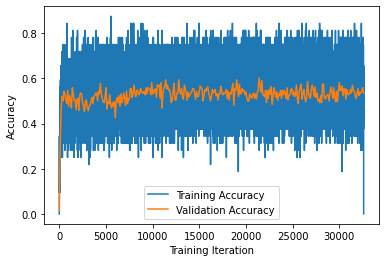

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 6/194419 [00:00<54:56, 58.97it/s]

  0%|          | 12/194419 [00:00<56:24, 57.45it/s]

  0%|          | 21/194419 [00:00<45:16, 71.56it/s]

  0%|          | 30/194419 [00:00<41:40, 77.73it/s]

  0%|          | 40/194419 [00:00<40:22, 80.24it/s]

  0%|          | 49/194419 [00:00<41:12, 78.60it/s]

  0%|          | 57/194419 [00:00<43:46, 74.00it/s]

  0%|          | 66/194419 [00:00<42:20, 76.50it/s]

  0%|          | 74/194419 [00:00<43:03, 75.22it/s]

  0%|          | 83/194419 [00:01<42:07, 76.88it/s]

  0%|          | 92/194419 [00:01<40:12, 80.55it/s]

  0%|          | 101/194419 [00:01<40:46, 79.43it/s]

  0%|          | 110/194419 [00:01<39:43, 81.51it/s]

  0%|          | 119/194419 [00:01<41:30, 78.01it/s]

  0%|          | 127/194419 [00:01<42:48, 75.64it/s]

  0%|          | 136/194419 [00:01<41:14, 78.52it/s]

  0%|          | 144/194419 [00:01<44:49, 72.22it/s]

  0%|          | 153/194419 [00:02<42:19, 76.51it/s]

  0%|          | 161/194419 [00:02<45:08, 71.73it/s]

  0%|          | 169/194419 [00:02<46:57, 68.95it/s]

  0%|          | 179/194419 [00:02<42:17, 76.56it/s]

  0%|          | 187/194419 [00:02<42:03, 76.96it/s]

  0%|          | 195/194419 [00:02<43:42, 74.05it/s]

  0%|          | 203/194419 [00:02<47:31, 68.12it/s]

  0%|          | 211/194419 [00:02<46:09, 70.12it/s]

  0%|          | 220/194419 [00:02<44:55, 72.05it/s]

  0%|          | 230/194419 [00:03<42:38, 75.89it/s]

  0%|          | 238/194419 [00:03<44:49, 72.19it/s]

  0%|          | 246/194419 [00:03<45:59, 70.37it/s]

  0%|          | 256/194419 [00:03<41:46, 77.47it/s]

  0%|          | 265/194419 [00:03<42:08, 76.80it/s]

  0%|          | 273/194419 [00:03<42:36, 75.94it/s]

  0%|          | 281/194419 [00:03<45:13, 71.54it/s]

  0%|          | 291/194419 [00:03<41:53, 77.24it/s]

  0%|          | 299/194419 [00:03<42:58, 75.28it/s]

  0%|          | 307/194419 [00:04<43:28, 74.42it/s]

  0%|          | 316/194419 [00:04<43:06, 75.04it/s]

  0%|          | 324/194419 [00:04<42:38, 75.87it/s]

  0%|          | 332/194419 [00:04<42:11, 76.67it/s]

  0%|          | 341/194419 [00:04<40:55, 79.03it/s]

  0%|          | 351/194419 [00:04<38:48, 83.34it/s]

  0%|          | 360/194419 [00:04<41:35, 77.78it/s]

  0%|          | 368/194419 [00:04<42:51, 75.46it/s]

  0%|          | 378/194419 [00:04<39:32, 81.79it/s]

  0%|          | 387/194419 [00:05<41:44, 77.48it/s]

  0%|          | 396/194419 [00:05<41:10, 78.55it/s]

  0%|          | 404/194419 [00:05<43:18, 74.67it/s]

  0%|          | 413/194419 [00:05<42:50, 75.48it/s]

  0%|          | 422/194419 [00:05<42:59, 75.19it/s]

  0%|          | 432/194419 [00:05<39:33, 81.73it/s]

  0%|          | 441/194419 [00:05<39:34, 81.68it/s]

  0%|          | 450/194419 [00:05<39:10, 82.51it/s]

  0%|          | 459/194419 [00:06<41:21, 78.15it/s]

  0%|          | 470/194419 [00:06<38:23, 84.19it/s]

  0%|          | 479/194419 [00:06<40:39, 79.50it/s]

  0%|          | 488/194419 [00:06<41:21, 78.14it/s]

  0%|          | 497/194419 [00:06<41:15, 78.35it/s]

  0%|          | 506/194419 [00:06<39:58, 80.85it/s]

  0%|          | 515/194419 [00:06<40:50, 79.13it/s]

  0%|          | 523/194419 [00:06<41:18, 78.24it/s]

  0%|          | 532/194419 [00:06<41:26, 77.99it/s]

  0%|          | 540/194419 [00:07<41:40, 77.55it/s]

  0%|          | 548/194419 [00:07<44:13, 73.05it/s]

  0%|          | 556/194419 [00:07<46:29, 69.50it/s]

  0%|          | 564/194419 [00:07<45:33, 70.92it/s]

  0%|          | 573/194419 [00:07<43:46, 73.79it/s]

  0%|          | 582/194419 [00:07<41:55, 77.05it/s]

  0%|          | 590/194419 [00:07<43:35, 74.10it/s]

  0%|          | 598/194419 [00:07<44:10, 73.12it/s]

  0%|          | 606/194419 [00:07<45:27, 71.06it/s]

  0%|          | 614/194419 [00:08<45:48, 70.52it/s]

  0%|          | 622/194419 [00:08<45:15, 71.36it/s]

  0%|          | 631/194419 [00:08<42:48, 75.44it/s]

  0%|          | 639/194419 [00:08<45:20, 71.24it/s]

  0%|          | 648/194419 [00:08<42:42, 75.62it/s]

  0%|          | 656/194419 [00:08<45:09, 71.51it/s]

  0%|          | 664/194419 [00:08<46:03, 70.11it/s]

  0%|          | 673/194419 [00:08<43:46, 73.76it/s]

  0%|          | 681/194419 [00:09<44:24, 72.70it/s]

  0%|          | 690/194419 [00:09<42:49, 75.41it/s]

  0%|          | 698/194419 [00:09<43:02, 75.02it/s]

  0%|          | 706/194419 [00:09<43:37, 74.01it/s]

  0%|          | 714/194419 [00:09<43:19, 74.50it/s]

  0%|          | 723/194419 [00:09<41:11, 78.37it/s]

  0%|          | 731/194419 [00:09<42:07, 76.62it/s]

  0%|          | 741/194419 [00:09<39:00, 82.75it/s]

  0%|          | 751/194419 [00:09<38:52, 83.04it/s]

  0%|          | 760/194419 [00:09<38:46, 83.22it/s]

  0%|          | 769/194419 [00:10<39:42, 81.28it/s]

  0%|          | 778/194419 [00:10<39:40, 81.33it/s]

  0%|          | 787/194419 [00:10<40:34, 79.53it/s]

  0%|          | 795/194419 [00:10<42:54, 75.20it/s]

  0%|          | 803/194419 [00:10<42:59, 75.06it/s]

  0%|          | 812/194419 [00:10<42:51, 75.28it/s]

  0%|          | 821/194419 [00:10<41:57, 76.92it/s]

  0%|          | 831/194419 [00:10<39:35, 81.49it/s]

  0%|          | 840/194419 [00:11<42:19, 76.24it/s]

  0%|          | 849/194419 [00:11<42:27, 75.99it/s]

  0%|          | 857/194419 [00:11<42:09, 76.53it/s]

  0%|          | 866/194419 [00:11<40:58, 78.74it/s]

  0%|          | 874/194419 [00:11<41:15, 78.20it/s]

  0%|          | 882/194419 [00:11<45:06, 71.50it/s]

  0%|          | 892/194419 [00:11<41:10, 78.35it/s]

  0%|          | 900/194419 [00:11<41:48, 77.14it/s]

  0%|          | 908/194419 [00:11<45:11, 71.36it/s]

  0%|          | 917/194419 [00:12<42:44, 75.44it/s]

  0%|          | 925/194419 [00:12<43:48, 73.63it/s]

  0%|          | 937/194419 [00:12<39:13, 82.22it/s]

  0%|          | 946/194419 [00:12<38:24, 83.96it/s]

  0%|          | 956/194419 [00:12<37:42, 85.51it/s]

  0%|          | 965/194419 [00:12<41:15, 78.16it/s]

  1%|          | 973/194419 [00:12<43:10, 74.69it/s]

  1%|          | 981/194419 [00:12<44:22, 72.66it/s]

  1%|          | 989/194419 [00:13<46:32, 69.28it/s]

  1%|          | 999/194419 [00:13<41:46, 77.18it/s]

  1%|          | 1009/194419 [00:13<40:06, 80.36it/s]

  1%|          | 1018/194419 [00:13<40:04, 80.44it/s]

  1%|          | 1027/194419 [00:13<44:49, 71.90it/s]

  1%|          | 1036/194419 [00:13<43:59, 73.26it/s]

  1%|          | 1045/194419 [00:13<41:46, 77.13it/s]

  1%|          | 1054/194419 [00:13<40:49, 78.94it/s]

  1%|          | 1063/194419 [00:13<41:35, 77.48it/s]

  1%|          | 1072/194419 [00:14<40:54, 78.77it/s]

  1%|          | 1080/194419 [00:14<42:23, 76.02it/s]

  1%|          | 1089/194419 [00:14<41:05, 78.42it/s]

  1%|          | 1099/194419 [00:14<40:19, 79.90it/s]

  1%|          | 1109/194419 [00:14<39:39, 81.26it/s]

  1%|          | 1119/194419 [00:14<38:15, 84.22it/s]

  1%|          | 1128/194419 [00:14<38:38, 83.36it/s]

  1%|          | 1137/194419 [00:14<38:42, 83.22it/s]

  1%|          | 1146/194419 [00:14<41:40, 77.31it/s]

  1%|          | 1155/194419 [00:15<40:15, 80.02it/s]

  1%|          | 1164/194419 [00:15<41:17, 78.02it/s]

  1%|          | 1172/194419 [00:15<42:44, 75.34it/s]

  1%|          | 1180/194419 [00:15<43:30, 74.03it/s]

  1%|          | 1188/194419 [00:15<46:37, 69.08it/s]

  1%|          | 1196/194419 [00:15<45:56, 70.10it/s]

  1%|          | 1206/194419 [00:15<42:23, 75.97it/s]

  1%|          | 1215/194419 [00:15<41:35, 77.43it/s]

  1%|          | 1223/194419 [00:16<41:40, 77.27it/s]

  1%|          | 1232/194419 [00:16<41:35, 77.40it/s]

  1%|          | 1242/194419 [00:16<40:36, 79.28it/s]

  1%|          | 1250/194419 [00:16<42:33, 75.65it/s]

  1%|          | 1258/194419 [00:16<43:30, 74.00it/s]

  1%|          | 1266/194419 [00:16<43:25, 74.12it/s]

  1%|          | 1274/194419 [00:16<46:15, 69.59it/s]

  1%|          | 1283/194419 [00:16<43:13, 74.48it/s]

  1%|          | 1292/194419 [00:16<41:29, 77.57it/s]

  1%|          | 1300/194419 [00:17<41:37, 77.32it/s]

  1%|          | 1308/194419 [00:17<41:29, 77.56it/s]

  1%|          | 1319/194419 [00:17<39:08, 82.23it/s]

  1%|          | 1328/194419 [00:17<39:57, 80.53it/s]

  1%|          | 1337/194419 [00:17<42:11, 76.26it/s]

  1%|          | 1346/194419 [00:17<41:18, 77.91it/s]

  1%|          | 1354/194419 [00:17<42:43, 75.32it/s]

  1%|          | 1362/194419 [00:17<45:32, 70.66it/s]

  1%|          | 1371/194419 [00:17<44:03, 73.03it/s]

  1%|          | 1380/194419 [00:18<41:59, 76.62it/s]

  1%|          | 1388/194419 [00:18<44:39, 72.05it/s]

  1%|          | 1398/194419 [00:18<42:00, 76.57it/s]

  1%|          | 1407/194419 [00:18<41:08, 78.20it/s]

  1%|          | 1415/194419 [00:18<42:26, 75.79it/s]

  1%|          | 1423/194419 [00:18<42:35, 75.51it/s]

  1%|          | 1432/194419 [00:18<42:29, 75.70it/s]

  1%|          | 1440/194419 [00:18<42:42, 75.31it/s]

  1%|          | 1448/194419 [00:19<46:17, 69.48it/s]

  1%|          | 1458/194419 [00:19<41:37, 77.25it/s]

  1%|          | 1466/194419 [00:19<43:05, 74.64it/s]

  1%|          | 1474/194419 [00:19<44:00, 73.07it/s]

  1%|          | 1482/194419 [00:19<44:55, 71.58it/s]

  1%|          | 1491/194419 [00:19<43:29, 73.93it/s]

  1%|          | 1499/194419 [00:19<44:30, 72.24it/s]

  1%|          | 1507/194419 [00:19<46:54, 68.55it/s]

  1%|          | 1514/194419 [00:19<48:04, 66.87it/s]

  1%|          | 1522/194419 [00:20<47:12, 68.09it/s]

  1%|          | 1532/194419 [00:20<41:59, 76.55it/s]

  1%|          | 1540/194419 [00:20<43:27, 73.96it/s]

  1%|          | 1548/194419 [00:20<43:56, 73.17it/s]

  1%|          | 1556/194419 [00:20<44:43, 71.87it/s]

  1%|          | 1568/194419 [00:20<38:32, 83.40it/s]

  1%|          | 1577/194419 [00:20<40:38, 79.09it/s]

  1%|          | 1586/194419 [00:20<41:31, 77.40it/s]

  1%|          | 1594/194419 [00:21<46:59, 68.39it/s]

  1%|          | 1603/194419 [00:21<44:46, 71.77it/s]

  1%|          | 1611/194419 [00:21<44:32, 72.15it/s]

  1%|          | 1620/194419 [00:21<43:56, 73.13it/s]

  1%|          | 1629/194419 [00:21<42:17, 75.97it/s]

  1%|          | 1637/194419 [00:21<43:46, 73.39it/s]

  1%|          | 1645/194419 [00:21<43:24, 74.01it/s]

  1%|          | 1655/194419 [00:21<39:51, 80.61it/s]

  1%|          | 1664/194419 [00:21<39:45, 80.81it/s]

  1%|          | 1675/194419 [00:21<37:06, 86.55it/s]

  1%|          | 1684/194419 [00:22<39:12, 81.93it/s]

  1%|          | 1694/194419 [00:22<37:21, 85.97it/s]

  1%|          | 1703/194419 [00:22<37:54, 84.73it/s]

  1%|          | 1712/194419 [00:22<38:44, 82.90it/s]

  1%|          | 1721/194419 [00:22<41:10, 77.99it/s]

  1%|          | 1731/194419 [00:22<39:03, 82.21it/s]

  1%|          | 1740/194419 [00:22<40:08, 80.00it/s]

  1%|          | 1749/194419 [00:22<39:08, 82.04it/s]

  1%|          | 1758/194419 [00:23<39:17, 81.71it/s]

  1%|          | 1767/194419 [00:23<39:00, 82.31it/s]

  1%|          | 1776/194419 [00:23<42:03, 76.33it/s]

  1%|          | 1784/194419 [00:23<42:18, 75.87it/s]

  1%|          | 1792/194419 [00:23<43:20, 74.07it/s]

  1%|          | 1800/194419 [00:23<42:35, 75.36it/s]

  1%|          | 1810/194419 [00:23<40:42, 78.84it/s]

  1%|          | 1819/194419 [00:23<40:34, 79.10it/s]

  1%|          | 1827/194419 [00:23<41:32, 77.27it/s]

  1%|          | 1835/194419 [00:24<42:43, 75.12it/s]

  1%|          | 1843/194419 [00:24<44:42, 71.79it/s]

  1%|          | 1852/194419 [00:24<42:27, 75.60it/s]

  1%|          | 1863/194419 [00:24<38:51, 82.58it/s]

  1%|          | 1873/194419 [00:24<36:46, 87.25it/s]

  1%|          | 1882/194419 [00:24<37:29, 85.58it/s]

  1%|          | 1891/194419 [00:24<37:31, 85.52it/s]

  1%|          | 1900/194419 [00:24<40:02, 80.12it/s]

  1%|          | 1909/194419 [00:24<42:43, 75.08it/s]

  1%|          | 1917/194419 [00:25<43:28, 73.79it/s]

  1%|          | 1926/194419 [00:25<41:50, 76.66it/s]

  1%|          | 1934/194419 [00:25<43:21, 73.99it/s]

  1%|          | 1942/194419 [00:25<42:26, 75.58it/s]

  1%|          | 1951/194419 [00:25<40:53, 78.45it/s]

  1%|          | 1961/194419 [00:25<38:20, 83.66it/s]

  1%|          | 1970/194419 [00:25<37:41, 85.10it/s]

  1%|          | 1979/194419 [00:25<41:26, 77.41it/s]

  1%|          | 1987/194419 [00:25<42:26, 75.57it/s]

  1%|          | 1995/194419 [00:26<41:56, 76.45it/s]

  1%|          | 2003/194419 [00:26<42:49, 74.90it/s]

  1%|          | 2011/194419 [00:26<46:04, 69.60it/s]

  1%|          | 2020/194419 [00:26<43:01, 74.52it/s]

  1%|          | 2028/194419 [00:26<44:28, 72.08it/s]

  1%|          | 2036/194419 [00:26<43:25, 73.82it/s]

  1%|          | 2044/194419 [00:26<43:59, 72.88it/s]

  1%|          | 2055/194419 [00:26<39:56, 80.27it/s]

  1%|          | 2064/194419 [00:26<40:10, 79.79it/s]

  1%|          | 2074/194419 [00:27<38:42, 82.82it/s]

  1%|          | 2083/194419 [00:27<39:07, 81.94it/s]

  1%|          | 2092/194419 [00:27<38:58, 82.25it/s]

  1%|          | 2101/194419 [00:27<38:30, 83.24it/s]

  1%|          | 2110/194419 [00:27<40:54, 78.36it/s]

  1%|          | 2118/194419 [00:27<41:23, 77.44it/s]

  1%|          | 2126/194419 [00:27<41:45, 76.75it/s]

  1%|          | 2134/194419 [00:27<43:26, 73.78it/s]

  1%|          | 2142/194419 [00:27<43:48, 73.16it/s]

  1%|          | 2150/194419 [00:28<45:34, 70.31it/s]

  1%|          | 2158/194419 [00:28<46:51, 68.37it/s]

  1%|          | 2166/194419 [00:28<44:52, 71.41it/s]

  1%|          | 2177/194419 [00:28<41:05, 77.97it/s]

  1%|          | 2185/194419 [00:28<44:16, 72.36it/s]

  1%|          | 2194/194419 [00:28<41:44, 76.75it/s]

  1%|          | 2203/194419 [00:28<41:15, 77.64it/s]

  1%|          | 2211/194419 [00:28<46:05, 69.49it/s]

  1%|          | 2221/194419 [00:29<42:09, 75.98it/s]

  1%|          | 2229/194419 [00:29<43:32, 73.57it/s]

  1%|          | 2237/194419 [00:29<44:40, 71.69it/s]

  1%|          | 2245/194419 [00:29<45:19, 70.66it/s]

  1%|          | 2253/194419 [00:29<44:42, 71.63it/s]

  1%|          | 2261/194419 [00:29<47:04, 68.03it/s]

  1%|          | 2268/194419 [00:29<47:50, 66.95it/s]

  1%|          | 2276/194419 [00:29<46:01, 69.59it/s]

  1%|          | 2284/194419 [00:29<46:57, 68.18it/s]

  1%|          | 2293/194419 [00:30<45:02, 71.10it/s]

  1%|          | 2301/194419 [00:30<46:27, 68.92it/s]

  1%|          | 2310/194419 [00:30<44:04, 72.65it/s]

  1%|          | 2320/194419 [00:30<42:16, 75.72it/s]

  1%|          | 2328/194419 [00:30<42:15, 75.75it/s]

  1%|          | 2337/194419 [00:30<40:26, 79.18it/s]

  1%|          | 2345/194419 [00:30<40:59, 78.10it/s]

  1%|          | 2357/194419 [00:30<35:47, 89.42it/s]

  1%|          | 2367/194419 [00:30<36:25, 87.88it/s]

  1%|          | 2376/194419 [00:31<38:44, 82.61it/s]

  1%|          | 2385/194419 [00:31<42:12, 75.82it/s]

  1%|          | 2393/194419 [00:31<43:54, 72.88it/s]

  1%|          | 2401/194419 [00:31<43:41, 73.26it/s]

  1%|          | 2412/194419 [00:31<39:34, 80.88it/s]

  1%|          | 2421/194419 [00:31<38:45, 82.55it/s]

  1%|▏         | 2431/194419 [00:31<37:00, 86.47it/s]

  1%|▏         | 2440/194419 [00:31<40:46, 78.46it/s]

  1%|▏         | 2449/194419 [00:32<41:28, 77.13it/s]

  1%|▏         | 2457/194419 [00:32<43:15, 73.95it/s]

  1%|▏         | 2465/194419 [00:32<42:27, 75.35it/s]

  1%|▏         | 2473/194419 [00:32<42:02, 76.09it/s]

  1%|▏         | 2483/194419 [00:32<39:09, 81.69it/s]

  1%|▏         | 2492/194419 [00:32<43:04, 74.25it/s]

  1%|▏         | 2500/194419 [00:32<45:07, 70.88it/s]

  1%|▏         | 2508/194419 [00:32<46:56, 68.15it/s]

  1%|▏         | 2517/194419 [00:33<45:28, 70.32it/s]

  1%|▏         | 2525/194419 [00:33<44:41, 71.56it/s]

  1%|▏         | 2534/194419 [00:33<42:48, 74.70it/s]

  1%|▏         | 2542/194419 [00:33<44:53, 71.23it/s]

  1%|▏         | 2551/194419 [00:33<42:58, 74.41it/s]

  1%|▏         | 2559/194419 [00:33<43:34, 73.38it/s]

  1%|▏         | 2567/194419 [00:33<42:38, 74.98it/s]

  1%|▏         | 2576/194419 [00:33<40:57, 78.07it/s]

  1%|▏         | 2585/194419 [00:33<41:11, 77.61it/s]

  1%|▏         | 2593/194419 [00:34<42:57, 74.41it/s]

  1%|▏         | 2601/194419 [00:34<45:46, 69.84it/s]

  1%|▏         | 2609/194419 [00:34<47:09, 67.79it/s]

  1%|▏         | 2616/194419 [00:34<47:42, 67.01it/s]

  1%|▏         | 2623/194419 [00:34<47:34, 67.19it/s]

  1%|▏         | 2631/194419 [00:34<45:41, 69.96it/s]

  1%|▏         | 2639/194419 [00:34<46:38, 68.54it/s]

  1%|▏         | 2646/194419 [00:34<48:47, 65.52it/s]

  1%|▏         | 2654/194419 [00:34<47:56, 66.67it/s]

  1%|▏         | 2662/194419 [00:35<45:54, 69.62it/s]

  1%|▏         | 2670/194419 [00:35<44:28, 71.86it/s]

  1%|▏         | 2679/194419 [00:35<41:48, 76.44it/s]

  1%|▏         | 2687/194419 [00:35<42:33, 75.08it/s]

  1%|▏         | 2695/194419 [00:35<44:51, 71.24it/s]

  1%|▏         | 2703/194419 [00:35<44:32, 71.73it/s]

  1%|▏         | 2711/194419 [00:35<46:43, 68.37it/s]

  1%|▏         | 2718/194419 [00:35<47:42, 66.97it/s]

  1%|▏         | 2726/194419 [00:35<46:01, 69.41it/s]

  1%|▏         | 2734/194419 [00:36<46:49, 68.24it/s]

  1%|▏         | 2742/194419 [00:36<45:15, 70.57it/s]

  1%|▏         | 2750/194419 [00:36<47:48, 66.81it/s]

  1%|▏         | 2759/194419 [00:36<45:05, 70.85it/s]

  1%|▏         | 2767/194419 [00:36<45:42, 69.87it/s]

  1%|▏         | 2775/194419 [00:36<45:24, 70.34it/s]

  1%|▏         | 2784/194419 [00:36<43:42, 73.06it/s]

  1%|▏         | 2793/194419 [00:36<42:16, 75.56it/s]

  1%|▏         | 2801/194419 [00:36<42:36, 74.97it/s]

  1%|▏         | 2809/194419 [00:37<44:41, 71.46it/s]

  1%|▏         | 2819/194419 [00:37<40:50, 78.20it/s]

  1%|▏         | 2827/194419 [00:37<40:49, 78.21it/s]

  1%|▏         | 2835/194419 [00:37<44:41, 71.44it/s]

  1%|▏         | 2844/194419 [00:37<42:20, 75.40it/s]

  1%|▏         | 2852/194419 [00:37<42:11, 75.67it/s]

  1%|▏         | 2860/194419 [00:37<41:51, 76.27it/s]

  1%|▏         | 2868/194419 [00:37<43:03, 74.13it/s]

  1%|▏         | 2877/194419 [00:37<40:42, 78.44it/s]

  1%|▏         | 2885/194419 [00:38<44:26, 71.83it/s]

  1%|▏         | 2894/194419 [00:38<42:30, 75.09it/s]

  1%|▏         | 2904/194419 [00:38<38:58, 81.88it/s]

  1%|▏         | 2913/194419 [00:38<38:31, 82.87it/s]

  2%|▏         | 2922/194419 [00:38<38:41, 82.47it/s]

  2%|▏         | 2931/194419 [00:38<41:53, 76.20it/s]

  2%|▏         | 2941/194419 [00:38<40:49, 78.18it/s]

  2%|▏         | 2949/194419 [00:38<44:28, 71.76it/s]

  2%|▏         | 2957/194419 [00:39<44:01, 72.48it/s]

  2%|▏         | 2967/194419 [00:39<40:32, 78.70it/s]

  2%|▏         | 2975/194419 [00:39<42:07, 75.74it/s]

  2%|▏         | 2984/194419 [00:39<40:57, 77.89it/s]

  2%|▏         | 2992/194419 [00:39<42:27, 75.15it/s]

  2%|▏         | 3001/194419 [00:39<40:37, 78.54it/s]

  2%|▏         | 3009/194419 [00:39<42:03, 75.85it/s]

  2%|▏         | 3019/194419 [00:39<40:23, 78.99it/s]

  2%|▏         | 3027/194419 [00:39<43:46, 72.86it/s]

  2%|▏         | 3036/194419 [00:40<43:31, 73.30it/s]

  2%|▏         | 3044/194419 [00:40<45:49, 69.61it/s]

  2%|▏         | 3052/194419 [00:40<47:14, 67.52it/s]

  2%|▏         | 3062/194419 [00:40<42:28, 75.10it/s]

  2%|▏         | 3070/194419 [00:40<43:34, 73.18it/s]

  2%|▏         | 3080/194419 [00:40<39:42, 80.33it/s]

  2%|▏         | 3089/194419 [00:40<42:23, 75.21it/s]

  2%|▏         | 3097/194419 [00:40<43:05, 74.00it/s]

  2%|▏         | 3106/194419 [00:41<41:59, 75.93it/s]

  2%|▏         | 3114/194419 [00:41<44:09, 72.22it/s]

  2%|▏         | 3124/194419 [00:41<41:38, 76.55it/s]

  2%|▏         | 3134/194419 [00:41<40:24, 78.89it/s]

  2%|▏         | 3142/194419 [00:41<41:13, 77.35it/s]

  2%|▏         | 3150/194419 [00:41<42:48, 74.47it/s]

  2%|▏         | 3160/194419 [00:41<39:32, 80.61it/s]

  2%|▏         | 3169/194419 [00:41<39:28, 80.76it/s]

  2%|▏         | 3178/194419 [00:41<39:06, 81.52it/s]

  2%|▏         | 3187/194419 [00:42<38:16, 83.28it/s]

  2%|▏         | 3196/194419 [00:42<39:04, 81.56it/s]

  2%|▏         | 3205/194419 [00:42<42:32, 74.91it/s]

  2%|▏         | 3215/194419 [00:42<39:39, 80.37it/s]

  2%|▏         | 3225/194419 [00:42<38:00, 83.84it/s]

  2%|▏         | 3235/194419 [00:42<37:24, 85.19it/s]

  2%|▏         | 3244/194419 [00:42<37:02, 86.02it/s]

  2%|▏         | 3253/194419 [00:42<39:08, 81.39it/s]

  2%|▏         | 3262/194419 [00:42<40:55, 77.85it/s]

  2%|▏         | 3273/194419 [00:43<37:04, 85.94it/s]

  2%|▏         | 3282/194419 [00:43<43:16, 73.61it/s]

  2%|▏         | 3290/194419 [00:43<43:59, 72.41it/s]

  2%|▏         | 3299/194419 [00:43<42:20, 75.23it/s]

  2%|▏         | 3309/194419 [00:43<39:31, 80.60it/s]

  2%|▏         | 3318/194419 [00:43<40:09, 79.31it/s]

  2%|▏         | 3327/194419 [00:43<40:14, 79.13it/s]

  2%|▏         | 3336/194419 [00:43<41:52, 76.06it/s]

  2%|▏         | 3346/194419 [00:44<39:39, 80.31it/s]

  2%|▏         | 3355/194419 [00:44<42:57, 74.13it/s]

  2%|▏         | 3363/194419 [00:44<42:57, 74.14it/s]

  2%|▏         | 3373/194419 [00:44<40:45, 78.12it/s]

  2%|▏         | 3382/194419 [00:44<40:49, 77.99it/s]

  2%|▏         | 3393/194419 [00:44<37:35, 84.70it/s]

  2%|▏         | 3402/194419 [00:44<38:57, 81.72it/s]

  2%|▏         | 3411/194419 [00:44<39:46, 80.02it/s]

  2%|▏         | 3422/194419 [00:44<36:50, 86.41it/s]

  2%|▏         | 3431/194419 [00:45<40:33, 78.49it/s]

  2%|▏         | 3442/194419 [00:45<36:46, 86.55it/s]

  2%|▏         | 3451/194419 [00:45<37:53, 83.98it/s]

  2%|▏         | 3460/194419 [00:45<37:35, 84.67it/s]

  2%|▏         | 3469/194419 [00:45<40:09, 79.24it/s]

  2%|▏         | 3478/194419 [00:45<39:52, 79.80it/s]

  2%|▏         | 3487/194419 [00:45<41:53, 75.95it/s]

  2%|▏         | 3495/194419 [00:45<42:32, 74.80it/s]

  2%|▏         | 3504/194419 [00:46<41:00, 77.58it/s]

  2%|▏         | 3513/194419 [00:46<40:56, 77.72it/s]

  2%|▏         | 3522/194419 [00:46<39:23, 80.78it/s]

  2%|▏         | 3532/194419 [00:46<37:01, 85.91it/s]

  2%|▏         | 3541/194419 [00:46<37:52, 84.01it/s]

  2%|▏         | 3550/194419 [00:46<41:29, 76.67it/s]

  2%|▏         | 3559/194419 [00:46<41:40, 76.34it/s]

  2%|▏         | 3569/194419 [00:46<38:55, 81.70it/s]

  2%|▏         | 3578/194419 [00:46<41:11, 77.23it/s]

  2%|▏         | 3588/194419 [00:47<39:04, 81.39it/s]

  2%|▏         | 3597/194419 [00:47<40:26, 78.64it/s]

  2%|▏         | 3606/194419 [00:47<39:10, 81.19it/s]

  2%|▏         | 3615/194419 [00:47<38:25, 82.75it/s]

  2%|▏         | 3625/194419 [00:47<36:51, 86.25it/s]

  2%|▏         | 3634/194419 [00:47<40:36, 78.30it/s]

  2%|▏         | 3643/194419 [00:47<40:55, 77.68it/s]

  2%|▏         | 3651/194419 [00:47<40:40, 78.15it/s]

  2%|▏         | 3659/194419 [00:47<41:46, 76.12it/s]

  2%|▏         | 3667/194419 [00:48<41:48, 76.04it/s]

  2%|▏         | 3677/194419 [00:48<39:05, 81.32it/s]

  2%|▏         | 3686/194419 [00:48<38:49, 81.87it/s]

  2%|▏         | 3695/194419 [00:48<39:11, 81.12it/s]

  2%|▏         | 3704/194419 [00:48<40:00, 79.44it/s]

  2%|▏         | 3712/194419 [00:48<42:01, 75.64it/s]

  2%|▏         | 3720/194419 [00:48<42:57, 73.98it/s]

  2%|▏         | 3729/194419 [00:48<40:40, 78.14it/s]

  2%|▏         | 3737/194419 [00:48<42:29, 74.79it/s]

  2%|▏         | 3745/194419 [00:49<44:17, 71.75it/s]

  2%|▏         | 3755/194419 [00:49<41:28, 76.61it/s]

  2%|▏         | 3763/194419 [00:49<42:01, 75.62it/s]

  2%|▏         | 3771/194419 [00:49<45:41, 69.55it/s]

  2%|▏         | 3780/194419 [00:49<43:54, 72.37it/s]

  2%|▏         | 3788/194419 [00:49<44:19, 71.68it/s]

  2%|▏         | 3796/194419 [00:49<45:14, 70.22it/s]

  2%|▏         | 3804/194419 [00:49<44:45, 70.99it/s]

  2%|▏         | 3813/194419 [00:50<43:18, 73.36it/s]

  2%|▏         | 3821/194419 [00:50<46:21, 68.53it/s]

  2%|▏         | 3830/194419 [00:50<43:42, 72.67it/s]

  2%|▏         | 3838/194419 [00:50<42:43, 74.35it/s]

  2%|▏         | 3847/194419 [00:50<41:22, 76.77it/s]

  2%|▏         | 3855/194419 [00:50<42:02, 75.55it/s]

  2%|▏         | 3866/194419 [00:50<38:10, 83.21it/s]

  2%|▏         | 3875/194419 [00:50<37:44, 84.13it/s]

  2%|▏         | 3885/194419 [00:50<36:08, 87.88it/s]

  2%|▏         | 3894/194419 [00:51<39:59, 79.40it/s]

  2%|▏         | 3903/194419 [00:51<39:47, 79.80it/s]

  2%|▏         | 3912/194419 [00:51<38:55, 81.56it/s]

  2%|▏         | 3921/194419 [00:51<39:16, 80.84it/s]

  2%|▏         | 3931/194419 [00:51<38:38, 82.17it/s]

  2%|▏         | 3940/194419 [00:51<39:59, 79.38it/s]

  2%|▏         | 3948/194419 [00:51<39:54, 79.53it/s]

  2%|▏         | 3956/194419 [00:51<42:14, 75.13it/s]

  2%|▏         | 3965/194419 [00:51<42:16, 75.07it/s]

  2%|▏         | 3974/194419 [00:52<40:11, 78.97it/s]

  2%|▏         | 3983/194419 [00:52<39:02, 81.31it/s]

  2%|▏         | 3992/194419 [00:52<41:24, 76.65it/s]

  2%|▏         | 4000/194419 [00:52<41:38, 76.21it/s]

  2%|▏         | 4008/194419 [00:52<43:08, 73.56it/s]

  2%|▏         | 4017/194419 [00:52<41:14, 76.94it/s]

  2%|▏         | 4025/194419 [00:52<42:02, 75.47it/s]

  2%|▏         | 4035/194419 [00:52<40:09, 79.01it/s]

  2%|▏         | 4043/194419 [00:52<41:50, 75.84it/s]

  2%|▏         | 4051/194419 [00:53<42:56, 73.88it/s]

  2%|▏         | 4059/194419 [00:53<42:26, 74.76it/s]

  2%|▏         | 4067/194419 [00:53<44:19, 71.57it/s]

  2%|▏         | 4075/194419 [00:53<43:38, 72.69it/s]

  2%|▏         | 4083/194419 [00:53<42:51, 74.02it/s]

  2%|▏         | 4091/194419 [00:53<45:04, 70.38it/s]

  2%|▏         | 4101/194419 [00:53<40:33, 78.21it/s]

  2%|▏         | 4109/194419 [00:53<43:23, 73.11it/s]

  2%|▏         | 4117/194419 [00:53<43:16, 73.28it/s]

  2%|▏         | 4125/194419 [00:54<42:34, 74.49it/s]

  2%|▏         | 4134/194419 [00:54<41:11, 77.00it/s]

  2%|▏         | 4142/194419 [00:54<41:44, 75.98it/s]

  2%|▏         | 4150/194419 [00:54<43:41, 72.57it/s]

  2%|▏         | 4158/194419 [00:54<43:41, 72.59it/s]

  2%|▏         | 4167/194419 [00:54<41:59, 75.51it/s]

  2%|▏         | 4175/194419 [00:54<43:07, 73.52it/s]

  2%|▏         | 4183/194419 [00:54<43:08, 73.49it/s]

  2%|▏         | 4191/194419 [00:54<43:54, 72.21it/s]

  2%|▏         | 4199/194419 [00:55<44:13, 71.69it/s]

  2%|▏         | 4207/194419 [00:55<43:36, 72.69it/s]

  2%|▏         | 4215/194419 [00:55<42:54, 73.88it/s]

  2%|▏         | 4223/194419 [00:55<42:44, 74.17it/s]

  2%|▏         | 4231/194419 [00:55<43:23, 73.05it/s]

  2%|▏         | 4239/194419 [00:55<42:28, 74.63it/s]

  2%|▏         | 4247/194419 [00:55<44:14, 71.63it/s]

  2%|▏         | 4256/194419 [00:55<42:03, 75.37it/s]

  2%|▏         | 4264/194419 [00:55<43:49, 72.31it/s]

  2%|▏         | 4272/194419 [00:56<43:24, 73.00it/s]

  2%|▏         | 4280/194419 [00:56<42:37, 74.36it/s]

  2%|▏         | 4288/194419 [00:56<43:37, 72.62it/s]

  2%|▏         | 4296/194419 [00:56<45:01, 70.37it/s]

  2%|▏         | 4304/194419 [00:56<46:12, 68.56it/s]

  2%|▏         | 4313/194419 [00:56<42:54, 73.84it/s]

  2%|▏         | 4323/194419 [00:56<39:53, 79.41it/s]

  2%|▏         | 4332/194419 [00:56<40:37, 77.99it/s]

  2%|▏         | 4340/194419 [00:57<41:40, 76.01it/s]

  2%|▏         | 4348/194419 [00:57<43:42, 72.48it/s]

  2%|▏         | 4356/194419 [00:57<42:50, 73.94it/s]

  2%|▏         | 4365/194419 [00:57<40:32, 78.12it/s]

  2%|▏         | 4373/194419 [00:57<43:23, 73.00it/s]

  2%|▏         | 4381/194419 [00:57<42:21, 74.77it/s]

  2%|▏         | 4389/194419 [00:57<44:59, 70.40it/s]

  2%|▏         | 4399/194419 [00:57<40:37, 77.95it/s]

  2%|▏         | 4408/194419 [00:57<39:27, 80.26it/s]

  2%|▏         | 4417/194419 [00:58<43:58, 72.00it/s]

  2%|▏         | 4426/194419 [00:58<43:27, 72.88it/s]

  2%|▏         | 4436/194419 [00:58<40:06, 78.94it/s]

  2%|▏         | 4445/194419 [00:58<39:35, 79.97it/s]

  2%|▏         | 4454/194419 [00:58<41:15, 76.75it/s]

  2%|▏         | 4462/194419 [00:58<43:06, 73.44it/s]

  2%|▏         | 4470/194419 [00:58<46:07, 68.63it/s]

  2%|▏         | 4478/194419 [00:58<44:49, 70.62it/s]

  2%|▏         | 4487/194419 [00:58<42:16, 74.88it/s]

  2%|▏         | 4495/194419 [00:59<42:12, 75.00it/s]

  2%|▏         | 4503/194419 [00:59<44:17, 71.46it/s]

  2%|▏         | 4512/194419 [00:59<41:23, 76.46it/s]

  2%|▏         | 4520/194419 [00:59<42:30, 74.46it/s]

  2%|▏         | 4528/194419 [00:59<42:17, 74.85it/s]

  2%|▏         | 4536/194419 [00:59<41:30, 76.25it/s]

  2%|▏         | 4544/194419 [00:59<42:53, 73.78it/s]

  2%|▏         | 4552/194419 [00:59<42:43, 74.07it/s]

  2%|▏         | 4560/194419 [00:59<41:58, 75.37it/s]

  2%|▏         | 4568/194419 [01:00<43:30, 72.74it/s]

  2%|▏         | 4577/194419 [01:00<42:42, 74.08it/s]

  2%|▏         | 4585/194419 [01:00<42:29, 74.45it/s]

  2%|▏         | 4595/194419 [01:00<40:54, 77.34it/s]

  2%|▏         | 4604/194419 [01:00<39:40, 79.75it/s]

  2%|▏         | 4612/194419 [01:00<40:09, 78.78it/s]

  2%|▏         | 4620/194419 [01:00<41:18, 76.58it/s]

  2%|▏         | 4630/194419 [01:00<39:15, 80.57it/s]

  2%|▏         | 4639/194419 [01:01<45:16, 69.87it/s]

  2%|▏         | 4647/194419 [01:01<45:02, 70.23it/s]

  2%|▏         | 4655/194419 [01:01<45:40, 69.24it/s]

  2%|▏         | 4665/194419 [01:01<42:44, 73.98it/s]

  2%|▏         | 4674/194419 [01:01<41:32, 76.14it/s]

  2%|▏         | 4684/194419 [01:01<38:49, 81.46it/s]

  2%|▏         | 4693/194419 [01:01<40:18, 78.44it/s]

  2%|▏         | 4701/194419 [01:01<40:16, 78.51it/s]

  2%|▏         | 4710/194419 [01:01<38:56, 81.18it/s]

  2%|▏         | 4719/194419 [01:02<42:13, 74.87it/s]

  2%|▏         | 4728/194419 [01:02<41:09, 76.81it/s]

  2%|▏         | 4736/194419 [01:02<44:19, 71.31it/s]

  2%|▏         | 4744/194419 [01:02<43:35, 72.53it/s]

  2%|▏         | 4753/194419 [01:02<41:36, 75.96it/s]

  2%|▏         | 4761/194419 [01:02<41:05, 76.92it/s]

  2%|▏         | 4769/194419 [01:02<42:36, 74.19it/s]

  2%|▏         | 4777/194419 [01:02<42:19, 74.69it/s]

  2%|▏         | 4785/194419 [01:02<43:27, 72.72it/s]

  2%|▏         | 4793/194419 [01:03<45:42, 69.16it/s]

  2%|▏         | 4801/194419 [01:03<44:08, 71.59it/s]

  2%|▏         | 4809/194419 [01:03<43:08, 73.26it/s]

  2%|▏         | 4817/194419 [01:03<42:39, 74.09it/s]

  2%|▏         | 4827/194419 [01:03<39:21, 80.28it/s]

  2%|▏         | 4836/194419 [01:03<39:22, 80.25it/s]

  2%|▏         | 4845/194419 [01:03<40:21, 78.30it/s]

  2%|▏         | 4855/194419 [01:03<39:37, 79.72it/s]

  3%|▎         | 4863/194419 [01:03<43:48, 72.12it/s]

  3%|▎         | 4871/194419 [01:04<43:04, 73.33it/s]

  3%|▎         | 4881/194419 [01:04<41:00, 77.03it/s]

  3%|▎         | 4889/194419 [01:04<41:03, 76.92it/s]

  3%|▎         | 4897/194419 [01:04<41:58, 75.24it/s]

  3%|▎         | 4905/194419 [01:04<41:23, 76.32it/s]

  3%|▎         | 4913/194419 [01:04<41:06, 76.84it/s]

  3%|▎         | 4921/194419 [01:04<41:17, 76.50it/s]

  3%|▎         | 4929/194419 [01:04<43:43, 72.22it/s]

  3%|▎         | 4937/194419 [01:04<43:05, 73.29it/s]

  3%|▎         | 4945/194419 [01:05<43:52, 71.97it/s]

  3%|▎         | 4954/194419 [01:05<42:05, 75.01it/s]

  3%|▎         | 4962/194419 [01:05<42:00, 75.18it/s]

  3%|▎         | 4972/194419 [01:05<38:49, 81.34it/s]

  3%|▎         | 4981/194419 [01:05<37:46, 83.59it/s]

  3%|▎         | 4990/194419 [01:05<40:20, 78.25it/s]

  3%|▎         | 4999/194419 [01:05<39:44, 79.44it/s]

  3%|▎         | 5008/194419 [01:05<43:27, 72.64it/s]

  3%|▎         | 5016/194419 [01:06<44:44, 70.55it/s]

  3%|▎         | 5024/194419 [01:06<43:47, 72.07it/s]

  3%|▎         | 5032/194419 [01:06<43:30, 72.55it/s]

  3%|▎         | 5040/194419 [01:06<43:59, 71.75it/s]

  3%|▎         | 5048/194419 [01:06<45:18, 69.66it/s]

  3%|▎         | 5056/194419 [01:06<46:36, 67.72it/s]

  3%|▎         | 5063/194419 [01:06<46:14, 68.25it/s]

  3%|▎         | 5070/194419 [01:06<47:27, 66.50it/s]

  3%|▎         | 5078/194419 [01:06<45:16, 69.69it/s]

  3%|▎         | 5086/194419 [01:07<47:18, 66.70it/s]

  3%|▎         | 5094/194419 [01:07<45:26, 69.45it/s]

  3%|▎         | 5103/194419 [01:07<43:02, 73.29it/s]

  3%|▎         | 5111/194419 [01:07<46:21, 68.06it/s]

  3%|▎         | 5119/194419 [01:07<44:27, 70.98it/s]

  3%|▎         | 5127/194419 [01:07<46:52, 67.30it/s]

  3%|▎         | 5136/194419 [01:07<43:22, 72.74it/s]

  3%|▎         | 5144/194419 [01:07<44:38, 70.66it/s]

  3%|▎         | 5152/194419 [01:07<43:29, 72.53it/s]

  3%|▎         | 5160/194419 [01:08<44:46, 70.44it/s]

  3%|▎         | 5168/194419 [01:08<43:45, 72.09it/s]

  3%|▎         | 5176/194419 [01:08<43:52, 71.88it/s]

  3%|▎         | 5185/194419 [01:08<41:47, 75.48it/s]

  3%|▎         | 5195/194419 [01:08<39:06, 80.63it/s]

  3%|▎         | 5204/194419 [01:08<40:35, 77.68it/s]

  3%|▎         | 5212/194419 [01:08<42:46, 73.74it/s]

  3%|▎         | 5220/194419 [01:08<42:09, 74.81it/s]

  3%|▎         | 5228/194419 [01:08<45:55, 68.67it/s]

  3%|▎         | 5236/194419 [01:09<44:35, 70.72it/s]

  3%|▎         | 5244/194419 [01:09<43:15, 72.89it/s]

  3%|▎         | 5252/194419 [01:09<45:02, 69.99it/s]

  3%|▎         | 5260/194419 [01:09<46:14, 68.17it/s]

  3%|▎         | 5268/194419 [01:09<44:55, 70.18it/s]

  3%|▎         | 5278/194419 [01:09<41:11, 76.53it/s]

  3%|▎         | 5286/194419 [01:09<42:28, 74.21it/s]

  3%|▎         | 5296/194419 [01:09<39:22, 80.05it/s]

  3%|▎         | 5305/194419 [01:09<38:38, 81.57it/s]

  3%|▎         | 5314/194419 [01:10<42:45, 73.71it/s]

  3%|▎         | 5322/194419 [01:10<44:27, 70.90it/s]

  3%|▎         | 5330/194419 [01:10<45:21, 69.47it/s]

  3%|▎         | 5338/194419 [01:10<47:12, 66.75it/s]

  3%|▎         | 5347/194419 [01:10<43:41, 72.13it/s]

  3%|▎         | 5357/194419 [01:10<39:47, 79.18it/s]

  3%|▎         | 5366/194419 [01:10<40:27, 77.87it/s]

  3%|▎         | 5374/194419 [01:10<41:49, 75.35it/s]

  3%|▎         | 5382/194419 [01:11<41:43, 75.52it/s]

  3%|▎         | 5391/194419 [01:11<40:28, 77.83it/s]

  3%|▎         | 5399/194419 [01:11<40:20, 78.10it/s]

  3%|▎         | 5407/194419 [01:11<40:25, 77.93it/s]

  3%|▎         | 5416/194419 [01:11<39:59, 78.78it/s]

  3%|▎         | 5424/194419 [01:11<44:43, 70.42it/s]

  3%|▎         | 5433/194419 [01:11<41:55, 75.14it/s]

  3%|▎         | 5443/194419 [01:11<38:32, 81.72it/s]

  3%|▎         | 5452/194419 [01:11<40:16, 78.21it/s]

  3%|▎         | 5462/194419 [01:12<38:00, 82.86it/s]

  3%|▎         | 5471/194419 [01:12<37:21, 84.29it/s]

  3%|▎         | 5480/194419 [01:12<37:30, 83.94it/s]

  3%|▎         | 5489/194419 [01:12<36:52, 85.40it/s]

  3%|▎         | 5498/194419 [01:12<38:24, 81.99it/s]

  3%|▎         | 5507/194419 [01:12<37:38, 83.66it/s]

  3%|▎         | 5516/194419 [01:12<38:25, 81.93it/s]

  3%|▎         | 5525/194419 [01:12<40:43, 77.31it/s]

  3%|▎         | 5533/194419 [01:12<41:52, 75.17it/s]

  3%|▎         | 5543/194419 [01:13<39:36, 79.49it/s]

  3%|▎         | 5552/194419 [01:13<40:22, 77.96it/s]

  3%|▎         | 5560/194419 [01:13<40:33, 77.60it/s]

  3%|▎         | 5568/194419 [01:13<42:08, 74.70it/s]

  3%|▎         | 5576/194419 [01:13<44:06, 71.35it/s]

  3%|▎         | 5585/194419 [01:13<41:34, 75.69it/s]

  3%|▎         | 5593/194419 [01:13<41:49, 75.26it/s]

  3%|▎         | 5601/194419 [01:13<43:06, 73.01it/s]

  3%|▎         | 5609/194419 [01:13<44:45, 70.30it/s]

  3%|▎         | 5617/194419 [01:14<44:07, 71.30it/s]

  3%|▎         | 5625/194419 [01:14<44:49, 70.19it/s]

  3%|▎         | 5634/194419 [01:14<41:56, 75.01it/s]

  3%|▎         | 5642/194419 [01:14<41:23, 76.00it/s]

  3%|▎         | 5651/194419 [01:14<39:30, 79.62it/s]

  3%|▎         | 5662/194419 [01:14<37:50, 83.15it/s]

  3%|▎         | 5671/194419 [01:14<39:13, 80.21it/s]

  3%|▎         | 5680/194419 [01:14<41:33, 75.71it/s]

  3%|▎         | 5689/194419 [01:15<40:55, 76.87it/s]

  3%|▎         | 5697/194419 [01:15<41:32, 75.71it/s]

  3%|▎         | 5705/194419 [01:15<41:42, 75.41it/s]

  3%|▎         | 5713/194419 [01:15<42:34, 73.87it/s]

  3%|▎         | 5724/194419 [01:15<39:27, 79.69it/s]

  3%|▎         | 5732/194419 [01:15<40:05, 78.44it/s]

  3%|▎         | 5741/194419 [01:15<39:16, 80.05it/s]

  3%|▎         | 5750/194419 [01:15<40:12, 78.21it/s]

  3%|▎         | 5759/194419 [01:15<38:53, 80.84it/s]

  3%|▎         | 5770/194419 [01:16<36:04, 87.15it/s]

  3%|▎         | 5779/194419 [01:16<37:17, 84.31it/s]

  3%|▎         | 5788/194419 [01:16<39:16, 80.04it/s]

  3%|▎         | 5797/194419 [01:16<38:16, 82.12it/s]

  3%|▎         | 5806/194419 [01:16<39:33, 79.47it/s]

  3%|▎         | 5815/194419 [01:16<41:48, 75.20it/s]

  3%|▎         | 5825/194419 [01:16<40:16, 78.04it/s]

  3%|▎         | 5835/194419 [01:16<38:31, 81.60it/s]

  3%|▎         | 5844/194419 [01:16<39:47, 78.98it/s]

  3%|▎         | 5852/194419 [01:17<40:01, 78.53it/s]

  3%|▎         | 5860/194419 [01:17<39:50, 78.89it/s]

  3%|▎         | 5868/194419 [01:17<40:18, 77.96it/s]

  3%|▎         | 5876/194419 [01:17<42:16, 74.32it/s]

  3%|▎         | 5885/194419 [01:17<41:56, 74.92it/s]

  3%|▎         | 5893/194419 [01:17<42:07, 74.59it/s]

  3%|▎         | 5901/194419 [01:17<42:00, 74.79it/s]

  3%|▎         | 5909/194419 [01:17<41:30, 75.68it/s]

  3%|▎         | 5918/194419 [01:17<39:39, 79.21it/s]

  3%|▎         | 5926/194419 [01:18<39:58, 78.58it/s]

  3%|▎         | 5934/194419 [01:18<40:05, 78.36it/s]

  3%|▎         | 5942/194419 [01:18<40:04, 78.37it/s]

  3%|▎         | 5951/194419 [01:18<38:38, 81.27it/s]

  3%|▎         | 5960/194419 [01:18<41:30, 75.67it/s]

  3%|▎         | 5968/194419 [01:18<40:59, 76.61it/s]

  3%|▎         | 5976/194419 [01:18<41:44, 75.23it/s]

  3%|▎         | 5985/194419 [01:18<40:21, 77.83it/s]

  3%|▎         | 5994/194419 [01:18<39:39, 79.17it/s]

  3%|▎         | 6002/194419 [01:19<39:41, 79.13it/s]

  3%|▎         | 6011/194419 [01:19<39:31, 79.43it/s]

  3%|▎         | 6022/194419 [01:19<35:44, 87.85it/s]

  3%|▎         | 6031/194419 [01:19<37:08, 84.54it/s]

  3%|▎         | 6041/194419 [01:19<35:24, 88.67it/s]

  3%|▎         | 6050/194419 [01:19<36:22, 86.31it/s]

  3%|▎         | 6059/194419 [01:19<37:48, 83.03it/s]

  3%|▎         | 6068/194419 [01:19<38:39, 81.20it/s]

  3%|▎         | 6077/194419 [01:19<40:02, 78.39it/s]

  3%|▎         | 6086/194419 [01:20<39:50, 78.77it/s]

  3%|▎         | 6094/194419 [01:20<39:54, 78.66it/s]

  3%|▎         | 6102/194419 [01:20<42:34, 73.71it/s]

  3%|▎         | 6110/194419 [01:20<44:01, 71.28it/s]

  3%|▎         | 6118/194419 [01:20<43:53, 71.51it/s]

  3%|▎         | 6126/194419 [01:20<43:35, 71.98it/s]

  3%|▎         | 6134/194419 [01:20<47:19, 66.30it/s]

  3%|▎         | 6145/194419 [01:20<40:46, 76.95it/s]

  3%|▎         | 6153/194419 [01:20<40:21, 77.75it/s]

  3%|▎         | 6163/194419 [01:21<37:30, 83.65it/s]

  3%|▎         | 6172/194419 [01:21<41:01, 76.48it/s]

  3%|▎         | 6180/194419 [01:21<42:17, 74.19it/s]

  3%|▎         | 6189/194419 [01:21<41:06, 76.32it/s]

  3%|▎         | 6197/194419 [01:21<43:01, 72.91it/s]

  3%|▎         | 6205/194419 [01:21<43:24, 72.27it/s]

  3%|▎         | 6213/194419 [01:21<42:41, 73.48it/s]

  3%|▎         | 6223/194419 [01:21<40:57, 76.58it/s]

  3%|▎         | 6231/194419 [01:22<44:48, 69.99it/s]

  3%|▎         | 6239/194419 [01:22<44:45, 70.07it/s]

  3%|▎         | 6247/194419 [01:22<43:44, 71.70it/s]

  3%|▎         | 6256/194419 [01:22<40:59, 76.50it/s]

  3%|▎         | 6265/194419 [01:22<41:04, 76.35it/s]

  3%|▎         | 6273/194419 [01:22<42:31, 73.73it/s]

  3%|▎         | 6283/194419 [01:22<39:16, 79.82it/s]

  3%|▎         | 6292/194419 [01:22<41:38, 75.31it/s]

  3%|▎         | 6300/194419 [01:22<43:25, 72.20it/s]

  3%|▎         | 6310/194419 [01:23<39:55, 78.54it/s]

  3%|▎         | 6319/194419 [01:23<38:24, 81.61it/s]

  3%|▎         | 6328/194419 [01:23<40:22, 77.63it/s]

  3%|▎         | 6336/194419 [01:23<43:27, 72.14it/s]

  3%|▎         | 6345/194419 [01:23<41:20, 75.82it/s]

  3%|▎         | 6353/194419 [01:23<41:53, 74.82it/s]

  3%|▎         | 6361/194419 [01:23<43:27, 72.13it/s]

  3%|▎         | 6371/194419 [01:23<40:23, 77.59it/s]

  3%|▎         | 6379/194419 [01:23<42:10, 74.31it/s]

  3%|▎         | 6387/194419 [01:24<42:25, 73.88it/s]

  3%|▎         | 6396/194419 [01:24<42:09, 74.34it/s]

  3%|▎         | 6404/194419 [01:24<41:22, 75.74it/s]

  3%|▎         | 6412/194419 [01:24<43:35, 71.89it/s]

  3%|▎         | 6420/194419 [01:24<43:38, 71.79it/s]

  3%|▎         | 6428/194419 [01:24<43:51, 71.44it/s]

  3%|▎         | 6436/194419 [01:24<44:58, 69.67it/s]

  3%|▎         | 6443/194419 [01:24<46:21, 67.58it/s]

  3%|▎         | 6454/194419 [01:24<40:02, 78.23it/s]

  3%|▎         | 6464/194419 [01:25<37:15, 84.09it/s]

  3%|▎         | 6473/194419 [01:25<38:14, 81.91it/s]

  3%|▎         | 6483/194419 [01:25<36:23, 86.08it/s]

  3%|▎         | 6492/194419 [01:25<36:50, 85.01it/s]

  3%|▎         | 6501/194419 [01:25<43:04, 72.71it/s]

  3%|▎         | 6509/194419 [01:25<42:19, 73.99it/s]

  3%|▎         | 6518/194419 [01:25<40:30, 77.31it/s]

  3%|▎         | 6526/194419 [01:25<41:30, 75.43it/s]

  3%|▎         | 6534/194419 [01:25<41:43, 75.04it/s]

  3%|▎         | 6542/194419 [01:26<44:29, 70.38it/s]

  3%|▎         | 6550/194419 [01:26<44:25, 70.48it/s]

  3%|▎         | 6559/194419 [01:26<41:40, 75.13it/s]

  3%|▎         | 6568/194419 [01:26<39:58, 78.31it/s]

  3%|▎         | 6576/194419 [01:26<43:38, 71.75it/s]

  3%|▎         | 6584/194419 [01:26<42:51, 73.05it/s]

  3%|▎         | 6592/194419 [01:26<44:41, 70.05it/s]

  3%|▎         | 6601/194419 [01:26<41:55, 74.66it/s]

  3%|▎         | 6612/194419 [01:27<38:24, 81.51it/s]

  3%|▎         | 6622/194419 [01:27<36:45, 85.16it/s]

  3%|▎         | 6631/194419 [01:27<40:53, 76.54it/s]

  3%|▎         | 6641/194419 [01:27<39:46, 78.69it/s]

  3%|▎         | 6650/194419 [01:27<38:55, 80.38it/s]

  3%|▎         | 6659/194419 [01:27<39:31, 79.16it/s]

  3%|▎         | 6667/194419 [01:27<45:58, 68.06it/s]

  3%|▎         | 6677/194419 [01:27<42:03, 74.39it/s]

  3%|▎         | 6685/194419 [01:28<41:54, 74.67it/s]

  3%|▎         | 6695/194419 [01:28<39:02, 80.15it/s]

  3%|▎         | 6705/194419 [01:28<36:54, 84.78it/s]

  3%|▎         | 6714/194419 [01:28<37:46, 82.81it/s]

  3%|▎         | 6723/194419 [01:28<42:18, 73.95it/s]

  3%|▎         | 6731/194419 [01:28<41:52, 74.69it/s]

  3%|▎         | 6739/194419 [01:28<41:37, 75.14it/s]

  3%|▎         | 6750/194419 [01:28<38:39, 80.90it/s]

  3%|▎         | 6759/194419 [01:28<39:12, 79.77it/s]

  3%|▎         | 6768/194419 [01:29<41:12, 75.89it/s]

  3%|▎         | 6776/194419 [01:29<43:19, 72.18it/s]

  3%|▎         | 6784/194419 [01:29<43:49, 71.34it/s]

  3%|▎         | 6792/194419 [01:29<47:26, 65.92it/s]

  3%|▎         | 6802/194419 [01:29<42:31, 73.53it/s]

  4%|▎         | 6811/194419 [01:29<40:51, 76.54it/s]

  4%|▎         | 6819/194419 [01:29<43:56, 71.16it/s]

  4%|▎         | 6827/194419 [01:29<47:03, 66.45it/s]

  4%|▎         | 6835/194419 [01:30<45:50, 68.21it/s]

  4%|▎         | 6843/194419 [01:30<44:34, 70.13it/s]

  4%|▎         | 6851/194419 [01:30<44:34, 70.14it/s]

  4%|▎         | 6860/194419 [01:30<42:45, 73.12it/s]

  4%|▎         | 6868/194419 [01:30<44:30, 70.23it/s]

  4%|▎         | 6876/194419 [01:30<43:41, 71.55it/s]

  4%|▎         | 6884/194419 [01:30<43:29, 71.87it/s]

  4%|▎         | 6892/194419 [01:30<45:23, 68.86it/s]

  4%|▎         | 6899/194419 [01:30<45:40, 68.42it/s]

  4%|▎         | 6906/194419 [01:31<46:10, 67.69it/s]

  4%|▎         | 6914/194419 [01:31<46:08, 67.73it/s]

  4%|▎         | 6922/194419 [01:31<44:47, 69.77it/s]

  4%|▎         | 6931/194419 [01:31<42:02, 74.32it/s]

  4%|▎         | 6939/194419 [01:31<41:46, 74.81it/s]

  4%|▎         | 6947/194419 [01:31<41:36, 75.10it/s]

  4%|▎         | 6955/194419 [01:31<42:19, 73.82it/s]

  4%|▎         | 6964/194419 [01:31<40:52, 76.45it/s]

  4%|▎         | 6974/194419 [01:31<38:41, 80.73it/s]

  4%|▎         | 6983/194419 [01:32<40:34, 76.99it/s]

  4%|▎         | 6991/194419 [01:32<40:56, 76.29it/s]

  4%|▎         | 6999/194419 [01:32<43:11, 72.31it/s]

  4%|▎         | 7007/194419 [01:32<47:08, 66.27it/s]

  4%|▎         | 7016/194419 [01:32<45:08, 69.19it/s]

  4%|▎         | 7024/194419 [01:32<44:50, 69.66it/s]

  4%|▎         | 7032/194419 [01:32<44:07, 70.77it/s]

  4%|▎         | 7042/194419 [01:32<40:07, 77.84it/s]

  4%|▎         | 7051/194419 [01:32<39:57, 78.14it/s]

  4%|▎         | 7060/194419 [01:33<38:58, 80.13it/s]

  4%|▎         | 7069/194419 [01:33<42:05, 74.17it/s]

  4%|▎         | 7077/194419 [01:33<41:35, 75.06it/s]

  4%|▎         | 7085/194419 [01:33<42:08, 74.10it/s]

  4%|▎         | 7093/194419 [01:33<42:11, 73.99it/s]

  4%|▎         | 7101/194419 [01:33<46:36, 66.98it/s]

  4%|▎         | 7110/194419 [01:33<44:51, 69.59it/s]

  4%|▎         | 7118/194419 [01:33<44:37, 69.95it/s]

  4%|▎         | 7126/194419 [01:34<44:39, 69.90it/s]

  4%|▎         | 7135/194419 [01:34<41:45, 74.75it/s]

  4%|▎         | 7144/194419 [01:34<39:51, 78.30it/s]

  4%|▎         | 7153/194419 [01:34<39:14, 79.52it/s]

  4%|▎         | 7163/194419 [01:34<36:50, 84.72it/s]

  4%|▎         | 7172/194419 [01:34<38:27, 81.16it/s]

  4%|▎         | 7181/194419 [01:34<38:43, 80.58it/s]

  4%|▎         | 7190/194419 [01:34<40:03, 77.91it/s]

  4%|▎         | 7198/194419 [01:34<40:51, 76.38it/s]

  4%|▎         | 7207/194419 [01:35<39:07, 79.75it/s]

  4%|▎         | 7216/194419 [01:35<43:31, 71.69it/s]

  4%|▎         | 7224/194419 [01:35<46:29, 67.10it/s]

  4%|▎         | 7232/194419 [01:35<45:19, 68.82it/s]

  4%|▎         | 7240/194419 [01:35<46:47, 66.67it/s]

  4%|▎         | 7250/194419 [01:35<43:09, 72.27it/s]

  4%|▎         | 7260/194419 [01:35<39:48, 78.36it/s]

  4%|▎         | 7268/194419 [01:35<43:07, 72.32it/s]

  4%|▎         | 7276/194419 [01:36<45:47, 68.10it/s]

  4%|▎         | 7284/194419 [01:36<45:21, 68.76it/s]

  4%|▍         | 7294/194419 [01:36<42:19, 73.70it/s]

  4%|▍         | 7303/194419 [01:36<40:29, 77.03it/s]

  4%|▍         | 7312/194419 [01:36<39:08, 79.68it/s]

  4%|▍         | 7321/194419 [01:36<39:39, 78.63it/s]

  4%|▍         | 7330/194419 [01:36<39:10, 79.58it/s]

  4%|▍         | 7339/194419 [01:36<41:06, 75.83it/s]

  4%|▍         | 7347/194419 [01:36<42:54, 72.66it/s]

  4%|▍         | 7356/194419 [01:37<41:34, 74.98it/s]

  4%|▍         | 7364/194419 [01:37<42:39, 73.07it/s]

  4%|▍         | 7374/194419 [01:37<40:28, 77.01it/s]

  4%|▍         | 7384/194419 [01:37<37:54, 82.24it/s]

  4%|▍         | 7393/194419 [01:37<42:04, 74.09it/s]

  4%|▍         | 7401/194419 [01:37<43:04, 72.37it/s]

  4%|▍         | 7409/194419 [01:37<45:21, 68.71it/s]

  4%|▍         | 7416/194419 [01:37<47:35, 65.49it/s]

  4%|▍         | 7424/194419 [01:38<45:21, 68.71it/s]

  4%|▍         | 7431/194419 [01:38<46:21, 67.23it/s]

  4%|▍         | 7440/194419 [01:38<44:31, 69.99it/s]

  4%|▍         | 7450/194419 [01:38<40:52, 76.25it/s]

  4%|▍         | 7459/194419 [01:38<39:01, 79.86it/s]

  4%|▍         | 7468/194419 [01:38<38:04, 81.82it/s]

  4%|▍         | 7477/194419 [01:38<38:08, 81.67it/s]

  4%|▍         | 7487/194419 [01:38<37:54, 82.17it/s]

  4%|▍         | 7496/194419 [01:38<39:52, 78.12it/s]

  4%|▍         | 7504/194419 [01:39<40:31, 76.86it/s]

  4%|▍         | 7514/194419 [01:39<39:25, 79.02it/s]

  4%|▍         | 7525/194419 [01:39<36:41, 84.88it/s]

  4%|▍         | 7534/194419 [01:39<42:13, 73.76it/s]

  4%|▍         | 7543/194419 [01:39<40:56, 76.08it/s]

  4%|▍         | 7551/194419 [01:39<40:45, 76.42it/s]

  4%|▍         | 7560/194419 [01:39<39:02, 79.77it/s]

  4%|▍         | 7570/194419 [01:39<36:38, 84.99it/s]

  4%|▍         | 7579/194419 [01:40<41:09, 75.65it/s]

  4%|▍         | 7587/194419 [01:40<41:56, 74.24it/s]

  4%|▍         | 7596/194419 [01:40<40:07, 77.60it/s]

  4%|▍         | 7604/194419 [01:40<40:31, 76.82it/s]

  4%|▍         | 7612/194419 [01:40<42:42, 72.90it/s]

  4%|▍         | 7620/194419 [01:40<42:01, 74.07it/s]

  4%|▍         | 7629/194419 [01:40<40:03, 77.72it/s]

  4%|▍         | 7640/194419 [01:40<37:05, 83.92it/s]

  4%|▍         | 7649/194419 [01:40<38:33, 80.71it/s]

  4%|▍         | 7658/194419 [01:41<39:01, 79.78it/s]

  4%|▍         | 7667/194419 [01:41<41:43, 74.61it/s]

  4%|▍         | 7676/194419 [01:41<39:56, 77.91it/s]

  4%|▍         | 7687/194419 [01:41<36:16, 85.79it/s]

  4%|▍         | 7696/194419 [01:41<39:08, 79.49it/s]

  4%|▍         | 7705/194419 [01:41<40:24, 77.00it/s]

  4%|▍         | 7714/194419 [01:41<40:05, 77.62it/s]

  4%|▍         | 7722/194419 [01:41<40:54, 76.07it/s]

  4%|▍         | 7733/194419 [01:41<38:33, 80.68it/s]

  4%|▍         | 7743/194419 [01:42<37:46, 82.35it/s]

  4%|▍         | 7752/194419 [01:42<40:05, 77.58it/s]

  4%|▍         | 7760/194419 [01:42<41:05, 75.71it/s]

  4%|▍         | 7769/194419 [01:42<40:05, 77.60it/s]

  4%|▍         | 7777/194419 [01:42<40:59, 75.87it/s]

  4%|▍         | 7786/194419 [01:42<39:01, 79.70it/s]

  4%|▍         | 7795/194419 [01:42<40:25, 76.93it/s]

  4%|▍         | 7804/194419 [01:42<40:26, 76.90it/s]

  4%|▍         | 7812/194419 [01:43<41:08, 75.59it/s]

  4%|▍         | 7820/194419 [01:43<41:10, 75.54it/s]

  4%|▍         | 7828/194419 [01:43<41:47, 74.40it/s]

  4%|▍         | 7837/194419 [01:43<39:52, 77.97it/s]

  4%|▍         | 7845/194419 [01:43<41:55, 74.18it/s]

  4%|▍         | 7853/194419 [01:43<41:42, 74.55it/s]

  4%|▍         | 7862/194419 [01:43<40:07, 77.50it/s]

  4%|▍         | 7870/194419 [01:43<41:39, 74.63it/s]

  4%|▍         | 7878/194419 [01:43<43:27, 71.55it/s]

  4%|▍         | 7886/194419 [01:44<42:16, 73.55it/s]

  4%|▍         | 7894/194419 [01:44<41:48, 74.37it/s]

  4%|▍         | 7902/194419 [01:44<41:22, 75.14it/s]

  4%|▍         | 7910/194419 [01:44<42:11, 73.68it/s]

  4%|▍         | 7920/194419 [01:44<38:49, 80.05it/s]

  4%|▍         | 7929/194419 [01:44<40:23, 76.96it/s]

  4%|▍         | 7937/194419 [01:44<41:30, 74.87it/s]

  4%|▍         | 7945/194419 [01:44<42:00, 73.98it/s]

  4%|▍         | 7953/194419 [01:44<42:17, 73.48it/s]

  4%|▍         | 7962/194419 [01:45<40:03, 77.58it/s]

  4%|▍         | 7970/194419 [01:45<40:38, 76.46it/s]

  4%|▍         | 7978/194419 [01:45<41:22, 75.10it/s]

  4%|▍         | 7986/194419 [01:45<42:17, 73.46it/s]

  4%|▍         | 7994/194419 [01:45<44:12, 70.28it/s]

  4%|▍         | 8003/194419 [01:45<42:07, 73.76it/s]

  4%|▍         | 8011/194419 [01:45<42:36, 72.92it/s]

  4%|▍         | 8019/194419 [01:45<45:52, 67.72it/s]

  4%|▍         | 8026/194419 [01:45<45:45, 67.89it/s]

  4%|▍         | 8037/194419 [01:46<40:59, 75.79it/s]

  4%|▍         | 8047/194419 [01:46<38:37, 80.42it/s]

  4%|▍         | 8056/194419 [01:46<40:35, 76.52it/s]

  4%|▍         | 8064/194419 [01:46<43:18, 71.72it/s]

  4%|▍         | 8072/194419 [01:46<42:54, 72.39it/s]

  4%|▍         | 8080/194419 [01:46<42:37, 72.85it/s]

  4%|▍         | 8090/194419 [01:46<39:36, 78.41it/s]

  4%|▍         | 8098/194419 [01:46<39:37, 78.37it/s]

  4%|▍         | 8106/194419 [01:46<40:59, 75.76it/s]

  4%|▍         | 8115/194419 [01:47<40:08, 77.36it/s]

  4%|▍         | 8123/194419 [01:47<40:36, 76.45it/s]

  4%|▍         | 8131/194419 [01:47<40:47, 76.11it/s]

  4%|▍         | 8140/194419 [01:47<39:43, 78.16it/s]

  4%|▍         | 8151/194419 [01:47<36:50, 84.26it/s]

  4%|▍         | 8160/194419 [01:47<39:02, 79.50it/s]

  4%|▍         | 8171/194419 [01:47<35:36, 87.17it/s]

  4%|▍         | 8180/194419 [01:47<37:23, 83.00it/s]

  4%|▍         | 8189/194419 [01:47<39:10, 79.24it/s]

  4%|▍         | 8198/194419 [01:48<38:17, 81.06it/s]

  4%|▍         | 8207/194419 [01:48<41:41, 74.45it/s]

  4%|▍         | 8215/194419 [01:48<41:20, 75.06it/s]

  4%|▍         | 8224/194419 [01:48<39:33, 78.44it/s]

  4%|▍         | 8232/194419 [01:48<43:53, 70.69it/s]

  4%|▍         | 8241/194419 [01:48<42:11, 73.55it/s]

  4%|▍         | 8249/194419 [01:48<41:32, 74.69it/s]

  4%|▍         | 8257/194419 [01:48<41:28, 74.82it/s]

  4%|▍         | 8265/194419 [01:48<40:59, 75.69it/s]

  4%|▍         | 8274/194419 [01:49<41:09, 75.37it/s]

  4%|▍         | 8282/194419 [01:49<41:32, 74.66it/s]

  4%|▍         | 8291/194419 [01:49<39:53, 77.77it/s]

  4%|▍         | 8299/194419 [01:49<40:27, 76.66it/s]

  4%|▍         | 8308/194419 [01:49<39:08, 79.26it/s]

  4%|▍         | 8320/194419 [01:49<35:33, 87.21it/s]

  4%|▍         | 8330/194419 [01:49<35:22, 87.66it/s]

  4%|▍         | 8339/194419 [01:49<35:24, 87.59it/s]

  4%|▍         | 8348/194419 [01:50<38:17, 80.98it/s]

  4%|▍         | 8357/194419 [01:50<39:48, 77.90it/s]

  4%|▍         | 8365/194419 [01:50<39:51, 77.79it/s]

  4%|▍         | 8374/194419 [01:50<38:43, 80.09it/s]

  4%|▍         | 8383/194419 [01:50<37:30, 82.65it/s]

  4%|▍         | 8392/194419 [01:50<37:40, 82.28it/s]

  4%|▍         | 8403/194419 [01:50<34:30, 89.86it/s]

  4%|▍         | 8413/194419 [01:50<35:24, 87.55it/s]

  4%|▍         | 8422/194419 [01:50<36:12, 85.60it/s]

  4%|▍         | 8431/194419 [01:51<37:12, 83.32it/s]

  4%|▍         | 8440/194419 [01:51<37:31, 82.61it/s]

  4%|▍         | 8449/194419 [01:51<36:45, 84.32it/s]

  4%|▍         | 8459/194419 [01:51<35:38, 86.96it/s]

  4%|▍         | 8468/194419 [01:51<36:30, 84.87it/s]

  4%|▍         | 8477/194419 [01:51<38:20, 80.84it/s]

  4%|▍         | 8486/194419 [01:51<39:18, 78.85it/s]

  4%|▍         | 8494/194419 [01:51<41:30, 74.66it/s]

  4%|▍         | 8502/194419 [01:51<43:28, 71.28it/s]

  4%|▍         | 8510/194419 [01:52<47:52, 64.72it/s]

  4%|▍         | 8518/194419 [01:52<45:31, 68.07it/s]

  4%|▍         | 8528/194419 [01:52<40:44, 76.03it/s]

  4%|▍         | 8536/194419 [01:52<41:06, 75.37it/s]

  4%|▍         | 8544/194419 [01:52<42:50, 72.31it/s]

  4%|▍         | 8553/194419 [01:52<41:59, 73.78it/s]

  4%|▍         | 8561/194419 [01:52<42:22, 73.10it/s]

  4%|▍         | 8569/194419 [01:52<41:40, 74.34it/s]

  4%|▍         | 8578/194419 [01:52<40:54, 75.71it/s]

  4%|▍         | 8588/194419 [01:53<39:06, 79.19it/s]

  4%|▍         | 8596/194419 [01:53<41:11, 75.18it/s]

  4%|▍         | 8605/194419 [01:53<39:15, 78.87it/s]

  4%|▍         | 8613/194419 [01:53<39:32, 78.32it/s]

  4%|▍         | 8622/194419 [01:53<39:13, 78.96it/s]

  4%|▍         | 8630/194419 [01:53<42:15, 73.26it/s]

  4%|▍         | 8640/194419 [01:53<38:47, 79.84it/s]

  4%|▍         | 8649/194419 [01:53<40:14, 76.94it/s]

  4%|▍         | 8657/194419 [01:53<41:36, 74.41it/s]

  4%|▍         | 8665/194419 [01:54<42:24, 73.01it/s]

  4%|▍         | 8673/194419 [01:54<41:26, 74.70it/s]

  4%|▍         | 8681/194419 [01:54<43:23, 71.34it/s]

  4%|▍         | 8689/194419 [01:54<45:36, 67.86it/s]

  4%|▍         | 8696/194419 [01:54<46:05, 67.15it/s]

  4%|▍         | 8703/194419 [01:54<46:13, 66.96it/s]

  4%|▍         | 8712/194419 [01:54<43:50, 70.61it/s]

  4%|▍         | 8722/194419 [01:54<40:14, 76.91it/s]

  4%|▍         | 8732/194419 [01:55<39:06, 79.13it/s]

  4%|▍         | 8740/194419 [01:55<42:09, 73.41it/s]

  4%|▍         | 8748/194419 [01:55<42:40, 72.53it/s]

  5%|▍         | 8756/194419 [01:55<42:35, 72.65it/s]

  5%|▍         | 8764/194419 [01:55<44:58, 68.80it/s]

  5%|▍         | 8771/194419 [01:55<45:36, 67.85it/s]

  5%|▍         | 8780/194419 [01:55<42:18, 73.14it/s]

  5%|▍         | 8788/194419 [01:55<42:03, 73.56it/s]

  5%|▍         | 8796/194419 [01:55<44:03, 70.21it/s]

  5%|▍         | 8804/194419 [01:56<44:11, 70.00it/s]

  5%|▍         | 8812/194419 [01:56<43:43, 70.75it/s]

  5%|▍         | 8821/194419 [01:56<40:52, 75.67it/s]

  5%|▍         | 8829/194419 [01:56<41:27, 74.60it/s]

  5%|▍         | 8837/194419 [01:56<42:40, 72.47it/s]

  5%|▍         | 8847/194419 [01:56<39:47, 77.72it/s]

  5%|▍         | 8855/194419 [01:56<40:01, 77.27it/s]

  5%|▍         | 8863/194419 [01:56<40:52, 75.65it/s]

  5%|▍         | 8872/194419 [01:56<39:36, 78.06it/s]

  5%|▍         | 8880/194419 [01:57<41:39, 74.23it/s]

  5%|▍         | 8888/194419 [01:57<41:15, 74.95it/s]

  5%|▍         | 8896/194419 [01:57<41:41, 74.17it/s]

  5%|▍         | 8904/194419 [01:57<41:54, 73.77it/s]

  5%|▍         | 8914/194419 [01:57<38:10, 80.99it/s]

  5%|▍         | 8923/194419 [01:57<38:43, 79.84it/s]

  5%|▍         | 8932/194419 [01:57<41:14, 74.96it/s]

  5%|▍         | 8940/194419 [01:57<42:05, 73.45it/s]

  5%|▍         | 8948/194419 [01:57<42:15, 73.16it/s]

  5%|▍         | 8956/194419 [01:58<44:42, 69.15it/s]

  5%|▍         | 8963/194419 [01:58<45:50, 67.43it/s]

  5%|▍         | 8973/194419 [01:58<41:46, 73.97it/s]

  5%|▍         | 8981/194419 [01:58<42:30, 72.70it/s]

  5%|▍         | 8989/194419 [01:58<41:52, 73.82it/s]

  5%|▍         | 8999/194419 [01:58<39:09, 78.92it/s]

  5%|▍         | 9008/194419 [01:58<38:58, 79.29it/s]

  5%|▍         | 9016/194419 [01:58<39:58, 77.28it/s]

  5%|▍         | 9024/194419 [01:58<42:50, 72.12it/s]

  5%|▍         | 9032/194419 [01:59<42:50, 72.12it/s]

  5%|▍         | 9041/194419 [01:59<40:47, 75.75it/s]

  5%|▍         | 9049/194419 [01:59<42:44, 72.30it/s]

  5%|▍         | 9057/194419 [01:59<44:04, 70.10it/s]

  5%|▍         | 9065/194419 [01:59<44:40, 69.14it/s]

  5%|▍         | 9072/194419 [01:59<45:33, 67.80it/s]

  5%|▍         | 9082/194419 [01:59<41:20, 74.72it/s]

  5%|▍         | 9090/194419 [01:59<42:22, 72.89it/s]

  5%|▍         | 9098/194419 [02:00<45:14, 68.26it/s]

  5%|▍         | 9105/194419 [02:00<46:52, 65.89it/s]

  5%|▍         | 9112/194419 [02:00<46:53, 65.87it/s]

  5%|▍         | 9122/194419 [02:00<41:33, 74.30it/s]

  5%|▍         | 9130/194419 [02:00<42:33, 72.57it/s]

  5%|▍         | 9139/194419 [02:00<40:08, 76.92it/s]

  5%|▍         | 9147/194419 [02:00<39:47, 77.59it/s]

  5%|▍         | 9155/194419 [02:00<41:45, 73.94it/s]

  5%|▍         | 9163/194419 [02:00<42:19, 72.95it/s]

  5%|▍         | 9171/194419 [02:01<41:41, 74.06it/s]

  5%|▍         | 9181/194419 [02:01<38:25, 80.36it/s]

  5%|▍         | 9190/194419 [02:01<39:31, 78.12it/s]

  5%|▍         | 9198/194419 [02:01<40:49, 75.62it/s]

  5%|▍         | 9206/194419 [02:01<41:27, 74.44it/s]

  5%|▍         | 9214/194419 [02:01<42:48, 72.10it/s]

  5%|▍         | 9224/194419 [02:01<39:13, 78.70it/s]

  5%|▍         | 9233/194419 [02:01<37:46, 81.72it/s]

  5%|▍         | 9242/194419 [02:01<37:22, 82.59it/s]

  5%|▍         | 9252/194419 [02:02<36:07, 85.44it/s]

  5%|▍         | 9261/194419 [02:02<37:48, 81.63it/s]

  5%|▍         | 9270/194419 [02:02<41:46, 73.87it/s]

  5%|▍         | 9278/194419 [02:02<42:11, 73.15it/s]

  5%|▍         | 9286/194419 [02:02<41:10, 74.94it/s]

  5%|▍         | 9295/194419 [02:02<39:40, 77.78it/s]

  5%|▍         | 9305/194419 [02:02<37:14, 82.86it/s]

  5%|▍         | 9314/194419 [02:02<40:36, 75.97it/s]

  5%|▍         | 9322/194419 [02:02<40:03, 77.01it/s]

  5%|▍         | 9333/194419 [02:03<36:47, 83.83it/s]

  5%|▍         | 9342/194419 [02:03<37:32, 82.17it/s]

  5%|▍         | 9351/194419 [02:03<41:08, 74.98it/s]

  5%|▍         | 9359/194419 [02:03<41:24, 74.49it/s]

  5%|▍         | 9367/194419 [02:03<41:51, 73.67it/s]

  5%|▍         | 9375/194419 [02:03<42:24, 72.71it/s]

  5%|▍         | 9383/194419 [02:03<42:03, 73.33it/s]

  5%|▍         | 9393/194419 [02:03<38:27, 80.19it/s]

  5%|▍         | 9402/194419 [02:03<38:56, 79.18it/s]

  5%|▍         | 9410/194419 [02:04<39:09, 78.73it/s]

  5%|▍         | 9419/194419 [02:04<38:00, 81.11it/s]

  5%|▍         | 9428/194419 [02:04<38:21, 80.37it/s]

  5%|▍         | 9437/194419 [02:04<38:02, 81.04it/s]

  5%|▍         | 9446/194419 [02:04<41:55, 73.53it/s]

  5%|▍         | 9455/194419 [02:04<41:35, 74.11it/s]

  5%|▍         | 9464/194419 [02:04<40:23, 76.33it/s]

  5%|▍         | 9474/194419 [02:04<37:52, 81.37it/s]

  5%|▍         | 9483/194419 [02:05<38:10, 80.73it/s]

  5%|▍         | 9492/194419 [02:05<39:10, 78.67it/s]

  5%|▍         | 9500/194419 [02:05<42:38, 72.28it/s]

  5%|▍         | 9508/194419 [02:05<44:09, 69.79it/s]

  5%|▍         | 9516/194419 [02:05<44:29, 69.25it/s]

  5%|▍         | 9525/194419 [02:05<41:47, 73.75it/s]

  5%|▍         | 9534/194419 [02:05<39:47, 77.45it/s]

  5%|▍         | 9542/194419 [02:05<41:14, 74.73it/s]

  5%|▍         | 9551/194419 [02:05<40:59, 75.17it/s]

  5%|▍         | 9562/194419 [02:06<36:44, 83.85it/s]

  5%|▍         | 9571/194419 [02:06<38:32, 79.93it/s]

  5%|▍         | 9580/194419 [02:06<39:04, 78.85it/s]

  5%|▍         | 9588/194419 [02:06<39:21, 78.28it/s]

  5%|▍         | 9597/194419 [02:06<38:23, 80.23it/s]

  5%|▍         | 9606/194419 [02:06<39:38, 77.69it/s]

  5%|▍         | 9614/194419 [02:06<42:30, 72.46it/s]

  5%|▍         | 9625/194419 [02:06<37:23, 82.36it/s]

  5%|▍         | 9634/194419 [02:06<38:46, 79.42it/s]

  5%|▍         | 9643/194419 [02:07<38:06, 80.81it/s]

  5%|▍         | 9652/194419 [02:07<37:47, 81.48it/s]

  5%|▍         | 9661/194419 [02:07<38:57, 79.03it/s]

  5%|▍         | 9669/194419 [02:07<40:27, 76.11it/s]

  5%|▍         | 9678/194419 [02:07<39:34, 77.79it/s]

  5%|▍         | 9687/194419 [02:07<39:11, 78.57it/s]

  5%|▍         | 9696/194419 [02:07<37:46, 81.50it/s]

  5%|▍         | 9706/194419 [02:07<35:49, 85.93it/s]

  5%|▍         | 9715/194419 [02:07<37:02, 83.11it/s]

  5%|▌         | 9724/194419 [02:08<38:37, 79.69it/s]

  5%|▌         | 9733/194419 [02:08<38:59, 78.93it/s]

  5%|▌         | 9743/194419 [02:08<36:22, 84.60it/s]

  5%|▌         | 9752/194419 [02:08<38:48, 79.29it/s]

  5%|▌         | 9761/194419 [02:08<38:46, 79.36it/s]

  5%|▌         | 9770/194419 [02:08<37:52, 81.24it/s]

  5%|▌         | 9780/194419 [02:08<37:17, 82.54it/s]

  5%|▌         | 9789/194419 [02:08<39:21, 78.18it/s]

  5%|▌         | 9797/194419 [02:09<40:58, 75.10it/s]

  5%|▌         | 9806/194419 [02:09<39:34, 77.75it/s]

  5%|▌         | 9814/194419 [02:09<41:37, 73.92it/s]

  5%|▌         | 9822/194419 [02:09<42:12, 72.88it/s]

  5%|▌         | 9831/194419 [02:09<40:01, 76.86it/s]

  5%|▌         | 9839/194419 [02:09<40:48, 75.39it/s]

  5%|▌         | 9847/194419 [02:09<40:35, 75.80it/s]

  5%|▌         | 9855/194419 [02:09<43:55, 70.03it/s]

  5%|▌         | 9863/194419 [02:09<42:27, 72.45it/s]

  5%|▌         | 9871/194419 [02:10<41:41, 73.78it/s]

  5%|▌         | 9880/194419 [02:10<39:32, 77.77it/s]

  5%|▌         | 9888/194419 [02:10<39:17, 78.26it/s]

  5%|▌         | 9896/194419 [02:10<39:10, 78.51it/s]

  5%|▌         | 9904/194419 [02:10<41:44, 73.67it/s]

  5%|▌         | 9912/194419 [02:10<42:30, 72.34it/s]

  5%|▌         | 9920/194419 [02:10<42:12, 72.86it/s]

  5%|▌         | 9928/194419 [02:10<42:35, 72.19it/s]

  5%|▌         | 9936/194419 [02:10<43:50, 70.13it/s]

  5%|▌         | 9945/194419 [02:11<41:47, 73.58it/s]

  5%|▌         | 9953/194419 [02:11<42:27, 72.42it/s]

  5%|▌         | 9963/194419 [02:11<38:38, 79.57it/s]

  5%|▌         | 9973/194419 [02:11<36:33, 84.11it/s]

  5%|▌         | 9982/194419 [02:11<40:46, 75.40it/s]

  5%|▌         | 9990/194419 [02:11<42:10, 72.89it/s]

  5%|▌         | 9999/194419 [02:11<40:21, 76.16it/s]

  5%|▌         | 10007/194419 [02:11<40:29, 75.90it/s]

  5%|▌         | 10015/194419 [02:11<41:35, 73.89it/s]

  5%|▌         | 10023/194419 [02:12<41:22, 74.26it/s]

  5%|▌         | 10031/194419 [02:12<41:16, 74.47it/s]

  5%|▌         | 10040/194419 [02:12<39:35, 77.63it/s]

  5%|▌         | 10048/194419 [02:12<39:45, 77.28it/s]

  5%|▌         | 10056/194419 [02:12<41:38, 73.79it/s]

  5%|▌         | 10065/194419 [02:12<39:33, 77.66it/s]

  5%|▌         | 10073/194419 [02:12<39:18, 78.17it/s]

  5%|▌         | 10081/194419 [02:12<40:09, 76.49it/s]

  5%|▌         | 10089/194419 [02:12<40:24, 76.02it/s]

  5%|▌         | 10097/194419 [02:13<40:26, 75.97it/s]

  5%|▌         | 10105/194419 [02:13<40:40, 75.53it/s]

  5%|▌         | 10114/194419 [02:13<38:44, 79.28it/s]

  5%|▌         | 10123/194419 [02:13<38:32, 79.69it/s]

  5%|▌         | 10132/194419 [02:13<37:20, 82.24it/s]

  5%|▌         | 10141/194419 [02:13<37:32, 81.81it/s]

  5%|▌         | 10150/194419 [02:13<36:36, 83.88it/s]

  5%|▌         | 10162/194419 [02:13<33:37, 91.33it/s]

  5%|▌         | 10172/194419 [02:13<35:54, 85.51it/s]

  5%|▌         | 10181/194419 [02:14<36:06, 85.04it/s]

  5%|▌         | 10190/194419 [02:14<37:57, 80.89it/s]

  5%|▌         | 10199/194419 [02:14<37:39, 81.54it/s]

  5%|▌         | 10208/194419 [02:14<37:21, 82.17it/s]

  5%|▌         | 10217/194419 [02:14<38:42, 79.32it/s]

  5%|▌         | 10225/194419 [02:14<42:25, 72.36it/s]

  5%|▌         | 10234/194419 [02:14<42:06, 72.92it/s]

  5%|▌         | 10243/194419 [02:14<40:05, 76.57it/s]

  5%|▌         | 10251/194419 [02:14<40:56, 74.96it/s]

  5%|▌         | 10259/194419 [02:15<42:52, 71.59it/s]

  5%|▌         | 10267/194419 [02:15<41:49, 73.39it/s]

  5%|▌         | 10275/194419 [02:15<44:09, 69.51it/s]

  5%|▌         | 10285/194419 [02:15<40:16, 76.20it/s]

  5%|▌         | 10294/194419 [02:15<39:25, 77.85it/s]

  5%|▌         | 10302/194419 [02:15<39:12, 78.27it/s]

  5%|▌         | 10311/194419 [02:15<37:48, 81.16it/s]

  5%|▌         | 10320/194419 [02:15<37:48, 81.15it/s]

  5%|▌         | 10329/194419 [02:15<37:18, 82.25it/s]

  5%|▌         | 10338/194419 [02:16<38:28, 79.74it/s]

  5%|▌         | 10347/194419 [02:16<38:17, 80.11it/s]

  5%|▌         | 10356/194419 [02:16<38:11, 80.33it/s]

  5%|▌         | 10365/194419 [02:16<40:09, 76.38it/s]

  5%|▌         | 10373/194419 [02:16<40:40, 75.41it/s]

  5%|▌         | 10381/194419 [02:16<41:05, 74.63it/s]

  5%|▌         | 10390/194419 [02:16<40:13, 76.26it/s]

  5%|▌         | 10398/194419 [02:16<40:27, 75.80it/s]

  5%|▌         | 10408/194419 [02:16<37:13, 82.37it/s]

  5%|▌         | 10417/194419 [02:17<38:16, 80.12it/s]

  5%|▌         | 10426/194419 [02:17<38:11, 80.30it/s]

  5%|▌         | 10435/194419 [02:17<41:17, 74.25it/s]

  5%|▌         | 10445/194419 [02:17<37:59, 80.72it/s]

  5%|▌         | 10454/194419 [02:17<39:34, 77.47it/s]

  5%|▌         | 10463/194419 [02:17<38:05, 80.47it/s]

  5%|▌         | 10472/194419 [02:17<38:03, 80.57it/s]

  5%|▌         | 10481/194419 [02:17<38:31, 79.58it/s]

  5%|▌         | 10490/194419 [02:18<40:11, 76.28it/s]

  5%|▌         | 10500/194419 [02:18<37:26, 81.86it/s]

  5%|▌         | 10510/194419 [02:18<35:31, 86.27it/s]

  5%|▌         | 10519/194419 [02:18<38:10, 80.30it/s]

  5%|▌         | 10529/194419 [02:18<36:39, 83.59it/s]

  5%|▌         | 10538/194419 [02:18<41:32, 73.76it/s]

  5%|▌         | 10548/194419 [02:18<38:33, 79.48it/s]

  5%|▌         | 10557/194419 [02:18<39:32, 77.51it/s]

  5%|▌         | 10565/194419 [02:18<43:00, 71.24it/s]

  5%|▌         | 10573/194419 [02:19<43:11, 70.95it/s]

  5%|▌         | 10581/194419 [02:19<43:13, 70.89it/s]

  5%|▌         | 10589/194419 [02:19<44:16, 69.19it/s]

  5%|▌         | 10596/194419 [02:19<45:17, 67.64it/s]

  5%|▌         | 10605/194419 [02:19<42:48, 71.56it/s]

  5%|▌         | 10614/194419 [02:19<41:11, 74.38it/s]

  5%|▌         | 10623/194419 [02:19<39:48, 76.96it/s]

  5%|▌         | 10633/194419 [02:19<37:17, 82.13it/s]

  5%|▌         | 10642/194419 [02:19<37:25, 81.86it/s]

  5%|▌         | 10651/194419 [02:20<39:39, 77.24it/s]

  5%|▌         | 10659/194419 [02:20<41:05, 74.52it/s]

  5%|▌         | 10667/194419 [02:20<41:02, 74.62it/s]

  5%|▌         | 10676/194419 [02:20<39:01, 78.46it/s]

  5%|▌         | 10684/194419 [02:20<40:23, 75.80it/s]

  5%|▌         | 10692/194419 [02:20<40:19, 75.93it/s]

  6%|▌         | 10701/194419 [02:20<39:42, 77.11it/s]

  6%|▌         | 10709/194419 [02:20<39:21, 77.78it/s]

  6%|▌         | 10718/194419 [02:20<38:13, 80.09it/s]

  6%|▌         | 10727/194419 [02:21<38:09, 80.22it/s]

  6%|▌         | 10736/194419 [02:21<39:24, 77.70it/s]

  6%|▌         | 10744/194419 [02:21<39:36, 77.29it/s]

  6%|▌         | 10752/194419 [02:21<39:46, 76.96it/s]

  6%|▌         | 10760/194419 [02:21<40:52, 74.89it/s]

  6%|▌         | 10768/194419 [02:21<41:53, 73.06it/s]

  6%|▌         | 10777/194419 [02:21<39:31, 77.44it/s]

  6%|▌         | 10785/194419 [02:21<39:15, 77.96it/s]

  6%|▌         | 10794/194419 [02:21<39:17, 77.89it/s]

  6%|▌         | 10802/194419 [02:22<1:01:57, 49.39it/s]

  6%|▌         | 10811/194419 [02:22<53:56, 56.73it/s]  

  6%|▌         | 10821/194419 [02:22<46:40, 65.57it/s]

  6%|▌         | 10830/194419 [02:22<43:40, 70.06it/s]

  6%|▌         | 10838/194419 [02:22<43:20, 70.61it/s]

  6%|▌         | 10846/194419 [02:22<43:24, 70.49it/s]

  6%|▌         | 10854/194419 [02:22<43:34, 70.22it/s]

  6%|▌         | 10864/194419 [02:23<40:14, 76.01it/s]

  6%|▌         | 10872/194419 [02:23<39:55, 76.62it/s]

  6%|▌         | 10880/194419 [02:23<39:51, 76.75it/s]

  6%|▌         | 10888/194419 [02:23<41:34, 73.58it/s]

  6%|▌         | 10898/194419 [02:23<40:00, 76.46it/s]

  6%|▌         | 10906/194419 [02:23<41:19, 74.02it/s]

  6%|▌         | 10916/194419 [02:23<38:19, 79.81it/s]

  6%|▌         | 10925/194419 [02:23<37:38, 81.23it/s]

  6%|▌         | 10935/194419 [02:23<36:54, 82.86it/s]

  6%|▌         | 10945/194419 [02:24<36:28, 83.85it/s]

  6%|▌         | 10954/194419 [02:24<38:21, 79.72it/s]

  6%|▌         | 10963/194419 [02:24<41:53, 73.00it/s]

  6%|▌         | 10972/194419 [02:24<40:17, 75.87it/s]

  6%|▌         | 10980/194419 [02:24<40:44, 75.03it/s]

  6%|▌         | 10989/194419 [02:24<40:00, 76.42it/s]

  6%|▌         | 10998/194419 [02:24<38:47, 78.82it/s]

  6%|▌         | 11007/194419 [02:24<37:43, 81.04it/s]

  6%|▌         | 11016/194419 [02:25<40:36, 75.26it/s]

  6%|▌         | 11026/194419 [02:25<38:48, 78.75it/s]

  6%|▌         | 11034/194419 [02:25<41:01, 74.49it/s]

  6%|▌         | 11042/194419 [02:25<41:32, 73.58it/s]

  6%|▌         | 11050/194419 [02:25<42:51, 71.30it/s]

  6%|▌         | 11059/194419 [02:25<40:10, 76.08it/s]

  6%|▌         | 11067/194419 [02:25<40:56, 74.65it/s]

  6%|▌         | 11075/194419 [02:25<40:22, 75.68it/s]

  6%|▌         | 11083/194419 [02:25<42:09, 72.48it/s]

  6%|▌         | 11092/194419 [02:26<41:27, 73.70it/s]

  6%|▌         | 11100/194419 [02:26<43:34, 70.10it/s]

  6%|▌         | 11109/194419 [02:26<41:31, 73.56it/s]

  6%|▌         | 11117/194419 [02:26<43:17, 70.56it/s]

  6%|▌         | 11125/194419 [02:26<41:56, 72.84it/s]

  6%|▌         | 11133/194419 [02:26<41:25, 73.76it/s]

  6%|▌         | 11141/194419 [02:26<41:05, 74.33it/s]

  6%|▌         | 11149/194419 [02:26<42:30, 71.87it/s]

  6%|▌         | 11157/194419 [02:26<43:35, 70.05it/s]

  6%|▌         | 11165/194419 [02:27<43:11, 70.71it/s]

  6%|▌         | 11174/194419 [02:27<40:45, 74.93it/s]

  6%|▌         | 11184/194419 [02:27<37:57, 80.45it/s]

  6%|▌         | 11193/194419 [02:27<39:39, 76.99it/s]

  6%|▌         | 11201/194419 [02:27<42:15, 72.26it/s]

  6%|▌         | 11209/194419 [02:27<43:23, 70.36it/s]

  6%|▌         | 11220/194419 [02:27<38:18, 79.71it/s]

  6%|▌         | 11229/194419 [02:27<37:37, 81.15it/s]

  6%|▌         | 11238/194419 [02:27<37:28, 81.48it/s]

  6%|▌         | 11247/194419 [02:28<38:19, 79.66it/s]

  6%|▌         | 11257/194419 [02:28<37:23, 81.63it/s]

  6%|▌         | 11266/194419 [02:28<37:49, 80.70it/s]

  6%|▌         | 11275/194419 [02:28<41:37, 73.33it/s]

  6%|▌         | 11283/194419 [02:28<42:09, 72.41it/s]

  6%|▌         | 11293/194419 [02:28<38:31, 79.23it/s]

  6%|▌         | 11302/194419 [02:28<39:30, 77.23it/s]

  6%|▌         | 11311/194419 [02:28<38:22, 79.53it/s]

  6%|▌         | 11320/194419 [02:29<40:23, 75.54it/s]

  6%|▌         | 11328/194419 [02:29<42:20, 72.07it/s]

  6%|▌         | 11336/194419 [02:29<43:38, 69.92it/s]

  6%|▌         | 11344/194419 [02:29<43:23, 70.31it/s]

  6%|▌         | 11353/194419 [02:29<41:20, 73.80it/s]

  6%|▌         | 11361/194419 [02:29<41:40, 73.21it/s]

  6%|▌         | 11369/194419 [02:29<43:26, 70.22it/s]

  6%|▌         | 11378/194419 [02:29<41:52, 72.85it/s]

  6%|▌         | 11386/194419 [02:29<41:59, 72.64it/s]

  6%|▌         | 11396/194419 [02:30<38:13, 79.80it/s]

  6%|▌         | 11406/194419 [02:30<36:24, 83.78it/s]

  6%|▌         | 11415/194419 [02:30<36:23, 83.83it/s]

  6%|▌         | 11424/194419 [02:30<38:04, 80.09it/s]

  6%|▌         | 11433/194419 [02:30<38:27, 79.29it/s]

  6%|▌         | 11441/194419 [02:30<42:04, 72.47it/s]

  6%|▌         | 11450/194419 [02:30<40:08, 75.96it/s]

  6%|▌         | 11458/194419 [02:30<40:19, 75.61it/s]

  6%|▌         | 11466/194419 [02:30<39:45, 76.68it/s]

  6%|▌         | 11474/194419 [02:31<40:33, 75.18it/s]

  6%|▌         | 11482/194419 [02:31<40:48, 74.71it/s]

  6%|▌         | 11492/194419 [02:31<37:18, 81.70it/s]

  6%|▌         | 11501/194419 [02:31<38:31, 79.15it/s]

  6%|▌         | 11510/194419 [02:31<37:30, 81.28it/s]

  6%|▌         | 11519/194419 [02:31<40:36, 75.06it/s]

  6%|▌         | 11527/194419 [02:31<42:44, 71.32it/s]

  6%|▌         | 11535/194419 [02:31<42:54, 71.05it/s]

  6%|▌         | 11543/194419 [02:32<43:31, 70.03it/s]

  6%|▌         | 11551/194419 [02:32<44:52, 67.91it/s]

  6%|▌         | 11559/194419 [02:32<44:23, 68.65it/s]

  6%|▌         | 11567/194419 [02:32<43:22, 70.27it/s]

  6%|▌         | 11575/194419 [02:32<42:11, 72.23it/s]

  6%|▌         | 11584/194419 [02:32<39:32, 77.08it/s]

  6%|▌         | 11592/194419 [02:32<39:19, 77.47it/s]

  6%|▌         | 11601/194419 [02:32<38:12, 79.76it/s]

  6%|▌         | 11610/194419 [02:32<38:18, 79.55it/s]

  6%|▌         | 11618/194419 [02:33<38:44, 78.64it/s]

  6%|▌         | 11626/194419 [02:33<39:38, 76.84it/s]

  6%|▌         | 11634/194419 [02:33<42:43, 71.31it/s]

  6%|▌         | 11645/194419 [02:33<37:23, 81.47it/s]

  6%|▌         | 11654/194419 [02:33<36:45, 82.88it/s]

  6%|▌         | 11663/194419 [02:33<40:25, 75.33it/s]

  6%|▌         | 11671/194419 [02:33<40:42, 74.81it/s]

  6%|▌         | 11679/194419 [02:33<42:31, 71.62it/s]

  6%|▌         | 11687/194419 [02:33<43:00, 70.81it/s]

  6%|▌         | 11696/194419 [02:34<41:31, 73.34it/s]

  6%|▌         | 11704/194419 [02:34<42:54, 70.97it/s]

  6%|▌         | 11712/194419 [02:34<42:05, 72.33it/s]

  6%|▌         | 11720/194419 [02:34<43:38, 69.77it/s]

  6%|▌         | 11730/194419 [02:34<40:35, 75.01it/s]

  6%|▌         | 11738/194419 [02:34<41:19, 73.66it/s]

  6%|▌         | 11747/194419 [02:34<40:20, 75.46it/s]

  6%|▌         | 11756/194419 [02:34<40:17, 75.56it/s]

  6%|▌         | 11764/194419 [02:34<40:19, 75.49it/s]

  6%|▌         | 11773/194419 [02:35<39:29, 77.09it/s]

  6%|▌         | 11781/194419 [02:35<39:38, 76.79it/s]

  6%|▌         | 11790/194419 [02:35<38:43, 78.61it/s]

  6%|▌         | 11799/194419 [02:35<39:06, 77.81it/s]

  6%|▌         | 11810/194419 [02:35<36:01, 84.49it/s]

  6%|▌         | 11821/194419 [02:35<34:20, 88.64it/s]

  6%|▌         | 11830/194419 [02:35<34:38, 87.85it/s]

  6%|▌         | 11839/194419 [02:35<34:43, 87.62it/s]

  6%|▌         | 11848/194419 [02:35<37:01, 82.18it/s]

  6%|▌         | 11857/194419 [02:36<36:37, 83.08it/s]

  6%|▌         | 11866/194419 [02:36<38:07, 79.80it/s]

  6%|▌         | 11875/194419 [02:36<38:50, 78.33it/s]

  6%|▌         | 11883/194419 [02:36<40:26, 75.21it/s]

  6%|▌         | 11891/194419 [02:36<41:38, 73.05it/s]

  6%|▌         | 11899/194419 [02:36<42:20, 71.85it/s]

  6%|▌         | 11907/194419 [02:36<42:20, 71.85it/s]

  6%|▌         | 11915/194419 [02:36<41:44, 72.86it/s]

  6%|▌         | 11923/194419 [02:37<45:20, 67.08it/s]

  6%|▌         | 11930/194419 [02:37<45:00, 67.56it/s]

  6%|▌         | 11939/194419 [02:37<42:05, 72.25it/s]

  6%|▌         | 11947/194419 [02:37<41:47, 72.78it/s]

  6%|▌         | 11957/194419 [02:37<39:08, 77.68it/s]

  6%|▌         | 11965/194419 [02:37<38:59, 78.00it/s]

  6%|▌         | 11973/194419 [02:37<38:53, 78.19it/s]

  6%|▌         | 11982/194419 [02:37<38:14, 79.51it/s]

  6%|▌         | 11990/194419 [02:37<39:58, 76.05it/s]

  6%|▌         | 11999/194419 [02:38<39:49, 76.34it/s]

  6%|▌         | 12007/194419 [02:38<39:20, 77.29it/s]

  6%|▌         | 12015/194419 [02:38<39:37, 76.73it/s]

  6%|▌         | 12025/194419 [02:38<38:27, 79.04it/s]

  6%|▌         | 12033/194419 [02:38<39:55, 76.13it/s]

  6%|▌         | 12043/194419 [02:38<37:04, 81.99it/s]

  6%|▌         | 12052/194419 [02:38<38:52, 78.17it/s]

  6%|▌         | 12060/194419 [02:38<41:28, 73.28it/s]

  6%|▌         | 12069/194419 [02:38<39:28, 76.98it/s]

  6%|▌         | 12078/194419 [02:39<38:26, 79.07it/s]

  6%|▌         | 12087/194419 [02:39<38:11, 79.56it/s]

  6%|▌         | 12096/194419 [02:39<40:10, 75.62it/s]

  6%|▌         | 12104/194419 [02:39<43:10, 70.37it/s]

  6%|▌         | 12112/194419 [02:39<43:47, 69.40it/s]

  6%|▌         | 12121/194419 [02:39<41:37, 73.00it/s]

  6%|▌         | 12130/194419 [02:39<39:43, 76.48it/s]

  6%|▌         | 12139/194419 [02:39<38:13, 79.49it/s]

  6%|▌         | 12148/194419 [02:39<38:42, 78.47it/s]

  6%|▋         | 12157/194419 [02:40<37:40, 80.62it/s]

  6%|▋         | 12166/194419 [02:40<36:38, 82.89it/s]

  6%|▋         | 12175/194419 [02:40<40:14, 75.49it/s]

  6%|▋         | 12183/194419 [02:40<41:52, 72.53it/s]

  6%|▋         | 12192/194419 [02:40<41:03, 73.97it/s]

  6%|▋         | 12200/194419 [02:40<41:39, 72.89it/s]

  6%|▋         | 12208/194419 [02:40<46:12, 65.72it/s]

  6%|▋         | 12217/194419 [02:40<42:52, 70.83it/s]

  6%|▋         | 12226/194419 [02:41<40:24, 75.15it/s]

  6%|▋         | 12234/194419 [02:41<40:07, 75.66it/s]

  6%|▋         | 12242/194419 [02:41<39:53, 76.12it/s]

  6%|▋         | 12250/194419 [02:41<41:56, 72.39it/s]

  6%|▋         | 12258/194419 [02:41<41:57, 72.36it/s]

  6%|▋         | 12266/194419 [02:41<41:52, 72.49it/s]

  6%|▋         | 12275/194419 [02:41<40:01, 75.84it/s]

  6%|▋         | 12285/194419 [02:41<37:31, 80.89it/s]

  6%|▋         | 12294/194419 [02:41<37:05, 81.83it/s]

  6%|▋         | 12304/194419 [02:42<35:24, 85.72it/s]

  6%|▋         | 12313/194419 [02:42<36:49, 82.42it/s]

  6%|▋         | 12322/194419 [02:42<36:33, 83.01it/s]

  6%|▋         | 12331/194419 [02:42<38:50, 78.13it/s]

  6%|▋         | 12340/194419 [02:42<38:09, 79.52it/s]

  6%|▋         | 12350/194419 [02:42<36:53, 82.25it/s]

  6%|▋         | 12359/194419 [02:42<38:28, 78.86it/s]

  6%|▋         | 12367/194419 [02:42<40:49, 74.31it/s]

  6%|▋         | 12377/194419 [02:42<38:19, 79.16it/s]

  6%|▋         | 12388/194419 [02:43<36:14, 83.72it/s]

  6%|▋         | 12397/194419 [02:43<41:23, 73.30it/s]

  6%|▋         | 12405/194419 [02:43<41:02, 73.91it/s]

  6%|▋         | 12413/194419 [02:43<40:14, 75.37it/s]

  6%|▋         | 12422/194419 [02:43<39:12, 77.37it/s]

  6%|▋         | 12432/194419 [02:43<36:46, 82.48it/s]

  6%|▋         | 12441/194419 [02:43<38:56, 77.89it/s]

  6%|▋         | 12449/194419 [02:43<39:12, 77.34it/s]

  6%|▋         | 12457/194419 [02:43<39:35, 76.61it/s]

  6%|▋         | 12465/194419 [02:44<39:49, 76.15it/s]

  6%|▋         | 12475/194419 [02:44<36:59, 81.99it/s]

  6%|▋         | 12484/194419 [02:44<37:04, 81.79it/s]

  6%|▋         | 12493/194419 [02:44<38:16, 79.20it/s]

  6%|▋         | 12501/194419 [02:44<39:14, 77.26it/s]

  6%|▋         | 12510/194419 [02:44<38:51, 78.01it/s]

  6%|▋         | 12518/194419 [02:44<39:46, 76.21it/s]

  6%|▋         | 12527/194419 [02:44<39:00, 77.72it/s]

  6%|▋         | 12535/194419 [02:44<40:15, 75.29it/s]

  6%|▋         | 12543/194419 [02:45<42:05, 72.01it/s]

  6%|▋         | 12552/194419 [02:45<41:06, 73.73it/s]

  6%|▋         | 12562/194419 [02:45<39:05, 77.55it/s]

  6%|▋         | 12570/194419 [02:45<40:19, 75.15it/s]

  6%|▋         | 12578/194419 [02:45<41:37, 72.82it/s]

  6%|▋         | 12587/194419 [02:45<40:34, 74.68it/s]

  6%|▋         | 12595/194419 [02:45<42:20, 71.56it/s]

  6%|▋         | 12603/194419 [02:45<43:09, 70.21it/s]

  6%|▋         | 12611/194419 [02:46<42:22, 71.50it/s]

  6%|▋         | 12619/194419 [02:46<42:39, 71.03it/s]

  6%|▋         | 12627/194419 [02:46<41:26, 73.10it/s]

  6%|▋         | 12635/194419 [02:46<41:23, 73.19it/s]

  7%|▋         | 12644/194419 [02:46<39:10, 77.32it/s]

  7%|▋         | 12653/194419 [02:46<38:24, 78.89it/s]

  7%|▋         | 12661/194419 [02:46<40:47, 74.26it/s]

  7%|▋         | 12669/194419 [02:46<41:32, 72.93it/s]

  7%|▋         | 12678/194419 [02:46<40:11, 75.36it/s]

  7%|▋         | 12686/194419 [02:47<42:15, 71.68it/s]

  7%|▋         | 12695/194419 [02:47<40:36, 74.58it/s]

  7%|▋         | 12705/194419 [02:47<37:34, 80.59it/s]

  7%|▋         | 12714/194419 [02:47<38:03, 79.59it/s]

  7%|▋         | 12723/194419 [02:47<39:46, 76.13it/s]

  7%|▋         | 12731/194419 [02:47<39:29, 76.67it/s]

  7%|▋         | 12739/194419 [02:47<40:43, 74.36it/s]

  7%|▋         | 12747/194419 [02:47<41:23, 73.16it/s]

  7%|▋         | 12755/194419 [02:47<40:27, 74.85it/s]

  7%|▋         | 12764/194419 [02:48<39:53, 75.89it/s]

  7%|▋         | 12774/194419 [02:48<37:44, 80.21it/s]

  7%|▋         | 12783/194419 [02:48<38:18, 79.01it/s]

  7%|▋         | 12791/194419 [02:48<39:09, 77.31it/s]

  7%|▋         | 12800/194419 [02:48<38:04, 79.51it/s]

  7%|▋         | 12808/194419 [02:48<40:18, 75.10it/s]

  7%|▋         | 12817/194419 [02:48<39:11, 77.21it/s]

  7%|▋         | 12825/194419 [02:48<39:55, 75.80it/s]

  7%|▋         | 12833/194419 [02:48<40:36, 74.53it/s]

  7%|▋         | 12842/194419 [02:49<38:31, 78.54it/s]

  7%|▋         | 12850/194419 [02:49<40:21, 74.98it/s]

  7%|▋         | 12858/194419 [02:49<39:59, 75.66it/s]

  7%|▋         | 12866/194419 [02:49<39:29, 76.62it/s]

  7%|▋         | 12876/194419 [02:49<37:23, 80.93it/s]

  7%|▋         | 12885/194419 [02:49<37:41, 80.26it/s]

  7%|▋         | 12894/194419 [02:49<38:03, 79.51it/s]

  7%|▋         | 12902/194419 [02:49<39:00, 77.56it/s]

  7%|▋         | 12910/194419 [02:49<41:40, 72.59it/s]

  7%|▋         | 12919/194419 [02:50<39:26, 76.69it/s]

  7%|▋         | 12927/194419 [02:50<39:41, 76.20it/s]

  7%|▋         | 12935/194419 [02:50<39:52, 75.86it/s]

  7%|▋         | 12943/194419 [02:50<39:18, 76.95it/s]

  7%|▋         | 12951/194419 [02:50<39:11, 77.19it/s]

  7%|▋         | 12959/194419 [02:50<42:51, 70.58it/s]

  7%|▋         | 12967/194419 [02:50<43:47, 69.06it/s]

  7%|▋         | 12975/194419 [02:50<42:29, 71.17it/s]

  7%|▋         | 12985/194419 [02:50<40:05, 75.43it/s]

  7%|▋         | 12995/194419 [02:51<38:17, 78.97it/s]

  7%|▋         | 13003/194419 [02:51<38:09, 79.22it/s]

  7%|▋         | 13011/194419 [02:51<40:35, 74.47it/s]

  7%|▋         | 13020/194419 [02:51<38:31, 78.46it/s]

  7%|▋         | 13029/194419 [02:51<38:24, 78.70it/s]

  7%|▋         | 13039/194419 [02:51<37:22, 80.90it/s]

  7%|▋         | 13049/194419 [02:51<35:39, 84.76it/s]

  7%|▋         | 13058/194419 [02:51<38:00, 79.52it/s]

  7%|▋         | 13067/194419 [02:52<40:29, 74.65it/s]

  7%|▋         | 13077/194419 [02:52<37:58, 79.58it/s]

  7%|▋         | 13086/194419 [02:52<39:22, 76.76it/s]

  7%|▋         | 13094/194419 [02:52<41:24, 72.98it/s]

  7%|▋         | 13103/194419 [02:52<39:58, 75.59it/s]

  7%|▋         | 13111/194419 [02:52<40:52, 73.93it/s]

  7%|▋         | 13121/194419 [02:52<37:52, 79.76it/s]

  7%|▋         | 13130/194419 [02:52<37:28, 80.62it/s]

  7%|▋         | 13139/194419 [02:52<38:28, 78.54it/s]

  7%|▋         | 13150/194419 [02:53<35:53, 84.15it/s]

  7%|▋         | 13159/194419 [02:53<36:42, 82.32it/s]

  7%|▋         | 13168/194419 [02:53<38:44, 77.97it/s]

  7%|▋         | 13179/194419 [02:53<35:29, 85.10it/s]

  7%|▋         | 13188/194419 [02:53<39:12, 77.05it/s]

  7%|▋         | 13197/194419 [02:53<37:40, 80.18it/s]

  7%|▋         | 13206/194419 [02:53<38:53, 77.64it/s]

  7%|▋         | 13214/194419 [02:53<41:35, 72.62it/s]

  7%|▋         | 13223/194419 [02:53<39:13, 76.98it/s]

  7%|▋         | 13231/194419 [02:54<39:20, 76.76it/s]

  7%|▋         | 13239/194419 [02:54<39:05, 77.24it/s]

  7%|▋         | 13247/194419 [02:54<39:05, 77.23it/s]

  7%|▋         | 13256/194419 [02:54<37:22, 80.80it/s]

  7%|▋         | 13265/194419 [02:54<40:20, 74.84it/s]

  7%|▋         | 13274/194419 [02:54<39:33, 76.32it/s]

  7%|▋         | 13283/194419 [02:54<38:36, 78.20it/s]

  7%|▋         | 13292/194419 [02:54<38:25, 78.56it/s]

  7%|▋         | 13300/194419 [02:54<38:21, 78.68it/s]

  7%|▋         | 13308/194419 [02:55<38:56, 77.51it/s]

  7%|▋         | 13316/194419 [02:55<38:48, 77.76it/s]

  7%|▋         | 13324/194419 [02:55<42:01, 71.82it/s]

  7%|▋         | 13332/194419 [02:55<43:55, 68.72it/s]

  7%|▋         | 13340/194419 [02:55<42:23, 71.20it/s]

  7%|▋         | 13348/194419 [02:55<42:30, 71.01it/s]

  7%|▋         | 13358/194419 [02:55<38:49, 77.74it/s]

  7%|▋         | 13366/194419 [02:55<39:28, 76.45it/s]

  7%|▋         | 13374/194419 [02:55<39:56, 75.56it/s]

  7%|▋         | 13384/194419 [02:56<37:04, 81.39it/s]

  7%|▋         | 13393/194419 [02:56<39:03, 77.24it/s]

  7%|▋         | 13401/194419 [02:56<40:37, 74.27it/s]

  7%|▋         | 13409/194419 [02:56<40:46, 73.99it/s]

  7%|▋         | 13417/194419 [02:56<40:38, 74.22it/s]

  7%|▋         | 13425/194419 [02:56<42:18, 71.30it/s]

  7%|▋         | 13433/194419 [02:56<43:32, 69.27it/s]

  7%|▋         | 13441/194419 [02:56<43:50, 68.80it/s]

  7%|▋         | 13451/194419 [02:57<39:28, 76.41it/s]

  7%|▋         | 13461/194419 [02:57<36:44, 82.09it/s]

  7%|▋         | 13470/194419 [02:57<38:05, 79.19it/s]

  7%|▋         | 13479/194419 [02:57<39:42, 75.94it/s]

  7%|▋         | 13488/194419 [02:57<38:10, 78.99it/s]

  7%|▋         | 13497/194419 [02:57<36:52, 81.77it/s]

  7%|▋         | 13507/194419 [02:57<35:11, 85.69it/s]

  7%|▋         | 13516/194419 [02:57<35:44, 84.36it/s]

  7%|▋         | 13525/194419 [02:57<37:25, 80.55it/s]

  7%|▋         | 13534/194419 [02:58<38:22, 78.56it/s]

  7%|▋         | 13543/194419 [02:58<37:50, 79.68it/s]

  7%|▋         | 13552/194419 [02:58<39:32, 76.22it/s]

  7%|▋         | 13562/194419 [02:58<37:45, 79.81it/s]

  7%|▋         | 13571/194419 [02:58<41:08, 73.26it/s]

  7%|▋         | 13579/194419 [02:58<41:17, 73.01it/s]

  7%|▋         | 13587/194419 [02:58<40:51, 73.76it/s]

  7%|▋         | 13597/194419 [02:58<38:59, 77.30it/s]

  7%|▋         | 13605/194419 [02:59<41:48, 72.08it/s]

  7%|▋         | 13614/194419 [02:59<41:24, 72.77it/s]

  7%|▋         | 13624/194419 [02:59<38:25, 78.41it/s]

  7%|▋         | 13633/194419 [02:59<37:28, 80.39it/s]

  7%|▋         | 13642/194419 [02:59<40:23, 74.59it/s]

  7%|▋         | 13650/194419 [02:59<39:42, 75.86it/s]

  7%|▋         | 13659/194419 [02:59<38:18, 78.64it/s]

  7%|▋         | 13668/194419 [02:59<37:38, 80.02it/s]

  7%|▋         | 13677/194419 [02:59<39:36, 76.04it/s]

  7%|▋         | 13685/194419 [03:00<39:55, 75.44it/s]

  7%|▋         | 13694/194419 [03:00<38:02, 79.17it/s]

  7%|▋         | 13704/194419 [03:00<35:45, 84.21it/s]

  7%|▋         | 13713/194419 [03:00<38:35, 78.05it/s]

  7%|▋         | 13722/194419 [03:00<37:12, 80.93it/s]

  7%|▋         | 13731/194419 [03:00<40:40, 74.04it/s]

  7%|▋         | 13739/194419 [03:00<41:38, 72.30it/s]

  7%|▋         | 13747/194419 [03:00<45:23, 66.33it/s]

  7%|▋         | 13757/194419 [03:01<42:18, 71.17it/s]

  7%|▋         | 13766/194419 [03:01<41:05, 73.26it/s]

  7%|▋         | 13774/194419 [03:01<42:09, 71.43it/s]

  7%|▋         | 13784/194419 [03:01<38:51, 77.49it/s]

  7%|▋         | 13792/194419 [03:01<39:48, 75.64it/s]

  7%|▋         | 13800/194419 [03:01<42:03, 71.56it/s]

  7%|▋         | 13808/194419 [03:01<42:54, 70.15it/s]

  7%|▋         | 13816/194419 [03:01<43:20, 69.44it/s]

  7%|▋         | 13825/194419 [03:01<41:53, 71.86it/s]

  7%|▋         | 13833/194419 [03:02<40:43, 73.90it/s]

  7%|▋         | 13841/194419 [03:02<40:42, 73.93it/s]

  7%|▋         | 13849/194419 [03:02<41:21, 72.76it/s]

  7%|▋         | 13857/194419 [03:02<43:14, 69.60it/s]

  7%|▋         | 13866/194419 [03:02<40:31, 74.27it/s]

  7%|▋         | 13874/194419 [03:02<42:14, 71.23it/s]

  7%|▋         | 13882/194419 [03:02<44:03, 68.30it/s]

  7%|▋         | 13889/194419 [03:02<44:09, 68.13it/s]

  7%|▋         | 13896/194419 [03:02<44:10, 68.10it/s]

  7%|▋         | 13904/194419 [03:03<44:19, 67.89it/s]

  7%|▋         | 13911/194419 [03:03<45:49, 65.66it/s]

  7%|▋         | 13919/194419 [03:03<44:47, 67.17it/s]

  7%|▋         | 13928/194419 [03:03<41:14, 72.95it/s]

  7%|▋         | 13937/194419 [03:03<39:36, 75.94it/s]

  7%|▋         | 13947/194419 [03:03<37:25, 80.36it/s]

  7%|▋         | 13957/194419 [03:03<37:05, 81.09it/s]

  7%|▋         | 13966/194419 [03:03<37:31, 80.16it/s]

  7%|▋         | 13975/194419 [03:03<39:26, 76.25it/s]

  7%|▋         | 13983/194419 [03:04<41:05, 73.20it/s]

  7%|▋         | 13991/194419 [03:04<43:34, 69.02it/s]

  7%|▋         | 13999/194419 [03:04<43:37, 68.93it/s]

  7%|▋         | 14006/194419 [03:04<44:17, 67.88it/s]

  7%|▋         | 14015/194419 [03:04<41:33, 72.36it/s]

  7%|▋         | 14023/194419 [03:04<43:06, 69.75it/s]

  7%|▋         | 14031/194419 [03:04<42:17, 71.10it/s]

  7%|▋         | 14040/194419 [03:04<40:35, 74.05it/s]

  7%|▋         | 14048/194419 [03:05<41:11, 72.97it/s]

  7%|▋         | 14056/194419 [03:05<40:11, 74.81it/s]

  7%|▋         | 14065/194419 [03:05<39:10, 76.73it/s]

  7%|▋         | 14074/194419 [03:05<38:28, 78.13it/s]

  7%|▋         | 14083/194419 [03:05<37:46, 79.58it/s]

  7%|▋         | 14091/194419 [03:05<38:29, 78.07it/s]

  7%|▋         | 14101/194419 [03:05<36:15, 82.90it/s]

  7%|▋         | 14110/194419 [03:05<36:42, 81.88it/s]

  7%|▋         | 14119/194419 [03:05<37:46, 79.55it/s]

  7%|▋         | 14127/194419 [03:06<41:45, 71.95it/s]

  7%|▋         | 14138/194419 [03:06<37:24, 80.32it/s]

  7%|▋         | 14147/194419 [03:06<36:42, 81.85it/s]

  7%|▋         | 14156/194419 [03:06<38:10, 78.70it/s]

  7%|▋         | 14164/194419 [03:06<42:41, 70.37it/s]

  7%|▋         | 14172/194419 [03:06<44:13, 67.93it/s]

  7%|▋         | 14179/194419 [03:06<44:29, 67.52it/s]

  7%|▋         | 14186/194419 [03:06<46:10, 65.07it/s]

  7%|▋         | 14194/194419 [03:06<44:28, 67.55it/s]

  7%|▋         | 14202/194419 [03:07<43:12, 69.53it/s]

  7%|▋         | 14210/194419 [03:07<44:38, 67.27it/s]

  7%|▋         | 14217/194419 [03:07<45:30, 65.99it/s]

  7%|▋         | 14226/194419 [03:07<41:29, 72.37it/s]

  7%|▋         | 14234/194419 [03:07<41:24, 72.52it/s]

  7%|▋         | 14242/194419 [03:07<43:09, 69.57it/s]

  7%|▋         | 14250/194419 [03:07<44:11, 67.95it/s]

  7%|▋         | 14259/194419 [03:07<41:56, 71.59it/s]

  7%|▋         | 14268/194419 [03:08<39:53, 75.26it/s]

  7%|▋         | 14278/194419 [03:08<36:47, 81.60it/s]

  7%|▋         | 14288/194419 [03:08<35:01, 85.71it/s]

  7%|▋         | 14298/194419 [03:08<33:54, 88.53it/s]

  7%|▋         | 14307/194419 [03:08<33:49, 88.75it/s]

  7%|▋         | 14316/194419 [03:08<34:35, 86.79it/s]

  7%|▋         | 14325/194419 [03:08<35:40, 84.14it/s]

  7%|▋         | 14334/194419 [03:08<38:00, 78.96it/s]

  7%|▋         | 14342/194419 [03:08<38:59, 76.98it/s]

  7%|▋         | 14351/194419 [03:08<37:41, 79.62it/s]

  7%|▋         | 14360/194419 [03:09<41:54, 71.61it/s]

  7%|▋         | 14368/194419 [03:09<43:15, 69.36it/s]

  7%|▋         | 14376/194419 [03:09<42:36, 70.43it/s]

  7%|▋         | 14385/194419 [03:09<40:55, 73.32it/s]

  7%|▋         | 14393/194419 [03:09<43:40, 68.69it/s]

  7%|▋         | 14400/194419 [03:09<44:25, 67.55it/s]

  7%|▋         | 14409/194419 [03:09<42:46, 70.15it/s]

  7%|▋         | 14417/194419 [03:09<45:16, 66.27it/s]

  7%|▋         | 14426/194419 [03:10<43:32, 68.89it/s]

  7%|▋         | 14434/194419 [03:10<43:05, 69.62it/s]

  7%|▋         | 14442/194419 [03:10<43:40, 68.69it/s]

  7%|▋         | 14451/194419 [03:10<41:03, 73.04it/s]

  7%|▋         | 14460/194419 [03:10<39:29, 75.93it/s]

  7%|▋         | 14468/194419 [03:10<40:12, 74.61it/s]

  7%|▋         | 14476/194419 [03:10<43:58, 68.20it/s]

  7%|▋         | 14483/194419 [03:10<43:46, 68.52it/s]

  7%|▋         | 14492/194419 [03:11<40:43, 73.63it/s]

  7%|▋         | 14501/194419 [03:11<40:06, 74.76it/s]

  7%|▋         | 14510/194419 [03:11<38:19, 78.23it/s]

  7%|▋         | 14518/194419 [03:11<38:42, 77.47it/s]

  7%|▋         | 14526/194419 [03:11<39:10, 76.54it/s]

  7%|▋         | 14534/194419 [03:11<39:19, 76.25it/s]

  7%|▋         | 14542/194419 [03:11<40:04, 74.82it/s]

  7%|▋         | 14550/194419 [03:11<43:58, 68.17it/s]

  7%|▋         | 14557/194419 [03:11<43:48, 68.42it/s]

  7%|▋         | 14566/194419 [03:12<42:13, 71.00it/s]

  7%|▋         | 14574/194419 [03:12<43:02, 69.65it/s]

  8%|▊         | 14583/194419 [03:12<40:46, 73.50it/s]

  8%|▊         | 14591/194419 [03:12<40:50, 73.39it/s]

  8%|▊         | 14599/194419 [03:12<41:13, 72.69it/s]

  8%|▊         | 14608/194419 [03:12<39:02, 76.74it/s]

  8%|▊         | 14616/194419 [03:12<39:19, 76.20it/s]

  8%|▊         | 14625/194419 [03:12<38:11, 78.46it/s]

  8%|▊         | 14634/194419 [03:12<36:48, 81.42it/s]

  8%|▊         | 14643/194419 [03:13<36:16, 82.61it/s]

  8%|▊         | 14652/194419 [03:13<39:26, 75.96it/s]

  8%|▊         | 14660/194419 [03:13<43:23, 69.06it/s]

  8%|▊         | 14668/194419 [03:13<42:38, 70.25it/s]

  8%|▊         | 14676/194419 [03:13<42:40, 70.19it/s]

  8%|▊         | 14684/194419 [03:13<44:31, 67.28it/s]

  8%|▊         | 14694/194419 [03:13<40:50, 73.33it/s]

  8%|▊         | 14702/194419 [03:13<40:03, 74.78it/s]

  8%|▊         | 14711/194419 [03:13<38:20, 78.10it/s]

  8%|▊         | 14719/194419 [03:14<39:25, 75.98it/s]

  8%|▊         | 14727/194419 [03:14<40:38, 73.69it/s]

  8%|▊         | 14736/194419 [03:14<38:28, 77.82it/s]

  8%|▊         | 14745/194419 [03:14<37:13, 80.43it/s]

  8%|▊         | 14754/194419 [03:14<37:13, 80.43it/s]

  8%|▊         | 14763/194419 [03:14<39:35, 75.63it/s]

  8%|▊         | 14771/194419 [03:14<40:24, 74.09it/s]

  8%|▊         | 14779/194419 [03:14<42:17, 70.78it/s]

  8%|▊         | 14787/194419 [03:14<42:53, 69.81it/s]

  8%|▊         | 14796/194419 [03:15<39:53, 75.06it/s]

  8%|▊         | 14805/194419 [03:15<39:01, 76.70it/s]

  8%|▊         | 14813/194419 [03:15<41:13, 72.62it/s]

  8%|▊         | 14821/194419 [03:15<41:15, 72.56it/s]

  8%|▊         | 14829/194419 [03:15<42:09, 71.01it/s]

  8%|▊         | 14837/194419 [03:15<41:11, 72.66it/s]

  8%|▊         | 14847/194419 [03:15<39:25, 75.93it/s]

  8%|▊         | 14855/194419 [03:15<40:35, 73.73it/s]

  8%|▊         | 14863/194419 [03:16<39:57, 74.90it/s]

  8%|▊         | 14872/194419 [03:16<37:54, 78.92it/s]

  8%|▊         | 14880/194419 [03:16<40:10, 74.49it/s]

  8%|▊         | 14888/194419 [03:16<40:39, 73.60it/s]

  8%|▊         | 14896/194419 [03:16<42:31, 70.37it/s]

  8%|▊         | 14904/194419 [03:16<43:12, 69.24it/s]

  8%|▊         | 14913/194419 [03:16<40:13, 74.39it/s]

  8%|▊         | 14922/194419 [03:16<38:10, 78.38it/s]

  8%|▊         | 14931/194419 [03:16<37:31, 79.70it/s]

  8%|▊         | 14940/194419 [03:17<38:09, 78.41it/s]

  8%|▊         | 14948/194419 [03:17<38:01, 78.68it/s]

  8%|▊         | 14958/194419 [03:17<36:22, 82.21it/s]

  8%|▊         | 14967/194419 [03:17<39:44, 75.25it/s]

  8%|▊         | 14975/194419 [03:17<40:28, 73.90it/s]

  8%|▊         | 14983/194419 [03:17<39:38, 75.43it/s]

  8%|▊         | 14993/194419 [03:17<37:47, 79.14it/s]

  8%|▊         | 15002/194419 [03:17<37:55, 78.83it/s]

  8%|▊         | 15010/194419 [03:17<39:26, 75.82it/s]

  8%|▊         | 15018/194419 [03:18<39:59, 74.77it/s]

  8%|▊         | 15026/194419 [03:18<41:12, 72.56it/s]

  8%|▊         | 15036/194419 [03:18<37:32, 79.65it/s]

  8%|▊         | 15045/194419 [03:18<37:48, 79.06it/s]

  8%|▊         | 15053/194419 [03:18<38:32, 77.56it/s]

  8%|▊         | 15061/194419 [03:18<39:32, 75.59it/s]

  8%|▊         | 15069/194419 [03:18<41:25, 72.15it/s]

  8%|▊         | 15077/194419 [03:18<44:27, 67.23it/s]

  8%|▊         | 15085/194419 [03:18<43:40, 68.42it/s]

  8%|▊         | 15092/194419 [03:19<44:17, 67.48it/s]

  8%|▊         | 15100/194419 [03:19<42:40, 70.03it/s]

  8%|▊         | 15108/194419 [03:19<45:06, 66.24it/s]

  8%|▊         | 15118/194419 [03:19<40:19, 74.10it/s]

  8%|▊         | 15126/194419 [03:19<42:51, 69.73it/s]

  8%|▊         | 15134/194419 [03:19<43:38, 68.47it/s]

  8%|▊         | 15144/194419 [03:19<39:27, 75.72it/s]

  8%|▊         | 15153/194419 [03:19<39:11, 76.22it/s]

  8%|▊         | 15161/194419 [03:20<40:20, 74.05it/s]

  8%|▊         | 15169/194419 [03:20<43:33, 68.60it/s]

  8%|▊         | 15180/194419 [03:20<37:47, 79.05it/s]

  8%|▊         | 15189/194419 [03:20<38:50, 76.89it/s]

  8%|▊         | 15197/194419 [03:20<40:34, 73.63it/s]

  8%|▊         | 15207/194419 [03:20<37:22, 79.90it/s]

  8%|▊         | 15218/194419 [03:20<34:24, 86.78it/s]

  8%|▊         | 15227/194419 [03:20<34:20, 86.97it/s]

  8%|▊         | 15236/194419 [03:20<35:07, 85.02it/s]

  8%|▊         | 15245/194419 [03:21<38:14, 78.07it/s]

  8%|▊         | 15253/194419 [03:21<40:01, 74.59it/s]

  8%|▊         | 15261/194419 [03:21<41:50, 71.37it/s]

  8%|▊         | 15269/194419 [03:21<43:36, 68.47it/s]

  8%|▊         | 15280/194419 [03:21<37:47, 79.00it/s]

  8%|▊         | 15289/194419 [03:21<37:54, 78.74it/s]

  8%|▊         | 15298/194419 [03:21<38:25, 77.71it/s]

  8%|▊         | 15306/194419 [03:21<41:22, 72.15it/s]

  8%|▊         | 15315/194419 [03:22<40:02, 74.54it/s]

  8%|▊         | 15323/194419 [03:22<41:49, 71.38it/s]

  8%|▊         | 15332/194419 [03:22<39:32, 75.47it/s]

  8%|▊         | 15340/194419 [03:22<42:24, 70.37it/s]

  8%|▊         | 15348/194419 [03:22<41:17, 72.27it/s]

  8%|▊         | 15356/194419 [03:22<41:14, 72.36it/s]

  8%|▊         | 15364/194419 [03:22<41:59, 71.08it/s]

  8%|▊         | 15373/194419 [03:22<39:20, 75.87it/s]

  8%|▊         | 15381/194419 [03:22<38:53, 76.71it/s]

  8%|▊         | 15390/194419 [03:23<37:08, 80.35it/s]

  8%|▊         | 15399/194419 [03:23<42:28, 70.24it/s]

  8%|▊         | 15411/194419 [03:23<36:57, 80.71it/s]

  8%|▊         | 15420/194419 [03:23<39:34, 75.38it/s]

  8%|▊         | 15428/194419 [03:23<40:13, 74.15it/s]

  8%|▊         | 15436/194419 [03:23<41:47, 71.37it/s]

  8%|▊         | 15445/194419 [03:23<40:26, 73.75it/s]

  8%|▊         | 15453/194419 [03:23<40:24, 73.83it/s]

  8%|▊         | 15462/194419 [03:23<38:46, 76.92it/s]

  8%|▊         | 15470/194419 [03:24<40:43, 73.24it/s]

  8%|▊         | 15479/194419 [03:24<40:35, 73.46it/s]

  8%|▊         | 15487/194419 [03:24<41:09, 72.47it/s]

  8%|▊         | 15496/194419 [03:24<39:46, 74.99it/s]

  8%|▊         | 15506/194419 [03:24<36:37, 81.42it/s]

  8%|▊         | 15517/194419 [03:24<33:29, 89.03it/s]

  8%|▊         | 15527/194419 [03:24<36:20, 82.06it/s]

  8%|▊         | 15536/194419 [03:24<37:00, 80.56it/s]

  8%|▊         | 15545/194419 [03:25<37:49, 78.82it/s]

  8%|▊         | 15553/194419 [03:25<38:18, 77.81it/s]

  8%|▊         | 15561/194419 [03:25<41:03, 72.62it/s]

  8%|▊         | 15571/194419 [03:25<39:28, 75.50it/s]

  8%|▊         | 15580/194419 [03:25<38:34, 77.28it/s]

  8%|▊         | 15588/194419 [03:25<38:49, 76.76it/s]

  8%|▊         | 15597/194419 [03:25<37:39, 79.15it/s]

  8%|▊         | 15606/194419 [03:25<36:33, 81.50it/s]

  8%|▊         | 15615/194419 [03:25<35:52, 83.08it/s]

  8%|▊         | 15624/194419 [03:26<36:11, 82.34it/s]

  8%|▊         | 15633/194419 [03:26<37:49, 78.77it/s]

  8%|▊         | 15641/194419 [03:26<39:02, 76.31it/s]

  8%|▊         | 15649/194419 [03:26<40:50, 72.94it/s]

  8%|▊         | 15657/194419 [03:26<42:13, 70.56it/s]

  8%|▊         | 15666/194419 [03:26<40:18, 73.90it/s]

  8%|▊         | 15675/194419 [03:26<38:23, 77.59it/s]

  8%|▊         | 15683/194419 [03:26<40:56, 72.77it/s]

  8%|▊         | 15691/194419 [03:26<39:58, 74.52it/s]

  8%|▊         | 15700/194419 [03:27<39:11, 75.99it/s]

  8%|▊         | 15708/194419 [03:27<39:45, 74.91it/s]

  8%|▊         | 15717/194419 [03:27<38:07, 78.12it/s]

  8%|▊         | 15726/194419 [03:27<37:18, 79.82it/s]

  8%|▊         | 15735/194419 [03:27<36:11, 82.30it/s]

  8%|▊         | 15745/194419 [03:27<35:03, 84.95it/s]

  8%|▊         | 15754/194419 [03:27<34:54, 85.29it/s]

  8%|▊         | 15763/194419 [03:27<35:48, 83.14it/s]

  8%|▊         | 15772/194419 [03:27<38:13, 77.88it/s]

  8%|▊         | 15782/194419 [03:28<35:52, 83.01it/s]

  8%|▊         | 15791/194419 [03:28<37:31, 79.32it/s]

  8%|▊         | 15800/194419 [03:28<39:13, 75.90it/s]

  8%|▊         | 15810/194419 [03:28<37:10, 80.08it/s]

  8%|▊         | 15819/194419 [03:28<37:09, 80.11it/s]

  8%|▊         | 15828/194419 [03:28<36:38, 81.22it/s]

  8%|▊         | 15837/194419 [03:28<35:48, 83.11it/s]

  8%|▊         | 15846/194419 [03:28<38:37, 77.05it/s]

  8%|▊         | 15854/194419 [03:29<40:05, 74.22it/s]

  8%|▊         | 15862/194419 [03:29<39:37, 75.12it/s]

  8%|▊         | 15870/194419 [03:29<39:37, 75.09it/s]

  8%|▊         | 15878/194419 [03:29<41:20, 71.99it/s]

  8%|▊         | 15887/194419 [03:29<38:53, 76.51it/s]

  8%|▊         | 15896/194419 [03:29<37:58, 78.35it/s]

  8%|▊         | 15904/194419 [03:29<40:41, 73.10it/s]

  8%|▊         | 15913/194419 [03:29<38:55, 76.43it/s]

  8%|▊         | 15921/194419 [03:29<40:04, 74.24it/s]

  8%|▊         | 15929/194419 [03:30<42:46, 69.54it/s]

  8%|▊         | 15937/194419 [03:30<44:38, 66.64it/s]

  8%|▊         | 15945/194419 [03:30<42:30, 69.99it/s]

  8%|▊         | 15955/194419 [03:30<38:50, 76.57it/s]

  8%|▊         | 15963/194419 [03:30<38:29, 77.26it/s]

  8%|▊         | 15972/194419 [03:30<37:13, 79.88it/s]

  8%|▊         | 15982/194419 [03:30<35:04, 84.81it/s]

  8%|▊         | 15991/194419 [03:30<35:37, 83.48it/s]

  8%|▊         | 16001/194419 [03:30<35:10, 84.55it/s]

  8%|▊         | 16010/194419 [03:31<36:00, 82.56it/s]

  8%|▊         | 16019/194419 [03:31<36:15, 82.02it/s]

  8%|▊         | 16029/194419 [03:31<34:31, 86.13it/s]

  8%|▊         | 16040/194419 [03:31<32:46, 90.73it/s]

  8%|▊         | 16050/194419 [03:31<32:57, 90.19it/s]

  8%|▊         | 16060/194419 [03:31<33:36, 88.45it/s]

  8%|▊         | 16069/194419 [03:31<35:45, 83.14it/s]

  8%|▊         | 16078/194419 [03:31<38:46, 76.65it/s]

  8%|▊         | 16086/194419 [03:31<38:50, 76.51it/s]

  8%|▊         | 16094/194419 [03:32<39:52, 74.53it/s]

  8%|▊         | 16102/194419 [03:32<39:50, 74.58it/s]

  8%|▊         | 16111/194419 [03:32<38:22, 77.43it/s]

  8%|▊         | 16119/194419 [03:32<38:31, 77.15it/s]

  8%|▊         | 16127/194419 [03:32<40:28, 73.42it/s]

  8%|▊         | 16135/194419 [03:32<41:36, 71.42it/s]

  8%|▊         | 16143/194419 [03:32<44:30, 66.77it/s]

  8%|▊         | 16150/194419 [03:32<47:43, 62.27it/s]

  8%|▊         | 16157/194419 [03:33<49:53, 59.54it/s]

  8%|▊         | 16164/194419 [03:33<48:18, 61.50it/s]

  8%|▊         | 16173/194419 [03:33<43:42, 67.96it/s]

  8%|▊         | 16181/194419 [03:33<41:51, 70.97it/s]

  8%|▊         | 16189/194419 [03:33<42:26, 69.99it/s]

  8%|▊         | 16199/194419 [03:33<38:06, 77.94it/s]

  8%|▊         | 16207/194419 [03:33<38:37, 76.90it/s]

  8%|▊         | 16215/194419 [03:33<38:47, 76.57it/s]

  8%|▊         | 16223/194419 [03:33<39:20, 75.49it/s]

  8%|▊         | 16231/194419 [03:33<39:08, 75.88it/s]

  8%|▊         | 16239/194419 [03:34<39:51, 74.50it/s]

  8%|▊         | 16247/194419 [03:34<41:42, 71.21it/s]

  8%|▊         | 16255/194419 [03:34<42:36, 69.69it/s]

  8%|▊         | 16264/194419 [03:34<39:39, 74.87it/s]

  8%|▊         | 16272/194419 [03:34<41:19, 71.84it/s]

  8%|▊         | 16280/194419 [03:34<44:26, 66.82it/s]

  8%|▊         | 16288/194419 [03:34<44:25, 66.83it/s]

  8%|▊         | 16295/194419 [03:34<44:41, 66.43it/s]

  8%|▊         | 16303/194419 [03:35<43:01, 68.99it/s]

  8%|▊         | 16311/194419 [03:35<42:20, 70.11it/s]

  8%|▊         | 16319/194419 [03:35<41:21, 71.77it/s]

  8%|▊         | 16327/194419 [03:35<42:17, 70.17it/s]

  8%|▊         | 16335/194419 [03:35<41:22, 71.75it/s]

  8%|▊         | 16343/194419 [03:35<40:21, 73.55it/s]

  8%|▊         | 16352/194419 [03:35<38:12, 77.68it/s]

  8%|▊         | 16360/194419 [03:35<38:23, 77.29it/s]

  8%|▊         | 16368/194419 [03:35<39:42, 74.75it/s]

  8%|▊         | 16376/194419 [03:36<41:22, 71.72it/s]

  8%|▊         | 16384/194419 [03:36<41:27, 71.58it/s]

  8%|▊         | 16393/194419 [03:36<39:06, 75.86it/s]

  8%|▊         | 16402/194419 [03:36<39:05, 75.89it/s]

  8%|▊         | 16410/194419 [03:36<42:01, 70.60it/s]

  8%|▊         | 16419/194419 [03:36<39:19, 75.42it/s]

  8%|▊         | 16429/194419 [03:36<37:06, 79.94it/s]

  8%|▊         | 16438/194419 [03:36<40:48, 72.70it/s]

  8%|▊         | 16446/194419 [03:36<40:32, 73.15it/s]

  8%|▊         | 16455/194419 [03:37<39:40, 74.76it/s]

  8%|▊         | 16464/194419 [03:37<39:33, 74.98it/s]

  8%|▊         | 16474/194419 [03:37<37:32, 78.99it/s]

  8%|▊         | 16484/194419 [03:37<35:06, 84.47it/s]

  8%|▊         | 16493/194419 [03:37<39:46, 74.57it/s]

  8%|▊         | 16501/194419 [03:37<39:37, 74.83it/s]

  8%|▊         | 16510/194419 [03:37<38:08, 77.74it/s]

  8%|▊         | 16518/194419 [03:37<37:58, 78.07it/s]

  9%|▊         | 16526/194419 [03:37<39:16, 75.50it/s]

  9%|▊         | 16534/194419 [03:38<40:51, 72.57it/s]

  9%|▊         | 16542/194419 [03:38<41:39, 71.16it/s]

  9%|▊         | 16550/194419 [03:38<40:21, 73.46it/s]

  9%|▊         | 16558/194419 [03:38<39:42, 74.65it/s]

  9%|▊         | 16567/194419 [03:38<37:52, 78.28it/s]

  9%|▊         | 16575/194419 [03:38<38:32, 76.90it/s]

  9%|▊         | 16583/194419 [03:38<39:29, 75.06it/s]

  9%|▊         | 16593/194419 [03:38<37:06, 79.88it/s]

  9%|▊         | 16602/194419 [03:38<37:55, 78.15it/s]

  9%|▊         | 16610/194419 [03:39<37:55, 78.15it/s]

  9%|▊         | 16618/194419 [03:39<37:44, 78.51it/s]

  9%|▊         | 16628/194419 [03:39<36:12, 81.84it/s]

  9%|▊         | 16637/194419 [03:39<39:36, 74.82it/s]

  9%|▊         | 16645/194419 [03:39<39:35, 74.85it/s]

  9%|▊         | 16654/194419 [03:39<37:57, 78.07it/s]

  9%|▊         | 16662/194419 [03:39<40:20, 73.43it/s]

  9%|▊         | 16671/194419 [03:39<38:10, 77.60it/s]

  9%|▊         | 16680/194419 [03:39<37:35, 78.81it/s]

  9%|▊         | 16690/194419 [03:40<35:27, 83.53it/s]

  9%|▊         | 16699/194419 [03:40<37:37, 78.72it/s]

  9%|▊         | 16709/194419 [03:40<35:31, 83.37it/s]

  9%|▊         | 16718/194419 [03:40<35:42, 82.93it/s]

  9%|▊         | 16727/194419 [03:40<37:21, 79.29it/s]

  9%|▊         | 16737/194419 [03:40<36:29, 81.16it/s]

  9%|▊         | 16746/194419 [03:40<36:23, 81.36it/s]

  9%|▊         | 16755/194419 [03:40<37:40, 78.61it/s]

  9%|▊         | 16765/194419 [03:41<35:50, 82.62it/s]

  9%|▊         | 16774/194419 [03:41<36:23, 81.36it/s]

  9%|▊         | 16783/194419 [03:41<39:10, 75.56it/s]

  9%|▊         | 16792/194419 [03:41<37:21, 79.24it/s]

  9%|▊         | 16801/194419 [03:41<37:04, 79.84it/s]

  9%|▊         | 16810/194419 [03:41<37:31, 78.90it/s]

  9%|▊         | 16819/194419 [03:41<37:39, 78.60it/s]

  9%|▊         | 16827/194419 [03:41<39:33, 74.84it/s]

  9%|▊         | 16835/194419 [03:41<39:13, 75.47it/s]

  9%|▊         | 16843/194419 [03:42<41:03, 72.07it/s]

  9%|▊         | 16851/194419 [03:42<42:19, 69.93it/s]

  9%|▊         | 16859/194419 [03:42<41:14, 71.75it/s]

  9%|▊         | 16869/194419 [03:42<39:04, 75.74it/s]

  9%|▊         | 16877/194419 [03:42<42:06, 70.26it/s]

  9%|▊         | 16885/194419 [03:42<42:08, 70.22it/s]

  9%|▊         | 16893/194419 [03:42<40:50, 72.44it/s]

  9%|▊         | 16902/194419 [03:42<38:49, 76.20it/s]

  9%|▊         | 16911/194419 [03:42<39:09, 75.57it/s]

  9%|▊         | 16919/194419 [03:43<42:00, 70.41it/s]

  9%|▊         | 16930/194419 [03:43<37:18, 79.30it/s]

  9%|▊         | 16939/194419 [03:43<39:17, 75.29it/s]

  9%|▊         | 16947/194419 [03:43<39:56, 74.06it/s]

  9%|▊         | 16957/194419 [03:43<38:10, 77.47it/s]

  9%|▊         | 16965/194419 [03:43<38:21, 77.12it/s]

  9%|▊         | 16974/194419 [03:43<36:52, 80.18it/s]

  9%|▊         | 16983/194419 [03:43<36:52, 80.18it/s]

  9%|▊         | 16992/194419 [03:44<36:36, 80.78it/s]

  9%|▊         | 17001/194419 [03:44<35:37, 83.00it/s]

  9%|▊         | 17010/194419 [03:44<36:50, 80.27it/s]

  9%|▉         | 17019/194419 [03:44<37:06, 79.69it/s]

  9%|▉         | 17028/194419 [03:44<36:16, 81.51it/s]

  9%|▉         | 17037/194419 [03:44<38:08, 77.52it/s]

  9%|▉         | 17045/194419 [03:44<38:57, 75.88it/s]

  9%|▉         | 17054/194419 [03:44<37:37, 78.57it/s]

  9%|▉         | 17062/194419 [03:44<37:34, 78.67it/s]

  9%|▉         | 17071/194419 [03:45<37:09, 79.56it/s]

  9%|▉         | 17079/194419 [03:45<37:28, 78.86it/s]

  9%|▉         | 17087/194419 [03:45<37:49, 78.12it/s]

  9%|▉         | 17098/194419 [03:45<33:57, 87.01it/s]

  9%|▉         | 17107/194419 [03:45<35:44, 82.69it/s]

  9%|▉         | 17116/194419 [03:45<37:10, 79.48it/s]

  9%|▉         | 17125/194419 [03:45<38:52, 76.00it/s]

  9%|▉         | 17133/194419 [03:45<39:19, 75.14it/s]

  9%|▉         | 17141/194419 [03:45<40:20, 73.24it/s]

  9%|▉         | 17149/194419 [03:46<39:26, 74.91it/s]

  9%|▉         | 17157/194419 [03:46<39:28, 74.83it/s]

  9%|▉         | 17165/194419 [03:46<40:07, 73.63it/s]

  9%|▉         | 17174/194419 [03:46<38:54, 75.92it/s]

  9%|▉         | 17182/194419 [03:46<38:26, 76.85it/s]

  9%|▉         | 17190/194419 [03:46<40:56, 72.15it/s]

  9%|▉         | 17198/194419 [03:46<40:49, 72.34it/s]

  9%|▉         | 17206/194419 [03:46<40:27, 73.00it/s]

  9%|▉         | 17214/194419 [03:46<42:35, 69.35it/s]

  9%|▉         | 17223/194419 [03:47<40:11, 73.47it/s]

  9%|▉         | 17232/194419 [03:47<38:37, 76.47it/s]

  9%|▉         | 17242/194419 [03:47<36:33, 80.76it/s]

  9%|▉         | 17251/194419 [03:47<37:45, 78.19it/s]

  9%|▉         | 17260/194419 [03:47<37:33, 78.63it/s]

  9%|▉         | 17269/194419 [03:47<37:16, 79.20it/s]

  9%|▉         | 17277/194419 [03:47<39:45, 74.27it/s]

  9%|▉         | 17285/194419 [03:47<39:13, 75.28it/s]

  9%|▉         | 17294/194419 [03:47<38:19, 77.02it/s]

  9%|▉         | 17302/194419 [03:48<39:22, 74.96it/s]

  9%|▉         | 17310/194419 [03:48<41:00, 71.99it/s]

  9%|▉         | 17318/194419 [03:48<43:11, 68.33it/s]

  9%|▉         | 17328/194419 [03:48<38:50, 76.00it/s]

  9%|▉         | 17338/194419 [03:48<36:46, 80.26it/s]

  9%|▉         | 17347/194419 [03:48<38:36, 76.44it/s]

  9%|▉         | 17356/194419 [03:48<37:23, 78.91it/s]

  9%|▉         | 17364/194419 [03:48<37:46, 78.12it/s]

  9%|▉         | 17373/194419 [03:48<36:50, 80.08it/s]

  9%|▉         | 17383/194419 [03:49<35:41, 82.67it/s]

  9%|▉         | 17393/194419 [03:49<33:58, 86.84it/s]

  9%|▉         | 17402/194419 [03:49<35:37, 82.83it/s]

  9%|▉         | 17411/194419 [03:49<38:49, 75.98it/s]

  9%|▉         | 17420/194419 [03:49<37:59, 77.66it/s]

  9%|▉         | 17429/194419 [03:49<36:35, 80.62it/s]

  9%|▉         | 17438/194419 [03:49<37:52, 77.88it/s]

  9%|▉         | 17446/194419 [03:49<38:35, 76.44it/s]

  9%|▉         | 17454/194419 [03:50<38:45, 76.11it/s]

  9%|▉         | 17462/194419 [03:50<39:11, 75.25it/s]

  9%|▉         | 17470/194419 [03:50<39:22, 74.91it/s]

  9%|▉         | 17479/194419 [03:50<37:55, 77.75it/s]

  9%|▉         | 17487/194419 [03:50<39:42, 74.25it/s]

  9%|▉         | 17495/194419 [03:50<39:44, 74.19it/s]

  9%|▉         | 17503/194419 [03:50<41:55, 70.34it/s]

  9%|▉         | 17511/194419 [03:50<41:04, 71.78it/s]

  9%|▉         | 17520/194419 [03:50<39:50, 74.00it/s]

  9%|▉         | 17528/194419 [03:51<41:21, 71.28it/s]

  9%|▉         | 17536/194419 [03:51<40:10, 73.37it/s]

  9%|▉         | 17545/194419 [03:51<39:18, 74.99it/s]

  9%|▉         | 17554/194419 [03:51<37:55, 77.72it/s]

  9%|▉         | 17562/194419 [03:51<38:00, 77.56it/s]

  9%|▉         | 17570/194419 [03:51<38:22, 76.79it/s]

  9%|▉         | 17580/194419 [03:51<35:23, 83.27it/s]

  9%|▉         | 17589/194419 [03:51<36:50, 79.98it/s]

  9%|▉         | 17598/194419 [03:51<38:32, 76.46it/s]

  9%|▉         | 17606/194419 [03:52<39:53, 73.87it/s]

  9%|▉         | 17616/194419 [03:52<37:59, 77.56it/s]

  9%|▉         | 17624/194419 [03:52<39:13, 75.13it/s]

  9%|▉         | 17632/194419 [03:52<38:59, 75.57it/s]

  9%|▉         | 17641/194419 [03:52<37:07, 79.35it/s]

  9%|▉         | 17650/194419 [03:52<37:15, 79.06it/s]

  9%|▉         | 17658/194419 [03:52<39:37, 74.34it/s]

  9%|▉         | 17667/194419 [03:52<37:32, 78.47it/s]

  9%|▉         | 17675/194419 [03:52<38:36, 76.28it/s]

  9%|▉         | 17684/194419 [03:53<38:01, 77.47it/s]

  9%|▉         | 17692/194419 [03:53<37:56, 77.62it/s]

  9%|▉         | 17700/194419 [03:53<39:22, 74.80it/s]

  9%|▉         | 17711/194419 [03:53<35:56, 81.95it/s]

  9%|▉         | 17720/194419 [03:53<39:35, 74.38it/s]

  9%|▉         | 17728/194419 [03:53<40:56, 71.94it/s]

  9%|▉         | 17736/194419 [03:53<40:10, 73.30it/s]

  9%|▉         | 17745/194419 [03:53<38:47, 75.90it/s]

  9%|▉         | 17754/194419 [03:53<38:04, 77.34it/s]

  9%|▉         | 17763/194419 [03:54<37:56, 77.62it/s]

  9%|▉         | 17772/194419 [03:54<37:23, 78.73it/s]

  9%|▉         | 17780/194419 [03:54<38:44, 75.98it/s]

  9%|▉         | 17789/194419 [03:54<38:04, 77.31it/s]

  9%|▉         | 17799/194419 [03:54<35:23, 83.16it/s]

  9%|▉         | 17808/194419 [03:54<39:27, 74.60it/s]

  9%|▉         | 17817/194419 [03:54<38:15, 76.95it/s]

  9%|▉         | 17825/194419 [03:54<40:20, 72.97it/s]

  9%|▉         | 17833/194419 [03:55<41:02, 71.72it/s]

  9%|▉         | 17841/194419 [03:55<40:25, 72.81it/s]

  9%|▉         | 17849/194419 [03:55<39:27, 74.57it/s]

  9%|▉         | 17858/194419 [03:55<38:46, 75.89it/s]

  9%|▉         | 17867/194419 [03:55<37:19, 78.83it/s]

  9%|▉         | 17875/194419 [03:55<40:00, 73.55it/s]

  9%|▉         | 17883/194419 [03:55<39:40, 74.16it/s]

  9%|▉         | 17892/194419 [03:55<39:07, 75.19it/s]

  9%|▉         | 17900/194419 [03:55<40:18, 72.99it/s]

  9%|▉         | 17909/194419 [03:56<39:30, 74.45it/s]

  9%|▉         | 17917/194419 [03:56<40:28, 72.68it/s]

  9%|▉         | 17925/194419 [03:56<42:07, 69.84it/s]

  9%|▉         | 17933/194419 [03:56<43:38, 67.41it/s]

  9%|▉         | 17942/194419 [03:56<40:25, 72.76it/s]

  9%|▉         | 17953/194419 [03:56<36:06, 81.47it/s]

  9%|▉         | 17962/194419 [03:56<36:15, 81.09it/s]

  9%|▉         | 17971/194419 [03:56<36:43, 80.08it/s]

  9%|▉         | 17980/194419 [03:56<38:00, 77.36it/s]

  9%|▉         | 17988/194419 [03:57<40:30, 72.59it/s]

  9%|▉         | 17996/194419 [03:57<40:23, 72.81it/s]

  9%|▉         | 18004/194419 [03:57<40:28, 72.64it/s]

  9%|▉         | 18015/194419 [03:57<37:19, 78.77it/s]

  9%|▉         | 18023/194419 [03:57<38:56, 75.49it/s]

  9%|▉         | 18032/194419 [03:57<37:11, 79.05it/s]

  9%|▉         | 18041/194419 [03:57<36:16, 81.04it/s]

  9%|▉         | 18050/194419 [03:57<36:18, 80.96it/s]

  9%|▉         | 18060/194419 [03:57<34:55, 84.17it/s]

  9%|▉         | 18069/194419 [03:58<35:36, 82.54it/s]

  9%|▉         | 18078/194419 [03:58<37:14, 78.93it/s]

  9%|▉         | 18086/194419 [03:58<38:08, 77.05it/s]

  9%|▉         | 18096/194419 [03:58<36:29, 80.53it/s]

  9%|▉         | 18105/194419 [03:58<37:28, 78.41it/s]

  9%|▉         | 18113/194419 [03:58<37:35, 78.18it/s]

  9%|▉         | 18121/194419 [03:58<38:21, 76.60it/s]

  9%|▉         | 18134/194419 [03:58<32:57, 89.13it/s]

  9%|▉         | 18144/194419 [03:58<32:37, 90.06it/s]

  9%|▉         | 18154/194419 [03:59<32:52, 89.36it/s]

  9%|▉         | 18163/194419 [03:59<35:02, 83.82it/s]

  9%|▉         | 18172/194419 [03:59<35:22, 83.02it/s]

  9%|▉         | 18181/194419 [03:59<36:46, 79.88it/s]

  9%|▉         | 18190/194419 [03:59<38:56, 75.43it/s]

  9%|▉         | 18200/194419 [03:59<36:57, 79.45it/s]

  9%|▉         | 18209/194419 [03:59<36:49, 79.75it/s]

  9%|▉         | 18218/194419 [03:59<38:37, 76.03it/s]

  9%|▉         | 18229/194419 [04:00<35:25, 82.87it/s]

  9%|▉         | 18238/194419 [04:00<38:11, 76.90it/s]

  9%|▉         | 18248/194419 [04:00<35:32, 82.63it/s]

  9%|▉         | 18257/194419 [04:00<40:09, 73.10it/s]

  9%|▉         | 18265/194419 [04:00<39:53, 73.58it/s]

  9%|▉         | 18275/194419 [04:00<36:41, 80.00it/s]

  9%|▉         | 18284/194419 [04:00<40:23, 72.68it/s]

  9%|▉         | 18292/194419 [04:00<41:20, 71.01it/s]

  9%|▉         | 18301/194419 [04:01<39:15, 74.78it/s]

  9%|▉         | 18309/194419 [04:01<39:16, 74.75it/s]

  9%|▉         | 18317/194419 [04:01<39:18, 74.68it/s]

  9%|▉         | 18325/194419 [04:01<38:43, 75.80it/s]

  9%|▉         | 18333/194419 [04:01<43:00, 68.23it/s]

  9%|▉         | 18341/194419 [04:01<41:29, 70.74it/s]

  9%|▉         | 18349/194419 [04:01<44:16, 66.28it/s]

  9%|▉         | 18358/194419 [04:01<41:51, 70.11it/s]

  9%|▉         | 18366/194419 [04:01<44:15, 66.29it/s]

  9%|▉         | 18374/194419 [04:02<43:22, 67.65it/s]

  9%|▉         | 18382/194419 [04:02<42:30, 69.02it/s]

  9%|▉         | 18390/194419 [04:02<41:36, 70.52it/s]

  9%|▉         | 18399/194419 [04:02<39:55, 73.47it/s]

  9%|▉         | 18409/194419 [04:02<36:55, 79.46it/s]

  9%|▉         | 18418/194419 [04:02<35:57, 81.56it/s]

  9%|▉         | 18427/194419 [04:02<38:44, 75.70it/s]

  9%|▉         | 18435/194419 [04:02<38:22, 76.44it/s]

  9%|▉         | 18443/194419 [04:02<38:39, 75.85it/s]

  9%|▉         | 18451/194419 [04:03<39:26, 74.35it/s]

  9%|▉         | 18461/194419 [04:03<37:25, 78.37it/s]

 10%|▉         | 18470/194419 [04:03<36:44, 79.80it/s]

 10%|▉         | 18479/194419 [04:03<38:44, 75.68it/s]

 10%|▉         | 18487/194419 [04:03<40:54, 71.66it/s]

 10%|▉         | 18496/194419 [04:03<39:22, 74.47it/s]

 10%|▉         | 18504/194419 [04:03<39:54, 73.47it/s]

 10%|▉         | 18512/194419 [04:03<39:51, 73.54it/s]

 10%|▉         | 18522/194419 [04:04<37:05, 79.04it/s]

 10%|▉         | 18533/194419 [04:04<34:45, 84.33it/s]

 10%|▉         | 18542/194419 [04:04<35:46, 81.95it/s]

 10%|▉         | 18551/194419 [04:04<37:34, 78.00it/s]

 10%|▉         | 18560/194419 [04:04<36:32, 80.21it/s]

 10%|▉         | 18569/194419 [04:04<38:54, 75.31it/s]

 10%|▉         | 18577/194419 [04:04<39:59, 73.28it/s]

 10%|▉         | 18585/194419 [04:04<39:45, 73.70it/s]

 10%|▉         | 18593/194419 [04:04<39:20, 74.47it/s]

 10%|▉         | 18601/194419 [04:05<41:45, 70.18it/s]

 10%|▉         | 18609/194419 [04:05<43:32, 67.29it/s]

 10%|▉         | 18616/194419 [04:05<44:35, 65.72it/s]

 10%|▉         | 18624/194419 [04:05<42:16, 69.31it/s]

 10%|▉         | 18632/194419 [04:05<41:01, 71.40it/s]

 10%|▉         | 18643/194419 [04:05<36:13, 80.88it/s]

 10%|▉         | 18652/194419 [04:05<40:13, 72.84it/s]

 10%|▉         | 18661/194419 [04:05<39:10, 74.78it/s]

 10%|▉         | 18669/194419 [04:06<39:51, 73.49it/s]

 10%|▉         | 18678/194419 [04:06<39:18, 74.50it/s]

 10%|▉         | 18686/194419 [04:06<41:29, 70.58it/s]

 10%|▉         | 18694/194419 [04:06<40:12, 72.84it/s]

 10%|▉         | 18702/194419 [04:06<41:57, 69.79it/s]

 10%|▉         | 18710/194419 [04:06<43:12, 67.78it/s]

 10%|▉         | 18720/194419 [04:06<39:12, 74.69it/s]

 10%|▉         | 18728/194419 [04:06<38:47, 75.48it/s]

 10%|▉         | 18736/194419 [04:06<41:23, 70.73it/s]

 10%|▉         | 18744/194419 [04:07<42:38, 68.65it/s]

 10%|▉         | 18751/194419 [04:07<42:40, 68.61it/s]

 10%|▉         | 18758/194419 [04:07<43:35, 67.17it/s]

 10%|▉         | 18766/194419 [04:07<43:12, 67.75it/s]

 10%|▉         | 18773/194419 [04:07<45:17, 64.63it/s]

 10%|▉         | 18780/194419 [04:07<45:30, 64.33it/s]

 10%|▉         | 18788/194419 [04:07<43:17, 67.61it/s]

 10%|▉         | 18795/194419 [04:07<45:07, 64.87it/s]

 10%|▉         | 18804/194419 [04:07<40:48, 71.73it/s]

 10%|▉         | 18812/194419 [04:08<40:58, 71.42it/s]

 10%|▉         | 18820/194419 [04:08<42:32, 68.80it/s]

 10%|▉         | 18827/194419 [04:08<44:49, 65.28it/s]

 10%|▉         | 18834/194419 [04:08<44:25, 65.88it/s]

 10%|▉         | 18843/194419 [04:08<42:09, 69.42it/s]

 10%|▉         | 18851/194419 [04:08<41:52, 69.89it/s]

 10%|▉         | 18860/194419 [04:08<39:52, 73.38it/s]

 10%|▉         | 18870/194419 [04:08<37:32, 77.93it/s]

 10%|▉         | 18878/194419 [04:09<39:24, 74.24it/s]

 10%|▉         | 18886/194419 [04:09<40:50, 71.62it/s]

 10%|▉         | 18896/194419 [04:09<37:08, 78.77it/s]

 10%|▉         | 18904/194419 [04:09<37:44, 77.50it/s]

 10%|▉         | 18913/194419 [04:09<37:01, 79.01it/s]

 10%|▉         | 18922/194419 [04:09<36:58, 79.11it/s]

 10%|▉         | 18931/194419 [04:09<36:27, 80.22it/s]

 10%|▉         | 18940/194419 [04:09<35:23, 82.64it/s]

 10%|▉         | 18949/194419 [04:09<38:20, 76.29it/s]

 10%|▉         | 18959/194419 [04:10<36:04, 81.08it/s]

 10%|▉         | 18968/194419 [04:10<37:10, 78.65it/s]

 10%|▉         | 18976/194419 [04:10<37:52, 77.19it/s]

 10%|▉         | 18984/194419 [04:10<39:01, 74.93it/s]

 10%|▉         | 18993/194419 [04:10<37:11, 78.63it/s]

 10%|▉         | 19001/194419 [04:10<37:14, 78.51it/s]

 10%|▉         | 19009/194419 [04:10<39:39, 73.72it/s]

 10%|▉         | 19017/194419 [04:10<39:31, 73.96it/s]

 10%|▉         | 19025/194419 [04:10<39:23, 74.21it/s]

 10%|▉         | 19033/194419 [04:11<40:44, 71.75it/s]

 10%|▉         | 19042/194419 [04:11<39:16, 74.41it/s]

 10%|▉         | 19050/194419 [04:11<39:30, 73.99it/s]

 10%|▉         | 19058/194419 [04:11<39:05, 74.78it/s]

 10%|▉         | 19066/194419 [04:11<40:51, 71.54it/s]

 10%|▉         | 19075/194419 [04:11<38:21, 76.19it/s]

 10%|▉         | 19084/194419 [04:11<37:03, 78.87it/s]

 10%|▉         | 19092/194419 [04:11<37:57, 76.99it/s]

 10%|▉         | 19100/194419 [04:11<41:31, 70.38it/s]

 10%|▉         | 19108/194419 [04:12<40:15, 72.57it/s]

 10%|▉         | 19117/194419 [04:12<39:35, 73.79it/s]

 10%|▉         | 19125/194419 [04:12<40:18, 72.48it/s]

 10%|▉         | 19133/194419 [04:12<40:45, 71.69it/s]

 10%|▉         | 19141/194419 [04:12<40:12, 72.65it/s]

 10%|▉         | 19149/194419 [04:12<40:11, 72.69it/s]

 10%|▉         | 19157/194419 [04:12<41:56, 69.63it/s]

 10%|▉         | 19165/194419 [04:12<42:03, 69.46it/s]

 10%|▉         | 19176/194419 [04:12<36:34, 79.86it/s]

 10%|▉         | 19185/194419 [04:13<36:06, 80.87it/s]

 10%|▉         | 19194/194419 [04:13<35:40, 81.86it/s]

 10%|▉         | 19203/194419 [04:13<37:39, 77.54it/s]

 10%|▉         | 19211/194419 [04:13<37:40, 77.50it/s]

 10%|▉         | 19221/194419 [04:13<35:14, 82.87it/s]

 10%|▉         | 19230/194419 [04:13<34:37, 84.33it/s]

 10%|▉         | 19239/194419 [04:13<34:40, 84.19it/s]

 10%|▉         | 19248/194419 [04:13<35:25, 82.42it/s]

 10%|▉         | 19258/194419 [04:13<34:07, 85.54it/s]

 10%|▉         | 19267/194419 [04:14<36:53, 79.15it/s]

 10%|▉         | 19276/194419 [04:14<36:50, 79.24it/s]

 10%|▉         | 19284/194419 [04:14<40:49, 71.50it/s]

 10%|▉         | 19292/194419 [04:14<39:57, 73.06it/s]

 10%|▉         | 19301/194419 [04:14<38:54, 75.02it/s]

 10%|▉         | 19309/194419 [04:14<40:35, 71.90it/s]

 10%|▉         | 19317/194419 [04:14<39:49, 73.27it/s]

 10%|▉         | 19325/194419 [04:14<40:09, 72.68it/s]

 10%|▉         | 19333/194419 [04:14<40:43, 71.66it/s]

 10%|▉         | 19341/194419 [04:15<40:37, 71.83it/s]

 10%|▉         | 19349/194419 [04:15<40:28, 72.08it/s]

 10%|▉         | 19360/194419 [04:15<35:23, 82.45it/s]

 10%|▉         | 19369/194419 [04:15<36:08, 80.72it/s]

 10%|▉         | 19378/194419 [04:15<36:53, 79.09it/s]

 10%|▉         | 19386/194419 [04:15<37:27, 77.90it/s]

 10%|▉         | 19394/194419 [04:15<37:30, 77.78it/s]

 10%|▉         | 19402/194419 [04:15<37:55, 76.92it/s]

 10%|▉         | 19410/194419 [04:15<39:10, 74.45it/s]

 10%|▉         | 19419/194419 [04:16<38:10, 76.41it/s]

 10%|▉         | 19428/194419 [04:16<36:34, 79.74it/s]

 10%|▉         | 19437/194419 [04:16<37:48, 77.14it/s]

 10%|█         | 19445/194419 [04:16<38:15, 76.23it/s]

 10%|█         | 19454/194419 [04:16<37:19, 78.12it/s]

 10%|█         | 19463/194419 [04:16<36:42, 79.43it/s]

 10%|█         | 19471/194419 [04:16<39:40, 73.50it/s]

 10%|█         | 19480/194419 [04:16<37:24, 77.94it/s]

 10%|█         | 19491/194419 [04:16<33:34, 86.84it/s]

 10%|█         | 19500/194419 [04:17<33:39, 86.62it/s]

 10%|█         | 19509/194419 [04:17<37:05, 78.61it/s]

 10%|█         | 19518/194419 [04:17<37:31, 77.67it/s]

 10%|█         | 19528/194419 [04:17<34:56, 83.44it/s]

 10%|█         | 19537/194419 [04:17<36:48, 79.18it/s]

 10%|█         | 19546/194419 [04:17<37:17, 78.16it/s]

 10%|█         | 19554/194419 [04:17<38:51, 75.01it/s]

 10%|█         | 19564/194419 [04:17<35:56, 81.10it/s]

 10%|█         | 19573/194419 [04:18<37:17, 78.13it/s]

 10%|█         | 19581/194419 [04:18<39:58, 72.89it/s]

 10%|█         | 19590/194419 [04:18<38:55, 74.87it/s]

 10%|█         | 19598/194419 [04:18<39:34, 73.64it/s]

 10%|█         | 19606/194419 [04:18<42:40, 68.26it/s]

 10%|█         | 19613/194419 [04:18<42:25, 68.67it/s]

 10%|█         | 19622/194419 [04:18<39:42, 73.37it/s]

 10%|█         | 19631/194419 [04:18<37:36, 77.46it/s]

 10%|█         | 19640/194419 [04:18<36:04, 80.73it/s]

 10%|█         | 19649/194419 [04:19<35:17, 82.55it/s]

 10%|█         | 19658/194419 [04:19<37:49, 76.99it/s]

 10%|█         | 19667/194419 [04:19<36:57, 78.80it/s]

 10%|█         | 19676/194419 [04:19<36:30, 79.78it/s]

 10%|█         | 19685/194419 [04:19<37:22, 77.94it/s]

 10%|█         | 19693/194419 [04:19<38:17, 76.04it/s]

 10%|█         | 19701/194419 [04:19<38:50, 74.95it/s]

 10%|█         | 19711/194419 [04:19<35:57, 80.98it/s]

 10%|█         | 19720/194419 [04:19<35:19, 82.41it/s]

 10%|█         | 19729/194419 [04:20<35:48, 81.30it/s]

 10%|█         | 19739/194419 [04:20<34:38, 84.05it/s]

 10%|█         | 19748/194419 [04:20<37:09, 78.34it/s]

 10%|█         | 19756/194419 [04:20<37:04, 78.53it/s]

 10%|█         | 19764/194419 [04:20<37:11, 78.28it/s]

 10%|█         | 19772/194419 [04:20<37:58, 76.65it/s]

 10%|█         | 19780/194419 [04:20<38:13, 76.16it/s]

 10%|█         | 19790/194419 [04:20<36:09, 80.51it/s]

 10%|█         | 19799/194419 [04:20<36:26, 79.88it/s]

 10%|█         | 19808/194419 [04:21<36:09, 80.49it/s]

 10%|█         | 19817/194419 [04:21<38:30, 75.56it/s]

 10%|█         | 19825/194419 [04:21<39:22, 73.90it/s]

 10%|█         | 19833/194419 [04:21<40:59, 70.98it/s]

 10%|█         | 19841/194419 [04:21<40:43, 71.45it/s]

 10%|█         | 19849/194419 [04:21<42:10, 69.00it/s]

 10%|█         | 19856/194419 [04:21<45:03, 64.56it/s]

 10%|█         | 19864/194419 [04:21<44:42, 65.06it/s]

 10%|█         | 19871/194419 [04:22<46:05, 63.11it/s]

 10%|█         | 19880/194419 [04:22<41:45, 69.66it/s]

 10%|█         | 19889/194419 [04:22<40:34, 71.70it/s]

 10%|█         | 19897/194419 [04:22<41:29, 70.09it/s]

 10%|█         | 19905/194419 [04:22<43:12, 67.32it/s]

 10%|█         | 19913/194419 [04:22<41:31, 70.04it/s]

 10%|█         | 19921/194419 [04:22<42:06, 69.08it/s]

 10%|█         | 19928/194419 [04:22<42:00, 69.24it/s]

 10%|█         | 19936/194419 [04:22<40:29, 71.82it/s]

 10%|█         | 19946/194419 [04:23<36:56, 78.71it/s]

 10%|█         | 19954/194419 [04:23<38:14, 76.02it/s]

 10%|█         | 19962/194419 [04:23<38:06, 76.30it/s]

 10%|█         | 19970/194419 [04:23<40:04, 72.56it/s]

 10%|█         | 19978/194419 [04:23<39:18, 73.98it/s]

 10%|█         | 19987/194419 [04:23<39:02, 74.45it/s]

 10%|█         | 19995/194419 [04:23<38:59, 74.57it/s]

 10%|█         | 20004/194419 [04:23<37:47, 76.91it/s]

 10%|█         | 20012/194419 [04:23<38:30, 75.48it/s]

 10%|█         | 20020/194419 [04:24<40:33, 71.67it/s]

 10%|█         | 20028/194419 [04:24<40:22, 71.99it/s]

 10%|█         | 20036/194419 [04:24<39:12, 74.13it/s]

 10%|█         | 20044/194419 [04:24<39:09, 74.22it/s]

 10%|█         | 20053/194419 [04:24<37:37, 77.24it/s]

 10%|█         | 20061/194419 [04:24<37:28, 77.53it/s]

 10%|█         | 20069/194419 [04:24<38:39, 75.16it/s]

 10%|█         | 20077/194419 [04:24<38:31, 75.42it/s]

 10%|█         | 20085/194419 [04:24<39:57, 72.71it/s]

 10%|█         | 20095/194419 [04:25<36:14, 80.18it/s]

 10%|█         | 20104/194419 [04:25<38:55, 74.63it/s]

 10%|█         | 20112/194419 [04:25<38:58, 74.54it/s]

 10%|█         | 20120/194419 [04:25<41:40, 69.71it/s]

 10%|█         | 20129/194419 [04:25<39:13, 74.06it/s]

 10%|█         | 20137/194419 [04:25<40:28, 71.77it/s]

 10%|█         | 20146/194419 [04:25<38:37, 75.21it/s]

 10%|█         | 20154/194419 [04:25<38:17, 75.86it/s]

 10%|█         | 20162/194419 [04:25<38:30, 75.42it/s]

 10%|█         | 20170/194419 [04:26<40:01, 72.55it/s]

 10%|█         | 20178/194419 [04:26<40:52, 71.04it/s]

 10%|█         | 20186/194419 [04:26<44:29, 65.27it/s]

 10%|█         | 20193/194419 [04:26<43:53, 66.17it/s]

 10%|█         | 20202/194419 [04:26<40:35, 71.52it/s]

 10%|█         | 20211/194419 [04:26<38:17, 75.83it/s]

 10%|█         | 20220/194419 [04:26<36:28, 79.59it/s]

 10%|█         | 20229/194419 [04:26<39:09, 74.13it/s]

 10%|█         | 20237/194419 [04:26<39:10, 74.11it/s]

 10%|█         | 20248/194419 [04:27<35:10, 82.52it/s]

 10%|█         | 20257/194419 [04:27<37:57, 76.46it/s]

 10%|█         | 20267/194419 [04:27<36:01, 80.57it/s]

 10%|█         | 20276/194419 [04:27<38:36, 75.19it/s]

 10%|█         | 20286/194419 [04:27<36:03, 80.50it/s]

 10%|█         | 20298/194419 [04:27<33:24, 86.85it/s]

 10%|█         | 20307/194419 [04:27<34:03, 85.19it/s]

 10%|█         | 20316/194419 [04:27<34:05, 85.11it/s]

 10%|█         | 20325/194419 [04:28<34:14, 84.74it/s]

 10%|█         | 20334/194419 [04:28<36:45, 78.93it/s]

 10%|█         | 20342/194419 [04:28<37:54, 76.54it/s]

 10%|█         | 20352/194419 [04:28<35:21, 82.06it/s]

 10%|█         | 20361/194419 [04:28<38:37, 75.11it/s]

 10%|█         | 20369/194419 [04:28<38:30, 75.34it/s]

 10%|█         | 20377/194419 [04:28<39:15, 73.88it/s]

 10%|█         | 20385/194419 [04:28<39:20, 73.71it/s]

 10%|█         | 20394/194419 [04:28<37:48, 76.71it/s]

 10%|█         | 20402/194419 [04:29<37:47, 76.73it/s]

 10%|█         | 20410/194419 [04:29<37:53, 76.55it/s]

 11%|█         | 20418/194419 [04:29<38:54, 74.53it/s]

 11%|█         | 20426/194419 [04:29<42:22, 68.42it/s]

 11%|█         | 20434/194419 [04:29<41:46, 69.40it/s]

 11%|█         | 20443/194419 [04:29<39:20, 73.70it/s]

 11%|█         | 20452/194419 [04:29<39:02, 74.27it/s]

 11%|█         | 20461/194419 [04:29<37:10, 78.00it/s]

 11%|█         | 20469/194419 [04:29<37:34, 77.15it/s]

 11%|█         | 20477/194419 [04:30<39:21, 73.64it/s]

 11%|█         | 20486/194419 [04:30<38:32, 75.21it/s]

 11%|█         | 20495/194419 [04:30<38:03, 76.17it/s]

 11%|█         | 20503/194419 [04:30<38:23, 75.51it/s]

 11%|█         | 20511/194419 [04:30<38:44, 74.83it/s]

 11%|█         | 20521/194419 [04:30<36:15, 79.92it/s]

 11%|█         | 20530/194419 [04:30<35:45, 81.05it/s]

 11%|█         | 20539/194419 [04:30<38:34, 75.11it/s]

 11%|█         | 20548/194419 [04:30<36:57, 78.41it/s]

 11%|█         | 20556/194419 [04:31<36:59, 78.35it/s]

 11%|█         | 20564/194419 [04:31<36:50, 78.66it/s]

 11%|█         | 20572/194419 [04:31<38:17, 75.68it/s]

 11%|█         | 20580/194419 [04:31<39:05, 74.12it/s]

 11%|█         | 20588/194419 [04:31<40:59, 70.68it/s]

 11%|█         | 20596/194419 [04:31<42:23, 68.33it/s]

 11%|█         | 20604/194419 [04:31<41:38, 69.56it/s]

 11%|█         | 20613/194419 [04:31<40:09, 72.14it/s]

 11%|█         | 20622/194419 [04:32<38:46, 74.71it/s]

 11%|█         | 20632/194419 [04:32<35:30, 81.57it/s]

 11%|█         | 20641/194419 [04:32<37:27, 77.31it/s]

 11%|█         | 20649/194419 [04:32<39:44, 72.88it/s]

 11%|█         | 20658/194419 [04:32<37:42, 76.80it/s]

 11%|█         | 20666/194419 [04:32<38:14, 75.72it/s]

 11%|█         | 20675/194419 [04:32<36:24, 79.54it/s]

 11%|█         | 20684/194419 [04:32<38:14, 75.72it/s]

 11%|█         | 20692/194419 [04:32<38:52, 74.47it/s]

 11%|█         | 20700/194419 [04:33<38:15, 75.69it/s]

 11%|█         | 20708/194419 [04:33<41:11, 70.30it/s]

 11%|█         | 20716/194419 [04:33<40:02, 72.31it/s]

 11%|█         | 20724/194419 [04:33<39:30, 73.28it/s]

 11%|█         | 20732/194419 [04:33<42:03, 68.83it/s]

 11%|█         | 20741/194419 [04:33<39:22, 73.53it/s]

 11%|█         | 20750/194419 [04:33<37:14, 77.73it/s]

 11%|█         | 20761/194419 [04:33<34:28, 83.94it/s]

 11%|█         | 20770/194419 [04:33<35:48, 80.84it/s]

 11%|█         | 20779/194419 [04:34<36:04, 80.21it/s]

 11%|█         | 20788/194419 [04:34<37:40, 76.80it/s]

 11%|█         | 20796/194419 [04:34<39:41, 72.91it/s]

 11%|█         | 20804/194419 [04:34<38:50, 74.51it/s]

 11%|█         | 20813/194419 [04:34<38:29, 75.16it/s]

 11%|█         | 20822/194419 [04:34<37:20, 77.48it/s]

 11%|█         | 20830/194419 [04:34<39:19, 73.58it/s]

 11%|█         | 20838/194419 [04:34<38:32, 75.05it/s]

 11%|█         | 20846/194419 [04:34<40:34, 71.29it/s]

 11%|█         | 20854/194419 [04:35<40:35, 71.26it/s]

 11%|█         | 20862/194419 [04:35<39:17, 73.62it/s]

 11%|█         | 20870/194419 [04:35<38:47, 74.58it/s]

 11%|█         | 20881/194419 [04:35<36:08, 80.01it/s]

 11%|█         | 20890/194419 [04:35<35:27, 81.56it/s]

 11%|█         | 20899/194419 [04:35<35:47, 80.82it/s]

 11%|█         | 20908/194419 [04:35<35:53, 80.57it/s]

 11%|█         | 20918/194419 [04:35<34:51, 82.97it/s]

 11%|█         | 20930/194419 [04:35<32:01, 90.29it/s]

 11%|█         | 20940/194419 [04:36<35:26, 81.59it/s]

 11%|█         | 20949/194419 [04:36<34:57, 82.70it/s]

 11%|█         | 20958/194419 [04:36<36:03, 80.19it/s]

 11%|█         | 20967/194419 [04:36<36:31, 79.14it/s]

 11%|█         | 20975/194419 [04:36<37:36, 76.87it/s]

 11%|█         | 20983/194419 [04:36<37:32, 77.00it/s]

 11%|█         | 20992/194419 [04:36<37:10, 77.76it/s]

 11%|█         | 21002/194419 [04:36<35:01, 82.53it/s]

 11%|█         | 21011/194419 [04:37<37:16, 77.54it/s]

 11%|█         | 21019/194419 [04:37<37:46, 76.49it/s]

 11%|█         | 21027/194419 [04:37<40:06, 72.04it/s]

 11%|█         | 21036/194419 [04:37<38:10, 75.69it/s]

 11%|█         | 21044/194419 [04:37<39:13, 73.67it/s]

 11%|█         | 21053/194419 [04:37<37:14, 77.59it/s]

 11%|█         | 21062/194419 [04:37<36:14, 79.72it/s]

 11%|█         | 21071/194419 [04:37<37:47, 76.43it/s]

 11%|█         | 21079/194419 [04:37<41:48, 69.11it/s]

 11%|█         | 21087/194419 [04:38<42:10, 68.49it/s]

 11%|█         | 21094/194419 [04:38<44:03, 65.58it/s]

 11%|█         | 21103/194419 [04:38<42:09, 68.51it/s]

 11%|█         | 21111/194419 [04:38<40:43, 70.93it/s]

 11%|█         | 21121/194419 [04:38<37:58, 76.07it/s]

 11%|█         | 21129/194419 [04:38<39:12, 73.66it/s]

 11%|█         | 21137/194419 [04:38<39:11, 73.69it/s]

 11%|█         | 21145/194419 [04:38<39:01, 74.00it/s]

 11%|█         | 21153/194419 [04:39<42:52, 67.36it/s]

 11%|█         | 21162/194419 [04:39<39:51, 72.43it/s]

 11%|█         | 21170/194419 [04:39<41:33, 69.48it/s]

 11%|█         | 21178/194419 [04:39<41:08, 70.17it/s]

 11%|█         | 21186/194419 [04:39<41:03, 70.32it/s]

 11%|█         | 21194/194419 [04:39<40:26, 71.39it/s]

 11%|█         | 21202/194419 [04:39<42:13, 68.38it/s]

 11%|█         | 21211/194419 [04:39<39:58, 72.22it/s]

 11%|█         | 21219/194419 [04:39<40:33, 71.17it/s]

 11%|█         | 21227/194419 [04:40<41:20, 69.83it/s]

 11%|█         | 21235/194419 [04:40<40:28, 71.30it/s]

 11%|█         | 21243/194419 [04:40<39:59, 72.19it/s]

 11%|█         | 21251/194419 [04:40<41:18, 69.87it/s]

 11%|█         | 21259/194419 [04:40<40:46, 70.79it/s]

 11%|█         | 21268/194419 [04:40<39:06, 73.79it/s]

 11%|█         | 21276/194419 [04:40<40:51, 70.63it/s]

 11%|█         | 21284/194419 [04:40<43:51, 65.80it/s]

 11%|█         | 21293/194419 [04:41<41:46, 69.06it/s]

 11%|█         | 21300/194419 [04:41<42:31, 67.84it/s]

 11%|█         | 21308/194419 [04:41<41:36, 69.35it/s]

 11%|█         | 21316/194419 [04:41<40:22, 71.47it/s]

 11%|█         | 21324/194419 [04:41<41:49, 68.98it/s]

 11%|█         | 21332/194419 [04:41<41:14, 69.94it/s]

 11%|█         | 21341/194419 [04:41<39:36, 72.84it/s]

 11%|█         | 21349/194419 [04:41<40:11, 71.76it/s]

 11%|█         | 21357/194419 [04:41<39:51, 72.36it/s]

 11%|█         | 21366/194419 [04:42<38:28, 74.95it/s]

 11%|█         | 21375/194419 [04:42<36:59, 77.98it/s]

 11%|█         | 21383/194419 [04:42<39:31, 72.96it/s]

 11%|█         | 21392/194419 [04:42<39:17, 73.41it/s]

 11%|█         | 21401/194419 [04:42<37:23, 77.11it/s]

 11%|█         | 21409/194419 [04:42<39:05, 73.76it/s]

 11%|█         | 21417/194419 [04:42<39:05, 73.76it/s]

 11%|█         | 21425/194419 [04:42<42:28, 67.88it/s]

 11%|█         | 21434/194419 [04:42<41:03, 70.22it/s]

 11%|█         | 21442/194419 [04:43<43:38, 66.06it/s]

 11%|█         | 21450/194419 [04:43<41:40, 69.18it/s]

 11%|█         | 21462/194419 [04:43<36:26, 79.10it/s]

 11%|█         | 21471/194419 [04:43<35:35, 81.01it/s]

 11%|█         | 21480/194419 [04:43<36:05, 79.86it/s]

 11%|█         | 21489/194419 [04:43<37:09, 77.55it/s]

 11%|█         | 21497/194419 [04:43<38:31, 74.82it/s]

 11%|█         | 21505/194419 [04:43<38:15, 75.31it/s]

 11%|█         | 21513/194419 [04:44<39:59, 72.05it/s]

 11%|█         | 21522/194419 [04:44<38:23, 75.06it/s]

 11%|█         | 21531/194419 [04:44<36:46, 78.35it/s]

 11%|█         | 21539/194419 [04:44<37:14, 77.37it/s]

 11%|█         | 21548/194419 [04:44<35:53, 80.28it/s]

 11%|█         | 21557/194419 [04:44<36:49, 78.25it/s]

 11%|█         | 21565/194419 [04:44<37:07, 77.58it/s]

 11%|█         | 21573/194419 [04:44<38:35, 74.63it/s]

 11%|█         | 21582/194419 [04:44<37:01, 77.79it/s]

 11%|█         | 21590/194419 [04:44<36:47, 78.28it/s]

 11%|█         | 21598/194419 [04:45<37:00, 77.83it/s]

 11%|█         | 21606/194419 [04:45<39:48, 72.35it/s]

 11%|█         | 21614/194419 [04:45<41:11, 69.93it/s]

 11%|█         | 21622/194419 [04:45<41:00, 70.23it/s]

 11%|█         | 21630/194419 [04:45<42:23, 67.92it/s]

 11%|█         | 21638/194419 [04:45<40:44, 70.67it/s]

 11%|█         | 21646/194419 [04:45<39:41, 72.54it/s]

 11%|█         | 21654/194419 [04:45<40:33, 70.98it/s]

 11%|█         | 21662/194419 [04:46<40:48, 70.54it/s]

 11%|█         | 21670/194419 [04:46<42:34, 67.64it/s]

 11%|█         | 21679/194419 [04:46<39:51, 72.22it/s]

 11%|█         | 21687/194419 [04:46<41:02, 70.14it/s]

 11%|█         | 21695/194419 [04:46<40:03, 71.86it/s]

 11%|█         | 21704/194419 [04:46<38:42, 74.37it/s]

 11%|█         | 21713/194419 [04:46<38:42, 74.37it/s]

 11%|█         | 21721/194419 [04:46<42:06, 68.36it/s]

 11%|█         | 21729/194419 [04:46<40:28, 71.12it/s]

 11%|█         | 21737/194419 [04:47<39:23, 73.05it/s]

 11%|█         | 21745/194419 [04:47<39:10, 73.47it/s]

 11%|█         | 21755/194419 [04:47<37:34, 76.59it/s]

 11%|█         | 21763/194419 [04:47<37:17, 77.15it/s]

 11%|█         | 21772/194419 [04:47<36:08, 79.63it/s]

 11%|█         | 21780/194419 [04:47<36:28, 78.89it/s]

 11%|█         | 21788/194419 [04:47<39:45, 72.37it/s]

 11%|█         | 21796/194419 [04:47<40:40, 70.72it/s]

 11%|█         | 21805/194419 [04:47<39:12, 73.37it/s]

 11%|█         | 21813/194419 [04:48<40:15, 71.46it/s]

 11%|█         | 21821/194419 [04:48<40:47, 70.53it/s]

 11%|█         | 21829/194419 [04:48<41:11, 69.84it/s]

 11%|█         | 21838/194419 [04:48<38:54, 73.91it/s]

 11%|█         | 21846/194419 [04:48<38:24, 74.88it/s]

 11%|█         | 21855/194419 [04:48<37:39, 76.36it/s]

 11%|█         | 21863/194419 [04:48<39:53, 72.11it/s]

 11%|█         | 21871/194419 [04:48<39:43, 72.38it/s]

 11%|█▏        | 21879/194419 [04:48<40:34, 70.88it/s]

 11%|█▏        | 21887/194419 [04:49<40:09, 71.60it/s]

 11%|█▏        | 21895/194419 [04:49<39:42, 72.42it/s]

 11%|█▏        | 21906/194419 [04:49<35:46, 80.36it/s]

 11%|█▏        | 21915/194419 [04:49<35:55, 80.04it/s]

 11%|█▏        | 21924/194419 [04:49<35:55, 80.04it/s]

 11%|█▏        | 21933/194419 [04:49<38:20, 74.97it/s]

 11%|█▏        | 21941/194419 [04:49<40:00, 71.85it/s]

 11%|█▏        | 21949/194419 [04:49<39:03, 73.59it/s]

 11%|█▏        | 21957/194419 [04:50<40:07, 71.63it/s]

 11%|█▏        | 21965/194419 [04:50<40:29, 70.97it/s]

 11%|█▏        | 21973/194419 [04:50<40:08, 71.61it/s]

 11%|█▏        | 21981/194419 [04:50<39:55, 71.98it/s]

 11%|█▏        | 21989/194419 [04:50<38:58, 73.74it/s]

 11%|█▏        | 21997/194419 [04:50<40:23, 71.16it/s]

 11%|█▏        | 22005/194419 [04:50<40:38, 70.71it/s]

 11%|█▏        | 22013/194419 [04:50<40:19, 71.25it/s]

 11%|█▏        | 22021/194419 [04:50<40:13, 71.44it/s]

 11%|█▏        | 22031/194419 [04:51<37:09, 77.34it/s]

 11%|█▏        | 22039/194419 [04:51<37:13, 77.19it/s]

 11%|█▏        | 22047/194419 [04:51<38:51, 73.92it/s]

 11%|█▏        | 22055/194419 [04:51<39:11, 73.29it/s]

 11%|█▏        | 22063/194419 [04:51<41:27, 69.29it/s]

 11%|█▏        | 22071/194419 [04:51<39:49, 72.12it/s]

 11%|█▏        | 22079/194419 [04:51<39:47, 72.19it/s]

 11%|█▏        | 22087/194419 [04:51<40:39, 70.64it/s]

 11%|█▏        | 22095/194419 [04:51<39:25, 72.86it/s]

 11%|█▏        | 22105/194419 [04:52<36:03, 79.65it/s]

 11%|█▏        | 22114/194419 [04:52<38:58, 73.67it/s]

 11%|█▏        | 22123/194419 [04:52<36:54, 77.81it/s]

 11%|█▏        | 22134/194419 [04:52<33:57, 84.58it/s]

 11%|█▏        | 22143/194419 [04:52<34:50, 82.40it/s]

 11%|█▏        | 22152/194419 [04:52<36:49, 77.97it/s]

 11%|█▏        | 22160/194419 [04:52<36:50, 77.93it/s]

 11%|█▏        | 22169/194419 [04:52<36:11, 79.32it/s]

 11%|█▏        | 22180/194419 [04:52<33:11, 86.49it/s]

 11%|█▏        | 22189/194419 [04:53<34:04, 84.25it/s]

 11%|█▏        | 22198/194419 [04:53<36:21, 78.96it/s]

 11%|█▏        | 22207/194419 [04:53<35:29, 80.85it/s]

 11%|█▏        | 22216/194419 [04:53<37:24, 76.71it/s]

 11%|█▏        | 22224/194419 [04:53<39:59, 71.77it/s]

 11%|█▏        | 22232/194419 [04:53<40:34, 70.73it/s]

 11%|█▏        | 22241/194419 [04:53<38:13, 75.09it/s]

 11%|█▏        | 22249/194419 [04:53<38:28, 74.58it/s]

 11%|█▏        | 22258/194419 [04:53<37:08, 77.24it/s]

 11%|█▏        | 22266/194419 [04:54<39:15, 73.09it/s]

 11%|█▏        | 22277/194419 [04:54<35:10, 81.57it/s]

 11%|█▏        | 22286/194419 [04:54<37:53, 75.72it/s]

 11%|█▏        | 22294/194419 [04:54<38:25, 74.67it/s]

 11%|█▏        | 22303/194419 [04:54<36:49, 77.91it/s]

 11%|█▏        | 22311/194419 [04:54<38:15, 74.98it/s]

 11%|█▏        | 22319/194419 [04:54<39:44, 72.17it/s]

 11%|█▏        | 22327/194419 [04:54<41:31, 69.07it/s]

 11%|█▏        | 22335/194419 [04:55<41:51, 68.53it/s]

 11%|█▏        | 22342/194419 [04:55<44:11, 64.89it/s]

 11%|█▏        | 22351/194419 [04:55<40:37, 70.59it/s]

 12%|█▏        | 22360/194419 [04:55<38:45, 73.98it/s]

 12%|█▏        | 22369/194419 [04:55<38:26, 74.58it/s]

 12%|█▏        | 22378/194419 [04:55<37:04, 77.34it/s]

 12%|█▏        | 22387/194419 [04:55<37:00, 77.46it/s]

 12%|█▏        | 22395/194419 [04:55<38:44, 74.00it/s]

 12%|█▏        | 22404/194419 [04:55<38:24, 74.65it/s]

 12%|█▏        | 22412/194419 [04:56<38:58, 73.55it/s]

 12%|█▏        | 22421/194419 [04:56<37:52, 75.70it/s]

 12%|█▏        | 22429/194419 [04:56<37:20, 76.78it/s]

 12%|█▏        | 22437/194419 [04:56<38:48, 73.87it/s]

 12%|█▏        | 22445/194419 [04:56<38:51, 73.76it/s]

 12%|█▏        | 22454/194419 [04:56<37:50, 75.74it/s]

 12%|█▏        | 22462/194419 [04:56<40:12, 71.28it/s]

 12%|█▏        | 22470/194419 [04:56<39:40, 72.23it/s]

 12%|█▏        | 22478/194419 [04:56<39:00, 73.48it/s]

 12%|█▏        | 22486/194419 [04:57<40:22, 70.99it/s]

 12%|█▏        | 22495/194419 [04:57<38:31, 74.37it/s]

 12%|█▏        | 22503/194419 [04:57<42:37, 67.22it/s]

 12%|█▏        | 22510/194419 [04:57<43:43, 65.52it/s]

 12%|█▏        | 22521/194419 [04:57<37:41, 76.00it/s]

 12%|█▏        | 22532/194419 [04:57<33:53, 84.54it/s]

 12%|█▏        | 22541/194419 [04:57<36:33, 78.34it/s]

 12%|█▏        | 22550/194419 [04:57<37:11, 77.00it/s]

 12%|█▏        | 22559/194419 [04:58<35:54, 79.75it/s]

 12%|█▏        | 22568/194419 [04:58<35:32, 80.58it/s]

 12%|█▏        | 22577/194419 [04:58<36:50, 77.75it/s]

 12%|█▏        | 22586/194419 [04:58<36:08, 79.25it/s]

 12%|█▏        | 22596/194419 [04:58<34:06, 83.96it/s]

 12%|█▏        | 22608/194419 [04:58<32:16, 88.73it/s]

 12%|█▏        | 22617/194419 [04:58<34:21, 83.32it/s]

 12%|█▏        | 22626/194419 [04:58<36:11, 79.12it/s]

 12%|█▏        | 22634/194419 [04:58<38:08, 75.05it/s]

 12%|█▏        | 22642/194419 [04:59<38:45, 73.86it/s]

 12%|█▏        | 22650/194419 [04:59<39:15, 72.94it/s]

 12%|█▏        | 22658/194419 [04:59<39:18, 72.83it/s]

 12%|█▏        | 22666/194419 [04:59<38:21, 74.62it/s]

 12%|█▏        | 22674/194419 [04:59<37:48, 75.69it/s]

 12%|█▏        | 22683/194419 [04:59<36:19, 78.81it/s]

 12%|█▏        | 22692/194419 [04:59<35:53, 79.76it/s]

 12%|█▏        | 22700/194419 [04:59<36:13, 79.02it/s]

 12%|█▏        | 22708/194419 [04:59<37:57, 75.41it/s]

 12%|█▏        | 22718/194419 [05:00<36:04, 79.34it/s]

 12%|█▏        | 22727/194419 [05:00<34:54, 81.96it/s]

 12%|█▏        | 22736/194419 [05:00<36:04, 79.31it/s]

 12%|█▏        | 22745/194419 [05:00<36:30, 78.38it/s]

 12%|█▏        | 22753/194419 [05:00<37:46, 75.73it/s]

 12%|█▏        | 22761/194419 [05:00<40:20, 70.92it/s]

 12%|█▏        | 22769/194419 [05:00<40:55, 69.91it/s]

 12%|█▏        | 22777/194419 [05:00<42:12, 67.78it/s]

 12%|█▏        | 22786/194419 [05:01<39:12, 72.96it/s]

 12%|█▏        | 22794/194419 [05:01<39:21, 72.68it/s]

 12%|█▏        | 22802/194419 [05:01<42:20, 67.56it/s]

 12%|█▏        | 22811/194419 [05:01<39:52, 71.72it/s]

 12%|█▏        | 22819/194419 [05:01<45:11, 63.29it/s]

 12%|█▏        | 22829/194419 [05:01<40:01, 71.44it/s]

 12%|█▏        | 22839/194419 [05:01<37:31, 76.20it/s]

 12%|█▏        | 22847/194419 [05:01<37:13, 76.82it/s]

 12%|█▏        | 22856/194419 [05:01<36:14, 78.89it/s]

 12%|█▏        | 22865/194419 [05:02<37:38, 75.94it/s]

 12%|█▏        | 22874/194419 [05:02<36:21, 78.65it/s]

 12%|█▏        | 22882/194419 [05:02<39:00, 73.28it/s]

 12%|█▏        | 22891/194419 [05:02<37:37, 75.98it/s]

 12%|█▏        | 22899/194419 [05:02<37:52, 75.47it/s]

 12%|█▏        | 22907/194419 [05:02<38:50, 73.60it/s]

 12%|█▏        | 22915/194419 [05:02<39:30, 72.35it/s]

 12%|█▏        | 22926/194419 [05:02<35:04, 81.47it/s]

 12%|█▏        | 22935/194419 [05:03<38:48, 73.65it/s]

 12%|█▏        | 22943/194419 [05:03<38:25, 74.39it/s]

 12%|█▏        | 22951/194419 [05:03<37:51, 75.49it/s]

 12%|█▏        | 22960/194419 [05:03<36:20, 78.64it/s]

 12%|█▏        | 22968/194419 [05:03<36:40, 77.93it/s]

 12%|█▏        | 22976/194419 [05:03<36:41, 77.87it/s]

 12%|█▏        | 22984/194419 [05:03<37:07, 76.96it/s]

 12%|█▏        | 22992/194419 [05:03<37:41, 75.80it/s]

 12%|█▏        | 23000/194419 [05:03<39:27, 72.40it/s]

 12%|█▏        | 23008/194419 [05:04<40:18, 70.86it/s]

 12%|█▏        | 23016/194419 [05:04<39:43, 71.91it/s]

 12%|█▏        | 23025/194419 [05:04<37:42, 75.74it/s]

 12%|█▏        | 23035/194419 [05:04<35:49, 79.73it/s]

 12%|█▏        | 23044/194419 [05:04<36:20, 78.59it/s]

 12%|█▏        | 23053/194419 [05:04<35:09, 81.25it/s]

 12%|█▏        | 23062/194419 [05:04<34:43, 82.23it/s]

 12%|█▏        | 23071/194419 [05:04<34:57, 81.70it/s]

 12%|█▏        | 23080/194419 [05:04<35:52, 79.60it/s]

 12%|█▏        | 23088/194419 [05:04<36:16, 78.74it/s]

 12%|█▏        | 23096/194419 [05:05<36:35, 78.04it/s]

 12%|█▏        | 23105/194419 [05:05<35:52, 79.58it/s]

 12%|█▏        | 23113/194419 [05:05<36:16, 78.72it/s]

 12%|█▏        | 23121/194419 [05:05<39:25, 72.41it/s]

 12%|█▏        | 23129/194419 [05:05<39:15, 72.71it/s]

 12%|█▏        | 23137/194419 [05:05<39:10, 72.88it/s]

 12%|█▏        | 23145/194419 [05:05<40:37, 70.26it/s]

 12%|█▏        | 23153/194419 [05:05<42:42, 66.82it/s]

 12%|█▏        | 23161/194419 [05:06<40:49, 69.93it/s]

 12%|█▏        | 23170/194419 [05:06<38:00, 75.10it/s]

 12%|█▏        | 23178/194419 [05:06<38:09, 74.79it/s]

 12%|█▏        | 23186/194419 [05:06<39:27, 72.32it/s]

 12%|█▏        | 23194/194419 [05:06<39:10, 72.84it/s]

 12%|█▏        | 23203/194419 [05:06<37:04, 76.97it/s]

 12%|█▏        | 23212/194419 [05:06<35:43, 79.87it/s]

 12%|█▏        | 23221/194419 [05:06<34:59, 81.54it/s]

 12%|█▏        | 23231/194419 [05:06<33:05, 86.21it/s]

 12%|█▏        | 23241/194419 [05:06<33:32, 85.04it/s]

 12%|█▏        | 23250/194419 [05:07<35:22, 80.66it/s]

 12%|█▏        | 23260/194419 [05:07<33:12, 85.90it/s]

 12%|█▏        | 23269/194419 [05:07<36:24, 78.36it/s]

 12%|█▏        | 23278/194419 [05:07<37:54, 75.23it/s]

 12%|█▏        | 23286/194419 [05:07<37:54, 75.23it/s]

 12%|█▏        | 23294/194419 [05:07<40:26, 70.53it/s]

 12%|█▏        | 23303/194419 [05:07<39:49, 71.61it/s]

 12%|█▏        | 23311/194419 [05:07<38:40, 73.72it/s]

 12%|█▏        | 23319/194419 [05:08<38:22, 74.32it/s]

 12%|█▏        | 23327/194419 [05:08<38:13, 74.61it/s]

 12%|█▏        | 23337/194419 [05:08<36:07, 78.95it/s]

 12%|█▏        | 23346/194419 [05:08<35:49, 79.58it/s]

 12%|█▏        | 23355/194419 [05:08<35:36, 80.07it/s]

 12%|█▏        | 23364/194419 [05:08<36:31, 78.04it/s]

 12%|█▏        | 23372/194419 [05:08<36:51, 77.35it/s]

 12%|█▏        | 23383/194419 [05:08<33:27, 85.19it/s]

 12%|█▏        | 23392/194419 [05:08<35:19, 80.71it/s]

 12%|█▏        | 23401/194419 [05:09<34:27, 82.73it/s]

 12%|█▏        | 23410/194419 [05:09<37:59, 75.02it/s]

 12%|█▏        | 23418/194419 [05:09<39:33, 72.04it/s]

 12%|█▏        | 23426/194419 [05:09<38:38, 73.76it/s]

 12%|█▏        | 23434/194419 [05:09<39:02, 72.99it/s]

 12%|█▏        | 23442/194419 [05:09<38:10, 74.64it/s]

 12%|█▏        | 23451/194419 [05:09<36:14, 78.63it/s]

 12%|█▏        | 23459/194419 [05:09<39:43, 71.72it/s]

 12%|█▏        | 23467/194419 [05:09<38:32, 73.91it/s]

 12%|█▏        | 23475/194419 [05:10<38:02, 74.89it/s]

 12%|█▏        | 23483/194419 [05:10<37:44, 75.49it/s]

 12%|█▏        | 23492/194419 [05:10<36:19, 78.42it/s]

 12%|█▏        | 23502/194419 [05:10<34:04, 83.59it/s]

 12%|█▏        | 23511/194419 [05:10<36:45, 77.51it/s]

 12%|█▏        | 23521/194419 [05:10<35:00, 81.36it/s]

 12%|█▏        | 23530/194419 [05:10<35:50, 79.45it/s]

 12%|█▏        | 23539/194419 [05:10<36:16, 78.52it/s]

 12%|█▏        | 23547/194419 [05:10<37:05, 76.78it/s]

 12%|█▏        | 23555/194419 [05:11<38:11, 74.57it/s]

 12%|█▏        | 23563/194419 [05:11<37:29, 75.97it/s]

 12%|█▏        | 23571/194419 [05:11<39:08, 72.73it/s]

 12%|█▏        | 23581/194419 [05:11<36:50, 77.28it/s]

 12%|█▏        | 23590/194419 [05:11<36:27, 78.08it/s]

 12%|█▏        | 23599/194419 [05:11<36:11, 78.68it/s]

 12%|█▏        | 23607/194419 [05:11<36:18, 78.40it/s]

 12%|█▏        | 23615/194419 [05:11<37:31, 75.86it/s]

 12%|█▏        | 23624/194419 [05:11<36:27, 78.08it/s]

 12%|█▏        | 23632/194419 [05:12<36:25, 78.15it/s]

 12%|█▏        | 23640/194419 [05:12<36:51, 77.22it/s]

 12%|█▏        | 23649/194419 [05:12<36:12, 78.60it/s]

 12%|█▏        | 23658/194419 [05:12<34:56, 81.43it/s]

 12%|█▏        | 23668/194419 [05:12<33:58, 83.74it/s]

 12%|█▏        | 23677/194419 [05:12<37:27, 75.96it/s]

 12%|█▏        | 23686/194419 [05:12<37:14, 76.40it/s]

 12%|█▏        | 23694/194419 [05:12<38:36, 73.69it/s]

 12%|█▏        | 23702/194419 [05:13<38:54, 73.13it/s]

 12%|█▏        | 23710/194419 [05:13<38:01, 74.81it/s]

 12%|█▏        | 23718/194419 [05:13<38:43, 73.46it/s]

 12%|█▏        | 23728/194419 [05:13<35:42, 79.66it/s]

 12%|█▏        | 23737/194419 [05:13<37:08, 76.60it/s]

 12%|█▏        | 23745/194419 [05:13<42:59, 66.15it/s]

 12%|█▏        | 23752/194419 [05:13<42:53, 66.31it/s]

 12%|█▏        | 23759/194419 [05:13<42:53, 66.31it/s]

 12%|█▏        | 23768/194419 [05:13<39:32, 71.93it/s]

 12%|█▏        | 23777/194419 [05:14<38:01, 74.80it/s]

 12%|█▏        | 23785/194419 [05:14<37:48, 75.21it/s]

 12%|█▏        | 23793/194419 [05:14<39:18, 72.33it/s]

 12%|█▏        | 23801/194419 [05:14<40:23, 70.40it/s]

 12%|█▏        | 23810/194419 [05:14<37:46, 75.28it/s]

 12%|█▏        | 23820/194419 [05:14<35:33, 79.97it/s]

 12%|█▏        | 23829/194419 [05:14<37:50, 75.14it/s]

 12%|█▏        | 23838/194419 [05:14<37:57, 74.91it/s]

 12%|█▏        | 23846/194419 [05:14<38:11, 74.43it/s]

 12%|█▏        | 23857/194419 [05:15<34:55, 81.40it/s]

 12%|█▏        | 23866/194419 [05:15<35:00, 81.22it/s]

 12%|█▏        | 23875/194419 [05:15<37:14, 76.34it/s]

 12%|█▏        | 23883/194419 [05:15<36:56, 76.95it/s]

 12%|█▏        | 23892/194419 [05:15<37:16, 76.25it/s]

 12%|█▏        | 23903/194419 [05:15<33:47, 84.12it/s]

 12%|█▏        | 23912/194419 [05:15<34:06, 83.32it/s]

 12%|█▏        | 23921/194419 [05:15<35:52, 79.19it/s]

 12%|█▏        | 23931/194419 [05:16<35:01, 81.13it/s]

 12%|█▏        | 23940/194419 [05:16<35:12, 80.69it/s]

 12%|█▏        | 23949/194419 [05:16<35:05, 80.96it/s]

 12%|█▏        | 23958/194419 [05:16<35:50, 79.25it/s]

 12%|█▏        | 23967/194419 [05:16<36:24, 78.04it/s]

 12%|█▏        | 23975/194419 [05:16<36:28, 77.88it/s]

 12%|█▏        | 23983/194419 [05:16<37:12, 76.35it/s]

 12%|█▏        | 23991/194419 [05:16<39:17, 72.29it/s]

 12%|█▏        | 24000/194419 [05:16<36:57, 76.85it/s]

 12%|█▏        | 24009/194419 [05:17<35:47, 79.36it/s]

 12%|█▏        | 24017/194419 [05:17<36:34, 77.66it/s]

 12%|█▏        | 24025/194419 [05:17<37:09, 76.44it/s]

 12%|█▏        | 24033/194419 [05:17<38:08, 74.45it/s]

 12%|█▏        | 24041/194419 [05:17<39:48, 71.35it/s]

 12%|█▏        | 24049/194419 [05:17<39:07, 72.59it/s]

 12%|█▏        | 24059/194419 [05:17<36:27, 77.88it/s]

 12%|█▏        | 24068/194419 [05:17<35:13, 80.59it/s]

 12%|█▏        | 24077/194419 [05:17<34:59, 81.15it/s]

 12%|█▏        | 24087/194419 [05:18<33:22, 85.07it/s]

 12%|█▏        | 24096/194419 [05:18<33:37, 84.43it/s]

 12%|█▏        | 24105/194419 [05:18<33:31, 84.69it/s]

 12%|█▏        | 24114/194419 [05:18<37:23, 75.91it/s]

 12%|█▏        | 24124/194419 [05:18<35:31, 79.90it/s]

 12%|█▏        | 24133/194419 [05:18<36:24, 77.95it/s]

 12%|█▏        | 24141/194419 [05:18<37:51, 74.95it/s]

 12%|█▏        | 24149/194419 [05:18<39:44, 71.41it/s]

 12%|█▏        | 24157/194419 [05:18<40:04, 70.82it/s]

 12%|█▏        | 24165/194419 [05:19<39:25, 71.98it/s]

 12%|█▏        | 24174/194419 [05:19<37:31, 75.60it/s]

 12%|█▏        | 24184/194419 [05:19<35:06, 80.82it/s]

 12%|█▏        | 24194/194419 [05:19<33:55, 83.65it/s]

 12%|█▏        | 24203/194419 [05:19<33:29, 84.71it/s]

 12%|█▏        | 24212/194419 [05:19<35:24, 80.13it/s]

 12%|█▏        | 24221/194419 [05:19<36:42, 77.27it/s]

 12%|█▏        | 24230/194419 [05:19<35:38, 79.60it/s]

 12%|█▏        | 24239/194419 [05:19<34:37, 81.90it/s]

 12%|█▏        | 24248/194419 [05:20<35:07, 80.73it/s]

 12%|█▏        | 24257/194419 [05:20<37:00, 76.62it/s]

 12%|█▏        | 24265/194419 [05:20<37:47, 75.06it/s]

 12%|█▏        | 24275/194419 [05:20<36:33, 77.57it/s]

 12%|█▏        | 24283/194419 [05:20<36:24, 77.89it/s]

 12%|█▏        | 24291/194419 [05:20<38:36, 73.46it/s]

 12%|█▏        | 24299/194419 [05:20<39:25, 71.93it/s]

 13%|█▎        | 24307/194419 [05:20<38:30, 73.61it/s]

 13%|█▎        | 24316/194419 [05:20<36:35, 77.49it/s]

 13%|█▎        | 24325/194419 [05:21<35:20, 80.22it/s]

 13%|█▎        | 24334/194419 [05:21<40:09, 70.60it/s]

 13%|█▎        | 24344/194419 [05:21<36:57, 76.71it/s]

 13%|█▎        | 24352/194419 [05:21<38:46, 73.10it/s]

 13%|█▎        | 24360/194419 [05:21<40:56, 69.21it/s]

 13%|█▎        | 24368/194419 [05:21<40:36, 69.79it/s]

 13%|█▎        | 24378/194419 [05:21<36:55, 76.74it/s]

 13%|█▎        | 24386/194419 [05:21<37:48, 74.95it/s]

 13%|█▎        | 24394/194419 [05:22<39:00, 72.63it/s]

 13%|█▎        | 24403/194419 [05:22<37:11, 76.20it/s]

 13%|█▎        | 24412/194419 [05:22<36:07, 78.42it/s]

 13%|█▎        | 24420/194419 [05:22<37:01, 76.54it/s]

 13%|█▎        | 24430/194419 [05:22<34:21, 82.47it/s]

 13%|█▎        | 24439/194419 [05:22<34:39, 81.72it/s]

 13%|█▎        | 24449/194419 [05:22<32:41, 86.64it/s]

 13%|█▎        | 24458/194419 [05:22<34:21, 82.46it/s]

 13%|█▎        | 24467/194419 [05:22<34:41, 81.67it/s]

 13%|█▎        | 24476/194419 [05:23<36:05, 78.47it/s]

 13%|█▎        | 24484/194419 [05:23<36:50, 76.88it/s]

 13%|█▎        | 24494/194419 [05:23<35:16, 80.30it/s]

 13%|█▎        | 24503/194419 [05:23<37:10, 76.17it/s]

 13%|█▎        | 24514/194419 [05:23<34:12, 82.77it/s]

 13%|█▎        | 24523/194419 [05:23<34:29, 82.11it/s]

 13%|█▎        | 24532/194419 [05:23<35:37, 79.48it/s]

 13%|█▎        | 24540/194419 [05:23<35:59, 78.67it/s]

 13%|█▎        | 24548/194419 [05:23<36:11, 78.22it/s]

 13%|█▎        | 24557/194419 [05:24<36:05, 78.45it/s]

 13%|█▎        | 24565/194419 [05:24<36:52, 76.76it/s]

 13%|█▎        | 24574/194419 [05:24<35:53, 78.85it/s]

 13%|█▎        | 24583/194419 [05:24<35:09, 80.49it/s]

 13%|█▎        | 24592/194419 [05:24<38:30, 73.51it/s]

 13%|█▎        | 24601/194419 [05:24<36:26, 77.65it/s]

 13%|█▎        | 24609/194419 [05:24<38:38, 73.25it/s]

 13%|█▎        | 24617/194419 [05:24<38:52, 72.79it/s]

 13%|█▎        | 24625/194419 [05:25<38:38, 73.25it/s]

 13%|█▎        | 24635/194419 [05:25<35:16, 80.23it/s]

 13%|█▎        | 24644/194419 [05:25<35:02, 80.77it/s]

 13%|█▎        | 24653/194419 [05:25<36:19, 77.88it/s]

 13%|█▎        | 24663/194419 [05:25<34:38, 81.68it/s]

 13%|█▎        | 24672/194419 [05:25<35:35, 79.48it/s]

 13%|█▎        | 24682/194419 [05:25<34:30, 82.00it/s]

 13%|█▎        | 24691/194419 [05:25<34:42, 81.50it/s]

 13%|█▎        | 24700/194419 [05:25<34:59, 80.85it/s]

 13%|█▎        | 24709/194419 [05:26<37:46, 74.88it/s]

 13%|█▎        | 24717/194419 [05:26<39:54, 70.87it/s]

 13%|█▎        | 24728/194419 [05:26<35:01, 80.75it/s]

 13%|█▎        | 24738/194419 [05:26<33:06, 85.40it/s]

 13%|█▎        | 24747/194419 [05:26<32:42, 86.48it/s]

 13%|█▎        | 24758/194419 [05:26<31:07, 90.84it/s]

 13%|█▎        | 24768/194419 [05:26<32:19, 87.49it/s]

 13%|█▎        | 24777/194419 [05:26<32:27, 87.12it/s]

 13%|█▎        | 24786/194419 [05:26<33:49, 83.58it/s]

 13%|█▎        | 24795/194419 [05:27<35:15, 80.17it/s]

 13%|█▎        | 24804/194419 [05:27<35:15, 80.17it/s]

 13%|█▎        | 24813/194419 [05:27<36:04, 78.35it/s]

 13%|█▎        | 24822/194419 [05:27<34:47, 81.24it/s]

 13%|█▎        | 24831/194419 [05:27<34:12, 82.63it/s]

 13%|█▎        | 24840/194419 [05:27<33:36, 84.09it/s]

 13%|█▎        | 24849/194419 [05:27<33:06, 85.34it/s]

 13%|█▎        | 24858/194419 [05:27<33:32, 84.27it/s]

 13%|█▎        | 24867/194419 [05:27<34:52, 81.02it/s]

 13%|█▎        | 24876/194419 [05:28<34:34, 81.74it/s]

 13%|█▎        | 24885/194419 [05:28<38:30, 73.38it/s]

 13%|█▎        | 24893/194419 [05:28<38:44, 72.92it/s]

 13%|█▎        | 24902/194419 [05:28<37:19, 75.69it/s]

 13%|█▎        | 24910/194419 [05:28<37:52, 74.58it/s]

 13%|█▎        | 24920/194419 [05:28<35:12, 80.23it/s]

 13%|█▎        | 24929/194419 [05:28<35:24, 79.77it/s]

 13%|█▎        | 24938/194419 [05:28<35:49, 78.85it/s]

 13%|█▎        | 24947/194419 [05:28<35:03, 80.55it/s]

 13%|█▎        | 24956/194419 [05:29<36:00, 78.43it/s]

 13%|█▎        | 24964/194419 [05:29<38:28, 73.42it/s]

 13%|█▎        | 24973/194419 [05:29<36:27, 77.48it/s]

 13%|█▎        | 24985/194419 [05:29<32:15, 87.55it/s]

 13%|█▎        | 24994/194419 [05:29<33:07, 85.26it/s]

 13%|█▎        | 25003/194419 [05:29<33:02, 85.43it/s]

 13%|█▎        | 25012/194419 [05:29<34:50, 81.04it/s]

 13%|█▎        | 25021/194419 [05:29<34:27, 81.94it/s]

 13%|█▎        | 25030/194419 [05:29<34:13, 82.49it/s]

 13%|█▎        | 25039/194419 [05:30<35:20, 79.88it/s]

 13%|█▎        | 25049/194419 [05:30<33:52, 83.35it/s]

 13%|█▎        | 25058/194419 [05:30<33:29, 84.28it/s]

 13%|█▎        | 25067/194419 [05:30<37:07, 76.03it/s]

 13%|█▎        | 25075/194419 [05:30<39:30, 71.45it/s]

 13%|█▎        | 25083/194419 [05:30<41:42, 67.66it/s]

 13%|█▎        | 25092/194419 [05:30<39:11, 71.99it/s]

 13%|█▎        | 25101/194419 [05:30<37:04, 76.11it/s]

 13%|█▎        | 25110/194419 [05:31<35:49, 78.76it/s]

 13%|█▎        | 25118/194419 [05:31<37:40, 74.89it/s]

 13%|█▎        | 25127/194419 [05:31<35:49, 78.75it/s]

 13%|█▎        | 25135/194419 [05:31<37:22, 75.50it/s]

 13%|█▎        | 25144/194419 [05:31<36:48, 76.64it/s]

 13%|█▎        | 25152/194419 [05:31<36:34, 77.14it/s]

 13%|█▎        | 25160/194419 [05:31<37:01, 76.20it/s]

 13%|█▎        | 25168/194419 [05:31<39:17, 71.79it/s]

 13%|█▎        | 25176/194419 [05:31<42:17, 66.69it/s]

 13%|█▎        | 25184/194419 [05:32<41:55, 67.28it/s]

 13%|█▎        | 25193/194419 [05:32<39:17, 71.77it/s]

 13%|█▎        | 25202/194419 [05:32<37:24, 75.40it/s]

 13%|█▎        | 25212/194419 [05:32<34:56, 80.70it/s]

 13%|█▎        | 25221/194419 [05:32<34:42, 81.26it/s]

 13%|█▎        | 25230/194419 [05:32<34:47, 81.05it/s]

 13%|█▎        | 25239/194419 [05:32<36:23, 77.49it/s]

 13%|█▎        | 25247/194419 [05:32<37:09, 75.89it/s]

 13%|█▎        | 25255/194419 [05:32<38:05, 74.03it/s]

 13%|█▎        | 25263/194419 [05:33<38:05, 74.03it/s]

 13%|█▎        | 25271/194419 [05:33<39:07, 72.04it/s]

 13%|█▎        | 25280/194419 [05:33<36:51, 76.48it/s]

 13%|█▎        | 25288/194419 [05:33<38:11, 73.80it/s]

 13%|█▎        | 25296/194419 [05:33<37:42, 74.76it/s]

 13%|█▎        | 25304/194419 [05:33<37:36, 74.94it/s]

 13%|█▎        | 25312/194419 [05:33<39:09, 71.97it/s]

 13%|█▎        | 25320/194419 [05:33<39:32, 71.27it/s]

 13%|█▎        | 25328/194419 [05:34<40:27, 69.66it/s]

 13%|█▎        | 25339/194419 [05:34<36:52, 76.42it/s]

 13%|█▎        | 25351/194419 [05:34<33:36, 83.83it/s]

 13%|█▎        | 25360/194419 [05:34<36:53, 76.39it/s]

 13%|█▎        | 25368/194419 [05:34<38:59, 72.27it/s]

 13%|█▎        | 25376/194419 [05:34<39:36, 71.15it/s]

 13%|█▎        | 25385/194419 [05:34<38:06, 73.92it/s]

 13%|█▎        | 25393/194419 [05:34<38:54, 72.42it/s]

 13%|█▎        | 25401/194419 [05:34<38:27, 73.25it/s]

 13%|█▎        | 25409/194419 [05:35<37:51, 74.41it/s]

 13%|█▎        | 25418/194419 [05:35<36:35, 76.98it/s]

 13%|█▎        | 25426/194419 [05:35<36:32, 77.09it/s]

 13%|█▎        | 25436/194419 [05:35<34:45, 81.02it/s]

 13%|█▎        | 25447/194419 [05:35<32:07, 87.68it/s]

 13%|█▎        | 25456/194419 [05:35<34:15, 82.20it/s]

 13%|█▎        | 25465/194419 [05:35<34:50, 80.83it/s]

 13%|█▎        | 25475/194419 [05:35<33:04, 85.13it/s]

 13%|█▎        | 25485/194419 [05:35<32:51, 85.68it/s]

 13%|█▎        | 25494/194419 [05:36<33:41, 83.56it/s]

 13%|█▎        | 25503/194419 [05:36<34:22, 81.90it/s]

 13%|█▎        | 25512/194419 [05:36<35:59, 78.23it/s]

 13%|█▎        | 25521/194419 [05:36<35:29, 79.32it/s]

 13%|█▎        | 25530/194419 [05:36<34:45, 80.98it/s]

 13%|█▎        | 25540/194419 [05:36<32:38, 86.22it/s]

 13%|█▎        | 25549/194419 [05:36<35:22, 79.56it/s]

 13%|█▎        | 25558/194419 [05:36<37:42, 74.64it/s]

 13%|█▎        | 25567/194419 [05:37<36:00, 78.16it/s]

 13%|█▎        | 25576/194419 [05:37<34:48, 80.86it/s]

 13%|█▎        | 25585/194419 [05:37<34:05, 82.55it/s]

 13%|█▎        | 25594/194419 [05:37<36:18, 77.51it/s]

 13%|█▎        | 25603/194419 [05:37<35:15, 79.80it/s]

 13%|█▎        | 25612/194419 [05:37<35:57, 78.23it/s]

 13%|█▎        | 25620/194419 [05:37<37:37, 74.77it/s]

 13%|█▎        | 25630/194419 [05:37<34:38, 81.20it/s]

 13%|█▎        | 25639/194419 [05:37<36:34, 76.89it/s]

 13%|█▎        | 25647/194419 [05:38<39:29, 71.22it/s]

 13%|█▎        | 25656/194419 [05:38<37:59, 74.04it/s]

 13%|█▎        | 25665/194419 [05:38<36:45, 76.53it/s]

 13%|█▎        | 25673/194419 [05:38<37:00, 76.00it/s]

 13%|█▎        | 25681/194419 [05:38<37:43, 74.54it/s]

 13%|█▎        | 25690/194419 [05:38<36:01, 78.06it/s]

 13%|█▎        | 25699/194419 [05:38<35:21, 79.52it/s]

 13%|█▎        | 25708/194419 [05:38<36:06, 77.89it/s]

 13%|█▎        | 25716/194419 [05:38<36:58, 76.04it/s]

 13%|█▎        | 25724/194419 [05:39<39:19, 71.50it/s]

 13%|█▎        | 25732/194419 [05:39<39:07, 71.86it/s]

 13%|█▎        | 25740/194419 [05:39<38:43, 72.60it/s]

 13%|█▎        | 25748/194419 [05:39<38:23, 73.22it/s]

 13%|█▎        | 25758/194419 [05:39<34:52, 80.61it/s]

 13%|█▎        | 25768/194419 [05:39<33:35, 83.66it/s]

 13%|█▎        | 25777/194419 [05:39<35:14, 79.74it/s]

 13%|█▎        | 25786/194419 [05:39<35:25, 79.33it/s]

 13%|█▎        | 25794/194419 [05:39<36:48, 76.36it/s]

 13%|█▎        | 25802/194419 [05:40<36:52, 76.23it/s]

 13%|█▎        | 25810/194419 [05:40<37:42, 74.53it/s]

 13%|█▎        | 25818/194419 [05:40<38:01, 73.91it/s]

 13%|█▎        | 25827/194419 [05:40<37:03, 75.81it/s]

 13%|█▎        | 25836/194419 [05:40<37:10, 75.60it/s]

 13%|█▎        | 25845/194419 [05:40<36:06, 77.81it/s]

 13%|█▎        | 25853/194419 [05:40<38:02, 73.86it/s]

 13%|█▎        | 25864/194419 [05:40<33:43, 83.30it/s]

 13%|█▎        | 25873/194419 [05:40<36:49, 76.27it/s]

 13%|█▎        | 25881/194419 [05:41<37:02, 75.84it/s]

 13%|█▎        | 25889/194419 [05:41<36:49, 76.27it/s]

 13%|█▎        | 25897/194419 [05:41<36:31, 76.88it/s]

 13%|█▎        | 25907/194419 [05:41<34:19, 81.84it/s]

 13%|█▎        | 25916/194419 [05:41<36:02, 77.93it/s]

 13%|█▎        | 25925/194419 [05:41<34:44, 80.83it/s]

 13%|█▎        | 25934/194419 [05:41<34:26, 81.51it/s]

 13%|█▎        | 25943/194419 [05:41<34:50, 80.60it/s]

 13%|█▎        | 25952/194419 [05:41<34:12, 82.09it/s]

 13%|█▎        | 25961/194419 [05:42<33:46, 83.11it/s]

 13%|█▎        | 25970/194419 [05:42<33:49, 83.01it/s]

 13%|█▎        | 25979/194419 [05:42<37:10, 75.51it/s]

 13%|█▎        | 25987/194419 [05:42<37:00, 75.86it/s]

 13%|█▎        | 25995/194419 [05:42<37:47, 74.28it/s]

 13%|█▎        | 26004/194419 [05:42<37:17, 75.26it/s]

 13%|█▎        | 26012/194419 [05:42<37:14, 75.38it/s]

 13%|█▎        | 26020/194419 [05:42<36:59, 75.89it/s]

 13%|█▎        | 26028/194419 [05:42<36:43, 76.43it/s]

 13%|█▎        | 26038/194419 [05:43<34:11, 82.08it/s]

 13%|█▎        | 26047/194419 [05:43<37:04, 75.69it/s]

 13%|█▎        | 26056/194419 [05:43<36:05, 77.74it/s]

 13%|█▎        | 26064/194419 [05:43<35:52, 78.21it/s]

 13%|█▎        | 26072/194419 [05:43<36:02, 77.85it/s]

 13%|█▎        | 26081/194419 [05:43<34:50, 80.52it/s]

 13%|█▎        | 26090/194419 [05:43<36:33, 76.74it/s]

 13%|█▎        | 26099/194419 [05:43<35:18, 79.44it/s]

 13%|█▎        | 26108/194419 [05:43<35:06, 79.92it/s]

 13%|█▎        | 26117/194419 [05:44<35:50, 78.27it/s]

 13%|█▎        | 26127/194419 [05:44<33:42, 83.20it/s]

 13%|█▎        | 26136/194419 [05:44<36:56, 75.93it/s]

 13%|█▎        | 26144/194419 [05:44<37:56, 73.92it/s]

 13%|█▎        | 26152/194419 [05:44<37:26, 74.90it/s]

 13%|█▎        | 26160/194419 [05:44<36:49, 76.15it/s]

 13%|█▎        | 26169/194419 [05:44<35:36, 78.75it/s]

 13%|█▎        | 26177/194419 [05:44<38:49, 72.22it/s]

 13%|█▎        | 26185/194419 [05:45<38:07, 73.53it/s]

 13%|█▎        | 26193/194419 [05:45<38:56, 71.99it/s]

 13%|█▎        | 26202/194419 [05:45<38:10, 73.45it/s]

 13%|█▎        | 26211/194419 [05:45<35:59, 77.88it/s]

 13%|█▎        | 26219/194419 [05:45<36:05, 77.67it/s]

 13%|█▎        | 26227/194419 [05:45<36:47, 76.19it/s]

 13%|█▎        | 26236/194419 [05:45<36:22, 77.08it/s]

 13%|█▎        | 26245/194419 [05:45<35:41, 78.53it/s]

 14%|█▎        | 26253/194419 [05:45<36:10, 77.47it/s]

 14%|█▎        | 26261/194419 [05:46<37:10, 75.38it/s]

 14%|█▎        | 26269/194419 [05:46<38:22, 73.03it/s]

 14%|█▎        | 26278/194419 [05:46<36:51, 76.02it/s]

 14%|█▎        | 26286/194419 [05:46<41:09, 68.08it/s]

 14%|█▎        | 26293/194419 [05:46<42:54, 65.30it/s]

 14%|█▎        | 26300/194419 [05:46<44:24, 63.10it/s]

 14%|█▎        | 26307/194419 [05:46<44:04, 63.58it/s]

 14%|█▎        | 26314/194419 [05:46<43:27, 64.48it/s]

 14%|█▎        | 26323/194419 [05:46<40:05, 69.87it/s]

 14%|█▎        | 26331/194419 [05:47<39:14, 71.39it/s]

 14%|█▎        | 26339/194419 [05:47<39:32, 70.86it/s]

 14%|█▎        | 26347/194419 [05:47<40:37, 68.95it/s]

 14%|█▎        | 26355/194419 [05:47<41:04, 68.18it/s]

 14%|█▎        | 26362/194419 [05:47<42:23, 66.07it/s]

 14%|█▎        | 26370/194419 [05:47<40:12, 69.65it/s]

 14%|█▎        | 26378/194419 [05:47<40:59, 68.34it/s]

 14%|█▎        | 26385/194419 [05:47<41:38, 67.27it/s]

 14%|█▎        | 26394/194419 [05:47<38:15, 73.21it/s]

 14%|█▎        | 26402/194419 [05:48<38:24, 72.91it/s]

 14%|█▎        | 26411/194419 [05:48<36:48, 76.08it/s]

 14%|█▎        | 26419/194419 [05:48<40:35, 68.98it/s]

 14%|█▎        | 26427/194419 [05:48<40:40, 68.82it/s]

 14%|█▎        | 26437/194419 [05:48<37:33, 74.56it/s]

 14%|█▎        | 26445/194419 [05:48<37:10, 75.30it/s]

 14%|█▎        | 26453/194419 [05:48<37:28, 74.70it/s]

 14%|█▎        | 26461/194419 [05:48<37:33, 74.53it/s]

 14%|█▎        | 26470/194419 [05:48<37:13, 75.19it/s]

 14%|█▎        | 26479/194419 [05:49<35:46, 78.24it/s]

 14%|█▎        | 26488/194419 [05:49<35:13, 79.45it/s]

 14%|█▎        | 26498/194419 [05:49<34:15, 81.70it/s]

 14%|█▎        | 26507/194419 [05:49<36:19, 77.05it/s]

 14%|█▎        | 26515/194419 [05:49<37:49, 73.99it/s]

 14%|█▎        | 26523/194419 [05:49<37:58, 73.69it/s]

 14%|█▎        | 26531/194419 [05:49<37:40, 74.27it/s]

 14%|█▎        | 26541/194419 [05:49<36:01, 77.66it/s]

 14%|█▎        | 26549/194419 [05:49<35:56, 77.85it/s]

 14%|█▎        | 26557/194419 [05:50<38:18, 73.02it/s]

 14%|█▎        | 26565/194419 [05:50<38:03, 73.52it/s]

 14%|█▎        | 26573/194419 [05:50<38:21, 72.92it/s]

 14%|█▎        | 26584/194419 [05:50<34:07, 81.99it/s]

 14%|█▎        | 26595/194419 [05:50<31:46, 88.04it/s]

 14%|█▎        | 26604/194419 [05:50<33:45, 82.86it/s]

 14%|█▎        | 26613/194419 [05:50<35:28, 78.83it/s]

 14%|█▎        | 26622/194419 [05:50<34:19, 81.47it/s]

 14%|█▎        | 26631/194419 [05:51<37:30, 74.57it/s]

 14%|█▎        | 26640/194419 [05:51<35:42, 78.30it/s]

 14%|█▎        | 26649/194419 [05:51<34:48, 80.31it/s]

 14%|█▎        | 26658/194419 [05:51<36:16, 77.09it/s]

 14%|█▎        | 26667/194419 [05:51<35:47, 78.11it/s]

 14%|█▎        | 26676/194419 [05:51<34:48, 80.32it/s]

 14%|█▎        | 26685/194419 [05:51<35:39, 78.41it/s]

 14%|█▎        | 26693/194419 [05:51<36:08, 77.34it/s]

 14%|█▎        | 26701/194419 [05:51<37:12, 75.12it/s]

 14%|█▎        | 26709/194419 [05:52<36:51, 75.85it/s]

 14%|█▎        | 26717/194419 [05:52<38:03, 73.44it/s]

 14%|█▎        | 26725/194419 [05:52<38:30, 72.57it/s]

 14%|█▍        | 26733/194419 [05:52<39:35, 70.59it/s]

 14%|█▍        | 26742/194419 [05:52<37:05, 75.35it/s]

 14%|█▍        | 26751/194419 [05:52<35:27, 78.81it/s]

 14%|█▍        | 26759/194419 [05:52<37:40, 74.16it/s]

 14%|█▍        | 26767/194419 [05:52<39:35, 70.57it/s]

 14%|█▍        | 26775/194419 [05:52<40:12, 69.49it/s]

 14%|█▍        | 26783/194419 [05:53<39:47, 70.22it/s]

 14%|█▍        | 26791/194419 [05:53<40:47, 68.49it/s]

 14%|█▍        | 26800/194419 [05:53<37:59, 73.52it/s]

 14%|█▍        | 26808/194419 [05:53<38:35, 72.38it/s]

 14%|█▍        | 26816/194419 [05:53<39:07, 71.39it/s]

 14%|█▍        | 26824/194419 [05:53<38:25, 72.68it/s]

 14%|█▍        | 26833/194419 [05:53<37:45, 73.96it/s]

 14%|█▍        | 26842/194419 [05:53<37:07, 75.23it/s]

 14%|█▍        | 26850/194419 [05:54<39:40, 70.40it/s]

 14%|█▍        | 26858/194419 [05:54<40:58, 68.17it/s]

 14%|█▍        | 26868/194419 [05:54<37:00, 75.44it/s]

 14%|█▍        | 26876/194419 [05:54<37:43, 74.03it/s]

 14%|█▍        | 26885/194419 [05:54<36:36, 76.27it/s]

 14%|█▍        | 26893/194419 [05:54<38:40, 72.20it/s]

 14%|█▍        | 26901/194419 [05:54<38:03, 73.37it/s]

 14%|█▍        | 26909/194419 [05:54<38:44, 72.08it/s]

 14%|█▍        | 26917/194419 [05:54<39:50, 70.08it/s]

 14%|█▍        | 26925/194419 [05:55<39:09, 71.28it/s]

 14%|█▍        | 26934/194419 [05:55<36:59, 75.46it/s]

 14%|█▍        | 26942/194419 [05:55<37:13, 75.00it/s]

 14%|█▍        | 26950/194419 [05:55<36:32, 76.38it/s]

 14%|█▍        | 26958/194419 [05:55<39:10, 71.26it/s]

 14%|█▍        | 26966/194419 [05:55<40:38, 68.68it/s]

 14%|█▍        | 26973/194419 [05:55<40:45, 68.48it/s]

 14%|█▍        | 26981/194419 [05:55<39:24, 70.82it/s]

 14%|█▍        | 26989/194419 [05:55<39:37, 70.43it/s]

 14%|█▍        | 26997/194419 [05:56<39:14, 71.11it/s]

 14%|█▍        | 27005/194419 [05:56<38:32, 72.40it/s]

 14%|█▍        | 27013/194419 [05:56<41:08, 67.81it/s]

 14%|█▍        | 27020/194419 [05:56<40:59, 68.07it/s]

 14%|█▍        | 27028/194419 [05:56<39:57, 69.81it/s]

 14%|█▍        | 27036/194419 [05:56<39:17, 71.01it/s]

 14%|█▍        | 27045/194419 [05:56<36:34, 76.25it/s]

 14%|█▍        | 27054/194419 [05:56<37:01, 75.35it/s]

 14%|█▍        | 27062/194419 [05:56<36:55, 75.54it/s]

 14%|█▍        | 27070/194419 [05:57<37:38, 74.11it/s]

 14%|█▍        | 27079/194419 [05:57<36:18, 76.82it/s]

 14%|█▍        | 27087/194419 [05:57<36:07, 77.21it/s]

 14%|█▍        | 27096/194419 [05:57<34:59, 79.71it/s]

 14%|█▍        | 27104/194419 [05:57<35:12, 79.19it/s]

 14%|█▍        | 27113/194419 [05:57<35:56, 77.57it/s]

 14%|█▍        | 27122/194419 [05:57<35:30, 78.52it/s]

 14%|█▍        | 27130/194419 [05:57<36:42, 75.94it/s]

 14%|█▍        | 27138/194419 [05:57<39:30, 70.57it/s]

 14%|█▍        | 27146/194419 [05:58<38:42, 72.02it/s]

 14%|█▍        | 27154/194419 [05:58<39:30, 70.55it/s]

 14%|█▍        | 27162/194419 [05:58<39:58, 69.74it/s]

 14%|█▍        | 27170/194419 [05:58<40:02, 69.63it/s]

 14%|█▍        | 27177/194419 [05:58<40:28, 68.87it/s]

 14%|█▍        | 27185/194419 [05:58<38:46, 71.88it/s]

 14%|█▍        | 27193/194419 [05:58<39:59, 69.69it/s]

 14%|█▍        | 27201/194419 [05:58<39:33, 70.46it/s]

 14%|█▍        | 27209/194419 [05:58<40:41, 68.48it/s]

 14%|█▍        | 27217/194419 [05:59<38:59, 71.47it/s]

 14%|█▍        | 27225/194419 [05:59<37:45, 73.81it/s]

 14%|█▍        | 27233/194419 [05:59<37:16, 74.76it/s]

 14%|█▍        | 27241/194419 [05:59<36:48, 75.70it/s]

 14%|█▍        | 27249/194419 [05:59<37:44, 73.81it/s]

 14%|█▍        | 27259/194419 [05:59<35:43, 77.99it/s]

 14%|█▍        | 27268/194419 [05:59<34:16, 81.28it/s]

 14%|█▍        | 27278/194419 [05:59<32:45, 85.05it/s]

 14%|█▍        | 27287/194419 [05:59<35:11, 79.15it/s]

 14%|█▍        | 27296/194419 [06:00<34:18, 81.18it/s]

 14%|█▍        | 27306/194419 [06:00<32:34, 85.51it/s]

 14%|█▍        | 27315/194419 [06:00<38:15, 72.81it/s]

 14%|█▍        | 27323/194419 [06:00<38:06, 73.08it/s]

 14%|█▍        | 27331/194419 [06:00<37:57, 73.38it/s]

 14%|█▍        | 27339/194419 [06:00<37:39, 73.96it/s]

 14%|█▍        | 27347/194419 [06:00<42:16, 65.86it/s]

 14%|█▍        | 27356/194419 [06:00<39:15, 70.94it/s]

 14%|█▍        | 27364/194419 [06:01<40:19, 69.06it/s]

 14%|█▍        | 27373/194419 [06:01<37:29, 74.24it/s]

 14%|█▍        | 27381/194419 [06:01<39:16, 70.89it/s]

 14%|█▍        | 27389/194419 [06:01<38:23, 72.50it/s]

 14%|█▍        | 27398/194419 [06:01<36:14, 76.81it/s]

 14%|█▍        | 27406/194419 [06:01<37:32, 74.13it/s]

 14%|█▍        | 27417/194419 [06:01<33:31, 83.03it/s]

 14%|█▍        | 27426/194419 [06:01<36:19, 76.63it/s]

 14%|█▍        | 27435/194419 [06:01<35:21, 78.72it/s]

 14%|█▍        | 27444/194419 [06:02<34:03, 81.71it/s]

 14%|█▍        | 27453/194419 [06:02<35:43, 77.91it/s]

 14%|█▍        | 27462/194419 [06:02<36:07, 77.04it/s]

 14%|█▍        | 27472/194419 [06:02<34:04, 81.66it/s]

 14%|█▍        | 27481/194419 [06:02<33:33, 82.89it/s]

 14%|█▍        | 27490/194419 [06:02<36:06, 77.06it/s]

 14%|█▍        | 27498/194419 [06:02<37:59, 73.22it/s]

 14%|█▍        | 27508/194419 [06:02<35:31, 78.30it/s]

 14%|█▍        | 27518/194419 [06:02<34:08, 81.48it/s]

 14%|█▍        | 27527/194419 [06:03<35:57, 77.37it/s]

 14%|█▍        | 27536/194419 [06:03<35:25, 78.53it/s]

 14%|█▍        | 27545/194419 [06:03<34:36, 80.37it/s]

 14%|█▍        | 27554/194419 [06:03<34:39, 80.26it/s]

 14%|█▍        | 27563/194419 [06:03<35:37, 78.06it/s]

 14%|█▍        | 27571/194419 [06:03<35:51, 77.57it/s]

 14%|█▍        | 27579/194419 [06:03<36:57, 75.23it/s]

 14%|█▍        | 27587/194419 [06:03<37:51, 73.43it/s]

 14%|█▍        | 27595/194419 [06:04<39:39, 70.11it/s]

 14%|█▍        | 27603/194419 [06:04<40:00, 69.48it/s]

 14%|█▍        | 27610/194419 [06:04<40:06, 69.30it/s]

 14%|█▍        | 27619/194419 [06:04<37:53, 73.38it/s]

 14%|█▍        | 27627/194419 [06:04<37:50, 73.45it/s]

 14%|█▍        | 27636/194419 [06:04<36:04, 77.04it/s]

 14%|█▍        | 27646/194419 [06:04<33:20, 83.37it/s]

 14%|█▍        | 27655/194419 [06:04<36:04, 77.04it/s]

 14%|█▍        | 27663/194419 [06:04<37:07, 74.85it/s]

 14%|█▍        | 27673/194419 [06:05<35:59, 77.22it/s]

 14%|█▍        | 27681/194419 [06:05<35:49, 77.57it/s]

 14%|█▍        | 27690/194419 [06:05<34:58, 79.44it/s]

 14%|█▍        | 27699/194419 [06:05<34:38, 80.20it/s]

 14%|█▍        | 27709/194419 [06:05<34:07, 81.42it/s]

 14%|█▍        | 27718/194419 [06:05<36:40, 75.74it/s]

 14%|█▍        | 27727/194419 [06:05<35:43, 77.77it/s]

 14%|█▍        | 27736/194419 [06:05<35:13, 78.87it/s]

 14%|█▍        | 27747/194419 [06:05<32:24, 85.73it/s]

 14%|█▍        | 27758/194419 [06:06<31:37, 87.82it/s]

 14%|█▍        | 27767/194419 [06:06<35:21, 78.56it/s]

 14%|█▍        | 27776/194419 [06:06<36:56, 75.18it/s]

 14%|█▍        | 27784/194419 [06:06<37:31, 74.03it/s]

 14%|█▍        | 27792/194419 [06:06<38:42, 71.75it/s]

 14%|█▍        | 27801/194419 [06:06<36:57, 75.13it/s]

 14%|█▍        | 27809/194419 [06:06<36:37, 75.82it/s]

 14%|█▍        | 27817/194419 [06:06<36:53, 75.26it/s]

 14%|█▍        | 27826/194419 [06:06<35:16, 78.71it/s]

 14%|█▍        | 27836/194419 [06:07<32:57, 84.24it/s]

 14%|█▍        | 27845/194419 [06:07<32:29, 85.47it/s]

 14%|█▍        | 27854/194419 [06:07<35:19, 78.59it/s]

 14%|█▍        | 27862/194419 [06:07<35:21, 78.49it/s]

 14%|█▍        | 27870/194419 [06:07<39:15, 70.72it/s]

 14%|█▍        | 27878/194419 [06:07<38:15, 72.55it/s]

 14%|█▍        | 27886/194419 [06:07<37:17, 74.42it/s]

 14%|█▍        | 27894/194419 [06:07<36:53, 75.23it/s]

 14%|█▍        | 27904/194419 [06:07<33:53, 81.90it/s]

 14%|█▍        | 27913/194419 [06:08<33:26, 82.99it/s]

 14%|█▍        | 27924/194419 [06:08<31:05, 89.23it/s]

 14%|█▍        | 27933/194419 [06:08<32:29, 85.42it/s]

 14%|█▍        | 27942/194419 [06:08<34:26, 80.56it/s]

 14%|█▍        | 27952/194419 [06:08<33:20, 83.23it/s]

 14%|█▍        | 27961/194419 [06:08<36:10, 76.69it/s]

 14%|█▍        | 27969/194419 [06:08<38:59, 71.14it/s]

 14%|█▍        | 27979/194419 [06:08<35:54, 77.26it/s]

 14%|█▍        | 27989/194419 [06:09<33:50, 81.96it/s]

 14%|█▍        | 27998/194419 [06:09<34:36, 80.13it/s]

 14%|█▍        | 28007/194419 [06:09<35:14, 78.70it/s]

 14%|█▍        | 28016/194419 [06:09<34:33, 80.24it/s]

 14%|█▍        | 28025/194419 [06:09<35:48, 77.45it/s]

 14%|█▍        | 28033/194419 [06:09<36:44, 75.48it/s]

 14%|█▍        | 28041/194419 [06:09<37:47, 73.37it/s]

 14%|█▍        | 28049/194419 [06:09<37:30, 73.92it/s]

 14%|█▍        | 28057/194419 [06:09<37:56, 73.06it/s]

 14%|█▍        | 28065/194419 [06:10<37:16, 74.37it/s]

 14%|█▍        | 28073/194419 [06:10<37:27, 74.00it/s]

 14%|█▍        | 28081/194419 [06:10<38:38, 71.76it/s]

 14%|█▍        | 28090/194419 [06:10<37:25, 74.08it/s]

 14%|█▍        | 28099/194419 [06:10<35:53, 77.25it/s]

 14%|█▍        | 28108/194419 [06:10<34:22, 80.65it/s]

 14%|█▍        | 28117/194419 [06:10<34:40, 79.94it/s]

 14%|█▍        | 28126/194419 [06:10<35:59, 77.02it/s]

 14%|█▍        | 28134/194419 [06:10<36:37, 75.68it/s]

 14%|█▍        | 28144/194419 [06:11<34:12, 81.03it/s]

 14%|█▍        | 28153/194419 [06:11<35:02, 79.09it/s]

 14%|█▍        | 28161/194419 [06:11<38:36, 71.78it/s]

 14%|█▍        | 28169/194419 [06:11<39:27, 70.22it/s]

 14%|█▍        | 28177/194419 [06:11<39:26, 70.23it/s]

 14%|█▍        | 28185/194419 [06:11<40:02, 69.18it/s]

 15%|█▍        | 28192/194419 [06:11<41:35, 66.61it/s]

 15%|█▍        | 28201/194419 [06:11<40:12, 68.89it/s]

 15%|█▍        | 28208/194419 [06:12<41:58, 65.98it/s]

 15%|█▍        | 28217/194419 [06:12<38:53, 71.23it/s]

 15%|█▍        | 28226/194419 [06:12<37:04, 74.71it/s]

 15%|█▍        | 28235/194419 [06:12<36:01, 76.88it/s]

 15%|█▍        | 28246/194419 [06:12<32:20, 85.62it/s]

 15%|█▍        | 28255/194419 [06:12<34:34, 80.09it/s]

 15%|█▍        | 28264/194419 [06:12<36:29, 75.87it/s]

 15%|█▍        | 28273/194419 [06:12<35:40, 77.63it/s]

 15%|█▍        | 28281/194419 [06:12<35:56, 77.04it/s]

 15%|█▍        | 28291/194419 [06:13<34:15, 80.81it/s]

 15%|█▍        | 28301/194419 [06:13<32:54, 84.13it/s]

 15%|█▍        | 28310/194419 [06:13<33:33, 82.48it/s]

 15%|█▍        | 28319/194419 [06:13<35:55, 77.05it/s]

 15%|█▍        | 28330/194419 [06:13<32:34, 84.99it/s]

 15%|█▍        | 28339/194419 [06:13<33:41, 82.16it/s]

 15%|█▍        | 28348/194419 [06:13<34:32, 80.13it/s]

 15%|█▍        | 28357/194419 [06:13<38:33, 71.77it/s]

 15%|█▍        | 28365/194419 [06:14<41:00, 67.48it/s]

 15%|█▍        | 28372/194419 [06:14<41:41, 66.39it/s]

 15%|█▍        | 28379/194419 [06:14<41:52, 66.08it/s]

 15%|█▍        | 28387/194419 [06:14<41:25, 66.80it/s]

 15%|█▍        | 28396/194419 [06:14<39:42, 69.69it/s]

 15%|█▍        | 28404/194419 [06:14<39:24, 70.20it/s]

 15%|█▍        | 28412/194419 [06:14<42:21, 65.32it/s]

 15%|█▍        | 28421/194419 [06:14<39:16, 70.44it/s]

 15%|█▍        | 28431/194419 [06:14<36:26, 75.92it/s]

 15%|█▍        | 28439/194419 [06:15<37:43, 73.32it/s]

 15%|█▍        | 28447/194419 [06:15<40:19, 68.59it/s]

 15%|█▍        | 28454/194419 [06:15<40:20, 68.57it/s]

 15%|█▍        | 28464/194419 [06:15<36:47, 75.19it/s]

 15%|█▍        | 28472/194419 [06:15<37:58, 72.84it/s]

 15%|█▍        | 28481/194419 [06:15<35:48, 77.23it/s]

 15%|█▍        | 28489/194419 [06:15<35:48, 77.23it/s]

 15%|█▍        | 28497/194419 [06:15<35:29, 77.93it/s]

 15%|█▍        | 28505/194419 [06:15<37:49, 73.09it/s]

 15%|█▍        | 28513/194419 [06:16<37:07, 74.47it/s]

 15%|█▍        | 28521/194419 [06:16<36:43, 75.29it/s]

 15%|█▍        | 28529/194419 [06:16<38:31, 71.76it/s]

 15%|█▍        | 28538/194419 [06:16<37:57, 72.85it/s]

 15%|█▍        | 28546/194419 [06:16<37:37, 73.48it/s]

 15%|█▍        | 28554/194419 [06:16<38:01, 72.70it/s]

 15%|█▍        | 28562/194419 [06:16<39:19, 70.29it/s]

 15%|█▍        | 28573/194419 [06:16<35:11, 78.54it/s]

 15%|█▍        | 28581/194419 [06:17<38:06, 72.52it/s]

 15%|█▍        | 28591/194419 [06:17<34:49, 79.37it/s]

 15%|█▍        | 28602/194419 [06:17<32:14, 85.70it/s]

 15%|█▍        | 28611/194419 [06:17<32:08, 85.96it/s]

 15%|█▍        | 28621/194419 [06:17<31:26, 87.91it/s]

 15%|█▍        | 28631/194419 [06:17<31:22, 88.05it/s]

 15%|█▍        | 28641/194419 [06:17<30:40, 90.06it/s]

 15%|█▍        | 28651/194419 [06:17<32:38, 84.63it/s]

 15%|█▍        | 28660/194419 [06:17<32:29, 85.03it/s]

 15%|█▍        | 28670/194419 [06:17<31:34, 87.50it/s]

 15%|█▍        | 28680/194419 [06:18<31:20, 88.14it/s]

 15%|█▍        | 28689/194419 [06:18<32:16, 85.58it/s]

 15%|█▍        | 28698/194419 [06:18<32:00, 86.31it/s]

 15%|█▍        | 28707/194419 [06:18<35:12, 78.44it/s]

 15%|█▍        | 28715/194419 [06:18<36:06, 76.48it/s]

 15%|█▍        | 28723/194419 [06:18<38:29, 71.75it/s]

 15%|█▍        | 28731/194419 [06:18<39:33, 69.82it/s]

 15%|█▍        | 28739/194419 [06:18<38:10, 72.32it/s]

 15%|█▍        | 28750/194419 [06:19<33:50, 81.58it/s]

 15%|█▍        | 28760/194419 [06:19<32:38, 84.59it/s]

 15%|█▍        | 28769/194419 [06:19<32:38, 84.58it/s]

 15%|█▍        | 28778/194419 [06:19<33:53, 81.45it/s]

 15%|█▍        | 28787/194419 [06:19<35:26, 77.88it/s]

 15%|█▍        | 28795/194419 [06:19<39:37, 69.66it/s]

 15%|█▍        | 28803/194419 [06:19<40:14, 68.60it/s]

 15%|█▍        | 28812/194419 [06:19<37:55, 72.77it/s]

 15%|█▍        | 28820/194419 [06:19<39:45, 69.41it/s]

 15%|█▍        | 28829/194419 [06:20<37:30, 73.57it/s]

 15%|█▍        | 28838/194419 [06:20<35:35, 77.55it/s]

 15%|█▍        | 28846/194419 [06:20<37:23, 73.79it/s]

 15%|█▍        | 28854/194419 [06:20<38:16, 72.09it/s]

 15%|█▍        | 28863/194419 [06:20<36:05, 76.45it/s]

 15%|█▍        | 28871/194419 [06:20<36:28, 75.63it/s]

 15%|█▍        | 28879/194419 [06:20<38:46, 71.17it/s]

 15%|█▍        | 28887/194419 [06:20<39:48, 69.29it/s]

 15%|█▍        | 28895/194419 [06:21<39:06, 70.53it/s]

 15%|█▍        | 28905/194419 [06:21<37:02, 74.46it/s]

 15%|█▍        | 28913/194419 [06:21<36:31, 75.51it/s]

 15%|█▍        | 28921/194419 [06:21<36:53, 74.77it/s]

 15%|█▍        | 28929/194419 [06:21<37:33, 73.43it/s]

 15%|█▍        | 28937/194419 [06:21<36:55, 74.69it/s]

 15%|█▍        | 28946/194419 [06:21<35:07, 78.52it/s]

 15%|█▍        | 28954/194419 [06:21<38:17, 72.02it/s]

 15%|█▍        | 28962/194419 [06:21<39:22, 70.05it/s]

 15%|█▍        | 28970/194419 [06:22<38:28, 71.67it/s]

 15%|█▍        | 28978/194419 [06:22<38:46, 71.13it/s]

 15%|█▍        | 28988/194419 [06:22<36:56, 74.62it/s]

 15%|█▍        | 28996/194419 [06:22<36:47, 74.93it/s]

 15%|█▍        | 29004/194419 [06:22<36:56, 74.61it/s]

 15%|█▍        | 29012/194419 [06:22<36:51, 74.80it/s]

 15%|█▍        | 29020/194419 [06:22<37:07, 74.24it/s]

 15%|█▍        | 29028/194419 [06:22<36:49, 74.85it/s]

 15%|█▍        | 29036/194419 [06:22<37:54, 72.70it/s]

 15%|█▍        | 29045/194419 [06:23<37:01, 74.44it/s]

 15%|█▍        | 29053/194419 [06:23<36:16, 75.97it/s]

 15%|█▍        | 29061/194419 [06:23<38:16, 72.00it/s]

 15%|█▍        | 29069/194419 [06:23<39:18, 70.12it/s]

 15%|█▍        | 29077/194419 [06:23<40:25, 68.18it/s]

 15%|█▍        | 29087/194419 [06:23<37:28, 73.54it/s]

 15%|█▍        | 29095/194419 [06:23<37:21, 73.74it/s]

 15%|█▍        | 29104/194419 [06:23<36:26, 75.61it/s]

 15%|█▍        | 29112/194419 [06:23<38:30, 71.54it/s]

 15%|█▍        | 29121/194419 [06:24<36:37, 75.21it/s]

 15%|█▍        | 29129/194419 [06:24<36:50, 74.76it/s]

 15%|█▍        | 29137/194419 [06:24<38:29, 71.55it/s]

 15%|█▍        | 29146/194419 [06:24<37:49, 72.82it/s]

 15%|█▍        | 29154/194419 [06:24<39:58, 68.91it/s]

 15%|█▍        | 29161/194419 [06:24<41:01, 67.13it/s]

 15%|█▌        | 29169/194419 [06:24<39:38, 69.48it/s]

 15%|█▌        | 29178/194419 [06:24<36:45, 74.91it/s]

 15%|█▌        | 29187/194419 [06:24<36:05, 76.31it/s]

 15%|█▌        | 29199/194419 [06:25<31:24, 87.69it/s]

 15%|█▌        | 29208/194419 [06:25<33:06, 83.15it/s]

 15%|█▌        | 29219/194419 [06:25<30:47, 89.41it/s]

 15%|█▌        | 29229/194419 [06:25<33:11, 82.95it/s]

 15%|█▌        | 29238/194419 [06:25<34:22, 80.11it/s]

 15%|█▌        | 29247/194419 [06:25<33:59, 80.98it/s]

 15%|█▌        | 29256/194419 [06:25<33:56, 81.12it/s]

 15%|█▌        | 29265/194419 [06:25<35:23, 77.77it/s]

 15%|█▌        | 29274/194419 [06:26<34:01, 80.89it/s]

 15%|█▌        | 29286/194419 [06:26<30:30, 90.23it/s]

 15%|█▌        | 29296/194419 [06:26<29:59, 91.77it/s]

 15%|█▌        | 29306/194419 [06:26<31:56, 86.15it/s]

 15%|█▌        | 29315/194419 [06:26<34:45, 79.18it/s]

 15%|█▌        | 29324/194419 [06:26<35:51, 76.72it/s]

 15%|█▌        | 29333/194419 [06:26<35:46, 76.92it/s]

 15%|█▌        | 29341/194419 [06:26<35:24, 77.69it/s]

 15%|█▌        | 29349/194419 [06:26<36:06, 76.21it/s]

 15%|█▌        | 29357/194419 [06:27<36:44, 74.88it/s]

 15%|█▌        | 29365/194419 [06:27<38:31, 71.41it/s]

 15%|█▌        | 29373/194419 [06:27<39:15, 70.06it/s]

 15%|█▌        | 29381/194419 [06:27<38:44, 71.00it/s]

 15%|█▌        | 29389/194419 [06:27<37:37, 73.10it/s]

 15%|█▌        | 29397/194419 [06:27<38:13, 71.95it/s]

 15%|█▌        | 29406/194419 [06:27<36:05, 76.21it/s]

 15%|█▌        | 29414/194419 [06:27<35:56, 76.51it/s]

 15%|█▌        | 29424/194419 [06:27<33:12, 82.82it/s]

 15%|█▌        | 29433/194419 [06:28<33:00, 83.32it/s]

 15%|█▌        | 29442/194419 [06:28<33:14, 82.71it/s]

 15%|█▌        | 29451/194419 [06:28<37:56, 72.46it/s]

 15%|█▌        | 29459/194419 [06:28<37:42, 72.90it/s]

 15%|█▌        | 29467/194419 [06:28<38:54, 70.67it/s]

 15%|█▌        | 29475/194419 [06:28<40:47, 67.39it/s]

 15%|█▌        | 29483/194419 [06:28<39:10, 70.17it/s]

 15%|█▌        | 29492/194419 [06:28<37:18, 73.68it/s]

 15%|█▌        | 29500/194419 [06:29<37:09, 73.97it/s]

 15%|█▌        | 29508/194419 [06:29<37:50, 72.63it/s]

 15%|█▌        | 29517/194419 [06:29<36:07, 76.08it/s]

 15%|█▌        | 29526/194419 [06:29<36:03, 76.20it/s]

 15%|█▌        | 29534/194419 [06:29<39:25, 69.70it/s]

 15%|█▌        | 29542/194419 [06:29<39:07, 70.22it/s]

 15%|█▌        | 29551/194419 [06:29<36:33, 75.17it/s]

 15%|█▌        | 29560/194419 [06:29<34:47, 78.98it/s]

 15%|█▌        | 29569/194419 [06:29<35:25, 77.56it/s]

 15%|█▌        | 29579/194419 [06:30<33:28, 82.06it/s]

 15%|█▌        | 29588/194419 [06:30<34:06, 80.54it/s]

 15%|█▌        | 29597/194419 [06:30<34:02, 80.71it/s]

 15%|█▌        | 29607/194419 [06:30<32:35, 84.30it/s]

 15%|█▌        | 29616/194419 [06:30<32:29, 84.52it/s]

 15%|█▌        | 29625/194419 [06:30<32:43, 83.95it/s]

 15%|█▌        | 29634/194419 [06:30<35:18, 77.80it/s]

 15%|█▌        | 29643/194419 [06:30<34:13, 80.25it/s]

 15%|█▌        | 29655/194419 [06:30<31:50, 86.25it/s]

 15%|█▌        | 29664/194419 [06:31<32:18, 85.00it/s]

 15%|█▌        | 29673/194419 [06:31<34:01, 80.68it/s]

 15%|█▌        | 29682/194419 [06:31<33:37, 81.67it/s]

 15%|█▌        | 29691/194419 [06:31<33:50, 81.12it/s]

 15%|█▌        | 29700/194419 [06:31<35:49, 76.62it/s]

 15%|█▌        | 29709/194419 [06:31<35:01, 78.39it/s]

 15%|█▌        | 29717/194419 [06:31<35:10, 78.05it/s]

 15%|█▌        | 29725/194419 [06:31<36:44, 74.71it/s]

 15%|█▌        | 29733/194419 [06:31<36:04, 76.09it/s]

 15%|█▌        | 29741/194419 [06:32<36:09, 75.90it/s]

 15%|█▌        | 29749/194419 [06:32<37:29, 73.20it/s]

 15%|█▌        | 29757/194419 [06:32<37:46, 72.64it/s]

 15%|█▌        | 29766/194419 [06:32<35:50, 76.58it/s]

 15%|█▌        | 29774/194419 [06:32<37:11, 73.77it/s]

 15%|█▌        | 29782/194419 [06:32<37:53, 72.43it/s]

 15%|█▌        | 29792/194419 [06:32<35:07, 78.13it/s]

 15%|█▌        | 29801/194419 [06:32<33:49, 81.11it/s]

 15%|█▌        | 29810/194419 [06:32<37:25, 73.32it/s]

 15%|█▌        | 29818/194419 [06:33<38:13, 71.76it/s]

 15%|█▌        | 29826/194419 [06:33<37:49, 72.51it/s]

 15%|█▌        | 29836/194419 [06:33<34:59, 78.39it/s]

 15%|█▌        | 29844/194419 [06:33<36:36, 74.93it/s]

 15%|█▌        | 29852/194419 [06:33<38:26, 71.34it/s]

 15%|█▌        | 29860/194419 [06:33<39:32, 69.36it/s]

 15%|█▌        | 29869/194419 [06:33<38:38, 70.99it/s]

 15%|█▌        | 29878/194419 [06:33<37:34, 72.98it/s]

 15%|█▌        | 29886/194419 [06:34<37:38, 72.84it/s]

 15%|█▌        | 29895/194419 [06:34<35:58, 76.21it/s]

 15%|█▌        | 29903/194419 [06:34<36:57, 74.18it/s]

 15%|█▌        | 29914/194419 [06:34<33:23, 82.09it/s]

 15%|█▌        | 29923/194419 [06:34<34:51, 78.65it/s]

 15%|█▌        | 29931/194419 [06:34<35:36, 76.98it/s]

 15%|█▌        | 29939/194419 [06:34<36:32, 75.03it/s]

 15%|█▌        | 29947/194419 [06:34<36:36, 74.87it/s]

 15%|█▌        | 29956/194419 [06:34<35:42, 76.78it/s]

 15%|█▌        | 29964/194419 [06:35<36:52, 74.33it/s]

 15%|█▌        | 29972/194419 [06:35<37:38, 72.81it/s]

 15%|█▌        | 29980/194419 [06:35<37:34, 72.93it/s]

 15%|█▌        | 29989/194419 [06:35<35:28, 77.24it/s]

 15%|█▌        | 29997/194419 [06:35<36:43, 74.63it/s]

 15%|█▌        | 30006/194419 [06:35<34:47, 78.76it/s]

 15%|█▌        | 30014/194419 [06:35<36:07, 75.85it/s]

 15%|█▌        | 30022/194419 [06:35<37:28, 73.13it/s]

 15%|█▌        | 30031/194419 [06:35<36:21, 75.36it/s]

 15%|█▌        | 30040/194419 [06:36<34:34, 79.24it/s]

 15%|█▌        | 30049/194419 [06:36<33:48, 81.03it/s]

 15%|█▌        | 30058/194419 [06:36<34:26, 79.55it/s]

 15%|█▌        | 30066/194419 [06:36<37:15, 73.52it/s]

 15%|█▌        | 30074/194419 [06:36<37:46, 72.53it/s]

 15%|█▌        | 30082/194419 [06:36<36:49, 74.38it/s]

 15%|█▌        | 30090/194419 [06:36<36:56, 74.13it/s]

 15%|█▌        | 30098/194419 [06:36<38:45, 70.66it/s]

 15%|█▌        | 30106/194419 [06:36<37:50, 72.36it/s]

 15%|█▌        | 30114/194419 [06:37<37:40, 72.69it/s]

 15%|█▌        | 30122/194419 [06:37<38:00, 72.04it/s]

 15%|█▌        | 30130/194419 [06:37<40:12, 68.11it/s]

 16%|█▌        | 30139/194419 [06:37<38:03, 71.93it/s]

 16%|█▌        | 30147/194419 [06:37<37:58, 72.10it/s]

 16%|█▌        | 30155/194419 [06:37<37:36, 72.78it/s]

 16%|█▌        | 30163/194419 [06:37<37:03, 73.87it/s]

 16%|█▌        | 30173/194419 [06:37<35:16, 77.61it/s]

 16%|█▌        | 30181/194419 [06:37<36:27, 75.09it/s]

 16%|█▌        | 30190/194419 [06:38<35:14, 77.66it/s]

 16%|█▌        | 30199/194419 [06:38<34:00, 80.49it/s]

 16%|█▌        | 30208/194419 [06:38<33:51, 80.84it/s]

 16%|█▌        | 30217/194419 [06:38<34:13, 79.97it/s]

 16%|█▌        | 30226/194419 [06:38<33:49, 80.91it/s]

 16%|█▌        | 30235/194419 [06:38<35:27, 77.18it/s]

 16%|█▌        | 30244/194419 [06:38<34:34, 79.15it/s]

 16%|█▌        | 30252/194419 [06:38<36:22, 75.20it/s]

 16%|█▌        | 30262/194419 [06:38<34:28, 79.37it/s]

 16%|█▌        | 30270/194419 [06:39<35:49, 76.36it/s]

 16%|█▌        | 30278/194419 [06:39<35:44, 76.56it/s]

 16%|█▌        | 30286/194419 [06:39<37:26, 73.06it/s]

 16%|█▌        | 30294/194419 [06:39<37:31, 72.88it/s]

 16%|█▌        | 30303/194419 [06:39<36:18, 75.32it/s]

 16%|█▌        | 30312/194419 [06:39<36:17, 75.38it/s]

 16%|█▌        | 30321/194419 [06:39<35:08, 77.81it/s]

 16%|█▌        | 30332/194419 [06:39<33:16, 82.19it/s]

 16%|█▌        | 30341/194419 [06:39<33:03, 82.70it/s]

 16%|█▌        | 30350/194419 [06:40<34:34, 79.10it/s]

 16%|█▌        | 30358/194419 [06:40<34:41, 78.81it/s]

 16%|█▌        | 30367/194419 [06:40<33:50, 80.80it/s]

 16%|█▌        | 30376/194419 [06:40<35:37, 76.73it/s]

 16%|█▌        | 30384/194419 [06:40<35:37, 76.74it/s]

 16%|█▌        | 30392/194419 [06:40<35:21, 77.33it/s]

 16%|█▌        | 30400/194419 [06:40<35:53, 76.16it/s]

 16%|█▌        | 30409/194419 [06:40<35:25, 77.15it/s]

 16%|█▌        | 30418/194419 [06:40<34:44, 78.69it/s]

 16%|█▌        | 30426/194419 [06:41<35:45, 76.44it/s]

 16%|█▌        | 30434/194419 [06:41<37:11, 73.49it/s]

 16%|█▌        | 30442/194419 [06:41<37:23, 73.08it/s]

 16%|█▌        | 30450/194419 [06:41<37:44, 72.42it/s]

 16%|█▌        | 30458/194419 [06:41<38:45, 70.50it/s]

 16%|█▌        | 30466/194419 [06:41<38:33, 70.86it/s]

 16%|█▌        | 30475/194419 [06:41<35:58, 75.95it/s]

 16%|█▌        | 30483/194419 [06:41<37:02, 73.77it/s]

 16%|█▌        | 30491/194419 [06:42<38:32, 70.90it/s]

 16%|█▌        | 30499/194419 [06:42<39:07, 69.83it/s]

 16%|█▌        | 30507/194419 [06:42<40:31, 67.42it/s]

 16%|█▌        | 30514/194419 [06:42<40:15, 67.84it/s]

 16%|█▌        | 30521/194419 [06:42<41:10, 66.35it/s]

 16%|█▌        | 30529/194419 [06:42<39:54, 68.43it/s]

 16%|█▌        | 30538/194419 [06:42<38:11, 71.52it/s]

 16%|█▌        | 30546/194419 [06:42<37:01, 73.77it/s]

 16%|█▌        | 30555/194419 [06:42<35:06, 77.80it/s]

 16%|█▌        | 30563/194419 [06:43<35:47, 76.30it/s]

 16%|█▌        | 30571/194419 [06:43<37:03, 73.69it/s]

 16%|█▌        | 30579/194419 [06:43<39:47, 68.61it/s]

 16%|█▌        | 30587/194419 [06:43<39:31, 69.07it/s]

 16%|█▌        | 30596/194419 [06:43<37:03, 73.68it/s]

 16%|█▌        | 30605/194419 [06:43<35:13, 77.49it/s]

 16%|█▌        | 30613/194419 [06:43<36:53, 74.00it/s]

 16%|█▌        | 30623/194419 [06:43<34:28, 79.18it/s]

 16%|█▌        | 30633/194419 [06:43<33:52, 80.59it/s]

 16%|█▌        | 30642/194419 [06:44<34:40, 78.71it/s]

 16%|█▌        | 30650/194419 [06:44<35:39, 76.54it/s]

 16%|█▌        | 30658/194419 [06:44<35:19, 77.25it/s]

 16%|█▌        | 30666/194419 [06:44<37:16, 73.21it/s]

 16%|█▌        | 30674/194419 [06:44<36:50, 74.09it/s]

 16%|█▌        | 30682/194419 [06:44<36:07, 75.53it/s]

 16%|█▌        | 30690/194419 [06:44<36:31, 74.71it/s]

 16%|█▌        | 30698/194419 [06:44<38:16, 71.30it/s]

 16%|█▌        | 30706/194419 [06:44<37:33, 72.64it/s]

 16%|█▌        | 30714/194419 [06:45<37:00, 73.72it/s]

 16%|█▌        | 30722/194419 [06:45<36:19, 75.09it/s]

 16%|█▌        | 30730/194419 [06:45<38:15, 71.31it/s]

 16%|█▌        | 30738/194419 [06:45<37:34, 72.60it/s]

 16%|█▌        | 30747/194419 [06:45<37:07, 73.47it/s]

 16%|█▌        | 30755/194419 [06:45<38:41, 70.50it/s]

 16%|█▌        | 30767/194419 [06:45<33:21, 81.78it/s]

 16%|█▌        | 30776/194419 [06:45<36:49, 74.06it/s]

 16%|█▌        | 30785/194419 [06:45<35:08, 77.61it/s]

 16%|█▌        | 30795/194419 [06:46<33:04, 82.46it/s]

 16%|█▌        | 30805/194419 [06:46<32:51, 83.00it/s]

 16%|█▌        | 30814/194419 [06:46<33:42, 80.88it/s]

 16%|█▌        | 30823/194419 [06:46<34:01, 80.15it/s]

 16%|█▌        | 30832/194419 [06:46<34:49, 78.30it/s]

 16%|█▌        | 30840/194419 [06:46<36:25, 74.85it/s]

 16%|█▌        | 30848/194419 [06:46<37:24, 72.87it/s]

 16%|█▌        | 30858/194419 [06:46<34:58, 77.95it/s]

 16%|█▌        | 30866/194419 [06:47<35:55, 75.89it/s]

 16%|█▌        | 30874/194419 [06:47<37:43, 72.26it/s]

 16%|█▌        | 30882/194419 [06:47<37:50, 72.03it/s]

 16%|█▌        | 30890/194419 [06:47<38:16, 71.22it/s]

 16%|█▌        | 30898/194419 [06:47<38:55, 70.01it/s]

 16%|█▌        | 30907/194419 [06:47<37:09, 73.33it/s]

 16%|█▌        | 30915/194419 [06:47<36:32, 74.59it/s]

 16%|█▌        | 30923/194419 [06:47<36:48, 74.03it/s]

 16%|█▌        | 30931/194419 [06:47<39:00, 69.84it/s]

 16%|█▌        | 30941/194419 [06:48<36:03, 75.55it/s]

 16%|█▌        | 30949/194419 [06:48<35:39, 76.39it/s]

 16%|█▌        | 30958/194419 [06:48<34:52, 78.11it/s]

 16%|█▌        | 30966/194419 [06:48<36:27, 74.71it/s]

 16%|█▌        | 30974/194419 [06:48<37:19, 72.99it/s]

 16%|█▌        | 30982/194419 [06:48<37:11, 73.24it/s]

 16%|█▌        | 30991/194419 [06:48<36:42, 74.21it/s]

 16%|█▌        | 30999/194419 [06:48<39:27, 69.02it/s]

 16%|█▌        | 31006/194419 [06:48<41:17, 65.96it/s]

 16%|█▌        | 31015/194419 [06:49<37:47, 72.05it/s]

 16%|█▌        | 31023/194419 [06:49<38:01, 71.62it/s]

 16%|█▌        | 31031/194419 [06:49<38:31, 70.69it/s]

 16%|█▌        | 31039/194419 [06:49<39:26, 69.04it/s]

 16%|█▌        | 31047/194419 [06:49<38:56, 69.92it/s]

 16%|█▌        | 31055/194419 [06:49<39:21, 69.17it/s]

 16%|█▌        | 31063/194419 [06:49<39:08, 69.54it/s]

 16%|█▌        | 31071/194419 [06:49<38:19, 71.03it/s]

 16%|█▌        | 31079/194419 [06:50<38:18, 71.05it/s]

 16%|█▌        | 31087/194419 [06:50<37:20, 72.89it/s]

 16%|█▌        | 31097/194419 [06:50<35:01, 77.72it/s]

 16%|█▌        | 31105/194419 [06:50<36:51, 73.84it/s]

 16%|█▌        | 31114/194419 [06:50<35:50, 75.94it/s]

 16%|█▌        | 31124/194419 [06:50<33:45, 80.62it/s]

 16%|█▌        | 31134/194419 [06:50<32:33, 83.60it/s]

 16%|█▌        | 31143/194419 [06:50<33:38, 80.90it/s]

 16%|█▌        | 31154/194419 [06:50<31:01, 87.71it/s]

 16%|█▌        | 31163/194419 [06:51<32:18, 84.20it/s]

 16%|█▌        | 31172/194419 [06:51<31:51, 85.42it/s]

 16%|█▌        | 31181/194419 [06:51<32:29, 83.75it/s]

 16%|█▌        | 31192/194419 [06:51<30:15, 89.93it/s]

 16%|█▌        | 31202/194419 [06:51<32:44, 83.08it/s]

 16%|█▌        | 31211/194419 [06:51<35:17, 77.06it/s]

 16%|█▌        | 31220/194419 [06:51<34:57, 77.81it/s]

 16%|█▌        | 31228/194419 [06:51<34:49, 78.11it/s]

 16%|█▌        | 31236/194419 [06:51<34:42, 78.36it/s]

 16%|█▌        | 31245/194419 [06:52<33:34, 81.01it/s]

 16%|█▌        | 31254/194419 [06:52<36:06, 75.32it/s]

 16%|█▌        | 31262/194419 [06:52<37:21, 72.80it/s]

 16%|█▌        | 31271/194419 [06:52<35:25, 76.77it/s]

 16%|█▌        | 31279/194419 [06:52<36:28, 74.53it/s]

 16%|█▌        | 31287/194419 [06:52<36:50, 73.78it/s]

 16%|█▌        | 31295/194419 [06:52<36:19, 74.85it/s]

 16%|█▌        | 31303/194419 [06:52<36:29, 74.49it/s]

 16%|█▌        | 31312/194419 [06:52<35:00, 77.65it/s]

 16%|█▌        | 31322/194419 [06:53<33:46, 80.49it/s]

 16%|█▌        | 31331/194419 [06:53<33:41, 80.67it/s]

 16%|█▌        | 31340/194419 [06:53<35:44, 76.05it/s]

 16%|█▌        | 31349/194419 [06:53<34:16, 79.31it/s]

 16%|█▌        | 31358/194419 [06:53<35:12, 77.20it/s]

 16%|█▌        | 31367/194419 [06:53<34:46, 78.13it/s]

 16%|█▌        | 31375/194419 [06:53<35:11, 77.21it/s]

 16%|█▌        | 31383/194419 [06:53<35:07, 77.36it/s]

 16%|█▌        | 31391/194419 [06:53<36:05, 75.29it/s]

 16%|█▌        | 31399/194419 [06:54<35:53, 75.71it/s]

 16%|█▌        | 31408/194419 [06:54<35:22, 76.82it/s]

 16%|█▌        | 31416/194419 [06:54<37:28, 72.49it/s]

 16%|█▌        | 31426/194419 [06:54<34:23, 78.97it/s]

 16%|█▌        | 31434/194419 [06:54<36:18, 74.81it/s]

 16%|█▌        | 31442/194419 [06:54<36:35, 74.23it/s]

 16%|█▌        | 31450/194419 [06:54<36:28, 74.46it/s]

 16%|█▌        | 31460/194419 [06:54<33:48, 80.34it/s]

 16%|█▌        | 31469/194419 [06:54<33:55, 80.06it/s]

 16%|█▌        | 31478/194419 [06:55<36:17, 74.83it/s]

 16%|█▌        | 31488/194419 [06:55<35:11, 77.15it/s]

 16%|█▌        | 31498/194419 [06:55<33:18, 81.50it/s]

 16%|█▌        | 31507/194419 [06:55<33:18, 81.51it/s]

 16%|█▌        | 31516/194419 [06:55<36:34, 74.24it/s]

 16%|█▌        | 31526/194419 [06:55<33:47, 80.34it/s]

 16%|█▌        | 31535/194419 [06:55<34:42, 78.21it/s]

 16%|█▌        | 31543/194419 [06:55<35:54, 75.61it/s]

 16%|█▌        | 31551/194419 [06:56<37:05, 73.18it/s]

 16%|█▌        | 31560/194419 [06:56<36:04, 75.25it/s]

 16%|█▌        | 31568/194419 [06:56<36:21, 74.65it/s]

 16%|█▌        | 31578/194419 [06:56<33:57, 79.94it/s]

 16%|█▌        | 31588/194419 [06:56<31:52, 85.15it/s]

 16%|█▋        | 31597/194419 [06:56<32:50, 82.62it/s]

 16%|█▋        | 31606/194419 [06:56<33:06, 81.95it/s]

 16%|█▋        | 31615/194419 [06:56<34:43, 78.15it/s]

 16%|█▋        | 31625/194419 [06:56<33:14, 81.64it/s]

 16%|█▋        | 31634/194419 [06:57<34:50, 77.86it/s]

 16%|█▋        | 31642/194419 [06:57<36:03, 75.22it/s]

 16%|█▋        | 31650/194419 [06:57<38:09, 71.08it/s]

 16%|█▋        | 31660/194419 [06:57<35:17, 76.85it/s]

 16%|█▋        | 31669/194419 [06:57<34:17, 79.10it/s]

 16%|█▋        | 31677/194419 [06:57<34:27, 78.73it/s]

 16%|█▋        | 31685/194419 [06:57<37:01, 73.24it/s]

 16%|█▋        | 31696/194419 [06:57<33:17, 81.46it/s]

 16%|█▋        | 31705/194419 [06:57<32:40, 83.01it/s]

 16%|█▋        | 31714/194419 [06:58<32:16, 84.02it/s]

 16%|█▋        | 31723/194419 [06:58<34:08, 79.44it/s]

 16%|█▋        | 31732/194419 [06:58<36:43, 73.85it/s]

 16%|█▋        | 31741/194419 [06:58<35:05, 77.27it/s]

 16%|█▋        | 31749/194419 [06:58<36:07, 75.06it/s]

 16%|█▋        | 31757/194419 [06:58<35:35, 76.19it/s]

 16%|█▋        | 31765/194419 [06:58<37:14, 72.80it/s]

 16%|█▋        | 31773/194419 [06:58<38:00, 71.33it/s]

 16%|█▋        | 31782/194419 [06:59<36:36, 74.05it/s]

 16%|█▋        | 31790/194419 [06:59<35:56, 75.42it/s]

 16%|█▋        | 31798/194419 [06:59<36:06, 75.08it/s]

 16%|█▋        | 31806/194419 [06:59<35:36, 76.10it/s]

 16%|█▋        | 31816/194419 [06:59<34:14, 79.16it/s]

 16%|█▋        | 31825/194419 [06:59<33:01, 82.05it/s]

 16%|█▋        | 31834/194419 [06:59<33:48, 80.14it/s]

 16%|█▋        | 31843/194419 [06:59<34:05, 79.47it/s]

 16%|█▋        | 31851/194419 [06:59<35:29, 76.33it/s]

 16%|█▋        | 31860/194419 [06:59<34:17, 78.99it/s]

 16%|█▋        | 31868/194419 [07:00<37:56, 71.42it/s]

 16%|█▋        | 31877/194419 [07:00<36:02, 75.16it/s]

 16%|█▋        | 31885/194419 [07:00<37:19, 72.57it/s]

 16%|█▋        | 31893/194419 [07:00<36:41, 73.84it/s]

 16%|█▋        | 31901/194419 [07:00<35:57, 75.33it/s]

 16%|█▋        | 31909/194419 [07:00<39:57, 67.78it/s]

 16%|█▋        | 31916/194419 [07:00<41:19, 65.54it/s]

 16%|█▋        | 31923/194419 [07:00<42:26, 63.80it/s]

 16%|█▋        | 31935/194419 [07:01<35:16, 76.78it/s]

 16%|█▋        | 31945/194419 [07:01<33:35, 80.60it/s]

 16%|█▋        | 31954/194419 [07:01<34:04, 79.46it/s]

 16%|█▋        | 31963/194419 [07:01<35:19, 76.64it/s]

 16%|█▋        | 31971/194419 [07:01<36:07, 74.95it/s]

 16%|█▋        | 31982/194419 [07:01<32:33, 83.14it/s]

 16%|█▋        | 31991/194419 [07:01<33:40, 80.38it/s]

 16%|█▋        | 32000/194419 [07:01<35:13, 76.86it/s]

 16%|█▋        | 32010/194419 [07:01<33:20, 81.20it/s]

 16%|█▋        | 32019/194419 [07:02<34:42, 78.00it/s]

 16%|█▋        | 32027/194419 [07:02<37:28, 72.22it/s]

 16%|█▋        | 32036/194419 [07:02<35:16, 76.73it/s]

 16%|█▋        | 32044/194419 [07:02<34:54, 77.52it/s]

 16%|█▋        | 32052/194419 [07:02<38:18, 70.64it/s]

 16%|█▋        | 32061/194419 [07:02<35:48, 75.57it/s]

 16%|█▋        | 32069/194419 [07:02<37:02, 73.06it/s]

 16%|█▋        | 32078/194419 [07:02<35:17, 76.67it/s]

 17%|█▋        | 32086/194419 [07:03<35:14, 76.77it/s]

 17%|█▋        | 32095/194419 [07:03<34:26, 78.54it/s]

 17%|█▋        | 32107/194419 [07:03<30:54, 87.52it/s]

 17%|█▋        | 32116/194419 [07:03<31:48, 85.02it/s]

 17%|█▋        | 32125/194419 [07:03<34:04, 79.39it/s]

 17%|█▋        | 32134/194419 [07:03<34:25, 78.57it/s]

 17%|█▋        | 32142/194419 [07:03<36:34, 73.94it/s]

 17%|█▋        | 32151/194419 [07:03<35:03, 77.16it/s]

 17%|█▋        | 32159/194419 [07:03<38:48, 69.68it/s]

 17%|█▋        | 32167/194419 [07:04<37:37, 71.87it/s]

 17%|█▋        | 32176/194419 [07:04<36:03, 74.98it/s]

 17%|█▋        | 32184/194419 [07:04<36:19, 74.44it/s]

 17%|█▋        | 32193/194419 [07:04<34:35, 78.16it/s]

 17%|█▋        | 32202/194419 [07:04<33:55, 79.68it/s]

 17%|█▋        | 32211/194419 [07:04<33:39, 80.31it/s]

 17%|█▋        | 32220/194419 [07:04<34:58, 77.31it/s]

 17%|█▋        | 32228/194419 [07:04<37:05, 72.89it/s]

 17%|█▋        | 32237/194419 [07:04<35:32, 76.05it/s]

 17%|█▋        | 32246/194419 [07:05<34:13, 78.99it/s]

 17%|█▋        | 32254/194419 [07:05<35:34, 75.98it/s]

 17%|█▋        | 32262/194419 [07:05<36:01, 75.04it/s]

 17%|█▋        | 32270/194419 [07:05<37:02, 72.96it/s]

 17%|█▋        | 32278/194419 [07:05<36:39, 73.71it/s]

 17%|█▋        | 32286/194419 [07:05<41:01, 65.86it/s]

 17%|█▋        | 32293/194419 [07:05<40:26, 66.83it/s]

 17%|█▋        | 32301/194419 [07:05<39:08, 69.04it/s]

 17%|█▋        | 32309/194419 [07:05<38:35, 70.01it/s]

 17%|█▋        | 32318/194419 [07:06<36:07, 74.80it/s]

 17%|█▋        | 32326/194419 [07:06<36:51, 73.29it/s]

 17%|█▋        | 32336/194419 [07:06<35:07, 76.90it/s]

 17%|█▋        | 32344/194419 [07:06<35:16, 76.57it/s]

 17%|█▋        | 32352/194419 [07:06<35:08, 76.86it/s]

 17%|█▋        | 32362/194419 [07:06<34:02, 79.35it/s]

 17%|█▋        | 32371/194419 [07:06<32:58, 81.92it/s]

 17%|█▋        | 32380/194419 [07:06<35:22, 76.35it/s]

 17%|█▋        | 32388/194419 [07:07<37:07, 72.75it/s]

 17%|█▋        | 32396/194419 [07:07<39:41, 68.03it/s]

 17%|█▋        | 32405/194419 [07:07<37:18, 72.37it/s]

 17%|█▋        | 32413/194419 [07:07<36:58, 73.03it/s]

 17%|█▋        | 32421/194419 [07:07<37:20, 72.32it/s]

 17%|█▋        | 32429/194419 [07:07<37:58, 71.09it/s]

 17%|█▋        | 32438/194419 [07:07<36:36, 73.75it/s]

 17%|█▋        | 32446/194419 [07:07<37:42, 71.58it/s]

 17%|█▋        | 32454/194419 [07:07<37:53, 71.24it/s]

 17%|█▋        | 32462/194419 [07:08<38:40, 69.79it/s]

 17%|█▋        | 32470/194419 [07:08<38:01, 70.98it/s]

 17%|█▋        | 32479/194419 [07:08<35:32, 75.92it/s]

 17%|█▋        | 32488/194419 [07:08<34:11, 78.93it/s]

 17%|█▋        | 32496/194419 [07:08<36:19, 74.28it/s]

 17%|█▋        | 32507/194419 [07:08<32:47, 82.29it/s]

 17%|█▋        | 32516/194419 [07:08<32:52, 82.07it/s]

 17%|█▋        | 32525/194419 [07:08<34:05, 79.15it/s]

 17%|█▋        | 32533/194419 [07:08<34:19, 78.62it/s]

 17%|█▋        | 32541/194419 [07:09<37:27, 72.02it/s]

 17%|█▋        | 32550/194419 [07:09<35:52, 75.21it/s]

 17%|█▋        | 32558/194419 [07:09<39:05, 69.00it/s]

 17%|█▋        | 32568/194419 [07:09<35:15, 76.52it/s]

 17%|█▋        | 32576/194419 [07:09<35:24, 76.17it/s]

 17%|█▋        | 32585/194419 [07:09<34:05, 79.11it/s]

 17%|█▋        | 32595/194419 [07:09<33:21, 80.86it/s]

 17%|█▋        | 32604/194419 [07:09<33:52, 79.61it/s]

 17%|█▋        | 32613/194419 [07:10<34:37, 77.89it/s]

 17%|█▋        | 32621/194419 [07:10<36:50, 73.19it/s]

 17%|█▋        | 32629/194419 [07:10<38:04, 70.83it/s]

 17%|█▋        | 32637/194419 [07:10<36:57, 72.94it/s]

 17%|█▋        | 32645/194419 [07:10<40:32, 66.50it/s]

 17%|█▋        | 32654/194419 [07:10<37:29, 71.90it/s]

 17%|█▋        | 32663/194419 [07:10<37:08, 72.59it/s]

 17%|█▋        | 32671/194419 [07:10<36:59, 72.86it/s]

 17%|█▋        | 32679/194419 [07:10<36:11, 74.47it/s]

 17%|█▋        | 32687/194419 [07:11<35:44, 75.42it/s]

 17%|█▋        | 32695/194419 [07:11<37:40, 71.54it/s]

 17%|█▋        | 32703/194419 [07:11<36:47, 73.27it/s]

 17%|█▋        | 32712/194419 [07:11<36:10, 74.52it/s]

 17%|█▋        | 32721/194419 [07:11<35:11, 76.56it/s]

 17%|█▋        | 32730/194419 [07:11<34:24, 78.31it/s]

 17%|█▋        | 32738/194419 [07:11<36:28, 73.89it/s]

 17%|█▋        | 32746/194419 [07:11<36:09, 74.52it/s]

 17%|█▋        | 32754/194419 [07:11<37:10, 72.47it/s]

 17%|█▋        | 32762/194419 [07:12<37:30, 71.83it/s]

 17%|█▋        | 32771/194419 [07:12<35:11, 76.55it/s]

 17%|█▋        | 32779/194419 [07:12<37:43, 71.40it/s]

 17%|█▋        | 32787/194419 [07:12<37:28, 71.87it/s]

 17%|█▋        | 32795/194419 [07:12<37:59, 70.91it/s]

 17%|█▋        | 32803/194419 [07:12<36:42, 73.38it/s]

 17%|█▋        | 32812/194419 [07:12<35:07, 76.67it/s]

 17%|█▋        | 32820/194419 [07:12<35:07, 76.67it/s]

 17%|█▋        | 32829/194419 [07:12<33:54, 79.42it/s]

 17%|█▋        | 32837/194419 [07:13<34:13, 78.69it/s]

 17%|█▋        | 32846/194419 [07:13<34:22, 78.34it/s]

 17%|█▋        | 32854/194419 [07:13<36:00, 74.77it/s]

 17%|█▋        | 32862/194419 [07:13<38:58, 69.08it/s]

 17%|█▋        | 32873/194419 [07:13<34:42, 77.56it/s]

 17%|█▋        | 32881/194419 [07:13<36:00, 74.78it/s]

 17%|█▋        | 32891/194419 [07:13<34:41, 77.59it/s]

 17%|█▋        | 32902/194419 [07:13<32:25, 83.01it/s]

 17%|█▋        | 32911/194419 [07:13<33:02, 81.46it/s]

 17%|█▋        | 32920/194419 [07:14<33:13, 81.00it/s]

 17%|█▋        | 32929/194419 [07:14<32:31, 82.74it/s]

 17%|█▋        | 32938/194419 [07:14<32:33, 82.67it/s]

 17%|█▋        | 32947/194419 [07:14<34:38, 77.70it/s]

 17%|█▋        | 32955/194419 [07:14<34:30, 77.97it/s]

 17%|█▋        | 32963/194419 [07:14<35:52, 75.02it/s]

 17%|█▋        | 32972/194419 [07:14<34:16, 78.49it/s]

 17%|█▋        | 32980/194419 [07:14<34:56, 77.00it/s]

 17%|█▋        | 32989/194419 [07:14<34:49, 77.26it/s]

 17%|█▋        | 32998/194419 [07:15<34:17, 78.47it/s]

 17%|█▋        | 33010/194419 [07:15<31:43, 84.81it/s]

 17%|█▋        | 33019/194419 [07:15<31:50, 84.46it/s]

 17%|█▋        | 33028/194419 [07:15<34:32, 77.88it/s]

 17%|█▋        | 33037/194419 [07:15<34:33, 77.85it/s]

 17%|█▋        | 33047/194419 [07:15<32:52, 81.81it/s]

 17%|█▋        | 33057/194419 [07:15<31:40, 84.90it/s]

 17%|█▋        | 33067/194419 [07:15<31:52, 84.35it/s]

 17%|█▋        | 33076/194419 [07:16<33:20, 80.64it/s]

 17%|█▋        | 33085/194419 [07:16<35:13, 76.35it/s]

 17%|█▋        | 33093/194419 [07:16<36:06, 74.46it/s]

 17%|█▋        | 33102/194419 [07:16<35:55, 74.84it/s]

 17%|█▋        | 33111/194419 [07:16<34:44, 77.37it/s]

 17%|█▋        | 33119/194419 [07:16<35:39, 75.39it/s]

 17%|█▋        | 33129/194419 [07:16<34:29, 77.93it/s]

 17%|█▋        | 33139/194419 [07:16<33:17, 80.75it/s]

 17%|█▋        | 33148/194419 [07:16<34:33, 77.77it/s]

 17%|█▋        | 33156/194419 [07:17<35:34, 75.56it/s]

 17%|█▋        | 33164/194419 [07:17<37:40, 71.32it/s]

 17%|█▋        | 33172/194419 [07:17<37:47, 71.11it/s]

 17%|█▋        | 33180/194419 [07:17<36:54, 72.81it/s]

 17%|█▋        | 33189/194419 [07:17<34:48, 77.18it/s]

 17%|█▋        | 33197/194419 [07:17<34:35, 77.67it/s]

 17%|█▋        | 33205/194419 [07:17<34:51, 77.06it/s]

 17%|█▋        | 33213/194419 [07:17<34:48, 77.18it/s]

 17%|█▋        | 33223/194419 [07:17<32:32, 82.55it/s]

 17%|█▋        | 33232/194419 [07:18<33:46, 79.54it/s]

 17%|█▋        | 33240/194419 [07:18<35:26, 75.81it/s]

 17%|█▋        | 33248/194419 [07:18<38:02, 70.61it/s]

 17%|█▋        | 33256/194419 [07:18<37:13, 72.16it/s]

 17%|█▋        | 33264/194419 [07:18<36:52, 72.84it/s]

 17%|█▋        | 33272/194419 [07:18<38:15, 70.19it/s]

 17%|█▋        | 33280/194419 [07:18<37:38, 71.34it/s]

 17%|█▋        | 33288/194419 [07:18<38:00, 70.65it/s]

 17%|█▋        | 33296/194419 [07:19<38:38, 69.48it/s]

 17%|█▋        | 33304/194419 [07:19<38:10, 70.35it/s]

 17%|█▋        | 33314/194419 [07:19<36:07, 74.31it/s]

 17%|█▋        | 33322/194419 [07:19<37:30, 71.59it/s]

 17%|█▋        | 33332/194419 [07:19<34:50, 77.07it/s]

 17%|█▋        | 33340/194419 [07:19<35:23, 75.85it/s]

 17%|█▋        | 33348/194419 [07:19<35:44, 75.12it/s]

 17%|█▋        | 33356/194419 [07:19<35:17, 76.06it/s]

 17%|█▋        | 33364/194419 [07:19<35:41, 75.22it/s]

 17%|█▋        | 33374/194419 [07:20<33:50, 79.30it/s]

 17%|█▋        | 33382/194419 [07:20<35:11, 76.27it/s]

 17%|█▋        | 33390/194419 [07:20<35:46, 75.03it/s]

 17%|█▋        | 33401/194419 [07:20<32:00, 83.83it/s]

 17%|█▋        | 33410/194419 [07:20<33:30, 80.09it/s]

 17%|█▋        | 33419/194419 [07:20<32:30, 82.56it/s]

 17%|█▋        | 33428/194419 [07:20<33:43, 79.54it/s]

 17%|█▋        | 33437/194419 [07:20<35:38, 75.27it/s]

 17%|█▋        | 33445/194419 [07:20<35:18, 75.98it/s]

 17%|█▋        | 33453/194419 [07:21<36:07, 74.26it/s]

 17%|█▋        | 33463/194419 [07:21<33:21, 80.43it/s]

 17%|█▋        | 33472/194419 [07:21<34:43, 77.25it/s]

 17%|█▋        | 33480/194419 [07:21<35:28, 75.61it/s]

 17%|█▋        | 33488/194419 [07:21<35:16, 76.05it/s]

 17%|█▋        | 33496/194419 [07:21<35:45, 75.01it/s]

 17%|█▋        | 33505/194419 [07:21<34:16, 78.24it/s]

 17%|█▋        | 33513/194419 [07:21<37:26, 71.64it/s]

 17%|█▋        | 33524/194419 [07:21<33:10, 80.84it/s]

 17%|█▋        | 33533/194419 [07:22<34:15, 78.29it/s]

 17%|█▋        | 33541/194419 [07:22<35:58, 74.53it/s]

 17%|█▋        | 33551/194419 [07:22<33:20, 80.41it/s]

 17%|█▋        | 33560/194419 [07:22<33:11, 80.77it/s]

 17%|█▋        | 33569/194419 [07:22<35:17, 75.96it/s]

 17%|█▋        | 33577/194419 [07:22<36:05, 74.28it/s]

 17%|█▋        | 33585/194419 [07:22<36:28, 73.51it/s]

 17%|█▋        | 33593/194419 [07:22<37:28, 71.53it/s]

 17%|█▋        | 33603/194419 [07:23<34:26, 77.82it/s]

 17%|█▋        | 33611/194419 [07:23<34:17, 78.15it/s]

 17%|█▋        | 33619/194419 [07:23<35:11, 76.16it/s]

 17%|█▋        | 33627/194419 [07:23<35:10, 76.18it/s]

 17%|█▋        | 33635/194419 [07:23<37:10, 72.07it/s]

 17%|█▋        | 33644/194419 [07:23<35:03, 76.41it/s]

 17%|█▋        | 33652/194419 [07:23<35:01, 76.49it/s]

 17%|█▋        | 33661/194419 [07:23<33:36, 79.73it/s]

 17%|█▋        | 33670/194419 [07:23<35:53, 74.66it/s]

 17%|█▋        | 33678/194419 [07:24<35:21, 75.77it/s]

 17%|█▋        | 33686/194419 [07:24<34:52, 76.83it/s]

 17%|█▋        | 33694/194419 [07:24<35:45, 74.90it/s]

 17%|█▋        | 33702/194419 [07:24<37:56, 70.59it/s]

 17%|█▋        | 33710/194419 [07:24<38:31, 69.51it/s]

 17%|█▋        | 33718/194419 [07:24<38:16, 69.96it/s]

 17%|█▋        | 33726/194419 [07:24<38:22, 69.79it/s]

 17%|█▋        | 33734/194419 [07:24<39:39, 67.53it/s]

 17%|█▋        | 33742/194419 [07:24<38:17, 69.93it/s]

 17%|█▋        | 33750/194419 [07:25<37:01, 72.33it/s]

 17%|█▋        | 33758/194419 [07:25<36:54, 72.56it/s]

 17%|█▋        | 33766/194419 [07:25<36:30, 73.35it/s]

 17%|█▋        | 33776/194419 [07:25<33:37, 79.63it/s]

 17%|█▋        | 33785/194419 [07:25<32:55, 81.32it/s]

 17%|█▋        | 33794/194419 [07:25<34:10, 78.35it/s]

 17%|█▋        | 33802/194419 [07:25<36:25, 73.49it/s]

 17%|█▋        | 33810/194419 [07:25<37:17, 71.78it/s]

 17%|█▋        | 33819/194419 [07:25<34:58, 76.52it/s]

 17%|█▋        | 33829/194419 [07:26<32:52, 81.42it/s]

 17%|█▋        | 33838/194419 [07:26<33:09, 80.72it/s]

 17%|█▋        | 33847/194419 [07:26<32:33, 82.21it/s]

 17%|█▋        | 33856/194419 [07:26<34:56, 76.58it/s]

 17%|█▋        | 33864/194419 [07:26<36:23, 73.53it/s]

 17%|█▋        | 33872/194419 [07:26<39:19, 68.05it/s]

 17%|█▋        | 33879/194419 [07:26<42:55, 62.33it/s]

 17%|█▋        | 33886/194419 [07:26<42:04, 63.58it/s]

 17%|█▋        | 33897/194419 [07:26<36:29, 73.31it/s]

 17%|█▋        | 33905/194419 [07:27<36:46, 72.73it/s]

 17%|█▋        | 33913/194419 [07:27<36:56, 72.40it/s]

 17%|█▋        | 33921/194419 [07:27<37:14, 71.84it/s]

 17%|█▋        | 33930/194419 [07:27<35:08, 76.11it/s]

 17%|█▋        | 33938/194419 [07:27<37:11, 71.90it/s]

 17%|█▋        | 33946/194419 [07:27<37:53, 70.57it/s]

 17%|█▋        | 33954/194419 [07:27<36:55, 72.43it/s]

 17%|█▋        | 33962/194419 [07:27<36:45, 72.76it/s]

 17%|█▋        | 33970/194419 [07:28<38:10, 70.06it/s]

 17%|█▋        | 33978/194419 [07:28<38:19, 69.76it/s]

 17%|█▋        | 33987/194419 [07:28<35:43, 74.85it/s]

 17%|█▋        | 33995/194419 [07:28<38:26, 69.55it/s]

 17%|█▋        | 34003/194419 [07:28<37:08, 71.98it/s]

 17%|█▋        | 34011/194419 [07:28<39:47, 67.19it/s]

 17%|█▋        | 34019/194419 [07:28<38:13, 69.92it/s]

 18%|█▊        | 34027/194419 [07:28<39:27, 67.75it/s]

 18%|█▊        | 34034/194419 [07:28<39:09, 68.27it/s]

 18%|█▊        | 34041/194419 [07:29<40:26, 66.10it/s]

 18%|█▊        | 34048/194419 [07:29<40:33, 65.91it/s]

 18%|█▊        | 34056/194419 [07:29<38:39, 69.14it/s]

 18%|█▊        | 34065/194419 [07:29<36:44, 72.72it/s]

 18%|█▊        | 34073/194419 [07:29<39:01, 68.47it/s]

 18%|█▊        | 34080/194419 [07:29<39:27, 67.74it/s]

 18%|█▊        | 34089/194419 [07:29<36:15, 73.70it/s]

 18%|█▊        | 34097/194419 [07:29<38:16, 69.81it/s]

 18%|█▊        | 34106/194419 [07:29<36:01, 74.18it/s]

 18%|█▊        | 34114/194419 [07:30<37:38, 70.97it/s]

 18%|█▊        | 34122/194419 [07:30<37:14, 71.72it/s]

 18%|█▊        | 34130/194419 [07:30<38:17, 69.76it/s]

 18%|█▊        | 34141/194419 [07:30<33:37, 79.45it/s]

 18%|█▊        | 34150/194419 [07:30<35:31, 75.19it/s]

 18%|█▊        | 34159/194419 [07:30<34:14, 77.99it/s]

 18%|█▊        | 34168/194419 [07:30<33:55, 78.74it/s]

 18%|█▊        | 34176/194419 [07:30<34:40, 77.02it/s]

 18%|█▊        | 34184/194419 [07:30<35:13, 75.81it/s]

 18%|█▊        | 34192/194419 [07:31<36:41, 72.78it/s]

 18%|█▊        | 34200/194419 [07:31<39:03, 68.37it/s]

 18%|█▊        | 34209/194419 [07:31<36:14, 73.68it/s]

 18%|█▊        | 34217/194419 [07:31<36:31, 73.11it/s]

 18%|█▊        | 34226/194419 [07:31<35:22, 75.46it/s]

 18%|█▊        | 34234/194419 [07:31<37:58, 70.32it/s]

 18%|█▊        | 34244/194419 [07:31<35:11, 75.84it/s]

 18%|█▊        | 34252/194419 [07:31<35:46, 74.63it/s]

 18%|█▊        | 34260/194419 [07:32<35:34, 75.03it/s]

 18%|█▊        | 34268/194419 [07:32<35:18, 75.60it/s]

 18%|█▊        | 34278/194419 [07:32<33:17, 80.16it/s]

 18%|█▊        | 34288/194419 [07:32<31:37, 84.39it/s]

 18%|█▊        | 34297/194419 [07:32<33:15, 80.23it/s]

 18%|█▊        | 34306/194419 [07:32<33:00, 80.83it/s]

 18%|█▊        | 34315/194419 [07:32<34:43, 76.83it/s]

 18%|█▊        | 34324/194419 [07:32<33:19, 80.08it/s]

 18%|█▊        | 34333/194419 [07:32<35:44, 74.64it/s]

 18%|█▊        | 34341/194419 [07:33<35:29, 75.19it/s]

 18%|█▊        | 34349/194419 [07:33<35:38, 74.87it/s]

 18%|█▊        | 34357/194419 [07:33<36:40, 72.74it/s]

 18%|█▊        | 34365/194419 [07:33<35:44, 74.63it/s]

 18%|█▊        | 34373/194419 [07:33<37:08, 71.82it/s]

 18%|█▊        | 34381/194419 [07:33<36:58, 72.14it/s]

 18%|█▊        | 34389/194419 [07:33<36:26, 73.20it/s]

 18%|█▊        | 34397/194419 [07:33<38:30, 69.27it/s]

 18%|█▊        | 34406/194419 [07:33<37:27, 71.20it/s]

 18%|█▊        | 34414/194419 [07:34<37:23, 71.33it/s]

 18%|█▊        | 34422/194419 [07:34<36:14, 73.57it/s]

 18%|█▊        | 34430/194419 [07:34<37:00, 72.05it/s]

 18%|█▊        | 34442/194419 [07:34<31:56, 83.47it/s]

 18%|█▊        | 34451/194419 [07:34<31:50, 83.73it/s]

 18%|█▊        | 34460/194419 [07:34<34:45, 76.70it/s]

 18%|█▊        | 34468/194419 [07:34<35:22, 75.37it/s]

 18%|█▊        | 34476/194419 [07:34<35:14, 75.65it/s]

 18%|█▊        | 34484/194419 [07:34<36:57, 72.14it/s]

 18%|█▊        | 34493/194419 [07:35<34:47, 76.63it/s]

 18%|█▊        | 34501/194419 [07:35<34:46, 76.66it/s]

 18%|█▊        | 34510/194419 [07:35<34:06, 78.14it/s]

 18%|█▊        | 34521/194419 [07:35<31:13, 85.33it/s]

 18%|█▊        | 34530/194419 [07:35<33:03, 80.59it/s]

 18%|█▊        | 34539/194419 [07:35<34:36, 76.98it/s]

 18%|█▊        | 34549/194419 [07:35<32:59, 80.77it/s]

 18%|█▊        | 34558/194419 [07:35<32:18, 82.46it/s]

 18%|█▊        | 34568/194419 [07:35<30:55, 86.14it/s]

 18%|█▊        | 34577/194419 [07:36<30:36, 87.04it/s]

 18%|█▊        | 34586/194419 [07:36<32:34, 81.79it/s]

 18%|█▊        | 34595/194419 [07:36<34:26, 77.33it/s]

 18%|█▊        | 34604/194419 [07:36<33:16, 80.03it/s]

 18%|█▊        | 34613/194419 [07:36<32:26, 82.12it/s]

 18%|█▊        | 34622/194419 [07:36<33:57, 78.42it/s]

 18%|█▊        | 34630/194419 [07:36<35:00, 76.07it/s]

 18%|█▊        | 34638/194419 [07:36<35:41, 74.60it/s]

 18%|█▊        | 34646/194419 [07:37<36:52, 72.22it/s]

 18%|█▊        | 34656/194419 [07:37<33:55, 78.47it/s]

 18%|█▊        | 34664/194419 [07:37<34:02, 78.22it/s]

 18%|█▊        | 34672/194419 [07:37<34:08, 77.97it/s]

 18%|█▊        | 34680/194419 [07:37<36:43, 72.50it/s]

 18%|█▊        | 34689/194419 [07:37<35:42, 74.54it/s]

 18%|█▊        | 34699/194419 [07:37<34:19, 77.54it/s]

 18%|█▊        | 34708/194419 [07:37<33:37, 79.18it/s]

 18%|█▊        | 34716/194419 [07:37<33:53, 78.55it/s]

 18%|█▊        | 34725/194419 [07:38<33:01, 80.61it/s]

 18%|█▊        | 34735/194419 [07:38<31:42, 83.94it/s]

 18%|█▊        | 34744/194419 [07:38<32:54, 80.85it/s]

 18%|█▊        | 34753/194419 [07:38<33:12, 80.13it/s]

 18%|█▊        | 34762/194419 [07:38<33:29, 79.43it/s]

 18%|█▊        | 34770/194419 [07:38<33:47, 78.76it/s]

 18%|█▊        | 34779/194419 [07:38<32:32, 81.77it/s]

 18%|█▊        | 34788/194419 [07:38<32:31, 81.79it/s]

 18%|█▊        | 34797/194419 [07:38<33:13, 80.08it/s]

 18%|█▊        | 34806/194419 [07:39<33:46, 78.76it/s]

 18%|█▊        | 34817/194419 [07:39<31:52, 83.44it/s]

 18%|█▊        | 34826/194419 [07:39<32:04, 82.92it/s]

 18%|█▊        | 34835/194419 [07:39<33:00, 80.57it/s]

 18%|█▊        | 34844/194419 [07:39<33:17, 79.87it/s]

 18%|█▊        | 34853/194419 [07:39<32:56, 80.75it/s]

 18%|█▊        | 34862/194419 [07:39<33:34, 79.21it/s]

 18%|█▊        | 34870/194419 [07:39<35:24, 75.09it/s]

 18%|█▊        | 34879/194419 [07:39<34:03, 78.08it/s]

 18%|█▊        | 34887/194419 [07:40<34:53, 76.21it/s]

 18%|█▊        | 34895/194419 [07:40<37:01, 71.81it/s]

 18%|█▊        | 34903/194419 [07:40<37:27, 70.99it/s]

 18%|█▊        | 34912/194419 [07:40<36:37, 72.59it/s]

 18%|█▊        | 34920/194419 [07:40<36:30, 72.83it/s]

 18%|█▊        | 34928/194419 [07:40<37:05, 71.67it/s]

 18%|█▊        | 34936/194419 [07:40<38:13, 69.53it/s]

 18%|█▊        | 34943/194419 [07:40<39:24, 67.45it/s]

 18%|█▊        | 34951/194419 [07:40<38:20, 69.32it/s]

 18%|█▊        | 34959/194419 [07:41<37:11, 71.47it/s]

 18%|█▊        | 34967/194419 [07:41<38:48, 68.48it/s]

 18%|█▊        | 34974/194419 [07:41<38:37, 68.81it/s]

 18%|█▊        | 34982/194419 [07:41<38:25, 69.16it/s]

 18%|█▊        | 34991/194419 [07:41<36:09, 73.49it/s]

 18%|█▊        | 34999/194419 [07:41<36:59, 71.83it/s]

 18%|█▊        | 35007/194419 [07:41<36:23, 73.00it/s]

 18%|█▊        | 35015/194419 [07:41<35:37, 74.57it/s]

 18%|█▊        | 35024/194419 [07:41<34:33, 76.88it/s]

 18%|█▊        | 35033/194419 [07:42<34:35, 76.79it/s]

 18%|█▊        | 35041/194419 [07:42<35:01, 75.85it/s]

 18%|█▊        | 35051/194419 [07:42<32:25, 81.91it/s]

 18%|█▊        | 35060/194419 [07:42<35:07, 75.62it/s]

 18%|█▊        | 35068/194419 [07:42<35:17, 75.26it/s]

 18%|█▊        | 35076/194419 [07:42<37:27, 70.90it/s]

 18%|█▊        | 35086/194419 [07:42<34:49, 76.27it/s]

 18%|█▊        | 35095/194419 [07:42<34:20, 77.33it/s]

 18%|█▊        | 35103/194419 [07:43<35:59, 73.76it/s]

 18%|█▊        | 35111/194419 [07:43<36:52, 72.01it/s]

 18%|█▊        | 35121/194419 [07:43<34:01, 78.03it/s]

 18%|█▊        | 35129/194419 [07:43<34:22, 77.22it/s]

 18%|█▊        | 35137/194419 [07:43<37:17, 71.19it/s]

 18%|█▊        | 35145/194419 [07:43<37:55, 69.99it/s]

 18%|█▊        | 35155/194419 [07:43<34:45, 76.35it/s]

 18%|█▊        | 35163/194419 [07:43<35:31, 74.71it/s]

 18%|█▊        | 35171/194419 [07:43<35:43, 74.28it/s]

 18%|█▊        | 35179/194419 [07:44<35:06, 75.58it/s]

 18%|█▊        | 35188/194419 [07:44<34:15, 77.46it/s]

 18%|█▊        | 35199/194419 [07:44<31:19, 84.70it/s]

 18%|█▊        | 35208/194419 [07:44<32:26, 81.81it/s]

 18%|█▊        | 35219/194419 [07:44<29:46, 89.14it/s]

 18%|█▊        | 35228/194419 [07:44<32:15, 82.26it/s]

 18%|█▊        | 35237/194419 [07:44<33:07, 80.10it/s]

 18%|█▊        | 35247/194419 [07:44<31:30, 84.18it/s]

 18%|█▊        | 35256/194419 [07:44<32:24, 81.85it/s]

 18%|█▊        | 35265/194419 [07:45<32:53, 80.65it/s]

 18%|█▊        | 35274/194419 [07:45<33:08, 80.02it/s]

 18%|█▊        | 35283/194419 [07:45<33:36, 78.91it/s]

 18%|█▊        | 35291/194419 [07:45<34:37, 76.61it/s]

 18%|█▊        | 35301/194419 [07:45<33:50, 78.38it/s]

 18%|█▊        | 35309/194419 [07:45<35:48, 74.05it/s]

 18%|█▊        | 35317/194419 [07:45<36:15, 73.14it/s]

 18%|█▊        | 35326/194419 [07:45<34:17, 77.34it/s]

 18%|█▊        | 35335/194419 [07:45<33:11, 79.88it/s]

 18%|█▊        | 35344/194419 [07:46<36:24, 72.82it/s]

 18%|█▊        | 35352/194419 [07:46<36:10, 73.27it/s]

 18%|█▊        | 35360/194419 [07:46<38:22, 69.09it/s]

 18%|█▊        | 35369/194419 [07:46<35:44, 74.17it/s]

 18%|█▊        | 35377/194419 [07:46<37:15, 71.14it/s]

 18%|█▊        | 35385/194419 [07:46<38:21, 69.09it/s]

 18%|█▊        | 35392/194419 [07:46<38:49, 68.26it/s]

 18%|█▊        | 35401/194419 [07:46<36:25, 72.76it/s]

 18%|█▊        | 35412/194419 [07:47<32:18, 82.03it/s]

 18%|█▊        | 35421/194419 [07:47<32:33, 81.38it/s]

 18%|█▊        | 35430/194419 [07:47<35:00, 75.69it/s]

 18%|█▊        | 35438/194419 [07:47<34:54, 75.91it/s]

 18%|█▊        | 35447/194419 [07:47<33:51, 78.26it/s]

 18%|█▊        | 35455/194419 [07:47<36:34, 72.45it/s]

 18%|█▊        | 35464/194419 [07:47<34:40, 76.39it/s]

 18%|█▊        | 35472/194419 [07:47<36:02, 73.49it/s]

 18%|█▊        | 35480/194419 [07:47<38:09, 69.42it/s]

 18%|█▊        | 35488/194419 [07:48<39:20, 67.33it/s]

 18%|█▊        | 35498/194419 [07:48<35:17, 75.05it/s]

 18%|█▊        | 35506/194419 [07:48<35:08, 75.36it/s]

 18%|█▊        | 35514/194419 [07:48<35:19, 74.99it/s]

 18%|█▊        | 35522/194419 [07:48<35:44, 74.10it/s]

 18%|█▊        | 35531/194419 [07:48<34:59, 75.70it/s]

 18%|█▊        | 35539/194419 [07:48<35:15, 75.10it/s]

 18%|█▊        | 35547/194419 [07:48<35:48, 73.95it/s]

 18%|█▊        | 35555/194419 [07:48<35:02, 75.56it/s]

 18%|█▊        | 35563/194419 [07:49<35:58, 73.60it/s]

 18%|█▊        | 35571/194419 [07:49<36:51, 71.82it/s]

 18%|█▊        | 35580/194419 [07:49<34:53, 75.86it/s]

 18%|█▊        | 35589/194419 [07:49<34:14, 77.31it/s]

 18%|█▊        | 35597/194419 [07:49<33:59, 77.88it/s]

 18%|█▊        | 35605/194419 [07:49<35:51, 73.82it/s]

 18%|█▊        | 35615/194419 [07:49<33:37, 78.70it/s]

 18%|█▊        | 35625/194419 [07:49<32:15, 82.02it/s]

 18%|█▊        | 35634/194419 [07:50<34:36, 76.47it/s]

 18%|█▊        | 35642/194419 [07:50<34:31, 76.65it/s]

 18%|█▊        | 35651/194419 [07:50<33:57, 77.91it/s]

 18%|█▊        | 35662/194419 [07:50<31:33, 83.86it/s]

 18%|█▊        | 35671/194419 [07:50<31:43, 83.40it/s]

 18%|█▊        | 35680/194419 [07:50<33:20, 79.34it/s]

 18%|█▊        | 35690/194419 [07:50<31:37, 83.67it/s]

 18%|█▊        | 35699/194419 [07:50<31:54, 82.89it/s]

 18%|█▊        | 35708/194419 [07:50<34:38, 76.37it/s]

 18%|█▊        | 35716/194419 [07:51<35:35, 74.32it/s]

 18%|█▊        | 35725/194419 [07:51<34:35, 76.48it/s]

 18%|█▊        | 35733/194419 [07:51<37:23, 70.72it/s]

 18%|█▊        | 35742/194419 [07:51<35:08, 75.26it/s]

 18%|█▊        | 35752/194419 [07:51<32:32, 81.25it/s]

 18%|█▊        | 35761/194419 [07:51<32:06, 82.37it/s]

 18%|█▊        | 35770/194419 [07:51<35:38, 74.17it/s]

 18%|█▊        | 35778/194419 [07:51<37:01, 71.42it/s]

 18%|█▊        | 35786/194419 [07:51<37:03, 71.33it/s]

 18%|█▊        | 35794/194419 [07:52<37:14, 70.98it/s]

 18%|█▊        | 35802/194419 [07:52<36:44, 71.94it/s]

 18%|█▊        | 35811/194419 [07:52<35:11, 75.12it/s]

 18%|█▊        | 35821/194419 [07:52<33:30, 78.90it/s]

 18%|█▊        | 35829/194419 [07:52<33:47, 78.22it/s]

 18%|█▊        | 35838/194419 [07:52<32:36, 81.06it/s]

 18%|█▊        | 35847/194419 [07:52<35:20, 74.77it/s]

 18%|█▊        | 35855/194419 [07:52<35:36, 74.21it/s]

 18%|█▊        | 35863/194419 [07:52<35:44, 73.94it/s]

 18%|█▊        | 35871/194419 [07:53<36:40, 72.04it/s]

 18%|█▊        | 35879/194419 [07:53<35:56, 73.52it/s]

 18%|█▊        | 35887/194419 [07:53<36:05, 73.20it/s]

 18%|█▊        | 35895/194419 [07:53<37:22, 70.69it/s]

 18%|█▊        | 35903/194419 [07:53<38:50, 68.03it/s]

 18%|█▊        | 35911/194419 [07:53<37:38, 70.17it/s]

 18%|█▊        | 35920/194419 [07:53<35:43, 73.96it/s]

 18%|█▊        | 35928/194419 [07:53<37:30, 70.43it/s]

 18%|█▊        | 35936/194419 [07:54<38:24, 68.78it/s]

 18%|█▊        | 35943/194419 [07:54<38:16, 69.00it/s]

 18%|█▊        | 35951/194419 [07:54<36:45, 71.85it/s]

 18%|█▊        | 35960/194419 [07:54<35:24, 74.59it/s]

 19%|█▊        | 35969/194419 [07:54<33:49, 78.09it/s]

 19%|█▊        | 35977/194419 [07:54<34:41, 76.13it/s]

 19%|█▊        | 35985/194419 [07:54<34:20, 76.87it/s]

 19%|█▊        | 35993/194419 [07:54<35:21, 74.66it/s]

 19%|█▊        | 36003/194419 [07:54<32:19, 81.68it/s]

 19%|█▊        | 36012/194419 [07:54<32:01, 82.44it/s]

 19%|█▊        | 36021/194419 [07:55<33:30, 78.78it/s]

 19%|█▊        | 36029/194419 [07:55<35:23, 74.57it/s]

 19%|█▊        | 36038/194419 [07:55<34:06, 77.40it/s]

 19%|█▊        | 36046/194419 [07:55<37:40, 70.05it/s]

 19%|█▊        | 36056/194419 [07:55<34:21, 76.82it/s]

 19%|█▊        | 36065/194419 [07:55<33:37, 78.48it/s]

 19%|█▊        | 36073/194419 [07:55<33:59, 77.66it/s]

 19%|█▊        | 36081/194419 [07:55<34:26, 76.61it/s]

 19%|█▊        | 36093/194419 [07:56<29:53, 88.28it/s]

 19%|█▊        | 36102/194419 [07:56<33:59, 77.64it/s]

 19%|█▊        | 36111/194419 [07:56<33:58, 77.68it/s]

 19%|█▊        | 36120/194419 [07:56<33:19, 79.15it/s]

 19%|█▊        | 36129/194419 [07:56<34:25, 76.64it/s]

 19%|█▊        | 36137/194419 [07:56<36:36, 72.06it/s]

 19%|█▊        | 36146/194419 [07:56<35:15, 74.82it/s]

 19%|█▊        | 36155/194419 [07:56<33:40, 78.33it/s]

 19%|█▊        | 36163/194419 [07:56<33:37, 78.46it/s]

 19%|█▊        | 36171/194419 [07:57<33:57, 77.65it/s]

 19%|█▊        | 36181/194419 [07:57<31:46, 83.00it/s]

 19%|█▊        | 36190/194419 [07:57<33:24, 78.94it/s]

 19%|█▊        | 36198/194419 [07:57<33:29, 78.73it/s]

 19%|█▊        | 36206/194419 [07:57<34:40, 76.05it/s]

 19%|█▊        | 36214/194419 [07:57<34:56, 75.45it/s]

 19%|█▊        | 36222/194419 [07:57<36:49, 71.60it/s]

 19%|█▊        | 36230/194419 [07:57<35:45, 73.74it/s]

 19%|█▊        | 36240/194419 [07:57<33:54, 77.74it/s]

 19%|█▊        | 36248/194419 [07:58<34:21, 76.73it/s]

 19%|█▊        | 36257/194419 [07:58<33:21, 79.03it/s]

 19%|█▊        | 36267/194419 [07:58<31:41, 83.17it/s]

 19%|█▊        | 36276/194419 [07:58<32:21, 81.44it/s]

 19%|█▊        | 36285/194419 [07:58<31:53, 82.63it/s]

 19%|█▊        | 36294/194419 [07:58<32:29, 81.12it/s]

 19%|█▊        | 36304/194419 [07:58<31:06, 84.72it/s]

 19%|█▊        | 36315/194419 [07:58<29:04, 90.66it/s]

 19%|█▊        | 36325/194419 [07:58<31:50, 82.73it/s]

 19%|█▊        | 36334/194419 [07:59<34:15, 76.91it/s]

 19%|█▊        | 36344/194419 [07:59<33:17, 79.12it/s]

 19%|█▊        | 36353/194419 [07:59<36:27, 72.25it/s]

 19%|█▊        | 36361/194419 [07:59<36:25, 72.33it/s]

 19%|█▊        | 36371/194419 [07:59<33:20, 79.02it/s]

 19%|█▊        | 36380/194419 [07:59<32:16, 81.60it/s]

 19%|█▊        | 36389/194419 [07:59<31:27, 83.73it/s]

 19%|█▊        | 36398/194419 [07:59<30:56, 85.10it/s]

 19%|█▊        | 36407/194419 [08:00<31:33, 83.46it/s]

 19%|█▊        | 36416/194419 [08:00<33:41, 78.17it/s]

 19%|█▊        | 36424/194419 [08:00<36:19, 72.50it/s]

 19%|█▊        | 36432/194419 [08:00<37:28, 70.27it/s]

 19%|█▊        | 36440/194419 [08:00<39:29, 66.66it/s]

 19%|█▊        | 36448/194419 [08:00<38:02, 69.20it/s]

 19%|█▉        | 36458/194419 [08:00<35:07, 74.96it/s]

 19%|█▉        | 36468/194419 [08:00<32:29, 81.04it/s]

 19%|█▉        | 36478/194419 [08:00<31:20, 84.00it/s]

 19%|█▉        | 36487/194419 [08:01<33:27, 78.69it/s]

 19%|█▉        | 36496/194419 [08:01<32:24, 81.21it/s]

 19%|█▉        | 36505/194419 [08:01<33:33, 78.44it/s]

 19%|█▉        | 36513/194419 [08:01<35:40, 73.77it/s]

 19%|█▉        | 36523/194419 [08:01<33:08, 79.42it/s]

 19%|█▉        | 36532/194419 [08:01<34:37, 76.01it/s]

 19%|█▉        | 36541/194419 [08:01<34:10, 76.99it/s]

 19%|█▉        | 36549/194419 [08:01<35:09, 74.83it/s]

 19%|█▉        | 36557/194419 [08:02<34:49, 75.55it/s]

 19%|█▉        | 36565/194419 [08:02<34:56, 75.31it/s]

 19%|█▉        | 36574/194419 [08:02<34:23, 76.49it/s]

 19%|█▉        | 36583/194419 [08:02<32:55, 79.88it/s]

 19%|█▉        | 36594/194419 [08:02<29:48, 88.23it/s]

 19%|█▉        | 36603/194419 [08:02<32:16, 81.51it/s]

 19%|█▉        | 36612/194419 [08:02<35:09, 74.82it/s]

 19%|█▉        | 36620/194419 [08:02<37:30, 70.11it/s]

 19%|█▉        | 36628/194419 [08:02<36:34, 71.90it/s]

 19%|█▉        | 36636/194419 [08:03<36:07, 72.79it/s]

 19%|█▉        | 36646/194419 [08:03<32:48, 80.15it/s]

 19%|█▉        | 36655/194419 [08:03<32:07, 81.84it/s]

 19%|█▉        | 36664/194419 [08:03<32:52, 79.97it/s]

 19%|█▉        | 36673/194419 [08:03<34:37, 75.94it/s]

 19%|█▉        | 36681/194419 [08:03<34:20, 76.54it/s]

 19%|█▉        | 36690/194419 [08:03<33:07, 79.35it/s]

 19%|█▉        | 36699/194419 [08:03<33:55, 77.50it/s]

 19%|█▉        | 36708/194419 [08:03<33:54, 77.52it/s]

 19%|█▉        | 36716/194419 [08:04<34:46, 75.58it/s]

 19%|█▉        | 36725/194419 [08:04<33:38, 78.12it/s]

 19%|█▉        | 36733/194419 [08:04<35:06, 74.84it/s]

 19%|█▉        | 36741/194419 [08:04<36:11, 72.60it/s]

 19%|█▉        | 36751/194419 [08:04<33:27, 78.54it/s]

 19%|█▉        | 36760/194419 [08:04<32:27, 80.94it/s]

 19%|█▉        | 36769/194419 [08:04<34:11, 76.83it/s]

 19%|█▉        | 36777/194419 [08:04<36:35, 71.82it/s]

 19%|█▉        | 36785/194419 [08:04<36:34, 71.83it/s]

 19%|█▉        | 36794/194419 [08:05<34:28, 76.22it/s]

 19%|█▉        | 36802/194419 [08:05<37:14, 70.54it/s]

 19%|█▉        | 36810/194419 [08:05<38:10, 68.82it/s]

 19%|█▉        | 36819/194419 [08:05<36:18, 72.33it/s]

 19%|█▉        | 36828/194419 [08:05<34:53, 75.29it/s]

 19%|█▉        | 36837/194419 [08:05<33:30, 78.37it/s]

 19%|█▉        | 36845/194419 [08:05<34:45, 75.57it/s]

 19%|█▉        | 36854/194419 [08:05<33:46, 77.75it/s]

 19%|█▉        | 36862/194419 [08:06<34:25, 76.29it/s]

 19%|█▉        | 36870/194419 [08:06<34:19, 76.50it/s]

 19%|█▉        | 36878/194419 [08:06<34:16, 76.61it/s]

 19%|█▉        | 36886/194419 [08:06<34:13, 76.70it/s]

 19%|█▉        | 36894/194419 [08:06<34:05, 76.99it/s]

 19%|█▉        | 36902/194419 [08:06<33:55, 77.40it/s]

 19%|█▉        | 36911/194419 [08:06<32:34, 80.60it/s]

 19%|█▉        | 36920/194419 [08:06<33:42, 77.89it/s]

 19%|█▉        | 36928/194419 [08:06<35:01, 74.94it/s]

 19%|█▉        | 36936/194419 [08:06<36:05, 72.73it/s]

 19%|█▉        | 36946/194419 [08:07<33:03, 79.40it/s]

 19%|█▉        | 36955/194419 [08:07<32:57, 79.62it/s]

 19%|█▉        | 36965/194419 [08:07<31:48, 82.52it/s]

 19%|█▉        | 36974/194419 [08:07<31:09, 84.23it/s]

 19%|█▉        | 36983/194419 [08:07<32:24, 80.97it/s]

 19%|█▉        | 36992/194419 [08:07<34:44, 75.51it/s]

 19%|█▉        | 37000/194419 [08:07<35:50, 73.21it/s]

 19%|█▉        | 37009/194419 [08:07<35:29, 73.92it/s]

 19%|█▉        | 37017/194419 [08:08<37:41, 69.59it/s]

 19%|█▉        | 37026/194419 [08:08<35:05, 74.74it/s]

 19%|█▉        | 37034/194419 [08:08<36:41, 71.49it/s]

 19%|█▉        | 37042/194419 [08:08<36:47, 71.28it/s]

 19%|█▉        | 37050/194419 [08:08<35:47, 73.26it/s]

 19%|█▉        | 37058/194419 [08:08<35:56, 72.97it/s]

 19%|█▉        | 37066/194419 [08:08<35:01, 74.89it/s]

 19%|█▉        | 37075/194419 [08:08<34:12, 76.66it/s]

 19%|█▉        | 37084/194419 [08:08<32:40, 80.24it/s]

 19%|█▉        | 37093/194419 [08:09<34:33, 75.88it/s]

 19%|█▉        | 37103/194419 [08:09<32:15, 81.29it/s]

 19%|█▉        | 37112/194419 [08:09<34:02, 77.00it/s]

 19%|█▉        | 37120/194419 [08:09<34:31, 75.93it/s]

 19%|█▉        | 37128/194419 [08:09<35:48, 73.21it/s]

 19%|█▉        | 37138/194419 [08:09<32:51, 79.76it/s]

 19%|█▉        | 37147/194419 [08:09<35:04, 74.74it/s]

 19%|█▉        | 37157/194419 [08:09<33:08, 79.07it/s]

 19%|█▉        | 37166/194419 [08:10<35:38, 73.53it/s]

 19%|█▉        | 37174/194419 [08:10<36:18, 72.17it/s]

 19%|█▉        | 37182/194419 [08:10<36:22, 72.03it/s]

 19%|█▉        | 37190/194419 [08:10<37:29, 69.91it/s]

 19%|█▉        | 37199/194419 [08:10<35:10, 74.50it/s]

 19%|█▉        | 37208/194419 [08:10<34:43, 75.47it/s]

 19%|█▉        | 37216/194419 [08:10<35:42, 73.37it/s]

 19%|█▉        | 37224/194419 [08:10<35:26, 73.93it/s]

 19%|█▉        | 37232/194419 [08:10<34:49, 75.23it/s]

 19%|█▉        | 37240/194419 [08:11<35:58, 72.82it/s]

 19%|█▉        | 37248/194419 [08:11<38:36, 67.85it/s]

 19%|█▉        | 37257/194419 [08:11<35:57, 72.86it/s]

 19%|█▉        | 37265/194419 [08:11<36:28, 71.79it/s]

 19%|█▉        | 37273/194419 [08:11<38:33, 67.94it/s]

 19%|█▉        | 37281/194419 [08:11<36:55, 70.92it/s]

 19%|█▉        | 37289/194419 [08:11<37:23, 70.03it/s]

 19%|█▉        | 37297/194419 [08:11<36:26, 71.87it/s]

 19%|█▉        | 37305/194419 [08:11<35:39, 73.44it/s]

 19%|█▉        | 37313/194419 [08:12<35:08, 74.51it/s]

 19%|█▉        | 37321/194419 [08:12<36:05, 72.56it/s]

 19%|█▉        | 37330/194419 [08:12<34:00, 76.97it/s]

 19%|█▉        | 37338/194419 [08:12<33:38, 77.80it/s]

 19%|█▉        | 37346/194419 [08:12<34:39, 75.54it/s]

 19%|█▉        | 37354/194419 [08:12<35:30, 73.71it/s]

 19%|█▉        | 37363/194419 [08:12<34:14, 76.46it/s]

 19%|█▉        | 37371/194419 [08:12<35:36, 73.51it/s]

 19%|█▉        | 37379/194419 [08:12<36:57, 70.82it/s]

 19%|█▉        | 37387/194419 [08:13<36:11, 72.32it/s]

 19%|█▉        | 37395/194419 [08:13<38:13, 68.46it/s]

 19%|█▉        | 37403/194419 [08:13<38:24, 68.14it/s]

 19%|█▉        | 37412/194419 [08:13<37:06, 70.52it/s]

 19%|█▉        | 37421/194419 [08:13<36:20, 72.01it/s]

 19%|█▉        | 37429/194419 [08:13<36:12, 72.27it/s]

 19%|█▉        | 37437/194419 [08:13<35:34, 73.54it/s]

 19%|█▉        | 37445/194419 [08:13<35:42, 73.27it/s]

 19%|█▉        | 37453/194419 [08:13<36:38, 71.41it/s]

 19%|█▉        | 37463/194419 [08:14<33:35, 77.87it/s]

 19%|█▉        | 37471/194419 [08:14<33:23, 78.33it/s]

 19%|█▉        | 37482/194419 [08:14<31:01, 84.32it/s]

 19%|█▉        | 37491/194419 [08:14<34:28, 75.87it/s]

 19%|█▉        | 37499/194419 [08:14<34:09, 76.58it/s]

 19%|█▉        | 37510/194419 [08:14<31:00, 84.33it/s]

 19%|█▉        | 37520/194419 [08:14<30:32, 85.62it/s]

 19%|█▉        | 37529/194419 [08:14<31:39, 82.58it/s]

 19%|█▉        | 37538/194419 [08:15<32:57, 79.32it/s]

 19%|█▉        | 37548/194419 [08:15<31:49, 82.14it/s]

 19%|█▉        | 37557/194419 [08:15<31:28, 83.06it/s]

 19%|█▉        | 37566/194419 [08:15<32:13, 81.14it/s]

 19%|█▉        | 37577/194419 [08:15<31:03, 84.17it/s]

 19%|█▉        | 37588/194419 [08:15<29:19, 89.13it/s]

 19%|█▉        | 37597/194419 [08:15<29:55, 87.35it/s]

 19%|█▉        | 37606/194419 [08:15<30:30, 85.67it/s]

 19%|█▉        | 37615/194419 [08:15<33:44, 77.44it/s]

 19%|█▉        | 37624/194419 [08:16<33:06, 78.93it/s]

 19%|█▉        | 37634/194419 [08:16<31:17, 83.49it/s]

 19%|█▉        | 37643/194419 [08:16<30:40, 85.19it/s]

 19%|█▉        | 37654/194419 [08:16<29:57, 87.21it/s]

 19%|█▉        | 37663/194419 [08:16<32:24, 80.62it/s]

 19%|█▉        | 37672/194419 [08:16<33:52, 77.13it/s]

 19%|█▉        | 37680/194419 [08:16<34:50, 74.98it/s]

 19%|█▉        | 37688/194419 [08:16<34:17, 76.19it/s]

 19%|█▉        | 37698/194419 [08:16<32:43, 79.83it/s]

 19%|█▉        | 37707/194419 [08:17<32:13, 81.06it/s]

 19%|█▉        | 37716/194419 [08:17<34:25, 75.86it/s]

 19%|█▉        | 37724/194419 [08:17<33:58, 76.86it/s]

 19%|█▉        | 37732/194419 [08:17<33:56, 76.94it/s]

 19%|█▉        | 37740/194419 [08:17<34:47, 75.05it/s]

 19%|█▉        | 37748/194419 [08:17<37:37, 69.41it/s]

 19%|█▉        | 37756/194419 [08:17<37:35, 69.46it/s]

 19%|█▉        | 37764/194419 [08:17<36:54, 70.73it/s]

 19%|█▉        | 37772/194419 [08:17<37:09, 70.25it/s]

 19%|█▉        | 37781/194419 [08:18<35:20, 73.88it/s]

 19%|█▉        | 37789/194419 [08:18<35:33, 73.42it/s]

 19%|█▉        | 37798/194419 [08:18<33:42, 77.45it/s]

 19%|█▉        | 37807/194419 [08:18<33:11, 78.64it/s]

 19%|█▉        | 37815/194419 [08:18<34:26, 75.80it/s]

 19%|█▉        | 37823/194419 [08:18<34:00, 76.75it/s]

 19%|█▉        | 37831/194419 [08:18<34:01, 76.71it/s]

 19%|█▉        | 37839/194419 [08:18<35:52, 72.76it/s]

 19%|█▉        | 37849/194419 [08:18<33:24, 78.09it/s]

 19%|█▉        | 37857/194419 [08:19<34:55, 74.71it/s]

 19%|█▉        | 37865/194419 [08:19<36:43, 71.04it/s]

 19%|█▉        | 37873/194419 [08:19<36:25, 71.63it/s]

 19%|█▉        | 37882/194419 [08:19<34:37, 75.34it/s]

 19%|█▉        | 37890/194419 [08:19<34:07, 76.45it/s]

 19%|█▉        | 37900/194419 [08:19<32:07, 81.20it/s]

 19%|█▉        | 37909/194419 [08:19<34:22, 75.88it/s]

 20%|█▉        | 37917/194419 [08:19<37:36, 69.35it/s]

 20%|█▉        | 37928/194419 [08:20<33:17, 78.36it/s]

 20%|█▉        | 37937/194419 [08:20<33:45, 77.24it/s]

 20%|█▉        | 37945/194419 [08:20<34:08, 76.37it/s]

 20%|█▉        | 37953/194419 [08:20<34:04, 76.55it/s]

 20%|█▉        | 37961/194419 [08:20<34:35, 75.37it/s]

 20%|█▉        | 37970/194419 [08:20<34:37, 75.30it/s]

 20%|█▉        | 37978/194419 [08:20<35:31, 73.39it/s]

 20%|█▉        | 37986/194419 [08:20<37:20, 69.81it/s]

 20%|█▉        | 37996/194419 [08:20<34:03, 76.56it/s]

 20%|█▉        | 38004/194419 [08:21<35:57, 72.50it/s]

 20%|█▉        | 38012/194419 [08:21<38:36, 67.52it/s]

 20%|█▉        | 38019/194419 [08:21<39:43, 65.62it/s]

 20%|█▉        | 38030/194419 [08:21<34:29, 75.57it/s]

 20%|█▉        | 38039/194419 [08:21<33:20, 78.16it/s]

 20%|█▉        | 38047/194419 [08:21<34:18, 75.98it/s]

 20%|█▉        | 38057/194419 [08:21<31:53, 81.70it/s]

 20%|█▉        | 38067/194419 [08:21<30:05, 86.58it/s]

 20%|█▉        | 38076/194419 [08:22<34:22, 75.80it/s]

 20%|█▉        | 38084/194419 [08:22<34:10, 76.23it/s]

 20%|█▉        | 38092/194419 [08:22<35:37, 73.14it/s]

 20%|█▉        | 38100/194419 [08:22<39:40, 65.67it/s]

 20%|█▉        | 38107/194419 [08:22<40:11, 64.82it/s]

 20%|█▉        | 38116/194419 [08:22<37:35, 69.29it/s]

 20%|█▉        | 38124/194419 [08:22<39:46, 65.51it/s]

 20%|█▉        | 38133/194419 [08:22<36:31, 71.31it/s]

 20%|█▉        | 38142/194419 [08:22<34:10, 76.23it/s]

 20%|█▉        | 38150/194419 [08:23<35:03, 74.29it/s]

 20%|█▉        | 38158/194419 [08:23<34:57, 74.50it/s]

 20%|█▉        | 38166/194419 [08:23<35:47, 72.77it/s]

 20%|█▉        | 38175/194419 [08:23<34:54, 74.61it/s]

 20%|█▉        | 38183/194419 [08:23<35:57, 72.43it/s]

 20%|█▉        | 38193/194419 [08:23<33:31, 77.67it/s]

 20%|█▉        | 38201/194419 [08:23<37:01, 70.33it/s]

 20%|█▉        | 38209/194419 [08:23<39:11, 66.44it/s]

 20%|█▉        | 38217/194419 [08:24<38:06, 68.31it/s]

 20%|█▉        | 38226/194419 [08:24<35:48, 72.71it/s]

 20%|█▉        | 38235/194419 [08:24<34:09, 76.21it/s]

 20%|█▉        | 38245/194419 [08:24<32:20, 80.47it/s]

 20%|█▉        | 38254/194419 [08:24<32:23, 80.36it/s]

 20%|█▉        | 38263/194419 [08:24<32:14, 80.74it/s]

 20%|█▉        | 38273/194419 [08:24<30:37, 85.00it/s]

 20%|█▉        | 38282/194419 [08:24<30:19, 85.84it/s]

 20%|█▉        | 38291/194419 [08:24<32:10, 80.86it/s]

 20%|█▉        | 38300/194419 [08:25<31:42, 82.08it/s]

 20%|█▉        | 38309/194419 [08:25<33:18, 78.10it/s]

 20%|█▉        | 38317/194419 [08:25<33:43, 77.16it/s]

 20%|█▉        | 38325/194419 [08:25<33:45, 77.05it/s]

 20%|█▉        | 38334/194419 [08:25<32:47, 79.33it/s]

 20%|█▉        | 38344/194419 [08:25<32:14, 80.69it/s]

 20%|█▉        | 38353/194419 [08:25<33:54, 76.72it/s]

 20%|█▉        | 38363/194419 [08:25<32:28, 80.08it/s]

 20%|█▉        | 38372/194419 [08:25<32:36, 79.76it/s]

 20%|█▉        | 38381/194419 [08:26<33:45, 77.06it/s]

 20%|█▉        | 38389/194419 [08:26<36:41, 70.87it/s]

 20%|█▉        | 38400/194419 [08:26<33:22, 77.91it/s]

 20%|█▉        | 38409/194419 [08:26<32:07, 80.94it/s]

 20%|█▉        | 38418/194419 [08:26<33:11, 78.34it/s]

 20%|█▉        | 38427/194419 [08:26<33:06, 78.52it/s]

 20%|█▉        | 38436/194419 [08:26<32:23, 80.26it/s]

 20%|█▉        | 38445/194419 [08:26<31:58, 81.29it/s]

 20%|█▉        | 38454/194419 [08:26<33:53, 76.70it/s]

 20%|█▉        | 38462/194419 [08:27<34:55, 74.43it/s]

 20%|█▉        | 38471/194419 [08:27<34:04, 76.28it/s]

 20%|█▉        | 38479/194419 [08:27<35:53, 72.41it/s]

 20%|█▉        | 38488/194419 [08:27<35:14, 73.74it/s]

 20%|█▉        | 38496/194419 [08:27<36:06, 71.96it/s]

 20%|█▉        | 38504/194419 [08:27<38:05, 68.22it/s]

 20%|█▉        | 38514/194419 [08:27<34:58, 74.28it/s]

 20%|█▉        | 38523/194419 [08:27<33:36, 77.31it/s]

 20%|█▉        | 38531/194419 [08:28<35:30, 73.17it/s]

 20%|█▉        | 38539/194419 [08:28<35:36, 72.97it/s]

 20%|█▉        | 38548/194419 [08:28<35:01, 74.18it/s]

 20%|█▉        | 38556/194419 [08:28<35:14, 73.72it/s]

 20%|█▉        | 38564/194419 [08:28<35:29, 73.18it/s]

 20%|█▉        | 38572/194419 [08:28<34:58, 74.27it/s]

 20%|█▉        | 38580/194419 [08:28<34:46, 74.69it/s]

 20%|█▉        | 38588/194419 [08:28<36:07, 71.91it/s]

 20%|█▉        | 38596/194419 [08:28<36:10, 71.78it/s]

 20%|█▉        | 38605/194419 [08:29<34:52, 74.48it/s]

 20%|█▉        | 38613/194419 [08:29<34:14, 75.85it/s]

 20%|█▉        | 38624/194419 [08:29<30:34, 84.92it/s]

 20%|█▉        | 38633/194419 [08:29<31:44, 81.80it/s]

 20%|█▉        | 38642/194419 [08:29<33:40, 77.09it/s]

 20%|█▉        | 38650/194419 [08:29<33:59, 76.38it/s]

 20%|█▉        | 38658/194419 [08:29<34:01, 76.29it/s]

 20%|█▉        | 38667/194419 [08:29<32:58, 78.72it/s]

 20%|█▉        | 38675/194419 [08:29<34:02, 76.24it/s]

 20%|█▉        | 38684/194419 [08:30<33:03, 78.53it/s]

 20%|█▉        | 38694/194419 [08:30<31:22, 82.70it/s]

 20%|█▉        | 38703/194419 [08:30<31:55, 81.31it/s]

 20%|█▉        | 38712/194419 [08:30<34:55, 74.30it/s]

 20%|█▉        | 38720/194419 [08:30<35:02, 74.07it/s]

 20%|█▉        | 38730/194419 [08:30<33:26, 77.61it/s]

 20%|█▉        | 38738/194419 [08:30<34:14, 75.79it/s]

 20%|█▉        | 38747/194419 [08:30<32:38, 79.47it/s]

 20%|█▉        | 38756/194419 [08:30<32:39, 79.42it/s]

 20%|█▉        | 38765/194419 [08:31<32:28, 79.88it/s]

 20%|█▉        | 38774/194419 [08:31<35:07, 73.86it/s]

 20%|█▉        | 38782/194419 [08:31<35:50, 72.39it/s]

 20%|█▉        | 38791/194419 [08:31<34:13, 75.79it/s]

 20%|█▉        | 38799/194419 [08:31<34:47, 74.56it/s]

 20%|█▉        | 38807/194419 [08:31<37:17, 69.55it/s]

 20%|█▉        | 38815/194419 [08:31<38:43, 66.97it/s]

 20%|█▉        | 38822/194419 [08:31<38:33, 67.27it/s]

 20%|█▉        | 38831/194419 [08:32<35:59, 72.06it/s]

 20%|█▉        | 38840/194419 [08:32<34:19, 75.53it/s]

 20%|█▉        | 38849/194419 [08:32<34:11, 75.83it/s]

 20%|█▉        | 38860/194419 [08:32<30:46, 84.23it/s]

 20%|█▉        | 38869/194419 [08:32<32:00, 80.98it/s]

 20%|█▉        | 38878/194419 [08:32<31:30, 82.26it/s]

 20%|██        | 38887/194419 [08:32<30:48, 84.16it/s]

 20%|██        | 38896/194419 [08:32<33:23, 77.63it/s]

 20%|██        | 38904/194419 [08:32<33:26, 77.49it/s]

 20%|██        | 38912/194419 [08:33<33:14, 77.96it/s]

 20%|██        | 38921/194419 [08:33<32:10, 80.54it/s]

 20%|██        | 38930/194419 [08:33<31:30, 82.23it/s]

 20%|██        | 38940/194419 [08:33<30:17, 85.55it/s]

 20%|██        | 38949/194419 [08:33<31:31, 82.19it/s]

 20%|██        | 38958/194419 [08:33<32:24, 79.95it/s]

 20%|██        | 38967/194419 [08:33<33:09, 78.13it/s]

 20%|██        | 38975/194419 [08:33<34:05, 75.99it/s]

 20%|██        | 38985/194419 [08:33<32:02, 80.87it/s]

 20%|██        | 38994/194419 [08:34<31:52, 81.25it/s]

 20%|██        | 39003/194419 [08:34<32:46, 79.03it/s]

 20%|██        | 39011/194419 [08:34<36:52, 70.23it/s]

 20%|██        | 39019/194419 [08:34<36:12, 71.54it/s]

 20%|██        | 39028/194419 [08:34<34:50, 74.35it/s]

 20%|██        | 39036/194419 [08:34<36:12, 71.51it/s]

 20%|██        | 39044/194419 [08:34<35:16, 73.41it/s]

 20%|██        | 39052/194419 [08:34<34:30, 75.02it/s]

 20%|██        | 39060/194419 [08:34<37:48, 68.49it/s]

 20%|██        | 39067/194419 [08:35<38:33, 67.16it/s]

 20%|██        | 39075/194419 [08:35<37:22, 69.28it/s]

 20%|██        | 39083/194419 [08:35<37:26, 69.15it/s]

 20%|██        | 39092/194419 [08:35<35:04, 73.81it/s]

 20%|██        | 39102/194419 [08:35<32:49, 78.85it/s]

 20%|██        | 39112/194419 [08:35<31:02, 83.37it/s]

 20%|██        | 39121/194419 [08:35<32:31, 79.58it/s]

 20%|██        | 39130/194419 [08:35<32:08, 80.53it/s]

 20%|██        | 39139/194419 [08:36<33:54, 76.31it/s]

 20%|██        | 39147/194419 [08:36<34:03, 75.99it/s]

 20%|██        | 39155/194419 [08:36<33:35, 77.04it/s]

 20%|██        | 39163/194419 [08:36<33:32, 77.14it/s]

 20%|██        | 39171/194419 [08:36<34:44, 74.46it/s]

 20%|██        | 39179/194419 [08:36<36:38, 70.61it/s]

 20%|██        | 39187/194419 [08:36<35:34, 72.74it/s]

 20%|██        | 39195/194419 [08:36<36:08, 71.57it/s]

 20%|██        | 39203/194419 [08:36<35:29, 72.90it/s]

 20%|██        | 39212/194419 [08:37<34:21, 75.27it/s]

 20%|██        | 39221/194419 [08:37<33:05, 78.16it/s]

 20%|██        | 39230/194419 [08:37<32:02, 80.71it/s]

 20%|██        | 39239/194419 [08:37<31:25, 82.31it/s]

 20%|██        | 39248/194419 [08:37<31:20, 82.53it/s]

 20%|██        | 39257/194419 [08:37<31:43, 81.52it/s]

 20%|██        | 39266/194419 [08:37<35:30, 72.82it/s]

 20%|██        | 39275/194419 [08:37<34:05, 75.86it/s]

 20%|██        | 39283/194419 [08:37<37:24, 69.13it/s]

 20%|██        | 39292/194419 [08:38<34:49, 74.24it/s]

 20%|██        | 39300/194419 [08:38<37:02, 69.79it/s]

 20%|██        | 39308/194419 [08:38<37:19, 69.27it/s]

 20%|██        | 39317/194419 [08:38<35:12, 73.42it/s]

 20%|██        | 39325/194419 [08:38<35:08, 73.56it/s]

 20%|██        | 39333/194419 [08:38<34:49, 74.23it/s]

 20%|██        | 39342/194419 [08:38<33:21, 77.49it/s]

 20%|██        | 39350/194419 [08:38<36:59, 69.87it/s]

 20%|██        | 39358/194419 [08:38<37:00, 69.83it/s]

 20%|██        | 39366/194419 [08:39<37:18, 69.25it/s]

 20%|██        | 39376/194419 [08:39<33:24, 77.34it/s]

 20%|██        | 39384/194419 [08:39<34:20, 75.26it/s]

 20%|██        | 39393/194419 [08:39<33:05, 78.08it/s]

 20%|██        | 39401/194419 [08:39<33:35, 76.89it/s]

 20%|██        | 39409/194419 [08:39<34:39, 74.52it/s]

 20%|██        | 39417/194419 [08:39<33:59, 76.00it/s]

 20%|██        | 39426/194419 [08:39<32:38, 79.16it/s]

 20%|██        | 39434/194419 [08:39<32:34, 79.29it/s]

 20%|██        | 39442/194419 [08:40<33:44, 76.55it/s]

 20%|██        | 39450/194419 [08:40<34:44, 74.35it/s]

 20%|██        | 39458/194419 [08:40<37:12, 69.41it/s]

 20%|██        | 39466/194419 [08:40<35:58, 71.78it/s]

 20%|██        | 39475/194419 [08:40<34:00, 75.94it/s]

 20%|██        | 39483/194419 [08:40<38:03, 67.84it/s]

 20%|██        | 39491/194419 [08:40<37:35, 68.69it/s]

 20%|██        | 39500/194419 [08:40<35:21, 73.03it/s]

 20%|██        | 39508/194419 [08:41<37:17, 69.24it/s]

 20%|██        | 39516/194419 [08:41<36:44, 70.27it/s]

 20%|██        | 39524/194419 [08:41<38:14, 67.50it/s]

 20%|██        | 39533/194419 [08:41<35:57, 71.78it/s]

 20%|██        | 39541/194419 [08:41<37:01, 69.72it/s]

 20%|██        | 39552/194419 [08:41<33:05, 78.01it/s]

 20%|██        | 39561/194419 [08:41<32:46, 78.75it/s]

 20%|██        | 39569/194419 [08:41<32:44, 78.81it/s]

 20%|██        | 39578/194419 [08:41<32:29, 79.42it/s]

 20%|██        | 39586/194419 [08:42<33:45, 76.45it/s]

 20%|██        | 39595/194419 [08:42<33:20, 77.39it/s]

 20%|██        | 39603/194419 [08:42<36:51, 70.01it/s]

 20%|██        | 39614/194419 [08:42<32:48, 78.64it/s]

 20%|██        | 39625/194419 [08:42<30:14, 85.30it/s]

 20%|██        | 39634/194419 [08:42<30:26, 84.73it/s]

 20%|██        | 39643/194419 [08:42<30:08, 85.59it/s]

 20%|██        | 39652/194419 [08:42<32:21, 79.73it/s]

 20%|██        | 39661/194419 [08:42<32:57, 78.25it/s]

 20%|██        | 39669/194419 [08:43<35:07, 73.41it/s]

 20%|██        | 39677/194419 [08:43<34:31, 74.69it/s]

 20%|██        | 39685/194419 [08:43<37:13, 69.29it/s]

 20%|██        | 39693/194419 [08:43<36:48, 70.05it/s]

 20%|██        | 39701/194419 [08:43<37:23, 68.96it/s]

 20%|██        | 39708/194419 [08:43<38:05, 67.69it/s]

 20%|██        | 39717/194419 [08:43<35:25, 72.78it/s]

 20%|██        | 39725/194419 [08:43<36:43, 70.21it/s]

 20%|██        | 39733/194419 [08:44<37:23, 68.96it/s]

 20%|██        | 39740/194419 [08:44<38:32, 66.88it/s]

 20%|██        | 39751/194419 [08:44<33:09, 77.75it/s]

 20%|██        | 39759/194419 [08:44<33:43, 76.45it/s]

 20%|██        | 39767/194419 [08:44<33:39, 76.56it/s]

 20%|██        | 39775/194419 [08:44<34:53, 73.88it/s]

 20%|██        | 39784/194419 [08:44<34:32, 74.60it/s]

 20%|██        | 39792/194419 [08:44<35:15, 73.10it/s]

 20%|██        | 39801/194419 [08:44<33:47, 76.26it/s]

 20%|██        | 39809/194419 [08:45<34:09, 75.42it/s]

 20%|██        | 39817/194419 [08:45<34:28, 74.75it/s]

 20%|██        | 39825/194419 [08:45<38:29, 66.94it/s]

 20%|██        | 39833/194419 [08:45<37:24, 68.88it/s]

 20%|██        | 39842/194419 [08:45<35:55, 71.71it/s]

 20%|██        | 39850/194419 [08:45<36:47, 70.02it/s]

 21%|██        | 39858/194419 [08:45<36:33, 70.45it/s]

 21%|██        | 39866/194419 [08:45<36:26, 70.67it/s]

 21%|██        | 39875/194419 [08:45<34:07, 75.47it/s]

 21%|██        | 39884/194419 [08:46<33:18, 77.31it/s]

 21%|██        | 39892/194419 [08:46<33:32, 76.79it/s]

 21%|██        | 39900/194419 [08:46<34:54, 73.79it/s]

 21%|██        | 39908/194419 [08:46<36:13, 71.08it/s]

 21%|██        | 39916/194419 [08:46<35:25, 72.69it/s]

 21%|██        | 39925/194419 [08:46<33:16, 77.38it/s]

 21%|██        | 39933/194419 [08:46<34:25, 74.80it/s]

 21%|██        | 39942/194419 [08:46<32:34, 79.03it/s]

 21%|██        | 39950/194419 [08:46<33:00, 78.01it/s]

 21%|██        | 39960/194419 [08:47<31:53, 80.70it/s]

 21%|██        | 39971/194419 [08:47<29:34, 87.05it/s]

 21%|██        | 39980/194419 [08:47<29:29, 87.30it/s]

 21%|██        | 39989/194419 [08:47<31:03, 82.85it/s]

 21%|██        | 39998/194419 [08:47<32:56, 78.12it/s]

 21%|██        | 40006/194419 [08:47<32:49, 78.41it/s]

 21%|██        | 40014/194419 [08:47<33:52, 75.97it/s]

 21%|██        | 40022/194419 [08:47<35:29, 72.49it/s]

 21%|██        | 40030/194419 [08:47<35:57, 71.57it/s]

 21%|██        | 40038/194419 [08:48<36:24, 70.67it/s]

 21%|██        | 40048/194419 [08:48<33:38, 76.49it/s]

 21%|██        | 40057/194419 [08:48<32:26, 79.30it/s]

 21%|██        | 40065/194419 [08:48<33:51, 75.97it/s]

 21%|██        | 40074/194419 [08:48<32:55, 78.14it/s]

 21%|██        | 40083/194419 [08:48<32:04, 80.18it/s]

 21%|██        | 40093/194419 [08:48<31:09, 82.53it/s]

 21%|██        | 40102/194419 [08:48<32:57, 78.05it/s]

 21%|██        | 40110/194419 [08:48<33:27, 76.88it/s]

 21%|██        | 40118/194419 [08:49<36:12, 71.01it/s]

 21%|██        | 40126/194419 [08:49<36:31, 70.41it/s]

 21%|██        | 40134/194419 [08:49<36:41, 70.09it/s]

 21%|██        | 40142/194419 [08:49<36:27, 70.51it/s]

 21%|██        | 40151/194419 [08:49<35:10, 73.09it/s]

 21%|██        | 40161/194419 [08:49<32:26, 79.23it/s]

 21%|██        | 40169/194419 [08:49<33:20, 77.09it/s]

 21%|██        | 40177/194419 [08:49<34:28, 74.57it/s]

 21%|██        | 40188/194419 [08:49<30:48, 83.43it/s]

 21%|██        | 40197/194419 [08:50<32:02, 80.21it/s]

 21%|██        | 40206/194419 [08:50<31:42, 81.04it/s]

 21%|██        | 40215/194419 [08:50<32:19, 79.50it/s]

 21%|██        | 40224/194419 [08:50<32:42, 78.55it/s]

 21%|██        | 40232/194419 [08:50<34:21, 74.79it/s]

 21%|██        | 40240/194419 [08:50<35:05, 73.22it/s]

 21%|██        | 40250/194419 [08:50<32:11, 79.81it/s]

 21%|██        | 40259/194419 [08:50<32:20, 79.46it/s]

 21%|██        | 40269/194419 [08:51<31:24, 81.78it/s]

 21%|██        | 40278/194419 [08:51<32:25, 79.22it/s]

 21%|██        | 40287/194419 [08:51<32:06, 80.01it/s]

 21%|██        | 40296/194419 [08:51<31:56, 80.40it/s]

 21%|██        | 40305/194419 [08:51<32:16, 79.60it/s]

 21%|██        | 40313/194419 [08:51<32:23, 79.30it/s]

 21%|██        | 40324/194419 [08:51<30:31, 84.15it/s]

 21%|██        | 40333/194419 [08:51<32:06, 79.99it/s]

 21%|██        | 40342/194419 [08:51<31:07, 82.50it/s]

 21%|██        | 40351/194419 [08:52<30:43, 83.59it/s]

 21%|██        | 40360/194419 [08:52<33:08, 77.47it/s]

 21%|██        | 40368/194419 [08:52<36:48, 69.76it/s]

 21%|██        | 40377/194419 [08:52<34:38, 74.10it/s]

 21%|██        | 40385/194419 [08:52<36:06, 71.09it/s]

 21%|██        | 40393/194419 [08:52<36:57, 69.47it/s]

 21%|██        | 40401/194419 [08:52<36:31, 70.27it/s]

 21%|██        | 40409/194419 [08:52<36:08, 71.02it/s]

 21%|██        | 40417/194419 [08:53<36:15, 70.80it/s]

 21%|██        | 40425/194419 [08:53<35:18, 72.67it/s]

 21%|██        | 40433/194419 [08:53<34:48, 73.71it/s]

 21%|██        | 40441/194419 [08:53<35:26, 72.42it/s]

 21%|██        | 40450/194419 [08:53<34:00, 75.46it/s]

 21%|██        | 40458/194419 [08:53<33:40, 76.19it/s]

 21%|██        | 40468/194419 [08:53<31:45, 80.80it/s]

 21%|██        | 40477/194419 [08:53<35:02, 73.21it/s]

 21%|██        | 40486/194419 [08:53<34:12, 75.01it/s]

 21%|██        | 40494/194419 [08:54<33:42, 76.12it/s]

 21%|██        | 40502/194419 [08:54<34:03, 75.32it/s]

 21%|██        | 40510/194419 [08:54<34:22, 74.64it/s]

 21%|██        | 40518/194419 [08:54<34:04, 75.27it/s]

 21%|██        | 40527/194419 [08:54<32:53, 78.00it/s]

 21%|██        | 40537/194419 [08:54<31:45, 80.77it/s]

 21%|██        | 40547/194419 [08:54<30:43, 83.49it/s]

 21%|██        | 40556/194419 [08:54<34:27, 74.41it/s]

 21%|██        | 40564/194419 [08:54<35:52, 71.49it/s]

 21%|██        | 40572/194419 [08:55<36:50, 69.60it/s]

 21%|██        | 40582/194419 [08:55<34:25, 74.49it/s]

 21%|██        | 40590/194419 [08:55<34:24, 74.51it/s]

 21%|██        | 40598/194419 [08:55<34:25, 74.47it/s]

 21%|██        | 40606/194419 [08:55<34:14, 74.85it/s]

 21%|██        | 40615/194419 [08:55<33:51, 75.73it/s]

 21%|██        | 40626/194419 [08:55<31:31, 81.31it/s]

 21%|██        | 40635/194419 [08:55<33:30, 76.47it/s]

 21%|██        | 40644/194419 [08:55<33:01, 77.62it/s]

 21%|██        | 40652/194419 [08:56<33:35, 76.31it/s]

 21%|██        | 40660/194419 [08:56<33:16, 77.00it/s]

 21%|██        | 40671/194419 [08:56<29:59, 85.43it/s]

 21%|██        | 40680/194419 [08:56<32:40, 78.44it/s]

 21%|██        | 40688/194419 [08:56<34:34, 74.12it/s]

 21%|██        | 40696/194419 [08:56<34:14, 74.84it/s]

 21%|██        | 40706/194419 [08:56<32:44, 78.24it/s]

 21%|██        | 40714/194419 [08:56<34:51, 73.50it/s]

 21%|██        | 40723/194419 [08:57<33:10, 77.23it/s]

 21%|██        | 40731/194419 [08:57<34:12, 74.88it/s]

 21%|██        | 40739/194419 [08:57<36:46, 69.66it/s]

 21%|██        | 40747/194419 [08:57<35:47, 71.55it/s]

 21%|██        | 40755/194419 [08:57<35:20, 72.46it/s]

 21%|██        | 40763/194419 [08:57<35:27, 72.23it/s]

 21%|██        | 40772/194419 [08:57<34:54, 73.34it/s]

 21%|██        | 40781/194419 [08:57<33:23, 76.67it/s]

 21%|██        | 40789/194419 [08:57<34:43, 73.73it/s]

 21%|██        | 40797/194419 [08:58<34:28, 74.28it/s]

 21%|██        | 40806/194419 [08:58<34:14, 74.79it/s]

 21%|██        | 40814/194419 [08:58<34:02, 75.19it/s]

 21%|██        | 40822/194419 [08:58<34:05, 75.09it/s]

 21%|██        | 40832/194419 [08:58<32:11, 79.51it/s]

 21%|██        | 40840/194419 [08:58<34:12, 74.84it/s]

 21%|██        | 40848/194419 [08:58<35:03, 73.00it/s]

 21%|██        | 40856/194419 [08:58<34:27, 74.26it/s]

 21%|██        | 40865/194419 [08:58<33:07, 77.27it/s]

 21%|██        | 40873/194419 [08:59<32:53, 77.82it/s]

 21%|██        | 40881/194419 [08:59<33:08, 77.21it/s]

 21%|██        | 40890/194419 [08:59<31:57, 80.08it/s]

 21%|██        | 40899/194419 [08:59<34:42, 73.71it/s]

 21%|██        | 40907/194419 [08:59<34:55, 73.25it/s]

 21%|██        | 40915/194419 [08:59<35:59, 71.07it/s]

 21%|██        | 40923/194419 [08:59<36:42, 69.69it/s]

 21%|██        | 40931/194419 [08:59<36:35, 69.91it/s]

 21%|██        | 40939/194419 [08:59<36:50, 69.43it/s]

 21%|██        | 40946/194419 [09:00<38:09, 67.03it/s]

 21%|██        | 40953/194419 [09:00<38:01, 67.28it/s]

 21%|██        | 40961/194419 [09:00<36:27, 70.16it/s]

 21%|██        | 40970/194419 [09:00<34:36, 73.91it/s]

 21%|██        | 40978/194419 [09:00<35:37, 71.79it/s]

 21%|██        | 40986/194419 [09:00<35:25, 72.20it/s]

 21%|██        | 40994/194419 [09:00<34:50, 73.40it/s]

 21%|██        | 41002/194419 [09:00<34:34, 73.94it/s]

 21%|██        | 41011/194419 [09:00<32:37, 78.39it/s]

 21%|██        | 41019/194419 [09:01<32:55, 77.65it/s]

 21%|██        | 41027/194419 [09:01<34:05, 74.97it/s]

 21%|██        | 41036/194419 [09:01<33:49, 75.57it/s]

 21%|██        | 41044/194419 [09:01<34:29, 74.12it/s]

 21%|██        | 41052/194419 [09:01<35:34, 71.84it/s]

 21%|██        | 41062/194419 [09:01<32:35, 78.41it/s]

 21%|██        | 41072/194419 [09:01<30:28, 83.87it/s]

 21%|██        | 41081/194419 [09:01<31:02, 82.32it/s]

 21%|██        | 41090/194419 [09:01<30:23, 84.07it/s]

 21%|██        | 41099/194419 [09:02<33:22, 76.55it/s]

 21%|██        | 41108/194419 [09:02<32:05, 79.61it/s]

 21%|██        | 41117/194419 [09:02<33:36, 76.03it/s]

 21%|██        | 41125/194419 [09:02<33:08, 77.07it/s]

 21%|██        | 41133/194419 [09:02<33:28, 76.30it/s]

 21%|██        | 41141/194419 [09:02<35:03, 72.86it/s]

 21%|██        | 41151/194419 [09:02<32:55, 77.57it/s]

 21%|██        | 41161/194419 [09:02<30:51, 82.79it/s]

 21%|██        | 41170/194419 [09:02<31:19, 81.55it/s]

 21%|██        | 41179/194419 [09:03<33:43, 75.73it/s]

 21%|██        | 41187/194419 [09:03<34:42, 73.57it/s]

 21%|██        | 41196/194419 [09:03<33:06, 77.13it/s]

 21%|██        | 41204/194419 [09:03<35:03, 72.84it/s]

 21%|██        | 41212/194419 [09:03<34:56, 73.08it/s]

 21%|██        | 41220/194419 [09:03<35:28, 71.97it/s]

 21%|██        | 41228/194419 [09:03<35:42, 71.51it/s]

 21%|██        | 41236/194419 [09:03<35:58, 70.96it/s]

 21%|██        | 41244/194419 [09:04<36:56, 69.12it/s]

 21%|██        | 41255/194419 [09:04<33:27, 76.28it/s]

 21%|██        | 41264/194419 [09:04<32:52, 77.63it/s]

 21%|██        | 41272/194419 [09:04<33:47, 75.54it/s]

 21%|██        | 41280/194419 [09:04<34:09, 74.72it/s]

 21%|██        | 41289/194419 [09:04<33:50, 75.42it/s]

 21%|██        | 41298/194419 [09:04<32:38, 78.17it/s]

 21%|██        | 41306/194419 [09:04<33:29, 76.20it/s]

 21%|██▏       | 41316/194419 [09:04<31:59, 79.78it/s]

 21%|██▏       | 41324/194419 [09:05<32:16, 79.08it/s]

 21%|██▏       | 41332/194419 [09:05<34:28, 74.02it/s]

 21%|██▏       | 41340/194419 [09:05<34:32, 73.87it/s]

 21%|██▏       | 41348/194419 [09:05<34:27, 74.02it/s]

 21%|██▏       | 41356/194419 [09:05<35:20, 72.19it/s]

 21%|██▏       | 41364/194419 [09:05<36:08, 70.57it/s]

 21%|██▏       | 41372/194419 [09:05<37:09, 68.63it/s]

 21%|██▏       | 41381/194419 [09:05<35:38, 71.56it/s]

 21%|██▏       | 41390/194419 [09:05<33:22, 76.41it/s]

 21%|██▏       | 41398/194419 [09:06<33:28, 76.19it/s]

 21%|██▏       | 41409/194419 [09:06<31:01, 82.20it/s]

 21%|██▏       | 41418/194419 [09:06<30:35, 83.35it/s]

 21%|██▏       | 41427/194419 [09:06<32:41, 78.01it/s]

 21%|██▏       | 41435/194419 [09:06<32:41, 78.01it/s]

 21%|██▏       | 41445/194419 [09:06<32:06, 79.41it/s]

 21%|██▏       | 41454/194419 [09:06<31:30, 80.90it/s]

 21%|██▏       | 41463/194419 [09:06<31:34, 80.73it/s]

 21%|██▏       | 41472/194419 [09:06<30:59, 82.27it/s]

 21%|██▏       | 41481/194419 [09:07<32:15, 79.01it/s]

 21%|██▏       | 41490/194419 [09:07<32:13, 79.08it/s]

 21%|██▏       | 41500/194419 [09:07<31:27, 81.02it/s]

 21%|██▏       | 41509/194419 [09:07<33:51, 75.25it/s]

 21%|██▏       | 41517/194419 [09:07<35:17, 72.21it/s]

 21%|██▏       | 41526/194419 [09:07<33:37, 75.80it/s]

 21%|██▏       | 41534/194419 [09:07<34:39, 73.52it/s]

 21%|██▏       | 41542/194419 [09:07<34:35, 73.65it/s]

 21%|██▏       | 41550/194419 [09:08<35:00, 72.77it/s]

 21%|██▏       | 41558/194419 [09:08<34:55, 72.95it/s]

 21%|██▏       | 41567/194419 [09:08<33:29, 76.06it/s]

 21%|██▏       | 41575/194419 [09:08<35:04, 72.64it/s]

 21%|██▏       | 41583/194419 [09:08<34:44, 73.32it/s]

 21%|██▏       | 41591/194419 [09:08<35:18, 72.15it/s]

 21%|██▏       | 41599/194419 [09:08<34:47, 73.22it/s]

 21%|██▏       | 41607/194419 [09:08<34:18, 74.22it/s]

 21%|██▏       | 41616/194419 [09:08<32:47, 77.67it/s]

 21%|██▏       | 41624/194419 [09:08<34:13, 74.42it/s]

 21%|██▏       | 41633/194419 [09:09<32:50, 77.55it/s]

 21%|██▏       | 41643/194419 [09:09<30:57, 82.25it/s]

 21%|██▏       | 41652/194419 [09:09<31:08, 81.75it/s]

 21%|██▏       | 41662/194419 [09:09<29:44, 85.59it/s]

 21%|██▏       | 41671/194419 [09:09<29:23, 86.59it/s]

 21%|██▏       | 41680/194419 [09:09<29:55, 85.09it/s]

 21%|██▏       | 41690/194419 [09:09<29:42, 85.68it/s]

 21%|██▏       | 41700/194419 [09:09<28:49, 88.28it/s]

 21%|██▏       | 41709/194419 [09:09<29:43, 85.61it/s]

 21%|██▏       | 41718/194419 [09:10<31:27, 80.90it/s]

 21%|██▏       | 41728/194419 [09:10<29:45, 85.52it/s]

 21%|██▏       | 41738/194419 [09:10<28:51, 88.19it/s]

 21%|██▏       | 41747/194419 [09:10<31:15, 81.40it/s]

 21%|██▏       | 41756/194419 [09:10<33:41, 75.53it/s]

 21%|██▏       | 41764/194419 [09:10<37:24, 68.02it/s]

 21%|██▏       | 41772/194419 [09:10<37:53, 67.15it/s]

 21%|██▏       | 41779/194419 [09:10<38:11, 66.60it/s]

 21%|██▏       | 41786/194419 [09:11<38:48, 65.56it/s]

 21%|██▏       | 41795/194419 [09:11<35:45, 71.15it/s]

 22%|██▏       | 41805/194419 [09:11<32:41, 77.80it/s]

 22%|██▏       | 41813/194419 [09:11<32:33, 78.12it/s]

 22%|██▏       | 41823/194419 [09:11<31:30, 80.74it/s]

 22%|██▏       | 41832/194419 [09:11<34:10, 74.41it/s]

 22%|██▏       | 41840/194419 [09:11<33:51, 75.11it/s]

 22%|██▏       | 41848/194419 [09:11<34:00, 74.78it/s]

 22%|██▏       | 41858/194419 [09:11<31:42, 80.19it/s]

 22%|██▏       | 41867/194419 [09:12<35:22, 71.88it/s]

 22%|██▏       | 41875/194419 [09:12<34:55, 72.80it/s]

 22%|██▏       | 41883/194419 [09:12<34:40, 73.33it/s]

 22%|██▏       | 41891/194419 [09:12<36:03, 70.49it/s]

 22%|██▏       | 41899/194419 [09:12<36:17, 70.05it/s]

 22%|██▏       | 41910/194419 [09:12<32:11, 78.97it/s]

 22%|██▏       | 41919/194419 [09:12<31:39, 80.29it/s]

 22%|██▏       | 41928/194419 [09:12<31:41, 80.20it/s]

 22%|██▏       | 41937/194419 [09:12<30:41, 82.79it/s]

 22%|██▏       | 41946/194419 [09:13<30:19, 83.81it/s]

 22%|██▏       | 41955/194419 [09:13<30:59, 81.99it/s]

 22%|██▏       | 41964/194419 [09:13<31:20, 81.09it/s]

 22%|██▏       | 41973/194419 [09:13<31:49, 79.83it/s]

 22%|██▏       | 41982/194419 [09:13<33:23, 76.07it/s]

 22%|██▏       | 41991/194419 [09:13<33:24, 76.05it/s]

 22%|██▏       | 41999/194419 [09:13<33:24, 76.03it/s]

 22%|██▏       | 42008/194419 [09:13<32:16, 78.70it/s]

 22%|██▏       | 42016/194419 [09:14<32:42, 77.64it/s]

 22%|██▏       | 42024/194419 [09:14<34:03, 74.56it/s]

 22%|██▏       | 42034/194419 [09:14<31:24, 80.87it/s]

 22%|██▏       | 42043/194419 [09:14<32:52, 77.25it/s]

 22%|██▏       | 42052/194419 [09:14<31:58, 79.43it/s]

 22%|██▏       | 42061/194419 [09:14<32:56, 77.10it/s]

 22%|██▏       | 42069/194419 [09:14<32:48, 77.40it/s]

 22%|██▏       | 42077/194419 [09:14<33:16, 76.31it/s]

 22%|██▏       | 42086/194419 [09:14<32:22, 78.44it/s]

 22%|██▏       | 42095/194419 [09:15<31:32, 80.49it/s]

 22%|██▏       | 42104/194419 [09:15<31:05, 81.65it/s]

 22%|██▏       | 42113/194419 [09:15<32:22, 78.41it/s]

 22%|██▏       | 42122/194419 [09:15<32:30, 78.07it/s]

 22%|██▏       | 42133/194419 [09:15<30:16, 83.82it/s]

 22%|██▏       | 42142/194419 [09:15<30:43, 82.58it/s]

 22%|██▏       | 42151/194419 [09:15<30:46, 82.46it/s]

 22%|██▏       | 42160/194419 [09:15<31:25, 80.75it/s]

 22%|██▏       | 42169/194419 [09:15<32:41, 77.63it/s]

 22%|██▏       | 42177/194419 [09:16<33:57, 74.73it/s]

 22%|██▏       | 42185/194419 [09:16<34:39, 73.19it/s]

 22%|██▏       | 42193/194419 [09:16<34:52, 72.75it/s]

 22%|██▏       | 42204/194419 [09:16<31:45, 79.87it/s]

 22%|██▏       | 42212/194419 [09:16<34:03, 74.49it/s]

 22%|██▏       | 42220/194419 [09:16<33:32, 75.64it/s]

 22%|██▏       | 42228/194419 [09:16<34:04, 74.44it/s]

 22%|██▏       | 42237/194419 [09:16<32:42, 77.53it/s]

 22%|██▏       | 42246/194419 [09:16<31:25, 80.70it/s]

 22%|██▏       | 42255/194419 [09:17<33:34, 75.53it/s]

 22%|██▏       | 42263/194419 [09:17<35:25, 71.59it/s]

 22%|██▏       | 42271/194419 [09:17<34:54, 72.64it/s]

 22%|██▏       | 42279/194419 [09:17<38:37, 65.64it/s]

 22%|██▏       | 42290/194419 [09:17<34:13, 74.07it/s]

 22%|██▏       | 42298/194419 [09:17<35:11, 72.04it/s]

 22%|██▏       | 42306/194419 [09:17<37:05, 68.34it/s]

 22%|██▏       | 42315/194419 [09:17<34:46, 72.90it/s]

 22%|██▏       | 42324/194419 [09:18<33:16, 76.18it/s]

 22%|██▏       | 42333/194419 [09:18<32:50, 77.18it/s]

 22%|██▏       | 42344/194419 [09:18<29:39, 85.48it/s]

 22%|██▏       | 42353/194419 [09:18<30:45, 82.38it/s]

 22%|██▏       | 42362/194419 [09:18<31:32, 80.33it/s]

 22%|██▏       | 42371/194419 [09:18<32:24, 78.19it/s]

 22%|██▏       | 42379/194419 [09:18<32:30, 77.95it/s]

 22%|██▏       | 42388/194419 [09:18<31:41, 79.96it/s]

 22%|██▏       | 42397/194419 [09:18<33:08, 76.44it/s]

 22%|██▏       | 42405/194419 [09:19<33:40, 75.25it/s]

 22%|██▏       | 42414/194419 [09:19<32:55, 76.96it/s]

 22%|██▏       | 42422/194419 [09:19<33:12, 76.30it/s]

 22%|██▏       | 42430/194419 [09:19<33:40, 75.23it/s]

 22%|██▏       | 42440/194419 [09:19<31:25, 80.58it/s]

 22%|██▏       | 42449/194419 [09:19<30:29, 83.05it/s]

 22%|██▏       | 42458/194419 [09:19<32:20, 78.31it/s]

 22%|██▏       | 42466/194419 [09:19<32:18, 78.39it/s]

 22%|██▏       | 42474/194419 [09:19<32:47, 77.24it/s]

 22%|██▏       | 42482/194419 [09:20<33:46, 74.96it/s]

 22%|██▏       | 42490/194419 [09:20<34:21, 73.71it/s]

 22%|██▏       | 42500/194419 [09:20<31:43, 79.83it/s]

 22%|██▏       | 42509/194419 [09:20<33:13, 76.22it/s]

 22%|██▏       | 42518/194419 [09:20<32:30, 77.88it/s]

 22%|██▏       | 42527/194419 [09:20<31:40, 79.91it/s]

 22%|██▏       | 42536/194419 [09:20<33:26, 75.68it/s]

 22%|██▏       | 42547/194419 [09:20<30:37, 82.65it/s]

 22%|██▏       | 42556/194419 [09:20<30:34, 82.77it/s]

 22%|██▏       | 42565/194419 [09:21<32:41, 77.43it/s]

 22%|██▏       | 42574/194419 [09:21<32:55, 76.86it/s]

 22%|██▏       | 42583/194419 [09:21<32:34, 77.70it/s]

 22%|██▏       | 42591/194419 [09:21<32:56, 76.82it/s]

 22%|██▏       | 42599/194419 [09:21<33:55, 74.59it/s]

 22%|██▏       | 42608/194419 [09:21<32:19, 78.29it/s]

 22%|██▏       | 42616/194419 [09:21<34:14, 73.88it/s]

 22%|██▏       | 42625/194419 [09:21<32:36, 77.57it/s]

 22%|██▏       | 42633/194419 [09:22<34:54, 72.47it/s]

 22%|██▏       | 42642/194419 [09:22<33:35, 75.30it/s]

 22%|██▏       | 42651/194419 [09:22<32:01, 78.98it/s]

 22%|██▏       | 42659/194419 [09:22<34:07, 74.12it/s]

 22%|██▏       | 42669/194419 [09:22<32:29, 77.85it/s]

 22%|██▏       | 42677/194419 [09:22<34:10, 73.99it/s]

 22%|██▏       | 42685/194419 [09:22<34:47, 72.67it/s]

 22%|██▏       | 42694/194419 [09:22<33:13, 76.12it/s]

 22%|██▏       | 42702/194419 [09:22<33:17, 75.95it/s]

 22%|██▏       | 42712/194419 [09:23<32:21, 78.14it/s]

 22%|██▏       | 42720/194419 [09:23<33:04, 76.45it/s]

 22%|██▏       | 42728/194419 [09:23<33:47, 74.80it/s]

 22%|██▏       | 42737/194419 [09:23<32:34, 77.60it/s]

 22%|██▏       | 42745/194419 [09:23<34:20, 73.62it/s]

 22%|██▏       | 42753/194419 [09:23<35:06, 71.99it/s]

 22%|██▏       | 42761/194419 [09:23<34:57, 72.30it/s]

 22%|██▏       | 42769/194419 [09:23<34:08, 74.03it/s]

 22%|██▏       | 42778/194419 [09:23<33:09, 76.22it/s]

 22%|██▏       | 42788/194419 [09:24<31:53, 79.23it/s]

 22%|██▏       | 42796/194419 [09:24<33:38, 75.12it/s]

 22%|██▏       | 42804/194419 [09:24<33:16, 75.95it/s]

 22%|██▏       | 42814/194419 [09:24<31:39, 79.81it/s]

 22%|██▏       | 42822/194419 [09:24<34:46, 72.66it/s]

 22%|██▏       | 42830/194419 [09:24<35:30, 71.15it/s]

 22%|██▏       | 42838/194419 [09:24<35:11, 71.80it/s]

 22%|██▏       | 42846/194419 [09:24<34:38, 72.94it/s]

 22%|██▏       | 42857/194419 [09:24<30:38, 82.42it/s]

 22%|██▏       | 42866/194419 [09:25<31:23, 80.44it/s]

 22%|██▏       | 42875/194419 [09:25<32:34, 77.53it/s]

 22%|██▏       | 42883/194419 [09:25<32:36, 77.46it/s]

 22%|██▏       | 42891/194419 [09:25<33:03, 76.38it/s]

 22%|██▏       | 42900/194419 [09:25<32:48, 76.98it/s]

 22%|██▏       | 42908/194419 [09:25<35:04, 71.98it/s]

 22%|██▏       | 42916/194419 [09:25<35:19, 71.48it/s]

 22%|██▏       | 42924/194419 [09:25<35:37, 70.88it/s]

 22%|██▏       | 42932/194419 [09:26<35:59, 70.16it/s]

 22%|██▏       | 42942/194419 [09:26<32:39, 77.31it/s]

 22%|██▏       | 42951/194419 [09:26<32:03, 78.74it/s]

 22%|██▏       | 42960/194419 [09:26<31:50, 79.27it/s]

 22%|██▏       | 42970/194419 [09:26<30:12, 83.54it/s]

 22%|██▏       | 42979/194419 [09:26<32:21, 78.00it/s]

 22%|██▏       | 42988/194419 [09:26<31:28, 80.21it/s]

 22%|██▏       | 42997/194419 [09:26<31:52, 79.17it/s]

 22%|██▏       | 43006/194419 [09:26<31:54, 79.10it/s]

 22%|██▏       | 43014/194419 [09:27<31:56, 78.98it/s]

 22%|██▏       | 43022/194419 [09:27<32:43, 77.09it/s]

 22%|██▏       | 43030/194419 [09:27<34:50, 72.43it/s]

 22%|██▏       | 43039/194419 [09:27<33:35, 75.12it/s]

 22%|██▏       | 43050/194419 [09:27<30:12, 83.52it/s]

 22%|██▏       | 43059/194419 [09:27<33:00, 76.44it/s]

 22%|██▏       | 43067/194419 [09:27<34:31, 73.05it/s]

 22%|██▏       | 43075/194419 [09:27<34:18, 73.54it/s]

 22%|██▏       | 43083/194419 [09:27<35:00, 72.05it/s]

 22%|██▏       | 43093/194419 [09:28<32:08, 78.46it/s]

 22%|██▏       | 43104/194419 [09:28<30:30, 82.67it/s]

 22%|██▏       | 43115/194419 [09:28<28:18, 89.11it/s]

 22%|██▏       | 43124/194419 [09:28<30:27, 82.80it/s]

 22%|██▏       | 43133/194419 [09:28<33:11, 75.95it/s]

 22%|██▏       | 43141/194419 [09:28<34:44, 72.57it/s]

 22%|██▏       | 43149/194419 [09:28<34:22, 73.34it/s]

 22%|██▏       | 43157/194419 [09:28<34:51, 72.32it/s]

 22%|██▏       | 43165/194419 [09:29<37:00, 68.11it/s]

 22%|██▏       | 43175/194419 [09:29<33:24, 75.45it/s]

 22%|██▏       | 43183/194419 [09:29<34:35, 72.86it/s]

 22%|██▏       | 43191/194419 [09:29<34:01, 74.09it/s]

 22%|██▏       | 43199/194419 [09:29<33:17, 75.70it/s]

 22%|██▏       | 43209/194419 [09:29<30:34, 82.41it/s]

 22%|██▏       | 43218/194419 [09:29<33:33, 75.10it/s]

 22%|██▏       | 43226/194419 [09:29<34:49, 72.35it/s]

 22%|██▏       | 43238/194419 [09:29<30:21, 82.98it/s]

 22%|██▏       | 43247/194419 [09:30<29:45, 84.67it/s]

 22%|██▏       | 43256/194419 [09:30<29:47, 84.57it/s]

 22%|██▏       | 43265/194419 [09:30<30:14, 83.32it/s]

 22%|██▏       | 43274/194419 [09:30<29:42, 84.80it/s]

 22%|██▏       | 43283/194419 [09:30<31:00, 81.23it/s]

 22%|██▏       | 43292/194419 [09:30<31:50, 79.08it/s]

 22%|██▏       | 43300/194419 [09:30<33:41, 74.77it/s]

 22%|██▏       | 43308/194419 [09:30<33:58, 74.15it/s]

 22%|██▏       | 43317/194419 [09:30<33:14, 75.77it/s]

 22%|██▏       | 43326/194419 [09:31<32:27, 77.59it/s]

 22%|██▏       | 43334/194419 [09:31<34:27, 73.06it/s]

 22%|██▏       | 43342/194419 [09:31<35:09, 71.61it/s]

 22%|██▏       | 43353/194419 [09:31<30:51, 81.59it/s]

 22%|██▏       | 43362/194419 [09:31<32:29, 77.50it/s]

 22%|██▏       | 43370/194419 [09:31<33:27, 75.25it/s]

 22%|██▏       | 43378/194419 [09:31<34:41, 72.56it/s]

 22%|██▏       | 43387/194419 [09:31<34:05, 73.83it/s]

 22%|██▏       | 43395/194419 [09:32<35:18, 71.28it/s]

 22%|██▏       | 43404/194419 [09:32<33:42, 74.67it/s]

 22%|██▏       | 43412/194419 [09:32<33:05, 76.04it/s]

 22%|██▏       | 43420/194419 [09:32<33:48, 74.45it/s]

 22%|██▏       | 43428/194419 [09:32<33:58, 74.07it/s]

 22%|██▏       | 43436/194419 [09:32<34:39, 72.59it/s]

 22%|██▏       | 43445/194419 [09:32<33:41, 74.70it/s]

 22%|██▏       | 43454/194419 [09:32<32:31, 77.36it/s]

 22%|██▏       | 43462/194419 [09:32<32:15, 77.98it/s]

 22%|██▏       | 43470/194419 [09:32<34:00, 73.99it/s]

 22%|██▏       | 43478/194419 [09:33<35:16, 71.32it/s]

 22%|██▏       | 43486/194419 [09:33<34:23, 73.13it/s]

 22%|██▏       | 43496/194419 [09:33<31:22, 80.16it/s]

 22%|██▏       | 43506/194419 [09:33<30:27, 82.58it/s]

 22%|██▏       | 43515/194419 [09:33<31:49, 79.04it/s]

 22%|██▏       | 43524/194419 [09:33<31:54, 78.81it/s]

 22%|██▏       | 43532/194419 [09:33<32:16, 77.93it/s]

 22%|██▏       | 43540/194419 [09:33<35:11, 71.45it/s]

 22%|██▏       | 43548/194419 [09:34<36:34, 68.76it/s]

 22%|██▏       | 43556/194419 [09:34<35:26, 70.95it/s]

 22%|██▏       | 43564/194419 [09:34<34:47, 72.26it/s]

 22%|██▏       | 43575/194419 [09:34<31:38, 79.45it/s]

 22%|██▏       | 43583/194419 [09:34<31:45, 79.15it/s]

 22%|██▏       | 43591/194419 [09:34<34:12, 73.48it/s]

 22%|██▏       | 43599/194419 [09:34<34:34, 72.70it/s]

 22%|██▏       | 43607/194419 [09:34<35:13, 71.35it/s]

 22%|██▏       | 43618/194419 [09:34<31:05, 80.82it/s]

 22%|██▏       | 43627/194419 [09:35<32:48, 76.61it/s]

 22%|██▏       | 43635/194419 [09:35<33:31, 74.97it/s]

 22%|██▏       | 43643/194419 [09:35<34:01, 73.85it/s]

 22%|██▏       | 43651/194419 [09:35<34:48, 72.20it/s]

 22%|██▏       | 43659/194419 [09:35<35:16, 71.23it/s]

 22%|██▏       | 43668/194419 [09:35<33:54, 74.09it/s]

 22%|██▏       | 43677/194419 [09:35<32:08, 78.16it/s]

 22%|██▏       | 43686/194419 [09:35<31:10, 80.59it/s]

 22%|██▏       | 43695/194419 [09:35<32:58, 76.20it/s]

 22%|██▏       | 43704/194419 [09:36<32:53, 76.35it/s]

 22%|██▏       | 43712/194419 [09:36<34:05, 73.68it/s]

 22%|██▏       | 43721/194419 [09:36<33:18, 75.41it/s]

 22%|██▏       | 43729/194419 [09:36<33:05, 75.90it/s]

 22%|██▏       | 43737/194419 [09:36<34:59, 71.78it/s]

 23%|██▎       | 43745/194419 [09:36<34:58, 71.80it/s]

 23%|██▎       | 43754/194419 [09:36<33:21, 75.27it/s]

 23%|██▎       | 43762/194419 [09:36<34:01, 73.81it/s]

 23%|██▎       | 43770/194419 [09:36<33:47, 74.29it/s]

 23%|██▎       | 43779/194419 [09:37<33:44, 74.40it/s]

 23%|██▎       | 43787/194419 [09:37<33:26, 75.06it/s]

 23%|██▎       | 43795/194419 [09:37<33:22, 75.21it/s]

 23%|██▎       | 43803/194419 [09:37<33:54, 74.03it/s]

 23%|██▎       | 43811/194419 [09:37<35:34, 70.57it/s]

 23%|██▎       | 43819/194419 [09:37<35:38, 70.43it/s]

 23%|██▎       | 43828/194419 [09:37<33:19, 75.31it/s]

 23%|██▎       | 43836/194419 [09:37<34:12, 73.37it/s]

 23%|██▎       | 43844/194419 [09:38<35:44, 70.22it/s]

 23%|██▎       | 43852/194419 [09:38<34:39, 72.41it/s]

 23%|██▎       | 43862/194419 [09:38<32:00, 78.38it/s]

 23%|██▎       | 43870/194419 [09:38<33:28, 74.96it/s]

 23%|██▎       | 43879/194419 [09:38<33:04, 75.87it/s]

 23%|██▎       | 43888/194419 [09:38<32:09, 78.00it/s]

 23%|██▎       | 43896/194419 [09:38<32:59, 76.04it/s]

 23%|██▎       | 43904/194419 [09:38<34:27, 72.81it/s]

 23%|██▎       | 43912/194419 [09:38<34:18, 73.10it/s]

 23%|██▎       | 43920/194419 [09:39<33:40, 74.48it/s]

 23%|██▎       | 43928/194419 [09:39<34:51, 71.97it/s]

 23%|██▎       | 43938/194419 [09:39<32:05, 78.13it/s]

 23%|██▎       | 43946/194419 [09:39<32:08, 78.01it/s]

 23%|██▎       | 43955/194419 [09:39<32:07, 78.07it/s]

 23%|██▎       | 43963/194419 [09:39<32:08, 78.03it/s]

 23%|██▎       | 43972/194419 [09:39<31:56, 78.50it/s]

 23%|██▎       | 43980/194419 [09:39<31:56, 78.51it/s]

 23%|██▎       | 43989/194419 [09:39<30:53, 81.16it/s]

 23%|██▎       | 43998/194419 [09:40<32:34, 76.94it/s]

 23%|██▎       | 44006/194419 [09:40<33:23, 75.06it/s]

 23%|██▎       | 44014/194419 [09:40<34:56, 71.75it/s]

 23%|██▎       | 44022/194419 [09:40<34:02, 73.62it/s]

 23%|██▎       | 44033/194419 [09:40<30:15, 82.82it/s]

 23%|██▎       | 44043/194419 [09:40<29:31, 84.90it/s]

 23%|██▎       | 44052/194419 [09:40<30:23, 82.45it/s]

 23%|██▎       | 44061/194419 [09:40<30:51, 81.19it/s]

 23%|██▎       | 44070/194419 [09:40<30:13, 82.91it/s]

 23%|██▎       | 44079/194419 [09:41<32:10, 77.86it/s]

 23%|██▎       | 44088/194419 [09:41<30:58, 80.90it/s]

 23%|██▎       | 44097/194419 [09:41<33:28, 74.83it/s]

 23%|██▎       | 44107/194419 [09:41<31:21, 79.89it/s]

 23%|██▎       | 44116/194419 [09:41<32:59, 75.93it/s]

 23%|██▎       | 44124/194419 [09:41<33:49, 74.06it/s]

 23%|██▎       | 44133/194419 [09:41<32:36, 76.80it/s]

 23%|██▎       | 44143/194419 [09:41<30:26, 82.26it/s]

 23%|██▎       | 44152/194419 [09:41<29:45, 84.18it/s]

 23%|██▎       | 44161/194419 [09:42<30:03, 83.34it/s]

 23%|██▎       | 44170/194419 [09:42<31:39, 79.10it/s]

 23%|██▎       | 44178/194419 [09:42<33:14, 75.31it/s]

 23%|██▎       | 44186/194419 [09:42<35:38, 70.25it/s]

 23%|██▎       | 44194/194419 [09:42<36:29, 68.61it/s]

 23%|██▎       | 44202/194419 [09:42<35:53, 69.74it/s]

 23%|██▎       | 44210/194419 [09:42<36:21, 68.85it/s]

 23%|██▎       | 44219/194419 [09:42<35:29, 70.54it/s]

 23%|██▎       | 44227/194419 [09:43<34:41, 72.16it/s]

 23%|██▎       | 44235/194419 [09:43<34:00, 73.59it/s]

 23%|██▎       | 44243/194419 [09:43<35:17, 70.93it/s]

 23%|██▎       | 44251/194419 [09:43<34:40, 72.17it/s]

 23%|██▎       | 44259/194419 [09:43<35:24, 70.67it/s]

 23%|██▎       | 44268/194419 [09:43<33:54, 73.80it/s]

 23%|██▎       | 44276/194419 [09:43<35:21, 70.77it/s]

 23%|██▎       | 44286/194419 [09:43<32:47, 76.29it/s]

 23%|██▎       | 44295/194419 [09:43<32:23, 77.24it/s]

 23%|██▎       | 44303/194419 [09:44<32:28, 77.02it/s]

 23%|██▎       | 44313/194419 [09:44<30:09, 82.96it/s]

 23%|██▎       | 44322/194419 [09:44<31:43, 78.87it/s]

 23%|██▎       | 44330/194419 [09:44<32:52, 76.11it/s]

 23%|██▎       | 44338/194419 [09:44<32:33, 76.81it/s]

 23%|██▎       | 44347/194419 [09:44<32:07, 77.86it/s]

 23%|██▎       | 44356/194419 [09:44<30:57, 80.80it/s]

 23%|██▎       | 44365/194419 [09:44<30:50, 81.07it/s]

 23%|██▎       | 44374/194419 [09:44<33:07, 75.51it/s]

 23%|██▎       | 44382/194419 [09:45<34:05, 73.33it/s]

 23%|██▎       | 44393/194419 [09:45<30:25, 82.18it/s]

 23%|██▎       | 44402/194419 [09:45<30:42, 81.43it/s]

 23%|██▎       | 44411/194419 [09:45<31:41, 78.90it/s]

 23%|██▎       | 44419/194419 [09:45<33:38, 74.32it/s]

 23%|██▎       | 44427/194419 [09:45<33:01, 75.70it/s]

 23%|██▎       | 44435/194419 [09:45<32:48, 76.18it/s]

 23%|██▎       | 44445/194419 [09:45<31:05, 80.41it/s]

 23%|██▎       | 44455/194419 [09:45<30:19, 82.43it/s]

 23%|██▎       | 44464/194419 [09:46<30:38, 81.55it/s]

 23%|██▎       | 44473/194419 [09:46<32:35, 76.66it/s]

 23%|██▎       | 44481/194419 [09:46<33:09, 75.35it/s]

 23%|██▎       | 44489/194419 [09:46<33:15, 75.12it/s]

 23%|██▎       | 44497/194419 [09:46<34:32, 72.33it/s]

 23%|██▎       | 44505/194419 [09:46<34:30, 72.39it/s]

 23%|██▎       | 44513/194419 [09:46<34:14, 72.96it/s]

 23%|██▎       | 44522/194419 [09:46<32:41, 76.41it/s]

 23%|██▎       | 44531/194419 [09:46<31:23, 79.57it/s]

 23%|██▎       | 44540/194419 [09:47<30:34, 81.69it/s]

 23%|██▎       | 44549/194419 [09:47<29:56, 83.44it/s]

 23%|██▎       | 44559/194419 [09:47<29:07, 85.76it/s]

 23%|██▎       | 44568/194419 [09:47<30:39, 81.46it/s]

 23%|██▎       | 44577/194419 [09:47<30:56, 80.71it/s]

 23%|██▎       | 44587/194419 [09:47<30:43, 81.29it/s]

 23%|██▎       | 44596/194419 [09:47<32:43, 76.31it/s]

 23%|██▎       | 44604/194419 [09:47<32:38, 76.51it/s]

 23%|██▎       | 44612/194419 [09:47<34:34, 72.22it/s]

 23%|██▎       | 44620/194419 [09:48<34:36, 72.14it/s]

 23%|██▎       | 44628/194419 [09:48<34:02, 73.32it/s]

 23%|██▎       | 44636/194419 [09:48<33:20, 74.88it/s]

 23%|██▎       | 44644/194419 [09:48<33:14, 75.08it/s]

 23%|██▎       | 44652/194419 [09:48<33:47, 73.85it/s]

 23%|██▎       | 44660/194419 [09:48<34:30, 72.34it/s]

 23%|██▎       | 44668/194419 [09:48<33:42, 74.06it/s]

 23%|██▎       | 44676/194419 [09:48<33:43, 73.99it/s]

 23%|██▎       | 44685/194419 [09:48<32:52, 75.93it/s]

 23%|██▎       | 44694/194419 [09:49<31:45, 78.59it/s]

 23%|██▎       | 44702/194419 [09:49<35:16, 70.72it/s]

 23%|██▎       | 44710/194419 [09:49<34:11, 72.98it/s]

 23%|██▎       | 44720/194419 [09:49<31:34, 79.02it/s]

 23%|██▎       | 44729/194419 [09:49<32:52, 75.88it/s]

 23%|██▎       | 44737/194419 [09:49<32:37, 76.46it/s]

 23%|██▎       | 44745/194419 [09:49<32:51, 75.92it/s]

 23%|██▎       | 44754/194419 [09:49<32:17, 77.26it/s]

 23%|██▎       | 44762/194419 [09:50<34:23, 72.52it/s]

 23%|██▎       | 44772/194419 [09:50<32:37, 76.44it/s]

 23%|██▎       | 44780/194419 [09:50<34:40, 71.91it/s]

 23%|██▎       | 44791/194419 [09:50<31:34, 79.00it/s]

 23%|██▎       | 44799/194419 [09:50<32:17, 77.23it/s]

 23%|██▎       | 44809/194419 [09:50<30:17, 82.31it/s]

 23%|██▎       | 44819/194419 [09:50<29:14, 85.28it/s]

 23%|██▎       | 44828/194419 [09:50<30:41, 81.25it/s]

 23%|██▎       | 44837/194419 [09:50<30:45, 81.04it/s]

 23%|██▎       | 44846/194419 [09:51<32:12, 77.39it/s]

 23%|██▎       | 44855/194419 [09:51<30:53, 80.68it/s]

 23%|██▎       | 44864/194419 [09:51<30:29, 81.76it/s]

 23%|██▎       | 44873/194419 [09:51<30:10, 82.60it/s]

 23%|██▎       | 44882/194419 [09:51<30:48, 80.92it/s]

 23%|██▎       | 44892/194419 [09:51<30:29, 81.71it/s]

 23%|██▎       | 44901/194419 [09:51<31:39, 78.72it/s]

 23%|██▎       | 44909/194419 [09:51<33:33, 74.27it/s]

 23%|██▎       | 44918/194419 [09:51<33:08, 75.18it/s]

 23%|██▎       | 44926/194419 [09:52<35:16, 70.64it/s]

 23%|██▎       | 44935/194419 [09:52<34:04, 73.11it/s]

 23%|██▎       | 44945/194419 [09:52<31:44, 78.48it/s]

 23%|██▎       | 44953/194419 [09:52<33:04, 75.33it/s]

 23%|██▎       | 44964/194419 [09:52<30:37, 81.35it/s]

 23%|██▎       | 44973/194419 [09:52<30:25, 81.85it/s]

 23%|██▎       | 44982/194419 [09:52<31:17, 79.58it/s]

 23%|██▎       | 44992/194419 [09:52<30:27, 81.76it/s]

 23%|██▎       | 45002/194419 [09:52<29:07, 85.50it/s]

 23%|██▎       | 45011/194419 [09:53<30:52, 80.67it/s]

 23%|██▎       | 45020/194419 [09:53<33:11, 75.03it/s]

 23%|██▎       | 45029/194419 [09:53<31:37, 78.73it/s]

 23%|██▎       | 45038/194419 [09:53<34:29, 72.20it/s]

 23%|██▎       | 45047/194419 [09:53<33:19, 74.72it/s]

 23%|██▎       | 45055/194419 [09:53<33:20, 74.68it/s]

 23%|██▎       | 45064/194419 [09:53<32:29, 76.62it/s]

 23%|██▎       | 45072/194419 [09:53<33:32, 74.22it/s]

 23%|██▎       | 45080/194419 [09:54<32:59, 75.45it/s]

 23%|██▎       | 45088/194419 [09:54<33:24, 74.51it/s]

 23%|██▎       | 45097/194419 [09:54<32:47, 75.91it/s]

 23%|██▎       | 45105/194419 [09:54<36:18, 68.55it/s]

 23%|██▎       | 45114/194419 [09:54<34:22, 72.40it/s]

 23%|██▎       | 45122/194419 [09:54<36:05, 68.96it/s]

 23%|██▎       | 45131/194419 [09:54<33:42, 73.82it/s]

 23%|██▎       | 45141/194419 [09:54<32:03, 77.61it/s]

 23%|██▎       | 45149/194419 [09:55<34:17, 72.54it/s]

 23%|██▎       | 45157/194419 [09:55<33:28, 74.33it/s]

 23%|██▎       | 45165/194419 [09:55<36:38, 67.88it/s]

 23%|██▎       | 45173/194419 [09:55<35:35, 69.90it/s]

 23%|██▎       | 45181/194419 [09:55<34:29, 72.10it/s]

 23%|██▎       | 45189/194419 [09:55<35:52, 69.33it/s]

 23%|██▎       | 45197/194419 [09:55<35:30, 70.05it/s]

 23%|██▎       | 45205/194419 [09:55<34:18, 72.48it/s]

 23%|██▎       | 45213/194419 [09:55<34:14, 72.64it/s]

 23%|██▎       | 45221/194419 [09:56<33:35, 74.03it/s]

 23%|██▎       | 45229/194419 [09:56<32:54, 75.56it/s]

 23%|██▎       | 45238/194419 [09:56<31:41, 78.47it/s]

 23%|██▎       | 45246/194419 [09:56<32:06, 77.43it/s]

 23%|██▎       | 45254/194419 [09:56<35:10, 70.69it/s]

 23%|██▎       | 45263/194419 [09:56<33:31, 74.16it/s]

 23%|██▎       | 45271/194419 [09:56<34:08, 72.81it/s]

 23%|██▎       | 45280/194419 [09:56<33:05, 75.10it/s]

 23%|██▎       | 45289/194419 [09:56<32:12, 77.17it/s]

 23%|██▎       | 45297/194419 [09:57<34:24, 72.23it/s]

 23%|██▎       | 45306/194419 [09:57<32:33, 76.32it/s]

 23%|██▎       | 45314/194419 [09:57<33:44, 73.64it/s]

 23%|██▎       | 45322/194419 [09:57<36:15, 68.55it/s]

 23%|██▎       | 45331/194419 [09:57<34:10, 72.70it/s]

 23%|██▎       | 45339/194419 [09:57<35:10, 70.64it/s]

 23%|██▎       | 45347/194419 [09:57<35:23, 70.20it/s]

 23%|██▎       | 45355/194419 [09:57<37:01, 67.11it/s]

 23%|██▎       | 45365/194419 [09:57<33:03, 75.15it/s]

 23%|██▎       | 45376/194419 [09:58<29:34, 83.98it/s]

 23%|██▎       | 45385/194419 [09:58<29:29, 84.24it/s]

 23%|██▎       | 45394/194419 [09:58<29:35, 83.92it/s]

 23%|██▎       | 45403/194419 [09:58<30:54, 80.37it/s]

 23%|██▎       | 45412/194419 [09:58<30:31, 81.34it/s]

 23%|██▎       | 45421/194419 [09:58<31:02, 80.01it/s]

 23%|██▎       | 45430/194419 [09:58<31:32, 78.72it/s]

 23%|██▎       | 45441/194419 [09:58<28:44, 86.36it/s]

 23%|██▎       | 45450/194419 [09:58<28:51, 86.02it/s]

 23%|██▎       | 45460/194419 [09:59<27:49, 89.24it/s]

 23%|██▎       | 45469/194419 [09:59<28:19, 87.63it/s]

 23%|██▎       | 45478/194419 [09:59<29:27, 84.29it/s]

 23%|██▎       | 45487/194419 [09:59<30:19, 81.83it/s]

 23%|██▎       | 45496/194419 [09:59<32:32, 76.29it/s]

 23%|██▎       | 45506/194419 [09:59<31:44, 78.18it/s]

 23%|██▎       | 45514/194419 [09:59<32:27, 76.44it/s]

 23%|██▎       | 45522/194419 [09:59<34:19, 72.30it/s]

 23%|██▎       | 45531/194419 [10:00<32:26, 76.50it/s]

 23%|██▎       | 45542/194419 [10:00<29:23, 84.43it/s]

 23%|██▎       | 45551/194419 [10:00<31:45, 78.11it/s]

 23%|██▎       | 45559/194419 [10:00<32:19, 76.75it/s]

 23%|██▎       | 45568/194419 [10:00<31:17, 79.29it/s]

 23%|██▎       | 45578/194419 [10:00<29:39, 83.63it/s]

 23%|██▎       | 45587/194419 [10:00<30:59, 80.04it/s]

 23%|██▎       | 45596/194419 [10:00<31:25, 78.94it/s]

 23%|██▎       | 45604/194419 [10:00<31:44, 78.13it/s]

 23%|██▎       | 45612/194419 [10:01<34:10, 72.56it/s]

 23%|██▎       | 45620/194419 [10:01<33:34, 73.85it/s]

 23%|██▎       | 45628/194419 [10:01<34:14, 72.41it/s]

 23%|██▎       | 45639/194419 [10:01<31:15, 79.35it/s]

 23%|██▎       | 45647/194419 [10:01<33:01, 75.07it/s]

 23%|██▎       | 45656/194419 [10:01<31:43, 78.14it/s]

 23%|██▎       | 45664/194419 [10:01<31:47, 78.00it/s]

 23%|██▎       | 45673/194419 [10:01<31:44, 78.11it/s]

 23%|██▎       | 45681/194419 [10:01<32:32, 76.19it/s]

 24%|██▎       | 45690/194419 [10:02<32:17, 76.76it/s]

 24%|██▎       | 45698/194419 [10:02<33:06, 74.88it/s]

 24%|██▎       | 45707/194419 [10:02<32:23, 76.52it/s]

 24%|██▎       | 45715/194419 [10:02<32:53, 75.35it/s]

 24%|██▎       | 45724/194419 [10:02<32:50, 75.48it/s]

 24%|██▎       | 45733/194419 [10:02<31:39, 78.27it/s]

 24%|██▎       | 45741/194419 [10:02<32:38, 75.92it/s]

 24%|██▎       | 45751/194419 [10:02<31:27, 78.76it/s]

 24%|██▎       | 45760/194419 [10:02<30:35, 81.01it/s]

 24%|██▎       | 45769/194419 [10:03<33:39, 73.60it/s]

 24%|██▎       | 45777/194419 [10:03<35:59, 68.84it/s]

 24%|██▎       | 45785/194419 [10:03<35:04, 70.62it/s]

 24%|██▎       | 45793/194419 [10:03<34:16, 72.26it/s]

 24%|██▎       | 45801/194419 [10:03<34:44, 71.29it/s]

 24%|██▎       | 45809/194419 [10:03<34:46, 71.22it/s]

 24%|██▎       | 45821/194419 [10:03<29:59, 82.58it/s]

 24%|██▎       | 45830/194419 [10:03<29:21, 84.37it/s]

 24%|██▎       | 45839/194419 [10:04<31:32, 78.49it/s]

 24%|██▎       | 45848/194419 [10:04<30:38, 80.79it/s]

 24%|██▎       | 45857/194419 [10:04<32:25, 76.36it/s]

 24%|██▎       | 45865/194419 [10:04<33:58, 72.87it/s]

 24%|██▎       | 45873/194419 [10:04<33:52, 73.10it/s]

 24%|██▎       | 45881/194419 [10:04<34:09, 72.49it/s]

 24%|██▎       | 45891/194419 [10:04<31:33, 78.43it/s]

 24%|██▎       | 45902/194419 [10:04<29:10, 84.86it/s]

 24%|██▎       | 45911/194419 [10:04<29:27, 84.02it/s]

 24%|██▎       | 45920/194419 [10:05<31:45, 77.94it/s]

 24%|██▎       | 45929/194419 [10:05<31:13, 79.25it/s]

 24%|██▎       | 45938/194419 [10:05<31:53, 77.58it/s]

 24%|██▎       | 45949/194419 [10:05<29:12, 84.71it/s]

 24%|██▎       | 45958/194419 [10:05<29:05, 85.07it/s]

 24%|██▎       | 45967/194419 [10:05<29:42, 83.27it/s]

 24%|██▎       | 45976/194419 [10:05<30:37, 80.77it/s]

 24%|██▎       | 45985/194419 [10:05<30:08, 82.08it/s]

 24%|██▎       | 45994/194419 [10:05<33:04, 74.81it/s]

 24%|██▎       | 46002/194419 [10:06<32:49, 75.36it/s]

 24%|██▎       | 46012/194419 [10:06<31:20, 78.91it/s]

 24%|██▎       | 46020/194419 [10:06<32:11, 76.84it/s]

 24%|██▎       | 46029/194419 [10:06<32:29, 76.12it/s]

 24%|██▎       | 46037/194419 [10:06<32:55, 75.09it/s]

 24%|██▎       | 46045/194419 [10:06<33:47, 73.20it/s]

 24%|██▎       | 46053/194419 [10:06<34:00, 72.72it/s]

 24%|██▎       | 46062/194419 [10:06<32:36, 75.81it/s]

 24%|██▎       | 46071/194419 [10:07<32:36, 75.83it/s]

 24%|██▎       | 46080/194419 [10:07<31:28, 78.56it/s]

 24%|██▎       | 46088/194419 [10:07<31:23, 78.75it/s]

 24%|██▎       | 46096/194419 [10:07<31:29, 78.48it/s]

 24%|██▎       | 46104/194419 [10:07<32:41, 75.61it/s]

 24%|██▎       | 46112/194419 [10:07<32:32, 75.96it/s]

 24%|██▎       | 46121/194419 [10:07<31:35, 78.25it/s]

 24%|██▎       | 46129/194419 [10:07<31:57, 77.34it/s]

 24%|██▎       | 46139/194419 [10:07<30:07, 82.02it/s]

 24%|██▎       | 46148/194419 [10:07<29:50, 82.79it/s]

 24%|██▎       | 46157/194419 [10:08<30:59, 79.75it/s]

 24%|██▎       | 46166/194419 [10:08<30:54, 79.94it/s]

 24%|██▍       | 46177/194419 [10:08<29:40, 83.28it/s]

 24%|██▍       | 46186/194419 [10:08<29:34, 83.53it/s]

 24%|██▍       | 46195/194419 [10:08<30:38, 80.61it/s]

 24%|██▍       | 46205/194419 [10:08<29:12, 84.59it/s]

 24%|██▍       | 46214/194419 [10:08<30:12, 81.78it/s]

 24%|██▍       | 46223/194419 [10:08<31:33, 78.25it/s]

 24%|██▍       | 46233/194419 [10:09<29:56, 82.49it/s]

 24%|██▍       | 46242/194419 [10:09<30:31, 80.89it/s]

 24%|██▍       | 46251/194419 [10:09<32:37, 75.70it/s]

 24%|██▍       | 46259/194419 [10:09<34:05, 72.44it/s]

 24%|██▍       | 46268/194419 [10:09<32:23, 76.24it/s]

 24%|██▍       | 46276/194419 [10:09<32:47, 75.29it/s]

 24%|██▍       | 46284/194419 [10:09<33:01, 74.77it/s]

 24%|██▍       | 46293/194419 [10:09<31:40, 77.93it/s]

 24%|██▍       | 46303/194419 [10:09<30:20, 81.34it/s]

 24%|██▍       | 46312/194419 [10:10<29:59, 82.29it/s]

 24%|██▍       | 46321/194419 [10:10<32:45, 75.34it/s]

 24%|██▍       | 46329/194419 [10:10<33:33, 73.55it/s]

 24%|██▍       | 46337/194419 [10:10<34:54, 70.71it/s]

 24%|██▍       | 46346/194419 [10:10<32:45, 75.34it/s]

 24%|██▍       | 46354/194419 [10:10<32:55, 74.96it/s]

 24%|██▍       | 46362/194419 [10:10<33:38, 73.34it/s]

 24%|██▍       | 46372/194419 [10:10<31:41, 77.84it/s]

 24%|██▍       | 46381/194419 [10:10<31:52, 77.41it/s]

 24%|██▍       | 46389/194419 [10:11<32:16, 76.43it/s]

 24%|██▍       | 46397/194419 [10:11<34:14, 72.03it/s]

 24%|██▍       | 46406/194419 [10:11<32:19, 76.30it/s]

 24%|██▍       | 46415/194419 [10:11<31:14, 78.97it/s]

 24%|██▍       | 46423/194419 [10:11<32:18, 76.35it/s]

 24%|██▍       | 46431/194419 [10:11<32:24, 76.12it/s]

 24%|██▍       | 46439/194419 [10:11<32:42, 75.42it/s]

 24%|██▍       | 46447/194419 [10:11<32:19, 76.30it/s]

 24%|██▍       | 46457/194419 [10:11<29:43, 82.96it/s]

 24%|██▍       | 46466/194419 [10:12<30:17, 81.41it/s]

 24%|██▍       | 46475/194419 [10:12<32:32, 75.79it/s]

 24%|██▍       | 46483/194419 [10:12<33:10, 74.33it/s]

 24%|██▍       | 46491/194419 [10:12<34:14, 71.99it/s]

 24%|██▍       | 46500/194419 [10:12<33:11, 74.29it/s]

 24%|██▍       | 46508/194419 [10:12<32:43, 75.33it/s]

 24%|██▍       | 46517/194419 [10:12<31:20, 78.64it/s]

 24%|██▍       | 46526/194419 [10:12<30:47, 80.05it/s]

 24%|██▍       | 46535/194419 [10:12<29:56, 82.33it/s]

 24%|██▍       | 46544/194419 [10:13<30:12, 81.59it/s]

 24%|██▍       | 46553/194419 [10:13<34:14, 71.96it/s]

 24%|██▍       | 46561/194419 [10:13<33:19, 73.96it/s]

 24%|██▍       | 46569/194419 [10:13<34:28, 71.49it/s]

 24%|██▍       | 46577/194419 [10:13<37:20, 65.99it/s]

 24%|██▍       | 46587/194419 [10:13<33:14, 74.13it/s]

 24%|██▍       | 46596/194419 [10:13<32:06, 76.71it/s]

 24%|██▍       | 46604/194419 [10:13<32:42, 75.34it/s]

 24%|██▍       | 46613/194419 [10:14<31:49, 77.41it/s]

 24%|██▍       | 46621/194419 [10:14<32:38, 75.45it/s]

 24%|██▍       | 46629/194419 [10:14<32:37, 75.49it/s]

 24%|██▍       | 46637/194419 [10:14<33:27, 73.62it/s]

 24%|██▍       | 46647/194419 [10:14<31:40, 77.75it/s]

 24%|██▍       | 46655/194419 [10:14<31:54, 77.17it/s]

 24%|██▍       | 46663/194419 [10:14<32:23, 76.01it/s]

 24%|██▍       | 46671/194419 [10:14<33:40, 73.11it/s]

 24%|██▍       | 46679/194419 [10:14<34:49, 70.72it/s]

 24%|██▍       | 46687/194419 [10:15<34:00, 72.42it/s]

 24%|██▍       | 46697/194419 [10:15<31:06, 79.13it/s]

 24%|██▍       | 46707/194419 [10:15<30:16, 81.34it/s]

 24%|██▍       | 46716/194419 [10:15<31:24, 78.36it/s]

 24%|██▍       | 46724/194419 [10:15<32:14, 76.34it/s]

 24%|██▍       | 46732/194419 [10:15<34:01, 72.34it/s]

 24%|██▍       | 46741/194419 [10:15<32:51, 74.90it/s]

 24%|██▍       | 46750/194419 [10:15<31:45, 77.48it/s]

 24%|██▍       | 46758/194419 [10:15<31:42, 77.63it/s]

 24%|██▍       | 46766/194419 [10:16<32:08, 76.55it/s]

 24%|██▍       | 46774/194419 [10:16<31:50, 77.26it/s]

 24%|██▍       | 46782/194419 [10:16<34:25, 71.49it/s]

 24%|██▍       | 46790/194419 [10:16<34:09, 72.03it/s]

 24%|██▍       | 46799/194419 [10:16<32:30, 75.67it/s]

 24%|██▍       | 46807/194419 [10:16<34:23, 71.55it/s]

 24%|██▍       | 46815/194419 [10:16<34:23, 71.52it/s]

 24%|██▍       | 46823/194419 [10:16<35:38, 69.01it/s]

 24%|██▍       | 46832/194419 [10:16<33:59, 72.36it/s]

 24%|██▍       | 46840/194419 [10:17<34:01, 72.28it/s]

 24%|██▍       | 46849/194419 [10:17<32:56, 74.66it/s]

 24%|██▍       | 46857/194419 [10:17<34:46, 70.73it/s]

 24%|██▍       | 46865/194419 [10:17<33:36, 73.17it/s]

 24%|██▍       | 46873/194419 [10:17<35:19, 69.62it/s]

 24%|██▍       | 46881/194419 [10:17<35:31, 69.22it/s]

 24%|██▍       | 46890/194419 [10:17<34:18, 71.68it/s]

 24%|██▍       | 46898/194419 [10:17<35:08, 69.97it/s]

 24%|██▍       | 46906/194419 [10:18<34:46, 70.68it/s]

 24%|██▍       | 46914/194419 [10:18<35:00, 70.21it/s]

 24%|██▍       | 46922/194419 [10:18<33:56, 72.42it/s]

 24%|██▍       | 46932/194419 [10:18<31:12, 78.75it/s]

 24%|██▍       | 46941/194419 [10:18<30:35, 80.33it/s]

 24%|██▍       | 46950/194419 [10:18<30:48, 79.78it/s]

 24%|██▍       | 46959/194419 [10:18<32:19, 76.05it/s]

 24%|██▍       | 46967/194419 [10:18<34:10, 71.92it/s]

 24%|██▍       | 46976/194419 [10:18<32:34, 75.44it/s]

 24%|██▍       | 46984/194419 [10:19<32:35, 75.41it/s]

 24%|██▍       | 46992/194419 [10:19<32:12, 76.27it/s]

 24%|██▍       | 47001/194419 [10:19<31:58, 76.86it/s]

 24%|██▍       | 47009/194419 [10:19<32:49, 74.86it/s]

 24%|██▍       | 47018/194419 [10:19<32:10, 76.35it/s]

 24%|██▍       | 47026/194419 [10:19<33:39, 72.99it/s]

 24%|██▍       | 47034/194419 [10:19<34:14, 71.74it/s]

 24%|██▍       | 47042/194419 [10:19<33:28, 73.37it/s]

 24%|██▍       | 47052/194419 [10:19<32:06, 76.50it/s]

 24%|██▍       | 47061/194419 [10:20<31:31, 77.90it/s]

 24%|██▍       | 47069/194419 [10:20<34:26, 71.31it/s]

 24%|██▍       | 47078/194419 [10:20<32:54, 74.64it/s]

 24%|██▍       | 47087/194419 [10:20<31:25, 78.15it/s]

 24%|██▍       | 47096/194419 [10:20<30:31, 80.42it/s]

 24%|██▍       | 47107/194419 [10:20<27:52, 88.08it/s]

 24%|██▍       | 47116/194419 [10:20<29:29, 83.24it/s]

 24%|██▍       | 47125/194419 [10:20<30:18, 80.98it/s]

 24%|██▍       | 47134/194419 [10:20<31:55, 76.91it/s]

 24%|██▍       | 47142/194419 [10:21<32:10, 76.28it/s]

 24%|██▍       | 47150/194419 [10:21<32:15, 76.09it/s]

 24%|██▍       | 47158/194419 [10:21<31:55, 76.90it/s]

 24%|██▍       | 47166/194419 [10:21<34:09, 71.86it/s]

 24%|██▍       | 47174/194419 [10:21<34:56, 70.24it/s]

 24%|██▍       | 47182/194419 [10:21<34:26, 71.26it/s]

 24%|██▍       | 47190/194419 [10:21<33:31, 73.20it/s]

 24%|██▍       | 47198/194419 [10:21<33:18, 73.65it/s]

 24%|██▍       | 47206/194419 [10:21<35:16, 69.55it/s]

 24%|██▍       | 47214/194419 [10:22<35:54, 68.31it/s]

 24%|██▍       | 47222/194419 [10:22<34:35, 70.93it/s]

 24%|██▍       | 47230/194419 [10:22<34:04, 71.98it/s]

 24%|██▍       | 47238/194419 [10:22<33:49, 72.53it/s]

 24%|██▍       | 47246/194419 [10:22<32:54, 74.54it/s]

 24%|██▍       | 47254/194419 [10:22<32:41, 75.03it/s]

 24%|██▍       | 47262/194419 [10:22<34:01, 72.09it/s]

 24%|██▍       | 47270/194419 [10:22<35:31, 69.03it/s]

 24%|██▍       | 47279/194419 [10:22<32:53, 74.56it/s]

 24%|██▍       | 47288/194419 [10:23<31:39, 77.46it/s]

 24%|██▍       | 47296/194419 [10:23<32:58, 74.35it/s]

 24%|██▍       | 47305/194419 [10:23<32:37, 75.16it/s]

 24%|██▍       | 47315/194419 [10:23<30:28, 80.45it/s]

 24%|██▍       | 47325/194419 [10:23<28:59, 84.56it/s]

 24%|██▍       | 47334/194419 [10:23<30:13, 81.08it/s]

 24%|██▍       | 47343/194419 [10:23<30:20, 80.77it/s]

 24%|██▍       | 47353/194419 [10:23<29:14, 83.85it/s]

 24%|██▍       | 47362/194419 [10:23<28:57, 84.65it/s]

 24%|██▍       | 47371/194419 [10:24<30:10, 81.22it/s]

 24%|██▍       | 47380/194419 [10:24<34:28, 71.08it/s]

 24%|██▍       | 47389/194419 [10:24<33:32, 73.06it/s]

 24%|██▍       | 47397/194419 [10:24<33:18, 73.58it/s]

 24%|██▍       | 47405/194419 [10:24<32:36, 75.15it/s]

 24%|██▍       | 47414/194419 [10:24<31:35, 77.55it/s]

 24%|██▍       | 47422/194419 [10:24<32:51, 74.56it/s]

 24%|██▍       | 47431/194419 [10:24<31:25, 77.97it/s]

 24%|██▍       | 47439/194419 [10:25<32:03, 76.42it/s]

 24%|██▍       | 47447/194419 [10:25<32:10, 76.13it/s]

 24%|██▍       | 47455/194419 [10:25<31:51, 76.88it/s]

 24%|██▍       | 47463/194419 [10:25<32:20, 75.71it/s]

 24%|██▍       | 47472/194419 [10:25<31:53, 76.80it/s]

 24%|██▍       | 47482/194419 [10:25<29:41, 82.50it/s]

 24%|██▍       | 47491/194419 [10:25<31:20, 78.12it/s]

 24%|██▍       | 47501/194419 [10:25<29:28, 83.07it/s]

 24%|██▍       | 47510/194419 [10:25<33:10, 73.79it/s]

 24%|██▍       | 47518/194419 [10:26<33:36, 72.87it/s]

 24%|██▍       | 47526/194419 [10:26<35:14, 69.47it/s]

 24%|██▍       | 47534/194419 [10:26<35:27, 69.05it/s]

 24%|██▍       | 47541/194419 [10:26<35:52, 68.24it/s]

 24%|██▍       | 47548/194419 [10:26<35:42, 68.55it/s]

 24%|██▍       | 47556/194419 [10:26<34:16, 71.41it/s]

 24%|██▍       | 47564/194419 [10:26<33:16, 73.56it/s]

 24%|██▍       | 47572/194419 [10:26<33:50, 72.34it/s]

 24%|██▍       | 47581/194419 [10:26<31:43, 77.14it/s]

 24%|██▍       | 47589/194419 [10:27<33:06, 73.91it/s]

 24%|██▍       | 47597/194419 [10:27<33:40, 72.66it/s]

 24%|██▍       | 47607/194419 [10:27<31:37, 77.35it/s]

 24%|██▍       | 47617/194419 [10:27<31:08, 78.57it/s]

 24%|██▍       | 47626/194419 [10:27<30:40, 79.76it/s]

 25%|██▍       | 47634/194419 [10:27<32:29, 75.31it/s]

 25%|██▍       | 47642/194419 [10:27<32:43, 74.74it/s]

 25%|██▍       | 47650/194419 [10:27<32:42, 74.79it/s]

 25%|██▍       | 47660/194419 [10:27<30:07, 81.21it/s]

 25%|██▍       | 47669/194419 [10:28<31:45, 77.03it/s]

 25%|██▍       | 47679/194419 [10:28<30:41, 79.70it/s]

 25%|██▍       | 47688/194419 [10:28<31:50, 76.79it/s]

 25%|██▍       | 47696/194419 [10:28<32:05, 76.19it/s]

 25%|██▍       | 47706/194419 [10:28<30:26, 80.32it/s]

 25%|██▍       | 47715/194419 [10:28<30:47, 79.43it/s]

 25%|██▍       | 47723/194419 [10:28<32:11, 75.94it/s]

 25%|██▍       | 47732/194419 [10:28<32:18, 75.67it/s]

 25%|██▍       | 47740/194419 [10:29<33:12, 73.60it/s]

 25%|██▍       | 47748/194419 [10:29<33:47, 72.33it/s]

 25%|██▍       | 47757/194419 [10:29<33:20, 73.32it/s]

 25%|██▍       | 47765/194419 [10:29<35:20, 69.16it/s]

 25%|██▍       | 47774/194419 [10:29<33:35, 72.76it/s]

 25%|██▍       | 47782/194419 [10:29<36:51, 66.32it/s]

 25%|██▍       | 47791/194419 [10:29<34:27, 70.93it/s]

 25%|██▍       | 47799/194419 [10:29<33:47, 72.32it/s]

 25%|██▍       | 47807/194419 [10:29<35:17, 69.23it/s]

 25%|██▍       | 47815/194419 [10:30<35:17, 69.22it/s]

 25%|██▍       | 47824/194419 [10:30<34:13, 71.38it/s]

 25%|██▍       | 47833/194419 [10:30<32:02, 76.27it/s]

 25%|██▍       | 47841/194419 [10:30<32:32, 75.06it/s]

 25%|██▍       | 47849/194419 [10:30<33:33, 72.80it/s]

 25%|██▍       | 47858/194419 [10:30<32:32, 75.08it/s]

 25%|██▍       | 47866/194419 [10:30<34:25, 70.96it/s]

 25%|██▍       | 47874/194419 [10:30<33:31, 72.84it/s]

 25%|██▍       | 47882/194419 [10:30<33:01, 73.94it/s]

 25%|██▍       | 47890/194419 [10:31<33:07, 73.73it/s]

 25%|██▍       | 47898/194419 [10:31<32:43, 74.62it/s]

 25%|██▍       | 47907/194419 [10:31<31:20, 77.92it/s]

 25%|██▍       | 47916/194419 [10:31<30:31, 79.99it/s]

 25%|██▍       | 47925/194419 [10:31<30:16, 80.66it/s]

 25%|██▍       | 47934/194419 [10:31<32:06, 76.03it/s]

 25%|██▍       | 47943/194419 [10:31<31:20, 77.91it/s]

 25%|██▍       | 47952/194419 [10:31<30:13, 80.78it/s]

 25%|██▍       | 47961/194419 [10:31<30:05, 81.11it/s]

 25%|██▍       | 47970/194419 [10:32<32:26, 75.26it/s]

 25%|██▍       | 47978/194419 [10:32<32:29, 75.11it/s]

 25%|██▍       | 47988/194419 [10:32<30:23, 80.30it/s]

 25%|██▍       | 47997/194419 [10:32<32:54, 74.14it/s]

 25%|██▍       | 48005/194419 [10:32<33:35, 72.66it/s]

 25%|██▍       | 48013/194419 [10:32<32:56, 74.08it/s]

 25%|██▍       | 48021/194419 [10:32<33:05, 73.75it/s]

 25%|██▍       | 48029/194419 [10:32<33:31, 72.78it/s]

 25%|██▍       | 48037/194419 [10:33<33:24, 73.04it/s]

 25%|██▍       | 48046/194419 [10:33<32:11, 75.78it/s]

 25%|██▍       | 48054/194419 [10:33<32:18, 75.49it/s]

 25%|██▍       | 48062/194419 [10:33<35:34, 68.58it/s]

 25%|██▍       | 48072/194419 [10:33<32:46, 74.42it/s]

 25%|██▍       | 48080/194419 [10:33<32:37, 74.74it/s]

 25%|██▍       | 48090/194419 [10:33<30:13, 80.69it/s]

 25%|██▍       | 48100/194419 [10:33<28:35, 85.30it/s]

 25%|██▍       | 48109/194419 [10:33<29:43, 82.02it/s]

 25%|██▍       | 48118/194419 [10:34<29:18, 83.21it/s]

 25%|██▍       | 48127/194419 [10:34<30:03, 81.11it/s]

 25%|██▍       | 48136/194419 [10:34<29:48, 81.78it/s]

 25%|██▍       | 48145/194419 [10:34<32:12, 75.67it/s]

 25%|██▍       | 48153/194419 [10:34<33:37, 72.48it/s]

 25%|██▍       | 48161/194419 [10:34<34:33, 70.53it/s]

 25%|██▍       | 48169/194419 [10:34<34:44, 70.16it/s]

 25%|██▍       | 48177/194419 [10:34<34:37, 70.41it/s]

 25%|██▍       | 48185/194419 [10:34<33:53, 71.91it/s]

 25%|██▍       | 48194/194419 [10:35<32:22, 75.29it/s]

 25%|██▍       | 48203/194419 [10:35<31:00, 78.61it/s]

 25%|██▍       | 48211/194419 [10:35<31:16, 77.93it/s]

 25%|██▍       | 48220/194419 [10:35<30:34, 79.69it/s]

 25%|██▍       | 48228/194419 [10:35<30:52, 78.90it/s]

 25%|██▍       | 48236/194419 [10:35<30:53, 78.88it/s]

 25%|██▍       | 48244/194419 [10:35<31:20, 77.74it/s]

 25%|██▍       | 48252/194419 [10:35<31:54, 76.36it/s]

 25%|██▍       | 48260/194419 [10:35<34:07, 71.39it/s]

 25%|██▍       | 48268/194419 [10:36<34:07, 71.40it/s]

 25%|██▍       | 48276/194419 [10:36<33:27, 72.79it/s]

 25%|██▍       | 48284/194419 [10:36<33:03, 73.66it/s]

 25%|██▍       | 48292/194419 [10:36<34:25, 70.74it/s]

 25%|██▍       | 48302/194419 [10:36<32:37, 74.64it/s]

 25%|██▍       | 48310/194419 [10:36<33:23, 72.93it/s]

 25%|██▍       | 48318/194419 [10:36<33:06, 73.54it/s]

 25%|██▍       | 48327/194419 [10:36<31:57, 76.19it/s]

 25%|██▍       | 48336/194419 [10:36<30:57, 78.66it/s]

 25%|██▍       | 48344/194419 [10:37<32:14, 75.49it/s]

 25%|██▍       | 48352/194419 [10:37<32:49, 74.16it/s]

 25%|██▍       | 48362/194419 [10:37<30:25, 80.02it/s]

 25%|██▍       | 48371/194419 [10:37<30:20, 80.24it/s]

 25%|██▍       | 48380/194419 [10:37<30:09, 80.71it/s]

 25%|██▍       | 48389/194419 [10:37<31:48, 76.52it/s]

 25%|██▍       | 48397/194419 [10:37<32:41, 74.46it/s]

 25%|██▍       | 48407/194419 [10:37<30:59, 78.52it/s]

 25%|██▍       | 48416/194419 [10:37<30:16, 80.36it/s]

 25%|██▍       | 48425/194419 [10:38<31:18, 77.73it/s]

 25%|██▍       | 48435/194419 [10:38<29:30, 82.47it/s]

 25%|██▍       | 48444/194419 [10:38<31:05, 78.23it/s]

 25%|██▍       | 48453/194419 [10:38<30:45, 79.11it/s]

 25%|██▍       | 48461/194419 [10:38<33:26, 72.73it/s]

 25%|██▍       | 48469/194419 [10:38<33:11, 73.28it/s]

 25%|██▍       | 48477/194419 [10:38<33:25, 72.76it/s]

 25%|██▍       | 48485/194419 [10:38<33:05, 73.51it/s]

 25%|██▍       | 48493/194419 [10:39<33:59, 71.54it/s]

 25%|██▍       | 48501/194419 [10:39<33:13, 73.20it/s]

 25%|██▍       | 48509/194419 [10:39<34:20, 70.80it/s]

 25%|██▍       | 48517/194419 [10:39<35:00, 69.46it/s]

 25%|██▍       | 48526/194419 [10:39<33:33, 72.47it/s]

 25%|██▍       | 48534/194419 [10:39<35:13, 69.04it/s]

 25%|██▍       | 48543/194419 [10:39<32:51, 73.99it/s]

 25%|██▍       | 48551/194419 [10:39<35:28, 68.55it/s]

 25%|██▍       | 48559/194419 [10:39<34:11, 71.11it/s]

 25%|██▍       | 48567/194419 [10:40<33:14, 73.14it/s]

 25%|██▍       | 48575/194419 [10:40<33:41, 72.14it/s]

 25%|██▍       | 48583/194419 [10:40<33:15, 73.09it/s]

 25%|██▍       | 48591/194419 [10:40<33:13, 73.16it/s]

 25%|██▍       | 48599/194419 [10:40<32:38, 74.47it/s]

 25%|██▌       | 48607/194419 [10:40<33:15, 73.05it/s]

 25%|██▌       | 48615/194419 [10:40<33:11, 73.22it/s]

 25%|██▌       | 48626/194419 [10:40<29:36, 82.05it/s]

 25%|██▌       | 48635/194419 [10:40<29:32, 82.25it/s]

 25%|██▌       | 48644/194419 [10:41<29:54, 81.23it/s]

 25%|██▌       | 48653/194419 [10:41<30:33, 79.51it/s]

 25%|██▌       | 48661/194419 [10:41<30:59, 78.40it/s]

 25%|██▌       | 48669/194419 [10:41<32:14, 75.35it/s]

 25%|██▌       | 48680/194419 [10:41<29:21, 82.72it/s]

 25%|██▌       | 48690/194419 [10:41<28:30, 85.22it/s]

 25%|██▌       | 48699/194419 [10:41<29:14, 83.06it/s]

 25%|██▌       | 48708/194419 [10:41<29:15, 82.99it/s]

 25%|██▌       | 48717/194419 [10:41<30:04, 80.75it/s]

 25%|██▌       | 48726/194419 [10:42<31:55, 76.05it/s]

 25%|██▌       | 48734/194419 [10:42<31:42, 76.59it/s]

 25%|██▌       | 48742/194419 [10:42<31:34, 76.87it/s]

 25%|██▌       | 48750/194419 [10:42<32:31, 74.66it/s]

 25%|██▌       | 48758/194419 [10:42<33:27, 72.54it/s]

 25%|██▌       | 48766/194419 [10:42<32:38, 74.36it/s]

 25%|██▌       | 48774/194419 [10:42<32:13, 75.31it/s]

 25%|██▌       | 48783/194419 [10:42<30:56, 78.44it/s]

 25%|██▌       | 48792/194419 [10:42<31:13, 77.74it/s]

 25%|██▌       | 48802/194419 [10:43<30:27, 79.69it/s]

 25%|██▌       | 48813/194419 [10:43<28:23, 85.48it/s]

 25%|██▌       | 48822/194419 [10:43<28:57, 83.81it/s]

 25%|██▌       | 48831/194419 [10:43<28:53, 83.97it/s]

 25%|██▌       | 48840/194419 [10:43<28:43, 84.48it/s]

 25%|██▌       | 48849/194419 [10:43<28:15, 85.85it/s]

 25%|██▌       | 48858/194419 [10:43<29:31, 82.19it/s]

 25%|██▌       | 48867/194419 [10:43<32:11, 75.37it/s]

 25%|██▌       | 48875/194419 [10:43<32:03, 75.67it/s]

 25%|██▌       | 48886/194419 [10:44<29:56, 81.03it/s]

 25%|██▌       | 48895/194419 [10:44<32:20, 75.01it/s]

 25%|██▌       | 48903/194419 [10:44<33:22, 72.66it/s]

 25%|██▌       | 48911/194419 [10:44<35:48, 67.72it/s]

 25%|██▌       | 48920/194419 [10:44<33:19, 72.76it/s]

 25%|██▌       | 48928/194419 [10:44<33:50, 71.64it/s]

 25%|██▌       | 48936/194419 [10:44<33:54, 71.51it/s]

 25%|██▌       | 48944/194419 [10:44<34:37, 70.03it/s]

 25%|██▌       | 48952/194419 [10:45<34:09, 70.98it/s]

 25%|██▌       | 48961/194419 [10:45<32:19, 74.98it/s]

 25%|██▌       | 48970/194419 [10:45<30:41, 79.00it/s]

 25%|██▌       | 48980/194419 [10:45<29:10, 83.06it/s]

 25%|██▌       | 48989/194419 [10:45<32:15, 75.14it/s]

 25%|██▌       | 48997/194419 [10:45<32:57, 73.54it/s]

 25%|██▌       | 49005/194419 [10:45<32:25, 74.74it/s]

 25%|██▌       | 49013/194419 [10:45<33:14, 72.90it/s]

 25%|██▌       | 49022/194419 [10:45<31:53, 75.97it/s]

 25%|██▌       | 49031/194419 [10:46<30:22, 79.77it/s]

 25%|██▌       | 49040/194419 [10:46<29:27, 82.24it/s]

 25%|██▌       | 49049/194419 [10:46<30:20, 79.85it/s]

 25%|██▌       | 49058/194419 [10:46<30:02, 80.67it/s]

 25%|██▌       | 49067/194419 [10:46<30:19, 79.88it/s]

 25%|██▌       | 49076/194419 [10:46<30:44, 78.82it/s]

 25%|██▌       | 49086/194419 [10:46<29:16, 82.73it/s]

 25%|██▌       | 49095/194419 [10:46<29:59, 80.75it/s]

 25%|██▌       | 49104/194419 [10:46<29:24, 82.36it/s]

 25%|██▌       | 49113/194419 [10:47<28:54, 83.78it/s]

 25%|██▌       | 49123/194419 [10:47<27:53, 86.80it/s]

 25%|██▌       | 49132/194419 [10:47<28:04, 86.25it/s]

 25%|██▌       | 49141/194419 [10:47<28:04, 86.25it/s]

 25%|██▌       | 49150/194419 [10:47<29:29, 82.09it/s]

 25%|██▌       | 49159/194419 [10:47<31:28, 76.90it/s]

 25%|██▌       | 49167/194419 [10:47<31:32, 76.74it/s]

 25%|██▌       | 49175/194419 [10:47<32:21, 74.79it/s]

 25%|██▌       | 49183/194419 [10:47<33:27, 72.33it/s]

 25%|██▌       | 49191/194419 [10:48<32:53, 73.58it/s]

 25%|██▌       | 49199/194419 [10:48<34:36, 69.92it/s]

 25%|██▌       | 49208/194419 [10:48<33:10, 72.94it/s]

 25%|██▌       | 49217/194419 [10:48<32:00, 75.61it/s]

 25%|██▌       | 49226/194419 [10:48<31:39, 76.44it/s]

 25%|██▌       | 49234/194419 [10:48<33:25, 72.40it/s]

 25%|██▌       | 49242/194419 [10:48<32:47, 73.79it/s]

 25%|██▌       | 49250/194419 [10:48<32:20, 74.82it/s]

 25%|██▌       | 49258/194419 [10:48<32:33, 74.31it/s]

 25%|██▌       | 49266/194419 [10:49<32:47, 73.79it/s]

 25%|██▌       | 49275/194419 [10:49<32:16, 74.97it/s]

 25%|██▌       | 49283/194419 [10:49<31:55, 75.77it/s]

 25%|██▌       | 49291/194419 [10:49<33:31, 72.14it/s]

 25%|██▌       | 49299/194419 [10:49<32:40, 74.03it/s]

 25%|██▌       | 49307/194419 [10:49<34:13, 70.68it/s]

 25%|██▌       | 49316/194419 [10:49<32:36, 74.15it/s]

 25%|██▌       | 49324/194419 [10:49<32:24, 74.60it/s]

 25%|██▌       | 49333/194419 [10:49<32:16, 74.93it/s]

 25%|██▌       | 49342/194419 [10:50<30:38, 78.92it/s]

 25%|██▌       | 49351/194419 [10:50<30:10, 80.13it/s]

 25%|██▌       | 49360/194419 [10:50<31:02, 77.90it/s]

 25%|██▌       | 49369/194419 [10:50<30:03, 80.44it/s]

 25%|██▌       | 49378/194419 [10:50<30:24, 79.48it/s]

 25%|██▌       | 49386/194419 [10:50<32:31, 74.32it/s]

 25%|██▌       | 49394/194419 [10:50<32:09, 75.14it/s]

 25%|██▌       | 49402/194419 [10:50<32:35, 74.17it/s]

 25%|██▌       | 49410/194419 [10:50<32:40, 73.95it/s]

 25%|██▌       | 49419/194419 [10:51<31:11, 77.49it/s]

 25%|██▌       | 49427/194419 [10:51<31:53, 75.77it/s]

 25%|██▌       | 49435/194419 [10:51<31:46, 76.05it/s]

 25%|██▌       | 49443/194419 [10:51<31:33, 76.55it/s]

 25%|██▌       | 49451/194419 [10:51<33:31, 72.08it/s]

 25%|██▌       | 49459/194419 [10:51<32:41, 73.89it/s]

 25%|██▌       | 49467/194419 [10:51<32:41, 73.91it/s]

 25%|██▌       | 49475/194419 [10:51<33:04, 73.03it/s]

 25%|██▌       | 49484/194419 [10:51<31:06, 77.65it/s]

 25%|██▌       | 49492/194419 [10:52<31:12, 77.39it/s]

 25%|██▌       | 49502/194419 [10:52<29:11, 82.72it/s]

 25%|██▌       | 49511/194419 [10:52<30:22, 79.52it/s]

 25%|██▌       | 49521/194419 [10:52<29:14, 82.57it/s]

 25%|██▌       | 49530/194419 [10:52<30:56, 78.03it/s]

 25%|██▌       | 49538/194419 [10:52<31:29, 76.67it/s]

 25%|██▌       | 49546/194419 [10:52<32:24, 74.49it/s]

 25%|██▌       | 49554/194419 [10:52<32:41, 73.87it/s]

 25%|██▌       | 49562/194419 [10:52<33:55, 71.16it/s]

 25%|██▌       | 49570/194419 [10:53<34:04, 70.84it/s]

 26%|██▌       | 49578/194419 [10:53<33:47, 71.43it/s]

 26%|██▌       | 49586/194419 [10:53<35:36, 67.79it/s]

 26%|██▌       | 49595/194419 [10:53<32:55, 73.32it/s]

 26%|██▌       | 49603/194419 [10:53<32:09, 75.06it/s]

 26%|██▌       | 49611/194419 [10:53<32:58, 73.21it/s]

 26%|██▌       | 49621/194419 [10:53<30:45, 78.48it/s]

 26%|██▌       | 49631/194419 [10:53<29:53, 80.72it/s]

 26%|██▌       | 49640/194419 [10:54<31:26, 76.76it/s]

 26%|██▌       | 49649/194419 [10:54<30:18, 79.60it/s]

 26%|██▌       | 49658/194419 [10:54<32:17, 74.70it/s]

 26%|██▌       | 49668/194419 [10:54<30:12, 79.88it/s]

 26%|██▌       | 49678/194419 [10:54<28:59, 83.20it/s]

 26%|██▌       | 49687/194419 [10:54<29:23, 82.08it/s]

 26%|██▌       | 49696/194419 [10:54<32:34, 74.04it/s]

 26%|██▌       | 49704/194419 [10:54<32:21, 74.52it/s]

 26%|██▌       | 49712/194419 [10:54<32:56, 73.20it/s]

 26%|██▌       | 49720/194419 [10:55<33:11, 72.65it/s]

 26%|██▌       | 49729/194419 [10:55<32:50, 73.44it/s]

 26%|██▌       | 49738/194419 [10:55<31:51, 75.70it/s]

 26%|██▌       | 49746/194419 [10:55<31:48, 75.80it/s]

 26%|██▌       | 49755/194419 [10:55<30:15, 79.70it/s]

 26%|██▌       | 49764/194419 [10:55<31:09, 77.37it/s]

 26%|██▌       | 49772/194419 [10:55<34:05, 70.70it/s]

 26%|██▌       | 49781/194419 [10:55<32:57, 73.14it/s]

 26%|██▌       | 49790/194419 [10:55<31:52, 75.62it/s]

 26%|██▌       | 49798/194419 [10:56<33:44, 71.42it/s]

 26%|██▌       | 49806/194419 [10:56<34:19, 70.22it/s]

 26%|██▌       | 49814/194419 [10:56<33:54, 71.08it/s]

 26%|██▌       | 49822/194419 [10:56<34:12, 70.46it/s]

 26%|██▌       | 49832/194419 [10:56<31:12, 77.21it/s]

 26%|██▌       | 49841/194419 [10:56<30:05, 80.07it/s]

 26%|██▌       | 49850/194419 [10:56<31:45, 75.89it/s]

 26%|██▌       | 49858/194419 [10:56<32:10, 74.89it/s]

 26%|██▌       | 49867/194419 [10:57<31:35, 76.26it/s]

 26%|██▌       | 49875/194419 [10:57<33:02, 72.90it/s]

 26%|██▌       | 49884/194419 [10:57<31:34, 76.28it/s]

 26%|██▌       | 49892/194419 [10:57<31:16, 77.01it/s]

 26%|██▌       | 49900/194419 [10:57<33:20, 72.24it/s]

 26%|██▌       | 49908/194419 [10:57<35:07, 68.57it/s]

 26%|██▌       | 49915/194419 [10:57<35:32, 67.76it/s]

 26%|██▌       | 49924/194419 [10:57<32:43, 73.60it/s]

 26%|██▌       | 49932/194419 [10:57<32:06, 74.99it/s]

 26%|██▌       | 49940/194419 [10:58<32:27, 74.19it/s]

 26%|██▌       | 49948/194419 [10:58<31:53, 75.48it/s]

 26%|██▌       | 49957/194419 [10:58<31:30, 76.40it/s]

 26%|██▌       | 49965/194419 [10:58<35:08, 68.51it/s]

 26%|██▌       | 49973/194419 [10:58<34:26, 69.89it/s]

 26%|██▌       | 49982/194419 [10:58<32:40, 73.67it/s]

 26%|██▌       | 49990/194419 [10:58<32:30, 74.06it/s]

 26%|██▌       | 49998/194419 [10:58<32:52, 73.22it/s]

 26%|██▌       | 50006/194419 [10:58<32:36, 73.81it/s]

 26%|██▌       | 50014/194419 [10:59<32:06, 74.97it/s]

 26%|██▌       | 50022/194419 [10:59<31:49, 75.61it/s]

 26%|██▌       | 50033/194419 [10:59<28:34, 84.24it/s]

 26%|██▌       | 50042/194419 [10:59<29:53, 80.49it/s]

 26%|██▌       | 50051/194419 [10:59<31:47, 75.69it/s]

 26%|██▌       | 50059/194419 [10:59<31:35, 76.17it/s]

 26%|██▌       | 50069/194419 [10:59<29:57, 80.32it/s]

 26%|██▌       | 50078/194419 [10:59<32:04, 75.02it/s]

 26%|██▌       | 50086/194419 [10:59<33:20, 72.16it/s]

 26%|██▌       | 50095/194419 [11:00<31:25, 76.54it/s]

 26%|██▌       | 50103/194419 [11:00<32:22, 74.29it/s]

 26%|██▌       | 50111/194419 [11:00<33:56, 70.87it/s]

 26%|██▌       | 50119/194419 [11:00<33:43, 71.30it/s]

 26%|██▌       | 50128/194419 [11:00<32:31, 73.95it/s]

 26%|██▌       | 50136/194419 [11:00<33:20, 72.13it/s]

 26%|██▌       | 50144/194419 [11:00<33:24, 71.96it/s]

 26%|██▌       | 50152/194419 [11:00<34:40, 69.34it/s]

 26%|██▌       | 50160/194419 [11:01<33:51, 71.00it/s]

 26%|██▌       | 50168/194419 [11:01<33:25, 71.94it/s]

 26%|██▌       | 50176/194419 [11:01<32:32, 73.89it/s]

 26%|██▌       | 50184/194419 [11:01<32:59, 72.86it/s]

 26%|██▌       | 50193/194419 [11:01<31:48, 75.59it/s]

 26%|██▌       | 50201/194419 [11:01<32:15, 74.49it/s]

 26%|██▌       | 50209/194419 [11:01<32:12, 74.61it/s]

 26%|██▌       | 50217/194419 [11:01<32:07, 74.81it/s]

 26%|██▌       | 50226/194419 [11:01<31:22, 76.61it/s]

 26%|██▌       | 50234/194419 [11:01<31:12, 76.99it/s]

 26%|██▌       | 50243/194419 [11:02<30:21, 79.15it/s]

 26%|██▌       | 50254/194419 [11:02<28:54, 83.13it/s]

 26%|██▌       | 50263/194419 [11:02<28:47, 83.44it/s]

 26%|██▌       | 50272/194419 [11:02<30:50, 77.91it/s]

 26%|██▌       | 50280/194419 [11:02<32:20, 74.28it/s]

 26%|██▌       | 50290/194419 [11:02<29:55, 80.27it/s]

 26%|██▌       | 50299/194419 [11:02<29:59, 80.09it/s]

 26%|██▌       | 50308/194419 [11:02<31:43, 75.70it/s]

 26%|██▌       | 50316/194419 [11:03<31:31, 76.18it/s]

 26%|██▌       | 50325/194419 [11:03<30:36, 78.48it/s]

 26%|██▌       | 50333/194419 [11:03<31:27, 76.34it/s]

 26%|██▌       | 50343/194419 [11:03<29:29, 81.41it/s]

 26%|██▌       | 50352/194419 [11:03<30:35, 78.50it/s]

 26%|██▌       | 50363/194419 [11:03<27:52, 86.12it/s]

 26%|██▌       | 50372/194419 [11:03<28:56, 82.94it/s]

 26%|██▌       | 50381/194419 [11:03<28:43, 83.57it/s]

 26%|██▌       | 50390/194419 [11:03<30:43, 78.13it/s]

 26%|██▌       | 50398/194419 [11:04<30:44, 78.07it/s]

 26%|██▌       | 50406/194419 [11:04<31:53, 75.27it/s]

 26%|██▌       | 50414/194419 [11:04<33:05, 72.52it/s]

 26%|██▌       | 50422/194419 [11:04<33:43, 71.17it/s]

 26%|██▌       | 50430/194419 [11:04<33:38, 71.32it/s]

 26%|██▌       | 50440/194419 [11:04<31:37, 75.88it/s]

 26%|██▌       | 50449/194419 [11:04<31:11, 76.92it/s]

 26%|██▌       | 50461/194419 [11:04<28:23, 84.51it/s]

 26%|██▌       | 50470/194419 [11:04<28:21, 84.59it/s]

 26%|██▌       | 50479/194419 [11:05<31:15, 76.76it/s]

 26%|██▌       | 50487/194419 [11:05<31:39, 75.76it/s]

 26%|██▌       | 50496/194419 [11:05<31:49, 75.38it/s]

 26%|██▌       | 50504/194419 [11:05<31:44, 75.55it/s]

 26%|██▌       | 50513/194419 [11:05<31:04, 77.18it/s]

 26%|██▌       | 50522/194419 [11:05<30:56, 77.49it/s]

 26%|██▌       | 50530/194419 [11:05<31:28, 76.20it/s]

 26%|██▌       | 50539/194419 [11:05<30:16, 79.22it/s]

 26%|██▌       | 50548/194419 [11:05<30:19, 79.09it/s]

 26%|██▌       | 50556/194419 [11:06<31:04, 77.16it/s]

 26%|██▌       | 50564/194419 [11:06<30:59, 77.36it/s]

 26%|██▌       | 50574/194419 [11:06<29:19, 81.77it/s]

 26%|██▌       | 50583/194419 [11:06<33:18, 71.97it/s]

 26%|██▌       | 50591/194419 [11:06<32:59, 72.67it/s]

 26%|██▌       | 50599/194419 [11:06<33:12, 72.19it/s]

 26%|██▌       | 50607/194419 [11:06<32:17, 74.24it/s]

 26%|██▌       | 50615/194419 [11:06<33:01, 72.57it/s]

 26%|██▌       | 50624/194419 [11:07<31:51, 75.24it/s]

 26%|██▌       | 50633/194419 [11:07<30:28, 78.64it/s]

 26%|██▌       | 50641/194419 [11:07<32:03, 74.74it/s]

 26%|██▌       | 50649/194419 [11:07<31:54, 75.08it/s]

 26%|██▌       | 50657/194419 [11:07<32:33, 73.60it/s]

 26%|██▌       | 50665/194419 [11:07<32:07, 74.56it/s]

 26%|██▌       | 50675/194419 [11:07<30:01, 79.79it/s]

 26%|██▌       | 50684/194419 [11:07<30:17, 79.06it/s]

 26%|██▌       | 50692/194419 [11:07<30:38, 78.16it/s]

 26%|██▌       | 50700/194419 [11:08<31:08, 76.91it/s]

 26%|██▌       | 50710/194419 [11:08<28:50, 83.02it/s]

 26%|██▌       | 50719/194419 [11:08<31:24, 76.24it/s]

 26%|██▌       | 50727/194419 [11:08<33:35, 71.30it/s]

 26%|██▌       | 50735/194419 [11:08<35:27, 67.55it/s]

 26%|██▌       | 50742/194419 [11:08<35:39, 67.14it/s]

 26%|██▌       | 50749/194419 [11:08<36:12, 66.14it/s]

 26%|██▌       | 50759/194419 [11:08<33:22, 71.73it/s]

 26%|██▌       | 50768/194419 [11:08<32:05, 74.62it/s]

 26%|██▌       | 50776/194419 [11:09<32:53, 72.79it/s]

 26%|██▌       | 50784/194419 [11:09<32:43, 73.16it/s]

 26%|██▌       | 50792/194419 [11:09<33:02, 72.43it/s]

 26%|██▌       | 50801/194419 [11:09<32:44, 73.09it/s]

 26%|██▌       | 50809/194419 [11:09<32:07, 74.50it/s]

 26%|██▌       | 50817/194419 [11:09<31:33, 75.85it/s]

 26%|██▌       | 50825/194419 [11:09<33:14, 72.00it/s]

 26%|██▌       | 50833/194419 [11:09<32:40, 73.26it/s]

 26%|██▌       | 50841/194419 [11:09<33:01, 72.46it/s]

 26%|██▌       | 50850/194419 [11:10<31:29, 75.97it/s]

 26%|██▌       | 50858/194419 [11:10<31:40, 75.56it/s]

 26%|██▌       | 50868/194419 [11:10<29:29, 81.12it/s]

 26%|██▌       | 50877/194419 [11:10<32:01, 74.69it/s]

 26%|██▌       | 50885/194419 [11:10<32:19, 74.00it/s]

 26%|██▌       | 50894/194419 [11:10<31:37, 75.66it/s]

 26%|██▌       | 50902/194419 [11:10<33:19, 71.77it/s]

 26%|██▌       | 50910/194419 [11:10<33:10, 72.11it/s]

 26%|██▌       | 50919/194419 [11:10<31:37, 75.63it/s]

 26%|██▌       | 50927/194419 [11:11<31:35, 75.72it/s]

 26%|██▌       | 50936/194419 [11:11<31:41, 75.48it/s]

 26%|██▌       | 50947/194419 [11:11<28:39, 83.43it/s]

 26%|██▌       | 50956/194419 [11:11<30:39, 77.97it/s]

 26%|██▌       | 50966/194419 [11:11<28:42, 83.26it/s]

 26%|██▌       | 50975/194419 [11:11<29:11, 81.89it/s]

 26%|██▌       | 50984/194419 [11:11<29:41, 80.51it/s]

 26%|██▌       | 50994/194419 [11:11<28:25, 84.10it/s]

 26%|██▌       | 51003/194419 [11:12<28:59, 82.43it/s]

 26%|██▌       | 51012/194419 [11:12<28:45, 83.10it/s]

 26%|██▌       | 51021/194419 [11:12<29:02, 82.30it/s]

 26%|██▌       | 51030/194419 [11:12<29:05, 82.13it/s]

 26%|██▋       | 51039/194419 [11:12<29:39, 80.57it/s]

 26%|██▋       | 51049/194419 [11:12<28:18, 84.39it/s]

 26%|██▋       | 51058/194419 [11:12<30:00, 79.61it/s]

 26%|██▋       | 51067/194419 [11:12<29:20, 81.41it/s]

 26%|██▋       | 51076/194419 [11:12<28:46, 83.04it/s]

 26%|██▋       | 51085/194419 [11:13<28:14, 84.57it/s]

 26%|██▋       | 51094/194419 [11:13<29:02, 82.27it/s]

 26%|██▋       | 51103/194419 [11:13<30:18, 78.80it/s]

 26%|██▋       | 51112/194419 [11:13<29:34, 80.74it/s]

 26%|██▋       | 51121/194419 [11:13<29:29, 80.97it/s]

 26%|██▋       | 51131/194419 [11:13<27:57, 85.42it/s]

 26%|██▋       | 51140/194419 [11:13<29:21, 81.33it/s]

 26%|██▋       | 51149/194419 [11:13<31:40, 75.38it/s]

 26%|██▋       | 51159/194419 [11:13<29:39, 80.49it/s]

 26%|██▋       | 51168/194419 [11:14<31:03, 76.88it/s]

 26%|██▋       | 51177/194419 [11:14<30:18, 78.78it/s]

 26%|██▋       | 51188/194419 [11:14<27:41, 86.19it/s]

 26%|██▋       | 51197/194419 [11:14<28:47, 82.92it/s]

 26%|██▋       | 51206/194419 [11:14<29:27, 81.02it/s]

 26%|██▋       | 51215/194419 [11:14<32:18, 73.87it/s]

 26%|██▋       | 51223/194419 [11:14<34:46, 68.62it/s]

 26%|██▋       | 51235/194419 [11:14<29:41, 80.38it/s]

 26%|██▋       | 51244/194419 [11:15<32:18, 73.88it/s]

 26%|██▋       | 51252/194419 [11:15<33:30, 71.20it/s]

 26%|██▋       | 51261/194419 [11:15<31:37, 75.44it/s]

 26%|██▋       | 51269/194419 [11:15<32:59, 72.32it/s]

 26%|██▋       | 51277/194419 [11:15<32:50, 72.63it/s]

 26%|██▋       | 51287/194419 [11:15<31:08, 76.60it/s]

 26%|██▋       | 51295/194419 [11:15<33:05, 72.10it/s]

 26%|██▋       | 51305/194419 [11:15<30:17, 78.73it/s]

 26%|██▋       | 51315/194419 [11:15<29:13, 81.60it/s]

 26%|██▋       | 51325/194419 [11:16<28:35, 83.40it/s]

 26%|██▋       | 51334/194419 [11:16<29:07, 81.88it/s]

 26%|██▋       | 51344/194419 [11:16<28:44, 82.97it/s]

 26%|██▋       | 51353/194419 [11:16<28:27, 83.79it/s]

 26%|██▋       | 51362/194419 [11:16<29:38, 80.42it/s]

 26%|██▋       | 51371/194419 [11:16<29:42, 80.26it/s]

 26%|██▋       | 51381/194419 [11:16<28:08, 84.70it/s]

 26%|██▋       | 51390/194419 [11:16<28:55, 82.40it/s]

 26%|██▋       | 51399/194419 [11:17<30:11, 78.95it/s]

 26%|██▋       | 51407/194419 [11:17<32:25, 73.51it/s]

 26%|██▋       | 51417/194419 [11:17<30:47, 77.42it/s]

 26%|██▋       | 51425/194419 [11:17<30:51, 77.21it/s]

 26%|██▋       | 51433/194419 [11:17<31:48, 74.92it/s]

 26%|██▋       | 51442/194419 [11:17<30:57, 76.97it/s]

 26%|██▋       | 51450/194419 [11:17<31:33, 75.52it/s]

 26%|██▋       | 51462/194419 [11:17<27:31, 86.58it/s]

 26%|██▋       | 51471/194419 [11:17<29:38, 80.36it/s]

 26%|██▋       | 51480/194419 [11:18<30:42, 77.59it/s]

 26%|██▋       | 51488/194419 [11:18<30:33, 77.94it/s]

 26%|██▋       | 51497/194419 [11:18<29:50, 79.84it/s]

 26%|██▋       | 51507/194419 [11:18<28:50, 82.57it/s]

 26%|██▋       | 51517/194419 [11:18<27:27, 86.73it/s]

 27%|██▋       | 51527/194419 [11:18<26:52, 88.64it/s]

 27%|██▋       | 51536/194419 [11:18<27:53, 85.39it/s]

 27%|██▋       | 51545/194419 [11:18<28:37, 83.17it/s]

 27%|██▋       | 51554/194419 [11:18<29:07, 81.75it/s]

 27%|██▋       | 51563/194419 [11:19<30:21, 78.44it/s]

 27%|██▋       | 51571/194419 [11:19<32:17, 73.71it/s]

 27%|██▋       | 51580/194419 [11:19<30:42, 77.54it/s]

 27%|██▋       | 51588/194419 [11:19<30:27, 78.17it/s]

 27%|██▋       | 51596/194419 [11:19<33:41, 70.64it/s]

 27%|██▋       | 51605/194419 [11:19<32:05, 74.18it/s]

 27%|██▋       | 51613/194419 [11:19<33:04, 71.96it/s]

 27%|██▋       | 51621/194419 [11:19<33:17, 71.50it/s]

 27%|██▋       | 51629/194419 [11:19<33:45, 70.50it/s]

 27%|██▋       | 51637/194419 [11:20<35:59, 66.11it/s]

 27%|██▋       | 51645/194419 [11:20<34:28, 69.03it/s]

 27%|██▋       | 51653/194419 [11:20<34:31, 68.92it/s]

 27%|██▋       | 51662/194419 [11:20<32:16, 73.72it/s]

 27%|██▋       | 51671/194419 [11:20<31:09, 76.36it/s]

 27%|██▋       | 51679/194419 [11:20<32:25, 73.38it/s]

 27%|██▋       | 51687/194419 [11:20<31:58, 74.41it/s]

 27%|██▋       | 51695/194419 [11:20<32:03, 74.22it/s]

 27%|██▋       | 51703/194419 [11:20<32:17, 73.67it/s]

 27%|██▋       | 51711/194419 [11:21<32:37, 72.91it/s]

 27%|██▋       | 51720/194419 [11:21<31:03, 76.57it/s]

 27%|██▋       | 51728/194419 [11:21<32:18, 73.60it/s]

 27%|██▋       | 51738/194419 [11:21<29:54, 79.49it/s]

 27%|██▋       | 51746/194419 [11:21<31:10, 76.26it/s]

 27%|██▋       | 51754/194419 [11:21<32:10, 73.90it/s]

 27%|██▋       | 51762/194419 [11:21<31:32, 75.40it/s]

 27%|██▋       | 51771/194419 [11:21<30:23, 78.23it/s]

 27%|██▋       | 51779/194419 [11:21<30:26, 78.08it/s]

 27%|██▋       | 51787/194419 [11:22<30:46, 77.25it/s]

 27%|██▋       | 51795/194419 [11:22<31:21, 75.79it/s]

 27%|██▋       | 51803/194419 [11:22<31:50, 74.65it/s]

 27%|██▋       | 51811/194419 [11:22<32:01, 74.23it/s]

 27%|██▋       | 51820/194419 [11:22<32:03, 74.15it/s]

 27%|██▋       | 51828/194419 [11:22<32:40, 72.73it/s]

 27%|██▋       | 51837/194419 [11:22<31:20, 75.80it/s]

 27%|██▋       | 51846/194419 [11:22<30:14, 78.57it/s]

 27%|██▋       | 51854/194419 [11:22<31:26, 75.55it/s]

 27%|██▋       | 51863/194419 [11:23<30:17, 78.44it/s]

 27%|██▋       | 51871/194419 [11:23<30:15, 78.51it/s]

 27%|██▋       | 51879/194419 [11:23<30:18, 78.37it/s]

 27%|██▋       | 51889/194419 [11:23<28:22, 83.74it/s]

 27%|██▋       | 51898/194419 [11:23<29:37, 80.20it/s]

 27%|██▋       | 51907/194419 [11:23<29:47, 79.71it/s]

 27%|██▋       | 51916/194419 [11:23<30:40, 77.44it/s]

 27%|██▋       | 51924/194419 [11:23<30:30, 77.85it/s]

 27%|██▋       | 51932/194419 [11:23<31:25, 75.57it/s]

 27%|██▋       | 51940/194419 [11:24<32:37, 72.79it/s]

 27%|██▋       | 51948/194419 [11:24<32:10, 73.81it/s]

 27%|██▋       | 51956/194419 [11:24<32:01, 74.13it/s]

 27%|██▋       | 51964/194419 [11:24<33:17, 71.32it/s]

 27%|██▋       | 51972/194419 [11:24<35:12, 67.43it/s]

 27%|██▋       | 51980/194419 [11:24<34:10, 69.48it/s]

 27%|██▋       | 51989/194419 [11:24<32:17, 73.53it/s]

 27%|██▋       | 51998/194419 [11:24<30:34, 77.63it/s]

 27%|██▋       | 52006/194419 [11:24<31:03, 76.42it/s]

 27%|██▋       | 52016/194419 [11:25<29:14, 81.17it/s]

 27%|██▋       | 52025/194419 [11:25<30:17, 78.36it/s]

 27%|██▋       | 52033/194419 [11:25<30:20, 78.21it/s]

 27%|██▋       | 52043/194419 [11:25<28:52, 82.16it/s]

 27%|██▋       | 52052/194419 [11:25<29:53, 79.38it/s]

 27%|██▋       | 52060/194419 [11:25<31:12, 76.01it/s]

 27%|██▋       | 52068/194419 [11:25<32:17, 73.46it/s]

 27%|██▋       | 52078/194419 [11:25<30:12, 78.54it/s]

 27%|██▋       | 52086/194419 [11:25<30:13, 78.48it/s]

 27%|██▋       | 52094/194419 [11:26<30:17, 78.31it/s]

 27%|██▋       | 52103/194419 [11:26<29:26, 80.56it/s]

 27%|██▋       | 52112/194419 [11:26<30:52, 76.83it/s]

 27%|██▋       | 52120/194419 [11:26<31:10, 76.07it/s]

 27%|██▋       | 52129/194419 [11:26<30:40, 77.31it/s]

 27%|██▋       | 52137/194419 [11:26<30:44, 77.16it/s]

 27%|██▋       | 52147/194419 [11:26<28:25, 83.42it/s]

 27%|██▋       | 52156/194419 [11:26<29:57, 79.16it/s]

 27%|██▋       | 52164/194419 [11:27<32:10, 73.70it/s]

 27%|██▋       | 52172/194419 [11:27<31:59, 74.10it/s]

 27%|██▋       | 52180/194419 [11:27<33:10, 71.47it/s]

 27%|██▋       | 52189/194419 [11:27<32:09, 73.72it/s]

 27%|██▋       | 52197/194419 [11:27<33:12, 71.39it/s]

 27%|██▋       | 52206/194419 [11:27<32:05, 73.85it/s]

 27%|██▋       | 52214/194419 [11:27<31:45, 74.64it/s]

 27%|██▋       | 52222/194419 [11:27<33:20, 71.09it/s]

 27%|██▋       | 52231/194419 [11:27<32:29, 72.95it/s]

 27%|██▋       | 52239/194419 [11:28<33:12, 71.37it/s]

 27%|██▋       | 52247/194419 [11:28<32:58, 71.87it/s]

 27%|██▋       | 52258/194419 [11:28<30:13, 78.41it/s]

 27%|██▋       | 52266/194419 [11:28<31:05, 76.21it/s]

 27%|██▋       | 52275/194419 [11:28<30:06, 78.68it/s]

 27%|██▋       | 52283/194419 [11:28<30:56, 76.58it/s]

 27%|██▋       | 52291/194419 [11:28<31:12, 75.89it/s]

 27%|██▋       | 52299/194419 [11:28<32:29, 72.89it/s]

 27%|██▋       | 52308/194419 [11:28<30:38, 77.31it/s]

 27%|██▋       | 52317/194419 [11:29<30:23, 77.91it/s]

 27%|██▋       | 52326/194419 [11:29<29:17, 80.83it/s]

 27%|██▋       | 52335/194419 [11:29<30:34, 77.45it/s]

 27%|██▋       | 52343/194419 [11:29<32:58, 71.80it/s]

 27%|██▋       | 52351/194419 [11:29<33:35, 70.47it/s]

 27%|██▋       | 52361/194419 [11:29<31:22, 75.45it/s]

 27%|██▋       | 52370/194419 [11:29<30:03, 78.75it/s]

 27%|██▋       | 52380/194419 [11:29<28:12, 83.94it/s]

 27%|██▋       | 52389/194419 [11:29<29:44, 79.59it/s]

 27%|██▋       | 52398/194419 [11:30<29:02, 81.48it/s]

 27%|██▋       | 52407/194419 [11:30<29:56, 79.05it/s]

 27%|██▋       | 52415/194419 [11:30<32:36, 72.58it/s]

 27%|██▋       | 52423/194419 [11:30<32:31, 72.76it/s]

 27%|██▋       | 52431/194419 [11:30<32:39, 72.47it/s]

 27%|██▋       | 52439/194419 [11:30<32:29, 72.82it/s]

 27%|██▋       | 52449/194419 [11:30<29:44, 79.56it/s]

 27%|██▋       | 52458/194419 [11:30<29:23, 80.49it/s]

 27%|██▋       | 52467/194419 [11:31<31:34, 74.93it/s]

 27%|██▋       | 52475/194419 [11:31<31:41, 74.66it/s]

 27%|██▋       | 52485/194419 [11:31<29:30, 80.15it/s]

 27%|██▋       | 52494/194419 [11:31<29:01, 81.49it/s]

 27%|██▋       | 52503/194419 [11:31<29:13, 80.92it/s]

 27%|██▋       | 52512/194419 [11:31<29:08, 81.15it/s]

 27%|██▋       | 52522/194419 [11:31<28:39, 82.54it/s]

 27%|██▋       | 52531/194419 [11:31<32:18, 73.18it/s]

 27%|██▋       | 52541/194419 [11:31<30:26, 77.70it/s]

 27%|██▋       | 52551/194419 [11:32<29:36, 79.85it/s]

 27%|██▋       | 52560/194419 [11:32<30:45, 76.88it/s]

 27%|██▋       | 52568/194419 [11:32<32:49, 72.01it/s]

 27%|██▋       | 52576/194419 [11:32<33:55, 69.69it/s]

 27%|██▋       | 52587/194419 [11:32<29:40, 79.65it/s]

 27%|██▋       | 52596/194419 [11:32<30:15, 78.11it/s]

 27%|██▋       | 52604/194419 [11:32<30:14, 78.17it/s]

 27%|██▋       | 52614/194419 [11:32<28:47, 82.07it/s]

 27%|██▋       | 52623/194419 [11:33<31:01, 76.16it/s]

 27%|██▋       | 52632/194419 [11:33<30:27, 77.57it/s]

 27%|██▋       | 52640/194419 [11:33<31:31, 74.95it/s]

 27%|██▋       | 52649/194419 [11:33<30:16, 78.07it/s]

 27%|██▋       | 52657/194419 [11:33<30:50, 76.62it/s]

 27%|██▋       | 52666/194419 [11:33<29:29, 80.12it/s]

 27%|██▋       | 52676/194419 [11:33<28:15, 83.62it/s]

 27%|██▋       | 52686/194419 [11:33<27:07, 87.10it/s]

 27%|██▋       | 52695/194419 [11:33<27:53, 84.68it/s]

 27%|██▋       | 52704/194419 [11:34<30:30, 77.43it/s]

 27%|██▋       | 52712/194419 [11:34<30:49, 76.63it/s]

 27%|██▋       | 52720/194419 [11:34<30:50, 76.56it/s]

 27%|██▋       | 52730/194419 [11:34<29:01, 81.36it/s]

 27%|██▋       | 52739/194419 [11:34<30:33, 77.26it/s]

 27%|██▋       | 52748/194419 [11:34<29:47, 79.27it/s]

 27%|██▋       | 52758/194419 [11:34<28:00, 84.28it/s]

 27%|██▋       | 52767/194419 [11:34<27:31, 85.75it/s]

 27%|██▋       | 52776/194419 [11:34<27:44, 85.08it/s]

 27%|██▋       | 52785/194419 [11:35<27:41, 85.27it/s]

 27%|██▋       | 52795/194419 [11:35<27:45, 85.04it/s]

 27%|██▋       | 52804/194419 [11:35<29:39, 79.58it/s]

 27%|██▋       | 52813/194419 [11:35<30:03, 78.53it/s]

 27%|██▋       | 52822/194419 [11:35<28:58, 81.47it/s]

 27%|██▋       | 52831/194419 [11:35<29:27, 80.12it/s]

 27%|██▋       | 52840/194419 [11:35<31:00, 76.11it/s]

 27%|██▋       | 52851/194419 [11:35<28:17, 83.42it/s]

 27%|██▋       | 52860/194419 [11:35<28:34, 82.57it/s]

 27%|██▋       | 52870/194419 [11:36<27:47, 84.88it/s]

 27%|██▋       | 52879/194419 [11:36<30:11, 78.13it/s]

 27%|██▋       | 52888/194419 [11:36<29:23, 80.24it/s]

 27%|██▋       | 52897/194419 [11:36<30:38, 77.00it/s]

 27%|██▋       | 52905/194419 [11:36<30:47, 76.59it/s]

 27%|██▋       | 52913/194419 [11:36<31:01, 76.03it/s]

 27%|██▋       | 52922/194419 [11:36<30:45, 76.67it/s]

 27%|██▋       | 52930/194419 [11:36<31:28, 74.93it/s]

 27%|██▋       | 52938/194419 [11:36<32:08, 73.37it/s]

 27%|██▋       | 52946/194419 [11:37<32:17, 73.03it/s]

 27%|██▋       | 52954/194419 [11:37<32:31, 72.49it/s]

 27%|██▋       | 52962/194419 [11:37<34:21, 68.61it/s]

 27%|██▋       | 52971/194419 [11:37<32:03, 73.54it/s]

 27%|██▋       | 52980/194419 [11:37<30:24, 77.53it/s]

 27%|██▋       | 52988/194419 [11:37<30:26, 77.43it/s]

 27%|██▋       | 52996/194419 [11:37<30:19, 77.74it/s]

 27%|██▋       | 53006/194419 [11:37<28:45, 81.95it/s]

 27%|██▋       | 53015/194419 [11:37<31:09, 75.63it/s]

 27%|██▋       | 53023/194419 [11:38<32:05, 73.43it/s]

 27%|██▋       | 53031/194419 [11:38<32:06, 73.41it/s]

 27%|██▋       | 53039/194419 [11:38<31:58, 73.70it/s]

 27%|██▋       | 53047/194419 [11:38<31:36, 74.54it/s]

 27%|██▋       | 53055/194419 [11:38<32:32, 72.41it/s]

 27%|██▋       | 53065/194419 [11:38<30:09, 78.11it/s]

 27%|██▋       | 53073/194419 [11:38<30:30, 77.21it/s]

 27%|██▋       | 53081/194419 [11:38<31:24, 75.00it/s]

 27%|██▋       | 53089/194419 [11:38<31:40, 74.37it/s]

 27%|██▋       | 53099/194419 [11:39<29:21, 80.25it/s]

 27%|██▋       | 53108/194419 [11:39<28:36, 82.33it/s]

 27%|██▋       | 53117/194419 [11:39<31:30, 74.74it/s]

 27%|██▋       | 53125/194419 [11:39<32:27, 72.54it/s]

 27%|██▋       | 53133/194419 [11:39<32:56, 71.47it/s]

 27%|██▋       | 53141/194419 [11:39<35:22, 66.57it/s]

 27%|██▋       | 53150/194419 [11:39<32:33, 72.30it/s]

 27%|██▋       | 53158/194419 [11:39<34:24, 68.43it/s]

 27%|██▋       | 53167/194419 [11:40<32:45, 71.87it/s]

 27%|██▋       | 53175/194419 [11:40<33:32, 70.17it/s]

 27%|██▋       | 53183/194419 [11:40<32:57, 71.43it/s]

 27%|██▋       | 53193/194419 [11:40<31:19, 75.14it/s]

 27%|██▋       | 53201/194419 [11:40<32:01, 73.51it/s]

 27%|██▋       | 53209/194419 [11:40<33:15, 70.78it/s]

 27%|██▋       | 53217/194419 [11:40<33:57, 69.31it/s]

 27%|██▋       | 53227/194419 [11:40<31:06, 75.65it/s]

 27%|██▋       | 53235/194419 [11:40<31:04, 75.74it/s]

 27%|██▋       | 53243/194419 [11:41<31:09, 75.52it/s]

 27%|██▋       | 53251/194419 [11:41<30:47, 76.40it/s]

 27%|██▋       | 53259/194419 [11:41<32:01, 73.46it/s]

 27%|██▋       | 53268/194419 [11:41<30:30, 77.11it/s]

 27%|██▋       | 53277/194419 [11:41<29:37, 79.39it/s]

 27%|██▋       | 53286/194419 [11:41<29:51, 78.77it/s]

 27%|██▋       | 53294/194419 [11:41<29:47, 78.96it/s]

 27%|██▋       | 53302/194419 [11:41<29:47, 78.94it/s]

 27%|██▋       | 53310/194419 [11:41<31:02, 75.77it/s]

 27%|██▋       | 53320/194419 [11:42<29:12, 80.52it/s]

 27%|██▋       | 53330/194419 [11:42<28:05, 83.72it/s]

 27%|██▋       | 53339/194419 [11:42<30:32, 76.99it/s]

 27%|██▋       | 53349/194419 [11:42<28:23, 82.81it/s]

 27%|██▋       | 53358/194419 [11:42<28:36, 82.16it/s]

 27%|██▋       | 53367/194419 [11:42<29:57, 78.49it/s]

 27%|██▋       | 53375/194419 [11:42<32:37, 72.07it/s]

 27%|██▋       | 53384/194419 [11:42<30:47, 76.35it/s]

 27%|██▋       | 53394/194419 [11:43<29:15, 80.31it/s]

 27%|██▋       | 53403/194419 [11:43<29:01, 80.97it/s]

 27%|██▋       | 53413/194419 [11:43<27:44, 84.73it/s]

 27%|██▋       | 53422/194419 [11:43<29:11, 80.51it/s]

 27%|██▋       | 53431/194419 [11:43<30:57, 75.89it/s]

 27%|██▋       | 53440/194419 [11:43<29:55, 78.52it/s]

 27%|██▋       | 53448/194419 [11:43<30:15, 77.65it/s]

 27%|██▋       | 53457/194419 [11:43<29:38, 79.25it/s]

 28%|██▊       | 53466/194419 [11:43<28:52, 81.34it/s]

 28%|██▊       | 53475/194419 [11:44<29:21, 80.03it/s]

 28%|██▊       | 53485/194419 [11:44<28:52, 81.37it/s]

 28%|██▊       | 53494/194419 [11:44<28:53, 81.30it/s]

 28%|██▊       | 53503/194419 [11:44<28:45, 81.68it/s]

 28%|██▊       | 53512/194419 [11:44<28:29, 82.41it/s]

 28%|██▊       | 53521/194419 [11:44<28:43, 81.73it/s]

 28%|██▊       | 53530/194419 [11:44<28:49, 81.45it/s]

 28%|██▊       | 53539/194419 [11:44<28:12, 83.25it/s]

 28%|██▊       | 53548/194419 [11:44<28:13, 83.16it/s]

 28%|██▊       | 53557/194419 [11:45<28:20, 82.84it/s]

 28%|██▊       | 53566/194419 [11:45<30:33, 76.82it/s]

 28%|██▊       | 53575/194419 [11:45<29:31, 79.52it/s]

 28%|██▊       | 53584/194419 [11:45<29:07, 80.61it/s]

 28%|██▊       | 53593/194419 [11:45<29:28, 79.64it/s]

 28%|██▊       | 53602/194419 [11:45<28:34, 82.13it/s]

 28%|██▊       | 53611/194419 [11:45<30:02, 78.11it/s]

 28%|██▊       | 53619/194419 [11:45<29:57, 78.35it/s]

 28%|██▊       | 53628/194419 [11:45<28:54, 81.17it/s]

 28%|██▊       | 53637/194419 [11:46<29:17, 80.12it/s]

 28%|██▊       | 53648/194419 [11:46<27:24, 85.62it/s]

 28%|██▊       | 53657/194419 [11:46<28:04, 83.55it/s]

 28%|██▊       | 53666/194419 [11:46<27:35, 85.02it/s]

 28%|██▊       | 53675/194419 [11:46<28:31, 82.23it/s]

 28%|██▊       | 53684/194419 [11:46<29:39, 79.09it/s]

 28%|██▊       | 53692/194419 [11:46<31:16, 74.99it/s]

 28%|██▊       | 53700/194419 [11:46<31:40, 74.04it/s]

 28%|██▊       | 53708/194419 [11:46<31:57, 73.36it/s]

 28%|██▊       | 53719/194419 [11:47<29:10, 80.37it/s]

 28%|██▊       | 53728/194419 [11:47<29:35, 79.25it/s]

 28%|██▊       | 53737/194419 [11:47<29:15, 80.15it/s]

 28%|██▊       | 53746/194419 [11:47<29:48, 78.66it/s]

 28%|██▊       | 53754/194419 [11:47<30:04, 77.95it/s]

 28%|██▊       | 53764/194419 [11:47<28:52, 81.18it/s]

 28%|██▊       | 53773/194419 [11:47<28:47, 81.40it/s]

 28%|██▊       | 53782/194419 [11:47<29:28, 79.51it/s]

 28%|██▊       | 53790/194419 [11:47<31:13, 75.05it/s]

 28%|██▊       | 53798/194419 [11:48<30:57, 75.70it/s]

 28%|██▊       | 53806/194419 [11:48<34:18, 68.32it/s]

 28%|██▊       | 53813/194419 [11:48<36:03, 64.98it/s]

 28%|██▊       | 53821/194419 [11:48<35:06, 66.74it/s]

 28%|██▊       | 53831/194419 [11:48<31:45, 73.77it/s]

 28%|██▊       | 53840/194419 [11:48<30:03, 77.95it/s]

 28%|██▊       | 53849/194419 [11:48<28:53, 81.10it/s]

 28%|██▊       | 53858/194419 [11:48<30:51, 75.91it/s]

 28%|██▊       | 53867/194419 [11:49<30:36, 76.54it/s]

 28%|██▊       | 53876/194419 [11:49<30:05, 77.86it/s]

 28%|██▊       | 53886/194419 [11:49<28:09, 83.19it/s]

 28%|██▊       | 53895/194419 [11:49<31:23, 74.61it/s]

 28%|██▊       | 53903/194419 [11:49<32:13, 72.68it/s]

 28%|██▊       | 53911/194419 [11:49<33:37, 69.65it/s]

 28%|██▊       | 53921/194419 [11:49<30:53, 75.78it/s]

 28%|██▊       | 53929/194419 [11:49<33:14, 70.45it/s]

 28%|██▊       | 53937/194419 [11:49<32:21, 72.37it/s]

 28%|██▊       | 53945/194419 [11:50<32:51, 71.25it/s]

 28%|██▊       | 53954/194419 [11:50<32:02, 73.06it/s]

 28%|██▊       | 53962/194419 [11:50<33:03, 70.80it/s]

 28%|██▊       | 53970/194419 [11:50<33:09, 70.59it/s]

 28%|██▊       | 53978/194419 [11:50<35:24, 66.11it/s]

 28%|██▊       | 53985/194419 [11:50<36:06, 64.81it/s]

 28%|██▊       | 53992/194419 [11:50<35:26, 66.03it/s]

 28%|██▊       | 54001/194419 [11:50<33:28, 69.91it/s]

 28%|██▊       | 54009/194419 [11:51<32:22, 72.30it/s]

 28%|██▊       | 54019/194419 [11:51<30:23, 77.00it/s]

 28%|██▊       | 54029/194419 [11:51<28:32, 82.00it/s]

 28%|██▊       | 54038/194419 [11:51<30:27, 76.80it/s]

 28%|██▊       | 54046/194419 [11:51<31:03, 75.34it/s]

 28%|██▊       | 54054/194419 [11:51<32:21, 72.28it/s]

 28%|██▊       | 54062/194419 [11:51<32:30, 71.95it/s]

 28%|██▊       | 54070/194419 [11:51<32:41, 71.55it/s]

 28%|██▊       | 54078/194419 [11:51<32:49, 71.24it/s]

 28%|██▊       | 54086/194419 [11:52<32:39, 71.61it/s]

 28%|██▊       | 54095/194419 [11:52<31:31, 74.19it/s]

 28%|██▊       | 54105/194419 [11:52<28:52, 80.97it/s]

 28%|██▊       | 54114/194419 [11:52<28:01, 83.45it/s]

 28%|██▊       | 54123/194419 [11:52<29:37, 78.93it/s]

 28%|██▊       | 54131/194419 [11:52<30:23, 76.93it/s]

 28%|██▊       | 54139/194419 [11:52<31:54, 73.28it/s]

 28%|██▊       | 54152/194419 [11:52<27:04, 86.33it/s]

 28%|██▊       | 54161/194419 [11:52<28:26, 82.21it/s]

 28%|██▊       | 54170/194419 [11:53<30:32, 76.54it/s]

 28%|██▊       | 54178/194419 [11:53<31:39, 73.83it/s]

 28%|██▊       | 54186/194419 [11:53<31:08, 75.04it/s]

 28%|██▊       | 54195/194419 [11:53<29:53, 78.18it/s]

 28%|██▊       | 54203/194419 [11:53<30:55, 75.55it/s]

 28%|██▊       | 54213/194419 [11:53<29:53, 78.17it/s]

 28%|██▊       | 54222/194419 [11:53<28:54, 80.85it/s]

 28%|██▊       | 54231/194419 [11:53<28:50, 81.01it/s]

 28%|██▊       | 54240/194419 [11:53<29:51, 78.23it/s]

 28%|██▊       | 54249/194419 [11:54<29:04, 80.34it/s]

 28%|██▊       | 54258/194419 [11:54<30:06, 77.58it/s]

 28%|██▊       | 54269/194419 [11:54<27:56, 83.57it/s]

 28%|██▊       | 54278/194419 [11:54<27:44, 84.18it/s]

 28%|██▊       | 54287/194419 [11:54<27:49, 83.95it/s]

 28%|██▊       | 54296/194419 [11:54<28:12, 82.79it/s]

 28%|██▊       | 54305/194419 [11:54<28:31, 81.89it/s]

 28%|██▊       | 54314/194419 [11:54<30:15, 77.15it/s]

 28%|██▊       | 54326/194419 [11:55<26:37, 87.67it/s]

 28%|██▊       | 54336/194419 [11:55<26:26, 88.31it/s]

 28%|██▊       | 54345/194419 [11:55<26:45, 87.26it/s]

 28%|██▊       | 54354/194419 [11:55<29:29, 79.14it/s]

 28%|██▊       | 54363/194419 [11:55<30:24, 76.78it/s]

 28%|██▊       | 54371/194419 [11:55<32:48, 71.15it/s]

 28%|██▊       | 54379/194419 [11:55<32:29, 71.84it/s]

 28%|██▊       | 54387/194419 [11:55<32:07, 72.64it/s]

 28%|██▊       | 54397/194419 [11:55<29:55, 77.97it/s]

 28%|██▊       | 54405/194419 [11:56<30:31, 76.43it/s]

 28%|██▊       | 54413/194419 [11:56<30:29, 76.54it/s]

 28%|██▊       | 54421/194419 [11:56<31:00, 75.24it/s]

 28%|██▊       | 54429/194419 [11:56<30:30, 76.48it/s]

 28%|██▊       | 54438/194419 [11:56<30:40, 76.06it/s]

 28%|██▊       | 54446/194419 [11:56<30:38, 76.14it/s]

 28%|██▊       | 54455/194419 [11:56<29:48, 78.24it/s]

 28%|██▊       | 54463/194419 [11:56<29:47, 78.31it/s]

 28%|██▊       | 54475/194419 [11:56<26:08, 89.19it/s]

 28%|██▊       | 54484/194419 [11:57<28:25, 82.07it/s]

 28%|██▊       | 54493/194419 [11:57<31:55, 73.06it/s]

 28%|██▊       | 54502/194419 [11:57<30:36, 76.18it/s]

 28%|██▊       | 54510/194419 [11:57<30:21, 76.83it/s]

 28%|██▊       | 54519/194419 [11:57<30:05, 77.47it/s]

 28%|██▊       | 54530/194419 [11:57<27:55, 83.48it/s]

 28%|██▊       | 54540/194419 [11:57<27:25, 85.02it/s]

 28%|██▊       | 54549/194419 [11:57<27:55, 83.50it/s]

 28%|██▊       | 54560/194419 [11:57<26:39, 87.43it/s]

 28%|██▊       | 54569/194419 [11:58<27:41, 84.17it/s]

 28%|██▊       | 54578/194419 [11:58<27:21, 85.20it/s]

 28%|██▊       | 54587/194419 [11:58<28:31, 81.71it/s]

 28%|██▊       | 54596/194419 [11:58<29:23, 79.28it/s]

 28%|██▊       | 54605/194419 [11:58<29:20, 79.42it/s]

 28%|██▊       | 54613/194419 [11:58<30:22, 76.69it/s]

 28%|██▊       | 54621/194419 [11:58<30:25, 76.57it/s]

 28%|██▊       | 54630/194419 [11:58<29:24, 79.22it/s]

 28%|██▊       | 54638/194419 [11:58<29:22, 79.31it/s]

 28%|██▊       | 54647/194419 [11:59<28:18, 82.27it/s]

 28%|██▊       | 54656/194419 [11:59<30:06, 77.36it/s]

 28%|██▊       | 54664/194419 [11:59<30:09, 77.25it/s]

 28%|██▊       | 54673/194419 [11:59<29:17, 79.53it/s]

 28%|██▊       | 54682/194419 [11:59<29:52, 77.95it/s]

 28%|██▊       | 54691/194419 [11:59<29:02, 80.20it/s]

 28%|██▊       | 54700/194419 [11:59<29:27, 79.03it/s]

 28%|██▊       | 54708/194419 [11:59<31:50, 73.13it/s]

 28%|██▊       | 54716/194419 [12:00<32:57, 70.65it/s]

 28%|██▊       | 54724/194419 [12:00<33:04, 70.40it/s]

 28%|██▊       | 54734/194419 [12:00<30:37, 76.03it/s]

 28%|██▊       | 54742/194419 [12:00<31:33, 73.78it/s]

 28%|██▊       | 54750/194419 [12:00<31:15, 74.47it/s]

 28%|██▊       | 54758/194419 [12:00<32:43, 71.15it/s]

 28%|██▊       | 54768/194419 [12:00<29:32, 78.80it/s]

 28%|██▊       | 54776/194419 [12:00<32:58, 70.57it/s]

 28%|██▊       | 54784/194419 [12:00<34:31, 67.41it/s]

 28%|██▊       | 54794/194419 [12:01<31:21, 74.21it/s]

 28%|██▊       | 54803/194419 [12:01<30:04, 77.36it/s]

 28%|██▊       | 54812/194419 [12:01<28:53, 80.52it/s]

 28%|██▊       | 54821/194419 [12:01<31:01, 75.01it/s]

 28%|██▊       | 54829/194419 [12:01<30:41, 75.80it/s]

 28%|██▊       | 54838/194419 [12:01<30:27, 76.38it/s]

 28%|██▊       | 54847/194419 [12:01<29:29, 78.89it/s]

 28%|██▊       | 54856/194419 [12:01<29:45, 78.17it/s]

 28%|██▊       | 54864/194419 [12:01<30:16, 76.84it/s]

 28%|██▊       | 54872/194419 [12:02<30:49, 75.47it/s]

 28%|██▊       | 54880/194419 [12:02<30:57, 75.11it/s]

 28%|██▊       | 54890/194419 [12:02<29:09, 79.74it/s]

 28%|██▊       | 54898/194419 [12:02<30:07, 77.19it/s]

 28%|██▊       | 54906/194419 [12:02<30:19, 76.66it/s]

 28%|██▊       | 54914/194419 [12:02<31:30, 73.80it/s]

 28%|██▊       | 54922/194419 [12:02<31:32, 73.72it/s]

 28%|██▊       | 54930/194419 [12:02<31:43, 73.29it/s]

 28%|██▊       | 54938/194419 [12:02<33:04, 70.28it/s]

 28%|██▊       | 54947/194419 [12:03<31:34, 73.61it/s]

 28%|██▊       | 54955/194419 [12:03<32:56, 70.56it/s]

 28%|██▊       | 54963/194419 [12:03<33:55, 68.52it/s]

 28%|██▊       | 54971/194419 [12:03<33:19, 69.73it/s]

 28%|██▊       | 54979/194419 [12:03<33:48, 68.74it/s]

 28%|██▊       | 54990/194419 [12:03<30:13, 76.86it/s]

 28%|██▊       | 55000/194419 [12:03<28:39, 81.09it/s]

 28%|██▊       | 55009/194419 [12:03<29:19, 79.22it/s]

 28%|██▊       | 55017/194419 [12:04<30:43, 75.60it/s]

 28%|██▊       | 55025/194419 [12:04<30:29, 76.18it/s]

 28%|██▊       | 55033/194419 [12:04<32:49, 70.76it/s]

 28%|██▊       | 55041/194419 [12:04<32:39, 71.13it/s]

 28%|██▊       | 55049/194419 [12:04<33:45, 68.80it/s]

 28%|██▊       | 55057/194419 [12:04<34:08, 68.03it/s]

 28%|██▊       | 55064/194419 [12:04<34:21, 67.61it/s]

 28%|██▊       | 55073/194419 [12:04<32:12, 72.09it/s]

 28%|██▊       | 55083/194419 [12:04<30:29, 76.17it/s]

 28%|██▊       | 55091/194419 [12:05<30:22, 76.46it/s]

 28%|██▊       | 55100/194419 [12:05<29:36, 78.41it/s]

 28%|██▊       | 55111/194419 [12:05<26:59, 86.04it/s]

 28%|██▊       | 55120/194419 [12:05<28:26, 81.62it/s]

 28%|██▊       | 55129/194419 [12:05<28:05, 82.66it/s]

 28%|██▊       | 55138/194419 [12:05<27:58, 82.99it/s]

 28%|██▊       | 55147/194419 [12:05<28:04, 82.69it/s]

 28%|██▊       | 55157/194419 [12:05<26:49, 86.55it/s]

 28%|██▊       | 55166/194419 [12:05<27:06, 85.61it/s]

 28%|██▊       | 55175/194419 [12:06<28:52, 80.38it/s]

 28%|██▊       | 55184/194419 [12:06<28:55, 80.25it/s]

 28%|██▊       | 55193/194419 [12:06<28:45, 80.70it/s]

 28%|██▊       | 55202/194419 [12:06<28:58, 80.06it/s]

 28%|██▊       | 55211/194419 [12:06<28:03, 82.69it/s]

 28%|██▊       | 55220/194419 [12:06<28:48, 80.54it/s]

 28%|██▊       | 55229/194419 [12:06<28:12, 82.22it/s]

 28%|██▊       | 55238/194419 [12:06<29:55, 77.50it/s]

 28%|██▊       | 55248/194419 [12:06<29:05, 79.74it/s]

 28%|██▊       | 55257/194419 [12:07<30:34, 75.84it/s]

 28%|██▊       | 55266/194419 [12:07<29:52, 77.62it/s]

 28%|██▊       | 55277/194419 [12:07<27:25, 84.55it/s]

 28%|██▊       | 55286/194419 [12:07<28:16, 82.00it/s]

 28%|██▊       | 55295/194419 [12:07<30:20, 76.40it/s]

 28%|██▊       | 55304/194419 [12:07<29:04, 79.74it/s]

 28%|██▊       | 55313/194419 [12:07<30:59, 74.79it/s]

 28%|██▊       | 55323/194419 [12:07<29:27, 78.71it/s]

 28%|██▊       | 55331/194419 [12:08<29:23, 78.88it/s]

 28%|██▊       | 55340/194419 [12:08<28:29, 81.36it/s]

 28%|██▊       | 55349/194419 [12:08<31:04, 74.57it/s]

 28%|██▊       | 55357/194419 [12:08<32:28, 71.36it/s]

 28%|██▊       | 55365/194419 [12:08<31:33, 73.45it/s]

 28%|██▊       | 55373/194419 [12:08<32:04, 72.27it/s]

 28%|██▊       | 55381/194419 [12:08<31:57, 72.51it/s]

 28%|██▊       | 55389/194419 [12:08<33:06, 69.99it/s]

 28%|██▊       | 55397/194419 [12:08<33:52, 68.41it/s]

 28%|██▊       | 55404/194419 [12:09<35:14, 65.74it/s]

 29%|██▊       | 55414/194419 [12:09<31:09, 74.35it/s]

 29%|██▊       | 55423/194419 [12:09<30:31, 75.88it/s]

 29%|██▊       | 55431/194419 [12:09<30:58, 74.79it/s]

 29%|██▊       | 55441/194419 [12:09<29:08, 79.48it/s]

 29%|██▊       | 55449/194419 [12:09<31:39, 73.18it/s]

 29%|██▊       | 55460/194419 [12:09<28:14, 81.99it/s]

 29%|██▊       | 55469/194419 [12:09<29:01, 79.80it/s]

 29%|██▊       | 55479/194419 [12:09<27:45, 83.40it/s]

 29%|██▊       | 55488/194419 [12:10<28:29, 81.27it/s]

 29%|██▊       | 55497/194419 [12:10<29:08, 79.44it/s]

 29%|██▊       | 55506/194419 [12:10<28:23, 81.53it/s]

 29%|██▊       | 55516/194419 [12:10<27:30, 84.14it/s]

 29%|██▊       | 55525/194419 [12:10<27:10, 85.18it/s]

 29%|██▊       | 55534/194419 [12:10<29:06, 79.51it/s]

 29%|██▊       | 55543/194419 [12:10<29:44, 77.80it/s]

 29%|██▊       | 55551/194419 [12:10<32:23, 71.46it/s]

 29%|██▊       | 55559/194419 [12:11<32:17, 71.66it/s]

 29%|██▊       | 55567/194419 [12:11<34:14, 67.58it/s]

 29%|██▊       | 55575/194419 [12:11<33:15, 69.57it/s]

 29%|██▊       | 55584/194419 [12:11<31:10, 74.22it/s]

 29%|██▊       | 55593/194419 [12:11<29:41, 77.93it/s]

 29%|██▊       | 55601/194419 [12:11<31:08, 74.30it/s]

 29%|██▊       | 55609/194419 [12:11<31:41, 72.99it/s]

 29%|██▊       | 55617/194419 [12:11<31:43, 72.92it/s]

 29%|██▊       | 55626/194419 [12:11<29:53, 77.39it/s]

 29%|██▊       | 55634/194419 [12:12<32:09, 71.92it/s]

 29%|██▊       | 55644/194419 [12:12<30:20, 76.24it/s]

 29%|██▊       | 55653/194419 [12:12<29:14, 79.09it/s]

 29%|██▊       | 55661/194419 [12:12<30:42, 75.31it/s]

 29%|██▊       | 55669/194419 [12:12<32:43, 70.65it/s]

 29%|██▊       | 55677/194419 [12:12<33:00, 70.06it/s]

 29%|██▊       | 55685/194419 [12:12<32:42, 70.68it/s]

 29%|██▊       | 55693/194419 [12:12<32:10, 71.88it/s]

 29%|██▊       | 55703/194419 [12:12<29:16, 78.95it/s]

 29%|██▊       | 55711/194419 [12:13<29:47, 77.61it/s]

 29%|██▊       | 55719/194419 [12:13<32:07, 71.94it/s]

 29%|██▊       | 55727/194419 [12:13<32:51, 70.34it/s]

 29%|██▊       | 55736/194419 [12:13<32:10, 71.85it/s]

 29%|██▊       | 55745/194419 [12:13<31:23, 73.63it/s]

 29%|██▊       | 55753/194419 [12:13<33:41, 68.60it/s]

 29%|██▊       | 55761/194419 [12:13<33:31, 68.94it/s]

 29%|██▊       | 55768/194419 [12:13<34:49, 66.36it/s]

 29%|██▊       | 55776/194419 [12:14<33:19, 69.35it/s]

 29%|██▊       | 55783/194419 [12:14<33:15, 69.47it/s]

 29%|██▊       | 55791/194419 [12:14<33:00, 69.98it/s]

 29%|██▊       | 55800/194419 [12:14<31:24, 73.55it/s]

 29%|██▊       | 55809/194419 [12:14<29:42, 77.77it/s]

 29%|██▊       | 55817/194419 [12:14<30:24, 75.99it/s]

 29%|██▊       | 55825/194419 [12:14<33:28, 69.02it/s]

 29%|██▊       | 55833/194419 [12:14<33:45, 68.43it/s]

 29%|██▊       | 55841/194419 [12:14<32:26, 71.18it/s]

 29%|██▊       | 55849/194419 [12:15<32:22, 71.34it/s]

 29%|██▊       | 55857/194419 [12:15<31:38, 72.98it/s]

 29%|██▊       | 55865/194419 [12:15<31:48, 72.61it/s]

 29%|██▊       | 55873/194419 [12:15<34:10, 67.58it/s]

 29%|██▊       | 55882/194419 [12:15<32:43, 70.56it/s]

 29%|██▊       | 55890/194419 [12:15<33:33, 68.79it/s]

 29%|██▉       | 55898/194419 [12:15<32:17, 71.51it/s]

 29%|██▉       | 55906/194419 [12:15<31:42, 72.82it/s]

 29%|██▉       | 55914/194419 [12:15<34:17, 67.33it/s]

 29%|██▉       | 55923/194419 [12:16<32:11, 71.71it/s]

 29%|██▉       | 55931/194419 [12:16<31:40, 72.86it/s]

 29%|██▉       | 55939/194419 [12:16<33:14, 69.44it/s]

 29%|██▉       | 55948/194419 [12:16<31:34, 73.07it/s]

 29%|██▉       | 55956/194419 [12:16<31:30, 73.23it/s]

 29%|██▉       | 55964/194419 [12:16<33:20, 69.23it/s]

 29%|██▉       | 55972/194419 [12:16<33:17, 69.31it/s]

 29%|██▉       | 55979/194419 [12:16<34:51, 66.19it/s]

 29%|██▉       | 55986/194419 [12:17<35:19, 65.32it/s]

 29%|██▉       | 55994/194419 [12:17<33:51, 68.14it/s]

 29%|██▉       | 56001/194419 [12:17<34:03, 67.73it/s]

 29%|██▉       | 56008/194419 [12:17<33:56, 67.96it/s]

 29%|██▉       | 56018/194419 [12:17<31:37, 72.96it/s]

 29%|██▉       | 56028/194419 [12:17<29:04, 79.31it/s]

 29%|██▉       | 56038/194419 [12:17<28:02, 82.23it/s]

 29%|██▉       | 56048/194419 [12:17<27:15, 84.58it/s]

 29%|██▉       | 56059/194419 [12:17<26:26, 87.23it/s]

 29%|██▉       | 56068/194419 [12:18<26:18, 87.64it/s]

 29%|██▉       | 56077/194419 [12:18<26:13, 87.95it/s]

 29%|██▉       | 56086/194419 [12:18<27:05, 85.10it/s]

 29%|██▉       | 56095/194419 [12:18<27:34, 83.59it/s]

 29%|██▉       | 56104/194419 [12:18<29:21, 78.50it/s]

 29%|██▉       | 56112/194419 [12:18<30:57, 74.45it/s]

 29%|██▉       | 56122/194419 [12:18<29:10, 79.02it/s]

 29%|██▉       | 56131/194419 [12:18<28:52, 79.82it/s]

 29%|██▉       | 56140/194419 [12:18<28:35, 80.61it/s]

 29%|██▉       | 56149/194419 [12:19<29:10, 78.97it/s]

 29%|██▉       | 56157/194419 [12:19<30:47, 74.84it/s]

 29%|██▉       | 56165/194419 [12:19<32:50, 70.15it/s]

 29%|██▉       | 56173/194419 [12:19<31:43, 72.63it/s]

 29%|██▉       | 56181/194419 [12:19<33:07, 69.56it/s]

 29%|██▉       | 56190/194419 [12:19<31:22, 73.43it/s]

 29%|██▉       | 56199/194419 [12:19<30:42, 75.03it/s]

 29%|██▉       | 56210/194419 [12:19<28:00, 82.26it/s]

 29%|██▉       | 56219/194419 [12:19<28:33, 80.65it/s]

 29%|██▉       | 56228/194419 [12:20<29:17, 78.63it/s]

 29%|██▉       | 56238/194419 [12:20<28:27, 80.94it/s]

 29%|██▉       | 56247/194419 [12:20<31:16, 73.65it/s]

 29%|██▉       | 56256/194419 [12:20<30:03, 76.60it/s]

 29%|██▉       | 56265/194419 [12:20<29:00, 79.38it/s]

 29%|██▉       | 56274/194419 [12:20<28:32, 80.69it/s]

 29%|██▉       | 56283/194419 [12:20<29:29, 78.06it/s]

 29%|██▉       | 56291/194419 [12:20<29:38, 77.67it/s]

 29%|██▉       | 56299/194419 [12:20<29:36, 77.77it/s]

 29%|██▉       | 56307/194419 [12:21<29:48, 77.21it/s]

 29%|██▉       | 56316/194419 [12:21<28:46, 80.01it/s]

 29%|██▉       | 56325/194419 [12:21<29:02, 79.25it/s]

 29%|██▉       | 56334/194419 [12:21<29:17, 78.59it/s]

 29%|██▉       | 56344/194419 [12:21<27:25, 83.91it/s]

 29%|██▉       | 56353/194419 [12:21<29:37, 77.66it/s]

 29%|██▉       | 56361/194419 [12:21<30:31, 75.36it/s]

 29%|██▉       | 56369/194419 [12:21<30:05, 76.47it/s]

 29%|██▉       | 56377/194419 [12:22<30:37, 75.14it/s]

 29%|██▉       | 56385/194419 [12:22<30:15, 76.04it/s]

 29%|██▉       | 56393/194419 [12:22<31:26, 73.15it/s]

 29%|██▉       | 56402/194419 [12:22<30:43, 74.86it/s]

 29%|██▉       | 56410/194419 [12:22<31:52, 72.16it/s]

 29%|██▉       | 56419/194419 [12:22<30:55, 74.38it/s]

 29%|██▉       | 56427/194419 [12:22<30:32, 75.29it/s]

 29%|██▉       | 56435/194419 [12:22<30:35, 75.16it/s]

 29%|██▉       | 56443/194419 [12:22<31:04, 73.99it/s]

 29%|██▉       | 56451/194419 [12:23<31:00, 74.15it/s]

 29%|██▉       | 56461/194419 [12:23<28:31, 80.61it/s]

 29%|██▉       | 56470/194419 [12:23<28:42, 80.09it/s]

 29%|██▉       | 56480/194419 [12:23<28:01, 82.04it/s]

 29%|██▉       | 56489/194419 [12:23<29:33, 77.76it/s]

 29%|██▉       | 56497/194419 [12:23<31:01, 74.10it/s]

 29%|██▉       | 56506/194419 [12:23<29:21, 78.29it/s]

 29%|██▉       | 56514/194419 [12:23<31:47, 72.29it/s]

 29%|██▉       | 56523/194419 [12:23<30:28, 75.43it/s]

 29%|██▉       | 56531/194419 [12:24<29:59, 76.64it/s]

 29%|██▉       | 56539/194419 [12:24<29:53, 76.88it/s]

 29%|██▉       | 56549/194419 [12:24<27:51, 82.47it/s]

 29%|██▉       | 56558/194419 [12:24<27:18, 84.14it/s]

 29%|██▉       | 56567/194419 [12:24<28:01, 81.98it/s]

 29%|██▉       | 56576/194419 [12:24<29:15, 78.54it/s]

 29%|██▉       | 56585/194419 [12:24<28:50, 79.64it/s]

 29%|██▉       | 56594/194419 [12:24<28:54, 79.44it/s]

 29%|██▉       | 56602/194419 [12:24<29:17, 78.42it/s]

 29%|██▉       | 56612/194419 [12:25<28:05, 81.74it/s]

 29%|██▉       | 56621/194419 [12:25<30:17, 75.82it/s]

 29%|██▉       | 56629/194419 [12:25<30:36, 75.01it/s]

 29%|██▉       | 56638/194419 [12:25<29:29, 77.86it/s]

 29%|██▉       | 56646/194419 [12:25<30:26, 75.42it/s]

 29%|██▉       | 56654/194419 [12:25<30:23, 75.57it/s]

 29%|██▉       | 56662/194419 [12:25<30:39, 74.87it/s]

 29%|██▉       | 56670/194419 [12:25<30:51, 74.39it/s]

 29%|██▉       | 56681/194419 [12:25<28:12, 81.37it/s]

 29%|██▉       | 56690/194419 [12:26<32:12, 71.26it/s]

 29%|██▉       | 56698/194419 [12:26<33:56, 67.64it/s]

 29%|██▉       | 56706/194419 [12:26<33:00, 69.55it/s]

 29%|██▉       | 56714/194419 [12:26<34:26, 66.65it/s]

 29%|██▉       | 56721/194419 [12:26<34:59, 65.59it/s]

 29%|██▉       | 56731/194419 [12:26<31:39, 72.48it/s]

 29%|██▉       | 56739/194419 [12:26<31:11, 73.58it/s]

 29%|██▉       | 56747/194419 [12:26<30:56, 74.14it/s]

 29%|██▉       | 56756/194419 [12:27<30:43, 74.66it/s]

 29%|██▉       | 56769/194419 [12:27<26:50, 85.49it/s]

 29%|██▉       | 56778/194419 [12:27<28:26, 80.66it/s]

 29%|██▉       | 56787/194419 [12:27<29:09, 78.68it/s]

 29%|██▉       | 56796/194419 [12:27<28:26, 80.64it/s]

 29%|██▉       | 56805/194419 [12:27<29:44, 77.10it/s]

 29%|██▉       | 56813/194419 [12:27<30:00, 76.43it/s]

 29%|██▉       | 56821/194419 [12:27<30:12, 75.91it/s]

 29%|██▉       | 56829/194419 [12:27<30:16, 75.76it/s]

 29%|██▉       | 56838/194419 [12:28<29:05, 78.84it/s]

 29%|██▉       | 56847/194419 [12:28<28:30, 80.43it/s]

 29%|██▉       | 56856/194419 [12:28<28:20, 80.91it/s]

 29%|██▉       | 56865/194419 [12:28<31:01, 73.88it/s]

 29%|██▉       | 56873/194419 [12:28<30:42, 74.65it/s]

 29%|██▉       | 56881/194419 [12:28<30:07, 76.08it/s]

 29%|██▉       | 56889/194419 [12:28<31:41, 72.32it/s]

 29%|██▉       | 56897/194419 [12:28<31:52, 71.91it/s]

 29%|██▉       | 56905/194419 [12:28<32:14, 71.10it/s]

 29%|██▉       | 56913/194419 [12:29<32:38, 70.21it/s]

 29%|██▉       | 56921/194419 [12:29<32:13, 71.12it/s]

 29%|██▉       | 56929/194419 [12:29<33:18, 68.80it/s]

 29%|██▉       | 56936/194419 [12:29<34:08, 67.10it/s]

 29%|██▉       | 56945/194419 [12:29<31:45, 72.16it/s]

 29%|██▉       | 56953/194419 [12:29<32:02, 71.52it/s]

 29%|██▉       | 56961/194419 [12:29<32:36, 70.27it/s]

 29%|██▉       | 56971/194419 [12:29<29:39, 77.23it/s]

 29%|██▉       | 56980/194419 [12:29<29:37, 77.34it/s]

 29%|██▉       | 56988/194419 [12:30<30:27, 75.20it/s]

 29%|██▉       | 56996/194419 [12:30<30:45, 74.46it/s]

 29%|██▉       | 57004/194419 [12:30<31:08, 73.53it/s]

 29%|██▉       | 57013/194419 [12:30<29:36, 77.35it/s]

 29%|██▉       | 57022/194419 [12:30<28:46, 79.57it/s]

 29%|██▉       | 57030/194419 [12:30<29:52, 76.65it/s]

 29%|██▉       | 57038/194419 [12:30<30:36, 74.79it/s]

 29%|██▉       | 57047/194419 [12:30<29:08, 78.58it/s]

 29%|██▉       | 57056/194419 [12:30<28:00, 81.73it/s]

 29%|██▉       | 57065/194419 [12:31<27:39, 82.78it/s]

 29%|██▉       | 57074/194419 [12:31<27:54, 82.01it/s]

 29%|██▉       | 57083/194419 [12:31<27:53, 82.05it/s]

 29%|██▉       | 57092/194419 [12:31<27:55, 81.95it/s]

 29%|██▉       | 57101/194419 [12:31<28:18, 80.86it/s]

 29%|██▉       | 57110/194419 [12:31<29:23, 77.84it/s]

 29%|██▉       | 57118/194419 [12:31<30:38, 74.68it/s]

 29%|██▉       | 57127/194419 [12:31<29:34, 77.36it/s]

 29%|██▉       | 57135/194419 [12:31<30:59, 73.81it/s]

 29%|██▉       | 57143/194419 [12:32<35:55, 63.69it/s]

 29%|██▉       | 57150/194419 [12:32<35:04, 65.22it/s]

 29%|██▉       | 57159/194419 [12:32<32:21, 70.69it/s]

 29%|██▉       | 57168/194419 [12:32<31:30, 72.60it/s]

 29%|██▉       | 57178/194419 [12:32<29:15, 78.19it/s]

 29%|██▉       | 57186/194419 [12:32<30:40, 74.57it/s]

 29%|██▉       | 57194/194419 [12:32<31:08, 73.43it/s]

 29%|██▉       | 57202/194419 [12:32<33:29, 68.30it/s]

 29%|██▉       | 57209/194419 [12:33<33:22, 68.52it/s]

 29%|██▉       | 57217/194419 [12:33<32:39, 70.03it/s]

 29%|██▉       | 57225/194419 [12:33<31:57, 71.57it/s]

 29%|██▉       | 57233/194419 [12:33<31:50, 71.81it/s]

 29%|██▉       | 57243/194419 [12:33<30:10, 75.76it/s]

 29%|██▉       | 57252/194419 [12:33<29:49, 76.65it/s]

 29%|██▉       | 57260/194419 [12:33<31:23, 72.84it/s]

 29%|██▉       | 57268/194419 [12:33<31:46, 71.94it/s]

 29%|██▉       | 57279/194419 [12:33<28:51, 79.19it/s]

 29%|██▉       | 57287/194419 [12:34<29:44, 76.87it/s]

 29%|██▉       | 57295/194419 [12:34<29:30, 77.45it/s]

 29%|██▉       | 57304/194419 [12:34<28:44, 79.50it/s]

 29%|██▉       | 57312/194419 [12:34<31:00, 73.70it/s]

 29%|██▉       | 57320/194419 [12:34<33:11, 68.85it/s]

 29%|██▉       | 57327/194419 [12:34<34:04, 67.06it/s]

 29%|██▉       | 57337/194419 [12:34<31:46, 71.90it/s]

 29%|██▉       | 57346/194419 [12:34<30:57, 73.78it/s]

 30%|██▉       | 57358/194419 [12:35<27:07, 84.20it/s]

 30%|██▉       | 57367/194419 [12:35<29:18, 77.96it/s]

 30%|██▉       | 57375/194419 [12:35<29:35, 77.19it/s]

 30%|██▉       | 57384/194419 [12:35<28:54, 78.99it/s]

 30%|██▉       | 57392/194419 [12:35<29:26, 77.55it/s]

 30%|██▉       | 57401/194419 [12:35<29:04, 78.56it/s]

 30%|██▉       | 57409/194419 [12:35<29:24, 77.63it/s]

 30%|██▉       | 57419/194419 [12:35<28:32, 79.99it/s]

 30%|██▉       | 57428/194419 [12:35<29:58, 76.15it/s]

 30%|██▉       | 57436/194419 [12:36<30:36, 74.58it/s]

 30%|██▉       | 57444/194419 [12:36<32:31, 70.20it/s]

 30%|██▉       | 57454/194419 [12:36<29:41, 76.89it/s]

 30%|██▉       | 57462/194419 [12:36<29:59, 76.11it/s]

 30%|██▉       | 57470/194419 [12:36<32:16, 70.71it/s]

 30%|██▉       | 57478/194419 [12:36<31:23, 72.71it/s]

 30%|██▉       | 57486/194419 [12:36<31:38, 72.12it/s]

 30%|██▉       | 57495/194419 [12:36<31:18, 72.89it/s]

 30%|██▉       | 57505/194419 [12:36<28:46, 79.32it/s]

 30%|██▉       | 57515/194419 [12:37<28:23, 80.38it/s]

 30%|██▉       | 57524/194419 [12:37<28:38, 79.65it/s]

 30%|██▉       | 57533/194419 [12:37<29:09, 78.24it/s]

 30%|██▉       | 57543/194419 [12:37<28:00, 81.45it/s]

 30%|██▉       | 57552/194419 [12:37<30:16, 75.36it/s]

 30%|██▉       | 57560/194419 [12:37<30:03, 75.87it/s]

 30%|██▉       | 57568/194419 [12:37<32:21, 70.50it/s]

 30%|██▉       | 57576/194419 [12:37<33:10, 68.76it/s]

 30%|██▉       | 57585/194419 [12:38<31:13, 73.05it/s]

 30%|██▉       | 57593/194419 [12:38<31:08, 73.22it/s]

 30%|██▉       | 57601/194419 [12:38<34:24, 66.28it/s]

 30%|██▉       | 57609/194419 [12:38<33:03, 68.98it/s]

 30%|██▉       | 57617/194419 [12:38<33:24, 68.25it/s]

 30%|██▉       | 57626/194419 [12:38<32:26, 70.27it/s]

 30%|██▉       | 57634/194419 [12:38<31:25, 72.53it/s]

 30%|██▉       | 57644/194419 [12:38<28:58, 78.69it/s]

 30%|██▉       | 57653/194419 [12:38<28:41, 79.46it/s]

 30%|██▉       | 57662/194419 [12:39<29:53, 76.24it/s]

 30%|██▉       | 57670/194419 [12:39<31:29, 72.37it/s]

 30%|██▉       | 57679/194419 [12:39<31:09, 73.14it/s]

 30%|██▉       | 57688/194419 [12:39<30:01, 75.91it/s]

 30%|██▉       | 57696/194419 [12:39<30:19, 75.16it/s]

 30%|██▉       | 57707/194419 [12:39<27:10, 83.86it/s]

 30%|██▉       | 57716/194419 [12:39<30:41, 74.24it/s]

 30%|██▉       | 57725/194419 [12:39<29:34, 77.03it/s]

 30%|██▉       | 57735/194419 [12:40<27:51, 81.79it/s]

 30%|██▉       | 57744/194419 [12:40<28:42, 79.34it/s]

 30%|██▉       | 57755/194419 [12:40<27:16, 83.50it/s]

 30%|██▉       | 57764/194419 [12:40<27:13, 83.66it/s]

 30%|██▉       | 57774/194419 [12:40<26:29, 85.97it/s]

 30%|██▉       | 57783/194419 [12:40<27:11, 83.74it/s]

 30%|██▉       | 57793/194419 [12:40<26:13, 86.83it/s]

 30%|██▉       | 57802/194419 [12:40<26:58, 84.40it/s]

 30%|██▉       | 57811/194419 [12:40<29:03, 78.37it/s]

 30%|██▉       | 57819/194419 [12:41<28:58, 78.59it/s]

 30%|██▉       | 57828/194419 [12:41<28:10, 80.80it/s]

 30%|██▉       | 57837/194419 [12:41<28:05, 81.06it/s]

 30%|██▉       | 57846/194419 [12:41<28:31, 79.81it/s]

 30%|██▉       | 57855/194419 [12:41<29:35, 76.91it/s]

 30%|██▉       | 57863/194419 [12:41<29:31, 77.09it/s]

 30%|██▉       | 57872/194419 [12:41<28:30, 79.82it/s]

 30%|██▉       | 57881/194419 [12:41<28:12, 80.65it/s]

 30%|██▉       | 57890/194419 [12:41<28:16, 80.47it/s]

 30%|██▉       | 57900/194419 [12:42<26:53, 84.59it/s]

 30%|██▉       | 57909/194419 [12:42<26:39, 85.32it/s]

 30%|██▉       | 57919/194419 [12:42<25:36, 88.81it/s]

 30%|██▉       | 57928/194419 [12:42<27:09, 83.76it/s]

 30%|██▉       | 57937/194419 [12:42<27:35, 82.44it/s]

 30%|██▉       | 57946/194419 [12:42<27:51, 81.64it/s]

 30%|██▉       | 57955/194419 [12:42<28:36, 79.48it/s]

 30%|██▉       | 57963/194419 [12:42<31:08, 73.02it/s]

 30%|██▉       | 57972/194419 [12:42<29:31, 77.01it/s]

 30%|██▉       | 57981/194419 [12:43<28:25, 80.01it/s]

 30%|██▉       | 57990/194419 [12:43<27:34, 82.48it/s]

 30%|██▉       | 57999/194419 [12:43<27:04, 83.99it/s]

 30%|██▉       | 58009/194419 [12:43<26:46, 84.93it/s]

 30%|██▉       | 58018/194419 [12:43<28:25, 79.98it/s]

 30%|██▉       | 58027/194419 [12:43<28:34, 79.57it/s]

 30%|██▉       | 58036/194419 [12:43<31:04, 73.16it/s]

 30%|██▉       | 58045/194419 [12:43<29:30, 77.02it/s]

 30%|██▉       | 58053/194419 [12:43<30:51, 73.65it/s]

 30%|██▉       | 58061/194419 [12:44<32:21, 70.25it/s]

 30%|██▉       | 58071/194419 [12:44<29:58, 75.81it/s]

 30%|██▉       | 58079/194419 [12:44<29:40, 76.56it/s]

 30%|██▉       | 58087/194419 [12:44<29:44, 76.41it/s]

 30%|██▉       | 58095/194419 [12:44<32:00, 70.98it/s]

 30%|██▉       | 58103/194419 [12:44<31:01, 73.23it/s]

 30%|██▉       | 58111/194419 [12:44<32:11, 70.58it/s]

 30%|██▉       | 58119/194419 [12:44<32:23, 70.13it/s]

 30%|██▉       | 58127/194419 [12:45<31:42, 71.64it/s]

 30%|██▉       | 58136/194419 [12:45<30:30, 74.43it/s]

 30%|██▉       | 58144/194419 [12:45<31:49, 71.38it/s]

 30%|██▉       | 58154/194419 [12:45<30:01, 75.62it/s]

 30%|██▉       | 58162/194419 [12:45<31:04, 73.09it/s]

 30%|██▉       | 58171/194419 [12:45<30:29, 74.46it/s]

 30%|██▉       | 58179/194419 [12:45<30:07, 75.38it/s]

 30%|██▉       | 58187/194419 [12:45<32:43, 69.40it/s]

 30%|██▉       | 58195/194419 [12:45<31:38, 71.75it/s]

 30%|██▉       | 58204/194419 [12:46<30:16, 74.98it/s]

 30%|██▉       | 58212/194419 [12:46<30:48, 73.68it/s]

 30%|██▉       | 58220/194419 [12:46<31:17, 72.55it/s]

 30%|██▉       | 58228/194419 [12:46<32:25, 70.02it/s]

 30%|██▉       | 58236/194419 [12:46<33:34, 67.61it/s]

 30%|██▉       | 58244/194419 [12:46<33:35, 67.56it/s]

 30%|██▉       | 58254/194419 [12:46<30:56, 73.33it/s]

 30%|██▉       | 58263/194419 [12:46<30:17, 74.93it/s]

 30%|██▉       | 58271/194419 [12:46<30:52, 73.48it/s]

 30%|██▉       | 58279/194419 [12:47<30:37, 74.08it/s]

 30%|██▉       | 58287/194419 [12:47<31:18, 72.49it/s]

 30%|██▉       | 58295/194419 [12:47<30:59, 73.19it/s]

 30%|██▉       | 58303/194419 [12:47<31:55, 71.05it/s]

 30%|██▉       | 58311/194419 [12:47<31:40, 71.63it/s]

 30%|██▉       | 58320/194419 [12:47<29:54, 75.84it/s]

 30%|███       | 58329/194419 [12:47<28:51, 78.60it/s]

 30%|███       | 58337/194419 [12:47<29:37, 76.55it/s]

 30%|███       | 58347/194419 [12:47<27:32, 82.33it/s]

 30%|███       | 58356/194419 [12:48<28:15, 80.24it/s]

 30%|███       | 58365/194419 [12:48<29:05, 77.95it/s]

 30%|███       | 58375/194419 [12:48<27:40, 81.94it/s]

 30%|███       | 58384/194419 [12:48<27:15, 83.19it/s]

 30%|███       | 58393/194419 [12:48<29:09, 77.73it/s]

 30%|███       | 58401/194419 [12:48<29:06, 77.86it/s]

 30%|███       | 58409/194419 [12:48<33:00, 68.68it/s]

 30%|███       | 58417/194419 [12:48<31:57, 70.91it/s]

 30%|███       | 58428/194419 [12:49<28:21, 79.94it/s]

 30%|███       | 58437/194419 [12:49<28:02, 80.84it/s]

 30%|███       | 58446/194419 [12:49<28:52, 78.48it/s]

 30%|███       | 58454/194419 [12:49<29:08, 77.78it/s]

 30%|███       | 58462/194419 [12:49<30:13, 74.98it/s]

 30%|███       | 58471/194419 [12:49<28:54, 78.36it/s]

 30%|███       | 58479/194419 [12:49<29:16, 77.38it/s]

 30%|███       | 58489/194419 [12:49<27:50, 81.36it/s]

 30%|███       | 58500/194419 [12:49<26:35, 85.19it/s]

 30%|███       | 58509/194419 [12:50<26:41, 84.89it/s]

 30%|███       | 58521/194419 [12:50<24:50, 91.19it/s]

 30%|███       | 58531/194419 [12:50<24:35, 92.07it/s]

 30%|███       | 58541/194419 [12:50<24:34, 92.16it/s]

 30%|███       | 58552/194419 [12:50<23:30, 96.32it/s]

 30%|███       | 58562/194419 [12:50<23:40, 95.63it/s]

 30%|███       | 58572/194419 [12:50<24:59, 90.57it/s]

 30%|███       | 58582/194419 [12:50<25:54, 87.38it/s]

 30%|███       | 58591/194419 [12:50<28:42, 78.84it/s]

 30%|███       | 58600/194419 [12:51<31:30, 71.83it/s]

 30%|███       | 58609/194419 [12:51<29:42, 76.20it/s]

 30%|███       | 58617/194419 [12:51<31:13, 72.49it/s]

 30%|███       | 58626/194419 [12:51<29:32, 76.63it/s]

 30%|███       | 58634/194419 [12:51<29:43, 76.12it/s]

 30%|███       | 58642/194419 [12:51<30:50, 73.36it/s]

 30%|███       | 58650/194419 [12:51<30:36, 73.93it/s]

 30%|███       | 58658/194419 [12:51<31:13, 72.46it/s]

 30%|███       | 58667/194419 [12:51<29:17, 77.23it/s]

 30%|███       | 58675/194419 [12:52<29:07, 77.68it/s]

 30%|███       | 58683/194419 [12:52<30:10, 74.96it/s]

 30%|███       | 58694/194419 [12:52<27:50, 81.27it/s]

 30%|███       | 58703/194419 [12:52<28:52, 78.33it/s]

 30%|███       | 58711/194419 [12:52<28:50, 78.40it/s]

 30%|███       | 58719/194419 [12:52<29:03, 77.81it/s]

 30%|███       | 58729/194419 [12:52<28:08, 80.35it/s]

 30%|███       | 58738/194419 [12:52<28:26, 79.50it/s]

 30%|███       | 58747/194419 [12:52<28:54, 78.21it/s]

 30%|███       | 58755/194419 [12:53<29:48, 75.85it/s]

 30%|███       | 58765/194419 [12:53<28:20, 79.78it/s]

 30%|███       | 58775/194419 [12:53<26:55, 83.98it/s]

 30%|███       | 58784/194419 [12:53<27:58, 80.81it/s]

 30%|███       | 58793/194419 [12:53<27:20, 82.66it/s]

 30%|███       | 58803/194419 [12:53<26:19, 85.85it/s]

 30%|███       | 58812/194419 [12:53<27:45, 81.40it/s]

 30%|███       | 58821/194419 [12:53<27:08, 83.26it/s]

 30%|███       | 58830/194419 [12:54<28:31, 79.22it/s]

 30%|███       | 58841/194419 [12:54<26:21, 85.71it/s]

 30%|███       | 58850/194419 [12:54<29:16, 77.18it/s]

 30%|███       | 58858/194419 [12:54<30:57, 72.99it/s]

 30%|███       | 58866/194419 [12:54<31:23, 71.95it/s]

 30%|███       | 58875/194419 [12:54<30:49, 73.28it/s]

 30%|███       | 58883/194419 [12:54<30:25, 74.25it/s]

 30%|███       | 58891/194419 [12:54<30:16, 74.62it/s]

 30%|███       | 58899/194419 [12:54<29:54, 75.53it/s]

 30%|███       | 58907/194419 [12:55<29:25, 76.77it/s]

 30%|███       | 58917/194419 [12:55<28:08, 80.26it/s]

 30%|███       | 58930/194419 [12:55<25:22, 89.02it/s]

 30%|███       | 58939/194419 [12:55<26:59, 83.65it/s]

 30%|███       | 58948/194419 [12:55<27:31, 82.02it/s]

 30%|███       | 58957/194419 [12:55<29:11, 77.33it/s]

 30%|███       | 58967/194419 [12:55<28:23, 79.51it/s]

 30%|███       | 58976/194419 [12:55<28:40, 78.72it/s]

 30%|███       | 58985/194419 [12:55<28:17, 79.80it/s]

 30%|███       | 58996/194419 [12:56<25:53, 87.19it/s]

 30%|███       | 59005/194419 [12:56<29:07, 77.47it/s]

 30%|███       | 59014/194419 [12:56<28:46, 78.42it/s]

 30%|███       | 59023/194419 [12:56<28:38, 78.79it/s]

 30%|███       | 59031/194419 [12:56<30:23, 74.23it/s]

 30%|███       | 59039/194419 [12:56<30:17, 74.50it/s]

 30%|███       | 59048/194419 [12:56<29:36, 76.18it/s]

 30%|███       | 59056/194419 [12:56<30:00, 75.17it/s]

 30%|███       | 59064/194419 [12:57<29:43, 75.91it/s]

 30%|███       | 59073/194419 [12:57<28:21, 79.57it/s]

 30%|███       | 59081/194419 [12:57<28:47, 78.36it/s]

 30%|███       | 59089/194419 [12:57<31:27, 71.68it/s]

 30%|███       | 59097/194419 [12:57<30:33, 73.81it/s]

 30%|███       | 59105/194419 [12:57<30:50, 73.13it/s]

 30%|███       | 59114/194419 [12:57<30:15, 74.55it/s]

 30%|███       | 59122/194419 [12:57<29:42, 75.90it/s]

 30%|███       | 59130/194419 [12:57<30:32, 73.85it/s]

 30%|███       | 59138/194419 [12:58<31:14, 72.15it/s]

 30%|███       | 59148/194419 [12:58<28:58, 77.80it/s]

 30%|███       | 59158/194419 [12:58<26:59, 83.53it/s]

 30%|███       | 59167/194419 [12:58<28:04, 80.29it/s]

 30%|███       | 59176/194419 [12:58<28:44, 78.42it/s]

 30%|███       | 59184/194419 [12:58<30:04, 74.96it/s]

 30%|███       | 59192/194419 [12:58<32:07, 70.16it/s]

 30%|███       | 59201/194419 [12:58<30:32, 73.77it/s]

 30%|███       | 59209/194419 [12:58<31:09, 72.33it/s]

 30%|███       | 59219/194419 [12:59<28:30, 79.06it/s]

 30%|███       | 59228/194419 [12:59<29:33, 76.22it/s]

 30%|███       | 59238/194419 [12:59<27:32, 81.83it/s]

 30%|███       | 59248/194419 [12:59<26:51, 83.90it/s]

 30%|███       | 59257/194419 [12:59<28:50, 78.09it/s]

 30%|███       | 59265/194419 [12:59<29:56, 75.24it/s]

 30%|███       | 59275/194419 [12:59<28:18, 79.57it/s]

 30%|███       | 59284/194419 [12:59<27:53, 80.73it/s]

 30%|███       | 59293/194419 [12:59<28:37, 78.66it/s]

 31%|███       | 59301/194419 [13:00<28:30, 79.01it/s]

 31%|███       | 59309/194419 [13:00<30:03, 74.90it/s]

 31%|███       | 59319/194419 [13:00<28:08, 79.99it/s]

 31%|███       | 59328/194419 [13:00<29:18, 76.84it/s]

 31%|███       | 59336/194419 [13:00<29:12, 77.10it/s]

 31%|███       | 59344/194419 [13:00<29:21, 76.67it/s]

 31%|███       | 59352/194419 [13:00<31:41, 71.02it/s]

 31%|███       | 59362/194419 [13:00<28:38, 78.58it/s]

 31%|███       | 59371/194419 [13:01<29:17, 76.83it/s]

 31%|███       | 59381/194419 [13:01<27:52, 80.75it/s]

 31%|███       | 59390/194419 [13:01<28:28, 79.04it/s]

 31%|███       | 59398/194419 [13:01<28:51, 77.96it/s]

 31%|███       | 59406/194419 [13:01<29:32, 76.16it/s]

 31%|███       | 59414/194419 [13:01<33:11, 67.79it/s]

 31%|███       | 59421/194419 [13:01<33:54, 66.34it/s]

 31%|███       | 59430/194419 [13:01<32:37, 68.96it/s]

 31%|███       | 59438/194419 [13:01<31:43, 70.93it/s]

 31%|███       | 59446/194419 [13:02<33:19, 67.52it/s]

 31%|███       | 59453/194419 [13:02<33:36, 66.93it/s]

 31%|███       | 59462/194419 [13:02<31:54, 70.49it/s]

 31%|███       | 59470/194419 [13:02<31:40, 71.01it/s]

 31%|███       | 59478/194419 [13:02<31:27, 71.49it/s]

 31%|███       | 59486/194419 [13:02<32:09, 69.93it/s]

 31%|███       | 59495/194419 [13:02<30:42, 73.23it/s]

 31%|███       | 59503/194419 [13:02<32:54, 68.34it/s]

 31%|███       | 59511/194419 [13:03<32:31, 69.13it/s]

 31%|███       | 59520/194419 [13:03<30:12, 74.43it/s]

 31%|███       | 59529/194419 [13:03<28:40, 78.38it/s]

 31%|███       | 59537/194419 [13:03<29:37, 75.88it/s]

 31%|███       | 59547/194419 [13:03<28:12, 79.69it/s]

 31%|███       | 59556/194419 [13:03<28:44, 78.21it/s]

 31%|███       | 59564/194419 [13:03<30:29, 73.70it/s]

 31%|███       | 59572/194419 [13:03<34:30, 65.14it/s]

 31%|███       | 59579/194419 [13:03<34:59, 64.22it/s]

 31%|███       | 59586/194419 [13:04<35:42, 62.93it/s]

 31%|███       | 59594/194419 [13:04<33:26, 67.18it/s]

 31%|███       | 59603/194419 [13:04<30:40, 73.27it/s]

 31%|███       | 59611/194419 [13:04<30:11, 74.43it/s]

 31%|███       | 59620/194419 [13:04<28:48, 77.98it/s]

 31%|███       | 59629/194419 [13:04<28:18, 79.37it/s]

 31%|███       | 59637/194419 [13:04<28:30, 78.81it/s]

 31%|███       | 59645/194419 [13:04<32:04, 70.05it/s]

 31%|███       | 59654/194419 [13:04<31:02, 72.34it/s]

 31%|███       | 59662/194419 [13:05<30:30, 73.63it/s]

 31%|███       | 59671/194419 [13:05<29:39, 75.72it/s]

 31%|███       | 59679/194419 [13:05<30:36, 73.37it/s]

 31%|███       | 59688/194419 [13:05<29:58, 74.91it/s]

 31%|███       | 59696/194419 [13:05<30:19, 74.05it/s]

 31%|███       | 59704/194419 [13:05<30:40, 73.20it/s]

 31%|███       | 59712/194419 [13:05<30:40, 73.18it/s]

 31%|███       | 59720/194419 [13:05<31:49, 70.54it/s]

 31%|███       | 59730/194419 [13:05<28:51, 77.79it/s]

 31%|███       | 59738/194419 [13:06<29:39, 75.69it/s]

 31%|███       | 59746/194419 [13:06<29:43, 75.53it/s]

 31%|███       | 59754/194419 [13:06<30:38, 73.23it/s]

 31%|███       | 59762/194419 [13:06<30:53, 72.66it/s]

 31%|███       | 59770/194419 [13:06<33:51, 66.28it/s]

 31%|███       | 59777/194419 [13:06<34:27, 65.12it/s]

 31%|███       | 59785/194419 [13:06<33:04, 67.83it/s]

 31%|███       | 59794/194419 [13:06<30:30, 73.53it/s]

 31%|███       | 59802/194419 [13:07<32:51, 68.29it/s]

 31%|███       | 59809/194419 [13:07<33:28, 67.01it/s]

 31%|███       | 59817/194419 [13:07<32:14, 69.58it/s]

 31%|███       | 59826/194419 [13:07<31:08, 72.03it/s]

 31%|███       | 59834/194419 [13:07<30:48, 72.81it/s]

 31%|███       | 59844/194419 [13:07<27:57, 80.23it/s]

 31%|███       | 59853/194419 [13:07<27:41, 81.01it/s]

 31%|███       | 59863/194419 [13:07<26:12, 85.57it/s]

 31%|███       | 59872/194419 [13:07<26:05, 85.96it/s]

 31%|███       | 59882/194419 [13:07<25:26, 88.11it/s]

 31%|███       | 59891/194419 [13:08<26:47, 83.68it/s]

 31%|███       | 59901/194419 [13:08<26:19, 85.17it/s]

 31%|███       | 59910/194419 [13:08<25:58, 86.30it/s]

 31%|███       | 59919/194419 [13:08<29:17, 76.54it/s]

 31%|███       | 59928/194419 [13:08<28:14, 79.37it/s]

 31%|███       | 59937/194419 [13:08<30:26, 73.62it/s]

 31%|███       | 59945/194419 [13:08<30:35, 73.24it/s]

 31%|███       | 59953/194419 [13:08<30:12, 74.19it/s]

 31%|███       | 59962/194419 [13:09<29:48, 75.19it/s]

 31%|███       | 59971/194419 [13:09<28:45, 77.93it/s]

 31%|███       | 59980/194419 [13:09<27:50, 80.49it/s]

 31%|███       | 59989/194419 [13:09<27:07, 82.58it/s]

 31%|███       | 59998/194419 [13:09<27:46, 80.68it/s]

 31%|███       | 60007/194419 [13:09<27:35, 81.21it/s]

 31%|███       | 60016/194419 [13:09<28:09, 79.55it/s]

 31%|███       | 60024/194419 [13:09<29:40, 75.46it/s]

 31%|███       | 60034/194419 [13:09<27:46, 80.66it/s]

 31%|███       | 60043/194419 [13:10<29:43, 75.34it/s]

 31%|███       | 60053/194419 [13:10<28:43, 77.96it/s]

 31%|███       | 60062/194419 [13:10<28:35, 78.34it/s]

 31%|███       | 60070/194419 [13:10<29:30, 75.89it/s]

 31%|███       | 60078/194419 [13:10<29:22, 76.20it/s]

 31%|███       | 60086/194419 [13:10<29:13, 76.62it/s]

 31%|███       | 60096/194419 [13:10<27:41, 80.82it/s]

 31%|███       | 60105/194419 [13:10<28:38, 78.17it/s]

 31%|███       | 60113/194419 [13:10<28:52, 77.53it/s]

 31%|███       | 60121/194419 [13:11<28:41, 78.00it/s]

 31%|███       | 60132/194419 [13:11<25:53, 86.42it/s]

 31%|███       | 60141/194419 [13:11<27:11, 82.30it/s]

 31%|███       | 60150/194419 [13:11<28:39, 78.07it/s]

 31%|███       | 60159/194419 [13:11<27:42, 80.76it/s]

 31%|███       | 60168/194419 [13:11<27:03, 82.68it/s]

 31%|███       | 60177/194419 [13:11<28:22, 78.86it/s]

 31%|███       | 60188/194419 [13:11<26:31, 84.35it/s]

 31%|███       | 60197/194419 [13:11<27:58, 79.99it/s]

 31%|███       | 60206/194419 [13:12<28:43, 77.87it/s]

 31%|███       | 60215/194419 [13:12<27:44, 80.62it/s]

 31%|███       | 60224/194419 [13:12<27:54, 80.14it/s]

 31%|███       | 60233/194419 [13:12<29:30, 75.80it/s]

 31%|███       | 60242/194419 [13:12<28:34, 78.25it/s]

 31%|███       | 60250/194419 [13:12<29:12, 76.58it/s]

 31%|███       | 60259/194419 [13:12<28:57, 77.23it/s]

 31%|███       | 60267/194419 [13:12<29:58, 74.58it/s]

 31%|███       | 60275/194419 [13:13<30:02, 74.42it/s]

 31%|███       | 60283/194419 [13:13<31:08, 71.79it/s]

 31%|███       | 60292/194419 [13:13<30:02, 74.40it/s]

 31%|███       | 60301/194419 [13:13<28:25, 78.65it/s]

 31%|███       | 60309/194419 [13:13<28:41, 77.89it/s]

 31%|███       | 60318/194419 [13:13<27:41, 80.72it/s]

 31%|███       | 60327/194419 [13:13<28:39, 77.99it/s]

 31%|███       | 60335/194419 [13:13<28:36, 78.13it/s]

 31%|███       | 60343/194419 [13:13<30:37, 72.96it/s]

 31%|███       | 60351/194419 [13:14<30:52, 72.36it/s]

 31%|███       | 60359/194419 [13:14<31:36, 70.68it/s]

 31%|███       | 60367/194419 [13:14<30:53, 72.31it/s]

 31%|███       | 60375/194419 [13:14<30:41, 72.80it/s]

 31%|███       | 60383/194419 [13:14<30:02, 74.37it/s]

 31%|███       | 60393/194419 [13:14<28:17, 78.94it/s]

 31%|███       | 60402/194419 [13:14<27:30, 81.18it/s]

 31%|███       | 60411/194419 [13:14<27:08, 82.29it/s]

 31%|███       | 60420/194419 [13:14<30:43, 72.68it/s]

 31%|███       | 60428/194419 [13:15<29:58, 74.52it/s]

 31%|███       | 60436/194419 [13:15<29:29, 75.72it/s]

 31%|███       | 60444/194419 [13:15<29:05, 76.74it/s]

 31%|███       | 60454/194419 [13:15<27:01, 82.64it/s]

 31%|███       | 60463/194419 [13:15<26:54, 82.99it/s]

 31%|███       | 60472/194419 [13:15<27:37, 80.79it/s]

 31%|███       | 60481/194419 [13:15<27:04, 82.43it/s]

 31%|███       | 60490/194419 [13:15<26:51, 83.09it/s]

 31%|███       | 60499/194419 [13:15<29:43, 75.08it/s]

 31%|███       | 60507/194419 [13:16<30:12, 73.88it/s]

 31%|███       | 60515/194419 [13:16<31:29, 70.86it/s]

 31%|███       | 60523/194419 [13:16<30:37, 72.85it/s]

 31%|███       | 60531/194419 [13:16<29:56, 74.53it/s]

 31%|███       | 60539/194419 [13:16<31:12, 71.50it/s]

 31%|███       | 60551/194419 [13:16<26:24, 84.48it/s]

 31%|███       | 60561/194419 [13:16<25:15, 88.35it/s]

 31%|███       | 60571/194419 [13:16<25:15, 88.31it/s]

 31%|███       | 60580/194419 [13:16<26:04, 85.53it/s]

 31%|███       | 60589/194419 [13:17<27:17, 81.73it/s]

 31%|███       | 60598/194419 [13:17<27:17, 81.74it/s]

 31%|███       | 60607/194419 [13:17<27:25, 81.32it/s]

 31%|███       | 60617/194419 [13:17<26:23, 84.48it/s]

 31%|███       | 60626/194419 [13:17<27:02, 82.44it/s]

 31%|███       | 60635/194419 [13:17<26:31, 84.05it/s]

 31%|███       | 60644/194419 [13:17<28:14, 78.96it/s]

 31%|███       | 60652/194419 [13:17<29:12, 76.31it/s]

 31%|███       | 60660/194419 [13:17<30:39, 72.70it/s]

 31%|███       | 60668/194419 [13:18<30:17, 73.58it/s]

 31%|███       | 60676/194419 [13:18<31:54, 69.86it/s]

 31%|███       | 60684/194419 [13:18<32:05, 69.45it/s]

 31%|███       | 60693/194419 [13:18<31:03, 71.75it/s]

 31%|███       | 60703/194419 [13:18<28:20, 78.65it/s]

 31%|███       | 60712/194419 [13:18<28:21, 78.58it/s]

 31%|███       | 60720/194419 [13:18<29:54, 74.52it/s]

 31%|███       | 60729/194419 [13:18<29:03, 76.66it/s]

 31%|███       | 60740/194419 [13:18<26:02, 85.54it/s]

 31%|███       | 60749/194419 [13:19<28:29, 78.20it/s]

 31%|███▏      | 60759/194419 [13:19<26:39, 83.57it/s]

 31%|███▏      | 60768/194419 [13:19<28:41, 77.66it/s]

 31%|███▏      | 60778/194419 [13:19<26:50, 83.00it/s]

 31%|███▏      | 60787/194419 [13:19<26:25, 84.26it/s]

 31%|███▏      | 60796/194419 [13:19<26:12, 84.99it/s]

 31%|███▏      | 60805/194419 [13:19<26:34, 83.80it/s]

 31%|███▏      | 60814/194419 [13:19<27:06, 82.15it/s]

 31%|███▏      | 60825/194419 [13:19<25:20, 87.87it/s]

 31%|███▏      | 60834/194419 [13:20<26:13, 84.92it/s]

 31%|███▏      | 60843/194419 [13:20<28:07, 79.15it/s]

 31%|███▏      | 60852/194419 [13:20<27:54, 79.75it/s]

 31%|███▏      | 60861/194419 [13:20<28:49, 77.23it/s]

 31%|███▏      | 60869/194419 [13:20<29:07, 76.42it/s]

 31%|███▏      | 60878/194419 [13:20<28:13, 78.85it/s]

 31%|███▏      | 60887/194419 [13:20<27:17, 81.54it/s]

 31%|███▏      | 60896/194419 [13:20<28:15, 78.74it/s]

 31%|███▏      | 60904/194419 [13:21<30:06, 73.89it/s]

 31%|███▏      | 60912/194419 [13:21<30:45, 72.34it/s]

 31%|███▏      | 60920/194419 [13:21<30:37, 72.67it/s]

 31%|███▏      | 60928/194419 [13:21<30:40, 72.54it/s]

 31%|███▏      | 60937/194419 [13:21<29:00, 76.69it/s]

 31%|███▏      | 60945/194419 [13:21<29:31, 75.37it/s]

 31%|███▏      | 60953/194419 [13:21<31:23, 70.86it/s]

 31%|███▏      | 60962/194419 [13:21<29:45, 74.74it/s]

 31%|███▏      | 60970/194419 [13:21<29:31, 75.31it/s]

 31%|███▏      | 60979/194419 [13:22<28:34, 77.82it/s]

 31%|███▏      | 60987/194419 [13:22<29:12, 76.12it/s]

 31%|███▏      | 60997/194419 [13:22<28:17, 78.61it/s]

 31%|███▏      | 61005/194419 [13:22<29:59, 74.12it/s]

 31%|███▏      | 61014/194419 [13:22<28:27, 78.12it/s]

 31%|███▏      | 61023/194419 [13:22<27:21, 81.28it/s]

 31%|███▏      | 61032/194419 [13:22<28:28, 78.06it/s]

 31%|███▏      | 61040/194419 [13:22<30:09, 73.71it/s]

 31%|███▏      | 61051/194419 [13:22<26:40, 83.34it/s]

 31%|███▏      | 61060/194419 [13:23<26:38, 83.44it/s]

 31%|███▏      | 61069/194419 [13:23<27:38, 80.41it/s]

 31%|███▏      | 61078/194419 [13:23<28:37, 77.63it/s]

 31%|███▏      | 61086/194419 [13:23<29:27, 75.43it/s]

 31%|███▏      | 61095/194419 [13:23<28:35, 77.74it/s]

 31%|███▏      | 61103/194419 [13:23<31:35, 70.32it/s]

 31%|███▏      | 61112/194419 [13:23<29:53, 74.31it/s]

 31%|███▏      | 61124/194419 [13:23<25:50, 85.99it/s]

 31%|███▏      | 61133/194419 [13:23<27:24, 81.03it/s]

 31%|███▏      | 61142/194419 [13:24<29:11, 76.11it/s]

 31%|███▏      | 61150/194419 [13:24<29:19, 75.75it/s]

 31%|███▏      | 61158/194419 [13:24<30:03, 73.89it/s]

 31%|███▏      | 61166/194419 [13:24<29:52, 74.32it/s]

 31%|███▏      | 61175/194419 [13:24<29:41, 74.80it/s]

 31%|███▏      | 61184/194419 [13:24<28:29, 77.95it/s]

 31%|███▏      | 61192/194419 [13:24<28:35, 77.65it/s]

 31%|███▏      | 61203/194419 [13:24<26:00, 85.36it/s]

 31%|███▏      | 61212/194419 [13:24<25:38, 86.58it/s]

 31%|███▏      | 61221/194419 [13:25<26:53, 82.56it/s]

 31%|███▏      | 61230/194419 [13:25<29:00, 76.55it/s]

 31%|███▏      | 61240/194419 [13:25<27:21, 81.11it/s]

 32%|███▏      | 61249/194419 [13:25<28:08, 78.89it/s]

 32%|███▏      | 61257/194419 [13:25<29:32, 75.12it/s]

 32%|███▏      | 61265/194419 [13:25<30:54, 71.82it/s]

 32%|███▏      | 61273/194419 [13:25<30:16, 73.31it/s]

 32%|███▏      | 61281/194419 [13:25<32:00, 69.34it/s]

 32%|███▏      | 61289/194419 [13:26<32:30, 68.24it/s]

 32%|███▏      | 61296/194419 [13:26<34:32, 64.23it/s]

 32%|███▏      | 61303/194419 [13:26<35:12, 63.01it/s]

 32%|███▏      | 61312/194419 [13:26<31:48, 69.76it/s]

 32%|███▏      | 61320/194419 [13:26<32:36, 68.02it/s]

 32%|███▏      | 61328/194419 [13:26<32:16, 68.74it/s]

 32%|███▏      | 61338/194419 [13:26<29:07, 76.14it/s]

 32%|███▏      | 61347/194419 [13:26<28:32, 77.69it/s]

 32%|███▏      | 61355/194419 [13:26<30:28, 72.76it/s]

 32%|███▏      | 61363/194419 [13:27<29:52, 74.21it/s]

 32%|███▏      | 61373/194419 [13:27<27:29, 80.67it/s]

 32%|███▏      | 61382/194419 [13:27<27:44, 79.92it/s]

 32%|███▏      | 61392/194419 [13:27<27:04, 81.91it/s]

 32%|███▏      | 61402/194419 [13:27<25:52, 85.70it/s]

 32%|███▏      | 61411/194419 [13:27<25:36, 86.54it/s]

 32%|███▏      | 61420/194419 [13:27<27:09, 81.62it/s]

 32%|███▏      | 61429/194419 [13:27<27:46, 79.81it/s]

 32%|███▏      | 61439/194419 [13:27<26:44, 82.90it/s]

 32%|███▏      | 61448/194419 [13:28<26:40, 83.07it/s]

 32%|███▏      | 61457/194419 [13:28<28:50, 76.82it/s]

 32%|███▏      | 61465/194419 [13:28<29:54, 74.07it/s]

 32%|███▏      | 61473/194419 [13:28<29:18, 75.62it/s]

 32%|███▏      | 61481/194419 [13:28<29:28, 75.18it/s]

 32%|███▏      | 61489/194419 [13:28<31:06, 71.23it/s]

 32%|███▏      | 61497/194419 [13:28<30:41, 72.19it/s]

 32%|███▏      | 61505/194419 [13:28<32:11, 68.82it/s]

 32%|███▏      | 61513/194419 [13:29<31:57, 69.31it/s]

 32%|███▏      | 61521/194419 [13:29<31:15, 70.87it/s]

 32%|███▏      | 61529/194419 [13:29<31:36, 70.07it/s]

 32%|███▏      | 61537/194419 [13:29<33:52, 65.37it/s]

 32%|███▏      | 61547/194419 [13:29<31:02, 71.35it/s]

 32%|███▏      | 61555/194419 [13:29<31:02, 71.32it/s]

 32%|███▏      | 61563/194419 [13:29<30:40, 72.20it/s]

 32%|███▏      | 61571/194419 [13:29<31:29, 70.29it/s]

 32%|███▏      | 61581/194419 [13:29<28:35, 77.44it/s]

 32%|███▏      | 61589/194419 [13:30<30:38, 72.26it/s]

 32%|███▏      | 61597/194419 [13:30<32:17, 68.55it/s]

 32%|███▏      | 61606/194419 [13:30<30:03, 73.63it/s]

 32%|███▏      | 61614/194419 [13:30<30:33, 72.42it/s]

 32%|███▏      | 61622/194419 [13:30<30:10, 73.34it/s]

 32%|███▏      | 61630/194419 [13:30<29:44, 74.42it/s]

 32%|███▏      | 61638/194419 [13:30<29:20, 75.43it/s]

 32%|███▏      | 61646/194419 [13:30<29:36, 74.74it/s]

 32%|███▏      | 61655/194419 [13:30<28:23, 77.94it/s]

 32%|███▏      | 61663/194419 [13:31<29:28, 75.05it/s]

 32%|███▏      | 61674/194419 [13:31<26:21, 83.93it/s]

 32%|███▏      | 61683/194419 [13:31<28:48, 76.78it/s]

 32%|███▏      | 61692/194419 [13:31<28:27, 77.74it/s]

 32%|███▏      | 61704/194419 [13:31<25:04, 88.20it/s]

 32%|███▏      | 61713/194419 [13:31<25:11, 87.77it/s]

 32%|███▏      | 61722/194419 [13:31<26:21, 83.92it/s]

 32%|███▏      | 61731/194419 [13:31<26:43, 82.72it/s]

 32%|███▏      | 61741/194419 [13:31<25:36, 86.34it/s]

 32%|███▏      | 61750/194419 [13:32<25:57, 85.17it/s]

 32%|███▏      | 61759/194419 [13:32<27:15, 81.11it/s]

 32%|███▏      | 61768/194419 [13:32<26:49, 82.40it/s]

 32%|███▏      | 61777/194419 [13:32<27:05, 81.60it/s]

 32%|███▏      | 61786/194419 [13:32<27:52, 79.29it/s]

 32%|███▏      | 61794/194419 [13:32<30:09, 73.28it/s]

 32%|███▏      | 61803/194419 [13:32<29:27, 75.03it/s]

 32%|███▏      | 61813/194419 [13:32<27:37, 79.98it/s]

 32%|███▏      | 61822/194419 [13:33<28:00, 78.88it/s]

 32%|███▏      | 61830/194419 [13:33<28:56, 76.35it/s]

 32%|███▏      | 61838/194419 [13:33<28:53, 76.48it/s]

 32%|███▏      | 61846/194419 [13:33<30:10, 73.23it/s]

 32%|███▏      | 61854/194419 [13:33<30:40, 72.04it/s]

 32%|███▏      | 61862/194419 [13:33<30:10, 73.22it/s]

 32%|███▏      | 61871/194419 [13:33<30:02, 73.55it/s]

 32%|███▏      | 61881/194419 [13:33<27:34, 80.09it/s]

 32%|███▏      | 61890/194419 [13:33<30:35, 72.19it/s]

 32%|███▏      | 61899/194419 [13:34<28:57, 76.27it/s]

 32%|███▏      | 61907/194419 [13:34<29:22, 75.17it/s]

 32%|███▏      | 61915/194419 [13:34<30:09, 73.23it/s]

 32%|███▏      | 61923/194419 [13:34<29:45, 74.21it/s]

 32%|███▏      | 61931/194419 [13:34<29:13, 75.56it/s]

 32%|███▏      | 61939/194419 [13:34<29:32, 74.73it/s]

 32%|███▏      | 61947/194419 [13:34<30:51, 71.53it/s]

 32%|███▏      | 61955/194419 [13:34<31:22, 70.37it/s]

 32%|███▏      | 61963/194419 [13:34<32:05, 68.80it/s]

 32%|███▏      | 61970/194419 [13:35<32:20, 68.27it/s]

 32%|███▏      | 61977/194419 [13:35<32:38, 67.61it/s]

 32%|███▏      | 61987/194419 [13:35<29:41, 74.35it/s]

 32%|███▏      | 61995/194419 [13:35<29:35, 74.58it/s]

 32%|███▏      | 62003/194419 [13:35<30:34, 72.19it/s]

 32%|███▏      | 62013/194419 [13:35<28:13, 78.20it/s]

 32%|███▏      | 62023/194419 [13:35<26:31, 83.20it/s]

 32%|███▏      | 62032/194419 [13:35<29:10, 75.64it/s]

 32%|███▏      | 62041/194419 [13:35<28:05, 78.56it/s]

 32%|███▏      | 62050/194419 [13:36<27:32, 80.12it/s]

 32%|███▏      | 62059/194419 [13:36<30:33, 72.21it/s]

 32%|███▏      | 62067/194419 [13:36<32:05, 68.73it/s]

 32%|███▏      | 62075/194419 [13:36<30:52, 71.44it/s]

 32%|███▏      | 62088/194419 [13:36<26:17, 83.91it/s]

 32%|███▏      | 62097/194419 [13:36<27:19, 80.70it/s]

 32%|███▏      | 62106/194419 [13:36<26:44, 82.46it/s]

 32%|███▏      | 62115/194419 [13:36<28:26, 77.52it/s]

 32%|███▏      | 62123/194419 [13:37<28:50, 76.47it/s]

 32%|███▏      | 62131/194419 [13:37<28:47, 76.57it/s]

 32%|███▏      | 62139/194419 [13:37<30:13, 72.95it/s]

 32%|███▏      | 62147/194419 [13:37<31:16, 70.49it/s]

 32%|███▏      | 62155/194419 [13:37<33:15, 66.29it/s]

 32%|███▏      | 62162/194419 [13:37<33:17, 66.22it/s]

 32%|███▏      | 62171/194419 [13:37<30:51, 71.42it/s]

 32%|███▏      | 62179/194419 [13:37<31:49, 69.24it/s]

 32%|███▏      | 62188/194419 [13:37<29:47, 73.97it/s]

 32%|███▏      | 62196/194419 [13:38<30:46, 71.62it/s]

 32%|███▏      | 62204/194419 [13:38<33:13, 66.32it/s]

 32%|███▏      | 62211/194419 [13:38<34:00, 64.78it/s]

 32%|███▏      | 62219/194419 [13:38<32:31, 67.74it/s]

 32%|███▏      | 62226/194419 [13:38<34:01, 64.74it/s]

 32%|███▏      | 62233/194419 [13:38<34:48, 63.28it/s]

 32%|███▏      | 62240/194419 [13:38<34:55, 63.08it/s]

 32%|███▏      | 62249/194419 [13:38<32:35, 67.57it/s]

 32%|███▏      | 62256/194419 [13:39<34:02, 64.70it/s]

 32%|███▏      | 62264/194419 [13:39<32:53, 66.96it/s]

 32%|███▏      | 62271/194419 [13:39<33:13, 66.29it/s]

 32%|███▏      | 62280/194419 [13:39<30:25, 72.39it/s]

 32%|███▏      | 62289/194419 [13:39<29:24, 74.88it/s]

 32%|███▏      | 62299/194419 [13:39<27:07, 81.19it/s]

 32%|███▏      | 62309/194419 [13:39<26:23, 83.45it/s]

 32%|███▏      | 62318/194419 [13:39<28:24, 77.51it/s]

 32%|███▏      | 62326/194419 [13:39<28:45, 76.54it/s]

 32%|███▏      | 62334/194419 [13:40<28:28, 77.30it/s]

 32%|███▏      | 62343/194419 [13:40<27:29, 80.08it/s]

 32%|███▏      | 62352/194419 [13:40<29:14, 75.28it/s]

 32%|███▏      | 62361/194419 [13:40<28:47, 76.45it/s]

 32%|███▏      | 62371/194419 [13:40<27:47, 79.21it/s]

 32%|███▏      | 62379/194419 [13:40<29:31, 74.55it/s]

 32%|███▏      | 62388/194419 [13:40<28:37, 76.86it/s]

 32%|███▏      | 62396/194419 [13:40<30:20, 72.54it/s]

 32%|███▏      | 62404/194419 [13:40<30:42, 71.64it/s]

 32%|███▏      | 62414/194419 [13:41<27:54, 78.83it/s]

 32%|███▏      | 62422/194419 [13:41<28:45, 76.48it/s]

 32%|███▏      | 62430/194419 [13:41<28:29, 77.20it/s]

 32%|███▏      | 62439/194419 [13:41<27:47, 79.12it/s]

 32%|███▏      | 62447/194419 [13:41<28:25, 77.39it/s]

 32%|███▏      | 62457/194419 [13:41<26:27, 83.13it/s]

 32%|███▏      | 62466/194419 [13:41<28:33, 77.00it/s]

 32%|███▏      | 62474/194419 [13:41<29:14, 75.19it/s]

 32%|███▏      | 62482/194419 [13:41<29:10, 75.36it/s]

 32%|███▏      | 62490/194419 [13:42<29:12, 75.27it/s]

 32%|███▏      | 62499/194419 [13:42<27:52, 78.89it/s]

 32%|███▏      | 62507/194419 [13:42<28:46, 76.41it/s]

 32%|███▏      | 62515/194419 [13:42<28:52, 76.15it/s]

 32%|███▏      | 62523/194419 [13:42<29:45, 73.86it/s]

 32%|███▏      | 62531/194419 [13:42<29:46, 73.82it/s]

 32%|███▏      | 62539/194419 [13:42<31:54, 68.89it/s]

 32%|███▏      | 62546/194419 [13:42<32:17, 68.07it/s]

 32%|███▏      | 62556/194419 [13:43<30:16, 72.59it/s]

 32%|███▏      | 62566/194419 [13:43<27:49, 78.98it/s]

 32%|███▏      | 62574/194419 [13:43<27:47, 79.05it/s]

 32%|███▏      | 62583/194419 [13:43<27:14, 80.64it/s]

 32%|███▏      | 62592/194419 [13:43<26:48, 81.94it/s]

 32%|███▏      | 62601/194419 [13:43<27:55, 78.65it/s]

 32%|███▏      | 62610/194419 [13:43<27:29, 79.89it/s]

 32%|███▏      | 62619/194419 [13:43<28:08, 78.05it/s]

 32%|███▏      | 62627/194419 [13:43<28:30, 77.06it/s]

 32%|███▏      | 62636/194419 [13:43<27:20, 80.31it/s]

 32%|███▏      | 62645/194419 [13:44<28:23, 77.34it/s]

 32%|███▏      | 62654/194419 [13:44<27:36, 79.53it/s]

 32%|███▏      | 62663/194419 [13:44<28:40, 76.56it/s]

 32%|███▏      | 62673/194419 [13:44<27:42, 79.26it/s]

 32%|███▏      | 62681/194419 [13:44<29:01, 75.63it/s]

 32%|███▏      | 62689/194419 [13:44<29:32, 74.30it/s]

 32%|███▏      | 62697/194419 [13:44<29:21, 74.77it/s]

 32%|███▏      | 62705/194419 [13:44<29:10, 75.25it/s]

 32%|███▏      | 62713/194419 [13:45<32:16, 68.00it/s]

 32%|███▏      | 62721/194419 [13:45<31:17, 70.14it/s]

 32%|███▏      | 62732/194419 [13:45<28:06, 78.10it/s]

 32%|███▏      | 62740/194419 [13:45<28:29, 77.03it/s]

 32%|███▏      | 62748/194419 [13:45<28:58, 75.75it/s]

 32%|███▏      | 62758/194419 [13:45<26:56, 81.43it/s]

 32%|███▏      | 62767/194419 [13:45<28:28, 77.04it/s]

 32%|███▏      | 62777/194419 [13:45<26:59, 81.27it/s]

 32%|███▏      | 62787/194419 [13:45<26:44, 82.06it/s]

 32%|███▏      | 62796/194419 [13:46<29:50, 73.51it/s]

 32%|███▏      | 62805/194419 [13:46<28:45, 76.27it/s]

 32%|███▏      | 62814/194419 [13:46<27:31, 79.69it/s]

 32%|███▏      | 62823/194419 [13:46<28:00, 78.30it/s]

 32%|███▏      | 62832/194419 [13:46<28:06, 78.04it/s]

 32%|███▏      | 62841/194419 [13:46<28:12, 77.76it/s]

 32%|███▏      | 62850/194419 [13:46<27:42, 79.15it/s]

 32%|███▏      | 62859/194419 [13:46<27:38, 79.34it/s]

 32%|███▏      | 62867/194419 [13:46<27:57, 78.40it/s]

 32%|███▏      | 62879/194419 [13:47<24:44, 88.61it/s]

 32%|███▏      | 62888/194419 [13:47<25:39, 85.46it/s]

 32%|███▏      | 62897/194419 [13:47<26:49, 81.73it/s]

 32%|███▏      | 62906/194419 [13:47<26:18, 83.31it/s]

 32%|███▏      | 62915/194419 [13:47<26:27, 82.85it/s]

 32%|███▏      | 62924/194419 [13:47<28:09, 77.81it/s]

 32%|███▏      | 62932/194419 [13:47<28:13, 77.64it/s]

 32%|███▏      | 62940/194419 [13:47<30:49, 71.09it/s]

 32%|███▏      | 62950/194419 [13:48<28:20, 77.30it/s]

 32%|███▏      | 62959/194419 [13:48<27:13, 80.47it/s]

 32%|███▏      | 62968/194419 [13:48<29:15, 74.88it/s]

 32%|███▏      | 62976/194419 [13:48<30:34, 71.66it/s]

 32%|███▏      | 62985/194419 [13:48<28:39, 76.42it/s]

 32%|███▏      | 62994/194419 [13:48<28:31, 76.77it/s]

 32%|███▏      | 63002/194419 [13:48<30:18, 72.27it/s]

 32%|███▏      | 63010/194419 [13:48<30:26, 71.94it/s]

 32%|███▏      | 63019/194419 [13:48<29:34, 74.04it/s]

 32%|███▏      | 63030/194419 [13:49<26:45, 81.82it/s]

 32%|███▏      | 63039/194419 [13:49<26:43, 81.96it/s]

 32%|███▏      | 63048/194419 [13:49<29:02, 75.38it/s]

 32%|███▏      | 63058/194419 [13:49<26:58, 81.17it/s]

 32%|███▏      | 63067/194419 [13:49<26:36, 82.25it/s]

 32%|███▏      | 63076/194419 [13:49<27:16, 80.24it/s]

 32%|███▏      | 63085/194419 [13:49<27:31, 79.52it/s]

 32%|███▏      | 63094/194419 [13:49<27:52, 78.54it/s]

 32%|███▏      | 63104/194419 [13:49<26:23, 82.94it/s]

 32%|███▏      | 63113/194419 [13:50<26:06, 83.84it/s]

 32%|███▏      | 63122/194419 [13:50<27:24, 79.86it/s]

 32%|███▏      | 63131/194419 [13:50<28:03, 77.97it/s]

 32%|███▏      | 63142/194419 [13:50<25:25, 86.06it/s]

 32%|███▏      | 63151/194419 [13:50<27:17, 80.16it/s]

 32%|███▏      | 63160/194419 [13:50<27:47, 78.71it/s]

 32%|███▏      | 63168/194419 [13:50<29:35, 73.91it/s]

 32%|███▏      | 63176/194419 [13:50<31:34, 69.28it/s]

 32%|███▏      | 63186/194419 [13:51<29:14, 74.81it/s]

 33%|███▎      | 63196/194419 [13:51<27:59, 78.14it/s]

 33%|███▎      | 63204/194419 [13:51<28:08, 77.71it/s]

 33%|███▎      | 63212/194419 [13:51<28:31, 76.65it/s]

 33%|███▎      | 63222/194419 [13:51<26:39, 82.01it/s]

 33%|███▎      | 63231/194419 [13:51<26:33, 82.32it/s]

 33%|███▎      | 63240/194419 [13:51<26:35, 82.22it/s]

 33%|███▎      | 63249/194419 [13:51<28:43, 76.12it/s]

 33%|███▎      | 63258/194419 [13:51<28:06, 77.76it/s]

 33%|███▎      | 63266/194419 [13:52<27:56, 78.22it/s]

 33%|███▎      | 63275/194419 [13:52<27:38, 79.09it/s]

 33%|███▎      | 63284/194419 [13:52<26:55, 81.20it/s]

 33%|███▎      | 63294/194419 [13:52<26:27, 82.62it/s]

 33%|███▎      | 63303/194419 [13:52<26:18, 83.07it/s]

 33%|███▎      | 63312/194419 [13:52<26:16, 83.19it/s]

 33%|███▎      | 63321/194419 [13:52<26:06, 83.70it/s]

 33%|███▎      | 63331/194419 [13:52<24:59, 87.43it/s]

 33%|███▎      | 63340/194419 [13:52<27:01, 80.86it/s]

 33%|███▎      | 63349/194419 [13:53<27:23, 79.75it/s]

 33%|███▎      | 63361/194419 [13:53<24:40, 88.54it/s]

 33%|███▎      | 63370/194419 [13:53<27:03, 80.74it/s]

 33%|███▎      | 63379/194419 [13:53<29:06, 75.05it/s]

 33%|███▎      | 63387/194419 [13:53<31:19, 69.73it/s]

 33%|███▎      | 63395/194419 [13:53<31:31, 69.28it/s]

 33%|███▎      | 63404/194419 [13:53<29:34, 73.84it/s]

 33%|███▎      | 63413/194419 [13:53<28:12, 77.38it/s]

 33%|███▎      | 63421/194419 [13:54<28:05, 77.72it/s]

 33%|███▎      | 63430/194419 [13:54<27:43, 78.76it/s]

 33%|███▎      | 63438/194419 [13:54<28:09, 77.53it/s]

 33%|███▎      | 63446/194419 [13:54<28:27, 76.68it/s]

 33%|███▎      | 63455/194419 [13:54<27:20, 79.81it/s]

 33%|███▎      | 63465/194419 [13:54<25:51, 84.40it/s]

 33%|███▎      | 63474/194419 [13:54<26:20, 82.86it/s]

 33%|███▎      | 63483/194419 [13:54<27:42, 78.77it/s]

 33%|███▎      | 63491/194419 [13:54<29:14, 74.64it/s]

 33%|███▎      | 63499/194419 [13:55<28:54, 75.47it/s]

 33%|███▎      | 63507/194419 [13:55<28:43, 75.97it/s]

 33%|███▎      | 63515/194419 [13:55<28:54, 75.48it/s]

 33%|███▎      | 63523/194419 [13:55<29:59, 72.73it/s]

 33%|███▎      | 63532/194419 [13:55<28:24, 76.79it/s]

 33%|███▎      | 63541/194419 [13:55<27:41, 78.76it/s]

 33%|███▎      | 63549/194419 [13:55<29:02, 75.11it/s]

 33%|███▎      | 63558/194419 [13:55<28:21, 76.92it/s]

 33%|███▎      | 63566/194419 [13:55<28:32, 76.41it/s]

 33%|███▎      | 63574/194419 [13:56<29:13, 74.63it/s]

 33%|███▎      | 63583/194419 [13:56<28:46, 75.80it/s]

 33%|███▎      | 63592/194419 [13:56<28:00, 77.85it/s]

 33%|███▎      | 63600/194419 [13:56<28:42, 75.96it/s]

 33%|███▎      | 63609/194419 [13:56<27:30, 79.27it/s]

 33%|███▎      | 63618/194419 [13:56<27:18, 79.81it/s]

 33%|███▎      | 63627/194419 [13:56<26:33, 82.08it/s]

 33%|███▎      | 63638/194419 [13:56<24:29, 89.02it/s]

 33%|███▎      | 63648/194419 [13:56<23:40, 92.08it/s]

 33%|███▎      | 63658/194419 [13:57<25:34, 85.22it/s]

 33%|███▎      | 63667/194419 [13:57<26:36, 81.88it/s]

 33%|███▎      | 63676/194419 [13:57<27:34, 79.01it/s]

 33%|███▎      | 63684/194419 [13:57<28:23, 76.75it/s]

 33%|███▎      | 63692/194419 [13:57<28:18, 76.98it/s]

 33%|███▎      | 63700/194419 [13:57<28:10, 77.33it/s]

 33%|███▎      | 63709/194419 [13:57<27:07, 80.32it/s]

 33%|███▎      | 63718/194419 [13:57<27:40, 78.73it/s]

 33%|███▎      | 63727/194419 [13:57<28:12, 77.21it/s]

 33%|███▎      | 63736/194419 [13:58<27:49, 78.26it/s]

 33%|███▎      | 63746/194419 [13:58<26:24, 82.48it/s]

 33%|███▎      | 63755/194419 [13:58<28:36, 76.13it/s]

 33%|███▎      | 63763/194419 [13:58<28:36, 76.13it/s]

 33%|███▎      | 63771/194419 [13:58<29:06, 74.80it/s]

 33%|███▎      | 63779/194419 [13:58<28:51, 75.45it/s]

 33%|███▎      | 63791/194419 [13:58<25:40, 84.78it/s]

 33%|███▎      | 63800/194419 [13:58<25:26, 85.54it/s]

 33%|███▎      | 63809/194419 [13:58<26:00, 83.70it/s]

 33%|███▎      | 63818/194419 [13:59<26:09, 83.21it/s]

 33%|███▎      | 63827/194419 [13:59<27:31, 79.08it/s]

 33%|███▎      | 63836/194419 [13:59<26:38, 81.68it/s]

 33%|███▎      | 63845/194419 [13:59<30:50, 70.54it/s]

 33%|███▎      | 63854/194419 [13:59<28:53, 75.34it/s]

 33%|███▎      | 63862/194419 [13:59<29:57, 72.64it/s]

 33%|███▎      | 63871/194419 [13:59<28:19, 76.84it/s]

 33%|███▎      | 63880/194419 [13:59<27:13, 79.90it/s]

 33%|███▎      | 63889/194419 [13:59<27:59, 77.73it/s]

 33%|███▎      | 63898/194419 [14:00<27:00, 80.54it/s]

 33%|███▎      | 63907/194419 [14:00<29:18, 74.20it/s]

 33%|███▎      | 63915/194419 [14:00<30:43, 70.79it/s]

 33%|███▎      | 63924/194419 [14:00<30:02, 72.39it/s]

 33%|███▎      | 63934/194419 [14:00<27:59, 77.69it/s]

 33%|███▎      | 63942/194419 [14:00<28:24, 76.54it/s]

 33%|███▎      | 63950/194419 [14:00<28:09, 77.25it/s]

 33%|███▎      | 63958/194419 [14:00<29:56, 72.62it/s]

 33%|███▎      | 63967/194419 [14:01<28:35, 76.03it/s]

 33%|███▎      | 63976/194419 [14:01<28:10, 77.18it/s]

 33%|███▎      | 63985/194419 [14:01<28:08, 77.26it/s]

 33%|███▎      | 63993/194419 [14:01<27:59, 77.64it/s]

 33%|███▎      | 64004/194419 [14:01<26:14, 82.82it/s]

 33%|███▎      | 64013/194419 [14:01<25:57, 83.71it/s]

 33%|███▎      | 64022/194419 [14:01<25:35, 84.90it/s]

 33%|███▎      | 64031/194419 [14:01<26:00, 83.55it/s]

 33%|███▎      | 64040/194419 [14:01<27:39, 78.57it/s]

 33%|███▎      | 64048/194419 [14:02<28:09, 77.17it/s]

 33%|███▎      | 64056/194419 [14:02<28:02, 77.47it/s]

 33%|███▎      | 64067/194419 [14:02<25:39, 84.70it/s]

 33%|███▎      | 64077/194419 [14:02<24:42, 87.92it/s]

 33%|███▎      | 64086/194419 [14:02<25:11, 86.21it/s]

 33%|███▎      | 64096/194419 [14:02<24:23, 89.04it/s]

 33%|███▎      | 64105/194419 [14:02<26:29, 81.97it/s]

 33%|███▎      | 64114/194419 [14:02<27:36, 78.66it/s]

 33%|███▎      | 64122/194419 [14:02<28:20, 76.61it/s]

 33%|███▎      | 64132/194419 [14:03<26:41, 81.35it/s]

 33%|███▎      | 64141/194419 [14:03<27:41, 78.39it/s]

 33%|███▎      | 64149/194419 [14:03<27:51, 77.93it/s]

 33%|███▎      | 64159/194419 [14:03<26:02, 83.36it/s]

 33%|███▎      | 64169/194419 [14:03<26:00, 83.45it/s]

 33%|███▎      | 64178/194419 [14:03<25:56, 83.65it/s]

 33%|███▎      | 64187/194419 [14:03<25:51, 83.92it/s]

 33%|███▎      | 64197/194419 [14:03<25:04, 86.58it/s]

 33%|███▎      | 64206/194419 [14:03<27:43, 78.27it/s]

 33%|███▎      | 64215/194419 [14:04<26:53, 80.71it/s]

 33%|███▎      | 64224/194419 [14:04<26:48, 80.93it/s]

 33%|███▎      | 64233/194419 [14:04<28:28, 76.18it/s]

 33%|███▎      | 64242/194419 [14:04<27:32, 78.78it/s]

 33%|███▎      | 64251/194419 [14:04<26:59, 80.40it/s]

 33%|███▎      | 64260/194419 [14:04<28:13, 76.86it/s]

 33%|███▎      | 64268/194419 [14:04<27:56, 77.62it/s]

 33%|███▎      | 64276/194419 [14:04<27:47, 78.06it/s]

 33%|███▎      | 64285/194419 [14:04<27:16, 79.52it/s]

 33%|███▎      | 64293/194419 [14:05<27:56, 77.63it/s]

 33%|███▎      | 64301/194419 [14:05<28:46, 75.35it/s]

 33%|███▎      | 64309/194419 [14:05<28:24, 76.35it/s]

 33%|███▎      | 64317/194419 [14:05<28:47, 75.32it/s]

 33%|███▎      | 64326/194419 [14:05<27:24, 79.13it/s]

 33%|███▎      | 64334/194419 [14:05<27:41, 78.27it/s]

 33%|███▎      | 64342/194419 [14:05<29:05, 74.54it/s]

 33%|███▎      | 64350/194419 [14:05<30:07, 71.97it/s]

 33%|███▎      | 64358/194419 [14:05<30:40, 70.68it/s]

 33%|███▎      | 64366/194419 [14:06<29:44, 72.88it/s]

 33%|███▎      | 64374/194419 [14:06<31:20, 69.17it/s]

 33%|███▎      | 64381/194419 [14:06<31:46, 68.19it/s]

 33%|███▎      | 64390/194419 [14:06<29:33, 73.32it/s]

 33%|███▎      | 64398/194419 [14:06<31:18, 69.21it/s]

 33%|███▎      | 64406/194419 [14:06<30:30, 71.02it/s]

 33%|███▎      | 64414/194419 [14:06<29:44, 72.86it/s]

 33%|███▎      | 64422/194419 [14:06<29:36, 73.18it/s]

 33%|███▎      | 64430/194419 [14:06<29:56, 72.34it/s]

 33%|███▎      | 64438/194419 [14:07<30:35, 70.83it/s]

 33%|███▎      | 64447/194419 [14:07<29:15, 74.05it/s]

 33%|███▎      | 64455/194419 [14:07<29:50, 72.57it/s]

 33%|███▎      | 64463/194419 [14:07<30:04, 72.03it/s]

 33%|███▎      | 64471/194419 [14:07<30:16, 71.54it/s]

 33%|███▎      | 64480/194419 [14:07<28:35, 75.76it/s]

 33%|███▎      | 64488/194419 [14:07<29:49, 72.62it/s]

 33%|███▎      | 64496/194419 [14:07<29:09, 74.28it/s]

 33%|███▎      | 64507/194419 [14:07<25:52, 83.70it/s]

 33%|███▎      | 64516/194419 [14:08<26:22, 82.11it/s]

 33%|███▎      | 64525/194419 [14:08<26:52, 80.56it/s]

 33%|███▎      | 64534/194419 [14:08<26:19, 82.24it/s]

 33%|███▎      | 64543/194419 [14:08<29:15, 73.99it/s]

 33%|███▎      | 64552/194419 [14:08<28:21, 76.31it/s]

 33%|███▎      | 64561/194419 [14:08<27:46, 77.95it/s]

 33%|███▎      | 64570/194419 [14:08<27:52, 77.64it/s]

 33%|███▎      | 64581/194419 [14:08<25:28, 84.94it/s]

 33%|███▎      | 64591/194419 [14:08<25:06, 86.20it/s]

 33%|███▎      | 64601/194419 [14:09<24:44, 87.48it/s]

 33%|███▎      | 64610/194419 [14:09<25:18, 85.51it/s]

 33%|███▎      | 64620/194419 [14:09<24:15, 89.20it/s]

 33%|███▎      | 64629/194419 [14:09<25:28, 84.92it/s]

 33%|███▎      | 64638/194419 [14:09<26:31, 81.54it/s]

 33%|███▎      | 64647/194419 [14:09<28:10, 76.77it/s]

 33%|███▎      | 64655/194419 [14:09<28:18, 76.40it/s]

 33%|███▎      | 64663/194419 [14:09<29:04, 74.37it/s]

 33%|███▎      | 64673/194419 [14:10<27:18, 79.19it/s]

 33%|███▎      | 64681/194419 [14:10<30:04, 71.91it/s]

 33%|███▎      | 64689/194419 [14:10<30:06, 71.80it/s]

 33%|███▎      | 64697/194419 [14:10<31:33, 68.50it/s]

 33%|███▎      | 64707/194419 [14:10<28:39, 75.45it/s]

 33%|███▎      | 64716/194419 [14:10<28:44, 75.23it/s]

 33%|███▎      | 64725/194419 [14:10<27:18, 79.13it/s]

 33%|███▎      | 64734/194419 [14:10<27:39, 78.15it/s]

 33%|███▎      | 64742/194419 [14:10<28:05, 76.95it/s]

 33%|███▎      | 64751/194419 [14:11<27:33, 78.43it/s]

 33%|███▎      | 64759/194419 [14:11<27:48, 77.70it/s]

 33%|███▎      | 64768/194419 [14:11<27:58, 77.24it/s]

 33%|███▎      | 64777/194419 [14:11<27:17, 79.17it/s]

 33%|███▎      | 64785/194419 [14:11<28:06, 76.86it/s]

 33%|███▎      | 64794/194419 [14:11<27:17, 79.18it/s]

 33%|███▎      | 64803/194419 [14:11<26:20, 82.02it/s]

 33%|███▎      | 64812/194419 [14:11<26:46, 80.68it/s]

 33%|███▎      | 64821/194419 [14:11<26:03, 82.87it/s]

 33%|███▎      | 64830/194419 [14:12<27:51, 77.52it/s]

 33%|███▎      | 64838/194419 [14:12<27:40, 78.04it/s]

 33%|███▎      | 64846/194419 [14:12<28:22, 76.11it/s]

 33%|███▎      | 64854/194419 [14:12<28:21, 76.14it/s]

 33%|███▎      | 64863/194419 [14:12<27:00, 79.97it/s]

 33%|███▎      | 64872/194419 [14:12<28:40, 75.29it/s]

 33%|███▎      | 64880/194419 [14:12<29:30, 73.16it/s]

 33%|███▎      | 64888/194419 [14:12<29:17, 73.71it/s]

 33%|███▎      | 64896/194419 [14:12<28:46, 75.01it/s]

 33%|███▎      | 64907/194419 [14:13<25:37, 84.22it/s]

 33%|███▎      | 64918/194419 [14:13<23:47, 90.72it/s]

 33%|███▎      | 64928/194419 [14:13<24:39, 87.52it/s]

 33%|███▎      | 64937/194419 [14:13<24:43, 87.26it/s]

 33%|███▎      | 64947/194419 [14:13<24:27, 88.20it/s]

 33%|███▎      | 64956/194419 [14:13<26:15, 82.16it/s]

 33%|███▎      | 64965/194419 [14:13<25:57, 83.14it/s]

 33%|███▎      | 64974/194419 [14:13<26:03, 82.81it/s]

 33%|███▎      | 64983/194419 [14:13<25:55, 83.22it/s]

 33%|███▎      | 64992/194419 [14:14<27:12, 79.27it/s]

 33%|███▎      | 65000/194419 [14:14<28:55, 74.57it/s]

 33%|███▎      | 65008/194419 [14:14<29:58, 71.95it/s]

 33%|███▎      | 65016/194419 [14:14<30:42, 70.22it/s]

 33%|███▎      | 65025/194419 [14:14<29:36, 72.82it/s]

 33%|███▎      | 65033/194419 [14:14<29:42, 72.59it/s]

 33%|███▎      | 65042/194419 [14:14<28:12, 76.44it/s]

 33%|███▎      | 65050/194419 [14:14<29:17, 73.61it/s]

 33%|███▎      | 65058/194419 [14:14<30:09, 71.49it/s]

 33%|███▎      | 65067/194419 [14:15<28:14, 76.35it/s]

 33%|███▎      | 65077/194419 [14:15<27:31, 78.34it/s]

 33%|███▎      | 65085/194419 [14:15<28:20, 76.04it/s]

 33%|███▎      | 65094/194419 [14:15<27:00, 79.79it/s]

 33%|███▎      | 65103/194419 [14:15<28:29, 75.65it/s]

 33%|███▎      | 65111/194419 [14:15<28:12, 76.42it/s]

 33%|███▎      | 65119/194419 [14:15<28:03, 76.82it/s]

 33%|███▎      | 65128/194419 [14:15<27:11, 79.26it/s]

 34%|███▎      | 65136/194419 [14:15<28:49, 74.74it/s]

 34%|███▎      | 65144/194419 [14:16<28:17, 76.16it/s]

 34%|███▎      | 65152/194419 [14:16<29:48, 72.29it/s]

 34%|███▎      | 65163/194419 [14:16<26:17, 81.92it/s]

 34%|███▎      | 65173/194419 [14:16<25:42, 83.80it/s]

 34%|███▎      | 65182/194419 [14:16<26:22, 81.65it/s]

 34%|███▎      | 65191/194419 [14:16<28:39, 75.17it/s]

 34%|███▎      | 65199/194419 [14:16<29:13, 73.70it/s]

 34%|███▎      | 65208/194419 [14:16<28:18, 76.05it/s]

 34%|███▎      | 65217/194419 [14:17<27:29, 78.32it/s]

 34%|███▎      | 65225/194419 [14:17<27:40, 77.79it/s]

 34%|███▎      | 65234/194419 [14:17<27:51, 77.28it/s]

 34%|███▎      | 65243/194419 [14:17<26:49, 80.28it/s]

 34%|███▎      | 65252/194419 [14:17<28:26, 75.71it/s]

 34%|███▎      | 65260/194419 [14:17<28:19, 76.01it/s]

 34%|███▎      | 65270/194419 [14:17<27:00, 79.72it/s]

 34%|███▎      | 65279/194419 [14:17<27:06, 79.39it/s]

 34%|███▎      | 65287/194419 [14:17<27:32, 78.12it/s]

 34%|███▎      | 65295/194419 [14:18<27:28, 78.33it/s]

 34%|███▎      | 65304/194419 [14:18<27:01, 79.64it/s]

 34%|███▎      | 65312/194419 [14:18<28:00, 76.82it/s]

 34%|███▎      | 65320/194419 [14:18<29:07, 73.90it/s]

 34%|███▎      | 65328/194419 [14:18<29:47, 72.21it/s]

 34%|███▎      | 65337/194419 [14:18<28:20, 75.93it/s]

 34%|███▎      | 65345/194419 [14:18<28:35, 75.24it/s]

 34%|███▎      | 65353/194419 [14:18<31:59, 67.23it/s]

 34%|███▎      | 65364/194419 [14:18<28:09, 76.39it/s]

 34%|███▎      | 65372/194419 [14:19<27:57, 76.94it/s]

 34%|███▎      | 65380/194419 [14:19<28:55, 74.35it/s]

 34%|███▎      | 65388/194419 [14:19<29:54, 71.89it/s]

 34%|███▎      | 65396/194419 [14:19<29:52, 71.96it/s]

 34%|███▎      | 65407/194419 [14:19<26:31, 81.07it/s]

 34%|███▎      | 65416/194419 [14:19<28:27, 75.55it/s]

 34%|███▎      | 65424/194419 [14:19<28:32, 75.34it/s]

 34%|███▎      | 65432/194419 [14:19<30:31, 70.41it/s]

 34%|███▎      | 65440/194419 [14:19<29:30, 72.84it/s]

 34%|███▎      | 65448/194419 [14:20<29:56, 71.78it/s]

 34%|███▎      | 65458/194419 [14:20<28:07, 76.43it/s]

 34%|███▎      | 65466/194419 [14:20<28:55, 74.29it/s]

 34%|███▎      | 65474/194419 [14:20<29:25, 73.05it/s]

 34%|███▎      | 65482/194419 [14:20<28:52, 74.42it/s]

 34%|███▎      | 65491/194419 [14:20<28:16, 75.98it/s]

 34%|███▎      | 65499/194419 [14:20<30:03, 71.47it/s]

 34%|███▎      | 65507/194419 [14:20<30:27, 70.55it/s]

 34%|███▎      | 65517/194419 [14:21<27:41, 77.56it/s]

 34%|███▎      | 65525/194419 [14:21<29:12, 73.53it/s]

 34%|███▎      | 65534/194419 [14:21<28:16, 75.98it/s]

 34%|███▎      | 65542/194419 [14:21<28:28, 75.43it/s]

 34%|███▎      | 65552/194419 [14:21<26:33, 80.85it/s]

 34%|███▎      | 65561/194419 [14:21<28:13, 76.07it/s]

 34%|███▎      | 65569/194419 [14:21<28:43, 74.75it/s]

 34%|███▎      | 65577/194419 [14:21<30:22, 70.69it/s]

 34%|███▎      | 65586/194419 [14:21<29:38, 72.43it/s]

 34%|███▎      | 65595/194419 [14:22<28:00, 76.65it/s]

 34%|███▎      | 65603/194419 [14:22<27:42, 77.49it/s]

 34%|███▎      | 65611/194419 [14:22<28:16, 75.92it/s]

 34%|███▍      | 65619/194419 [14:22<28:10, 76.19it/s]

 34%|███▍      | 65628/194419 [14:22<27:37, 77.68it/s]

 34%|███▍      | 65636/194419 [14:22<28:28, 75.37it/s]

 34%|███▍      | 65644/194419 [14:22<29:25, 72.96it/s]

 34%|███▍      | 65654/194419 [14:22<26:55, 79.69it/s]

 34%|███▍      | 65663/194419 [14:22<26:11, 81.96it/s]

 34%|███▍      | 65672/194419 [14:23<27:06, 79.16it/s]

 34%|███▍      | 65680/194419 [14:23<27:25, 78.25it/s]

 34%|███▍      | 65688/194419 [14:23<27:32, 77.92it/s]

 34%|███▍      | 65697/194419 [14:23<26:34, 80.73it/s]

 34%|███▍      | 65707/194419 [14:23<24:55, 86.04it/s]

 34%|███▍      | 65716/194419 [14:23<25:44, 83.34it/s]

 34%|███▍      | 65726/194419 [14:23<24:31, 87.49it/s]

 34%|███▍      | 65737/194419 [14:23<23:23, 91.70it/s]

 34%|███▍      | 65747/194419 [14:23<24:03, 89.15it/s]

 34%|███▍      | 65756/194419 [14:24<24:43, 86.73it/s]

 34%|███▍      | 65765/194419 [14:24<24:55, 86.01it/s]

 34%|███▍      | 65774/194419 [14:24<25:28, 84.19it/s]

 34%|███▍      | 65783/194419 [14:24<25:02, 85.64it/s]

 34%|███▍      | 65792/194419 [14:24<26:03, 82.27it/s]

 34%|███▍      | 65803/194419 [14:24<24:18, 88.17it/s]

 34%|███▍      | 65812/194419 [14:24<24:54, 86.07it/s]

 34%|███▍      | 65821/194419 [14:24<26:29, 80.91it/s]

 34%|███▍      | 65830/194419 [14:24<26:43, 80.18it/s]

 34%|███▍      | 65839/194419 [14:25<26:54, 79.65it/s]

 34%|███▍      | 65847/194419 [14:25<27:11, 78.81it/s]

 34%|███▍      | 65855/194419 [14:25<27:50, 76.94it/s]

 34%|███▍      | 65864/194419 [14:25<26:46, 80.01it/s]

 34%|███▍      | 65873/194419 [14:25<27:33, 77.75it/s]

 34%|███▍      | 65881/194419 [14:25<28:35, 74.91it/s]

 34%|███▍      | 65889/194419 [14:25<28:09, 76.07it/s]

 34%|███▍      | 65899/194419 [14:25<26:26, 81.00it/s]

 34%|███▍      | 65908/194419 [14:25<26:26, 81.00it/s]

 34%|███▍      | 65917/194419 [14:26<29:33, 72.46it/s]

 34%|███▍      | 65926/194419 [14:26<28:24, 75.39it/s]

 34%|███▍      | 65936/194419 [14:26<26:56, 79.46it/s]

 34%|███▍      | 65945/194419 [14:26<27:24, 78.10it/s]

 34%|███▍      | 65954/194419 [14:26<26:32, 80.65it/s]

 34%|███▍      | 65963/194419 [14:26<27:22, 78.23it/s]

 34%|███▍      | 65971/194419 [14:26<28:10, 75.98it/s]

 34%|███▍      | 65980/194419 [14:26<27:05, 79.03it/s]

 34%|███▍      | 65988/194419 [14:26<27:08, 78.84it/s]

 34%|███▍      | 65997/194419 [14:27<26:44, 80.03it/s]

 34%|███▍      | 66006/194419 [14:27<29:02, 73.68it/s]

 34%|███▍      | 66015/194419 [14:27<28:45, 74.41it/s]

 34%|███▍      | 66023/194419 [14:27<28:14, 75.78it/s]

 34%|███▍      | 66033/194419 [14:27<26:18, 81.35it/s]

 34%|███▍      | 66043/194419 [14:27<26:03, 82.12it/s]

 34%|███▍      | 66053/194419 [14:27<24:48, 86.26it/s]

 34%|███▍      | 66063/194419 [14:27<24:05, 88.78it/s]

 34%|███▍      | 66072/194419 [14:27<25:59, 82.30it/s]

 34%|███▍      | 66081/194419 [14:28<27:08, 78.79it/s]

 34%|███▍      | 66089/194419 [14:28<27:22, 78.11it/s]

 34%|███▍      | 66097/194419 [14:28<28:24, 75.30it/s]

 34%|███▍      | 66106/194419 [14:28<27:28, 77.82it/s]

 34%|███▍      | 66114/194419 [14:28<28:25, 75.21it/s]

 34%|███▍      | 66122/194419 [14:28<27:59, 76.38it/s]

 34%|███▍      | 66130/194419 [14:28<28:11, 75.86it/s]

 34%|███▍      | 66138/194419 [14:28<29:10, 73.28it/s]

 34%|███▍      | 66147/194419 [14:28<27:53, 76.67it/s]

 34%|███▍      | 66156/194419 [14:29<27:10, 78.67it/s]

 34%|███▍      | 66164/194419 [14:29<27:34, 77.51it/s]

 34%|███▍      | 66172/194419 [14:29<28:03, 76.19it/s]

 34%|███▍      | 66181/194419 [14:29<27:30, 77.71it/s]

 34%|███▍      | 66189/194419 [14:29<27:24, 77.98it/s]

 34%|███▍      | 66197/194419 [14:29<27:31, 77.62it/s]

 34%|███▍      | 66205/194419 [14:29<27:46, 76.95it/s]

 34%|███▍      | 66213/194419 [14:29<29:59, 71.25it/s]

 34%|███▍      | 66221/194419 [14:29<29:15, 73.03it/s]

 34%|███▍      | 66229/194419 [14:30<29:11, 73.18it/s]

 34%|███▍      | 66237/194419 [14:30<28:56, 73.84it/s]

 34%|███▍      | 66248/194419 [14:30<26:09, 81.68it/s]

 34%|███▍      | 66257/194419 [14:30<26:36, 80.28it/s]

 34%|███▍      | 66266/194419 [14:30<27:10, 78.60it/s]

 34%|███▍      | 66276/194419 [14:30<25:50, 82.66it/s]

 34%|███▍      | 66285/194419 [14:30<25:48, 82.75it/s]

 34%|███▍      | 66294/194419 [14:30<27:24, 77.91it/s]

 34%|███▍      | 66303/194419 [14:30<26:24, 80.88it/s]

 34%|███▍      | 66312/194419 [14:31<26:23, 80.91it/s]

 34%|███▍      | 66324/194419 [14:31<24:09, 88.37it/s]

 34%|███▍      | 66333/194419 [14:31<25:57, 82.23it/s]

 34%|███▍      | 66342/194419 [14:31<27:19, 78.10it/s]

 34%|███▍      | 66351/194419 [14:31<26:42, 79.91it/s]

 34%|███▍      | 66360/194419 [14:31<27:38, 77.19it/s]

 34%|███▍      | 66368/194419 [14:31<29:21, 72.68it/s]

 34%|███▍      | 66378/194419 [14:31<27:15, 78.31it/s]

 34%|███▍      | 66386/194419 [14:32<28:40, 74.43it/s]

 34%|███▍      | 66394/194419 [14:32<29:24, 72.57it/s]

 34%|███▍      | 66403/194419 [14:32<27:46, 76.80it/s]

 34%|███▍      | 66411/194419 [14:32<28:20, 75.26it/s]

 34%|███▍      | 66421/194419 [14:32<26:43, 79.84it/s]

 34%|███▍      | 66431/194419 [14:32<25:33, 83.45it/s]

 34%|███▍      | 66441/194419 [14:32<24:37, 86.64it/s]

 34%|███▍      | 66450/194419 [14:32<25:09, 84.79it/s]

 34%|███▍      | 66459/194419 [14:32<25:51, 82.49it/s]

 34%|███▍      | 66468/194419 [14:33<28:23, 75.12it/s]

 34%|███▍      | 66476/194419 [14:33<29:45, 71.65it/s]

 34%|███▍      | 66484/194419 [14:33<29:11, 73.04it/s]

 34%|███▍      | 66492/194419 [14:33<30:56, 68.90it/s]

 34%|███▍      | 66501/194419 [14:33<28:43, 74.20it/s]

 34%|███▍      | 66510/194419 [14:33<28:15, 75.43it/s]

 34%|███▍      | 66518/194419 [14:33<28:47, 74.04it/s]

 34%|███▍      | 66527/194419 [14:33<27:58, 76.17it/s]

 34%|███▍      | 66535/194419 [14:33<27:58, 76.21it/s]

 34%|███▍      | 66543/194419 [14:34<28:51, 73.85it/s]

 34%|███▍      | 66551/194419 [14:34<28:22, 75.12it/s]

 34%|███▍      | 66559/194419 [14:34<28:26, 74.93it/s]

 34%|███▍      | 66567/194419 [14:34<29:02, 73.35it/s]

 34%|███▍      | 66576/194419 [14:34<27:43, 76.87it/s]

 34%|███▍      | 66585/194419 [14:34<27:15, 78.15it/s]

 34%|███▍      | 66597/194419 [14:34<24:23, 87.33it/s]

 34%|███▍      | 66606/194419 [14:34<25:26, 83.71it/s]

 34%|███▍      | 66615/194419 [14:34<25:39, 83.03it/s]

 34%|███▍      | 66624/194419 [14:35<25:51, 82.38it/s]

 34%|███▍      | 66633/194419 [14:35<26:10, 81.37it/s]

 34%|███▍      | 66642/194419 [14:35<27:15, 78.14it/s]

 34%|███▍      | 66650/194419 [14:35<27:16, 78.08it/s]

 34%|███▍      | 66658/194419 [14:35<27:34, 77.22it/s]

 34%|███▍      | 66666/194419 [14:35<29:26, 72.31it/s]

 34%|███▍      | 66676/194419 [14:35<27:08, 78.45it/s]

 34%|███▍      | 66685/194419 [14:35<26:28, 80.42it/s]

 34%|███▍      | 66694/194419 [14:35<26:49, 79.34it/s]

 34%|███▍      | 66703/194419 [14:36<26:00, 81.86it/s]

 34%|███▍      | 66712/194419 [14:36<27:23, 77.70it/s]

 34%|███▍      | 66720/194419 [14:36<28:17, 75.21it/s]

 34%|███▍      | 66730/194419 [14:36<26:28, 80.39it/s]

 34%|███▍      | 66739/194419 [14:36<26:04, 81.59it/s]

 34%|███▍      | 66748/194419 [14:36<27:51, 76.40it/s]

 34%|███▍      | 66756/194419 [14:36<27:38, 76.99it/s]

 34%|███▍      | 66764/194419 [14:36<28:52, 73.69it/s]

 34%|███▍      | 66774/194419 [14:37<26:29, 80.28it/s]

 34%|███▍      | 66783/194419 [14:37<26:48, 79.35it/s]

 34%|███▍      | 66792/194419 [14:37<26:58, 78.85it/s]

 34%|███▍      | 66800/194419 [14:37<28:03, 75.80it/s]

 34%|███▍      | 66808/194419 [14:37<28:29, 74.63it/s]

 34%|███▍      | 66819/194419 [14:37<25:46, 82.54it/s]

 34%|███▍      | 66828/194419 [14:37<25:54, 82.06it/s]

 34%|███▍      | 66837/194419 [14:37<26:35, 79.94it/s]

 34%|███▍      | 66846/194419 [14:37<27:37, 76.95it/s]

 34%|███▍      | 66854/194419 [14:38<28:26, 74.75it/s]

 34%|███▍      | 66862/194419 [14:38<28:49, 73.76it/s]

 34%|███▍      | 66870/194419 [14:38<28:57, 73.42it/s]

 34%|███▍      | 66878/194419 [14:38<28:32, 74.49it/s]

 34%|███▍      | 66889/194419 [14:38<26:08, 81.29it/s]

 34%|███▍      | 66898/194419 [14:38<25:42, 82.67it/s]

 34%|███▍      | 66907/194419 [14:38<29:03, 73.14it/s]

 34%|███▍      | 66915/194419 [14:38<29:31, 71.99it/s]

 34%|███▍      | 66923/194419 [14:38<30:17, 70.13it/s]

 34%|███▍      | 66931/194419 [14:39<29:58, 70.89it/s]

 34%|███▍      | 66939/194419 [14:39<31:32, 67.35it/s]

 34%|███▍      | 66947/194419 [14:39<30:31, 69.59it/s]

 34%|███▍      | 66956/194419 [14:39<28:47, 73.78it/s]

 34%|███▍      | 66964/194419 [14:39<29:07, 72.95it/s]

 34%|███▍      | 66972/194419 [14:39<29:40, 71.58it/s]

 34%|███▍      | 66980/194419 [14:39<29:20, 72.39it/s]

 34%|███▍      | 66990/194419 [14:39<26:54, 78.91it/s]

 34%|███▍      | 66998/194419 [14:39<27:32, 77.09it/s]

 34%|███▍      | 67007/194419 [14:40<26:32, 80.02it/s]

 34%|███▍      | 67016/194419 [14:40<27:22, 77.56it/s]

 34%|███▍      | 67025/194419 [14:40<26:41, 79.53it/s]

 34%|███▍      | 67033/194419 [14:40<27:19, 77.69it/s]

 34%|███▍      | 67041/194419 [14:40<28:41, 73.98it/s]

 34%|███▍      | 67051/194419 [14:40<27:34, 77.00it/s]

 34%|███▍      | 67061/194419 [14:40<26:07, 81.27it/s]

 34%|███▍      | 67070/194419 [14:40<27:10, 78.10it/s]

 35%|███▍      | 67078/194419 [14:41<27:55, 76.00it/s]

 35%|███▍      | 67087/194419 [14:41<27:13, 77.93it/s]

 35%|███▍      | 67095/194419 [14:41<27:52, 76.11it/s]

 35%|███▍      | 67104/194419 [14:41<26:46, 79.23it/s]

 35%|███▍      | 67112/194419 [14:41<28:45, 73.79it/s]

 35%|███▍      | 67121/194419 [14:41<27:24, 77.41it/s]

 35%|███▍      | 67130/194419 [14:41<27:45, 76.43it/s]

 35%|███▍      | 67139/194419 [14:41<26:44, 79.35it/s]

 35%|███▍      | 67147/194419 [14:41<27:15, 77.84it/s]

 35%|███▍      | 67155/194419 [14:42<28:40, 73.97it/s]

 35%|███▍      | 67163/194419 [14:42<30:16, 70.05it/s]

 35%|███▍      | 67171/194419 [14:42<29:17, 72.42it/s]

 35%|███▍      | 67179/194419 [14:42<30:04, 70.51it/s]

 35%|███▍      | 67188/194419 [14:42<29:25, 72.06it/s]

 35%|███▍      | 67196/194419 [14:42<29:36, 71.63it/s]

 35%|███▍      | 67204/194419 [14:42<31:39, 66.96it/s]

 35%|███▍      | 67211/194419 [14:42<32:19, 65.59it/s]

 35%|███▍      | 67221/194419 [14:42<28:59, 73.11it/s]

 35%|███▍      | 67229/194419 [14:43<29:37, 71.57it/s]

 35%|███▍      | 67237/194419 [14:43<31:37, 67.01it/s]

 35%|███▍      | 67246/194419 [14:43<29:36, 71.58it/s]

 35%|███▍      | 67254/194419 [14:43<30:20, 69.85it/s]

 35%|███▍      | 67262/194419 [14:43<29:33, 71.70it/s]

 35%|███▍      | 67273/194419 [14:43<26:47, 79.08it/s]

 35%|███▍      | 67281/194419 [14:43<27:06, 78.15it/s]

 35%|███▍      | 67290/194419 [14:43<26:35, 79.68it/s]

 35%|███▍      | 67298/194419 [14:44<28:11, 75.14it/s]

 35%|███▍      | 67308/194419 [14:44<26:22, 80.33it/s]

 35%|███▍      | 67317/194419 [14:44<25:58, 81.57it/s]

 35%|███▍      | 67326/194419 [14:44<27:14, 77.74it/s]

 35%|███▍      | 67335/194419 [14:44<26:11, 80.86it/s]

 35%|███▍      | 67344/194419 [14:44<28:06, 75.36it/s]

 35%|███▍      | 67355/194419 [14:44<26:20, 80.39it/s]

 35%|███▍      | 67364/194419 [14:44<26:17, 80.54it/s]

 35%|███▍      | 67373/194419 [14:44<26:55, 78.63it/s]

 35%|███▍      | 67381/194419 [14:45<27:30, 76.97it/s]

 35%|███▍      | 67390/194419 [14:45<27:43, 76.35it/s]

 35%|███▍      | 67398/194419 [14:45<28:13, 75.00it/s]

 35%|███▍      | 67406/194419 [14:45<28:37, 73.95it/s]

 35%|███▍      | 67415/194419 [14:45<27:07, 78.05it/s]

 35%|███▍      | 67425/194419 [14:45<26:15, 80.62it/s]

 35%|███▍      | 67434/194419 [14:45<25:51, 81.85it/s]

 35%|███▍      | 67443/194419 [14:45<25:42, 82.31it/s]

 35%|███▍      | 67452/194419 [14:45<27:41, 76.43it/s]

 35%|███▍      | 67460/194419 [14:46<30:03, 70.39it/s]

 35%|███▍      | 67468/194419 [14:46<31:52, 66.37it/s]

 35%|███▍      | 67475/194419 [14:46<32:41, 64.73it/s]

 35%|███▍      | 67482/194419 [14:46<32:08, 65.81it/s]

 35%|███▍      | 67489/194419 [14:46<33:26, 63.27it/s]

 35%|███▍      | 67497/194419 [14:46<31:15, 67.68it/s]

 35%|███▍      | 67505/194419 [14:46<30:27, 69.45it/s]

 35%|███▍      | 67513/194419 [14:46<30:00, 70.48it/s]

 35%|███▍      | 67521/194419 [14:47<29:48, 70.94it/s]

 35%|███▍      | 67531/194419 [14:47<27:14, 77.65it/s]

 35%|███▍      | 67539/194419 [14:47<27:11, 77.76it/s]

 35%|███▍      | 67548/194419 [14:47<26:03, 81.15it/s]

 35%|███▍      | 67557/194419 [14:47<27:35, 76.64it/s]

 35%|███▍      | 67565/194419 [14:47<27:15, 77.55it/s]

 35%|███▍      | 67574/194419 [14:47<26:47, 78.91it/s]

 35%|███▍      | 67585/194419 [14:47<24:25, 86.53it/s]

 35%|███▍      | 67594/194419 [14:47<25:16, 83.65it/s]

 35%|███▍      | 67603/194419 [14:47<24:48, 85.18it/s]

 35%|███▍      | 67612/194419 [14:48<24:49, 85.15it/s]

 35%|███▍      | 67621/194419 [14:48<25:04, 84.26it/s]

 35%|███▍      | 67630/194419 [14:48<25:29, 82.89it/s]

 35%|███▍      | 67639/194419 [14:48<25:31, 82.79it/s]

 35%|███▍      | 67648/194419 [14:48<26:15, 80.44it/s]

 35%|███▍      | 67657/194419 [14:48<26:17, 80.37it/s]

 35%|███▍      | 67666/194419 [14:48<27:53, 75.73it/s]

 35%|███▍      | 67674/194419 [14:48<28:11, 74.91it/s]

 35%|███▍      | 67682/194419 [14:49<29:14, 72.24it/s]

 35%|███▍      | 67690/194419 [14:49<29:19, 72.01it/s]

 35%|███▍      | 67699/194419 [14:49<27:40, 76.34it/s]

 35%|███▍      | 67707/194419 [14:49<28:27, 74.22it/s]

 35%|███▍      | 67716/194419 [14:49<27:50, 75.85it/s]

 35%|███▍      | 67724/194419 [14:49<27:53, 75.71it/s]

 35%|███▍      | 67733/194419 [14:49<27:12, 77.62it/s]

 35%|███▍      | 67741/194419 [14:49<29:38, 71.21it/s]

 35%|███▍      | 67749/194419 [14:49<29:13, 72.24it/s]

 35%|███▍      | 67757/194419 [14:50<29:18, 72.05it/s]

 35%|███▍      | 67765/194419 [14:50<29:00, 72.79it/s]

 35%|███▍      | 67773/194419 [14:50<29:43, 71.00it/s]

 35%|███▍      | 67782/194419 [14:50<28:19, 74.50it/s]

 35%|███▍      | 67791/194419 [14:50<27:11, 77.62it/s]

 35%|███▍      | 67799/194419 [14:50<28:34, 73.86it/s]

 35%|███▍      | 67807/194419 [14:50<28:54, 72.98it/s]

 35%|███▍      | 67815/194419 [14:50<28:59, 72.78it/s]

 35%|███▍      | 67823/194419 [14:50<31:47, 66.36it/s]

 35%|███▍      | 67830/194419 [14:51<32:21, 65.22it/s]

 35%|███▍      | 67838/194419 [14:51<30:47, 68.50it/s]

 35%|███▍      | 67845/194419 [14:51<31:11, 67.62it/s]

 35%|███▍      | 67852/194419 [14:51<31:35, 66.76it/s]

 35%|███▍      | 67860/194419 [14:51<30:35, 68.96it/s]

 35%|███▍      | 67868/194419 [14:51<29:57, 70.41it/s]

 35%|███▍      | 67876/194419 [14:51<29:06, 72.47it/s]

 35%|███▍      | 67884/194419 [14:51<30:32, 69.05it/s]

 35%|███▍      | 67894/194419 [14:51<27:29, 76.72it/s]

 35%|███▍      | 67903/194419 [14:52<26:15, 80.33it/s]

 35%|███▍      | 67912/194419 [14:52<25:49, 81.65it/s]

 35%|███▍      | 67921/194419 [14:52<25:23, 83.06it/s]

 35%|███▍      | 67931/194419 [14:52<24:51, 84.82it/s]

 35%|███▍      | 67940/194419 [14:52<25:17, 83.36it/s]

 35%|███▍      | 67950/194419 [14:52<24:13, 87.02it/s]

 35%|███▍      | 67959/194419 [14:52<25:17, 83.34it/s]

 35%|███▍      | 67968/194419 [14:52<25:56, 81.22it/s]

 35%|███▍      | 67977/194419 [14:52<25:27, 82.77it/s]

 35%|███▍      | 67986/194419 [14:53<26:50, 78.51it/s]

 35%|███▍      | 67994/194419 [14:53<27:01, 77.99it/s]

 35%|███▍      | 68002/194419 [14:53<28:01, 75.18it/s]

 35%|███▍      | 68010/194419 [14:53<28:04, 75.06it/s]

 35%|███▍      | 68018/194419 [14:53<29:19, 71.86it/s]

 35%|███▍      | 68026/194419 [14:53<28:29, 73.92it/s]

 35%|███▍      | 68034/194419 [14:53<29:53, 70.48it/s]

 35%|███▍      | 68042/194419 [14:53<29:56, 70.34it/s]

 35%|███▌      | 68050/194419 [14:53<29:41, 70.92it/s]

 35%|███▌      | 68060/194419 [14:54<26:49, 78.52it/s]

 35%|███▌      | 68069/194419 [14:54<26:25, 79.71it/s]

 35%|███▌      | 68079/194419 [14:54<24:55, 84.49it/s]

 35%|███▌      | 68088/194419 [14:54<24:44, 85.12it/s]

 35%|███▌      | 68097/194419 [14:54<25:04, 83.95it/s]

 35%|███▌      | 68107/194419 [14:54<24:13, 86.93it/s]

 35%|███▌      | 68116/194419 [14:54<25:37, 82.15it/s]

 35%|███▌      | 68125/194419 [14:54<26:04, 80.73it/s]

 35%|███▌      | 68134/194419 [14:54<25:38, 82.09it/s]

 35%|███▌      | 68143/194419 [14:55<27:23, 76.84it/s]

 35%|███▌      | 68151/194419 [14:55<28:36, 73.54it/s]

 35%|███▌      | 68159/194419 [14:55<29:11, 72.07it/s]

 35%|███▌      | 68169/194419 [14:55<26:42, 78.80it/s]

 35%|███▌      | 68178/194419 [14:55<25:43, 81.81it/s]

 35%|███▌      | 68187/194419 [14:55<27:07, 77.58it/s]

 35%|███▌      | 68197/194419 [14:55<26:27, 79.52it/s]

 35%|███▌      | 68206/194419 [14:55<27:05, 77.65it/s]

 35%|███▌      | 68214/194419 [14:55<27:15, 77.15it/s]

 35%|███▌      | 68222/194419 [14:56<28:42, 73.28it/s]

 35%|███▌      | 68233/194419 [14:56<25:36, 82.12it/s]

 35%|███▌      | 68242/194419 [14:56<25:37, 82.07it/s]

 35%|███▌      | 68251/194419 [14:56<25:09, 83.61it/s]

 35%|███▌      | 68261/194419 [14:56<23:59, 87.62it/s]

 35%|███▌      | 68271/194419 [14:56<23:21, 89.99it/s]

 35%|███▌      | 68281/194419 [14:56<23:17, 90.28it/s]

 35%|███▌      | 68291/194419 [14:56<25:42, 81.76it/s]

 35%|███▌      | 68300/194419 [14:57<26:22, 79.68it/s]

 35%|███▌      | 68309/194419 [14:57<25:59, 80.88it/s]

 35%|███▌      | 68318/194419 [14:57<27:03, 77.68it/s]

 35%|███▌      | 68326/194419 [14:57<28:19, 74.19it/s]

 35%|███▌      | 68334/194419 [14:57<30:03, 69.90it/s]

 35%|███▌      | 68343/194419 [14:57<28:22, 74.05it/s]

 35%|███▌      | 68351/194419 [14:57<29:46, 70.55it/s]

 35%|███▌      | 68361/194419 [14:57<26:59, 77.84it/s]

 35%|███▌      | 68369/194419 [14:57<28:32, 73.61it/s]

 35%|███▌      | 68377/194419 [14:58<30:14, 69.45it/s]

 35%|███▌      | 68385/194419 [14:58<29:35, 70.98it/s]

 35%|███▌      | 68393/194419 [14:58<29:47, 70.51it/s]

 35%|███▌      | 68402/194419 [14:58<28:01, 74.96it/s]

 35%|███▌      | 68410/194419 [14:58<27:56, 75.17it/s]

 35%|███▌      | 68418/194419 [14:58<28:06, 74.70it/s]

 35%|███▌      | 68427/194419 [14:58<27:24, 76.61it/s]

 35%|███▌      | 68436/194419 [14:58<26:38, 78.81it/s]

 35%|███▌      | 68444/194419 [14:58<26:35, 78.94it/s]

 35%|███▌      | 68453/194419 [14:59<26:23, 79.54it/s]

 35%|███▌      | 68462/194419 [14:59<25:30, 82.32it/s]

 35%|███▌      | 68471/194419 [14:59<26:25, 79.44it/s]

 35%|███▌      | 68479/194419 [14:59<26:47, 78.32it/s]

 35%|███▌      | 68489/194419 [14:59<25:17, 83.00it/s]

 35%|███▌      | 68498/194419 [14:59<26:41, 78.65it/s]

 35%|███▌      | 68509/194419 [14:59<24:47, 84.65it/s]

 35%|███▌      | 68518/194419 [14:59<25:02, 83.79it/s]

 35%|███▌      | 68527/194419 [14:59<24:48, 84.55it/s]

 35%|███▌      | 68536/194419 [15:00<25:25, 82.52it/s]

 35%|███▌      | 68545/194419 [15:00<27:23, 76.57it/s]

 35%|███▌      | 68553/194419 [15:00<28:07, 74.60it/s]

 35%|███▌      | 68565/194419 [15:00<24:52, 84.31it/s]

 35%|███▌      | 68574/194419 [15:00<26:04, 80.42it/s]

 35%|███▌      | 68583/194419 [15:00<27:12, 77.09it/s]

 35%|███▌      | 68591/194419 [15:00<29:35, 70.89it/s]

 35%|███▌      | 68599/194419 [15:00<28:48, 72.80it/s]

 35%|███▌      | 68610/194419 [15:01<26:38, 78.68it/s]

 35%|███▌      | 68618/194419 [15:01<27:09, 77.20it/s]

 35%|███▌      | 68627/194419 [15:01<26:19, 79.66it/s]

 35%|███▌      | 68636/194419 [15:01<27:50, 75.30it/s]

 35%|███▌      | 68644/194419 [15:01<27:25, 76.43it/s]

 35%|███▌      | 68652/194419 [15:01<27:41, 75.67it/s]

 35%|███▌      | 68660/194419 [15:01<27:19, 76.69it/s]

 35%|███▌      | 68668/194419 [15:01<27:15, 76.90it/s]

 35%|███▌      | 68677/194419 [15:01<27:22, 76.57it/s]

 35%|███▌      | 68685/194419 [15:02<28:34, 73.33it/s]

 35%|███▌      | 68694/194419 [15:02<27:27, 76.29it/s]

 35%|███▌      | 68703/194419 [15:02<26:57, 77.72it/s]

 35%|███▌      | 68712/194419 [15:02<27:02, 77.46it/s]

 35%|███▌      | 68721/194419 [15:02<26:27, 79.17it/s]

 35%|███▌      | 68729/194419 [15:02<26:58, 77.66it/s]

 35%|███▌      | 68740/194419 [15:02<24:18, 86.14it/s]

 35%|███▌      | 68750/194419 [15:02<23:19, 89.79it/s]

 35%|███▌      | 68760/194419 [15:02<23:11, 90.29it/s]

 35%|███▌      | 68770/194419 [15:03<24:21, 85.99it/s]

 35%|███▌      | 68779/194419 [15:03<24:48, 84.43it/s]

 35%|███▌      | 68788/194419 [15:03<25:00, 83.75it/s]

 35%|███▌      | 68797/194419 [15:03<26:15, 79.75it/s]

 35%|███▌      | 68806/194419 [15:03<25:33, 81.91it/s]

 35%|███▌      | 68816/194419 [15:03<25:27, 82.25it/s]

 35%|███▌      | 68825/194419 [15:03<25:18, 82.71it/s]

 35%|███▌      | 68835/194419 [15:03<24:29, 85.48it/s]

 35%|███▌      | 68844/194419 [15:03<25:01, 83.66it/s]

 35%|███▌      | 68853/194419 [15:04<25:22, 82.48it/s]

 35%|███▌      | 68863/194419 [15:04<25:00, 83.67it/s]

 35%|███▌      | 68873/194419 [15:04<24:03, 86.98it/s]

 35%|███▌      | 68882/194419 [15:04<24:42, 84.68it/s]

 35%|███▌      | 68891/194419 [15:04<26:42, 78.34it/s]

 35%|███▌      | 68899/194419 [15:04<27:44, 75.43it/s]

 35%|███▌      | 68907/194419 [15:04<28:11, 74.21it/s]

 35%|███▌      | 68916/194419 [15:04<26:55, 77.71it/s]

 35%|███▌      | 68924/194419 [15:04<26:42, 78.31it/s]

 35%|███▌      | 68932/194419 [15:05<27:12, 76.87it/s]

 35%|███▌      | 68940/194419 [15:05<27:30, 76.05it/s]

 35%|███▌      | 68950/194419 [15:05<25:28, 82.08it/s]

 35%|███▌      | 68959/194419 [15:05<26:19, 79.42it/s]

 35%|███▌      | 68969/194419 [15:05<24:39, 84.78it/s]

 35%|███▌      | 68978/194419 [15:05<24:48, 84.25it/s]

 35%|███▌      | 68987/194419 [15:05<27:17, 76.59it/s]

 35%|███▌      | 68995/194419 [15:05<28:07, 74.34it/s]

 35%|███▌      | 69003/194419 [15:05<27:44, 75.34it/s]

 35%|███▌      | 69012/194419 [15:06<26:52, 77.75it/s]

 36%|███▌      | 69020/194419 [15:06<26:43, 78.22it/s]

 36%|███▌      | 69028/194419 [15:06<27:27, 76.10it/s]

 36%|███▌      | 69039/194419 [15:06<25:22, 82.37it/s]

 36%|███▌      | 69049/194419 [15:06<24:40, 84.69it/s]

 36%|███▌      | 69058/194419 [15:06<25:00, 83.55it/s]

 36%|███▌      | 69067/194419 [15:06<24:34, 84.99it/s]

 36%|███▌      | 69077/194419 [15:06<24:44, 84.45it/s]

 36%|███▌      | 69087/194419 [15:06<23:39, 88.32it/s]

 36%|███▌      | 69096/194419 [15:07<24:55, 83.79it/s]

 36%|███▌      | 69105/194419 [15:07<28:27, 73.41it/s]

 36%|███▌      | 69114/194419 [15:07<27:21, 76.32it/s]

 36%|███▌      | 69123/194419 [15:07<27:25, 76.13it/s]

 36%|███▌      | 69131/194419 [15:07<27:08, 76.92it/s]

 36%|███▌      | 69139/194419 [15:07<27:13, 76.71it/s]

 36%|███▌      | 69148/194419 [15:07<26:06, 79.98it/s]

 36%|███▌      | 69157/194419 [15:07<26:40, 78.24it/s]

 36%|███▌      | 69166/194419 [15:07<25:38, 81.43it/s]

 36%|███▌      | 69175/194419 [15:08<26:58, 77.36it/s]

 36%|███▌      | 69183/194419 [15:08<28:18, 73.75it/s]

 36%|███▌      | 69191/194419 [15:08<28:20, 73.64it/s]

 36%|███▌      | 69199/194419 [15:08<29:05, 71.73it/s]

 36%|███▌      | 69208/194419 [15:08<27:31, 75.80it/s]

 36%|███▌      | 69216/194419 [15:08<28:33, 73.07it/s]

 36%|███▌      | 69224/194419 [15:08<29:23, 70.98it/s]

 36%|███▌      | 69232/194419 [15:08<29:59, 69.57it/s]

 36%|███▌      | 69241/194419 [15:09<28:08, 74.14it/s]

 36%|███▌      | 69250/194419 [15:09<27:05, 76.99it/s]

 36%|███▌      | 69259/194419 [15:09<26:30, 78.70it/s]

 36%|███▌      | 69267/194419 [15:09<27:45, 75.14it/s]

 36%|███▌      | 69276/194419 [15:09<27:12, 76.66it/s]

 36%|███▌      | 69284/194419 [15:09<26:56, 77.40it/s]

 36%|███▌      | 69293/194419 [15:09<25:53, 80.53it/s]

 36%|███▌      | 69302/194419 [15:09<27:50, 74.91it/s]

 36%|███▌      | 69311/194419 [15:09<27:09, 76.77it/s]

 36%|███▌      | 69321/194419 [15:10<25:31, 81.67it/s]

 36%|███▌      | 69330/194419 [15:10<25:20, 82.28it/s]

 36%|███▌      | 69340/194419 [15:10<24:29, 85.14it/s]

 36%|███▌      | 69349/194419 [15:10<25:07, 82.95it/s]

 36%|███▌      | 69359/194419 [15:10<23:54, 87.21it/s]

 36%|███▌      | 69368/194419 [15:10<26:27, 78.76it/s]

 36%|███▌      | 69377/194419 [15:10<26:18, 79.20it/s]

 36%|███▌      | 69386/194419 [15:10<28:01, 74.36it/s]

 36%|███▌      | 69395/194419 [15:10<27:08, 76.79it/s]

 36%|███▌      | 69404/194419 [15:11<26:38, 78.18it/s]

 36%|███▌      | 69413/194419 [15:11<26:01, 80.05it/s]

 36%|███▌      | 69422/194419 [15:11<26:51, 77.55it/s]

 36%|███▌      | 69431/194419 [15:11<26:05, 79.86it/s]

 36%|███▌      | 69440/194419 [15:11<27:47, 74.96it/s]

 36%|███▌      | 69448/194419 [15:11<28:48, 72.31it/s]

 36%|███▌      | 69456/194419 [15:11<29:06, 71.54it/s]

 36%|███▌      | 69464/194419 [15:11<30:28, 68.32it/s]

 36%|███▌      | 69474/194419 [15:12<28:33, 72.92it/s]

 36%|███▌      | 69482/194419 [15:12<30:06, 69.15it/s]

 36%|███▌      | 69489/194419 [15:12<31:20, 66.43it/s]

 36%|███▌      | 69497/194419 [15:12<29:55, 69.59it/s]

 36%|███▌      | 69505/194419 [15:12<29:45, 69.95it/s]

 36%|███▌      | 69513/194419 [15:12<28:46, 72.35it/s]

 36%|███▌      | 69522/194419 [15:12<28:34, 72.87it/s]

 36%|███▌      | 69530/194419 [15:12<28:52, 72.07it/s]

 36%|███▌      | 69538/194419 [15:12<30:18, 68.68it/s]

 36%|███▌      | 69547/194419 [15:13<28:41, 72.55it/s]

 36%|███▌      | 69555/194419 [15:13<28:30, 73.00it/s]

 36%|███▌      | 69563/194419 [15:13<29:54, 69.56it/s]

 36%|███▌      | 69571/194419 [15:13<29:30, 70.52it/s]

 36%|███▌      | 69579/194419 [15:13<28:48, 72.20it/s]

 36%|███▌      | 69587/194419 [15:13<29:43, 69.99it/s]

 36%|███▌      | 69595/194419 [15:13<30:07, 69.04it/s]

 36%|███▌      | 69602/194419 [15:13<31:25, 66.20it/s]

 36%|███▌      | 69610/194419 [15:13<29:52, 69.64it/s]

 36%|███▌      | 69619/194419 [15:14<28:06, 74.01it/s]

 36%|███▌      | 69627/194419 [15:14<29:27, 70.59it/s]

 36%|███▌      | 69635/194419 [15:14<28:28, 73.05it/s]

 36%|███▌      | 69645/194419 [15:14<26:59, 77.06it/s]

 36%|███▌      | 69654/194419 [15:14<25:53, 80.34it/s]

 36%|███▌      | 69664/194419 [15:14<25:28, 81.62it/s]

 36%|███▌      | 69675/194419 [15:14<23:18, 89.18it/s]

 36%|███▌      | 69684/194419 [15:14<24:03, 86.43it/s]

 36%|███▌      | 69693/194419 [15:14<24:12, 85.89it/s]

 36%|███▌      | 69702/194419 [15:15<25:00, 83.10it/s]

 36%|███▌      | 69711/194419 [15:15<28:08, 73.86it/s]

 36%|███▌      | 69720/194419 [15:15<26:50, 77.44it/s]

 36%|███▌      | 69729/194419 [15:15<25:52, 80.32it/s]

 36%|███▌      | 69738/194419 [15:15<26:15, 79.14it/s]

 36%|███▌      | 69747/194419 [15:15<26:02, 79.79it/s]

 36%|███▌      | 69756/194419 [15:15<28:16, 73.50it/s]

 36%|███▌      | 69764/194419 [15:15<28:36, 72.63it/s]

 36%|███▌      | 69773/194419 [15:16<27:08, 76.53it/s]

 36%|███▌      | 69783/194419 [15:16<25:40, 80.92it/s]

 36%|███▌      | 69792/194419 [15:16<26:40, 77.88it/s]

 36%|███▌      | 69801/194419 [15:16<26:53, 77.24it/s]

 36%|███▌      | 69809/194419 [15:16<28:32, 72.76it/s]

 36%|███▌      | 69817/194419 [15:16<28:08, 73.81it/s]

 36%|███▌      | 69826/194419 [15:16<26:53, 77.21it/s]

 36%|███▌      | 69836/194419 [15:16<25:51, 80.32it/s]

 36%|███▌      | 69845/194419 [15:16<27:56, 74.30it/s]

 36%|███▌      | 69853/194419 [15:17<27:53, 74.44it/s]

 36%|███▌      | 69861/194419 [15:17<28:40, 72.38it/s]

 36%|███▌      | 69870/194419 [15:17<28:26, 73.01it/s]

 36%|███▌      | 69879/194419 [15:17<27:23, 75.78it/s]

 36%|███▌      | 69887/194419 [15:17<28:04, 73.92it/s]

 36%|███▌      | 69898/194419 [15:17<25:30, 81.36it/s]

 36%|███▌      | 69907/194419 [15:17<27:11, 76.34it/s]

 36%|███▌      | 69915/194419 [15:17<28:51, 71.92it/s]

 36%|███▌      | 69923/194419 [15:18<28:35, 72.59it/s]

 36%|███▌      | 69931/194419 [15:18<28:58, 71.60it/s]

 36%|███▌      | 69940/194419 [15:18<27:28, 75.49it/s]

 36%|███▌      | 69948/194419 [15:18<27:02, 76.70it/s]

 36%|███▌      | 69956/194419 [15:18<26:57, 76.94it/s]

 36%|███▌      | 69965/194419 [15:18<26:51, 77.23it/s]

 36%|███▌      | 69973/194419 [15:18<28:26, 72.94it/s]

 36%|███▌      | 69981/194419 [15:18<28:19, 73.21it/s]

 36%|███▌      | 69989/194419 [15:18<29:51, 69.47it/s]

 36%|███▌      | 69998/194419 [15:19<28:19, 73.22it/s]

 36%|███▌      | 70007/194419 [15:19<28:00, 74.05it/s]

 36%|███▌      | 70015/194419 [15:19<27:27, 75.53it/s]

 36%|███▌      | 70024/194419 [15:19<26:27, 78.37it/s]

 36%|███▌      | 70032/194419 [15:19<26:36, 77.92it/s]

 36%|███▌      | 70043/194419 [15:19<24:35, 84.31it/s]

 36%|███▌      | 70052/194419 [15:19<24:18, 85.27it/s]

 36%|███▌      | 70061/194419 [15:19<25:15, 82.08it/s]

 36%|███▌      | 70070/194419 [15:19<26:26, 78.36it/s]

 36%|███▌      | 70078/194419 [15:20<27:39, 74.93it/s]

 36%|███▌      | 70086/194419 [15:20<29:14, 70.87it/s]

 36%|███▌      | 70094/194419 [15:20<29:34, 70.08it/s]

 36%|███▌      | 70102/194419 [15:20<29:52, 69.34it/s]

 36%|███▌      | 70111/194419 [15:20<28:12, 73.45it/s]

 36%|███▌      | 70119/194419 [15:20<30:37, 67.63it/s]

 36%|███▌      | 70127/194419 [15:20<30:34, 67.77it/s]

 36%|███▌      | 70136/194419 [15:20<28:48, 71.90it/s]

 36%|███▌      | 70144/194419 [15:21<28:17, 73.23it/s]

 36%|███▌      | 70152/194419 [15:21<29:09, 71.02it/s]

 36%|███▌      | 70161/194419 [15:21<27:54, 74.20it/s]

 36%|███▌      | 70169/194419 [15:21<28:18, 73.15it/s]

 36%|███▌      | 70178/194419 [15:21<27:43, 74.68it/s]

 36%|███▌      | 70186/194419 [15:21<27:55, 74.15it/s]

 36%|███▌      | 70195/194419 [15:21<26:44, 77.44it/s]

 36%|███▌      | 70204/194419 [15:21<26:51, 77.06it/s]

 36%|███▌      | 70213/194419 [15:21<26:27, 78.23it/s]

 36%|███▌      | 70221/194419 [15:22<26:54, 76.92it/s]

 36%|███▌      | 70230/194419 [15:22<27:00, 76.63it/s]

 36%|███▌      | 70238/194419 [15:22<26:54, 76.92it/s]

 36%|███▌      | 70247/194419 [15:22<25:53, 79.91it/s]

 36%|███▌      | 70256/194419 [15:22<26:29, 78.10it/s]

 36%|███▌      | 70264/194419 [15:22<27:41, 74.71it/s]

 36%|███▌      | 70273/194419 [15:22<26:33, 77.91it/s]

 36%|███▌      | 70281/194419 [15:22<27:10, 76.15it/s]

 36%|███▌      | 70289/194419 [15:22<27:05, 76.37it/s]

 36%|███▌      | 70299/194419 [15:23<25:50, 80.06it/s]

 36%|███▌      | 70308/194419 [15:23<26:31, 77.99it/s]

 36%|███▌      | 70316/194419 [15:23<26:28, 78.12it/s]

 36%|███▌      | 70325/194419 [15:23<25:47, 80.19it/s]

 36%|███▌      | 70334/194419 [15:23<26:01, 79.46it/s]

 36%|███▌      | 70342/194419 [15:23<25:58, 79.60it/s]

 36%|███▌      | 70350/194419 [15:23<28:48, 71.78it/s]

 36%|███▌      | 70358/194419 [15:23<29:41, 69.64it/s]

 36%|███▌      | 70367/194419 [15:23<28:20, 72.94it/s]

 36%|███▌      | 70377/194419 [15:24<26:01, 79.46it/s]

 36%|███▌      | 70386/194419 [15:24<26:32, 77.90it/s]

 36%|███▌      | 70396/194419 [15:24<25:26, 81.22it/s]

 36%|███▌      | 70407/194419 [15:24<23:24, 88.30it/s]

 36%|███▌      | 70416/194419 [15:24<23:34, 87.64it/s]

 36%|███▌      | 70425/194419 [15:24<26:16, 78.63it/s]

 36%|███▌      | 70434/194419 [15:24<26:30, 77.97it/s]

 36%|███▌      | 70443/194419 [15:24<25:46, 80.18it/s]

 36%|███▌      | 70453/194419 [15:24<24:32, 84.20it/s]

 36%|███▌      | 70462/194419 [15:25<26:18, 78.52it/s]

 36%|███▌      | 70470/194419 [15:25<26:37, 77.61it/s]

 36%|███▋      | 70480/194419 [15:25<25:13, 81.87it/s]

 36%|███▋      | 70489/194419 [15:25<25:55, 79.67it/s]

 36%|███▋      | 70498/194419 [15:25<26:10, 78.93it/s]

 36%|███▋      | 70506/194419 [15:25<26:11, 78.84it/s]

 36%|███▋      | 70516/194419 [15:25<24:57, 82.74it/s]

 36%|███▋      | 70525/194419 [15:25<26:35, 77.64it/s]

 36%|███▋      | 70533/194419 [15:25<27:18, 75.63it/s]

 36%|███▋      | 70543/194419 [15:26<26:33, 77.75it/s]

 36%|███▋      | 70553/194419 [15:26<25:45, 80.13it/s]

 36%|███▋      | 70562/194419 [15:26<25:40, 80.41it/s]

 36%|███▋      | 70573/194419 [15:26<23:35, 87.51it/s]

 36%|███▋      | 70583/194419 [15:26<23:24, 88.15it/s]

 36%|███▋      | 70592/194419 [15:26<23:30, 87.81it/s]

 36%|███▋      | 70601/194419 [15:26<24:53, 82.90it/s]

 36%|███▋      | 70610/194419 [15:26<26:50, 76.90it/s]

 36%|███▋      | 70619/194419 [15:27<26:06, 79.03it/s]

 36%|███▋      | 70628/194419 [15:27<25:28, 80.99it/s]

 36%|███▋      | 70637/194419 [15:27<26:28, 77.93it/s]

 36%|███▋      | 70645/194419 [15:27<27:14, 75.73it/s]

 36%|███▋      | 70654/194419 [15:27<26:32, 77.69it/s]

 36%|███▋      | 70662/194419 [15:27<27:37, 74.67it/s]

 36%|███▋      | 70673/194419 [15:27<25:49, 79.85it/s]

 36%|███▋      | 70683/194419 [15:27<24:50, 83.03it/s]

 36%|███▋      | 70692/194419 [15:27<25:20, 81.39it/s]

 36%|███▋      | 70703/194419 [15:28<23:46, 86.73it/s]

 36%|███▋      | 70712/194419 [15:28<24:31, 84.05it/s]

 36%|███▋      | 70721/194419 [15:28<26:22, 78.15it/s]

 36%|███▋      | 70729/194419 [15:28<27:44, 74.30it/s]

 36%|███▋      | 70737/194419 [15:28<27:36, 74.68it/s]

 36%|███▋      | 70747/194419 [15:28<26:19, 78.31it/s]

 36%|███▋      | 70755/194419 [15:28<26:33, 77.62it/s]

 36%|███▋      | 70764/194419 [15:28<26:38, 77.35it/s]

 36%|███▋      | 70773/194419 [15:28<25:50, 79.76it/s]

 36%|███▋      | 70782/194419 [15:29<26:48, 76.87it/s]

 36%|███▋      | 70792/194419 [15:29<25:21, 81.28it/s]

 36%|███▋      | 70801/194419 [15:29<25:04, 82.19it/s]

 36%|███▋      | 70811/194419 [15:29<23:46, 86.67it/s]

 36%|███▋      | 70820/194419 [15:29<23:52, 86.30it/s]

 36%|███▋      | 70829/194419 [15:29<27:08, 75.91it/s]

 36%|███▋      | 70837/194419 [15:29<26:59, 76.29it/s]

 36%|███▋      | 70845/194419 [15:29<28:38, 71.91it/s]

 36%|███▋      | 70854/194419 [15:30<27:03, 76.13it/s]

 36%|███▋      | 70862/194419 [15:30<26:49, 76.77it/s]

 36%|███▋      | 70870/194419 [15:30<28:15, 72.86it/s]

 36%|███▋      | 70880/194419 [15:30<26:19, 78.21it/s]

 36%|███▋      | 70889/194419 [15:30<26:22, 78.06it/s]

 36%|███▋      | 70897/194419 [15:30<26:43, 77.05it/s]

 36%|███▋      | 70906/194419 [15:30<26:19, 78.21it/s]

 36%|███▋      | 70914/194419 [15:30<26:29, 77.71it/s]

 36%|███▋      | 70923/194419 [15:30<26:14, 78.45it/s]

 36%|███▋      | 70931/194419 [15:31<27:50, 73.92it/s]

 36%|███▋      | 70939/194419 [15:31<27:16, 75.45it/s]

 36%|███▋      | 70948/194419 [15:31<26:42, 77.07it/s]

 36%|███▋      | 70956/194419 [15:31<26:42, 77.04it/s]

 37%|███▋      | 70964/194419 [15:31<27:04, 75.98it/s]

 37%|███▋      | 70972/194419 [15:31<28:44, 71.58it/s]

 37%|███▋      | 70980/194419 [15:31<28:40, 71.74it/s]

 37%|███▋      | 70988/194419 [15:31<29:10, 70.52it/s]

 37%|███▋      | 70997/194419 [15:31<27:20, 75.23it/s]

 37%|███▋      | 71005/194419 [15:32<28:53, 71.20it/s]

 37%|███▋      | 71014/194419 [15:32<27:02, 76.05it/s]

 37%|███▋      | 71022/194419 [15:32<27:19, 75.25it/s]

 37%|███▋      | 71031/194419 [15:32<26:01, 79.00it/s]

 37%|███▋      | 71039/194419 [15:32<26:39, 77.15it/s]

 37%|███▋      | 71047/194419 [15:32<27:45, 74.07it/s]

 37%|███▋      | 71055/194419 [15:32<28:27, 72.24it/s]

 37%|███▋      | 71064/194419 [15:32<27:22, 75.09it/s]

 37%|███▋      | 71073/194419 [15:32<26:15, 78.28it/s]

 37%|███▋      | 71081/194419 [15:33<28:03, 73.27it/s]

 37%|███▋      | 71089/194419 [15:33<30:46, 66.79it/s]

 37%|███▋      | 71096/194419 [15:33<30:27, 67.48it/s]

 37%|███▋      | 71105/194419 [15:33<28:21, 72.45it/s]

 37%|███▋      | 71113/194419 [15:33<28:00, 73.39it/s]

 37%|███▋      | 71121/194419 [15:33<28:45, 71.45it/s]

 37%|███▋      | 71129/194419 [15:33<28:32, 72.01it/s]

 37%|███▋      | 71137/194419 [15:33<28:05, 73.12it/s]

 37%|███▋      | 71147/194419 [15:33<25:52, 79.38it/s]

 37%|███▋      | 71156/194419 [15:34<24:59, 82.21it/s]

 37%|███▋      | 71165/194419 [15:34<25:38, 80.12it/s]

 37%|███▋      | 71174/194419 [15:34<25:58, 79.10it/s]

 37%|███▋      | 71182/194419 [15:34<26:19, 78.02it/s]

 37%|███▋      | 71190/194419 [15:34<27:18, 75.22it/s]

 37%|███▋      | 71198/194419 [15:34<27:28, 74.75it/s]

 37%|███▋      | 71207/194419 [15:34<26:05, 78.68it/s]

 37%|███▋      | 71216/194419 [15:34<25:33, 80.34it/s]

 37%|███▋      | 71225/194419 [15:34<25:39, 80.00it/s]

 37%|███▋      | 71234/194419 [15:35<25:21, 80.97it/s]

 37%|███▋      | 71243/194419 [15:35<24:49, 82.71it/s]

 37%|███▋      | 71252/194419 [15:35<25:55, 79.18it/s]

 37%|███▋      | 71260/194419 [15:35<26:08, 78.51it/s]

 37%|███▋      | 71268/194419 [15:35<26:17, 78.05it/s]

 37%|███▋      | 71277/194419 [15:35<25:36, 80.13it/s]

 37%|███▋      | 71286/194419 [15:35<25:33, 80.29it/s]

 37%|███▋      | 71295/194419 [15:35<25:12, 81.41it/s]

 37%|███▋      | 71304/194419 [15:35<24:46, 82.80it/s]

 37%|███▋      | 71314/194419 [15:36<24:44, 82.94it/s]

 37%|███▋      | 71323/194419 [15:36<25:16, 81.15it/s]

 37%|███▋      | 71334/194419 [15:36<23:37, 86.85it/s]

 37%|███▋      | 71343/194419 [15:36<25:54, 79.17it/s]

 37%|███▋      | 71352/194419 [15:36<27:10, 75.48it/s]

 37%|███▋      | 71360/194419 [15:36<26:49, 76.45it/s]

 37%|███▋      | 71368/194419 [15:36<28:10, 72.78it/s]

 37%|███▋      | 71376/194419 [15:36<27:44, 73.91it/s]

 37%|███▋      | 71384/194419 [15:36<27:09, 75.52it/s]

 37%|███▋      | 71392/194419 [15:37<28:27, 72.06it/s]

 37%|███▋      | 71401/194419 [15:37<27:17, 75.11it/s]

 37%|███▋      | 71412/194419 [15:37<24:17, 84.40it/s]

 37%|███▋      | 71421/194419 [15:37<24:31, 83.61it/s]

 37%|███▋      | 71430/194419 [15:37<24:30, 83.64it/s]

 37%|███▋      | 71439/194419 [15:37<24:38, 83.15it/s]

 37%|███▋      | 71448/194419 [15:37<24:37, 83.23it/s]

 37%|███▋      | 71457/194419 [15:37<25:32, 80.22it/s]

 37%|███▋      | 71466/194419 [15:37<25:34, 80.15it/s]

 37%|███▋      | 71475/194419 [15:38<24:54, 82.28it/s]

 37%|███▋      | 71484/194419 [15:38<24:37, 83.18it/s]

 37%|███▋      | 71493/194419 [15:38<27:59, 73.20it/s]

 37%|███▋      | 71501/194419 [15:38<29:07, 70.34it/s]

 37%|███▋      | 71509/194419 [15:38<30:05, 68.06it/s]

 37%|███▋      | 71519/194419 [15:38<28:02, 73.06it/s]

 37%|███▋      | 71527/194419 [15:38<29:32, 69.32it/s]

 37%|███▋      | 71535/194419 [15:38<29:53, 68.50it/s]

 37%|███▋      | 71542/194419 [15:39<29:51, 68.60it/s]

 37%|███▋      | 71549/194419 [15:39<30:07, 67.98it/s]

 37%|███▋      | 71559/194419 [15:39<27:14, 75.17it/s]

 37%|███▋      | 71569/194419 [15:39<26:06, 78.41it/s]

 37%|███▋      | 71577/194419 [15:39<26:09, 78.26it/s]

 37%|███▋      | 71585/194419 [15:39<27:00, 75.82it/s]

 37%|███▋      | 71594/194419 [15:39<27:01, 75.76it/s]

 37%|███▋      | 71602/194419 [15:39<27:36, 74.16it/s]

 37%|███▋      | 71610/194419 [15:39<29:43, 68.87it/s]

 37%|███▋      | 71619/194419 [15:40<28:54, 70.82it/s]

 37%|███▋      | 71628/194419 [15:40<27:01, 75.73it/s]

 37%|███▋      | 71636/194419 [15:40<27:32, 74.30it/s]

 37%|███▋      | 71644/194419 [15:40<27:37, 74.07it/s]

 37%|███▋      | 71652/194419 [15:40<27:43, 73.79it/s]

 37%|███▋      | 71661/194419 [15:40<26:35, 76.93it/s]

 37%|███▋      | 71669/194419 [15:40<28:09, 72.65it/s]

 37%|███▋      | 71677/194419 [15:40<28:05, 72.81it/s]

 37%|███▋      | 71685/194419 [15:40<28:04, 72.85it/s]

 37%|███▋      | 71693/194419 [15:41<28:41, 71.30it/s]

 37%|███▋      | 71703/194419 [15:41<26:42, 76.56it/s]

 37%|███▋      | 71711/194419 [15:41<26:30, 77.13it/s]

 37%|███▋      | 71719/194419 [15:41<27:10, 75.25it/s]

 37%|███▋      | 71727/194419 [15:41<27:50, 73.46it/s]

 37%|███▋      | 71735/194419 [15:41<28:56, 70.64it/s]

 37%|███▋      | 71743/194419 [15:41<28:02, 72.92it/s]

 37%|███▋      | 71751/194419 [15:41<28:47, 71.01it/s]

 37%|███▋      | 71759/194419 [15:41<28:16, 72.28it/s]

 37%|███▋      | 71767/194419 [15:42<29:55, 68.31it/s]

 37%|███▋      | 71776/194419 [15:42<27:37, 73.99it/s]

 37%|███▋      | 71784/194419 [15:42<30:24, 67.20it/s]

 37%|███▋      | 71792/194419 [15:42<29:34, 69.11it/s]

 37%|███▋      | 71800/194419 [15:42<28:56, 70.62it/s]

 37%|███▋      | 71808/194419 [15:42<28:00, 72.94it/s]

 37%|███▋      | 71816/194419 [15:42<28:35, 71.47it/s]

 37%|███▋      | 71824/194419 [15:42<28:08, 72.61it/s]

 37%|███▋      | 71832/194419 [15:42<28:48, 70.91it/s]

 37%|███▋      | 71841/194419 [15:43<27:29, 74.31it/s]

 37%|███▋      | 71850/194419 [15:43<25:59, 78.58it/s]

 37%|███▋      | 71860/194419 [15:43<24:26, 83.55it/s]

 37%|███▋      | 71869/194419 [15:43<24:22, 83.78it/s]

 37%|███▋      | 71878/194419 [15:43<23:54, 85.43it/s]

 37%|███▋      | 71887/194419 [15:43<26:58, 75.71it/s]

 37%|███▋      | 71895/194419 [15:43<28:16, 72.23it/s]

 37%|███▋      | 71904/194419 [15:43<27:01, 75.54it/s]

 37%|███▋      | 71913/194419 [15:44<26:23, 77.35it/s]

 37%|███▋      | 71922/194419 [15:44<25:47, 79.14it/s]

 37%|███▋      | 71931/194419 [15:44<26:14, 77.79it/s]

 37%|███▋      | 71939/194419 [15:44<27:00, 75.60it/s]

 37%|███▋      | 71950/194419 [15:44<24:13, 84.25it/s]

 37%|███▋      | 71960/194419 [15:44<23:43, 86.05it/s]

 37%|███▋      | 71969/194419 [15:44<24:25, 83.54it/s]

 37%|███▋      | 71980/194419 [15:44<22:59, 88.75it/s]

 37%|███▋      | 71989/194419 [15:44<23:22, 87.28it/s]

 37%|███▋      | 71998/194419 [15:44<23:48, 85.72it/s]

 37%|███▋      | 72007/194419 [15:45<24:23, 83.65it/s]

 37%|███▋      | 72016/194419 [15:45<27:55, 73.06it/s]

 37%|███▋      | 72024/194419 [15:45<28:44, 70.98it/s]

 37%|███▋      | 72032/194419 [15:45<29:53, 68.25it/s]

 37%|███▋      | 72041/194419 [15:45<29:08, 70.00it/s]

 37%|███▋      | 72049/194419 [15:45<30:10, 67.59it/s]

 37%|███▋      | 72057/194419 [15:45<28:58, 70.39it/s]

 37%|███▋      | 72066/194419 [15:45<27:41, 73.62it/s]

 37%|███▋      | 72074/194419 [15:46<27:34, 73.93it/s]

 37%|███▋      | 72084/194419 [15:46<25:19, 80.50it/s]

 37%|███▋      | 72093/194419 [15:46<25:57, 78.56it/s]

 37%|███▋      | 72101/194419 [15:46<26:18, 77.49it/s]

 37%|███▋      | 72109/194419 [15:46<26:37, 76.56it/s]

 37%|███▋      | 72117/194419 [15:46<26:45, 76.17it/s]

 37%|███▋      | 72125/194419 [15:46<28:23, 71.79it/s]

 37%|███▋      | 72133/194419 [15:46<27:32, 74.01it/s]

 37%|███▋      | 72141/194419 [15:46<28:25, 71.68it/s]

 37%|███▋      | 72150/194419 [15:47<27:43, 73.52it/s]

 37%|███▋      | 72158/194419 [15:47<28:45, 70.86it/s]

 37%|███▋      | 72166/194419 [15:47<30:26, 66.94it/s]

 37%|███▋      | 72173/194419 [15:47<30:52, 65.98it/s]

 37%|███▋      | 72181/194419 [15:47<29:47, 68.39it/s]

 37%|███▋      | 72188/194419 [15:47<29:50, 68.26it/s]

 37%|███▋      | 72197/194419 [15:47<27:47, 73.28it/s]

 37%|███▋      | 72205/194419 [15:47<27:44, 73.42it/s]

 37%|███▋      | 72214/194419 [15:47<26:34, 76.64it/s]

 37%|███▋      | 72222/194419 [15:48<27:41, 73.57it/s]

 37%|███▋      | 72231/194419 [15:48<27:31, 73.99it/s]

 37%|███▋      | 72239/194419 [15:48<29:25, 69.19it/s]

 37%|███▋      | 72250/194419 [15:48<25:33, 79.66it/s]

 37%|███▋      | 72259/194419 [15:48<28:28, 71.49it/s]

 37%|███▋      | 72268/194419 [15:48<28:02, 72.61it/s]

 37%|███▋      | 72276/194419 [15:48<28:14, 72.10it/s]

 37%|███▋      | 72285/194419 [15:48<26:57, 75.51it/s]

 37%|███▋      | 72295/194419 [15:49<25:15, 80.56it/s]

 37%|███▋      | 72304/194419 [15:49<24:37, 82.64it/s]

 37%|███▋      | 72313/194419 [15:49<25:08, 80.96it/s]

 37%|███▋      | 72322/194419 [15:49<26:41, 76.24it/s]

 37%|███▋      | 72333/194419 [15:49<24:31, 82.95it/s]

 37%|███▋      | 72344/194419 [15:49<22:43, 89.55it/s]

 37%|███▋      | 72354/194419 [15:49<24:42, 82.31it/s]

 37%|███▋      | 72365/194419 [15:49<22:46, 89.34it/s]

 37%|███▋      | 72375/194419 [15:50<23:23, 86.96it/s]

 37%|███▋      | 72384/194419 [15:50<26:35, 76.47it/s]

 37%|███▋      | 72392/194419 [15:50<28:15, 71.98it/s]

 37%|███▋      | 72401/194419 [15:50<27:07, 74.98it/s]

 37%|███▋      | 72410/194419 [15:50<26:39, 76.28it/s]

 37%|███▋      | 72418/194419 [15:50<26:33, 76.56it/s]

 37%|███▋      | 72426/194419 [15:50<26:35, 76.45it/s]

 37%|███▋      | 72434/194419 [15:50<27:36, 73.64it/s]

 37%|███▋      | 72442/194419 [15:50<28:12, 72.05it/s]

 37%|███▋      | 72450/194419 [15:51<30:52, 65.84it/s]

 37%|███▋      | 72459/194419 [15:51<28:53, 70.35it/s]

 37%|███▋      | 72467/194419 [15:51<29:25, 69.09it/s]

 37%|███▋      | 72476/194419 [15:51<28:26, 71.46it/s]

 37%|███▋      | 72485/194419 [15:51<26:51, 75.65it/s]

 37%|███▋      | 72494/194419 [15:51<25:57, 78.26it/s]

 37%|███▋      | 72504/194419 [15:51<24:28, 83.01it/s]

 37%|███▋      | 72513/194419 [15:51<24:12, 83.95it/s]

 37%|███▋      | 72522/194419 [15:52<26:57, 75.35it/s]

 37%|███▋      | 72530/194419 [15:52<26:40, 76.17it/s]

 37%|███▋      | 72539/194419 [15:52<26:28, 76.71it/s]

 37%|███▋      | 72548/194419 [15:52<26:02, 77.97it/s]

 37%|███▋      | 72556/194419 [15:52<27:29, 73.89it/s]

 37%|███▋      | 72564/194419 [15:52<27:12, 74.62it/s]

 37%|███▋      | 72573/194419 [15:52<26:24, 76.89it/s]

 37%|███▋      | 72582/194419 [15:52<26:05, 77.82it/s]

 37%|███▋      | 72590/194419 [15:52<26:17, 77.24it/s]

 37%|███▋      | 72598/194419 [15:53<26:19, 77.15it/s]

 37%|███▋      | 72607/194419 [15:53<25:28, 79.70it/s]

 37%|███▋      | 72615/194419 [15:53<26:19, 77.11it/s]

 37%|███▋      | 72623/194419 [15:53<27:32, 73.69it/s]

 37%|███▋      | 72631/194419 [15:53<27:17, 74.38it/s]

 37%|███▋      | 72639/194419 [15:53<29:45, 68.21it/s]

 37%|███▋      | 72646/194419 [15:53<30:09, 67.29it/s]

 37%|███▋      | 72654/194419 [15:53<29:44, 68.23it/s]

 37%|███▋      | 72663/194419 [15:53<27:53, 72.75it/s]

 37%|███▋      | 72673/194419 [15:54<26:18, 77.12it/s]

 37%|███▋      | 72683/194419 [15:54<24:36, 82.47it/s]

 37%|███▋      | 72692/194419 [15:54<24:47, 81.82it/s]

 37%|███▋      | 72703/194419 [15:54<23:14, 87.26it/s]

 37%|███▋      | 72712/194419 [15:54<26:27, 76.67it/s]

 37%|███▋      | 72720/194419 [15:54<27:27, 73.87it/s]

 37%|███▋      | 72728/194419 [15:54<28:58, 69.99it/s]

 37%|███▋      | 72738/194419 [15:54<26:16, 77.17it/s]

 37%|███▋      | 72747/194419 [15:54<25:51, 78.45it/s]

 37%|███▋      | 72755/194419 [15:55<25:48, 78.56it/s]

 37%|███▋      | 72765/194419 [15:55<24:34, 82.52it/s]

 37%|███▋      | 72774/194419 [15:55<24:51, 81.55it/s]

 37%|███▋      | 72783/194419 [15:55<24:22, 83.17it/s]

 37%|███▋      | 72792/194419 [15:55<24:23, 83.11it/s]

 37%|███▋      | 72801/194419 [15:55<25:42, 78.84it/s]

 37%|███▋      | 72809/194419 [15:55<26:03, 77.76it/s]

 37%|███▋      | 72817/194419 [15:55<27:46, 72.98it/s]

 37%|███▋      | 72825/194419 [15:55<27:27, 73.83it/s]

 37%|███▋      | 72833/194419 [15:56<29:36, 68.45it/s]

 37%|███▋      | 72840/194419 [15:56<30:07, 67.25it/s]

 37%|███▋      | 72848/194419 [15:56<29:39, 68.33it/s]

 37%|███▋      | 72857/194419 [15:56<27:32, 73.56it/s]

 37%|███▋      | 72868/194419 [15:56<24:34, 82.44it/s]

 37%|███▋      | 72877/194419 [15:56<25:39, 78.95it/s]

 37%|███▋      | 72885/194419 [15:56<27:56, 72.48it/s]

 37%|███▋      | 72893/194419 [15:56<27:23, 73.93it/s]

 37%|███▋      | 72901/194419 [15:57<27:40, 73.19it/s]

 38%|███▊      | 72910/194419 [15:57<26:10, 77.38it/s]

 38%|███▊      | 72918/194419 [15:57<27:25, 73.82it/s]

 38%|███▊      | 72927/194419 [15:57<26:06, 77.53it/s]

 38%|███▊      | 72936/194419 [15:57<25:22, 79.80it/s]

 38%|███▊      | 72945/194419 [15:57<25:40, 78.83it/s]

 38%|███▊      | 72953/194419 [15:57<27:11, 74.44it/s]

 38%|███▊      | 72963/194419 [15:57<24:57, 81.13it/s]

 38%|███▊      | 72972/194419 [15:57<26:19, 76.89it/s]

 38%|███▊      | 72982/194419 [15:58<24:29, 82.61it/s]

 38%|███▊      | 72991/194419 [15:58<25:13, 80.21it/s]

 38%|███▊      | 73000/194419 [15:58<24:46, 81.66it/s]

 38%|███▊      | 73009/194419 [15:58<24:30, 82.55it/s]

 38%|███▊      | 73019/194419 [15:58<24:14, 83.44it/s]

 38%|███▊      | 73028/194419 [15:58<25:45, 78.53it/s]

 38%|███▊      | 73038/194419 [15:58<24:06, 83.90it/s]

 38%|███▊      | 73047/194419 [15:58<24:33, 82.39it/s]

 38%|███▊      | 73056/194419 [15:58<25:28, 79.39it/s]

 38%|███▊      | 73066/194419 [15:59<24:41, 81.90it/s]

 38%|███▊      | 73075/194419 [15:59<25:47, 78.39it/s]

 38%|███▊      | 73084/194419 [15:59<25:19, 79.84it/s]

 38%|███▊      | 73093/194419 [15:59<25:14, 80.12it/s]

 38%|███▊      | 73102/194419 [15:59<26:06, 77.43it/s]

 38%|███▊      | 73110/194419 [15:59<26:16, 76.97it/s]

 38%|███▊      | 73118/194419 [15:59<26:32, 76.19it/s]

 38%|███▊      | 73126/194419 [15:59<27:06, 74.57it/s]

 38%|███▊      | 73135/194419 [15:59<26:18, 76.83it/s]

 38%|███▊      | 73143/194419 [16:00<28:12, 71.67it/s]

 38%|███▊      | 73151/194419 [16:00<27:26, 73.67it/s]

 38%|███▊      | 73159/194419 [16:00<28:11, 71.67it/s]

 38%|███▊      | 73167/194419 [16:00<27:20, 73.89it/s]

 38%|███▊      | 73175/194419 [16:00<28:28, 70.96it/s]

 38%|███▊      | 73183/194419 [16:00<29:04, 69.48it/s]

 38%|███▊      | 73190/194419 [16:00<29:18, 68.92it/s]

 38%|███▊      | 73198/194419 [16:00<28:48, 70.12it/s]

 38%|███▊      | 73208/194419 [16:00<25:47, 78.31it/s]

 38%|███▊      | 73216/194419 [16:01<27:00, 74.79it/s]

 38%|███▊      | 73224/194419 [16:01<28:16, 71.44it/s]

 38%|███▊      | 73232/194419 [16:01<27:48, 72.63it/s]

 38%|███▊      | 73240/194419 [16:01<27:12, 74.21it/s]

 38%|███▊      | 73248/194419 [16:01<27:41, 72.92it/s]

 38%|███▊      | 73256/194419 [16:01<27:37, 73.12it/s]

 38%|███▊      | 73265/194419 [16:01<26:43, 75.57it/s]

 38%|███▊      | 73273/194419 [16:01<26:28, 76.27it/s]

 38%|███▊      | 73282/194419 [16:01<25:32, 79.05it/s]

 38%|███▊      | 73290/194419 [16:02<26:26, 76.35it/s]

 38%|███▊      | 73298/194419 [16:02<26:52, 75.10it/s]

 38%|███▊      | 73306/194419 [16:02<28:01, 72.03it/s]

 38%|███▊      | 73314/194419 [16:02<27:43, 72.80it/s]

 38%|███▊      | 73322/194419 [16:02<28:26, 70.94it/s]

 38%|███▊      | 73330/194419 [16:02<28:04, 71.88it/s]

 38%|███▊      | 73338/194419 [16:02<29:09, 69.22it/s]

 38%|███▊      | 73346/194419 [16:02<28:41, 70.32it/s]

 38%|███▊      | 73354/194419 [16:03<29:55, 67.42it/s]

 38%|███▊      | 73361/194419 [16:03<30:48, 65.49it/s]

 38%|███▊      | 73370/194419 [16:03<28:34, 70.59it/s]

 38%|███▊      | 73378/194419 [16:03<29:57, 67.35it/s]

 38%|███▊      | 73385/194419 [16:03<30:01, 67.20it/s]

 38%|███▊      | 73394/194419 [16:03<27:38, 72.98it/s]

 38%|███▊      | 73402/194419 [16:03<27:11, 74.19it/s]

 38%|███▊      | 73410/194419 [16:03<27:08, 74.30it/s]

 38%|███▊      | 73418/194419 [16:03<27:21, 73.73it/s]

 38%|███▊      | 73426/194419 [16:03<26:46, 75.31it/s]

 38%|███▊      | 73435/194419 [16:04<25:37, 78.70it/s]

 38%|███▊      | 73443/194419 [16:04<28:03, 71.87it/s]

 38%|███▊      | 73451/194419 [16:04<27:40, 72.85it/s]

 38%|███▊      | 73460/194419 [16:04<26:37, 75.73it/s]

 38%|███▊      | 73469/194419 [16:04<26:40, 75.58it/s]

 38%|███▊      | 73477/194419 [16:04<28:56, 69.65it/s]

 38%|███▊      | 73485/194419 [16:04<28:26, 70.87it/s]

 38%|███▊      | 73494/194419 [16:04<26:57, 74.76it/s]

 38%|███▊      | 73505/194419 [16:05<24:11, 83.29it/s]

 38%|███▊      | 73514/194419 [16:05<25:18, 79.62it/s]

 38%|███▊      | 73523/194419 [16:05<25:27, 79.17it/s]

 38%|███▊      | 73532/194419 [16:05<24:51, 81.05it/s]

 38%|███▊      | 73541/194419 [16:05<24:28, 82.33it/s]

 38%|███▊      | 73550/194419 [16:05<25:48, 78.08it/s]

 38%|███▊      | 73558/194419 [16:05<26:00, 77.47it/s]

 38%|███▊      | 73566/194419 [16:05<26:19, 76.54it/s]

 38%|███▊      | 73574/194419 [16:05<27:36, 72.93it/s]

 38%|███▊      | 73582/194419 [16:06<27:06, 74.31it/s]

 38%|███▊      | 73590/194419 [16:06<29:29, 68.27it/s]

 38%|███▊      | 73598/194419 [16:06<28:36, 70.39it/s]

 38%|███▊      | 73609/194419 [16:06<25:56, 77.61it/s]

 38%|███▊      | 73617/194419 [16:06<27:22, 73.56it/s]

 38%|███▊      | 73625/194419 [16:06<27:56, 72.04it/s]

 38%|███▊      | 73633/194419 [16:06<27:28, 73.28it/s]

 38%|███▊      | 73641/194419 [16:06<27:59, 71.89it/s]

 38%|███▊      | 73649/194419 [16:06<27:17, 73.77it/s]

 38%|███▊      | 73657/194419 [16:07<27:43, 72.61it/s]

 38%|███▊      | 73665/194419 [16:07<29:26, 68.35it/s]

 38%|███▊      | 73673/194419 [16:07<29:15, 68.77it/s]

 38%|███▊      | 73681/194419 [16:07<28:04, 71.69it/s]

 38%|███▊      | 73693/194419 [16:07<24:10, 83.23it/s]

 38%|███▊      | 73702/194419 [16:07<25:19, 79.43it/s]

 38%|███▊      | 73711/194419 [16:07<25:30, 78.86it/s]

 38%|███▊      | 73719/194419 [16:07<27:18, 73.68it/s]

 38%|███▊      | 73727/194419 [16:08<27:34, 72.94it/s]

 38%|███▊      | 73735/194419 [16:08<27:34, 72.94it/s]

 38%|███▊      | 73743/194419 [16:08<27:50, 72.23it/s]

 38%|███▊      | 73751/194419 [16:08<27:03, 74.31it/s]

 38%|███▊      | 73759/194419 [16:08<29:42, 67.69it/s]

 38%|███▊      | 73768/194419 [16:08<27:45, 72.42it/s]

 38%|███▊      | 73778/194419 [16:08<25:24, 79.15it/s]

 38%|███▊      | 73787/194419 [16:08<24:56, 80.63it/s]

 38%|███▊      | 73796/194419 [16:08<24:44, 81.26it/s]

 38%|███▊      | 73805/194419 [16:09<26:10, 76.80it/s]

 38%|███▊      | 73813/194419 [16:09<26:30, 75.82it/s]

 38%|███▊      | 73821/194419 [16:09<26:48, 74.97it/s]

 38%|███▊      | 73831/194419 [16:09<25:30, 78.77it/s]

 38%|███▊      | 73839/194419 [16:09<25:43, 78.13it/s]

 38%|███▊      | 73847/194419 [16:09<26:08, 76.87it/s]

 38%|███▊      | 73855/194419 [16:09<27:26, 73.22it/s]

 38%|███▊      | 73864/194419 [16:09<26:47, 75.00it/s]

 38%|███▊      | 73872/194419 [16:09<27:59, 71.77it/s]

 38%|███▊      | 73880/194419 [16:10<28:00, 71.71it/s]

 38%|███▊      | 73888/194419 [16:10<28:47, 69.79it/s]

 38%|███▊      | 73896/194419 [16:10<29:12, 68.76it/s]

 38%|███▊      | 73906/194419 [16:10<26:41, 75.26it/s]

 38%|███▊      | 73915/194419 [16:10<26:32, 75.66it/s]

 38%|███▊      | 73923/194419 [16:10<26:48, 74.90it/s]

 38%|███▊      | 73931/194419 [16:10<28:16, 71.01it/s]

 38%|███▊      | 73939/194419 [16:10<27:50, 72.13it/s]

 38%|███▊      | 73947/194419 [16:10<28:13, 71.12it/s]

 38%|███▊      | 73955/194419 [16:11<28:26, 70.60it/s]

 38%|███▊      | 73963/194419 [16:11<28:16, 71.01it/s]

 38%|███▊      | 73973/194419 [16:11<26:27, 75.85it/s]

 38%|███▊      | 73981/194419 [16:11<27:28, 73.05it/s]

 38%|███▊      | 73989/194419 [16:11<28:25, 70.63it/s]

 38%|███▊      | 73997/194419 [16:11<28:11, 71.17it/s]

 38%|███▊      | 74005/194419 [16:11<27:50, 72.10it/s]

 38%|███▊      | 74013/194419 [16:11<27:25, 73.16it/s]

 38%|███▊      | 74021/194419 [16:12<27:11, 73.81it/s]

 38%|███▊      | 74029/194419 [16:12<27:39, 72.56it/s]

 38%|███▊      | 74037/194419 [16:12<28:41, 69.91it/s]

 38%|███▊      | 74045/194419 [16:12<28:48, 69.66it/s]

 38%|███▊      | 74055/194419 [16:12<25:51, 77.57it/s]

 38%|███▊      | 74064/194419 [16:12<25:44, 77.93it/s]

 38%|███▊      | 74074/194419 [16:12<24:18, 82.50it/s]

 38%|███▊      | 74083/194419 [16:12<26:01, 77.09it/s]

 38%|███▊      | 74091/194419 [16:12<26:37, 75.34it/s]

 38%|███▊      | 74100/194419 [16:13<26:38, 75.28it/s]

 38%|███▊      | 74110/194419 [16:13<24:54, 80.50it/s]

 38%|███▊      | 74119/194419 [16:13<24:40, 81.27it/s]

 38%|███▊      | 74128/194419 [16:13<25:15, 79.36it/s]

 38%|███▊      | 74136/194419 [16:13<26:05, 76.86it/s]

 38%|███▊      | 74146/194419 [16:13<24:11, 82.84it/s]

 38%|███▊      | 74155/194419 [16:13<27:06, 73.94it/s]

 38%|███▊      | 74163/194419 [16:13<27:44, 72.27it/s]

 38%|███▊      | 74171/194419 [16:14<29:31, 67.87it/s]

 38%|███▊      | 74178/194419 [16:14<29:24, 68.16it/s]

 38%|███▊      | 74188/194419 [16:14<26:45, 74.87it/s]

 38%|███▊      | 74196/194419 [16:14<28:05, 71.34it/s]

 38%|███▊      | 74204/194419 [16:14<28:49, 69.52it/s]

 38%|███▊      | 74214/194419 [16:14<26:56, 74.34it/s]

 38%|███▊      | 74222/194419 [16:14<27:05, 73.94it/s]

 38%|███▊      | 74231/194419 [16:14<26:06, 76.72it/s]

 38%|███▊      | 74240/194419 [16:14<25:52, 77.42it/s]

 38%|███▊      | 74248/194419 [16:15<26:34, 75.38it/s]

 38%|███▊      | 74256/194419 [16:15<26:59, 74.20it/s]

 38%|███▊      | 74264/194419 [16:15<27:12, 73.59it/s]

 38%|███▊      | 74272/194419 [16:15<29:04, 68.88it/s]

 38%|███▊      | 74282/194419 [16:15<27:15, 73.44it/s]

 38%|███▊      | 74290/194419 [16:15<27:33, 72.66it/s]

 38%|███▊      | 74299/194419 [16:15<26:45, 74.84it/s]

 38%|███▊      | 74307/194419 [16:15<27:05, 73.89it/s]

 38%|███▊      | 74315/194419 [16:15<26:46, 74.78it/s]

 38%|███▊      | 74324/194419 [16:16<25:45, 77.70it/s]

 38%|███▊      | 74333/194419 [16:16<25:26, 78.67it/s]

 38%|███▊      | 74341/194419 [16:16<26:36, 75.23it/s]

 38%|███▊      | 74350/194419 [16:16<25:40, 77.96it/s]

 38%|███▊      | 74358/194419 [16:16<26:43, 74.86it/s]

 38%|███▊      | 74366/194419 [16:16<27:38, 72.39it/s]

 38%|███▊      | 74375/194419 [16:16<27:05, 73.87it/s]

 38%|███▊      | 74383/194419 [16:16<28:56, 69.12it/s]

 38%|███▊      | 74391/194419 [16:16<27:51, 71.79it/s]

 38%|███▊      | 74399/194419 [16:17<27:18, 73.25it/s]

 38%|███▊      | 74408/194419 [16:17<26:05, 76.68it/s]

 38%|███▊      | 74416/194419 [16:17<26:24, 75.72it/s]

 38%|███▊      | 74424/194419 [16:17<26:43, 74.84it/s]

 38%|███▊      | 74432/194419 [16:17<26:25, 75.69it/s]

 38%|███▊      | 74440/194419 [16:17<27:20, 73.12it/s]

 38%|███▊      | 74449/194419 [16:17<26:29, 75.46it/s]

 38%|███▊      | 74457/194419 [16:17<27:27, 72.82it/s]

 38%|███▊      | 74466/194419 [16:17<27:02, 73.92it/s]

 38%|███▊      | 74474/194419 [16:18<27:20, 73.11it/s]

 38%|███▊      | 74483/194419 [16:18<26:01, 76.81it/s]

 38%|███▊      | 74491/194419 [16:18<26:51, 74.40it/s]

 38%|███▊      | 74499/194419 [16:18<27:17, 73.24it/s]

 38%|███▊      | 74507/194419 [16:18<27:14, 73.35it/s]

 38%|███▊      | 74518/194419 [16:18<24:37, 81.17it/s]

 38%|███▊      | 74527/194419 [16:18<26:29, 75.41it/s]

 38%|███▊      | 74535/194419 [16:18<27:53, 71.62it/s]

 38%|███▊      | 74543/194419 [16:19<28:45, 69.49it/s]

 38%|███▊      | 74552/194419 [16:19<27:26, 72.82it/s]

 38%|███▊      | 74560/194419 [16:19<26:47, 74.56it/s]

 38%|███▊      | 74569/194419 [16:19<25:21, 78.77it/s]

 38%|███▊      | 74578/194419 [16:19<24:45, 80.67it/s]

 38%|███▊      | 74587/194419 [16:19<24:50, 80.41it/s]

 38%|███▊      | 74596/194419 [16:19<26:13, 76.14it/s]

 38%|███▊      | 74604/194419 [16:19<26:46, 74.60it/s]

 38%|███▊      | 74612/194419 [16:19<27:26, 72.76it/s]

 38%|███▊      | 74620/194419 [16:20<28:24, 70.28it/s]

 38%|███▊      | 74630/194419 [16:20<26:03, 76.61it/s]

 38%|███▊      | 74639/194419 [16:20<24:55, 80.08it/s]

 38%|███▊      | 74648/194419 [16:20<25:19, 78.83it/s]

 38%|███▊      | 74656/194419 [16:20<25:46, 77.44it/s]

 38%|███▊      | 74664/194419 [16:20<27:33, 72.45it/s]

 38%|███▊      | 74673/194419 [16:20<26:15, 75.99it/s]

 38%|███▊      | 74682/194419 [16:20<25:16, 78.94it/s]

 38%|███▊      | 74690/194419 [16:20<25:23, 78.57it/s]

 38%|███▊      | 74698/194419 [16:21<25:17, 78.87it/s]

 38%|███▊      | 74706/194419 [16:21<27:20, 72.96it/s]

 38%|███▊      | 74714/194419 [16:21<27:17, 73.10it/s]

 38%|███▊      | 74724/194419 [16:21<25:20, 78.71it/s]

 38%|███▊      | 74733/194419 [16:21<25:02, 79.64it/s]

 38%|███▊      | 74742/194419 [16:21<27:09, 73.43it/s]

 38%|███▊      | 74750/194419 [16:21<27:44, 71.90it/s]

 38%|███▊      | 74759/194419 [16:21<27:05, 73.61it/s]

 38%|███▊      | 74767/194419 [16:21<27:12, 73.30it/s]

 38%|███▊      | 74775/194419 [16:22<27:33, 72.36it/s]

 38%|███▊      | 74783/194419 [16:22<27:07, 73.51it/s]

 38%|███▊      | 74791/194419 [16:22<26:51, 74.23it/s]

 38%|███▊      | 74799/194419 [16:22<27:13, 73.22it/s]

 38%|███▊      | 74808/194419 [16:22<25:59, 76.68it/s]

 38%|███▊      | 74816/194419 [16:22<25:49, 77.19it/s]

 38%|███▊      | 74824/194419 [16:22<27:16, 73.06it/s]

 38%|███▊      | 74832/194419 [16:22<26:59, 73.82it/s]

 38%|███▊      | 74840/194419 [16:22<26:55, 74.03it/s]

 38%|███▊      | 74848/194419 [16:23<27:27, 72.57it/s]

 39%|███▊      | 74856/194419 [16:23<28:41, 69.47it/s]

 39%|███▊      | 74865/194419 [16:23<27:29, 72.49it/s]

 39%|███▊      | 74873/194419 [16:23<26:48, 74.31it/s]

 39%|███▊      | 74882/194419 [16:23<25:44, 77.41it/s]

 39%|███▊      | 74890/194419 [16:23<27:15, 73.09it/s]

 39%|███▊      | 74898/194419 [16:23<27:59, 71.17it/s]

 39%|███▊      | 74906/194419 [16:23<28:04, 70.93it/s]

 39%|███▊      | 74914/194419 [16:23<27:22, 72.75it/s]

 39%|███▊      | 74922/194419 [16:24<27:55, 71.34it/s]

 39%|███▊      | 74931/194419 [16:24<26:13, 75.93it/s]

 39%|███▊      | 74941/194419 [16:24<24:42, 80.61it/s]

 39%|███▊      | 74950/194419 [16:24<25:24, 78.35it/s]

 39%|███▊      | 74958/194419 [16:24<27:34, 72.20it/s]

 39%|███▊      | 74966/194419 [16:24<27:46, 71.66it/s]

 39%|███▊      | 74974/194419 [16:24<28:46, 69.20it/s]

 39%|███▊      | 74981/194419 [16:24<29:15, 68.03it/s]

 39%|███▊      | 74989/194419 [16:25<29:24, 67.68it/s]

 39%|███▊      | 74998/194419 [16:25<27:26, 72.54it/s]

 39%|███▊      | 75006/194419 [16:25<30:12, 65.87it/s]

 39%|███▊      | 75015/194419 [16:25<27:49, 71.50it/s]

 39%|███▊      | 75024/194419 [16:25<26:37, 74.76it/s]

 39%|███▊      | 75032/194419 [16:25<27:11, 73.17it/s]

 39%|███▊      | 75042/194419 [16:25<25:07, 79.16it/s]

 39%|███▊      | 75052/194419 [16:25<24:46, 80.30it/s]

 39%|███▊      | 75061/194419 [16:25<25:02, 79.46it/s]

 39%|███▊      | 75069/194419 [16:26<25:43, 77.35it/s]

 39%|███▊      | 75077/194419 [16:26<26:06, 76.17it/s]

 39%|███▊      | 75085/194419 [16:26<27:24, 72.57it/s]

 39%|███▊      | 75093/194419 [16:26<27:20, 72.72it/s]

 39%|███▊      | 75101/194419 [16:26<27:33, 72.14it/s]

 39%|███▊      | 75110/194419 [16:26<26:09, 75.99it/s]

 39%|███▊      | 75118/194419 [16:26<26:00, 76.47it/s]

 39%|███▊      | 75126/194419 [16:26<27:00, 73.63it/s]

 39%|███▊      | 75134/194419 [16:26<27:54, 71.25it/s]

 39%|███▊      | 75142/194419 [16:27<29:06, 68.30it/s]

 39%|███▊      | 75151/194419 [16:27<27:52, 71.32it/s]

 39%|███▊      | 75160/194419 [16:27<27:11, 73.10it/s]

 39%|███▊      | 75168/194419 [16:27<27:04, 73.42it/s]

 39%|███▊      | 75176/194419 [16:27<27:43, 71.70it/s]

 39%|███▊      | 75184/194419 [16:27<27:19, 72.72it/s]

 39%|███▊      | 75192/194419 [16:27<27:09, 73.18it/s]

 39%|███▊      | 75200/194419 [16:27<27:19, 72.72it/s]

 39%|███▊      | 75208/194419 [16:27<27:10, 73.09it/s]

 39%|███▊      | 75216/194419 [16:28<26:44, 74.30it/s]

 39%|███▊      | 75224/194419 [16:28<28:44, 69.13it/s]

 39%|███▊      | 75234/194419 [16:28<26:56, 73.71it/s]

 39%|███▊      | 75243/194419 [16:28<26:08, 75.96it/s]

 39%|███▊      | 75251/194419 [16:28<26:35, 74.71it/s]

 39%|███▊      | 75259/194419 [16:28<28:16, 70.25it/s]

 39%|███▊      | 75267/194419 [16:28<29:54, 66.40it/s]

 39%|███▊      | 75277/194419 [16:28<26:47, 74.13it/s]

 39%|███▊      | 75286/194419 [16:29<25:43, 77.18it/s]

 39%|███▊      | 75295/194419 [16:29<24:55, 79.65it/s]

 39%|███▊      | 75304/194419 [16:29<25:45, 77.06it/s]

 39%|███▊      | 75315/194419 [16:29<23:17, 85.21it/s]

 39%|███▊      | 75324/194419 [16:29<24:35, 80.74it/s]

 39%|███▊      | 75333/194419 [16:29<25:12, 78.74it/s]

 39%|███▉      | 75343/194419 [16:29<23:59, 82.74it/s]

 39%|███▉      | 75352/194419 [16:29<25:09, 78.90it/s]

 39%|███▉      | 75360/194419 [16:29<25:22, 78.21it/s]

 39%|███▉      | 75370/194419 [16:30<24:46, 80.11it/s]

 39%|███▉      | 75380/194419 [16:30<23:34, 84.14it/s]

 39%|███▉      | 75389/194419 [16:30<25:58, 76.36it/s]

 39%|███▉      | 75399/194419 [16:30<24:06, 82.29it/s]

 39%|███▉      | 75409/194419 [16:30<23:00, 86.18it/s]

 39%|███▉      | 75418/194419 [16:30<23:54, 82.96it/s]

 39%|███▉      | 75427/194419 [16:30<24:21, 81.42it/s]

 39%|███▉      | 75436/194419 [16:30<24:22, 81.33it/s]

 39%|███▉      | 75445/194419 [16:30<24:18, 81.59it/s]

 39%|███▉      | 75454/194419 [16:31<24:16, 81.69it/s]

 39%|███▉      | 75463/194419 [16:31<23:59, 82.64it/s]

 39%|███▉      | 75473/194419 [16:31<23:13, 85.35it/s]

 39%|███▉      | 75482/194419 [16:31<23:18, 85.03it/s]

 39%|███▉      | 75491/194419 [16:31<23:52, 83.03it/s]

 39%|███▉      | 75500/194419 [16:31<25:21, 78.16it/s]

 39%|███▉      | 75508/194419 [16:31<26:32, 74.66it/s]

 39%|███▉      | 75516/194419 [16:31<26:54, 73.65it/s]

 39%|███▉      | 75524/194419 [16:31<27:18, 72.58it/s]

 39%|███▉      | 75532/194419 [16:32<27:35, 71.79it/s]

 39%|███▉      | 75540/194419 [16:32<27:49, 71.22it/s]

 39%|███▉      | 75548/194419 [16:32<28:42, 69.00it/s]

 39%|███▉      | 75557/194419 [16:32<26:43, 74.12it/s]

 39%|███▉      | 75565/194419 [16:32<27:27, 72.15it/s]

 39%|███▉      | 75575/194419 [16:32<26:11, 75.64it/s]

 39%|███▉      | 75584/194419 [16:32<26:19, 75.25it/s]

 39%|███▉      | 75592/194419 [16:32<27:31, 71.96it/s]

 39%|███▉      | 75601/194419 [16:33<26:20, 75.19it/s]

 39%|███▉      | 75610/194419 [16:33<26:14, 75.47it/s]

 39%|███▉      | 75619/194419 [16:33<25:23, 77.96it/s]

 39%|███▉      | 75627/194419 [16:33<26:24, 74.95it/s]

 39%|███▉      | 75635/194419 [16:33<27:26, 72.15it/s]

 39%|███▉      | 75643/194419 [16:33<27:37, 71.68it/s]

 39%|███▉      | 75651/194419 [16:33<27:31, 71.92it/s]

 39%|███▉      | 75659/194419 [16:33<26:57, 73.42it/s]

 39%|███▉      | 75667/194419 [16:33<28:32, 69.32it/s]

 39%|███▉      | 75674/194419 [16:34<28:41, 68.99it/s]

 39%|███▉      | 75683/194419 [16:34<27:37, 71.65it/s]

 39%|███▉      | 75692/194419 [16:34<27:19, 72.43it/s]

 39%|███▉      | 75700/194419 [16:34<27:53, 70.94it/s]

 39%|███▉      | 75708/194419 [16:34<27:44, 71.32it/s]

 39%|███▉      | 75716/194419 [16:34<27:42, 71.38it/s]

 39%|███▉      | 75726/194419 [16:34<25:38, 77.14it/s]

 39%|███▉      | 75735/194419 [16:34<24:45, 79.87it/s]

 39%|███▉      | 75745/194419 [16:34<23:17, 84.89it/s]

 39%|███▉      | 75754/194419 [16:35<23:40, 83.54it/s]

 39%|███▉      | 75763/194419 [16:35<25:48, 76.62it/s]

 39%|███▉      | 75771/194419 [16:35<26:18, 75.15it/s]

 39%|███▉      | 75780/194419 [16:35<26:14, 75.34it/s]

 39%|███▉      | 75790/194419 [16:35<25:10, 78.52it/s]

 39%|███▉      | 75798/194419 [16:35<25:31, 77.47it/s]

 39%|███▉      | 75806/194419 [16:35<26:38, 74.21it/s]

 39%|███▉      | 75814/194419 [16:35<26:57, 73.34it/s]

 39%|███▉      | 75822/194419 [16:36<26:38, 74.18it/s]

 39%|███▉      | 75830/194419 [16:36<26:32, 74.49it/s]

 39%|███▉      | 75838/194419 [16:36<26:36, 74.27it/s]

 39%|███▉      | 75846/194419 [16:36<27:14, 72.52it/s]

 39%|███▉      | 75855/194419 [16:36<26:05, 75.72it/s]

 39%|███▉      | 75864/194419 [16:36<25:32, 77.35it/s]

 39%|███▉      | 75872/194419 [16:36<25:53, 76.32it/s]

 39%|███▉      | 75881/194419 [16:36<25:34, 77.27it/s]

 39%|███▉      | 75889/194419 [16:36<25:48, 76.56it/s]

 39%|███▉      | 75897/194419 [16:37<26:56, 73.30it/s]

 39%|███▉      | 75906/194419 [16:37<25:22, 77.85it/s]

 39%|███▉      | 75914/194419 [16:37<26:46, 73.75it/s]

 39%|███▉      | 75924/194419 [16:37<25:06, 78.67it/s]

 39%|███▉      | 75932/194419 [16:37<25:09, 78.51it/s]

 39%|███▉      | 75940/194419 [16:37<25:40, 76.89it/s]

 39%|███▉      | 75950/194419 [16:37<24:42, 79.93it/s]

 39%|███▉      | 75959/194419 [16:37<27:33, 71.63it/s]

 39%|███▉      | 75967/194419 [16:37<29:26, 67.07it/s]

 39%|███▉      | 75976/194419 [16:38<28:03, 70.35it/s]

 39%|███▉      | 75984/194419 [16:38<29:42, 66.44it/s]

 39%|███▉      | 75993/194419 [16:38<28:09, 70.08it/s]

 39%|███▉      | 76001/194419 [16:38<27:47, 71.03it/s]

 39%|███▉      | 76009/194419 [16:38<27:19, 72.22it/s]

 39%|███▉      | 76017/194419 [16:38<27:03, 72.94it/s]

 39%|███▉      | 76026/194419 [16:38<26:40, 73.96it/s]

 39%|███▉      | 76034/194419 [16:38<26:46, 73.67it/s]

 39%|███▉      | 76045/194419 [16:38<24:54, 79.18it/s]

 39%|███▉      | 76054/194419 [16:39<24:09, 81.64it/s]

 39%|███▉      | 76063/194419 [16:39<24:08, 81.72it/s]

 39%|███▉      | 76072/194419 [16:39<26:13, 75.20it/s]

 39%|███▉      | 76080/194419 [16:39<25:51, 76.29it/s]

 39%|███▉      | 76089/194419 [16:39<25:02, 78.78it/s]

 39%|███▉      | 76097/194419 [16:39<25:23, 77.66it/s]

 39%|███▉      | 76106/194419 [16:39<24:58, 78.93it/s]

 39%|███▉      | 76115/194419 [16:39<24:04, 81.92it/s]

 39%|███▉      | 76124/194419 [16:39<24:55, 79.11it/s]

 39%|███▉      | 76132/194419 [16:40<25:00, 78.82it/s]

 39%|███▉      | 76140/194419 [16:40<25:59, 75.82it/s]

 39%|███▉      | 76148/194419 [16:40<25:38, 76.86it/s]

 39%|███▉      | 76158/194419 [16:40<24:05, 81.83it/s]

 39%|███▉      | 76167/194419 [16:40<24:56, 79.04it/s]

 39%|███▉      | 76175/194419 [16:40<25:08, 78.40it/s]

 39%|███▉      | 76183/194419 [16:40<25:21, 77.72it/s]

 39%|███▉      | 76192/194419 [16:40<24:37, 80.00it/s]

 39%|███▉      | 76201/194419 [16:40<24:41, 79.81it/s]

 39%|███▉      | 76209/194419 [16:41<25:10, 78.27it/s]

 39%|███▉      | 76217/194419 [16:41<25:29, 77.29it/s]

 39%|███▉      | 76225/194419 [16:41<27:01, 72.88it/s]

 39%|███▉      | 76233/194419 [16:41<26:22, 74.69it/s]

 39%|███▉      | 76245/194419 [16:41<22:53, 86.01it/s]

 39%|███▉      | 76254/194419 [16:41<22:46, 86.47it/s]

 39%|███▉      | 76263/194419 [16:41<24:15, 81.17it/s]

 39%|███▉      | 76272/194419 [16:41<24:27, 80.52it/s]

 39%|███▉      | 76281/194419 [16:41<25:18, 77.81it/s]

 39%|███▉      | 76289/194419 [16:42<25:47, 76.35it/s]

 39%|███▉      | 76297/194419 [16:42<25:38, 76.80it/s]

 39%|███▉      | 76306/194419 [16:42<24:38, 79.89it/s]

 39%|███▉      | 76315/194419 [16:42<23:51, 82.52it/s]

 39%|███▉      | 76325/194419 [16:42<22:54, 85.92it/s]

 39%|███▉      | 76334/194419 [16:42<23:00, 85.56it/s]

 39%|███▉      | 76343/194419 [16:42<25:08, 78.26it/s]

 39%|███▉      | 76351/194419 [16:42<27:02, 72.77it/s]

 39%|███▉      | 76360/194419 [16:42<26:02, 75.57it/s]

 39%|███▉      | 76368/194419 [16:43<28:07, 69.97it/s]

 39%|███▉      | 76376/194419 [16:43<28:00, 70.23it/s]

 39%|███▉      | 76384/194419 [16:43<27:57, 70.36it/s]

 39%|███▉      | 76393/194419 [16:43<26:57, 72.99it/s]

 39%|███▉      | 76401/194419 [16:43<28:18, 69.47it/s]

 39%|███▉      | 76409/194419 [16:43<30:44, 63.98it/s]

 39%|███▉      | 76419/194419 [16:43<27:35, 71.26it/s]

 39%|███▉      | 76429/194419 [16:43<25:01, 78.56it/s]

 39%|███▉      | 76438/194419 [16:44<25:09, 78.16it/s]

 39%|███▉      | 76448/194419 [16:44<23:34, 83.38it/s]

 39%|███▉      | 76457/194419 [16:44<24:13, 81.18it/s]

 39%|███▉      | 76466/194419 [16:44<23:55, 82.17it/s]

 39%|███▉      | 76475/194419 [16:44<23:39, 83.11it/s]

 39%|███▉      | 76484/194419 [16:44<26:08, 75.19it/s]

 39%|███▉      | 76492/194419 [16:44<26:06, 75.29it/s]

 39%|███▉      | 76500/194419 [16:44<25:41, 76.51it/s]

 39%|███▉      | 76508/194419 [16:44<25:51, 75.99it/s]

 39%|███▉      | 76516/194419 [16:45<25:54, 75.83it/s]

 39%|███▉      | 76526/194419 [16:45<24:27, 80.33it/s]

 39%|███▉      | 76535/194419 [16:45<25:45, 76.28it/s]

 39%|███▉      | 76543/194419 [16:45<25:57, 75.68it/s]

 39%|███▉      | 76551/194419 [16:45<25:40, 76.51it/s]

 39%|███▉      | 76559/194419 [16:45<26:43, 73.51it/s]

 39%|███▉      | 76567/194419 [16:45<27:04, 72.54it/s]

 39%|███▉      | 76576/194419 [16:45<25:52, 75.91it/s]

 39%|███▉      | 76585/194419 [16:45<24:55, 78.81it/s]

 39%|███▉      | 76595/194419 [16:46<23:39, 82.98it/s]

 39%|███▉      | 76604/194419 [16:46<24:22, 80.58it/s]

 39%|███▉      | 76613/194419 [16:46<26:23, 74.38it/s]

 39%|███▉      | 76623/194419 [16:46<24:16, 80.86it/s]

 39%|███▉      | 76632/194419 [16:46<24:50, 79.00it/s]

 39%|███▉      | 76641/194419 [16:46<24:28, 80.21it/s]

 39%|███▉      | 76650/194419 [16:46<23:54, 82.10it/s]

 39%|███▉      | 76659/194419 [16:46<24:24, 80.43it/s]

 39%|███▉      | 76668/194419 [16:47<25:06, 78.18it/s]

 39%|███▉      | 76677/194419 [16:47<24:35, 79.80it/s]

 39%|███▉      | 76686/194419 [16:47<23:48, 82.43it/s]

 39%|███▉      | 76695/194419 [16:47<23:24, 83.79it/s]

 39%|███▉      | 76704/194419 [16:47<23:21, 83.96it/s]

 39%|███▉      | 76713/194419 [16:47<25:32, 76.83it/s]

 39%|███▉      | 76721/194419 [16:47<28:04, 69.89it/s]

 39%|███▉      | 76729/194419 [16:47<27:41, 70.82it/s]

 39%|███▉      | 76737/194419 [16:47<27:55, 70.23it/s]

 39%|███▉      | 76746/194419 [16:48<26:16, 74.66it/s]

 39%|███▉      | 76755/194419 [16:48<25:22, 77.28it/s]

 39%|███▉      | 76763/194419 [16:48<26:50, 73.06it/s]

 39%|███▉      | 76771/194419 [16:48<27:00, 72.60it/s]

 39%|███▉      | 76781/194419 [16:48<25:05, 78.14it/s]

 39%|███▉      | 76789/194419 [16:48<25:29, 76.90it/s]

 40%|███▉      | 76797/194419 [16:48<26:14, 74.71it/s]

 40%|███▉      | 76805/194419 [16:48<27:06, 72.32it/s]

 40%|███▉      | 76813/194419 [16:48<26:44, 73.32it/s]

 40%|███▉      | 76821/194419 [16:49<26:14, 74.69it/s]

 40%|███▉      | 76829/194419 [16:49<27:20, 71.70it/s]

 40%|███▉      | 76838/194419 [16:49<25:40, 76.35it/s]

 40%|███▉      | 76847/194419 [16:49<24:48, 79.00it/s]

 40%|███▉      | 76855/194419 [16:49<26:38, 73.54it/s]

 40%|███▉      | 76863/194419 [16:49<27:19, 71.69it/s]

 40%|███▉      | 76871/194419 [16:49<26:56, 72.71it/s]

 40%|███▉      | 76880/194419 [16:49<25:45, 76.05it/s]

 40%|███▉      | 76888/194419 [16:49<27:30, 71.19it/s]

 40%|███▉      | 76896/194419 [16:50<26:46, 73.13it/s]

 40%|███▉      | 76905/194419 [16:50<25:28, 76.87it/s]

 40%|███▉      | 76913/194419 [16:50<26:58, 72.61it/s]

 40%|███▉      | 76921/194419 [16:50<26:23, 74.22it/s]

 40%|███▉      | 76929/194419 [16:50<28:15, 69.31it/s]

 40%|███▉      | 76939/194419 [16:50<25:21, 77.19it/s]

 40%|███▉      | 76947/194419 [16:50<25:26, 76.94it/s]

 40%|███▉      | 76955/194419 [16:50<25:27, 76.89it/s]

 40%|███▉      | 76964/194419 [16:50<24:27, 80.01it/s]

 40%|███▉      | 76973/194419 [16:51<25:08, 77.88it/s]

 40%|███▉      | 76983/194419 [16:51<24:22, 80.31it/s]

 40%|███▉      | 76992/194419 [16:51<26:16, 74.47it/s]

 40%|███▉      | 77001/194419 [16:51<26:15, 74.54it/s]

 40%|███▉      | 77009/194419 [16:51<26:00, 75.26it/s]

 40%|███▉      | 77017/194419 [16:51<25:44, 76.00it/s]

 40%|███▉      | 77026/194419 [16:51<24:52, 78.65it/s]

 40%|███▉      | 77034/194419 [16:51<25:25, 76.97it/s]

 40%|███▉      | 77042/194419 [16:51<26:06, 74.92it/s]

 40%|███▉      | 77050/194419 [16:52<27:31, 71.06it/s]

 40%|███▉      | 77059/194419 [16:52<25:45, 75.95it/s]

 40%|███▉      | 77067/194419 [16:52<25:53, 75.55it/s]

 40%|███▉      | 77075/194419 [16:52<26:02, 75.09it/s]

 40%|███▉      | 77084/194419 [16:52<25:30, 76.67it/s]

 40%|███▉      | 77093/194419 [16:52<25:45, 75.90it/s]

 40%|███▉      | 77102/194419 [16:52<24:54, 78.49it/s]

 40%|███▉      | 77110/194419 [16:52<27:53, 70.10it/s]

 40%|███▉      | 77118/194419 [16:53<27:06, 72.12it/s]

 40%|███▉      | 77126/194419 [16:53<26:59, 72.42it/s]

 40%|███▉      | 77136/194419 [16:53<24:43, 79.07it/s]

 40%|███▉      | 77145/194419 [16:53<25:09, 77.70it/s]

 40%|███▉      | 77154/194419 [16:53<25:20, 77.12it/s]

 40%|███▉      | 77162/194419 [16:53<25:05, 77.87it/s]

 40%|███▉      | 77171/194419 [16:53<25:28, 76.71it/s]

 40%|███▉      | 77179/194419 [16:53<25:52, 75.52it/s]

 40%|███▉      | 77187/194419 [16:53<26:40, 73.24it/s]

 40%|███▉      | 77196/194419 [16:54<25:31, 76.53it/s]

 40%|███▉      | 77205/194419 [16:54<24:40, 79.19it/s]

 40%|███▉      | 77214/194419 [16:54<24:16, 80.49it/s]

 40%|███▉      | 77223/194419 [16:54<25:20, 77.08it/s]

 40%|███▉      | 77232/194419 [16:54<25:13, 77.41it/s]

 40%|███▉      | 77241/194419 [16:54<24:16, 80.43it/s]

 40%|███▉      | 77250/194419 [16:54<24:49, 78.65it/s]

 40%|███▉      | 77259/194419 [16:54<24:07, 80.92it/s]

 40%|███▉      | 77268/194419 [16:54<23:48, 82.02it/s]

 40%|███▉      | 77277/194419 [16:55<24:30, 79.66it/s]

 40%|███▉      | 77286/194419 [16:55<25:02, 77.95it/s]

 40%|███▉      | 77294/194419 [16:55<24:58, 78.19it/s]

 40%|███▉      | 77302/194419 [16:55<26:28, 73.75it/s]

 40%|███▉      | 77311/194419 [16:55<25:41, 75.98it/s]

 40%|███▉      | 77319/194419 [16:55<26:29, 73.65it/s]

 40%|███▉      | 77327/194419 [16:55<26:54, 72.52it/s]

 40%|███▉      | 77335/194419 [16:55<28:49, 67.69it/s]

 40%|███▉      | 77343/194419 [16:55<28:00, 69.68it/s]

 40%|███▉      | 77352/194419 [16:56<26:50, 72.68it/s]

 40%|███▉      | 77360/194419 [16:56<26:52, 72.61it/s]

 40%|███▉      | 77371/194419 [16:56<24:05, 80.98it/s]

 40%|███▉      | 77380/194419 [16:56<25:01, 77.97it/s]

 40%|███▉      | 77388/194419 [16:56<25:58, 75.11it/s]

 40%|███▉      | 77396/194419 [16:56<25:54, 75.29it/s]

 40%|███▉      | 77404/194419 [16:56<26:06, 74.69it/s]

 40%|███▉      | 77413/194419 [16:56<25:34, 76.27it/s]

 40%|███▉      | 77423/194419 [16:56<24:36, 79.23it/s]

 40%|███▉      | 77431/194419 [16:57<25:04, 77.76it/s]

 40%|███▉      | 77439/194419 [16:57<25:47, 75.57it/s]

 40%|███▉      | 77447/194419 [16:57<25:23, 76.76it/s]

 40%|███▉      | 77456/194419 [16:57<24:24, 79.89it/s]

 40%|███▉      | 77465/194419 [16:57<25:01, 77.90it/s]

 40%|███▉      | 77474/194419 [16:57<25:21, 76.84it/s]

 40%|███▉      | 77482/194419 [16:57<25:44, 75.71it/s]

 40%|███▉      | 77490/194419 [16:57<27:50, 69.99it/s]

 40%|███▉      | 77501/194419 [16:57<25:00, 77.94it/s]

 40%|███▉      | 77511/194419 [16:58<23:29, 82.95it/s]

 40%|███▉      | 77520/194419 [16:58<23:45, 82.01it/s]

 40%|███▉      | 77530/194419 [16:58<22:41, 85.85it/s]

 40%|███▉      | 77540/194419 [16:58<22:27, 86.74it/s]

 40%|███▉      | 77550/194419 [16:58<21:47, 89.36it/s]

 40%|███▉      | 77559/194419 [16:58<21:45, 89.48it/s]

 40%|███▉      | 77568/194419 [16:58<23:12, 83.92it/s]

 40%|███▉      | 77577/194419 [16:58<24:07, 80.73it/s]

 40%|███▉      | 77589/194419 [16:58<21:20, 91.27it/s]

 40%|███▉      | 77599/194419 [16:59<23:54, 81.45it/s]

 40%|███▉      | 77608/194419 [16:59<24:28, 79.52it/s]

 40%|███▉      | 77617/194419 [16:59<26:14, 74.20it/s]

 40%|███▉      | 77625/194419 [16:59<26:39, 73.04it/s]

 40%|███▉      | 77633/194419 [16:59<28:27, 68.40it/s]

 40%|███▉      | 77640/194419 [16:59<30:00, 64.87it/s]

 40%|███▉      | 77647/194419 [16:59<31:12, 62.38it/s]

 40%|███▉      | 77656/194419 [17:00<28:41, 67.81it/s]

 40%|███▉      | 77665/194419 [17:00<27:42, 70.22it/s]

 40%|███▉      | 77676/194419 [17:00<24:47, 78.50it/s]

 40%|███▉      | 77684/194419 [17:00<26:16, 74.04it/s]

 40%|███▉      | 77692/194419 [17:00<26:46, 72.67it/s]

 40%|███▉      | 77700/194419 [17:00<26:38, 73.03it/s]

 40%|███▉      | 77709/194419 [17:00<25:34, 76.05it/s]

 40%|███▉      | 77718/194419 [17:00<25:44, 75.55it/s]

 40%|███▉      | 77728/194419 [17:00<24:19, 79.94it/s]

 40%|███▉      | 77737/194419 [17:01<25:01, 77.72it/s]

 40%|███▉      | 77745/194419 [17:01<25:23, 76.60it/s]

 40%|███▉      | 77753/194419 [17:01<26:58, 72.06it/s]

 40%|███▉      | 77762/194419 [17:01<25:57, 74.88it/s]

 40%|████      | 77770/194419 [17:01<26:45, 72.64it/s]

 40%|████      | 77779/194419 [17:01<25:59, 74.77it/s]

 40%|████      | 77789/194419 [17:01<24:10, 80.42it/s]

 40%|████      | 77798/194419 [17:01<25:33, 76.04it/s]

 40%|████      | 77807/194419 [17:01<25:31, 76.13it/s]

 40%|████      | 77815/194419 [17:02<26:29, 73.35it/s]

 40%|████      | 77823/194419 [17:02<26:26, 73.49it/s]

 40%|████      | 77831/194419 [17:02<28:18, 68.65it/s]

 40%|████      | 77838/194419 [17:02<29:13, 66.47it/s]

 40%|████      | 77846/194419 [17:02<29:07, 66.70it/s]

 40%|████      | 77853/194419 [17:02<29:26, 66.00it/s]

 40%|████      | 77860/194419 [17:02<29:39, 65.52it/s]

 40%|████      | 77869/194419 [17:02<27:35, 70.40it/s]

 40%|████      | 77878/194419 [17:03<26:02, 74.56it/s]

 40%|████      | 77887/194419 [17:03<25:10, 77.16it/s]

 40%|████      | 77896/194419 [17:03<24:39, 78.75it/s]

 40%|████      | 77904/194419 [17:03<24:56, 77.86it/s]

 40%|████      | 77914/194419 [17:03<23:42, 81.92it/s]

 40%|████      | 77923/194419 [17:03<25:30, 76.12it/s]

 40%|████      | 77931/194419 [17:03<28:04, 69.14it/s]

 40%|████      | 77940/194419 [17:03<27:18, 71.07it/s]

 40%|████      | 77948/194419 [17:03<27:58, 69.40it/s]

 40%|████      | 77956/194419 [17:04<27:54, 69.56it/s]

 40%|████      | 77965/194419 [17:04<27:25, 70.79it/s]

 40%|████      | 77974/194419 [17:04<26:12, 74.05it/s]

 40%|████      | 77984/194419 [17:04<25:01, 77.55it/s]

 40%|████      | 77992/194419 [17:04<25:58, 74.70it/s]

 40%|████      | 78002/194419 [17:04<24:17, 79.90it/s]

 40%|████      | 78011/194419 [17:04<25:11, 76.99it/s]

 40%|████      | 78021/194419 [17:04<24:09, 80.27it/s]

 40%|████      | 78030/194419 [17:05<25:47, 75.22it/s]

 40%|████      | 78038/194419 [17:05<26:43, 72.58it/s]

 40%|████      | 78046/194419 [17:05<26:43, 72.59it/s]

 40%|████      | 78054/194419 [17:05<27:25, 70.73it/s]

 40%|████      | 78062/194419 [17:05<28:16, 68.58it/s]

 40%|████      | 78072/194419 [17:05<25:48, 75.13it/s]

 40%|████      | 78082/194419 [17:05<24:03, 80.59it/s]

 40%|████      | 78091/194419 [17:05<24:35, 78.86it/s]

 40%|████      | 78099/194419 [17:05<24:34, 78.91it/s]

 40%|████      | 78107/194419 [17:06<25:14, 76.78it/s]

 40%|████      | 78115/194419 [17:06<25:17, 76.62it/s]

 40%|████      | 78124/194419 [17:06<25:03, 77.37it/s]

 40%|████      | 78132/194419 [17:06<25:07, 77.15it/s]

 40%|████      | 78141/194419 [17:06<24:30, 79.09it/s]

 40%|████      | 78149/194419 [17:06<25:36, 75.65it/s]

 40%|████      | 78158/194419 [17:06<24:51, 77.95it/s]

 40%|████      | 78166/194419 [17:06<25:18, 76.55it/s]

 40%|████      | 78175/194419 [17:06<25:18, 76.55it/s]

 40%|████      | 78183/194419 [17:07<27:36, 70.16it/s]

 40%|████      | 78191/194419 [17:07<26:56, 71.89it/s]

 40%|████      | 78199/194419 [17:07<26:37, 72.74it/s]

 40%|████      | 78207/194419 [17:07<26:15, 73.74it/s]

 40%|████      | 78217/194419 [17:07<25:03, 77.30it/s]

 40%|████      | 78228/194419 [17:07<23:02, 84.06it/s]

 40%|████      | 78237/194419 [17:07<22:41, 85.32it/s]

 40%|████      | 78248/194419 [17:07<21:34, 89.76it/s]

 40%|████      | 78257/194419 [17:07<24:14, 79.89it/s]

 40%|████      | 78266/194419 [17:08<24:31, 78.96it/s]

 40%|████      | 78275/194419 [17:08<25:47, 75.07it/s]

 40%|████      | 78285/194419 [17:08<24:23, 79.33it/s]

 40%|████      | 78294/194419 [17:08<23:34, 82.12it/s]

 40%|████      | 78303/194419 [17:08<24:12, 79.96it/s]

 40%|████      | 78312/194419 [17:08<25:45, 75.12it/s]

 40%|████      | 78320/194419 [17:08<26:32, 72.90it/s]

 40%|████      | 78329/194419 [17:08<25:09, 76.90it/s]

 40%|████      | 78338/194419 [17:09<24:26, 79.16it/s]

 40%|████      | 78347/194419 [17:09<23:38, 81.85it/s]

 40%|████      | 78356/194419 [17:09<26:13, 73.78it/s]

 40%|████      | 78364/194419 [17:09<27:07, 71.29it/s]

 40%|████      | 78374/194419 [17:09<25:23, 76.15it/s]

 40%|████      | 78382/194419 [17:09<26:07, 74.03it/s]

 40%|████      | 78390/194419 [17:09<25:37, 75.46it/s]

 40%|████      | 78398/194419 [17:09<27:59, 69.10it/s]

 40%|████      | 78407/194419 [17:09<27:08, 71.23it/s]

 40%|████      | 78415/194419 [17:10<26:53, 71.90it/s]

 40%|████      | 78423/194419 [17:10<26:12, 73.75it/s]

 40%|████      | 78431/194419 [17:10<27:07, 71.25it/s]

 40%|████      | 78439/194419 [17:10<29:47, 64.89it/s]

 40%|████      | 78449/194419 [17:10<27:13, 71.00it/s]

 40%|████      | 78457/194419 [17:10<27:45, 69.61it/s]

 40%|████      | 78465/194419 [17:10<27:26, 70.43it/s]

 40%|████      | 78474/194419 [17:10<26:17, 73.52it/s]

 40%|████      | 78482/194419 [17:11<25:50, 74.78it/s]

 40%|████      | 78490/194419 [17:11<26:09, 73.88it/s]

 40%|████      | 78499/194419 [17:11<24:40, 78.30it/s]

 40%|████      | 78508/194419 [17:11<24:10, 79.92it/s]

 40%|████      | 78517/194419 [17:11<24:04, 80.23it/s]

 40%|████      | 78528/194419 [17:11<22:03, 87.58it/s]

 40%|████      | 78537/194419 [17:11<22:24, 86.17it/s]

 40%|████      | 78546/194419 [17:11<25:03, 77.07it/s]

 40%|████      | 78554/194419 [17:11<25:11, 76.65it/s]

 40%|████      | 78562/194419 [17:12<26:15, 73.53it/s]

 40%|████      | 78570/194419 [17:12<25:57, 74.39it/s]

 40%|████      | 78578/194419 [17:12<25:34, 75.49it/s]

 40%|████      | 78586/194419 [17:12<26:12, 73.67it/s]

 40%|████      | 78595/194419 [17:12<24:44, 78.05it/s]

 40%|████      | 78603/194419 [17:12<25:00, 77.16it/s]

 40%|████      | 78611/194419 [17:12<24:58, 77.30it/s]

 40%|████      | 78619/194419 [17:12<26:16, 73.44it/s]

 40%|████      | 78628/194419 [17:12<25:00, 77.15it/s]

 40%|████      | 78637/194419 [17:13<24:44, 77.97it/s]

 40%|████      | 78647/194419 [17:13<24:17, 79.46it/s]

 40%|████      | 78655/194419 [17:13<24:26, 78.92it/s]

 40%|████      | 78664/194419 [17:13<24:05, 80.10it/s]

 40%|████      | 78673/194419 [17:13<23:28, 82.17it/s]

 40%|████      | 78682/194419 [17:13<25:25, 75.89it/s]

 40%|████      | 78691/194419 [17:13<25:19, 76.17it/s]

 40%|████      | 78699/194419 [17:13<26:12, 73.61it/s]

 40%|████      | 78707/194419 [17:13<27:21, 70.51it/s]

 40%|████      | 78715/194419 [17:14<28:14, 68.27it/s]

 40%|████      | 78724/194419 [17:14<26:53, 71.69it/s]

 40%|████      | 78733/194419 [17:14<25:49, 74.68it/s]

 41%|████      | 78742/194419 [17:14<24:54, 77.40it/s]

 41%|████      | 78752/194419 [17:14<23:35, 81.73it/s]

 41%|████      | 78761/194419 [17:14<25:32, 75.45it/s]

 41%|████      | 78770/194419 [17:14<24:59, 77.10it/s]

 41%|████      | 78780/194419 [17:14<23:34, 81.76it/s]

 41%|████      | 78790/194419 [17:14<22:20, 86.24it/s]

 41%|████      | 78799/194419 [17:15<24:14, 79.47it/s]

 41%|████      | 78808/194419 [17:15<25:13, 76.40it/s]

 41%|████      | 78817/194419 [17:15<24:17, 79.34it/s]

 41%|████      | 78826/194419 [17:15<23:28, 82.09it/s]

 41%|████      | 78835/194419 [17:15<24:00, 80.22it/s]

 41%|████      | 78844/194419 [17:15<25:21, 75.94it/s]

 41%|████      | 78852/194419 [17:15<25:20, 76.00it/s]

 41%|████      | 78860/194419 [17:15<25:03, 76.84it/s]

 41%|████      | 78868/194419 [17:16<25:35, 75.26it/s]

 41%|████      | 78876/194419 [17:16<27:35, 69.80it/s]

 41%|████      | 78885/194419 [17:16<25:55, 74.29it/s]

 41%|████      | 78893/194419 [17:16<25:50, 74.49it/s]

 41%|████      | 78901/194419 [17:16<27:05, 71.05it/s]

 41%|████      | 78910/194419 [17:16<25:54, 74.30it/s]

 41%|████      | 78918/194419 [17:16<25:48, 74.58it/s]

 41%|████      | 78926/194419 [17:16<27:28, 70.07it/s]

 41%|████      | 78934/194419 [17:16<26:46, 71.90it/s]

 41%|████      | 78942/194419 [17:17<26:59, 71.32it/s]

 41%|████      | 78951/194419 [17:17<25:56, 74.20it/s]

 41%|████      | 78959/194419 [17:17<26:27, 72.73it/s]

 41%|████      | 78967/194419 [17:17<27:37, 69.66it/s]

 41%|████      | 78977/194419 [17:17<24:56, 77.16it/s]

 41%|████      | 78988/194419 [17:17<22:41, 84.78it/s]

 41%|████      | 78997/194419 [17:17<25:13, 76.28it/s]

 41%|████      | 79008/194419 [17:17<23:20, 82.43it/s]

 41%|████      | 79017/194419 [17:17<24:03, 79.93it/s]

 41%|████      | 79026/194419 [17:18<24:13, 79.41it/s]

 41%|████      | 79036/194419 [17:18<23:01, 83.50it/s]

 41%|████      | 79045/194419 [17:18<24:46, 77.63it/s]

 41%|████      | 79053/194419 [17:18<25:47, 74.55it/s]

 41%|████      | 79061/194419 [17:18<26:11, 73.42it/s]

 41%|████      | 79069/194419 [17:18<26:20, 72.99it/s]

 41%|████      | 79077/194419 [17:18<27:10, 70.73it/s]

 41%|████      | 79085/194419 [17:18<28:35, 67.22it/s]

 41%|████      | 79093/194419 [17:19<27:36, 69.62it/s]

 41%|████      | 79102/194419 [17:19<25:54, 74.19it/s]

 41%|████      | 79110/194419 [17:19<27:59, 68.66it/s]

 41%|████      | 79119/194419 [17:19<27:00, 71.13it/s]

 41%|████      | 79127/194419 [17:19<26:09, 73.45it/s]

 41%|████      | 79135/194419 [17:19<26:10, 73.40it/s]

 41%|████      | 79143/194419 [17:19<26:02, 73.78it/s]

 41%|████      | 79152/194419 [17:19<24:54, 77.12it/s]

 41%|████      | 79160/194419 [17:19<25:58, 73.93it/s]

 41%|████      | 79169/194419 [17:20<25:14, 76.08it/s]

 41%|████      | 79177/194419 [17:20<25:24, 75.58it/s]

 41%|████      | 79185/194419 [17:20<27:10, 70.66it/s]

 41%|████      | 79193/194419 [17:20<26:30, 72.46it/s]

 41%|████      | 79201/194419 [17:20<25:55, 74.07it/s]

 41%|████      | 79209/194419 [17:20<25:44, 74.60it/s]

 41%|████      | 79217/194419 [17:20<27:53, 68.83it/s]

 41%|████      | 79227/194419 [17:20<26:01, 73.76it/s]

 41%|████      | 79235/194419 [17:20<26:33, 72.28it/s]

 41%|████      | 79243/194419 [17:21<27:15, 70.44it/s]

 41%|████      | 79251/194419 [17:21<27:11, 70.59it/s]

 41%|████      | 79259/194419 [17:21<26:37, 72.11it/s]

 41%|████      | 79267/194419 [17:21<26:21, 72.82it/s]

 41%|████      | 79276/194419 [17:21<26:04, 73.62it/s]

 41%|████      | 79286/194419 [17:21<24:10, 79.36it/s]

 41%|████      | 79294/194419 [17:21<24:15, 79.12it/s]

 41%|████      | 79302/194419 [17:21<25:01, 76.69it/s]

 41%|████      | 79310/194419 [17:21<24:55, 76.96it/s]

 41%|████      | 79318/194419 [17:22<25:11, 76.15it/s]

 41%|████      | 79329/194419 [17:22<22:28, 85.33it/s]

 41%|████      | 79338/194419 [17:22<24:35, 78.02it/s]

 41%|████      | 79346/194419 [17:22<25:55, 73.97it/s]

 41%|████      | 79354/194419 [17:22<26:13, 73.12it/s]

 41%|████      | 79362/194419 [17:22<27:57, 68.60it/s]

 41%|████      | 79372/194419 [17:22<26:15, 73.00it/s]

 41%|████      | 79381/194419 [17:22<25:05, 76.41it/s]

 41%|████      | 79390/194419 [17:23<24:29, 78.28it/s]

 41%|████      | 79398/194419 [17:23<26:16, 72.94it/s]

 41%|████      | 79406/194419 [17:23<26:54, 71.26it/s]

 41%|████      | 79415/194419 [17:23<25:27, 75.27it/s]

 41%|████      | 79424/194419 [17:23<25:33, 75.00it/s]

 41%|████      | 79432/194419 [17:23<27:56, 68.57it/s]

 41%|████      | 79440/194419 [17:23<27:50, 68.82it/s]

 41%|████      | 79449/194419 [17:23<26:26, 72.46it/s]

 41%|████      | 79457/194419 [17:23<26:31, 72.24it/s]

 41%|████      | 79466/194419 [17:24<26:04, 73.49it/s]

 41%|████      | 79474/194419 [17:24<27:15, 70.27it/s]

 41%|████      | 79482/194419 [17:24<28:11, 67.96it/s]

 41%|████      | 79489/194419 [17:24<28:02, 68.30it/s]

 41%|████      | 79496/194419 [17:24<28:57, 66.14it/s]

 41%|████      | 79504/194419 [17:24<27:48, 68.87it/s]

 41%|████      | 79511/194419 [17:24<29:07, 65.77it/s]

 41%|████      | 79518/194419 [17:24<29:42, 64.48it/s]

 41%|████      | 79525/194419 [17:25<29:38, 64.61it/s]

 41%|████      | 79533/194419 [17:25<28:10, 67.94it/s]

 41%|████      | 79541/194419 [17:25<27:27, 69.75it/s]

 41%|████      | 79550/194419 [17:25<25:51, 74.03it/s]

 41%|████      | 79561/194419 [17:25<24:01, 79.66it/s]

 41%|████      | 79569/194419 [17:25<27:05, 70.67it/s]

 41%|████      | 79577/194419 [17:25<26:33, 72.06it/s]

 41%|████      | 79585/194419 [17:25<27:01, 70.80it/s]

 41%|████      | 79594/194419 [17:25<25:58, 73.68it/s]

 41%|████      | 79602/194419 [17:26<26:14, 72.91it/s]

 41%|████      | 79611/194419 [17:26<24:47, 77.20it/s]

 41%|████      | 79619/194419 [17:26<24:47, 77.17it/s]

 41%|████      | 79629/194419 [17:26<23:22, 81.83it/s]

 41%|████      | 79638/194419 [17:26<23:23, 81.80it/s]

 41%|████      | 79647/194419 [17:26<26:54, 71.09it/s]

 41%|████      | 79655/194419 [17:26<28:27, 67.23it/s]

 41%|████      | 79664/194419 [17:26<26:21, 72.57it/s]

 41%|████      | 79674/194419 [17:26<25:16, 75.66it/s]

 41%|████      | 79682/194419 [17:27<26:12, 72.95it/s]

 41%|████      | 79690/194419 [17:27<27:32, 69.43it/s]

 41%|████      | 79698/194419 [17:27<27:20, 69.93it/s]

 41%|████      | 79706/194419 [17:27<27:01, 70.74it/s]

 41%|████      | 79714/194419 [17:27<26:18, 72.65it/s]

 41%|████      | 79722/194419 [17:27<25:41, 74.42it/s]

 41%|████      | 79730/194419 [17:27<25:46, 74.14it/s]

 41%|████      | 79738/194419 [17:27<27:44, 68.90it/s]

 41%|████      | 79746/194419 [17:28<26:38, 71.74it/s]

 41%|████      | 79754/194419 [17:28<26:54, 71.02it/s]

 41%|████      | 79762/194419 [17:28<27:15, 70.09it/s]

 41%|████      | 79770/194419 [17:28<28:23, 67.31it/s]

 41%|████      | 79779/194419 [17:28<26:30, 72.07it/s]

 41%|████      | 79787/194419 [17:28<25:46, 74.12it/s]

 41%|████      | 79795/194419 [17:28<25:55, 73.69it/s]

 41%|████      | 79803/194419 [17:28<25:24, 75.19it/s]

 41%|████      | 79811/194419 [17:28<25:48, 73.99it/s]

 41%|████      | 79819/194419 [17:29<26:56, 70.91it/s]

 41%|████      | 79827/194419 [17:29<26:23, 72.37it/s]

 41%|████      | 79837/194419 [17:29<24:40, 77.42it/s]

 41%|████      | 79847/194419 [17:29<23:05, 82.72it/s]

 41%|████      | 79856/194419 [17:29<23:43, 80.51it/s]

 41%|████      | 79865/194419 [17:29<24:46, 77.05it/s]

 41%|████      | 79873/194419 [17:29<25:46, 74.08it/s]

 41%|████      | 79882/194419 [17:29<25:06, 76.00it/s]

 41%|████      | 79891/194419 [17:29<23:59, 79.58it/s]

 41%|████      | 79900/194419 [17:30<23:19, 81.83it/s]

 41%|████      | 79910/194419 [17:30<22:46, 83.80it/s]

 41%|████      | 79919/194419 [17:30<24:21, 78.36it/s]

 41%|████      | 79928/194419 [17:30<24:30, 77.85it/s]

 41%|████      | 79936/194419 [17:30<24:44, 77.09it/s]

 41%|████      | 79945/194419 [17:30<24:49, 76.88it/s]

 41%|████      | 79953/194419 [17:30<25:23, 75.13it/s]

 41%|████      | 79961/194419 [17:30<25:12, 75.69it/s]

 41%|████      | 79969/194419 [17:30<25:18, 75.35it/s]

 41%|████      | 79978/194419 [17:31<24:27, 77.97it/s]

 41%|████      | 79986/194419 [17:31<25:27, 74.89it/s]

 41%|████      | 79994/194419 [17:31<25:23, 75.10it/s]

 41%|████      | 80004/194419 [17:31<24:18, 78.44it/s]

 41%|████      | 80012/194419 [17:31<24:30, 77.80it/s]

 41%|████      | 80022/194419 [17:31<23:18, 81.79it/s]

 41%|████      | 80031/194419 [17:31<25:38, 74.37it/s]

 41%|████      | 80040/194419 [17:31<24:29, 77.85it/s]

 41%|████      | 80052/194419 [17:31<22:00, 86.62it/s]

 41%|████      | 80061/194419 [17:32<23:40, 80.51it/s]

 41%|████      | 80070/194419 [17:32<23:55, 79.65it/s]

 41%|████      | 80079/194419 [17:32<23:45, 80.19it/s]

 41%|████      | 80088/194419 [17:32<24:53, 76.55it/s]

 41%|████      | 80097/194419 [17:32<24:35, 77.50it/s]

 41%|████      | 80105/194419 [17:32<25:30, 74.70it/s]

 41%|████      | 80113/194419 [17:32<25:19, 75.23it/s]

 41%|████      | 80121/194419 [17:32<25:47, 73.85it/s]

 41%|████      | 80130/194419 [17:33<25:22, 75.05it/s]

 41%|████      | 80139/194419 [17:33<24:38, 77.29it/s]

 41%|████      | 80147/194419 [17:33<24:37, 77.35it/s]

 41%|████      | 80155/194419 [17:33<25:09, 75.70it/s]

 41%|████      | 80164/194419 [17:33<24:11, 78.70it/s]

 41%|████      | 80172/194419 [17:33<24:38, 77.28it/s]

 41%|████      | 80180/194419 [17:33<25:21, 75.08it/s]

 41%|████      | 80189/194419 [17:33<24:14, 78.53it/s]

 41%|████▏     | 80198/194419 [17:33<23:24, 81.33it/s]

 41%|████▏     | 80207/194419 [17:33<23:49, 79.92it/s]

 41%|████▏     | 80216/194419 [17:34<25:28, 74.74it/s]

 41%|████▏     | 80226/194419 [17:34<24:10, 78.71it/s]

 41%|████▏     | 80234/194419 [17:34<24:48, 76.72it/s]

 41%|████▏     | 80244/194419 [17:34<23:01, 82.62it/s]

 41%|████▏     | 80254/194419 [17:34<22:15, 85.51it/s]

 41%|████▏     | 80263/194419 [17:34<23:17, 81.71it/s]

 41%|████▏     | 80272/194419 [17:34<23:35, 80.62it/s]

 41%|████▏     | 80281/194419 [17:34<24:44, 76.88it/s]

 41%|████▏     | 80289/194419 [17:35<26:36, 71.50it/s]

 41%|████▏     | 80297/194419 [17:35<27:01, 70.40it/s]

 41%|████▏     | 80305/194419 [17:35<27:55, 68.10it/s]

 41%|████▏     | 80314/194419 [17:35<25:59, 73.17it/s]

 41%|████▏     | 80324/194419 [17:35<23:59, 79.24it/s]

 41%|████▏     | 80333/194419 [17:35<25:03, 75.89it/s]

 41%|████▏     | 80343/194419 [17:35<23:27, 81.08it/s]

 41%|████▏     | 80352/194419 [17:35<23:15, 81.75it/s]

 41%|████▏     | 80362/194419 [17:35<22:30, 84.46it/s]

 41%|████▏     | 80371/194419 [17:36<24:35, 77.28it/s]

 41%|████▏     | 80381/194419 [17:36<23:12, 81.91it/s]

 41%|████▏     | 80390/194419 [17:36<24:00, 79.15it/s]

 41%|████▏     | 80399/194419 [17:36<24:26, 77.75it/s]

 41%|████▏     | 80407/194419 [17:36<24:19, 78.11it/s]

 41%|████▏     | 80416/194419 [17:36<23:36, 80.48it/s]

 41%|████▏     | 80425/194419 [17:36<23:02, 82.44it/s]

 41%|████▏     | 80434/194419 [17:36<23:30, 80.80it/s]

 41%|████▏     | 80443/194419 [17:37<25:31, 74.42it/s]

 41%|████▏     | 80451/194419 [17:37<25:48, 73.60it/s]

 41%|████▏     | 80459/194419 [17:37<25:48, 73.57it/s]

 41%|████▏     | 80469/194419 [17:37<24:29, 77.54it/s]

 41%|████▏     | 80477/194419 [17:37<25:56, 73.22it/s]

 41%|████▏     | 80485/194419 [17:37<25:38, 74.03it/s]

 41%|████▏     | 80494/194419 [17:37<24:20, 77.99it/s]

 41%|████▏     | 80502/194419 [17:37<24:42, 76.82it/s]

 41%|████▏     | 80511/194419 [17:37<23:42, 80.10it/s]

 41%|████▏     | 80520/194419 [17:38<25:04, 75.72it/s]

 41%|████▏     | 80529/194419 [17:38<23:51, 79.56it/s]

 41%|████▏     | 80539/194419 [17:38<22:32, 84.20it/s]

 41%|████▏     | 80548/194419 [17:38<22:57, 82.68it/s]

 41%|████▏     | 80557/194419 [17:38<23:13, 81.70it/s]

 41%|████▏     | 80566/194419 [17:38<22:40, 83.66it/s]

 41%|████▏     | 80575/194419 [17:38<23:29, 80.78it/s]

 41%|████▏     | 80584/194419 [17:38<24:11, 78.42it/s]

 41%|████▏     | 80593/194419 [17:38<23:20, 81.30it/s]

 41%|████▏     | 80603/194419 [17:39<22:08, 85.70it/s]

 41%|████▏     | 80612/194419 [17:39<24:04, 78.76it/s]

 41%|████▏     | 80621/194419 [17:39<25:26, 74.57it/s]

 41%|████▏     | 80629/194419 [17:39<26:03, 72.78it/s]

 41%|████▏     | 80637/194419 [17:39<26:44, 70.93it/s]

 41%|████▏     | 80646/194419 [17:39<25:34, 74.14it/s]

 41%|████▏     | 80654/194419 [17:39<26:25, 71.74it/s]

 41%|████▏     | 80662/194419 [17:39<27:08, 69.86it/s]

 41%|████▏     | 80670/194419 [17:39<26:14, 72.24it/s]

 41%|████▏     | 80678/194419 [17:40<25:58, 72.97it/s]

 42%|████▏     | 80686/194419 [17:40<26:34, 71.34it/s]

 42%|████▏     | 80694/194419 [17:40<26:28, 71.58it/s]

 42%|████▏     | 80702/194419 [17:40<26:08, 72.48it/s]

 42%|████▏     | 80713/194419 [17:40<23:55, 79.23it/s]

 42%|████▏     | 80721/194419 [17:40<25:38, 73.91it/s]

 42%|████▏     | 80730/194419 [17:40<24:27, 77.48it/s]

 42%|████▏     | 80738/194419 [17:40<25:46, 73.52it/s]

 42%|████▏     | 80746/194419 [17:40<25:41, 73.75it/s]

 42%|████▏     | 80754/194419 [17:41<25:19, 74.79it/s]

 42%|████▏     | 80762/194419 [17:41<26:14, 72.21it/s]

 42%|████▏     | 80770/194419 [17:41<25:42, 73.68it/s]

 42%|████▏     | 80778/194419 [17:41<26:21, 71.84it/s]

 42%|████▏     | 80786/194419 [17:41<26:24, 71.73it/s]

 42%|████▏     | 80795/194419 [17:41<25:11, 75.15it/s]

 42%|████▏     | 80803/194419 [17:41<25:10, 75.21it/s]

 42%|████▏     | 80811/194419 [17:41<24:48, 76.34it/s]

 42%|████▏     | 80821/194419 [17:41<23:37, 80.12it/s]

 42%|████▏     | 80830/194419 [17:42<24:22, 77.67it/s]

 42%|████▏     | 80839/194419 [17:42<23:24, 80.86it/s]

 42%|████▏     | 80848/194419 [17:42<23:47, 79.55it/s]

 42%|████▏     | 80856/194419 [17:42<24:01, 78.77it/s]

 42%|████▏     | 80864/194419 [17:42<25:49, 73.28it/s]

 42%|████▏     | 80872/194419 [17:42<26:28, 71.46it/s]

 42%|████▏     | 80880/194419 [17:42<25:45, 73.45it/s]

 42%|████▏     | 80888/194419 [17:42<25:57, 72.87it/s]

 42%|████▏     | 80897/194419 [17:42<25:01, 75.60it/s]

 42%|████▏     | 80906/194419 [17:43<23:59, 78.88it/s]

 42%|████▏     | 80914/194419 [17:43<24:57, 75.81it/s]

 42%|████▏     | 80922/194419 [17:43<24:36, 76.89it/s]

 42%|████▏     | 80930/194419 [17:43<24:54, 75.95it/s]

 42%|████▏     | 80938/194419 [17:43<25:12, 75.04it/s]

 42%|████▏     | 80947/194419 [17:43<24:35, 76.90it/s]

 42%|████▏     | 80955/194419 [17:43<24:46, 76.34it/s]

 42%|████▏     | 80964/194419 [17:43<23:52, 79.22it/s]

 42%|████▏     | 80972/194419 [17:43<24:54, 75.92it/s]

 42%|████▏     | 80981/194419 [17:44<24:44, 76.42it/s]

 42%|████▏     | 80991/194419 [17:44<23:18, 81.09it/s]

 42%|████▏     | 81001/194419 [17:44<22:07, 85.41it/s]

 42%|████▏     | 81010/194419 [17:44<21:58, 85.99it/s]

 42%|████▏     | 81019/194419 [17:44<23:51, 79.22it/s]

 42%|████▏     | 81028/194419 [17:44<25:01, 75.53it/s]

 42%|████▏     | 81036/194419 [17:44<24:43, 76.44it/s]

 42%|████▏     | 81044/194419 [17:44<25:15, 74.81it/s]

 42%|████▏     | 81052/194419 [17:45<25:48, 73.21it/s]

 42%|████▏     | 81060/194419 [17:45<25:48, 73.22it/s]

 42%|████▏     | 81069/194419 [17:45<24:47, 76.22it/s]

 42%|████▏     | 81079/194419 [17:45<24:07, 78.29it/s]

 42%|████▏     | 81087/194419 [17:45<25:53, 72.94it/s]

 42%|████▏     | 81097/194419 [17:45<24:26, 77.30it/s]

 42%|████▏     | 81106/194419 [17:45<23:59, 78.71it/s]

 42%|████▏     | 81118/194419 [17:45<21:12, 89.02it/s]

 42%|████▏     | 81128/194419 [17:45<22:38, 83.41it/s]

 42%|████▏     | 81137/194419 [17:46<22:28, 84.00it/s]

 42%|████▏     | 81146/194419 [17:46<23:50, 79.17it/s]

 42%|████▏     | 81155/194419 [17:46<25:13, 74.84it/s]

 42%|████▏     | 81163/194419 [17:46<25:59, 72.63it/s]

 42%|████▏     | 81172/194419 [17:46<24:46, 76.20it/s]

 42%|████▏     | 81181/194419 [17:46<24:52, 75.89it/s]

 42%|████▏     | 81189/194419 [17:46<24:37, 76.63it/s]

 42%|████▏     | 81197/194419 [17:46<26:11, 72.07it/s]

 42%|████▏     | 81207/194419 [17:46<24:41, 76.43it/s]

 42%|████▏     | 81215/194419 [17:47<25:52, 72.90it/s]

 42%|████▏     | 81223/194419 [17:47<26:13, 71.95it/s]

 42%|████▏     | 81231/194419 [17:47<26:12, 71.99it/s]

 42%|████▏     | 81239/194419 [17:47<27:10, 69.40it/s]

 42%|████▏     | 81246/194419 [17:47<27:15, 69.22it/s]

 42%|████▏     | 81255/194419 [17:47<25:30, 73.94it/s]

 42%|████▏     | 81265/194419 [17:47<23:21, 80.75it/s]

 42%|████▏     | 81274/194419 [17:47<23:41, 79.61it/s]

 42%|████▏     | 81283/194419 [17:48<25:12, 74.79it/s]

 42%|████▏     | 81291/194419 [17:48<25:18, 74.51it/s]

 42%|████▏     | 81300/194419 [17:48<24:16, 77.65it/s]

 42%|████▏     | 81308/194419 [17:48<25:49, 73.00it/s]

 42%|████▏     | 81317/194419 [17:48<24:42, 76.31it/s]

 42%|████▏     | 81326/194419 [17:48<23:58, 78.60it/s]

 42%|████▏     | 81337/194419 [17:48<21:53, 86.11it/s]

 42%|████▏     | 81346/194419 [17:48<22:40, 83.12it/s]

 42%|████▏     | 81355/194419 [17:48<23:13, 81.14it/s]

 42%|████▏     | 81364/194419 [17:49<23:02, 81.77it/s]

 42%|████▏     | 81373/194419 [17:49<22:51, 82.45it/s]

 42%|████▏     | 81382/194419 [17:49<22:17, 84.48it/s]

 42%|████▏     | 81391/194419 [17:49<23:04, 81.65it/s]

 42%|████▏     | 81400/194419 [17:49<25:23, 74.18it/s]

 42%|████▏     | 81409/194419 [17:49<24:47, 75.98it/s]

 42%|████▏     | 81417/194419 [17:49<26:05, 72.17it/s]

 42%|████▏     | 81426/194419 [17:49<25:36, 73.56it/s]

 42%|████▏     | 81435/194419 [17:49<24:57, 75.44it/s]

 42%|████▏     | 81443/194419 [17:50<25:57, 72.53it/s]

 42%|████▏     | 81451/194419 [17:50<25:35, 73.56it/s]

 42%|████▏     | 81460/194419 [17:50<24:23, 77.17it/s]

 42%|████▏     | 81468/194419 [17:50<24:38, 76.41it/s]

 42%|████▏     | 81477/194419 [17:50<23:44, 79.26it/s]

 42%|████▏     | 81486/194419 [17:50<22:54, 82.17it/s]

 42%|████▏     | 81495/194419 [17:50<23:38, 79.62it/s]

 42%|████▏     | 81504/194419 [17:50<24:13, 77.68it/s]

 42%|████▏     | 81512/194419 [17:50<24:39, 76.31it/s]

 42%|████▏     | 81520/194419 [17:51<25:03, 75.10it/s]

 42%|████▏     | 81528/194419 [17:51<24:39, 76.32it/s]

 42%|████▏     | 81536/194419 [17:51<26:46, 70.29it/s]

 42%|████▏     | 81546/194419 [17:51<25:18, 74.32it/s]

 42%|████▏     | 81554/194419 [17:51<25:09, 74.75it/s]

 42%|████▏     | 81562/194419 [17:51<25:16, 74.42it/s]

 42%|████▏     | 81571/194419 [17:51<24:18, 77.38it/s]

 42%|████▏     | 81579/194419 [17:51<24:05, 78.05it/s]

 42%|████▏     | 81587/194419 [17:51<25:05, 74.92it/s]

 42%|████▏     | 81596/194419 [17:52<23:59, 78.38it/s]

 42%|████▏     | 81604/194419 [17:52<25:28, 73.79it/s]

 42%|████▏     | 81612/194419 [17:52<26:36, 70.64it/s]

 42%|████▏     | 81622/194419 [17:52<24:12, 77.65it/s]

 42%|████▏     | 81630/194419 [17:52<24:51, 75.61it/s]

 42%|████▏     | 81638/194419 [17:52<26:20, 71.38it/s]

 42%|████▏     | 81646/194419 [17:52<26:52, 69.94it/s]

 42%|████▏     | 81656/194419 [17:52<24:35, 76.43it/s]

 42%|████▏     | 81664/194419 [17:53<24:49, 75.70it/s]

 42%|████▏     | 81672/194419 [17:53<24:38, 76.23it/s]

 42%|████▏     | 81681/194419 [17:53<24:06, 77.93it/s]

 42%|████▏     | 81689/194419 [17:53<24:48, 75.73it/s]

 42%|████▏     | 81697/194419 [17:53<24:59, 75.17it/s]

 42%|████▏     | 81705/194419 [17:53<26:01, 72.20it/s]

 42%|████▏     | 81713/194419 [17:53<26:31, 70.80it/s]

 42%|████▏     | 81721/194419 [17:53<26:59, 69.60it/s]

 42%|████▏     | 81729/194419 [17:53<26:17, 71.44it/s]

 42%|████▏     | 81737/194419 [17:54<26:24, 71.11it/s]

 42%|████▏     | 81745/194419 [17:54<25:54, 72.50it/s]

 42%|████▏     | 81753/194419 [17:54<25:15, 74.32it/s]

 42%|████▏     | 81761/194419 [17:54<25:33, 73.47it/s]

 42%|████▏     | 81769/194419 [17:54<26:28, 70.92it/s]

 42%|████▏     | 81777/194419 [17:54<28:08, 66.72it/s]

 42%|████▏     | 81785/194419 [17:54<28:08, 66.72it/s]

 42%|████▏     | 81794/194419 [17:54<26:12, 71.62it/s]

 42%|████▏     | 81802/194419 [17:54<28:10, 66.64it/s]

 42%|████▏     | 81809/194419 [17:55<28:14, 66.46it/s]

 42%|████▏     | 81816/194419 [17:55<28:23, 66.12it/s]

 42%|████▏     | 81827/194419 [17:55<25:05, 74.78it/s]

 42%|████▏     | 81836/194419 [17:55<24:18, 77.19it/s]

 42%|████▏     | 81844/194419 [17:55<25:09, 74.58it/s]

 42%|████▏     | 81852/194419 [17:55<26:35, 70.55it/s]

 42%|████▏     | 81860/194419 [17:55<27:10, 69.04it/s]

 42%|████▏     | 81869/194419 [17:55<26:07, 71.82it/s]

 42%|████▏     | 81878/194419 [17:55<24:38, 76.12it/s]

 42%|████▏     | 81886/194419 [17:56<25:04, 74.81it/s]

 42%|████▏     | 81894/194419 [17:56<26:11, 71.60it/s]

 42%|████▏     | 81902/194419 [17:56<27:04, 69.25it/s]

 42%|████▏     | 81909/194419 [17:56<27:08, 69.08it/s]

 42%|████▏     | 81916/194419 [17:56<27:24, 68.41it/s]

 42%|████▏     | 81923/194419 [17:56<28:03, 66.81it/s]

 42%|████▏     | 81931/194419 [17:56<27:48, 67.42it/s]

 42%|████▏     | 81939/194419 [17:56<26:49, 69.90it/s]

 42%|████▏     | 81947/194419 [17:56<27:06, 69.13it/s]

 42%|████▏     | 81954/194419 [17:57<27:44, 67.57it/s]

 42%|████▏     | 81961/194419 [17:57<27:50, 67.32it/s]

 42%|████▏     | 81969/194419 [17:57<26:28, 70.77it/s]

 42%|████▏     | 81977/194419 [17:57<26:38, 70.33it/s]

 42%|████▏     | 81986/194419 [17:57<25:02, 74.85it/s]

 42%|████▏     | 81994/194419 [17:57<25:37, 73.13it/s]

 42%|████▏     | 82004/194419 [17:57<23:15, 80.54it/s]

 42%|████▏     | 82013/194419 [17:57<23:22, 80.12it/s]

 42%|████▏     | 82022/194419 [17:57<23:11, 80.80it/s]

 42%|████▏     | 82031/194419 [17:58<24:07, 77.65it/s]

 42%|████▏     | 82039/194419 [17:58<24:28, 76.51it/s]

 42%|████▏     | 82047/194419 [17:58<25:25, 73.65it/s]

 42%|████▏     | 82055/194419 [17:58<25:14, 74.21it/s]

 42%|████▏     | 82063/194419 [17:58<25:15, 74.16it/s]

 42%|████▏     | 82073/194419 [17:58<23:14, 80.58it/s]

 42%|████▏     | 82082/194419 [17:58<23:17, 80.38it/s]

 42%|████▏     | 82091/194419 [17:58<23:55, 78.26it/s]

 42%|████▏     | 82099/194419 [17:58<24:31, 76.33it/s]

 42%|████▏     | 82107/194419 [17:59<24:36, 76.09it/s]

 42%|████▏     | 82115/194419 [17:59<25:33, 73.22it/s]

 42%|████▏     | 82124/194419 [17:59<24:36, 76.08it/s]

 42%|████▏     | 82132/194419 [17:59<25:08, 74.42it/s]

 42%|████▏     | 82140/194419 [17:59<24:44, 75.64it/s]

 42%|████▏     | 82148/194419 [17:59<24:56, 75.03it/s]

 42%|████▏     | 82157/194419 [17:59<24:19, 76.90it/s]

 42%|████▏     | 82166/194419 [17:59<23:38, 79.11it/s]

 42%|████▏     | 82174/194419 [17:59<24:29, 76.38it/s]

 42%|████▏     | 82182/194419 [18:00<25:03, 74.67it/s]

 42%|████▏     | 82190/194419 [18:00<25:05, 74.55it/s]

 42%|████▏     | 82200/194419 [18:00<23:06, 80.95it/s]

 42%|████▏     | 82209/194419 [18:00<25:11, 74.24it/s]

 42%|████▏     | 82217/194419 [18:00<26:25, 70.76it/s]

 42%|████▏     | 82225/194419 [18:00<26:09, 71.47it/s]

 42%|████▏     | 82234/194419 [18:00<24:35, 76.01it/s]

 42%|████▏     | 82243/194419 [18:00<24:15, 77.05it/s]

 42%|████▏     | 82251/194419 [18:01<24:25, 76.53it/s]

 42%|████▏     | 82259/194419 [18:01<24:44, 75.57it/s]

 42%|████▏     | 82267/194419 [18:01<25:16, 73.94it/s]

 42%|████▏     | 82275/194419 [18:01<26:25, 70.72it/s]

 42%|████▏     | 82283/194419 [18:01<27:15, 68.55it/s]

 42%|████▏     | 82292/194419 [18:01<25:15, 74.00it/s]

 42%|████▏     | 82302/194419 [18:01<23:55, 78.09it/s]

 42%|████▏     | 82310/194419 [18:01<24:00, 77.82it/s]

 42%|████▏     | 82318/194419 [18:01<24:26, 76.43it/s]

 42%|████▏     | 82326/194419 [18:02<25:31, 73.18it/s]

 42%|████▏     | 82335/194419 [18:02<24:51, 75.15it/s]

 42%|████▏     | 82344/194419 [18:02<23:41, 78.87it/s]

 42%|████▏     | 82352/194419 [18:02<23:50, 78.35it/s]

 42%|████▏     | 82360/194419 [18:02<23:59, 77.83it/s]

 42%|████▏     | 82371/194419 [18:02<22:08, 84.32it/s]

 42%|████▏     | 82380/194419 [18:02<24:06, 77.45it/s]

 42%|████▏     | 82389/194419 [18:02<23:12, 80.43it/s]

 42%|████▏     | 82398/194419 [18:02<22:58, 81.25it/s]

 42%|████▏     | 82409/194419 [18:03<21:19, 87.54it/s]

 42%|████▏     | 82418/194419 [18:03<21:25, 87.11it/s]

 42%|████▏     | 82427/194419 [18:03<21:56, 85.08it/s]

 42%|████▏     | 82436/194419 [18:03<22:04, 84.57it/s]

 42%|████▏     | 82445/194419 [18:03<24:03, 77.57it/s]

 42%|████▏     | 82453/194419 [18:03<26:00, 71.73it/s]

 42%|████▏     | 82461/194419 [18:03<27:24, 68.06it/s]

 42%|████▏     | 82470/194419 [18:03<26:05, 71.49it/s]

 42%|████▏     | 82481/194419 [18:03<23:52, 78.15it/s]

 42%|████▏     | 82489/194419 [18:04<24:44, 75.38it/s]

 42%|████▏     | 82498/194419 [18:04<23:46, 78.47it/s]

 42%|████▏     | 82506/194419 [18:04<24:08, 77.25it/s]

 42%|████▏     | 82514/194419 [18:04<24:03, 77.51it/s]

 42%|████▏     | 82522/194419 [18:04<24:52, 74.98it/s]

 42%|████▏     | 82530/194419 [18:04<25:10, 74.05it/s]

 42%|████▏     | 82539/194419 [18:04<24:14, 76.93it/s]

 42%|████▏     | 82550/194419 [18:04<22:31, 82.77it/s]

 42%|████▏     | 82560/194419 [18:04<21:41, 85.98it/s]

 42%|████▏     | 82569/194419 [18:05<21:58, 84.82it/s]

 42%|████▏     | 82578/194419 [18:05<24:13, 76.96it/s]

 42%|████▏     | 82586/194419 [18:05<24:46, 75.21it/s]

 42%|████▏     | 82596/194419 [18:05<23:59, 77.67it/s]

 42%|████▏     | 82604/194419 [18:05<26:04, 71.45it/s]

 42%|████▏     | 82612/194419 [18:05<25:32, 72.98it/s]

 42%|████▏     | 82620/194419 [18:05<25:19, 73.60it/s]

 42%|████▏     | 82628/194419 [18:05<26:30, 70.30it/s]

 43%|████▎     | 82636/194419 [18:06<26:55, 69.21it/s]

 43%|████▎     | 82644/194419 [18:06<26:31, 70.24it/s]

 43%|████▎     | 82652/194419 [18:06<26:40, 69.85it/s]

 43%|████▎     | 82662/194419 [18:06<24:00, 77.58it/s]

 43%|████▎     | 82670/194419 [18:06<25:52, 72.00it/s]

 43%|████▎     | 82678/194419 [18:06<25:42, 72.42it/s]

 43%|████▎     | 82687/194419 [18:06<24:17, 76.67it/s]

 43%|████▎     | 82695/194419 [18:06<26:02, 71.50it/s]

 43%|████▎     | 82704/194419 [18:06<24:47, 75.10it/s]

 43%|████▎     | 82712/194419 [18:07<27:06, 68.69it/s]

 43%|████▎     | 82720/194419 [18:07<26:30, 70.21it/s]

 43%|████▎     | 82728/194419 [18:07<26:32, 70.14it/s]

 43%|████▎     | 82736/194419 [18:07<27:25, 67.86it/s]

 43%|████▎     | 82746/194419 [18:07<24:57, 74.57it/s]

 43%|████▎     | 82754/194419 [18:07<25:48, 72.10it/s]

 43%|████▎     | 82765/194419 [18:07<23:01, 80.79it/s]

 43%|████▎     | 82774/194419 [18:07<23:37, 78.74it/s]

 43%|████▎     | 82783/194419 [18:08<23:06, 80.50it/s]

 43%|████▎     | 82792/194419 [18:08<22:48, 81.59it/s]

 43%|████▎     | 82801/194419 [18:08<23:38, 78.69it/s]

 43%|████▎     | 82809/194419 [18:08<24:19, 76.49it/s]

 43%|████▎     | 82819/194419 [18:08<22:53, 81.24it/s]

 43%|████▎     | 82828/194419 [18:08<22:33, 82.45it/s]

 43%|████▎     | 82837/194419 [18:08<22:52, 81.29it/s]

 43%|████▎     | 82846/194419 [18:08<24:51, 74.81it/s]

 43%|████▎     | 82854/194419 [18:08<25:49, 71.99it/s]

 43%|████▎     | 82862/194419 [18:09<25:11, 73.82it/s]

 43%|████▎     | 82871/194419 [18:09<25:07, 73.98it/s]

 43%|████▎     | 82879/194419 [18:09<24:37, 75.48it/s]

 43%|████▎     | 82887/194419 [18:09<24:57, 74.48it/s]

 43%|████▎     | 82895/194419 [18:09<25:59, 71.50it/s]

 43%|████▎     | 82903/194419 [18:09<28:19, 65.62it/s]

 43%|████▎     | 82910/194419 [18:09<28:38, 64.87it/s]

 43%|████▎     | 82919/194419 [18:09<26:12, 70.93it/s]

 43%|████▎     | 82927/194419 [18:09<26:40, 69.68it/s]

 43%|████▎     | 82936/194419 [18:10<25:29, 72.90it/s]

 43%|████▎     | 82946/194419 [18:10<23:17, 79.79it/s]

 43%|████▎     | 82955/194419 [18:10<23:36, 78.67it/s]

 43%|████▎     | 82963/194419 [18:10<24:43, 75.15it/s]

 43%|████▎     | 82972/194419 [18:10<23:57, 77.51it/s]

 43%|████▎     | 82980/194419 [18:10<24:37, 75.45it/s]

 43%|████▎     | 82988/194419 [18:10<24:25, 76.03it/s]

 43%|████▎     | 82997/194419 [18:10<23:49, 77.97it/s]

 43%|████▎     | 83005/194419 [18:10<23:53, 77.74it/s]

 43%|████▎     | 83013/194419 [18:11<23:47, 78.05it/s]

 43%|████▎     | 83023/194419 [18:11<22:22, 83.00it/s]

 43%|████▎     | 83032/194419 [18:11<23:22, 79.41it/s]

 43%|████▎     | 83041/194419 [18:11<22:54, 81.03it/s]

 43%|████▎     | 83050/194419 [18:11<23:06, 80.33it/s]

 43%|████▎     | 83059/194419 [18:11<22:34, 82.19it/s]

 43%|████▎     | 83068/194419 [18:11<23:51, 77.81it/s]

 43%|████▎     | 83076/194419 [18:11<24:16, 76.43it/s]

 43%|████▎     | 83084/194419 [18:11<24:42, 75.11it/s]

 43%|████▎     | 83095/194419 [18:12<22:43, 81.67it/s]

 43%|████▎     | 83104/194419 [18:12<22:39, 81.90it/s]

 43%|████▎     | 83113/194419 [18:12<22:17, 83.20it/s]

 43%|████▎     | 83122/194419 [18:12<23:31, 78.88it/s]

 43%|████▎     | 83130/194419 [18:12<24:09, 76.78it/s]

 43%|████▎     | 83138/194419 [18:12<25:18, 73.29it/s]

 43%|████▎     | 83146/194419 [18:12<24:50, 74.66it/s]

 43%|████▎     | 83155/194419 [18:12<24:40, 75.15it/s]

 43%|████▎     | 83164/194419 [18:12<24:23, 76.00it/s]

 43%|████▎     | 83172/194419 [18:13<24:29, 75.68it/s]

 43%|████▎     | 83181/194419 [18:13<24:22, 76.06it/s]

 43%|████▎     | 83190/194419 [18:13<23:30, 78.88it/s]

 43%|████▎     | 83198/194419 [18:13<24:34, 75.41it/s]

 43%|████▎     | 83207/194419 [18:13<24:33, 75.47it/s]

 43%|████▎     | 83215/194419 [18:13<25:05, 73.85it/s]

 43%|████▎     | 83223/194419 [18:13<25:19, 73.19it/s]

 43%|████▎     | 83231/194419 [18:13<25:01, 74.08it/s]

 43%|████▎     | 83240/194419 [18:13<23:59, 77.26it/s]

 43%|████▎     | 83250/194419 [18:14<22:37, 81.90it/s]

 43%|████▎     | 83259/194419 [18:14<23:10, 79.96it/s]

 43%|████▎     | 83268/194419 [18:14<24:09, 76.66it/s]

 43%|████▎     | 83276/194419 [18:14<23:53, 77.55it/s]

 43%|████▎     | 83286/194419 [18:14<22:24, 82.63it/s]

 43%|████▎     | 83296/194419 [18:14<22:03, 83.96it/s]

 43%|████▎     | 83305/194419 [18:14<23:19, 79.38it/s]

 43%|████▎     | 83314/194419 [18:14<25:16, 73.25it/s]

 43%|████▎     | 83322/194419 [18:15<25:55, 71.42it/s]

 43%|████▎     | 83330/194419 [18:15<26:09, 70.77it/s]

 43%|████▎     | 83338/194419 [18:15<26:07, 70.88it/s]

 43%|████▎     | 83347/194419 [18:15<24:40, 75.00it/s]

 43%|████▎     | 83355/194419 [18:15<24:18, 76.17it/s]

 43%|████▎     | 83363/194419 [18:15<25:39, 72.15it/s]

 43%|████▎     | 83371/194419 [18:15<25:15, 73.28it/s]

 43%|████▎     | 83379/194419 [18:15<24:54, 74.30it/s]

 43%|████▎     | 83387/194419 [18:15<26:30, 69.80it/s]

 43%|████▎     | 83395/194419 [18:16<25:32, 72.45it/s]

 43%|████▎     | 83403/194419 [18:16<25:21, 72.98it/s]

 43%|████▎     | 83414/194419 [18:16<22:43, 81.39it/s]

 43%|████▎     | 83423/194419 [18:16<24:10, 76.53it/s]

 43%|████▎     | 83432/194419 [18:16<23:22, 79.13it/s]

 43%|████▎     | 83441/194419 [18:16<24:32, 75.35it/s]

 43%|████▎     | 83450/194419 [18:16<23:32, 78.58it/s]

 43%|████▎     | 83458/194419 [18:16<24:06, 76.71it/s]

 43%|████▎     | 83468/194419 [18:16<22:30, 82.15it/s]

 43%|████▎     | 83479/194419 [18:17<21:02, 87.90it/s]

 43%|████▎     | 83488/194419 [18:17<23:21, 79.14it/s]

 43%|████▎     | 83497/194419 [18:17<22:47, 81.12it/s]

 43%|████▎     | 83506/194419 [18:17<25:30, 72.49it/s]

 43%|████▎     | 83514/194419 [18:17<25:24, 72.75it/s]

 43%|████▎     | 83522/194419 [18:17<25:38, 72.06it/s]

 43%|████▎     | 83530/194419 [18:17<27:03, 68.30it/s]

 43%|████▎     | 83538/194419 [18:17<26:10, 70.61it/s]

 43%|████▎     | 83547/194419 [18:18<25:10, 73.40it/s]

 43%|████▎     | 83555/194419 [18:18<25:06, 73.59it/s]

 43%|████▎     | 83563/194419 [18:18<24:45, 74.62it/s]

 43%|████▎     | 83571/194419 [18:18<24:52, 74.28it/s]

 43%|████▎     | 83579/194419 [18:18<24:27, 75.55it/s]

 43%|████▎     | 83587/194419 [18:18<24:47, 74.50it/s]

 43%|████▎     | 83596/194419 [18:18<24:36, 75.07it/s]

 43%|████▎     | 83604/194419 [18:18<25:27, 72.54it/s]

 43%|████▎     | 83612/194419 [18:18<24:48, 74.46it/s]

 43%|████▎     | 83622/194419 [18:19<22:59, 80.29it/s]

 43%|████▎     | 83632/194419 [18:19<22:22, 82.55it/s]

 43%|████▎     | 83641/194419 [18:19<22:37, 81.58it/s]

 43%|████▎     | 83650/194419 [18:19<23:33, 78.38it/s]

 43%|████▎     | 83659/194419 [18:19<22:39, 81.50it/s]

 43%|████▎     | 83668/194419 [18:19<23:27, 78.68it/s]

 43%|████▎     | 83676/194419 [18:19<25:21, 72.77it/s]

 43%|████▎     | 83686/194419 [18:19<23:47, 77.58it/s]

 43%|████▎     | 83697/194419 [18:19<21:27, 85.97it/s]

 43%|████▎     | 83706/194419 [18:20<21:48, 84.59it/s]

 43%|████▎     | 83715/194419 [18:20<22:36, 81.64it/s]

 43%|████▎     | 83724/194419 [18:20<24:05, 76.57it/s]

 43%|████▎     | 83733/194419 [18:20<23:35, 78.18it/s]

 43%|████▎     | 83741/194419 [18:20<23:40, 77.93it/s]

 43%|████▎     | 83750/194419 [18:20<23:15, 79.29it/s]

 43%|████▎     | 83758/194419 [18:20<23:31, 78.37it/s]

 43%|████▎     | 83766/194419 [18:20<24:07, 76.42it/s]

 43%|████▎     | 83774/194419 [18:20<25:22, 72.68it/s]

 43%|████▎     | 83782/194419 [18:21<25:58, 70.97it/s]

 43%|████▎     | 83791/194419 [18:21<24:40, 74.71it/s]

 43%|████▎     | 83799/194419 [18:21<25:59, 70.95it/s]

 43%|████▎     | 83808/194419 [18:21<24:56, 73.92it/s]

 43%|████▎     | 83817/194419 [18:21<24:06, 76.47it/s]

 43%|████▎     | 83825/194419 [18:21<24:07, 76.42it/s]

 43%|████▎     | 83833/194419 [18:21<25:39, 71.82it/s]

 43%|████▎     | 83841/194419 [18:21<25:21, 72.66it/s]

 43%|████▎     | 83849/194419 [18:22<26:00, 70.86it/s]

 43%|████▎     | 83857/194419 [18:22<27:56, 65.95it/s]

 43%|████▎     | 83864/194419 [18:22<27:49, 66.23it/s]

 43%|████▎     | 83871/194419 [18:22<28:29, 64.67it/s]

 43%|████▎     | 83878/194419 [18:22<28:31, 64.59it/s]

 43%|████▎     | 83886/194419 [18:22<27:57, 65.88it/s]

 43%|████▎     | 83894/194419 [18:22<26:50, 68.63it/s]

 43%|████▎     | 83904/194419 [18:22<24:23, 75.49it/s]

 43%|████▎     | 83912/194419 [18:22<24:30, 75.12it/s]

 43%|████▎     | 83920/194419 [18:23<25:43, 71.57it/s]

 43%|████▎     | 83928/194419 [18:23<25:23, 72.53it/s]

 43%|████▎     | 83936/194419 [18:23<25:16, 72.84it/s]

 43%|████▎     | 83944/194419 [18:23<25:56, 70.95it/s]

 43%|████▎     | 83954/194419 [18:23<23:30, 78.34it/s]

 43%|████▎     | 83963/194419 [18:23<23:03, 79.86it/s]

 43%|████▎     | 83972/194419 [18:23<23:36, 77.97it/s]

 43%|████▎     | 83980/194419 [18:23<24:05, 76.39it/s]

 43%|████▎     | 83988/194419 [18:23<24:36, 74.79it/s]

 43%|████▎     | 83996/194419 [18:24<25:12, 73.03it/s]

 43%|████▎     | 84005/194419 [18:24<24:14, 75.93it/s]

 43%|████▎     | 84013/194419 [18:24<25:56, 70.94it/s]

 43%|████▎     | 84021/194419 [18:24<26:04, 70.55it/s]

 43%|████▎     | 84029/194419 [18:24<25:58, 70.85it/s]

 43%|████▎     | 84037/194419 [18:24<25:57, 70.88it/s]

 43%|████▎     | 84045/194419 [18:24<26:05, 70.50it/s]

 43%|████▎     | 84053/194419 [18:24<25:41, 71.61it/s]

 43%|████▎     | 84062/194419 [18:24<24:36, 74.74it/s]

 43%|████▎     | 84072/194419 [18:25<22:59, 80.01it/s]

 43%|████▎     | 84081/194419 [18:25<24:43, 74.35it/s]

 43%|████▎     | 84090/194419 [18:25<23:45, 77.39it/s]

 43%|████▎     | 84098/194419 [18:25<23:48, 77.26it/s]

 43%|████▎     | 84106/194419 [18:25<25:36, 71.78it/s]

 43%|████▎     | 84114/194419 [18:25<25:36, 71.81it/s]

 43%|████▎     | 84122/194419 [18:25<24:55, 73.77it/s]

 43%|████▎     | 84132/194419 [18:25<23:44, 77.40it/s]

 43%|████▎     | 84141/194419 [18:25<22:46, 80.68it/s]

 43%|████▎     | 84150/194419 [18:26<22:16, 82.53it/s]

 43%|████▎     | 84159/194419 [18:26<22:47, 80.63it/s]

 43%|████▎     | 84168/194419 [18:26<22:33, 81.44it/s]

 43%|████▎     | 84177/194419 [18:26<23:12, 79.18it/s]

 43%|████▎     | 84186/194419 [18:26<23:31, 78.10it/s]

 43%|████▎     | 84194/194419 [18:26<24:37, 74.58it/s]

 43%|████▎     | 84202/194419 [18:26<26:11, 70.13it/s]

 43%|████▎     | 84210/194419 [18:26<27:15, 67.39it/s]

 43%|████▎     | 84217/194419 [18:27<27:21, 67.14it/s]

 43%|████▎     | 84224/194419 [18:27<27:09, 67.62it/s]

 43%|████▎     | 84231/194419 [18:27<28:24, 64.65it/s]

 43%|████▎     | 84238/194419 [18:27<27:53, 65.83it/s]

 43%|████▎     | 84246/194419 [18:27<26:43, 68.71it/s]

 43%|████▎     | 84255/194419 [18:27<24:55, 73.65it/s]

 43%|████▎     | 84263/194419 [18:27<25:07, 73.09it/s]

 43%|████▎     | 84272/194419 [18:27<24:37, 74.55it/s]

 43%|████▎     | 84280/194419 [18:27<24:34, 74.71it/s]

 43%|████▎     | 84289/194419 [18:28<23:36, 77.74it/s]

 43%|████▎     | 84297/194419 [18:28<24:22, 75.32it/s]

 43%|████▎     | 84305/194419 [18:28<24:13, 75.75it/s]

 43%|████▎     | 84314/194419 [18:28<23:09, 79.24it/s]

 43%|████▎     | 84324/194419 [18:28<21:58, 83.49it/s]

 43%|████▎     | 84333/194419 [18:28<22:42, 80.80it/s]

 43%|████▎     | 84342/194419 [18:28<23:18, 78.69it/s]

 43%|████▎     | 84350/194419 [18:28<23:12, 79.03it/s]

 43%|████▎     | 84358/194419 [18:28<23:44, 77.25it/s]

 43%|████▎     | 84367/194419 [18:28<22:45, 80.57it/s]

 43%|████▎     | 84376/194419 [18:29<23:59, 76.44it/s]

 43%|████▎     | 84385/194419 [18:29<23:00, 79.72it/s]

 43%|████▎     | 84394/194419 [18:29<23:24, 78.35it/s]

 43%|████▎     | 84402/194419 [18:29<23:36, 77.65it/s]

 43%|████▎     | 84410/194419 [18:29<24:52, 73.73it/s]

 43%|████▎     | 84419/194419 [18:29<24:32, 74.73it/s]

 43%|████▎     | 84427/194419 [18:29<24:55, 73.53it/s]

 43%|████▎     | 84435/194419 [18:29<25:01, 73.23it/s]

 43%|████▎     | 84444/194419 [18:30<23:50, 76.90it/s]

 43%|████▎     | 84452/194419 [18:30<23:38, 77.50it/s]

 43%|████▎     | 84460/194419 [18:30<23:40, 77.39it/s]

 43%|████▎     | 84469/194419 [18:30<23:05, 79.38it/s]

 43%|████▎     | 84477/194419 [18:30<24:51, 73.74it/s]

 43%|████▎     | 84485/194419 [18:30<24:41, 74.23it/s]

 43%|████▎     | 84493/194419 [18:30<24:20, 75.29it/s]

 43%|████▎     | 84501/194419 [18:30<23:56, 76.52it/s]

 43%|████▎     | 84509/194419 [18:30<26:06, 70.16it/s]

 43%|████▎     | 84517/194419 [18:31<25:59, 70.45it/s]

 43%|████▎     | 84526/194419 [18:31<24:34, 74.53it/s]

 43%|████▎     | 84535/194419 [18:31<23:23, 78.32it/s]

 43%|████▎     | 84543/194419 [18:31<24:04, 76.06it/s]

 43%|████▎     | 84551/194419 [18:31<24:53, 73.56it/s]

 43%|████▎     | 84559/194419 [18:31<24:56, 73.40it/s]

 43%|████▎     | 84568/194419 [18:31<23:35, 77.62it/s]

 44%|████▎     | 84576/194419 [18:31<25:55, 70.61it/s]

 44%|████▎     | 84585/194419 [18:31<24:31, 74.62it/s]

 44%|████▎     | 84595/194419 [18:32<22:48, 80.23it/s]

 44%|████▎     | 84604/194419 [18:32<25:05, 72.97it/s]

 44%|████▎     | 84614/194419 [18:32<23:30, 77.83it/s]

 44%|████▎     | 84622/194419 [18:32<25:09, 72.75it/s]

 44%|████▎     | 84630/194419 [18:32<26:18, 69.57it/s]

 44%|████▎     | 84638/194419 [18:32<25:33, 71.59it/s]

 44%|████▎     | 84646/194419 [18:32<26:56, 67.89it/s]

 44%|████▎     | 84654/194419 [18:32<26:17, 69.57it/s]

 44%|████▎     | 84664/194419 [18:32<24:15, 75.41it/s]

 44%|████▎     | 84672/194419 [18:33<25:44, 71.05it/s]

 44%|████▎     | 84681/194419 [18:33<24:13, 75.52it/s]

 44%|████▎     | 84690/194419 [18:33<23:22, 78.23it/s]

 44%|████▎     | 84698/194419 [18:33<24:52, 73.53it/s]

 44%|████▎     | 84707/194419 [18:33<24:40, 74.11it/s]

 44%|████▎     | 84715/194419 [18:33<24:50, 73.59it/s]

 44%|████▎     | 84726/194419 [18:33<22:53, 79.85it/s]

 44%|████▎     | 84735/194419 [18:33<24:14, 75.40it/s]

 44%|████▎     | 84743/194419 [18:34<26:14, 69.66it/s]

 44%|████▎     | 84754/194419 [18:34<23:09, 78.90it/s]

 44%|████▎     | 84763/194419 [18:34<22:50, 80.03it/s]

 44%|████▎     | 84772/194419 [18:34<24:41, 73.99it/s]

 44%|████▎     | 84781/194419 [18:34<24:13, 75.45it/s]

 44%|████▎     | 84790/194419 [18:34<23:06, 79.05it/s]

 44%|████▎     | 84799/194419 [18:34<24:03, 75.96it/s]

 44%|████▎     | 84808/194419 [18:34<23:15, 78.56it/s]

 44%|████▎     | 84819/194419 [18:34<21:09, 86.34it/s]

 44%|████▎     | 84828/194419 [18:35<21:15, 85.95it/s]

 44%|████▎     | 84837/194419 [18:35<23:20, 78.27it/s]

 44%|████▎     | 84846/194419 [18:35<23:17, 78.38it/s]

 44%|████▎     | 84855/194419 [18:35<22:36, 80.79it/s]

 44%|████▎     | 84864/194419 [18:35<23:07, 78.93it/s]

 44%|████▎     | 84872/194419 [18:35<24:13, 75.38it/s]

 44%|████▎     | 84880/194419 [18:35<25:02, 72.90it/s]

 44%|████▎     | 84891/194419 [18:35<22:04, 82.67it/s]

 44%|████▎     | 84900/194419 [18:36<22:27, 81.25it/s]

 44%|████▎     | 84909/194419 [18:36<22:14, 82.06it/s]

 44%|████▎     | 84918/194419 [18:36<22:37, 80.64it/s]

 44%|████▎     | 84927/194419 [18:36<22:15, 81.98it/s]

 44%|████▎     | 84936/194419 [18:36<21:58, 83.05it/s]

 44%|████▎     | 84945/194419 [18:36<23:11, 78.66it/s]

 44%|████▎     | 84954/194419 [18:36<22:53, 79.70it/s]

 44%|████▎     | 84963/194419 [18:36<24:42, 73.81it/s]

 44%|████▎     | 84971/194419 [18:36<24:38, 74.03it/s]

 44%|████▎     | 84979/194419 [18:37<26:16, 69.41it/s]

 44%|████▎     | 84988/194419 [18:37<24:30, 74.43it/s]

 44%|████▎     | 84996/194419 [18:37<24:18, 75.02it/s]

 44%|████▎     | 85006/194419 [18:37<22:26, 81.23it/s]

 44%|████▎     | 85015/194419 [18:37<22:55, 79.51it/s]

 44%|████▎     | 85024/194419 [18:37<23:18, 78.23it/s]

 44%|████▎     | 85032/194419 [18:37<24:04, 75.71it/s]

 44%|████▎     | 85040/194419 [18:37<24:18, 74.97it/s]

 44%|████▎     | 85049/194419 [18:37<23:38, 77.11it/s]

 44%|████▎     | 85057/194419 [18:38<23:50, 76.46it/s]

 44%|████▍     | 85065/194419 [18:38<25:23, 71.77it/s]

 44%|████▍     | 85074/194419 [18:38<25:00, 72.89it/s]

 44%|████▍     | 85082/194419 [18:38<25:07, 72.51it/s]

 44%|████▍     | 85091/194419 [18:38<23:59, 75.94it/s]

 44%|████▍     | 85101/194419 [18:38<22:37, 80.54it/s]

 44%|████▍     | 85110/194419 [18:38<22:06, 82.39it/s]

 44%|████▍     | 85119/194419 [18:38<24:25, 74.57it/s]

 44%|████▍     | 85127/194419 [18:38<24:24, 74.64it/s]

 44%|████▍     | 85135/194419 [18:39<24:12, 75.26it/s]

 44%|████▍     | 85143/194419 [18:39<25:37, 71.07it/s]

 44%|████▍     | 85151/194419 [18:39<24:57, 72.98it/s]

 44%|████▍     | 85161/194419 [18:39<23:43, 76.78it/s]

 44%|████▍     | 85170/194419 [18:39<23:13, 78.40it/s]

 44%|████▍     | 85178/194419 [18:39<24:04, 75.63it/s]

 44%|████▍     | 85186/194419 [18:39<24:23, 74.62it/s]

 44%|████▍     | 85194/194419 [18:39<24:31, 74.21it/s]

 44%|████▍     | 85202/194419 [18:39<24:16, 74.96it/s]

 44%|████▍     | 85213/194419 [18:40<21:43, 83.79it/s]

 44%|████▍     | 85222/194419 [18:40<21:29, 84.65it/s]

 44%|████▍     | 85231/194419 [18:40<23:16, 78.21it/s]

 44%|████▍     | 85239/194419 [18:40<24:39, 73.81it/s]

 44%|████▍     | 85247/194419 [18:40<24:54, 73.03it/s]

 44%|████▍     | 85255/194419 [18:40<25:26, 71.52it/s]

 44%|████▍     | 85264/194419 [18:40<24:10, 75.24it/s]

 44%|████▍     | 85272/194419 [18:40<24:20, 74.72it/s]

 44%|████▍     | 85280/194419 [18:41<25:51, 70.35it/s]

 44%|████▍     | 85289/194419 [18:41<25:02, 72.63it/s]

 44%|████▍     | 85297/194419 [18:41<27:09, 66.95it/s]

 44%|████▍     | 85305/194419 [18:41<26:24, 68.88it/s]

 44%|████▍     | 85313/194419 [18:41<25:42, 70.76it/s]

 44%|████▍     | 85321/194419 [18:41<25:26, 71.48it/s]

 44%|████▍     | 85330/194419 [18:41<23:58, 75.82it/s]

 44%|████▍     | 85338/194419 [18:41<26:21, 68.97it/s]

 44%|████▍     | 85346/194419 [18:41<25:55, 70.13it/s]

 44%|████▍     | 85354/194419 [18:42<26:50, 67.72it/s]

 44%|████▍     | 85361/194419 [18:42<27:28, 66.17it/s]

 44%|████▍     | 85369/194419 [18:42<26:06, 69.63it/s]

 44%|████▍     | 85377/194419 [18:42<25:53, 70.17it/s]

 44%|████▍     | 85385/194419 [18:42<25:26, 71.45it/s]

 44%|████▍     | 85393/194419 [18:42<26:56, 67.43it/s]

 44%|████▍     | 85401/194419 [18:42<26:07, 69.57it/s]

 44%|████▍     | 85410/194419 [18:42<24:37, 73.77it/s]

 44%|████▍     | 85418/194419 [18:42<25:05, 72.42it/s]

 44%|████▍     | 85427/194419 [18:43<23:31, 77.21it/s]

 44%|████▍     | 85436/194419 [18:43<22:41, 80.05it/s]

 44%|████▍     | 85445/194419 [18:43<24:03, 75.50it/s]

 44%|████▍     | 85454/194419 [18:43<23:56, 75.84it/s]

 44%|████▍     | 85462/194419 [18:43<24:00, 75.66it/s]

 44%|████▍     | 85470/194419 [18:43<24:00, 75.61it/s]

 44%|████▍     | 85478/194419 [18:43<23:46, 76.37it/s]

 44%|████▍     | 85488/194419 [18:43<22:14, 81.65it/s]

 44%|████▍     | 85498/194419 [18:43<21:26, 84.66it/s]

 44%|████▍     | 85507/194419 [18:44<22:38, 80.16it/s]

 44%|████▍     | 85516/194419 [18:44<23:27, 77.39it/s]

 44%|████▍     | 85524/194419 [18:44<24:48, 73.15it/s]

 44%|████▍     | 85532/194419 [18:44<25:53, 70.09it/s]

 44%|████▍     | 85540/194419 [18:44<25:41, 70.65it/s]

 44%|████▍     | 85548/194419 [18:44<25:37, 70.80it/s]

 44%|████▍     | 85558/194419 [18:44<23:11, 78.21it/s]

 44%|████▍     | 85567/194419 [18:44<22:31, 80.56it/s]

 44%|████▍     | 85576/194419 [18:45<23:00, 78.87it/s]

 44%|████▍     | 85584/194419 [18:45<23:47, 76.25it/s]

 44%|████▍     | 85592/194419 [18:45<23:55, 75.79it/s]

 44%|████▍     | 85600/194419 [18:45<24:37, 73.66it/s]

 44%|████▍     | 85608/194419 [18:45<24:27, 74.15it/s]

 44%|████▍     | 85618/194419 [18:45<23:23, 77.55it/s]

 44%|████▍     | 85627/194419 [18:45<22:52, 79.24it/s]

 44%|████▍     | 85636/194419 [18:45<22:38, 80.09it/s]

 44%|████▍     | 85646/194419 [18:45<21:24, 84.69it/s]

 44%|████▍     | 85656/194419 [18:46<20:39, 87.77it/s]

 44%|████▍     | 85665/194419 [18:46<20:54, 86.71it/s]

 44%|████▍     | 85674/194419 [18:46<21:03, 86.06it/s]

 44%|████▍     | 85683/194419 [18:46<23:29, 77.12it/s]

 44%|████▍     | 85692/194419 [18:46<22:37, 80.09it/s]

 44%|████▍     | 85701/194419 [18:46<24:04, 75.24it/s]

 44%|████▍     | 85709/194419 [18:46<23:49, 76.04it/s]

 44%|████▍     | 85718/194419 [18:46<22:50, 79.29it/s]

 44%|████▍     | 85727/194419 [18:46<23:45, 76.24it/s]

 44%|████▍     | 85735/194419 [18:47<25:13, 71.82it/s]

 44%|████▍     | 85744/194419 [18:47<23:54, 75.76it/s]

 44%|████▍     | 85754/194419 [18:47<22:09, 81.76it/s]

 44%|████▍     | 85763/194419 [18:47<24:15, 74.64it/s]

 44%|████▍     | 85771/194419 [18:47<24:21, 74.35it/s]

 44%|████▍     | 85779/194419 [18:47<24:12, 74.80it/s]

 44%|████▍     | 85788/194419 [18:47<24:09, 74.93it/s]

 44%|████▍     | 85796/194419 [18:47<24:33, 73.71it/s]

 44%|████▍     | 85804/194419 [18:47<24:25, 74.13it/s]

 44%|████▍     | 85814/194419 [18:48<22:23, 80.86it/s]

 44%|████▍     | 85823/194419 [18:48<24:12, 74.79it/s]

 44%|████▍     | 85831/194419 [18:48<24:47, 72.98it/s]

 44%|████▍     | 85839/194419 [18:48<24:47, 72.97it/s]

 44%|████▍     | 85850/194419 [18:48<22:46, 79.47it/s]

 44%|████▍     | 85858/194419 [18:48<23:00, 78.61it/s]

 44%|████▍     | 85866/194419 [18:48<23:25, 77.25it/s]

 44%|████▍     | 85874/194419 [18:48<23:51, 75.85it/s]

 44%|████▍     | 85882/194419 [18:48<23:49, 75.91it/s]

 44%|████▍     | 85891/194419 [18:49<23:50, 75.87it/s]

 44%|████▍     | 85901/194419 [18:49<22:25, 80.65it/s]

 44%|████▍     | 85910/194419 [18:49<23:28, 77.03it/s]

 44%|████▍     | 85919/194419 [18:49<22:39, 79.80it/s]

 44%|████▍     | 85928/194419 [18:49<23:52, 75.73it/s]

 44%|████▍     | 85936/194419 [18:49<25:32, 70.81it/s]

 44%|████▍     | 85944/194419 [18:49<25:11, 71.78it/s]

 44%|████▍     | 85952/194419 [18:49<25:10, 71.79it/s]

 44%|████▍     | 85960/194419 [18:50<25:15, 71.57it/s]

 44%|████▍     | 85968/194419 [18:50<26:39, 67.82it/s]

 44%|████▍     | 85978/194419 [18:50<23:43, 76.15it/s]

 44%|████▍     | 85987/194419 [18:50<22:56, 78.76it/s]

 44%|████▍     | 85996/194419 [18:50<22:54, 78.89it/s]

 44%|████▍     | 86007/194419 [18:50<21:47, 82.91it/s]

 44%|████▍     | 86016/194419 [18:50<22:57, 78.72it/s]

 44%|████▍     | 86024/194419 [18:50<24:15, 74.45it/s]

 44%|████▍     | 86032/194419 [18:50<24:38, 73.29it/s]

 44%|████▍     | 86040/194419 [18:51<24:41, 73.15it/s]

 44%|████▍     | 86050/194419 [18:51<22:32, 80.15it/s]

 44%|████▍     | 86059/194419 [18:51<22:44, 79.41it/s]

 44%|████▍     | 86068/194419 [18:51<22:17, 81.04it/s]

 44%|████▍     | 86077/194419 [18:51<22:36, 79.85it/s]

 44%|████▍     | 86086/194419 [18:51<22:04, 81.78it/s]

 44%|████▍     | 86096/194419 [18:51<20:50, 86.65it/s]

 44%|████▍     | 86105/194419 [18:51<23:01, 78.42it/s]

 44%|████▍     | 86114/194419 [18:52<24:51, 72.59it/s]

 44%|████▍     | 86123/194419 [18:52<23:37, 76.41it/s]

 44%|████▍     | 86132/194419 [18:52<22:52, 78.91it/s]

 44%|████▍     | 86141/194419 [18:52<22:02, 81.85it/s]

 44%|████▍     | 86150/194419 [18:52<21:33, 83.71it/s]

 44%|████▍     | 86159/194419 [18:52<22:29, 80.20it/s]

 44%|████▍     | 86168/194419 [18:52<22:46, 79.22it/s]

 44%|████▍     | 86177/194419 [18:52<25:37, 70.42it/s]

 44%|████▍     | 86186/194419 [18:52<24:54, 72.42it/s]

 44%|████▍     | 86194/194419 [18:53<24:59, 72.15it/s]

 44%|████▍     | 86202/194419 [18:53<24:46, 72.82it/s]

 44%|████▍     | 86210/194419 [18:53<25:14, 71.45it/s]

 44%|████▍     | 86218/194419 [18:53<24:52, 72.51it/s]

 44%|████▍     | 86226/194419 [18:53<25:53, 69.65it/s]

 44%|████▍     | 86237/194419 [18:53<22:36, 79.73it/s]

 44%|████▍     | 86247/194419 [18:53<22:09, 81.39it/s]

 44%|████▍     | 86256/194419 [18:53<23:04, 78.10it/s]

 44%|████▍     | 86264/194419 [18:53<24:11, 74.49it/s]

 44%|████▍     | 86273/194419 [18:54<23:03, 78.18it/s]

 44%|████▍     | 86281/194419 [18:54<23:41, 76.07it/s]

 44%|████▍     | 86289/194419 [18:54<24:08, 74.64it/s]

 44%|████▍     | 86298/194419 [18:54<22:59, 78.39it/s]

 44%|████▍     | 86306/194419 [18:54<23:37, 76.28it/s]

 44%|████▍     | 86314/194419 [18:54<23:35, 76.39it/s]

 44%|████▍     | 86322/194419 [18:54<24:44, 72.84it/s]

 44%|████▍     | 86331/194419 [18:54<23:15, 77.47it/s]

 44%|████▍     | 86339/194419 [18:54<23:42, 75.97it/s]

 44%|████▍     | 86347/194419 [18:55<24:39, 73.03it/s]

 44%|████▍     | 86355/194419 [18:55<24:23, 73.84it/s]

 44%|████▍     | 86365/194419 [18:55<22:42, 79.29it/s]

 44%|████▍     | 86373/194419 [18:55<24:05, 74.76it/s]

 44%|████▍     | 86381/194419 [18:55<24:26, 73.65it/s]

 44%|████▍     | 86391/194419 [18:55<23:25, 76.87it/s]

 44%|████▍     | 86399/194419 [18:55<24:12, 74.35it/s]

 44%|████▍     | 86407/194419 [18:55<25:54, 69.50it/s]

 44%|████▍     | 86415/194419 [18:56<26:34, 67.75it/s]

 44%|████▍     | 86423/194419 [18:56<26:07, 68.91it/s]

 44%|████▍     | 86431/194419 [18:56<25:29, 70.60it/s]

 44%|████▍     | 86443/194419 [18:56<21:43, 82.85it/s]

 44%|████▍     | 86453/194419 [18:56<21:45, 82.69it/s]

 44%|████▍     | 86462/194419 [18:56<22:37, 79.51it/s]

 44%|████▍     | 86471/194419 [18:56<24:03, 74.77it/s]

 44%|████▍     | 86479/194419 [18:56<24:34, 73.19it/s]

 44%|████▍     | 86487/194419 [18:56<24:48, 72.49it/s]

 44%|████▍     | 86495/194419 [18:57<25:24, 70.79it/s]

 44%|████▍     | 86503/194419 [18:57<26:24, 68.12it/s]

 44%|████▍     | 86513/194419 [18:57<24:46, 72.60it/s]

 45%|████▍     | 86521/194419 [18:57<24:45, 72.62it/s]

 45%|████▍     | 86530/194419 [18:57<23:31, 76.43it/s]

 45%|████▍     | 86538/194419 [18:57<24:25, 73.60it/s]

 45%|████▍     | 86546/194419 [18:57<24:36, 73.08it/s]

 45%|████▍     | 86556/194419 [18:57<23:16, 77.23it/s]

 45%|████▍     | 86564/194419 [18:58<23:23, 76.87it/s]

 45%|████▍     | 86572/194419 [18:58<24:04, 74.66it/s]

 45%|████▍     | 86580/194419 [18:58<24:26, 73.56it/s]

 45%|████▍     | 86589/194419 [18:58<23:12, 77.45it/s]

 45%|████▍     | 86599/194419 [18:58<22:17, 80.60it/s]

 45%|████▍     | 86608/194419 [18:58<23:20, 76.96it/s]

 45%|████▍     | 86617/194419 [18:58<22:46, 78.90it/s]

 45%|████▍     | 86625/194419 [18:58<24:05, 74.58it/s]

 45%|████▍     | 86633/194419 [18:58<23:44, 75.64it/s]

 45%|████▍     | 86641/194419 [18:59<23:30, 76.40it/s]

 45%|████▍     | 86651/194419 [18:59<21:49, 82.30it/s]

 45%|████▍     | 86662/194419 [18:59<20:09, 89.11it/s]

 45%|████▍     | 86671/194419 [18:59<21:17, 84.37it/s]

 45%|████▍     | 86680/194419 [18:59<22:32, 79.67it/s]

 45%|████▍     | 86690/194419 [18:59<21:36, 83.11it/s]

 45%|████▍     | 86699/194419 [18:59<21:22, 83.97it/s]

 45%|████▍     | 86708/194419 [18:59<21:08, 84.91it/s]

 45%|████▍     | 86717/194419 [18:59<21:52, 82.04it/s]

 45%|████▍     | 86727/194419 [19:00<20:55, 85.78it/s]

 45%|████▍     | 86737/194419 [19:00<20:11, 88.92it/s]

 45%|████▍     | 86746/194419 [19:00<21:32, 83.33it/s]

 45%|████▍     | 86755/194419 [19:00<21:16, 84.35it/s]

 45%|████▍     | 86765/194419 [19:00<20:22, 88.05it/s]

 45%|████▍     | 86774/194419 [19:00<20:28, 87.65it/s]

 45%|████▍     | 86783/194419 [19:00<21:31, 83.37it/s]

 45%|████▍     | 86793/194419 [19:00<21:01, 85.29it/s]

 45%|████▍     | 86802/194419 [19:00<22:29, 79.74it/s]

 45%|████▍     | 86811/194419 [19:01<22:34, 79.45it/s]

 45%|████▍     | 86820/194419 [19:01<22:49, 78.56it/s]

 45%|████▍     | 86828/194419 [19:01<23:17, 76.99it/s]

 45%|████▍     | 86836/194419 [19:01<23:34, 76.08it/s]

 45%|████▍     | 86844/194419 [19:01<24:26, 73.36it/s]

 45%|████▍     | 86852/194419 [19:01<25:02, 71.61it/s]

 45%|████▍     | 86860/194419 [19:01<25:21, 70.70it/s]

 45%|████▍     | 86869/194419 [19:01<23:39, 75.76it/s]

 45%|████▍     | 86879/194419 [19:01<22:38, 79.16it/s]

 45%|████▍     | 86888/194419 [19:02<22:09, 80.86it/s]

 45%|████▍     | 86897/194419 [19:02<22:37, 79.18it/s]

 45%|████▍     | 86905/194419 [19:02<24:51, 72.07it/s]

 45%|████▍     | 86913/194419 [19:02<24:41, 72.58it/s]

 45%|████▍     | 86921/194419 [19:02<24:06, 74.31it/s]

 45%|████▍     | 86929/194419 [19:02<24:54, 71.92it/s]

 45%|████▍     | 86937/194419 [19:02<26:02, 68.80it/s]

 45%|████▍     | 86947/194419 [19:02<24:09, 74.17it/s]

 45%|████▍     | 86957/194419 [19:02<22:22, 80.06it/s]

 45%|████▍     | 86966/194419 [19:03<23:24, 76.52it/s]

 45%|████▍     | 86974/194419 [19:03<23:51, 75.05it/s]

 45%|████▍     | 86982/194419 [19:03<24:52, 71.96it/s]

 45%|████▍     | 86990/194419 [19:03<26:44, 66.94it/s]

 45%|████▍     | 86997/194419 [19:03<27:00, 66.31it/s]

 45%|████▍     | 87004/194419 [19:03<27:28, 65.16it/s]

 45%|████▍     | 87014/194419 [19:03<24:27, 73.17it/s]

 45%|████▍     | 87022/194419 [19:03<24:30, 73.01it/s]

 45%|████▍     | 87032/194419 [19:04<22:33, 79.32it/s]

 45%|████▍     | 87041/194419 [19:04<22:29, 79.57it/s]

 45%|████▍     | 87050/194419 [19:04<23:46, 75.25it/s]

 45%|████▍     | 87061/194419 [19:04<22:19, 80.13it/s]

 45%|████▍     | 87070/194419 [19:04<21:39, 82.62it/s]

 45%|████▍     | 87079/194419 [19:04<23:20, 76.63it/s]

 45%|████▍     | 87087/194419 [19:04<24:06, 74.18it/s]

 45%|████▍     | 87095/194419 [19:04<25:50, 69.23it/s]

 45%|████▍     | 87104/194419 [19:04<24:39, 72.54it/s]

 45%|████▍     | 87112/194419 [19:05<25:52, 69.10it/s]

 45%|████▍     | 87121/194419 [19:05<24:57, 71.67it/s]

 45%|████▍     | 87130/194419 [19:05<23:56, 74.69it/s]

 45%|████▍     | 87141/194419 [19:05<22:25, 79.71it/s]

 45%|████▍     | 87152/194419 [19:05<20:42, 86.33it/s]

 45%|████▍     | 87162/194419 [19:05<20:07, 88.85it/s]

 45%|████▍     | 87171/194419 [19:05<22:17, 80.21it/s]

 45%|████▍     | 87180/194419 [19:05<24:02, 74.37it/s]

 45%|████▍     | 87189/194419 [19:06<23:06, 77.32it/s]

 45%|████▍     | 87199/194419 [19:06<22:21, 79.94it/s]

 45%|████▍     | 87209/194419 [19:06<20:59, 85.12it/s]

 45%|████▍     | 87218/194419 [19:06<22:03, 80.98it/s]

 45%|████▍     | 87227/194419 [19:06<23:09, 77.17it/s]

 45%|████▍     | 87236/194419 [19:06<22:20, 79.93it/s]

 45%|████▍     | 87245/194419 [19:06<22:34, 79.10it/s]

 45%|████▍     | 87253/194419 [19:06<23:31, 75.94it/s]

 45%|████▍     | 87263/194419 [19:06<21:54, 81.49it/s]

 45%|████▍     | 87272/194419 [19:07<22:04, 80.88it/s]

 45%|████▍     | 87281/194419 [19:07<23:24, 76.27it/s]

 45%|████▍     | 87289/194419 [19:07<23:12, 76.93it/s]

 45%|████▍     | 87297/194419 [19:07<23:41, 75.37it/s]

 45%|████▍     | 87305/194419 [19:07<25:07, 71.06it/s]

 45%|████▍     | 87313/194419 [19:07<24:24, 73.15it/s]

 45%|████▍     | 87322/194419 [19:07<23:44, 75.19it/s]

 45%|████▍     | 87331/194419 [19:07<22:35, 78.99it/s]

 45%|████▍     | 87339/194419 [19:07<23:12, 76.91it/s]

 45%|████▍     | 87347/194419 [19:08<23:34, 75.67it/s]

 45%|████▍     | 87356/194419 [19:08<22:29, 79.31it/s]

 45%|████▍     | 87364/194419 [19:08<23:36, 75.57it/s]

 45%|████▍     | 87372/194419 [19:08<23:33, 75.73it/s]

 45%|████▍     | 87380/194419 [19:08<23:31, 75.85it/s]

 45%|████▍     | 87388/194419 [19:08<23:17, 76.60it/s]

 45%|████▍     | 87397/194419 [19:08<22:23, 79.65it/s]

 45%|████▍     | 87405/194419 [19:08<22:32, 79.12it/s]

 45%|████▍     | 87413/194419 [19:08<23:06, 77.19it/s]

 45%|████▍     | 87422/194419 [19:09<22:20, 79.83it/s]

 45%|████▍     | 87431/194419 [19:09<22:05, 80.71it/s]

 45%|████▍     | 87440/194419 [19:09<22:04, 80.77it/s]

 45%|████▍     | 87449/194419 [19:09<22:00, 80.99it/s]

 45%|████▍     | 87458/194419 [19:09<23:52, 74.69it/s]

 45%|████▍     | 87466/194419 [19:09<23:57, 74.41it/s]

 45%|████▍     | 87474/194419 [19:09<23:50, 74.74it/s]

 45%|████▍     | 87482/194419 [19:09<24:14, 73.53it/s]

 45%|████▌     | 87491/194419 [19:09<22:51, 77.98it/s]

 45%|████▌     | 87499/194419 [19:10<24:27, 72.88it/s]

 45%|████▌     | 87509/194419 [19:10<23:10, 76.89it/s]

 45%|████▌     | 87519/194419 [19:10<21:38, 82.31it/s]

 45%|████▌     | 87528/194419 [19:10<24:50, 71.74it/s]

 45%|████▌     | 87537/194419 [19:10<23:59, 74.23it/s]

 45%|████▌     | 87546/194419 [19:10<23:00, 77.43it/s]

 45%|████▌     | 87554/194419 [19:10<23:43, 75.08it/s]

 45%|████▌     | 87562/194419 [19:10<23:25, 76.05it/s]

 45%|████▌     | 87571/194419 [19:10<22:33, 78.94it/s]

 45%|████▌     | 87579/194419 [19:11<23:37, 75.36it/s]

 45%|████▌     | 87588/194419 [19:11<22:59, 77.47it/s]

 45%|████▌     | 87596/194419 [19:11<24:25, 72.91it/s]

 45%|████▌     | 87604/194419 [19:11<23:52, 74.57it/s]

 45%|████▌     | 87612/194419 [19:11<25:40, 69.32it/s]

 45%|████▌     | 87620/194419 [19:11<25:36, 69.51it/s]

 45%|████▌     | 87628/194419 [19:11<25:53, 68.75it/s]

 45%|████▌     | 87636/194419 [19:11<24:54, 71.46it/s]

 45%|████▌     | 87645/194419 [19:12<23:35, 75.45it/s]

 45%|████▌     | 87654/194419 [19:12<22:43, 78.29it/s]

 45%|████▌     | 87663/194419 [19:12<22:10, 80.25it/s]

 45%|████▌     | 87672/194419 [19:12<21:58, 80.95it/s]

 45%|████▌     | 87681/194419 [19:12<22:16, 79.88it/s]

 45%|████▌     | 87690/194419 [19:12<23:57, 74.23it/s]

 45%|████▌     | 87698/194419 [19:12<24:11, 73.53it/s]

 45%|████▌     | 87708/194419 [19:12<22:14, 79.99it/s]

 45%|████▌     | 87717/194419 [19:12<23:25, 75.89it/s]

 45%|████▌     | 87725/194419 [19:13<24:14, 73.36it/s]

 45%|████▌     | 87733/194419 [19:13<24:48, 71.68it/s]

 45%|████▌     | 87741/194419 [19:13<24:22, 72.94it/s]

 45%|████▌     | 87749/194419 [19:13<26:00, 68.36it/s]

 45%|████▌     | 87756/194419 [19:13<25:56, 68.51it/s]

 45%|████▌     | 87765/194419 [19:13<23:58, 74.15it/s]

 45%|████▌     | 87773/194419 [19:13<23:37, 75.24it/s]

 45%|████▌     | 87781/194419 [19:13<25:23, 69.98it/s]

 45%|████▌     | 87791/194419 [19:13<23:11, 76.60it/s]

 45%|████▌     | 87801/194419 [19:14<21:36, 82.26it/s]

 45%|████▌     | 87810/194419 [19:14<21:46, 81.62it/s]

 45%|████▌     | 87819/194419 [19:14<23:05, 76.95it/s]

 45%|████▌     | 87827/194419 [19:14<25:23, 69.99it/s]

 45%|████▌     | 87836/194419 [19:14<23:58, 74.08it/s]

 45%|████▌     | 87844/194419 [19:14<24:01, 73.93it/s]

 45%|████▌     | 87852/194419 [19:14<23:39, 75.08it/s]

 45%|████▌     | 87861/194419 [19:14<23:40, 75.00it/s]

 45%|████▌     | 87871/194419 [19:15<21:48, 81.42it/s]

 45%|████▌     | 87880/194419 [19:15<22:21, 79.41it/s]

 45%|████▌     | 87889/194419 [19:15<22:26, 79.11it/s]

 45%|████▌     | 87899/194419 [19:15<21:20, 83.19it/s]

 45%|████▌     | 87908/194419 [19:15<21:58, 80.78it/s]

 45%|████▌     | 87917/194419 [19:15<22:38, 78.40it/s]

 45%|████▌     | 87925/194419 [19:15<22:47, 77.89it/s]

 45%|████▌     | 87934/194419 [19:15<22:37, 78.43it/s]

 45%|████▌     | 87943/194419 [19:15<22:02, 80.49it/s]

 45%|████▌     | 87952/194419 [19:16<21:46, 81.51it/s]

 45%|████▌     | 87961/194419 [19:16<21:30, 82.50it/s]

 45%|████▌     | 87970/194419 [19:16<22:10, 80.01it/s]

 45%|████▌     | 87979/194419 [19:16<22:15, 79.71it/s]

 45%|████▌     | 87987/194419 [19:16<24:48, 71.48it/s]

 45%|████▌     | 87995/194419 [19:16<25:06, 70.63it/s]

 45%|████▌     | 88003/194419 [19:16<25:11, 70.42it/s]

 45%|████▌     | 88011/194419 [19:16<25:39, 69.11it/s]

 45%|████▌     | 88018/194419 [19:16<25:44, 68.90it/s]

 45%|████▌     | 88028/194419 [19:17<23:03, 76.88it/s]

 45%|████▌     | 88039/194419 [19:17<21:40, 81.82it/s]

 45%|████▌     | 88048/194419 [19:17<22:04, 80.29it/s]

 45%|████▌     | 88057/194419 [19:17<21:31, 82.39it/s]

 45%|████▌     | 88066/194419 [19:17<23:30, 75.39it/s]

 45%|████▌     | 88074/194419 [19:17<24:03, 73.67it/s]

 45%|████▌     | 88082/194419 [19:17<23:43, 74.68it/s]

 45%|████▌     | 88091/194419 [19:17<23:11, 76.40it/s]

 45%|████▌     | 88100/194419 [19:17<22:26, 78.93it/s]

 45%|████▌     | 88108/194419 [19:18<22:28, 78.83it/s]

 45%|████▌     | 88117/194419 [19:18<21:40, 81.74it/s]

 45%|████▌     | 88126/194419 [19:18<21:25, 82.70it/s]

 45%|████▌     | 88135/194419 [19:18<22:40, 78.12it/s]

 45%|████▌     | 88143/194419 [19:18<25:22, 69.82it/s]

 45%|████▌     | 88152/194419 [19:18<24:01, 73.71it/s]

 45%|████▌     | 88161/194419 [19:18<23:25, 75.59it/s]

 45%|████▌     | 88169/194419 [19:18<24:40, 71.76it/s]

 45%|████▌     | 88178/194419 [19:19<23:50, 74.28it/s]

 45%|████▌     | 88186/194419 [19:19<24:10, 73.22it/s]

 45%|████▌     | 88194/194419 [19:19<26:43, 66.24it/s]

 45%|████▌     | 88202/194419 [19:19<25:36, 69.12it/s]

 45%|████▌     | 88210/194419 [19:19<25:06, 70.52it/s]

 45%|████▌     | 88221/194419 [19:19<21:55, 80.73it/s]

 45%|████▌     | 88230/194419 [19:19<24:37, 71.87it/s]

 45%|████▌     | 88239/194419 [19:19<23:30, 75.25it/s]

 45%|████▌     | 88247/194419 [19:19<23:08, 76.48it/s]

 45%|████▌     | 88255/194419 [19:20<24:24, 72.47it/s]

 45%|████▌     | 88263/194419 [19:20<26:15, 67.36it/s]

 45%|████▌     | 88271/194419 [19:20<25:26, 69.54it/s]

 45%|████▌     | 88279/194419 [19:20<25:51, 68.41it/s]

 45%|████▌     | 88286/194419 [19:20<26:27, 66.87it/s]

 45%|████▌     | 88295/194419 [19:20<24:27, 72.33it/s]

 45%|████▌     | 88303/194419 [19:20<24:52, 71.10it/s]

 45%|████▌     | 88311/194419 [19:20<26:30, 66.72it/s]

 45%|████▌     | 88320/194419 [19:21<25:04, 70.52it/s]

 45%|████▌     | 88330/194419 [19:21<23:19, 75.81it/s]

 45%|████▌     | 88338/194419 [19:21<24:03, 73.50it/s]

 45%|████▌     | 88346/194419 [19:21<24:01, 73.58it/s]

 45%|████▌     | 88354/194419 [19:21<24:13, 72.99it/s]

 45%|████▌     | 88362/194419 [19:21<24:09, 73.19it/s]

 45%|████▌     | 88370/194419 [19:21<25:12, 70.12it/s]

 45%|████▌     | 88378/194419 [19:21<24:44, 71.43it/s]

 45%|████▌     | 88386/194419 [19:21<25:24, 69.57it/s]

 45%|████▌     | 88393/194419 [19:22<25:36, 69.00it/s]

 45%|████▌     | 88400/194419 [19:22<26:15, 67.31it/s]

 45%|████▌     | 88409/194419 [19:22<24:13, 72.94it/s]

 45%|████▌     | 88417/194419 [19:22<23:55, 73.86it/s]

 45%|████▌     | 88426/194419 [19:22<23:13, 76.08it/s]

 45%|████▌     | 88434/194419 [19:22<23:06, 76.46it/s]

 45%|████▌     | 88442/194419 [19:22<24:33, 71.91it/s]

 45%|████▌     | 88450/194419 [19:22<23:55, 73.81it/s]

 45%|████▌     | 88458/194419 [19:22<24:23, 72.39it/s]

 46%|████▌     | 88466/194419 [19:23<24:40, 71.58it/s]

 46%|████▌     | 88474/194419 [19:23<23:55, 73.80it/s]

 46%|████▌     | 88482/194419 [19:23<23:39, 74.64it/s]

 46%|████▌     | 88490/194419 [19:23<25:36, 68.92it/s]

 46%|████▌     | 88498/194419 [19:23<26:18, 67.11it/s]

 46%|████▌     | 88507/194419 [19:23<24:12, 72.90it/s]

 46%|████▌     | 88516/194419 [19:23<23:01, 76.65it/s]

 46%|████▌     | 88525/194419 [19:23<22:10, 79.60it/s]

 46%|████▌     | 88534/194419 [19:23<22:18, 79.08it/s]

 46%|████▌     | 88542/194419 [19:24<22:42, 77.73it/s]

 46%|████▌     | 88552/194419 [19:24<21:39, 81.49it/s]

 46%|████▌     | 88561/194419 [19:24<23:28, 75.18it/s]

 46%|████▌     | 88571/194419 [19:24<22:13, 79.36it/s]

 46%|████▌     | 88580/194419 [19:24<22:41, 77.73it/s]

 46%|████▌     | 88588/194419 [19:24<23:13, 75.96it/s]

 46%|████▌     | 88596/194419 [19:24<24:21, 72.39it/s]

 46%|████▌     | 88604/194419 [19:24<25:01, 70.47it/s]

 46%|████▌     | 88612/194419 [19:24<25:17, 69.72it/s]

 46%|████▌     | 88620/194419 [19:25<24:58, 70.60it/s]

 46%|████▌     | 88628/194419 [19:25<25:19, 69.64it/s]

 46%|████▌     | 88637/194419 [19:25<24:21, 72.39it/s]

 46%|████▌     | 88647/194419 [19:25<22:20, 78.92it/s]

 46%|████▌     | 88655/194419 [19:25<23:03, 76.45it/s]

 46%|████▌     | 88663/194419 [19:25<22:55, 76.86it/s]

 46%|████▌     | 88671/194419 [19:25<23:08, 76.16it/s]

 46%|████▌     | 88681/194419 [19:25<21:35, 81.62it/s]

 46%|████▌     | 88690/194419 [19:25<21:53, 80.52it/s]

 46%|████▌     | 88699/194419 [19:26<22:23, 78.67it/s]

 46%|████▌     | 88708/194419 [19:26<22:37, 77.86it/s]

 46%|████▌     | 88716/194419 [19:26<22:42, 77.59it/s]

 46%|████▌     | 88725/194419 [19:26<21:46, 80.90it/s]

 46%|████▌     | 88734/194419 [19:26<22:25, 78.52it/s]

 46%|████▌     | 88743/194419 [19:26<22:09, 79.48it/s]

 46%|████▌     | 88751/194419 [19:26<24:20, 72.33it/s]

 46%|████▌     | 88760/194419 [19:26<23:46, 74.07it/s]

 46%|████▌     | 88770/194419 [19:27<22:49, 77.14it/s]

 46%|████▌     | 88778/194419 [19:27<24:00, 73.36it/s]

 46%|████▌     | 88788/194419 [19:27<22:11, 79.33it/s]

 46%|████▌     | 88797/194419 [19:27<22:56, 76.71it/s]

 46%|████▌     | 88805/194419 [19:27<23:17, 75.58it/s]

 46%|████▌     | 88813/194419 [19:27<24:24, 72.09it/s]

 46%|████▌     | 88821/194419 [19:27<25:33, 68.88it/s]

 46%|████▌     | 88830/194419 [19:27<24:09, 72.86it/s]

 46%|████▌     | 88838/194419 [19:27<25:22, 69.34it/s]

 46%|████▌     | 88846/194419 [19:28<24:53, 70.69it/s]

 46%|████▌     | 88854/194419 [19:28<25:02, 70.24it/s]

 46%|████▌     | 88862/194419 [19:28<24:19, 72.34it/s]

 46%|████▌     | 88870/194419 [19:28<24:13, 72.63it/s]

 46%|████▌     | 88878/194419 [19:28<23:49, 73.82it/s]

 46%|████▌     | 88887/194419 [19:28<23:01, 76.41it/s]

 46%|████▌     | 88895/194419 [19:28<23:16, 75.56it/s]

 46%|████▌     | 88903/194419 [19:28<25:42, 68.41it/s]

 46%|████▌     | 88912/194419 [19:28<23:48, 73.87it/s]

 46%|████▌     | 88920/194419 [19:29<23:31, 74.73it/s]

 46%|████▌     | 88930/194419 [19:29<22:08, 79.39it/s]

 46%|████▌     | 88939/194419 [19:29<23:45, 73.98it/s]

 46%|████▌     | 88947/194419 [19:29<25:00, 70.30it/s]

 46%|████▌     | 88955/194419 [19:29<25:52, 67.94it/s]

 46%|████▌     | 88963/194419 [19:29<25:15, 69.60it/s]

 46%|████▌     | 88972/194419 [19:29<24:13, 72.54it/s]

 46%|████▌     | 88980/194419 [19:29<25:30, 68.90it/s]

 46%|████▌     | 88988/194419 [19:30<25:39, 68.48it/s]

 46%|████▌     | 88996/194419 [19:30<24:56, 70.45it/s]

 46%|████▌     | 89004/194419 [19:30<24:49, 70.76it/s]

 46%|████▌     | 89013/194419 [19:30<23:14, 75.59it/s]

 46%|████▌     | 89021/194419 [19:30<25:48, 68.09it/s]

 46%|████▌     | 89028/194419 [19:30<26:00, 67.53it/s]

 46%|████▌     | 89037/194419 [19:30<24:52, 70.62it/s]

 46%|████▌     | 89045/194419 [19:30<24:40, 71.18it/s]

 46%|████▌     | 89053/194419 [19:31<26:08, 67.16it/s]

 46%|████▌     | 89061/194419 [19:31<25:11, 69.71it/s]

 46%|████▌     | 89069/194419 [19:31<24:36, 71.37it/s]

 46%|████▌     | 89077/194419 [19:31<24:24, 71.93it/s]

 46%|████▌     | 89085/194419 [19:31<24:16, 72.33it/s]

 46%|████▌     | 89093/194419 [19:31<25:21, 69.24it/s]

 46%|████▌     | 89101/194419 [19:31<24:52, 70.58it/s]

 46%|████▌     | 89110/194419 [19:31<23:21, 75.12it/s]

 46%|████▌     | 89118/194419 [19:31<23:11, 75.66it/s]

 46%|████▌     | 89128/194419 [19:31<21:26, 81.84it/s]

 46%|████▌     | 89137/194419 [19:32<22:01, 79.66it/s]

 46%|████▌     | 89146/194419 [19:32<22:19, 78.62it/s]

 46%|████▌     | 89155/194419 [19:32<21:33, 81.35it/s]

 46%|████▌     | 89164/194419 [19:32<22:55, 76.53it/s]

 46%|████▌     | 89173/194419 [19:32<22:01, 79.63it/s]

 46%|████▌     | 89182/194419 [19:32<22:31, 77.87it/s]

 46%|████▌     | 89191/194419 [19:32<21:51, 80.25it/s]

 46%|████▌     | 89200/194419 [19:32<22:04, 79.42it/s]

 46%|████▌     | 89208/194419 [19:33<22:42, 77.21it/s]

 46%|████▌     | 89217/194419 [19:33<22:20, 78.47it/s]

 46%|████▌     | 89226/194419 [19:33<21:56, 79.88it/s]

 46%|████▌     | 89235/194419 [19:33<22:23, 78.30it/s]

 46%|████▌     | 89244/194419 [19:33<21:31, 81.43it/s]

 46%|████▌     | 89253/194419 [19:33<21:51, 80.17it/s]

 46%|████▌     | 89262/194419 [19:33<23:02, 76.07it/s]

 46%|████▌     | 89270/194419 [19:33<22:47, 76.89it/s]

 46%|████▌     | 89281/194419 [19:33<20:30, 85.45it/s]

 46%|████▌     | 89290/194419 [19:34<21:11, 82.70it/s]

 46%|████▌     | 89299/194419 [19:34<21:08, 82.85it/s]

 46%|████▌     | 89308/194419 [19:34<21:37, 81.03it/s]

 46%|████▌     | 89317/194419 [19:34<21:37, 81.03it/s]

 46%|████▌     | 89327/194419 [19:34<20:52, 83.92it/s]

 46%|████▌     | 89336/194419 [19:34<22:34, 77.59it/s]

 46%|████▌     | 89346/194419 [19:34<21:07, 82.90it/s]

 46%|████▌     | 89355/194419 [19:34<21:38, 80.93it/s]

 46%|████▌     | 89364/194419 [19:34<21:50, 80.17it/s]

 46%|████▌     | 89373/194419 [19:35<24:21, 71.87it/s]

 46%|████▌     | 89381/194419 [19:35<23:55, 73.17it/s]

 46%|████▌     | 89389/194419 [19:35<24:16, 72.10it/s]

 46%|████▌     | 89399/194419 [19:35<22:41, 77.16it/s]

 46%|████▌     | 89408/194419 [19:35<22:08, 79.03it/s]

 46%|████▌     | 89416/194419 [19:35<23:07, 75.66it/s]

 46%|████▌     | 89424/194419 [19:35<22:54, 76.40it/s]

 46%|████▌     | 89432/194419 [19:35<24:09, 72.42it/s]

 46%|████▌     | 89440/194419 [19:35<24:47, 70.55it/s]

 46%|████▌     | 89448/194419 [19:36<24:18, 71.96it/s]

 46%|████▌     | 89458/194419 [19:36<22:20, 78.33it/s]

 46%|████▌     | 89468/194419 [19:36<21:14, 82.36it/s]

 46%|████▌     | 89477/194419 [19:36<21:20, 81.93it/s]

 46%|████▌     | 89486/194419 [19:36<21:39, 80.74it/s]

 46%|████▌     | 89495/194419 [19:36<22:32, 77.60it/s]

 46%|████▌     | 89505/194419 [19:36<21:05, 82.90it/s]

 46%|████▌     | 89514/194419 [19:36<23:17, 75.07it/s]

 46%|████▌     | 89523/194419 [19:37<22:25, 77.93it/s]

 46%|████▌     | 89531/194419 [19:37<24:26, 71.53it/s]

 46%|████▌     | 89542/194419 [19:37<22:30, 77.66it/s]

 46%|████▌     | 89550/194419 [19:37<22:32, 77.53it/s]

 46%|████▌     | 89559/194419 [19:37<21:56, 79.67it/s]

 46%|████▌     | 89570/194419 [19:37<19:52, 87.90it/s]

 46%|████▌     | 89579/194419 [19:37<20:02, 87.16it/s]

 46%|████▌     | 89588/194419 [19:37<21:22, 81.74it/s]

 46%|████▌     | 89598/194419 [19:37<20:14, 86.31it/s]

 46%|████▌     | 89607/194419 [19:38<21:12, 82.39it/s]

 46%|████▌     | 89616/194419 [19:38<21:25, 81.52it/s]

 46%|████▌     | 89625/194419 [19:38<21:06, 82.71it/s]

 46%|████▌     | 89635/194419 [19:38<19:59, 87.36it/s]

 46%|████▌     | 89644/194419 [19:38<21:09, 82.52it/s]

 46%|████▌     | 89653/194419 [19:38<21:10, 82.46it/s]

 46%|████▌     | 89662/194419 [19:38<21:14, 82.17it/s]

 46%|████▌     | 89672/194419 [19:38<20:35, 84.80it/s]

 46%|████▌     | 89681/194419 [19:38<21:57, 79.48it/s]

 46%|████▌     | 89690/194419 [19:39<23:03, 75.72it/s]

 46%|████▌     | 89698/194419 [19:39<23:13, 75.14it/s]

 46%|████▌     | 89707/194419 [19:39<22:37, 77.11it/s]

 46%|████▌     | 89715/194419 [19:39<23:24, 74.57it/s]

 46%|████▌     | 89724/194419 [19:39<22:20, 78.07it/s]

 46%|████▌     | 89732/194419 [19:39<22:13, 78.49it/s]

 46%|████▌     | 89740/194419 [19:39<22:43, 76.76it/s]

 46%|████▌     | 89748/194419 [19:39<24:16, 71.87it/s]

 46%|████▌     | 89756/194419 [19:39<24:14, 71.95it/s]

 46%|████▌     | 89765/194419 [19:40<22:46, 76.57it/s]

 46%|████▌     | 89774/194419 [19:40<22:13, 78.49it/s]

 46%|████▌     | 89782/194419 [19:40<23:29, 74.24it/s]

 46%|████▌     | 89791/194419 [19:40<22:39, 76.94it/s]

 46%|████▌     | 89801/194419 [19:40<21:36, 80.70it/s]

 46%|████▌     | 89810/194419 [19:40<22:09, 78.66it/s]

 46%|████▌     | 89818/194419 [19:40<22:56, 75.98it/s]

 46%|████▌     | 89826/194419 [19:40<23:43, 73.45it/s]

 46%|████▌     | 89836/194419 [19:40<21:53, 79.64it/s]

 46%|████▌     | 89845/194419 [19:41<22:11, 78.51it/s]

 46%|████▌     | 89855/194419 [19:41<20:41, 84.19it/s]

 46%|████▌     | 89864/194419 [19:41<23:58, 72.66it/s]

 46%|████▌     | 89872/194419 [19:41<25:19, 68.78it/s]

 46%|████▌     | 89880/194419 [19:41<25:14, 69.04it/s]

 46%|████▌     | 89888/194419 [19:41<24:32, 70.99it/s]

 46%|████▌     | 89896/194419 [19:41<24:01, 72.49it/s]

 46%|████▌     | 89905/194419 [19:41<23:14, 74.95it/s]

 46%|████▌     | 89914/194419 [19:42<22:28, 77.52it/s]

 46%|████▋     | 89924/194419 [19:42<21:53, 79.54it/s]

 46%|████▋     | 89932/194419 [19:42<22:39, 76.88it/s]

 46%|████▋     | 89940/194419 [19:42<23:15, 74.85it/s]

 46%|████▋     | 89948/194419 [19:42<23:19, 74.65it/s]

 46%|████▋     | 89958/194419 [19:42<21:42, 80.19it/s]

 46%|████▋     | 89967/194419 [19:42<21:44, 80.07it/s]

 46%|████▋     | 89976/194419 [19:42<22:15, 78.20it/s]

 46%|████▋     | 89987/194419 [19:42<20:15, 85.94it/s]

 46%|████▋     | 89996/194419 [19:43<21:07, 82.36it/s]

 46%|████▋     | 90005/194419 [19:43<21:58, 79.18it/s]

 46%|████▋     | 90013/194419 [19:43<23:19, 74.59it/s]

 46%|████▋     | 90021/194419 [19:43<24:34, 70.78it/s]

 46%|████▋     | 90030/194419 [19:43<23:25, 74.27it/s]

 46%|████▋     | 90038/194419 [19:43<24:30, 71.00it/s]

 46%|████▋     | 90046/194419 [19:43<24:45, 70.24it/s]

 46%|████▋     | 90054/194419 [19:43<24:13, 71.82it/s]

 46%|████▋     | 90062/194419 [19:44<24:47, 70.14it/s]

 46%|████▋     | 90070/194419 [19:44<24:38, 70.60it/s]

 46%|████▋     | 90078/194419 [19:44<25:17, 68.76it/s]

 46%|████▋     | 90086/194419 [19:44<24:22, 71.35it/s]

 46%|████▋     | 90094/194419 [19:44<24:29, 71.01it/s]

 46%|████▋     | 90102/194419 [19:44<26:10, 66.40it/s]

 46%|████▋     | 90109/194419 [19:44<26:06, 66.59it/s]

 46%|████▋     | 90118/194419 [19:44<24:05, 72.15it/s]

 46%|████▋     | 90127/194419 [19:44<22:37, 76.84it/s]

 46%|████▋     | 90135/194419 [19:45<22:42, 76.56it/s]

 46%|████▋     | 90144/194419 [19:45<22:01, 78.90it/s]

 46%|████▋     | 90152/194419 [19:45<22:14, 78.11it/s]

 46%|████▋     | 90160/194419 [19:45<22:42, 76.51it/s]

 46%|████▋     | 90169/194419 [19:45<22:24, 77.55it/s]

 46%|████▋     | 90177/194419 [19:45<23:09, 75.00it/s]

 46%|████▋     | 90185/194419 [19:45<24:34, 70.71it/s]

 46%|████▋     | 90194/194419 [19:45<23:05, 75.21it/s]

 46%|████▋     | 90202/194419 [19:45<23:42, 73.25it/s]

 46%|████▋     | 90211/194419 [19:46<22:29, 77.21it/s]

 46%|████▋     | 90219/194419 [19:46<22:40, 76.59it/s]

 46%|████▋     | 90227/194419 [19:46<24:34, 70.67it/s]

 46%|████▋     | 90235/194419 [19:46<24:19, 71.40it/s]

 46%|████▋     | 90244/194419 [19:46<22:49, 76.06it/s]

 46%|████▋     | 90252/194419 [19:46<22:58, 75.55it/s]

 46%|████▋     | 90260/194419 [19:46<23:52, 72.72it/s]

 46%|████▋     | 90269/194419 [19:46<22:26, 77.32it/s]

 46%|████▋     | 90277/194419 [19:46<22:43, 76.37it/s]

 46%|████▋     | 90286/194419 [19:47<22:10, 78.25it/s]

 46%|████▋     | 90295/194419 [19:47<21:40, 80.09it/s]

 46%|████▋     | 90304/194419 [19:47<21:59, 78.92it/s]

 46%|████▋     | 90312/194419 [19:47<22:40, 76.53it/s]

 46%|████▋     | 90320/194419 [19:47<23:35, 73.52it/s]

 46%|████▋     | 90328/194419 [19:47<23:20, 74.30it/s]

 46%|████▋     | 90336/194419 [19:47<23:34, 73.58it/s]

 46%|████▋     | 90344/194419 [19:47<23:20, 74.29it/s]

 46%|████▋     | 90352/194419 [19:47<23:57, 72.41it/s]

 46%|████▋     | 90360/194419 [19:48<25:07, 69.03it/s]

 46%|████▋     | 90367/194419 [19:48<25:34, 67.83it/s]

 46%|████▋     | 90374/194419 [19:48<25:35, 67.75it/s]

 46%|████▋     | 90381/194419 [19:48<25:32, 67.89it/s]

 46%|████▋     | 90391/194419 [19:48<23:07, 74.95it/s]

 46%|████▋     | 90399/194419 [19:48<24:38, 70.34it/s]

 47%|████▋     | 90407/194419 [19:48<24:04, 71.99it/s]

 47%|████▋     | 90415/194419 [19:48<23:55, 72.46it/s]

 47%|████▋     | 90424/194419 [19:48<23:14, 74.60it/s]

 47%|████▋     | 90432/194419 [19:49<23:21, 74.19it/s]

 47%|████▋     | 90441/194419 [19:49<22:24, 77.32it/s]

 47%|████▋     | 90451/194419 [19:49<20:55, 82.82it/s]

 47%|████▋     | 90460/194419 [19:49<22:29, 77.02it/s]

 47%|████▋     | 90470/194419 [19:49<20:53, 82.91it/s]

 47%|████▋     | 90479/194419 [19:49<21:35, 80.21it/s]

 47%|████▋     | 90488/194419 [19:49<24:19, 71.21it/s]

 47%|████▋     | 90496/194419 [19:49<24:45, 69.97it/s]

 47%|████▋     | 90504/194419 [19:49<24:15, 71.39it/s]

 47%|████▋     | 90514/194419 [19:50<22:21, 77.44it/s]

 47%|████▋     | 90522/194419 [19:50<23:36, 73.37it/s]

 47%|████▋     | 90530/194419 [19:50<23:16, 74.41it/s]

 47%|████▋     | 90538/194419 [19:50<24:02, 72.02it/s]

 47%|████▋     | 90546/194419 [19:50<24:33, 70.51it/s]

 47%|████▋     | 90555/194419 [19:50<22:54, 75.55it/s]

 47%|████▋     | 90563/194419 [19:50<23:54, 72.37it/s]

 47%|████▋     | 90572/194419 [19:50<23:32, 73.51it/s]

 47%|████▋     | 90580/194419 [19:51<24:30, 70.60it/s]

 47%|████▋     | 90588/194419 [19:51<24:18, 71.17it/s]

 47%|████▋     | 90596/194419 [19:51<25:00, 69.20it/s]

 47%|████▋     | 90603/194419 [19:51<26:01, 66.49it/s]

 47%|████▋     | 90612/194419 [19:51<24:56, 69.39it/s]

 47%|████▋     | 90622/194419 [19:51<22:54, 75.51it/s]

 47%|████▋     | 90630/194419 [19:51<22:51, 75.66it/s]

 47%|████▋     | 90639/194419 [19:51<22:56, 75.41it/s]

 47%|████▋     | 90648/194419 [19:51<22:08, 78.11it/s]

 47%|████▋     | 90656/194419 [19:52<22:59, 75.19it/s]

 47%|████▋     | 90664/194419 [19:52<22:44, 76.06it/s]

 47%|████▋     | 90673/194419 [19:52<22:05, 78.24it/s]

 47%|████▋     | 90681/194419 [19:52<22:18, 77.52it/s]

 47%|████▋     | 90689/194419 [19:52<24:08, 71.64it/s]

 47%|████▋     | 90697/194419 [19:52<23:51, 72.46it/s]

 47%|████▋     | 90706/194419 [19:52<23:12, 74.47it/s]

 47%|████▋     | 90714/194419 [19:52<24:59, 69.16it/s]

 47%|████▋     | 90723/194419 [19:52<23:52, 72.39it/s]

 47%|████▋     | 90731/194419 [19:53<23:47, 72.63it/s]

 47%|████▋     | 90740/194419 [19:53<22:24, 77.11it/s]

 47%|████▋     | 90749/194419 [19:53<21:52, 78.97it/s]

 47%|████▋     | 90757/194419 [19:53<22:09, 77.98it/s]

 47%|████▋     | 90765/194419 [19:53<22:01, 78.41it/s]

 47%|████▋     | 90773/194419 [19:53<22:09, 77.99it/s]

 47%|████▋     | 90782/194419 [19:53<21:45, 79.39it/s]

 47%|████▋     | 90790/194419 [19:53<22:27, 76.93it/s]

 47%|████▋     | 90798/194419 [19:53<24:14, 71.23it/s]

 47%|████▋     | 90806/194419 [19:54<23:44, 72.74it/s]

 47%|████▋     | 90816/194419 [19:54<21:51, 78.97it/s]

 47%|████▋     | 90824/194419 [19:54<22:30, 76.74it/s]

 47%|████▋     | 90833/194419 [19:54<21:29, 80.34it/s]

 47%|████▋     | 90842/194419 [19:54<22:16, 77.47it/s]

 47%|████▋     | 90850/194419 [19:54<23:13, 74.31it/s]

 47%|████▋     | 90858/194419 [19:54<23:26, 73.65it/s]

 47%|████▋     | 90866/194419 [19:54<23:28, 73.51it/s]

 47%|████▋     | 90876/194419 [19:54<21:45, 79.31it/s]

 47%|████▋     | 90884/194419 [19:55<22:57, 75.15it/s]

 47%|████▋     | 90892/194419 [19:55<23:46, 72.57it/s]

 47%|████▋     | 90901/194419 [19:55<22:39, 76.14it/s]

 47%|████▋     | 90910/194419 [19:55<22:32, 76.56it/s]

 47%|████▋     | 90918/194419 [19:55<23:15, 74.18it/s]

 47%|████▋     | 90926/194419 [19:55<23:43, 72.71it/s]

 47%|████▋     | 90934/194419 [19:55<23:31, 73.32it/s]

 47%|████▋     | 90942/194419 [19:55<23:55, 72.06it/s]

 47%|████▋     | 90950/194419 [19:55<23:57, 71.97it/s]

 47%|████▋     | 90958/194419 [19:56<25:00, 68.97it/s]

 47%|████▋     | 90965/194419 [19:56<25:01, 68.91it/s]

 47%|████▋     | 90974/194419 [19:56<23:30, 73.34it/s]

 47%|████▋     | 90983/194419 [19:56<22:26, 76.85it/s]

 47%|████▋     | 90993/194419 [19:56<21:03, 81.86it/s]

 47%|████▋     | 91002/194419 [19:56<21:11, 81.33it/s]

 47%|████▋     | 91012/194419 [19:56<20:49, 82.76it/s]

 47%|████▋     | 91021/194419 [19:56<20:33, 83.86it/s]

 47%|████▋     | 91030/194419 [19:56<22:00, 78.28it/s]

 47%|████▋     | 91038/194419 [19:57<21:57, 78.46it/s]

 47%|████▋     | 91047/194419 [19:57<21:34, 79.83it/s]

 47%|████▋     | 91056/194419 [19:57<20:56, 82.24it/s]

 47%|████▋     | 91065/194419 [19:57<22:32, 76.43it/s]

 47%|████▋     | 91073/194419 [19:57<24:31, 70.21it/s]

 47%|████▋     | 91084/194419 [19:57<21:41, 79.37it/s]

 47%|████▋     | 91094/194419 [19:57<21:24, 80.47it/s]

 47%|████▋     | 91103/194419 [19:57<21:18, 80.79it/s]

 47%|████▋     | 91112/194419 [19:58<22:28, 76.62it/s]

 47%|████▋     | 91120/194419 [19:58<22:14, 77.39it/s]

 47%|████▋     | 91128/194419 [19:58<22:56, 75.06it/s]

 47%|████▋     | 91136/194419 [19:58<23:42, 72.63it/s]

 47%|████▋     | 91144/194419 [19:58<23:34, 73.04it/s]

 47%|████▋     | 91152/194419 [19:58<24:26, 70.40it/s]

 47%|████▋     | 91161/194419 [19:58<23:00, 74.78it/s]

 47%|████▋     | 91169/194419 [19:58<23:07, 74.43it/s]

 47%|████▋     | 91178/194419 [19:58<22:53, 75.16it/s]

 47%|████▋     | 91187/194419 [19:59<21:54, 78.50it/s]

 47%|████▋     | 91195/194419 [19:59<23:56, 71.86it/s]

 47%|████▋     | 91203/194419 [19:59<23:57, 71.82it/s]

 47%|████▋     | 91211/194419 [19:59<24:09, 71.22it/s]

 47%|████▋     | 91219/194419 [19:59<24:01, 71.59it/s]

 47%|████▋     | 91227/194419 [19:59<24:05, 71.41it/s]

 47%|████▋     | 91236/194419 [19:59<23:32, 73.03it/s]

 47%|████▋     | 91244/194419 [19:59<23:17, 73.82it/s]

 47%|████▋     | 91252/194419 [19:59<23:10, 74.17it/s]

 47%|████▋     | 91260/194419 [20:00<25:23, 67.70it/s]

 47%|████▋     | 91269/194419 [20:00<24:42, 69.59it/s]

 47%|████▋     | 91278/194419 [20:00<23:26, 73.32it/s]

 47%|████▋     | 91287/194419 [20:00<23:00, 74.72it/s]

 47%|████▋     | 91295/194419 [20:00<22:50, 75.23it/s]

 47%|████▋     | 91303/194419 [20:00<23:33, 72.97it/s]

 47%|████▋     | 91311/194419 [20:00<23:44, 72.38it/s]

 47%|████▋     | 91321/194419 [20:00<22:00, 78.10it/s]

 47%|████▋     | 91330/194419 [20:00<21:55, 78.35it/s]

 47%|████▋     | 91338/194419 [20:01<23:30, 73.11it/s]

 47%|████▋     | 91347/194419 [20:01<22:53, 75.06it/s]

 47%|████▋     | 91356/194419 [20:01<22:34, 76.09it/s]

 47%|████▋     | 91364/194419 [20:01<22:26, 76.51it/s]

 47%|████▋     | 91372/194419 [20:01<24:02, 71.43it/s]

 47%|████▋     | 91380/194419 [20:01<23:29, 73.12it/s]

 47%|████▋     | 91390/194419 [20:01<21:29, 79.92it/s]

 47%|████▋     | 91399/194419 [20:01<22:11, 77.39it/s]

 47%|████▋     | 91407/194419 [20:02<22:34, 76.03it/s]

 47%|████▋     | 91416/194419 [20:02<22:20, 76.85it/s]

 47%|████▋     | 91424/194419 [20:02<22:40, 75.71it/s]

 47%|████▋     | 91434/194419 [20:02<22:00, 78.00it/s]

 47%|████▋     | 91442/194419 [20:02<22:12, 77.30it/s]

 47%|████▋     | 91450/194419 [20:02<22:35, 75.95it/s]

 47%|████▋     | 91458/194419 [20:02<22:53, 74.94it/s]

 47%|████▋     | 91466/194419 [20:02<23:26, 73.21it/s]

 47%|████▋     | 91474/194419 [20:02<23:00, 74.59it/s]

 47%|████▋     | 91485/194419 [20:03<21:06, 81.25it/s]

 47%|████▋     | 91494/194419 [20:03<21:54, 78.33it/s]

 47%|████▋     | 91502/194419 [20:03<22:52, 75.00it/s]

 47%|████▋     | 91511/194419 [20:03<21:53, 78.36it/s]

 47%|████▋     | 91520/194419 [20:03<21:43, 78.96it/s]

 47%|████▋     | 91530/194419 [20:03<21:03, 81.46it/s]

 47%|████▋     | 91539/194419 [20:03<22:47, 75.23it/s]

 47%|████▋     | 91547/194419 [20:03<24:49, 69.05it/s]

 47%|████▋     | 91557/194419 [20:04<23:30, 72.91it/s]

 47%|████▋     | 91565/194419 [20:04<23:01, 74.45it/s]

 47%|████▋     | 91573/194419 [20:04<23:20, 73.46it/s]

 47%|████▋     | 91581/194419 [20:04<24:18, 70.53it/s]

 47%|████▋     | 91589/194419 [20:04<24:59, 68.59it/s]

 47%|████▋     | 91598/194419 [20:04<23:52, 71.77it/s]

 47%|████▋     | 91606/194419 [20:04<23:10, 73.93it/s]

 47%|████▋     | 91614/194419 [20:04<23:33, 72.73it/s]

 47%|████▋     | 91622/194419 [20:04<23:04, 74.24it/s]

 47%|████▋     | 91630/194419 [20:05<23:40, 72.37it/s]

 47%|████▋     | 91638/194419 [20:05<23:47, 72.02it/s]

 47%|████▋     | 91648/194419 [20:05<21:55, 78.10it/s]

 47%|████▋     | 91656/194419 [20:05<22:24, 76.45it/s]

 47%|████▋     | 91664/194419 [20:05<22:18, 76.78it/s]

 47%|████▋     | 91672/194419 [20:05<23:09, 73.96it/s]

 47%|████▋     | 91680/194419 [20:05<23:15, 73.60it/s]

 47%|████▋     | 91690/194419 [20:05<21:36, 79.21it/s]

 47%|████▋     | 91698/194419 [20:05<23:02, 74.32it/s]

 47%|████▋     | 91706/194419 [20:06<23:45, 72.05it/s]

 47%|████▋     | 91718/194419 [20:06<20:31, 83.43it/s]

 47%|████▋     | 91727/194419 [20:06<21:17, 80.40it/s]

 47%|████▋     | 91737/194419 [20:06<20:13, 84.60it/s]

 47%|████▋     | 91746/194419 [20:06<20:59, 81.51it/s]

 47%|████▋     | 91756/194419 [20:06<20:19, 84.16it/s]

 47%|████▋     | 91766/194419 [20:06<19:32, 87.55it/s]

 47%|████▋     | 91775/194419 [20:06<20:17, 84.32it/s]

 47%|████▋     | 91785/194419 [20:06<19:34, 87.38it/s]

 47%|████▋     | 91794/194419 [20:07<20:43, 82.56it/s]

 47%|████▋     | 91803/194419 [20:07<22:53, 74.71it/s]

 47%|████▋     | 91811/194419 [20:07<23:52, 71.62it/s]

 47%|████▋     | 91819/194419 [20:07<23:35, 72.50it/s]

 47%|████▋     | 91828/194419 [20:07<23:21, 73.18it/s]

 47%|████▋     | 91836/194419 [20:07<24:00, 71.24it/s]

 47%|████▋     | 91844/194419 [20:07<23:32, 72.61it/s]

 47%|████▋     | 91852/194419 [20:07<23:41, 72.17it/s]

 47%|████▋     | 91860/194419 [20:07<23:51, 71.65it/s]

 47%|████▋     | 91868/194419 [20:08<23:12, 73.62it/s]

 47%|████▋     | 91876/194419 [20:08<22:41, 75.33it/s]

 47%|████▋     | 91884/194419 [20:08<22:42, 75.26it/s]

 47%|████▋     | 91892/194419 [20:08<22:44, 75.15it/s]

 47%|████▋     | 91901/194419 [20:08<21:32, 79.32it/s]

 47%|████▋     | 91911/194419 [20:08<20:23, 83.80it/s]

 47%|████▋     | 91920/194419 [20:08<21:02, 81.19it/s]

 47%|████▋     | 91929/194419 [20:08<20:55, 81.62it/s]

 47%|████▋     | 91938/194419 [20:08<21:55, 77.89it/s]

 47%|████▋     | 91947/194419 [20:09<21:34, 79.15it/s]

 47%|████▋     | 91955/194419 [20:09<22:05, 77.29it/s]

 47%|████▋     | 91963/194419 [20:09<23:21, 73.11it/s]

 47%|████▋     | 91972/194419 [20:09<22:39, 75.36it/s]

 47%|████▋     | 91980/194419 [20:09<23:50, 71.60it/s]

 47%|████▋     | 91989/194419 [20:09<22:44, 75.06it/s]

 47%|████▋     | 91997/194419 [20:09<22:46, 74.97it/s]

 47%|████▋     | 92005/194419 [20:09<22:30, 75.85it/s]

 47%|████▋     | 92013/194419 [20:09<23:05, 73.92it/s]

 47%|████▋     | 92022/194419 [20:10<21:58, 77.65it/s]

 47%|████▋     | 92030/194419 [20:10<22:24, 76.17it/s]

 47%|████▋     | 92038/194419 [20:10<24:27, 69.79it/s]

 47%|████▋     | 92048/194419 [20:10<22:57, 74.34it/s]

 47%|████▋     | 92056/194419 [20:10<23:53, 71.41it/s]

 47%|████▋     | 92064/194419 [20:10<23:55, 71.29it/s]

 47%|████▋     | 92073/194419 [20:10<22:52, 74.54it/s]

 47%|████▋     | 92081/194419 [20:10<23:04, 73.91it/s]

 47%|████▋     | 92091/194419 [20:11<21:10, 80.53it/s]

 47%|████▋     | 92100/194419 [20:11<21:02, 81.03it/s]

 47%|████▋     | 92109/194419 [20:11<22:04, 77.22it/s]

 47%|████▋     | 92117/194419 [20:11<24:23, 69.89it/s]

 47%|████▋     | 92126/194419 [20:11<23:39, 72.08it/s]

 47%|████▋     | 92137/194419 [20:11<21:46, 78.31it/s]

 47%|████▋     | 92145/194419 [20:11<22:36, 75.39it/s]

 47%|████▋     | 92153/194419 [20:11<22:37, 75.33it/s]

 47%|████▋     | 92162/194419 [20:11<22:37, 75.30it/s]

 47%|████▋     | 92172/194419 [20:12<21:07, 80.66it/s]

 47%|████▋     | 92181/194419 [20:12<23:48, 71.55it/s]

 47%|████▋     | 92190/194419 [20:12<22:53, 74.42it/s]

 47%|████▋     | 92199/194419 [20:12<22:24, 76.02it/s]

 47%|████▋     | 92208/194419 [20:12<21:54, 77.76it/s]

 47%|████▋     | 92216/194419 [20:12<22:42, 75.03it/s]

 47%|████▋     | 92225/194419 [20:12<22:10, 76.83it/s]

 47%|████▋     | 92235/194419 [20:12<21:05, 80.76it/s]

 47%|████▋     | 92244/194419 [20:13<20:34, 82.79it/s]

 47%|████▋     | 92253/194419 [20:13<21:22, 79.64it/s]

 47%|████▋     | 92262/194419 [20:13<21:12, 80.25it/s]

 47%|████▋     | 92271/194419 [20:13<23:05, 73.75it/s]

 47%|████▋     | 92280/194419 [20:13<22:21, 76.12it/s]

 47%|████▋     | 92288/194419 [20:13<23:50, 71.40it/s]

 47%|████▋     | 92297/194419 [20:13<23:09, 73.50it/s]

 47%|████▋     | 92305/194419 [20:13<23:52, 71.28it/s]

 47%|████▋     | 92314/194419 [20:13<22:42, 74.95it/s]

 47%|████▋     | 92324/194419 [20:14<20:50, 81.66it/s]

 47%|████▋     | 92333/194419 [20:14<22:44, 74.82it/s]

 47%|████▋     | 92343/194419 [20:14<21:06, 80.62it/s]

 48%|████▊     | 92352/194419 [20:14<20:52, 81.51it/s]

 48%|████▊     | 92361/194419 [20:14<21:56, 77.51it/s]

 48%|████▊     | 92369/194419 [20:14<22:20, 76.11it/s]

 48%|████▊     | 92377/194419 [20:14<22:14, 76.49it/s]

 48%|████▊     | 92385/194419 [20:14<23:07, 73.51it/s]

 48%|████▊     | 92393/194419 [20:14<23:14, 73.17it/s]

 48%|████▊     | 92401/194419 [20:15<25:46, 65.98it/s]

 48%|████▊     | 92409/194419 [20:15<25:11, 67.48it/s]

 48%|████▊     | 92416/194419 [20:15<25:42, 66.11it/s]

 48%|████▊     | 92424/194419 [20:15<24:56, 68.15it/s]

 48%|████▊     | 92431/194419 [20:15<25:27, 66.77it/s]

 48%|████▊     | 92440/194419 [20:15<23:22, 72.71it/s]

 48%|████▊     | 92449/194419 [20:15<22:14, 76.38it/s]

 48%|████▊     | 92459/194419 [20:15<20:46, 81.78it/s]

 48%|████▊     | 92468/194419 [20:16<22:04, 76.99it/s]

 48%|████▊     | 92477/194419 [20:16<21:49, 77.87it/s]

 48%|████▊     | 92486/194419 [20:16<21:55, 77.48it/s]

 48%|████▊     | 92494/194419 [20:16<21:51, 77.72it/s]

 48%|████▊     | 92502/194419 [20:16<22:46, 74.56it/s]

 48%|████▊     | 92510/194419 [20:16<25:13, 67.31it/s]

 48%|████▊     | 92519/194419 [20:16<24:12, 70.15it/s]

 48%|████▊     | 92527/194419 [20:16<23:34, 72.05it/s]

 48%|████▊     | 92535/194419 [20:16<23:44, 71.53it/s]

 48%|████▊     | 92545/194419 [20:17<21:38, 78.46it/s]

 48%|████▊     | 92553/194419 [20:17<22:22, 75.89it/s]

 48%|████▊     | 92561/194419 [20:17<22:38, 74.97it/s]

 48%|████▊     | 92569/194419 [20:17<22:53, 74.14it/s]

 48%|████▊     | 92578/194419 [20:17<22:20, 75.98it/s]

 48%|████▊     | 92586/194419 [20:17<23:11, 73.17it/s]

 48%|████▊     | 92594/194419 [20:17<24:37, 68.93it/s]

 48%|████▊     | 92604/194419 [20:17<23:01, 73.68it/s]

 48%|████▊     | 92614/194419 [20:17<21:27, 79.08it/s]

 48%|████▊     | 92623/194419 [20:18<21:27, 79.06it/s]

 48%|████▊     | 92631/194419 [20:18<21:50, 77.67it/s]

 48%|████▊     | 92640/194419 [20:18<21:18, 79.61it/s]

 48%|████▊     | 92648/194419 [20:18<22:30, 75.37it/s]

 48%|████▊     | 92656/194419 [20:18<22:18, 76.03it/s]

 48%|████▊     | 92664/194419 [20:18<23:17, 72.81it/s]

 48%|████▊     | 92673/194419 [20:18<22:17, 76.09it/s]

 48%|████▊     | 92681/194419 [20:18<23:45, 71.38it/s]

 48%|████▊     | 92689/194419 [20:19<24:19, 69.71it/s]

 48%|████▊     | 92697/194419 [20:19<23:55, 70.88it/s]

 48%|████▊     | 92705/194419 [20:19<24:16, 69.82it/s]

 48%|████▊     | 92714/194419 [20:19<23:03, 73.52it/s]

 48%|████▊     | 92723/194419 [20:19<21:55, 77.30it/s]

 48%|████▊     | 92731/194419 [20:19<22:12, 76.29it/s]

 48%|████▊     | 92739/194419 [20:19<23:36, 71.78it/s]

 48%|████▊     | 92747/194419 [20:19<23:15, 72.87it/s]

 48%|████▊     | 92757/194419 [20:19<21:39, 78.24it/s]

 48%|████▊     | 92765/194419 [20:20<23:11, 73.06it/s]

 48%|████▊     | 92773/194419 [20:20<23:30, 72.09it/s]

 48%|████▊     | 92782/194419 [20:20<22:21, 75.78it/s]

 48%|████▊     | 92790/194419 [20:20<23:03, 73.47it/s]

 48%|████▊     | 92799/194419 [20:20<22:06, 76.61it/s]

 48%|████▊     | 92807/194419 [20:20<22:43, 74.51it/s]

 48%|████▊     | 92815/194419 [20:20<22:30, 75.22it/s]

 48%|████▊     | 92825/194419 [20:20<20:50, 81.23it/s]

 48%|████▊     | 92834/194419 [20:20<21:17, 79.51it/s]

 48%|████▊     | 92843/194419 [20:21<20:55, 80.87it/s]

 48%|████▊     | 92853/194419 [20:21<19:42, 85.88it/s]

 48%|████▊     | 92862/194419 [20:21<19:32, 86.65it/s]

 48%|████▊     | 92871/194419 [20:21<19:34, 86.47it/s]

 48%|████▊     | 92880/194419 [20:21<22:04, 76.69it/s]

 48%|████▊     | 92888/194419 [20:21<22:59, 73.58it/s]

 48%|████▊     | 92896/194419 [20:21<22:38, 74.73it/s]

 48%|████▊     | 92904/194419 [20:21<23:03, 73.40it/s]

 48%|████▊     | 92912/194419 [20:21<22:37, 74.79it/s]

 48%|████▊     | 92920/194419 [20:22<23:31, 71.91it/s]

 48%|████▊     | 92928/194419 [20:22<24:32, 68.94it/s]

 48%|████▊     | 92936/194419 [20:22<24:17, 69.62it/s]

 48%|████▊     | 92945/194419 [20:22<22:36, 74.82it/s]

 48%|████▊     | 92953/194419 [20:22<23:22, 72.34it/s]

 48%|████▊     | 92961/194419 [20:22<23:34, 71.72it/s]

 48%|████▊     | 92969/194419 [20:22<23:49, 70.95it/s]

 48%|████▊     | 92978/194419 [20:22<23:15, 72.69it/s]

 48%|████▊     | 92986/194419 [20:22<24:22, 69.37it/s]

 48%|████▊     | 92996/194419 [20:23<23:00, 73.48it/s]

 48%|████▊     | 93005/194419 [20:23<22:21, 75.61it/s]

 48%|████▊     | 93014/194419 [20:23<21:49, 77.46it/s]

 48%|████▊     | 93022/194419 [20:23<21:59, 76.84it/s]

 48%|████▊     | 93033/194419 [20:23<20:42, 81.60it/s]

 48%|████▊     | 93042/194419 [20:23<20:09, 83.79it/s]

 48%|████▊     | 93051/194419 [20:23<20:48, 81.21it/s]

 48%|████▊     | 93060/194419 [20:23<21:15, 79.46it/s]

 48%|████▊     | 93068/194419 [20:24<22:03, 76.55it/s]

 48%|████▊     | 93076/194419 [20:24<22:24, 75.35it/s]

 48%|████▊     | 93085/194419 [20:24<22:16, 75.83it/s]

 48%|████▊     | 93093/194419 [20:24<22:39, 74.53it/s]

 48%|████▊     | 93101/194419 [20:24<22:30, 75.00it/s]

 48%|████▊     | 93109/194419 [20:24<24:13, 69.68it/s]

 48%|████▊     | 93117/194419 [20:24<23:57, 70.46it/s]

 48%|████▊     | 93126/194419 [20:24<22:44, 74.22it/s]

 48%|████▊     | 93136/194419 [20:24<21:06, 79.95it/s]

 48%|████▊     | 93145/194419 [20:25<22:05, 76.40it/s]

 48%|████▊     | 93153/194419 [20:25<23:35, 71.55it/s]

 48%|████▊     | 93162/194419 [20:25<22:45, 74.13it/s]

 48%|████▊     | 93170/194419 [20:25<23:44, 71.06it/s]

 48%|████▊     | 93178/194419 [20:25<24:11, 69.73it/s]

 48%|████▊     | 93187/194419 [20:25<23:02, 73.24it/s]

 48%|████▊     | 93195/194419 [20:25<24:04, 70.09it/s]

 48%|████▊     | 93203/194419 [20:25<25:07, 67.13it/s]

 48%|████▊     | 93210/194419 [20:25<25:04, 67.28it/s]

 48%|████▊     | 93218/194419 [20:26<24:16, 69.48it/s]

 48%|████▊     | 93225/194419 [20:26<25:12, 66.90it/s]

 48%|████▊     | 93235/194419 [20:26<22:43, 74.22it/s]

 48%|████▊     | 93243/194419 [20:26<22:17, 75.65it/s]

 48%|████▊     | 93253/194419 [20:26<20:26, 82.46it/s]

 48%|████▊     | 93262/194419 [20:26<20:18, 83.02it/s]

 48%|████▊     | 93271/194419 [20:26<21:46, 77.44it/s]

 48%|████▊     | 93280/194419 [20:26<21:13, 79.41it/s]

 48%|████▊     | 93289/194419 [20:26<21:33, 78.19it/s]

 48%|████▊     | 93297/194419 [20:27<22:47, 73.95it/s]

 48%|████▊     | 93305/194419 [20:27<23:29, 71.72it/s]

 48%|████▊     | 93313/194419 [20:27<23:18, 72.31it/s]

 48%|████▊     | 93322/194419 [20:27<21:59, 76.61it/s]

 48%|████▊     | 93330/194419 [20:27<22:43, 74.12it/s]

 48%|████▊     | 93338/194419 [20:27<23:14, 72.50it/s]

 48%|████▊     | 93346/194419 [20:27<23:37, 71.32it/s]

 48%|████▊     | 93354/194419 [20:27<23:29, 71.70it/s]

 48%|████▊     | 93362/194419 [20:28<22:52, 73.61it/s]

 48%|████▊     | 93370/194419 [20:28<23:49, 70.69it/s]

 48%|████▊     | 93378/194419 [20:28<24:10, 69.64it/s]

 48%|████▊     | 93387/194419 [20:28<22:53, 73.56it/s]

 48%|████▊     | 93395/194419 [20:28<23:59, 70.17it/s]

 48%|████▊     | 93403/194419 [20:28<23:14, 72.45it/s]

 48%|████▊     | 93411/194419 [20:28<23:31, 71.57it/s]

 48%|████▊     | 93419/194419 [20:28<24:12, 69.56it/s]

 48%|████▊     | 93427/194419 [20:28<23:16, 72.34it/s]

 48%|████▊     | 93435/194419 [20:29<23:55, 70.34it/s]

 48%|████▊     | 93443/194419 [20:29<23:34, 71.41it/s]

 48%|████▊     | 93452/194419 [20:29<23:04, 72.91it/s]

 48%|████▊     | 93461/194419 [20:29<22:25, 75.02it/s]

 48%|████▊     | 93470/194419 [20:29<22:23, 75.16it/s]

 48%|████▊     | 93478/194419 [20:29<23:22, 71.97it/s]

 48%|████▊     | 93486/194419 [20:29<23:12, 72.50it/s]

 48%|████▊     | 93494/194419 [20:29<22:50, 73.62it/s]

 48%|████▊     | 93502/194419 [20:29<22:44, 73.94it/s]

 48%|████▊     | 93510/194419 [20:30<23:51, 70.50it/s]

 48%|████▊     | 93520/194419 [20:30<21:28, 78.28it/s]

 48%|████▊     | 93528/194419 [20:30<21:24, 78.53it/s]

 48%|████▊     | 93536/194419 [20:30<22:23, 75.06it/s]

 48%|████▊     | 93546/194419 [20:30<20:47, 80.86it/s]

 48%|████▊     | 93555/194419 [20:30<21:40, 77.58it/s]

 48%|████▊     | 93566/194419 [20:30<20:14, 83.05it/s]

 48%|████▊     | 93575/194419 [20:30<20:58, 80.16it/s]

 48%|████▊     | 93586/194419 [20:30<19:27, 86.36it/s]

 48%|████▊     | 93595/194419 [20:31<19:48, 84.82it/s]

 48%|████▊     | 93604/194419 [20:31<19:53, 84.45it/s]

 48%|████▊     | 93613/194419 [20:31<20:48, 80.75it/s]

 48%|████▊     | 93623/194419 [20:31<20:11, 83.17it/s]

 48%|████▊     | 93632/194419 [20:31<20:21, 82.52it/s]

 48%|████▊     | 93642/194419 [20:31<20:08, 83.38it/s]

 48%|████▊     | 93651/194419 [20:31<21:22, 78.57it/s]

 48%|████▊     | 93659/194419 [20:31<22:13, 75.59it/s]

 48%|████▊     | 93669/194419 [20:32<21:05, 79.61it/s]

 48%|████▊     | 93678/194419 [20:32<20:44, 80.94it/s]

 48%|████▊     | 93687/194419 [20:32<21:09, 79.34it/s]

 48%|████▊     | 93697/194419 [20:32<20:17, 82.74it/s]

 48%|████▊     | 93706/194419 [20:32<21:31, 77.97it/s]

 48%|████▊     | 93714/194419 [20:32<21:57, 76.45it/s]

 48%|████▊     | 93722/194419 [20:32<22:20, 75.13it/s]

 48%|████▊     | 93730/194419 [20:32<23:07, 72.59it/s]

 48%|████▊     | 93738/194419 [20:32<22:49, 73.49it/s]

 48%|████▊     | 93746/194419 [20:33<23:27, 71.52it/s]

 48%|████▊     | 93754/194419 [20:33<22:50, 73.43it/s]

 48%|████▊     | 93763/194419 [20:33<22:47, 73.59it/s]

 48%|████▊     | 93774/194419 [20:33<21:12, 79.06it/s]

 48%|████▊     | 93785/194419 [20:33<19:57, 84.06it/s]

 48%|████▊     | 93794/194419 [20:33<20:48, 80.62it/s]

 48%|████▊     | 93803/194419 [20:33<21:56, 76.40it/s]

 48%|████▊     | 93812/194419 [20:33<21:41, 77.30it/s]

 48%|████▊     | 93820/194419 [20:33<21:39, 77.42it/s]

 48%|████▊     | 93828/194419 [20:34<22:32, 74.37it/s]

 48%|████▊     | 93836/194419 [20:34<22:43, 73.78it/s]

 48%|████▊     | 93845/194419 [20:34<22:07, 75.78it/s]

 48%|████▊     | 93856/194419 [20:34<20:46, 80.66it/s]

 48%|████▊     | 93865/194419 [20:34<20:27, 81.93it/s]

 48%|████▊     | 93874/194419 [20:34<20:29, 81.75it/s]

 48%|████▊     | 93883/194419 [20:34<22:07, 75.75it/s]

 48%|████▊     | 93891/194419 [20:34<22:01, 76.07it/s]

 48%|████▊     | 93900/194419 [20:35<21:17, 78.68it/s]

 48%|████▊     | 93908/194419 [20:35<22:04, 75.87it/s]

 48%|████▊     | 93916/194419 [20:35<23:37, 70.90it/s]

 48%|████▊     | 93925/194419 [20:35<23:10, 72.28it/s]

 48%|████▊     | 93935/194419 [20:35<21:31, 77.83it/s]

 48%|████▊     | 93943/194419 [20:35<24:06, 69.45it/s]

 48%|████▊     | 93952/194419 [20:35<23:36, 70.91it/s]

 48%|████▊     | 93960/194419 [20:35<23:53, 70.08it/s]

 48%|████▊     | 93968/194419 [20:35<23:16, 71.91it/s]

 48%|████▊     | 93979/194419 [20:36<20:59, 79.76it/s]

 48%|████▊     | 93989/194419 [20:36<20:02, 83.54it/s]

 48%|████▊     | 93998/194419 [20:36<20:01, 83.61it/s]

 48%|████▊     | 94008/194419 [20:36<19:16, 86.82it/s]

 48%|████▊     | 94017/194419 [20:36<20:25, 81.95it/s]

 48%|████▊     | 94026/194419 [20:36<20:41, 80.84it/s]

 48%|████▊     | 94035/194419 [20:36<21:59, 76.08it/s]

 48%|████▊     | 94044/194419 [20:36<21:36, 77.44it/s]

 48%|████▊     | 94052/194419 [20:37<22:20, 74.85it/s]

 48%|████▊     | 94060/194419 [20:37<23:08, 72.26it/s]

 48%|████▊     | 94070/194419 [20:37<21:32, 77.63it/s]

 48%|████▊     | 94078/194419 [20:37<23:23, 71.49it/s]

 48%|████▊     | 94086/194419 [20:37<23:12, 72.03it/s]

 48%|████▊     | 94094/194419 [20:37<23:20, 71.63it/s]

 48%|████▊     | 94102/194419 [20:37<23:05, 72.43it/s]

 48%|████▊     | 94111/194419 [20:37<21:59, 76.01it/s]

 48%|████▊     | 94119/194419 [20:37<22:30, 74.28it/s]

 48%|████▊     | 94128/194419 [20:38<21:23, 78.17it/s]

 48%|████▊     | 94137/194419 [20:38<21:28, 77.80it/s]

 48%|████▊     | 94145/194419 [20:38<22:24, 74.58it/s]

 48%|████▊     | 94153/194419 [20:38<22:25, 74.53it/s]

 48%|████▊     | 94161/194419 [20:38<22:14, 75.14it/s]

 48%|████▊     | 94170/194419 [20:38<21:23, 78.10it/s]

 48%|████▊     | 94178/194419 [20:38<22:36, 73.89it/s]

 48%|████▊     | 94187/194419 [20:38<21:33, 77.50it/s]

 48%|████▊     | 94198/194419 [20:38<20:09, 82.83it/s]

 48%|████▊     | 94207/194419 [20:39<20:22, 81.95it/s]

 48%|████▊     | 94216/194419 [20:39<20:34, 81.16it/s]

 48%|████▊     | 94225/194419 [20:39<21:14, 78.61it/s]

 48%|████▊     | 94233/194419 [20:39<23:41, 70.50it/s]

 48%|████▊     | 94241/194419 [20:39<23:05, 72.28it/s]

 48%|████▊     | 94249/194419 [20:39<22:41, 73.59it/s]

 48%|████▊     | 94257/194419 [20:39<22:52, 72.97it/s]

 48%|████▊     | 94265/194419 [20:39<22:39, 73.68it/s]

 48%|████▊     | 94273/194419 [20:39<22:37, 73.79it/s]

 48%|████▊     | 94282/194419 [20:40<21:42, 76.87it/s]

 48%|████▊     | 94290/194419 [20:40<21:44, 76.74it/s]

 49%|████▊     | 94298/194419 [20:40<22:33, 73.97it/s]

 49%|████▊     | 94307/194419 [20:40<21:57, 76.01it/s]

 49%|████▊     | 94316/194419 [20:40<21:02, 79.26it/s]

 49%|████▊     | 94324/194419 [20:40<21:59, 75.86it/s]

 49%|████▊     | 94333/194419 [20:40<21:17, 78.32it/s]

 49%|████▊     | 94341/194419 [20:40<21:38, 77.10it/s]

 49%|████▊     | 94349/194419 [20:40<22:37, 73.74it/s]

 49%|████▊     | 94357/194419 [20:41<22:22, 74.53it/s]

 49%|████▊     | 94366/194419 [20:41<22:14, 74.98it/s]

 49%|████▊     | 94374/194419 [20:41<23:22, 71.36it/s]

 49%|████▊     | 94382/194419 [20:41<22:55, 72.72it/s]

 49%|████▊     | 94390/194419 [20:41<23:24, 71.24it/s]

 49%|████▊     | 94398/194419 [20:41<24:18, 68.58it/s]

 49%|████▊     | 94407/194419 [20:41<22:31, 74.01it/s]

 49%|████▊     | 94415/194419 [20:41<24:11, 68.90it/s]

 49%|████▊     | 94424/194419 [20:41<23:10, 71.91it/s]

 49%|████▊     | 94432/194419 [20:42<24:50, 67.09it/s]

 49%|████▊     | 94441/194419 [20:42<22:51, 72.89it/s]

 49%|████▊     | 94449/194419 [20:42<23:03, 72.24it/s]

 49%|████▊     | 94457/194419 [20:42<25:51, 64.42it/s]

 49%|████▊     | 94465/194419 [20:42<24:29, 68.00it/s]

 49%|████▊     | 94476/194419 [20:42<21:59, 75.76it/s]

 49%|████▊     | 94484/194419 [20:42<22:56, 72.61it/s]

 49%|████▊     | 94492/194419 [20:42<23:14, 71.66it/s]

 49%|████▊     | 94501/194419 [20:43<22:52, 72.78it/s]

 49%|████▊     | 94509/194419 [20:43<22:44, 73.22it/s]

 49%|████▊     | 94519/194419 [20:43<21:38, 76.91it/s]

 49%|████▊     | 94527/194419 [20:43<23:00, 72.36it/s]

 49%|████▊     | 94535/194419 [20:43<24:00, 69.36it/s]

 49%|████▊     | 94543/194419 [20:43<23:47, 69.98it/s]

 49%|████▊     | 94551/194419 [20:43<24:13, 68.73it/s]

 49%|████▊     | 94558/194419 [20:43<24:31, 67.88it/s]

 49%|████▊     | 94566/194419 [20:43<23:30, 70.79it/s]

 49%|████▊     | 94576/194419 [20:44<21:30, 77.39it/s]

 49%|████▊     | 94585/194419 [20:44<21:09, 78.63it/s]

 49%|████▊     | 94594/194419 [20:44<20:21, 81.71it/s]

 49%|████▊     | 94603/194419 [20:44<21:10, 78.55it/s]

 49%|████▊     | 94611/194419 [20:44<22:22, 74.35it/s]

 49%|████▊     | 94619/194419 [20:44<22:45, 73.09it/s]

 49%|████▊     | 94627/194419 [20:44<22:15, 74.72it/s]

 49%|████▊     | 94635/194419 [20:44<23:29, 70.78it/s]

 49%|████▊     | 94643/194419 [20:45<24:09, 68.84it/s]

 49%|████▊     | 94653/194419 [20:45<21:55, 75.83it/s]

 49%|████▊     | 94661/194419 [20:45<22:38, 73.44it/s]

 49%|████▊     | 94670/194419 [20:45<21:57, 75.71it/s]

 49%|████▊     | 94678/194419 [20:45<22:23, 74.26it/s]

 49%|████▊     | 94686/194419 [20:45<24:15, 68.54it/s]

 49%|████▊     | 94694/194419 [20:45<23:31, 70.65it/s]

 49%|████▊     | 94703/194419 [20:45<22:20, 74.36it/s]

 49%|████▊     | 94714/194419 [20:45<19:57, 83.27it/s]

 49%|████▊     | 94723/194419 [20:46<20:21, 81.61it/s]

 49%|████▊     | 94732/194419 [20:46<20:24, 81.39it/s]

 49%|████▊     | 94741/194419 [20:46<21:43, 76.48it/s]

 49%|████▊     | 94749/194419 [20:46<21:59, 75.55it/s]

 49%|████▊     | 94758/194419 [20:46<21:20, 77.85it/s]

 49%|████▊     | 94766/194419 [20:46<21:54, 75.82it/s]

 49%|████▊     | 94774/194419 [20:46<23:20, 71.12it/s]

 49%|████▉     | 94782/194419 [20:46<22:45, 72.96it/s]

 49%|████▉     | 94790/194419 [20:47<25:09, 66.00it/s]

 49%|████▉     | 94797/194419 [20:47<26:12, 63.36it/s]

 49%|████▉     | 94804/194419 [20:47<25:40, 64.68it/s]

 49%|████▉     | 94813/194419 [20:47<24:04, 68.97it/s]

 49%|████▉     | 94821/194419 [20:47<23:45, 69.87it/s]

 49%|████▉     | 94830/194419 [20:47<22:17, 74.47it/s]

 49%|████▉     | 94839/194419 [20:47<21:39, 76.64it/s]

 49%|████▉     | 94848/194419 [20:47<20:42, 80.15it/s]

 49%|████▉     | 94857/194419 [20:47<21:16, 77.99it/s]

 49%|████▉     | 94865/194419 [20:48<21:57, 75.58it/s]

 49%|████▉     | 94873/194419 [20:48<21:42, 76.41it/s]

 49%|████▉     | 94881/194419 [20:48<21:26, 77.38it/s]

 49%|████▉     | 94889/194419 [20:48<21:24, 77.50it/s]

 49%|████▉     | 94897/194419 [20:48<22:00, 75.38it/s]

 49%|████▉     | 94906/194419 [20:48<21:22, 77.58it/s]

 49%|████▉     | 94916/194419 [20:48<20:30, 80.87it/s]

 49%|████▉     | 94925/194419 [20:48<20:44, 79.92it/s]

 49%|████▉     | 94933/194419 [20:48<22:10, 74.80it/s]

 49%|████▉     | 94941/194419 [20:48<22:23, 74.02it/s]

 49%|████▉     | 94949/194419 [20:49<22:32, 73.54it/s]

 49%|████▉     | 94957/194419 [20:49<22:17, 74.39it/s]

 49%|████▉     | 94965/194419 [20:49<22:18, 74.28it/s]

 49%|████▉     | 94973/194419 [20:49<23:05, 71.79it/s]

 49%|████▉     | 94982/194419 [20:49<21:36, 76.68it/s]

 49%|████▉     | 94991/194419 [20:49<21:14, 78.03it/s]

 49%|████▉     | 95000/194419 [20:49<20:40, 80.16it/s]

 49%|████▉     | 95009/194419 [20:49<21:49, 75.92it/s]

 49%|████▉     | 95019/194419 [20:49<20:34, 80.52it/s]

 49%|████▉     | 95028/194419 [20:50<22:59, 72.06it/s]

 49%|████▉     | 95037/194419 [20:50<21:50, 75.85it/s]

 49%|████▉     | 95045/194419 [20:50<23:17, 71.11it/s]

 49%|████▉     | 95053/194419 [20:50<24:27, 67.72it/s]

 49%|████▉     | 95061/194419 [20:50<23:56, 69.15it/s]

 49%|████▉     | 95069/194419 [20:50<23:41, 69.88it/s]

 49%|████▉     | 95077/194419 [20:50<23:32, 70.33it/s]

 49%|████▉     | 95087/194419 [20:50<21:43, 76.22it/s]

 49%|████▉     | 95097/194419 [20:51<20:14, 81.78it/s]

 49%|████▉     | 95107/194419 [20:51<19:13, 86.11it/s]

 49%|████▉     | 95116/194419 [20:51<20:23, 81.16it/s]

 49%|████▉     | 95125/194419 [20:51<21:22, 77.45it/s]

 49%|████▉     | 95133/194419 [20:51<21:44, 76.13it/s]

 49%|████▉     | 95141/194419 [20:51<22:12, 74.51it/s]

 49%|████▉     | 95150/194419 [20:51<21:38, 76.45it/s]

 49%|████▉     | 95158/194419 [20:51<22:11, 74.57it/s]

 49%|████▉     | 95167/194419 [20:51<21:17, 77.66it/s]

 49%|████▉     | 95175/194419 [20:52<22:24, 73.79it/s]

 49%|████▉     | 95183/194419 [20:52<22:16, 74.23it/s]

 49%|████▉     | 95191/194419 [20:52<21:52, 75.63it/s]

 49%|████▉     | 95199/194419 [20:52<22:09, 74.60it/s]

 49%|████▉     | 95207/194419 [20:52<23:02, 71.78it/s]

 49%|████▉     | 95216/194419 [20:52<22:15, 74.28it/s]

 49%|████▉     | 95225/194419 [20:52<21:35, 76.55it/s]

 49%|████▉     | 95233/194419 [20:52<21:49, 75.73it/s]

 49%|████▉     | 95242/194419 [20:52<20:58, 78.80it/s]

 49%|████▉     | 95250/194419 [20:53<21:41, 76.19it/s]

 49%|████▉     | 95258/194419 [20:53<22:18, 74.06it/s]

 49%|████▉     | 95266/194419 [20:53<21:55, 75.34it/s]

 49%|████▉     | 95274/194419 [20:53<22:52, 72.23it/s]

 49%|████▉     | 95283/194419 [20:53<22:12, 74.38it/s]

 49%|████▉     | 95293/194419 [20:53<20:35, 80.23it/s]

 49%|████▉     | 95302/194419 [20:53<20:58, 78.75it/s]

 49%|████▉     | 95310/194419 [20:53<20:57, 78.82it/s]

 49%|████▉     | 95320/194419 [20:53<20:28, 80.65it/s]

 49%|████▉     | 95329/194419 [20:54<20:20, 81.20it/s]

 49%|████▉     | 95341/194419 [20:54<18:05, 91.30it/s]

 49%|████▉     | 95351/194419 [20:54<20:07, 82.07it/s]

 49%|████▉     | 95360/194419 [20:54<22:24, 73.69it/s]

 49%|████▉     | 95369/194419 [20:54<21:46, 75.81it/s]

 49%|████▉     | 95377/194419 [20:54<21:48, 75.68it/s]

 49%|████▉     | 95386/194419 [20:54<20:52, 79.10it/s]

 49%|████▉     | 95395/194419 [20:54<20:30, 80.50it/s]

 49%|████▉     | 95404/194419 [20:55<21:43, 75.99it/s]

 49%|████▉     | 95412/194419 [20:55<21:48, 75.67it/s]

 49%|████▉     | 95424/194419 [20:55<19:01, 86.73it/s]

 49%|████▉     | 95433/194419 [20:55<21:01, 78.47it/s]

 49%|████▉     | 95442/194419 [20:55<21:32, 76.59it/s]

 49%|████▉     | 95452/194419 [20:55<20:29, 80.51it/s]

 49%|████▉     | 95461/194419 [20:55<21:10, 77.89it/s]

 49%|████▉     | 95470/194419 [20:55<20:57, 78.67it/s]

 49%|████▉     | 95478/194419 [20:55<21:37, 76.28it/s]

 49%|████▉     | 95486/194419 [20:56<21:26, 76.91it/s]

 49%|████▉     | 95494/194419 [20:56<21:19, 77.30it/s]

 49%|████▉     | 95504/194419 [20:56<20:17, 81.27it/s]

 49%|████▉     | 95513/194419 [20:56<19:58, 82.52it/s]

 49%|████▉     | 95522/194419 [20:56<19:40, 83.79it/s]

 49%|████▉     | 95531/194419 [20:56<20:40, 79.71it/s]

 49%|████▉     | 95540/194419 [20:56<21:37, 76.23it/s]

 49%|████▉     | 95548/194419 [20:56<22:26, 73.44it/s]

 49%|████▉     | 95558/194419 [20:57<20:53, 78.84it/s]

 49%|████▉     | 95566/194419 [20:57<21:39, 76.06it/s]

 49%|████▉     | 95574/194419 [20:57<22:56, 71.83it/s]

 49%|████▉     | 95583/194419 [20:57<22:21, 73.69it/s]

 49%|████▉     | 95591/194419 [20:57<22:33, 72.99it/s]

 49%|████▉     | 95599/194419 [20:57<22:47, 72.25it/s]

 49%|████▉     | 95607/194419 [20:57<23:15, 70.79it/s]

 49%|████▉     | 95616/194419 [20:57<22:10, 74.23it/s]

 49%|████▉     | 95624/194419 [20:57<22:32, 73.05it/s]

 49%|████▉     | 95633/194419 [20:58<22:11, 74.21it/s]

 49%|████▉     | 95642/194419 [20:58<22:03, 74.65it/s]

 49%|████▉     | 95650/194419 [20:58<23:07, 71.18it/s]

 49%|████▉     | 95658/194419 [20:58<23:01, 71.50it/s]

 49%|████▉     | 95666/194419 [20:58<23:17, 70.65it/s]

 49%|████▉     | 95674/194419 [20:58<22:35, 72.85it/s]

 49%|████▉     | 95682/194419 [20:58<23:30, 70.00it/s]

 49%|████▉     | 95690/194419 [20:58<24:17, 67.73it/s]

 49%|████▉     | 95698/194419 [20:58<23:29, 70.04it/s]

 49%|████▉     | 95708/194419 [20:59<21:11, 77.62it/s]

 49%|████▉     | 95717/194419 [20:59<20:24, 80.59it/s]

 49%|████▉     | 95726/194419 [20:59<22:24, 73.40it/s]

 49%|████▉     | 95734/194419 [20:59<24:14, 67.83it/s]

 49%|████▉     | 95741/194419 [20:59<24:46, 66.39it/s]

 49%|████▉     | 95748/194419 [20:59<25:32, 64.39it/s]

 49%|████▉     | 95755/194419 [20:59<25:35, 64.27it/s]

 49%|████▉     | 95764/194419 [20:59<23:07, 71.12it/s]

 49%|████▉     | 95772/194419 [21:00<22:25, 73.30it/s]

 49%|████▉     | 95780/194419 [21:00<23:32, 69.81it/s]

 49%|████▉     | 95788/194419 [21:00<24:13, 67.87it/s]

 49%|████▉     | 95795/194419 [21:00<24:58, 65.82it/s]

 49%|████▉     | 95803/194419 [21:00<23:39, 69.47it/s]

 49%|████▉     | 95811/194419 [21:00<23:16, 70.59it/s]

 49%|████▉     | 95821/194419 [21:00<21:11, 77.54it/s]

 49%|████▉     | 95829/194419 [21:00<21:29, 76.44it/s]

 49%|████▉     | 95837/194419 [21:00<21:42, 75.67it/s]

 49%|████▉     | 95847/194419 [21:01<20:33, 79.93it/s]

 49%|████▉     | 95857/194419 [21:01<19:22, 84.79it/s]

 49%|████▉     | 95867/194419 [21:01<18:49, 87.28it/s]

 49%|████▉     | 95876/194419 [21:01<20:10, 81.42it/s]

 49%|████▉     | 95886/194419 [21:01<19:15, 85.25it/s]

 49%|████▉     | 95895/194419 [21:01<19:09, 85.72it/s]

 49%|████▉     | 95904/194419 [21:01<20:24, 80.46it/s]

 49%|████▉     | 95913/194419 [21:01<20:28, 80.16it/s]

 49%|████▉     | 95922/194419 [21:01<19:54, 82.49it/s]

 49%|████▉     | 95932/194419 [21:02<19:20, 84.87it/s]

 49%|████▉     | 95941/194419 [21:02<21:48, 75.27it/s]

 49%|████▉     | 95949/194419 [21:02<23:43, 69.16it/s]

 49%|████▉     | 95957/194419 [21:02<23:34, 69.63it/s]

 49%|████▉     | 95965/194419 [21:02<23:34, 69.58it/s]

 49%|████▉     | 95973/194419 [21:02<24:02, 68.26it/s]

 49%|████▉     | 95981/194419 [21:02<23:13, 70.65it/s]

 49%|████▉     | 95990/194419 [21:02<22:11, 73.91it/s]

 49%|████▉     | 95998/194419 [21:03<22:54, 71.62it/s]

 49%|████▉     | 96008/194419 [21:03<20:48, 78.81it/s]

 49%|████▉     | 96016/194419 [21:03<20:47, 78.90it/s]

 49%|████▉     | 96026/194419 [21:03<19:55, 82.32it/s]

 49%|████▉     | 96036/194419 [21:03<19:12, 85.33it/s]

 49%|████▉     | 96045/194419 [21:03<20:30, 79.97it/s]

 49%|████▉     | 96054/194419 [21:03<21:54, 74.86it/s]

 49%|████▉     | 96062/194419 [21:03<22:55, 71.51it/s]

 49%|████▉     | 96070/194419 [21:03<23:09, 70.77it/s]

 49%|████▉     | 96078/194419 [21:04<23:33, 69.57it/s]

 49%|████▉     | 96087/194419 [21:04<22:57, 71.37it/s]

 49%|████▉     | 96095/194419 [21:04<22:47, 71.89it/s]

 49%|████▉     | 96105/194419 [21:04<21:17, 76.94it/s]

 49%|████▉     | 96114/194419 [21:04<21:18, 76.90it/s]

 49%|████▉     | 96122/194419 [21:04<22:44, 72.02it/s]

 49%|████▉     | 96130/194419 [21:04<22:38, 72.36it/s]

 49%|████▉     | 96138/194419 [21:04<22:15, 73.62it/s]

 49%|████▉     | 96146/194419 [21:04<22:58, 71.27it/s]

 49%|████▉     | 96156/194419 [21:05<21:04, 77.70it/s]

 49%|████▉     | 96164/194419 [21:05<21:13, 77.15it/s]

 49%|████▉     | 96172/194419 [21:05<21:48, 75.07it/s]

 49%|████▉     | 96180/194419 [21:05<21:55, 74.66it/s]

 49%|████▉     | 96188/194419 [21:05<21:41, 75.45it/s]

 49%|████▉     | 96196/194419 [21:05<21:59, 74.45it/s]

 49%|████▉     | 96204/194419 [21:05<22:32, 72.60it/s]

 49%|████▉     | 96213/194419 [21:05<21:36, 75.73it/s]

 49%|████▉     | 96221/194419 [21:05<21:33, 75.92it/s]

 49%|████▉     | 96229/194419 [21:06<21:43, 75.32it/s]

 49%|████▉     | 96237/194419 [21:06<21:53, 74.77it/s]

 50%|████▉     | 96246/194419 [21:06<21:46, 75.12it/s]

 50%|████▉     | 96255/194419 [21:06<21:33, 75.87it/s]

 50%|████▉     | 96263/194419 [21:06<23:49, 68.66it/s]

 50%|████▉     | 96271/194419 [21:06<23:07, 70.76it/s]

 50%|████▉     | 96280/194419 [21:06<21:40, 75.44it/s]

 50%|████▉     | 96290/194419 [21:06<20:12, 80.95it/s]

 50%|████▉     | 96299/194419 [21:06<21:33, 75.88it/s]

 50%|████▉     | 96308/194419 [21:07<21:23, 76.45it/s]

 50%|████▉     | 96319/194419 [21:07<19:43, 82.90it/s]

 50%|████▉     | 96328/194419 [21:07<20:24, 80.08it/s]

 50%|████▉     | 96337/194419 [21:07<21:14, 76.96it/s]

 50%|████▉     | 96348/194419 [21:07<20:01, 81.60it/s]

 50%|████▉     | 96357/194419 [21:07<21:21, 76.50it/s]

 50%|████▉     | 96365/194419 [21:07<21:15, 76.84it/s]

 50%|████▉     | 96373/194419 [21:07<22:04, 74.01it/s]

 50%|████▉     | 96382/194419 [21:08<21:39, 75.45it/s]

 50%|████▉     | 96392/194419 [21:08<20:24, 80.07it/s]

 50%|████▉     | 96401/194419 [21:08<21:00, 77.75it/s]

 50%|████▉     | 96409/194419 [21:08<21:42, 75.23it/s]

 50%|████▉     | 96417/194419 [21:08<22:42, 71.91it/s]

 50%|████▉     | 96426/194419 [21:08<22:02, 74.11it/s]

 50%|████▉     | 96434/194419 [21:08<22:52, 71.41it/s]

 50%|████▉     | 96442/194419 [21:08<23:56, 68.19it/s]

 50%|████▉     | 96449/194419 [21:09<23:54, 68.30it/s]

 50%|████▉     | 96456/194419 [21:09<24:31, 66.56it/s]

 50%|████▉     | 96464/194419 [21:09<23:23, 69.80it/s]

 50%|████▉     | 96472/194419 [21:09<23:25, 69.67it/s]

 50%|████▉     | 96482/194419 [21:09<21:07, 77.24it/s]

 50%|████▉     | 96490/194419 [21:09<21:08, 77.18it/s]

 50%|████▉     | 96498/194419 [21:09<21:53, 74.55it/s]

 50%|████▉     | 96508/194419 [21:09<20:33, 79.35it/s]

 50%|████▉     | 96516/194419 [21:09<20:54, 78.05it/s]

 50%|████▉     | 96526/194419 [21:09<19:31, 83.58it/s]

 50%|████▉     | 96535/194419 [21:10<21:59, 74.19it/s]

 50%|████▉     | 96545/194419 [21:10<20:29, 79.61it/s]

 50%|████▉     | 96554/194419 [21:10<20:42, 78.74it/s]

 50%|████▉     | 96563/194419 [21:10<21:15, 76.74it/s]

 50%|████▉     | 96571/194419 [21:10<21:13, 76.83it/s]

 50%|████▉     | 96579/194419 [21:10<21:26, 76.03it/s]

 50%|████▉     | 96587/194419 [21:10<21:48, 74.79it/s]

 50%|████▉     | 96597/194419 [21:10<20:15, 80.47it/s]

 50%|████▉     | 96606/194419 [21:11<21:41, 75.17it/s]

 50%|████▉     | 96614/194419 [21:11<22:50, 71.38it/s]

 50%|████▉     | 96622/194419 [21:11<23:24, 69.61it/s]

 50%|████▉     | 96630/194419 [21:11<23:22, 69.71it/s]

 50%|████▉     | 96639/194419 [21:11<22:29, 72.47it/s]

 50%|████▉     | 96648/194419 [21:11<22:07, 73.63it/s]

 50%|████▉     | 96657/194419 [21:11<21:19, 76.42it/s]

 50%|████▉     | 96666/194419 [21:11<20:30, 79.45it/s]

 50%|████▉     | 96674/194419 [21:11<21:35, 75.43it/s]

 50%|████▉     | 96682/194419 [21:12<23:18, 69.88it/s]

 50%|████▉     | 96690/194419 [21:12<23:09, 70.34it/s]

 50%|████▉     | 96698/194419 [21:12<23:21, 69.74it/s]

 50%|████▉     | 96707/194419 [21:12<22:36, 72.01it/s]

 50%|████▉     | 96716/194419 [21:12<21:19, 76.37it/s]

 50%|████▉     | 96724/194419 [21:12<21:49, 74.62it/s]

 50%|████▉     | 96732/194419 [21:12<21:51, 74.46it/s]

 50%|████▉     | 96740/194419 [21:12<21:51, 74.45it/s]

 50%|████▉     | 96748/194419 [21:12<21:50, 74.53it/s]

 50%|████▉     | 96757/194419 [21:13<21:47, 74.71it/s]

 50%|████▉     | 96765/194419 [21:13<23:01, 70.71it/s]

 50%|████▉     | 96773/194419 [21:13<22:59, 70.76it/s]

 50%|████▉     | 96782/194419 [21:13<21:37, 75.27it/s]

 50%|████▉     | 96790/194419 [21:13<23:19, 69.77it/s]

 50%|████▉     | 96799/194419 [21:13<21:55, 74.22it/s]

 50%|████▉     | 96807/194419 [21:13<21:47, 74.66it/s]

 50%|████▉     | 96815/194419 [21:13<22:20, 72.81it/s]

 50%|████▉     | 96823/194419 [21:14<22:00, 73.90it/s]

 50%|████▉     | 96831/194419 [21:14<21:54, 74.25it/s]

 50%|████▉     | 96839/194419 [21:14<21:41, 74.99it/s]

 50%|████▉     | 96848/194419 [21:14<20:38, 78.80it/s]

 50%|████▉     | 96856/194419 [21:14<21:20, 76.20it/s]

 50%|████▉     | 96866/194419 [21:14<19:49, 81.99it/s]

 50%|████▉     | 96875/194419 [21:14<20:23, 79.70it/s]

 50%|████▉     | 96884/194419 [21:14<20:31, 79.18it/s]

 50%|████▉     | 96893/194419 [21:14<20:10, 80.57it/s]

 50%|████▉     | 96902/194419 [21:15<20:24, 79.64it/s]

 50%|████▉     | 96910/194419 [21:15<20:53, 77.80it/s]

 50%|████▉     | 96918/194419 [21:15<22:25, 72.46it/s]

 50%|████▉     | 96927/194419 [21:15<21:17, 76.34it/s]

 50%|████▉     | 96935/194419 [21:15<21:24, 75.88it/s]

 50%|████▉     | 96944/194419 [21:15<20:28, 79.32it/s]

 50%|████▉     | 96954/194419 [21:15<19:32, 83.15it/s]

 50%|████▉     | 96963/194419 [21:15<19:42, 82.41it/s]

 50%|████▉     | 96972/194419 [21:15<20:43, 78.35it/s]

 50%|████▉     | 96980/194419 [21:16<21:04, 77.08it/s]

 50%|████▉     | 96989/194419 [21:16<20:34, 78.92it/s]

 50%|████▉     | 96997/194419 [21:16<20:43, 78.35it/s]

 50%|████▉     | 97005/194419 [21:16<21:24, 75.82it/s]

 50%|████▉     | 97013/194419 [21:16<21:08, 76.77it/s]

 50%|████▉     | 97021/194419 [21:16<21:50, 74.29it/s]

 50%|████▉     | 97029/194419 [21:16<23:28, 69.14it/s]

 50%|████▉     | 97037/194419 [21:16<22:45, 71.34it/s]

 50%|████▉     | 97045/194419 [21:16<22:21, 72.61it/s]

 50%|████▉     | 97053/194419 [21:17<23:00, 70.52it/s]

 50%|████▉     | 97061/194419 [21:17<23:05, 70.26it/s]

 50%|████▉     | 97069/194419 [21:17<23:07, 70.18it/s]

 50%|████▉     | 97079/194419 [21:17<20:57, 77.38it/s]

 50%|████▉     | 97087/194419 [21:17<21:54, 74.04it/s]

 50%|████▉     | 97095/194419 [21:17<21:36, 75.04it/s]

 50%|████▉     | 97103/194419 [21:17<21:32, 75.28it/s]

 50%|████▉     | 97111/194419 [21:17<22:39, 71.60it/s]

 50%|████▉     | 97119/194419 [21:17<23:15, 69.70it/s]

 50%|████▉     | 97127/194419 [21:18<22:25, 72.32it/s]

 50%|████▉     | 97137/194419 [21:18<20:32, 78.93it/s]

 50%|████▉     | 97145/194419 [21:18<21:50, 74.24it/s]

 50%|████▉     | 97154/194419 [21:18<21:12, 76.43it/s]

 50%|████▉     | 97162/194419 [21:18<22:00, 73.64it/s]

 50%|████▉     | 97173/194419 [21:18<20:28, 79.16it/s]

 50%|████▉     | 97181/194419 [21:18<20:32, 78.90it/s]

 50%|████▉     | 97191/194419 [21:18<19:14, 84.24it/s]

 50%|████▉     | 97200/194419 [21:18<20:58, 77.25it/s]

 50%|████▉     | 97208/194419 [21:19<21:17, 76.07it/s]

 50%|█████     | 97216/194419 [21:19<22:43, 71.26it/s]

 50%|█████     | 97224/194419 [21:19<24:31, 66.05it/s]

 50%|█████     | 97233/194419 [21:19<23:18, 69.50it/s]

 50%|█████     | 97241/194419 [21:19<24:20, 66.54it/s]

 50%|█████     | 97249/194419 [21:19<23:57, 67.60it/s]

 50%|█████     | 97257/194419 [21:19<23:05, 70.15it/s]

 50%|█████     | 97266/194419 [21:19<21:52, 74.03it/s]

 50%|█████     | 97274/194419 [21:20<21:41, 74.63it/s]

 50%|█████     | 97282/194419 [21:20<21:17, 76.05it/s]

 50%|█████     | 97290/194419 [21:20<21:07, 76.61it/s]

 50%|█████     | 97298/194419 [21:20<21:14, 76.17it/s]

 50%|█████     | 97308/194419 [21:20<20:16, 79.84it/s]

 50%|█████     | 97316/194419 [21:20<21:11, 76.38it/s]

 50%|█████     | 97324/194419 [21:20<21:24, 75.56it/s]

 50%|█████     | 97335/194419 [21:20<19:11, 84.30it/s]

 50%|█████     | 97344/194419 [21:20<19:00, 85.13it/s]

 50%|█████     | 97353/194419 [21:21<21:24, 75.55it/s]

 50%|█████     | 97361/194419 [21:21<22:41, 71.31it/s]

 50%|█████     | 97369/194419 [21:21<23:03, 70.13it/s]

 50%|█████     | 97378/194419 [21:21<21:52, 73.91it/s]

 50%|█████     | 97386/194419 [21:21<22:37, 71.49it/s]

 50%|█████     | 97394/194419 [21:21<24:02, 67.27it/s]

 50%|█████     | 97404/194419 [21:21<21:32, 75.06it/s]

 50%|█████     | 97413/194419 [21:21<20:56, 77.22it/s]

 50%|█████     | 97421/194419 [21:21<20:48, 77.70it/s]

 50%|█████     | 97431/194419 [21:22<19:30, 82.84it/s]

 50%|█████     | 97440/194419 [21:22<20:15, 79.77it/s]

 50%|█████     | 97449/194419 [21:22<22:13, 72.74it/s]

 50%|█████     | 97457/194419 [21:22<22:49, 70.83it/s]

 50%|█████     | 97465/194419 [21:22<22:35, 71.53it/s]

 50%|█████     | 97473/194419 [21:22<23:25, 69.00it/s]

 50%|█████     | 97482/194419 [21:22<22:23, 72.13it/s]

 50%|█████     | 97491/194419 [21:22<21:25, 75.40it/s]

 50%|█████     | 97500/194419 [21:23<21:24, 75.48it/s]

 50%|█████     | 97508/194419 [21:23<21:16, 75.92it/s]

 50%|█████     | 97516/194419 [21:23<21:13, 76.07it/s]

 50%|█████     | 97524/194419 [21:23<21:37, 74.68it/s]

 50%|█████     | 97532/194419 [21:23<21:16, 75.87it/s]

 50%|█████     | 97540/194419 [21:23<21:16, 75.92it/s]

 50%|█████     | 97551/194419 [21:23<18:53, 85.45it/s]

 50%|█████     | 97560/194419 [21:23<19:20, 83.46it/s]

 50%|█████     | 97569/194419 [21:23<19:21, 83.38it/s]

 50%|█████     | 97578/194419 [21:23<19:26, 83.05it/s]

 50%|█████     | 97587/194419 [21:24<21:11, 76.17it/s]

 50%|█████     | 97597/194419 [21:24<20:10, 79.99it/s]

 50%|█████     | 97606/194419 [21:24<21:46, 74.08it/s]

 50%|█████     | 97614/194419 [21:24<21:56, 73.55it/s]

 50%|█████     | 97622/194419 [21:24<22:34, 71.46it/s]

 50%|█████     | 97631/194419 [21:24<21:08, 76.28it/s]

 50%|█████     | 97639/194419 [21:24<21:22, 75.44it/s]

 50%|█████     | 97647/194419 [21:24<21:53, 73.66it/s]

 50%|█████     | 97655/194419 [21:25<22:29, 71.70it/s]

 50%|█████     | 97664/194419 [21:25<21:36, 74.64it/s]

 50%|█████     | 97672/194419 [21:25<21:14, 75.92it/s]

 50%|█████     | 97680/194419 [21:25<23:26, 68.76it/s]

 50%|█████     | 97689/194419 [21:25<22:17, 72.33it/s]

 50%|█████     | 97697/194419 [21:25<21:49, 73.87it/s]

 50%|█████     | 97706/194419 [21:25<21:05, 76.44it/s]

 50%|█████     | 97714/194419 [21:25<21:24, 75.29it/s]

 50%|█████     | 97722/194419 [21:25<21:18, 75.65it/s]

 50%|█████     | 97730/194419 [21:26<22:16, 72.37it/s]

 50%|█████     | 97738/194419 [21:26<22:17, 72.27it/s]

 50%|█████     | 97747/194419 [21:26<21:31, 74.88it/s]

 50%|█████     | 97755/194419 [21:26<21:24, 75.25it/s]

 50%|█████     | 97763/194419 [21:26<21:11, 76.00it/s]

 50%|█████     | 97771/194419 [21:26<20:57, 76.86it/s]

 50%|█████     | 97779/194419 [21:26<21:12, 75.95it/s]

 50%|█████     | 97788/194419 [21:26<21:21, 75.42it/s]

 50%|█████     | 97797/194419 [21:26<20:31, 78.43it/s]

 50%|█████     | 97805/194419 [21:27<21:26, 75.11it/s]

 50%|█████     | 97815/194419 [21:27<20:05, 80.16it/s]

 50%|█████     | 97824/194419 [21:27<21:33, 74.67it/s]

 50%|█████     | 97832/194419 [21:27<21:23, 75.26it/s]

 50%|█████     | 97840/194419 [21:27<23:08, 69.55it/s]

 50%|█████     | 97848/194419 [21:27<22:25, 71.79it/s]

 50%|█████     | 97856/194419 [21:27<22:34, 71.27it/s]

 50%|█████     | 97865/194419 [21:27<21:14, 75.79it/s]

 50%|█████     | 97873/194419 [21:27<21:46, 73.92it/s]

 50%|█████     | 97881/194419 [21:28<21:36, 74.48it/s]

 50%|█████     | 97890/194419 [21:28<20:37, 78.03it/s]

 50%|█████     | 97899/194419 [21:28<20:21, 79.04it/s]

 50%|█████     | 97907/194419 [21:28<21:57, 73.27it/s]

 50%|█████     | 97915/194419 [21:28<22:00, 73.07it/s]

 50%|█████     | 97923/194419 [21:28<21:28, 74.88it/s]

 50%|█████     | 97933/194419 [21:28<19:54, 80.80it/s]

 50%|█████     | 97944/194419 [21:28<18:27, 87.15it/s]

 50%|█████     | 97953/194419 [21:28<18:41, 86.03it/s]

 50%|█████     | 97962/194419 [21:29<19:18, 83.23it/s]

 50%|█████     | 97971/194419 [21:29<20:07, 79.90it/s]

 50%|█████     | 97980/194419 [21:29<20:26, 78.61it/s]

 50%|█████     | 97989/194419 [21:29<20:25, 78.68it/s]

 50%|█████     | 97998/194419 [21:29<19:51, 80.93it/s]

 50%|█████     | 98007/194419 [21:29<20:05, 80.00it/s]

 50%|█████     | 98016/194419 [21:29<20:21, 78.93it/s]

 50%|█████     | 98024/194419 [21:29<20:18, 79.11it/s]

 50%|█████     | 98033/194419 [21:29<20:17, 79.17it/s]

 50%|█████     | 98041/194419 [21:30<23:08, 69.43it/s]

 50%|█████     | 98050/194419 [21:30<21:35, 74.37it/s]

 50%|█████     | 98058/194419 [21:30<23:03, 69.67it/s]

 50%|█████     | 98066/194419 [21:30<22:19, 71.93it/s]

 50%|█████     | 98076/194419 [21:30<20:39, 77.70it/s]

 50%|█████     | 98084/194419 [21:30<20:38, 77.80it/s]

 50%|█████     | 98092/194419 [21:30<21:34, 74.40it/s]

 50%|█████     | 98100/194419 [21:30<22:14, 72.15it/s]

 50%|█████     | 98109/194419 [21:31<20:57, 76.61it/s]

 50%|█████     | 98117/194419 [21:31<21:41, 73.98it/s]

 50%|█████     | 98127/194419 [21:31<20:20, 78.90it/s]

 50%|█████     | 98136/194419 [21:31<19:34, 81.96it/s]

 50%|█████     | 98145/194419 [21:31<20:24, 78.65it/s]

 50%|█████     | 98153/194419 [21:31<21:28, 74.71it/s]

 50%|█████     | 98162/194419 [21:31<20:34, 77.98it/s]

 50%|█████     | 98170/194419 [21:31<20:37, 77.80it/s]

 50%|█████     | 98178/194419 [21:31<21:07, 75.94it/s]

 51%|█████     | 98186/194419 [21:32<22:18, 71.92it/s]

 51%|█████     | 98194/194419 [21:32<24:21, 65.83it/s]

 51%|█████     | 98201/194419 [21:32<24:41, 64.96it/s]

 51%|█████     | 98210/194419 [21:32<22:48, 70.30it/s]

 51%|█████     | 98218/194419 [21:32<22:36, 70.92it/s]

 51%|█████     | 98227/194419 [21:32<21:24, 74.89it/s]

 51%|█████     | 98235/194419 [21:32<21:17, 75.29it/s]

 51%|█████     | 98243/194419 [21:32<20:57, 76.51it/s]

 51%|█████     | 98252/194419 [21:32<20:51, 76.86it/s]

 51%|█████     | 98260/194419 [21:33<22:21, 71.70it/s]

 51%|█████     | 98268/194419 [21:33<22:44, 70.44it/s]

 51%|█████     | 98277/194419 [21:33<21:22, 74.98it/s]

 51%|█████     | 98285/194419 [21:33<21:23, 74.91it/s]

 51%|█████     | 98294/194419 [21:33<21:21, 74.99it/s]

 51%|█████     | 98302/194419 [21:33<23:25, 68.39it/s]

 51%|█████     | 98309/194419 [21:33<23:54, 66.99it/s]

 51%|█████     | 98319/194419 [21:33<21:26, 74.71it/s]

 51%|█████     | 98330/194419 [21:33<19:38, 81.54it/s]

 51%|█████     | 98339/194419 [21:34<20:56, 76.44it/s]

 51%|█████     | 98349/194419 [21:34<19:45, 81.02it/s]

 51%|█████     | 98358/194419 [21:34<21:09, 75.66it/s]

 51%|█████     | 98366/194419 [21:34<21:02, 76.06it/s]

 51%|█████     | 98374/194419 [21:34<21:23, 74.81it/s]

 51%|█████     | 98382/194419 [21:34<21:50, 73.30it/s]

 51%|█████     | 98390/194419 [21:34<22:21, 71.57it/s]

 51%|█████     | 98398/194419 [21:34<23:34, 67.89it/s]

 51%|█████     | 98406/194419 [21:35<23:12, 68.97it/s]

 51%|█████     | 98413/194419 [21:35<23:47, 67.24it/s]

 51%|█████     | 98420/194419 [21:35<25:22, 63.06it/s]

 51%|█████     | 98427/194419 [21:35<25:36, 62.46it/s]

 51%|█████     | 98434/194419 [21:35<25:42, 62.24it/s]

 51%|█████     | 98442/194419 [21:35<24:52, 64.29it/s]

 51%|█████     | 98451/194419 [21:35<23:17, 68.68it/s]

 51%|█████     | 98460/194419 [21:35<21:36, 73.99it/s]

 51%|█████     | 98470/194419 [21:35<20:23, 78.39it/s]

 51%|█████     | 98478/194419 [21:36<21:31, 74.27it/s]

 51%|█████     | 98486/194419 [21:36<21:16, 75.16it/s]

 51%|█████     | 98494/194419 [21:36<21:34, 74.08it/s]

 51%|█████     | 98502/194419 [21:36<22:41, 70.45it/s]

 51%|█████     | 98512/194419 [21:36<20:41, 77.26it/s]

 51%|█████     | 98520/194419 [21:36<21:22, 74.77it/s]

 51%|█████     | 98529/194419 [21:36<21:06, 75.68it/s]

 51%|█████     | 98537/194419 [21:36<21:50, 73.14it/s]

 51%|█████     | 98546/194419 [21:37<21:34, 74.05it/s]

 51%|█████     | 98554/194419 [21:37<21:45, 73.45it/s]

 51%|█████     | 98562/194419 [21:37<22:15, 71.79it/s]

 51%|█████     | 98570/194419 [21:37<22:19, 71.54it/s]

 51%|█████     | 98579/194419 [21:37<21:35, 73.96it/s]

 51%|█████     | 98589/194419 [21:37<20:07, 79.35it/s]

 51%|█████     | 98597/194419 [21:37<22:09, 72.05it/s]

 51%|█████     | 98607/194419 [21:37<20:19, 78.54it/s]

 51%|█████     | 98616/194419 [21:37<22:06, 72.24it/s]

 51%|█████     | 98624/194419 [21:38<22:25, 71.18it/s]

 51%|█████     | 98632/194419 [21:38<22:24, 71.24it/s]

 51%|█████     | 98640/194419 [21:38<23:12, 68.77it/s]

 51%|█████     | 98648/194419 [21:38<22:32, 70.82it/s]

 51%|█████     | 98656/194419 [21:38<23:31, 67.85it/s]

 51%|█████     | 98664/194419 [21:38<22:53, 69.72it/s]

 51%|█████     | 98672/194419 [21:38<22:51, 69.83it/s]

 51%|█████     | 98683/194419 [21:38<20:10, 79.11it/s]

 51%|█████     | 98692/194419 [21:38<19:31, 81.69it/s]

 51%|█████     | 98701/194419 [21:39<19:41, 81.01it/s]

 51%|█████     | 98710/194419 [21:39<21:02, 75.80it/s]

 51%|█████     | 98719/194419 [21:39<20:32, 77.66it/s]

 51%|█████     | 98727/194419 [21:39<21:15, 75.03it/s]

 51%|█████     | 98736/194419 [21:39<20:40, 77.12it/s]

 51%|█████     | 98745/194419 [21:39<20:03, 79.49it/s]

 51%|█████     | 98753/194419 [21:39<20:13, 78.81it/s]

 51%|█████     | 98762/194419 [21:39<19:37, 81.25it/s]

 51%|█████     | 98771/194419 [21:40<20:59, 75.95it/s]

 51%|█████     | 98780/194419 [21:40<20:05, 79.32it/s]

 51%|█████     | 98790/194419 [21:40<19:28, 81.86it/s]

 51%|█████     | 98799/194419 [21:40<20:36, 77.33it/s]

 51%|█████     | 98807/194419 [21:40<20:28, 77.83it/s]

 51%|█████     | 98816/194419 [21:40<20:14, 78.73it/s]

 51%|█████     | 98824/194419 [21:40<20:49, 76.50it/s]

 51%|█████     | 98832/194419 [21:40<20:49, 76.49it/s]

 51%|█████     | 98840/194419 [21:40<21:21, 74.61it/s]

 51%|█████     | 98848/194419 [21:41<20:59, 75.86it/s]

 51%|█████     | 98857/194419 [21:41<20:25, 77.98it/s]

 51%|█████     | 98865/194419 [21:41<21:44, 73.24it/s]

 51%|█████     | 98874/194419 [21:41<20:28, 77.76it/s]

 51%|█████     | 98885/194419 [21:41<18:59, 83.81it/s]

 51%|█████     | 98894/194419 [21:41<19:57, 79.74it/s]

 51%|█████     | 98903/194419 [21:41<22:17, 71.43it/s]

 51%|█████     | 98913/194419 [21:41<20:52, 76.27it/s]

 51%|█████     | 98921/194419 [21:41<21:27, 74.17it/s]

 51%|█████     | 98929/194419 [21:42<21:14, 74.94it/s]

 51%|█████     | 98937/194419 [21:42<21:01, 75.69it/s]

 51%|█████     | 98945/194419 [21:42<20:52, 76.22it/s]

 51%|█████     | 98953/194419 [21:42<21:43, 73.24it/s]

 51%|█████     | 98963/194419 [21:42<20:07, 79.05it/s]

 51%|█████     | 98971/194419 [21:42<20:24, 77.94it/s]

 51%|█████     | 98982/194419 [21:42<18:31, 85.89it/s]

 51%|█████     | 98991/194419 [21:42<20:27, 77.76it/s]

 51%|█████     | 99000/194419 [21:42<19:55, 79.82it/s]

 51%|█████     | 99009/194419 [21:43<21:17, 74.69it/s]

 51%|█████     | 99019/194419 [21:43<19:43, 80.64it/s]

 51%|█████     | 99028/194419 [21:43<19:38, 80.93it/s]

 51%|█████     | 99037/194419 [21:43<19:49, 80.16it/s]

 51%|█████     | 99046/194419 [21:43<19:18, 82.29it/s]

 51%|█████     | 99055/194419 [21:43<19:44, 80.50it/s]

 51%|█████     | 99064/194419 [21:43<20:03, 79.24it/s]

 51%|█████     | 99072/194419 [21:43<20:07, 78.98it/s]

 51%|█████     | 99081/194419 [21:43<19:38, 80.89it/s]

 51%|█████     | 99090/194419 [21:44<19:10, 82.89it/s]

 51%|█████     | 99099/194419 [21:44<19:06, 83.17it/s]

 51%|█████     | 99108/194419 [21:44<20:38, 76.98it/s]

 51%|█████     | 99117/194419 [21:44<20:38, 76.97it/s]

 51%|█████     | 99125/194419 [21:44<20:31, 77.41it/s]

 51%|█████     | 99133/194419 [21:44<21:02, 75.49it/s]

 51%|█████     | 99142/194419 [21:44<20:05, 79.07it/s]

 51%|█████     | 99151/194419 [21:44<20:04, 79.10it/s]

 51%|█████     | 99159/194419 [21:44<20:51, 76.12it/s]

 51%|█████     | 99167/194419 [21:45<21:54, 72.49it/s]

 51%|█████     | 99175/194419 [21:45<22:46, 69.68it/s]

 51%|█████     | 99183/194419 [21:45<22:23, 70.87it/s]

 51%|█████     | 99191/194419 [21:45<23:36, 67.23it/s]

 51%|█████     | 99200/194419 [21:45<22:17, 71.19it/s]

 51%|█████     | 99208/194419 [21:45<22:50, 69.45it/s]

 51%|█████     | 99215/194419 [21:45<23:52, 66.46it/s]

 51%|█████     | 99225/194419 [21:45<21:40, 73.17it/s]

 51%|█████     | 99234/194419 [21:46<21:22, 74.21it/s]

 51%|█████     | 99242/194419 [21:46<22:47, 69.62it/s]

 51%|█████     | 99250/194419 [21:46<22:06, 71.76it/s]

 51%|█████     | 99258/194419 [21:46<22:22, 70.90it/s]

 51%|█████     | 99266/194419 [21:46<21:56, 72.28it/s]

 51%|█████     | 99274/194419 [21:46<22:46, 69.62it/s]

 51%|█████     | 99282/194419 [21:46<22:19, 71.02it/s]

 51%|█████     | 99290/194419 [21:46<22:10, 71.49it/s]

 51%|█████     | 99299/194419 [21:46<20:46, 76.34it/s]

 51%|█████     | 99307/194419 [21:47<22:23, 70.81it/s]

 51%|█████     | 99315/194419 [21:47<22:38, 69.98it/s]

 51%|█████     | 99323/194419 [21:47<22:05, 71.76it/s]

 51%|█████     | 99331/194419 [21:47<22:00, 71.99it/s]

 51%|█████     | 99339/194419 [21:47<22:53, 69.24it/s]

 51%|█████     | 99347/194419 [21:47<22:01, 71.95it/s]

 51%|█████     | 99355/194419 [21:47<24:19, 65.15it/s]

 51%|█████     | 99362/194419 [21:47<24:54, 63.59it/s]

 51%|█████     | 99371/194419 [21:48<22:59, 68.89it/s]

 51%|█████     | 99380/194419 [21:48<21:52, 72.39it/s]

 51%|█████     | 99390/194419 [21:48<19:51, 79.73it/s]

 51%|█████     | 99400/194419 [21:48<18:34, 85.22it/s]

 51%|█████     | 99409/194419 [21:48<18:49, 84.09it/s]

 51%|█████     | 99418/194419 [21:48<20:55, 75.68it/s]

 51%|█████     | 99426/194419 [21:48<21:12, 74.66it/s]

 51%|█████     | 99434/194419 [21:48<21:57, 72.11it/s]

 51%|█████     | 99442/194419 [21:48<21:39, 73.10it/s]

 51%|█████     | 99452/194419 [21:49<20:05, 78.77it/s]

 51%|█████     | 99461/194419 [21:49<19:28, 81.27it/s]

 51%|█████     | 99470/194419 [21:49<22:07, 71.53it/s]

 51%|█████     | 99478/194419 [21:49<22:28, 70.39it/s]

 51%|█████     | 99488/194419 [21:49<21:05, 75.03it/s]

 51%|█████     | 99497/194419 [21:49<20:24, 77.53it/s]

 51%|█████     | 99505/194419 [21:49<21:36, 73.23it/s]

 51%|█████     | 99513/194419 [21:49<22:08, 71.45it/s]

 51%|█████     | 99523/194419 [21:49<20:27, 77.34it/s]

 51%|█████     | 99531/194419 [21:50<22:28, 70.39it/s]

 51%|█████     | 99539/194419 [21:50<21:46, 72.61it/s]

 51%|█████     | 99548/194419 [21:50<20:43, 76.31it/s]

 51%|█████     | 99556/194419 [21:50<20:31, 77.04it/s]

 51%|█████     | 99564/194419 [21:50<20:41, 76.43it/s]

 51%|█████     | 99572/194419 [21:50<20:59, 75.29it/s]

 51%|█████     | 99582/194419 [21:50<20:09, 78.39it/s]

 51%|█████     | 99590/194419 [21:50<20:10, 78.32it/s]

 51%|█████     | 99599/194419 [21:50<19:39, 80.42it/s]

 51%|█████     | 99608/194419 [21:51<20:23, 77.49it/s]

 51%|█████     | 99618/194419 [21:51<19:03, 82.93it/s]

 51%|█████     | 99627/194419 [21:51<21:37, 73.07it/s]

 51%|█████     | 99635/194419 [21:51<21:20, 74.05it/s]

 51%|█████▏    | 99643/194419 [21:51<22:04, 71.55it/s]

 51%|█████▏    | 99651/194419 [21:51<22:47, 69.28it/s]

 51%|█████▏    | 99659/194419 [21:51<23:03, 68.48it/s]

 51%|█████▏    | 99666/194419 [21:51<24:39, 64.03it/s]

 51%|█████▏    | 99673/194419 [21:52<25:04, 62.98it/s]

 51%|█████▏    | 99682/194419 [21:52<23:26, 67.37it/s]

 51%|█████▏    | 99692/194419 [21:52<20:53, 75.60it/s]

 51%|█████▏    | 99702/194419 [21:52<19:45, 79.92it/s]

 51%|█████▏    | 99711/194419 [21:52<20:26, 77.23it/s]

 51%|█████▏    | 99720/194419 [21:52<20:06, 78.47it/s]

 51%|█████▏    | 99730/194419 [21:52<18:48, 83.88it/s]

 51%|█████▏    | 99739/194419 [21:52<19:28, 81.02it/s]

 51%|█████▏    | 99748/194419 [21:53<20:42, 76.20it/s]

 51%|█████▏    | 99758/194419 [21:53<19:36, 80.43it/s]

 51%|█████▏    | 99767/194419 [21:53<20:08, 78.31it/s]

 51%|█████▏    | 99775/194419 [21:53<21:00, 75.07it/s]

 51%|█████▏    | 99783/194419 [21:53<21:37, 72.93it/s]

 51%|█████▏    | 99791/194419 [21:53<21:04, 74.81it/s]

 51%|█████▏    | 99800/194419 [21:53<20:16, 77.81it/s]

 51%|█████▏    | 99808/194419 [21:53<23:01, 68.47it/s]

 51%|█████▏    | 99817/194419 [21:53<21:52, 72.08it/s]

 51%|█████▏    | 99825/194419 [21:54<21:36, 72.94it/s]

 51%|█████▏    | 99834/194419 [21:54<21:20, 73.86it/s]

 51%|█████▏    | 99844/194419 [21:54<19:36, 80.36it/s]

 51%|█████▏    | 99853/194419 [21:54<19:22, 81.35it/s]

 51%|█████▏    | 99862/194419 [21:54<18:57, 83.15it/s]

 51%|█████▏    | 99871/194419 [21:54<19:22, 81.36it/s]

 51%|█████▏    | 99880/194419 [21:54<20:04, 78.49it/s]

 51%|█████▏    | 99888/194419 [21:54<21:07, 74.61it/s]

 51%|█████▏    | 99896/194419 [21:54<21:40, 72.68it/s]

 51%|█████▏    | 99905/194419 [21:55<21:21, 73.76it/s]

 51%|█████▏    | 99913/194419 [21:55<21:36, 72.91it/s]

 51%|█████▏    | 99922/194419 [21:55<20:28, 76.91it/s]

 51%|█████▏    | 99931/194419 [21:55<19:59, 78.78it/s]

 51%|█████▏    | 99939/194419 [21:55<20:15, 77.76it/s]

 51%|█████▏    | 99947/194419 [21:55<21:22, 73.68it/s]

 51%|█████▏    | 99955/194419 [21:55<22:59, 68.47it/s]

 51%|█████▏    | 99963/194419 [21:55<22:33, 69.80it/s]

 51%|█████▏    | 99971/194419 [21:55<21:51, 72.00it/s]

 51%|█████▏    | 99979/194419 [21:56<21:30, 73.18it/s]

 51%|█████▏    | 99987/194419 [21:56<21:25, 73.47it/s]

 51%|█████▏    | 99995/194419 [21:56<21:16, 73.98it/s]

 51%|█████▏    | 100003/194419 [21:56<21:13, 74.16it/s]

 51%|█████▏    | 100014/194419 [21:56<19:30, 80.66it/s]

 51%|█████▏    | 100026/194419 [21:56<17:21, 90.63it/s]

 51%|█████▏    | 100036/194419 [21:56<17:33, 89.60it/s]

 51%|█████▏    | 100046/194419 [21:56<17:08, 91.74it/s]

 51%|█████▏    | 100056/194419 [21:56<17:55, 87.71it/s]

 51%|█████▏    | 100065/194419 [21:57<18:37, 84.44it/s]

 51%|█████▏    | 100074/194419 [21:57<19:40, 79.92it/s]

 51%|█████▏    | 100083/194419 [21:57<20:20, 77.32it/s]

 51%|█████▏    | 100092/194419 [21:57<19:46, 79.48it/s]

 51%|█████▏    | 100101/194419 [21:57<19:48, 79.38it/s]

 51%|█████▏    | 100109/194419 [21:57<20:01, 78.48it/s]

 51%|█████▏    | 100117/194419 [21:57<21:04, 74.56it/s]

 51%|█████▏    | 100125/194419 [21:57<21:15, 73.92it/s]

 52%|█████▏    | 100134/194419 [21:58<20:52, 75.26it/s]

 52%|█████▏    | 100142/194419 [21:58<21:55, 71.66it/s]

 52%|█████▏    | 100151/194419 [21:58<21:13, 74.03it/s]

 52%|█████▏    | 100159/194419 [21:58<21:37, 72.66it/s]

 52%|█████▏    | 100168/194419 [21:58<21:09, 74.26it/s]

 52%|█████▏    | 100176/194419 [21:58<21:17, 73.78it/s]

 52%|█████▏    | 100184/194419 [21:58<20:55, 75.07it/s]

 52%|█████▏    | 100192/194419 [21:58<22:07, 70.99it/s]

 52%|█████▏    | 100202/194419 [21:58<20:35, 76.24it/s]

 52%|█████▏    | 100210/194419 [21:59<21:01, 74.69it/s]

 52%|█████▏    | 100218/194419 [21:59<21:06, 74.37it/s]

 52%|█████▏    | 100226/194419 [21:59<22:02, 71.25it/s]

 52%|█████▏    | 100235/194419 [21:59<20:34, 76.27it/s]

 52%|█████▏    | 100243/194419 [21:59<21:12, 73.98it/s]

 52%|█████▏    | 100251/194419 [21:59<22:16, 70.44it/s]

 52%|█████▏    | 100261/194419 [21:59<20:19, 77.22it/s]

 52%|█████▏    | 100269/194419 [21:59<21:01, 74.62it/s]

 52%|█████▏    | 100277/194419 [21:59<20:51, 75.20it/s]

 52%|█████▏    | 100285/194419 [22:00<20:42, 75.75it/s]

 52%|█████▏    | 100295/194419 [22:00<19:53, 78.88it/s]

 52%|█████▏    | 100305/194419 [22:00<18:39, 84.06it/s]

 52%|█████▏    | 100315/194419 [22:00<18:10, 86.30it/s]

 52%|█████▏    | 100324/194419 [22:00<18:41, 83.88it/s]

 52%|█████▏    | 100333/194419 [22:00<18:49, 83.31it/s]

 52%|█████▏    | 100342/194419 [22:00<19:17, 81.30it/s]

 52%|█████▏    | 100351/194419 [22:00<20:03, 78.16it/s]

 52%|█████▏    | 100359/194419 [22:00<20:12, 77.55it/s]

 52%|█████▏    | 100368/194419 [22:01<20:13, 77.52it/s]

 52%|█████▏    | 100376/194419 [22:01<21:06, 74.28it/s]

 52%|█████▏    | 100386/194419 [22:01<20:08, 77.84it/s]

 52%|█████▏    | 100397/194419 [22:01<18:10, 86.20it/s]

 52%|█████▏    | 100406/194419 [22:01<18:31, 84.58it/s]

 52%|█████▏    | 100415/194419 [22:01<19:29, 80.40it/s]

 52%|█████▏    | 100424/194419 [22:01<19:01, 82.37it/s]

 52%|█████▏    | 100433/194419 [22:01<21:04, 74.33it/s]

 52%|█████▏    | 100441/194419 [22:02<21:42, 72.15it/s]

 52%|█████▏    | 100449/194419 [22:02<22:55, 68.34it/s]

 52%|█████▏    | 100457/194419 [22:02<22:52, 68.45it/s]

 52%|█████▏    | 100465/194419 [22:02<22:56, 68.25it/s]

 52%|█████▏    | 100472/194419 [22:02<23:21, 67.05it/s]

 52%|█████▏    | 100480/194419 [22:02<22:50, 68.54it/s]

 52%|█████▏    | 100487/194419 [22:02<23:35, 66.36it/s]

 52%|█████▏    | 100496/194419 [22:02<21:51, 71.59it/s]

 52%|█████▏    | 100505/194419 [22:02<20:47, 75.31it/s]

 52%|█████▏    | 100514/194419 [22:03<20:03, 78.05it/s]

 52%|█████▏    | 100523/194419 [22:03<19:34, 79.95it/s]

 52%|█████▏    | 100532/194419 [22:03<20:40, 75.70it/s]

 52%|█████▏    | 100540/194419 [22:03<21:43, 72.04it/s]

 52%|█████▏    | 100549/194419 [22:03<21:02, 74.33it/s]

 52%|█████▏    | 100558/194419 [22:03<20:24, 76.65it/s]

 52%|█████▏    | 100567/194419 [22:03<19:42, 79.37it/s]

 52%|█████▏    | 100576/194419 [22:03<20:09, 77.56it/s]

 52%|█████▏    | 100584/194419 [22:03<20:58, 74.58it/s]

 52%|█████▏    | 100593/194419 [22:04<20:22, 76.76it/s]

 52%|█████▏    | 100603/194419 [22:04<19:47, 79.03it/s]

 52%|█████▏    | 100612/194419 [22:04<19:10, 81.51it/s]

 52%|█████▏    | 100622/194419 [22:04<18:13, 85.76it/s]

 52%|█████▏    | 100631/194419 [22:04<19:12, 81.41it/s]

 52%|█████▏    | 100640/194419 [22:04<19:35, 79.80it/s]

 52%|█████▏    | 100649/194419 [22:04<19:30, 80.08it/s]

 52%|█████▏    | 100659/194419 [22:04<18:30, 84.46it/s]

 52%|█████▏    | 100668/194419 [22:04<19:04, 81.93it/s]

 52%|█████▏    | 100678/194419 [22:05<18:29, 84.50it/s]

 52%|█████▏    | 100687/194419 [22:05<19:44, 79.13it/s]

 52%|█████▏    | 100695/194419 [22:05<20:13, 77.24it/s]

 52%|█████▏    | 100703/194419 [22:05<21:22, 73.05it/s]

 52%|█████▏    | 100711/194419 [22:05<22:12, 70.33it/s]

 52%|█████▏    | 100719/194419 [22:05<23:09, 67.45it/s]

 52%|█████▏    | 100728/194419 [22:05<21:40, 72.07it/s]

 52%|█████▏    | 100739/194419 [22:05<19:59, 78.09it/s]

 52%|█████▏    | 100748/194419 [22:06<19:37, 79.54it/s]

 52%|█████▏    | 100757/194419 [22:06<20:14, 77.11it/s]

 52%|█████▏    | 100765/194419 [22:06<20:05, 77.66it/s]

 52%|█████▏    | 100773/194419 [22:06<20:20, 76.71it/s]

 52%|█████▏    | 100782/194419 [22:06<20:24, 76.44it/s]

 52%|█████▏    | 100790/194419 [22:06<21:40, 71.99it/s]

 52%|█████▏    | 100800/194419 [22:06<19:42, 79.15it/s]

 52%|█████▏    | 100809/194419 [22:06<20:03, 77.79it/s]

 52%|█████▏    | 100818/194419 [22:06<19:41, 79.22it/s]

 52%|█████▏    | 100826/194419 [22:07<19:56, 78.25it/s]

 52%|█████▏    | 100834/194419 [22:07<20:56, 74.47it/s]

 52%|█████▏    | 100843/194419 [22:07<20:04, 77.70it/s]

 52%|█████▏    | 100851/194419 [22:07<20:10, 77.32it/s]

 52%|█████▏    | 100859/194419 [22:07<20:30, 76.02it/s]

 52%|█████▏    | 100867/194419 [22:07<21:39, 71.98it/s]

 52%|█████▏    | 100877/194419 [22:07<20:01, 77.84it/s]

 52%|█████▏    | 100885/194419 [22:07<19:56, 78.18it/s]

 52%|█████▏    | 100893/194419 [22:07<20:27, 76.16it/s]

 52%|█████▏    | 100901/194419 [22:08<20:26, 76.22it/s]

 52%|█████▏    | 100909/194419 [22:08<20:19, 76.65it/s]

 52%|█████▏    | 100917/194419 [22:08<20:56, 74.44it/s]

 52%|█████▏    | 100925/194419 [22:08<20:39, 75.41it/s]

 52%|█████▏    | 100933/194419 [22:08<21:09, 73.62it/s]

 52%|█████▏    | 100943/194419 [22:08<19:30, 79.88it/s]

 52%|█████▏    | 100952/194419 [22:08<20:15, 76.88it/s]

 52%|█████▏    | 100961/194419 [22:08<20:00, 77.87it/s]

 52%|█████▏    | 100970/194419 [22:08<19:26, 80.08it/s]

 52%|█████▏    | 100979/194419 [22:09<20:30, 75.91it/s]

 52%|█████▏    | 100989/194419 [22:09<19:30, 79.85it/s]

 52%|█████▏    | 100999/194419 [22:09<18:53, 82.40it/s]

 52%|█████▏    | 101008/194419 [22:09<19:39, 79.21it/s]

 52%|█████▏    | 101016/194419 [22:09<20:36, 75.56it/s]

 52%|█████▏    | 101024/194419 [22:09<22:01, 70.68it/s]

 52%|█████▏    | 101032/194419 [22:09<21:54, 71.02it/s]

 52%|█████▏    | 101040/194419 [22:09<22:00, 70.70it/s]

 52%|█████▏    | 101049/194419 [22:10<21:14, 73.25it/s]

 52%|█████▏    | 101057/194419 [22:10<20:50, 74.69it/s]

 52%|█████▏    | 101066/194419 [22:10<20:43, 75.09it/s]

 52%|█████▏    | 101075/194419 [22:10<20:12, 76.98it/s]

 52%|█████▏    | 101083/194419 [22:10<21:55, 70.95it/s]

 52%|█████▏    | 101091/194419 [22:10<23:13, 66.99it/s]

 52%|█████▏    | 101099/194419 [22:10<22:31, 69.05it/s]

 52%|█████▏    | 101106/194419 [22:10<22:36, 68.79it/s]

 52%|█████▏    | 101113/194419 [22:10<23:29, 66.18it/s]

 52%|█████▏    | 101123/194419 [22:11<20:58, 74.16it/s]

 52%|█████▏    | 101131/194419 [22:11<21:12, 73.31it/s]

 52%|█████▏    | 101139/194419 [22:11<20:57, 74.15it/s]

 52%|█████▏    | 101147/194419 [22:11<21:56, 70.86it/s]

 52%|█████▏    | 101155/194419 [22:11<22:23, 69.40it/s]

 52%|█████▏    | 101163/194419 [22:11<22:44, 68.37it/s]

 52%|█████▏    | 101171/194419 [22:11<22:16, 69.79it/s]

 52%|█████▏    | 101179/194419 [22:11<21:34, 72.02it/s]

 52%|█████▏    | 101188/194419 [22:11<20:22, 76.24it/s]

 52%|█████▏    | 101196/194419 [22:12<20:43, 74.97it/s]

 52%|█████▏    | 101204/194419 [22:12<22:29, 69.06it/s]

 52%|█████▏    | 101212/194419 [22:12<23:33, 65.95it/s]

 52%|█████▏    | 101221/194419 [22:12<21:57, 70.76it/s]

 52%|█████▏    | 101229/194419 [22:12<21:39, 71.70it/s]

 52%|█████▏    | 101237/194419 [22:12<22:42, 68.41it/s]

 52%|█████▏    | 101244/194419 [22:12<22:43, 68.32it/s]

 52%|█████▏    | 101252/194419 [22:12<22:42, 68.38it/s]

 52%|█████▏    | 101260/194419 [22:12<21:58, 70.65it/s]

 52%|█████▏    | 101268/194419 [22:13<21:31, 72.14it/s]

 52%|█████▏    | 101276/194419 [22:13<21:14, 73.05it/s]

 52%|█████▏    | 101286/194419 [22:13<19:48, 78.36it/s]

 52%|█████▏    | 101294/194419 [22:13<19:45, 78.58it/s]

 52%|█████▏    | 101302/194419 [22:13<21:35, 71.89it/s]

 52%|█████▏    | 101310/194419 [22:13<21:13, 73.09it/s]

 52%|█████▏    | 101318/194419 [22:13<21:08, 73.40it/s]

 52%|█████▏    | 101326/194419 [22:13<21:18, 72.82it/s]

 52%|█████▏    | 101334/194419 [22:14<22:55, 67.68it/s]

 52%|█████▏    | 101344/194419 [22:14<20:44, 74.82it/s]

 52%|█████▏    | 101354/194419 [22:14<19:36, 79.14it/s]

 52%|█████▏    | 101363/194419 [22:14<20:33, 75.42it/s]

 52%|█████▏    | 101372/194419 [22:14<19:42, 78.67it/s]

 52%|█████▏    | 101380/194419 [22:14<19:51, 78.11it/s]

 52%|█████▏    | 101389/194419 [22:14<19:21, 80.08it/s]

 52%|█████▏    | 101398/194419 [22:14<20:01, 77.39it/s]

 52%|█████▏    | 101406/194419 [22:14<19:51, 78.04it/s]

 52%|█████▏    | 101415/194419 [22:15<19:54, 77.87it/s]

 52%|█████▏    | 101424/194419 [22:15<19:21, 80.09it/s]

 52%|█████▏    | 101436/194419 [22:15<17:14, 89.91it/s]

 52%|█████▏    | 101446/194419 [22:15<20:20, 76.19it/s]

 52%|█████▏    | 101455/194419 [22:15<21:33, 71.87it/s]

 52%|█████▏    | 101464/194419 [22:15<20:34, 75.32it/s]

 52%|█████▏    | 101473/194419 [22:15<19:51, 77.98it/s]

 52%|█████▏    | 101482/194419 [22:15<19:28, 79.51it/s]

 52%|█████▏    | 101491/194419 [22:15<20:05, 77.11it/s]

 52%|█████▏    | 101499/194419 [22:16<21:25, 72.30it/s]

 52%|█████▏    | 101508/194419 [22:16<21:03, 73.51it/s]

 52%|█████▏    | 101517/194419 [22:16<20:57, 73.87it/s]

 52%|█████▏    | 101526/194419 [22:16<20:04, 77.10it/s]

 52%|█████▏    | 101534/194419 [22:16<20:24, 75.86it/s]

 52%|█████▏    | 101543/194419 [22:16<19:47, 78.21it/s]

 52%|█████▏    | 101551/194419 [22:16<20:46, 74.51it/s]

 52%|█████▏    | 101559/194419 [22:16<20:27, 75.66it/s]

 52%|█████▏    | 101567/194419 [22:17<21:26, 72.19it/s]

 52%|█████▏    | 101575/194419 [22:17<21:58, 70.39it/s]

 52%|█████▏    | 101584/194419 [22:17<21:04, 73.44it/s]

 52%|█████▏    | 101592/194419 [22:17<20:45, 74.55it/s]

 52%|█████▏    | 101600/194419 [22:17<20:41, 74.78it/s]

 52%|█████▏    | 101609/194419 [22:17<19:54, 77.69it/s]

 52%|█████▏    | 101618/194419 [22:17<19:48, 78.05it/s]

 52%|█████▏    | 101627/194419 [22:17<19:30, 79.29it/s]

 52%|█████▏    | 101635/194419 [22:17<19:31, 79.20it/s]

 52%|█████▏    | 101643/194419 [22:18<20:18, 76.11it/s]

 52%|█████▏    | 101651/194419 [22:18<20:53, 74.01it/s]

 52%|█████▏    | 101659/194419 [22:18<20:35, 75.11it/s]

 52%|█████▏    | 101667/194419 [22:18<22:40, 68.18it/s]

 52%|█████▏    | 101674/194419 [22:18<22:59, 67.25it/s]

 52%|█████▏    | 101682/194419 [22:18<22:58, 67.27it/s]

 52%|█████▏    | 101689/194419 [22:18<23:33, 65.63it/s]

 52%|█████▏    | 101697/194419 [22:18<22:15, 69.45it/s]

 52%|█████▏    | 101705/194419 [22:18<22:51, 67.61it/s]

 52%|█████▏    | 101713/194419 [22:19<22:00, 70.20it/s]

 52%|█████▏    | 101721/194419 [22:19<21:16, 72.64it/s]

 52%|█████▏    | 101729/194419 [22:19<21:24, 72.19it/s]

 52%|█████▏    | 101737/194419 [22:19<21:17, 72.53it/s]

 52%|█████▏    | 101745/194419 [22:19<22:45, 67.89it/s]

 52%|█████▏    | 101754/194419 [22:19<21:25, 72.08it/s]

 52%|█████▏    | 101764/194419 [22:19<19:36, 78.78it/s]

 52%|█████▏    | 101772/194419 [22:19<19:41, 78.42it/s]

 52%|█████▏    | 101780/194419 [22:19<19:55, 77.48it/s]

 52%|█████▏    | 101790/194419 [22:20<19:01, 81.16it/s]

 52%|█████▏    | 101799/194419 [22:20<20:17, 76.07it/s]

 52%|█████▏    | 101807/194419 [22:20<21:23, 72.15it/s]

 52%|█████▏    | 101815/194419 [22:20<21:47, 70.81it/s]

 52%|█████▏    | 101823/194419 [22:20<21:26, 71.97it/s]

 52%|█████▏    | 101831/194419 [22:20<21:22, 72.21it/s]

 52%|█████▏    | 101840/194419 [22:20<20:34, 75.02it/s]

 52%|█████▏    | 101850/194419 [22:20<19:51, 77.71it/s]

 52%|█████▏    | 101860/194419 [22:20<18:48, 82.04it/s]

 52%|█████▏    | 101869/194419 [22:21<20:31, 75.16it/s]

 52%|█████▏    | 101877/194419 [22:21<20:29, 75.29it/s]

 52%|█████▏    | 101885/194419 [22:21<21:03, 73.22it/s]

 52%|█████▏    | 101894/194419 [22:21<19:54, 77.43it/s]

 52%|█████▏    | 101902/194419 [22:21<20:01, 76.97it/s]

 52%|█████▏    | 101911/194419 [22:21<19:50, 77.74it/s]

 52%|█████▏    | 101919/194419 [22:21<20:03, 76.87it/s]

 52%|█████▏    | 101928/194419 [22:21<20:02, 76.89it/s]

 52%|█████▏    | 101937/194419 [22:21<19:55, 77.34it/s]

 52%|█████▏    | 101947/194419 [22:22<19:18, 79.79it/s]

 52%|█████▏    | 101955/194419 [22:22<20:02, 76.91it/s]

 52%|█████▏    | 101963/194419 [22:22<20:49, 73.98it/s]

 52%|█████▏    | 101972/194419 [22:22<20:12, 76.27it/s]

 52%|█████▏    | 101980/194419 [22:22<20:20, 75.73it/s]

 52%|█████▏    | 101990/194419 [22:22<19:10, 80.31it/s]

 52%|█████▏    | 101999/194419 [22:22<20:58, 73.43it/s]

 52%|█████▏    | 102010/194419 [22:22<18:48, 81.86it/s]

 52%|█████▏    | 102021/194419 [22:23<17:18, 88.93it/s]

 52%|█████▏    | 102031/194419 [22:23<18:27, 83.45it/s]

 52%|█████▏    | 102040/194419 [22:23<18:28, 83.36it/s]

 52%|█████▏    | 102049/194419 [22:23<18:43, 82.25it/s]

 52%|█████▏    | 102058/194419 [22:23<18:31, 83.09it/s]

 52%|█████▏    | 102067/194419 [22:23<18:57, 81.22it/s]

 53%|█████▎    | 102077/194419 [22:23<18:13, 84.45it/s]

 53%|█████▎    | 102086/194419 [22:23<18:44, 82.10it/s]

 53%|█████▎    | 102095/194419 [22:23<19:29, 78.96it/s]

 53%|█████▎    | 102103/194419 [22:24<20:29, 75.10it/s]

 53%|█████▎    | 102112/194419 [22:24<19:46, 77.79it/s]

 53%|█████▎    | 102121/194419 [22:24<19:26, 79.09it/s]

 53%|█████▎    | 102131/194419 [22:24<18:16, 84.14it/s]

 53%|█████▎    | 102140/194419 [22:24<19:19, 79.61it/s]

 53%|█████▎    | 102150/194419 [22:24<18:23, 83.58it/s]

 53%|█████▎    | 102159/194419 [22:24<18:51, 81.51it/s]

 53%|█████▎    | 102168/194419 [22:24<20:02, 76.71it/s]

 53%|█████▎    | 102178/194419 [22:24<19:27, 79.02it/s]

 53%|█████▎    | 102186/194419 [22:25<19:48, 77.63it/s]

 53%|█████▎    | 102194/194419 [22:25<20:04, 76.59it/s]

 53%|█████▎    | 102202/194419 [22:25<21:20, 72.04it/s]

 53%|█████▎    | 102210/194419 [22:25<22:00, 69.84it/s]

 53%|█████▎    | 102218/194419 [22:25<22:41, 67.74it/s]

 53%|█████▎    | 102226/194419 [22:25<22:05, 69.55it/s]

 53%|█████▎    | 102234/194419 [22:25<22:27, 68.43it/s]

 53%|█████▎    | 102242/194419 [22:25<21:30, 71.41it/s]

 53%|█████▎    | 102251/194419 [22:26<20:25, 75.21it/s]

 53%|█████▎    | 102259/194419 [22:26<22:04, 69.57it/s]

 53%|█████▎    | 102267/194419 [22:26<22:08, 69.35it/s]

 53%|█████▎    | 102275/194419 [22:26<23:15, 66.03it/s]

 53%|█████▎    | 102284/194419 [22:26<21:24, 71.72it/s]

 53%|█████▎    | 102292/194419 [22:26<22:13, 69.10it/s]

 53%|█████▎    | 102303/194419 [22:26<19:27, 78.88it/s]

 53%|█████▎    | 102312/194419 [22:26<20:52, 73.52it/s]

 53%|█████▎    | 102321/194419 [22:26<19:58, 76.86it/s]

 53%|█████▎    | 102329/194419 [22:27<20:18, 75.60it/s]

 53%|█████▎    | 102337/194419 [22:27<21:33, 71.17it/s]

 53%|█████▎    | 102345/194419 [22:27<21:34, 71.15it/s]

 53%|█████▎    | 102353/194419 [22:27<21:23, 71.71it/s]

 53%|█████▎    | 102362/194419 [22:27<20:24, 75.20it/s]

 53%|█████▎    | 102370/194419 [22:27<21:15, 72.17it/s]

 53%|█████▎    | 102379/194419 [22:27<20:22, 75.28it/s]

 53%|█████▎    | 102387/194419 [22:27<20:50, 73.57it/s]

 53%|█████▎    | 102396/194419 [22:28<19:45, 77.64it/s]

 53%|█████▎    | 102405/194419 [22:28<19:06, 80.29it/s]

 53%|█████▎    | 102414/194419 [22:28<18:30, 82.87it/s]

 53%|█████▎    | 102424/194419 [22:28<17:34, 87.26it/s]

 53%|█████▎    | 102433/194419 [22:28<18:25, 83.18it/s]

 53%|█████▎    | 102442/194419 [22:28<20:01, 76.56it/s]

 53%|█████▎    | 102450/194419 [22:28<20:38, 74.24it/s]

 53%|█████▎    | 102459/194419 [22:28<20:23, 75.16it/s]

 53%|█████▎    | 102467/194419 [22:28<20:14, 75.69it/s]

 53%|█████▎    | 102475/194419 [22:29<21:03, 72.79it/s]

 53%|█████▎    | 102483/194419 [22:29<21:05, 72.67it/s]

 53%|█████▎    | 102493/194419 [22:29<19:36, 78.15it/s]

 53%|█████▎    | 102501/194419 [22:29<20:34, 74.46it/s]

 53%|█████▎    | 102509/194419 [22:29<20:23, 75.12it/s]

 53%|█████▎    | 102517/194419 [22:29<20:21, 75.23it/s]

 53%|█████▎    | 102529/194419 [22:29<17:37, 86.90it/s]

 53%|█████▎    | 102539/194419 [22:29<17:09, 89.26it/s]

 53%|█████▎    | 102549/194419 [22:29<16:57, 90.28it/s]

 53%|█████▎    | 102559/194419 [22:30<18:56, 80.86it/s]

 53%|█████▎    | 102568/194419 [22:30<19:31, 78.41it/s]

 53%|█████▎    | 102576/194419 [22:30<19:35, 78.13it/s]

 53%|█████▎    | 102584/194419 [22:30<20:32, 74.52it/s]

 53%|█████▎    | 102594/194419 [22:30<19:23, 78.94it/s]

 53%|█████▎    | 102603/194419 [22:30<18:49, 81.26it/s]

 53%|█████▎    | 102612/194419 [22:30<19:17, 79.28it/s]

 53%|█████▎    | 102621/194419 [22:30<18:56, 80.80it/s]

 53%|█████▎    | 102630/194419 [22:30<19:21, 79.04it/s]

 53%|█████▎    | 102640/194419 [22:31<18:09, 84.27it/s]

 53%|█████▎    | 102649/194419 [22:31<19:17, 79.25it/s]

 53%|█████▎    | 102658/194419 [22:31<20:01, 76.40it/s]

 53%|█████▎    | 102667/194419 [22:31<19:43, 77.56it/s]

 53%|█████▎    | 102675/194419 [22:31<19:59, 76.48it/s]

 53%|█████▎    | 102684/194419 [22:31<19:07, 79.94it/s]

 53%|█████▎    | 102693/194419 [22:31<19:37, 77.90it/s]

 53%|█████▎    | 102704/194419 [22:31<17:42, 86.31it/s]

 53%|█████▎    | 102713/194419 [22:31<17:52, 85.49it/s]

 53%|█████▎    | 102722/194419 [22:32<17:57, 85.13it/s]

 53%|█████▎    | 102731/194419 [22:32<18:14, 83.78it/s]

 53%|█████▎    | 102740/194419 [22:32<18:10, 84.10it/s]

 53%|█████▎    | 102749/194419 [22:32<19:15, 79.31it/s]

 53%|█████▎    | 102758/194419 [22:32<20:03, 76.16it/s]

 53%|█████▎    | 102767/194419 [22:32<19:40, 77.64it/s]

 53%|█████▎    | 102777/194419 [22:32<18:16, 83.58it/s]

 53%|█████▎    | 102786/194419 [22:32<18:41, 81.71it/s]

 53%|█████▎    | 102795/194419 [22:33<19:04, 80.05it/s]

 53%|█████▎    | 102804/194419 [22:33<19:57, 76.50it/s]

 53%|█████▎    | 102812/194419 [22:33<20:12, 75.56it/s]

 53%|█████▎    | 102820/194419 [22:33<21:41, 70.37it/s]

 53%|█████▎    | 102828/194419 [22:33<21:16, 71.76it/s]

 53%|█████▎    | 102836/194419 [22:33<21:54, 69.69it/s]

 53%|█████▎    | 102844/194419 [22:33<22:53, 66.69it/s]

 53%|█████▎    | 102851/194419 [22:33<22:41, 67.24it/s]

 53%|█████▎    | 102860/194419 [22:33<20:48, 73.35it/s]

 53%|█████▎    | 102870/194419 [22:34<19:19, 78.96it/s]

 53%|█████▎    | 102878/194419 [22:34<19:58, 76.41it/s]

 53%|█████▎    | 102886/194419 [22:34<20:31, 74.32it/s]

 53%|█████▎    | 102894/194419 [22:34<20:14, 75.35it/s]

 53%|█████▎    | 102903/194419 [22:34<19:52, 76.76it/s]

 53%|█████▎    | 102911/194419 [22:34<19:41, 77.47it/s]

 53%|█████▎    | 102921/194419 [22:34<18:35, 82.02it/s]

 53%|█████▎    | 102930/194419 [22:34<20:15, 75.24it/s]

 53%|█████▎    | 102939/194419 [22:34<19:24, 78.57it/s]

 53%|█████▎    | 102948/194419 [22:35<18:49, 80.96it/s]

 53%|█████▎    | 102957/194419 [22:35<19:22, 78.71it/s]

 53%|█████▎    | 102966/194419 [22:35<18:52, 80.73it/s]

 53%|█████▎    | 102975/194419 [22:35<19:13, 79.30it/s]

 53%|█████▎    | 102983/194419 [22:35<19:56, 76.40it/s]

 53%|█████▎    | 102993/194419 [22:35<18:56, 80.45it/s]

 53%|█████▎    | 103002/194419 [22:35<19:25, 78.42it/s]

 53%|█████▎    | 103011/194419 [22:35<19:01, 80.09it/s]

 53%|█████▎    | 103020/194419 [22:35<19:39, 77.51it/s]

 53%|█████▎    | 103028/194419 [22:36<19:50, 76.78it/s]

 53%|█████▎    | 103036/194419 [22:36<21:15, 71.67it/s]

 53%|█████▎    | 103045/194419 [22:36<20:09, 75.55it/s]

 53%|█████▎    | 103054/194419 [22:36<19:12, 79.31it/s]

 53%|█████▎    | 103063/194419 [22:36<19:23, 78.53it/s]

 53%|█████▎    | 103071/194419 [22:36<19:27, 78.22it/s]

 53%|█████▎    | 103079/194419 [22:36<20:34, 73.97it/s]

 53%|█████▎    | 103087/194419 [22:36<22:57, 66.29it/s]

 53%|█████▎    | 103095/194419 [22:37<21:53, 69.51it/s]

 53%|█████▎    | 103103/194419 [22:37<21:38, 70.32it/s]

 53%|█████▎    | 103111/194419 [22:37<21:29, 70.83it/s]

 53%|█████▎    | 103119/194419 [22:37<21:36, 70.41it/s]

 53%|█████▎    | 103127/194419 [22:37<21:55, 69.40it/s]

 53%|█████▎    | 103134/194419 [22:37<22:05, 68.87it/s]

 53%|█████▎    | 103142/194419 [22:37<21:31, 70.70it/s]

 53%|█████▎    | 103151/194419 [22:37<20:34, 73.91it/s]

 53%|█████▎    | 103159/194419 [22:37<21:13, 71.66it/s]

 53%|█████▎    | 103170/194419 [22:38<18:46, 81.02it/s]

 53%|█████▎    | 103179/194419 [22:38<21:27, 70.84it/s]

 53%|█████▎    | 103188/194419 [22:38<20:58, 72.51it/s]

 53%|█████▎    | 103198/194419 [22:38<19:31, 77.84it/s]

 53%|█████▎    | 103206/194419 [22:38<19:29, 77.99it/s]

 53%|█████▎    | 103214/194419 [22:38<20:17, 74.93it/s]

 53%|█████▎    | 103223/194419 [22:38<20:21, 74.68it/s]

 53%|█████▎    | 103231/194419 [22:38<21:35, 70.41it/s]

 53%|█████▎    | 103239/194419 [22:39<22:12, 68.43it/s]

 53%|█████▎    | 103248/194419 [22:39<21:19, 71.26it/s]

 53%|█████▎    | 103257/194419 [22:39<20:50, 72.88it/s]

 53%|█████▎    | 103265/194419 [22:39<21:03, 72.17it/s]

 53%|█████▎    | 103274/194419 [22:39<19:50, 76.54it/s]

 53%|█████▎    | 103282/194419 [22:39<20:29, 74.13it/s]

 53%|█████▎    | 103290/194419 [22:39<21:03, 72.15it/s]

 53%|█████▎    | 103300/194419 [22:39<19:21, 78.48it/s]

 53%|█████▎    | 103309/194419 [22:39<18:45, 80.98it/s]

 53%|█████▎    | 103318/194419 [22:40<19:39, 77.27it/s]

 53%|█████▎    | 103327/194419 [22:40<19:47, 76.72it/s]

 53%|█████▎    | 103335/194419 [22:40<20:50, 72.86it/s]

 53%|█████▎    | 103343/194419 [22:40<21:33, 70.41it/s]

 53%|█████▎    | 103351/194419 [22:40<21:09, 71.74it/s]

 53%|█████▎    | 103360/194419 [22:40<20:04, 75.61it/s]

 53%|█████▎    | 103368/194419 [22:40<20:33, 73.80it/s]

 53%|█████▎    | 103378/194419 [22:40<18:56, 80.07it/s]

 53%|█████▎    | 103387/194419 [22:40<20:14, 74.95it/s]

 53%|█████▎    | 103395/194419 [22:41<20:40, 73.36it/s]

 53%|█████▎    | 103403/194419 [22:41<20:17, 74.76it/s]

 53%|█████▎    | 103412/194419 [22:41<19:39, 77.18it/s]

 53%|█████▎    | 103423/194419 [22:41<18:07, 83.66it/s]

 53%|█████▎    | 103432/194419 [22:41<18:36, 81.47it/s]

 53%|█████▎    | 103441/194419 [22:41<19:32, 77.61it/s]

 53%|█████▎    | 103449/194419 [22:41<19:25, 78.06it/s]

 53%|█████▎    | 103457/194419 [22:41<19:55, 76.08it/s]

 53%|█████▎    | 103465/194419 [22:41<20:07, 75.34it/s]

 53%|█████▎    | 103473/194419 [22:42<20:17, 74.67it/s]

 53%|█████▎    | 103481/194419 [22:42<20:28, 74.01it/s]

 53%|█████▎    | 103489/194419 [22:42<21:02, 72.01it/s]

 53%|█████▎    | 103497/194419 [22:42<21:34, 70.24it/s]

 53%|█████▎    | 103505/194419 [22:42<21:12, 71.42it/s]

 53%|█████▎    | 103513/194419 [22:42<20:44, 73.07it/s]

 53%|█████▎    | 103521/194419 [22:42<20:45, 72.95it/s]

 53%|█████▎    | 103529/194419 [22:42<21:28, 70.54it/s]

 53%|█████▎    | 103537/194419 [22:42<21:15, 71.23it/s]

 53%|█████▎    | 103546/194419 [22:43<20:09, 75.16it/s]

 53%|█████▎    | 103554/194419 [22:43<21:46, 69.54it/s]

 53%|█████▎    | 103564/194419 [22:43<19:51, 76.23it/s]

 53%|█████▎    | 103572/194419 [22:43<20:28, 73.94it/s]

 53%|█████▎    | 103580/194419 [22:43<20:35, 73.51it/s]

 53%|█████▎    | 103588/194419 [22:43<20:12, 74.88it/s]

 53%|█████▎    | 103596/194419 [22:43<20:03, 75.46it/s]

 53%|█████▎    | 103604/194419 [22:43<19:59, 75.69it/s]

 53%|█████▎    | 103614/194419 [22:43<19:12, 78.76it/s]

 53%|█████▎    | 103622/194419 [22:44<19:20, 78.22it/s]

 53%|█████▎    | 103630/194419 [22:44<20:14, 74.77it/s]

 53%|█████▎    | 103639/194419 [22:44<19:57, 75.78it/s]

 53%|█████▎    | 103648/194419 [22:44<19:25, 77.86it/s]

 53%|█████▎    | 103656/194419 [22:44<20:27, 73.97it/s]

 53%|█████▎    | 103665/194419 [22:44<19:42, 76.74it/s]

 53%|█████▎    | 103673/194419 [22:44<20:07, 75.14it/s]

 53%|█████▎    | 103682/194419 [22:44<19:20, 78.17it/s]

 53%|█████▎    | 103690/194419 [22:44<19:48, 76.34it/s]

 53%|█████▎    | 103698/194419 [22:45<20:35, 73.45it/s]

 53%|█████▎    | 103706/194419 [22:45<20:06, 75.18it/s]

 53%|█████▎    | 103714/194419 [22:45<20:11, 74.87it/s]

 53%|█████▎    | 103722/194419 [22:45<20:00, 75.53it/s]

 53%|█████▎    | 103730/194419 [22:45<21:20, 70.85it/s]

 53%|█████▎    | 103738/194419 [22:45<20:54, 72.27it/s]

 53%|█████▎    | 103746/194419 [22:45<22:08, 68.23it/s]

 53%|█████▎    | 103755/194419 [22:45<20:58, 72.04it/s]

 53%|█████▎    | 103766/194419 [22:46<19:09, 78.89it/s]

 53%|█████▎    | 103774/194419 [22:46<19:26, 77.71it/s]

 53%|█████▎    | 103783/194419 [22:46<19:03, 79.27it/s]

 53%|█████▎    | 103792/194419 [22:46<18:56, 79.75it/s]

 53%|█████▎    | 103800/194419 [22:46<18:55, 79.78it/s]

 53%|█████▎    | 103808/194419 [22:46<19:48, 76.26it/s]

 53%|█████▎    | 103817/194419 [22:46<18:59, 79.54it/s]

 53%|█████▎    | 103825/194419 [22:46<19:45, 76.45it/s]

 53%|█████▎    | 103833/194419 [22:46<19:38, 76.86it/s]

 53%|█████▎    | 103841/194419 [22:46<21:08, 71.41it/s]

 53%|█████▎    | 103849/194419 [22:47<21:03, 71.67it/s]

 53%|█████▎    | 103858/194419 [22:47<20:00, 75.41it/s]

 53%|█████▎    | 103866/194419 [22:47<19:47, 76.25it/s]

 53%|█████▎    | 103874/194419 [22:47<19:36, 76.94it/s]

 53%|█████▎    | 103885/194419 [22:47<17:43, 85.11it/s]

 53%|█████▎    | 103894/194419 [22:47<18:38, 80.90it/s]

 53%|█████▎    | 103903/194419 [22:47<19:13, 78.46it/s]

 53%|█████▎    | 103912/194419 [22:47<18:36, 81.06it/s]

 53%|█████▎    | 103921/194419 [22:47<19:04, 79.04it/s]

 53%|█████▎    | 103929/194419 [22:48<20:33, 73.33it/s]

 53%|█████▎    | 103937/194419 [22:48<20:34, 73.28it/s]

 53%|█████▎    | 103947/194419 [22:48<19:15, 78.32it/s]

 53%|█████▎    | 103958/194419 [22:48<17:42, 85.15it/s]

 53%|█████▎    | 103969/194419 [22:48<16:32, 91.11it/s]

 53%|█████▎    | 103979/194419 [22:48<18:35, 81.09it/s]

 53%|█████▎    | 103988/194419 [22:48<18:13, 82.69it/s]

 53%|█████▎    | 103997/194419 [22:48<18:54, 79.73it/s]

 53%|█████▎    | 104006/194419 [22:49<19:00, 79.26it/s]

 54%|█████▎    | 104016/194419 [22:49<18:15, 82.50it/s]

 54%|█████▎    | 104025/194419 [22:49<19:39, 76.66it/s]

 54%|█████▎    | 104034/194419 [22:49<19:06, 78.83it/s]

 54%|█████▎    | 104044/194419 [22:49<18:02, 83.46it/s]

 54%|█████▎    | 104053/194419 [22:49<18:59, 79.27it/s]

 54%|█████▎    | 104062/194419 [22:49<19:57, 75.46it/s]

 54%|█████▎    | 104074/194419 [22:49<17:59, 83.65it/s]

 54%|█████▎    | 104083/194419 [22:50<19:24, 77.59it/s]

 54%|█████▎    | 104091/194419 [22:50<19:59, 75.31it/s]

 54%|█████▎    | 104100/194419 [22:50<19:17, 78.06it/s]

 54%|█████▎    | 104109/194419 [22:50<18:41, 80.55it/s]

 54%|█████▎    | 104118/194419 [22:50<19:22, 77.67it/s]

 54%|█████▎    | 104126/194419 [22:50<20:24, 73.77it/s]

 54%|█████▎    | 104134/194419 [22:50<20:47, 72.39it/s]

 54%|█████▎    | 104143/194419 [22:50<20:02, 75.10it/s]

 54%|█████▎    | 104154/194419 [22:50<17:53, 84.09it/s]

 54%|█████▎    | 104163/194419 [22:51<18:07, 83.00it/s]

 54%|█████▎    | 104172/194419 [22:51<19:00, 79.13it/s]

 54%|█████▎    | 104181/194419 [22:51<18:45, 80.14it/s]

 54%|█████▎    | 104190/194419 [22:51<18:55, 79.46it/s]

 54%|█████▎    | 104198/194419 [22:51<19:19, 77.80it/s]

 54%|█████▎    | 104206/194419 [22:51<19:39, 76.45it/s]

 54%|█████▎    | 104216/194419 [22:51<18:32, 81.06it/s]

 54%|█████▎    | 104225/194419 [22:51<19:06, 78.67it/s]

 54%|█████▎    | 104233/194419 [22:51<19:27, 77.25it/s]

 54%|█████▎    | 104241/194419 [22:52<19:33, 76.84it/s]

 54%|█████▎    | 104249/194419 [22:52<20:07, 74.68it/s]

 54%|█████▎    | 104257/194419 [22:52<20:54, 71.90it/s]

 54%|█████▎    | 104265/194419 [22:52<20:50, 72.10it/s]

 54%|█████▎    | 104273/194419 [22:52<21:13, 70.80it/s]

 54%|█████▎    | 104281/194419 [22:52<20:43, 72.47it/s]

 54%|█████▎    | 104290/194419 [22:52<19:58, 75.20it/s]

 54%|█████▎    | 104298/194419 [22:52<21:12, 70.85it/s]

 54%|█████▎    | 104306/194419 [22:52<20:34, 73.02it/s]

 54%|█████▎    | 104314/194419 [22:53<21:44, 69.09it/s]

 54%|█████▎    | 104322/194419 [22:53<21:03, 71.32it/s]

 54%|█████▎    | 104331/194419 [22:53<20:06, 74.65it/s]

 54%|█████▎    | 104340/194419 [22:53<19:28, 77.09it/s]

 54%|█████▎    | 104349/194419 [22:53<19:11, 78.21it/s]

 54%|█████▎    | 104359/194419 [22:53<18:15, 82.19it/s]

 54%|█████▎    | 104368/194419 [22:53<20:16, 74.04it/s]

 54%|█████▎    | 104379/194419 [22:53<18:25, 81.44it/s]

 54%|█████▎    | 104388/194419 [22:54<19:02, 78.82it/s]

 54%|█████▎    | 104397/194419 [22:54<18:56, 79.20it/s]

 54%|█████▎    | 104406/194419 [22:54<19:50, 75.59it/s]

 54%|█████▎    | 104414/194419 [22:54<20:35, 72.84it/s]

 54%|█████▎    | 104423/194419 [22:54<20:06, 74.60it/s]

 54%|█████▎    | 104432/194419 [22:54<19:11, 78.17it/s]

 54%|█████▎    | 104442/194419 [22:54<18:03, 83.02it/s]

 54%|█████▎    | 104451/194419 [22:54<18:22, 81.58it/s]

 54%|█████▎    | 104460/194419 [22:54<18:58, 79.02it/s]

 54%|█████▎    | 104469/194419 [22:55<18:38, 80.41it/s]

 54%|█████▎    | 104478/194419 [22:55<20:28, 73.24it/s]

 54%|█████▎    | 104487/194419 [22:55<19:54, 75.31it/s]

 54%|█████▎    | 104495/194419 [22:55<20:52, 71.81it/s]

 54%|█████▍    | 104505/194419 [22:55<19:50, 75.50it/s]

 54%|█████▍    | 104513/194419 [22:55<20:22, 73.54it/s]

 54%|█████▍    | 104521/194419 [22:55<21:25, 69.94it/s]

 54%|█████▍    | 104529/194419 [22:55<21:27, 69.84it/s]

 54%|█████▍    | 104540/194419 [22:56<19:00, 78.84it/s]

 54%|█████▍    | 104548/194419 [22:56<19:33, 76.59it/s]

 54%|█████▍    | 104556/194419 [22:56<20:05, 74.54it/s]

 54%|█████▍    | 104564/194419 [22:56<20:26, 73.25it/s]

 54%|█████▍    | 104573/194419 [22:56<19:42, 76.00it/s]

 54%|█████▍    | 104583/194419 [22:56<18:28, 81.08it/s]

 54%|█████▍    | 104592/194419 [22:56<19:16, 77.66it/s]

 54%|█████▍    | 104600/194419 [22:56<19:21, 77.32it/s]

 54%|█████▍    | 104610/194419 [22:56<18:32, 80.70it/s]

 54%|█████▍    | 104619/194419 [22:57<19:34, 76.45it/s]

 54%|█████▍    | 104627/194419 [22:57<20:04, 74.56it/s]

 54%|█████▍    | 104638/194419 [22:57<18:33, 80.61it/s]

 54%|█████▍    | 104647/194419 [22:57<18:11, 82.28it/s]

 54%|█████▍    | 104656/194419 [22:57<19:31, 76.62it/s]

 54%|█████▍    | 104664/194419 [22:57<19:51, 75.36it/s]

 54%|█████▍    | 104673/194419 [22:57<19:35, 76.37it/s]

 54%|█████▍    | 104682/194419 [22:57<19:27, 76.85it/s]

 54%|█████▍    | 104690/194419 [22:57<20:06, 74.37it/s]

 54%|█████▍    | 104698/194419 [22:58<20:44, 72.12it/s]

 54%|█████▍    | 104706/194419 [22:58<21:23, 69.89it/s]

 54%|█████▍    | 104714/194419 [22:58<21:37, 69.12it/s]

 54%|█████▍    | 104721/194419 [22:58<22:05, 67.67it/s]

 54%|█████▍    | 104728/194419 [22:58<22:50, 65.45it/s]

 54%|█████▍    | 104736/194419 [22:58<21:44, 68.75it/s]

 54%|█████▍    | 104745/194419 [22:58<20:15, 73.75it/s]

 54%|█████▍    | 104753/194419 [22:58<20:12, 73.94it/s]

 54%|█████▍    | 104761/194419 [22:59<21:39, 69.01it/s]

 54%|█████▍    | 104771/194419 [22:59<19:20, 77.25it/s]

 54%|█████▍    | 104779/194419 [22:59<19:24, 76.99it/s]

 54%|█████▍    | 104787/194419 [22:59<21:21, 69.96it/s]

 54%|█████▍    | 104795/194419 [22:59<21:08, 70.67it/s]

 54%|█████▍    | 104803/194419 [22:59<22:10, 67.38it/s]

 54%|█████▍    | 104811/194419 [22:59<21:29, 69.50it/s]

 54%|█████▍    | 104819/194419 [22:59<21:22, 69.88it/s]

 54%|█████▍    | 104827/194419 [22:59<22:12, 67.25it/s]

 54%|█████▍    | 104834/194419 [23:00<22:00, 67.82it/s]

 54%|█████▍    | 104841/194419 [23:00<22:09, 67.36it/s]

 54%|█████▍    | 104850/194419 [23:00<20:55, 71.32it/s]

 54%|█████▍    | 104858/194419 [23:00<21:10, 70.50it/s]

 54%|█████▍    | 104867/194419 [23:00<19:57, 74.77it/s]

 54%|█████▍    | 104875/194419 [23:00<20:33, 72.60it/s]

 54%|█████▍    | 104884/194419 [23:00<19:42, 75.74it/s]

 54%|█████▍    | 104894/194419 [23:00<18:32, 80.46it/s]

 54%|█████▍    | 104903/194419 [23:00<18:15, 81.72it/s]

 54%|█████▍    | 104912/194419 [23:01<19:04, 78.18it/s]

 54%|█████▍    | 104921/194419 [23:01<18:27, 80.81it/s]

 54%|█████▍    | 104930/194419 [23:01<19:46, 75.44it/s]

 54%|█████▍    | 104938/194419 [23:01<20:58, 71.13it/s]

 54%|█████▍    | 104948/194419 [23:01<19:26, 76.67it/s]

 54%|█████▍    | 104956/194419 [23:01<19:53, 74.97it/s]

 54%|█████▍    | 104965/194419 [23:01<19:04, 78.14it/s]

 54%|█████▍    | 104973/194419 [23:01<19:27, 76.63it/s]

 54%|█████▍    | 104981/194419 [23:01<19:44, 75.54it/s]

 54%|█████▍    | 104989/194419 [23:02<20:16, 73.53it/s]

 54%|█████▍    | 104997/194419 [23:02<19:47, 75.28it/s]

 54%|█████▍    | 105005/194419 [23:02<20:10, 73.89it/s]

 54%|█████▍    | 105013/194419 [23:02<20:36, 72.29it/s]

 54%|█████▍    | 105022/194419 [23:02<20:10, 73.88it/s]

 54%|█████▍    | 105032/194419 [23:02<19:09, 77.74it/s]

 54%|█████▍    | 105040/194419 [23:02<19:48, 75.23it/s]

 54%|█████▍    | 105048/194419 [23:02<20:11, 73.76it/s]

 54%|█████▍    | 105056/194419 [23:03<20:55, 71.16it/s]

 54%|█████▍    | 105066/194419 [23:03<19:34, 76.05it/s]

 54%|█████▍    | 105075/194419 [23:03<19:03, 78.14it/s]

 54%|█████▍    | 105083/194419 [23:03<19:43, 75.49it/s]

 54%|█████▍    | 105092/194419 [23:03<19:12, 77.51it/s]

 54%|█████▍    | 105100/194419 [23:03<20:07, 73.97it/s]

 54%|█████▍    | 105109/194419 [23:03<19:32, 76.17it/s]

 54%|█████▍    | 105118/194419 [23:03<18:53, 78.81it/s]

 54%|█████▍    | 105128/194419 [23:03<17:47, 83.64it/s]

 54%|█████▍    | 105137/194419 [23:04<17:55, 83.05it/s]

 54%|█████▍    | 105146/194419 [23:04<18:21, 81.02it/s]

 54%|█████▍    | 105155/194419 [23:04<18:47, 79.16it/s]

 54%|█████▍    | 105163/194419 [23:04<18:59, 78.33it/s]

 54%|█████▍    | 105173/194419 [23:04<17:54, 83.03it/s]

 54%|█████▍    | 105182/194419 [23:04<18:18, 81.23it/s]

 54%|█████▍    | 105191/194419 [23:04<19:02, 78.08it/s]

 54%|█████▍    | 105199/194419 [23:04<19:22, 76.76it/s]

 54%|█████▍    | 105207/194419 [23:04<19:27, 76.40it/s]

 54%|█████▍    | 105215/194419 [23:05<20:56, 70.99it/s]

 54%|█████▍    | 105223/194419 [23:05<21:00, 70.78it/s]

 54%|█████▍    | 105231/194419 [23:05<21:09, 70.23it/s]

 54%|█████▍    | 105240/194419 [23:05<19:55, 74.58it/s]

 54%|█████▍    | 105248/194419 [23:05<19:32, 76.07it/s]

 54%|█████▍    | 105256/194419 [23:05<19:26, 76.44it/s]

 54%|█████▍    | 105264/194419 [23:05<19:25, 76.53it/s]

 54%|█████▍    | 105273/194419 [23:05<18:58, 78.33it/s]

 54%|█████▍    | 105281/194419 [23:05<20:07, 73.82it/s]

 54%|█████▍    | 105290/194419 [23:06<19:15, 77.14it/s]

 54%|█████▍    | 105298/194419 [23:06<19:21, 76.71it/s]

 54%|█████▍    | 105306/194419 [23:06<19:27, 76.34it/s]

 54%|█████▍    | 105314/194419 [23:06<20:11, 73.53it/s]

 54%|█████▍    | 105322/194419 [23:06<21:19, 69.66it/s]

 54%|█████▍    | 105331/194419 [23:06<19:50, 74.81it/s]

 54%|█████▍    | 105339/194419 [23:06<20:01, 74.14it/s]

 54%|█████▍    | 105347/194419 [23:06<20:00, 74.22it/s]

 54%|█████▍    | 105356/194419 [23:06<19:15, 77.06it/s]

 54%|█████▍    | 105364/194419 [23:07<19:04, 77.80it/s]

 54%|█████▍    | 105372/194419 [23:07<19:04, 77.78it/s]

 54%|█████▍    | 105380/194419 [23:07<19:40, 75.44it/s]

 54%|█████▍    | 105388/194419 [23:07<19:37, 75.63it/s]

 54%|█████▍    | 105396/194419 [23:07<19:38, 75.51it/s]

 54%|█████▍    | 105405/194419 [23:07<19:19, 76.77it/s]

 54%|█████▍    | 105413/194419 [23:07<19:52, 74.65it/s]

 54%|█████▍    | 105422/194419 [23:07<19:00, 78.02it/s]

 54%|█████▍    | 105430/194419 [23:07<20:22, 72.82it/s]

 54%|█████▍    | 105438/194419 [23:08<20:52, 71.03it/s]

 54%|█████▍    | 105447/194419 [23:08<19:49, 74.81it/s]

 54%|█████▍    | 105458/194419 [23:08<18:04, 82.03it/s]

 54%|█████▍    | 105467/194419 [23:08<19:35, 75.67it/s]

 54%|█████▍    | 105475/194419 [23:08<20:23, 72.72it/s]

 54%|█████▍    | 105484/194419 [23:08<19:22, 76.51it/s]

 54%|█████▍    | 105492/194419 [23:08<20:33, 72.12it/s]

 54%|█████▍    | 105501/194419 [23:08<19:42, 75.22it/s]

 54%|█████▍    | 105509/194419 [23:08<20:17, 73.04it/s]

 54%|█████▍    | 105517/194419 [23:09<20:47, 71.27it/s]

 54%|█████▍    | 105525/194419 [23:09<22:54, 64.67it/s]

 54%|█████▍    | 105532/194419 [23:09<22:40, 65.32it/s]

 54%|█████▍    | 105541/194419 [23:09<20:55, 70.79it/s]

 54%|█████▍    | 105549/194419 [23:09<20:47, 71.26it/s]

 54%|█████▍    | 105557/194419 [23:09<20:47, 71.24it/s]

 54%|█████▍    | 105565/194419 [23:09<20:55, 70.80it/s]

 54%|█████▍    | 105573/194419 [23:09<20:16, 73.05it/s]

 54%|█████▍    | 105581/194419 [23:09<21:06, 70.15it/s]

 54%|█████▍    | 105589/194419 [23:10<21:43, 68.14it/s]

 54%|█████▍    | 105599/194419 [23:10<19:28, 76.03it/s]

 54%|█████▍    | 105607/194419 [23:10<20:02, 73.85it/s]

 54%|█████▍    | 105616/194419 [23:10<19:12, 77.03it/s]

 54%|█████▍    | 105625/194419 [23:10<18:30, 79.94it/s]

 54%|█████▍    | 105635/194419 [23:10<17:33, 84.24it/s]

 54%|█████▍    | 105644/194419 [23:10<18:49, 78.60it/s]

 54%|█████▍    | 105652/194419 [23:10<19:00, 77.86it/s]

 54%|█████▍    | 105660/194419 [23:11<19:31, 75.75it/s]

 54%|█████▍    | 105668/194419 [23:11<21:42, 68.13it/s]

 54%|█████▍    | 105675/194419 [23:11<21:34, 68.58it/s]

 54%|█████▍    | 105684/194419 [23:11<20:05, 73.62it/s]

 54%|█████▍    | 105692/194419 [23:11<20:10, 73.32it/s]

 54%|█████▍    | 105701/194419 [23:11<19:16, 76.69it/s]

 54%|█████▍    | 105709/194419 [23:11<19:04, 77.54it/s]

 54%|█████▍    | 105718/194419 [23:11<18:19, 80.71it/s]

 54%|█████▍    | 105727/194419 [23:11<18:16, 80.88it/s]

 54%|█████▍    | 105736/194419 [23:12<19:09, 77.13it/s]

 54%|█████▍    | 105747/194419 [23:12<17:22, 85.03it/s]

 54%|█████▍    | 105756/194419 [23:12<17:29, 84.45it/s]

 54%|█████▍    | 105765/194419 [23:12<17:57, 82.28it/s]

 54%|█████▍    | 105774/194419 [23:12<18:42, 78.97it/s]

 54%|█████▍    | 105784/194419 [23:12<18:15, 80.87it/s]

 54%|█████▍    | 105793/194419 [23:12<18:27, 80.01it/s]

 54%|█████▍    | 105802/194419 [23:12<19:05, 77.38it/s]

 54%|█████▍    | 105810/194419 [23:12<19:22, 76.21it/s]

 54%|█████▍    | 105819/194419 [23:13<18:44, 78.81it/s]

 54%|█████▍    | 105828/194419 [23:13<18:02, 81.82it/s]

 54%|█████▍    | 105837/194419 [23:13<19:55, 74.11it/s]

 54%|█████▍    | 105845/194419 [23:13<19:57, 73.98it/s]

 54%|█████▍    | 105855/194419 [23:13<19:09, 77.03it/s]

 54%|█████▍    | 105863/194419 [23:13<20:39, 71.46it/s]

 54%|█████▍    | 105871/194419 [23:13<20:24, 72.33it/s]

 54%|█████▍    | 105879/194419 [23:13<19:56, 73.98it/s]

 54%|█████▍    | 105888/194419 [23:13<18:50, 78.28it/s]

 54%|█████▍    | 105896/194419 [23:14<19:24, 76.00it/s]

 54%|█████▍    | 105907/194419 [23:14<17:45, 83.04it/s]

 54%|█████▍    | 105917/194419 [23:14<17:14, 85.54it/s]

 54%|█████▍    | 105926/194419 [23:14<17:33, 83.98it/s]

 54%|█████▍    | 105935/194419 [23:14<18:35, 79.33it/s]

 54%|█████▍    | 105943/194419 [23:14<18:56, 77.83it/s]

 54%|█████▍    | 105951/194419 [23:14<18:57, 77.81it/s]

 55%|█████▍    | 105961/194419 [23:14<17:37, 83.64it/s]

 55%|█████▍    | 105970/194419 [23:14<17:50, 82.65it/s]

 55%|█████▍    | 105979/194419 [23:15<18:56, 77.84it/s]

 55%|█████▍    | 105988/194419 [23:15<18:47, 78.40it/s]

 55%|█████▍    | 105996/194419 [23:15<18:51, 78.16it/s]

 55%|█████▍    | 106004/194419 [23:15<20:08, 73.14it/s]

 55%|█████▍    | 106013/194419 [23:15<19:19, 76.25it/s]

 55%|█████▍    | 106021/194419 [23:15<19:44, 74.61it/s]

 55%|█████▍    | 106029/194419 [23:15<20:26, 72.09it/s]

 55%|█████▍    | 106037/194419 [23:15<20:38, 71.34it/s]

 55%|█████▍    | 106045/194419 [23:16<20:58, 70.25it/s]

 55%|█████▍    | 106053/194419 [23:16<21:10, 69.55it/s]

 55%|█████▍    | 106062/194419 [23:16<19:56, 73.82it/s]

 55%|█████▍    | 106070/194419 [23:16<19:32, 75.32it/s]

 55%|█████▍    | 106079/194419 [23:16<18:36, 79.10it/s]

 55%|█████▍    | 106087/194419 [23:16<19:18, 76.25it/s]

 55%|█████▍    | 106095/194419 [23:16<20:19, 72.40it/s]

 55%|█████▍    | 106103/194419 [23:16<20:33, 71.59it/s]

 55%|█████▍    | 106111/194419 [23:16<20:40, 71.18it/s]

 55%|█████▍    | 106121/194419 [23:17<19:36, 75.08it/s]

 55%|█████▍    | 106129/194419 [23:17<19:56, 73.77it/s]

 55%|█████▍    | 106138/194419 [23:17<18:54, 77.85it/s]

 55%|█████▍    | 106147/194419 [23:17<18:10, 80.94it/s]

 55%|█████▍    | 106156/194419 [23:17<18:07, 81.18it/s]

 55%|█████▍    | 106165/194419 [23:17<19:56, 73.75it/s]

 55%|█████▍    | 106173/194419 [23:17<20:14, 72.69it/s]

 55%|█████▍    | 106181/194419 [23:17<21:52, 67.21it/s]

 55%|█████▍    | 106189/194419 [23:17<21:22, 68.79it/s]

 55%|█████▍    | 106197/194419 [23:18<20:39, 71.17it/s]

 55%|█████▍    | 106207/194419 [23:18<18:47, 78.25it/s]

 55%|█████▍    | 106215/194419 [23:18<20:16, 72.51it/s]

 55%|█████▍    | 106223/194419 [23:18<20:49, 70.58it/s]

 55%|█████▍    | 106232/194419 [23:18<19:42, 74.60it/s]

 55%|█████▍    | 106240/194419 [23:18<20:21, 72.17it/s]

 55%|█████▍    | 106248/194419 [23:18<20:19, 72.29it/s]

 55%|█████▍    | 106256/194419 [23:18<20:09, 72.91it/s]

 55%|█████▍    | 106264/194419 [23:18<20:41, 71.01it/s]

 55%|█████▍    | 106272/194419 [23:19<20:33, 71.44it/s]

 55%|█████▍    | 106280/194419 [23:19<20:17, 72.41it/s]

 55%|█████▍    | 106289/194419 [23:19<19:13, 76.38it/s]

 55%|█████▍    | 106298/194419 [23:19<19:02, 77.14it/s]

 55%|█████▍    | 106306/194419 [23:19<19:27, 75.46it/s]

 55%|█████▍    | 106314/194419 [23:19<19:16, 76.20it/s]

 55%|█████▍    | 106324/194419 [23:19<18:24, 79.77it/s]

 55%|█████▍    | 106332/194419 [23:19<18:39, 78.67it/s]

 55%|█████▍    | 106341/194419 [23:19<19:01, 77.15it/s]

 55%|█████▍    | 106349/194419 [23:20<18:54, 77.63it/s]

 55%|█████▍    | 106357/194419 [23:20<20:13, 72.59it/s]

 55%|█████▍    | 106365/194419 [23:20<20:19, 72.23it/s]

 55%|█████▍    | 106373/194419 [23:20<20:34, 71.30it/s]

 55%|█████▍    | 106382/194419 [23:20<19:23, 75.67it/s]

 55%|█████▍    | 106390/194419 [23:20<21:00, 69.85it/s]

 55%|█████▍    | 106398/194419 [23:20<21:30, 68.23it/s]

 55%|█████▍    | 106405/194419 [23:20<22:04, 66.44it/s]

 55%|█████▍    | 106413/194419 [23:21<21:11, 69.19it/s]

 55%|█████▍    | 106422/194419 [23:21<20:02, 73.15it/s]

 55%|█████▍    | 106430/194419 [23:21<20:41, 70.86it/s]

 55%|█████▍    | 106439/194419 [23:21<19:25, 75.49it/s]

 55%|█████▍    | 106448/194419 [23:21<19:25, 75.46it/s]

 55%|█████▍    | 106456/194419 [23:21<20:04, 73.04it/s]

 55%|█████▍    | 106465/194419 [23:21<19:36, 74.73it/s]

 55%|█████▍    | 106473/194419 [23:21<20:30, 71.50it/s]

 55%|█████▍    | 106481/194419 [23:21<20:43, 70.75it/s]

 55%|█████▍    | 106489/194419 [23:22<20:25, 71.72it/s]

 55%|█████▍    | 106498/194419 [23:22<19:48, 74.00it/s]

 55%|█████▍    | 106508/194419 [23:22<18:35, 78.79it/s]

 55%|█████▍    | 106517/194419 [23:22<17:55, 81.70it/s]

 55%|█████▍    | 106526/194419 [23:22<18:59, 77.14it/s]

 55%|█████▍    | 106534/194419 [23:22<19:40, 74.47it/s]

 55%|█████▍    | 106543/194419 [23:22<19:02, 76.89it/s]

 55%|█████▍    | 106551/194419 [23:22<19:47, 73.98it/s]

 55%|█████▍    | 106560/194419 [23:22<18:50, 77.72it/s]

 55%|█████▍    | 106569/194419 [23:23<18:54, 77.41it/s]

 55%|█████▍    | 106578/194419 [23:23<18:23, 79.57it/s]

 55%|█████▍    | 106586/194419 [23:23<18:58, 77.11it/s]

 55%|█████▍    | 106595/194419 [23:23<18:29, 79.15it/s]

 55%|█████▍    | 106603/194419 [23:23<19:14, 76.04it/s]

 55%|█████▍    | 106612/194419 [23:23<19:09, 76.40it/s]

 55%|█████▍    | 106620/194419 [23:23<20:24, 71.72it/s]

 55%|█████▍    | 106628/194419 [23:23<21:30, 68.03it/s]

 55%|█████▍    | 106637/194419 [23:23<20:08, 72.62it/s]

 55%|█████▍    | 106645/194419 [23:24<20:47, 70.37it/s]

 55%|█████▍    | 106653/194419 [23:24<20:44, 70.54it/s]

 55%|█████▍    | 106661/194419 [23:24<20:52, 70.08it/s]

 55%|█████▍    | 106669/194419 [23:24<20:31, 71.24it/s]

 55%|█████▍    | 106679/194419 [23:24<19:19, 75.69it/s]

 55%|█████▍    | 106687/194419 [23:24<21:43, 67.30it/s]

 55%|█████▍    | 106695/194419 [23:24<20:44, 70.48it/s]

 55%|█████▍    | 106706/194419 [23:24<18:22, 79.54it/s]

 55%|█████▍    | 106716/194419 [23:25<17:36, 82.99it/s]

 55%|█████▍    | 106725/194419 [23:25<18:20, 79.68it/s]

 55%|█████▍    | 106734/194419 [23:25<18:37, 78.48it/s]

 55%|█████▍    | 106744/194419 [23:25<17:25, 83.87it/s]

 55%|█████▍    | 106753/194419 [23:25<18:09, 80.45it/s]

 55%|█████▍    | 106762/194419 [23:25<19:04, 76.61it/s]

 55%|█████▍    | 106771/194419 [23:25<18:20, 79.64it/s]

 55%|█████▍    | 106780/194419 [23:25<20:23, 71.65it/s]

 55%|█████▍    | 106791/194419 [23:26<18:38, 78.32it/s]

 55%|█████▍    | 106800/194419 [23:26<18:32, 78.73it/s]

 55%|█████▍    | 106809/194419 [23:26<18:16, 79.87it/s]

 55%|█████▍    | 106818/194419 [23:26<18:28, 79.01it/s]

 55%|█████▍    | 106827/194419 [23:26<17:55, 81.43it/s]

 55%|█████▍    | 106836/194419 [23:26<19:30, 74.83it/s]

 55%|█████▍    | 106844/194419 [23:26<20:17, 71.93it/s]

 55%|█████▍    | 106852/194419 [23:26<20:08, 72.44it/s]

 55%|█████▍    | 106862/194419 [23:26<18:22, 79.44it/s]

 55%|█████▍    | 106871/194419 [23:27<19:48, 73.67it/s]

 55%|█████▍    | 106879/194419 [23:27<19:24, 75.18it/s]

 55%|█████▍    | 106887/194419 [23:27<21:31, 67.78it/s]

 55%|█████▍    | 106896/194419 [23:27<20:01, 72.83it/s]

 55%|█████▍    | 106904/194419 [23:27<20:34, 70.91it/s]

 55%|█████▍    | 106915/194419 [23:27<18:58, 76.89it/s]

 55%|█████▍    | 106923/194419 [23:27<21:24, 68.10it/s]

 55%|█████▌    | 106931/194419 [23:27<20:51, 69.91it/s]

 55%|█████▌    | 106942/194419 [23:28<18:33, 78.54it/s]

 55%|█████▌    | 106951/194419 [23:28<18:55, 77.04it/s]

 55%|█████▌    | 106959/194419 [23:28<19:43, 73.92it/s]

 55%|█████▌    | 106967/194419 [23:28<19:44, 73.84it/s]

 55%|█████▌    | 106976/194419 [23:28<19:00, 76.69it/s]

 55%|█████▌    | 106984/194419 [23:28<18:55, 77.02it/s]

 55%|█████▌    | 106992/194419 [23:28<18:52, 77.18it/s]

 55%|█████▌    | 107001/194419 [23:28<18:06, 80.45it/s]

 55%|█████▌    | 107010/194419 [23:28<18:31, 78.64it/s]

 55%|█████▌    | 107018/194419 [23:29<19:09, 76.04it/s]

 55%|█████▌    | 107027/194419 [23:29<18:18, 79.55it/s]

 55%|█████▌    | 107036/194419 [23:29<17:47, 81.87it/s]

 55%|█████▌    | 107045/194419 [23:29<19:19, 75.33it/s]

 55%|█████▌    | 107053/194419 [23:29<19:39, 74.04it/s]

 55%|█████▌    | 107061/194419 [23:29<19:19, 75.31it/s]

 55%|█████▌    | 107069/194419 [23:29<19:25, 74.92it/s]

 55%|█████▌    | 107077/194419 [23:29<19:15, 75.61it/s]

 55%|█████▌    | 107085/194419 [23:29<20:28, 71.12it/s]

 55%|█████▌    | 107093/194419 [23:30<19:51, 73.29it/s]

 55%|█████▌    | 107101/194419 [23:30<19:32, 74.46it/s]

 55%|█████▌    | 107111/194419 [23:30<18:38, 78.06it/s]

 55%|█████▌    | 107119/194419 [23:30<18:52, 77.09it/s]

 55%|█████▌    | 107128/194419 [23:30<19:03, 76.36it/s]

 55%|█████▌    | 107137/194419 [23:30<18:13, 79.85it/s]

 55%|█████▌    | 107146/194419 [23:30<20:01, 72.63it/s]

 55%|█████▌    | 107154/194419 [23:30<19:44, 73.68it/s]

 55%|█████▌    | 107162/194419 [23:30<19:59, 72.76it/s]

 55%|█████▌    | 107170/194419 [23:31<20:11, 72.05it/s]

 55%|█████▌    | 107180/194419 [23:31<19:00, 76.50it/s]

 55%|█████▌    | 107188/194419 [23:31<19:19, 75.25it/s]

 55%|█████▌    | 107198/194419 [23:31<18:00, 80.73it/s]

 55%|█████▌    | 107207/194419 [23:31<18:23, 79.02it/s]

 55%|█████▌    | 107215/194419 [23:31<18:22, 79.08it/s]

 55%|█████▌    | 107225/194419 [23:31<18:09, 80.06it/s]

 55%|█████▌    | 107234/194419 [23:31<19:25, 74.83it/s]

 55%|█████▌    | 107242/194419 [23:31<19:08, 75.92it/s]

 55%|█████▌    | 107250/194419 [23:32<18:53, 76.90it/s]

 55%|█████▌    | 107258/194419 [23:32<19:15, 75.45it/s]

 55%|█████▌    | 107266/194419 [23:32<19:14, 75.48it/s]

 55%|█████▌    | 107274/194419 [23:32<19:06, 76.02it/s]

 55%|█████▌    | 107282/194419 [23:32<19:01, 76.34it/s]

 55%|█████▌    | 107290/194419 [23:32<20:03, 72.37it/s]

 55%|█████▌    | 107298/194419 [23:32<19:39, 73.86it/s]

 55%|█████▌    | 107306/194419 [23:32<20:06, 72.18it/s]

 55%|█████▌    | 107314/194419 [23:32<19:32, 74.31it/s]

 55%|█████▌    | 107323/194419 [23:33<18:30, 78.46it/s]

 55%|█████▌    | 107333/194419 [23:33<17:44, 81.80it/s]

 55%|█████▌    | 107342/194419 [23:33<18:02, 80.47it/s]

 55%|█████▌    | 107351/194419 [23:33<18:44, 77.45it/s]

 55%|█████▌    | 107360/194419 [23:33<18:46, 77.26it/s]

 55%|█████▌    | 107368/194419 [23:33<19:01, 76.28it/s]

 55%|█████▌    | 107377/194419 [23:33<18:29, 78.47it/s]

 55%|█████▌    | 107385/194419 [23:33<19:48, 73.25it/s]

 55%|█████▌    | 107393/194419 [23:33<20:10, 71.92it/s]

 55%|█████▌    | 107402/194419 [23:34<18:55, 76.60it/s]

 55%|█████▌    | 107410/194419 [23:34<20:18, 71.41it/s]

 55%|█████▌    | 107419/194419 [23:34<19:21, 74.90it/s]

 55%|█████▌    | 107428/194419 [23:34<18:31, 78.26it/s]

 55%|█████▌    | 107436/194419 [23:34<19:26, 74.54it/s]

 55%|█████▌    | 107444/194419 [23:34<19:07, 75.76it/s]

 55%|█████▌    | 107452/194419 [23:34<19:30, 74.29it/s]

 55%|█████▌    | 107460/194419 [23:34<19:47, 73.22it/s]

 55%|█████▌    | 107469/194419 [23:34<19:21, 74.83it/s]

 55%|█████▌    | 107477/194419 [23:35<19:04, 75.99it/s]

 55%|█████▌    | 107487/194419 [23:35<18:16, 79.31it/s]

 55%|█████▌    | 107495/194419 [23:35<19:08, 75.67it/s]

 55%|█████▌    | 107503/194419 [23:35<19:08, 75.66it/s]

 55%|█████▌    | 107511/194419 [23:35<18:52, 76.73it/s]

 55%|█████▌    | 107521/194419 [23:35<17:31, 82.62it/s]

 55%|█████▌    | 107530/194419 [23:35<18:08, 79.85it/s]

 55%|█████▌    | 107540/194419 [23:35<17:17, 83.77it/s]

 55%|█████▌    | 107549/194419 [23:35<17:58, 80.56it/s]

 55%|█████▌    | 107558/194419 [23:36<18:39, 77.56it/s]

 55%|█████▌    | 107566/194419 [23:36<19:06, 75.77it/s]

 55%|█████▌    | 107575/194419 [23:36<18:21, 78.86it/s]

 55%|█████▌    | 107583/194419 [23:36<19:26, 74.47it/s]

 55%|█████▌    | 107591/194419 [23:36<19:08, 75.57it/s]

 55%|█████▌    | 107599/194419 [23:36<18:59, 76.16it/s]

 55%|█████▌    | 107607/194419 [23:36<18:48, 76.92it/s]

 55%|█████▌    | 107615/194419 [23:36<19:28, 74.31it/s]

 55%|█████▌    | 107623/194419 [23:36<19:47, 73.10it/s]

 55%|█████▌    | 107631/194419 [23:37<19:33, 73.97it/s]

 55%|█████▌    | 107639/194419 [23:37<19:22, 74.65it/s]

 55%|█████▌    | 107647/194419 [23:37<20:11, 71.60it/s]

 55%|█████▌    | 107655/194419 [23:37<19:58, 72.38it/s]

 55%|█████▌    | 107663/194419 [23:37<19:40, 73.47it/s]

 55%|█████▌    | 107672/194419 [23:37<18:52, 76.58it/s]

 55%|█████▌    | 107683/194419 [23:37<16:58, 85.17it/s]

 55%|█████▌    | 107692/194419 [23:37<16:56, 85.28it/s]

 55%|█████▌    | 107701/194419 [23:37<18:26, 78.34it/s]

 55%|█████▌    | 107711/194419 [23:38<17:20, 83.36it/s]

 55%|█████▌    | 107720/194419 [23:38<17:54, 80.68it/s]

 55%|█████▌    | 107729/194419 [23:38<18:57, 76.19it/s]

 55%|█████▌    | 107737/194419 [23:38<19:12, 75.22it/s]

 55%|█████▌    | 107745/194419 [23:38<20:20, 71.02it/s]

 55%|█████▌    | 107753/194419 [23:38<20:31, 70.36it/s]

 55%|█████▌    | 107763/194419 [23:38<18:40, 77.37it/s]

 55%|█████▌    | 107771/194419 [23:38<19:26, 74.30it/s]

 55%|█████▌    | 107779/194419 [23:39<20:42, 69.73it/s]

 55%|█████▌    | 107789/194419 [23:39<18:53, 76.46it/s]

 55%|█████▌    | 107797/194419 [23:39<19:27, 74.17it/s]

 55%|█████▌    | 107805/194419 [23:39<19:25, 74.29it/s]

 55%|█████▌    | 107813/194419 [23:39<20:31, 70.32it/s]

 55%|█████▌    | 107821/194419 [23:39<19:49, 72.82it/s]

 55%|█████▌    | 107829/194419 [23:39<19:27, 74.14it/s]

 55%|█████▌    | 107837/194419 [23:39<20:37, 69.99it/s]

 55%|█████▌    | 107845/194419 [23:39<21:23, 67.46it/s]

 55%|█████▌    | 107853/194419 [23:40<20:35, 70.08it/s]

 55%|█████▌    | 107861/194419 [23:40<20:03, 71.95it/s]

 55%|█████▌    | 107871/194419 [23:40<18:25, 78.32it/s]

 55%|█████▌    | 107879/194419 [23:40<18:49, 76.63it/s]

 55%|█████▌    | 107887/194419 [23:40<18:37, 77.42it/s]

 55%|█████▌    | 107897/194419 [23:40<17:58, 80.23it/s]

 56%|█████▌    | 107906/194419 [23:40<18:48, 76.63it/s]

 56%|█████▌    | 107914/194419 [23:40<20:41, 69.65it/s]

 56%|█████▌    | 107924/194419 [23:40<18:49, 76.59it/s]

 56%|█████▌    | 107932/194419 [23:41<19:09, 75.21it/s]

 56%|█████▌    | 107940/194419 [23:41<19:11, 75.08it/s]

 56%|█████▌    | 107950/194419 [23:41<17:58, 80.17it/s]

 56%|█████▌    | 107959/194419 [23:41<19:27, 74.06it/s]

 56%|█████▌    | 107967/194419 [23:41<19:38, 73.34it/s]

 56%|█████▌    | 107976/194419 [23:41<19:10, 75.16it/s]

 56%|█████▌    | 107984/194419 [23:41<19:05, 75.46it/s]

 56%|█████▌    | 107992/194419 [23:41<19:25, 74.17it/s]

 56%|█████▌    | 108000/194419 [23:42<21:00, 68.57it/s]

 56%|█████▌    | 108009/194419 [23:42<19:48, 72.72it/s]

 56%|█████▌    | 108017/194419 [23:42<19:46, 72.81it/s]

 56%|█████▌    | 108025/194419 [23:42<19:17, 74.61it/s]

 56%|█████▌    | 108034/194419 [23:42<18:18, 78.67it/s]

 56%|█████▌    | 108042/194419 [23:42<18:14, 78.93it/s]

 56%|█████▌    | 108051/194419 [23:42<17:54, 80.40it/s]

 56%|█████▌    | 108060/194419 [23:42<17:36, 81.78it/s]

 56%|█████▌    | 108069/194419 [23:42<18:55, 76.05it/s]

 56%|█████▌    | 108077/194419 [23:43<19:05, 75.35it/s]

 56%|█████▌    | 108087/194419 [23:43<17:43, 81.20it/s]

 56%|█████▌    | 108096/194419 [23:43<18:44, 76.78it/s]

 56%|█████▌    | 108106/194419 [23:43<17:31, 82.07it/s]

 56%|█████▌    | 108115/194419 [23:43<17:11, 83.66it/s]

 56%|█████▌    | 108125/194419 [23:43<16:39, 86.31it/s]

 56%|█████▌    | 108134/194419 [23:43<17:20, 82.92it/s]

 56%|█████▌    | 108143/194419 [23:43<17:43, 81.16it/s]

 56%|█████▌    | 108152/194419 [23:43<17:54, 80.27it/s]

 56%|█████▌    | 108161/194419 [23:44<17:29, 82.17it/s]

 56%|█████▌    | 108170/194419 [23:44<17:42, 81.14it/s]

 56%|█████▌    | 108179/194419 [23:44<18:01, 79.73it/s]

 56%|█████▌    | 108187/194419 [23:44<18:59, 75.71it/s]

 56%|█████▌    | 108195/194419 [23:44<20:03, 71.65it/s]

 56%|█████▌    | 108207/194419 [23:44<17:21, 82.79it/s]

 56%|█████▌    | 108216/194419 [23:44<17:06, 84.02it/s]

 56%|█████▌    | 108225/194419 [23:44<17:23, 82.59it/s]

 56%|█████▌    | 108234/194419 [23:44<17:15, 83.19it/s]

 56%|█████▌    | 108243/194419 [23:45<17:25, 82.42it/s]

 56%|█████▌    | 108252/194419 [23:45<18:08, 79.14it/s]

 56%|█████▌    | 108263/194419 [23:45<16:29, 87.06it/s]

 56%|█████▌    | 108272/194419 [23:45<16:34, 86.64it/s]

 56%|█████▌    | 108281/194419 [23:45<17:11, 83.51it/s]

 56%|█████▌    | 108290/194419 [23:45<17:18, 82.91it/s]

 56%|█████▌    | 108299/194419 [23:45<18:15, 78.60it/s]

 56%|█████▌    | 108309/194419 [23:45<17:21, 82.64it/s]

 56%|█████▌    | 108318/194419 [23:45<18:31, 77.45it/s]

 56%|█████▌    | 108326/194419 [23:46<19:33, 73.36it/s]

 56%|█████▌    | 108334/194419 [23:46<19:57, 71.87it/s]

 56%|█████▌    | 108342/194419 [23:46<19:55, 72.00it/s]

 56%|█████▌    | 108350/194419 [23:46<19:25, 73.85it/s]

 56%|█████▌    | 108359/194419 [23:46<18:35, 77.13it/s]

 56%|█████▌    | 108367/194419 [23:46<18:40, 76.81it/s]

 56%|█████▌    | 108375/194419 [23:46<19:43, 72.69it/s]

 56%|█████▌    | 108383/194419 [23:46<19:21, 74.07it/s]

 56%|█████▌    | 108391/194419 [23:46<19:18, 74.25it/s]

 56%|█████▌    | 108399/194419 [23:47<19:30, 73.47it/s]

 56%|█████▌    | 108407/194419 [23:47<19:09, 74.81it/s]

 56%|█████▌    | 108418/194419 [23:47<17:36, 81.41it/s]

 56%|█████▌    | 108427/194419 [23:47<18:32, 77.29it/s]

 56%|█████▌    | 108435/194419 [23:47<18:52, 75.94it/s]

 56%|█████▌    | 108444/194419 [23:47<18:16, 78.40it/s]

 56%|█████▌    | 108453/194419 [23:47<17:38, 81.19it/s]

 56%|█████▌    | 108462/194419 [23:47<19:23, 73.89it/s]

 56%|█████▌    | 108470/194419 [23:47<20:00, 71.62it/s]

 56%|█████▌    | 108478/194419 [23:48<19:24, 73.78it/s]

 56%|█████▌    | 108486/194419 [23:48<19:43, 72.61it/s]

 56%|█████▌    | 108494/194419 [23:48<20:06, 71.19it/s]

 56%|█████▌    | 108502/194419 [23:48<19:47, 72.38it/s]

 56%|█████▌    | 108510/194419 [23:48<19:34, 73.14it/s]

 56%|█████▌    | 108520/194419 [23:48<17:52, 80.07it/s]

 56%|█████▌    | 108529/194419 [23:48<17:45, 80.60it/s]

 56%|█████▌    | 108538/194419 [23:48<19:14, 74.37it/s]

 56%|█████▌    | 108548/194419 [23:49<18:32, 77.19it/s]

 56%|█████▌    | 108557/194419 [23:49<18:14, 78.46it/s]

 56%|█████▌    | 108565/194419 [23:49<19:34, 73.09it/s]

 56%|█████▌    | 108573/194419 [23:49<20:01, 71.48it/s]

 56%|█████▌    | 108581/194419 [23:49<19:45, 72.42it/s]

 56%|█████▌    | 108591/194419 [23:49<18:14, 78.42it/s]

 56%|█████▌    | 108599/194419 [23:49<18:11, 78.64it/s]

 56%|█████▌    | 108607/194419 [23:49<19:01, 75.16it/s]

 56%|█████▌    | 108616/194419 [23:49<18:18, 78.10it/s]

 56%|█████▌    | 108625/194419 [23:50<17:57, 79.66it/s]

 56%|█████▌    | 108634/194419 [23:50<18:14, 78.41it/s]

 56%|█████▌    | 108642/194419 [23:50<18:44, 76.25it/s]

 56%|█████▌    | 108652/194419 [23:50<17:18, 82.60it/s]

 56%|█████▌    | 108661/194419 [23:50<17:21, 82.31it/s]

 56%|█████▌    | 108670/194419 [23:50<17:50, 80.14it/s]

 56%|█████▌    | 108679/194419 [23:50<17:59, 79.41it/s]

 56%|█████▌    | 108687/194419 [23:50<18:14, 78.34it/s]

 56%|█████▌    | 108695/194419 [23:50<18:48, 75.99it/s]

 56%|█████▌    | 108703/194419 [23:51<19:40, 72.59it/s]

 56%|█████▌    | 108712/194419 [23:51<18:29, 77.25it/s]

 56%|█████▌    | 108720/194419 [23:51<18:30, 77.20it/s]

 56%|█████▌    | 108728/194419 [23:51<18:22, 77.71it/s]

 56%|█████▌    | 108736/194419 [23:51<18:27, 77.35it/s]

 56%|█████▌    | 108745/194419 [23:51<17:38, 80.93it/s]

 56%|█████▌    | 108754/194419 [23:51<18:34, 76.89it/s]

 56%|█████▌    | 108762/194419 [23:51<18:28, 77.25it/s]

 56%|█████▌    | 108771/194419 [23:51<17:43, 80.50it/s]

 56%|█████▌    | 108780/194419 [23:52<17:54, 79.74it/s]

 56%|█████▌    | 108789/194419 [23:52<17:34, 81.18it/s]

 56%|█████▌    | 108798/194419 [23:52<17:35, 81.11it/s]

 56%|█████▌    | 108807/194419 [23:52<18:24, 77.49it/s]

 56%|█████▌    | 108816/194419 [23:52<18:01, 79.15it/s]

 56%|█████▌    | 108824/194419 [23:52<18:02, 79.08it/s]

 56%|█████▌    | 108832/194419 [23:52<18:55, 75.40it/s]

 56%|█████▌    | 108841/194419 [23:52<18:26, 77.36it/s]

 56%|█████▌    | 108850/194419 [23:52<17:45, 80.32it/s]

 56%|█████▌    | 108859/194419 [23:53<18:48, 75.83it/s]

 56%|█████▌    | 108868/194419 [23:53<18:18, 77.87it/s]

 56%|█████▌    | 108877/194419 [23:53<17:43, 80.46it/s]

 56%|█████▌    | 108886/194419 [23:53<18:25, 77.35it/s]

 56%|█████▌    | 108894/194419 [23:53<18:25, 77.36it/s]

 56%|█████▌    | 108903/194419 [23:53<18:38, 76.43it/s]

 56%|█████▌    | 108913/194419 [23:53<17:37, 80.84it/s]

 56%|█████▌    | 108922/194419 [23:53<17:34, 81.11it/s]

 56%|█████▌    | 108931/194419 [23:53<18:36, 76.55it/s]

 56%|█████▌    | 108939/194419 [23:54<19:37, 72.59it/s]

 56%|█████▌    | 108950/194419 [23:54<17:44, 80.29it/s]

 56%|█████▌    | 108959/194419 [23:54<17:45, 80.19it/s]

 56%|█████▌    | 108968/194419 [23:54<19:14, 74.04it/s]

 56%|█████▌    | 108976/194419 [23:54<19:56, 71.42it/s]

 56%|█████▌    | 108984/194419 [23:54<19:30, 73.02it/s]

 56%|█████▌    | 108992/194419 [23:54<20:04, 70.90it/s]

 56%|█████▌    | 109002/194419 [23:54<18:23, 77.39it/s]

 56%|█████▌    | 109010/194419 [23:54<18:41, 76.17it/s]

 56%|█████▌    | 109019/194419 [23:55<18:05, 78.66it/s]

 56%|█████▌    | 109027/194419 [23:55<18:36, 76.47it/s]

 56%|█████▌    | 109035/194419 [23:55<18:22, 77.45it/s]

 56%|█████▌    | 109045/194419 [23:55<17:33, 81.05it/s]

 56%|█████▌    | 109055/194419 [23:55<17:05, 83.27it/s]

 56%|█████▌    | 109065/194419 [23:55<16:27, 86.46it/s]

 56%|█████▌    | 109074/194419 [23:55<16:37, 85.58it/s]

 56%|█████▌    | 109083/194419 [23:55<16:32, 86.00it/s]

 56%|█████▌    | 109092/194419 [23:55<17:00, 83.59it/s]

 56%|█████▌    | 109101/194419 [23:56<16:55, 84.03it/s]

 56%|█████▌    | 109110/194419 [23:56<17:12, 82.65it/s]

 56%|█████▌    | 109119/194419 [23:56<17:09, 82.84it/s]

 56%|█████▌    | 109128/194419 [23:56<17:19, 82.09it/s]

 56%|█████▌    | 109137/194419 [23:56<17:55, 79.29it/s]

 56%|█████▌    | 109146/194419 [23:56<17:53, 79.45it/s]

 56%|█████▌    | 109154/194419 [23:56<18:31, 76.71it/s]

 56%|█████▌    | 109162/194419 [23:56<18:55, 75.06it/s]

 56%|█████▌    | 109170/194419 [23:56<19:20, 73.47it/s]

 56%|█████▌    | 109178/194419 [23:57<19:44, 71.99it/s]

 56%|█████▌    | 109186/194419 [23:57<20:23, 69.69it/s]

 56%|█████▌    | 109194/194419 [23:57<19:45, 71.91it/s]

 56%|█████▌    | 109204/194419 [23:57<18:22, 77.26it/s]

 56%|█████▌    | 109215/194419 [23:57<17:01, 83.42it/s]

 56%|█████▌    | 109224/194419 [23:57<18:03, 78.64it/s]

 56%|█████▌    | 109232/194419 [23:57<18:26, 77.01it/s]

 56%|█████▌    | 109240/194419 [23:57<19:19, 73.48it/s]

 56%|█████▌    | 109248/194419 [23:58<19:27, 72.94it/s]

 56%|█████▌    | 109256/194419 [23:58<19:45, 71.86it/s]

 56%|█████▌    | 109264/194419 [23:58<21:30, 65.97it/s]

 56%|█████▌    | 109274/194419 [23:58<19:40, 72.12it/s]

 56%|█████▌    | 109285/194419 [23:58<17:37, 80.51it/s]

 56%|█████▌    | 109294/194419 [23:58<17:05, 82.97it/s]

 56%|█████▌    | 109303/194419 [23:58<18:34, 76.35it/s]

 56%|█████▌    | 109312/194419 [23:58<18:02, 78.63it/s]

 56%|█████▌    | 109321/194419 [23:58<18:02, 78.60it/s]

 56%|█████▌    | 109330/194419 [23:59<17:26, 81.30it/s]

 56%|█████▌    | 109340/194419 [23:59<16:26, 86.22it/s]

 56%|█████▌    | 109351/194419 [23:59<15:50, 89.53it/s]

 56%|█████▋    | 109361/194419 [23:59<16:23, 86.47it/s]

 56%|█████▋    | 109370/194419 [23:59<17:06, 82.88it/s]

 56%|█████▋    | 109379/194419 [23:59<18:50, 75.23it/s]

 56%|█████▋    | 109388/194419 [23:59<18:03, 78.51it/s]

 56%|█████▋    | 109397/194419 [23:59<19:45, 71.72it/s]

 56%|█████▋    | 109405/194419 [24:00<20:19, 69.70it/s]

 56%|█████▋    | 109414/194419 [24:00<19:18, 73.40it/s]

 56%|█████▋    | 109423/194419 [24:00<18:48, 75.30it/s]

 56%|█████▋    | 109433/194419 [24:00<17:40, 80.14it/s]

 56%|█████▋    | 109442/194419 [24:00<18:18, 77.36it/s]

 56%|█████▋    | 109451/194419 [24:00<17:38, 80.28it/s]

 56%|█████▋    | 109460/194419 [24:00<17:18, 81.80it/s]

 56%|█████▋    | 109469/194419 [24:00<18:13, 77.67it/s]

 56%|█████▋    | 109477/194419 [24:00<18:29, 76.56it/s]

 56%|█████▋    | 109486/194419 [24:01<18:00, 78.61it/s]

 56%|█████▋    | 109494/194419 [24:01<18:37, 76.00it/s]

 56%|█████▋    | 109502/194419 [24:01<18:51, 75.02it/s]

 56%|█████▋    | 109510/194419 [24:01<19:46, 71.56it/s]

 56%|█████▋    | 109519/194419 [24:01<18:55, 74.79it/s]

 56%|█████▋    | 109527/194419 [24:01<20:28, 69.10it/s]

 56%|█████▋    | 109535/194419 [24:01<20:41, 68.40it/s]

 56%|█████▋    | 109545/194419 [24:01<18:33, 76.20it/s]

 56%|█████▋    | 109553/194419 [24:01<19:28, 72.66it/s]

 56%|█████▋    | 109562/194419 [24:02<18:39, 75.82it/s]

 56%|█████▋    | 109570/194419 [24:02<19:02, 74.29it/s]

 56%|█████▋    | 109579/194419 [24:02<18:18, 77.22it/s]

 56%|█████▋    | 109588/194419 [24:02<17:39, 80.10it/s]

 56%|█████▋    | 109597/194419 [24:02<19:25, 72.80it/s]

 56%|█████▋    | 109605/194419 [24:02<19:10, 73.69it/s]

 56%|█████▋    | 109614/194419 [24:02<19:06, 73.99it/s]

 56%|█████▋    | 109622/194419 [24:02<19:28, 72.55it/s]

 56%|█████▋    | 109630/194419 [24:03<20:35, 68.62it/s]

 56%|█████▋    | 109638/194419 [24:03<19:51, 71.18it/s]

 56%|█████▋    | 109646/194419 [24:03<19:35, 72.12it/s]

 56%|█████▋    | 109655/194419 [24:03<19:19, 73.10it/s]

 56%|█████▋    | 109664/194419 [24:03<18:16, 77.28it/s]

 56%|█████▋    | 109672/194419 [24:03<19:48, 71.33it/s]

 56%|█████▋    | 109680/194419 [24:03<19:28, 72.52it/s]

 56%|█████▋    | 109688/194419 [24:03<19:27, 72.54it/s]

 56%|█████▋    | 109696/194419 [24:03<19:57, 70.77it/s]

 56%|█████▋    | 109704/194419 [24:04<20:06, 70.20it/s]

 56%|█████▋    | 109712/194419 [24:04<19:36, 72.03it/s]

 56%|█████▋    | 109722/194419 [24:04<18:03, 78.14it/s]

 56%|█████▋    | 109730/194419 [24:04<17:56, 78.64it/s]

 56%|█████▋    | 109739/194419 [24:04<18:05, 78.03it/s]

 56%|█████▋    | 109747/194419 [24:04<18:16, 77.24it/s]

 56%|█████▋    | 109755/194419 [24:04<18:13, 77.41it/s]

 56%|█████▋    | 109766/194419 [24:04<16:42, 84.45it/s]

 56%|█████▋    | 109775/194419 [24:04<17:09, 82.25it/s]

 56%|█████▋    | 109784/194419 [24:05<19:27, 72.51it/s]

 56%|█████▋    | 109792/194419 [24:05<19:17, 73.11it/s]

 56%|█████▋    | 109801/194419 [24:05<18:58, 74.33it/s]

 56%|█████▋    | 109809/194419 [24:05<19:28, 72.41it/s]

 56%|█████▋    | 109819/194419 [24:05<18:12, 77.42it/s]

 56%|█████▋    | 109827/194419 [24:05<19:20, 72.91it/s]

 56%|█████▋    | 109835/194419 [24:05<20:15, 69.60it/s]

 56%|█████▋    | 109843/194419 [24:05<20:37, 68.34it/s]

 57%|█████▋    | 109853/194419 [24:06<19:18, 73.01it/s]

 57%|█████▋    | 109863/194419 [24:06<17:51, 78.94it/s]

 57%|█████▋    | 109871/194419 [24:06<17:53, 78.79it/s]

 57%|█████▋    | 109880/194419 [24:06<17:56, 78.55it/s]

 57%|█████▋    | 109889/194419 [24:06<17:19, 81.31it/s]

 57%|█████▋    | 109898/194419 [24:06<18:21, 76.74it/s]

 57%|█████▋    | 109906/194419 [24:06<18:11, 77.44it/s]

 57%|█████▋    | 109915/194419 [24:06<17:41, 79.63it/s]

 57%|█████▋    | 109924/194419 [24:06<19:02, 73.96it/s]

 57%|█████▋    | 109932/194419 [24:07<18:50, 74.75it/s]

 57%|█████▋    | 109940/194419 [24:07<18:50, 74.76it/s]

 57%|█████▋    | 109948/194419 [24:07<19:33, 72.01it/s]

 57%|█████▋    | 109956/194419 [24:07<19:08, 73.51it/s]

 57%|█████▋    | 109964/194419 [24:07<19:01, 74.00it/s]

 57%|█████▋    | 109972/194419 [24:07<19:54, 70.72it/s]

 57%|█████▋    | 109980/194419 [24:07<19:24, 72.53it/s]

 57%|█████▋    | 109988/194419 [24:07<19:39, 71.58it/s]

 57%|█████▋    | 109997/194419 [24:07<18:38, 75.48it/s]

 57%|█████▋    | 110005/194419 [24:08<19:11, 73.32it/s]

 57%|█████▋    | 110013/194419 [24:08<20:09, 69.77it/s]

 57%|█████▋    | 110023/194419 [24:08<18:21, 76.60it/s]

 57%|█████▋    | 110031/194419 [24:08<18:19, 76.74it/s]

 57%|█████▋    | 110039/194419 [24:08<18:14, 77.10it/s]

 57%|█████▋    | 110048/194419 [24:08<17:28, 80.46it/s]

 57%|█████▋    | 110057/194419 [24:08<17:21, 81.01it/s]

 57%|█████▋    | 110066/194419 [24:08<17:19, 81.12it/s]

 57%|█████▋    | 110075/194419 [24:08<17:57, 78.28it/s]

 57%|█████▋    | 110086/194419 [24:09<16:36, 84.63it/s]

 57%|█████▋    | 110095/194419 [24:09<17:29, 80.36it/s]

 57%|█████▋    | 110104/194419 [24:09<19:13, 73.11it/s]

 57%|█████▋    | 110112/194419 [24:09<20:14, 69.41it/s]

 57%|█████▋    | 110120/194419 [24:09<19:34, 71.78it/s]

 57%|█████▋    | 110128/194419 [24:09<20:00, 70.20it/s]

 57%|█████▋    | 110136/194419 [24:09<19:49, 70.86it/s]

 57%|█████▋    | 110144/194419 [24:09<19:12, 73.11it/s]

 57%|█████▋    | 110152/194419 [24:10<19:54, 70.52it/s]

 57%|█████▋    | 110160/194419 [24:10<20:18, 69.17it/s]

 57%|█████▋    | 110170/194419 [24:10<18:28, 76.03it/s]

 57%|█████▋    | 110178/194419 [24:10<18:14, 76.94it/s]

 57%|█████▋    | 110186/194419 [24:10<19:21, 72.50it/s]

 57%|█████▋    | 110196/194419 [24:10<18:19, 76.61it/s]

 57%|█████▋    | 110206/194419 [24:10<17:22, 80.79it/s]

 57%|█████▋    | 110216/194419 [24:10<16:21, 85.81it/s]

 57%|█████▋    | 110225/194419 [24:10<16:21, 85.77it/s]

 57%|█████▋    | 110234/194419 [24:11<17:18, 81.07it/s]

 57%|█████▋    | 110243/194419 [24:11<17:56, 78.18it/s]

 57%|█████▋    | 110252/194419 [24:11<17:45, 79.00it/s]

 57%|█████▋    | 110260/194419 [24:11<18:11, 77.12it/s]

 57%|█████▋    | 110268/194419 [24:11<18:02, 77.71it/s]

 57%|█████▋    | 110277/194419 [24:11<17:41, 79.28it/s]

 57%|█████▋    | 110285/194419 [24:11<19:18, 72.60it/s]

 57%|█████▋    | 110293/194419 [24:11<20:37, 67.98it/s]

 57%|█████▋    | 110303/194419 [24:11<18:39, 75.14it/s]

 57%|█████▋    | 110311/194419 [24:12<18:29, 75.80it/s]

 57%|█████▋    | 110321/194419 [24:12<17:29, 80.14it/s]

 57%|█████▋    | 110330/194419 [24:12<17:47, 78.80it/s]

 57%|█████▋    | 110338/194419 [24:12<18:33, 75.50it/s]

 57%|█████▋    | 110346/194419 [24:12<19:15, 72.73it/s]

 57%|█████▋    | 110354/194419 [24:12<19:24, 72.20it/s]

 57%|█████▋    | 110363/194419 [24:12<18:40, 75.01it/s]

 57%|█████▋    | 110371/194419 [24:12<18:59, 73.75it/s]

 57%|█████▋    | 110379/194419 [24:12<19:15, 72.73it/s]

 57%|█████▋    | 110389/194419 [24:13<18:05, 77.40it/s]

 57%|█████▋    | 110397/194419 [24:13<18:11, 76.96it/s]

 57%|█████▋    | 110405/194419 [24:13<18:58, 73.81it/s]

 57%|█████▋    | 110413/194419 [24:13<18:41, 74.88it/s]

 57%|█████▋    | 110422/194419 [24:13<17:51, 78.39it/s]

 57%|█████▋    | 110432/194419 [24:13<16:55, 82.74it/s]

 57%|█████▋    | 110442/194419 [24:13<16:06, 86.87it/s]

 57%|█████▋    | 110451/194419 [24:13<16:55, 82.70it/s]

 57%|█████▋    | 110460/194419 [24:13<17:17, 80.91it/s]

 57%|█████▋    | 110469/194419 [24:14<16:53, 82.83it/s]

 57%|█████▋    | 110478/194419 [24:14<17:26, 80.18it/s]

 57%|█████▋    | 110487/194419 [24:14<17:05, 81.85it/s]

 57%|█████▋    | 110496/194419 [24:14<17:47, 78.59it/s]

 57%|█████▋    | 110504/194419 [24:14<17:52, 78.25it/s]

 57%|█████▋    | 110513/194419 [24:14<17:13, 81.15it/s]

 57%|█████▋    | 110522/194419 [24:14<17:52, 78.21it/s]

 57%|█████▋    | 110532/194419 [24:14<17:02, 82.03it/s]

 57%|█████▋    | 110541/194419 [24:14<17:37, 79.29it/s]

 57%|█████▋    | 110550/194419 [24:15<17:45, 78.69it/s]

 57%|█████▋    | 110560/194419 [24:15<17:15, 80.96it/s]

 57%|█████▋    | 110569/194419 [24:15<19:02, 73.41it/s]

 57%|█████▋    | 110578/194419 [24:15<18:15, 76.52it/s]

 57%|█████▋    | 110587/194419 [24:15<17:39, 79.13it/s]

 57%|█████▋    | 110597/194419 [24:15<16:51, 82.89it/s]

 57%|█████▋    | 110607/194419 [24:15<16:12, 86.18it/s]

 57%|█████▋    | 110616/194419 [24:15<16:58, 82.30it/s]

 57%|█████▋    | 110626/194419 [24:16<16:39, 83.88it/s]

 57%|█████▋    | 110635/194419 [24:16<16:37, 83.99it/s]

 57%|█████▋    | 110644/194419 [24:16<18:01, 77.46it/s]

 57%|█████▋    | 110655/194419 [24:16<16:24, 85.08it/s]

 57%|█████▋    | 110665/194419 [24:16<16:10, 86.27it/s]

 57%|█████▋    | 110674/194419 [24:16<16:03, 86.96it/s]

 57%|█████▋    | 110683/194419 [24:16<16:50, 82.90it/s]

 57%|█████▋    | 110692/194419 [24:16<16:48, 83.02it/s]

 57%|█████▋    | 110701/194419 [24:16<17:05, 81.62it/s]

 57%|█████▋    | 110710/194419 [24:17<17:49, 78.25it/s]

 57%|█████▋    | 110720/194419 [24:17<16:52, 82.63it/s]

 57%|█████▋    | 110729/194419 [24:17<17:51, 78.07it/s]

 57%|█████▋    | 110737/194419 [24:17<17:50, 78.19it/s]

 57%|█████▋    | 110745/194419 [24:17<18:49, 74.10it/s]

 57%|█████▋    | 110753/194419 [24:17<20:14, 68.89it/s]

 57%|█████▋    | 110760/194419 [24:17<20:42, 67.35it/s]

 57%|█████▋    | 110768/194419 [24:17<20:18, 68.67it/s]

 57%|█████▋    | 110775/194419 [24:17<20:52, 66.79it/s]

 57%|█████▋    | 110784/194419 [24:18<19:29, 71.51it/s]

 57%|█████▋    | 110792/194419 [24:18<21:06, 66.02it/s]

 57%|█████▋    | 110802/194419 [24:18<18:46, 74.22it/s]

 57%|█████▋    | 110810/194419 [24:18<19:26, 71.66it/s]

 57%|█████▋    | 110820/194419 [24:18<17:38, 78.96it/s]

 57%|█████▋    | 110829/194419 [24:18<17:20, 80.32it/s]

 57%|█████▋    | 110839/194419 [24:18<16:31, 84.33it/s]

 57%|█████▋    | 110848/194419 [24:18<16:32, 84.18it/s]

 57%|█████▋    | 110858/194419 [24:18<15:47, 88.18it/s]

 57%|█████▋    | 110868/194419 [24:19<15:53, 87.59it/s]

 57%|█████▋    | 110877/194419 [24:19<16:31, 84.29it/s]

 57%|█████▋    | 110886/194419 [24:19<17:15, 80.68it/s]

 57%|█████▋    | 110895/194419 [24:19<17:57, 77.48it/s]

 57%|█████▋    | 110903/194419 [24:19<18:08, 76.76it/s]

 57%|█████▋    | 110911/194419 [24:19<18:39, 74.59it/s]

 57%|█████▋    | 110920/194419 [24:19<18:02, 77.14it/s]

 57%|█████▋    | 110929/194419 [24:19<17:35, 79.09it/s]

 57%|█████▋    | 110939/194419 [24:20<16:24, 84.76it/s]

 57%|█████▋    | 110948/194419 [24:20<18:17, 76.08it/s]

 57%|█████▋    | 110956/194419 [24:20<19:00, 73.16it/s]

 57%|█████▋    | 110965/194419 [24:20<18:23, 75.61it/s]

 57%|█████▋    | 110974/194419 [24:20<18:08, 76.69it/s]

 57%|█████▋    | 110982/194419 [24:20<18:04, 76.96it/s]

 57%|█████▋    | 110992/194419 [24:20<16:50, 82.60it/s]

 57%|█████▋    | 111001/194419 [24:20<17:36, 78.93it/s]

 57%|█████▋    | 111009/194419 [24:20<18:37, 74.62it/s]

 57%|█████▋    | 111017/194419 [24:21<18:56, 73.40it/s]

 57%|█████▋    | 111026/194419 [24:21<18:04, 76.92it/s]

 57%|█████▋    | 111035/194419 [24:21<17:26, 79.66it/s]

 57%|█████▋    | 111044/194419 [24:21<18:29, 75.14it/s]

 57%|█████▋    | 111052/194419 [24:21<19:02, 72.99it/s]

 57%|█████▋    | 111061/194419 [24:21<18:13, 76.24it/s]

 57%|█████▋    | 111070/194419 [24:21<17:47, 78.08it/s]

 57%|█████▋    | 111078/194419 [24:21<19:10, 72.47it/s]

 57%|█████▋    | 111088/194419 [24:21<17:56, 77.37it/s]

 57%|█████▋    | 111096/194419 [24:22<17:51, 77.73it/s]

 57%|█████▋    | 111104/194419 [24:22<18:15, 76.04it/s]

 57%|█████▋    | 111114/194419 [24:22<17:18, 80.24it/s]

 57%|█████▋    | 111124/194419 [24:22<16:35, 83.64it/s]

 57%|█████▋    | 111133/194419 [24:22<17:07, 81.05it/s]

 57%|█████▋    | 111142/194419 [24:22<17:36, 78.80it/s]

 57%|█████▋    | 111150/194419 [24:22<18:15, 76.03it/s]

 57%|█████▋    | 111158/194419 [24:22<19:12, 72.25it/s]

 57%|█████▋    | 111166/194419 [24:23<18:53, 73.45it/s]

 57%|█████▋    | 111177/194419 [24:23<16:59, 81.68it/s]

 57%|█████▋    | 111186/194419 [24:23<17:48, 77.91it/s]

 57%|█████▋    | 111195/194419 [24:23<17:38, 78.63it/s]

 57%|█████▋    | 111203/194419 [24:23<18:03, 76.84it/s]

 57%|█████▋    | 111211/194419 [24:23<18:26, 75.22it/s]

 57%|█████▋    | 111220/194419 [24:23<17:30, 79.23it/s]

 57%|█████▋    | 111230/194419 [24:23<16:53, 82.07it/s]

 57%|█████▋    | 111239/194419 [24:23<17:14, 80.42it/s]

 57%|█████▋    | 111248/194419 [24:24<18:42, 74.07it/s]

 57%|█████▋    | 111257/194419 [24:24<17:49, 77.78it/s]

 57%|█████▋    | 111265/194419 [24:24<18:56, 73.14it/s]

 57%|█████▋    | 111275/194419 [24:24<17:33, 78.95it/s]

 57%|█████▋    | 111284/194419 [24:24<18:40, 74.21it/s]

 57%|█████▋    | 111292/194419 [24:24<19:10, 72.22it/s]

 57%|█████▋    | 111300/194419 [24:24<19:26, 71.25it/s]

 57%|█████▋    | 111308/194419 [24:24<19:59, 69.31it/s]

 57%|█████▋    | 111316/194419 [24:24<19:27, 71.17it/s]

 57%|█████▋    | 111325/194419 [24:25<18:15, 75.88it/s]

 57%|█████▋    | 111333/194419 [24:25<18:05, 76.51it/s]

 57%|█████▋    | 111343/194419 [24:25<17:24, 79.54it/s]

 57%|█████▋    | 111352/194419 [24:25<16:51, 82.16it/s]

 57%|█████▋    | 111361/194419 [24:25<17:48, 77.70it/s]

 57%|█████▋    | 111369/194419 [24:25<19:00, 72.84it/s]

 57%|█████▋    | 111378/194419 [24:25<18:18, 75.62it/s]

 57%|█████▋    | 111388/194419 [24:25<17:13, 80.30it/s]

 57%|█████▋    | 111397/194419 [24:26<18:13, 75.95it/s]

 57%|█████▋    | 111405/194419 [24:26<18:51, 73.36it/s]

 57%|█████▋    | 111413/194419 [24:26<19:03, 72.57it/s]

 57%|█████▋    | 111421/194419 [24:26<19:32, 70.76it/s]

 57%|█████▋    | 111430/194419 [24:26<18:47, 73.59it/s]

 57%|█████▋    | 111439/194419 [24:26<18:31, 74.65it/s]

 57%|█████▋    | 111447/194419 [24:26<19:07, 72.32it/s]

 57%|█████▋    | 111455/194419 [24:26<18:44, 73.80it/s]

 57%|█████▋    | 111464/194419 [24:26<17:42, 78.10it/s]

 57%|█████▋    | 111472/194419 [24:27<17:54, 77.21it/s]

 57%|█████▋    | 111481/194419 [24:27<17:23, 79.49it/s]

 57%|█████▋    | 111489/194419 [24:27<18:54, 73.13it/s]

 57%|█████▋    | 111499/194419 [24:27<17:14, 80.12it/s]

 57%|█████▋    | 111508/194419 [24:27<17:34, 78.66it/s]

 57%|█████▋    | 111516/194419 [24:27<18:31, 74.62it/s]

 57%|█████▋    | 111524/194419 [24:27<18:52, 73.20it/s]

 57%|█████▋    | 111532/194419 [24:27<18:41, 73.92it/s]

 57%|█████▋    | 111540/194419 [24:27<18:33, 74.44it/s]

 57%|█████▋    | 111549/194419 [24:28<18:05, 76.37it/s]

 57%|█████▋    | 111557/194419 [24:28<19:18, 71.55it/s]

 57%|█████▋    | 111565/194419 [24:28<19:43, 70.00it/s]

 57%|█████▋    | 111573/194419 [24:28<20:38, 66.91it/s]

 57%|█████▋    | 111581/194419 [24:28<20:17, 68.01it/s]

 57%|█████▋    | 111588/194419 [24:28<20:16, 68.07it/s]

 57%|█████▋    | 111597/194419 [24:28<19:00, 72.60it/s]

 57%|█████▋    | 111605/194419 [24:28<18:55, 72.95it/s]

 57%|█████▋    | 111613/194419 [24:28<20:15, 68.14it/s]

 57%|█████▋    | 111623/194419 [24:29<18:05, 76.30it/s]

 57%|█████▋    | 111631/194419 [24:29<19:20, 71.31it/s]

 57%|█████▋    | 111639/194419 [24:29<19:59, 69.01it/s]

 57%|█████▋    | 111647/194419 [24:29<19:46, 69.78it/s]

 57%|█████▋    | 111656/194419 [24:29<18:37, 74.09it/s]

 57%|█████▋    | 111665/194419 [24:29<18:03, 76.35it/s]

 57%|█████▋    | 111677/194419 [24:29<15:48, 87.27it/s]

 57%|█████▋    | 111686/194419 [24:29<16:05, 85.70it/s]

 57%|█████▋    | 111695/194419 [24:30<16:19, 84.43it/s]

 57%|█████▋    | 111704/194419 [24:30<17:58, 76.66it/s]

 57%|█████▋    | 111712/194419 [24:30<18:49, 73.23it/s]

 57%|█████▋    | 111720/194419 [24:30<18:30, 74.44it/s]

 57%|█████▋    | 111728/194419 [24:30<19:40, 70.04it/s]

 57%|█████▋    | 111738/194419 [24:30<18:39, 73.88it/s]

 57%|█████▋    | 111746/194419 [24:30<18:39, 73.84it/s]

 57%|█████▋    | 111754/194419 [24:30<18:45, 73.45it/s]

 57%|█████▋    | 111764/194419 [24:30<17:35, 78.34it/s]

 57%|█████▋    | 111772/194419 [24:31<17:43, 77.75it/s]

 57%|█████▋    | 111780/194419 [24:31<18:29, 74.49it/s]

 57%|█████▋    | 111789/194419 [24:31<17:47, 77.44it/s]

 58%|█████▊    | 111797/194419 [24:31<17:48, 77.33it/s]

 58%|█████▊    | 111806/194419 [24:31<17:09, 80.23it/s]

 58%|█████▊    | 111816/194419 [24:31<16:49, 81.84it/s]

 58%|█████▊    | 111825/194419 [24:31<17:22, 79.19it/s]

 58%|█████▊    | 111833/194419 [24:31<18:52, 72.93it/s]

 58%|█████▊    | 111844/194419 [24:31<16:51, 81.64it/s]

 58%|█████▊    | 111853/194419 [24:32<17:38, 77.99it/s]

 58%|█████▊    | 111861/194419 [24:32<18:11, 75.63it/s]

 58%|█████▊    | 111869/194419 [24:32<18:13, 75.46it/s]

 58%|█████▊    | 111877/194419 [24:32<19:44, 69.66it/s]

 58%|█████▊    | 111885/194419 [24:32<19:29, 70.60it/s]

 58%|█████▊    | 111893/194419 [24:32<19:58, 68.86it/s]

 58%|█████▊    | 111901/194419 [24:32<19:28, 70.65it/s]

 58%|█████▊    | 111911/194419 [24:32<17:55, 76.75it/s]

 58%|█████▊    | 111920/194419 [24:33<17:19, 79.40it/s]

 58%|█████▊    | 111929/194419 [24:33<17:16, 79.56it/s]

 58%|█████▊    | 111938/194419 [24:33<17:24, 78.97it/s]

 58%|█████▊    | 111947/194419 [24:33<16:50, 81.64it/s]

 58%|█████▊    | 111956/194419 [24:33<17:28, 78.62it/s]

 58%|█████▊    | 111965/194419 [24:33<17:12, 79.87it/s]

 58%|█████▊    | 111974/194419 [24:33<16:47, 81.84it/s]

 58%|█████▊    | 111983/194419 [24:33<18:13, 75.38it/s]

 58%|█████▊    | 111991/194419 [24:33<19:41, 69.76it/s]

 58%|█████▊    | 111999/194419 [24:34<19:06, 71.87it/s]

 58%|█████▊    | 112007/194419 [24:34<19:27, 70.57it/s]

 58%|█████▊    | 112016/194419 [24:34<18:29, 74.28it/s]

 58%|█████▊    | 112024/194419 [24:34<18:51, 72.80it/s]

 58%|█████▊    | 112032/194419 [24:34<19:48, 69.32it/s]

 58%|█████▊    | 112040/194419 [24:34<19:37, 69.97it/s]

 58%|█████▊    | 112048/194419 [24:34<19:14, 71.34it/s]

 58%|█████▊    | 112056/194419 [24:34<19:19, 71.03it/s]

 58%|█████▊    | 112064/194419 [24:34<19:09, 71.63it/s]

 58%|█████▊    | 112075/194419 [24:35<16:51, 81.42it/s]

 58%|█████▊    | 112084/194419 [24:35<16:51, 81.42it/s]

 58%|█████▊    | 112093/194419 [24:35<17:02, 80.48it/s]

 58%|█████▊    | 112102/194419 [24:35<17:04, 80.38it/s]

 58%|█████▊    | 112111/194419 [24:35<17:17, 79.36it/s]

 58%|█████▊    | 112119/194419 [24:35<18:07, 75.65it/s]

 58%|█████▊    | 112127/194419 [24:35<18:19, 74.82it/s]

 58%|█████▊    | 112135/194419 [24:35<18:46, 73.08it/s]

 58%|█████▊    | 112144/194419 [24:35<18:15, 75.13it/s]

 58%|█████▊    | 112152/194419 [24:36<18:36, 73.71it/s]

 58%|█████▊    | 112160/194419 [24:36<18:58, 72.24it/s]

 58%|█████▊    | 112168/194419 [24:36<19:09, 71.56it/s]

 58%|█████▊    | 112176/194419 [24:36<19:01, 72.02it/s]

 58%|█████▊    | 112184/194419 [24:36<18:59, 72.19it/s]

 58%|█████▊    | 112192/194419 [24:36<18:55, 72.42it/s]

 58%|█████▊    | 112201/194419 [24:36<17:58, 76.20it/s]

 58%|█████▊    | 112209/194419 [24:36<18:50, 72.70it/s]

 58%|█████▊    | 112218/194419 [24:36<18:05, 75.76it/s]

 58%|█████▊    | 112226/194419 [24:37<19:32, 70.08it/s]

 58%|█████▊    | 112235/194419 [24:37<18:20, 74.66it/s]

 58%|█████▊    | 112244/194419 [24:37<17:37, 77.70it/s]

 58%|█████▊    | 112252/194419 [24:37<20:10, 67.89it/s]

 58%|█████▊    | 112261/194419 [24:37<18:44, 73.06it/s]

 58%|█████▊    | 112269/194419 [24:37<19:35, 69.88it/s]

 58%|█████▊    | 112278/194419 [24:37<18:40, 73.31it/s]

 58%|█████▊    | 112287/194419 [24:37<18:04, 75.72it/s]

 58%|█████▊    | 112295/194419 [24:38<17:51, 76.65it/s]

 58%|█████▊    | 112303/194419 [24:38<19:45, 69.25it/s]

 58%|█████▊    | 112313/194419 [24:38<17:45, 77.05it/s]

 58%|█████▊    | 112321/194419 [24:38<18:22, 74.49it/s]

 58%|█████▊    | 112332/194419 [24:38<16:30, 82.86it/s]

 58%|█████▊    | 112341/194419 [24:38<17:39, 77.46it/s]

 58%|█████▊    | 112351/194419 [24:38<16:43, 81.77it/s]

 58%|█████▊    | 112361/194419 [24:38<16:32, 82.71it/s]

 58%|█████▊    | 112371/194419 [24:38<15:45, 86.76it/s]

 58%|█████▊    | 112380/194419 [24:39<16:39, 82.10it/s]

 58%|█████▊    | 112389/194419 [24:39<16:36, 82.36it/s]

 58%|█████▊    | 112399/194419 [24:39<16:34, 82.47it/s]

 58%|█████▊    | 112408/194419 [24:39<17:20, 78.80it/s]

 58%|█████▊    | 112416/194419 [24:39<17:17, 79.05it/s]

 58%|█████▊    | 112424/194419 [24:39<17:56, 76.19it/s]

 58%|█████▊    | 112432/194419 [24:39<17:54, 76.33it/s]

 58%|█████▊    | 112440/194419 [24:39<19:04, 71.63it/s]

 58%|█████▊    | 112450/194419 [24:40<17:20, 78.78it/s]

 58%|█████▊    | 112459/194419 [24:40<16:43, 81.68it/s]

 58%|█████▊    | 112470/194419 [24:40<15:57, 85.55it/s]

 58%|█████▊    | 112479/194419 [24:40<16:05, 84.88it/s]

 58%|█████▊    | 112488/194419 [24:40<16:57, 80.51it/s]

 58%|█████▊    | 112497/194419 [24:40<18:46, 72.71it/s]

 58%|█████▊    | 112508/194419 [24:40<16:58, 80.42it/s]

 58%|█████▊    | 112517/194419 [24:40<17:19, 78.79it/s]

 58%|█████▊    | 112526/194419 [24:40<17:51, 76.46it/s]

 58%|█████▊    | 112534/194419 [24:41<18:05, 75.44it/s]

 58%|█████▊    | 112542/194419 [24:41<19:18, 70.65it/s]

 58%|█████▊    | 112550/194419 [24:41<20:05, 67.91it/s]

 58%|█████▊    | 112557/194419 [24:41<19:57, 68.39it/s]

 58%|█████▊    | 112564/194419 [24:41<20:00, 68.18it/s]

 58%|█████▊    | 112572/194419 [24:41<19:20, 70.51it/s]

 58%|█████▊    | 112580/194419 [24:41<19:51, 68.66it/s]

 58%|█████▊    | 112587/194419 [24:41<20:12, 67.49it/s]

 58%|█████▊    | 112595/194419 [24:41<19:31, 69.87it/s]

 58%|█████▊    | 112605/194419 [24:42<17:57, 75.90it/s]

 58%|█████▊    | 112613/194419 [24:42<18:08, 75.17it/s]

 58%|█████▊    | 112621/194419 [24:42<18:25, 74.02it/s]

 58%|█████▊    | 112629/194419 [24:42<19:03, 71.56it/s]

 58%|█████▊    | 112638/194419 [24:42<17:52, 76.27it/s]

 58%|█████▊    | 112647/194419 [24:42<17:11, 79.30it/s]

 58%|█████▊    | 112655/194419 [24:42<17:25, 78.19it/s]

 58%|█████▊    | 112663/194419 [24:42<17:59, 75.71it/s]

 58%|█████▊    | 112672/194419 [24:42<17:12, 79.16it/s]

 58%|█████▊    | 112680/194419 [24:43<17:11, 79.28it/s]

 58%|█████▊    | 112690/194419 [24:43<16:04, 84.76it/s]

 58%|█████▊    | 112699/194419 [24:43<16:58, 80.25it/s]

 58%|█████▊    | 112708/194419 [24:43<17:46, 76.63it/s]

 58%|█████▊    | 112716/194419 [24:43<20:19, 66.98it/s]

 58%|█████▊    | 112723/194419 [24:43<20:28, 66.49it/s]

 58%|█████▊    | 112732/194419 [24:43<19:14, 70.76it/s]

 58%|█████▊    | 112741/194419 [24:43<18:56, 71.84it/s]

 58%|█████▊    | 112749/194419 [24:44<19:12, 70.87it/s]

 58%|█████▊    | 112759/194419 [24:44<17:57, 75.79it/s]

 58%|█████▊    | 112767/194419 [24:44<17:42, 76.85it/s]

 58%|█████▊    | 112776/194419 [24:44<17:30, 77.75it/s]

 58%|█████▊    | 112784/194419 [24:44<17:41, 76.91it/s]

 58%|█████▊    | 112792/194419 [24:44<18:29, 73.60it/s]

 58%|█████▊    | 112800/194419 [24:44<19:25, 70.01it/s]

 58%|█████▊    | 112808/194419 [24:44<19:17, 70.53it/s]

 58%|█████▊    | 112816/194419 [24:44<19:08, 71.05it/s]

 58%|█████▊    | 112824/194419 [24:45<18:36, 73.08it/s]

 58%|█████▊    | 112832/194419 [24:45<18:57, 71.70it/s]

 58%|█████▊    | 112840/194419 [24:45<18:54, 71.89it/s]

 58%|█████▊    | 112849/194419 [24:45<18:13, 74.59it/s]

 58%|█████▊    | 112857/194419 [24:45<18:18, 74.24it/s]

 58%|█████▊    | 112865/194419 [24:45<19:01, 71.42it/s]

 58%|█████▊    | 112873/194419 [24:45<19:03, 71.32it/s]

 58%|█████▊    | 112881/194419 [24:45<18:50, 72.13it/s]

 58%|█████▊    | 112889/194419 [24:45<19:43, 68.89it/s]

 58%|█████▊    | 112899/194419 [24:46<17:43, 76.66it/s]

 58%|█████▊    | 112907/194419 [24:46<17:32, 77.44it/s]

 58%|█████▊    | 112915/194419 [24:46<17:51, 76.08it/s]

 58%|█████▊    | 112925/194419 [24:46<17:07, 79.33it/s]

 58%|█████▊    | 112933/194419 [24:46<18:30, 73.35it/s]

 58%|█████▊    | 112941/194419 [24:46<18:15, 74.41it/s]

 58%|█████▊    | 112949/194419 [24:46<18:30, 73.34it/s]

 58%|█████▊    | 112959/194419 [24:46<17:17, 78.53it/s]

 58%|█████▊    | 112968/194419 [24:46<16:47, 80.82it/s]

 58%|█████▊    | 112977/194419 [24:47<17:00, 79.78it/s]

 58%|█████▊    | 112987/194419 [24:47<16:28, 82.34it/s]

 58%|█████▊    | 112996/194419 [24:47<16:57, 80.00it/s]

 58%|█████▊    | 113005/194419 [24:47<17:20, 78.27it/s]

 58%|█████▊    | 113013/194419 [24:47<17:24, 77.90it/s]

 58%|█████▊    | 113021/194419 [24:47<17:58, 75.46it/s]

 58%|█████▊    | 113029/194419 [24:47<18:23, 73.78it/s]

 58%|█████▊    | 113037/194419 [24:47<18:52, 71.84it/s]

 58%|█████▊    | 113045/194419 [24:47<19:12, 70.59it/s]

 58%|█████▊    | 113053/194419 [24:48<19:03, 71.14it/s]

 58%|█████▊    | 113061/194419 [24:48<19:20, 70.14it/s]

 58%|█████▊    | 113069/194419 [24:48<19:05, 71.00it/s]

 58%|█████▊    | 113078/194419 [24:48<17:57, 75.52it/s]

 58%|█████▊    | 113086/194419 [24:48<17:57, 75.50it/s]

 58%|█████▊    | 113095/194419 [24:48<17:49, 76.06it/s]

 58%|█████▊    | 113103/194419 [24:48<19:47, 68.48it/s]

 58%|█████▊    | 113113/194419 [24:48<17:52, 75.79it/s]

 58%|█████▊    | 113121/194419 [24:49<18:56, 71.56it/s]

 58%|█████▊    | 113129/194419 [24:49<18:45, 72.23it/s]

 58%|█████▊    | 113138/194419 [24:49<18:04, 74.94it/s]

 58%|█████▊    | 113146/194419 [24:49<18:36, 72.80it/s]

 58%|█████▊    | 113154/194419 [24:49<19:52, 68.14it/s]

 58%|█████▊    | 113163/194419 [24:49<18:25, 73.51it/s]

 58%|█████▊    | 113172/194419 [24:49<17:37, 76.82it/s]

 58%|█████▊    | 113180/194419 [24:49<19:31, 69.33it/s]

 58%|█████▊    | 113188/194419 [24:49<20:00, 67.64it/s]

 58%|█████▊    | 113196/194419 [24:50<19:21, 69.93it/s]

 58%|█████▊    | 113204/194419 [24:50<18:40, 72.51it/s]

 58%|█████▊    | 113212/194419 [24:50<19:10, 70.60it/s]

 58%|█████▊    | 113223/194419 [24:50<16:55, 79.94it/s]

 58%|█████▊    | 113232/194419 [24:50<17:58, 75.27it/s]

 58%|█████▊    | 113240/194419 [24:50<19:26, 69.58it/s]

 58%|█████▊    | 113248/194419 [24:50<19:09, 70.59it/s]

 58%|█████▊    | 113256/194419 [24:50<18:35, 72.74it/s]

 58%|█████▊    | 113264/194419 [24:51<20:15, 66.77it/s]

 58%|█████▊    | 113272/194419 [24:51<19:39, 68.77it/s]

 58%|█████▊    | 113280/194419 [24:51<19:36, 69.00it/s]

 58%|█████▊    | 113289/194419 [24:51<18:41, 72.34it/s]

 58%|█████▊    | 113298/194419 [24:51<17:43, 76.29it/s]

 58%|█████▊    | 113307/194419 [24:51<17:06, 79.02it/s]

 58%|█████▊    | 113315/194419 [24:51<17:36, 76.80it/s]

 58%|█████▊    | 113324/194419 [24:51<16:55, 79.88it/s]

 58%|█████▊    | 113333/194419 [24:51<18:29, 73.07it/s]

 58%|█████▊    | 113341/194419 [24:52<18:38, 72.47it/s]

 58%|█████▊    | 113349/194419 [24:52<19:22, 69.76it/s]

 58%|█████▊    | 113357/194419 [24:52<19:29, 69.33it/s]

 58%|█████▊    | 113364/194419 [24:52<20:10, 66.95it/s]

 58%|█████▊    | 113373/194419 [24:52<19:00, 71.08it/s]

 58%|█████▊    | 113381/194419 [24:52<19:26, 69.47it/s]

 58%|█████▊    | 113392/194419 [24:52<17:31, 77.07it/s]

 58%|█████▊    | 113400/194419 [24:52<17:33, 76.92it/s]

 58%|█████▊    | 113408/194419 [24:52<17:43, 76.21it/s]

 58%|█████▊    | 113416/194419 [24:53<18:16, 73.85it/s]

 58%|█████▊    | 113424/194419 [24:53<18:02, 74.81it/s]

 58%|█████▊    | 113433/194419 [24:53<17:35, 76.75it/s]

 58%|█████▊    | 113441/194419 [24:53<18:32, 72.82it/s]

 58%|█████▊    | 113450/194419 [24:53<17:27, 77.31it/s]

 58%|█████▊    | 113460/194419 [24:53<16:48, 80.24it/s]

 58%|█████▊    | 113469/194419 [24:53<18:11, 74.19it/s]

 58%|█████▊    | 113478/194419 [24:53<17:14, 78.26it/s]

 58%|█████▊    | 113490/194419 [24:53<15:36, 86.41it/s]

 58%|█████▊    | 113499/194419 [24:54<16:24, 82.22it/s]

 58%|█████▊    | 113508/194419 [24:54<17:05, 78.94it/s]

 58%|█████▊    | 113516/194419 [24:54<19:06, 70.59it/s]

 58%|█████▊    | 113524/194419 [24:54<18:32, 72.71it/s]

 58%|█████▊    | 113532/194419 [24:54<18:52, 71.45it/s]

 58%|█████▊    | 113540/194419 [24:54<18:27, 73.00it/s]

 58%|█████▊    | 113548/194419 [24:54<18:38, 72.30it/s]

 58%|█████▊    | 113556/194419 [24:54<18:48, 71.64it/s]

 58%|█████▊    | 113565/194419 [24:55<17:59, 74.91it/s]

 58%|█████▊    | 113573/194419 [24:55<19:48, 68.00it/s]

 58%|█████▊    | 113580/194419 [24:55<21:26, 62.84it/s]

 58%|█████▊    | 113588/194419 [24:55<20:25, 65.94it/s]

 58%|█████▊    | 113598/194419 [24:55<18:20, 73.44it/s]

 58%|█████▊    | 113606/194419 [24:55<18:04, 74.53it/s]

 58%|█████▊    | 113616/194419 [24:55<16:47, 80.19it/s]

 58%|█████▊    | 113625/194419 [24:55<17:04, 78.86it/s]

 58%|█████▊    | 113633/194419 [24:56<18:32, 72.63it/s]

 58%|█████▊    | 113642/194419 [24:56<17:32, 76.78it/s]

 58%|█████▊    | 113650/194419 [24:56<17:29, 76.93it/s]

 58%|█████▊    | 113658/194419 [24:56<18:06, 74.31it/s]

 58%|█████▊    | 113666/194419 [24:56<17:48, 75.57it/s]

 58%|█████▊    | 113674/194419 [24:56<19:00, 70.81it/s]

 58%|█████▊    | 113682/194419 [24:56<18:37, 72.25it/s]

 58%|█████▊    | 113693/194419 [24:56<16:53, 79.61it/s]

 58%|█████▊    | 113702/194419 [24:56<17:01, 79.02it/s]

 58%|█████▊    | 113710/194419 [24:56<17:11, 78.21it/s]

 58%|█████▊    | 113718/194419 [24:57<17:43, 75.87it/s]

 58%|█████▊    | 113726/194419 [24:57<17:47, 75.57it/s]

 59%|█████▊    | 113736/194419 [24:57<16:42, 80.48it/s]

 59%|█████▊    | 113745/194419 [24:57<16:54, 79.53it/s]

 59%|█████▊    | 113755/194419 [24:57<16:12, 82.97it/s]

 59%|█████▊    | 113764/194419 [24:57<16:14, 82.74it/s]

 59%|█████▊    | 113773/194419 [24:57<17:16, 77.81it/s]

 59%|█████▊    | 113781/194419 [24:57<18:27, 72.79it/s]

 59%|█████▊    | 113791/194419 [24:58<16:59, 79.08it/s]

 59%|█████▊    | 113802/194419 [24:58<16:15, 82.63it/s]

 59%|█████▊    | 113811/194419 [24:58<16:37, 80.85it/s]

 59%|█████▊    | 113820/194419 [24:58<18:06, 74.20it/s]

 59%|█████▊    | 113828/194419 [24:58<17:58, 74.74it/s]

 59%|█████▊    | 113836/194419 [24:58<17:39, 76.09it/s]

 59%|█████▊    | 113844/194419 [24:58<19:02, 70.51it/s]

 59%|█████▊    | 113852/194419 [24:58<19:23, 69.26it/s]

 59%|█████▊    | 113860/194419 [24:58<19:22, 69.33it/s]

 59%|█████▊    | 113867/194419 [24:59<19:21, 69.33it/s]

 59%|█████▊    | 113876/194419 [24:59<18:17, 73.37it/s]

 59%|█████▊    | 113884/194419 [24:59<18:35, 72.20it/s]

 59%|█████▊    | 113893/194419 [24:59<17:32, 76.52it/s]

 59%|█████▊    | 113901/194419 [24:59<17:42, 75.77it/s]

 59%|█████▊    | 113909/194419 [24:59<17:56, 74.77it/s]

 59%|█████▊    | 113918/194419 [24:59<17:40, 75.92it/s]

 59%|█████▊    | 113926/194419 [24:59<18:46, 71.47it/s]

 59%|█████▊    | 113935/194419 [24:59<17:37, 76.13it/s]

 59%|█████▊    | 113943/194419 [25:00<18:51, 71.15it/s]

 59%|█████▊    | 113951/194419 [25:00<18:52, 71.08it/s]

 59%|█████▊    | 113961/194419 [25:00<17:35, 76.21it/s]

 59%|█████▊    | 113970/194419 [25:00<17:28, 76.72it/s]

 59%|█████▊    | 113978/194419 [25:00<18:27, 72.66it/s]

 59%|█████▊    | 113986/194419 [25:00<19:40, 68.15it/s]

 59%|█████▊    | 113993/194419 [25:00<19:54, 67.35it/s]

 59%|█████▊    | 114002/194419 [25:00<18:38, 71.92it/s]

 59%|█████▊    | 114010/194419 [25:01<18:33, 72.22it/s]

 59%|█████▊    | 114019/194419 [25:01<17:36, 76.11it/s]

 59%|█████▊    | 114027/194419 [25:01<17:37, 76.00it/s]

 59%|█████▊    | 114036/194419 [25:01<17:05, 78.38it/s]

 59%|█████▊    | 114046/194419 [25:01<16:04, 83.36it/s]

 59%|█████▊    | 114055/194419 [25:01<17:40, 75.77it/s]

 59%|█████▊    | 114064/194419 [25:01<17:39, 75.85it/s]

 59%|█████▊    | 114072/194419 [25:01<17:33, 76.28it/s]

 59%|█████▊    | 114082/194419 [25:01<16:26, 81.43it/s]

 59%|█████▊    | 114091/194419 [25:02<17:17, 77.40it/s]

 59%|█████▊    | 114099/194419 [25:02<17:31, 76.37it/s]

 59%|█████▊    | 114108/194419 [25:02<17:03, 78.43it/s]

 59%|█████▊    | 114117/194419 [25:02<16:35, 80.63it/s]

 59%|█████▊    | 114126/194419 [25:02<17:51, 74.95it/s]

 59%|█████▊    | 114134/194419 [25:02<19:33, 68.44it/s]

 59%|█████▊    | 114142/194419 [25:02<20:35, 64.97it/s]

 59%|█████▊    | 114149/194419 [25:02<20:48, 64.31it/s]

 59%|█████▊    | 114156/194419 [25:03<20:26, 65.44it/s]

 59%|█████▊    | 114164/194419 [25:03<19:33, 68.37it/s]

 59%|█████▊    | 114174/194419 [25:03<17:37, 75.86it/s]

 59%|█████▊    | 114182/194419 [25:03<18:04, 73.99it/s]

 59%|█████▊    | 114193/194419 [25:03<16:11, 82.54it/s]

 59%|█████▊    | 114202/194419 [25:03<16:20, 81.79it/s]

 59%|█████▊    | 114211/194419 [25:03<17:10, 77.83it/s]

 59%|█████▊    | 114221/194419 [25:03<16:00, 83.52it/s]

 59%|█████▉    | 114230/194419 [25:03<16:09, 82.74it/s]

 59%|█████▉    | 114240/194419 [25:04<16:05, 83.06it/s]

 59%|█████▉    | 114249/194419 [25:04<15:48, 84.53it/s]

 59%|█████▉    | 114258/194419 [25:04<16:35, 80.56it/s]

 59%|█████▉    | 114267/194419 [25:04<16:59, 78.61it/s]

 59%|█████▉    | 114275/194419 [25:04<16:55, 78.92it/s]

 59%|█████▉    | 114283/194419 [25:04<17:47, 75.07it/s]

 59%|█████▉    | 114291/194419 [25:04<18:28, 72.26it/s]

 59%|█████▉    | 114299/194419 [25:04<18:16, 73.05it/s]

 59%|█████▉    | 114307/194419 [25:04<19:28, 68.54it/s]

 59%|█████▉    | 114315/194419 [25:05<18:51, 70.79it/s]

 59%|█████▉    | 114324/194419 [25:05<17:56, 74.41it/s]

 59%|█████▉    | 114332/194419 [25:05<18:55, 70.53it/s]

 59%|█████▉    | 114340/194419 [25:05<18:36, 71.70it/s]

 59%|█████▉    | 114348/194419 [25:05<18:13, 73.24it/s]

 59%|█████▉    | 114358/194419 [25:05<17:19, 77.01it/s]

 59%|█████▉    | 114366/194419 [25:05<17:45, 75.15it/s]

 59%|█████▉    | 114374/194419 [25:05<18:17, 72.93it/s]

 59%|█████▉    | 114384/194419 [25:05<17:11, 77.56it/s]

 59%|█████▉    | 114392/194419 [25:06<17:41, 75.40it/s]

 59%|█████▉    | 114400/194419 [25:06<18:38, 71.52it/s]

 59%|█████▉    | 114408/194419 [25:06<19:24, 68.71it/s]

 59%|█████▉    | 114416/194419 [25:06<18:54, 70.52it/s]

 59%|█████▉    | 114426/194419 [25:06<17:31, 76.11it/s]

 59%|█████▉    | 114437/194419 [25:06<16:04, 82.95it/s]

 59%|█████▉    | 114446/194419 [25:06<16:03, 82.96it/s]

 59%|█████▉    | 114455/194419 [25:06<15:45, 84.56it/s]

 59%|█████▉    | 114464/194419 [25:06<16:05, 82.77it/s]

 59%|█████▉    | 114473/194419 [25:07<16:26, 81.00it/s]

 59%|█████▉    | 114482/194419 [25:07<16:07, 82.65it/s]

 59%|█████▉    | 114491/194419 [25:07<16:38, 80.05it/s]

 59%|█████▉    | 114501/194419 [25:07<16:12, 82.19it/s]

 59%|█████▉    | 114511/194419 [25:07<16:09, 82.41it/s]

 59%|█████▉    | 114522/194419 [25:07<14:50, 89.75it/s]

 59%|█████▉    | 114532/194419 [25:07<16:53, 78.79it/s]

 59%|█████▉    | 114541/194419 [25:07<17:20, 76.73it/s]

 59%|█████▉    | 114549/194419 [25:08<17:23, 76.54it/s]

 59%|█████▉    | 114557/194419 [25:08<18:09, 73.27it/s]

 59%|█████▉    | 114566/194419 [25:08<17:40, 75.31it/s]

 59%|█████▉    | 114575/194419 [25:08<17:16, 77.06it/s]

 59%|█████▉    | 114585/194419 [25:08<16:15, 81.82it/s]

 59%|█████▉    | 114594/194419 [25:08<16:32, 80.43it/s]

 59%|█████▉    | 114603/194419 [25:08<17:52, 74.42it/s]

 59%|█████▉    | 114611/194419 [25:08<18:28, 72.01it/s]

 59%|█████▉    | 114621/194419 [25:08<17:10, 77.46it/s]

 59%|█████▉    | 114629/194419 [25:09<17:40, 75.23it/s]

 59%|█████▉    | 114637/194419 [25:09<17:37, 75.47it/s]

 59%|█████▉    | 114647/194419 [25:09<16:37, 79.93it/s]

 59%|█████▉    | 114656/194419 [25:09<17:02, 78.00it/s]

 59%|█████▉    | 114666/194419 [25:09<16:22, 81.18it/s]

 59%|█████▉    | 114675/194419 [25:09<17:28, 76.05it/s]

 59%|█████▉    | 114683/194419 [25:09<17:20, 76.66it/s]

 59%|█████▉    | 114692/194419 [25:09<16:46, 79.20it/s]

 59%|█████▉    | 114701/194419 [25:10<16:31, 80.44it/s]

 59%|█████▉    | 114710/194419 [25:10<18:20, 72.42it/s]

 59%|█████▉    | 114719/194419 [25:10<17:15, 76.93it/s]

 59%|█████▉    | 114728/194419 [25:10<16:44, 79.33it/s]

 59%|█████▉    | 114737/194419 [25:10<18:19, 72.47it/s]

 59%|█████▉    | 114745/194419 [25:10<18:36, 71.37it/s]

 59%|█████▉    | 114754/194419 [25:10<17:57, 73.93it/s]

 59%|█████▉    | 114763/194419 [25:10<17:32, 75.67it/s]

 59%|█████▉    | 114771/194419 [25:10<17:57, 73.94it/s]

 59%|█████▉    | 114779/194419 [25:11<18:11, 72.99it/s]

 59%|█████▉    | 114787/194419 [25:11<18:09, 73.08it/s]

 59%|█████▉    | 114797/194419 [25:11<16:44, 79.24it/s]

 59%|█████▉    | 114805/194419 [25:11<18:10, 73.00it/s]

 59%|█████▉    | 114813/194419 [25:11<17:54, 74.07it/s]

 59%|█████▉    | 114821/194419 [25:11<18:05, 73.34it/s]

 59%|█████▉    | 114829/194419 [25:11<18:24, 72.03it/s]

 59%|█████▉    | 114837/194419 [25:11<18:35, 71.34it/s]

 59%|█████▉    | 114847/194419 [25:11<16:57, 78.23it/s]

 59%|█████▉    | 114855/194419 [25:12<17:53, 74.08it/s]

 59%|█████▉    | 114865/194419 [25:12<16:36, 79.85it/s]

 59%|█████▉    | 114874/194419 [25:12<17:20, 76.42it/s]

 59%|█████▉    | 114882/194419 [25:12<18:02, 73.46it/s]

 59%|█████▉    | 114891/194419 [25:12<17:24, 76.13it/s]

 59%|█████▉    | 114901/194419 [25:12<16:54, 78.35it/s]

 59%|█████▉    | 114909/194419 [25:12<17:07, 77.40it/s]

 59%|█████▉    | 114920/194419 [25:12<15:21, 86.31it/s]

 59%|█████▉    | 114929/194419 [25:13<16:09, 82.03it/s]

 59%|█████▉    | 114938/194419 [25:13<16:09, 81.96it/s]

 59%|█████▉    | 114947/194419 [25:13<16:49, 78.72it/s]

 59%|█████▉    | 114956/194419 [25:13<16:46, 78.93it/s]

 59%|█████▉    | 114965/194419 [25:13<16:15, 81.47it/s]

 59%|█████▉    | 114974/194419 [25:13<16:14, 81.49it/s]

 59%|█████▉    | 114985/194419 [25:13<15:14, 86.90it/s]

 59%|█████▉    | 114994/194419 [25:13<16:22, 80.81it/s]

 59%|█████▉    | 115003/194419 [25:13<16:40, 79.34it/s]

 59%|█████▉    | 115012/194419 [25:14<16:11, 81.77it/s]

 59%|█████▉    | 115023/194419 [25:14<15:02, 87.98it/s]

 59%|█████▉    | 115032/194419 [25:14<15:00, 88.20it/s]

 59%|█████▉    | 115041/194419 [25:14<15:29, 85.38it/s]

 59%|█████▉    | 115051/194419 [25:14<14:56, 88.52it/s]

 59%|█████▉    | 115060/194419 [25:14<16:00, 82.62it/s]

 59%|█████▉    | 115069/194419 [25:14<17:13, 76.76it/s]

 59%|█████▉    | 115077/194419 [25:14<17:40, 74.85it/s]

 59%|█████▉    | 115086/194419 [25:14<17:15, 76.64it/s]

 59%|█████▉    | 115095/194419 [25:15<16:29, 80.16it/s]

 59%|█████▉    | 115104/194419 [25:15<17:20, 76.22it/s]

 59%|█████▉    | 115113/194419 [25:15<17:19, 76.26it/s]

 59%|█████▉    | 115121/194419 [25:15<18:23, 71.83it/s]

 59%|█████▉    | 115130/194419 [25:15<17:17, 76.45it/s]

 59%|█████▉    | 115138/194419 [25:15<17:16, 76.50it/s]

 59%|█████▉    | 115146/194419 [25:15<17:24, 75.88it/s]

 59%|█████▉    | 115156/194419 [25:15<16:18, 81.00it/s]

 59%|█████▉    | 115165/194419 [25:15<17:15, 76.51it/s]

 59%|█████▉    | 115173/194419 [25:16<18:06, 72.90it/s]

 59%|█████▉    | 115181/194419 [25:16<17:41, 74.64it/s]

 59%|█████▉    | 115189/194419 [25:16<19:05, 69.18it/s]

 59%|█████▉    | 115197/194419 [25:16<18:54, 69.82it/s]

 59%|█████▉    | 115205/194419 [25:16<18:26, 71.59it/s]

 59%|█████▉    | 115213/194419 [25:16<18:47, 70.23it/s]

 59%|█████▉    | 115221/194419 [25:16<18:45, 70.39it/s]

 59%|█████▉    | 115231/194419 [25:16<17:31, 75.32it/s]

 59%|█████▉    | 115239/194419 [25:17<17:15, 76.47it/s]

 59%|█████▉    | 115247/194419 [25:17<17:06, 77.14it/s]

 59%|█████▉    | 115258/194419 [25:17<16:04, 82.09it/s]

 59%|█████▉    | 115267/194419 [25:17<16:32, 79.76it/s]

 59%|█████▉    | 115277/194419 [25:17<15:41, 84.09it/s]

 59%|█████▉    | 115286/194419 [25:17<16:06, 81.87it/s]

 59%|█████▉    | 115295/194419 [25:17<16:15, 81.15it/s]

 59%|█████▉    | 115304/194419 [25:17<16:13, 81.28it/s]

 59%|█████▉    | 115313/194419 [25:17<15:56, 82.69it/s]

 59%|█████▉    | 115323/194419 [25:18<15:19, 86.03it/s]

 59%|█████▉    | 115332/194419 [25:18<16:08, 81.64it/s]

 59%|█████▉    | 115341/194419 [25:18<16:32, 79.68it/s]

 59%|█████▉    | 115350/194419 [25:18<16:21, 80.57it/s]

 59%|█████▉    | 115359/194419 [25:18<16:53, 78.03it/s]

 59%|█████▉    | 115367/194419 [25:18<17:24, 75.72it/s]

 59%|█████▉    | 115375/194419 [25:18<18:04, 72.88it/s]

 59%|█████▉    | 115383/194419 [25:18<17:58, 73.25it/s]

 59%|█████▉    | 115392/194419 [25:18<17:22, 75.84it/s]

 59%|█████▉    | 115400/194419 [25:19<17:46, 74.07it/s]

 59%|█████▉    | 115409/194419 [25:19<17:36, 74.79it/s]

 59%|█████▉    | 115418/194419 [25:19<17:36, 74.80it/s]

 59%|█████▉    | 115426/194419 [25:19<18:39, 70.58it/s]

 59%|█████▉    | 115434/194419 [25:19<18:05, 72.76it/s]

 59%|█████▉    | 115442/194419 [25:19<18:49, 69.90it/s]

 59%|█████▉    | 115451/194419 [25:19<17:41, 74.37it/s]

 59%|█████▉    | 115459/194419 [25:19<18:58, 69.37it/s]

 59%|█████▉    | 115467/194419 [25:19<18:49, 69.92it/s]

 59%|█████▉    | 115476/194419 [25:20<17:55, 73.42it/s]

 59%|█████▉    | 115484/194419 [25:20<17:30, 75.11it/s]

 59%|█████▉    | 115494/194419 [25:20<16:19, 80.60it/s]

 59%|█████▉    | 115503/194419 [25:20<17:40, 74.44it/s]

 59%|█████▉    | 115511/194419 [25:20<18:11, 72.31it/s]

 59%|█████▉    | 115520/194419 [25:20<17:22, 75.66it/s]

 59%|█████▉    | 115528/194419 [25:20<17:08, 76.73it/s]

 59%|█████▉    | 115536/194419 [25:20<17:05, 76.95it/s]

 59%|█████▉    | 115548/194419 [25:21<15:30, 84.72it/s]

 59%|█████▉    | 115557/194419 [25:21<16:13, 81.01it/s]

 59%|█████▉    | 115566/194419 [25:21<16:46, 78.35it/s]

 59%|█████▉    | 115574/194419 [25:21<17:02, 77.13it/s]

 59%|█████▉    | 115582/194419 [25:21<18:35, 70.69it/s]

 59%|█████▉    | 115590/194419 [25:21<19:18, 68.04it/s]

 59%|█████▉    | 115598/194419 [25:21<18:50, 69.71it/s]

 59%|█████▉    | 115606/194419 [25:21<18:34, 70.73it/s]

 59%|█████▉    | 115614/194419 [25:21<18:44, 70.08it/s]

 59%|█████▉    | 115624/194419 [25:22<16:57, 77.46it/s]

 59%|█████▉    | 115632/194419 [25:22<18:01, 72.83it/s]

 59%|█████▉    | 115642/194419 [25:22<16:41, 78.62it/s]

 59%|█████▉    | 115650/194419 [25:22<17:27, 75.18it/s]

 59%|█████▉    | 115658/194419 [25:22<19:14, 68.21it/s]

 59%|█████▉    | 115665/194419 [25:22<19:10, 68.45it/s]

 59%|█████▉    | 115674/194419 [25:22<18:06, 72.47it/s]

 60%|█████▉    | 115682/194419 [25:22<18:39, 70.30it/s]

 60%|█████▉    | 115690/194419 [25:22<18:11, 72.14it/s]

 60%|█████▉    | 115699/194419 [25:23<17:19, 75.71it/s]

 60%|█████▉    | 115707/194419 [25:23<17:04, 76.82it/s]

 60%|█████▉    | 115716/194419 [25:23<16:39, 78.75it/s]

 60%|█████▉    | 115725/194419 [25:23<16:26, 79.75it/s]

 60%|█████▉    | 115734/194419 [25:23<17:50, 73.49it/s]

 60%|█████▉    | 115742/194419 [25:23<18:24, 71.24it/s]

 60%|█████▉    | 115750/194419 [25:23<18:32, 70.73it/s]

 60%|█████▉    | 115758/194419 [25:23<18:57, 69.16it/s]

 60%|█████▉    | 115769/194419 [25:24<16:52, 77.65it/s]

 60%|█████▉    | 115779/194419 [25:24<15:43, 83.33it/s]

 60%|█████▉    | 115788/194419 [25:24<16:31, 79.34it/s]

 60%|█████▉    | 115797/194419 [25:24<16:38, 78.73it/s]

 60%|█████▉    | 115805/194419 [25:24<18:42, 70.04it/s]

 60%|█████▉    | 115813/194419 [25:24<19:30, 67.13it/s]

 60%|█████▉    | 115821/194419 [25:24<18:50, 69.51it/s]

 60%|█████▉    | 115830/194419 [25:24<17:43, 73.92it/s]

 60%|█████▉    | 115839/194419 [25:24<16:57, 77.24it/s]

 60%|█████▉    | 115847/194419 [25:25<17:05, 76.62it/s]

 60%|█████▉    | 115855/194419 [25:25<18:15, 71.71it/s]

 60%|█████▉    | 115863/194419 [25:25<17:48, 73.55it/s]

 60%|█████▉    | 115871/194419 [25:25<18:26, 71.00it/s]

 60%|█████▉    | 115880/194419 [25:25<17:23, 75.29it/s]

 60%|█████▉    | 115892/194419 [25:25<15:26, 84.80it/s]

 60%|█████▉    | 115901/194419 [25:25<15:49, 82.70it/s]

 60%|█████▉    | 115910/194419 [25:25<15:34, 83.98it/s]

 60%|█████▉    | 115920/194419 [25:25<15:30, 84.38it/s]

 60%|█████▉    | 115929/194419 [25:26<16:03, 81.47it/s]

 60%|█████▉    | 115938/194419 [25:26<16:08, 81.03it/s]

 60%|█████▉    | 115947/194419 [25:26<16:19, 80.13it/s]

 60%|█████▉    | 115957/194419 [25:26<15:33, 84.06it/s]

 60%|█████▉    | 115966/194419 [25:26<15:53, 82.24it/s]

 60%|█████▉    | 115975/194419 [25:26<16:17, 80.22it/s]

 60%|█████▉    | 115984/194419 [25:26<16:20, 80.01it/s]

 60%|█████▉    | 115993/194419 [25:26<16:32, 79.04it/s]

 60%|█████▉    | 116002/194419 [25:27<16:07, 81.04it/s]

 60%|█████▉    | 116011/194419 [25:27<17:18, 75.51it/s]

 60%|█████▉    | 116019/194419 [25:27<17:50, 73.22it/s]

 60%|█████▉    | 116027/194419 [25:27<17:54, 72.94it/s]

 60%|█████▉    | 116036/194419 [25:27<17:03, 76.58it/s]

 60%|█████▉    | 116044/194419 [25:27<17:03, 76.55it/s]

 60%|█████▉    | 116056/194419 [25:27<15:28, 84.36it/s]

 60%|█████▉    | 116068/194419 [25:27<14:05, 92.61it/s]

 60%|█████▉    | 116078/194419 [25:27<14:59, 87.12it/s]

 60%|█████▉    | 116088/194419 [25:28<14:31, 89.90it/s]

 60%|█████▉    | 116098/194419 [25:28<15:37, 83.51it/s]

 60%|█████▉    | 116107/194419 [25:28<16:18, 80.03it/s]

 60%|█████▉    | 116117/194419 [25:28<15:40, 83.24it/s]

 60%|█████▉    | 116126/194419 [25:28<15:42, 83.05it/s]

 60%|█████▉    | 116135/194419 [25:28<15:27, 84.41it/s]

 60%|█████▉    | 116144/194419 [25:28<15:21, 84.96it/s]

 60%|█████▉    | 116153/194419 [25:28<15:59, 81.55it/s]

 60%|█████▉    | 116162/194419 [25:28<15:35, 83.68it/s]

 60%|█████▉    | 116171/194419 [25:29<15:53, 82.03it/s]

 60%|█████▉    | 116180/194419 [25:29<15:40, 83.20it/s]

 60%|█████▉    | 116191/194419 [25:29<15:11, 85.83it/s]

 60%|█████▉    | 116200/194419 [25:29<15:12, 85.68it/s]

 60%|█████▉    | 116209/194419 [25:29<15:30, 84.08it/s]

 60%|█████▉    | 116219/194419 [25:29<15:15, 85.40it/s]

 60%|█████▉    | 116228/194419 [25:29<16:30, 78.97it/s]

 60%|█████▉    | 116237/194419 [25:29<15:56, 81.70it/s]

 60%|█████▉    | 116246/194419 [25:29<16:37, 78.34it/s]

 60%|█████▉    | 116254/194419 [25:30<17:17, 75.33it/s]

 60%|█████▉    | 116262/194419 [25:30<17:50, 73.02it/s]

 60%|█████▉    | 116271/194419 [25:30<17:03, 76.37it/s]

 60%|█████▉    | 116279/194419 [25:30<18:11, 71.62it/s]

 60%|█████▉    | 116288/194419 [25:30<17:09, 75.90it/s]

 60%|█████▉    | 116296/194419 [25:30<18:03, 72.13it/s]

 60%|█████▉    | 116304/194419 [25:30<18:12, 71.53it/s]

 60%|█████▉    | 116312/194419 [25:30<19:15, 67.61it/s]

 60%|█████▉    | 116319/194419 [25:31<19:28, 66.84it/s]

 60%|█████▉    | 116326/194419 [25:31<19:39, 66.20it/s]

 60%|█████▉    | 116333/194419 [25:31<19:38, 66.23it/s]

 60%|█████▉    | 116340/194419 [25:31<19:49, 65.63it/s]

 60%|█████▉    | 116350/194419 [25:31<17:25, 74.67it/s]

 60%|█████▉    | 116358/194419 [25:31<17:27, 74.52it/s]

 60%|█████▉    | 116366/194419 [25:31<17:55, 72.59it/s]

 60%|█████▉    | 116376/194419 [25:31<16:45, 77.60it/s]

 60%|█████▉    | 116384/194419 [25:31<17:32, 74.16it/s]

 60%|█████▉    | 116392/194419 [25:32<18:23, 70.68it/s]

 60%|█████▉    | 116400/194419 [25:32<17:52, 72.77it/s]

 60%|█████▉    | 116409/194419 [25:32<16:59, 76.50it/s]

 60%|█████▉    | 116418/194419 [25:32<17:01, 76.34it/s]

 60%|█████▉    | 116426/194419 [25:32<18:13, 71.31it/s]

 60%|█████▉    | 116438/194419 [25:32<15:47, 82.30it/s]

 60%|█████▉    | 116447/194419 [25:32<15:55, 81.60it/s]

 60%|█████▉    | 116456/194419 [25:32<15:59, 81.23it/s]

 60%|█████▉    | 116467/194419 [25:32<15:09, 85.74it/s]

 60%|█████▉    | 116476/194419 [25:33<15:54, 81.62it/s]

 60%|█████▉    | 116485/194419 [25:33<16:21, 79.43it/s]

 60%|█████▉    | 116493/194419 [25:33<16:19, 79.57it/s]

 60%|█████▉    | 116501/194419 [25:33<17:10, 75.61it/s]

 60%|█████▉    | 116510/194419 [25:33<16:48, 77.25it/s]

 60%|█████▉    | 116518/194419 [25:33<17:36, 73.71it/s]

 60%|█████▉    | 116526/194419 [25:33<19:05, 68.00it/s]

 60%|█████▉    | 116534/194419 [25:33<18:19, 70.84it/s]

 60%|█████▉    | 116543/194419 [25:34<17:45, 73.12it/s]

 60%|█████▉    | 116551/194419 [25:34<18:51, 68.81it/s]

 60%|█████▉    | 116559/194419 [25:34<18:23, 70.54it/s]

 60%|█████▉    | 116567/194419 [25:34<18:54, 68.62it/s]

 60%|█████▉    | 116575/194419 [25:34<18:58, 68.37it/s]

 60%|█████▉    | 116582/194419 [25:34<19:07, 67.82it/s]

 60%|█████▉    | 116589/194419 [25:34<19:48, 65.48it/s]

 60%|█████▉    | 116596/194419 [25:34<20:05, 64.54it/s]

 60%|█████▉    | 116606/194419 [25:34<17:37, 73.57it/s]

 60%|█████▉    | 116615/194419 [25:35<16:58, 76.41it/s]

 60%|█████▉    | 116624/194419 [25:35<16:37, 78.02it/s]

 60%|█████▉    | 116632/194419 [25:35<17:23, 74.55it/s]

 60%|█████▉    | 116643/194419 [25:35<15:49, 81.89it/s]

 60%|██████    | 116652/194419 [25:35<17:36, 73.62it/s]

 60%|██████    | 116664/194419 [25:35<15:40, 82.70it/s]

 60%|██████    | 116675/194419 [25:35<14:32, 89.14it/s]

 60%|██████    | 116685/194419 [25:35<14:48, 87.47it/s]

 60%|██████    | 116694/194419 [25:35<15:26, 83.85it/s]

 60%|██████    | 116703/194419 [25:36<16:32, 78.29it/s]

 60%|██████    | 116711/194419 [25:36<17:27, 74.18it/s]

 60%|██████    | 116721/194419 [25:36<16:09, 80.18it/s]

 60%|██████    | 116730/194419 [25:36<17:22, 74.52it/s]

 60%|██████    | 116738/194419 [25:36<17:48, 72.72it/s]

 60%|██████    | 116746/194419 [25:36<17:39, 73.33it/s]

 60%|██████    | 116756/194419 [25:36<16:07, 80.29it/s]

 60%|██████    | 116765/194419 [25:36<16:31, 78.34it/s]

 60%|██████    | 116773/194419 [25:37<16:40, 77.61it/s]

 60%|██████    | 116781/194419 [25:37<17:03, 75.88it/s]

 60%|██████    | 116789/194419 [25:37<17:29, 73.97it/s]

 60%|██████    | 116797/194419 [25:37<17:39, 73.30it/s]

 60%|██████    | 116805/194419 [25:37<18:34, 69.67it/s]

 60%|██████    | 116814/194419 [25:37<17:41, 73.10it/s]

 60%|██████    | 116822/194419 [25:37<19:50, 65.17it/s]

 60%|██████    | 116830/194419 [25:37<19:45, 65.46it/s]

 60%|██████    | 116839/194419 [25:37<18:12, 71.01it/s]

 60%|██████    | 116847/194419 [25:38<19:15, 67.11it/s]

 60%|██████    | 116854/194419 [25:38<19:18, 66.97it/s]

 60%|██████    | 116865/194419 [25:38<16:44, 77.21it/s]

 60%|██████    | 116875/194419 [25:38<16:00, 80.70it/s]

 60%|██████    | 116884/194419 [25:38<17:22, 74.34it/s]

 60%|██████    | 116893/194419 [25:38<16:35, 77.91it/s]

 60%|██████    | 116902/194419 [25:38<15:57, 80.93it/s]

 60%|██████    | 116911/194419 [25:38<16:38, 77.59it/s]

 60%|██████    | 116921/194419 [25:39<15:52, 81.35it/s]

 60%|██████    | 116930/194419 [25:39<15:46, 81.84it/s]

 60%|██████    | 116939/194419 [25:39<16:58, 76.05it/s]

 60%|██████    | 116947/194419 [25:39<17:37, 73.29it/s]

 60%|██████    | 116956/194419 [25:39<17:22, 74.32it/s]

 60%|██████    | 116964/194419 [25:39<18:38, 69.24it/s]

 60%|██████    | 116972/194419 [25:39<18:39, 69.18it/s]

 60%|██████    | 116981/194419 [25:39<17:50, 72.35it/s]

 60%|██████    | 116989/194419 [25:39<18:15, 70.68it/s]

 60%|██████    | 116997/194419 [25:40<19:08, 67.39it/s]

 60%|██████    | 117006/194419 [25:40<17:38, 73.11it/s]

 60%|██████    | 117014/194419 [25:40<17:59, 71.73it/s]

 60%|██████    | 117022/194419 [25:40<18:48, 68.59it/s]

 60%|██████    | 117029/194419 [25:40<19:26, 66.32it/s]

 60%|██████    | 117036/194419 [25:40<19:11, 67.23it/s]

 60%|██████    | 117045/194419 [25:40<17:44, 72.70it/s]

 60%|██████    | 117053/194419 [25:40<17:19, 74.46it/s]

 60%|██████    | 117062/194419 [25:41<17:21, 74.27it/s]

 60%|██████    | 117072/194419 [25:41<16:03, 80.27it/s]

 60%|██████    | 117081/194419 [25:41<16:05, 80.12it/s]

 60%|██████    | 117090/194419 [25:41<16:20, 78.88it/s]

 60%|██████    | 117100/194419 [25:41<15:18, 84.22it/s]

 60%|██████    | 117110/194419 [25:41<14:49, 86.90it/s]

 60%|██████    | 117119/194419 [25:41<16:05, 80.08it/s]

 60%|██████    | 117128/194419 [25:41<16:46, 76.80it/s]

 60%|██████    | 117139/194419 [25:41<15:15, 84.42it/s]

 60%|██████    | 117148/194419 [25:42<15:05, 85.37it/s]

 60%|██████    | 117157/194419 [25:42<16:19, 78.89it/s]

 60%|██████    | 117168/194419 [25:42<15:04, 85.41it/s]

 60%|██████    | 117177/194419 [25:42<15:57, 80.68it/s]

 60%|██████    | 117187/194419 [25:42<15:22, 83.68it/s]

 60%|██████    | 117198/194419 [25:42<14:15, 90.25it/s]

 60%|██████    | 117208/194419 [25:42<15:51, 81.13it/s]

 60%|██████    | 117217/194419 [25:42<15:56, 80.70it/s]

 60%|██████    | 117226/194419 [25:43<16:21, 78.62it/s]

 60%|██████    | 117234/194419 [25:43<16:25, 78.30it/s]

 60%|██████    | 117242/194419 [25:43<17:47, 72.33it/s]

 60%|██████    | 117251/194419 [25:43<17:30, 73.49it/s]

 60%|██████    | 117259/194419 [25:43<18:54, 68.02it/s]

 60%|██████    | 117268/194419 [25:43<17:34, 73.15it/s]

 60%|██████    | 117276/194419 [25:43<18:22, 69.96it/s]

 60%|██████    | 117284/194419 [25:43<19:31, 65.87it/s]

 60%|██████    | 117291/194419 [25:43<19:35, 65.61it/s]

 60%|██████    | 117298/194419 [25:44<20:02, 64.12it/s]

 60%|██████    | 117306/194419 [25:44<19:19, 66.50it/s]

 60%|██████    | 117316/194419 [25:44<17:12, 74.64it/s]

 60%|██████    | 117324/194419 [25:44<17:23, 73.87it/s]

 60%|██████    | 117332/194419 [25:44<18:33, 69.20it/s]

 60%|██████    | 117341/194419 [25:44<17:12, 74.67it/s]

 60%|██████    | 117350/194419 [25:44<16:18, 78.74it/s]

 60%|██████    | 117359/194419 [25:44<16:43, 76.83it/s]

 60%|██████    | 117367/194419 [25:45<18:21, 69.95it/s]

 60%|██████    | 117376/194419 [25:45<17:39, 72.69it/s]

 60%|██████    | 117384/194419 [25:45<18:43, 68.56it/s]

 60%|██████    | 117392/194419 [25:45<18:45, 68.44it/s]

 60%|██████    | 117399/194419 [25:45<19:43, 65.06it/s]

 60%|██████    | 117407/194419 [25:45<19:08, 67.07it/s]

 60%|██████    | 117415/194419 [25:45<18:18, 70.12it/s]

 60%|██████    | 117423/194419 [25:45<18:58, 67.62it/s]

 60%|██████    | 117430/194419 [25:45<19:29, 65.82it/s]

 60%|██████    | 117440/194419 [25:46<17:45, 72.28it/s]

 60%|██████    | 117448/194419 [25:46<18:09, 70.62it/s]

 60%|██████    | 117456/194419 [25:46<18:54, 67.84it/s]

 60%|██████    | 117463/194419 [25:46<19:15, 66.61it/s]

 60%|██████    | 117470/194419 [25:46<19:37, 65.37it/s]

 60%|██████    | 117480/194419 [25:46<17:35, 72.90it/s]

 60%|██████    | 117488/194419 [25:46<18:29, 69.36it/s]

 60%|██████    | 117496/194419 [25:46<18:06, 70.80it/s]

 60%|██████    | 117506/194419 [25:46<16:17, 78.69it/s]

 60%|██████    | 117514/194419 [25:47<16:20, 78.43it/s]

 60%|██████    | 117522/194419 [25:47<17:20, 73.91it/s]

 60%|██████    | 117530/194419 [25:47<17:06, 74.90it/s]

 60%|██████    | 117538/194419 [25:47<17:14, 74.34it/s]

 60%|██████    | 117547/194419 [25:47<16:54, 75.75it/s]

 60%|██████    | 117557/194419 [25:47<15:45, 81.25it/s]

 60%|██████    | 117566/194419 [25:47<16:27, 77.80it/s]

 60%|██████    | 117574/194419 [25:47<17:03, 75.10it/s]

 60%|██████    | 117582/194419 [25:48<18:38, 68.69it/s]

 60%|██████    | 117589/194419 [25:48<18:45, 68.24it/s]

 60%|██████    | 117600/194419 [25:48<16:31, 77.49it/s]

 60%|██████    | 117608/194419 [25:48<17:07, 74.78it/s]

 60%|██████    | 117617/194419 [25:48<17:02, 75.11it/s]

 61%|██████    | 117625/194419 [25:48<17:16, 74.07it/s]

 61%|██████    | 117633/194419 [25:48<18:30, 69.13it/s]

 61%|██████    | 117644/194419 [25:48<16:04, 79.63it/s]

 61%|██████    | 117653/194419 [25:48<15:59, 79.97it/s]

 61%|██████    | 117662/194419 [25:49<16:07, 79.30it/s]

 61%|██████    | 117671/194419 [25:49<16:12, 78.90it/s]

 61%|██████    | 117679/194419 [25:49<18:02, 70.91it/s]

 61%|██████    | 117688/194419 [25:49<17:29, 73.09it/s]

 61%|██████    | 117697/194419 [25:49<17:03, 74.95it/s]

 61%|██████    | 117707/194419 [25:49<15:48, 80.90it/s]

 61%|██████    | 117716/194419 [25:49<16:33, 77.24it/s]

 61%|██████    | 117724/194419 [25:49<17:23, 73.53it/s]

 61%|██████    | 117732/194419 [25:50<17:11, 74.37it/s]

 61%|██████    | 117741/194419 [25:50<16:48, 76.01it/s]

 61%|██████    | 117750/194419 [25:50<16:31, 77.32it/s]

 61%|██████    | 117758/194419 [25:50<16:37, 76.84it/s]

 61%|██████    | 117768/194419 [25:50<15:59, 79.92it/s]

 61%|██████    | 117777/194419 [25:50<16:06, 79.30it/s]

 61%|██████    | 117785/194419 [25:50<16:12, 78.81it/s]

 61%|██████    | 117794/194419 [25:50<16:15, 78.56it/s]

 61%|██████    | 117802/194419 [25:50<17:22, 73.50it/s]

 61%|██████    | 117810/194419 [25:51<18:11, 70.21it/s]

 61%|██████    | 117822/194419 [25:51<15:40, 81.45it/s]

 61%|██████    | 117831/194419 [25:51<15:30, 82.34it/s]

 61%|██████    | 117840/194419 [25:51<17:17, 73.80it/s]

 61%|██████    | 117848/194419 [25:51<17:26, 73.18it/s]

 61%|██████    | 117856/194419 [25:51<18:06, 70.44it/s]

 61%|██████    | 117864/194419 [25:51<17:54, 71.24it/s]

 61%|██████    | 117872/194419 [25:51<17:56, 71.10it/s]

 61%|██████    | 117883/194419 [25:51<15:38, 81.52it/s]

 61%|██████    | 117893/194419 [25:52<15:26, 82.60it/s]

 61%|██████    | 117902/194419 [25:52<18:01, 70.78it/s]

 61%|██████    | 117912/194419 [25:52<16:22, 77.84it/s]

 61%|██████    | 117921/194419 [25:52<16:34, 76.95it/s]

 61%|██████    | 117929/194419 [25:52<16:28, 77.40it/s]

 61%|██████    | 117937/194419 [25:52<17:14, 73.96it/s]

 61%|██████    | 117945/194419 [25:52<18:32, 68.74it/s]

 61%|██████    | 117953/194419 [25:52<17:58, 70.92it/s]

 61%|██████    | 117962/194419 [25:53<16:59, 75.02it/s]

 61%|██████    | 117971/194419 [25:53<16:13, 78.49it/s]

 61%|██████    | 117979/194419 [25:53<17:07, 74.41it/s]

 61%|██████    | 117987/194419 [25:53<16:57, 75.12it/s]

 61%|██████    | 117995/194419 [25:53<17:10, 74.18it/s]

 61%|██████    | 118003/194419 [25:53<17:20, 73.43it/s]

 61%|██████    | 118012/194419 [25:53<16:27, 77.39it/s]

 61%|██████    | 118021/194419 [25:53<15:50, 80.37it/s]

 61%|██████    | 118030/194419 [25:53<15:24, 82.62it/s]

 61%|██████    | 118039/194419 [25:54<16:05, 79.12it/s]

 61%|██████    | 118047/194419 [25:54<16:05, 79.07it/s]

 61%|██████    | 118055/194419 [25:54<16:27, 77.34it/s]

 61%|██████    | 118063/194419 [25:54<17:34, 72.38it/s]

 61%|██████    | 118071/194419 [25:54<18:25, 69.09it/s]

 61%|██████    | 118079/194419 [25:54<18:40, 68.16it/s]

 61%|██████    | 118086/194419 [25:54<19:23, 65.60it/s]

 61%|██████    | 118096/194419 [25:54<17:55, 70.95it/s]

 61%|██████    | 118104/194419 [25:54<18:01, 70.56it/s]

 61%|██████    | 118112/194419 [25:55<17:55, 70.94it/s]

 61%|██████    | 118122/194419 [25:55<16:42, 76.10it/s]

 61%|██████    | 118130/194419 [25:55<16:38, 76.41it/s]

 61%|██████    | 118138/194419 [25:55<17:16, 73.60it/s]

 61%|██████    | 118147/194419 [25:55<16:17, 78.03it/s]

 61%|██████    | 118157/194419 [25:55<15:40, 81.09it/s]

 61%|██████    | 118166/194419 [25:55<16:48, 75.62it/s]

 61%|██████    | 118174/194419 [25:55<16:41, 76.15it/s]

 61%|██████    | 118182/194419 [25:55<17:09, 74.04it/s]

 61%|██████    | 118190/194419 [25:56<17:20, 73.28it/s]

 61%|██████    | 118199/194419 [25:56<16:51, 75.35it/s]

 61%|██████    | 118209/194419 [25:56<16:01, 79.26it/s]

 61%|██████    | 118219/194419 [25:56<15:08, 83.92it/s]

 61%|██████    | 118228/194419 [25:56<15:37, 81.25it/s]

 61%|██████    | 118237/194419 [25:56<16:45, 75.74it/s]

 61%|██████    | 118246/194419 [25:56<16:14, 78.19it/s]

 61%|██████    | 118256/194419 [25:56<15:45, 80.55it/s]

 61%|██████    | 118265/194419 [25:57<15:52, 79.91it/s]

 61%|██████    | 118275/194419 [25:57<15:09, 83.74it/s]

 61%|██████    | 118286/194419 [25:57<14:21, 88.33it/s]

 61%|██████    | 118295/194419 [25:57<14:37, 86.76it/s]

 61%|██████    | 118304/194419 [25:57<14:58, 84.75it/s]

 61%|██████    | 118313/194419 [25:57<16:09, 78.53it/s]

 61%|██████    | 118321/194419 [25:57<16:48, 75.42it/s]

 61%|██████    | 118330/194419 [25:57<16:27, 77.02it/s]

 61%|██████    | 118338/194419 [25:57<16:28, 76.95it/s]

 61%|██████    | 118346/194419 [25:58<17:31, 72.35it/s]

 61%|██████    | 118355/194419 [25:58<16:42, 75.85it/s]

 61%|██████    | 118363/194419 [25:58<17:25, 72.77it/s]

 61%|██████    | 118371/194419 [25:58<17:04, 74.25it/s]

 61%|██████    | 118380/194419 [25:58<16:27, 76.97it/s]

 61%|██████    | 118388/194419 [25:58<18:31, 68.40it/s]

 61%|██████    | 118396/194419 [25:58<17:57, 70.54it/s]

 61%|██████    | 118404/194419 [25:58<19:03, 66.50it/s]

 61%|██████    | 118411/194419 [25:58<18:58, 66.78it/s]

 61%|██████    | 118418/194419 [25:59<19:31, 64.90it/s]

 61%|██████    | 118426/194419 [25:59<19:01, 66.57it/s]

 61%|██████    | 118433/194419 [25:59<19:05, 66.36it/s]

 61%|██████    | 118441/194419 [25:59<18:07, 69.87it/s]

 61%|██████    | 118449/194419 [25:59<17:43, 71.42it/s]

 61%|██████    | 118458/194419 [25:59<16:47, 75.38it/s]

 61%|██████    | 118468/194419 [25:59<16:05, 78.69it/s]

 61%|██████    | 118476/194419 [25:59<16:38, 76.04it/s]

 61%|██████    | 118487/194419 [25:59<14:58, 84.47it/s]

 61%|██████    | 118498/194419 [26:00<14:28, 87.39it/s]

 61%|██████    | 118508/194419 [26:00<14:12, 89.08it/s]

 61%|██████    | 118517/194419 [26:00<14:37, 86.49it/s]

 61%|██████    | 118528/194419 [26:00<14:23, 87.86it/s]

 61%|██████    | 118537/194419 [26:00<15:42, 80.51it/s]

 61%|██████    | 118546/194419 [26:00<16:24, 77.09it/s]

 61%|██████    | 118554/194419 [26:00<16:31, 76.51it/s]

 61%|██████    | 118562/194419 [26:00<16:43, 75.59it/s]

 61%|██████    | 118571/194419 [26:01<16:09, 78.21it/s]

 61%|██████    | 118582/194419 [26:01<14:50, 85.15it/s]

 61%|██████    | 118591/194419 [26:01<15:34, 81.18it/s]

 61%|██████    | 118600/194419 [26:01<15:49, 79.83it/s]

 61%|██████    | 118609/194419 [26:01<15:26, 81.81it/s]

 61%|██████    | 118619/194419 [26:01<15:02, 84.01it/s]

 61%|██████    | 118629/194419 [26:01<14:37, 86.39it/s]

 61%|██████    | 118638/194419 [26:01<15:13, 82.94it/s]

 61%|██████    | 118647/194419 [26:01<15:49, 79.81it/s]

 61%|██████    | 118656/194419 [26:02<15:38, 80.75it/s]

 61%|██████    | 118665/194419 [26:02<16:03, 78.66it/s]

 61%|██████    | 118674/194419 [26:02<15:34, 81.06it/s]

 61%|██████    | 118683/194419 [26:02<16:57, 74.43it/s]

 61%|██████    | 118691/194419 [26:02<17:55, 70.44it/s]

 61%|██████    | 118699/194419 [26:02<18:18, 68.91it/s]

 61%|██████    | 118707/194419 [26:02<17:35, 71.76it/s]

 61%|██████    | 118715/194419 [26:02<17:46, 71.00it/s]

 61%|██████    | 118723/194419 [26:02<17:24, 72.50it/s]

 61%|██████    | 118731/194419 [26:03<18:20, 68.76it/s]

 61%|██████    | 118738/194419 [26:03<18:17, 68.98it/s]

 61%|██████    | 118747/194419 [26:03<17:08, 73.58it/s]

 61%|██████    | 118756/194419 [26:03<16:38, 75.80it/s]

 61%|██████    | 118764/194419 [26:03<16:46, 75.16it/s]

 61%|██████    | 118773/194419 [26:03<16:49, 74.95it/s]

 61%|██████    | 118781/194419 [26:03<16:50, 74.84it/s]

 61%|██████    | 118789/194419 [26:03<16:50, 74.84it/s]

 61%|██████    | 118797/194419 [26:04<18:17, 68.90it/s]

 61%|██████    | 118804/194419 [26:04<18:40, 67.50it/s]

 61%|██████    | 118811/194419 [26:04<18:50, 66.86it/s]

 61%|██████    | 118821/194419 [26:04<16:48, 74.93it/s]

 61%|██████    | 118830/194419 [26:04<16:44, 75.23it/s]

 61%|██████    | 118838/194419 [26:04<16:37, 75.74it/s]

 61%|██████    | 118848/194419 [26:04<16:07, 78.11it/s]

 61%|██████    | 118856/194419 [26:04<17:09, 73.36it/s]

 61%|██████    | 118865/194419 [26:04<16:14, 77.57it/s]

 61%|██████    | 118873/194419 [26:05<16:52, 74.64it/s]

 61%|██████    | 118881/194419 [26:05<16:52, 74.59it/s]

 61%|██████    | 118890/194419 [26:05<16:21, 76.92it/s]

 61%|██████    | 118898/194419 [26:05<16:30, 76.21it/s]

 61%|██████    | 118906/194419 [26:05<17:02, 73.82it/s]

 61%|██████    | 118914/194419 [26:05<16:53, 74.50it/s]

 61%|██████    | 118924/194419 [26:05<15:40, 80.26it/s]

 61%|██████    | 118933/194419 [26:05<17:03, 73.76it/s]

 61%|██████    | 118941/194419 [26:05<16:50, 74.67it/s]

 61%|██████    | 118949/194419 [26:06<17:46, 70.76it/s]

 61%|██████    | 118957/194419 [26:06<17:10, 73.20it/s]

 61%|██████    | 118966/194419 [26:06<16:24, 76.61it/s]

 61%|██████    | 118974/194419 [26:06<16:45, 75.00it/s]

 61%|██████    | 118983/194419 [26:06<16:08, 77.90it/s]

 61%|██████    | 118992/194419 [26:06<15:44, 79.90it/s]

 61%|██████    | 119001/194419 [26:06<15:34, 80.66it/s]

 61%|██████    | 119010/194419 [26:06<15:48, 79.53it/s]

 61%|██████    | 119018/194419 [26:06<16:22, 76.71it/s]

 61%|██████    | 119028/194419 [26:07<15:46, 79.65it/s]

 61%|██████    | 119036/194419 [26:07<17:52, 70.29it/s]

 61%|██████    | 119045/194419 [26:07<16:49, 74.70it/s]

 61%|██████    | 119053/194419 [26:07<17:34, 71.48it/s]

 61%|██████    | 119061/194419 [26:07<17:29, 71.82it/s]

 61%|██████    | 119069/194419 [26:07<17:06, 73.41it/s]

 61%|██████    | 119078/194419 [26:07<16:15, 77.25it/s]

 61%|██████▏   | 119086/194419 [26:07<16:51, 74.46it/s]

 61%|██████▏   | 119094/194419 [26:07<17:24, 72.15it/s]

 61%|██████▏   | 119102/194419 [26:08<18:07, 69.23it/s]

 61%|██████▏   | 119112/194419 [26:08<16:33, 75.79it/s]

 61%|██████▏   | 119120/194419 [26:08<17:09, 73.17it/s]

 61%|██████▏   | 119128/194419 [26:08<17:11, 72.98it/s]

 61%|██████▏   | 119136/194419 [26:08<17:06, 73.31it/s]

 61%|██████▏   | 119144/194419 [26:08<16:50, 74.51it/s]

 61%|██████▏   | 119153/194419 [26:08<16:10, 77.56it/s]

 61%|██████▏   | 119162/194419 [26:08<15:47, 79.44it/s]

 61%|██████▏   | 119172/194419 [26:08<15:15, 82.19it/s]

 61%|██████▏   | 119181/194419 [26:09<16:22, 76.60it/s]

 61%|██████▏   | 119189/194419 [26:09<16:24, 76.43it/s]

 61%|██████▏   | 119197/194419 [26:09<17:39, 70.98it/s]

 61%|██████▏   | 119208/194419 [26:09<15:39, 80.08it/s]

 61%|██████▏   | 119217/194419 [26:09<15:28, 81.01it/s]

 61%|██████▏   | 119226/194419 [26:09<15:25, 81.28it/s]

 61%|██████▏   | 119235/194419 [26:09<17:08, 73.12it/s]

 61%|██████▏   | 119243/194419 [26:09<17:01, 73.57it/s]

 61%|██████▏   | 119251/194419 [26:10<17:51, 70.18it/s]

 61%|██████▏   | 119261/194419 [26:10<16:28, 76.03it/s]

 61%|██████▏   | 119269/194419 [26:10<16:51, 74.28it/s]

 61%|██████▏   | 119277/194419 [26:10<17:37, 71.03it/s]

 61%|██████▏   | 119286/194419 [26:10<16:50, 74.33it/s]

 61%|██████▏   | 119294/194419 [26:10<17:53, 69.97it/s]

 61%|██████▏   | 119302/194419 [26:10<17:34, 71.21it/s]

 61%|██████▏   | 119310/194419 [26:10<17:42, 70.67it/s]

 61%|██████▏   | 119318/194419 [26:10<17:15, 72.55it/s]

 61%|██████▏   | 119326/194419 [26:11<18:02, 69.39it/s]

 61%|██████▏   | 119334/194419 [26:11<18:07, 69.07it/s]

 61%|██████▏   | 119344/194419 [26:11<16:21, 76.46it/s]

 61%|██████▏   | 119352/194419 [26:11<16:20, 76.55it/s]

 61%|██████▏   | 119360/194419 [26:11<16:25, 76.18it/s]

 61%|██████▏   | 119368/194419 [26:11<16:31, 75.67it/s]

 61%|██████▏   | 119376/194419 [26:11<17:14, 72.53it/s]

 61%|██████▏   | 119385/194419 [26:11<16:59, 73.58it/s]

 61%|██████▏   | 119393/194419 [26:11<17:21, 72.07it/s]

 61%|██████▏   | 119402/194419 [26:12<16:50, 74.26it/s]

 61%|██████▏   | 119410/194419 [26:12<18:13, 68.61it/s]

 61%|██████▏   | 119419/194419 [26:12<17:23, 71.86it/s]

 61%|██████▏   | 119427/194419 [26:12<17:41, 70.64it/s]

 61%|██████▏   | 119436/194419 [26:12<17:04, 73.21it/s]

 61%|██████▏   | 119445/194419 [26:12<16:41, 74.83it/s]

 61%|██████▏   | 119454/194419 [26:12<16:13, 77.00it/s]

 61%|██████▏   | 119462/194419 [26:12<17:47, 70.23it/s]

 61%|██████▏   | 119471/194419 [26:13<16:35, 75.32it/s]

 61%|██████▏   | 119479/194419 [26:13<17:23, 71.79it/s]

 61%|██████▏   | 119488/194419 [26:13<16:59, 73.49it/s]

 61%|██████▏   | 119496/194419 [26:13<17:29, 71.37it/s]

 61%|██████▏   | 119504/194419 [26:13<17:57, 69.53it/s]

 61%|██████▏   | 119512/194419 [26:13<17:33, 71.12it/s]

 61%|██████▏   | 119522/194419 [26:13<15:56, 78.31it/s]

 61%|██████▏   | 119532/194419 [26:13<15:23, 81.12it/s]

 61%|██████▏   | 119541/194419 [26:13<15:17, 81.59it/s]

 61%|██████▏   | 119551/194419 [26:14<14:45, 84.56it/s]

 61%|██████▏   | 119560/194419 [26:14<15:47, 78.98it/s]

 62%|██████▏   | 119569/194419 [26:14<15:49, 78.81it/s]

 62%|██████▏   | 119581/194419 [26:14<14:08, 88.15it/s]

 62%|██████▏   | 119590/194419 [26:14<15:01, 82.98it/s]

 62%|██████▏   | 119600/194419 [26:14<14:38, 85.13it/s]

 62%|██████▏   | 119610/194419 [26:14<14:15, 87.49it/s]

 62%|██████▏   | 119622/194419 [26:14<13:34, 91.88it/s]

 62%|██████▏   | 119632/194419 [26:15<14:16, 87.35it/s]

 62%|██████▏   | 119641/194419 [26:15<14:43, 84.61it/s]

 62%|██████▏   | 119650/194419 [26:15<15:26, 80.66it/s]

 62%|██████▏   | 119659/194419 [26:15<15:11, 82.02it/s]

 62%|██████▏   | 119668/194419 [26:15<15:34, 79.98it/s]

 62%|██████▏   | 119677/194419 [26:15<15:17, 81.48it/s]

 62%|██████▏   | 119687/194419 [26:15<14:49, 84.00it/s]

 62%|██████▏   | 119696/194419 [26:15<15:54, 78.25it/s]

 62%|██████▏   | 119704/194419 [26:15<17:13, 72.29it/s]

 62%|██████▏   | 119712/194419 [26:16<17:58, 69.29it/s]

 62%|██████▏   | 119720/194419 [26:16<17:51, 69.71it/s]

 62%|██████▏   | 119728/194419 [26:16<17:42, 70.27it/s]

 62%|██████▏   | 119738/194419 [26:16<16:15, 76.57it/s]

 62%|██████▏   | 119746/194419 [26:16<17:15, 72.12it/s]

 62%|██████▏   | 119756/194419 [26:16<15:39, 79.43it/s]

 62%|██████▏   | 119765/194419 [26:16<15:38, 79.51it/s]

 62%|██████▏   | 119774/194419 [26:16<16:26, 75.70it/s]

 62%|██████▏   | 119782/194419 [26:16<16:22, 76.00it/s]

 62%|██████▏   | 119790/194419 [26:17<16:16, 76.39it/s]

 62%|██████▏   | 119799/194419 [26:17<15:31, 80.14it/s]

 62%|██████▏   | 119808/194419 [26:17<16:05, 77.29it/s]

 62%|██████▏   | 119816/194419 [26:17<16:08, 77.01it/s]

 62%|██████▏   | 119827/194419 [26:17<14:50, 83.79it/s]

 62%|██████▏   | 119836/194419 [26:17<15:51, 78.35it/s]

 62%|██████▏   | 119844/194419 [26:17<17:28, 71.13it/s]

 62%|██████▏   | 119854/194419 [26:17<16:20, 76.07it/s]

 62%|██████▏   | 119862/194419 [26:18<17:03, 72.86it/s]

 62%|██████▏   | 119872/194419 [26:18<16:12, 76.68it/s]

 62%|██████▏   | 119880/194419 [26:18<16:47, 74.01it/s]

 62%|██████▏   | 119890/194419 [26:18<15:28, 80.27it/s]

 62%|██████▏   | 119899/194419 [26:18<15:27, 80.36it/s]

 62%|██████▏   | 119908/194419 [26:18<16:01, 77.51it/s]

 62%|██████▏   | 119916/194419 [26:18<17:22, 71.48it/s]

 62%|██████▏   | 119926/194419 [26:18<16:16, 76.31it/s]

 62%|██████▏   | 119934/194419 [26:19<17:37, 70.46it/s]

 62%|██████▏   | 119942/194419 [26:19<17:06, 72.57it/s]

 62%|██████▏   | 119950/194419 [26:19<16:43, 74.21it/s]

 62%|██████▏   | 119958/194419 [26:19<16:29, 75.22it/s]

 62%|██████▏   | 119966/194419 [26:19<17:04, 72.65it/s]

 62%|██████▏   | 119974/194419 [26:19<17:13, 72.03it/s]

 62%|██████▏   | 119983/194419 [26:19<16:20, 75.91it/s]

 62%|██████▏   | 119991/194419 [26:19<16:39, 74.44it/s]

 62%|██████▏   | 119999/194419 [26:19<16:32, 74.95it/s]

 62%|██████▏   | 120007/194419 [26:19<16:48, 73.82it/s]

 62%|██████▏   | 120015/194419 [26:20<16:44, 74.09it/s]

 62%|██████▏   | 120027/194419 [26:20<14:19, 86.57it/s]

 62%|██████▏   | 120036/194419 [26:20<15:58, 77.61it/s]

 62%|██████▏   | 120044/194419 [26:20<16:21, 75.81it/s]

 62%|██████▏   | 120053/194419 [26:20<15:43, 78.86it/s]

 62%|██████▏   | 120062/194419 [26:20<16:57, 73.11it/s]

 62%|██████▏   | 120072/194419 [26:20<15:42, 78.88it/s]

 62%|██████▏   | 120082/194419 [26:20<14:46, 83.84it/s]

 62%|██████▏   | 120091/194419 [26:21<15:37, 79.30it/s]

 62%|██████▏   | 120100/194419 [26:21<16:34, 74.77it/s]

 62%|██████▏   | 120108/194419 [26:21<17:29, 70.79it/s]

 62%|██████▏   | 120116/194419 [26:21<17:53, 69.21it/s]

 62%|██████▏   | 120124/194419 [26:21<18:07, 68.31it/s]

 62%|██████▏   | 120134/194419 [26:21<16:36, 74.57it/s]

 62%|██████▏   | 120142/194419 [26:21<16:47, 73.70it/s]

 62%|██████▏   | 120150/194419 [26:21<16:49, 73.55it/s]

 62%|██████▏   | 120158/194419 [26:21<16:55, 73.12it/s]

 62%|██████▏   | 120166/194419 [26:22<16:55, 73.14it/s]

 62%|██████▏   | 120174/194419 [26:22<16:32, 74.79it/s]

 62%|██████▏   | 120183/194419 [26:22<16:07, 76.74it/s]

 62%|██████▏   | 120191/194419 [26:22<16:25, 75.31it/s]

 62%|██████▏   | 120200/194419 [26:22<15:45, 78.46it/s]

 62%|██████▏   | 120208/194419 [26:22<16:12, 76.33it/s]

 62%|██████▏   | 120216/194419 [26:22<16:53, 73.18it/s]

 62%|██████▏   | 120224/194419 [26:22<17:39, 70.00it/s]

 62%|██████▏   | 120232/194419 [26:22<17:15, 71.66it/s]

 62%|██████▏   | 120240/194419 [26:23<17:56, 68.90it/s]

 62%|██████▏   | 120248/194419 [26:23<17:52, 69.19it/s]

 62%|██████▏   | 120255/194419 [26:23<17:53, 69.10it/s]

 62%|██████▏   | 120263/194419 [26:23<17:38, 70.08it/s]

 62%|██████▏   | 120272/194419 [26:23<16:56, 72.92it/s]

 62%|██████▏   | 120281/194419 [26:23<15:55, 77.61it/s]

 62%|██████▏   | 120289/194419 [26:23<17:08, 72.07it/s]

 62%|██████▏   | 120297/194419 [26:23<17:30, 70.56it/s]

 62%|██████▏   | 120305/194419 [26:24<18:05, 68.30it/s]

 62%|██████▏   | 120314/194419 [26:24<16:44, 73.78it/s]

 62%|██████▏   | 120322/194419 [26:24<17:17, 71.41it/s]

 62%|██████▏   | 120331/194419 [26:24<16:28, 74.98it/s]

 62%|██████▏   | 120339/194419 [26:24<16:38, 74.20it/s]

 62%|██████▏   | 120347/194419 [26:24<17:02, 72.41it/s]

 62%|██████▏   | 120355/194419 [26:24<17:03, 72.36it/s]

 62%|██████▏   | 120363/194419 [26:24<18:01, 68.48it/s]

 62%|██████▏   | 120372/194419 [26:24<17:05, 72.19it/s]

 62%|██████▏   | 120380/194419 [26:25<16:41, 73.90it/s]

 62%|██████▏   | 120388/194419 [26:25<17:03, 72.35it/s]

 62%|██████▏   | 120396/194419 [26:25<17:33, 70.23it/s]

 62%|██████▏   | 120404/194419 [26:25<18:46, 65.71it/s]

 62%|██████▏   | 120412/194419 [26:25<18:16, 67.47it/s]

 62%|██████▏   | 120419/194419 [26:25<18:27, 66.84it/s]

 62%|██████▏   | 120427/194419 [26:25<17:39, 69.86it/s]

 62%|██████▏   | 120435/194419 [26:25<17:21, 71.03it/s]

 62%|██████▏   | 120443/194419 [26:25<17:05, 72.13it/s]

 62%|██████▏   | 120451/194419 [26:26<16:50, 73.22it/s]

 62%|██████▏   | 120459/194419 [26:26<17:35, 70.07it/s]

 62%|██████▏   | 120467/194419 [26:26<17:24, 70.81it/s]

 62%|██████▏   | 120476/194419 [26:26<16:22, 75.28it/s]

 62%|██████▏   | 120484/194419 [26:26<16:13, 75.94it/s]

 62%|██████▏   | 120492/194419 [26:26<18:44, 65.75it/s]

 62%|██████▏   | 120500/194419 [26:26<17:55, 68.74it/s]

 62%|██████▏   | 120508/194419 [26:26<17:38, 69.86it/s]

 62%|██████▏   | 120517/194419 [26:26<16:26, 74.93it/s]

 62%|██████▏   | 120525/194419 [26:27<16:08, 76.31it/s]

 62%|██████▏   | 120533/194419 [26:27<17:07, 71.94it/s]

 62%|██████▏   | 120541/194419 [26:27<18:16, 67.38it/s]

 62%|██████▏   | 120549/194419 [26:27<18:00, 68.36it/s]

 62%|██████▏   | 120559/194419 [26:27<16:09, 76.17it/s]

 62%|██████▏   | 120568/194419 [26:27<15:38, 78.69it/s]

 62%|██████▏   | 120577/194419 [26:27<15:54, 77.33it/s]

 62%|██████▏   | 120585/194419 [26:27<16:35, 74.17it/s]

 62%|██████▏   | 120593/194419 [26:28<16:40, 73.77it/s]

 62%|██████▏   | 120601/194419 [26:28<17:40, 69.62it/s]

 62%|██████▏   | 120609/194419 [26:28<17:00, 72.34it/s]

 62%|██████▏   | 120618/194419 [26:28<16:02, 76.69it/s]

 62%|██████▏   | 120626/194419 [26:28<16:05, 76.45it/s]

 62%|██████▏   | 120635/194419 [26:28<15:20, 80.18it/s]

 62%|██████▏   | 120644/194419 [26:28<14:53, 82.61it/s]

 62%|██████▏   | 120653/194419 [26:28<15:43, 78.22it/s]

 62%|██████▏   | 120662/194419 [26:28<15:19, 80.19it/s]

 62%|██████▏   | 120671/194419 [26:29<15:48, 77.72it/s]

 62%|██████▏   | 120680/194419 [26:29<15:17, 80.39it/s]

 62%|██████▏   | 120689/194419 [26:29<14:55, 82.36it/s]

 62%|██████▏   | 120698/194419 [26:29<15:50, 77.59it/s]

 62%|██████▏   | 120707/194419 [26:29<15:36, 78.72it/s]

 62%|██████▏   | 120716/194419 [26:29<15:50, 77.58it/s]

 62%|██████▏   | 120724/194419 [26:29<15:59, 76.80it/s]

 62%|██████▏   | 120732/194419 [26:29<16:15, 75.52it/s]

 62%|██████▏   | 120740/194419 [26:29<16:16, 75.42it/s]

 62%|██████▏   | 120749/194419 [26:30<15:36, 78.67it/s]

 62%|██████▏   | 120757/194419 [26:30<17:00, 72.18it/s]

 62%|██████▏   | 120765/194419 [26:30<16:34, 74.05it/s]

 62%|██████▏   | 120773/194419 [26:30<16:22, 74.94it/s]

 62%|██████▏   | 120783/194419 [26:30<15:06, 81.22it/s]

 62%|██████▏   | 120792/194419 [26:30<15:31, 79.06it/s]

 62%|██████▏   | 120802/194419 [26:30<15:18, 80.19it/s]

 62%|██████▏   | 120811/194419 [26:30<15:30, 79.13it/s]

 62%|██████▏   | 120820/194419 [26:30<15:21, 79.83it/s]

 62%|██████▏   | 120829/194419 [26:31<16:14, 75.49it/s]

 62%|██████▏   | 120837/194419 [26:31<16:27, 74.48it/s]

 62%|██████▏   | 120845/194419 [26:31<16:41, 73.45it/s]

 62%|██████▏   | 120853/194419 [26:31<16:21, 74.99it/s]

 62%|██████▏   | 120864/194419 [26:31<14:39, 83.67it/s]

 62%|██████▏   | 120873/194419 [26:31<15:19, 79.95it/s]

 62%|██████▏   | 120882/194419 [26:31<15:34, 78.66it/s]

 62%|██████▏   | 120890/194419 [26:31<16:07, 75.98it/s]

 62%|██████▏   | 120899/194419 [26:31<15:23, 79.60it/s]

 62%|██████▏   | 120909/194419 [26:32<14:25, 84.93it/s]

 62%|██████▏   | 120918/194419 [26:32<15:02, 81.41it/s]

 62%|██████▏   | 120927/194419 [26:32<16:15, 75.34it/s]

 62%|██████▏   | 120935/194419 [26:32<16:09, 75.76it/s]

 62%|██████▏   | 120943/194419 [26:32<16:17, 75.15it/s]

 62%|██████▏   | 120953/194419 [26:32<15:23, 79.57it/s]

 62%|██████▏   | 120962/194419 [26:32<15:30, 78.93it/s]

 62%|██████▏   | 120970/194419 [26:32<15:38, 78.28it/s]

 62%|██████▏   | 120978/194419 [26:32<16:05, 76.05it/s]

 62%|██████▏   | 120986/194419 [26:33<16:03, 76.25it/s]

 62%|██████▏   | 120994/194419 [26:33<15:50, 77.21it/s]

 62%|██████▏   | 121002/194419 [26:33<16:30, 74.11it/s]

 62%|██████▏   | 121011/194419 [26:33<15:55, 76.80it/s]

 62%|██████▏   | 121019/194419 [26:33<15:58, 76.60it/s]

 62%|██████▏   | 121027/194419 [26:33<15:55, 76.80it/s]

 62%|██████▏   | 121037/194419 [26:33<14:46, 82.73it/s]

 62%|██████▏   | 121046/194419 [26:33<15:03, 81.19it/s]

 62%|██████▏   | 121055/194419 [26:33<14:46, 82.78it/s]

 62%|██████▏   | 121064/194419 [26:34<15:14, 80.20it/s]

 62%|██████▏   | 121073/194419 [26:34<16:02, 76.20it/s]

 62%|██████▏   | 121082/194419 [26:34<15:29, 78.90it/s]

 62%|██████▏   | 121090/194419 [26:34<16:23, 74.59it/s]

 62%|██████▏   | 121101/194419 [26:34<15:12, 80.39it/s]

 62%|██████▏   | 121110/194419 [26:34<16:13, 75.30it/s]

 62%|██████▏   | 121118/194419 [26:34<17:22, 70.30it/s]

 62%|██████▏   | 121127/194419 [26:34<17:01, 71.72it/s]

 62%|██████▏   | 121135/194419 [26:35<16:39, 73.28it/s]

 62%|██████▏   | 121143/194419 [26:35<16:19, 74.80it/s]

 62%|██████▏   | 121151/194419 [26:35<16:26, 74.25it/s]

 62%|██████▏   | 121161/194419 [26:35<15:13, 80.23it/s]

 62%|██████▏   | 121170/194419 [26:35<16:27, 74.20it/s]

 62%|██████▏   | 121178/194419 [26:35<17:09, 71.16it/s]

 62%|██████▏   | 121186/194419 [26:35<18:13, 66.94it/s]

 62%|██████▏   | 121193/194419 [26:35<18:12, 67.02it/s]

 62%|██████▏   | 121201/194419 [26:35<17:25, 70.03it/s]

 62%|██████▏   | 121211/194419 [26:36<15:36, 78.15it/s]

 62%|██████▏   | 121219/194419 [26:36<15:45, 77.40it/s]

 62%|██████▏   | 121227/194419 [26:36<16:05, 75.82it/s]

 62%|██████▏   | 121235/194419 [26:36<16:23, 74.40it/s]

 62%|██████▏   | 121243/194419 [26:36<16:31, 73.84it/s]

 62%|██████▏   | 121251/194419 [26:36<17:58, 67.82it/s]

 62%|██████▏   | 121259/194419 [26:36<17:45, 68.66it/s]

 62%|██████▏   | 121267/194419 [26:36<17:44, 68.73it/s]

 62%|██████▏   | 121276/194419 [26:36<16:31, 73.80it/s]

 62%|██████▏   | 121284/194419 [26:37<17:26, 69.91it/s]

 62%|██████▏   | 121293/194419 [26:37<16:53, 72.15it/s]

 62%|██████▏   | 121301/194419 [26:37<16:32, 73.69it/s]

 62%|██████▏   | 121309/194419 [26:37<16:41, 72.99it/s]

 62%|██████▏   | 121317/194419 [26:37<16:46, 72.64it/s]

 62%|██████▏   | 121326/194419 [26:37<15:46, 77.25it/s]

 62%|██████▏   | 121334/194419 [26:37<16:22, 74.41it/s]

 62%|██████▏   | 121343/194419 [26:37<15:31, 78.46it/s]

 62%|██████▏   | 121351/194419 [26:37<16:04, 75.74it/s]

 62%|██████▏   | 121359/194419 [26:38<16:13, 75.08it/s]

 62%|██████▏   | 121367/194419 [26:38<17:06, 71.15it/s]

 62%|██████▏   | 121375/194419 [26:38<16:40, 73.02it/s]

 62%|██████▏   | 121383/194419 [26:38<16:28, 73.88it/s]

 62%|██████▏   | 121391/194419 [26:38<17:02, 71.39it/s]

 62%|██████▏   | 121401/194419 [26:38<15:37, 77.90it/s]

 62%|██████▏   | 121409/194419 [26:38<16:19, 74.56it/s]

 62%|██████▏   | 121417/194419 [26:38<16:39, 73.05it/s]

 62%|██████▏   | 121426/194419 [26:38<15:50, 76.81it/s]

 62%|██████▏   | 121434/194419 [26:39<16:07, 75.44it/s]

 62%|██████▏   | 121442/194419 [26:39<15:53, 76.50it/s]

 62%|██████▏   | 121452/194419 [26:39<15:16, 79.65it/s]

 62%|██████▏   | 121460/194419 [26:39<15:34, 78.09it/s]

 62%|██████▏   | 121468/194419 [26:39<16:18, 74.53it/s]

 62%|██████▏   | 121476/194419 [26:39<16:37, 73.14it/s]

 62%|██████▏   | 121484/194419 [26:39<16:17, 74.62it/s]

 62%|██████▏   | 121492/194419 [26:39<16:40, 72.88it/s]

 62%|██████▏   | 121500/194419 [26:39<16:43, 72.67it/s]

 62%|██████▏   | 121511/194419 [26:40<14:54, 81.47it/s]

 63%|██████▎   | 121520/194419 [26:40<15:15, 79.61it/s]

 63%|██████▎   | 121529/194419 [26:40<14:44, 82.40it/s]

 63%|██████▎   | 121538/194419 [26:40<15:00, 80.97it/s]

 63%|██████▎   | 121547/194419 [26:40<15:57, 76.13it/s]

 63%|██████▎   | 121555/194419 [26:40<16:33, 73.31it/s]

 63%|██████▎   | 121565/194419 [26:40<15:19, 79.22it/s]

 63%|██████▎   | 121575/194419 [26:40<14:54, 81.47it/s]

 63%|██████▎   | 121585/194419 [26:40<14:22, 84.49it/s]

 63%|██████▎   | 121594/194419 [26:41<15:09, 80.10it/s]

 63%|██████▎   | 121603/194419 [26:41<16:07, 75.23it/s]

 63%|██████▎   | 121612/194419 [26:41<15:27, 78.52it/s]

 63%|██████▎   | 121620/194419 [26:41<15:24, 78.74it/s]

 63%|██████▎   | 121628/194419 [26:41<16:03, 75.59it/s]

 63%|██████▎   | 121636/194419 [26:41<16:39, 72.81it/s]

 63%|██████▎   | 121644/194419 [26:41<16:26, 73.75it/s]

 63%|██████▎   | 121653/194419 [26:41<16:02, 75.64it/s]

 63%|██████▎   | 121661/194419 [26:42<16:11, 74.91it/s]

 63%|██████▎   | 121669/194419 [26:42<16:00, 75.72it/s]

 63%|██████▎   | 121677/194419 [26:42<16:33, 73.23it/s]

 63%|██████▎   | 121685/194419 [26:42<16:37, 72.90it/s]

 63%|██████▎   | 121693/194419 [26:42<16:25, 73.79it/s]

 63%|██████▎   | 121701/194419 [26:42<16:45, 72.30it/s]

 63%|██████▎   | 121712/194419 [26:42<15:06, 80.17it/s]

 63%|██████▎   | 121721/194419 [26:42<15:04, 80.36it/s]

 63%|██████▎   | 121730/194419 [26:42<14:53, 81.31it/s]

 63%|██████▎   | 121739/194419 [26:43<16:04, 75.33it/s]

 63%|██████▎   | 121750/194419 [26:43<14:37, 82.82it/s]

 63%|██████▎   | 121759/194419 [26:43<15:30, 78.05it/s]

 63%|██████▎   | 121767/194419 [26:43<15:57, 75.89it/s]

 63%|██████▎   | 121775/194419 [26:43<17:09, 70.54it/s]

 63%|██████▎   | 121785/194419 [26:43<15:36, 77.56it/s]

 63%|██████▎   | 121793/194419 [26:43<15:29, 78.15it/s]

 63%|██████▎   | 121801/194419 [26:43<15:44, 76.86it/s]

 63%|██████▎   | 121812/194419 [26:43<14:28, 83.61it/s]

 63%|██████▎   | 121821/194419 [26:44<14:37, 82.72it/s]

 63%|██████▎   | 121830/194419 [26:44<15:28, 78.18it/s]

 63%|██████▎   | 121839/194419 [26:44<14:53, 81.24it/s]

 63%|██████▎   | 121849/194419 [26:44<14:13, 85.05it/s]

 63%|██████▎   | 121859/194419 [26:44<13:47, 87.66it/s]

 63%|██████▎   | 121869/194419 [26:44<13:39, 88.57it/s]

 63%|██████▎   | 121878/194419 [26:44<13:41, 88.26it/s]

 63%|██████▎   | 121887/194419 [26:44<15:13, 79.38it/s]

 63%|██████▎   | 121896/194419 [26:44<15:30, 77.92it/s]

 63%|██████▎   | 121905/194419 [26:45<15:06, 79.99it/s]

 63%|██████▎   | 121914/194419 [26:45<15:54, 75.95it/s]

 63%|██████▎   | 121922/194419 [26:45<15:53, 76.03it/s]

 63%|██████▎   | 121933/194419 [26:45<14:56, 80.87it/s]

 63%|██████▎   | 121942/194419 [26:45<16:11, 74.57it/s]

 63%|██████▎   | 121950/194419 [26:45<17:20, 69.64it/s]

 63%|██████▎   | 121958/194419 [26:45<17:05, 70.68it/s]

 63%|██████▎   | 121966/194419 [26:45<17:15, 70.00it/s]

 63%|██████▎   | 121975/194419 [26:46<16:05, 75.05it/s]

 63%|██████▎   | 121984/194419 [26:46<15:34, 77.53it/s]

 63%|██████▎   | 121995/194419 [26:46<14:21, 84.03it/s]

 63%|██████▎   | 122004/194419 [26:46<14:57, 80.64it/s]

 63%|██████▎   | 122013/194419 [26:46<14:53, 81.04it/s]

 63%|██████▎   | 122022/194419 [26:46<15:17, 78.94it/s]

 63%|██████▎   | 122030/194419 [26:46<15:30, 77.79it/s]

 63%|██████▎   | 122039/194419 [26:46<15:08, 79.64it/s]

 63%|██████▎   | 122047/194419 [26:46<15:32, 77.58it/s]

 63%|██████▎   | 122056/194419 [26:47<15:30, 77.80it/s]

 63%|██████▎   | 122064/194419 [26:47<16:41, 72.21it/s]

 63%|██████▎   | 122073/194419 [26:47<15:45, 76.48it/s]

 63%|██████▎   | 122082/194419 [26:47<15:31, 77.68it/s]

 63%|██████▎   | 122093/194419 [26:47<13:58, 86.31it/s]

 63%|██████▎   | 122103/194419 [26:47<13:31, 89.16it/s]

 63%|██████▎   | 122113/194419 [26:47<13:56, 86.45it/s]

 63%|██████▎   | 122122/194419 [26:47<14:55, 80.71it/s]

 63%|██████▎   | 122132/194419 [26:47<14:04, 85.57it/s]

 63%|██████▎   | 122143/194419 [26:48<13:34, 88.77it/s]

 63%|██████▎   | 122152/194419 [26:48<13:59, 86.06it/s]

 63%|██████▎   | 122162/194419 [26:48<13:31, 89.04it/s]

 63%|██████▎   | 122171/194419 [26:48<15:13, 79.13it/s]

 63%|██████▎   | 122180/194419 [26:48<15:36, 77.15it/s]

 63%|██████▎   | 122188/194419 [26:48<17:02, 70.65it/s]

 63%|██████▎   | 122196/194419 [26:48<16:46, 71.73it/s]

 63%|██████▎   | 122204/194419 [26:48<16:53, 71.24it/s]

 63%|██████▎   | 122213/194419 [26:49<16:22, 73.49it/s]

 63%|██████▎   | 122222/194419 [26:49<15:27, 77.83it/s]

 63%|██████▎   | 122231/194419 [26:49<15:30, 77.57it/s]

 63%|██████▎   | 122239/194419 [26:49<16:26, 73.15it/s]

 63%|██████▎   | 122247/194419 [26:49<17:22, 69.20it/s]

 63%|██████▎   | 122257/194419 [26:49<16:25, 73.22it/s]

 63%|██████▎   | 122265/194419 [26:49<16:51, 71.36it/s]

 63%|██████▎   | 122273/194419 [26:49<17:24, 69.07it/s]

 63%|██████▎   | 122283/194419 [26:49<15:56, 75.41it/s]

 63%|██████▎   | 122291/194419 [26:50<17:20, 69.33it/s]

 63%|██████▎   | 122299/194419 [26:50<16:57, 70.88it/s]

 63%|██████▎   | 122307/194419 [26:50<16:25, 73.19it/s]

 63%|██████▎   | 122315/194419 [26:50<16:36, 72.38it/s]

 63%|██████▎   | 122325/194419 [26:50<15:35, 77.08it/s]

 63%|██████▎   | 122334/194419 [26:50<15:27, 77.75it/s]

 63%|██████▎   | 122343/194419 [26:50<15:26, 77.78it/s]

 63%|██████▎   | 122351/194419 [26:50<15:31, 77.33it/s]

 63%|██████▎   | 122359/194419 [26:51<15:29, 77.55it/s]

 63%|██████▎   | 122369/194419 [26:51<14:46, 81.29it/s]

 63%|██████▎   | 122378/194419 [26:51<14:58, 80.15it/s]

 63%|██████▎   | 122387/194419 [26:51<14:53, 80.65it/s]

 63%|██████▎   | 122397/194419 [26:51<14:22, 83.51it/s]

 63%|██████▎   | 122407/194419 [26:51<14:13, 84.39it/s]

 63%|██████▎   | 122416/194419 [26:51<14:39, 81.86it/s]

 63%|██████▎   | 122428/194419 [26:51<13:40, 87.79it/s]

 63%|██████▎   | 122437/194419 [26:51<13:58, 85.81it/s]

 63%|██████▎   | 122446/194419 [26:52<14:28, 82.90it/s]

 63%|██████▎   | 122456/194419 [26:52<13:49, 86.80it/s]

 63%|██████▎   | 122465/194419 [26:52<13:58, 85.84it/s]

 63%|██████▎   | 122474/194419 [26:52<15:27, 77.57it/s]

 63%|██████▎   | 122482/194419 [26:52<15:28, 77.45it/s]

 63%|██████▎   | 122490/194419 [26:52<16:16, 73.70it/s]

 63%|██████▎   | 122500/194419 [26:52<14:55, 80.29it/s]

 63%|██████▎   | 122510/194419 [26:52<14:48, 80.91it/s]

 63%|██████▎   | 122519/194419 [26:52<15:18, 78.26it/s]

 63%|██████▎   | 122527/194419 [26:53<17:22, 68.94it/s]

 63%|██████▎   | 122536/194419 [26:53<16:35, 72.21it/s]

 63%|██████▎   | 122544/194419 [26:53<17:41, 67.73it/s]

 63%|██████▎   | 122551/194419 [26:53<18:16, 65.55it/s]

 63%|██████▎   | 122559/194419 [26:53<17:58, 66.65it/s]

 63%|██████▎   | 122566/194419 [26:53<18:53, 63.42it/s]

 63%|██████▎   | 122575/194419 [26:53<17:19, 69.11it/s]

 63%|██████▎   | 122584/194419 [26:53<16:13, 73.79it/s]

 63%|██████▎   | 122593/194419 [26:54<15:59, 74.88it/s]

 63%|██████▎   | 122601/194419 [26:54<15:57, 75.03it/s]

 63%|██████▎   | 122609/194419 [26:54<16:01, 74.69it/s]

 63%|██████▎   | 122618/194419 [26:54<15:49, 75.58it/s]

 63%|██████▎   | 122627/194419 [26:54<15:43, 76.08it/s]

 63%|██████▎   | 122635/194419 [26:54<15:56, 75.07it/s]

 63%|██████▎   | 122643/194419 [26:54<16:25, 72.86it/s]

 63%|██████▎   | 122651/194419 [26:54<17:14, 69.35it/s]

 63%|██████▎   | 122659/194419 [26:54<17:13, 69.41it/s]

 63%|██████▎   | 122667/194419 [26:55<16:48, 71.12it/s]

 63%|██████▎   | 122675/194419 [26:55<16:48, 71.13it/s]

 63%|██████▎   | 122684/194419 [26:55<15:53, 75.24it/s]

 63%|██████▎   | 122693/194419 [26:55<15:39, 76.36it/s]

 63%|██████▎   | 122701/194419 [26:55<15:28, 77.27it/s]

 63%|██████▎   | 122709/194419 [26:55<16:31, 72.31it/s]

 63%|██████▎   | 122717/194419 [26:55<16:34, 72.12it/s]

 63%|██████▎   | 122726/194419 [26:55<15:45, 75.85it/s]

 63%|██████▎   | 122736/194419 [26:55<14:44, 81.00it/s]

 63%|██████▎   | 122745/194419 [26:56<15:29, 77.13it/s]

 63%|██████▎   | 122753/194419 [26:56<16:06, 74.17it/s]

 63%|██████▎   | 122761/194419 [26:56<16:19, 73.17it/s]

 63%|██████▎   | 122771/194419 [26:56<14:58, 79.78it/s]

 63%|██████▎   | 122780/194419 [26:56<15:24, 77.50it/s]

 63%|██████▎   | 122788/194419 [26:56<15:54, 75.05it/s]

 63%|██████▎   | 122796/194419 [26:56<15:48, 75.53it/s]

 63%|██████▎   | 122804/194419 [26:56<15:57, 74.78it/s]

 63%|██████▎   | 122814/194419 [26:56<14:42, 81.13it/s]

 63%|██████▎   | 122823/194419 [26:57<16:31, 72.19it/s]

 63%|██████▎   | 122833/194419 [26:57<15:25, 77.33it/s]

 63%|██████▎   | 122841/194419 [26:57<16:15, 73.41it/s]

 63%|██████▎   | 122849/194419 [26:57<16:01, 74.44it/s]

 63%|██████▎   | 122857/194419 [26:57<15:59, 74.56it/s]

 63%|██████▎   | 122867/194419 [26:57<14:49, 80.46it/s]

 63%|██████▎   | 122876/194419 [26:57<14:53, 80.08it/s]

 63%|██████▎   | 122885/194419 [26:57<15:20, 77.69it/s]

 63%|██████▎   | 122894/194419 [26:58<15:06, 78.93it/s]

 63%|██████▎   | 122902/194419 [26:58<15:39, 76.13it/s]

 63%|██████▎   | 122910/194419 [26:58<15:59, 74.50it/s]

 63%|██████▎   | 122918/194419 [26:58<15:45, 75.64it/s]

 63%|██████▎   | 122926/194419 [26:58<17:08, 69.51it/s]

 63%|██████▎   | 122934/194419 [26:58<16:40, 71.46it/s]

 63%|██████▎   | 122942/194419 [26:58<16:47, 70.91it/s]

 63%|██████▎   | 122950/194419 [26:58<18:17, 65.09it/s]

 63%|██████▎   | 122959/194419 [26:58<16:47, 70.95it/s]

 63%|██████▎   | 122967/194419 [26:59<17:06, 69.61it/s]

 63%|██████▎   | 122975/194419 [26:59<16:57, 70.22it/s]

 63%|██████▎   | 122983/194419 [26:59<17:55, 66.40it/s]

 63%|██████▎   | 122990/194419 [26:59<18:01, 66.02it/s]

 63%|██████▎   | 122997/194419 [26:59<18:57, 62.81it/s]

 63%|██████▎   | 123006/194419 [26:59<17:39, 67.40it/s]

 63%|██████▎   | 123015/194419 [26:59<16:52, 70.49it/s]

 63%|██████▎   | 123023/194419 [26:59<16:40, 71.35it/s]

 63%|██████▎   | 123031/194419 [27:00<17:04, 69.71it/s]

 63%|██████▎   | 123041/194419 [27:00<15:45, 75.52it/s]

 63%|██████▎   | 123049/194419 [27:00<16:08, 73.70it/s]

 63%|██████▎   | 123057/194419 [27:00<15:48, 75.20it/s]

 63%|██████▎   | 123065/194419 [27:00<15:59, 74.33it/s]

 63%|██████▎   | 123073/194419 [27:00<17:49, 66.74it/s]

 63%|██████▎   | 123081/194419 [27:00<17:04, 69.61it/s]

 63%|██████▎   | 123089/194419 [27:00<16:49, 70.63it/s]

 63%|██████▎   | 123097/194419 [27:00<16:59, 69.98it/s]

 63%|██████▎   | 123105/194419 [27:01<16:51, 70.49it/s]

 63%|██████▎   | 123114/194419 [27:01<15:52, 74.87it/s]

 63%|██████▎   | 123124/194419 [27:01<14:37, 81.29it/s]

 63%|██████▎   | 123133/194419 [27:01<14:40, 80.94it/s]

 63%|██████▎   | 123142/194419 [27:01<14:58, 79.31it/s]

 63%|██████▎   | 123150/194419 [27:01<16:52, 70.38it/s]

 63%|██████▎   | 123158/194419 [27:01<17:05, 69.49it/s]

 63%|██████▎   | 123166/194419 [27:01<16:38, 71.37it/s]

 63%|██████▎   | 123174/194419 [27:01<17:25, 68.15it/s]

 63%|██████▎   | 123181/194419 [27:02<17:33, 67.64it/s]

 63%|██████▎   | 123190/194419 [27:02<16:22, 72.47it/s]

 63%|██████▎   | 123198/194419 [27:02<16:15, 72.98it/s]

 63%|██████▎   | 123207/194419 [27:02<15:25, 76.91it/s]

 63%|██████▎   | 123215/194419 [27:02<16:05, 73.77it/s]

 63%|██████▎   | 123223/194419 [27:02<15:50, 74.94it/s]

 63%|██████▎   | 123231/194419 [27:02<16:35, 71.50it/s]

 63%|██████▎   | 123239/194419 [27:02<17:11, 69.02it/s]

 63%|██████▎   | 123246/194419 [27:02<17:11, 68.99it/s]

 63%|██████▎   | 123254/194419 [27:03<16:50, 70.43it/s]

 63%|██████▎   | 123262/194419 [27:03<17:13, 68.85it/s]

 63%|██████▎   | 123270/194419 [27:03<16:35, 71.46it/s]

 63%|██████▎   | 123278/194419 [27:03<16:13, 73.07it/s]

 63%|██████▎   | 123286/194419 [27:03<16:17, 72.77it/s]

 63%|██████▎   | 123297/194419 [27:03<14:45, 80.30it/s]

 63%|██████▎   | 123306/194419 [27:03<15:26, 76.74it/s]

 63%|██████▎   | 123317/194419 [27:03<14:10, 83.60it/s]

 63%|██████▎   | 123327/194419 [27:04<14:13, 83.34it/s]

 63%|██████▎   | 123336/194419 [27:04<15:47, 74.99it/s]

 63%|██████▎   | 123345/194419 [27:04<15:11, 77.97it/s]

 63%|██████▎   | 123354/194419 [27:04<14:40, 80.69it/s]

 63%|██████▎   | 123363/194419 [27:04<14:25, 82.14it/s]

 63%|██████▎   | 123372/194419 [27:04<14:43, 80.39it/s]

 63%|██████▎   | 123381/194419 [27:04<14:40, 80.63it/s]

 63%|██████▎   | 123390/194419 [27:04<15:49, 74.83it/s]

 63%|██████▎   | 123399/194419 [27:04<15:09, 78.09it/s]

 63%|██████▎   | 123409/194419 [27:05<14:39, 80.73it/s]

 63%|██████▎   | 123418/194419 [27:05<15:31, 76.24it/s]

 63%|██████▎   | 123426/194419 [27:05<16:37, 71.16it/s]

 63%|██████▎   | 123434/194419 [27:05<17:36, 67.22it/s]

 63%|██████▎   | 123442/194419 [27:05<16:52, 70.12it/s]

 63%|██████▎   | 123452/194419 [27:05<15:42, 75.29it/s]

 64%|██████▎   | 123460/194419 [27:05<16:11, 73.04it/s]

 64%|██████▎   | 123470/194419 [27:05<14:58, 78.95it/s]

 64%|██████▎   | 123479/194419 [27:06<14:34, 81.10it/s]

 64%|██████▎   | 123488/194419 [27:06<16:06, 73.36it/s]

 64%|██████▎   | 123496/194419 [27:06<16:46, 70.46it/s]

 64%|██████▎   | 123504/194419 [27:06<17:00, 69.49it/s]

 64%|██████▎   | 123512/194419 [27:06<17:09, 68.89it/s]

 64%|██████▎   | 123521/194419 [27:06<16:18, 72.43it/s]

 64%|██████▎   | 123529/194419 [27:06<16:26, 71.84it/s]

 64%|██████▎   | 123537/194419 [27:06<16:35, 71.20it/s]

 64%|██████▎   | 123547/194419 [27:06<15:08, 77.98it/s]

 64%|██████▎   | 123555/194419 [27:07<15:09, 77.89it/s]

 64%|██████▎   | 123563/194419 [27:07<15:28, 76.35it/s]

 64%|██████▎   | 123571/194419 [27:07<15:42, 75.17it/s]

 64%|██████▎   | 123580/194419 [27:07<15:26, 76.45it/s]

 64%|██████▎   | 123590/194419 [27:07<14:15, 82.76it/s]

 64%|██████▎   | 123599/194419 [27:07<14:18, 82.51it/s]

 64%|██████▎   | 123608/194419 [27:07<14:51, 79.39it/s]

 64%|██████▎   | 123616/194419 [27:07<15:24, 76.58it/s]

 64%|██████▎   | 123625/194419 [27:07<14:53, 79.19it/s]

 64%|██████▎   | 123635/194419 [27:08<14:26, 81.70it/s]

 64%|██████▎   | 123644/194419 [27:08<14:31, 81.16it/s]

 64%|██████▎   | 123653/194419 [27:08<15:37, 75.51it/s]

 64%|██████▎   | 123661/194419 [27:08<15:53, 74.17it/s]

 64%|██████▎   | 123669/194419 [27:08<15:55, 74.08it/s]

 64%|██████▎   | 123677/194419 [27:08<15:57, 73.90it/s]

 64%|██████▎   | 123685/194419 [27:08<16:00, 73.60it/s]

 64%|██████▎   | 123693/194419 [27:08<16:50, 70.01it/s]

 64%|██████▎   | 123701/194419 [27:09<16:48, 70.14it/s]

 64%|██████▎   | 123710/194419 [27:09<15:50, 74.41it/s]

 64%|██████▎   | 123718/194419 [27:09<15:57, 73.84it/s]

 64%|██████▎   | 123726/194419 [27:09<16:48, 70.12it/s]

 64%|██████▎   | 123734/194419 [27:09<16:38, 70.76it/s]

 64%|██████▎   | 123744/194419 [27:09<15:36, 75.50it/s]

 64%|██████▎   | 123752/194419 [27:09<15:51, 74.29it/s]

 64%|██████▎   | 123760/194419 [27:09<15:58, 73.69it/s]

 64%|██████▎   | 123768/194419 [27:09<15:52, 74.18it/s]

 64%|██████▎   | 123779/194419 [27:10<14:23, 81.82it/s]

 64%|██████▎   | 123788/194419 [27:10<16:24, 71.77it/s]

 64%|██████▎   | 123796/194419 [27:10<16:47, 70.12it/s]

 64%|██████▎   | 123804/194419 [27:10<16:12, 72.58it/s]

 64%|██████▎   | 123812/194419 [27:10<16:10, 72.75it/s]

 64%|██████▎   | 123822/194419 [27:10<15:08, 77.71it/s]

 64%|██████▎   | 123830/194419 [27:10<15:03, 78.14it/s]

 64%|██████▎   | 123838/194419 [27:10<15:25, 76.26it/s]

 64%|██████▎   | 123846/194419 [27:10<15:13, 77.24it/s]

 64%|██████▎   | 123854/194419 [27:11<15:44, 74.74it/s]

 64%|██████▎   | 123862/194419 [27:11<15:37, 75.24it/s]

 64%|██████▎   | 123870/194419 [27:11<15:22, 76.47it/s]

 64%|██████▎   | 123880/194419 [27:11<14:18, 82.18it/s]

 64%|██████▎   | 123889/194419 [27:11<14:43, 79.81it/s]

 64%|██████▎   | 123898/194419 [27:11<15:22, 76.48it/s]

 64%|██████▎   | 123907/194419 [27:11<15:13, 77.21it/s]

 64%|██████▎   | 123915/194419 [27:11<15:11, 77.31it/s]

 64%|██████▎   | 123923/194419 [27:11<15:26, 76.07it/s]

 64%|██████▎   | 123931/194419 [27:12<15:31, 75.71it/s]

 64%|██████▎   | 123939/194419 [27:12<15:41, 74.82it/s]

 64%|██████▍   | 123949/194419 [27:12<14:49, 79.18it/s]

 64%|██████▍   | 123957/194419 [27:12<14:53, 78.83it/s]

 64%|██████▍   | 123966/194419 [27:12<14:20, 81.88it/s]

 64%|██████▍   | 123975/194419 [27:12<14:09, 82.88it/s]

 64%|██████▍   | 123984/194419 [27:12<14:24, 81.52it/s]

 64%|██████▍   | 123993/194419 [27:12<14:53, 78.80it/s]

 64%|██████▍   | 124001/194419 [27:12<15:23, 76.25it/s]

 64%|██████▍   | 124010/194419 [27:13<14:47, 79.37it/s]

 64%|██████▍   | 124018/194419 [27:13<15:17, 76.73it/s]

 64%|██████▍   | 124026/194419 [27:13<15:24, 76.17it/s]

 64%|██████▍   | 124034/194419 [27:13<16:22, 71.66it/s]

 64%|██████▍   | 124042/194419 [27:13<17:05, 68.60it/s]

 64%|██████▍   | 124049/194419 [27:13<17:22, 67.51it/s]

 64%|██████▍   | 124056/194419 [27:13<17:17, 67.83it/s]

 64%|██████▍   | 124067/194419 [27:13<14:56, 78.51it/s]

 64%|██████▍   | 124075/194419 [27:13<14:55, 78.52it/s]

 64%|██████▍   | 124083/194419 [27:14<15:24, 76.07it/s]

 64%|██████▍   | 124091/194419 [27:14<15:23, 76.15it/s]

 64%|██████▍   | 124100/194419 [27:14<15:11, 77.18it/s]

 64%|██████▍   | 124108/194419 [27:14<15:42, 74.58it/s]

 64%|██████▍   | 124116/194419 [27:14<15:41, 74.64it/s]

 64%|██████▍   | 124125/194419 [27:14<15:09, 77.28it/s]

 64%|██████▍   | 124134/194419 [27:14<14:44, 79.51it/s]

 64%|██████▍   | 124142/194419 [27:14<15:20, 76.36it/s]

 64%|██████▍   | 124150/194419 [27:14<15:18, 76.50it/s]

 64%|██████▍   | 124158/194419 [27:15<16:20, 71.64it/s]

 64%|██████▍   | 124166/194419 [27:15<16:09, 72.45it/s]

 64%|██████▍   | 124175/194419 [27:15<15:15, 76.72it/s]

 64%|██████▍   | 124184/194419 [27:15<14:40, 79.81it/s]

 64%|██████▍   | 124193/194419 [27:15<15:43, 74.42it/s]

 64%|██████▍   | 124202/194419 [27:15<14:59, 78.09it/s]

 64%|██████▍   | 124210/194419 [27:15<15:38, 74.84it/s]

 64%|██████▍   | 124219/194419 [27:15<15:15, 76.68it/s]

 64%|██████▍   | 124229/194419 [27:15<14:18, 81.72it/s]

 64%|██████▍   | 124238/194419 [27:16<15:17, 76.47it/s]

 64%|██████▍   | 124246/194419 [27:16<16:04, 72.74it/s]

 64%|██████▍   | 124254/194419 [27:16<16:31, 70.76it/s]

 64%|██████▍   | 124262/194419 [27:16<16:08, 72.47it/s]

 64%|██████▍   | 124270/194419 [27:16<16:14, 72.01it/s]

 64%|██████▍   | 124278/194419 [27:16<16:15, 71.88it/s]

 64%|██████▍   | 124286/194419 [27:16<16:17, 71.72it/s]

 64%|██████▍   | 124294/194419 [27:16<16:24, 71.21it/s]

 64%|██████▍   | 124302/194419 [27:16<16:25, 71.12it/s]

 64%|██████▍   | 124310/194419 [27:17<16:48, 69.49it/s]

 64%|██████▍   | 124318/194419 [27:17<16:44, 69.76it/s]

 64%|██████▍   | 124328/194419 [27:17<15:09, 77.03it/s]

 64%|██████▍   | 124338/194419 [27:17<14:34, 80.13it/s]

 64%|██████▍   | 124347/194419 [27:17<14:50, 78.68it/s]

 64%|██████▍   | 124355/194419 [27:17<14:51, 78.58it/s]

 64%|██████▍   | 124363/194419 [27:17<15:20, 76.13it/s]

 64%|██████▍   | 124372/194419 [27:17<14:50, 78.64it/s]

 64%|██████▍   | 124381/194419 [27:17<14:45, 79.09it/s]

 64%|██████▍   | 124389/194419 [27:18<15:11, 76.85it/s]

 64%|██████▍   | 124398/194419 [27:18<14:49, 78.69it/s]

 64%|██████▍   | 124406/194419 [27:18<14:52, 78.41it/s]

 64%|██████▍   | 124415/194419 [27:18<14:27, 80.69it/s]

 64%|██████▍   | 124424/194419 [27:18<14:40, 79.48it/s]

 64%|██████▍   | 124432/194419 [27:18<15:04, 77.38it/s]

 64%|██████▍   | 124440/194419 [27:18<15:11, 76.73it/s]

 64%|██████▍   | 124449/194419 [27:18<15:11, 76.75it/s]

 64%|██████▍   | 124457/194419 [27:18<15:39, 74.48it/s]

 64%|██████▍   | 124465/194419 [27:19<15:37, 74.66it/s]

 64%|██████▍   | 124474/194419 [27:19<14:50, 78.56it/s]

 64%|██████▍   | 124485/194419 [27:19<13:22, 87.15it/s]

 64%|██████▍   | 124494/194419 [27:19<14:05, 82.73it/s]

 64%|██████▍   | 124503/194419 [27:19<14:08, 82.40it/s]

 64%|██████▍   | 124512/194419 [27:19<13:59, 83.26it/s]

 64%|██████▍   | 124521/194419 [27:19<15:01, 77.52it/s]

 64%|██████▍   | 124532/194419 [27:19<13:39, 85.27it/s]

 64%|██████▍   | 124541/194419 [27:19<14:54, 78.13it/s]

 64%|██████▍   | 124550/194419 [27:20<16:10, 71.99it/s]

 64%|██████▍   | 124558/194419 [27:20<15:58, 72.87it/s]

 64%|██████▍   | 124566/194419 [27:20<15:51, 73.45it/s]

 64%|██████▍   | 124574/194419 [27:20<16:22, 71.08it/s]

 64%|██████▍   | 124582/194419 [27:20<16:13, 71.71it/s]

 64%|██████▍   | 124590/194419 [27:20<16:10, 71.97it/s]

 64%|██████▍   | 124599/194419 [27:20<15:20, 75.85it/s]

 64%|██████▍   | 124608/194419 [27:20<15:10, 76.70it/s]

 64%|██████▍   | 124618/194419 [27:21<14:34, 79.80it/s]

 64%|██████▍   | 124627/194419 [27:21<14:46, 78.70it/s]

 64%|██████▍   | 124635/194419 [27:21<15:01, 77.42it/s]

 64%|██████▍   | 124643/194419 [27:21<15:12, 76.44it/s]

 64%|██████▍   | 124652/194419 [27:21<14:49, 78.42it/s]

 64%|██████▍   | 124661/194419 [27:21<14:29, 80.25it/s]

 64%|██████▍   | 124670/194419 [27:21<14:57, 77.71it/s]

 64%|██████▍   | 124678/194419 [27:21<15:08, 76.78it/s]

 64%|██████▍   | 124686/194419 [27:21<15:03, 77.21it/s]

 64%|██████▍   | 124695/194419 [27:22<14:24, 80.61it/s]

 64%|██████▍   | 124704/194419 [27:22<14:47, 78.59it/s]

 64%|██████▍   | 124712/194419 [27:22<15:28, 75.07it/s]

 64%|██████▍   | 124722/194419 [27:22<14:22, 80.82it/s]

 64%|██████▍   | 124731/194419 [27:22<14:38, 79.33it/s]

 64%|██████▍   | 124739/194419 [27:22<15:29, 74.97it/s]

 64%|██████▍   | 124748/194419 [27:22<15:21, 75.57it/s]

 64%|██████▍   | 124758/194419 [27:22<14:53, 77.93it/s]

 64%|██████▍   | 124767/194419 [27:22<14:18, 81.11it/s]

 64%|██████▍   | 124776/194419 [27:23<15:32, 74.68it/s]

 64%|██████▍   | 124785/194419 [27:23<15:00, 77.29it/s]

 64%|██████▍   | 124793/194419 [27:23<15:22, 75.46it/s]

 64%|██████▍   | 124801/194419 [27:23<15:09, 76.56it/s]

 64%|██████▍   | 124812/194419 [27:23<14:04, 82.44it/s]

 64%|██████▍   | 124821/194419 [27:23<14:41, 78.95it/s]

 64%|██████▍   | 124830/194419 [27:23<14:35, 79.50it/s]

 64%|██████▍   | 124838/194419 [27:23<15:20, 75.60it/s]

 64%|██████▍   | 124848/194419 [27:23<14:11, 81.73it/s]

 64%|██████▍   | 124857/194419 [27:24<14:01, 82.70it/s]

 64%|██████▍   | 124866/194419 [27:24<15:08, 76.56it/s]

 64%|██████▍   | 124874/194419 [27:24<15:48, 73.33it/s]

 64%|██████▍   | 124883/194419 [27:24<15:25, 75.11it/s]

 64%|██████▍   | 124891/194419 [27:24<15:27, 74.94it/s]

 64%|██████▍   | 124900/194419 [27:24<15:22, 75.34it/s]

 64%|██████▍   | 124908/194419 [27:24<16:10, 71.64it/s]

 64%|██████▍   | 124916/194419 [27:24<16:55, 68.43it/s]

 64%|██████▍   | 124924/194419 [27:25<16:28, 70.31it/s]

 64%|██████▍   | 124933/194419 [27:25<16:03, 72.13it/s]

 64%|██████▍   | 124942/194419 [27:25<15:26, 74.96it/s]

 64%|██████▍   | 124951/194419 [27:25<15:05, 76.68it/s]

 64%|██████▍   | 124959/194419 [27:25<15:41, 73.74it/s]

 64%|██████▍   | 124969/194419 [27:25<15:06, 76.62it/s]

 64%|██████▍   | 124978/194419 [27:25<14:40, 78.85it/s]

 64%|██████▍   | 124987/194419 [27:25<14:26, 80.14it/s]

 64%|██████▍   | 124996/194419 [27:25<14:40, 78.86it/s]

 64%|██████▍   | 125005/194419 [27:26<14:33, 79.50it/s]

 64%|██████▍   | 125015/194419 [27:26<13:59, 82.64it/s]

 64%|██████▍   | 125024/194419 [27:26<13:52, 83.35it/s]

 64%|██████▍   | 125033/194419 [27:26<15:26, 74.89it/s]

 64%|██████▍   | 125043/194419 [27:26<14:14, 81.22it/s]

 64%|██████▍   | 125052/194419 [27:26<13:53, 83.24it/s]

 64%|██████▍   | 125061/194419 [27:26<14:27, 79.92it/s]

 64%|██████▍   | 125070/194419 [27:26<15:15, 75.74it/s]

 64%|██████▍   | 125078/194419 [27:27<16:49, 68.69it/s]

 64%|██████▍   | 125087/194419 [27:27<15:52, 72.80it/s]

 64%|██████▍   | 125095/194419 [27:27<16:19, 70.79it/s]

 64%|██████▍   | 125104/194419 [27:27<15:15, 75.69it/s]

 64%|██████▍   | 125112/194419 [27:27<15:41, 73.64it/s]

 64%|██████▍   | 125120/194419 [27:27<16:39, 69.34it/s]

 64%|██████▍   | 125128/194419 [27:27<16:38, 69.42it/s]

 64%|██████▍   | 125136/194419 [27:27<16:46, 68.83it/s]

 64%|██████▍   | 125144/194419 [27:27<16:43, 69.06it/s]

 64%|██████▍   | 125151/194419 [27:28<18:22, 62.80it/s]

 64%|██████▍   | 125159/194419 [27:28<17:53, 64.51it/s]

 64%|██████▍   | 125170/194419 [27:28<15:09, 76.18it/s]

 64%|██████▍   | 125180/194419 [27:28<14:26, 79.94it/s]

 64%|██████▍   | 125189/194419 [27:28<14:02, 82.12it/s]

 64%|██████▍   | 125198/194419 [27:28<14:47, 77.98it/s]

 64%|██████▍   | 125206/194419 [27:28<15:17, 75.43it/s]

 64%|██████▍   | 125214/194419 [27:28<17:04, 67.53it/s]

 64%|██████▍   | 125221/194419 [27:29<17:04, 67.55it/s]

 64%|██████▍   | 125229/194419 [27:29<16:21, 70.47it/s]

 64%|██████▍   | 125237/194419 [27:29<16:19, 70.60it/s]

 64%|██████▍   | 125246/194419 [27:29<15:59, 72.13it/s]

 64%|██████▍   | 125255/194419 [27:29<15:22, 74.96it/s]

 64%|██████▍   | 125264/194419 [27:29<14:55, 77.19it/s]

 64%|██████▍   | 125272/194419 [27:29<15:40, 73.55it/s]

 64%|██████▍   | 125280/194419 [27:29<15:25, 74.68it/s]

 64%|██████▍   | 125290/194419 [27:29<14:18, 80.53it/s]

 64%|██████▍   | 125300/194419 [27:30<13:24, 85.88it/s]

 64%|██████▍   | 125309/194419 [27:30<13:55, 82.73it/s]

 64%|██████▍   | 125318/194419 [27:30<14:05, 81.78it/s]

 64%|██████▍   | 125327/194419 [27:30<15:07, 76.13it/s]

 64%|██████▍   | 125336/194419 [27:30<15:12, 75.70it/s]

 64%|██████▍   | 125344/194419 [27:30<15:23, 74.83it/s]

 64%|██████▍   | 125353/194419 [27:30<14:35, 78.85it/s]

 64%|██████▍   | 125363/194419 [27:30<14:08, 81.39it/s]

 64%|██████▍   | 125372/194419 [27:30<14:20, 80.22it/s]

 64%|██████▍   | 125381/194419 [27:31<15:10, 75.85it/s]

 64%|██████▍   | 125389/194419 [27:31<15:19, 75.07it/s]

 64%|██████▍   | 125398/194419 [27:31<14:33, 79.05it/s]

 65%|██████▍   | 125407/194419 [27:31<14:06, 81.49it/s]

 65%|██████▍   | 125416/194419 [27:31<14:07, 81.39it/s]

 65%|██████▍   | 125425/194419 [27:31<14:28, 79.45it/s]

 65%|██████▍   | 125433/194419 [27:31<15:26, 74.43it/s]

 65%|██████▍   | 125441/194419 [27:31<15:53, 72.34it/s]

 65%|██████▍   | 125449/194419 [27:31<16:35, 69.26it/s]

 65%|██████▍   | 125456/194419 [27:32<16:34, 69.32it/s]

 65%|██████▍   | 125463/194419 [27:32<17:02, 67.47it/s]

 65%|██████▍   | 125472/194419 [27:32<15:54, 72.21it/s]

 65%|██████▍   | 125480/194419 [27:32<15:36, 73.63it/s]

 65%|██████▍   | 125488/194419 [27:32<16:39, 68.98it/s]

 65%|██████▍   | 125495/194419 [27:32<16:35, 69.24it/s]

 65%|██████▍   | 125504/194419 [27:32<15:41, 73.24it/s]

 65%|██████▍   | 125512/194419 [27:32<16:11, 70.96it/s]

 65%|██████▍   | 125521/194419 [27:32<15:10, 75.69it/s]

 65%|██████▍   | 125531/194419 [27:33<14:04, 81.57it/s]

 65%|██████▍   | 125540/194419 [27:33<13:49, 83.07it/s]

 65%|██████▍   | 125549/194419 [27:33<14:32, 78.91it/s]

 65%|██████▍   | 125557/194419 [27:33<16:03, 71.45it/s]

 65%|██████▍   | 125565/194419 [27:33<15:46, 72.75it/s]

 65%|██████▍   | 125573/194419 [27:33<15:39, 73.29it/s]

 65%|██████▍   | 125581/194419 [27:33<17:04, 67.20it/s]

 65%|██████▍   | 125591/194419 [27:33<15:19, 74.89it/s]

 65%|██████▍   | 125600/194419 [27:34<14:40, 78.19it/s]

 65%|██████▍   | 125609/194419 [27:34<14:09, 80.99it/s]

 65%|██████▍   | 125618/194419 [27:34<14:10, 80.91it/s]

 65%|██████▍   | 125627/194419 [27:34<14:59, 76.50it/s]

 65%|██████▍   | 125635/194419 [27:34<14:50, 77.24it/s]

 65%|██████▍   | 125643/194419 [27:34<14:43, 77.87it/s]

 65%|██████▍   | 125651/194419 [27:34<14:52, 77.08it/s]

 65%|██████▍   | 125659/194419 [27:34<15:04, 76.05it/s]

 65%|██████▍   | 125667/194419 [27:34<15:04, 76.04it/s]

 65%|██████▍   | 125675/194419 [27:34<15:05, 75.92it/s]

 65%|██████▍   | 125683/194419 [27:35<15:20, 74.70it/s]

 65%|██████▍   | 125691/194419 [27:35<17:15, 66.40it/s]

 65%|██████▍   | 125698/194419 [27:35<17:06, 66.94it/s]

 65%|██████▍   | 125705/194419 [27:35<17:25, 65.74it/s]

 65%|██████▍   | 125713/194419 [27:35<16:40, 68.64it/s]

 65%|██████▍   | 125723/194419 [27:35<15:03, 76.05it/s]

 65%|██████▍   | 125734/194419 [27:35<13:53, 82.44it/s]

 65%|██████▍   | 125743/194419 [27:35<14:25, 79.38it/s]

 65%|██████▍   | 125751/194419 [27:36<14:25, 79.36it/s]

 65%|██████▍   | 125759/194419 [27:36<14:58, 76.46it/s]

 65%|██████▍   | 125769/194419 [27:36<14:01, 81.58it/s]

 65%|██████▍   | 125778/194419 [27:36<14:17, 80.02it/s]

 65%|██████▍   | 125787/194419 [27:36<15:40, 72.99it/s]

 65%|██████▍   | 125795/194419 [27:36<16:43, 68.36it/s]

 65%|██████▍   | 125804/194419 [27:36<15:51, 72.14it/s]

 65%|██████▍   | 125813/194419 [27:36<15:10, 75.33it/s]

 65%|██████▍   | 125821/194419 [27:36<15:02, 76.00it/s]

 65%|██████▍   | 125829/194419 [27:37<16:12, 70.50it/s]

 65%|██████▍   | 125837/194419 [27:37<16:25, 69.62it/s]

 65%|██████▍   | 125846/194419 [27:37<15:14, 74.99it/s]

 65%|██████▍   | 125854/194419 [27:37<15:02, 75.97it/s]

 65%|██████▍   | 125862/194419 [27:37<16:05, 70.98it/s]

 65%|██████▍   | 125870/194419 [27:37<15:36, 73.21it/s]

 65%|██████▍   | 125878/194419 [27:37<16:28, 69.36it/s]

 65%|██████▍   | 125887/194419 [27:37<15:31, 73.54it/s]

 65%|██████▍   | 125895/194419 [27:37<15:34, 73.29it/s]

 65%|██████▍   | 125906/194419 [27:38<13:51, 82.41it/s]

 65%|██████▍   | 125918/194419 [27:38<12:29, 91.40it/s]

 65%|██████▍   | 125928/194419 [27:38<12:52, 88.68it/s]

 65%|██████▍   | 125937/194419 [27:38<12:56, 88.15it/s]

 65%|██████▍   | 125946/194419 [27:38<13:02, 87.47it/s]

 65%|██████▍   | 125955/194419 [27:38<13:02, 87.52it/s]

 65%|██████▍   | 125964/194419 [27:38<14:10, 80.52it/s]

 65%|██████▍   | 125974/194419 [27:38<13:44, 83.04it/s]

 65%|██████▍   | 125983/194419 [27:38<14:05, 80.92it/s]

 65%|██████▍   | 125992/194419 [27:39<14:52, 76.67it/s]

 65%|██████▍   | 126002/194419 [27:39<14:16, 79.91it/s]

 65%|██████▍   | 126011/194419 [27:39<14:21, 79.39it/s]

 65%|██████▍   | 126020/194419 [27:39<13:57, 81.65it/s]

 65%|██████▍   | 126029/194419 [27:39<15:08, 75.30it/s]

 65%|██████▍   | 126037/194419 [27:39<15:34, 73.20it/s]

 65%|██████▍   | 126045/194419 [27:39<15:58, 71.37it/s]

 65%|██████▍   | 126053/194419 [27:39<15:28, 73.63it/s]

 65%|██████▍   | 126061/194419 [27:40<16:39, 68.41it/s]

 65%|██████▍   | 126069/194419 [27:40<16:01, 71.06it/s]

 65%|██████▍   | 126078/194419 [27:40<14:59, 75.98it/s]

 65%|██████▍   | 126086/194419 [27:40<15:01, 75.77it/s]

 65%|██████▍   | 126094/194419 [27:40<15:21, 74.12it/s]

 65%|██████▍   | 126102/194419 [27:40<15:23, 73.98it/s]

 65%|██████▍   | 126110/194419 [27:40<15:48, 72.00it/s]

 65%|██████▍   | 126118/194419 [27:40<16:08, 70.52it/s]

 65%|██████▍   | 126126/194419 [27:40<15:58, 71.26it/s]

 65%|██████▍   | 126136/194419 [27:41<14:34, 78.05it/s]

 65%|██████▍   | 126144/194419 [27:41<14:43, 77.31it/s]

 65%|██████▍   | 126154/194419 [27:41<13:45, 82.65it/s]

 65%|██████▍   | 126164/194419 [27:41<13:07, 86.72it/s]

 65%|██████▍   | 126173/194419 [27:41<13:39, 83.32it/s]

 65%|██████▍   | 126183/194419 [27:41<13:17, 85.51it/s]

 65%|██████▍   | 126192/194419 [27:41<14:26, 78.78it/s]

 65%|██████▍   | 126200/194419 [27:41<14:49, 76.65it/s]

 65%|██████▍   | 126210/194419 [27:41<14:00, 81.16it/s]

 65%|██████▍   | 126219/194419 [27:42<14:48, 76.72it/s]

 65%|██████▍   | 126228/194419 [27:42<14:10, 80.19it/s]

 65%|██████▍   | 126237/194419 [27:42<15:09, 74.93it/s]

 65%|██████▍   | 126245/194419 [27:42<15:14, 74.52it/s]

 65%|██████▍   | 126253/194419 [27:42<15:30, 73.23it/s]

 65%|██████▍   | 126261/194419 [27:42<15:15, 74.47it/s]

 65%|██████▍   | 126269/194419 [27:42<15:04, 75.33it/s]

 65%|██████▍   | 126277/194419 [27:42<15:33, 72.98it/s]

 65%|██████▍   | 126287/194419 [27:42<14:43, 77.16it/s]

 65%|██████▍   | 126295/194419 [27:43<14:38, 77.51it/s]

 65%|██████▍   | 126304/194419 [27:43<14:01, 80.96it/s]

 65%|██████▍   | 126313/194419 [27:43<14:23, 78.89it/s]

 65%|██████▍   | 126321/194419 [27:43<14:25, 78.68it/s]

 65%|██████▍   | 126330/194419 [27:43<14:23, 78.85it/s]

 65%|██████▍   | 126339/194419 [27:43<13:55, 81.44it/s]

 65%|██████▍   | 126348/194419 [27:43<14:36, 77.70it/s]

 65%|██████▍   | 126357/194419 [27:43<14:22, 78.93it/s]

 65%|██████▍   | 126367/194419 [27:43<13:30, 84.01it/s]

 65%|██████▌   | 126376/194419 [27:44<14:34, 77.82it/s]

 65%|██████▌   | 126385/194419 [27:44<14:13, 79.69it/s]

 65%|██████▌   | 126394/194419 [27:44<15:04, 75.20it/s]

 65%|██████▌   | 126402/194419 [27:44<14:49, 76.45it/s]

 65%|██████▌   | 126411/194419 [27:44<14:40, 77.27it/s]

 65%|██████▌   | 126419/194419 [27:44<14:59, 75.61it/s]

 65%|██████▌   | 126427/194419 [27:44<15:14, 74.33it/s]

 65%|██████▌   | 126436/194419 [27:44<14:49, 76.43it/s]

 65%|██████▌   | 126444/194419 [27:45<14:54, 76.01it/s]

 65%|██████▌   | 126453/194419 [27:45<14:14, 79.51it/s]

 65%|██████▌   | 126462/194419 [27:45<13:47, 82.14it/s]

 65%|██████▌   | 126471/194419 [27:45<14:08, 80.09it/s]

 65%|██████▌   | 126482/194419 [27:45<13:09, 86.10it/s]

 65%|██████▌   | 126491/194419 [27:45<13:28, 83.97it/s]

 65%|██████▌   | 126500/194419 [27:45<14:01, 80.74it/s]

 65%|██████▌   | 126509/194419 [27:45<14:38, 77.27it/s]

 65%|██████▌   | 126517/194419 [27:45<15:36, 72.54it/s]

 65%|██████▌   | 126526/194419 [27:46<14:51, 76.15it/s]

 65%|██████▌   | 126534/194419 [27:46<15:14, 74.25it/s]

 65%|██████▌   | 126543/194419 [27:46<14:35, 77.51it/s]

 65%|██████▌   | 126551/194419 [27:46<14:47, 76.51it/s]

 65%|██████▌   | 126559/194419 [27:46<14:52, 76.01it/s]

 65%|██████▌   | 126567/194419 [27:46<15:26, 73.20it/s]

 65%|██████▌   | 126576/194419 [27:46<14:41, 76.95it/s]

 65%|██████▌   | 126586/194419 [27:46<13:38, 82.87it/s]

 65%|██████▌   | 126595/194419 [27:46<13:54, 81.31it/s]

 65%|██████▌   | 126605/194419 [27:47<13:34, 83.26it/s]

 65%|██████▌   | 126615/194419 [27:47<12:52, 87.72it/s]

 65%|██████▌   | 126624/194419 [27:47<13:54, 81.22it/s]

 65%|██████▌   | 126633/194419 [27:47<14:39, 77.05it/s]

 65%|██████▌   | 126641/194419 [27:47<14:54, 75.81it/s]

 65%|██████▌   | 126649/194419 [27:47<15:45, 71.68it/s]

 65%|██████▌   | 126657/194419 [27:47<15:19, 73.70it/s]

 65%|██████▌   | 126665/194419 [27:47<16:16, 69.41it/s]

 65%|██████▌   | 126673/194419 [27:47<16:27, 68.58it/s]

 65%|██████▌   | 126681/194419 [27:48<15:46, 71.59it/s]

 65%|██████▌   | 126690/194419 [27:48<15:09, 74.43it/s]

 65%|██████▌   | 126698/194419 [27:48<15:27, 72.99it/s]

 65%|██████▌   | 126707/194419 [27:48<14:38, 77.07it/s]

 65%|██████▌   | 126715/194419 [27:48<15:20, 73.54it/s]

 65%|██████▌   | 126724/194419 [27:48<14:59, 75.26it/s]

 65%|██████▌   | 126733/194419 [27:48<14:36, 77.18it/s]

 65%|██████▌   | 126742/194419 [27:48<14:10, 79.59it/s]

 65%|██████▌   | 126750/194419 [27:48<14:11, 79.44it/s]

 65%|██████▌   | 126758/194419 [27:49<15:30, 72.73it/s]

 65%|██████▌   | 126766/194419 [27:49<15:10, 74.26it/s]

 65%|██████▌   | 126775/194419 [27:49<14:28, 77.93it/s]

 65%|██████▌   | 126783/194419 [27:49<14:59, 75.15it/s]

 65%|██████▌   | 126791/194419 [27:49<14:47, 76.19it/s]

 65%|██████▌   | 126799/194419 [27:49<15:16, 73.81it/s]

 65%|██████▌   | 126807/194419 [27:49<15:10, 74.26it/s]

 65%|██████▌   | 126815/194419 [27:49<15:05, 74.69it/s]

 65%|██████▌   | 126823/194419 [27:49<15:08, 74.43it/s]

 65%|██████▌   | 126831/194419 [27:50<15:36, 72.13it/s]

 65%|██████▌   | 126839/194419 [27:50<15:16, 73.70it/s]

 65%|██████▌   | 126850/194419 [27:50<13:37, 82.65it/s]

 65%|██████▌   | 126859/194419 [27:50<13:44, 81.92it/s]

 65%|██████▌   | 126869/194419 [27:50<12:57, 86.87it/s]

 65%|██████▌   | 126878/194419 [27:50<13:17, 84.69it/s]

 65%|██████▌   | 126887/194419 [27:50<14:48, 76.04it/s]

 65%|██████▌   | 126895/194419 [27:50<14:36, 77.07it/s]

 65%|██████▌   | 126904/194419 [27:50<14:41, 76.57it/s]

 65%|██████▌   | 126914/194419 [27:51<13:34, 82.91it/s]

 65%|██████▌   | 126925/194419 [27:51<12:43, 88.42it/s]

 65%|██████▌   | 126934/194419 [27:51<13:50, 81.27it/s]

 65%|██████▌   | 126943/194419 [27:51<13:43, 81.97it/s]

 65%|██████▌   | 126952/194419 [27:51<13:46, 81.59it/s]

 65%|██████▌   | 126961/194419 [27:51<13:41, 82.10it/s]

 65%|██████▌   | 126972/194419 [27:51<12:37, 89.10it/s]

 65%|██████▌   | 126981/194419 [27:51<13:40, 82.20it/s]

 65%|██████▌   | 126990/194419 [27:51<13:55, 80.74it/s]

 65%|██████▌   | 127000/194419 [27:52<13:16, 84.63it/s]

 65%|██████▌   | 127009/194419 [27:52<14:00, 80.23it/s]

 65%|██████▌   | 127018/194419 [27:52<14:05, 79.72it/s]

 65%|██████▌   | 127029/194419 [27:52<12:59, 86.42it/s]

 65%|██████▌   | 127038/194419 [27:52<13:14, 84.85it/s]

 65%|██████▌   | 127047/194419 [27:52<14:24, 77.93it/s]

 65%|██████▌   | 127055/194419 [27:52<14:46, 76.01it/s]

 65%|██████▌   | 127065/194419 [27:52<13:47, 81.43it/s]

 65%|██████▌   | 127074/194419 [27:53<15:29, 72.42it/s]

 65%|██████▌   | 127082/194419 [27:53<16:09, 69.43it/s]

 65%|██████▌   | 127090/194419 [27:53<16:15, 69.00it/s]

 65%|██████▌   | 127101/194419 [27:53<14:42, 76.24it/s]

 65%|██████▌   | 127110/194419 [27:53<14:11, 79.09it/s]

 65%|██████▌   | 127119/194419 [27:53<14:06, 79.47it/s]

 65%|██████▌   | 127128/194419 [27:53<14:27, 77.61it/s]

 65%|██████▌   | 127136/194419 [27:53<15:08, 74.08it/s]

 65%|██████▌   | 127144/194419 [27:54<16:14, 69.04it/s]

 65%|██████▌   | 127152/194419 [27:54<16:05, 69.69it/s]

 65%|██████▌   | 127160/194419 [27:54<16:42, 67.07it/s]

 65%|██████▌   | 127168/194419 [27:54<16:24, 68.28it/s]

 65%|██████▌   | 127176/194419 [27:54<16:14, 68.98it/s]

 65%|██████▌   | 127185/194419 [27:54<15:06, 74.19it/s]

 65%|██████▌   | 127194/194419 [27:54<14:47, 75.78it/s]

 65%|██████▌   | 127202/194419 [27:54<15:02, 74.51it/s]

 65%|██████▌   | 127210/194419 [27:54<15:48, 70.85it/s]

 65%|██████▌   | 127218/194419 [27:55<15:36, 71.77it/s]

 65%|██████▌   | 127226/194419 [27:55<15:54, 70.43it/s]

 65%|██████▌   | 127235/194419 [27:55<15:06, 74.11it/s]

 65%|██████▌   | 127243/194419 [27:55<15:25, 72.56it/s]

 65%|██████▌   | 127253/194419 [27:55<14:24, 77.71it/s]

 65%|██████▌   | 127261/194419 [27:55<14:56, 74.90it/s]

 65%|██████▌   | 127271/194419 [27:55<14:16, 78.37it/s]

 65%|██████▌   | 127279/194419 [27:55<14:30, 77.12it/s]

 65%|██████▌   | 127287/194419 [27:55<15:23, 72.71it/s]

 65%|██████▌   | 127295/194419 [27:56<15:02, 74.39it/s]

 65%|██████▌   | 127303/194419 [27:56<15:38, 71.53it/s]

 65%|██████▌   | 127311/194419 [27:56<16:03, 69.64it/s]

 65%|██████▌   | 127319/194419 [27:56<16:22, 68.32it/s]

 65%|██████▌   | 127327/194419 [27:56<15:51, 70.53it/s]

 65%|██████▌   | 127338/194419 [27:56<14:26, 77.43it/s]

 66%|██████▌   | 127346/194419 [27:56<14:58, 74.68it/s]

 66%|██████▌   | 127355/194419 [27:56<14:19, 78.02it/s]

 66%|██████▌   | 127363/194419 [27:57<15:55, 70.22it/s]

 66%|██████▌   | 127373/194419 [27:57<14:20, 77.95it/s]

 66%|██████▌   | 127382/194419 [27:57<15:11, 73.52it/s]

 66%|██████▌   | 127390/194419 [27:57<15:11, 73.50it/s]

 66%|██████▌   | 127398/194419 [27:57<15:25, 72.40it/s]

 66%|██████▌   | 127408/194419 [27:57<14:05, 79.25it/s]

 66%|██████▌   | 127417/194419 [27:57<13:53, 80.41it/s]

 66%|██████▌   | 127426/194419 [27:57<13:33, 82.40it/s]

 66%|██████▌   | 127435/194419 [27:57<14:21, 77.79it/s]

 66%|██████▌   | 127444/194419 [27:58<14:01, 79.61it/s]

 66%|██████▌   | 127453/194419 [27:58<14:14, 78.41it/s]

 66%|██████▌   | 127462/194419 [27:58<14:06, 79.13it/s]

 66%|██████▌   | 127470/194419 [27:58<14:24, 77.43it/s]

 66%|██████▌   | 127482/194419 [27:58<13:11, 84.61it/s]

 66%|██████▌   | 127491/194419 [27:58<13:44, 81.21it/s]

 66%|██████▌   | 127500/194419 [27:58<13:38, 81.78it/s]

 66%|██████▌   | 127509/194419 [27:58<13:55, 80.13it/s]

 66%|██████▌   | 127518/194419 [27:58<14:31, 76.76it/s]

 66%|██████▌   | 127526/194419 [27:59<14:45, 75.53it/s]

 66%|██████▌   | 127535/194419 [27:59<14:22, 77.58it/s]

 66%|██████▌   | 127543/194419 [27:59<14:19, 77.77it/s]

 66%|██████▌   | 127551/194419 [27:59<14:50, 75.06it/s]

 66%|██████▌   | 127560/194419 [27:59<14:07, 78.92it/s]

 66%|██████▌   | 127568/194419 [27:59<14:22, 77.55it/s]

 66%|██████▌   | 127576/194419 [27:59<14:19, 77.75it/s]

 66%|██████▌   | 127584/194419 [27:59<14:44, 75.58it/s]

 66%|██████▌   | 127592/194419 [27:59<15:37, 71.30it/s]

 66%|██████▌   | 127600/194419 [28:00<15:26, 72.11it/s]

 66%|██████▌   | 127608/194419 [28:00<15:11, 73.31it/s]

 66%|██████▌   | 127616/194419 [28:00<15:12, 73.23it/s]

 66%|██████▌   | 127624/194419 [28:00<14:57, 74.42it/s]

 66%|██████▌   | 127632/194419 [28:00<14:50, 74.96it/s]

 66%|██████▌   | 127640/194419 [28:00<15:17, 72.75it/s]

 66%|██████▌   | 127650/194419 [28:00<13:53, 80.15it/s]

 66%|██████▌   | 127660/194419 [28:00<13:28, 82.52it/s]

 66%|██████▌   | 127669/194419 [28:00<13:25, 82.82it/s]

 66%|██████▌   | 127680/194419 [28:01<13:02, 85.33it/s]

 66%|██████▌   | 127690/194419 [28:01<12:37, 88.13it/s]

 66%|██████▌   | 127699/194419 [28:01<13:15, 83.84it/s]

 66%|██████▌   | 127708/194419 [28:01<13:25, 82.82it/s]

 66%|██████▌   | 127717/194419 [28:01<14:12, 78.26it/s]

 66%|██████▌   | 127725/194419 [28:01<14:23, 77.25it/s]

 66%|██████▌   | 127735/194419 [28:01<14:03, 79.02it/s]

 66%|██████▌   | 127744/194419 [28:01<13:36, 81.65it/s]

 66%|██████▌   | 127753/194419 [28:01<13:55, 79.81it/s]

 66%|██████▌   | 127762/194419 [28:02<15:27, 71.88it/s]

 66%|██████▌   | 127771/194419 [28:02<14:59, 74.08it/s]

 66%|██████▌   | 127781/194419 [28:02<14:00, 79.26it/s]

 66%|██████▌   | 127791/194419 [28:02<13:46, 80.59it/s]

 66%|██████▌   | 127800/194419 [28:02<13:50, 80.25it/s]

 66%|██████▌   | 127809/194419 [28:02<14:21, 77.32it/s]

 66%|██████▌   | 127817/194419 [28:02<15:03, 73.73it/s]

 66%|██████▌   | 127827/194419 [28:02<14:15, 77.81it/s]

 66%|██████▌   | 127836/194419 [28:03<13:49, 80.31it/s]

 66%|██████▌   | 127845/194419 [28:03<14:14, 77.91it/s]

 66%|██████▌   | 127853/194419 [28:03<15:51, 69.98it/s]

 66%|██████▌   | 127861/194419 [28:03<15:47, 70.24it/s]

 66%|██████▌   | 127869/194419 [28:03<15:34, 71.23it/s]

 66%|██████▌   | 127877/194419 [28:03<15:28, 71.66it/s]

 66%|██████▌   | 127885/194419 [28:03<15:18, 72.44it/s]

 66%|██████▌   | 127894/194419 [28:03<14:29, 76.53it/s]

 66%|██████▌   | 127903/194419 [28:03<14:30, 76.45it/s]

 66%|██████▌   | 127912/194419 [28:04<14:31, 76.30it/s]

 66%|██████▌   | 127921/194419 [28:04<14:06, 78.53it/s]

 66%|██████▌   | 127932/194419 [28:04<12:50, 86.28it/s]

 66%|██████▌   | 127941/194419 [28:04<13:30, 82.05it/s]

 66%|██████▌   | 127950/194419 [28:04<15:08, 73.18it/s]

 66%|██████▌   | 127958/194419 [28:04<15:33, 71.17it/s]

 66%|██████▌   | 127966/194419 [28:04<15:18, 72.34it/s]

 66%|██████▌   | 127974/194419 [28:04<16:06, 68.77it/s]

 66%|██████▌   | 127984/194419 [28:05<14:51, 74.49it/s]

 66%|██████▌   | 127993/194419 [28:05<14:12, 77.95it/s]

 66%|██████▌   | 128003/194419 [28:05<13:13, 83.74it/s]

 66%|██████▌   | 128012/194419 [28:05<14:17, 77.42it/s]

 66%|██████▌   | 128021/194419 [28:05<14:01, 78.91it/s]

 66%|██████▌   | 128030/194419 [28:05<14:30, 76.24it/s]

 66%|██████▌   | 128039/194419 [28:05<14:01, 78.85it/s]

 66%|██████▌   | 128047/194419 [28:05<14:02, 78.77it/s]

 66%|██████▌   | 128056/194419 [28:05<14:10, 78.02it/s]

 66%|██████▌   | 128065/194419 [28:06<13:55, 79.46it/s]

 66%|██████▌   | 128074/194419 [28:06<13:45, 80.37it/s]

 66%|██████▌   | 128083/194419 [28:06<14:36, 75.65it/s]

 66%|██████▌   | 128091/194419 [28:06<15:04, 73.32it/s]

 66%|██████▌   | 128099/194419 [28:06<15:09, 72.96it/s]

 66%|██████▌   | 128107/194419 [28:06<16:03, 68.81it/s]

 66%|██████▌   | 128115/194419 [28:06<15:44, 70.18it/s]

 66%|██████▌   | 128123/194419 [28:06<16:16, 67.91it/s]

 66%|██████▌   | 128132/194419 [28:07<15:38, 70.66it/s]

 66%|██████▌   | 128140/194419 [28:07<16:06, 68.55it/s]

 66%|██████▌   | 128147/194419 [28:07<16:08, 68.42it/s]

 66%|██████▌   | 128155/194419 [28:07<15:38, 70.60it/s]

 66%|██████▌   | 128165/194419 [28:07<14:23, 76.77it/s]

 66%|██████▌   | 128174/194419 [28:07<14:02, 78.66it/s]

 66%|██████▌   | 128182/194419 [28:07<14:39, 75.27it/s]

 66%|██████▌   | 128191/194419 [28:07<13:59, 78.86it/s]

 66%|██████▌   | 128199/194419 [28:07<14:12, 77.70it/s]

 66%|██████▌   | 128207/194419 [28:08<14:35, 75.64it/s]

 66%|██████▌   | 128215/194419 [28:08<14:31, 75.94it/s]

 66%|██████▌   | 128224/194419 [28:08<14:08, 78.05it/s]

 66%|██████▌   | 128234/194419 [28:08<13:17, 82.96it/s]

 66%|██████▌   | 128243/194419 [28:08<14:50, 74.33it/s]

 66%|██████▌   | 128251/194419 [28:08<15:19, 71.97it/s]

 66%|██████▌   | 128260/194419 [28:08<14:30, 76.01it/s]

 66%|██████▌   | 128268/194419 [28:08<14:54, 73.95it/s]

 66%|██████▌   | 128276/194419 [28:08<16:08, 68.31it/s]

 66%|██████▌   | 128283/194419 [28:09<16:23, 67.22it/s]

 66%|██████▌   | 128290/194419 [28:09<16:22, 67.32it/s]

 66%|██████▌   | 128297/194419 [28:09<16:22, 67.31it/s]

 66%|██████▌   | 128305/194419 [28:09<15:57, 69.03it/s]

 66%|██████▌   | 128313/194419 [28:09<15:29, 71.15it/s]

 66%|██████▌   | 128323/194419 [28:09<14:27, 76.17it/s]

 66%|██████▌   | 128334/194419 [28:09<13:25, 82.02it/s]

 66%|██████▌   | 128343/194419 [28:09<13:07, 83.90it/s]

 66%|██████▌   | 128352/194419 [28:09<13:21, 82.46it/s]

 66%|██████▌   | 128363/194419 [28:10<12:23, 88.79it/s]

 66%|██████▌   | 128372/194419 [28:10<13:49, 79.66it/s]

 66%|██████▌   | 128381/194419 [28:10<13:42, 80.26it/s]

 66%|██████▌   | 128390/194419 [28:10<14:46, 74.50it/s]

 66%|██████▌   | 128399/194419 [28:10<14:08, 77.82it/s]

 66%|██████▌   | 128408/194419 [28:10<13:37, 80.79it/s]

 66%|██████▌   | 128417/194419 [28:10<14:19, 76.81it/s]

 66%|██████▌   | 128425/194419 [28:10<14:15, 77.12it/s]

 66%|██████▌   | 128433/194419 [28:10<14:09, 77.72it/s]

 66%|██████▌   | 128441/194419 [28:11<15:28, 71.06it/s]

 66%|██████▌   | 128449/194419 [28:11<15:29, 70.97it/s]

 66%|██████▌   | 128457/194419 [28:11<15:52, 69.25it/s]

 66%|██████▌   | 128466/194419 [28:11<14:58, 73.37it/s]

 66%|██████▌   | 128476/194419 [28:11<13:53, 79.08it/s]

 66%|██████▌   | 128485/194419 [28:11<13:34, 80.95it/s]

 66%|██████▌   | 128494/194419 [28:11<13:59, 78.53it/s]

 66%|██████▌   | 128502/194419 [28:11<14:27, 76.02it/s]

 66%|██████▌   | 128510/194419 [28:12<14:53, 73.79it/s]

 66%|██████▌   | 128519/194419 [28:12<14:51, 73.91it/s]

 66%|██████▌   | 128528/194419 [28:12<14:26, 76.07it/s]

 66%|██████▌   | 128536/194419 [28:12<14:49, 74.08it/s]

 66%|██████▌   | 128544/194419 [28:12<15:48, 69.49it/s]

 66%|██████▌   | 128552/194419 [28:12<15:58, 68.74it/s]

 66%|██████▌   | 128563/194419 [28:12<14:07, 77.74it/s]

 66%|██████▌   | 128573/194419 [28:12<13:19, 82.35it/s]

 66%|██████▌   | 128582/194419 [28:12<13:43, 79.91it/s]

 66%|██████▌   | 128591/194419 [28:13<13:53, 78.94it/s]

 66%|██████▌   | 128600/194419 [28:13<13:33, 80.91it/s]

 66%|██████▌   | 128609/194419 [28:13<13:14, 82.82it/s]

 66%|██████▌   | 128619/194419 [28:13<12:58, 84.50it/s]

 66%|██████▌   | 128628/194419 [28:13<13:16, 82.57it/s]

 66%|██████▌   | 128637/194419 [28:13<13:41, 80.10it/s]

 66%|██████▌   | 128646/194419 [28:13<13:30, 81.18it/s]

 66%|██████▌   | 128655/194419 [28:13<13:54, 78.80it/s]

 66%|██████▌   | 128663/194419 [28:13<14:05, 77.78it/s]

 66%|██████▌   | 128673/194419 [28:14<13:46, 79.55it/s]

 66%|██████▌   | 128681/194419 [28:14<14:03, 77.93it/s]

 66%|██████▌   | 128690/194419 [28:14<13:51, 79.05it/s]

 66%|██████▌   | 128699/194419 [28:14<13:21, 82.05it/s]

 66%|██████▌   | 128708/194419 [28:14<13:47, 79.44it/s]

 66%|██████▌   | 128716/194419 [28:14<13:48, 79.32it/s]

 66%|██████▌   | 128724/194419 [28:14<14:08, 77.45it/s]

 66%|██████▌   | 128732/194419 [28:14<15:25, 70.96it/s]

 66%|██████▌   | 128740/194419 [28:15<16:57, 64.55it/s]

 66%|██████▌   | 128747/194419 [28:15<16:39, 65.71it/s]

 66%|██████▌   | 128754/194419 [28:15<16:57, 64.51it/s]

 66%|██████▌   | 128762/194419 [28:15<16:44, 65.37it/s]

 66%|██████▌   | 128771/194419 [28:15<15:17, 71.57it/s]

 66%|██████▌   | 128780/194419 [28:15<14:37, 74.76it/s]

 66%|██████▌   | 128788/194419 [28:15<14:32, 75.25it/s]

 66%|██████▌   | 128796/194419 [28:15<15:11, 71.97it/s]

 66%|██████▋   | 128804/194419 [28:15<14:46, 74.00it/s]

 66%|██████▋   | 128812/194419 [28:15<14:33, 75.14it/s]

 66%|██████▋   | 128822/194419 [28:16<13:27, 81.27it/s]

 66%|██████▋   | 128831/194419 [28:16<14:17, 76.52it/s]

 66%|██████▋   | 128840/194419 [28:16<13:42, 79.69it/s]

 66%|██████▋   | 128849/194419 [28:16<13:32, 80.68it/s]

 66%|██████▋   | 128858/194419 [28:16<13:49, 79.07it/s]

 66%|██████▋   | 128866/194419 [28:16<14:14, 76.74it/s]

 66%|██████▋   | 128875/194419 [28:16<13:43, 79.64it/s]

 66%|██████▋   | 128884/194419 [28:16<14:52, 73.45it/s]

 66%|██████▋   | 128892/194419 [28:17<14:34, 74.96it/s]

 66%|██████▋   | 128900/194419 [28:17<14:55, 73.19it/s]

 66%|██████▋   | 128908/194419 [28:17<14:53, 73.30it/s]

 66%|██████▋   | 128916/194419 [28:17<15:09, 72.05it/s]

 66%|██████▋   | 128924/194419 [28:17<15:49, 68.94it/s]

 66%|██████▋   | 128931/194419 [28:17<15:56, 68.45it/s]

 66%|██████▋   | 128938/194419 [28:17<16:08, 67.62it/s]

 66%|██████▋   | 128946/194419 [28:17<15:28, 70.51it/s]

 66%|██████▋   | 128954/194419 [28:17<15:07, 72.14it/s]

 66%|██████▋   | 128963/194419 [28:18<14:30, 75.18it/s]

 66%|██████▋   | 128971/194419 [28:18<14:45, 73.94it/s]

 66%|██████▋   | 128980/194419 [28:18<14:44, 73.99it/s]

 66%|██████▋   | 128990/194419 [28:18<14:03, 77.58it/s]

 66%|██████▋   | 128998/194419 [28:18<14:33, 74.87it/s]

 66%|██████▋   | 129006/194419 [28:18<14:26, 75.49it/s]

 66%|██████▋   | 129014/194419 [28:18<14:56, 72.99it/s]

 66%|██████▋   | 129022/194419 [28:18<14:47, 73.70it/s]

 66%|██████▋   | 129030/194419 [28:18<14:40, 74.27it/s]

 66%|██████▋   | 129038/194419 [28:19<15:27, 70.46it/s]

 66%|██████▋   | 129047/194419 [28:19<14:40, 74.22it/s]

 66%|██████▋   | 129055/194419 [28:19<15:18, 71.17it/s]

 66%|██████▋   | 129063/194419 [28:19<15:51, 68.66it/s]

 66%|██████▋   | 129071/194419 [28:19<15:41, 69.42it/s]

 66%|██████▋   | 129079/194419 [28:19<15:21, 70.88it/s]

 66%|██████▋   | 129087/194419 [28:19<14:59, 72.61it/s]

 66%|██████▋   | 129095/194419 [28:19<14:36, 74.50it/s]

 66%|██████▋   | 129103/194419 [28:19<15:43, 69.23it/s]

 66%|██████▋   | 129112/194419 [28:20<14:40, 74.19it/s]

 66%|██████▋   | 129120/194419 [28:20<15:53, 68.46it/s]

 66%|██████▋   | 129129/194419 [28:20<14:48, 73.46it/s]

 66%|██████▋   | 129137/194419 [28:20<14:45, 73.71it/s]

 66%|██████▋   | 129145/194419 [28:20<14:48, 73.44it/s]

 66%|██████▋   | 129153/194419 [28:20<15:30, 70.17it/s]

 66%|██████▋   | 129161/194419 [28:20<16:02, 67.82it/s]

 66%|██████▋   | 129168/194419 [28:20<16:19, 66.60it/s]

 66%|██████▋   | 129177/194419 [28:21<15:16, 71.19it/s]

 66%|██████▋   | 129186/194419 [28:21<14:15, 76.28it/s]

 66%|██████▋   | 129194/194419 [28:21<15:30, 70.09it/s]

 66%|██████▋   | 129203/194419 [28:21<15:02, 72.24it/s]

 66%|██████▋   | 129212/194419 [28:21<14:08, 76.81it/s]

 66%|██████▋   | 129220/194419 [28:21<14:25, 75.29it/s]

 66%|██████▋   | 129230/194419 [28:21<13:22, 81.21it/s]

 66%|██████▋   | 129239/194419 [28:21<13:40, 79.41it/s]

 66%|██████▋   | 129248/194419 [28:21<13:55, 77.98it/s]

 66%|██████▋   | 129256/194419 [28:22<14:28, 75.03it/s]

 66%|██████▋   | 129264/194419 [28:22<14:19, 75.80it/s]

 66%|██████▋   | 129272/194419 [28:22<14:30, 74.84it/s]

 66%|██████▋   | 129280/194419 [28:22<15:06, 71.87it/s]

 67%|██████▋   | 129289/194419 [28:22<14:25, 75.23it/s]

 67%|██████▋   | 129297/194419 [28:22<14:56, 72.62it/s]

 67%|██████▋   | 129305/194419 [28:22<15:01, 72.21it/s]

 67%|██████▋   | 129313/194419 [28:22<15:28, 70.13it/s]

 67%|██████▋   | 129321/194419 [28:22<15:46, 68.81it/s]

 67%|██████▋   | 129331/194419 [28:23<14:48, 73.26it/s]

 67%|██████▋   | 129339/194419 [28:23<14:54, 72.77it/s]

 67%|██████▋   | 129347/194419 [28:23<15:22, 70.50it/s]

 67%|██████▋   | 129355/194419 [28:23<15:21, 70.58it/s]

 67%|██████▋   | 129363/194419 [28:23<15:19, 70.78it/s]

 67%|██████▋   | 129371/194419 [28:23<15:03, 71.99it/s]

 67%|██████▋   | 129379/194419 [28:23<14:54, 72.68it/s]

 67%|██████▋   | 129387/194419 [28:23<15:13, 71.22it/s]

 67%|██████▋   | 129396/194419 [28:23<14:44, 73.50it/s]

 67%|██████▋   | 129404/194419 [28:24<16:01, 67.65it/s]

 67%|██████▋   | 129414/194419 [28:24<14:29, 74.77it/s]

 67%|██████▋   | 129423/194419 [28:24<14:06, 76.79it/s]

 67%|██████▋   | 129431/194419 [28:24<14:16, 75.85it/s]

 67%|██████▋   | 129439/194419 [28:24<14:04, 76.98it/s]

 67%|██████▋   | 129447/194419 [28:24<14:35, 74.23it/s]

 67%|██████▋   | 129458/194419 [28:24<13:15, 81.69it/s]

 67%|██████▋   | 129467/194419 [28:24<13:29, 80.27it/s]

 67%|██████▋   | 129476/194419 [28:25<13:40, 79.18it/s]

 67%|██████▋   | 129485/194419 [28:25<13:12, 81.95it/s]

 67%|██████▋   | 129494/194419 [28:25<13:12, 81.94it/s]

 67%|██████▋   | 129503/194419 [28:25<14:49, 72.96it/s]

 67%|██████▋   | 129511/194419 [28:25<15:29, 69.86it/s]

 67%|██████▋   | 129519/194419 [28:25<14:59, 72.13it/s]

 67%|██████▋   | 129527/194419 [28:25<15:22, 70.37it/s]

 67%|██████▋   | 129536/194419 [28:25<14:37, 73.98it/s]

 67%|██████▋   | 129546/194419 [28:25<14:05, 76.71it/s]

 67%|██████▋   | 129554/194419 [28:26<15:22, 70.33it/s]

 67%|██████▋   | 129563/194419 [28:26<15:06, 71.58it/s]

 67%|██████▋   | 129571/194419 [28:26<15:47, 68.41it/s]

 67%|██████▋   | 129578/194419 [28:26<15:48, 68.38it/s]

 67%|██████▋   | 129586/194419 [28:26<15:25, 70.03it/s]

 67%|██████▋   | 129594/194419 [28:26<15:06, 71.51it/s]

 67%|██████▋   | 129602/194419 [28:26<15:23, 70.17it/s]

 67%|██████▋   | 129611/194419 [28:26<14:25, 74.84it/s]

 67%|██████▋   | 129620/194419 [28:26<14:10, 76.17it/s]

 67%|██████▋   | 129629/194419 [28:27<13:42, 78.79it/s]

 67%|██████▋   | 129640/194419 [28:27<12:28, 86.54it/s]

 67%|██████▋   | 129649/194419 [28:27<13:08, 82.10it/s]

 67%|██████▋   | 129658/194419 [28:27<14:09, 76.23it/s]

 67%|██████▋   | 129667/194419 [28:27<13:42, 78.70it/s]

 67%|██████▋   | 129675/194419 [28:27<14:15, 75.68it/s]

 67%|██████▋   | 129683/194419 [28:27<14:37, 73.78it/s]

 67%|██████▋   | 129691/194419 [28:27<14:20, 75.19it/s]

 67%|██████▋   | 129701/194419 [28:28<13:33, 79.59it/s]

 67%|██████▋   | 129711/194419 [28:28<12:53, 83.62it/s]

 67%|██████▋   | 129721/194419 [28:28<12:48, 84.16it/s]

 67%|██████▋   | 129730/194419 [28:28<14:12, 75.85it/s]

 67%|██████▋   | 129739/194419 [28:28<13:47, 78.16it/s]

 67%|██████▋   | 129747/194419 [28:28<14:19, 75.21it/s]

 67%|██████▋   | 129755/194419 [28:28<14:32, 74.13it/s]

 67%|██████▋   | 129763/194419 [28:28<14:23, 74.89it/s]

 67%|██████▋   | 129772/194419 [28:28<13:47, 78.17it/s]

 67%|██████▋   | 129780/194419 [28:29<14:09, 76.13it/s]

 67%|██████▋   | 129789/194419 [28:29<13:50, 77.79it/s]

 67%|██████▋   | 129798/194419 [28:29<14:03, 76.63it/s]

 67%|██████▋   | 129806/194419 [28:29<15:07, 71.22it/s]

 67%|██████▋   | 129814/194419 [28:29<15:21, 70.13it/s]

 67%|██████▋   | 129822/194419 [28:29<15:49, 68.02it/s]

 67%|██████▋   | 129829/194419 [28:29<15:55, 67.58it/s]

 67%|██████▋   | 129837/194419 [28:29<15:52, 67.83it/s]

 67%|██████▋   | 129846/194419 [28:29<15:16, 70.42it/s]

 67%|██████▋   | 129855/194419 [28:30<14:30, 74.17it/s]

 67%|██████▋   | 129863/194419 [28:30<15:41, 68.59it/s]

 67%|██████▋   | 129871/194419 [28:30<15:22, 69.96it/s]

 67%|██████▋   | 129879/194419 [28:30<15:47, 68.10it/s]

 67%|██████▋   | 129886/194419 [28:30<15:43, 68.38it/s]

 67%|██████▋   | 129893/194419 [28:30<15:44, 68.35it/s]

 67%|██████▋   | 129901/194419 [28:30<15:23, 69.83it/s]

 67%|██████▋   | 129910/194419 [28:30<14:23, 74.75it/s]

 67%|██████▋   | 129918/194419 [28:31<15:22, 69.95it/s]

 67%|██████▋   | 129926/194419 [28:31<14:52, 72.26it/s]

 67%|██████▋   | 129934/194419 [28:31<15:02, 71.43it/s]

 67%|██████▋   | 129942/194419 [28:31<15:29, 69.36it/s]

 67%|██████▋   | 129949/194419 [28:31<15:31, 69.19it/s]

 67%|██████▋   | 129956/194419 [28:31<15:32, 69.15it/s]

 67%|██████▋   | 129963/194419 [28:31<16:10, 66.41it/s]

 67%|██████▋   | 129970/194419 [28:31<16:23, 65.55it/s]

 67%|██████▋   | 129977/194419 [28:31<16:31, 65.01it/s]

 67%|██████▋   | 129985/194419 [28:31<15:51, 67.72it/s]

 67%|██████▋   | 129993/194419 [28:32<15:29, 69.30it/s]

 67%|██████▋   | 130001/194419 [28:32<15:39, 68.57it/s]

 67%|██████▋   | 130011/194419 [28:32<14:07, 75.95it/s]

 67%|██████▋   | 130019/194419 [28:32<15:20, 69.99it/s]

 67%|██████▋   | 130028/194419 [28:32<14:49, 72.36it/s]

 67%|██████▋   | 130036/194419 [28:32<14:36, 73.45it/s]

 67%|██████▋   | 130044/194419 [28:32<14:44, 72.74it/s]

 67%|██████▋   | 130052/194419 [28:32<14:35, 73.48it/s]

 67%|██████▋   | 130060/194419 [28:33<14:27, 74.23it/s]

 67%|██████▋   | 130068/194419 [28:33<14:45, 72.71it/s]

 67%|██████▋   | 130076/194419 [28:33<14:29, 74.03it/s]

 67%|██████▋   | 130084/194419 [28:33<14:29, 74.00it/s]

 67%|██████▋   | 130092/194419 [28:33<14:34, 73.57it/s]

 67%|██████▋   | 130100/194419 [28:33<14:31, 73.76it/s]

 67%|██████▋   | 130109/194419 [28:33<13:56, 76.87it/s]

 67%|██████▋   | 130117/194419 [28:33<14:18, 74.94it/s]

 67%|██████▋   | 130126/194419 [28:33<14:00, 76.50it/s]

 67%|██████▋   | 130134/194419 [28:34<14:31, 73.79it/s]

 67%|██████▋   | 130142/194419 [28:34<14:27, 74.07it/s]

 67%|██████▋   | 130150/194419 [28:34<15:39, 68.40it/s]

 67%|██████▋   | 130159/194419 [28:34<15:04, 71.05it/s]

 67%|██████▋   | 130168/194419 [28:34<14:18, 74.87it/s]

 67%|██████▋   | 130178/194419 [28:34<13:25, 79.78it/s]

 67%|██████▋   | 130188/194419 [28:34<12:38, 84.68it/s]

 67%|██████▋   | 130197/194419 [28:34<13:50, 77.29it/s]

 67%|██████▋   | 130205/194419 [28:34<14:16, 74.98it/s]

 67%|██████▋   | 130213/194419 [28:35<14:54, 71.78it/s]

 67%|██████▋   | 130221/194419 [28:35<14:32, 73.61it/s]

 67%|██████▋   | 130230/194419 [28:35<14:09, 75.54it/s]

 67%|██████▋   | 130239/194419 [28:35<13:39, 78.36it/s]

 67%|██████▋   | 130247/194419 [28:35<14:14, 75.07it/s]

 67%|██████▋   | 130257/194419 [28:35<13:07, 81.48it/s]

 67%|██████▋   | 130267/194419 [28:35<12:43, 83.98it/s]

 67%|██████▋   | 130276/194419 [28:35<13:04, 81.80it/s]

 67%|██████▋   | 130287/194419 [28:35<12:10, 87.76it/s]

 67%|██████▋   | 130296/194419 [28:36<12:43, 84.01it/s]

 67%|██████▋   | 130305/194419 [28:36<12:59, 82.23it/s]

 67%|██████▋   | 130314/194419 [28:36<12:55, 82.62it/s]

 67%|██████▋   | 130323/194419 [28:36<13:29, 79.14it/s]

 67%|██████▋   | 130331/194419 [28:36<13:49, 77.28it/s]

 67%|██████▋   | 130339/194419 [28:36<14:07, 75.62it/s]

 67%|██████▋   | 130347/194419 [28:36<14:00, 76.22it/s]

 67%|██████▋   | 130355/194419 [28:36<14:50, 71.96it/s]

 67%|██████▋   | 130364/194419 [28:36<14:28, 73.72it/s]

 67%|██████▋   | 130372/194419 [28:37<14:45, 72.29it/s]

 67%|██████▋   | 130380/194419 [28:37<15:44, 67.83it/s]

 67%|██████▋   | 130388/194419 [28:37<15:10, 70.31it/s]

 67%|██████▋   | 130397/194419 [28:37<14:10, 75.24it/s]

 67%|██████▋   | 130405/194419 [28:37<14:37, 72.91it/s]

 67%|██████▋   | 130413/194419 [28:37<14:46, 72.18it/s]

 67%|██████▋   | 130421/194419 [28:37<14:40, 72.69it/s]

 67%|██████▋   | 130430/194419 [28:37<14:09, 75.31it/s]

 67%|██████▋   | 130440/194419 [28:38<13:43, 77.72it/s]

 67%|██████▋   | 130448/194419 [28:38<14:54, 71.50it/s]

 67%|██████▋   | 130456/194419 [28:38<14:58, 71.22it/s]

 67%|██████▋   | 130464/194419 [28:38<14:46, 72.12it/s]

 67%|██████▋   | 130472/194419 [28:38<15:03, 70.78it/s]

 67%|██████▋   | 130480/194419 [28:38<15:24, 69.16it/s]

 67%|██████▋   | 130489/194419 [28:38<14:53, 71.55it/s]

 67%|██████▋   | 130498/194419 [28:38<14:19, 74.37it/s]

 67%|██████▋   | 130506/194419 [28:38<14:30, 73.43it/s]

 67%|██████▋   | 130514/194419 [28:39<14:30, 73.38it/s]

 67%|██████▋   | 130525/194419 [28:39<13:05, 81.39it/s]

 67%|██████▋   | 130534/194419 [28:39<14:10, 75.13it/s]

 67%|██████▋   | 130542/194419 [28:39<14:13, 74.80it/s]

 67%|██████▋   | 130550/194419 [28:39<14:10, 75.11it/s]

 67%|██████▋   | 130559/194419 [28:39<13:28, 78.96it/s]

 67%|██████▋   | 130567/194419 [28:39<14:09, 75.17it/s]

 67%|██████▋   | 130578/194419 [28:39<12:50, 82.80it/s]

 67%|██████▋   | 130588/194419 [28:39<12:26, 85.56it/s]

 67%|██████▋   | 130597/194419 [28:40<14:16, 74.55it/s]

 67%|██████▋   | 130605/194419 [28:40<14:31, 73.18it/s]

 67%|██████▋   | 130613/194419 [28:40<14:20, 74.13it/s]

 67%|██████▋   | 130621/194419 [28:40<14:48, 71.82it/s]

 67%|██████▋   | 130631/194419 [28:40<13:45, 77.26it/s]

 67%|██████▋   | 130641/194419 [28:40<13:04, 81.32it/s]

 67%|██████▋   | 130650/194419 [28:40<14:17, 74.36it/s]

 67%|██████▋   | 130658/194419 [28:40<14:15, 74.52it/s]

 67%|██████▋   | 130666/194419 [28:41<14:47, 71.80it/s]

 67%|██████▋   | 130674/194419 [28:41<14:49, 71.65it/s]

 67%|██████▋   | 130682/194419 [28:41<15:55, 66.69it/s]

 67%|██████▋   | 130690/194419 [28:41<15:50, 67.02it/s]

 67%|██████▋   | 130699/194419 [28:41<14:50, 71.56it/s]

 67%|██████▋   | 130707/194419 [28:41<14:47, 71.78it/s]

 67%|██████▋   | 130716/194419 [28:41<14:10, 74.93it/s]

 67%|██████▋   | 130726/194419 [28:41<13:03, 81.28it/s]

 67%|██████▋   | 130735/194419 [28:41<13:39, 77.67it/s]

 67%|██████▋   | 130743/194419 [28:42<13:47, 76.94it/s]

 67%|██████▋   | 130753/194419 [28:42<12:52, 82.42it/s]

 67%|██████▋   | 130762/194419 [28:42<13:33, 78.25it/s]

 67%|██████▋   | 130771/194419 [28:42<13:21, 79.42it/s]

 67%|██████▋   | 130780/194419 [28:42<13:09, 80.66it/s]

 67%|██████▋   | 130789/194419 [28:42<13:40, 77.55it/s]

 67%|██████▋   | 130797/194419 [28:42<13:52, 76.41it/s]

 67%|██████▋   | 130805/194419 [28:42<14:15, 74.36it/s]

 67%|██████▋   | 130814/194419 [28:42<13:56, 76.01it/s]

 67%|██████▋   | 130822/194419 [28:43<14:17, 74.14it/s]

 67%|██████▋   | 130831/194419 [28:43<13:31, 78.35it/s]

 67%|██████▋   | 130839/194419 [28:43<13:43, 77.17it/s]

 67%|██████▋   | 130847/194419 [28:43<13:45, 77.05it/s]

 67%|██████▋   | 130856/194419 [28:43<13:44, 77.05it/s]

 67%|██████▋   | 130864/194419 [28:43<14:08, 74.86it/s]

 67%|██████▋   | 130872/194419 [28:43<14:09, 74.85it/s]

 67%|██████▋   | 130880/194419 [28:43<14:26, 73.34it/s]

 67%|██████▋   | 130889/194419 [28:43<13:36, 77.80it/s]

 67%|██████▋   | 130897/194419 [28:44<14:35, 72.57it/s]

 67%|██████▋   | 130909/194419 [28:44<12:27, 84.98it/s]

 67%|██████▋   | 130918/194419 [28:44<12:42, 83.30it/s]

 67%|██████▋   | 130927/194419 [28:44<12:34, 84.10it/s]

 67%|██████▋   | 130936/194419 [28:44<13:04, 80.89it/s]

 67%|██████▋   | 130945/194419 [28:44<13:11, 80.15it/s]

 67%|██████▋   | 130954/194419 [28:44<13:29, 78.36it/s]

 67%|██████▋   | 130964/194419 [28:44<13:08, 80.45it/s]

 67%|██████▋   | 130973/194419 [28:45<13:21, 79.17it/s]

 67%|██████▋   | 130984/194419 [28:45<12:16, 86.15it/s]

 67%|██████▋   | 130993/194419 [28:45<12:31, 84.35it/s]

 67%|██████▋   | 131002/194419 [28:45<13:52, 76.14it/s]

 67%|██████▋   | 131010/194419 [28:45<13:52, 76.18it/s]

 67%|██████▋   | 131021/194419 [28:45<12:40, 83.38it/s]

 67%|██████▋   | 131030/194419 [28:45<12:54, 81.85it/s]

 67%|██████▋   | 131039/194419 [28:45<13:31, 78.15it/s]

 67%|██████▋   | 131048/194419 [28:45<13:05, 80.65it/s]

 67%|██████▋   | 131057/194419 [28:46<13:55, 75.88it/s]

 67%|██████▋   | 131065/194419 [28:46<13:54, 75.91it/s]

 67%|██████▋   | 131074/194419 [28:46<13:15, 79.59it/s]

 67%|██████▋   | 131083/194419 [28:46<13:24, 78.70it/s]

 67%|██████▋   | 131091/194419 [28:46<14:16, 73.94it/s]

 67%|██████▋   | 131099/194419 [28:46<14:14, 74.10it/s]

 67%|██████▋   | 131108/194419 [28:46<13:28, 78.30it/s]

 67%|██████▋   | 131116/194419 [28:46<14:11, 74.32it/s]

 67%|██████▋   | 131124/194419 [28:46<13:59, 75.42it/s]

 67%|██████▋   | 131132/194419 [28:47<14:17, 73.83it/s]

 67%|██████▋   | 131142/194419 [28:47<13:20, 79.06it/s]

 67%|██████▋   | 131150/194419 [28:47<13:49, 76.30it/s]

 67%|██████▋   | 131158/194419 [28:47<13:56, 75.67it/s]

 67%|██████▋   | 131166/194419 [28:47<13:46, 76.50it/s]

 67%|██████▋   | 131174/194419 [28:47<13:41, 76.99it/s]

 67%|██████▋   | 131183/194419 [28:47<13:12, 79.79it/s]

 67%|██████▋   | 131196/194419 [28:47<11:26, 92.15it/s]

 67%|██████▋   | 131206/194419 [28:47<12:14, 86.03it/s]

 67%|██████▋   | 131215/194419 [28:48<12:29, 84.37it/s]

 67%|██████▋   | 131224/194419 [28:48<12:48, 82.23it/s]

 68%|██████▊   | 131233/194419 [28:48<12:42, 82.87it/s]

 68%|██████▊   | 131242/194419 [28:48<13:55, 75.62it/s]

 68%|██████▊   | 131250/194419 [28:48<13:45, 76.54it/s]

 68%|██████▊   | 131260/194419 [28:48<12:59, 81.02it/s]

 68%|██████▊   | 131269/194419 [28:48<13:17, 79.18it/s]

 68%|██████▊   | 131277/194419 [28:48<13:19, 78.99it/s]

 68%|██████▊   | 131285/194419 [28:48<13:33, 77.63it/s]

 68%|██████▊   | 131293/194419 [28:49<13:56, 75.45it/s]

 68%|██████▊   | 131301/194419 [28:49<14:42, 71.50it/s]

 68%|██████▊   | 131309/194419 [28:49<15:05, 69.67it/s]

 68%|██████▊   | 131318/194419 [28:49<14:11, 74.10it/s]

 68%|██████▊   | 131326/194419 [28:49<14:04, 74.72it/s]

 68%|██████▊   | 131334/194419 [28:49<13:58, 75.20it/s]

 68%|██████▊   | 131344/194419 [28:49<12:58, 81.04it/s]

 68%|██████▊   | 131353/194419 [28:49<13:30, 77.79it/s]

 68%|██████▊   | 131361/194419 [28:50<14:47, 71.05it/s]

 68%|██████▊   | 131369/194419 [28:50<14:32, 72.23it/s]

 68%|██████▊   | 131378/194419 [28:50<13:58, 75.14it/s]

 68%|██████▊   | 131386/194419 [28:50<14:09, 74.22it/s]

 68%|██████▊   | 131394/194419 [28:50<14:07, 74.36it/s]

 68%|██████▊   | 131403/194419 [28:50<13:33, 77.48it/s]

 68%|██████▊   | 131411/194419 [28:50<14:24, 72.85it/s]

 68%|██████▊   | 131419/194419 [28:50<15:17, 68.67it/s]

 68%|██████▊   | 131427/194419 [28:50<14:47, 70.99it/s]

 68%|██████▊   | 131435/194419 [28:51<15:44, 66.71it/s]

 68%|██████▊   | 131443/194419 [28:51<15:17, 68.62it/s]

 68%|██████▊   | 131450/194419 [28:51<15:23, 68.17it/s]

 68%|██████▊   | 131457/194419 [28:51<15:31, 67.57it/s]

 68%|██████▊   | 131466/194419 [28:51<14:14, 73.63it/s]

 68%|██████▊   | 131474/194419 [28:51<14:01, 74.83it/s]

 68%|██████▊   | 131482/194419 [28:51<13:58, 75.05it/s]

 68%|██████▊   | 131490/194419 [28:51<14:50, 70.66it/s]

 68%|██████▊   | 131498/194419 [28:51<14:32, 72.13it/s]

 68%|██████▊   | 131506/194419 [28:52<15:02, 69.72it/s]

 68%|██████▊   | 131514/194419 [28:52<15:25, 67.96it/s]

 68%|██████▊   | 131522/194419 [28:52<15:07, 69.34it/s]

 68%|██████▊   | 131531/194419 [28:52<14:07, 74.21it/s]

 68%|██████▊   | 131539/194419 [28:52<14:07, 74.16it/s]

 68%|██████▊   | 131547/194419 [28:52<15:04, 69.48it/s]

 68%|██████▊   | 131557/194419 [28:52<13:47, 75.93it/s]

 68%|██████▊   | 131565/194419 [28:52<13:54, 75.32it/s]

 68%|██████▊   | 131573/194419 [28:52<13:52, 75.45it/s]

 68%|██████▊   | 131581/194419 [28:53<14:59, 69.84it/s]

 68%|██████▊   | 131589/194419 [28:53<15:13, 68.77it/s]

 68%|██████▊   | 131597/194419 [28:53<14:36, 71.66it/s]

 68%|██████▊   | 131605/194419 [28:53<14:34, 71.86it/s]

 68%|██████▊   | 131614/194419 [28:53<13:57, 74.97it/s]

 68%|██████▊   | 131623/194419 [28:53<13:50, 75.58it/s]

 68%|██████▊   | 131631/194419 [28:53<15:34, 67.18it/s]

 68%|██████▊   | 131639/194419 [28:53<14:54, 70.16it/s]

 68%|██████▊   | 131647/194419 [28:54<15:09, 69.04it/s]

 68%|██████▊   | 131655/194419 [28:54<15:20, 68.17it/s]

 68%|██████▊   | 131662/194419 [28:54<16:05, 65.00it/s]

 68%|██████▊   | 131669/194419 [28:54<15:49, 66.10it/s]

 68%|██████▊   | 131677/194419 [28:54<15:01, 69.60it/s]

 68%|██████▊   | 131685/194419 [28:54<15:28, 67.57it/s]

 68%|██████▊   | 131692/194419 [28:54<15:28, 67.54it/s]

 68%|██████▊   | 131699/194419 [28:54<15:31, 67.32it/s]

 68%|██████▊   | 131707/194419 [28:54<15:27, 67.63it/s]

 68%|██████▊   | 131716/194419 [28:55<14:19, 72.94it/s]

 68%|██████▊   | 131724/194419 [28:55<15:29, 67.45it/s]

 68%|██████▊   | 131732/194419 [28:55<15:00, 69.63it/s]

 68%|██████▊   | 131740/194419 [28:55<14:42, 71.04it/s]

 68%|██████▊   | 131748/194419 [28:55<14:53, 70.14it/s]

 68%|██████▊   | 131756/194419 [28:55<14:33, 71.76it/s]

 68%|██████▊   | 131764/194419 [28:55<14:40, 71.17it/s]

 68%|██████▊   | 131772/194419 [28:55<14:46, 70.67it/s]

 68%|██████▊   | 131781/194419 [28:55<14:06, 73.96it/s]

 68%|██████▊   | 131789/194419 [28:56<13:57, 74.74it/s]

 68%|██████▊   | 131797/194419 [28:56<14:05, 74.06it/s]

 68%|██████▊   | 131805/194419 [28:56<13:55, 74.92it/s]

 68%|██████▊   | 131813/194419 [28:56<14:17, 73.00it/s]

 68%|██████▊   | 131822/194419 [28:56<13:42, 76.11it/s]

 68%|██████▊   | 131830/194419 [28:56<13:55, 74.93it/s]

 68%|██████▊   | 131839/194419 [28:56<13:18, 78.33it/s]

 68%|██████▊   | 131847/194419 [28:56<14:09, 73.64it/s]

 68%|██████▊   | 131855/194419 [28:56<14:47, 70.47it/s]

 68%|██████▊   | 131865/194419 [28:57<13:43, 75.94it/s]

 68%|██████▊   | 131873/194419 [28:57<14:15, 73.08it/s]

 68%|██████▊   | 131881/194419 [28:57<13:59, 74.48it/s]

 68%|██████▊   | 131889/194419 [28:57<14:54, 69.91it/s]

 68%|██████▊   | 131897/194419 [28:57<14:28, 71.95it/s]

 68%|██████▊   | 131905/194419 [28:57<14:43, 70.74it/s]

 68%|██████▊   | 131914/194419 [28:57<13:52, 75.05it/s]

 68%|██████▊   | 131922/194419 [28:57<14:27, 72.06it/s]

 68%|██████▊   | 131930/194419 [28:57<14:28, 71.98it/s]

 68%|██████▊   | 131940/194419 [28:58<13:22, 77.89it/s]

 68%|██████▊   | 131950/194419 [28:58<12:35, 82.69it/s]

 68%|██████▊   | 131960/194419 [28:58<12:09, 85.62it/s]

 68%|██████▊   | 131969/194419 [28:58<12:50, 81.10it/s]

 68%|██████▊   | 131979/194419 [28:58<12:36, 82.54it/s]

 68%|██████▊   | 131988/194419 [28:58<13:18, 78.18it/s]

 68%|██████▊   | 131996/194419 [28:58<13:30, 77.02it/s]

 68%|██████▊   | 132004/194419 [28:58<14:02, 74.10it/s]

 68%|██████▊   | 132012/194419 [28:58<13:59, 74.36it/s]

 68%|██████▊   | 132020/194419 [28:59<14:20, 72.51it/s]

 68%|██████▊   | 132029/194419 [28:59<13:35, 76.55it/s]

 68%|██████▊   | 132037/194419 [28:59<14:11, 73.24it/s]

 68%|██████▊   | 132045/194419 [28:59<14:07, 73.60it/s]

 68%|██████▊   | 132055/194419 [28:59<13:01, 79.79it/s]

 68%|██████▊   | 132064/194419 [28:59<13:32, 76.79it/s]

 68%|██████▊   | 132072/194419 [28:59<13:55, 74.61it/s]

 68%|██████▊   | 132080/194419 [28:59<14:11, 73.17it/s]

 68%|██████▊   | 132089/194419 [28:59<13:35, 76.43it/s]

 68%|██████▊   | 132097/194419 [29:00<14:16, 72.80it/s]

 68%|██████▊   | 132105/194419 [29:00<14:26, 71.91it/s]

 68%|██████▊   | 132114/194419 [29:00<14:04, 73.80it/s]

 68%|██████▊   | 132122/194419 [29:00<13:53, 74.77it/s]

 68%|██████▊   | 132130/194419 [29:00<14:02, 73.95it/s]

 68%|██████▊   | 132138/194419 [29:00<15:16, 67.93it/s]

 68%|██████▊   | 132147/194419 [29:00<14:38, 70.86it/s]

 68%|██████▊   | 132155/194419 [29:00<14:12, 73.07it/s]

 68%|██████▊   | 132164/194419 [29:01<13:56, 74.40it/s]

 68%|██████▊   | 132174/194419 [29:01<12:57, 80.05it/s]

 68%|██████▊   | 132183/194419 [29:01<13:17, 78.05it/s]

 68%|██████▊   | 132191/194419 [29:01<13:34, 76.38it/s]

 68%|██████▊   | 132199/194419 [29:01<14:53, 69.60it/s]

 68%|██████▊   | 132207/194419 [29:01<14:22, 72.16it/s]

 68%|██████▊   | 132216/194419 [29:01<13:48, 75.04it/s]

 68%|██████▊   | 132224/194419 [29:01<14:22, 72.10it/s]

 68%|██████▊   | 132233/194419 [29:01<13:57, 74.28it/s]

 68%|██████▊   | 132243/194419 [29:02<12:57, 79.94it/s]

 68%|██████▊   | 132252/194419 [29:02<13:58, 74.16it/s]

 68%|██████▊   | 132262/194419 [29:02<12:58, 79.86it/s]

 68%|██████▊   | 132271/194419 [29:02<13:01, 79.57it/s]

 68%|██████▊   | 132280/194419 [29:02<12:50, 80.60it/s]

 68%|██████▊   | 132289/194419 [29:02<12:59, 79.72it/s]

 68%|██████▊   | 132298/194419 [29:02<14:31, 71.31it/s]

 68%|██████▊   | 132309/194419 [29:02<12:55, 80.10it/s]

 68%|██████▊   | 132318/194419 [29:03<13:04, 79.12it/s]

 68%|██████▊   | 132327/194419 [29:03<12:58, 79.79it/s]

 68%|██████▊   | 132336/194419 [29:03<13:52, 74.57it/s]

 68%|██████▊   | 132344/194419 [29:03<14:50, 69.73it/s]

 68%|██████▊   | 132352/194419 [29:03<14:42, 70.29it/s]

 68%|██████▊   | 132360/194419 [29:03<14:30, 71.27it/s]

 68%|██████▊   | 132369/194419 [29:03<13:51, 74.60it/s]

 68%|██████▊   | 132378/194419 [29:03<13:48, 74.87it/s]

 68%|██████▊   | 132387/194419 [29:03<13:47, 74.93it/s]

 68%|██████▊   | 132395/194419 [29:04<14:58, 69.04it/s]

 68%|██████▊   | 132402/194419 [29:04<15:05, 68.45it/s]

 68%|██████▊   | 132412/194419 [29:04<13:44, 75.19it/s]

 68%|██████▊   | 132421/194419 [29:04<13:09, 78.52it/s]

 68%|██████▊   | 132429/194419 [29:04<13:49, 74.74it/s]

 68%|██████▊   | 132438/194419 [29:04<13:49, 74.76it/s]

 68%|██████▊   | 132446/194419 [29:04<14:03, 73.50it/s]

 68%|██████▊   | 132454/194419 [29:04<13:51, 74.49it/s]

 68%|██████▊   | 132462/194419 [29:05<14:20, 72.04it/s]

 68%|██████▊   | 132471/194419 [29:05<13:37, 75.77it/s]

 68%|██████▊   | 132479/194419 [29:05<13:53, 74.35it/s]

 68%|██████▊   | 132487/194419 [29:05<14:16, 72.31it/s]

 68%|██████▊   | 132495/194419 [29:05<14:22, 71.83it/s]

 68%|██████▊   | 132503/194419 [29:05<14:04, 73.31it/s]

 68%|██████▊   | 132511/194419 [29:05<13:52, 74.33it/s]

 68%|██████▊   | 132519/194419 [29:05<14:01, 73.53it/s]

 68%|██████▊   | 132527/194419 [29:05<13:47, 74.78it/s]

 68%|██████▊   | 132535/194419 [29:06<14:29, 71.15it/s]

 68%|██████▊   | 132543/194419 [29:06<14:05, 73.18it/s]

 68%|██████▊   | 132551/194419 [29:06<14:07, 73.00it/s]

 68%|██████▊   | 132560/194419 [29:06<13:37, 75.66it/s]

 68%|██████▊   | 132569/194419 [29:06<13:04, 78.83it/s]

 68%|██████▊   | 132577/194419 [29:06<14:49, 69.54it/s]

 68%|██████▊   | 132585/194419 [29:06<14:20, 71.83it/s]

 68%|██████▊   | 132595/194419 [29:06<12:59, 79.33it/s]

 68%|██████▊   | 132604/194419 [29:06<12:59, 79.27it/s]

 68%|██████▊   | 132613/194419 [29:07<13:03, 78.92it/s]

 68%|██████▊   | 132621/194419 [29:07<13:17, 77.49it/s]

 68%|██████▊   | 132629/194419 [29:07<13:49, 74.48it/s]

 68%|██████▊   | 132638/194419 [29:07<13:21, 77.07it/s]

 68%|██████▊   | 132646/194419 [29:07<13:51, 74.29it/s]

 68%|██████▊   | 132655/194419 [29:07<13:46, 74.70it/s]

 68%|██████▊   | 132664/194419 [29:07<13:07, 78.39it/s]

 68%|██████▊   | 132672/194419 [29:07<13:32, 76.04it/s]

 68%|██████▊   | 132680/194419 [29:07<13:27, 76.46it/s]

 68%|██████▊   | 132689/194419 [29:08<13:08, 78.25it/s]

 68%|██████▊   | 132697/194419 [29:08<13:34, 75.78it/s]

 68%|██████▊   | 132707/194419 [29:08<12:44, 80.70it/s]

 68%|██████▊   | 132717/194419 [29:08<12:36, 81.59it/s]

 68%|██████▊   | 132726/194419 [29:08<13:30, 76.14it/s]

 68%|██████▊   | 132734/194419 [29:08<13:27, 76.40it/s]

 68%|██████▊   | 132742/194419 [29:08<15:10, 67.77it/s]

 68%|██████▊   | 132750/194419 [29:08<15:09, 67.78it/s]

 68%|██████▊   | 132760/194419 [29:08<14:04, 73.01it/s]

 68%|██████▊   | 132768/194419 [29:09<14:50, 69.23it/s]

 68%|██████▊   | 132777/194419 [29:09<13:56, 73.69it/s]

 68%|██████▊   | 132785/194419 [29:09<14:41, 69.88it/s]

 68%|██████▊   | 132794/194419 [29:09<14:04, 72.95it/s]

 68%|██████▊   | 132802/194419 [29:09<14:08, 72.58it/s]

 68%|██████▊   | 132811/194419 [29:09<13:24, 76.60it/s]

 68%|██████▊   | 132819/194419 [29:09<13:15, 77.43it/s]

 68%|██████▊   | 132827/194419 [29:09<13:14, 77.57it/s]

 68%|██████▊   | 132835/194419 [29:09<13:14, 77.51it/s]

 68%|██████▊   | 132843/194419 [29:10<13:13, 77.60it/s]

 68%|██████▊   | 132852/194419 [29:10<12:52, 79.73it/s]

 68%|██████▊   | 132860/194419 [29:10<13:08, 78.06it/s]

 68%|██████▊   | 132868/194419 [29:10<14:10, 72.36it/s]

 68%|██████▊   | 132876/194419 [29:10<14:22, 71.37it/s]

 68%|██████▊   | 132884/194419 [29:10<14:05, 72.74it/s]

 68%|██████▊   | 132893/194419 [29:10<13:25, 76.42it/s]

 68%|██████▊   | 132903/194419 [29:10<12:35, 81.44it/s]

 68%|██████▊   | 132912/194419 [29:10<12:44, 80.43it/s]

 68%|██████▊   | 132921/194419 [29:11<13:40, 74.93it/s]

 68%|██████▊   | 132929/194419 [29:11<13:54, 73.70it/s]

 68%|██████▊   | 132937/194419 [29:11<14:10, 72.31it/s]

 68%|██████▊   | 132945/194419 [29:11<14:59, 68.34it/s]

 68%|██████▊   | 132954/194419 [29:11<13:54, 73.67it/s]

 68%|██████▊   | 132962/194419 [29:11<14:31, 70.49it/s]

 68%|██████▊   | 132970/194419 [29:11<14:09, 72.35it/s]

 68%|██████▊   | 132978/194419 [29:11<14:13, 71.96it/s]

 68%|██████▊   | 132986/194419 [29:12<13:58, 73.25it/s]

 68%|██████▊   | 132995/194419 [29:12<13:16, 77.09it/s]

 68%|██████▊   | 133003/194419 [29:12<13:26, 76.13it/s]

 68%|██████▊   | 133011/194419 [29:12<13:41, 74.79it/s]

 68%|██████▊   | 133019/194419 [29:12<13:56, 73.41it/s]

 68%|██████▊   | 133027/194419 [29:12<13:46, 74.26it/s]

 68%|██████▊   | 133035/194419 [29:12<13:36, 75.20it/s]

 68%|██████▊   | 133045/194419 [29:12<12:27, 82.14it/s]

 68%|██████▊   | 133054/194419 [29:12<12:19, 83.01it/s]

 68%|██████▊   | 133063/194419 [29:12<12:04, 84.68it/s]

 68%|██████▊   | 133072/194419 [29:13<12:45, 80.17it/s]

 68%|██████▊   | 133081/194419 [29:13<12:45, 80.14it/s]

 68%|██████▊   | 133090/194419 [29:13<13:01, 78.51it/s]

 68%|██████▊   | 133098/194419 [29:13<13:28, 75.86it/s]

 68%|██████▊   | 133106/194419 [29:13<14:22, 71.09it/s]

 68%|██████▊   | 133115/194419 [29:13<13:37, 75.02it/s]

 68%|██████▊   | 133123/194419 [29:13<13:27, 75.88it/s]

 68%|██████▊   | 133131/194419 [29:13<13:46, 74.12it/s]

 68%|██████▊   | 133140/194419 [29:14<13:27, 75.86it/s]

 68%|██████▊   | 133149/194419 [29:14<13:00, 78.48it/s]

 68%|██████▊   | 133157/194419 [29:14<13:07, 77.78it/s]

 68%|██████▊   | 133167/194419 [29:14<12:12, 83.62it/s]

 68%|██████▊   | 133176/194419 [29:14<12:01, 84.94it/s]

 69%|██████▊   | 133185/194419 [29:14<11:58, 85.28it/s]

 69%|██████▊   | 133194/194419 [29:14<12:44, 80.09it/s]

 69%|██████▊   | 133203/194419 [29:14<13:13, 77.19it/s]

 69%|██████▊   | 133212/194419 [29:14<13:22, 76.27it/s]

 69%|██████▊   | 133220/194419 [29:15<14:02, 72.68it/s]

 69%|██████▊   | 133229/194419 [29:15<13:21, 76.32it/s]

 69%|██████▊   | 133237/194419 [29:15<13:39, 74.64it/s]

 69%|██████▊   | 133245/194419 [29:15<13:53, 73.41it/s]

 69%|██████▊   | 133254/194419 [29:15<13:19, 76.49it/s]

 69%|██████▊   | 133263/194419 [29:15<13:12, 77.17it/s]

 69%|██████▊   | 133274/194419 [29:15<12:03, 84.46it/s]

 69%|██████▊   | 133283/194419 [29:15<12:21, 82.50it/s]

 69%|██████▊   | 133292/194419 [29:15<12:32, 81.21it/s]

 69%|██████▊   | 133302/194419 [29:16<11:54, 85.52it/s]

 69%|██████▊   | 133311/194419 [29:16<13:16, 76.70it/s]

 69%|██████▊   | 133320/194419 [29:16<12:49, 79.42it/s]

 69%|██████▊   | 133329/194419 [29:16<13:59, 72.77it/s]

 69%|██████▊   | 133338/194419 [29:16<13:39, 74.52it/s]

 69%|██████▊   | 133347/194419 [29:16<13:04, 77.84it/s]

 69%|██████▊   | 133356/194419 [29:16<13:10, 77.26it/s]

 69%|██████▊   | 133364/194419 [29:16<13:08, 77.40it/s]

 69%|██████▊   | 133373/194419 [29:16<12:59, 78.34it/s]

 69%|██████▊   | 133384/194419 [29:17<12:16, 82.82it/s]

 69%|██████▊   | 133393/194419 [29:17<13:00, 78.21it/s]

 69%|██████▊   | 133401/194419 [29:17<13:09, 77.32it/s]

 69%|██████▊   | 133409/194419 [29:17<13:47, 73.76it/s]

 69%|██████▊   | 133417/194419 [29:17<14:10, 71.73it/s]

 69%|██████▊   | 133425/194419 [29:17<14:25, 70.43it/s]

 69%|██████▊   | 133434/194419 [29:17<14:03, 72.29it/s]

 69%|██████▊   | 133442/194419 [29:17<14:10, 71.69it/s]

 69%|██████▊   | 133451/194419 [29:18<13:35, 74.74it/s]

 69%|██████▊   | 133460/194419 [29:18<13:05, 77.60it/s]

 69%|██████▊   | 133468/194419 [29:18<13:37, 74.51it/s]

 69%|██████▊   | 133476/194419 [29:18<13:24, 75.79it/s]

 69%|██████▊   | 133484/194419 [29:18<13:54, 73.05it/s]

 69%|██████▊   | 133492/194419 [29:18<14:42, 69.05it/s]

 69%|██████▊   | 133499/194419 [29:18<15:08, 67.04it/s]

 69%|██████▊   | 133507/194419 [29:18<14:29, 70.06it/s]

 69%|██████▊   | 133515/194419 [29:18<14:10, 71.65it/s]

 69%|██████▊   | 133523/194419 [29:19<14:47, 68.62it/s]

 69%|██████▊   | 133532/194419 [29:19<14:08, 71.75it/s]

 69%|██████▊   | 133541/194419 [29:19<13:27, 75.40it/s]

 69%|██████▊   | 133549/194419 [29:19<13:23, 75.74it/s]

 69%|██████▊   | 133557/194419 [29:19<13:29, 75.18it/s]

 69%|██████▊   | 133565/194419 [29:19<13:20, 76.01it/s]

 69%|██████▊   | 133573/194419 [29:19<13:48, 73.48it/s]

 69%|██████▊   | 133581/194419 [29:19<13:43, 73.84it/s]

 69%|██████▊   | 133589/194419 [29:19<13:56, 72.76it/s]

 69%|██████▊   | 133598/194419 [29:20<13:16, 76.36it/s]

 69%|██████▊   | 133607/194419 [29:20<13:20, 75.92it/s]

 69%|██████▊   | 133615/194419 [29:20<14:12, 71.36it/s]

 69%|██████▊   | 133623/194419 [29:20<14:09, 71.61it/s]

 69%|██████▊   | 133631/194419 [29:20<14:03, 72.09it/s]

 69%|██████▊   | 133639/194419 [29:20<14:27, 70.10it/s]

 69%|██████▊   | 133647/194419 [29:20<14:13, 71.20it/s]

 69%|██████▊   | 133655/194419 [29:20<13:47, 73.45it/s]

 69%|██████▉   | 133664/194419 [29:20<13:14, 76.45it/s]

 69%|██████▉   | 133672/194419 [29:21<13:27, 75.27it/s]

 69%|██████▉   | 133680/194419 [29:21<13:25, 75.37it/s]

 69%|██████▉   | 133688/194419 [29:21<13:19, 75.97it/s]

 69%|██████▉   | 133697/194419 [29:21<12:47, 79.11it/s]

 69%|██████▉   | 133705/194419 [29:21<13:24, 75.49it/s]

 69%|██████▉   | 133714/194419 [29:21<12:47, 79.13it/s]

 69%|██████▉   | 133723/194419 [29:21<12:56, 78.20it/s]

 69%|██████▉   | 133731/194419 [29:21<13:13, 76.44it/s]

 69%|██████▉   | 133739/194419 [29:21<13:35, 74.43it/s]

 69%|██████▉   | 133748/194419 [29:22<13:19, 75.85it/s]

 69%|██████▉   | 133756/194419 [29:22<13:21, 75.68it/s]

 69%|██████▉   | 133765/194419 [29:22<12:49, 78.82it/s]

 69%|██████▉   | 133773/194419 [29:22<12:58, 77.89it/s]

 69%|██████▉   | 133781/194419 [29:22<13:27, 75.07it/s]

 69%|██████▉   | 133790/194419 [29:22<12:56, 78.11it/s]

 69%|██████▉   | 133798/194419 [29:22<12:51, 78.60it/s]

 69%|██████▉   | 133807/194419 [29:22<12:42, 79.46it/s]

 69%|██████▉   | 133815/194419 [29:22<13:10, 76.62it/s]

 69%|██████▉   | 133823/194419 [29:23<13:27, 75.00it/s]

 69%|██████▉   | 133831/194419 [29:23<13:46, 73.31it/s]

 69%|██████▉   | 133839/194419 [29:23<13:47, 73.21it/s]

 69%|██████▉   | 133847/194419 [29:23<13:28, 74.94it/s]

 69%|██████▉   | 133856/194419 [29:23<12:46, 79.04it/s]

 69%|██████▉   | 133867/194419 [29:23<11:53, 84.91it/s]

 69%|██████▉   | 133876/194419 [29:23<12:06, 83.34it/s]

 69%|██████▉   | 133886/194419 [29:23<11:47, 85.60it/s]

 69%|██████▉   | 133895/194419 [29:23<12:35, 80.13it/s]

 69%|██████▉   | 133904/194419 [29:24<12:15, 82.24it/s]

 69%|██████▉   | 133913/194419 [29:24<12:56, 77.94it/s]

 69%|██████▉   | 133921/194419 [29:24<13:56, 72.30it/s]

 69%|██████▉   | 133929/194419 [29:24<13:54, 72.49it/s]

 69%|██████▉   | 133937/194419 [29:24<14:04, 71.63it/s]

 69%|██████▉   | 133946/194419 [29:24<13:15, 76.05it/s]

 69%|██████▉   | 133954/194419 [29:24<13:14, 76.15it/s]

 69%|██████▉   | 133962/194419 [29:24<13:21, 75.42it/s]

 69%|██████▉   | 133973/194419 [29:24<12:05, 83.26it/s]

 69%|██████▉   | 133982/194419 [29:25<12:53, 78.15it/s]

 69%|██████▉   | 133990/194419 [29:25<13:19, 75.60it/s]

 69%|██████▉   | 133998/194419 [29:25<13:16, 75.87it/s]

 69%|██████▉   | 134006/194419 [29:25<13:15, 75.91it/s]

 69%|██████▉   | 134016/194419 [29:25<12:22, 81.36it/s]

 69%|██████▉   | 134025/194419 [29:25<12:21, 81.45it/s]

 69%|██████▉   | 134034/194419 [29:25<12:19, 81.70it/s]

 69%|██████▉   | 134043/194419 [29:25<12:15, 82.05it/s]

 69%|██████▉   | 134052/194419 [29:25<13:01, 77.26it/s]

 69%|██████▉   | 134061/194419 [29:26<12:56, 77.78it/s]

 69%|██████▉   | 134069/194419 [29:26<14:39, 68.60it/s]

 69%|██████▉   | 134078/194419 [29:26<13:56, 72.13it/s]

 69%|██████▉   | 134086/194419 [29:26<13:50, 72.64it/s]

 69%|██████▉   | 134095/194419 [29:26<13:02, 77.12it/s]

 69%|██████▉   | 134103/194419 [29:26<14:15, 70.52it/s]

 69%|██████▉   | 134111/194419 [29:26<14:18, 70.28it/s]

 69%|██████▉   | 134121/194419 [29:26<12:54, 77.89it/s]

 69%|██████▉   | 134131/194419 [29:26<12:06, 83.04it/s]

 69%|██████▉   | 134140/194419 [29:27<13:11, 76.12it/s]

 69%|██████▉   | 134148/194419 [29:27<13:16, 75.63it/s]

 69%|██████▉   | 134156/194419 [29:27<13:10, 76.19it/s]

 69%|██████▉   | 134164/194419 [29:27<13:05, 76.75it/s]

 69%|██████▉   | 134172/194419 [29:27<13:06, 76.63it/s]

 69%|██████▉   | 134180/194419 [29:27<12:56, 77.55it/s]

 69%|██████▉   | 134188/194419 [29:27<13:18, 75.45it/s]

 69%|██████▉   | 134197/194419 [29:27<12:42, 79.00it/s]

 69%|██████▉   | 134206/194419 [29:27<12:27, 80.60it/s]

 69%|██████▉   | 134215/194419 [29:28<13:38, 73.60it/s]

 69%|██████▉   | 134227/194419 [29:28<12:09, 82.48it/s]

 69%|██████▉   | 134236/194419 [29:28<12:43, 78.81it/s]

 69%|██████▉   | 134244/194419 [29:28<12:54, 77.71it/s]

 69%|██████▉   | 134253/194419 [29:28<12:59, 77.20it/s]

 69%|██████▉   | 134261/194419 [29:28<13:23, 74.85it/s]

 69%|██████▉   | 134269/194419 [29:28<13:50, 72.39it/s]

 69%|██████▉   | 134277/194419 [29:28<13:31, 74.15it/s]

 69%|██████▉   | 134285/194419 [29:29<13:45, 72.86it/s]

 69%|██████▉   | 134293/194419 [29:29<14:47, 67.74it/s]

 69%|██████▉   | 134301/194419 [29:29<14:09, 70.79it/s]

 69%|██████▉   | 134311/194419 [29:29<12:47, 78.30it/s]

 69%|██████▉   | 134319/194419 [29:29<13:08, 76.25it/s]

 69%|██████▉   | 134327/194419 [29:29<13:44, 72.85it/s]

 69%|██████▉   | 134335/194419 [29:29<13:38, 73.41it/s]

 69%|██████▉   | 134343/194419 [29:29<13:48, 72.53it/s]

 69%|██████▉   | 134351/194419 [29:29<13:50, 72.30it/s]

 69%|██████▉   | 134360/194419 [29:30<13:13, 75.68it/s]

 69%|██████▉   | 134368/194419 [29:30<14:08, 70.76it/s]

 69%|██████▉   | 134380/194419 [29:30<12:27, 80.36it/s]

 69%|██████▉   | 134389/194419 [29:30<13:12, 75.72it/s]

 69%|██████▉   | 134397/194419 [29:30<13:17, 75.27it/s]

 69%|██████▉   | 134405/194419 [29:30<13:31, 73.98it/s]

 69%|██████▉   | 134413/194419 [29:30<14:29, 69.02it/s]

 69%|██████▉   | 134421/194419 [29:30<14:17, 69.96it/s]

 69%|██████▉   | 134429/194419 [29:31<15:08, 66.01it/s]

 69%|██████▉   | 134437/194419 [29:31<14:31, 68.82it/s]

 69%|██████▉   | 134446/194419 [29:31<14:02, 71.19it/s]

 69%|██████▉   | 134454/194419 [29:31<14:36, 68.43it/s]

 69%|██████▉   | 134462/194419 [29:31<13:59, 71.41it/s]

 69%|██████▉   | 134470/194419 [29:31<13:40, 73.08it/s]

 69%|██████▉   | 134478/194419 [29:31<13:47, 72.46it/s]

 69%|██████▉   | 134488/194419 [29:31<12:32, 79.67it/s]

 69%|██████▉   | 134498/194419 [29:31<11:48, 84.62it/s]

 69%|██████▉   | 134511/194419 [29:32<10:31, 94.83it/s]

 69%|██████▉   | 134522/194419 [29:32<10:19, 96.74it/s]

 69%|██████▉   | 134532/194419 [29:32<10:53, 91.60it/s]

 69%|██████▉   | 134542/194419 [29:32<11:42, 85.21it/s]

 69%|██████▉   | 134551/194419 [29:32<12:50, 77.66it/s]

 69%|██████▉   | 134559/194419 [29:32<14:22, 69.36it/s]

 69%|██████▉   | 134567/194419 [29:32<14:39, 68.03it/s]

 69%|██████▉   | 134576/194419 [29:32<14:13, 70.15it/s]

 69%|██████▉   | 134584/194419 [29:33<14:03, 70.95it/s]

 69%|██████▉   | 134592/194419 [29:33<13:57, 71.43it/s]

 69%|██████▉   | 134602/194419 [29:33<12:50, 77.62it/s]

 69%|██████▉   | 134610/194419 [29:33<13:10, 75.63it/s]

 69%|██████▉   | 134618/194419 [29:33<13:25, 74.20it/s]

 69%|██████▉   | 134626/194419 [29:33<14:45, 67.53it/s]

 69%|██████▉   | 134636/194419 [29:33<13:14, 75.29it/s]

 69%|██████▉   | 134645/194419 [29:33<12:46, 77.97it/s]

 69%|██████▉   | 134655/194419 [29:33<11:52, 83.85it/s]

 69%|██████▉   | 134664/194419 [29:34<12:06, 82.29it/s]

 69%|██████▉   | 134673/194419 [29:34<12:35, 79.09it/s]

 69%|██████▉   | 134682/194419 [29:34<14:45, 67.46it/s]

 69%|██████▉   | 134690/194419 [29:34<14:15, 69.84it/s]

 69%|██████▉   | 134698/194419 [29:34<14:15, 69.77it/s]

 69%|██████▉   | 134706/194419 [29:34<14:49, 67.11it/s]

 69%|██████▉   | 134713/194419 [29:34<14:55, 66.66it/s]

 69%|██████▉   | 134720/194419 [29:34<15:31, 64.07it/s]

 69%|██████▉   | 134727/194419 [29:35<15:41, 63.41it/s]

 69%|██████▉   | 134737/194419 [29:35<13:57, 71.23it/s]

 69%|██████▉   | 134746/194419 [29:35<13:23, 74.27it/s]

 69%|██████▉   | 134754/194419 [29:35<13:49, 71.94it/s]

 69%|██████▉   | 134765/194419 [29:35<12:29, 79.54it/s]

 69%|██████▉   | 134774/194419 [29:35<12:46, 77.79it/s]

 69%|██████▉   | 134783/194419 [29:35<12:49, 77.49it/s]

 69%|██████▉   | 134791/194419 [29:35<13:23, 74.19it/s]

 69%|██████▉   | 134799/194419 [29:35<13:15, 74.99it/s]

 69%|██████▉   | 134807/194419 [29:36<13:05, 75.94it/s]

 69%|██████▉   | 134815/194419 [29:36<13:26, 73.93it/s]

 69%|██████▉   | 134826/194419 [29:36<11:59, 82.87it/s]

 69%|██████▉   | 134835/194419 [29:36<12:53, 77.06it/s]

 69%|██████▉   | 134843/194419 [29:36<12:50, 77.36it/s]

 69%|██████▉   | 134851/194419 [29:36<13:23, 74.17it/s]

 69%|██████▉   | 134860/194419 [29:36<13:02, 76.08it/s]

 69%|██████▉   | 134868/194419 [29:36<13:05, 75.84it/s]

 69%|██████▉   | 134876/194419 [29:36<13:25, 73.94it/s]

 69%|██████▉   | 134884/194419 [29:37<13:25, 73.87it/s]

 69%|██████▉   | 134892/194419 [29:37<13:18, 74.53it/s]

 69%|██████▉   | 134900/194419 [29:37<13:07, 75.54it/s]

 69%|██████▉   | 134910/194419 [29:37<12:08, 81.68it/s]

 69%|██████▉   | 134919/194419 [29:37<12:05, 82.00it/s]

 69%|██████▉   | 134928/194419 [29:37<12:29, 79.32it/s]

 69%|██████▉   | 134937/194419 [29:37<12:14, 81.02it/s]

 69%|██████▉   | 134946/194419 [29:37<12:03, 82.20it/s]

 69%|██████▉   | 134955/194419 [29:37<13:13, 74.96it/s]

 69%|██████▉   | 134963/194419 [29:38<13:55, 71.17it/s]

 69%|██████▉   | 134971/194419 [29:38<14:18, 69.27it/s]

 69%|██████▉   | 134979/194419 [29:38<13:48, 71.72it/s]

 69%|██████▉   | 134987/194419 [29:38<14:01, 70.62it/s]

 69%|██████▉   | 134995/194419 [29:38<14:59, 66.04it/s]

 69%|██████▉   | 135003/194419 [29:38<14:22, 68.86it/s]

 69%|██████▉   | 135011/194419 [29:38<14:18, 69.24it/s]

 69%|██████▉   | 135018/194419 [29:38<14:53, 66.51it/s]

 69%|██████▉   | 135025/194419 [29:39<15:06, 65.55it/s]

 69%|██████▉   | 135033/194419 [29:39<14:29, 68.26it/s]

 69%|██████▉   | 135042/194419 [29:39<13:29, 73.33it/s]

 69%|██████▉   | 135052/194419 [29:39<12:59, 76.16it/s]

 69%|██████▉   | 135060/194419 [29:39<13:45, 71.91it/s]

 69%|██████▉   | 135068/194419 [29:39<13:55, 70.99it/s]

 69%|██████▉   | 135076/194419 [29:39<14:13, 69.51it/s]

 69%|██████▉   | 135086/194419 [29:39<13:06, 75.48it/s]

 69%|██████▉   | 135094/194419 [29:39<13:37, 72.54it/s]

 69%|██████▉   | 135103/194419 [29:40<13:12, 74.82it/s]

 69%|██████▉   | 135112/194419 [29:40<13:14, 74.62it/s]

 69%|██████▉   | 135120/194419 [29:40<13:09, 75.10it/s]

 70%|██████▉   | 135128/194419 [29:40<13:15, 74.49it/s]

 70%|██████▉   | 135136/194419 [29:40<13:48, 71.59it/s]

 70%|██████▉   | 135144/194419 [29:40<14:38, 67.49it/s]

 70%|██████▉   | 135152/194419 [29:40<14:34, 67.75it/s]

 70%|██████▉   | 135160/194419 [29:40<14:11, 69.61it/s]

 70%|██████▉   | 135168/194419 [29:41<14:22, 68.70it/s]

 70%|██████▉   | 135175/194419 [29:41<15:22, 64.26it/s]

 70%|██████▉   | 135185/194419 [29:41<13:31, 72.99it/s]

 70%|██████▉   | 135193/194419 [29:41<13:14, 74.50it/s]

 70%|██████▉   | 135202/194419 [29:41<12:56, 76.23it/s]

 70%|██████▉   | 135210/194419 [29:41<14:22, 68.67it/s]

 70%|██████▉   | 135219/194419 [29:41<14:01, 70.39it/s]

 70%|██████▉   | 135227/194419 [29:41<14:43, 67.01it/s]

 70%|██████▉   | 135234/194419 [29:41<14:56, 65.99it/s]

 70%|██████▉   | 135242/194419 [29:42<14:48, 66.58it/s]

 70%|██████▉   | 135250/194419 [29:42<14:06, 69.87it/s]

 70%|██████▉   | 135259/194419 [29:42<13:27, 73.27it/s]

 70%|██████▉   | 135267/194419 [29:42<13:56, 70.72it/s]

 70%|██████▉   | 135275/194419 [29:42<13:59, 70.47it/s]

 70%|██████▉   | 135284/194419 [29:42<13:11, 74.75it/s]

 70%|██████▉   | 135292/194419 [29:42<13:45, 71.64it/s]

 70%|██████▉   | 135300/194419 [29:42<13:39, 72.14it/s]

 70%|██████▉   | 135309/194419 [29:42<12:59, 75.79it/s]

 70%|██████▉   | 135317/194419 [29:43<14:12, 69.34it/s]

 70%|██████▉   | 135325/194419 [29:43<13:41, 71.92it/s]

 70%|██████▉   | 135335/194419 [29:43<12:32, 78.51it/s]

 70%|██████▉   | 135343/194419 [29:43<12:39, 77.74it/s]

 70%|██████▉   | 135351/194419 [29:43<12:57, 75.95it/s]

 70%|██████▉   | 135359/194419 [29:43<12:58, 75.86it/s]

 70%|██████▉   | 135367/194419 [29:43<12:49, 76.72it/s]

 70%|██████▉   | 135375/194419 [29:43<13:44, 71.63it/s]

 70%|██████▉   | 135384/194419 [29:43<13:11, 74.57it/s]

 70%|██████▉   | 135392/194419 [29:44<13:11, 74.62it/s]

 70%|██████▉   | 135402/194419 [29:44<12:32, 78.43it/s]

 70%|██████▉   | 135411/194419 [29:44<12:35, 78.12it/s]

 70%|██████▉   | 135419/194419 [29:44<13:09, 74.72it/s]

 70%|██████▉   | 135428/194419 [29:44<12:55, 76.04it/s]

 70%|██████▉   | 135439/194419 [29:44<11:56, 82.35it/s]

 70%|██████▉   | 135448/194419 [29:44<11:48, 83.22it/s]

 70%|██████▉   | 135457/194419 [29:44<12:05, 81.30it/s]

 70%|██████▉   | 135466/194419 [29:45<12:21, 79.54it/s]

 70%|██████▉   | 135476/194419 [29:45<11:36, 84.62it/s]

 70%|██████▉   | 135485/194419 [29:45<12:27, 78.80it/s]

 70%|██████▉   | 135494/194419 [29:45<12:06, 81.15it/s]

 70%|██████▉   | 135503/194419 [29:45<12:30, 78.46it/s]

 70%|██████▉   | 135511/194419 [29:45<13:03, 75.22it/s]

 70%|██████▉   | 135522/194419 [29:45<12:15, 80.10it/s]

 70%|██████▉   | 135531/194419 [29:45<12:01, 81.63it/s]

 70%|██████▉   | 135540/194419 [29:45<11:59, 81.83it/s]

 70%|██████▉   | 135549/194419 [29:46<12:00, 81.73it/s]

 70%|██████▉   | 135558/194419 [29:46<12:31, 78.35it/s]

 70%|██████▉   | 135566/194419 [29:46<13:04, 74.99it/s]

 70%|██████▉   | 135574/194419 [29:46<14:07, 69.40it/s]

 70%|██████▉   | 135582/194419 [29:46<13:55, 70.46it/s]

 70%|██████▉   | 135592/194419 [29:46<12:47, 76.64it/s]

 70%|██████▉   | 135601/194419 [29:46<12:32, 78.14it/s]

 70%|██████▉   | 135611/194419 [29:46<11:57, 81.99it/s]

 70%|██████▉   | 135620/194419 [29:46<12:12, 80.29it/s]

 70%|██████▉   | 135630/194419 [29:47<11:33, 84.76it/s]

 70%|██████▉   | 135639/194419 [29:47<12:15, 79.91it/s]

 70%|██████▉   | 135648/194419 [29:47<13:23, 73.16it/s]

 70%|██████▉   | 135656/194419 [29:47<13:17, 73.73it/s]

 70%|██████▉   | 135664/194419 [29:47<13:23, 73.11it/s]

 70%|██████▉   | 135673/194419 [29:47<12:47, 76.59it/s]

 70%|██████▉   | 135682/194419 [29:47<12:22, 79.13it/s]

 70%|██████▉   | 135690/194419 [29:47<13:02, 75.01it/s]

 70%|██████▉   | 135698/194419 [29:48<13:31, 72.37it/s]

 70%|██████▉   | 135706/194419 [29:48<13:42, 71.39it/s]

 70%|██████▉   | 135716/194419 [29:48<12:28, 78.41it/s]

 70%|██████▉   | 135724/194419 [29:48<12:47, 76.48it/s]

 70%|██████▉   | 135733/194419 [29:48<12:46, 76.59it/s]

 70%|██████▉   | 135742/194419 [29:48<12:27, 78.50it/s]

 70%|██████▉   | 135750/194419 [29:48<13:38, 71.70it/s]

 70%|██████▉   | 135758/194419 [29:48<13:28, 72.53it/s]

 70%|██████▉   | 135766/194419 [29:48<13:28, 72.58it/s]

 70%|██████▉   | 135775/194419 [29:49<13:08, 74.39it/s]

 70%|██████▉   | 135783/194419 [29:49<13:33, 72.08it/s]

 70%|██████▉   | 135792/194419 [29:49<13:03, 74.82it/s]

 70%|██████▉   | 135800/194419 [29:49<13:03, 74.86it/s]

 70%|██████▉   | 135808/194419 [29:49<13:26, 72.68it/s]

 70%|██████▉   | 135817/194419 [29:49<12:44, 76.70it/s]

 70%|██████▉   | 135827/194419 [29:49<11:49, 82.64it/s]

 70%|██████▉   | 135836/194419 [29:49<12:07, 80.54it/s]

 70%|██████▉   | 135845/194419 [29:49<13:18, 73.36it/s]

 70%|██████▉   | 135855/194419 [29:50<12:28, 78.20it/s]

 70%|██████▉   | 135863/194419 [29:50<12:26, 78.43it/s]

 70%|██████▉   | 135871/194419 [29:50<12:57, 75.35it/s]

 70%|██████▉   | 135879/194419 [29:50<13:10, 74.03it/s]

 70%|██████▉   | 135887/194419 [29:50<13:20, 73.16it/s]

 70%|██████▉   | 135895/194419 [29:50<13:38, 71.54it/s]

 70%|██████▉   | 135903/194419 [29:50<14:10, 68.84it/s]

 70%|██████▉   | 135911/194419 [29:50<13:39, 71.41it/s]

 70%|██████▉   | 135919/194419 [29:51<14:07, 68.99it/s]

 70%|██████▉   | 135928/194419 [29:51<13:21, 72.94it/s]

 70%|██████▉   | 135936/194419 [29:51<13:02, 74.71it/s]

 70%|██████▉   | 135944/194419 [29:51<13:24, 72.73it/s]

 70%|██████▉   | 135952/194419 [29:51<13:25, 72.55it/s]

 70%|██████▉   | 135960/194419 [29:51<13:23, 72.73it/s]

 70%|██████▉   | 135968/194419 [29:51<13:26, 72.46it/s]

 70%|██████▉   | 135976/194419 [29:51<13:41, 71.13it/s]

 70%|██████▉   | 135986/194419 [29:51<12:47, 76.13it/s]

 70%|██████▉   | 135995/194419 [29:52<12:26, 78.27it/s]

 70%|██████▉   | 136003/194419 [29:52<12:22, 78.70it/s]

 70%|██████▉   | 136012/194419 [29:52<12:31, 77.71it/s]

 70%|██████▉   | 136020/194419 [29:52<12:32, 77.61it/s]

 70%|██████▉   | 136031/194419 [29:52<11:53, 81.88it/s]

 70%|██████▉   | 136040/194419 [29:52<12:16, 79.28it/s]

 70%|██████▉   | 136049/194419 [29:52<12:09, 80.00it/s]

 70%|██████▉   | 136058/194419 [29:52<13:05, 74.25it/s]

 70%|██████▉   | 136066/194419 [29:52<12:50, 75.69it/s]

 70%|██████▉   | 136075/194419 [29:53<12:23, 78.52it/s]

 70%|██████▉   | 136083/194419 [29:53<12:38, 76.92it/s]

 70%|██████▉   | 136091/194419 [29:53<12:42, 76.51it/s]

 70%|███████   | 136099/194419 [29:53<12:51, 75.58it/s]

 70%|███████   | 136107/194419 [29:53<13:24, 72.45it/s]

 70%|███████   | 136117/194419 [29:53<12:32, 77.45it/s]

 70%|███████   | 136125/194419 [29:53<12:33, 77.38it/s]

 70%|███████   | 136133/194419 [29:53<12:42, 76.47it/s]

 70%|███████   | 136143/194419 [29:53<12:05, 80.27it/s]

 70%|███████   | 136152/194419 [29:54<11:51, 81.89it/s]

 70%|███████   | 136161/194419 [29:54<11:43, 82.84it/s]

 70%|███████   | 136170/194419 [29:54<12:10, 79.69it/s]

 70%|███████   | 136179/194419 [29:54<12:45, 76.04it/s]

 70%|███████   | 136187/194419 [29:54<12:44, 76.18it/s]

 70%|███████   | 136195/194419 [29:54<13:18, 72.89it/s]

 70%|███████   | 136204/194419 [29:54<12:37, 76.81it/s]

 70%|███████   | 136212/194419 [29:54<12:51, 75.48it/s]

 70%|███████   | 136222/194419 [29:54<11:56, 81.19it/s]

 70%|███████   | 136231/194419 [29:55<11:43, 82.66it/s]

 70%|███████   | 136240/194419 [29:55<12:28, 77.71it/s]

 70%|███████   | 136248/194419 [29:55<12:46, 75.87it/s]

 70%|███████   | 136258/194419 [29:55<12:24, 78.09it/s]

 70%|███████   | 136266/194419 [29:55<12:29, 77.55it/s]

 70%|███████   | 136275/194419 [29:55<12:21, 78.44it/s]

 70%|███████   | 136285/194419 [29:55<11:54, 81.39it/s]

 70%|███████   | 136294/194419 [29:55<12:57, 74.76it/s]

 70%|███████   | 136302/194419 [29:55<12:46, 75.79it/s]

 70%|███████   | 136310/194419 [29:56<13:14, 73.16it/s]

 70%|███████   | 136318/194419 [29:56<13:21, 72.53it/s]

 70%|███████   | 136326/194419 [29:56<13:32, 71.46it/s]

 70%|███████   | 136336/194419 [29:56<12:30, 77.34it/s]

 70%|███████   | 136344/194419 [29:56<13:07, 73.78it/s]

 70%|███████   | 136354/194419 [29:56<12:05, 80.02it/s]

 70%|███████   | 136365/194419 [29:56<11:23, 84.95it/s]

 70%|███████   | 136374/194419 [29:56<12:08, 79.67it/s]

 70%|███████   | 136383/194419 [29:57<12:38, 76.48it/s]

 70%|███████   | 136393/194419 [29:57<12:19, 78.43it/s]

 70%|███████   | 136401/194419 [29:57<13:12, 73.19it/s]

 70%|███████   | 136409/194419 [29:57<13:08, 73.57it/s]

 70%|███████   | 136419/194419 [29:57<12:15, 78.84it/s]

 70%|███████   | 136430/194419 [29:57<11:15, 85.89it/s]

 70%|███████   | 136439/194419 [29:57<11:34, 83.47it/s]

 70%|███████   | 136449/194419 [29:57<11:03, 87.33it/s]

 70%|███████   | 136458/194419 [29:57<11:00, 87.78it/s]

 70%|███████   | 136467/194419 [29:58<11:53, 81.26it/s]

 70%|███████   | 136476/194419 [29:58<11:58, 80.61it/s]

 70%|███████   | 136485/194419 [29:58<12:30, 77.16it/s]

 70%|███████   | 136493/194419 [29:58<12:44, 75.79it/s]

 70%|███████   | 136501/194419 [29:58<13:23, 72.06it/s]

 70%|███████   | 136510/194419 [29:58<12:59, 74.27it/s]

 70%|███████   | 136518/194419 [29:58<12:44, 75.78it/s]

 70%|███████   | 136527/194419 [29:58<12:14, 78.80it/s]

 70%|███████   | 136535/194419 [29:58<13:03, 73.86it/s]

 70%|███████   | 136545/194419 [29:59<12:25, 77.66it/s]

 70%|███████   | 136553/194419 [29:59<12:45, 75.59it/s]

 70%|███████   | 136562/194419 [29:59<12:34, 76.64it/s]

 70%|███████   | 136573/194419 [29:59<11:25, 84.43it/s]

 70%|███████   | 136582/194419 [29:59<11:38, 82.83it/s]

 70%|███████   | 136591/194419 [29:59<12:26, 77.46it/s]

 70%|███████   | 136600/194419 [29:59<12:19, 78.14it/s]

 70%|███████   | 136609/194419 [29:59<12:02, 79.98it/s]

 70%|███████   | 136618/194419 [29:59<11:44, 82.00it/s]

 70%|███████   | 136627/194419 [30:00<12:11, 78.95it/s]

 70%|███████   | 136638/194419 [30:00<11:38, 82.75it/s]

 70%|███████   | 136647/194419 [30:00<12:04, 79.71it/s]

 70%|███████   | 136657/194419 [30:00<11:33, 83.24it/s]

 70%|███████   | 136666/194419 [30:00<11:23, 84.51it/s]

 70%|███████   | 136676/194419 [30:00<10:51, 88.59it/s]

 70%|███████   | 136685/194419 [30:00<11:13, 85.67it/s]

 70%|███████   | 136694/194419 [30:00<12:22, 77.75it/s]

 70%|███████   | 136702/194419 [30:01<12:46, 75.29it/s]

 70%|███████   | 136711/194419 [30:01<12:23, 77.61it/s]

 70%|███████   | 136720/194419 [30:01<11:56, 80.54it/s]

 70%|███████   | 136729/194419 [30:01<12:22, 77.73it/s]

 70%|███████   | 136737/194419 [30:01<12:31, 76.80it/s]

 70%|███████   | 136745/194419 [30:01<12:51, 74.76it/s]

 70%|███████   | 136753/194419 [30:01<13:35, 70.70it/s]

 70%|███████   | 136763/194419 [30:01<12:49, 74.95it/s]

 70%|███████   | 136771/194419 [30:01<12:53, 74.51it/s]

 70%|███████   | 136781/194419 [30:02<12:00, 79.98it/s]

 70%|███████   | 136790/194419 [30:02<12:05, 79.46it/s]

 70%|███████   | 136799/194419 [30:02<11:59, 80.12it/s]

 70%|███████   | 136808/194419 [30:02<11:53, 80.74it/s]

 70%|███████   | 136817/194419 [30:02<12:37, 76.03it/s]

 70%|███████   | 136825/194419 [30:02<13:39, 70.26it/s]

 70%|███████   | 136834/194419 [30:02<13:04, 73.37it/s]

 70%|███████   | 136842/194419 [30:02<13:10, 72.83it/s]

 70%|███████   | 136850/194419 [30:02<13:21, 71.86it/s]

 70%|███████   | 136859/194419 [30:03<13:00, 73.73it/s]

 70%|███████   | 136868/194419 [30:03<12:25, 77.22it/s]

 70%|███████   | 136877/194419 [30:03<11:59, 79.99it/s]

 70%|███████   | 136886/194419 [30:03<12:25, 77.20it/s]

 70%|███████   | 136894/194419 [30:03<12:56, 74.08it/s]

 70%|███████   | 136902/194419 [30:03<12:55, 74.15it/s]

 70%|███████   | 136910/194419 [30:03<12:59, 73.75it/s]

 70%|███████   | 136920/194419 [30:03<12:07, 79.02it/s]

 70%|███████   | 136928/194419 [30:03<12:09, 78.85it/s]

 70%|███████   | 136936/194419 [30:04<12:13, 78.33it/s]

 70%|███████   | 136944/194419 [30:04<12:22, 77.39it/s]

 70%|███████   | 136952/194419 [30:04<12:35, 76.06it/s]

 70%|███████   | 136960/194419 [30:04<13:37, 70.29it/s]

 70%|███████   | 136969/194419 [30:04<12:55, 74.06it/s]

 70%|███████   | 136977/194419 [30:04<12:59, 73.70it/s]

 70%|███████   | 136985/194419 [30:04<14:11, 67.42it/s]

 70%|███████   | 136992/194419 [30:04<14:04, 68.04it/s]

 70%|███████   | 137002/194419 [30:05<12:57, 73.88it/s]

 70%|███████   | 137010/194419 [30:05<12:46, 74.92it/s]

 70%|███████   | 137018/194419 [30:05<13:15, 72.19it/s]

 70%|███████   | 137027/194419 [30:05<12:40, 75.49it/s]

 70%|███████   | 137035/194419 [30:05<12:59, 73.65it/s]

 70%|███████   | 137044/194419 [30:05<12:38, 75.64it/s]

 70%|███████   | 137052/194419 [30:05<12:30, 76.48it/s]

 70%|███████   | 137060/194419 [30:05<12:48, 74.64it/s]

 71%|███████   | 137070/194419 [30:05<12:03, 79.22it/s]

 71%|███████   | 137078/194419 [30:06<12:13, 78.12it/s]

 71%|███████   | 137086/194419 [30:06<12:18, 77.60it/s]

 71%|███████   | 137096/194419 [30:06<11:47, 81.08it/s]

 71%|███████   | 137106/194419 [30:06<11:08, 85.70it/s]

 71%|███████   | 137115/194419 [30:06<11:18, 84.42it/s]

 71%|███████   | 137124/194419 [30:06<11:55, 80.10it/s]

 71%|███████   | 137134/194419 [30:06<11:13, 85.04it/s]

 71%|███████   | 137143/194419 [30:06<11:25, 83.56it/s]

 71%|███████   | 137152/194419 [30:06<11:39, 81.83it/s]

 71%|███████   | 137161/194419 [30:06<11:33, 82.60it/s]

 71%|███████   | 137170/194419 [30:07<11:50, 80.54it/s]

 71%|███████   | 137179/194419 [30:07<12:39, 75.35it/s]

 71%|███████   | 137187/194419 [30:07<12:28, 76.41it/s]

 71%|███████   | 137196/194419 [30:07<12:29, 76.31it/s]

 71%|███████   | 137205/194419 [30:07<12:18, 77.44it/s]

 71%|███████   | 137213/194419 [30:07<12:16, 77.70it/s]

 71%|███████   | 137221/194419 [30:07<13:11, 72.25it/s]

 71%|███████   | 137230/194419 [30:07<12:27, 76.48it/s]

 71%|███████   | 137238/194419 [30:08<12:55, 73.73it/s]

 71%|███████   | 137246/194419 [30:08<13:42, 69.55it/s]

 71%|███████   | 137254/194419 [30:08<13:20, 71.39it/s]

 71%|███████   | 137263/194419 [30:08<12:30, 76.12it/s]

 71%|███████   | 137271/194419 [30:08<12:27, 76.46it/s]

 71%|███████   | 137280/194419 [30:08<12:29, 76.27it/s]

 71%|███████   | 137288/194419 [30:08<13:21, 71.32it/s]

 71%|███████   | 137297/194419 [30:08<13:10, 72.26it/s]

 71%|███████   | 137306/194419 [30:08<12:22, 76.97it/s]

 71%|███████   | 137315/194419 [30:09<12:19, 77.25it/s]

 71%|███████   | 137323/194419 [30:09<12:36, 75.49it/s]

 71%|███████   | 137331/194419 [30:09<12:47, 74.34it/s]

 71%|███████   | 137339/194419 [30:09<13:35, 70.02it/s]

 71%|███████   | 137348/194419 [30:09<13:00, 73.08it/s]

 71%|███████   | 137356/194419 [30:09<13:27, 70.65it/s]

 71%|███████   | 137364/194419 [30:09<13:01, 72.99it/s]

 71%|███████   | 137372/194419 [30:09<12:55, 73.53it/s]

 71%|███████   | 137380/194419 [30:09<13:00, 73.07it/s]

 71%|███████   | 137388/194419 [30:10<12:55, 73.59it/s]

 71%|███████   | 137396/194419 [30:10<12:54, 73.67it/s]

 71%|███████   | 137405/194419 [30:10<12:26, 76.40it/s]

 71%|███████   | 137414/194419 [30:10<12:22, 76.80it/s]

 71%|███████   | 137422/194419 [30:10<12:46, 74.38it/s]

 71%|███████   | 137430/194419 [30:10<12:35, 75.44it/s]

 71%|███████   | 137438/194419 [30:10<13:21, 71.13it/s]

 71%|███████   | 137447/194419 [30:10<12:32, 75.75it/s]

 71%|███████   | 137455/194419 [30:10<13:07, 72.30it/s]

 71%|███████   | 137463/194419 [30:11<12:48, 74.07it/s]

 71%|███████   | 137471/194419 [30:11<13:47, 68.82it/s]

 71%|███████   | 137480/194419 [30:11<13:09, 72.13it/s]

 71%|███████   | 137490/194419 [30:11<12:09, 78.00it/s]

 71%|███████   | 137498/194419 [30:11<12:15, 77.43it/s]

 71%|███████   | 137506/194419 [30:11<12:35, 75.32it/s]

 71%|███████   | 137514/194419 [30:11<13:07, 72.25it/s]

 71%|███████   | 137522/194419 [30:11<13:18, 71.29it/s]

 71%|███████   | 137532/194419 [30:12<12:05, 78.44it/s]

 71%|███████   | 137541/194419 [30:12<11:57, 79.29it/s]

 71%|███████   | 137549/194419 [30:12<12:05, 78.35it/s]

 71%|███████   | 137557/194419 [30:12<13:02, 72.66it/s]

 71%|███████   | 137565/194419 [30:12<13:37, 69.57it/s]

 71%|███████   | 137573/194419 [30:12<13:18, 71.23it/s]

 71%|███████   | 137583/194419 [30:12<12:26, 76.17it/s]

 71%|███████   | 137592/194419 [30:12<12:19, 76.85it/s]

 71%|███████   | 137600/194419 [30:12<12:31, 75.56it/s]

 71%|███████   | 137608/194419 [30:13<12:42, 74.55it/s]

 71%|███████   | 137616/194419 [30:13<12:45, 74.23it/s]

 71%|███████   | 137625/194419 [30:13<12:35, 75.19it/s]

 71%|███████   | 137634/194419 [30:13<11:56, 79.22it/s]

 71%|███████   | 137642/194419 [30:13<12:35, 75.16it/s]

 71%|███████   | 137650/194419 [30:13<13:06, 72.16it/s]

 71%|███████   | 137658/194419 [30:13<13:17, 71.16it/s]

 71%|███████   | 137668/194419 [30:13<12:03, 78.47it/s]

 71%|███████   | 137676/194419 [30:13<12:16, 77.01it/s]

 71%|███████   | 137684/194419 [30:14<12:09, 77.77it/s]

 71%|███████   | 137692/194419 [30:14<13:20, 70.87it/s]

 71%|███████   | 137700/194419 [30:14<12:56, 73.04it/s]

 71%|███████   | 137708/194419 [30:14<13:53, 68.03it/s]

 71%|███████   | 137716/194419 [30:14<13:51, 68.21it/s]

 71%|███████   | 137724/194419 [30:14<13:27, 70.24it/s]

 71%|███████   | 137732/194419 [30:14<13:37, 69.36it/s]

 71%|███████   | 137740/194419 [30:14<13:11, 71.60it/s]

 71%|███████   | 137748/194419 [30:14<14:00, 67.42it/s]

 71%|███████   | 137757/194419 [30:15<13:09, 71.76it/s]

 71%|███████   | 137767/194419 [30:15<12:14, 77.16it/s]

 71%|███████   | 137777/194419 [30:15<11:20, 83.29it/s]

 71%|███████   | 137786/194419 [30:15<11:14, 84.00it/s]

 71%|███████   | 137795/194419 [30:15<12:15, 77.01it/s]

 71%|███████   | 137805/194419 [30:15<11:23, 82.87it/s]

 71%|███████   | 137814/194419 [30:15<11:32, 81.69it/s]

 71%|███████   | 137825/194419 [30:15<11:04, 85.19it/s]

 71%|███████   | 137834/194419 [30:15<11:26, 82.41it/s]

 71%|███████   | 137844/194419 [30:16<10:54, 86.41it/s]

 71%|███████   | 137855/194419 [30:16<10:13, 92.22it/s]

 71%|███████   | 137865/194419 [30:16<10:42, 87.96it/s]

 71%|███████   | 137875/194419 [30:16<10:27, 90.08it/s]

 71%|███████   | 137885/194419 [30:16<11:01, 85.51it/s]

 71%|███████   | 137894/194419 [30:16<11:37, 81.06it/s]

 71%|███████   | 137903/194419 [30:16<12:08, 77.60it/s]

 71%|███████   | 137913/194419 [30:16<11:44, 80.25it/s]

 71%|███████   | 137922/194419 [30:17<12:44, 73.94it/s]

 71%|███████   | 137932/194419 [30:17<11:47, 79.80it/s]

 71%|███████   | 137941/194419 [30:17<12:07, 77.67it/s]

 71%|███████   | 137950/194419 [30:17<12:08, 77.54it/s]

 71%|███████   | 137958/194419 [30:17<12:08, 77.54it/s]

 71%|███████   | 137967/194419 [30:17<11:40, 80.55it/s]

 71%|███████   | 137976/194419 [30:17<11:21, 82.78it/s]

 71%|███████   | 137985/194419 [30:17<12:21, 76.10it/s]

 71%|███████   | 137994/194419 [30:17<11:51, 79.28it/s]

 71%|███████   | 138003/194419 [30:18<12:56, 72.68it/s]

 71%|███████   | 138013/194419 [30:18<11:51, 79.31it/s]

 71%|███████   | 138022/194419 [30:18<11:34, 81.20it/s]

 71%|███████   | 138031/194419 [30:18<12:20, 76.16it/s]

 71%|███████   | 138039/194419 [30:18<12:48, 73.40it/s]

 71%|███████   | 138047/194419 [30:18<12:51, 73.09it/s]

 71%|███████   | 138055/194419 [30:18<13:03, 71.97it/s]

 71%|███████   | 138064/194419 [30:18<12:15, 76.60it/s]

 71%|███████   | 138072/194419 [30:19<13:25, 69.92it/s]

 71%|███████   | 138080/194419 [30:19<13:01, 72.07it/s]

 71%|███████   | 138088/194419 [30:19<13:15, 70.78it/s]

 71%|███████   | 138096/194419 [30:19<13:02, 71.94it/s]

 71%|███████   | 138105/194419 [30:19<12:30, 75.06it/s]

 71%|███████   | 138113/194419 [30:19<12:18, 76.24it/s]

 71%|███████   | 138121/194419 [30:19<12:11, 76.99it/s]

 71%|███████   | 138129/194419 [30:19<12:10, 77.03it/s]

 71%|███████   | 138139/194419 [30:19<11:12, 83.63it/s]

 71%|███████   | 138148/194419 [30:20<11:35, 80.89it/s]

 71%|███████   | 138157/194419 [30:20<12:39, 74.10it/s]

 71%|███████   | 138165/194419 [30:20<12:26, 75.39it/s]

 71%|███████   | 138173/194419 [30:20<13:17, 70.57it/s]

 71%|███████   | 138181/194419 [30:20<13:28, 69.59it/s]

 71%|███████   | 138190/194419 [30:20<12:47, 73.31it/s]

 71%|███████   | 138198/194419 [30:20<12:38, 74.15it/s]

 71%|███████   | 138206/194419 [30:20<12:34, 74.49it/s]

 71%|███████   | 138216/194419 [30:20<11:40, 80.26it/s]

 71%|███████   | 138225/194419 [30:21<12:24, 75.46it/s]

 71%|███████   | 138234/194419 [30:21<12:00, 78.02it/s]

 71%|███████   | 138242/194419 [30:21<13:30, 69.32it/s]

 71%|███████   | 138250/194419 [30:21<13:13, 70.80it/s]

 71%|███████   | 138260/194419 [30:21<11:59, 78.05it/s]

 71%|███████   | 138269/194419 [30:21<13:21, 70.03it/s]

 71%|███████   | 138278/194419 [30:21<12:38, 74.06it/s]

 71%|███████   | 138286/194419 [30:21<13:09, 71.09it/s]

 71%|███████   | 138294/194419 [30:22<13:24, 69.77it/s]

 71%|███████   | 138302/194419 [30:22<13:51, 67.47it/s]

 71%|███████   | 138311/194419 [30:22<13:07, 71.28it/s]

 71%|███████   | 138320/194419 [30:22<12:18, 75.92it/s]

 71%|███████   | 138328/194419 [30:22<12:21, 75.62it/s]

 71%|███████   | 138336/194419 [30:22<12:31, 74.67it/s]

 71%|███████   | 138344/194419 [30:22<12:42, 73.58it/s]

 71%|███████   | 138354/194419 [30:22<11:47, 79.26it/s]

 71%|███████   | 138362/194419 [30:22<12:08, 76.94it/s]

 71%|███████   | 138371/194419 [30:23<12:00, 77.84it/s]

 71%|███████   | 138379/194419 [30:23<12:27, 74.93it/s]

 71%|███████   | 138387/194419 [30:23<12:53, 72.49it/s]

 71%|███████   | 138396/194419 [30:23<12:22, 75.49it/s]

 71%|███████   | 138404/194419 [30:23<13:20, 69.98it/s]

 71%|███████   | 138412/194419 [30:23<13:37, 68.50it/s]

 71%|███████   | 138422/194419 [30:23<12:13, 76.33it/s]

 71%|███████   | 138431/194419 [30:23<11:48, 79.06it/s]

 71%|███████   | 138440/194419 [30:24<12:57, 71.96it/s]

 71%|███████   | 138448/194419 [30:24<12:43, 73.31it/s]

 71%|███████   | 138457/194419 [30:24<12:16, 76.00it/s]

 71%|███████   | 138467/194419 [30:24<11:56, 78.07it/s]

 71%|███████   | 138475/194419 [30:24<12:18, 75.73it/s]

 71%|███████   | 138483/194419 [30:24<13:16, 70.20it/s]

 71%|███████   | 138492/194419 [30:24<12:57, 71.89it/s]

 71%|███████   | 138503/194419 [30:24<11:33, 80.61it/s]

 71%|███████   | 138512/194419 [30:24<12:04, 77.11it/s]

 71%|███████   | 138521/194419 [30:25<11:44, 79.30it/s]

 71%|███████▏  | 138531/194419 [30:25<11:21, 81.97it/s]

 71%|███████▏  | 138541/194419 [30:25<11:07, 83.65it/s]

 71%|███████▏  | 138550/194419 [30:25<11:41, 79.67it/s]

 71%|███████▏  | 138559/194419 [30:25<11:53, 78.32it/s]

 71%|███████▏  | 138568/194419 [30:25<12:03, 77.24it/s]

 71%|███████▏  | 138576/194419 [30:25<12:05, 77.02it/s]

 71%|███████▏  | 138585/194419 [30:25<11:34, 80.35it/s]

 71%|███████▏  | 138594/194419 [30:25<11:52, 78.37it/s]

 71%|███████▏  | 138604/194419 [30:26<11:11, 83.10it/s]

 71%|███████▏  | 138613/194419 [30:26<11:56, 77.90it/s]

 71%|███████▏  | 138623/194419 [30:26<11:12, 82.98it/s]

 71%|███████▏  | 138632/194419 [30:26<12:31, 74.24it/s]

 71%|███████▏  | 138642/194419 [30:26<11:44, 79.18it/s]

 71%|███████▏  | 138651/194419 [30:26<11:56, 77.78it/s]

 71%|███████▏  | 138659/194419 [30:26<12:08, 76.53it/s]

 71%|███████▏  | 138667/194419 [30:26<12:20, 75.33it/s]

 71%|███████▏  | 138675/194419 [30:27<12:46, 72.71it/s]

 71%|███████▏  | 138683/194419 [30:27<13:29, 68.89it/s]

 71%|███████▏  | 138691/194419 [30:27<13:10, 70.50it/s]

 71%|███████▏  | 138699/194419 [30:27<13:10, 70.46it/s]

 71%|███████▏  | 138707/194419 [30:27<12:59, 71.47it/s]

 71%|███████▏  | 138716/194419 [30:27<12:08, 76.45it/s]

 71%|███████▏  | 138727/194419 [30:27<11:11, 82.89it/s]

 71%|███████▏  | 138736/194419 [30:27<11:47, 78.71it/s]

 71%|███████▏  | 138744/194419 [30:27<11:48, 78.56it/s]

 71%|███████▏  | 138752/194419 [30:28<12:01, 77.13it/s]

 71%|███████▏  | 138760/194419 [30:28<12:12, 75.99it/s]

 71%|███████▏  | 138769/194419 [30:28<12:12, 76.01it/s]

 71%|███████▏  | 138779/194419 [30:28<11:43, 79.08it/s]

 71%|███████▏  | 138788/194419 [30:28<11:38, 79.69it/s]

 71%|███████▏  | 138796/194419 [30:28<12:46, 72.60it/s]

 71%|███████▏  | 138805/194419 [30:28<12:16, 75.56it/s]

 71%|███████▏  | 138816/194419 [30:28<11:17, 82.13it/s]

 71%|███████▏  | 138825/194419 [30:28<11:23, 81.39it/s]

 71%|███████▏  | 138834/194419 [30:29<12:47, 72.39it/s]

 71%|███████▏  | 138843/194419 [30:29<12:04, 76.68it/s]

 71%|███████▏  | 138851/194419 [30:29<12:30, 74.04it/s]

 71%|███████▏  | 138859/194419 [30:29<12:38, 73.23it/s]

 71%|███████▏  | 138870/194419 [30:29<11:21, 81.48it/s]

 71%|███████▏  | 138880/194419 [30:29<11:09, 82.96it/s]

 71%|███████▏  | 138889/194419 [30:29<11:10, 82.78it/s]

 71%|███████▏  | 138898/194419 [30:29<11:06, 83.35it/s]

 71%|███████▏  | 138907/194419 [30:30<11:51, 78.06it/s]

 71%|███████▏  | 138917/194419 [30:30<11:34, 79.96it/s]

 71%|███████▏  | 138927/194419 [30:30<11:01, 83.85it/s]

 71%|███████▏  | 138938/194419 [30:30<10:10, 90.89it/s]

 71%|███████▏  | 138948/194419 [30:30<10:27, 88.39it/s]

 71%|███████▏  | 138957/194419 [30:30<10:47, 85.64it/s]

 71%|███████▏  | 138966/194419 [30:30<11:11, 82.59it/s]

 71%|███████▏  | 138975/194419 [30:30<11:29, 80.42it/s]

 71%|███████▏  | 138984/194419 [30:30<11:11, 82.57it/s]

 71%|███████▏  | 138993/194419 [30:31<12:09, 75.99it/s]

 71%|███████▏  | 139001/194419 [30:31<11:59, 77.02it/s]

 72%|███████▏  | 139013/194419 [30:31<10:34, 87.27it/s]

 72%|███████▏  | 139022/194419 [30:31<11:13, 82.26it/s]

 72%|███████▏  | 139031/194419 [30:31<10:59, 83.98it/s]

 72%|███████▏  | 139040/194419 [30:31<11:26, 80.68it/s]

 72%|███████▏  | 139049/194419 [30:31<11:54, 77.54it/s]

 72%|███████▏  | 139057/194419 [30:31<12:06, 76.17it/s]

 72%|███████▏  | 139065/194419 [30:31<12:52, 71.67it/s]

 72%|███████▏  | 139074/194419 [30:32<12:09, 75.84it/s]

 72%|███████▏  | 139082/194419 [30:32<12:40, 72.72it/s]

 72%|███████▏  | 139091/194419 [30:32<12:06, 76.16it/s]

 72%|███████▏  | 139099/194419 [30:32<12:39, 72.82it/s]

 72%|███████▏  | 139108/194419 [30:32<12:27, 74.00it/s]

 72%|███████▏  | 139116/194419 [30:32<13:21, 69.04it/s]

 72%|███████▏  | 139126/194419 [30:32<12:00, 76.71it/s]

 72%|███████▏  | 139134/194419 [30:32<12:41, 72.65it/s]

 72%|███████▏  | 139143/194419 [30:33<12:15, 75.15it/s]

 72%|███████▏  | 139153/194419 [30:33<11:24, 80.74it/s]

 72%|███████▏  | 139162/194419 [30:33<11:58, 76.94it/s]

 72%|███████▏  | 139171/194419 [30:33<11:36, 79.27it/s]

 72%|███████▏  | 139180/194419 [30:33<11:20, 81.15it/s]

 72%|███████▏  | 139189/194419 [30:33<11:45, 78.33it/s]

 72%|███████▏  | 139197/194419 [30:33<12:53, 71.40it/s]

 72%|███████▏  | 139205/194419 [30:33<12:33, 73.23it/s]

 72%|███████▏  | 139213/194419 [30:33<12:44, 72.24it/s]

 72%|███████▏  | 139224/194419 [30:34<11:26, 80.39it/s]

 72%|███████▏  | 139233/194419 [30:34<11:48, 77.93it/s]

 72%|███████▏  | 139241/194419 [30:34<11:44, 78.36it/s]

 72%|███████▏  | 139249/194419 [30:34<12:02, 76.40it/s]

 72%|███████▏  | 139257/194419 [30:34<12:53, 71.30it/s]

 72%|███████▏  | 139266/194419 [30:34<12:36, 72.89it/s]

 72%|███████▏  | 139277/194419 [30:34<11:13, 81.83it/s]

 72%|███████▏  | 139287/194419 [30:34<11:01, 83.33it/s]

 72%|███████▏  | 139297/194419 [30:34<10:38, 86.32it/s]

 72%|███████▏  | 139306/194419 [30:35<10:57, 83.87it/s]

 72%|███████▏  | 139315/194419 [30:35<12:07, 75.72it/s]

 72%|███████▏  | 139324/194419 [30:35<11:43, 78.28it/s]

 72%|███████▏  | 139332/194419 [30:35<12:13, 75.06it/s]

 72%|███████▏  | 139340/194419 [30:35<12:15, 74.92it/s]

 72%|███████▏  | 139348/194419 [30:35<12:42, 72.21it/s]

 72%|███████▏  | 139357/194419 [30:35<12:10, 75.37it/s]

 72%|███████▏  | 139365/194419 [30:35<12:31, 73.26it/s]

 72%|███████▏  | 139374/194419 [30:36<12:12, 75.16it/s]

 72%|███████▏  | 139382/194419 [30:36<12:22, 74.15it/s]

 72%|███████▏  | 139390/194419 [30:36<13:19, 68.85it/s]

 72%|███████▏  | 139398/194419 [30:36<13:16, 69.05it/s]

 72%|███████▏  | 139405/194419 [30:36<13:33, 67.64it/s]

 72%|███████▏  | 139412/194419 [30:36<14:03, 65.21it/s]

 72%|███████▏  | 139420/194419 [30:36<13:16, 69.05it/s]

 72%|███████▏  | 139428/194419 [30:36<12:52, 71.22it/s]

 72%|███████▏  | 139436/194419 [30:36<12:55, 70.92it/s]

 72%|███████▏  | 139444/194419 [30:37<12:57, 70.71it/s]

 72%|███████▏  | 139452/194419 [30:37<12:59, 70.49it/s]

 72%|███████▏  | 139460/194419 [30:37<12:36, 72.65it/s]

 72%|███████▏  | 139468/194419 [30:37<12:57, 70.67it/s]

 72%|███████▏  | 139476/194419 [30:37<12:36, 72.65it/s]

 72%|███████▏  | 139484/194419 [30:37<12:44, 71.84it/s]

 72%|███████▏  | 139495/194419 [30:37<11:09, 82.05it/s]

 72%|███████▏  | 139504/194419 [30:37<11:44, 77.94it/s]

 72%|███████▏  | 139514/194419 [30:37<11:16, 81.16it/s]

 72%|███████▏  | 139523/194419 [30:38<11:42, 78.18it/s]

 72%|███████▏  | 139531/194419 [30:38<11:37, 78.65it/s]

 72%|███████▏  | 139539/194419 [30:38<12:18, 74.28it/s]

 72%|███████▏  | 139549/194419 [30:38<11:23, 80.32it/s]

 72%|███████▏  | 139559/194419 [30:38<10:55, 83.75it/s]

 72%|███████▏  | 139568/194419 [30:38<11:39, 78.42it/s]

 72%|███████▏  | 139577/194419 [30:38<11:33, 79.04it/s]

 72%|███████▏  | 139586/194419 [30:38<11:37, 78.62it/s]

 72%|███████▏  | 139594/194419 [30:38<11:40, 78.28it/s]

 72%|███████▏  | 139603/194419 [30:39<11:33, 79.04it/s]

 72%|███████▏  | 139613/194419 [30:39<10:59, 83.07it/s]

 72%|███████▏  | 139622/194419 [30:39<11:36, 78.73it/s]

 72%|███████▏  | 139631/194419 [30:39<11:13, 81.39it/s]

 72%|███████▏  | 139641/194419 [30:39<10:36, 86.02it/s]

 72%|███████▏  | 139650/194419 [30:39<11:03, 82.57it/s]

 72%|███████▏  | 139659/194419 [30:39<11:51, 76.95it/s]

 72%|███████▏  | 139668/194419 [30:39<11:30, 79.25it/s]

 72%|███████▏  | 139677/194419 [30:40<11:42, 77.87it/s]

 72%|███████▏  | 139686/194419 [30:40<11:40, 78.13it/s]

 72%|███████▏  | 139696/194419 [30:40<11:16, 80.93it/s]

 72%|███████▏  | 139708/194419 [30:40<10:01, 91.00it/s]

 72%|███████▏  | 139718/194419 [30:40<10:17, 88.54it/s]

 72%|███████▏  | 139727/194419 [30:40<10:59, 82.96it/s]

 72%|███████▏  | 139736/194419 [30:40<10:54, 83.60it/s]

 72%|███████▏  | 139745/194419 [30:40<10:48, 84.31it/s]

 72%|███████▏  | 139755/194419 [30:40<10:33, 86.35it/s]

 72%|███████▏  | 139764/194419 [30:41<11:30, 79.10it/s]

 72%|███████▏  | 139773/194419 [30:41<12:03, 75.49it/s]

 72%|███████▏  | 139781/194419 [30:41<12:23, 73.48it/s]

 72%|███████▏  | 139790/194419 [30:41<11:57, 76.09it/s]

 72%|███████▏  | 139798/194419 [30:41<12:04, 75.40it/s]

 72%|███████▏  | 139809/194419 [30:41<10:52, 83.74it/s]

 72%|███████▏  | 139818/194419 [30:41<11:44, 77.50it/s]

 72%|███████▏  | 139826/194419 [30:41<12:18, 73.94it/s]

 72%|███████▏  | 139834/194419 [30:41<12:11, 74.59it/s]

 72%|███████▏  | 139844/194419 [30:42<11:19, 80.32it/s]

 72%|███████▏  | 139853/194419 [30:42<11:57, 76.05it/s]

 72%|███████▏  | 139861/194419 [30:42<12:31, 72.55it/s]

 72%|███████▏  | 139871/194419 [30:42<11:37, 78.18it/s]

 72%|███████▏  | 139881/194419 [30:42<10:59, 82.65it/s]

 72%|███████▏  | 139890/194419 [30:42<11:15, 80.70it/s]

 72%|███████▏  | 139899/194419 [30:42<11:14, 80.86it/s]

 72%|███████▏  | 139908/194419 [30:42<11:04, 81.99it/s]

 72%|███████▏  | 139917/194419 [30:42<11:11, 81.20it/s]

 72%|███████▏  | 139926/194419 [30:43<11:30, 78.89it/s]

 72%|███████▏  | 139936/194419 [30:43<10:55, 83.11it/s]

 72%|███████▏  | 139945/194419 [30:43<10:47, 84.13it/s]

 72%|███████▏  | 139954/194419 [30:43<11:33, 78.57it/s]

 72%|███████▏  | 139962/194419 [30:43<12:15, 74.03it/s]

 72%|███████▏  | 139970/194419 [30:43<12:33, 72.23it/s]

 72%|███████▏  | 139978/194419 [30:43<12:45, 71.14it/s]

 72%|███████▏  | 139987/194419 [30:43<12:12, 74.26it/s]

 72%|███████▏  | 139995/194419 [30:44<12:25, 73.05it/s]

 72%|███████▏  | 140005/194419 [30:44<11:36, 78.18it/s]

 72%|███████▏  | 140013/194419 [30:44<11:59, 75.62it/s]

 72%|███████▏  | 140021/194419 [30:44<12:20, 73.50it/s]

 72%|███████▏  | 140029/194419 [30:44<12:30, 72.50it/s]

 72%|███████▏  | 140038/194419 [30:44<12:07, 74.79it/s]

 72%|███████▏  | 140047/194419 [30:44<11:41, 77.52it/s]

 72%|███████▏  | 140055/194419 [30:44<12:29, 72.56it/s]

 72%|███████▏  | 140063/194419 [30:44<12:39, 71.57it/s]

 72%|███████▏  | 140071/194419 [30:45<12:26, 72.78it/s]

 72%|███████▏  | 140079/194419 [30:45<12:11, 74.25it/s]

 72%|███████▏  | 140089/194419 [30:45<11:29, 78.74it/s]

 72%|███████▏  | 140097/194419 [30:45<12:06, 74.81it/s]

 72%|███████▏  | 140105/194419 [30:45<12:03, 75.06it/s]

 72%|███████▏  | 140113/194419 [30:45<12:53, 70.16it/s]

 72%|███████▏  | 140122/194419 [30:45<12:29, 72.48it/s]

 72%|███████▏  | 140131/194419 [30:45<12:11, 74.20it/s]

 72%|███████▏  | 140139/194419 [30:45<12:34, 71.96it/s]

 72%|███████▏  | 140147/194419 [30:46<12:26, 72.68it/s]

 72%|███████▏  | 140155/194419 [30:46<12:31, 72.21it/s]

 72%|███████▏  | 140163/194419 [30:46<12:50, 70.38it/s]

 72%|███████▏  | 140171/194419 [30:46<13:04, 69.13it/s]

 72%|███████▏  | 140182/194419 [30:46<11:26, 79.05it/s]

 72%|███████▏  | 140190/194419 [30:46<11:49, 76.41it/s]

 72%|███████▏  | 140198/194419 [30:46<12:01, 75.13it/s]

 72%|███████▏  | 140206/194419 [30:46<12:16, 73.62it/s]

 72%|███████▏  | 140214/194419 [30:47<12:27, 72.47it/s]

 72%|███████▏  | 140222/194419 [30:47<12:24, 72.78it/s]

 72%|███████▏  | 140230/194419 [30:47<13:05, 68.96it/s]

 72%|███████▏  | 140238/194419 [30:47<12:41, 71.20it/s]

 72%|███████▏  | 140246/194419 [30:47<12:16, 73.58it/s]

 72%|███████▏  | 140254/194419 [30:47<13:58, 64.60it/s]

 72%|███████▏  | 140262/194419 [30:47<13:28, 66.99it/s]

 72%|███████▏  | 140269/194419 [30:47<13:26, 67.16it/s]

 72%|███████▏  | 140278/194419 [30:47<12:28, 72.37it/s]

 72%|███████▏  | 140286/194419 [30:48<12:27, 72.42it/s]

 72%|███████▏  | 140294/194419 [30:48<13:20, 67.63it/s]

 72%|███████▏  | 140301/194419 [30:48<13:36, 66.26it/s]

 72%|███████▏  | 140309/194419 [30:48<13:03, 69.05it/s]

 72%|███████▏  | 140317/194419 [30:48<13:06, 68.77it/s]

 72%|███████▏  | 140324/194419 [30:48<13:04, 69.00it/s]

 72%|███████▏  | 140332/194419 [30:48<12:49, 70.29it/s]

 72%|███████▏  | 140340/194419 [30:48<13:01, 69.17it/s]

 72%|███████▏  | 140348/194419 [30:48<12:35, 71.58it/s]

 72%|███████▏  | 140357/194419 [30:49<11:54, 75.67it/s]

 72%|███████▏  | 140365/194419 [30:49<12:13, 73.67it/s]

 72%|███████▏  | 140373/194419 [30:49<12:07, 74.27it/s]

 72%|███████▏  | 140382/194419 [30:49<11:40, 77.19it/s]

 72%|███████▏  | 140390/194419 [30:49<11:33, 77.91it/s]

 72%|███████▏  | 140398/194419 [30:49<11:39, 77.22it/s]

 72%|███████▏  | 140408/194419 [30:49<10:55, 82.42it/s]

 72%|███████▏  | 140417/194419 [30:49<11:20, 79.32it/s]

 72%|███████▏  | 140425/194419 [30:49<11:56, 75.37it/s]

 72%|███████▏  | 140434/194419 [30:50<11:35, 77.67it/s]

 72%|███████▏  | 140444/194419 [30:50<10:54, 82.53it/s]

 72%|███████▏  | 140453/194419 [30:50<11:15, 79.88it/s]

 72%|███████▏  | 140462/194419 [30:50<11:14, 79.94it/s]

 72%|███████▏  | 140471/194419 [30:50<11:55, 75.37it/s]

 72%|███████▏  | 140479/194419 [30:50<12:02, 74.62it/s]

 72%|███████▏  | 140487/194419 [30:50<11:57, 75.12it/s]

 72%|███████▏  | 140497/194419 [30:50<11:18, 79.45it/s]

 72%|███████▏  | 140505/194419 [30:50<11:56, 75.30it/s]

 72%|███████▏  | 140514/194419 [30:51<11:33, 77.77it/s]

 72%|███████▏  | 140522/194419 [30:51<12:14, 73.43it/s]

 72%|███████▏  | 140532/194419 [30:51<11:16, 79.64it/s]

 72%|███████▏  | 140542/194419 [30:51<10:50, 82.89it/s]

 72%|███████▏  | 140551/194419 [30:51<11:08, 80.56it/s]

 72%|███████▏  | 140560/194419 [30:51<12:08, 73.94it/s]

 72%|███████▏  | 140569/194419 [30:51<11:31, 77.89it/s]

 72%|███████▏  | 140577/194419 [30:51<12:05, 74.18it/s]

 72%|███████▏  | 140586/194419 [30:52<11:41, 76.73it/s]

 72%|███████▏  | 140594/194419 [30:52<12:08, 73.86it/s]

 72%|███████▏  | 140602/194419 [30:52<12:38, 70.91it/s]

 72%|███████▏  | 140610/194419 [30:52<12:49, 69.94it/s]

 72%|███████▏  | 140618/194419 [30:52<12:37, 71.06it/s]

 72%|███████▏  | 140627/194419 [30:52<12:23, 72.31it/s]

 72%|███████▏  | 140637/194419 [30:52<11:47, 75.98it/s]

 72%|███████▏  | 140646/194419 [30:52<11:42, 76.59it/s]

 72%|███████▏  | 140655/194419 [30:52<11:12, 79.90it/s]

 72%|███████▏  | 140664/194419 [30:53<11:30, 77.80it/s]

 72%|███████▏  | 140672/194419 [30:53<11:50, 75.62it/s]

 72%|███████▏  | 140680/194419 [30:53<12:29, 71.67it/s]

 72%|███████▏  | 140688/194419 [30:53<12:31, 71.54it/s]

 72%|███████▏  | 140698/194419 [30:53<11:25, 78.42it/s]

 72%|███████▏  | 140707/194419 [30:53<11:07, 80.45it/s]

 72%|███████▏  | 140716/194419 [30:53<11:36, 77.05it/s]

 72%|███████▏  | 140725/194419 [30:53<11:12, 79.85it/s]

 72%|███████▏  | 140734/194419 [30:53<11:21, 78.83it/s]

 72%|███████▏  | 140744/194419 [30:54<10:43, 83.45it/s]

 72%|███████▏  | 140753/194419 [30:54<10:49, 82.59it/s]

 72%|███████▏  | 140762/194419 [30:54<11:37, 76.91it/s]

 72%|███████▏  | 140771/194419 [30:54<11:15, 79.39it/s]

 72%|███████▏  | 140780/194419 [30:54<10:59, 81.29it/s]

 72%|███████▏  | 140789/194419 [30:54<11:32, 77.47it/s]

 72%|███████▏  | 140797/194419 [30:54<12:13, 73.10it/s]

 72%|███████▏  | 140805/194419 [30:54<12:29, 71.52it/s]

 72%|███████▏  | 140814/194419 [30:55<11:52, 75.27it/s]

 72%|███████▏  | 140822/194419 [30:55<12:22, 72.21it/s]

 72%|███████▏  | 140830/194419 [30:55<12:27, 71.70it/s]

 72%|███████▏  | 140838/194419 [30:55<12:37, 70.73it/s]

 72%|███████▏  | 140846/194419 [30:55<13:11, 67.70it/s]

 72%|███████▏  | 140855/194419 [30:55<12:24, 71.93it/s]

 72%|███████▏  | 140866/194419 [30:55<11:07, 80.23it/s]

 72%|███████▏  | 140875/194419 [30:55<10:46, 82.86it/s]

 72%|███████▏  | 140884/194419 [30:55<11:32, 77.31it/s]

 72%|███████▏  | 140893/194419 [30:56<11:10, 79.86it/s]

 72%|███████▏  | 140902/194419 [30:56<11:54, 74.91it/s]

 72%|███████▏  | 140911/194419 [30:56<11:25, 78.09it/s]

 72%|███████▏  | 140919/194419 [30:56<12:01, 74.15it/s]

 72%|███████▏  | 140927/194419 [30:56<12:32, 71.10it/s]

 72%|███████▏  | 140935/194419 [30:56<12:26, 71.65it/s]

 72%|███████▏  | 140944/194419 [30:56<12:07, 73.49it/s]

 73%|███████▎  | 140954/194419 [30:56<11:09, 79.88it/s]

 73%|███████▎  | 140963/194419 [30:56<11:23, 78.21it/s]

 73%|███████▎  | 140971/194419 [30:57<11:42, 76.07it/s]

 73%|███████▎  | 140979/194419 [30:57<12:04, 73.80it/s]

 73%|███████▎  | 140988/194419 [30:57<11:32, 77.18it/s]

 73%|███████▎  | 140996/194419 [30:57<11:28, 77.64it/s]

 73%|███████▎  | 141006/194419 [30:57<10:40, 83.43it/s]

 73%|███████▎  | 141015/194419 [30:57<11:02, 80.61it/s]

 73%|███████▎  | 141026/194419 [30:57<10:32, 84.43it/s]

 73%|███████▎  | 141035/194419 [30:57<10:45, 82.70it/s]

 73%|███████▎  | 141045/194419 [30:57<10:29, 84.79it/s]

 73%|███████▎  | 141054/194419 [30:58<10:31, 84.53it/s]

 73%|███████▎  | 141063/194419 [30:58<11:00, 80.79it/s]

 73%|███████▎  | 141072/194419 [30:58<11:29, 77.39it/s]

 73%|███████▎  | 141080/194419 [30:58<12:26, 71.42it/s]

 73%|███████▎  | 141088/194419 [30:58<12:56, 68.70it/s]

 73%|███████▎  | 141096/194419 [30:58<12:36, 70.46it/s]

 73%|███████▎  | 141105/194419 [30:58<12:00, 74.01it/s]

 73%|███████▎  | 141114/194419 [30:58<11:21, 78.18it/s]

 73%|███████▎  | 141122/194419 [30:59<11:41, 75.96it/s]

 73%|███████▎  | 141130/194419 [30:59<12:28, 71.23it/s]

 73%|███████▎  | 141139/194419 [30:59<11:41, 75.90it/s]

 73%|███████▎  | 141147/194419 [30:59<11:56, 74.36it/s]

 73%|███████▎  | 141155/194419 [30:59<12:16, 72.29it/s]

 73%|███████▎  | 141163/194419 [30:59<12:11, 72.79it/s]

 73%|███████▎  | 141173/194419 [30:59<11:07, 79.79it/s]

 73%|███████▎  | 141182/194419 [30:59<11:13, 79.02it/s]

 73%|███████▎  | 141190/194419 [30:59<11:30, 77.04it/s]

 73%|███████▎  | 141201/194419 [31:00<10:25, 85.03it/s]

 73%|███████▎  | 141210/194419 [31:00<10:29, 84.49it/s]

 73%|███████▎  | 141219/194419 [31:00<10:40, 83.12it/s]

 73%|███████▎  | 141228/194419 [31:00<10:46, 82.22it/s]

 73%|███████▎  | 141237/194419 [31:00<10:53, 81.35it/s]

 73%|███████▎  | 141246/194419 [31:00<10:45, 82.39it/s]

 73%|███████▎  | 141255/194419 [31:00<11:14, 78.78it/s]

 73%|███████▎  | 141263/194419 [31:00<11:14, 78.86it/s]

 73%|███████▎  | 141272/194419 [31:00<11:09, 79.36it/s]

 73%|███████▎  | 141282/194419 [31:01<10:33, 83.83it/s]

 73%|███████▎  | 141291/194419 [31:01<10:29, 84.42it/s]

 73%|███████▎  | 141300/194419 [31:01<10:30, 84.23it/s]

 73%|███████▎  | 141309/194419 [31:01<10:58, 80.64it/s]

 73%|███████▎  | 141320/194419 [31:01<10:02, 88.20it/s]

 73%|███████▎  | 141329/194419 [31:01<10:36, 83.43it/s]

 73%|███████▎  | 141338/194419 [31:01<10:45, 82.21it/s]

 73%|███████▎  | 141347/194419 [31:01<10:47, 81.90it/s]

 73%|███████▎  | 141357/194419 [31:01<10:23, 85.09it/s]

 73%|███████▎  | 141366/194419 [31:02<10:26, 84.63it/s]

 73%|███████▎  | 141375/194419 [31:02<11:27, 77.18it/s]

 73%|███████▎  | 141383/194419 [31:02<12:04, 73.18it/s]

 73%|███████▎  | 141392/194419 [31:02<11:48, 74.81it/s]

 73%|███████▎  | 141400/194419 [31:02<12:06, 72.94it/s]

 73%|███████▎  | 141408/194419 [31:02<12:21, 71.47it/s]

 73%|███████▎  | 141417/194419 [31:02<12:02, 73.33it/s]

 73%|███████▎  | 141425/194419 [31:02<12:20, 71.59it/s]

 73%|███████▎  | 141435/194419 [31:02<11:32, 76.50it/s]

 73%|███████▎  | 141444/194419 [31:03<11:05, 79.62it/s]

 73%|███████▎  | 141453/194419 [31:03<11:43, 75.33it/s]

 73%|███████▎  | 141461/194419 [31:03<11:44, 75.16it/s]

 73%|███████▎  | 141471/194419 [31:03<10:47, 81.82it/s]

 73%|███████▎  | 141480/194419 [31:03<10:30, 83.93it/s]

 73%|███████▎  | 141489/194419 [31:03<10:32, 83.75it/s]

 73%|███████▎  | 141498/194419 [31:03<11:00, 80.10it/s]

 73%|███████▎  | 141509/194419 [31:03<10:23, 84.84it/s]

 73%|███████▎  | 141518/194419 [31:04<11:01, 80.03it/s]

 73%|███████▎  | 141529/194419 [31:04<10:07, 87.01it/s]

 73%|███████▎  | 141538/194419 [31:04<11:11, 78.73it/s]

 73%|███████▎  | 141547/194419 [31:04<11:02, 79.80it/s]

 73%|███████▎  | 141556/194419 [31:04<10:43, 82.19it/s]

 73%|███████▎  | 141565/194419 [31:04<10:42, 82.29it/s]

 73%|███████▎  | 141574/194419 [31:04<11:02, 79.72it/s]

 73%|███████▎  | 141583/194419 [31:04<11:04, 79.53it/s]

 73%|███████▎  | 141592/194419 [31:04<10:46, 81.66it/s]

 73%|███████▎  | 141602/194419 [31:05<10:21, 85.01it/s]

 73%|███████▎  | 141611/194419 [31:05<10:37, 82.84it/s]

 73%|███████▎  | 141620/194419 [31:05<10:52, 80.94it/s]

 73%|███████▎  | 141629/194419 [31:05<10:59, 80.08it/s]

 73%|███████▎  | 141638/194419 [31:05<11:44, 74.89it/s]

 73%|███████▎  | 141647/194419 [31:05<11:15, 78.10it/s]

 73%|███████▎  | 141656/194419 [31:05<10:54, 80.61it/s]

 73%|███████▎  | 141666/194419 [31:05<10:33, 83.33it/s]

 73%|███████▎  | 141675/194419 [31:05<10:59, 79.97it/s]

 73%|███████▎  | 141684/194419 [31:06<10:58, 80.11it/s]

 73%|███████▎  | 141694/194419 [31:06<10:34, 83.12it/s]

 73%|███████▎  | 141703/194419 [31:06<10:46, 81.51it/s]

 73%|███████▎  | 141712/194419 [31:06<11:13, 78.22it/s]

 73%|███████▎  | 141721/194419 [31:06<11:03, 79.48it/s]

 73%|███████▎  | 141729/194419 [31:06<11:09, 78.68it/s]

 73%|███████▎  | 141737/194419 [31:06<11:13, 78.26it/s]

 73%|███████▎  | 141745/194419 [31:06<11:24, 76.90it/s]

 73%|███████▎  | 141753/194419 [31:06<11:49, 74.24it/s]

 73%|███████▎  | 141761/194419 [31:07<11:52, 73.95it/s]

 73%|███████▎  | 141770/194419 [31:07<11:32, 76.02it/s]

 73%|███████▎  | 141779/194419 [31:07<11:07, 78.89it/s]

 73%|███████▎  | 141787/194419 [31:07<11:06, 78.98it/s]

 73%|███████▎  | 141796/194419 [31:07<11:00, 79.67it/s]

 73%|███████▎  | 141807/194419 [31:07<10:05, 86.88it/s]

 73%|███████▎  | 141817/194419 [31:07<09:52, 88.73it/s]

 73%|███████▎  | 141826/194419 [31:07<10:43, 81.67it/s]

 73%|███████▎  | 141836/194419 [31:07<10:07, 86.55it/s]

 73%|███████▎  | 141847/194419 [31:08<09:26, 92.85it/s]

 73%|███████▎  | 141857/194419 [31:08<09:36, 91.22it/s]

 73%|███████▎  | 141867/194419 [31:08<10:41, 81.90it/s]

 73%|███████▎  | 141876/194419 [31:08<11:04, 79.11it/s]

 73%|███████▎  | 141887/194419 [31:08<10:11, 85.96it/s]

 73%|███████▎  | 141896/194419 [31:08<11:37, 75.28it/s]

 73%|███████▎  | 141905/194419 [31:08<11:21, 77.04it/s]

 73%|███████▎  | 141913/194419 [31:08<11:25, 76.59it/s]

 73%|███████▎  | 141921/194419 [31:09<11:41, 74.86it/s]

 73%|███████▎  | 141930/194419 [31:09<11:27, 76.34it/s]

 73%|███████▎  | 141938/194419 [31:09<12:03, 72.57it/s]

 73%|███████▎  | 141946/194419 [31:09<11:48, 74.04it/s]

 73%|███████▎  | 141954/194419 [31:09<11:45, 74.37it/s]

 73%|███████▎  | 141963/194419 [31:09<11:31, 75.82it/s]

 73%|███████▎  | 141973/194419 [31:09<10:45, 81.28it/s]

 73%|███████▎  | 141982/194419 [31:09<11:14, 77.71it/s]

 73%|███████▎  | 141990/194419 [31:09<11:26, 76.38it/s]

 73%|███████▎  | 141999/194419 [31:10<11:26, 76.32it/s]

 73%|███████▎  | 142007/194419 [31:10<11:39, 74.94it/s]

 73%|███████▎  | 142015/194419 [31:10<11:30, 75.86it/s]

 73%|███████▎  | 142024/194419 [31:10<11:26, 76.27it/s]

 73%|███████▎  | 142032/194419 [31:10<12:17, 71.07it/s]

 73%|███████▎  | 142040/194419 [31:10<12:29, 69.87it/s]

 73%|███████▎  | 142048/194419 [31:10<12:56, 67.48it/s]

 73%|███████▎  | 142055/194419 [31:10<12:56, 67.46it/s]

 73%|███████▎  | 142064/194419 [31:10<11:53, 73.34it/s]

 73%|███████▎  | 142072/194419 [31:11<12:19, 70.78it/s]

 73%|███████▎  | 142080/194419 [31:11<11:58, 72.83it/s]

 73%|███████▎  | 142088/194419 [31:11<11:46, 74.04it/s]

 73%|███████▎  | 142096/194419 [31:11<11:41, 74.61it/s]

 73%|███████▎  | 142104/194419 [31:11<11:37, 75.00it/s]

 73%|███████▎  | 142114/194419 [31:11<10:41, 81.51it/s]

 73%|███████▎  | 142123/194419 [31:11<10:52, 80.18it/s]

 73%|███████▎  | 142132/194419 [31:11<11:46, 74.03it/s]

 73%|███████▎  | 142141/194419 [31:11<11:17, 77.21it/s]

 73%|███████▎  | 142149/194419 [31:12<11:54, 73.13it/s]

 73%|███████▎  | 142157/194419 [31:12<11:58, 72.75it/s]

 73%|███████▎  | 142165/194419 [31:12<12:43, 68.45it/s]

 73%|███████▎  | 142173/194419 [31:12<12:19, 70.69it/s]

 73%|███████▎  | 142182/194419 [31:12<11:46, 73.98it/s]

 73%|███████▎  | 142190/194419 [31:12<11:44, 74.09it/s]

 73%|███████▎  | 142198/194419 [31:12<11:46, 73.96it/s]

 73%|███████▎  | 142206/194419 [31:12<12:26, 69.95it/s]

 73%|███████▎  | 142215/194419 [31:12<11:36, 74.92it/s]

 73%|███████▎  | 142224/194419 [31:13<11:08, 78.09it/s]

 73%|███████▎  | 142232/194419 [31:13<11:08, 78.05it/s]

 73%|███████▎  | 142240/194419 [31:13<11:12, 77.63it/s]

 73%|███████▎  | 142249/194419 [31:13<11:03, 78.63it/s]

 73%|███████▎  | 142258/194419 [31:13<10:44, 80.98it/s]

 73%|███████▎  | 142267/194419 [31:13<11:28, 75.73it/s]

 73%|███████▎  | 142275/194419 [31:13<11:37, 74.73it/s]

 73%|███████▎  | 142283/194419 [31:13<11:47, 73.71it/s]

 73%|███████▎  | 142292/194419 [31:13<11:24, 76.11it/s]

 73%|███████▎  | 142300/194419 [31:14<11:25, 76.00it/s]

 73%|███████▎  | 142309/194419 [31:14<10:56, 79.40it/s]

 73%|███████▎  | 142317/194419 [31:14<11:16, 77.00it/s]

 73%|███████▎  | 142327/194419 [31:14<10:30, 82.60it/s]

 73%|███████▎  | 142337/194419 [31:14<10:02, 86.49it/s]

 73%|███████▎  | 142346/194419 [31:14<11:02, 78.60it/s]

 73%|███████▎  | 142355/194419 [31:14<11:11, 77.52it/s]

 73%|███████▎  | 142364/194419 [31:14<11:09, 77.80it/s]

 73%|███████▎  | 142372/194419 [31:15<11:40, 74.30it/s]

 73%|███████▎  | 142383/194419 [31:15<10:38, 81.46it/s]

 73%|███████▎  | 142392/194419 [31:15<10:22, 83.56it/s]

 73%|███████▎  | 142401/194419 [31:15<10:56, 79.23it/s]

 73%|███████▎  | 142410/194419 [31:15<11:42, 74.08it/s]

 73%|███████▎  | 142418/194419 [31:15<12:19, 70.30it/s]

 73%|███████▎  | 142426/194419 [31:15<12:14, 70.76it/s]

 73%|███████▎  | 142434/194419 [31:15<12:14, 70.80it/s]

 73%|███████▎  | 142443/194419 [31:15<11:40, 74.18it/s]

 73%|███████▎  | 142451/194419 [31:16<11:41, 74.07it/s]

 73%|███████▎  | 142459/194419 [31:16<11:53, 72.78it/s]

 73%|███████▎  | 142469/194419 [31:16<10:53, 79.45it/s]

 73%|███████▎  | 142478/194419 [31:16<10:53, 79.54it/s]

 73%|███████▎  | 142487/194419 [31:16<11:26, 75.70it/s]

 73%|███████▎  | 142495/194419 [31:16<11:40, 74.18it/s]

 73%|███████▎  | 142503/194419 [31:16<12:07, 71.34it/s]

 73%|███████▎  | 142513/194419 [31:16<11:25, 75.69it/s]

 73%|███████▎  | 142521/194419 [31:16<11:44, 73.71it/s]

 73%|███████▎  | 142529/194419 [31:17<11:37, 74.36it/s]

 73%|███████▎  | 142537/194419 [31:17<11:36, 74.49it/s]

 73%|███████▎  | 142547/194419 [31:17<10:54, 79.22it/s]

 73%|███████▎  | 142555/194419 [31:17<11:02, 78.31it/s]

 73%|███████▎  | 142563/194419 [31:17<10:59, 78.63it/s]

 73%|███████▎  | 142571/194419 [31:17<11:22, 75.98it/s]

 73%|███████▎  | 142580/194419 [31:17<11:08, 77.58it/s]

 73%|███████▎  | 142588/194419 [31:17<11:41, 73.91it/s]

 73%|███████▎  | 142596/194419 [31:17<11:44, 73.55it/s]

 73%|███████▎  | 142604/194419 [31:18<11:54, 72.52it/s]

 73%|███████▎  | 142613/194419 [31:18<11:14, 76.85it/s]

 73%|███████▎  | 142621/194419 [31:18<11:19, 76.25it/s]

 73%|███████▎  | 142629/194419 [31:18<12:04, 71.50it/s]

 73%|███████▎  | 142637/194419 [31:18<12:06, 71.32it/s]

 73%|███████▎  | 142645/194419 [31:18<12:11, 70.76it/s]

 73%|███████▎  | 142653/194419 [31:18<12:30, 68.96it/s]

 73%|███████▎  | 142660/194419 [31:18<12:33, 68.72it/s]

 73%|███████▎  | 142668/194419 [31:18<12:15, 70.32it/s]

 73%|███████▎  | 142676/194419 [31:19<12:51, 67.04it/s]

 73%|███████▎  | 142686/194419 [31:19<11:45, 73.31it/s]

 73%|███████▎  | 142694/194419 [31:19<11:37, 74.17it/s]

 73%|███████▎  | 142702/194419 [31:19<11:36, 74.27it/s]

 73%|███████▎  | 142710/194419 [31:19<11:43, 73.51it/s]

 73%|███████▎  | 142720/194419 [31:19<10:49, 79.64it/s]

 73%|███████▎  | 142730/194419 [31:19<10:11, 84.55it/s]

 73%|███████▎  | 142739/194419 [31:19<10:42, 80.38it/s]

 73%|███████▎  | 142748/194419 [31:20<11:10, 77.08it/s]

 73%|███████▎  | 142757/194419 [31:20<10:48, 79.70it/s]

 73%|███████▎  | 142766/194419 [31:20<11:07, 77.37it/s]

 73%|███████▎  | 142775/194419 [31:20<10:50, 79.36it/s]

 73%|███████▎  | 142783/194419 [31:20<11:18, 76.08it/s]

 73%|███████▎  | 142792/194419 [31:20<11:21, 75.78it/s]

 73%|███████▎  | 142800/194419 [31:20<11:29, 74.84it/s]

 73%|███████▎  | 142808/194419 [31:20<11:55, 72.11it/s]

 73%|███████▎  | 142816/194419 [31:20<12:25, 69.20it/s]

 73%|███████▎  | 142827/194419 [31:21<10:45, 79.88it/s]

 73%|███████▎  | 142836/194419 [31:21<11:47, 72.87it/s]

 73%|███████▎  | 142845/194419 [31:21<11:27, 75.03it/s]

 73%|███████▎  | 142854/194419 [31:21<11:16, 76.25it/s]

 73%|███████▎  | 142862/194419 [31:21<11:16, 76.16it/s]

 73%|███████▎  | 142872/194419 [31:21<10:24, 82.56it/s]

 73%|███████▎  | 142881/194419 [31:21<10:32, 81.49it/s]

 73%|███████▎  | 142892/194419 [31:21<10:09, 84.58it/s]

 74%|███████▎  | 142901/194419 [31:21<10:36, 80.96it/s]

 74%|███████▎  | 142910/194419 [31:22<10:35, 81.00it/s]

 74%|███████▎  | 142922/194419 [31:22<09:53, 86.76it/s]

 74%|███████▎  | 142931/194419 [31:22<10:44, 79.86it/s]

 74%|███████▎  | 142940/194419 [31:22<10:56, 78.40it/s]

 74%|███████▎  | 142949/194419 [31:22<10:33, 81.31it/s]

 74%|███████▎  | 142958/194419 [31:22<10:21, 82.77it/s]

 74%|███████▎  | 142967/194419 [31:22<10:31, 81.46it/s]

 74%|███████▎  | 142976/194419 [31:22<11:27, 74.85it/s]

 74%|███████▎  | 142984/194419 [31:23<11:15, 76.17it/s]

 74%|███████▎  | 142992/194419 [31:23<11:58, 71.57it/s]

 74%|███████▎  | 143001/194419 [31:23<11:28, 74.72it/s]

 74%|███████▎  | 143009/194419 [31:23<11:26, 74.89it/s]

 74%|███████▎  | 143019/194419 [31:23<10:39, 80.40it/s]

 74%|███████▎  | 143028/194419 [31:23<10:30, 81.57it/s]

 74%|███████▎  | 143037/194419 [31:23<10:16, 83.38it/s]

 74%|███████▎  | 143046/194419 [31:23<10:34, 80.96it/s]

 74%|███████▎  | 143055/194419 [31:23<11:26, 74.84it/s]

 74%|███████▎  | 143063/194419 [31:24<12:01, 71.15it/s]

 74%|███████▎  | 143071/194419 [31:24<11:49, 72.40it/s]

 74%|███████▎  | 143079/194419 [31:24<11:51, 72.14it/s]

 74%|███████▎  | 143087/194419 [31:24<12:26, 68.74it/s]

 74%|███████▎  | 143095/194419 [31:24<12:00, 71.19it/s]

 74%|███████▎  | 143103/194419 [31:24<12:27, 68.64it/s]

 74%|███████▎  | 143112/194419 [31:24<12:05, 70.77it/s]

 74%|███████▎  | 143121/194419 [31:24<11:20, 75.34it/s]

 74%|███████▎  | 143131/194419 [31:24<10:31, 81.27it/s]

 74%|███████▎  | 143140/194419 [31:25<10:13, 83.53it/s]

 74%|███████▎  | 143150/194419 [31:25<09:46, 87.43it/s]

 74%|███████▎  | 143159/194419 [31:25<10:51, 78.65it/s]

 74%|███████▎  | 143169/194419 [31:25<10:30, 81.29it/s]

 74%|███████▎  | 143178/194419 [31:25<11:09, 76.59it/s]

 74%|███████▎  | 143188/194419 [31:25<10:36, 80.44it/s]

 74%|███████▎  | 143197/194419 [31:25<10:54, 78.29it/s]

 74%|███████▎  | 143205/194419 [31:25<11:04, 77.06it/s]

 74%|███████▎  | 143213/194419 [31:26<11:28, 74.33it/s]

 74%|███████▎  | 143222/194419 [31:26<10:59, 77.63it/s]

 74%|███████▎  | 143230/194419 [31:26<11:31, 74.02it/s]

 74%|███████▎  | 143239/194419 [31:26<10:56, 77.99it/s]

 74%|███████▎  | 143247/194419 [31:26<11:43, 72.76it/s]

 74%|███████▎  | 143255/194419 [31:26<11:40, 73.02it/s]

 74%|███████▎  | 143263/194419 [31:26<12:20, 69.07it/s]

 74%|███████▎  | 143270/194419 [31:26<12:45, 66.86it/s]

 74%|███████▎  | 143280/194419 [31:26<11:42, 72.84it/s]

 74%|███████▎  | 143288/194419 [31:27<11:47, 72.29it/s]

 74%|███████▎  | 143298/194419 [31:27<11:00, 77.34it/s]

 74%|███████▎  | 143306/194419 [31:27<11:51, 71.83it/s]

 74%|███████▎  | 143316/194419 [31:27<10:54, 78.02it/s]

 74%|███████▎  | 143325/194419 [31:27<10:41, 79.62it/s]

 74%|███████▎  | 143334/194419 [31:27<11:16, 75.55it/s]

 74%|███████▎  | 143342/194419 [31:27<11:31, 73.91it/s]

 74%|███████▎  | 143350/194419 [31:27<11:34, 73.48it/s]

 74%|███████▎  | 143359/194419 [31:28<11:14, 75.74it/s]

 74%|███████▎  | 143369/194419 [31:28<10:36, 80.17it/s]

 74%|███████▎  | 143379/194419 [31:28<10:09, 83.68it/s]

 74%|███████▍  | 143388/194419 [31:28<10:29, 81.08it/s]

 74%|███████▍  | 143399/194419 [31:28<09:51, 86.31it/s]

 74%|███████▍  | 143408/194419 [31:28<10:54, 77.90it/s]

 74%|███████▍  | 143417/194419 [31:28<10:31, 80.72it/s]

 74%|███████▍  | 143427/194419 [31:28<10:27, 81.27it/s]

 74%|███████▍  | 143436/194419 [31:28<10:43, 79.23it/s]

 74%|███████▍  | 143445/194419 [31:29<10:48, 78.60it/s]

 74%|███████▍  | 143453/194419 [31:29<10:48, 78.63it/s]

 74%|███████▍  | 143461/194419 [31:29<11:48, 71.97it/s]

 74%|███████▍  | 143470/194419 [31:29<11:06, 76.46it/s]

 74%|███████▍  | 143478/194419 [31:29<11:02, 76.95it/s]

 74%|███████▍  | 143488/194419 [31:29<10:40, 79.49it/s]

 74%|███████▍  | 143498/194419 [31:29<10:21, 81.89it/s]

 74%|███████▍  | 143507/194419 [31:29<11:21, 74.69it/s]

 74%|███████▍  | 143516/194419 [31:29<10:54, 77.73it/s]

 74%|███████▍  | 143524/194419 [31:30<11:03, 76.75it/s]

 74%|███████▍  | 143532/194419 [31:30<11:40, 72.67it/s]

 74%|███████▍  | 143540/194419 [31:30<11:28, 73.94it/s]

 74%|███████▍  | 143549/194419 [31:30<11:06, 76.29it/s]

 74%|███████▍  | 143557/194419 [31:30<11:48, 71.80it/s]

 74%|███████▍  | 143565/194419 [31:30<11:46, 71.98it/s]

 74%|███████▍  | 143573/194419 [31:30<11:42, 72.35it/s]

 74%|███████▍  | 143581/194419 [31:30<11:49, 71.61it/s]

 74%|███████▍  | 143590/194419 [31:30<11:12, 75.58it/s]

 74%|███████▍  | 143599/194419 [31:31<10:44, 78.80it/s]

 74%|███████▍  | 143608/194419 [31:31<10:49, 78.27it/s]

 74%|███████▍  | 143616/194419 [31:31<11:13, 75.47it/s]

 74%|███████▍  | 143624/194419 [31:31<11:46, 71.91it/s]

 74%|███████▍  | 143632/194419 [31:31<12:20, 68.61it/s]

 74%|███████▍  | 143639/194419 [31:31<12:23, 68.30it/s]

 74%|███████▍  | 143648/194419 [31:31<11:57, 70.73it/s]

 74%|███████▍  | 143656/194419 [31:31<11:37, 72.76it/s]

 74%|███████▍  | 143664/194419 [31:32<11:48, 71.67it/s]

 74%|███████▍  | 143672/194419 [31:32<11:50, 71.39it/s]

 74%|███████▍  | 143680/194419 [31:32<12:48, 65.98it/s]

 74%|███████▍  | 143688/194419 [31:32<12:11, 69.36it/s]

 74%|███████▍  | 143698/194419 [31:32<10:59, 76.86it/s]

 74%|███████▍  | 143706/194419 [31:32<11:11, 75.56it/s]

 74%|███████▍  | 143714/194419 [31:32<11:40, 72.36it/s]

 74%|███████▍  | 143722/194419 [31:32<11:38, 72.58it/s]

 74%|███████▍  | 143730/194419 [31:32<11:27, 73.70it/s]

 74%|███████▍  | 143739/194419 [31:33<10:59, 76.87it/s]

 74%|███████▍  | 143747/194419 [31:33<10:56, 77.13it/s]

 74%|███████▍  | 143755/194419 [31:33<11:15, 75.01it/s]

 74%|███████▍  | 143763/194419 [31:33<11:41, 72.26it/s]

 74%|███████▍  | 143771/194419 [31:33<12:38, 66.77it/s]

 74%|███████▍  | 143778/194419 [31:33<13:02, 64.73it/s]

 74%|███████▍  | 143788/194419 [31:33<11:39, 72.37it/s]

 74%|███████▍  | 143796/194419 [31:33<12:37, 66.81it/s]

 74%|███████▍  | 143804/194419 [31:34<12:26, 67.85it/s]

 74%|███████▍  | 143813/194419 [31:34<11:55, 70.74it/s]

 74%|███████▍  | 143821/194419 [31:34<11:40, 72.26it/s]

 74%|███████▍  | 143830/194419 [31:34<11:08, 75.70it/s]

 74%|███████▍  | 143838/194419 [31:34<11:50, 71.20it/s]

 74%|███████▍  | 143846/194419 [31:34<12:21, 68.18it/s]

 74%|███████▍  | 143854/194419 [31:34<11:57, 70.49it/s]

 74%|███████▍  | 143863/194419 [31:34<11:14, 75.00it/s]

 74%|███████▍  | 143871/194419 [31:34<11:31, 73.15it/s]

 74%|███████▍  | 143879/194419 [31:35<11:39, 72.22it/s]

 74%|███████▍  | 143888/194419 [31:35<11:29, 73.30it/s]

 74%|███████▍  | 143896/194419 [31:35<11:45, 71.63it/s]

 74%|███████▍  | 143904/194419 [31:35<12:05, 69.58it/s]

 74%|███████▍  | 143911/194419 [31:35<12:26, 67.70it/s]

 74%|███████▍  | 143918/194419 [31:35<12:25, 67.71it/s]

 74%|███████▍  | 143925/194419 [31:35<12:22, 67.98it/s]

 74%|███████▍  | 143933/194419 [31:35<12:17, 68.47it/s]

 74%|███████▍  | 143942/194419 [31:35<11:41, 71.95it/s]

 74%|███████▍  | 143952/194419 [31:36<10:44, 78.28it/s]

 74%|███████▍  | 143960/194419 [31:36<10:41, 78.64it/s]

 74%|███████▍  | 143968/194419 [31:36<10:50, 77.59it/s]

 74%|███████▍  | 143976/194419 [31:36<10:47, 77.93it/s]

 74%|███████▍  | 143984/194419 [31:36<11:27, 73.36it/s]

 74%|███████▍  | 143993/194419 [31:36<11:05, 75.72it/s]

 74%|███████▍  | 144001/194419 [31:36<11:42, 71.78it/s]

 74%|███████▍  | 144010/194419 [31:36<11:12, 74.94it/s]

 74%|███████▍  | 144019/194419 [31:36<10:50, 77.50it/s]

 74%|███████▍  | 144027/194419 [31:37<11:58, 70.17it/s]

 74%|███████▍  | 144037/194419 [31:37<11:00, 76.23it/s]

 74%|███████▍  | 144045/194419 [31:37<11:18, 74.30it/s]

 74%|███████▍  | 144054/194419 [31:37<11:00, 76.22it/s]

 74%|███████▍  | 144063/194419 [31:37<10:30, 79.81it/s]

 74%|███████▍  | 144072/194419 [31:37<10:44, 78.17it/s]

 74%|███████▍  | 144080/194419 [31:37<11:18, 74.16it/s]

 74%|███████▍  | 144088/194419 [31:37<11:38, 72.09it/s]

 74%|███████▍  | 144097/194419 [31:37<11:06, 75.55it/s]

 74%|███████▍  | 144105/194419 [31:38<12:06, 69.28it/s]

 74%|███████▍  | 144114/194419 [31:38<11:48, 71.02it/s]

 74%|███████▍  | 144122/194419 [31:38<11:26, 73.25it/s]

 74%|███████▍  | 144130/194419 [31:38<11:26, 73.23it/s]

 74%|███████▍  | 144138/194419 [31:38<11:53, 70.49it/s]

 74%|███████▍  | 144147/194419 [31:38<11:37, 72.08it/s]

 74%|███████▍  | 144155/194419 [31:38<11:36, 72.16it/s]

 74%|███████▍  | 144163/194419 [31:38<12:08, 68.95it/s]

 74%|███████▍  | 144170/194419 [31:39<12:15, 68.35it/s]

 74%|███████▍  | 144178/194419 [31:39<11:51, 70.64it/s]

 74%|███████▍  | 144186/194419 [31:39<12:24, 67.48it/s]

 74%|███████▍  | 144194/194419 [31:39<12:15, 68.25it/s]

 74%|███████▍  | 144202/194419 [31:39<11:58, 69.89it/s]

 74%|███████▍  | 144210/194419 [31:39<12:34, 66.56it/s]

 74%|███████▍  | 144219/194419 [31:39<11:33, 72.38it/s]

 74%|███████▍  | 144227/194419 [31:39<11:26, 73.13it/s]

 74%|███████▍  | 144236/194419 [31:39<11:12, 74.66it/s]

 74%|███████▍  | 144245/194419 [31:40<10:47, 77.52it/s]

 74%|███████▍  | 144254/194419 [31:40<10:50, 77.17it/s]

 74%|███████▍  | 144262/194419 [31:40<11:07, 75.11it/s]

 74%|███████▍  | 144271/194419 [31:40<10:51, 77.02it/s]

 74%|███████▍  | 144280/194419 [31:40<10:30, 79.55it/s]

 74%|███████▍  | 144288/194419 [31:40<10:46, 77.48it/s]

 74%|███████▍  | 144296/194419 [31:40<10:57, 76.22it/s]

 74%|███████▍  | 144304/194419 [31:40<11:25, 73.12it/s]

 74%|███████▍  | 144312/194419 [31:40<11:09, 74.89it/s]

 74%|███████▍  | 144320/194419 [31:41<11:09, 74.80it/s]

 74%|███████▍  | 144328/194419 [31:41<11:20, 73.62it/s]

 74%|███████▍  | 144336/194419 [31:41<12:18, 67.80it/s]

 74%|███████▍  | 144344/194419 [31:41<11:56, 69.86it/s]

 74%|███████▍  | 144352/194419 [31:41<11:57, 69.81it/s]

 74%|███████▍  | 144360/194419 [31:41<11:39, 71.61it/s]

 74%|███████▍  | 144368/194419 [31:41<11:20, 73.60it/s]

 74%|███████▍  | 144376/194419 [31:41<11:26, 72.90it/s]

 74%|███████▍  | 144384/194419 [31:41<11:16, 73.98it/s]

 74%|███████▍  | 144392/194419 [31:42<11:19, 73.61it/s]

 74%|███████▍  | 144401/194419 [31:42<10:47, 77.30it/s]

 74%|███████▍  | 144409/194419 [31:42<11:21, 73.42it/s]

 74%|███████▍  | 144417/194419 [31:42<11:47, 70.72it/s]

 74%|███████▍  | 144425/194419 [31:42<12:02, 69.16it/s]

 74%|███████▍  | 144432/194419 [31:42<12:25, 67.05it/s]

 74%|███████▍  | 144439/194419 [31:42<12:57, 64.32it/s]

 74%|███████▍  | 144446/194419 [31:42<13:10, 63.19it/s]

 74%|███████▍  | 144453/194419 [31:42<13:07, 63.41it/s]

 74%|███████▍  | 144461/194419 [31:43<12:22, 67.29it/s]

 74%|███████▍  | 144470/194419 [31:43<11:40, 71.31it/s]

 74%|███████▍  | 144478/194419 [31:43<11:18, 73.62it/s]

 74%|███████▍  | 144488/194419 [31:43<10:27, 79.56it/s]

 74%|███████▍  | 144496/194419 [31:43<10:42, 77.73it/s]

 74%|███████▍  | 144504/194419 [31:43<11:03, 75.22it/s]

 74%|███████▍  | 144512/194419 [31:43<11:03, 75.21it/s]

 74%|███████▍  | 144520/194419 [31:43<11:14, 73.97it/s]

 74%|███████▍  | 144528/194419 [31:43<11:14, 74.01it/s]

 74%|███████▍  | 144536/194419 [31:44<11:42, 71.03it/s]

 74%|███████▍  | 144544/194419 [31:44<12:22, 67.17it/s]

 74%|███████▍  | 144553/194419 [31:44<11:32, 72.04it/s]

 74%|███████▍  | 144563/194419 [31:44<10:35, 78.50it/s]

 74%|███████▍  | 144571/194419 [31:44<10:56, 75.93it/s]

 74%|███████▍  | 144579/194419 [31:44<10:59, 75.56it/s]

 74%|███████▍  | 144590/194419 [31:44<10:01, 82.79it/s]

 74%|███████▍  | 144599/194419 [31:44<10:15, 80.95it/s]

 74%|███████▍  | 144608/194419 [31:44<10:49, 76.71it/s]

 74%|███████▍  | 144616/194419 [31:45<10:49, 76.70it/s]

 74%|███████▍  | 144624/194419 [31:45<11:17, 73.46it/s]

 74%|███████▍  | 144632/194419 [31:45<11:44, 70.72it/s]

 74%|███████▍  | 144640/194419 [31:45<11:30, 72.12it/s]

 74%|███████▍  | 144648/194419 [31:45<11:45, 70.55it/s]

 74%|███████▍  | 144656/194419 [31:45<12:21, 67.09it/s]

 74%|███████▍  | 144665/194419 [31:45<11:28, 72.30it/s]

 74%|███████▍  | 144674/194419 [31:45<11:20, 73.15it/s]

 74%|███████▍  | 144683/194419 [31:46<10:59, 75.43it/s]

 74%|███████▍  | 144691/194419 [31:46<10:53, 76.13it/s]

 74%|███████▍  | 144699/194419 [31:46<11:16, 73.49it/s]

 74%|███████▍  | 144707/194419 [31:46<11:02, 75.04it/s]

 74%|███████▍  | 144715/194419 [31:46<11:44, 70.54it/s]

 74%|███████▍  | 144723/194419 [31:46<12:12, 67.86it/s]

 74%|███████▍  | 144731/194419 [31:46<11:42, 70.72it/s]

 74%|███████▍  | 144739/194419 [31:46<11:41, 70.81it/s]

 74%|███████▍  | 144747/194419 [31:46<11:45, 70.38it/s]

 74%|███████▍  | 144757/194419 [31:47<10:44, 77.04it/s]

 74%|███████▍  | 144765/194419 [31:47<10:53, 75.93it/s]

 74%|███████▍  | 144773/194419 [31:47<11:02, 74.92it/s]

 74%|███████▍  | 144781/194419 [31:47<11:04, 74.70it/s]

 74%|███████▍  | 144790/194419 [31:47<10:46, 76.77it/s]

 74%|███████▍  | 144798/194419 [31:47<11:56, 69.28it/s]

 74%|███████▍  | 144807/194419 [31:47<11:16, 73.28it/s]

 74%|███████▍  | 144815/194419 [31:47<11:17, 73.20it/s]

 74%|███████▍  | 144823/194419 [31:47<11:11, 73.89it/s]

 74%|███████▍  | 144831/194419 [31:48<12:08, 68.08it/s]

 74%|███████▍  | 144841/194419 [31:48<11:05, 74.54it/s]

 75%|███████▍  | 144849/194419 [31:48<10:53, 75.88it/s]

 75%|███████▍  | 144857/194419 [31:48<11:40, 70.77it/s]

 75%|███████▍  | 144866/194419 [31:48<11:03, 74.68it/s]

 75%|███████▍  | 144875/194419 [31:48<10:35, 78.01it/s]

 75%|███████▍  | 144883/194419 [31:48<10:33, 78.19it/s]

 75%|███████▍  | 144891/194419 [31:48<10:56, 75.45it/s]

 75%|███████▍  | 144900/194419 [31:48<10:31, 78.37it/s]

 75%|███████▍  | 144908/194419 [31:49<10:36, 77.78it/s]

 75%|███████▍  | 144916/194419 [31:49<11:16, 73.19it/s]

 75%|███████▍  | 144924/194419 [31:49<12:04, 68.29it/s]

 75%|███████▍  | 144931/194419 [31:49<12:01, 68.60it/s]

 75%|███████▍  | 144938/194419 [31:49<12:11, 67.64it/s]

 75%|███████▍  | 144947/194419 [31:49<11:44, 70.22it/s]

 75%|███████▍  | 144955/194419 [31:49<12:43, 64.80it/s]

 75%|███████▍  | 144962/194419 [31:49<12:36, 65.36it/s]

 75%|███████▍  | 144969/194419 [31:50<12:23, 66.50it/s]

 75%|███████▍  | 144978/194419 [31:50<11:33, 71.27it/s]

 75%|███████▍  | 144986/194419 [31:50<11:33, 71.32it/s]

 75%|███████▍  | 144994/194419 [31:50<11:51, 69.47it/s]

 75%|███████▍  | 145001/194419 [31:50<11:54, 69.20it/s]

 75%|███████▍  | 145010/194419 [31:50<11:07, 73.99it/s]

 75%|███████▍  | 145018/194419 [31:50<11:19, 72.70it/s]

 75%|███████▍  | 145026/194419 [31:50<11:35, 70.98it/s]

 75%|███████▍  | 145034/194419 [31:50<11:12, 73.41it/s]

 75%|███████▍  | 145042/194419 [31:51<11:15, 73.14it/s]

 75%|███████▍  | 145051/194419 [31:51<10:44, 76.66it/s]

 75%|███████▍  | 145059/194419 [31:51<10:55, 75.33it/s]

 75%|███████▍  | 145067/194419 [31:51<11:04, 74.27it/s]

 75%|███████▍  | 145075/194419 [31:51<11:00, 74.67it/s]

 75%|███████▍  | 145083/194419 [31:51<11:23, 72.20it/s]

 75%|███████▍  | 145091/194419 [31:51<11:55, 68.91it/s]

 75%|███████▍  | 145100/194419 [31:51<11:18, 72.68it/s]

 75%|███████▍  | 145108/194419 [31:51<11:13, 73.23it/s]

 75%|███████▍  | 145116/194419 [31:52<11:26, 71.80it/s]

 75%|███████▍  | 145124/194419 [31:52<11:50, 69.40it/s]

 75%|███████▍  | 145132/194419 [31:52<11:31, 71.30it/s]

 75%|███████▍  | 145140/194419 [31:52<11:13, 73.14it/s]

 75%|███████▍  | 145148/194419 [31:52<11:35, 70.83it/s]

 75%|███████▍  | 145157/194419 [31:52<10:56, 75.06it/s]

 75%|███████▍  | 145165/194419 [31:52<10:49, 75.81it/s]

 75%|███████▍  | 145173/194419 [31:52<11:25, 71.79it/s]

 75%|███████▍  | 145181/194419 [31:52<11:23, 72.01it/s]

 75%|███████▍  | 145189/194419 [31:53<11:44, 69.87it/s]

 75%|███████▍  | 145198/194419 [31:53<11:29, 71.34it/s]

 75%|███████▍  | 145208/194419 [31:53<10:48, 75.87it/s]

 75%|███████▍  | 145216/194419 [31:53<10:47, 75.98it/s]

 75%|███████▍  | 145224/194419 [31:53<10:43, 76.48it/s]

 75%|███████▍  | 145233/194419 [31:53<10:19, 79.35it/s]

 75%|███████▍  | 145241/194419 [31:53<11:38, 70.36it/s]

 75%|███████▍  | 145249/194419 [31:53<12:01, 68.19it/s]

 75%|███████▍  | 145256/194419 [31:53<12:11, 67.23it/s]

 75%|███████▍  | 145265/194419 [31:54<11:16, 72.70it/s]

 75%|███████▍  | 145273/194419 [31:54<11:06, 73.71it/s]

 75%|███████▍  | 145281/194419 [31:54<11:06, 73.77it/s]

 75%|███████▍  | 145289/194419 [31:54<11:15, 72.71it/s]

 75%|███████▍  | 145297/194419 [31:54<11:45, 69.66it/s]

 75%|███████▍  | 145307/194419 [31:54<10:45, 76.06it/s]

 75%|███████▍  | 145315/194419 [31:54<11:03, 74.05it/s]

 75%|███████▍  | 145323/194419 [31:54<12:02, 67.92it/s]

 75%|███████▍  | 145331/194419 [31:55<11:42, 69.87it/s]

 75%|███████▍  | 145339/194419 [31:55<11:53, 68.80it/s]

 75%|███████▍  | 145347/194419 [31:55<11:51, 69.00it/s]

 75%|███████▍  | 145354/194419 [31:55<12:20, 66.28it/s]

 75%|███████▍  | 145364/194419 [31:55<11:07, 73.52it/s]

 75%|███████▍  | 145373/194419 [31:55<10:35, 77.17it/s]

 75%|███████▍  | 145381/194419 [31:55<11:21, 71.98it/s]

 75%|███████▍  | 145389/194419 [31:55<11:13, 72.84it/s]

 75%|███████▍  | 145398/194419 [31:55<10:43, 76.14it/s]

 75%|███████▍  | 145407/194419 [31:56<10:34, 77.21it/s]

 75%|███████▍  | 145415/194419 [31:56<10:46, 75.75it/s]

 75%|███████▍  | 145423/194419 [31:56<10:58, 74.42it/s]

 75%|███████▍  | 145431/194419 [31:56<10:56, 74.60it/s]

 75%|███████▍  | 145439/194419 [31:56<10:59, 74.25it/s]

 75%|███████▍  | 145447/194419 [31:56<11:52, 68.72it/s]

 75%|███████▍  | 145454/194419 [31:56<11:55, 68.44it/s]

 75%|███████▍  | 145462/194419 [31:56<11:42, 69.70it/s]

 75%|███████▍  | 145470/194419 [31:56<11:23, 71.67it/s]

 75%|███████▍  | 145478/194419 [31:57<11:18, 72.12it/s]

 75%|███████▍  | 145488/194419 [31:57<10:27, 77.98it/s]

 75%|███████▍  | 145496/194419 [31:57<11:00, 74.03it/s]

 75%|███████▍  | 145505/194419 [31:57<10:28, 77.78it/s]

 75%|███████▍  | 145513/194419 [31:57<11:05, 73.48it/s]

 75%|███████▍  | 145523/194419 [31:57<10:39, 76.52it/s]

 75%|███████▍  | 145533/194419 [31:57<10:14, 79.61it/s]

 75%|███████▍  | 145542/194419 [31:57<10:12, 79.85it/s]

 75%|███████▍  | 145551/194419 [31:57<10:36, 76.82it/s]

 75%|███████▍  | 145559/194419 [31:58<10:49, 75.22it/s]

 75%|███████▍  | 145567/194419 [31:58<11:13, 72.54it/s]

 75%|███████▍  | 145575/194419 [31:58<11:15, 72.32it/s]

 75%|███████▍  | 145583/194419 [31:58<11:26, 71.10it/s]

 75%|███████▍  | 145592/194419 [31:58<10:49, 75.20it/s]

 75%|███████▍  | 145601/194419 [31:58<10:16, 79.19it/s]

 75%|███████▍  | 145609/194419 [31:58<10:31, 77.31it/s]

 75%|███████▍  | 145617/194419 [31:58<11:24, 71.31it/s]

 75%|███████▍  | 145626/194419 [31:58<10:47, 75.37it/s]

 75%|███████▍  | 145634/194419 [31:59<11:00, 73.81it/s]

 75%|███████▍  | 145642/194419 [31:59<11:53, 68.38it/s]

 75%|███████▍  | 145652/194419 [31:59<10:54, 74.50it/s]

 75%|███████▍  | 145660/194419 [31:59<11:14, 72.25it/s]

 75%|███████▍  | 145671/194419 [31:59<10:06, 80.39it/s]

 75%|███████▍  | 145680/194419 [31:59<10:29, 77.43it/s]

 75%|███████▍  | 145689/194419 [31:59<10:13, 79.49it/s]

 75%|███████▍  | 145698/194419 [31:59<10:21, 78.38it/s]

 75%|███████▍  | 145706/194419 [32:00<10:46, 75.37it/s]

 75%|███████▍  | 145715/194419 [32:00<10:15, 79.16it/s]

 75%|███████▍  | 145723/194419 [32:00<10:37, 76.44it/s]

 75%|███████▍  | 145732/194419 [32:00<10:42, 75.79it/s]

 75%|███████▍  | 145741/194419 [32:00<10:15, 79.04it/s]

 75%|███████▍  | 145749/194419 [32:00<10:34, 76.66it/s]

 75%|███████▍  | 145757/194419 [32:00<11:10, 72.61it/s]

 75%|███████▍  | 145765/194419 [32:00<11:06, 73.00it/s]

 75%|███████▍  | 145773/194419 [32:00<11:40, 69.42it/s]

 75%|███████▍  | 145781/194419 [32:01<11:46, 68.86it/s]

 75%|███████▍  | 145788/194419 [32:01<12:18, 65.82it/s]

 75%|███████▍  | 145796/194419 [32:01<12:00, 67.48it/s]

 75%|███████▍  | 145804/194419 [32:01<11:44, 69.01it/s]

 75%|███████▍  | 145811/194419 [32:01<11:42, 69.17it/s]

 75%|███████▌  | 145821/194419 [32:01<10:44, 75.44it/s]

 75%|███████▌  | 145830/194419 [32:01<10:22, 78.09it/s]

 75%|███████▌  | 145838/194419 [32:01<10:30, 77.11it/s]

 75%|███████▌  | 145847/194419 [32:01<10:10, 79.56it/s]

 75%|███████▌  | 145855/194419 [32:02<10:43, 75.41it/s]

 75%|███████▌  | 145863/194419 [32:02<10:58, 73.78it/s]

 75%|███████▌  | 145871/194419 [32:02<10:48, 74.86it/s]

 75%|███████▌  | 145879/194419 [32:02<11:36, 69.69it/s]

 75%|███████▌  | 145887/194419 [32:02<11:36, 69.72it/s]

 75%|███████▌  | 145896/194419 [32:02<11:17, 71.59it/s]

 75%|███████▌  | 145904/194419 [32:02<11:30, 70.22it/s]

 75%|███████▌  | 145915/194419 [32:02<10:10, 79.51it/s]

 75%|███████▌  | 145924/194419 [32:03<11:01, 73.26it/s]

 75%|███████▌  | 145934/194419 [32:03<10:23, 77.80it/s]

 75%|███████▌  | 145942/194419 [32:03<10:59, 73.49it/s]

 75%|███████▌  | 145950/194419 [32:03<11:01, 73.26it/s]

 75%|███████▌  | 145960/194419 [32:03<10:31, 76.73it/s]

 75%|███████▌  | 145969/194419 [32:03<10:31, 76.69it/s]

 75%|███████▌  | 145980/194419 [32:03<09:42, 83.14it/s]

 75%|███████▌  | 145989/194419 [32:03<09:37, 83.82it/s]

 75%|███████▌  | 145998/194419 [32:03<09:34, 84.23it/s]

 75%|███████▌  | 146007/194419 [32:04<10:00, 80.61it/s]

 75%|███████▌  | 146016/194419 [32:04<10:31, 76.66it/s]

 75%|███████▌  | 146024/194419 [32:04<11:00, 73.26it/s]

 75%|███████▌  | 146033/194419 [32:04<10:54, 73.94it/s]

 75%|███████▌  | 146041/194419 [32:04<10:46, 74.81it/s]

 75%|███████▌  | 146050/194419 [32:04<10:41, 75.37it/s]

 75%|███████▌  | 146059/194419 [32:04<10:23, 77.57it/s]

 75%|███████▌  | 146067/194419 [32:04<10:29, 76.78it/s]

 75%|███████▌  | 146075/194419 [32:04<10:38, 75.72it/s]

 75%|███████▌  | 146083/194419 [32:05<11:08, 72.29it/s]

 75%|███████▌  | 146091/194419 [32:05<12:01, 66.94it/s]

 75%|███████▌  | 146099/194419 [32:05<11:38, 69.18it/s]

 75%|███████▌  | 146107/194419 [32:05<11:39, 69.02it/s]

 75%|███████▌  | 146116/194419 [32:05<10:56, 73.54it/s]

 75%|███████▌  | 146125/194419 [32:05<10:24, 77.39it/s]

 75%|███████▌  | 146133/194419 [32:05<10:42, 75.16it/s]

 75%|███████▌  | 146142/194419 [32:05<10:10, 79.09it/s]

 75%|███████▌  | 146150/194419 [32:05<10:40, 75.40it/s]

 75%|███████▌  | 146159/194419 [32:06<10:13, 78.70it/s]

 75%|███████▌  | 146167/194419 [32:06<10:12, 78.74it/s]

 75%|███████▌  | 146175/194419 [32:06<10:31, 76.40it/s]

 75%|███████▌  | 146184/194419 [32:06<10:05, 79.68it/s]

 75%|███████▌  | 146193/194419 [32:06<09:52, 81.45it/s]

 75%|███████▌  | 146202/194419 [32:06<09:45, 82.41it/s]

 75%|███████▌  | 146211/194419 [32:06<10:30, 76.43it/s]

 75%|███████▌  | 146219/194419 [32:06<10:26, 76.90it/s]

 75%|███████▌  | 146227/194419 [32:06<10:43, 74.93it/s]

 75%|███████▌  | 146235/194419 [32:07<11:27, 70.11it/s]

 75%|███████▌  | 146243/194419 [32:07<11:11, 71.70it/s]

 75%|███████▌  | 146251/194419 [32:07<11:34, 69.31it/s]

 75%|███████▌  | 146259/194419 [32:07<11:28, 69.99it/s]

 75%|███████▌  | 146268/194419 [32:07<10:44, 74.74it/s]

 75%|███████▌  | 146276/194419 [32:07<10:35, 75.75it/s]

 75%|███████▌  | 146284/194419 [32:07<10:31, 76.24it/s]

 75%|███████▌  | 146292/194419 [32:07<10:33, 75.94it/s]

 75%|███████▌  | 146302/194419 [32:07<09:52, 81.25it/s]

 75%|███████▌  | 146311/194419 [32:08<10:30, 76.34it/s]

 75%|███████▌  | 146320/194419 [32:08<10:00, 80.03it/s]

 75%|███████▌  | 146329/194419 [32:08<10:36, 75.53it/s]

 75%|███████▌  | 146338/194419 [32:08<10:11, 78.69it/s]

 75%|███████▌  | 146348/194419 [32:08<09:39, 82.90it/s]

 75%|███████▌  | 146359/194419 [32:08<09:00, 88.86it/s]

 75%|███████▌  | 146368/194419 [32:08<10:16, 77.94it/s]

 75%|███████▌  | 146377/194419 [32:08<10:49, 73.94it/s]

 75%|███████▌  | 146385/194419 [32:09<10:40, 74.97it/s]

 75%|███████▌  | 146393/194419 [32:09<11:05, 72.12it/s]

 75%|███████▌  | 146401/194419 [32:09<11:22, 70.41it/s]

 75%|███████▌  | 146410/194419 [32:09<11:04, 72.22it/s]

 75%|███████▌  | 146418/194419 [32:09<10:59, 72.77it/s]

 75%|███████▌  | 146426/194419 [32:09<11:19, 70.66it/s]

 75%|███████▌  | 146434/194419 [32:09<11:26, 69.93it/s]

 75%|███████▌  | 146444/194419 [32:09<10:23, 76.95it/s]

 75%|███████▌  | 146452/194419 [32:09<10:36, 75.31it/s]

 75%|███████▌  | 146462/194419 [32:10<09:59, 79.99it/s]

 75%|███████▌  | 146471/194419 [32:10<10:04, 79.30it/s]

 75%|███████▌  | 146479/194419 [32:10<10:21, 77.08it/s]

 75%|███████▌  | 146488/194419 [32:10<09:58, 80.03it/s]

 75%|███████▌  | 146497/194419 [32:10<09:57, 80.22it/s]

 75%|███████▌  | 146506/194419 [32:10<09:45, 81.83it/s]

 75%|███████▌  | 146515/194419 [32:10<09:56, 80.31it/s]

 75%|███████▌  | 146524/194419 [32:10<10:05, 79.07it/s]

 75%|███████▌  | 146532/194419 [32:10<10:45, 74.14it/s]

 75%|███████▌  | 146540/194419 [32:11<11:03, 72.11it/s]

 75%|███████▌  | 146549/194419 [32:11<10:36, 75.19it/s]

 75%|███████▌  | 146557/194419 [32:11<11:11, 71.30it/s]

 75%|███████▌  | 146565/194419 [32:11<11:13, 71.08it/s]

 75%|███████▌  | 146573/194419 [32:11<11:16, 70.72it/s]

 75%|███████▌  | 146581/194419 [32:11<10:55, 73.01it/s]

 75%|███████▌  | 146589/194419 [32:11<10:48, 73.77it/s]

 75%|███████▌  | 146597/194419 [32:11<11:01, 72.28it/s]

 75%|███████▌  | 146605/194419 [32:11<11:07, 71.63it/s]

 75%|███████▌  | 146613/194419 [32:12<10:47, 73.86it/s]

 75%|███████▌  | 146621/194419 [32:12<11:02, 72.19it/s]

 75%|███████▌  | 146630/194419 [32:12<10:35, 75.24it/s]

 75%|███████▌  | 146641/194419 [32:12<09:26, 84.29it/s]

 75%|███████▌  | 146650/194419 [32:12<09:24, 84.63it/s]

 75%|███████▌  | 146659/194419 [32:12<09:58, 79.85it/s]

 75%|███████▌  | 146668/194419 [32:12<09:54, 80.38it/s]

 75%|███████▌  | 146677/194419 [32:12<09:52, 80.62it/s]

 75%|███████▌  | 146686/194419 [32:13<10:25, 76.29it/s]

 75%|███████▌  | 146694/194419 [32:13<10:17, 77.28it/s]

 75%|███████▌  | 146702/194419 [32:13<10:27, 76.03it/s]

 75%|███████▌  | 146710/194419 [32:13<11:11, 71.07it/s]

 75%|███████▌  | 146720/194419 [32:13<10:22, 76.58it/s]

 75%|███████▌  | 146730/194419 [32:13<09:50, 80.70it/s]

 75%|███████▌  | 146739/194419 [32:13<09:38, 82.47it/s]

 75%|███████▌  | 146748/194419 [32:13<11:05, 71.61it/s]

 75%|███████▌  | 146756/194419 [32:13<11:31, 68.91it/s]

 75%|███████▌  | 146764/194419 [32:14<11:37, 68.30it/s]

 75%|███████▌  | 146773/194419 [32:14<11:10, 71.05it/s]

 75%|███████▌  | 146781/194419 [32:14<11:19, 70.06it/s]

 76%|███████▌  | 146789/194419 [32:14<12:52, 61.63it/s]

 76%|███████▌  | 146796/194419 [32:14<13:11, 60.18it/s]

 76%|███████▌  | 146803/194419 [32:14<13:01, 60.96it/s]

 76%|███████▌  | 146814/194419 [32:14<10:52, 73.00it/s]

 76%|███████▌  | 146824/194419 [32:14<10:12, 77.75it/s]

 76%|███████▌  | 146832/194419 [32:15<11:04, 71.65it/s]

 76%|███████▌  | 146840/194419 [32:15<11:06, 71.44it/s]

 76%|███████▌  | 146850/194419 [32:15<10:11, 77.81it/s]

 76%|███████▌  | 146858/194419 [32:15<10:53, 72.79it/s]

 76%|███████▌  | 146866/194419 [32:15<11:37, 68.18it/s]

 76%|███████▌  | 146873/194419 [32:15<11:57, 66.27it/s]

 76%|███████▌  | 146881/194419 [32:15<11:26, 69.23it/s]

 76%|███████▌  | 146890/194419 [32:15<10:57, 72.25it/s]

 76%|███████▌  | 146898/194419 [32:16<11:15, 70.37it/s]

 76%|███████▌  | 146906/194419 [32:16<11:45, 67.39it/s]

 76%|███████▌  | 146913/194419 [32:16<11:41, 67.70it/s]

 76%|███████▌  | 146923/194419 [32:16<10:26, 75.82it/s]

 76%|███████▌  | 146931/194419 [32:16<10:45, 73.52it/s]

 76%|███████▌  | 146940/194419 [32:16<10:35, 74.77it/s]

 76%|███████▌  | 146949/194419 [32:16<10:15, 77.11it/s]

 76%|███████▌  | 146957/194419 [32:16<10:24, 75.97it/s]

 76%|███████▌  | 146965/194419 [32:16<10:20, 76.45it/s]

 76%|███████▌  | 146973/194419 [32:17<10:29, 75.33it/s]

 76%|███████▌  | 146982/194419 [32:17<10:23, 76.14it/s]

 76%|███████▌  | 146992/194419 [32:17<09:33, 82.66it/s]

 76%|███████▌  | 147001/194419 [32:17<09:49, 80.38it/s]

 76%|███████▌  | 147012/194419 [32:17<09:01, 87.59it/s]

 76%|███████▌  | 147021/194419 [32:17<09:39, 81.75it/s]

 76%|███████▌  | 147030/194419 [32:17<10:00, 78.93it/s]

 76%|███████▌  | 147039/194419 [32:17<09:54, 79.63it/s]

 76%|███████▌  | 147048/194419 [32:17<10:13, 77.27it/s]

 76%|███████▌  | 147057/194419 [32:18<09:53, 79.85it/s]

 76%|███████▌  | 147066/194419 [32:18<09:59, 79.01it/s]

 76%|███████▌  | 147074/194419 [32:18<10:32, 74.80it/s]

 76%|███████▌  | 147082/194419 [32:18<10:51, 72.70it/s]

 76%|███████▌  | 147090/194419 [32:18<11:26, 68.96it/s]

 76%|███████▌  | 147098/194419 [32:18<10:59, 71.80it/s]

 76%|███████▌  | 147106/194419 [32:18<10:48, 72.97it/s]

 76%|███████▌  | 147115/194419 [32:18<10:11, 77.37it/s]

 76%|███████▌  | 147123/194419 [32:18<10:15, 76.83it/s]

 76%|███████▌  | 147132/194419 [32:19<09:52, 79.75it/s]

 76%|███████▌  | 147141/194419 [32:19<10:29, 75.13it/s]

 76%|███████▌  | 147149/194419 [32:19<10:49, 72.73it/s]

 76%|███████▌  | 147157/194419 [32:19<10:34, 74.50it/s]

 76%|███████▌  | 147167/194419 [32:19<09:49, 80.17it/s]

 76%|███████▌  | 147176/194419 [32:19<10:33, 74.54it/s]

 76%|███████▌  | 147184/194419 [32:19<10:57, 71.80it/s]

 76%|███████▌  | 147192/194419 [32:19<10:47, 72.90it/s]

 76%|███████▌  | 147201/194419 [32:19<10:20, 76.07it/s]

 76%|███████▌  | 147212/194419 [32:20<09:15, 84.96it/s]

 76%|███████▌  | 147221/194419 [32:20<09:34, 82.18it/s]

 76%|███████▌  | 147230/194419 [32:20<09:58, 78.87it/s]

 76%|███████▌  | 147240/194419 [32:20<09:26, 83.32it/s]

 76%|███████▌  | 147249/194419 [32:20<10:10, 77.24it/s]

 76%|███████▌  | 147257/194419 [32:20<10:18, 76.26it/s]

 76%|███████▌  | 147266/194419 [32:20<10:01, 78.37it/s]

 76%|███████▌  | 147276/194419 [32:20<09:21, 84.00it/s]

 76%|███████▌  | 147285/194419 [32:21<10:01, 78.38it/s]

 76%|███████▌  | 147294/194419 [32:21<09:51, 79.71it/s]

 76%|███████▌  | 147303/194419 [32:21<10:10, 77.12it/s]

 76%|███████▌  | 147311/194419 [32:21<10:24, 75.40it/s]

 76%|███████▌  | 147319/194419 [32:21<10:30, 74.68it/s]

 76%|███████▌  | 147327/194419 [32:21<11:01, 71.22it/s]

 76%|███████▌  | 147335/194419 [32:21<11:04, 70.83it/s]

 76%|███████▌  | 147345/194419 [32:21<10:09, 77.21it/s]

 76%|███████▌  | 147353/194419 [32:21<10:37, 73.79it/s]

 76%|███████▌  | 147362/194419 [32:22<10:05, 77.75it/s]

 76%|███████▌  | 147370/194419 [32:22<10:07, 77.41it/s]

 76%|███████▌  | 147378/194419 [32:22<10:39, 73.61it/s]

 76%|███████▌  | 147386/194419 [32:22<10:38, 73.62it/s]

 76%|███████▌  | 147394/194419 [32:22<10:32, 74.39it/s]

 76%|███████▌  | 147402/194419 [32:22<10:26, 75.05it/s]

 76%|███████▌  | 147410/194419 [32:22<10:16, 76.20it/s]

 76%|███████▌  | 147419/194419 [32:22<09:52, 79.29it/s]

 76%|███████▌  | 147427/194419 [32:22<10:54, 71.85it/s]

 76%|███████▌  | 147436/194419 [32:23<10:29, 74.67it/s]

 76%|███████▌  | 147444/194419 [32:23<10:49, 72.28it/s]

 76%|███████▌  | 147452/194419 [32:23<10:40, 73.34it/s]

 76%|███████▌  | 147460/194419 [32:23<10:45, 72.72it/s]

 76%|███████▌  | 147469/194419 [32:23<10:25, 75.06it/s]

 76%|███████▌  | 147478/194419 [32:23<10:13, 76.56it/s]

 76%|███████▌  | 147487/194419 [32:23<09:55, 78.75it/s]

 76%|███████▌  | 147495/194419 [32:23<10:15, 76.22it/s]

 76%|███████▌  | 147504/194419 [32:23<09:49, 79.60it/s]

 76%|███████▌  | 147512/194419 [32:24<09:57, 78.56it/s]

 76%|███████▌  | 147520/194419 [32:24<11:11, 69.81it/s]

 76%|███████▌  | 147528/194419 [32:24<11:16, 69.33it/s]

 76%|███████▌  | 147537/194419 [32:24<10:39, 73.36it/s]

 76%|███████▌  | 147545/194419 [32:24<11:12, 69.68it/s]

 76%|███████▌  | 147553/194419 [32:24<11:18, 69.06it/s]

 76%|███████▌  | 147560/194419 [32:24<11:17, 69.14it/s]

 76%|███████▌  | 147569/194419 [32:24<10:43, 72.83it/s]

 76%|███████▌  | 147577/194419 [32:25<11:34, 67.41it/s]

 76%|███████▌  | 147585/194419 [32:25<11:15, 69.34it/s]

 76%|███████▌  | 147593/194419 [32:25<11:30, 67.79it/s]

 76%|███████▌  | 147604/194419 [32:25<10:17, 75.85it/s]

 76%|███████▌  | 147612/194419 [32:25<10:16, 75.86it/s]

 76%|███████▌  | 147620/194419 [32:25<10:16, 75.97it/s]

 76%|███████▌  | 147628/194419 [32:25<10:17, 75.72it/s]

 76%|███████▌  | 147638/194419 [32:25<09:27, 82.43it/s]

 76%|███████▌  | 147648/194419 [32:25<08:59, 86.63it/s]

 76%|███████▌  | 147659/194419 [32:25<08:33, 91.13it/s]

 76%|███████▌  | 147669/194419 [32:26<09:35, 81.28it/s]

 76%|███████▌  | 147679/194419 [32:26<09:24, 82.78it/s]

 76%|███████▌  | 147688/194419 [32:26<09:27, 82.35it/s]

 76%|███████▌  | 147697/194419 [32:26<10:19, 75.47it/s]

 76%|███████▌  | 147706/194419 [32:26<10:02, 77.55it/s]

 76%|███████▌  | 147715/194419 [32:26<09:41, 80.28it/s]

 76%|███████▌  | 147724/194419 [32:26<09:47, 79.51it/s]

 76%|███████▌  | 147733/194419 [32:26<09:58, 77.98it/s]

 76%|███████▌  | 147741/194419 [32:27<09:55, 78.33it/s]

 76%|███████▌  | 147749/194419 [32:27<10:01, 77.56it/s]

 76%|███████▌  | 147759/194419 [32:27<09:31, 81.58it/s]

 76%|███████▌  | 147768/194419 [32:27<09:22, 82.98it/s]

 76%|███████▌  | 147777/194419 [32:27<09:52, 78.76it/s]

 76%|███████▌  | 147787/194419 [32:27<09:37, 80.72it/s]

 76%|███████▌  | 147796/194419 [32:27<09:42, 80.07it/s]

 76%|███████▌  | 147805/194419 [32:27<10:20, 75.11it/s]

 76%|███████▌  | 147813/194419 [32:27<10:57, 70.92it/s]

 76%|███████▌  | 147821/194419 [32:28<10:44, 72.33it/s]

 76%|███████▌  | 147829/194419 [32:28<11:00, 70.51it/s]

 76%|███████▌  | 147837/194419 [32:28<10:52, 71.34it/s]

 76%|███████▌  | 147847/194419 [32:28<10:12, 76.02it/s]

 76%|███████▌  | 147855/194419 [32:28<10:18, 75.33it/s]

 76%|███████▌  | 147864/194419 [32:28<09:50, 78.88it/s]

 76%|███████▌  | 147872/194419 [32:28<10:07, 76.65it/s]

 76%|███████▌  | 147880/194419 [32:28<10:32, 73.57it/s]

 76%|███████▌  | 147888/194419 [32:28<10:33, 73.48it/s]

 76%|███████▌  | 147896/194419 [32:29<10:42, 72.35it/s]

 76%|███████▌  | 147908/194419 [32:29<09:35, 80.82it/s]

 76%|███████▌  | 147917/194419 [32:29<10:01, 77.35it/s]

 76%|███████▌  | 147926/194419 [32:29<09:44, 79.52it/s]

 76%|███████▌  | 147935/194419 [32:29<09:25, 82.19it/s]

 76%|███████▌  | 147944/194419 [32:29<10:13, 75.75it/s]

 76%|███████▌  | 147953/194419 [32:29<10:06, 76.63it/s]

 76%|███████▌  | 147962/194419 [32:29<10:02, 77.05it/s]

 76%|███████▌  | 147971/194419 [32:30<09:48, 78.92it/s]

 76%|███████▌  | 147979/194419 [32:30<09:53, 78.28it/s]

 76%|███████▌  | 147987/194419 [32:30<10:08, 76.36it/s]

 76%|███████▌  | 147996/194419 [32:30<09:47, 79.08it/s]

 76%|███████▌  | 148004/194419 [32:30<10:08, 76.24it/s]

 76%|███████▌  | 148012/194419 [32:30<10:10, 76.02it/s]

 76%|███████▌  | 148020/194419 [32:30<10:59, 70.41it/s]

 76%|███████▌  | 148029/194419 [32:30<10:15, 75.36it/s]

 76%|███████▌  | 148037/194419 [32:30<10:07, 76.33it/s]

 76%|███████▌  | 148046/194419 [32:31<10:01, 77.11it/s]

 76%|███████▌  | 148055/194419 [32:31<09:57, 77.57it/s]

 76%|███████▌  | 148063/194419 [32:31<10:47, 71.60it/s]

 76%|███████▌  | 148071/194419 [32:31<11:00, 70.19it/s]

 76%|███████▌  | 148081/194419 [32:31<09:59, 77.26it/s]

 76%|███████▌  | 148093/194419 [32:31<09:00, 85.64it/s]

 76%|███████▌  | 148102/194419 [32:31<09:18, 82.88it/s]

 76%|███████▌  | 148111/194419 [32:31<09:38, 80.10it/s]

 76%|███████▌  | 148120/194419 [32:31<09:24, 82.06it/s]

 76%|███████▌  | 148129/194419 [32:32<10:37, 72.57it/s]

 76%|███████▌  | 148138/194419 [32:32<10:01, 76.88it/s]

 76%|███████▌  | 148147/194419 [32:32<09:53, 77.96it/s]

 76%|███████▌  | 148156/194419 [32:32<09:55, 77.65it/s]

 76%|███████▌  | 148165/194419 [32:32<09:57, 77.44it/s]

 76%|███████▌  | 148173/194419 [32:32<10:21, 74.42it/s]

 76%|███████▌  | 148181/194419 [32:32<10:42, 71.93it/s]

 76%|███████▌  | 148189/194419 [32:32<10:57, 70.35it/s]

 76%|███████▌  | 148197/194419 [32:33<11:18, 68.09it/s]

 76%|███████▌  | 148204/194419 [32:33<11:39, 66.07it/s]

 76%|███████▌  | 148211/194419 [32:33<11:30, 66.88it/s]

 76%|███████▌  | 148220/194419 [32:33<10:35, 72.67it/s]

 76%|███████▌  | 148230/194419 [32:33<09:45, 78.95it/s]

 76%|███████▌  | 148239/194419 [32:33<09:22, 82.03it/s]

 76%|███████▋  | 148248/194419 [32:33<09:39, 79.63it/s]

 76%|███████▋  | 148257/194419 [32:33<09:34, 80.32it/s]

 76%|███████▋  | 148266/194419 [32:33<09:46, 78.71it/s]

 76%|███████▋  | 148274/194419 [32:34<10:28, 73.38it/s]

 76%|███████▋  | 148283/194419 [32:34<09:54, 77.55it/s]

 76%|███████▋  | 148291/194419 [32:34<10:54, 70.53it/s]

 76%|███████▋  | 148299/194419 [32:34<10:43, 71.64it/s]

 76%|███████▋  | 148307/194419 [32:34<10:37, 72.38it/s]

 76%|███████▋  | 148316/194419 [32:34<10:18, 74.52it/s]

 76%|███████▋  | 148324/194419 [32:34<10:09, 75.58it/s]

 76%|███████▋  | 148333/194419 [32:34<09:56, 77.30it/s]

 76%|███████▋  | 148341/194419 [32:34<10:07, 75.90it/s]

 76%|███████▋  | 148349/194419 [32:35<10:43, 71.62it/s]

 76%|███████▋  | 148358/194419 [32:35<10:06, 75.97it/s]

 76%|███████▋  | 148367/194419 [32:35<09:55, 77.36it/s]

 76%|███████▋  | 148378/194419 [32:35<09:06, 84.31it/s]

 76%|███████▋  | 148387/194419 [32:35<09:30, 80.63it/s]

 76%|███████▋  | 148397/194419 [32:35<09:14, 83.06it/s]

 76%|███████▋  | 148406/194419 [32:35<10:43, 71.53it/s]

 76%|███████▋  | 148414/194419 [32:35<11:36, 66.06it/s]

 76%|███████▋  | 148423/194419 [32:36<10:54, 70.24it/s]

 76%|███████▋  | 148431/194419 [32:36<10:50, 70.65it/s]

 76%|███████▋  | 148439/194419 [32:36<10:59, 69.68it/s]

 76%|███████▋  | 148447/194419 [32:36<10:43, 71.48it/s]

 76%|███████▋  | 148455/194419 [32:36<10:54, 70.25it/s]

 76%|███████▋  | 148463/194419 [32:36<11:13, 68.26it/s]

 76%|███████▋  | 148472/194419 [32:36<10:34, 72.42it/s]

 76%|███████▋  | 148480/194419 [32:36<10:36, 72.16it/s]

 76%|███████▋  | 148488/194419 [32:36<10:31, 72.72it/s]

 76%|███████▋  | 148497/194419 [32:37<10:02, 76.24it/s]

 76%|███████▋  | 148507/194419 [32:37<09:19, 82.10it/s]

 76%|███████▋  | 148516/194419 [32:37<09:27, 80.88it/s]

 76%|███████▋  | 148525/194419 [32:37<09:43, 78.63it/s]

 76%|███████▋  | 148533/194419 [32:37<10:20, 73.90it/s]

 76%|███████▋  | 148542/194419 [32:37<10:00, 76.41it/s]

 76%|███████▋  | 148551/194419 [32:37<09:37, 79.44it/s]

 76%|███████▋  | 148560/194419 [32:37<09:35, 79.63it/s]

 76%|███████▋  | 148569/194419 [32:38<10:18, 74.18it/s]

 76%|███████▋  | 148577/194419 [32:38<10:16, 74.41it/s]

 76%|███████▋  | 148585/194419 [32:38<10:17, 74.25it/s]

 76%|███████▋  | 148593/194419 [32:38<11:08, 68.52it/s]

 76%|███████▋  | 148600/194419 [32:38<11:11, 68.19it/s]

 76%|███████▋  | 148610/194419 [32:38<10:12, 74.78it/s]

 76%|███████▋  | 148618/194419 [32:38<10:24, 73.36it/s]

 76%|███████▋  | 148626/194419 [32:38<10:39, 71.58it/s]

 76%|███████▋  | 148634/194419 [32:38<10:20, 73.74it/s]

 76%|███████▋  | 148642/194419 [32:39<10:53, 70.01it/s]

 76%|███████▋  | 148650/194419 [32:39<10:59, 69.42it/s]

 76%|███████▋  | 148659/194419 [32:39<10:18, 74.03it/s]

 76%|███████▋  | 148667/194419 [32:39<10:44, 71.02it/s]

 76%|███████▋  | 148675/194419 [32:39<10:33, 72.25it/s]

 76%|███████▋  | 148686/194419 [32:39<09:21, 81.39it/s]

 76%|███████▋  | 148695/194419 [32:39<09:45, 78.07it/s]

 76%|███████▋  | 148703/194419 [32:39<09:57, 76.57it/s]

 76%|███████▋  | 148711/194419 [32:39<10:37, 71.66it/s]

 76%|███████▋  | 148719/194419 [32:40<10:20, 73.65it/s]

 76%|███████▋  | 148727/194419 [32:40<10:07, 75.18it/s]

 77%|███████▋  | 148735/194419 [32:40<10:27, 72.76it/s]

 77%|███████▋  | 148743/194419 [32:40<10:18, 73.87it/s]

 77%|███████▋  | 148752/194419 [32:40<09:44, 78.09it/s]

 77%|███████▋  | 148760/194419 [32:40<10:21, 73.52it/s]

 77%|███████▋  | 148768/194419 [32:40<10:13, 74.43it/s]

 77%|███████▋  | 148778/194419 [32:40<09:21, 81.22it/s]

 77%|███████▋  | 148788/194419 [32:40<09:01, 84.26it/s]

 77%|███████▋  | 148797/194419 [32:41<10:05, 75.36it/s]

 77%|███████▋  | 148805/194419 [32:41<10:23, 73.11it/s]

 77%|███████▋  | 148813/194419 [32:41<10:22, 73.32it/s]

 77%|███████▋  | 148821/194419 [32:41<10:19, 73.61it/s]

 77%|███████▋  | 148829/194419 [32:41<10:28, 72.56it/s]

 77%|███████▋  | 148837/194419 [32:41<11:01, 68.90it/s]

 77%|███████▋  | 148845/194419 [32:41<10:48, 70.22it/s]

 77%|███████▋  | 148853/194419 [32:41<10:37, 71.46it/s]

 77%|███████▋  | 148864/194419 [32:41<09:19, 81.44it/s]

 77%|███████▋  | 148873/194419 [32:42<09:16, 81.89it/s]

 77%|███████▋  | 148882/194419 [32:42<09:44, 77.86it/s]

 77%|███████▋  | 148890/194419 [32:42<10:18, 73.56it/s]

 77%|███████▋  | 148898/194419 [32:42<10:42, 70.85it/s]

 77%|███████▋  | 148906/194419 [32:42<11:05, 68.43it/s]

 77%|███████▋  | 148916/194419 [32:42<10:00, 75.80it/s]

 77%|███████▋  | 148924/194419 [32:42<10:46, 70.33it/s]

 77%|███████▋  | 148932/194419 [32:42<11:15, 67.32it/s]

 77%|███████▋  | 148941/194419 [32:43<10:38, 71.19it/s]

 77%|███████▋  | 148950/194419 [32:43<10:19, 73.42it/s]

 77%|███████▋  | 148958/194419 [32:43<10:48, 70.07it/s]

 77%|███████▋  | 148966/194419 [32:43<11:07, 68.09it/s]

 77%|███████▋  | 148975/194419 [32:43<10:21, 73.08it/s]

 77%|███████▋  | 148984/194419 [32:43<09:47, 77.29it/s]

 77%|███████▋  | 148993/194419 [32:43<09:34, 79.01it/s]

 77%|███████▋  | 149003/194419 [32:43<09:02, 83.74it/s]

 77%|███████▋  | 149013/194419 [32:43<08:48, 85.86it/s]

 77%|███████▋  | 149022/194419 [32:44<09:23, 80.56it/s]

 77%|███████▋  | 149031/194419 [32:44<09:17, 81.35it/s]

 77%|███████▋  | 149040/194419 [32:44<09:44, 77.63it/s]

 77%|███████▋  | 149048/194419 [32:44<09:40, 78.10it/s]

 77%|███████▋  | 149057/194419 [32:44<09:49, 76.97it/s]

 77%|███████▋  | 149065/194419 [32:44<09:44, 77.64it/s]

 77%|███████▋  | 149073/194419 [32:44<10:37, 71.15it/s]

 77%|███████▋  | 149082/194419 [32:44<10:11, 74.15it/s]

 77%|███████▋  | 149090/194419 [32:44<10:02, 75.18it/s]

 77%|███████▋  | 149099/194419 [32:45<09:51, 76.56it/s]

 77%|███████▋  | 149107/194419 [32:45<10:43, 70.43it/s]

 77%|███████▋  | 149115/194419 [32:45<10:29, 71.93it/s]

 77%|███████▋  | 149123/194419 [32:45<10:15, 73.59it/s]

 77%|███████▋  | 149131/194419 [32:45<10:27, 72.15it/s]

 77%|███████▋  | 149140/194419 [32:45<09:53, 76.35it/s]

 77%|███████▋  | 149149/194419 [32:45<09:34, 78.80it/s]

 77%|███████▋  | 149158/194419 [32:45<09:15, 81.52it/s]

 77%|███████▋  | 149167/194419 [32:46<09:30, 79.31it/s]

 77%|███████▋  | 149175/194419 [32:46<10:00, 75.39it/s]

 77%|███████▋  | 149183/194419 [32:46<09:56, 75.84it/s]

 77%|███████▋  | 149191/194419 [32:46<10:03, 74.97it/s]

 77%|███████▋  | 149201/194419 [32:46<09:21, 80.57it/s]

 77%|███████▋  | 149210/194419 [32:46<10:00, 75.32it/s]

 77%|███████▋  | 149219/194419 [32:46<09:32, 78.97it/s]

 77%|███████▋  | 149228/194419 [32:46<09:34, 78.62it/s]

 77%|███████▋  | 149236/194419 [32:46<09:37, 78.25it/s]

 77%|███████▋  | 149245/194419 [32:47<09:30, 79.21it/s]

 77%|███████▋  | 149254/194419 [32:47<09:38, 78.12it/s]

 77%|███████▋  | 149263/194419 [32:47<09:25, 79.81it/s]

 77%|███████▋  | 149272/194419 [32:47<10:34, 71.20it/s]

 77%|███████▋  | 149281/194419 [32:47<10:04, 74.68it/s]

 77%|███████▋  | 149289/194419 [32:47<11:02, 68.14it/s]

 77%|███████▋  | 149297/194419 [32:47<10:39, 70.53it/s]

 77%|███████▋  | 149305/194419 [32:47<10:22, 72.52it/s]

 77%|███████▋  | 149313/194419 [32:47<10:23, 72.31it/s]

 77%|███████▋  | 149322/194419 [32:48<10:01, 74.91it/s]

 77%|███████▋  | 149333/194419 [32:48<09:15, 81.10it/s]

 77%|███████▋  | 149342/194419 [32:48<09:25, 79.68it/s]

 77%|███████▋  | 149351/194419 [32:48<09:31, 78.80it/s]

 77%|███████▋  | 149359/194419 [32:48<09:54, 75.75it/s]

 77%|███████▋  | 149369/194419 [32:48<09:19, 80.54it/s]

 77%|███████▋  | 149378/194419 [32:48<09:37, 77.98it/s]

 77%|███████▋  | 149386/194419 [32:48<09:35, 78.20it/s]

 77%|███████▋  | 149394/194419 [32:48<09:33, 78.54it/s]

 77%|███████▋  | 149403/194419 [32:49<09:26, 79.42it/s]

 77%|███████▋  | 149413/194419 [32:49<09:10, 81.79it/s]

 77%|███████▋  | 149422/194419 [32:49<09:05, 82.44it/s]

 77%|███████▋  | 149431/194419 [32:49<10:44, 69.84it/s]

 77%|███████▋  | 149439/194419 [32:49<10:50, 69.19it/s]

 77%|███████▋  | 149447/194419 [32:49<10:58, 68.27it/s]

 77%|███████▋  | 149454/194419 [32:49<11:04, 67.62it/s]

 77%|███████▋  | 149462/194419 [32:49<10:42, 69.97it/s]

 77%|███████▋  | 149470/194419 [32:50<10:35, 70.75it/s]

 77%|███████▋  | 149478/194419 [32:50<10:48, 69.29it/s]

 77%|███████▋  | 149486/194419 [32:50<10:42, 69.97it/s]

 77%|███████▋  | 149494/194419 [32:50<10:56, 68.46it/s]

 77%|███████▋  | 149501/194419 [32:50<11:18, 66.21it/s]

 77%|███████▋  | 149511/194419 [32:50<10:23, 72.04it/s]

 77%|███████▋  | 149519/194419 [32:50<10:10, 73.57it/s]

 77%|███████▋  | 149527/194419 [32:50<10:33, 70.88it/s]

 77%|███████▋  | 149536/194419 [32:50<10:03, 74.37it/s]

 77%|███████▋  | 149544/194419 [32:51<10:24, 71.91it/s]

 77%|███████▋  | 149552/194419 [32:51<10:08, 73.68it/s]

 77%|███████▋  | 149560/194419 [32:51<10:30, 71.10it/s]

 77%|███████▋  | 149568/194419 [32:51<10:56, 68.33it/s]

 77%|███████▋  | 149577/194419 [32:51<10:06, 73.94it/s]

 77%|███████▋  | 149585/194419 [32:51<11:13, 66.58it/s]

 77%|███████▋  | 149593/194419 [32:51<10:40, 69.99it/s]

 77%|███████▋  | 149601/194419 [32:51<10:34, 70.61it/s]

 77%|███████▋  | 149609/194419 [32:52<10:30, 71.07it/s]

 77%|███████▋  | 149617/194419 [32:52<10:12, 73.10it/s]

 77%|███████▋  | 149627/194419 [32:52<09:48, 76.05it/s]

 77%|███████▋  | 149637/194419 [32:52<09:09, 81.56it/s]

 77%|███████▋  | 149646/194419 [32:52<09:39, 77.21it/s]

 77%|███████▋  | 149654/194419 [32:52<10:24, 71.71it/s]

 77%|███████▋  | 149662/194419 [32:52<10:25, 71.55it/s]

 77%|███████▋  | 149671/194419 [32:52<09:47, 76.18it/s]

 77%|███████▋  | 149680/194419 [32:52<09:28, 78.72it/s]

 77%|███████▋  | 149690/194419 [32:53<09:18, 80.13it/s]

 77%|███████▋  | 149699/194419 [32:53<09:29, 78.58it/s]

 77%|███████▋  | 149707/194419 [32:53<09:48, 75.97it/s]

 77%|███████▋  | 149716/194419 [32:53<09:24, 79.21it/s]

 77%|███████▋  | 149724/194419 [32:53<09:24, 79.18it/s]

 77%|███████▋  | 149732/194419 [32:53<09:57, 74.74it/s]

 77%|███████▋  | 149742/194419 [32:53<09:23, 79.27it/s]

 77%|███████▋  | 149750/194419 [32:53<09:40, 76.92it/s]

 77%|███████▋  | 149758/194419 [32:53<09:39, 77.02it/s]

 77%|███████▋  | 149766/194419 [32:54<09:40, 76.91it/s]

 77%|███████▋  | 149775/194419 [32:54<09:30, 78.26it/s]

 77%|███████▋  | 149783/194419 [32:54<09:41, 76.76it/s]

 77%|███████▋  | 149792/194419 [32:54<09:24, 79.06it/s]

 77%|███████▋  | 149802/194419 [32:54<09:12, 80.79it/s]

 77%|███████▋  | 149811/194419 [32:54<09:15, 80.28it/s]

 77%|███████▋  | 149820/194419 [32:54<09:46, 76.06it/s]

 77%|███████▋  | 149829/194419 [32:54<09:30, 78.16it/s]

 77%|███████▋  | 149837/194419 [32:54<09:32, 77.86it/s]

 77%|███████▋  | 149846/194419 [32:55<09:17, 79.95it/s]

 77%|███████▋  | 149855/194419 [32:55<09:01, 82.27it/s]

 77%|███████▋  | 149865/194419 [32:55<08:47, 84.40it/s]

 77%|███████▋  | 149875/194419 [32:55<08:22, 88.61it/s]

 77%|███████▋  | 149886/194419 [32:55<08:01, 92.53it/s]

 77%|███████▋  | 149896/194419 [32:55<08:33, 86.63it/s]

 77%|███████▋  | 149905/194419 [32:55<08:32, 86.83it/s]

 77%|███████▋  | 149914/194419 [32:55<08:29, 87.28it/s]

 77%|███████▋  | 149923/194419 [32:55<09:05, 81.59it/s]

 77%|███████▋  | 149932/194419 [32:56<09:12, 80.58it/s]

 77%|███████▋  | 149942/194419 [32:56<08:52, 83.51it/s]

 77%|███████▋  | 149951/194419 [32:56<08:50, 83.81it/s]

 77%|███████▋  | 149960/194419 [32:56<09:44, 76.04it/s]

 77%|███████▋  | 149968/194419 [32:56<10:06, 73.28it/s]

 77%|███████▋  | 149977/194419 [32:56<09:49, 75.44it/s]

 77%|███████▋  | 149987/194419 [32:56<09:15, 80.02it/s]

 77%|███████▋  | 149996/194419 [32:56<09:16, 79.83it/s]

 77%|███████▋  | 150005/194419 [32:56<09:09, 80.87it/s]

 77%|███████▋  | 150014/194419 [32:57<09:26, 78.34it/s]

 77%|███████▋  | 150022/194419 [32:57<10:19, 71.71it/s]

 77%|███████▋  | 150030/194419 [32:57<10:11, 72.55it/s]

 77%|███████▋  | 150039/194419 [32:57<10:06, 73.22it/s]

 77%|███████▋  | 150049/194419 [32:57<09:35, 77.06it/s]

 77%|███████▋  | 150057/194419 [32:57<09:50, 75.12it/s]

 77%|███████▋  | 150065/194419 [32:57<10:19, 71.61it/s]

 77%|███████▋  | 150073/194419 [32:57<10:45, 68.66it/s]

 77%|███████▋  | 150081/194419 [32:58<10:42, 68.97it/s]

 77%|███████▋  | 150089/194419 [32:58<10:34, 69.83it/s]

 77%|███████▋  | 150098/194419 [32:58<10:05, 73.18it/s]

 77%|███████▋  | 150107/194419 [32:58<09:31, 77.60it/s]

 77%|███████▋  | 150115/194419 [32:58<09:53, 74.70it/s]

 77%|███████▋  | 150123/194419 [32:58<10:30, 70.22it/s]

 77%|███████▋  | 150131/194419 [32:58<10:26, 70.63it/s]

 77%|███████▋  | 150139/194419 [32:58<10:16, 71.84it/s]

 77%|███████▋  | 150147/194419 [32:58<10:46, 68.45it/s]

 77%|███████▋  | 150155/194419 [32:59<10:27, 70.55it/s]

 77%|███████▋  | 150163/194419 [32:59<10:12, 72.20it/s]

 77%|███████▋  | 150171/194419 [32:59<09:56, 74.17it/s]

 77%|███████▋  | 150179/194419 [32:59<10:31, 70.08it/s]

 77%|███████▋  | 150187/194419 [32:59<11:00, 66.97it/s]

 77%|███████▋  | 150196/194419 [32:59<10:16, 71.79it/s]

 77%|███████▋  | 150204/194419 [32:59<10:17, 71.64it/s]

 77%|███████▋  | 150213/194419 [32:59<09:42, 75.95it/s]

 77%|███████▋  | 150221/194419 [32:59<10:03, 73.29it/s]

 77%|███████▋  | 150230/194419 [33:00<09:48, 75.07it/s]

 77%|███████▋  | 150239/194419 [33:00<09:46, 75.28it/s]

 77%|███████▋  | 150247/194419 [33:00<09:53, 74.42it/s]

 77%|███████▋  | 150255/194419 [33:00<09:51, 74.64it/s]

 77%|███████▋  | 150263/194419 [33:00<10:10, 72.36it/s]

 77%|███████▋  | 150271/194419 [33:00<10:41, 68.83it/s]

 77%|███████▋  | 150278/194419 [33:00<11:05, 66.30it/s]

 77%|███████▋  | 150285/194419 [33:00<11:00, 66.78it/s]

 77%|███████▋  | 150294/194419 [33:01<10:12, 72.01it/s]

 77%|███████▋  | 150304/194419 [33:01<09:14, 79.51it/s]

 77%|███████▋  | 150313/194419 [33:01<09:54, 74.20it/s]

 77%|███████▋  | 150323/194419 [33:01<09:20, 78.72it/s]

 77%|███████▋  | 150331/194419 [33:01<09:55, 74.09it/s]

 77%|███████▋  | 150339/194419 [33:01<09:48, 74.91it/s]

 77%|███████▋  | 150347/194419 [33:01<09:58, 73.61it/s]

 77%|███████▋  | 150356/194419 [33:01<09:28, 77.54it/s]

 77%|███████▋  | 150365/194419 [33:01<09:12, 79.68it/s]

 77%|███████▋  | 150374/194419 [33:02<09:06, 80.55it/s]

 77%|███████▋  | 150383/194419 [33:02<09:50, 74.62it/s]

 77%|███████▋  | 150393/194419 [33:02<09:04, 80.88it/s]

 77%|███████▋  | 150402/194419 [33:02<09:09, 80.13it/s]

 77%|███████▋  | 150411/194419 [33:02<09:08, 80.26it/s]

 77%|███████▋  | 150421/194419 [33:02<08:58, 81.74it/s]

 77%|███████▋  | 150431/194419 [33:02<08:36, 85.13it/s]

 77%|███████▋  | 150440/194419 [33:02<08:45, 83.76it/s]

 77%|███████▋  | 150450/194419 [33:02<08:22, 87.55it/s]

 77%|███████▋  | 150459/194419 [33:03<09:09, 80.02it/s]

 77%|███████▋  | 150468/194419 [33:03<09:10, 79.90it/s]

 77%|███████▋  | 150477/194419 [33:03<09:11, 79.66it/s]

 77%|███████▋  | 150486/194419 [33:03<09:03, 80.76it/s]

 77%|███████▋  | 150495/194419 [33:03<09:16, 78.90it/s]

 77%|███████▋  | 150503/194419 [33:03<09:14, 79.16it/s]

 77%|███████▋  | 150511/194419 [33:03<09:36, 76.15it/s]

 77%|███████▋  | 150521/194419 [33:03<08:50, 82.68it/s]

 77%|███████▋  | 150530/194419 [33:03<09:07, 80.14it/s]

 77%|███████▋  | 150540/194419 [33:04<08:47, 83.21it/s]

 77%|███████▋  | 150549/194419 [33:04<09:03, 80.67it/s]

 77%|███████▋  | 150559/194419 [33:04<08:57, 81.54it/s]

 77%|███████▋  | 150568/194419 [33:04<09:44, 75.01it/s]

 77%|███████▋  | 150576/194419 [33:04<10:17, 70.95it/s]

 77%|███████▋  | 150584/194419 [33:04<10:24, 70.15it/s]

 77%|███████▋  | 150595/194419 [33:04<09:19, 78.28it/s]

 77%|███████▋  | 150603/194419 [33:04<09:20, 78.12it/s]

 77%|███████▋  | 150613/194419 [33:05<08:46, 83.26it/s]

 77%|███████▋  | 150622/194419 [33:05<09:00, 80.96it/s]

 77%|███████▋  | 150631/194419 [33:05<09:50, 74.14it/s]

 77%|███████▋  | 150639/194419 [33:05<09:42, 75.15it/s]

 77%|███████▋  | 150648/194419 [33:05<09:39, 75.49it/s]

 77%|███████▋  | 150656/194419 [33:05<09:47, 74.46it/s]

 77%|███████▋  | 150664/194419 [33:05<10:10, 71.62it/s]

 77%|███████▋  | 150672/194419 [33:05<10:01, 72.75it/s]

 78%|███████▊  | 150680/194419 [33:05<10:13, 71.32it/s]

 78%|███████▊  | 150690/194419 [33:06<09:42, 75.04it/s]

 78%|███████▊  | 150698/194419 [33:06<10:01, 72.72it/s]

 78%|███████▊  | 150706/194419 [33:06<10:03, 72.38it/s]

 78%|███████▊  | 150715/194419 [33:06<09:54, 73.48it/s]

 78%|███████▊  | 150723/194419 [33:06<09:48, 74.20it/s]

 78%|███████▊  | 150731/194419 [33:06<10:26, 69.76it/s]

 78%|███████▊  | 150739/194419 [33:06<11:02, 65.94it/s]

 78%|███████▊  | 150746/194419 [33:06<10:52, 66.94it/s]

 78%|███████▊  | 150753/194419 [33:07<10:53, 66.83it/s]

 78%|███████▊  | 150762/194419 [33:07<10:02, 72.47it/s]

 78%|███████▊  | 150772/194419 [33:07<09:25, 77.24it/s]

 78%|███████▊  | 150780/194419 [33:07<10:03, 72.31it/s]

 78%|███████▊  | 150788/194419 [33:07<09:58, 72.95it/s]

 78%|███████▊  | 150796/194419 [33:07<10:29, 69.26it/s]

 78%|███████▊  | 150804/194419 [33:07<10:19, 70.40it/s]

 78%|███████▊  | 150812/194419 [33:07<10:07, 71.76it/s]

 78%|███████▊  | 150820/194419 [33:07<10:13, 71.06it/s]

 78%|███████▊  | 150828/194419 [33:08<10:29, 69.24it/s]

 78%|███████▊  | 150835/194419 [33:08<10:54, 66.59it/s]

 78%|███████▊  | 150843/194419 [33:08<10:30, 69.16it/s]

 78%|███████▊  | 150851/194419 [33:08<10:17, 70.51it/s]

 78%|███████▊  | 150859/194419 [33:08<10:00, 72.55it/s]

 78%|███████▊  | 150867/194419 [33:08<10:06, 71.77it/s]

 78%|███████▊  | 150875/194419 [33:08<09:57, 72.83it/s]

 78%|███████▊  | 150883/194419 [33:08<10:07, 71.65it/s]

 78%|███████▊  | 150891/194419 [33:08<10:25, 69.63it/s]

 78%|███████▊  | 150900/194419 [33:09<09:40, 74.99it/s]

 78%|███████▊  | 150908/194419 [33:09<09:46, 74.18it/s]

 78%|███████▊  | 150917/194419 [33:09<09:19, 77.80it/s]

 78%|███████▊  | 150926/194419 [33:09<09:18, 77.91it/s]

 78%|███████▊  | 150934/194419 [33:09<09:58, 72.68it/s]

 78%|███████▊  | 150945/194419 [33:09<08:53, 81.52it/s]

 78%|███████▊  | 150954/194419 [33:09<09:09, 79.03it/s]

 78%|███████▊  | 150962/194419 [33:09<09:09, 79.09it/s]

 78%|███████▊  | 150971/194419 [33:09<08:49, 82.07it/s]

 78%|███████▊  | 150980/194419 [33:10<08:47, 82.34it/s]

 78%|███████▊  | 150989/194419 [33:10<08:49, 82.09it/s]

 78%|███████▊  | 150998/194419 [33:10<09:08, 79.16it/s]

 78%|███████▊  | 151006/194419 [33:10<09:34, 75.50it/s]

 78%|███████▊  | 151014/194419 [33:10<09:34, 75.49it/s]

 78%|███████▊  | 151022/194419 [33:10<10:32, 68.60it/s]

 78%|███████▊  | 151030/194419 [33:10<10:07, 71.41it/s]

 78%|███████▊  | 151038/194419 [33:10<09:50, 73.40it/s]

 78%|███████▊  | 151046/194419 [33:10<09:45, 74.10it/s]

 78%|███████▊  | 151054/194419 [33:11<10:21, 69.78it/s]

 78%|███████▊  | 151064/194419 [33:11<09:47, 73.76it/s]

 78%|███████▊  | 151072/194419 [33:11<10:10, 70.95it/s]

 78%|███████▊  | 151080/194419 [33:11<10:03, 71.81it/s]

 78%|███████▊  | 151088/194419 [33:11<10:14, 70.55it/s]

 78%|███████▊  | 151096/194419 [33:11<10:14, 70.55it/s]

 78%|███████▊  | 151104/194419 [33:11<10:06, 71.44it/s]

 78%|███████▊  | 151112/194419 [33:11<10:43, 67.27it/s]

 78%|███████▊  | 151121/194419 [33:12<10:09, 71.09it/s]

 78%|███████▊  | 151129/194419 [33:12<10:29, 68.80it/s]

 78%|███████▊  | 151138/194419 [33:12<09:48, 73.55it/s]

 78%|███████▊  | 151146/194419 [33:12<09:38, 74.80it/s]

 78%|███████▊  | 151155/194419 [33:12<09:16, 77.81it/s]

 78%|███████▊  | 151163/194419 [33:12<09:36, 75.01it/s]

 78%|███████▊  | 151171/194419 [33:12<09:50, 73.24it/s]

 78%|███████▊  | 151180/194419 [33:12<09:19, 77.27it/s]

 78%|███████▊  | 151190/194419 [33:12<08:45, 82.34it/s]

 78%|███████▊  | 151199/194419 [33:13<09:06, 79.08it/s]

 78%|███████▊  | 151207/194419 [33:13<09:22, 76.77it/s]

 78%|███████▊  | 151215/194419 [33:13<09:28, 75.98it/s]

 78%|███████▊  | 151224/194419 [33:13<09:08, 78.74it/s]

 78%|███████▊  | 151232/194419 [33:13<09:24, 76.57it/s]

 78%|███████▊  | 151240/194419 [33:13<09:48, 73.33it/s]

 78%|███████▊  | 151248/194419 [33:13<09:40, 74.35it/s]

 78%|███████▊  | 151256/194419 [33:13<09:53, 72.71it/s]

 78%|███████▊  | 151264/194419 [33:13<10:00, 71.92it/s]

 78%|███████▊  | 151274/194419 [33:14<09:18, 77.25it/s]

 78%|███████▊  | 151282/194419 [33:14<10:00, 71.80it/s]

 78%|███████▊  | 151290/194419 [33:14<10:02, 71.53it/s]

 78%|███████▊  | 151298/194419 [33:14<10:17, 69.79it/s]

 78%|███████▊  | 151306/194419 [33:14<10:27, 68.67it/s]

 78%|███████▊  | 151316/194419 [33:14<09:28, 75.84it/s]

 78%|███████▊  | 151324/194419 [33:14<09:37, 74.62it/s]

 78%|███████▊  | 151332/194419 [33:14<10:12, 70.29it/s]

 78%|███████▊  | 151341/194419 [33:14<09:47, 73.38it/s]

 78%|███████▊  | 151349/194419 [33:15<09:52, 72.70it/s]

 78%|███████▊  | 151357/194419 [33:15<10:08, 70.74it/s]

 78%|███████▊  | 151366/194419 [33:15<09:34, 74.97it/s]

 78%|███████▊  | 151376/194419 [33:15<08:46, 81.79it/s]

 78%|███████▊  | 151385/194419 [33:15<08:45, 81.84it/s]

 78%|███████▊  | 151395/194419 [33:15<08:17, 86.46it/s]

 78%|███████▊  | 151404/194419 [33:15<08:57, 80.03it/s]

 78%|███████▊  | 151413/194419 [33:15<09:09, 78.33it/s]

 78%|███████▊  | 151421/194419 [33:15<09:06, 78.63it/s]

 78%|███████▊  | 151429/194419 [33:16<09:36, 74.53it/s]

 78%|███████▊  | 151438/194419 [33:16<09:17, 77.05it/s]

 78%|███████▊  | 151446/194419 [33:16<09:58, 71.84it/s]

 78%|███████▊  | 151454/194419 [33:16<09:59, 71.71it/s]

 78%|███████▊  | 151463/194419 [33:16<09:33, 74.96it/s]

 78%|███████▊  | 151471/194419 [33:16<10:06, 70.85it/s]

 78%|███████▊  | 151480/194419 [33:16<09:42, 73.67it/s]

 78%|███████▊  | 151488/194419 [33:16<09:47, 73.12it/s]

 78%|███████▊  | 151496/194419 [33:17<10:46, 66.40it/s]

 78%|███████▊  | 151505/194419 [33:17<09:56, 71.93it/s]

 78%|███████▊  | 151513/194419 [33:17<10:13, 69.96it/s]

 78%|███████▊  | 151521/194419 [33:17<10:01, 71.33it/s]

 78%|███████▊  | 151529/194419 [33:17<09:44, 73.35it/s]

 78%|███████▊  | 151538/194419 [33:17<09:41, 73.80it/s]

 78%|███████▊  | 151546/194419 [33:17<09:32, 74.83it/s]

 78%|███████▊  | 151555/194419 [33:17<09:23, 76.07it/s]

 78%|███████▊  | 151564/194419 [33:17<09:08, 78.11it/s]

 78%|███████▊  | 151573/194419 [33:18<09:04, 78.72it/s]

 78%|███████▊  | 151581/194419 [33:18<09:21, 76.31it/s]

 78%|███████▊  | 151589/194419 [33:18<09:39, 73.93it/s]

 78%|███████▊  | 151597/194419 [33:18<09:50, 72.46it/s]

 78%|███████▊  | 151605/194419 [33:18<09:38, 74.06it/s]

 78%|███████▊  | 151614/194419 [33:18<09:30, 75.07it/s]

 78%|███████▊  | 151624/194419 [33:18<08:46, 81.34it/s]

 78%|███████▊  | 151633/194419 [33:18<09:45, 73.11it/s]

 78%|███████▊  | 151642/194419 [33:18<09:21, 76.23it/s]

 78%|███████▊  | 151650/194419 [33:19<09:31, 74.86it/s]

 78%|███████▊  | 151658/194419 [33:19<09:47, 72.75it/s]

 78%|███████▊  | 151666/194419 [33:19<10:07, 70.42it/s]

 78%|███████▊  | 151674/194419 [33:19<09:51, 72.30it/s]

 78%|███████▊  | 151683/194419 [33:19<09:39, 73.73it/s]

 78%|███████▊  | 151691/194419 [33:19<09:48, 72.63it/s]

 78%|███████▊  | 151701/194419 [33:19<09:01, 78.90it/s]

 78%|███████▊  | 151709/194419 [33:19<09:41, 73.49it/s]

 78%|███████▊  | 151718/194419 [33:19<09:30, 74.87it/s]

 78%|███████▊  | 151726/194419 [33:20<10:05, 70.54it/s]

 78%|███████▊  | 151734/194419 [33:20<09:45, 72.90it/s]

 78%|███████▊  | 151742/194419 [33:20<09:59, 71.24it/s]

 78%|███████▊  | 151751/194419 [33:20<09:40, 73.45it/s]

 78%|███████▊  | 151761/194419 [33:20<08:57, 79.37it/s]

 78%|███████▊  | 151770/194419 [33:20<09:37, 73.81it/s]

 78%|███████▊  | 151778/194419 [33:20<09:56, 71.48it/s]

 78%|███████▊  | 151786/194419 [33:20<10:07, 70.20it/s]

 78%|███████▊  | 151794/194419 [33:21<09:55, 71.56it/s]

 78%|███████▊  | 151802/194419 [33:21<09:43, 73.00it/s]

 78%|███████▊  | 151811/194419 [33:21<09:43, 73.01it/s]

 78%|███████▊  | 151820/194419 [33:21<09:26, 75.22it/s]

 78%|███████▊  | 151828/194419 [33:21<09:54, 71.60it/s]

 78%|███████▊  | 151837/194419 [33:21<09:18, 76.29it/s]

 78%|███████▊  | 151849/194419 [33:21<08:07, 87.24it/s]

 78%|███████▊  | 151858/194419 [33:21<08:05, 87.72it/s]

 78%|███████▊  | 151867/194419 [33:21<08:04, 87.91it/s]

 78%|███████▊  | 151876/194419 [33:22<08:28, 83.61it/s]

 78%|███████▊  | 151885/194419 [33:22<08:44, 81.11it/s]

 78%|███████▊  | 151894/194419 [33:22<08:39, 81.78it/s]

 78%|███████▊  | 151903/194419 [33:22<08:58, 78.97it/s]

 78%|███████▊  | 151911/194419 [33:22<09:36, 73.72it/s]

 78%|███████▊  | 151919/194419 [33:22<09:59, 70.88it/s]

 78%|███████▊  | 151928/194419 [33:22<09:24, 75.32it/s]

 78%|███████▊  | 151938/194419 [33:22<08:41, 81.48it/s]

 78%|███████▊  | 151947/194419 [33:22<08:56, 79.18it/s]

 78%|███████▊  | 151957/194419 [33:23<08:32, 82.90it/s]

 78%|███████▊  | 151966/194419 [33:23<08:21, 84.63it/s]

 78%|███████▊  | 151975/194419 [33:23<08:22, 84.39it/s]

 78%|███████▊  | 151984/194419 [33:23<09:12, 76.78it/s]

 78%|███████▊  | 151992/194419 [33:23<09:14, 76.54it/s]

 78%|███████▊  | 152001/194419 [33:23<09:12, 76.72it/s]

 78%|███████▊  | 152010/194419 [33:23<08:56, 79.06it/s]

 78%|███████▊  | 152018/194419 [33:23<09:05, 77.73it/s]

 78%|███████▊  | 152028/194419 [33:23<08:32, 82.69it/s]

 78%|███████▊  | 152037/194419 [33:24<08:43, 80.95it/s]

 78%|███████▊  | 152046/194419 [33:24<09:25, 74.98it/s]

 78%|███████▊  | 152054/194419 [33:24<09:59, 70.64it/s]

 78%|███████▊  | 152062/194419 [33:24<09:57, 70.88it/s]

 78%|███████▊  | 152070/194419 [33:24<09:44, 72.49it/s]

 78%|███████▊  | 152079/194419 [33:24<09:08, 77.16it/s]

 78%|███████▊  | 152088/194419 [33:24<09:01, 78.20it/s]

 78%|███████▊  | 152096/194419 [33:24<09:10, 76.94it/s]

 78%|███████▊  | 152105/194419 [33:25<09:01, 78.11it/s]

 78%|███████▊  | 152113/194419 [33:25<09:07, 77.25it/s]

 78%|███████▊  | 152121/194419 [33:25<09:14, 76.29it/s]

 78%|███████▊  | 152129/194419 [33:25<09:34, 73.55it/s]

 78%|███████▊  | 152137/194419 [33:25<09:37, 73.24it/s]

 78%|███████▊  | 152146/194419 [33:25<09:13, 76.42it/s]

 78%|███████▊  | 152154/194419 [33:25<09:52, 71.37it/s]

 78%|███████▊  | 152162/194419 [33:25<10:02, 70.19it/s]

 78%|███████▊  | 152170/194419 [33:25<10:37, 66.23it/s]

 78%|███████▊  | 152180/194419 [33:26<09:34, 73.54it/s]

 78%|███████▊  | 152188/194419 [33:26<09:38, 72.99it/s]

 78%|███████▊  | 152196/194419 [33:26<09:33, 73.56it/s]

 78%|███████▊  | 152204/194419 [33:26<09:29, 74.18it/s]

 78%|███████▊  | 152212/194419 [33:26<09:57, 70.65it/s]

 78%|███████▊  | 152220/194419 [33:26<09:52, 71.24it/s]

 78%|███████▊  | 152228/194419 [33:26<09:56, 70.77it/s]

 78%|███████▊  | 152236/194419 [33:26<10:44, 65.43it/s]

 78%|███████▊  | 152244/194419 [33:26<10:19, 68.04it/s]

 78%|███████▊  | 152254/194419 [33:27<09:40, 72.65it/s]

 78%|███████▊  | 152262/194419 [33:27<09:51, 71.26it/s]

 78%|███████▊  | 152270/194419 [33:27<10:02, 69.90it/s]

 78%|███████▊  | 152278/194419 [33:27<10:23, 67.54it/s]

 78%|███████▊  | 152285/194419 [33:27<10:56, 64.21it/s]

 78%|███████▊  | 152295/194419 [33:27<09:42, 72.29it/s]

 78%|███████▊  | 152304/194419 [33:27<09:35, 73.24it/s]

 78%|███████▊  | 152312/194419 [33:27<09:42, 72.23it/s]

 78%|███████▊  | 152320/194419 [33:28<10:02, 69.88it/s]

 78%|███████▊  | 152328/194419 [33:28<09:46, 71.81it/s]

 78%|███████▊  | 152336/194419 [33:28<09:35, 73.13it/s]

 78%|███████▊  | 152344/194419 [33:28<10:23, 67.53it/s]

 78%|███████▊  | 152353/194419 [33:28<09:48, 71.53it/s]

 78%|███████▊  | 152361/194419 [33:28<10:17, 68.07it/s]

 78%|███████▊  | 152369/194419 [33:28<10:04, 69.57it/s]

 78%|███████▊  | 152377/194419 [33:28<10:19, 67.82it/s]

 78%|███████▊  | 152384/194419 [33:28<10:28, 66.92it/s]

 78%|███████▊  | 152391/194419 [33:29<11:09, 62.74it/s]

 78%|███████▊  | 152398/194419 [33:29<11:10, 62.70it/s]

 78%|███████▊  | 152406/194419 [33:29<10:42, 65.42it/s]

 78%|███████▊  | 152413/194419 [33:29<10:43, 65.26it/s]

 78%|███████▊  | 152423/194419 [33:29<09:32, 73.38it/s]

 78%|███████▊  | 152431/194419 [33:29<09:50, 71.08it/s]

 78%|███████▊  | 152439/194419 [33:29<10:22, 67.44it/s]

 78%|███████▊  | 152447/194419 [33:29<10:03, 69.60it/s]

 78%|███████▊  | 152455/194419 [33:30<10:33, 66.28it/s]

 78%|███████▊  | 152464/194419 [33:30<09:45, 71.66it/s]

 78%|███████▊  | 152473/194419 [33:30<09:08, 76.52it/s]

 78%|███████▊  | 152481/194419 [33:30<09:37, 72.57it/s]

 78%|███████▊  | 152489/194419 [33:30<10:06, 69.12it/s]

 78%|███████▊  | 152499/194419 [33:30<09:16, 75.32it/s]

 78%|███████▊  | 152507/194419 [33:30<09:31, 73.34it/s]

 78%|███████▊  | 152515/194419 [33:30<10:07, 68.94it/s]

 78%|███████▊  | 152524/194419 [33:30<09:37, 72.51it/s]

 78%|███████▊  | 152532/194419 [33:31<09:23, 74.31it/s]

 78%|███████▊  | 152540/194419 [33:31<10:00, 69.78it/s]

 78%|███████▊  | 152548/194419 [33:31<09:57, 70.07it/s]

 78%|███████▊  | 152558/194419 [33:31<09:16, 75.26it/s]

 78%|███████▊  | 152567/194419 [33:31<08:56, 77.98it/s]

 78%|███████▊  | 152576/194419 [33:31<08:41, 80.28it/s]

 78%|███████▊  | 152585/194419 [33:31<08:53, 78.43it/s]

 78%|███████▊  | 152594/194419 [33:31<08:33, 81.41it/s]

 78%|███████▊  | 152604/194419 [33:31<08:19, 83.70it/s]

 78%|███████▊  | 152613/194419 [33:32<09:10, 75.89it/s]

 79%|███████▊  | 152622/194419 [33:32<09:06, 76.47it/s]

 79%|███████▊  | 152630/194419 [33:32<09:33, 72.86it/s]

 79%|███████▊  | 152640/194419 [33:32<08:44, 79.66it/s]

 79%|███████▊  | 152649/194419 [33:32<08:55, 78.01it/s]

 79%|███████▊  | 152658/194419 [33:32<08:38, 80.54it/s]

 79%|███████▊  | 152669/194419 [33:32<08:08, 85.46it/s]

 79%|███████▊  | 152678/194419 [33:32<08:12, 84.78it/s]

 79%|███████▊  | 152687/194419 [33:33<08:41, 79.97it/s]

 79%|███████▊  | 152696/194419 [33:33<08:56, 77.70it/s]

 79%|███████▊  | 152704/194419 [33:33<09:45, 71.29it/s]

 79%|███████▊  | 152714/194419 [33:33<08:57, 77.57it/s]

 79%|███████▊  | 152723/194419 [33:33<08:42, 79.76it/s]

 79%|███████▊  | 152732/194419 [33:33<09:00, 77.10it/s]

 79%|███████▊  | 152741/194419 [33:33<08:40, 80.06it/s]

 79%|███████▊  | 152750/194419 [33:33<09:19, 74.53it/s]

 79%|███████▊  | 152758/194419 [33:33<09:23, 73.95it/s]

 79%|███████▊  | 152766/194419 [33:34<09:44, 71.20it/s]

 79%|███████▊  | 152775/194419 [33:34<09:15, 74.93it/s]

 79%|███████▊  | 152785/194419 [33:34<08:32, 81.21it/s]

 79%|███████▊  | 152794/194419 [33:34<08:47, 78.97it/s]

 79%|███████▊  | 152802/194419 [33:34<08:50, 78.49it/s]

 79%|███████▊  | 152810/194419 [33:34<09:10, 75.55it/s]

 79%|███████▊  | 152818/194419 [33:34<09:34, 72.36it/s]

 79%|███████▊  | 152826/194419 [33:34<09:23, 73.87it/s]

 79%|███████▊  | 152834/194419 [33:34<09:21, 74.00it/s]

 79%|███████▊  | 152843/194419 [33:35<09:02, 76.62it/s]

 79%|███████▊  | 152851/194419 [33:35<09:14, 74.97it/s]

 79%|███████▊  | 152860/194419 [33:35<08:45, 79.04it/s]

 79%|███████▊  | 152868/194419 [33:35<08:51, 78.15it/s]

 79%|███████▊  | 152876/194419 [33:35<09:03, 76.46it/s]

 79%|███████▊  | 152885/194419 [33:35<08:40, 79.84it/s]

 79%|███████▊  | 152894/194419 [33:35<08:50, 78.27it/s]

 79%|███████▊  | 152903/194419 [33:35<08:32, 80.95it/s]

 79%|███████▊  | 152912/194419 [33:35<08:23, 82.51it/s]

 79%|███████▊  | 152921/194419 [33:36<08:24, 82.19it/s]

 79%|███████▊  | 152930/194419 [33:36<08:44, 79.04it/s]

 79%|███████▊  | 152939/194419 [33:36<08:34, 80.70it/s]

 79%|███████▊  | 152948/194419 [33:36<08:36, 80.24it/s]

 79%|███████▊  | 152957/194419 [33:36<08:39, 79.81it/s]

 79%|███████▊  | 152967/194419 [33:36<08:13, 83.94it/s]

 79%|███████▊  | 152976/194419 [33:36<08:35, 80.45it/s]

 79%|███████▊  | 152985/194419 [33:36<08:27, 81.59it/s]

 79%|███████▊  | 152994/194419 [33:36<08:59, 76.85it/s]

 79%|███████▊  | 153002/194419 [33:37<09:12, 75.01it/s]

 79%|███████▊  | 153011/194419 [33:37<08:59, 76.71it/s]

 79%|███████▊  | 153019/194419 [33:37<09:26, 73.05it/s]

 79%|███████▊  | 153027/194419 [33:37<09:33, 72.11it/s]

 79%|███████▊  | 153037/194419 [33:37<08:51, 77.80it/s]

 79%|███████▊  | 153045/194419 [33:37<09:33, 72.13it/s]

 79%|███████▊  | 153054/194419 [33:37<08:58, 76.81it/s]

 79%|███████▊  | 153065/194419 [33:37<08:03, 85.54it/s]

 79%|███████▊  | 153074/194419 [33:38<08:41, 79.23it/s]

 79%|███████▊  | 153083/194419 [33:38<08:45, 78.64it/s]

 79%|███████▊  | 153092/194419 [33:38<08:40, 79.39it/s]

 79%|███████▊  | 153101/194419 [33:38<09:04, 75.95it/s]

 79%|███████▉  | 153109/194419 [33:38<09:20, 73.66it/s]

 79%|███████▉  | 153119/194419 [33:38<08:58, 76.70it/s]

 79%|███████▉  | 153127/194419 [33:38<09:19, 73.86it/s]

 79%|███████▉  | 153135/194419 [33:38<09:26, 72.90it/s]

 79%|███████▉  | 153144/194419 [33:38<09:11, 74.85it/s]

 79%|███████▉  | 153153/194419 [33:39<08:43, 78.87it/s]

 79%|███████▉  | 153161/194419 [33:39<08:59, 76.47it/s]

 79%|███████▉  | 153170/194419 [33:39<08:40, 79.18it/s]

 79%|███████▉  | 153180/194419 [33:39<08:28, 81.16it/s]

 79%|███████▉  | 153189/194419 [33:39<08:24, 81.65it/s]

 79%|███████▉  | 153198/194419 [33:39<08:56, 76.79it/s]

 79%|███████▉  | 153206/194419 [33:39<09:09, 74.96it/s]

 79%|███████▉  | 153217/194419 [33:39<08:12, 83.59it/s]

 79%|███████▉  | 153226/194419 [33:39<08:30, 80.66it/s]

 79%|███████▉  | 153235/194419 [33:40<08:41, 79.02it/s]

 79%|███████▉  | 153243/194419 [33:40<08:41, 78.99it/s]

 79%|███████▉  | 153251/194419 [33:40<09:06, 75.36it/s]

 79%|███████▉  | 153259/194419 [33:40<09:09, 74.85it/s]

 79%|███████▉  | 153267/194419 [33:40<09:04, 75.60it/s]

 79%|███████▉  | 153277/194419 [33:40<08:22, 81.82it/s]

 79%|███████▉  | 153286/194419 [33:40<08:33, 80.15it/s]

 79%|███████▉  | 153295/194419 [33:40<08:53, 77.13it/s]

 79%|███████▉  | 153303/194419 [33:40<08:55, 76.75it/s]

 79%|███████▉  | 153313/194419 [33:41<08:42, 78.67it/s]

 79%|███████▉  | 153321/194419 [33:41<09:18, 73.52it/s]

 79%|███████▉  | 153329/194419 [33:41<09:28, 72.30it/s]

 79%|███████▉  | 153339/194419 [33:41<08:57, 76.46it/s]

 79%|███████▉  | 153348/194419 [33:41<08:41, 78.77it/s]

 79%|███████▉  | 153356/194419 [33:41<08:48, 77.70it/s]

 79%|███████▉  | 153366/194419 [33:41<08:18, 82.36it/s]

 79%|███████▉  | 153375/194419 [33:41<08:37, 79.28it/s]

 79%|███████▉  | 153383/194419 [33:42<08:42, 78.51it/s]

 79%|███████▉  | 153391/194419 [33:42<09:03, 75.43it/s]

 79%|███████▉  | 153399/194419 [33:42<09:02, 75.61it/s]

 79%|███████▉  | 153407/194419 [33:42<08:58, 76.19it/s]

 79%|███████▉  | 153415/194419 [33:42<09:18, 73.44it/s]

 79%|███████▉  | 153424/194419 [33:42<09:09, 74.55it/s]

 79%|███████▉  | 153433/194419 [33:42<09:00, 75.90it/s]

 79%|███████▉  | 153441/194419 [33:42<09:03, 75.35it/s]

 79%|███████▉  | 153449/194419 [33:42<09:07, 74.85it/s]

 79%|███████▉  | 153457/194419 [33:43<09:04, 75.24it/s]

 79%|███████▉  | 153465/194419 [33:43<09:22, 72.86it/s]

 79%|███████▉  | 153473/194419 [33:43<09:36, 70.97it/s]

 79%|███████▉  | 153481/194419 [33:43<09:50, 69.27it/s]

 79%|███████▉  | 153491/194419 [33:43<08:55, 76.47it/s]

 79%|███████▉  | 153500/194419 [33:43<08:51, 77.03it/s]

 79%|███████▉  | 153510/194419 [33:43<08:12, 83.13it/s]

 79%|███████▉  | 153520/194419 [33:43<07:50, 86.85it/s]

 79%|███████▉  | 153529/194419 [33:43<07:50, 86.95it/s]

 79%|███████▉  | 153540/194419 [33:44<07:25, 91.85it/s]

 79%|███████▉  | 153550/194419 [33:44<07:36, 89.58it/s]

 79%|███████▉  | 153560/194419 [33:44<07:37, 89.29it/s]

 79%|███████▉  | 153569/194419 [33:44<07:52, 86.52it/s]

 79%|███████▉  | 153578/194419 [33:44<08:19, 81.79it/s]

 79%|███████▉  | 153587/194419 [33:44<09:02, 75.25it/s]

 79%|███████▉  | 153595/194419 [33:44<09:52, 68.95it/s]

 79%|███████▉  | 153603/194419 [33:44<09:54, 68.69it/s]

 79%|███████▉  | 153610/194419 [33:44<09:56, 68.45it/s]

 79%|███████▉  | 153618/194419 [33:45<09:56, 68.41it/s]

 79%|███████▉  | 153625/194419 [33:45<09:57, 68.26it/s]

 79%|███████▉  | 153635/194419 [33:45<09:14, 73.57it/s]

 79%|███████▉  | 153644/194419 [33:45<08:45, 77.55it/s]

 79%|███████▉  | 153654/194419 [33:45<08:33, 79.41it/s]

 79%|███████▉  | 153662/194419 [33:45<08:45, 77.61it/s]

 79%|███████▉  | 153670/194419 [33:45<09:01, 75.31it/s]

 79%|███████▉  | 153679/194419 [33:45<08:48, 77.11it/s]

 79%|███████▉  | 153689/194419 [33:45<08:10, 83.04it/s]

 79%|███████▉  | 153698/194419 [33:46<08:43, 77.74it/s]

 79%|███████▉  | 153706/194419 [33:46<08:55, 76.10it/s]

 79%|███████▉  | 153714/194419 [33:46<09:23, 72.26it/s]

 79%|███████▉  | 153722/194419 [33:46<09:21, 72.51it/s]

 79%|███████▉  | 153732/194419 [33:46<08:45, 77.44it/s]

 79%|███████▉  | 153740/194419 [33:46<08:57, 75.74it/s]

 79%|███████▉  | 153748/194419 [33:46<08:53, 76.29it/s]

 79%|███████▉  | 153756/194419 [33:46<08:53, 76.22it/s]

 79%|███████▉  | 153764/194419 [33:46<09:01, 75.13it/s]

 79%|███████▉  | 153774/194419 [33:47<08:22, 80.87it/s]

 79%|███████▉  | 153783/194419 [33:47<08:32, 79.29it/s]

 79%|███████▉  | 153792/194419 [33:47<08:16, 81.77it/s]

 79%|███████▉  | 153802/194419 [33:47<07:56, 85.31it/s]

 79%|███████▉  | 153811/194419 [33:47<07:55, 85.48it/s]

 79%|███████▉  | 153820/194419 [33:47<08:36, 78.60it/s]

 79%|███████▉  | 153828/194419 [33:47<08:45, 77.20it/s]

 79%|███████▉  | 153836/194419 [33:47<09:04, 74.58it/s]

 79%|███████▉  | 153844/194419 [33:48<09:33, 70.73it/s]

 79%|███████▉  | 153852/194419 [33:48<09:52, 68.42it/s]

 79%|███████▉  | 153861/194419 [33:48<09:09, 73.82it/s]

 79%|███████▉  | 153870/194419 [33:48<08:58, 75.35it/s]

 79%|███████▉  | 153878/194419 [33:48<09:09, 73.80it/s]

 79%|███████▉  | 153886/194419 [33:48<09:01, 74.89it/s]

 79%|███████▉  | 153894/194419 [33:48<09:06, 74.10it/s]

 79%|███████▉  | 153902/194419 [33:48<09:03, 74.59it/s]

 79%|███████▉  | 153910/194419 [33:48<09:15, 72.86it/s]

 79%|███████▉  | 153918/194419 [33:49<09:35, 70.41it/s]

 79%|███████▉  | 153926/194419 [33:49<09:48, 68.82it/s]

 79%|███████▉  | 153933/194419 [33:49<09:53, 68.17it/s]

 79%|███████▉  | 153941/194419 [33:49<09:28, 71.22it/s]

 79%|███████▉  | 153949/194419 [33:49<09:29, 71.05it/s]

 79%|███████▉  | 153959/194419 [33:49<08:34, 78.61it/s]

 79%|███████▉  | 153967/194419 [33:49<08:46, 76.85it/s]

 79%|███████▉  | 153979/194419 [33:49<07:53, 85.37it/s]

 79%|███████▉  | 153988/194419 [33:49<08:05, 83.34it/s]

 79%|███████▉  | 153997/194419 [33:50<08:08, 82.71it/s]

 79%|███████▉  | 154007/194419 [33:50<07:46, 86.62it/s]

 79%|███████▉  | 154016/194419 [33:50<07:50, 85.85it/s]

 79%|███████▉  | 154025/194419 [33:50<07:56, 84.73it/s]

 79%|███████▉  | 154036/194419 [33:50<07:44, 86.89it/s]

 79%|███████▉  | 154046/194419 [33:50<07:41, 87.52it/s]

 79%|███████▉  | 154055/194419 [33:50<07:42, 87.19it/s]

 79%|███████▉  | 154064/194419 [33:50<08:00, 84.03it/s]

 79%|███████▉  | 154073/194419 [33:50<09:20, 72.03it/s]

 79%|███████▉  | 154081/194419 [33:51<09:11, 73.14it/s]

 79%|███████▉  | 154089/194419 [33:51<09:32, 70.48it/s]

 79%|███████▉  | 154097/194419 [33:51<09:24, 71.47it/s]

 79%|███████▉  | 154107/194419 [33:51<08:36, 78.10it/s]

 79%|███████▉  | 154117/194419 [33:51<08:00, 83.86it/s]

 79%|███████▉  | 154127/194419 [33:51<07:41, 87.22it/s]

 79%|███████▉  | 154136/194419 [33:51<08:04, 83.11it/s]

 79%|███████▉  | 154145/194419 [33:51<08:08, 82.44it/s]

 79%|███████▉  | 154155/194419 [33:51<07:54, 84.85it/s]

 79%|███████▉  | 154164/194419 [33:52<08:04, 83.08it/s]

 79%|███████▉  | 154175/194419 [33:52<07:50, 85.56it/s]

 79%|███████▉  | 154184/194419 [33:52<08:08, 82.29it/s]

 79%|███████▉  | 154193/194419 [33:52<08:20, 80.38it/s]

 79%|███████▉  | 154202/194419 [33:52<08:10, 82.01it/s]

 79%|███████▉  | 154211/194419 [33:52<08:05, 82.88it/s]

 79%|███████▉  | 154220/194419 [33:52<08:30, 78.81it/s]

 79%|███████▉  | 154229/194419 [33:52<08:18, 80.68it/s]

 79%|███████▉  | 154239/194419 [33:52<08:09, 82.13it/s]

 79%|███████▉  | 154248/194419 [33:53<08:31, 78.58it/s]

 79%|███████▉  | 154256/194419 [33:53<08:35, 77.86it/s]

 79%|███████▉  | 154264/194419 [33:53<08:50, 75.65it/s]

 79%|███████▉  | 154274/194419 [33:53<08:17, 80.66it/s]

 79%|███████▉  | 154284/194419 [33:53<07:48, 85.71it/s]

 79%|███████▉  | 154293/194419 [33:53<08:31, 78.42it/s]

 79%|███████▉  | 154303/194419 [33:53<08:19, 80.36it/s]

 79%|███████▉  | 154312/194419 [33:53<08:22, 79.83it/s]

 79%|███████▉  | 154321/194419 [33:54<08:39, 77.18it/s]

 79%|███████▉  | 154329/194419 [33:54<09:12, 72.53it/s]

 79%|███████▉  | 154337/194419 [33:54<09:16, 71.98it/s]

 79%|███████▉  | 154345/194419 [33:54<09:07, 73.14it/s]

 79%|███████▉  | 154355/194419 [33:54<08:29, 78.68it/s]

 79%|███████▉  | 154364/194419 [33:54<08:21, 79.91it/s]

 79%|███████▉  | 154373/194419 [33:54<08:35, 77.71it/s]

 79%|███████▉  | 154382/194419 [33:54<08:31, 78.25it/s]

 79%|███████▉  | 154391/194419 [33:54<08:23, 79.53it/s]

 79%|███████▉  | 154399/194419 [33:55<08:28, 78.71it/s]

 79%|███████▉  | 154409/194419 [33:55<08:14, 80.99it/s]

 79%|███████▉  | 154418/194419 [33:55<08:24, 79.34it/s]

 79%|███████▉  | 154427/194419 [33:55<08:16, 80.55it/s]

 79%|███████▉  | 154436/194419 [33:55<08:56, 74.54it/s]

 79%|███████▉  | 154445/194419 [33:55<08:32, 78.04it/s]

 79%|███████▉  | 154455/194419 [33:55<08:01, 83.03it/s]

 79%|███████▉  | 154464/194419 [33:55<08:00, 83.22it/s]

 79%|███████▉  | 154473/194419 [33:55<07:57, 83.70it/s]

 79%|███████▉  | 154482/194419 [33:56<08:51, 75.12it/s]

 79%|███████▉  | 154491/194419 [33:56<08:29, 78.40it/s]

 79%|███████▉  | 154500/194419 [33:56<08:23, 79.35it/s]

 79%|███████▉  | 154509/194419 [33:56<08:17, 80.22it/s]

 79%|███████▉  | 154518/194419 [33:56<08:13, 80.81it/s]

 79%|███████▉  | 154527/194419 [33:56<08:12, 80.96it/s]

 79%|███████▉  | 154536/194419 [33:56<09:04, 73.22it/s]

 79%|███████▉  | 154544/194419 [33:56<09:26, 70.36it/s]

 79%|███████▉  | 154553/194419 [33:57<08:53, 74.69it/s]

 79%|███████▉  | 154562/194419 [33:57<08:41, 76.42it/s]

 80%|███████▉  | 154570/194419 [33:57<08:51, 74.92it/s]

 80%|███████▉  | 154579/194419 [33:57<08:32, 77.76it/s]

 80%|███████▉  | 154587/194419 [33:57<08:52, 74.82it/s]

 80%|███████▉  | 154595/194419 [33:57<09:05, 73.07it/s]

 80%|███████▉  | 154603/194419 [33:57<09:24, 70.52it/s]

 80%|███████▉  | 154614/194419 [33:57<08:31, 77.83it/s]

 80%|███████▉  | 154622/194419 [33:57<08:57, 73.99it/s]

 80%|███████▉  | 154631/194419 [33:58<08:45, 75.78it/s]

 80%|███████▉  | 154640/194419 [33:58<08:30, 77.87it/s]

 80%|███████▉  | 154648/194419 [33:58<08:30, 77.97it/s]

 80%|███████▉  | 154656/194419 [33:58<08:30, 77.84it/s]

 80%|███████▉  | 154665/194419 [33:58<08:11, 80.81it/s]

 80%|███████▉  | 154674/194419 [33:58<08:37, 76.80it/s]

 80%|███████▉  | 154683/194419 [33:58<08:15, 80.17it/s]

 80%|███████▉  | 154692/194419 [33:58<08:42, 75.99it/s]

 80%|███████▉  | 154700/194419 [33:58<08:51, 74.75it/s]

 80%|███████▉  | 154708/194419 [33:59<08:54, 74.27it/s]

 80%|███████▉  | 154716/194419 [33:59<09:22, 70.63it/s]

 80%|███████▉  | 154724/194419 [33:59<09:20, 70.84it/s]

 80%|███████▉  | 154732/194419 [33:59<09:02, 73.14it/s]

 80%|███████▉  | 154740/194419 [33:59<09:26, 70.10it/s]

 80%|███████▉  | 154748/194419 [33:59<09:36, 68.78it/s]

 80%|███████▉  | 154756/194419 [33:59<09:42, 68.10it/s]

 80%|███████▉  | 154764/194419 [33:59<09:20, 70.79it/s]

 80%|███████▉  | 154775/194419 [33:59<08:10, 80.76it/s]

 80%|███████▉  | 154784/194419 [34:00<08:09, 81.02it/s]

 80%|███████▉  | 154793/194419 [34:00<08:04, 81.83it/s]

 80%|███████▉  | 154802/194419 [34:00<08:33, 77.14it/s]

 80%|███████▉  | 154810/194419 [34:00<08:42, 75.74it/s]

 80%|███████▉  | 154820/194419 [34:00<08:07, 81.24it/s]

 80%|███████▉  | 154829/194419 [34:00<08:52, 74.35it/s]

 80%|███████▉  | 154837/194419 [34:00<09:19, 70.69it/s]

 80%|███████▉  | 154845/194419 [34:00<09:23, 70.25it/s]

 80%|███████▉  | 154853/194419 [34:01<09:22, 70.33it/s]

 80%|███████▉  | 154863/194419 [34:01<08:45, 75.34it/s]

 80%|███████▉  | 154871/194419 [34:01<09:01, 73.01it/s]

 80%|███████▉  | 154879/194419 [34:01<08:59, 73.23it/s]

 80%|███████▉  | 154889/194419 [34:01<08:17, 79.43it/s]

 80%|███████▉  | 154898/194419 [34:01<08:00, 82.33it/s]

 80%|███████▉  | 154907/194419 [34:01<08:07, 80.97it/s]

 80%|███████▉  | 154917/194419 [34:01<07:40, 85.80it/s]

 80%|███████▉  | 154926/194419 [34:01<08:03, 81.72it/s]

 80%|███████▉  | 154935/194419 [34:02<08:19, 79.01it/s]

 80%|███████▉  | 154944/194419 [34:02<08:05, 81.38it/s]

 80%|███████▉  | 154954/194419 [34:02<07:36, 86.43it/s]

 80%|███████▉  | 154963/194419 [34:02<07:44, 84.91it/s]

 80%|███████▉  | 154973/194419 [34:02<07:35, 86.67it/s]

 80%|███████▉  | 154984/194419 [34:02<07:22, 89.14it/s]

 80%|███████▉  | 154993/194419 [34:02<07:43, 85.09it/s]

 80%|███████▉  | 155002/194419 [34:02<07:53, 83.31it/s]

 80%|███████▉  | 155011/194419 [34:02<07:56, 82.71it/s]

 80%|███████▉  | 155020/194419 [34:03<08:24, 78.14it/s]

 80%|███████▉  | 155030/194419 [34:03<08:01, 81.83it/s]

 80%|███████▉  | 155039/194419 [34:03<08:39, 75.75it/s]

 80%|███████▉  | 155048/194419 [34:03<08:24, 78.04it/s]

 80%|███████▉  | 155058/194419 [34:03<07:56, 82.61it/s]

 80%|███████▉  | 155067/194419 [34:03<08:29, 77.26it/s]

 80%|███████▉  | 155075/194419 [34:03<08:39, 75.78it/s]

 80%|███████▉  | 155083/194419 [34:03<08:57, 73.18it/s]

 80%|███████▉  | 155091/194419 [34:04<09:11, 71.35it/s]

 80%|███████▉  | 155100/194419 [34:04<08:41, 75.34it/s]

 80%|███████▉  | 155108/194419 [34:04<08:54, 73.55it/s]

 80%|███████▉  | 155116/194419 [34:04<09:07, 71.75it/s]

 80%|███████▉  | 155124/194419 [34:04<08:56, 73.27it/s]

 80%|███████▉  | 155134/194419 [34:04<08:09, 80.25it/s]

 80%|███████▉  | 155143/194419 [34:04<08:42, 75.12it/s]

 80%|███████▉  | 155151/194419 [34:04<09:06, 71.88it/s]

 80%|███████▉  | 155159/194419 [34:04<09:00, 72.61it/s]

 80%|███████▉  | 155168/194419 [34:05<08:38, 75.68it/s]

 80%|███████▉  | 155178/194419 [34:05<08:01, 81.45it/s]

 80%|███████▉  | 155187/194419 [34:05<08:50, 73.90it/s]

 80%|███████▉  | 155196/194419 [34:05<08:27, 77.28it/s]

 80%|███████▉  | 155204/194419 [34:05<08:45, 74.61it/s]

 80%|███████▉  | 155213/194419 [34:05<08:24, 77.71it/s]

 80%|███████▉  | 155221/194419 [34:05<08:36, 75.85it/s]

 80%|███████▉  | 155229/194419 [34:05<09:02, 72.22it/s]

 80%|███████▉  | 155240/194419 [34:05<08:19, 78.38it/s]

 80%|███████▉  | 155249/194419 [34:06<08:21, 78.16it/s]

 80%|███████▉  | 155257/194419 [34:06<08:30, 76.64it/s]

 80%|███████▉  | 155267/194419 [34:06<08:16, 78.86it/s]

 80%|███████▉  | 155275/194419 [34:06<08:30, 76.75it/s]

 80%|███████▉  | 155283/194419 [34:06<08:46, 74.30it/s]

 80%|███████▉  | 155291/194419 [34:06<08:46, 74.25it/s]

 80%|███████▉  | 155299/194419 [34:06<08:45, 74.42it/s]

 80%|███████▉  | 155307/194419 [34:06<08:41, 75.00it/s]

 80%|███████▉  | 155315/194419 [34:06<08:43, 74.74it/s]

 80%|███████▉  | 155324/194419 [34:07<08:30, 76.54it/s]

 80%|███████▉  | 155332/194419 [34:07<08:26, 77.20it/s]

 80%|███████▉  | 155341/194419 [34:07<08:14, 78.98it/s]

 80%|███████▉  | 155349/194419 [34:07<08:23, 77.58it/s]

 80%|███████▉  | 155358/194419 [34:07<08:11, 79.53it/s]

 80%|███████▉  | 155367/194419 [34:07<07:53, 82.51it/s]

 80%|███████▉  | 155376/194419 [34:07<08:19, 78.18it/s]

 80%|███████▉  | 155387/194419 [34:07<07:39, 84.95it/s]

 80%|███████▉  | 155396/194419 [34:07<07:45, 83.80it/s]

 80%|███████▉  | 155405/194419 [34:08<08:19, 78.10it/s]

 80%|███████▉  | 155414/194419 [34:08<08:19, 78.07it/s]

 80%|███████▉  | 155422/194419 [34:08<08:28, 76.75it/s]

 80%|███████▉  | 155430/194419 [34:08<09:05, 71.48it/s]

 80%|███████▉  | 155438/194419 [34:08<09:27, 68.63it/s]

 80%|███████▉  | 155445/194419 [34:08<09:30, 68.31it/s]

 80%|███████▉  | 155453/194419 [34:08<09:29, 68.40it/s]

 80%|███████▉  | 155461/194419 [34:08<09:19, 69.68it/s]

 80%|███████▉  | 155470/194419 [34:09<08:50, 73.42it/s]

 80%|███████▉  | 155478/194419 [34:09<09:09, 70.85it/s]

 80%|███████▉  | 155486/194419 [34:09<09:09, 70.86it/s]

 80%|███████▉  | 155494/194419 [34:09<08:58, 72.30it/s]

 80%|███████▉  | 155502/194419 [34:09<08:53, 72.92it/s]

 80%|███████▉  | 155510/194419 [34:09<08:50, 73.35it/s]

 80%|███████▉  | 155518/194419 [34:09<08:43, 74.33it/s]

 80%|███████▉  | 155526/194419 [34:09<08:36, 75.28it/s]

 80%|████████  | 155536/194419 [34:09<07:56, 81.64it/s]

 80%|████████  | 155547/194419 [34:09<07:25, 87.19it/s]

 80%|████████  | 155556/194419 [34:10<07:26, 87.11it/s]

 80%|████████  | 155565/194419 [34:10<07:59, 80.98it/s]

 80%|████████  | 155574/194419 [34:10<08:12, 78.80it/s]

 80%|████████  | 155582/194419 [34:10<08:36, 75.19it/s]

 80%|████████  | 155590/194419 [34:10<08:33, 75.57it/s]

 80%|████████  | 155598/194419 [34:10<08:30, 76.10it/s]

 80%|████████  | 155606/194419 [34:10<08:24, 76.88it/s]

 80%|████████  | 155614/194419 [34:10<08:32, 75.72it/s]

 80%|████████  | 155623/194419 [34:10<08:12, 78.73it/s]

 80%|████████  | 155631/194419 [34:11<08:39, 74.68it/s]

 80%|████████  | 155640/194419 [34:11<08:17, 77.91it/s]

 80%|████████  | 155649/194419 [34:11<08:04, 80.10it/s]

 80%|████████  | 155658/194419 [34:11<08:01, 80.48it/s]

 80%|████████  | 155667/194419 [34:11<08:14, 78.32it/s]

 80%|████████  | 155675/194419 [34:11<08:25, 76.66it/s]

 80%|████████  | 155683/194419 [34:11<08:30, 75.86it/s]

 80%|████████  | 155691/194419 [34:11<08:42, 74.09it/s]

 80%|████████  | 155701/194419 [34:11<08:00, 80.54it/s]

 80%|████████  | 155710/194419 [34:12<08:42, 74.07it/s]

 80%|████████  | 155718/194419 [34:12<08:50, 72.90it/s]

 80%|████████  | 155726/194419 [34:12<08:59, 71.78it/s]

 80%|████████  | 155734/194419 [34:12<08:49, 73.00it/s]

 80%|████████  | 155742/194419 [34:12<08:47, 73.27it/s]

 80%|████████  | 155751/194419 [34:12<08:41, 74.09it/s]

 80%|████████  | 155760/194419 [34:12<08:25, 76.55it/s]

 80%|████████  | 155768/194419 [34:12<08:57, 71.92it/s]

 80%|████████  | 155778/194419 [34:13<08:13, 78.26it/s]

 80%|████████  | 155787/194419 [34:13<08:01, 80.27it/s]

 80%|████████  | 155796/194419 [34:13<08:26, 76.21it/s]

 80%|████████  | 155804/194419 [34:13<08:32, 75.37it/s]

 80%|████████  | 155812/194419 [34:13<08:59, 71.58it/s]

 80%|████████  | 155820/194419 [34:13<08:46, 73.32it/s]

 80%|████████  | 155829/194419 [34:13<08:20, 77.11it/s]

 80%|████████  | 155837/194419 [34:13<08:30, 75.54it/s]

 80%|████████  | 155845/194419 [34:13<08:41, 73.98it/s]

 80%|████████  | 155853/194419 [34:14<08:59, 71.53it/s]

 80%|████████  | 155862/194419 [34:14<08:36, 74.68it/s]

 80%|████████  | 155870/194419 [34:14<09:04, 70.83it/s]

 80%|████████  | 155878/194419 [34:14<09:07, 70.40it/s]

 80%|████████  | 155887/194419 [34:14<08:37, 74.42it/s]

 80%|████████  | 155896/194419 [34:14<08:38, 74.35it/s]

 80%|████████  | 155907/194419 [34:14<07:45, 82.70it/s]

 80%|████████  | 155916/194419 [34:14<07:45, 82.78it/s]

 80%|████████  | 155925/194419 [34:15<08:44, 73.43it/s]

 80%|████████  | 155933/194419 [34:15<08:47, 72.90it/s]

 80%|████████  | 155941/194419 [34:15<08:40, 73.91it/s]

 80%|████████  | 155949/194419 [34:15<08:37, 74.37it/s]

 80%|████████  | 155957/194419 [34:15<08:27, 75.78it/s]

 80%|████████  | 155965/194419 [34:15<08:41, 73.75it/s]

 80%|████████  | 155974/194419 [34:15<08:25, 75.99it/s]

 80%|████████  | 155983/194419 [34:15<08:21, 76.57it/s]

 80%|████████  | 155991/194419 [34:15<08:36, 74.40it/s]

 80%|████████  | 155999/194419 [34:16<08:44, 73.27it/s]

 80%|████████  | 156007/194419 [34:16<08:40, 73.78it/s]

 80%|████████  | 156015/194419 [34:16<08:45, 73.12it/s]

 80%|████████  | 156023/194419 [34:16<09:16, 68.99it/s]

 80%|████████  | 156030/194419 [34:16<09:48, 65.27it/s]

 80%|████████  | 156039/194419 [34:16<09:13, 69.34it/s]

 80%|████████  | 156046/194419 [34:16<09:12, 69.51it/s]

 80%|████████  | 156055/194419 [34:16<08:40, 73.69it/s]

 80%|████████  | 156064/194419 [34:16<08:16, 77.24it/s]

 80%|████████  | 156072/194419 [34:17<08:12, 77.85it/s]

 80%|████████  | 156080/194419 [34:17<08:24, 75.96it/s]

 80%|████████  | 156088/194419 [34:17<08:22, 76.29it/s]

 80%|████████  | 156096/194419 [34:17<08:36, 74.14it/s]

 80%|████████  | 156104/194419 [34:17<08:36, 74.18it/s]

 80%|████████  | 156114/194419 [34:17<07:53, 80.97it/s]

 80%|████████  | 156123/194419 [34:17<07:46, 82.03it/s]

 80%|████████  | 156132/194419 [34:17<07:47, 81.87it/s]

 80%|████████  | 156141/194419 [34:17<08:14, 77.45it/s]

 80%|████████  | 156149/194419 [34:18<08:36, 74.07it/s]

 80%|████████  | 156157/194419 [34:18<08:28, 75.31it/s]

 80%|████████  | 156165/194419 [34:18<08:29, 75.04it/s]

 80%|████████  | 156173/194419 [34:18<08:31, 74.80it/s]

 80%|████████  | 156181/194419 [34:18<08:28, 75.25it/s]

 80%|████████  | 156189/194419 [34:18<08:52, 71.83it/s]

 80%|████████  | 156198/194419 [34:18<08:21, 76.17it/s]

 80%|████████  | 156207/194419 [34:18<08:00, 79.49it/s]

 80%|████████  | 156216/194419 [34:18<07:53, 80.62it/s]

 80%|████████  | 156225/194419 [34:19<08:12, 77.57it/s]

 80%|████████  | 156233/194419 [34:19<08:20, 76.26it/s]

 80%|████████  | 156242/194419 [34:19<07:57, 80.03it/s]

 80%|████████  | 156251/194419 [34:19<08:20, 76.22it/s]

 80%|████████  | 156259/194419 [34:19<08:27, 75.19it/s]

 80%|████████  | 156267/194419 [34:19<08:30, 74.66it/s]

 80%|████████  | 156276/194419 [34:19<08:05, 78.58it/s]

 80%|████████  | 156284/194419 [34:19<08:10, 77.78it/s]

 80%|████████  | 156292/194419 [34:19<08:38, 73.51it/s]

 80%|████████  | 156301/194419 [34:20<08:21, 75.98it/s]

 80%|████████  | 156310/194419 [34:20<08:17, 76.62it/s]

 80%|████████  | 156318/194419 [34:20<08:35, 73.89it/s]

 80%|████████  | 156326/194419 [34:20<09:02, 70.27it/s]

 80%|████████  | 156335/194419 [34:20<08:25, 75.33it/s]

 80%|████████  | 156344/194419 [34:20<08:23, 75.65it/s]

 80%|████████  | 156353/194419 [34:20<08:04, 78.55it/s]

 80%|████████  | 156361/194419 [34:20<08:11, 77.36it/s]

 80%|████████  | 156371/194419 [34:20<07:41, 82.47it/s]

 80%|████████  | 156380/194419 [34:21<07:41, 82.47it/s]

 80%|████████  | 156389/194419 [34:21<07:59, 79.29it/s]

 80%|████████  | 156398/194419 [34:21<07:54, 80.08it/s]

 80%|████████  | 156409/194419 [34:21<07:16, 87.03it/s]

 80%|████████  | 156418/194419 [34:21<07:31, 84.22it/s]

 80%|████████  | 156427/194419 [34:21<07:35, 83.39it/s]

 80%|████████  | 156437/194419 [34:21<07:18, 86.52it/s]

 80%|████████  | 156446/194419 [34:21<07:43, 82.01it/s]

 80%|████████  | 156455/194419 [34:21<08:07, 77.95it/s]

 80%|████████  | 156463/194419 [34:22<08:25, 75.03it/s]

 80%|████████  | 156471/194419 [34:22<08:28, 74.57it/s]

 80%|████████  | 156480/194419 [34:22<08:05, 78.19it/s]

 80%|████████  | 156488/194419 [34:22<08:03, 78.44it/s]

 80%|████████  | 156496/194419 [34:22<08:40, 72.92it/s]

 80%|████████  | 156506/194419 [34:22<08:00, 78.85it/s]

 81%|████████  | 156514/194419 [34:22<08:02, 78.59it/s]

 81%|████████  | 156522/194419 [34:22<08:24, 75.11it/s]

 81%|████████  | 156532/194419 [34:22<08:04, 78.12it/s]

 81%|████████  | 156542/194419 [34:23<07:37, 82.78it/s]

 81%|████████  | 156551/194419 [34:23<07:31, 83.80it/s]

 81%|████████  | 156560/194419 [34:23<07:54, 79.84it/s]

 81%|████████  | 156569/194419 [34:23<08:08, 77.52it/s]

 81%|████████  | 156579/194419 [34:23<07:48, 80.75it/s]

 81%|████████  | 156588/194419 [34:23<08:15, 76.29it/s]

 81%|████████  | 156596/194419 [34:23<08:29, 74.25it/s]

 81%|████████  | 156604/194419 [34:23<08:51, 71.18it/s]

 81%|████████  | 156613/194419 [34:23<08:28, 74.37it/s]

 81%|████████  | 156621/194419 [34:24<08:49, 71.45it/s]

 81%|████████  | 156629/194419 [34:24<09:01, 69.80it/s]

 81%|████████  | 156637/194419 [34:24<09:16, 67.84it/s]

 81%|████████  | 156646/194419 [34:24<08:40, 72.54it/s]

 81%|████████  | 156656/194419 [34:24<08:03, 78.07it/s]

 81%|████████  | 156664/194419 [34:24<08:24, 74.86it/s]

 81%|████████  | 156672/194419 [34:24<09:01, 69.67it/s]

 81%|████████  | 156680/194419 [34:24<09:02, 69.57it/s]

 81%|████████  | 156688/194419 [34:25<08:45, 71.83it/s]

 81%|████████  | 156697/194419 [34:25<08:18, 75.66it/s]

 81%|████████  | 156705/194419 [34:25<08:25, 74.61it/s]

 81%|████████  | 156715/194419 [34:25<07:48, 80.51it/s]

 81%|████████  | 156724/194419 [34:25<07:58, 78.80it/s]

 81%|████████  | 156732/194419 [34:25<08:12, 76.47it/s]

 81%|████████  | 156741/194419 [34:25<08:01, 78.20it/s]

 81%|████████  | 156750/194419 [34:25<07:43, 81.33it/s]

 81%|████████  | 156759/194419 [34:25<07:53, 79.56it/s]

 81%|████████  | 156767/194419 [34:26<07:56, 79.00it/s]

 81%|████████  | 156775/194419 [34:26<07:56, 79.01it/s]

 81%|████████  | 156784/194419 [34:26<07:49, 80.08it/s]

 81%|████████  | 156793/194419 [34:26<08:01, 78.09it/s]

 81%|████████  | 156802/194419 [34:26<07:54, 79.20it/s]

 81%|████████  | 156810/194419 [34:26<08:08, 77.07it/s]

 81%|████████  | 156819/194419 [34:26<08:02, 77.88it/s]

 81%|████████  | 156827/194419 [34:26<08:20, 75.13it/s]

 81%|████████  | 156835/194419 [34:26<08:14, 76.02it/s]

 81%|████████  | 156844/194419 [34:27<08:05, 77.46it/s]

 81%|████████  | 156852/194419 [34:27<08:41, 72.05it/s]

 81%|████████  | 156860/194419 [34:27<08:30, 73.51it/s]

 81%|████████  | 156868/194419 [34:27<08:38, 72.36it/s]

 81%|████████  | 156877/194419 [34:27<08:20, 75.00it/s]

 81%|████████  | 156885/194419 [34:27<08:15, 75.79it/s]

 81%|████████  | 156894/194419 [34:27<07:58, 78.45it/s]

 81%|████████  | 156902/194419 [34:27<08:45, 71.40it/s]

 81%|████████  | 156910/194419 [34:27<08:44, 71.47it/s]

 81%|████████  | 156919/194419 [34:28<08:14, 75.85it/s]

 81%|████████  | 156929/194419 [34:28<07:35, 82.29it/s]

 81%|████████  | 156938/194419 [34:28<08:30, 73.41it/s]

 81%|████████  | 156947/194419 [34:28<08:07, 76.94it/s]

 81%|████████  | 156955/194419 [34:28<08:16, 75.40it/s]

 81%|████████  | 156963/194419 [34:28<08:14, 75.76it/s]

 81%|████████  | 156971/194419 [34:28<08:58, 69.58it/s]

 81%|████████  | 156980/194419 [34:28<08:33, 72.97it/s]

 81%|████████  | 156989/194419 [34:28<08:15, 75.57it/s]

 81%|████████  | 156997/194419 [34:29<08:32, 73.04it/s]

 81%|████████  | 157005/194419 [34:29<08:42, 71.63it/s]

 81%|████████  | 157013/194419 [34:29<08:38, 72.13it/s]

 81%|████████  | 157021/194419 [34:29<08:41, 71.76it/s]

 81%|████████  | 157029/194419 [34:29<08:30, 73.30it/s]

 81%|████████  | 157037/194419 [34:29<08:27, 73.68it/s]

 81%|████████  | 157045/194419 [34:29<08:44, 71.28it/s]

 81%|████████  | 157053/194419 [34:29<08:51, 70.25it/s]

 81%|████████  | 157061/194419 [34:30<08:50, 70.46it/s]

 81%|████████  | 157070/194419 [34:30<08:23, 74.16it/s]

 81%|████████  | 157079/194419 [34:30<08:17, 75.03it/s]

 81%|████████  | 157088/194419 [34:30<07:59, 77.90it/s]

 81%|████████  | 157098/194419 [34:30<07:38, 81.45it/s]

 81%|████████  | 157107/194419 [34:30<07:50, 79.38it/s]

 81%|████████  | 157115/194419 [34:30<08:02, 77.31it/s]

 81%|████████  | 157123/194419 [34:30<08:23, 74.04it/s]

 81%|████████  | 157131/194419 [34:30<08:15, 75.26it/s]

 81%|████████  | 157140/194419 [34:31<07:59, 77.67it/s]

 81%|████████  | 157148/194419 [34:31<08:39, 71.77it/s]

 81%|████████  | 157156/194419 [34:31<08:26, 73.58it/s]

 81%|████████  | 157164/194419 [34:31<08:26, 73.50it/s]

 81%|████████  | 157175/194419 [34:31<07:32, 82.27it/s]

 81%|████████  | 157184/194419 [34:31<08:04, 76.80it/s]

 81%|████████  | 157194/194419 [34:31<07:43, 80.35it/s]

 81%|████████  | 157203/194419 [34:31<07:32, 82.27it/s]

 81%|████████  | 157212/194419 [34:31<08:04, 76.83it/s]

 81%|████████  | 157221/194419 [34:32<08:08, 76.16it/s]

 81%|████████  | 157229/194419 [34:32<08:16, 74.89it/s]

 81%|████████  | 157240/194419 [34:32<07:39, 80.99it/s]

 81%|████████  | 157249/194419 [34:32<07:59, 77.53it/s]

 81%|████████  | 157257/194419 [34:32<08:01, 77.17it/s]

 81%|████████  | 157265/194419 [34:32<07:57, 77.76it/s]

 81%|████████  | 157273/194419 [34:32<08:07, 76.13it/s]

 81%|████████  | 157282/194419 [34:32<08:03, 76.84it/s]

 81%|████████  | 157291/194419 [34:32<08:02, 76.92it/s]

 81%|████████  | 157299/194419 [34:33<08:23, 73.73it/s]

 81%|████████  | 157307/194419 [34:33<08:25, 73.39it/s]

 81%|████████  | 157318/194419 [34:33<07:37, 81.17it/s]

 81%|████████  | 157327/194419 [34:33<07:44, 79.87it/s]

 81%|████████  | 157336/194419 [34:33<07:36, 81.29it/s]

 81%|████████  | 157345/194419 [34:33<07:47, 79.27it/s]

 81%|████████  | 157353/194419 [34:33<07:54, 78.19it/s]

 81%|████████  | 157361/194419 [34:33<08:00, 77.20it/s]

 81%|████████  | 157369/194419 [34:33<07:57, 77.54it/s]

 81%|████████  | 157377/194419 [34:34<08:54, 69.27it/s]

 81%|████████  | 157386/194419 [34:34<08:23, 73.56it/s]

 81%|████████  | 157394/194419 [34:34<08:28, 72.88it/s]

 81%|████████  | 157402/194419 [34:34<08:27, 72.99it/s]

 81%|████████  | 157410/194419 [34:34<08:33, 72.10it/s]

 81%|████████  | 157418/194419 [34:34<08:31, 72.32it/s]

 81%|████████  | 157426/194419 [34:34<08:19, 74.05it/s]

 81%|████████  | 157435/194419 [34:34<07:56, 77.63it/s]

 81%|████████  | 157443/194419 [34:34<07:55, 77.79it/s]

 81%|████████  | 157451/194419 [34:35<07:59, 77.04it/s]

 81%|████████  | 157459/194419 [34:35<08:07, 75.80it/s]

 81%|████████  | 157468/194419 [34:35<08:09, 75.43it/s]

 81%|████████  | 157476/194419 [34:35<08:32, 72.02it/s]

 81%|████████  | 157484/194419 [34:35<08:26, 72.89it/s]

 81%|████████  | 157492/194419 [34:35<08:19, 73.92it/s]

 81%|████████  | 157502/194419 [34:35<07:44, 79.47it/s]

 81%|████████  | 157511/194419 [34:35<07:32, 81.50it/s]

 81%|████████  | 157520/194419 [34:35<07:25, 82.78it/s]

 81%|████████  | 157529/194419 [34:36<08:05, 75.98it/s]

 81%|████████  | 157537/194419 [34:36<08:21, 73.59it/s]

 81%|████████  | 157546/194419 [34:36<07:55, 77.50it/s]

 81%|████████  | 157554/194419 [34:36<08:02, 76.47it/s]

 81%|████████  | 157562/194419 [34:36<08:08, 75.51it/s]

 81%|████████  | 157573/194419 [34:36<07:17, 84.23it/s]

 81%|████████  | 157582/194419 [34:36<07:56, 77.30it/s]

 81%|████████  | 157590/194419 [34:36<08:06, 75.69it/s]

 81%|████████  | 157598/194419 [34:37<08:34, 71.61it/s]

 81%|████████  | 157609/194419 [34:37<07:39, 80.10it/s]

 81%|████████  | 157620/194419 [34:37<06:59, 87.65it/s]

 81%|████████  | 157630/194419 [34:37<06:46, 90.46it/s]

 81%|████████  | 157640/194419 [34:37<06:39, 91.97it/s]

 81%|████████  | 157650/194419 [34:37<06:55, 88.58it/s]

 81%|████████  | 157659/194419 [34:37<07:02, 87.03it/s]

 81%|████████  | 157668/194419 [34:37<07:40, 79.85it/s]

 81%|████████  | 157677/194419 [34:37<07:25, 82.50it/s]

 81%|████████  | 157687/194419 [34:38<07:17, 84.03it/s]

 81%|████████  | 157696/194419 [34:38<07:34, 80.82it/s]

 81%|████████  | 157705/194419 [34:38<08:25, 72.59it/s]

 81%|████████  | 157713/194419 [34:38<08:52, 68.89it/s]

 81%|████████  | 157722/194419 [34:38<08:19, 73.54it/s]

 81%|████████  | 157731/194419 [34:38<08:07, 75.29it/s]

 81%|████████  | 157739/194419 [34:38<08:12, 74.51it/s]

 81%|████████  | 157750/194419 [34:38<07:20, 83.31it/s]

 81%|████████  | 157759/194419 [34:38<07:54, 77.28it/s]

 81%|████████  | 157767/194419 [34:39<07:51, 77.74it/s]

 81%|████████  | 157775/194419 [34:39<08:10, 74.64it/s]

 81%|████████  | 157783/194419 [34:39<08:05, 75.40it/s]

 81%|████████  | 157791/194419 [34:39<08:27, 72.18it/s]

 81%|████████  | 157800/194419 [34:39<08:20, 73.11it/s]

 81%|████████  | 157809/194419 [34:39<08:05, 75.38it/s]

 81%|████████  | 157818/194419 [34:39<07:48, 78.12it/s]

 81%|████████  | 157826/194419 [34:39<07:54, 77.08it/s]

 81%|████████  | 157834/194419 [34:39<08:06, 75.17it/s]

 81%|████████  | 157843/194419 [34:40<08:00, 76.07it/s]

 81%|████████  | 157851/194419 [34:40<08:11, 74.47it/s]

 81%|████████  | 157862/194419 [34:40<07:28, 81.43it/s]

 81%|████████  | 157871/194419 [34:40<08:03, 75.53it/s]

 81%|████████  | 157879/194419 [34:40<08:13, 74.00it/s]

 81%|████████  | 157888/194419 [34:40<08:10, 74.48it/s]

 81%|████████  | 157896/194419 [34:40<08:10, 74.44it/s]

 81%|████████  | 157904/194419 [34:40<08:02, 75.68it/s]

 81%|████████  | 157912/194419 [34:41<08:29, 71.60it/s]

 81%|████████  | 157921/194419 [34:41<08:02, 75.58it/s]

 81%|████████  | 157929/194419 [34:41<08:12, 74.05it/s]

 81%|████████  | 157937/194419 [34:41<08:14, 73.85it/s]

 81%|████████  | 157945/194419 [34:41<08:55, 68.14it/s]

 81%|████████  | 157954/194419 [34:41<08:20, 72.87it/s]

 81%|████████  | 157962/194419 [34:41<08:26, 71.96it/s]

 81%|████████▏ | 157970/194419 [34:41<08:18, 73.08it/s]

 81%|████████▏ | 157979/194419 [34:41<07:57, 76.39it/s]

 81%|████████▏ | 157988/194419 [34:42<07:40, 79.03it/s]

 81%|████████▏ | 157996/194419 [34:42<07:53, 76.95it/s]

 81%|████████▏ | 158004/194419 [34:42<07:59, 75.88it/s]

 81%|████████▏ | 158013/194419 [34:42<07:46, 77.99it/s]

 81%|████████▏ | 158021/194419 [34:42<08:12, 73.91it/s]

 81%|████████▏ | 158031/194419 [34:42<07:47, 77.79it/s]

 81%|████████▏ | 158039/194419 [34:42<08:24, 72.08it/s]

 81%|████████▏ | 158047/194419 [34:42<08:19, 72.84it/s]

 81%|████████▏ | 158055/194419 [34:42<08:46, 69.08it/s]

 81%|████████▏ | 158063/194419 [34:43<08:36, 70.41it/s]

 81%|████████▏ | 158073/194419 [34:43<07:45, 78.07it/s]

 81%|████████▏ | 158082/194419 [34:43<07:29, 80.87it/s]

 81%|████████▏ | 158091/194419 [34:43<07:32, 80.34it/s]

 81%|████████▏ | 158100/194419 [34:43<07:36, 79.56it/s]

 81%|████████▏ | 158109/194419 [34:43<07:44, 78.14it/s]

 81%|████████▏ | 158119/194419 [34:43<07:29, 80.75it/s]

 81%|████████▏ | 158128/194419 [34:43<08:03, 75.07it/s]

 81%|████████▏ | 158137/194419 [34:44<07:49, 77.27it/s]

 81%|████████▏ | 158145/194419 [34:44<08:36, 70.17it/s]

 81%|████████▏ | 158154/194419 [34:44<08:18, 72.82it/s]

 81%|████████▏ | 158163/194419 [34:44<08:04, 74.88it/s]

 81%|████████▏ | 158171/194419 [34:44<08:37, 70.01it/s]

 81%|████████▏ | 158179/194419 [34:44<08:29, 71.17it/s]

 81%|████████▏ | 158189/194419 [34:44<07:52, 76.72it/s]

 81%|████████▏ | 158197/194419 [34:44<07:51, 76.75it/s]

 81%|████████▏ | 158206/194419 [34:44<07:31, 80.14it/s]

 81%|████████▏ | 158215/194419 [34:45<07:27, 80.90it/s]

 81%|████████▏ | 158224/194419 [34:45<07:46, 77.67it/s]

 81%|████████▏ | 158232/194419 [34:45<08:25, 71.55it/s]

 81%|████████▏ | 158240/194419 [34:45<08:15, 72.98it/s]

 81%|████████▏ | 158248/194419 [34:45<08:35, 70.17it/s]

 81%|████████▏ | 158257/194419 [34:45<08:13, 73.25it/s]

 81%|████████▏ | 158266/194419 [34:45<08:07, 74.21it/s]

 81%|████████▏ | 158275/194419 [34:45<07:48, 77.13it/s]

 81%|████████▏ | 158283/194419 [34:45<07:48, 77.14it/s]

 81%|████████▏ | 158291/194419 [34:46<07:43, 77.88it/s]

 81%|████████▏ | 158300/194419 [34:46<07:34, 79.51it/s]

 81%|████████▏ | 158308/194419 [34:46<07:47, 77.21it/s]

 81%|████████▏ | 158316/194419 [34:46<08:02, 74.89it/s]

 81%|████████▏ | 158324/194419 [34:46<08:34, 70.22it/s]

 81%|████████▏ | 158332/194419 [34:46<08:24, 71.60it/s]

 81%|████████▏ | 158340/194419 [34:46<08:42, 69.04it/s]

 81%|████████▏ | 158350/194419 [34:46<08:00, 75.09it/s]

 81%|████████▏ | 158358/194419 [34:46<08:05, 74.35it/s]

 81%|████████▏ | 158366/194419 [34:47<08:17, 72.53it/s]

 81%|████████▏ | 158377/194419 [34:47<07:21, 81.67it/s]

 81%|████████▏ | 158386/194419 [34:47<07:39, 78.47it/s]

 81%|████████▏ | 158395/194419 [34:47<07:43, 77.80it/s]

 81%|████████▏ | 158403/194419 [34:47<07:47, 76.96it/s]

 81%|████████▏ | 158411/194419 [34:47<07:56, 75.60it/s]

 81%|████████▏ | 158419/194419 [34:47<08:03, 74.48it/s]

 81%|████████▏ | 158427/194419 [34:47<08:43, 68.79it/s]

 81%|████████▏ | 158436/194419 [34:48<08:14, 72.75it/s]

 81%|████████▏ | 158444/194419 [34:48<08:07, 73.85it/s]

 82%|████████▏ | 158454/194419 [34:48<07:39, 78.29it/s]

 82%|████████▏ | 158463/194419 [34:48<07:35, 78.92it/s]

 82%|████████▏ | 158471/194419 [34:48<07:46, 77.05it/s]

 82%|████████▏ | 158479/194419 [34:48<08:01, 74.58it/s]

 82%|████████▏ | 158487/194419 [34:48<08:46, 68.26it/s]

 82%|████████▏ | 158496/194419 [34:48<08:25, 71.02it/s]

 82%|████████▏ | 158505/194419 [34:48<08:02, 74.44it/s]

 82%|████████▏ | 158513/194419 [34:49<08:13, 72.75it/s]

 82%|████████▏ | 158521/194419 [34:49<08:25, 71.02it/s]

 82%|████████▏ | 158529/194419 [34:49<08:48, 67.90it/s]

 82%|████████▏ | 158537/194419 [34:49<08:29, 70.38it/s]

 82%|████████▏ | 158546/194419 [34:49<08:13, 72.75it/s]

 82%|████████▏ | 158554/194419 [34:49<08:09, 73.31it/s]

 82%|████████▏ | 158562/194419 [34:49<08:04, 74.07it/s]

 82%|████████▏ | 158571/194419 [34:49<07:47, 76.75it/s]

 82%|████████▏ | 158579/194419 [34:49<07:55, 75.35it/s]

 82%|████████▏ | 158587/194419 [34:50<08:19, 71.75it/s]

 82%|████████▏ | 158596/194419 [34:50<07:48, 76.39it/s]

 82%|████████▏ | 158604/194419 [34:50<08:08, 73.36it/s]

 82%|████████▏ | 158613/194419 [34:50<07:59, 74.66it/s]

 82%|████████▏ | 158623/194419 [34:50<07:34, 78.71it/s]

 82%|████████▏ | 158631/194419 [34:50<07:34, 78.82it/s]

 82%|████████▏ | 158639/194419 [34:50<07:48, 76.36it/s]

 82%|████████▏ | 158648/194419 [34:50<07:35, 78.57it/s]

 82%|████████▏ | 158657/194419 [34:50<07:32, 79.01it/s]

 82%|████████▏ | 158665/194419 [34:51<07:35, 78.54it/s]

 82%|████████▏ | 158673/194419 [34:51<07:48, 76.26it/s]

 82%|████████▏ | 158681/194419 [34:51<08:02, 74.09it/s]

 82%|████████▏ | 158689/194419 [34:51<08:08, 73.13it/s]

 82%|████████▏ | 158700/194419 [34:51<07:29, 79.51it/s]

 82%|████████▏ | 158708/194419 [34:51<08:01, 74.24it/s]

 82%|████████▏ | 158716/194419 [34:51<08:25, 70.62it/s]

 82%|████████▏ | 158724/194419 [34:51<08:23, 70.92it/s]

 82%|████████▏ | 158732/194419 [34:52<08:19, 71.44it/s]

 82%|████████▏ | 158740/194419 [34:52<08:50, 67.26it/s]

 82%|████████▏ | 158748/194419 [34:52<08:41, 68.39it/s]

 82%|████████▏ | 158757/194419 [34:52<08:16, 71.79it/s]

 82%|████████▏ | 158766/194419 [34:52<07:47, 76.30it/s]

 82%|████████▏ | 158776/194419 [34:52<07:22, 80.55it/s]

 82%|████████▏ | 158785/194419 [34:52<07:46, 76.45it/s]

 82%|████████▏ | 158793/194419 [34:52<07:55, 74.86it/s]

 82%|████████▏ | 158801/194419 [34:52<07:53, 75.17it/s]

 82%|████████▏ | 158809/194419 [34:53<07:51, 75.47it/s]

 82%|████████▏ | 158818/194419 [34:53<07:32, 78.75it/s]

 82%|████████▏ | 158827/194419 [34:53<07:21, 80.61it/s]

 82%|████████▏ | 158836/194419 [34:53<07:19, 80.90it/s]

 82%|████████▏ | 158845/194419 [34:53<07:21, 80.55it/s]

 82%|████████▏ | 158856/194419 [34:53<06:55, 85.50it/s]

 82%|████████▏ | 158865/194419 [34:53<06:59, 84.76it/s]

 82%|████████▏ | 158874/194419 [34:53<07:45, 76.30it/s]

 82%|████████▏ | 158883/194419 [34:53<07:35, 78.03it/s]

 82%|████████▏ | 158891/194419 [34:54<08:16, 71.53it/s]

 82%|████████▏ | 158899/194419 [34:54<08:37, 68.61it/s]

 82%|████████▏ | 158908/194419 [34:54<08:22, 70.66it/s]

 82%|████████▏ | 158918/194419 [34:54<07:54, 74.77it/s]

 82%|████████▏ | 158926/194419 [34:54<08:04, 73.27it/s]

 82%|████████▏ | 158935/194419 [34:54<07:56, 74.44it/s]

 82%|████████▏ | 158943/194419 [34:54<07:59, 74.04it/s]

 82%|████████▏ | 158951/194419 [34:54<08:13, 71.81it/s]

 82%|████████▏ | 158960/194419 [34:55<07:50, 75.37it/s]

 82%|████████▏ | 158969/194419 [34:55<07:34, 77.92it/s]

 82%|████████▏ | 158977/194419 [34:55<07:51, 75.14it/s]

 82%|████████▏ | 158985/194419 [34:55<08:30, 69.43it/s]

 82%|████████▏ | 158997/194419 [34:55<07:15, 81.40it/s]

 82%|████████▏ | 159006/194419 [34:55<07:32, 78.29it/s]

 82%|████████▏ | 159014/194419 [34:55<07:50, 75.17it/s]

 82%|████████▏ | 159022/194419 [34:55<07:51, 75.11it/s]

 82%|████████▏ | 159032/194419 [34:55<07:13, 81.68it/s]

 82%|████████▏ | 159041/194419 [34:56<07:34, 77.82it/s]

 82%|████████▏ | 159049/194419 [34:56<07:50, 75.20it/s]

 82%|████████▏ | 159057/194419 [34:56<08:23, 70.21it/s]

 82%|████████▏ | 159065/194419 [34:56<08:48, 66.86it/s]

 82%|████████▏ | 159072/194419 [34:56<08:44, 67.38it/s]

 82%|████████▏ | 159081/194419 [34:56<08:02, 73.22it/s]

 82%|████████▏ | 159089/194419 [34:56<08:39, 68.00it/s]

 82%|████████▏ | 159096/194419 [34:56<08:35, 68.48it/s]

 82%|████████▏ | 159105/194419 [34:56<08:14, 71.35it/s]

 82%|████████▏ | 159113/194419 [34:57<08:18, 70.78it/s]

 82%|████████▏ | 159121/194419 [34:57<08:09, 72.07it/s]

 82%|████████▏ | 159129/194419 [34:57<08:27, 69.55it/s]

 82%|████████▏ | 159137/194419 [34:57<08:11, 71.80it/s]

 82%|████████▏ | 159145/194419 [34:57<08:16, 71.00it/s]

 82%|████████▏ | 159153/194419 [34:57<08:23, 70.07it/s]

 82%|████████▏ | 159161/194419 [34:57<08:09, 72.04it/s]

 82%|████████▏ | 159169/194419 [34:57<07:55, 74.09it/s]

 82%|████████▏ | 159177/194419 [34:58<08:13, 71.41it/s]

 82%|████████▏ | 159185/194419 [34:58<08:24, 69.78it/s]

 82%|████████▏ | 159193/194419 [34:58<08:06, 72.44it/s]

 82%|████████▏ | 159202/194419 [34:58<07:39, 76.62it/s]

 82%|████████▏ | 159211/194419 [34:58<07:23, 79.41it/s]

 82%|████████▏ | 159219/194419 [34:58<07:38, 76.84it/s]

 82%|████████▏ | 159227/194419 [34:58<08:13, 71.35it/s]

 82%|████████▏ | 159235/194419 [34:58<08:05, 72.50it/s]

 82%|████████▏ | 159243/194419 [34:58<08:13, 71.23it/s]

 82%|████████▏ | 159251/194419 [34:59<08:25, 69.54it/s]

 82%|████████▏ | 159260/194419 [34:59<07:50, 74.71it/s]

 82%|████████▏ | 159268/194419 [34:59<07:43, 75.88it/s]

 82%|████████▏ | 159277/194419 [34:59<07:32, 77.62it/s]

 82%|████████▏ | 159285/194419 [34:59<07:42, 75.90it/s]

 82%|████████▏ | 159293/194419 [34:59<07:49, 74.80it/s]

 82%|████████▏ | 159302/194419 [34:59<07:48, 74.98it/s]

 82%|████████▏ | 159311/194419 [34:59<07:25, 78.73it/s]

 82%|████████▏ | 159319/194419 [34:59<08:03, 72.62it/s]

 82%|████████▏ | 159328/194419 [35:00<07:49, 74.81it/s]

 82%|████████▏ | 159337/194419 [35:00<07:35, 77.09it/s]

 82%|████████▏ | 159345/194419 [35:00<08:04, 72.36it/s]

 82%|████████▏ | 159355/194419 [35:00<07:28, 78.26it/s]

 82%|████████▏ | 159363/194419 [35:00<07:34, 77.07it/s]

 82%|████████▏ | 159372/194419 [35:00<07:25, 78.64it/s]

 82%|████████▏ | 159380/194419 [35:00<07:54, 73.81it/s]

 82%|████████▏ | 159388/194419 [35:00<07:54, 73.86it/s]

 82%|████████▏ | 159397/194419 [35:00<07:50, 74.37it/s]

 82%|████████▏ | 159405/194419 [35:01<08:21, 69.80it/s]

 82%|████████▏ | 159415/194419 [35:01<07:52, 74.05it/s]

 82%|████████▏ | 159424/194419 [35:01<07:30, 77.74it/s]

 82%|████████▏ | 159433/194419 [35:01<07:22, 79.02it/s]

 82%|████████▏ | 159442/194419 [35:01<07:15, 80.28it/s]

 82%|████████▏ | 159451/194419 [35:01<07:47, 74.82it/s]

 82%|████████▏ | 159459/194419 [35:01<08:01, 72.68it/s]

 82%|████████▏ | 159468/194419 [35:01<07:32, 77.16it/s]

 82%|████████▏ | 159476/194419 [35:01<07:31, 77.32it/s]

 82%|████████▏ | 159484/194419 [35:02<07:40, 75.87it/s]

 82%|████████▏ | 159492/194419 [35:02<08:18, 70.01it/s]

 82%|████████▏ | 159500/194419 [35:02<08:10, 71.18it/s]

 82%|████████▏ | 159508/194419 [35:02<08:33, 68.04it/s]

 82%|████████▏ | 159517/194419 [35:02<08:00, 72.69it/s]

 82%|████████▏ | 159525/194419 [35:02<08:13, 70.75it/s]

 82%|████████▏ | 159534/194419 [35:02<07:46, 74.71it/s]

 82%|████████▏ | 159543/194419 [35:02<07:24, 78.49it/s]

 82%|████████▏ | 159551/194419 [35:02<07:31, 77.24it/s]

 82%|████████▏ | 159559/194419 [35:03<08:11, 70.87it/s]

 82%|████████▏ | 159568/194419 [35:03<07:41, 75.46it/s]

 82%|████████▏ | 159577/194419 [35:03<07:19, 79.34it/s]

 82%|████████▏ | 159586/194419 [35:03<07:26, 78.03it/s]

 82%|████████▏ | 159595/194419 [35:03<07:14, 80.23it/s]

 82%|████████▏ | 159604/194419 [35:03<07:11, 80.62it/s]

 82%|████████▏ | 159613/194419 [35:03<07:51, 73.74it/s]

 82%|████████▏ | 159621/194419 [35:03<08:11, 70.73it/s]

 82%|████████▏ | 159631/194419 [35:04<07:45, 74.66it/s]

 82%|████████▏ | 159639/194419 [35:04<08:19, 69.59it/s]

 82%|████████▏ | 159648/194419 [35:04<07:54, 73.35it/s]

 82%|████████▏ | 159657/194419 [35:04<07:32, 76.90it/s]

 82%|████████▏ | 159665/194419 [35:04<07:55, 73.14it/s]

 82%|████████▏ | 159675/194419 [35:04<07:19, 79.01it/s]

 82%|████████▏ | 159684/194419 [35:04<07:39, 75.56it/s]

 82%|████████▏ | 159692/194419 [35:04<07:41, 75.24it/s]

 82%|████████▏ | 159701/194419 [35:04<07:25, 77.96it/s]

 82%|████████▏ | 159711/194419 [35:05<07:07, 81.15it/s]

 82%|████████▏ | 159720/194419 [35:05<07:03, 81.97it/s]

 82%|████████▏ | 159729/194419 [35:05<07:31, 76.76it/s]

 82%|████████▏ | 159737/194419 [35:05<07:53, 73.23it/s]

 82%|████████▏ | 159746/194419 [35:05<07:44, 74.69it/s]

 82%|████████▏ | 159755/194419 [35:05<07:23, 78.23it/s]

 82%|████████▏ | 159764/194419 [35:05<07:21, 78.54it/s]

 82%|████████▏ | 159773/194419 [35:05<07:22, 78.26it/s]

 82%|████████▏ | 159781/194419 [35:06<08:07, 71.08it/s]

 82%|████████▏ | 159789/194419 [35:06<08:11, 70.39it/s]

 82%|████████▏ | 159797/194419 [35:06<08:16, 69.69it/s]

 82%|████████▏ | 159806/194419 [35:06<07:59, 72.23it/s]

 82%|████████▏ | 159815/194419 [35:06<07:37, 75.59it/s]

 82%|████████▏ | 159823/194419 [35:06<07:35, 75.92it/s]

 82%|████████▏ | 159831/194419 [35:06<07:52, 73.27it/s]

 82%|████████▏ | 159840/194419 [35:06<07:31, 76.59it/s]

 82%|████████▏ | 159848/194419 [35:06<08:00, 71.99it/s]

 82%|████████▏ | 159856/194419 [35:07<08:10, 70.51it/s]

 82%|████████▏ | 159864/194419 [35:07<08:13, 70.08it/s]

 82%|████████▏ | 159873/194419 [35:07<07:45, 74.24it/s]

 82%|████████▏ | 159881/194419 [35:07<07:36, 75.67it/s]

 82%|████████▏ | 159889/194419 [35:07<08:02, 71.61it/s]

 82%|████████▏ | 159899/194419 [35:07<07:25, 77.46it/s]

 82%|████████▏ | 159907/194419 [35:07<07:54, 72.78it/s]

 82%|████████▏ | 159915/194419 [35:07<07:51, 73.23it/s]

 82%|████████▏ | 159924/194419 [35:07<07:34, 75.88it/s]

 82%|████████▏ | 159932/194419 [35:08<07:57, 72.28it/s]

 82%|████████▏ | 159940/194419 [35:08<07:45, 74.09it/s]

 82%|████████▏ | 159948/194419 [35:08<07:40, 74.87it/s]

 82%|████████▏ | 159956/194419 [35:08<08:26, 68.07it/s]

 82%|████████▏ | 159963/194419 [35:08<08:40, 66.18it/s]

 82%|████████▏ | 159971/194419 [35:08<08:21, 68.65it/s]

 82%|████████▏ | 159979/194419 [35:08<08:00, 71.68it/s]

 82%|████████▏ | 159988/194419 [35:08<07:31, 76.23it/s]

 82%|████████▏ | 159997/194419 [35:08<07:16, 78.90it/s]

 82%|████████▏ | 160005/194419 [35:09<07:59, 71.77it/s]

 82%|████████▏ | 160013/194419 [35:09<07:59, 71.79it/s]

 82%|████████▏ | 160021/194419 [35:09<08:08, 70.42it/s]

 82%|████████▏ | 160029/194419 [35:09<07:58, 71.84it/s]

 82%|████████▏ | 160038/194419 [35:09<07:42, 74.31it/s]

 82%|████████▏ | 160047/194419 [35:09<07:19, 78.29it/s]

 82%|████████▏ | 160055/194419 [35:09<07:28, 76.64it/s]

 82%|████████▏ | 160063/194419 [35:09<07:26, 76.97it/s]

 82%|████████▏ | 160071/194419 [35:09<07:37, 75.08it/s]

 82%|████████▏ | 160082/194419 [35:10<06:52, 83.27it/s]

 82%|████████▏ | 160092/194419 [35:10<06:34, 86.99it/s]

 82%|████████▏ | 160101/194419 [35:10<06:50, 83.68it/s]

 82%|████████▏ | 160110/194419 [35:10<07:05, 80.69it/s]

 82%|████████▏ | 160121/194419 [35:10<06:33, 87.20it/s]

 82%|████████▏ | 160130/194419 [35:10<06:45, 84.64it/s]

 82%|████████▏ | 160139/194419 [35:10<06:53, 83.00it/s]

 82%|████████▏ | 160148/194419 [35:10<06:58, 81.96it/s]

 82%|████████▏ | 160158/194419 [35:11<06:49, 83.59it/s]

 82%|████████▏ | 160167/194419 [35:11<07:13, 78.99it/s]

 82%|████████▏ | 160175/194419 [35:11<07:19, 77.95it/s]

 82%|████████▏ | 160183/194419 [35:11<07:37, 74.86it/s]

 82%|████████▏ | 160191/194419 [35:11<07:57, 71.67it/s]

 82%|████████▏ | 160199/194419 [35:11<07:54, 72.18it/s]

 82%|████████▏ | 160207/194419 [35:11<08:01, 71.10it/s]

 82%|████████▏ | 160216/194419 [35:11<07:43, 73.77it/s]

 82%|████████▏ | 160225/194419 [35:11<07:28, 76.20it/s]

 82%|████████▏ | 160234/194419 [35:12<07:08, 79.77it/s]

 82%|████████▏ | 160244/194419 [35:12<06:47, 83.87it/s]

 82%|████████▏ | 160253/194419 [35:12<06:49, 83.35it/s]

 82%|████████▏ | 160262/194419 [35:12<07:21, 77.35it/s]

 82%|████████▏ | 160270/194419 [35:12<07:53, 72.16it/s]

 82%|████████▏ | 160279/194419 [35:12<07:37, 74.59it/s]

 82%|████████▏ | 160289/194419 [35:12<07:00, 81.15it/s]

 82%|████████▏ | 160298/194419 [35:12<06:55, 82.20it/s]

 82%|████████▏ | 160307/194419 [35:12<06:48, 83.41it/s]

 82%|████████▏ | 160316/194419 [35:13<07:55, 71.70it/s]

 82%|████████▏ | 160324/194419 [35:13<08:06, 70.03it/s]

 82%|████████▏ | 160333/194419 [35:13<07:50, 72.51it/s]

 82%|████████▏ | 160341/194419 [35:13<07:39, 74.09it/s]

 82%|████████▏ | 160350/194419 [35:13<07:30, 75.56it/s]

 82%|████████▏ | 160360/194419 [35:13<07:08, 79.40it/s]

 82%|████████▏ | 160369/194419 [35:13<07:16, 77.95it/s]

 82%|████████▏ | 160377/194419 [35:13<07:14, 78.43it/s]

 82%|████████▏ | 160386/194419 [35:13<07:09, 79.17it/s]

 82%|████████▏ | 160394/194419 [35:14<07:36, 74.49it/s]

 83%|████████▎ | 160402/194419 [35:14<07:29, 75.74it/s]

 83%|████████▎ | 160410/194419 [35:14<07:55, 71.58it/s]

 83%|████████▎ | 160418/194419 [35:14<07:58, 71.04it/s]

 83%|████████▎ | 160426/194419 [35:14<08:06, 69.82it/s]

 83%|████████▎ | 160434/194419 [35:14<08:21, 67.82it/s]

 83%|████████▎ | 160442/194419 [35:14<08:03, 70.24it/s]

 83%|████████▎ | 160451/194419 [35:14<07:35, 74.52it/s]

 83%|████████▎ | 160460/194419 [35:15<07:23, 76.57it/s]

 83%|████████▎ | 160468/194419 [35:15<07:21, 76.88it/s]

 83%|████████▎ | 160477/194419 [35:15<07:07, 79.38it/s]

 83%|████████▎ | 160487/194419 [35:15<06:45, 83.67it/s]

 83%|████████▎ | 160496/194419 [35:15<07:19, 77.25it/s]

 83%|████████▎ | 160504/194419 [35:15<07:28, 75.69it/s]

 83%|████████▎ | 160512/194419 [35:15<07:37, 74.08it/s]

 83%|████████▎ | 160520/194419 [35:15<08:04, 69.95it/s]

 83%|████████▎ | 160528/194419 [35:15<08:14, 68.58it/s]

 83%|████████▎ | 160536/194419 [35:16<07:58, 70.88it/s]

 83%|████████▎ | 160546/194419 [35:16<07:13, 78.21it/s]

 83%|████████▎ | 160554/194419 [35:16<07:17, 77.41it/s]

 83%|████████▎ | 160562/194419 [35:16<07:21, 76.76it/s]

 83%|████████▎ | 160570/194419 [35:16<07:37, 73.97it/s]

 83%|████████▎ | 160578/194419 [35:16<07:49, 72.06it/s]

 83%|████████▎ | 160586/194419 [35:16<07:36, 74.19it/s]

 83%|████████▎ | 160594/194419 [35:16<07:35, 74.27it/s]

 83%|████████▎ | 160603/194419 [35:16<07:17, 77.29it/s]

 83%|████████▎ | 160613/194419 [35:17<06:43, 83.72it/s]

 83%|████████▎ | 160622/194419 [35:17<07:05, 79.39it/s]

 83%|████████▎ | 160631/194419 [35:17<07:20, 76.76it/s]

 83%|████████▎ | 160639/194419 [35:17<07:32, 74.62it/s]

 83%|████████▎ | 160647/194419 [35:17<07:28, 75.37it/s]

 83%|████████▎ | 160655/194419 [35:17<07:41, 73.15it/s]

 83%|████████▎ | 160664/194419 [35:17<07:29, 75.14it/s]

 83%|████████▎ | 160672/194419 [35:17<07:27, 75.34it/s]

 83%|████████▎ | 160682/194419 [35:17<07:03, 79.62it/s]

 83%|████████▎ | 160692/194419 [35:18<06:45, 83.14it/s]

 83%|████████▎ | 160701/194419 [35:18<06:58, 80.52it/s]

 83%|████████▎ | 160710/194419 [35:18<07:50, 71.61it/s]

 83%|████████▎ | 160718/194419 [35:18<07:40, 73.26it/s]

 83%|████████▎ | 160727/194419 [35:18<07:14, 77.58it/s]

 83%|████████▎ | 160735/194419 [35:18<07:11, 78.07it/s]

 83%|████████▎ | 160743/194419 [35:18<07:19, 76.59it/s]

 83%|████████▎ | 160752/194419 [35:18<06:59, 80.34it/s]

 83%|████████▎ | 160761/194419 [35:18<07:20, 76.36it/s]

 83%|████████▎ | 160770/194419 [35:19<07:06, 78.85it/s]

 83%|████████▎ | 160778/194419 [35:19<07:34, 74.09it/s]

 83%|████████▎ | 160786/194419 [35:19<07:28, 74.96it/s]

 83%|████████▎ | 160796/194419 [35:19<06:51, 81.80it/s]

 83%|████████▎ | 160808/194419 [35:19<06:18, 88.88it/s]

 83%|████████▎ | 160818/194419 [35:19<06:12, 90.14it/s]

 83%|████████▎ | 160828/194419 [35:19<06:34, 85.22it/s]

 83%|████████▎ | 160837/194419 [35:19<07:21, 76.09it/s]

 83%|████████▎ | 160845/194419 [35:20<07:22, 75.92it/s]

 83%|████████▎ | 160853/194419 [35:20<07:26, 75.20it/s]

 83%|████████▎ | 160861/194419 [35:20<07:32, 74.21it/s]

 83%|████████▎ | 160869/194419 [35:20<07:30, 74.48it/s]

 83%|████████▎ | 160878/194419 [35:20<07:17, 76.58it/s]

 83%|████████▎ | 160886/194419 [35:20<07:14, 77.13it/s]

 83%|████████▎ | 160894/194419 [35:20<07:32, 74.04it/s]

 83%|████████▎ | 160903/194419 [35:20<07:23, 75.51it/s]

 83%|████████▎ | 160911/194419 [35:20<07:17, 76.52it/s]

 83%|████████▎ | 160920/194419 [35:21<07:01, 79.41it/s]

 83%|████████▎ | 160929/194419 [35:21<07:06, 78.51it/s]

 83%|████████▎ | 160937/194419 [35:21<07:06, 78.59it/s]

 83%|████████▎ | 160946/194419 [35:21<06:51, 81.29it/s]

 83%|████████▎ | 160956/194419 [35:21<06:32, 85.30it/s]

 83%|████████▎ | 160965/194419 [35:21<07:04, 78.86it/s]

 83%|████████▎ | 160973/194419 [35:21<07:12, 77.35it/s]

 83%|████████▎ | 160985/194419 [35:21<06:21, 87.74it/s]

 83%|████████▎ | 160994/194419 [35:21<07:30, 74.14it/s]

 83%|████████▎ | 161004/194419 [35:22<07:14, 76.93it/s]

 83%|████████▎ | 161013/194419 [35:22<07:09, 77.69it/s]

 83%|████████▎ | 161021/194419 [35:22<07:24, 75.12it/s]

 83%|████████▎ | 161030/194419 [35:22<07:12, 77.22it/s]

 83%|████████▎ | 161038/194419 [35:22<07:39, 72.66it/s]

 83%|████████▎ | 161046/194419 [35:22<07:50, 70.88it/s]

 83%|████████▎ | 161057/194419 [35:22<07:08, 77.90it/s]

 83%|████████▎ | 161065/194419 [35:22<07:12, 77.12it/s]

 83%|████████▎ | 161074/194419 [35:22<07:04, 78.58it/s]

 83%|████████▎ | 161082/194419 [35:23<07:10, 77.49it/s]

 83%|████████▎ | 161093/194419 [35:23<06:26, 86.23it/s]

 83%|████████▎ | 161104/194419 [35:23<06:06, 90.96it/s]

 83%|████████▎ | 161114/194419 [35:23<06:13, 89.20it/s]

 83%|████████▎ | 161124/194419 [35:23<06:06, 90.93it/s]

 83%|████████▎ | 161134/194419 [35:23<06:44, 82.33it/s]

 83%|████████▎ | 161143/194419 [35:23<06:44, 82.27it/s]

 83%|████████▎ | 161154/194419 [35:23<06:25, 86.37it/s]

 83%|████████▎ | 161163/194419 [35:24<06:40, 82.95it/s]

 83%|████████▎ | 161172/194419 [35:24<06:44, 82.20it/s]

 83%|████████▎ | 161181/194419 [35:24<06:58, 79.42it/s]

 83%|████████▎ | 161189/194419 [35:24<07:15, 76.27it/s]

 83%|████████▎ | 161200/194419 [35:24<06:31, 84.89it/s]

 83%|████████▎ | 161209/194419 [35:24<06:32, 84.59it/s]

 83%|████████▎ | 161218/194419 [35:24<06:55, 79.93it/s]

 83%|████████▎ | 161227/194419 [35:24<06:43, 82.32it/s]

 83%|████████▎ | 161236/194419 [35:24<07:07, 77.63it/s]

 83%|████████▎ | 161244/194419 [35:25<07:11, 76.93it/s]

 83%|████████▎ | 161253/194419 [35:25<06:59, 79.10it/s]

 83%|████████▎ | 161261/194419 [35:25<07:10, 76.94it/s]

 83%|████████▎ | 161272/194419 [35:25<06:40, 82.85it/s]

 83%|████████▎ | 161281/194419 [35:25<06:44, 81.87it/s]

 83%|████████▎ | 161290/194419 [35:25<06:57, 79.37it/s]

 83%|████████▎ | 161298/194419 [35:25<07:00, 78.72it/s]

 83%|████████▎ | 161307/194419 [35:25<06:53, 80.09it/s]

 83%|████████▎ | 161316/194419 [35:25<06:52, 80.17it/s]

 83%|████████▎ | 161325/194419 [35:26<07:23, 74.54it/s]

 83%|████████▎ | 161333/194419 [35:26<07:44, 71.28it/s]

 83%|████████▎ | 161341/194419 [35:26<07:31, 73.24it/s]

 83%|████████▎ | 161349/194419 [35:26<07:29, 73.59it/s]

 83%|████████▎ | 161357/194419 [35:26<07:29, 73.57it/s]

 83%|████████▎ | 161365/194419 [35:26<08:09, 67.48it/s]

 83%|████████▎ | 161374/194419 [35:26<07:31, 73.12it/s]

 83%|████████▎ | 161382/194419 [35:26<07:46, 70.80it/s]

 83%|████████▎ | 161390/194419 [35:27<08:15, 66.66it/s]

 83%|████████▎ | 161399/194419 [35:27<07:46, 70.82it/s]

 83%|████████▎ | 161407/194419 [35:27<07:47, 70.68it/s]

 83%|████████▎ | 161416/194419 [35:27<07:32, 72.99it/s]

 83%|████████▎ | 161424/194419 [35:27<07:32, 72.92it/s]

 83%|████████▎ | 161432/194419 [35:27<07:42, 71.35it/s]

 83%|████████▎ | 161440/194419 [35:27<07:28, 73.49it/s]

 83%|████████▎ | 161449/194419 [35:27<07:02, 77.96it/s]

 83%|████████▎ | 161457/194419 [35:27<07:13, 76.08it/s]

 83%|████████▎ | 161465/194419 [35:28<07:27, 73.65it/s]

 83%|████████▎ | 161473/194419 [35:28<07:40, 71.56it/s]

 83%|████████▎ | 161481/194419 [35:28<07:39, 71.70it/s]

 83%|████████▎ | 161490/194419 [35:28<07:12, 76.15it/s]

 83%|████████▎ | 161498/194419 [35:28<07:06, 77.11it/s]

 83%|████████▎ | 161506/194419 [35:28<07:09, 76.66it/s]

 83%|████████▎ | 161516/194419 [35:28<06:55, 79.10it/s]

 83%|████████▎ | 161525/194419 [35:28<06:54, 79.37it/s]

 83%|████████▎ | 161535/194419 [35:28<06:29, 84.33it/s]

 83%|████████▎ | 161544/194419 [35:29<07:01, 78.02it/s]

 83%|████████▎ | 161553/194419 [35:29<06:49, 80.33it/s]

 83%|████████▎ | 161563/194419 [35:29<06:34, 83.36it/s]

 83%|████████▎ | 161572/194419 [35:29<06:38, 82.37it/s]

 83%|████████▎ | 161581/194419 [35:29<07:00, 78.03it/s]

 83%|████████▎ | 161590/194419 [35:29<06:45, 80.97it/s]

 83%|████████▎ | 161599/194419 [35:29<07:15, 75.28it/s]

 83%|████████▎ | 161609/194419 [35:29<06:45, 80.96it/s]

 83%|████████▎ | 161618/194419 [35:29<07:16, 75.19it/s]

 83%|████████▎ | 161626/194419 [35:30<07:25, 73.55it/s]

 83%|████████▎ | 161634/194419 [35:30<07:23, 73.88it/s]

 83%|████████▎ | 161642/194419 [35:30<07:35, 71.96it/s]

 83%|████████▎ | 161651/194419 [35:30<07:18, 74.68it/s]

 83%|████████▎ | 161659/194419 [35:30<07:15, 75.23it/s]

 83%|████████▎ | 161668/194419 [35:30<06:57, 78.47it/s]

 83%|████████▎ | 161676/194419 [35:30<07:10, 76.09it/s]

 83%|████████▎ | 161684/194419 [35:30<07:19, 74.56it/s]

 83%|████████▎ | 161692/194419 [35:30<07:27, 73.11it/s]

 83%|████████▎ | 161700/194419 [35:31<07:41, 70.84it/s]

 83%|████████▎ | 161708/194419 [35:31<07:26, 73.19it/s]

 83%|████████▎ | 161717/194419 [35:31<07:06, 76.70it/s]

 83%|████████▎ | 161725/194419 [35:31<07:10, 76.03it/s]

 83%|████████▎ | 161733/194419 [35:31<07:12, 75.62it/s]

 83%|████████▎ | 161741/194419 [35:31<07:38, 71.32it/s]

 83%|████████▎ | 161751/194419 [35:31<07:04, 76.97it/s]

 83%|████████▎ | 161760/194419 [35:31<06:54, 78.78it/s]

 83%|████████▎ | 161769/194419 [35:31<06:52, 79.17it/s]

 83%|████████▎ | 161777/194419 [35:32<07:15, 74.99it/s]

 83%|████████▎ | 161785/194419 [35:32<07:26, 73.16it/s]

 83%|████████▎ | 161793/194419 [35:32<07:20, 74.14it/s]

 83%|████████▎ | 161801/194419 [35:32<07:24, 73.43it/s]

 83%|████████▎ | 161809/194419 [35:32<07:26, 73.00it/s]

 83%|████████▎ | 161817/194419 [35:32<07:29, 72.46it/s]

 83%|████████▎ | 161826/194419 [35:32<07:07, 76.21it/s]

 83%|████████▎ | 161836/194419 [35:32<06:45, 80.29it/s]

 83%|████████▎ | 161845/194419 [35:32<06:42, 80.97it/s]

 83%|████████▎ | 161854/194419 [35:33<07:10, 75.68it/s]

 83%|████████▎ | 161863/194419 [35:33<07:06, 76.36it/s]

 83%|████████▎ | 161871/194419 [35:33<07:01, 77.28it/s]

 83%|████████▎ | 161879/194419 [35:33<07:02, 76.97it/s]

 83%|████████▎ | 161888/194419 [35:33<07:01, 77.10it/s]

 83%|████████▎ | 161896/194419 [35:33<07:13, 74.98it/s]

 83%|████████▎ | 161907/194419 [35:33<06:30, 83.17it/s]

 83%|████████▎ | 161916/194419 [35:33<06:30, 83.18it/s]

 83%|████████▎ | 161925/194419 [35:33<06:49, 79.31it/s]

 83%|████████▎ | 161933/194419 [35:34<07:21, 73.57it/s]

 83%|████████▎ | 161941/194419 [35:34<07:27, 72.55it/s]

 83%|████████▎ | 161949/194419 [35:34<07:38, 70.88it/s]

 83%|████████▎ | 161958/194419 [35:34<07:08, 75.82it/s]

 83%|████████▎ | 161966/194419 [35:34<07:04, 76.48it/s]

 83%|████████▎ | 161974/194419 [35:34<07:03, 76.63it/s]

 83%|████████▎ | 161982/194419 [35:34<07:12, 75.07it/s]

 83%|████████▎ | 161991/194419 [35:34<07:08, 75.61it/s]

 83%|████████▎ | 161999/194419 [35:34<07:04, 76.38it/s]

 83%|████████▎ | 162007/194419 [35:35<07:13, 74.78it/s]

 83%|████████▎ | 162017/194419 [35:35<06:45, 79.96it/s]

 83%|████████▎ | 162027/194419 [35:35<06:24, 84.29it/s]

 83%|████████▎ | 162036/194419 [35:35<06:54, 78.22it/s]

 83%|████████▎ | 162044/194419 [35:35<06:55, 77.93it/s]

 83%|████████▎ | 162052/194419 [35:35<06:52, 78.47it/s]

 83%|████████▎ | 162060/194419 [35:35<07:15, 74.22it/s]

 83%|████████▎ | 162068/194419 [35:35<07:42, 69.99it/s]

 83%|████████▎ | 162076/194419 [35:36<07:43, 69.84it/s]

 83%|████████▎ | 162084/194419 [35:36<07:46, 69.37it/s]

 83%|████████▎ | 162092/194419 [35:36<07:35, 71.00it/s]

 83%|████████▎ | 162102/194419 [35:36<07:01, 76.76it/s]

 83%|████████▎ | 162110/194419 [35:36<07:25, 72.58it/s]

 83%|████████▎ | 162119/194419 [35:36<07:15, 74.18it/s]

 83%|████████▎ | 162127/194419 [35:36<07:08, 75.40it/s]

 83%|████████▎ | 162135/194419 [35:36<07:10, 74.94it/s]

 83%|████████▎ | 162144/194419 [35:36<07:09, 75.23it/s]

 83%|████████▎ | 162152/194419 [35:37<07:10, 74.91it/s]

 83%|████████▎ | 162160/194419 [35:37<07:35, 70.78it/s]

 83%|████████▎ | 162168/194419 [35:37<07:33, 71.08it/s]

 83%|████████▎ | 162177/194419 [35:37<07:03, 76.21it/s]

 83%|████████▎ | 162187/194419 [35:37<06:43, 79.84it/s]

 83%|████████▎ | 162196/194419 [35:37<07:11, 74.66it/s]

 83%|████████▎ | 162204/194419 [35:37<07:37, 70.35it/s]

 83%|████████▎ | 162212/194419 [35:37<07:58, 67.33it/s]

 83%|████████▎ | 162221/194419 [35:37<07:22, 72.79it/s]

 83%|████████▎ | 162229/194419 [35:38<07:34, 70.85it/s]

 83%|████████▎ | 162237/194419 [35:38<07:46, 69.04it/s]

 83%|████████▎ | 162244/194419 [35:38<08:03, 66.61it/s]

 83%|████████▎ | 162251/194419 [35:38<07:57, 67.42it/s]

 83%|████████▎ | 162260/194419 [35:38<07:30, 71.42it/s]

 83%|████████▎ | 162268/194419 [35:38<07:34, 70.80it/s]

 83%|████████▎ | 162276/194419 [35:38<07:35, 70.57it/s]

 83%|████████▎ | 162284/194419 [35:38<07:24, 72.35it/s]

 83%|████████▎ | 162292/194419 [35:39<07:32, 70.98it/s]

 83%|████████▎ | 162300/194419 [35:39<07:25, 72.13it/s]

 83%|████████▎ | 162308/194419 [35:39<07:18, 73.18it/s]

 83%|████████▎ | 162317/194419 [35:39<07:16, 73.62it/s]

 83%|████████▎ | 162326/194419 [35:39<07:02, 76.04it/s]

 83%|████████▎ | 162334/194419 [35:39<07:11, 74.42it/s]

 84%|████████▎ | 162342/194419 [35:39<07:15, 73.70it/s]

 84%|████████▎ | 162350/194419 [35:39<07:38, 69.87it/s]

 84%|████████▎ | 162359/194419 [35:39<07:16, 73.46it/s]

 84%|████████▎ | 162368/194419 [35:40<07:11, 74.30it/s]

 84%|████████▎ | 162377/194419 [35:40<07:07, 74.96it/s]

 84%|████████▎ | 162385/194419 [35:40<07:30, 71.18it/s]

 84%|████████▎ | 162393/194419 [35:40<07:26, 71.79it/s]

 84%|████████▎ | 162403/194419 [35:40<06:48, 78.34it/s]

 84%|████████▎ | 162412/194419 [35:40<06:39, 80.07it/s]

 84%|████████▎ | 162421/194419 [35:40<07:03, 75.47it/s]

 84%|████████▎ | 162431/194419 [35:40<06:33, 81.34it/s]

 84%|████████▎ | 162440/194419 [35:40<06:26, 82.84it/s]

 84%|████████▎ | 162449/194419 [35:41<06:40, 79.87it/s]

 84%|████████▎ | 162458/194419 [35:41<06:45, 78.75it/s]

 84%|████████▎ | 162466/194419 [35:41<06:49, 78.01it/s]

 84%|████████▎ | 162474/194419 [35:41<06:48, 78.14it/s]

 84%|████████▎ | 162482/194419 [35:41<06:52, 77.49it/s]

 84%|████████▎ | 162491/194419 [35:41<06:55, 76.82it/s]

 84%|████████▎ | 162500/194419 [35:41<06:42, 79.24it/s]

 84%|████████▎ | 162509/194419 [35:41<06:37, 80.18it/s]

 84%|████████▎ | 162518/194419 [35:41<07:09, 74.30it/s]

 84%|████████▎ | 162526/194419 [35:42<07:18, 72.71it/s]

 84%|████████▎ | 162534/194419 [35:42<07:29, 70.88it/s]

 84%|████████▎ | 162542/194419 [35:42<07:44, 68.58it/s]

 84%|████████▎ | 162550/194419 [35:42<07:28, 71.11it/s]

 84%|████████▎ | 162558/194419 [35:42<07:16, 73.00it/s]

 84%|████████▎ | 162567/194419 [35:42<06:58, 76.12it/s]

 84%|████████▎ | 162575/194419 [35:42<07:04, 74.96it/s]

 84%|████████▎ | 162583/194419 [35:42<07:01, 75.51it/s]

 84%|████████▎ | 162592/194419 [35:42<06:50, 77.48it/s]

 84%|████████▎ | 162601/194419 [35:43<06:41, 79.32it/s]

 84%|████████▎ | 162610/194419 [35:43<06:43, 78.88it/s]

 84%|████████▎ | 162618/194419 [35:43<06:56, 76.30it/s]

 84%|████████▎ | 162627/194419 [35:43<06:38, 79.88it/s]

 84%|████████▎ | 162638/194419 [35:43<06:04, 87.29it/s]

 84%|████████▎ | 162647/194419 [35:43<06:26, 82.27it/s]

 84%|████████▎ | 162657/194419 [35:43<06:17, 84.07it/s]

 84%|████████▎ | 162666/194419 [35:43<06:48, 77.75it/s]

 84%|████████▎ | 162674/194419 [35:43<06:45, 78.21it/s]

 84%|████████▎ | 162682/194419 [35:44<06:56, 76.20it/s]

 84%|████████▎ | 162691/194419 [35:44<06:44, 78.37it/s]

 84%|████████▎ | 162699/194419 [35:44<07:05, 74.50it/s]

 84%|████████▎ | 162707/194419 [35:44<07:22, 71.62it/s]

 84%|████████▎ | 162715/194419 [35:44<07:24, 71.27it/s]

 84%|████████▎ | 162723/194419 [35:44<07:22, 71.59it/s]

 84%|████████▎ | 162733/194419 [35:44<06:48, 77.54it/s]

 84%|████████▎ | 162741/194419 [35:44<07:00, 75.36it/s]

 84%|████████▎ | 162749/194419 [35:45<07:19, 72.08it/s]

 84%|████████▎ | 162757/194419 [35:45<07:35, 69.47it/s]

 84%|████████▎ | 162766/194419 [35:45<07:11, 73.33it/s]

 84%|████████▎ | 162774/194419 [35:45<07:16, 72.45it/s]

 84%|████████▎ | 162782/194419 [35:45<07:12, 73.23it/s]

 84%|████████▎ | 162790/194419 [35:45<07:27, 70.71it/s]

 84%|████████▎ | 162798/194419 [35:45<07:38, 68.96it/s]

 84%|████████▎ | 162805/194419 [35:45<07:37, 69.16it/s]

 84%|████████▎ | 162812/194419 [35:45<07:53, 66.72it/s]

 84%|████████▎ | 162819/194419 [35:46<08:01, 65.63it/s]

 84%|████████▍ | 162828/194419 [35:46<07:36, 69.21it/s]

 84%|████████▍ | 162837/194419 [35:46<07:05, 74.27it/s]

 84%|████████▍ | 162846/194419 [35:46<07:04, 74.30it/s]

 84%|████████▍ | 162854/194419 [35:46<06:59, 75.27it/s]

 84%|████████▍ | 162862/194419 [35:46<06:56, 75.80it/s]

 84%|████████▍ | 162871/194419 [35:46<06:41, 78.48it/s]

 84%|████████▍ | 162880/194419 [35:46<06:35, 79.69it/s]

 84%|████████▍ | 162888/194419 [35:46<06:43, 78.19it/s]

 84%|████████▍ | 162896/194419 [35:47<07:09, 73.36it/s]

 84%|████████▍ | 162904/194419 [35:47<07:16, 72.13it/s]

 84%|████████▍ | 162913/194419 [35:47<06:54, 75.94it/s]

 84%|████████▍ | 162922/194419 [35:47<06:43, 78.05it/s]

 84%|████████▍ | 162930/194419 [35:47<06:58, 75.17it/s]

 84%|████████▍ | 162938/194419 [35:47<07:38, 68.67it/s]

 84%|████████▍ | 162946/194419 [35:47<07:20, 71.42it/s]

 84%|████████▍ | 162954/194419 [35:47<07:22, 71.14it/s]

 84%|████████▍ | 162963/194419 [35:47<06:59, 75.03it/s]

 84%|████████▍ | 162973/194419 [35:48<06:39, 78.65it/s]

 84%|████████▍ | 162981/194419 [35:48<07:07, 73.46it/s]

 84%|████████▍ | 162989/194419 [35:48<07:50, 66.79it/s]

 84%|████████▍ | 162996/194419 [35:48<07:53, 66.33it/s]

 84%|████████▍ | 163006/194419 [35:48<07:05, 73.89it/s]

 84%|████████▍ | 163016/194419 [35:48<06:33, 79.75it/s]

 84%|████████▍ | 163025/194419 [35:48<06:21, 82.25it/s]

 84%|████████▍ | 163034/194419 [35:48<06:21, 82.35it/s]

 84%|████████▍ | 163044/194419 [35:48<06:19, 82.66it/s]

 84%|████████▍ | 163053/194419 [35:49<06:14, 83.77it/s]

 84%|████████▍ | 163062/194419 [35:49<06:39, 78.54it/s]

 84%|████████▍ | 163070/194419 [35:49<07:15, 72.04it/s]

 84%|████████▍ | 163078/194419 [35:49<07:32, 69.25it/s]

 84%|████████▍ | 163086/194419 [35:49<07:47, 67.08it/s]

 84%|████████▍ | 163093/194419 [35:49<07:50, 66.62it/s]

 84%|████████▍ | 163101/194419 [35:49<07:26, 70.08it/s]

 84%|████████▍ | 163109/194419 [35:49<07:17, 71.63it/s]

 84%|████████▍ | 163118/194419 [35:50<06:54, 75.58it/s]

 84%|████████▍ | 163126/194419 [35:50<07:13, 72.12it/s]

 84%|████████▍ | 163134/194419 [35:50<07:08, 72.93it/s]

 84%|████████▍ | 163142/194419 [35:50<07:36, 68.46it/s]

 84%|████████▍ | 163151/194419 [35:50<07:06, 73.39it/s]

 84%|████████▍ | 163161/194419 [35:50<06:29, 80.31it/s]

 84%|████████▍ | 163170/194419 [35:50<06:24, 81.24it/s]

 84%|████████▍ | 163179/194419 [35:50<06:28, 80.40it/s]

 84%|████████▍ | 163188/194419 [35:50<06:57, 74.76it/s]

 84%|████████▍ | 163196/194419 [35:51<07:16, 71.52it/s]

 84%|████████▍ | 163204/194419 [35:51<07:04, 73.58it/s]

 84%|████████▍ | 163212/194419 [35:51<07:14, 71.84it/s]

 84%|████████▍ | 163220/194419 [35:51<07:04, 73.45it/s]

 84%|████████▍ | 163228/194419 [35:51<07:08, 72.80it/s]

 84%|████████▍ | 163236/194419 [35:51<07:00, 74.20it/s]

 84%|████████▍ | 163244/194419 [35:51<07:07, 72.86it/s]

 84%|████████▍ | 163253/194419 [35:51<06:44, 77.13it/s]

 84%|████████▍ | 163261/194419 [35:51<07:12, 72.03it/s]

 84%|████████▍ | 163271/194419 [35:52<06:41, 77.59it/s]

 84%|████████▍ | 163279/194419 [35:52<06:51, 75.66it/s]

 84%|████████▍ | 163287/194419 [35:52<06:46, 76.51it/s]

 84%|████████▍ | 163295/194419 [35:52<07:06, 72.91it/s]

 84%|████████▍ | 163303/194419 [35:52<07:15, 71.52it/s]

 84%|████████▍ | 163311/194419 [35:52<07:24, 70.03it/s]

 84%|████████▍ | 163319/194419 [35:52<07:30, 68.97it/s]

 84%|████████▍ | 163326/194419 [35:52<07:29, 69.23it/s]

 84%|████████▍ | 163334/194419 [35:52<07:20, 70.63it/s]

 84%|████████▍ | 163342/194419 [35:53<07:36, 68.04it/s]

 84%|████████▍ | 163352/194419 [35:53<06:45, 76.63it/s]

 84%|████████▍ | 163361/194419 [35:53<06:27, 80.09it/s]

 84%|████████▍ | 163370/194419 [35:53<06:36, 78.34it/s]

 84%|████████▍ | 163379/194419 [35:53<06:42, 77.20it/s]

 84%|████████▍ | 163389/194419 [35:53<06:28, 79.92it/s]

 84%|████████▍ | 163399/194419 [35:53<06:06, 84.55it/s]

 84%|████████▍ | 163408/194419 [35:53<06:32, 79.10it/s]

 84%|████████▍ | 163417/194419 [35:54<06:23, 80.82it/s]

 84%|████████▍ | 163426/194419 [35:54<06:24, 80.57it/s]

 84%|████████▍ | 163435/194419 [35:54<06:23, 80.69it/s]

 84%|████████▍ | 163444/194419 [35:54<06:22, 80.95it/s]

 84%|████████▍ | 163455/194419 [35:54<06:08, 84.00it/s]

 84%|████████▍ | 163464/194419 [35:54<06:04, 85.03it/s]

 84%|████████▍ | 163474/194419 [35:54<05:52, 87.76it/s]

 84%|████████▍ | 163484/194419 [35:54<05:42, 90.35it/s]

 84%|████████▍ | 163494/194419 [35:54<06:03, 85.06it/s]

 84%|████████▍ | 163503/194419 [35:55<06:21, 81.00it/s]

 84%|████████▍ | 163512/194419 [35:55<06:40, 77.21it/s]

 84%|████████▍ | 163520/194419 [35:55<06:44, 76.32it/s]

 84%|████████▍ | 163528/194419 [35:55<06:54, 74.44it/s]

 84%|████████▍ | 163536/194419 [35:55<07:01, 73.29it/s]

 84%|████████▍ | 163544/194419 [35:55<07:05, 72.64it/s]

 84%|████████▍ | 163552/194419 [35:55<07:03, 72.95it/s]

 84%|████████▍ | 163562/194419 [35:55<06:28, 79.47it/s]

 84%|████████▍ | 163570/194419 [35:55<06:48, 75.52it/s]

 84%|████████▍ | 163578/194419 [35:56<06:42, 76.72it/s]

 84%|████████▍ | 163586/194419 [35:56<06:40, 76.93it/s]

 84%|████████▍ | 163595/194419 [35:56<06:34, 78.10it/s]

 84%|████████▍ | 163604/194419 [35:56<06:26, 79.81it/s]

 84%|████████▍ | 163612/194419 [35:56<06:29, 79.18it/s]

 84%|████████▍ | 163620/194419 [35:56<07:06, 72.29it/s]

 84%|████████▍ | 163628/194419 [35:56<07:10, 71.56it/s]

 84%|████████▍ | 163636/194419 [35:56<06:59, 73.39it/s]

 84%|████████▍ | 163644/194419 [35:56<07:04, 72.44it/s]

 84%|████████▍ | 163653/194419 [35:57<06:49, 75.10it/s]

 84%|████████▍ | 163663/194419 [35:57<06:36, 77.64it/s]

 84%|████████▍ | 163671/194419 [35:57<07:01, 72.94it/s]

 84%|████████▍ | 163679/194419 [35:57<07:00, 73.10it/s]

 84%|████████▍ | 163687/194419 [35:57<06:50, 74.91it/s]

 84%|████████▍ | 163695/194419 [35:57<06:42, 76.32it/s]

 84%|████████▍ | 163703/194419 [35:57<06:43, 76.05it/s]

 84%|████████▍ | 163712/194419 [35:57<06:34, 77.84it/s]

 84%|████████▍ | 163720/194419 [35:57<06:37, 77.28it/s]

 84%|████████▍ | 163728/194419 [35:58<06:45, 75.73it/s]

 84%|████████▍ | 163737/194419 [35:58<06:46, 75.43it/s]

 84%|████████▍ | 163745/194419 [35:58<06:45, 75.73it/s]

 84%|████████▍ | 163753/194419 [35:58<06:57, 73.53it/s]

 84%|████████▍ | 163761/194419 [35:58<07:15, 70.35it/s]

 84%|████████▍ | 163770/194419 [35:58<06:52, 74.29it/s]

 84%|████████▍ | 163778/194419 [35:58<06:45, 75.60it/s]

 84%|████████▍ | 163786/194419 [35:58<06:40, 76.41it/s]

 84%|████████▍ | 163795/194419 [35:58<06:23, 79.79it/s]

 84%|████████▍ | 163806/194419 [35:59<05:59, 85.04it/s]

 84%|████████▍ | 163815/194419 [35:59<05:57, 85.64it/s]

 84%|████████▍ | 163824/194419 [35:59<05:54, 86.38it/s]

 84%|████████▍ | 163833/194419 [35:59<06:01, 84.69it/s]

 84%|████████▍ | 163842/194419 [35:59<06:29, 78.51it/s]

 84%|████████▍ | 163850/194419 [35:59<06:31, 78.04it/s]

 84%|████████▍ | 163858/194419 [35:59<06:34, 77.44it/s]

 84%|████████▍ | 163867/194419 [35:59<06:20, 80.33it/s]

 84%|████████▍ | 163876/194419 [35:59<06:46, 75.10it/s]

 84%|████████▍ | 163884/194419 [36:00<07:07, 71.36it/s]

 84%|████████▍ | 163892/194419 [36:00<07:05, 71.74it/s]

 84%|████████▍ | 163901/194419 [36:00<06:59, 72.80it/s]

 84%|████████▍ | 163911/194419 [36:00<06:22, 79.67it/s]

 84%|████████▍ | 163920/194419 [36:00<06:23, 79.59it/s]

 84%|████████▍ | 163929/194419 [36:00<06:32, 77.64it/s]

 84%|████████▍ | 163937/194419 [36:00<06:36, 76.80it/s]

 84%|████████▍ | 163946/194419 [36:00<06:38, 76.38it/s]

 84%|████████▍ | 163954/194419 [36:00<07:12, 70.40it/s]

 84%|████████▍ | 163963/194419 [36:01<06:48, 74.63it/s]

 84%|████████▍ | 163971/194419 [36:01<06:46, 74.96it/s]

 84%|████████▍ | 163979/194419 [36:01<07:13, 70.26it/s]

 84%|████████▍ | 163987/194419 [36:01<07:13, 70.24it/s]

 84%|████████▍ | 163996/194419 [36:01<06:52, 73.67it/s]

 84%|████████▍ | 164006/194419 [36:01<06:29, 78.02it/s]

 84%|████████▍ | 164015/194419 [36:01<06:22, 79.50it/s]

 84%|████████▍ | 164023/194419 [36:01<06:41, 75.68it/s]

 84%|████████▍ | 164031/194419 [36:02<07:16, 69.66it/s]

 84%|████████▍ | 164039/194419 [36:02<07:02, 71.87it/s]

 84%|████████▍ | 164047/194419 [36:02<07:04, 71.58it/s]

 84%|████████▍ | 164055/194419 [36:02<07:07, 70.98it/s]

 84%|████████▍ | 164063/194419 [36:02<07:21, 68.71it/s]

 84%|████████▍ | 164071/194419 [36:02<07:15, 69.72it/s]

 84%|████████▍ | 164081/194419 [36:02<06:39, 75.96it/s]

 84%|████████▍ | 164089/194419 [36:02<06:47, 74.37it/s]

 84%|████████▍ | 164097/194419 [36:02<07:06, 71.15it/s]

 84%|████████▍ | 164105/194419 [36:03<06:53, 73.26it/s]

 84%|████████▍ | 164113/194419 [36:03<07:05, 71.24it/s]

 84%|████████▍ | 164122/194419 [36:03<06:52, 73.44it/s]

 84%|████████▍ | 164130/194419 [36:03<07:00, 71.95it/s]

 84%|████████▍ | 164138/194419 [36:03<06:48, 74.07it/s]

 84%|████████▍ | 164147/194419 [36:03<06:49, 73.99it/s]

 84%|████████▍ | 164155/194419 [36:03<07:00, 72.03it/s]

 84%|████████▍ | 164163/194419 [36:03<07:19, 68.79it/s]

 84%|████████▍ | 164173/194419 [36:03<06:40, 75.46it/s]

 84%|████████▍ | 164182/194419 [36:04<06:23, 78.86it/s]

 84%|████████▍ | 164190/194419 [36:04<06:22, 79.07it/s]

 84%|████████▍ | 164198/194419 [36:04<06:33, 76.74it/s]

 84%|████████▍ | 164208/194419 [36:04<06:13, 80.99it/s]

 84%|████████▍ | 164218/194419 [36:04<05:53, 85.37it/s]

 84%|████████▍ | 164227/194419 [36:04<06:03, 83.14it/s]

 84%|████████▍ | 164236/194419 [36:04<06:12, 81.08it/s]

 84%|████████▍ | 164245/194419 [36:04<06:17, 79.86it/s]

 84%|████████▍ | 164254/194419 [36:04<06:44, 74.54it/s]

 84%|████████▍ | 164265/194419 [36:05<06:07, 81.94it/s]

 84%|████████▍ | 164274/194419 [36:05<06:21, 79.03it/s]

 84%|████████▍ | 164282/194419 [36:05<06:30, 77.21it/s]

 85%|████████▍ | 164290/194419 [36:05<06:56, 72.36it/s]

 85%|████████▍ | 164298/194419 [36:05<06:45, 74.28it/s]

 85%|████████▍ | 164306/194419 [36:05<06:55, 72.46it/s]

 85%|████████▍ | 164315/194419 [36:05<06:30, 77.04it/s]

 85%|████████▍ | 164323/194419 [36:05<06:48, 73.62it/s]

 85%|████████▍ | 164333/194419 [36:06<06:31, 76.77it/s]

 85%|████████▍ | 164341/194419 [36:06<06:30, 76.94it/s]

 85%|████████▍ | 164349/194419 [36:06<06:33, 76.51it/s]

 85%|████████▍ | 164357/194419 [36:06<06:37, 75.68it/s]

 85%|████████▍ | 164365/194419 [36:06<06:38, 75.42it/s]

 85%|████████▍ | 164374/194419 [36:06<06:23, 78.35it/s]

 85%|████████▍ | 164384/194419 [36:06<06:07, 81.62it/s]

 85%|████████▍ | 164393/194419 [36:06<06:27, 77.53it/s]

 85%|████████▍ | 164401/194419 [36:06<06:45, 74.02it/s]

 85%|████████▍ | 164409/194419 [36:07<07:06, 70.36it/s]

 85%|████████▍ | 164417/194419 [36:07<06:54, 72.45it/s]

 85%|████████▍ | 164425/194419 [36:07<06:52, 72.79it/s]

 85%|████████▍ | 164435/194419 [36:07<06:13, 80.22it/s]

 85%|████████▍ | 164444/194419 [36:07<06:26, 77.59it/s]

 85%|████████▍ | 164452/194419 [36:07<06:27, 77.32it/s]

 85%|████████▍ | 164460/194419 [36:07<06:48, 73.31it/s]

 85%|████████▍ | 164468/194419 [36:07<06:44, 73.98it/s]

 85%|████████▍ | 164477/194419 [36:07<06:23, 78.02it/s]

 85%|████████▍ | 164485/194419 [36:08<06:46, 73.73it/s]

 85%|████████▍ | 164493/194419 [36:08<07:00, 71.09it/s]

 85%|████████▍ | 164502/194419 [36:08<06:42, 74.24it/s]

 85%|████████▍ | 164510/194419 [36:08<07:11, 69.39it/s]

 85%|████████▍ | 164518/194419 [36:08<07:08, 69.74it/s]

 85%|████████▍ | 164526/194419 [36:08<06:55, 71.87it/s]

 85%|████████▍ | 164535/194419 [36:08<06:32, 76.10it/s]

 85%|████████▍ | 164543/194419 [36:08<06:41, 74.41it/s]

 85%|████████▍ | 164551/194419 [36:08<06:53, 72.20it/s]

 85%|████████▍ | 164559/194419 [36:09<07:21, 67.60it/s]

 85%|████████▍ | 164567/194419 [36:09<07:08, 69.59it/s]

 85%|████████▍ | 164575/194419 [36:09<07:01, 70.85it/s]

 85%|████████▍ | 164583/194419 [36:09<07:25, 66.99it/s]

 85%|████████▍ | 164591/194419 [36:09<07:09, 69.37it/s]

 85%|████████▍ | 164600/194419 [36:09<06:47, 73.19it/s]

 85%|████████▍ | 164610/194419 [36:09<06:14, 79.67it/s]

 85%|████████▍ | 164619/194419 [36:09<06:24, 77.59it/s]

 85%|████████▍ | 164628/194419 [36:09<06:08, 80.81it/s]

 85%|████████▍ | 164637/194419 [36:10<07:02, 70.51it/s]

 85%|████████▍ | 164645/194419 [36:10<07:11, 69.08it/s]

 85%|████████▍ | 164653/194419 [36:10<06:58, 71.17it/s]

 85%|████████▍ | 164661/194419 [36:10<06:59, 71.01it/s]

 85%|████████▍ | 164669/194419 [36:10<07:17, 68.02it/s]

 85%|████████▍ | 164678/194419 [36:10<06:46, 73.11it/s]

 85%|████████▍ | 164686/194419 [36:10<07:13, 68.65it/s]

 85%|████████▍ | 164694/194419 [36:10<07:01, 70.53it/s]

 85%|████████▍ | 164702/194419 [36:11<07:17, 67.99it/s]

 85%|████████▍ | 164711/194419 [36:11<07:00, 70.62it/s]

 85%|████████▍ | 164720/194419 [36:11<06:38, 74.50it/s]

 85%|████████▍ | 164729/194419 [36:11<06:27, 76.63it/s]

 85%|████████▍ | 164738/194419 [36:11<06:09, 80.24it/s]

 85%|████████▍ | 164747/194419 [36:11<06:11, 79.85it/s]

 85%|████████▍ | 164756/194419 [36:11<06:33, 75.43it/s]

 85%|████████▍ | 164764/194419 [36:11<06:47, 72.69it/s]

 85%|████████▍ | 164772/194419 [36:12<06:56, 71.19it/s]

 85%|████████▍ | 164780/194419 [36:12<07:04, 69.80it/s]

 85%|████████▍ | 164788/194419 [36:12<07:18, 67.64it/s]

 85%|████████▍ | 164795/194419 [36:12<07:19, 67.43it/s]

 85%|████████▍ | 164803/194419 [36:12<07:20, 67.21it/s]

 85%|████████▍ | 164811/194419 [36:12<07:09, 68.86it/s]

 85%|████████▍ | 164820/194419 [36:12<06:59, 70.52it/s]

 85%|████████▍ | 164829/194419 [36:12<06:45, 73.04it/s]

 85%|████████▍ | 164837/194419 [36:12<06:42, 73.49it/s]

 85%|████████▍ | 164845/194419 [36:13<06:41, 73.72it/s]

 85%|████████▍ | 164853/194419 [36:13<06:47, 72.48it/s]

 85%|████████▍ | 164863/194419 [36:13<06:16, 78.42it/s]

 85%|████████▍ | 164872/194419 [36:13<06:04, 81.09it/s]

 85%|████████▍ | 164881/194419 [36:13<06:05, 80.89it/s]

 85%|████████▍ | 164890/194419 [36:13<06:00, 81.93it/s]

 85%|████████▍ | 164899/194419 [36:13<05:53, 83.55it/s]

 85%|████████▍ | 164908/194419 [36:13<06:16, 78.29it/s]

 85%|████████▍ | 164916/194419 [36:13<06:26, 76.32it/s]

 85%|████████▍ | 164924/194419 [36:14<06:35, 74.63it/s]

 85%|████████▍ | 164932/194419 [36:14<06:36, 74.46it/s]

 85%|████████▍ | 164940/194419 [36:14<06:52, 71.50it/s]

 85%|████████▍ | 164949/194419 [36:14<06:30, 75.48it/s]

 85%|████████▍ | 164957/194419 [36:14<06:30, 75.40it/s]

 85%|████████▍ | 164965/194419 [36:14<06:38, 73.85it/s]

 85%|████████▍ | 164973/194419 [36:14<06:39, 73.67it/s]

 85%|████████▍ | 164982/194419 [36:14<06:19, 77.55it/s]

 85%|████████▍ | 164991/194419 [36:14<06:04, 80.79it/s]

 85%|████████▍ | 165000/194419 [36:15<06:03, 81.03it/s]

 85%|████████▍ | 165009/194419 [36:15<05:56, 82.59it/s]

 85%|████████▍ | 165018/194419 [36:15<06:01, 81.27it/s]

 85%|████████▍ | 165027/194419 [36:15<06:14, 78.50it/s]

 85%|████████▍ | 165038/194419 [36:15<05:42, 85.87it/s]

 85%|████████▍ | 165047/194419 [36:15<06:18, 77.68it/s]

 85%|████████▍ | 165055/194419 [36:15<06:27, 75.77it/s]

 85%|████████▍ | 165063/194419 [36:15<06:37, 73.83it/s]

 85%|████████▍ | 165071/194419 [36:15<06:33, 74.54it/s]

 85%|████████▍ | 165079/194419 [36:16<06:38, 73.68it/s]

 85%|████████▍ | 165087/194419 [36:16<06:30, 75.20it/s]

 85%|████████▍ | 165096/194419 [36:16<06:16, 77.86it/s]

 85%|████████▍ | 165104/194419 [36:16<06:24, 76.27it/s]

 85%|████████▍ | 165112/194419 [36:16<06:29, 75.19it/s]

 85%|████████▍ | 165121/194419 [36:16<06:11, 78.91it/s]

 85%|████████▍ | 165130/194419 [36:16<06:11, 78.78it/s]

 85%|████████▍ | 165138/194419 [36:16<06:26, 75.74it/s]

 85%|████████▍ | 165146/194419 [36:16<06:30, 75.03it/s]

 85%|████████▍ | 165156/194419 [36:17<06:06, 79.83it/s]

 85%|████████▍ | 165164/194419 [36:17<06:11, 78.73it/s]

 85%|████████▍ | 165173/194419 [36:17<05:57, 81.75it/s]

 85%|████████▍ | 165182/194419 [36:17<06:39, 73.18it/s]

 85%|████████▍ | 165190/194419 [36:17<06:30, 74.84it/s]

 85%|████████▍ | 165198/194419 [36:17<06:44, 72.21it/s]

 85%|████████▍ | 165206/194419 [36:17<06:44, 72.30it/s]

 85%|████████▍ | 165214/194419 [36:17<06:38, 73.37it/s]

 85%|████████▍ | 165222/194419 [36:17<06:44, 72.24it/s]

 85%|████████▍ | 165232/194419 [36:18<06:16, 77.51it/s]

 85%|████████▍ | 165241/194419 [36:18<06:16, 77.43it/s]

 85%|████████▍ | 165249/194419 [36:18<06:17, 77.35it/s]

 85%|████████▌ | 165257/194419 [36:18<06:41, 72.65it/s]

 85%|████████▌ | 165266/194419 [36:18<06:24, 75.72it/s]

 85%|████████▌ | 165275/194419 [36:18<06:20, 76.54it/s]

 85%|████████▌ | 165283/194419 [36:18<06:18, 76.91it/s]

 85%|████████▌ | 165293/194419 [36:18<05:53, 82.31it/s]

 85%|████████▌ | 165305/194419 [36:18<05:18, 91.48it/s]

 85%|████████▌ | 165315/194419 [36:19<05:33, 87.38it/s]

 85%|████████▌ | 165324/194419 [36:19<06:00, 80.75it/s]

 85%|████████▌ | 165333/194419 [36:19<05:55, 81.90it/s]

 85%|████████▌ | 165342/194419 [36:19<05:51, 82.67it/s]

 85%|████████▌ | 165351/194419 [36:19<05:45, 84.21it/s]

 85%|████████▌ | 165360/194419 [36:19<06:07, 79.06it/s]

 85%|████████▌ | 165369/194419 [36:19<06:19, 76.46it/s]

 85%|████████▌ | 165377/194419 [36:19<06:27, 75.04it/s]

 85%|████████▌ | 165385/194419 [36:20<06:37, 73.00it/s]

 85%|████████▌ | 165394/194419 [36:20<06:16, 77.06it/s]

 85%|████████▌ | 165403/194419 [36:20<06:05, 79.39it/s]

 85%|████████▌ | 165411/194419 [36:20<06:19, 76.42it/s]

 85%|████████▌ | 165419/194419 [36:20<06:19, 76.47it/s]

 85%|████████▌ | 165427/194419 [36:20<06:21, 75.94it/s]

 85%|████████▌ | 165435/194419 [36:20<06:37, 72.90it/s]

 85%|████████▌ | 165444/194419 [36:20<06:28, 74.65it/s]

 85%|████████▌ | 165452/194419 [36:20<07:03, 68.40it/s]

 85%|████████▌ | 165460/194419 [36:21<07:02, 68.51it/s]

 85%|████████▌ | 165469/194419 [36:21<06:44, 71.55it/s]

 85%|████████▌ | 165478/194419 [36:21<06:28, 74.57it/s]

 85%|████████▌ | 165486/194419 [36:21<06:23, 75.49it/s]

 85%|████████▌ | 165494/194419 [36:21<06:27, 74.63it/s]

 85%|████████▌ | 165502/194419 [36:21<06:41, 72.09it/s]

 85%|████████▌ | 165511/194419 [36:21<06:25, 74.91it/s]

 85%|████████▌ | 165519/194419 [36:21<06:36, 72.88it/s]

 85%|████████▌ | 165527/194419 [36:21<06:27, 74.62it/s]

 85%|████████▌ | 165535/194419 [36:22<06:33, 73.37it/s]

 85%|████████▌ | 165544/194419 [36:22<06:16, 76.67it/s]

 85%|████████▌ | 165554/194419 [36:22<05:52, 81.79it/s]

 85%|████████▌ | 165564/194419 [36:22<05:40, 84.82it/s]

 85%|████████▌ | 165573/194419 [36:22<06:02, 79.49it/s]

 85%|████████▌ | 165582/194419 [36:22<06:11, 77.66it/s]

 85%|████████▌ | 165590/194419 [36:22<06:46, 70.98it/s]

 85%|████████▌ | 165601/194419 [36:22<06:07, 78.39it/s]

 85%|████████▌ | 165610/194419 [36:22<06:04, 78.98it/s]

 85%|████████▌ | 165618/194419 [36:23<06:06, 78.69it/s]

 85%|████████▌ | 165627/194419 [36:23<05:54, 81.13it/s]

 85%|████████▌ | 165636/194419 [36:23<05:54, 81.18it/s]

 85%|████████▌ | 165645/194419 [36:23<05:56, 80.78it/s]

 85%|████████▌ | 165654/194419 [36:23<06:18, 75.90it/s]

 85%|████████▌ | 165662/194419 [36:23<06:15, 76.60it/s]

 85%|████████▌ | 165670/194419 [36:23<06:41, 71.63it/s]

 85%|████████▌ | 165678/194419 [36:23<06:33, 73.11it/s]

 85%|████████▌ | 165688/194419 [36:23<06:02, 79.37it/s]

 85%|████████▌ | 165697/194419 [36:24<06:06, 78.37it/s]

 85%|████████▌ | 165705/194419 [36:24<06:04, 78.76it/s]

 85%|████████▌ | 165713/194419 [36:24<06:07, 78.18it/s]

 85%|████████▌ | 165721/194419 [36:24<06:20, 75.38it/s]

 85%|████████▌ | 165730/194419 [36:24<06:13, 76.88it/s]

 85%|████████▌ | 165739/194419 [36:24<05:59, 79.70it/s]

 85%|████████▌ | 165747/194419 [36:24<06:28, 73.71it/s]

 85%|████████▌ | 165755/194419 [36:24<06:26, 74.18it/s]

 85%|████████▌ | 165763/194419 [36:24<06:32, 73.09it/s]

 85%|████████▌ | 165773/194419 [36:25<05:59, 79.70it/s]

 85%|████████▌ | 165782/194419 [36:25<05:50, 81.71it/s]

 85%|████████▌ | 165791/194419 [36:25<06:16, 76.01it/s]

 85%|████████▌ | 165799/194419 [36:25<06:26, 73.95it/s]

 85%|████████▌ | 165808/194419 [36:25<06:15, 76.10it/s]

 85%|████████▌ | 165818/194419 [36:25<05:54, 80.67it/s]

 85%|████████▌ | 165827/194419 [36:25<06:23, 74.50it/s]

 85%|████████▌ | 165835/194419 [36:25<06:36, 72.05it/s]

 85%|████████▌ | 165844/194419 [36:26<06:25, 74.04it/s]

 85%|████████▌ | 165852/194419 [36:26<06:47, 70.02it/s]

 85%|████████▌ | 165860/194419 [36:26<06:34, 72.46it/s]

 85%|████████▌ | 165868/194419 [36:26<06:49, 69.81it/s]

 85%|████████▌ | 165876/194419 [36:26<06:36, 71.96it/s]

 85%|████████▌ | 165884/194419 [36:26<06:53, 69.03it/s]

 85%|████████▌ | 165894/194419 [36:26<06:16, 75.74it/s]

 85%|████████▌ | 165903/194419 [36:26<06:09, 77.23it/s]

 85%|████████▌ | 165911/194419 [36:26<06:10, 76.98it/s]

 85%|████████▌ | 165920/194419 [36:27<06:08, 77.29it/s]

 85%|████████▌ | 165928/194419 [36:27<06:16, 75.77it/s]

 85%|████████▌ | 165937/194419 [36:27<06:14, 76.14it/s]

 85%|████████▌ | 165945/194419 [36:27<06:16, 75.58it/s]

 85%|████████▌ | 165954/194419 [36:27<06:10, 76.83it/s]

 85%|████████▌ | 165962/194419 [36:27<06:11, 76.54it/s]

 85%|████████▌ | 165970/194419 [36:27<06:16, 75.54it/s]

 85%|████████▌ | 165979/194419 [36:27<06:05, 77.85it/s]

 85%|████████▌ | 165987/194419 [36:27<06:24, 73.98it/s]

 85%|████████▌ | 165995/194419 [36:28<07:00, 67.59it/s]

 85%|████████▌ | 166005/194419 [36:28<06:18, 75.12it/s]

 85%|████████▌ | 166014/194419 [36:28<06:08, 77.18it/s]

 85%|████████▌ | 166023/194419 [36:28<05:59, 78.91it/s]

 85%|████████▌ | 166031/194419 [36:28<06:09, 76.83it/s]

 85%|████████▌ | 166039/194419 [36:28<06:16, 75.28it/s]

 85%|████████▌ | 166047/194419 [36:28<07:00, 67.44it/s]

 85%|████████▌ | 166055/194419 [36:28<06:47, 69.54it/s]

 85%|████████▌ | 166063/194419 [36:29<07:15, 65.14it/s]

 85%|████████▌ | 166071/194419 [36:29<06:59, 67.59it/s]

 85%|████████▌ | 166078/194419 [36:29<07:13, 65.33it/s]

 85%|████████▌ | 166086/194419 [36:29<06:49, 69.16it/s]

 85%|████████▌ | 166094/194419 [36:29<06:35, 71.67it/s]

 85%|████████▌ | 166102/194419 [36:29<06:34, 71.77it/s]

 85%|████████▌ | 166110/194419 [36:29<06:35, 71.61it/s]

 85%|████████▌ | 166118/194419 [36:29<06:26, 73.15it/s]

 85%|████████▌ | 166126/194419 [36:29<06:17, 74.88it/s]

 85%|████████▌ | 166134/194419 [36:30<06:43, 70.03it/s]

 85%|████████▌ | 166142/194419 [36:30<06:40, 70.64it/s]

 85%|████████▌ | 166150/194419 [36:30<07:03, 66.76it/s]

 85%|████████▌ | 166157/194419 [36:30<07:18, 64.47it/s]

 85%|████████▌ | 166164/194419 [36:30<07:49, 60.12it/s]

 85%|████████▌ | 166173/194419 [36:30<07:16, 64.67it/s]

 85%|████████▌ | 166181/194419 [36:30<06:58, 67.51it/s]

 85%|████████▌ | 166189/194419 [36:30<06:40, 70.56it/s]

 85%|████████▌ | 166197/194419 [36:30<06:35, 71.30it/s]

 85%|████████▌ | 166205/194419 [36:31<06:45, 69.62it/s]

 85%|████████▌ | 166213/194419 [36:31<06:39, 70.59it/s]

 85%|████████▌ | 166221/194419 [36:31<06:42, 70.13it/s]

 86%|████████▌ | 166230/194419 [36:31<06:13, 75.39it/s]

 86%|████████▌ | 166238/194419 [36:31<06:41, 70.12it/s]

 86%|████████▌ | 166246/194419 [36:31<06:38, 70.66it/s]

 86%|████████▌ | 166255/194419 [36:31<06:25, 73.04it/s]

 86%|████████▌ | 166263/194419 [36:31<06:39, 70.46it/s]

 86%|████████▌ | 166271/194419 [36:32<06:44, 69.61it/s]

 86%|████████▌ | 166279/194419 [36:32<06:37, 70.73it/s]

 86%|████████▌ | 166287/194419 [36:32<06:31, 71.84it/s]

 86%|████████▌ | 166295/194419 [36:32<06:24, 73.07it/s]

 86%|████████▌ | 166304/194419 [36:32<06:01, 77.67it/s]

 86%|████████▌ | 166312/194419 [36:32<06:09, 76.00it/s]

 86%|████████▌ | 166321/194419 [36:32<06:00, 77.99it/s]

 86%|████████▌ | 166329/194419 [36:32<06:12, 75.45it/s]

 86%|████████▌ | 166337/194419 [36:32<06:06, 76.61it/s]

 86%|████████▌ | 166345/194419 [36:32<06:12, 75.29it/s]

 86%|████████▌ | 166353/194419 [36:33<06:10, 75.82it/s]

 86%|████████▌ | 166361/194419 [36:33<06:09, 75.97it/s]

 86%|████████▌ | 166371/194419 [36:33<05:47, 80.63it/s]

 86%|████████▌ | 166380/194419 [36:33<05:41, 82.05it/s]

 86%|████████▌ | 166389/194419 [36:33<05:41, 81.98it/s]

 86%|████████▌ | 166398/194419 [36:33<05:41, 82.10it/s]

 86%|████████▌ | 166407/194419 [36:33<05:44, 81.25it/s]

 86%|████████▌ | 166416/194419 [36:33<06:29, 71.87it/s]

 86%|████████▌ | 166425/194419 [36:33<06:09, 75.82it/s]

 86%|████████▌ | 166433/194419 [36:34<06:09, 75.83it/s]

 86%|████████▌ | 166441/194419 [36:34<06:33, 71.05it/s]

 86%|████████▌ | 166451/194419 [36:34<05:56, 78.46it/s]

 86%|████████▌ | 166460/194419 [36:34<06:03, 76.89it/s]

 86%|████████▌ | 166469/194419 [36:34<05:59, 77.75it/s]

 86%|████████▌ | 166478/194419 [36:34<06:02, 77.12it/s]

 86%|████████▌ | 166486/194419 [36:34<06:01, 77.35it/s]

 86%|████████▌ | 166494/194419 [36:34<06:06, 76.10it/s]

 86%|████████▌ | 166502/194419 [36:35<06:28, 71.94it/s]

 86%|████████▌ | 166510/194419 [36:35<06:39, 69.92it/s]

 86%|████████▌ | 166518/194419 [36:35<06:42, 69.38it/s]

 86%|████████▌ | 166525/194419 [36:35<06:57, 66.75it/s]

 86%|████████▌ | 166533/194419 [36:35<06:46, 68.57it/s]

 86%|████████▌ | 166541/194419 [36:35<06:29, 71.54it/s]

 86%|████████▌ | 166550/194419 [36:35<06:04, 76.41it/s]

 86%|████████▌ | 166558/194419 [36:35<06:27, 71.81it/s]

 86%|████████▌ | 166568/194419 [36:35<06:07, 75.85it/s]

 86%|████████▌ | 166577/194419 [36:36<05:59, 77.54it/s]

 86%|████████▌ | 166586/194419 [36:36<05:58, 77.70it/s]

 86%|████████▌ | 166594/194419 [36:36<06:23, 72.62it/s]

 86%|████████▌ | 166603/194419 [36:36<06:14, 74.30it/s]

 86%|████████▌ | 166611/194419 [36:36<06:17, 73.71it/s]

 86%|████████▌ | 166619/194419 [36:36<06:14, 74.21it/s]

 86%|████████▌ | 166627/194419 [36:36<06:07, 75.61it/s]

 86%|████████▌ | 166635/194419 [36:36<06:07, 75.63it/s]

 86%|████████▌ | 166644/194419 [36:36<05:56, 77.81it/s]

 86%|████████▌ | 166652/194419 [36:37<05:59, 77.18it/s]

 86%|████████▌ | 166660/194419 [36:37<05:56, 77.84it/s]

 86%|████████▌ | 166668/194419 [36:37<06:19, 73.21it/s]

 86%|████████▌ | 166676/194419 [36:37<06:58, 66.27it/s]

 86%|████████▌ | 166684/194419 [36:37<06:47, 68.00it/s]

 86%|████████▌ | 166691/194419 [36:37<07:05, 65.17it/s]

 86%|████████▌ | 166700/194419 [36:37<06:27, 71.49it/s]

 86%|████████▌ | 166708/194419 [36:37<06:17, 73.32it/s]

 86%|████████▌ | 166716/194419 [36:37<06:21, 72.67it/s]

 86%|████████▌ | 166725/194419 [36:38<06:08, 75.24it/s]

 86%|████████▌ | 166734/194419 [36:38<05:59, 76.96it/s]

 86%|████████▌ | 166742/194419 [36:38<06:02, 76.30it/s]

 86%|████████▌ | 166750/194419 [36:38<06:23, 72.24it/s]

 86%|████████▌ | 166759/194419 [36:38<05:59, 76.89it/s]

 86%|████████▌ | 166767/194419 [36:38<06:04, 75.85it/s]

 86%|████████▌ | 166778/194419 [36:38<05:31, 83.47it/s]

 86%|████████▌ | 166787/194419 [36:38<05:28, 84.10it/s]

 86%|████████▌ | 166796/194419 [36:38<05:51, 78.49it/s]

 86%|████████▌ | 166807/194419 [36:39<05:19, 86.29it/s]

 86%|████████▌ | 166816/194419 [36:39<05:37, 81.89it/s]

 86%|████████▌ | 166826/194419 [36:39<05:28, 83.91it/s]

 86%|████████▌ | 166835/194419 [36:39<05:53, 78.01it/s]

 86%|████████▌ | 166844/194419 [36:39<05:41, 80.85it/s]

 86%|████████▌ | 166853/194419 [36:39<05:48, 79.10it/s]

 86%|████████▌ | 166862/194419 [36:39<06:03, 75.71it/s]

 86%|████████▌ | 166870/194419 [36:39<06:07, 75.01it/s]

 86%|████████▌ | 166878/194419 [36:40<06:15, 73.39it/s]

 86%|████████▌ | 166886/194419 [36:40<06:20, 72.27it/s]

 86%|████████▌ | 166897/194419 [36:40<05:36, 81.76it/s]

 86%|████████▌ | 166906/194419 [36:40<06:07, 74.92it/s]

 86%|████████▌ | 166914/194419 [36:40<06:07, 74.93it/s]

 86%|████████▌ | 166922/194419 [36:40<06:13, 73.58it/s]

 86%|████████▌ | 166931/194419 [36:40<06:09, 74.30it/s]

 86%|████████▌ | 166939/194419 [36:40<06:15, 73.15it/s]

 86%|████████▌ | 166947/194419 [36:40<06:43, 68.15it/s]

 86%|████████▌ | 166955/194419 [36:41<06:33, 69.78it/s]

 86%|████████▌ | 166965/194419 [36:41<05:56, 77.01it/s]

 86%|████████▌ | 166973/194419 [36:41<06:21, 71.89it/s]

 86%|████████▌ | 166982/194419 [36:41<06:05, 75.09it/s]

 86%|████████▌ | 166990/194419 [36:41<06:13, 73.48it/s]

 86%|████████▌ | 166998/194419 [36:41<06:33, 69.69it/s]

 86%|████████▌ | 167007/194419 [36:41<06:18, 72.35it/s]

 86%|████████▌ | 167015/194419 [36:41<06:16, 72.87it/s]

 86%|████████▌ | 167025/194419 [36:41<05:42, 79.88it/s]

 86%|████████▌ | 167034/194419 [36:42<05:50, 78.21it/s]

 86%|████████▌ | 167044/194419 [36:42<05:32, 82.27it/s]

 86%|████████▌ | 167053/194419 [36:42<05:42, 79.93it/s]

 86%|████████▌ | 167062/194419 [36:42<06:01, 75.65it/s]

 86%|████████▌ | 167071/194419 [36:42<05:45, 79.16it/s]

 86%|████████▌ | 167080/194419 [36:42<05:52, 77.65it/s]

 86%|████████▌ | 167089/194419 [36:42<05:41, 79.93it/s]

 86%|████████▌ | 167098/194419 [36:42<05:40, 80.19it/s]

 86%|████████▌ | 167107/194419 [36:43<06:14, 72.98it/s]

 86%|████████▌ | 167115/194419 [36:43<06:11, 73.52it/s]

 86%|████████▌ | 167124/194419 [36:43<05:50, 77.87it/s]

 86%|████████▌ | 167133/194419 [36:43<05:37, 80.85it/s]

 86%|████████▌ | 167142/194419 [36:43<05:36, 81.14it/s]

 86%|████████▌ | 167152/194419 [36:43<05:32, 82.11it/s]

 86%|████████▌ | 167161/194419 [36:43<05:55, 76.64it/s]

 86%|████████▌ | 167169/194419 [36:43<06:26, 70.53it/s]

 86%|████████▌ | 167179/194419 [36:43<05:57, 76.22it/s]

 86%|████████▌ | 167188/194419 [36:44<05:42, 79.60it/s]

 86%|████████▌ | 167197/194419 [36:44<05:36, 80.79it/s]

 86%|████████▌ | 167206/194419 [36:44<05:32, 81.87it/s]

 86%|████████▌ | 167215/194419 [36:44<05:42, 79.39it/s]

 86%|████████▌ | 167224/194419 [36:44<05:50, 77.68it/s]

 86%|████████▌ | 167234/194419 [36:44<05:30, 82.19it/s]

 86%|████████▌ | 167243/194419 [36:44<05:45, 78.65it/s]

 86%|████████▌ | 167251/194419 [36:44<06:01, 75.25it/s]

 86%|████████▌ | 167260/194419 [36:45<05:48, 77.97it/s]

 86%|████████▌ | 167270/194419 [36:45<05:26, 83.15it/s]

 86%|████████▌ | 167280/194419 [36:45<05:22, 84.08it/s]

 86%|████████▌ | 167289/194419 [36:45<05:47, 78.07it/s]

 86%|████████▌ | 167297/194419 [36:45<06:13, 72.66it/s]

 86%|████████▌ | 167308/194419 [36:45<05:34, 81.02it/s]

 86%|████████▌ | 167317/194419 [36:45<05:27, 82.87it/s]

 86%|████████▌ | 167326/194419 [36:45<05:57, 75.76it/s]

 86%|████████▌ | 167334/194419 [36:45<05:59, 75.32it/s]

 86%|████████▌ | 167342/194419 [36:46<06:02, 74.72it/s]

 86%|████████▌ | 167350/194419 [36:46<06:35, 68.52it/s]

 86%|████████▌ | 167357/194419 [36:46<06:38, 67.96it/s]

 86%|████████▌ | 167366/194419 [36:46<06:16, 71.79it/s]

 86%|████████▌ | 167375/194419 [36:46<05:57, 75.75it/s]

 86%|████████▌ | 167383/194419 [36:46<06:01, 74.82it/s]

 86%|████████▌ | 167391/194419 [36:46<06:08, 73.29it/s]

 86%|████████▌ | 167399/194419 [36:46<06:03, 74.39it/s]

 86%|████████▌ | 167407/194419 [36:46<06:13, 72.31it/s]

 86%|████████▌ | 167415/194419 [36:47<06:35, 68.24it/s]

 86%|████████▌ | 167422/194419 [36:47<06:41, 67.28it/s]

 86%|████████▌ | 167431/194419 [36:47<06:12, 72.46it/s]

 86%|████████▌ | 167441/194419 [36:47<05:44, 78.33it/s]

 86%|████████▌ | 167450/194419 [36:47<05:36, 80.14it/s]

 86%|████████▌ | 167459/194419 [36:47<05:57, 75.46it/s]

 86%|████████▌ | 167467/194419 [36:47<05:54, 75.99it/s]

 86%|████████▌ | 167475/194419 [36:47<05:53, 76.28it/s]

 86%|████████▌ | 167483/194419 [36:47<06:02, 74.26it/s]

 86%|████████▌ | 167491/194419 [36:48<05:55, 75.73it/s]

 86%|████████▌ | 167499/194419 [36:48<06:14, 71.93it/s]

 86%|████████▌ | 167507/194419 [36:48<06:24, 70.03it/s]

 86%|████████▌ | 167515/194419 [36:48<06:21, 70.59it/s]

 86%|████████▌ | 167523/194419 [36:48<06:26, 69.55it/s]

 86%|████████▌ | 167531/194419 [36:48<06:17, 71.21it/s]

 86%|████████▌ | 167539/194419 [36:48<06:06, 73.26it/s]

 86%|████████▌ | 167551/194419 [36:48<05:19, 84.09it/s]

 86%|████████▌ | 167560/194419 [36:49<06:03, 73.89it/s]

 86%|████████▌ | 167568/194419 [36:49<06:13, 71.90it/s]

 86%|████████▌ | 167577/194419 [36:49<06:01, 74.34it/s]

 86%|████████▌ | 167585/194419 [36:49<06:24, 69.84it/s]

 86%|████████▌ | 167593/194419 [36:49<06:36, 67.73it/s]

 86%|████████▌ | 167600/194419 [36:49<06:44, 66.31it/s]

 86%|████████▌ | 167608/194419 [36:49<06:24, 69.79it/s]

 86%|████████▌ | 167616/194419 [36:49<06:21, 70.31it/s]

 86%|████████▌ | 167624/194419 [36:49<06:15, 71.27it/s]

 86%|████████▌ | 167632/194419 [36:50<06:23, 69.81it/s]

 86%|████████▌ | 167640/194419 [36:50<06:25, 69.52it/s]

 86%|████████▌ | 167648/194419 [36:50<06:16, 71.01it/s]

 86%|████████▌ | 167656/194419 [36:50<06:28, 68.82it/s]

 86%|████████▌ | 167666/194419 [36:50<05:47, 76.88it/s]

 86%|████████▌ | 167674/194419 [36:50<06:06, 72.91it/s]

 86%|████████▌ | 167683/194419 [36:50<05:46, 77.19it/s]

 86%|████████▋ | 167691/194419 [36:50<06:05, 73.16it/s]

 86%|████████▋ | 167699/194419 [36:50<06:07, 72.63it/s]

 86%|████████▋ | 167709/194419 [36:51<05:45, 77.40it/s]

 86%|████████▋ | 167717/194419 [36:51<06:08, 72.48it/s]

 86%|████████▋ | 167726/194419 [36:51<05:46, 77.12it/s]

 86%|████████▋ | 167734/194419 [36:51<05:42, 77.88it/s]

 86%|████████▋ | 167743/194419 [36:51<05:31, 80.59it/s]

 86%|████████▋ | 167752/194419 [36:51<05:49, 76.34it/s]

 86%|████████▋ | 167763/194419 [36:51<05:16, 84.17it/s]

 86%|████████▋ | 167772/194419 [36:51<05:11, 85.42it/s]

 86%|████████▋ | 167781/194419 [36:52<05:34, 79.69it/s]

 86%|████████▋ | 167790/194419 [36:52<05:26, 81.56it/s]

 86%|████████▋ | 167799/194419 [36:52<05:25, 81.76it/s]

 86%|████████▋ | 167808/194419 [36:52<05:30, 80.41it/s]

 86%|████████▋ | 167817/194419 [36:52<05:50, 75.93it/s]

 86%|████████▋ | 167825/194419 [36:52<06:01, 73.49it/s]

 86%|████████▋ | 167833/194419 [36:52<06:13, 71.21it/s]

 86%|████████▋ | 167842/194419 [36:52<05:49, 76.02it/s]

 86%|████████▋ | 167852/194419 [36:52<05:29, 80.52it/s]

 86%|████████▋ | 167861/194419 [36:53<05:21, 82.69it/s]

 86%|████████▋ | 167870/194419 [36:53<05:24, 81.77it/s]

 86%|████████▋ | 167879/194419 [36:53<05:24, 81.89it/s]

 86%|████████▋ | 167888/194419 [36:53<05:36, 78.83it/s]

 86%|████████▋ | 167896/194419 [36:53<05:40, 77.83it/s]

 86%|████████▋ | 167906/194419 [36:53<05:22, 82.15it/s]

 86%|████████▋ | 167915/194419 [36:53<05:25, 81.54it/s]

 86%|████████▋ | 167924/194419 [36:53<05:20, 82.73it/s]

 86%|████████▋ | 167933/194419 [36:53<05:52, 75.05it/s]

 86%|████████▋ | 167941/194419 [36:54<06:10, 71.54it/s]

 86%|████████▋ | 167949/194419 [36:54<06:48, 64.75it/s]

 86%|████████▋ | 167957/194419 [36:54<06:33, 67.31it/s]

 86%|████████▋ | 167968/194419 [36:54<05:46, 76.37it/s]

 86%|████████▋ | 167976/194419 [36:54<06:06, 72.21it/s]

 86%|████████▋ | 167984/194419 [36:54<05:56, 74.14it/s]

 86%|████████▋ | 167992/194419 [36:54<05:51, 75.09it/s]

 86%|████████▋ | 168002/194419 [36:54<05:26, 80.85it/s]

 86%|████████▋ | 168011/194419 [36:54<05:33, 79.12it/s]

 86%|████████▋ | 168020/194419 [36:55<05:27, 80.72it/s]

 86%|████████▋ | 168029/194419 [36:55<05:38, 77.85it/s]

 86%|████████▋ | 168037/194419 [36:55<05:59, 73.46it/s]

 86%|████████▋ | 168045/194419 [36:55<06:03, 72.57it/s]

 86%|████████▋ | 168053/194419 [36:55<06:07, 71.80it/s]

 86%|████████▋ | 168061/194419 [36:55<06:19, 69.43it/s]

 86%|████████▋ | 168068/194419 [36:55<06:23, 68.74it/s]

 86%|████████▋ | 168076/194419 [36:55<06:25, 68.32it/s]

 86%|████████▋ | 168084/194419 [36:56<06:09, 71.35it/s]

 86%|████████▋ | 168092/194419 [36:56<06:00, 73.12it/s]

 86%|████████▋ | 168100/194419 [36:56<06:14, 70.26it/s]

 86%|████████▋ | 168109/194419 [36:56<05:56, 73.78it/s]

 86%|████████▋ | 168119/194419 [36:56<05:25, 80.76it/s]

 86%|████████▋ | 168128/194419 [36:56<05:32, 78.98it/s]

 86%|████████▋ | 168137/194419 [36:56<05:24, 81.07it/s]

 86%|████████▋ | 168147/194419 [36:56<05:06, 85.72it/s]

 86%|████████▋ | 168156/194419 [36:56<05:17, 82.83it/s]

 86%|████████▋ | 168165/194419 [36:57<05:42, 76.75it/s]

 87%|████████▋ | 168174/194419 [36:57<05:31, 79.16it/s]

 87%|████████▋ | 168183/194419 [36:57<05:30, 79.35it/s]

 87%|████████▋ | 168192/194419 [36:57<05:37, 77.78it/s]

 87%|████████▋ | 168200/194419 [36:57<05:37, 77.62it/s]

 87%|████████▋ | 168208/194419 [36:57<05:44, 76.12it/s]

 87%|████████▋ | 168216/194419 [36:57<05:41, 76.78it/s]

 87%|████████▋ | 168224/194419 [36:57<05:37, 77.59it/s]

 87%|████████▋ | 168232/194419 [36:57<05:58, 73.14it/s]

 87%|████████▋ | 168241/194419 [36:58<05:49, 74.91it/s]

 87%|████████▋ | 168249/194419 [36:58<05:49, 74.97it/s]

 87%|████████▋ | 168259/194419 [36:58<05:23, 80.86it/s]

 87%|████████▋ | 168268/194419 [36:58<05:38, 77.27it/s]

 87%|████████▋ | 168276/194419 [36:58<05:39, 76.95it/s]

 87%|████████▋ | 168286/194419 [36:58<05:16, 82.49it/s]

 87%|████████▋ | 168295/194419 [36:58<05:20, 81.63it/s]

 87%|████████▋ | 168304/194419 [36:58<05:20, 81.40it/s]

 87%|████████▋ | 168313/194419 [36:58<05:16, 82.43it/s]

 87%|████████▋ | 168322/194419 [36:59<05:49, 74.77it/s]

 87%|████████▋ | 168331/194419 [36:59<05:46, 75.24it/s]

 87%|████████▋ | 168339/194419 [36:59<05:54, 73.53it/s]

 87%|████████▋ | 168347/194419 [36:59<06:02, 71.84it/s]

 87%|████████▋ | 168357/194419 [36:59<05:36, 77.39it/s]

 87%|████████▋ | 168365/194419 [36:59<05:41, 76.33it/s]

 87%|████████▋ | 168373/194419 [36:59<05:37, 77.07it/s]

 87%|████████▋ | 168381/194419 [36:59<05:52, 73.86it/s]

 87%|████████▋ | 168390/194419 [36:59<05:42, 75.93it/s]

 87%|████████▋ | 168399/194419 [37:00<05:26, 79.63it/s]

 87%|████████▋ | 168408/194419 [37:00<05:22, 80.59it/s]

 87%|████████▋ | 168417/194419 [37:00<05:58, 72.57it/s]

 87%|████████▋ | 168426/194419 [37:00<05:42, 75.96it/s]

 87%|████████▋ | 168434/194419 [37:00<06:01, 71.83it/s]

 87%|████████▋ | 168442/194419 [37:00<06:12, 69.65it/s]

 87%|████████▋ | 168450/194419 [37:00<06:09, 70.26it/s]

 87%|████████▋ | 168458/194419 [37:00<05:58, 72.40it/s]

 87%|████████▋ | 168466/194419 [37:01<06:00, 72.06it/s]

 87%|████████▋ | 168474/194419 [37:01<05:49, 74.22it/s]

 87%|████████▋ | 168482/194419 [37:01<06:14, 69.24it/s]

 87%|████████▋ | 168491/194419 [37:01<05:53, 73.32it/s]

 87%|████████▋ | 168499/194419 [37:01<06:30, 66.38it/s]

 87%|████████▋ | 168509/194419 [37:01<05:51, 73.81it/s]

 87%|████████▋ | 168517/194419 [37:01<05:53, 73.21it/s]

 87%|████████▋ | 168525/194419 [37:01<05:47, 74.57it/s]

 87%|████████▋ | 168533/194419 [37:01<05:41, 75.91it/s]

 87%|████████▋ | 168541/194419 [37:02<05:36, 76.92it/s]

 87%|████████▋ | 168552/194419 [37:02<05:10, 83.23it/s]

 87%|████████▋ | 168561/194419 [37:02<05:38, 76.40it/s]

 87%|████████▋ | 168570/194419 [37:02<05:31, 78.08it/s]

 87%|████████▋ | 168578/194419 [37:02<05:37, 76.60it/s]

 87%|████████▋ | 168589/194419 [37:02<05:10, 83.28it/s]

 87%|████████▋ | 168598/194419 [37:02<05:13, 82.41it/s]

 87%|████████▋ | 168607/194419 [37:02<05:11, 82.86it/s]

 87%|████████▋ | 168616/194419 [37:02<05:38, 76.29it/s]

 87%|████████▋ | 168624/194419 [37:03<05:41, 75.59it/s]

 87%|████████▋ | 168632/194419 [37:03<05:42, 75.27it/s]

 87%|████████▋ | 168642/194419 [37:03<05:26, 78.88it/s]

 87%|████████▋ | 168650/194419 [37:03<05:50, 73.61it/s]

 87%|████████▋ | 168658/194419 [37:03<05:44, 74.80it/s]

 87%|████████▋ | 168667/194419 [37:03<05:27, 78.65it/s]

 87%|████████▋ | 168677/194419 [37:03<05:14, 81.72it/s]

 87%|████████▋ | 168687/194419 [37:03<05:01, 85.23it/s]

 87%|████████▋ | 168696/194419 [37:03<05:07, 83.70it/s]

 87%|████████▋ | 168705/194419 [37:04<05:18, 80.76it/s]

 87%|████████▋ | 168714/194419 [37:04<05:21, 79.90it/s]

 87%|████████▋ | 168723/194419 [37:04<05:48, 73.71it/s]

 87%|████████▋ | 168732/194419 [37:04<05:30, 77.71it/s]

 87%|████████▋ | 168740/194419 [37:04<05:49, 73.45it/s]

 87%|████████▋ | 168748/194419 [37:04<05:58, 71.61it/s]

 87%|████████▋ | 168758/194419 [37:04<05:33, 76.93it/s]

 87%|████████▋ | 168766/194419 [37:04<05:46, 73.98it/s]

 87%|████████▋ | 168775/194419 [37:05<05:42, 74.83it/s]

 87%|████████▋ | 168785/194419 [37:05<05:21, 79.86it/s]

 87%|████████▋ | 168794/194419 [37:05<05:17, 80.82it/s]

 87%|████████▋ | 168803/194419 [37:05<05:42, 74.70it/s]

 87%|████████▋ | 168812/194419 [37:05<05:34, 76.63it/s]

 87%|████████▋ | 168820/194419 [37:05<05:43, 74.60it/s]

 87%|████████▋ | 168828/194419 [37:05<05:53, 72.37it/s]

 87%|████████▋ | 168837/194419 [37:05<05:40, 75.16it/s]

 87%|████████▋ | 168845/194419 [37:05<05:42, 74.73it/s]

 87%|████████▋ | 168853/194419 [37:06<06:07, 69.55it/s]

 87%|████████▋ | 168861/194419 [37:06<06:06, 69.67it/s]

 87%|████████▋ | 168869/194419 [37:06<06:18, 67.43it/s]

 87%|████████▋ | 168878/194419 [37:06<06:03, 70.21it/s]

 87%|████████▋ | 168887/194419 [37:06<05:53, 72.32it/s]

 87%|████████▋ | 168895/194419 [37:06<06:00, 70.72it/s]

 87%|████████▋ | 168903/194419 [37:06<06:13, 68.38it/s]

 87%|████████▋ | 168913/194419 [37:06<05:38, 75.24it/s]

 87%|████████▋ | 168923/194419 [37:07<05:11, 81.86it/s]

 87%|████████▋ | 168932/194419 [37:07<05:07, 82.94it/s]

 87%|████████▋ | 168941/194419 [37:07<05:42, 74.46it/s]

 87%|████████▋ | 168949/194419 [37:07<05:46, 73.61it/s]

 87%|████████▋ | 168957/194419 [37:07<05:56, 71.43it/s]

 87%|████████▋ | 168965/194419 [37:07<05:46, 73.42it/s]

 87%|████████▋ | 168973/194419 [37:07<05:53, 71.94it/s]

 87%|████████▋ | 168981/194419 [37:07<05:53, 71.87it/s]

 87%|████████▋ | 168989/194419 [37:07<06:11, 68.37it/s]

 87%|████████▋ | 168996/194419 [37:08<06:20, 66.86it/s]

 87%|████████▋ | 169006/194419 [37:08<05:51, 72.24it/s]

 87%|████████▋ | 169014/194419 [37:08<05:54, 71.75it/s]

 87%|████████▋ | 169023/194419 [37:08<05:33, 76.23it/s]

 87%|████████▋ | 169032/194419 [37:08<05:31, 76.55it/s]

 87%|████████▋ | 169040/194419 [37:08<05:40, 74.54it/s]

 87%|████████▋ | 169048/194419 [37:08<05:35, 75.73it/s]

 87%|████████▋ | 169057/194419 [37:08<05:18, 79.60it/s]

 87%|████████▋ | 169067/194419 [37:08<05:10, 81.67it/s]

 87%|████████▋ | 169076/194419 [37:09<05:36, 75.26it/s]

 87%|████████▋ | 169085/194419 [37:09<05:23, 78.41it/s]

 87%|████████▋ | 169093/194419 [37:09<05:36, 75.36it/s]

 87%|████████▋ | 169101/194419 [37:09<05:34, 75.80it/s]

 87%|████████▋ | 169109/194419 [37:09<05:30, 76.61it/s]

 87%|████████▋ | 169117/194419 [37:09<05:31, 76.27it/s]

 87%|████████▋ | 169125/194419 [37:09<05:47, 72.81it/s]

 87%|████████▋ | 169134/194419 [37:09<05:36, 75.05it/s]

 87%|████████▋ | 169142/194419 [37:09<05:33, 75.89it/s]

 87%|████████▋ | 169150/194419 [37:10<05:58, 70.53it/s]

 87%|████████▋ | 169158/194419 [37:10<06:08, 68.53it/s]

 87%|████████▋ | 169167/194419 [37:10<05:53, 71.44it/s]

 87%|████████▋ | 169175/194419 [37:10<06:14, 67.41it/s]

 87%|████████▋ | 169182/194419 [37:10<06:26, 65.26it/s]

 87%|████████▋ | 169191/194419 [37:10<06:09, 68.19it/s]

 87%|████████▋ | 169199/194419 [37:10<05:54, 71.20it/s]

 87%|████████▋ | 169209/194419 [37:10<05:29, 76.61it/s]

 87%|████████▋ | 169217/194419 [37:11<05:44, 73.12it/s]

 87%|████████▋ | 169225/194419 [37:11<05:37, 74.72it/s]

 87%|████████▋ | 169233/194419 [37:11<05:35, 74.99it/s]

 87%|████████▋ | 169243/194419 [37:11<05:21, 78.33it/s]

 87%|████████▋ | 169251/194419 [37:11<05:33, 75.55it/s]

 87%|████████▋ | 169259/194419 [37:11<05:56, 70.62it/s]

 87%|████████▋ | 169267/194419 [37:11<05:57, 70.44it/s]

 87%|████████▋ | 169276/194419 [37:11<05:41, 73.65it/s]

 87%|████████▋ | 169284/194419 [37:11<06:01, 69.45it/s]

 87%|████████▋ | 169292/194419 [37:12<05:49, 71.80it/s]

 87%|████████▋ | 169300/194419 [37:12<05:54, 70.78it/s]

 87%|████████▋ | 169308/194419 [37:12<05:49, 71.86it/s]

 87%|████████▋ | 169316/194419 [37:12<05:49, 71.93it/s]

 87%|████████▋ | 169325/194419 [37:12<05:26, 76.78it/s]

 87%|████████▋ | 169333/194419 [37:12<05:29, 76.04it/s]

 87%|████████▋ | 169341/194419 [37:12<05:31, 75.55it/s]

 87%|████████▋ | 169349/194419 [37:12<05:48, 71.90it/s]

 87%|████████▋ | 169357/194419 [37:12<05:48, 71.87it/s]

 87%|████████▋ | 169365/194419 [37:13<05:42, 73.13it/s]

 87%|████████▋ | 169373/194419 [37:13<06:02, 69.14it/s]

 87%|████████▋ | 169380/194419 [37:13<06:07, 68.21it/s]

 87%|████████▋ | 169389/194419 [37:13<05:40, 73.60it/s]

 87%|████████▋ | 169397/194419 [37:13<05:34, 74.87it/s]

 87%|████████▋ | 169406/194419 [37:13<05:23, 77.20it/s]

 87%|████████▋ | 169414/194419 [37:13<05:35, 74.48it/s]

 87%|████████▋ | 169422/194419 [37:13<05:41, 73.18it/s]

 87%|████████▋ | 169431/194419 [37:13<05:28, 76.05it/s]

 87%|████████▋ | 169439/194419 [37:14<05:27, 76.28it/s]

 87%|████████▋ | 169447/194419 [37:14<05:23, 77.20it/s]

 87%|████████▋ | 169455/194419 [37:14<05:32, 75.18it/s]

 87%|████████▋ | 169464/194419 [37:14<05:26, 76.48it/s]

 87%|████████▋ | 169474/194419 [37:14<05:03, 82.08it/s]

 87%|████████▋ | 169483/194419 [37:14<05:05, 81.66it/s]

 87%|████████▋ | 169492/194419 [37:14<05:14, 79.14it/s]

 87%|████████▋ | 169500/194419 [37:14<05:21, 77.47it/s]

 87%|████████▋ | 169508/194419 [37:14<05:27, 75.99it/s]

 87%|████████▋ | 169516/194419 [37:15<05:28, 75.83it/s]

 87%|████████▋ | 169525/194419 [37:15<05:16, 78.63it/s]

 87%|████████▋ | 169533/194419 [37:15<05:31, 75.17it/s]

 87%|████████▋ | 169542/194419 [37:15<05:15, 78.88it/s]

 87%|████████▋ | 169551/194419 [37:15<05:22, 77.22it/s]

 87%|████████▋ | 169559/194419 [37:15<05:22, 77.02it/s]

 87%|████████▋ | 169567/194419 [37:15<05:39, 73.21it/s]

 87%|████████▋ | 169576/194419 [37:15<05:31, 74.96it/s]

 87%|████████▋ | 169585/194419 [37:15<05:19, 77.79it/s]

 87%|████████▋ | 169593/194419 [37:16<05:50, 70.85it/s]

 87%|████████▋ | 169603/194419 [37:16<05:29, 75.38it/s]

 87%|████████▋ | 169611/194419 [37:16<05:24, 76.41it/s]

 87%|████████▋ | 169619/194419 [37:16<05:49, 71.02it/s]

 87%|████████▋ | 169627/194419 [37:16<05:49, 71.00it/s]

 87%|████████▋ | 169635/194419 [37:16<06:02, 68.28it/s]

 87%|████████▋ | 169642/194419 [37:16<06:08, 67.31it/s]

 87%|████████▋ | 169651/194419 [37:16<05:44, 71.85it/s]

 87%|████████▋ | 169659/194419 [37:17<05:41, 72.48it/s]

 87%|████████▋ | 169667/194419 [37:17<05:34, 74.02it/s]

 87%|████████▋ | 169677/194419 [37:17<05:13, 78.98it/s]

 87%|████████▋ | 169685/194419 [37:17<05:17, 77.85it/s]

 87%|████████▋ | 169693/194419 [37:17<05:28, 75.38it/s]

 87%|████████▋ | 169701/194419 [37:17<05:36, 73.46it/s]

 87%|████████▋ | 169709/194419 [37:17<05:36, 73.52it/s]

 87%|████████▋ | 169717/194419 [37:17<05:52, 70.11it/s]

 87%|████████▋ | 169725/194419 [37:17<05:57, 69.15it/s]

 87%|████████▋ | 169732/194419 [37:18<06:06, 67.30it/s]

 87%|████████▋ | 169740/194419 [37:18<06:01, 68.30it/s]

 87%|████████▋ | 169747/194419 [37:18<06:14, 65.96it/s]

 87%|████████▋ | 169756/194419 [37:18<05:47, 70.99it/s]

 87%|████████▋ | 169764/194419 [37:18<05:52, 69.93it/s]

 87%|████████▋ | 169772/194419 [37:18<05:43, 71.70it/s]

 87%|████████▋ | 169780/194419 [37:18<05:56, 69.15it/s]

 87%|████████▋ | 169791/194419 [37:18<05:19, 77.17it/s]

 87%|████████▋ | 169801/194419 [37:18<05:03, 81.21it/s]

 87%|████████▋ | 169810/194419 [37:19<05:10, 79.29it/s]

 87%|████████▋ | 169818/194419 [37:19<05:13, 78.59it/s]

 87%|████████▋ | 169826/194419 [37:19<05:36, 73.07it/s]

 87%|████████▋ | 169835/194419 [37:19<05:26, 75.20it/s]

 87%|████████▋ | 169845/194419 [37:19<05:08, 79.77it/s]

 87%|████████▋ | 169854/194419 [37:19<05:00, 81.83it/s]

 87%|████████▋ | 169863/194419 [37:19<05:15, 77.83it/s]

 87%|████████▋ | 169871/194419 [37:19<05:19, 76.85it/s]

 87%|████████▋ | 169881/194419 [37:19<05:02, 81.07it/s]

 87%|████████▋ | 169890/194419 [37:20<05:19, 76.75it/s]

 87%|████████▋ | 169901/194419 [37:20<04:58, 82.08it/s]

 87%|████████▋ | 169910/194419 [37:20<05:22, 75.92it/s]

 87%|████████▋ | 169918/194419 [37:20<05:53, 69.31it/s]

 87%|████████▋ | 169926/194419 [37:20<05:55, 68.96it/s]

 87%|████████▋ | 169934/194419 [37:20<05:47, 70.51it/s]

 87%|████████▋ | 169943/194419 [37:20<05:31, 73.82it/s]

 87%|████████▋ | 169952/194419 [37:20<05:21, 76.08it/s]

 87%|████████▋ | 169960/194419 [37:21<05:28, 74.55it/s]

 87%|████████▋ | 169969/194419 [37:21<05:18, 76.70it/s]

 87%|████████▋ | 169977/194419 [37:21<05:17, 76.87it/s]

 87%|████████▋ | 169985/194419 [37:21<05:17, 77.01it/s]

 87%|████████▋ | 169993/194419 [37:21<05:39, 71.92it/s]

 87%|████████▋ | 170001/194419 [37:21<06:01, 67.57it/s]

 87%|████████▋ | 170010/194419 [37:21<05:34, 73.03it/s]

 87%|████████▋ | 170020/194419 [37:21<05:16, 77.06it/s]

 87%|████████▋ | 170028/194419 [37:21<05:32, 73.37it/s]

 87%|████████▋ | 170036/194419 [37:22<05:37, 72.35it/s]

 87%|████████▋ | 170044/194419 [37:22<05:36, 72.37it/s]

 87%|████████▋ | 170053/194419 [37:22<05:26, 74.52it/s]

 87%|████████▋ | 170061/194419 [37:22<05:26, 74.56it/s]

 87%|████████▋ | 170069/194419 [37:22<05:33, 72.93it/s]

 87%|████████▋ | 170078/194419 [37:22<05:28, 74.03it/s]

 87%|████████▋ | 170087/194419 [37:22<05:24, 74.93it/s]

 87%|████████▋ | 170095/194419 [37:22<05:47, 70.09it/s]

 87%|████████▋ | 170103/194419 [37:23<05:57, 68.07it/s]

 87%|████████▋ | 170111/194419 [37:23<05:54, 68.49it/s]

 88%|████████▊ | 170120/194419 [37:23<05:39, 71.64it/s]

 88%|████████▊ | 170128/194419 [37:23<05:46, 70.16it/s]

 88%|████████▊ | 170136/194419 [37:23<05:46, 70.04it/s]

 88%|████████▊ | 170144/194419 [37:23<05:47, 69.93it/s]

 88%|████████▊ | 170152/194419 [37:23<05:35, 72.38it/s]

 88%|████████▊ | 170161/194419 [37:23<05:14, 77.10it/s]

 88%|████████▊ | 170170/194419 [37:23<05:13, 77.44it/s]

 88%|████████▊ | 170179/194419 [37:24<05:00, 80.73it/s]

 88%|████████▊ | 170188/194419 [37:24<05:26, 74.25it/s]

 88%|████████▊ | 170198/194419 [37:24<05:03, 79.75it/s]

 88%|████████▊ | 170207/194419 [37:24<05:29, 73.56it/s]

 88%|████████▊ | 170216/194419 [37:24<05:20, 75.58it/s]

 88%|████████▊ | 170224/194419 [37:24<05:39, 71.23it/s]

 88%|████████▊ | 170234/194419 [37:24<05:14, 77.00it/s]

 88%|████████▊ | 170242/194419 [37:24<05:15, 76.73it/s]

 88%|████████▊ | 170250/194419 [37:24<05:39, 71.22it/s]

 88%|████████▊ | 170258/194419 [37:25<05:59, 67.22it/s]

 88%|████████▊ | 170267/194419 [37:25<05:31, 72.87it/s]

 88%|████████▊ | 170275/194419 [37:25<05:30, 73.13it/s]

 88%|████████▊ | 170283/194419 [37:25<05:53, 68.20it/s]

 88%|████████▊ | 170291/194419 [37:25<05:51, 68.60it/s]

 88%|████████▊ | 170298/194419 [37:25<05:52, 68.35it/s]

 88%|████████▊ | 170306/194419 [37:25<05:41, 70.54it/s]

 88%|████████▊ | 170314/194419 [37:25<05:38, 71.19it/s]

 88%|████████▊ | 170323/194419 [37:26<05:23, 74.45it/s]

 88%|████████▊ | 170334/194419 [37:26<04:56, 81.27it/s]

 88%|████████▊ | 170344/194419 [37:26<04:43, 84.93it/s]

 88%|████████▊ | 170353/194419 [37:26<04:59, 80.43it/s]

 88%|████████▊ | 170362/194419 [37:26<05:07, 78.31it/s]

 88%|████████▊ | 170370/194419 [37:26<05:39, 70.78it/s]

 88%|████████▊ | 170378/194419 [37:26<05:32, 72.26it/s]

 88%|████████▊ | 170386/194419 [37:26<05:40, 70.57it/s]

 88%|████████▊ | 170395/194419 [37:26<05:22, 74.57it/s]

 88%|████████▊ | 170403/194419 [37:27<05:21, 74.60it/s]

 88%|████████▊ | 170412/194419 [37:27<05:08, 77.81it/s]

 88%|████████▊ | 170420/194419 [37:27<05:28, 73.11it/s]

 88%|████████▊ | 170428/194419 [37:27<05:47, 69.12it/s]

 88%|████████▊ | 170436/194419 [37:27<05:55, 67.53it/s]

 88%|████████▊ | 170445/194419 [37:27<05:27, 73.19it/s]

 88%|████████▊ | 170453/194419 [37:27<05:27, 73.23it/s]

 88%|████████▊ | 170461/194419 [37:27<05:22, 74.22it/s]

 88%|████████▊ | 170470/194419 [37:27<05:07, 77.88it/s]

 88%|████████▊ | 170479/194419 [37:28<04:58, 80.28it/s]

 88%|████████▊ | 170488/194419 [37:28<04:48, 83.02it/s]

 88%|████████▊ | 170497/194419 [37:28<04:51, 82.19it/s]

 88%|████████▊ | 170506/194419 [37:28<05:05, 78.17it/s]

 88%|████████▊ | 170516/194419 [37:28<04:57, 80.25it/s]

 88%|████████▊ | 170525/194419 [37:28<05:22, 74.10it/s]

 88%|████████▊ | 170533/194419 [37:28<05:28, 72.76it/s]

 88%|████████▊ | 170541/194419 [37:28<05:24, 73.52it/s]

 88%|████████▊ | 170551/194419 [37:29<05:09, 77.22it/s]

 88%|████████▊ | 170559/194419 [37:29<05:09, 77.08it/s]

 88%|████████▊ | 170567/194419 [37:29<05:26, 73.15it/s]

 88%|████████▊ | 170575/194419 [37:29<05:23, 73.64it/s]

 88%|████████▊ | 170583/194419 [37:29<05:17, 75.18it/s]

 88%|████████▊ | 170591/194419 [37:29<05:13, 75.91it/s]

 88%|████████▊ | 170599/194419 [37:29<05:11, 76.48it/s]

 88%|████████▊ | 170608/194419 [37:29<05:03, 78.54it/s]

 88%|████████▊ | 170616/194419 [37:29<05:05, 78.03it/s]

 88%|████████▊ | 170625/194419 [37:29<05:05, 77.85it/s]

 88%|████████▊ | 170633/194419 [37:30<05:04, 78.06it/s]

 88%|████████▊ | 170642/194419 [37:30<04:55, 80.43it/s]

 88%|████████▊ | 170651/194419 [37:30<05:29, 72.04it/s]

 88%|████████▊ | 170659/194419 [37:30<05:21, 73.82it/s]

 88%|████████▊ | 170668/194419 [37:30<05:14, 75.56it/s]

 88%|████████▊ | 170676/194419 [37:30<05:26, 72.71it/s]

 88%|████████▊ | 170686/194419 [37:30<05:05, 77.77it/s]

 88%|████████▊ | 170695/194419 [37:30<05:05, 77.64it/s]

 88%|████████▊ | 170703/194419 [37:31<05:22, 73.51it/s]

 88%|████████▊ | 170711/194419 [37:31<05:18, 74.47it/s]

 88%|████████▊ | 170720/194419 [37:31<05:05, 77.47it/s]

 88%|████████▊ | 170731/194419 [37:31<04:41, 84.22it/s]

 88%|████████▊ | 170740/194419 [37:31<04:50, 81.48it/s]

 88%|████████▊ | 170749/194419 [37:31<04:55, 80.14it/s]

 88%|████████▊ | 170758/194419 [37:31<04:59, 79.00it/s]

 88%|████████▊ | 170766/194419 [37:31<05:04, 77.66it/s]

 88%|████████▊ | 170774/194419 [37:31<05:03, 77.82it/s]

 88%|████████▊ | 170782/194419 [37:32<05:04, 77.59it/s]

 88%|████████▊ | 170790/194419 [37:32<05:22, 73.24it/s]

 88%|████████▊ | 170798/194419 [37:32<05:20, 73.72it/s]

 88%|████████▊ | 170806/194419 [37:32<05:38, 69.78it/s]

 88%|████████▊ | 170814/194419 [37:32<05:27, 72.00it/s]

 88%|████████▊ | 170822/194419 [37:32<05:26, 72.38it/s]

 88%|████████▊ | 170830/194419 [37:32<05:36, 70.04it/s]

 88%|████████▊ | 170838/194419 [37:32<05:47, 67.86it/s]

 88%|████████▊ | 170845/194419 [37:32<05:51, 67.00it/s]

 88%|████████▊ | 170852/194419 [37:33<05:58, 65.70it/s]

 88%|████████▊ | 170859/194419 [37:33<05:57, 65.87it/s]

 88%|████████▊ | 170868/194419 [37:33<05:25, 72.27it/s]

 88%|████████▊ | 170877/194419 [37:33<05:08, 76.24it/s]

 88%|████████▊ | 170886/194419 [37:33<04:53, 80.07it/s]

 88%|████████▊ | 170895/194419 [37:33<05:05, 77.00it/s]

 88%|████████▊ | 170904/194419 [37:33<04:56, 79.34it/s]

 88%|████████▊ | 170912/194419 [37:33<04:57, 79.00it/s]

 88%|████████▊ | 170921/194419 [37:33<04:58, 78.78it/s]

 88%|████████▊ | 170929/194419 [37:34<05:23, 72.61it/s]

 88%|████████▊ | 170937/194419 [37:34<05:16, 74.27it/s]

 88%|████████▊ | 170945/194419 [37:34<05:11, 75.44it/s]

 88%|████████▊ | 170953/194419 [37:34<05:10, 75.57it/s]

 88%|████████▊ | 170961/194419 [37:34<05:24, 72.22it/s]

 88%|████████▊ | 170969/194419 [37:34<05:15, 74.27it/s]

 88%|████████▊ | 170977/194419 [37:34<05:24, 72.22it/s]

 88%|████████▊ | 170985/194419 [37:34<05:22, 72.63it/s]

 88%|████████▊ | 170993/194419 [37:34<05:28, 71.26it/s]

 88%|████████▊ | 171001/194419 [37:35<05:43, 68.27it/s]

 88%|████████▊ | 171012/194419 [37:35<05:01, 77.65it/s]

 88%|████████▊ | 171020/194419 [37:35<05:13, 74.62it/s]

 88%|████████▊ | 171031/194419 [37:35<04:41, 83.17it/s]

 88%|████████▊ | 171040/194419 [37:35<04:45, 81.98it/s]

 88%|████████▊ | 171049/194419 [37:35<04:38, 83.88it/s]

 88%|████████▊ | 171058/194419 [37:35<04:56, 78.88it/s]

 88%|████████▊ | 171066/194419 [37:35<05:11, 74.94it/s]

 88%|████████▊ | 171075/194419 [37:35<05:02, 77.20it/s]

 88%|████████▊ | 171084/194419 [37:36<04:50, 80.29it/s]

 88%|████████▊ | 171093/194419 [37:36<04:47, 81.21it/s]

 88%|████████▊ | 171102/194419 [37:36<05:00, 77.60it/s]

 88%|████████▊ | 171110/194419 [37:36<05:01, 77.31it/s]

 88%|████████▊ | 171118/194419 [37:36<05:15, 73.91it/s]

 88%|████████▊ | 171127/194419 [37:36<04:59, 77.85it/s]

 88%|████████▊ | 171135/194419 [37:36<05:00, 77.45it/s]

 88%|████████▊ | 171143/194419 [37:36<05:10, 74.90it/s]

 88%|████████▊ | 171151/194419 [37:36<05:29, 70.67it/s]

 88%|████████▊ | 171160/194419 [37:37<05:09, 75.26it/s]

 88%|████████▊ | 171168/194419 [37:37<05:15, 73.68it/s]

 88%|████████▊ | 171177/194419 [37:37<05:00, 77.39it/s]

 88%|████████▊ | 171185/194419 [37:37<05:06, 75.91it/s]

 88%|████████▊ | 171193/194419 [37:37<05:09, 74.93it/s]

 88%|████████▊ | 171202/194419 [37:37<05:03, 76.47it/s]

 88%|████████▊ | 171210/194419 [37:37<05:10, 74.84it/s]

 88%|████████▊ | 171218/194419 [37:37<05:24, 71.57it/s]

 88%|████████▊ | 171226/194419 [37:38<05:43, 67.51it/s]

 88%|████████▊ | 171237/194419 [37:38<05:00, 77.14it/s]

 88%|████████▊ | 171245/194419 [37:38<05:00, 77.03it/s]

 88%|████████▊ | 171253/194419 [37:38<05:09, 74.95it/s]

 88%|████████▊ | 171261/194419 [37:38<05:17, 72.96it/s]

 88%|████████▊ | 171269/194419 [37:38<05:18, 72.60it/s]

 88%|████████▊ | 171278/194419 [37:38<05:09, 74.73it/s]

 88%|████████▊ | 171287/194419 [37:38<05:05, 75.73it/s]

 88%|████████▊ | 171295/194419 [37:38<05:06, 75.48it/s]

 88%|████████▊ | 171303/194419 [37:38<05:04, 75.90it/s]

 88%|████████▊ | 171312/194419 [37:39<04:53, 78.73it/s]

 88%|████████▊ | 171320/194419 [37:39<05:09, 74.66it/s]

 88%|████████▊ | 171328/194419 [37:39<05:14, 73.39it/s]

 88%|████████▊ | 171336/194419 [37:39<05:06, 75.20it/s]

 88%|████████▊ | 171344/194419 [37:39<05:07, 75.03it/s]

 88%|████████▊ | 171352/194419 [37:39<05:12, 73.81it/s]

 88%|████████▊ | 171363/194419 [37:39<04:39, 82.37it/s]

 88%|████████▊ | 171372/194419 [37:39<04:47, 80.09it/s]

 88%|████████▊ | 171382/194419 [37:39<04:43, 81.38it/s]

 88%|████████▊ | 171391/194419 [37:40<04:40, 82.04it/s]

 88%|████████▊ | 171400/194419 [37:40<04:34, 83.96it/s]

 88%|████████▊ | 171409/194419 [37:40<04:39, 82.37it/s]

 88%|████████▊ | 171418/194419 [37:40<04:41, 81.59it/s]

 88%|████████▊ | 171427/194419 [37:40<04:56, 77.61it/s]

 88%|████████▊ | 171435/194419 [37:40<05:00, 76.51it/s]

 88%|████████▊ | 171443/194419 [37:40<05:04, 75.52it/s]

 88%|████████▊ | 171451/194419 [37:40<04:59, 76.68it/s]

 88%|████████▊ | 171459/194419 [37:40<05:00, 76.47it/s]

 88%|████████▊ | 171468/194419 [37:41<04:58, 77.02it/s]

 88%|████████▊ | 171478/194419 [37:41<04:41, 81.58it/s]

 88%|████████▊ | 171487/194419 [37:41<04:39, 82.10it/s]

 88%|████████▊ | 171496/194419 [37:41<05:10, 73.82it/s]

 88%|████████▊ | 171504/194419 [37:41<05:18, 72.06it/s]

 88%|████████▊ | 171512/194419 [37:41<05:11, 73.52it/s]

 88%|████████▊ | 171520/194419 [37:41<05:07, 74.54it/s]

 88%|████████▊ | 171528/194419 [37:41<05:17, 72.20it/s]

 88%|████████▊ | 171536/194419 [37:42<05:18, 71.80it/s]

 88%|████████▊ | 171544/194419 [37:42<05:38, 67.58it/s]

 88%|████████▊ | 171552/194419 [37:42<05:24, 70.56it/s]

 88%|████████▊ | 171560/194419 [37:42<05:14, 72.58it/s]

 88%|████████▊ | 171568/194419 [37:42<05:25, 70.18it/s]

 88%|████████▊ | 171579/194419 [37:42<04:57, 76.75it/s]

 88%|████████▊ | 171588/194419 [37:42<04:51, 78.21it/s]

 88%|████████▊ | 171596/194419 [37:42<05:02, 75.40it/s]

 88%|████████▊ | 171604/194419 [37:42<05:07, 74.24it/s]

 88%|████████▊ | 171614/194419 [37:43<04:48, 79.14it/s]

 88%|████████▊ | 171622/194419 [37:43<05:08, 73.96it/s]

 88%|████████▊ | 171631/194419 [37:43<05:03, 75.16it/s]

 88%|████████▊ | 171639/194419 [37:43<04:59, 76.13it/s]

 88%|████████▊ | 171649/194419 [37:43<04:43, 80.36it/s]

 88%|████████▊ | 171658/194419 [37:43<04:48, 78.83it/s]

 88%|████████▊ | 171666/194419 [37:43<05:18, 71.45it/s]

 88%|████████▊ | 171675/194419 [37:43<04:59, 76.04it/s]

 88%|████████▊ | 171683/194419 [37:43<04:55, 76.89it/s]

 88%|████████▊ | 171691/194419 [37:44<04:54, 77.21it/s]

 88%|████████▊ | 171700/194419 [37:44<04:42, 80.50it/s]

 88%|████████▊ | 171709/194419 [37:44<04:45, 79.46it/s]

 88%|████████▊ | 171718/194419 [37:44<05:00, 75.58it/s]

 88%|████████▊ | 171727/194419 [37:44<05:01, 75.21it/s]

 88%|████████▊ | 171735/194419 [37:44<05:06, 73.90it/s]

 88%|████████▊ | 171743/194419 [37:44<05:24, 69.83it/s]

 88%|████████▊ | 171752/194419 [37:44<05:08, 73.40it/s]

 88%|████████▊ | 171762/194419 [37:45<04:47, 78.91it/s]

 88%|████████▊ | 171770/194419 [37:45<05:08, 73.53it/s]

 88%|████████▊ | 171778/194419 [37:45<05:25, 69.61it/s]

 88%|████████▊ | 171786/194419 [37:45<05:24, 69.68it/s]

 88%|████████▊ | 171794/194419 [37:45<05:31, 68.19it/s]

 88%|████████▊ | 171802/194419 [37:45<05:25, 69.44it/s]

 88%|████████▊ | 171809/194419 [37:45<05:37, 67.06it/s]

 88%|████████▊ | 171818/194419 [37:45<05:22, 70.04it/s]

 88%|████████▊ | 171827/194419 [37:45<05:06, 73.66it/s]

 88%|████████▊ | 171836/194419 [37:46<04:56, 76.13it/s]

 88%|████████▊ | 171845/194419 [37:46<04:52, 77.27it/s]

 88%|████████▊ | 171853/194419 [37:46<04:54, 76.65it/s]

 88%|████████▊ | 171862/194419 [37:46<04:53, 76.96it/s]

 88%|████████▊ | 171870/194419 [37:46<05:01, 74.70it/s]

 88%|████████▊ | 171879/194419 [37:46<04:46, 78.71it/s]

 88%|████████▊ | 171887/194419 [37:46<04:58, 75.58it/s]

 88%|████████▊ | 171895/194419 [37:46<04:56, 76.04it/s]

 88%|████████▊ | 171904/194419 [37:46<04:46, 78.49it/s]

 88%|████████▊ | 171912/194419 [37:47<05:00, 74.83it/s]

 88%|████████▊ | 171920/194419 [37:47<05:00, 74.91it/s]

 88%|████████▊ | 171928/194419 [37:47<05:08, 72.96it/s]

 88%|████████▊ | 171936/194419 [37:47<05:04, 73.76it/s]

 88%|████████▊ | 171944/194419 [37:47<05:00, 74.75it/s]

 88%|████████▊ | 171952/194419 [37:47<05:02, 74.32it/s]

 88%|████████▊ | 171961/194419 [37:47<04:59, 74.95it/s]

 88%|████████▊ | 171971/194419 [37:47<04:35, 81.51it/s]

 88%|████████▊ | 171980/194419 [37:47<05:12, 71.74it/s]

 88%|████████▊ | 171988/194419 [37:48<05:23, 69.26it/s]

 88%|████████▊ | 171996/194419 [37:48<05:12, 71.70it/s]

 88%|████████▊ | 172004/194419 [37:48<05:06, 73.05it/s]

 88%|████████▊ | 172013/194419 [37:48<04:50, 77.09it/s]

 88%|████████▊ | 172022/194419 [37:48<04:38, 80.52it/s]

 88%|████████▊ | 172031/194419 [37:48<04:33, 81.88it/s]

 88%|████████▊ | 172040/194419 [37:48<04:56, 75.49it/s]

 88%|████████▊ | 172048/194419 [37:48<05:12, 71.69it/s]

 88%|████████▊ | 172056/194419 [37:49<05:14, 71.14it/s]

 89%|████████▊ | 172064/194419 [37:49<05:12, 71.59it/s]

 89%|████████▊ | 172072/194419 [37:49<05:10, 71.94it/s]

 89%|████████▊ | 172080/194419 [37:49<05:07, 72.65it/s]

 89%|████████▊ | 172091/194419 [37:49<04:34, 81.30it/s]

 89%|████████▊ | 172100/194419 [37:49<04:27, 83.36it/s]

 89%|████████▊ | 172109/194419 [37:49<04:35, 81.01it/s]

 89%|████████▊ | 172118/194419 [37:49<04:44, 78.39it/s]

 89%|████████▊ | 172126/194419 [37:49<04:42, 78.81it/s]

 89%|████████▊ | 172135/194419 [37:49<04:32, 81.76it/s]

 89%|████████▊ | 172144/194419 [37:50<04:55, 75.33it/s]

 89%|████████▊ | 172152/194419 [37:50<04:52, 76.19it/s]

 89%|████████▊ | 172160/194419 [37:50<04:49, 76.78it/s]

 89%|████████▊ | 172169/194419 [37:50<04:45, 77.93it/s]

 89%|████████▊ | 172178/194419 [37:50<04:44, 78.25it/s]

 89%|████████▊ | 172186/194419 [37:50<04:47, 77.25it/s]

 89%|████████▊ | 172194/194419 [37:50<05:06, 72.46it/s]

 89%|████████▊ | 172203/194419 [37:50<04:52, 75.98it/s]

 89%|████████▊ | 172211/194419 [37:51<05:00, 73.98it/s]

 89%|████████▊ | 172220/194419 [37:51<04:45, 77.74it/s]

 89%|████████▊ | 172229/194419 [37:51<04:40, 79.02it/s]

 89%|████████▊ | 172237/194419 [37:51<04:46, 77.47it/s]

 89%|████████▊ | 172245/194419 [37:51<04:49, 76.50it/s]

 89%|████████▊ | 172255/194419 [37:51<04:31, 81.75it/s]

 89%|████████▊ | 172264/194419 [37:51<04:33, 80.90it/s]

 89%|████████▊ | 172273/194419 [37:51<04:26, 82.96it/s]

 89%|████████▊ | 172282/194419 [37:51<04:26, 83.11it/s]

 89%|████████▊ | 172291/194419 [37:51<04:43, 78.13it/s]

 89%|████████▊ | 172299/194419 [37:52<04:41, 78.49it/s]

 89%|████████▊ | 172307/194419 [37:52<04:52, 75.60it/s]

 89%|████████▊ | 172316/194419 [37:52<04:45, 77.49it/s]

 89%|████████▊ | 172326/194419 [37:52<04:39, 79.02it/s]

 89%|████████▊ | 172334/194419 [37:52<04:38, 79.23it/s]

 89%|████████▊ | 172343/194419 [37:52<04:30, 81.53it/s]

 89%|████████▊ | 172352/194419 [37:52<04:24, 83.29it/s]

 89%|████████▊ | 172361/194419 [37:52<04:36, 79.67it/s]

 89%|████████▊ | 172370/194419 [37:52<04:41, 78.37it/s]

 89%|████████▊ | 172378/194419 [37:53<04:50, 75.75it/s]

 89%|████████▊ | 172387/194419 [37:53<04:41, 78.25it/s]

 89%|████████▊ | 172395/194419 [37:53<04:50, 75.81it/s]

 89%|████████▊ | 172404/194419 [37:53<04:37, 79.35it/s]

 89%|████████▊ | 172412/194419 [37:53<04:41, 78.18it/s]

 89%|████████▊ | 172420/194419 [37:53<04:41, 78.21it/s]

 89%|████████▊ | 172429/194419 [37:53<04:30, 81.19it/s]

 89%|████████▊ | 172438/194419 [37:53<04:24, 83.06it/s]

 89%|████████▊ | 172447/194419 [37:53<04:55, 74.26it/s]

 89%|████████▊ | 172455/194419 [37:54<04:59, 73.28it/s]

 89%|████████▊ | 172463/194419 [37:54<04:54, 74.50it/s]

 89%|████████▊ | 172471/194419 [37:54<04:50, 75.66it/s]

 89%|████████▊ | 172479/194419 [37:54<04:47, 76.23it/s]

 89%|████████▊ | 172489/194419 [37:54<04:25, 82.60it/s]

 89%|████████▊ | 172499/194419 [37:54<04:22, 83.64it/s]

 89%|████████▊ | 172508/194419 [37:54<04:29, 81.45it/s]

 89%|████████▊ | 172517/194419 [37:54<04:30, 81.01it/s]

 89%|████████▊ | 172527/194419 [37:54<04:14, 86.07it/s]

 89%|████████▊ | 172536/194419 [37:55<04:22, 83.44it/s]

 89%|████████▊ | 172545/194419 [37:55<04:23, 83.14it/s]

 89%|████████▉ | 172554/194419 [37:55<04:26, 82.09it/s]

 89%|████████▉ | 172563/194419 [37:55<04:33, 79.78it/s]

 89%|████████▉ | 172572/194419 [37:55<04:38, 78.54it/s]

 89%|████████▉ | 172580/194419 [37:55<04:50, 75.14it/s]

 89%|████████▉ | 172589/194419 [37:55<04:37, 78.80it/s]

 89%|████████▉ | 172597/194419 [37:55<04:35, 79.07it/s]

 89%|████████▉ | 172605/194419 [37:55<04:46, 76.19it/s]

 89%|████████▉ | 172615/194419 [37:56<04:36, 78.86it/s]

 89%|████████▉ | 172623/194419 [37:56<04:58, 73.06it/s]

 89%|████████▉ | 172636/194419 [37:56<04:11, 86.55it/s]

 89%|████████▉ | 172645/194419 [37:56<04:15, 85.25it/s]

 89%|████████▉ | 172654/194419 [37:56<04:25, 82.00it/s]

 89%|████████▉ | 172663/194419 [37:56<04:30, 80.51it/s]

 89%|████████▉ | 172672/194419 [37:56<04:46, 76.02it/s]

 89%|████████▉ | 172681/194419 [37:56<04:36, 78.70it/s]

 89%|████████▉ | 172689/194419 [37:57<04:46, 75.72it/s]

 89%|████████▉ | 172697/194419 [37:57<04:54, 73.66it/s]

 89%|████████▉ | 172705/194419 [37:57<04:52, 74.30it/s]

 89%|████████▉ | 172713/194419 [37:57<05:20, 67.70it/s]

 89%|████████▉ | 172720/194419 [37:57<05:21, 67.46it/s]

 89%|████████▉ | 172728/194419 [37:57<05:21, 67.46it/s]

 89%|████████▉ | 172736/194419 [37:57<05:06, 70.67it/s]

 89%|████████▉ | 172744/194419 [37:57<05:16, 68.42it/s]

 89%|████████▉ | 172752/194419 [37:57<05:15, 68.68it/s]

 89%|████████▉ | 172761/194419 [37:58<04:54, 73.61it/s]

 89%|████████▉ | 172769/194419 [37:58<04:54, 73.39it/s]

 89%|████████▉ | 172779/194419 [37:58<04:33, 79.20it/s]

 89%|████████▉ | 172788/194419 [37:58<04:30, 80.10it/s]

 89%|████████▉ | 172797/194419 [37:58<04:25, 81.48it/s]

 89%|████████▉ | 172806/194419 [37:58<04:28, 80.58it/s]

 89%|████████▉ | 172815/194419 [37:58<04:33, 78.93it/s]

 89%|████████▉ | 172823/194419 [37:58<04:35, 78.49it/s]

 89%|████████▉ | 172835/194419 [37:58<04:10, 86.27it/s]

 89%|████████▉ | 172844/194419 [37:59<04:15, 84.38it/s]

 89%|████████▉ | 172853/194419 [37:59<04:29, 80.08it/s]

 89%|████████▉ | 172862/194419 [37:59<04:45, 75.60it/s]

 89%|████████▉ | 172870/194419 [37:59<05:02, 71.23it/s]

 89%|████████▉ | 172879/194419 [37:59<04:53, 73.49it/s]

 89%|████████▉ | 172887/194419 [37:59<04:55, 72.94it/s]

 89%|████████▉ | 172896/194419 [37:59<04:39, 77.07it/s]

 89%|████████▉ | 172905/194419 [37:59<04:34, 78.32it/s]

 89%|████████▉ | 172914/194419 [37:59<04:25, 80.99it/s]

 89%|████████▉ | 172923/194419 [38:00<04:36, 77.63it/s]

 89%|████████▉ | 172932/194419 [38:00<04:26, 80.78it/s]

 89%|████████▉ | 172941/194419 [38:00<04:21, 82.00it/s]

 89%|████████▉ | 172951/194419 [38:00<04:08, 86.52it/s]

 89%|████████▉ | 172960/194419 [38:00<04:31, 79.03it/s]

 89%|████████▉ | 172969/194419 [38:00<04:43, 75.62it/s]

 89%|████████▉ | 172977/194419 [38:00<04:54, 72.88it/s]

 89%|████████▉ | 172985/194419 [38:00<04:55, 72.43it/s]

 89%|████████▉ | 172995/194419 [38:01<04:37, 77.08it/s]

 89%|████████▉ | 173003/194419 [38:01<04:48, 74.23it/s]

 89%|████████▉ | 173011/194419 [38:01<05:02, 70.72it/s]

 89%|████████▉ | 173019/194419 [38:01<05:01, 70.91it/s]

 89%|████████▉ | 173027/194419 [38:01<05:07, 69.51it/s]

 89%|████████▉ | 173034/194419 [38:01<05:09, 69.08it/s]

 89%|████████▉ | 173041/194419 [38:01<05:08, 69.31it/s]

 89%|████████▉ | 173050/194419 [38:01<04:55, 72.29it/s]

 89%|████████▉ | 173060/194419 [38:01<04:39, 76.44it/s]

 89%|████████▉ | 173069/194419 [38:02<04:32, 78.21it/s]

 89%|████████▉ | 173077/194419 [38:02<04:34, 77.81it/s]

 89%|████████▉ | 173085/194419 [38:02<04:50, 73.42it/s]

 89%|████████▉ | 173093/194419 [38:02<04:53, 72.70it/s]

 89%|████████▉ | 173102/194419 [38:02<04:38, 76.52it/s]

 89%|████████▉ | 173110/194419 [38:02<04:38, 76.39it/s]

 89%|████████▉ | 173118/194419 [38:02<04:41, 75.57it/s]

 89%|████████▉ | 173126/194419 [38:02<04:53, 72.50it/s]

 89%|████████▉ | 173134/194419 [38:02<05:18, 66.87it/s]

 89%|████████▉ | 173144/194419 [38:03<04:45, 74.60it/s]

 89%|████████▉ | 173155/194419 [38:03<04:21, 81.16it/s]

 89%|████████▉ | 173165/194419 [38:03<04:15, 83.14it/s]

 89%|████████▉ | 173174/194419 [38:03<04:29, 78.90it/s]

 89%|████████▉ | 173183/194419 [38:03<04:23, 80.49it/s]

 89%|████████▉ | 173192/194419 [38:03<04:45, 74.37it/s]

 89%|████████▉ | 173200/194419 [38:03<05:00, 70.63it/s]

 89%|████████▉ | 173208/194419 [38:03<04:51, 72.88it/s]

 89%|████████▉ | 173218/194419 [38:04<04:28, 79.03it/s]

 89%|████████▉ | 173227/194419 [38:04<04:30, 78.44it/s]

 89%|████████▉ | 173235/194419 [38:04<04:54, 71.91it/s]

 89%|████████▉ | 173243/194419 [38:04<05:03, 69.66it/s]

 89%|████████▉ | 173252/194419 [38:04<04:45, 74.05it/s]

 89%|████████▉ | 173260/194419 [38:04<05:04, 69.49it/s]

 89%|████████▉ | 173268/194419 [38:04<05:00, 70.46it/s]

 89%|████████▉ | 173276/194419 [38:04<04:58, 70.75it/s]

 89%|████████▉ | 173284/194419 [38:04<04:51, 72.53it/s]

 89%|████████▉ | 173292/194419 [38:05<04:44, 74.23it/s]

 89%|████████▉ | 173300/194419 [38:05<04:56, 71.16it/s]

 89%|████████▉ | 173309/194419 [38:05<04:45, 73.96it/s]

 89%|████████▉ | 173317/194419 [38:05<04:55, 71.53it/s]

 89%|████████▉ | 173328/194419 [38:05<04:18, 81.47it/s]

 89%|████████▉ | 173338/194419 [38:05<04:11, 83.73it/s]

 89%|████████▉ | 173347/194419 [38:05<04:25, 79.40it/s]

 89%|████████▉ | 173356/194419 [38:05<04:49, 72.71it/s]

 89%|████████▉ | 173365/194419 [38:06<04:39, 75.43it/s]

 89%|████████▉ | 173373/194419 [38:06<04:57, 70.84it/s]

 89%|████████▉ | 173381/194419 [38:06<04:58, 70.53it/s]

 89%|████████▉ | 173389/194419 [38:06<05:01, 69.86it/s]

 89%|████████▉ | 173397/194419 [38:06<05:10, 67.80it/s]

 89%|████████▉ | 173406/194419 [38:06<04:52, 71.74it/s]

 89%|████████▉ | 173415/194419 [38:06<04:45, 73.61it/s]

 89%|████████▉ | 173423/194419 [38:06<04:44, 73.89it/s]

 89%|████████▉ | 173431/194419 [38:06<04:37, 75.50it/s]

 89%|████████▉ | 173440/194419 [38:07<04:29, 77.92it/s]

 89%|████████▉ | 173448/194419 [38:07<04:32, 76.98it/s]

 89%|████████▉ | 173457/194419 [38:07<04:24, 79.22it/s]

 89%|████████▉ | 173466/194419 [38:07<04:29, 77.70it/s]

 89%|████████▉ | 173475/194419 [38:07<04:19, 80.72it/s]

 89%|████████▉ | 173484/194419 [38:07<04:14, 82.33it/s]

 89%|████████▉ | 173493/194419 [38:07<04:18, 80.81it/s]

 89%|████████▉ | 173505/194419 [38:07<03:51, 90.36it/s]

 89%|████████▉ | 173515/194419 [38:07<03:59, 87.27it/s]

 89%|████████▉ | 173525/194419 [38:08<04:00, 86.78it/s]

 89%|████████▉ | 173535/194419 [38:08<03:56, 88.30it/s]

 89%|████████▉ | 173544/194419 [38:08<03:57, 87.86it/s]

 89%|████████▉ | 173555/194419 [38:08<03:42, 93.85it/s]

 89%|████████▉ | 173565/194419 [38:08<03:40, 94.77it/s]

 89%|████████▉ | 173575/194419 [38:08<03:42, 93.87it/s]

 89%|████████▉ | 173585/194419 [38:08<04:06, 84.48it/s]

 89%|████████▉ | 173595/194419 [38:08<04:05, 84.85it/s]

 89%|████████▉ | 173604/194419 [38:08<04:13, 82.24it/s]

 89%|████████▉ | 173613/194419 [38:09<04:15, 81.27it/s]

 89%|████████▉ | 173622/194419 [38:09<04:18, 80.59it/s]

 89%|████████▉ | 173631/194419 [38:09<04:38, 74.55it/s]

 89%|████████▉ | 173639/194419 [38:09<04:35, 75.48it/s]

 89%|████████▉ | 173647/194419 [38:09<04:53, 70.73it/s]

 89%|████████▉ | 173655/194419 [38:09<04:48, 72.02it/s]

 89%|████████▉ | 173663/194419 [38:09<04:51, 71.13it/s]

 89%|████████▉ | 173674/194419 [38:09<04:21, 79.20it/s]

 89%|████████▉ | 173685/194419 [38:10<04:10, 82.77it/s]

 89%|████████▉ | 173694/194419 [38:10<04:12, 82.10it/s]

 89%|████████▉ | 173703/194419 [38:10<04:33, 75.62it/s]

 89%|████████▉ | 173713/194419 [38:10<04:14, 81.26it/s]

 89%|████████▉ | 173722/194419 [38:10<04:12, 81.87it/s]

 89%|████████▉ | 173731/194419 [38:10<04:22, 78.86it/s]

 89%|████████▉ | 173740/194419 [38:10<04:16, 80.72it/s]

 89%|████████▉ | 173749/194419 [38:10<04:23, 78.59it/s]

 89%|████████▉ | 173757/194419 [38:10<04:33, 75.57it/s]

 89%|████████▉ | 173765/194419 [38:11<04:29, 76.73it/s]

 89%|████████▉ | 173773/194419 [38:11<04:26, 77.47it/s]

 89%|████████▉ | 173782/194419 [38:11<04:24, 78.17it/s]

 89%|████████▉ | 173791/194419 [38:11<04:20, 79.08it/s]

 89%|████████▉ | 173800/194419 [38:11<04:13, 81.49it/s]

 89%|████████▉ | 173809/194419 [38:11<04:06, 83.68it/s]

 89%|████████▉ | 173818/194419 [38:11<04:13, 81.21it/s]

 89%|████████▉ | 173827/194419 [38:11<04:27, 77.04it/s]

 89%|████████▉ | 173835/194419 [38:11<04:25, 77.40it/s]

 89%|████████▉ | 173844/194419 [38:12<04:20, 79.09it/s]

 89%|████████▉ | 173852/194419 [38:12<04:45, 71.94it/s]

 89%|████████▉ | 173861/194419 [38:12<04:28, 76.59it/s]

 89%|████████▉ | 173870/194419 [38:12<04:17, 79.89it/s]

 89%|████████▉ | 173879/194419 [38:12<04:21, 78.49it/s]

 89%|████████▉ | 173888/194419 [38:12<04:14, 80.68it/s]

 89%|████████▉ | 173897/194419 [38:12<04:11, 81.65it/s]

 89%|████████▉ | 173906/194419 [38:12<04:11, 81.53it/s]

 89%|████████▉ | 173915/194419 [38:12<04:32, 75.32it/s]

 89%|████████▉ | 173923/194419 [38:13<04:34, 74.68it/s]

 89%|████████▉ | 173931/194419 [38:13<04:39, 73.41it/s]

 89%|████████▉ | 173939/194419 [38:13<04:32, 75.15it/s]

 89%|████████▉ | 173948/194419 [38:13<04:24, 77.26it/s]

 89%|████████▉ | 173957/194419 [38:13<04:13, 80.70it/s]

 89%|████████▉ | 173966/194419 [38:13<04:26, 76.85it/s]

 89%|████████▉ | 173975/194419 [38:13<04:25, 76.92it/s]

 89%|████████▉ | 173983/194419 [38:13<04:24, 77.38it/s]

 89%|████████▉ | 173992/194419 [38:13<04:26, 76.54it/s]

 89%|████████▉ | 174000/194419 [38:14<04:25, 76.99it/s]

 90%|████████▉ | 174008/194419 [38:14<04:37, 73.57it/s]

 90%|████████▉ | 174017/194419 [38:14<04:21, 77.92it/s]

 90%|████████▉ | 174029/194419 [38:14<03:51, 88.17it/s]

 90%|████████▉ | 174038/194419 [38:14<03:56, 86.30it/s]

 90%|████████▉ | 174047/194419 [38:14<04:03, 83.63it/s]

 90%|████████▉ | 174056/194419 [38:14<04:02, 84.10it/s]

 90%|████████▉ | 174065/194419 [38:14<04:13, 80.21it/s]

 90%|████████▉ | 174074/194419 [38:15<04:48, 70.49it/s]

 90%|████████▉ | 174082/194419 [38:15<04:40, 72.50it/s]

 90%|████████▉ | 174090/194419 [38:15<04:42, 71.97it/s]

 90%|████████▉ | 174099/194419 [38:15<04:28, 75.62it/s]

 90%|████████▉ | 174107/194419 [38:15<04:37, 73.15it/s]

 90%|████████▉ | 174115/194419 [38:15<04:41, 72.12it/s]

 90%|████████▉ | 174123/194419 [38:15<04:50, 69.90it/s]

 90%|████████▉ | 174131/194419 [38:15<04:48, 70.26it/s]

 90%|████████▉ | 174140/194419 [38:15<04:30, 74.87it/s]

 90%|████████▉ | 174148/194419 [38:16<04:27, 75.71it/s]

 90%|████████▉ | 174156/194419 [38:16<04:32, 74.39it/s]

 90%|████████▉ | 174164/194419 [38:16<04:29, 75.16it/s]

 90%|████████▉ | 174172/194419 [38:16<04:46, 70.66it/s]

 90%|████████▉ | 174180/194419 [38:16<04:53, 68.90it/s]

 90%|████████▉ | 174187/194419 [38:16<04:56, 68.28it/s]

 90%|████████▉ | 174196/194419 [38:16<04:33, 73.91it/s]

 90%|████████▉ | 174204/194419 [38:16<04:29, 74.97it/s]

 90%|████████▉ | 174213/194419 [38:16<04:20, 77.52it/s]

 90%|████████▉ | 174221/194419 [38:17<04:20, 77.46it/s]

 90%|████████▉ | 174229/194419 [38:17<04:50, 69.43it/s]

 90%|████████▉ | 174237/194419 [38:17<04:43, 71.18it/s]

 90%|████████▉ | 174245/194419 [38:17<04:45, 70.64it/s]

 90%|████████▉ | 174254/194419 [38:17<04:27, 75.38it/s]

 90%|████████▉ | 174263/194419 [38:17<04:18, 77.85it/s]

 90%|████████▉ | 174271/194419 [38:17<04:39, 72.12it/s]

 90%|████████▉ | 174280/194419 [38:17<04:26, 75.70it/s]

 90%|████████▉ | 174290/194419 [38:17<04:08, 80.85it/s]

 90%|████████▉ | 174299/194419 [38:18<04:35, 73.13it/s]

 90%|████████▉ | 174307/194419 [38:18<04:37, 72.42it/s]

 90%|████████▉ | 174315/194419 [38:18<04:47, 70.04it/s]

 90%|████████▉ | 174323/194419 [38:18<04:55, 68.01it/s]

 90%|████████▉ | 174331/194419 [38:18<04:47, 69.95it/s]

 90%|████████▉ | 174339/194419 [38:18<04:38, 72.12it/s]

 90%|████████▉ | 174347/194419 [38:18<04:46, 70.11it/s]

 90%|████████▉ | 174355/194419 [38:18<04:38, 72.16it/s]

 90%|████████▉ | 174363/194419 [38:18<04:34, 73.18it/s]

 90%|████████▉ | 174374/194419 [38:19<04:03, 82.27it/s]

 90%|████████▉ | 174383/194419 [38:19<04:08, 80.66it/s]

 90%|████████▉ | 174392/194419 [38:19<04:18, 77.40it/s]

 90%|████████▉ | 174400/194419 [38:19<04:23, 76.05it/s]

 90%|████████▉ | 174408/194419 [38:19<04:22, 76.20it/s]

 90%|████████▉ | 174416/194419 [38:19<04:19, 76.98it/s]

 90%|████████▉ | 174424/194419 [38:19<04:18, 77.46it/s]

 90%|████████▉ | 174433/194419 [38:19<04:08, 80.55it/s]

 90%|████████▉ | 174442/194419 [38:19<04:08, 80.37it/s]

 90%|████████▉ | 174451/194419 [38:20<04:01, 82.82it/s]

 90%|████████▉ | 174460/194419 [38:20<04:11, 79.46it/s]

 90%|████████▉ | 174469/194419 [38:20<04:12, 79.01it/s]

 90%|████████▉ | 174477/194419 [38:20<04:12, 78.87it/s]

 90%|████████▉ | 174485/194419 [38:20<04:40, 70.94it/s]

 90%|████████▉ | 174493/194419 [38:20<04:44, 70.13it/s]

 90%|████████▉ | 174501/194419 [38:20<04:36, 72.00it/s]

 90%|████████▉ | 174512/194419 [38:20<04:01, 82.26it/s]

 90%|████████▉ | 174521/194419 [38:20<04:13, 78.60it/s]

 90%|████████▉ | 174530/194419 [38:21<04:03, 81.65it/s]

 90%|████████▉ | 174539/194419 [38:21<04:11, 78.98it/s]

 90%|████████▉ | 174548/194419 [38:21<04:15, 77.88it/s]

 90%|████████▉ | 174556/194419 [38:21<04:14, 78.18it/s]

 90%|████████▉ | 174564/194419 [38:21<04:30, 73.35it/s]

 90%|████████▉ | 174572/194419 [38:21<04:26, 74.39it/s]

 90%|████████▉ | 174580/194419 [38:21<04:33, 72.52it/s]

 90%|████████▉ | 174588/194419 [38:21<04:36, 71.59it/s]

 90%|████████▉ | 174596/194419 [38:22<04:47, 68.85it/s]

 90%|████████▉ | 174605/194419 [38:22<04:30, 73.27it/s]

 90%|████████▉ | 174614/194419 [38:22<04:15, 77.66it/s]

 90%|████████▉ | 174623/194419 [38:22<04:15, 77.55it/s]

 90%|████████▉ | 174631/194419 [38:22<04:19, 76.39it/s]

 90%|████████▉ | 174642/194419 [38:22<03:57, 83.25it/s]

 90%|████████▉ | 174651/194419 [38:22<04:09, 79.39it/s]

 90%|████████▉ | 174659/194419 [38:22<04:13, 77.93it/s]

 90%|████████▉ | 174668/194419 [38:22<04:08, 79.39it/s]

 90%|████████▉ | 174676/194419 [38:23<04:16, 77.10it/s]

 90%|████████▉ | 174684/194419 [38:23<04:22, 75.05it/s]

 90%|████████▉ | 174692/194419 [38:23<04:22, 75.29it/s]

 90%|████████▉ | 174700/194419 [38:23<04:19, 76.08it/s]

 90%|████████▉ | 174708/194419 [38:23<04:22, 75.09it/s]

 90%|████████▉ | 174716/194419 [38:23<04:29, 73.16it/s]

 90%|████████▉ | 174725/194419 [38:23<04:14, 77.40it/s]

 90%|████████▉ | 174735/194419 [38:23<04:03, 80.98it/s]

 90%|████████▉ | 174744/194419 [38:23<04:15, 77.01it/s]

 90%|████████▉ | 174753/194419 [38:24<04:11, 78.29it/s]

 90%|████████▉ | 174761/194419 [38:24<04:18, 76.04it/s]

 90%|████████▉ | 174769/194419 [38:24<04:19, 75.76it/s]

 90%|████████▉ | 174777/194419 [38:24<04:25, 74.12it/s]

 90%|████████▉ | 174785/194419 [38:24<04:40, 70.07it/s]

 90%|████████▉ | 174793/194419 [38:24<04:41, 69.78it/s]

 90%|████████▉ | 174803/194419 [38:24<04:23, 74.36it/s]

 90%|████████▉ | 174811/194419 [38:24<04:20, 75.40it/s]

 90%|████████▉ | 174820/194419 [38:24<04:07, 79.11it/s]

 90%|████████▉ | 174828/194419 [38:25<04:17, 76.07it/s]

 90%|████████▉ | 174836/194419 [38:25<04:40, 69.70it/s]

 90%|████████▉ | 174844/194419 [38:25<04:34, 71.40it/s]

 90%|████████▉ | 174852/194419 [38:25<04:29, 72.56it/s]

 90%|████████▉ | 174860/194419 [38:25<04:23, 74.14it/s]

 90%|████████▉ | 174868/194419 [38:25<04:42, 69.13it/s]

 90%|████████▉ | 174876/194419 [38:25<04:54, 66.28it/s]

 90%|████████▉ | 174884/194419 [38:25<04:52, 66.72it/s]

 90%|████████▉ | 174893/194419 [38:25<04:39, 69.98it/s]

 90%|████████▉ | 174901/194419 [38:26<04:33, 71.43it/s]

 90%|████████▉ | 174909/194419 [38:26<04:35, 70.73it/s]

 90%|████████▉ | 174917/194419 [38:26<04:41, 69.23it/s]

 90%|████████▉ | 174925/194419 [38:26<04:34, 70.96it/s]

 90%|████████▉ | 174934/194419 [38:26<04:23, 74.02it/s]

 90%|████████▉ | 174942/194419 [38:26<04:26, 73.16it/s]

 90%|████████▉ | 174951/194419 [38:26<04:10, 77.77it/s]

 90%|████████▉ | 174962/194419 [38:26<03:48, 84.97it/s]

 90%|████████▉ | 174971/194419 [38:26<03:46, 85.76it/s]

 90%|█████████ | 174982/194419 [38:27<03:36, 89.81it/s]

 90%|█████████ | 174991/194419 [38:27<04:08, 78.21it/s]

 90%|█████████ | 175000/194419 [38:27<04:07, 78.44it/s]

 90%|█████████ | 175009/194419 [38:27<04:15, 75.88it/s]

 90%|█████████ | 175019/194419 [38:27<04:05, 78.93it/s]

 90%|█████████ | 175027/194419 [38:27<04:22, 73.79it/s]

 90%|█████████ | 175037/194419 [38:27<04:12, 76.79it/s]

 90%|█████████ | 175045/194419 [38:27<04:14, 76.18it/s]

 90%|█████████ | 175053/194419 [38:28<04:21, 74.02it/s]

 90%|█████████ | 175062/194419 [38:28<04:20, 74.43it/s]

 90%|█████████ | 175071/194419 [38:28<04:12, 76.55it/s]

 90%|█████████ | 175079/194419 [38:28<04:12, 76.68it/s]

 90%|█████████ | 175088/194419 [38:28<04:09, 77.61it/s]

 90%|█████████ | 175096/194419 [38:28<04:33, 70.62it/s]

 90%|█████████ | 175104/194419 [38:28<04:51, 66.17it/s]

 90%|█████████ | 175113/194419 [38:28<04:28, 71.87it/s]

 90%|█████████ | 175121/194419 [38:29<04:35, 70.04it/s]

 90%|█████████ | 175129/194419 [38:29<04:25, 72.53it/s]

 90%|█████████ | 175138/194419 [38:29<04:11, 76.78it/s]

 90%|█████████ | 175146/194419 [38:29<04:18, 74.64it/s]

 90%|█████████ | 175155/194419 [38:29<04:09, 77.33it/s]

 90%|█████████ | 175164/194419 [38:29<04:09, 77.31it/s]

 90%|█████████ | 175174/194419 [38:29<03:52, 82.70it/s]

 90%|█████████ | 175183/194419 [38:29<04:01, 79.77it/s]

 90%|█████████ | 175192/194419 [38:29<03:53, 82.50it/s]

 90%|█████████ | 175201/194419 [38:30<04:15, 75.26it/s]

 90%|█████████ | 175209/194419 [38:30<04:20, 73.75it/s]

 90%|█████████ | 175217/194419 [38:30<04:16, 74.77it/s]

 90%|█████████ | 175225/194419 [38:30<04:21, 73.37it/s]

 90%|█████████ | 175234/194419 [38:30<04:13, 75.81it/s]

 90%|█████████ | 175243/194419 [38:30<04:00, 79.63it/s]

 90%|█████████ | 175252/194419 [38:30<04:14, 75.28it/s]

 90%|█████████ | 175260/194419 [38:30<04:14, 75.32it/s]

 90%|█████████ | 175269/194419 [38:30<04:01, 79.29it/s]

 90%|█████████ | 175278/194419 [38:31<04:09, 76.62it/s]

 90%|█████████ | 175286/194419 [38:31<04:17, 74.18it/s]

 90%|█████████ | 175294/194419 [38:31<04:13, 75.54it/s]

 90%|█████████ | 175302/194419 [38:31<04:25, 71.97it/s]

 90%|█████████ | 175312/194419 [38:31<04:03, 78.61it/s]

 90%|█████████ | 175321/194419 [38:31<04:00, 79.48it/s]

 90%|█████████ | 175330/194419 [38:31<04:09, 76.44it/s]

 90%|█████████ | 175338/194419 [38:31<04:19, 73.44it/s]

 90%|█████████ | 175346/194419 [38:31<04:18, 73.87it/s]

 90%|█████████ | 175354/194419 [38:32<04:14, 74.90it/s]

 90%|█████████ | 175365/194419 [38:32<03:49, 82.85it/s]

 90%|█████████ | 175374/194419 [38:32<04:01, 79.02it/s]

 90%|█████████ | 175382/194419 [38:32<04:09, 76.27it/s]

 90%|█████████ | 175390/194419 [38:32<04:09, 76.20it/s]

 90%|█████████ | 175398/194419 [38:32<04:13, 75.01it/s]

 90%|█████████ | 175406/194419 [38:32<04:26, 71.30it/s]

 90%|█████████ | 175414/194419 [38:32<04:26, 71.27it/s]

 90%|█████████ | 175423/194419 [38:32<04:09, 76.21it/s]

 90%|█████████ | 175431/194419 [38:33<04:22, 72.39it/s]

 90%|█████████ | 175439/194419 [38:33<04:19, 73.03it/s]

 90%|█████████ | 175447/194419 [38:33<04:26, 71.28it/s]

 90%|█████████ | 175455/194419 [38:33<04:23, 72.05it/s]

 90%|█████████ | 175464/194419 [38:33<04:16, 73.79it/s]

 90%|█████████ | 175473/194419 [38:33<04:13, 74.80it/s]

 90%|█████████ | 175482/194419 [38:33<04:01, 78.35it/s]

 90%|█████████ | 175495/194419 [38:33<03:34, 88.39it/s]

 90%|█████████ | 175505/194419 [38:33<03:27, 90.97it/s]

 90%|█████████ | 175515/194419 [38:34<03:47, 82.96it/s]

 90%|█████████ | 175524/194419 [38:34<03:56, 80.05it/s]

 90%|█████████ | 175533/194419 [38:34<03:52, 81.21it/s]

 90%|█████████ | 175542/194419 [38:34<04:15, 73.77it/s]

 90%|█████████ | 175551/194419 [38:34<04:11, 74.89it/s]

 90%|█████████ | 175561/194419 [38:34<03:54, 80.34it/s]

 90%|█████████ | 175570/194419 [38:34<03:52, 81.10it/s]

 90%|█████████ | 175579/194419 [38:34<03:50, 81.71it/s]

 90%|█████████ | 175588/194419 [38:35<04:07, 76.13it/s]

 90%|█████████ | 175596/194419 [38:35<04:08, 75.74it/s]

 90%|█████████ | 175604/194419 [38:35<04:11, 74.78it/s]

 90%|█████████ | 175612/194419 [38:35<04:14, 73.86it/s]

 90%|█████████ | 175620/194419 [38:35<04:12, 74.53it/s]

 90%|█████████ | 175630/194419 [38:35<03:57, 79.11it/s]

 90%|█████████ | 175639/194419 [38:35<03:57, 79.06it/s]

 90%|█████████ | 175647/194419 [38:35<04:00, 78.18it/s]

 90%|█████████ | 175656/194419 [38:35<04:02, 77.35it/s]

 90%|█████████ | 175664/194419 [38:36<04:17, 72.76it/s]

 90%|█████████ | 175673/194419 [38:36<04:07, 75.71it/s]

 90%|█████████ | 175682/194419 [38:36<04:02, 77.16it/s]

 90%|█████████ | 175690/194419 [38:36<04:07, 75.67it/s]

 90%|█████████ | 175699/194419 [38:36<04:01, 77.63it/s]

 90%|█████████ | 175710/194419 [38:36<03:40, 84.75it/s]

 90%|█████████ | 175719/194419 [38:36<03:45, 83.09it/s]

 90%|█████████ | 175728/194419 [38:36<03:52, 80.27it/s]

 90%|█████████ | 175737/194419 [38:36<03:56, 78.92it/s]

 90%|█████████ | 175746/194419 [38:37<04:00, 77.78it/s]

 90%|█████████ | 175754/194419 [38:37<04:25, 70.43it/s]

 90%|█████████ | 175762/194419 [38:37<04:23, 70.84it/s]

 90%|█████████ | 175770/194419 [38:37<04:25, 70.30it/s]

 90%|█████████ | 175779/194419 [38:37<04:11, 74.23it/s]

 90%|█████████ | 175790/194419 [38:37<03:54, 79.56it/s]

 90%|█████████ | 175798/194419 [38:37<03:55, 79.08it/s]

 90%|█████████ | 175807/194419 [38:37<03:50, 80.79it/s]

 90%|█████████ | 175816/194419 [38:38<03:45, 82.49it/s]

 90%|█████████ | 175825/194419 [38:38<04:24, 70.34it/s]

 90%|█████████ | 175833/194419 [38:38<04:28, 69.16it/s]

 90%|█████████ | 175842/194419 [38:38<04:15, 72.67it/s]

 90%|█████████ | 175850/194419 [38:38<04:10, 74.26it/s]

 90%|█████████ | 175859/194419 [38:38<04:01, 76.94it/s]

 90%|█████████ | 175869/194419 [38:38<03:42, 83.26it/s]

 90%|█████████ | 175878/194419 [38:38<03:47, 81.63it/s]

 90%|█████████ | 175887/194419 [38:38<03:47, 81.30it/s]

 90%|█████████ | 175896/194419 [38:39<03:52, 79.55it/s]

 90%|█████████ | 175905/194419 [38:39<03:46, 81.90it/s]

 90%|█████████ | 175914/194419 [38:39<03:47, 81.19it/s]

 90%|█████████ | 175923/194419 [38:39<03:48, 81.01it/s]

 90%|█████████ | 175932/194419 [38:39<03:44, 82.18it/s]

 90%|█████████ | 175942/194419 [38:39<03:33, 86.63it/s]

 91%|█████████ | 175951/194419 [38:39<04:05, 75.28it/s]

 91%|█████████ | 175959/194419 [38:39<04:05, 75.23it/s]

 91%|█████████ | 175967/194419 [38:39<04:05, 75.07it/s]

 91%|█████████ | 175975/194419 [38:40<04:14, 72.57it/s]

 91%|█████████ | 175983/194419 [38:40<04:17, 71.57it/s]

 91%|█████████ | 175992/194419 [38:40<04:05, 74.92it/s]

 91%|█████████ | 176000/194419 [38:40<04:12, 72.96it/s]

 91%|█████████ | 176010/194419 [38:40<03:50, 80.02it/s]

 91%|█████████ | 176020/194419 [38:40<03:38, 84.01it/s]

 91%|█████████ | 176029/194419 [38:40<03:56, 77.71it/s]

 91%|█████████ | 176037/194419 [38:40<03:57, 77.39it/s]

 91%|█████████ | 176045/194419 [38:40<03:55, 78.05it/s]

 91%|█████████ | 176056/194419 [38:41<03:34, 85.55it/s]

 91%|█████████ | 176066/194419 [38:41<03:27, 88.36it/s]

 91%|█████████ | 176075/194419 [38:41<03:38, 83.82it/s]

 91%|█████████ | 176085/194419 [38:41<03:30, 87.16it/s]

 91%|█████████ | 176094/194419 [38:41<03:32, 86.39it/s]

 91%|█████████ | 176103/194419 [38:41<04:00, 76.14it/s]

 91%|█████████ | 176111/194419 [38:41<04:05, 74.70it/s]

 91%|█████████ | 176119/194419 [38:41<04:06, 74.18it/s]

 91%|█████████ | 176128/194419 [38:42<03:54, 78.13it/s]

 91%|█████████ | 176136/194419 [38:42<04:06, 74.11it/s]

 91%|█████████ | 176144/194419 [38:42<04:13, 72.07it/s]

 91%|█████████ | 176152/194419 [38:42<04:09, 73.30it/s]

 91%|█████████ | 176161/194419 [38:42<03:59, 76.38it/s]

 91%|█████████ | 176169/194419 [38:42<04:18, 70.71it/s]

 91%|█████████ | 176177/194419 [38:42<04:12, 72.17it/s]

 91%|█████████ | 176185/194419 [38:42<04:10, 72.83it/s]

 91%|█████████ | 176193/194419 [38:42<04:11, 72.60it/s]

 91%|█████████ | 176201/194419 [38:43<04:04, 74.41it/s]

 91%|█████████ | 176210/194419 [38:43<04:00, 75.73it/s]

 91%|█████████ | 176220/194419 [38:43<03:53, 77.97it/s]

 91%|█████████ | 176230/194419 [38:43<03:48, 79.67it/s]

 91%|█████████ | 176238/194419 [38:43<04:01, 75.34it/s]

 91%|█████████ | 176246/194419 [38:43<04:05, 74.17it/s]

 91%|█████████ | 176255/194419 [38:43<03:54, 77.62it/s]

 91%|█████████ | 176264/194419 [38:43<03:44, 80.71it/s]

 91%|█████████ | 176273/194419 [38:43<04:12, 71.94it/s]

 91%|█████████ | 176282/194419 [38:44<03:58, 76.07it/s]

 91%|█████████ | 176291/194419 [38:44<03:48, 79.23it/s]

 91%|█████████ | 176300/194419 [38:44<03:51, 78.30it/s]

 91%|█████████ | 176308/194419 [38:44<04:00, 75.28it/s]

 91%|█████████ | 176317/194419 [38:44<03:50, 78.39it/s]

 91%|█████████ | 176325/194419 [38:44<03:49, 78.75it/s]

 91%|█████████ | 176333/194419 [38:44<03:50, 78.44it/s]

 91%|█████████ | 176341/194419 [38:44<04:03, 74.37it/s]

 91%|█████████ | 176349/194419 [38:44<04:15, 70.63it/s]

 91%|█████████ | 176357/194419 [38:45<04:20, 69.30it/s]

 91%|█████████ | 176364/194419 [38:45<04:25, 68.13it/s]

 91%|█████████ | 176371/194419 [38:45<04:34, 65.84it/s]

 91%|█████████ | 176379/194419 [38:45<04:19, 69.52it/s]

 91%|█████████ | 176389/194419 [38:45<03:53, 77.32it/s]

 91%|█████████ | 176399/194419 [38:45<03:40, 81.69it/s]

 91%|█████████ | 176408/194419 [38:45<03:47, 79.34it/s]

 91%|█████████ | 176417/194419 [38:45<03:47, 79.17it/s]

 91%|█████████ | 176425/194419 [38:45<03:52, 77.28it/s]

 91%|█████████ | 176433/194419 [38:46<03:51, 77.68it/s]

 91%|█████████ | 176441/194419 [38:46<03:57, 75.59it/s]

 91%|█████████ | 176449/194419 [38:46<04:13, 70.80it/s]

 91%|█████████ | 176457/194419 [38:46<04:08, 72.22it/s]

 91%|█████████ | 176467/194419 [38:46<03:50, 77.87it/s]

 91%|█████████ | 176476/194419 [38:46<03:45, 79.47it/s]

 91%|█████████ | 176487/194419 [38:46<03:35, 83.15it/s]

 91%|█████████ | 176496/194419 [38:46<03:41, 80.85it/s]

 91%|█████████ | 176505/194419 [38:46<03:41, 80.80it/s]

 91%|█████████ | 176514/194419 [38:47<03:35, 83.08it/s]

 91%|█████████ | 176523/194419 [38:47<03:35, 83.17it/s]

 91%|█████████ | 176532/194419 [38:47<03:38, 81.98it/s]

 91%|█████████ | 176542/194419 [38:47<03:31, 84.70it/s]

 91%|█████████ | 176551/194419 [38:47<03:36, 82.59it/s]

 91%|█████████ | 176560/194419 [38:47<03:42, 80.41it/s]

 91%|█████████ | 176569/194419 [38:47<03:49, 77.68it/s]

 91%|█████████ | 176577/194419 [38:47<04:18, 68.93it/s]

 91%|█████████ | 176586/194419 [38:48<04:03, 73.22it/s]

 91%|█████████ | 176594/194419 [38:48<04:08, 71.72it/s]

 91%|█████████ | 176602/194419 [38:48<04:19, 68.74it/s]

 91%|█████████ | 176611/194419 [38:48<04:03, 73.14it/s]

 91%|█████████ | 176619/194419 [38:48<04:07, 71.80it/s]

 91%|█████████ | 176628/194419 [38:48<03:57, 75.03it/s]

 91%|█████████ | 176637/194419 [38:48<03:48, 77.78it/s]

 91%|█████████ | 176646/194419 [38:48<03:48, 77.89it/s]

 91%|█████████ | 176656/194419 [38:48<03:36, 82.20it/s]

 91%|█████████ | 176665/194419 [38:49<03:39, 80.90it/s]

 91%|█████████ | 176674/194419 [38:49<03:43, 79.50it/s]

 91%|█████████ | 176683/194419 [38:49<03:35, 82.23it/s]

 91%|█████████ | 176692/194419 [38:49<03:40, 80.37it/s]

 91%|█████████ | 176701/194419 [38:49<03:45, 78.45it/s]

 91%|█████████ | 176709/194419 [38:49<03:55, 75.36it/s]

 91%|█████████ | 176717/194419 [38:49<04:10, 70.68it/s]

 91%|█████████ | 176726/194419 [38:49<03:57, 74.45it/s]

 91%|█████████ | 176734/194419 [38:49<03:55, 75.21it/s]

 91%|█████████ | 176742/194419 [38:50<03:56, 74.61it/s]

 91%|█████████ | 176751/194419 [38:50<03:47, 77.72it/s]

 91%|█████████ | 176759/194419 [38:50<03:57, 74.30it/s]

 91%|█████████ | 176767/194419 [38:50<04:06, 71.71it/s]

 91%|█████████ | 176775/194419 [38:50<04:05, 71.82it/s]

 91%|█████████ | 176783/194419 [38:50<04:01, 73.01it/s]

 91%|█████████ | 176791/194419 [38:50<03:55, 74.93it/s]

 91%|█████████ | 176801/194419 [38:50<03:35, 81.59it/s]

 91%|█████████ | 176810/194419 [38:50<03:48, 77.04it/s]

 91%|█████████ | 176818/194419 [38:51<03:53, 75.41it/s]

 91%|█████████ | 176826/194419 [38:51<04:05, 71.72it/s]

 91%|█████████ | 176834/194419 [38:51<04:06, 71.27it/s]

 91%|█████████ | 176842/194419 [38:51<04:06, 71.36it/s]

 91%|█████████ | 176850/194419 [38:51<04:04, 71.99it/s]

 91%|█████████ | 176858/194419 [38:51<04:00, 72.95it/s]

 91%|█████████ | 176868/194419 [38:51<03:41, 79.18it/s]

 91%|█████████ | 176877/194419 [38:51<03:37, 80.50it/s]

 91%|█████████ | 176886/194419 [38:51<03:44, 78.15it/s]

 91%|█████████ | 176894/194419 [38:52<03:51, 75.70it/s]

 91%|█████████ | 176903/194419 [38:52<03:44, 78.10it/s]

 91%|█████████ | 176912/194419 [38:52<03:39, 79.81it/s]

 91%|█████████ | 176921/194419 [38:52<03:43, 78.24it/s]

 91%|█████████ | 176931/194419 [38:52<03:29, 83.46it/s]

 91%|█████████ | 176940/194419 [38:52<03:41, 78.83it/s]

 91%|█████████ | 176949/194419 [38:52<03:36, 80.77it/s]

 91%|█████████ | 176958/194419 [38:52<03:29, 83.30it/s]

 91%|█████████ | 176967/194419 [38:53<03:45, 77.27it/s]

 91%|█████████ | 176977/194419 [38:53<03:29, 83.18it/s]

 91%|█████████ | 176986/194419 [38:53<03:40, 79.13it/s]

 91%|█████████ | 176995/194419 [38:53<03:50, 75.73it/s]

 91%|█████████ | 177004/194419 [38:53<03:40, 79.00it/s]

 91%|█████████ | 177013/194419 [38:53<04:06, 70.61it/s]

 91%|█████████ | 177022/194419 [38:53<03:54, 74.06it/s]

 91%|█████████ | 177030/194419 [38:53<03:54, 74.18it/s]

 91%|█████████ | 177038/194419 [38:53<03:54, 74.26it/s]

 91%|█████████ | 177047/194419 [38:54<03:47, 76.20it/s]

 91%|█████████ | 177056/194419 [38:54<03:40, 78.61it/s]

 91%|█████████ | 177064/194419 [38:54<03:50, 75.26it/s]

 91%|█████████ | 177072/194419 [38:54<03:51, 74.97it/s]

 91%|█████████ | 177080/194419 [38:54<03:59, 72.34it/s]

 91%|█████████ | 177089/194419 [38:54<03:50, 75.22it/s]

 91%|█████████ | 177097/194419 [38:54<04:03, 71.03it/s]

 91%|█████████ | 177105/194419 [38:54<03:59, 72.36it/s]

 91%|█████████ | 177113/194419 [38:54<03:57, 72.97it/s]

 91%|█████████ | 177121/194419 [38:55<03:54, 73.68it/s]

 91%|█████████ | 177129/194419 [38:55<03:52, 74.37it/s]

 91%|█████████ | 177138/194419 [38:55<03:52, 74.30it/s]

 91%|█████████ | 177146/194419 [38:55<03:55, 73.43it/s]

 91%|█████████ | 177154/194419 [38:55<04:01, 71.39it/s]

 91%|█████████ | 177162/194419 [38:55<04:02, 71.19it/s]

 91%|█████████ | 177171/194419 [38:55<03:50, 74.98it/s]

 91%|█████████ | 177179/194419 [38:55<03:48, 75.32it/s]

 91%|█████████ | 177187/194419 [38:55<03:49, 75.03it/s]

 91%|█████████ | 177196/194419 [38:56<03:43, 77.16it/s]

 91%|█████████ | 177204/194419 [38:56<03:41, 77.59it/s]

 91%|█████████ | 177212/194419 [38:56<03:47, 75.51it/s]

 91%|█████████ | 177220/194419 [38:56<03:56, 72.59it/s]

 91%|█████████ | 177228/194419 [38:56<04:01, 71.27it/s]

 91%|█████████ | 177236/194419 [38:56<03:58, 72.08it/s]

 91%|█████████ | 177244/194419 [38:56<04:08, 69.05it/s]

 91%|█████████ | 177251/194419 [38:56<04:08, 69.03it/s]

 91%|█████████ | 177260/194419 [38:56<03:52, 73.92it/s]

 91%|█████████ | 177269/194419 [38:57<03:46, 75.66it/s]

 91%|█████████ | 177277/194419 [38:57<03:52, 73.65it/s]

 91%|█████████ | 177285/194419 [38:57<04:05, 69.69it/s]

 91%|█████████ | 177293/194419 [38:57<03:59, 71.46it/s]

 91%|█████████ | 177301/194419 [38:57<03:52, 73.78it/s]

 91%|█████████ | 177310/194419 [38:57<03:48, 74.90it/s]

 91%|█████████ | 177320/194419 [38:57<03:35, 79.45it/s]

 91%|█████████ | 177328/194419 [38:57<03:44, 76.16it/s]

 91%|█████████ | 177336/194419 [38:57<03:50, 73.98it/s]

 91%|█████████ | 177344/194419 [38:58<03:56, 72.13it/s]

 91%|█████████ | 177352/194419 [38:58<04:00, 70.97it/s]

 91%|█████████ | 177361/194419 [38:58<03:45, 75.74it/s]

 91%|█████████ | 177369/194419 [38:58<03:56, 72.13it/s]

 91%|█████████ | 177379/194419 [38:58<03:35, 79.23it/s]

 91%|█████████ | 177388/194419 [38:58<03:35, 79.17it/s]

 91%|█████████ | 177397/194419 [38:58<03:29, 81.12it/s]

 91%|█████████ | 177406/194419 [38:58<03:45, 75.49it/s]

 91%|█████████▏| 177414/194419 [38:59<03:51, 73.32it/s]

 91%|█████████▏| 177422/194419 [38:59<03:48, 74.50it/s]

 91%|█████████▏| 177431/194419 [38:59<03:42, 76.44it/s]

 91%|█████████▏| 177440/194419 [38:59<03:33, 79.56it/s]

 91%|█████████▏| 177450/194419 [38:59<03:30, 80.79it/s]

 91%|█████████▏| 177459/194419 [38:59<03:37, 77.85it/s]

 91%|█████████▏| 177467/194419 [38:59<03:40, 76.98it/s]

 91%|█████████▏| 177475/194419 [38:59<04:00, 70.42it/s]

 91%|█████████▏| 177483/194419 [38:59<03:54, 72.24it/s]

 91%|█████████▏| 177492/194419 [39:00<03:45, 75.19it/s]

 91%|█████████▏| 177502/194419 [39:00<03:29, 80.80it/s]

 91%|█████████▏| 177511/194419 [39:00<03:42, 76.15it/s]

 91%|█████████▏| 177519/194419 [39:00<03:59, 70.54it/s]

 91%|█████████▏| 177529/194419 [39:00<03:42, 75.89it/s]

 91%|█████████▏| 177537/194419 [39:00<03:50, 73.23it/s]

 91%|█████████▏| 177546/194419 [39:00<03:45, 74.91it/s]

 91%|█████████▏| 177554/194419 [39:00<03:48, 73.77it/s]

 91%|█████████▏| 177563/194419 [39:00<03:36, 77.73it/s]

 91%|█████████▏| 177572/194419 [39:01<03:30, 79.87it/s]

 91%|█████████▏| 177581/194419 [39:01<03:32, 79.09it/s]

 91%|█████████▏| 177590/194419 [39:01<03:31, 79.47it/s]

 91%|█████████▏| 177598/194419 [39:01<03:31, 79.45it/s]

 91%|█████████▏| 177606/194419 [39:01<03:33, 78.80it/s]

 91%|█████████▏| 177614/194419 [39:01<03:35, 77.96it/s]

 91%|█████████▏| 177623/194419 [39:01<03:28, 80.45it/s]

 91%|█████████▏| 177632/194419 [39:01<03:46, 73.95it/s]

 91%|█████████▏| 177642/194419 [39:01<03:33, 78.69it/s]

 91%|█████████▏| 177650/194419 [39:02<03:33, 78.43it/s]

 91%|█████████▏| 177659/194419 [39:02<03:28, 80.20it/s]

 91%|█████████▏| 177668/194419 [39:02<03:36, 77.31it/s]

 91%|█████████▏| 177676/194419 [39:02<03:42, 75.34it/s]

 91%|█████████▏| 177684/194419 [39:02<03:42, 75.06it/s]

 91%|█████████▏| 177693/194419 [39:02<03:41, 75.41it/s]

 91%|█████████▏| 177701/194419 [39:02<04:00, 69.42it/s]

 91%|█████████▏| 177709/194419 [39:02<04:05, 68.08it/s]

 91%|█████████▏| 177716/194419 [39:03<04:09, 66.96it/s]

 91%|█████████▏| 177723/194419 [39:03<04:09, 66.79it/s]

 91%|█████████▏| 177733/194419 [39:03<03:45, 74.13it/s]

 91%|█████████▏| 177741/194419 [39:03<03:50, 72.36it/s]

 91%|█████████▏| 177749/194419 [39:03<03:45, 73.85it/s]

 91%|█████████▏| 177757/194419 [39:03<03:55, 70.62it/s]

 91%|█████████▏| 177765/194419 [39:03<03:55, 70.66it/s]

 91%|█████████▏| 177774/194419 [39:03<03:48, 72.91it/s]

 91%|█████████▏| 177782/194419 [39:03<04:05, 67.89it/s]

 91%|█████████▏| 177790/194419 [39:04<03:56, 70.33it/s]

 91%|█████████▏| 177799/194419 [39:04<03:51, 71.82it/s]

 91%|█████████▏| 177809/194419 [39:04<03:38, 75.87it/s]

 91%|█████████▏| 177819/194419 [39:04<03:25, 80.69it/s]

 91%|█████████▏| 177828/194419 [39:04<03:32, 77.99it/s]

 91%|█████████▏| 177836/194419 [39:04<03:46, 73.14it/s]

 91%|█████████▏| 177844/194419 [39:04<03:45, 73.38it/s]

 91%|█████████▏| 177852/194419 [39:04<03:48, 72.64it/s]

 91%|█████████▏| 177860/194419 [39:04<03:51, 71.64it/s]

 91%|█████████▏| 177868/194419 [39:05<03:50, 71.88it/s]

 91%|█████████▏| 177876/194419 [39:05<03:47, 72.78it/s]

 91%|█████████▏| 177884/194419 [39:05<03:56, 69.79it/s]

 91%|█████████▏| 177892/194419 [39:05<03:51, 71.34it/s]

 92%|█████████▏| 177901/194419 [39:05<03:42, 74.34it/s]

 92%|█████████▏| 177909/194419 [39:05<03:46, 73.03it/s]

 92%|█████████▏| 177918/194419 [39:05<03:34, 76.81it/s]

 92%|█████████▏| 177926/194419 [39:05<03:45, 73.17it/s]

 92%|█████████▏| 177934/194419 [39:05<03:44, 73.54it/s]

 92%|█████████▏| 177942/194419 [39:06<03:39, 75.21it/s]

 92%|█████████▏| 177952/194419 [39:06<03:31, 77.76it/s]

 92%|█████████▏| 177960/194419 [39:06<03:40, 74.49it/s]

 92%|█████████▏| 177968/194419 [39:06<03:48, 71.99it/s]

 92%|█████████▏| 177976/194419 [39:06<04:02, 67.80it/s]

 92%|█████████▏| 177986/194419 [39:06<03:41, 74.03it/s]

 92%|█████████▏| 177994/194419 [39:06<03:40, 74.64it/s]

 92%|█████████▏| 178002/194419 [39:06<03:41, 74.17it/s]

 92%|█████████▏| 178010/194419 [39:07<03:40, 74.40it/s]

 92%|█████████▏| 178018/194419 [39:07<03:43, 73.23it/s]

 92%|█████████▏| 178027/194419 [39:07<03:34, 76.47it/s]

 92%|█████████▏| 178036/194419 [39:07<03:27, 78.97it/s]

 92%|█████████▏| 178046/194419 [39:07<03:13, 84.64it/s]

 92%|█████████▏| 178055/194419 [39:07<03:19, 82.09it/s]

 92%|█████████▏| 178064/194419 [39:07<03:29, 77.99it/s]

 92%|█████████▏| 178072/194419 [39:07<03:47, 71.94it/s]

 92%|█████████▏| 178080/194419 [39:07<03:48, 71.52it/s]

 92%|█████████▏| 178088/194419 [39:08<03:56, 68.98it/s]

 92%|█████████▏| 178095/194419 [39:08<04:07, 66.02it/s]

 92%|█████████▏| 178106/194419 [39:08<03:36, 75.49it/s]

 92%|█████████▏| 178114/194419 [39:08<03:48, 71.47it/s]

 92%|█████████▏| 178122/194419 [39:08<03:47, 71.67it/s]

 92%|█████████▏| 178131/194419 [39:08<03:41, 73.49it/s]

 92%|█████████▏| 178139/194419 [39:08<03:44, 72.37it/s]

 92%|█████████▏| 178147/194419 [39:08<03:49, 70.86it/s]

 92%|█████████▏| 178155/194419 [39:08<03:43, 72.65it/s]

 92%|█████████▏| 178163/194419 [39:09<03:50, 70.57it/s]

 92%|█████████▏| 178171/194419 [39:09<03:43, 72.57it/s]

 92%|█████████▏| 178179/194419 [39:09<03:48, 71.22it/s]

 92%|█████████▏| 178187/194419 [39:09<03:51, 70.20it/s]

 92%|█████████▏| 178195/194419 [39:09<03:44, 72.15it/s]

 92%|█████████▏| 178203/194419 [39:09<03:47, 71.36it/s]

 92%|█████████▏| 178211/194419 [39:09<03:43, 72.36it/s]

 92%|█████████▏| 178219/194419 [39:09<03:40, 73.40it/s]

 92%|█████████▏| 178227/194419 [39:09<03:45, 71.83it/s]

 92%|█████████▏| 178236/194419 [39:10<03:33, 75.97it/s]

 92%|█████████▏| 178246/194419 [39:10<03:16, 82.43it/s]

 92%|█████████▏| 178255/194419 [39:10<03:20, 80.58it/s]

 92%|█████████▏| 178265/194419 [39:10<03:10, 84.69it/s]

 92%|█████████▏| 178274/194419 [39:10<03:08, 85.63it/s]

 92%|█████████▏| 178283/194419 [39:10<03:17, 81.86it/s]

 92%|█████████▏| 178294/194419 [39:10<03:02, 88.37it/s]

 92%|█████████▏| 178303/194419 [39:10<03:05, 86.87it/s]

 92%|█████████▏| 178312/194419 [39:11<03:22, 79.43it/s]

 92%|█████████▏| 178321/194419 [39:11<03:25, 78.18it/s]

 92%|█████████▏| 178330/194419 [39:11<03:19, 80.59it/s]

 92%|█████████▏| 178339/194419 [39:11<03:46, 71.14it/s]

 92%|█████████▏| 178348/194419 [39:11<03:34, 75.06it/s]

 92%|█████████▏| 178357/194419 [39:11<03:25, 78.21it/s]

 92%|█████████▏| 178366/194419 [39:11<03:34, 74.75it/s]

 92%|█████████▏| 178374/194419 [39:11<03:53, 68.78it/s]

 92%|█████████▏| 178382/194419 [39:11<03:52, 68.92it/s]

 92%|█████████▏| 178392/194419 [39:12<03:28, 76.86it/s]

 92%|█████████▏| 178400/194419 [39:12<03:31, 75.74it/s]

 92%|█████████▏| 178408/194419 [39:12<03:38, 73.43it/s]

 92%|█████████▏| 178419/194419 [39:12<03:22, 78.91it/s]

 92%|█████████▏| 178430/194419 [39:12<03:06, 85.88it/s]

 92%|█████████▏| 178439/194419 [39:12<03:21, 79.17it/s]

 92%|█████████▏| 178448/194419 [39:12<03:39, 72.87it/s]

 92%|█████████▏| 178456/194419 [39:12<03:44, 71.15it/s]

 92%|█████████▏| 178464/194419 [39:13<03:52, 68.55it/s]

 92%|█████████▏| 178472/194419 [39:13<03:47, 70.09it/s]

 92%|█████████▏| 178482/194419 [39:13<03:25, 77.69it/s]

 92%|█████████▏| 178490/194419 [39:13<03:32, 75.12it/s]

 92%|█████████▏| 178499/194419 [39:13<03:23, 78.19it/s]

 92%|█████████▏| 178509/194419 [39:13<03:13, 82.08it/s]

 92%|█████████▏| 178519/194419 [39:13<03:04, 86.11it/s]

 92%|█████████▏| 178528/194419 [39:13<03:25, 77.18it/s]

 92%|█████████▏| 178537/194419 [39:13<03:17, 80.50it/s]

 92%|█████████▏| 178547/194419 [39:14<03:10, 83.43it/s]

 92%|█████████▏| 178556/194419 [39:14<03:26, 76.88it/s]

 92%|█████████▏| 178565/194419 [39:14<03:23, 78.09it/s]

 92%|█████████▏| 178573/194419 [39:14<03:26, 76.57it/s]

 92%|█████████▏| 178581/194419 [39:14<03:36, 73.29it/s]

 92%|█████████▏| 178590/194419 [39:14<03:33, 74.02it/s]

 92%|█████████▏| 178598/194419 [39:14<03:37, 72.89it/s]

 92%|█████████▏| 178607/194419 [39:14<03:24, 77.20it/s]

 92%|█████████▏| 178615/194419 [39:15<03:45, 70.15it/s]

 92%|█████████▏| 178625/194419 [39:15<03:25, 76.89it/s]

 92%|█████████▏| 178634/194419 [39:15<03:18, 79.70it/s]

 92%|█████████▏| 178643/194419 [39:15<03:27, 76.01it/s]

 92%|█████████▏| 178651/194419 [39:15<03:29, 75.39it/s]

 92%|█████████▏| 178659/194419 [39:15<03:31, 74.63it/s]

 92%|█████████▏| 178668/194419 [39:15<03:20, 78.57it/s]

 92%|█████████▏| 178676/194419 [39:15<03:44, 70.21it/s]

 92%|█████████▏| 178684/194419 [39:15<03:46, 69.36it/s]

 92%|█████████▏| 178692/194419 [39:16<03:48, 68.94it/s]

 92%|█████████▏| 178699/194419 [39:16<03:47, 69.00it/s]

 92%|█████████▏| 178707/194419 [39:16<03:41, 70.92it/s]

 92%|█████████▏| 178717/194419 [39:16<03:30, 74.54it/s]

 92%|█████████▏| 178725/194419 [39:16<03:35, 72.90it/s]

 92%|█████████▏| 178733/194419 [39:16<03:45, 69.56it/s]

 92%|█████████▏| 178743/194419 [39:16<03:24, 76.59it/s]

 92%|█████████▏| 178751/194419 [39:16<03:25, 76.37it/s]

 92%|█████████▏| 178759/194419 [39:16<03:38, 71.76it/s]

 92%|█████████▏| 178768/194419 [39:17<03:32, 73.81it/s]

 92%|█████████▏| 178777/194419 [39:17<03:26, 75.72it/s]

 92%|█████████▏| 178785/194419 [39:17<03:25, 75.90it/s]

 92%|█████████▏| 178793/194419 [39:17<03:30, 74.20it/s]

 92%|█████████▏| 178802/194419 [39:17<03:20, 77.92it/s]

 92%|█████████▏| 178812/194419 [39:17<03:11, 81.34it/s]

 92%|█████████▏| 178821/194419 [39:17<03:07, 83.34it/s]

 92%|█████████▏| 178830/194419 [39:17<03:20, 77.67it/s]

 92%|█████████▏| 178838/194419 [39:18<03:38, 71.21it/s]

 92%|█████████▏| 178846/194419 [39:18<03:47, 68.46it/s]

 92%|█████████▏| 178853/194419 [39:18<03:51, 67.34it/s]

 92%|█████████▏| 178861/194419 [39:18<03:42, 69.95it/s]

 92%|█████████▏| 178870/194419 [39:18<03:30, 73.77it/s]

 92%|█████████▏| 178878/194419 [39:18<03:34, 72.47it/s]

 92%|█████████▏| 178886/194419 [39:18<03:39, 70.78it/s]

 92%|█████████▏| 178894/194419 [39:18<03:41, 70.10it/s]

 92%|█████████▏| 178902/194419 [39:18<03:38, 71.09it/s]

 92%|█████████▏| 178910/194419 [39:19<03:41, 70.17it/s]

 92%|█████████▏| 178921/194419 [39:19<03:18, 78.09it/s]

 92%|█████████▏| 178930/194419 [39:19<03:12, 80.36it/s]

 92%|█████████▏| 178939/194419 [39:19<03:18, 78.11it/s]

 92%|█████████▏| 178947/194419 [39:19<03:19, 77.51it/s]

 92%|█████████▏| 178956/194419 [39:19<03:13, 79.86it/s]

 92%|█████████▏| 178965/194419 [39:19<03:12, 80.44it/s]

 92%|█████████▏| 178974/194419 [39:19<03:22, 76.19it/s]

 92%|█████████▏| 178982/194419 [39:19<03:35, 71.60it/s]

 92%|█████████▏| 178990/194419 [39:20<03:36, 71.28it/s]

 92%|█████████▏| 178999/194419 [39:20<03:28, 73.80it/s]

 92%|█████████▏| 179007/194419 [39:20<03:34, 71.87it/s]

 92%|█████████▏| 179015/194419 [39:20<03:37, 70.84it/s]

 92%|█████████▏| 179023/194419 [39:20<03:39, 70.15it/s]

 92%|█████████▏| 179032/194419 [39:20<03:28, 73.84it/s]

 92%|█████████▏| 179041/194419 [39:20<03:19, 76.98it/s]

 92%|█████████▏| 179049/194419 [39:20<03:31, 72.54it/s]

 92%|█████████▏| 179058/194419 [39:20<03:20, 76.49it/s]

 92%|█████████▏| 179066/194419 [39:21<03:19, 77.04it/s]

 92%|█████████▏| 179074/194419 [39:21<03:32, 72.07it/s]

 92%|█████████▏| 179083/194419 [39:21<03:21, 76.12it/s]

 92%|█████████▏| 179091/194419 [39:21<03:26, 74.36it/s]

 92%|█████████▏| 179099/194419 [39:21<03:28, 73.64it/s]

 92%|█████████▏| 179107/194419 [39:21<03:31, 72.28it/s]

 92%|█████████▏| 179115/194419 [39:21<03:30, 72.79it/s]

 92%|█████████▏| 179123/194419 [39:21<03:30, 72.51it/s]

 92%|█████████▏| 179131/194419 [39:21<03:36, 70.76it/s]

 92%|█████████▏| 179140/194419 [39:22<03:26, 73.93it/s]

 92%|█████████▏| 179149/194419 [39:22<03:16, 77.86it/s]

 92%|█████████▏| 179157/194419 [39:22<03:25, 74.40it/s]

 92%|█████████▏| 179169/194419 [39:22<03:02, 83.38it/s]

 92%|█████████▏| 179178/194419 [39:22<03:14, 78.29it/s]

 92%|█████████▏| 179186/194419 [39:22<03:18, 76.79it/s]

 92%|█████████▏| 179194/194419 [39:22<03:21, 75.52it/s]

 92%|█████████▏| 179202/194419 [39:22<03:23, 74.87it/s]

 92%|█████████▏| 179210/194419 [39:23<03:34, 70.82it/s]

 92%|█████████▏| 179219/194419 [39:23<03:24, 74.34it/s]

 92%|█████████▏| 179230/194419 [39:23<03:00, 83.94it/s]

 92%|█████████▏| 179239/194419 [39:23<02:58, 85.05it/s]

 92%|█████████▏| 179248/194419 [39:23<03:01, 83.50it/s]

 92%|█████████▏| 179257/194419 [39:23<03:25, 73.80it/s]

 92%|█████████▏| 179266/194419 [39:23<03:20, 75.64it/s]

 92%|█████████▏| 179275/194419 [39:23<03:15, 77.60it/s]

 92%|█████████▏| 179283/194419 [39:23<03:26, 73.29it/s]

 92%|█████████▏| 179291/194419 [39:24<03:40, 68.74it/s]

 92%|█████████▏| 179302/194419 [39:24<03:19, 75.91it/s]

 92%|█████████▏| 179310/194419 [39:24<03:20, 75.49it/s]

 92%|█████████▏| 179320/194419 [39:24<03:05, 81.59it/s]

 92%|█████████▏| 179329/194419 [39:24<03:19, 75.66it/s]

 92%|█████████▏| 179337/194419 [39:24<03:17, 76.25it/s]

 92%|█████████▏| 179345/194419 [39:24<03:15, 76.96it/s]

 92%|█████████▏| 179353/194419 [39:24<03:15, 77.17it/s]

 92%|█████████▏| 179361/194419 [39:24<03:31, 71.27it/s]

 92%|█████████▏| 179370/194419 [39:25<03:26, 72.93it/s]

 92%|█████████▏| 179378/194419 [39:25<03:33, 70.31it/s]

 92%|█████████▏| 179386/194419 [39:25<03:39, 68.47it/s]

 92%|█████████▏| 179394/194419 [39:25<03:40, 68.22it/s]

 92%|█████████▏| 179403/194419 [39:25<03:23, 73.91it/s]

 92%|█████████▏| 179411/194419 [39:25<03:39, 68.34it/s]

 92%|█████████▏| 179420/194419 [39:25<03:28, 71.92it/s]

 92%|█████████▏| 179428/194419 [39:25<03:28, 71.77it/s]

 92%|█████████▏| 179438/194419 [39:26<03:13, 77.62it/s]

 92%|█████████▏| 179446/194419 [39:26<03:12, 77.98it/s]

 92%|█████████▏| 179454/194419 [39:26<03:16, 76.15it/s]

 92%|█████████▏| 179463/194419 [39:26<03:07, 79.84it/s]

 92%|█████████▏| 179472/194419 [39:26<03:01, 82.42it/s]

 92%|█████████▏| 179481/194419 [39:26<03:02, 81.79it/s]

 92%|█████████▏| 179490/194419 [39:26<03:11, 77.95it/s]

 92%|█████████▏| 179498/194419 [39:26<03:22, 73.62it/s]

 92%|█████████▏| 179506/194419 [39:26<03:32, 70.03it/s]

 92%|█████████▏| 179514/194419 [39:27<03:29, 71.19it/s]

 92%|█████████▏| 179522/194419 [39:27<03:38, 68.33it/s]

 92%|█████████▏| 179531/194419 [39:27<03:28, 71.53it/s]

 92%|█████████▏| 179539/194419 [39:27<03:24, 72.90it/s]

 92%|█████████▏| 179547/194419 [39:27<03:25, 72.47it/s]

 92%|█████████▏| 179557/194419 [39:27<03:12, 77.04it/s]

 92%|█████████▏| 179567/194419 [39:27<03:02, 81.56it/s]

 92%|█████████▏| 179576/194419 [39:27<03:14, 76.37it/s]

 92%|█████████▏| 179584/194419 [39:27<03:12, 76.98it/s]

 92%|█████████▏| 179592/194419 [39:28<03:23, 72.88it/s]

 92%|█████████▏| 179603/194419 [39:28<03:08, 78.50it/s]

 92%|█████████▏| 179611/194419 [39:28<03:21, 73.40it/s]

 92%|█████████▏| 179620/194419 [39:28<03:11, 77.17it/s]

 92%|█████████▏| 179628/194419 [39:28<03:23, 72.58it/s]

 92%|█████████▏| 179636/194419 [39:28<03:36, 68.37it/s]

 92%|█████████▏| 179643/194419 [39:28<03:40, 67.10it/s]

 92%|█████████▏| 179653/194419 [39:28<03:17, 74.91it/s]

 92%|█████████▏| 179661/194419 [39:29<03:15, 75.64it/s]

 92%|█████████▏| 179670/194419 [39:29<03:06, 79.28it/s]

 92%|█████████▏| 179679/194419 [39:29<03:19, 73.93it/s]

 92%|█████████▏| 179687/194419 [39:29<03:17, 74.42it/s]

 92%|█████████▏| 179695/194419 [39:29<03:16, 74.91it/s]

 92%|█████████▏| 179703/194419 [39:29<03:27, 71.04it/s]

 92%|█████████▏| 179712/194419 [39:29<03:14, 75.69it/s]

 92%|█████████▏| 179720/194419 [39:29<03:21, 73.09it/s]

 92%|█████████▏| 179728/194419 [39:29<03:28, 70.54it/s]

 92%|█████████▏| 179738/194419 [39:30<03:11, 76.51it/s]

 92%|█████████▏| 179746/194419 [39:30<03:16, 74.77it/s]

 92%|█████████▏| 179754/194419 [39:30<03:12, 76.01it/s]

 92%|█████████▏| 179763/194419 [39:30<03:11, 76.72it/s]

 92%|█████████▏| 179771/194419 [39:30<03:36, 67.75it/s]

 92%|█████████▏| 179778/194419 [39:30<03:35, 67.96it/s]

 92%|█████████▏| 179785/194419 [39:30<03:33, 68.43it/s]

 92%|█████████▏| 179795/194419 [39:30<03:15, 74.82it/s]

 92%|█████████▏| 179803/194419 [39:30<03:27, 70.36it/s]

 92%|█████████▏| 179811/194419 [39:31<03:31, 69.04it/s]

 92%|█████████▏| 179818/194419 [39:31<03:34, 67.98it/s]

 92%|█████████▏| 179828/194419 [39:31<03:10, 76.49it/s]

 92%|█████████▏| 179836/194419 [39:31<03:14, 74.90it/s]

 93%|█████████▎| 179846/194419 [39:31<03:07, 77.59it/s]

 93%|█████████▎| 179854/194419 [39:31<03:11, 76.14it/s]

 93%|█████████▎| 179862/194419 [39:31<03:19, 72.91it/s]

 93%|█████████▎| 179870/194419 [39:31<03:31, 68.70it/s]

 93%|█████████▎| 179880/194419 [39:32<03:12, 75.71it/s]

 93%|█████████▎| 179889/194419 [39:32<03:07, 77.58it/s]

 93%|█████████▎| 179897/194419 [39:32<03:09, 76.67it/s]

 93%|█████████▎| 179906/194419 [39:32<03:02, 79.67it/s]

 93%|█████████▎| 179915/194419 [39:32<03:06, 77.98it/s]

 93%|█████████▎| 179925/194419 [39:32<02:54, 83.19it/s]

 93%|█████████▎| 179934/194419 [39:32<02:59, 80.63it/s]

 93%|█████████▎| 179943/194419 [39:32<03:14, 74.53it/s]

 93%|█████████▎| 179951/194419 [39:32<03:17, 73.41it/s]

 93%|█████████▎| 179959/194419 [39:33<03:21, 71.62it/s]

 93%|█████████▎| 179967/194419 [39:33<03:20, 72.09it/s]

 93%|█████████▎| 179975/194419 [39:33<03:16, 73.65it/s]

 93%|█████████▎| 179983/194419 [39:33<03:15, 73.84it/s]

 93%|█████████▎| 179993/194419 [39:33<03:02, 79.15it/s]

 93%|█████████▎| 180001/194419 [39:33<03:07, 77.00it/s]

 93%|█████████▎| 180009/194419 [39:33<03:07, 76.82it/s]

 93%|█████████▎| 180018/194419 [39:33<03:03, 78.51it/s]

 93%|█████████▎| 180029/194419 [39:33<02:52, 83.38it/s]

 93%|█████████▎| 180038/194419 [39:34<02:58, 80.68it/s]

 93%|█████████▎| 180047/194419 [39:34<02:55, 81.76it/s]

 93%|█████████▎| 180056/194419 [39:34<02:52, 83.37it/s]

 93%|█████████▎| 180065/194419 [39:34<02:52, 83.18it/s]

 93%|█████████▎| 180074/194419 [39:34<02:59, 79.97it/s]

 93%|█████████▎| 180084/194419 [39:34<02:57, 80.81it/s]

 93%|█████████▎| 180093/194419 [39:34<03:02, 78.32it/s]

 93%|█████████▎| 180101/194419 [39:34<03:06, 76.71it/s]

 93%|█████████▎| 180109/194419 [39:34<03:05, 77.05it/s]

 93%|█████████▎| 180117/194419 [39:35<03:04, 77.34it/s]

 93%|█████████▎| 180127/194419 [39:35<02:56, 81.09it/s]

 93%|█████████▎| 180137/194419 [39:35<02:45, 86.24it/s]

 93%|█████████▎| 180146/194419 [39:35<02:59, 79.58it/s]

 93%|█████████▎| 180155/194419 [39:35<03:10, 74.79it/s]

 93%|█████████▎| 180163/194419 [39:35<03:31, 67.43it/s]

 93%|█████████▎| 180172/194419 [39:35<03:18, 71.75it/s]

 93%|█████████▎| 180180/194419 [39:35<03:26, 69.09it/s]

 93%|█████████▎| 180189/194419 [39:36<03:15, 72.76it/s]

 93%|█████████▎| 180197/194419 [39:36<03:17, 72.12it/s]

 93%|█████████▎| 180205/194419 [39:36<03:17, 71.88it/s]

 93%|█████████▎| 180213/194419 [39:36<03:24, 69.59it/s]

 93%|█████████▎| 180221/194419 [39:36<03:20, 70.71it/s]

 93%|█████████▎| 180230/194419 [39:36<03:10, 74.57it/s]

 93%|█████████▎| 180239/194419 [39:36<03:02, 77.54it/s]

 93%|█████████▎| 180248/194419 [39:36<02:56, 80.29it/s]

 93%|█████████▎| 180257/194419 [39:36<02:52, 82.03it/s]

 93%|█████████▎| 180266/194419 [39:37<03:10, 74.26it/s]

 93%|█████████▎| 180276/194419 [39:37<02:56, 80.30it/s]

 93%|█████████▎| 180285/194419 [39:37<03:05, 76.26it/s]

 93%|█████████▎| 180293/194419 [39:37<03:18, 71.00it/s]

 93%|█████████▎| 180301/194419 [39:37<03:15, 72.11it/s]

 93%|█████████▎| 180310/194419 [39:37<03:04, 76.36it/s]

 93%|█████████▎| 180318/194419 [39:37<03:05, 75.91it/s]

 93%|█████████▎| 180326/194419 [39:37<03:04, 76.43it/s]

 93%|█████████▎| 180334/194419 [39:37<03:13, 72.67it/s]

 93%|█████████▎| 180342/194419 [39:38<03:18, 70.91it/s]

 93%|█████████▎| 180350/194419 [39:38<03:24, 68.67it/s]

 93%|█████████▎| 180358/194419 [39:38<03:18, 70.83it/s]

 93%|█████████▎| 180366/194419 [39:38<03:19, 70.30it/s]

 93%|█████████▎| 180374/194419 [39:38<03:17, 71.12it/s]

 93%|█████████▎| 180383/194419 [39:38<03:06, 75.13it/s]

 93%|█████████▎| 180391/194419 [39:38<03:06, 75.17it/s]

 93%|█████████▎| 180400/194419 [39:38<03:01, 77.21it/s]

 93%|█████████▎| 180408/194419 [39:38<03:00, 77.55it/s]

 93%|█████████▎| 180416/194419 [39:39<03:00, 77.42it/s]

 93%|█████████▎| 180424/194419 [39:39<03:06, 75.09it/s]

 93%|█████████▎| 180435/194419 [39:39<02:45, 84.64it/s]

 93%|█████████▎| 180444/194419 [39:39<03:02, 76.47it/s]

 93%|█████████▎| 180453/194419 [39:39<02:56, 79.08it/s]

 93%|█████████▎| 180463/194419 [39:39<02:52, 80.76it/s]

 93%|█████████▎| 180472/194419 [39:39<02:50, 81.63it/s]

 93%|█████████▎| 180481/194419 [39:39<02:47, 83.00it/s]

 93%|█████████▎| 180490/194419 [39:39<02:49, 82.40it/s]

 93%|█████████▎| 180499/194419 [39:40<03:12, 72.22it/s]

 93%|█████████▎| 180509/194419 [39:40<02:59, 77.55it/s]

 93%|█████████▎| 180519/194419 [39:40<02:50, 81.43it/s]

 93%|█████████▎| 180530/194419 [39:40<02:38, 87.80it/s]

 93%|█████████▎| 180539/194419 [39:40<02:41, 85.87it/s]

 93%|█████████▎| 180548/194419 [39:40<02:40, 86.59it/s]

 93%|█████████▎| 180557/194419 [39:40<02:45, 83.75it/s]

 93%|█████████▎| 180567/194419 [39:40<02:41, 85.71it/s]

 93%|█████████▎| 180576/194419 [39:41<02:41, 85.70it/s]

 93%|█████████▎| 180586/194419 [39:41<02:40, 86.10it/s]

 93%|█████████▎| 180595/194419 [39:41<02:43, 84.38it/s]

 93%|█████████▎| 180604/194419 [39:41<02:49, 81.43it/s]

 93%|█████████▎| 180613/194419 [39:41<03:11, 72.27it/s]

 93%|█████████▎| 180621/194419 [39:41<03:13, 71.36it/s]

 93%|█████████▎| 180630/194419 [39:41<03:03, 75.15it/s]

 93%|█████████▎| 180638/194419 [39:41<03:00, 76.23it/s]

 93%|█████████▎| 180646/194419 [39:41<03:10, 72.23it/s]

 93%|█████████▎| 180656/194419 [39:42<02:53, 79.34it/s]

 93%|█████████▎| 180665/194419 [39:42<02:53, 79.36it/s]

 93%|█████████▎| 180675/194419 [39:42<02:44, 83.40it/s]

 93%|█████████▎| 180684/194419 [39:42<02:46, 82.58it/s]

 93%|█████████▎| 180693/194419 [39:42<03:00, 76.12it/s]

 93%|█████████▎| 180701/194419 [39:42<02:58, 76.67it/s]

 93%|█████████▎| 180710/194419 [39:42<02:51, 79.73it/s]

 93%|█████████▎| 180720/194419 [39:42<02:45, 83.02it/s]

 93%|█████████▎| 180729/194419 [39:43<03:13, 70.91it/s]

 93%|█████████▎| 180737/194419 [39:43<03:13, 70.88it/s]

 93%|█████████▎| 180746/194419 [39:43<03:08, 72.61it/s]

 93%|█████████▎| 180754/194419 [39:43<03:11, 71.45it/s]

 93%|█████████▎| 180764/194419 [39:43<02:54, 78.34it/s]

 93%|█████████▎| 180772/194419 [39:43<02:58, 76.28it/s]

 93%|█████████▎| 180780/194419 [39:43<03:02, 74.89it/s]

 93%|█████████▎| 180789/194419 [39:43<02:55, 77.85it/s]

 93%|█████████▎| 180798/194419 [39:43<02:50, 79.66it/s]

 93%|█████████▎| 180808/194419 [39:44<02:43, 83.42it/s]

 93%|█████████▎| 180817/194419 [39:44<02:55, 77.41it/s]

 93%|█████████▎| 180825/194419 [39:44<03:01, 74.92it/s]

 93%|█████████▎| 180834/194419 [39:44<02:56, 76.99it/s]

 93%|█████████▎| 180842/194419 [39:44<03:01, 74.96it/s]

 93%|█████████▎| 180851/194419 [39:44<02:52, 78.64it/s]

 93%|█████████▎| 180860/194419 [39:44<02:48, 80.27it/s]

 93%|█████████▎| 180869/194419 [39:44<02:55, 77.08it/s]

 93%|█████████▎| 180878/194419 [39:44<02:56, 76.70it/s]

 93%|█████████▎| 180887/194419 [39:45<02:54, 77.46it/s]

 93%|█████████▎| 180896/194419 [39:45<02:50, 79.12it/s]

 93%|█████████▎| 180904/194419 [39:45<02:57, 76.06it/s]

 93%|█████████▎| 180912/194419 [39:45<03:01, 74.30it/s]

 93%|█████████▎| 180922/194419 [39:45<02:55, 76.94it/s]

 93%|█████████▎| 180930/194419 [39:45<02:56, 76.43it/s]

 93%|█████████▎| 180938/194419 [39:45<03:01, 74.23it/s]

 93%|█████████▎| 180947/194419 [39:45<02:52, 77.98it/s]

 93%|█████████▎| 180955/194419 [39:45<02:57, 75.85it/s]

 93%|█████████▎| 180965/194419 [39:46<02:46, 80.86it/s]

 93%|█████████▎| 180974/194419 [39:46<02:51, 78.17it/s]

 93%|█████████▎| 180982/194419 [39:46<02:59, 74.76it/s]

 93%|█████████▎| 180990/194419 [39:46<03:02, 73.68it/s]

 93%|█████████▎| 180998/194419 [39:46<03:05, 72.47it/s]

 93%|█████████▎| 181006/194419 [39:46<03:02, 73.62it/s]

 93%|█████████▎| 181014/194419 [39:46<02:59, 74.49it/s]

 93%|█████████▎| 181023/194419 [39:46<02:54, 76.92it/s]

 93%|█████████▎| 181031/194419 [39:46<03:04, 72.41it/s]

 93%|█████████▎| 181039/194419 [39:47<03:12, 69.56it/s]

 93%|█████████▎| 181047/194419 [39:47<03:10, 70.05it/s]

 93%|█████████▎| 181055/194419 [39:47<03:12, 69.27it/s]

 93%|█████████▎| 181064/194419 [39:47<03:00, 73.82it/s]

 93%|█████████▎| 181072/194419 [39:47<03:01, 73.43it/s]

 93%|█████████▎| 181081/194419 [39:47<02:55, 75.85it/s]

 93%|█████████▎| 181089/194419 [39:47<02:57, 75.19it/s]

 93%|█████████▎| 181097/194419 [39:47<02:59, 74.09it/s]

 93%|█████████▎| 181106/194419 [39:47<02:56, 75.39it/s]

 93%|█████████▎| 181114/194419 [39:48<02:58, 74.46it/s]

 93%|█████████▎| 181124/194419 [39:48<02:49, 78.42it/s]

 93%|█████████▎| 181132/194419 [39:48<02:53, 76.54it/s]

 93%|█████████▎| 181140/194419 [39:48<02:53, 76.61it/s]

 93%|█████████▎| 181150/194419 [39:48<02:43, 81.30it/s]

 93%|█████████▎| 181159/194419 [39:48<02:41, 82.16it/s]

 93%|█████████▎| 181168/194419 [39:48<02:49, 77.96it/s]

 93%|█████████▎| 181177/194419 [39:48<02:46, 79.51it/s]

 93%|█████████▎| 181188/194419 [39:48<02:31, 87.20it/s]

 93%|█████████▎| 181197/194419 [39:49<02:49, 78.08it/s]

 93%|█████████▎| 181206/194419 [39:49<02:55, 75.43it/s]

 93%|█████████▎| 181214/194419 [39:49<02:53, 75.90it/s]

 93%|█████████▎| 181222/194419 [39:49<03:01, 72.57it/s]

 93%|█████████▎| 181230/194419 [39:49<03:16, 67.04it/s]

 93%|█████████▎| 181237/194419 [39:49<03:25, 64.09it/s]

 93%|█████████▎| 181246/194419 [39:49<03:14, 67.60it/s]

 93%|█████████▎| 181255/194419 [39:49<03:00, 72.81it/s]

 93%|█████████▎| 181263/194419 [39:50<03:00, 73.06it/s]

 93%|█████████▎| 181271/194419 [39:50<02:58, 73.79it/s]

 93%|█████████▎| 181280/194419 [39:50<02:51, 76.70it/s]

 93%|█████████▎| 181290/194419 [39:50<02:40, 81.78it/s]

 93%|█████████▎| 181299/194419 [39:50<02:44, 79.54it/s]

 93%|█████████▎| 181308/194419 [39:50<02:41, 81.14it/s]

 93%|█████████▎| 181317/194419 [39:50<02:59, 73.03it/s]

 93%|█████████▎| 181326/194419 [39:50<02:56, 74.07it/s]

 93%|█████████▎| 181334/194419 [39:51<02:53, 75.28it/s]

 93%|█████████▎| 181343/194419 [39:51<02:48, 77.55it/s]

 93%|█████████▎| 181353/194419 [39:51<02:37, 82.91it/s]

 93%|█████████▎| 181362/194419 [39:51<02:43, 79.99it/s]

 93%|█████████▎| 181371/194419 [39:51<02:57, 73.56it/s]

 93%|█████████▎| 181380/194419 [39:51<02:50, 76.47it/s]

 93%|█████████▎| 181388/194419 [39:51<02:53, 75.12it/s]

 93%|█████████▎| 181396/194419 [39:51<02:54, 74.42it/s]

 93%|█████████▎| 181404/194419 [39:51<02:53, 74.88it/s]

 93%|█████████▎| 181412/194419 [39:52<03:03, 71.07it/s]

 93%|█████████▎| 181420/194419 [39:52<03:04, 70.39it/s]

 93%|█████████▎| 181428/194419 [39:52<03:05, 69.98it/s]

 93%|█████████▎| 181437/194419 [39:52<02:57, 73.26it/s]

 93%|█████████▎| 181449/194419 [39:52<02:38, 81.80it/s]

 93%|█████████▎| 181458/194419 [39:52<02:47, 77.60it/s]

 93%|█████████▎| 181466/194419 [39:52<02:56, 73.46it/s]

 93%|█████████▎| 181474/194419 [39:52<03:18, 65.30it/s]

 93%|█████████▎| 181481/194419 [39:53<03:25, 62.98it/s]

 93%|█████████▎| 181489/194419 [39:53<03:19, 64.81it/s]

 93%|█████████▎| 181497/194419 [39:53<03:12, 67.02it/s]

 93%|█████████▎| 181504/194419 [39:53<03:11, 67.54it/s]

 93%|█████████▎| 181513/194419 [39:53<03:02, 70.77it/s]

 93%|█████████▎| 181522/194419 [39:53<02:53, 74.41it/s]

 93%|█████████▎| 181533/194419 [39:53<02:35, 83.06it/s]

 93%|█████████▎| 181542/194419 [39:53<02:33, 84.11it/s]

 93%|█████████▎| 181551/194419 [39:53<02:31, 84.80it/s]

 93%|█████████▎| 181560/194419 [39:54<02:40, 79.93it/s]

 93%|█████████▎| 181569/194419 [39:54<02:43, 78.51it/s]

 93%|█████████▎| 181577/194419 [39:54<02:51, 75.07it/s]

 93%|█████████▎| 181585/194419 [39:54<02:53, 73.96it/s]

 93%|█████████▎| 181593/194419 [39:54<03:00, 71.22it/s]

 93%|█████████▎| 181601/194419 [39:54<02:59, 71.30it/s]

 93%|█████████▎| 181609/194419 [39:54<02:57, 72.17it/s]

 93%|█████████▎| 181617/194419 [39:54<03:00, 70.87it/s]

 93%|█████████▎| 181625/194419 [39:54<03:02, 69.94it/s]

 93%|█████████▎| 181634/194419 [39:55<02:52, 74.09it/s]

 93%|█████████▎| 181642/194419 [39:55<03:01, 70.37it/s]

 93%|█████████▎| 181650/194419 [39:55<03:09, 67.40it/s]

 93%|█████████▎| 181657/194419 [39:55<03:11, 66.59it/s]

 93%|█████████▎| 181664/194419 [39:55<03:12, 66.14it/s]

 93%|█████████▎| 181672/194419 [39:55<03:05, 68.60it/s]

 93%|█████████▎| 181680/194419 [39:55<03:01, 70.11it/s]

 93%|█████████▎| 181691/194419 [39:55<02:39, 80.03it/s]

 93%|█████████▎| 181700/194419 [39:55<02:44, 77.17it/s]

 93%|█████████▎| 181708/194419 [39:56<02:47, 75.86it/s]

 93%|█████████▎| 181717/194419 [39:56<02:43, 77.87it/s]

 93%|█████████▎| 181726/194419 [39:56<02:38, 80.20it/s]

 93%|█████████▎| 181735/194419 [39:56<02:37, 80.30it/s]

 93%|█████████▎| 181744/194419 [39:56<02:46, 76.31it/s]

 93%|█████████▎| 181753/194419 [39:56<02:40, 78.88it/s]

 93%|█████████▎| 181761/194419 [39:56<02:51, 73.83it/s]

 93%|█████████▎| 181769/194419 [39:56<02:55, 71.95it/s]

 93%|█████████▎| 181777/194419 [39:57<02:53, 73.05it/s]

 94%|█████████▎| 181787/194419 [39:57<02:39, 79.37it/s]

 94%|█████████▎| 181796/194419 [39:57<02:36, 80.52it/s]

 94%|█████████▎| 181805/194419 [39:57<02:45, 76.27it/s]

 94%|█████████▎| 181813/194419 [39:57<02:53, 72.81it/s]

 94%|█████████▎| 181821/194419 [39:57<02:54, 72.07it/s]

 94%|█████████▎| 181829/194419 [39:57<02:58, 70.38it/s]

 94%|█████████▎| 181838/194419 [39:57<02:54, 72.28it/s]

 94%|█████████▎| 181846/194419 [39:57<03:02, 68.71it/s]

 94%|█████████▎| 181854/194419 [39:58<03:02, 69.03it/s]

 94%|█████████▎| 181861/194419 [39:58<03:04, 68.10it/s]

 94%|█████████▎| 181868/194419 [39:58<03:19, 63.02it/s]

 94%|█████████▎| 181877/194419 [39:58<03:02, 68.76it/s]

 94%|█████████▎| 181884/194419 [39:58<03:02, 68.70it/s]

 94%|█████████▎| 181891/194419 [39:58<03:02, 68.80it/s]

 94%|█████████▎| 181902/194419 [39:58<02:39, 78.63it/s]

 94%|█████████▎| 181911/194419 [39:58<02:37, 79.18it/s]

 94%|█████████▎| 181919/194419 [39:58<02:49, 73.86it/s]

 94%|█████████▎| 181927/194419 [39:59<02:49, 73.52it/s]

 94%|█████████▎| 181935/194419 [39:59<02:52, 72.26it/s]

 94%|█████████▎| 181944/194419 [39:59<02:48, 73.94it/s]

 94%|█████████▎| 181952/194419 [39:59<02:46, 74.87it/s]

 94%|█████████▎| 181962/194419 [39:59<02:37, 79.22it/s]

 94%|█████████▎| 181970/194419 [39:59<02:47, 74.39it/s]

 94%|█████████▎| 181979/194419 [39:59<02:41, 77.18it/s]

 94%|█████████▎| 181988/194419 [39:59<02:42, 76.59it/s]

 94%|█████████▎| 181996/194419 [39:59<02:42, 76.53it/s]

 94%|█████████▎| 182004/194419 [40:00<02:56, 70.45it/s]

 94%|█████████▎| 182013/194419 [40:00<02:47, 73.91it/s]

 94%|█████████▎| 182021/194419 [40:00<02:57, 70.03it/s]

 94%|█████████▎| 182029/194419 [40:00<02:53, 71.24it/s]

 94%|█████████▎| 182037/194419 [40:00<03:06, 66.30it/s]

 94%|█████████▎| 182044/194419 [40:00<03:08, 65.53it/s]

 94%|█████████▎| 182052/194419 [40:00<03:00, 68.60it/s]

 94%|█████████▎| 182061/194419 [40:00<02:51, 72.17it/s]

 94%|█████████▎| 182069/194419 [40:01<02:56, 70.03it/s]

 94%|█████████▎| 182077/194419 [40:01<02:58, 69.10it/s]

 94%|█████████▎| 182084/194419 [40:01<03:01, 67.79it/s]

 94%|█████████▎| 182092/194419 [40:01<02:59, 68.58it/s]

 94%|█████████▎| 182100/194419 [40:01<02:55, 70.28it/s]

 94%|█████████▎| 182109/194419 [40:01<02:51, 71.63it/s]

 94%|█████████▎| 182117/194419 [40:01<02:52, 71.14it/s]

 94%|█████████▎| 182125/194419 [40:01<02:53, 70.73it/s]

 94%|█████████▎| 182133/194419 [40:01<02:48, 72.96it/s]

 94%|█████████▎| 182143/194419 [40:02<02:36, 78.51it/s]

 94%|█████████▎| 182151/194419 [40:02<02:36, 78.61it/s]

 94%|█████████▎| 182160/194419 [40:02<02:37, 78.03it/s]

 94%|█████████▎| 182168/194419 [40:02<02:37, 77.72it/s]

 94%|█████████▎| 182177/194419 [40:02<02:32, 80.49it/s]

 94%|█████████▎| 182186/194419 [40:02<02:34, 79.01it/s]

 94%|█████████▎| 182194/194419 [40:02<02:56, 69.16it/s]

 94%|█████████▎| 182202/194419 [40:02<02:54, 70.04it/s]

 94%|█████████▎| 182210/194419 [40:02<02:59, 68.15it/s]

 94%|█████████▎| 182219/194419 [40:03<02:47, 73.00it/s]

 94%|█████████▎| 182227/194419 [40:03<02:50, 71.70it/s]

 94%|█████████▎| 182235/194419 [40:03<02:59, 67.91it/s]

 94%|█████████▎| 182243/194419 [40:03<02:56, 69.18it/s]

 94%|█████████▎| 182251/194419 [40:03<02:51, 71.07it/s]

 94%|█████████▎| 182260/194419 [40:03<02:40, 75.80it/s]

 94%|█████████▍| 182268/194419 [40:03<02:39, 76.02it/s]

 94%|█████████▍| 182276/194419 [40:03<02:43, 74.17it/s]

 94%|█████████▍| 182284/194419 [40:04<03:01, 66.94it/s]

 94%|█████████▍| 182293/194419 [40:04<02:48, 72.09it/s]

 94%|█████████▍| 182301/194419 [40:04<02:47, 72.30it/s]

 94%|█████████▍| 182309/194419 [40:04<02:47, 72.42it/s]

 94%|█████████▍| 182317/194419 [40:04<02:44, 73.57it/s]

 94%|█████████▍| 182325/194419 [40:04<02:47, 72.40it/s]

 94%|█████████▍| 182333/194419 [40:04<02:48, 71.60it/s]

 94%|█████████▍| 182341/194419 [40:04<02:50, 70.68it/s]

 94%|█████████▍| 182349/194419 [40:04<02:50, 70.87it/s]

 94%|█████████▍| 182357/194419 [40:05<02:51, 70.32it/s]

 94%|█████████▍| 182366/194419 [40:05<02:44, 73.27it/s]

 94%|█████████▍| 182375/194419 [40:05<02:38, 75.79it/s]

 94%|█████████▍| 182383/194419 [40:05<02:47, 71.94it/s]

 94%|█████████▍| 182391/194419 [40:05<02:47, 71.83it/s]

 94%|█████████▍| 182399/194419 [40:05<02:52, 69.58it/s]

 94%|█████████▍| 182409/194419 [40:05<02:42, 73.79it/s]

 94%|█████████▍| 182419/194419 [40:05<02:29, 80.18it/s]

 94%|█████████▍| 182428/194419 [40:05<02:34, 77.83it/s]

 94%|█████████▍| 182436/194419 [40:06<02:38, 75.60it/s]

 94%|█████████▍| 182445/194419 [40:06<02:31, 78.96it/s]

 94%|█████████▍| 182454/194419 [40:06<02:30, 79.47it/s]

 94%|█████████▍| 182462/194419 [40:06<02:37, 75.73it/s]

 94%|█████████▍| 182470/194419 [40:06<02:40, 74.36it/s]

 94%|█████████▍| 182478/194419 [40:06<02:39, 74.94it/s]

 94%|█████████▍| 182488/194419 [40:06<02:29, 79.74it/s]

 94%|█████████▍| 182497/194419 [40:06<02:25, 82.02it/s]

 94%|█████████▍| 182506/194419 [40:06<02:26, 81.23it/s]

 94%|█████████▍| 182515/194419 [40:07<02:25, 81.68it/s]

 94%|█████████▍| 182524/194419 [40:07<02:26, 80.95it/s]

 94%|█████████▍| 182533/194419 [40:07<02:34, 76.74it/s]

 94%|█████████▍| 182541/194419 [40:07<02:41, 73.64it/s]

 94%|█████████▍| 182549/194419 [40:07<02:47, 70.86it/s]

 94%|█████████▍| 182557/194419 [40:07<02:54, 67.84it/s]

 94%|█████████▍| 182567/194419 [40:07<02:38, 74.94it/s]

 94%|█████████▍| 182575/194419 [40:07<02:45, 71.69it/s]

 94%|█████████▍| 182584/194419 [40:08<02:35, 76.19it/s]

 94%|█████████▍| 182592/194419 [40:08<02:44, 71.76it/s]

 94%|█████████▍| 182601/194419 [40:08<02:37, 74.91it/s]

 94%|█████████▍| 182610/194419 [40:08<02:35, 76.04it/s]

 94%|█████████▍| 182618/194419 [40:08<02:36, 75.61it/s]

 94%|█████████▍| 182628/194419 [40:08<02:24, 81.71it/s]

 94%|█████████▍| 182637/194419 [40:08<02:27, 80.15it/s]

 94%|█████████▍| 182646/194419 [40:08<02:22, 82.44it/s]

 94%|█████████▍| 182655/194419 [40:08<02:27, 79.98it/s]

 94%|█████████▍| 182664/194419 [40:09<02:22, 82.53it/s]

 94%|█████████▍| 182673/194419 [40:09<02:45, 71.07it/s]

 94%|█████████▍| 182682/194419 [40:09<02:42, 72.42it/s]

 94%|█████████▍| 182690/194419 [40:09<02:43, 71.62it/s]

 94%|█████████▍| 182698/194419 [40:09<02:40, 72.88it/s]

 94%|█████████▍| 182706/194419 [40:09<02:47, 70.00it/s]

 94%|█████████▍| 182716/194419 [40:09<02:30, 77.91it/s]

 94%|█████████▍| 182724/194419 [40:09<02:40, 72.99it/s]

 94%|█████████▍| 182733/194419 [40:09<02:37, 74.04it/s]

 94%|█████████▍| 182742/194419 [40:10<02:31, 76.87it/s]

 94%|█████████▍| 182750/194419 [40:10<02:30, 77.67it/s]

 94%|█████████▍| 182758/194419 [40:10<02:32, 76.68it/s]

 94%|█████████▍| 182766/194419 [40:10<02:41, 72.11it/s]

 94%|█████████▍| 182774/194419 [40:10<02:40, 72.61it/s]

 94%|█████████▍| 182782/194419 [40:10<02:49, 68.75it/s]

 94%|█████████▍| 182791/194419 [40:10<02:40, 72.31it/s]

 94%|█████████▍| 182799/194419 [40:10<02:37, 73.88it/s]

 94%|█████████▍| 182808/194419 [40:10<02:28, 78.03it/s]

 94%|█████████▍| 182816/194419 [40:11<02:29, 77.44it/s]

 94%|█████████▍| 182825/194419 [40:11<02:28, 78.24it/s]

 94%|█████████▍| 182835/194419 [40:11<02:24, 80.18it/s]

 94%|█████████▍| 182846/194419 [40:11<02:16, 85.09it/s]

 94%|█████████▍| 182855/194419 [40:11<02:24, 79.82it/s]

 94%|█████████▍| 182864/194419 [40:11<02:30, 76.55it/s]

 94%|█████████▍| 182872/194419 [40:11<02:33, 75.03it/s]

 94%|█████████▍| 182880/194419 [40:11<02:32, 75.81it/s]

 94%|█████████▍| 182888/194419 [40:12<02:32, 75.54it/s]

 94%|█████████▍| 182896/194419 [40:12<02:37, 73.03it/s]

 94%|█████████▍| 182904/194419 [40:12<02:38, 72.47it/s]

 94%|█████████▍| 182912/194419 [40:12<02:39, 72.06it/s]

 94%|█████████▍| 182920/194419 [40:12<02:36, 73.37it/s]

 94%|█████████▍| 182930/194419 [40:12<02:24, 79.62it/s]

 94%|█████████▍| 182940/194419 [40:12<02:17, 83.27it/s]

 94%|█████████▍| 182950/194419 [40:12<02:14, 85.52it/s]

 94%|█████████▍| 182959/194419 [40:12<02:21, 80.74it/s]

 94%|█████████▍| 182968/194419 [40:13<02:38, 72.39it/s]

 94%|█████████▍| 182976/194419 [40:13<02:38, 72.33it/s]

 94%|█████████▍| 182984/194419 [40:13<02:34, 73.83it/s]

 94%|█████████▍| 182992/194419 [40:13<02:31, 75.20it/s]

 94%|█████████▍| 183000/194419 [40:13<02:35, 73.32it/s]

 94%|█████████▍| 183008/194419 [40:13<02:32, 74.65it/s]

 94%|█████████▍| 183016/194419 [40:13<02:42, 70.03it/s]

 94%|█████████▍| 183026/194419 [40:13<02:26, 77.53it/s]

 94%|█████████▍| 183036/194419 [40:13<02:19, 81.55it/s]

 94%|█████████▍| 183046/194419 [40:14<02:17, 82.78it/s]

 94%|█████████▍| 183055/194419 [40:14<02:16, 83.53it/s]

 94%|█████████▍| 183064/194419 [40:14<02:18, 81.93it/s]

 94%|█████████▍| 183073/194419 [40:14<02:21, 80.04it/s]

 94%|█████████▍| 183082/194419 [40:14<02:22, 79.44it/s]

 94%|█████████▍| 183090/194419 [40:14<02:34, 73.56it/s]

 94%|█████████▍| 183100/194419 [40:14<02:23, 78.63it/s]

 94%|█████████▍| 183108/194419 [40:14<02:28, 76.04it/s]

 94%|█████████▍| 183116/194419 [40:14<02:31, 74.41it/s]

 94%|█████████▍| 183124/194419 [40:15<02:29, 75.54it/s]

 94%|█████████▍| 183132/194419 [40:15<02:36, 71.95it/s]

 94%|█████████▍| 183141/194419 [40:15<02:34, 72.78it/s]

 94%|█████████▍| 183150/194419 [40:15<02:30, 74.74it/s]

 94%|█████████▍| 183159/194419 [40:15<02:26, 77.03it/s]

 94%|█████████▍| 183167/194419 [40:15<02:39, 70.55it/s]

 94%|█████████▍| 183176/194419 [40:15<02:30, 74.85it/s]

 94%|█████████▍| 183184/194419 [40:15<02:34, 72.73it/s]

 94%|█████████▍| 183193/194419 [40:16<02:26, 76.70it/s]

 94%|█████████▍| 183201/194419 [40:16<02:31, 73.99it/s]

 94%|█████████▍| 183210/194419 [40:16<02:26, 76.76it/s]

 94%|█████████▍| 183218/194419 [40:16<02:33, 72.93it/s]

 94%|█████████▍| 183226/194419 [40:16<02:29, 74.65it/s]

 94%|█████████▍| 183235/194419 [40:16<02:25, 76.97it/s]

 94%|█████████▍| 183244/194419 [40:16<02:25, 76.96it/s]

 94%|█████████▍| 183253/194419 [40:16<02:21, 79.09it/s]

 94%|█████████▍| 183262/194419 [40:16<02:23, 77.51it/s]

 94%|█████████▍| 183270/194419 [40:17<02:29, 74.46it/s]

 94%|█████████▍| 183278/194419 [40:17<02:26, 75.93it/s]

 94%|█████████▍| 183288/194419 [40:17<02:14, 82.47it/s]

 94%|█████████▍| 183297/194419 [40:17<02:21, 78.35it/s]

 94%|█████████▍| 183305/194419 [40:17<02:23, 77.22it/s]

 94%|█████████▍| 183313/194419 [40:17<02:27, 75.19it/s]

 94%|█████████▍| 183322/194419 [40:17<02:24, 76.75it/s]

 94%|█████████▍| 183331/194419 [40:17<02:23, 77.10it/s]

 94%|█████████▍| 183339/194419 [40:17<02:30, 73.42it/s]

 94%|█████████▍| 183347/194419 [40:18<02:35, 71.22it/s]

 94%|█████████▍| 183356/194419 [40:18<02:28, 74.73it/s]

 94%|█████████▍| 183365/194419 [40:18<02:22, 77.35it/s]

 94%|█████████▍| 183373/194419 [40:18<02:28, 74.19it/s]

 94%|█████████▍| 183381/194419 [40:18<02:33, 72.08it/s]

 94%|█████████▍| 183389/194419 [40:18<02:35, 71.11it/s]

 94%|█████████▍| 183397/194419 [40:18<02:31, 72.66it/s]

 94%|█████████▍| 183406/194419 [40:18<02:27, 74.70it/s]

 94%|█████████▍| 183414/194419 [40:18<02:36, 70.42it/s]

 94%|█████████▍| 183422/194419 [40:19<02:35, 70.69it/s]

 94%|█████████▍| 183430/194419 [40:19<02:36, 70.07it/s]

 94%|█████████▍| 183439/194419 [40:19<02:26, 74.85it/s]

 94%|█████████▍| 183447/194419 [40:19<02:27, 74.20it/s]

 94%|█████████▍| 183458/194419 [40:19<02:13, 81.83it/s]

 94%|█████████▍| 183467/194419 [40:19<02:16, 80.29it/s]

 94%|█████████▍| 183476/194419 [40:19<02:13, 82.03it/s]

 94%|█████████▍| 183485/194419 [40:19<02:19, 78.22it/s]

 94%|█████████▍| 183494/194419 [40:19<02:14, 81.32it/s]

 94%|█████████▍| 183503/194419 [40:20<02:15, 80.62it/s]

 94%|█████████▍| 183512/194419 [40:20<02:17, 79.32it/s]

 94%|█████████▍| 183520/194419 [40:20<02:33, 71.01it/s]

 94%|█████████▍| 183530/194419 [40:20<02:21, 76.95it/s]

 94%|█████████▍| 183538/194419 [40:20<02:20, 77.58it/s]

 94%|█████████▍| 183546/194419 [40:20<02:32, 71.20it/s]

 94%|█████████▍| 183555/194419 [40:20<02:25, 74.63it/s]

 94%|█████████▍| 183563/194419 [40:20<02:41, 67.15it/s]

 94%|█████████▍| 183571/194419 [40:21<02:35, 69.91it/s]

 94%|█████████▍| 183579/194419 [40:21<02:43, 66.45it/s]

 94%|█████████▍| 183588/194419 [40:21<02:31, 71.44it/s]

 94%|█████████▍| 183596/194419 [40:21<02:42, 66.62it/s]

 94%|█████████▍| 183604/194419 [40:21<02:35, 69.73it/s]

 94%|█████████▍| 183612/194419 [40:21<02:30, 71.63it/s]

 94%|█████████▍| 183623/194419 [40:21<02:15, 79.47it/s]

 94%|█████████▍| 183633/194419 [40:21<02:09, 83.53it/s]

 94%|█████████▍| 183642/194419 [40:21<02:12, 81.07it/s]

 94%|█████████▍| 183651/194419 [40:22<02:19, 77.37it/s]

 94%|█████████▍| 183659/194419 [40:22<02:33, 70.11it/s]

 94%|█████████▍| 183667/194419 [40:22<02:37, 68.17it/s]

 94%|█████████▍| 183676/194419 [40:22<02:31, 71.05it/s]

 94%|█████████▍| 183684/194419 [40:22<02:34, 69.58it/s]

 94%|█████████▍| 183692/194419 [40:22<02:29, 71.88it/s]

 94%|█████████▍| 183702/194419 [40:22<02:17, 78.02it/s]

 94%|█████████▍| 183710/194419 [40:22<02:21, 75.74it/s]

 94%|█████████▍| 183718/194419 [40:23<02:24, 74.07it/s]

 95%|█████████▍| 183726/194419 [40:23<02:26, 73.05it/s]

 95%|█████████▍| 183734/194419 [40:23<02:24, 73.76it/s]

 95%|█████████▍| 183742/194419 [40:23<02:22, 74.75it/s]

 95%|█████████▍| 183750/194419 [40:23<02:25, 73.27it/s]

 95%|█████████▍| 183758/194419 [40:23<02:27, 72.08it/s]

 95%|█████████▍| 183766/194419 [40:23<02:30, 70.74it/s]

 95%|█████████▍| 183774/194419 [40:23<02:30, 70.96it/s]

 95%|█████████▍| 183784/194419 [40:23<02:20, 75.94it/s]

 95%|█████████▍| 183792/194419 [40:24<02:20, 75.71it/s]

 95%|█████████▍| 183801/194419 [40:24<02:14, 78.88it/s]

 95%|█████████▍| 183809/194419 [40:24<02:18, 76.84it/s]

 95%|█████████▍| 183817/194419 [40:24<02:27, 72.08it/s]

 95%|█████████▍| 183827/194419 [40:24<02:16, 77.70it/s]

 95%|█████████▍| 183835/194419 [40:24<02:19, 75.70it/s]

 95%|█████████▍| 183844/194419 [40:24<02:13, 79.28it/s]

 95%|█████████▍| 183852/194419 [40:24<02:17, 76.89it/s]

 95%|█████████▍| 183860/194419 [40:24<02:18, 76.42it/s]

 95%|█████████▍| 183870/194419 [40:25<02:10, 80.57it/s]

 95%|█████████▍| 183879/194419 [40:25<02:10, 80.92it/s]

 95%|█████████▍| 183888/194419 [40:25<02:12, 79.28it/s]

 95%|█████████▍| 183896/194419 [40:25<02:16, 77.34it/s]

 95%|█████████▍| 183906/194419 [40:25<02:09, 81.10it/s]

 95%|█████████▍| 183915/194419 [40:25<02:09, 80.80it/s]

 95%|█████████▍| 183924/194419 [40:25<02:11, 79.82it/s]

 95%|█████████▍| 183932/194419 [40:25<02:17, 76.47it/s]

 95%|█████████▍| 183940/194419 [40:25<02:17, 76.48it/s]

 95%|█████████▍| 183949/194419 [40:26<02:13, 78.15it/s]

 95%|█████████▍| 183959/194419 [40:26<02:05, 83.05it/s]

 95%|█████████▍| 183968/194419 [40:26<02:11, 79.40it/s]

 95%|█████████▍| 183976/194419 [40:26<02:17, 76.11it/s]

 95%|█████████▍| 183985/194419 [40:26<02:11, 79.54it/s]

 95%|█████████▍| 183994/194419 [40:26<02:10, 79.93it/s]

 95%|█████████▍| 184003/194419 [40:26<02:06, 82.51it/s]

 95%|█████████▍| 184013/194419 [40:26<01:59, 87.27it/s]

 95%|█████████▍| 184022/194419 [40:26<02:04, 83.46it/s]

 95%|█████████▍| 184031/194419 [40:27<02:19, 74.51it/s]

 95%|█████████▍| 184039/194419 [40:27<02:22, 72.68it/s]

 95%|█████████▍| 184048/194419 [40:27<02:16, 75.71it/s]

 95%|█████████▍| 184056/194419 [40:27<02:16, 76.17it/s]

 95%|█████████▍| 184064/194419 [40:27<02:23, 72.32it/s]

 95%|█████████▍| 184072/194419 [40:27<02:26, 70.75it/s]

 95%|█████████▍| 184083/194419 [40:27<02:08, 80.23it/s]

 95%|█████████▍| 184092/194419 [40:27<02:11, 78.29it/s]

 95%|█████████▍| 184101/194419 [40:27<02:07, 80.85it/s]

 95%|█████████▍| 184110/194419 [40:28<02:04, 82.86it/s]

 95%|█████████▍| 184119/194419 [40:28<02:10, 78.68it/s]

 95%|█████████▍| 184127/194419 [40:28<02:18, 74.33it/s]

 95%|█████████▍| 184136/194419 [40:28<02:11, 77.96it/s]

 95%|█████████▍| 184147/194419 [40:28<02:00, 85.42it/s]

 95%|█████████▍| 184157/194419 [40:28<01:56, 87.73it/s]

 95%|█████████▍| 184166/194419 [40:28<01:58, 86.48it/s]

 95%|█████████▍| 184175/194419 [40:28<02:00, 84.76it/s]

 95%|█████████▍| 184184/194419 [40:29<02:09, 79.27it/s]

 95%|█████████▍| 184193/194419 [40:29<02:17, 74.31it/s]

 95%|█████████▍| 184201/194419 [40:29<02:27, 69.37it/s]

 95%|█████████▍| 184209/194419 [40:29<02:25, 70.36it/s]

 95%|█████████▍| 184217/194419 [40:29<02:28, 68.93it/s]

 95%|█████████▍| 184225/194419 [40:29<02:23, 71.11it/s]

 95%|█████████▍| 184233/194419 [40:29<02:24, 70.66it/s]

 95%|█████████▍| 184243/194419 [40:29<02:12, 76.91it/s]

 95%|█████████▍| 184251/194419 [40:29<02:14, 75.74it/s]

 95%|█████████▍| 184259/194419 [40:30<02:21, 71.59it/s]

 95%|█████████▍| 184267/194419 [40:30<02:18, 73.44it/s]

 95%|█████████▍| 184275/194419 [40:30<02:15, 74.71it/s]

 95%|█████████▍| 184285/194419 [40:30<02:11, 77.10it/s]

 95%|█████████▍| 184295/194419 [40:30<02:06, 79.95it/s]

 95%|█████████▍| 184304/194419 [40:30<02:04, 81.44it/s]

 95%|█████████▍| 184313/194419 [40:30<02:06, 79.67it/s]

 95%|█████████▍| 184321/194419 [40:30<02:14, 75.08it/s]

 95%|█████████▍| 184329/194419 [40:30<02:19, 72.19it/s]

 95%|█████████▍| 184337/194419 [40:31<02:16, 73.73it/s]

 95%|█████████▍| 184345/194419 [40:31<02:22, 70.87it/s]

 95%|█████████▍| 184353/194419 [40:31<02:27, 68.42it/s]

 95%|█████████▍| 184361/194419 [40:31<02:26, 68.73it/s]

 95%|█████████▍| 184370/194419 [40:31<02:16, 73.82it/s]

 95%|█████████▍| 184380/194419 [40:31<02:10, 77.17it/s]

 95%|█████████▍| 184388/194419 [40:31<02:18, 72.35it/s]

 95%|█████████▍| 184396/194419 [40:31<02:20, 71.18it/s]

 95%|█████████▍| 184404/194419 [40:32<02:22, 70.42it/s]

 95%|█████████▍| 184412/194419 [40:32<02:25, 68.70it/s]

 95%|█████████▍| 184421/194419 [40:32<02:18, 72.28it/s]

 95%|█████████▍| 184431/194419 [40:32<02:07, 78.23it/s]

 95%|█████████▍| 184440/194419 [40:32<02:02, 81.34it/s]

 95%|█████████▍| 184449/194419 [40:32<02:14, 73.99it/s]

 95%|█████████▍| 184459/194419 [40:32<02:04, 80.23it/s]

 95%|█████████▍| 184468/194419 [40:32<02:03, 80.73it/s]

 95%|█████████▍| 184477/194419 [40:32<02:07, 77.84it/s]

 95%|█████████▍| 184485/194419 [40:33<02:10, 76.24it/s]

 95%|█████████▍| 184493/194419 [40:33<02:14, 74.00it/s]

 95%|█████████▍| 184502/194419 [40:33<02:06, 78.19it/s]

 95%|█████████▍| 184510/194419 [40:33<02:11, 75.42it/s]

 95%|█████████▍| 184520/194419 [40:33<02:01, 81.78it/s]

 95%|█████████▍| 184530/194419 [40:33<01:54, 86.33it/s]

 95%|█████████▍| 184539/194419 [40:33<02:01, 80.99it/s]

 95%|█████████▍| 184548/194419 [40:33<02:12, 74.69it/s]

 95%|█████████▍| 184556/194419 [40:33<02:12, 74.69it/s]

 95%|█████████▍| 184566/194419 [40:34<02:04, 79.18it/s]

 95%|█████████▍| 184575/194419 [40:34<02:08, 76.52it/s]

 95%|█████████▍| 184584/194419 [40:34<02:03, 79.51it/s]

 95%|█████████▍| 184594/194419 [40:34<01:57, 83.51it/s]

 95%|█████████▍| 184603/194419 [40:34<02:02, 80.30it/s]

 95%|█████████▍| 184612/194419 [40:34<02:03, 79.32it/s]

 95%|█████████▍| 184621/194419 [40:34<02:01, 80.47it/s]

 95%|█████████▍| 184630/194419 [40:34<02:12, 73.93it/s]

 95%|█████████▍| 184638/194419 [40:35<02:10, 74.89it/s]

 95%|█████████▍| 184646/194419 [40:35<02:16, 71.84it/s]

 95%|█████████▍| 184656/194419 [40:35<02:06, 76.95it/s]

 95%|█████████▍| 184664/194419 [40:35<02:14, 72.40it/s]

 95%|█████████▍| 184672/194419 [40:35<02:17, 71.02it/s]

 95%|█████████▍| 184680/194419 [40:35<02:14, 72.52it/s]

 95%|█████████▍| 184689/194419 [40:35<02:10, 74.60it/s]

 95%|█████████▍| 184698/194419 [40:35<02:04, 77.77it/s]

 95%|█████████▌| 184706/194419 [40:35<02:09, 74.82it/s]

 95%|█████████▌| 184715/194419 [40:36<02:03, 78.31it/s]

 95%|█████████▌| 184723/194419 [40:36<02:07, 75.81it/s]

 95%|█████████▌| 184731/194419 [40:36<02:12, 72.92it/s]

 95%|█████████▌| 184739/194419 [40:36<02:10, 74.37it/s]

 95%|█████████▌| 184747/194419 [40:36<02:18, 69.68it/s]

 95%|█████████▌| 184756/194419 [40:36<02:15, 71.10it/s]

 95%|█████████▌| 184764/194419 [40:36<02:22, 67.96it/s]

 95%|█████████▌| 184771/194419 [40:36<02:24, 66.94it/s]

 95%|█████████▌| 184780/194419 [40:37<02:17, 70.28it/s]

 95%|█████████▌| 184789/194419 [40:37<02:08, 75.16it/s]

 95%|█████████▌| 184797/194419 [40:37<02:09, 74.39it/s]

 95%|█████████▌| 184805/194419 [40:37<02:08, 74.64it/s]

 95%|█████████▌| 184815/194419 [40:37<02:01, 78.77it/s]

 95%|█████████▌| 184824/194419 [40:37<02:02, 78.64it/s]

 95%|█████████▌| 184832/194419 [40:37<02:10, 73.35it/s]

 95%|█████████▌| 184842/194419 [40:37<02:01, 79.11it/s]

 95%|█████████▌| 184850/194419 [40:37<02:02, 78.35it/s]

 95%|█████████▌| 184858/194419 [40:38<02:04, 76.63it/s]

 95%|█████████▌| 184867/194419 [40:38<02:01, 78.43it/s]

 95%|█████████▌| 184876/194419 [40:38<01:58, 80.30it/s]

 95%|█████████▌| 184885/194419 [40:38<01:59, 79.93it/s]

 95%|█████████▌| 184894/194419 [40:38<02:04, 76.66it/s]

 95%|█████████▌| 184902/194419 [40:38<02:03, 77.23it/s]

 95%|█████████▌| 184910/194419 [40:38<02:04, 76.38it/s]

 95%|█████████▌| 184919/194419 [40:38<02:00, 78.69it/s]

 95%|█████████▌| 184927/194419 [40:38<02:01, 77.91it/s]

 95%|█████████▌| 184936/194419 [40:39<02:03, 76.85it/s]

 95%|█████████▌| 184944/194419 [40:39<02:03, 76.56it/s]

 95%|█████████▌| 184953/194419 [40:39<01:58, 79.68it/s]

 95%|█████████▌| 184961/194419 [40:39<02:04, 76.01it/s]

 95%|█████████▌| 184969/194419 [40:39<02:14, 70.27it/s]

 95%|█████████▌| 184977/194419 [40:39<02:12, 71.01it/s]

 95%|█████████▌| 184985/194419 [40:39<02:10, 72.42it/s]

 95%|█████████▌| 184993/194419 [40:39<02:10, 72.15it/s]

 95%|█████████▌| 185003/194419 [40:39<02:02, 76.95it/s]

 95%|█████████▌| 185011/194419 [40:40<02:01, 77.13it/s]

 95%|█████████▌| 185019/194419 [40:40<02:02, 76.74it/s]

 95%|█████████▌| 185027/194419 [40:40<02:09, 72.76it/s]

 95%|█████████▌| 185035/194419 [40:40<02:09, 72.73it/s]

 95%|█████████▌| 185044/194419 [40:40<02:05, 74.96it/s]

 95%|█████████▌| 185052/194419 [40:40<02:07, 73.32it/s]

 95%|█████████▌| 185064/194419 [40:40<01:50, 84.79it/s]

 95%|█████████▌| 185073/194419 [40:40<01:51, 83.52it/s]

 95%|█████████▌| 185082/194419 [40:40<01:51, 84.11it/s]

 95%|█████████▌| 185091/194419 [40:41<01:58, 78.91it/s]

 95%|█████████▌| 185100/194419 [40:41<01:56, 79.97it/s]

 95%|█████████▌| 185110/194419 [40:41<01:50, 84.58it/s]

 95%|█████████▌| 185119/194419 [40:41<01:57, 78.84it/s]

 95%|█████████▌| 185128/194419 [40:41<01:54, 80.84it/s]

 95%|█████████▌| 185137/194419 [40:41<01:58, 78.53it/s]

 95%|█████████▌| 185146/194419 [40:41<01:54, 80.65it/s]

 95%|█████████▌| 185155/194419 [40:41<01:57, 79.04it/s]

 95%|█████████▌| 185164/194419 [40:41<01:56, 79.78it/s]

 95%|█████████▌| 185173/194419 [40:42<01:54, 80.79it/s]

 95%|█████████▌| 185182/194419 [40:42<02:00, 76.49it/s]

 95%|█████████▌| 185190/194419 [40:42<02:06, 73.06it/s]

 95%|█████████▌| 185198/194419 [40:42<02:05, 73.43it/s]

 95%|█████████▌| 185206/194419 [40:42<02:07, 72.25it/s]

 95%|█████████▌| 185214/194419 [40:42<02:10, 70.49it/s]

 95%|█████████▌| 185222/194419 [40:42<02:08, 71.49it/s]

 95%|█████████▌| 185230/194419 [40:42<02:08, 71.32it/s]

 95%|█████████▌| 185238/194419 [40:42<02:16, 67.21it/s]

 95%|█████████▌| 185248/194419 [40:43<02:01, 75.71it/s]

 95%|█████████▌| 185257/194419 [40:43<01:57, 77.78it/s]

 95%|█████████▌| 185267/194419 [40:43<01:50, 82.86it/s]

 95%|█████████▌| 185276/194419 [40:43<01:48, 84.23it/s]

 95%|█████████▌| 185285/194419 [40:43<01:49, 83.32it/s]

 95%|█████████▌| 185294/194419 [40:43<01:50, 82.84it/s]

 95%|█████████▌| 185303/194419 [40:43<01:49, 83.29it/s]

 95%|█████████▌| 185314/194419 [40:43<01:43, 88.38it/s]

 95%|█████████▌| 185323/194419 [40:43<01:43, 87.50it/s]

 95%|█████████▌| 185332/194419 [40:44<01:55, 78.58it/s]

 95%|█████████▌| 185341/194419 [40:44<02:08, 70.75it/s]

 95%|█████████▌| 185350/194419 [40:44<02:04, 73.12it/s]

 95%|█████████▌| 185358/194419 [40:44<02:09, 70.06it/s]

 95%|█████████▌| 185367/194419 [40:44<02:04, 72.94it/s]

 95%|█████████▌| 185376/194419 [40:44<02:00, 75.19it/s]

 95%|█████████▌| 185384/194419 [40:44<01:58, 76.37it/s]

 95%|█████████▌| 185392/194419 [40:44<02:02, 73.77it/s]

 95%|█████████▌| 185400/194419 [40:45<02:04, 72.20it/s]

 95%|█████████▌| 185408/194419 [40:45<02:09, 69.47it/s]

 95%|█████████▌| 185418/194419 [40:45<01:59, 75.01it/s]

 95%|█████████▌| 185426/194419 [40:45<02:01, 73.85it/s]

 95%|█████████▌| 185434/194419 [40:45<02:04, 72.24it/s]

 95%|█████████▌| 185442/194419 [40:45<02:05, 71.43it/s]

 95%|█████████▌| 185452/194419 [40:45<01:56, 76.88it/s]

 95%|█████████▌| 185460/194419 [40:45<01:59, 75.18it/s]

 95%|█████████▌| 185468/194419 [40:45<01:58, 75.72it/s]

 95%|█████████▌| 185477/194419 [40:46<01:54, 77.93it/s]

 95%|█████████▌| 185485/194419 [40:46<01:57, 75.82it/s]

 95%|█████████▌| 185493/194419 [40:46<02:03, 72.05it/s]

 95%|█████████▌| 185502/194419 [40:46<01:56, 76.62it/s]

 95%|█████████▌| 185510/194419 [40:46<01:57, 75.98it/s]

 95%|█████████▌| 185519/194419 [40:46<01:52, 78.81it/s]

 95%|█████████▌| 185527/194419 [40:46<01:56, 76.54it/s]

 95%|█████████▌| 185535/194419 [40:46<02:07, 69.90it/s]

 95%|█████████▌| 185544/194419 [40:46<02:02, 72.57it/s]

 95%|█████████▌| 185553/194419 [40:47<01:55, 76.48it/s]

 95%|█████████▌| 185561/194419 [40:47<01:58, 74.75it/s]

 95%|█████████▌| 185571/194419 [40:47<01:54, 77.51it/s]

 95%|█████████▌| 185579/194419 [40:47<02:09, 68.24it/s]

 95%|█████████▌| 185587/194419 [40:47<02:13, 66.23it/s]

 95%|█████████▌| 185595/194419 [40:47<02:10, 67.38it/s]

 95%|█████████▌| 185603/194419 [40:47<02:06, 69.59it/s]

 95%|█████████▌| 185611/194419 [40:47<02:07, 69.23it/s]

 95%|█████████▌| 185619/194419 [40:48<02:05, 69.90it/s]

 95%|█████████▌| 185627/194419 [40:48<02:04, 70.89it/s]

 95%|█████████▌| 185635/194419 [40:48<02:01, 72.15it/s]

 95%|█████████▌| 185643/194419 [40:48<02:04, 70.40it/s]

 95%|█████████▌| 185651/194419 [40:48<02:02, 71.45it/s]

 95%|█████████▌| 185660/194419 [40:48<01:57, 74.74it/s]

 95%|█████████▌| 185669/194419 [40:48<01:52, 77.61it/s]

 96%|█████████▌| 185677/194419 [40:48<01:55, 75.52it/s]

 96%|█████████▌| 185686/194419 [40:48<01:52, 77.67it/s]

 96%|█████████▌| 185694/194419 [40:49<01:56, 75.20it/s]

 96%|█████████▌| 185702/194419 [40:49<01:58, 73.69it/s]

 96%|█████████▌| 185710/194419 [40:49<02:03, 70.76it/s]

 96%|█████████▌| 185721/194419 [40:49<01:48, 80.02it/s]

 96%|█████████▌| 185730/194419 [40:49<01:49, 79.30it/s]

 96%|█████████▌| 185740/194419 [40:49<01:45, 82.34it/s]

 96%|█████████▌| 185749/194419 [40:49<01:43, 83.56it/s]

 96%|█████████▌| 185758/194419 [40:49<01:42, 84.49it/s]

 96%|█████████▌| 185767/194419 [40:49<01:46, 81.57it/s]

 96%|█████████▌| 185776/194419 [40:50<01:44, 82.58it/s]

 96%|█████████▌| 185785/194419 [40:50<01:45, 82.02it/s]

 96%|█████████▌| 185795/194419 [40:50<01:40, 86.17it/s]

 96%|█████████▌| 185804/194419 [40:50<01:51, 77.54it/s]

 96%|█████████▌| 185812/194419 [40:50<01:55, 74.52it/s]

 96%|█████████▌| 185820/194419 [40:50<01:59, 71.90it/s]

 96%|█████████▌| 185829/194419 [40:50<01:55, 74.69it/s]

 96%|█████████▌| 185839/194419 [40:50<01:46, 80.33it/s]

 96%|█████████▌| 185848/194419 [40:51<01:53, 75.71it/s]

 96%|█████████▌| 185857/194419 [40:51<01:49, 78.09it/s]

 96%|█████████▌| 185866/194419 [40:51<01:46, 80.07it/s]

 96%|█████████▌| 185875/194419 [40:51<01:49, 78.17it/s]

 96%|█████████▌| 185883/194419 [40:51<01:52, 75.70it/s]

 96%|█████████▌| 185891/194419 [40:51<01:57, 72.61it/s]

 96%|█████████▌| 185899/194419 [40:51<02:00, 70.99it/s]

 96%|█████████▌| 185907/194419 [40:51<02:05, 67.72it/s]

 96%|█████████▌| 185914/194419 [40:51<02:06, 67.29it/s]

 96%|█████████▌| 185924/194419 [40:52<01:57, 72.17it/s]

 96%|█████████▌| 185933/194419 [40:52<01:51, 76.04it/s]

 96%|█████████▌| 185942/194419 [40:52<01:52, 75.56it/s]

 96%|█████████▌| 185951/194419 [40:52<01:47, 78.81it/s]

 96%|█████████▌| 185959/194419 [40:52<01:52, 75.16it/s]

 96%|█████████▌| 185967/194419 [40:52<02:00, 70.38it/s]

 96%|█████████▌| 185976/194419 [40:52<01:55, 72.94it/s]

 96%|█████████▌| 185984/194419 [40:52<02:06, 66.54it/s]

 96%|█████████▌| 185993/194419 [40:52<01:57, 71.66it/s]

 96%|█████████▌| 186001/194419 [40:53<01:54, 73.70it/s]

 96%|█████████▌| 186010/194419 [40:53<01:48, 77.83it/s]

 96%|█████████▌| 186018/194419 [40:53<01:48, 77.71it/s]

 96%|█████████▌| 186026/194419 [40:53<01:51, 75.35it/s]

 96%|█████████▌| 186036/194419 [40:53<01:42, 81.68it/s]

 96%|█████████▌| 186045/194419 [40:53<01:46, 78.88it/s]

 96%|█████████▌| 186053/194419 [40:53<01:50, 75.98it/s]

 96%|█████████▌| 186061/194419 [40:53<01:53, 73.46it/s]

 96%|█████████▌| 186069/194419 [40:53<01:56, 71.93it/s]

 96%|█████████▌| 186077/194419 [40:54<01:57, 70.77it/s]

 96%|█████████▌| 186085/194419 [40:54<01:55, 72.07it/s]

 96%|█████████▌| 186095/194419 [40:54<01:44, 79.55it/s]

 96%|█████████▌| 186105/194419 [40:54<01:41, 81.54it/s]

 96%|█████████▌| 186114/194419 [40:54<01:45, 78.47it/s]

 96%|█████████▌| 186122/194419 [40:54<01:47, 76.97it/s]

 96%|█████████▌| 186131/194419 [40:54<01:47, 77.35it/s]

 96%|█████████▌| 186139/194419 [40:54<01:46, 77.60it/s]

 96%|█████████▌| 186147/194419 [40:54<01:49, 75.50it/s]

 96%|█████████▌| 186155/194419 [40:55<01:54, 71.90it/s]

 96%|█████████▌| 186163/194419 [40:55<01:59, 69.17it/s]

 96%|█████████▌| 186171/194419 [40:55<01:56, 70.62it/s]

 96%|█████████▌| 186180/194419 [40:55<01:51, 73.66it/s]

 96%|█████████▌| 186188/194419 [40:55<01:57, 70.01it/s]

 96%|█████████▌| 186197/194419 [40:55<01:52, 72.90it/s]

 96%|█████████▌| 186209/194419 [40:55<01:38, 83.21it/s]

 96%|█████████▌| 186219/194419 [40:55<01:37, 83.73it/s]

 96%|█████████▌| 186228/194419 [40:56<01:42, 80.17it/s]

 96%|█████████▌| 186237/194419 [40:56<01:40, 81.37it/s]

 96%|█████████▌| 186246/194419 [40:56<01:40, 81.01it/s]

 96%|█████████▌| 186255/194419 [40:56<01:49, 74.59it/s]

 96%|█████████▌| 186263/194419 [40:56<01:53, 71.68it/s]

 96%|█████████▌| 186272/194419 [40:56<01:49, 74.71it/s]

 96%|█████████▌| 186280/194419 [40:56<01:55, 70.44it/s]

 96%|█████████▌| 186289/194419 [40:56<01:50, 73.59it/s]

 96%|█████████▌| 186297/194419 [40:57<01:53, 71.34it/s]

 96%|█████████▌| 186305/194419 [40:57<01:54, 70.69it/s]

 96%|█████████▌| 186315/194419 [40:57<01:45, 76.48it/s]

 96%|█████████▌| 186325/194419 [40:57<01:39, 81.27it/s]

 96%|█████████▌| 186334/194419 [40:57<01:43, 78.10it/s]

 96%|█████████▌| 186343/194419 [40:57<01:44, 77.11it/s]

 96%|█████████▌| 186351/194419 [40:57<01:55, 69.64it/s]

 96%|█████████▌| 186360/194419 [40:57<01:49, 73.56it/s]

 96%|█████████▌| 186368/194419 [40:57<01:47, 74.71it/s]

 96%|█████████▌| 186379/194419 [40:58<01:40, 80.23it/s]

 96%|█████████▌| 186388/194419 [40:58<01:39, 80.56it/s]

 96%|█████████▌| 186397/194419 [40:58<01:48, 73.66it/s]

 96%|█████████▌| 186406/194419 [40:58<01:47, 74.41it/s]

 96%|█████████▌| 186414/194419 [40:58<01:52, 71.34it/s]

 96%|█████████▌| 186423/194419 [40:58<01:45, 75.44it/s]

 96%|█████████▌| 186431/194419 [40:58<01:51, 71.61it/s]

 96%|█████████▌| 186441/194419 [40:58<01:42, 78.01it/s]

 96%|█████████▌| 186449/194419 [40:59<01:44, 76.45it/s]

 96%|█████████▌| 186459/194419 [40:59<01:39, 80.08it/s]

 96%|█████████▌| 186468/194419 [40:59<01:45, 75.68it/s]

 96%|█████████▌| 186477/194419 [40:59<01:41, 78.55it/s]

 96%|█████████▌| 186485/194419 [40:59<01:40, 78.58it/s]

 96%|█████████▌| 186493/194419 [40:59<01:48, 72.84it/s]

 96%|█████████▌| 186502/194419 [40:59<01:44, 75.95it/s]

 96%|█████████▌| 186512/194419 [40:59<01:37, 81.23it/s]

 96%|█████████▌| 186521/194419 [40:59<01:36, 82.21it/s]

 96%|█████████▌| 186533/194419 [41:00<01:26, 91.34it/s]

 96%|█████████▌| 186543/194419 [41:00<01:24, 92.79it/s]

 96%|█████████▌| 186553/194419 [41:00<01:28, 88.87it/s]

 96%|█████████▌| 186562/194419 [41:00<01:34, 82.87it/s]

 96%|█████████▌| 186571/194419 [41:00<01:35, 82.58it/s]

 96%|█████████▌| 186580/194419 [41:00<01:33, 83.92it/s]

 96%|█████████▌| 186589/194419 [41:00<01:31, 85.30it/s]

 96%|█████████▌| 186598/194419 [41:00<01:32, 84.70it/s]

 96%|█████████▌| 186607/194419 [41:00<01:34, 83.10it/s]

 96%|█████████▌| 186616/194419 [41:01<01:40, 77.32it/s]

 96%|█████████▌| 186624/194419 [41:01<01:42, 76.10it/s]

 96%|█████████▌| 186632/194419 [41:01<01:49, 71.17it/s]

 96%|█████████▌| 186641/194419 [41:01<01:47, 72.41it/s]

 96%|█████████▌| 186649/194419 [41:01<01:49, 71.25it/s]

 96%|█████████▌| 186657/194419 [41:01<01:48, 71.46it/s]

 96%|█████████▌| 186666/194419 [41:01<01:42, 75.57it/s]

 96%|█████████▌| 186674/194419 [41:01<01:42, 75.64it/s]

 96%|█████████▌| 186682/194419 [41:01<01:48, 71.20it/s]

 96%|█████████▌| 186690/194419 [41:02<01:48, 71.16it/s]

 96%|█████████▌| 186699/194419 [41:02<01:46, 72.26it/s]

 96%|█████████▌| 186708/194419 [41:02<01:41, 75.86it/s]

 96%|█████████▌| 186716/194419 [41:02<01:40, 76.78it/s]

 96%|█████████▌| 186724/194419 [41:02<01:39, 77.56it/s]

 96%|█████████▌| 186732/194419 [41:02<01:44, 73.78it/s]

 96%|█████████▌| 186741/194419 [41:02<01:39, 77.27it/s]

 96%|█████████▌| 186750/194419 [41:02<01:35, 80.55it/s]

 96%|█████████▌| 186760/194419 [41:02<01:32, 82.49it/s]

 96%|█████████▌| 186769/194419 [41:03<01:33, 81.96it/s]

 96%|█████████▌| 186778/194419 [41:03<01:32, 82.34it/s]

 96%|█████████▌| 186787/194419 [41:03<01:45, 72.59it/s]

 96%|█████████▌| 186795/194419 [41:03<01:45, 72.38it/s]

 96%|█████████▌| 186803/194419 [41:03<01:45, 72.43it/s]

 96%|█████████▌| 186811/194419 [41:03<01:48, 70.18it/s]

 96%|█████████▌| 186819/194419 [41:03<01:45, 71.89it/s]

 96%|█████████▌| 186828/194419 [41:03<01:43, 73.20it/s]

 96%|█████████▌| 186837/194419 [41:04<01:39, 76.21it/s]

 96%|█████████▌| 186845/194419 [41:04<01:39, 75.75it/s]

 96%|█████████▌| 186853/194419 [41:04<01:43, 72.95it/s]

 96%|█████████▌| 186861/194419 [41:04<01:45, 71.91it/s]

 96%|█████████▌| 186869/194419 [41:04<01:46, 70.85it/s]

 96%|█████████▌| 186877/194419 [41:04<01:45, 71.38it/s]

 96%|█████████▌| 186886/194419 [41:04<01:41, 74.44it/s]

 96%|█████████▌| 186896/194419 [41:04<01:34, 79.70it/s]

 96%|█████████▌| 186904/194419 [41:04<01:38, 76.30it/s]

 96%|█████████▌| 186912/194419 [41:05<01:42, 73.36it/s]

 96%|█████████▌| 186920/194419 [41:05<01:43, 72.49it/s]

 96%|█████████▌| 186928/194419 [41:05<01:50, 67.68it/s]

 96%|█████████▌| 186936/194419 [41:05<01:46, 70.24it/s]

 96%|█████████▌| 186944/194419 [41:05<01:52, 66.62it/s]

 96%|█████████▌| 186953/194419 [41:05<01:43, 71.93it/s]

 96%|█████████▌| 186962/194419 [41:05<01:42, 72.78it/s]

 96%|█████████▌| 186970/194419 [41:05<01:40, 74.13it/s]

 96%|█████████▌| 186979/194419 [41:05<01:39, 75.03it/s]

 96%|█████████▌| 186987/194419 [41:06<01:46, 69.83it/s]

 96%|█████████▌| 186995/194419 [41:06<01:43, 72.03it/s]

 96%|█████████▌| 187004/194419 [41:06<01:37, 76.32it/s]

 96%|█████████▌| 187012/194419 [41:06<01:42, 72.60it/s]

 96%|█████████▌| 187022/194419 [41:06<01:33, 78.71it/s]

 96%|█████████▌| 187030/194419 [41:06<01:40, 73.33it/s]

 96%|█████████▌| 187038/194419 [41:06<01:39, 74.20it/s]

 96%|█████████▌| 187047/194419 [41:06<01:33, 78.44it/s]

 96%|█████████▌| 187055/194419 [41:06<01:35, 76.71it/s]

 96%|█████████▌| 187065/194419 [41:07<01:28, 83.10it/s]

 96%|█████████▌| 187074/194419 [41:07<01:33, 78.93it/s]

 96%|█████████▌| 187083/194419 [41:07<01:37, 75.20it/s]

 96%|█████████▌| 187091/194419 [41:07<01:38, 74.25it/s]

 96%|█████████▌| 187099/194419 [41:07<01:41, 71.97it/s]

 96%|█████████▌| 187107/194419 [41:07<01:47, 67.96it/s]

 96%|█████████▌| 187117/194419 [41:07<01:39, 73.75it/s]

 96%|█████████▌| 187125/194419 [41:07<01:44, 69.86it/s]

 96%|█████████▋| 187134/194419 [41:08<01:38, 73.99it/s]

 96%|█████████▋| 187144/194419 [41:08<01:31, 79.30it/s]

 96%|█████████▋| 187153/194419 [41:08<01:28, 81.98it/s]

 96%|█████████▋| 187162/194419 [41:08<01:36, 75.42it/s]

 96%|█████████▋| 187170/194419 [41:08<01:36, 75.06it/s]

 96%|█████████▋| 187178/194419 [41:08<01:39, 72.74it/s]

 96%|█████████▋| 187187/194419 [41:08<01:33, 77.19it/s]

 96%|█████████▋| 187195/194419 [41:08<01:38, 73.38it/s]

 96%|█████████▋| 187203/194419 [41:08<01:36, 74.41it/s]

 96%|█████████▋| 187211/194419 [41:09<01:38, 73.27it/s]

 96%|█████████▋| 187220/194419 [41:09<01:34, 76.11it/s]

 96%|█████████▋| 187228/194419 [41:09<01:35, 75.33it/s]

 96%|█████████▋| 187236/194419 [41:09<01:34, 75.80it/s]

 96%|█████████▋| 187245/194419 [41:09<01:31, 78.75it/s]

 96%|█████████▋| 187253/194419 [41:09<01:40, 71.22it/s]

 96%|█████████▋| 187261/194419 [41:09<01:43, 69.15it/s]

 96%|█████████▋| 187269/194419 [41:09<01:44, 68.47it/s]

 96%|█████████▋| 187276/194419 [41:09<01:44, 68.37it/s]

 96%|█████████▋| 187284/194419 [41:10<01:43, 69.26it/s]

 96%|█████████▋| 187292/194419 [41:10<01:39, 71.89it/s]

 96%|█████████▋| 187301/194419 [41:10<01:35, 74.88it/s]

 96%|█████████▋| 187309/194419 [41:10<01:37, 72.80it/s]

 96%|█████████▋| 187317/194419 [41:10<01:45, 67.27it/s]

 96%|█████████▋| 187324/194419 [41:10<01:49, 64.58it/s]

 96%|█████████▋| 187331/194419 [41:10<01:47, 65.66it/s]

 96%|█████████▋| 187339/194419 [41:10<01:47, 66.12it/s]

 96%|█████████▋| 187350/194419 [41:11<01:32, 76.20it/s]

 96%|█████████▋| 187359/194419 [41:11<01:29, 79.21it/s]

 96%|█████████▋| 187367/194419 [41:11<01:36, 72.78it/s]

 96%|█████████▋| 187376/194419 [41:11<01:34, 74.82it/s]

 96%|█████████▋| 187384/194419 [41:11<01:39, 70.53it/s]

 96%|█████████▋| 187394/194419 [41:11<01:30, 77.40it/s]

 96%|█████████▋| 187403/194419 [41:11<01:28, 78.94it/s]

 96%|█████████▋| 187412/194419 [41:11<01:32, 76.07it/s]

 96%|█████████▋| 187420/194419 [41:11<01:30, 77.05it/s]

 96%|█████████▋| 187429/194419 [41:12<01:30, 77.64it/s]

 96%|█████████▋| 187438/194419 [41:12<01:26, 80.55it/s]

 96%|█████████▋| 187447/194419 [41:12<01:26, 80.22it/s]

 96%|█████████▋| 187456/194419 [41:12<01:25, 81.33it/s]

 96%|█████████▋| 187465/194419 [41:12<01:27, 79.58it/s]

 96%|█████████▋| 187473/194419 [41:12<01:30, 76.97it/s]

 96%|█████████▋| 187481/194419 [41:12<01:32, 75.13it/s]

 96%|█████████▋| 187490/194419 [41:12<01:29, 77.50it/s]

 96%|█████████▋| 187498/194419 [41:12<01:32, 74.58it/s]

 96%|█████████▋| 187507/194419 [41:13<01:30, 76.37it/s]

 96%|█████████▋| 187516/194419 [41:13<01:26, 79.54it/s]

 96%|█████████▋| 187524/194419 [41:13<01:29, 77.40it/s]

 96%|█████████▋| 187533/194419 [41:13<01:27, 78.25it/s]

 96%|█████████▋| 187541/194419 [41:13<01:28, 77.77it/s]

 96%|█████████▋| 187549/194419 [41:13<01:31, 74.79it/s]

 96%|█████████▋| 187557/194419 [41:13<01:31, 74.72it/s]

 96%|█████████▋| 187565/194419 [41:13<01:34, 72.67it/s]

 96%|█████████▋| 187574/194419 [41:13<01:29, 76.54it/s]

 96%|█████████▋| 187583/194419 [41:14<01:25, 79.82it/s]

 96%|█████████▋| 187592/194419 [41:14<01:34, 72.46it/s]

 96%|█████████▋| 187600/194419 [41:14<01:36, 70.44it/s]

 96%|█████████▋| 187608/194419 [41:14<01:36, 70.63it/s]

 97%|█████████▋| 187619/194419 [41:14<01:28, 77.10it/s]

 97%|█████████▋| 187627/194419 [41:14<01:29, 75.55it/s]

 97%|█████████▋| 187635/194419 [41:14<01:29, 75.60it/s]

 97%|█████████▋| 187643/194419 [41:14<01:36, 70.31it/s]

 97%|█████████▋| 187652/194419 [41:15<01:34, 71.59it/s]

 97%|█████████▋| 187660/194419 [41:15<01:33, 72.52it/s]

 97%|█████████▋| 187668/194419 [41:15<01:35, 71.03it/s]

 97%|█████████▋| 187676/194419 [41:15<01:34, 71.52it/s]

 97%|█████████▋| 187684/194419 [41:15<01:39, 67.88it/s]

 97%|█████████▋| 187693/194419 [41:15<01:32, 72.50it/s]

 97%|█████████▋| 187701/194419 [41:15<01:31, 73.81it/s]

 97%|█████████▋| 187709/194419 [41:15<01:29, 75.29it/s]

 97%|█████████▋| 187717/194419 [41:15<01:27, 76.59it/s]

 97%|█████████▋| 187726/194419 [41:15<01:24, 79.28it/s]

 97%|█████████▋| 187736/194419 [41:16<01:22, 80.63it/s]

 97%|█████████▋| 187745/194419 [41:16<01:28, 75.65it/s]

 97%|█████████▋| 187753/194419 [41:16<01:26, 76.65it/s]

 97%|█████████▋| 187762/194419 [41:16<01:26, 76.57it/s]

 97%|█████████▋| 187770/194419 [41:16<01:29, 74.27it/s]

 97%|█████████▋| 187778/194419 [41:16<01:29, 74.61it/s]

 97%|█████████▋| 187788/194419 [41:16<01:25, 77.71it/s]

 97%|█████████▋| 187797/194419 [41:16<01:25, 77.67it/s]

 97%|█████████▋| 187805/194419 [41:17<01:25, 77.63it/s]

 97%|█████████▋| 187816/194419 [41:17<01:17, 85.75it/s]

 97%|█████████▋| 187825/194419 [41:17<01:20, 81.53it/s]

 97%|█████████▋| 187834/194419 [41:17<01:25, 76.59it/s]

 97%|█████████▋| 187842/194419 [41:17<01:31, 71.84it/s]

 97%|█████████▋| 187850/194419 [41:17<01:34, 69.28it/s]

 97%|█████████▋| 187858/194419 [41:17<01:31, 71.85it/s]

 97%|█████████▋| 187869/194419 [41:17<01:20, 81.01it/s]

 97%|█████████▋| 187878/194419 [41:17<01:18, 83.19it/s]

 97%|█████████▋| 187887/194419 [41:18<01:17, 83.96it/s]

 97%|█████████▋| 187896/194419 [41:18<01:21, 80.20it/s]

 97%|█████████▋| 187906/194419 [41:18<01:16, 84.72it/s]

 97%|█████████▋| 187915/194419 [41:18<01:16, 85.35it/s]

 97%|█████████▋| 187924/194419 [41:18<01:27, 73.89it/s]

 97%|█████████▋| 187932/194419 [41:18<01:27, 73.78it/s]

 97%|█████████▋| 187941/194419 [41:18<01:23, 77.96it/s]

 97%|█████████▋| 187950/194419 [41:18<01:25, 75.45it/s]

 97%|█████████▋| 187959/194419 [41:18<01:21, 78.95it/s]

 97%|█████████▋| 187968/194419 [41:19<01:24, 76.79it/s]

 97%|█████████▋| 187978/194419 [41:19<01:18, 81.79it/s]

 97%|█████████▋| 187987/194419 [41:19<01:19, 80.83it/s]

 97%|█████████▋| 187996/194419 [41:19<01:18, 82.22it/s]

 97%|█████████▋| 188005/194419 [41:19<01:28, 72.43it/s]

 97%|█████████▋| 188013/194419 [41:19<01:28, 72.67it/s]

 97%|█████████▋| 188021/194419 [41:19<01:30, 70.73it/s]

 97%|█████████▋| 188029/194419 [41:19<01:28, 72.46it/s]

 97%|█████████▋| 188037/194419 [41:20<01:27, 73.24it/s]

 97%|█████████▋| 188045/194419 [41:20<01:26, 73.41it/s]

 97%|█████████▋| 188053/194419 [41:20<01:31, 69.31it/s]

 97%|█████████▋| 188061/194419 [41:20<01:31, 69.14it/s]

 97%|█████████▋| 188068/194419 [41:20<01:32, 68.84it/s]

 97%|█████████▋| 188078/194419 [41:20<01:22, 76.92it/s]

 97%|█████████▋| 188086/194419 [41:20<01:23, 76.19it/s]

 97%|█████████▋| 188095/194419 [41:20<01:21, 77.79it/s]

 97%|█████████▋| 188103/194419 [41:20<01:21, 77.63it/s]

 97%|█████████▋| 188112/194419 [41:21<01:18, 80.44it/s]

 97%|█████████▋| 188121/194419 [41:21<01:21, 77.31it/s]

 97%|█████████▋| 188129/194419 [41:21<01:29, 70.62it/s]

 97%|█████████▋| 188138/194419 [41:21<01:23, 75.56it/s]

 97%|█████████▋| 188146/194419 [41:21<01:26, 72.82it/s]

 97%|█████████▋| 188155/194419 [41:21<01:24, 74.21it/s]

 97%|█████████▋| 188163/194419 [41:21<01:23, 74.76it/s]

 97%|█████████▋| 188176/194419 [41:21<01:11, 87.82it/s]

 97%|█████████▋| 188185/194419 [41:21<01:12, 86.37it/s]

 97%|█████████▋| 188194/194419 [41:22<01:11, 87.01it/s]

 97%|█████████▋| 188203/194419 [41:22<01:11, 87.43it/s]

 97%|█████████▋| 188213/194419 [41:22<01:09, 89.00it/s]

 97%|█████████▋| 188222/194419 [41:22<01:15, 82.58it/s]

 97%|█████████▋| 188231/194419 [41:22<01:16, 81.16it/s]

 97%|█████████▋| 188240/194419 [41:22<01:25, 72.57it/s]

 97%|█████████▋| 188248/194419 [41:22<01:28, 69.57it/s]

 97%|█████████▋| 188258/194419 [41:22<01:22, 74.67it/s]

 97%|█████████▋| 188267/194419 [41:23<01:19, 77.09it/s]

 97%|█████████▋| 188276/194419 [41:23<01:19, 77.51it/s]

 97%|█████████▋| 188284/194419 [41:23<01:25, 71.88it/s]

 97%|█████████▋| 188292/194419 [41:23<01:27, 69.63it/s]

 97%|█████████▋| 188300/194419 [41:23<01:25, 71.49it/s]

 97%|█████████▋| 188309/194419 [41:23<01:20, 75.96it/s]

 97%|█████████▋| 188317/194419 [41:23<01:21, 74.82it/s]

 97%|█████████▋| 188325/194419 [41:23<01:24, 72.51it/s]

 97%|█████████▋| 188333/194419 [41:23<01:23, 72.47it/s]

 97%|█████████▋| 188341/194419 [41:24<01:23, 72.48it/s]

 97%|█████████▋| 188351/194419 [41:24<01:15, 79.96it/s]

 97%|█████████▋| 188360/194419 [41:24<01:17, 77.93it/s]

 97%|█████████▋| 188369/194419 [41:24<01:18, 76.87it/s]

 97%|█████████▋| 188377/194419 [41:24<01:20, 75.10it/s]

 97%|█████████▋| 188385/194419 [41:24<01:26, 70.07it/s]

 97%|█████████▋| 188393/194419 [41:24<01:28, 68.21it/s]

 97%|█████████▋| 188402/194419 [41:24<01:22, 72.71it/s]

 97%|█████████▋| 188410/194419 [41:24<01:24, 71.22it/s]

 97%|█████████▋| 188418/194419 [41:25<01:24, 71.22it/s]

 97%|█████████▋| 188426/194419 [41:25<01:21, 73.44it/s]

 97%|█████████▋| 188434/194419 [41:25<01:21, 73.70it/s]

 97%|█████████▋| 188442/194419 [41:25<01:20, 74.59it/s]

 97%|█████████▋| 188450/194419 [41:25<01:20, 74.06it/s]

 97%|█████████▋| 188458/194419 [41:25<01:23, 71.30it/s]

 97%|█████████▋| 188466/194419 [41:25<01:26, 69.17it/s]

 97%|█████████▋| 188476/194419 [41:25<01:17, 76.38it/s]

 97%|█████████▋| 188484/194419 [41:25<01:19, 74.22it/s]

 97%|█████████▋| 188492/194419 [41:26<01:22, 71.53it/s]

 97%|█████████▋| 188500/194419 [41:26<01:22, 71.95it/s]

 97%|█████████▋| 188510/194419 [41:26<01:15, 78.49it/s]

 97%|█████████▋| 188518/194419 [41:26<01:15, 77.76it/s]

 97%|█████████▋| 188526/194419 [41:26<01:19, 74.31it/s]

 97%|█████████▋| 188535/194419 [41:26<01:16, 77.12it/s]

 97%|█████████▋| 188543/194419 [41:26<01:19, 73.79it/s]

 97%|█████████▋| 188551/194419 [41:26<01:20, 72.76it/s]

 97%|█████████▋| 188560/194419 [41:26<01:19, 73.28it/s]

 97%|█████████▋| 188569/194419 [41:27<01:19, 73.70it/s]

 97%|█████████▋| 188579/194419 [41:27<01:15, 77.00it/s]

 97%|█████████▋| 188587/194419 [41:27<01:16, 76.45it/s]

 97%|█████████▋| 188598/194419 [41:27<01:09, 84.26it/s]

 97%|█████████▋| 188607/194419 [41:27<01:08, 85.12it/s]

 97%|█████████▋| 188616/194419 [41:27<01:14, 78.00it/s]

 97%|█████████▋| 188624/194419 [41:27<01:17, 75.22it/s]

 97%|█████████▋| 188632/194419 [41:27<01:20, 71.46it/s]

 97%|█████████▋| 188640/194419 [41:28<01:19, 72.50it/s]

 97%|█████████▋| 188648/194419 [41:28<01:18, 73.59it/s]

 97%|█████████▋| 188656/194419 [41:28<01:22, 69.75it/s]

 97%|█████████▋| 188664/194419 [41:28<01:19, 72.29it/s]

 97%|█████████▋| 188672/194419 [41:28<01:21, 70.18it/s]

 97%|█████████▋| 188681/194419 [41:28<01:17, 74.15it/s]

 97%|█████████▋| 188690/194419 [41:28<01:13, 78.26it/s]

 97%|█████████▋| 188698/194419 [41:28<01:14, 76.35it/s]

 97%|█████████▋| 188706/194419 [41:28<01:16, 74.82it/s]

 97%|█████████▋| 188715/194419 [41:29<01:15, 75.71it/s]

 97%|█████████▋| 188723/194419 [41:29<01:26, 65.76it/s]

 97%|█████████▋| 188730/194419 [41:29<01:26, 65.42it/s]

 97%|█████████▋| 188739/194419 [41:29<01:22, 68.95it/s]

 97%|█████████▋| 188749/194419 [41:29<01:14, 75.96it/s]

 97%|█████████▋| 188757/194419 [41:29<01:14, 75.61it/s]

 97%|█████████▋| 188765/194419 [41:29<01:15, 75.14it/s]

 97%|█████████▋| 188774/194419 [41:29<01:13, 76.34it/s]

 97%|█████████▋| 188783/194419 [41:29<01:13, 76.33it/s]

 97%|█████████▋| 188793/194419 [41:30<01:08, 82.27it/s]

 97%|█████████▋| 188802/194419 [41:30<01:09, 81.12it/s]

 97%|█████████▋| 188811/194419 [41:30<01:09, 80.73it/s]

 97%|█████████▋| 188820/194419 [41:30<01:08, 81.70it/s]

 97%|█████████▋| 188829/194419 [41:30<01:11, 78.49it/s]

 97%|█████████▋| 188839/194419 [41:30<01:08, 81.66it/s]

 97%|█████████▋| 188848/194419 [41:30<01:11, 77.40it/s]

 97%|█████████▋| 188857/194419 [41:30<01:10, 78.50it/s]

 97%|█████████▋| 188865/194419 [41:30<01:10, 78.87it/s]

 97%|█████████▋| 188873/194419 [41:31<01:15, 73.81it/s]

 97%|█████████▋| 188881/194419 [41:31<01:19, 69.75it/s]

 97%|█████████▋| 188891/194419 [41:31<01:12, 76.66it/s]

 97%|█████████▋| 188901/194419 [41:31<01:07, 81.87it/s]

 97%|█████████▋| 188910/194419 [41:31<01:09, 79.24it/s]

 97%|█████████▋| 188919/194419 [41:31<01:08, 80.24it/s]

 97%|█████████▋| 188928/194419 [41:31<01:10, 77.65it/s]

 97%|█████████▋| 188936/194419 [41:31<01:10, 77.58it/s]

 97%|█████████▋| 188946/194419 [41:32<01:09, 79.15it/s]

 97%|█████████▋| 188954/194419 [41:32<01:15, 71.95it/s]

 97%|█████████▋| 188963/194419 [41:32<01:11, 76.59it/s]

 97%|█████████▋| 188971/194419 [41:32<01:11, 76.08it/s]

 97%|█████████▋| 188980/194419 [41:32<01:09, 78.69it/s]

 97%|█████████▋| 188988/194419 [41:32<01:12, 75.11it/s]

 97%|█████████▋| 188996/194419 [41:32<01:19, 68.52it/s]

 97%|█████████▋| 189004/194419 [41:32<01:16, 70.92it/s]

 97%|█████████▋| 189014/194419 [41:32<01:12, 74.57it/s]

 97%|█████████▋| 189022/194419 [41:33<01:13, 73.14it/s]

 97%|█████████▋| 189031/194419 [41:33<01:09, 77.32it/s]

 97%|█████████▋| 189041/194419 [41:33<01:07, 79.14it/s]

 97%|█████████▋| 189051/194419 [41:33<01:05, 82.00it/s]

 97%|█████████▋| 189060/194419 [41:33<01:09, 77.53it/s]

 97%|█████████▋| 189068/194419 [41:33<01:09, 77.40it/s]

 97%|█████████▋| 189076/194419 [41:33<01:11, 74.56it/s]

 97%|█████████▋| 189084/194419 [41:33<01:10, 75.51it/s]

 97%|█████████▋| 189092/194419 [41:33<01:11, 74.15it/s]

 97%|█████████▋| 189100/194419 [41:34<01:12, 72.90it/s]

 97%|█████████▋| 189108/194419 [41:34<01:11, 73.95it/s]

 97%|█████████▋| 189116/194419 [41:34<01:16, 69.46it/s]

 97%|█████████▋| 189125/194419 [41:34<01:12, 73.13it/s]

 97%|█████████▋| 189133/194419 [41:34<01:11, 73.86it/s]

 97%|█████████▋| 189142/194419 [41:34<01:11, 74.15it/s]

 97%|█████████▋| 189152/194419 [41:34<01:07, 77.85it/s]

 97%|█████████▋| 189161/194419 [41:34<01:06, 78.97it/s]

 97%|█████████▋| 189170/194419 [41:35<01:04, 81.04it/s]

 97%|█████████▋| 189179/194419 [41:35<01:06, 78.22it/s]

 97%|█████████▋| 189187/194419 [41:35<01:11, 73.30it/s]

 97%|█████████▋| 189195/194419 [41:35<01:10, 74.30it/s]

 97%|█████████▋| 189203/194419 [41:35<01:09, 74.53it/s]

 97%|█████████▋| 189211/194419 [41:35<01:11, 72.38it/s]

 97%|█████████▋| 189220/194419 [41:35<01:09, 74.87it/s]

 97%|█████████▋| 189228/194419 [41:35<01:08, 75.52it/s]

 97%|█████████▋| 189236/194419 [41:35<01:10, 73.53it/s]

 97%|█████████▋| 189247/194419 [41:36<01:03, 81.84it/s]

 97%|█████████▋| 189256/194419 [41:36<01:07, 76.57it/s]

 97%|█████████▋| 189264/194419 [41:36<01:09, 74.00it/s]

 97%|█████████▋| 189273/194419 [41:36<01:06, 77.13it/s]

 97%|█████████▋| 189281/194419 [41:36<01:07, 76.07it/s]

 97%|█████████▋| 189289/194419 [41:36<01:09, 73.99it/s]

 97%|█████████▋| 189297/194419 [41:36<01:08, 75.17it/s]

 97%|█████████▋| 189305/194419 [41:36<01:08, 74.22it/s]

 97%|█████████▋| 189313/194419 [41:36<01:13, 69.75it/s]

 97%|█████████▋| 189321/194419 [41:37<01:15, 67.96it/s]

 97%|█████████▋| 189329/194419 [41:37<01:13, 69.10it/s]

 97%|█████████▋| 189340/194419 [41:37<01:06, 75.84it/s]

 97%|█████████▋| 189349/194419 [41:37<01:05, 77.76it/s]

 97%|█████████▋| 189358/194419 [41:37<01:03, 79.18it/s]

 97%|█████████▋| 189369/194419 [41:37<00:58, 85.81it/s]

 97%|█████████▋| 189378/194419 [41:37<01:01, 82.46it/s]

 97%|█████████▋| 189387/194419 [41:37<01:00, 82.56it/s]

 97%|█████████▋| 189396/194419 [41:37<01:01, 82.27it/s]

 97%|█████████▋| 189405/194419 [41:38<01:03, 78.43it/s]

 97%|█████████▋| 189413/194419 [41:38<01:10, 70.99it/s]

 97%|█████████▋| 189421/194419 [41:38<01:10, 70.81it/s]

 97%|█████████▋| 189429/194419 [41:38<01:08, 72.35it/s]

 97%|█████████▋| 189437/194419 [41:38<01:08, 72.75it/s]

 97%|█████████▋| 189447/194419 [41:38<01:04, 77.25it/s]

 97%|█████████▋| 189455/194419 [41:38<01:06, 74.09it/s]

 97%|█████████▋| 189463/194419 [41:38<01:09, 71.00it/s]

 97%|█████████▋| 189472/194419 [41:39<01:06, 74.84it/s]

 97%|█████████▋| 189480/194419 [41:39<01:06, 74.50it/s]

 97%|█████████▋| 189489/194419 [41:39<01:02, 78.52it/s]

 97%|█████████▋| 189497/194419 [41:39<01:05, 75.40it/s]

 97%|█████████▋| 189505/194419 [41:39<01:06, 74.38it/s]

 97%|█████████▋| 189513/194419 [41:39<01:08, 71.51it/s]

 97%|█████████▋| 189521/194419 [41:39<01:08, 71.02it/s]

 97%|█████████▋| 189529/194419 [41:39<01:07, 72.38it/s]

 97%|█████████▋| 189539/194419 [41:39<01:03, 77.45it/s]

 97%|█████████▋| 189547/194419 [41:40<01:08, 71.08it/s]

 97%|█████████▋| 189555/194419 [41:40<01:09, 69.58it/s]

 98%|█████████▊| 189564/194419 [41:40<01:06, 72.83it/s]

 98%|█████████▊| 189572/194419 [41:40<01:05, 74.29it/s]

 98%|█████████▊| 189581/194419 [41:40<01:02, 77.38it/s]

 98%|█████████▊| 189590/194419 [41:40<01:01, 79.03it/s]

 98%|█████████▊| 189598/194419 [41:40<01:01, 77.88it/s]

 98%|█████████▊| 189607/194419 [41:40<01:00, 80.01it/s]

 98%|█████████▊| 189616/194419 [41:40<01:01, 78.28it/s]

 98%|█████████▊| 189626/194419 [41:41<00:57, 83.46it/s]

 98%|█████████▊| 189635/194419 [41:41<00:58, 81.46it/s]

 98%|█████████▊| 189644/194419 [41:41<00:57, 83.45it/s]

 98%|█████████▊| 189653/194419 [41:41<00:57, 82.27it/s]

 98%|█████████▊| 189662/194419 [41:41<01:01, 77.73it/s]

 98%|█████████▊| 189671/194419 [41:41<00:59, 80.34it/s]

 98%|█████████▊| 189680/194419 [41:41<01:02, 75.28it/s]

 98%|█████████▊| 189689/194419 [41:41<01:00, 78.63it/s]

 98%|█████████▊| 189697/194419 [41:41<01:00, 77.48it/s]

 98%|█████████▊| 189706/194419 [41:42<00:58, 80.53it/s]

 98%|█████████▊| 189716/194419 [41:42<00:55, 85.18it/s]

 98%|█████████▊| 189725/194419 [41:42<00:58, 79.99it/s]

 98%|█████████▊| 189734/194419 [41:42<00:59, 78.91it/s]

 98%|█████████▊| 189742/194419 [41:42<01:01, 75.56it/s]

 98%|█████████▊| 189750/194419 [41:42<01:06, 70.10it/s]

 98%|█████████▊| 189759/194419 [41:42<01:04, 72.21it/s]

 98%|█████████▊| 189769/194419 [41:42<00:58, 79.13it/s]

 98%|█████████▊| 189778/194419 [41:43<00:59, 78.05it/s]

 98%|█████████▊| 189786/194419 [41:43<01:01, 75.87it/s]

 98%|█████████▊| 189795/194419 [41:43<01:00, 76.61it/s]

 98%|█████████▊| 189803/194419 [41:43<01:01, 75.24it/s]

 98%|█████████▊| 189812/194419 [41:43<00:58, 79.05it/s]

 98%|█████████▊| 189820/194419 [41:43<00:58, 78.98it/s]

 98%|█████████▊| 189828/194419 [41:43<00:58, 78.80it/s]

 98%|█████████▊| 189838/194419 [41:43<00:56, 81.08it/s]

 98%|█████████▊| 189847/194419 [41:43<00:55, 83.11it/s]

 98%|█████████▊| 189856/194419 [41:44<00:59, 76.95it/s]

 98%|█████████▊| 189864/194419 [41:44<01:02, 72.92it/s]

 98%|█████████▊| 189873/194419 [41:44<01:00, 75.24it/s]

 98%|█████████▊| 189881/194419 [41:44<01:01, 73.23it/s]

 98%|█████████▊| 189890/194419 [41:44<01:00, 75.11it/s]

 98%|█████████▊| 189901/194419 [41:44<00:54, 82.23it/s]

 98%|█████████▊| 189910/194419 [41:44<00:53, 83.87it/s]

 98%|█████████▊| 189920/194419 [41:44<00:53, 83.34it/s]

 98%|█████████▊| 189929/194419 [41:44<01:01, 72.79it/s]

 98%|█████████▊| 189938/194419 [41:45<00:59, 74.98it/s]

 98%|█████████▊| 189946/194419 [41:45<00:59, 75.22it/s]

 98%|█████████▊| 189954/194419 [41:45<00:59, 74.47it/s]

 98%|█████████▊| 189962/194419 [41:45<01:05, 68.16it/s]

 98%|█████████▊| 189969/194419 [41:45<01:07, 65.82it/s]

 98%|█████████▊| 189976/194419 [41:45<01:06, 66.82it/s]

 98%|█████████▊| 189983/194419 [41:45<01:06, 67.16it/s]

 98%|█████████▊| 189990/194419 [41:45<01:05, 67.50it/s]

 98%|█████████▊| 189997/194419 [41:45<01:08, 64.94it/s]

 98%|█████████▊| 190005/194419 [41:46<01:04, 68.11it/s]

 98%|█████████▊| 190014/194419 [41:46<01:00, 73.30it/s]

 98%|█████████▊| 190022/194419 [41:46<00:58, 74.58it/s]

 98%|█████████▊| 190030/194419 [41:46<00:59, 73.15it/s]

 98%|█████████▊| 190038/194419 [41:46<01:01, 70.72it/s]

 98%|█████████▊| 190047/194419 [41:46<00:59, 73.28it/s]

 98%|█████████▊| 190057/194419 [41:46<00:55, 78.89it/s]

 98%|█████████▊| 190065/194419 [41:46<00:55, 77.76it/s]

 98%|█████████▊| 190074/194419 [41:46<00:54, 80.05it/s]

 98%|█████████▊| 190083/194419 [41:47<00:58, 74.01it/s]

 98%|█████████▊| 190091/194419 [41:47<00:58, 74.29it/s]

 98%|█████████▊| 190100/194419 [41:47<00:55, 77.31it/s]

 98%|█████████▊| 190109/194419 [41:47<00:56, 76.59it/s]

 98%|█████████▊| 190117/194419 [41:47<00:56, 75.83it/s]

 98%|█████████▊| 190125/194419 [41:47<00:55, 76.92it/s]

 98%|█████████▊| 190133/194419 [41:47<00:57, 74.34it/s]

 98%|█████████▊| 190142/194419 [41:47<00:54, 78.23it/s]

 98%|█████████▊| 190151/194419 [41:47<00:54, 77.79it/s]

 98%|█████████▊| 190159/194419 [41:48<00:55, 76.27it/s]

 98%|█████████▊| 190168/194419 [41:48<00:53, 78.87it/s]

 98%|█████████▊| 190176/194419 [41:48<00:53, 79.14it/s]

 98%|█████████▊| 190184/194419 [41:48<00:56, 74.35it/s]

 98%|█████████▊| 190192/194419 [41:48<01:01, 68.24it/s]

 98%|█████████▊| 190199/194419 [41:48<01:03, 66.45it/s]

 98%|█████████▊| 190207/194419 [41:48<01:00, 69.94it/s]

 98%|█████████▊| 190216/194419 [41:48<00:56, 74.40it/s]

 98%|█████████▊| 190225/194419 [41:48<00:53, 77.76it/s]

 98%|█████████▊| 190234/194419 [41:49<00:52, 80.23it/s]

 98%|█████████▊| 190243/194419 [41:49<00:54, 76.57it/s]

 98%|█████████▊| 190251/194419 [41:49<00:58, 71.37it/s]

 98%|█████████▊| 190261/194419 [41:49<00:54, 75.79it/s]

 98%|█████████▊| 190269/194419 [41:49<00:54, 76.67it/s]

 98%|█████████▊| 190277/194419 [41:49<00:57, 72.09it/s]

 98%|█████████▊| 190285/194419 [41:49<00:56, 73.10it/s]

 98%|█████████▊| 190293/194419 [41:49<00:56, 73.49it/s]

 98%|█████████▊| 190301/194419 [41:50<00:56, 72.90it/s]

 98%|█████████▊| 190309/194419 [41:50<00:56, 72.33it/s]

 98%|█████████▊| 190318/194419 [41:50<00:54, 75.58it/s]

 98%|█████████▊| 190326/194419 [41:50<00:54, 74.88it/s]

 98%|█████████▊| 190334/194419 [41:50<00:55, 74.27it/s]

 98%|█████████▊| 190345/194419 [41:50<00:49, 82.08it/s]

 98%|█████████▊| 190354/194419 [41:50<00:55, 73.49it/s]

 98%|█████████▊| 190363/194419 [41:50<00:54, 73.89it/s]

 98%|█████████▊| 190372/194419 [41:50<00:51, 78.02it/s]

 98%|█████████▊| 190383/194419 [41:51<00:47, 84.93it/s]

 98%|█████████▊| 190392/194419 [41:51<00:48, 83.09it/s]

 98%|█████████▊| 190401/194419 [41:51<00:49, 80.74it/s]

 98%|█████████▊| 190410/194419 [41:51<00:53, 74.98it/s]

 98%|█████████▊| 190418/194419 [41:51<00:53, 74.35it/s]

 98%|█████████▊| 190428/194419 [41:51<00:51, 77.70it/s]

 98%|█████████▊| 190437/194419 [41:51<00:50, 78.71it/s]

 98%|█████████▊| 190446/194419 [41:51<00:48, 81.70it/s]

 98%|█████████▊| 190455/194419 [41:51<00:48, 81.24it/s]

 98%|█████████▊| 190464/194419 [41:52<00:48, 81.75it/s]

 98%|█████████▊| 190473/194419 [41:52<00:48, 80.77it/s]

 98%|█████████▊| 190482/194419 [41:52<00:50, 77.25it/s]

 98%|█████████▊| 190490/194419 [41:52<00:51, 76.44it/s]

 98%|█████████▊| 190498/194419 [41:52<00:55, 70.48it/s]

 98%|█████████▊| 190507/194419 [41:52<00:52, 74.75it/s]

 98%|█████████▊| 190515/194419 [41:52<00:53, 72.52it/s]

 98%|█████████▊| 190523/194419 [41:52<00:53, 72.97it/s]

 98%|█████████▊| 190531/194419 [41:53<00:54, 71.03it/s]

 98%|█████████▊| 190540/194419 [41:53<00:51, 75.36it/s]

 98%|█████████▊| 190549/194419 [41:53<00:49, 78.65it/s]

 98%|█████████▊| 190558/194419 [41:53<00:47, 81.36it/s]

 98%|█████████▊| 190567/194419 [41:53<00:48, 79.26it/s]

 98%|█████████▊| 190575/194419 [41:53<00:53, 71.97it/s]

 98%|█████████▊| 190583/194419 [41:53<00:55, 68.82it/s]

 98%|█████████▊| 190590/194419 [41:53<00:57, 66.42it/s]

 98%|█████████▊| 190597/194419 [41:53<00:57, 65.96it/s]

 98%|█████████▊| 190606/194419 [41:54<00:53, 71.77it/s]

 98%|█████████▊| 190614/194419 [41:54<00:52, 72.70it/s]

 98%|█████████▊| 190622/194419 [41:54<00:52, 71.77it/s]

 98%|█████████▊| 190630/194419 [41:54<00:54, 69.01it/s]

 98%|█████████▊| 190637/194419 [41:54<00:55, 68.07it/s]

 98%|█████████▊| 190646/194419 [41:54<00:51, 73.38it/s]

 98%|█████████▊| 190654/194419 [41:54<00:50, 73.95it/s]

 98%|█████████▊| 190664/194419 [41:54<00:46, 80.66it/s]

 98%|█████████▊| 190673/194419 [41:54<00:49, 75.71it/s]

 98%|█████████▊| 190681/194419 [41:55<00:49, 75.52it/s]

 98%|█████████▊| 190689/194419 [41:55<00:49, 74.65it/s]

 98%|█████████▊| 190698/194419 [41:55<00:47, 78.39it/s]

 98%|█████████▊| 190706/194419 [41:55<00:48, 76.07it/s]

 98%|█████████▊| 190717/194419 [41:55<00:45, 82.06it/s]

 98%|█████████▊| 190726/194419 [41:55<00:49, 75.33it/s]

 98%|█████████▊| 190734/194419 [41:55<00:48, 76.53it/s]

 98%|█████████▊| 190743/194419 [41:55<00:47, 77.51it/s]

 98%|█████████▊| 190751/194419 [41:55<00:47, 77.94it/s]

 98%|█████████▊| 190760/194419 [41:56<00:45, 79.67it/s]

 98%|█████████▊| 190769/194419 [41:56<00:48, 75.76it/s]

 98%|█████████▊| 190778/194419 [41:56<00:46, 78.28it/s]

 98%|█████████▊| 190786/194419 [41:56<00:48, 74.63it/s]

 98%|█████████▊| 190794/194419 [41:56<00:48, 74.03it/s]

 98%|█████████▊| 190802/194419 [41:56<00:50, 72.12it/s]

 98%|█████████▊| 190812/194419 [41:56<00:45, 79.32it/s]

 98%|█████████▊| 190822/194419 [41:56<00:43, 82.54it/s]

 98%|█████████▊| 190831/194419 [41:56<00:42, 84.56it/s]

 98%|█████████▊| 190840/194419 [41:57<00:41, 85.65it/s]

 98%|█████████▊| 190849/194419 [41:57<00:43, 81.94it/s]

 98%|█████████▊| 190858/194419 [41:57<00:44, 80.09it/s]

 98%|█████████▊| 190867/194419 [41:57<00:46, 76.61it/s]

 98%|█████████▊| 190876/194419 [41:57<00:45, 78.61it/s]

 98%|█████████▊| 190884/194419 [41:57<00:45, 77.34it/s]

 98%|█████████▊| 190892/194419 [41:57<00:46, 76.45it/s]

 98%|█████████▊| 190900/194419 [41:57<00:48, 73.15it/s]

 98%|█████████▊| 190908/194419 [41:57<00:48, 72.88it/s]

 98%|█████████▊| 190916/194419 [41:58<00:46, 74.55it/s]

 98%|█████████▊| 190924/194419 [41:58<00:46, 75.31it/s]

 98%|█████████▊| 190932/194419 [41:58<00:49, 70.71it/s]

 98%|█████████▊| 190940/194419 [41:58<00:47, 73.12it/s]

 98%|█████████▊| 190949/194419 [41:58<00:44, 77.80it/s]

 98%|█████████▊| 190957/194419 [41:58<00:44, 77.46it/s]

 98%|█████████▊| 190967/194419 [41:58<00:41, 82.72it/s]

 98%|█████████▊| 190976/194419 [41:58<00:44, 78.02it/s]

 98%|█████████▊| 190984/194419 [41:58<00:44, 76.73it/s]

 98%|█████████▊| 190992/194419 [41:59<00:45, 76.03it/s]

 98%|█████████▊| 191001/194419 [41:59<00:44, 76.45it/s]

 98%|█████████▊| 191009/194419 [41:59<00:46, 72.63it/s]

 98%|█████████▊| 191019/194419 [41:59<00:43, 78.02it/s]

 98%|█████████▊| 191027/194419 [41:59<00:45, 74.81it/s]

 98%|█████████▊| 191035/194419 [41:59<00:46, 72.73it/s]

 98%|█████████▊| 191043/194419 [41:59<00:46, 72.91it/s]

 98%|█████████▊| 191051/194419 [41:59<00:46, 73.14it/s]

 98%|█████████▊| 191059/194419 [42:00<00:48, 69.32it/s]

 98%|█████████▊| 191068/194419 [42:00<00:45, 73.48it/s]

 98%|█████████▊| 191078/194419 [42:00<00:43, 76.38it/s]

 98%|█████████▊| 191086/194419 [42:00<00:43, 76.87it/s]

 98%|█████████▊| 191094/194419 [42:00<00:46, 71.81it/s]

 98%|█████████▊| 191102/194419 [42:00<00:47, 69.65it/s]

 98%|█████████▊| 191110/194419 [42:00<00:46, 70.63it/s]

 98%|█████████▊| 191118/194419 [42:00<00:46, 70.83it/s]

 98%|█████████▊| 191128/194419 [42:00<00:41, 78.67it/s]

 98%|█████████▊| 191136/194419 [42:01<00:42, 76.60it/s]

 98%|█████████▊| 191145/194419 [42:01<00:41, 77.98it/s]

 98%|█████████▊| 191153/194419 [42:01<00:43, 75.33it/s]

 98%|█████████▊| 191161/194419 [42:01<00:44, 73.54it/s]

 98%|█████████▊| 191169/194419 [42:01<00:43, 74.93it/s]

 98%|█████████▊| 191177/194419 [42:01<00:43, 74.93it/s]

 98%|█████████▊| 191185/194419 [42:01<00:43, 73.84it/s]

 98%|█████████▊| 191193/194419 [42:01<00:42, 75.39it/s]

 98%|█████████▊| 191201/194419 [42:01<00:42, 75.49it/s]

 98%|█████████▊| 191210/194419 [42:01<00:41, 77.34it/s]

 98%|█████████▊| 191219/194419 [42:02<00:41, 77.85it/s]

 98%|█████████▊| 191227/194419 [42:02<00:43, 73.45it/s]

 98%|█████████▊| 191235/194419 [42:02<00:43, 73.43it/s]

 98%|█████████▊| 191245/194419 [42:02<00:39, 79.49it/s]

 98%|█████████▊| 191254/194419 [42:02<00:38, 82.38it/s]

 98%|█████████▊| 191263/194419 [42:02<00:40, 77.67it/s]

 98%|█████████▊| 191272/194419 [42:02<00:39, 80.57it/s]

 98%|█████████▊| 191281/194419 [42:02<00:39, 79.58it/s]

 98%|█████████▊| 191290/194419 [42:03<00:38, 81.53it/s]

 98%|█████████▊| 191299/194419 [42:03<00:40, 77.07it/s]

 98%|█████████▊| 191307/194419 [42:03<00:40, 77.63it/s]

 98%|█████████▊| 191315/194419 [42:03<00:40, 77.48it/s]

 98%|█████████▊| 191323/194419 [42:03<00:39, 78.17it/s]

 98%|█████████▊| 191333/194419 [42:03<00:37, 82.02it/s]

 98%|█████████▊| 191342/194419 [42:03<00:38, 79.57it/s]

 98%|█████████▊| 191350/194419 [42:03<00:41, 73.53it/s]

 98%|█████████▊| 191358/194419 [42:03<00:40, 74.79it/s]

 98%|█████████▊| 191366/194419 [42:04<00:41, 72.87it/s]

 98%|█████████▊| 191374/194419 [42:04<00:42, 72.16it/s]

 98%|█████████▊| 191382/194419 [42:04<00:41, 73.19it/s]

 98%|█████████▊| 191391/194419 [42:04<00:39, 77.46it/s]

 98%|█████████▊| 191400/194419 [42:04<00:38, 78.37it/s]

 98%|█████████▊| 191411/194419 [42:04<00:34, 85.98it/s]

 98%|█████████▊| 191420/194419 [42:04<00:35, 83.68it/s]

 98%|█████████▊| 191429/194419 [42:04<00:37, 79.76it/s]

 98%|█████████▊| 191438/194419 [42:04<00:37, 80.30it/s]

 98%|█████████▊| 191447/194419 [42:05<00:36, 80.88it/s]

 98%|█████████▊| 191457/194419 [42:05<00:35, 84.12it/s]

 98%|█████████▊| 191466/194419 [42:05<00:35, 84.29it/s]

 98%|█████████▊| 191475/194419 [42:05<00:35, 82.08it/s]

 98%|█████████▊| 191485/194419 [42:05<00:34, 85.03it/s]

 98%|█████████▊| 191494/194419 [42:05<00:38, 76.77it/s]

 98%|█████████▊| 191502/194419 [42:05<00:39, 74.68it/s]

 99%|█████████▊| 191510/194419 [42:05<00:40, 71.72it/s]

 99%|█████████▊| 191519/194419 [42:05<00:39, 72.81it/s]

 99%|█████████▊| 191527/194419 [42:06<00:39, 72.93it/s]

 99%|█████████▊| 191535/194419 [42:06<00:42, 67.39it/s]

 99%|█████████▊| 191542/194419 [42:06<00:43, 66.03it/s]

 99%|█████████▊| 191553/194419 [42:06<00:37, 76.59it/s]

 99%|█████████▊| 191561/194419 [42:06<00:37, 76.35it/s]

 99%|█████████▊| 191569/194419 [42:06<00:39, 71.31it/s]

 99%|█████████▊| 191577/194419 [42:06<00:40, 69.77it/s]

 99%|█████████▊| 191587/194419 [42:06<00:37, 75.66it/s]

 99%|█████████▊| 191595/194419 [42:07<00:37, 75.16it/s]

 99%|█████████▊| 191603/194419 [42:07<00:40, 68.93it/s]

 99%|█████████▊| 191611/194419 [42:07<00:41, 67.33it/s]

 99%|█████████▊| 191618/194419 [42:07<00:41, 66.93it/s]

 99%|█████████▊| 191627/194419 [42:07<00:38, 72.09it/s]

 99%|█████████▊| 191635/194419 [42:07<00:38, 73.25it/s]

 99%|█████████▊| 191643/194419 [42:07<00:37, 73.11it/s]

 99%|█████████▊| 191651/194419 [42:07<00:38, 71.26it/s]

 99%|█████████▊| 191659/194419 [42:07<00:39, 69.43it/s]

 99%|█████████▊| 191668/194419 [42:08<00:37, 72.71it/s]

 99%|█████████▊| 191676/194419 [42:08<00:37, 72.74it/s]

 99%|█████████▊| 191684/194419 [42:08<00:39, 69.98it/s]

 99%|█████████▊| 191693/194419 [42:08<00:37, 73.30it/s]

 99%|█████████▊| 191702/194419 [42:08<00:35, 75.92it/s]

 99%|█████████▊| 191710/194419 [42:08<00:38, 70.92it/s]

 99%|█████████▊| 191718/194419 [42:08<00:39, 68.58it/s]

 99%|█████████▊| 191726/194419 [42:08<00:37, 70.99it/s]

 99%|█████████▊| 191734/194419 [42:08<00:39, 67.56it/s]

 99%|█████████▊| 191741/194419 [42:09<00:40, 66.26it/s]

 99%|█████████▊| 191748/194419 [42:09<00:41, 64.34it/s]

 99%|█████████▊| 191755/194419 [42:09<00:41, 63.87it/s]

 99%|█████████▊| 191763/194419 [42:09<00:39, 67.26it/s]

 99%|█████████▊| 191772/194419 [42:09<00:36, 72.57it/s]

 99%|█████████▊| 191780/194419 [42:09<00:35, 74.09it/s]

 99%|█████████▊| 191788/194419 [42:09<00:34, 75.63it/s]

 99%|█████████▊| 191796/194419 [42:09<00:34, 76.60it/s]

 99%|█████████▊| 191805/194419 [42:09<00:32, 79.50it/s]

 99%|█████████▊| 191813/194419 [42:10<00:34, 76.52it/s]

 99%|█████████▊| 191823/194419 [42:10<00:32, 79.75it/s]

 99%|█████████▊| 191832/194419 [42:10<00:32, 80.25it/s]

 99%|█████████▊| 191841/194419 [42:10<00:31, 81.94it/s]

 99%|█████████▊| 191850/194419 [42:10<00:33, 77.69it/s]

 99%|█████████▊| 191858/194419 [42:10<00:33, 77.56it/s]

 99%|█████████▊| 191866/194419 [42:10<00:34, 74.12it/s]

 99%|█████████▊| 191874/194419 [42:10<00:35, 71.01it/s]

 99%|█████████▊| 191882/194419 [42:10<00:35, 71.98it/s]

 99%|█████████▊| 191890/194419 [42:11<00:35, 71.39it/s]

 99%|█████████▊| 191898/194419 [42:11<00:34, 72.34it/s]

 99%|█████████▊| 191910/194419 [42:11<00:30, 80.95it/s]

 99%|█████████▊| 191919/194419 [42:11<00:33, 74.05it/s]

 99%|█████████▊| 191927/194419 [42:11<00:35, 70.91it/s]

 99%|█████████▊| 191936/194419 [42:11<00:33, 74.68it/s]

 99%|█████████▊| 191944/194419 [42:11<00:33, 74.79it/s]

 99%|█████████▊| 191952/194419 [42:11<00:34, 70.99it/s]

 99%|█████████▊| 191960/194419 [42:12<00:34, 72.12it/s]

 99%|█████████▊| 191968/194419 [42:12<00:34, 71.25it/s]

 99%|█████████▊| 191976/194419 [42:12<00:33, 72.18it/s]

 99%|█████████▊| 191985/194419 [42:12<00:32, 75.93it/s]

 99%|█████████▉| 191993/194419 [42:12<00:35, 67.41it/s]

 99%|█████████▉| 192002/194419 [42:12<00:34, 70.44it/s]

 99%|█████████▉| 192012/194419 [42:12<00:31, 76.88it/s]

 99%|█████████▉| 192021/194419 [42:12<00:30, 79.44it/s]

 99%|█████████▉| 192031/194419 [42:12<00:28, 83.01it/s]

 99%|█████████▉| 192040/194419 [42:13<00:31, 76.52it/s]

 99%|█████████▉| 192048/194419 [42:13<00:31, 75.83it/s]

 99%|█████████▉| 192056/194419 [42:13<00:33, 71.48it/s]

 99%|█████████▉| 192065/194419 [42:13<00:32, 73.31it/s]

 99%|█████████▉| 192073/194419 [42:13<00:32, 71.55it/s]

 99%|█████████▉| 192081/194419 [42:13<00:31, 73.14it/s]

 99%|█████████▉| 192089/194419 [42:13<00:31, 74.31it/s]

 99%|█████████▉| 192098/194419 [42:13<00:30, 75.72it/s]

 99%|█████████▉| 192106/194419 [42:13<00:30, 76.88it/s]

 99%|█████████▉| 192115/194419 [42:14<00:30, 76.28it/s]

 99%|█████████▉| 192123/194419 [42:14<00:31, 72.28it/s]

 99%|█████████▉| 192131/194419 [42:14<00:31, 73.03it/s]

 99%|█████████▉| 192141/194419 [42:14<00:28, 78.63it/s]

 99%|█████████▉| 192150/194419 [42:14<00:28, 78.44it/s]

 99%|█████████▉| 192158/194419 [42:14<00:28, 78.08it/s]

 99%|█████████▉| 192166/194419 [42:14<00:32, 70.36it/s]

 99%|█████████▉| 192174/194419 [42:14<00:33, 67.97it/s]

 99%|█████████▉| 192184/194419 [42:15<00:29, 75.39it/s]

 99%|█████████▉| 192192/194419 [42:15<00:30, 73.08it/s]

 99%|█████████▉| 192202/194419 [42:15<00:28, 77.43it/s]

 99%|█████████▉| 192210/194419 [42:15<00:28, 77.29it/s]

 99%|█████████▉| 192218/194419 [42:15<00:28, 76.90it/s]

 99%|█████████▉| 192226/194419 [42:15<00:28, 77.74it/s]

 99%|█████████▉| 192235/194419 [42:15<00:27, 80.15it/s]

 99%|█████████▉| 192244/194419 [42:15<00:27, 77.96it/s]

 99%|█████████▉| 192252/194419 [42:15<00:27, 77.99it/s]

 99%|█████████▉| 192260/194419 [42:16<00:28, 75.07it/s]

 99%|█████████▉| 192269/194419 [42:16<00:27, 77.78it/s]

 99%|█████████▉| 192277/194419 [42:16<00:27, 76.85it/s]

 99%|█████████▉| 192285/194419 [42:16<00:27, 76.87it/s]

 99%|█████████▉| 192294/194419 [42:16<00:27, 76.98it/s]

 99%|█████████▉| 192304/194419 [42:16<00:25, 81.98it/s]

 99%|█████████▉| 192313/194419 [42:16<00:26, 78.89it/s]

 99%|█████████▉| 192321/194419 [42:16<00:27, 75.38it/s]

 99%|█████████▉| 192329/194419 [42:16<00:29, 71.14it/s]

 99%|█████████▉| 192339/194419 [42:17<00:26, 78.19it/s]

 99%|█████████▉| 192347/194419 [42:17<00:27, 74.97it/s]

 99%|█████████▉| 192355/194419 [42:17<00:27, 75.14it/s]

 99%|█████████▉| 192363/194419 [42:17<00:27, 74.27it/s]

 99%|█████████▉| 192373/194419 [42:17<00:25, 81.06it/s]

 99%|█████████▉| 192382/194419 [42:17<00:25, 79.07it/s]

 99%|█████████▉| 192390/194419 [42:17<00:28, 71.63it/s]

 99%|█████████▉| 192398/194419 [42:17<00:27, 73.50it/s]

 99%|█████████▉| 192406/194419 [42:17<00:27, 72.11it/s]

 99%|█████████▉| 192415/194419 [42:18<00:26, 75.99it/s]

 99%|█████████▉| 192425/194419 [42:18<00:25, 78.47it/s]

 99%|█████████▉| 192434/194419 [42:18<00:24, 80.81it/s]

 99%|█████████▉| 192443/194419 [42:18<00:24, 79.39it/s]

 99%|█████████▉| 192451/194419 [42:18<00:25, 78.11it/s]

 99%|█████████▉| 192459/194419 [42:18<00:25, 75.84it/s]

 99%|█████████▉| 192469/194419 [42:18<00:24, 78.00it/s]

 99%|█████████▉| 192477/194419 [42:18<00:26, 73.33it/s]

 99%|█████████▉| 192485/194419 [42:18<00:26, 72.17it/s]

 99%|█████████▉| 192493/194419 [42:19<00:27, 70.14it/s]

 99%|█████████▉| 192501/194419 [42:19<00:26, 71.34it/s]

 99%|█████████▉| 192510/194419 [42:19<00:25, 74.38it/s]

 99%|█████████▉| 192520/194419 [42:19<00:23, 79.84it/s]

 99%|█████████▉| 192529/194419 [42:19<00:25, 75.19it/s]

 99%|█████████▉| 192538/194419 [42:19<00:24, 76.67it/s]

 99%|█████████▉| 192546/194419 [42:19<00:24, 76.88it/s]

 99%|█████████▉| 192554/194419 [42:19<00:24, 75.27it/s]

 99%|█████████▉| 192562/194419 [42:20<00:24, 76.49it/s]

 99%|█████████▉| 192570/194419 [42:20<00:25, 73.63it/s]

 99%|█████████▉| 192579/194419 [42:20<00:23, 77.50it/s]

 99%|█████████▉| 192588/194419 [42:20<00:22, 80.70it/s]

 99%|█████████▉| 192597/194419 [42:20<00:22, 80.75it/s]

 99%|█████████▉| 192608/194419 [42:20<00:20, 87.24it/s]

 99%|█████████▉| 192617/194419 [42:20<00:21, 84.15it/s]

 99%|█████████▉| 192626/194419 [42:20<00:22, 78.27it/s]

 99%|█████████▉| 192634/194419 [42:20<00:23, 75.44it/s]

 99%|█████████▉| 192642/194419 [42:21<00:24, 71.76it/s]

 99%|█████████▉| 192650/194419 [42:21<00:25, 70.56it/s]

 99%|█████████▉| 192658/194419 [42:21<00:24, 71.06it/s]

 99%|█████████▉| 192666/194419 [42:21<00:25, 68.14it/s]

 99%|█████████▉| 192674/194419 [42:21<00:24, 70.42it/s]

 99%|█████████▉| 192682/194419 [42:21<00:24, 70.47it/s]

 99%|█████████▉| 192690/194419 [42:21<00:24, 70.32it/s]

 99%|█████████▉| 192700/194419 [42:21<00:22, 78.08it/s]

 99%|█████████▉| 192708/194419 [42:21<00:22, 76.75it/s]

 99%|█████████▉| 192716/194419 [42:22<00:22, 76.03it/s]

 99%|█████████▉| 192726/194419 [42:22<00:20, 81.05it/s]

 99%|█████████▉| 192735/194419 [42:22<00:22, 75.94it/s]

 99%|█████████▉| 192743/194419 [42:22<00:23, 71.07it/s]

 99%|█████████▉| 192751/194419 [42:22<00:22, 73.24it/s]

 99%|█████████▉| 192759/194419 [42:22<00:22, 72.93it/s]

 99%|█████████▉| 192767/194419 [42:22<00:22, 73.49it/s]

 99%|█████████▉| 192775/194419 [42:22<00:23, 69.84it/s]

 99%|█████████▉| 192783/194419 [42:22<00:24, 67.95it/s]

 99%|█████████▉| 192793/194419 [42:23<00:21, 74.19it/s]

 99%|█████████▉| 192801/194419 [42:23<00:21, 74.25it/s]

 99%|█████████▉| 192809/194419 [42:23<00:22, 71.42it/s]

 99%|█████████▉| 192818/194419 [42:23<00:21, 75.78it/s]

 99%|█████████▉| 192826/194419 [42:23<00:21, 74.67it/s]

 99%|█████████▉| 192834/194419 [42:23<00:21, 75.10it/s]

 99%|█████████▉| 192842/194419 [42:23<00:22, 70.76it/s]

 99%|█████████▉| 192850/194419 [42:23<00:22, 69.93it/s]

 99%|█████████▉| 192858/194419 [42:23<00:21, 72.46it/s]

 99%|█████████▉| 192866/194419 [42:24<00:21, 73.34it/s]

 99%|█████████▉| 192875/194419 [42:24<00:19, 77.69it/s]

 99%|█████████▉| 192883/194419 [42:24<00:19, 77.02it/s]

 99%|█████████▉| 192891/194419 [42:24<00:21, 69.49it/s]

 99%|█████████▉| 192899/194419 [42:24<00:21, 70.50it/s]

 99%|█████████▉| 192907/194419 [42:24<00:22, 67.53it/s]

 99%|█████████▉| 192916/194419 [42:24<00:21, 70.86it/s]

 99%|█████████▉| 192925/194419 [42:24<00:20, 74.06it/s]

 99%|█████████▉| 192933/194419 [42:25<00:19, 75.26it/s]

 99%|█████████▉| 192941/194419 [42:25<00:21, 69.96it/s]

 99%|█████████▉| 192949/194419 [42:25<00:21, 67.21it/s]

 99%|█████████▉| 192958/194419 [42:25<00:20, 71.72it/s]

 99%|█████████▉| 192966/194419 [42:25<00:20, 72.27it/s]

 99%|█████████▉| 192974/194419 [42:25<00:20, 71.73it/s]

 99%|█████████▉| 192982/194419 [42:25<00:21, 68.00it/s]

 99%|█████████▉| 192989/194419 [42:25<00:21, 66.42it/s]

 99%|█████████▉| 192997/194419 [42:25<00:21, 66.91it/s]

 99%|█████████▉| 193007/194419 [42:26<00:19, 73.69it/s]

 99%|█████████▉| 193015/194419 [42:26<00:19, 73.77it/s]

 99%|█████████▉| 193023/194419 [42:26<00:19, 71.87it/s]

 99%|█████████▉| 193031/194419 [42:26<00:19, 71.13it/s]

 99%|█████████▉| 193039/194419 [42:26<00:20, 67.10it/s]

 99%|█████████▉| 193046/194419 [42:26<00:20, 66.90it/s]

 99%|█████████▉| 193053/194419 [42:26<00:20, 67.63it/s]

 99%|█████████▉| 193061/194419 [42:26<00:19, 69.73it/s]

 99%|█████████▉| 193069/194419 [42:26<00:19, 70.00it/s]

 99%|█████████▉| 193079/194419 [42:27<00:17, 77.23it/s]

 99%|█████████▉| 193090/194419 [42:27<00:15, 84.02it/s]

 99%|█████████▉| 193099/194419 [42:27<00:16, 78.22it/s]

 99%|█████████▉| 193107/194419 [42:27<00:17, 76.09it/s]

 99%|█████████▉| 193116/194419 [42:27<00:16, 78.17it/s]

 99%|█████████▉| 193125/194419 [42:27<00:16, 77.46it/s]

 99%|█████████▉| 193134/194419 [42:27<00:16, 78.34it/s]

 99%|█████████▉| 193143/194419 [42:27<00:15, 79.83it/s]

 99%|█████████▉| 193152/194419 [42:28<00:16, 74.70it/s]

 99%|█████████▉| 193161/194419 [42:28<00:16, 78.29it/s]

 99%|█████████▉| 193169/194419 [42:28<00:16, 75.10it/s]

 99%|█████████▉| 193177/194419 [42:28<00:18, 68.93it/s]

 99%|█████████▉| 193187/194419 [42:28<00:16, 74.97it/s]

 99%|█████████▉| 193195/194419 [42:28<00:16, 75.28it/s]

 99%|█████████▉| 193203/194419 [42:28<00:15, 76.37it/s]

 99%|█████████▉| 193211/194419 [42:28<00:16, 72.42it/s]

 99%|█████████▉| 193219/194419 [42:28<00:16, 73.31it/s]

 99%|█████████▉| 193227/194419 [42:29<00:15, 74.93it/s]

 99%|█████████▉| 193235/194419 [42:29<00:16, 72.22it/s]

 99%|█████████▉| 193245/194419 [42:29<00:14, 78.96it/s]

 99%|█████████▉| 193255/194419 [42:29<00:14, 82.87it/s]

 99%|█████████▉| 193264/194419 [42:29<00:15, 76.91it/s]

 99%|█████████▉| 193272/194419 [42:29<00:15, 73.41it/s]

 99%|█████████▉| 193281/194419 [42:29<00:14, 77.32it/s]

 99%|█████████▉| 193292/194419 [42:29<00:13, 83.68it/s]

 99%|█████████▉| 193301/194419 [42:29<00:14, 77.55it/s]

 99%|█████████▉| 193309/194419 [42:30<00:14, 74.62it/s]

 99%|█████████▉| 193318/194419 [42:30<00:14, 78.41it/s]

 99%|█████████▉| 193326/194419 [42:30<00:14, 76.21it/s]

 99%|█████████▉| 193334/194419 [42:30<00:14, 74.58it/s]

 99%|█████████▉| 193342/194419 [42:30<00:14, 72.70it/s]

 99%|█████████▉| 193351/194419 [42:30<00:14, 76.12it/s]

 99%|█████████▉| 193359/194419 [42:30<00:14, 74.85it/s]

 99%|█████████▉| 193367/194419 [42:30<00:14, 73.80it/s]

 99%|█████████▉| 193375/194419 [42:31<00:14, 70.94it/s]

 99%|█████████▉| 193383/194419 [42:31<00:14, 71.04it/s]

 99%|█████████▉| 193391/194419 [42:31<00:14, 71.50it/s]

 99%|█████████▉| 193399/194419 [42:31<00:14, 70.57it/s]

 99%|█████████▉| 193407/194419 [42:31<00:14, 71.64it/s]

 99%|█████████▉| 193415/194419 [42:31<00:13, 72.01it/s]

 99%|█████████▉| 193423/194419 [42:31<00:14, 67.52it/s]

 99%|█████████▉| 193432/194419 [42:31<00:13, 73.37it/s]

 99%|█████████▉| 193441/194419 [42:31<00:12, 77.03it/s]

100%|█████████▉| 193449/194419 [42:32<00:12, 77.00it/s]

100%|█████████▉| 193457/194419 [42:32<00:13, 72.32it/s]

100%|█████████▉| 193465/194419 [42:32<00:12, 73.56it/s]

100%|█████████▉| 193473/194419 [42:32<00:13, 72.74it/s]

100%|█████████▉| 193481/194419 [42:32<00:13, 71.91it/s]

100%|█████████▉| 193489/194419 [42:32<00:13, 66.43it/s]

100%|█████████▉| 193498/194419 [42:32<00:12, 71.52it/s]

100%|█████████▉| 193506/194419 [42:32<00:12, 71.60it/s]

100%|█████████▉| 193514/194419 [42:32<00:12, 72.11it/s]

100%|█████████▉| 193522/194419 [42:33<00:13, 65.35it/s]

100%|█████████▉| 193532/194419 [42:33<00:12, 73.55it/s]

100%|█████████▉| 193540/194419 [42:33<00:12, 68.19it/s]

100%|█████████▉| 193548/194419 [42:33<00:12, 70.40it/s]

100%|█████████▉| 193557/194419 [42:33<00:11, 74.01it/s]

100%|█████████▉| 193566/194419 [42:33<00:11, 77.42it/s]

100%|█████████▉| 193574/194419 [42:33<00:11, 75.15it/s]

100%|█████████▉| 193582/194419 [42:33<00:11, 73.00it/s]

100%|█████████▉| 193590/194419 [42:33<00:11, 70.45it/s]

100%|█████████▉| 193599/194419 [42:34<00:11, 73.86it/s]

100%|█████████▉| 193609/194419 [42:34<00:10, 78.33it/s]

100%|█████████▉| 193618/194419 [42:34<00:10, 79.71it/s]

100%|█████████▉| 193627/194419 [42:34<00:10, 73.71it/s]

100%|█████████▉| 193635/194419 [42:34<00:10, 74.56it/s]

100%|█████████▉| 193643/194419 [42:34<00:10, 73.61it/s]

100%|█████████▉| 193652/194419 [42:34<00:09, 77.85it/s]

100%|█████████▉| 193660/194419 [42:34<00:10, 73.56it/s]

100%|█████████▉| 193668/194419 [42:35<00:10, 69.16it/s]

100%|█████████▉| 193676/194419 [42:35<00:10, 69.96it/s]

100%|█████████▉| 193685/194419 [42:35<00:09, 74.40it/s]

100%|█████████▉| 193694/194419 [42:35<00:09, 77.77it/s]

100%|█████████▉| 193703/194419 [42:35<00:09, 78.26it/s]

100%|█████████▉| 193711/194419 [42:35<00:09, 76.08it/s]

100%|█████████▉| 193719/194419 [42:35<00:10, 69.26it/s]

100%|█████████▉| 193727/194419 [42:35<00:09, 70.81it/s]

100%|█████████▉| 193737/194419 [42:35<00:08, 77.49it/s]

100%|█████████▉| 193745/194419 [42:36<00:08, 76.49it/s]

100%|█████████▉| 193753/194419 [42:36<00:08, 74.93it/s]

100%|█████████▉| 193761/194419 [42:36<00:08, 75.39it/s]

100%|█████████▉| 193771/194419 [42:36<00:07, 82.28it/s]

100%|█████████▉| 193780/194419 [42:36<00:07, 82.06it/s]

100%|█████████▉| 193789/194419 [42:36<00:07, 80.85it/s]

100%|█████████▉| 193798/194419 [42:36<00:07, 77.71it/s]

100%|█████████▉| 193806/194419 [42:36<00:08, 73.87it/s]

100%|█████████▉| 193814/194419 [42:36<00:08, 75.07it/s]

100%|█████████▉| 193822/194419 [42:37<00:08, 71.11it/s]

100%|█████████▉| 193830/194419 [42:37<00:08, 70.33it/s]

100%|█████████▉| 193839/194419 [42:37<00:07, 73.37it/s]

100%|█████████▉| 193847/194419 [42:37<00:08, 71.41it/s]

100%|█████████▉| 193855/194419 [42:37<00:07, 71.22it/s]

100%|█████████▉| 193863/194419 [42:37<00:07, 73.58it/s]

100%|█████████▉| 193872/194419 [42:37<00:07, 77.59it/s]

100%|█████████▉| 193880/194419 [42:37<00:06, 77.04it/s]

100%|█████████▉| 193889/194419 [42:37<00:06, 78.22it/s]

100%|█████████▉| 193897/194419 [42:38<00:06, 75.58it/s]

100%|█████████▉| 193906/194419 [42:38<00:06, 78.44it/s]

100%|█████████▉| 193914/194419 [42:38<00:07, 71.55it/s]

100%|█████████▉| 193922/194419 [42:38<00:06, 72.99it/s]

100%|█████████▉| 193930/194419 [42:38<00:06, 74.35it/s]

100%|█████████▉| 193940/194419 [42:38<00:06, 77.68it/s]

100%|█████████▉| 193950/194419 [42:38<00:05, 82.21it/s]

100%|█████████▉| 193960/194419 [42:38<00:05, 85.56it/s]

100%|█████████▉| 193969/194419 [42:38<00:05, 83.42it/s]

100%|█████████▉| 193978/194419 [42:39<00:05, 79.89it/s]

100%|█████████▉| 193988/194419 [42:39<00:05, 83.56it/s]

100%|█████████▉| 193998/194419 [42:39<00:04, 86.49it/s]

100%|█████████▉| 194007/194419 [42:39<00:04, 84.37it/s]

100%|█████████▉| 194016/194419 [42:39<00:05, 79.42it/s]

100%|█████████▉| 194025/194419 [42:39<00:05, 77.81it/s]

100%|█████████▉| 194034/194419 [42:39<00:04, 78.50it/s]

100%|█████████▉| 194042/194419 [42:39<00:04, 77.61it/s]

100%|█████████▉| 194050/194419 [42:39<00:04, 76.11it/s]

100%|█████████▉| 194058/194419 [42:40<00:04, 75.42it/s]

100%|█████████▉| 194066/194419 [42:40<00:04, 74.28it/s]

100%|█████████▉| 194074/194419 [42:40<00:04, 71.87it/s]

100%|█████████▉| 194082/194419 [42:40<00:04, 71.12it/s]

100%|█████████▉| 194091/194419 [42:40<00:04, 74.79it/s]

100%|█████████▉| 194102/194419 [42:40<00:03, 82.13it/s]

100%|█████████▉| 194111/194419 [42:40<00:03, 78.92it/s]

100%|█████████▉| 194119/194419 [42:40<00:03, 78.32it/s]

100%|█████████▉| 194129/194419 [42:41<00:03, 80.31it/s]

100%|█████████▉| 194138/194419 [42:41<00:03, 82.13it/s]

100%|█████████▉| 194147/194419 [42:41<00:03, 75.53it/s]

100%|█████████▉| 194155/194419 [42:41<00:03, 75.36it/s]

100%|█████████▉| 194164/194419 [42:41<00:03, 76.95it/s]

100%|█████████▉| 194172/194419 [42:41<00:03, 73.91it/s]

100%|█████████▉| 194180/194419 [42:41<00:03, 72.75it/s]

100%|█████████▉| 194188/194419 [42:41<00:03, 69.93it/s]

100%|█████████▉| 194196/194419 [42:41<00:03, 69.45it/s]

100%|█████████▉| 194203/194419 [42:42<00:03, 68.91it/s]

100%|█████████▉| 194210/194419 [42:42<00:03, 68.91it/s]

100%|█████████▉| 194219/194419 [42:42<00:02, 73.66it/s]

100%|█████████▉| 194228/194419 [42:42<00:02, 76.99it/s]

100%|█████████▉| 194237/194419 [42:42<00:02, 79.05it/s]

100%|█████████▉| 194245/194419 [42:42<00:02, 75.95it/s]

100%|█████████▉| 194253/194419 [42:42<00:02, 75.65it/s]

100%|█████████▉| 194264/194419 [42:42<00:01, 81.20it/s]

100%|█████████▉| 194273/194419 [42:42<00:01, 75.52it/s]

100%|█████████▉| 194283/194419 [42:43<00:01, 80.55it/s]

100%|█████████▉| 194292/194419 [42:43<00:01, 82.98it/s]

100%|█████████▉| 194301/194419 [42:43<00:01, 73.18it/s]

100%|█████████▉| 194310/194419 [42:43<00:01, 76.47it/s]

100%|█████████▉| 194320/194419 [42:43<00:01, 82.18it/s]

100%|█████████▉| 194329/194419 [42:43<00:01, 82.61it/s]

100%|█████████▉| 194338/194419 [42:43<00:00, 82.52it/s]

100%|█████████▉| 194347/194419 [42:43<00:00, 75.64it/s]

100%|█████████▉| 194356/194419 [42:44<00:00, 75.71it/s]

100%|█████████▉| 194365/194419 [42:44<00:00, 75.67it/s]

100%|█████████▉| 194373/194419 [42:44<00:00, 75.40it/s]

100%|█████████▉| 194381/194419 [42:44<00:00, 74.58it/s]

100%|█████████▉| 194390/194419 [42:44<00:00, 77.04it/s]

100%|█████████▉| 194400/194419 [42:44<00:00, 79.37it/s]

100%|█████████▉| 194408/194419 [42:44<00:00, 76.02it/s]

100%|█████████▉| 194416/194419 [42:44<00:00, 75.60it/s]

100%|██████████| 194419/194419 [42:44<00:00, 75.80it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 5/1914 [00:00<00:41, 45.89it/s]

  1%|          | 12/1914 [00:00<00:32, 58.38it/s]

  1%|          | 20/1914 [00:00<00:29, 64.56it/s]

  2%|▏         | 31/1914 [00:00<00:24, 77.30it/s]

  2%|▏         | 39/1914 [00:00<00:24, 75.08it/s]

  2%|▏         | 47/1914 [00:00<00:24, 75.62it/s]

  3%|▎         | 56/1914 [00:00<00:24, 76.42it/s]

  3%|▎         | 65/1914 [00:00<00:23, 79.03it/s]

  4%|▍         | 75/1914 [00:00<00:21, 84.04it/s]

  4%|▍         | 85/1914 [00:01<00:21, 85.49it/s]

  5%|▍         | 95/1914 [00:01<00:21, 86.32it/s]

  5%|▌         | 104/1914 [00:01<00:22, 81.59it/s]

  6%|▌         | 113/1914 [00:01<00:22, 80.43it/s]

  6%|▋         | 122/1914 [00:01<00:23, 77.01it/s]

  7%|▋         | 133/1914 [00:01<00:21, 82.75it/s]

  7%|▋         | 142/1914 [00:01<00:22, 77.38it/s]

  8%|▊         | 150/1914 [00:01<00:23, 75.76it/s]

  8%|▊         | 160/1914 [00:02<00:21, 81.05it/s]

  9%|▉         | 169/1914 [00:02<00:22, 78.80it/s]

  9%|▉         | 179/1914 [00:02<00:21, 80.85it/s]

 10%|▉         | 188/1914 [00:02<00:21, 78.89it/s]

 10%|█         | 197/1914 [00:02<00:21, 80.29it/s]

 11%|█         | 206/1914 [00:02<00:21, 78.77it/s]

 11%|█▏        | 216/1914 [00:02<00:20, 83.05it/s]

 12%|█▏        | 225/1914 [00:02<00:20, 81.20it/s]

 12%|█▏        | 234/1914 [00:02<00:21, 79.37it/s]

 13%|█▎        | 244/1914 [00:03<00:19, 83.93it/s]

 13%|█▎        | 253/1914 [00:03<00:20, 80.91it/s]

 14%|█▎        | 263/1914 [00:03<00:20, 82.14it/s]

 14%|█▍        | 272/1914 [00:03<00:21, 77.81it/s]

 15%|█▍        | 282/1914 [00:03<00:20, 80.44it/s]

 15%|█▌        | 291/1914 [00:03<00:21, 74.44it/s]

 16%|█▌        | 299/1914 [00:03<00:21, 73.97it/s]

 16%|█▌        | 307/1914 [00:03<00:22, 71.15it/s]

 16%|█▋        | 315/1914 [00:04<00:22, 71.76it/s]

 17%|█▋        | 323/1914 [00:04<00:22, 70.01it/s]

 17%|█▋        | 332/1914 [00:04<00:21, 71.92it/s]

 18%|█▊        | 340/1914 [00:04<00:22, 69.92it/s]

 18%|█▊        | 348/1914 [00:04<00:23, 67.98it/s]

 19%|█▊        | 357/1914 [00:04<00:22, 70.38it/s]

 19%|█▉        | 365/1914 [00:04<00:22, 69.23it/s]

 19%|█▉        | 372/1914 [00:04<00:22, 67.70it/s]

 20%|█▉        | 379/1914 [00:04<00:22, 67.98it/s]

 20%|██        | 389/1914 [00:05<00:20, 76.24it/s]

 21%|██        | 397/1914 [00:05<00:21, 70.64it/s]

 21%|██        | 405/1914 [00:05<00:20, 72.39it/s]

 22%|██▏       | 413/1914 [00:05<00:20, 73.64it/s]

 22%|██▏       | 421/1914 [00:05<00:21, 70.89it/s]

 22%|██▏       | 430/1914 [00:05<00:19, 75.28it/s]

 23%|██▎       | 439/1914 [00:05<00:19, 75.72it/s]

 23%|██▎       | 449/1914 [00:05<00:18, 81.07it/s]

 24%|██▍       | 458/1914 [00:05<00:18, 79.65it/s]

 24%|██▍       | 467/1914 [00:06<00:18, 80.31it/s]

 25%|██▍       | 476/1914 [00:06<00:18, 78.22it/s]

 25%|██▌       | 484/1914 [00:06<00:18, 77.10it/s]

 26%|██▌       | 492/1914 [00:06<00:18, 75.63it/s]

 26%|██▌       | 501/1914 [00:06<00:18, 77.20it/s]

 27%|██▋       | 509/1914 [00:06<00:19, 72.48it/s]

 27%|██▋       | 517/1914 [00:06<00:20, 68.61it/s]

 27%|██▋       | 525/1914 [00:06<00:20, 68.10it/s]

 28%|██▊       | 534/1914 [00:07<00:18, 73.13it/s]

 28%|██▊       | 543/1914 [00:07<00:17, 76.96it/s]

 29%|██▉       | 553/1914 [00:07<00:16, 80.97it/s]

 29%|██▉       | 562/1914 [00:07<00:17, 76.09it/s]

 30%|██▉       | 573/1914 [00:07<00:16, 83.26it/s]

 30%|███       | 582/1914 [00:07<00:17, 75.80it/s]

 31%|███       | 590/1914 [00:07<00:17, 73.90it/s]

 31%|███       | 598/1914 [00:07<00:18, 71.58it/s]

 32%|███▏      | 606/1914 [00:07<00:18, 71.63it/s]

 32%|███▏      | 616/1914 [00:08<00:16, 77.33it/s]

 33%|███▎      | 624/1914 [00:08<00:16, 76.90it/s]

 33%|███▎      | 633/1914 [00:08<00:15, 80.22it/s]

 34%|███▎      | 642/1914 [00:08<00:16, 75.34it/s]

 34%|███▍      | 652/1914 [00:08<00:15, 81.44it/s]

 35%|███▍      | 661/1914 [00:08<00:16, 77.78it/s]

 35%|███▍      | 669/1914 [00:08<00:15, 78.19it/s]

 35%|███▌      | 677/1914 [00:08<00:16, 75.18it/s]

 36%|███▌      | 685/1914 [00:09<00:16, 74.15it/s]

 36%|███▌      | 693/1914 [00:09<00:16, 72.98it/s]

 37%|███▋      | 702/1914 [00:09<00:15, 75.87it/s]

 37%|███▋      | 712/1914 [00:09<00:15, 79.53it/s]

 38%|███▊      | 720/1914 [00:09<00:15, 75.83it/s]

 38%|███▊      | 728/1914 [00:09<00:15, 74.63it/s]

 38%|███▊      | 736/1914 [00:09<00:16, 72.99it/s]

 39%|███▉      | 747/1914 [00:09<00:14, 81.84it/s]

 39%|███▉      | 756/1914 [00:09<00:14, 80.00it/s]

 40%|███▉      | 765/1914 [00:10<00:14, 80.34it/s]

 40%|████      | 774/1914 [00:10<00:14, 77.46it/s]

 41%|████      | 783/1914 [00:10<00:14, 79.26it/s]

 41%|████▏     | 791/1914 [00:10<00:14, 78.88it/s]

 42%|████▏     | 799/1914 [00:10<00:14, 77.67it/s]

 42%|████▏     | 809/1914 [00:10<00:13, 80.26it/s]

 43%|████▎     | 819/1914 [00:10<00:13, 83.23it/s]

 43%|████▎     | 828/1914 [00:10<00:15, 72.40it/s]

 44%|████▎     | 836/1914 [00:10<00:15, 67.49it/s]

 44%|████▍     | 843/1914 [00:11<00:15, 67.97it/s]

 44%|████▍     | 850/1914 [00:11<00:16, 64.87it/s]

 45%|████▍     | 859/1914 [00:11<00:14, 71.19it/s]

 45%|████▌     | 869/1914 [00:11<00:13, 77.19it/s]

 46%|████▌     | 877/1914 [00:11<00:13, 75.66it/s]

 46%|████▋     | 886/1914 [00:11<00:13, 78.73it/s]

 47%|████▋     | 894/1914 [00:11<00:13, 73.83it/s]

 47%|████▋     | 904/1914 [00:11<00:13, 76.76it/s]

 48%|████▊     | 914/1914 [00:11<00:12, 81.24it/s]

 48%|████▊     | 923/1914 [00:12<00:12, 80.02it/s]

 49%|████▊     | 932/1914 [00:12<00:12, 75.57it/s]

 49%|████▉     | 940/1914 [00:12<00:12, 76.42it/s]

 50%|████▉     | 948/1914 [00:12<00:13, 73.71it/s]

 50%|████▉     | 956/1914 [00:12<00:12, 73.95it/s]

 50%|█████     | 965/1914 [00:12<00:12, 77.19it/s]

 51%|█████     | 974/1914 [00:12<00:11, 80.67it/s]

 51%|█████▏    | 983/1914 [00:12<00:11, 77.83it/s]

 52%|█████▏    | 992/1914 [00:13<00:11, 77.34it/s]

 52%|█████▏    | 1000/1914 [00:13<00:12, 74.59it/s]

 53%|█████▎    | 1008/1914 [00:13<00:11, 75.53it/s]

 53%|█████▎    | 1017/1914 [00:13<00:11, 77.60it/s]

 54%|█████▎    | 1026/1914 [00:13<00:11, 78.86it/s]

 54%|█████▍    | 1034/1914 [00:13<00:11, 77.77it/s]

 54%|█████▍    | 1042/1914 [00:13<00:11, 77.63it/s]

 55%|█████▍    | 1050/1914 [00:13<00:11, 72.71it/s]

 55%|█████▌    | 1058/1914 [00:13<00:12, 69.74it/s]

 56%|█████▌    | 1066/1914 [00:14<00:11, 72.32it/s]

 56%|█████▋    | 1077/1914 [00:14<00:10, 81.14it/s]

 57%|█████▋    | 1087/1914 [00:14<00:09, 85.37it/s]

 57%|█████▋    | 1096/1914 [00:14<00:09, 84.22it/s]

 58%|█████▊    | 1105/1914 [00:14<00:10, 76.32it/s]

 58%|█████▊    | 1113/1914 [00:14<00:10, 75.14it/s]

 59%|█████▊    | 1121/1914 [00:14<00:10, 72.29it/s]

 59%|█████▉    | 1130/1914 [00:14<00:10, 75.44it/s]

 60%|█████▉    | 1141/1914 [00:14<00:09, 83.35it/s]

 60%|██████    | 1150/1914 [00:15<00:10, 75.53it/s]

 61%|██████    | 1158/1914 [00:15<00:09, 75.75it/s]

 61%|██████    | 1166/1914 [00:15<00:09, 75.79it/s]

 61%|██████▏   | 1174/1914 [00:15<00:09, 75.31it/s]

 62%|██████▏   | 1182/1914 [00:15<00:10, 70.17it/s]

 62%|██████▏   | 1192/1914 [00:15<00:09, 73.86it/s]

 63%|██████▎   | 1200/1914 [00:15<00:09, 71.46it/s]

 63%|██████▎   | 1210/1914 [00:15<00:09, 77.97it/s]

 64%|██████▎   | 1218/1914 [00:15<00:08, 77.67it/s]

 64%|██████▍   | 1226/1914 [00:16<00:09, 74.15it/s]

 65%|██████▍   | 1235/1914 [00:16<00:08, 76.82it/s]

 65%|██████▍   | 1244/1914 [00:16<00:08, 79.75it/s]

 66%|██████▌   | 1255/1914 [00:16<00:07, 87.61it/s]

 66%|██████▌   | 1264/1914 [00:16<00:07, 87.14it/s]

 67%|██████▋   | 1273/1914 [00:16<00:07, 80.92it/s]

 67%|██████▋   | 1282/1914 [00:16<00:08, 75.54it/s]

 67%|██████▋   | 1290/1914 [00:16<00:08, 76.07it/s]

 68%|██████▊   | 1299/1914 [00:17<00:07, 79.07it/s]

 68%|██████▊   | 1308/1914 [00:17<00:07, 76.72it/s]

 69%|██████▉   | 1316/1914 [00:17<00:08, 74.23it/s]

 69%|██████▉   | 1324/1914 [00:17<00:08, 72.88it/s]

 70%|██████▉   | 1332/1914 [00:17<00:08, 70.77it/s]

 70%|███████   | 1340/1914 [00:17<00:07, 72.44it/s]

 71%|███████   | 1350/1914 [00:17<00:07, 78.38it/s]

 71%|███████   | 1359/1914 [00:17<00:07, 79.20it/s]

 71%|███████▏  | 1367/1914 [00:17<00:07, 73.53it/s]

 72%|███████▏  | 1375/1914 [00:18<00:07, 74.43it/s]

 72%|███████▏  | 1383/1914 [00:18<00:07, 75.57it/s]

 73%|███████▎  | 1391/1914 [00:18<00:06, 75.05it/s]

 73%|███████▎  | 1399/1914 [00:18<00:07, 68.10it/s]

 73%|███████▎  | 1406/1914 [00:18<00:07, 66.48it/s]

 74%|███████▍  | 1415/1914 [00:18<00:06, 72.40it/s]

 74%|███████▍  | 1423/1914 [00:18<00:06, 73.65it/s]

 75%|███████▍  | 1431/1914 [00:18<00:06, 73.56it/s]

 75%|███████▌  | 1439/1914 [00:18<00:06, 74.53it/s]

 76%|███████▌  | 1449/1914 [00:19<00:05, 79.44it/s]

 76%|███████▌  | 1457/1914 [00:19<00:05, 76.38it/s]

 77%|███████▋  | 1466/1914 [00:19<00:05, 78.54it/s]

 77%|███████▋  | 1477/1914 [00:19<00:05, 86.19it/s]

 78%|███████▊  | 1486/1914 [00:19<00:05, 81.17it/s]

 78%|███████▊  | 1496/1914 [00:19<00:04, 85.92it/s]

 79%|███████▊  | 1505/1914 [00:19<00:04, 85.40it/s]

 79%|███████▉  | 1514/1914 [00:19<00:05, 79.22it/s]

 80%|███████▉  | 1523/1914 [00:19<00:05, 77.71it/s]

 80%|███████▉  | 1531/1914 [00:20<00:05, 69.08it/s]

 80%|████████  | 1539/1914 [00:20<00:05, 70.21it/s]

 81%|████████  | 1548/1914 [00:20<00:04, 73.24it/s]

 81%|████████▏ | 1556/1914 [00:20<00:05, 71.31it/s]

 82%|████████▏ | 1566/1914 [00:20<00:04, 78.32it/s]

 82%|████████▏ | 1576/1914 [00:20<00:04, 83.81it/s]

 83%|████████▎ | 1585/1914 [00:20<00:04, 81.03it/s]

 83%|████████▎ | 1594/1914 [00:20<00:03, 80.26it/s]

 84%|████████▍ | 1603/1914 [00:20<00:03, 78.23it/s]

 84%|████████▍ | 1611/1914 [00:21<00:04, 70.27it/s]

 85%|████████▍ | 1619/1914 [00:21<00:04, 66.50it/s]

 85%|████████▍ | 1626/1914 [00:21<00:04, 66.11it/s]

 85%|████████▌ | 1634/1914 [00:21<00:04, 67.96it/s]

 86%|████████▌ | 1643/1914 [00:21<00:03, 71.63it/s]

 86%|████████▋ | 1651/1914 [00:21<00:03, 73.04it/s]

 87%|████████▋ | 1661/1914 [00:21<00:03, 77.65it/s]

 87%|████████▋ | 1669/1914 [00:21<00:03, 72.41it/s]

 88%|████████▊ | 1677/1914 [00:22<00:03, 70.81it/s]

 88%|████████▊ | 1687/1914 [00:22<00:02, 76.47it/s]

 89%|████████▊ | 1695/1914 [00:22<00:02, 73.33it/s]

 89%|████████▉ | 1704/1914 [00:22<00:02, 74.30it/s]

 89%|████████▉ | 1712/1914 [00:22<00:02, 74.23it/s]

 90%|████████▉ | 1720/1914 [00:22<00:02, 75.18it/s]

 90%|█████████ | 1731/1914 [00:22<00:02, 82.88it/s]

 91%|█████████ | 1740/1914 [00:22<00:02, 82.75it/s]

 91%|█████████▏| 1749/1914 [00:22<00:02, 81.68it/s]

 92%|█████████▏| 1758/1914 [00:23<00:01, 79.99it/s]

 92%|█████████▏| 1768/1914 [00:23<00:01, 84.20it/s]

 93%|█████████▎| 1777/1914 [00:23<00:01, 80.05it/s]

 93%|█████████▎| 1786/1914 [00:23<00:01, 81.95it/s]

 94%|█████████▍| 1795/1914 [00:23<00:01, 78.82it/s]

 94%|█████████▍| 1803/1914 [00:23<00:01, 78.08it/s]

 95%|█████████▍| 1813/1914 [00:23<00:01, 82.14it/s]

 95%|█████████▌| 1822/1914 [00:23<00:01, 75.51it/s]

 96%|█████████▌| 1830/1914 [00:24<00:01, 76.33it/s]

 96%|█████████▌| 1838/1914 [00:24<00:01, 75.99it/s]

 96%|█████████▋| 1846/1914 [00:24<00:00, 73.40it/s]

 97%|█████████▋| 1855/1914 [00:24<00:00, 77.33it/s]

 97%|█████████▋| 1864/1914 [00:24<00:00, 79.77it/s]

 98%|█████████▊| 1873/1914 [00:24<00:00, 80.26it/s]

 98%|█████████▊| 1882/1914 [00:24<00:00, 75.00it/s]

 99%|█████████▊| 1890/1914 [00:24<00:00, 75.42it/s]

 99%|█████████▉| 1898/1914 [00:24<00:00, 74.92it/s]

100%|█████████▉| 1906/1914 [00:25<00:00, 70.10it/s]

100%|██████████| 1914/1914 [00:25<00:00, 70.83it/s]

100%|██████████| 1914/1914 [00:25<00:00, 76.14it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.252 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.252 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.253 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.250 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.249 Validation Loss: 2.250 Accuracy: 0.002 Validation Accuracy: 0.000:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.249 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.249 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 6 Loss: 2.249 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 7 Loss: 2.249 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 8 Loss: 2.248 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 9 Loss: 2.248 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 10 Loss: 2.247 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 11 Loss: 2.246 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 12 Loss: 2.246 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 13 Loss: 2.245 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 14 Loss: 2.244 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 15 Loss: 2.244 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 16 Loss: 2.243 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 17 Loss: 2.243 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 18 Loss: 2.242 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 19 Loss: 2.242 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 20 Loss: 2.240 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 21 Loss: 2.240 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 22 Loss: 2.239 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 23 Loss: 2.238 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 24 Loss: 2.238 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 25 Loss: 2.238 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 26 Loss: 2.236 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 6/1519 [00:00<00:25, 59.58it/s]

Epoch: 0 Iteration: 26 Loss: 2.236 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 27 Loss: 2.236 Validation Loss: 2.250 Accuracy: 0.000 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 28 Loss: 2.235 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 29 Loss: 2.235 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 30 Loss: 2.235 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 31 Loss: 2.234 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 32 Loss: 2.234 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 33 Loss: 2.234 Validation Loss: 2.250 Accuracy: 0.001 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 34 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.002 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 35 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.002 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 36 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.002 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 37 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.003 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 38 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.003 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 39 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.003 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 40 Loss: 2.233 Validation Loss: 2.250 Accuracy: 0.003 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 41 Loss: 2.231 Validation Loss: 2.250 Accuracy: 0.004 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 42 Loss: 2.230 Validation Loss: 2.250 Accuracy: 0.004 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 43 Loss: 2.230 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 44 Loss: 2.229 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 45 Loss: 2.229 Validation Loss: 2.250 Accuracy: 0.006 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 46 Loss: 2.229 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 47 Loss: 2.228 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   2%|▏         | 27/1519 [00:00<00:10, 145.09it/s]

Epoch: 0 Iteration: 47 Loss: 2.228 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 48 Loss: 2.228 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 49 Loss: 2.227 Validation Loss: 2.250 Accuracy: 0.006 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 50 Loss: 2.227 Validation Loss: 2.250 Accuracy: 0.006 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 51 Loss: 2.226 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 52 Loss: 2.226 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 53 Loss: 2.226 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 54 Loss: 2.225 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 55 Loss: 2.225 Validation Loss: 2.250 Accuracy: 0.004 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 56 Loss: 2.224 Validation Loss: 2.250 Accuracy: 0.005 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 57 Loss: 2.223 Validation Loss: 2.250 Accuracy: 0.004 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 58 Loss: 2.223 Validation Loss: 2.250 Accuracy: 0.004 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 59 Loss: 2.222 Validation Loss: 2.250 Accuracy: 0.003 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 60 Loss: 2.222 Validation Loss: 2.250 Accuracy: 0.004 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 61 Loss: 2.222 Validation Loss: 2.250 Accuracy: 0.007 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 62 Loss: 2.221 Validation Loss: 2.250 Accuracy: 0.009 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 63 Loss: 2.221 Validation Loss: 2.250 Accuracy: 0.009 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 64 Loss: 2.221 Validation Loss: 2.250 Accuracy: 0.011 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 65 Loss: 2.220 Validation Loss: 2.250 Accuracy: 0.013 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 66 Loss: 2.219 Validation Loss: 2.250 Accuracy: 0.015 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 67 Loss: 2.219 Validation Loss: 2.250 Accuracy: 0.016 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 68 Loss: 2.218 Validation Loss: 2.250 Accuracy: 0.017 Validation Accuracy: 0.000:   3%|▎         | 48/1519 [00:00<00:08, 173.72it/s]

Epoch: 0 Iteration: 68 Loss: 2.218 Validation Loss: 2.250 Accuracy: 0.017 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 69 Loss: 2.217 Validation Loss: 2.250 Accuracy: 0.019 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 70 Loss: 2.217 Validation Loss: 2.250 Accuracy: 0.020 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 71 Loss: 2.216 Validation Loss: 2.250 Accuracy: 0.018 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 72 Loss: 2.216 Validation Loss: 2.250 Accuracy: 0.016 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 73 Loss: 2.215 Validation Loss: 2.250 Accuracy: 0.016 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 74 Loss: 2.215 Validation Loss: 2.250 Accuracy: 0.017 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 75 Loss: 2.213 Validation Loss: 2.250 Accuracy: 0.016 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 76 Loss: 2.213 Validation Loss: 2.250 Accuracy: 0.017 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 77 Loss: 2.212 Validation Loss: 2.250 Accuracy: 0.019 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 78 Loss: 2.211 Validation Loss: 2.250 Accuracy: 0.020 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 79 Loss: 2.211 Validation Loss: 2.250 Accuracy: 0.020 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 80 Loss: 2.210 Validation Loss: 2.250 Accuracy: 0.019 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 81 Loss: 2.209 Validation Loss: 2.250 Accuracy: 0.022 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 82 Loss: 2.209 Validation Loss: 2.250 Accuracy: 0.023 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 83 Loss: 2.208 Validation Loss: 2.250 Accuracy: 0.025 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 84 Loss: 2.207 Validation Loss: 2.250 Accuracy: 0.023 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 85 Loss: 2.207 Validation Loss: 2.250 Accuracy: 0.023 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 86 Loss: 2.206 Validation Loss: 2.250 Accuracy: 0.023 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 87 Loss: 2.206 Validation Loss: 2.250 Accuracy: 0.023 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 88 Loss: 2.205 Validation Loss: 2.250 Accuracy: 0.023 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 89 Loss: 2.205 Validation Loss: 2.250 Accuracy: 0.025 Validation Accuracy: 0.000:   5%|▍         | 69/1519 [00:00<00:07, 186.98it/s]

Epoch: 0 Iteration: 89 Loss: 2.205 Validation Loss: 2.250 Accuracy: 0.025 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 90 Loss: 2.204 Validation Loss: 2.250 Accuracy: 0.027 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 91 Loss: 2.204 Validation Loss: 2.250 Accuracy: 0.027 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 92 Loss: 2.202 Validation Loss: 2.250 Accuracy: 0.030 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 93 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.030 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 94 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.030 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 95 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.031 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 96 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.036 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 97 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.034 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 98 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.033 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 99 Loss: 2.201 Validation Loss: 2.250 Accuracy: 0.033 Validation Accuracy: 0.000:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 100 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.037 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 101 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.040 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 102 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.042 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 103 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.041 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 104 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.045 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 105 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.046 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 106 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.045 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 107 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.049 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 108 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.051 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 109 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.018:   6%|▌         | 90/1519 [00:00<00:07, 194.36it/s]

Epoch: 0 Iteration: 109 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 110 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.048 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 111 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 112 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.050 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 113 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.052 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 114 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.053 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 115 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.055 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 116 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.058 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 117 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.055 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 118 Loss: 2.192 Validation Loss: 2.200 Accuracy: 0.061 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 119 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.063 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 120 Loss: 2.189 Validation Loss: 2.200 Accuracy: 0.066 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 121 Loss: 2.189 Validation Loss: 2.200 Accuracy: 0.063 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 122 Loss: 2.189 Validation Loss: 2.200 Accuracy: 0.068 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 123 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.070 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 124 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.071 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 125 Loss: 2.187 Validation Loss: 2.200 Accuracy: 0.077 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 126 Loss: 2.187 Validation Loss: 2.200 Accuracy: 0.080 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 127 Loss: 2.187 Validation Loss: 2.200 Accuracy: 0.087 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 128 Loss: 2.185 Validation Loss: 2.200 Accuracy: 0.087 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 129 Loss: 2.184 Validation Loss: 2.200 Accuracy: 0.092 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 130 Loss: 2.183 Validation Loss: 2.200 Accuracy: 0.097 Validation Accuracy: 0.018:   7%|▋         | 110/1519 [00:00<00:07, 194.98it/s]

Epoch: 0 Iteration: 130 Loss: 2.183 Validation Loss: 2.200 Accuracy: 0.097 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 131 Loss: 2.183 Validation Loss: 2.200 Accuracy: 0.102 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 132 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.100 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 133 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.102 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 134 Loss: 2.183 Validation Loss: 2.200 Accuracy: 0.102 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 135 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.098 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 136 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.106 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 137 Loss: 2.179 Validation Loss: 2.200 Accuracy: 0.116 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 138 Loss: 2.178 Validation Loss: 2.200 Accuracy: 0.118 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 139 Loss: 2.178 Validation Loss: 2.200 Accuracy: 0.120 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 140 Loss: 2.177 Validation Loss: 2.200 Accuracy: 0.127 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 141 Loss: 2.176 Validation Loss: 2.200 Accuracy: 0.132 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 142 Loss: 2.176 Validation Loss: 2.200 Accuracy: 0.141 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 143 Loss: 2.175 Validation Loss: 2.200 Accuracy: 0.149 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 144 Loss: 2.175 Validation Loss: 2.200 Accuracy: 0.150 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 145 Loss: 2.177 Validation Loss: 2.200 Accuracy: 0.156 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 146 Loss: 2.175 Validation Loss: 2.200 Accuracy: 0.163 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 147 Loss: 2.174 Validation Loss: 2.200 Accuracy: 0.165 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 148 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.175 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 149 Loss: 2.174 Validation Loss: 2.200 Accuracy: 0.175 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 150 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.180 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 151 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.184 Validation Accuracy: 0.018:   9%|▊         | 131/1519 [00:00<00:06, 199.42it/s]

Epoch: 0 Iteration: 151 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.184 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 152 Loss: 2.171 Validation Loss: 2.200 Accuracy: 0.187 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 153 Loss: 2.170 Validation Loss: 2.200 Accuracy: 0.195 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 154 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.209 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 155 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.210 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 156 Loss: 2.170 Validation Loss: 2.200 Accuracy: 0.203 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 157 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.212 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 158 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.214 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 159 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.220 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 160 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.218 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 161 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.221 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 162 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.222 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 163 Loss: 2.167 Validation Loss: 2.200 Accuracy: 0.220 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 164 Loss: 2.166 Validation Loss: 2.200 Accuracy: 0.215 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 165 Loss: 2.165 Validation Loss: 2.200 Accuracy: 0.216 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 166 Loss: 2.165 Validation Loss: 2.200 Accuracy: 0.223 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 167 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.219 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 168 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.216 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 169 Loss: 2.163 Validation Loss: 2.200 Accuracy: 0.214 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 170 Loss: 2.164 Validation Loss: 2.200 Accuracy: 0.212 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 171 Loss: 2.162 Validation Loss: 2.200 Accuracy: 0.217 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 172 Loss: 2.163 Validation Loss: 2.200 Accuracy: 0.223 Validation Accuracy: 0.018:  10%|█         | 152/1519 [00:00<00:06, 201.91it/s]

Epoch: 0 Iteration: 172 Loss: 2.163 Validation Loss: 2.200 Accuracy: 0.223 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 173 Loss: 2.162 Validation Loss: 2.200 Accuracy: 0.223 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 174 Loss: 2.162 Validation Loss: 2.200 Accuracy: 0.229 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 175 Loss: 2.161 Validation Loss: 2.200 Accuracy: 0.234 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 176 Loss: 2.160 Validation Loss: 2.200 Accuracy: 0.237 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 177 Loss: 2.160 Validation Loss: 2.200 Accuracy: 0.228 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 178 Loss: 2.161 Validation Loss: 2.200 Accuracy: 0.223 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 179 Loss: 2.160 Validation Loss: 2.200 Accuracy: 0.227 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 180 Loss: 2.158 Validation Loss: 2.200 Accuracy: 0.237 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 181 Loss: 2.159 Validation Loss: 2.200 Accuracy: 0.234 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 182 Loss: 2.158 Validation Loss: 2.200 Accuracy: 0.237 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 183 Loss: 2.158 Validation Loss: 2.200 Accuracy: 0.236 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 184 Loss: 2.158 Validation Loss: 2.200 Accuracy: 0.234 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 185 Loss: 2.157 Validation Loss: 2.200 Accuracy: 0.233 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 186 Loss: 2.156 Validation Loss: 2.200 Accuracy: 0.234 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 187 Loss: 2.157 Validation Loss: 2.200 Accuracy: 0.236 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 188 Loss: 2.157 Validation Loss: 2.200 Accuracy: 0.241 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 189 Loss: 2.155 Validation Loss: 2.200 Accuracy: 0.249 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 190 Loss: 2.153 Validation Loss: 2.200 Accuracy: 0.253 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:00<00:06, 203.66it/s]

Epoch: 0 Iteration: 191 Loss: 2.153 Validation Loss: 2.200 Accuracy: 0.256 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:01<00:06, 203.66it/s]

Epoch: 0 Iteration: 192 Loss: 2.152 Validation Loss: 2.200 Accuracy: 0.249 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:01<00:06, 203.66it/s]

Epoch: 0 Iteration: 193 Loss: 2.152 Validation Loss: 2.200 Accuracy: 0.257 Validation Accuracy: 0.018:  11%|█▏        | 173/1519 [00:01<00:06, 203.66it/s]

Epoch: 0 Iteration: 193 Loss: 2.152 Validation Loss: 2.200 Accuracy: 0.257 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 194 Loss: 2.151 Validation Loss: 2.200 Accuracy: 0.262 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 195 Loss: 2.150 Validation Loss: 2.200 Accuracy: 0.265 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 196 Loss: 2.151 Validation Loss: 2.200 Accuracy: 0.258 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 197 Loss: 2.150 Validation Loss: 2.200 Accuracy: 0.261 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 198 Loss: 2.146 Validation Loss: 2.200 Accuracy: 0.270 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 199 Loss: 2.147 Validation Loss: 2.200 Accuracy: 0.264 Validation Accuracy: 0.018:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 200 Loss: 2.147 Validation Loss: 2.149 Accuracy: 0.257 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 201 Loss: 2.146 Validation Loss: 2.149 Accuracy: 0.254 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 202 Loss: 2.145 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 203 Loss: 2.144 Validation Loss: 2.149 Accuracy: 0.251 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 204 Loss: 2.143 Validation Loss: 2.149 Accuracy: 0.251 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 205 Loss: 2.141 Validation Loss: 2.149 Accuracy: 0.252 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 206 Loss: 2.141 Validation Loss: 2.149 Accuracy: 0.263 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 207 Loss: 2.139 Validation Loss: 2.149 Accuracy: 0.263 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 208 Loss: 2.139 Validation Loss: 2.149 Accuracy: 0.257 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 209 Loss: 2.140 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 210 Loss: 2.141 Validation Loss: 2.149 Accuracy: 0.250 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 211 Loss: 2.140 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 212 Loss: 2.139 Validation Loss: 2.149 Accuracy: 0.256 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 213 Loss: 2.138 Validation Loss: 2.149 Accuracy: 0.260 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 214 Loss: 2.138 Validation Loss: 2.149 Accuracy: 0.256 Validation Accuracy: 0.085:  13%|█▎        | 194/1519 [00:01<00:06, 204.82it/s]

Epoch: 0 Iteration: 214 Loss: 2.138 Validation Loss: 2.149 Accuracy: 0.256 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 215 Loss: 2.137 Validation Loss: 2.149 Accuracy: 0.257 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 216 Loss: 2.137 Validation Loss: 2.149 Accuracy: 0.250 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 217 Loss: 2.136 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 218 Loss: 2.137 Validation Loss: 2.149 Accuracy: 0.258 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 219 Loss: 2.135 Validation Loss: 2.149 Accuracy: 0.264 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 220 Loss: 2.134 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 221 Loss: 2.133 Validation Loss: 2.149 Accuracy: 0.263 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 222 Loss: 2.132 Validation Loss: 2.149 Accuracy: 0.270 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 223 Loss: 2.131 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 224 Loss: 2.133 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 225 Loss: 2.133 Validation Loss: 2.149 Accuracy: 0.264 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 226 Loss: 2.132 Validation Loss: 2.149 Accuracy: 0.267 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 227 Loss: 2.132 Validation Loss: 2.149 Accuracy: 0.260 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 228 Loss: 2.132 Validation Loss: 2.149 Accuracy: 0.258 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 229 Loss: 2.132 Validation Loss: 2.149 Accuracy: 0.252 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 230 Loss: 2.130 Validation Loss: 2.149 Accuracy: 0.258 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 231 Loss: 2.130 Validation Loss: 2.149 Accuracy: 0.257 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 232 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.254 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 233 Loss: 2.129 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 234 Loss: 2.129 Validation Loss: 2.149 Accuracy: 0.256 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 235 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.259 Validation Accuracy: 0.085:  14%|█▍        | 215/1519 [00:01<00:06, 202.49it/s]

Epoch: 0 Iteration: 235 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.259 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 236 Loss: 2.127 Validation Loss: 2.149 Accuracy: 0.257 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 237 Loss: 2.129 Validation Loss: 2.149 Accuracy: 0.259 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 238 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.264 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 239 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.270 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 240 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.264 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 241 Loss: 2.127 Validation Loss: 2.149 Accuracy: 0.262 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 242 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 243 Loss: 2.127 Validation Loss: 2.149 Accuracy: 0.271 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 244 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.270 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 245 Loss: 2.125 Validation Loss: 2.149 Accuracy: 0.270 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 246 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.274 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 247 Loss: 2.127 Validation Loss: 2.149 Accuracy: 0.273 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 248 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 249 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.262 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 250 Loss: 2.127 Validation Loss: 2.149 Accuracy: 0.265 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 251 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.269 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 252 Loss: 2.128 Validation Loss: 2.149 Accuracy: 0.254 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 253 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.251 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 254 Loss: 2.125 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 255 Loss: 2.126 Validation Loss: 2.149 Accuracy: 0.250 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 256 Loss: 2.125 Validation Loss: 2.149 Accuracy: 0.248 Validation Accuracy: 0.085:  16%|█▌        | 236/1519 [00:01<00:06, 204.16it/s]

Epoch: 0 Iteration: 256 Loss: 2.125 Validation Loss: 2.149 Accuracy: 0.248 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 257 Loss: 2.121 Validation Loss: 2.149 Accuracy: 0.255 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 258 Loss: 2.121 Validation Loss: 2.149 Accuracy: 0.257 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 259 Loss: 2.120 Validation Loss: 2.149 Accuracy: 0.263 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 260 Loss: 2.120 Validation Loss: 2.149 Accuracy: 0.258 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 261 Loss: 2.118 Validation Loss: 2.149 Accuracy: 0.264 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 262 Loss: 2.119 Validation Loss: 2.149 Accuracy: 0.267 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 263 Loss: 2.119 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 264 Loss: 2.117 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 265 Loss: 2.117 Validation Loss: 2.149 Accuracy: 0.269 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 266 Loss: 2.116 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 267 Loss: 2.113 Validation Loss: 2.149 Accuracy: 0.266 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 268 Loss: 2.111 Validation Loss: 2.149 Accuracy: 0.270 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 269 Loss: 2.110 Validation Loss: 2.149 Accuracy: 0.269 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 270 Loss: 2.107 Validation Loss: 2.149 Accuracy: 0.280 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 271 Loss: 2.106 Validation Loss: 2.149 Accuracy: 0.282 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 272 Loss: 2.104 Validation Loss: 2.149 Accuracy: 0.291 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 273 Loss: 2.103 Validation Loss: 2.149 Accuracy: 0.302 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 274 Loss: 2.101 Validation Loss: 2.149 Accuracy: 0.305 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 275 Loss: 2.099 Validation Loss: 2.149 Accuracy: 0.309 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 276 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.314 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 277 Loss: 2.099 Validation Loss: 2.149 Accuracy: 0.314 Validation Accuracy: 0.085:  17%|█▋        | 257/1519 [00:01<00:06, 205.20it/s]

Epoch: 0 Iteration: 277 Loss: 2.099 Validation Loss: 2.149 Accuracy: 0.314 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 278 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.312 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 279 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.312 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 280 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.306 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 281 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.295 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 282 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.289 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 283 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.283 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 284 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.280 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 285 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 286 Loss: 2.093 Validation Loss: 2.149 Accuracy: 0.280 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 287 Loss: 2.093 Validation Loss: 2.149 Accuracy: 0.284 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 288 Loss: 2.094 Validation Loss: 2.149 Accuracy: 0.280 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 289 Loss: 2.094 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 290 Loss: 2.095 Validation Loss: 2.149 Accuracy: 0.275 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 291 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.279 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 292 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.287 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 293 Loss: 2.097 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 294 Loss: 2.098 Validation Loss: 2.149 Accuracy: 0.280 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 295 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.288 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 296 Loss: 2.096 Validation Loss: 2.149 Accuracy: 0.280 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 297 Loss: 2.095 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 298 Loss: 2.095 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  18%|█▊        | 278/1519 [00:01<00:06, 205.82it/s]

Epoch: 0 Iteration: 298 Loss: 2.095 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 299 Loss: 2.097 Validation Loss: 2.149 Accuracy: 0.277 Validation Accuracy: 0.085:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 300 Loss: 2.095 Validation Loss: 2.098 Accuracy: 0.277 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 301 Loss: 2.096 Validation Loss: 2.098 Accuracy: 0.279 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 302 Loss: 2.095 Validation Loss: 2.098 Accuracy: 0.277 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 303 Loss: 2.094 Validation Loss: 2.098 Accuracy: 0.287 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 304 Loss: 2.094 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 305 Loss: 2.093 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 306 Loss: 2.095 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 307 Loss: 2.094 Validation Loss: 2.098 Accuracy: 0.296 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 308 Loss: 2.093 Validation Loss: 2.098 Accuracy: 0.302 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 309 Loss: 2.093 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 310 Loss: 2.091 Validation Loss: 2.098 Accuracy: 0.307 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 311 Loss: 2.091 Validation Loss: 2.098 Accuracy: 0.305 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 312 Loss: 2.092 Validation Loss: 2.098 Accuracy: 0.299 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 313 Loss: 2.092 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 314 Loss: 2.091 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 315 Loss: 2.093 Validation Loss: 2.098 Accuracy: 0.282 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 316 Loss: 2.092 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 317 Loss: 2.092 Validation Loss: 2.098 Accuracy: 0.297 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 318 Loss: 2.091 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 319 Loss: 2.088 Validation Loss: 2.098 Accuracy: 0.311 Validation Accuracy: 0.128:  20%|█▉        | 299/1519 [00:01<00:05, 206.36it/s]

Epoch: 0 Iteration: 319 Loss: 2.088 Validation Loss: 2.098 Accuracy: 0.311 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 320 Loss: 2.087 Validation Loss: 2.098 Accuracy: 0.309 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 321 Loss: 2.088 Validation Loss: 2.098 Accuracy: 0.305 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 322 Loss: 2.087 Validation Loss: 2.098 Accuracy: 0.310 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 323 Loss: 2.087 Validation Loss: 2.098 Accuracy: 0.319 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 324 Loss: 2.087 Validation Loss: 2.098 Accuracy: 0.312 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 325 Loss: 2.087 Validation Loss: 2.098 Accuracy: 0.309 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 326 Loss: 2.085 Validation Loss: 2.098 Accuracy: 0.308 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 327 Loss: 2.086 Validation Loss: 2.098 Accuracy: 0.292 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 328 Loss: 2.087 Validation Loss: 2.098 Accuracy: 0.287 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 329 Loss: 2.086 Validation Loss: 2.098 Accuracy: 0.285 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 330 Loss: 2.085 Validation Loss: 2.098 Accuracy: 0.280 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 331 Loss: 2.084 Validation Loss: 2.098 Accuracy: 0.287 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 332 Loss: 2.081 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 333 Loss: 2.081 Validation Loss: 2.098 Accuracy: 0.284 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 334 Loss: 2.081 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 335 Loss: 2.081 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 336 Loss: 2.081 Validation Loss: 2.098 Accuracy: 0.287 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 337 Loss: 2.079 Validation Loss: 2.098 Accuracy: 0.298 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 338 Loss: 2.078 Validation Loss: 2.098 Accuracy: 0.300 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 339 Loss: 2.078 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 340 Loss: 2.078 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  21%|██        | 320/1519 [00:01<00:05, 203.36it/s]

Epoch: 0 Iteration: 340 Loss: 2.078 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 341 Loss: 2.075 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 342 Loss: 2.076 Validation Loss: 2.098 Accuracy: 0.281 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 343 Loss: 2.075 Validation Loss: 2.098 Accuracy: 0.287 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 344 Loss: 2.074 Validation Loss: 2.098 Accuracy: 0.292 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 345 Loss: 2.072 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 346 Loss: 2.073 Validation Loss: 2.098 Accuracy: 0.296 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 347 Loss: 2.071 Validation Loss: 2.098 Accuracy: 0.288 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 348 Loss: 2.070 Validation Loss: 2.098 Accuracy: 0.292 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 349 Loss: 2.067 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 350 Loss: 2.069 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 351 Loss: 2.067 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 352 Loss: 2.066 Validation Loss: 2.098 Accuracy: 0.302 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 353 Loss: 2.066 Validation Loss: 2.098 Accuracy: 0.296 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 354 Loss: 2.065 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 355 Loss: 2.064 Validation Loss: 2.098 Accuracy: 0.298 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 356 Loss: 2.064 Validation Loss: 2.098 Accuracy: 0.293 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 357 Loss: 2.064 Validation Loss: 2.098 Accuracy: 0.294 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 358 Loss: 2.064 Validation Loss: 2.098 Accuracy: 0.288 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 359 Loss: 2.064 Validation Loss: 2.098 Accuracy: 0.287 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 360 Loss: 2.062 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 361 Loss: 2.061 Validation Loss: 2.098 Accuracy: 0.297 Validation Accuracy: 0.128:  22%|██▏       | 341/1519 [00:01<00:05, 201.04it/s]

Epoch: 0 Iteration: 361 Loss: 2.061 Validation Loss: 2.098 Accuracy: 0.297 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 362 Loss: 2.060 Validation Loss: 2.098 Accuracy: 0.299 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 363 Loss: 2.060 Validation Loss: 2.098 Accuracy: 0.307 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 364 Loss: 2.057 Validation Loss: 2.098 Accuracy: 0.310 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 365 Loss: 2.057 Validation Loss: 2.098 Accuracy: 0.304 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 366 Loss: 2.056 Validation Loss: 2.098 Accuracy: 0.312 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 367 Loss: 2.055 Validation Loss: 2.098 Accuracy: 0.319 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 368 Loss: 2.055 Validation Loss: 2.098 Accuracy: 0.323 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 369 Loss: 2.056 Validation Loss: 2.098 Accuracy: 0.323 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 370 Loss: 2.054 Validation Loss: 2.098 Accuracy: 0.323 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 371 Loss: 2.054 Validation Loss: 2.098 Accuracy: 0.317 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 372 Loss: 2.055 Validation Loss: 2.098 Accuracy: 0.319 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 373 Loss: 2.052 Validation Loss: 2.098 Accuracy: 0.312 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 374 Loss: 2.053 Validation Loss: 2.098 Accuracy: 0.302 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 375 Loss: 2.052 Validation Loss: 2.098 Accuracy: 0.310 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 376 Loss: 2.053 Validation Loss: 2.098 Accuracy: 0.302 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 377 Loss: 2.052 Validation Loss: 2.098 Accuracy: 0.306 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 378 Loss: 2.052 Validation Loss: 2.098 Accuracy: 0.302 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 379 Loss: 2.054 Validation Loss: 2.098 Accuracy: 0.300 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 380 Loss: 2.055 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 381 Loss: 2.056 Validation Loss: 2.098 Accuracy: 0.295 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 382 Loss: 2.055 Validation Loss: 2.098 Accuracy: 0.293 Validation Accuracy: 0.128:  24%|██▍       | 362/1519 [00:01<00:05, 200.65it/s]

Epoch: 0 Iteration: 382 Loss: 2.055 Validation Loss: 2.098 Accuracy: 0.293 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 383 Loss: 2.057 Validation Loss: 2.098 Accuracy: 0.289 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 384 Loss: 2.059 Validation Loss: 2.098 Accuracy: 0.284 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 385 Loss: 2.057 Validation Loss: 2.098 Accuracy: 0.283 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 386 Loss: 2.058 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 387 Loss: 2.056 Validation Loss: 2.098 Accuracy: 0.288 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 388 Loss: 2.054 Validation Loss: 2.098 Accuracy: 0.291 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 389 Loss: 2.052 Validation Loss: 2.098 Accuracy: 0.302 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 390 Loss: 2.051 Validation Loss: 2.098 Accuracy: 0.308 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 391 Loss: 2.047 Validation Loss: 2.098 Accuracy: 0.313 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 392 Loss: 2.048 Validation Loss: 2.098 Accuracy: 0.303 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:01<00:05, 201.11it/s]

Epoch: 0 Iteration: 393 Loss: 2.049 Validation Loss: 2.098 Accuracy: 0.312 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 394 Loss: 2.049 Validation Loss: 2.098 Accuracy: 0.316 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 395 Loss: 2.048 Validation Loss: 2.098 Accuracy: 0.317 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 396 Loss: 2.047 Validation Loss: 2.098 Accuracy: 0.310 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 397 Loss: 2.046 Validation Loss: 2.098 Accuracy: 0.309 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 398 Loss: 2.045 Validation Loss: 2.098 Accuracy: 0.312 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 399 Loss: 2.044 Validation Loss: 2.098 Accuracy: 0.297 Validation Accuracy: 0.128:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 400 Loss: 2.044 Validation Loss: 2.047 Accuracy: 0.294 Validation Accuracy: 0.156:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 401 Loss: 2.040 Validation Loss: 2.047 Accuracy: 0.293 Validation Accuracy: 0.156:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 402 Loss: 2.040 Validation Loss: 2.047 Accuracy: 0.303 Validation Accuracy: 0.156:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 403 Loss: 2.036 Validation Loss: 2.047 Accuracy: 0.305 Validation Accuracy: 0.156:  25%|██▌       | 383/1519 [00:02<00:05, 201.11it/s]

Epoch: 0 Iteration: 403 Loss: 2.036 Validation Loss: 2.047 Accuracy: 0.305 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 404 Loss: 2.036 Validation Loss: 2.047 Accuracy: 0.312 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 405 Loss: 2.037 Validation Loss: 2.047 Accuracy: 0.309 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 406 Loss: 2.037 Validation Loss: 2.047 Accuracy: 0.308 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 407 Loss: 2.039 Validation Loss: 2.047 Accuracy: 0.298 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 408 Loss: 2.039 Validation Loss: 2.047 Accuracy: 0.295 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 409 Loss: 2.040 Validation Loss: 2.047 Accuracy: 0.300 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 410 Loss: 2.042 Validation Loss: 2.047 Accuracy: 0.295 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 411 Loss: 2.045 Validation Loss: 2.047 Accuracy: 0.293 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 412 Loss: 2.043 Validation Loss: 2.047 Accuracy: 0.296 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 413 Loss: 2.042 Validation Loss: 2.047 Accuracy: 0.288 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 414 Loss: 2.039 Validation Loss: 2.047 Accuracy: 0.286 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 415 Loss: 2.038 Validation Loss: 2.047 Accuracy: 0.298 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 416 Loss: 2.035 Validation Loss: 2.047 Accuracy: 0.312 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 417 Loss: 2.035 Validation Loss: 2.047 Accuracy: 0.320 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 418 Loss: 2.034 Validation Loss: 2.047 Accuracy: 0.326 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 419 Loss: 2.030 Validation Loss: 2.047 Accuracy: 0.330 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 420 Loss: 2.032 Validation Loss: 2.047 Accuracy: 0.335 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 421 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.331 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 422 Loss: 2.034 Validation Loss: 2.047 Accuracy: 0.331 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 423 Loss: 2.032 Validation Loss: 2.047 Accuracy: 0.343 Validation Accuracy: 0.156:  27%|██▋       | 404/1519 [00:02<00:05, 198.05it/s]

Epoch: 0 Iteration: 423 Loss: 2.032 Validation Loss: 2.047 Accuracy: 0.343 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 424 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.343 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 425 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.326 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 426 Loss: 2.030 Validation Loss: 2.047 Accuracy: 0.318 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 427 Loss: 2.029 Validation Loss: 2.047 Accuracy: 0.318 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 428 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 429 Loss: 2.029 Validation Loss: 2.047 Accuracy: 0.311 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 430 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.312 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 431 Loss: 2.030 Validation Loss: 2.047 Accuracy: 0.309 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 432 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 433 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.312 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 434 Loss: 2.029 Validation Loss: 2.047 Accuracy: 0.314 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 435 Loss: 2.030 Validation Loss: 2.047 Accuracy: 0.325 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 436 Loss: 2.030 Validation Loss: 2.047 Accuracy: 0.322 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 437 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.330 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 438 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.337 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 439 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.342 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 440 Loss: 2.026 Validation Loss: 2.047 Accuracy: 0.344 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 441 Loss: 2.026 Validation Loss: 2.047 Accuracy: 0.347 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 442 Loss: 2.027 Validation Loss: 2.047 Accuracy: 0.329 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 443 Loss: 2.029 Validation Loss: 2.047 Accuracy: 0.321 Validation Accuracy: 0.156:  28%|██▊       | 424/1519 [00:02<00:05, 197.45it/s]

Epoch: 0 Iteration: 443 Loss: 2.029 Validation Loss: 2.047 Accuracy: 0.321 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 444 Loss: 2.026 Validation Loss: 2.047 Accuracy: 0.321 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 445 Loss: 2.024 Validation Loss: 2.047 Accuracy: 0.325 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 446 Loss: 2.026 Validation Loss: 2.047 Accuracy: 0.323 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 447 Loss: 2.023 Validation Loss: 2.047 Accuracy: 0.319 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 448 Loss: 2.022 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 449 Loss: 2.023 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 450 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.315 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 451 Loss: 2.017 Validation Loss: 2.047 Accuracy: 0.318 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 452 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.326 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 453 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.328 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 454 Loss: 2.017 Validation Loss: 2.047 Accuracy: 0.330 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 455 Loss: 2.017 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 456 Loss: 2.017 Validation Loss: 2.047 Accuracy: 0.317 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 457 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.315 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 458 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.314 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 459 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 460 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.318 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 461 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 462 Loss: 2.017 Validation Loss: 2.047 Accuracy: 0.314 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 463 Loss: 2.015 Validation Loss: 2.047 Accuracy: 0.313 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 464 Loss: 2.015 Validation Loss: 2.047 Accuracy: 0.309 Validation Accuracy: 0.156:  29%|██▉       | 444/1519 [00:02<00:05, 197.94it/s]

Epoch: 0 Iteration: 464 Loss: 2.015 Validation Loss: 2.047 Accuracy: 0.309 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 465 Loss: 2.016 Validation Loss: 2.047 Accuracy: 0.316 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 466 Loss: 2.017 Validation Loss: 2.047 Accuracy: 0.310 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 467 Loss: 2.015 Validation Loss: 2.047 Accuracy: 0.314 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 468 Loss: 2.014 Validation Loss: 2.047 Accuracy: 0.317 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 469 Loss: 2.013 Validation Loss: 2.047 Accuracy: 0.321 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 470 Loss: 2.014 Validation Loss: 2.047 Accuracy: 0.312 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 471 Loss: 2.012 Validation Loss: 2.047 Accuracy: 0.313 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 472 Loss: 2.011 Validation Loss: 2.047 Accuracy: 0.320 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 473 Loss: 2.010 Validation Loss: 2.047 Accuracy: 0.326 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 474 Loss: 2.011 Validation Loss: 2.047 Accuracy: 0.333 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 475 Loss: 2.011 Validation Loss: 2.047 Accuracy: 0.337 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 476 Loss: 2.010 Validation Loss: 2.047 Accuracy: 0.347 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 477 Loss: 2.007 Validation Loss: 2.047 Accuracy: 0.352 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 478 Loss: 2.007 Validation Loss: 2.047 Accuracy: 0.351 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 479 Loss: 2.009 Validation Loss: 2.047 Accuracy: 0.352 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 480 Loss: 2.008 Validation Loss: 2.047 Accuracy: 0.356 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 481 Loss: 2.006 Validation Loss: 2.047 Accuracy: 0.356 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 482 Loss: 2.004 Validation Loss: 2.047 Accuracy: 0.350 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 483 Loss: 2.001 Validation Loss: 2.047 Accuracy: 0.356 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 484 Loss: 1.999 Validation Loss: 2.047 Accuracy: 0.352 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 485 Loss: 1.997 Validation Loss: 2.047 Accuracy: 0.348 Validation Accuracy: 0.156:  31%|███       | 465/1519 [00:02<00:05, 200.44it/s]

Epoch: 0 Iteration: 485 Loss: 1.997 Validation Loss: 2.047 Accuracy: 0.348 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 486 Loss: 1.994 Validation Loss: 2.047 Accuracy: 0.348 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 487 Loss: 1.997 Validation Loss: 2.047 Accuracy: 0.338 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 488 Loss: 1.997 Validation Loss: 2.047 Accuracy: 0.332 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 489 Loss: 1.995 Validation Loss: 2.047 Accuracy: 0.334 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 490 Loss: 1.992 Validation Loss: 2.047 Accuracy: 0.349 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 491 Loss: 1.993 Validation Loss: 2.047 Accuracy: 0.349 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 492 Loss: 1.992 Validation Loss: 2.047 Accuracy: 0.360 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 493 Loss: 1.993 Validation Loss: 2.047 Accuracy: 0.346 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 494 Loss: 1.991 Validation Loss: 2.047 Accuracy: 0.343 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 495 Loss: 1.989 Validation Loss: 2.047 Accuracy: 0.345 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 496 Loss: 1.988 Validation Loss: 2.047 Accuracy: 0.355 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 497 Loss: 1.987 Validation Loss: 2.047 Accuracy: 0.354 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 498 Loss: 1.984 Validation Loss: 2.047 Accuracy: 0.361 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 499 Loss: 1.984 Validation Loss: 2.047 Accuracy: 0.354 Validation Accuracy: 0.156:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 500 Loss: 1.982 Validation Loss: 1.997 Accuracy: 0.344 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 501 Loss: 1.981 Validation Loss: 1.997 Accuracy: 0.345 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 502 Loss: 1.982 Validation Loss: 1.997 Accuracy: 0.331 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 503 Loss: 1.984 Validation Loss: 1.997 Accuracy: 0.336 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 504 Loss: 1.985 Validation Loss: 1.997 Accuracy: 0.341 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 505 Loss: 1.986 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 506 Loss: 1.984 Validation Loss: 1.997 Accuracy: 0.327 Validation Accuracy: 0.181:  32%|███▏      | 486/1519 [00:02<00:05, 201.98it/s]

Epoch: 0 Iteration: 506 Loss: 1.984 Validation Loss: 1.997 Accuracy: 0.327 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 507 Loss: 1.982 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 508 Loss: 1.983 Validation Loss: 1.997 Accuracy: 0.333 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 509 Loss: 1.985 Validation Loss: 1.997 Accuracy: 0.334 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 510 Loss: 1.986 Validation Loss: 1.997 Accuracy: 0.333 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 511 Loss: 1.985 Validation Loss: 1.997 Accuracy: 0.336 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 512 Loss: 1.984 Validation Loss: 1.997 Accuracy: 0.341 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 513 Loss: 1.981 Validation Loss: 1.997 Accuracy: 0.345 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 514 Loss: 1.981 Validation Loss: 1.997 Accuracy: 0.345 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 515 Loss: 1.981 Validation Loss: 1.997 Accuracy: 0.349 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 516 Loss: 1.983 Validation Loss: 1.997 Accuracy: 0.349 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 517 Loss: 1.982 Validation Loss: 1.997 Accuracy: 0.351 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 518 Loss: 1.984 Validation Loss: 1.997 Accuracy: 0.347 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 519 Loss: 1.983 Validation Loss: 1.997 Accuracy: 0.348 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 520 Loss: 1.981 Validation Loss: 1.997 Accuracy: 0.351 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 521 Loss: 1.979 Validation Loss: 1.997 Accuracy: 0.355 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 522 Loss: 1.979 Validation Loss: 1.997 Accuracy: 0.361 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 523 Loss: 1.978 Validation Loss: 1.997 Accuracy: 0.360 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 524 Loss: 1.977 Validation Loss: 1.997 Accuracy: 0.362 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 525 Loss: 1.976 Validation Loss: 1.997 Accuracy: 0.364 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 526 Loss: 1.977 Validation Loss: 1.997 Accuracy: 0.369 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 527 Loss: 1.976 Validation Loss: 1.997 Accuracy: 0.372 Validation Accuracy: 0.181:  33%|███▎      | 507/1519 [00:02<00:05, 199.57it/s]

Epoch: 0 Iteration: 527 Loss: 1.976 Validation Loss: 1.997 Accuracy: 0.372 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 528 Loss: 1.975 Validation Loss: 1.997 Accuracy: 0.371 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 529 Loss: 1.973 Validation Loss: 1.997 Accuracy: 0.371 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 530 Loss: 1.972 Validation Loss: 1.997 Accuracy: 0.373 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 531 Loss: 1.972 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 532 Loss: 1.972 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 533 Loss: 1.973 Validation Loss: 1.997 Accuracy: 0.365 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 534 Loss: 1.975 Validation Loss: 1.997 Accuracy: 0.356 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 535 Loss: 1.971 Validation Loss: 1.997 Accuracy: 0.361 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 536 Loss: 1.969 Validation Loss: 1.997 Accuracy: 0.359 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 537 Loss: 1.970 Validation Loss: 1.997 Accuracy: 0.352 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 538 Loss: 1.967 Validation Loss: 1.997 Accuracy: 0.355 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 539 Loss: 1.968 Validation Loss: 1.997 Accuracy: 0.352 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 540 Loss: 1.969 Validation Loss: 1.997 Accuracy: 0.349 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 541 Loss: 1.971 Validation Loss: 1.997 Accuracy: 0.337 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 542 Loss: 1.968 Validation Loss: 1.997 Accuracy: 0.339 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 543 Loss: 1.969 Validation Loss: 1.997 Accuracy: 0.346 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 544 Loss: 1.971 Validation Loss: 1.997 Accuracy: 0.348 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 545 Loss: 1.970 Validation Loss: 1.997 Accuracy: 0.347 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 546 Loss: 1.969 Validation Loss: 1.997 Accuracy: 0.342 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 547 Loss: 1.968 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 548 Loss: 1.967 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  35%|███▍      | 528/1519 [00:02<00:04, 201.34it/s]

Epoch: 0 Iteration: 548 Loss: 1.967 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 549 Loss: 1.965 Validation Loss: 1.997 Accuracy: 0.341 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 550 Loss: 1.966 Validation Loss: 1.997 Accuracy: 0.344 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 551 Loss: 1.965 Validation Loss: 1.997 Accuracy: 0.346 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 552 Loss: 1.967 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 553 Loss: 1.964 Validation Loss: 1.997 Accuracy: 0.341 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 554 Loss: 1.963 Validation Loss: 1.997 Accuracy: 0.342 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 555 Loss: 1.964 Validation Loss: 1.997 Accuracy: 0.338 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 556 Loss: 1.965 Validation Loss: 1.997 Accuracy: 0.343 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 557 Loss: 1.964 Validation Loss: 1.997 Accuracy: 0.350 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 558 Loss: 1.965 Validation Loss: 1.997 Accuracy: 0.352 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 559 Loss: 1.962 Validation Loss: 1.997 Accuracy: 0.358 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 560 Loss: 1.962 Validation Loss: 1.997 Accuracy: 0.359 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 561 Loss: 1.962 Validation Loss: 1.997 Accuracy: 0.362 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 562 Loss: 1.960 Validation Loss: 1.997 Accuracy: 0.368 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 563 Loss: 1.955 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 564 Loss: 1.955 Validation Loss: 1.997 Accuracy: 0.373 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 565 Loss: 1.957 Validation Loss: 1.997 Accuracy: 0.372 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 566 Loss: 1.958 Validation Loss: 1.997 Accuracy: 0.376 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 567 Loss: 1.957 Validation Loss: 1.997 Accuracy: 0.369 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 568 Loss: 1.954 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 569 Loss: 1.954 Validation Loss: 1.997 Accuracy: 0.363 Validation Accuracy: 0.181:  36%|███▌      | 549/1519 [00:02<00:04, 202.63it/s]

Epoch: 0 Iteration: 569 Loss: 1.954 Validation Loss: 1.997 Accuracy: 0.363 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 570 Loss: 1.949 Validation Loss: 1.997 Accuracy: 0.362 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 571 Loss: 1.948 Validation Loss: 1.997 Accuracy: 0.366 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 572 Loss: 1.946 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 573 Loss: 1.946 Validation Loss: 1.997 Accuracy: 0.369 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 574 Loss: 1.943 Validation Loss: 1.997 Accuracy: 0.368 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 575 Loss: 1.943 Validation Loss: 1.997 Accuracy: 0.369 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 576 Loss: 1.942 Validation Loss: 1.997 Accuracy: 0.365 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 577 Loss: 1.942 Validation Loss: 1.997 Accuracy: 0.368 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 578 Loss: 1.941 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 579 Loss: 1.943 Validation Loss: 1.997 Accuracy: 0.370 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 580 Loss: 1.943 Validation Loss: 1.997 Accuracy: 0.364 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 581 Loss: 1.942 Validation Loss: 1.997 Accuracy: 0.359 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 582 Loss: 1.944 Validation Loss: 1.997 Accuracy: 0.362 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 583 Loss: 1.948 Validation Loss: 1.997 Accuracy: 0.354 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 584 Loss: 1.945 Validation Loss: 1.997 Accuracy: 0.359 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 585 Loss: 1.944 Validation Loss: 1.997 Accuracy: 0.359 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 586 Loss: 1.943 Validation Loss: 1.997 Accuracy: 0.358 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 587 Loss: 1.944 Validation Loss: 1.997 Accuracy: 0.361 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 588 Loss: 1.946 Validation Loss: 1.997 Accuracy: 0.361 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 589 Loss: 1.947 Validation Loss: 1.997 Accuracy: 0.362 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 590 Loss: 1.947 Validation Loss: 1.997 Accuracy: 0.382 Validation Accuracy: 0.181:  38%|███▊      | 570/1519 [00:02<00:04, 203.52it/s]

Epoch: 0 Iteration: 590 Loss: 1.947 Validation Loss: 1.997 Accuracy: 0.382 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:02<00:04, 203.77it/s]

Epoch: 0 Iteration: 591 Loss: 1.947 Validation Loss: 1.997 Accuracy: 0.388 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:02<00:04, 203.77it/s]

Epoch: 0 Iteration: 592 Loss: 1.946 Validation Loss: 1.997 Accuracy: 0.379 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:02<00:04, 203.77it/s]

Epoch: 0 Iteration: 593 Loss: 1.949 Validation Loss: 1.997 Accuracy: 0.379 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:02<00:04, 203.77it/s]

Epoch: 0 Iteration: 594 Loss: 1.950 Validation Loss: 1.997 Accuracy: 0.377 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 595 Loss: 1.948 Validation Loss: 1.997 Accuracy: 0.380 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 596 Loss: 1.947 Validation Loss: 1.997 Accuracy: 0.378 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 597 Loss: 1.945 Validation Loss: 1.997 Accuracy: 0.384 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 598 Loss: 1.941 Validation Loss: 1.997 Accuracy: 0.385 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 599 Loss: 1.938 Validation Loss: 1.997 Accuracy: 0.401 Validation Accuracy: 0.181:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 600 Loss: 1.935 Validation Loss: 1.945 Accuracy: 0.392 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 601 Loss: 1.934 Validation Loss: 1.945 Accuracy: 0.395 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 602 Loss: 1.934 Validation Loss: 1.945 Accuracy: 0.400 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 603 Loss: 1.933 Validation Loss: 1.945 Accuracy: 0.403 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 604 Loss: 1.934 Validation Loss: 1.945 Accuracy: 0.398 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 605 Loss: 1.933 Validation Loss: 1.945 Accuracy: 0.397 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 606 Loss: 1.928 Validation Loss: 1.945 Accuracy: 0.410 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 607 Loss: 1.931 Validation Loss: 1.945 Accuracy: 0.396 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 608 Loss: 1.931 Validation Loss: 1.945 Accuracy: 0.400 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 609 Loss: 1.929 Validation Loss: 1.945 Accuracy: 0.389 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 610 Loss: 1.932 Validation Loss: 1.945 Accuracy: 0.388 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 611 Loss: 1.933 Validation Loss: 1.945 Accuracy: 0.383 Validation Accuracy: 0.207:  39%|███▉      | 591/1519 [00:03<00:04, 203.77it/s]

Epoch: 0 Iteration: 611 Loss: 1.933 Validation Loss: 1.945 Accuracy: 0.383 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 612 Loss: 1.932 Validation Loss: 1.945 Accuracy: 0.378 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 613 Loss: 1.930 Validation Loss: 1.945 Accuracy: 0.384 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 614 Loss: 1.930 Validation Loss: 1.945 Accuracy: 0.388 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 615 Loss: 1.931 Validation Loss: 1.945 Accuracy: 0.388 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 616 Loss: 1.929 Validation Loss: 1.945 Accuracy: 0.378 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 617 Loss: 1.931 Validation Loss: 1.945 Accuracy: 0.386 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 618 Loss: 1.932 Validation Loss: 1.945 Accuracy: 0.382 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 619 Loss: 1.932 Validation Loss: 1.945 Accuracy: 0.381 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 620 Loss: 1.933 Validation Loss: 1.945 Accuracy: 0.377 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 621 Loss: 1.933 Validation Loss: 1.945 Accuracy: 0.385 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 622 Loss: 1.929 Validation Loss: 1.945 Accuracy: 0.395 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 623 Loss: 1.927 Validation Loss: 1.945 Accuracy: 0.394 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 624 Loss: 1.924 Validation Loss: 1.945 Accuracy: 0.402 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 625 Loss: 1.921 Validation Loss: 1.945 Accuracy: 0.406 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 626 Loss: 1.923 Validation Loss: 1.945 Accuracy: 0.410 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 627 Loss: 1.917 Validation Loss: 1.945 Accuracy: 0.414 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 628 Loss: 1.917 Validation Loss: 1.945 Accuracy: 0.414 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 629 Loss: 1.920 Validation Loss: 1.945 Accuracy: 0.418 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 630 Loss: 1.919 Validation Loss: 1.945 Accuracy: 0.416 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 631 Loss: 1.916 Validation Loss: 1.945 Accuracy: 0.412 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 632 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.408 Validation Accuracy: 0.207:  40%|████      | 612/1519 [00:03<00:04, 200.62it/s]

Epoch: 0 Iteration: 632 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.408 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 633 Loss: 1.917 Validation Loss: 1.945 Accuracy: 0.405 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 634 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.398 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 635 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.400 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 636 Loss: 1.914 Validation Loss: 1.945 Accuracy: 0.407 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 637 Loss: 1.914 Validation Loss: 1.945 Accuracy: 0.400 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 638 Loss: 1.913 Validation Loss: 1.945 Accuracy: 0.405 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 639 Loss: 1.914 Validation Loss: 1.945 Accuracy: 0.404 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 640 Loss: 1.912 Validation Loss: 1.945 Accuracy: 0.404 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 641 Loss: 1.912 Validation Loss: 1.945 Accuracy: 0.395 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 642 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.395 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 643 Loss: 1.914 Validation Loss: 1.945 Accuracy: 0.389 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 644 Loss: 1.916 Validation Loss: 1.945 Accuracy: 0.391 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 645 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.391 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 646 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.381 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 647 Loss: 1.918 Validation Loss: 1.945 Accuracy: 0.378 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 648 Loss: 1.913 Validation Loss: 1.945 Accuracy: 0.372 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 649 Loss: 1.913 Validation Loss: 1.945 Accuracy: 0.362 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 650 Loss: 1.913 Validation Loss: 1.945 Accuracy: 0.366 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 651 Loss: 1.914 Validation Loss: 1.945 Accuracy: 0.377 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 652 Loss: 1.915 Validation Loss: 1.945 Accuracy: 0.375 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 653 Loss: 1.909 Validation Loss: 1.945 Accuracy: 0.379 Validation Accuracy: 0.207:  42%|████▏     | 633/1519 [00:03<00:04, 201.96it/s]

Epoch: 0 Iteration: 653 Loss: 1.909 Validation Loss: 1.945 Accuracy: 0.379 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 654 Loss: 1.909 Validation Loss: 1.945 Accuracy: 0.378 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 655 Loss: 1.909 Validation Loss: 1.945 Accuracy: 0.363 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 656 Loss: 1.908 Validation Loss: 1.945 Accuracy: 0.369 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 657 Loss: 1.905 Validation Loss: 1.945 Accuracy: 0.377 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 658 Loss: 1.908 Validation Loss: 1.945 Accuracy: 0.379 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 659 Loss: 1.905 Validation Loss: 1.945 Accuracy: 0.390 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 660 Loss: 1.904 Validation Loss: 1.945 Accuracy: 0.391 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 661 Loss: 1.904 Validation Loss: 1.945 Accuracy: 0.384 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 662 Loss: 1.906 Validation Loss: 1.945 Accuracy: 0.377 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 663 Loss: 1.904 Validation Loss: 1.945 Accuracy: 0.381 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 664 Loss: 1.905 Validation Loss: 1.945 Accuracy: 0.374 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 665 Loss: 1.905 Validation Loss: 1.945 Accuracy: 0.388 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 666 Loss: 1.907 Validation Loss: 1.945 Accuracy: 0.380 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 667 Loss: 1.902 Validation Loss: 1.945 Accuracy: 0.388 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 668 Loss: 1.903 Validation Loss: 1.945 Accuracy: 0.391 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 669 Loss: 1.898 Validation Loss: 1.945 Accuracy: 0.390 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 670 Loss: 1.898 Validation Loss: 1.945 Accuracy: 0.383 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 671 Loss: 1.897 Validation Loss: 1.945 Accuracy: 0.380 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 672 Loss: 1.896 Validation Loss: 1.945 Accuracy: 0.383 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 673 Loss: 1.898 Validation Loss: 1.945 Accuracy: 0.380 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 674 Loss: 1.901 Validation Loss: 1.945 Accuracy: 0.386 Validation Accuracy: 0.207:  43%|████▎     | 654/1519 [00:03<00:04, 202.49it/s]

Epoch: 0 Iteration: 674 Loss: 1.901 Validation Loss: 1.945 Accuracy: 0.386 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 675 Loss: 1.899 Validation Loss: 1.945 Accuracy: 0.384 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 676 Loss: 1.899 Validation Loss: 1.945 Accuracy: 0.391 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 677 Loss: 1.899 Validation Loss: 1.945 Accuracy: 0.383 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 678 Loss: 1.897 Validation Loss: 1.945 Accuracy: 0.380 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 679 Loss: 1.896 Validation Loss: 1.945 Accuracy: 0.387 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 680 Loss: 1.896 Validation Loss: 1.945 Accuracy: 0.393 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 681 Loss: 1.893 Validation Loss: 1.945 Accuracy: 0.402 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 682 Loss: 1.894 Validation Loss: 1.945 Accuracy: 0.403 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 683 Loss: 1.891 Validation Loss: 1.945 Accuracy: 0.409 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 684 Loss: 1.889 Validation Loss: 1.945 Accuracy: 0.419 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 685 Loss: 1.890 Validation Loss: 1.945 Accuracy: 0.420 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 686 Loss: 1.886 Validation Loss: 1.945 Accuracy: 0.423 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 687 Loss: 1.887 Validation Loss: 1.945 Accuracy: 0.423 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 688 Loss: 1.887 Validation Loss: 1.945 Accuracy: 0.427 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 689 Loss: 1.889 Validation Loss: 1.945 Accuracy: 0.428 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 690 Loss: 1.887 Validation Loss: 1.945 Accuracy: 0.426 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 691 Loss: 1.888 Validation Loss: 1.945 Accuracy: 0.416 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 692 Loss: 1.887 Validation Loss: 1.945 Accuracy: 0.416 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 693 Loss: 1.889 Validation Loss: 1.945 Accuracy: 0.405 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 694 Loss: 1.885 Validation Loss: 1.945 Accuracy: 0.406 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 695 Loss: 1.881 Validation Loss: 1.945 Accuracy: 0.409 Validation Accuracy: 0.207:  44%|████▍     | 675/1519 [00:03<00:04, 203.18it/s]

Epoch: 0 Iteration: 695 Loss: 1.881 Validation Loss: 1.945 Accuracy: 0.409 Validation Accuracy: 0.207:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 696 Loss: 1.886 Validation Loss: 1.945 Accuracy: 0.405 Validation Accuracy: 0.207:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 697 Loss: 1.885 Validation Loss: 1.945 Accuracy: 0.404 Validation Accuracy: 0.207:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 698 Loss: 1.883 Validation Loss: 1.945 Accuracy: 0.398 Validation Accuracy: 0.207:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 699 Loss: 1.886 Validation Loss: 1.945 Accuracy: 0.388 Validation Accuracy: 0.207:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 700 Loss: 1.885 Validation Loss: 1.892 Accuracy: 0.394 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 701 Loss: 1.884 Validation Loss: 1.892 Accuracy: 0.404 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 702 Loss: 1.879 Validation Loss: 1.892 Accuracy: 0.417 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 703 Loss: 1.881 Validation Loss: 1.892 Accuracy: 0.424 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 704 Loss: 1.882 Validation Loss: 1.892 Accuracy: 0.417 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 705 Loss: 1.882 Validation Loss: 1.892 Accuracy: 0.419 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 706 Loss: 1.879 Validation Loss: 1.892 Accuracy: 0.422 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 707 Loss: 1.880 Validation Loss: 1.892 Accuracy: 0.427 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 708 Loss: 1.880 Validation Loss: 1.892 Accuracy: 0.434 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 709 Loss: 1.878 Validation Loss: 1.892 Accuracy: 0.445 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 710 Loss: 1.877 Validation Loss: 1.892 Accuracy: 0.439 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 711 Loss: 1.875 Validation Loss: 1.892 Accuracy: 0.435 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 712 Loss: 1.873 Validation Loss: 1.892 Accuracy: 0.428 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 713 Loss: 1.868 Validation Loss: 1.892 Accuracy: 0.426 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 714 Loss: 1.870 Validation Loss: 1.892 Accuracy: 0.426 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 715 Loss: 1.873 Validation Loss: 1.892 Accuracy: 0.420 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 716 Loss: 1.869 Validation Loss: 1.892 Accuracy: 0.422 Validation Accuracy: 0.230:  46%|████▌     | 696/1519 [00:03<00:04, 203.34it/s]

Epoch: 0 Iteration: 716 Loss: 1.869 Validation Loss: 1.892 Accuracy: 0.422 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 717 Loss: 1.868 Validation Loss: 1.892 Accuracy: 0.427 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 718 Loss: 1.866 Validation Loss: 1.892 Accuracy: 0.422 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 719 Loss: 1.867 Validation Loss: 1.892 Accuracy: 0.411 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 720 Loss: 1.866 Validation Loss: 1.892 Accuracy: 0.412 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 721 Loss: 1.868 Validation Loss: 1.892 Accuracy: 0.415 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 722 Loss: 1.872 Validation Loss: 1.892 Accuracy: 0.407 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 723 Loss: 1.871 Validation Loss: 1.892 Accuracy: 0.407 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 724 Loss: 1.870 Validation Loss: 1.892 Accuracy: 0.416 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 725 Loss: 1.867 Validation Loss: 1.892 Accuracy: 0.416 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 726 Loss: 1.868 Validation Loss: 1.892 Accuracy: 0.421 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 727 Loss: 1.865 Validation Loss: 1.892 Accuracy: 0.419 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 728 Loss: 1.865 Validation Loss: 1.892 Accuracy: 0.420 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 729 Loss: 1.864 Validation Loss: 1.892 Accuracy: 0.424 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 730 Loss: 1.864 Validation Loss: 1.892 Accuracy: 0.427 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 731 Loss: 1.859 Validation Loss: 1.892 Accuracy: 0.431 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 732 Loss: 1.863 Validation Loss: 1.892 Accuracy: 0.438 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 733 Loss: 1.861 Validation Loss: 1.892 Accuracy: 0.448 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 734 Loss: 1.860 Validation Loss: 1.892 Accuracy: 0.439 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 735 Loss: 1.858 Validation Loss: 1.892 Accuracy: 0.440 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 736 Loss: 1.861 Validation Loss: 1.892 Accuracy: 0.421 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 737 Loss: 1.860 Validation Loss: 1.892 Accuracy: 0.416 Validation Accuracy: 0.230:  47%|████▋     | 717/1519 [00:03<00:03, 200.75it/s]

Epoch: 0 Iteration: 737 Loss: 1.860 Validation Loss: 1.892 Accuracy: 0.416 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 738 Loss: 1.862 Validation Loss: 1.892 Accuracy: 0.413 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 739 Loss: 1.859 Validation Loss: 1.892 Accuracy: 0.417 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 740 Loss: 1.858 Validation Loss: 1.892 Accuracy: 0.425 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 741 Loss: 1.855 Validation Loss: 1.892 Accuracy: 0.428 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 742 Loss: 1.854 Validation Loss: 1.892 Accuracy: 0.424 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 743 Loss: 1.854 Validation Loss: 1.892 Accuracy: 0.422 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 744 Loss: 1.853 Validation Loss: 1.892 Accuracy: 0.425 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 745 Loss: 1.850 Validation Loss: 1.892 Accuracy: 0.428 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 746 Loss: 1.852 Validation Loss: 1.892 Accuracy: 0.441 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 747 Loss: 1.851 Validation Loss: 1.892 Accuracy: 0.449 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 748 Loss: 1.850 Validation Loss: 1.892 Accuracy: 0.451 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 749 Loss: 1.853 Validation Loss: 1.892 Accuracy: 0.445 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 750 Loss: 1.853 Validation Loss: 1.892 Accuracy: 0.444 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 751 Loss: 1.851 Validation Loss: 1.892 Accuracy: 0.445 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 752 Loss: 1.849 Validation Loss: 1.892 Accuracy: 0.453 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 753 Loss: 1.849 Validation Loss: 1.892 Accuracy: 0.455 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 754 Loss: 1.847 Validation Loss: 1.892 Accuracy: 0.448 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 755 Loss: 1.848 Validation Loss: 1.892 Accuracy: 0.448 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 756 Loss: 1.845 Validation Loss: 1.892 Accuracy: 0.444 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 757 Loss: 1.846 Validation Loss: 1.892 Accuracy: 0.435 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 758 Loss: 1.846 Validation Loss: 1.892 Accuracy: 0.434 Validation Accuracy: 0.230:  49%|████▊     | 738/1519 [00:03<00:03, 201.86it/s]

Epoch: 0 Iteration: 758 Loss: 1.846 Validation Loss: 1.892 Accuracy: 0.434 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 759 Loss: 1.846 Validation Loss: 1.892 Accuracy: 0.440 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 760 Loss: 1.849 Validation Loss: 1.892 Accuracy: 0.432 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 761 Loss: 1.852 Validation Loss: 1.892 Accuracy: 0.428 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 762 Loss: 1.849 Validation Loss: 1.892 Accuracy: 0.421 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 763 Loss: 1.846 Validation Loss: 1.892 Accuracy: 0.420 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 764 Loss: 1.843 Validation Loss: 1.892 Accuracy: 0.429 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 765 Loss: 1.844 Validation Loss: 1.892 Accuracy: 0.431 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 766 Loss: 1.845 Validation Loss: 1.892 Accuracy: 0.436 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 767 Loss: 1.848 Validation Loss: 1.892 Accuracy: 0.443 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 768 Loss: 1.851 Validation Loss: 1.892 Accuracy: 0.450 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 769 Loss: 1.850 Validation Loss: 1.892 Accuracy: 0.451 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 770 Loss: 1.847 Validation Loss: 1.892 Accuracy: 0.459 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 771 Loss: 1.851 Validation Loss: 1.892 Accuracy: 0.463 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 772 Loss: 1.850 Validation Loss: 1.892 Accuracy: 0.466 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 773 Loss: 1.852 Validation Loss: 1.892 Accuracy: 0.464 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 774 Loss: 1.852 Validation Loss: 1.892 Accuracy: 0.463 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 775 Loss: 1.850 Validation Loss: 1.892 Accuracy: 0.464 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 776 Loss: 1.850 Validation Loss: 1.892 Accuracy: 0.456 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 777 Loss: 1.846 Validation Loss: 1.892 Accuracy: 0.459 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 778 Loss: 1.843 Validation Loss: 1.892 Accuracy: 0.461 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 779 Loss: 1.841 Validation Loss: 1.892 Accuracy: 0.459 Validation Accuracy: 0.230:  50%|████▉     | 759/1519 [00:03<00:03, 201.93it/s]

Epoch: 0 Iteration: 779 Loss: 1.841 Validation Loss: 1.892 Accuracy: 0.459 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 780 Loss: 1.837 Validation Loss: 1.892 Accuracy: 0.442 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 781 Loss: 1.832 Validation Loss: 1.892 Accuracy: 0.447 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 782 Loss: 1.831 Validation Loss: 1.892 Accuracy: 0.453 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 783 Loss: 1.832 Validation Loss: 1.892 Accuracy: 0.456 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 784 Loss: 1.831 Validation Loss: 1.892 Accuracy: 0.458 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 785 Loss: 1.828 Validation Loss: 1.892 Accuracy: 0.466 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 786 Loss: 1.826 Validation Loss: 1.892 Accuracy: 0.473 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 787 Loss: 1.821 Validation Loss: 1.892 Accuracy: 0.473 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 788 Loss: 1.820 Validation Loss: 1.892 Accuracy: 0.464 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 789 Loss: 1.820 Validation Loss: 1.892 Accuracy: 0.468 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 790 Loss: 1.825 Validation Loss: 1.892 Accuracy: 0.475 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 791 Loss: 1.824 Validation Loss: 1.892 Accuracy: 0.468 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 792 Loss: 1.824 Validation Loss: 1.892 Accuracy: 0.466 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 793 Loss: 1.821 Validation Loss: 1.892 Accuracy: 0.463 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 794 Loss: 1.820 Validation Loss: 1.892 Accuracy: 0.463 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 795 Loss: 1.823 Validation Loss: 1.892 Accuracy: 0.453 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:03<00:03, 200.98it/s]

Epoch: 0 Iteration: 796 Loss: 1.818 Validation Loss: 1.892 Accuracy: 0.462 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:04<00:03, 200.98it/s]

Epoch: 0 Iteration: 797 Loss: 1.816 Validation Loss: 1.892 Accuracy: 0.458 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:04<00:03, 200.98it/s]

Epoch: 0 Iteration: 798 Loss: 1.818 Validation Loss: 1.892 Accuracy: 0.462 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:04<00:03, 200.98it/s]

Epoch: 0 Iteration: 799 Loss: 1.817 Validation Loss: 1.892 Accuracy: 0.461 Validation Accuracy: 0.230:  51%|█████▏    | 780/1519 [00:04<00:03, 200.98it/s]

Epoch: 0 Iteration: 800 Loss: 1.818 Validation Loss: 1.838 Accuracy: 0.465 Validation Accuracy: 0.250:  51%|█████▏    | 780/1519 [00:04<00:03, 200.98it/s]

Epoch: 0 Iteration: 800 Loss: 1.818 Validation Loss: 1.838 Accuracy: 0.465 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 801 Loss: 1.819 Validation Loss: 1.838 Accuracy: 0.461 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 802 Loss: 1.818 Validation Loss: 1.838 Accuracy: 0.464 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 803 Loss: 1.817 Validation Loss: 1.838 Accuracy: 0.459 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 804 Loss: 1.818 Validation Loss: 1.838 Accuracy: 0.459 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 805 Loss: 1.821 Validation Loss: 1.838 Accuracy: 0.462 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 806 Loss: 1.817 Validation Loss: 1.838 Accuracy: 0.462 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 807 Loss: 1.816 Validation Loss: 1.838 Accuracy: 0.461 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 808 Loss: 1.809 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 809 Loss: 1.809 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 810 Loss: 1.804 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 811 Loss: 1.802 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 812 Loss: 1.800 Validation Loss: 1.838 Accuracy: 0.462 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 813 Loss: 1.803 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 814 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.456 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 815 Loss: 1.804 Validation Loss: 1.838 Accuracy: 0.450 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 816 Loss: 1.806 Validation Loss: 1.838 Accuracy: 0.443 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 817 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.448 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 818 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.438 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 819 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.449 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 820 Loss: 1.802 Validation Loss: 1.838 Accuracy: 0.452 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 821 Loss: 1.803 Validation Loss: 1.838 Accuracy: 0.447 Validation Accuracy: 0.250:  53%|█████▎    | 801/1519 [00:04<00:03, 197.62it/s]

Epoch: 0 Iteration: 821 Loss: 1.803 Validation Loss: 1.838 Accuracy: 0.447 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 822 Loss: 1.804 Validation Loss: 1.838 Accuracy: 0.452 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 823 Loss: 1.804 Validation Loss: 1.838 Accuracy: 0.456 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 824 Loss: 1.804 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 825 Loss: 1.800 Validation Loss: 1.838 Accuracy: 0.482 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 826 Loss: 1.803 Validation Loss: 1.838 Accuracy: 0.482 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 827 Loss: 1.802 Validation Loss: 1.838 Accuracy: 0.485 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 828 Loss: 1.804 Validation Loss: 1.838 Accuracy: 0.495 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 829 Loss: 1.803 Validation Loss: 1.838 Accuracy: 0.490 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 830 Loss: 1.803 Validation Loss: 1.838 Accuracy: 0.489 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 831 Loss: 1.802 Validation Loss: 1.838 Accuracy: 0.505 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 832 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.499 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 833 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.496 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 834 Loss: 1.805 Validation Loss: 1.838 Accuracy: 0.487 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 835 Loss: 1.802 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 836 Loss: 1.798 Validation Loss: 1.838 Accuracy: 0.481 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 837 Loss: 1.800 Validation Loss: 1.838 Accuracy: 0.474 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 838 Loss: 1.800 Validation Loss: 1.838 Accuracy: 0.467 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 839 Loss: 1.799 Validation Loss: 1.838 Accuracy: 0.467 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 840 Loss: 1.799 Validation Loss: 1.838 Accuracy: 0.469 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 841 Loss: 1.797 Validation Loss: 1.838 Accuracy: 0.465 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 842 Loss: 1.794 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.250:  54%|█████▍    | 822/1519 [00:04<00:03, 198.41it/s]

Epoch: 0 Iteration: 842 Loss: 1.794 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 843 Loss: 1.794 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 844 Loss: 1.794 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 845 Loss: 1.795 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 846 Loss: 1.795 Validation Loss: 1.838 Accuracy: 0.475 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 847 Loss: 1.797 Validation Loss: 1.838 Accuracy: 0.479 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 848 Loss: 1.797 Validation Loss: 1.838 Accuracy: 0.490 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 849 Loss: 1.799 Validation Loss: 1.838 Accuracy: 0.473 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 850 Loss: 1.796 Validation Loss: 1.838 Accuracy: 0.466 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 851 Loss: 1.795 Validation Loss: 1.838 Accuracy: 0.458 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 852 Loss: 1.793 Validation Loss: 1.838 Accuracy: 0.460 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 853 Loss: 1.788 Validation Loss: 1.838 Accuracy: 0.458 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 854 Loss: 1.787 Validation Loss: 1.838 Accuracy: 0.459 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 855 Loss: 1.787 Validation Loss: 1.838 Accuracy: 0.455 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 856 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.450 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 857 Loss: 1.791 Validation Loss: 1.838 Accuracy: 0.440 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 858 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.436 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 859 Loss: 1.787 Validation Loss: 1.838 Accuracy: 0.460 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 860 Loss: 1.788 Validation Loss: 1.838 Accuracy: 0.461 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 861 Loss: 1.788 Validation Loss: 1.838 Accuracy: 0.467 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 862 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.471 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 863 Loss: 1.793 Validation Loss: 1.838 Accuracy: 0.475 Validation Accuracy: 0.250:  55%|█████▌    | 843/1519 [00:04<00:03, 198.97it/s]

Epoch: 0 Iteration: 863 Loss: 1.793 Validation Loss: 1.838 Accuracy: 0.475 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 864 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.477 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 865 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.481 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 866 Loss: 1.791 Validation Loss: 1.838 Accuracy: 0.483 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 867 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.491 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 868 Loss: 1.791 Validation Loss: 1.838 Accuracy: 0.488 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 869 Loss: 1.784 Validation Loss: 1.838 Accuracy: 0.487 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 870 Loss: 1.785 Validation Loss: 1.838 Accuracy: 0.488 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 871 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.481 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 872 Loss: 1.786 Validation Loss: 1.838 Accuracy: 0.482 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 873 Loss: 1.790 Validation Loss: 1.838 Accuracy: 0.478 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 874 Loss: 1.792 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 875 Loss: 1.788 Validation Loss: 1.838 Accuracy: 0.462 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 876 Loss: 1.786 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 877 Loss: 1.783 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 878 Loss: 1.782 Validation Loss: 1.838 Accuracy: 0.465 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 879 Loss: 1.785 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 880 Loss: 1.783 Validation Loss: 1.838 Accuracy: 0.462 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 881 Loss: 1.784 Validation Loss: 1.838 Accuracy: 0.463 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 882 Loss: 1.780 Validation Loss: 1.838 Accuracy: 0.469 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 883 Loss: 1.780 Validation Loss: 1.838 Accuracy: 0.470 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 884 Loss: 1.780 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.250:  57%|█████▋    | 864/1519 [00:04<00:03, 199.44it/s]

Epoch: 0 Iteration: 884 Loss: 1.780 Validation Loss: 1.838 Accuracy: 0.476 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 885 Loss: 1.781 Validation Loss: 1.838 Accuracy: 0.473 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 886 Loss: 1.779 Validation Loss: 1.838 Accuracy: 0.474 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 887 Loss: 1.778 Validation Loss: 1.838 Accuracy: 0.485 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 888 Loss: 1.777 Validation Loss: 1.838 Accuracy: 0.486 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 889 Loss: 1.776 Validation Loss: 1.838 Accuracy: 0.484 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 890 Loss: 1.776 Validation Loss: 1.838 Accuracy: 0.484 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 891 Loss: 1.773 Validation Loss: 1.838 Accuracy: 0.487 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 892 Loss: 1.774 Validation Loss: 1.838 Accuracy: 0.475 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 893 Loss: 1.775 Validation Loss: 1.838 Accuracy: 0.479 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 894 Loss: 1.770 Validation Loss: 1.838 Accuracy: 0.479 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 895 Loss: 1.772 Validation Loss: 1.838 Accuracy: 0.494 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 896 Loss: 1.768 Validation Loss: 1.838 Accuracy: 0.494 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 897 Loss: 1.769 Validation Loss: 1.838 Accuracy: 0.479 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 898 Loss: 1.769 Validation Loss: 1.838 Accuracy: 0.473 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 899 Loss: 1.772 Validation Loss: 1.838 Accuracy: 0.471 Validation Accuracy: 0.250:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 900 Loss: 1.773 Validation Loss: 1.785 Accuracy: 0.472 Validation Accuracy: 0.270:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 901 Loss: 1.773 Validation Loss: 1.785 Accuracy: 0.477 Validation Accuracy: 0.270:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 902 Loss: 1.774 Validation Loss: 1.785 Accuracy: 0.488 Validation Accuracy: 0.270:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 903 Loss: 1.771 Validation Loss: 1.785 Accuracy: 0.487 Validation Accuracy: 0.270:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 904 Loss: 1.771 Validation Loss: 1.785 Accuracy: 0.493 Validation Accuracy: 0.270:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 905 Loss: 1.771 Validation Loss: 1.785 Accuracy: 0.482 Validation Accuracy: 0.270:  58%|█████▊    | 885/1519 [00:04<00:03, 200.11it/s]

Epoch: 0 Iteration: 905 Loss: 1.771 Validation Loss: 1.785 Accuracy: 0.482 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 906 Loss: 1.773 Validation Loss: 1.785 Accuracy: 0.481 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 907 Loss: 1.777 Validation Loss: 1.785 Accuracy: 0.483 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 908 Loss: 1.777 Validation Loss: 1.785 Accuracy: 0.491 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 909 Loss: 1.779 Validation Loss: 1.785 Accuracy: 0.497 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 910 Loss: 1.780 Validation Loss: 1.785 Accuracy: 0.503 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 911 Loss: 1.776 Validation Loss: 1.785 Accuracy: 0.493 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 912 Loss: 1.774 Validation Loss: 1.785 Accuracy: 0.491 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 913 Loss: 1.770 Validation Loss: 1.785 Accuracy: 0.486 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 914 Loss: 1.773 Validation Loss: 1.785 Accuracy: 0.477 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 915 Loss: 1.773 Validation Loss: 1.785 Accuracy: 0.484 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 916 Loss: 1.779 Validation Loss: 1.785 Accuracy: 0.484 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 917 Loss: 1.783 Validation Loss: 1.785 Accuracy: 0.480 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 918 Loss: 1.780 Validation Loss: 1.785 Accuracy: 0.487 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 919 Loss: 1.777 Validation Loss: 1.785 Accuracy: 0.473 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 920 Loss: 1.772 Validation Loss: 1.785 Accuracy: 0.473 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 921 Loss: 1.771 Validation Loss: 1.785 Accuracy: 0.484 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 922 Loss: 1.771 Validation Loss: 1.785 Accuracy: 0.475 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 923 Loss: 1.769 Validation Loss: 1.785 Accuracy: 0.477 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 924 Loss: 1.772 Validation Loss: 1.785 Accuracy: 0.485 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 925 Loss: 1.767 Validation Loss: 1.785 Accuracy: 0.491 Validation Accuracy: 0.270:  60%|█████▉    | 906/1519 [00:04<00:03, 197.89it/s]

Epoch: 0 Iteration: 925 Loss: 1.767 Validation Loss: 1.785 Accuracy: 0.491 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 926 Loss: 1.763 Validation Loss: 1.785 Accuracy: 0.491 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 927 Loss: 1.759 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 928 Loss: 1.756 Validation Loss: 1.785 Accuracy: 0.508 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 929 Loss: 1.755 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 930 Loss: 1.754 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 931 Loss: 1.757 Validation Loss: 1.785 Accuracy: 0.515 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 932 Loss: 1.759 Validation Loss: 1.785 Accuracy: 0.527 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 933 Loss: 1.761 Validation Loss: 1.785 Accuracy: 0.530 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 934 Loss: 1.759 Validation Loss: 1.785 Accuracy: 0.524 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 935 Loss: 1.759 Validation Loss: 1.785 Accuracy: 0.521 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 936 Loss: 1.759 Validation Loss: 1.785 Accuracy: 0.522 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 937 Loss: 1.752 Validation Loss: 1.785 Accuracy: 0.519 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 938 Loss: 1.751 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 939 Loss: 1.747 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 940 Loss: 1.751 Validation Loss: 1.785 Accuracy: 0.503 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 941 Loss: 1.744 Validation Loss: 1.785 Accuracy: 0.511 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 942 Loss: 1.741 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 943 Loss: 1.740 Validation Loss: 1.785 Accuracy: 0.511 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 944 Loss: 1.735 Validation Loss: 1.785 Accuracy: 0.514 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 945 Loss: 1.738 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 946 Loss: 1.739 Validation Loss: 1.785 Accuracy: 0.515 Validation Accuracy: 0.270:  61%|██████    | 926/1519 [00:04<00:03, 196.63it/s]

Epoch: 0 Iteration: 946 Loss: 1.739 Validation Loss: 1.785 Accuracy: 0.515 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 947 Loss: 1.740 Validation Loss: 1.785 Accuracy: 0.511 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 948 Loss: 1.743 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 949 Loss: 1.742 Validation Loss: 1.785 Accuracy: 0.506 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 950 Loss: 1.740 Validation Loss: 1.785 Accuracy: 0.520 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 951 Loss: 1.740 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 952 Loss: 1.735 Validation Loss: 1.785 Accuracy: 0.503 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 953 Loss: 1.728 Validation Loss: 1.785 Accuracy: 0.520 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 954 Loss: 1.729 Validation Loss: 1.785 Accuracy: 0.517 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 955 Loss: 1.729 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 956 Loss: 1.723 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 957 Loss: 1.721 Validation Loss: 1.785 Accuracy: 0.519 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 958 Loss: 1.726 Validation Loss: 1.785 Accuracy: 0.520 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 959 Loss: 1.727 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 960 Loss: 1.724 Validation Loss: 1.785 Accuracy: 0.511 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 961 Loss: 1.727 Validation Loss: 1.785 Accuracy: 0.518 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 962 Loss: 1.729 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 963 Loss: 1.731 Validation Loss: 1.785 Accuracy: 0.496 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 964 Loss: 1.733 Validation Loss: 1.785 Accuracy: 0.495 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 965 Loss: 1.730 Validation Loss: 1.785 Accuracy: 0.502 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 966 Loss: 1.730 Validation Loss: 1.785 Accuracy: 0.496 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 967 Loss: 1.730 Validation Loss: 1.785 Accuracy: 0.498 Validation Accuracy: 0.270:  62%|██████▏   | 947/1519 [00:04<00:02, 199.11it/s]

Epoch: 0 Iteration: 967 Loss: 1.730 Validation Loss: 1.785 Accuracy: 0.498 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 968 Loss: 1.725 Validation Loss: 1.785 Accuracy: 0.498 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 969 Loss: 1.723 Validation Loss: 1.785 Accuracy: 0.503 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 970 Loss: 1.724 Validation Loss: 1.785 Accuracy: 0.502 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 971 Loss: 1.724 Validation Loss: 1.785 Accuracy: 0.495 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 972 Loss: 1.724 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 973 Loss: 1.726 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 974 Loss: 1.727 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 975 Loss: 1.721 Validation Loss: 1.785 Accuracy: 0.516 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 976 Loss: 1.727 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 977 Loss: 1.728 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 978 Loss: 1.723 Validation Loss: 1.785 Accuracy: 0.509 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 979 Loss: 1.724 Validation Loss: 1.785 Accuracy: 0.504 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 980 Loss: 1.724 Validation Loss: 1.785 Accuracy: 0.504 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 981 Loss: 1.726 Validation Loss: 1.785 Accuracy: 0.510 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 982 Loss: 1.723 Validation Loss: 1.785 Accuracy: 0.502 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 983 Loss: 1.722 Validation Loss: 1.785 Accuracy: 0.498 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 984 Loss: 1.721 Validation Loss: 1.785 Accuracy: 0.495 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 985 Loss: 1.720 Validation Loss: 1.785 Accuracy: 0.495 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 986 Loss: 1.722 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 987 Loss: 1.720 Validation Loss: 1.785 Accuracy: 0.509 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 988 Loss: 1.720 Validation Loss: 1.785 Accuracy: 0.510 Validation Accuracy: 0.270:  64%|██████▎   | 968/1519 [00:04<00:02, 200.38it/s]

Epoch: 0 Iteration: 988 Loss: 1.720 Validation Loss: 1.785 Accuracy: 0.510 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 989 Loss: 1.720 Validation Loss: 1.785 Accuracy: 0.512 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 990 Loss: 1.715 Validation Loss: 1.785 Accuracy: 0.513 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 991 Loss: 1.717 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 992 Loss: 1.718 Validation Loss: 1.785 Accuracy: 0.503 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 993 Loss: 1.715 Validation Loss: 1.785 Accuracy: 0.510 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 994 Loss: 1.712 Validation Loss: 1.785 Accuracy: 0.515 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:04<00:02, 201.67it/s]

Epoch: 0 Iteration: 995 Loss: 1.714 Validation Loss: 1.785 Accuracy: 0.517 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 996 Loss: 1.709 Validation Loss: 1.785 Accuracy: 0.513 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 997 Loss: 1.710 Validation Loss: 1.785 Accuracy: 0.506 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 998 Loss: 1.711 Validation Loss: 1.785 Accuracy: 0.505 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 999 Loss: 1.706 Validation Loss: 1.785 Accuracy: 0.504 Validation Accuracy: 0.270:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1000 Loss: 1.708 Validation Loss: 1.732 Accuracy: 0.504 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1001 Loss: 1.707 Validation Loss: 1.732 Accuracy: 0.512 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1002 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.518 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1003 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.512 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1004 Loss: 1.708 Validation Loss: 1.732 Accuracy: 0.513 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1005 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.509 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1006 Loss: 1.709 Validation Loss: 1.732 Accuracy: 0.513 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1007 Loss: 1.709 Validation Loss: 1.732 Accuracy: 0.521 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1008 Loss: 1.708 Validation Loss: 1.732 Accuracy: 0.521 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1009 Loss: 1.711 Validation Loss: 1.732 Accuracy: 0.514 Validation Accuracy: 0.315:  65%|██████▌   | 989/1519 [00:05<00:02, 201.67it/s]

Epoch: 0 Iteration: 1009 Loss: 1.711 Validation Loss: 1.732 Accuracy: 0.514 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1010 Loss: 1.714 Validation Loss: 1.732 Accuracy: 0.515 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1011 Loss: 1.709 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1012 Loss: 1.709 Validation Loss: 1.732 Accuracy: 0.516 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1013 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.520 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1014 Loss: 1.713 Validation Loss: 1.732 Accuracy: 0.511 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1015 Loss: 1.711 Validation Loss: 1.732 Accuracy: 0.509 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1016 Loss: 1.715 Validation Loss: 1.732 Accuracy: 0.503 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1017 Loss: 1.711 Validation Loss: 1.732 Accuracy: 0.502 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1018 Loss: 1.712 Validation Loss: 1.732 Accuracy: 0.502 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1019 Loss: 1.716 Validation Loss: 1.732 Accuracy: 0.506 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1020 Loss: 1.714 Validation Loss: 1.732 Accuracy: 0.512 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1021 Loss: 1.713 Validation Loss: 1.732 Accuracy: 0.505 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1022 Loss: 1.713 Validation Loss: 1.732 Accuracy: 0.497 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1023 Loss: 1.711 Validation Loss: 1.732 Accuracy: 0.488 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1024 Loss: 1.712 Validation Loss: 1.732 Accuracy: 0.502 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1025 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.498 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1026 Loss: 1.705 Validation Loss: 1.732 Accuracy: 0.505 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1027 Loss: 1.704 Validation Loss: 1.732 Accuracy: 0.505 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1028 Loss: 1.704 Validation Loss: 1.732 Accuracy: 0.505 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1029 Loss: 1.707 Validation Loss: 1.732 Accuracy: 0.491 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1030 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.483 Validation Accuracy: 0.315:  66%|██████▋   | 1010/1519 [00:05<00:02, 199.31it/s]

Epoch: 0 Iteration: 1030 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.483 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1031 Loss: 1.712 Validation Loss: 1.732 Accuracy: 0.486 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1032 Loss: 1.713 Validation Loss: 1.732 Accuracy: 0.492 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1033 Loss: 1.715 Validation Loss: 1.732 Accuracy: 0.498 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1034 Loss: 1.714 Validation Loss: 1.732 Accuracy: 0.486 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1035 Loss: 1.717 Validation Loss: 1.732 Accuracy: 0.487 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1036 Loss: 1.714 Validation Loss: 1.732 Accuracy: 0.477 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1037 Loss: 1.714 Validation Loss: 1.732 Accuracy: 0.477 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1038 Loss: 1.712 Validation Loss: 1.732 Accuracy: 0.477 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1039 Loss: 1.712 Validation Loss: 1.732 Accuracy: 0.495 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1040 Loss: 1.712 Validation Loss: 1.732 Accuracy: 0.500 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1041 Loss: 1.711 Validation Loss: 1.732 Accuracy: 0.502 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1042 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.496 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1043 Loss: 1.707 Validation Loss: 1.732 Accuracy: 0.496 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1044 Loss: 1.706 Validation Loss: 1.732 Accuracy: 0.504 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1045 Loss: 1.707 Validation Loss: 1.732 Accuracy: 0.507 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1046 Loss: 1.710 Validation Loss: 1.732 Accuracy: 0.519 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1047 Loss: 1.708 Validation Loss: 1.732 Accuracy: 0.520 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1048 Loss: 1.709 Validation Loss: 1.732 Accuracy: 0.518 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1049 Loss: 1.705 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1050 Loss: 1.699 Validation Loss: 1.732 Accuracy: 0.519 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1051 Loss: 1.696 Validation Loss: 1.732 Accuracy: 0.513 Validation Accuracy: 0.315:  68%|██████▊   | 1031/1519 [00:05<00:02, 201.08it/s]

Epoch: 0 Iteration: 1051 Loss: 1.696 Validation Loss: 1.732 Accuracy: 0.513 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1052 Loss: 1.696 Validation Loss: 1.732 Accuracy: 0.519 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1053 Loss: 1.695 Validation Loss: 1.732 Accuracy: 0.515 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1054 Loss: 1.690 Validation Loss: 1.732 Accuracy: 0.514 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1055 Loss: 1.689 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1056 Loss: 1.689 Validation Loss: 1.732 Accuracy: 0.502 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1057 Loss: 1.686 Validation Loss: 1.732 Accuracy: 0.505 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1058 Loss: 1.688 Validation Loss: 1.732 Accuracy: 0.495 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1059 Loss: 1.685 Validation Loss: 1.732 Accuracy: 0.497 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1060 Loss: 1.686 Validation Loss: 1.732 Accuracy: 0.491 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1061 Loss: 1.684 Validation Loss: 1.732 Accuracy: 0.495 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1062 Loss: 1.684 Validation Loss: 1.732 Accuracy: 0.487 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1063 Loss: 1.687 Validation Loss: 1.732 Accuracy: 0.490 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1064 Loss: 1.687 Validation Loss: 1.732 Accuracy: 0.485 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1065 Loss: 1.686 Validation Loss: 1.732 Accuracy: 0.484 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1066 Loss: 1.685 Validation Loss: 1.732 Accuracy: 0.489 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1067 Loss: 1.685 Validation Loss: 1.732 Accuracy: 0.494 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1068 Loss: 1.684 Validation Loss: 1.732 Accuracy: 0.509 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1069 Loss: 1.682 Validation Loss: 1.732 Accuracy: 0.502 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1070 Loss: 1.685 Validation Loss: 1.732 Accuracy: 0.511 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1071 Loss: 1.686 Validation Loss: 1.732 Accuracy: 0.506 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1072 Loss: 1.683 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  69%|██████▉   | 1052/1519 [00:05<00:02, 201.99it/s]

Epoch: 0 Iteration: 1072 Loss: 1.683 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1073 Loss: 1.685 Validation Loss: 1.732 Accuracy: 0.516 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1074 Loss: 1.684 Validation Loss: 1.732 Accuracy: 0.523 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1075 Loss: 1.682 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1076 Loss: 1.680 Validation Loss: 1.732 Accuracy: 0.528 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1077 Loss: 1.682 Validation Loss: 1.732 Accuracy: 0.520 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1078 Loss: 1.679 Validation Loss: 1.732 Accuracy: 0.516 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1079 Loss: 1.678 Validation Loss: 1.732 Accuracy: 0.532 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1080 Loss: 1.675 Validation Loss: 1.732 Accuracy: 0.529 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1081 Loss: 1.673 Validation Loss: 1.732 Accuracy: 0.535 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1082 Loss: 1.675 Validation Loss: 1.732 Accuracy: 0.534 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1083 Loss: 1.670 Validation Loss: 1.732 Accuracy: 0.543 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1084 Loss: 1.671 Validation Loss: 1.732 Accuracy: 0.543 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1085 Loss: 1.671 Validation Loss: 1.732 Accuracy: 0.546 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1086 Loss: 1.669 Validation Loss: 1.732 Accuracy: 0.534 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1087 Loss: 1.670 Validation Loss: 1.732 Accuracy: 0.536 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1088 Loss: 1.670 Validation Loss: 1.732 Accuracy: 0.527 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1089 Loss: 1.669 Validation Loss: 1.732 Accuracy: 0.517 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1090 Loss: 1.668 Validation Loss: 1.732 Accuracy: 0.519 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1091 Loss: 1.663 Validation Loss: 1.732 Accuracy: 0.515 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1092 Loss: 1.663 Validation Loss: 1.732 Accuracy: 0.519 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1093 Loss: 1.664 Validation Loss: 1.732 Accuracy: 0.512 Validation Accuracy: 0.315:  71%|███████   | 1073/1519 [00:05<00:02, 202.79it/s]

Epoch: 0 Iteration: 1093 Loss: 1.664 Validation Loss: 1.732 Accuracy: 0.512 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1094 Loss: 1.664 Validation Loss: 1.732 Accuracy: 0.523 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1095 Loss: 1.663 Validation Loss: 1.732 Accuracy: 0.529 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1096 Loss: 1.664 Validation Loss: 1.732 Accuracy: 0.530 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1097 Loss: 1.663 Validation Loss: 1.732 Accuracy: 0.528 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1098 Loss: 1.664 Validation Loss: 1.732 Accuracy: 0.530 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1099 Loss: 1.665 Validation Loss: 1.732 Accuracy: 0.542 Validation Accuracy: 0.315:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1100 Loss: 1.665 Validation Loss: 1.680 Accuracy: 0.538 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1101 Loss: 1.663 Validation Loss: 1.680 Accuracy: 0.547 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1102 Loss: 1.659 Validation Loss: 1.680 Accuracy: 0.539 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1103 Loss: 1.658 Validation Loss: 1.680 Accuracy: 0.543 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1104 Loss: 1.658 Validation Loss: 1.680 Accuracy: 0.529 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1105 Loss: 1.655 Validation Loss: 1.680 Accuracy: 0.532 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1106 Loss: 1.651 Validation Loss: 1.680 Accuracy: 0.545 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1107 Loss: 1.650 Validation Loss: 1.680 Accuracy: 0.539 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1108 Loss: 1.644 Validation Loss: 1.680 Accuracy: 0.548 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1109 Loss: 1.641 Validation Loss: 1.680 Accuracy: 0.540 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1110 Loss: 1.640 Validation Loss: 1.680 Accuracy: 0.544 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1111 Loss: 1.643 Validation Loss: 1.680 Accuracy: 0.539 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1112 Loss: 1.642 Validation Loss: 1.680 Accuracy: 0.551 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1113 Loss: 1.639 Validation Loss: 1.680 Accuracy: 0.541 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1114 Loss: 1.641 Validation Loss: 1.680 Accuracy: 0.547 Validation Accuracy: 0.360:  72%|███████▏  | 1094/1519 [00:05<00:02, 203.25it/s]

Epoch: 0 Iteration: 1114 Loss: 1.641 Validation Loss: 1.680 Accuracy: 0.547 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1115 Loss: 1.641 Validation Loss: 1.680 Accuracy: 0.541 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1116 Loss: 1.640 Validation Loss: 1.680 Accuracy: 0.534 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1117 Loss: 1.642 Validation Loss: 1.680 Accuracy: 0.544 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1118 Loss: 1.637 Validation Loss: 1.680 Accuracy: 0.546 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1119 Loss: 1.638 Validation Loss: 1.680 Accuracy: 0.541 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1120 Loss: 1.639 Validation Loss: 1.680 Accuracy: 0.535 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1121 Loss: 1.642 Validation Loss: 1.680 Accuracy: 0.535 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1122 Loss: 1.640 Validation Loss: 1.680 Accuracy: 0.529 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1123 Loss: 1.641 Validation Loss: 1.680 Accuracy: 0.536 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.642 Validation Loss: 1.680 Accuracy: 0.533 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1125 Loss: 1.645 Validation Loss: 1.680 Accuracy: 0.528 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1126 Loss: 1.646 Validation Loss: 1.680 Accuracy: 0.532 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1127 Loss: 1.648 Validation Loss: 1.680 Accuracy: 0.525 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1128 Loss: 1.653 Validation Loss: 1.680 Accuracy: 0.524 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1129 Loss: 1.654 Validation Loss: 1.680 Accuracy: 0.525 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1130 Loss: 1.654 Validation Loss: 1.680 Accuracy: 0.531 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1131 Loss: 1.651 Validation Loss: 1.680 Accuracy: 0.532 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1132 Loss: 1.652 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1133 Loss: 1.646 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1134 Loss: 1.646 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  73%|███████▎  | 1115/1519 [00:05<00:02, 198.14it/s]

Epoch: 0 Iteration: 1134 Loss: 1.646 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1135 Loss: 1.646 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1136 Loss: 1.645 Validation Loss: 1.680 Accuracy: 0.521 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1137 Loss: 1.644 Validation Loss: 1.680 Accuracy: 0.521 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1138 Loss: 1.647 Validation Loss: 1.680 Accuracy: 0.516 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1139 Loss: 1.643 Validation Loss: 1.680 Accuracy: 0.520 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1140 Loss: 1.640 Validation Loss: 1.680 Accuracy: 0.516 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1141 Loss: 1.635 Validation Loss: 1.680 Accuracy: 0.518 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1142 Loss: 1.638 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1143 Loss: 1.641 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1144 Loss: 1.638 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1145 Loss: 1.635 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1146 Loss: 1.633 Validation Loss: 1.680 Accuracy: 0.528 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1147 Loss: 1.634 Validation Loss: 1.680 Accuracy: 0.539 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1148 Loss: 1.630 Validation Loss: 1.680 Accuracy: 0.536 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1149 Loss: 1.630 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1150 Loss: 1.628 Validation Loss: 1.680 Accuracy: 0.535 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1151 Loss: 1.630 Validation Loss: 1.680 Accuracy: 0.535 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1152 Loss: 1.626 Validation Loss: 1.680 Accuracy: 0.538 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1153 Loss: 1.626 Validation Loss: 1.680 Accuracy: 0.539 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1154 Loss: 1.626 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  75%|███████▍  | 1135/1519 [00:05<00:01, 197.39it/s]

Epoch: 0 Iteration: 1154 Loss: 1.626 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1155 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.538 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1156 Loss: 1.625 Validation Loss: 1.680 Accuracy: 0.541 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1157 Loss: 1.621 Validation Loss: 1.680 Accuracy: 0.537 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1158 Loss: 1.620 Validation Loss: 1.680 Accuracy: 0.542 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1159 Loss: 1.619 Validation Loss: 1.680 Accuracy: 0.545 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1160 Loss: 1.619 Validation Loss: 1.680 Accuracy: 0.538 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1161 Loss: 1.620 Validation Loss: 1.680 Accuracy: 0.537 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1162 Loss: 1.622 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1163 Loss: 1.619 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1164 Loss: 1.621 Validation Loss: 1.680 Accuracy: 0.531 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1165 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.522 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1166 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.529 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1167 Loss: 1.617 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1168 Loss: 1.622 Validation Loss: 1.680 Accuracy: 0.520 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1169 Loss: 1.621 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1170 Loss: 1.624 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1171 Loss: 1.621 Validation Loss: 1.680 Accuracy: 0.522 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1172 Loss: 1.625 Validation Loss: 1.680 Accuracy: 0.529 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1173 Loss: 1.627 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1174 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  76%|███████▌  | 1155/1519 [00:05<00:01, 197.22it/s]

Epoch: 0 Iteration: 1174 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1175 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1176 Loss: 1.623 Validation Loss: 1.680 Accuracy: 0.526 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1177 Loss: 1.627 Validation Loss: 1.680 Accuracy: 0.525 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1178 Loss: 1.627 Validation Loss: 1.680 Accuracy: 0.526 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1179 Loss: 1.632 Validation Loss: 1.680 Accuracy: 0.527 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1180 Loss: 1.631 Validation Loss: 1.680 Accuracy: 0.523 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1181 Loss: 1.634 Validation Loss: 1.680 Accuracy: 0.525 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1182 Loss: 1.627 Validation Loss: 1.680 Accuracy: 0.535 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1183 Loss: 1.628 Validation Loss: 1.680 Accuracy: 0.531 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1184 Loss: 1.625 Validation Loss: 1.680 Accuracy: 0.526 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1185 Loss: 1.622 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1186 Loss: 1.625 Validation Loss: 1.680 Accuracy: 0.534 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1187 Loss: 1.627 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1188 Loss: 1.626 Validation Loss: 1.680 Accuracy: 0.537 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1189 Loss: 1.622 Validation Loss: 1.680 Accuracy: 0.536 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1190 Loss: 1.621 Validation Loss: 1.680 Accuracy: 0.538 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1191 Loss: 1.625 Validation Loss: 1.680 Accuracy: 0.542 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:05<00:01, 196.13it/s]

Epoch: 0 Iteration: 1192 Loss: 1.619 Validation Loss: 1.680 Accuracy: 0.537 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:06<00:01, 196.13it/s]

Epoch: 0 Iteration: 1193 Loss: 1.620 Validation Loss: 1.680 Accuracy: 0.537 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:06<00:01, 196.13it/s]

Epoch: 0 Iteration: 1194 Loss: 1.620 Validation Loss: 1.680 Accuracy: 0.545 Validation Accuracy: 0.360:  77%|███████▋  | 1175/1519 [00:06<00:01, 196.13it/s]

Epoch: 0 Iteration: 1194 Loss: 1.620 Validation Loss: 1.680 Accuracy: 0.545 Validation Accuracy: 0.360:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1195 Loss: 1.621 Validation Loss: 1.680 Accuracy: 0.530 Validation Accuracy: 0.360:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.620 Validation Loss: 1.680 Accuracy: 0.526 Validation Accuracy: 0.360:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1197 Loss: 1.617 Validation Loss: 1.680 Accuracy: 0.541 Validation Accuracy: 0.360:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.612 Validation Loss: 1.680 Accuracy: 0.538 Validation Accuracy: 0.360:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1199 Loss: 1.605 Validation Loss: 1.680 Accuracy: 0.541 Validation Accuracy: 0.360:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.602 Validation Loss: 1.627 Accuracy: 0.549 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1201 Loss: 1.602 Validation Loss: 1.627 Accuracy: 0.543 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1202 Loss: 1.603 Validation Loss: 1.627 Accuracy: 0.545 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1203 Loss: 1.601 Validation Loss: 1.627 Accuracy: 0.540 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1204 Loss: 1.598 Validation Loss: 1.627 Accuracy: 0.543 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1205 Loss: 1.596 Validation Loss: 1.627 Accuracy: 0.560 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1206 Loss: 1.593 Validation Loss: 1.627 Accuracy: 0.559 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1207 Loss: 1.589 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1208 Loss: 1.589 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1209 Loss: 1.590 Validation Loss: 1.627 Accuracy: 0.548 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1210 Loss: 1.586 Validation Loss: 1.627 Accuracy: 0.542 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1211 Loss: 1.584 Validation Loss: 1.627 Accuracy: 0.544 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1212 Loss: 1.590 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1213 Loss: 1.589 Validation Loss: 1.627 Accuracy: 0.545 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1214 Loss: 1.588 Validation Loss: 1.627 Accuracy: 0.543 Validation Accuracy: 0.385:  79%|███████▊  | 1195/1519 [00:06<00:01, 192.27it/s]

Epoch: 0 Iteration: 1214 Loss: 1.588 Validation Loss: 1.627 Accuracy: 0.543 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1215 Loss: 1.586 Validation Loss: 1.627 Accuracy: 0.534 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1216 Loss: 1.587 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1217 Loss: 1.588 Validation Loss: 1.627 Accuracy: 0.534 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1218 Loss: 1.593 Validation Loss: 1.627 Accuracy: 0.532 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1219 Loss: 1.597 Validation Loss: 1.627 Accuracy: 0.527 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1220 Loss: 1.604 Validation Loss: 1.627 Accuracy: 0.527 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1221 Loss: 1.604 Validation Loss: 1.627 Accuracy: 0.527 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1222 Loss: 1.606 Validation Loss: 1.627 Accuracy: 0.524 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1223 Loss: 1.608 Validation Loss: 1.627 Accuracy: 0.526 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1224 Loss: 1.610 Validation Loss: 1.627 Accuracy: 0.523 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1225 Loss: 1.613 Validation Loss: 1.627 Accuracy: 0.528 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1226 Loss: 1.611 Validation Loss: 1.627 Accuracy: 0.531 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1227 Loss: 1.615 Validation Loss: 1.627 Accuracy: 0.533 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1228 Loss: 1.615 Validation Loss: 1.627 Accuracy: 0.530 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1229 Loss: 1.616 Validation Loss: 1.627 Accuracy: 0.530 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1230 Loss: 1.617 Validation Loss: 1.627 Accuracy: 0.530 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1231 Loss: 1.613 Validation Loss: 1.627 Accuracy: 0.534 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1232 Loss: 1.610 Validation Loss: 1.627 Accuracy: 0.547 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1233 Loss: 1.604 Validation Loss: 1.627 Accuracy: 0.554 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1234 Loss: 1.606 Validation Loss: 1.627 Accuracy: 0.551 Validation Accuracy: 0.385:  80%|███████▉  | 1215/1519 [00:06<00:01, 190.77it/s]

Epoch: 0 Iteration: 1234 Loss: 1.606 Validation Loss: 1.627 Accuracy: 0.551 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1235 Loss: 1.606 Validation Loss: 1.627 Accuracy: 0.548 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1236 Loss: 1.604 Validation Loss: 1.627 Accuracy: 0.542 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1237 Loss: 1.602 Validation Loss: 1.627 Accuracy: 0.547 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1238 Loss: 1.602 Validation Loss: 1.627 Accuracy: 0.545 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1239 Loss: 1.600 Validation Loss: 1.627 Accuracy: 0.551 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1240 Loss: 1.597 Validation Loss: 1.627 Accuracy: 0.551 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1241 Loss: 1.594 Validation Loss: 1.627 Accuracy: 0.549 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.594 Validation Loss: 1.627 Accuracy: 0.541 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1243 Loss: 1.594 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.595 Validation Loss: 1.627 Accuracy: 0.538 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1245 Loss: 1.596 Validation Loss: 1.627 Accuracy: 0.532 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.597 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1247 Loss: 1.595 Validation Loss: 1.627 Accuracy: 0.530 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.591 Validation Loss: 1.627 Accuracy: 0.536 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1249 Loss: 1.587 Validation Loss: 1.627 Accuracy: 0.535 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.589 Validation Loss: 1.627 Accuracy: 0.542 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1251 Loss: 1.592 Validation Loss: 1.627 Accuracy: 0.541 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.590 Validation Loss: 1.627 Accuracy: 0.548 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1253 Loss: 1.595 Validation Loss: 1.627 Accuracy: 0.540 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.590 Validation Loss: 1.627 Accuracy: 0.542 Validation Accuracy: 0.385:  81%|████████▏ | 1235/1519 [00:06<00:01, 192.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.590 Validation Loss: 1.627 Accuracy: 0.542 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1255 Loss: 1.590 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1256 Loss: 1.588 Validation Loss: 1.627 Accuracy: 0.549 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1257 Loss: 1.589 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1258 Loss: 1.584 Validation Loss: 1.627 Accuracy: 0.549 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1259 Loss: 1.582 Validation Loss: 1.627 Accuracy: 0.558 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1260 Loss: 1.579 Validation Loss: 1.627 Accuracy: 0.551 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1261 Loss: 1.581 Validation Loss: 1.627 Accuracy: 0.541 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1262 Loss: 1.577 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1263 Loss: 1.572 Validation Loss: 1.627 Accuracy: 0.547 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1264 Loss: 1.572 Validation Loss: 1.627 Accuracy: 0.546 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1265 Loss: 1.569 Validation Loss: 1.627 Accuracy: 0.544 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1266 Loss: 1.565 Validation Loss: 1.627 Accuracy: 0.550 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1267 Loss: 1.563 Validation Loss: 1.627 Accuracy: 0.557 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1268 Loss: 1.566 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1269 Loss: 1.568 Validation Loss: 1.627 Accuracy: 0.541 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1270 Loss: 1.566 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1271 Loss: 1.567 Validation Loss: 1.627 Accuracy: 0.538 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1272 Loss: 1.567 Validation Loss: 1.627 Accuracy: 0.534 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1273 Loss: 1.569 Validation Loss: 1.627 Accuracy: 0.519 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1274 Loss: 1.572 Validation Loss: 1.627 Accuracy: 0.523 Validation Accuracy: 0.385:  83%|████████▎ | 1255/1519 [00:06<00:01, 194.33it/s]

Epoch: 0 Iteration: 1274 Loss: 1.572 Validation Loss: 1.627 Accuracy: 0.523 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1275 Loss: 1.570 Validation Loss: 1.627 Accuracy: 0.514 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1276 Loss: 1.568 Validation Loss: 1.627 Accuracy: 0.512 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1277 Loss: 1.568 Validation Loss: 1.627 Accuracy: 0.505 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1278 Loss: 1.569 Validation Loss: 1.627 Accuracy: 0.514 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1279 Loss: 1.569 Validation Loss: 1.627 Accuracy: 0.513 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1280 Loss: 1.568 Validation Loss: 1.627 Accuracy: 0.525 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1281 Loss: 1.563 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1282 Loss: 1.560 Validation Loss: 1.627 Accuracy: 0.541 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1283 Loss: 1.565 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1284 Loss: 1.562 Validation Loss: 1.627 Accuracy: 0.545 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1285 Loss: 1.559 Validation Loss: 1.627 Accuracy: 0.557 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1286 Loss: 1.564 Validation Loss: 1.627 Accuracy: 0.547 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1287 Loss: 1.565 Validation Loss: 1.627 Accuracy: 0.544 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1288 Loss: 1.561 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1289 Loss: 1.562 Validation Loss: 1.627 Accuracy: 0.537 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1290 Loss: 1.556 Validation Loss: 1.627 Accuracy: 0.536 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1291 Loss: 1.555 Validation Loss: 1.627 Accuracy: 0.530 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1292 Loss: 1.555 Validation Loss: 1.627 Accuracy: 0.530 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1293 Loss: 1.552 Validation Loss: 1.627 Accuracy: 0.533 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1294 Loss: 1.549 Validation Loss: 1.627 Accuracy: 0.536 Validation Accuracy: 0.385:  84%|████████▍ | 1275/1519 [00:06<00:01, 194.84it/s]

Epoch: 0 Iteration: 1294 Loss: 1.549 Validation Loss: 1.627 Accuracy: 0.536 Validation Accuracy: 0.385:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1295 Loss: 1.548 Validation Loss: 1.627 Accuracy: 0.529 Validation Accuracy: 0.385:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1296 Loss: 1.546 Validation Loss: 1.627 Accuracy: 0.552 Validation Accuracy: 0.385:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1297 Loss: 1.545 Validation Loss: 1.627 Accuracy: 0.550 Validation Accuracy: 0.385:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1298 Loss: 1.546 Validation Loss: 1.627 Accuracy: 0.553 Validation Accuracy: 0.385:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1299 Loss: 1.547 Validation Loss: 1.627 Accuracy: 0.556 Validation Accuracy: 0.385:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1300 Loss: 1.549 Validation Loss: 1.574 Accuracy: 0.549 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1301 Loss: 1.550 Validation Loss: 1.574 Accuracy: 0.552 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1302 Loss: 1.549 Validation Loss: 1.574 Accuracy: 0.547 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1303 Loss: 1.545 Validation Loss: 1.574 Accuracy: 0.546 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1304 Loss: 1.547 Validation Loss: 1.574 Accuracy: 0.540 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1305 Loss: 1.547 Validation Loss: 1.574 Accuracy: 0.542 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1306 Loss: 1.546 Validation Loss: 1.574 Accuracy: 0.524 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1307 Loss: 1.543 Validation Loss: 1.574 Accuracy: 0.530 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1308 Loss: 1.544 Validation Loss: 1.574 Accuracy: 0.530 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1309 Loss: 1.543 Validation Loss: 1.574 Accuracy: 0.525 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1310 Loss: 1.545 Validation Loss: 1.574 Accuracy: 0.529 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1311 Loss: 1.546 Validation Loss: 1.574 Accuracy: 0.527 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1312 Loss: 1.546 Validation Loss: 1.574 Accuracy: 0.517 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1313 Loss: 1.545 Validation Loss: 1.574 Accuracy: 0.516 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1314 Loss: 1.545 Validation Loss: 1.574 Accuracy: 0.526 Validation Accuracy: 0.408:  85%|████████▌ | 1295/1519 [00:06<00:01, 192.67it/s]

Epoch: 0 Iteration: 1314 Loss: 1.545 Validation Loss: 1.574 Accuracy: 0.526 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1315 Loss: 1.543 Validation Loss: 1.574 Accuracy: 0.530 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1316 Loss: 1.547 Validation Loss: 1.574 Accuracy: 0.533 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1317 Loss: 1.546 Validation Loss: 1.574 Accuracy: 0.532 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1318 Loss: 1.544 Validation Loss: 1.574 Accuracy: 0.530 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1319 Loss: 1.542 Validation Loss: 1.574 Accuracy: 0.530 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1320 Loss: 1.543 Validation Loss: 1.574 Accuracy: 0.532 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1321 Loss: 1.546 Validation Loss: 1.574 Accuracy: 0.526 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1322 Loss: 1.550 Validation Loss: 1.574 Accuracy: 0.541 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1323 Loss: 1.553 Validation Loss: 1.574 Accuracy: 0.535 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1324 Loss: 1.548 Validation Loss: 1.574 Accuracy: 0.534 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1325 Loss: 1.549 Validation Loss: 1.574 Accuracy: 0.526 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1326 Loss: 1.544 Validation Loss: 1.574 Accuracy: 0.525 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1327 Loss: 1.546 Validation Loss: 1.574 Accuracy: 0.526 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1328 Loss: 1.544 Validation Loss: 1.574 Accuracy: 0.534 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1329 Loss: 1.540 Validation Loss: 1.574 Accuracy: 0.537 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1330 Loss: 1.542 Validation Loss: 1.574 Accuracy: 0.533 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1331 Loss: 1.540 Validation Loss: 1.574 Accuracy: 0.528 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1332 Loss: 1.538 Validation Loss: 1.574 Accuracy: 0.527 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1333 Loss: 1.541 Validation Loss: 1.574 Accuracy: 0.533 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1334 Loss: 1.541 Validation Loss: 1.574 Accuracy: 0.534 Validation Accuracy: 0.408:  87%|████████▋ | 1315/1519 [00:06<00:01, 189.53it/s]

Epoch: 0 Iteration: 1334 Loss: 1.541 Validation Loss: 1.574 Accuracy: 0.534 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1335 Loss: 1.545 Validation Loss: 1.574 Accuracy: 0.533 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1336 Loss: 1.541 Validation Loss: 1.574 Accuracy: 0.530 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1337 Loss: 1.539 Validation Loss: 1.574 Accuracy: 0.536 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1338 Loss: 1.540 Validation Loss: 1.574 Accuracy: 0.529 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1339 Loss: 1.538 Validation Loss: 1.574 Accuracy: 0.534 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1340 Loss: 1.541 Validation Loss: 1.574 Accuracy: 0.529 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1341 Loss: 1.541 Validation Loss: 1.574 Accuracy: 0.538 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1342 Loss: 1.538 Validation Loss: 1.574 Accuracy: 0.541 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1343 Loss: 1.535 Validation Loss: 1.574 Accuracy: 0.541 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1344 Loss: 1.536 Validation Loss: 1.574 Accuracy: 0.536 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1345 Loss: 1.535 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1346 Loss: 1.535 Validation Loss: 1.574 Accuracy: 0.548 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1347 Loss: 1.535 Validation Loss: 1.574 Accuracy: 0.544 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1348 Loss: 1.535 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1349 Loss: 1.537 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1350 Loss: 1.536 Validation Loss: 1.574 Accuracy: 0.554 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1351 Loss: 1.534 Validation Loss: 1.574 Accuracy: 0.550 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1352 Loss: 1.535 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1353 Loss: 1.532 Validation Loss: 1.574 Accuracy: 0.541 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1354 Loss: 1.529 Validation Loss: 1.574 Accuracy: 0.546 Validation Accuracy: 0.408:  88%|████████▊ | 1335/1519 [00:06<00:00, 190.67it/s]

Epoch: 0 Iteration: 1354 Loss: 1.529 Validation Loss: 1.574 Accuracy: 0.546 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1355 Loss: 1.527 Validation Loss: 1.574 Accuracy: 0.541 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1356 Loss: 1.529 Validation Loss: 1.574 Accuracy: 0.543 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1357 Loss: 1.527 Validation Loss: 1.574 Accuracy: 0.546 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1358 Loss: 1.527 Validation Loss: 1.574 Accuracy: 0.550 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1359 Loss: 1.528 Validation Loss: 1.574 Accuracy: 0.549 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1360 Loss: 1.522 Validation Loss: 1.574 Accuracy: 0.547 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1361 Loss: 1.517 Validation Loss: 1.574 Accuracy: 0.546 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1362 Loss: 1.516 Validation Loss: 1.574 Accuracy: 0.544 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1363 Loss: 1.515 Validation Loss: 1.574 Accuracy: 0.548 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1364 Loss: 1.517 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1365 Loss: 1.515 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1366 Loss: 1.512 Validation Loss: 1.574 Accuracy: 0.553 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1367 Loss: 1.512 Validation Loss: 1.574 Accuracy: 0.549 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1368 Loss: 1.508 Validation Loss: 1.574 Accuracy: 0.551 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1369 Loss: 1.507 Validation Loss: 1.574 Accuracy: 0.552 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1370 Loss: 1.506 Validation Loss: 1.574 Accuracy: 0.547 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1371 Loss: 1.505 Validation Loss: 1.574 Accuracy: 0.555 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1372 Loss: 1.506 Validation Loss: 1.574 Accuracy: 0.555 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1373 Loss: 1.503 Validation Loss: 1.574 Accuracy: 0.558 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1374 Loss: 1.506 Validation Loss: 1.574 Accuracy: 0.562 Validation Accuracy: 0.408:  89%|████████▉ | 1355/1519 [00:06<00:00, 193.03it/s]

Epoch: 0 Iteration: 1374 Loss: 1.506 Validation Loss: 1.574 Accuracy: 0.562 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1375 Loss: 1.504 Validation Loss: 1.574 Accuracy: 0.563 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1376 Loss: 1.504 Validation Loss: 1.574 Accuracy: 0.552 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1377 Loss: 1.504 Validation Loss: 1.574 Accuracy: 0.558 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1378 Loss: 1.502 Validation Loss: 1.574 Accuracy: 0.556 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1379 Loss: 1.500 Validation Loss: 1.574 Accuracy: 0.557 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1380 Loss: 1.500 Validation Loss: 1.574 Accuracy: 0.559 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1381 Loss: 1.503 Validation Loss: 1.574 Accuracy: 0.555 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1382 Loss: 1.504 Validation Loss: 1.574 Accuracy: 0.559 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1383 Loss: 1.501 Validation Loss: 1.574 Accuracy: 0.563 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:06<00:00, 193.39it/s]

Epoch: 0 Iteration: 1384 Loss: 1.498 Validation Loss: 1.574 Accuracy: 0.565 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1385 Loss: 1.496 Validation Loss: 1.574 Accuracy: 0.570 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1386 Loss: 1.498 Validation Loss: 1.574 Accuracy: 0.573 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1387 Loss: 1.494 Validation Loss: 1.574 Accuracy: 0.567 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1388 Loss: 1.496 Validation Loss: 1.574 Accuracy: 0.566 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1389 Loss: 1.497 Validation Loss: 1.574 Accuracy: 0.562 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1390 Loss: 1.499 Validation Loss: 1.574 Accuracy: 0.555 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1391 Loss: 1.502 Validation Loss: 1.574 Accuracy: 0.555 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1392 Loss: 1.502 Validation Loss: 1.574 Accuracy: 0.555 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1393 Loss: 1.502 Validation Loss: 1.574 Accuracy: 0.551 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1394 Loss: 1.498 Validation Loss: 1.574 Accuracy: 0.551 Validation Accuracy: 0.408:  91%|█████████ | 1375/1519 [00:07<00:00, 193.39it/s]

Epoch: 0 Iteration: 1394 Loss: 1.498 Validation Loss: 1.574 Accuracy: 0.551 Validation Accuracy: 0.408:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1395 Loss: 1.496 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1396 Loss: 1.494 Validation Loss: 1.574 Accuracy: 0.539 Validation Accuracy: 0.408:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1397 Loss: 1.493 Validation Loss: 1.574 Accuracy: 0.536 Validation Accuracy: 0.408:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1398 Loss: 1.493 Validation Loss: 1.574 Accuracy: 0.539 Validation Accuracy: 0.408:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1399 Loss: 1.492 Validation Loss: 1.574 Accuracy: 0.545 Validation Accuracy: 0.408:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1400 Loss: 1.485 Validation Loss: 1.523 Accuracy: 0.561 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1401 Loss: 1.481 Validation Loss: 1.523 Accuracy: 0.568 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1402 Loss: 1.478 Validation Loss: 1.523 Accuracy: 0.571 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1403 Loss: 1.480 Validation Loss: 1.523 Accuracy: 0.571 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1404 Loss: 1.476 Validation Loss: 1.523 Accuracy: 0.574 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1405 Loss: 1.477 Validation Loss: 1.523 Accuracy: 0.578 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1406 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.580 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1407 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.587 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1408 Loss: 1.482 Validation Loss: 1.523 Accuracy: 0.580 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1409 Loss: 1.480 Validation Loss: 1.523 Accuracy: 0.577 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1410 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.569 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1411 Loss: 1.472 Validation Loss: 1.523 Accuracy: 0.572 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1412 Loss: 1.468 Validation Loss: 1.523 Accuracy: 0.570 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1413 Loss: 1.467 Validation Loss: 1.523 Accuracy: 0.570 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1414 Loss: 1.470 Validation Loss: 1.523 Accuracy: 0.559 Validation Accuracy: 0.431:  92%|█████████▏| 1395/1519 [00:07<00:00, 194.06it/s]

Epoch: 0 Iteration: 1414 Loss: 1.470 Validation Loss: 1.523 Accuracy: 0.559 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1415 Loss: 1.467 Validation Loss: 1.523 Accuracy: 0.566 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1416 Loss: 1.465 Validation Loss: 1.523 Accuracy: 0.573 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1417 Loss: 1.468 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1418 Loss: 1.464 Validation Loss: 1.523 Accuracy: 0.573 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1419 Loss: 1.467 Validation Loss: 1.523 Accuracy: 0.570 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1420 Loss: 1.476 Validation Loss: 1.523 Accuracy: 0.559 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1421 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.550 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1422 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.546 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1423 Loss: 1.480 Validation Loss: 1.523 Accuracy: 0.543 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1424 Loss: 1.483 Validation Loss: 1.523 Accuracy: 0.539 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1425 Loss: 1.484 Validation Loss: 1.523 Accuracy: 0.524 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1426 Loss: 1.483 Validation Loss: 1.523 Accuracy: 0.523 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1427 Loss: 1.483 Validation Loss: 1.523 Accuracy: 0.535 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1428 Loss: 1.478 Validation Loss: 1.523 Accuracy: 0.531 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1429 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.530 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1430 Loss: 1.474 Validation Loss: 1.523 Accuracy: 0.547 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1431 Loss: 1.477 Validation Loss: 1.523 Accuracy: 0.552 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1432 Loss: 1.477 Validation Loss: 1.523 Accuracy: 0.550 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1433 Loss: 1.477 Validation Loss: 1.523 Accuracy: 0.553 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1434 Loss: 1.476 Validation Loss: 1.523 Accuracy: 0.555 Validation Accuracy: 0.431:  93%|█████████▎| 1415/1519 [00:07<00:00, 190.98it/s]

Epoch: 0 Iteration: 1434 Loss: 1.476 Validation Loss: 1.523 Accuracy: 0.555 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1435 Loss: 1.480 Validation Loss: 1.523 Accuracy: 0.560 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1436 Loss: 1.480 Validation Loss: 1.523 Accuracy: 0.555 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1437 Loss: 1.481 Validation Loss: 1.523 Accuracy: 0.538 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1438 Loss: 1.488 Validation Loss: 1.523 Accuracy: 0.536 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1439 Loss: 1.484 Validation Loss: 1.523 Accuracy: 0.542 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1440 Loss: 1.480 Validation Loss: 1.523 Accuracy: 0.543 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1441 Loss: 1.479 Validation Loss: 1.523 Accuracy: 0.541 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1442 Loss: 1.476 Validation Loss: 1.523 Accuracy: 0.552 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1443 Loss: 1.473 Validation Loss: 1.523 Accuracy: 0.544 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1444 Loss: 1.472 Validation Loss: 1.523 Accuracy: 0.544 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1445 Loss: 1.472 Validation Loss: 1.523 Accuracy: 0.548 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1446 Loss: 1.474 Validation Loss: 1.523 Accuracy: 0.552 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1447 Loss: 1.473 Validation Loss: 1.523 Accuracy: 0.553 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1448 Loss: 1.471 Validation Loss: 1.523 Accuracy: 0.562 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1449 Loss: 1.468 Validation Loss: 1.523 Accuracy: 0.556 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1450 Loss: 1.471 Validation Loss: 1.523 Accuracy: 0.556 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1451 Loss: 1.472 Validation Loss: 1.523 Accuracy: 0.557 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1452 Loss: 1.469 Validation Loss: 1.523 Accuracy: 0.559 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1453 Loss: 1.469 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1454 Loss: 1.468 Validation Loss: 1.523 Accuracy: 0.581 Validation Accuracy: 0.431:  94%|█████████▍| 1435/1519 [00:07<00:00, 190.85it/s]

Epoch: 0 Iteration: 1454 Loss: 1.468 Validation Loss: 1.523 Accuracy: 0.581 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1455 Loss: 1.471 Validation Loss: 1.523 Accuracy: 0.577 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1456 Loss: 1.471 Validation Loss: 1.523 Accuracy: 0.578 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1457 Loss: 1.466 Validation Loss: 1.523 Accuracy: 0.584 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1458 Loss: 1.459 Validation Loss: 1.523 Accuracy: 0.581 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1459 Loss: 1.461 Validation Loss: 1.523 Accuracy: 0.583 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1460 Loss: 1.459 Validation Loss: 1.523 Accuracy: 0.582 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1461 Loss: 1.458 Validation Loss: 1.523 Accuracy: 0.584 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1462 Loss: 1.461 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1463 Loss: 1.462 Validation Loss: 1.523 Accuracy: 0.571 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1464 Loss: 1.462 Validation Loss: 1.523 Accuracy: 0.555 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1465 Loss: 1.464 Validation Loss: 1.523 Accuracy: 0.555 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1466 Loss: 1.460 Validation Loss: 1.523 Accuracy: 0.545 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1467 Loss: 1.459 Validation Loss: 1.523 Accuracy: 0.542 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1468 Loss: 1.460 Validation Loss: 1.523 Accuracy: 0.541 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1469 Loss: 1.463 Validation Loss: 1.523 Accuracy: 0.544 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1470 Loss: 1.466 Validation Loss: 1.523 Accuracy: 0.538 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1471 Loss: 1.463 Validation Loss: 1.523 Accuracy: 0.541 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1472 Loss: 1.464 Validation Loss: 1.523 Accuracy: 0.546 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1473 Loss: 1.461 Validation Loss: 1.523 Accuracy: 0.540 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1474 Loss: 1.459 Validation Loss: 1.523 Accuracy: 0.549 Validation Accuracy: 0.431:  96%|█████████▌| 1455/1519 [00:07<00:00, 191.71it/s]

Epoch: 0 Iteration: 1474 Loss: 1.459 Validation Loss: 1.523 Accuracy: 0.549 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1475 Loss: 1.457 Validation Loss: 1.523 Accuracy: 0.551 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1476 Loss: 1.455 Validation Loss: 1.523 Accuracy: 0.561 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1477 Loss: 1.454 Validation Loss: 1.523 Accuracy: 0.571 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1478 Loss: 1.456 Validation Loss: 1.523 Accuracy: 0.571 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1479 Loss: 1.454 Validation Loss: 1.523 Accuracy: 0.573 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1480 Loss: 1.456 Validation Loss: 1.523 Accuracy: 0.568 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1481 Loss: 1.456 Validation Loss: 1.523 Accuracy: 0.564 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1482 Loss: 1.454 Validation Loss: 1.523 Accuracy: 0.569 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1483 Loss: 1.451 Validation Loss: 1.523 Accuracy: 0.573 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1484 Loss: 1.452 Validation Loss: 1.523 Accuracy: 0.571 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1485 Loss: 1.453 Validation Loss: 1.523 Accuracy: 0.569 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1486 Loss: 1.455 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1487 Loss: 1.453 Validation Loss: 1.523 Accuracy: 0.560 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1488 Loss: 1.456 Validation Loss: 1.523 Accuracy: 0.554 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1489 Loss: 1.452 Validation Loss: 1.523 Accuracy: 0.548 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1490 Loss: 1.446 Validation Loss: 1.523 Accuracy: 0.561 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1491 Loss: 1.445 Validation Loss: 1.523 Accuracy: 0.562 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1492 Loss: 1.442 Validation Loss: 1.523 Accuracy: 0.568 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1493 Loss: 1.443 Validation Loss: 1.523 Accuracy: 0.566 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1494 Loss: 1.442 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  97%|█████████▋| 1475/1519 [00:07<00:00, 192.44it/s]

Epoch: 0 Iteration: 1494 Loss: 1.442 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1495 Loss: 1.444 Validation Loss: 1.523 Accuracy: 0.567 Validation Accuracy: 0.431:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1496 Loss: 1.448 Validation Loss: 1.523 Accuracy: 0.562 Validation Accuracy: 0.431:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1497 Loss: 1.451 Validation Loss: 1.523 Accuracy: 0.561 Validation Accuracy: 0.431:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1498 Loss: 1.453 Validation Loss: 1.523 Accuracy: 0.558 Validation Accuracy: 0.431:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1499 Loss: 1.455 Validation Loss: 1.523 Accuracy: 0.559 Validation Accuracy: 0.431:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1500 Loss: 1.453 Validation Loss: 1.472 Accuracy: 0.552 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1501 Loss: 1.453 Validation Loss: 1.472 Accuracy: 0.555 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1502 Loss: 1.456 Validation Loss: 1.472 Accuracy: 0.545 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1503 Loss: 1.455 Validation Loss: 1.472 Accuracy: 0.547 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1504 Loss: 1.448 Validation Loss: 1.472 Accuracy: 0.553 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1505 Loss: 1.447 Validation Loss: 1.472 Accuracy: 0.557 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1506 Loss: 1.442 Validation Loss: 1.472 Accuracy: 0.562 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1507 Loss: 1.443 Validation Loss: 1.472 Accuracy: 0.571 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1508 Loss: 1.441 Validation Loss: 1.472 Accuracy: 0.584 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1509 Loss: 1.440 Validation Loss: 1.472 Accuracy: 0.589 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1510 Loss: 1.442 Validation Loss: 1.472 Accuracy: 0.598 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1511 Loss: 1.442 Validation Loss: 1.472 Accuracy: 0.600 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1512 Loss: 1.444 Validation Loss: 1.472 Accuracy: 0.605 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1513 Loss: 1.437 Validation Loss: 1.472 Accuracy: 0.609 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1514 Loss: 1.439 Validation Loss: 1.472 Accuracy: 0.603 Validation Accuracy: 0.451:  98%|█████████▊| 1495/1519 [00:07<00:00, 193.03it/s]

Epoch: 0 Iteration: 1514 Loss: 1.439 Validation Loss: 1.472 Accuracy: 0.603 Validation Accuracy: 0.451: 100%|█████████▉| 1515/1519 [00:07<00:00, 190.64it/s]

Epoch: 0 Iteration: 1515 Loss: 1.434 Validation Loss: 1.472 Accuracy: 0.599 Validation Accuracy: 0.451: 100%|█████████▉| 1515/1519 [00:07<00:00, 190.64it/s]

Epoch: 0 Iteration: 1516 Loss: 1.430 Validation Loss: 1.472 Accuracy: 0.597 Validation Accuracy: 0.451: 100%|█████████▉| 1515/1519 [00:07<00:00, 190.64it/s]

Epoch: 0 Iteration: 1517 Loss: 1.429 Validation Loss: 1.472 Accuracy: 0.594 Validation Accuracy: 0.451: 100%|█████████▉| 1515/1519 [00:07<00:00, 190.64it/s]

Epoch: 0 Iteration: 1518 Loss: 1.423 Validation Loss: 1.472 Accuracy: 0.587 Validation Accuracy: 0.451: 100%|█████████▉| 1515/1519 [00:07<00:00, 190.64it/s]

Epoch: 0 Iteration: 1518 Loss: 1.423 Validation Loss: 1.472 Accuracy: 0.587 Validation Accuracy: 0.451: 100%|██████████| 1519/1519 [00:07<00:00, 197.14it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.417 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.421 Validation Loss: 1.463 Accuracy: 0.575 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.420 Validation Loss: 1.463 Accuracy: 0.566 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.418 Validation Loss: 1.463 Accuracy: 0.560 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.422 Validation Loss: 1.463 Accuracy: 0.548 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.427 Validation Loss: 1.463 Accuracy: 0.546 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.423 Validation Loss: 1.463 Accuracy: 0.558 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.423 Validation Loss: 1.463 Accuracy: 0.568 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.422 Validation Loss: 1.463 Accuracy: 0.571 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.426 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.427 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.426 Validation Loss: 1.463 Accuracy: 0.579 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.423 Validation Loss: 1.463 Accuracy: 0.587 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.424 Validation Loss: 1.463 Accuracy: 0.586 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.430 Validation Loss: 1.463 Accuracy: 0.579 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.425 Validation Loss: 1.463 Accuracy: 0.592 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.424 Validation Loss: 1.463 Accuracy: 0.581 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.425 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.425 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 18 Loss: 1.426 Validation Loss: 1.463 Accuracy: 0.563 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 19 Loss: 1.425 Validation Loss: 1.463 Accuracy: 0.569 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 20 Loss: 1.425 Validation Loss: 1.463 Accuracy: 0.581 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 21 Loss: 1.422 Validation Loss: 1.463 Accuracy: 0.574 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 22 Loss: 1.419 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 23 Loss: 1.418 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 24 Loss: 1.415 Validation Loss: 1.463 Accuracy: 0.592 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 25 Loss: 1.410 Validation Loss: 1.463 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 26 Loss: 1.414 Validation Loss: 1.463 Accuracy: 0.591 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 27 Loss: 1.416 Validation Loss: 1.463 Accuracy: 0.595 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 28 Loss: 1.418 Validation Loss: 1.463 Accuracy: 0.602 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 29 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.603 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 30 Loss: 1.410 Validation Loss: 1.463 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 31 Loss: 1.413 Validation Loss: 1.463 Accuracy: 0.591 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 32 Loss: 1.415 Validation Loss: 1.463 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 33 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.587 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 34 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.580 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 35 Loss: 1.415 Validation Loss: 1.463 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 36 Loss: 1.413 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   1%|          | 18/1519 [00:00<00:08, 179.83it/s]

Epoch: 1 Iteration: 36 Loss: 1.413 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 37 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.568 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 38 Loss: 1.407 Validation Loss: 1.463 Accuracy: 0.563 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 39 Loss: 1.409 Validation Loss: 1.463 Accuracy: 0.562 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 40 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.567 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 41 Loss: 1.409 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 42 Loss: 1.414 Validation Loss: 1.463 Accuracy: 0.564 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 43 Loss: 1.416 Validation Loss: 1.463 Accuracy: 0.571 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 44 Loss: 1.415 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 45 Loss: 1.416 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 46 Loss: 1.412 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 47 Loss: 1.413 Validation Loss: 1.463 Accuracy: 0.579 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 48 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.584 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 49 Loss: 1.413 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 50 Loss: 1.415 Validation Loss: 1.463 Accuracy: 0.572 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 51 Loss: 1.414 Validation Loss: 1.463 Accuracy: 0.567 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 52 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.575 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 53 Loss: 1.411 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 54 Loss: 1.409 Validation Loss: 1.463 Accuracy: 0.575 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 55 Loss: 1.405 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   2%|▏         | 37/1519 [00:00<00:07, 185.54it/s]

Epoch: 1 Iteration: 55 Loss: 1.405 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 56 Loss: 1.405 Validation Loss: 1.463 Accuracy: 0.583 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 57 Loss: 1.404 Validation Loss: 1.463 Accuracy: 0.576 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 58 Loss: 1.403 Validation Loss: 1.463 Accuracy: 0.578 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 59 Loss: 1.404 Validation Loss: 1.463 Accuracy: 0.584 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 60 Loss: 1.399 Validation Loss: 1.463 Accuracy: 0.591 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 61 Loss: 1.401 Validation Loss: 1.463 Accuracy: 0.591 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 62 Loss: 1.394 Validation Loss: 1.463 Accuracy: 0.601 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 63 Loss: 1.390 Validation Loss: 1.463 Accuracy: 0.591 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 64 Loss: 1.392 Validation Loss: 1.463 Accuracy: 0.585 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 65 Loss: 1.395 Validation Loss: 1.463 Accuracy: 0.587 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 66 Loss: 1.391 Validation Loss: 1.463 Accuracy: 0.581 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 67 Loss: 1.393 Validation Loss: 1.463 Accuracy: 0.582 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 68 Loss: 1.393 Validation Loss: 1.463 Accuracy: 0.577 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 69 Loss: 1.393 Validation Loss: 1.463 Accuracy: 0.574 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 70 Loss: 1.392 Validation Loss: 1.463 Accuracy: 0.569 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 71 Loss: 1.388 Validation Loss: 1.463 Accuracy: 0.576 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 72 Loss: 1.392 Validation Loss: 1.463 Accuracy: 0.567 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 73 Loss: 1.393 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 74 Loss: 1.395 Validation Loss: 1.463 Accuracy: 0.567 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 75 Loss: 1.395 Validation Loss: 1.463 Accuracy: 0.571 Validation Accuracy: 0.465:   4%|▎         | 56/1519 [00:00<00:07, 183.74it/s]

Epoch: 1 Iteration: 75 Loss: 1.395 Validation Loss: 1.463 Accuracy: 0.571 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 76 Loss: 1.390 Validation Loss: 1.463 Accuracy: 0.566 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 77 Loss: 1.393 Validation Loss: 1.463 Accuracy: 0.565 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 78 Loss: 1.399 Validation Loss: 1.463 Accuracy: 0.554 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 79 Loss: 1.398 Validation Loss: 1.463 Accuracy: 0.549 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 80 Loss: 1.399 Validation Loss: 1.463 Accuracy: 0.550 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 81 Loss: 1.396 Validation Loss: 1.463 Accuracy: 0.537 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 82 Loss: 1.397 Validation Loss: 1.463 Accuracy: 0.533 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 83 Loss: 1.392 Validation Loss: 1.463 Accuracy: 0.535 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 84 Loss: 1.392 Validation Loss: 1.463 Accuracy: 0.542 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 85 Loss: 1.387 Validation Loss: 1.463 Accuracy: 0.543 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 86 Loss: 1.387 Validation Loss: 1.463 Accuracy: 0.555 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 87 Loss: 1.381 Validation Loss: 1.463 Accuracy: 0.561 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 88 Loss: 1.382 Validation Loss: 1.463 Accuracy: 0.562 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 89 Loss: 1.378 Validation Loss: 1.463 Accuracy: 0.562 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 90 Loss: 1.374 Validation Loss: 1.463 Accuracy: 0.566 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 91 Loss: 1.373 Validation Loss: 1.463 Accuracy: 0.572 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 92 Loss: 1.373 Validation Loss: 1.463 Accuracy: 0.573 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 93 Loss: 1.372 Validation Loss: 1.463 Accuracy: 0.571 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 94 Loss: 1.370 Validation Loss: 1.463 Accuracy: 0.566 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 95 Loss: 1.371 Validation Loss: 1.463 Accuracy: 0.560 Validation Accuracy: 0.465:   5%|▌         | 76/1519 [00:00<00:07, 186.65it/s]

Epoch: 1 Iteration: 95 Loss: 1.371 Validation Loss: 1.463 Accuracy: 0.560 Validation Accuracy: 0.465:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 96 Loss: 1.376 Validation Loss: 1.463 Accuracy: 0.550 Validation Accuracy: 0.465:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 97 Loss: 1.372 Validation Loss: 1.463 Accuracy: 0.548 Validation Accuracy: 0.465:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 98 Loss: 1.364 Validation Loss: 1.463 Accuracy: 0.555 Validation Accuracy: 0.465:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 99 Loss: 1.362 Validation Loss: 1.463 Accuracy: 0.559 Validation Accuracy: 0.465:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 100 Loss: 1.366 Validation Loss: 1.413 Accuracy: 0.555 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 101 Loss: 1.367 Validation Loss: 1.413 Accuracy: 0.555 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 102 Loss: 1.369 Validation Loss: 1.413 Accuracy: 0.555 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 103 Loss: 1.370 Validation Loss: 1.413 Accuracy: 0.559 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 104 Loss: 1.372 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 105 Loss: 1.373 Validation Loss: 1.413 Accuracy: 0.565 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 106 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.566 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 107 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.565 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 108 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.564 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 109 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 110 Loss: 1.380 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 111 Loss: 1.378 Validation Loss: 1.413 Accuracy: 0.568 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 112 Loss: 1.377 Validation Loss: 1.413 Accuracy: 0.566 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 113 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 114 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.565 Validation Accuracy: 0.477:   6%|▋         | 96/1519 [00:00<00:07, 188.10it/s]

Epoch: 1 Iteration: 114 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.565 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 115 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.564 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 116 Loss: 1.374 Validation Loss: 1.413 Accuracy: 0.565 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 117 Loss: 1.374 Validation Loss: 1.413 Accuracy: 0.563 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 118 Loss: 1.373 Validation Loss: 1.413 Accuracy: 0.567 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 119 Loss: 1.374 Validation Loss: 1.413 Accuracy: 0.566 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 120 Loss: 1.370 Validation Loss: 1.413 Accuracy: 0.574 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 121 Loss: 1.371 Validation Loss: 1.413 Accuracy: 0.572 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 122 Loss: 1.372 Validation Loss: 1.413 Accuracy: 0.573 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 123 Loss: 1.380 Validation Loss: 1.413 Accuracy: 0.572 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 124 Loss: 1.375 Validation Loss: 1.413 Accuracy: 0.571 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 125 Loss: 1.378 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 126 Loss: 1.378 Validation Loss: 1.413 Accuracy: 0.567 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 127 Loss: 1.386 Validation Loss: 1.413 Accuracy: 0.558 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 128 Loss: 1.383 Validation Loss: 1.413 Accuracy: 0.557 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 129 Loss: 1.386 Validation Loss: 1.413 Accuracy: 0.552 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 130 Loss: 1.385 Validation Loss: 1.413 Accuracy: 0.544 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 131 Loss: 1.387 Validation Loss: 1.413 Accuracy: 0.543 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 132 Loss: 1.388 Validation Loss: 1.413 Accuracy: 0.543 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 133 Loss: 1.385 Validation Loss: 1.413 Accuracy: 0.552 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 134 Loss: 1.386 Validation Loss: 1.413 Accuracy: 0.551 Validation Accuracy: 0.477:   8%|▊         | 115/1519 [00:00<00:07, 183.84it/s]

Epoch: 1 Iteration: 134 Loss: 1.386 Validation Loss: 1.413 Accuracy: 0.551 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 135 Loss: 1.386 Validation Loss: 1.413 Accuracy: 0.549 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 136 Loss: 1.388 Validation Loss: 1.413 Accuracy: 0.555 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 137 Loss: 1.393 Validation Loss: 1.413 Accuracy: 0.564 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 138 Loss: 1.393 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 139 Loss: 1.394 Validation Loss: 1.413 Accuracy: 0.566 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 140 Loss: 1.395 Validation Loss: 1.413 Accuracy: 0.567 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 141 Loss: 1.390 Validation Loss: 1.413 Accuracy: 0.569 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 142 Loss: 1.386 Validation Loss: 1.413 Accuracy: 0.579 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 143 Loss: 1.381 Validation Loss: 1.413 Accuracy: 0.574 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 144 Loss: 1.380 Validation Loss: 1.413 Accuracy: 0.573 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 145 Loss: 1.382 Validation Loss: 1.413 Accuracy: 0.573 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 146 Loss: 1.378 Validation Loss: 1.413 Accuracy: 0.577 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 147 Loss: 1.369 Validation Loss: 1.413 Accuracy: 0.580 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 148 Loss: 1.367 Validation Loss: 1.413 Accuracy: 0.590 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 149 Loss: 1.359 Validation Loss: 1.413 Accuracy: 0.598 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 150 Loss: 1.359 Validation Loss: 1.413 Accuracy: 0.598 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 151 Loss: 1.362 Validation Loss: 1.413 Accuracy: 0.595 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 152 Loss: 1.360 Validation Loss: 1.413 Accuracy: 0.580 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 153 Loss: 1.363 Validation Loss: 1.413 Accuracy: 0.581 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 154 Loss: 1.365 Validation Loss: 1.413 Accuracy: 0.579 Validation Accuracy: 0.477:   9%|▉         | 135/1519 [00:00<00:07, 187.99it/s]

Epoch: 1 Iteration: 154 Loss: 1.365 Validation Loss: 1.413 Accuracy: 0.579 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 155 Loss: 1.362 Validation Loss: 1.413 Accuracy: 0.587 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 156 Loss: 1.363 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 157 Loss: 1.363 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 158 Loss: 1.363 Validation Loss: 1.413 Accuracy: 0.559 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 159 Loss: 1.361 Validation Loss: 1.413 Accuracy: 0.555 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 160 Loss: 1.362 Validation Loss: 1.413 Accuracy: 0.552 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 161 Loss: 1.363 Validation Loss: 1.413 Accuracy: 0.555 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 162 Loss: 1.362 Validation Loss: 1.413 Accuracy: 0.566 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 163 Loss: 1.358 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 164 Loss: 1.358 Validation Loss: 1.413 Accuracy: 0.575 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 165 Loss: 1.353 Validation Loss: 1.413 Accuracy: 0.573 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 166 Loss: 1.354 Validation Loss: 1.413 Accuracy: 0.585 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 167 Loss: 1.359 Validation Loss: 1.413 Accuracy: 0.587 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 168 Loss: 1.361 Validation Loss: 1.413 Accuracy: 0.588 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 169 Loss: 1.366 Validation Loss: 1.413 Accuracy: 0.581 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 170 Loss: 1.364 Validation Loss: 1.413 Accuracy: 0.585 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 171 Loss: 1.361 Validation Loss: 1.413 Accuracy: 0.588 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 172 Loss: 1.362 Validation Loss: 1.413 Accuracy: 0.578 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 173 Loss: 1.361 Validation Loss: 1.413 Accuracy: 0.573 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 174 Loss: 1.360 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  10%|█         | 155/1519 [00:00<00:07, 189.60it/s]

Epoch: 1 Iteration: 174 Loss: 1.360 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 175 Loss: 1.364 Validation Loss: 1.413 Accuracy: 0.564 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 176 Loss: 1.361 Validation Loss: 1.413 Accuracy: 0.559 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 177 Loss: 1.355 Validation Loss: 1.413 Accuracy: 0.564 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 178 Loss: 1.358 Validation Loss: 1.413 Accuracy: 0.558 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 179 Loss: 1.353 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 180 Loss: 1.350 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 181 Loss: 1.352 Validation Loss: 1.413 Accuracy: 0.560 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 182 Loss: 1.358 Validation Loss: 1.413 Accuracy: 0.564 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 183 Loss: 1.363 Validation Loss: 1.413 Accuracy: 0.558 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 184 Loss: 1.365 Validation Loss: 1.413 Accuracy: 0.562 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 185 Loss: 1.365 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 186 Loss: 1.364 Validation Loss: 1.413 Accuracy: 0.574 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 187 Loss: 1.359 Validation Loss: 1.413 Accuracy: 0.571 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:00<00:06, 192.19it/s]

Epoch: 1 Iteration: 188 Loss: 1.355 Validation Loss: 1.413 Accuracy: 0.579 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 189 Loss: 1.356 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 190 Loss: 1.352 Validation Loss: 1.413 Accuracy: 0.570 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 191 Loss: 1.349 Validation Loss: 1.413 Accuracy: 0.578 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 192 Loss: 1.344 Validation Loss: 1.413 Accuracy: 0.580 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 193 Loss: 1.346 Validation Loss: 1.413 Accuracy: 0.584 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 194 Loss: 1.345 Validation Loss: 1.413 Accuracy: 0.581 Validation Accuracy: 0.477:  12%|█▏        | 175/1519 [00:01<00:06, 192.19it/s]

Epoch: 1 Iteration: 194 Loss: 1.345 Validation Loss: 1.413 Accuracy: 0.581 Validation Accuracy: 0.477:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 195 Loss: 1.341 Validation Loss: 1.413 Accuracy: 0.576 Validation Accuracy: 0.477:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 196 Loss: 1.338 Validation Loss: 1.413 Accuracy: 0.583 Validation Accuracy: 0.477:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 197 Loss: 1.343 Validation Loss: 1.413 Accuracy: 0.580 Validation Accuracy: 0.477:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 198 Loss: 1.339 Validation Loss: 1.413 Accuracy: 0.580 Validation Accuracy: 0.477:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 199 Loss: 1.342 Validation Loss: 1.413 Accuracy: 0.583 Validation Accuracy: 0.477:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 200 Loss: 1.342 Validation Loss: 1.367 Accuracy: 0.578 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 201 Loss: 1.344 Validation Loss: 1.367 Accuracy: 0.579 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 202 Loss: 1.336 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 203 Loss: 1.332 Validation Loss: 1.367 Accuracy: 0.591 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 204 Loss: 1.327 Validation Loss: 1.367 Accuracy: 0.590 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 205 Loss: 1.325 Validation Loss: 1.367 Accuracy: 0.590 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 206 Loss: 1.326 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 207 Loss: 1.328 Validation Loss: 1.367 Accuracy: 0.583 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 208 Loss: 1.330 Validation Loss: 1.367 Accuracy: 0.579 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 209 Loss: 1.324 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 210 Loss: 1.326 Validation Loss: 1.367 Accuracy: 0.588 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 211 Loss: 1.329 Validation Loss: 1.367 Accuracy: 0.585 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 212 Loss: 1.333 Validation Loss: 1.367 Accuracy: 0.575 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 213 Loss: 1.333 Validation Loss: 1.367 Accuracy: 0.570 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 214 Loss: 1.329 Validation Loss: 1.367 Accuracy: 0.577 Validation Accuracy: 0.488:  13%|█▎        | 195/1519 [00:01<00:06, 192.64it/s]

Epoch: 1 Iteration: 214 Loss: 1.329 Validation Loss: 1.367 Accuracy: 0.577 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 215 Loss: 1.329 Validation Loss: 1.367 Accuracy: 0.579 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 216 Loss: 1.327 Validation Loss: 1.367 Accuracy: 0.589 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 217 Loss: 1.321 Validation Loss: 1.367 Accuracy: 0.590 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 218 Loss: 1.324 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 219 Loss: 1.324 Validation Loss: 1.367 Accuracy: 0.576 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 220 Loss: 1.325 Validation Loss: 1.367 Accuracy: 0.572 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 221 Loss: 1.323 Validation Loss: 1.367 Accuracy: 0.573 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 222 Loss: 1.325 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 223 Loss: 1.327 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 224 Loss: 1.329 Validation Loss: 1.367 Accuracy: 0.566 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 225 Loss: 1.329 Validation Loss: 1.367 Accuracy: 0.563 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 226 Loss: 1.328 Validation Loss: 1.367 Accuracy: 0.562 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 227 Loss: 1.324 Validation Loss: 1.367 Accuracy: 0.562 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 228 Loss: 1.319 Validation Loss: 1.367 Accuracy: 0.577 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 229 Loss: 1.318 Validation Loss: 1.367 Accuracy: 0.586 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 230 Loss: 1.315 Validation Loss: 1.367 Accuracy: 0.590 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 231 Loss: 1.313 Validation Loss: 1.367 Accuracy: 0.595 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 232 Loss: 1.310 Validation Loss: 1.367 Accuracy: 0.586 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 233 Loss: 1.308 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 234 Loss: 1.311 Validation Loss: 1.367 Accuracy: 0.593 Validation Accuracy: 0.488:  14%|█▍        | 215/1519 [00:01<00:06, 191.11it/s]

Epoch: 1 Iteration: 234 Loss: 1.311 Validation Loss: 1.367 Accuracy: 0.593 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 235 Loss: 1.308 Validation Loss: 1.367 Accuracy: 0.599 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 236 Loss: 1.311 Validation Loss: 1.367 Accuracy: 0.596 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 237 Loss: 1.311 Validation Loss: 1.367 Accuracy: 0.596 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 238 Loss: 1.306 Validation Loss: 1.367 Accuracy: 0.595 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 239 Loss: 1.303 Validation Loss: 1.367 Accuracy: 0.589 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 240 Loss: 1.294 Validation Loss: 1.367 Accuracy: 0.596 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 241 Loss: 1.292 Validation Loss: 1.367 Accuracy: 0.592 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 242 Loss: 1.289 Validation Loss: 1.367 Accuracy: 0.600 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 243 Loss: 1.286 Validation Loss: 1.367 Accuracy: 0.607 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 244 Loss: 1.286 Validation Loss: 1.367 Accuracy: 0.605 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 245 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.609 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 246 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.605 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 247 Loss: 1.283 Validation Loss: 1.367 Accuracy: 0.609 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 248 Loss: 1.282 Validation Loss: 1.367 Accuracy: 0.611 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 249 Loss: 1.283 Validation Loss: 1.367 Accuracy: 0.609 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 250 Loss: 1.282 Validation Loss: 1.367 Accuracy: 0.602 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 251 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.593 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 252 Loss: 1.286 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 253 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.578 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 254 Loss: 1.279 Validation Loss: 1.367 Accuracy: 0.581 Validation Accuracy: 0.488:  15%|█▌        | 235/1519 [00:01<00:06, 191.91it/s]

Epoch: 1 Iteration: 254 Loss: 1.279 Validation Loss: 1.367 Accuracy: 0.581 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 255 Loss: 1.282 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 256 Loss: 1.280 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 257 Loss: 1.281 Validation Loss: 1.367 Accuracy: 0.586 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 258 Loss: 1.281 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 259 Loss: 1.281 Validation Loss: 1.367 Accuracy: 0.580 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 260 Loss: 1.287 Validation Loss: 1.367 Accuracy: 0.585 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 261 Loss: 1.285 Validation Loss: 1.367 Accuracy: 0.588 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 262 Loss: 1.286 Validation Loss: 1.367 Accuracy: 0.602 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 263 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.616 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 264 Loss: 1.279 Validation Loss: 1.367 Accuracy: 0.617 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 265 Loss: 1.280 Validation Loss: 1.367 Accuracy: 0.611 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 266 Loss: 1.280 Validation Loss: 1.367 Accuracy: 0.606 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 267 Loss: 1.282 Validation Loss: 1.367 Accuracy: 0.599 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 268 Loss: 1.286 Validation Loss: 1.367 Accuracy: 0.605 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 269 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.604 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 270 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.595 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 271 Loss: 1.281 Validation Loss: 1.367 Accuracy: 0.598 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 272 Loss: 1.281 Validation Loss: 1.367 Accuracy: 0.588 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 273 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.581 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 274 Loss: 1.283 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  17%|█▋        | 255/1519 [00:01<00:06, 193.18it/s]

Epoch: 1 Iteration: 274 Loss: 1.283 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 275 Loss: 1.284 Validation Loss: 1.367 Accuracy: 0.574 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 276 Loss: 1.282 Validation Loss: 1.367 Accuracy: 0.573 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 277 Loss: 1.285 Validation Loss: 1.367 Accuracy: 0.575 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 278 Loss: 1.286 Validation Loss: 1.367 Accuracy: 0.576 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 279 Loss: 1.285 Validation Loss: 1.367 Accuracy: 0.576 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 280 Loss: 1.290 Validation Loss: 1.367 Accuracy: 0.578 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 281 Loss: 1.293 Validation Loss: 1.367 Accuracy: 0.577 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 282 Loss: 1.292 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 283 Loss: 1.295 Validation Loss: 1.367 Accuracy: 0.574 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 284 Loss: 1.296 Validation Loss: 1.367 Accuracy: 0.571 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 285 Loss: 1.299 Validation Loss: 1.367 Accuracy: 0.573 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 286 Loss: 1.299 Validation Loss: 1.367 Accuracy: 0.578 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 287 Loss: 1.299 Validation Loss: 1.367 Accuracy: 0.578 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 288 Loss: 1.307 Validation Loss: 1.367 Accuracy: 0.562 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 289 Loss: 1.313 Validation Loss: 1.367 Accuracy: 0.556 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 290 Loss: 1.315 Validation Loss: 1.367 Accuracy: 0.565 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 291 Loss: 1.316 Validation Loss: 1.367 Accuracy: 0.570 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 292 Loss: 1.312 Validation Loss: 1.367 Accuracy: 0.566 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 293 Loss: 1.309 Validation Loss: 1.367 Accuracy: 0.573 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 294 Loss: 1.312 Validation Loss: 1.367 Accuracy: 0.572 Validation Accuracy: 0.488:  18%|█▊        | 275/1519 [00:01<00:06, 193.94it/s]

Epoch: 1 Iteration: 294 Loss: 1.312 Validation Loss: 1.367 Accuracy: 0.572 Validation Accuracy: 0.488:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 295 Loss: 1.314 Validation Loss: 1.367 Accuracy: 0.579 Validation Accuracy: 0.488:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 296 Loss: 1.312 Validation Loss: 1.367 Accuracy: 0.578 Validation Accuracy: 0.488:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 297 Loss: 1.309 Validation Loss: 1.367 Accuracy: 0.584 Validation Accuracy: 0.488:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 298 Loss: 1.307 Validation Loss: 1.367 Accuracy: 0.595 Validation Accuracy: 0.488:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 299 Loss: 1.308 Validation Loss: 1.367 Accuracy: 0.602 Validation Accuracy: 0.488:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 300 Loss: 1.304 Validation Loss: 1.326 Accuracy: 0.601 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 301 Loss: 1.302 Validation Loss: 1.326 Accuracy: 0.596 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 302 Loss: 1.301 Validation Loss: 1.326 Accuracy: 0.598 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 303 Loss: 1.299 Validation Loss: 1.326 Accuracy: 0.605 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 304 Loss: 1.304 Validation Loss: 1.326 Accuracy: 0.602 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 305 Loss: 1.298 Validation Loss: 1.326 Accuracy: 0.606 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 306 Loss: 1.297 Validation Loss: 1.326 Accuracy: 0.609 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 307 Loss: 1.297 Validation Loss: 1.326 Accuracy: 0.604 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 308 Loss: 1.292 Validation Loss: 1.326 Accuracy: 0.605 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 309 Loss: 1.288 Validation Loss: 1.326 Accuracy: 0.605 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 310 Loss: 1.287 Validation Loss: 1.326 Accuracy: 0.600 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 311 Loss: 1.287 Validation Loss: 1.326 Accuracy: 0.594 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 312 Loss: 1.291 Validation Loss: 1.326 Accuracy: 0.588 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 313 Loss: 1.289 Validation Loss: 1.326 Accuracy: 0.580 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 314 Loss: 1.291 Validation Loss: 1.326 Accuracy: 0.579 Validation Accuracy: 0.497:  19%|█▉        | 295/1519 [00:01<00:06, 193.30it/s]

Epoch: 1 Iteration: 314 Loss: 1.291 Validation Loss: 1.326 Accuracy: 0.579 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 315 Loss: 1.288 Validation Loss: 1.326 Accuracy: 0.577 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 316 Loss: 1.290 Validation Loss: 1.326 Accuracy: 0.573 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 317 Loss: 1.290 Validation Loss: 1.326 Accuracy: 0.575 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 318 Loss: 1.292 Validation Loss: 1.326 Accuracy: 0.577 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 319 Loss: 1.291 Validation Loss: 1.326 Accuracy: 0.582 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 320 Loss: 1.290 Validation Loss: 1.326 Accuracy: 0.582 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 321 Loss: 1.293 Validation Loss: 1.326 Accuracy: 0.582 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 322 Loss: 1.295 Validation Loss: 1.326 Accuracy: 0.588 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 323 Loss: 1.298 Validation Loss: 1.326 Accuracy: 0.588 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 324 Loss: 1.295 Validation Loss: 1.326 Accuracy: 0.588 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 325 Loss: 1.300 Validation Loss: 1.326 Accuracy: 0.584 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 326 Loss: 1.295 Validation Loss: 1.326 Accuracy: 0.587 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 327 Loss: 1.293 Validation Loss: 1.326 Accuracy: 0.578 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 328 Loss: 1.289 Validation Loss: 1.326 Accuracy: 0.584 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 329 Loss: 1.290 Validation Loss: 1.326 Accuracy: 0.574 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 330 Loss: 1.290 Validation Loss: 1.326 Accuracy: 0.571 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 331 Loss: 1.288 Validation Loss: 1.326 Accuracy: 0.584 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 332 Loss: 1.281 Validation Loss: 1.326 Accuracy: 0.591 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 333 Loss: 1.281 Validation Loss: 1.326 Accuracy: 0.601 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 334 Loss: 1.278 Validation Loss: 1.326 Accuracy: 0.606 Validation Accuracy: 0.497:  21%|██        | 315/1519 [00:01<00:06, 192.08it/s]

Epoch: 1 Iteration: 334 Loss: 1.278 Validation Loss: 1.326 Accuracy: 0.606 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 335 Loss: 1.276 Validation Loss: 1.326 Accuracy: 0.616 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 336 Loss: 1.273 Validation Loss: 1.326 Accuracy: 0.616 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 337 Loss: 1.272 Validation Loss: 1.326 Accuracy: 0.628 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 338 Loss: 1.274 Validation Loss: 1.326 Accuracy: 0.613 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 339 Loss: 1.274 Validation Loss: 1.326 Accuracy: 0.618 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 340 Loss: 1.276 Validation Loss: 1.326 Accuracy: 0.617 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 341 Loss: 1.271 Validation Loss: 1.326 Accuracy: 0.616 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 342 Loss: 1.269 Validation Loss: 1.326 Accuracy: 0.612 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 343 Loss: 1.265 Validation Loss: 1.326 Accuracy: 0.608 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 344 Loss: 1.265 Validation Loss: 1.326 Accuracy: 0.600 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 345 Loss: 1.264 Validation Loss: 1.326 Accuracy: 0.595 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 346 Loss: 1.269 Validation Loss: 1.326 Accuracy: 0.591 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 347 Loss: 1.268 Validation Loss: 1.326 Accuracy: 0.584 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 348 Loss: 1.267 Validation Loss: 1.326 Accuracy: 0.597 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 349 Loss: 1.265 Validation Loss: 1.326 Accuracy: 0.597 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 350 Loss: 1.263 Validation Loss: 1.326 Accuracy: 0.599 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 351 Loss: 1.267 Validation Loss: 1.326 Accuracy: 0.591 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 352 Loss: 1.266 Validation Loss: 1.326 Accuracy: 0.591 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 353 Loss: 1.263 Validation Loss: 1.326 Accuracy: 0.592 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 354 Loss: 1.262 Validation Loss: 1.326 Accuracy: 0.604 Validation Accuracy: 0.497:  22%|██▏       | 335/1519 [00:01<00:06, 193.63it/s]

Epoch: 1 Iteration: 354 Loss: 1.262 Validation Loss: 1.326 Accuracy: 0.604 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 355 Loss: 1.264 Validation Loss: 1.326 Accuracy: 0.593 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 356 Loss: 1.266 Validation Loss: 1.326 Accuracy: 0.598 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 357 Loss: 1.266 Validation Loss: 1.326 Accuracy: 0.605 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 358 Loss: 1.262 Validation Loss: 1.326 Accuracy: 0.609 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 359 Loss: 1.261 Validation Loss: 1.326 Accuracy: 0.610 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 360 Loss: 1.259 Validation Loss: 1.326 Accuracy: 0.606 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 361 Loss: 1.258 Validation Loss: 1.326 Accuracy: 0.613 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 362 Loss: 1.259 Validation Loss: 1.326 Accuracy: 0.605 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 363 Loss: 1.261 Validation Loss: 1.326 Accuracy: 0.595 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 364 Loss: 1.258 Validation Loss: 1.326 Accuracy: 0.595 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 365 Loss: 1.259 Validation Loss: 1.326 Accuracy: 0.597 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 366 Loss: 1.252 Validation Loss: 1.326 Accuracy: 0.602 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 367 Loss: 1.253 Validation Loss: 1.326 Accuracy: 0.595 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 368 Loss: 1.255 Validation Loss: 1.326 Accuracy: 0.582 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 369 Loss: 1.256 Validation Loss: 1.326 Accuracy: 0.576 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 370 Loss: 1.255 Validation Loss: 1.326 Accuracy: 0.582 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 371 Loss: 1.251 Validation Loss: 1.326 Accuracy: 0.597 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 372 Loss: 1.257 Validation Loss: 1.326 Accuracy: 0.606 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 373 Loss: 1.258 Validation Loss: 1.326 Accuracy: 0.619 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 374 Loss: 1.258 Validation Loss: 1.326 Accuracy: 0.610 Validation Accuracy: 0.497:  23%|██▎       | 355/1519 [00:01<00:05, 194.20it/s]

Epoch: 1 Iteration: 374 Loss: 1.258 Validation Loss: 1.326 Accuracy: 0.610 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:01<00:06, 189.99it/s]

Epoch: 1 Iteration: 375 Loss: 1.253 Validation Loss: 1.326 Accuracy: 0.623 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:01<00:06, 189.99it/s]

Epoch: 1 Iteration: 376 Loss: 1.251 Validation Loss: 1.326 Accuracy: 0.625 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:01<00:06, 189.99it/s]

Epoch: 1 Iteration: 377 Loss: 1.251 Validation Loss: 1.326 Accuracy: 0.623 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:01<00:06, 189.99it/s]

Epoch: 1 Iteration: 378 Loss: 1.252 Validation Loss: 1.326 Accuracy: 0.626 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:01<00:06, 189.99it/s]

Epoch: 1 Iteration: 379 Loss: 1.250 Validation Loss: 1.326 Accuracy: 0.633 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:01<00:06, 189.99it/s]

Epoch: 1 Iteration: 380 Loss: 1.247 Validation Loss: 1.326 Accuracy: 0.630 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 381 Loss: 1.246 Validation Loss: 1.326 Accuracy: 0.621 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 382 Loss: 1.246 Validation Loss: 1.326 Accuracy: 0.619 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 383 Loss: 1.242 Validation Loss: 1.326 Accuracy: 0.613 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 384 Loss: 1.244 Validation Loss: 1.326 Accuracy: 0.611 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 385 Loss: 1.245 Validation Loss: 1.326 Accuracy: 0.601 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 386 Loss: 1.251 Validation Loss: 1.326 Accuracy: 0.589 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 387 Loss: 1.251 Validation Loss: 1.326 Accuracy: 0.591 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 388 Loss: 1.248 Validation Loss: 1.326 Accuracy: 0.589 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 389 Loss: 1.243 Validation Loss: 1.326 Accuracy: 0.592 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 390 Loss: 1.241 Validation Loss: 1.326 Accuracy: 0.595 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 391 Loss: 1.241 Validation Loss: 1.326 Accuracy: 0.588 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 392 Loss: 1.239 Validation Loss: 1.326 Accuracy: 0.590 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 393 Loss: 1.239 Validation Loss: 1.326 Accuracy: 0.595 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 394 Loss: 1.240 Validation Loss: 1.326 Accuracy: 0.598 Validation Accuracy: 0.497:  25%|██▍       | 375/1519 [00:02<00:06, 189.99it/s]

Epoch: 1 Iteration: 394 Loss: 1.240 Validation Loss: 1.326 Accuracy: 0.598 Validation Accuracy: 0.497:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 395 Loss: 1.242 Validation Loss: 1.326 Accuracy: 0.605 Validation Accuracy: 0.497:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 396 Loss: 1.246 Validation Loss: 1.326 Accuracy: 0.613 Validation Accuracy: 0.497:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 397 Loss: 1.248 Validation Loss: 1.326 Accuracy: 0.610 Validation Accuracy: 0.497:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 398 Loss: 1.248 Validation Loss: 1.326 Accuracy: 0.616 Validation Accuracy: 0.497:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 399 Loss: 1.252 Validation Loss: 1.326 Accuracy: 0.613 Validation Accuracy: 0.497:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 400 Loss: 1.252 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 401 Loss: 1.257 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 402 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.610 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 403 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.606 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 404 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.602 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 405 Loss: 1.250 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 406 Loss: 1.247 Validation Loss: 1.285 Accuracy: 0.602 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 407 Loss: 1.247 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 408 Loss: 1.249 Validation Loss: 1.285 Accuracy: 0.603 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 409 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 410 Loss: 1.248 Validation Loss: 1.285 Accuracy: 0.599 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 411 Loss: 1.251 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 412 Loss: 1.245 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 413 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.612 Validation Accuracy: 0.508:  26%|██▌       | 395/1519 [00:02<00:05, 189.13it/s]

Epoch: 1 Iteration: 413 Loss: 1.243 Validation Loss: 1.285 Accuracy: 0.612 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 414 Loss: 1.245 Validation Loss: 1.285 Accuracy: 0.604 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 415 Loss: 1.244 Validation Loss: 1.285 Accuracy: 0.595 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 416 Loss: 1.241 Validation Loss: 1.285 Accuracy: 0.595 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 417 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.591 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 418 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.590 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 419 Loss: 1.232 Validation Loss: 1.285 Accuracy: 0.586 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 420 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.584 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 421 Loss: 1.235 Validation Loss: 1.285 Accuracy: 0.588 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 422 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.580 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 423 Loss: 1.235 Validation Loss: 1.285 Accuracy: 0.580 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 424 Loss: 1.230 Validation Loss: 1.285 Accuracy: 0.593 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 425 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.598 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 426 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.607 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 427 Loss: 1.235 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 428 Loss: 1.238 Validation Loss: 1.285 Accuracy: 0.603 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 429 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 430 Loss: 1.239 Validation Loss: 1.285 Accuracy: 0.607 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 431 Loss: 1.234 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 432 Loss: 1.237 Validation Loss: 1.285 Accuracy: 0.614 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 433 Loss: 1.236 Validation Loss: 1.285 Accuracy: 0.615 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 434 Loss: 1.231 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  27%|██▋       | 414/1519 [00:02<00:05, 188.03it/s]

Epoch: 1 Iteration: 434 Loss: 1.231 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 435 Loss: 1.232 Validation Loss: 1.285 Accuracy: 0.613 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 436 Loss: 1.232 Validation Loss: 1.285 Accuracy: 0.601 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 437 Loss: 1.232 Validation Loss: 1.285 Accuracy: 0.602 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 438 Loss: 1.230 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 439 Loss: 1.228 Validation Loss: 1.285 Accuracy: 0.610 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 440 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 441 Loss: 1.219 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 442 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 443 Loss: 1.223 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 444 Loss: 1.224 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 445 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.613 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 446 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.617 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 447 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 448 Loss: 1.213 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 449 Loss: 1.213 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 450 Loss: 1.212 Validation Loss: 1.285 Accuracy: 0.606 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 451 Loss: 1.211 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 452 Loss: 1.212 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 453 Loss: 1.218 Validation Loss: 1.285 Accuracy: 0.619 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 454 Loss: 1.218 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  29%|██▊       | 435/1519 [00:02<00:05, 192.40it/s]

Epoch: 1 Iteration: 454 Loss: 1.218 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 455 Loss: 1.214 Validation Loss: 1.285 Accuracy: 0.625 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 456 Loss: 1.210 Validation Loss: 1.285 Accuracy: 0.625 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 457 Loss: 1.209 Validation Loss: 1.285 Accuracy: 0.631 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 458 Loss: 1.210 Validation Loss: 1.285 Accuracy: 0.640 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 459 Loss: 1.210 Validation Loss: 1.285 Accuracy: 0.644 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 460 Loss: 1.210 Validation Loss: 1.285 Accuracy: 0.645 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 461 Loss: 1.213 Validation Loss: 1.285 Accuracy: 0.649 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 462 Loss: 1.211 Validation Loss: 1.285 Accuracy: 0.642 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 463 Loss: 1.206 Validation Loss: 1.285 Accuracy: 0.643 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 464 Loss: 1.206 Validation Loss: 1.285 Accuracy: 0.645 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 465 Loss: 1.206 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 466 Loss: 1.211 Validation Loss: 1.285 Accuracy: 0.618 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 467 Loss: 1.211 Validation Loss: 1.285 Accuracy: 0.621 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 468 Loss: 1.217 Validation Loss: 1.285 Accuracy: 0.619 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 469 Loss: 1.219 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 470 Loss: 1.221 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 471 Loss: 1.223 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 472 Loss: 1.225 Validation Loss: 1.285 Accuracy: 0.606 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 473 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 474 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.595 Validation Accuracy: 0.508:  30%|██▉       | 455/1519 [00:02<00:05, 194.32it/s]

Epoch: 1 Iteration: 474 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.595 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 475 Loss: 1.220 Validation Loss: 1.285 Accuracy: 0.610 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 476 Loss: 1.221 Validation Loss: 1.285 Accuracy: 0.622 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 477 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 478 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.603 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 479 Loss: 1.227 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 480 Loss: 1.225 Validation Loss: 1.285 Accuracy: 0.605 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 481 Loss: 1.223 Validation Loss: 1.285 Accuracy: 0.609 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 482 Loss: 1.222 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 483 Loss: 1.219 Validation Loss: 1.285 Accuracy: 0.611 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 484 Loss: 1.218 Validation Loss: 1.285 Accuracy: 0.613 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 485 Loss: 1.219 Validation Loss: 1.285 Accuracy: 0.608 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 486 Loss: 1.211 Validation Loss: 1.285 Accuracy: 0.616 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 487 Loss: 1.208 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 488 Loss: 1.207 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 489 Loss: 1.208 Validation Loss: 1.285 Accuracy: 0.625 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 490 Loss: 1.201 Validation Loss: 1.285 Accuracy: 0.630 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 491 Loss: 1.201 Validation Loss: 1.285 Accuracy: 0.628 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 492 Loss: 1.197 Validation Loss: 1.285 Accuracy: 0.630 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 493 Loss: 1.203 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 494 Loss: 1.200 Validation Loss: 1.285 Accuracy: 0.630 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 495 Loss: 1.203 Validation Loss: 1.285 Accuracy: 0.634 Validation Accuracy: 0.508:  31%|███▏      | 475/1519 [00:02<00:05, 191.16it/s]

Epoch: 1 Iteration: 495 Loss: 1.203 Validation Loss: 1.285 Accuracy: 0.634 Validation Accuracy: 0.508:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 496 Loss: 1.207 Validation Loss: 1.285 Accuracy: 0.622 Validation Accuracy: 0.508:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 497 Loss: 1.202 Validation Loss: 1.285 Accuracy: 0.620 Validation Accuracy: 0.508:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 498 Loss: 1.200 Validation Loss: 1.285 Accuracy: 0.627 Validation Accuracy: 0.508:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 499 Loss: 1.200 Validation Loss: 1.285 Accuracy: 0.630 Validation Accuracy: 0.508:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 500 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.629 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 501 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.621 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 502 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.621 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 503 Loss: 1.204 Validation Loss: 1.250 Accuracy: 0.626 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 504 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 505 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.631 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 506 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 507 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.629 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 508 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 509 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.616 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 510 Loss: 1.205 Validation Loss: 1.250 Accuracy: 0.618 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 511 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 512 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.629 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 513 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 514 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 515 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.622 Validation Accuracy: 0.519:  33%|███▎      | 496/1519 [00:02<00:05, 194.51it/s]

Epoch: 1 Iteration: 515 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.622 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 516 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.626 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 517 Loss: 1.191 Validation Loss: 1.250 Accuracy: 0.624 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 518 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.622 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 519 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 520 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 521 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 522 Loss: 1.191 Validation Loss: 1.250 Accuracy: 0.626 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 523 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 524 Loss: 1.191 Validation Loss: 1.250 Accuracy: 0.620 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 525 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.609 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 526 Loss: 1.197 Validation Loss: 1.250 Accuracy: 0.613 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 527 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.616 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 528 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 529 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.626 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 530 Loss: 1.191 Validation Loss: 1.250 Accuracy: 0.626 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 531 Loss: 1.193 Validation Loss: 1.250 Accuracy: 0.622 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 532 Loss: 1.193 Validation Loss: 1.250 Accuracy: 0.616 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 533 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.615 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 534 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.613 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 535 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.628 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 536 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.519:  34%|███▍      | 516/1519 [00:02<00:05, 194.87it/s]

Epoch: 1 Iteration: 536 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 537 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 538 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.624 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 539 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.616 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 540 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.614 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 541 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.622 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 542 Loss: 1.204 Validation Loss: 1.250 Accuracy: 0.620 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 543 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.616 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 544 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.623 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 545 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.609 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 546 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.597 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 547 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.603 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 548 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.602 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 549 Loss: 1.208 Validation Loss: 1.250 Accuracy: 0.602 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 550 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.599 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 551 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.595 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 552 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.605 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 553 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.613 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 554 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.609 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 555 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.619 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 556 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 557 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.519:  35%|███▌      | 537/1519 [00:02<00:04, 198.96it/s]

Epoch: 1 Iteration: 557 Loss: 1.194 Validation Loss: 1.250 Accuracy: 0.630 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 558 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.636 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 559 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.638 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 560 Loss: 1.185 Validation Loss: 1.250 Accuracy: 0.649 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 561 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 562 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.646 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 563 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.643 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 564 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.645 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 565 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.647 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 566 Loss: 1.180 Validation Loss: 1.250 Accuracy: 0.641 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 567 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.642 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 568 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.633 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 569 Loss: 1.177 Validation Loss: 1.250 Accuracy: 0.634 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 570 Loss: 1.173 Validation Loss: 1.250 Accuracy: 0.628 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 571 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.638 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 572 Loss: 1.173 Validation Loss: 1.250 Accuracy: 0.632 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 573 Loss: 1.170 Validation Loss: 1.250 Accuracy: 0.638 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 574 Loss: 1.171 Validation Loss: 1.250 Accuracy: 0.631 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 575 Loss: 1.174 Validation Loss: 1.250 Accuracy: 0.626 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 576 Loss: 1.179 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 577 Loss: 1.175 Validation Loss: 1.250 Accuracy: 0.628 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:02<00:04, 201.73it/s]

Epoch: 1 Iteration: 578 Loss: 1.177 Validation Loss: 1.250 Accuracy: 0.632 Validation Accuracy: 0.519:  37%|███▋      | 558/1519 [00:03<00:04, 201.73it/s]

Epoch: 1 Iteration: 578 Loss: 1.177 Validation Loss: 1.250 Accuracy: 0.632 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 579 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 580 Loss: 1.178 Validation Loss: 1.250 Accuracy: 0.634 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 581 Loss: 1.170 Validation Loss: 1.250 Accuracy: 0.627 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 582 Loss: 1.174 Validation Loss: 1.250 Accuracy: 0.628 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 583 Loss: 1.172 Validation Loss: 1.250 Accuracy: 0.624 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 584 Loss: 1.174 Validation Loss: 1.250 Accuracy: 0.632 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 585 Loss: 1.171 Validation Loss: 1.250 Accuracy: 0.641 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 586 Loss: 1.170 Validation Loss: 1.250 Accuracy: 0.650 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 587 Loss: 1.166 Validation Loss: 1.250 Accuracy: 0.651 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 588 Loss: 1.163 Validation Loss: 1.250 Accuracy: 0.654 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 589 Loss: 1.169 Validation Loss: 1.250 Accuracy: 0.651 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 590 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.646 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 591 Loss: 1.168 Validation Loss: 1.250 Accuracy: 0.651 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 592 Loss: 1.167 Validation Loss: 1.250 Accuracy: 0.656 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 593 Loss: 1.166 Validation Loss: 1.250 Accuracy: 0.663 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 594 Loss: 1.160 Validation Loss: 1.250 Accuracy: 0.668 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 595 Loss: 1.157 Validation Loss: 1.250 Accuracy: 0.664 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 596 Loss: 1.152 Validation Loss: 1.250 Accuracy: 0.655 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 597 Loss: 1.155 Validation Loss: 1.250 Accuracy: 0.654 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 598 Loss: 1.158 Validation Loss: 1.250 Accuracy: 0.652 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 599 Loss: 1.154 Validation Loss: 1.250 Accuracy: 0.661 Validation Accuracy: 0.519:  38%|███▊      | 579/1519 [00:03<00:04, 203.46it/s]

Epoch: 1 Iteration: 599 Loss: 1.154 Validation Loss: 1.250 Accuracy: 0.661 Validation Accuracy: 0.519:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 600 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.652 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 601 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.650 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 602 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.648 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 603 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.638 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 604 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.635 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 605 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.643 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 606 Loss: 1.164 Validation Loss: 1.216 Accuracy: 0.646 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 607 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.640 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 608 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.636 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 609 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.629 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 610 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.630 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 611 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.632 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 612 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.641 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 613 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.644 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 614 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.638 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 615 Loss: 1.168 Validation Loss: 1.216 Accuracy: 0.630 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 616 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.626 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 617 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.625 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 618 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.621 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 619 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.624 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 620 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.631 Validation Accuracy: 0.530:  39%|███▉      | 600/1519 [00:03<00:04, 204.81it/s]

Epoch: 1 Iteration: 620 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.631 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 621 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.623 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 622 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.611 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 623 Loss: 1.172 Validation Loss: 1.216 Accuracy: 0.609 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 624 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.613 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 625 Loss: 1.173 Validation Loss: 1.216 Accuracy: 0.605 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 626 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.616 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 627 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.620 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 628 Loss: 1.166 Validation Loss: 1.216 Accuracy: 0.624 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 629 Loss: 1.164 Validation Loss: 1.216 Accuracy: 0.623 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 630 Loss: 1.162 Validation Loss: 1.216 Accuracy: 0.620 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 631 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.632 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 632 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.635 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 633 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.642 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 634 Loss: 1.165 Validation Loss: 1.216 Accuracy: 0.641 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 635 Loss: 1.163 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 636 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.634 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 637 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.626 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 638 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.625 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 639 Loss: 1.157 Validation Loss: 1.216 Accuracy: 0.630 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 640 Loss: 1.155 Validation Loss: 1.216 Accuracy: 0.638 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 641 Loss: 1.151 Validation Loss: 1.216 Accuracy: 0.629 Validation Accuracy: 0.530:  41%|████      | 621/1519 [00:03<00:04, 202.50it/s]

Epoch: 1 Iteration: 641 Loss: 1.151 Validation Loss: 1.216 Accuracy: 0.629 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 642 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.627 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 643 Loss: 1.155 Validation Loss: 1.216 Accuracy: 0.628 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 644 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.626 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 645 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.629 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 646 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.640 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 647 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.649 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 648 Loss: 1.153 Validation Loss: 1.216 Accuracy: 0.658 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 649 Loss: 1.155 Validation Loss: 1.216 Accuracy: 0.659 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 650 Loss: 1.155 Validation Loss: 1.216 Accuracy: 0.655 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 651 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.655 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 652 Loss: 1.159 Validation Loss: 1.216 Accuracy: 0.662 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 653 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.660 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 654 Loss: 1.158 Validation Loss: 1.216 Accuracy: 0.662 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 655 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.666 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 656 Loss: 1.156 Validation Loss: 1.216 Accuracy: 0.656 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 657 Loss: 1.152 Validation Loss: 1.216 Accuracy: 0.658 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 658 Loss: 1.149 Validation Loss: 1.216 Accuracy: 0.649 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 659 Loss: 1.149 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 660 Loss: 1.147 Validation Loss: 1.216 Accuracy: 0.648 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 661 Loss: 1.146 Validation Loss: 1.216 Accuracy: 0.650 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 662 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  42%|████▏     | 642/1519 [00:03<00:04, 204.06it/s]

Epoch: 1 Iteration: 662 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 663 Loss: 1.143 Validation Loss: 1.216 Accuracy: 0.643 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 664 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.640 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 665 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.634 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 666 Loss: 1.145 Validation Loss: 1.216 Accuracy: 0.637 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 667 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.642 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 668 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.648 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 669 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.655 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 670 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.646 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 671 Loss: 1.131 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 672 Loss: 1.129 Validation Loss: 1.216 Accuracy: 0.647 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 673 Loss: 1.131 Validation Loss: 1.216 Accuracy: 0.640 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 674 Loss: 1.132 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 675 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.644 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 676 Loss: 1.134 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 677 Loss: 1.134 Validation Loss: 1.216 Accuracy: 0.641 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 678 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.639 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 679 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.627 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 680 Loss: 1.141 Validation Loss: 1.216 Accuracy: 0.634 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 681 Loss: 1.142 Validation Loss: 1.216 Accuracy: 0.638 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 682 Loss: 1.149 Validation Loss: 1.216 Accuracy: 0.623 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 683 Loss: 1.147 Validation Loss: 1.216 Accuracy: 0.631 Validation Accuracy: 0.530:  44%|████▎     | 663/1519 [00:03<00:04, 205.21it/s]

Epoch: 1 Iteration: 683 Loss: 1.147 Validation Loss: 1.216 Accuracy: 0.631 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 684 Loss: 1.143 Validation Loss: 1.216 Accuracy: 0.633 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 685 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.638 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 686 Loss: 1.136 Validation Loss: 1.216 Accuracy: 0.630 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 687 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.632 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 688 Loss: 1.136 Validation Loss: 1.216 Accuracy: 0.629 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 689 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.641 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 690 Loss: 1.134 Validation Loss: 1.216 Accuracy: 0.640 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 691 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.636 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 692 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.647 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 693 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.639 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 694 Loss: 1.140 Validation Loss: 1.216 Accuracy: 0.634 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 695 Loss: 1.138 Validation Loss: 1.216 Accuracy: 0.640 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 696 Loss: 1.135 Validation Loss: 1.216 Accuracy: 0.649 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 697 Loss: 1.137 Validation Loss: 1.216 Accuracy: 0.645 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 698 Loss: 1.134 Validation Loss: 1.216 Accuracy: 0.642 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 699 Loss: 1.131 Validation Loss: 1.216 Accuracy: 0.639 Validation Accuracy: 0.530:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 700 Loss: 1.132 Validation Loss: 1.185 Accuracy: 0.640 Validation Accuracy: 0.540:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 701 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.645 Validation Accuracy: 0.540:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 702 Loss: 1.121 Validation Loss: 1.185 Accuracy: 0.644 Validation Accuracy: 0.540:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 703 Loss: 1.125 Validation Loss: 1.185 Accuracy: 0.648 Validation Accuracy: 0.540:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 704 Loss: 1.124 Validation Loss: 1.185 Accuracy: 0.648 Validation Accuracy: 0.540:  45%|████▌     | 684/1519 [00:03<00:04, 204.99it/s]

Epoch: 1 Iteration: 704 Loss: 1.124 Validation Loss: 1.185 Accuracy: 0.648 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 705 Loss: 1.128 Validation Loss: 1.185 Accuracy: 0.641 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 706 Loss: 1.130 Validation Loss: 1.185 Accuracy: 0.639 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 707 Loss: 1.130 Validation Loss: 1.185 Accuracy: 0.636 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 708 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.644 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 709 Loss: 1.127 Validation Loss: 1.185 Accuracy: 0.646 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 710 Loss: 1.130 Validation Loss: 1.185 Accuracy: 0.641 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 711 Loss: 1.125 Validation Loss: 1.185 Accuracy: 0.639 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 712 Loss: 1.124 Validation Loss: 1.185 Accuracy: 0.641 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 713 Loss: 1.126 Validation Loss: 1.185 Accuracy: 0.639 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 714 Loss: 1.122 Validation Loss: 1.185 Accuracy: 0.642 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 715 Loss: 1.122 Validation Loss: 1.185 Accuracy: 0.643 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 716 Loss: 1.125 Validation Loss: 1.185 Accuracy: 0.643 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 717 Loss: 1.123 Validation Loss: 1.185 Accuracy: 0.650 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 718 Loss: 1.126 Validation Loss: 1.185 Accuracy: 0.645 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 719 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.634 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 720 Loss: 1.132 Validation Loss: 1.185 Accuracy: 0.630 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 721 Loss: 1.134 Validation Loss: 1.185 Accuracy: 0.628 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 722 Loss: 1.134 Validation Loss: 1.185 Accuracy: 0.630 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 723 Loss: 1.130 Validation Loss: 1.185 Accuracy: 0.639 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 724 Loss: 1.128 Validation Loss: 1.185 Accuracy: 0.641 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 725 Loss: 1.125 Validation Loss: 1.185 Accuracy: 0.646 Validation Accuracy: 0.540:  46%|████▋     | 705/1519 [00:03<00:04, 199.47it/s]

Epoch: 1 Iteration: 725 Loss: 1.125 Validation Loss: 1.185 Accuracy: 0.646 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 726 Loss: 1.125 Validation Loss: 1.185 Accuracy: 0.639 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 727 Loss: 1.124 Validation Loss: 1.185 Accuracy: 0.631 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 728 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.627 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 729 Loss: 1.134 Validation Loss: 1.185 Accuracy: 0.623 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 730 Loss: 1.135 Validation Loss: 1.185 Accuracy: 0.621 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 731 Loss: 1.134 Validation Loss: 1.185 Accuracy: 0.620 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 732 Loss: 1.135 Validation Loss: 1.185 Accuracy: 0.610 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 733 Loss: 1.133 Validation Loss: 1.185 Accuracy: 0.597 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 734 Loss: 1.133 Validation Loss: 1.185 Accuracy: 0.598 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 735 Loss: 1.136 Validation Loss: 1.185 Accuracy: 0.588 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 736 Loss: 1.137 Validation Loss: 1.185 Accuracy: 0.592 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 737 Loss: 1.137 Validation Loss: 1.185 Accuracy: 0.601 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 738 Loss: 1.136 Validation Loss: 1.185 Accuracy: 0.598 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 739 Loss: 1.136 Validation Loss: 1.185 Accuracy: 0.606 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 740 Loss: 1.128 Validation Loss: 1.185 Accuracy: 0.624 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 741 Loss: 1.127 Validation Loss: 1.185 Accuracy: 0.630 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 742 Loss: 1.126 Validation Loss: 1.185 Accuracy: 0.643 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 743 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.652 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 744 Loss: 1.130 Validation Loss: 1.185 Accuracy: 0.653 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 745 Loss: 1.132 Validation Loss: 1.185 Accuracy: 0.666 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 746 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.666 Validation Accuracy: 0.540:  48%|████▊     | 726/1519 [00:03<00:03, 200.25it/s]

Epoch: 1 Iteration: 746 Loss: 1.129 Validation Loss: 1.185 Accuracy: 0.666 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 747 Loss: 1.128 Validation Loss: 1.185 Accuracy: 0.663 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 748 Loss: 1.126 Validation Loss: 1.185 Accuracy: 0.669 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 749 Loss: 1.122 Validation Loss: 1.185 Accuracy: 0.668 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 750 Loss: 1.118 Validation Loss: 1.185 Accuracy: 0.663 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 751 Loss: 1.121 Validation Loss: 1.185 Accuracy: 0.652 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 752 Loss: 1.120 Validation Loss: 1.185 Accuracy: 0.648 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 753 Loss: 1.120 Validation Loss: 1.185 Accuracy: 0.642 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 754 Loss: 1.120 Validation Loss: 1.185 Accuracy: 0.637 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 755 Loss: 1.117 Validation Loss: 1.185 Accuracy: 0.627 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 756 Loss: 1.115 Validation Loss: 1.185 Accuracy: 0.627 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 757 Loss: 1.112 Validation Loss: 1.185 Accuracy: 0.634 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 758 Loss: 1.108 Validation Loss: 1.185 Accuracy: 0.637 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 759 Loss: 1.103 Validation Loss: 1.185 Accuracy: 0.647 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 760 Loss: 1.110 Validation Loss: 1.185 Accuracy: 0.630 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 761 Loss: 1.109 Validation Loss: 1.185 Accuracy: 0.637 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 762 Loss: 1.107 Validation Loss: 1.185 Accuracy: 0.641 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 763 Loss: 1.105 Validation Loss: 1.185 Accuracy: 0.641 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 764 Loss: 1.108 Validation Loss: 1.185 Accuracy: 0.637 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 765 Loss: 1.108 Validation Loss: 1.185 Accuracy: 0.636 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 766 Loss: 1.113 Validation Loss: 1.185 Accuracy: 0.629 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 767 Loss: 1.112 Validation Loss: 1.185 Accuracy: 0.629 Validation Accuracy: 0.540:  49%|████▉     | 747/1519 [00:03<00:03, 200.24it/s]

Epoch: 1 Iteration: 767 Loss: 1.112 Validation Loss: 1.185 Accuracy: 0.629 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 768 Loss: 1.114 Validation Loss: 1.185 Accuracy: 0.627 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 769 Loss: 1.113 Validation Loss: 1.185 Accuracy: 0.616 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 770 Loss: 1.114 Validation Loss: 1.185 Accuracy: 0.636 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 771 Loss: 1.112 Validation Loss: 1.185 Accuracy: 0.637 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 772 Loss: 1.113 Validation Loss: 1.185 Accuracy: 0.634 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 773 Loss: 1.113 Validation Loss: 1.185 Accuracy: 0.633 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 774 Loss: 1.113 Validation Loss: 1.185 Accuracy: 0.640 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 775 Loss: 1.111 Validation Loss: 1.185 Accuracy: 0.652 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 776 Loss: 1.113 Validation Loss: 1.185 Accuracy: 0.661 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 777 Loss: 1.117 Validation Loss: 1.185 Accuracy: 0.646 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 778 Loss: 1.118 Validation Loss: 1.185 Accuracy: 0.649 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 779 Loss: 1.122 Validation Loss: 1.185 Accuracy: 0.649 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:03<00:03, 201.22it/s]

Epoch: 1 Iteration: 780 Loss: 1.120 Validation Loss: 1.185 Accuracy: 0.639 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 781 Loss: 1.119 Validation Loss: 1.185 Accuracy: 0.637 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 782 Loss: 1.119 Validation Loss: 1.185 Accuracy: 0.642 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 783 Loss: 1.120 Validation Loss: 1.185 Accuracy: 0.645 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 784 Loss: 1.116 Validation Loss: 1.185 Accuracy: 0.648 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 785 Loss: 1.110 Validation Loss: 1.185 Accuracy: 0.645 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 786 Loss: 1.105 Validation Loss: 1.185 Accuracy: 0.644 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 787 Loss: 1.107 Validation Loss: 1.185 Accuracy: 0.649 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 788 Loss: 1.107 Validation Loss: 1.185 Accuracy: 0.646 Validation Accuracy: 0.540:  51%|█████     | 768/1519 [00:04<00:03, 201.22it/s]

Epoch: 1 Iteration: 788 Loss: 1.107 Validation Loss: 1.185 Accuracy: 0.646 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 789 Loss: 1.109 Validation Loss: 1.185 Accuracy: 0.651 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 790 Loss: 1.109 Validation Loss: 1.185 Accuracy: 0.660 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 791 Loss: 1.109 Validation Loss: 1.185 Accuracy: 0.659 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 792 Loss: 1.107 Validation Loss: 1.185 Accuracy: 0.657 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 793 Loss: 1.100 Validation Loss: 1.185 Accuracy: 0.667 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 794 Loss: 1.104 Validation Loss: 1.185 Accuracy: 0.660 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 795 Loss: 1.111 Validation Loss: 1.185 Accuracy: 0.652 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 796 Loss: 1.111 Validation Loss: 1.185 Accuracy: 0.655 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 797 Loss: 1.109 Validation Loss: 1.185 Accuracy: 0.659 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 798 Loss: 1.108 Validation Loss: 1.185 Accuracy: 0.666 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 799 Loss: 1.107 Validation Loss: 1.185 Accuracy: 0.662 Validation Accuracy: 0.540:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 800 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.652 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 801 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 802 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.647 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 803 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.641 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 804 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.644 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 805 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.650 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 806 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.648 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 807 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.652 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 808 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 809 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.656 Validation Accuracy: 0.551:  52%|█████▏    | 789/1519 [00:04<00:03, 201.78it/s]

Epoch: 1 Iteration: 809 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.656 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 810 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.658 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 811 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 812 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.662 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 813 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.654 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 814 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.645 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 815 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.640 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 816 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.641 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 817 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.634 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 818 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.635 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 819 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.634 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 820 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.638 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 821 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.641 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 822 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.638 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 823 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.640 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 824 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.642 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 825 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 826 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.652 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 827 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 828 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.660 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 829 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.664 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 830 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.668 Validation Accuracy: 0.551:  53%|█████▎    | 810/1519 [00:04<00:03, 199.06it/s]

Epoch: 1 Iteration: 830 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.668 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 831 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.671 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 832 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.675 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 833 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.679 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 834 Loss: 1.090 Validation Loss: 1.157 Accuracy: 0.684 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 835 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.676 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 836 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.688 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 837 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.675 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 838 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.666 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 839 Loss: 1.090 Validation Loss: 1.157 Accuracy: 0.661 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 840 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.656 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 841 Loss: 1.096 Validation Loss: 1.157 Accuracy: 0.653 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 842 Loss: 1.100 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 843 Loss: 1.097 Validation Loss: 1.157 Accuracy: 0.659 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 844 Loss: 1.092 Validation Loss: 1.157 Accuracy: 0.659 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 845 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.654 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 846 Loss: 1.099 Validation Loss: 1.157 Accuracy: 0.638 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 847 Loss: 1.098 Validation Loss: 1.157 Accuracy: 0.650 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 848 Loss: 1.098 Validation Loss: 1.157 Accuracy: 0.659 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 849 Loss: 1.103 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 850 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.656 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 851 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  55%|█████▍    | 831/1519 [00:04<00:03, 200.23it/s]

Epoch: 1 Iteration: 851 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 852 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.649 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 853 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.650 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 854 Loss: 1.105 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 855 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.644 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 856 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.648 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 857 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.648 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 858 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.643 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 859 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.646 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 860 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.649 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 861 Loss: 1.107 Validation Loss: 1.157 Accuracy: 0.652 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 862 Loss: 1.103 Validation Loss: 1.157 Accuracy: 0.652 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 863 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.648 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 864 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.642 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 865 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 866 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.653 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 867 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 868 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.640 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 869 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.640 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 870 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.646 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 871 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.647 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 872 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.648 Validation Accuracy: 0.551:  56%|█████▌    | 852/1519 [00:04<00:03, 200.96it/s]

Epoch: 1 Iteration: 872 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.648 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 873 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.645 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 874 Loss: 1.104 Validation Loss: 1.157 Accuracy: 0.638 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 875 Loss: 1.098 Validation Loss: 1.157 Accuracy: 0.637 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 876 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.638 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 877 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.640 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 878 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.654 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 879 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 880 Loss: 1.087 Validation Loss: 1.157 Accuracy: 0.646 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 881 Loss: 1.088 Validation Loss: 1.157 Accuracy: 0.644 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 882 Loss: 1.090 Validation Loss: 1.157 Accuracy: 0.649 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 883 Loss: 1.085 Validation Loss: 1.157 Accuracy: 0.659 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 884 Loss: 1.083 Validation Loss: 1.157 Accuracy: 0.669 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 885 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.670 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 886 Loss: 1.083 Validation Loss: 1.157 Accuracy: 0.669 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 887 Loss: 1.081 Validation Loss: 1.157 Accuracy: 0.665 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 888 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 889 Loss: 1.077 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 890 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.657 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 891 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 892 Loss: 1.077 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 893 Loss: 1.073 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  57%|█████▋    | 873/1519 [00:04<00:03, 201.40it/s]

Epoch: 1 Iteration: 893 Loss: 1.073 Validation Loss: 1.157 Accuracy: 0.651 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 894 Loss: 1.074 Validation Loss: 1.157 Accuracy: 0.649 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 895 Loss: 1.073 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 896 Loss: 1.074 Validation Loss: 1.157 Accuracy: 0.652 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 897 Loss: 1.075 Validation Loss: 1.157 Accuracy: 0.655 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 898 Loss: 1.074 Validation Loss: 1.157 Accuracy: 0.659 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 899 Loss: 1.077 Validation Loss: 1.157 Accuracy: 0.654 Validation Accuracy: 0.551:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 900 Loss: 1.082 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 901 Loss: 1.080 Validation Loss: 1.131 Accuracy: 0.654 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 902 Loss: 1.077 Validation Loss: 1.131 Accuracy: 0.660 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 903 Loss: 1.086 Validation Loss: 1.131 Accuracy: 0.645 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 904 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.643 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 905 Loss: 1.085 Validation Loss: 1.131 Accuracy: 0.632 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 906 Loss: 1.081 Validation Loss: 1.131 Accuracy: 0.643 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 907 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 908 Loss: 1.077 Validation Loss: 1.131 Accuracy: 0.650 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 909 Loss: 1.078 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 910 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.652 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 911 Loss: 1.085 Validation Loss: 1.131 Accuracy: 0.641 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 912 Loss: 1.086 Validation Loss: 1.131 Accuracy: 0.635 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 913 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  59%|█████▉    | 894/1519 [00:04<00:03, 198.33it/s]

Epoch: 1 Iteration: 913 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 914 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.651 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 915 Loss: 1.086 Validation Loss: 1.131 Accuracy: 0.660 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 916 Loss: 1.088 Validation Loss: 1.131 Accuracy: 0.650 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 917 Loss: 1.085 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 918 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 919 Loss: 1.080 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 920 Loss: 1.076 Validation Loss: 1.131 Accuracy: 0.663 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 921 Loss: 1.075 Validation Loss: 1.131 Accuracy: 0.679 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 922 Loss: 1.075 Validation Loss: 1.131 Accuracy: 0.680 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 923 Loss: 1.067 Validation Loss: 1.131 Accuracy: 0.677 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 924 Loss: 1.067 Validation Loss: 1.131 Accuracy: 0.678 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 925 Loss: 1.066 Validation Loss: 1.131 Accuracy: 0.677 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 926 Loss: 1.067 Validation Loss: 1.131 Accuracy: 0.682 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 927 Loss: 1.064 Validation Loss: 1.131 Accuracy: 0.686 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 928 Loss: 1.071 Validation Loss: 1.131 Accuracy: 0.677 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 929 Loss: 1.072 Validation Loss: 1.131 Accuracy: 0.671 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 930 Loss: 1.066 Validation Loss: 1.131 Accuracy: 0.672 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 931 Loss: 1.065 Validation Loss: 1.131 Accuracy: 0.664 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 932 Loss: 1.063 Validation Loss: 1.131 Accuracy: 0.661 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 933 Loss: 1.063 Validation Loss: 1.131 Accuracy: 0.667 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 934 Loss: 1.065 Validation Loss: 1.131 Accuracy: 0.662 Validation Accuracy: 0.561:  60%|██████    | 914/1519 [00:04<00:03, 191.48it/s]

Epoch: 1 Iteration: 934 Loss: 1.065 Validation Loss: 1.131 Accuracy: 0.662 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 935 Loss: 1.066 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 936 Loss: 1.064 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 937 Loss: 1.064 Validation Loss: 1.131 Accuracy: 0.649 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 938 Loss: 1.065 Validation Loss: 1.131 Accuracy: 0.660 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 939 Loss: 1.066 Validation Loss: 1.131 Accuracy: 0.666 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 940 Loss: 1.071 Validation Loss: 1.131 Accuracy: 0.656 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 941 Loss: 1.076 Validation Loss: 1.131 Accuracy: 0.656 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 942 Loss: 1.074 Validation Loss: 1.131 Accuracy: 0.663 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 943 Loss: 1.073 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 944 Loss: 1.071 Validation Loss: 1.131 Accuracy: 0.664 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 945 Loss: 1.078 Validation Loss: 1.131 Accuracy: 0.666 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 946 Loss: 1.081 Validation Loss: 1.131 Accuracy: 0.654 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 947 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 948 Loss: 1.079 Validation Loss: 1.131 Accuracy: 0.645 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 949 Loss: 1.077 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 950 Loss: 1.081 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 951 Loss: 1.081 Validation Loss: 1.131 Accuracy: 0.645 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 952 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.637 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 953 Loss: 1.087 Validation Loss: 1.131 Accuracy: 0.633 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 954 Loss: 1.086 Validation Loss: 1.131 Accuracy: 0.633 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 955 Loss: 1.086 Validation Loss: 1.131 Accuracy: 0.634 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 956 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.646 Validation Accuracy: 0.561:  62%|██████▏   | 935/1519 [00:04<00:02, 196.41it/s]

Epoch: 1 Iteration: 956 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.646 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 957 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 958 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 959 Loss: 1.087 Validation Loss: 1.131 Accuracy: 0.646 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 960 Loss: 1.081 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 961 Loss: 1.081 Validation Loss: 1.131 Accuracy: 0.642 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 962 Loss: 1.084 Validation Loss: 1.131 Accuracy: 0.641 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 963 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.645 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 964 Loss: 1.083 Validation Loss: 1.131 Accuracy: 0.647 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 965 Loss: 1.077 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 966 Loss: 1.072 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 967 Loss: 1.072 Validation Loss: 1.131 Accuracy: 0.651 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 968 Loss: 1.073 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 969 Loss: 1.074 Validation Loss: 1.131 Accuracy: 0.651 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 970 Loss: 1.074 Validation Loss: 1.131 Accuracy: 0.645 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 971 Loss: 1.071 Validation Loss: 1.131 Accuracy: 0.657 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 972 Loss: 1.069 Validation Loss: 1.131 Accuracy: 0.662 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 973 Loss: 1.070 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 974 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.652 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 975 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 976 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.643 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 977 Loss: 1.069 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 978 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  63%|██████▎   | 957/1519 [00:04<00:02, 201.10it/s]

Epoch: 1 Iteration: 978 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:04<00:02, 204.76it/s]

Epoch: 1 Iteration: 979 Loss: 1.065 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:04<00:02, 204.76it/s]

Epoch: 1 Iteration: 980 Loss: 1.064 Validation Loss: 1.131 Accuracy: 0.668 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:04<00:02, 204.76it/s]

Epoch: 1 Iteration: 981 Loss: 1.062 Validation Loss: 1.131 Accuracy: 0.662 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 982 Loss: 1.064 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 983 Loss: 1.070 Validation Loss: 1.131 Accuracy: 0.662 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 984 Loss: 1.072 Validation Loss: 1.131 Accuracy: 0.653 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 985 Loss: 1.072 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 986 Loss: 1.071 Validation Loss: 1.131 Accuracy: 0.655 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 987 Loss: 1.070 Validation Loss: 1.131 Accuracy: 0.654 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 988 Loss: 1.068 Validation Loss: 1.131 Accuracy: 0.646 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 989 Loss: 1.070 Validation Loss: 1.131 Accuracy: 0.642 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 990 Loss: 1.065 Validation Loss: 1.131 Accuracy: 0.644 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 991 Loss: 1.064 Validation Loss: 1.131 Accuracy: 0.648 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 992 Loss: 1.062 Validation Loss: 1.131 Accuracy: 0.652 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 993 Loss: 1.061 Validation Loss: 1.131 Accuracy: 0.651 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 994 Loss: 1.060 Validation Loss: 1.131 Accuracy: 0.664 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 995 Loss: 1.057 Validation Loss: 1.131 Accuracy: 0.666 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 996 Loss: 1.057 Validation Loss: 1.131 Accuracy: 0.670 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 997 Loss: 1.055 Validation Loss: 1.131 Accuracy: 0.659 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 998 Loss: 1.056 Validation Loss: 1.131 Accuracy: 0.664 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 999 Loss: 1.057 Validation Loss: 1.131 Accuracy: 0.662 Validation Accuracy: 0.561:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 1000 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.663 Validation Accuracy: 0.571:  64%|██████▍   | 979/1519 [00:05<00:02, 204.76it/s]

Epoch: 1 Iteration: 1000 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.663 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1001 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1002 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1003 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.658 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1004 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.651 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1005 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1006 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1007 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1008 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1009 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.658 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1010 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1011 Loss: 1.049 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1012 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.649 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1013 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.642 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1014 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1015 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1016 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1017 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.642 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1018 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.639 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1019 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1020 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.636 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1021 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.635 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1022 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.571:  66%|██████▌   | 1001/1519 [00:05<00:02, 204.02it/s]

Epoch: 1 Iteration: 1022 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1023 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.639 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1024 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1025 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1026 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1027 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.636 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1028 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.630 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1029 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1030 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.627 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1031 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.632 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1032 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1033 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.633 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1034 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.636 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1035 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.638 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1036 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1037 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.643 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1038 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.644 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1039 Loss: 1.061 Validation Loss: 1.107 Accuracy: 0.642 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1040 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1041 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.657 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1042 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1043 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1044 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  67%|██████▋   | 1023/1519 [00:05<00:02, 206.25it/s]

Epoch: 1 Iteration: 1044 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1045 Loss: 1.055 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1046 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1047 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1048 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.665 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1049 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.667 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1050 Loss: 1.048 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1051 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.651 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1052 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.660 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1053 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.658 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1054 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.667 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1055 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.668 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1056 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.673 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1057 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.666 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1058 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1059 Loss: 1.038 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1060 Loss: 1.042 Validation Loss: 1.107 Accuracy: 0.665 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1061 Loss: 1.047 Validation Loss: 1.107 Accuracy: 0.665 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1062 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.670 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1063 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.675 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1064 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.670 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1065 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.667 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1066 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.666 Validation Accuracy: 0.571:  69%|██████▉   | 1045/1519 [00:05<00:02, 207.86it/s]

Epoch: 1 Iteration: 1066 Loss: 1.039 Validation Loss: 1.107 Accuracy: 0.666 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1067 Loss: 1.036 Validation Loss: 1.107 Accuracy: 0.676 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1068 Loss: 1.043 Validation Loss: 1.107 Accuracy: 0.673 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1069 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.673 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1070 Loss: 1.044 Validation Loss: 1.107 Accuracy: 0.673 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1071 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.670 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1072 Loss: 1.040 Validation Loss: 1.107 Accuracy: 0.672 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1073 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.678 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1074 Loss: 1.035 Validation Loss: 1.107 Accuracy: 0.662 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1075 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.671 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1076 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.670 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1077 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.666 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1078 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.673 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1079 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.675 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1080 Loss: 1.033 Validation Loss: 1.107 Accuracy: 0.666 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1081 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.673 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1082 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.664 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1083 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.657 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1084 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.670 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1085 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.662 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1086 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1087 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.657 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1088 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.571:  70%|███████   | 1067/1519 [00:05<00:02, 208.90it/s]

Epoch: 1 Iteration: 1088 Loss: 1.030 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1089 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1090 Loss: 1.025 Validation Loss: 1.107 Accuracy: 0.656 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1091 Loss: 1.026 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1092 Loss: 1.025 Validation Loss: 1.107 Accuracy: 0.656 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1093 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1094 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.651 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1095 Loss: 1.032 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1096 Loss: 1.029 Validation Loss: 1.107 Accuracy: 0.649 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1097 Loss: 1.028 Validation Loss: 1.107 Accuracy: 0.653 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1098 Loss: 1.027 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1099 Loss: 1.031 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.571:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1100 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.647 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1101 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.650 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1102 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.655 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1103 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1104 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.655 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1105 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.661 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1106 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1107 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1108 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.664 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1109 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.673 Validation Accuracy: 0.580:  72%|███████▏  | 1089/1519 [00:05<00:02, 209.81it/s]

Epoch: 1 Iteration: 1109 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.673 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1110 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.670 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1111 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.668 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1112 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.658 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1113 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.656 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1114 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.656 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1115 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.641 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1116 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.655 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1117 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.650 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1118 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.656 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1119 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.648 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1120 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.648 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1121 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.647 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1122 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.650 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1123 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.653 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1124 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.654 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1125 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1126 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.660 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1127 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.663 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1128 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.661 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1129 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1130 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.665 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1131 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  73%|███████▎  | 1110/1519 [00:05<00:01, 206.94it/s]

Epoch: 1 Iteration: 1131 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1132 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1133 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.657 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1134 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.664 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1135 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.667 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1136 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.656 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1137 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.651 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1138 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.645 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1139 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.651 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1140 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.648 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1141 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.651 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1142 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.647 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1143 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.645 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1144 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.643 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1145 Loss: 1.033 Validation Loss: 1.086 Accuracy: 0.634 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1146 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.646 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1147 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.653 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1148 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.658 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1149 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.656 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1150 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.648 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1151 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.647 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1152 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.645 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1153 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.652 Validation Accuracy: 0.580:  75%|███████▍  | 1132/1519 [00:05<00:01, 208.14it/s]

Epoch: 1 Iteration: 1153 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.652 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1154 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.651 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1155 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1156 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.659 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1157 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.660 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1158 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1159 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.658 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1160 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.669 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1161 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.673 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1162 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.680 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1163 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.670 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1164 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.676 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1165 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.671 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1166 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.664 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1167 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.657 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1168 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.660 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1169 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1170 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1171 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.658 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1172 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.659 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1173 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.672 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1174 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.662 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1175 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.667 Validation Accuracy: 0.580:  76%|███████▌  | 1154/1519 [00:05<00:01, 209.16it/s]

Epoch: 1 Iteration: 1175 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.667 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1176 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.672 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1177 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.681 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1178 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.680 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1179 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.689 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1180 Loss: 1.018 Validation Loss: 1.086 Accuracy: 0.690 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1181 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.690 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1182 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.688 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1183 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.677 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1184 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.687 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1185 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.684 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1186 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.680 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1187 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.679 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1188 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.683 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1189 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.678 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:05<00:01, 209.99it/s]

Epoch: 1 Iteration: 1190 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.671 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1191 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.680 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1192 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.677 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1193 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.686 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1194 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.676 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1195 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.667 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1196 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.666 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1197 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.660 Validation Accuracy: 0.580:  77%|███████▋  | 1176/1519 [00:06<00:01, 209.99it/s]

Epoch: 1 Iteration: 1197 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.660 Validation Accuracy: 0.580:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1198 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.652 Validation Accuracy: 0.580:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1199 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.655 Validation Accuracy: 0.580:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1200 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1201 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.645 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1202 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.653 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1203 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.651 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1204 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.657 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1205 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.666 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1206 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.669 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1207 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.671 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1208 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.668 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1209 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.666 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1210 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.667 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1211 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.674 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1212 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1213 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.676 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1214 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1215 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.668 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1216 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.675 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1217 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.674 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1218 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.683 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1219 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.684 Validation Accuracy: 0.589:  79%|███████▉  | 1198/1519 [00:06<00:01, 210.43it/s]

Epoch: 1 Iteration: 1219 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.684 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1220 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.694 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1221 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.686 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1222 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.682 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1223 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.678 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1224 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1225 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.688 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1226 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.684 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1227 Loss: 1.009 Validation Loss: 1.069 Accuracy: 0.686 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1228 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.684 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1229 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1230 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.669 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1231 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.674 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1232 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.671 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1233 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.680 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1234 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.691 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1235 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.687 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1236 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.694 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1237 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.687 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1238 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.679 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1239 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.679 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1240 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.683 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1241 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.685 Validation Accuracy: 0.589:  80%|████████  | 1220/1519 [00:06<00:01, 207.52it/s]

Epoch: 1 Iteration: 1241 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.685 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1242 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.685 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1243 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.678 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1244 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1245 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.654 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1246 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.645 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1247 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.650 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1248 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1249 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1250 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.650 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1251 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.641 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1252 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.645 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1253 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.652 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1254 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.639 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1255 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.653 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1256 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.657 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1257 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1258 Loss: 1.014 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1259 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1260 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.664 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1261 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1262 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.664 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1263 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.589:  82%|████████▏ | 1242/1519 [00:06<00:01, 208.74it/s]

Epoch: 1 Iteration: 1263 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.659 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1264 Loss: 1.010 Validation Loss: 1.069 Accuracy: 0.677 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1265 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.682 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1266 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.685 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1267 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.685 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1268 Loss: 1.008 Validation Loss: 1.069 Accuracy: 0.674 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1269 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1270 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.670 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1271 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.664 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1272 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.670 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1273 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.668 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1274 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.658 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1275 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.650 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1276 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.642 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1277 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.647 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1278 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.652 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1279 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.647 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1280 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.646 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1281 Loss: 1.004 Validation Loss: 1.069 Accuracy: 0.648 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1282 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.655 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1283 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.660 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1284 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.665 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1285 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.670 Validation Accuracy: 0.589:  83%|████████▎ | 1264/1519 [00:06<00:01, 209.82it/s]

Epoch: 1 Iteration: 1285 Loss: 1.003 Validation Loss: 1.069 Accuracy: 0.670 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1286 Loss: 1.006 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1287 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.667 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1288 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.672 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1289 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.680 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1290 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.690 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1291 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.687 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1292 Loss: 0.993 Validation Loss: 1.069 Accuracy: 0.684 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1293 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.690 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1294 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.692 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1295 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.687 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1296 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.684 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1297 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.685 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1298 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.679 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1299 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.673 Validation Accuracy: 0.589:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1300 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.662 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1301 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.661 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1302 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.660 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1303 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.654 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1304 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.643 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1305 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.645 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1306 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.647 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1307 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.648 Validation Accuracy: 0.596:  85%|████████▍ | 1286/1519 [00:06<00:01, 210.81it/s]

Epoch: 1 Iteration: 1307 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.648 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1308 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.655 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1309 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.652 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1310 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.659 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1311 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.671 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1312 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.669 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1313 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.667 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1314 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.671 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1315 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.672 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1316 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1317 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.672 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1318 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.677 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1319 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1320 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.684 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1321 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.680 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1322 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.682 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1323 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.678 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1324 Loss: 0.976 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1325 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.686 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1326 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.691 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1327 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.693 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1328 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.688 Validation Accuracy: 0.596:  86%|████████▌ | 1308/1519 [00:06<00:01, 208.18it/s]

Epoch: 1 Iteration: 1328 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.688 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1329 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.680 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1330 Loss: 0.972 Validation Loss: 1.051 Accuracy: 0.677 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1331 Loss: 0.976 Validation Loss: 1.051 Accuracy: 0.672 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1332 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.672 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1333 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1334 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.674 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1335 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.680 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1336 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1337 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.680 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1338 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1339 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.683 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1340 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1341 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.688 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1342 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.677 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1343 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1344 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.677 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1345 Loss: 0.972 Validation Loss: 1.051 Accuracy: 0.666 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1346 Loss: 0.972 Validation Loss: 1.051 Accuracy: 0.659 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1347 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.669 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1348 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.659 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1349 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.660 Validation Accuracy: 0.596:  87%|████████▋ | 1329/1519 [00:06<00:00, 204.30it/s]

Epoch: 1 Iteration: 1349 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.660 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1350 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.662 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1351 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.666 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1352 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1353 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1354 Loss: 0.972 Validation Loss: 1.051 Accuracy: 0.667 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1355 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.673 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1356 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.673 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1357 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.661 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1358 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1359 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.671 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1360 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.666 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1361 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.666 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1362 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.672 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1363 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.671 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1364 Loss: 0.980 Validation Loss: 1.051 Accuracy: 0.683 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1365 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.684 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1366 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.686 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1367 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.685 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1368 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.677 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1369 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.674 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1370 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.673 Validation Accuracy: 0.596:  89%|████████▉ | 1350/1519 [00:06<00:00, 200.58it/s]

Epoch: 1 Iteration: 1370 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.673 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1371 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.667 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1372 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.666 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1373 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.660 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1374 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.648 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1375 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.645 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1376 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.643 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1377 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.649 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1378 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.648 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1379 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.651 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1380 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.662 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1381 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.650 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1382 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.648 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1383 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.655 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1384 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.667 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1385 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.669 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1386 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.671 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1387 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.674 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1388 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.683 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1389 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.681 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1390 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.673 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1391 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.688 Validation Accuracy: 0.596:  90%|█████████ | 1371/1519 [00:06<00:00, 197.44it/s]

Epoch: 1 Iteration: 1391 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.688 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:06<00:00, 199.56it/s]

Epoch: 1 Iteration: 1392 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.687 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:06<00:00, 199.56it/s]

Epoch: 1 Iteration: 1393 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.681 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1394 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1395 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.670 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1396 Loss: 0.987 Validation Loss: 1.051 Accuracy: 0.665 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1397 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.657 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1398 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.655 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1399 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.658 Validation Accuracy: 0.596:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1400 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.656 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1401 Loss: 0.983 Validation Loss: 1.034 Accuracy: 0.655 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1402 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.655 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1403 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.655 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1404 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1405 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1406 Loss: 0.993 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1407 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.660 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1408 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.654 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1409 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1410 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.664 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1411 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  92%|█████████▏| 1392/1519 [00:07<00:00, 199.56it/s]

Epoch: 1 Iteration: 1411 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1412 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.673 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1413 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.677 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1414 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.677 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1415 Loss: 0.983 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1416 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1417 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1418 Loss: 0.983 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1419 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.685 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1420 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1421 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.674 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1422 Loss: 0.980 Validation Loss: 1.034 Accuracy: 0.663 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1423 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.661 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1424 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1425 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.658 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1426 Loss: 0.974 Validation Loss: 1.034 Accuracy: 0.663 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1427 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.676 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1428 Loss: 0.962 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1429 Loss: 0.956 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1430 Loss: 0.960 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1431 Loss: 0.958 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.602:  93%|█████████▎| 1412/1519 [00:07<00:00, 196.79it/s]

Epoch: 1 Iteration: 1431 Loss: 0.958 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1432 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.689 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1433 Loss: 0.962 Validation Loss: 1.034 Accuracy: 0.687 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1434 Loss: 0.962 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1435 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1436 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.677 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1437 Loss: 0.958 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1438 Loss: 0.958 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1439 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1440 Loss: 0.953 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1441 Loss: 0.955 Validation Loss: 1.034 Accuracy: 0.660 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1442 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1443 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.658 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1444 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1445 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1446 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.653 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1447 Loss: 0.968 Validation Loss: 1.034 Accuracy: 0.657 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1448 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.650 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1449 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.652 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1450 Loss: 0.980 Validation Loss: 1.034 Accuracy: 0.648 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1451 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.651 Validation Accuracy: 0.602:  94%|█████████▍| 1432/1519 [00:07<00:00, 197.15it/s]

Epoch: 1 Iteration: 1451 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.651 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1452 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.645 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1453 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.645 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1454 Loss: 0.980 Validation Loss: 1.034 Accuracy: 0.646 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1455 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.653 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1456 Loss: 0.979 Validation Loss: 1.034 Accuracy: 0.658 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1457 Loss: 0.976 Validation Loss: 1.034 Accuracy: 0.655 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1458 Loss: 0.976 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1459 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.658 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1460 Loss: 0.976 Validation Loss: 1.034 Accuracy: 0.658 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1461 Loss: 0.973 Validation Loss: 1.034 Accuracy: 0.657 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1462 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1463 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1464 Loss: 0.966 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1465 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1466 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.670 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1467 Loss: 0.960 Validation Loss: 1.034 Accuracy: 0.673 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1468 Loss: 0.951 Validation Loss: 1.034 Accuracy: 0.674 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1469 Loss: 0.948 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1470 Loss: 0.946 Validation Loss: 1.034 Accuracy: 0.683 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1471 Loss: 0.945 Validation Loss: 1.034 Accuracy: 0.692 Validation Accuracy: 0.602:  96%|█████████▌| 1452/1519 [00:07<00:00, 197.31it/s]

Epoch: 1 Iteration: 1471 Loss: 0.945 Validation Loss: 1.034 Accuracy: 0.692 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1472 Loss: 0.940 Validation Loss: 1.034 Accuracy: 0.698 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1473 Loss: 0.943 Validation Loss: 1.034 Accuracy: 0.702 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1474 Loss: 0.939 Validation Loss: 1.034 Accuracy: 0.701 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1475 Loss: 0.938 Validation Loss: 1.034 Accuracy: 0.702 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1476 Loss: 0.938 Validation Loss: 1.034 Accuracy: 0.695 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1477 Loss: 0.945 Validation Loss: 1.034 Accuracy: 0.690 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1478 Loss: 0.944 Validation Loss: 1.034 Accuracy: 0.680 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1479 Loss: 0.946 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1480 Loss: 0.951 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1481 Loss: 0.952 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1482 Loss: 0.951 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1483 Loss: 0.948 Validation Loss: 1.034 Accuracy: 0.670 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1484 Loss: 0.954 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1485 Loss: 0.954 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1486 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.657 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1487 Loss: 0.952 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1488 Loss: 0.957 Validation Loss: 1.034 Accuracy: 0.664 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1489 Loss: 0.956 Validation Loss: 1.034 Accuracy: 0.664 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1490 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.671 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1491 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.670 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1492 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.602:  97%|█████████▋| 1472/1519 [00:07<00:00, 197.36it/s]

Epoch: 1 Iteration: 1492 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.667 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1493 Loss: 0.964 Validation Loss: 1.034 Accuracy: 0.664 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1494 Loss: 0.966 Validation Loss: 1.034 Accuracy: 0.674 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1495 Loss: 0.965 Validation Loss: 1.034 Accuracy: 0.685 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1496 Loss: 0.962 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1497 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.695 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1498 Loss: 0.959 Validation Loss: 1.034 Accuracy: 0.699 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1499 Loss: 0.952 Validation Loss: 1.034 Accuracy: 0.705 Validation Accuracy: 0.602:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1500 Loss: 0.952 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1501 Loss: 0.950 Validation Loss: 1.020 Accuracy: 0.701 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1502 Loss: 0.951 Validation Loss: 1.020 Accuracy: 0.699 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1503 Loss: 0.949 Validation Loss: 1.020 Accuracy: 0.708 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1504 Loss: 0.950 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1505 Loss: 0.953 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1506 Loss: 0.952 Validation Loss: 1.020 Accuracy: 0.676 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1507 Loss: 0.955 Validation Loss: 1.020 Accuracy: 0.677 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1508 Loss: 0.956 Validation Loss: 1.020 Accuracy: 0.670 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1509 Loss: 0.954 Validation Loss: 1.020 Accuracy: 0.666 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1510 Loss: 0.955 Validation Loss: 1.020 Accuracy: 0.667 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1511 Loss: 0.958 Validation Loss: 1.020 Accuracy: 0.656 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1512 Loss: 0.966 Validation Loss: 1.020 Accuracy: 0.650 Validation Accuracy: 0.605:  98%|█████████▊| 1493/1519 [00:07<00:00, 198.26it/s]

Epoch: 1 Iteration: 1512 Loss: 0.966 Validation Loss: 1.020 Accuracy: 0.650 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1513 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.630 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1514 Loss: 0.970 Validation Loss: 1.020 Accuracy: 0.637 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1515 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.642 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1516 Loss: 0.975 Validation Loss: 1.020 Accuracy: 0.641 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1517 Loss: 0.973 Validation Loss: 1.020 Accuracy: 0.645 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1518 Loss: 0.973 Validation Loss: 1.020 Accuracy: 0.652 Validation Accuracy: 0.605: 100%|█████████▉| 1513/1519 [00:07<00:00, 195.26it/s]

Epoch: 1 Iteration: 1518 Loss: 0.973 Validation Loss: 1.020 Accuracy: 0.652 Validation Accuracy: 0.605: 100%|██████████| 1519/1519 [00:07<00:00, 198.74it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.976 Validation Loss: 1.017 Accuracy: 0.644 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.651 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.973 Validation Loss: 1.017 Accuracy: 0.660 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.668 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.972 Validation Loss: 1.017 Accuracy: 0.680 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.968 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.966 Validation Loss: 1.017 Accuracy: 0.683 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.966 Validation Loss: 1.017 Accuracy: 0.683 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.963 Validation Loss: 1.017 Accuracy: 0.685 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.969 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.965 Validation Loss: 1.017 Accuracy: 0.680 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.680 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.686 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.954 Validation Loss: 1.017 Accuracy: 0.671 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.953 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 18 Loss: 0.953 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.665 Validation Accuracy: 0.609:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.665 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 20 Loss: 0.960 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 21 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 22 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 23 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.683 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 24 Loss: 0.953 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 25 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 26 Loss: 0.955 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 27 Loss: 0.955 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 28 Loss: 0.959 Validation Loss: 1.017 Accuracy: 0.679 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 29 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.687 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 30 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 31 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 32 Loss: 0.953 Validation Loss: 1.017 Accuracy: 0.676 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 33 Loss: 0.952 Validation Loss: 1.017 Accuracy: 0.670 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 34 Loss: 0.951 Validation Loss: 1.017 Accuracy: 0.676 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 35 Loss: 0.947 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 36 Loss: 0.945 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 37 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 38 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 39 Loss: 0.939 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 40 Loss: 0.934 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.609:   1%|▏         | 20/1519 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 40 Loss: 0.934 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 41 Loss: 0.935 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 42 Loss: 0.937 Validation Loss: 1.017 Accuracy: 0.697 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 43 Loss: 0.939 Validation Loss: 1.017 Accuracy: 0.699 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 44 Loss: 0.941 Validation Loss: 1.017 Accuracy: 0.694 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 45 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.680 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 46 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 47 Loss: 0.951 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 48 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 49 Loss: 0.947 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 50 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 51 Loss: 0.939 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 52 Loss: 0.943 Validation Loss: 1.017 Accuracy: 0.671 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 53 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.668 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 54 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.674 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 55 Loss: 0.950 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 56 Loss: 0.954 Validation Loss: 1.017 Accuracy: 0.664 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 57 Loss: 0.956 Validation Loss: 1.017 Accuracy: 0.666 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 58 Loss: 0.957 Validation Loss: 1.017 Accuracy: 0.665 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 59 Loss: 0.958 Validation Loss: 1.017 Accuracy: 0.662 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 60 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.654 Validation Accuracy: 0.609:   3%|▎         | 41/1519 [00:00<00:07, 197.73it/s]

Epoch: 2 Iteration: 60 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.654 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 61 Loss: 0.961 Validation Loss: 1.017 Accuracy: 0.647 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 62 Loss: 0.963 Validation Loss: 1.017 Accuracy: 0.653 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 63 Loss: 0.958 Validation Loss: 1.017 Accuracy: 0.663 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 64 Loss: 0.954 Validation Loss: 1.017 Accuracy: 0.658 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 65 Loss: 0.952 Validation Loss: 1.017 Accuracy: 0.666 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 66 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 67 Loss: 0.943 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 68 Loss: 0.943 Validation Loss: 1.017 Accuracy: 0.676 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 69 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.679 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 70 Loss: 0.948 Validation Loss: 1.017 Accuracy: 0.679 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 71 Loss: 0.951 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 72 Loss: 0.947 Validation Loss: 1.017 Accuracy: 0.692 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 73 Loss: 0.943 Validation Loss: 1.017 Accuracy: 0.690 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 74 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 75 Loss: 0.945 Validation Loss: 1.017 Accuracy: 0.686 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 76 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 77 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.682 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 78 Loss: 0.941 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 79 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.679 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 80 Loss: 0.936 Validation Loss: 1.017 Accuracy: 0.685 Validation Accuracy: 0.609:   4%|▍         | 61/1519 [00:00<00:07, 198.40it/s]

Epoch: 2 Iteration: 80 Loss: 0.936 Validation Loss: 1.017 Accuracy: 0.685 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 81 Loss: 0.933 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 82 Loss: 0.929 Validation Loss: 1.017 Accuracy: 0.690 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 83 Loss: 0.936 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 84 Loss: 0.937 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 85 Loss: 0.940 Validation Loss: 1.017 Accuracy: 0.672 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 86 Loss: 0.943 Validation Loss: 1.017 Accuracy: 0.674 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 87 Loss: 0.944 Validation Loss: 1.017 Accuracy: 0.680 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 88 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 89 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.668 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 90 Loss: 0.947 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 91 Loss: 0.946 Validation Loss: 1.017 Accuracy: 0.664 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 92 Loss: 0.942 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 93 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.674 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 94 Loss: 0.948 Validation Loss: 1.017 Accuracy: 0.673 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 95 Loss: 0.949 Validation Loss: 1.017 Accuracy: 0.677 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 96 Loss: 0.954 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 97 Loss: 0.953 Validation Loss: 1.017 Accuracy: 0.664 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 98 Loss: 0.954 Validation Loss: 1.017 Accuracy: 0.665 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 99 Loss: 0.958 Validation Loss: 1.017 Accuracy: 0.666 Validation Accuracy: 0.609:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 100 Loss: 0.961 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:   5%|▌         | 81/1519 [00:00<00:07, 198.54it/s]

Epoch: 2 Iteration: 100 Loss: 0.961 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 101 Loss: 0.959 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 102 Loss: 0.963 Validation Loss: 1.006 Accuracy: 0.657 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 103 Loss: 0.962 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 104 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.651 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 105 Loss: 0.962 Validation Loss: 1.006 Accuracy: 0.654 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 106 Loss: 0.960 Validation Loss: 1.006 Accuracy: 0.660 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 107 Loss: 0.964 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 108 Loss: 0.959 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 109 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 110 Loss: 0.959 Validation Loss: 1.006 Accuracy: 0.667 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 111 Loss: 0.957 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 112 Loss: 0.962 Validation Loss: 1.006 Accuracy: 0.667 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 113 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 114 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 115 Loss: 0.954 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 116 Loss: 0.949 Validation Loss: 1.006 Accuracy: 0.667 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 117 Loss: 0.944 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 118 Loss: 0.943 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 119 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 120 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.676 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 121 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.613:   7%|▋         | 101/1519 [00:00<00:07, 197.08it/s]

Epoch: 2 Iteration: 121 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 122 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 123 Loss: 0.944 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 124 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 125 Loss: 0.941 Validation Loss: 1.006 Accuracy: 0.664 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 126 Loss: 0.942 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 127 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.658 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 128 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.655 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 129 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 130 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 131 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.653 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 132 Loss: 0.943 Validation Loss: 1.006 Accuracy: 0.651 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 133 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 134 Loss: 0.938 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 135 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.679 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 136 Loss: 0.933 Validation Loss: 1.006 Accuracy: 0.677 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 137 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 138 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.683 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 139 Loss: 0.935 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 140 Loss: 0.937 Validation Loss: 1.006 Accuracy: 0.677 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 141 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 142 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.613:   8%|▊         | 122/1519 [00:00<00:06, 199.63it/s]

Epoch: 2 Iteration: 142 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 143 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.673 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 144 Loss: 0.933 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 145 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 146 Loss: 0.935 Validation Loss: 1.006 Accuracy: 0.665 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 147 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 148 Loss: 0.935 Validation Loss: 1.006 Accuracy: 0.665 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 149 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 150 Loss: 0.931 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 151 Loss: 0.930 Validation Loss: 1.006 Accuracy: 0.673 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 152 Loss: 0.928 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 153 Loss: 0.929 Validation Loss: 1.006 Accuracy: 0.683 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 154 Loss: 0.933 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 155 Loss: 0.933 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 156 Loss: 0.937 Validation Loss: 1.006 Accuracy: 0.683 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 157 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.683 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 158 Loss: 0.938 Validation Loss: 1.006 Accuracy: 0.687 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 159 Loss: 0.939 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 160 Loss: 0.941 Validation Loss: 1.006 Accuracy: 0.677 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 161 Loss: 0.941 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 162 Loss: 0.937 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 163 Loss: 0.936 Validation Loss: 1.006 Accuracy: 0.676 Validation Accuracy: 0.613:   9%|▉         | 143/1519 [00:00<00:06, 201.20it/s]

Epoch: 2 Iteration: 163 Loss: 0.936 Validation Loss: 1.006 Accuracy: 0.676 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 164 Loss: 0.936 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 165 Loss: 0.928 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 166 Loss: 0.924 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 167 Loss: 0.919 Validation Loss: 1.006 Accuracy: 0.699 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 168 Loss: 0.918 Validation Loss: 1.006 Accuracy: 0.692 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 169 Loss: 0.919 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 170 Loss: 0.927 Validation Loss: 1.006 Accuracy: 0.696 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 171 Loss: 0.924 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 172 Loss: 0.924 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 173 Loss: 0.926 Validation Loss: 1.006 Accuracy: 0.693 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 174 Loss: 0.923 Validation Loss: 1.006 Accuracy: 0.693 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 175 Loss: 0.925 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 176 Loss: 0.919 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 177 Loss: 0.917 Validation Loss: 1.006 Accuracy: 0.687 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 178 Loss: 0.917 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 179 Loss: 0.916 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 180 Loss: 0.915 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 181 Loss: 0.912 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 182 Loss: 0.913 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 183 Loss: 0.918 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 184 Loss: 0.921 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:  11%|█         | 164/1519 [00:00<00:06, 202.28it/s]

Epoch: 2 Iteration: 184 Loss: 0.921 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 185 Loss: 0.924 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 186 Loss: 0.924 Validation Loss: 1.006 Accuracy: 0.680 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 187 Loss: 0.928 Validation Loss: 1.006 Accuracy: 0.677 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 188 Loss: 0.932 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 189 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.673 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 190 Loss: 0.930 Validation Loss: 1.006 Accuracy: 0.671 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 191 Loss: 0.931 Validation Loss: 1.006 Accuracy: 0.667 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 192 Loss: 0.930 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 193 Loss: 0.930 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 194 Loss: 0.932 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 195 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.670 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 196 Loss: 0.937 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 197 Loss: 0.938 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 198 Loss: 0.943 Validation Loss: 1.006 Accuracy: 0.661 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 199 Loss: 0.946 Validation Loss: 1.006 Accuracy: 0.668 Validation Accuracy: 0.613:  12%|█▏        | 185/1519 [00:00<00:06, 202.87it/s]

Epoch: 2 Iteration: 200 Loss: 0.939 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  12%|█▏        | 185/1519 [00:01<00:06, 202.87it/s]

Epoch: 2 Iteration: 201 Loss: 0.940 Validation Loss: 0.994 Accuracy: 0.679 Validation Accuracy: 0.615:  12%|█▏        | 185/1519 [00:01<00:06, 202.87it/s]

Epoch: 2 Iteration: 202 Loss: 0.938 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  12%|█▏        | 185/1519 [00:01<00:06, 202.87it/s]

Epoch: 2 Iteration: 203 Loss: 0.937 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  12%|█▏        | 185/1519 [00:01<00:06, 202.87it/s]

Epoch: 2 Iteration: 204 Loss: 0.936 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.615:  12%|█▏        | 185/1519 [00:01<00:06, 202.87it/s]

Epoch: 2 Iteration: 205 Loss: 0.940 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.615:  12%|█▏        | 185/1519 [00:01<00:06, 202.87it/s]

Epoch: 2 Iteration: 205 Loss: 0.940 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 206 Loss: 0.946 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 207 Loss: 0.947 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 208 Loss: 0.947 Validation Loss: 0.994 Accuracy: 0.670 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 209 Loss: 0.948 Validation Loss: 0.994 Accuracy: 0.663 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 210 Loss: 0.945 Validation Loss: 0.994 Accuracy: 0.659 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 211 Loss: 0.948 Validation Loss: 0.994 Accuracy: 0.653 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 212 Loss: 0.949 Validation Loss: 0.994 Accuracy: 0.657 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 213 Loss: 0.948 Validation Loss: 0.994 Accuracy: 0.659 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 214 Loss: 0.947 Validation Loss: 0.994 Accuracy: 0.655 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 215 Loss: 0.946 Validation Loss: 0.994 Accuracy: 0.661 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 216 Loss: 0.945 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 217 Loss: 0.948 Validation Loss: 0.994 Accuracy: 0.663 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 218 Loss: 0.943 Validation Loss: 0.994 Accuracy: 0.667 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 219 Loss: 0.941 Validation Loss: 0.994 Accuracy: 0.667 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 220 Loss: 0.944 Validation Loss: 0.994 Accuracy: 0.665 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 221 Loss: 0.940 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 222 Loss: 0.944 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 223 Loss: 0.938 Validation Loss: 0.994 Accuracy: 0.682 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 224 Loss: 0.939 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 225 Loss: 0.939 Validation Loss: 0.994 Accuracy: 0.683 Validation Accuracy: 0.615:  14%|█▎        | 206/1519 [00:01<00:06, 197.95it/s]

Epoch: 2 Iteration: 225 Loss: 0.939 Validation Loss: 0.994 Accuracy: 0.683 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 226 Loss: 0.934 Validation Loss: 0.994 Accuracy: 0.686 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 227 Loss: 0.939 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 228 Loss: 0.938 Validation Loss: 0.994 Accuracy: 0.674 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 229 Loss: 0.938 Validation Loss: 0.994 Accuracy: 0.676 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 230 Loss: 0.935 Validation Loss: 0.994 Accuracy: 0.683 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 231 Loss: 0.931 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 232 Loss: 0.934 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 233 Loss: 0.933 Validation Loss: 0.994 Accuracy: 0.674 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 234 Loss: 0.933 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 235 Loss: 0.935 Validation Loss: 0.994 Accuracy: 0.667 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 236 Loss: 0.938 Validation Loss: 0.994 Accuracy: 0.664 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 237 Loss: 0.937 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 238 Loss: 0.940 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 239 Loss: 0.934 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 240 Loss: 0.937 Validation Loss: 0.994 Accuracy: 0.668 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 241 Loss: 0.939 Validation Loss: 0.994 Accuracy: 0.670 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 242 Loss: 0.937 Validation Loss: 0.994 Accuracy: 0.670 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 243 Loss: 0.936 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 244 Loss: 0.937 Validation Loss: 0.994 Accuracy: 0.670 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 245 Loss: 0.934 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 246 Loss: 0.933 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.615:  15%|█▍        | 226/1519 [00:01<00:06, 198.01it/s]

Epoch: 2 Iteration: 246 Loss: 0.933 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 247 Loss: 0.930 Validation Loss: 0.994 Accuracy: 0.676 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 248 Loss: 0.930 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 249 Loss: 0.930 Validation Loss: 0.994 Accuracy: 0.676 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 250 Loss: 0.932 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 251 Loss: 0.933 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 252 Loss: 0.926 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 253 Loss: 0.924 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 254 Loss: 0.926 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 255 Loss: 0.923 Validation Loss: 0.994 Accuracy: 0.687 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 256 Loss: 0.922 Validation Loss: 0.994 Accuracy: 0.687 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 257 Loss: 0.917 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 258 Loss: 0.920 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 259 Loss: 0.921 Validation Loss: 0.994 Accuracy: 0.685 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 260 Loss: 0.922 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 261 Loss: 0.922 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 262 Loss: 0.923 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 263 Loss: 0.931 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 264 Loss: 0.928 Validation Loss: 0.994 Accuracy: 0.664 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 265 Loss: 0.929 Validation Loss: 0.994 Accuracy: 0.664 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 266 Loss: 0.929 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 267 Loss: 0.931 Validation Loss: 0.994 Accuracy: 0.656 Validation Accuracy: 0.615:  16%|█▋        | 247/1519 [00:01<00:06, 200.08it/s]

Epoch: 2 Iteration: 267 Loss: 0.931 Validation Loss: 0.994 Accuracy: 0.656 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 268 Loss: 0.924 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 269 Loss: 0.918 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 270 Loss: 0.920 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 271 Loss: 0.919 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 272 Loss: 0.926 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 273 Loss: 0.930 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 274 Loss: 0.925 Validation Loss: 0.994 Accuracy: 0.679 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 275 Loss: 0.921 Validation Loss: 0.994 Accuracy: 0.683 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 276 Loss: 0.921 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 277 Loss: 0.924 Validation Loss: 0.994 Accuracy: 0.682 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 278 Loss: 0.921 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 279 Loss: 0.920 Validation Loss: 0.994 Accuracy: 0.674 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 280 Loss: 0.916 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 281 Loss: 0.914 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 282 Loss: 0.916 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 283 Loss: 0.906 Validation Loss: 0.994 Accuracy: 0.707 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 284 Loss: 0.903 Validation Loss: 0.994 Accuracy: 0.705 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 285 Loss: 0.900 Validation Loss: 0.994 Accuracy: 0.702 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 286 Loss: 0.899 Validation Loss: 0.994 Accuracy: 0.708 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 287 Loss: 0.890 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 288 Loss: 0.896 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.615:  18%|█▊        | 268/1519 [00:01<00:06, 201.68it/s]

Epoch: 2 Iteration: 288 Loss: 0.896 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 289 Loss: 0.898 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 290 Loss: 0.896 Validation Loss: 0.994 Accuracy: 0.705 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 291 Loss: 0.894 Validation Loss: 0.994 Accuracy: 0.699 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 292 Loss: 0.893 Validation Loss: 0.994 Accuracy: 0.698 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 293 Loss: 0.894 Validation Loss: 0.994 Accuracy: 0.685 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 294 Loss: 0.894 Validation Loss: 0.994 Accuracy: 0.692 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 295 Loss: 0.898 Validation Loss: 0.994 Accuracy: 0.693 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 296 Loss: 0.902 Validation Loss: 0.994 Accuracy: 0.682 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 297 Loss: 0.902 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 298 Loss: 0.899 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 299 Loss: 0.896 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.615:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 300 Loss: 0.899 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 301 Loss: 0.901 Validation Loss: 0.984 Accuracy: 0.680 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 302 Loss: 0.903 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 303 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.685 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 304 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 305 Loss: 0.914 Validation Loss: 0.984 Accuracy: 0.670 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 306 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 307 Loss: 0.922 Validation Loss: 0.984 Accuracy: 0.673 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 308 Loss: 0.918 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 309 Loss: 0.924 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.617:  19%|█▉        | 289/1519 [00:01<00:06, 201.88it/s]

Epoch: 2 Iteration: 309 Loss: 0.924 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 310 Loss: 0.925 Validation Loss: 0.984 Accuracy: 0.658 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 311 Loss: 0.925 Validation Loss: 0.984 Accuracy: 0.656 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 312 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.655 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 313 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.648 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 314 Loss: 0.920 Validation Loss: 0.984 Accuracy: 0.648 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 315 Loss: 0.920 Validation Loss: 0.984 Accuracy: 0.650 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 316 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.651 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 317 Loss: 0.915 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 318 Loss: 0.916 Validation Loss: 0.984 Accuracy: 0.665 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 319 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 320 Loss: 0.920 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 321 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 322 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.686 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 323 Loss: 0.914 Validation Loss: 0.984 Accuracy: 0.689 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 324 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.695 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 325 Loss: 0.907 Validation Loss: 0.984 Accuracy: 0.699 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 326 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 327 Loss: 0.909 Validation Loss: 0.984 Accuracy: 0.693 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 328 Loss: 0.911 Validation Loss: 0.984 Accuracy: 0.695 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 329 Loss: 0.909 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 330 Loss: 0.910 Validation Loss: 0.984 Accuracy: 0.685 Validation Accuracy: 0.617:  20%|██        | 310/1519 [00:01<00:06, 197.91it/s]

Epoch: 2 Iteration: 330 Loss: 0.910 Validation Loss: 0.984 Accuracy: 0.685 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 331 Loss: 0.916 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 332 Loss: 0.916 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 333 Loss: 0.914 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 334 Loss: 0.911 Validation Loss: 0.984 Accuracy: 0.680 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 335 Loss: 0.910 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 336 Loss: 0.911 Validation Loss: 0.984 Accuracy: 0.673 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 337 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 338 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 339 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.670 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 340 Loss: 0.911 Validation Loss: 0.984 Accuracy: 0.680 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 341 Loss: 0.914 Validation Loss: 0.984 Accuracy: 0.685 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 342 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 343 Loss: 0.919 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 344 Loss: 0.923 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 345 Loss: 0.922 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 346 Loss: 0.920 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 347 Loss: 0.923 Validation Loss: 0.984 Accuracy: 0.667 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 348 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 349 Loss: 0.910 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 350 Loss: 0.906 Validation Loss: 0.984 Accuracy: 0.686 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 351 Loss: 0.905 Validation Loss: 0.984 Accuracy: 0.686 Validation Accuracy: 0.617:  22%|██▏       | 331/1519 [00:01<00:05, 199.33it/s]

Epoch: 2 Iteration: 351 Loss: 0.905 Validation Loss: 0.984 Accuracy: 0.686 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 352 Loss: 0.904 Validation Loss: 0.984 Accuracy: 0.690 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 353 Loss: 0.909 Validation Loss: 0.984 Accuracy: 0.695 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 354 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.692 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 355 Loss: 0.909 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 356 Loss: 0.911 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 357 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.690 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 358 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 359 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 360 Loss: 0.916 Validation Loss: 0.984 Accuracy: 0.671 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 361 Loss: 0.918 Validation Loss: 0.984 Accuracy: 0.670 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 362 Loss: 0.919 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 363 Loss: 0.909 Validation Loss: 0.984 Accuracy: 0.670 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 364 Loss: 0.909 Validation Loss: 0.984 Accuracy: 0.671 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 365 Loss: 0.916 Validation Loss: 0.984 Accuracy: 0.653 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 366 Loss: 0.914 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 367 Loss: 0.914 Validation Loss: 0.984 Accuracy: 0.658 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 368 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 369 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.665 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 370 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.660 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 371 Loss: 0.915 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 372 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  23%|██▎       | 352/1519 [00:01<00:05, 200.64it/s]

Epoch: 2 Iteration: 372 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 373 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.663 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 374 Loss: 0.912 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 375 Loss: 0.917 Validation Loss: 0.984 Accuracy: 0.673 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 376 Loss: 0.918 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 377 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 378 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.677 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 379 Loss: 0.916 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 380 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 381 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 382 Loss: 0.911 Validation Loss: 0.984 Accuracy: 0.670 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 383 Loss: 0.915 Validation Loss: 0.984 Accuracy: 0.667 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 384 Loss: 0.915 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 385 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 386 Loss: 0.908 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 387 Loss: 0.903 Validation Loss: 0.984 Accuracy: 0.680 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 388 Loss: 0.901 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 389 Loss: 0.905 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 390 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.658 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 391 Loss: 0.913 Validation Loss: 0.984 Accuracy: 0.668 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 392 Loss: 0.918 Validation Loss: 0.984 Accuracy: 0.657 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 393 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.617:  25%|██▍       | 373/1519 [00:01<00:05, 202.18it/s]

Epoch: 2 Iteration: 393 Loss: 0.921 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 394 Loss: 0.918 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 395 Loss: 0.915 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 396 Loss: 0.907 Validation Loss: 0.984 Accuracy: 0.661 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 397 Loss: 0.907 Validation Loss: 0.984 Accuracy: 0.660 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 398 Loss: 0.905 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 399 Loss: 0.900 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.617:  26%|██▌       | 394/1519 [00:01<00:05, 203.54it/s]

Epoch: 2 Iteration: 400 Loss: 0.901 Validation Loss: 0.975 Accuracy: 0.693 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 401 Loss: 0.903 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 402 Loss: 0.909 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 403 Loss: 0.909 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 404 Loss: 0.909 Validation Loss: 0.975 Accuracy: 0.676 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 405 Loss: 0.913 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 406 Loss: 0.912 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 407 Loss: 0.910 Validation Loss: 0.975 Accuracy: 0.671 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 408 Loss: 0.919 Validation Loss: 0.975 Accuracy: 0.663 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 409 Loss: 0.915 Validation Loss: 0.975 Accuracy: 0.660 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 410 Loss: 0.905 Validation Loss: 0.975 Accuracy: 0.665 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 411 Loss: 0.909 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 412 Loss: 0.904 Validation Loss: 0.975 Accuracy: 0.683 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 413 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.682 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 414 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  26%|██▌       | 394/1519 [00:02<00:05, 203.54it/s]

Epoch: 2 Iteration: 414 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 415 Loss: 0.899 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 416 Loss: 0.907 Validation Loss: 0.975 Accuracy: 0.689 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 417 Loss: 0.907 Validation Loss: 0.975 Accuracy: 0.687 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 418 Loss: 0.910 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 419 Loss: 0.911 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 420 Loss: 0.914 Validation Loss: 0.975 Accuracy: 0.682 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 421 Loss: 0.908 Validation Loss: 0.975 Accuracy: 0.686 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 422 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.686 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 423 Loss: 0.899 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 424 Loss: 0.898 Validation Loss: 0.975 Accuracy: 0.683 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 425 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 426 Loss: 0.899 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 427 Loss: 0.901 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 428 Loss: 0.893 Validation Loss: 0.975 Accuracy: 0.685 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 429 Loss: 0.895 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 430 Loss: 0.902 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 431 Loss: 0.903 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 432 Loss: 0.904 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 433 Loss: 0.910 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 434 Loss: 0.911 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 435 Loss: 0.918 Validation Loss: 0.975 Accuracy: 0.665 Validation Accuracy: 0.619:  27%|██▋       | 415/1519 [00:02<00:05, 200.55it/s]

Epoch: 2 Iteration: 435 Loss: 0.918 Validation Loss: 0.975 Accuracy: 0.665 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 436 Loss: 0.915 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 437 Loss: 0.911 Validation Loss: 0.975 Accuracy: 0.671 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 438 Loss: 0.910 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 439 Loss: 0.915 Validation Loss: 0.975 Accuracy: 0.668 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 440 Loss: 0.910 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 441 Loss: 0.911 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 442 Loss: 0.915 Validation Loss: 0.975 Accuracy: 0.679 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 443 Loss: 0.917 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 444 Loss: 0.916 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 445 Loss: 0.916 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 446 Loss: 0.911 Validation Loss: 0.975 Accuracy: 0.704 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 447 Loss: 0.912 Validation Loss: 0.975 Accuracy: 0.704 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 448 Loss: 0.915 Validation Loss: 0.975 Accuracy: 0.695 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 449 Loss: 0.914 Validation Loss: 0.975 Accuracy: 0.699 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 450 Loss: 0.911 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 451 Loss: 0.910 Validation Loss: 0.975 Accuracy: 0.689 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 452 Loss: 0.907 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 453 Loss: 0.899 Validation Loss: 0.975 Accuracy: 0.702 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 454 Loss: 0.898 Validation Loss: 0.975 Accuracy: 0.698 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 455 Loss: 0.892 Validation Loss: 0.975 Accuracy: 0.698 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 456 Loss: 0.890 Validation Loss: 0.975 Accuracy: 0.690 Validation Accuracy: 0.619:  29%|██▊       | 436/1519 [00:02<00:05, 200.36it/s]

Epoch: 2 Iteration: 456 Loss: 0.890 Validation Loss: 0.975 Accuracy: 0.690 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 457 Loss: 0.890 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 458 Loss: 0.892 Validation Loss: 0.975 Accuracy: 0.690 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 459 Loss: 0.888 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 460 Loss: 0.893 Validation Loss: 0.975 Accuracy: 0.687 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 461 Loss: 0.891 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 462 Loss: 0.890 Validation Loss: 0.975 Accuracy: 0.683 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 463 Loss: 0.890 Validation Loss: 0.975 Accuracy: 0.679 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 464 Loss: 0.888 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 465 Loss: 0.887 Validation Loss: 0.975 Accuracy: 0.673 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 466 Loss: 0.887 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 467 Loss: 0.892 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 468 Loss: 0.888 Validation Loss: 0.975 Accuracy: 0.683 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 469 Loss: 0.886 Validation Loss: 0.975 Accuracy: 0.679 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 470 Loss: 0.888 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 471 Loss: 0.887 Validation Loss: 0.975 Accuracy: 0.676 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 472 Loss: 0.892 Validation Loss: 0.975 Accuracy: 0.673 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 473 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.667 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 474 Loss: 0.904 Validation Loss: 0.975 Accuracy: 0.660 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 475 Loss: 0.903 Validation Loss: 0.975 Accuracy: 0.665 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 476 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.668 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 477 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.619:  30%|███       | 457/1519 [00:02<00:05, 200.60it/s]

Epoch: 2 Iteration: 477 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 478 Loss: 0.897 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 479 Loss: 0.899 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 480 Loss: 0.895 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 481 Loss: 0.895 Validation Loss: 0.975 Accuracy: 0.689 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 482 Loss: 0.896 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 483 Loss: 0.891 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 484 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.702 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 485 Loss: 0.893 Validation Loss: 0.975 Accuracy: 0.702 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 486 Loss: 0.900 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 487 Loss: 0.893 Validation Loss: 0.975 Accuracy: 0.687 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 488 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 489 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.685 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 490 Loss: 0.891 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 491 Loss: 0.892 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 492 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 493 Loss: 0.891 Validation Loss: 0.975 Accuracy: 0.682 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 494 Loss: 0.889 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 495 Loss: 0.888 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 496 Loss: 0.892 Validation Loss: 0.975 Accuracy: 0.689 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 497 Loss: 0.893 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 498 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.685 Validation Accuracy: 0.619:  31%|███▏      | 478/1519 [00:02<00:05, 201.11it/s]

Epoch: 2 Iteration: 498 Loss: 0.894 Validation Loss: 0.975 Accuracy: 0.685 Validation Accuracy: 0.619:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 499 Loss: 0.891 Validation Loss: 0.975 Accuracy: 0.687 Validation Accuracy: 0.619:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 500 Loss: 0.895 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 501 Loss: 0.895 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 502 Loss: 0.896 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 503 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 504 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.692 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 505 Loss: 0.902 Validation Loss: 0.966 Accuracy: 0.682 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 506 Loss: 0.894 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 507 Loss: 0.897 Validation Loss: 0.966 Accuracy: 0.687 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 508 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 509 Loss: 0.900 Validation Loss: 0.966 Accuracy: 0.683 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 510 Loss: 0.901 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 511 Loss: 0.903 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 512 Loss: 0.902 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 513 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.674 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 514 Loss: 0.896 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 515 Loss: 0.897 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 516 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.674 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 517 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 518 Loss: 0.900 Validation Loss: 0.966 Accuracy: 0.664 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 519 Loss: 0.898 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.621:  33%|███▎      | 499/1519 [00:02<00:05, 201.51it/s]

Epoch: 2 Iteration: 519 Loss: 0.898 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 520 Loss: 0.896 Validation Loss: 0.966 Accuracy: 0.676 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 521 Loss: 0.896 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 522 Loss: 0.894 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 523 Loss: 0.892 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 524 Loss: 0.891 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 525 Loss: 0.889 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 526 Loss: 0.897 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 527 Loss: 0.898 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 528 Loss: 0.900 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 529 Loss: 0.898 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 530 Loss: 0.900 Validation Loss: 0.966 Accuracy: 0.683 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 531 Loss: 0.893 Validation Loss: 0.966 Accuracy: 0.683 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 532 Loss: 0.889 Validation Loss: 0.966 Accuracy: 0.686 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 533 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 534 Loss: 0.890 Validation Loss: 0.966 Accuracy: 0.686 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 535 Loss: 0.889 Validation Loss: 0.966 Accuracy: 0.683 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 536 Loss: 0.887 Validation Loss: 0.966 Accuracy: 0.683 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 537 Loss: 0.885 Validation Loss: 0.966 Accuracy: 0.687 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 538 Loss: 0.882 Validation Loss: 0.966 Accuracy: 0.687 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 539 Loss: 0.884 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 540 Loss: 0.883 Validation Loss: 0.966 Accuracy: 0.692 Validation Accuracy: 0.621:  34%|███▍      | 520/1519 [00:02<00:05, 198.96it/s]

Epoch: 2 Iteration: 540 Loss: 0.883 Validation Loss: 0.966 Accuracy: 0.692 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 541 Loss: 0.884 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 542 Loss: 0.884 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 543 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 544 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.686 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 545 Loss: 0.889 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 546 Loss: 0.890 Validation Loss: 0.966 Accuracy: 0.686 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 547 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.685 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 548 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 549 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 550 Loss: 0.887 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 551 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.682 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 552 Loss: 0.887 Validation Loss: 0.966 Accuracy: 0.689 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 553 Loss: 0.888 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 554 Loss: 0.887 Validation Loss: 0.966 Accuracy: 0.692 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 555 Loss: 0.890 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 556 Loss: 0.889 Validation Loss: 0.966 Accuracy: 0.693 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 557 Loss: 0.893 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 558 Loss: 0.892 Validation Loss: 0.966 Accuracy: 0.692 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 559 Loss: 0.894 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 560 Loss: 0.894 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 561 Loss: 0.898 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.621:  36%|███▌      | 541/1519 [00:02<00:04, 199.81it/s]

Epoch: 2 Iteration: 561 Loss: 0.898 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 562 Loss: 0.900 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 563 Loss: 0.896 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 564 Loss: 0.899 Validation Loss: 0.966 Accuracy: 0.668 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 565 Loss: 0.892 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 566 Loss: 0.885 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 567 Loss: 0.884 Validation Loss: 0.966 Accuracy: 0.695 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 568 Loss: 0.882 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 569 Loss: 0.884 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 570 Loss: 0.885 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 571 Loss: 0.886 Validation Loss: 0.966 Accuracy: 0.679 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 572 Loss: 0.894 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 573 Loss: 0.894 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 574 Loss: 0.893 Validation Loss: 0.966 Accuracy: 0.676 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 575 Loss: 0.891 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 576 Loss: 0.890 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 577 Loss: 0.886 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 578 Loss: 0.890 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 579 Loss: 0.890 Validation Loss: 0.966 Accuracy: 0.680 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 580 Loss: 0.889 Validation Loss: 0.966 Accuracy: 0.687 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 581 Loss: 0.879 Validation Loss: 0.966 Accuracy: 0.698 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 582 Loss: 0.874 Validation Loss: 0.966 Accuracy: 0.705 Validation Accuracy: 0.621:  37%|███▋      | 562/1519 [00:02<00:04, 200.56it/s]

Epoch: 2 Iteration: 582 Loss: 0.874 Validation Loss: 0.966 Accuracy: 0.705 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 583 Loss: 0.871 Validation Loss: 0.966 Accuracy: 0.707 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 584 Loss: 0.870 Validation Loss: 0.966 Accuracy: 0.708 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 585 Loss: 0.877 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 586 Loss: 0.874 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 587 Loss: 0.873 Validation Loss: 0.966 Accuracy: 0.705 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 588 Loss: 0.876 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 589 Loss: 0.876 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 590 Loss: 0.876 Validation Loss: 0.966 Accuracy: 0.696 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 591 Loss: 0.876 Validation Loss: 0.966 Accuracy: 0.679 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 592 Loss: 0.874 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 593 Loss: 0.874 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 594 Loss: 0.870 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 595 Loss: 0.869 Validation Loss: 0.966 Accuracy: 0.679 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 596 Loss: 0.869 Validation Loss: 0.966 Accuracy: 0.673 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 597 Loss: 0.874 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 598 Loss: 0.876 Validation Loss: 0.966 Accuracy: 0.670 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 599 Loss: 0.872 Validation Loss: 0.966 Accuracy: 0.677 Validation Accuracy: 0.621:  38%|███▊      | 583/1519 [00:02<00:04, 201.35it/s]

Epoch: 2 Iteration: 600 Loss: 0.871 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.624:  38%|███▊      | 583/1519 [00:03<00:04, 201.35it/s]

Epoch: 2 Iteration: 601 Loss: 0.876 Validation Loss: 0.958 Accuracy: 0.693 Validation Accuracy: 0.624:  38%|███▊      | 583/1519 [00:03<00:04, 201.35it/s]

Epoch: 2 Iteration: 602 Loss: 0.875 Validation Loss: 0.958 Accuracy: 0.701 Validation Accuracy: 0.624:  38%|███▊      | 583/1519 [00:03<00:04, 201.35it/s]

Epoch: 2 Iteration: 603 Loss: 0.881 Validation Loss: 0.958 Accuracy: 0.699 Validation Accuracy: 0.624:  38%|███▊      | 583/1519 [00:03<00:04, 201.35it/s]

Epoch: 2 Iteration: 603 Loss: 0.881 Validation Loss: 0.958 Accuracy: 0.699 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 604 Loss: 0.881 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 605 Loss: 0.877 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 606 Loss: 0.882 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 607 Loss: 0.884 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 608 Loss: 0.879 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 609 Loss: 0.876 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 610 Loss: 0.873 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 611 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 612 Loss: 0.869 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 613 Loss: 0.868 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 614 Loss: 0.875 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 615 Loss: 0.880 Validation Loss: 0.958 Accuracy: 0.680 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 616 Loss: 0.883 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 617 Loss: 0.876 Validation Loss: 0.958 Accuracy: 0.683 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 618 Loss: 0.874 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 619 Loss: 0.874 Validation Loss: 0.958 Accuracy: 0.680 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 620 Loss: 0.877 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 621 Loss: 0.877 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 622 Loss: 0.878 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 623 Loss: 0.875 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 624 Loss: 0.875 Validation Loss: 0.958 Accuracy: 0.676 Validation Accuracy: 0.624:  40%|███▉      | 604/1519 [00:03<00:04, 199.10it/s]

Epoch: 2 Iteration: 624 Loss: 0.875 Validation Loss: 0.958 Accuracy: 0.676 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 625 Loss: 0.879 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 626 Loss: 0.874 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 627 Loss: 0.873 Validation Loss: 0.958 Accuracy: 0.687 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 628 Loss: 0.871 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 629 Loss: 0.873 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 630 Loss: 0.876 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 631 Loss: 0.874 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 632 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 633 Loss: 0.868 Validation Loss: 0.958 Accuracy: 0.702 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 634 Loss: 0.865 Validation Loss: 0.958 Accuracy: 0.705 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 635 Loss: 0.860 Validation Loss: 0.958 Accuracy: 0.711 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 636 Loss: 0.857 Validation Loss: 0.958 Accuracy: 0.702 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 637 Loss: 0.857 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 638 Loss: 0.858 Validation Loss: 0.958 Accuracy: 0.702 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 639 Loss: 0.860 Validation Loss: 0.958 Accuracy: 0.701 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 640 Loss: 0.857 Validation Loss: 0.958 Accuracy: 0.698 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 641 Loss: 0.852 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 642 Loss: 0.851 Validation Loss: 0.958 Accuracy: 0.704 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 643 Loss: 0.851 Validation Loss: 0.958 Accuracy: 0.698 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 644 Loss: 0.850 Validation Loss: 0.958 Accuracy: 0.704 Validation Accuracy: 0.624:  41%|████      | 625/1519 [00:03<00:04, 199.48it/s]

Epoch: 2 Iteration: 644 Loss: 0.850 Validation Loss: 0.958 Accuracy: 0.704 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 645 Loss: 0.848 Validation Loss: 0.958 Accuracy: 0.702 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 646 Loss: 0.850 Validation Loss: 0.958 Accuracy: 0.710 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 647 Loss: 0.848 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 648 Loss: 0.850 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 649 Loss: 0.849 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 650 Loss: 0.849 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 651 Loss: 0.854 Validation Loss: 0.958 Accuracy: 0.702 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 652 Loss: 0.854 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 653 Loss: 0.860 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 654 Loss: 0.864 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 655 Loss: 0.864 Validation Loss: 0.958 Accuracy: 0.693 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 656 Loss: 0.866 Validation Loss: 0.958 Accuracy: 0.680 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 657 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.670 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 658 Loss: 0.871 Validation Loss: 0.958 Accuracy: 0.663 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 659 Loss: 0.868 Validation Loss: 0.958 Accuracy: 0.662 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 660 Loss: 0.869 Validation Loss: 0.958 Accuracy: 0.667 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 661 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.676 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 662 Loss: 0.873 Validation Loss: 0.958 Accuracy: 0.679 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 663 Loss: 0.873 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 664 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  42%|████▏     | 645/1519 [00:03<00:04, 196.75it/s]

Epoch: 2 Iteration: 664 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 665 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.676 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 666 Loss: 0.869 Validation Loss: 0.958 Accuracy: 0.687 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 667 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 668 Loss: 0.873 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 669 Loss: 0.871 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 670 Loss: 0.869 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 671 Loss: 0.866 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 672 Loss: 0.864 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 673 Loss: 0.863 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 674 Loss: 0.859 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 675 Loss: 0.859 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 676 Loss: 0.856 Validation Loss: 0.958 Accuracy: 0.693 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 677 Loss: 0.853 Validation Loss: 0.958 Accuracy: 0.699 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 678 Loss: 0.856 Validation Loss: 0.958 Accuracy: 0.695 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 679 Loss: 0.859 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 680 Loss: 0.860 Validation Loss: 0.958 Accuracy: 0.692 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 681 Loss: 0.862 Validation Loss: 0.958 Accuracy: 0.687 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 682 Loss: 0.863 Validation Loss: 0.958 Accuracy: 0.686 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 683 Loss: 0.864 Validation Loss: 0.958 Accuracy: 0.686 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 684 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.664 Validation Accuracy: 0.624:  44%|████▍     | 665/1519 [00:03<00:04, 190.21it/s]

Epoch: 2 Iteration: 684 Loss: 0.872 Validation Loss: 0.958 Accuracy: 0.664 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 685 Loss: 0.870 Validation Loss: 0.958 Accuracy: 0.670 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 686 Loss: 0.876 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 687 Loss: 0.877 Validation Loss: 0.958 Accuracy: 0.660 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 688 Loss: 0.878 Validation Loss: 0.958 Accuracy: 0.662 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 689 Loss: 0.880 Validation Loss: 0.958 Accuracy: 0.665 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 690 Loss: 0.882 Validation Loss: 0.958 Accuracy: 0.661 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 691 Loss: 0.882 Validation Loss: 0.958 Accuracy: 0.667 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 692 Loss: 0.879 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 693 Loss: 0.878 Validation Loss: 0.958 Accuracy: 0.670 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 694 Loss: 0.879 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 695 Loss: 0.880 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 696 Loss: 0.879 Validation Loss: 0.958 Accuracy: 0.689 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 697 Loss: 0.882 Validation Loss: 0.958 Accuracy: 0.687 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 698 Loss: 0.881 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 699 Loss: 0.880 Validation Loss: 0.958 Accuracy: 0.686 Validation Accuracy: 0.624:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 700 Loss: 0.878 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 701 Loss: 0.882 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.626:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 702 Loss: 0.884 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.626:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 703 Loss: 0.884 Validation Loss: 0.952 Accuracy: 0.674 Validation Accuracy: 0.626:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 704 Loss: 0.876 Validation Loss: 0.952 Accuracy: 0.671 Validation Accuracy: 0.626:  45%|████▌     | 685/1519 [00:03<00:04, 190.73it/s]

Epoch: 2 Iteration: 704 Loss: 0.876 Validation Loss: 0.952 Accuracy: 0.671 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 705 Loss: 0.874 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 706 Loss: 0.871 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 707 Loss: 0.866 Validation Loss: 0.952 Accuracy: 0.698 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 708 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 709 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.689 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 710 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 711 Loss: 0.871 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 712 Loss: 0.879 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 713 Loss: 0.882 Validation Loss: 0.952 Accuracy: 0.685 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 714 Loss: 0.879 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 715 Loss: 0.881 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 716 Loss: 0.884 Validation Loss: 0.952 Accuracy: 0.671 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 717 Loss: 0.881 Validation Loss: 0.952 Accuracy: 0.661 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 718 Loss: 0.877 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 719 Loss: 0.874 Validation Loss: 0.952 Accuracy: 0.676 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 720 Loss: 0.877 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 721 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.674 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 722 Loss: 0.868 Validation Loss: 0.952 Accuracy: 0.685 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 723 Loss: 0.865 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 724 Loss: 0.864 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  46%|████▋     | 705/1519 [00:03<00:04, 189.13it/s]

Epoch: 2 Iteration: 724 Loss: 0.864 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 725 Loss: 0.867 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 726 Loss: 0.868 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 727 Loss: 0.875 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 728 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 729 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 730 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.689 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 731 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 732 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 733 Loss: 0.865 Validation Loss: 0.952 Accuracy: 0.685 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 734 Loss: 0.866 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 735 Loss: 0.862 Validation Loss: 0.952 Accuracy: 0.690 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 736 Loss: 0.862 Validation Loss: 0.952 Accuracy: 0.689 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 737 Loss: 0.858 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 738 Loss: 0.858 Validation Loss: 0.952 Accuracy: 0.702 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 739 Loss: 0.860 Validation Loss: 0.952 Accuracy: 0.699 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 740 Loss: 0.862 Validation Loss: 0.952 Accuracy: 0.701 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 741 Loss: 0.864 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 742 Loss: 0.867 Validation Loss: 0.952 Accuracy: 0.702 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 743 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.699 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 744 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  48%|████▊     | 725/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 744 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 745 Loss: 0.867 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 746 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.693 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 747 Loss: 0.866 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 748 Loss: 0.868 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 749 Loss: 0.868 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 750 Loss: 0.860 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 751 Loss: 0.862 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 752 Loss: 0.857 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 753 Loss: 0.855 Validation Loss: 0.952 Accuracy: 0.698 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 754 Loss: 0.861 Validation Loss: 0.952 Accuracy: 0.704 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 755 Loss: 0.863 Validation Loss: 0.952 Accuracy: 0.698 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 756 Loss: 0.859 Validation Loss: 0.952 Accuracy: 0.705 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 757 Loss: 0.865 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 758 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 759 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.690 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 760 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 761 Loss: 0.869 Validation Loss: 0.952 Accuracy: 0.679 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 762 Loss: 0.866 Validation Loss: 0.952 Accuracy: 0.682 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 763 Loss: 0.864 Validation Loss: 0.952 Accuracy: 0.686 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 764 Loss: 0.865 Validation Loss: 0.952 Accuracy: 0.686 Validation Accuracy: 0.626:  49%|████▉     | 745/1519 [00:03<00:04, 191.38it/s]

Epoch: 2 Iteration: 764 Loss: 0.865 Validation Loss: 0.952 Accuracy: 0.686 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 765 Loss: 0.871 Validation Loss: 0.952 Accuracy: 0.683 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 766 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.683 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 767 Loss: 0.871 Validation Loss: 0.952 Accuracy: 0.689 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 768 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 769 Loss: 0.871 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 770 Loss: 0.878 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 771 Loss: 0.881 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 772 Loss: 0.883 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 773 Loss: 0.882 Validation Loss: 0.952 Accuracy: 0.682 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 774 Loss: 0.880 Validation Loss: 0.952 Accuracy: 0.677 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 775 Loss: 0.877 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 776 Loss: 0.879 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 777 Loss: 0.875 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 778 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.690 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 779 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 780 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 781 Loss: 0.868 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 782 Loss: 0.870 Validation Loss: 0.952 Accuracy: 0.696 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 783 Loss: 0.874 Validation Loss: 0.952 Accuracy: 0.686 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 784 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  50%|█████     | 765/1519 [00:03<00:03, 192.05it/s]

Epoch: 2 Iteration: 784 Loss: 0.872 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 785 Loss: 0.871 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 786 Loss: 0.866 Validation Loss: 0.952 Accuracy: 0.680 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 787 Loss: 0.868 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 788 Loss: 0.862 Validation Loss: 0.952 Accuracy: 0.685 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 789 Loss: 0.860 Validation Loss: 0.952 Accuracy: 0.689 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 790 Loss: 0.858 Validation Loss: 0.952 Accuracy: 0.692 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:03<00:03, 192.84it/s]

Epoch: 2 Iteration: 791 Loss: 0.854 Validation Loss: 0.952 Accuracy: 0.682 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 792 Loss: 0.857 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 793 Loss: 0.861 Validation Loss: 0.952 Accuracy: 0.682 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 794 Loss: 0.861 Validation Loss: 0.952 Accuracy: 0.682 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 795 Loss: 0.863 Validation Loss: 0.952 Accuracy: 0.693 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 796 Loss: 0.861 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 797 Loss: 0.864 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 798 Loss: 0.861 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 799 Loss: 0.858 Validation Loss: 0.952 Accuracy: 0.695 Validation Accuracy: 0.626:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 800 Loss: 0.859 Validation Loss: 0.944 Accuracy: 0.689 Validation Accuracy: 0.628:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 801 Loss: 0.858 Validation Loss: 0.944 Accuracy: 0.699 Validation Accuracy: 0.628:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 802 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.692 Validation Accuracy: 0.628:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 803 Loss: 0.862 Validation Loss: 0.944 Accuracy: 0.698 Validation Accuracy: 0.628:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 804 Loss: 0.866 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.628:  52%|█████▏    | 785/1519 [00:04<00:03, 192.84it/s]

Epoch: 2 Iteration: 804 Loss: 0.866 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 805 Loss: 0.862 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 806 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.674 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 807 Loss: 0.866 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 808 Loss: 0.868 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 809 Loss: 0.874 Validation Loss: 0.944 Accuracy: 0.660 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 810 Loss: 0.873 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 811 Loss: 0.873 Validation Loss: 0.944 Accuracy: 0.661 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 812 Loss: 0.869 Validation Loss: 0.944 Accuracy: 0.676 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 813 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 814 Loss: 0.864 Validation Loss: 0.944 Accuracy: 0.682 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 815 Loss: 0.864 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 816 Loss: 0.863 Validation Loss: 0.944 Accuracy: 0.693 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 817 Loss: 0.860 Validation Loss: 0.944 Accuracy: 0.698 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 818 Loss: 0.864 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 819 Loss: 0.868 Validation Loss: 0.944 Accuracy: 0.699 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 820 Loss: 0.866 Validation Loss: 0.944 Accuracy: 0.692 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 821 Loss: 0.869 Validation Loss: 0.944 Accuracy: 0.693 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 822 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.687 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 823 Loss: 0.867 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 824 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.686 Validation Accuracy: 0.628:  53%|█████▎    | 805/1519 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 824 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.686 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 825 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.686 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 826 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 827 Loss: 0.864 Validation Loss: 0.944 Accuracy: 0.682 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 828 Loss: 0.868 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 829 Loss: 0.865 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 830 Loss: 0.868 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 831 Loss: 0.867 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 832 Loss: 0.875 Validation Loss: 0.944 Accuracy: 0.673 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 833 Loss: 0.882 Validation Loss: 0.944 Accuracy: 0.661 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 834 Loss: 0.882 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 835 Loss: 0.884 Validation Loss: 0.944 Accuracy: 0.657 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 836 Loss: 0.890 Validation Loss: 0.944 Accuracy: 0.654 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 837 Loss: 0.893 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 838 Loss: 0.894 Validation Loss: 0.944 Accuracy: 0.652 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 839 Loss: 0.892 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 840 Loss: 0.892 Validation Loss: 0.944 Accuracy: 0.651 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 841 Loss: 0.896 Validation Loss: 0.944 Accuracy: 0.648 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 842 Loss: 0.898 Validation Loss: 0.944 Accuracy: 0.651 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 843 Loss: 0.899 Validation Loss: 0.944 Accuracy: 0.657 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 844 Loss: 0.901 Validation Loss: 0.944 Accuracy: 0.652 Validation Accuracy: 0.628:  54%|█████▍    | 825/1519 [00:04<00:03, 191.50it/s]

Epoch: 2 Iteration: 844 Loss: 0.901 Validation Loss: 0.944 Accuracy: 0.652 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 845 Loss: 0.904 Validation Loss: 0.944 Accuracy: 0.660 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 846 Loss: 0.900 Validation Loss: 0.944 Accuracy: 0.673 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 847 Loss: 0.898 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 848 Loss: 0.897 Validation Loss: 0.944 Accuracy: 0.676 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 849 Loss: 0.895 Validation Loss: 0.944 Accuracy: 0.679 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 850 Loss: 0.892 Validation Loss: 0.944 Accuracy: 0.676 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 851 Loss: 0.891 Validation Loss: 0.944 Accuracy: 0.687 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 852 Loss: 0.888 Validation Loss: 0.944 Accuracy: 0.692 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 853 Loss: 0.885 Validation Loss: 0.944 Accuracy: 0.690 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 854 Loss: 0.889 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 855 Loss: 0.885 Validation Loss: 0.944 Accuracy: 0.692 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 856 Loss: 0.881 Validation Loss: 0.944 Accuracy: 0.690 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 857 Loss: 0.874 Validation Loss: 0.944 Accuracy: 0.702 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 858 Loss: 0.872 Validation Loss: 0.944 Accuracy: 0.702 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 859 Loss: 0.875 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 860 Loss: 0.874 Validation Loss: 0.944 Accuracy: 0.693 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 861 Loss: 0.872 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 862 Loss: 0.873 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 863 Loss: 0.873 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 864 Loss: 0.869 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.628:  56%|█████▌    | 845/1519 [00:04<00:03, 192.89it/s]

Epoch: 2 Iteration: 864 Loss: 0.869 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 865 Loss: 0.871 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 866 Loss: 0.876 Validation Loss: 0.944 Accuracy: 0.671 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 867 Loss: 0.875 Validation Loss: 0.944 Accuracy: 0.668 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 868 Loss: 0.877 Validation Loss: 0.944 Accuracy: 0.665 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 869 Loss: 0.879 Validation Loss: 0.944 Accuracy: 0.673 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 870 Loss: 0.881 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 871 Loss: 0.875 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 872 Loss: 0.873 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 873 Loss: 0.868 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 874 Loss: 0.867 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 875 Loss: 0.871 Validation Loss: 0.944 Accuracy: 0.679 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 876 Loss: 0.872 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 877 Loss: 0.879 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 878 Loss: 0.881 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 879 Loss: 0.880 Validation Loss: 0.944 Accuracy: 0.674 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 880 Loss: 0.884 Validation Loss: 0.944 Accuracy: 0.667 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 881 Loss: 0.881 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 882 Loss: 0.874 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 883 Loss: 0.868 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 884 Loss: 0.867 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.628:  57%|█████▋    | 865/1519 [00:04<00:03, 193.71it/s]

Epoch: 2 Iteration: 884 Loss: 0.867 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 885 Loss: 0.864 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 886 Loss: 0.864 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 887 Loss: 0.863 Validation Loss: 0.944 Accuracy: 0.690 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 888 Loss: 0.859 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 889 Loss: 0.857 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 890 Loss: 0.856 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 891 Loss: 0.860 Validation Loss: 0.944 Accuracy: 0.705 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 892 Loss: 0.858 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 893 Loss: 0.861 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 894 Loss: 0.860 Validation Loss: 0.944 Accuracy: 0.692 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 895 Loss: 0.858 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 896 Loss: 0.862 Validation Loss: 0.944 Accuracy: 0.692 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 897 Loss: 0.852 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 898 Loss: 0.848 Validation Loss: 0.944 Accuracy: 0.702 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 899 Loss: 0.847 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.628:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 900 Loss: 0.836 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.630:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 901 Loss: 0.837 Validation Loss: 0.939 Accuracy: 0.702 Validation Accuracy: 0.630:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 902 Loss: 0.839 Validation Loss: 0.939 Accuracy: 0.705 Validation Accuracy: 0.630:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 903 Loss: 0.846 Validation Loss: 0.939 Accuracy: 0.702 Validation Accuracy: 0.630:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 904 Loss: 0.851 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  58%|█████▊    | 885/1519 [00:04<00:03, 193.19it/s]

Epoch: 2 Iteration: 904 Loss: 0.851 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 905 Loss: 0.851 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 906 Loss: 0.852 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 907 Loss: 0.852 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 908 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 909 Loss: 0.857 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 910 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 911 Loss: 0.860 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 912 Loss: 0.864 Validation Loss: 0.939 Accuracy: 0.657 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 913 Loss: 0.864 Validation Loss: 0.939 Accuracy: 0.663 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 914 Loss: 0.863 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 915 Loss: 0.862 Validation Loss: 0.939 Accuracy: 0.668 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 916 Loss: 0.865 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 917 Loss: 0.871 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 918 Loss: 0.871 Validation Loss: 0.939 Accuracy: 0.664 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 919 Loss: 0.867 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 920 Loss: 0.875 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 921 Loss: 0.876 Validation Loss: 0.939 Accuracy: 0.665 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 922 Loss: 0.880 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 923 Loss: 0.873 Validation Loss: 0.939 Accuracy: 0.676 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 924 Loss: 0.865 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.630:  60%|█████▉    | 905/1519 [00:04<00:03, 190.73it/s]

Epoch: 2 Iteration: 924 Loss: 0.865 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 925 Loss: 0.860 Validation Loss: 0.939 Accuracy: 0.683 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 926 Loss: 0.859 Validation Loss: 0.939 Accuracy: 0.693 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 927 Loss: 0.860 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 928 Loss: 0.859 Validation Loss: 0.939 Accuracy: 0.699 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 929 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 930 Loss: 0.859 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 931 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.693 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 932 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 933 Loss: 0.856 Validation Loss: 0.939 Accuracy: 0.683 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 934 Loss: 0.854 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 935 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 936 Loss: 0.847 Validation Loss: 0.939 Accuracy: 0.674 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 937 Loss: 0.843 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 938 Loss: 0.845 Validation Loss: 0.939 Accuracy: 0.676 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 939 Loss: 0.848 Validation Loss: 0.939 Accuracy: 0.673 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 940 Loss: 0.842 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 941 Loss: 0.840 Validation Loss: 0.939 Accuracy: 0.692 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 942 Loss: 0.837 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 943 Loss: 0.839 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 944 Loss: 0.840 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.630:  61%|██████    | 925/1519 [00:04<00:03, 192.92it/s]

Epoch: 2 Iteration: 944 Loss: 0.840 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 945 Loss: 0.839 Validation Loss: 0.939 Accuracy: 0.723 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 946 Loss: 0.842 Validation Loss: 0.939 Accuracy: 0.718 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 947 Loss: 0.842 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 948 Loss: 0.842 Validation Loss: 0.939 Accuracy: 0.717 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 949 Loss: 0.847 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 950 Loss: 0.844 Validation Loss: 0.939 Accuracy: 0.711 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 951 Loss: 0.841 Validation Loss: 0.939 Accuracy: 0.708 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 952 Loss: 0.836 Validation Loss: 0.939 Accuracy: 0.705 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 953 Loss: 0.837 Validation Loss: 0.939 Accuracy: 0.696 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 954 Loss: 0.839 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 955 Loss: 0.838 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 956 Loss: 0.838 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 957 Loss: 0.844 Validation Loss: 0.939 Accuracy: 0.690 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 958 Loss: 0.847 Validation Loss: 0.939 Accuracy: 0.692 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 959 Loss: 0.847 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 960 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.693 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 961 Loss: 0.851 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 962 Loss: 0.851 Validation Loss: 0.939 Accuracy: 0.693 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 963 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 964 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.630:  62%|██████▏   | 945/1519 [00:04<00:02, 193.66it/s]

Epoch: 2 Iteration: 964 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 965 Loss: 0.858 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 966 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 967 Loss: 0.857 Validation Loss: 0.939 Accuracy: 0.692 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 968 Loss: 0.857 Validation Loss: 0.939 Accuracy: 0.696 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 969 Loss: 0.852 Validation Loss: 0.939 Accuracy: 0.699 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 970 Loss: 0.852 Validation Loss: 0.939 Accuracy: 0.701 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 971 Loss: 0.858 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 972 Loss: 0.862 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 973 Loss: 0.861 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 974 Loss: 0.862 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 975 Loss: 0.865 Validation Loss: 0.939 Accuracy: 0.677 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 976 Loss: 0.865 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 977 Loss: 0.862 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 978 Loss: 0.857 Validation Loss: 0.939 Accuracy: 0.671 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 979 Loss: 0.862 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 980 Loss: 0.859 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 981 Loss: 0.859 Validation Loss: 0.939 Accuracy: 0.664 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 982 Loss: 0.859 Validation Loss: 0.939 Accuracy: 0.670 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 983 Loss: 0.854 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 984 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.630:  64%|██████▎   | 965/1519 [00:04<00:02, 195.03it/s]

Epoch: 2 Iteration: 984 Loss: 0.855 Validation Loss: 0.939 Accuracy: 0.680 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:04<00:02, 195.64it/s]

Epoch: 2 Iteration: 985 Loss: 0.857 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 986 Loss: 0.856 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 987 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.686 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 988 Loss: 0.853 Validation Loss: 0.939 Accuracy: 0.685 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 989 Loss: 0.851 Validation Loss: 0.939 Accuracy: 0.693 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 990 Loss: 0.847 Validation Loss: 0.939 Accuracy: 0.705 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 991 Loss: 0.844 Validation Loss: 0.939 Accuracy: 0.705 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 992 Loss: 0.843 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 993 Loss: 0.843 Validation Loss: 0.939 Accuracy: 0.689 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 994 Loss: 0.843 Validation Loss: 0.939 Accuracy: 0.690 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 995 Loss: 0.842 Validation Loss: 0.939 Accuracy: 0.690 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 996 Loss: 0.838 Validation Loss: 0.939 Accuracy: 0.695 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 997 Loss: 0.837 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 998 Loss: 0.840 Validation Loss: 0.939 Accuracy: 0.698 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 999 Loss: 0.836 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 1000 Loss: 0.837 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 1001 Loss: 0.838 Validation Loss: 0.932 Accuracy: 0.683 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 1002 Loss: 0.837 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 1003 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.693 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 1004 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.693 Validation Accuracy: 0.630:  65%|██████▍   | 985/1519 [00:05<00:02, 195.64it/s]

Epoch: 2 Iteration: 1004 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.693 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1005 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.696 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1006 Loss: 0.841 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1007 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.690 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1008 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1009 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.695 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1010 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.704 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1011 Loss: 0.844 Validation Loss: 0.932 Accuracy: 0.702 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1012 Loss: 0.842 Validation Loss: 0.932 Accuracy: 0.698 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1013 Loss: 0.844 Validation Loss: 0.932 Accuracy: 0.698 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1014 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.693 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1015 Loss: 0.840 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1016 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1017 Loss: 0.855 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1018 Loss: 0.858 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1019 Loss: 0.858 Validation Loss: 0.932 Accuracy: 0.676 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1020 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.670 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1021 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.670 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1022 Loss: 0.858 Validation Loss: 0.932 Accuracy: 0.668 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1023 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.665 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1024 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.667 Validation Accuracy: 0.630:  66%|██████▌   | 1005/1519 [00:05<00:02, 193.18it/s]

Epoch: 2 Iteration: 1024 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.667 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1025 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.664 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1026 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.670 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1027 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1028 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1029 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.677 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1030 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.680 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1031 Loss: 0.861 Validation Loss: 0.932 Accuracy: 0.680 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1032 Loss: 0.861 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1033 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1034 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.695 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1035 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.695 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1036 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.693 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1037 Loss: 0.845 Validation Loss: 0.932 Accuracy: 0.696 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1038 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.689 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1039 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1040 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.695 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1041 Loss: 0.847 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1042 Loss: 0.845 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1043 Loss: 0.842 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1044 Loss: 0.845 Validation Loss: 0.932 Accuracy: 0.687 Validation Accuracy: 0.630:  67%|██████▋   | 1025/1519 [00:05<00:02, 194.50it/s]

Epoch: 2 Iteration: 1044 Loss: 0.845 Validation Loss: 0.932 Accuracy: 0.687 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1045 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.685 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1046 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1047 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1048 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.695 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1049 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.689 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1050 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.682 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1051 Loss: 0.845 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1052 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.683 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1053 Loss: 0.844 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1054 Loss: 0.845 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1055 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.686 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1056 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1057 Loss: 0.851 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1058 Loss: 0.847 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1059 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.690 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1060 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.683 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1061 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.673 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1062 Loss: 0.859 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1063 Loss: 0.863 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1064 Loss: 0.862 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.630:  69%|██████▉   | 1045/1519 [00:05<00:02, 193.39it/s]

Epoch: 2 Iteration: 1064 Loss: 0.862 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1065 Loss: 0.865 Validation Loss: 0.932 Accuracy: 0.660 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1066 Loss: 0.865 Validation Loss: 0.932 Accuracy: 0.663 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1067 Loss: 0.867 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1068 Loss: 0.868 Validation Loss: 0.932 Accuracy: 0.652 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1069 Loss: 0.863 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1070 Loss: 0.864 Validation Loss: 0.932 Accuracy: 0.671 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1071 Loss: 0.865 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1072 Loss: 0.870 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1073 Loss: 0.871 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1074 Loss: 0.871 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1075 Loss: 0.871 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1076 Loss: 0.866 Validation Loss: 0.932 Accuracy: 0.698 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1077 Loss: 0.866 Validation Loss: 0.932 Accuracy: 0.696 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1078 Loss: 0.867 Validation Loss: 0.932 Accuracy: 0.702 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1079 Loss: 0.861 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1080 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.702 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1081 Loss: 0.861 Validation Loss: 0.932 Accuracy: 0.695 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1082 Loss: 0.860 Validation Loss: 0.932 Accuracy: 0.705 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1083 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1084 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.705 Validation Accuracy: 0.630:  70%|███████   | 1065/1519 [00:05<00:02, 193.44it/s]

Epoch: 2 Iteration: 1084 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.705 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1085 Loss: 0.841 Validation Loss: 0.932 Accuracy: 0.707 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1086 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1087 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.690 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1088 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.692 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1089 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.682 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1090 Loss: 0.851 Validation Loss: 0.932 Accuracy: 0.677 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1091 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.679 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1092 Loss: 0.846 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1093 Loss: 0.851 Validation Loss: 0.932 Accuracy: 0.680 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1094 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.676 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1095 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.673 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1096 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.680 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1097 Loss: 0.851 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1098 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.685 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1099 Loss: 0.854 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.630:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1100 Loss: 0.855 Validation Loss: 0.927 Accuracy: 0.695 Validation Accuracy: 0.632:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1101 Loss: 0.850 Validation Loss: 0.927 Accuracy: 0.702 Validation Accuracy: 0.632:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1102 Loss: 0.849 Validation Loss: 0.927 Accuracy: 0.696 Validation Accuracy: 0.632:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1103 Loss: 0.848 Validation Loss: 0.927 Accuracy: 0.704 Validation Accuracy: 0.632:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1104 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.695 Validation Accuracy: 0.632:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.13it/s]

Epoch: 2 Iteration: 1104 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.695 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1105 Loss: 0.855 Validation Loss: 0.927 Accuracy: 0.699 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1106 Loss: 0.854 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1107 Loss: 0.851 Validation Loss: 0.927 Accuracy: 0.692 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1108 Loss: 0.849 Validation Loss: 0.927 Accuracy: 0.698 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1109 Loss: 0.848 Validation Loss: 0.927 Accuracy: 0.698 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1110 Loss: 0.844 Validation Loss: 0.927 Accuracy: 0.702 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1111 Loss: 0.842 Validation Loss: 0.927 Accuracy: 0.703 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1112 Loss: 0.843 Validation Loss: 0.927 Accuracy: 0.707 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1113 Loss: 0.836 Validation Loss: 0.927 Accuracy: 0.703 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1114 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1115 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.703 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1116 Loss: 0.837 Validation Loss: 0.927 Accuracy: 0.710 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1117 Loss: 0.834 Validation Loss: 0.927 Accuracy: 0.707 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1118 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.695 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1119 Loss: 0.838 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1120 Loss: 0.834 Validation Loss: 0.927 Accuracy: 0.692 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1121 Loss: 0.829 Validation Loss: 0.927 Accuracy: 0.695 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1122 Loss: 0.830 Validation Loss: 0.927 Accuracy: 0.692 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1123 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1124 Loss: 0.833 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.632:  73%|███████▎  | 1105/1519 [00:05<00:02, 187.18it/s]

Epoch: 2 Iteration: 1124 Loss: 0.833 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1125 Loss: 0.831 Validation Loss: 0.927 Accuracy: 0.686 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1126 Loss: 0.828 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1127 Loss: 0.827 Validation Loss: 0.927 Accuracy: 0.686 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1128 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.690 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1129 Loss: 0.833 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1130 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.687 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1131 Loss: 0.836 Validation Loss: 0.927 Accuracy: 0.683 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1132 Loss: 0.836 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1133 Loss: 0.843 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1134 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.679 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1135 Loss: 0.846 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1136 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.683 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1137 Loss: 0.846 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1138 Loss: 0.845 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1139 Loss: 0.846 Validation Loss: 0.927 Accuracy: 0.677 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1140 Loss: 0.851 Validation Loss: 0.927 Accuracy: 0.677 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1141 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.673 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1142 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.670 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1143 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1144 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.682 Validation Accuracy: 0.632:  74%|███████▍  | 1125/1519 [00:05<00:02, 189.31it/s]

Epoch: 2 Iteration: 1144 Loss: 0.852 Validation Loss: 0.927 Accuracy: 0.682 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1145 Loss: 0.853 Validation Loss: 0.927 Accuracy: 0.677 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1146 Loss: 0.850 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1147 Loss: 0.851 Validation Loss: 0.927 Accuracy: 0.677 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1148 Loss: 0.844 Validation Loss: 0.927 Accuracy: 0.685 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1149 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1150 Loss: 0.846 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1151 Loss: 0.844 Validation Loss: 0.927 Accuracy: 0.698 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1152 Loss: 0.844 Validation Loss: 0.927 Accuracy: 0.702 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1153 Loss: 0.839 Validation Loss: 0.927 Accuracy: 0.699 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1154 Loss: 0.832 Validation Loss: 0.927 Accuracy: 0.706 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1155 Loss: 0.831 Validation Loss: 0.927 Accuracy: 0.715 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1156 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.702 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1157 Loss: 0.831 Validation Loss: 0.927 Accuracy: 0.706 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1158 Loss: 0.828 Validation Loss: 0.927 Accuracy: 0.704 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1159 Loss: 0.823 Validation Loss: 0.927 Accuracy: 0.705 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1160 Loss: 0.826 Validation Loss: 0.927 Accuracy: 0.693 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1161 Loss: 0.830 Validation Loss: 0.927 Accuracy: 0.690 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1162 Loss: 0.821 Validation Loss: 0.927 Accuracy: 0.698 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1163 Loss: 0.816 Validation Loss: 0.927 Accuracy: 0.704 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1164 Loss: 0.818 Validation Loss: 0.927 Accuracy: 0.700 Validation Accuracy: 0.632:  75%|███████▌  | 1145/1519 [00:05<00:01, 191.10it/s]

Epoch: 2 Iteration: 1164 Loss: 0.818 Validation Loss: 0.927 Accuracy: 0.700 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1165 Loss: 0.815 Validation Loss: 0.927 Accuracy: 0.698 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1166 Loss: 0.814 Validation Loss: 0.927 Accuracy: 0.718 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1167 Loss: 0.815 Validation Loss: 0.927 Accuracy: 0.710 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1168 Loss: 0.823 Validation Loss: 0.927 Accuracy: 0.705 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1169 Loss: 0.822 Validation Loss: 0.927 Accuracy: 0.701 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1170 Loss: 0.829 Validation Loss: 0.927 Accuracy: 0.708 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1171 Loss: 0.829 Validation Loss: 0.927 Accuracy: 0.711 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1172 Loss: 0.826 Validation Loss: 0.927 Accuracy: 0.704 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1173 Loss: 0.827 Validation Loss: 0.927 Accuracy: 0.701 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1174 Loss: 0.830 Validation Loss: 0.927 Accuracy: 0.700 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1175 Loss: 0.833 Validation Loss: 0.927 Accuracy: 0.698 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:05<00:01, 191.01it/s]

Epoch: 2 Iteration: 1176 Loss: 0.828 Validation Loss: 0.927 Accuracy: 0.690 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1177 Loss: 0.837 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1178 Loss: 0.841 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1179 Loss: 0.842 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1180 Loss: 0.839 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1181 Loss: 0.837 Validation Loss: 0.927 Accuracy: 0.682 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1182 Loss: 0.843 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1183 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1184 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  77%|███████▋  | 1165/1519 [00:06<00:01, 191.01it/s]

Epoch: 2 Iteration: 1184 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1185 Loss: 0.845 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1186 Loss: 0.850 Validation Loss: 0.927 Accuracy: 0.680 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1187 Loss: 0.845 Validation Loss: 0.927 Accuracy: 0.685 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1188 Loss: 0.842 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1189 Loss: 0.841 Validation Loss: 0.927 Accuracy: 0.695 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1190 Loss: 0.834 Validation Loss: 0.927 Accuracy: 0.705 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1191 Loss: 0.835 Validation Loss: 0.927 Accuracy: 0.701 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1192 Loss: 0.838 Validation Loss: 0.927 Accuracy: 0.702 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1193 Loss: 0.840 Validation Loss: 0.927 Accuracy: 0.696 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1194 Loss: 0.840 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1195 Loss: 0.839 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1196 Loss: 0.841 Validation Loss: 0.927 Accuracy: 0.690 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1197 Loss: 0.838 Validation Loss: 0.927 Accuracy: 0.689 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1198 Loss: 0.841 Validation Loss: 0.927 Accuracy: 0.677 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1199 Loss: 0.841 Validation Loss: 0.927 Accuracy: 0.676 Validation Accuracy: 0.632:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1200 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.634:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1201 Loss: 0.835 Validation Loss: 0.921 Accuracy: 0.673 Validation Accuracy: 0.634:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1202 Loss: 0.834 Validation Loss: 0.921 Accuracy: 0.670 Validation Accuracy: 0.634:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1203 Loss: 0.836 Validation Loss: 0.921 Accuracy: 0.673 Validation Accuracy: 0.634:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1204 Loss: 0.835 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.634:  78%|███████▊  | 1185/1519 [00:06<00:01, 190.02it/s]

Epoch: 2 Iteration: 1204 Loss: 0.835 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1205 Loss: 0.835 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1206 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.670 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1207 Loss: 0.843 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1208 Loss: 0.841 Validation Loss: 0.921 Accuracy: 0.677 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1209 Loss: 0.844 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1210 Loss: 0.850 Validation Loss: 0.921 Accuracy: 0.667 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1211 Loss: 0.849 Validation Loss: 0.921 Accuracy: 0.664 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1212 Loss: 0.849 Validation Loss: 0.921 Accuracy: 0.665 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1213 Loss: 0.848 Validation Loss: 0.921 Accuracy: 0.664 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1214 Loss: 0.848 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1215 Loss: 0.850 Validation Loss: 0.921 Accuracy: 0.667 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1216 Loss: 0.853 Validation Loss: 0.921 Accuracy: 0.663 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1217 Loss: 0.852 Validation Loss: 0.921 Accuracy: 0.668 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1218 Loss: 0.851 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1219 Loss: 0.850 Validation Loss: 0.921 Accuracy: 0.660 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1220 Loss: 0.852 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1221 Loss: 0.855 Validation Loss: 0.921 Accuracy: 0.671 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1222 Loss: 0.855 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1223 Loss: 0.853 Validation Loss: 0.921 Accuracy: 0.671 Validation Accuracy: 0.634:  79%|███████▉  | 1205/1519 [00:06<00:01, 188.62it/s]

Epoch: 2 Iteration: 1223 Loss: 0.853 Validation Loss: 0.921 Accuracy: 0.671 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1224 Loss: 0.854 Validation Loss: 0.921 Accuracy: 0.670 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1225 Loss: 0.852 Validation Loss: 0.921 Accuracy: 0.679 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1226 Loss: 0.852 Validation Loss: 0.921 Accuracy: 0.679 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1227 Loss: 0.849 Validation Loss: 0.921 Accuracy: 0.680 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1228 Loss: 0.847 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1229 Loss: 0.845 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1230 Loss: 0.841 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1231 Loss: 0.842 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1232 Loss: 0.838 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1233 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.698 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1234 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.701 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1235 Loss: 0.833 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1236 Loss: 0.827 Validation Loss: 0.921 Accuracy: 0.698 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1237 Loss: 0.829 Validation Loss: 0.921 Accuracy: 0.701 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1238 Loss: 0.824 Validation Loss: 0.921 Accuracy: 0.699 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1239 Loss: 0.827 Validation Loss: 0.921 Accuracy: 0.695 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1240 Loss: 0.825 Validation Loss: 0.921 Accuracy: 0.695 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1241 Loss: 0.824 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1242 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1243 Loss: 0.830 Validation Loss: 0.921 Accuracy: 0.693 Validation Accuracy: 0.634:  81%|████████  | 1224/1519 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1243 Loss: 0.830 Validation Loss: 0.921 Accuracy: 0.693 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1244 Loss: 0.827 Validation Loss: 0.921 Accuracy: 0.695 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1245 Loss: 0.832 Validation Loss: 0.921 Accuracy: 0.689 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1246 Loss: 0.833 Validation Loss: 0.921 Accuracy: 0.683 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1247 Loss: 0.833 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1248 Loss: 0.835 Validation Loss: 0.921 Accuracy: 0.673 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1249 Loss: 0.829 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1250 Loss: 0.832 Validation Loss: 0.921 Accuracy: 0.686 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1251 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.692 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1252 Loss: 0.833 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1253 Loss: 0.833 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1254 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.689 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1255 Loss: 0.839 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1256 Loss: 0.838 Validation Loss: 0.921 Accuracy: 0.703 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1257 Loss: 0.834 Validation Loss: 0.921 Accuracy: 0.715 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1258 Loss: 0.831 Validation Loss: 0.921 Accuracy: 0.720 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1259 Loss: 0.830 Validation Loss: 0.921 Accuracy: 0.712 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1260 Loss: 0.830 Validation Loss: 0.921 Accuracy: 0.713 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1261 Loss: 0.831 Validation Loss: 0.921 Accuracy: 0.702 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1262 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.712 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1263 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.703 Validation Accuracy: 0.634:  82%|████████▏ | 1244/1519 [00:06<00:01, 189.06it/s]

Epoch: 2 Iteration: 1263 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.703 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1264 Loss: 0.827 Validation Loss: 0.921 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1265 Loss: 0.823 Validation Loss: 0.921 Accuracy: 0.712 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1266 Loss: 0.821 Validation Loss: 0.921 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1267 Loss: 0.820 Validation Loss: 0.921 Accuracy: 0.707 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1268 Loss: 0.821 Validation Loss: 0.921 Accuracy: 0.702 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1269 Loss: 0.821 Validation Loss: 0.921 Accuracy: 0.704 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1270 Loss: 0.812 Validation Loss: 0.921 Accuracy: 0.708 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1271 Loss: 0.819 Validation Loss: 0.921 Accuracy: 0.712 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1272 Loss: 0.817 Validation Loss: 0.921 Accuracy: 0.702 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1273 Loss: 0.817 Validation Loss: 0.921 Accuracy: 0.702 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1274 Loss: 0.811 Validation Loss: 0.921 Accuracy: 0.699 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1275 Loss: 0.810 Validation Loss: 0.921 Accuracy: 0.696 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1276 Loss: 0.809 Validation Loss: 0.921 Accuracy: 0.699 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1277 Loss: 0.819 Validation Loss: 0.921 Accuracy: 0.685 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1278 Loss: 0.819 Validation Loss: 0.921 Accuracy: 0.685 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1279 Loss: 0.820 Validation Loss: 0.921 Accuracy: 0.682 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1280 Loss: 0.823 Validation Loss: 0.921 Accuracy: 0.679 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1281 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.673 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1282 Loss: 0.832 Validation Loss: 0.921 Accuracy: 0.673 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1283 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.634:  83%|████████▎ | 1264/1519 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1283 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1284 Loss: 0.831 Validation Loss: 0.921 Accuracy: 0.677 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1285 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.670 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1286 Loss: 0.837 Validation Loss: 0.921 Accuracy: 0.665 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1287 Loss: 0.836 Validation Loss: 0.921 Accuracy: 0.679 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1288 Loss: 0.834 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1289 Loss: 0.840 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1290 Loss: 0.844 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1291 Loss: 0.840 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1292 Loss: 0.843 Validation Loss: 0.921 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1293 Loss: 0.841 Validation Loss: 0.921 Accuracy: 0.699 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1294 Loss: 0.842 Validation Loss: 0.921 Accuracy: 0.703 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1295 Loss: 0.840 Validation Loss: 0.921 Accuracy: 0.715 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1296 Loss: 0.843 Validation Loss: 0.921 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1297 Loss: 0.841 Validation Loss: 0.921 Accuracy: 0.709 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1298 Loss: 0.840 Validation Loss: 0.921 Accuracy: 0.711 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1299 Loss: 0.838 Validation Loss: 0.921 Accuracy: 0.705 Validation Accuracy: 0.634:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1300 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.712 Validation Accuracy: 0.636:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1301 Loss: 0.829 Validation Loss: 0.915 Accuracy: 0.705 Validation Accuracy: 0.636:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1302 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.701 Validation Accuracy: 0.636:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1303 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.636:  85%|████████▍ | 1284/1519 [00:06<00:01, 190.98it/s]

Epoch: 2 Iteration: 1303 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1304 Loss: 0.829 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1305 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1306 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.683 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1307 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1308 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.682 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1309 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1310 Loss: 0.819 Validation Loss: 0.915 Accuracy: 0.682 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1311 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1312 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.679 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1313 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1314 Loss: 0.823 Validation Loss: 0.915 Accuracy: 0.677 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1315 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1316 Loss: 0.823 Validation Loss: 0.915 Accuracy: 0.687 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1317 Loss: 0.816 Validation Loss: 0.915 Accuracy: 0.689 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1318 Loss: 0.817 Validation Loss: 0.915 Accuracy: 0.693 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1319 Loss: 0.816 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1320 Loss: 0.813 Validation Loss: 0.915 Accuracy: 0.696 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1321 Loss: 0.816 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1322 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.695 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1323 Loss: 0.816 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  86%|████████▌ | 1304/1519 [00:06<00:01, 188.92it/s]

Epoch: 2 Iteration: 1323 Loss: 0.816 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1324 Loss: 0.817 Validation Loss: 0.915 Accuracy: 0.699 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1325 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.695 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1326 Loss: 0.819 Validation Loss: 0.915 Accuracy: 0.699 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1327 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1328 Loss: 0.814 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1329 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1330 Loss: 0.828 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1331 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.686 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1332 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1333 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.692 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1334 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.696 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1335 Loss: 0.817 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1336 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1337 Loss: 0.819 Validation Loss: 0.915 Accuracy: 0.690 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1338 Loss: 0.821 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1339 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1340 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1341 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.692 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1342 Loss: 0.828 Validation Loss: 0.915 Accuracy: 0.689 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1343 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  87%|████████▋ | 1324/1519 [00:06<00:01, 190.73it/s]

Epoch: 2 Iteration: 1343 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1344 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1345 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1346 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.696 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1347 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.689 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1348 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.692 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1349 Loss: 0.816 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1350 Loss: 0.812 Validation Loss: 0.915 Accuracy: 0.696 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1351 Loss: 0.811 Validation Loss: 0.915 Accuracy: 0.705 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1352 Loss: 0.817 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1353 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.696 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1354 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1355 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.685 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1356 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1357 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1358 Loss: 0.829 Validation Loss: 0.915 Accuracy: 0.677 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1359 Loss: 0.834 Validation Loss: 0.915 Accuracy: 0.661 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1360 Loss: 0.834 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1361 Loss: 0.830 Validation Loss: 0.915 Accuracy: 0.660 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1362 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.677 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1363 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.636:  88%|████████▊ | 1344/1519 [00:06<00:00, 191.35it/s]

Epoch: 2 Iteration: 1363 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:06<00:00, 191.79it/s]

Epoch: 2 Iteration: 1364 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:06<00:00, 191.79it/s]

Epoch: 2 Iteration: 1365 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.680 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1366 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.683 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1367 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1368 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.698 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1369 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.713 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1370 Loss: 0.827 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1371 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1372 Loss: 0.821 Validation Loss: 0.915 Accuracy: 0.687 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1373 Loss: 0.827 Validation Loss: 0.915 Accuracy: 0.676 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1374 Loss: 0.834 Validation Loss: 0.915 Accuracy: 0.664 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1375 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.671 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1376 Loss: 0.830 Validation Loss: 0.915 Accuracy: 0.674 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1377 Loss: 0.835 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1378 Loss: 0.830 Validation Loss: 0.915 Accuracy: 0.661 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1379 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1380 Loss: 0.825 Validation Loss: 0.915 Accuracy: 0.663 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1381 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.667 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1382 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.671 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1383 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.677 Validation Accuracy: 0.636:  90%|████████▉ | 1364/1519 [00:07<00:00, 191.79it/s]

Epoch: 2 Iteration: 1383 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.677 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1384 Loss: 0.827 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1385 Loss: 0.826 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1386 Loss: 0.824 Validation Loss: 0.915 Accuracy: 0.683 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1387 Loss: 0.828 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1388 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1389 Loss: 0.838 Validation Loss: 0.915 Accuracy: 0.689 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1390 Loss: 0.839 Validation Loss: 0.915 Accuracy: 0.679 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1391 Loss: 0.845 Validation Loss: 0.915 Accuracy: 0.673 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1392 Loss: 0.847 Validation Loss: 0.915 Accuracy: 0.670 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1393 Loss: 0.846 Validation Loss: 0.915 Accuracy: 0.663 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1394 Loss: 0.841 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1395 Loss: 0.841 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1396 Loss: 0.844 Validation Loss: 0.915 Accuracy: 0.658 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1397 Loss: 0.836 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1398 Loss: 0.835 Validation Loss: 0.915 Accuracy: 0.673 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1399 Loss: 0.830 Validation Loss: 0.915 Accuracy: 0.682 Validation Accuracy: 0.636:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1400 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.637:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1401 Loss: 0.833 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.637:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1402 Loss: 0.837 Validation Loss: 0.912 Accuracy: 0.693 Validation Accuracy: 0.637:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1403 Loss: 0.840 Validation Loss: 0.912 Accuracy: 0.702 Validation Accuracy: 0.637:  91%|█████████ | 1384/1519 [00:07<00:00, 192.02it/s]

Epoch: 2 Iteration: 1403 Loss: 0.840 Validation Loss: 0.912 Accuracy: 0.702 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1404 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.702 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1405 Loss: 0.845 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1406 Loss: 0.846 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1407 Loss: 0.846 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1408 Loss: 0.844 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1409 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1410 Loss: 0.841 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1411 Loss: 0.836 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1412 Loss: 0.833 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1413 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.682 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1414 Loss: 0.833 Validation Loss: 0.912 Accuracy: 0.673 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1415 Loss: 0.832 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1416 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1417 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1418 Loss: 0.831 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1419 Loss: 0.833 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1420 Loss: 0.836 Validation Loss: 0.912 Accuracy: 0.693 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1421 Loss: 0.830 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1422 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1423 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.692 Validation Accuracy: 0.637:  92%|█████████▏| 1404/1519 [00:07<00:00, 190.11it/s]

Epoch: 2 Iteration: 1423 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.692 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1424 Loss: 0.831 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1425 Loss: 0.827 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1426 Loss: 0.823 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1427 Loss: 0.825 Validation Loss: 0.912 Accuracy: 0.679 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1428 Loss: 0.824 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1429 Loss: 0.825 Validation Loss: 0.912 Accuracy: 0.680 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1430 Loss: 0.823 Validation Loss: 0.912 Accuracy: 0.682 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1431 Loss: 0.827 Validation Loss: 0.912 Accuracy: 0.670 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1432 Loss: 0.828 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1433 Loss: 0.828 Validation Loss: 0.912 Accuracy: 0.673 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1434 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1435 Loss: 0.825 Validation Loss: 0.912 Accuracy: 0.680 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1436 Loss: 0.825 Validation Loss: 0.912 Accuracy: 0.683 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1437 Loss: 0.828 Validation Loss: 0.912 Accuracy: 0.683 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1438 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.676 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1439 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.682 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1440 Loss: 0.828 Validation Loss: 0.912 Accuracy: 0.679 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1441 Loss: 0.834 Validation Loss: 0.912 Accuracy: 0.685 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1442 Loss: 0.833 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1443 Loss: 0.823 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  94%|█████████▎| 1424/1519 [00:07<00:00, 192.09it/s]

Epoch: 2 Iteration: 1443 Loss: 0.823 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1444 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1445 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1446 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1447 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1448 Loss: 0.819 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1449 Loss: 0.814 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1450 Loss: 0.815 Validation Loss: 0.912 Accuracy: 0.696 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1451 Loss: 0.816 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1452 Loss: 0.810 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1453 Loss: 0.806 Validation Loss: 0.912 Accuracy: 0.698 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1454 Loss: 0.809 Validation Loss: 0.912 Accuracy: 0.699 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1455 Loss: 0.809 Validation Loss: 0.912 Accuracy: 0.701 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1456 Loss: 0.817 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1457 Loss: 0.812 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1458 Loss: 0.815 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1459 Loss: 0.818 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1460 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1461 Loss: 0.818 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1462 Loss: 0.821 Validation Loss: 0.912 Accuracy: 0.679 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1463 Loss: 0.825 Validation Loss: 0.912 Accuracy: 0.670 Validation Accuracy: 0.637:  95%|█████████▌| 1444/1519 [00:07<00:00, 192.54it/s]

Epoch: 2 Iteration: 1463 Loss: 0.825 Validation Loss: 0.912 Accuracy: 0.670 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1464 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1465 Loss: 0.821 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1466 Loss: 0.823 Validation Loss: 0.912 Accuracy: 0.686 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1467 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1468 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.689 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1469 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.686 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1470 Loss: 0.824 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1471 Loss: 0.819 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1472 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1473 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1474 Loss: 0.824 Validation Loss: 0.912 Accuracy: 0.701 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1475 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.699 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1476 Loss: 0.818 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1477 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1478 Loss: 0.816 Validation Loss: 0.912 Accuracy: 0.707 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1479 Loss: 0.813 Validation Loss: 0.912 Accuracy: 0.714 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1480 Loss: 0.815 Validation Loss: 0.912 Accuracy: 0.710 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1481 Loss: 0.815 Validation Loss: 0.912 Accuracy: 0.696 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1482 Loss: 0.811 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1483 Loss: 0.812 Validation Loss: 0.912 Accuracy: 0.683 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1484 Loss: 0.814 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.637:  96%|█████████▋| 1464/1519 [00:07<00:00, 189.72it/s]

Epoch: 2 Iteration: 1484 Loss: 0.814 Validation Loss: 0.912 Accuracy: 0.690 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1485 Loss: 0.815 Validation Loss: 0.912 Accuracy: 0.695 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1486 Loss: 0.812 Validation Loss: 0.912 Accuracy: 0.682 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1487 Loss: 0.814 Validation Loss: 0.912 Accuracy: 0.687 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1488 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.677 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1489 Loss: 0.813 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1490 Loss: 0.814 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1491 Loss: 0.811 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1492 Loss: 0.815 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1493 Loss: 0.822 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1494 Loss: 0.816 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1495 Loss: 0.807 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1496 Loss: 0.808 Validation Loss: 0.912 Accuracy: 0.712 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1497 Loss: 0.805 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1498 Loss: 0.813 Validation Loss: 0.912 Accuracy: 0.712 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1499 Loss: 0.812 Validation Loss: 0.912 Accuracy: 0.705 Validation Accuracy: 0.637:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1500 Loss: 0.805 Validation Loss: 0.907 Accuracy: 0.708 Validation Accuracy: 0.638:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1501 Loss: 0.803 Validation Loss: 0.907 Accuracy: 0.705 Validation Accuracy: 0.638:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1502 Loss: 0.806 Validation Loss: 0.907 Accuracy: 0.706 Validation Accuracy: 0.638:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1503 Loss: 0.805 Validation Loss: 0.907 Accuracy: 0.704 Validation Accuracy: 0.638:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1504 Loss: 0.803 Validation Loss: 0.907 Accuracy: 0.712 Validation Accuracy: 0.638:  98%|█████████▊| 1485/1519 [00:07<00:00, 194.35it/s]

Epoch: 2 Iteration: 1504 Loss: 0.803 Validation Loss: 0.907 Accuracy: 0.712 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1505 Loss: 0.805 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1506 Loss: 0.807 Validation Loss: 0.907 Accuracy: 0.696 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1507 Loss: 0.810 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1508 Loss: 0.808 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1509 Loss: 0.815 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1510 Loss: 0.814 Validation Loss: 0.907 Accuracy: 0.680 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1511 Loss: 0.816 Validation Loss: 0.907 Accuracy: 0.680 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1512 Loss: 0.816 Validation Loss: 0.907 Accuracy: 0.680 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1513 Loss: 0.808 Validation Loss: 0.907 Accuracy: 0.690 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1514 Loss: 0.809 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1515 Loss: 0.820 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1516 Loss: 0.824 Validation Loss: 0.907 Accuracy: 0.682 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1517 Loss: 0.825 Validation Loss: 0.907 Accuracy: 0.693 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1518 Loss: 0.821 Validation Loss: 0.907 Accuracy: 0.698 Validation Accuracy: 0.638:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.31it/s]

Epoch: 2 Iteration: 1518 Loss: 0.821 Validation Loss: 0.907 Accuracy: 0.698 Validation Accuracy: 0.638: 100%|██████████| 1519/1519 [00:07<00:00, 194.75it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.827 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.823 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.823 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.821 Validation Loss: 0.905 Accuracy: 0.689 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.823 Validation Loss: 0.905 Accuracy: 0.689 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.820 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.814 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.707 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.807 Validation Loss: 0.905 Accuracy: 0.707 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.814 Validation Loss: 0.905 Accuracy: 0.695 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.696 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.822 Validation Loss: 0.905 Accuracy: 0.692 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.811 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.695 Validation Accuracy: 0.639:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.695 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 18 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.689 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 19 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 20 Loss: 0.804 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 21 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 22 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 23 Loss: 0.812 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 24 Loss: 0.813 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 25 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 26 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.696 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 27 Loss: 0.822 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 28 Loss: 0.821 Validation Loss: 0.905 Accuracy: 0.693 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 29 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.689 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 30 Loss: 0.812 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 31 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 32 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 33 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 34 Loss: 0.805 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 35 Loss: 0.802 Validation Loss: 0.905 Accuracy: 0.690 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 36 Loss: 0.809 Validation Loss: 0.905 Accuracy: 0.690 Validation Accuracy: 0.639:   1%|          | 18/1519 [00:00<00:08, 175.24it/s]

Epoch: 3 Iteration: 36 Loss: 0.809 Validation Loss: 0.905 Accuracy: 0.690 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 37 Loss: 0.814 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 38 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 39 Loss: 0.818 Validation Loss: 0.905 Accuracy: 0.676 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 40 Loss: 0.818 Validation Loss: 0.905 Accuracy: 0.668 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 41 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.674 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 42 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 43 Loss: 0.813 Validation Loss: 0.905 Accuracy: 0.683 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 44 Loss: 0.813 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 45 Loss: 0.809 Validation Loss: 0.905 Accuracy: 0.686 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 46 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.695 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 47 Loss: 0.803 Validation Loss: 0.905 Accuracy: 0.704 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 48 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 49 Loss: 0.807 Validation Loss: 0.905 Accuracy: 0.712 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 50 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.714 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 51 Loss: 0.816 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 52 Loss: 0.818 Validation Loss: 0.905 Accuracy: 0.702 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 53 Loss: 0.818 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 54 Loss: 0.821 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 55 Loss: 0.819 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.639:   2%|▏         | 37/1519 [00:00<00:08, 180.98it/s]

Epoch: 3 Iteration: 55 Loss: 0.819 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 56 Loss: 0.814 Validation Loss: 0.905 Accuracy: 0.689 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 57 Loss: 0.812 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 58 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 59 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.695 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 60 Loss: 0.804 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 61 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 62 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.699 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 63 Loss: 0.811 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 64 Loss: 0.814 Validation Loss: 0.905 Accuracy: 0.711 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 65 Loss: 0.825 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 66 Loss: 0.829 Validation Loss: 0.905 Accuracy: 0.689 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 67 Loss: 0.828 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 68 Loss: 0.827 Validation Loss: 0.905 Accuracy: 0.687 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 69 Loss: 0.827 Validation Loss: 0.905 Accuracy: 0.686 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 70 Loss: 0.829 Validation Loss: 0.905 Accuracy: 0.685 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 71 Loss: 0.823 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 72 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.702 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 73 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.704 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 74 Loss: 0.807 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   4%|▎         | 56/1519 [00:00<00:08, 182.52it/s]

Epoch: 3 Iteration: 74 Loss: 0.807 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 75 Loss: 0.811 Validation Loss: 0.905 Accuracy: 0.714 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 76 Loss: 0.810 Validation Loss: 0.905 Accuracy: 0.721 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 77 Loss: 0.812 Validation Loss: 0.905 Accuracy: 0.713 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 78 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 79 Loss: 0.813 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 80 Loss: 0.816 Validation Loss: 0.905 Accuracy: 0.705 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 81 Loss: 0.816 Validation Loss: 0.905 Accuracy: 0.698 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 82 Loss: 0.811 Validation Loss: 0.905 Accuracy: 0.690 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 83 Loss: 0.812 Validation Loss: 0.905 Accuracy: 0.679 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 84 Loss: 0.814 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 85 Loss: 0.805 Validation Loss: 0.905 Accuracy: 0.676 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 86 Loss: 0.800 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 87 Loss: 0.807 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 88 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.673 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 89 Loss: 0.806 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 90 Loss: 0.807 Validation Loss: 0.905 Accuracy: 0.668 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 91 Loss: 0.808 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 92 Loss: 0.812 Validation Loss: 0.905 Accuracy: 0.670 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 93 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.676 Validation Accuracy: 0.639:   5%|▍         | 75/1519 [00:00<00:07, 183.26it/s]

Epoch: 3 Iteration: 93 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.676 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 94 Loss: 0.818 Validation Loss: 0.905 Accuracy: 0.687 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 95 Loss: 0.815 Validation Loss: 0.905 Accuracy: 0.685 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 96 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 97 Loss: 0.817 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 98 Loss: 0.819 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 99 Loss: 0.816 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 100 Loss: 0.817 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 101 Loss: 0.819 Validation Loss: 0.903 Accuracy: 0.693 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 102 Loss: 0.819 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 103 Loss: 0.822 Validation Loss: 0.903 Accuracy: 0.682 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 104 Loss: 0.821 Validation Loss: 0.903 Accuracy: 0.679 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 105 Loss: 0.826 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 106 Loss: 0.829 Validation Loss: 0.903 Accuracy: 0.670 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 107 Loss: 0.825 Validation Loss: 0.903 Accuracy: 0.670 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 108 Loss: 0.825 Validation Loss: 0.903 Accuracy: 0.668 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 109 Loss: 0.826 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 110 Loss: 0.824 Validation Loss: 0.903 Accuracy: 0.664 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 111 Loss: 0.822 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 112 Loss: 0.825 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.639:   6%|▌         | 94/1519 [00:00<00:07, 183.73it/s]

Epoch: 3 Iteration: 112 Loss: 0.825 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 113 Loss: 0.820 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 114 Loss: 0.829 Validation Loss: 0.903 Accuracy: 0.670 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 115 Loss: 0.835 Validation Loss: 0.903 Accuracy: 0.665 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 116 Loss: 0.832 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 117 Loss: 0.831 Validation Loss: 0.903 Accuracy: 0.674 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 118 Loss: 0.829 Validation Loss: 0.903 Accuracy: 0.673 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 119 Loss: 0.834 Validation Loss: 0.903 Accuracy: 0.671 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 120 Loss: 0.837 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 121 Loss: 0.835 Validation Loss: 0.903 Accuracy: 0.667 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 122 Loss: 0.836 Validation Loss: 0.903 Accuracy: 0.665 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 123 Loss: 0.834 Validation Loss: 0.903 Accuracy: 0.660 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 124 Loss: 0.827 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 125 Loss: 0.822 Validation Loss: 0.903 Accuracy: 0.679 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 126 Loss: 0.818 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 127 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.685 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 128 Loss: 0.812 Validation Loss: 0.903 Accuracy: 0.692 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 129 Loss: 0.812 Validation Loss: 0.903 Accuracy: 0.695 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 130 Loss: 0.811 Validation Loss: 0.903 Accuracy: 0.705 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 131 Loss: 0.809 Validation Loss: 0.903 Accuracy: 0.714 Validation Accuracy: 0.639:   7%|▋         | 113/1519 [00:00<00:07, 180.77it/s]

Epoch: 3 Iteration: 131 Loss: 0.809 Validation Loss: 0.903 Accuracy: 0.714 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 132 Loss: 0.809 Validation Loss: 0.903 Accuracy: 0.717 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 133 Loss: 0.812 Validation Loss: 0.903 Accuracy: 0.721 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 134 Loss: 0.801 Validation Loss: 0.903 Accuracy: 0.722 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 135 Loss: 0.794 Validation Loss: 0.903 Accuracy: 0.726 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 136 Loss: 0.802 Validation Loss: 0.903 Accuracy: 0.716 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 137 Loss: 0.802 Validation Loss: 0.903 Accuracy: 0.709 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 138 Loss: 0.796 Validation Loss: 0.903 Accuracy: 0.712 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 139 Loss: 0.797 Validation Loss: 0.903 Accuracy: 0.705 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 140 Loss: 0.796 Validation Loss: 0.903 Accuracy: 0.700 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 141 Loss: 0.794 Validation Loss: 0.903 Accuracy: 0.695 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 142 Loss: 0.795 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 143 Loss: 0.791 Validation Loss: 0.903 Accuracy: 0.689 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 144 Loss: 0.794 Validation Loss: 0.903 Accuracy: 0.682 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 145 Loss: 0.796 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 146 Loss: 0.800 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 147 Loss: 0.802 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 148 Loss: 0.801 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 149 Loss: 0.806 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 150 Loss: 0.808 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.639:   9%|▊         | 132/1519 [00:00<00:07, 182.01it/s]

Epoch: 3 Iteration: 150 Loss: 0.808 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 151 Loss: 0.809 Validation Loss: 0.903 Accuracy: 0.685 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 152 Loss: 0.808 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 153 Loss: 0.807 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 154 Loss: 0.808 Validation Loss: 0.903 Accuracy: 0.698 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 155 Loss: 0.808 Validation Loss: 0.903 Accuracy: 0.704 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 156 Loss: 0.801 Validation Loss: 0.903 Accuracy: 0.708 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 157 Loss: 0.802 Validation Loss: 0.903 Accuracy: 0.700 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 158 Loss: 0.807 Validation Loss: 0.903 Accuracy: 0.700 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 159 Loss: 0.805 Validation Loss: 0.903 Accuracy: 0.706 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 160 Loss: 0.807 Validation Loss: 0.903 Accuracy: 0.704 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 161 Loss: 0.807 Validation Loss: 0.903 Accuracy: 0.705 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 162 Loss: 0.804 Validation Loss: 0.903 Accuracy: 0.702 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 163 Loss: 0.811 Validation Loss: 0.903 Accuracy: 0.695 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 164 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.692 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 165 Loss: 0.811 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 166 Loss: 0.806 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 167 Loss: 0.807 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 168 Loss: 0.811 Validation Loss: 0.903 Accuracy: 0.696 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 169 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.686 Validation Accuracy: 0.639:  10%|▉         | 151/1519 [00:00<00:07, 182.74it/s]

Epoch: 3 Iteration: 169 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.686 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 170 Loss: 0.808 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 171 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 172 Loss: 0.817 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 173 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.689 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 174 Loss: 0.813 Validation Loss: 0.903 Accuracy: 0.698 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 175 Loss: 0.814 Validation Loss: 0.903 Accuracy: 0.705 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 176 Loss: 0.813 Validation Loss: 0.903 Accuracy: 0.707 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 177 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.701 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 178 Loss: 0.813 Validation Loss: 0.903 Accuracy: 0.704 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 179 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.709 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 180 Loss: 0.812 Validation Loss: 0.903 Accuracy: 0.706 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 181 Loss: 0.817 Validation Loss: 0.903 Accuracy: 0.716 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:00<00:07, 183.30it/s]

Epoch: 3 Iteration: 182 Loss: 0.819 Validation Loss: 0.903 Accuracy: 0.710 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 183 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.707 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 184 Loss: 0.806 Validation Loss: 0.903 Accuracy: 0.708 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 185 Loss: 0.806 Validation Loss: 0.903 Accuracy: 0.699 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 186 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.692 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 187 Loss: 0.811 Validation Loss: 0.903 Accuracy: 0.692 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 188 Loss: 0.805 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.639:  11%|█         | 170/1519 [00:01<00:07, 183.30it/s]

Epoch: 3 Iteration: 188 Loss: 0.805 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 189 Loss: 0.805 Validation Loss: 0.903 Accuracy: 0.693 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 190 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.685 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 191 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.687 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 192 Loss: 0.810 Validation Loss: 0.903 Accuracy: 0.689 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 193 Loss: 0.812 Validation Loss: 0.903 Accuracy: 0.686 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 194 Loss: 0.820 Validation Loss: 0.903 Accuracy: 0.677 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 195 Loss: 0.820 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 196 Loss: 0.817 Validation Loss: 0.903 Accuracy: 0.689 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 197 Loss: 0.813 Validation Loss: 0.903 Accuracy: 0.690 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 198 Loss: 0.809 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 199 Loss: 0.806 Validation Loss: 0.903 Accuracy: 0.696 Validation Accuracy: 0.639:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 200 Loss: 0.805 Validation Loss: 0.900 Accuracy: 0.704 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 201 Loss: 0.800 Validation Loss: 0.900 Accuracy: 0.702 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 202 Loss: 0.801 Validation Loss: 0.900 Accuracy: 0.702 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 203 Loss: 0.806 Validation Loss: 0.900 Accuracy: 0.701 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 204 Loss: 0.813 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 205 Loss: 0.810 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 206 Loss: 0.805 Validation Loss: 0.900 Accuracy: 0.701 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 207 Loss: 0.809 Validation Loss: 0.900 Accuracy: 0.696 Validation Accuracy: 0.640:  12%|█▏        | 189/1519 [00:01<00:07, 183.58it/s]

Epoch: 3 Iteration: 207 Loss: 0.809 Validation Loss: 0.900 Accuracy: 0.696 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 208 Loss: 0.814 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 209 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.682 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 210 Loss: 0.805 Validation Loss: 0.900 Accuracy: 0.686 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 211 Loss: 0.800 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 212 Loss: 0.799 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 213 Loss: 0.799 Validation Loss: 0.900 Accuracy: 0.696 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 214 Loss: 0.790 Validation Loss: 0.900 Accuracy: 0.707 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 215 Loss: 0.790 Validation Loss: 0.900 Accuracy: 0.717 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 216 Loss: 0.789 Validation Loss: 0.900 Accuracy: 0.712 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 217 Loss: 0.790 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 218 Loss: 0.794 Validation Loss: 0.900 Accuracy: 0.720 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 219 Loss: 0.797 Validation Loss: 0.900 Accuracy: 0.718 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 220 Loss: 0.793 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 221 Loss: 0.795 Validation Loss: 0.900 Accuracy: 0.714 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 222 Loss: 0.790 Validation Loss: 0.900 Accuracy: 0.717 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 223 Loss: 0.785 Validation Loss: 0.900 Accuracy: 0.721 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 224 Loss: 0.787 Validation Loss: 0.900 Accuracy: 0.712 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 225 Loss: 0.784 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 226 Loss: 0.790 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.640:  14%|█▎        | 208/1519 [00:01<00:07, 180.80it/s]

Epoch: 3 Iteration: 226 Loss: 0.790 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 227 Loss: 0.787 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 228 Loss: 0.783 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 229 Loss: 0.781 Validation Loss: 0.900 Accuracy: 0.699 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 230 Loss: 0.785 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 231 Loss: 0.786 Validation Loss: 0.900 Accuracy: 0.698 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 232 Loss: 0.791 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 233 Loss: 0.797 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 234 Loss: 0.801 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 235 Loss: 0.807 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 236 Loss: 0.809 Validation Loss: 0.900 Accuracy: 0.673 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 237 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.668 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 238 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 239 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.668 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 240 Loss: 0.815 Validation Loss: 0.900 Accuracy: 0.667 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 241 Loss: 0.818 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 242 Loss: 0.823 Validation Loss: 0.900 Accuracy: 0.661 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 243 Loss: 0.824 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 244 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.668 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 245 Loss: 0.823 Validation Loss: 0.900 Accuracy: 0.664 Validation Accuracy: 0.640:  15%|█▍        | 227/1519 [00:01<00:07, 181.90it/s]

Epoch: 3 Iteration: 245 Loss: 0.823 Validation Loss: 0.900 Accuracy: 0.664 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 246 Loss: 0.821 Validation Loss: 0.900 Accuracy: 0.671 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 247 Loss: 0.819 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 248 Loss: 0.814 Validation Loss: 0.900 Accuracy: 0.674 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 249 Loss: 0.818 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 250 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.687 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 251 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.692 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 252 Loss: 0.814 Validation Loss: 0.900 Accuracy: 0.692 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 253 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 254 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 255 Loss: 0.806 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 256 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.702 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 257 Loss: 0.805 Validation Loss: 0.900 Accuracy: 0.705 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 258 Loss: 0.806 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 259 Loss: 0.799 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 260 Loss: 0.798 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 261 Loss: 0.797 Validation Loss: 0.900 Accuracy: 0.702 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 262 Loss: 0.794 Validation Loss: 0.900 Accuracy: 0.705 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 263 Loss: 0.796 Validation Loss: 0.900 Accuracy: 0.701 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 264 Loss: 0.800 Validation Loss: 0.900 Accuracy: 0.701 Validation Accuracy: 0.640:  16%|█▌        | 246/1519 [00:01<00:06, 182.69it/s]

Epoch: 3 Iteration: 264 Loss: 0.800 Validation Loss: 0.900 Accuracy: 0.701 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 265 Loss: 0.797 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 266 Loss: 0.799 Validation Loss: 0.900 Accuracy: 0.698 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 267 Loss: 0.800 Validation Loss: 0.900 Accuracy: 0.695 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 268 Loss: 0.806 Validation Loss: 0.900 Accuracy: 0.685 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 269 Loss: 0.800 Validation Loss: 0.900 Accuracy: 0.689 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 270 Loss: 0.807 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 271 Loss: 0.807 Validation Loss: 0.900 Accuracy: 0.680 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 272 Loss: 0.802 Validation Loss: 0.900 Accuracy: 0.682 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 273 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 274 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.674 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 275 Loss: 0.803 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 276 Loss: 0.805 Validation Loss: 0.900 Accuracy: 0.676 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 277 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 278 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.683 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 279 Loss: 0.809 Validation Loss: 0.900 Accuracy: 0.679 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 280 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 281 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.683 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 282 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.676 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 283 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.686 Validation Accuracy: 0.640:  17%|█▋        | 265/1519 [00:01<00:06, 183.04it/s]

Epoch: 3 Iteration: 283 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.686 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 284 Loss: 0.809 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 285 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.682 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 286 Loss: 0.809 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 287 Loss: 0.803 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 288 Loss: 0.798 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 289 Loss: 0.802 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 290 Loss: 0.801 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 291 Loss: 0.802 Validation Loss: 0.900 Accuracy: 0.693 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 292 Loss: 0.803 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 293 Loss: 0.798 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 294 Loss: 0.799 Validation Loss: 0.900 Accuracy: 0.687 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 295 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.683 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 296 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 297 Loss: 0.806 Validation Loss: 0.900 Accuracy: 0.676 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 298 Loss: 0.807 Validation Loss: 0.900 Accuracy: 0.676 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 299 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.680 Validation Accuracy: 0.640:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 300 Loss: 0.806 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.641:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 301 Loss: 0.804 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.641:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 302 Loss: 0.799 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.641:  19%|█▊        | 284/1519 [00:01<00:06, 184.64it/s]

Epoch: 3 Iteration: 302 Loss: 0.799 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 303 Loss: 0.806 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 304 Loss: 0.804 Validation Loss: 0.896 Accuracy: 0.698 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 305 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 306 Loss: 0.807 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 307 Loss: 0.809 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 308 Loss: 0.813 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 309 Loss: 0.816 Validation Loss: 0.896 Accuracy: 0.677 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 310 Loss: 0.811 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 311 Loss: 0.810 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 312 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.679 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 313 Loss: 0.808 Validation Loss: 0.896 Accuracy: 0.679 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 314 Loss: 0.804 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 315 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 316 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 317 Loss: 0.804 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 318 Loss: 0.807 Validation Loss: 0.896 Accuracy: 0.674 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 319 Loss: 0.809 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 320 Loss: 0.803 Validation Loss: 0.896 Accuracy: 0.689 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 321 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  20%|█▉        | 303/1519 [00:01<00:06, 181.62it/s]

Epoch: 3 Iteration: 321 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 322 Loss: 0.796 Validation Loss: 0.896 Accuracy: 0.698 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 323 Loss: 0.795 Validation Loss: 0.896 Accuracy: 0.699 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 324 Loss: 0.798 Validation Loss: 0.896 Accuracy: 0.696 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 325 Loss: 0.798 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 326 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.705 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 327 Loss: 0.801 Validation Loss: 0.896 Accuracy: 0.708 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 328 Loss: 0.801 Validation Loss: 0.896 Accuracy: 0.706 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 329 Loss: 0.799 Validation Loss: 0.896 Accuracy: 0.705 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 330 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.693 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 331 Loss: 0.806 Validation Loss: 0.896 Accuracy: 0.690 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 332 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 333 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 334 Loss: 0.808 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 335 Loss: 0.809 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 336 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 337 Loss: 0.804 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 338 Loss: 0.803 Validation Loss: 0.896 Accuracy: 0.689 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 339 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 340 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.702 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 341 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  21%|██        | 322/1519 [00:01<00:06, 180.52it/s]

Epoch: 3 Iteration: 341 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 342 Loss: 0.813 Validation Loss: 0.896 Accuracy: 0.701 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 343 Loss: 0.815 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 344 Loss: 0.811 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 345 Loss: 0.809 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 346 Loss: 0.809 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 347 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 348 Loss: 0.803 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 349 Loss: 0.799 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 350 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.686 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 351 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 352 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.686 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 353 Loss: 0.801 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 354 Loss: 0.798 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 355 Loss: 0.799 Validation Loss: 0.896 Accuracy: 0.693 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 356 Loss: 0.797 Validation Loss: 0.896 Accuracy: 0.699 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 357 Loss: 0.807 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 358 Loss: 0.798 Validation Loss: 0.896 Accuracy: 0.692 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 359 Loss: 0.799 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 360 Loss: 0.806 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  23%|██▎       | 342/1519 [00:01<00:06, 184.08it/s]

Epoch: 3 Iteration: 360 Loss: 0.806 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:01<00:06, 183.63it/s]

Epoch: 3 Iteration: 361 Loss: 0.801 Validation Loss: 0.896 Accuracy: 0.698 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:01<00:06, 183.63it/s]

Epoch: 3 Iteration: 362 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.695 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:01<00:06, 183.63it/s]

Epoch: 3 Iteration: 363 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:01<00:06, 183.63it/s]

Epoch: 3 Iteration: 364 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.687 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:01<00:06, 183.63it/s]

Epoch: 3 Iteration: 365 Loss: 0.807 Validation Loss: 0.896 Accuracy: 0.683 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 366 Loss: 0.816 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 367 Loss: 0.822 Validation Loss: 0.896 Accuracy: 0.680 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 368 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 369 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 370 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 371 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 372 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 373 Loss: 0.823 Validation Loss: 0.896 Accuracy: 0.658 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 374 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.658 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 375 Loss: 0.826 Validation Loss: 0.896 Accuracy: 0.661 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 376 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.671 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 377 Loss: 0.823 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 378 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 379 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.679 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 380 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.641:  24%|██▍       | 361/1519 [00:02<00:06, 183.63it/s]

Epoch: 3 Iteration: 380 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.682 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 381 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 382 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 383 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 384 Loss: 0.835 Validation Loss: 0.896 Accuracy: 0.685 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 385 Loss: 0.834 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 386 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 387 Loss: 0.822 Validation Loss: 0.896 Accuracy: 0.674 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 388 Loss: 0.826 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 389 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.655 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 390 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 391 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.661 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 392 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.660 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 393 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.652 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 394 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 395 Loss: 0.826 Validation Loss: 0.896 Accuracy: 0.668 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 396 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.673 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 397 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.668 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 398 Loss: 0.835 Validation Loss: 0.896 Accuracy: 0.677 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 399 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.641:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 400 Loss: 0.836 Validation Loss: 0.894 Accuracy: 0.682 Validation Accuracy: 0.642:  25%|██▌       | 381/1519 [00:02<00:06, 186.55it/s]

Epoch: 3 Iteration: 400 Loss: 0.836 Validation Loss: 0.894 Accuracy: 0.682 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 401 Loss: 0.834 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 402 Loss: 0.837 Validation Loss: 0.894 Accuracy: 0.678 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 403 Loss: 0.835 Validation Loss: 0.894 Accuracy: 0.690 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 404 Loss: 0.825 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 405 Loss: 0.823 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 406 Loss: 0.823 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 407 Loss: 0.823 Validation Loss: 0.894 Accuracy: 0.702 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 408 Loss: 0.816 Validation Loss: 0.894 Accuracy: 0.705 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 409 Loss: 0.807 Validation Loss: 0.894 Accuracy: 0.707 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 410 Loss: 0.803 Validation Loss: 0.894 Accuracy: 0.713 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 411 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.711 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 412 Loss: 0.809 Validation Loss: 0.894 Accuracy: 0.716 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 413 Loss: 0.801 Validation Loss: 0.894 Accuracy: 0.713 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 414 Loss: 0.799 Validation Loss: 0.894 Accuracy: 0.708 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 415 Loss: 0.794 Validation Loss: 0.894 Accuracy: 0.713 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 416 Loss: 0.791 Validation Loss: 0.894 Accuracy: 0.720 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 417 Loss: 0.790 Validation Loss: 0.894 Accuracy: 0.715 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 418 Loss: 0.785 Validation Loss: 0.894 Accuracy: 0.720 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 419 Loss: 0.784 Validation Loss: 0.894 Accuracy: 0.716 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 420 Loss: 0.783 Validation Loss: 0.894 Accuracy: 0.711 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 421 Loss: 0.788 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.642:  26%|██▋       | 401/1519 [00:02<00:05, 187.73it/s]

Epoch: 3 Iteration: 421 Loss: 0.788 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 422 Loss: 0.786 Validation Loss: 0.894 Accuracy: 0.707 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 423 Loss: 0.786 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 424 Loss: 0.783 Validation Loss: 0.894 Accuracy: 0.716 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 425 Loss: 0.784 Validation Loss: 0.894 Accuracy: 0.706 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 426 Loss: 0.785 Validation Loss: 0.894 Accuracy: 0.698 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 427 Loss: 0.785 Validation Loss: 0.894 Accuracy: 0.705 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 428 Loss: 0.787 Validation Loss: 0.894 Accuracy: 0.698 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 429 Loss: 0.787 Validation Loss: 0.894 Accuracy: 0.700 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 430 Loss: 0.791 Validation Loss: 0.894 Accuracy: 0.701 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 431 Loss: 0.792 Validation Loss: 0.894 Accuracy: 0.703 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 432 Loss: 0.790 Validation Loss: 0.894 Accuracy: 0.705 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 433 Loss: 0.788 Validation Loss: 0.894 Accuracy: 0.705 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 434 Loss: 0.795 Validation Loss: 0.894 Accuracy: 0.698 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 435 Loss: 0.803 Validation Loss: 0.894 Accuracy: 0.696 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 436 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.695 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 437 Loss: 0.803 Validation Loss: 0.894 Accuracy: 0.687 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 438 Loss: 0.808 Validation Loss: 0.894 Accuracy: 0.689 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 439 Loss: 0.800 Validation Loss: 0.894 Accuracy: 0.690 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 440 Loss: 0.801 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 441 Loss: 0.795 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  28%|██▊       | 422/1519 [00:02<00:05, 192.37it/s]

Epoch: 3 Iteration: 441 Loss: 0.795 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 442 Loss: 0.790 Validation Loss: 0.894 Accuracy: 0.687 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 443 Loss: 0.794 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 444 Loss: 0.798 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 445 Loss: 0.798 Validation Loss: 0.894 Accuracy: 0.687 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 446 Loss: 0.801 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 447 Loss: 0.802 Validation Loss: 0.894 Accuracy: 0.683 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 448 Loss: 0.801 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 449 Loss: 0.804 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 450 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.685 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 451 Loss: 0.803 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 452 Loss: 0.807 Validation Loss: 0.894 Accuracy: 0.679 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 453 Loss: 0.810 Validation Loss: 0.894 Accuracy: 0.682 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 454 Loss: 0.809 Validation Loss: 0.894 Accuracy: 0.676 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 455 Loss: 0.810 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 456 Loss: 0.811 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 457 Loss: 0.810 Validation Loss: 0.894 Accuracy: 0.676 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 458 Loss: 0.815 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 459 Loss: 0.819 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 460 Loss: 0.820 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 461 Loss: 0.822 Validation Loss: 0.894 Accuracy: 0.663 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 462 Loss: 0.827 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.642:  29%|██▉       | 442/1519 [00:02<00:05, 194.13it/s]

Epoch: 3 Iteration: 462 Loss: 0.827 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 463 Loss: 0.825 Validation Loss: 0.894 Accuracy: 0.658 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 464 Loss: 0.827 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 465 Loss: 0.821 Validation Loss: 0.894 Accuracy: 0.671 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 466 Loss: 0.819 Validation Loss: 0.894 Accuracy: 0.673 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 467 Loss: 0.818 Validation Loss: 0.894 Accuracy: 0.673 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 468 Loss: 0.817 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 469 Loss: 0.815 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 470 Loss: 0.813 Validation Loss: 0.894 Accuracy: 0.686 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 471 Loss: 0.815 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 472 Loss: 0.813 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 473 Loss: 0.815 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 474 Loss: 0.808 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 475 Loss: 0.811 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 476 Loss: 0.811 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 477 Loss: 0.812 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 478 Loss: 0.803 Validation Loss: 0.894 Accuracy: 0.683 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 479 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.682 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 480 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.680 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 481 Loss: 0.807 Validation Loss: 0.894 Accuracy: 0.686 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 482 Loss: 0.805 Validation Loss: 0.894 Accuracy: 0.693 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 483 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.642:  30%|███       | 463/1519 [00:02<00:05, 196.38it/s]

Epoch: 3 Iteration: 483 Loss: 0.806 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 484 Loss: 0.807 Validation Loss: 0.894 Accuracy: 0.685 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 485 Loss: 0.814 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 486 Loss: 0.816 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 487 Loss: 0.817 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 488 Loss: 0.816 Validation Loss: 0.894 Accuracy: 0.668 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 489 Loss: 0.819 Validation Loss: 0.894 Accuracy: 0.663 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 490 Loss: 0.821 Validation Loss: 0.894 Accuracy: 0.663 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 491 Loss: 0.818 Validation Loss: 0.894 Accuracy: 0.663 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 492 Loss: 0.819 Validation Loss: 0.894 Accuracy: 0.655 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 493 Loss: 0.823 Validation Loss: 0.894 Accuracy: 0.652 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 494 Loss: 0.831 Validation Loss: 0.894 Accuracy: 0.642 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 495 Loss: 0.830 Validation Loss: 0.894 Accuracy: 0.648 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 496 Loss: 0.827 Validation Loss: 0.894 Accuracy: 0.657 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 497 Loss: 0.825 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 498 Loss: 0.830 Validation Loss: 0.894 Accuracy: 0.657 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 499 Loss: 0.828 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.642:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 500 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.655 Validation Accuracy: 0.643:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 501 Loss: 0.831 Validation Loss: 0.890 Accuracy: 0.658 Validation Accuracy: 0.643:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 502 Loss: 0.831 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.643:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 503 Loss: 0.832 Validation Loss: 0.890 Accuracy: 0.671 Validation Accuracy: 0.643:  32%|███▏      | 484/1519 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 503 Loss: 0.832 Validation Loss: 0.890 Accuracy: 0.671 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 504 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 505 Loss: 0.822 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 506 Loss: 0.812 Validation Loss: 0.890 Accuracy: 0.696 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 507 Loss: 0.814 Validation Loss: 0.890 Accuracy: 0.692 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 508 Loss: 0.820 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 509 Loss: 0.818 Validation Loss: 0.890 Accuracy: 0.685 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 510 Loss: 0.818 Validation Loss: 0.890 Accuracy: 0.690 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 511 Loss: 0.817 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 512 Loss: 0.819 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 513 Loss: 0.817 Validation Loss: 0.890 Accuracy: 0.677 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 514 Loss: 0.817 Validation Loss: 0.890 Accuracy: 0.674 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 515 Loss: 0.808 Validation Loss: 0.890 Accuracy: 0.667 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 516 Loss: 0.812 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 517 Loss: 0.810 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 518 Loss: 0.806 Validation Loss: 0.890 Accuracy: 0.687 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 519 Loss: 0.806 Validation Loss: 0.890 Accuracy: 0.689 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 520 Loss: 0.794 Validation Loss: 0.890 Accuracy: 0.696 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 521 Loss: 0.799 Validation Loss: 0.890 Accuracy: 0.699 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 522 Loss: 0.798 Validation Loss: 0.890 Accuracy: 0.707 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 523 Loss: 0.797 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.643:  33%|███▎      | 504/1519 [00:02<00:05, 197.02it/s]

Epoch: 3 Iteration: 523 Loss: 0.797 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 524 Loss: 0.798 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 525 Loss: 0.803 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 526 Loss: 0.809 Validation Loss: 0.890 Accuracy: 0.696 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 527 Loss: 0.808 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 528 Loss: 0.801 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 529 Loss: 0.798 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 530 Loss: 0.795 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 531 Loss: 0.791 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 532 Loss: 0.786 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 533 Loss: 0.783 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 534 Loss: 0.778 Validation Loss: 0.890 Accuracy: 0.702 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 535 Loss: 0.781 Validation Loss: 0.890 Accuracy: 0.705 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 536 Loss: 0.777 Validation Loss: 0.890 Accuracy: 0.711 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 537 Loss: 0.781 Validation Loss: 0.890 Accuracy: 0.712 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 538 Loss: 0.784 Validation Loss: 0.890 Accuracy: 0.705 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 539 Loss: 0.783 Validation Loss: 0.890 Accuracy: 0.701 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 540 Loss: 0.785 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 541 Loss: 0.784 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 542 Loss: 0.786 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 543 Loss: 0.785 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  34%|███▍      | 524/1519 [00:02<00:05, 197.25it/s]

Epoch: 3 Iteration: 543 Loss: 0.785 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 544 Loss: 0.787 Validation Loss: 0.890 Accuracy: 0.690 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 545 Loss: 0.785 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 546 Loss: 0.786 Validation Loss: 0.890 Accuracy: 0.685 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 547 Loss: 0.783 Validation Loss: 0.890 Accuracy: 0.687 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 548 Loss: 0.788 Validation Loss: 0.890 Accuracy: 0.686 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 549 Loss: 0.788 Validation Loss: 0.890 Accuracy: 0.689 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 550 Loss: 0.788 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 551 Loss: 0.792 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 552 Loss: 0.791 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 553 Loss: 0.795 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 554 Loss: 0.800 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 555 Loss: 0.808 Validation Loss: 0.890 Accuracy: 0.689 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 556 Loss: 0.815 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 557 Loss: 0.814 Validation Loss: 0.890 Accuracy: 0.687 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 558 Loss: 0.809 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 559 Loss: 0.808 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 560 Loss: 0.807 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 561 Loss: 0.809 Validation Loss: 0.890 Accuracy: 0.692 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 562 Loss: 0.806 Validation Loss: 0.890 Accuracy: 0.692 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:02<00:04, 197.25it/s]

Epoch: 3 Iteration: 563 Loss: 0.814 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  36%|███▌      | 544/1519 [00:03<00:04, 197.25it/s]

Epoch: 3 Iteration: 563 Loss: 0.814 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 564 Loss: 0.810 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 565 Loss: 0.812 Validation Loss: 0.890 Accuracy: 0.687 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 566 Loss: 0.812 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 567 Loss: 0.819 Validation Loss: 0.890 Accuracy: 0.690 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 568 Loss: 0.817 Validation Loss: 0.890 Accuracy: 0.687 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 569 Loss: 0.823 Validation Loss: 0.890 Accuracy: 0.677 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 570 Loss: 0.827 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 571 Loss: 0.829 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 572 Loss: 0.831 Validation Loss: 0.890 Accuracy: 0.671 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 573 Loss: 0.824 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 574 Loss: 0.822 Validation Loss: 0.890 Accuracy: 0.679 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 575 Loss: 0.814 Validation Loss: 0.890 Accuracy: 0.677 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 576 Loss: 0.811 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 577 Loss: 0.810 Validation Loss: 0.890 Accuracy: 0.683 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 578 Loss: 0.811 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 579 Loss: 0.814 Validation Loss: 0.890 Accuracy: 0.690 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 580 Loss: 0.816 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 581 Loss: 0.817 Validation Loss: 0.890 Accuracy: 0.689 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 582 Loss: 0.817 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 583 Loss: 0.807 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  37%|███▋      | 564/1519 [00:03<00:04, 197.52it/s]

Epoch: 3 Iteration: 583 Loss: 0.807 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 584 Loss: 0.806 Validation Loss: 0.890 Accuracy: 0.702 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 585 Loss: 0.806 Validation Loss: 0.890 Accuracy: 0.702 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 586 Loss: 0.808 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 587 Loss: 0.805 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 588 Loss: 0.799 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 589 Loss: 0.798 Validation Loss: 0.890 Accuracy: 0.687 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 590 Loss: 0.790 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 591 Loss: 0.791 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 592 Loss: 0.797 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 593 Loss: 0.803 Validation Loss: 0.890 Accuracy: 0.682 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 594 Loss: 0.804 Validation Loss: 0.890 Accuracy: 0.671 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 595 Loss: 0.801 Validation Loss: 0.890 Accuracy: 0.677 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 596 Loss: 0.798 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 597 Loss: 0.805 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 598 Loss: 0.803 Validation Loss: 0.890 Accuracy: 0.685 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 599 Loss: 0.797 Validation Loss: 0.890 Accuracy: 0.693 Validation Accuracy: 0.643:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 600 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.644:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 601 Loss: 0.795 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.644:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 602 Loss: 0.799 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.644:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 603 Loss: 0.799 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.644:  38%|███▊      | 584/1519 [00:03<00:04, 197.72it/s]

Epoch: 3 Iteration: 603 Loss: 0.799 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 604 Loss: 0.803 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 605 Loss: 0.801 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 606 Loss: 0.798 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 607 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 608 Loss: 0.798 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 609 Loss: 0.795 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 610 Loss: 0.802 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 611 Loss: 0.801 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 612 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 613 Loss: 0.794 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 614 Loss: 0.793 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 615 Loss: 0.793 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 616 Loss: 0.793 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 617 Loss: 0.787 Validation Loss: 0.887 Accuracy: 0.702 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 618 Loss: 0.794 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 619 Loss: 0.800 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 620 Loss: 0.795 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 621 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 622 Loss: 0.793 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 623 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.701 Validation Accuracy: 0.644:  40%|███▉      | 604/1519 [00:03<00:04, 194.74it/s]

Epoch: 3 Iteration: 623 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.701 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 624 Loss: 0.793 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 625 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 626 Loss: 0.799 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 627 Loss: 0.804 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 628 Loss: 0.809 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 629 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 630 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.679 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 631 Loss: 0.814 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 632 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 633 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 634 Loss: 0.807 Validation Loss: 0.887 Accuracy: 0.676 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 635 Loss: 0.808 Validation Loss: 0.887 Accuracy: 0.682 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 636 Loss: 0.809 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 637 Loss: 0.814 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 638 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 639 Loss: 0.817 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 640 Loss: 0.819 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 641 Loss: 0.821 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 642 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.661 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 643 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.655 Validation Accuracy: 0.644:  41%|████      | 624/1519 [00:03<00:04, 195.76it/s]

Epoch: 3 Iteration: 643 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.655 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 644 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 645 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.658 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 646 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 647 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.673 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 648 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 649 Loss: 0.812 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 650 Loss: 0.807 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 651 Loss: 0.808 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 652 Loss: 0.804 Validation Loss: 0.887 Accuracy: 0.696 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 653 Loss: 0.803 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 654 Loss: 0.804 Validation Loss: 0.887 Accuracy: 0.704 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 655 Loss: 0.800 Validation Loss: 0.887 Accuracy: 0.708 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 656 Loss: 0.802 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 657 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 658 Loss: 0.792 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 659 Loss: 0.788 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 660 Loss: 0.786 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 661 Loss: 0.782 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 662 Loss: 0.778 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 663 Loss: 0.777 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  42%|████▏     | 644/1519 [00:03<00:04, 196.26it/s]

Epoch: 3 Iteration: 663 Loss: 0.777 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 664 Loss: 0.775 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 665 Loss: 0.774 Validation Loss: 0.887 Accuracy: 0.676 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 666 Loss: 0.774 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 667 Loss: 0.777 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 668 Loss: 0.780 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 669 Loss: 0.778 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 670 Loss: 0.775 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 671 Loss: 0.769 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 672 Loss: 0.769 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 673 Loss: 0.769 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 674 Loss: 0.769 Validation Loss: 0.887 Accuracy: 0.714 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 675 Loss: 0.774 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 676 Loss: 0.771 Validation Loss: 0.887 Accuracy: 0.711 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 677 Loss: 0.779 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 678 Loss: 0.776 Validation Loss: 0.887 Accuracy: 0.720 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 679 Loss: 0.777 Validation Loss: 0.887 Accuracy: 0.720 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 680 Loss: 0.776 Validation Loss: 0.887 Accuracy: 0.715 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 681 Loss: 0.776 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 682 Loss: 0.778 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 683 Loss: 0.775 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.644:  44%|████▎     | 664/1519 [00:03<00:04, 196.72it/s]

Epoch: 3 Iteration: 683 Loss: 0.775 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 684 Loss: 0.774 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 685 Loss: 0.773 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 686 Loss: 0.781 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 687 Loss: 0.788 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 688 Loss: 0.787 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 689 Loss: 0.788 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 690 Loss: 0.797 Validation Loss: 0.887 Accuracy: 0.679 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 691 Loss: 0.801 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 692 Loss: 0.801 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 693 Loss: 0.805 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 694 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 695 Loss: 0.814 Validation Loss: 0.887 Accuracy: 0.668 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 696 Loss: 0.807 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 697 Loss: 0.800 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 698 Loss: 0.802 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 699 Loss: 0.803 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 700 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.686 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 701 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.695 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 702 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.695 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 703 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.644:  45%|████▌     | 684/1519 [00:03<00:04, 197.26it/s]

Epoch: 3 Iteration: 703 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 704 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.702 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 705 Loss: 0.812 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 706 Loss: 0.801 Validation Loss: 0.885 Accuracy: 0.699 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 707 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 708 Loss: 0.796 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 709 Loss: 0.795 Validation Loss: 0.885 Accuracy: 0.704 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 710 Loss: 0.797 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 711 Loss: 0.793 Validation Loss: 0.885 Accuracy: 0.695 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 712 Loss: 0.795 Validation Loss: 0.885 Accuracy: 0.693 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 713 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.677 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 714 Loss: 0.799 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 715 Loss: 0.799 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 716 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.674 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 717 Loss: 0.802 Validation Loss: 0.885 Accuracy: 0.670 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 718 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.670 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 719 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.668 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 720 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.680 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 721 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 722 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 723 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.680 Validation Accuracy: 0.644:  46%|████▋     | 704/1519 [00:03<00:04, 194.55it/s]

Epoch: 3 Iteration: 723 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.680 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 724 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 725 Loss: 0.802 Validation Loss: 0.885 Accuracy: 0.693 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 726 Loss: 0.809 Validation Loss: 0.885 Accuracy: 0.680 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 727 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.676 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 728 Loss: 0.813 Validation Loss: 0.885 Accuracy: 0.673 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 729 Loss: 0.815 Validation Loss: 0.885 Accuracy: 0.671 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 730 Loss: 0.810 Validation Loss: 0.885 Accuracy: 0.663 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 731 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.679 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 732 Loss: 0.820 Validation Loss: 0.885 Accuracy: 0.668 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 733 Loss: 0.813 Validation Loss: 0.885 Accuracy: 0.668 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 734 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 735 Loss: 0.807 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 736 Loss: 0.810 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 737 Loss: 0.817 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 738 Loss: 0.816 Validation Loss: 0.885 Accuracy: 0.671 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 739 Loss: 0.821 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 740 Loss: 0.821 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 741 Loss: 0.812 Validation Loss: 0.885 Accuracy: 0.667 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 742 Loss: 0.810 Validation Loss: 0.885 Accuracy: 0.679 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 743 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.644:  48%|████▊     | 724/1519 [00:03<00:04, 194.19it/s]

Epoch: 3 Iteration: 743 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 744 Loss: 0.817 Validation Loss: 0.885 Accuracy: 0.676 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 745 Loss: 0.814 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 746 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 747 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 748 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.712 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 749 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.716 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 750 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.715 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 751 Loss: 0.793 Validation Loss: 0.885 Accuracy: 0.716 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 752 Loss: 0.792 Validation Loss: 0.885 Accuracy: 0.705 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 753 Loss: 0.791 Validation Loss: 0.885 Accuracy: 0.701 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 754 Loss: 0.791 Validation Loss: 0.885 Accuracy: 0.704 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 755 Loss: 0.794 Validation Loss: 0.885 Accuracy: 0.693 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 756 Loss: 0.794 Validation Loss: 0.885 Accuracy: 0.686 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:03<00:04, 193.43it/s]

Epoch: 3 Iteration: 757 Loss: 0.792 Validation Loss: 0.885 Accuracy: 0.677 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 758 Loss: 0.787 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 759 Loss: 0.787 Validation Loss: 0.885 Accuracy: 0.670 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 760 Loss: 0.788 Validation Loss: 0.885 Accuracy: 0.670 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 761 Loss: 0.796 Validation Loss: 0.885 Accuracy: 0.661 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 762 Loss: 0.800 Validation Loss: 0.885 Accuracy: 0.667 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 763 Loss: 0.799 Validation Loss: 0.885 Accuracy: 0.667 Validation Accuracy: 0.644:  49%|████▉     | 744/1519 [00:04<00:04, 193.43it/s]

Epoch: 3 Iteration: 763 Loss: 0.799 Validation Loss: 0.885 Accuracy: 0.667 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 764 Loss: 0.794 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 765 Loss: 0.800 Validation Loss: 0.885 Accuracy: 0.671 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 766 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.670 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 767 Loss: 0.805 Validation Loss: 0.885 Accuracy: 0.680 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 768 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.683 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 769 Loss: 0.808 Validation Loss: 0.885 Accuracy: 0.690 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 770 Loss: 0.805 Validation Loss: 0.885 Accuracy: 0.696 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 771 Loss: 0.810 Validation Loss: 0.885 Accuracy: 0.704 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 772 Loss: 0.805 Validation Loss: 0.885 Accuracy: 0.705 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 773 Loss: 0.810 Validation Loss: 0.885 Accuracy: 0.699 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 774 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.701 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 775 Loss: 0.803 Validation Loss: 0.885 Accuracy: 0.704 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 776 Loss: 0.804 Validation Loss: 0.885 Accuracy: 0.712 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 777 Loss: 0.800 Validation Loss: 0.885 Accuracy: 0.711 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 778 Loss: 0.806 Validation Loss: 0.885 Accuracy: 0.705 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 779 Loss: 0.802 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 780 Loss: 0.796 Validation Loss: 0.885 Accuracy: 0.712 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 781 Loss: 0.791 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 782 Loss: 0.788 Validation Loss: 0.885 Accuracy: 0.712 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 783 Loss: 0.785 Validation Loss: 0.885 Accuracy: 0.721 Validation Accuracy: 0.644:  50%|█████     | 764/1519 [00:04<00:03, 193.96it/s]

Epoch: 3 Iteration: 783 Loss: 0.785 Validation Loss: 0.885 Accuracy: 0.721 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 784 Loss: 0.788 Validation Loss: 0.885 Accuracy: 0.716 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 785 Loss: 0.786 Validation Loss: 0.885 Accuracy: 0.716 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 786 Loss: 0.783 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 787 Loss: 0.785 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 788 Loss: 0.783 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 789 Loss: 0.779 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 790 Loss: 0.782 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 791 Loss: 0.785 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 792 Loss: 0.784 Validation Loss: 0.885 Accuracy: 0.686 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 793 Loss: 0.784 Validation Loss: 0.885 Accuracy: 0.682 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 794 Loss: 0.785 Validation Loss: 0.885 Accuracy: 0.683 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 795 Loss: 0.790 Validation Loss: 0.885 Accuracy: 0.677 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 796 Loss: 0.788 Validation Loss: 0.885 Accuracy: 0.673 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 797 Loss: 0.789 Validation Loss: 0.885 Accuracy: 0.667 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 798 Loss: 0.792 Validation Loss: 0.885 Accuracy: 0.665 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 799 Loss: 0.789 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.644:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 800 Loss: 0.794 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.645:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 801 Loss: 0.795 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.645:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 802 Loss: 0.793 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.645:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 803 Loss: 0.795 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.645:  52%|█████▏    | 784/1519 [00:04<00:03, 193.86it/s]

Epoch: 3 Iteration: 803 Loss: 0.795 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 804 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.692 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 805 Loss: 0.794 Validation Loss: 0.883 Accuracy: 0.692 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 806 Loss: 0.795 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 807 Loss: 0.790 Validation Loss: 0.883 Accuracy: 0.707 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 808 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.707 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 809 Loss: 0.789 Validation Loss: 0.883 Accuracy: 0.709 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 810 Loss: 0.789 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 811 Loss: 0.787 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 812 Loss: 0.786 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 813 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 814 Loss: 0.782 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 815 Loss: 0.775 Validation Loss: 0.883 Accuracy: 0.710 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 816 Loss: 0.774 Validation Loss: 0.883 Accuracy: 0.711 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 817 Loss: 0.774 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 818 Loss: 0.766 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 819 Loss: 0.776 Validation Loss: 0.883 Accuracy: 0.690 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 820 Loss: 0.780 Validation Loss: 0.883 Accuracy: 0.690 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 821 Loss: 0.781 Validation Loss: 0.883 Accuracy: 0.686 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 822 Loss: 0.783 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 823 Loss: 0.783 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 824 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.645:  53%|█████▎    | 804/1519 [00:04<00:03, 190.67it/s]

Epoch: 3 Iteration: 824 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 825 Loss: 0.783 Validation Loss: 0.883 Accuracy: 0.686 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 826 Loss: 0.777 Validation Loss: 0.883 Accuracy: 0.686 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 827 Loss: 0.783 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 828 Loss: 0.787 Validation Loss: 0.883 Accuracy: 0.682 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 829 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.689 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 830 Loss: 0.788 Validation Loss: 0.883 Accuracy: 0.695 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 831 Loss: 0.788 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 832 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 833 Loss: 0.787 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 834 Loss: 0.787 Validation Loss: 0.883 Accuracy: 0.698 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 835 Loss: 0.783 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 836 Loss: 0.784 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 837 Loss: 0.784 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 838 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.710 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 839 Loss: 0.778 Validation Loss: 0.883 Accuracy: 0.712 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 840 Loss: 0.776 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 841 Loss: 0.779 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 842 Loss: 0.780 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 843 Loss: 0.778 Validation Loss: 0.883 Accuracy: 0.704 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 844 Loss: 0.780 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 845 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.682 Validation Accuracy: 0.645:  54%|█████▍    | 825/1519 [00:04<00:03, 194.85it/s]

Epoch: 3 Iteration: 845 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.682 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 846 Loss: 0.786 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 847 Loss: 0.790 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 848 Loss: 0.784 Validation Loss: 0.883 Accuracy: 0.687 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 849 Loss: 0.786 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 850 Loss: 0.787 Validation Loss: 0.883 Accuracy: 0.693 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 851 Loss: 0.784 Validation Loss: 0.883 Accuracy: 0.703 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 852 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 853 Loss: 0.799 Validation Loss: 0.883 Accuracy: 0.679 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 854 Loss: 0.806 Validation Loss: 0.883 Accuracy: 0.680 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 855 Loss: 0.812 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 856 Loss: 0.813 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 857 Loss: 0.809 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 858 Loss: 0.808 Validation Loss: 0.883 Accuracy: 0.683 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 859 Loss: 0.805 Validation Loss: 0.883 Accuracy: 0.690 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 860 Loss: 0.803 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 861 Loss: 0.799 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 862 Loss: 0.800 Validation Loss: 0.883 Accuracy: 0.687 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 863 Loss: 0.803 Validation Loss: 0.883 Accuracy: 0.696 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 864 Loss: 0.797 Validation Loss: 0.883 Accuracy: 0.704 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 865 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.704 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 866 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.707 Validation Accuracy: 0.645:  56%|█████▌    | 846/1519 [00:04<00:03, 197.64it/s]

Epoch: 3 Iteration: 866 Loss: 0.792 Validation Loss: 0.883 Accuracy: 0.707 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 867 Loss: 0.787 Validation Loss: 0.883 Accuracy: 0.701 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 868 Loss: 0.789 Validation Loss: 0.883 Accuracy: 0.699 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 869 Loss: 0.789 Validation Loss: 0.883 Accuracy: 0.695 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 870 Loss: 0.794 Validation Loss: 0.883 Accuracy: 0.693 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 871 Loss: 0.791 Validation Loss: 0.883 Accuracy: 0.702 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 872 Loss: 0.788 Validation Loss: 0.883 Accuracy: 0.698 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 873 Loss: 0.777 Validation Loss: 0.883 Accuracy: 0.701 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 874 Loss: 0.778 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 875 Loss: 0.773 Validation Loss: 0.883 Accuracy: 0.695 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 876 Loss: 0.769 Validation Loss: 0.883 Accuracy: 0.699 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 877 Loss: 0.767 Validation Loss: 0.883 Accuracy: 0.711 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 878 Loss: 0.770 Validation Loss: 0.883 Accuracy: 0.712 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 879 Loss: 0.776 Validation Loss: 0.883 Accuracy: 0.709 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 880 Loss: 0.771 Validation Loss: 0.883 Accuracy: 0.721 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 881 Loss: 0.769 Validation Loss: 0.883 Accuracy: 0.721 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 882 Loss: 0.772 Validation Loss: 0.883 Accuracy: 0.722 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 883 Loss: 0.772 Validation Loss: 0.883 Accuracy: 0.716 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 884 Loss: 0.776 Validation Loss: 0.883 Accuracy: 0.723 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 885 Loss: 0.774 Validation Loss: 0.883 Accuracy: 0.722 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 886 Loss: 0.778 Validation Loss: 0.883 Accuracy: 0.720 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 887 Loss: 0.778 Validation Loss: 0.883 Accuracy: 0.710 Validation Accuracy: 0.645:  57%|█████▋    | 867/1519 [00:04<00:03, 199.64it/s]

Epoch: 3 Iteration: 887 Loss: 0.778 Validation Loss: 0.883 Accuracy: 0.710 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 888 Loss: 0.774 Validation Loss: 0.883 Accuracy: 0.710 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 889 Loss: 0.768 Validation Loss: 0.883 Accuracy: 0.715 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 890 Loss: 0.762 Validation Loss: 0.883 Accuracy: 0.711 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 891 Loss: 0.766 Validation Loss: 0.883 Accuracy: 0.705 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 892 Loss: 0.766 Validation Loss: 0.883 Accuracy: 0.704 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 893 Loss: 0.768 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 894 Loss: 0.770 Validation Loss: 0.883 Accuracy: 0.695 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 895 Loss: 0.772 Validation Loss: 0.883 Accuracy: 0.695 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 896 Loss: 0.776 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 897 Loss: 0.790 Validation Loss: 0.883 Accuracy: 0.679 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 898 Loss: 0.791 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 899 Loss: 0.785 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.645:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 900 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 901 Loss: 0.786 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 902 Loss: 0.776 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 903 Loss: 0.779 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 904 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.690 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 905 Loss: 0.776 Validation Loss: 0.882 Accuracy: 0.692 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 906 Loss: 0.779 Validation Loss: 0.882 Accuracy: 0.690 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 907 Loss: 0.781 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 908 Loss: 0.789 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  58%|█████▊    | 888/1519 [00:04<00:03, 201.21it/s]

Epoch: 3 Iteration: 908 Loss: 0.789 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 909 Loss: 0.791 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 910 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.692 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 911 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 912 Loss: 0.785 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 913 Loss: 0.787 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 914 Loss: 0.775 Validation Loss: 0.882 Accuracy: 0.690 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 915 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 916 Loss: 0.776 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 917 Loss: 0.765 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 918 Loss: 0.766 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 919 Loss: 0.769 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 920 Loss: 0.773 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 921 Loss: 0.781 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 922 Loss: 0.790 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 923 Loss: 0.783 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 924 Loss: 0.782 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 925 Loss: 0.790 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 926 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.692 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 927 Loss: 0.785 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 928 Loss: 0.779 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 929 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.698 Validation Accuracy: 0.646:  60%|█████▉    | 909/1519 [00:04<00:03, 199.21it/s]

Epoch: 3 Iteration: 929 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.698 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 930 Loss: 0.783 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 931 Loss: 0.786 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 932 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 933 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 934 Loss: 0.796 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 935 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 936 Loss: 0.796 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 937 Loss: 0.800 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 938 Loss: 0.797 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 939 Loss: 0.799 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 940 Loss: 0.804 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 941 Loss: 0.797 Validation Loss: 0.882 Accuracy: 0.670 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 942 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 943 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 944 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.682 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 945 Loss: 0.787 Validation Loss: 0.882 Accuracy: 0.683 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 946 Loss: 0.781 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 947 Loss: 0.780 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 948 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.685 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 949 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.685 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 950 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.646:  61%|██████    | 930/1519 [00:04<00:02, 200.83it/s]

Epoch: 3 Iteration: 950 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 951 Loss: 0.791 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 952 Loss: 0.790 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 953 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.687 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 954 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 955 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 956 Loss: 0.794 Validation Loss: 0.882 Accuracy: 0.674 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:04<00:02, 201.79it/s]

Epoch: 3 Iteration: 957 Loss: 0.796 Validation Loss: 0.882 Accuracy: 0.671 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 958 Loss: 0.796 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 959 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 960 Loss: 0.784 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 961 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.685 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 962 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.685 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 963 Loss: 0.797 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 964 Loss: 0.798 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 965 Loss: 0.803 Validation Loss: 0.882 Accuracy: 0.673 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 966 Loss: 0.806 Validation Loss: 0.882 Accuracy: 0.676 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 967 Loss: 0.804 Validation Loss: 0.882 Accuracy: 0.683 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 968 Loss: 0.795 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 969 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.692 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 970 Loss: 0.791 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 971 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.646:  63%|██████▎   | 951/1519 [00:05<00:02, 201.79it/s]

Epoch: 3 Iteration: 971 Loss: 0.788 Validation Loss: 0.882 Accuracy: 0.693 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 972 Loss: 0.782 Validation Loss: 0.882 Accuracy: 0.699 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 973 Loss: 0.782 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 974 Loss: 0.781 Validation Loss: 0.882 Accuracy: 0.699 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 975 Loss: 0.781 Validation Loss: 0.882 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 976 Loss: 0.777 Validation Loss: 0.882 Accuracy: 0.711 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 977 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.702 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 978 Loss: 0.775 Validation Loss: 0.882 Accuracy: 0.701 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 979 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 980 Loss: 0.777 Validation Loss: 0.882 Accuracy: 0.699 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 981 Loss: 0.781 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 982 Loss: 0.778 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 983 Loss: 0.780 Validation Loss: 0.882 Accuracy: 0.692 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 984 Loss: 0.782 Validation Loss: 0.882 Accuracy: 0.686 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 985 Loss: 0.784 Validation Loss: 0.882 Accuracy: 0.677 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 986 Loss: 0.783 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 987 Loss: 0.786 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 988 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.679 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 989 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.680 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 990 Loss: 0.787 Validation Loss: 0.882 Accuracy: 0.685 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 991 Loss: 0.789 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 992 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.646:  64%|██████▍   | 972/1519 [00:05<00:02, 202.61it/s]

Epoch: 3 Iteration: 992 Loss: 0.792 Validation Loss: 0.882 Accuracy: 0.696 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 993 Loss: 0.793 Validation Loss: 0.882 Accuracy: 0.695 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 994 Loss: 0.795 Validation Loss: 0.882 Accuracy: 0.705 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 995 Loss: 0.785 Validation Loss: 0.882 Accuracy: 0.724 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 996 Loss: 0.784 Validation Loss: 0.882 Accuracy: 0.716 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 997 Loss: 0.779 Validation Loss: 0.882 Accuracy: 0.718 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 998 Loss: 0.783 Validation Loss: 0.882 Accuracy: 0.721 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 999 Loss: 0.787 Validation Loss: 0.882 Accuracy: 0.715 Validation Accuracy: 0.646:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1000 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.705 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1001 Loss: 0.789 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1002 Loss: 0.789 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1003 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.710 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1004 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1005 Loss: 0.778 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1006 Loss: 0.784 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1007 Loss: 0.786 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1008 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1009 Loss: 0.788 Validation Loss: 0.879 Accuracy: 0.685 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1010 Loss: 0.791 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1011 Loss: 0.791 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1012 Loss: 0.790 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1013 Loss: 0.788 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.648:  65%|██████▌   | 993/1519 [00:05<00:02, 203.20it/s]

Epoch: 3 Iteration: 1013 Loss: 0.788 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1014 Loss: 0.793 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1015 Loss: 0.799 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1016 Loss: 0.801 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1017 Loss: 0.811 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1018 Loss: 0.814 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1019 Loss: 0.812 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1020 Loss: 0.811 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1021 Loss: 0.808 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1022 Loss: 0.807 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1023 Loss: 0.809 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1024 Loss: 0.804 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1025 Loss: 0.808 Validation Loss: 0.879 Accuracy: 0.683 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1026 Loss: 0.800 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1027 Loss: 0.803 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1028 Loss: 0.800 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1029 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.710 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1030 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.708 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1031 Loss: 0.795 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1032 Loss: 0.799 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1033 Loss: 0.795 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1034 Loss: 0.794 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.648:  67%|██████▋   | 1014/1519 [00:05<00:02, 200.34it/s]

Epoch: 3 Iteration: 1034 Loss: 0.794 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1035 Loss: 0.796 Validation Loss: 0.879 Accuracy: 0.696 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1036 Loss: 0.791 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1037 Loss: 0.780 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1038 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1039 Loss: 0.779 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1040 Loss: 0.780 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1041 Loss: 0.780 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1042 Loss: 0.781 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1043 Loss: 0.786 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1044 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.704 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1045 Loss: 0.773 Validation Loss: 0.879 Accuracy: 0.704 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1046 Loss: 0.771 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1047 Loss: 0.770 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1048 Loss: 0.777 Validation Loss: 0.879 Accuracy: 0.707 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1049 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1050 Loss: 0.786 Validation Loss: 0.879 Accuracy: 0.699 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1051 Loss: 0.785 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1052 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.686 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1053 Loss: 0.783 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1054 Loss: 0.782 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1055 Loss: 0.780 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.648:  68%|██████▊   | 1035/1519 [00:05<00:02, 201.57it/s]

Epoch: 3 Iteration: 1055 Loss: 0.780 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1056 Loss: 0.783 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1057 Loss: 0.787 Validation Loss: 0.879 Accuracy: 0.667 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1058 Loss: 0.786 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1059 Loss: 0.783 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1060 Loss: 0.775 Validation Loss: 0.879 Accuracy: 0.677 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1061 Loss: 0.781 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1062 Loss: 0.779 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1063 Loss: 0.776 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1064 Loss: 0.784 Validation Loss: 0.879 Accuracy: 0.686 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1065 Loss: 0.789 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1066 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1067 Loss: 0.789 Validation Loss: 0.879 Accuracy: 0.692 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1068 Loss: 0.786 Validation Loss: 0.879 Accuracy: 0.710 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1069 Loss: 0.787 Validation Loss: 0.879 Accuracy: 0.709 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1070 Loss: 0.788 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1071 Loss: 0.791 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1072 Loss: 0.794 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1073 Loss: 0.795 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1074 Loss: 0.795 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1075 Loss: 0.799 Validation Loss: 0.879 Accuracy: 0.676 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1076 Loss: 0.798 Validation Loss: 0.879 Accuracy: 0.671 Validation Accuracy: 0.648:  70%|██████▉   | 1056/1519 [00:05<00:02, 200.65it/s]

Epoch: 3 Iteration: 1076 Loss: 0.798 Validation Loss: 0.879 Accuracy: 0.671 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1077 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1078 Loss: 0.793 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1079 Loss: 0.796 Validation Loss: 0.879 Accuracy: 0.663 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1080 Loss: 0.798 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1081 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1082 Loss: 0.798 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1083 Loss: 0.803 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1084 Loss: 0.800 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1085 Loss: 0.796 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1086 Loss: 0.792 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1087 Loss: 0.787 Validation Loss: 0.879 Accuracy: 0.685 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1088 Loss: 0.784 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1089 Loss: 0.784 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1090 Loss: 0.777 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1091 Loss: 0.775 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1092 Loss: 0.773 Validation Loss: 0.879 Accuracy: 0.710 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1093 Loss: 0.774 Validation Loss: 0.879 Accuracy: 0.720 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1094 Loss: 0.772 Validation Loss: 0.879 Accuracy: 0.720 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1095 Loss: 0.769 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1096 Loss: 0.768 Validation Loss: 0.879 Accuracy: 0.712 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1097 Loss: 0.773 Validation Loss: 0.879 Accuracy: 0.705 Validation Accuracy: 0.648:  71%|███████   | 1077/1519 [00:05<00:02, 201.72it/s]

Epoch: 3 Iteration: 1097 Loss: 0.773 Validation Loss: 0.879 Accuracy: 0.705 Validation Accuracy: 0.648:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1098 Loss: 0.767 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.648:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1099 Loss: 0.766 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.648:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1100 Loss: 0.766 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1101 Loss: 0.764 Validation Loss: 0.876 Accuracy: 0.698 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1102 Loss: 0.763 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1103 Loss: 0.751 Validation Loss: 0.876 Accuracy: 0.696 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1104 Loss: 0.749 Validation Loss: 0.876 Accuracy: 0.701 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1105 Loss: 0.749 Validation Loss: 0.876 Accuracy: 0.708 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1106 Loss: 0.756 Validation Loss: 0.876 Accuracy: 0.701 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1107 Loss: 0.764 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1108 Loss: 0.774 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1109 Loss: 0.777 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1110 Loss: 0.781 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1111 Loss: 0.783 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1112 Loss: 0.785 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1113 Loss: 0.781 Validation Loss: 0.876 Accuracy: 0.676 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1114 Loss: 0.777 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1115 Loss: 0.779 Validation Loss: 0.876 Accuracy: 0.674 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1116 Loss: 0.785 Validation Loss: 0.876 Accuracy: 0.674 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1117 Loss: 0.783 Validation Loss: 0.876 Accuracy: 0.673 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1118 Loss: 0.784 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  72%|███████▏  | 1098/1519 [00:05<00:02, 202.54it/s]

Epoch: 3 Iteration: 1118 Loss: 0.784 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1119 Loss: 0.789 Validation Loss: 0.876 Accuracy: 0.682 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1120 Loss: 0.790 Validation Loss: 0.876 Accuracy: 0.690 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1121 Loss: 0.794 Validation Loss: 0.876 Accuracy: 0.699 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1122 Loss: 0.790 Validation Loss: 0.876 Accuracy: 0.698 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1123 Loss: 0.794 Validation Loss: 0.876 Accuracy: 0.695 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1124 Loss: 0.796 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1125 Loss: 0.798 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1126 Loss: 0.799 Validation Loss: 0.876 Accuracy: 0.695 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1127 Loss: 0.790 Validation Loss: 0.876 Accuracy: 0.698 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1128 Loss: 0.782 Validation Loss: 0.876 Accuracy: 0.705 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1129 Loss: 0.774 Validation Loss: 0.876 Accuracy: 0.711 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1130 Loss: 0.769 Validation Loss: 0.876 Accuracy: 0.709 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1131 Loss: 0.766 Validation Loss: 0.876 Accuracy: 0.705 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1132 Loss: 0.767 Validation Loss: 0.876 Accuracy: 0.702 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1133 Loss: 0.767 Validation Loss: 0.876 Accuracy: 0.708 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1134 Loss: 0.774 Validation Loss: 0.876 Accuracy: 0.704 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1135 Loss: 0.771 Validation Loss: 0.876 Accuracy: 0.701 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1136 Loss: 0.764 Validation Loss: 0.876 Accuracy: 0.709 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1137 Loss: 0.767 Validation Loss: 0.876 Accuracy: 0.704 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1138 Loss: 0.764 Validation Loss: 0.876 Accuracy: 0.702 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1139 Loss: 0.757 Validation Loss: 0.876 Accuracy: 0.701 Validation Accuracy: 0.649:  74%|███████▎  | 1119/1519 [00:05<00:01, 200.02it/s]

Epoch: 3 Iteration: 1139 Loss: 0.757 Validation Loss: 0.876 Accuracy: 0.701 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1140 Loss: 0.760 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1141 Loss: 0.761 Validation Loss: 0.876 Accuracy: 0.695 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1142 Loss: 0.759 Validation Loss: 0.876 Accuracy: 0.702 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1143 Loss: 0.758 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1144 Loss: 0.758 Validation Loss: 0.876 Accuracy: 0.710 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1145 Loss: 0.758 Validation Loss: 0.876 Accuracy: 0.705 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1146 Loss: 0.757 Validation Loss: 0.876 Accuracy: 0.696 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1147 Loss: 0.766 Validation Loss: 0.876 Accuracy: 0.689 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1148 Loss: 0.773 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1149 Loss: 0.774 Validation Loss: 0.876 Accuracy: 0.676 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1150 Loss: 0.775 Validation Loss: 0.876 Accuracy: 0.682 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1151 Loss: 0.771 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1152 Loss: 0.768 Validation Loss: 0.876 Accuracy: 0.685 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1153 Loss: 0.772 Validation Loss: 0.876 Accuracy: 0.683 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1154 Loss: 0.771 Validation Loss: 0.876 Accuracy: 0.676 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1155 Loss: 0.773 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1156 Loss: 0.775 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1157 Loss: 0.772 Validation Loss: 0.876 Accuracy: 0.702 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:05<00:01, 199.59it/s]

Epoch: 3 Iteration: 1158 Loss: 0.774 Validation Loss: 0.876 Accuracy: 0.716 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:06<00:01, 199.59it/s]

Epoch: 3 Iteration: 1159 Loss: 0.773 Validation Loss: 0.876 Accuracy: 0.716 Validation Accuracy: 0.649:  75%|███████▌  | 1140/1519 [00:06<00:01, 199.59it/s]

Epoch: 3 Iteration: 1159 Loss: 0.773 Validation Loss: 0.876 Accuracy: 0.716 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1160 Loss: 0.772 Validation Loss: 0.876 Accuracy: 0.715 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1161 Loss: 0.770 Validation Loss: 0.876 Accuracy: 0.702 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1162 Loss: 0.773 Validation Loss: 0.876 Accuracy: 0.708 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1163 Loss: 0.776 Validation Loss: 0.876 Accuracy: 0.705 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1164 Loss: 0.776 Validation Loss: 0.876 Accuracy: 0.705 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1165 Loss: 0.778 Validation Loss: 0.876 Accuracy: 0.702 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1166 Loss: 0.776 Validation Loss: 0.876 Accuracy: 0.698 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1167 Loss: 0.774 Validation Loss: 0.876 Accuracy: 0.693 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1168 Loss: 0.767 Validation Loss: 0.876 Accuracy: 0.693 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1169 Loss: 0.772 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1170 Loss: 0.775 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1171 Loss: 0.783 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1172 Loss: 0.788 Validation Loss: 0.876 Accuracy: 0.668 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1173 Loss: 0.783 Validation Loss: 0.876 Accuracy: 0.673 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1174 Loss: 0.780 Validation Loss: 0.876 Accuracy: 0.676 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1175 Loss: 0.777 Validation Loss: 0.876 Accuracy: 0.682 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1176 Loss: 0.783 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1177 Loss: 0.785 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1178 Loss: 0.789 Validation Loss: 0.876 Accuracy: 0.674 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1179 Loss: 0.792 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.649:  76%|███████▋  | 1160/1519 [00:06<00:01, 198.78it/s]

Epoch: 3 Iteration: 1179 Loss: 0.792 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1180 Loss: 0.795 Validation Loss: 0.876 Accuracy: 0.679 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1181 Loss: 0.794 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1182 Loss: 0.788 Validation Loss: 0.876 Accuracy: 0.695 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1183 Loss: 0.790 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1184 Loss: 0.786 Validation Loss: 0.876 Accuracy: 0.692 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1185 Loss: 0.789 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1186 Loss: 0.787 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1187 Loss: 0.782 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1188 Loss: 0.785 Validation Loss: 0.876 Accuracy: 0.693 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1189 Loss: 0.789 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1190 Loss: 0.789 Validation Loss: 0.876 Accuracy: 0.679 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1191 Loss: 0.787 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1192 Loss: 0.778 Validation Loss: 0.876 Accuracy: 0.676 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1193 Loss: 0.783 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1194 Loss: 0.786 Validation Loss: 0.876 Accuracy: 0.671 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1195 Loss: 0.787 Validation Loss: 0.876 Accuracy: 0.679 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1196 Loss: 0.782 Validation Loss: 0.876 Accuracy: 0.680 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1197 Loss: 0.781 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1198 Loss: 0.778 Validation Loss: 0.876 Accuracy: 0.677 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1199 Loss: 0.777 Validation Loss: 0.876 Accuracy: 0.690 Validation Accuracy: 0.649:  78%|███████▊  | 1180/1519 [00:06<00:01, 197.07it/s]

Epoch: 3 Iteration: 1199 Loss: 0.777 Validation Loss: 0.876 Accuracy: 0.690 Validation Accuracy: 0.649:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1200 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1201 Loss: 0.774 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1202 Loss: 0.774 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1203 Loss: 0.777 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1204 Loss: 0.781 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1205 Loss: 0.779 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1206 Loss: 0.781 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1207 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.692 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1208 Loss: 0.778 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1209 Loss: 0.778 Validation Loss: 0.875 Accuracy: 0.686 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1210 Loss: 0.777 Validation Loss: 0.875 Accuracy: 0.687 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1211 Loss: 0.770 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1212 Loss: 0.776 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1213 Loss: 0.775 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1214 Loss: 0.768 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1215 Loss: 0.768 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1216 Loss: 0.773 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1217 Loss: 0.770 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1218 Loss: 0.760 Validation Loss: 0.875 Accuracy: 0.705 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1219 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.705 Validation Accuracy: 0.650:  79%|███████▉  | 1200/1519 [00:06<00:01, 191.18it/s]

Epoch: 3 Iteration: 1219 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.705 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1220 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1221 Loss: 0.773 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1222 Loss: 0.774 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1223 Loss: 0.771 Validation Loss: 0.875 Accuracy: 0.699 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1224 Loss: 0.773 Validation Loss: 0.875 Accuracy: 0.693 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1225 Loss: 0.771 Validation Loss: 0.875 Accuracy: 0.686 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1226 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.689 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1227 Loss: 0.774 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1228 Loss: 0.773 Validation Loss: 0.875 Accuracy: 0.687 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1229 Loss: 0.767 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1230 Loss: 0.767 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1231 Loss: 0.771 Validation Loss: 0.875 Accuracy: 0.699 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1232 Loss: 0.763 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1233 Loss: 0.762 Validation Loss: 0.875 Accuracy: 0.704 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1234 Loss: 0.763 Validation Loss: 0.875 Accuracy: 0.707 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1235 Loss: 0.765 Validation Loss: 0.875 Accuracy: 0.715 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1236 Loss: 0.760 Validation Loss: 0.875 Accuracy: 0.721 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1237 Loss: 0.762 Validation Loss: 0.875 Accuracy: 0.721 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1238 Loss: 0.771 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1239 Loss: 0.760 Validation Loss: 0.875 Accuracy: 0.716 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1240 Loss: 0.760 Validation Loss: 0.875 Accuracy: 0.722 Validation Accuracy: 0.650:  80%|████████  | 1220/1519 [00:06<00:01, 184.40it/s]

Epoch: 3 Iteration: 1240 Loss: 0.760 Validation Loss: 0.875 Accuracy: 0.722 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1241 Loss: 0.766 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1242 Loss: 0.770 Validation Loss: 0.875 Accuracy: 0.714 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1243 Loss: 0.769 Validation Loss: 0.875 Accuracy: 0.708 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1244 Loss: 0.768 Validation Loss: 0.875 Accuracy: 0.703 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1245 Loss: 0.765 Validation Loss: 0.875 Accuracy: 0.704 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1246 Loss: 0.762 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1247 Loss: 0.767 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1248 Loss: 0.768 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1249 Loss: 0.766 Validation Loss: 0.875 Accuracy: 0.699 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1250 Loss: 0.768 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1251 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.703 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1252 Loss: 0.777 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1253 Loss: 0.780 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1254 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1255 Loss: 0.781 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1256 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.693 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1257 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1258 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.693 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1259 Loss: 0.787 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1260 Loss: 0.786 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1261 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  82%|████████▏ | 1241/1519 [00:06<00:01, 189.60it/s]

Epoch: 3 Iteration: 1261 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1262 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1263 Loss: 0.784 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1264 Loss: 0.778 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1265 Loss: 0.781 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1266 Loss: 0.784 Validation Loss: 0.875 Accuracy: 0.693 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1267 Loss: 0.780 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1268 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1269 Loss: 0.785 Validation Loss: 0.875 Accuracy: 0.689 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1270 Loss: 0.786 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1271 Loss: 0.784 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1272 Loss: 0.781 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1273 Loss: 0.779 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1274 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1275 Loss: 0.785 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1276 Loss: 0.785 Validation Loss: 0.875 Accuracy: 0.682 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1277 Loss: 0.785 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1278 Loss: 0.786 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1279 Loss: 0.785 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1280 Loss: 0.781 Validation Loss: 0.875 Accuracy: 0.699 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1281 Loss: 0.779 Validation Loss: 0.875 Accuracy: 0.701 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1282 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  83%|████████▎ | 1262/1519 [00:06<00:01, 193.65it/s]

Epoch: 3 Iteration: 1282 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1283 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1284 Loss: 0.789 Validation Loss: 0.875 Accuracy: 0.692 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1285 Loss: 0.787 Validation Loss: 0.875 Accuracy: 0.699 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1286 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.707 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1287 Loss: 0.783 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1288 Loss: 0.782 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1289 Loss: 0.778 Validation Loss: 0.875 Accuracy: 0.705 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1290 Loss: 0.769 Validation Loss: 0.875 Accuracy: 0.705 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1291 Loss: 0.769 Validation Loss: 0.875 Accuracy: 0.704 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1292 Loss: 0.771 Validation Loss: 0.875 Accuracy: 0.706 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1293 Loss: 0.772 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1294 Loss: 0.767 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1295 Loss: 0.765 Validation Loss: 0.875 Accuracy: 0.707 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1296 Loss: 0.773 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1297 Loss: 0.773 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1298 Loss: 0.775 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1299 Loss: 0.774 Validation Loss: 0.875 Accuracy: 0.689 Validation Accuracy: 0.650:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1300 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.680 Validation Accuracy: 0.651:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1301 Loss: 0.781 Validation Loss: 0.874 Accuracy: 0.680 Validation Accuracy: 0.651:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1302 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.674 Validation Accuracy: 0.651:  84%|████████▍ | 1283/1519 [00:06<00:01, 197.08it/s]

Epoch: 3 Iteration: 1302 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.674 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1303 Loss: 0.778 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1304 Loss: 0.781 Validation Loss: 0.874 Accuracy: 0.668 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1305 Loss: 0.787 Validation Loss: 0.874 Accuracy: 0.662 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1306 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.664 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1307 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.661 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1308 Loss: 0.793 Validation Loss: 0.874 Accuracy: 0.666 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1309 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1310 Loss: 0.800 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1311 Loss: 0.794 Validation Loss: 0.874 Accuracy: 0.684 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1312 Loss: 0.791 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1313 Loss: 0.793 Validation Loss: 0.874 Accuracy: 0.691 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1314 Loss: 0.797 Validation Loss: 0.874 Accuracy: 0.695 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1315 Loss: 0.799 Validation Loss: 0.874 Accuracy: 0.702 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1316 Loss: 0.794 Validation Loss: 0.874 Accuracy: 0.701 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1317 Loss: 0.790 Validation Loss: 0.874 Accuracy: 0.713 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1318 Loss: 0.789 Validation Loss: 0.874 Accuracy: 0.711 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1319 Loss: 0.789 Validation Loss: 0.874 Accuracy: 0.702 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1320 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.696 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1321 Loss: 0.789 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1322 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.691 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1323 Loss: 0.794 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.651:  86%|████████▌ | 1303/1519 [00:06<00:01, 195.83it/s]

Epoch: 3 Iteration: 1323 Loss: 0.794 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1324 Loss: 0.789 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1325 Loss: 0.787 Validation Loss: 0.874 Accuracy: 0.683 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1326 Loss: 0.785 Validation Loss: 0.874 Accuracy: 0.692 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1327 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.686 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1328 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.685 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1329 Loss: 0.784 Validation Loss: 0.874 Accuracy: 0.690 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1330 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.701 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1331 Loss: 0.783 Validation Loss: 0.874 Accuracy: 0.699 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1332 Loss: 0.785 Validation Loss: 0.874 Accuracy: 0.704 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1333 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.712 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1334 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.710 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1335 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.714 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1336 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.711 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1337 Loss: 0.785 Validation Loss: 0.874 Accuracy: 0.701 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1338 Loss: 0.788 Validation Loss: 0.874 Accuracy: 0.699 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1339 Loss: 0.788 Validation Loss: 0.874 Accuracy: 0.695 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1340 Loss: 0.784 Validation Loss: 0.874 Accuracy: 0.691 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1341 Loss: 0.783 Validation Loss: 0.874 Accuracy: 0.686 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1342 Loss: 0.780 Validation Loss: 0.874 Accuracy: 0.680 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1343 Loss: 0.776 Validation Loss: 0.874 Accuracy: 0.677 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1344 Loss: 0.782 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.651:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.84it/s]

Epoch: 3 Iteration: 1344 Loss: 0.782 Validation Loss: 0.874 Accuracy: 0.673 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1345 Loss: 0.777 Validation Loss: 0.874 Accuracy: 0.679 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1346 Loss: 0.772 Validation Loss: 0.874 Accuracy: 0.682 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1347 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1348 Loss: 0.781 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1349 Loss: 0.784 Validation Loss: 0.874 Accuracy: 0.682 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1350 Loss: 0.782 Validation Loss: 0.874 Accuracy: 0.682 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1351 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.693 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:06<00:00, 200.34it/s]

Epoch: 3 Iteration: 1352 Loss: 0.784 Validation Loss: 0.874 Accuracy: 0.689 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1353 Loss: 0.787 Validation Loss: 0.874 Accuracy: 0.684 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1354 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.683 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1355 Loss: 0.790 Validation Loss: 0.874 Accuracy: 0.675 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1356 Loss: 0.792 Validation Loss: 0.874 Accuracy: 0.667 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1357 Loss: 0.794 Validation Loss: 0.874 Accuracy: 0.664 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1358 Loss: 0.789 Validation Loss: 0.874 Accuracy: 0.666 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1359 Loss: 0.789 Validation Loss: 0.874 Accuracy: 0.669 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1360 Loss: 0.790 Validation Loss: 0.874 Accuracy: 0.667 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1361 Loss: 0.790 Validation Loss: 0.874 Accuracy: 0.667 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1362 Loss: 0.783 Validation Loss: 0.874 Accuracy: 0.680 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1363 Loss: 0.781 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1364 Loss: 0.777 Validation Loss: 0.874 Accuracy: 0.696 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1365 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.651:  89%|████████▊ | 1345/1519 [00:07<00:00, 200.34it/s]

Epoch: 3 Iteration: 1365 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1366 Loss: 0.782 Validation Loss: 0.874 Accuracy: 0.702 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1367 Loss: 0.775 Validation Loss: 0.874 Accuracy: 0.713 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1368 Loss: 0.774 Validation Loss: 0.874 Accuracy: 0.714 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1369 Loss: 0.771 Validation Loss: 0.874 Accuracy: 0.720 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1370 Loss: 0.770 Validation Loss: 0.874 Accuracy: 0.727 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1371 Loss: 0.773 Validation Loss: 0.874 Accuracy: 0.721 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1372 Loss: 0.767 Validation Loss: 0.874 Accuracy: 0.712 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1373 Loss: 0.767 Validation Loss: 0.874 Accuracy: 0.715 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1374 Loss: 0.758 Validation Loss: 0.874 Accuracy: 0.718 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1375 Loss: 0.756 Validation Loss: 0.874 Accuracy: 0.721 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1376 Loss: 0.756 Validation Loss: 0.874 Accuracy: 0.720 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1377 Loss: 0.757 Validation Loss: 0.874 Accuracy: 0.706 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1378 Loss: 0.756 Validation Loss: 0.874 Accuracy: 0.710 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1379 Loss: 0.757 Validation Loss: 0.874 Accuracy: 0.704 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1380 Loss: 0.754 Validation Loss: 0.874 Accuracy: 0.696 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1381 Loss: 0.756 Validation Loss: 0.874 Accuracy: 0.698 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1382 Loss: 0.758 Validation Loss: 0.874 Accuracy: 0.701 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1383 Loss: 0.759 Validation Loss: 0.874 Accuracy: 0.694 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1384 Loss: 0.759 Validation Loss: 0.874 Accuracy: 0.691 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1385 Loss: 0.766 Validation Loss: 0.874 Accuracy: 0.681 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1386 Loss: 0.765 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  90%|████████▉ | 1366/1519 [00:07<00:00, 201.66it/s]

Epoch: 3 Iteration: 1386 Loss: 0.765 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1387 Loss: 0.768 Validation Loss: 0.874 Accuracy: 0.695 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1388 Loss: 0.769 Validation Loss: 0.874 Accuracy: 0.684 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1389 Loss: 0.770 Validation Loss: 0.874 Accuracy: 0.689 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1390 Loss: 0.776 Validation Loss: 0.874 Accuracy: 0.689 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1391 Loss: 0.771 Validation Loss: 0.874 Accuracy: 0.691 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1392 Loss: 0.778 Validation Loss: 0.874 Accuracy: 0.684 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1393 Loss: 0.779 Validation Loss: 0.874 Accuracy: 0.682 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1394 Loss: 0.778 Validation Loss: 0.874 Accuracy: 0.688 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1395 Loss: 0.776 Validation Loss: 0.874 Accuracy: 0.702 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1396 Loss: 0.769 Validation Loss: 0.874 Accuracy: 0.699 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1397 Loss: 0.763 Validation Loss: 0.874 Accuracy: 0.704 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1398 Loss: 0.766 Validation Loss: 0.874 Accuracy: 0.713 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1399 Loss: 0.764 Validation Loss: 0.874 Accuracy: 0.709 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1400 Loss: 0.765 Validation Loss: 0.872 Accuracy: 0.711 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1401 Loss: 0.764 Validation Loss: 0.872 Accuracy: 0.707 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1402 Loss: 0.765 Validation Loss: 0.872 Accuracy: 0.716 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1403 Loss: 0.766 Validation Loss: 0.872 Accuracy: 0.717 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1404 Loss: 0.763 Validation Loss: 0.872 Accuracy: 0.713 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1405 Loss: 0.760 Validation Loss: 0.872 Accuracy: 0.703 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1406 Loss: 0.763 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1407 Loss: 0.765 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.44it/s]

Epoch: 3 Iteration: 1407 Loss: 0.765 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1408 Loss: 0.762 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1409 Loss: 0.766 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1410 Loss: 0.769 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1411 Loss: 0.774 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1412 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.679 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1413 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1414 Loss: 0.766 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1415 Loss: 0.775 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1416 Loss: 0.783 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1417 Loss: 0.784 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1418 Loss: 0.784 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1419 Loss: 0.785 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1420 Loss: 0.791 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1421 Loss: 0.791 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1422 Loss: 0.794 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1423 Loss: 0.791 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1424 Loss: 0.799 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1425 Loss: 0.795 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1426 Loss: 0.794 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1427 Loss: 0.790 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1428 Loss: 0.795 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.651:  93%|█████████▎| 1408/1519 [00:07<00:00, 199.97it/s]

Epoch: 3 Iteration: 1428 Loss: 0.795 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1429 Loss: 0.791 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1430 Loss: 0.788 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1431 Loss: 0.785 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1432 Loss: 0.786 Validation Loss: 0.872 Accuracy: 0.674 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1433 Loss: 0.789 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1434 Loss: 0.797 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1435 Loss: 0.793 Validation Loss: 0.872 Accuracy: 0.671 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1436 Loss: 0.793 Validation Loss: 0.872 Accuracy: 0.668 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1437 Loss: 0.790 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1438 Loss: 0.786 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1439 Loss: 0.782 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1440 Loss: 0.784 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1441 Loss: 0.781 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1442 Loss: 0.778 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1443 Loss: 0.778 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1444 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1445 Loss: 0.779 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1446 Loss: 0.776 Validation Loss: 0.872 Accuracy: 0.699 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1447 Loss: 0.774 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1448 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1449 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  94%|█████████▍| 1429/1519 [00:07<00:00, 201.62it/s]

Epoch: 3 Iteration: 1449 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1450 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1451 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.693 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1452 Loss: 0.774 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1453 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1454 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1455 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1456 Loss: 0.765 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1457 Loss: 0.766 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1458 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1459 Loss: 0.774 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1460 Loss: 0.767 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1461 Loss: 0.769 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1462 Loss: 0.772 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1463 Loss: 0.775 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1464 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.702 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1465 Loss: 0.769 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1466 Loss: 0.769 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1467 Loss: 0.774 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1468 Loss: 0.769 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1469 Loss: 0.767 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.651:  95%|█████████▌| 1450/1519 [00:07<00:00, 199.51it/s]

Epoch: 3 Iteration: 1469 Loss: 0.767 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1470 Loss: 0.770 Validation Loss: 0.872 Accuracy: 0.693 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1471 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1472 Loss: 0.768 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1473 Loss: 0.767 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1474 Loss: 0.773 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1475 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1476 Loss: 0.773 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1477 Loss: 0.778 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1478 Loss: 0.777 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1479 Loss: 0.778 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1480 Loss: 0.775 Validation Loss: 0.872 Accuracy: 0.689 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1481 Loss: 0.780 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1482 Loss: 0.781 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1483 Loss: 0.776 Validation Loss: 0.872 Accuracy: 0.689 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1484 Loss: 0.779 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1485 Loss: 0.776 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1486 Loss: 0.781 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1487 Loss: 0.779 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1488 Loss: 0.779 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1489 Loss: 0.781 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1490 Loss: 0.781 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.651:  97%|█████████▋| 1470/1519 [00:07<00:00, 198.93it/s]

Epoch: 3 Iteration: 1490 Loss: 0.781 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1491 Loss: 0.778 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1492 Loss: 0.776 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1493 Loss: 0.778 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1494 Loss: 0.770 Validation Loss: 0.872 Accuracy: 0.689 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1495 Loss: 0.767 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1496 Loss: 0.766 Validation Loss: 0.872 Accuracy: 0.702 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1497 Loss: 0.768 Validation Loss: 0.872 Accuracy: 0.698 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1498 Loss: 0.771 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1499 Loss: 0.769 Validation Loss: 0.872 Accuracy: 0.699 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1500 Loss: 0.771 Validation Loss: 0.869 Accuracy: 0.704 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1501 Loss: 0.767 Validation Loss: 0.869 Accuracy: 0.701 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1502 Loss: 0.760 Validation Loss: 0.869 Accuracy: 0.707 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1503 Loss: 0.766 Validation Loss: 0.869 Accuracy: 0.711 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1504 Loss: 0.768 Validation Loss: 0.869 Accuracy: 0.708 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1505 Loss: 0.773 Validation Loss: 0.869 Accuracy: 0.704 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1506 Loss: 0.767 Validation Loss: 0.869 Accuracy: 0.704 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1507 Loss: 0.766 Validation Loss: 0.869 Accuracy: 0.709 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1508 Loss: 0.773 Validation Loss: 0.869 Accuracy: 0.704 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1509 Loss: 0.773 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1510 Loss: 0.771 Validation Loss: 0.869 Accuracy: 0.696 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1511 Loss: 0.774 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.651:  98%|█████████▊| 1491/1519 [00:07<00:00, 200.03it/s]

Epoch: 3 Iteration: 1511 Loss: 0.774 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1512 Loss: 0.770 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1513 Loss: 0.768 Validation Loss: 0.869 Accuracy: 0.701 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1514 Loss: 0.770 Validation Loss: 0.869 Accuracy: 0.698 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1515 Loss: 0.773 Validation Loss: 0.869 Accuracy: 0.702 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1516 Loss: 0.772 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1517 Loss: 0.768 Validation Loss: 0.869 Accuracy: 0.699 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1518 Loss: 0.764 Validation Loss: 0.869 Accuracy: 0.706 Validation Accuracy: 0.651: 100%|█████████▉| 1512/1519 [00:07<00:00, 197.60it/s]

Epoch: 3 Iteration: 1518 Loss: 0.764 Validation Loss: 0.869 Accuracy: 0.706 Validation Accuracy: 0.651: 100%|██████████| 1519/1519 [00:07<00:00, 193.87it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.764 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.762 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.767 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.764 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.762 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.757 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.755 Validation Loss: 0.868 Accuracy: 0.707 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.757 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.752 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.751 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.749 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.749 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.751 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.749 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.753 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.750 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.651:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.750 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 17 Loss: 0.750 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 18 Loss: 0.752 Validation Loss: 0.868 Accuracy: 0.692 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 19 Loss: 0.749 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 20 Loss: 0.750 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 21 Loss: 0.747 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 22 Loss: 0.749 Validation Loss: 0.868 Accuracy: 0.707 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 23 Loss: 0.745 Validation Loss: 0.868 Accuracy: 0.710 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 24 Loss: 0.750 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 25 Loss: 0.748 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 26 Loss: 0.754 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 27 Loss: 0.755 Validation Loss: 0.868 Accuracy: 0.692 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 28 Loss: 0.759 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 29 Loss: 0.757 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 30 Loss: 0.762 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 31 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 32 Loss: 0.767 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 33 Loss: 0.767 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 34 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.683 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 35 Loss: 0.766 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.651:   1%|          | 17/1519 [00:00<00:08, 167.79it/s]

Epoch: 4 Iteration: 35 Loss: 0.766 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 36 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 37 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 38 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 39 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 40 Loss: 0.780 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 41 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 42 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 43 Loss: 0.791 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 44 Loss: 0.786 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 45 Loss: 0.795 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 46 Loss: 0.789 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 47 Loss: 0.789 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 48 Loss: 0.789 Validation Loss: 0.868 Accuracy: 0.679 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 49 Loss: 0.789 Validation Loss: 0.868 Accuracy: 0.679 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 50 Loss: 0.785 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 51 Loss: 0.783 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 52 Loss: 0.785 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 53 Loss: 0.787 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.651:   2%|▏         | 36/1519 [00:00<00:08, 178.03it/s]

Epoch: 4 Iteration: 53 Loss: 0.787 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 54 Loss: 0.789 Validation Loss: 0.868 Accuracy: 0.667 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 55 Loss: 0.789 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 56 Loss: 0.783 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 57 Loss: 0.785 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 58 Loss: 0.783 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 59 Loss: 0.785 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 60 Loss: 0.785 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 61 Loss: 0.782 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 62 Loss: 0.786 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 63 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 64 Loss: 0.782 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 65 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 66 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 67 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 68 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 69 Loss: 0.768 Validation Loss: 0.868 Accuracy: 0.717 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 70 Loss: 0.767 Validation Loss: 0.868 Accuracy: 0.711 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 71 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 72 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.651:   4%|▎         | 54/1519 [00:00<00:08, 176.48it/s]

Epoch: 4 Iteration: 72 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 73 Loss: 0.770 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 74 Loss: 0.766 Validation Loss: 0.868 Accuracy: 0.707 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 75 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 76 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 77 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.701 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 78 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 79 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 80 Loss: 0.764 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 81 Loss: 0.766 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 82 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.701 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 83 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 84 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 85 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 86 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 87 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.679 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 88 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.683 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 89 Loss: 0.779 Validation Loss: 0.868 Accuracy: 0.674 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 90 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 91 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.673 Validation Accuracy: 0.651:   5%|▍         | 73/1519 [00:00<00:08, 180.38it/s]

Epoch: 4 Iteration: 91 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.673 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 92 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.674 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 93 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 94 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 95 Loss: 0.766 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 96 Loss: 0.766 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 97 Loss: 0.767 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 98 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 99 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.651:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 100 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 101 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.708 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 102 Loss: 0.768 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 103 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 104 Loss: 0.768 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 105 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 106 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 107 Loss: 0.768 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 108 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 109 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 110 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.652:   6%|▌         | 92/1519 [00:00<00:07, 181.61it/s]

Epoch: 4 Iteration: 110 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 111 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 112 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 113 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 114 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.683 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 115 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 116 Loss: 0.781 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 117 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 118 Loss: 0.779 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 119 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 120 Loss: 0.781 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 121 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 122 Loss: 0.783 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 123 Loss: 0.780 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 124 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 125 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 126 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.704 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 127 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 128 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 129 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.652:   7%|▋         | 111/1519 [00:00<00:07, 178.87it/s]

Epoch: 4 Iteration: 129 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 130 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 131 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 132 Loss: 0.779 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 133 Loss: 0.776 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 134 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 135 Loss: 0.779 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 136 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 137 Loss: 0.781 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 138 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.676 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 139 Loss: 0.785 Validation Loss: 0.868 Accuracy: 0.676 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 140 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 141 Loss: 0.787 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 142 Loss: 0.784 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 143 Loss: 0.780 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 144 Loss: 0.783 Validation Loss: 0.868 Accuracy: 0.679 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 145 Loss: 0.786 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 146 Loss: 0.787 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 147 Loss: 0.783 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 148 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.652:   9%|▊         | 130/1519 [00:00<00:07, 180.68it/s]

Epoch: 4 Iteration: 148 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 149 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 150 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 151 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 152 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 153 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 154 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 155 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 156 Loss: 0.770 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 157 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 158 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 159 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 160 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 161 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 162 Loss: 0.768 Validation Loss: 0.868 Accuracy: 0.692 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 163 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 164 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.673 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 165 Loss: 0.774 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 166 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 167 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 168 Loss: 0.779 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:  10%|▉         | 149/1519 [00:00<00:07, 181.63it/s]

Epoch: 4 Iteration: 168 Loss: 0.779 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 169 Loss: 0.780 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 170 Loss: 0.781 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 171 Loss: 0.778 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 172 Loss: 0.770 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 173 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 174 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 175 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 176 Loss: 0.780 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 177 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 178 Loss: 0.773 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 179 Loss: 0.775 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 180 Loss: 0.772 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 181 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 182 Loss: 0.777 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:00<00:07, 185.52it/s]

Epoch: 4 Iteration: 183 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 184 Loss: 0.764 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 185 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 186 Loss: 0.771 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 187 Loss: 0.765 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 188 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 189 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.652:  11%|█         | 169/1519 [00:01<00:07, 185.52it/s]

Epoch: 4 Iteration: 189 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 190 Loss: 0.769 Validation Loss: 0.868 Accuracy: 0.704 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 191 Loss: 0.767 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 192 Loss: 0.763 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 193 Loss: 0.753 Validation Loss: 0.868 Accuracy: 0.720 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 194 Loss: 0.752 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 195 Loss: 0.760 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 196 Loss: 0.754 Validation Loss: 0.868 Accuracy: 0.721 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 197 Loss: 0.759 Validation Loss: 0.868 Accuracy: 0.710 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 198 Loss: 0.755 Validation Loss: 0.868 Accuracy: 0.715 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 199 Loss: 0.753 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.652:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 200 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.709 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 201 Loss: 0.750 Validation Loss: 0.866 Accuracy: 0.713 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 202 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.709 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 203 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.704 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 204 Loss: 0.759 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 205 Loss: 0.750 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 206 Loss: 0.748 Validation Loss: 0.866 Accuracy: 0.707 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 207 Loss: 0.754 Validation Loss: 0.866 Accuracy: 0.704 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 208 Loss: 0.754 Validation Loss: 0.866 Accuracy: 0.703 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 209 Loss: 0.753 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  13%|█▎        | 190/1519 [00:01<00:06, 191.63it/s]

Epoch: 4 Iteration: 209 Loss: 0.753 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 210 Loss: 0.756 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 211 Loss: 0.762 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 212 Loss: 0.770 Validation Loss: 0.866 Accuracy: 0.693 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 213 Loss: 0.780 Validation Loss: 0.866 Accuracy: 0.679 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 214 Loss: 0.783 Validation Loss: 0.866 Accuracy: 0.682 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 215 Loss: 0.777 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 216 Loss: 0.774 Validation Loss: 0.866 Accuracy: 0.677 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 217 Loss: 0.770 Validation Loss: 0.866 Accuracy: 0.683 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 218 Loss: 0.771 Validation Loss: 0.866 Accuracy: 0.682 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 219 Loss: 0.775 Validation Loss: 0.866 Accuracy: 0.676 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 220 Loss: 0.769 Validation Loss: 0.866 Accuracy: 0.680 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 221 Loss: 0.772 Validation Loss: 0.866 Accuracy: 0.682 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 222 Loss: 0.764 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 223 Loss: 0.764 Validation Loss: 0.866 Accuracy: 0.711 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 224 Loss: 0.763 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 225 Loss: 0.768 Validation Loss: 0.866 Accuracy: 0.704 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 226 Loss: 0.773 Validation Loss: 0.866 Accuracy: 0.702 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 227 Loss: 0.772 Validation Loss: 0.866 Accuracy: 0.698 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 228 Loss: 0.768 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 229 Loss: 0.768 Validation Loss: 0.866 Accuracy: 0.714 Validation Accuracy: 0.651:  14%|█▍        | 210/1519 [00:01<00:06, 189.83it/s]

Epoch: 4 Iteration: 229 Loss: 0.768 Validation Loss: 0.866 Accuracy: 0.714 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 230 Loss: 0.766 Validation Loss: 0.866 Accuracy: 0.715 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 231 Loss: 0.761 Validation Loss: 0.866 Accuracy: 0.719 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 232 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.707 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 233 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 234 Loss: 0.756 Validation Loss: 0.866 Accuracy: 0.708 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 235 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.713 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 236 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.715 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 237 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.719 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 238 Loss: 0.761 Validation Loss: 0.866 Accuracy: 0.707 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 239 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.701 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 240 Loss: 0.756 Validation Loss: 0.866 Accuracy: 0.698 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 241 Loss: 0.759 Validation Loss: 0.866 Accuracy: 0.698 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 242 Loss: 0.767 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 243 Loss: 0.766 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 244 Loss: 0.767 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 245 Loss: 0.766 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 246 Loss: 0.769 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 247 Loss: 0.768 Validation Loss: 0.866 Accuracy: 0.680 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 248 Loss: 0.771 Validation Loss: 0.866 Accuracy: 0.680 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 249 Loss: 0.776 Validation Loss: 0.866 Accuracy: 0.673 Validation Accuracy: 0.651:  15%|█▌        | 230/1519 [00:01<00:06, 190.80it/s]

Epoch: 4 Iteration: 249 Loss: 0.776 Validation Loss: 0.866 Accuracy: 0.673 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 250 Loss: 0.777 Validation Loss: 0.866 Accuracy: 0.673 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 251 Loss: 0.778 Validation Loss: 0.866 Accuracy: 0.670 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 252 Loss: 0.771 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 253 Loss: 0.772 Validation Loss: 0.866 Accuracy: 0.673 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 254 Loss: 0.767 Validation Loss: 0.866 Accuracy: 0.677 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 255 Loss: 0.771 Validation Loss: 0.866 Accuracy: 0.674 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 256 Loss: 0.776 Validation Loss: 0.866 Accuracy: 0.679 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 257 Loss: 0.775 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 258 Loss: 0.773 Validation Loss: 0.866 Accuracy: 0.689 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 259 Loss: 0.775 Validation Loss: 0.866 Accuracy: 0.696 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 260 Loss: 0.781 Validation Loss: 0.866 Accuracy: 0.687 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 261 Loss: 0.777 Validation Loss: 0.866 Accuracy: 0.692 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 262 Loss: 0.778 Validation Loss: 0.866 Accuracy: 0.680 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 263 Loss: 0.780 Validation Loss: 0.866 Accuracy: 0.689 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 264 Loss: 0.775 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 265 Loss: 0.776 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 266 Loss: 0.769 Validation Loss: 0.866 Accuracy: 0.702 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 267 Loss: 0.763 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 268 Loss: 0.762 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 269 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  16%|█▋        | 250/1519 [00:01<00:06, 192.49it/s]

Epoch: 4 Iteration: 269 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 270 Loss: 0.754 Validation Loss: 0.866 Accuracy: 0.703 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 271 Loss: 0.753 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 272 Loss: 0.759 Validation Loss: 0.866 Accuracy: 0.703 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 273 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 274 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.702 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 275 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 276 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.699 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 277 Loss: 0.759 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 278 Loss: 0.759 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 279 Loss: 0.760 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 280 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 281 Loss: 0.761 Validation Loss: 0.866 Accuracy: 0.691 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 282 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.691 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 283 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 284 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 285 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 286 Loss: 0.754 Validation Loss: 0.866 Accuracy: 0.691 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 287 Loss: 0.760 Validation Loss: 0.866 Accuracy: 0.692 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 288 Loss: 0.757 Validation Loss: 0.866 Accuracy: 0.693 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 289 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.698 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 290 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.701 Validation Accuracy: 0.651:  18%|█▊        | 270/1519 [00:01<00:06, 191.38it/s]

Epoch: 4 Iteration: 290 Loss: 0.758 Validation Loss: 0.866 Accuracy: 0.701 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 291 Loss: 0.761 Validation Loss: 0.866 Accuracy: 0.702 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 292 Loss: 0.755 Validation Loss: 0.866 Accuracy: 0.705 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 293 Loss: 0.763 Validation Loss: 0.866 Accuracy: 0.701 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 294 Loss: 0.769 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 295 Loss: 0.773 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 296 Loss: 0.772 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 297 Loss: 0.769 Validation Loss: 0.866 Accuracy: 0.668 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 298 Loss: 0.767 Validation Loss: 0.866 Accuracy: 0.670 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 299 Loss: 0.765 Validation Loss: 0.866 Accuracy: 0.667 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 300 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 301 Loss: 0.765 Validation Loss: 0.865 Accuracy: 0.667 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 302 Loss: 0.772 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 303 Loss: 0.770 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 304 Loss: 0.776 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 305 Loss: 0.780 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 306 Loss: 0.779 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 307 Loss: 0.773 Validation Loss: 0.865 Accuracy: 0.689 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 308 Loss: 0.770 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 309 Loss: 0.776 Validation Loss: 0.865 Accuracy: 0.686 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 310 Loss: 0.782 Validation Loss: 0.865 Accuracy: 0.677 Validation Accuracy: 0.651:  19%|█▉        | 291/1519 [00:01<00:06, 194.04it/s]

Epoch: 4 Iteration: 310 Loss: 0.782 Validation Loss: 0.865 Accuracy: 0.677 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 311 Loss: 0.781 Validation Loss: 0.865 Accuracy: 0.683 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 312 Loss: 0.784 Validation Loss: 0.865 Accuracy: 0.690 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 313 Loss: 0.784 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 314 Loss: 0.780 Validation Loss: 0.865 Accuracy: 0.683 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 315 Loss: 0.774 Validation Loss: 0.865 Accuracy: 0.682 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 316 Loss: 0.773 Validation Loss: 0.865 Accuracy: 0.682 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 317 Loss: 0.771 Validation Loss: 0.865 Accuracy: 0.677 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 318 Loss: 0.773 Validation Loss: 0.865 Accuracy: 0.674 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 319 Loss: 0.771 Validation Loss: 0.865 Accuracy: 0.677 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 320 Loss: 0.775 Validation Loss: 0.865 Accuracy: 0.683 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 321 Loss: 0.773 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 322 Loss: 0.767 Validation Loss: 0.865 Accuracy: 0.671 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 323 Loss: 0.772 Validation Loss: 0.865 Accuracy: 0.676 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 324 Loss: 0.772 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 325 Loss: 0.769 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 326 Loss: 0.768 Validation Loss: 0.865 Accuracy: 0.686 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 327 Loss: 0.770 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 328 Loss: 0.778 Validation Loss: 0.865 Accuracy: 0.682 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 329 Loss: 0.774 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 330 Loss: 0.768 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  20%|██        | 311/1519 [00:01<00:06, 191.34it/s]

Epoch: 4 Iteration: 330 Loss: 0.768 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 331 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.692 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 332 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.705 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 333 Loss: 0.758 Validation Loss: 0.865 Accuracy: 0.707 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 334 Loss: 0.756 Validation Loss: 0.865 Accuracy: 0.708 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 335 Loss: 0.752 Validation Loss: 0.865 Accuracy: 0.719 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 336 Loss: 0.751 Validation Loss: 0.865 Accuracy: 0.718 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 337 Loss: 0.752 Validation Loss: 0.865 Accuracy: 0.723 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 338 Loss: 0.751 Validation Loss: 0.865 Accuracy: 0.733 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 339 Loss: 0.751 Validation Loss: 0.865 Accuracy: 0.742 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 340 Loss: 0.749 Validation Loss: 0.865 Accuracy: 0.740 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 341 Loss: 0.744 Validation Loss: 0.865 Accuracy: 0.738 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 342 Loss: 0.742 Validation Loss: 0.865 Accuracy: 0.738 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 343 Loss: 0.740 Validation Loss: 0.865 Accuracy: 0.731 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 344 Loss: 0.738 Validation Loss: 0.865 Accuracy: 0.733 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 345 Loss: 0.741 Validation Loss: 0.865 Accuracy: 0.723 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 346 Loss: 0.740 Validation Loss: 0.865 Accuracy: 0.720 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 347 Loss: 0.744 Validation Loss: 0.865 Accuracy: 0.707 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 348 Loss: 0.746 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 349 Loss: 0.739 Validation Loss: 0.865 Accuracy: 0.699 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 350 Loss: 0.746 Validation Loss: 0.865 Accuracy: 0.696 Validation Accuracy: 0.651:  22%|██▏       | 331/1519 [00:01<00:06, 192.16it/s]

Epoch: 4 Iteration: 350 Loss: 0.746 Validation Loss: 0.865 Accuracy: 0.696 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 351 Loss: 0.749 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 352 Loss: 0.753 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 353 Loss: 0.752 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 354 Loss: 0.752 Validation Loss: 0.865 Accuracy: 0.689 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 355 Loss: 0.749 Validation Loss: 0.865 Accuracy: 0.699 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 356 Loss: 0.751 Validation Loss: 0.865 Accuracy: 0.695 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 357 Loss: 0.755 Validation Loss: 0.865 Accuracy: 0.695 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 358 Loss: 0.758 Validation Loss: 0.865 Accuracy: 0.702 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 359 Loss: 0.760 Validation Loss: 0.865 Accuracy: 0.692 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 360 Loss: 0.762 Validation Loss: 0.865 Accuracy: 0.689 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 361 Loss: 0.768 Validation Loss: 0.865 Accuracy: 0.686 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 362 Loss: 0.766 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 363 Loss: 0.765 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 364 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 365 Loss: 0.759 Validation Loss: 0.865 Accuracy: 0.689 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 366 Loss: 0.763 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 367 Loss: 0.763 Validation Loss: 0.865 Accuracy: 0.692 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 368 Loss: 0.762 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 369 Loss: 0.770 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 370 Loss: 0.765 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  23%|██▎       | 351/1519 [00:01<00:06, 192.83it/s]

Epoch: 4 Iteration: 370 Loss: 0.765 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:01<00:05, 193.17it/s]

Epoch: 4 Iteration: 371 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.690 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:01<00:05, 193.17it/s]

Epoch: 4 Iteration: 372 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:01<00:05, 193.17it/s]

Epoch: 4 Iteration: 373 Loss: 0.764 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:01<00:05, 193.17it/s]

Epoch: 4 Iteration: 374 Loss: 0.765 Validation Loss: 0.865 Accuracy: 0.677 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:01<00:05, 193.17it/s]

Epoch: 4 Iteration: 375 Loss: 0.775 Validation Loss: 0.865 Accuracy: 0.673 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:01<00:05, 193.17it/s]

Epoch: 4 Iteration: 376 Loss: 0.775 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 377 Loss: 0.773 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 378 Loss: 0.781 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 379 Loss: 0.781 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 380 Loss: 0.783 Validation Loss: 0.865 Accuracy: 0.680 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 381 Loss: 0.778 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 382 Loss: 0.789 Validation Loss: 0.865 Accuracy: 0.685 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 383 Loss: 0.786 Validation Loss: 0.865 Accuracy: 0.682 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 384 Loss: 0.790 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 385 Loss: 0.791 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 386 Loss: 0.791 Validation Loss: 0.865 Accuracy: 0.679 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 387 Loss: 0.790 Validation Loss: 0.865 Accuracy: 0.679 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 388 Loss: 0.782 Validation Loss: 0.865 Accuracy: 0.695 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 389 Loss: 0.779 Validation Loss: 0.865 Accuracy: 0.693 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 390 Loss: 0.776 Validation Loss: 0.865 Accuracy: 0.700 Validation Accuracy: 0.651:  24%|██▍       | 371/1519 [00:02<00:05, 193.17it/s]

Epoch: 4 Iteration: 390 Loss: 0.776 Validation Loss: 0.865 Accuracy: 0.700 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 391 Loss: 0.779 Validation Loss: 0.865 Accuracy: 0.695 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 392 Loss: 0.782 Validation Loss: 0.865 Accuracy: 0.702 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 393 Loss: 0.783 Validation Loss: 0.865 Accuracy: 0.706 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 394 Loss: 0.781 Validation Loss: 0.865 Accuracy: 0.705 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 395 Loss: 0.781 Validation Loss: 0.865 Accuracy: 0.700 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 396 Loss: 0.782 Validation Loss: 0.865 Accuracy: 0.699 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 397 Loss: 0.782 Validation Loss: 0.865 Accuracy: 0.698 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 398 Loss: 0.775 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 399 Loss: 0.778 Validation Loss: 0.865 Accuracy: 0.687 Validation Accuracy: 0.651:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 400 Loss: 0.773 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 401 Loss: 0.776 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 402 Loss: 0.769 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 403 Loss: 0.772 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 404 Loss: 0.770 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 405 Loss: 0.776 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 406 Loss: 0.775 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 407 Loss: 0.773 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 408 Loss: 0.780 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 409 Loss: 0.782 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 410 Loss: 0.786 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  26%|██▌       | 391/1519 [00:02<00:05, 193.41it/s]

Epoch: 4 Iteration: 410 Loss: 0.786 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 411 Loss: 0.779 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 412 Loss: 0.779 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 413 Loss: 0.778 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 414 Loss: 0.782 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 415 Loss: 0.783 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 416 Loss: 0.783 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 417 Loss: 0.782 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 418 Loss: 0.783 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 419 Loss: 0.776 Validation Loss: 0.863 Accuracy: 0.704 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 420 Loss: 0.775 Validation Loss: 0.863 Accuracy: 0.709 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 421 Loss: 0.775 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 422 Loss: 0.781 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 423 Loss: 0.778 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 424 Loss: 0.775 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 425 Loss: 0.770 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 426 Loss: 0.772 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 427 Loss: 0.771 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 428 Loss: 0.770 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 429 Loss: 0.764 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 430 Loss: 0.766 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  27%|██▋       | 411/1519 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 430 Loss: 0.766 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 431 Loss: 0.775 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 432 Loss: 0.767 Validation Loss: 0.863 Accuracy: 0.701 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 433 Loss: 0.771 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 434 Loss: 0.770 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 435 Loss: 0.774 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 436 Loss: 0.771 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 437 Loss: 0.778 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 438 Loss: 0.781 Validation Loss: 0.863 Accuracy: 0.673 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 439 Loss: 0.781 Validation Loss: 0.863 Accuracy: 0.668 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 440 Loss: 0.786 Validation Loss: 0.863 Accuracy: 0.670 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 441 Loss: 0.782 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 442 Loss: 0.778 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 443 Loss: 0.781 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 444 Loss: 0.783 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 445 Loss: 0.788 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 446 Loss: 0.786 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 447 Loss: 0.791 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 448 Loss: 0.790 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 449 Loss: 0.799 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.650:  28%|██▊       | 431/1519 [00:02<00:05, 187.57it/s]

Epoch: 4 Iteration: 449 Loss: 0.799 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 450 Loss: 0.798 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 451 Loss: 0.794 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 452 Loss: 0.796 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 453 Loss: 0.793 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 454 Loss: 0.787 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 455 Loss: 0.778 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 456 Loss: 0.779 Validation Loss: 0.863 Accuracy: 0.709 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 457 Loss: 0.774 Validation Loss: 0.863 Accuracy: 0.704 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 458 Loss: 0.766 Validation Loss: 0.863 Accuracy: 0.709 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 459 Loss: 0.764 Validation Loss: 0.863 Accuracy: 0.715 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 460 Loss: 0.759 Validation Loss: 0.863 Accuracy: 0.712 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 461 Loss: 0.766 Validation Loss: 0.863 Accuracy: 0.708 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 462 Loss: 0.768 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 463 Loss: 0.773 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 464 Loss: 0.770 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 465 Loss: 0.769 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 466 Loss: 0.769 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 467 Loss: 0.764 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 468 Loss: 0.763 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  30%|██▉       | 450/1519 [00:02<00:05, 184.59it/s]

Epoch: 4 Iteration: 468 Loss: 0.763 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 469 Loss: 0.760 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 470 Loss: 0.758 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 471 Loss: 0.755 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 472 Loss: 0.758 Validation Loss: 0.863 Accuracy: 0.701 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 473 Loss: 0.759 Validation Loss: 0.863 Accuracy: 0.708 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 474 Loss: 0.765 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 475 Loss: 0.768 Validation Loss: 0.863 Accuracy: 0.713 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 476 Loss: 0.771 Validation Loss: 0.863 Accuracy: 0.706 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 477 Loss: 0.770 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 478 Loss: 0.774 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 479 Loss: 0.774 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 480 Loss: 0.773 Validation Loss: 0.863 Accuracy: 0.699 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 481 Loss: 0.767 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 482 Loss: 0.763 Validation Loss: 0.863 Accuracy: 0.704 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 483 Loss: 0.761 Validation Loss: 0.863 Accuracy: 0.701 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 484 Loss: 0.758 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 485 Loss: 0.754 Validation Loss: 0.863 Accuracy: 0.710 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 486 Loss: 0.756 Validation Loss: 0.863 Accuracy: 0.716 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 487 Loss: 0.757 Validation Loss: 0.863 Accuracy: 0.720 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 488 Loss: 0.756 Validation Loss: 0.863 Accuracy: 0.720 Validation Accuracy: 0.650:  31%|███       | 469/1519 [00:02<00:05, 185.97it/s]

Epoch: 4 Iteration: 488 Loss: 0.756 Validation Loss: 0.863 Accuracy: 0.720 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 489 Loss: 0.752 Validation Loss: 0.863 Accuracy: 0.720 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 490 Loss: 0.752 Validation Loss: 0.863 Accuracy: 0.713 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 491 Loss: 0.752 Validation Loss: 0.863 Accuracy: 0.707 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 492 Loss: 0.747 Validation Loss: 0.863 Accuracy: 0.708 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 493 Loss: 0.747 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 494 Loss: 0.746 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 495 Loss: 0.744 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 496 Loss: 0.744 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 497 Loss: 0.742 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 498 Loss: 0.739 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 499 Loss: 0.741 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 500 Loss: 0.743 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 501 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.690 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 502 Loss: 0.748 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 503 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 504 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 505 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 506 Loss: 0.749 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 507 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 508 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  32%|███▏      | 489/1519 [00:02<00:05, 188.04it/s]

Epoch: 4 Iteration: 508 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 509 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 510 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.694 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 511 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 512 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.697 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 513 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 514 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 515 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.700 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 516 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 517 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 518 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 519 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 520 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 521 Loss: 0.764 Validation Loss: 0.860 Accuracy: 0.704 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 522 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 523 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 524 Loss: 0.757 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 525 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.701 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 526 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 527 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.708 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 528 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  34%|███▎      | 509/1519 [00:02<00:05, 189.04it/s]

Epoch: 4 Iteration: 528 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 529 Loss: 0.749 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 530 Loss: 0.750 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 531 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 532 Loss: 0.749 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 533 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 534 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 535 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 536 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 537 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 538 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 539 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 540 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 541 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.683 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 542 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 543 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 544 Loss: 0.769 Validation Loss: 0.860 Accuracy: 0.675 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 545 Loss: 0.769 Validation Loss: 0.860 Accuracy: 0.679 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 546 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.671 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 547 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.670 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 548 Loss: 0.778 Validation Loss: 0.860 Accuracy: 0.666 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 549 Loss: 0.778 Validation Loss: 0.860 Accuracy: 0.659 Validation Accuracy: 0.650:  35%|███▍      | 529/1519 [00:02<00:05, 191.27it/s]

Epoch: 4 Iteration: 549 Loss: 0.778 Validation Loss: 0.860 Accuracy: 0.659 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 550 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.663 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 551 Loss: 0.781 Validation Loss: 0.860 Accuracy: 0.661 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 552 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.659 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 553 Loss: 0.779 Validation Loss: 0.860 Accuracy: 0.673 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 554 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 555 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 556 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 557 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 558 Loss: 0.767 Validation Loss: 0.860 Accuracy: 0.685 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 559 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 560 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 561 Loss: 0.765 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 562 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 563 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 564 Loss: 0.740 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 565 Loss: 0.739 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:02<00:04, 194.40it/s]

Epoch: 4 Iteration: 566 Loss: 0.738 Validation Loss: 0.860 Accuracy: 0.712 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:03<00:04, 194.40it/s]

Epoch: 4 Iteration: 567 Loss: 0.733 Validation Loss: 0.860 Accuracy: 0.717 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:03<00:04, 194.40it/s]

Epoch: 4 Iteration: 568 Loss: 0.726 Validation Loss: 0.860 Accuracy: 0.730 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:03<00:04, 194.40it/s]

Epoch: 4 Iteration: 569 Loss: 0.725 Validation Loss: 0.860 Accuracy: 0.728 Validation Accuracy: 0.650:  36%|███▌      | 550/1519 [00:03<00:04, 194.40it/s]

Epoch: 4 Iteration: 569 Loss: 0.725 Validation Loss: 0.860 Accuracy: 0.728 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 570 Loss: 0.725 Validation Loss: 0.860 Accuracy: 0.731 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 571 Loss: 0.720 Validation Loss: 0.860 Accuracy: 0.735 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 572 Loss: 0.719 Validation Loss: 0.860 Accuracy: 0.735 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 573 Loss: 0.717 Validation Loss: 0.860 Accuracy: 0.726 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 574 Loss: 0.720 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 575 Loss: 0.722 Validation Loss: 0.860 Accuracy: 0.719 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 576 Loss: 0.724 Validation Loss: 0.860 Accuracy: 0.721 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 577 Loss: 0.727 Validation Loss: 0.860 Accuracy: 0.714 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 578 Loss: 0.732 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 579 Loss: 0.728 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 580 Loss: 0.733 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 581 Loss: 0.734 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 582 Loss: 0.741 Validation Loss: 0.860 Accuracy: 0.700 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 583 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 584 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 585 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.699 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 586 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.700 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 587 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.707 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 588 Loss: 0.765 Validation Loss: 0.860 Accuracy: 0.706 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 589 Loss: 0.767 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  38%|███▊      | 570/1519 [00:03<00:04, 194.71it/s]

Epoch: 4 Iteration: 589 Loss: 0.767 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 590 Loss: 0.769 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 591 Loss: 0.776 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 592 Loss: 0.780 Validation Loss: 0.860 Accuracy: 0.685 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 593 Loss: 0.783 Validation Loss: 0.860 Accuracy: 0.679 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 594 Loss: 0.780 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 595 Loss: 0.784 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 596 Loss: 0.788 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 597 Loss: 0.780 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 598 Loss: 0.775 Validation Loss: 0.860 Accuracy: 0.685 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 599 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 600 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 601 Loss: 0.770 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 602 Loss: 0.770 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 603 Loss: 0.769 Validation Loss: 0.860 Accuracy: 0.715 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 604 Loss: 0.769 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 605 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 606 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.719 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 607 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 608 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.716 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 609 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.716 Validation Accuracy: 0.650:  39%|███▉      | 590/1519 [00:03<00:04, 194.35it/s]

Epoch: 4 Iteration: 609 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.716 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 610 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 611 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.716 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 612 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.715 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 613 Loss: 0.741 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 614 Loss: 0.743 Validation Loss: 0.860 Accuracy: 0.714 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 615 Loss: 0.739 Validation Loss: 0.860 Accuracy: 0.718 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 616 Loss: 0.735 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 617 Loss: 0.748 Validation Loss: 0.860 Accuracy: 0.708 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 618 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.693 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 619 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 620 Loss: 0.752 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 621 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 622 Loss: 0.750 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 623 Loss: 0.750 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 624 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 625 Loss: 0.750 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 626 Loss: 0.752 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 627 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 628 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 629 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  40%|████      | 610/1519 [00:03<00:04, 192.63it/s]

Epoch: 4 Iteration: 629 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 630 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 631 Loss: 0.772 Validation Loss: 0.860 Accuracy: 0.694 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 632 Loss: 0.776 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 633 Loss: 0.781 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 634 Loss: 0.776 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 635 Loss: 0.780 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 636 Loss: 0.786 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 637 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.690 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 638 Loss: 0.770 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 639 Loss: 0.765 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 640 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 641 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 642 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 643 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.699 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 644 Loss: 0.769 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 645 Loss: 0.770 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 646 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 647 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 648 Loss: 0.778 Validation Loss: 0.860 Accuracy: 0.693 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 649 Loss: 0.775 Validation Loss: 0.860 Accuracy: 0.693 Validation Accuracy: 0.650:  41%|████▏     | 630/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 649 Loss: 0.775 Validation Loss: 0.860 Accuracy: 0.693 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 650 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 651 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 652 Loss: 0.770 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 653 Loss: 0.767 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 654 Loss: 0.765 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 655 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 656 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.690 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 657 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 658 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 659 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 660 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 661 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 662 Loss: 0.767 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 663 Loss: 0.775 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 664 Loss: 0.776 Validation Loss: 0.860 Accuracy: 0.685 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 665 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 666 Loss: 0.772 Validation Loss: 0.860 Accuracy: 0.679 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 667 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 668 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.679 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 669 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  43%|████▎     | 650/1519 [00:03<00:04, 195.09it/s]

Epoch: 4 Iteration: 669 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 670 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 671 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 672 Loss: 0.752 Validation Loss: 0.860 Accuracy: 0.716 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 673 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.714 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 674 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.715 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 675 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.717 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 676 Loss: 0.757 Validation Loss: 0.860 Accuracy: 0.720 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 677 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.717 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 678 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.713 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 679 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.707 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 680 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.696 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 681 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 682 Loss: 0.752 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 683 Loss: 0.748 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 684 Loss: 0.747 Validation Loss: 0.860 Accuracy: 0.672 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 685 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.672 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 686 Loss: 0.747 Validation Loss: 0.860 Accuracy: 0.672 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 687 Loss: 0.748 Validation Loss: 0.860 Accuracy: 0.675 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 688 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.683 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 689 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  44%|████▍     | 670/1519 [00:03<00:04, 195.59it/s]

Epoch: 4 Iteration: 689 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 690 Loss: 0.744 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 691 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 692 Loss: 0.749 Validation Loss: 0.860 Accuracy: 0.706 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 693 Loss: 0.750 Validation Loss: 0.860 Accuracy: 0.710 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 694 Loss: 0.755 Validation Loss: 0.860 Accuracy: 0.714 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 695 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.712 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 696 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.700 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 697 Loss: 0.756 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 698 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 699 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.650:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 700 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 701 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 702 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.673 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 703 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.666 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 704 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.670 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 705 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 706 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 707 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 708 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 709 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.649:  45%|████▌     | 690/1519 [00:03<00:04, 196.21it/s]

Epoch: 4 Iteration: 709 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.692 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 710 Loss: 0.775 Validation Loss: 0.860 Accuracy: 0.690 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 711 Loss: 0.783 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 712 Loss: 0.780 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 713 Loss: 0.782 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 714 Loss: 0.786 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 715 Loss: 0.789 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 716 Loss: 0.782 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 717 Loss: 0.786 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 718 Loss: 0.780 Validation Loss: 0.860 Accuracy: 0.685 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 719 Loss: 0.782 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 720 Loss: 0.785 Validation Loss: 0.860 Accuracy: 0.678 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 721 Loss: 0.785 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 722 Loss: 0.781 Validation Loss: 0.860 Accuracy: 0.690 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 723 Loss: 0.784 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 724 Loss: 0.783 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 725 Loss: 0.783 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 726 Loss: 0.786 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 727 Loss: 0.787 Validation Loss: 0.860 Accuracy: 0.674 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 728 Loss: 0.786 Validation Loss: 0.860 Accuracy: 0.668 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 729 Loss: 0.785 Validation Loss: 0.860 Accuracy: 0.673 Validation Accuracy: 0.649:  47%|████▋     | 710/1519 [00:03<00:04, 193.71it/s]

Epoch: 4 Iteration: 729 Loss: 0.785 Validation Loss: 0.860 Accuracy: 0.673 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 730 Loss: 0.787 Validation Loss: 0.860 Accuracy: 0.676 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 731 Loss: 0.775 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 732 Loss: 0.773 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 733 Loss: 0.765 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 734 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 735 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 736 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.694 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 737 Loss: 0.767 Validation Loss: 0.860 Accuracy: 0.695 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 738 Loss: 0.763 Validation Loss: 0.860 Accuracy: 0.701 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 739 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.704 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 740 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.706 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 741 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.699 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 742 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 743 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.679 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 744 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.683 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 745 Loss: 0.757 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 746 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 747 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 748 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 749 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  48%|████▊     | 730/1519 [00:03<00:04, 194.77it/s]

Epoch: 4 Iteration: 749 Loss: 0.760 Validation Loss: 0.860 Accuracy: 0.684 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 750 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 751 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 752 Loss: 0.770 Validation Loss: 0.860 Accuracy: 0.691 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 753 Loss: 0.768 Validation Loss: 0.860 Accuracy: 0.700 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 754 Loss: 0.765 Validation Loss: 0.860 Accuracy: 0.699 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 755 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.704 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 756 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.705 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 757 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.703 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 758 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.708 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 759 Loss: 0.757 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 760 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.707 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:03<00:03, 195.43it/s]

Epoch: 4 Iteration: 761 Loss: 0.759 Validation Loss: 0.860 Accuracy: 0.706 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 762 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 763 Loss: 0.749 Validation Loss: 0.860 Accuracy: 0.700 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 764 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 765 Loss: 0.751 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 766 Loss: 0.744 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 767 Loss: 0.741 Validation Loss: 0.860 Accuracy: 0.704 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 768 Loss: 0.742 Validation Loss: 0.860 Accuracy: 0.699 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 769 Loss: 0.741 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.649:  49%|████▉     | 750/1519 [00:04<00:03, 195.43it/s]

Epoch: 4 Iteration: 769 Loss: 0.741 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 770 Loss: 0.739 Validation Loss: 0.860 Accuracy: 0.704 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 771 Loss: 0.737 Validation Loss: 0.860 Accuracy: 0.709 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 772 Loss: 0.732 Validation Loss: 0.860 Accuracy: 0.712 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 773 Loss: 0.741 Validation Loss: 0.860 Accuracy: 0.711 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 774 Loss: 0.745 Validation Loss: 0.860 Accuracy: 0.706 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 775 Loss: 0.748 Validation Loss: 0.860 Accuracy: 0.704 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 776 Loss: 0.746 Validation Loss: 0.860 Accuracy: 0.702 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 777 Loss: 0.752 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 778 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.699 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 779 Loss: 0.753 Validation Loss: 0.860 Accuracy: 0.698 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 780 Loss: 0.754 Validation Loss: 0.860 Accuracy: 0.694 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 781 Loss: 0.762 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 782 Loss: 0.761 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 783 Loss: 0.758 Validation Loss: 0.860 Accuracy: 0.686 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 784 Loss: 0.766 Validation Loss: 0.860 Accuracy: 0.683 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 785 Loss: 0.771 Validation Loss: 0.860 Accuracy: 0.678 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 786 Loss: 0.772 Validation Loss: 0.860 Accuracy: 0.681 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 787 Loss: 0.772 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 788 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.687 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 789 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.649:  51%|█████     | 770/1519 [00:04<00:03, 196.16it/s]

Epoch: 4 Iteration: 789 Loss: 0.774 Validation Loss: 0.860 Accuracy: 0.689 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 790 Loss: 0.778 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 791 Loss: 0.778 Validation Loss: 0.860 Accuracy: 0.688 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 792 Loss: 0.784 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 793 Loss: 0.779 Validation Loss: 0.860 Accuracy: 0.676 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 794 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 795 Loss: 0.779 Validation Loss: 0.860 Accuracy: 0.682 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 796 Loss: 0.781 Validation Loss: 0.860 Accuracy: 0.680 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 797 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.677 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 798 Loss: 0.777 Validation Loss: 0.860 Accuracy: 0.676 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 799 Loss: 0.785 Validation Loss: 0.860 Accuracy: 0.665 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 800 Loss: 0.790 Validation Loss: 0.856 Accuracy: 0.666 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 801 Loss: 0.778 Validation Loss: 0.856 Accuracy: 0.671 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 802 Loss: 0.780 Validation Loss: 0.856 Accuracy: 0.676 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 803 Loss: 0.779 Validation Loss: 0.856 Accuracy: 0.680 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 804 Loss: 0.774 Validation Loss: 0.856 Accuracy: 0.681 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 805 Loss: 0.773 Validation Loss: 0.856 Accuracy: 0.683 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 806 Loss: 0.773 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 807 Loss: 0.776 Validation Loss: 0.856 Accuracy: 0.684 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 808 Loss: 0.777 Validation Loss: 0.856 Accuracy: 0.685 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 809 Loss: 0.781 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  52%|█████▏    | 790/1519 [00:04<00:03, 196.22it/s]

Epoch: 4 Iteration: 809 Loss: 0.781 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 810 Loss: 0.780 Validation Loss: 0.856 Accuracy: 0.701 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 811 Loss: 0.777 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 812 Loss: 0.774 Validation Loss: 0.856 Accuracy: 0.697 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 813 Loss: 0.770 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 814 Loss: 0.768 Validation Loss: 0.856 Accuracy: 0.699 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 815 Loss: 0.770 Validation Loss: 0.856 Accuracy: 0.693 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 816 Loss: 0.772 Validation Loss: 0.856 Accuracy: 0.686 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 817 Loss: 0.772 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 818 Loss: 0.769 Validation Loss: 0.856 Accuracy: 0.701 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 819 Loss: 0.761 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 820 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 821 Loss: 0.761 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 822 Loss: 0.764 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 823 Loss: 0.764 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 824 Loss: 0.762 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 825 Loss: 0.764 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 826 Loss: 0.766 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 827 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 828 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.709 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 829 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.704 Validation Accuracy: 0.649:  53%|█████▎    | 810/1519 [00:04<00:03, 193.61it/s]

Epoch: 4 Iteration: 829 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.704 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 830 Loss: 0.748 Validation Loss: 0.856 Accuracy: 0.709 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 831 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 832 Loss: 0.765 Validation Loss: 0.856 Accuracy: 0.682 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 833 Loss: 0.773 Validation Loss: 0.856 Accuracy: 0.677 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 834 Loss: 0.769 Validation Loss: 0.856 Accuracy: 0.680 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 835 Loss: 0.766 Validation Loss: 0.856 Accuracy: 0.681 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 836 Loss: 0.764 Validation Loss: 0.856 Accuracy: 0.680 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 837 Loss: 0.765 Validation Loss: 0.856 Accuracy: 0.676 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 838 Loss: 0.762 Validation Loss: 0.856 Accuracy: 0.673 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 839 Loss: 0.768 Validation Loss: 0.856 Accuracy: 0.670 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 840 Loss: 0.768 Validation Loss: 0.856 Accuracy: 0.665 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 841 Loss: 0.762 Validation Loss: 0.856 Accuracy: 0.685 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 842 Loss: 0.764 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 843 Loss: 0.760 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 844 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 845 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 846 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 847 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.701 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 848 Loss: 0.760 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 849 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.710 Validation Accuracy: 0.649:  55%|█████▍    | 830/1519 [00:04<00:03, 192.98it/s]

Epoch: 4 Iteration: 849 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.710 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 850 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.716 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 851 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 852 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 853 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 854 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.684 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 855 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 856 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.694 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 857 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.684 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 858 Loss: 0.754 Validation Loss: 0.856 Accuracy: 0.682 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 859 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.683 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 860 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.680 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 861 Loss: 0.760 Validation Loss: 0.856 Accuracy: 0.679 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 862 Loss: 0.754 Validation Loss: 0.856 Accuracy: 0.684 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 863 Loss: 0.760 Validation Loss: 0.856 Accuracy: 0.682 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 864 Loss: 0.760 Validation Loss: 0.856 Accuracy: 0.687 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 865 Loss: 0.764 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 866 Loss: 0.765 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 867 Loss: 0.761 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 868 Loss: 0.763 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 869 Loss: 0.769 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  56%|█████▌    | 850/1519 [00:04<00:03, 188.93it/s]

Epoch: 4 Iteration: 869 Loss: 0.769 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 870 Loss: 0.776 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 871 Loss: 0.774 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 872 Loss: 0.771 Validation Loss: 0.856 Accuracy: 0.689 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 873 Loss: 0.768 Validation Loss: 0.856 Accuracy: 0.692 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 874 Loss: 0.762 Validation Loss: 0.856 Accuracy: 0.694 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 875 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 876 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 877 Loss: 0.754 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 878 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.692 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 879 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 880 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.712 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 881 Loss: 0.746 Validation Loss: 0.856 Accuracy: 0.715 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 882 Loss: 0.749 Validation Loss: 0.856 Accuracy: 0.715 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 883 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.716 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 884 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.710 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 885 Loss: 0.747 Validation Loss: 0.856 Accuracy: 0.704 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 886 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 887 Loss: 0.749 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 888 Loss: 0.747 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 889 Loss: 0.744 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  57%|█████▋    | 870/1519 [00:04<00:03, 189.85it/s]

Epoch: 4 Iteration: 889 Loss: 0.744 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 890 Loss: 0.748 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 891 Loss: 0.744 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 892 Loss: 0.748 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 893 Loss: 0.748 Validation Loss: 0.856 Accuracy: 0.687 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 894 Loss: 0.744 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 895 Loss: 0.750 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 896 Loss: 0.747 Validation Loss: 0.856 Accuracy: 0.692 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 897 Loss: 0.749 Validation Loss: 0.856 Accuracy: 0.696 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 898 Loss: 0.744 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 899 Loss: 0.748 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 900 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 901 Loss: 0.754 Validation Loss: 0.856 Accuracy: 0.706 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 902 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 903 Loss: 0.756 Validation Loss: 0.856 Accuracy: 0.707 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 904 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.704 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 905 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.699 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 906 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.704 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 907 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.699 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 908 Loss: 0.750 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 909 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.697 Validation Accuracy: 0.649:  59%|█████▊    | 890/1519 [00:04<00:03, 190.19it/s]

Epoch: 4 Iteration: 909 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.697 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 910 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.693 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 911 Loss: 0.744 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 912 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.696 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 913 Loss: 0.736 Validation Loss: 0.856 Accuracy: 0.699 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 914 Loss: 0.742 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 915 Loss: 0.738 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 916 Loss: 0.737 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 917 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.708 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 918 Loss: 0.742 Validation Loss: 0.856 Accuracy: 0.711 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 919 Loss: 0.750 Validation Loss: 0.856 Accuracy: 0.709 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 920 Loss: 0.747 Validation Loss: 0.856 Accuracy: 0.718 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 921 Loss: 0.748 Validation Loss: 0.856 Accuracy: 0.720 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 922 Loss: 0.743 Validation Loss: 0.856 Accuracy: 0.709 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 923 Loss: 0.740 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 924 Loss: 0.742 Validation Loss: 0.856 Accuracy: 0.707 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 925 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 926 Loss: 0.743 Validation Loss: 0.856 Accuracy: 0.692 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 927 Loss: 0.746 Validation Loss: 0.856 Accuracy: 0.689 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 928 Loss: 0.749 Validation Loss: 0.856 Accuracy: 0.677 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 929 Loss: 0.746 Validation Loss: 0.856 Accuracy: 0.677 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 930 Loss: 0.747 Validation Loss: 0.856 Accuracy: 0.668 Validation Accuracy: 0.649:  60%|█████▉    | 910/1519 [00:04<00:03, 187.43it/s]

Epoch: 4 Iteration: 930 Loss: 0.747 Validation Loss: 0.856 Accuracy: 0.668 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 931 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.663 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 932 Loss: 0.756 Validation Loss: 0.856 Accuracy: 0.670 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 933 Loss: 0.759 Validation Loss: 0.856 Accuracy: 0.670 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 934 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.673 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 935 Loss: 0.751 Validation Loss: 0.856 Accuracy: 0.684 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 936 Loss: 0.754 Validation Loss: 0.856 Accuracy: 0.686 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 937 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 938 Loss: 0.754 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 939 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.701 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 940 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.704 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 941 Loss: 0.745 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 942 Loss: 0.743 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 943 Loss: 0.741 Validation Loss: 0.856 Accuracy: 0.720 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 944 Loss: 0.736 Validation Loss: 0.856 Accuracy: 0.721 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 945 Loss: 0.734 Validation Loss: 0.856 Accuracy: 0.716 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 946 Loss: 0.733 Validation Loss: 0.856 Accuracy: 0.718 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 947 Loss: 0.730 Validation Loss: 0.856 Accuracy: 0.716 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 948 Loss: 0.729 Validation Loss: 0.856 Accuracy: 0.720 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 949 Loss: 0.730 Validation Loss: 0.856 Accuracy: 0.722 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 950 Loss: 0.730 Validation Loss: 0.856 Accuracy: 0.721 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 951 Loss: 0.729 Validation Loss: 0.856 Accuracy: 0.712 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 952 Loss: 0.729 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  61%|██████▏   | 931/1519 [00:04<00:03, 191.68it/s]

Epoch: 4 Iteration: 952 Loss: 0.729 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:04<00:02, 197.39it/s]

Epoch: 4 Iteration: 953 Loss: 0.728 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 954 Loss: 0.731 Validation Loss: 0.856 Accuracy: 0.709 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 955 Loss: 0.736 Validation Loss: 0.856 Accuracy: 0.705 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 956 Loss: 0.740 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 957 Loss: 0.740 Validation Loss: 0.856 Accuracy: 0.696 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 958 Loss: 0.735 Validation Loss: 0.856 Accuracy: 0.691 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 959 Loss: 0.726 Validation Loss: 0.856 Accuracy: 0.694 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 960 Loss: 0.725 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 961 Loss: 0.728 Validation Loss: 0.856 Accuracy: 0.707 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 962 Loss: 0.723 Validation Loss: 0.856 Accuracy: 0.715 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 963 Loss: 0.732 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 964 Loss: 0.741 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 965 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 966 Loss: 0.736 Validation Loss: 0.856 Accuracy: 0.711 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 967 Loss: 0.734 Validation Loss: 0.856 Accuracy: 0.715 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 968 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.712 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 969 Loss: 0.737 Validation Loss: 0.856 Accuracy: 0.715 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 970 Loss: 0.735 Validation Loss: 0.856 Accuracy: 0.718 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 971 Loss: 0.735 Validation Loss: 0.856 Accuracy: 0.714 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 972 Loss: 0.733 Validation Loss: 0.856 Accuracy: 0.708 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 973 Loss: 0.734 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 974 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.716 Validation Accuracy: 0.649:  63%|██████▎   | 953/1519 [00:05<00:02, 197.39it/s]

Epoch: 4 Iteration: 974 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.716 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 975 Loss: 0.736 Validation Loss: 0.856 Accuracy: 0.721 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 976 Loss: 0.733 Validation Loss: 0.856 Accuracy: 0.717 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 977 Loss: 0.737 Validation Loss: 0.856 Accuracy: 0.711 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 978 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.714 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 979 Loss: 0.739 Validation Loss: 0.856 Accuracy: 0.713 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 980 Loss: 0.746 Validation Loss: 0.856 Accuracy: 0.708 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 981 Loss: 0.753 Validation Loss: 0.856 Accuracy: 0.703 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 982 Loss: 0.760 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 983 Loss: 0.755 Validation Loss: 0.856 Accuracy: 0.699 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 984 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.701 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 985 Loss: 0.752 Validation Loss: 0.856 Accuracy: 0.702 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 986 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.699 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 987 Loss: 0.762 Validation Loss: 0.856 Accuracy: 0.701 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 988 Loss: 0.758 Validation Loss: 0.856 Accuracy: 0.698 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 989 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.700 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 990 Loss: 0.757 Validation Loss: 0.856 Accuracy: 0.695 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 991 Loss: 0.762 Validation Loss: 0.856 Accuracy: 0.690 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 992 Loss: 0.765 Validation Loss: 0.856 Accuracy: 0.688 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 993 Loss: 0.766 Validation Loss: 0.856 Accuracy: 0.685 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 994 Loss: 0.765 Validation Loss: 0.856 Accuracy: 0.687 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 995 Loss: 0.769 Validation Loss: 0.856 Accuracy: 0.673 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 996 Loss: 0.770 Validation Loss: 0.856 Accuracy: 0.670 Validation Accuracy: 0.649:  64%|██████▍   | 975/1519 [00:05<00:02, 201.62it/s]

Epoch: 4 Iteration: 996 Loss: 0.770 Validation Loss: 0.856 Accuracy: 0.670 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 997 Loss: 0.772 Validation Loss: 0.856 Accuracy: 0.667 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 998 Loss: 0.781 Validation Loss: 0.856 Accuracy: 0.660 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 999 Loss: 0.784 Validation Loss: 0.856 Accuracy: 0.654 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1000 Loss: 0.781 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1001 Loss: 0.774 Validation Loss: 0.855 Accuracy: 0.673 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1002 Loss: 0.774 Validation Loss: 0.855 Accuracy: 0.673 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1003 Loss: 0.772 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1004 Loss: 0.774 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1005 Loss: 0.776 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1006 Loss: 0.775 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1007 Loss: 0.774 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1008 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1009 Loss: 0.791 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1010 Loss: 0.792 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1011 Loss: 0.785 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1012 Loss: 0.785 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1013 Loss: 0.784 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1014 Loss: 0.783 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1015 Loss: 0.782 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1016 Loss: 0.784 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1017 Loss: 0.784 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.649:  66%|██████▌   | 997/1519 [00:05<00:02, 204.92it/s]

Epoch: 4 Iteration: 1017 Loss: 0.784 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1018 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.667 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1019 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.673 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1020 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.671 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1021 Loss: 0.776 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1022 Loss: 0.781 Validation Loss: 0.855 Accuracy: 0.665 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1023 Loss: 0.783 Validation Loss: 0.855 Accuracy: 0.665 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1024 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.663 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1025 Loss: 0.781 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1026 Loss: 0.783 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1027 Loss: 0.782 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1028 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.686 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1029 Loss: 0.770 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1030 Loss: 0.777 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1031 Loss: 0.776 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1032 Loss: 0.774 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1033 Loss: 0.777 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1034 Loss: 0.775 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1035 Loss: 0.777 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1036 Loss: 0.770 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1037 Loss: 0.767 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1038 Loss: 0.770 Validation Loss: 0.855 Accuracy: 0.671 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1039 Loss: 0.772 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.649:  67%|██████▋   | 1018/1519 [00:05<00:02, 203.87it/s]

Epoch: 4 Iteration: 1039 Loss: 0.772 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1040 Loss: 0.771 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1041 Loss: 0.771 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1042 Loss: 0.771 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1043 Loss: 0.767 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1044 Loss: 0.764 Validation Loss: 0.855 Accuracy: 0.686 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1045 Loss: 0.767 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1046 Loss: 0.768 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1047 Loss: 0.773 Validation Loss: 0.855 Accuracy: 0.674 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1048 Loss: 0.772 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1049 Loss: 0.773 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1050 Loss: 0.764 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1051 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1052 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1053 Loss: 0.761 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1054 Loss: 0.761 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1055 Loss: 0.752 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1056 Loss: 0.753 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1057 Loss: 0.755 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1058 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1059 Loss: 0.750 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1060 Loss: 0.749 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1061 Loss: 0.754 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.649:  68%|██████▊   | 1040/1519 [00:05<00:02, 206.51it/s]

Epoch: 4 Iteration: 1061 Loss: 0.754 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1062 Loss: 0.756 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1063 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1064 Loss: 0.768 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1065 Loss: 0.759 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1066 Loss: 0.765 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1067 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.674 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1068 Loss: 0.757 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1069 Loss: 0.755 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1070 Loss: 0.758 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1071 Loss: 0.760 Validation Loss: 0.855 Accuracy: 0.686 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1072 Loss: 0.760 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1073 Loss: 0.763 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1074 Loss: 0.770 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1075 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1076 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1077 Loss: 0.775 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1078 Loss: 0.774 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1079 Loss: 0.776 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1080 Loss: 0.781 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1081 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1082 Loss: 0.779 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1083 Loss: 0.779 Validation Loss: 0.855 Accuracy: 0.664 Validation Accuracy: 0.649:  70%|██████▉   | 1062/1519 [00:05<00:02, 208.26it/s]

Epoch: 4 Iteration: 1083 Loss: 0.779 Validation Loss: 0.855 Accuracy: 0.664 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1084 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1085 Loss: 0.788 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1086 Loss: 0.779 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1087 Loss: 0.773 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1088 Loss: 0.777 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1089 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1090 Loss: 0.775 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1091 Loss: 0.777 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1092 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1093 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1094 Loss: 0.778 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1095 Loss: 0.779 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1096 Loss: 0.781 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1097 Loss: 0.784 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1098 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1099 Loss: 0.780 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.649:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1100 Loss: 0.779 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.648:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1101 Loss: 0.781 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.648:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1102 Loss: 0.777 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.648:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1103 Loss: 0.779 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.648:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1104 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:  71%|███████▏  | 1084/1519 [00:05<00:02, 209.60it/s]

Epoch: 4 Iteration: 1104 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1105 Loss: 0.767 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1106 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1107 Loss: 0.773 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1108 Loss: 0.771 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1109 Loss: 0.774 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1110 Loss: 0.779 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1111 Loss: 0.777 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1112 Loss: 0.775 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1113 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1114 Loss: 0.770 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1115 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1116 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1117 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1118 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1119 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1120 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1121 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1122 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1123 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1124 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1125 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1126 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  73%|███████▎  | 1105/1519 [00:05<00:02, 206.99it/s]

Epoch: 4 Iteration: 1126 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1127 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1128 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1129 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1130 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1131 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1132 Loss: 0.740 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1133 Loss: 0.743 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1134 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.696 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1135 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1136 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1137 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1138 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.710 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1139 Loss: 0.738 Validation Loss: 0.853 Accuracy: 0.714 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1140 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.716 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1141 Loss: 0.732 Validation Loss: 0.853 Accuracy: 0.723 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1142 Loss: 0.731 Validation Loss: 0.853 Accuracy: 0.723 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1143 Loss: 0.732 Validation Loss: 0.853 Accuracy: 0.726 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1144 Loss: 0.728 Validation Loss: 0.853 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1145 Loss: 0.735 Validation Loss: 0.853 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1146 Loss: 0.735 Validation Loss: 0.853 Accuracy: 0.718 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1147 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.718 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1148 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  74%|███████▍  | 1127/1519 [00:05<00:01, 209.02it/s]

Epoch: 4 Iteration: 1148 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1149 Loss: 0.728 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1150 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1151 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1152 Loss: 0.728 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1153 Loss: 0.728 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1154 Loss: 0.726 Validation Loss: 0.853 Accuracy: 0.696 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1155 Loss: 0.725 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1156 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1157 Loss: 0.727 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1158 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1159 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.713 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1160 Loss: 0.732 Validation Loss: 0.853 Accuracy: 0.715 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1161 Loss: 0.743 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1162 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1163 Loss: 0.734 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:05<00:01, 210.31it/s]

Epoch: 4 Iteration: 1164 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1165 Loss: 0.738 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1166 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1167 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1168 Loss: 0.740 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1169 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1170 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.648:  76%|███████▌  | 1149/1519 [00:06<00:01, 210.31it/s]

Epoch: 4 Iteration: 1170 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1171 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1172 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1173 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1174 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1175 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1176 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1177 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1178 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1179 Loss: 0.763 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1180 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1181 Loss: 0.765 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1182 Loss: 0.764 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1183 Loss: 0.768 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1184 Loss: 0.770 Validation Loss: 0.853 Accuracy: 0.672 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1185 Loss: 0.768 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1186 Loss: 0.761 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1187 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1188 Loss: 0.760 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1189 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1190 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1191 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1192 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  77%|███████▋  | 1171/1519 [00:06<00:01, 211.23it/s]

Epoch: 4 Iteration: 1192 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1193 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1194 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.711 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1195 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.715 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1196 Loss: 0.762 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1197 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1198 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1199 Loss: 0.761 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1200 Loss: 0.757 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1201 Loss: 0.759 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1202 Loss: 0.760 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1203 Loss: 0.755 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1204 Loss: 0.753 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1205 Loss: 0.748 Validation Loss: 0.855 Accuracy: 0.696 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1206 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.704 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1207 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1208 Loss: 0.748 Validation Loss: 0.855 Accuracy: 0.709 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1209 Loss: 0.741 Validation Loss: 0.855 Accuracy: 0.718 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1210 Loss: 0.741 Validation Loss: 0.855 Accuracy: 0.710 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1211 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.716 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1212 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.713 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1213 Loss: 0.745 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1214 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.648:  79%|███████▊  | 1193/1519 [00:06<00:01, 211.92it/s]

Epoch: 4 Iteration: 1214 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1215 Loss: 0.740 Validation Loss: 0.855 Accuracy: 0.708 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1216 Loss: 0.737 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1217 Loss: 0.737 Validation Loss: 0.855 Accuracy: 0.708 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1218 Loss: 0.732 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1219 Loss: 0.728 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1220 Loss: 0.725 Validation Loss: 0.855 Accuracy: 0.710 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1221 Loss: 0.726 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1222 Loss: 0.734 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1223 Loss: 0.738 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1224 Loss: 0.737 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1225 Loss: 0.735 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1226 Loss: 0.739 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1227 Loss: 0.741 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1228 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1229 Loss: 0.747 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1230 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1231 Loss: 0.750 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1232 Loss: 0.747 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1233 Loss: 0.741 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1234 Loss: 0.743 Validation Loss: 0.855 Accuracy: 0.696 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1235 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1236 Loss: 0.742 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.648:  80%|███████▉  | 1215/1519 [00:06<00:01, 209.24it/s]

Epoch: 4 Iteration: 1236 Loss: 0.742 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1237 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1238 Loss: 0.745 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1239 Loss: 0.745 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1240 Loss: 0.753 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1241 Loss: 0.743 Validation Loss: 0.855 Accuracy: 0.709 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1242 Loss: 0.739 Validation Loss: 0.855 Accuracy: 0.704 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1243 Loss: 0.743 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1244 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.704 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1245 Loss: 0.749 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1246 Loss: 0.746 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1247 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.696 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1248 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1249 Loss: 0.757 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1250 Loss: 0.756 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1251 Loss: 0.757 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1252 Loss: 0.761 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1253 Loss: 0.766 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1254 Loss: 0.760 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1255 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1256 Loss: 0.764 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1257 Loss: 0.760 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1258 Loss: 0.759 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.648:  81%|████████▏ | 1237/1519 [00:06<00:01, 210.47it/s]

Epoch: 4 Iteration: 1258 Loss: 0.759 Validation Loss: 0.855 Accuracy: 0.692 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1259 Loss: 0.767 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1260 Loss: 0.759 Validation Loss: 0.855 Accuracy: 0.694 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1261 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.696 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1262 Loss: 0.762 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1263 Loss: 0.754 Validation Loss: 0.855 Accuracy: 0.712 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1264 Loss: 0.752 Validation Loss: 0.855 Accuracy: 0.708 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1265 Loss: 0.751 Validation Loss: 0.855 Accuracy: 0.713 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1266 Loss: 0.755 Validation Loss: 0.855 Accuracy: 0.712 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1267 Loss: 0.748 Validation Loss: 0.855 Accuracy: 0.713 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1268 Loss: 0.745 Validation Loss: 0.855 Accuracy: 0.711 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1269 Loss: 0.740 Validation Loss: 0.855 Accuracy: 0.719 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1270 Loss: 0.745 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1271 Loss: 0.745 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1272 Loss: 0.741 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1273 Loss: 0.737 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1274 Loss: 0.739 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1275 Loss: 0.737 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1276 Loss: 0.735 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1277 Loss: 0.734 Validation Loss: 0.855 Accuracy: 0.700 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1278 Loss: 0.741 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1279 Loss: 0.732 Validation Loss: 0.855 Accuracy: 0.701 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1280 Loss: 0.740 Validation Loss: 0.855 Accuracy: 0.708 Validation Accuracy: 0.648:  83%|████████▎ | 1259/1519 [00:06<00:01, 211.25it/s]

Epoch: 4 Iteration: 1280 Loss: 0.740 Validation Loss: 0.855 Accuracy: 0.708 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1281 Loss: 0.739 Validation Loss: 0.855 Accuracy: 0.709 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1282 Loss: 0.738 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1283 Loss: 0.742 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1284 Loss: 0.742 Validation Loss: 0.855 Accuracy: 0.700 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1285 Loss: 0.740 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1286 Loss: 0.735 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1287 Loss: 0.733 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1288 Loss: 0.728 Validation Loss: 0.855 Accuracy: 0.707 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1289 Loss: 0.730 Validation Loss: 0.855 Accuracy: 0.708 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1290 Loss: 0.727 Validation Loss: 0.855 Accuracy: 0.709 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1291 Loss: 0.732 Validation Loss: 0.855 Accuracy: 0.700 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1292 Loss: 0.736 Validation Loss: 0.855 Accuracy: 0.700 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1293 Loss: 0.743 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1294 Loss: 0.740 Validation Loss: 0.855 Accuracy: 0.699 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1295 Loss: 0.735 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1296 Loss: 0.732 Validation Loss: 0.855 Accuracy: 0.713 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1297 Loss: 0.734 Validation Loss: 0.855 Accuracy: 0.711 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1298 Loss: 0.731 Validation Loss: 0.855 Accuracy: 0.707 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1299 Loss: 0.735 Validation Loss: 0.855 Accuracy: 0.702 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1300 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.710 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1301 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.721 Validation Accuracy: 0.648:  84%|████████▍ | 1281/1519 [00:06<00:01, 207.89it/s]

Epoch: 4 Iteration: 1301 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.721 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1302 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.717 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1303 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.722 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1304 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.723 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1305 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.723 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1306 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.720 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1307 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.712 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1308 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.719 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1309 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.716 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1310 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.709 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1311 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1312 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1313 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1314 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1315 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1316 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1317 Loss: 0.767 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1318 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1319 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1320 Loss: 0.764 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1321 Loss: 0.768 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1322 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  86%|████████▌ | 1302/1519 [00:06<00:01, 202.09it/s]

Epoch: 4 Iteration: 1322 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1323 Loss: 0.763 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1324 Loss: 0.765 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1325 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1326 Loss: 0.771 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1327 Loss: 0.768 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1328 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1329 Loss: 0.769 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1330 Loss: 0.763 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1331 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1332 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1333 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1334 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1335 Loss: 0.761 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1336 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1337 Loss: 0.761 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1338 Loss: 0.766 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1339 Loss: 0.767 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1340 Loss: 0.774 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1341 Loss: 0.775 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1342 Loss: 0.773 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1343 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  87%|████████▋ | 1323/1519 [00:06<00:00, 201.27it/s]

Epoch: 4 Iteration: 1343 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1344 Loss: 0.768 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1345 Loss: 0.772 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1346 Loss: 0.764 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1347 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1348 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1349 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1350 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1351 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1352 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1353 Loss: 0.761 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1354 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1355 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1356 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1357 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1358 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1359 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1360 Loss: 0.743 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1361 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1362 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1363 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:  88%|████████▊ | 1344/1519 [00:06<00:00, 199.77it/s]

Epoch: 4 Iteration: 1363 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.76it/s]

Epoch: 4 Iteration: 1364 Loss: 0.738 Validation Loss: 0.853 Accuracy: 0.706 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.76it/s]

Epoch: 4 Iteration: 1365 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.706 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.76it/s]

Epoch: 4 Iteration: 1366 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.76it/s]

Epoch: 4 Iteration: 1367 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.703 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1368 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1369 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1370 Loss: 0.740 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1371 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1372 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1373 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1374 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1375 Loss: 0.737 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1376 Loss: 0.734 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1377 Loss: 0.729 Validation Loss: 0.853 Accuracy: 0.703 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1378 Loss: 0.731 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1379 Loss: 0.734 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1380 Loss: 0.728 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1381 Loss: 0.731 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1382 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1383 Loss: 0.727 Validation Loss: 0.853 Accuracy: 0.713 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1384 Loss: 0.724 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  90%|████████▉ | 1364/1519 [00:07<00:00, 198.76it/s]

Epoch: 4 Iteration: 1384 Loss: 0.724 Validation Loss: 0.853 Accuracy: 0.707 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1385 Loss: 0.720 Validation Loss: 0.853 Accuracy: 0.716 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1386 Loss: 0.718 Validation Loss: 0.853 Accuracy: 0.708 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1387 Loss: 0.720 Validation Loss: 0.853 Accuracy: 0.709 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1388 Loss: 0.717 Validation Loss: 0.853 Accuracy: 0.711 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1389 Loss: 0.723 Validation Loss: 0.853 Accuracy: 0.712 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1390 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.712 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1391 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1392 Loss: 0.727 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1393 Loss: 0.723 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1394 Loss: 0.732 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1395 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1396 Loss: 0.740 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1397 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1398 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1399 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.696 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1400 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1401 Loss: 0.751 Validation Loss: 0.852 Accuracy: 0.693 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1402 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.680 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1403 Loss: 0.768 Validation Loss: 0.852 Accuracy: 0.682 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1404 Loss: 0.767 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1405 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.689 Validation Accuracy: 0.648:  91%|█████████ | 1385/1519 [00:07<00:00, 200.28it/s]

Epoch: 4 Iteration: 1405 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.689 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1406 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1407 Loss: 0.758 Validation Loss: 0.852 Accuracy: 0.693 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1408 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1409 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.684 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1410 Loss: 0.753 Validation Loss: 0.852 Accuracy: 0.685 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1411 Loss: 0.750 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1412 Loss: 0.764 Validation Loss: 0.852 Accuracy: 0.701 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1413 Loss: 0.769 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1414 Loss: 0.771 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1415 Loss: 0.767 Validation Loss: 0.852 Accuracy: 0.689 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1416 Loss: 0.771 Validation Loss: 0.852 Accuracy: 0.675 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1417 Loss: 0.776 Validation Loss: 0.852 Accuracy: 0.670 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1418 Loss: 0.776 Validation Loss: 0.852 Accuracy: 0.671 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1419 Loss: 0.779 Validation Loss: 0.852 Accuracy: 0.673 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1420 Loss: 0.774 Validation Loss: 0.852 Accuracy: 0.677 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1421 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.676 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1422 Loss: 0.756 Validation Loss: 0.852 Accuracy: 0.684 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1423 Loss: 0.753 Validation Loss: 0.852 Accuracy: 0.689 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1424 Loss: 0.758 Validation Loss: 0.852 Accuracy: 0.689 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1425 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  93%|█████████▎| 1406/1519 [00:07<00:00, 198.02it/s]

Epoch: 4 Iteration: 1425 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1426 Loss: 0.762 Validation Loss: 0.852 Accuracy: 0.703 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1427 Loss: 0.764 Validation Loss: 0.852 Accuracy: 0.708 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1428 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.707 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1429 Loss: 0.761 Validation Loss: 0.852 Accuracy: 0.708 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1430 Loss: 0.755 Validation Loss: 0.852 Accuracy: 0.709 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1431 Loss: 0.761 Validation Loss: 0.852 Accuracy: 0.706 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1432 Loss: 0.751 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1433 Loss: 0.749 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1434 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1435 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.709 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1436 Loss: 0.734 Validation Loss: 0.852 Accuracy: 0.713 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1437 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.708 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1438 Loss: 0.733 Validation Loss: 0.852 Accuracy: 0.708 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1439 Loss: 0.730 Validation Loss: 0.852 Accuracy: 0.711 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1440 Loss: 0.737 Validation Loss: 0.852 Accuracy: 0.711 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1441 Loss: 0.742 Validation Loss: 0.852 Accuracy: 0.709 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1442 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.705 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1443 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.707 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1444 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.710 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1445 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  94%|█████████▍| 1426/1519 [00:07<00:00, 196.98it/s]

Epoch: 4 Iteration: 1445 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1446 Loss: 0.749 Validation Loss: 0.852 Accuracy: 0.690 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1447 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.692 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1448 Loss: 0.750 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1449 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1450 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.690 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1451 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1452 Loss: 0.756 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1453 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1454 Loss: 0.758 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1455 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.686 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1456 Loss: 0.770 Validation Loss: 0.852 Accuracy: 0.682 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1457 Loss: 0.767 Validation Loss: 0.852 Accuracy: 0.686 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1458 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.682 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1459 Loss: 0.769 Validation Loss: 0.852 Accuracy: 0.681 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1460 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.680 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1461 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.681 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1462 Loss: 0.756 Validation Loss: 0.852 Accuracy: 0.678 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1463 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.666 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1464 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.673 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1465 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.681 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1466 Loss: 0.764 Validation Loss: 0.852 Accuracy: 0.680 Validation Accuracy: 0.648:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.20it/s]

Epoch: 4 Iteration: 1466 Loss: 0.764 Validation Loss: 0.852 Accuracy: 0.680 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1467 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.675 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1468 Loss: 0.761 Validation Loss: 0.852 Accuracy: 0.677 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1469 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.680 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1470 Loss: 0.756 Validation Loss: 0.852 Accuracy: 0.681 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1471 Loss: 0.762 Validation Loss: 0.852 Accuracy: 0.673 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1472 Loss: 0.766 Validation Loss: 0.852 Accuracy: 0.675 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1473 Loss: 0.771 Validation Loss: 0.852 Accuracy: 0.684 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1474 Loss: 0.761 Validation Loss: 0.852 Accuracy: 0.687 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1475 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.686 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1476 Loss: 0.755 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1477 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1478 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1479 Loss: 0.757 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1480 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.689 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1481 Loss: 0.767 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1482 Loss: 0.768 Validation Loss: 0.852 Accuracy: 0.694 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1483 Loss: 0.762 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1484 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1485 Loss: 0.758 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1486 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.686 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1487 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.675 Validation Accuracy: 0.648:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.72it/s]

Epoch: 4 Iteration: 1487 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.675 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1488 Loss: 0.764 Validation Loss: 0.852 Accuracy: 0.676 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1489 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.679 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1490 Loss: 0.767 Validation Loss: 0.852 Accuracy: 0.677 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1491 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.672 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1492 Loss: 0.766 Validation Loss: 0.852 Accuracy: 0.665 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1493 Loss: 0.773 Validation Loss: 0.852 Accuracy: 0.652 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1494 Loss: 0.775 Validation Loss: 0.852 Accuracy: 0.653 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1495 Loss: 0.774 Validation Loss: 0.852 Accuracy: 0.661 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1496 Loss: 0.771 Validation Loss: 0.852 Accuracy: 0.666 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1497 Loss: 0.770 Validation Loss: 0.852 Accuracy: 0.672 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1498 Loss: 0.768 Validation Loss: 0.852 Accuracy: 0.667 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1499 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.668 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1500 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.676 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1501 Loss: 0.756 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1502 Loss: 0.755 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1503 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1504 Loss: 0.751 Validation Loss: 0.852 Accuracy: 0.703 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1505 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1506 Loss: 0.748 Validation Loss: 0.852 Accuracy: 0.700 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1507 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1508 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  98%|█████████▊| 1488/1519 [00:07<00:00, 200.08it/s]

Epoch: 4 Iteration: 1508 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1509 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.703 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1510 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1511 Loss: 0.739 Validation Loss: 0.852 Accuracy: 0.701 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1512 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1513 Loss: 0.732 Validation Loss: 0.852 Accuracy: 0.701 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1514 Loss: 0.734 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1515 Loss: 0.735 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1516 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1517 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1518 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.47it/s]

Epoch: 4 Iteration: 1518 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648: 100%|██████████| 1519/1519 [00:07<00:00, 195.63it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.708 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.711 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 19 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 19 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 20 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 21 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 22 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 23 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 24 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 25 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 26 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 27 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 28 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 29 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 30 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 31 Loss: 0.754 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 32 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 33 Loss: 0.760 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 34 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 35 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 36 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 37 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 38 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 39 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 40 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:   1%|▏         | 20/1519 [00:00<00:07, 197.49it/s]

Epoch: 5 Iteration: 40 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 41 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 42 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 43 Loss: 0.748 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 44 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 45 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 46 Loss: 0.741 Validation Loss: 0.853 Accuracy: 0.706 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 47 Loss: 0.743 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 48 Loss: 0.739 Validation Loss: 0.853 Accuracy: 0.703 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 49 Loss: 0.738 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 50 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 51 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.710 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 52 Loss: 0.732 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 53 Loss: 0.730 Validation Loss: 0.853 Accuracy: 0.711 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 54 Loss: 0.733 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 55 Loss: 0.734 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 56 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 57 Loss: 0.736 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 58 Loss: 0.738 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 59 Loss: 0.745 Validation Loss: 0.853 Accuracy: 0.703 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 60 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 61 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   3%|▎         | 41/1519 [00:00<00:07, 203.57it/s]

Epoch: 5 Iteration: 61 Loss: 0.746 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 62 Loss: 0.743 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 63 Loss: 0.742 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 64 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 65 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 66 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 67 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 68 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 69 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 70 Loss: 0.750 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 71 Loss: 0.752 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 72 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.705 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 73 Loss: 0.740 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 74 Loss: 0.744 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 75 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 76 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 77 Loss: 0.749 Validation Loss: 0.853 Accuracy: 0.704 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 78 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 79 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.697 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 80 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 81 Loss: 0.759 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 82 Loss: 0.762 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:   4%|▍         | 62/1519 [00:00<00:07, 205.81it/s]

Epoch: 5 Iteration: 82 Loss: 0.762 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 83 Loss: 0.760 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 84 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 85 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 86 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 87 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 88 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 89 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 90 Loss: 0.755 Validation Loss: 0.853 Accuracy: 0.700 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 91 Loss: 0.753 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 92 Loss: 0.757 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 93 Loss: 0.758 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 94 Loss: 0.756 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 95 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.698 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 96 Loss: 0.743 Validation Loss: 0.853 Accuracy: 0.701 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 97 Loss: 0.751 Validation Loss: 0.853 Accuracy: 0.702 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 98 Loss: 0.747 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 99 Loss: 0.740 Validation Loss: 0.853 Accuracy: 0.699 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 100 Loss: 0.736 Validation Loss: 0.851 Accuracy: 0.698 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 101 Loss: 0.739 Validation Loss: 0.851 Accuracy: 0.698 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 102 Loss: 0.736 Validation Loss: 0.851 Accuracy: 0.709 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 103 Loss: 0.741 Validation Loss: 0.851 Accuracy: 0.705 Validation Accuracy: 0.648:   5%|▌         | 83/1519 [00:00<00:06, 206.61it/s]

Epoch: 5 Iteration: 103 Loss: 0.741 Validation Loss: 0.851 Accuracy: 0.705 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 104 Loss: 0.743 Validation Loss: 0.851 Accuracy: 0.703 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 105 Loss: 0.746 Validation Loss: 0.851 Accuracy: 0.700 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 106 Loss: 0.751 Validation Loss: 0.851 Accuracy: 0.695 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 107 Loss: 0.747 Validation Loss: 0.851 Accuracy: 0.702 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 108 Loss: 0.746 Validation Loss: 0.851 Accuracy: 0.716 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 109 Loss: 0.749 Validation Loss: 0.851 Accuracy: 0.705 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 110 Loss: 0.752 Validation Loss: 0.851 Accuracy: 0.698 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 111 Loss: 0.759 Validation Loss: 0.851 Accuracy: 0.695 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 112 Loss: 0.757 Validation Loss: 0.851 Accuracy: 0.686 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 113 Loss: 0.758 Validation Loss: 0.851 Accuracy: 0.687 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 114 Loss: 0.756 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 115 Loss: 0.759 Validation Loss: 0.851 Accuracy: 0.686 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 116 Loss: 0.760 Validation Loss: 0.851 Accuracy: 0.687 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 117 Loss: 0.757 Validation Loss: 0.851 Accuracy: 0.686 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 118 Loss: 0.752 Validation Loss: 0.851 Accuracy: 0.677 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 119 Loss: 0.757 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 120 Loss: 0.756 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 121 Loss: 0.750 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 122 Loss: 0.761 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 123 Loss: 0.763 Validation Loss: 0.851 Accuracy: 0.682 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 124 Loss: 0.759 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.648:   7%|▋         | 104/1519 [00:00<00:06, 203.17it/s]

Epoch: 5 Iteration: 124 Loss: 0.759 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 125 Loss: 0.754 Validation Loss: 0.851 Accuracy: 0.695 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 126 Loss: 0.744 Validation Loss: 0.851 Accuracy: 0.702 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 127 Loss: 0.753 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 128 Loss: 0.750 Validation Loss: 0.851 Accuracy: 0.700 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 129 Loss: 0.749 Validation Loss: 0.851 Accuracy: 0.701 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 130 Loss: 0.754 Validation Loss: 0.851 Accuracy: 0.689 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 131 Loss: 0.750 Validation Loss: 0.851 Accuracy: 0.685 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 132 Loss: 0.753 Validation Loss: 0.851 Accuracy: 0.695 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 133 Loss: 0.754 Validation Loss: 0.851 Accuracy: 0.698 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 134 Loss: 0.754 Validation Loss: 0.851 Accuracy: 0.693 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 135 Loss: 0.757 Validation Loss: 0.851 Accuracy: 0.683 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 136 Loss: 0.764 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 137 Loss: 0.764 Validation Loss: 0.851 Accuracy: 0.673 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 138 Loss: 0.761 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 139 Loss: 0.763 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 140 Loss: 0.770 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 141 Loss: 0.770 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 142 Loss: 0.762 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 143 Loss: 0.758 Validation Loss: 0.851 Accuracy: 0.673 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 144 Loss: 0.763 Validation Loss: 0.851 Accuracy: 0.670 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 145 Loss: 0.766 Validation Loss: 0.851 Accuracy: 0.676 Validation Accuracy: 0.648:   8%|▊         | 125/1519 [00:00<00:06, 203.41it/s]

Epoch: 5 Iteration: 145 Loss: 0.766 Validation Loss: 0.851 Accuracy: 0.676 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 146 Loss: 0.768 Validation Loss: 0.851 Accuracy: 0.690 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 147 Loss: 0.770 Validation Loss: 0.851 Accuracy: 0.685 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 148 Loss: 0.774 Validation Loss: 0.851 Accuracy: 0.679 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 149 Loss: 0.771 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 150 Loss: 0.765 Validation Loss: 0.851 Accuracy: 0.690 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 151 Loss: 0.769 Validation Loss: 0.851 Accuracy: 0.677 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 152 Loss: 0.770 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 153 Loss: 0.772 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 154 Loss: 0.776 Validation Loss: 0.851 Accuracy: 0.683 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 155 Loss: 0.769 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 156 Loss: 0.767 Validation Loss: 0.851 Accuracy: 0.673 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 157 Loss: 0.761 Validation Loss: 0.851 Accuracy: 0.686 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 158 Loss: 0.771 Validation Loss: 0.851 Accuracy: 0.683 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 159 Loss: 0.777 Validation Loss: 0.851 Accuracy: 0.677 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 160 Loss: 0.774 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 161 Loss: 0.782 Validation Loss: 0.851 Accuracy: 0.670 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 162 Loss: 0.784 Validation Loss: 0.851 Accuracy: 0.668 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 163 Loss: 0.786 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 164 Loss: 0.782 Validation Loss: 0.851 Accuracy: 0.660 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 165 Loss: 0.791 Validation Loss: 0.851 Accuracy: 0.651 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 166 Loss: 0.790 Validation Loss: 0.851 Accuracy: 0.663 Validation Accuracy: 0.648:  10%|▉         | 146/1519 [00:00<00:06, 203.82it/s]

Epoch: 5 Iteration: 166 Loss: 0.790 Validation Loss: 0.851 Accuracy: 0.663 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 167 Loss: 0.788 Validation Loss: 0.851 Accuracy: 0.661 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 168 Loss: 0.786 Validation Loss: 0.851 Accuracy: 0.667 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 169 Loss: 0.789 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 170 Loss: 0.789 Validation Loss: 0.851 Accuracy: 0.680 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 171 Loss: 0.782 Validation Loss: 0.851 Accuracy: 0.692 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 172 Loss: 0.782 Validation Loss: 0.851 Accuracy: 0.693 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 173 Loss: 0.780 Validation Loss: 0.851 Accuracy: 0.698 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 174 Loss: 0.779 Validation Loss: 0.851 Accuracy: 0.699 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 175 Loss: 0.778 Validation Loss: 0.851 Accuracy: 0.707 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 176 Loss: 0.776 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 177 Loss: 0.782 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 178 Loss: 0.775 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 179 Loss: 0.765 Validation Loss: 0.851 Accuracy: 0.697 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 180 Loss: 0.765 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 181 Loss: 0.758 Validation Loss: 0.851 Accuracy: 0.697 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 182 Loss: 0.757 Validation Loss: 0.851 Accuracy: 0.702 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 183 Loss: 0.751 Validation Loss: 0.851 Accuracy: 0.706 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 184 Loss: 0.749 Validation Loss: 0.851 Accuracy: 0.705 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 185 Loss: 0.744 Validation Loss: 0.851 Accuracy: 0.698 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 186 Loss: 0.742 Validation Loss: 0.851 Accuracy: 0.710 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 187 Loss: 0.735 Validation Loss: 0.851 Accuracy: 0.718 Validation Accuracy: 0.648:  11%|█         | 167/1519 [00:00<00:06, 202.81it/s]

Epoch: 5 Iteration: 187 Loss: 0.735 Validation Loss: 0.851 Accuracy: 0.718 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 188 Loss: 0.737 Validation Loss: 0.851 Accuracy: 0.718 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 189 Loss: 0.734 Validation Loss: 0.851 Accuracy: 0.711 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 190 Loss: 0.734 Validation Loss: 0.851 Accuracy: 0.713 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 191 Loss: 0.732 Validation Loss: 0.851 Accuracy: 0.710 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 192 Loss: 0.735 Validation Loss: 0.851 Accuracy: 0.700 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 193 Loss: 0.735 Validation Loss: 0.851 Accuracy: 0.699 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 194 Loss: 0.730 Validation Loss: 0.851 Accuracy: 0.702 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 195 Loss: 0.731 Validation Loss: 0.851 Accuracy: 0.713 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 196 Loss: 0.728 Validation Loss: 0.851 Accuracy: 0.705 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 197 Loss: 0.729 Validation Loss: 0.851 Accuracy: 0.699 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 198 Loss: 0.728 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 199 Loss: 0.732 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.648:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 200 Loss: 0.732 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:00<00:06, 200.75it/s]

Epoch: 5 Iteration: 201 Loss: 0.731 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 202 Loss: 0.730 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 203 Loss: 0.737 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 204 Loss: 0.734 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 205 Loss: 0.728 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 206 Loss: 0.733 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 207 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 208 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.647:  12%|█▏        | 188/1519 [00:01<00:06, 200.75it/s]

Epoch: 5 Iteration: 208 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 209 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 210 Loss: 0.741 Validation Loss: 0.848 Accuracy: 0.700 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 211 Loss: 0.746 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 212 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 213 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 214 Loss: 0.744 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 215 Loss: 0.746 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 216 Loss: 0.749 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 217 Loss: 0.745 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 218 Loss: 0.749 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 219 Loss: 0.746 Validation Loss: 0.848 Accuracy: 0.689 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 220 Loss: 0.748 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 221 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 222 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 223 Loss: 0.748 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 224 Loss: 0.749 Validation Loss: 0.848 Accuracy: 0.692 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 225 Loss: 0.749 Validation Loss: 0.848 Accuracy: 0.704 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 226 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.707 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 227 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 228 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 229 Loss: 0.754 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  14%|█▍        | 209/1519 [00:01<00:06, 197.77it/s]

Epoch: 5 Iteration: 229 Loss: 0.754 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 230 Loss: 0.748 Validation Loss: 0.848 Accuracy: 0.710 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 231 Loss: 0.745 Validation Loss: 0.848 Accuracy: 0.714 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 232 Loss: 0.745 Validation Loss: 0.848 Accuracy: 0.719 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 233 Loss: 0.742 Validation Loss: 0.848 Accuracy: 0.713 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 234 Loss: 0.737 Validation Loss: 0.848 Accuracy: 0.711 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 235 Loss: 0.741 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 236 Loss: 0.734 Validation Loss: 0.848 Accuracy: 0.707 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 237 Loss: 0.734 Validation Loss: 0.848 Accuracy: 0.711 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 238 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 239 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 240 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 241 Loss: 0.742 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 242 Loss: 0.742 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 243 Loss: 0.742 Validation Loss: 0.848 Accuracy: 0.679 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 244 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.670 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 245 Loss: 0.755 Validation Loss: 0.848 Accuracy: 0.676 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 246 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.667 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 247 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.666 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 248 Loss: 0.750 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 249 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 250 Loss: 0.758 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.647:  15%|█▌        | 230/1519 [00:01<00:06, 200.29it/s]

Epoch: 5 Iteration: 250 Loss: 0.758 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 251 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.689 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 252 Loss: 0.760 Validation Loss: 0.848 Accuracy: 0.689 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 253 Loss: 0.766 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 254 Loss: 0.771 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 255 Loss: 0.764 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 256 Loss: 0.771 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 257 Loss: 0.776 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 258 Loss: 0.773 Validation Loss: 0.848 Accuracy: 0.687 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 259 Loss: 0.778 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 260 Loss: 0.779 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 261 Loss: 0.770 Validation Loss: 0.848 Accuracy: 0.679 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 262 Loss: 0.771 Validation Loss: 0.848 Accuracy: 0.675 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 263 Loss: 0.775 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 264 Loss: 0.773 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 265 Loss: 0.761 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 266 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 267 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 268 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.696 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 269 Loss: 0.755 Validation Loss: 0.848 Accuracy: 0.700 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 270 Loss: 0.755 Validation Loss: 0.848 Accuracy: 0.706 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 271 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.647:  17%|█▋        | 251/1519 [00:01<00:06, 202.47it/s]

Epoch: 5 Iteration: 271 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 272 Loss: 0.767 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 273 Loss: 0.766 Validation Loss: 0.848 Accuracy: 0.690 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 274 Loss: 0.765 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 275 Loss: 0.769 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 276 Loss: 0.765 Validation Loss: 0.848 Accuracy: 0.687 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 277 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 278 Loss: 0.767 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 279 Loss: 0.762 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 280 Loss: 0.754 Validation Loss: 0.848 Accuracy: 0.681 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 281 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.690 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 282 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 283 Loss: 0.750 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 284 Loss: 0.748 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 285 Loss: 0.761 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 286 Loss: 0.763 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 287 Loss: 0.766 Validation Loss: 0.848 Accuracy: 0.690 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 288 Loss: 0.763 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 289 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.709 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 290 Loss: 0.758 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 291 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 292 Loss: 0.743 Validation Loss: 0.848 Accuracy: 0.709 Validation Accuracy: 0.647:  18%|█▊        | 272/1519 [00:01<00:06, 204.24it/s]

Epoch: 5 Iteration: 292 Loss: 0.743 Validation Loss: 0.848 Accuracy: 0.709 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 293 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.708 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 294 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 295 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 296 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.707 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 297 Loss: 0.742 Validation Loss: 0.848 Accuracy: 0.702 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 298 Loss: 0.726 Validation Loss: 0.848 Accuracy: 0.715 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 299 Loss: 0.724 Validation Loss: 0.848 Accuracy: 0.708 Validation Accuracy: 0.647:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 300 Loss: 0.738 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 301 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.693 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 302 Loss: 0.743 Validation Loss: 0.852 Accuracy: 0.683 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 303 Loss: 0.747 Validation Loss: 0.852 Accuracy: 0.673 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 304 Loss: 0.749 Validation Loss: 0.852 Accuracy: 0.678 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 305 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.677 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 306 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.677 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 307 Loss: 0.743 Validation Loss: 0.852 Accuracy: 0.686 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 308 Loss: 0.750 Validation Loss: 0.852 Accuracy: 0.673 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 309 Loss: 0.757 Validation Loss: 0.852 Accuracy: 0.674 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 310 Loss: 0.761 Validation Loss: 0.852 Accuracy: 0.679 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 311 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.681 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 312 Loss: 0.765 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 313 Loss: 0.766 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  19%|█▉        | 293/1519 [00:01<00:05, 205.54it/s]

Epoch: 5 Iteration: 313 Loss: 0.766 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 314 Loss: 0.772 Validation Loss: 0.852 Accuracy: 0.694 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 315 Loss: 0.770 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 316 Loss: 0.764 Validation Loss: 0.852 Accuracy: 0.705 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 317 Loss: 0.760 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 318 Loss: 0.763 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 319 Loss: 0.768 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 320 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 321 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.697 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 322 Loss: 0.751 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 323 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.693 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 324 Loss: 0.742 Validation Loss: 0.852 Accuracy: 0.704 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 325 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.700 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 326 Loss: 0.738 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 327 Loss: 0.739 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 328 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 329 Loss: 0.738 Validation Loss: 0.852 Accuracy: 0.692 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 330 Loss: 0.730 Validation Loss: 0.852 Accuracy: 0.703 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 331 Loss: 0.724 Validation Loss: 0.852 Accuracy: 0.706 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 332 Loss: 0.729 Validation Loss: 0.852 Accuracy: 0.697 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 333 Loss: 0.727 Validation Loss: 0.852 Accuracy: 0.700 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 334 Loss: 0.723 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  21%|██        | 314/1519 [00:01<00:05, 202.60it/s]

Epoch: 5 Iteration: 334 Loss: 0.723 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 335 Loss: 0.723 Validation Loss: 0.852 Accuracy: 0.704 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 336 Loss: 0.729 Validation Loss: 0.852 Accuracy: 0.713 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 337 Loss: 0.735 Validation Loss: 0.852 Accuracy: 0.705 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 338 Loss: 0.743 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 339 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 340 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 341 Loss: 0.742 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 342 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.694 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 343 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.684 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 344 Loss: 0.759 Validation Loss: 0.852 Accuracy: 0.678 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 345 Loss: 0.757 Validation Loss: 0.852 Accuracy: 0.673 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 346 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.668 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 347 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.666 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 348 Loss: 0.747 Validation Loss: 0.852 Accuracy: 0.678 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 349 Loss: 0.747 Validation Loss: 0.852 Accuracy: 0.677 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 350 Loss: 0.748 Validation Loss: 0.852 Accuracy: 0.681 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 351 Loss: 0.746 Validation Loss: 0.852 Accuracy: 0.685 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 352 Loss: 0.740 Validation Loss: 0.852 Accuracy: 0.692 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 353 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 354 Loss: 0.740 Validation Loss: 0.852 Accuracy: 0.708 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 355 Loss: 0.742 Validation Loss: 0.852 Accuracy: 0.701 Validation Accuracy: 0.648:  22%|██▏       | 335/1519 [00:01<00:05, 204.39it/s]

Epoch: 5 Iteration: 355 Loss: 0.742 Validation Loss: 0.852 Accuracy: 0.701 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 356 Loss: 0.738 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 357 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.705 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 358 Loss: 0.733 Validation Loss: 0.852 Accuracy: 0.704 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 359 Loss: 0.737 Validation Loss: 0.852 Accuracy: 0.708 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 360 Loss: 0.732 Validation Loss: 0.852 Accuracy: 0.710 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 361 Loss: 0.724 Validation Loss: 0.852 Accuracy: 0.718 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 362 Loss: 0.726 Validation Loss: 0.852 Accuracy: 0.711 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 363 Loss: 0.729 Validation Loss: 0.852 Accuracy: 0.703 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 364 Loss: 0.727 Validation Loss: 0.852 Accuracy: 0.700 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 365 Loss: 0.732 Validation Loss: 0.852 Accuracy: 0.705 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 366 Loss: 0.737 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 367 Loss: 0.740 Validation Loss: 0.852 Accuracy: 0.705 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 368 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.701 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 369 Loss: 0.739 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 370 Loss: 0.741 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 371 Loss: 0.745 Validation Loss: 0.852 Accuracy: 0.683 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 372 Loss: 0.743 Validation Loss: 0.852 Accuracy: 0.695 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 373 Loss: 0.743 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 374 Loss: 0.742 Validation Loss: 0.852 Accuracy: 0.709 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 375 Loss: 0.747 Validation Loss: 0.852 Accuracy: 0.697 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 376 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  23%|██▎       | 356/1519 [00:01<00:05, 205.64it/s]

Epoch: 5 Iteration: 376 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 377 Loss: 0.750 Validation Loss: 0.852 Accuracy: 0.697 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 378 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.696 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 379 Loss: 0.749 Validation Loss: 0.852 Accuracy: 0.699 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 380 Loss: 0.756 Validation Loss: 0.852 Accuracy: 0.694 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 381 Loss: 0.768 Validation Loss: 0.852 Accuracy: 0.686 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 382 Loss: 0.761 Validation Loss: 0.852 Accuracy: 0.685 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 383 Loss: 0.757 Validation Loss: 0.852 Accuracy: 0.680 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 384 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.674 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 385 Loss: 0.751 Validation Loss: 0.852 Accuracy: 0.688 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 386 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.685 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 387 Loss: 0.754 Validation Loss: 0.852 Accuracy: 0.685 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 388 Loss: 0.753 Validation Loss: 0.852 Accuracy: 0.691 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 389 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.692 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 390 Loss: 0.747 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 391 Loss: 0.747 Validation Loss: 0.852 Accuracy: 0.707 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 392 Loss: 0.755 Validation Loss: 0.852 Accuracy: 0.698 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 393 Loss: 0.755 Validation Loss: 0.852 Accuracy: 0.702 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 394 Loss: 0.752 Validation Loss: 0.852 Accuracy: 0.707 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 395 Loss: 0.743 Validation Loss: 0.852 Accuracy: 0.712 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 396 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.723 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 397 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.724 Validation Accuracy: 0.648:  25%|██▍       | 377/1519 [00:01<00:05, 206.33it/s]

Epoch: 5 Iteration: 397 Loss: 0.736 Validation Loss: 0.852 Accuracy: 0.724 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 398 Loss: 0.730 Validation Loss: 0.852 Accuracy: 0.726 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 399 Loss: 0.731 Validation Loss: 0.852 Accuracy: 0.725 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 400 Loss: 0.724 Validation Loss: 0.850 Accuracy: 0.729 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 401 Loss: 0.720 Validation Loss: 0.850 Accuracy: 0.735 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 402 Loss: 0.719 Validation Loss: 0.850 Accuracy: 0.743 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 403 Loss: 0.721 Validation Loss: 0.850 Accuracy: 0.743 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 404 Loss: 0.725 Validation Loss: 0.850 Accuracy: 0.734 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 405 Loss: 0.729 Validation Loss: 0.850 Accuracy: 0.723 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:01<00:05, 206.93it/s]

Epoch: 5 Iteration: 406 Loss: 0.727 Validation Loss: 0.850 Accuracy: 0.717 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 407 Loss: 0.722 Validation Loss: 0.850 Accuracy: 0.717 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 408 Loss: 0.728 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 409 Loss: 0.736 Validation Loss: 0.850 Accuracy: 0.704 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 410 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 411 Loss: 0.737 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 412 Loss: 0.735 Validation Loss: 0.850 Accuracy: 0.695 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 413 Loss: 0.736 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 414 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.695 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 415 Loss: 0.744 Validation Loss: 0.850 Accuracy: 0.695 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 416 Loss: 0.749 Validation Loss: 0.850 Accuracy: 0.693 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 417 Loss: 0.749 Validation Loss: 0.850 Accuracy: 0.692 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 418 Loss: 0.750 Validation Loss: 0.850 Accuracy: 0.692 Validation Accuracy: 0.648:  26%|██▌       | 398/1519 [00:02<00:05, 206.93it/s]

Epoch: 5 Iteration: 418 Loss: 0.750 Validation Loss: 0.850 Accuracy: 0.692 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 419 Loss: 0.750 Validation Loss: 0.850 Accuracy: 0.691 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 420 Loss: 0.752 Validation Loss: 0.850 Accuracy: 0.696 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 421 Loss: 0.754 Validation Loss: 0.850 Accuracy: 0.691 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 422 Loss: 0.759 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 423 Loss: 0.767 Validation Loss: 0.850 Accuracy: 0.676 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 424 Loss: 0.763 Validation Loss: 0.850 Accuracy: 0.681 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 425 Loss: 0.766 Validation Loss: 0.850 Accuracy: 0.680 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 426 Loss: 0.759 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 427 Loss: 0.758 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 428 Loss: 0.755 Validation Loss: 0.850 Accuracy: 0.686 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 429 Loss: 0.745 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 430 Loss: 0.744 Validation Loss: 0.850 Accuracy: 0.693 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 431 Loss: 0.751 Validation Loss: 0.850 Accuracy: 0.691 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 432 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.699 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 433 Loss: 0.744 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 434 Loss: 0.737 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 435 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.715 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 436 Loss: 0.741 Validation Loss: 0.850 Accuracy: 0.712 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 437 Loss: 0.745 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 438 Loss: 0.746 Validation Loss: 0.850 Accuracy: 0.713 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 439 Loss: 0.742 Validation Loss: 0.850 Accuracy: 0.707 Validation Accuracy: 0.648:  28%|██▊       | 419/1519 [00:02<00:05, 199.07it/s]

Epoch: 5 Iteration: 439 Loss: 0.742 Validation Loss: 0.850 Accuracy: 0.707 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 440 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 441 Loss: 0.732 Validation Loss: 0.850 Accuracy: 0.724 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 442 Loss: 0.731 Validation Loss: 0.850 Accuracy: 0.715 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 443 Loss: 0.718 Validation Loss: 0.850 Accuracy: 0.714 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 444 Loss: 0.714 Validation Loss: 0.850 Accuracy: 0.717 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 445 Loss: 0.711 Validation Loss: 0.850 Accuracy: 0.710 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 446 Loss: 0.716 Validation Loss: 0.850 Accuracy: 0.711 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 447 Loss: 0.721 Validation Loss: 0.850 Accuracy: 0.708 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 448 Loss: 0.727 Validation Loss: 0.850 Accuracy: 0.702 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 449 Loss: 0.735 Validation Loss: 0.850 Accuracy: 0.699 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 450 Loss: 0.734 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 451 Loss: 0.729 Validation Loss: 0.850 Accuracy: 0.686 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 452 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.679 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 453 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.680 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 454 Loss: 0.744 Validation Loss: 0.850 Accuracy: 0.679 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 455 Loss: 0.741 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 456 Loss: 0.742 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 457 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 458 Loss: 0.739 Validation Loss: 0.850 Accuracy: 0.696 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 459 Loss: 0.744 Validation Loss: 0.850 Accuracy: 0.695 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 460 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  29%|██▉       | 440/1519 [00:02<00:05, 199.61it/s]

Epoch: 5 Iteration: 460 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 461 Loss: 0.748 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 462 Loss: 0.748 Validation Loss: 0.850 Accuracy: 0.706 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 463 Loss: 0.748 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 464 Loss: 0.751 Validation Loss: 0.850 Accuracy: 0.705 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 465 Loss: 0.745 Validation Loss: 0.850 Accuracy: 0.705 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 466 Loss: 0.746 Validation Loss: 0.850 Accuracy: 0.702 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 467 Loss: 0.744 Validation Loss: 0.850 Accuracy: 0.702 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 468 Loss: 0.734 Validation Loss: 0.850 Accuracy: 0.703 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 469 Loss: 0.730 Validation Loss: 0.850 Accuracy: 0.704 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 470 Loss: 0.737 Validation Loss: 0.850 Accuracy: 0.692 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 471 Loss: 0.736 Validation Loss: 0.850 Accuracy: 0.691 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 472 Loss: 0.728 Validation Loss: 0.850 Accuracy: 0.695 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 473 Loss: 0.727 Validation Loss: 0.850 Accuracy: 0.693 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 474 Loss: 0.728 Validation Loss: 0.850 Accuracy: 0.697 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 475 Loss: 0.729 Validation Loss: 0.850 Accuracy: 0.697 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 476 Loss: 0.728 Validation Loss: 0.850 Accuracy: 0.698 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 477 Loss: 0.725 Validation Loss: 0.850 Accuracy: 0.699 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 478 Loss: 0.722 Validation Loss: 0.850 Accuracy: 0.700 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 479 Loss: 0.718 Validation Loss: 0.850 Accuracy: 0.706 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 480 Loss: 0.726 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  30%|███       | 461/1519 [00:02<00:05, 199.03it/s]

Epoch: 5 Iteration: 480 Loss: 0.726 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 481 Loss: 0.724 Validation Loss: 0.850 Accuracy: 0.712 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 482 Loss: 0.725 Validation Loss: 0.850 Accuracy: 0.704 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 483 Loss: 0.731 Validation Loss: 0.850 Accuracy: 0.702 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 484 Loss: 0.733 Validation Loss: 0.850 Accuracy: 0.696 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 485 Loss: 0.742 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 486 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 487 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.689 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 488 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.683 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 489 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.679 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 490 Loss: 0.740 Validation Loss: 0.850 Accuracy: 0.677 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 491 Loss: 0.741 Validation Loss: 0.850 Accuracy: 0.673 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 492 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.674 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 493 Loss: 0.745 Validation Loss: 0.850 Accuracy: 0.678 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 494 Loss: 0.746 Validation Loss: 0.850 Accuracy: 0.683 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 495 Loss: 0.743 Validation Loss: 0.850 Accuracy: 0.693 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 496 Loss: 0.747 Validation Loss: 0.850 Accuracy: 0.692 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 497 Loss: 0.751 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 498 Loss: 0.758 Validation Loss: 0.850 Accuracy: 0.690 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 499 Loss: 0.764 Validation Loss: 0.850 Accuracy: 0.681 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 500 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.648:  32%|███▏      | 481/1519 [00:02<00:05, 198.24it/s]

Epoch: 5 Iteration: 500 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 501 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 502 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 503 Loss: 0.755 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 504 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 505 Loss: 0.743 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 506 Loss: 0.740 Validation Loss: 0.848 Accuracy: 0.704 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 507 Loss: 0.741 Validation Loss: 0.848 Accuracy: 0.706 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 508 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.700 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 509 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.709 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 510 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.716 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 511 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.716 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 512 Loss: 0.733 Validation Loss: 0.848 Accuracy: 0.715 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 513 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.713 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 514 Loss: 0.734 Validation Loss: 0.848 Accuracy: 0.707 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 515 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.709 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 516 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 517 Loss: 0.733 Validation Loss: 0.848 Accuracy: 0.710 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 518 Loss: 0.733 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 519 Loss: 0.737 Validation Loss: 0.848 Accuracy: 0.696 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 520 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  33%|███▎      | 501/1519 [00:02<00:05, 195.54it/s]

Epoch: 5 Iteration: 520 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 521 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 522 Loss: 0.737 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 523 Loss: 0.740 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 524 Loss: 0.737 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 525 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 526 Loss: 0.743 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 527 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 528 Loss: 0.740 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 529 Loss: 0.741 Validation Loss: 0.848 Accuracy: 0.704 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 530 Loss: 0.744 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 531 Loss: 0.745 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 532 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 533 Loss: 0.750 Validation Loss: 0.848 Accuracy: 0.690 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 534 Loss: 0.754 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 535 Loss: 0.749 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 536 Loss: 0.743 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 537 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 538 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 539 Loss: 0.732 Validation Loss: 0.848 Accuracy: 0.689 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 540 Loss: 0.728 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.648:  34%|███▍      | 521/1519 [00:02<00:05, 196.17it/s]

Epoch: 5 Iteration: 540 Loss: 0.728 Validation Loss: 0.848 Accuracy: 0.703 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 541 Loss: 0.726 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 542 Loss: 0.731 Validation Loss: 0.848 Accuracy: 0.707 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 543 Loss: 0.729 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 544 Loss: 0.734 Validation Loss: 0.848 Accuracy: 0.712 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 545 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.709 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 546 Loss: 0.734 Validation Loss: 0.848 Accuracy: 0.705 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 547 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 548 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.700 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 549 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.704 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 550 Loss: 0.732 Validation Loss: 0.848 Accuracy: 0.700 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 551 Loss: 0.731 Validation Loss: 0.848 Accuracy: 0.701 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 552 Loss: 0.731 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 553 Loss: 0.731 Validation Loss: 0.848 Accuracy: 0.698 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 554 Loss: 0.726 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 555 Loss: 0.732 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 556 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 557 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 558 Loss: 0.735 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 559 Loss: 0.733 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 560 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.692 Validation Accuracy: 0.648:  36%|███▌      | 541/1519 [00:02<00:05, 192.51it/s]

Epoch: 5 Iteration: 560 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.692 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 561 Loss: 0.742 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 562 Loss: 0.738 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 563 Loss: 0.736 Validation Loss: 0.848 Accuracy: 0.697 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 564 Loss: 0.739 Validation Loss: 0.848 Accuracy: 0.699 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 565 Loss: 0.741 Validation Loss: 0.848 Accuracy: 0.699 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 566 Loss: 0.746 Validation Loss: 0.848 Accuracy: 0.700 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 567 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 568 Loss: 0.750 Validation Loss: 0.848 Accuracy: 0.693 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 569 Loss: 0.749 Validation Loss: 0.848 Accuracy: 0.694 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 570 Loss: 0.750 Validation Loss: 0.848 Accuracy: 0.696 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 571 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.695 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 572 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 573 Loss: 0.759 Validation Loss: 0.848 Accuracy: 0.690 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 574 Loss: 0.755 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 575 Loss: 0.758 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 576 Loss: 0.761 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 577 Loss: 0.764 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 578 Loss: 0.764 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 579 Loss: 0.764 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 580 Loss: 0.765 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.648:  37%|███▋      | 561/1519 [00:02<00:05, 189.87it/s]

Epoch: 5 Iteration: 580 Loss: 0.765 Validation Loss: 0.848 Accuracy: 0.683 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 581 Loss: 0.764 Validation Loss: 0.848 Accuracy: 0.678 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 582 Loss: 0.766 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 583 Loss: 0.766 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 584 Loss: 0.760 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 585 Loss: 0.764 Validation Loss: 0.848 Accuracy: 0.688 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 586 Loss: 0.756 Validation Loss: 0.848 Accuracy: 0.691 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 587 Loss: 0.755 Validation Loss: 0.848 Accuracy: 0.686 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 588 Loss: 0.754 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 589 Loss: 0.760 Validation Loss: 0.848 Accuracy: 0.682 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 590 Loss: 0.766 Validation Loss: 0.848 Accuracy: 0.675 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 591 Loss: 0.763 Validation Loss: 0.848 Accuracy: 0.676 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 592 Loss: 0.754 Validation Loss: 0.848 Accuracy: 0.673 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 593 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.677 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 594 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.672 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 595 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 596 Loss: 0.750 Validation Loss: 0.848 Accuracy: 0.680 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:02<00:04, 187.76it/s]

Epoch: 5 Iteration: 597 Loss: 0.753 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 187.76it/s]

Epoch: 5 Iteration: 598 Loss: 0.752 Validation Loss: 0.848 Accuracy: 0.684 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 187.76it/s]

Epoch: 5 Iteration: 599 Loss: 0.751 Validation Loss: 0.848 Accuracy: 0.685 Validation Accuracy: 0.648:  38%|███▊      | 581/1519 [00:03<00:04, 187.76it/s]

Epoch: 5 Iteration: 600 Loss: 0.756 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.649:  38%|███▊      | 581/1519 [00:03<00:04, 187.76it/s]

Epoch: 5 Iteration: 600 Loss: 0.756 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 601 Loss: 0.755 Validation Loss: 0.846 Accuracy: 0.687 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 602 Loss: 0.755 Validation Loss: 0.846 Accuracy: 0.685 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 603 Loss: 0.757 Validation Loss: 0.846 Accuracy: 0.683 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 604 Loss: 0.765 Validation Loss: 0.846 Accuracy: 0.679 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 605 Loss: 0.750 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 606 Loss: 0.756 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 607 Loss: 0.751 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 608 Loss: 0.753 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 609 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 610 Loss: 0.745 Validation Loss: 0.846 Accuracy: 0.700 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 611 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.703 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 612 Loss: 0.742 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 613 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.702 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 614 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 615 Loss: 0.747 Validation Loss: 0.846 Accuracy: 0.699 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 616 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 617 Loss: 0.739 Validation Loss: 0.846 Accuracy: 0.700 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 618 Loss: 0.741 Validation Loss: 0.846 Accuracy: 0.706 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 619 Loss: 0.745 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 620 Loss: 0.742 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.649:  40%|███▉      | 601/1519 [00:03<00:04, 185.78it/s]

Epoch: 5 Iteration: 620 Loss: 0.742 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 621 Loss: 0.741 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 622 Loss: 0.738 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 623 Loss: 0.740 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 624 Loss: 0.738 Validation Loss: 0.846 Accuracy: 0.693 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 625 Loss: 0.751 Validation Loss: 0.846 Accuracy: 0.687 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 626 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.679 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 627 Loss: 0.754 Validation Loss: 0.846 Accuracy: 0.673 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 628 Loss: 0.755 Validation Loss: 0.846 Accuracy: 0.664 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 629 Loss: 0.765 Validation Loss: 0.846 Accuracy: 0.661 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 630 Loss: 0.765 Validation Loss: 0.846 Accuracy: 0.665 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 631 Loss: 0.766 Validation Loss: 0.846 Accuracy: 0.662 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 632 Loss: 0.774 Validation Loss: 0.846 Accuracy: 0.655 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 633 Loss: 0.772 Validation Loss: 0.846 Accuracy: 0.650 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 634 Loss: 0.772 Validation Loss: 0.846 Accuracy: 0.656 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 635 Loss: 0.773 Validation Loss: 0.846 Accuracy: 0.656 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 636 Loss: 0.780 Validation Loss: 0.846 Accuracy: 0.654 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 637 Loss: 0.781 Validation Loss: 0.846 Accuracy: 0.657 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 638 Loss: 0.780 Validation Loss: 0.846 Accuracy: 0.662 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 639 Loss: 0.782 Validation Loss: 0.846 Accuracy: 0.669 Validation Accuracy: 0.649:  41%|████      | 621/1519 [00:03<00:04, 186.99it/s]

Epoch: 5 Iteration: 639 Loss: 0.782 Validation Loss: 0.846 Accuracy: 0.669 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 640 Loss: 0.781 Validation Loss: 0.846 Accuracy: 0.668 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 641 Loss: 0.787 Validation Loss: 0.846 Accuracy: 0.663 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 642 Loss: 0.783 Validation Loss: 0.846 Accuracy: 0.677 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 643 Loss: 0.783 Validation Loss: 0.846 Accuracy: 0.680 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 644 Loss: 0.779 Validation Loss: 0.846 Accuracy: 0.681 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 645 Loss: 0.778 Validation Loss: 0.846 Accuracy: 0.683 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 646 Loss: 0.777 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 647 Loss: 0.776 Validation Loss: 0.846 Accuracy: 0.689 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 648 Loss: 0.777 Validation Loss: 0.846 Accuracy: 0.687 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 649 Loss: 0.768 Validation Loss: 0.846 Accuracy: 0.685 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 650 Loss: 0.765 Validation Loss: 0.846 Accuracy: 0.687 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 651 Loss: 0.759 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 652 Loss: 0.757 Validation Loss: 0.846 Accuracy: 0.690 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 653 Loss: 0.756 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 654 Loss: 0.757 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 655 Loss: 0.759 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 656 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 657 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.700 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 658 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.649:  42%|████▏     | 640/1519 [00:03<00:04, 186.20it/s]

Epoch: 5 Iteration: 658 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 659 Loss: 0.751 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 660 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.700 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 661 Loss: 0.749 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 662 Loss: 0.747 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 663 Loss: 0.745 Validation Loss: 0.846 Accuracy: 0.693 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 664 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 665 Loss: 0.739 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 666 Loss: 0.740 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 667 Loss: 0.740 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 668 Loss: 0.738 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 669 Loss: 0.740 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 670 Loss: 0.741 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 671 Loss: 0.745 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 672 Loss: 0.747 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 673 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 674 Loss: 0.753 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 675 Loss: 0.750 Validation Loss: 0.846 Accuracy: 0.677 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 676 Loss: 0.751 Validation Loss: 0.846 Accuracy: 0.681 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 677 Loss: 0.755 Validation Loss: 0.846 Accuracy: 0.677 Validation Accuracy: 0.649:  43%|████▎     | 659/1519 [00:03<00:04, 185.34it/s]

Epoch: 5 Iteration: 677 Loss: 0.755 Validation Loss: 0.846 Accuracy: 0.677 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 678 Loss: 0.752 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 679 Loss: 0.747 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 680 Loss: 0.745 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 681 Loss: 0.742 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 682 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 683 Loss: 0.746 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 684 Loss: 0.743 Validation Loss: 0.846 Accuracy: 0.705 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 685 Loss: 0.742 Validation Loss: 0.846 Accuracy: 0.709 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 686 Loss: 0.738 Validation Loss: 0.846 Accuracy: 0.708 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 687 Loss: 0.737 Validation Loss: 0.846 Accuracy: 0.716 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 688 Loss: 0.737 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 689 Loss: 0.736 Validation Loss: 0.846 Accuracy: 0.700 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 690 Loss: 0.732 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 691 Loss: 0.727 Validation Loss: 0.846 Accuracy: 0.705 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 692 Loss: 0.724 Validation Loss: 0.846 Accuracy: 0.709 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 693 Loss: 0.720 Validation Loss: 0.846 Accuracy: 0.714 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 694 Loss: 0.713 Validation Loss: 0.846 Accuracy: 0.710 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 695 Loss: 0.715 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 696 Loss: 0.713 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.649:  45%|████▍     | 678/1519 [00:03<00:04, 184.87it/s]

Epoch: 5 Iteration: 696 Loss: 0.713 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 697 Loss: 0.707 Validation Loss: 0.846 Accuracy: 0.710 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 698 Loss: 0.709 Validation Loss: 0.846 Accuracy: 0.716 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 699 Loss: 0.713 Validation Loss: 0.846 Accuracy: 0.716 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 700 Loss: 0.715 Validation Loss: 0.845 Accuracy: 0.714 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 701 Loss: 0.714 Validation Loss: 0.845 Accuracy: 0.711 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 702 Loss: 0.718 Validation Loss: 0.845 Accuracy: 0.708 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 703 Loss: 0.718 Validation Loss: 0.845 Accuracy: 0.704 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 704 Loss: 0.719 Validation Loss: 0.845 Accuracy: 0.703 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 705 Loss: 0.728 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 706 Loss: 0.736 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 707 Loss: 0.736 Validation Loss: 0.845 Accuracy: 0.680 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 708 Loss: 0.740 Validation Loss: 0.845 Accuracy: 0.677 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 709 Loss: 0.748 Validation Loss: 0.845 Accuracy: 0.674 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 710 Loss: 0.751 Validation Loss: 0.845 Accuracy: 0.677 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 711 Loss: 0.759 Validation Loss: 0.845 Accuracy: 0.669 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 712 Loss: 0.761 Validation Loss: 0.845 Accuracy: 0.664 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 713 Loss: 0.766 Validation Loss: 0.845 Accuracy: 0.666 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 714 Loss: 0.762 Validation Loss: 0.845 Accuracy: 0.673 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 715 Loss: 0.766 Validation Loss: 0.845 Accuracy: 0.675 Validation Accuracy: 0.649:  46%|████▌     | 697/1519 [00:03<00:04, 184.66it/s]

Epoch: 5 Iteration: 715 Loss: 0.766 Validation Loss: 0.845 Accuracy: 0.675 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 716 Loss: 0.769 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 717 Loss: 0.774 Validation Loss: 0.845 Accuracy: 0.683 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 718 Loss: 0.774 Validation Loss: 0.845 Accuracy: 0.681 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 719 Loss: 0.773 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 720 Loss: 0.773 Validation Loss: 0.845 Accuracy: 0.686 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 721 Loss: 0.768 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 722 Loss: 0.765 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 723 Loss: 0.768 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 724 Loss: 0.768 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 725 Loss: 0.767 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 726 Loss: 0.758 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 727 Loss: 0.764 Validation Loss: 0.845 Accuracy: 0.691 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 728 Loss: 0.758 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 729 Loss: 0.749 Validation Loss: 0.845 Accuracy: 0.705 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 730 Loss: 0.750 Validation Loss: 0.845 Accuracy: 0.702 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 731 Loss: 0.750 Validation Loss: 0.845 Accuracy: 0.697 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 732 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.696 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 733 Loss: 0.740 Validation Loss: 0.845 Accuracy: 0.705 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 734 Loss: 0.746 Validation Loss: 0.845 Accuracy: 0.703 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 735 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.649:  47%|████▋     | 716/1519 [00:03<00:04, 183.12it/s]

Epoch: 5 Iteration: 735 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 736 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.703 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 737 Loss: 0.743 Validation Loss: 0.845 Accuracy: 0.699 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 738 Loss: 0.743 Validation Loss: 0.845 Accuracy: 0.702 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 739 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 740 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 741 Loss: 0.745 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 742 Loss: 0.737 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 743 Loss: 0.739 Validation Loss: 0.845 Accuracy: 0.691 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 744 Loss: 0.741 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 745 Loss: 0.734 Validation Loss: 0.845 Accuracy: 0.701 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 746 Loss: 0.739 Validation Loss: 0.845 Accuracy: 0.696 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 747 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.701 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 748 Loss: 0.727 Validation Loss: 0.845 Accuracy: 0.702 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 749 Loss: 0.729 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 750 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 751 Loss: 0.736 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 752 Loss: 0.732 Validation Loss: 0.845 Accuracy: 0.691 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 753 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 754 Loss: 0.732 Validation Loss: 0.845 Accuracy: 0.704 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 755 Loss: 0.727 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  48%|████▊     | 736/1519 [00:03<00:04, 187.16it/s]

Epoch: 5 Iteration: 755 Loss: 0.727 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 756 Loss: 0.731 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 757 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 758 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.682 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 759 Loss: 0.731 Validation Loss: 0.845 Accuracy: 0.697 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 760 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.708 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 761 Loss: 0.722 Validation Loss: 0.845 Accuracy: 0.716 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 762 Loss: 0.727 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 763 Loss: 0.718 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 764 Loss: 0.719 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 765 Loss: 0.722 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 766 Loss: 0.725 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 767 Loss: 0.729 Validation Loss: 0.845 Accuracy: 0.715 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 768 Loss: 0.729 Validation Loss: 0.845 Accuracy: 0.730 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 769 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.722 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 770 Loss: 0.724 Validation Loss: 0.845 Accuracy: 0.719 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 771 Loss: 0.710 Validation Loss: 0.845 Accuracy: 0.723 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 772 Loss: 0.715 Validation Loss: 0.845 Accuracy: 0.723 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 773 Loss: 0.712 Validation Loss: 0.845 Accuracy: 0.720 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 774 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.720 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 775 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.715 Validation Accuracy: 0.649:  50%|████▉     | 756/1519 [00:03<00:04, 190.06it/s]

Epoch: 5 Iteration: 775 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.715 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 776 Loss: 0.710 Validation Loss: 0.845 Accuracy: 0.717 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 777 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.711 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 778 Loss: 0.712 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 779 Loss: 0.721 Validation Loss: 0.845 Accuracy: 0.696 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 780 Loss: 0.722 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 781 Loss: 0.724 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 782 Loss: 0.724 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 783 Loss: 0.728 Validation Loss: 0.845 Accuracy: 0.683 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 784 Loss: 0.731 Validation Loss: 0.845 Accuracy: 0.672 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:03<00:03, 192.04it/s]

Epoch: 5 Iteration: 785 Loss: 0.732 Validation Loss: 0.845 Accuracy: 0.677 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 786 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.671 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 787 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.667 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 788 Loss: 0.742 Validation Loss: 0.845 Accuracy: 0.673 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 789 Loss: 0.740 Validation Loss: 0.845 Accuracy: 0.673 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 790 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.673 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 791 Loss: 0.752 Validation Loss: 0.845 Accuracy: 0.670 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 792 Loss: 0.751 Validation Loss: 0.845 Accuracy: 0.670 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 793 Loss: 0.751 Validation Loss: 0.845 Accuracy: 0.675 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 794 Loss: 0.749 Validation Loss: 0.845 Accuracy: 0.685 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 795 Loss: 0.752 Validation Loss: 0.845 Accuracy: 0.679 Validation Accuracy: 0.649:  51%|█████     | 776/1519 [00:04<00:03, 192.04it/s]

Epoch: 5 Iteration: 795 Loss: 0.752 Validation Loss: 0.845 Accuracy: 0.679 Validation Accuracy: 0.649:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 796 Loss: 0.746 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.649:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 797 Loss: 0.741 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.649:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 798 Loss: 0.737 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.649:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 799 Loss: 0.734 Validation Loss: 0.845 Accuracy: 0.704 Validation Accuracy: 0.649:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 800 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 801 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.704 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 802 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.706 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 803 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.704 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 804 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 805 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 806 Loss: 0.735 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 807 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 808 Loss: 0.734 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 809 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 810 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 811 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 812 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 813 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 814 Loss: 0.752 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 815 Loss: 0.751 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.650:  52%|█████▏    | 796/1519 [00:04<00:03, 191.44it/s]

Epoch: 5 Iteration: 815 Loss: 0.751 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 816 Loss: 0.752 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 817 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 818 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 819 Loss: 0.766 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 820 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 821 Loss: 0.764 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 822 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 823 Loss: 0.767 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 824 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 825 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 826 Loss: 0.761 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 827 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 828 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 829 Loss: 0.746 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 830 Loss: 0.747 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 831 Loss: 0.750 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 832 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 833 Loss: 0.747 Validation Loss: 0.844 Accuracy: 0.706 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 834 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.705 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 835 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.703 Validation Accuracy: 0.650:  54%|█████▎    | 816/1519 [00:04<00:03, 190.25it/s]

Epoch: 5 Iteration: 835 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.703 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 836 Loss: 0.748 Validation Loss: 0.844 Accuracy: 0.705 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 837 Loss: 0.751 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 838 Loss: 0.747 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 839 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 840 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 841 Loss: 0.737 Validation Loss: 0.844 Accuracy: 0.706 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 842 Loss: 0.739 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 843 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.707 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 844 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.704 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 845 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.700 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 846 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 847 Loss: 0.746 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 848 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 849 Loss: 0.746 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 850 Loss: 0.747 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 851 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 852 Loss: 0.755 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 853 Loss: 0.760 Validation Loss: 0.844 Accuracy: 0.670 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 854 Loss: 0.759 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 855 Loss: 0.759 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.650:  55%|█████▌    | 836/1519 [00:04<00:03, 192.29it/s]

Epoch: 5 Iteration: 855 Loss: 0.759 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 856 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 857 Loss: 0.748 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 858 Loss: 0.749 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 859 Loss: 0.752 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 860 Loss: 0.755 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 861 Loss: 0.758 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 862 Loss: 0.759 Validation Loss: 0.844 Accuracy: 0.685 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 863 Loss: 0.766 Validation Loss: 0.844 Accuracy: 0.685 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 864 Loss: 0.762 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 865 Loss: 0.761 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 866 Loss: 0.759 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 867 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.676 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 868 Loss: 0.755 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 869 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 870 Loss: 0.754 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 871 Loss: 0.751 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 872 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 873 Loss: 0.739 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 874 Loss: 0.738 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 875 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  56%|█████▋    | 856/1519 [00:04<00:03, 193.75it/s]

Epoch: 5 Iteration: 875 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 876 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 877 Loss: 0.748 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 878 Loss: 0.747 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 879 Loss: 0.749 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 880 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 881 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 882 Loss: 0.738 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 883 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 884 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 885 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.706 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 886 Loss: 0.727 Validation Loss: 0.844 Accuracy: 0.713 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 887 Loss: 0.727 Validation Loss: 0.844 Accuracy: 0.719 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 888 Loss: 0.734 Validation Loss: 0.844 Accuracy: 0.723 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 889 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.726 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 890 Loss: 0.734 Validation Loss: 0.844 Accuracy: 0.713 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 891 Loss: 0.735 Validation Loss: 0.844 Accuracy: 0.713 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 892 Loss: 0.739 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 893 Loss: 0.739 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 894 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 895 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  58%|█████▊    | 876/1519 [00:04<00:03, 194.74it/s]

Epoch: 5 Iteration: 895 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.650:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 896 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.650:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 897 Loss: 0.744 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.650:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 898 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.650:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 899 Loss: 0.735 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.650:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 900 Loss: 0.743 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 901 Loss: 0.743 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 902 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 903 Loss: 0.736 Validation Loss: 0.843 Accuracy: 0.694 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 904 Loss: 0.739 Validation Loss: 0.843 Accuracy: 0.705 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 905 Loss: 0.736 Validation Loss: 0.843 Accuracy: 0.708 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 906 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.708 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 907 Loss: 0.734 Validation Loss: 0.843 Accuracy: 0.715 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 908 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.713 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 909 Loss: 0.729 Validation Loss: 0.843 Accuracy: 0.709 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 910 Loss: 0.722 Validation Loss: 0.843 Accuracy: 0.713 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 911 Loss: 0.722 Validation Loss: 0.843 Accuracy: 0.716 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 912 Loss: 0.719 Validation Loss: 0.843 Accuracy: 0.712 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 913 Loss: 0.712 Validation Loss: 0.843 Accuracy: 0.719 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 914 Loss: 0.707 Validation Loss: 0.843 Accuracy: 0.713 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 915 Loss: 0.699 Validation Loss: 0.843 Accuracy: 0.718 Validation Accuracy: 0.651:  59%|█████▉    | 896/1519 [00:04<00:03, 193.27it/s]

Epoch: 5 Iteration: 915 Loss: 0.699 Validation Loss: 0.843 Accuracy: 0.718 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 916 Loss: 0.701 Validation Loss: 0.843 Accuracy: 0.721 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 917 Loss: 0.700 Validation Loss: 0.843 Accuracy: 0.709 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 918 Loss: 0.705 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 919 Loss: 0.712 Validation Loss: 0.843 Accuracy: 0.699 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 920 Loss: 0.712 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 921 Loss: 0.718 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 922 Loss: 0.725 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 923 Loss: 0.722 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 924 Loss: 0.723 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 925 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 926 Loss: 0.725 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 927 Loss: 0.733 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 928 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 929 Loss: 0.732 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 930 Loss: 0.732 Validation Loss: 0.843 Accuracy: 0.703 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 931 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 932 Loss: 0.732 Validation Loss: 0.843 Accuracy: 0.705 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 933 Loss: 0.740 Validation Loss: 0.843 Accuracy: 0.704 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 934 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 935 Loss: 0.749 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.651:  60%|██████    | 916/1519 [00:04<00:03, 189.44it/s]

Epoch: 5 Iteration: 935 Loss: 0.749 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 936 Loss: 0.756 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 937 Loss: 0.757 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 938 Loss: 0.752 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 939 Loss: 0.750 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 940 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 941 Loss: 0.740 Validation Loss: 0.843 Accuracy: 0.685 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 942 Loss: 0.739 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 943 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 944 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 945 Loss: 0.736 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 946 Loss: 0.737 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 947 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 948 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.677 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 949 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 950 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 951 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 952 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.697 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 953 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.696 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 954 Loss: 0.739 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  62%|██████▏   | 936/1519 [00:04<00:03, 189.68it/s]

Epoch: 5 Iteration: 954 Loss: 0.739 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 955 Loss: 0.743 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 956 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 957 Loss: 0.732 Validation Loss: 0.843 Accuracy: 0.694 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 958 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.694 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 959 Loss: 0.737 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 960 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.683 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 961 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 962 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 963 Loss: 0.740 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 964 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.690 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 965 Loss: 0.751 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 966 Loss: 0.757 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 967 Loss: 0.750 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 968 Loss: 0.749 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 969 Loss: 0.757 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 970 Loss: 0.758 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 971 Loss: 0.756 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 972 Loss: 0.760 Validation Loss: 0.843 Accuracy: 0.678 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 973 Loss: 0.761 Validation Loss: 0.843 Accuracy: 0.673 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 974 Loss: 0.761 Validation Loss: 0.843 Accuracy: 0.674 Validation Accuracy: 0.651:  63%|██████▎   | 955/1519 [00:04<00:02, 189.39it/s]

Epoch: 5 Iteration: 974 Loss: 0.761 Validation Loss: 0.843 Accuracy: 0.674 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:04<00:02, 191.24it/s]

Epoch: 5 Iteration: 975 Loss: 0.754 Validation Loss: 0.843 Accuracy: 0.683 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:04<00:02, 191.24it/s]

Epoch: 5 Iteration: 976 Loss: 0.749 Validation Loss: 0.843 Accuracy: 0.690 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 977 Loss: 0.749 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 978 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 979 Loss: 0.748 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 980 Loss: 0.749 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 981 Loss: 0.752 Validation Loss: 0.843 Accuracy: 0.690 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 982 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 983 Loss: 0.751 Validation Loss: 0.843 Accuracy: 0.696 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 984 Loss: 0.739 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 985 Loss: 0.740 Validation Loss: 0.843 Accuracy: 0.696 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 986 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 987 Loss: 0.732 Validation Loss: 0.843 Accuracy: 0.699 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 988 Loss: 0.728 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 989 Loss: 0.727 Validation Loss: 0.843 Accuracy: 0.703 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 990 Loss: 0.730 Validation Loss: 0.843 Accuracy: 0.704 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 991 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.701 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 992 Loss: 0.734 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 993 Loss: 0.737 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 994 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  64%|██████▍   | 975/1519 [00:05<00:02, 191.24it/s]

Epoch: 5 Iteration: 994 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 995 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 996 Loss: 0.743 Validation Loss: 0.843 Accuracy: 0.690 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 997 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 998 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.674 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 999 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.685 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1000 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1001 Loss: 0.743 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1002 Loss: 0.750 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1003 Loss: 0.749 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1004 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1005 Loss: 0.756 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1006 Loss: 0.758 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1007 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1008 Loss: 0.766 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1009 Loss: 0.767 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1010 Loss: 0.764 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1011 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1012 Loss: 0.765 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1013 Loss: 0.759 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1014 Loss: 0.762 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.651:  66%|██████▌   | 995/1519 [00:05<00:02, 192.72it/s]

Epoch: 5 Iteration: 1014 Loss: 0.762 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1015 Loss: 0.764 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1016 Loss: 0.762 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1017 Loss: 0.764 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1018 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1019 Loss: 0.767 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1020 Loss: 0.770 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1021 Loss: 0.769 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1022 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1023 Loss: 0.760 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1024 Loss: 0.764 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1025 Loss: 0.764 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1026 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.685 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1027 Loss: 0.758 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1028 Loss: 0.758 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1029 Loss: 0.762 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1030 Loss: 0.763 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1031 Loss: 0.753 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1032 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1033 Loss: 0.745 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1034 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.705 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1035 Loss: 0.748 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1036 Loss: 0.753 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.651:  67%|██████▋   | 1015/1519 [00:05<00:02, 191.94it/s]

Epoch: 5 Iteration: 1036 Loss: 0.753 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1037 Loss: 0.749 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1038 Loss: 0.744 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1039 Loss: 0.748 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1040 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1041 Loss: 0.738 Validation Loss: 0.844 Accuracy: 0.689 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1042 Loss: 0.744 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1043 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1044 Loss: 0.737 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1045 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1046 Loss: 0.729 Validation Loss: 0.844 Accuracy: 0.704 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1047 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1048 Loss: 0.731 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1049 Loss: 0.721 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1050 Loss: 0.727 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1051 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1052 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1053 Loss: 0.742 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1054 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1055 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1056 Loss: 0.734 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1057 Loss: 0.737 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1058 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.651:  68%|██████▊   | 1037/1519 [00:05<00:02, 197.93it/s]

Epoch: 5 Iteration: 1058 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1059 Loss: 0.727 Validation Loss: 0.844 Accuracy: 0.705 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1060 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1061 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.706 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1062 Loss: 0.724 Validation Loss: 0.844 Accuracy: 0.714 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1063 Loss: 0.720 Validation Loss: 0.844 Accuracy: 0.719 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1064 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1065 Loss: 0.729 Validation Loss: 0.844 Accuracy: 0.710 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1066 Loss: 0.734 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1067 Loss: 0.738 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1068 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.704 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1069 Loss: 0.738 Validation Loss: 0.844 Accuracy: 0.700 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1070 Loss: 0.738 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1071 Loss: 0.735 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1072 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1073 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1074 Loss: 0.739 Validation Loss: 0.844 Accuracy: 0.710 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1075 Loss: 0.736 Validation Loss: 0.844 Accuracy: 0.705 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1076 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1077 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.713 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1078 Loss: 0.729 Validation Loss: 0.844 Accuracy: 0.721 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1079 Loss: 0.739 Validation Loss: 0.844 Accuracy: 0.710 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1080 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.707 Validation Accuracy: 0.651:  70%|██████▉   | 1059/1519 [00:05<00:02, 202.08it/s]

Epoch: 5 Iteration: 1080 Loss: 0.740 Validation Loss: 0.844 Accuracy: 0.707 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1081 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.707 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1082 Loss: 0.737 Validation Loss: 0.844 Accuracy: 0.720 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1083 Loss: 0.741 Validation Loss: 0.844 Accuracy: 0.718 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1084 Loss: 0.731 Validation Loss: 0.844 Accuracy: 0.720 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1085 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.722 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1086 Loss: 0.731 Validation Loss: 0.844 Accuracy: 0.720 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1087 Loss: 0.725 Validation Loss: 0.844 Accuracy: 0.718 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1088 Loss: 0.725 Validation Loss: 0.844 Accuracy: 0.706 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1089 Loss: 0.728 Validation Loss: 0.844 Accuracy: 0.714 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1090 Loss: 0.731 Validation Loss: 0.844 Accuracy: 0.713 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1091 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.708 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1092 Loss: 0.729 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1093 Loss: 0.731 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1094 Loss: 0.728 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1095 Loss: 0.729 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1096 Loss: 0.728 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1097 Loss: 0.732 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1098 Loss: 0.737 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1099 Loss: 0.730 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1100 Loss: 0.725 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1101 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.651:  71%|███████   | 1081/1519 [00:05<00:02, 204.85it/s]

Epoch: 5 Iteration: 1101 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1102 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1103 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1104 Loss: 0.736 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1105 Loss: 0.742 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1106 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1107 Loss: 0.745 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1108 Loss: 0.742 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1109 Loss: 0.739 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1110 Loss: 0.732 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1111 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1112 Loss: 0.736 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1113 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1114 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1115 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1116 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1117 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1118 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1119 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1120 Loss: 0.747 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1121 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1122 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.651:  73%|███████▎  | 1102/1519 [00:05<00:02, 203.71it/s]

Epoch: 5 Iteration: 1122 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1123 Loss: 0.745 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1124 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1125 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1126 Loss: 0.728 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1127 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1128 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.708 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1129 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1130 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.709 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1131 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.710 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1132 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1133 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1134 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1135 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1136 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1137 Loss: 0.739 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1138 Loss: 0.735 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1139 Loss: 0.735 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1140 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1141 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1142 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1143 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  74%|███████▍  | 1123/1519 [00:05<00:01, 200.83it/s]

Epoch: 5 Iteration: 1143 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1144 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1145 Loss: 0.745 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1146 Loss: 0.748 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1147 Loss: 0.753 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1148 Loss: 0.753 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1149 Loss: 0.749 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1150 Loss: 0.751 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1151 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1152 Loss: 0.751 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1153 Loss: 0.751 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1154 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1155 Loss: 0.745 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1156 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1157 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1158 Loss: 0.749 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1159 Loss: 0.750 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1160 Loss: 0.751 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1161 Loss: 0.754 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1162 Loss: 0.750 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1163 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  75%|███████▌  | 1144/1519 [00:05<00:01, 199.14it/s]

Epoch: 5 Iteration: 1163 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1164 Loss: 0.754 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1165 Loss: 0.747 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1166 Loss: 0.749 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1167 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1168 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1169 Loss: 0.742 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1170 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1171 Loss: 0.745 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1172 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1173 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1174 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1175 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1176 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:05<00:01, 199.37it/s]

Epoch: 5 Iteration: 1177 Loss: 0.747 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1178 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1179 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1180 Loss: 0.742 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1181 Loss: 0.739 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1182 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1183 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.651:  77%|███████▋  | 1164/1519 [00:06<00:01, 199.37it/s]

Epoch: 5 Iteration: 1183 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1184 Loss: 0.739 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1185 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1186 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1187 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1188 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1189 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1190 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1191 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1192 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1193 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1194 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.712 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1195 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.711 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1196 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.709 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1197 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1198 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1199 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.651:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1200 Loss: 0.729 Validation Loss: 0.843 Accuracy: 0.697 Validation Accuracy: 0.652:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1201 Loss: 0.732 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1202 Loss: 0.733 Validation Loss: 0.843 Accuracy: 0.689 Validation Accuracy: 0.652:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1203 Loss: 0.730 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.652:  78%|███████▊  | 1184/1519 [00:06<00:01, 198.60it/s]

Epoch: 5 Iteration: 1203 Loss: 0.730 Validation Loss: 0.843 Accuracy: 0.687 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1204 Loss: 0.721 Validation Loss: 0.843 Accuracy: 0.701 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1205 Loss: 0.722 Validation Loss: 0.843 Accuracy: 0.705 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1206 Loss: 0.719 Validation Loss: 0.843 Accuracy: 0.710 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1207 Loss: 0.723 Validation Loss: 0.843 Accuracy: 0.714 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1208 Loss: 0.728 Validation Loss: 0.843 Accuracy: 0.709 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1209 Loss: 0.729 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1210 Loss: 0.727 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1211 Loss: 0.724 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1212 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.705 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1213 Loss: 0.730 Validation Loss: 0.843 Accuracy: 0.706 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1214 Loss: 0.724 Validation Loss: 0.843 Accuracy: 0.704 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1215 Loss: 0.718 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1216 Loss: 0.716 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1217 Loss: 0.713 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1218 Loss: 0.718 Validation Loss: 0.843 Accuracy: 0.706 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1219 Loss: 0.721 Validation Loss: 0.843 Accuracy: 0.703 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1220 Loss: 0.727 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1221 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.701 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1222 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1223 Loss: 0.728 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  79%|███████▉  | 1204/1519 [00:06<00:01, 195.82it/s]

Epoch: 5 Iteration: 1223 Loss: 0.728 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1224 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.694 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1225 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.701 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1226 Loss: 0.729 Validation Loss: 0.843 Accuracy: 0.703 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1227 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1228 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1229 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.713 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1230 Loss: 0.728 Validation Loss: 0.843 Accuracy: 0.720 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1231 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.726 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1232 Loss: 0.726 Validation Loss: 0.843 Accuracy: 0.727 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1233 Loss: 0.727 Validation Loss: 0.843 Accuracy: 0.731 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1234 Loss: 0.735 Validation Loss: 0.843 Accuracy: 0.726 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1235 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.720 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1236 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.716 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1237 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.715 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1238 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.712 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1239 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1240 Loss: 0.737 Validation Loss: 0.843 Accuracy: 0.700 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1241 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.688 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1242 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1243 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1244 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.652:  81%|████████  | 1224/1519 [00:06<00:01, 195.93it/s]

Epoch: 5 Iteration: 1244 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1245 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.696 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1246 Loss: 0.746 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1247 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.697 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1248 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.697 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1249 Loss: 0.756 Validation Loss: 0.843 Accuracy: 0.691 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1250 Loss: 0.756 Validation Loss: 0.843 Accuracy: 0.690 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1251 Loss: 0.760 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1252 Loss: 0.757 Validation Loss: 0.843 Accuracy: 0.698 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1253 Loss: 0.757 Validation Loss: 0.843 Accuracy: 0.697 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1254 Loss: 0.754 Validation Loss: 0.843 Accuracy: 0.694 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1255 Loss: 0.752 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1256 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.699 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1257 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.694 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1258 Loss: 0.755 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1259 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1260 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.695 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1261 Loss: 0.738 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1262 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.682 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1263 Loss: 0.739 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1264 Loss: 0.740 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.652:  82%|████████▏ | 1245/1519 [00:06<00:01, 197.28it/s]

Epoch: 5 Iteration: 1264 Loss: 0.740 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1265 Loss: 0.746 Validation Loss: 0.843 Accuracy: 0.673 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1266 Loss: 0.745 Validation Loss: 0.843 Accuracy: 0.673 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1267 Loss: 0.748 Validation Loss: 0.843 Accuracy: 0.666 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1268 Loss: 0.750 Validation Loss: 0.843 Accuracy: 0.676 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1269 Loss: 0.746 Validation Loss: 0.843 Accuracy: 0.670 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1270 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.675 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1271 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.680 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1272 Loss: 0.746 Validation Loss: 0.843 Accuracy: 0.681 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1273 Loss: 0.748 Validation Loss: 0.843 Accuracy: 0.679 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1274 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.686 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1275 Loss: 0.754 Validation Loss: 0.843 Accuracy: 0.684 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1276 Loss: 0.758 Validation Loss: 0.843 Accuracy: 0.682 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1277 Loss: 0.751 Validation Loss: 0.843 Accuracy: 0.699 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1278 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.705 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1279 Loss: 0.747 Validation Loss: 0.843 Accuracy: 0.702 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1280 Loss: 0.744 Validation Loss: 0.843 Accuracy: 0.710 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1281 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.707 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1282 Loss: 0.734 Validation Loss: 0.843 Accuracy: 0.717 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1283 Loss: 0.742 Validation Loss: 0.843 Accuracy: 0.713 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1284 Loss: 0.741 Validation Loss: 0.843 Accuracy: 0.708 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1285 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.720 Validation Accuracy: 0.652:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.77it/s]

Epoch: 5 Iteration: 1285 Loss: 0.731 Validation Loss: 0.843 Accuracy: 0.720 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1286 Loss: 0.729 Validation Loss: 0.843 Accuracy: 0.727 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1287 Loss: 0.723 Validation Loss: 0.843 Accuracy: 0.722 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1288 Loss: 0.725 Validation Loss: 0.843 Accuracy: 0.716 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1289 Loss: 0.723 Validation Loss: 0.843 Accuracy: 0.728 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1290 Loss: 0.723 Validation Loss: 0.843 Accuracy: 0.719 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1291 Loss: 0.720 Validation Loss: 0.843 Accuracy: 0.724 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1292 Loss: 0.717 Validation Loss: 0.843 Accuracy: 0.722 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1293 Loss: 0.715 Validation Loss: 0.843 Accuracy: 0.725 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1294 Loss: 0.721 Validation Loss: 0.843 Accuracy: 0.729 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1295 Loss: 0.713 Validation Loss: 0.843 Accuracy: 0.722 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1296 Loss: 0.717 Validation Loss: 0.843 Accuracy: 0.708 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1297 Loss: 0.727 Validation Loss: 0.843 Accuracy: 0.703 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1298 Loss: 0.737 Validation Loss: 0.843 Accuracy: 0.693 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1299 Loss: 0.736 Validation Loss: 0.843 Accuracy: 0.692 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1300 Loss: 0.739 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1301 Loss: 0.740 Validation Loss: 0.845 Accuracy: 0.687 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1302 Loss: 0.748 Validation Loss: 0.845 Accuracy: 0.681 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1303 Loss: 0.747 Validation Loss: 0.845 Accuracy: 0.677 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1304 Loss: 0.748 Validation Loss: 0.845 Accuracy: 0.677 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1305 Loss: 0.749 Validation Loss: 0.845 Accuracy: 0.679 Validation Accuracy: 0.652:  85%|████████▍ | 1286/1519 [00:06<00:01, 198.15it/s]

Epoch: 5 Iteration: 1305 Loss: 0.749 Validation Loss: 0.845 Accuracy: 0.679 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1306 Loss: 0.750 Validation Loss: 0.845 Accuracy: 0.694 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1307 Loss: 0.748 Validation Loss: 0.845 Accuracy: 0.699 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1308 Loss: 0.746 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1309 Loss: 0.749 Validation Loss: 0.845 Accuracy: 0.703 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1310 Loss: 0.757 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1311 Loss: 0.759 Validation Loss: 0.845 Accuracy: 0.697 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1312 Loss: 0.757 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1313 Loss: 0.758 Validation Loss: 0.845 Accuracy: 0.705 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1314 Loss: 0.761 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1315 Loss: 0.760 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1316 Loss: 0.759 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1317 Loss: 0.751 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1318 Loss: 0.745 Validation Loss: 0.845 Accuracy: 0.685 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1319 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1320 Loss: 0.743 Validation Loss: 0.845 Accuracy: 0.691 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1321 Loss: 0.738 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1322 Loss: 0.734 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1323 Loss: 0.725 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1324 Loss: 0.722 Validation Loss: 0.845 Accuracy: 0.706 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1325 Loss: 0.726 Validation Loss: 0.845 Accuracy: 0.710 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1326 Loss: 0.724 Validation Loss: 0.845 Accuracy: 0.712 Validation Accuracy: 0.652:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.45it/s]

Epoch: 5 Iteration: 1326 Loss: 0.724 Validation Loss: 0.845 Accuracy: 0.712 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1327 Loss: 0.725 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1328 Loss: 0.726 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1329 Loss: 0.719 Validation Loss: 0.845 Accuracy: 0.706 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1330 Loss: 0.713 Validation Loss: 0.845 Accuracy: 0.707 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1331 Loss: 0.713 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1332 Loss: 0.710 Validation Loss: 0.845 Accuracy: 0.714 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1333 Loss: 0.709 Validation Loss: 0.845 Accuracy: 0.716 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1334 Loss: 0.708 Validation Loss: 0.845 Accuracy: 0.710 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1335 Loss: 0.713 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1336 Loss: 0.709 Validation Loss: 0.845 Accuracy: 0.708 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1337 Loss: 0.713 Validation Loss: 0.845 Accuracy: 0.712 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1338 Loss: 0.714 Validation Loss: 0.845 Accuracy: 0.711 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1339 Loss: 0.721 Validation Loss: 0.845 Accuracy: 0.706 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1340 Loss: 0.722 Validation Loss: 0.845 Accuracy: 0.702 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1341 Loss: 0.732 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1342 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.687 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1343 Loss: 0.737 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1344 Loss: 0.745 Validation Loss: 0.845 Accuracy: 0.681 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1345 Loss: 0.742 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1346 Loss: 0.741 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.652:  87%|████████▋ | 1327/1519 [00:06<00:00, 196.45it/s]

Epoch: 5 Iteration: 1346 Loss: 0.741 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1347 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1348 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1349 Loss: 0.748 Validation Loss: 0.845 Accuracy: 0.689 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1350 Loss: 0.752 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1351 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1352 Loss: 0.750 Validation Loss: 0.845 Accuracy: 0.698 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1353 Loss: 0.747 Validation Loss: 0.845 Accuracy: 0.703 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1354 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.705 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1355 Loss: 0.741 Validation Loss: 0.845 Accuracy: 0.702 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1356 Loss: 0.742 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1357 Loss: 0.739 Validation Loss: 0.845 Accuracy: 0.705 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1358 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.705 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1359 Loss: 0.731 Validation Loss: 0.845 Accuracy: 0.701 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1360 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.703 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1361 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1362 Loss: 0.732 Validation Loss: 0.845 Accuracy: 0.691 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1363 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.682 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1364 Loss: 0.726 Validation Loss: 0.845 Accuracy: 0.690 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1365 Loss: 0.729 Validation Loss: 0.845 Accuracy: 0.690 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1366 Loss: 0.736 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.652:  89%|████████▊ | 1347/1519 [00:06<00:00, 196.28it/s]

Epoch: 5 Iteration: 1366 Loss: 0.736 Validation Loss: 0.845 Accuracy: 0.688 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1367 Loss: 0.728 Validation Loss: 0.845 Accuracy: 0.687 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1368 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.676 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1369 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.677 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1370 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.682 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1371 Loss: 0.744 Validation Loss: 0.845 Accuracy: 0.680 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1372 Loss: 0.739 Validation Loss: 0.845 Accuracy: 0.690 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:06<00:00, 196.25it/s]

Epoch: 5 Iteration: 1373 Loss: 0.740 Validation Loss: 0.845 Accuracy: 0.693 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1374 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.692 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1375 Loss: 0.737 Validation Loss: 0.845 Accuracy: 0.696 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1376 Loss: 0.734 Validation Loss: 0.845 Accuracy: 0.699 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1377 Loss: 0.731 Validation Loss: 0.845 Accuracy: 0.701 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1378 Loss: 0.729 Validation Loss: 0.845 Accuracy: 0.713 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1379 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.713 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1380 Loss: 0.723 Validation Loss: 0.845 Accuracy: 0.718 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1381 Loss: 0.721 Validation Loss: 0.845 Accuracy: 0.722 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1382 Loss: 0.718 Validation Loss: 0.845 Accuracy: 0.716 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1383 Loss: 0.712 Validation Loss: 0.845 Accuracy: 0.723 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1384 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.720 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1385 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.715 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1386 Loss: 0.704 Validation Loss: 0.845 Accuracy: 0.724 Validation Accuracy: 0.652:  90%|████████▉ | 1367/1519 [00:07<00:00, 196.25it/s]

Epoch: 5 Iteration: 1386 Loss: 0.704 Validation Loss: 0.845 Accuracy: 0.724 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1387 Loss: 0.714 Validation Loss: 0.845 Accuracy: 0.715 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1388 Loss: 0.715 Validation Loss: 0.845 Accuracy: 0.709 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1389 Loss: 0.711 Validation Loss: 0.845 Accuracy: 0.711 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1390 Loss: 0.712 Validation Loss: 0.845 Accuracy: 0.706 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1391 Loss: 0.712 Validation Loss: 0.845 Accuracy: 0.701 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1392 Loss: 0.716 Validation Loss: 0.845 Accuracy: 0.699 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1393 Loss: 0.717 Validation Loss: 0.845 Accuracy: 0.691 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1394 Loss: 0.718 Validation Loss: 0.845 Accuracy: 0.695 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1395 Loss: 0.714 Validation Loss: 0.845 Accuracy: 0.700 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1396 Loss: 0.721 Validation Loss: 0.845 Accuracy: 0.687 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1397 Loss: 0.730 Validation Loss: 0.845 Accuracy: 0.690 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1398 Loss: 0.735 Validation Loss: 0.845 Accuracy: 0.687 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1399 Loss: 0.733 Validation Loss: 0.845 Accuracy: 0.684 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1400 Loss: 0.739 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1401 Loss: 0.737 Validation Loss: 0.841 Accuracy: 0.689 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1402 Loss: 0.739 Validation Loss: 0.841 Accuracy: 0.690 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1403 Loss: 0.749 Validation Loss: 0.841 Accuracy: 0.689 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1404 Loss: 0.756 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1405 Loss: 0.757 Validation Loss: 0.841 Accuracy: 0.675 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1406 Loss: 0.760 Validation Loss: 0.841 Accuracy: 0.683 Validation Accuracy: 0.652:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.55it/s]

Epoch: 5 Iteration: 1406 Loss: 0.760 Validation Loss: 0.841 Accuracy: 0.683 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1407 Loss: 0.752 Validation Loss: 0.841 Accuracy: 0.684 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1408 Loss: 0.738 Validation Loss: 0.841 Accuracy: 0.701 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1409 Loss: 0.737 Validation Loss: 0.841 Accuracy: 0.710 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1410 Loss: 0.740 Validation Loss: 0.841 Accuracy: 0.709 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1411 Loss: 0.745 Validation Loss: 0.841 Accuracy: 0.701 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1412 Loss: 0.744 Validation Loss: 0.841 Accuracy: 0.698 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1413 Loss: 0.748 Validation Loss: 0.841 Accuracy: 0.696 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1414 Loss: 0.749 Validation Loss: 0.841 Accuracy: 0.708 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1415 Loss: 0.750 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1416 Loss: 0.742 Validation Loss: 0.841 Accuracy: 0.706 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1417 Loss: 0.738 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1418 Loss: 0.736 Validation Loss: 0.841 Accuracy: 0.696 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1419 Loss: 0.737 Validation Loss: 0.841 Accuracy: 0.690 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1420 Loss: 0.734 Validation Loss: 0.841 Accuracy: 0.690 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1421 Loss: 0.736 Validation Loss: 0.841 Accuracy: 0.693 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1422 Loss: 0.729 Validation Loss: 0.841 Accuracy: 0.700 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1423 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.706 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1424 Loss: 0.714 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1425 Loss: 0.716 Validation Loss: 0.841 Accuracy: 0.707 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1426 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.702 Validation Accuracy: 0.652:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.63it/s]

Epoch: 5 Iteration: 1426 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.702 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1427 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.701 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1428 Loss: 0.727 Validation Loss: 0.841 Accuracy: 0.698 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1429 Loss: 0.732 Validation Loss: 0.841 Accuracy: 0.698 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1430 Loss: 0.727 Validation Loss: 0.841 Accuracy: 0.698 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1431 Loss: 0.722 Validation Loss: 0.841 Accuracy: 0.700 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1432 Loss: 0.720 Validation Loss: 0.841 Accuracy: 0.696 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1433 Loss: 0.711 Validation Loss: 0.841 Accuracy: 0.704 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1434 Loss: 0.720 Validation Loss: 0.841 Accuracy: 0.695 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1435 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.703 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1436 Loss: 0.719 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1437 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.709 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1438 Loss: 0.720 Validation Loss: 0.841 Accuracy: 0.713 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1439 Loss: 0.720 Validation Loss: 0.841 Accuracy: 0.713 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1440 Loss: 0.722 Validation Loss: 0.841 Accuracy: 0.711 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1441 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.718 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1442 Loss: 0.724 Validation Loss: 0.841 Accuracy: 0.722 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1443 Loss: 0.729 Validation Loss: 0.841 Accuracy: 0.710 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1444 Loss: 0.733 Validation Loss: 0.841 Accuracy: 0.715 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1445 Loss: 0.728 Validation Loss: 0.841 Accuracy: 0.710 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1446 Loss: 0.726 Validation Loss: 0.841 Accuracy: 0.712 Validation Accuracy: 0.652:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.90it/s]

Epoch: 5 Iteration: 1446 Loss: 0.726 Validation Loss: 0.841 Accuracy: 0.712 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1447 Loss: 0.723 Validation Loss: 0.841 Accuracy: 0.713 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1448 Loss: 0.723 Validation Loss: 0.841 Accuracy: 0.708 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1449 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.710 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1450 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.713 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1451 Loss: 0.714 Validation Loss: 0.841 Accuracy: 0.709 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1452 Loss: 0.715 Validation Loss: 0.841 Accuracy: 0.702 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1453 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.706 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1454 Loss: 0.712 Validation Loss: 0.841 Accuracy: 0.710 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1455 Loss: 0.713 Validation Loss: 0.841 Accuracy: 0.708 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1456 Loss: 0.722 Validation Loss: 0.841 Accuracy: 0.697 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1457 Loss: 0.724 Validation Loss: 0.841 Accuracy: 0.695 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1458 Loss: 0.719 Validation Loss: 0.841 Accuracy: 0.702 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1459 Loss: 0.714 Validation Loss: 0.841 Accuracy: 0.706 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1460 Loss: 0.711 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1461 Loss: 0.715 Validation Loss: 0.841 Accuracy: 0.698 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1462 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.699 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1463 Loss: 0.713 Validation Loss: 0.841 Accuracy: 0.699 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1464 Loss: 0.707 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1465 Loss: 0.708 Validation Loss: 0.841 Accuracy: 0.706 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1466 Loss: 0.710 Validation Loss: 0.841 Accuracy: 0.717 Validation Accuracy: 0.652:  95%|█████████▌| 1447/1519 [00:07<00:00, 196.28it/s]

Epoch: 5 Iteration: 1466 Loss: 0.710 Validation Loss: 0.841 Accuracy: 0.717 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1467 Loss: 0.711 Validation Loss: 0.841 Accuracy: 0.723 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1468 Loss: 0.714 Validation Loss: 0.841 Accuracy: 0.714 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1469 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1470 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.708 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1471 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.721 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1472 Loss: 0.722 Validation Loss: 0.841 Accuracy: 0.723 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1473 Loss: 0.716 Validation Loss: 0.841 Accuracy: 0.727 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1474 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.719 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1475 Loss: 0.719 Validation Loss: 0.841 Accuracy: 0.721 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1476 Loss: 0.706 Validation Loss: 0.841 Accuracy: 0.723 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1477 Loss: 0.711 Validation Loss: 0.841 Accuracy: 0.715 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1478 Loss: 0.713 Validation Loss: 0.841 Accuracy: 0.720 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1479 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.720 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1480 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.717 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1481 Loss: 0.711 Validation Loss: 0.841 Accuracy: 0.716 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1482 Loss: 0.710 Validation Loss: 0.841 Accuracy: 0.713 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1483 Loss: 0.713 Validation Loss: 0.841 Accuracy: 0.709 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1484 Loss: 0.716 Validation Loss: 0.841 Accuracy: 0.712 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1485 Loss: 0.720 Validation Loss: 0.841 Accuracy: 0.703 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1486 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.699 Validation Accuracy: 0.652:  97%|█████████▋| 1467/1519 [00:07<00:00, 196.71it/s]

Epoch: 5 Iteration: 1486 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.699 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1487 Loss: 0.719 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1488 Loss: 0.717 Validation Loss: 0.841 Accuracy: 0.702 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1489 Loss: 0.721 Validation Loss: 0.841 Accuracy: 0.697 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1490 Loss: 0.718 Validation Loss: 0.841 Accuracy: 0.703 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1491 Loss: 0.716 Validation Loss: 0.841 Accuracy: 0.701 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1492 Loss: 0.713 Validation Loss: 0.841 Accuracy: 0.701 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1493 Loss: 0.714 Validation Loss: 0.841 Accuracy: 0.703 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1494 Loss: 0.722 Validation Loss: 0.841 Accuracy: 0.696 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1495 Loss: 0.723 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1496 Loss: 0.731 Validation Loss: 0.841 Accuracy: 0.706 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1497 Loss: 0.728 Validation Loss: 0.841 Accuracy: 0.703 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1498 Loss: 0.726 Validation Loss: 0.841 Accuracy: 0.705 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1499 Loss: 0.728 Validation Loss: 0.841 Accuracy: 0.709 Validation Accuracy: 0.652:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1500 Loss: 0.731 Validation Loss: 0.839 Accuracy: 0.703 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1501 Loss: 0.733 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1502 Loss: 0.732 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1503 Loss: 0.734 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1504 Loss: 0.734 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1505 Loss: 0.731 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1506 Loss: 0.732 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  98%|█████████▊| 1487/1519 [00:07<00:00, 195.71it/s]

Epoch: 5 Iteration: 1506 Loss: 0.732 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1507 Loss: 0.728 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1508 Loss: 0.724 Validation Loss: 0.839 Accuracy: 0.703 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1509 Loss: 0.723 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1510 Loss: 0.723 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1511 Loss: 0.729 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1512 Loss: 0.730 Validation Loss: 0.839 Accuracy: 0.701 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1513 Loss: 0.736 Validation Loss: 0.839 Accuracy: 0.700 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1514 Loss: 0.735 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1515 Loss: 0.733 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1516 Loss: 0.728 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1517 Loss: 0.726 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1518 Loss: 0.726 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  99%|█████████▉| 1507/1519 [00:07<00:00, 191.73it/s]

Epoch: 5 Iteration: 1518 Loss: 0.726 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653: 100%|██████████| 1519/1519 [00:07<00:00, 195.94it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.728 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.735 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.732 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.750 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.750 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.749 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.744 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 19 Loss: 0.748 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 20 Loss: 0.747 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 21 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 22 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 23 Loss: 0.738 Validation Loss: 0.840 Accuracy: 0.704 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 24 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 25 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 26 Loss: 0.732 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 27 Loss: 0.735 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 28 Loss: 0.732 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 29 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 30 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 31 Loss: 0.726 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 32 Loss: 0.723 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 33 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 34 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 35 Loss: 0.735 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 36 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 37 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 38 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   1%|▏         | 19/1519 [00:00<00:07, 188.41it/s]

Epoch: 6 Iteration: 38 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 39 Loss: 0.736 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 40 Loss: 0.736 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 41 Loss: 0.742 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 42 Loss: 0.750 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 43 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 44 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 45 Loss: 0.761 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 46 Loss: 0.762 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 47 Loss: 0.757 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 48 Loss: 0.760 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 49 Loss: 0.763 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 50 Loss: 0.759 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 51 Loss: 0.756 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 52 Loss: 0.758 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 53 Loss: 0.758 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 54 Loss: 0.751 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 55 Loss: 0.753 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 56 Loss: 0.753 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 57 Loss: 0.754 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 58 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.653:   3%|▎         | 39/1519 [00:00<00:07, 192.39it/s]

Epoch: 6 Iteration: 58 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 59 Loss: 0.747 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 60 Loss: 0.747 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 61 Loss: 0.743 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 62 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 63 Loss: 0.737 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 64 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 65 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 66 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 67 Loss: 0.725 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 68 Loss: 0.725 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 69 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 70 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 71 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 72 Loss: 0.728 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 73 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 74 Loss: 0.731 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 75 Loss: 0.726 Validation Loss: 0.840 Accuracy: 0.704 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 76 Loss: 0.728 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 77 Loss: 0.725 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 78 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   4%|▍         | 59/1519 [00:00<00:07, 193.15it/s]

Epoch: 6 Iteration: 78 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 79 Loss: 0.729 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 80 Loss: 0.727 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 81 Loss: 0.730 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 82 Loss: 0.734 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 83 Loss: 0.746 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 84 Loss: 0.741 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 85 Loss: 0.733 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 86 Loss: 0.736 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 87 Loss: 0.740 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 88 Loss: 0.739 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 89 Loss: 0.735 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 90 Loss: 0.739 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 91 Loss: 0.748 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 92 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 93 Loss: 0.748 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 94 Loss: 0.752 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 95 Loss: 0.763 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 96 Loss: 0.764 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 97 Loss: 0.761 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 98 Loss: 0.754 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   5%|▌         | 79/1519 [00:00<00:07, 191.95it/s]

Epoch: 6 Iteration: 98 Loss: 0.754 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 99 Loss: 0.754 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 100 Loss: 0.756 Validation Loss: 0.842 Accuracy: 0.689 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 101 Loss: 0.755 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 102 Loss: 0.757 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 103 Loss: 0.748 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 104 Loss: 0.758 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 105 Loss: 0.762 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 106 Loss: 0.766 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 107 Loss: 0.759 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 108 Loss: 0.752 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 109 Loss: 0.759 Validation Loss: 0.842 Accuracy: 0.673 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 110 Loss: 0.748 Validation Loss: 0.842 Accuracy: 0.677 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 111 Loss: 0.746 Validation Loss: 0.842 Accuracy: 0.682 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 112 Loss: 0.745 Validation Loss: 0.842 Accuracy: 0.683 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 113 Loss: 0.746 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 114 Loss: 0.747 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 115 Loss: 0.747 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 116 Loss: 0.745 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 117 Loss: 0.750 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 118 Loss: 0.753 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.653:   7%|▋         | 99/1519 [00:00<00:07, 192.62it/s]

Epoch: 6 Iteration: 118 Loss: 0.753 Validation Loss: 0.842 Accuracy: 0.687 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 119 Loss: 0.751 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 120 Loss: 0.749 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 121 Loss: 0.749 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 122 Loss: 0.744 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 123 Loss: 0.743 Validation Loss: 0.842 Accuracy: 0.699 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 124 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.708 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 125 Loss: 0.732 Validation Loss: 0.842 Accuracy: 0.713 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 126 Loss: 0.726 Validation Loss: 0.842 Accuracy: 0.713 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 127 Loss: 0.744 Validation Loss: 0.842 Accuracy: 0.698 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 128 Loss: 0.753 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 129 Loss: 0.745 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 130 Loss: 0.759 Validation Loss: 0.842 Accuracy: 0.685 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 131 Loss: 0.755 Validation Loss: 0.842 Accuracy: 0.693 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 132 Loss: 0.751 Validation Loss: 0.842 Accuracy: 0.701 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 133 Loss: 0.749 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 134 Loss: 0.748 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 135 Loss: 0.738 Validation Loss: 0.842 Accuracy: 0.686 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 136 Loss: 0.740 Validation Loss: 0.842 Accuracy: 0.681 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 137 Loss: 0.739 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 138 Loss: 0.738 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.653:   8%|▊         | 119/1519 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 138 Loss: 0.738 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 139 Loss: 0.740 Validation Loss: 0.842 Accuracy: 0.701 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 140 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.709 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 141 Loss: 0.736 Validation Loss: 0.842 Accuracy: 0.708 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 142 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 143 Loss: 0.740 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 144 Loss: 0.746 Validation Loss: 0.842 Accuracy: 0.704 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 145 Loss: 0.752 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 146 Loss: 0.757 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 147 Loss: 0.746 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 148 Loss: 0.744 Validation Loss: 0.842 Accuracy: 0.689 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 149 Loss: 0.748 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 150 Loss: 0.735 Validation Loss: 0.842 Accuracy: 0.689 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 151 Loss: 0.743 Validation Loss: 0.842 Accuracy: 0.686 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 152 Loss: 0.741 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 153 Loss: 0.740 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 154 Loss: 0.735 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 155 Loss: 0.734 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 156 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.706 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 157 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.713 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 158 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.716 Validation Accuracy: 0.653:   9%|▉         | 139/1519 [00:00<00:07, 191.90it/s]

Epoch: 6 Iteration: 158 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.716 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 159 Loss: 0.733 Validation Loss: 0.842 Accuracy: 0.720 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 160 Loss: 0.741 Validation Loss: 0.842 Accuracy: 0.713 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 161 Loss: 0.748 Validation Loss: 0.842 Accuracy: 0.703 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 162 Loss: 0.744 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 163 Loss: 0.750 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 164 Loss: 0.746 Validation Loss: 0.842 Accuracy: 0.693 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 165 Loss: 0.745 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 166 Loss: 0.742 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 167 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.684 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 168 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 169 Loss: 0.739 Validation Loss: 0.842 Accuracy: 0.675 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 170 Loss: 0.746 Validation Loss: 0.842 Accuracy: 0.680 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 171 Loss: 0.743 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 172 Loss: 0.747 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 173 Loss: 0.744 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 174 Loss: 0.742 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 175 Loss: 0.742 Validation Loss: 0.842 Accuracy: 0.699 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 176 Loss: 0.739 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 177 Loss: 0.743 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 178 Loss: 0.736 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:  10%|█         | 159/1519 [00:00<00:07, 191.84it/s]

Epoch: 6 Iteration: 178 Loss: 0.736 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 179 Loss: 0.737 Validation Loss: 0.842 Accuracy: 0.699 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 180 Loss: 0.734 Validation Loss: 0.842 Accuracy: 0.700 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 181 Loss: 0.735 Validation Loss: 0.842 Accuracy: 0.693 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 182 Loss: 0.738 Validation Loss: 0.842 Accuracy: 0.692 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 183 Loss: 0.730 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 184 Loss: 0.730 Validation Loss: 0.842 Accuracy: 0.691 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 185 Loss: 0.728 Validation Loss: 0.842 Accuracy: 0.694 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 186 Loss: 0.728 Validation Loss: 0.842 Accuracy: 0.697 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 187 Loss: 0.735 Validation Loss: 0.842 Accuracy: 0.701 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 188 Loss: 0.732 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 189 Loss: 0.724 Validation Loss: 0.842 Accuracy: 0.698 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 190 Loss: 0.720 Validation Loss: 0.842 Accuracy: 0.702 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 191 Loss: 0.715 Validation Loss: 0.842 Accuracy: 0.706 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:00<00:06, 191.65it/s]

Epoch: 6 Iteration: 192 Loss: 0.711 Validation Loss: 0.842 Accuracy: 0.709 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 193 Loss: 0.715 Validation Loss: 0.842 Accuracy: 0.701 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 194 Loss: 0.718 Validation Loss: 0.842 Accuracy: 0.705 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 195 Loss: 0.720 Validation Loss: 0.842 Accuracy: 0.695 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 196 Loss: 0.718 Validation Loss: 0.842 Accuracy: 0.699 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 197 Loss: 0.718 Validation Loss: 0.842 Accuracy: 0.696 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 198 Loss: 0.729 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.653:  12%|█▏        | 179/1519 [00:01<00:06, 191.65it/s]

Epoch: 6 Iteration: 198 Loss: 0.729 Validation Loss: 0.842 Accuracy: 0.690 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 199 Loss: 0.731 Validation Loss: 0.842 Accuracy: 0.688 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 200 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.681 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 201 Loss: 0.734 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 202 Loss: 0.738 Validation Loss: 0.839 Accuracy: 0.676 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 203 Loss: 0.749 Validation Loss: 0.839 Accuracy: 0.670 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 204 Loss: 0.749 Validation Loss: 0.839 Accuracy: 0.670 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 205 Loss: 0.748 Validation Loss: 0.839 Accuracy: 0.676 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 206 Loss: 0.748 Validation Loss: 0.839 Accuracy: 0.671 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 207 Loss: 0.741 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 208 Loss: 0.746 Validation Loss: 0.839 Accuracy: 0.679 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 209 Loss: 0.748 Validation Loss: 0.839 Accuracy: 0.686 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 210 Loss: 0.750 Validation Loss: 0.839 Accuracy: 0.686 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 211 Loss: 0.752 Validation Loss: 0.839 Accuracy: 0.686 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 212 Loss: 0.752 Validation Loss: 0.839 Accuracy: 0.693 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 213 Loss: 0.752 Validation Loss: 0.839 Accuracy: 0.704 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 214 Loss: 0.749 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 215 Loss: 0.754 Validation Loss: 0.839 Accuracy: 0.699 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 216 Loss: 0.758 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 217 Loss: 0.757 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 218 Loss: 0.756 Validation Loss: 0.839 Accuracy: 0.692 Validation Accuracy: 0.653:  13%|█▎        | 199/1519 [00:01<00:06, 192.67it/s]

Epoch: 6 Iteration: 218 Loss: 0.756 Validation Loss: 0.839 Accuracy: 0.692 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 219 Loss: 0.747 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 220 Loss: 0.739 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 221 Loss: 0.729 Validation Loss: 0.839 Accuracy: 0.709 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 222 Loss: 0.727 Validation Loss: 0.839 Accuracy: 0.699 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 223 Loss: 0.721 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 224 Loss: 0.725 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 225 Loss: 0.728 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 226 Loss: 0.732 Validation Loss: 0.839 Accuracy: 0.701 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 227 Loss: 0.736 Validation Loss: 0.839 Accuracy: 0.700 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 228 Loss: 0.731 Validation Loss: 0.839 Accuracy: 0.704 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 229 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.692 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 230 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.687 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 231 Loss: 0.746 Validation Loss: 0.839 Accuracy: 0.667 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 232 Loss: 0.749 Validation Loss: 0.839 Accuracy: 0.670 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 233 Loss: 0.748 Validation Loss: 0.839 Accuracy: 0.670 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 234 Loss: 0.746 Validation Loss: 0.839 Accuracy: 0.678 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 235 Loss: 0.745 Validation Loss: 0.839 Accuracy: 0.671 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 236 Loss: 0.740 Validation Loss: 0.839 Accuracy: 0.680 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 237 Loss: 0.740 Validation Loss: 0.839 Accuracy: 0.677 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 238 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.674 Validation Accuracy: 0.653:  14%|█▍        | 219/1519 [00:01<00:06, 190.18it/s]

Epoch: 6 Iteration: 238 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.674 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 239 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.689 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 240 Loss: 0.739 Validation Loss: 0.839 Accuracy: 0.697 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 241 Loss: 0.741 Validation Loss: 0.839 Accuracy: 0.713 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 242 Loss: 0.740 Validation Loss: 0.839 Accuracy: 0.710 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 243 Loss: 0.739 Validation Loss: 0.839 Accuracy: 0.713 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 244 Loss: 0.739 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 245 Loss: 0.731 Validation Loss: 0.839 Accuracy: 0.718 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 246 Loss: 0.729 Validation Loss: 0.839 Accuracy: 0.711 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 247 Loss: 0.732 Validation Loss: 0.839 Accuracy: 0.719 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 248 Loss: 0.737 Validation Loss: 0.839 Accuracy: 0.716 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 249 Loss: 0.735 Validation Loss: 0.839 Accuracy: 0.706 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 250 Loss: 0.723 Validation Loss: 0.839 Accuracy: 0.713 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 251 Loss: 0.716 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 252 Loss: 0.716 Validation Loss: 0.839 Accuracy: 0.709 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 253 Loss: 0.714 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 254 Loss: 0.716 Validation Loss: 0.839 Accuracy: 0.710 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 255 Loss: 0.707 Validation Loss: 0.839 Accuracy: 0.710 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 256 Loss: 0.708 Validation Loss: 0.839 Accuracy: 0.715 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 257 Loss: 0.705 Validation Loss: 0.839 Accuracy: 0.716 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 258 Loss: 0.706 Validation Loss: 0.839 Accuracy: 0.717 Validation Accuracy: 0.653:  16%|█▌        | 239/1519 [00:01<00:06, 191.67it/s]

Epoch: 6 Iteration: 258 Loss: 0.706 Validation Loss: 0.839 Accuracy: 0.717 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 259 Loss: 0.717 Validation Loss: 0.839 Accuracy: 0.716 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 260 Loss: 0.719 Validation Loss: 0.839 Accuracy: 0.702 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 261 Loss: 0.721 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 262 Loss: 0.715 Validation Loss: 0.839 Accuracy: 0.707 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 263 Loss: 0.715 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 264 Loss: 0.711 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 265 Loss: 0.719 Validation Loss: 0.839 Accuracy: 0.696 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 266 Loss: 0.713 Validation Loss: 0.839 Accuracy: 0.694 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 267 Loss: 0.710 Validation Loss: 0.839 Accuracy: 0.688 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 268 Loss: 0.707 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 269 Loss: 0.707 Validation Loss: 0.839 Accuracy: 0.694 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 270 Loss: 0.715 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 271 Loss: 0.714 Validation Loss: 0.839 Accuracy: 0.698 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 272 Loss: 0.720 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 273 Loss: 0.724 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 274 Loss: 0.722 Validation Loss: 0.839 Accuracy: 0.694 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 275 Loss: 0.728 Validation Loss: 0.839 Accuracy: 0.691 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 276 Loss: 0.724 Validation Loss: 0.839 Accuracy: 0.694 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 277 Loss: 0.724 Validation Loss: 0.839 Accuracy: 0.694 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 278 Loss: 0.718 Validation Loss: 0.839 Accuracy: 0.696 Validation Accuracy: 0.653:  17%|█▋        | 259/1519 [00:01<00:06, 193.99it/s]

Epoch: 6 Iteration: 278 Loss: 0.718 Validation Loss: 0.839 Accuracy: 0.696 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 279 Loss: 0.715 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 280 Loss: 0.711 Validation Loss: 0.839 Accuracy: 0.699 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 281 Loss: 0.719 Validation Loss: 0.839 Accuracy: 0.695 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 282 Loss: 0.717 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 283 Loss: 0.723 Validation Loss: 0.839 Accuracy: 0.704 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 284 Loss: 0.724 Validation Loss: 0.839 Accuracy: 0.703 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 285 Loss: 0.726 Validation Loss: 0.839 Accuracy: 0.705 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 286 Loss: 0.727 Validation Loss: 0.839 Accuracy: 0.706 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 287 Loss: 0.730 Validation Loss: 0.839 Accuracy: 0.713 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 288 Loss: 0.727 Validation Loss: 0.839 Accuracy: 0.713 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 289 Loss: 0.726 Validation Loss: 0.839 Accuracy: 0.717 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 290 Loss: 0.731 Validation Loss: 0.839 Accuracy: 0.709 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 291 Loss: 0.732 Validation Loss: 0.839 Accuracy: 0.709 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 292 Loss: 0.725 Validation Loss: 0.839 Accuracy: 0.711 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 293 Loss: 0.720 Validation Loss: 0.839 Accuracy: 0.715 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 294 Loss: 0.719 Validation Loss: 0.839 Accuracy: 0.720 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 295 Loss: 0.713 Validation Loss: 0.839 Accuracy: 0.733 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 296 Loss: 0.719 Validation Loss: 0.839 Accuracy: 0.730 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 297 Loss: 0.722 Validation Loss: 0.839 Accuracy: 0.726 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 298 Loss: 0.733 Validation Loss: 0.839 Accuracy: 0.718 Validation Accuracy: 0.653:  18%|█▊        | 279/1519 [00:01<00:06, 194.06it/s]

Epoch: 6 Iteration: 298 Loss: 0.733 Validation Loss: 0.839 Accuracy: 0.718 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 299 Loss: 0.729 Validation Loss: 0.839 Accuracy: 0.714 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 300 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.715 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 301 Loss: 0.728 Validation Loss: 0.838 Accuracy: 0.720 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 302 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.720 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 303 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.717 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 304 Loss: 0.727 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 305 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 306 Loss: 0.724 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 307 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.694 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 308 Loss: 0.717 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 309 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.703 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 310 Loss: 0.714 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 311 Loss: 0.711 Validation Loss: 0.838 Accuracy: 0.706 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 312 Loss: 0.717 Validation Loss: 0.838 Accuracy: 0.693 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 313 Loss: 0.720 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 314 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.692 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 315 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 316 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.693 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 317 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.692 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 318 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.684 Validation Accuracy: 0.653:  20%|█▉        | 299/1519 [00:01<00:06, 192.34it/s]

Epoch: 6 Iteration: 318 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.684 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 319 Loss: 0.728 Validation Loss: 0.838 Accuracy: 0.687 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 320 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.685 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 321 Loss: 0.731 Validation Loss: 0.838 Accuracy: 0.677 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 322 Loss: 0.737 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 323 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.687 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 324 Loss: 0.728 Validation Loss: 0.838 Accuracy: 0.692 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 325 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 326 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.694 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 327 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 328 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 329 Loss: 0.733 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 330 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 331 Loss: 0.737 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 332 Loss: 0.738 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 333 Loss: 0.745 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 334 Loss: 0.744 Validation Loss: 0.838 Accuracy: 0.683 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 335 Loss: 0.749 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 336 Loss: 0.753 Validation Loss: 0.838 Accuracy: 0.675 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 337 Loss: 0.754 Validation Loss: 0.838 Accuracy: 0.677 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 338 Loss: 0.749 Validation Loss: 0.838 Accuracy: 0.684 Validation Accuracy: 0.653:  21%|██        | 319/1519 [00:01<00:06, 188.99it/s]

Epoch: 6 Iteration: 338 Loss: 0.749 Validation Loss: 0.838 Accuracy: 0.684 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 339 Loss: 0.753 Validation Loss: 0.838 Accuracy: 0.675 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 340 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.668 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 341 Loss: 0.753 Validation Loss: 0.838 Accuracy: 0.670 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 342 Loss: 0.752 Validation Loss: 0.838 Accuracy: 0.672 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 343 Loss: 0.753 Validation Loss: 0.838 Accuracy: 0.673 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 344 Loss: 0.756 Validation Loss: 0.838 Accuracy: 0.674 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 345 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.678 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 346 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.681 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 347 Loss: 0.745 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 348 Loss: 0.744 Validation Loss: 0.838 Accuracy: 0.686 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 349 Loss: 0.742 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 350 Loss: 0.747 Validation Loss: 0.838 Accuracy: 0.698 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 351 Loss: 0.747 Validation Loss: 0.838 Accuracy: 0.694 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 352 Loss: 0.740 Validation Loss: 0.838 Accuracy: 0.702 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 353 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 354 Loss: 0.731 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 355 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.713 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 356 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.718 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 357 Loss: 0.716 Validation Loss: 0.838 Accuracy: 0.715 Validation Accuracy: 0.653:  22%|██▏       | 339/1519 [00:01<00:06, 189.33it/s]

Epoch: 6 Iteration: 357 Loss: 0.716 Validation Loss: 0.838 Accuracy: 0.715 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 358 Loss: 0.717 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 359 Loss: 0.714 Validation Loss: 0.838 Accuracy: 0.711 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 360 Loss: 0.709 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 361 Loss: 0.707 Validation Loss: 0.838 Accuracy: 0.722 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 362 Loss: 0.708 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 363 Loss: 0.707 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 364 Loss: 0.707 Validation Loss: 0.838 Accuracy: 0.714 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 365 Loss: 0.707 Validation Loss: 0.838 Accuracy: 0.713 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 366 Loss: 0.704 Validation Loss: 0.838 Accuracy: 0.707 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 367 Loss: 0.707 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 368 Loss: 0.713 Validation Loss: 0.838 Accuracy: 0.713 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 369 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.701 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 370 Loss: 0.719 Validation Loss: 0.838 Accuracy: 0.701 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 371 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 372 Loss: 0.727 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 373 Loss: 0.737 Validation Loss: 0.838 Accuracy: 0.679 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 374 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.681 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 375 Loss: 0.738 Validation Loss: 0.838 Accuracy: 0.677 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 376 Loss: 0.744 Validation Loss: 0.838 Accuracy: 0.673 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 377 Loss: 0.746 Validation Loss: 0.838 Accuracy: 0.666 Validation Accuracy: 0.653:  24%|██▎       | 358/1519 [00:01<00:06, 186.41it/s]

Epoch: 6 Iteration: 377 Loss: 0.746 Validation Loss: 0.838 Accuracy: 0.666 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:01<00:06, 189.13it/s]

Epoch: 6 Iteration: 378 Loss: 0.748 Validation Loss: 0.838 Accuracy: 0.667 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:01<00:06, 189.13it/s]

Epoch: 6 Iteration: 379 Loss: 0.752 Validation Loss: 0.838 Accuracy: 0.675 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:01<00:06, 189.13it/s]

Epoch: 6 Iteration: 380 Loss: 0.761 Validation Loss: 0.838 Accuracy: 0.669 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:01<00:06, 189.13it/s]

Epoch: 6 Iteration: 381 Loss: 0.757 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:01<00:06, 189.13it/s]

Epoch: 6 Iteration: 382 Loss: 0.754 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 383 Loss: 0.762 Validation Loss: 0.838 Accuracy: 0.676 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 384 Loss: 0.761 Validation Loss: 0.838 Accuracy: 0.675 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 385 Loss: 0.768 Validation Loss: 0.838 Accuracy: 0.671 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 386 Loss: 0.772 Validation Loss: 0.838 Accuracy: 0.668 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 387 Loss: 0.772 Validation Loss: 0.838 Accuracy: 0.673 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 388 Loss: 0.768 Validation Loss: 0.838 Accuracy: 0.673 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 389 Loss: 0.760 Validation Loss: 0.838 Accuracy: 0.674 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 390 Loss: 0.760 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 391 Loss: 0.748 Validation Loss: 0.838 Accuracy: 0.682 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 392 Loss: 0.757 Validation Loss: 0.838 Accuracy: 0.676 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 393 Loss: 0.753 Validation Loss: 0.838 Accuracy: 0.684 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 394 Loss: 0.752 Validation Loss: 0.838 Accuracy: 0.685 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 395 Loss: 0.748 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 396 Loss: 0.747 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 397 Loss: 0.743 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  25%|██▍       | 378/1519 [00:02<00:06, 189.13it/s]

Epoch: 6 Iteration: 397 Loss: 0.743 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 398 Loss: 0.741 Validation Loss: 0.838 Accuracy: 0.698 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 399 Loss: 0.734 Validation Loss: 0.838 Accuracy: 0.702 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 400 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.699 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 401 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 402 Loss: 0.737 Validation Loss: 0.838 Accuracy: 0.703 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 403 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.703 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 404 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 405 Loss: 0.722 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 406 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.706 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 407 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.697 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 408 Loss: 0.731 Validation Loss: 0.838 Accuracy: 0.692 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 409 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.687 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 410 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 411 Loss: 0.739 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 412 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 413 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 414 Loss: 0.734 Validation Loss: 0.838 Accuracy: 0.698 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 415 Loss: 0.741 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 416 Loss: 0.739 Validation Loss: 0.838 Accuracy: 0.699 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 417 Loss: 0.743 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  26%|██▌       | 398/1519 [00:02<00:05, 191.08it/s]

Epoch: 6 Iteration: 417 Loss: 0.743 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 418 Loss: 0.737 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 419 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.722 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 420 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.717 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 421 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.706 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 422 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 423 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.707 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 424 Loss: 0.734 Validation Loss: 0.838 Accuracy: 0.711 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 425 Loss: 0.729 Validation Loss: 0.838 Accuracy: 0.718 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 426 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.720 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 427 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 428 Loss: 0.734 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 429 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.699 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 430 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.711 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 431 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.710 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 432 Loss: 0.724 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 433 Loss: 0.717 Validation Loss: 0.838 Accuracy: 0.713 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 434 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 435 Loss: 0.724 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 436 Loss: 0.722 Validation Loss: 0.838 Accuracy: 0.686 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 437 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  28%|██▊       | 418/1519 [00:02<00:05, 190.68it/s]

Epoch: 6 Iteration: 437 Loss: 0.726 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 438 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 439 Loss: 0.742 Validation Loss: 0.838 Accuracy: 0.679 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 440 Loss: 0.741 Validation Loss: 0.838 Accuracy: 0.670 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 441 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.677 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 442 Loss: 0.739 Validation Loss: 0.838 Accuracy: 0.670 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 443 Loss: 0.743 Validation Loss: 0.838 Accuracy: 0.671 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 444 Loss: 0.746 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 445 Loss: 0.750 Validation Loss: 0.838 Accuracy: 0.680 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 446 Loss: 0.754 Validation Loss: 0.838 Accuracy: 0.681 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 447 Loss: 0.740 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 448 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.686 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 449 Loss: 0.741 Validation Loss: 0.838 Accuracy: 0.697 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 450 Loss: 0.747 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 451 Loss: 0.743 Validation Loss: 0.838 Accuracy: 0.696 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 452 Loss: 0.745 Validation Loss: 0.838 Accuracy: 0.699 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 453 Loss: 0.750 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 454 Loss: 0.742 Validation Loss: 0.838 Accuracy: 0.698 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 455 Loss: 0.734 Validation Loss: 0.838 Accuracy: 0.705 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 456 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 457 Loss: 0.723 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  29%|██▉       | 438/1519 [00:02<00:05, 192.89it/s]

Epoch: 6 Iteration: 457 Loss: 0.723 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 458 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.713 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 459 Loss: 0.717 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 460 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 461 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.717 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 462 Loss: 0.719 Validation Loss: 0.838 Accuracy: 0.714 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 463 Loss: 0.718 Validation Loss: 0.838 Accuracy: 0.717 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 464 Loss: 0.727 Validation Loss: 0.838 Accuracy: 0.713 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 465 Loss: 0.728 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 466 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 467 Loss: 0.724 Validation Loss: 0.838 Accuracy: 0.708 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 468 Loss: 0.720 Validation Loss: 0.838 Accuracy: 0.715 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 469 Loss: 0.718 Validation Loss: 0.838 Accuracy: 0.712 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 470 Loss: 0.714 Validation Loss: 0.838 Accuracy: 0.719 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 471 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 472 Loss: 0.721 Validation Loss: 0.838 Accuracy: 0.717 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 473 Loss: 0.717 Validation Loss: 0.838 Accuracy: 0.722 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 474 Loss: 0.723 Validation Loss: 0.838 Accuracy: 0.715 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 475 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.704 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 476 Loss: 0.746 Validation Loss: 0.838 Accuracy: 0.694 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 477 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.689 Validation Accuracy: 0.653:  30%|███       | 458/1519 [00:02<00:05, 194.69it/s]

Epoch: 6 Iteration: 477 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.689 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 478 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 479 Loss: 0.751 Validation Loss: 0.838 Accuracy: 0.681 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 480 Loss: 0.747 Validation Loss: 0.838 Accuracy: 0.678 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 481 Loss: 0.746 Validation Loss: 0.838 Accuracy: 0.681 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 482 Loss: 0.740 Validation Loss: 0.838 Accuracy: 0.689 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 483 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 484 Loss: 0.736 Validation Loss: 0.838 Accuracy: 0.691 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 485 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.706 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 486 Loss: 0.730 Validation Loss: 0.838 Accuracy: 0.720 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 487 Loss: 0.731 Validation Loss: 0.838 Accuracy: 0.720 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 488 Loss: 0.735 Validation Loss: 0.838 Accuracy: 0.714 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 489 Loss: 0.739 Validation Loss: 0.838 Accuracy: 0.716 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 490 Loss: 0.747 Validation Loss: 0.838 Accuracy: 0.712 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 491 Loss: 0.741 Validation Loss: 0.838 Accuracy: 0.709 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 492 Loss: 0.739 Validation Loss: 0.838 Accuracy: 0.698 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 493 Loss: 0.739 Validation Loss: 0.838 Accuracy: 0.702 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 494 Loss: 0.737 Validation Loss: 0.838 Accuracy: 0.701 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 495 Loss: 0.731 Validation Loss: 0.838 Accuracy: 0.695 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 496 Loss: 0.725 Validation Loss: 0.838 Accuracy: 0.688 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 497 Loss: 0.719 Validation Loss: 0.838 Accuracy: 0.690 Validation Accuracy: 0.653:  31%|███▏      | 478/1519 [00:02<00:05, 195.86it/s]

Epoch: 6 Iteration: 497 Loss: 0.719 Validation Loss: 0.838 Accuracy: 0.690 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 498 Loss: 0.731 Validation Loss: 0.838 Accuracy: 0.685 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 499 Loss: 0.732 Validation Loss: 0.838 Accuracy: 0.687 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 500 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 501 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 502 Loss: 0.738 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 503 Loss: 0.737 Validation Loss: 0.837 Accuracy: 0.693 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 504 Loss: 0.730 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 505 Loss: 0.731 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 506 Loss: 0.739 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 507 Loss: 0.737 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 508 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.711 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 509 Loss: 0.731 Validation Loss: 0.837 Accuracy: 0.716 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 510 Loss: 0.726 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 511 Loss: 0.735 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 512 Loss: 0.735 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 513 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 514 Loss: 0.731 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 515 Loss: 0.729 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 516 Loss: 0.726 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 517 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  33%|███▎      | 498/1519 [00:02<00:05, 196.84it/s]

Epoch: 6 Iteration: 517 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 518 Loss: 0.712 Validation Loss: 0.837 Accuracy: 0.708 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 519 Loss: 0.717 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 520 Loss: 0.714 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 521 Loss: 0.713 Validation Loss: 0.837 Accuracy: 0.710 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 522 Loss: 0.715 Validation Loss: 0.837 Accuracy: 0.708 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 523 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 524 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.706 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 525 Loss: 0.723 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 526 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 527 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 528 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 529 Loss: 0.724 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 530 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 531 Loss: 0.707 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 532 Loss: 0.711 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 533 Loss: 0.710 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 534 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 535 Loss: 0.719 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 536 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 537 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.653:  34%|███▍      | 518/1519 [00:02<00:05, 194.61it/s]

Epoch: 6 Iteration: 537 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 538 Loss: 0.727 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 539 Loss: 0.721 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 540 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 541 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 542 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.707 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 543 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 544 Loss: 0.720 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 545 Loss: 0.719 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 546 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 547 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 548 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.710 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 549 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 550 Loss: 0.721 Validation Loss: 0.837 Accuracy: 0.714 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 551 Loss: 0.730 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 552 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 553 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 554 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 555 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.711 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 556 Loss: 0.710 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 557 Loss: 0.714 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.653:  35%|███▌      | 538/1519 [00:02<00:05, 196.00it/s]

Epoch: 6 Iteration: 557 Loss: 0.714 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 558 Loss: 0.721 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 559 Loss: 0.724 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 560 Loss: 0.721 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 561 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 562 Loss: 0.731 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 563 Loss: 0.743 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 564 Loss: 0.739 Validation Loss: 0.837 Accuracy: 0.686 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 565 Loss: 0.735 Validation Loss: 0.837 Accuracy: 0.682 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 566 Loss: 0.741 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 567 Loss: 0.735 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 568 Loss: 0.738 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 569 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 570 Loss: 0.735 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 571 Loss: 0.733 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 572 Loss: 0.733 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 573 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 574 Loss: 0.740 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 575 Loss: 0.746 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 576 Loss: 0.749 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 577 Loss: 0.744 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.653:  37%|███▋      | 558/1519 [00:02<00:04, 196.85it/s]

Epoch: 6 Iteration: 577 Loss: 0.744 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:02<00:04, 197.49it/s]

Epoch: 6 Iteration: 578 Loss: 0.742 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 579 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 580 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 581 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 582 Loss: 0.733 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 583 Loss: 0.726 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 584 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 585 Loss: 0.726 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 586 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.716 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 587 Loss: 0.720 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 588 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.717 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 589 Loss: 0.724 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 590 Loss: 0.723 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 591 Loss: 0.720 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 592 Loss: 0.720 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 593 Loss: 0.718 Validation Loss: 0.837 Accuracy: 0.710 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 594 Loss: 0.713 Validation Loss: 0.837 Accuracy: 0.720 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 595 Loss: 0.703 Validation Loss: 0.837 Accuracy: 0.715 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 596 Loss: 0.704 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 597 Loss: 0.709 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  38%|███▊      | 578/1519 [00:03<00:04, 197.49it/s]

Epoch: 6 Iteration: 597 Loss: 0.709 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.653:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 598 Loss: 0.709 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.653:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 599 Loss: 0.711 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.653:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 600 Loss: 0.714 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 601 Loss: 0.714 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 602 Loss: 0.713 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 603 Loss: 0.706 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 604 Loss: 0.703 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 605 Loss: 0.706 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 606 Loss: 0.708 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 607 Loss: 0.709 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 608 Loss: 0.712 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 609 Loss: 0.715 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 610 Loss: 0.710 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 611 Loss: 0.717 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 612 Loss: 0.714 Validation Loss: 0.836 Accuracy: 0.710 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 613 Loss: 0.717 Validation Loss: 0.836 Accuracy: 0.704 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 614 Loss: 0.721 Validation Loss: 0.836 Accuracy: 0.707 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 615 Loss: 0.725 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 616 Loss: 0.731 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 617 Loss: 0.732 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.654:  39%|███▉      | 598/1519 [00:03<00:04, 198.08it/s]

Epoch: 6 Iteration: 617 Loss: 0.732 Validation Loss: 0.836 Accuracy: 0.696 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 618 Loss: 0.737 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 619 Loss: 0.735 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 620 Loss: 0.742 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 621 Loss: 0.748 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 622 Loss: 0.745 Validation Loss: 0.836 Accuracy: 0.675 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 623 Loss: 0.752 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 624 Loss: 0.754 Validation Loss: 0.836 Accuracy: 0.673 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 625 Loss: 0.759 Validation Loss: 0.836 Accuracy: 0.668 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 626 Loss: 0.757 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 627 Loss: 0.765 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 628 Loss: 0.767 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 629 Loss: 0.760 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 630 Loss: 0.769 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 631 Loss: 0.763 Validation Loss: 0.836 Accuracy: 0.684 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 632 Loss: 0.767 Validation Loss: 0.836 Accuracy: 0.690 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 633 Loss: 0.764 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 634 Loss: 0.760 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 635 Loss: 0.761 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 636 Loss: 0.756 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 637 Loss: 0.745 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  41%|████      | 618/1519 [00:03<00:04, 195.30it/s]

Epoch: 6 Iteration: 637 Loss: 0.745 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 638 Loss: 0.744 Validation Loss: 0.836 Accuracy: 0.695 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 639 Loss: 0.745 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 640 Loss: 0.734 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 641 Loss: 0.731 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 642 Loss: 0.729 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 643 Loss: 0.721 Validation Loss: 0.836 Accuracy: 0.712 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 644 Loss: 0.721 Validation Loss: 0.836 Accuracy: 0.702 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 645 Loss: 0.717 Validation Loss: 0.836 Accuracy: 0.702 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 646 Loss: 0.729 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 647 Loss: 0.724 Validation Loss: 0.836 Accuracy: 0.698 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 648 Loss: 0.720 Validation Loss: 0.836 Accuracy: 0.706 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 649 Loss: 0.718 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 650 Loss: 0.711 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 651 Loss: 0.711 Validation Loss: 0.836 Accuracy: 0.708 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 652 Loss: 0.717 Validation Loss: 0.836 Accuracy: 0.692 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 653 Loss: 0.712 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 654 Loss: 0.716 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 655 Loss: 0.715 Validation Loss: 0.836 Accuracy: 0.702 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 656 Loss: 0.710 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 657 Loss: 0.717 Validation Loss: 0.836 Accuracy: 0.704 Validation Accuracy: 0.654:  42%|████▏     | 638/1519 [00:03<00:04, 196.42it/s]

Epoch: 6 Iteration: 657 Loss: 0.717 Validation Loss: 0.836 Accuracy: 0.704 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 658 Loss: 0.716 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 659 Loss: 0.716 Validation Loss: 0.836 Accuracy: 0.694 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 660 Loss: 0.720 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 661 Loss: 0.716 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 662 Loss: 0.720 Validation Loss: 0.836 Accuracy: 0.701 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 663 Loss: 0.722 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 664 Loss: 0.724 Validation Loss: 0.836 Accuracy: 0.693 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 665 Loss: 0.730 Validation Loss: 0.836 Accuracy: 0.686 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 666 Loss: 0.727 Validation Loss: 0.836 Accuracy: 0.679 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 667 Loss: 0.724 Validation Loss: 0.836 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 668 Loss: 0.730 Validation Loss: 0.836 Accuracy: 0.689 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 669 Loss: 0.736 Validation Loss: 0.836 Accuracy: 0.687 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 670 Loss: 0.741 Validation Loss: 0.836 Accuracy: 0.682 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 671 Loss: 0.746 Validation Loss: 0.836 Accuracy: 0.677 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 672 Loss: 0.738 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 673 Loss: 0.742 Validation Loss: 0.836 Accuracy: 0.680 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 674 Loss: 0.745 Validation Loss: 0.836 Accuracy: 0.685 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 675 Loss: 0.743 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 676 Loss: 0.745 Validation Loss: 0.836 Accuracy: 0.702 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 677 Loss: 0.741 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.654:  43%|████▎     | 658/1519 [00:03<00:04, 197.24it/s]

Epoch: 6 Iteration: 677 Loss: 0.741 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 678 Loss: 0.738 Validation Loss: 0.836 Accuracy: 0.705 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 679 Loss: 0.743 Validation Loss: 0.836 Accuracy: 0.700 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 680 Loss: 0.743 Validation Loss: 0.836 Accuracy: 0.715 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 681 Loss: 0.746 Validation Loss: 0.836 Accuracy: 0.717 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 682 Loss: 0.742 Validation Loss: 0.836 Accuracy: 0.716 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 683 Loss: 0.740 Validation Loss: 0.836 Accuracy: 0.716 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 684 Loss: 0.739 Validation Loss: 0.836 Accuracy: 0.720 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 685 Loss: 0.732 Validation Loss: 0.836 Accuracy: 0.717 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 686 Loss: 0.725 Validation Loss: 0.836 Accuracy: 0.720 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 687 Loss: 0.733 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 688 Loss: 0.731 Validation Loss: 0.836 Accuracy: 0.707 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 689 Loss: 0.730 Validation Loss: 0.836 Accuracy: 0.709 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 690 Loss: 0.723 Validation Loss: 0.836 Accuracy: 0.697 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 691 Loss: 0.719 Validation Loss: 0.836 Accuracy: 0.699 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 692 Loss: 0.723 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 693 Loss: 0.728 Validation Loss: 0.836 Accuracy: 0.691 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 694 Loss: 0.730 Validation Loss: 0.836 Accuracy: 0.676 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 695 Loss: 0.732 Validation Loss: 0.836 Accuracy: 0.666 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 696 Loss: 0.741 Validation Loss: 0.836 Accuracy: 0.658 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 697 Loss: 0.741 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.654:  45%|████▍     | 678/1519 [00:03<00:04, 197.85it/s]

Epoch: 6 Iteration: 697 Loss: 0.741 Validation Loss: 0.836 Accuracy: 0.671 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 698 Loss: 0.740 Validation Loss: 0.836 Accuracy: 0.674 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 699 Loss: 0.737 Validation Loss: 0.836 Accuracy: 0.678 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 700 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 701 Loss: 0.739 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 702 Loss: 0.738 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 703 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 704 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 705 Loss: 0.742 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 706 Loss: 0.742 Validation Loss: 0.837 Accuracy: 0.711 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 707 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 708 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 709 Loss: 0.726 Validation Loss: 0.837 Accuracy: 0.711 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 710 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 711 Loss: 0.737 Validation Loss: 0.837 Accuracy: 0.706 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 712 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 713 Loss: 0.729 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 714 Loss: 0.727 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 715 Loss: 0.729 Validation Loss: 0.837 Accuracy: 0.707 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 716 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 717 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.654:  46%|████▌     | 698/1519 [00:03<00:04, 197.68it/s]

Epoch: 6 Iteration: 717 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 718 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 719 Loss: 0.729 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 720 Loss: 0.731 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 721 Loss: 0.726 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 722 Loss: 0.730 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 723 Loss: 0.743 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 724 Loss: 0.744 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 725 Loss: 0.745 Validation Loss: 0.837 Accuracy: 0.681 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 726 Loss: 0.750 Validation Loss: 0.837 Accuracy: 0.675 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 727 Loss: 0.753 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 728 Loss: 0.756 Validation Loss: 0.837 Accuracy: 0.670 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 729 Loss: 0.757 Validation Loss: 0.837 Accuracy: 0.666 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 730 Loss: 0.751 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 731 Loss: 0.749 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 732 Loss: 0.745 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 733 Loss: 0.743 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 734 Loss: 0.745 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 735 Loss: 0.745 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 736 Loss: 0.746 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 737 Loss: 0.751 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.654:  47%|████▋     | 718/1519 [00:03<00:04, 194.63it/s]

Epoch: 6 Iteration: 737 Loss: 0.751 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 738 Loss: 0.756 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 739 Loss: 0.751 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 740 Loss: 0.748 Validation Loss: 0.837 Accuracy: 0.693 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 741 Loss: 0.746 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 742 Loss: 0.749 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 743 Loss: 0.739 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 744 Loss: 0.740 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 745 Loss: 0.733 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 746 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 747 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 748 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 749 Loss: 0.728 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 750 Loss: 0.734 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 751 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 752 Loss: 0.741 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 753 Loss: 0.746 Validation Loss: 0.837 Accuracy: 0.681 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 754 Loss: 0.741 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 755 Loss: 0.737 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 756 Loss: 0.736 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 757 Loss: 0.729 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 758 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.654:  49%|████▊     | 738/1519 [00:03<00:04, 195.20it/s]

Epoch: 6 Iteration: 758 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 759 Loss: 0.725 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 760 Loss: 0.723 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 761 Loss: 0.727 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 762 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 763 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 764 Loss: 0.720 Validation Loss: 0.837 Accuracy: 0.711 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 765 Loss: 0.710 Validation Loss: 0.837 Accuracy: 0.713 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 766 Loss: 0.710 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 767 Loss: 0.711 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 768 Loss: 0.719 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 769 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 770 Loss: 0.707 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 771 Loss: 0.712 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 772 Loss: 0.706 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 773 Loss: 0.703 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 774 Loss: 0.709 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:03<00:03, 197.18it/s]

Epoch: 6 Iteration: 775 Loss: 0.707 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:04<00:03, 197.18it/s]

Epoch: 6 Iteration: 776 Loss: 0.705 Validation Loss: 0.837 Accuracy: 0.708 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:04<00:03, 197.18it/s]

Epoch: 6 Iteration: 777 Loss: 0.708 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:04<00:03, 197.18it/s]

Epoch: 6 Iteration: 778 Loss: 0.712 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|████▉     | 759/1519 [00:04<00:03, 197.18it/s]

Epoch: 6 Iteration: 778 Loss: 0.712 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 779 Loss: 0.715 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 780 Loss: 0.714 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 781 Loss: 0.709 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 782 Loss: 0.712 Validation Loss: 0.837 Accuracy: 0.714 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 783 Loss: 0.716 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 784 Loss: 0.722 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 785 Loss: 0.730 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 786 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 787 Loss: 0.732 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 788 Loss: 0.730 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 789 Loss: 0.737 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 790 Loss: 0.743 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 791 Loss: 0.741 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 792 Loss: 0.748 Validation Loss: 0.837 Accuracy: 0.670 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 793 Loss: 0.748 Validation Loss: 0.837 Accuracy: 0.678 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 794 Loss: 0.749 Validation Loss: 0.837 Accuracy: 0.682 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 795 Loss: 0.751 Validation Loss: 0.837 Accuracy: 0.679 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 796 Loss: 0.760 Validation Loss: 0.837 Accuracy: 0.670 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 797 Loss: 0.763 Validation Loss: 0.837 Accuracy: 0.660 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 798 Loss: 0.762 Validation Loss: 0.837 Accuracy: 0.663 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 799 Loss: 0.761 Validation Loss: 0.837 Accuracy: 0.664 Validation Accuracy: 0.654:  51%|█████▏    | 779/1519 [00:04<00:03, 196.80it/s]

Epoch: 6 Iteration: 799 Loss: 0.761 Validation Loss: 0.837 Accuracy: 0.664 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 800 Loss: 0.761 Validation Loss: 0.835 Accuracy: 0.675 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 801 Loss: 0.765 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 802 Loss: 0.761 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 803 Loss: 0.754 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 804 Loss: 0.751 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 805 Loss: 0.755 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 806 Loss: 0.743 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 807 Loss: 0.750 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 808 Loss: 0.746 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 809 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.711 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 810 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 811 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 812 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 813 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 814 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 815 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 816 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 817 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 818 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 819 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  53%|█████▎    | 800/1519 [00:04<00:03, 198.39it/s]

Epoch: 6 Iteration: 819 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 820 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 821 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 822 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.675 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 823 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.667 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 824 Loss: 0.746 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 825 Loss: 0.746 Validation Loss: 0.835 Accuracy: 0.660 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 826 Loss: 0.752 Validation Loss: 0.835 Accuracy: 0.672 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 827 Loss: 0.742 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 828 Loss: 0.746 Validation Loss: 0.835 Accuracy: 0.678 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 829 Loss: 0.748 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 830 Loss: 0.745 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 831 Loss: 0.747 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 832 Loss: 0.748 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 833 Loss: 0.753 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 834 Loss: 0.747 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 835 Loss: 0.754 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 836 Loss: 0.745 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 837 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 838 Loss: 0.743 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 839 Loss: 0.743 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  54%|█████▍    | 820/1519 [00:04<00:03, 195.79it/s]

Epoch: 6 Iteration: 839 Loss: 0.743 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 840 Loss: 0.747 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 841 Loss: 0.742 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 842 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 843 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 844 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 845 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 846 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 847 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 848 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 849 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 850 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 851 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 852 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 853 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 854 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 855 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 856 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 857 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 858 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 859 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  55%|█████▌    | 840/1519 [00:04<00:03, 195.90it/s]

Epoch: 6 Iteration: 859 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 860 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 861 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 862 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 863 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 864 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 865 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 866 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 867 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 868 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 869 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 870 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 871 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 872 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 873 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 874 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 875 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 876 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 877 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 878 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 879 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  57%|█████▋    | 860/1519 [00:04<00:03, 195.04it/s]

Epoch: 6 Iteration: 879 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 880 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 881 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 882 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 883 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.726 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 884 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 885 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 886 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.722 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 887 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.711 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 888 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 889 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 890 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 891 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 892 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 893 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.678 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 894 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 895 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.666 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 896 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.663 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 897 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 898 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 899 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  58%|█████▊    | 880/1519 [00:04<00:03, 194.51it/s]

Epoch: 6 Iteration: 899 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 900 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 901 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 902 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 903 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 904 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 905 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 906 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 907 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 908 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 909 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 910 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 911 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 912 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 913 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 914 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 915 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 916 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 917 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 918 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 919 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.654:  59%|█████▉    | 900/1519 [00:04<00:03, 194.54it/s]

Epoch: 6 Iteration: 919 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 920 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 921 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 922 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 923 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 924 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 925 Loss: 0.744 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 926 Loss: 0.743 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 927 Loss: 0.742 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 928 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 929 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 930 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 931 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 932 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.711 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 933 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 934 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 935 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.720 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 936 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 937 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 938 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.722 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 939 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.654:  61%|██████    | 920/1519 [00:04<00:03, 191.86it/s]

Epoch: 6 Iteration: 939 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 940 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 941 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 942 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 943 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 944 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 945 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 946 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 947 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 948 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 949 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.719 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 950 Loss: 0.711 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 951 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.726 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 952 Loss: 0.708 Validation Loss: 0.835 Accuracy: 0.735 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 953 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.720 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 954 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.718 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 955 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.712 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 956 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.722 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 957 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.728 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 958 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.722 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 959 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.654:  62%|██████▏   | 940/1519 [00:04<00:03, 192.82it/s]

Epoch: 6 Iteration: 959 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 960 Loss: 0.694 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 961 Loss: 0.694 Validation Loss: 0.835 Accuracy: 0.725 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 962 Loss: 0.695 Validation Loss: 0.835 Accuracy: 0.715 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 963 Loss: 0.697 Validation Loss: 0.835 Accuracy: 0.726 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 964 Loss: 0.693 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 965 Loss: 0.697 Validation Loss: 0.835 Accuracy: 0.726 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 966 Loss: 0.697 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 967 Loss: 0.700 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:04<00:02, 193.86it/s]

Epoch: 6 Iteration: 968 Loss: 0.701 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 969 Loss: 0.701 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 970 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 971 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 972 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 973 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 974 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 975 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 976 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 977 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 978 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 979 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  63%|██████▎   | 960/1519 [00:05<00:02, 193.86it/s]

Epoch: 6 Iteration: 979 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 980 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 981 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 982 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 983 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 984 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 985 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 986 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 987 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 988 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 989 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 990 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 991 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 992 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 993 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 994 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 995 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 996 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 997 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 998 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 999 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 1000 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  65%|██████▍   | 980/1519 [00:05<00:02, 192.99it/s]

Epoch: 6 Iteration: 1000 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1001 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1002 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1003 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1004 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1005 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1006 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1007 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1008 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.710 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1009 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1010 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1011 Loss: 0.709 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1012 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1013 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1014 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1015 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1016 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1017 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1018 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1019 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1020 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.654:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.60it/s]

Epoch: 6 Iteration: 1020 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1021 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1022 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1023 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1024 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1025 Loss: 0.709 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1026 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1027 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1028 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1029 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1030 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.714 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1031 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1032 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.714 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1033 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.715 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1034 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.720 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1035 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1036 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.717 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1037 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1038 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1039 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1040 Loss: 0.711 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.40it/s]

Epoch: 6 Iteration: 1040 Loss: 0.711 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1041 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.710 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1042 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.710 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1043 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1044 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1045 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1046 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1047 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1048 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1049 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1050 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1051 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1052 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1053 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1054 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1055 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1056 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1057 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.676 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1058 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1059 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1060 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.74it/s]

Epoch: 6 Iteration: 1060 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1061 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1062 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1063 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1064 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1065 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1066 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1067 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1068 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1069 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1070 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.675 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1071 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.669 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1072 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1073 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.668 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1074 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1075 Loss: 0.742 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1076 Loss: 0.748 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1077 Loss: 0.745 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1078 Loss: 0.748 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1079 Loss: 0.749 Validation Loss: 0.835 Accuracy: 0.672 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1080 Loss: 0.749 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.80it/s]

Epoch: 6 Iteration: 1080 Loss: 0.749 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1081 Loss: 0.756 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1082 Loss: 0.753 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1083 Loss: 0.750 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1084 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1085 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.711 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1086 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.724 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1087 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1088 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.725 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1089 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.733 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1090 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.717 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1091 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.721 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1092 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.722 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1093 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.717 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1094 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1095 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.713 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1096 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1097 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1098 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1099 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1100 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.710 Validation Accuracy: 0.654:  71%|███████   | 1081/1519 [00:05<00:02, 197.43it/s]

Epoch: 6 Iteration: 1100 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.710 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1101 Loss: 0.719 Validation Loss: 0.834 Accuracy: 0.714 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1102 Loss: 0.719 Validation Loss: 0.834 Accuracy: 0.715 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1103 Loss: 0.720 Validation Loss: 0.834 Accuracy: 0.713 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1104 Loss: 0.719 Validation Loss: 0.834 Accuracy: 0.723 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1105 Loss: 0.726 Validation Loss: 0.834 Accuracy: 0.713 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1106 Loss: 0.737 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1107 Loss: 0.738 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1108 Loss: 0.730 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1109 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1110 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1111 Loss: 0.728 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1112 Loss: 0.727 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1113 Loss: 0.727 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1114 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1115 Loss: 0.728 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1116 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1117 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1118 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1119 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1120 Loss: 0.724 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.98it/s]

Epoch: 6 Iteration: 1120 Loss: 0.724 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1121 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1122 Loss: 0.728 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1123 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1124 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1125 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1126 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1127 Loss: 0.721 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1128 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1129 Loss: 0.715 Validation Loss: 0.834 Accuracy: 0.710 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1130 Loss: 0.714 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1131 Loss: 0.711 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1132 Loss: 0.711 Validation Loss: 0.834 Accuracy: 0.719 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1133 Loss: 0.713 Validation Loss: 0.834 Accuracy: 0.719 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1134 Loss: 0.711 Validation Loss: 0.834 Accuracy: 0.723 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1135 Loss: 0.701 Validation Loss: 0.834 Accuracy: 0.728 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1136 Loss: 0.697 Validation Loss: 0.834 Accuracy: 0.737 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1137 Loss: 0.697 Validation Loss: 0.834 Accuracy: 0.738 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1138 Loss: 0.693 Validation Loss: 0.834 Accuracy: 0.739 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1139 Loss: 0.693 Validation Loss: 0.834 Accuracy: 0.734 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1140 Loss: 0.699 Validation Loss: 0.834 Accuracy: 0.731 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1141 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.720 Validation Accuracy: 0.654:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.02it/s]

Epoch: 6 Iteration: 1141 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.720 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1142 Loss: 0.697 Validation Loss: 0.834 Accuracy: 0.714 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1143 Loss: 0.696 Validation Loss: 0.834 Accuracy: 0.710 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1144 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1145 Loss: 0.703 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1146 Loss: 0.702 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1147 Loss: 0.699 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1148 Loss: 0.707 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1149 Loss: 0.712 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1150 Loss: 0.712 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1151 Loss: 0.715 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1152 Loss: 0.716 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1153 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1154 Loss: 0.721 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1155 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1156 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1157 Loss: 0.736 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1158 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1159 Loss: 0.746 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1160 Loss: 0.745 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1161 Loss: 0.744 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.84it/s]

Epoch: 6 Iteration: 1161 Loss: 0.744 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:05<00:01, 196.71it/s]

Epoch: 6 Iteration: 1162 Loss: 0.746 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:05<00:01, 196.71it/s]

Epoch: 6 Iteration: 1163 Loss: 0.746 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:05<00:01, 196.71it/s]

Epoch: 6 Iteration: 1164 Loss: 0.741 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:05<00:01, 196.71it/s]

Epoch: 6 Iteration: 1165 Loss: 0.744 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1166 Loss: 0.745 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1167 Loss: 0.747 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1168 Loss: 0.743 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1169 Loss: 0.751 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1170 Loss: 0.757 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1171 Loss: 0.757 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1172 Loss: 0.753 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1173 Loss: 0.748 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1174 Loss: 0.752 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1175 Loss: 0.753 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1176 Loss: 0.754 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1177 Loss: 0.754 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1178 Loss: 0.751 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1179 Loss: 0.736 Validation Loss: 0.834 Accuracy: 0.703 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1180 Loss: 0.737 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1181 Loss: 0.738 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1182 Loss: 0.742 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  76%|███████▋  | 1162/1519 [00:06<00:01, 196.71it/s]

Epoch: 6 Iteration: 1182 Loss: 0.742 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1183 Loss: 0.736 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1184 Loss: 0.743 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1185 Loss: 0.734 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1186 Loss: 0.738 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1187 Loss: 0.739 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1188 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1189 Loss: 0.730 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1190 Loss: 0.724 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1191 Loss: 0.728 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1192 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1193 Loss: 0.739 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1194 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1195 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1196 Loss: 0.730 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1197 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1198 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1199 Loss: 0.730 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1200 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1201 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1202 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  78%|███████▊  | 1183/1519 [00:06<00:01, 198.19it/s]

Epoch: 6 Iteration: 1202 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1203 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1204 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1205 Loss: 0.740 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1206 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1207 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1208 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1209 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1210 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1211 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1212 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1213 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1214 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1215 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.676 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1216 Loss: 0.742 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1217 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1218 Loss: 0.744 Validation Loss: 0.831 Accuracy: 0.671 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1219 Loss: 0.748 Validation Loss: 0.831 Accuracy: 0.669 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1220 Loss: 0.749 Validation Loss: 0.831 Accuracy: 0.670 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1221 Loss: 0.744 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1222 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  79%|███████▉  | 1203/1519 [00:06<00:01, 194.07it/s]

Epoch: 6 Iteration: 1222 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1223 Loss: 0.746 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1224 Loss: 0.746 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1225 Loss: 0.750 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1226 Loss: 0.749 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1227 Loss: 0.755 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1228 Loss: 0.761 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1229 Loss: 0.763 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1230 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1231 Loss: 0.766 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1232 Loss: 0.762 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1233 Loss: 0.767 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1234 Loss: 0.760 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1235 Loss: 0.756 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1236 Loss: 0.752 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1237 Loss: 0.765 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1238 Loss: 0.763 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1239 Loss: 0.764 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1240 Loss: 0.763 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1241 Loss: 0.764 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1242 Loss: 0.764 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.654:  81%|████████  | 1223/1519 [00:06<00:01, 193.31it/s]

Epoch: 6 Iteration: 1242 Loss: 0.764 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1243 Loss: 0.760 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1244 Loss: 0.761 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1245 Loss: 0.749 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1246 Loss: 0.748 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1247 Loss: 0.748 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1248 Loss: 0.746 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1249 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1250 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1251 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.714 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1252 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1253 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1254 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.708 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1255 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1256 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1257 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.722 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1258 Loss: 0.710 Validation Loss: 0.831 Accuracy: 0.720 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1259 Loss: 0.701 Validation Loss: 0.831 Accuracy: 0.727 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1260 Loss: 0.690 Validation Loss: 0.831 Accuracy: 0.730 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1261 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.724 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1262 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.727 Validation Accuracy: 0.654:  82%|████████▏ | 1243/1519 [00:06<00:01, 194.63it/s]

Epoch: 6 Iteration: 1262 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.727 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1263 Loss: 0.692 Validation Loss: 0.831 Accuracy: 0.730 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1264 Loss: 0.693 Validation Loss: 0.831 Accuracy: 0.729 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1265 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.726 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1266 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.722 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1267 Loss: 0.694 Validation Loss: 0.831 Accuracy: 0.720 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1268 Loss: 0.693 Validation Loss: 0.831 Accuracy: 0.721 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1269 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1270 Loss: 0.699 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1271 Loss: 0.698 Validation Loss: 0.831 Accuracy: 0.708 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1272 Loss: 0.697 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1273 Loss: 0.693 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1274 Loss: 0.696 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1275 Loss: 0.703 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1276 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1277 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1278 Loss: 0.706 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1279 Loss: 0.713 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1280 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1281 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1282 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.40it/s]

Epoch: 6 Iteration: 1282 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1283 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1284 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1285 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1286 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1287 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1288 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1289 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1290 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1291 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1292 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1293 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1294 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1295 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1296 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.712 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1297 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1298 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.713 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1299 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.721 Validation Accuracy: 0.654:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1300 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.718 Validation Accuracy: 0.655:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1301 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.715 Validation Accuracy: 0.655:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1302 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.712 Validation Accuracy: 0.655:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.39it/s]

Epoch: 6 Iteration: 1302 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.712 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1303 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1304 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1305 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1306 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1307 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1308 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1309 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1310 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1311 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1312 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1313 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1314 Loss: 0.745 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1315 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1316 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1317 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1318 Loss: 0.742 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1319 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1320 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1321 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.711 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1322 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.655:  86%|████████▌ | 1303/1519 [00:06<00:01, 190.86it/s]

Epoch: 6 Iteration: 1322 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1323 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.717 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1324 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.714 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1325 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1326 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1327 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1328 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1329 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1330 Loss: 0.744 Validation Loss: 0.835 Accuracy: 0.669 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1331 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.669 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1332 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1333 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1334 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1335 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1336 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1337 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1338 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1339 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1340 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.712 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1341 Loss: 0.744 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1342 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  87%|████████▋ | 1323/1519 [00:06<00:01, 191.55it/s]

Epoch: 6 Iteration: 1342 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1343 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1344 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1345 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1346 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1347 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1348 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1349 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1350 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1351 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1352 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1353 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1354 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1355 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1356 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:06<00:00, 192.79it/s]

Epoch: 6 Iteration: 1357 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:07<00:00, 192.79it/s]

Epoch: 6 Iteration: 1358 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:07<00:00, 192.79it/s]

Epoch: 6 Iteration: 1359 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:07<00:00, 192.79it/s]

Epoch: 6 Iteration: 1360 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:07<00:00, 192.79it/s]

Epoch: 6 Iteration: 1361 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:07<00:00, 192.79it/s]

Epoch: 6 Iteration: 1362 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.655:  88%|████████▊ | 1343/1519 [00:07<00:00, 192.79it/s]

Epoch: 6 Iteration: 1362 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1363 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1364 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1365 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1366 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1367 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1368 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1369 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1370 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1371 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1372 Loss: 0.709 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1373 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1374 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1375 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1376 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1377 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1378 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1379 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1380 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1381 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1382 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  90%|████████▉ | 1363/1519 [00:07<00:00, 191.91it/s]

Epoch: 6 Iteration: 1382 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1383 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1384 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1385 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1386 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1387 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1388 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1389 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1390 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.667 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1391 Loss: 0.748 Validation Loss: 0.835 Accuracy: 0.666 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1392 Loss: 0.751 Validation Loss: 0.835 Accuracy: 0.666 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1393 Loss: 0.747 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1394 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1395 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1396 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1397 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1398 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1399 Loss: 0.738 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1400 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.715 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1401 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.719 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1402 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  91%|█████████ | 1383/1519 [00:07<00:00, 193.75it/s]

Epoch: 6 Iteration: 1402 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1403 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1404 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1405 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1406 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1407 Loss: 0.726 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1408 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1409 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1410 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1411 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1412 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1413 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1414 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1415 Loss: 0.718 Validation Loss: 0.835 Accuracy: 0.710 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1416 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1417 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1418 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1419 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1420 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1421 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1422 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.655:  92%|█████████▏| 1403/1519 [00:07<00:00, 190.82it/s]

Epoch: 6 Iteration: 1422 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.716 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1423 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.718 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1424 Loss: 0.707 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1425 Loss: 0.704 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1426 Loss: 0.708 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1427 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.727 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1428 Loss: 0.711 Validation Loss: 0.835 Accuracy: 0.721 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1429 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.717 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1430 Loss: 0.709 Validation Loss: 0.835 Accuracy: 0.723 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1431 Loss: 0.703 Validation Loss: 0.835 Accuracy: 0.720 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1432 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.717 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1433 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.711 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1434 Loss: 0.705 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1435 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1436 Loss: 0.712 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1437 Loss: 0.709 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1438 Loss: 0.711 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1439 Loss: 0.713 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1440 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1441 Loss: 0.715 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1442 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  94%|█████████▎| 1423/1519 [00:07<00:00, 193.06it/s]

Epoch: 6 Iteration: 1442 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1443 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1444 Loss: 0.720 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1445 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1446 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.707 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1447 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1448 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1449 Loss: 0.719 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1450 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1451 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1452 Loss: 0.727 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1453 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1454 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1455 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1456 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1457 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1458 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1459 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1460 Loss: 0.722 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1461 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1462 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  95%|█████████▍| 1443/1519 [00:07<00:00, 194.16it/s]

Epoch: 6 Iteration: 1462 Loss: 0.723 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1463 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1464 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1465 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1466 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1467 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1468 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1469 Loss: 0.729 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1470 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1471 Loss: 0.721 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1472 Loss: 0.717 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1473 Loss: 0.710 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1474 Loss: 0.709 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1475 Loss: 0.714 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1476 Loss: 0.716 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1477 Loss: 0.724 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1478 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.709 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1479 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1480 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1481 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1482 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  96%|█████████▋| 1463/1519 [00:07<00:00, 195.06it/s]

Epoch: 6 Iteration: 1482 Loss: 0.732 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1483 Loss: 0.730 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1484 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1485 Loss: 0.731 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1486 Loss: 0.735 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1487 Loss: 0.736 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1488 Loss: 0.734 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1489 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1490 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1491 Loss: 0.733 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1492 Loss: 0.743 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1493 Loss: 0.741 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1494 Loss: 0.739 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1495 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1496 Loss: 0.740 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1497 Loss: 0.737 Validation Loss: 0.835 Accuracy: 0.706 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1498 Loss: 0.728 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1499 Loss: 0.725 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1500 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1501 Loss: 0.726 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1502 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.712 Validation Accuracy: 0.655:  98%|█████████▊| 1483/1519 [00:07<00:00, 194.08it/s]

Epoch: 6 Iteration: 1502 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.712 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1503 Loss: 0.735 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1504 Loss: 0.734 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1505 Loss: 0.739 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1506 Loss: 0.740 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1507 Loss: 0.739 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1508 Loss: 0.740 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1509 Loss: 0.745 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1510 Loss: 0.745 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1511 Loss: 0.736 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1512 Loss: 0.732 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1513 Loss: 0.733 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1514 Loss: 0.732 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1515 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1516 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1517 Loss: 0.731 Validation Loss: 0.834 Accuracy: 0.715 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1518 Loss: 0.734 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.655:  99%|█████████▉| 1503/1519 [00:07<00:00, 192.50it/s]

Epoch: 6 Iteration: 1518 Loss: 0.734 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.655: 100%|██████████| 1519/1519 [00:07<00:00, 193.98it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.734 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.721 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.725 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.720 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.719 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.717 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.727 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.732 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.733 Validation Loss: 0.834 Accuracy: 0.667 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.729 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.724 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.724 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 19 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 19 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 20 Loss: 0.716 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 21 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 22 Loss: 0.727 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 23 Loss: 0.727 Validation Loss: 0.834 Accuracy: 0.711 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 24 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.715 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 25 Loss: 0.716 Validation Loss: 0.834 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 26 Loss: 0.716 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 27 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 28 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 29 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.703 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 30 Loss: 0.716 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 31 Loss: 0.712 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 32 Loss: 0.713 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 33 Loss: 0.708 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 34 Loss: 0.709 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 35 Loss: 0.714 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 36 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 37 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 38 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 39 Loss: 0.726 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 40 Loss: 0.728 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 192.80it/s]

Epoch: 7 Iteration: 40 Loss: 0.728 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 41 Loss: 0.727 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 42 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 43 Loss: 0.724 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 44 Loss: 0.723 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 45 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 46 Loss: 0.717 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 47 Loss: 0.714 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 48 Loss: 0.720 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 49 Loss: 0.721 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 50 Loss: 0.719 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 51 Loss: 0.721 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 52 Loss: 0.717 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 53 Loss: 0.714 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 54 Loss: 0.708 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 55 Loss: 0.702 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 56 Loss: 0.699 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 57 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 58 Loss: 0.702 Validation Loss: 0.834 Accuracy: 0.711 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 59 Loss: 0.701 Validation Loss: 0.834 Accuracy: 0.717 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 60 Loss: 0.707 Validation Loss: 0.834 Accuracy: 0.716 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 61 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.725 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 201.15it/s]

Epoch: 7 Iteration: 61 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.725 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 62 Loss: 0.705 Validation Loss: 0.834 Accuracy: 0.718 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 63 Loss: 0.702 Validation Loss: 0.834 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 64 Loss: 0.704 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 65 Loss: 0.705 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 66 Loss: 0.709 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 67 Loss: 0.709 Validation Loss: 0.834 Accuracy: 0.703 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 68 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.710 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 69 Loss: 0.704 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 70 Loss: 0.706 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 71 Loss: 0.712 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 72 Loss: 0.714 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 73 Loss: 0.719 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 74 Loss: 0.718 Validation Loss: 0.834 Accuracy: 0.699 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 75 Loss: 0.720 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 76 Loss: 0.717 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 77 Loss: 0.713 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 78 Loss: 0.709 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 79 Loss: 0.701 Validation Loss: 0.834 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 80 Loss: 0.700 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 81 Loss: 0.710 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 82 Loss: 0.708 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 203.79it/s]

Epoch: 7 Iteration: 82 Loss: 0.708 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 83 Loss: 0.713 Validation Loss: 0.834 Accuracy: 0.710 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 84 Loss: 0.715 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 85 Loss: 0.714 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 86 Loss: 0.712 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 87 Loss: 0.713 Validation Loss: 0.834 Accuracy: 0.700 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 88 Loss: 0.715 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 89 Loss: 0.713 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 90 Loss: 0.722 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 91 Loss: 0.712 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 92 Loss: 0.716 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 93 Loss: 0.720 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 94 Loss: 0.733 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 95 Loss: 0.733 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 96 Loss: 0.738 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 97 Loss: 0.745 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 98 Loss: 0.748 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 99 Loss: 0.754 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 100 Loss: 0.753 Validation Loss: 0.831 Accuracy: 0.671 Validation Accuracy: 0.655:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 101 Loss: 0.744 Validation Loss: 0.831 Accuracy: 0.673 Validation Accuracy: 0.655:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 102 Loss: 0.742 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 103 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:   5%|▌         | 83/1519 [00:00<00:07, 205.03it/s]

Epoch: 7 Iteration: 103 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 104 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 105 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 106 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.707 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 107 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.713 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 108 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.713 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 109 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.711 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 110 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 111 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.719 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 112 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.707 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 113 Loss: 0.714 Validation Loss: 0.831 Accuracy: 0.713 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 114 Loss: 0.706 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 115 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.722 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 116 Loss: 0.699 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 117 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.717 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 118 Loss: 0.695 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 119 Loss: 0.697 Validation Loss: 0.831 Accuracy: 0.721 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 120 Loss: 0.700 Validation Loss: 0.831 Accuracy: 0.721 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 121 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.712 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 122 Loss: 0.705 Validation Loss: 0.831 Accuracy: 0.724 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 123 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 124 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:   7%|▋         | 104/1519 [00:00<00:07, 200.04it/s]

Epoch: 7 Iteration: 124 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 125 Loss: 0.711 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 126 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 127 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 128 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 129 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 130 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 131 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 132 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 133 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.675 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 134 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 135 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 136 Loss: 0.740 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 137 Loss: 0.742 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 138 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 139 Loss: 0.746 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 140 Loss: 0.745 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 141 Loss: 0.745 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 142 Loss: 0.756 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 143 Loss: 0.752 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 144 Loss: 0.752 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 145 Loss: 0.750 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:   8%|▊         | 125/1519 [00:00<00:06, 200.05it/s]

Epoch: 7 Iteration: 145 Loss: 0.750 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 146 Loss: 0.744 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 147 Loss: 0.745 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 148 Loss: 0.750 Validation Loss: 0.831 Accuracy: 0.673 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 149 Loss: 0.748 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 150 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 151 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 152 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 153 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 154 Loss: 0.745 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 155 Loss: 0.749 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 156 Loss: 0.754 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 157 Loss: 0.748 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 158 Loss: 0.752 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 159 Loss: 0.744 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 160 Loss: 0.743 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 161 Loss: 0.740 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 162 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 163 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 164 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 165 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.655:  10%|▉         | 146/1519 [00:00<00:06, 199.88it/s]

Epoch: 7 Iteration: 165 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 166 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 167 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 168 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 169 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 170 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.711 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 171 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 172 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 173 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 174 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 175 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 176 Loss: 0.714 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 177 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 178 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 179 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 180 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 181 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 182 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 183 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 184 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 185 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 186 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.655:  11%|█         | 166/1519 [00:00<00:06, 199.77it/s]

Epoch: 7 Iteration: 186 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 187 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 188 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 189 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 190 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 191 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 192 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 193 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 194 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 195 Loss: 0.742 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 196 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 197 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 198 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 199 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.655:  12%|█▏        | 187/1519 [00:00<00:06, 200.02it/s]

Epoch: 7 Iteration: 200 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 201 Loss: 0.724 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 202 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.706 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 203 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 204 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.714 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 205 Loss: 0.729 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 206 Loss: 0.730 Validation Loss: 0.829 Accuracy: 0.712 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 207 Loss: 0.732 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  12%|█▏        | 187/1519 [00:01<00:06, 200.02it/s]

Epoch: 7 Iteration: 207 Loss: 0.732 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 208 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 209 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.706 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 210 Loss: 0.729 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 211 Loss: 0.726 Validation Loss: 0.829 Accuracy: 0.704 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 212 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.701 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 213 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 214 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 215 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 216 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 217 Loss: 0.712 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 218 Loss: 0.719 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 219 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 220 Loss: 0.726 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 221 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 222 Loss: 0.732 Validation Loss: 0.829 Accuracy: 0.699 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 223 Loss: 0.727 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 224 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.686 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 225 Loss: 0.737 Validation Loss: 0.829 Accuracy: 0.680 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 226 Loss: 0.738 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 227 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 228 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  14%|█▎        | 208/1519 [00:01<00:06, 197.02it/s]

Epoch: 7 Iteration: 228 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 229 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 230 Loss: 0.730 Validation Loss: 0.829 Accuracy: 0.700 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 231 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 232 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.687 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 233 Loss: 0.747 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 234 Loss: 0.745 Validation Loss: 0.829 Accuracy: 0.682 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 235 Loss: 0.748 Validation Loss: 0.829 Accuracy: 0.682 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 236 Loss: 0.752 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 237 Loss: 0.752 Validation Loss: 0.829 Accuracy: 0.670 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 238 Loss: 0.744 Validation Loss: 0.829 Accuracy: 0.668 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 239 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.664 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 240 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.671 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 241 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 242 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.680 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 243 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.687 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 244 Loss: 0.723 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 245 Loss: 0.723 Validation Loss: 0.829 Accuracy: 0.692 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 246 Loss: 0.726 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 247 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.693 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 248 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 249 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  15%|█▌        | 229/1519 [00:01<00:06, 198.23it/s]

Epoch: 7 Iteration: 249 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 250 Loss: 0.749 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 251 Loss: 0.747 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 252 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 253 Loss: 0.732 Validation Loss: 0.829 Accuracy: 0.684 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 254 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.681 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 255 Loss: 0.738 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 256 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 257 Loss: 0.732 Validation Loss: 0.829 Accuracy: 0.687 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 258 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.692 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 259 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 260 Loss: 0.740 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 261 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 262 Loss: 0.744 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 263 Loss: 0.752 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 264 Loss: 0.754 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 265 Loss: 0.758 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 266 Loss: 0.751 Validation Loss: 0.829 Accuracy: 0.703 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 267 Loss: 0.746 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 268 Loss: 0.741 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 269 Loss: 0.748 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 270 Loss: 0.742 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.654:  16%|█▋        | 250/1519 [00:01<00:06, 198.91it/s]

Epoch: 7 Iteration: 270 Loss: 0.742 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 271 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 272 Loss: 0.743 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 273 Loss: 0.746 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 274 Loss: 0.748 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 275 Loss: 0.746 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 276 Loss: 0.744 Validation Loss: 0.829 Accuracy: 0.704 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 277 Loss: 0.738 Validation Loss: 0.829 Accuracy: 0.704 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 278 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.706 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 279 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.714 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 280 Loss: 0.729 Validation Loss: 0.829 Accuracy: 0.720 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 281 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.721 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 282 Loss: 0.729 Validation Loss: 0.829 Accuracy: 0.714 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 283 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.716 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 284 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.710 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 285 Loss: 0.720 Validation Loss: 0.829 Accuracy: 0.713 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 286 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.712 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 287 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.716 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 288 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.716 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 289 Loss: 0.707 Validation Loss: 0.829 Accuracy: 0.713 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 290 Loss: 0.707 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 291 Loss: 0.704 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  18%|█▊        | 271/1519 [00:01<00:06, 199.46it/s]

Epoch: 7 Iteration: 291 Loss: 0.704 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 292 Loss: 0.707 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 293 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 294 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 295 Loss: 0.709 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 296 Loss: 0.707 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 297 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 298 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 299 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 300 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 301 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 302 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 303 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 304 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 305 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 306 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 307 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 308 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 309 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 310 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 311 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 199.66it/s]

Epoch: 7 Iteration: 311 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 312 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 313 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 314 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 315 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 316 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 317 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 318 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 319 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 320 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 321 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 322 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 323 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 324 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 325 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 326 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 327 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.675 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 328 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.674 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 329 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 330 Loss: 0.737 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 331 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 332 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  21%|██        | 312/1519 [00:01<00:06, 197.05it/s]

Epoch: 7 Iteration: 332 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 333 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 334 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 335 Loss: 0.744 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 336 Loss: 0.746 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 337 Loss: 0.751 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 338 Loss: 0.748 Validation Loss: 0.832 Accuracy: 0.712 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 339 Loss: 0.749 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 340 Loss: 0.753 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 341 Loss: 0.755 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 342 Loss: 0.743 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 343 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 344 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 345 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 346 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 347 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 348 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 349 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 350 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 351 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.711 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 352 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  22%|██▏       | 333/1519 [00:01<00:05, 198.15it/s]

Epoch: 7 Iteration: 352 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 353 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 354 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 355 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 356 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 357 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 358 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.678 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 359 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 360 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 361 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 362 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 363 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 364 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 365 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 366 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 367 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 368 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 369 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 370 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 371 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 372 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  23%|██▎       | 353/1519 [00:01<00:05, 197.50it/s]

Epoch: 7 Iteration: 372 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 373 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 374 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 375 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 376 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 377 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.712 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 378 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.712 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 379 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 380 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 381 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 382 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 383 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 384 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 385 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 386 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 387 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 388 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 389 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 390 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 391 Loss: 0.738 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 392 Loss: 0.746 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  25%|██▍       | 373/1519 [00:01<00:05, 197.69it/s]

Epoch: 7 Iteration: 392 Loss: 0.746 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:01<00:05, 198.13it/s]

Epoch: 7 Iteration: 393 Loss: 0.754 Validation Loss: 0.832 Accuracy: 0.674 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:01<00:05, 198.13it/s]

Epoch: 7 Iteration: 394 Loss: 0.761 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:01<00:05, 198.13it/s]

Epoch: 7 Iteration: 395 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.676 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:01<00:05, 198.13it/s]

Epoch: 7 Iteration: 396 Loss: 0.752 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:01<00:05, 198.13it/s]

Epoch: 7 Iteration: 397 Loss: 0.748 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:01<00:05, 198.13it/s]

Epoch: 7 Iteration: 398 Loss: 0.747 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 399 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 400 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.665 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 401 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.671 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 402 Loss: 0.754 Validation Loss: 0.832 Accuracy: 0.674 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 403 Loss: 0.757 Validation Loss: 0.832 Accuracy: 0.675 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 404 Loss: 0.748 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 405 Loss: 0.752 Validation Loss: 0.832 Accuracy: 0.678 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 406 Loss: 0.746 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 407 Loss: 0.744 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 408 Loss: 0.750 Validation Loss: 0.832 Accuracy: 0.666 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 409 Loss: 0.753 Validation Loss: 0.832 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 410 Loss: 0.749 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 411 Loss: 0.741 Validation Loss: 0.832 Accuracy: 0.681 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 412 Loss: 0.739 Validation Loss: 0.832 Accuracy: 0.681 Validation Accuracy: 0.655:  26%|██▌       | 393/1519 [00:02<00:05, 198.13it/s]

Epoch: 7 Iteration: 412 Loss: 0.739 Validation Loss: 0.832 Accuracy: 0.681 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 413 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 414 Loss: 0.741 Validation Loss: 0.832 Accuracy: 0.678 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 415 Loss: 0.742 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 416 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 417 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 418 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 419 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 420 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 421 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 422 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 423 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 424 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 425 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.718 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 426 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 427 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 428 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 429 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 430 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 431 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 432 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  27%|██▋       | 413/1519 [00:02<00:05, 194.42it/s]

Epoch: 7 Iteration: 432 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 433 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 434 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.678 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 435 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.672 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 436 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.673 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 437 Loss: 0.744 Validation Loss: 0.832 Accuracy: 0.663 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 438 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.670 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 439 Loss: 0.737 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 440 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 441 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 442 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 443 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 444 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 445 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 446 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 447 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.719 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 448 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.720 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 449 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 450 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 451 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 452 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  29%|██▊       | 433/1519 [00:02<00:05, 193.52it/s]

Epoch: 7 Iteration: 452 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 453 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 454 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 455 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 456 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 457 Loss: 0.701 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 458 Loss: 0.702 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 459 Loss: 0.703 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 460 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 461 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 462 Loss: 0.703 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 463 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 464 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 465 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 466 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 467 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 468 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 469 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 470 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 471 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 472 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 473 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  30%|██▉       | 453/1519 [00:02<00:05, 195.01it/s]

Epoch: 7 Iteration: 473 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 474 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 475 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 476 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 477 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 478 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 479 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 480 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 481 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 482 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 483 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 484 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 485 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 486 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 487 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 488 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 489 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 490 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 491 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 492 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 493 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.681 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 494 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  31%|███       | 474/1519 [00:02<00:05, 198.07it/s]

Epoch: 7 Iteration: 494 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 495 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 496 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 497 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.676 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 498 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 499 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 500 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 501 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 502 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 503 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 504 Loss: 0.742 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 505 Loss: 0.737 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 506 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 507 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 508 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 509 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 510 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 511 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 512 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 513 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 514 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  33%|███▎      | 495/1519 [00:02<00:05, 199.84it/s]

Epoch: 7 Iteration: 514 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 515 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 516 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 517 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 518 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 519 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 520 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 521 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 522 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 523 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 524 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 525 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 526 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 527 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 528 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 529 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 530 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.712 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 531 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 532 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 533 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 534 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 535 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  34%|███▍      | 515/1519 [00:02<00:05, 197.43it/s]

Epoch: 7 Iteration: 535 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 536 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 537 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 538 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 539 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 540 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 541 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 542 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 543 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 544 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 545 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 546 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.720 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 547 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 548 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 549 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 550 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 551 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 552 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 553 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 554 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 555 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 556 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  35%|███▌      | 536/1519 [00:02<00:04, 199.49it/s]

Epoch: 7 Iteration: 556 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 557 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 558 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 559 Loss: 0.705 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 560 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 561 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 562 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 563 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 564 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 565 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 566 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 567 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 568 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 569 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 570 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 571 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 572 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 573 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 574 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 575 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 576 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 577 Loss: 0.737 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  37%|███▋      | 557/1519 [00:02<00:04, 200.72it/s]

Epoch: 7 Iteration: 577 Loss: 0.737 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 578 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 579 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 580 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 581 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 582 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 583 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 584 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 585 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.722 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 586 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.720 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 587 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 588 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 589 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.711 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 590 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 591 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 592 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 593 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 594 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 595 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 596 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:02<00:04, 201.74it/s]

Epoch: 7 Iteration: 597 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.723 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:03<00:04, 201.74it/s]

Epoch: 7 Iteration: 598 Loss: 0.703 Validation Loss: 0.832 Accuracy: 0.731 Validation Accuracy: 0.655:  38%|███▊      | 578/1519 [00:03<00:04, 201.74it/s]

Epoch: 7 Iteration: 598 Loss: 0.703 Validation Loss: 0.832 Accuracy: 0.731 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 599 Loss: 0.698 Validation Loss: 0.832 Accuracy: 0.729 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 600 Loss: 0.699 Validation Loss: 0.832 Accuracy: 0.733 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 601 Loss: 0.702 Validation Loss: 0.832 Accuracy: 0.729 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 602 Loss: 0.698 Validation Loss: 0.832 Accuracy: 0.729 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 603 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.719 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 604 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 605 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 606 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 607 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 608 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 609 Loss: 0.699 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 610 Loss: 0.700 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 611 Loss: 0.698 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 612 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 613 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 614 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 615 Loss: 0.705 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 616 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 617 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 618 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 619 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.685 Validation Accuracy: 0.655:  39%|███▉      | 599/1519 [00:03<00:04, 202.62it/s]

Epoch: 7 Iteration: 619 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.685 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 620 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 621 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.683 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 622 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 623 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 624 Loss: 0.705 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 625 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 626 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 627 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 628 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 629 Loss: 0.708 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 630 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 631 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 632 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 633 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 634 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 635 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 636 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 637 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 638 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 639 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 640 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 620/1519 [00:03<00:04, 199.77it/s]

Epoch: 7 Iteration: 640 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 641 Loss: 0.712 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 642 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 643 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 644 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 645 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 646 Loss: 0.708 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 647 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 648 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 649 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 650 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 651 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 652 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 653 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 654 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 655 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 656 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 657 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 658 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 659 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 660 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 661 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  42%|████▏     | 641/1519 [00:03<00:04, 201.20it/s]

Epoch: 7 Iteration: 661 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 662 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.727 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 663 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.730 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 664 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.723 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 665 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.724 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 666 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.725 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 667 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.730 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 668 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.729 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 669 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.728 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 670 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.717 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 671 Loss: 0.701 Validation Loss: 0.832 Accuracy: 0.718 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 672 Loss: 0.703 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 673 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 674 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 675 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 676 Loss: 0.708 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 677 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 678 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 679 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 680 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 681 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 682 Loss: 0.738 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  44%|████▎     | 662/1519 [00:03<00:04, 201.96it/s]

Epoch: 7 Iteration: 682 Loss: 0.738 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 683 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 684 Loss: 0.739 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 685 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 686 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 687 Loss: 0.742 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 688 Loss: 0.740 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 689 Loss: 0.744 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 690 Loss: 0.738 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 691 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 692 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 693 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 694 Loss: 0.734 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 695 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 696 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 697 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 698 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 699 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 700 Loss: 0.727 Validation Loss: 0.830 Accuracy: 0.696 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 701 Loss: 0.730 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 702 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 703 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.655:  45%|████▍     | 683/1519 [00:03<00:04, 202.73it/s]

Epoch: 7 Iteration: 703 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 704 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 705 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 706 Loss: 0.715 Validation Loss: 0.830 Accuracy: 0.685 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 707 Loss: 0.715 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 708 Loss: 0.717 Validation Loss: 0.830 Accuracy: 0.690 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 709 Loss: 0.718 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 710 Loss: 0.725 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 711 Loss: 0.725 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 712 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 713 Loss: 0.722 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 714 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.707 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 715 Loss: 0.718 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 716 Loss: 0.715 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 717 Loss: 0.719 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 718 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 719 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 720 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.690 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 721 Loss: 0.716 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 722 Loss: 0.715 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 723 Loss: 0.717 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 724 Loss: 0.713 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.655:  46%|████▋     | 704/1519 [00:03<00:04, 200.10it/s]

Epoch: 7 Iteration: 724 Loss: 0.713 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 725 Loss: 0.716 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 726 Loss: 0.714 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 727 Loss: 0.715 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 728 Loss: 0.713 Validation Loss: 0.830 Accuracy: 0.697 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 729 Loss: 0.706 Validation Loss: 0.830 Accuracy: 0.709 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 730 Loss: 0.696 Validation Loss: 0.830 Accuracy: 0.714 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 731 Loss: 0.693 Validation Loss: 0.830 Accuracy: 0.716 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 732 Loss: 0.703 Validation Loss: 0.830 Accuracy: 0.709 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 733 Loss: 0.704 Validation Loss: 0.830 Accuracy: 0.716 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 734 Loss: 0.715 Validation Loss: 0.830 Accuracy: 0.703 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 735 Loss: 0.713 Validation Loss: 0.830 Accuracy: 0.704 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 736 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 737 Loss: 0.722 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 738 Loss: 0.714 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 739 Loss: 0.714 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 740 Loss: 0.718 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 741 Loss: 0.714 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 742 Loss: 0.712 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 743 Loss: 0.711 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 744 Loss: 0.713 Validation Loss: 0.830 Accuracy: 0.711 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 745 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  48%|████▊     | 725/1519 [00:03<00:03, 201.38it/s]

Epoch: 7 Iteration: 745 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 746 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 747 Loss: 0.727 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 748 Loss: 0.730 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 749 Loss: 0.735 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 750 Loss: 0.739 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 751 Loss: 0.738 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 752 Loss: 0.729 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 753 Loss: 0.736 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 754 Loss: 0.731 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 755 Loss: 0.731 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 756 Loss: 0.730 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 757 Loss: 0.730 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 758 Loss: 0.735 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 759 Loss: 0.735 Validation Loss: 0.830 Accuracy: 0.696 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 760 Loss: 0.736 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 761 Loss: 0.738 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 762 Loss: 0.736 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 763 Loss: 0.737 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 764 Loss: 0.735 Validation Loss: 0.830 Accuracy: 0.704 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 765 Loss: 0.731 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 766 Loss: 0.734 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.655:  49%|████▉     | 746/1519 [00:03<00:03, 202.04it/s]

Epoch: 7 Iteration: 766 Loss: 0.734 Validation Loss: 0.830 Accuracy: 0.699 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 767 Loss: 0.730 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 768 Loss: 0.733 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 769 Loss: 0.731 Validation Loss: 0.830 Accuracy: 0.701 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 770 Loss: 0.729 Validation Loss: 0.830 Accuracy: 0.709 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 771 Loss: 0.725 Validation Loss: 0.830 Accuracy: 0.709 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 772 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.711 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 773 Loss: 0.721 Validation Loss: 0.830 Accuracy: 0.710 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 774 Loss: 0.721 Validation Loss: 0.830 Accuracy: 0.704 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 775 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.706 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 776 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.707 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 777 Loss: 0.713 Validation Loss: 0.830 Accuracy: 0.708 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 778 Loss: 0.716 Validation Loss: 0.830 Accuracy: 0.705 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 779 Loss: 0.723 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 780 Loss: 0.721 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 781 Loss: 0.722 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 782 Loss: 0.724 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 783 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 784 Loss: 0.727 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 785 Loss: 0.719 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 786 Loss: 0.718 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 787 Loss: 0.717 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.655:  50%|█████     | 767/1519 [00:03<00:03, 201.23it/s]

Epoch: 7 Iteration: 787 Loss: 0.717 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 788 Loss: 0.717 Validation Loss: 0.830 Accuracy: 0.694 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 789 Loss: 0.719 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 790 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 791 Loss: 0.724 Validation Loss: 0.830 Accuracy: 0.705 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 792 Loss: 0.727 Validation Loss: 0.830 Accuracy: 0.700 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 793 Loss: 0.724 Validation Loss: 0.830 Accuracy: 0.709 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 794 Loss: 0.719 Validation Loss: 0.830 Accuracy: 0.702 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 795 Loss: 0.721 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 796 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.690 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 797 Loss: 0.726 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:03<00:03, 201.19it/s]

Epoch: 7 Iteration: 798 Loss: 0.720 Validation Loss: 0.830 Accuracy: 0.703 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 799 Loss: 0.718 Validation Loss: 0.830 Accuracy: 0.708 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 800 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 801 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 802 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 803 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 804 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 805 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 806 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 807 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 808 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  52%|█████▏    | 788/1519 [00:04<00:03, 201.19it/s]

Epoch: 7 Iteration: 808 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 809 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 810 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 811 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 812 Loss: 0.717 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 813 Loss: 0.722 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 814 Loss: 0.725 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 815 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 816 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 817 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 818 Loss: 0.732 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 819 Loss: 0.733 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 820 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 821 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 822 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 823 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 824 Loss: 0.724 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 825 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 826 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 827 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 828 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 829 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  53%|█████▎    | 809/1519 [00:04<00:03, 197.98it/s]

Epoch: 7 Iteration: 829 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 830 Loss: 0.746 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 831 Loss: 0.745 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 832 Loss: 0.741 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 833 Loss: 0.741 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 834 Loss: 0.736 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 835 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 836 Loss: 0.735 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 837 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 838 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 839 Loss: 0.730 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 840 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 841 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 842 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 843 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 844 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 845 Loss: 0.728 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 846 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 847 Loss: 0.731 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 848 Loss: 0.729 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 849 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  55%|█████▍    | 830/1519 [00:04<00:03, 198.93it/s]

Epoch: 7 Iteration: 849 Loss: 0.727 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 850 Loss: 0.723 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 851 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 852 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.712 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 853 Loss: 0.705 Validation Loss: 0.832 Accuracy: 0.721 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 854 Loss: 0.706 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 855 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 856 Loss: 0.710 Validation Loss: 0.832 Accuracy: 0.723 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 857 Loss: 0.708 Validation Loss: 0.832 Accuracy: 0.726 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 858 Loss: 0.709 Validation Loss: 0.832 Accuracy: 0.730 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 859 Loss: 0.700 Validation Loss: 0.832 Accuracy: 0.735 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 860 Loss: 0.699 Validation Loss: 0.832 Accuracy: 0.738 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 861 Loss: 0.697 Validation Loss: 0.832 Accuracy: 0.734 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 862 Loss: 0.697 Validation Loss: 0.832 Accuracy: 0.725 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 863 Loss: 0.698 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 864 Loss: 0.701 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 865 Loss: 0.693 Validation Loss: 0.832 Accuracy: 0.727 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 866 Loss: 0.690 Validation Loss: 0.832 Accuracy: 0.726 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 867 Loss: 0.691 Validation Loss: 0.832 Accuracy: 0.724 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 868 Loss: 0.688 Validation Loss: 0.832 Accuracy: 0.727 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 869 Loss: 0.684 Validation Loss: 0.832 Accuracy: 0.723 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 870 Loss: 0.695 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  56%|█████▌    | 850/1519 [00:04<00:03, 196.47it/s]

Epoch: 7 Iteration: 870 Loss: 0.695 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 871 Loss: 0.703 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 872 Loss: 0.711 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 873 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 874 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 875 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 876 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 877 Loss: 0.726 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 878 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 879 Loss: 0.719 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 880 Loss: 0.721 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 881 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.720 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 882 Loss: 0.718 Validation Loss: 0.832 Accuracy: 0.721 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 883 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.723 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 884 Loss: 0.715 Validation Loss: 0.832 Accuracy: 0.723 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 885 Loss: 0.716 Validation Loss: 0.832 Accuracy: 0.728 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 886 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.735 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 887 Loss: 0.714 Validation Loss: 0.832 Accuracy: 0.726 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 888 Loss: 0.713 Validation Loss: 0.832 Accuracy: 0.718 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 889 Loss: 0.720 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 890 Loss: 0.707 Validation Loss: 0.832 Accuracy: 0.716 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 891 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  57%|█████▋    | 871/1519 [00:04<00:03, 198.17it/s]

Epoch: 7 Iteration: 891 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 892 Loss: 0.700 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 893 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 894 Loss: 0.700 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 895 Loss: 0.697 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 896 Loss: 0.696 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 897 Loss: 0.696 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 898 Loss: 0.708 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 899 Loss: 0.704 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 900 Loss: 0.709 Validation Loss: 0.831 Accuracy: 0.678 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 901 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 902 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 903 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 904 Loss: 0.717 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 905 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 906 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 907 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 908 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 909 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 910 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 911 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  59%|█████▊    | 892/1519 [00:04<00:03, 199.60it/s]

Epoch: 7 Iteration: 911 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 912 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 913 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.707 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 914 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 915 Loss: 0.726 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 916 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 917 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.717 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 918 Loss: 0.705 Validation Loss: 0.831 Accuracy: 0.726 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 919 Loss: 0.709 Validation Loss: 0.831 Accuracy: 0.724 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 920 Loss: 0.705 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 921 Loss: 0.705 Validation Loss: 0.831 Accuracy: 0.726 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 922 Loss: 0.705 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 923 Loss: 0.705 Validation Loss: 0.831 Accuracy: 0.711 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 924 Loss: 0.706 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 925 Loss: 0.703 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 926 Loss: 0.698 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 927 Loss: 0.704 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 928 Loss: 0.704 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 929 Loss: 0.703 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 930 Loss: 0.703 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 931 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.676 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 932 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.655:  60%|██████    | 912/1519 [00:04<00:03, 197.14it/s]

Epoch: 7 Iteration: 932 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 933 Loss: 0.710 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 934 Loss: 0.711 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 935 Loss: 0.713 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 936 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 937 Loss: 0.726 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 938 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 939 Loss: 0.731 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 940 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.708 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 941 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.714 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 942 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.715 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 943 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.720 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 944 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.712 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 945 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 946 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.713 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 947 Loss: 0.714 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 948 Loss: 0.717 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 949 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 950 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 951 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 952 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 953 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.655:  61%|██████▏   | 933/1519 [00:04<00:02, 199.17it/s]

Epoch: 7 Iteration: 953 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.677 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 954 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 955 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 956 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 957 Loss: 0.714 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 958 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 959 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 960 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 961 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 962 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 963 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 964 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 965 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 966 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 967 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 968 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 969 Loss: 0.717 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 970 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 971 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 972 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 973 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 974 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.655:  63%|██████▎   | 954/1519 [00:04<00:02, 200.30it/s]

Epoch: 7 Iteration: 974 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 975 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 976 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 977 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 978 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 979 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.712 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 980 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.720 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 981 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.722 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 982 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.730 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 983 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 984 Loss: 0.710 Validation Loss: 0.831 Accuracy: 0.732 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 985 Loss: 0.711 Validation Loss: 0.831 Accuracy: 0.730 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 986 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.727 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 987 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 988 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 989 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 990 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.708 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 991 Loss: 0.717 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 992 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 993 Loss: 0.712 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 994 Loss: 0.706 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 995 Loss: 0.702 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.655:  64%|██████▍   | 975/1519 [00:04<00:02, 201.30it/s]

Epoch: 7 Iteration: 995 Loss: 0.702 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.655:  66%|██████▌   | 996/1519 [00:04<00:02, 201.93it/s]

Epoch: 7 Iteration: 996 Loss: 0.700 Validation Loss: 0.831 Accuracy: 0.715 Validation Accuracy: 0.655:  66%|██████▌   | 996/1519 [00:04<00:02, 201.93it/s]

Epoch: 7 Iteration: 997 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.710 Validation Accuracy: 0.655:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 998 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 999 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.655:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1000 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1001 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1002 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1003 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1004 Loss: 0.735 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1005 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1006 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1007 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1008 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1009 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1010 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1011 Loss: 0.739 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1012 Loss: 0.741 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1013 Loss: 0.751 Validation Loss: 0.831 Accuracy: 0.682 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1014 Loss: 0.756 Validation Loss: 0.831 Accuracy: 0.681 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1015 Loss: 0.753 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1016 Loss: 0.751 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  66%|██████▌   | 996/1519 [00:05<00:02, 201.93it/s]

Epoch: 7 Iteration: 1016 Loss: 0.751 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1017 Loss: 0.749 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1018 Loss: 0.749 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1019 Loss: 0.743 Validation Loss: 0.831 Accuracy: 0.685 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1020 Loss: 0.745 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1021 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1022 Loss: 0.738 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1023 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.715 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1024 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.719 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1025 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1026 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1027 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1028 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.707 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1029 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.707 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1030 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1031 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1032 Loss: 0.725 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1033 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1034 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.674 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1035 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.686 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1036 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.680 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1037 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.654:  67%|██████▋   | 1017/1519 [00:05<00:02, 199.07it/s]

Epoch: 7 Iteration: 1037 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.687 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1038 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1039 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.692 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1040 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1041 Loss: 0.726 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1042 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1043 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1044 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1045 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1046 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1047 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.704 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1048 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1049 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.689 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1050 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1051 Loss: 0.737 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1052 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1053 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.688 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1054 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1055 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.683 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1056 Loss: 0.736 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1057 Loss: 0.734 Validation Loss: 0.831 Accuracy: 0.679 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1058 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.654:  68%|██████▊   | 1038/1519 [00:05<00:02, 200.27it/s]

Epoch: 7 Iteration: 1058 Loss: 0.733 Validation Loss: 0.831 Accuracy: 0.684 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1059 Loss: 0.726 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1060 Loss: 0.728 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1061 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1062 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.693 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1063 Loss: 0.727 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1064 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.696 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1065 Loss: 0.722 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1066 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1067 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.694 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1068 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1069 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.690 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1070 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1071 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.700 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1072 Loss: 0.719 Validation Loss: 0.831 Accuracy: 0.699 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1073 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1074 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.708 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1075 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.697 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1076 Loss: 0.713 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1077 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1078 Loss: 0.721 Validation Loss: 0.831 Accuracy: 0.706 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1079 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.654:  70%|██████▉   | 1059/1519 [00:05<00:02, 201.92it/s]

Epoch: 7 Iteration: 1079 Loss: 0.730 Validation Loss: 0.831 Accuracy: 0.701 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1080 Loss: 0.729 Validation Loss: 0.831 Accuracy: 0.695 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1081 Loss: 0.724 Validation Loss: 0.831 Accuracy: 0.698 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1082 Loss: 0.732 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1083 Loss: 0.718 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1084 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.691 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1085 Loss: 0.720 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1086 Loss: 0.723 Validation Loss: 0.831 Accuracy: 0.702 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1087 Loss: 0.715 Validation Loss: 0.831 Accuracy: 0.705 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1088 Loss: 0.709 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1089 Loss: 0.708 Validation Loss: 0.831 Accuracy: 0.723 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1090 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.727 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1091 Loss: 0.716 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1092 Loss: 0.714 Validation Loss: 0.831 Accuracy: 0.722 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1093 Loss: 0.714 Validation Loss: 0.831 Accuracy: 0.709 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1094 Loss: 0.712 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1095 Loss: 0.707 Validation Loss: 0.831 Accuracy: 0.713 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1096 Loss: 0.712 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1097 Loss: 0.711 Validation Loss: 0.831 Accuracy: 0.716 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1098 Loss: 0.702 Validation Loss: 0.831 Accuracy: 0.712 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1099 Loss: 0.702 Validation Loss: 0.831 Accuracy: 0.703 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1100 Loss: 0.702 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  71%|███████   | 1080/1519 [00:05<00:02, 203.20it/s]

Epoch: 7 Iteration: 1100 Loss: 0.702 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1101 Loss: 0.701 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1102 Loss: 0.695 Validation Loss: 0.829 Accuracy: 0.713 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1103 Loss: 0.697 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1104 Loss: 0.691 Validation Loss: 0.829 Accuracy: 0.728 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1105 Loss: 0.697 Validation Loss: 0.829 Accuracy: 0.722 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1106 Loss: 0.691 Validation Loss: 0.829 Accuracy: 0.722 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1107 Loss: 0.698 Validation Loss: 0.829 Accuracy: 0.718 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1108 Loss: 0.697 Validation Loss: 0.829 Accuracy: 0.717 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1109 Loss: 0.700 Validation Loss: 0.829 Accuracy: 0.723 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1110 Loss: 0.700 Validation Loss: 0.829 Accuracy: 0.726 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1111 Loss: 0.692 Validation Loss: 0.829 Accuracy: 0.723 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1112 Loss: 0.689 Validation Loss: 0.829 Accuracy: 0.730 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1113 Loss: 0.690 Validation Loss: 0.829 Accuracy: 0.717 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1114 Loss: 0.698 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1115 Loss: 0.701 Validation Loss: 0.829 Accuracy: 0.710 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1116 Loss: 0.697 Validation Loss: 0.829 Accuracy: 0.713 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1117 Loss: 0.691 Validation Loss: 0.829 Accuracy: 0.719 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1118 Loss: 0.693 Validation Loss: 0.829 Accuracy: 0.719 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1119 Loss: 0.693 Validation Loss: 0.829 Accuracy: 0.715 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1120 Loss: 0.692 Validation Loss: 0.829 Accuracy: 0.711 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1121 Loss: 0.695 Validation Loss: 0.829 Accuracy: 0.712 Validation Accuracy: 0.654:  72%|███████▏  | 1101/1519 [00:05<00:02, 200.99it/s]

Epoch: 7 Iteration: 1121 Loss: 0.695 Validation Loss: 0.829 Accuracy: 0.712 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1122 Loss: 0.698 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1123 Loss: 0.706 Validation Loss: 0.829 Accuracy: 0.704 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1124 Loss: 0.707 Validation Loss: 0.829 Accuracy: 0.706 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1125 Loss: 0.709 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1126 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.700 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1127 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1128 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.699 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1129 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1130 Loss: 0.708 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1131 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1132 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.700 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1133 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.700 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1134 Loss: 0.719 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1135 Loss: 0.723 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1136 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.684 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1137 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.678 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1138 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.674 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1139 Loss: 0.730 Validation Loss: 0.829 Accuracy: 0.677 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1140 Loss: 0.727 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1141 Loss: 0.727 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1142 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.665 Validation Accuracy: 0.654:  74%|███████▍  | 1122/1519 [00:05<00:01, 202.56it/s]

Epoch: 7 Iteration: 1142 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.665 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1143 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.666 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1144 Loss: 0.740 Validation Loss: 0.829 Accuracy: 0.665 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1145 Loss: 0.737 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1146 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.680 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1147 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1148 Loss: 0.742 Validation Loss: 0.829 Accuracy: 0.683 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1149 Loss: 0.751 Validation Loss: 0.829 Accuracy: 0.675 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1150 Loss: 0.756 Validation Loss: 0.829 Accuracy: 0.673 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1151 Loss: 0.754 Validation Loss: 0.829 Accuracy: 0.672 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1152 Loss: 0.749 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1153 Loss: 0.746 Validation Loss: 0.829 Accuracy: 0.679 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1154 Loss: 0.745 Validation Loss: 0.829 Accuracy: 0.685 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1155 Loss: 0.738 Validation Loss: 0.829 Accuracy: 0.689 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1156 Loss: 0.729 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1157 Loss: 0.727 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1158 Loss: 0.732 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1159 Loss: 0.737 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1160 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1161 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1162 Loss: 0.735 Validation Loss: 0.829 Accuracy: 0.707 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1163 Loss: 0.730 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 1143/1519 [00:05<00:01, 203.68it/s]

Epoch: 7 Iteration: 1163 Loss: 0.730 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1164 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.708 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1165 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.703 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1166 Loss: 0.727 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1167 Loss: 0.725 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1168 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1169 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.703 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1170 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.702 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1171 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1172 Loss: 0.719 Validation Loss: 0.829 Accuracy: 0.697 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1173 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1174 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.703 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1175 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.703 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1176 Loss: 0.723 Validation Loss: 0.829 Accuracy: 0.698 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1177 Loss: 0.729 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1178 Loss: 0.724 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1179 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1180 Loss: 0.716 Validation Loss: 0.829 Accuracy: 0.703 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1181 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.713 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1182 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.705 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1183 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.713 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1184 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.699 Validation Accuracy: 0.654:  77%|███████▋  | 1164/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1184 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.699 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1185 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1186 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.709 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1187 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.711 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1188 Loss: 0.712 Validation Loss: 0.829 Accuracy: 0.710 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1189 Loss: 0.719 Validation Loss: 0.829 Accuracy: 0.704 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1190 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.695 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1191 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.691 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1192 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1193 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.687 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1194 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.694 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1195 Loss: 0.723 Validation Loss: 0.829 Accuracy: 0.696 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1196 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1197 Loss: 0.720 Validation Loss: 0.829 Accuracy: 0.687 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1198 Loss: 0.724 Validation Loss: 0.829 Accuracy: 0.688 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1199 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.684 Validation Accuracy: 0.654:  78%|███████▊  | 1185/1519 [00:05<00:01, 204.64it/s]

Epoch: 7 Iteration: 1200 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  78%|███████▊  | 1185/1519 [00:06<00:01, 204.64it/s]

Epoch: 7 Iteration: 1201 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.653:  78%|███████▊  | 1185/1519 [00:06<00:01, 204.64it/s]

Epoch: 7 Iteration: 1202 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  78%|███████▊  | 1185/1519 [00:06<00:01, 204.64it/s]

Epoch: 7 Iteration: 1203 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  78%|███████▊  | 1185/1519 [00:06<00:01, 204.64it/s]

Epoch: 7 Iteration: 1204 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.653:  78%|███████▊  | 1185/1519 [00:06<00:01, 204.64it/s]

Epoch: 7 Iteration: 1205 Loss: 0.730 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  78%|███████▊  | 1185/1519 [00:06<00:01, 204.64it/s]

Epoch: 7 Iteration: 1205 Loss: 0.730 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1206 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1207 Loss: 0.746 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1208 Loss: 0.744 Validation Loss: 0.828 Accuracy: 0.674 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1209 Loss: 0.739 Validation Loss: 0.828 Accuracy: 0.674 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1210 Loss: 0.738 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1211 Loss: 0.734 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1212 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1213 Loss: 0.744 Validation Loss: 0.828 Accuracy: 0.672 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1214 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1215 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1216 Loss: 0.739 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1217 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1218 Loss: 0.730 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1219 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1220 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1221 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1222 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1223 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1224 Loss: 0.736 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1225 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1226 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  79%|███████▉  | 1206/1519 [00:06<00:01, 200.46it/s]

Epoch: 7 Iteration: 1226 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1227 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1228 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1229 Loss: 0.723 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1230 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1231 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1232 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1233 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1234 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1235 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1236 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1237 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1238 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1239 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1240 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1241 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1242 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1243 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1244 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1245 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1246 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1247 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  81%|████████  | 1227/1519 [00:06<00:01, 200.97it/s]

Epoch: 7 Iteration: 1247 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1248 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1249 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1250 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1251 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1252 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1253 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1254 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1255 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1256 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1257 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1258 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1259 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1260 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1261 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1262 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1263 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1264 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1265 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1266 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1267 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.719 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1268 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  82%|████████▏ | 1248/1519 [00:06<00:01, 201.32it/s]

Epoch: 7 Iteration: 1268 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1269 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1270 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.717 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1271 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1272 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1273 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.715 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1274 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1275 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1276 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1277 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1278 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1279 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1280 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1281 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1282 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1283 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1284 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1285 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1286 Loss: 0.704 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1287 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1288 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  84%|████████▎ | 1269/1519 [00:06<00:01, 197.39it/s]

Epoch: 7 Iteration: 1288 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1289 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1290 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1291 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1292 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1293 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1294 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1295 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1296 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.685 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1297 Loss: 0.723 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1298 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1299 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1300 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1301 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1302 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1303 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1304 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1305 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1306 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1307 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1308 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  85%|████████▍ | 1289/1519 [00:06<00:01, 197.47it/s]

Epoch: 7 Iteration: 1308 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1309 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1310 Loss: 0.725 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1311 Loss: 0.723 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1312 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1313 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1314 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1315 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1316 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1317 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1318 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1319 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1320 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1321 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1322 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1323 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1324 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1325 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1326 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1327 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1328 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1329 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  86%|████████▌ | 1309/1519 [00:06<00:01, 195.25it/s]

Epoch: 7 Iteration: 1329 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1330 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.712 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1331 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1332 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1333 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1334 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1335 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1336 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1337 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1338 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.712 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1339 Loss: 0.703 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1340 Loss: 0.698 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1341 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1342 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1343 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1344 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.685 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1345 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1346 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1347 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1348 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1349 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1350 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.653:  88%|████████▊ | 1330/1519 [00:06<00:00, 197.16it/s]

Epoch: 7 Iteration: 1350 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1351 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1352 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1353 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1354 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1355 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1356 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1357 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1358 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1359 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1360 Loss: 0.723 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1361 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1362 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1363 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1364 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1365 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1366 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1367 Loss: 0.734 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1368 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1369 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1370 Loss: 0.730 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1371 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.653:  89%|████████▉ | 1351/1519 [00:06<00:00, 198.54it/s]

Epoch: 7 Iteration: 1371 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1372 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1373 Loss: 0.743 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1374 Loss: 0.739 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1375 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1376 Loss: 0.746 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1377 Loss: 0.746 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1378 Loss: 0.747 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1379 Loss: 0.746 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1380 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1381 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1382 Loss: 0.744 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1383 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1384 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1385 Loss: 0.730 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1386 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1387 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1388 Loss: 0.725 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1389 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1390 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1391 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.711 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1392 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  90%|█████████ | 1372/1519 [00:06<00:00, 199.04it/s]

Epoch: 7 Iteration: 1392 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:06<00:00, 199.93it/s]

Epoch: 7 Iteration: 1393 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:06<00:00, 199.93it/s]

Epoch: 7 Iteration: 1394 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:06<00:00, 199.93it/s]

Epoch: 7 Iteration: 1395 Loss: 0.723 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:06<00:00, 199.93it/s]

Epoch: 7 Iteration: 1396 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:06<00:00, 199.93it/s]

Epoch: 7 Iteration: 1397 Loss: 0.717 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1398 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1399 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.653:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1400 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1401 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1402 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1403 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1404 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1405 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1406 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1407 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1408 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1409 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1410 Loss: 0.703 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1411 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1412 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.654:  92%|█████████▏| 1393/1519 [00:07<00:00, 199.93it/s]

Epoch: 7 Iteration: 1412 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1413 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1414 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1415 Loss: 0.703 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1416 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1417 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1418 Loss: 0.710 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1419 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1420 Loss: 0.702 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1421 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1422 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.722 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1423 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.722 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1424 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1425 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1426 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1427 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1428 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.726 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1429 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1430 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1431 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1432 Loss: 0.706 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1433 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  93%|█████████▎| 1413/1519 [00:07<00:00, 197.51it/s]

Epoch: 7 Iteration: 1433 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1434 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1435 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.712 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1436 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1437 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1438 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1439 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1440 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1441 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1442 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1443 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1444 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1445 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1446 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1447 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1448 Loss: 0.738 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1449 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1450 Loss: 0.758 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1451 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1452 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.671 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1453 Loss: 0.754 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1454 Loss: 0.755 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.654:  94%|█████████▍| 1434/1519 [00:07<00:00, 199.13it/s]

Epoch: 7 Iteration: 1454 Loss: 0.755 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1455 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1456 Loss: 0.752 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1457 Loss: 0.754 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1458 Loss: 0.755 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1459 Loss: 0.754 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1460 Loss: 0.761 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1461 Loss: 0.765 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1462 Loss: 0.762 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1463 Loss: 0.763 Validation Loss: 0.828 Accuracy: 0.675 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1464 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1465 Loss: 0.754 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1466 Loss: 0.753 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1467 Loss: 0.751 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1468 Loss: 0.755 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1469 Loss: 0.749 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1470 Loss: 0.735 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1471 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1472 Loss: 0.739 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1473 Loss: 0.748 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1474 Loss: 0.755 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1475 Loss: 0.745 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 199.87it/s]

Epoch: 7 Iteration: 1475 Loss: 0.745 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1476 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1477 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1478 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1479 Loss: 0.736 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1480 Loss: 0.734 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1481 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1482 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1483 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1484 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1485 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1486 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1487 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.666 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1488 Loss: 0.732 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1489 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1490 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1491 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.663 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1492 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1493 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.674 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1494 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1495 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1496 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.654:  97%|█████████▋| 1476/1519 [00:07<00:00, 200.54it/s]

Epoch: 7 Iteration: 1496 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1497 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1498 Loss: 0.735 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1499 Loss: 0.732 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1500 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1501 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1502 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1503 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1504 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1505 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1506 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1507 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1508 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1509 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1510 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1511 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1512 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1513 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1514 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1515 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1516 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1517 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.654:  99%|█████████▊| 1497/1519 [00:07<00:00, 201.00it/s]

Epoch: 7 Iteration: 1517 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.654: 100%|█████████▉| 1518/1519 [00:07<00:00, 198.30it/s]

Epoch: 7 Iteration: 1518 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.654: 100%|█████████▉| 1518/1519 [00:07<00:00, 198.30it/s]

Epoch: 7 Iteration: 1518 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.654: 100%|██████████| 1519/1519 [00:07<00:00, 199.62it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.715 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.716 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.713 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.707 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.711 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.713 Validation Loss: 0.826 Accuracy: 0.712 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.713 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.699 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.704 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.723 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.707 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.704 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 19 Loss: 0.699 Validation Loss: 0.826 Accuracy: 0.718 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 19 Loss: 0.699 Validation Loss: 0.826 Accuracy: 0.718 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 20 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.718 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 21 Loss: 0.704 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 22 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 23 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 24 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 25 Loss: 0.699 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 26 Loss: 0.698 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 27 Loss: 0.698 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 28 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 29 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 30 Loss: 0.711 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 31 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 32 Loss: 0.723 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 33 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 34 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.717 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 35 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 36 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 37 Loss: 0.694 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 38 Loss: 0.700 Validation Loss: 0.826 Accuracy: 0.706 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 39 Loss: 0.704 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 40 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.654:   1%|▏         | 20/1519 [00:00<00:07, 191.67it/s]

Epoch: 8 Iteration: 40 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 41 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 42 Loss: 0.704 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 43 Loss: 0.702 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 44 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 45 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 46 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 47 Loss: 0.712 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 48 Loss: 0.716 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 49 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 50 Loss: 0.707 Validation Loss: 0.826 Accuracy: 0.707 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 51 Loss: 0.712 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 52 Loss: 0.711 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 53 Loss: 0.719 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 54 Loss: 0.720 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 55 Loss: 0.722 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 56 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 57 Loss: 0.734 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 58 Loss: 0.730 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 59 Loss: 0.727 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 60 Loss: 0.719 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 61 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.654:   3%|▎         | 41/1519 [00:00<00:07, 197.91it/s]

Epoch: 8 Iteration: 61 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 62 Loss: 0.721 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 63 Loss: 0.730 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 64 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 65 Loss: 0.724 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 66 Loss: 0.725 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 67 Loss: 0.722 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 68 Loss: 0.719 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 69 Loss: 0.723 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 70 Loss: 0.719 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 71 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 72 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 73 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 74 Loss: 0.711 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 75 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 76 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 77 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 78 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 79 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 80 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.717 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 81 Loss: 0.712 Validation Loss: 0.826 Accuracy: 0.719 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 82 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.654:   4%|▍         | 62/1519 [00:00<00:07, 199.91it/s]

Epoch: 8 Iteration: 82 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 83 Loss: 0.700 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 84 Loss: 0.700 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 85 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 86 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 87 Loss: 0.712 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 88 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 89 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 90 Loss: 0.707 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 91 Loss: 0.707 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 92 Loss: 0.711 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 93 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.707 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 94 Loss: 0.707 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 95 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 96 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 97 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 98 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.706 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 99 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 100 Loss: 0.713 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 101 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 102 Loss: 0.709 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 103 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   5%|▌         | 83/1519 [00:00<00:07, 200.89it/s]

Epoch: 8 Iteration: 103 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 104 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 105 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 106 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 107 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 108 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 109 Loss: 0.725 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 110 Loss: 0.723 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 111 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 112 Loss: 0.725 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 113 Loss: 0.732 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 114 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 115 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 116 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 117 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 118 Loss: 0.730 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 119 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 120 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 121 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 122 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 123 Loss: 0.719 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 124 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:   7%|▋         | 104/1519 [00:00<00:07, 197.81it/s]

Epoch: 8 Iteration: 124 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 125 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 126 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 127 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 128 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 129 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 130 Loss: 0.724 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 131 Loss: 0.718 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 132 Loss: 0.727 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 133 Loss: 0.728 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 134 Loss: 0.725 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 135 Loss: 0.728 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 136 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 137 Loss: 0.736 Validation Loss: 0.828 Accuracy: 0.685 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 138 Loss: 0.735 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 139 Loss: 0.734 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 140 Loss: 0.738 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 141 Loss: 0.741 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 142 Loss: 0.747 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 143 Loss: 0.744 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 144 Loss: 0.746 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 145 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.654:   8%|▊         | 125/1519 [00:00<00:06, 199.52it/s]

Epoch: 8 Iteration: 145 Loss: 0.742 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 146 Loss: 0.737 Validation Loss: 0.828 Accuracy: 0.712 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 147 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 148 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.717 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 149 Loss: 0.729 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 150 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.723 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 151 Loss: 0.721 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 152 Loss: 0.714 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 153 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.723 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 154 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.728 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 155 Loss: 0.704 Validation Loss: 0.828 Accuracy: 0.726 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 156 Loss: 0.701 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 157 Loss: 0.701 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 158 Loss: 0.698 Validation Loss: 0.828 Accuracy: 0.722 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 159 Loss: 0.694 Validation Loss: 0.828 Accuracy: 0.718 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 160 Loss: 0.689 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 161 Loss: 0.689 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 162 Loss: 0.694 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 163 Loss: 0.699 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 164 Loss: 0.690 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 165 Loss: 0.698 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 166 Loss: 0.698 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.654:  10%|▉         | 146/1519 [00:00<00:06, 200.34it/s]

Epoch: 8 Iteration: 166 Loss: 0.698 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 167 Loss: 0.690 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 168 Loss: 0.698 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 169 Loss: 0.697 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 170 Loss: 0.699 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 171 Loss: 0.701 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 172 Loss: 0.699 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 173 Loss: 0.701 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 174 Loss: 0.699 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 175 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.715 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 176 Loss: 0.697 Validation Loss: 0.828 Accuracy: 0.715 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 177 Loss: 0.700 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 178 Loss: 0.705 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 179 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 180 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 181 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 182 Loss: 0.708 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 183 Loss: 0.707 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 184 Loss: 0.715 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 185 Loss: 0.712 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 186 Loss: 0.716 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 187 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  11%|█         | 167/1519 [00:00<00:06, 196.19it/s]

Epoch: 8 Iteration: 187 Loss: 0.722 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 188 Loss: 0.711 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 189 Loss: 0.720 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 190 Loss: 0.726 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 191 Loss: 0.731 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 192 Loss: 0.738 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 193 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 194 Loss: 0.743 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 195 Loss: 0.746 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 196 Loss: 0.748 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 197 Loss: 0.740 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:00<00:06, 198.08it/s]

Epoch: 8 Iteration: 198 Loss: 0.736 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 199 Loss: 0.733 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.654:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 200 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 201 Loss: 0.730 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 202 Loss: 0.725 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 203 Loss: 0.726 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 204 Loss: 0.721 Validation Loss: 0.826 Accuracy: 0.716 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 205 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.712 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 206 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 207 Loss: 0.726 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.655:  12%|█▏        | 188/1519 [00:01<00:06, 198.08it/s]

Epoch: 8 Iteration: 207 Loss: 0.726 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 208 Loss: 0.735 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 209 Loss: 0.727 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 210 Loss: 0.726 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 211 Loss: 0.722 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 212 Loss: 0.714 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 213 Loss: 0.711 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 214 Loss: 0.705 Validation Loss: 0.826 Accuracy: 0.696 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 215 Loss: 0.702 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 216 Loss: 0.703 Validation Loss: 0.826 Accuracy: 0.706 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 217 Loss: 0.707 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 218 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 219 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 220 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 221 Loss: 0.701 Validation Loss: 0.826 Accuracy: 0.719 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 222 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.712 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 223 Loss: 0.703 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 224 Loss: 0.706 Validation Loss: 0.826 Accuracy: 0.714 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 225 Loss: 0.696 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 226 Loss: 0.691 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 227 Loss: 0.693 Validation Loss: 0.826 Accuracy: 0.712 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 228 Loss: 0.687 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.655:  14%|█▎        | 208/1519 [00:01<00:06, 196.21it/s]

Epoch: 8 Iteration: 228 Loss: 0.687 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 229 Loss: 0.692 Validation Loss: 0.826 Accuracy: 0.720 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 230 Loss: 0.687 Validation Loss: 0.826 Accuracy: 0.723 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 231 Loss: 0.685 Validation Loss: 0.826 Accuracy: 0.721 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 232 Loss: 0.692 Validation Loss: 0.826 Accuracy: 0.719 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 233 Loss: 0.696 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 234 Loss: 0.699 Validation Loss: 0.826 Accuracy: 0.713 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 235 Loss: 0.708 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 236 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.700 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 237 Loss: 0.709 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 238 Loss: 0.712 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 239 Loss: 0.710 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 240 Loss: 0.718 Validation Loss: 0.826 Accuracy: 0.679 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 241 Loss: 0.724 Validation Loss: 0.826 Accuracy: 0.675 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 242 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.675 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 243 Loss: 0.725 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 244 Loss: 0.720 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 245 Loss: 0.723 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 246 Loss: 0.734 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 247 Loss: 0.731 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 248 Loss: 0.742 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 249 Loss: 0.738 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.655:  15%|█▌        | 229/1519 [00:01<00:06, 198.99it/s]

Epoch: 8 Iteration: 249 Loss: 0.738 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 250 Loss: 0.742 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 251 Loss: 0.747 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 252 Loss: 0.745 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 253 Loss: 0.745 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 254 Loss: 0.747 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 255 Loss: 0.737 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 256 Loss: 0.743 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 257 Loss: 0.745 Validation Loss: 0.826 Accuracy: 0.683 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 258 Loss: 0.747 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 259 Loss: 0.746 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 260 Loss: 0.739 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 261 Loss: 0.735 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 262 Loss: 0.733 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 263 Loss: 0.738 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 264 Loss: 0.742 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 265 Loss: 0.740 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 266 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 267 Loss: 0.730 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 268 Loss: 0.723 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 269 Loss: 0.721 Validation Loss: 0.826 Accuracy: 0.707 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 270 Loss: 0.725 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.655:  16%|█▋        | 250/1519 [00:01<00:06, 201.29it/s]

Epoch: 8 Iteration: 270 Loss: 0.725 Validation Loss: 0.826 Accuracy: 0.704 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 271 Loss: 0.720 Validation Loss: 0.826 Accuracy: 0.707 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 272 Loss: 0.721 Validation Loss: 0.826 Accuracy: 0.709 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 273 Loss: 0.721 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 274 Loss: 0.726 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 275 Loss: 0.721 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 276 Loss: 0.720 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 277 Loss: 0.726 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 278 Loss: 0.724 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 279 Loss: 0.733 Validation Loss: 0.826 Accuracy: 0.675 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 280 Loss: 0.733 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 281 Loss: 0.739 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 282 Loss: 0.735 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 283 Loss: 0.736 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 284 Loss: 0.729 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 285 Loss: 0.728 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 286 Loss: 0.732 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 287 Loss: 0.743 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 288 Loss: 0.742 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 289 Loss: 0.742 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 290 Loss: 0.736 Validation Loss: 0.826 Accuracy: 0.715 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 291 Loss: 0.743 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.655:  18%|█▊        | 271/1519 [00:01<00:06, 202.38it/s]

Epoch: 8 Iteration: 291 Loss: 0.743 Validation Loss: 0.826 Accuracy: 0.711 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 292 Loss: 0.744 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 293 Loss: 0.739 Validation Loss: 0.826 Accuracy: 0.710 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 294 Loss: 0.732 Validation Loss: 0.826 Accuracy: 0.701 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 295 Loss: 0.736 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 296 Loss: 0.728 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 297 Loss: 0.717 Validation Loss: 0.826 Accuracy: 0.703 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 298 Loss: 0.716 Validation Loss: 0.826 Accuracy: 0.700 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 299 Loss: 0.715 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 300 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 301 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 302 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 303 Loss: 0.710 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 304 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 305 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 306 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 307 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 308 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 309 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 310 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 311 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 312 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.655:  19%|█▉        | 292/1519 [00:01<00:06, 203.32it/s]

Epoch: 8 Iteration: 312 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 313 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 314 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 315 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 316 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 317 Loss: 0.744 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 318 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 319 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 320 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 321 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 322 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 323 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 324 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 325 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 326 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 327 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.737 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 328 Loss: 0.699 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 329 Loss: 0.698 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 330 Loss: 0.694 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 331 Loss: 0.687 Validation Loss: 0.827 Accuracy: 0.725 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 332 Loss: 0.687 Validation Loss: 0.827 Accuracy: 0.729 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 333 Loss: 0.693 Validation Loss: 0.827 Accuracy: 0.722 Validation Accuracy: 0.655:  21%|██        | 313/1519 [00:01<00:06, 200.71it/s]

Epoch: 8 Iteration: 333 Loss: 0.693 Validation Loss: 0.827 Accuracy: 0.722 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 334 Loss: 0.685 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 335 Loss: 0.677 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 336 Loss: 0.677 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 337 Loss: 0.675 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 338 Loss: 0.683 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 339 Loss: 0.689 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 340 Loss: 0.691 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 341 Loss: 0.691 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 342 Loss: 0.690 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 343 Loss: 0.695 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 344 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 345 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 346 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 347 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 348 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 349 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 350 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 351 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 352 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 353 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 354 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.715 Validation Accuracy: 0.655:  22%|██▏       | 334/1519 [00:01<00:05, 201.94it/s]

Epoch: 8 Iteration: 354 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.715 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 355 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 356 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 357 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 358 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 359 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 360 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 361 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 362 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 363 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 364 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 365 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 366 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 367 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 368 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 369 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 370 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 371 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 372 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 373 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 374 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.715 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 375 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.655:  23%|██▎       | 355/1519 [00:01<00:05, 202.57it/s]

Epoch: 8 Iteration: 375 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 376 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.722 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 377 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 378 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 379 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 380 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 381 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 382 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 383 Loss: 0.733 Validation Loss: 0.827 Accuracy: 0.655 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 384 Loss: 0.733 Validation Loss: 0.827 Accuracy: 0.659 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 385 Loss: 0.737 Validation Loss: 0.827 Accuracy: 0.655 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 386 Loss: 0.732 Validation Loss: 0.827 Accuracy: 0.658 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 387 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.661 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 388 Loss: 0.732 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 389 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.677 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 390 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 391 Loss: 0.734 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 392 Loss: 0.740 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 393 Loss: 0.737 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 394 Loss: 0.739 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 395 Loss: 0.750 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 396 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  25%|██▍       | 376/1519 [00:01<00:05, 203.29it/s]

Epoch: 8 Iteration: 396 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.655:  26%|██▌       | 397/1519 [00:01<00:05, 203.94it/s]

Epoch: 8 Iteration: 397 Loss: 0.749 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.655:  26%|██▌       | 397/1519 [00:01<00:05, 203.94it/s]

Epoch: 8 Iteration: 398 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.655:  26%|██▌       | 397/1519 [00:01<00:05, 203.94it/s]

Epoch: 8 Iteration: 399 Loss: 0.742 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.655:  26%|██▌       | 397/1519 [00:01<00:05, 203.94it/s]

Epoch: 8 Iteration: 400 Loss: 0.737 Validation Loss: 0.824 Accuracy: 0.696 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 401 Loss: 0.738 Validation Loss: 0.824 Accuracy: 0.693 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 402 Loss: 0.730 Validation Loss: 0.824 Accuracy: 0.694 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 403 Loss: 0.723 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 404 Loss: 0.732 Validation Loss: 0.824 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 405 Loss: 0.718 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 406 Loss: 0.718 Validation Loss: 0.824 Accuracy: 0.682 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 407 Loss: 0.714 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 408 Loss: 0.720 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 409 Loss: 0.722 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 410 Loss: 0.728 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 411 Loss: 0.734 Validation Loss: 0.824 Accuracy: 0.684 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 412 Loss: 0.738 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 413 Loss: 0.742 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 414 Loss: 0.748 Validation Loss: 0.824 Accuracy: 0.689 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 415 Loss: 0.739 Validation Loss: 0.824 Accuracy: 0.685 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 416 Loss: 0.737 Validation Loss: 0.824 Accuracy: 0.685 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 417 Loss: 0.739 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 397/1519 [00:02<00:05, 203.94it/s]

Epoch: 8 Iteration: 417 Loss: 0.739 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 418 Loss: 0.736 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 419 Loss: 0.737 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 420 Loss: 0.737 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 421 Loss: 0.733 Validation Loss: 0.824 Accuracy: 0.694 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 422 Loss: 0.743 Validation Loss: 0.824 Accuracy: 0.695 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 423 Loss: 0.736 Validation Loss: 0.824 Accuracy: 0.706 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 424 Loss: 0.727 Validation Loss: 0.824 Accuracy: 0.714 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 425 Loss: 0.737 Validation Loss: 0.824 Accuracy: 0.711 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 426 Loss: 0.742 Validation Loss: 0.824 Accuracy: 0.703 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 427 Loss: 0.743 Validation Loss: 0.824 Accuracy: 0.700 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 428 Loss: 0.749 Validation Loss: 0.824 Accuracy: 0.695 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 429 Loss: 0.754 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 430 Loss: 0.748 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 431 Loss: 0.742 Validation Loss: 0.824 Accuracy: 0.683 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 432 Loss: 0.739 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 433 Loss: 0.737 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 434 Loss: 0.726 Validation Loss: 0.824 Accuracy: 0.672 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 435 Loss: 0.732 Validation Loss: 0.824 Accuracy: 0.667 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 436 Loss: 0.736 Validation Loss: 0.824 Accuracy: 0.669 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 437 Loss: 0.728 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 438 Loss: 0.726 Validation Loss: 0.824 Accuracy: 0.685 Validation Accuracy: 0.656:  28%|██▊       | 418/1519 [00:02<00:05, 201.21it/s]

Epoch: 8 Iteration: 438 Loss: 0.726 Validation Loss: 0.824 Accuracy: 0.685 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 439 Loss: 0.730 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 440 Loss: 0.733 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 441 Loss: 0.730 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 442 Loss: 0.723 Validation Loss: 0.824 Accuracy: 0.700 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 443 Loss: 0.727 Validation Loss: 0.824 Accuracy: 0.693 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 444 Loss: 0.726 Validation Loss: 0.824 Accuracy: 0.699 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 445 Loss: 0.721 Validation Loss: 0.824 Accuracy: 0.707 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 446 Loss: 0.715 Validation Loss: 0.824 Accuracy: 0.710 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 447 Loss: 0.716 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 448 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.706 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 449 Loss: 0.702 Validation Loss: 0.824 Accuracy: 0.718 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 450 Loss: 0.704 Validation Loss: 0.824 Accuracy: 0.722 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 451 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.720 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 452 Loss: 0.696 Validation Loss: 0.824 Accuracy: 0.721 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 453 Loss: 0.693 Validation Loss: 0.824 Accuracy: 0.723 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 454 Loss: 0.694 Validation Loss: 0.824 Accuracy: 0.722 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 455 Loss: 0.689 Validation Loss: 0.824 Accuracy: 0.723 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 456 Loss: 0.690 Validation Loss: 0.824 Accuracy: 0.716 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 457 Loss: 0.692 Validation Loss: 0.824 Accuracy: 0.721 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 458 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.717 Validation Accuracy: 0.656:  29%|██▉       | 439/1519 [00:02<00:05, 198.57it/s]

Epoch: 8 Iteration: 458 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.717 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 459 Loss: 0.697 Validation Loss: 0.824 Accuracy: 0.712 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 460 Loss: 0.697 Validation Loss: 0.824 Accuracy: 0.705 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 461 Loss: 0.700 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 462 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.699 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 463 Loss: 0.696 Validation Loss: 0.824 Accuracy: 0.705 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 464 Loss: 0.702 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 465 Loss: 0.706 Validation Loss: 0.824 Accuracy: 0.694 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 466 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 467 Loss: 0.710 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 468 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.703 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 469 Loss: 0.709 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 470 Loss: 0.716 Validation Loss: 0.824 Accuracy: 0.696 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 471 Loss: 0.720 Validation Loss: 0.824 Accuracy: 0.692 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 472 Loss: 0.728 Validation Loss: 0.824 Accuracy: 0.685 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 473 Loss: 0.736 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 474 Loss: 0.740 Validation Loss: 0.824 Accuracy: 0.676 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 475 Loss: 0.741 Validation Loss: 0.824 Accuracy: 0.681 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 476 Loss: 0.745 Validation Loss: 0.824 Accuracy: 0.671 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 477 Loss: 0.749 Validation Loss: 0.824 Accuracy: 0.666 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 478 Loss: 0.751 Validation Loss: 0.824 Accuracy: 0.652 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 479 Loss: 0.750 Validation Loss: 0.824 Accuracy: 0.656 Validation Accuracy: 0.656:  30%|███       | 459/1519 [00:02<00:05, 195.77it/s]

Epoch: 8 Iteration: 479 Loss: 0.750 Validation Loss: 0.824 Accuracy: 0.656 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 480 Loss: 0.749 Validation Loss: 0.824 Accuracy: 0.658 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 481 Loss: 0.747 Validation Loss: 0.824 Accuracy: 0.661 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 482 Loss: 0.749 Validation Loss: 0.824 Accuracy: 0.663 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 483 Loss: 0.752 Validation Loss: 0.824 Accuracy: 0.675 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 484 Loss: 0.755 Validation Loss: 0.824 Accuracy: 0.674 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 485 Loss: 0.753 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 486 Loss: 0.756 Validation Loss: 0.824 Accuracy: 0.680 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 487 Loss: 0.753 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 488 Loss: 0.756 Validation Loss: 0.824 Accuracy: 0.699 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 489 Loss: 0.758 Validation Loss: 0.824 Accuracy: 0.692 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 490 Loss: 0.758 Validation Loss: 0.824 Accuracy: 0.696 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 491 Loss: 0.755 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 492 Loss: 0.750 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 493 Loss: 0.744 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 494 Loss: 0.741 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 495 Loss: 0.741 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 496 Loss: 0.738 Validation Loss: 0.824 Accuracy: 0.695 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 497 Loss: 0.738 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 498 Loss: 0.732 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 499 Loss: 0.736 Validation Loss: 0.824 Accuracy: 0.693 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 500 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:  32%|███▏      | 480/1519 [00:02<00:05, 198.51it/s]

Epoch: 8 Iteration: 500 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 501 Loss: 0.737 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 502 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 503 Loss: 0.741 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 504 Loss: 0.741 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 505 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 506 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 507 Loss: 0.737 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 508 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 509 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 510 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 511 Loss: 0.729 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 512 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 513 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 514 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 515 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 516 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.683 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 517 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 518 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 519 Loss: 0.729 Validation Loss: 0.823 Accuracy: 0.683 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 520 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 521 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.656:  33%|███▎      | 501/1519 [00:02<00:05, 197.50it/s]

Epoch: 8 Iteration: 521 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 522 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 523 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 524 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 525 Loss: 0.742 Validation Loss: 0.823 Accuracy: 0.678 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 526 Loss: 0.744 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 527 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 528 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 529 Loss: 0.739 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 530 Loss: 0.733 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 531 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 532 Loss: 0.742 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 533 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 534 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 535 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 536 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 537 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 538 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 539 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 540 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 541 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 542 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:  34%|███▍      | 522/1519 [00:02<00:04, 199.53it/s]

Epoch: 8 Iteration: 542 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 543 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.717 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 544 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.725 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 545 Loss: 0.691 Validation Loss: 0.823 Accuracy: 0.727 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 546 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 547 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 548 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 549 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 550 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 551 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 552 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 553 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 554 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 555 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.678 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 556 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 557 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 558 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.683 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 559 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 560 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 561 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 562 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 563 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.656:  36%|███▌      | 543/1519 [00:02<00:04, 201.41it/s]

Epoch: 8 Iteration: 563 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 564 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 565 Loss: 0.733 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 566 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 567 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 568 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 569 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 570 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 571 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 572 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 573 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 574 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 575 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 576 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 577 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 578 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 579 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 580 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 581 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 582 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 583 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 584 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  37%|███▋      | 564/1519 [00:02<00:04, 202.46it/s]

Epoch: 8 Iteration: 584 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 585 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 586 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 587 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.719 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 588 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 589 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 590 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 591 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 592 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 593 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 594 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 595 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 596 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 597 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:02<00:04, 198.13it/s]

Epoch: 8 Iteration: 598 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 599 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.656:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 600 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 601 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.658:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 602 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 603 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.658:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 604 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  39%|███▊      | 585/1519 [00:03<00:04, 198.13it/s]

Epoch: 8 Iteration: 604 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 605 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 606 Loss: 0.738 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 607 Loss: 0.742 Validation Loss: 0.821 Accuracy: 0.676 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 608 Loss: 0.744 Validation Loss: 0.821 Accuracy: 0.671 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 609 Loss: 0.743 Validation Loss: 0.821 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 610 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 611 Loss: 0.733 Validation Loss: 0.821 Accuracy: 0.668 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 612 Loss: 0.737 Validation Loss: 0.821 Accuracy: 0.660 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 613 Loss: 0.730 Validation Loss: 0.821 Accuracy: 0.669 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 614 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 615 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 616 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 617 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 618 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 619 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 620 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 621 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 622 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 623 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 624 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 625 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.658:  40%|███▉      | 605/1519 [00:03<00:04, 192.94it/s]

Epoch: 8 Iteration: 625 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 626 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 627 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 628 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 629 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 630 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 631 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 632 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 633 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 634 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 635 Loss: 0.731 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 636 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 637 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 638 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 639 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 640 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 641 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 642 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 643 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 644 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 645 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 646 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.658:  41%|████      | 626/1519 [00:03<00:04, 195.38it/s]

Epoch: 8 Iteration: 646 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 647 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 648 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 649 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 650 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 651 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 652 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 653 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 654 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 655 Loss: 0.732 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 656 Loss: 0.736 Validation Loss: 0.821 Accuracy: 0.675 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 657 Loss: 0.740 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 658 Loss: 0.741 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 659 Loss: 0.737 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 660 Loss: 0.738 Validation Loss: 0.821 Accuracy: 0.676 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 661 Loss: 0.737 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 662 Loss: 0.736 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 663 Loss: 0.730 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 664 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 665 Loss: 0.732 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 666 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 667 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  43%|████▎     | 647/1519 [00:03<00:04, 198.20it/s]

Epoch: 8 Iteration: 667 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 668 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 669 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 670 Loss: 0.731 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 671 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 672 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 673 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 674 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 675 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 676 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 677 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 678 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 679 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 680 Loss: 0.691 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 681 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 682 Loss: 0.695 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 683 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 684 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 685 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 686 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 687 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 688 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.658:  44%|████▍     | 668/1519 [00:03<00:04, 200.54it/s]

Epoch: 8 Iteration: 688 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 689 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 690 Loss: 0.692 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 691 Loss: 0.695 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 692 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 693 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 694 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 695 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 696 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 697 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 698 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 699 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 700 Loss: 0.721 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 701 Loss: 0.719 Validation Loss: 0.824 Accuracy: 0.707 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 702 Loss: 0.722 Validation Loss: 0.824 Accuracy: 0.697 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 703 Loss: 0.714 Validation Loss: 0.824 Accuracy: 0.705 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 704 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.700 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 705 Loss: 0.707 Validation Loss: 0.824 Accuracy: 0.711 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 706 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.713 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 707 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.709 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 708 Loss: 0.700 Validation Loss: 0.824 Accuracy: 0.705 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 709 Loss: 0.703 Validation Loss: 0.824 Accuracy: 0.709 Validation Accuracy: 0.658:  45%|████▌     | 689/1519 [00:03<00:04, 202.00it/s]

Epoch: 8 Iteration: 709 Loss: 0.703 Validation Loss: 0.824 Accuracy: 0.709 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 710 Loss: 0.706 Validation Loss: 0.824 Accuracy: 0.712 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 711 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.718 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 712 Loss: 0.702 Validation Loss: 0.824 Accuracy: 0.727 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 713 Loss: 0.695 Validation Loss: 0.824 Accuracy: 0.727 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 714 Loss: 0.695 Validation Loss: 0.824 Accuracy: 0.727 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 715 Loss: 0.692 Validation Loss: 0.824 Accuracy: 0.726 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 716 Loss: 0.693 Validation Loss: 0.824 Accuracy: 0.729 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 717 Loss: 0.697 Validation Loss: 0.824 Accuracy: 0.730 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 718 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.729 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 719 Loss: 0.696 Validation Loss: 0.824 Accuracy: 0.728 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 720 Loss: 0.695 Validation Loss: 0.824 Accuracy: 0.724 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 721 Loss: 0.693 Validation Loss: 0.824 Accuracy: 0.719 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 722 Loss: 0.689 Validation Loss: 0.824 Accuracy: 0.720 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 723 Loss: 0.692 Validation Loss: 0.824 Accuracy: 0.720 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 724 Loss: 0.704 Validation Loss: 0.824 Accuracy: 0.714 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 725 Loss: 0.705 Validation Loss: 0.824 Accuracy: 0.714 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 726 Loss: 0.706 Validation Loss: 0.824 Accuracy: 0.716 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 727 Loss: 0.702 Validation Loss: 0.824 Accuracy: 0.716 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 728 Loss: 0.698 Validation Loss: 0.824 Accuracy: 0.720 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 729 Loss: 0.698 Validation Loss: 0.824 Accuracy: 0.717 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 730 Loss: 0.692 Validation Loss: 0.824 Accuracy: 0.729 Validation Accuracy: 0.658:  47%|████▋     | 710/1519 [00:03<00:04, 200.12it/s]

Epoch: 8 Iteration: 730 Loss: 0.692 Validation Loss: 0.824 Accuracy: 0.729 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 731 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.726 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 732 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.713 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 733 Loss: 0.704 Validation Loss: 0.824 Accuracy: 0.713 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 734 Loss: 0.711 Validation Loss: 0.824 Accuracy: 0.713 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 735 Loss: 0.704 Validation Loss: 0.824 Accuracy: 0.714 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 736 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.714 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 737 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.716 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 738 Loss: 0.695 Validation Loss: 0.824 Accuracy: 0.716 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 739 Loss: 0.705 Validation Loss: 0.824 Accuracy: 0.707 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 740 Loss: 0.703 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 741 Loss: 0.706 Validation Loss: 0.824 Accuracy: 0.697 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 742 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.697 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 743 Loss: 0.703 Validation Loss: 0.824 Accuracy: 0.697 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 744 Loss: 0.695 Validation Loss: 0.824 Accuracy: 0.701 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 745 Loss: 0.693 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 746 Loss: 0.695 Validation Loss: 0.824 Accuracy: 0.690 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 747 Loss: 0.696 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 748 Loss: 0.704 Validation Loss: 0.824 Accuracy: 0.682 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 749 Loss: 0.707 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 750 Loss: 0.707 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 751 Loss: 0.707 Validation Loss: 0.824 Accuracy: 0.701 Validation Accuracy: 0.658:  48%|████▊     | 731/1519 [00:03<00:03, 202.10it/s]

Epoch: 8 Iteration: 751 Loss: 0.707 Validation Loss: 0.824 Accuracy: 0.701 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 752 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.705 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 753 Loss: 0.706 Validation Loss: 0.824 Accuracy: 0.703 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 754 Loss: 0.700 Validation Loss: 0.824 Accuracy: 0.707 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 755 Loss: 0.705 Validation Loss: 0.824 Accuracy: 0.703 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 756 Loss: 0.711 Validation Loss: 0.824 Accuracy: 0.706 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 757 Loss: 0.708 Validation Loss: 0.824 Accuracy: 0.702 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 758 Loss: 0.713 Validation Loss: 0.824 Accuracy: 0.706 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 759 Loss: 0.711 Validation Loss: 0.824 Accuracy: 0.701 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 760 Loss: 0.710 Validation Loss: 0.824 Accuracy: 0.690 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 761 Loss: 0.711 Validation Loss: 0.824 Accuracy: 0.688 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 762 Loss: 0.718 Validation Loss: 0.824 Accuracy: 0.673 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 763 Loss: 0.722 Validation Loss: 0.824 Accuracy: 0.674 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 764 Loss: 0.717 Validation Loss: 0.824 Accuracy: 0.678 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 765 Loss: 0.717 Validation Loss: 0.824 Accuracy: 0.683 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 766 Loss: 0.716 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 767 Loss: 0.722 Validation Loss: 0.824 Accuracy: 0.692 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 768 Loss: 0.711 Validation Loss: 0.824 Accuracy: 0.700 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 769 Loss: 0.713 Validation Loss: 0.824 Accuracy: 0.708 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 770 Loss: 0.716 Validation Loss: 0.824 Accuracy: 0.715 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 771 Loss: 0.718 Validation Loss: 0.824 Accuracy: 0.711 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 772 Loss: 0.720 Validation Loss: 0.824 Accuracy: 0.730 Validation Accuracy: 0.658:  50%|████▉     | 752/1519 [00:03<00:03, 203.44it/s]

Epoch: 8 Iteration: 772 Loss: 0.720 Validation Loss: 0.824 Accuracy: 0.730 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 773 Loss: 0.720 Validation Loss: 0.824 Accuracy: 0.725 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 774 Loss: 0.724 Validation Loss: 0.824 Accuracy: 0.717 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 775 Loss: 0.720 Validation Loss: 0.824 Accuracy: 0.719 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 776 Loss: 0.714 Validation Loss: 0.824 Accuracy: 0.722 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 777 Loss: 0.713 Validation Loss: 0.824 Accuracy: 0.722 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 778 Loss: 0.709 Validation Loss: 0.824 Accuracy: 0.719 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 779 Loss: 0.705 Validation Loss: 0.824 Accuracy: 0.717 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 780 Loss: 0.703 Validation Loss: 0.824 Accuracy: 0.720 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 781 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.725 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 782 Loss: 0.697 Validation Loss: 0.824 Accuracy: 0.718 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 783 Loss: 0.694 Validation Loss: 0.824 Accuracy: 0.727 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 784 Loss: 0.698 Validation Loss: 0.824 Accuracy: 0.727 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 785 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.727 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 786 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.722 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 787 Loss: 0.697 Validation Loss: 0.824 Accuracy: 0.716 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 788 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.719 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 789 Loss: 0.704 Validation Loss: 0.824 Accuracy: 0.714 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 790 Loss: 0.707 Validation Loss: 0.824 Accuracy: 0.708 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 791 Loss: 0.705 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 792 Loss: 0.702 Validation Loss: 0.824 Accuracy: 0.698 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 793 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.658:  51%|█████     | 773/1519 [00:03<00:03, 204.53it/s]

Epoch: 8 Iteration: 793 Loss: 0.699 Validation Loss: 0.824 Accuracy: 0.691 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 794 Loss: 0.701 Validation Loss: 0.824 Accuracy: 0.687 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 795 Loss: 0.710 Validation Loss: 0.824 Accuracy: 0.679 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 796 Loss: 0.716 Validation Loss: 0.824 Accuracy: 0.677 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 797 Loss: 0.715 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 798 Loss: 0.715 Validation Loss: 0.824 Accuracy: 0.686 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 799 Loss: 0.716 Validation Loss: 0.824 Accuracy: 0.689 Validation Accuracy: 0.658:  52%|█████▏    | 794/1519 [00:03<00:03, 205.24it/s]

Epoch: 8 Iteration: 800 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 801 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 802 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 803 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 804 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 805 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 806 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 807 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 808 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 809 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 810 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 811 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 812 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 813 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 814 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  52%|█████▏    | 794/1519 [00:04<00:03, 205.24it/s]

Epoch: 8 Iteration: 814 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 815 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 816 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 817 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 818 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 819 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 820 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 821 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 822 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 823 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 824 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.729 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 825 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.732 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 826 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.731 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 827 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.726 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 828 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 829 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 830 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 831 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 832 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 833 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 834 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 835 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.657:  54%|█████▎    | 815/1519 [00:04<00:03, 202.88it/s]

Epoch: 8 Iteration: 835 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 836 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 837 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 838 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 839 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 840 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 841 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 842 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 843 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 844 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 845 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 846 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 847 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 848 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 849 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 850 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 851 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 852 Loss: 0.733 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 853 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 854 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 855 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 856 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  55%|█████▌    | 836/1519 [00:04<00:03, 204.01it/s]

Epoch: 8 Iteration: 856 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 857 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 858 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 859 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 860 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 861 Loss: 0.727 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 862 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 863 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 864 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 865 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 866 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 867 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 868 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 869 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 870 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 871 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 872 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 873 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 874 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 875 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 876 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 877 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  56%|█████▋    | 857/1519 [00:04<00:03, 204.97it/s]

Epoch: 8 Iteration: 877 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 878 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 879 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 880 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 881 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 882 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 883 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 884 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 885 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 886 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 887 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 888 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 889 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 890 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 891 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 892 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 893 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 894 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 895 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 896 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 897 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 898 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 899 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 205.86it/s]

Epoch: 8 Iteration: 899 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 900 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 901 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 902 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 903 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 904 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 905 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 906 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 907 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 908 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 909 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 910 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 911 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 912 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 913 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 914 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 915 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 916 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 917 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 918 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 919 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 920 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  59%|█████▉    | 900/1519 [00:04<00:02, 207.42it/s]

Epoch: 8 Iteration: 920 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 921 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 922 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 923 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 924 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 925 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 926 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 927 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.724 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 928 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 929 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 930 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 931 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 932 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.724 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 933 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 934 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 935 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 936 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 937 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 938 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 939 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 940 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 941 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 942 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  61%|██████    | 921/1519 [00:04<00:02, 205.25it/s]

Epoch: 8 Iteration: 942 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 943 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 944 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 945 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 946 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 947 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 948 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 949 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 950 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 951 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 952 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 953 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 954 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 955 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 956 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 957 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 958 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 959 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 960 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 961 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 962 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 963 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 964 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  62%|██████▏   | 943/1519 [00:04<00:02, 207.32it/s]

Epoch: 8 Iteration: 964 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 965 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 966 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 967 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 968 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 969 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 970 Loss: 0.733 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 971 Loss: 0.729 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 972 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 973 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 974 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 975 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 976 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 977 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 978 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 979 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 980 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 981 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 982 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 983 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 984 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 985 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 986 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:  64%|██████▎   | 965/1519 [00:04<00:02, 208.90it/s]

Epoch: 8 Iteration: 986 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 987 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 988 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 989 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 990 Loss: 0.691 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 991 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 992 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 993 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 994 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 995 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 996 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 997 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 998 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 999 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1000 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1001 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1002 Loss: 0.698 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1003 Loss: 0.697 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1004 Loss: 0.695 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1005 Loss: 0.694 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1006 Loss: 0.693 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1007 Loss: 0.690 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  65%|██████▍   | 987/1519 [00:04<00:02, 209.96it/s]

Epoch: 8 Iteration: 1007 Loss: 0.690 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1008 Loss: 0.696 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1009 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1010 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1011 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1012 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1013 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1014 Loss: 0.701 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1015 Loss: 0.701 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1016 Loss: 0.698 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1017 Loss: 0.693 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1018 Loss: 0.690 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1019 Loss: 0.689 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1020 Loss: 0.688 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1021 Loss: 0.695 Validation Loss: 0.825 Accuracy: 0.725 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1022 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.720 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1023 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1024 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.715 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1025 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1026 Loss: 0.712 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1027 Loss: 0.711 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1028 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  66%|██████▋   | 1008/1519 [00:05<00:02, 205.84it/s]

Epoch: 8 Iteration: 1028 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1029 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1030 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1031 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1032 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1033 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1034 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1035 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1036 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1037 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1038 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1039 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1040 Loss: 0.731 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1041 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1042 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1043 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1044 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1045 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1046 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1047 Loss: 0.723 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1048 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.657:  68%|██████▊   | 1029/1519 [00:05<00:02, 198.60it/s]

Epoch: 8 Iteration: 1048 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1049 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.715 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1050 Loss: 0.712 Validation Loss: 0.825 Accuracy: 0.729 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1051 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.723 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1052 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.718 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1053 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1054 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.730 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1055 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.727 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1056 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.725 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1057 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.718 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1058 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1059 Loss: 0.697 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1060 Loss: 0.694 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1061 Loss: 0.691 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1062 Loss: 0.690 Validation Loss: 0.825 Accuracy: 0.723 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1063 Loss: 0.688 Validation Loss: 0.825 Accuracy: 0.729 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1064 Loss: 0.691 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1065 Loss: 0.694 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1066 Loss: 0.688 Validation Loss: 0.825 Accuracy: 0.723 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1067 Loss: 0.691 Validation Loss: 0.825 Accuracy: 0.722 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1068 Loss: 0.698 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  69%|██████▉   | 1049/1519 [00:05<00:02, 197.29it/s]

Epoch: 8 Iteration: 1068 Loss: 0.698 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1069 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1070 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1071 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1072 Loss: 0.698 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1073 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1074 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1075 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1076 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1077 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1078 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1079 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1080 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.719 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1081 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1082 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1083 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1084 Loss: 0.712 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1085 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1086 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1087 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1088 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  70%|███████   | 1069/1519 [00:05<00:02, 194.99it/s]

Epoch: 8 Iteration: 1088 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1089 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1090 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1091 Loss: 0.695 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1092 Loss: 0.696 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1093 Loss: 0.697 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1094 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1095 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1096 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1097 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1098 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1099 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1100 Loss: 0.710 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1101 Loss: 0.705 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1102 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1103 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1104 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1105 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1106 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1107 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1108 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  72%|███████▏  | 1089/1519 [00:05<00:02, 193.56it/s]

Epoch: 8 Iteration: 1108 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1109 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1110 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1111 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1112 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1113 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1114 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1115 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1116 Loss: 0.696 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1117 Loss: 0.694 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1118 Loss: 0.693 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1119 Loss: 0.693 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1120 Loss: 0.697 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1121 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1122 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1123 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1124 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1125 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1126 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1127 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1128 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  73%|███████▎  | 1109/1519 [00:05<00:02, 189.52it/s]

Epoch: 8 Iteration: 1128 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1129 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1130 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.719 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1131 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1132 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1133 Loss: 0.710 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1134 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.715 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1135 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1136 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1137 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1138 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1139 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1140 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1141 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1142 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1143 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1144 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1145 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1146 Loss: 0.701 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1147 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1148 Loss: 0.705 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  74%|███████▍  | 1129/1519 [00:05<00:02, 191.29it/s]

Epoch: 8 Iteration: 1148 Loss: 0.705 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1149 Loss: 0.701 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1150 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1151 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1152 Loss: 0.705 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1153 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1154 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1155 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1156 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1157 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1158 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1159 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.674 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1160 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1161 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1162 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1163 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1164 Loss: 0.710 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1165 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1166 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1167 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1168 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.656:  76%|███████▌  | 1149/1519 [00:05<00:01, 192.50it/s]

Epoch: 8 Iteration: 1168 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1169 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1170 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1171 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1172 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1173 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1174 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.676 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1175 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.674 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1176 Loss: 0.726 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1177 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1178 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1179 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1180 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1181 Loss: 0.704 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1182 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1183 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1184 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1185 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1186 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1187 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1188 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  77%|███████▋  | 1169/1519 [00:05<00:01, 194.39it/s]

Epoch: 8 Iteration: 1188 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1189 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1190 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1191 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1192 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1193 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1194 Loss: 0.710 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1195 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1196 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1197 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1198 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:05<00:01, 195.53it/s]

Epoch: 8 Iteration: 1199 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1200 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1201 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1202 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1203 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1204 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1205 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1206 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1207 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1208 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  78%|███████▊  | 1189/1519 [00:06<00:01, 195.53it/s]

Epoch: 8 Iteration: 1208 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1209 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1210 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1211 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1212 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1213 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1214 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1215 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1216 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1217 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1218 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1219 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1220 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1221 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1222 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1223 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1224 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1225 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1226 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1227 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1228 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  80%|███████▉  | 1209/1519 [00:06<00:01, 193.31it/s]

Epoch: 8 Iteration: 1228 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1229 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1230 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1231 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1232 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1233 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1234 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1235 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1236 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1237 Loss: 0.717 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1238 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1239 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1240 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1241 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1242 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1243 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1244 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1245 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1246 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1247 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1248 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  81%|████████  | 1229/1519 [00:06<00:01, 194.68it/s]

Epoch: 8 Iteration: 1248 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1249 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1250 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1251 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1252 Loss: 0.718 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1253 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1254 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1255 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1256 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1257 Loss: 0.726 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1258 Loss: 0.739 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1259 Loss: 0.736 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1260 Loss: 0.733 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1261 Loss: 0.733 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1262 Loss: 0.738 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1263 Loss: 0.736 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1264 Loss: 0.743 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1265 Loss: 0.744 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1266 Loss: 0.736 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1267 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1268 Loss: 0.738 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.656:  82%|████████▏ | 1249/1519 [00:06<00:01, 195.83it/s]

Epoch: 8 Iteration: 1268 Loss: 0.738 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1269 Loss: 0.739 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1270 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1271 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1272 Loss: 0.733 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1273 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1274 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1275 Loss: 0.736 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1276 Loss: 0.736 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1277 Loss: 0.734 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1278 Loss: 0.726 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1279 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1280 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1281 Loss: 0.726 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1282 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1283 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1284 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1285 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1286 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1287 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1288 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  84%|████████▎ | 1269/1519 [00:06<00:01, 196.09it/s]

Epoch: 8 Iteration: 1288 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1289 Loss: 0.721 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1290 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1291 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1292 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1293 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1294 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1295 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1296 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1297 Loss: 0.733 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1298 Loss: 0.726 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1299 Loss: 0.738 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1300 Loss: 0.737 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1301 Loss: 0.738 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1302 Loss: 0.735 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1303 Loss: 0.743 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1304 Loss: 0.743 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1305 Loss: 0.743 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1306 Loss: 0.743 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1307 Loss: 0.740 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1308 Loss: 0.737 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.656:  85%|████████▍ | 1289/1519 [00:06<00:01, 196.81it/s]

Epoch: 8 Iteration: 1308 Loss: 0.737 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1309 Loss: 0.736 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1310 Loss: 0.732 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1311 Loss: 0.731 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1312 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1313 Loss: 0.734 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1314 Loss: 0.734 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1315 Loss: 0.727 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1316 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1317 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1318 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1319 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1320 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1321 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1322 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1323 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1324 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.711 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1325 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1326 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1327 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1328 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.656:  86%|████████▌ | 1309/1519 [00:06<00:01, 193.73it/s]

Epoch: 8 Iteration: 1328 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1329 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1330 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1331 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1332 Loss: 0.723 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1333 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.675 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1334 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1335 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1336 Loss: 0.739 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1337 Loss: 0.745 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1338 Loss: 0.743 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1339 Loss: 0.743 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1340 Loss: 0.736 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1341 Loss: 0.739 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1342 Loss: 0.747 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1343 Loss: 0.746 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1344 Loss: 0.744 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1345 Loss: 0.747 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1346 Loss: 0.738 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1347 Loss: 0.737 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1348 Loss: 0.734 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.656:  87%|████████▋ | 1329/1519 [00:06<00:00, 194.49it/s]

Epoch: 8 Iteration: 1348 Loss: 0.734 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1349 Loss: 0.734 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1350 Loss: 0.732 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1351 Loss: 0.737 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1352 Loss: 0.735 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1353 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1354 Loss: 0.728 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1355 Loss: 0.731 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1356 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1357 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1358 Loss: 0.722 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1359 Loss: 0.724 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1360 Loss: 0.724 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1361 Loss: 0.722 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1362 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.711 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1363 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1364 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1365 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1366 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1367 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1368 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.656:  89%|████████▉ | 1349/1519 [00:06<00:00, 195.45it/s]

Epoch: 8 Iteration: 1368 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1369 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1370 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1371 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1372 Loss: 0.714 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1373 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1374 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1375 Loss: 0.712 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1376 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1377 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1378 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1379 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1380 Loss: 0.725 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1381 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1382 Loss: 0.725 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1383 Loss: 0.724 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1384 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1385 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1386 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1387 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1388 Loss: 0.724 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.656:  90%|█████████ | 1369/1519 [00:06<00:00, 196.34it/s]

Epoch: 8 Iteration: 1388 Loss: 0.724 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1389 Loss: 0.734 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1390 Loss: 0.732 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1391 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1392 Loss: 0.732 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1393 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1394 Loss: 0.725 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:06<00:00, 196.88it/s]

Epoch: 8 Iteration: 1395 Loss: 0.725 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1396 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1397 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1398 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1399 Loss: 0.731 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1400 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1401 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1402 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1403 Loss: 0.734 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1404 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1405 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1406 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1407 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1408 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  91%|█████████▏| 1389/1519 [00:07<00:00, 196.88it/s]

Epoch: 8 Iteration: 1408 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1409 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1410 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1411 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1412 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1413 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1414 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1415 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1416 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1417 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.727 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1418 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1419 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1420 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1421 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1422 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1423 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1424 Loss: 0.689 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1425 Loss: 0.693 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1426 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1427 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1428 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  93%|█████████▎| 1409/1519 [00:07<00:00, 194.31it/s]

Epoch: 8 Iteration: 1428 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1429 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1430 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1431 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1432 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1433 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1434 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1435 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1436 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1437 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.721 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1438 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1439 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1440 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1441 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1442 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1443 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1444 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1445 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1446 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1447 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1448 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.07it/s]

Epoch: 8 Iteration: 1448 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1449 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1450 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1451 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1452 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1453 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1454 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1455 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.721 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1456 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1457 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1458 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1459 Loss: 0.692 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1460 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1461 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1462 Loss: 0.693 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1463 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1464 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1465 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1466 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1467 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1468 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  95%|█████████▌| 1449/1519 [00:07<00:00, 193.93it/s]

Epoch: 8 Iteration: 1468 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1469 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1470 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1471 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1472 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1473 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1474 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1475 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1476 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1477 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1478 Loss: 0.729 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1479 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1480 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1481 Loss: 0.729 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1482 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1483 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1484 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1485 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1486 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1487 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1488 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  97%|█████████▋| 1469/1519 [00:07<00:00, 194.34it/s]

Epoch: 8 Iteration: 1488 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1489 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1490 Loss: 0.737 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1491 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1492 Loss: 0.739 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1493 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1494 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1495 Loss: 0.741 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1496 Loss: 0.748 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1497 Loss: 0.751 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1498 Loss: 0.748 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1499 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.656:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1500 Loss: 0.741 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1501 Loss: 0.748 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1502 Loss: 0.742 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1503 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1504 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1505 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1506 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1507 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1508 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  98%|█████████▊| 1489/1519 [00:07<00:00, 194.47it/s]

Epoch: 8 Iteration: 1508 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1509 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1510 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1511 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1512 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1513 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1514 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1515 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1516 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1517 Loss: 0.683 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1518 Loss: 0.680 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 191.08it/s]

Epoch: 8 Iteration: 1518 Loss: 0.680 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.657: 100%|██████████| 1519/1519 [00:07<00:00, 198.69it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.679 Validation Loss: 0.823 Accuracy: 0.727 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.682 Validation Loss: 0.823 Accuracy: 0.728 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.674 Validation Loss: 0.823 Accuracy: 0.725 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.671 Validation Loss: 0.823 Accuracy: 0.733 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.670 Validation Loss: 0.823 Accuracy: 0.735 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.675 Validation Loss: 0.823 Accuracy: 0.732 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.686 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.688 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.691 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.689 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 19 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 20 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 21 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 22 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 23 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 24 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 25 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 26 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 27 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 28 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 29 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 30 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 31 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 32 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 33 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 34 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 35 Loss: 0.727 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 36 Loss: 0.734 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 37 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 38 Loss: 0.729 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:   1%|▏         | 19/1519 [00:00<00:08, 185.26it/s]

Epoch: 9 Iteration: 38 Loss: 0.729 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 39 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 40 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 41 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 42 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 43 Loss: 0.740 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 44 Loss: 0.741 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 45 Loss: 0.744 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 46 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 47 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 48 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 49 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 50 Loss: 0.729 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 51 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 52 Loss: 0.727 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 53 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 54 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 55 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 56 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 57 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 58 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:   3%|▎         | 39/1519 [00:00<00:07, 191.03it/s]

Epoch: 9 Iteration: 58 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 59 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 60 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 61 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 62 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 63 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 64 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 65 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 66 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 67 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 68 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 69 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 70 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 71 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 72 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 73 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 74 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 75 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 76 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 77 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 78 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:   4%|▍         | 59/1519 [00:00<00:07, 192.68it/s]

Epoch: 9 Iteration: 78 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 79 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 80 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 81 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 82 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 83 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 84 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 85 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 86 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 87 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 88 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 89 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 90 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 91 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 92 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 93 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.719 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 94 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 95 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 96 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 97 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 98 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:   5%|▌         | 79/1519 [00:00<00:07, 193.47it/s]

Epoch: 9 Iteration: 98 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 99 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 100 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 101 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 102 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 103 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 104 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 105 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.717 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 106 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 107 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.719 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 108 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 109 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.725 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 110 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 111 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.725 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 112 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 113 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.717 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 114 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 115 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 116 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 117 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 118 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:   7%|▋         | 99/1519 [00:00<00:07, 193.65it/s]

Epoch: 9 Iteration: 118 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 119 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 120 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 121 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 122 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 123 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 124 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 125 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 126 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 127 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 128 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 129 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 130 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.729 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 131 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.733 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 132 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 133 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 134 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 135 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 136 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 137 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 138 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.656:   8%|▊         | 119/1519 [00:00<00:07, 190.75it/s]

Epoch: 9 Iteration: 138 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 139 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 140 Loss: 0.685 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 141 Loss: 0.688 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 142 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 143 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 144 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 145 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 146 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 147 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 148 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 149 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 150 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 151 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 152 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 153 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 154 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 155 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 156 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 157 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 158 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:   9%|▉         | 139/1519 [00:00<00:07, 191.76it/s]

Epoch: 9 Iteration: 158 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 159 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 160 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 161 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 162 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 163 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 164 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 165 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 166 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 167 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 168 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 169 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 170 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 171 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 172 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 173 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 174 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.719 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 175 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 176 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 177 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 178 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  10%|█         | 159/1519 [00:00<00:07, 192.56it/s]

Epoch: 9 Iteration: 178 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 179 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 180 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 181 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 182 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 183 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 184 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 185 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 186 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 187 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 188 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 189 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 190 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 191 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:00<00:06, 193.17it/s]

Epoch: 9 Iteration: 192 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 193 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 194 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 195 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 196 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 197 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 198 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.656:  12%|█▏        | 179/1519 [00:01<00:06, 193.17it/s]

Epoch: 9 Iteration: 198 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.656:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 199 Loss: 0.725 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.656:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 200 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 201 Loss: 0.733 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 202 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 203 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 204 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 205 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 206 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 207 Loss: 0.727 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 208 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 209 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 210 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 211 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 212 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 213 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 214 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 215 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 216 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 217 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 218 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  13%|█▎        | 199/1519 [00:01<00:06, 193.42it/s]

Epoch: 9 Iteration: 218 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 219 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 220 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 221 Loss: 0.690 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 222 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 223 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 224 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.717 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 225 Loss: 0.688 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 226 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 227 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 228 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 229 Loss: 0.689 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 230 Loss: 0.689 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 231 Loss: 0.686 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 232 Loss: 0.690 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 233 Loss: 0.686 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 234 Loss: 0.687 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 235 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.678 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 236 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 237 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 238 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.657:  14%|█▍        | 219/1519 [00:01<00:06, 190.73it/s]

Epoch: 9 Iteration: 238 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 239 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.683 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 240 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 241 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 242 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 243 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 244 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 245 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 246 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.727 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 247 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.728 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 248 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.726 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 249 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 250 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 251 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 252 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 253 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 254 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 255 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 256 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.668 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 257 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.668 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 258 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.657:  16%|█▌        | 239/1519 [00:01<00:06, 191.77it/s]

Epoch: 9 Iteration: 258 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 259 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 260 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 261 Loss: 0.724 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 262 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 263 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 264 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 265 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 266 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 267 Loss: 0.719 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 268 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 269 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 270 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 271 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 272 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 273 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 274 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 275 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 276 Loss: 0.685 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 277 Loss: 0.682 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 278 Loss: 0.681 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  17%|█▋        | 259/1519 [00:01<00:06, 191.65it/s]

Epoch: 9 Iteration: 278 Loss: 0.681 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 279 Loss: 0.684 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 280 Loss: 0.691 Validation Loss: 0.823 Accuracy: 0.714 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 281 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 282 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 283 Loss: 0.694 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 284 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 285 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 286 Loss: 0.689 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 287 Loss: 0.697 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 288 Loss: 0.691 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 289 Loss: 0.689 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 290 Loss: 0.687 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 291 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.726 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 292 Loss: 0.693 Validation Loss: 0.823 Accuracy: 0.728 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 293 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 294 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 295 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.724 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 296 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.717 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 297 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 298 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  18%|█▊        | 279/1519 [00:01<00:06, 192.56it/s]

Epoch: 9 Iteration: 298 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 299 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 300 Loss: 0.698 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 301 Loss: 0.695 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 302 Loss: 0.696 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 303 Loss: 0.699 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 304 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 305 Loss: 0.697 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 306 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.699 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 307 Loss: 0.694 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 308 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 309 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 310 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 311 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.714 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 312 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 313 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.715 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 314 Loss: 0.708 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 315 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 316 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 317 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 318 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  20%|█▉        | 299/1519 [00:01<00:06, 192.65it/s]

Epoch: 9 Iteration: 318 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 319 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 320 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 321 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 322 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 323 Loss: 0.712 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 324 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 325 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 326 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 327 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 328 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 329 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 330 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 331 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 332 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 333 Loss: 0.711 Validation Loss: 0.825 Accuracy: 0.708 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 334 Loss: 0.706 Validation Loss: 0.825 Accuracy: 0.714 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 335 Loss: 0.699 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 336 Loss: 0.697 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 337 Loss: 0.694 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  21%|██        | 319/1519 [00:01<00:06, 189.21it/s]

Epoch: 9 Iteration: 337 Loss: 0.694 Validation Loss: 0.825 Accuracy: 0.717 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 338 Loss: 0.699 Validation Loss: 0.825 Accuracy: 0.711 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 339 Loss: 0.695 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 340 Loss: 0.701 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 341 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.700 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 342 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 343 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 344 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.697 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 345 Loss: 0.715 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 346 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 347 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 348 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 349 Loss: 0.728 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 350 Loss: 0.728 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 351 Loss: 0.729 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 352 Loss: 0.725 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 353 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 354 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 355 Loss: 0.721 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 356 Loss: 0.723 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 357 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  22%|██▏       | 338/1519 [00:01<00:06, 189.15it/s]

Epoch: 9 Iteration: 357 Loss: 0.726 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 358 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 359 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 360 Loss: 0.714 Validation Loss: 0.825 Accuracy: 0.711 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 361 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.707 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 362 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.715 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 363 Loss: 0.701 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 364 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.713 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 365 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.710 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 366 Loss: 0.691 Validation Loss: 0.825 Accuracy: 0.726 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 367 Loss: 0.696 Validation Loss: 0.825 Accuracy: 0.721 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 368 Loss: 0.692 Validation Loss: 0.825 Accuracy: 0.719 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 369 Loss: 0.689 Validation Loss: 0.825 Accuracy: 0.720 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 370 Loss: 0.688 Validation Loss: 0.825 Accuracy: 0.725 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 371 Loss: 0.693 Validation Loss: 0.825 Accuracy: 0.728 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 372 Loss: 0.692 Validation Loss: 0.825 Accuracy: 0.727 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 373 Loss: 0.700 Validation Loss: 0.825 Accuracy: 0.723 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 374 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.719 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 375 Loss: 0.701 Validation Loss: 0.825 Accuracy: 0.720 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 376 Loss: 0.699 Validation Loss: 0.825 Accuracy: 0.712 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 377 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  24%|██▎       | 358/1519 [00:01<00:06, 191.02it/s]

Epoch: 9 Iteration: 377 Loss: 0.703 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:01<00:05, 192.24it/s]

Epoch: 9 Iteration: 378 Loss: 0.710 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:01<00:05, 192.24it/s]

Epoch: 9 Iteration: 379 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.706 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:01<00:05, 192.24it/s]

Epoch: 9 Iteration: 380 Loss: 0.704 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:01<00:05, 192.24it/s]

Epoch: 9 Iteration: 381 Loss: 0.702 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:01<00:05, 192.24it/s]

Epoch: 9 Iteration: 382 Loss: 0.705 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:01<00:05, 192.24it/s]

Epoch: 9 Iteration: 383 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 384 Loss: 0.701 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 385 Loss: 0.707 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 386 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 387 Loss: 0.719 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 388 Loss: 0.720 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 389 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 390 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 391 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 392 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.703 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 393 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 394 Loss: 0.709 Validation Loss: 0.825 Accuracy: 0.701 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 395 Loss: 0.717 Validation Loss: 0.825 Accuracy: 0.705 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 396 Loss: 0.718 Validation Loss: 0.825 Accuracy: 0.709 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 397 Loss: 0.711 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.657:  25%|██▍       | 378/1519 [00:02<00:05, 192.24it/s]

Epoch: 9 Iteration: 397 Loss: 0.711 Validation Loss: 0.825 Accuracy: 0.716 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 398 Loss: 0.713 Validation Loss: 0.825 Accuracy: 0.704 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 399 Loss: 0.716 Validation Loss: 0.825 Accuracy: 0.702 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 400 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 401 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 402 Loss: 0.708 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 403 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 404 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 405 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 406 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 407 Loss: 0.693 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 408 Loss: 0.690 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 409 Loss: 0.691 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 410 Loss: 0.689 Validation Loss: 0.827 Accuracy: 0.718 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 411 Loss: 0.687 Validation Loss: 0.827 Accuracy: 0.718 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 412 Loss: 0.688 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 413 Loss: 0.693 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 414 Loss: 0.695 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 415 Loss: 0.692 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 416 Loss: 0.697 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 417 Loss: 0.701 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.657:  26%|██▌       | 398/1519 [00:02<00:05, 193.00it/s]

Epoch: 9 Iteration: 417 Loss: 0.701 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 418 Loss: 0.696 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 419 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 420 Loss: 0.716 Validation Loss: 0.827 Accuracy: 0.675 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 421 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 422 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 423 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 424 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 425 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 426 Loss: 0.720 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 427 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 428 Loss: 0.728 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 429 Loss: 0.736 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 430 Loss: 0.742 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 431 Loss: 0.746 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 432 Loss: 0.745 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 433 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 434 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 435 Loss: 0.731 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 436 Loss: 0.727 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 437 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.657:  28%|██▊       | 418/1519 [00:02<00:05, 190.01it/s]

Epoch: 9 Iteration: 437 Loss: 0.723 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 438 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 439 Loss: 0.706 Validation Loss: 0.827 Accuracy: 0.714 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 440 Loss: 0.698 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 441 Loss: 0.711 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 442 Loss: 0.710 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 443 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 444 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 445 Loss: 0.703 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 446 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.703 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 447 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.694 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 448 Loss: 0.714 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 449 Loss: 0.712 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 450 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 451 Loss: 0.709 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 452 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 453 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 454 Loss: 0.729 Validation Loss: 0.827 Accuracy: 0.677 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 455 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 456 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.672 Validation Accuracy: 0.657:  29%|██▉       | 438/1519 [00:02<00:05, 189.86it/s]

Epoch: 9 Iteration: 456 Loss: 0.735 Validation Loss: 0.827 Accuracy: 0.672 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 457 Loss: 0.737 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 458 Loss: 0.744 Validation Loss: 0.827 Accuracy: 0.676 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 459 Loss: 0.740 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 460 Loss: 0.748 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 461 Loss: 0.740 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 462 Loss: 0.747 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 463 Loss: 0.747 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 464 Loss: 0.753 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 465 Loss: 0.751 Validation Loss: 0.827 Accuracy: 0.687 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 466 Loss: 0.757 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 467 Loss: 0.752 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 468 Loss: 0.750 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 469 Loss: 0.751 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 470 Loss: 0.744 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 471 Loss: 0.743 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 472 Loss: 0.738 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 473 Loss: 0.732 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 474 Loss: 0.730 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 475 Loss: 0.734 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.657:  30%|███       | 457/1519 [00:02<00:05, 189.02it/s]

Epoch: 9 Iteration: 475 Loss: 0.734 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 476 Loss: 0.725 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 477 Loss: 0.724 Validation Loss: 0.827 Accuracy: 0.702 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 478 Loss: 0.719 Validation Loss: 0.827 Accuracy: 0.715 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 479 Loss: 0.722 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 480 Loss: 0.715 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 481 Loss: 0.713 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 482 Loss: 0.707 Validation Loss: 0.827 Accuracy: 0.726 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 483 Loss: 0.705 Validation Loss: 0.827 Accuracy: 0.731 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 484 Loss: 0.702 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 485 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.735 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 486 Loss: 0.692 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 487 Loss: 0.695 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 488 Loss: 0.698 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 489 Loss: 0.701 Validation Loss: 0.827 Accuracy: 0.704 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 490 Loss: 0.697 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 491 Loss: 0.692 Validation Loss: 0.827 Accuracy: 0.718 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 492 Loss: 0.695 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 493 Loss: 0.696 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 494 Loss: 0.697 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.657:  31%|███▏      | 476/1519 [00:02<00:05, 188.40it/s]

Epoch: 9 Iteration: 494 Loss: 0.697 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 495 Loss: 0.694 Validation Loss: 0.827 Accuracy: 0.713 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 496 Loss: 0.700 Validation Loss: 0.827 Accuracy: 0.718 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 497 Loss: 0.697 Validation Loss: 0.827 Accuracy: 0.724 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 498 Loss: 0.699 Validation Loss: 0.827 Accuracy: 0.732 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 499 Loss: 0.698 Validation Loss: 0.827 Accuracy: 0.736 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 500 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.725 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 501 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 502 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.719 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 503 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 504 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 505 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 506 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.718 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 507 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 508 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 509 Loss: 0.695 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 510 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 511 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 512 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 513 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  33%|███▎      | 495/1519 [00:02<00:05, 188.09it/s]

Epoch: 9 Iteration: 513 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 514 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 515 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 516 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 517 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 518 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 519 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 520 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 521 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 522 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 523 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 524 Loss: 0.720 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 525 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 526 Loss: 0.723 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 527 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 528 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 529 Loss: 0.735 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 530 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 531 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 532 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.657:  34%|███▍      | 514/1519 [00:02<00:05, 184.83it/s]

Epoch: 9 Iteration: 532 Loss: 0.736 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 533 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 534 Loss: 0.743 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 535 Loss: 0.737 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 536 Loss: 0.741 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 537 Loss: 0.738 Validation Loss: 0.823 Accuracy: 0.674 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 538 Loss: 0.741 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 539 Loss: 0.732 Validation Loss: 0.823 Accuracy: 0.681 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 540 Loss: 0.734 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 541 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 542 Loss: 0.728 Validation Loss: 0.823 Accuracy: 0.686 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 543 Loss: 0.731 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 544 Loss: 0.726 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 545 Loss: 0.727 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 546 Loss: 0.730 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 547 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 548 Loss: 0.721 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 549 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 550 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 551 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  35%|███▌      | 533/1519 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 551 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 552 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 553 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 554 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 555 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 556 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 557 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 558 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 559 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 560 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 561 Loss: 0.717 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 562 Loss: 0.722 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 563 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 564 Loss: 0.710 Validation Loss: 0.823 Accuracy: 0.707 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 565 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 566 Loss: 0.700 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 567 Loss: 0.699 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 568 Loss: 0.692 Validation Loss: 0.823 Accuracy: 0.726 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 569 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:02<00:05, 186.05it/s]

Epoch: 9 Iteration: 570 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.657:  36%|███▋      | 552/1519 [00:03<00:05, 186.05it/s]

Epoch: 9 Iteration: 570 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 571 Loss: 0.703 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 572 Loss: 0.705 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 573 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.708 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 574 Loss: 0.718 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 575 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 576 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 577 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.711 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 578 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 579 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 580 Loss: 0.702 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 581 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 582 Loss: 0.701 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 583 Loss: 0.707 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 584 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 585 Loss: 0.713 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 586 Loss: 0.711 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 587 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 588 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 589 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  38%|███▊      | 571/1519 [00:03<00:05, 186.39it/s]

Epoch: 9 Iteration: 589 Loss: 0.714 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 590 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 591 Loss: 0.708 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 592 Loss: 0.709 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 593 Loss: 0.706 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 594 Loss: 0.696 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 595 Loss: 0.698 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 596 Loss: 0.704 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 597 Loss: 0.712 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 598 Loss: 0.715 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 599 Loss: 0.716 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 600 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 601 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 602 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 603 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 604 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 605 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 606 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 607 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 608 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  39%|███▉      | 590/1519 [00:03<00:04, 186.64it/s]

Epoch: 9 Iteration: 608 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 609 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 610 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 611 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 612 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 613 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 614 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 615 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 616 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 617 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 618 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 619 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 620 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 621 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 622 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 623 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 624 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.711 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 625 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 626 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.725 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 627 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.657:  40%|████      | 609/1519 [00:03<00:04, 184.00it/s]

Epoch: 9 Iteration: 627 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 628 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.719 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 629 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.721 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 630 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.726 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 631 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 632 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 633 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 634 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.715 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 635 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 636 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 637 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 638 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 639 Loss: 0.705 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 640 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 641 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 642 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 643 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 644 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 645 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 646 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.657:  41%|████▏     | 628/1519 [00:03<00:04, 184.86it/s]

Epoch: 9 Iteration: 646 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 647 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 648 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 649 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 650 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 651 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 652 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 653 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 654 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 655 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 656 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 657 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 658 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 659 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 660 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 661 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 662 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 663 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 664 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 665 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.657:  43%|████▎     | 647/1519 [00:03<00:04, 185.64it/s]

Epoch: 9 Iteration: 665 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 666 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 667 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 668 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 669 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 670 Loss: 0.705 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 671 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 672 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 673 Loss: 0.695 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 674 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 675 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 676 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 677 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 678 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 679 Loss: 0.705 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 680 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 681 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 682 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 683 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 684 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  44%|████▍     | 666/1519 [00:03<00:04, 186.00it/s]

Epoch: 9 Iteration: 684 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 685 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 686 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 687 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 688 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 689 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 690 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 691 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 692 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 693 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 694 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 695 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 696 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 697 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 698 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 699 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 700 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 701 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 702 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 703 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  45%|████▌     | 685/1519 [00:03<00:04, 186.40it/s]

Epoch: 9 Iteration: 703 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 704 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 705 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 706 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 707 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 708 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 709 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 710 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 711 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 712 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 713 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 714 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 715 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 716 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 717 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 718 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 719 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 720 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 721 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 722 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 723 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.657:  46%|████▋     | 704/1519 [00:03<00:04, 183.77it/s]

Epoch: 9 Iteration: 723 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 724 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 725 Loss: 0.737 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 726 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 727 Loss: 0.742 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 728 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 729 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 730 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 731 Loss: 0.739 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 732 Loss: 0.737 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 733 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 734 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 735 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 736 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 737 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 738 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 739 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 740 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.721 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 741 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 742 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 743 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  48%|████▊     | 724/1519 [00:03<00:04, 186.76it/s]

Epoch: 9 Iteration: 743 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 744 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 745 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 746 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 747 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 748 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 749 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 750 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 751 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 752 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 753 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 754 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 755 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 756 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:03<00:04, 189.25it/s]

Epoch: 9 Iteration: 757 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 758 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 759 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 760 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 761 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 762 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 763 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.657:  49%|████▉     | 744/1519 [00:04<00:04, 189.25it/s]

Epoch: 9 Iteration: 763 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 764 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 765 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 766 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 767 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 768 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 769 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 770 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 771 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 772 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 773 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 774 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 775 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 776 Loss: 0.729 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 777 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 778 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 779 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 780 Loss: 0.729 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 781 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 782 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 783 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.657:  50%|█████     | 764/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 783 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 784 Loss: 0.748 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 785 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 786 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 787 Loss: 0.746 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 788 Loss: 0.748 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 789 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 790 Loss: 0.747 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 791 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 792 Loss: 0.734 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 793 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 794 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 795 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 796 Loss: 0.736 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 797 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 798 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 799 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 800 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.656:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 801 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 802 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 803 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  52%|█████▏    | 784/1519 [00:04<00:03, 191.82it/s]

Epoch: 9 Iteration: 803 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 804 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 805 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 806 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 807 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 808 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 809 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 810 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 811 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 812 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 813 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 814 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 815 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 816 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 817 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 818 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 819 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 820 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 821 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 822 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 823 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.656:  53%|█████▎    | 804/1519 [00:04<00:03, 189.50it/s]

Epoch: 9 Iteration: 823 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 824 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 825 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 826 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 827 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 828 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 829 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 830 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 831 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 832 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 833 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 834 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 835 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 836 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 837 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 838 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 839 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 840 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 841 Loss: 0.735 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 842 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 843 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.656:  54%|█████▍    | 824/1519 [00:04<00:03, 190.98it/s]

Epoch: 9 Iteration: 843 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 844 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 845 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 846 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 847 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 848 Loss: 0.734 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 849 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 850 Loss: 0.730 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 851 Loss: 0.739 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 852 Loss: 0.734 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 853 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 854 Loss: 0.729 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 855 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 856 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 857 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 858 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 859 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 860 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 861 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 862 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 863 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.656:  56%|█████▌    | 844/1519 [00:04<00:03, 191.89it/s]

Epoch: 9 Iteration: 863 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 864 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 865 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 866 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 867 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 868 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 869 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 870 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 871 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 872 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 873 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 874 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 875 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 876 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 877 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.721 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 878 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 879 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 880 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 881 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 882 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 883 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  57%|█████▋    | 864/1519 [00:04<00:03, 192.72it/s]

Epoch: 9 Iteration: 883 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 884 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 885 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 886 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 887 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 888 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 889 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 890 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 891 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 892 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 893 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 894 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 895 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 896 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 897 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 898 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 899 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.656:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 900 Loss: 0.708 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.655:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 901 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.718 Validation Accuracy: 0.655:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 902 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 903 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  58%|█████▊    | 884/1519 [00:04<00:03, 193.14it/s]

Epoch: 9 Iteration: 903 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 904 Loss: 0.690 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 905 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 906 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.712 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 907 Loss: 0.692 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 908 Loss: 0.685 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 909 Loss: 0.689 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 910 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 911 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 912 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 913 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 914 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 915 Loss: 0.690 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 916 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 917 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 918 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 919 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.712 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 920 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.717 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 921 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 922 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.655:  60%|█████▉    | 904/1519 [00:04<00:03, 188.90it/s]

Epoch: 9 Iteration: 922 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 923 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 924 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.714 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 925 Loss: 0.707 Validation Loss: 0.820 Accuracy: 0.711 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 926 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 927 Loss: 0.708 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 928 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 929 Loss: 0.706 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 930 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 931 Loss: 0.707 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 932 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 933 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 934 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 935 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 936 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 937 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 938 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 939 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 940 Loss: 0.686 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 941 Loss: 0.689 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 942 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  61%|██████    | 923/1519 [00:04<00:03, 189.21it/s]

Epoch: 9 Iteration: 942 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 943 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 944 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 945 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 946 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 947 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:04<00:03, 190.70it/s]

Epoch: 9 Iteration: 948 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 949 Loss: 0.699 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 950 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 951 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 952 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.683 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 953 Loss: 0.713 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 954 Loss: 0.721 Validation Loss: 0.820 Accuracy: 0.670 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 955 Loss: 0.725 Validation Loss: 0.820 Accuracy: 0.665 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 956 Loss: 0.732 Validation Loss: 0.820 Accuracy: 0.663 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 957 Loss: 0.737 Validation Loss: 0.820 Accuracy: 0.663 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 958 Loss: 0.740 Validation Loss: 0.820 Accuracy: 0.664 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 959 Loss: 0.736 Validation Loss: 0.820 Accuracy: 0.667 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 960 Loss: 0.744 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 961 Loss: 0.736 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 962 Loss: 0.731 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.655:  62%|██████▏   | 943/1519 [00:05<00:03, 190.70it/s]

Epoch: 9 Iteration: 962 Loss: 0.731 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 963 Loss: 0.737 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 964 Loss: 0.728 Validation Loss: 0.820 Accuracy: 0.689 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 965 Loss: 0.731 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 966 Loss: 0.729 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 967 Loss: 0.722 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 968 Loss: 0.723 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 969 Loss: 0.723 Validation Loss: 0.820 Accuracy: 0.711 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 970 Loss: 0.725 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 971 Loss: 0.727 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 972 Loss: 0.729 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 973 Loss: 0.722 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 974 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 975 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 976 Loss: 0.725 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 977 Loss: 0.725 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 978 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 979 Loss: 0.721 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 980 Loss: 0.718 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 981 Loss: 0.719 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 982 Loss: 0.721 Validation Loss: 0.820 Accuracy: 0.670 Validation Accuracy: 0.655:  63%|██████▎   | 963/1519 [00:05<00:02, 191.70it/s]

Epoch: 9 Iteration: 982 Loss: 0.721 Validation Loss: 0.820 Accuracy: 0.670 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 983 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 984 Loss: 0.722 Validation Loss: 0.820 Accuracy: 0.671 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 985 Loss: 0.715 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 986 Loss: 0.714 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 987 Loss: 0.720 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 988 Loss: 0.719 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 989 Loss: 0.720 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 990 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 991 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 992 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.711 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 993 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 994 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.719 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 995 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 996 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 997 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 998 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 999 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.655:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 1000 Loss: 0.713 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.654:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 1001 Loss: 0.717 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.654:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 1002 Loss: 0.715 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.654:  65%|██████▍   | 983/1519 [00:05<00:02, 192.49it/s]

Epoch: 9 Iteration: 1002 Loss: 0.715 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1003 Loss: 0.720 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1004 Loss: 0.720 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1005 Loss: 0.730 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1006 Loss: 0.736 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1007 Loss: 0.735 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1008 Loss: 0.731 Validation Loss: 0.820 Accuracy: 0.683 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1009 Loss: 0.735 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1010 Loss: 0.736 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1011 Loss: 0.737 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1012 Loss: 0.733 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1013 Loss: 0.732 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1014 Loss: 0.739 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1015 Loss: 0.737 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1016 Loss: 0.731 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1017 Loss: 0.729 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1018 Loss: 0.723 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1019 Loss: 0.724 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1020 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1021 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.654:  66%|██████▌   | 1003/1519 [00:05<00:02, 189.84it/s]

Epoch: 9 Iteration: 1021 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1022 Loss: 0.715 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1023 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1024 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1025 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1026 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1027 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1028 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1029 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1030 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1031 Loss: 0.707 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1032 Loss: 0.708 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1033 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1034 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1035 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1036 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.718 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1037 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.715 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1038 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1039 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1040 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.654:  67%|██████▋   | 1022/1519 [00:05<00:02, 187.49it/s]

Epoch: 9 Iteration: 1040 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1041 Loss: 0.710 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1042 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.717 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1043 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1044 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1045 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.717 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1046 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.714 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1047 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1048 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1049 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1050 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1051 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1052 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1053 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1054 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1055 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1056 Loss: 0.707 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1057 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1058 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1059 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.654:  69%|██████▊   | 1041/1519 [00:05<00:02, 187.07it/s]

Epoch: 9 Iteration: 1059 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1060 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1061 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1062 Loss: 0.717 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1063 Loss: 0.713 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1064 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1065 Loss: 0.715 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1066 Loss: 0.723 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1067 Loss: 0.717 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1068 Loss: 0.721 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1069 Loss: 0.723 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1070 Loss: 0.712 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1071 Loss: 0.714 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1072 Loss: 0.714 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1073 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1074 Loss: 0.722 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1075 Loss: 0.719 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1076 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1077 Loss: 0.715 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1078 Loss: 0.714 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.654:  70%|██████▉   | 1060/1519 [00:05<00:02, 186.71it/s]

Epoch: 9 Iteration: 1078 Loss: 0.714 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1079 Loss: 0.710 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1080 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1081 Loss: 0.706 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1082 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1083 Loss: 0.710 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1084 Loss: 0.716 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1085 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.714 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1086 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1087 Loss: 0.707 Validation Loss: 0.820 Accuracy: 0.720 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1088 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1089 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1090 Loss: 0.713 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1091 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1092 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1093 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1094 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1095 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1096 Loss: 0.706 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1097 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.654:  71%|███████   | 1079/1519 [00:05<00:02, 186.58it/s]

Epoch: 9 Iteration: 1097 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1098 Loss: 0.708 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1099 Loss: 0.710 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1100 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1101 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1102 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1103 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1104 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1105 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1106 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1107 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1108 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1109 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1110 Loss: 0.693 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1111 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1112 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1113 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1114 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1115 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1116 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.654:  72%|███████▏  | 1098/1519 [00:05<00:02, 185.57it/s]

Epoch: 9 Iteration: 1116 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1117 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1118 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1119 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1120 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.659 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1121 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1122 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1123 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1124 Loss: 0.734 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1125 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1126 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1127 Loss: 0.739 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1128 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1129 Loss: 0.740 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1130 Loss: 0.743 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1131 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1132 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:05<00:02, 180.78it/s]

Epoch: 9 Iteration: 1133 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:06<00:02, 180.78it/s]

Epoch: 9 Iteration: 1134 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:06<00:02, 180.78it/s]

Epoch: 9 Iteration: 1135 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:06<00:02, 180.78it/s]

Epoch: 9 Iteration: 1136 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  74%|███████▎  | 1117/1519 [00:06<00:02, 180.78it/s]

Epoch: 9 Iteration: 1136 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1137 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1138 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1139 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1140 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1141 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1142 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1143 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1144 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1145 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1146 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1147 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1148 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1149 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1150 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1151 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1152 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1153 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1154 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1155 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1156 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▍  | 1137/1519 [00:06<00:02, 184.23it/s]

Epoch: 9 Iteration: 1156 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1157 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1158 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1159 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1160 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1161 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1162 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1163 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1164 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1165 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1166 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1167 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1168 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1169 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1170 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1171 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1172 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1173 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1174 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1175 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1176 Loss: 0.691 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  76%|███████▌  | 1157/1519 [00:06<00:01, 186.82it/s]

Epoch: 9 Iteration: 1176 Loss: 0.691 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1177 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1178 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1179 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1180 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1181 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1182 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1183 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1184 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1185 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1186 Loss: 0.693 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1187 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1188 Loss: 0.693 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1189 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1190 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1191 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1192 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1193 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1194 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1195 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1196 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  77%|███████▋  | 1177/1519 [00:06<00:01, 188.74it/s]

Epoch: 9 Iteration: 1196 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1197 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1198 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1199 Loss: 0.684 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1200 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1201 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1202 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1203 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1204 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1205 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1206 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1207 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1208 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1209 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1210 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1211 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1212 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1213 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1214 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1215 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1216 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:  79%|███████▉  | 1197/1519 [00:06<00:01, 190.01it/s]

Epoch: 9 Iteration: 1216 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1217 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1218 Loss: 0.731 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1219 Loss: 0.737 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1220 Loss: 0.734 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1221 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1222 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1223 Loss: 0.733 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1224 Loss: 0.737 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1225 Loss: 0.738 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1226 Loss: 0.741 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1227 Loss: 0.737 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1228 Loss: 0.742 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1229 Loss: 0.739 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1230 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1231 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1232 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.724 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1233 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.727 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1234 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.734 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1235 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.736 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1236 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.736 Validation Accuracy: 0.654:  80%|████████  | 1217/1519 [00:06<00:01, 187.69it/s]

Epoch: 9 Iteration: 1236 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.736 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1237 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.730 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1238 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.734 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1239 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.730 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1240 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.724 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1241 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.721 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1242 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1243 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1244 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1245 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1246 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1247 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1248 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1249 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1250 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1251 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1252 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1253 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1254 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1255 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1256 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.654:  81%|████████▏ | 1237/1519 [00:06<00:01, 189.18it/s]

Epoch: 9 Iteration: 1256 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1257 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1258 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1259 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1260 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1261 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1262 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1263 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1264 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1265 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1266 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1267 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1268 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1269 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1270 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1271 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1272 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1273 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1274 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1275 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1276 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  83%|████████▎ | 1257/1519 [00:06<00:01, 190.41it/s]

Epoch: 9 Iteration: 1276 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1277 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1278 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1279 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1280 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1281 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1282 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1283 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1284 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1285 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1286 Loss: 0.726 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1287 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1288 Loss: 0.729 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1289 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1290 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1291 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1292 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1293 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1294 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1295 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1296 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:  84%|████████▍ | 1277/1519 [00:06<00:01, 191.15it/s]

Epoch: 9 Iteration: 1296 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1297 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1298 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1299 Loss: 0.732 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1300 Loss: 0.734 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1301 Loss: 0.734 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1302 Loss: 0.734 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1303 Loss: 0.734 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1304 Loss: 0.731 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1305 Loss: 0.725 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1306 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1307 Loss: 0.726 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1308 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1309 Loss: 0.725 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1310 Loss: 0.723 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1311 Loss: 0.723 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1312 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1313 Loss: 0.727 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1314 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1315 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1316 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.654:  85%|████████▌ | 1297/1519 [00:06<00:01, 191.42it/s]

Epoch: 9 Iteration: 1316 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1317 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1318 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1319 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1320 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1321 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1322 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1323 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:06<00:01, 188.81it/s]

Epoch: 9 Iteration: 1324 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1325 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1326 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1327 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1328 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1329 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1330 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1331 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1332 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1333 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1334 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1335 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1336 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  87%|████████▋ | 1317/1519 [00:07<00:01, 188.81it/s]

Epoch: 9 Iteration: 1336 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1337 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1338 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1339 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1340 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1341 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1342 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1343 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1344 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1345 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1346 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1347 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1348 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1349 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1350 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1351 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1352 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1353 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1354 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1355 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1356 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.654:  88%|████████▊ | 1337/1519 [00:07<00:00, 190.24it/s]

Epoch: 9 Iteration: 1356 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1357 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1358 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1359 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1360 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1361 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1362 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1363 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1364 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1365 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1366 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1367 Loss: 0.719 Validation Loss: 0.819 Accuracy: 0.679 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1368 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1369 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1370 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1371 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1372 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1373 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1374 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1375 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  89%|████████▉ | 1357/1519 [00:07<00:00, 188.28it/s]

Epoch: 9 Iteration: 1375 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1376 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1377 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1378 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.724 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1379 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.720 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1380 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.727 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1381 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.727 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1382 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1383 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1384 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1385 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1386 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1387 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1388 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1389 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1390 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1391 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1392 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1393 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1394 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1395 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  91%|█████████ | 1376/1519 [00:07<00:00, 186.34it/s]

Epoch: 9 Iteration: 1395 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1396 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1397 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1398 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1399 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1400 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1401 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1402 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1403 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1404 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1405 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1406 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1407 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.725 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1408 Loss: 0.692 Validation Loss: 0.818 Accuracy: 0.727 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1409 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.726 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1410 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.731 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1411 Loss: 0.688 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1412 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1413 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1414 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.654:  92%|█████████▏| 1396/1519 [00:07<00:00, 188.65it/s]

Epoch: 9 Iteration: 1414 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1415 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1416 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1417 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1418 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1419 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1420 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1421 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1422 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1423 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1424 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1425 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1426 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1427 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1428 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1429 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1430 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1431 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1432 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1433 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1434 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  93%|█████████▎| 1415/1519 [00:07<00:00, 186.57it/s]

Epoch: 9 Iteration: 1434 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1435 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1436 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1437 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1438 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1439 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1440 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1441 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1442 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1443 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1444 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1445 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1446 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1447 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1448 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1449 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1450 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1451 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1452 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1453 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1454 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  94%|█████████▍| 1435/1519 [00:07<00:00, 188.79it/s]

Epoch: 9 Iteration: 1454 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1455 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1456 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1457 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1458 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1459 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1460 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1461 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1462 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1463 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1464 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1465 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1466 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1467 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1468 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1469 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1470 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1471 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1472 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1473 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1474 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.654:  96%|█████████▌| 1455/1519 [00:07<00:00, 190.38it/s]

Epoch: 9 Iteration: 1474 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1475 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.721 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1476 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.721 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1477 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1478 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1479 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1480 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1481 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1482 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1483 Loss: 0.692 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1484 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1485 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1486 Loss: 0.680 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1487 Loss: 0.680 Validation Loss: 0.818 Accuracy: 0.719 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1488 Loss: 0.678 Validation Loss: 0.818 Accuracy: 0.729 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1489 Loss: 0.676 Validation Loss: 0.818 Accuracy: 0.726 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1490 Loss: 0.680 Validation Loss: 0.818 Accuracy: 0.728 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1491 Loss: 0.681 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1492 Loss: 0.684 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1493 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1494 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.654:  97%|█████████▋| 1475/1519 [00:07<00:00, 191.43it/s]

Epoch: 9 Iteration: 1494 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1495 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1496 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1497 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1498 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1499 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1500 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1501 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1502 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1503 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1504 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1505 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1506 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1507 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1508 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1509 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1510 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1511 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1512 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:07<00:00, 192.02it/s]

Epoch: 9 Iteration: 1513 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:08<00:00, 192.02it/s]

Epoch: 9 Iteration: 1514 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:  98%|█████████▊| 1495/1519 [00:08<00:00, 192.02it/s]

Epoch: 9 Iteration: 1514 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654: 100%|█████████▉| 1515/1519 [00:08<00:00, 187.81it/s]

Epoch: 9 Iteration: 1515 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654: 100%|█████████▉| 1515/1519 [00:08<00:00, 187.81it/s]

Epoch: 9 Iteration: 1516 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.654: 100%|█████████▉| 1515/1519 [00:08<00:00, 187.81it/s]

Epoch: 9 Iteration: 1517 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.654: 100%|█████████▉| 1515/1519 [00:08<00:00, 187.81it/s]

Epoch: 9 Iteration: 1518 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654: 100%|█████████▉| 1515/1519 [00:08<00:00, 187.81it/s]

Epoch: 9 Iteration: 1518 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654: 100%|██████████| 1519/1519 [00:08<00:00, 189.15it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.695 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 19 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 20 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 21 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 22 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 23 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 24 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 25 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 26 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 27 Loss: 0.700 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 28 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 29 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 30 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 31 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 32 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 33 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 34 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 35 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 36 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 37 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 38 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:   1%|▏         | 19/1519 [00:00<00:08, 183.23it/s]

Epoch: 10 Iteration: 38 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 39 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 40 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 41 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 42 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 43 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 44 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 45 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 46 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 47 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 48 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.727 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 49 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.731 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 50 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 51 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 52 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 53 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 54 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 55 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 56 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 57 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 58 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   3%|▎         | 39/1519 [00:00<00:07, 189.69it/s]

Epoch: 10 Iteration: 58 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 59 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 60 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 61 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 62 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 63 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 64 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 65 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 66 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 67 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 68 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 69 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 70 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 71 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 72 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 73 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 74 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 75 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 76 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 77 Loss: 0.720 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 78 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:   4%|▍         | 59/1519 [00:00<00:07, 191.31it/s]

Epoch: 10 Iteration: 78 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 79 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 80 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 81 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 82 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 83 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 84 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 85 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 86 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 87 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 88 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 89 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 90 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 91 Loss: 0.736 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 92 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.712 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 93 Loss: 0.724 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 94 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 95 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 96 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 97 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 98 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   5%|▌         | 79/1519 [00:00<00:07, 191.99it/s]

Epoch: 10 Iteration: 98 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 99 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 100 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 101 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.723 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 102 Loss: 0.688 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 103 Loss: 0.686 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 104 Loss: 0.686 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 105 Loss: 0.685 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 106 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 107 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 108 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 109 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 110 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 111 Loss: 0.686 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 112 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 113 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 114 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 115 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 116 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 117 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 118 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:   7%|▋         | 99/1519 [00:00<00:07, 192.38it/s]

Epoch: 10 Iteration: 118 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 119 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 120 Loss: 0.728 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 121 Loss: 0.732 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 122 Loss: 0.736 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 123 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 124 Loss: 0.734 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 125 Loss: 0.744 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 126 Loss: 0.743 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 127 Loss: 0.740 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 128 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 129 Loss: 0.743 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 130 Loss: 0.744 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 131 Loss: 0.747 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 132 Loss: 0.741 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 133 Loss: 0.742 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 134 Loss: 0.736 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 135 Loss: 0.737 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 136 Loss: 0.737 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 137 Loss: 0.737 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 138 Loss: 0.732 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:   8%|▊         | 119/1519 [00:00<00:07, 189.33it/s]

Epoch: 10 Iteration: 138 Loss: 0.732 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 139 Loss: 0.727 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 140 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 141 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 142 Loss: 0.723 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 143 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 144 Loss: 0.728 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 145 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 146 Loss: 0.726 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 147 Loss: 0.729 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 148 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 149 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 150 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 151 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 152 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 153 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 154 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 155 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 156 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 157 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 158 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:   9%|▉         | 139/1519 [00:00<00:07, 190.68it/s]

Epoch: 10 Iteration: 158 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 159 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 160 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.679 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 161 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 162 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 163 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 164 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 165 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 166 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 167 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 168 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 169 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 170 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 171 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 172 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 173 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 174 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.723 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 175 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 176 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 177 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 178 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  10%|█         | 159/1519 [00:00<00:07, 191.68it/s]

Epoch: 10 Iteration: 178 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 179 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 180 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 181 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 182 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 183 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 184 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 185 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 186 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 187 Loss: 0.722 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 188 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 189 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 190 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:00<00:06, 192.43it/s]

Epoch: 10 Iteration: 191 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 192 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.721 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 193 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 194 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 195 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 196 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 197 Loss: 0.688 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 198 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  12%|█▏        | 179/1519 [00:01<00:06, 192.43it/s]

Epoch: 10 Iteration: 198 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.654:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 199 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.654:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 200 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 201 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 202 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 203 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 204 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 205 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 206 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 207 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 208 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 209 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 210 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 211 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 212 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 213 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 214 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 215 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 216 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 217 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 218 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  13%|█▎        | 199/1519 [00:01<00:06, 192.95it/s]

Epoch: 10 Iteration: 218 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 219 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 220 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 221 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 222 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 223 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 224 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 225 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 226 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 227 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 228 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 229 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 230 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.722 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 231 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.724 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 232 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 233 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 234 Loss: 0.688 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 235 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 236 Loss: 0.680 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 237 Loss: 0.681 Validation Loss: 0.818 Accuracy: 0.727 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 238 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  14%|█▍        | 219/1519 [00:01<00:06, 191.85it/s]

Epoch: 10 Iteration: 238 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 239 Loss: 0.679 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 240 Loss: 0.679 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 241 Loss: 0.677 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 242 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 243 Loss: 0.684 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 244 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 245 Loss: 0.682 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 246 Loss: 0.684 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 247 Loss: 0.680 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 248 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 249 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 250 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 251 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 252 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 253 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 254 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 255 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 256 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 257 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 258 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  16%|█▌        | 239/1519 [00:01<00:06, 194.08it/s]

Epoch: 10 Iteration: 258 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 259 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 260 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 261 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 262 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 263 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 264 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 265 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 266 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 267 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 268 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 269 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 270 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 271 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 272 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 273 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 274 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 275 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 276 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 277 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 278 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 279 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  17%|█▋        | 259/1519 [00:01<00:06, 195.45it/s]

Epoch: 10 Iteration: 279 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 280 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 281 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 282 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 283 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 284 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 285 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 286 Loss: 0.687 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 287 Loss: 0.683 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 288 Loss: 0.684 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 289 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 290 Loss: 0.692 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 291 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 292 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 293 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 294 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 295 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 296 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 297 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 298 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 299 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 300 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.655:  18%|█▊        | 280/1519 [00:01<00:06, 198.43it/s]

Epoch: 10 Iteration: 300 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 301 Loss: 0.719 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 302 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 303 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 304 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 305 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 306 Loss: 0.719 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 307 Loss: 0.725 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 308 Loss: 0.728 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 309 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 310 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 311 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 312 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 313 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 314 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 315 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 316 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 317 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.723 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 318 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.720 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 319 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 320 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 321 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  20%|█▉        | 301/1519 [00:01<00:06, 197.14it/s]

Epoch: 10 Iteration: 321 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 322 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 323 Loss: 0.685 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 324 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 325 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 326 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 327 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 328 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 329 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 330 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 331 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 332 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 333 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 334 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 335 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 336 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 337 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 338 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 339 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 340 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 341 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 342 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.655:  21%|██        | 322/1519 [00:01<00:05, 200.00it/s]

Epoch: 10 Iteration: 342 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 343 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 344 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 345 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 346 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 347 Loss: 0.719 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 348 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 349 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 350 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 351 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 352 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 353 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 354 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 355 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 356 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 357 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 358 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 359 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 360 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 361 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 362 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 363 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.655:  23%|██▎       | 343/1519 [00:01<00:05, 200.23it/s]

Epoch: 10 Iteration: 363 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 364 Loss: 0.687 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 365 Loss: 0.683 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 366 Loss: 0.684 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 367 Loss: 0.683 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 368 Loss: 0.679 Validation Loss: 0.819 Accuracy: 0.723 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 369 Loss: 0.682 Validation Loss: 0.819 Accuracy: 0.721 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 370 Loss: 0.688 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 371 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 372 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.722 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 373 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.720 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 374 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 375 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 376 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 377 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 378 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 379 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 380 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 381 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 382 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 383 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 384 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.655:  24%|██▍       | 364/1519 [00:01<00:05, 200.99it/s]

Epoch: 10 Iteration: 384 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 385 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 386 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 387 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 388 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 389 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 390 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:01<00:05, 201.46it/s]

Epoch: 10 Iteration: 391 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 392 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 393 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 394 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.685 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 395 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 396 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 397 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 398 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 399 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.655:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 400 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 401 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 402 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 403 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 404 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.656:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 405 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  25%|██▌       | 385/1519 [00:02<00:05, 201.46it/s]

Epoch: 10 Iteration: 405 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 406 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 407 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 408 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 409 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 410 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 411 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 412 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 413 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 414 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 415 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 416 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 417 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 418 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 419 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 420 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 421 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 422 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 423 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 424 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 425 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  27%|██▋       | 406/1519 [00:02<00:05, 196.20it/s]

Epoch: 10 Iteration: 425 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 426 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 427 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 428 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 429 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 430 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 431 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 432 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 433 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 434 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 435 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 436 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 437 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 438 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 439 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 440 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 441 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 442 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 443 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 444 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 445 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 446 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  28%|██▊       | 426/1519 [00:02<00:05, 196.98it/s]

Epoch: 10 Iteration: 446 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 447 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 448 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 449 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 450 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 451 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 452 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 453 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 454 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 455 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 456 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 457 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 458 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 459 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 460 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 461 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 462 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 463 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 464 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 465 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 466 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 467 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  29%|██▉       | 447/1519 [00:02<00:05, 198.11it/s]

Epoch: 10 Iteration: 467 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 468 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 469 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 470 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 471 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 472 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 473 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 474 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 475 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 476 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 477 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 478 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 479 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 480 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 481 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 482 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 483 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 484 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 485 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 486 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 487 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  31%|███       | 468/1519 [00:02<00:05, 198.62it/s]

Epoch: 10 Iteration: 487 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 488 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 489 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 490 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 491 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 492 Loss: 0.720 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 493 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 494 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 495 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 496 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 497 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 498 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 499 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 500 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 501 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 502 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 503 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 504 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 505 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 506 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 507 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.656:  32%|███▏      | 488/1519 [00:02<00:05, 198.85it/s]

Epoch: 10 Iteration: 507 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 508 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 509 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 510 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 511 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 512 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.679 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 513 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 514 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 515 Loss: 0.731 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 516 Loss: 0.739 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 517 Loss: 0.741 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 518 Loss: 0.737 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 519 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 520 Loss: 0.737 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 521 Loss: 0.732 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 522 Loss: 0.740 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 523 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 524 Loss: 0.733 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 525 Loss: 0.730 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 526 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 527 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.656:  33%|███▎      | 508/1519 [00:02<00:05, 197.42it/s]

Epoch: 10 Iteration: 527 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 528 Loss: 0.730 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 529 Loss: 0.733 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 530 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 531 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 532 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 533 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 534 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 535 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 536 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.711 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 537 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.718 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 538 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.718 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 539 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.724 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 540 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.721 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 541 Loss: 0.696 Validation Loss: 0.821 Accuracy: 0.727 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 542 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 543 Loss: 0.705 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 544 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 545 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 546 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 547 Loss: 0.696 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.656:  35%|███▍      | 528/1519 [00:02<00:05, 197.69it/s]

Epoch: 10 Iteration: 547 Loss: 0.696 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 548 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 549 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 550 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 551 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 552 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 553 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 554 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 555 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 556 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 557 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 558 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 559 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 560 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 561 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 562 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 563 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 564 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 565 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 566 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 567 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.656:  36%|███▌      | 548/1519 [00:02<00:04, 197.65it/s]

Epoch: 10 Iteration: 567 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 568 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 569 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 570 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 571 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 572 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 573 Loss: 0.731 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 574 Loss: 0.736 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 575 Loss: 0.744 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 576 Loss: 0.743 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 577 Loss: 0.746 Validation Loss: 0.821 Accuracy: 0.675 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 578 Loss: 0.745 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 579 Loss: 0.743 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 580 Loss: 0.741 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 581 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 582 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 583 Loss: 0.730 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 584 Loss: 0.733 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 585 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 586 Loss: 0.731 Validation Loss: 0.821 Accuracy: 0.715 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:02<00:04, 197.70it/s]

Epoch: 10 Iteration: 587 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.656:  37%|███▋      | 568/1519 [00:03<00:04, 197.70it/s]

Epoch: 10 Iteration: 587 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 588 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.715 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 589 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.721 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 590 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.722 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 591 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 592 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.720 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 593 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 594 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.711 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 595 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 596 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 597 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 598 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 599 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.656:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 600 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 601 Loss: 0.716 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 602 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 603 Loss: 0.717 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 604 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 605 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 606 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 607 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  39%|███▊      | 588/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 607 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 608 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.721 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 609 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 610 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 611 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 612 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.718 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 613 Loss: 0.699 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 614 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 615 Loss: 0.701 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 616 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 617 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 618 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 619 Loss: 0.686 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 620 Loss: 0.687 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 621 Loss: 0.684 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 622 Loss: 0.684 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 623 Loss: 0.680 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 624 Loss: 0.678 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 625 Loss: 0.674 Validation Loss: 0.822 Accuracy: 0.733 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 626 Loss: 0.685 Validation Loss: 0.822 Accuracy: 0.727 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 627 Loss: 0.683 Validation Loss: 0.822 Accuracy: 0.734 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 628 Loss: 0.686 Validation Loss: 0.822 Accuracy: 0.731 Validation Accuracy: 0.657:  40%|████      | 608/1519 [00:03<00:04, 196.27it/s]

Epoch: 10 Iteration: 628 Loss: 0.686 Validation Loss: 0.822 Accuracy: 0.731 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 629 Loss: 0.691 Validation Loss: 0.822 Accuracy: 0.722 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 630 Loss: 0.687 Validation Loss: 0.822 Accuracy: 0.727 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 631 Loss: 0.685 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 632 Loss: 0.684 Validation Loss: 0.822 Accuracy: 0.730 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 633 Loss: 0.686 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 634 Loss: 0.686 Validation Loss: 0.822 Accuracy: 0.714 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 635 Loss: 0.685 Validation Loss: 0.822 Accuracy: 0.704 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 636 Loss: 0.682 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 637 Loss: 0.682 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 638 Loss: 0.685 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 639 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 640 Loss: 0.686 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 641 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 642 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 643 Loss: 0.688 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 644 Loss: 0.693 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 645 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 646 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 647 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 648 Loss: 0.697 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 649 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  41%|████▏     | 629/1519 [00:03<00:04, 199.66it/s]

Epoch: 10 Iteration: 649 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 650 Loss: 0.696 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 651 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 652 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 653 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 654 Loss: 0.690 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 655 Loss: 0.694 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 656 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 657 Loss: 0.698 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 658 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 659 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 660 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 661 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 662 Loss: 0.705 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 663 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 664 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 665 Loss: 0.707 Validation Loss: 0.822 Accuracy: 0.706 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 666 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 667 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.713 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 668 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.715 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 669 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 670 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  43%|████▎     | 650/1519 [00:03<00:04, 202.54it/s]

Epoch: 10 Iteration: 670 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 671 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 672 Loss: 0.715 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 673 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 674 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 675 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 676 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 677 Loss: 0.713 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 678 Loss: 0.706 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 679 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 680 Loss: 0.714 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 681 Loss: 0.721 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 682 Loss: 0.719 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 683 Loss: 0.727 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 684 Loss: 0.725 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 685 Loss: 0.723 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 686 Loss: 0.728 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 687 Loss: 0.722 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 688 Loss: 0.718 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 689 Loss: 0.712 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 690 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.716 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 691 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  44%|████▍     | 671/1519 [00:03<00:04, 204.15it/s]

Epoch: 10 Iteration: 691 Loss: 0.710 Validation Loss: 0.822 Accuracy: 0.717 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 692 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.719 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 693 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.726 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 694 Loss: 0.708 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 695 Loss: 0.711 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 696 Loss: 0.709 Validation Loss: 0.822 Accuracy: 0.732 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 697 Loss: 0.704 Validation Loss: 0.822 Accuracy: 0.734 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 698 Loss: 0.703 Validation Loss: 0.822 Accuracy: 0.723 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 699 Loss: 0.702 Validation Loss: 0.822 Accuracy: 0.720 Validation Accuracy: 0.657:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 700 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 701 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 702 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.719 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 703 Loss: 0.683 Validation Loss: 0.818 Accuracy: 0.725 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 704 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.719 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 705 Loss: 0.681 Validation Loss: 0.818 Accuracy: 0.724 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 706 Loss: 0.673 Validation Loss: 0.818 Accuracy: 0.722 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 707 Loss: 0.676 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 708 Loss: 0.682 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 709 Loss: 0.682 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 710 Loss: 0.684 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 711 Loss: 0.679 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 712 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  46%|████▌     | 692/1519 [00:03<00:04, 205.43it/s]

Epoch: 10 Iteration: 712 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 713 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 714 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 715 Loss: 0.685 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 716 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 717 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 718 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 719 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 720 Loss: 0.687 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 721 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 722 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 723 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 724 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 725 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 726 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 727 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 728 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 729 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 730 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 731 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 732 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 733 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.658:  47%|████▋     | 713/1519 [00:03<00:03, 203.33it/s]

Epoch: 10 Iteration: 733 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 734 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 735 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 736 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 737 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 738 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 739 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.725 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 740 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.725 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 741 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.721 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 742 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 743 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 744 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 745 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 746 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 747 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 748 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 749 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 750 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 751 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 752 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 753 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 754 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  48%|████▊     | 734/1519 [00:03<00:03, 204.71it/s]

Epoch: 10 Iteration: 754 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 755 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 756 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 757 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 758 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 759 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 760 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 761 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 762 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 763 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 764 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 765 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 766 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 767 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 768 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 769 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 770 Loss: 0.725 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 771 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 772 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 773 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 774 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 775 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.658:  50%|████▉     | 755/1519 [00:03<00:03, 205.77it/s]

Epoch: 10 Iteration: 775 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 776 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 777 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 778 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 779 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 780 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 781 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 782 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 783 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 784 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 785 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 786 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 787 Loss: 0.734 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 788 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:03<00:03, 199.89it/s]

Epoch: 10 Iteration: 789 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 790 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 791 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 792 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 793 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 794 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 795 Loss: 0.735 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 796 Loss: 0.742 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.658:  51%|█████     | 776/1519 [00:04<00:03, 199.89it/s]

Epoch: 10 Iteration: 796 Loss: 0.742 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.658:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 797 Loss: 0.747 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.658:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 798 Loss: 0.747 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.658:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 799 Loss: 0.745 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.658:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 800 Loss: 0.740 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 801 Loss: 0.744 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 802 Loss: 0.740 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 803 Loss: 0.739 Validation Loss: 0.817 Accuracy: 0.672 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 804 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.671 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 805 Loss: 0.737 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 806 Loss: 0.737 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 807 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 808 Loss: 0.734 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 809 Loss: 0.737 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 810 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 811 Loss: 0.731 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 812 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 813 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 814 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 815 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 816 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.657:  52%|█████▏    | 797/1519 [00:04<00:03, 196.62it/s]

Epoch: 10 Iteration: 816 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 817 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 818 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 819 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 820 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 821 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 822 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 823 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 824 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 825 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 826 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 827 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 828 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 829 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 830 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 831 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 832 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 833 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 834 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 835 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 836 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.657:  54%|█████▍    | 817/1519 [00:04<00:03, 192.17it/s]

Epoch: 10 Iteration: 836 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 837 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 838 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 839 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.726 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 840 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 841 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 842 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 843 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 844 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 845 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 846 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 847 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 848 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 849 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 850 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 851 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 852 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 853 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 854 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 855 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 856 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 857 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  55%|█████▌    | 837/1519 [00:04<00:03, 193.70it/s]

Epoch: 10 Iteration: 857 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 858 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 859 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 860 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 861 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 862 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 863 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 864 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 865 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 866 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 867 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 868 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 869 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 870 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 871 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 872 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 873 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 874 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 875 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 876 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 877 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  56%|█████▋    | 858/1519 [00:04<00:03, 197.60it/s]

Epoch: 10 Iteration: 877 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 878 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 879 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 880 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 881 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 882 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 883 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 884 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 885 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 886 Loss: 0.734 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 887 Loss: 0.741 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 888 Loss: 0.747 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 889 Loss: 0.748 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 890 Loss: 0.744 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 891 Loss: 0.741 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 892 Loss: 0.742 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 893 Loss: 0.742 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 894 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 895 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 896 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 897 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  58%|█████▊    | 878/1519 [00:04<00:03, 196.67it/s]

Epoch: 10 Iteration: 897 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 898 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 899 Loss: 0.730 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 900 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 901 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 902 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 903 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 904 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 905 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 906 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 907 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 908 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 909 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 910 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 911 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 912 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 913 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 914 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 915 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 916 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 917 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:  59%|█████▉    | 898/1519 [00:04<00:03, 193.90it/s]

Epoch: 10 Iteration: 917 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 918 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 919 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 920 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 921 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 922 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 923 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 924 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 925 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 926 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 927 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 928 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 929 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 930 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 931 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 932 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 933 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 934 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 935 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 936 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 937 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  60%|██████    | 918/1519 [00:04<00:03, 192.74it/s]

Epoch: 10 Iteration: 937 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 938 Loss: 0.729 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 939 Loss: 0.732 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 940 Loss: 0.733 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 941 Loss: 0.728 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 942 Loss: 0.727 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 943 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 944 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 945 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 946 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 947 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 948 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 949 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 950 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 951 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 952 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 953 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 954 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 955 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 956 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 957 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  62%|██████▏   | 938/1519 [00:04<00:02, 194.33it/s]

Epoch: 10 Iteration: 957 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 958 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 959 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 960 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 961 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 962 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 963 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 964 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 965 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 966 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 967 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 968 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 969 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 970 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 971 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 972 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 973 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 974 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 975 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 976 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 977 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  63%|██████▎   | 958/1519 [00:04<00:02, 194.79it/s]

Epoch: 10 Iteration: 977 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 978 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 979 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 980 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 981 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 982 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 983 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:04<00:02, 195.92it/s]

Epoch: 10 Iteration: 984 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 985 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 986 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 987 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 988 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 989 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 990 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 991 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 992 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 993 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 994 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 995 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 996 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 997 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:  64%|██████▍   | 978/1519 [00:05<00:02, 195.92it/s]

Epoch: 10 Iteration: 997 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 998 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 999 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1000 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1001 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1002 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1003 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1004 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1005 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1006 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1007 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1008 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1009 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1010 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1011 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1012 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1013 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1014 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1015 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1016 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1017 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  66%|██████▌   | 998/1519 [00:05<00:02, 196.08it/s]

Epoch: 10 Iteration: 1017 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1018 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1019 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1020 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1021 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1022 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1023 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1024 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1025 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1026 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1027 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1028 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1029 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1030 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1031 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1032 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1033 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1034 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1035 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1036 Loss: 0.686 Validation Loss: 0.817 Accuracy: 0.724 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1037 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  67%|██████▋   | 1018/1519 [00:05<00:02, 193.59it/s]

Epoch: 10 Iteration: 1037 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1038 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1039 Loss: 0.673 Validation Loss: 0.817 Accuracy: 0.734 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1040 Loss: 0.675 Validation Loss: 0.817 Accuracy: 0.729 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1041 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.730 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1042 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.730 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1043 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.725 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1044 Loss: 0.683 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1045 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1046 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1047 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1048 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1049 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1050 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1051 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1052 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1053 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1054 Loss: 0.686 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1055 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1056 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1057 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  68%|██████▊   | 1038/1519 [00:05<00:02, 194.68it/s]

Epoch: 10 Iteration: 1057 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1058 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1059 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1060 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1061 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1062 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1063 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1064 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1065 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1066 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1067 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1068 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1069 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1070 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1071 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1072 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1073 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1074 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1075 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1076 Loss: 0.732 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1077 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  70%|██████▉   | 1058/1519 [00:05<00:02, 195.51it/s]

Epoch: 10 Iteration: 1077 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1078 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1079 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1080 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1081 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1082 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1083 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1084 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1085 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1086 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1087 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1088 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1089 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1090 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1091 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1092 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1093 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1094 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1095 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1096 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1097 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.657:  71%|███████   | 1078/1519 [00:05<00:02, 195.22it/s]

Epoch: 10 Iteration: 1097 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.657:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1098 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.657:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1099 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.657:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1100 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1101 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1102 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1103 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1104 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1105 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1106 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1107 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1108 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1109 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1110 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1111 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1112 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1113 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1114 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1115 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1116 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1117 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  72%|███████▏  | 1098/1519 [00:05<00:02, 192.54it/s]

Epoch: 10 Iteration: 1117 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1118 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1119 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.711 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1120 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1121 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1122 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1123 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1124 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1125 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1126 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1127 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1128 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1129 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1130 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1131 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1132 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1133 Loss: 0.705 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1134 Loss: 0.706 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1135 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.717 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1136 Loss: 0.692 Validation Loss: 0.821 Accuracy: 0.727 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1137 Loss: 0.692 Validation Loss: 0.821 Accuracy: 0.730 Validation Accuracy: 0.658:  74%|███████▎  | 1118/1519 [00:05<00:02, 191.65it/s]

Epoch: 10 Iteration: 1137 Loss: 0.692 Validation Loss: 0.821 Accuracy: 0.730 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1138 Loss: 0.689 Validation Loss: 0.821 Accuracy: 0.735 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1139 Loss: 0.693 Validation Loss: 0.821 Accuracy: 0.732 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1140 Loss: 0.692 Validation Loss: 0.821 Accuracy: 0.733 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1141 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1142 Loss: 0.695 Validation Loss: 0.821 Accuracy: 0.717 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1143 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1144 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.718 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1145 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1146 Loss: 0.689 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1147 Loss: 0.686 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1148 Loss: 0.688 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1149 Loss: 0.679 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1150 Loss: 0.681 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1151 Loss: 0.679 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1152 Loss: 0.683 Validation Loss: 0.821 Accuracy: 0.721 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1153 Loss: 0.682 Validation Loss: 0.821 Accuracy: 0.723 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1154 Loss: 0.677 Validation Loss: 0.821 Accuracy: 0.726 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1155 Loss: 0.682 Validation Loss: 0.821 Accuracy: 0.727 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1156 Loss: 0.682 Validation Loss: 0.821 Accuracy: 0.732 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1157 Loss: 0.681 Validation Loss: 0.821 Accuracy: 0.734 Validation Accuracy: 0.658:  75%|███████▍  | 1138/1519 [00:05<00:01, 192.79it/s]

Epoch: 10 Iteration: 1157 Loss: 0.681 Validation Loss: 0.821 Accuracy: 0.734 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1158 Loss: 0.682 Validation Loss: 0.821 Accuracy: 0.737 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1159 Loss: 0.684 Validation Loss: 0.821 Accuracy: 0.728 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1160 Loss: 0.678 Validation Loss: 0.821 Accuracy: 0.734 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1161 Loss: 0.671 Validation Loss: 0.821 Accuracy: 0.734 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1162 Loss: 0.672 Validation Loss: 0.821 Accuracy: 0.731 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1163 Loss: 0.671 Validation Loss: 0.821 Accuracy: 0.728 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1164 Loss: 0.678 Validation Loss: 0.821 Accuracy: 0.720 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1165 Loss: 0.684 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1166 Loss: 0.683 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1167 Loss: 0.685 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1168 Loss: 0.688 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1169 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1170 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1171 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1172 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1173 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1174 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1175 Loss: 0.705 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1176 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:05<00:01, 193.90it/s]

Epoch: 10 Iteration: 1177 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  76%|███████▌  | 1158/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1177 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1178 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1179 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1180 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1181 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1182 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1183 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1184 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1185 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1186 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1187 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1188 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1189 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.711 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1190 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1191 Loss: 0.695 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1192 Loss: 0.692 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1193 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1194 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1195 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1196 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1197 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  78%|███████▊  | 1178/1519 [00:06<00:01, 193.90it/s]

Epoch: 10 Iteration: 1197 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1198 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.658:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1199 Loss: 0.690 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.658:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1200 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1201 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1202 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1203 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1204 Loss: 0.692 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1205 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.687 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1206 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1207 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1208 Loss: 0.699 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1209 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1210 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1211 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1212 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1213 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1214 Loss: 0.706 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1215 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1216 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.708 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1217 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.657:  79%|███████▉  | 1198/1519 [00:06<00:01, 191.78it/s]

Epoch: 10 Iteration: 1217 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1218 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1219 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1220 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1221 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.706 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1222 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1223 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1224 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1225 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1226 Loss: 0.692 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1227 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1228 Loss: 0.692 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1229 Loss: 0.694 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1230 Loss: 0.690 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1231 Loss: 0.690 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1232 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1233 Loss: 0.687 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1234 Loss: 0.692 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1235 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1236 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.657:  80%|████████  | 1218/1519 [00:06<00:01, 186.73it/s]

Epoch: 10 Iteration: 1236 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1237 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1238 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1239 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1240 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1241 Loss: 0.706 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1242 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1243 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1244 Loss: 0.705 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1245 Loss: 0.700 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1246 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1247 Loss: 0.706 Validation Loss: 0.820 Accuracy: 0.714 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1248 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1249 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1250 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.721 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1251 Loss: 0.698 Validation Loss: 0.820 Accuracy: 0.728 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1252 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.735 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1253 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.736 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1254 Loss: 0.689 Validation Loss: 0.820 Accuracy: 0.731 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1255 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1256 Loss: 0.695 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1257 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  81%|████████▏ | 1237/1519 [00:06<00:01, 187.26it/s]

Epoch: 10 Iteration: 1257 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1258 Loss: 0.689 Validation Loss: 0.820 Accuracy: 0.711 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1259 Loss: 0.684 Validation Loss: 0.820 Accuracy: 0.720 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1260 Loss: 0.675 Validation Loss: 0.820 Accuracy: 0.725 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1261 Loss: 0.675 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1262 Loss: 0.679 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1263 Loss: 0.669 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1264 Loss: 0.674 Validation Loss: 0.820 Accuracy: 0.719 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1265 Loss: 0.683 Validation Loss: 0.820 Accuracy: 0.727 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1266 Loss: 0.683 Validation Loss: 0.820 Accuracy: 0.735 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1267 Loss: 0.696 Validation Loss: 0.820 Accuracy: 0.721 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1268 Loss: 0.699 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1269 Loss: 0.702 Validation Loss: 0.820 Accuracy: 0.707 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1270 Loss: 0.701 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1271 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1272 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.709 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1273 Loss: 0.707 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1274 Loss: 0.708 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1275 Loss: 0.704 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1276 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1277 Loss: 0.697 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1278 Loss: 0.699 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.657:  83%|████████▎ | 1258/1519 [00:06<00:01, 192.81it/s]

Epoch: 10 Iteration: 1278 Loss: 0.699 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1279 Loss: 0.703 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1280 Loss: 0.710 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1281 Loss: 0.714 Validation Loss: 0.820 Accuracy: 0.701 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1282 Loss: 0.710 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1283 Loss: 0.718 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1284 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.716 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1285 Loss: 0.709 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1286 Loss: 0.711 Validation Loss: 0.820 Accuracy: 0.710 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1287 Loss: 0.693 Validation Loss: 0.820 Accuracy: 0.712 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1288 Loss: 0.691 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1289 Loss: 0.686 Validation Loss: 0.820 Accuracy: 0.714 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1290 Loss: 0.683 Validation Loss: 0.820 Accuracy: 0.720 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1291 Loss: 0.689 Validation Loss: 0.820 Accuracy: 0.721 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1292 Loss: 0.684 Validation Loss: 0.820 Accuracy: 0.723 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1293 Loss: 0.678 Validation Loss: 0.820 Accuracy: 0.725 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1294 Loss: 0.680 Validation Loss: 0.820 Accuracy: 0.715 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1295 Loss: 0.681 Validation Loss: 0.820 Accuracy: 0.717 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1296 Loss: 0.681 Validation Loss: 0.820 Accuracy: 0.720 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1297 Loss: 0.680 Validation Loss: 0.820 Accuracy: 0.722 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1298 Loss: 0.683 Validation Loss: 0.820 Accuracy: 0.717 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1299 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.712 Validation Accuracy: 0.657:  84%|████████▍ | 1279/1519 [00:06<00:01, 196.00it/s]

Epoch: 10 Iteration: 1299 Loss: 0.688 Validation Loss: 0.820 Accuracy: 0.712 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1300 Loss: 0.689 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1301 Loss: 0.685 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1302 Loss: 0.690 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1303 Loss: 0.689 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1304 Loss: 0.690 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1305 Loss: 0.691 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1306 Loss: 0.693 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1307 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1308 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1309 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1310 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.717 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1311 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1312 Loss: 0.704 Validation Loss: 0.821 Accuracy: 0.711 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1313 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1314 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1315 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1316 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1317 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1318 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1319 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  86%|████████▌ | 1300/1519 [00:06<00:01, 198.59it/s]

Epoch: 10 Iteration: 1319 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1320 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1321 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1322 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1323 Loss: 0.714 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1324 Loss: 0.721 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1325 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1326 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1327 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1328 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1329 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1330 Loss: 0.715 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1331 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1332 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1333 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1334 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1335 Loss: 0.708 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1336 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1337 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1338 Loss: 0.698 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1339 Loss: 0.701 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1340 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.657:  87%|████████▋ | 1320/1519 [00:06<00:01, 197.55it/s]

Epoch: 10 Iteration: 1340 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1341 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1342 Loss: 0.697 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1343 Loss: 0.700 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1344 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.706 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1345 Loss: 0.694 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1346 Loss: 0.699 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1347 Loss: 0.702 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1348 Loss: 0.703 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1349 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1350 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1351 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1352 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1353 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1354 Loss: 0.727 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1355 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1356 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1357 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1358 Loss: 0.737 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1359 Loss: 0.733 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1360 Loss: 0.733 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1361 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  88%|████████▊ | 1341/1519 [00:06<00:00, 201.01it/s]

Epoch: 10 Iteration: 1361 Loss: 0.734 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1362 Loss: 0.735 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1363 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.715 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1364 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.719 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1365 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1366 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1367 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.710 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1368 Loss: 0.725 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1369 Loss: 0.729 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1370 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1371 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1372 Loss: 0.716 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1373 Loss: 0.709 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1374 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:06<00:00, 203.39it/s]

Epoch: 10 Iteration: 1375 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1376 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1377 Loss: 0.710 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1378 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1379 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1380 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1381 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1382 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  90%|████████▉ | 1362/1519 [00:07<00:00, 203.39it/s]

Epoch: 10 Iteration: 1382 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1383 Loss: 0.724 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1384 Loss: 0.728 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1385 Loss: 0.722 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1386 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1387 Loss: 0.726 Validation Loss: 0.821 Accuracy: 0.674 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1388 Loss: 0.717 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1389 Loss: 0.712 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1390 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1391 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1392 Loss: 0.707 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1393 Loss: 0.711 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1394 Loss: 0.713 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1395 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1396 Loss: 0.719 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1397 Loss: 0.723 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1398 Loss: 0.720 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1399 Loss: 0.718 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.657:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1400 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.658:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1401 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.658:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1402 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.669 Validation Accuracy: 0.658:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1403 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.667 Validation Accuracy: 0.658:  91%|█████████ | 1383/1519 [00:07<00:00, 204.44it/s]

Epoch: 10 Iteration: 1403 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.667 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1404 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1405 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1406 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1407 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1408 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1409 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1410 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1411 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1412 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1413 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1414 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1415 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1416 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1417 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1418 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1419 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1420 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1421 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1422 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1423 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1424 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  92%|█████████▏| 1404/1519 [00:07<00:00, 202.45it/s]

Epoch: 10 Iteration: 1424 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1425 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1426 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1427 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1428 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1429 Loss: 0.725 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1430 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1431 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1432 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1433 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1434 Loss: 0.734 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1435 Loss: 0.733 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1436 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1437 Loss: 0.725 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1438 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.719 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1439 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1440 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1441 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1442 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1443 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.722 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1444 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1445 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.658:  94%|█████████▍| 1425/1519 [00:07<00:00, 204.20it/s]

Epoch: 10 Iteration: 1445 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1446 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1447 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1448 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1449 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1450 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1451 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1452 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1453 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.719 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1454 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1455 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1456 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1457 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1458 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1459 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1460 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1461 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1462 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1463 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1464 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1465 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1466 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.658:  95%|█████████▌| 1446/1519 [00:07<00:00, 205.26it/s]

Epoch: 10 Iteration: 1466 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1467 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1468 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1469 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1470 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1471 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1472 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1473 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1474 Loss: 0.725 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1475 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1476 Loss: 0.733 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1477 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1478 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1479 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1480 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1481 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1482 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1483 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1484 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1485 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1486 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1487 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  97%|█████████▋| 1467/1519 [00:07<00:00, 205.60it/s]

Epoch: 10 Iteration: 1487 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1488 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1489 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1490 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1491 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1492 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1493 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1494 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1495 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1496 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1497 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1498 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1499 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.658:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1500 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1501 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1502 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.682 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1503 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1504 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1505 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1506 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1507 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1508 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.657:  98%|█████████▊| 1488/1519 [00:07<00:00, 203.91it/s]

Epoch: 10 Iteration: 1508 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1509 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1510 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1511 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1512 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1513 Loss: 0.723 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1514 Loss: 0.719 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1515 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1516 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1517 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1518 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.657:  99%|█████████▉| 1509/1519 [00:07<00:00, 199.51it/s]

Epoch: 10 Iteration: 1518 Loss: 0.721 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.657: 100%|██████████| 1519/1519 [00:07<00:00, 196.98it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 19 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.657:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 19 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 20 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 21 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 22 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 23 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 24 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 25 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 26 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 27 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 28 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 29 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 30 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 31 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 32 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 33 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 34 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 35 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 36 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 37 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 38 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.725 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 39 Loss: 0.687 Validation Loss: 0.818 Accuracy: 0.722 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 40 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.657:   1%|▏         | 20/1519 [00:00<00:07, 192.46it/s]

Epoch: 11 Iteration: 40 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 41 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 42 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 43 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 44 Loss: 0.688 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 45 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 46 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 47 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 48 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 49 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 50 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 51 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 52 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 53 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 54 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 55 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 56 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 57 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 58 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 59 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 60 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 61 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.657:   3%|▎         | 41/1519 [00:00<00:07, 199.29it/s]

Epoch: 11 Iteration: 61 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 62 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 63 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 64 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 65 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 66 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 67 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 68 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 69 Loss: 0.739 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 70 Loss: 0.741 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 71 Loss: 0.740 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 72 Loss: 0.740 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 73 Loss: 0.755 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 74 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 75 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.672 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 76 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 77 Loss: 0.765 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 78 Loss: 0.769 Validation Loss: 0.818 Accuracy: 0.667 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 79 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.664 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 80 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.668 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 81 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 82 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.657:   4%|▍         | 62/1519 [00:00<00:07, 200.70it/s]

Epoch: 11 Iteration: 82 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 83 Loss: 0.757 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 84 Loss: 0.762 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 85 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 86 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 87 Loss: 0.749 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 88 Loss: 0.746 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 89 Loss: 0.745 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 90 Loss: 0.740 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 91 Loss: 0.739 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 92 Loss: 0.735 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 93 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 94 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 95 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 96 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 97 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 98 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 99 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 100 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 101 Loss: 0.729 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 102 Loss: 0.730 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 103 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.657:   5%|▌         | 83/1519 [00:00<00:07, 201.76it/s]

Epoch: 11 Iteration: 103 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 104 Loss: 0.740 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 105 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 106 Loss: 0.733 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 107 Loss: 0.730 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 108 Loss: 0.726 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 109 Loss: 0.726 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 110 Loss: 0.729 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 111 Loss: 0.733 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 112 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 113 Loss: 0.734 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 114 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 115 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 116 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 117 Loss: 0.728 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 118 Loss: 0.727 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 119 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 120 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 121 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 122 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 123 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:   7%|▋         | 104/1519 [00:00<00:07, 198.56it/s]

Epoch: 11 Iteration: 123 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 124 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 125 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.744 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 126 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 127 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.738 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 128 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.746 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 129 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.746 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 130 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.736 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 131 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.741 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 132 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.741 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 133 Loss: 0.665 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 134 Loss: 0.660 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 135 Loss: 0.657 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 136 Loss: 0.662 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 137 Loss: 0.668 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 138 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 139 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 140 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 141 Loss: 0.671 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 142 Loss: 0.671 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 143 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:   8%|▊         | 124/1519 [00:00<00:07, 196.47it/s]

Epoch: 11 Iteration: 143 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 144 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 145 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 146 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 147 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 148 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 149 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 150 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 151 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 152 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 153 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 154 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 155 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 156 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 157 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 158 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 159 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 160 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 161 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 162 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 163 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.657:   9%|▉         | 144/1519 [00:00<00:07, 196.39it/s]

Epoch: 11 Iteration: 163 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 164 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 165 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 166 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 167 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 168 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 169 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 170 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 171 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 172 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 173 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 174 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 175 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 176 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 177 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 178 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 179 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 180 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 181 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 182 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 183 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.657:  11%|█         | 164/1519 [00:00<00:06, 197.12it/s]

Epoch: 11 Iteration: 183 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 184 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 185 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 186 Loss: 0.731 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 187 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 188 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 189 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 190 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 191 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 192 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 193 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 194 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 195 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:00<00:06, 197.93it/s]

Epoch: 11 Iteration: 196 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 197 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.736 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 198 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.736 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 199 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.735 Validation Accuracy: 0.657:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 200 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.737 Validation Accuracy: 0.656:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 201 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.733 Validation Accuracy: 0.656:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 202 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.656:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 203 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.656:  12%|█▏        | 184/1519 [00:01<00:06, 197.93it/s]

Epoch: 11 Iteration: 203 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 204 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 205 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 206 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 207 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 208 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 209 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 210 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 211 Loss: 0.673 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 212 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 213 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 214 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 215 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 216 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 217 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 218 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 219 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 220 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 221 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 222 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 223 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.668 Validation Accuracy: 0.656:  13%|█▎        | 204/1519 [00:01<00:06, 190.81it/s]

Epoch: 11 Iteration: 223 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.668 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 224 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 225 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 226 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 227 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 228 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 229 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 230 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 231 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 232 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 233 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 234 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 235 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 236 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 237 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 238 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 239 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 240 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 241 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 242 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 243 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  15%|█▍        | 224/1519 [00:01<00:06, 192.00it/s]

Epoch: 11 Iteration: 243 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 244 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 245 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 246 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 247 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 248 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 249 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 250 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 251 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 252 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 253 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 254 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 255 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 256 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 257 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 258 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 259 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 260 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 261 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 262 Loss: 0.729 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 263 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.656:  16%|█▌        | 244/1519 [00:01<00:06, 192.38it/s]

Epoch: 11 Iteration: 263 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 264 Loss: 0.730 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 265 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 266 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 267 Loss: 0.738 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 268 Loss: 0.737 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 269 Loss: 0.740 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 270 Loss: 0.741 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 271 Loss: 0.741 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 272 Loss: 0.741 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 273 Loss: 0.749 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 274 Loss: 0.746 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 275 Loss: 0.742 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 276 Loss: 0.742 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 277 Loss: 0.743 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 278 Loss: 0.732 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 279 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 280 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 281 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 282 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 283 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.656:  17%|█▋        | 264/1519 [00:01<00:06, 193.03it/s]

Epoch: 11 Iteration: 283 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 284 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 285 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 286 Loss: 0.734 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 287 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 288 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 289 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 290 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 291 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 292 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 293 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 294 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 295 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 296 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 297 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 298 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 299 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 300 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 301 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 302 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 303 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  19%|█▊        | 284/1519 [00:01<00:06, 193.47it/s]

Epoch: 11 Iteration: 303 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 304 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 305 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 306 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 307 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 308 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 309 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 310 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 311 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 312 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 313 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 314 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 315 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 316 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 317 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 318 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 319 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 320 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 321 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 322 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 323 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 324 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  20%|██        | 304/1519 [00:01<00:06, 188.24it/s]

Epoch: 11 Iteration: 324 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 325 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 326 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 327 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 328 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 329 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 330 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 331 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.726 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 332 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 333 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.730 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 334 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 335 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 336 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 337 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 338 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 339 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 340 Loss: 0.673 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 341 Loss: 0.668 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 342 Loss: 0.673 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 343 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 344 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 345 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  21%|██▏       | 325/1519 [00:01<00:06, 191.80it/s]

Epoch: 11 Iteration: 345 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 346 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 347 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 348 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 349 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 350 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 351 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 352 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 353 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 354 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 355 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 356 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 357 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 358 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 359 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 360 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 361 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 362 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 363 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 364 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 365 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  23%|██▎       | 346/1519 [00:01<00:06, 194.47it/s]

Epoch: 11 Iteration: 365 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 366 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 367 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 368 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 369 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 370 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 371 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 372 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 373 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 374 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 375 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 376 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 377 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 378 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 379 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 380 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 381 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 382 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 383 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 384 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 385 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 386 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  24%|██▍       | 366/1519 [00:01<00:05, 192.38it/s]

Epoch: 11 Iteration: 386 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:01<00:05, 194.99it/s]

Epoch: 11 Iteration: 387 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:01<00:05, 194.99it/s]

Epoch: 11 Iteration: 388 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:01<00:05, 194.99it/s]

Epoch: 11 Iteration: 389 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 390 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 391 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 392 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 393 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 394 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 395 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 396 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 397 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 398 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 399 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 400 Loss: 0.686 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 401 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 402 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 403 Loss: 0.686 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 404 Loss: 0.683 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 405 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 406 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  25%|██▌       | 387/1519 [00:02<00:05, 194.99it/s]

Epoch: 11 Iteration: 406 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 407 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.697 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 408 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 409 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 410 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 411 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 412 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.685 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 413 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 414 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 415 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.687 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 416 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 417 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 418 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 419 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 420 Loss: 0.718 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 421 Loss: 0.717 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 422 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 423 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 424 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 425 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 426 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 427 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  27%|██▋       | 407/1519 [00:02<00:05, 195.62it/s]

Epoch: 11 Iteration: 427 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 428 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 429 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 430 Loss: 0.719 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 431 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 432 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 433 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 434 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 435 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 436 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 437 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 438 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 439 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 440 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 441 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 442 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 443 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 444 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 445 Loss: 0.716 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 446 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 447 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 448 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  28%|██▊       | 428/1519 [00:02<00:05, 199.19it/s]

Epoch: 11 Iteration: 448 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 449 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 450 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 451 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 452 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 453 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 454 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.684 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 455 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 456 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.686 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 457 Loss: 0.715 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 458 Loss: 0.724 Validation Loss: 0.819 Accuracy: 0.681 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 459 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 460 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 461 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 462 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.700 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 463 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 464 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 465 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 466 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 467 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 468 Loss: 0.687 Validation Loss: 0.819 Accuracy: 0.730 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 469 Loss: 0.679 Validation Loss: 0.819 Accuracy: 0.728 Validation Accuracy: 0.656:  30%|██▉       | 449/1519 [00:02<00:05, 201.78it/s]

Epoch: 11 Iteration: 469 Loss: 0.679 Validation Loss: 0.819 Accuracy: 0.728 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 470 Loss: 0.671 Validation Loss: 0.819 Accuracy: 0.723 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 471 Loss: 0.672 Validation Loss: 0.819 Accuracy: 0.725 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 472 Loss: 0.674 Validation Loss: 0.819 Accuracy: 0.734 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 473 Loss: 0.666 Validation Loss: 0.819 Accuracy: 0.738 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 474 Loss: 0.663 Validation Loss: 0.819 Accuracy: 0.735 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 475 Loss: 0.664 Validation Loss: 0.819 Accuracy: 0.724 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 476 Loss: 0.671 Validation Loss: 0.819 Accuracy: 0.725 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 477 Loss: 0.674 Validation Loss: 0.819 Accuracy: 0.718 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 478 Loss: 0.668 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 479 Loss: 0.671 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 480 Loss: 0.673 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 481 Loss: 0.670 Validation Loss: 0.819 Accuracy: 0.717 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 482 Loss: 0.664 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 483 Loss: 0.662 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 484 Loss: 0.668 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 485 Loss: 0.669 Validation Loss: 0.819 Accuracy: 0.720 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 486 Loss: 0.670 Validation Loss: 0.819 Accuracy: 0.727 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 487 Loss: 0.675 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 488 Loss: 0.684 Validation Loss: 0.819 Accuracy: 0.716 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 489 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 490 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  31%|███       | 470/1519 [00:02<00:05, 203.81it/s]

Epoch: 11 Iteration: 490 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 491 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 492 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 493 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 494 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 495 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.683 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 496 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.680 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 497 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 498 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 499 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.656:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 500 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 501 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 502 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 503 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 504 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 505 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 506 Loss: 0.733 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 507 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 508 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 509 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 510 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 511 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.655:  32%|███▏      | 491/1519 [00:02<00:05, 205.15it/s]

Epoch: 11 Iteration: 511 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 512 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 513 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 514 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 515 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 516 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 517 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 518 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 519 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 520 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 521 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 522 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 523 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 524 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 525 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 526 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 527 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 528 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 529 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 530 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 531 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 532 Loss: 0.733 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  34%|███▎      | 512/1519 [00:02<00:04, 202.99it/s]

Epoch: 11 Iteration: 532 Loss: 0.733 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 533 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 534 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 535 Loss: 0.735 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 536 Loss: 0.741 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 537 Loss: 0.742 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 538 Loss: 0.737 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 539 Loss: 0.740 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 540 Loss: 0.737 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 541 Loss: 0.729 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 542 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 543 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 544 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 545 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.719 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 546 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.727 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 547 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.727 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 548 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.734 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 549 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.733 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 550 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.726 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 551 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 552 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 553 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  35%|███▌      | 533/1519 [00:02<00:04, 201.91it/s]

Epoch: 11 Iteration: 553 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 554 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 555 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 556 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 557 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 558 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 559 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 560 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 561 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 562 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 563 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 564 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 565 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 566 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 567 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 568 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 569 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 570 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 571 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 572 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 573 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 574 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  36%|███▋      | 554/1519 [00:02<00:04, 200.31it/s]

Epoch: 11 Iteration: 574 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 575 Loss: 0.734 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 576 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 577 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 578 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 579 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 580 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 581 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 582 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 583 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 584 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 585 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 586 Loss: 0.714 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 587 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 588 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 589 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 590 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 591 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:02<00:04, 201.19it/s]

Epoch: 11 Iteration: 592 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:03<00:04, 201.19it/s]

Epoch: 11 Iteration: 593 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:03<00:04, 201.19it/s]

Epoch: 11 Iteration: 594 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:03<00:04, 201.19it/s]

Epoch: 11 Iteration: 595 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  38%|███▊      | 575/1519 [00:03<00:04, 201.19it/s]

Epoch: 11 Iteration: 595 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 596 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 597 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 598 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 599 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 600 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 601 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 602 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 603 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 604 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 605 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 606 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 607 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 608 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 609 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 610 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 611 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 612 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 613 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 614 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 615 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 616 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.655:  39%|███▉      | 596/1519 [00:03<00:04, 201.71it/s]

Epoch: 11 Iteration: 616 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 617 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 618 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 619 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 620 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 621 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 622 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 623 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 624 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 625 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 626 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 627 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 628 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 629 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 630 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 631 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 632 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 633 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 634 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 635 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 636 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 637 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.655:  41%|████      | 617/1519 [00:03<00:04, 197.93it/s]

Epoch: 11 Iteration: 637 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 638 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 639 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 640 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 641 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 642 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 643 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 644 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 645 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 646 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 647 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 648 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 649 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 650 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 651 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 652 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 653 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 654 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 655 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 656 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 657 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 658 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  42%|████▏     | 638/1519 [00:03<00:04, 198.52it/s]

Epoch: 11 Iteration: 658 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 659 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 660 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 661 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 662 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 663 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 664 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 665 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 666 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 667 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 668 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 669 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 670 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 671 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 672 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 673 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 674 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 675 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 676 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 677 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 678 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 679 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.655:  43%|████▎     | 659/1519 [00:03<00:04, 199.31it/s]

Epoch: 11 Iteration: 679 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 680 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 681 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 682 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 683 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 684 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 685 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 686 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 687 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.726 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 688 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.734 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 689 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.734 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 690 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.738 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 691 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.728 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 692 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 693 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 694 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 695 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 696 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 697 Loss: 0.686 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 698 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 699 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.655:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 700 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.657:  45%|████▍     | 680/1519 [00:03<00:04, 200.21it/s]

Epoch: 11 Iteration: 700 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 701 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 702 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 703 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 704 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 705 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 706 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 707 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 708 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 709 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 710 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 711 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 712 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 713 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 714 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 715 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 716 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 717 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 718 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 719 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 720 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 721 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  46%|████▌     | 701/1519 [00:03<00:04, 197.04it/s]

Epoch: 11 Iteration: 721 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 722 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 723 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 724 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 725 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 726 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 727 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 728 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 729 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 730 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 731 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 732 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 733 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 734 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 735 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 736 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 737 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 738 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 739 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 740 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 741 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 742 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  48%|████▊     | 722/1519 [00:03<00:04, 198.78it/s]

Epoch: 11 Iteration: 742 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 743 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 744 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 745 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 746 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 747 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 748 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 749 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 750 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 751 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 752 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 753 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 754 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 755 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 756 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 757 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 758 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 759 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 760 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 761 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 762 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.657:  49%|████▉     | 743/1519 [00:03<00:03, 199.13it/s]

Epoch: 11 Iteration: 762 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 763 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 764 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 765 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 766 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 767 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 768 Loss: 0.728 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 769 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 770 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 771 Loss: 0.727 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 772 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 773 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 774 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 775 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 776 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 777 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 778 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 779 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 780 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 781 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 782 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 783 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.657:  50%|█████     | 763/1519 [00:03<00:03, 198.43it/s]

Epoch: 11 Iteration: 783 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 784 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 785 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 786 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 787 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 788 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 789 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 790 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:03<00:03, 199.78it/s]

Epoch: 11 Iteration: 791 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 792 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 793 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 794 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 795 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 796 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 797 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 798 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 799 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 800 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 801 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 802 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 803 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.657:  52%|█████▏    | 784/1519 [00:04<00:03, 199.78it/s]

Epoch: 11 Iteration: 803 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 804 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 805 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 806 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 807 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 808 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 809 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 810 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 811 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 812 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 813 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 814 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 815 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 816 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 817 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 818 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 819 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 820 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 821 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 822 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 823 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 824 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  53%|█████▎    | 804/1519 [00:04<00:03, 197.51it/s]

Epoch: 11 Iteration: 824 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 825 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 826 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 827 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 828 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 829 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 830 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 831 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 832 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 833 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 834 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 835 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 836 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 837 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 838 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 839 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 840 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 841 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 842 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 843 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 844 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 845 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.657:  54%|█████▍    | 825/1519 [00:04<00:03, 199.20it/s]

Epoch: 11 Iteration: 845 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 846 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 847 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 848 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 849 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 850 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 851 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 852 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 853 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 854 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 855 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 856 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 857 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 858 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 859 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.738 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 860 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.742 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 861 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.741 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 862 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.748 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 863 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.745 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 864 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.736 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 865 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.730 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 866 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.736 Validation Accuracy: 0.657:  56%|█████▌    | 846/1519 [00:04<00:03, 200.25it/s]

Epoch: 11 Iteration: 866 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.736 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 867 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.734 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 868 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 869 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 870 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 871 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 872 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 873 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 874 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 875 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 876 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 877 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 878 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 879 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 880 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 881 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 882 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 883 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 884 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 885 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 886 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 887 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  57%|█████▋    | 867/1519 [00:04<00:03, 200.32it/s]

Epoch: 11 Iteration: 887 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 888 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 889 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 890 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 891 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 892 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 893 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 894 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 895 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 896 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 897 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 898 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 899 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.657:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 900 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 901 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 902 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 903 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 904 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.694 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 905 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.691 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 906 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 907 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.658:  58%|█████▊    | 888/1519 [00:04<00:03, 199.24it/s]

Epoch: 11 Iteration: 907 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 908 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 909 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 910 Loss: 0.705 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 911 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 912 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 913 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 914 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.706 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 915 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 916 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 917 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 918 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 919 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 920 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 921 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 922 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 923 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 924 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.689 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 925 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 926 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 927 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 928 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.658:  60%|█████▉    | 908/1519 [00:04<00:03, 196.77it/s]

Epoch: 11 Iteration: 928 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 929 Loss: 0.690 Validation Loss: 0.819 Accuracy: 0.720 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 930 Loss: 0.683 Validation Loss: 0.819 Accuracy: 0.729 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 931 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.723 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 932 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.726 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 933 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.728 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 934 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.734 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 935 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.726 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 936 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 937 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 938 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 939 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 940 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 941 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.688 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 942 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.693 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 943 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 944 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.690 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 945 Loss: 0.694 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 946 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 947 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 948 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 949 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.658:  61%|██████    | 929/1519 [00:04<00:02, 198.21it/s]

Epoch: 11 Iteration: 949 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 950 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 951 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 952 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 953 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 954 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 955 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 956 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.712 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 957 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.711 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 958 Loss: 0.696 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 959 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 960 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 961 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 962 Loss: 0.691 Validation Loss: 0.819 Accuracy: 0.715 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 963 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 964 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 965 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 966 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 967 Loss: 0.695 Validation Loss: 0.819 Accuracy: 0.707 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 968 Loss: 0.699 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 969 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.658:  63%|██████▎   | 950/1519 [00:04<00:02, 199.02it/s]

Epoch: 11 Iteration: 969 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 970 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 971 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 972 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.692 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 973 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.703 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 974 Loss: 0.712 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 975 Loss: 0.713 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 976 Loss: 0.709 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 977 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 978 Loss: 0.700 Validation Loss: 0.819 Accuracy: 0.709 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 979 Loss: 0.703 Validation Loss: 0.819 Accuracy: 0.713 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 980 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.710 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 981 Loss: 0.704 Validation Loss: 0.819 Accuracy: 0.708 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 982 Loss: 0.714 Validation Loss: 0.819 Accuracy: 0.705 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 983 Loss: 0.711 Validation Loss: 0.819 Accuracy: 0.699 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 984 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.698 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 985 Loss: 0.707 Validation Loss: 0.819 Accuracy: 0.702 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 986 Loss: 0.706 Validation Loss: 0.819 Accuracy: 0.701 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 987 Loss: 0.710 Validation Loss: 0.819 Accuracy: 0.696 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:04<00:02, 196.79it/s]

Epoch: 11 Iteration: 988 Loss: 0.708 Validation Loss: 0.819 Accuracy: 0.695 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:05<00:02, 196.79it/s]

Epoch: 11 Iteration: 989 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  64%|██████▍   | 970/1519 [00:05<00:02, 196.79it/s]

Epoch: 11 Iteration: 989 Loss: 0.702 Validation Loss: 0.819 Accuracy: 0.704 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 990 Loss: 0.693 Validation Loss: 0.819 Accuracy: 0.714 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 991 Loss: 0.697 Validation Loss: 0.819 Accuracy: 0.719 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 992 Loss: 0.701 Validation Loss: 0.819 Accuracy: 0.720 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 993 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.722 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 994 Loss: 0.698 Validation Loss: 0.819 Accuracy: 0.724 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 995 Loss: 0.692 Validation Loss: 0.819 Accuracy: 0.725 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 996 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.728 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 997 Loss: 0.688 Validation Loss: 0.819 Accuracy: 0.732 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 998 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.727 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 999 Loss: 0.689 Validation Loss: 0.819 Accuracy: 0.727 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1000 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1001 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1002 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1003 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1004 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1005 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1006 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1007 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1008 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1009 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.658:  65%|██████▌   | 990/1519 [00:05<00:02, 195.97it/s]

Epoch: 11 Iteration: 1009 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1010 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1011 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1012 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1013 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1014 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1015 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1016 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1017 Loss: 0.729 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1018 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.667 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1019 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1020 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1021 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1022 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1023 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1024 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1025 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1026 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1027 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1028 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1029 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.658:  66%|██████▋   | 1010/1519 [00:05<00:02, 192.42it/s]

Epoch: 11 Iteration: 1029 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1030 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1031 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1032 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1033 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1034 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1035 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1036 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1037 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1038 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1039 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1040 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1041 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1042 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1043 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1044 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1045 Loss: 0.735 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1046 Loss: 0.736 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1047 Loss: 0.746 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1048 Loss: 0.749 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1049 Loss: 0.745 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.658:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.93it/s]

Epoch: 11 Iteration: 1049 Loss: 0.745 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1050 Loss: 0.748 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1051 Loss: 0.756 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1052 Loss: 0.751 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1053 Loss: 0.748 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1054 Loss: 0.742 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1055 Loss: 0.747 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1056 Loss: 0.742 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1057 Loss: 0.748 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1058 Loss: 0.746 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1059 Loss: 0.745 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1060 Loss: 0.745 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1061 Loss: 0.738 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1062 Loss: 0.736 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1063 Loss: 0.731 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1064 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1065 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1066 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1067 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1068 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1069 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.658:  69%|██████▉   | 1050/1519 [00:05<00:02, 192.30it/s]

Epoch: 11 Iteration: 1069 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1070 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1071 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1072 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1073 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1074 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1075 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1076 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1077 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1078 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1079 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1080 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1081 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1082 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1083 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1084 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1085 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1086 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1087 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1088 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1089 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  70%|███████   | 1070/1519 [00:05<00:02, 193.25it/s]

Epoch: 11 Iteration: 1089 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1090 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1091 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1092 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1093 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1094 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1095 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.729 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1096 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.735 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1097 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1098 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.736 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1099 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.730 Validation Accuracy: 0.658:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1100 Loss: 0.687 Validation Loss: 0.818 Accuracy: 0.735 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1101 Loss: 0.684 Validation Loss: 0.818 Accuracy: 0.739 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1102 Loss: 0.679 Validation Loss: 0.818 Accuracy: 0.734 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1103 Loss: 0.677 Validation Loss: 0.818 Accuracy: 0.733 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1104 Loss: 0.665 Validation Loss: 0.818 Accuracy: 0.737 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1105 Loss: 0.670 Validation Loss: 0.818 Accuracy: 0.732 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1106 Loss: 0.665 Validation Loss: 0.818 Accuracy: 0.731 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1107 Loss: 0.674 Validation Loss: 0.818 Accuracy: 0.741 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1108 Loss: 0.668 Validation Loss: 0.818 Accuracy: 0.727 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1109 Loss: 0.670 Validation Loss: 0.818 Accuracy: 0.724 Validation Accuracy: 0.659:  72%|███████▏  | 1090/1519 [00:05<00:02, 194.62it/s]

Epoch: 11 Iteration: 1109 Loss: 0.670 Validation Loss: 0.818 Accuracy: 0.724 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1110 Loss: 0.667 Validation Loss: 0.818 Accuracy: 0.721 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1111 Loss: 0.667 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1112 Loss: 0.673 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1113 Loss: 0.675 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1114 Loss: 0.681 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1115 Loss: 0.688 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1116 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1117 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1118 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1119 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1120 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1121 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1122 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1123 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1124 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1125 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1126 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1127 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.712 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1128 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1129 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1130 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.659:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.67it/s]

Epoch: 11 Iteration: 1130 Loss: 0.731 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1131 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1132 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1133 Loss: 0.719 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1134 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1135 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1136 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1137 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1138 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1139 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1140 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1141 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1142 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1143 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1144 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1145 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1146 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1147 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.722 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1148 Loss: 0.680 Validation Loss: 0.818 Accuracy: 0.729 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1149 Loss: 0.683 Validation Loss: 0.818 Accuracy: 0.724 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1150 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.729 Validation Accuracy: 0.659:  74%|███████▍  | 1131/1519 [00:05<00:01, 194.98it/s]

Epoch: 11 Iteration: 1150 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.729 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1151 Loss: 0.688 Validation Loss: 0.818 Accuracy: 0.731 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1152 Loss: 0.692 Validation Loss: 0.818 Accuracy: 0.729 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1153 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.726 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1154 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.725 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1155 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.721 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1156 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1157 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1158 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1159 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1160 Loss: 0.688 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1161 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1162 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1163 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1164 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1165 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1166 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1167 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1168 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1169 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1170 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  76%|███████▌  | 1151/1519 [00:05<00:01, 196.32it/s]

Epoch: 11 Iteration: 1170 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1171 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1172 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1173 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1174 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1175 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1176 Loss: 0.725 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1177 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1178 Loss: 0.728 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1179 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1180 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1181 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:05<00:01, 197.21it/s]

Epoch: 11 Iteration: 1182 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1183 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1184 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1185 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1186 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1187 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1188 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1189 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.722 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1190 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.726 Validation Accuracy: 0.659:  77%|███████▋  | 1171/1519 [00:06<00:01, 197.21it/s]

Epoch: 11 Iteration: 1190 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.726 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1191 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1192 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1193 Loss: 0.692 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1194 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1195 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1196 Loss: 0.691 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1197 Loss: 0.694 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1198 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1199 Loss: 0.689 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1200 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1201 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1202 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1203 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1204 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1205 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1206 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1207 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1208 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1209 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1210 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.659:  78%|███████▊  | 1191/1519 [00:06<00:01, 197.50it/s]

Epoch: 11 Iteration: 1210 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1211 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1212 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1213 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1214 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1215 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1216 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.731 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1217 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.728 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1218 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1219 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1220 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1221 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1222 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1223 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1224 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1225 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1226 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1227 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1228 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1229 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1230 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.659:  80%|███████▉  | 1211/1519 [00:06<00:01, 195.71it/s]

Epoch: 11 Iteration: 1230 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1231 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1232 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1233 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1234 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1235 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1236 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1237 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1238 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1239 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1240 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1241 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1242 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1243 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1244 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1245 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1246 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1247 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1248 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1249 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1250 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.659:  81%|████████  | 1231/1519 [00:06<00:01, 194.45it/s]

Epoch: 11 Iteration: 1250 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1251 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1252 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1253 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1254 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1255 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1256 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1257 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1258 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1259 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1260 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1261 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1262 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1263 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1264 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1265 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1266 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1267 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1268 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1269 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1270 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  82%|████████▏ | 1251/1519 [00:06<00:01, 193.11it/s]

Epoch: 11 Iteration: 1270 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1271 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1272 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1273 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1274 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1275 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1276 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1277 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1278 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1279 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1280 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1281 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1282 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1283 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1284 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1285 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1286 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1287 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1288 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1289 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1290 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  84%|████████▎ | 1271/1519 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1290 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1291 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1292 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1293 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1294 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1295 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1296 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1297 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1298 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1299 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1300 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1301 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1302 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1303 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1304 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1305 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1306 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1307 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1308 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1309 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1310 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.659:  85%|████████▍ | 1291/1519 [00:06<00:01, 193.09it/s]

Epoch: 11 Iteration: 1310 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1311 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1312 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1313 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1314 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1315 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1316 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1317 Loss: 0.671 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1318 Loss: 0.673 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1319 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1320 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1321 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1322 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1323 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1324 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1325 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1326 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1327 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1328 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1329 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1330 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1331 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.659:  86%|████████▋ | 1311/1519 [00:06<00:01, 190.78it/s]

Epoch: 11 Iteration: 1331 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1332 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1333 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1334 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1335 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1336 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1337 Loss: 0.732 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1338 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1339 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1340 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1341 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1342 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1343 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1344 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1345 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1346 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1347 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1348 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1349 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1350 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1351 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1352 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  88%|████████▊ | 1332/1519 [00:06<00:00, 195.02it/s]

Epoch: 11 Iteration: 1352 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1353 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1354 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1355 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1356 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1357 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1358 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.730 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1359 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1360 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1361 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1362 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1363 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1364 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1365 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1366 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1367 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1368 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1369 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1370 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1371 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1372 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  89%|████████▉ | 1353/1519 [00:06<00:00, 198.03it/s]

Epoch: 11 Iteration: 1372 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:06<00:00, 196.06it/s]

Epoch: 11 Iteration: 1373 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:06<00:00, 196.06it/s]

Epoch: 11 Iteration: 1374 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:06<00:00, 196.06it/s]

Epoch: 11 Iteration: 1375 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:06<00:00, 196.06it/s]

Epoch: 11 Iteration: 1376 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:06<00:00, 196.06it/s]

Epoch: 11 Iteration: 1377 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1378 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1379 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1380 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1381 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1382 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1383 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1384 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1385 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1386 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1387 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1388 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1389 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1390 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1391 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1392 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1393 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.659:  90%|█████████ | 1373/1519 [00:07<00:00, 196.06it/s]

Epoch: 11 Iteration: 1393 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1394 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1395 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1396 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1397 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1398 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1399 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1400 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1401 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1402 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1403 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1404 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1405 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1406 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1407 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1408 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1409 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1410 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1411 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1412 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1413 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.660:  92%|█████████▏| 1394/1519 [00:07<00:00, 198.12it/s]

Epoch: 11 Iteration: 1413 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1414 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1415 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1416 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1417 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1418 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1419 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1420 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1421 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1422 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1423 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1424 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1425 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1426 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1427 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1428 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1429 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1430 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1431 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1432 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1433 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1434 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.660:  93%|█████████▎| 1414/1519 [00:07<00:00, 195.42it/s]

Epoch: 11 Iteration: 1434 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1435 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1436 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1437 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1438 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1439 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1440 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1441 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1442 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1443 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1444 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1445 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1446 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1447 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1448 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1449 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1450 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.729 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1451 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.736 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1452 Loss: 0.674 Validation Loss: 0.817 Accuracy: 0.739 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1453 Loss: 0.671 Validation Loss: 0.817 Accuracy: 0.740 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1454 Loss: 0.670 Validation Loss: 0.817 Accuracy: 0.738 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1455 Loss: 0.670 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.660:  94%|█████████▍| 1435/1519 [00:07<00:00, 198.10it/s]

Epoch: 11 Iteration: 1455 Loss: 0.670 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1456 Loss: 0.669 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1457 Loss: 0.674 Validation Loss: 0.817 Accuracy: 0.729 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1458 Loss: 0.674 Validation Loss: 0.817 Accuracy: 0.725 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1459 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1460 Loss: 0.683 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1461 Loss: 0.677 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1462 Loss: 0.675 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1463 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1464 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1465 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1466 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1467 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1468 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.672 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1469 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1470 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1471 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1472 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1473 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1474 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1475 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.660:  96%|█████████▌| 1456/1519 [00:07<00:00, 199.91it/s]

Epoch: 11 Iteration: 1475 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1476 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1477 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1478 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1479 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1480 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1481 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1482 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1483 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1484 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1485 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1486 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1487 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1488 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1489 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1490 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1491 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1492 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1493 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1494 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1495 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.660:  97%|█████████▋| 1476/1519 [00:07<00:00, 199.87it/s]

Epoch: 11 Iteration: 1495 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.660:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1496 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.660:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1497 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.660:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1498 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.660:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1499 Loss: 0.686 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.660:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1500 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1501 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1502 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1503 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1504 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1505 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1506 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1507 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1508 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1509 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1510 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1511 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1512 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1513 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1514 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1515 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.661:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.80it/s]

Epoch: 11 Iteration: 1515 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.661: 100%|█████████▉| 1516/1519 [00:07<00:00, 196.19it/s]

Epoch: 11 Iteration: 1516 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.661: 100%|█████████▉| 1516/1519 [00:07<00:00, 196.19it/s]

Epoch: 11 Iteration: 1517 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.661: 100%|█████████▉| 1516/1519 [00:07<00:00, 196.19it/s]

Epoch: 11 Iteration: 1518 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.661: 100%|█████████▉| 1516/1519 [00:07<00:00, 196.19it/s]

Epoch: 11 Iteration: 1518 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.661: 100%|██████████| 1519/1519 [00:07<00:00, 196.87it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 19 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.661:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 19 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 20 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 21 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 22 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 23 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 24 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 25 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 26 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 27 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 28 Loss: 0.727 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 29 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 30 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 31 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 32 Loss: 0.730 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 33 Loss: 0.727 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 34 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 35 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 36 Loss: 0.732 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 37 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 38 Loss: 0.734 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 39 Loss: 0.733 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 40 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.661:   1%|▏         | 20/1519 [00:00<00:07, 192.18it/s]

Epoch: 12 Iteration: 40 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 41 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 42 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 43 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 44 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 45 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 46 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 47 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 48 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 49 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 50 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 51 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 52 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 53 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 54 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 55 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 56 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 57 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 58 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 59 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 60 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 61 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.661:   3%|▎         | 41/1519 [00:00<00:07, 198.45it/s]

Epoch: 12 Iteration: 61 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 62 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 63 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 64 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 65 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 66 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 67 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 68 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 69 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 70 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 71 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 72 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 73 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 74 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 75 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 76 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 77 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 78 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 79 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 80 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 81 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 82 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.661:   4%|▍         | 62/1519 [00:00<00:07, 199.49it/s]

Epoch: 12 Iteration: 82 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 83 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 84 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 85 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 86 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 87 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 88 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 89 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 90 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 91 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 92 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.740 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 93 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.736 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 94 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 95 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 96 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 97 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 98 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 99 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.661:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 100 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 101 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 102 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.660:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 103 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.660:   5%|▌         | 83/1519 [00:00<00:07, 200.64it/s]

Epoch: 12 Iteration: 103 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 104 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 105 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 106 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 107 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 108 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 109 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 110 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 111 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 112 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 113 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 114 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 115 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 116 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 117 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 118 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 119 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 120 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 121 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 122 Loss: 0.722 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 123 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.660:   7%|▋         | 104/1519 [00:00<00:07, 197.34it/s]

Epoch: 12 Iteration: 123 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 124 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 125 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 126 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 127 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 128 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 129 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 130 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 131 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 132 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 133 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 134 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 135 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 136 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 137 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 138 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 139 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 140 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 141 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 142 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 143 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.660:   8%|▊         | 124/1519 [00:00<00:07, 197.64it/s]

Epoch: 12 Iteration: 143 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 144 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 145 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 146 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 147 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 148 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 149 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 150 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 151 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 152 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 153 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 154 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 155 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 156 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 157 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 158 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 159 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 160 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 161 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 162 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 163 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.660:   9%|▉         | 144/1519 [00:00<00:06, 198.11it/s]

Epoch: 12 Iteration: 163 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 164 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 165 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 166 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 167 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 168 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 169 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 170 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 171 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 172 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 173 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 174 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 175 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 176 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 177 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 178 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 179 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 180 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 181 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 182 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 183 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.660:  11%|█         | 164/1519 [00:00<00:06, 198.45it/s]

Epoch: 12 Iteration: 183 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 184 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 185 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 186 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 187 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 188 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 189 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 190 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 191 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 192 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 193 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 194 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 195 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:00<00:06, 195.13it/s]

Epoch: 12 Iteration: 196 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 197 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 198 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 199 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 200 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 201 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 202 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 203 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.660:  12%|█▏        | 184/1519 [00:01<00:06, 195.13it/s]

Epoch: 12 Iteration: 203 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 204 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 205 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 206 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 207 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 208 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 209 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 210 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 211 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 212 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 213 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 214 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 215 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 216 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 217 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 218 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 219 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 220 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 221 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 222 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 223 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  13%|█▎        | 204/1519 [00:01<00:06, 190.93it/s]

Epoch: 12 Iteration: 223 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 224 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 225 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 226 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 227 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 228 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 229 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 230 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 231 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 232 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 233 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 234 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 235 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 236 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 237 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 238 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 239 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 240 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 241 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 242 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 243 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.660:  15%|█▍        | 224/1519 [00:01<00:06, 192.08it/s]

Epoch: 12 Iteration: 243 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 244 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.731 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 245 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.738 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 246 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.732 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 247 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.746 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 248 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.737 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 249 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.738 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 250 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.729 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 251 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 252 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 253 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 254 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 255 Loss: 0.668 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 256 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 257 Loss: 0.666 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 258 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 259 Loss: 0.670 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 260 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 261 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 262 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 263 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  16%|█▌        | 244/1519 [00:01<00:06, 194.26it/s]

Epoch: 12 Iteration: 263 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 264 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 265 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 266 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 267 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 268 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 269 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 270 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 271 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 272 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 273 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 274 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 275 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 276 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 277 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 278 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 279 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 280 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 281 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 282 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 283 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 284 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.660:  17%|█▋        | 264/1519 [00:01<00:06, 192.33it/s]

Epoch: 12 Iteration: 284 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 285 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 286 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 287 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 288 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 289 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 290 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 291 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 292 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 293 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 294 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 295 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 296 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 297 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 298 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 299 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 300 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 301 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 302 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 303 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 304 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.660:  19%|█▉        | 285/1519 [00:01<00:06, 194.94it/s]

Epoch: 12 Iteration: 304 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 305 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 306 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 307 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 308 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 309 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 310 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 311 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 312 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 313 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 314 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 315 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 316 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 317 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 318 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 319 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 320 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 321 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 322 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 323 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 324 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.660:  20%|██        | 305/1519 [00:01<00:06, 194.18it/s]

Epoch: 12 Iteration: 324 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 325 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 326 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 327 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 328 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 329 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 330 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 331 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 332 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 333 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 334 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 335 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 336 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 337 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 338 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 339 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 340 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 341 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 342 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 343 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 344 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 345 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  21%|██▏       | 325/1519 [00:01<00:06, 194.99it/s]

Epoch: 12 Iteration: 345 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 346 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 347 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 348 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 349 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 350 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 351 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 352 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 353 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 354 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 355 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 356 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 357 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 358 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 359 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 360 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 361 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 362 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 363 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 364 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 365 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 366 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.660:  23%|██▎       | 346/1519 [00:01<00:05, 196.92it/s]

Epoch: 12 Iteration: 366 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 367 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 368 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 369 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 370 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 371 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 372 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 373 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 374 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 375 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 376 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 377 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 378 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 379 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 380 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 381 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 382 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 383 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 384 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 385 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 386 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 387 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  24%|██▍       | 367/1519 [00:01<00:05, 199.99it/s]

Epoch: 12 Iteration: 387 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 388 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 389 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 390 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 391 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 392 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 393 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:01<00:05, 201.89it/s]

Epoch: 12 Iteration: 394 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 395 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 396 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 397 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 398 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 399 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 400 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 401 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 402 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 403 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 404 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 405 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 406 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 407 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 408 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.659:  26%|██▌       | 388/1519 [00:02<00:05, 201.89it/s]

Epoch: 12 Iteration: 408 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 409 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 410 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 411 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 412 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 413 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 414 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 415 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 416 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 417 Loss: 0.729 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 418 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 419 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 420 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 421 Loss: 0.729 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 422 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 423 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 424 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 425 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 426 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 427 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 428 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 429 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  27%|██▋       | 409/1519 [00:02<00:05, 200.86it/s]

Epoch: 12 Iteration: 429 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 430 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 431 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 432 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 433 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 434 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 435 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 436 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 437 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 438 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 439 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 440 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 441 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 442 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 443 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 444 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 445 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 446 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 447 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 448 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 449 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 450 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  28%|██▊       | 430/1519 [00:02<00:05, 202.87it/s]

Epoch: 12 Iteration: 450 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 451 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 452 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 453 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 454 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 455 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 456 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 457 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 458 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 459 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 460 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 461 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 462 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 463 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 464 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 465 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 466 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 467 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 468 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 469 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 470 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 471 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  30%|██▉       | 451/1519 [00:02<00:05, 204.61it/s]

Epoch: 12 Iteration: 471 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 472 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 473 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 474 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 475 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 476 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 477 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 478 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 479 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 480 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 481 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 482 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 483 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 484 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 485 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 486 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 487 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 488 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 489 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 490 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 491 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 492 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  31%|███       | 472/1519 [00:02<00:05, 205.77it/s]

Epoch: 12 Iteration: 492 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 493 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 494 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 495 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 496 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 497 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 498 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 499 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 500 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 501 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 502 Loss: 0.680 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 503 Loss: 0.673 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 504 Loss: 0.671 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 505 Loss: 0.675 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 506 Loss: 0.675 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 507 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 508 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 509 Loss: 0.683 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 510 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 511 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 512 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 513 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.659:  32%|███▏      | 493/1519 [00:02<00:04, 205.38it/s]

Epoch: 12 Iteration: 513 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 514 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 515 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 516 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 517 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 518 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 519 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 520 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 521 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 522 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 523 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 524 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 525 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 526 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 527 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 528 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 529 Loss: 0.732 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 530 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 531 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 532 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 533 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 534 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  34%|███▍      | 514/1519 [00:02<00:04, 201.86it/s]

Epoch: 12 Iteration: 534 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 535 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 536 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 537 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 538 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 539 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 540 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 541 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 542 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 543 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 544 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 545 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 546 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 547 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 548 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 549 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 550 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 551 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 552 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 553 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 554 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 555 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  35%|███▌      | 535/1519 [00:02<00:04, 202.17it/s]

Epoch: 12 Iteration: 555 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 556 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 557 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 558 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 559 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 560 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 561 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 562 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 563 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 564 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 565 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 566 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 567 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 568 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 569 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 570 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 571 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 572 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 573 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 574 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 575 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 576 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.659:  37%|███▋      | 556/1519 [00:02<00:04, 202.12it/s]

Epoch: 12 Iteration: 576 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 577 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 578 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 579 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 580 Loss: 0.685 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 581 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 582 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 583 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 584 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 585 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 586 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 587 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 588 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 589 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 590 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 591 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 592 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 593 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 594 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 595 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:02<00:04, 201.02it/s]

Epoch: 12 Iteration: 596 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:03<00:04, 201.02it/s]

Epoch: 12 Iteration: 597 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.659:  38%|███▊      | 577/1519 [00:03<00:04, 201.02it/s]

Epoch: 12 Iteration: 597 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 598 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 599 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 600 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 601 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 602 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 603 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 604 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 605 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 606 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 607 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 608 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 609 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 610 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 611 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 612 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 613 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 614 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 615 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 616 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 617 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  39%|███▉      | 598/1519 [00:03<00:04, 199.62it/s]

Epoch: 12 Iteration: 617 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 618 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 619 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 620 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 621 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 622 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 623 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 624 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 625 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 626 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 627 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 628 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 629 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 630 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 631 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 632 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 633 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 634 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 635 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 636 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 637 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 638 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.659:  41%|████      | 618/1519 [00:03<00:04, 197.66it/s]

Epoch: 12 Iteration: 638 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 639 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 640 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 641 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 642 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 643 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 644 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 645 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 646 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 647 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.729 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 648 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.730 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 649 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.738 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 650 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 651 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 652 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 653 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 654 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 655 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.729 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 656 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 657 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 658 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 659 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  42%|████▏     | 639/1519 [00:03<00:04, 200.20it/s]

Epoch: 12 Iteration: 659 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 660 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 661 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 662 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 663 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 664 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 665 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 666 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 667 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 668 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 669 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 670 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 671 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 672 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 673 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 674 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 675 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 676 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 677 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 678 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 679 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 680 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.659:  43%|████▎     | 660/1519 [00:03<00:04, 202.47it/s]

Epoch: 12 Iteration: 680 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 681 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 682 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 683 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 684 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 685 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 686 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 687 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 688 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 689 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 690 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 691 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 692 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 693 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 694 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 695 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 696 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 697 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 698 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 699 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.659:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 700 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 701 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  45%|████▍     | 681/1519 [00:03<00:04, 202.65it/s]

Epoch: 12 Iteration: 701 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 702 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 703 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 704 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 705 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 706 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 707 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 708 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 709 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 710 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 711 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 712 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 713 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 714 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 715 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 716 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 717 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 718 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 719 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 720 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 721 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 722 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  46%|████▌     | 702/1519 [00:03<00:04, 197.20it/s]

Epoch: 12 Iteration: 722 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 723 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 724 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 725 Loss: 0.727 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 726 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 727 Loss: 0.728 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 728 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 729 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 730 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 731 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 732 Loss: 0.724 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 733 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 734 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 735 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 736 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 737 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 738 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 739 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 740 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 741 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 742 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 743 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.660:  48%|████▊     | 723/1519 [00:03<00:03, 199.42it/s]

Epoch: 12 Iteration: 743 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 744 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 745 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 746 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 747 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 748 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 749 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 750 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 751 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 752 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 753 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 754 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 755 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 756 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 757 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 758 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 759 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.661 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 760 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.660 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 761 Loss: 0.731 Validation Loss: 0.816 Accuracy: 0.655 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 762 Loss: 0.730 Validation Loss: 0.816 Accuracy: 0.655 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 763 Loss: 0.732 Validation Loss: 0.816 Accuracy: 0.665 Validation Accuracy: 0.660:  49%|████▉     | 744/1519 [00:03<00:03, 198.41it/s]

Epoch: 12 Iteration: 763 Loss: 0.732 Validation Loss: 0.816 Accuracy: 0.665 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 764 Loss: 0.734 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 765 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 766 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 767 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 768 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 769 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 770 Loss: 0.726 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 771 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 772 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 773 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 774 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 775 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 776 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 777 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 778 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 779 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 780 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 781 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 782 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 783 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  50%|█████     | 764/1519 [00:03<00:03, 198.19it/s]

Epoch: 12 Iteration: 783 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 784 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 785 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 786 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 787 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 788 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 789 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 790 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 791 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 792 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 793 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:03<00:03, 196.77it/s]

Epoch: 12 Iteration: 794 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 795 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 796 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 797 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 798 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 799 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 800 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 801 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 802 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 803 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  52%|█████▏    | 784/1519 [00:04<00:03, 196.77it/s]

Epoch: 12 Iteration: 803 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 804 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 805 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 806 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 807 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 808 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 809 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 810 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 811 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 812 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 813 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 814 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 815 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 816 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 817 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 818 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 819 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 820 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 821 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 822 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 823 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.660:  53%|█████▎    | 804/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 823 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 824 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 825 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 826 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 827 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 828 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 829 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 830 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 831 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 832 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 833 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 834 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 835 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 836 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 837 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 838 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 839 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 840 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 841 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 842 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 843 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  54%|█████▍    | 824/1519 [00:04<00:03, 190.91it/s]

Epoch: 12 Iteration: 843 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 844 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 845 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 846 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 847 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 848 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 849 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 850 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 851 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 852 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 853 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 854 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 855 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 856 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 857 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 858 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 859 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 860 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.736 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 861 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.736 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 862 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 863 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.735 Validation Accuracy: 0.660:  56%|█████▌    | 844/1519 [00:04<00:03, 190.90it/s]

Epoch: 12 Iteration: 863 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.735 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 864 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 865 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.730 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 866 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.730 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 867 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 868 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 869 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 870 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 871 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 872 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 873 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 874 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 875 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 876 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 877 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 878 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 879 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 880 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 881 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 882 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 883 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  57%|█████▋    | 864/1519 [00:04<00:03, 190.46it/s]

Epoch: 12 Iteration: 883 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 884 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 885 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 886 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 887 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 888 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 889 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 890 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 891 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 892 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 893 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.667 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 894 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.675 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 895 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 896 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.669 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 897 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 898 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 899 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 900 Loss: 0.735 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 901 Loss: 0.743 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 902 Loss: 0.741 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 903 Loss: 0.740 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.660:  58%|█████▊    | 884/1519 [00:04<00:03, 191.53it/s]

Epoch: 12 Iteration: 903 Loss: 0.740 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 904 Loss: 0.735 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 905 Loss: 0.745 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 906 Loss: 0.738 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 907 Loss: 0.730 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 908 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 909 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 910 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 911 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 912 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 913 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 914 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 915 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 916 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 917 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 918 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 919 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 920 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 921 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 922 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 923 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  60%|█████▉    | 904/1519 [00:04<00:03, 189.79it/s]

Epoch: 12 Iteration: 923 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 924 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 925 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 926 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 927 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 928 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 929 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 930 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 931 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 932 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 933 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 934 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 935 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 936 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 937 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 938 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 939 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 940 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 941 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 942 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 943 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  61%|██████    | 924/1519 [00:04<00:03, 190.13it/s]

Epoch: 12 Iteration: 943 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 944 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 945 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.729 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 946 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.730 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 947 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 948 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 949 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 950 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 951 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 952 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 953 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 954 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 955 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 956 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 957 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 958 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 959 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.736 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 960 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.740 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 961 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.726 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 962 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.660:  62%|██████▏   | 944/1519 [00:04<00:03, 189.74it/s]

Epoch: 12 Iteration: 962 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 963 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 964 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 965 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 966 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 967 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 968 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 969 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 970 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.663 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 971 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 972 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 973 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 974 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 975 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 976 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 977 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 978 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:04<00:03, 184.78it/s]

Epoch: 12 Iteration: 979 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:05<00:03, 184.78it/s]

Epoch: 12 Iteration: 980 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:05<00:03, 184.78it/s]

Epoch: 12 Iteration: 981 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.660:  63%|██████▎   | 963/1519 [00:05<00:03, 184.78it/s]

Epoch: 12 Iteration: 981 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 982 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 983 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 984 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 985 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 986 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 987 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 988 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 989 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 990 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 991 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 992 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 993 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 994 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 995 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 996 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 997 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 998 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 999 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.660:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 1000 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.661:  65%|██████▍   | 982/1519 [00:05<00:02, 182.31it/s]

Epoch: 12 Iteration: 1000 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1001 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1002 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1003 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1004 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1005 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1006 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1007 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1008 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1009 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1010 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1011 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1012 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1013 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1014 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1015 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1016 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1017 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1018 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1019 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1020 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  66%|██████▌   | 1001/1519 [00:05<00:02, 182.73it/s]

Epoch: 12 Iteration: 1020 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1021 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1022 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1023 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1024 Loss: 0.728 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1025 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1026 Loss: 0.730 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1027 Loss: 0.733 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1028 Loss: 0.732 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1029 Loss: 0.727 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1030 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1031 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1032 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1033 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1034 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1035 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1036 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1037 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1038 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1039 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  67%|██████▋   | 1021/1519 [00:05<00:02, 186.01it/s]

Epoch: 12 Iteration: 1039 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1040 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1041 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1042 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1043 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1044 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1045 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1046 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1047 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1048 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1049 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1050 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1051 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1052 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1053 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1054 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1055 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1056 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1057 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1058 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1059 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.661:  68%|██████▊   | 1040/1519 [00:05<00:02, 186.71it/s]

Epoch: 12 Iteration: 1059 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1060 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1061 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1062 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1063 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1064 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1065 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1066 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1067 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1068 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1069 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1070 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1071 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1072 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1073 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1074 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1075 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1076 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.729 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1077 Loss: 0.668 Validation Loss: 0.816 Accuracy: 0.729 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1078 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1079 Loss: 0.670 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.661:  70%|██████▉   | 1060/1519 [00:05<00:02, 189.90it/s]

Epoch: 12 Iteration: 1079 Loss: 0.670 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1080 Loss: 0.667 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1081 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1082 Loss: 0.668 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1083 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1084 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1085 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1086 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1087 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1088 Loss: 0.671 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1089 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1090 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1091 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1092 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1093 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1094 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1095 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1096 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1097 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1098 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1099 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.661:  71%|███████   | 1080/1519 [00:05<00:02, 191.72it/s]

Epoch: 12 Iteration: 1099 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.661:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1100 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1101 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1102 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1103 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1104 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1105 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1106 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1107 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1108 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1109 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1110 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1111 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1112 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1113 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1114 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1115 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1116 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1117 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1118 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1119 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  72%|███████▏  | 1100/1519 [00:05<00:02, 190.68it/s]

Epoch: 12 Iteration: 1119 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1120 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1121 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1122 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1123 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1124 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1125 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1126 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1127 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1128 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1129 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1130 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1131 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1132 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1133 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1134 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1135 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1136 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1137 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1138 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1139 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.662:  74%|███████▎  | 1120/1519 [00:05<00:02, 188.58it/s]

Epoch: 12 Iteration: 1139 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1140 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1141 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1142 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1143 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1144 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1145 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1146 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1147 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1148 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1149 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1150 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1151 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1152 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1153 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1154 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1155 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.675 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1156 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1157 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1158 Loss: 0.728 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1159 Loss: 0.732 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  75%|███████▌  | 1140/1519 [00:05<00:01, 190.87it/s]

Epoch: 12 Iteration: 1159 Loss: 0.732 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1160 Loss: 0.738 Validation Loss: 0.813 Accuracy: 0.674 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1161 Loss: 0.743 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1162 Loss: 0.737 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1163 Loss: 0.739 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1164 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1165 Loss: 0.740 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1166 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1167 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1168 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1169 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1170 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:05<00:01, 192.41it/s]

Epoch: 12 Iteration: 1171 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.735 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1172 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.733 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1173 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.736 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1174 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.737 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1175 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1176 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1177 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1178 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1179 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  76%|███████▋  | 1160/1519 [00:06<00:01, 192.41it/s]

Epoch: 12 Iteration: 1179 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1180 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1181 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1182 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1183 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1184 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1185 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1186 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1187 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1188 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1189 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1190 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1191 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1192 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1193 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1194 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1195 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1196 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1197 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1198 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1199 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  78%|███████▊  | 1180/1519 [00:06<00:01, 193.71it/s]

Epoch: 12 Iteration: 1199 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1200 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1201 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1202 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1203 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1204 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1205 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1206 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1207 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1208 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1209 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1210 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1211 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1212 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1213 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1214 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1215 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1216 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1217 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1218 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1219 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  79%|███████▉  | 1200/1519 [00:06<00:01, 194.70it/s]

Epoch: 12 Iteration: 1219 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1220 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1221 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1222 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1223 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1224 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1225 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1226 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1227 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1228 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1229 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1230 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1231 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1232 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.729 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1233 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1234 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1235 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1236 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1237 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1238 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1239 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  80%|████████  | 1220/1519 [00:06<00:01, 192.62it/s]

Epoch: 12 Iteration: 1239 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1240 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1241 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1242 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1243 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1244 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1245 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1246 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1247 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1248 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1249 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1250 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1251 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.728 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1252 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1253 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1254 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.733 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1255 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.731 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1256 Loss: 0.670 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1257 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.738 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1258 Loss: 0.660 Validation Loss: 0.816 Accuracy: 0.738 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1259 Loss: 0.662 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.662:  82%|████████▏ | 1240/1519 [00:06<00:01, 194.09it/s]

Epoch: 12 Iteration: 1259 Loss: 0.662 Validation Loss: 0.816 Accuracy: 0.724 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1260 Loss: 0.659 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1261 Loss: 0.663 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1262 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1263 Loss: 0.671 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1264 Loss: 0.662 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1265 Loss: 0.660 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1266 Loss: 0.667 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1267 Loss: 0.663 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1268 Loss: 0.665 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1269 Loss: 0.663 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1270 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1271 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1272 Loss: 0.670 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1273 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1274 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1275 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1276 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1277 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1278 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1279 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  83%|████████▎ | 1260/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1279 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1280 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1281 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1282 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1283 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1284 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1285 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1286 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1287 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1288 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1289 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1290 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1291 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1292 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1293 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1294 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1295 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1296 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1297 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1298 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1299 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  84%|████████▍ | 1280/1519 [00:06<00:01, 190.18it/s]

Epoch: 12 Iteration: 1299 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1300 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1301 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1302 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1303 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1304 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1305 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1306 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1307 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1308 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1309 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1310 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1311 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1312 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1313 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1314 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1315 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1316 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1317 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1318 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1319 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  86%|████████▌ | 1300/1519 [00:06<00:01, 192.76it/s]

Epoch: 12 Iteration: 1319 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1320 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1321 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1322 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1323 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1324 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1325 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1326 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1327 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1328 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1329 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1330 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1331 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1332 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1333 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1334 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1335 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1336 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1337 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1338 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1339 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  87%|████████▋ | 1320/1519 [00:06<00:01, 191.42it/s]

Epoch: 12 Iteration: 1339 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1340 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1341 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1342 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1343 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1344 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1345 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1346 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1347 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1348 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1349 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1350 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1351 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1352 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1353 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1354 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1355 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1356 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1357 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1358 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1359 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  88%|████████▊ | 1340/1519 [00:06<00:00, 193.43it/s]

Epoch: 12 Iteration: 1359 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:06<00:00, 194.79it/s]

Epoch: 12 Iteration: 1360 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:06<00:00, 194.79it/s]

Epoch: 12 Iteration: 1361 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:06<00:00, 194.79it/s]

Epoch: 12 Iteration: 1362 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:06<00:00, 194.79it/s]

Epoch: 12 Iteration: 1363 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:06<00:00, 194.79it/s]

Epoch: 12 Iteration: 1364 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:06<00:00, 194.79it/s]

Epoch: 12 Iteration: 1365 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1366 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1367 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1368 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1369 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1370 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1371 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1372 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1373 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1374 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1375 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1376 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1377 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1378 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1379 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  90%|████████▉ | 1360/1519 [00:07<00:00, 194.79it/s]

Epoch: 12 Iteration: 1379 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1380 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1381 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1382 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1383 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1384 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1385 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1386 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1387 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1388 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1389 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1390 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1391 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1392 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1393 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1394 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1395 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1396 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1397 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1398 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1399 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  91%|█████████ | 1380/1519 [00:07<00:00, 195.75it/s]

Epoch: 12 Iteration: 1399 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1400 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1401 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1402 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1403 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1404 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1405 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1406 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1407 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1408 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1409 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1410 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1411 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1412 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1413 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1414 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1415 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1416 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1417 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1418 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1419 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 1400/1519 [00:07<00:00, 196.58it/s]

Epoch: 12 Iteration: 1419 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1420 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1421 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1422 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1423 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1424 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1425 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1426 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1427 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1428 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1429 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1430 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1431 Loss: 0.724 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1432 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1433 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1434 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1435 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1436 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1437 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1438 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1439 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.663:  93%|█████████▎| 1420/1519 [00:07<00:00, 194.09it/s]

Epoch: 12 Iteration: 1439 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1440 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1441 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1442 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1443 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1444 Loss: 0.730 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1445 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1446 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1447 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1448 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1449 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1450 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1451 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1452 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1453 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1454 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1455 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1456 Loss: 0.734 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1457 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1458 Loss: 0.731 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1459 Loss: 0.731 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.663:  95%|█████████▍| 1440/1519 [00:07<00:00, 194.11it/s]

Epoch: 12 Iteration: 1459 Loss: 0.731 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1460 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1461 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1462 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1463 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1464 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1465 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1466 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1467 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1468 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1469 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1470 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1471 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1472 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1473 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1474 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1475 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1476 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.676 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1477 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1478 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1479 Loss: 0.732 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  96%|█████████▌| 1460/1519 [00:07<00:00, 194.80it/s]

Epoch: 12 Iteration: 1479 Loss: 0.732 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1480 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1481 Loss: 0.737 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1482 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1483 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1484 Loss: 0.731 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1485 Loss: 0.740 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1486 Loss: 0.742 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1487 Loss: 0.736 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1488 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1489 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1490 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1491 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1492 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1493 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1494 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1495 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1496 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1497 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1498 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1499 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.663:  97%|█████████▋| 1480/1519 [00:07<00:00, 194.29it/s]

Epoch: 12 Iteration: 1499 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1500 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1501 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1502 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1503 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1504 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1505 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1506 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1507 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1508 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1509 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1510 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1511 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1512 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1513 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1514 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1515 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1516 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1517 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1518 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663:  99%|█████████▊| 1500/1519 [00:07<00:00, 193.49it/s]

Epoch: 12 Iteration: 1518 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663: 100%|██████████| 1519/1519 [00:07<00:00, 194.73it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.663:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 19 Loss: 0.668 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 20 Loss: 0.668 Validation Loss: 0.815 Accuracy: 0.729 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 21 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 22 Loss: 0.667 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 23 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 24 Loss: 0.667 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 25 Loss: 0.663 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 26 Loss: 0.662 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 27 Loss: 0.666 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 28 Loss: 0.673 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 29 Loss: 0.671 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 30 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 31 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 32 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 33 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 34 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 35 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 36 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 37 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 38 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.663:   1%|▏         | 19/1519 [00:00<00:07, 187.75it/s]

Epoch: 13 Iteration: 38 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 39 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 40 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 41 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.724 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 42 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 43 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 44 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 45 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 46 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 47 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 48 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 49 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 50 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 51 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 52 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 53 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 54 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 55 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 56 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 57 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 58 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   3%|▎         | 39/1519 [00:00<00:07, 193.55it/s]

Epoch: 13 Iteration: 58 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 59 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 60 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 61 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 62 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 63 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 64 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 65 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 66 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 67 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 68 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 69 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 70 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 71 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 72 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 73 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 74 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 75 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 76 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 77 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 78 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663:   4%|▍         | 59/1519 [00:00<00:07, 194.24it/s]

Epoch: 13 Iteration: 78 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 79 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 80 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 81 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 82 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 83 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 84 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 85 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 86 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 87 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 88 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 89 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 90 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 91 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 92 Loss: 0.726 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 93 Loss: 0.733 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 94 Loss: 0.730 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 95 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 96 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 97 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 98 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   5%|▌         | 79/1519 [00:00<00:07, 192.32it/s]

Epoch: 13 Iteration: 98 Loss: 0.719 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 99 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 100 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 101 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 102 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 103 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 104 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 105 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 106 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 107 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 108 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 109 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 110 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 111 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 112 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 113 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 114 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 115 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 116 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 117 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 118 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:   7%|▋         | 99/1519 [00:00<00:07, 190.92it/s]

Epoch: 13 Iteration: 118 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 119 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 120 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 121 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 122 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 123 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 124 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 125 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 126 Loss: 0.722 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 127 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 128 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 129 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 130 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 131 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 132 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 133 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 134 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 135 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 136 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 137 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 138 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:   8%|▊         | 119/1519 [00:00<00:07, 189.55it/s]

Epoch: 13 Iteration: 138 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 139 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 140 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 141 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 142 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 143 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 144 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 145 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 146 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 147 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 148 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 149 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 150 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 151 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 152 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 153 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 154 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 155 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 156 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 157 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 158 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:   9%|▉         | 139/1519 [00:00<00:07, 191.61it/s]

Epoch: 13 Iteration: 158 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 159 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 160 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 161 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 162 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 163 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 164 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 165 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 166 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 167 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 168 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 169 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 170 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 171 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 172 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 173 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 174 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 175 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 176 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 177 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.736 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 178 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.736 Validation Accuracy: 0.663:  10%|█         | 159/1519 [00:00<00:07, 191.97it/s]

Epoch: 13 Iteration: 178 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.736 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 179 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.733 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 180 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 181 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 182 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 183 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 184 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 185 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 186 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 187 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 188 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 189 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 190 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 191 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:00<00:06, 193.09it/s]

Epoch: 13 Iteration: 192 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 193 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 194 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 195 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 196 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 197 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 198 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:  12%|█▏        | 179/1519 [00:01<00:06, 193.09it/s]

Epoch: 13 Iteration: 198 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 199 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 200 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 201 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 202 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 203 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 204 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 205 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 206 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 207 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 208 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 209 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 210 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 211 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 212 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 213 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 214 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 215 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 216 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 217 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 218 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.663:  13%|█▎        | 199/1519 [00:01<00:06, 191.93it/s]

Epoch: 13 Iteration: 218 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 219 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 220 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 221 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 222 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 223 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 224 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 225 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 226 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 227 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 228 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 229 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 230 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 231 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 232 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 233 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 234 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 235 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 236 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 237 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 238 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  14%|█▍        | 219/1519 [00:01<00:06, 189.97it/s]

Epoch: 13 Iteration: 238 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 239 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 240 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 241 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 242 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 243 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 244 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 245 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 246 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 247 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 248 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 249 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 250 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 251 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 252 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 253 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 254 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 255 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 256 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 257 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 258 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  16%|█▌        | 239/1519 [00:01<00:06, 191.49it/s]

Epoch: 13 Iteration: 258 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 259 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 260 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 261 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 262 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 263 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 264 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 265 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 266 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 267 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 268 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 269 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 270 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 271 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 272 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 273 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 274 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 275 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 276 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 277 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 278 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 279 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  17%|█▋        | 259/1519 [00:01<00:06, 193.48it/s]

Epoch: 13 Iteration: 279 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 280 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 281 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 282 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 283 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 284 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 285 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 286 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 287 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 288 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 289 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 290 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 291 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 292 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 293 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 294 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 295 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 296 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 297 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 298 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 299 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  18%|█▊        | 280/1519 [00:01<00:06, 195.67it/s]

Epoch: 13 Iteration: 299 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 300 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 301 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 302 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 303 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 304 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 305 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 306 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 307 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 308 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 309 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 310 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 311 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 312 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 313 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 314 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 315 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 316 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 317 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 318 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 319 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.663:  20%|█▉        | 300/1519 [00:01<00:06, 196.02it/s]

Epoch: 13 Iteration: 319 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 320 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 321 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 322 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 323 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 324 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 325 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 326 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 327 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 328 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 329 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 330 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 331 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 332 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 333 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 334 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 335 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 336 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 337 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 338 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 339 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.663:  21%|██        | 320/1519 [00:01<00:06, 194.45it/s]

Epoch: 13 Iteration: 339 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 340 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 341 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 342 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 343 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 344 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 345 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 346 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 347 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 348 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 349 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 350 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 351 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 352 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 353 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 354 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 355 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 356 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 357 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 358 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 359 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 360 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  22%|██▏       | 340/1519 [00:01<00:06, 195.40it/s]

Epoch: 13 Iteration: 360 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 361 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 362 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 363 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 364 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 365 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 366 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 367 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 368 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 369 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 370 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 371 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.737 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 372 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.734 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 373 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 374 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 375 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 376 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 377 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 378 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 379 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 380 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  24%|██▍       | 361/1519 [00:01<00:05, 197.10it/s]

Epoch: 13 Iteration: 380 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 381 Loss: 0.660 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 382 Loss: 0.657 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 383 Loss: 0.660 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 384 Loss: 0.657 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 385 Loss: 0.658 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 386 Loss: 0.660 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:01<00:05, 196.19it/s]

Epoch: 13 Iteration: 387 Loss: 0.665 Validation Loss: 0.814 Accuracy: 0.728 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 388 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 389 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 390 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 391 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 392 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 393 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 394 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 395 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 396 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 397 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 398 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 399 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.663:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 400 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  25%|██▌       | 381/1519 [00:02<00:05, 196.19it/s]

Epoch: 13 Iteration: 400 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 401 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 402 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 403 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 404 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 405 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 406 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 407 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 408 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 409 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 410 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 411 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 412 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 413 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 414 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 415 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 416 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 417 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 418 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 419 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 420 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  26%|██▋       | 401/1519 [00:02<00:05, 192.07it/s]

Epoch: 13 Iteration: 420 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 421 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 422 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 423 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 424 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 425 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 426 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 427 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 428 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 429 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 430 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 431 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 432 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 433 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 434 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 435 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 436 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 437 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 438 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 439 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 440 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  28%|██▊       | 421/1519 [00:02<00:05, 194.19it/s]

Epoch: 13 Iteration: 440 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 441 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 442 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 443 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 444 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 445 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 446 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 447 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 448 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 449 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 450 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 451 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 452 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 453 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 454 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 455 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 456 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 457 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 458 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 459 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 460 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 461 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  29%|██▉       | 441/1519 [00:02<00:05, 194.61it/s]

Epoch: 13 Iteration: 461 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 462 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 463 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 464 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 465 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 466 Loss: 0.727 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 467 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 468 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.665 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 469 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 470 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 471 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 472 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 473 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 474 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 475 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 476 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 477 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 478 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 479 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 480 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 481 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  30%|███       | 462/1519 [00:02<00:05, 196.45it/s]

Epoch: 13 Iteration: 481 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 482 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 483 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 484 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 485 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 486 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 487 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 488 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 489 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 490 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 491 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 492 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 493 Loss: 0.665 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 494 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 495 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 496 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 497 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 498 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 499 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 500 Loss: 0.662 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.661:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 501 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  32%|███▏      | 482/1519 [00:02<00:05, 196.72it/s]

Epoch: 13 Iteration: 501 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 502 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 503 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 504 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 505 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 506 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 507 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 508 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 509 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.733 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 510 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 511 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 512 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 513 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 514 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 515 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 516 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 517 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 518 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 519 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 520 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.734 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 521 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.661:  33%|███▎      | 502/1519 [00:02<00:05, 193.38it/s]

Epoch: 13 Iteration: 521 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 522 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 523 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 524 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 525 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 526 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 527 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 528 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 529 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 530 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 531 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 532 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 533 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 534 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 535 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 536 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 537 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 538 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 539 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 540 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 541 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.47it/s]

Epoch: 13 Iteration: 541 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 542 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 543 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 544 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 545 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 546 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 547 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 548 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 549 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 550 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 551 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 552 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 553 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 554 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 555 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 556 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 557 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 558 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 559 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 560 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 561 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 192.94it/s]

Epoch: 13 Iteration: 561 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 562 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 563 Loss: 0.725 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 564 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 565 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 566 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 567 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 568 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 569 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 570 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 571 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 572 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.733 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 573 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 574 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 575 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 576 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 577 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 578 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 579 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 580 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:02<00:04, 194.80it/s]

Epoch: 13 Iteration: 581 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.661:  37%|███▋      | 562/1519 [00:03<00:04, 194.80it/s]

Epoch: 13 Iteration: 581 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 582 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 583 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 584 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 585 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 586 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 587 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 588 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 589 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 590 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 591 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 592 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 593 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 594 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 595 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 596 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 597 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 598 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 599 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.661:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 600 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.662:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 601 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.662:  38%|███▊      | 582/1519 [00:03<00:04, 193.87it/s]

Epoch: 13 Iteration: 601 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 602 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 603 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 604 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 605 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 606 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 607 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 608 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 609 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 610 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 611 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 612 Loss: 0.677 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 613 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.728 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 614 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.727 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 615 Loss: 0.675 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 616 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.726 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 617 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 618 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 619 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 620 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 621 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.662:  40%|███▉      | 602/1519 [00:03<00:04, 191.49it/s]

Epoch: 13 Iteration: 621 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 622 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 623 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 624 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 625 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 626 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 627 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 628 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 629 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 630 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 631 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 632 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 633 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 634 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 635 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 636 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 637 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 638 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 639 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 640 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 641 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.662:  41%|████      | 622/1519 [00:03<00:04, 193.47it/s]

Epoch: 13 Iteration: 641 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 642 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 643 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 644 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 645 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 646 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 647 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 648 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 649 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 650 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 651 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 652 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 653 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 654 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 655 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 656 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 657 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 658 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 659 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 660 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 661 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.662:  42%|████▏     | 642/1519 [00:03<00:04, 194.34it/s]

Epoch: 13 Iteration: 661 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 662 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 663 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 664 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 665 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 666 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 667 Loss: 0.723 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 668 Loss: 0.725 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 669 Loss: 0.728 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 670 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 671 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 672 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 673 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 674 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 675 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 676 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 677 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 678 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 679 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.726 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 680 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 681 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.662:  44%|████▎     | 662/1519 [00:03<00:04, 194.25it/s]

Epoch: 13 Iteration: 681 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 682 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 683 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 684 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 685 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 686 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 687 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 688 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 689 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 690 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 691 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 692 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 693 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 694 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 695 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 696 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 697 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 698 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 699 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 700 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 701 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.662:  45%|████▍     | 682/1519 [00:03<00:04, 194.44it/s]

Epoch: 13 Iteration: 701 Loss: 0.695 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 702 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 703 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 704 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 705 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 706 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 707 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 708 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 709 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 710 Loss: 0.715 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 711 Loss: 0.711 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 712 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 713 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 714 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 715 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 716 Loss: 0.721 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 717 Loss: 0.726 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 718 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 719 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 720 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 721 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 722 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.662:  46%|████▌     | 702/1519 [00:03<00:04, 192.43it/s]

Epoch: 13 Iteration: 722 Loss: 0.709 Validation Loss: 0.818 Accuracy: 0.723 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 723 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.720 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 724 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.713 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 725 Loss: 0.702 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 726 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 727 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.717 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 728 Loss: 0.690 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 729 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 730 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 731 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 732 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 733 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.681 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 734 Loss: 0.706 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 735 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 736 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 737 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 738 Loss: 0.700 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 739 Loss: 0.699 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 740 Loss: 0.697 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 741 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 742 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.662:  48%|████▊     | 723/1519 [00:03<00:04, 195.21it/s]

Epoch: 13 Iteration: 742 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 743 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 744 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 745 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 746 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.692 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 747 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 748 Loss: 0.717 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 749 Loss: 0.712 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 750 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 751 Loss: 0.708 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 752 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 753 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 754 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 755 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 756 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.672 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 757 Loss: 0.713 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 758 Loss: 0.718 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 759 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 760 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 761 Loss: 0.733 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 762 Loss: 0.737 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.662:  49%|████▉     | 743/1519 [00:03<00:04, 193.71it/s]

Epoch: 13 Iteration: 762 Loss: 0.737 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 763 Loss: 0.735 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 764 Loss: 0.736 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 765 Loss: 0.736 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 766 Loss: 0.746 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 767 Loss: 0.750 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 768 Loss: 0.749 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 769 Loss: 0.747 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 770 Loss: 0.747 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 771 Loss: 0.746 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 772 Loss: 0.743 Validation Loss: 0.818 Accuracy: 0.676 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 773 Loss: 0.742 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:03<00:03, 192.33it/s]

Epoch: 13 Iteration: 774 Loss: 0.738 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 775 Loss: 0.741 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 776 Loss: 0.734 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 777 Loss: 0.737 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 778 Loss: 0.732 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 779 Loss: 0.730 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 780 Loss: 0.727 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 781 Loss: 0.723 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 782 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.662:  50%|█████     | 763/1519 [00:04<00:03, 192.33it/s]

Epoch: 13 Iteration: 782 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 783 Loss: 0.722 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 784 Loss: 0.724 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 785 Loss: 0.720 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 786 Loss: 0.716 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 787 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 788 Loss: 0.698 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 789 Loss: 0.696 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 790 Loss: 0.692 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 791 Loss: 0.686 Validation Loss: 0.818 Accuracy: 0.718 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 792 Loss: 0.693 Validation Loss: 0.818 Accuracy: 0.715 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 793 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.714 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 794 Loss: 0.710 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 795 Loss: 0.707 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 796 Loss: 0.705 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 797 Loss: 0.703 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 798 Loss: 0.704 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 799 Loss: 0.701 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 800 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 801 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 802 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  52%|█████▏    | 783/1519 [00:04<00:03, 192.98it/s]

Epoch: 13 Iteration: 802 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 803 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 804 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 805 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 806 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 807 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 808 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 809 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 810 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 811 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 812 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 813 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 814 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 815 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 816 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 817 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 818 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 819 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 820 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 821 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.662:  53%|█████▎    | 803/1519 [00:04<00:03, 186.89it/s]

Epoch: 13 Iteration: 821 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 822 Loss: 0.739 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 823 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 824 Loss: 0.733 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 825 Loss: 0.735 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 826 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 827 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 828 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 829 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 830 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 831 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 832 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 833 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 834 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 835 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 836 Loss: 0.723 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 837 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 838 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 839 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 840 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 841 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 842 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 184.63it/s]

Epoch: 13 Iteration: 842 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 843 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 844 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 845 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 846 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 847 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 848 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 849 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 850 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 851 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 852 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 853 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 854 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 855 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 856 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 857 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 858 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 859 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 860 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 861 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 189.70it/s]

Epoch: 13 Iteration: 861 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 862 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 863 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 864 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 865 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 866 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 867 Loss: 0.666 Validation Loss: 0.814 Accuracy: 0.735 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 868 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 869 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 870 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 871 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.734 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 872 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.734 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 873 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 874 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.741 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 875 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.740 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 876 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 877 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 878 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 879 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 880 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 881 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  57%|█████▋    | 862/1519 [00:04<00:03, 188.64it/s]

Epoch: 13 Iteration: 881 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 882 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 883 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 884 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 885 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 886 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 887 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 888 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 889 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 890 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 891 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 892 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 893 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 894 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 895 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 896 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 897 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 898 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 899 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 900 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  58%|█████▊    | 882/1519 [00:04<00:03, 189.15it/s]

Epoch: 13 Iteration: 900 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 901 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 902 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 903 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 904 Loss: 0.724 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 905 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 906 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 907 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 908 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 909 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 910 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 911 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 912 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 913 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 914 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 915 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 916 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 917 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 918 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 919 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  59%|█████▉    | 901/1519 [00:04<00:03, 188.94it/s]

Epoch: 13 Iteration: 919 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 920 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 921 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 922 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 923 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 924 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 925 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 926 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 927 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 928 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 929 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 930 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 931 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 932 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 933 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 934 Loss: 0.664 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 935 Loss: 0.664 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 936 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 937 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 938 Loss: 0.662 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 939 Loss: 0.662 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  61%|██████    | 920/1519 [00:04<00:03, 187.33it/s]

Epoch: 13 Iteration: 939 Loss: 0.662 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 940 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 941 Loss: 0.666 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 942 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 943 Loss: 0.664 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 944 Loss: 0.660 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 945 Loss: 0.657 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 946 Loss: 0.660 Validation Loss: 0.813 Accuracy: 0.740 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 947 Loss: 0.659 Validation Loss: 0.813 Accuracy: 0.738 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 948 Loss: 0.654 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 949 Loss: 0.663 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 950 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 951 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 952 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 953 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 954 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 955 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 956 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 957 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 958 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 959 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  62%|██████▏   | 940/1519 [00:04<00:03, 190.38it/s]

Epoch: 13 Iteration: 959 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:04<00:02, 192.42it/s]

Epoch: 13 Iteration: 960 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:04<00:02, 192.42it/s]

Epoch: 13 Iteration: 961 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:04<00:02, 192.42it/s]

Epoch: 13 Iteration: 962 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:04<00:02, 192.42it/s]

Epoch: 13 Iteration: 963 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 964 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 965 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 966 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 967 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 968 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 969 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 970 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 971 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 972 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 973 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 974 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 975 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 976 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 977 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 978 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 979 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  63%|██████▎   | 960/1519 [00:05<00:02, 192.42it/s]

Epoch: 13 Iteration: 979 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 980 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 981 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 982 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 983 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 984 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 985 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 986 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 987 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 988 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 989 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 990 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 991 Loss: 0.668 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 992 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 993 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 994 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 995 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 996 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 997 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 998 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 999 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.662:  65%|██████▍   | 980/1519 [00:05<00:02, 191.97it/s]

Epoch: 13 Iteration: 999 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.662:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1000 Loss: 0.680 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1001 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1002 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1003 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1004 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1005 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1006 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1007 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1008 Loss: 0.680 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1009 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1010 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1011 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1012 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1013 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1014 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1015 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1016 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1017 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1018 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1019 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  66%|██████▌   | 1000/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1019 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1020 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1021 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1022 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1023 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1024 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1025 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1026 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1027 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1028 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1029 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.722 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1030 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1031 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1032 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1033 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1034 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1035 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1036 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1037 Loss: 0.699 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1038 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.685 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1039 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.663:  67%|██████▋   | 1020/1519 [00:05<00:02, 188.93it/s]

Epoch: 13 Iteration: 1039 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1040 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1041 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1042 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1043 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1044 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1045 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1046 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1047 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1048 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1049 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1050 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1051 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1052 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1053 Loss: 0.705 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1054 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.710 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1055 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1056 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1057 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1058 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1059 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1060 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  68%|██████▊   | 1040/1519 [00:05<00:02, 191.79it/s]

Epoch: 13 Iteration: 1060 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1061 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1062 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1063 Loss: 0.706 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1064 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1065 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1066 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1067 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1068 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1069 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1070 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1071 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1072 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1073 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1074 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1075 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1076 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1077 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1078 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1079 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1080 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.663:  70%|██████▉   | 1061/1519 [00:05<00:02, 195.90it/s]

Epoch: 13 Iteration: 1080 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1081 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1082 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1083 Loss: 0.711 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1084 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1085 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1086 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1087 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1088 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1089 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1090 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1091 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1092 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1093 Loss: 0.721 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1094 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1095 Loss: 0.731 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1096 Loss: 0.732 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1097 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1098 Loss: 0.728 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1099 Loss: 0.733 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.663:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1100 Loss: 0.726 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:  71%|███████   | 1081/1519 [00:05<00:02, 197.05it/s]

Epoch: 13 Iteration: 1100 Loss: 0.726 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1101 Loss: 0.725 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1102 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1103 Loss: 0.726 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1104 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1105 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1106 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1107 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1108 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1109 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1110 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1111 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1112 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1113 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1114 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1115 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1116 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1117 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1118 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1119 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1120 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.79it/s]

Epoch: 13 Iteration: 1120 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1121 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1122 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1123 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1124 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1125 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1126 Loss: 0.728 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1127 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1128 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1129 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1130 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1131 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1132 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1133 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1134 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1135 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1136 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1137 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1138 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1139 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1140 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1141 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  74%|███████▍  | 1121/1519 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1141 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1142 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1143 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1144 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1145 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1146 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1147 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1148 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1149 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1150 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1151 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1152 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1153 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1154 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1155 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1156 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1157 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:05<00:01, 197.07it/s]

Epoch: 13 Iteration: 1158 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:06<00:01, 197.07it/s]

Epoch: 13 Iteration: 1159 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:06<00:01, 197.07it/s]

Epoch: 13 Iteration: 1160 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:06<00:01, 197.07it/s]

Epoch: 13 Iteration: 1161 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:06<00:01, 197.07it/s]

Epoch: 13 Iteration: 1162 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:  75%|███████▌  | 1142/1519 [00:06<00:01, 197.07it/s]

Epoch: 13 Iteration: 1162 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1163 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1164 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1165 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1166 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1167 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1168 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1169 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1170 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1171 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1172 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1173 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1174 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1175 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1176 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1177 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1178 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1179 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1180 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1181 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1182 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1183 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  77%|███████▋  | 1163/1519 [00:06<00:01, 199.29it/s]

Epoch: 13 Iteration: 1183 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1184 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1185 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1186 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1187 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1188 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1189 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1190 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1191 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1192 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1193 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1194 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1195 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1196 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1197 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1198 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1199 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1200 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1201 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1202 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1203 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1204 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  78%|███████▊  | 1184/1519 [00:06<00:01, 200.68it/s]

Epoch: 13 Iteration: 1204 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1205 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1206 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1207 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1208 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1209 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1210 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1211 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1212 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1213 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1214 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1215 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1216 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1217 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1218 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1219 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1220 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1221 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1222 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1223 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1224 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.84it/s]

Epoch: 13 Iteration: 1224 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1225 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1226 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1227 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1228 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1229 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1230 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1231 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1232 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.735 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1233 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1234 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1235 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1236 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1237 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1238 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1239 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1240 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1241 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1242 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1243 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1244 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.672 Validation Accuracy: 0.662:  81%|████████  | 1225/1519 [00:06<00:01, 194.62it/s]

Epoch: 13 Iteration: 1244 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.672 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1245 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1246 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1247 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.672 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1248 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1249 Loss: 0.735 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1250 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.671 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1251 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1252 Loss: 0.735 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1253 Loss: 0.733 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1254 Loss: 0.730 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1255 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1256 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1257 Loss: 0.722 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1258 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1259 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1260 Loss: 0.728 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1261 Loss: 0.730 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1262 Loss: 0.730 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1263 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1264 Loss: 0.727 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.662:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.93it/s]

Epoch: 13 Iteration: 1264 Loss: 0.727 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1265 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1266 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1267 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1268 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1269 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1270 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1271 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1272 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1273 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1274 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1275 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1276 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1277 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1278 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1279 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1280 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1281 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1282 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1283 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1284 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1285 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  83%|████████▎ | 1265/1519 [00:06<00:01, 196.68it/s]

Epoch: 13 Iteration: 1285 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1286 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1287 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1288 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1289 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1290 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1291 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1292 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1293 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1294 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1295 Loss: 0.722 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1296 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1297 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1298 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1299 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.662:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1300 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1301 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.663:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1302 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.663:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1303 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1304 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1305 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  85%|████████▍ | 1286/1519 [00:06<00:01, 197.83it/s]

Epoch: 13 Iteration: 1305 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1306 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1307 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1308 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1309 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1310 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1311 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1312 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1313 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1314 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1315 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1316 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1317 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1318 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1319 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1320 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1321 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1322 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1323 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1324 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1325 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1326 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.663:  86%|████████▌ | 1306/1519 [00:06<00:01, 197.17it/s]

Epoch: 13 Iteration: 1326 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1327 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1328 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1329 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1330 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1331 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1332 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1333 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1334 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1335 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1336 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1337 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1338 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1339 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1340 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1341 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1342 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1343 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1344 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1345 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1346 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1347 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.663:  87%|████████▋ | 1327/1519 [00:06<00:00, 200.07it/s]

Epoch: 13 Iteration: 1347 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1348 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1349 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1350 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1351 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1352 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1353 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1354 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1355 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1356 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:06<00:00, 202.18it/s]

Epoch: 13 Iteration: 1357 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1358 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1359 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1360 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1361 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1362 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1363 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1364 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1365 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1366 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1367 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1368 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  89%|████████▊ | 1348/1519 [00:07<00:00, 202.18it/s]

Epoch: 13 Iteration: 1368 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1369 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1370 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1371 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1372 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1373 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1374 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1375 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1376 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1377 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1378 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1379 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1380 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1381 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1382 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1383 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1384 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1385 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1386 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1387 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1388 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1389 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.663:  90%|█████████ | 1369/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1389 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1390 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1391 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1392 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1393 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1394 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1395 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1396 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1397 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1398 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1399 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1400 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1401 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1402 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1403 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1404 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1405 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1406 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1407 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1408 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1409 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1410 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 1390/1519 [00:07<00:00, 204.80it/s]

Epoch: 13 Iteration: 1410 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1411 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1412 Loss: 0.724 Validation Loss: 0.813 Accuracy: 0.672 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1413 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.672 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1414 Loss: 0.732 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1415 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1416 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1417 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1418 Loss: 0.730 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1419 Loss: 0.734 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1420 Loss: 0.736 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1421 Loss: 0.734 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1422 Loss: 0.733 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1423 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1424 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1425 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1426 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1427 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1428 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1429 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1430 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1431 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  93%|█████████▎| 1411/1519 [00:07<00:00, 202.56it/s]

Epoch: 13 Iteration: 1431 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1432 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1433 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1434 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1435 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1436 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1437 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1438 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1439 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1440 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1441 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1442 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1443 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1444 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1445 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1446 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1447 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1448 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1449 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1450 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1451 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1452 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  94%|█████████▍| 1432/1519 [00:07<00:00, 204.13it/s]

Epoch: 13 Iteration: 1452 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1453 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1454 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1455 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1456 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1457 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1458 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1459 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1460 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1461 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1462 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1463 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1464 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1465 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1466 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1467 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1468 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1469 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1470 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1471 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1472 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1473 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  96%|█████████▌| 1453/1519 [00:07<00:00, 205.02it/s]

Epoch: 13 Iteration: 1473 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1474 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1475 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1476 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1477 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1478 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1479 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1480 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1481 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1482 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1483 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1484 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1485 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1486 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1487 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1488 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1489 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1490 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1491 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1492 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1493 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1494 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  97%|█████████▋| 1474/1519 [00:07<00:00, 205.74it/s]

Epoch: 13 Iteration: 1494 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1495 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1496 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1497 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1498 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1499 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1500 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1501 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1502 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1503 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1504 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1505 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1506 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1507 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1508 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1509 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1510 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1511 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1512 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1513 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1514 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1515 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.663:  98%|█████████▊| 1495/1519 [00:07<00:00, 206.25it/s]

Epoch: 13 Iteration: 1515 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.663: 100%|█████████▉| 1516/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1516 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.663: 100%|█████████▉| 1516/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1517 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663: 100%|█████████▉| 1516/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1518 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663: 100%|█████████▉| 1516/1519 [00:07<00:00, 203.66it/s]

Epoch: 13 Iteration: 1518 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663: 100%|██████████| 1519/1519 [00:07<00:00, 195.05it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 19 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 19 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 20 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 21 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 22 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 23 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 24 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 25 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 26 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 27 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 28 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 29 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 30 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 31 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 32 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 33 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 34 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 35 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 36 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 37 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 38 Loss: 0.722 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 39 Loss: 0.722 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 40 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:   1%|▏         | 20/1519 [00:00<00:07, 195.53it/s]

Epoch: 14 Iteration: 40 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 41 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 42 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 43 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 44 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 45 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 46 Loss: 0.727 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 47 Loss: 0.733 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 48 Loss: 0.728 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 49 Loss: 0.736 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 50 Loss: 0.733 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 51 Loss: 0.729 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 52 Loss: 0.729 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 53 Loss: 0.728 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 54 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 55 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 56 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 57 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 58 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 59 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 60 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 61 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.662:   3%|▎         | 41/1519 [00:00<00:07, 200.91it/s]

Epoch: 14 Iteration: 61 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 62 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 63 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 64 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 65 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 66 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 67 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 68 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 69 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 70 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 71 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 72 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 73 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 74 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 75 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 76 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 77 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 78 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 79 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 80 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 81 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 82 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:   4%|▍         | 62/1519 [00:00<00:07, 202.76it/s]

Epoch: 14 Iteration: 82 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 83 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 84 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 85 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 86 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 87 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 88 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 89 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 90 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 91 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 92 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 93 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 94 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 95 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 96 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 97 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 98 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 99 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 100 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 101 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 102 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 103 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.662:   5%|▌         | 83/1519 [00:00<00:07, 203.61it/s]

Epoch: 14 Iteration: 103 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 104 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 105 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 106 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 107 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 108 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 109 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 110 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 111 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 112 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 113 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 114 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 115 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 116 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 117 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 118 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 119 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 120 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 121 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 122 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 123 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 124 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 125 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.662:   7%|▋         | 104/1519 [00:00<00:07, 194.36it/s]

Epoch: 14 Iteration: 125 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 126 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 127 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 128 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 129 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 130 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 131 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 132 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 133 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 134 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 135 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 136 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 137 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 138 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 139 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 140 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 141 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 142 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 143 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 144 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 145 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 146 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 147 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.662:   8%|▊         | 126/1519 [00:00<00:06, 200.69it/s]

Epoch: 14 Iteration: 147 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 148 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 149 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 150 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 151 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 152 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 153 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 154 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 155 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 156 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 157 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 158 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 159 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 160 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.737 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 161 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 162 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 163 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 164 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 165 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 166 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 167 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 168 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 169 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.662:  10%|▉         | 148/1519 [00:00<00:06, 205.00it/s]

Epoch: 14 Iteration: 169 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 170 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 171 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 172 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 173 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 174 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 175 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 176 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 177 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 178 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 179 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 180 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 181 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 182 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 183 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 184 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.741 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 185 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.745 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 186 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.750 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 187 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.739 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 188 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 189 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 190 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 191 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.662:  11%|█         | 170/1519 [00:00<00:06, 207.51it/s]

Epoch: 14 Iteration: 191 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 192 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 193 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 194 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 195 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 196 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 197 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 198 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 199 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.662:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 200 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 201 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 202 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 203 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:00<00:06, 209.54it/s]

Epoch: 14 Iteration: 204 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 205 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 206 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 207 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 208 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 209 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 210 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 211 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 212 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.663:  13%|█▎        | 192/1519 [00:01<00:06, 209.54it/s]

Epoch: 14 Iteration: 212 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 213 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 214 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 215 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 216 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 217 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 218 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 219 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 220 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 221 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 222 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 223 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 224 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 225 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 226 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 227 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 228 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 229 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 230 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 231 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 232 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 233 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 234 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  14%|█▍        | 213/1519 [00:01<00:06, 207.44it/s]

Epoch: 14 Iteration: 234 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 235 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 236 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 237 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 238 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 239 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 240 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 241 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 242 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 243 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 244 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 245 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 246 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 247 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 248 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 249 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 250 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 251 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 252 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 253 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 254 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 255 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 256 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.663:  15%|█▌        | 235/1519 [00:01<00:06, 209.52it/s]

Epoch: 14 Iteration: 256 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 257 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 258 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 259 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 260 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 261 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 262 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 263 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 264 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 265 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 266 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 267 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 268 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 269 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 270 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 271 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 272 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 273 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 274 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 275 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 276 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 277 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 278 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  17%|█▋        | 257/1519 [00:01<00:05, 210.38it/s]

Epoch: 14 Iteration: 278 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 279 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 280 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 281 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 282 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 283 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 284 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 285 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 286 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 287 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 288 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 289 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 290 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 291 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 292 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 293 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 294 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 295 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 296 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 297 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 298 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 299 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.663:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 300 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  18%|█▊        | 279/1519 [00:01<00:05, 211.73it/s]

Epoch: 14 Iteration: 300 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 301 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 302 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 303 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 304 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 305 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 306 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 307 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 308 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 309 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 310 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 311 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 312 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 313 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 314 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 315 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 316 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 317 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 318 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 319 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 320 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 321 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 322 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  20%|█▉        | 301/1519 [00:01<00:05, 208.96it/s]

Epoch: 14 Iteration: 322 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 323 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 324 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 325 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 326 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 327 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 328 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 329 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 330 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 331 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 332 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 333 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 334 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 335 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 336 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 337 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 338 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 339 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 340 Loss: 0.722 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 341 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 342 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 343 Loss: 0.729 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 344 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.662:  21%|██▏       | 323/1519 [00:01<00:05, 210.50it/s]

Epoch: 14 Iteration: 344 Loss: 0.731 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 345 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 346 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 347 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 348 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 349 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 350 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 351 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 352 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 353 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 354 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 355 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 356 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 357 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 358 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 359 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 360 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 361 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 362 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 363 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 364 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 365 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 366 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  23%|██▎       | 345/1519 [00:01<00:05, 211.41it/s]

Epoch: 14 Iteration: 366 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 367 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 368 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 369 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 370 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 371 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 372 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 373 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 374 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 375 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 376 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 377 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 378 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 379 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 380 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 381 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 382 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 383 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 384 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 385 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 386 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 387 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 388 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  24%|██▍       | 367/1519 [00:01<00:05, 212.03it/s]

Epoch: 14 Iteration: 388 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 389 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 390 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 391 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 392 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 393 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 394 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 395 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 396 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 397 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 398 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 399 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 400 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 401 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 402 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 403 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 404 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 405 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 406 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 407 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 408 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 409 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 410 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  26%|██▌       | 389/1519 [00:01<00:05, 212.57it/s]

Epoch: 14 Iteration: 410 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:01<00:05, 209.58it/s]

Epoch: 14 Iteration: 411 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:01<00:05, 209.58it/s]

Epoch: 14 Iteration: 412 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:01<00:05, 209.58it/s]

Epoch: 14 Iteration: 413 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:01<00:05, 209.58it/s]

Epoch: 14 Iteration: 414 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:01<00:05, 209.58it/s]

Epoch: 14 Iteration: 415 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 416 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 417 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 418 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 419 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 420 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 421 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 422 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.676 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 423 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 424 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 425 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 426 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 427 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 428 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 429 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 430 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 431 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 432 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  27%|██▋       | 411/1519 [00:02<00:05, 209.58it/s]

Epoch: 14 Iteration: 432 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 433 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 434 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 435 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 436 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 437 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 438 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 439 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 440 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 441 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 442 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 443 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 444 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 445 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 446 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 447 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 448 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 449 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 450 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 451 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 452 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 453 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 454 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  29%|██▊       | 433/1519 [00:02<00:05, 210.88it/s]

Epoch: 14 Iteration: 454 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 455 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 456 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 457 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 458 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 459 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 460 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 461 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 462 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 463 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 464 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 465 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 466 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 467 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 468 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 469 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 470 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 471 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 472 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 473 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 474 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 475 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 476 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  30%|██▉       | 455/1519 [00:02<00:05, 211.48it/s]

Epoch: 14 Iteration: 476 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 477 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 478 Loss: 0.730 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 479 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 480 Loss: 0.736 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 481 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 482 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 483 Loss: 0.730 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 484 Loss: 0.736 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 485 Loss: 0.728 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 486 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 487 Loss: 0.733 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 488 Loss: 0.735 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 489 Loss: 0.729 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 490 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 491 Loss: 0.732 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 492 Loss: 0.734 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 493 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 494 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 495 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.671 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 496 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 497 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 498 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  31%|███▏      | 477/1519 [00:02<00:04, 212.24it/s]

Epoch: 14 Iteration: 498 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 499 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 500 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 501 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 502 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 503 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 504 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 505 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 506 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 507 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 508 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 509 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 510 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 511 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 512 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 513 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 514 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 515 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 516 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 517 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 518 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 519 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 520 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.662:  33%|███▎      | 499/1519 [00:02<00:04, 212.58it/s]

Epoch: 14 Iteration: 520 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 521 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 522 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 523 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 524 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 525 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 526 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 527 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 528 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 529 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 530 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 531 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 532 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 533 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 534 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 535 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 536 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 537 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 538 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 539 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 540 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 541 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 542 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:  34%|███▍      | 521/1519 [00:02<00:04, 209.91it/s]

Epoch: 14 Iteration: 542 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 543 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 544 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 545 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 546 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 547 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 548 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 549 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 550 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 551 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 552 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 553 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 554 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 555 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 556 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 557 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 558 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 559 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 560 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 561 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 562 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 563 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  36%|███▌      | 543/1519 [00:02<00:04, 208.55it/s]

Epoch: 14 Iteration: 563 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 564 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 565 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 566 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 567 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 568 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 569 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 570 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 571 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 572 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 573 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 574 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 575 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 576 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 577 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 578 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 579 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 580 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 581 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 582 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 583 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 584 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 585 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.662:  37%|███▋      | 564/1519 [00:02<00:04, 206.66it/s]

Epoch: 14 Iteration: 585 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 586 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 587 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 588 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 589 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 590 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 591 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 592 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 593 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 594 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 595 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 596 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 597 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 598 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 599 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 600 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 601 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 602 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 603 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 604 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 605 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 606 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  39%|███▊      | 586/1519 [00:02<00:04, 208.86it/s]

Epoch: 14 Iteration: 606 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 607 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 608 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 609 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 610 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 611 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 612 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.671 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 613 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 614 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 615 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 616 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 617 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 618 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 619 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 620 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 621 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 622 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 623 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:02<00:04, 206.53it/s]

Epoch: 14 Iteration: 624 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:03<00:04, 206.53it/s]

Epoch: 14 Iteration: 625 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:03<00:04, 206.53it/s]

Epoch: 14 Iteration: 626 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:03<00:04, 206.53it/s]

Epoch: 14 Iteration: 627 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:03<00:04, 206.53it/s]

Epoch: 14 Iteration: 628 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  40%|███▉      | 607/1519 [00:03<00:04, 206.53it/s]

Epoch: 14 Iteration: 628 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 629 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 630 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 631 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 632 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 633 Loss: 0.669 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 634 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 635 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 636 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 637 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 638 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 639 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 640 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 641 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.678 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 642 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 643 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 644 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 645 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.676 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 646 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 647 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 648 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 649 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 650 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  41%|████▏     | 629/1519 [00:03<00:04, 208.99it/s]

Epoch: 14 Iteration: 650 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 651 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 652 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 653 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 654 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 655 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 656 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 657 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 658 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 659 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 660 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 661 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 662 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 663 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 664 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 665 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 666 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 667 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 668 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 669 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 670 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 671 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 672 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  43%|████▎     | 651/1519 [00:03<00:04, 210.42it/s]

Epoch: 14 Iteration: 672 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 673 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 674 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 675 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 676 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 677 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 678 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 679 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 680 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 681 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 682 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 683 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 684 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 685 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 686 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 687 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 688 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 689 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 690 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 691 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 692 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 693 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 694 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  44%|████▍     | 673/1519 [00:03<00:04, 211.12it/s]

Epoch: 14 Iteration: 694 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 695 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 696 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 697 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 698 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 699 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 700 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 701 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 702 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 703 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 704 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 705 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 706 Loss: 0.724 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 707 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 708 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 709 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 710 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 711 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 712 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 713 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 714 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 715 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 716 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  46%|████▌     | 695/1519 [00:03<00:03, 212.10it/s]

Epoch: 14 Iteration: 716 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 717 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 718 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 719 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 720 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 721 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 722 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 723 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 724 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 725 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 726 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 727 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 728 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 729 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 730 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 731 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 732 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 733 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 734 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 735 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 736 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 737 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  47%|████▋     | 717/1519 [00:03<00:03, 208.73it/s]

Epoch: 14 Iteration: 737 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 738 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 739 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 740 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 741 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 742 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 743 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 744 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 745 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 746 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 747 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 748 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 749 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 750 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 751 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 752 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 753 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 754 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 755 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 756 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 757 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 758 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  49%|████▊     | 738/1519 [00:03<00:03, 206.83it/s]

Epoch: 14 Iteration: 758 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 759 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 760 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 761 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 762 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 763 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 764 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 765 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 766 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 767 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 768 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 769 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 770 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 771 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 772 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 773 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 774 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 775 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 776 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 777 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 778 Loss: 0.669 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 779 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  50%|████▉     | 759/1519 [00:03<00:03, 206.54it/s]

Epoch: 14 Iteration: 779 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 780 Loss: 0.668 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 781 Loss: 0.664 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 782 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 783 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 784 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 785 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 786 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 787 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 788 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 789 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 790 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 791 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 792 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 793 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 794 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 795 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 796 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 797 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 798 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 799 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 800 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  51%|█████▏    | 780/1519 [00:03<00:03, 206.02it/s]

Epoch: 14 Iteration: 800 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 801 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 802 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 803 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 804 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 805 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 806 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 807 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 808 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 809 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 810 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 811 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 812 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 813 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 814 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 815 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 816 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 817 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 818 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 819 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 820 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 821 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  53%|█████▎    | 801/1519 [00:03<00:03, 201.79it/s]

Epoch: 14 Iteration: 821 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 822 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 823 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 824 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 825 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 826 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 827 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 828 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 829 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 830 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:03<00:03, 203.36it/s]

Epoch: 14 Iteration: 831 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 832 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 833 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 834 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 835 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 836 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 837 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 838 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 839 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 840 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 841 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 842 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  54%|█████▍    | 822/1519 [00:04<00:03, 203.36it/s]

Epoch: 14 Iteration: 842 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 843 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 844 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 845 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 846 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 847 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 848 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 849 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 850 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 851 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 852 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 853 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 854 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 855 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 856 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 857 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 858 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 859 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 860 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 861 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 862 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 863 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  55%|█████▌    | 843/1519 [00:04<00:03, 204.05it/s]

Epoch: 14 Iteration: 863 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 864 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 865 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 866 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 867 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 868 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 869 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 870 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 871 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 872 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 873 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 874 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 875 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 876 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 877 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 878 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 879 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 880 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 881 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 882 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 883 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 884 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  57%|█████▋    | 864/1519 [00:04<00:03, 205.50it/s]

Epoch: 14 Iteration: 884 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 885 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 886 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 887 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 888 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 889 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 890 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 891 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 892 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 893 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.676 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 894 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 895 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 896 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 897 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 898 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 899 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 900 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 901 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 902 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 903 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 904 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.729 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 905 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.662:  58%|█████▊    | 885/1519 [00:04<00:03, 206.08it/s]

Epoch: 14 Iteration: 905 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 906 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 907 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 908 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 909 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 910 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 911 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 912 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 913 Loss: 0.670 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 914 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 915 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 916 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 917 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 918 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 919 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 920 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 921 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 922 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 923 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 924 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 925 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 926 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  60%|█████▉    | 906/1519 [00:04<00:03, 203.44it/s]

Epoch: 14 Iteration: 926 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 927 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 928 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 929 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 930 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 931 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 932 Loss: 0.721 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 933 Loss: 0.733 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 934 Loss: 0.729 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 935 Loss: 0.727 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 936 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 937 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 938 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 939 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 940 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 941 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 942 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 943 Loss: 0.723 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 944 Loss: 0.713 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 945 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 946 Loss: 0.712 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 947 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  61%|██████    | 927/1519 [00:04<00:02, 205.22it/s]

Epoch: 14 Iteration: 947 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 948 Loss: 0.720 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 949 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 950 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 951 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 952 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 953 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 954 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 955 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 956 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 957 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 958 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 959 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 960 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 961 Loss: 0.680 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 962 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 963 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 964 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.726 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 965 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.728 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 966 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.730 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 967 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 968 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 948/1519 [00:04<00:02, 206.34it/s]

Epoch: 14 Iteration: 968 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 969 Loss: 0.665 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 970 Loss: 0.663 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 971 Loss: 0.668 Validation Loss: 0.816 Accuracy: 0.729 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 972 Loss: 0.662 Validation Loss: 0.816 Accuracy: 0.736 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 973 Loss: 0.656 Validation Loss: 0.816 Accuracy: 0.741 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 974 Loss: 0.663 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 975 Loss: 0.668 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 976 Loss: 0.670 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 977 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 978 Loss: 0.672 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 979 Loss: 0.668 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 980 Loss: 0.666 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 981 Loss: 0.669 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 982 Loss: 0.667 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 983 Loss: 0.671 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 984 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 985 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 986 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 987 Loss: 0.682 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 988 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 989 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  64%|██████▍   | 969/1519 [00:04<00:02, 205.58it/s]

Epoch: 14 Iteration: 989 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 990 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 991 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 992 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 993 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 994 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 995 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 996 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 997 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 998 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 999 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.662:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1000 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1001 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1002 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1003 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1004 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1005 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1006 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1007 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1008 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1009 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1010 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:  65%|██████▌   | 990/1519 [00:04<00:02, 200.11it/s]

Epoch: 14 Iteration: 1010 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1011 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1012 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1013 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1014 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1015 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1016 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1017 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1018 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1019 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1020 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1021 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1022 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1023 Loss: 0.681 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1024 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1025 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1026 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1027 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1028 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1029 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1030 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.663:  67%|██████▋   | 1011/1519 [00:04<00:02, 195.85it/s]

Epoch: 14 Iteration: 1030 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:04<00:02, 196.42it/s]

Epoch: 14 Iteration: 1031 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1032 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1033 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1034 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1035 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1036 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1037 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1038 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1039 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1040 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1041 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1042 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1043 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1044 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1045 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1046 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1047 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1048 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1049 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1050 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:  68%|██████▊   | 1031/1519 [00:05<00:02, 196.42it/s]

Epoch: 14 Iteration: 1050 Loss: 0.706 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1051 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1052 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1053 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1054 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1055 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1056 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.718 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1057 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1058 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1059 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1060 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1061 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.723 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1062 Loss: 0.686 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1063 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1064 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1065 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1066 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1067 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1068 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1069 Loss: 0.676 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1070 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:  69%|██████▉   | 1051/1519 [00:05<00:02, 196.77it/s]

Epoch: 14 Iteration: 1070 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1071 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1072 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1073 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1074 Loss: 0.685 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1075 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1076 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1077 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1078 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1079 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1080 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1081 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1082 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1083 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1084 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1085 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1086 Loss: 0.698 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1087 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1088 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1089 Loss: 0.692 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1090 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.663:  71%|███████   | 1071/1519 [00:05<00:02, 196.82it/s]

Epoch: 14 Iteration: 1090 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1091 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1092 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1093 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.710 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1094 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1095 Loss: 0.696 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1096 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1097 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1098 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1099 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.663:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1100 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1101 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1102 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1103 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1104 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1105 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1106 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1107 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1108 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1109 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1110 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  72%|███████▏  | 1091/1519 [00:05<00:02, 196.23it/s]

Epoch: 14 Iteration: 1110 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1111 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1112 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1113 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1114 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1115 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1116 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1117 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1118 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1119 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1120 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1121 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1122 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1123 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1124 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1125 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1126 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1127 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1128 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1129 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1130 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.662:  73%|███████▎  | 1111/1519 [00:05<00:02, 192.66it/s]

Epoch: 14 Iteration: 1130 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1131 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1132 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1133 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1134 Loss: 0.678 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1135 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1136 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1137 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1138 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1139 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.725 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1140 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1141 Loss: 0.683 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1142 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1143 Loss: 0.681 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1144 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1145 Loss: 0.677 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1146 Loss: 0.676 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1147 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1148 Loss: 0.679 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1149 Loss: 0.675 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1150 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  74%|███████▍  | 1131/1519 [00:05<00:02, 193.12it/s]

Epoch: 14 Iteration: 1150 Loss: 0.674 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1151 Loss: 0.673 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1152 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1153 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1154 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1155 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1156 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1157 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1158 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1159 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1160 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1161 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1162 Loss: 0.685 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1163 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1164 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1165 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1166 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1167 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1168 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1169 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1170 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  76%|███████▌  | 1151/1519 [00:05<00:01, 193.31it/s]

Epoch: 14 Iteration: 1170 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1171 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1172 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1173 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1174 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1175 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1176 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1177 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1178 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1179 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1180 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1181 Loss: 0.717 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1182 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1183 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1184 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1185 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1186 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1187 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1188 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1189 Loss: 0.719 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1190 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.52it/s]

Epoch: 14 Iteration: 1190 Loss: 0.718 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1191 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1192 Loss: 0.716 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1193 Loss: 0.715 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1194 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1195 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1196 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1197 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1198 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1199 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1200 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1201 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1202 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1203 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1204 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1205 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1206 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1207 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1208 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1209 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1210 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  78%|███████▊  | 1191/1519 [00:05<00:01, 195.45it/s]

Epoch: 14 Iteration: 1210 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1211 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1212 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1213 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1214 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1215 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1216 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1217 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1218 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1219 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1220 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1221 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1222 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1223 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1224 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:05<00:01, 192.90it/s]

Epoch: 14 Iteration: 1225 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:06<00:01, 192.90it/s]

Epoch: 14 Iteration: 1226 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:06<00:01, 192.90it/s]

Epoch: 14 Iteration: 1227 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:06<00:01, 192.90it/s]

Epoch: 14 Iteration: 1228 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:06<00:01, 192.90it/s]

Epoch: 14 Iteration: 1229 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:06<00:01, 192.90it/s]

Epoch: 14 Iteration: 1230 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.662:  80%|███████▉  | 1211/1519 [00:06<00:01, 192.90it/s]

Epoch: 14 Iteration: 1230 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1231 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1232 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1233 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1234 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1235 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1236 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1237 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1238 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1239 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1240 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1241 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1242 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1243 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1244 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1245 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1246 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1247 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1248 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1249 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1250 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  81%|████████  | 1231/1519 [00:06<00:01, 193.56it/s]

Epoch: 14 Iteration: 1250 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1251 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1252 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1253 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1254 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1255 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1256 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1257 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1258 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1259 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1260 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1261 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1262 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1263 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1264 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1265 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1266 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1267 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1268 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1269 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1270 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  82%|████████▏ | 1251/1519 [00:06<00:01, 190.00it/s]

Epoch: 14 Iteration: 1270 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1271 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1272 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1273 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1274 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1275 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1276 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1277 Loss: 0.665 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1278 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1279 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1280 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1281 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1282 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1283 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1284 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1285 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1286 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1287 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1288 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1289 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1290 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1291 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  84%|████████▎ | 1271/1519 [00:06<00:01, 189.93it/s]

Epoch: 14 Iteration: 1291 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1292 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1293 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1294 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1295 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1296 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1297 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1298 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1299 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.662:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1300 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1301 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1302 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1303 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1304 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1305 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1306 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1307 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1308 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1309 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1310 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1311 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.663:  85%|████████▌ | 1292/1519 [00:06<00:01, 195.16it/s]

Epoch: 14 Iteration: 1311 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1312 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1313 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1314 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1315 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1316 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1317 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1318 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1319 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1320 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.732 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1321 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1322 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1323 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1324 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1325 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1326 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1327 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1328 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1329 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1330 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1331 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1332 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.663:  86%|████████▋ | 1312/1519 [00:06<00:01, 195.89it/s]

Epoch: 14 Iteration: 1332 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1333 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1334 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1335 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1336 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1337 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1338 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1339 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.734 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1340 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1341 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1342 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1343 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1344 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1345 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1346 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1347 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1348 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1349 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1350 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1351 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1352 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1353 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.663:  88%|████████▊ | 1333/1519 [00:06<00:00, 199.90it/s]

Epoch: 14 Iteration: 1353 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1354 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1355 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1356 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1357 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1358 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1359 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1360 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1361 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1362 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1363 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1364 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1365 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1366 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1367 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1368 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1369 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1370 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1371 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1372 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1373 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1374 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.663:  89%|████████▉ | 1354/1519 [00:06<00:00, 202.36it/s]

Epoch: 14 Iteration: 1374 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1375 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1376 Loss: 0.727 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1377 Loss: 0.725 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1378 Loss: 0.730 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1379 Loss: 0.732 Validation Loss: 0.812 Accuracy: 0.667 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1380 Loss: 0.735 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1381 Loss: 0.741 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1382 Loss: 0.738 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1383 Loss: 0.738 Validation Loss: 0.812 Accuracy: 0.668 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1384 Loss: 0.738 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1385 Loss: 0.738 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1386 Loss: 0.742 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1387 Loss: 0.747 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1388 Loss: 0.739 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1389 Loss: 0.735 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1390 Loss: 0.737 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1391 Loss: 0.733 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1392 Loss: 0.732 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1393 Loss: 0.725 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1394 Loss: 0.728 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1395 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.663:  91%|█████████ | 1375/1519 [00:06<00:00, 204.31it/s]

Epoch: 14 Iteration: 1395 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1396 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1397 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1398 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1399 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1400 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1401 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1402 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1403 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1404 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1405 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1406 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1407 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1408 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1409 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1410 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1411 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1412 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1413 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1414 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1415 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1416 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.663:  92%|█████████▏| 1396/1519 [00:06<00:00, 202.15it/s]

Epoch: 14 Iteration: 1416 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1417 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.729 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1418 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1419 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1420 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1421 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1422 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:06<00:00, 196.30it/s]

Epoch: 14 Iteration: 1423 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1424 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1425 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1426 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1427 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1428 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1429 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1430 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1431 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1432 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1433 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1434 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1435 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1436 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1437 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  93%|█████████▎| 1417/1519 [00:07<00:00, 196.30it/s]

Epoch: 14 Iteration: 1437 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1438 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1439 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1440 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1441 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1442 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1443 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1444 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1445 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1446 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1447 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1448 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1449 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1450 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1451 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1452 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1453 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1454 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1455 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1456 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1457 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.663:  95%|█████████▍| 1438/1519 [00:07<00:00, 198.44it/s]

Epoch: 14 Iteration: 1457 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1458 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1459 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1460 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1461 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1462 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1463 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1464 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1465 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1466 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1467 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1468 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1469 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1470 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1471 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1472 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1473 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1474 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1475 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1476 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1477 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  96%|█████████▌| 1458/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1477 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1478 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1479 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1480 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1481 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1482 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1483 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1484 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1485 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1486 Loss: 0.732 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1487 Loss: 0.731 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1488 Loss: 0.737 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1489 Loss: 0.737 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1490 Loss: 0.733 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1491 Loss: 0.732 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1492 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1493 Loss: 0.728 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1494 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1495 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1496 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1497 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  97%|█████████▋| 1478/1519 [00:07<00:00, 199.13it/s]

Epoch: 14 Iteration: 1497 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1498 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1499 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1500 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1501 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1502 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1503 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1504 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1505 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1506 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1507 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1508 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1509 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1510 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1511 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1512 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1513 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1514 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1515 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1516 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1517 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663:  99%|█████████▊| 1498/1519 [00:07<00:00, 198.82it/s]

Epoch: 14 Iteration: 1517 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.663: 100%|█████████▉| 1518/1519 [00:07<00:00, 196.44it/s]

Epoch: 14 Iteration: 1518 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663: 100%|█████████▉| 1518/1519 [00:07<00:00, 196.44it/s]

Epoch: 14 Iteration: 1518 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.663: 100%|██████████| 1519/1519 [00:07<00:00, 203.05it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 19 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.664:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 19 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 20 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 21 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 22 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 23 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 24 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 25 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 26 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 27 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 28 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 29 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 30 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.675 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 31 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 32 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.663 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 33 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 34 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 35 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 36 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 37 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 38 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 39 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 40 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.664:   1%|▏         | 20/1519 [00:00<00:07, 194.10it/s]

Epoch: 15 Iteration: 40 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 41 Loss: 0.724 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 42 Loss: 0.727 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 43 Loss: 0.720 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 44 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 45 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 46 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 47 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 48 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 49 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 50 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 51 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 52 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 53 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 54 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 55 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 56 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 57 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 58 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 59 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 60 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 61 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.664:   3%|▎         | 41/1519 [00:00<00:07, 200.53it/s]

Epoch: 15 Iteration: 61 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 62 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 63 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 64 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 65 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 66 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 67 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 68 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 69 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 70 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 71 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 72 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 73 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 74 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 75 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 76 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 77 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 78 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 79 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 80 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 81 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 82 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.664:   4%|▍         | 62/1519 [00:00<00:07, 202.66it/s]

Epoch: 15 Iteration: 82 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 83 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 84 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 85 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 86 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 87 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 88 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 89 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 90 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 91 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 92 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 93 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 94 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 95 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 96 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 97 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 98 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 99 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.664:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 100 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.665:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 101 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.665:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 102 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.665:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 103 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.665:   5%|▌         | 83/1519 [00:00<00:07, 203.60it/s]

Epoch: 15 Iteration: 103 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 104 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 105 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 106 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 107 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 108 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 109 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 110 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 111 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 112 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 113 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 114 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 115 Loss: 0.659 Validation Loss: 0.811 Accuracy: 0.740 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 116 Loss: 0.655 Validation Loss: 0.811 Accuracy: 0.744 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 117 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.745 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 118 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 119 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 120 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 121 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 122 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 123 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 124 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.665:   7%|▋         | 104/1519 [00:00<00:07, 200.18it/s]

Epoch: 15 Iteration: 124 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 125 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 126 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.671 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 127 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 128 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 129 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 130 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 131 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 132 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 133 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 134 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 135 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 136 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 137 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 138 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 139 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 140 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 141 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 142 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 143 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 144 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 145 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.665:   8%|▊         | 125/1519 [00:00<00:06, 200.34it/s]

Epoch: 15 Iteration: 145 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 146 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 147 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 148 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 149 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 150 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 151 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 152 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 153 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 154 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 155 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 156 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 157 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 158 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 159 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 160 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 161 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 162 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 163 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 164 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 165 Loss: 0.661 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 166 Loss: 0.661 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:  10%|▉         | 146/1519 [00:00<00:06, 201.49it/s]

Epoch: 15 Iteration: 166 Loss: 0.661 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 167 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 168 Loss: 0.661 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 169 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 170 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 171 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 172 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 173 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 174 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 175 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 176 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 177 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.668 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 178 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 179 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.666 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 180 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 181 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 182 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 183 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 184 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 185 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 186 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 187 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.665:  11%|█         | 167/1519 [00:00<00:06, 201.98it/s]

Epoch: 15 Iteration: 187 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 188 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 189 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 190 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 191 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 192 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 193 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 194 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 195 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 196 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 197 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 198 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 199 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:00<00:06, 202.43it/s]

Epoch: 15 Iteration: 200 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 201 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 202 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 203 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 204 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 205 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 206 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 207 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 208 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.665:  12%|█▏        | 188/1519 [00:01<00:06, 202.43it/s]

Epoch: 15 Iteration: 208 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 209 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 210 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 211 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 212 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 213 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 214 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 215 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 216 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 217 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 218 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 219 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 220 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 221 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 222 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 223 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 224 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 225 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 226 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 227 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 228 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 229 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.665:  14%|█▍        | 209/1519 [00:01<00:06, 199.03it/s]

Epoch: 15 Iteration: 229 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 230 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 231 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 232 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 233 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 234 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 235 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 236 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 237 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 238 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 239 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 240 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 241 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 242 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 243 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 244 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 245 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 246 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 247 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 248 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 249 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 250 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.665:  15%|█▌        | 230/1519 [00:01<00:06, 199.50it/s]

Epoch: 15 Iteration: 250 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 251 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 252 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 253 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 254 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 255 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 256 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 257 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 258 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 259 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 260 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 261 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 262 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 263 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 264 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 265 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 266 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 267 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 268 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 269 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 270 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 271 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.665:  17%|█▋        | 251/1519 [00:01<00:06, 200.86it/s]

Epoch: 15 Iteration: 271 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 272 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 273 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 274 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 275 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 276 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 277 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 278 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 279 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 280 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 281 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 282 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 283 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 284 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 285 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 286 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 287 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 288 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 289 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 290 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 291 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 292 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.665:  18%|█▊        | 272/1519 [00:01<00:06, 201.52it/s]

Epoch: 15 Iteration: 292 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 293 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 294 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 295 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 296 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 297 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 298 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 299 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.665:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 300 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 301 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 302 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 303 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 304 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 305 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 306 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 307 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 308 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 309 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 310 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 311 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 312 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  19%|█▉        | 293/1519 [00:01<00:06, 197.65it/s]

Epoch: 15 Iteration: 312 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 313 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 314 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 315 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 316 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 317 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 318 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 319 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 320 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 321 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 322 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 323 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 324 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 325 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 326 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 327 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 328 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 329 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 330 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 331 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 332 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  21%|██        | 313/1519 [00:01<00:06, 193.88it/s]

Epoch: 15 Iteration: 332 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 333 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 334 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 335 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 336 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 337 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 338 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 339 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 340 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 341 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 342 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 343 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 344 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 345 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 346 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 347 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 348 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 349 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 350 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 351 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 352 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  22%|██▏       | 333/1519 [00:01<00:06, 195.53it/s]

Epoch: 15 Iteration: 352 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 353 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 354 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.733 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 355 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.735 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 356 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.737 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 357 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 358 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 359 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 360 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 361 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 362 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 363 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 364 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 365 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 366 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 367 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 368 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 369 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 370 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 371 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 372 Loss: 0.664 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  23%|██▎       | 353/1519 [00:01<00:05, 196.53it/s]

Epoch: 15 Iteration: 372 Loss: 0.664 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 373 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 374 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 375 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 376 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 377 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 378 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 379 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 380 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 381 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 382 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 383 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 384 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 385 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 386 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 387 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 388 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 389 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 390 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 391 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 392 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  25%|██▍       | 373/1519 [00:01<00:05, 197.12it/s]

Epoch: 15 Iteration: 392 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:01<00:05, 197.64it/s]

Epoch: 15 Iteration: 393 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:01<00:05, 197.64it/s]

Epoch: 15 Iteration: 394 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:01<00:05, 197.64it/s]

Epoch: 15 Iteration: 395 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:01<00:05, 197.64it/s]

Epoch: 15 Iteration: 396 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:01<00:05, 197.64it/s]

Epoch: 15 Iteration: 397 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 398 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 399 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 400 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 401 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 402 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 403 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 404 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.717 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 405 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 406 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 407 Loss: 0.694 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 408 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 409 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 410 Loss: 0.690 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 411 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 412 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.666:  26%|██▌       | 393/1519 [00:02<00:05, 197.64it/s]

Epoch: 15 Iteration: 412 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 413 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 414 Loss: 0.695 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 415 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 416 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 417 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 418 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 419 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 420 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 421 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 422 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 423 Loss: 0.679 Validation Loss: 0.817 Accuracy: 0.728 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 424 Loss: 0.679 Validation Loss: 0.817 Accuracy: 0.730 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 425 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.727 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 426 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 427 Loss: 0.686 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 428 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 429 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.721 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 430 Loss: 0.683 Validation Loss: 0.817 Accuracy: 0.724 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 431 Loss: 0.680 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 432 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 433 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.666:  27%|██▋       | 413/1519 [00:02<00:05, 194.61it/s]

Epoch: 15 Iteration: 433 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 434 Loss: 0.680 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 435 Loss: 0.673 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 436 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.708 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 437 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 438 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 439 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 440 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.690 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 441 Loss: 0.702 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 442 Loss: 0.701 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 443 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 444 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 445 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 446 Loss: 0.687 Validation Loss: 0.817 Accuracy: 0.719 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 447 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.723 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 448 Loss: 0.684 Validation Loss: 0.817 Accuracy: 0.738 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 449 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.739 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 450 Loss: 0.693 Validation Loss: 0.817 Accuracy: 0.730 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 451 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.734 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 452 Loss: 0.697 Validation Loss: 0.817 Accuracy: 0.736 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 453 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.730 Validation Accuracy: 0.666:  29%|██▊       | 434/1519 [00:02<00:05, 196.54it/s]

Epoch: 15 Iteration: 453 Loss: 0.696 Validation Loss: 0.817 Accuracy: 0.730 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 454 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.716 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 455 Loss: 0.703 Validation Loss: 0.817 Accuracy: 0.720 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 456 Loss: 0.692 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 457 Loss: 0.689 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 458 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 459 Loss: 0.677 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 460 Loss: 0.682 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 461 Loss: 0.678 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 462 Loss: 0.680 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 463 Loss: 0.681 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 464 Loss: 0.691 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 465 Loss: 0.688 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 466 Loss: 0.700 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 467 Loss: 0.698 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 468 Loss: 0.707 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 469 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 470 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 471 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 472 Loss: 0.716 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 473 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 454/1519 [00:02<00:05, 197.48it/s]

Epoch: 15 Iteration: 473 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.700 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 474 Loss: 0.709 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 475 Loss: 0.713 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 476 Loss: 0.722 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 477 Loss: 0.720 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 478 Loss: 0.725 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 479 Loss: 0.726 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 480 Loss: 0.727 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 481 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 482 Loss: 0.738 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 483 Loss: 0.736 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 484 Loss: 0.729 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 485 Loss: 0.723 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 486 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 487 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 488 Loss: 0.714 Validation Loss: 0.817 Accuracy: 0.718 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 489 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 490 Loss: 0.717 Validation Loss: 0.817 Accuracy: 0.709 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 491 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 492 Loss: 0.715 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 493 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.666:  31%|███       | 474/1519 [00:02<00:05, 197.33it/s]

Epoch: 15 Iteration: 493 Loss: 0.712 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 494 Loss: 0.719 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 495 Loss: 0.718 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 496 Loss: 0.710 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 497 Loss: 0.708 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 498 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 499 Loss: 0.704 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 500 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 501 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 502 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 503 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 504 Loss: 0.708 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 505 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 506 Loss: 0.708 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 507 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 508 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 509 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 510 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 511 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 512 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 513 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  33%|███▎      | 494/1519 [00:02<00:05, 197.30it/s]

Epoch: 15 Iteration: 513 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 514 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 515 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 516 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 517 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 518 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 519 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 520 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 521 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 522 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 523 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 524 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 525 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 526 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 527 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 528 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 529 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 530 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 531 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 532 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 533 Loss: 0.708 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.666:  34%|███▍      | 514/1519 [00:02<00:05, 194.29it/s]

Epoch: 15 Iteration: 533 Loss: 0.708 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 534 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 535 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 536 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 537 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 538 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 539 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 540 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 541 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 542 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 543 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 544 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.733 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 545 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 546 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.737 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 547 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 548 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 549 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 550 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 551 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 552 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 553 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  35%|███▌      | 534/1519 [00:02<00:05, 195.00it/s]

Epoch: 15 Iteration: 553 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 554 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 555 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 556 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 557 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 558 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 559 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 560 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 561 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 562 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 563 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 564 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 565 Loss: 0.708 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 566 Loss: 0.719 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 567 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 568 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 569 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 570 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 571 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 572 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 573 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  36%|███▋      | 554/1519 [00:02<00:04, 195.76it/s]

Epoch: 15 Iteration: 573 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 574 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 575 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 576 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 577 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 578 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 579 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 580 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 581 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 582 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 583 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 584 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 585 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 586 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 587 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 588 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 589 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 590 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 591 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 592 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 593 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.666:  38%|███▊      | 574/1519 [00:02<00:04, 196.10it/s]

Epoch: 15 Iteration: 593 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 594 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 595 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 596 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 597 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 598 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 599 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 600 Loss: 0.668 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 601 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 602 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 603 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 604 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 605 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 606 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 607 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 608 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 609 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 610 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 611 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 612 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 613 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  39%|███▉      | 594/1519 [00:03<00:04, 196.63it/s]

Epoch: 15 Iteration: 613 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 614 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 615 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 616 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 617 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 618 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 619 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 620 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 621 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 622 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 623 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 624 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 625 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 626 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 627 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 628 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.736 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 629 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 630 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 631 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 632 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 633 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  40%|████      | 614/1519 [00:03<00:04, 193.76it/s]

Epoch: 15 Iteration: 633 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 634 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 635 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 636 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 637 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 638 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 639 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 640 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 641 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 642 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 643 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 644 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 645 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 646 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 647 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 648 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 649 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 650 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 651 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 652 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 653 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  42%|████▏     | 634/1519 [00:03<00:04, 194.38it/s]

Epoch: 15 Iteration: 653 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 654 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 655 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 656 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 657 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 658 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 659 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 660 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 661 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 662 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 663 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 664 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 665 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 666 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 667 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 668 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 669 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 670 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 671 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 672 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 673 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.666:  43%|████▎     | 654/1519 [00:03<00:04, 195.66it/s]

Epoch: 15 Iteration: 673 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 674 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 675 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 676 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 677 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 678 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 679 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 680 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 681 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 682 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 683 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 684 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 685 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 686 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 687 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 688 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 689 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 690 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 691 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 692 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 693 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  44%|████▍     | 674/1519 [00:03<00:04, 193.16it/s]

Epoch: 15 Iteration: 693 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 694 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 695 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 696 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 697 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 698 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 699 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 700 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 701 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 702 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 703 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 704 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 705 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 706 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 707 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 708 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 709 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 710 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 711 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 712 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 713 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  46%|████▌     | 694/1519 [00:03<00:04, 192.81it/s]

Epoch: 15 Iteration: 713 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 714 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 715 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 716 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 717 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 718 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 719 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 720 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 721 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 722 Loss: 0.661 Validation Loss: 0.812 Accuracy: 0.731 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 723 Loss: 0.661 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 724 Loss: 0.657 Validation Loss: 0.812 Accuracy: 0.738 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 725 Loss: 0.664 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 726 Loss: 0.662 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 727 Loss: 0.663 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 728 Loss: 0.661 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 729 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 730 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 731 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 732 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 733 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  47%|████▋     | 714/1519 [00:03<00:04, 187.72it/s]

Epoch: 15 Iteration: 733 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 734 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 735 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 736 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 737 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 738 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 739 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 740 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 741 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 742 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 743 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 744 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 745 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 746 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 747 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 748 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 749 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 750 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 751 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 752 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 753 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  48%|████▊     | 734/1519 [00:03<00:04, 189.29it/s]

Epoch: 15 Iteration: 753 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 754 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 755 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 756 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 757 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 758 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 759 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 760 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 761 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 762 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 763 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 764 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 765 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 766 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 767 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 768 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 769 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 770 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 771 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 772 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 773 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.666:  50%|████▉     | 754/1519 [00:03<00:04, 190.90it/s]

Epoch: 15 Iteration: 773 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 774 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 775 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 776 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 777 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 778 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 779 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 780 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 781 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 782 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 783 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 784 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:03<00:03, 192.67it/s]

Epoch: 15 Iteration: 785 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 786 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 787 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 788 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 789 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 790 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 791 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 792 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 793 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 774/1519 [00:04<00:03, 192.67it/s]

Epoch: 15 Iteration: 793 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 794 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 795 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 796 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 797 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 798 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 799 Loss: 0.726 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 800 Loss: 0.730 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 801 Loss: 0.735 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 802 Loss: 0.736 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 803 Loss: 0.735 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 804 Loss: 0.726 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 805 Loss: 0.725 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 806 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 807 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 808 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 809 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 810 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 811 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 812 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 813 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.666:  52%|█████▏    | 794/1519 [00:04<00:03, 194.31it/s]

Epoch: 15 Iteration: 813 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 814 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 815 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 816 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 817 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 818 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 819 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 820 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 821 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 822 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 823 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 824 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 825 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 826 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 827 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 828 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 829 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 830 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 831 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 832 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 833 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 834 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 835 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.666:  54%|█████▎    | 814/1519 [00:04<00:03, 193.95it/s]

Epoch: 15 Iteration: 835 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 836 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 837 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 838 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 839 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 840 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 841 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 842 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 843 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 844 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 845 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 846 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 847 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 848 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 849 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 850 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 851 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 852 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 853 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 854 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 855 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 856 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 857 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.734 Validation Accuracy: 0.666:  55%|█████▌    | 836/1519 [00:04<00:03, 199.52it/s]

Epoch: 15 Iteration: 857 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.734 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 858 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 859 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 860 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 861 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 862 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 863 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 864 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 865 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 866 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 867 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 868 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 869 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 870 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 871 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 872 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 873 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 874 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 875 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 876 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 877 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 878 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 879 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  56%|█████▋    | 858/1519 [00:04<00:03, 203.80it/s]

Epoch: 15 Iteration: 879 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 880 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 881 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 882 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 883 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 884 Loss: 0.715 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 885 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 886 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 887 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 888 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 889 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 890 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 891 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 892 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 893 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 894 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 895 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 896 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 897 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 898 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 899 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 900 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  58%|█████▊    | 880/1519 [00:04<00:03, 206.46it/s]

Epoch: 15 Iteration: 900 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 901 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 902 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 903 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 904 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 905 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 906 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 907 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 908 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 909 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 910 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 911 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 912 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 913 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 914 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 915 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 916 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 917 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 918 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 919 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 920 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 921 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 922 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  59%|█████▉    | 901/1519 [00:04<00:03, 205.39it/s]

Epoch: 15 Iteration: 922 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 923 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 924 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 925 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 926 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 927 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 928 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 929 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 930 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 931 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 932 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 933 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 934 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 935 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 936 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 937 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 938 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 939 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 940 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 941 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 942 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 943 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 944 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  61%|██████    | 923/1519 [00:04<00:02, 207.10it/s]

Epoch: 15 Iteration: 944 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 945 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 946 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 947 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 948 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 949 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 950 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 951 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 952 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 953 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 954 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 955 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 956 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 957 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 958 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 959 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 960 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 961 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 962 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 963 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 964 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 965 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 966 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.666:  62%|██████▏   | 945/1519 [00:04<00:02, 208.25it/s]

Epoch: 15 Iteration: 966 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 967 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 968 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 969 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 970 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 971 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 972 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 973 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 974 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 975 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 976 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 977 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 978 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 979 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 980 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 981 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 982 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 983 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 984 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 985 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 986 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 987 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 988 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  64%|██████▎   | 967/1519 [00:04<00:02, 209.19it/s]

Epoch: 15 Iteration: 988 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:04<00:02, 209.74it/s]

Epoch: 15 Iteration: 989 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:04<00:02, 209.74it/s]

Epoch: 15 Iteration: 990 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:04<00:02, 209.74it/s]

Epoch: 15 Iteration: 991 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:04<00:02, 209.74it/s]

Epoch: 15 Iteration: 992 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:04<00:02, 209.74it/s]

Epoch: 15 Iteration: 993 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:04<00:02, 209.74it/s]

Epoch: 15 Iteration: 994 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 995 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 996 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 997 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 998 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 999 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.666:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1000 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1001 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1002 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1003 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1004 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1005 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1006 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1007 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1008 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1009 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  65%|██████▌   | 989/1519 [00:05<00:02, 209.74it/s]

Epoch: 15 Iteration: 1009 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1010 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1011 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1012 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1013 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1014 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1015 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1016 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1017 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1018 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1019 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1020 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1021 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1022 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1023 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1024 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1025 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1026 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1027 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1028 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1029 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1030 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1031 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  66%|██████▋   | 1010/1519 [00:05<00:02, 206.72it/s]

Epoch: 15 Iteration: 1031 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1032 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1033 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1034 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1035 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1036 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1037 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1038 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1039 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1040 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1041 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1042 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1043 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1044 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1045 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1046 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1047 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1048 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1049 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.669 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1050 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1051 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1052 Loss: 0.719 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1053 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.667:  68%|██████▊   | 1032/1519 [00:05<00:02, 208.02it/s]

Epoch: 15 Iteration: 1053 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.672 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1054 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1055 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1056 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1057 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1058 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1059 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1060 Loss: 0.718 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1061 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1062 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1063 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1064 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1065 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1066 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1067 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1068 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1069 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1070 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1071 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1072 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1073 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1074 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  69%|██████▉   | 1054/1519 [00:05<00:02, 209.04it/s]

Epoch: 15 Iteration: 1074 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1075 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1076 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1077 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1078 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1079 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1080 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1081 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1082 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1083 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1084 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1085 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1086 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1087 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1088 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1089 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1090 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1091 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1092 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1093 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1094 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1095 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1096 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.667:  71%|███████   | 1075/1519 [00:05<00:02, 209.19it/s]

Epoch: 15 Iteration: 1096 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.667:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1097 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1098 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1099 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1100 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1101 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1102 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1103 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1104 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1105 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1106 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1107 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1108 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1109 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1110 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.735 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1111 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1112 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1113 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1114 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1115 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1116 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1117 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  72%|███████▏  | 1097/1519 [00:05<00:02, 209.69it/s]

Epoch: 15 Iteration: 1117 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1118 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1119 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1120 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1121 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1122 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1123 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1124 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1125 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1126 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1127 Loss: 0.726 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1128 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1129 Loss: 0.724 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1130 Loss: 0.726 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1131 Loss: 0.727 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1132 Loss: 0.729 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1133 Loss: 0.725 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1134 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1135 Loss: 0.724 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1136 Loss: 0.725 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1137 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1138 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  74%|███████▎  | 1118/1519 [00:05<00:01, 206.65it/s]

Epoch: 15 Iteration: 1138 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1139 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1140 Loss: 0.723 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1141 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1142 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1143 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1144 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1145 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1146 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1147 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1148 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1149 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1150 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1151 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1152 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1153 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1154 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1155 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1156 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1157 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1158 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1159 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  75%|███████▍  | 1139/1519 [00:05<00:01, 206.09it/s]

Epoch: 15 Iteration: 1159 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1160 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1161 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1162 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1163 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1164 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1165 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1166 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1167 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1168 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1169 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1170 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1171 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1172 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1173 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1174 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1175 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1176 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1177 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1178 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1179 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1180 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▋  | 1160/1519 [00:05<00:01, 202.48it/s]

Epoch: 15 Iteration: 1180 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1181 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1182 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1183 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1184 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1185 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1186 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.734 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1187 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.745 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1188 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.744 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1189 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1190 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.744 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1191 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.741 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1192 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1193 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.731 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1194 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1195 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1196 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1197 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:05<00:01, 201.41it/s]

Epoch: 15 Iteration: 1198 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:06<00:01, 201.41it/s]

Epoch: 15 Iteration: 1199 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:06<00:01, 201.41it/s]

Epoch: 15 Iteration: 1200 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:06<00:01, 201.41it/s]

Epoch: 15 Iteration: 1201 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.666:  78%|███████▊  | 1181/1519 [00:06<00:01, 201.41it/s]

Epoch: 15 Iteration: 1201 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1202 Loss: 0.663 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1203 Loss: 0.666 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1204 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1205 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1206 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1207 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1208 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1209 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1210 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1211 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1212 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1213 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1214 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1215 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1216 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1217 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1218 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1219 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1220 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1221 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.666:  79%|███████▉  | 1202/1519 [00:06<00:01, 199.01it/s]

Epoch: 15 Iteration: 1221 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1222 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1223 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1224 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1225 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1226 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1227 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1228 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1229 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1230 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1231 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1232 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1233 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1234 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1235 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1236 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1237 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1238 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1239 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1240 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1241 Loss: 0.662 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  80%|████████  | 1222/1519 [00:06<00:01, 199.04it/s]

Epoch: 15 Iteration: 1241 Loss: 0.662 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1242 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1243 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1244 Loss: 0.662 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1245 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1246 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1247 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1248 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1249 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1250 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1251 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1252 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1253 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1254 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1255 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1256 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1257 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1258 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1259 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1260 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1261 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1262 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  82%|████████▏ | 1242/1519 [00:06<00:01, 198.37it/s]

Epoch: 15 Iteration: 1262 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1263 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1264 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1265 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1266 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1267 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1268 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1269 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1270 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1271 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1272 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1273 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1274 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1275 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1276 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1277 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1278 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1279 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1280 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1281 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1282 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1283 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.666:  83%|████████▎ | 1263/1519 [00:06<00:01, 199.72it/s]

Epoch: 15 Iteration: 1283 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1284 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1285 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1286 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1287 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1288 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1289 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1290 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1291 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1292 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1293 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1294 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1295 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1296 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1297 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1298 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1299 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1300 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1301 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1302 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1303 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1304 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:  85%|████████▍ | 1284/1519 [00:06<00:01, 200.45it/s]

Epoch: 15 Iteration: 1304 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1305 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1306 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1307 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1308 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1309 Loss: 0.723 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1310 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1311 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1312 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1313 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1314 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1315 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1316 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1317 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1318 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1319 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1320 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1321 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1322 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1323 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1324 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  86%|████████▌ | 1305/1519 [00:06<00:01, 198.03it/s]

Epoch: 15 Iteration: 1324 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1325 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1326 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1327 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1328 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1329 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1330 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1331 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1332 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1333 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1334 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1335 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1336 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1337 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1338 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1339 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1340 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1341 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1342 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1343 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1344 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1325/1519 [00:06<00:00, 198.00it/s]

Epoch: 15 Iteration: 1344 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1345 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1346 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1347 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1348 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1349 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1350 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1351 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1352 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1353 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1354 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1355 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1356 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1357 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1358 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1359 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1360 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1361 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1362 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1363 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1364 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1365 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▊ | 1345/1519 [00:06<00:00, 197.89it/s]

Epoch: 15 Iteration: 1365 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1366 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1367 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1368 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1369 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1370 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1371 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1372 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1373 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1374 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1375 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1376 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1377 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1378 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1379 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1380 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1381 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1382 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1383 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1384 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1385 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1386 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:  90%|████████▉ | 1366/1519 [00:06<00:00, 200.69it/s]

Epoch: 15 Iteration: 1386 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1387 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1388 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1389 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1390 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1391 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1392 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1393 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1394 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1395 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1396 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1397 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:06<00:00, 202.72it/s]

Epoch: 15 Iteration: 1398 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1399 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1400 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1401 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1402 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1403 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1404 Loss: 0.666 Validation Loss: 0.813 Accuracy: 0.733 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1405 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1406 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1407 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.667:  91%|█████████▏| 1387/1519 [00:07<00:00, 202.72it/s]

Epoch: 15 Iteration: 1407 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1408 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1409 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1410 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1411 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1412 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1413 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1414 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1415 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1416 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1417 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1418 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1419 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1420 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1421 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1422 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1423 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1424 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1425 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1426 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1427 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1428 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  93%|█████████▎| 1408/1519 [00:07<00:00, 201.09it/s]

Epoch: 15 Iteration: 1428 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1429 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1430 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1431 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1432 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1433 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1434 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1435 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1436 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1437 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1438 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1439 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1440 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1441 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1442 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1443 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1444 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1445 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1446 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1447 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1448 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1449 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.667:  94%|█████████▍| 1429/1519 [00:07<00:00, 203.17it/s]

Epoch: 15 Iteration: 1449 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1450 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1451 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1452 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1453 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1454 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1455 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1456 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1457 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1458 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1459 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1460 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1461 Loss: 0.729 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1462 Loss: 0.728 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1463 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1464 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1465 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1466 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1467 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1468 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1469 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1470 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  95%|█████████▌| 1450/1519 [00:07<00:00, 204.54it/s]

Epoch: 15 Iteration: 1470 Loss: 0.726 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1471 Loss: 0.730 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1472 Loss: 0.734 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1473 Loss: 0.727 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1474 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1475 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1476 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1477 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1478 Loss: 0.724 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1479 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1480 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1481 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1482 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1483 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1484 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1485 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1486 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1487 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1488 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1489 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1490 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1491 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.667:  97%|█████████▋| 1471/1519 [00:07<00:00, 205.27it/s]

Epoch: 15 Iteration: 1491 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1492 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1493 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1494 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1495 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1496 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1497 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1498 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1499 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1500 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1501 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1502 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1503 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1504 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1505 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1506 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1507 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1508 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1509 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1510 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1511 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1512 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.667:  98%|█████████▊| 1492/1519 [00:07<00:00, 206.01it/s]

Epoch: 15 Iteration: 1512 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1513 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1514 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1515 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1516 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1517 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1518 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.667: 100%|█████████▉| 1513/1519 [00:07<00:00, 203.11it/s]

Epoch: 15 Iteration: 1518 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.667: 100%|██████████| 1519/1519 [00:07<00:00, 200.02it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 19 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 19 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 20 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 21 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 22 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 23 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 24 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 25 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 26 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 27 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 28 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 29 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 30 Loss: 0.695 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 31 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 32 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 33 Loss: 0.686 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 34 Loss: 0.684 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 35 Loss: 0.690 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 36 Loss: 0.689 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 37 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 38 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 39 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   1%|▏         | 20/1519 [00:00<00:07, 192.09it/s]

Epoch: 16 Iteration: 39 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 40 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 41 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 42 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 43 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 44 Loss: 0.706 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 45 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 46 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 47 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 48 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 49 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 50 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 51 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 52 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 53 Loss: 0.710 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 54 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 55 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 56 Loss: 0.711 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 57 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 58 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 59 Loss: 0.714 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 60 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   3%|▎         | 40/1519 [00:00<00:07, 193.51it/s]

Epoch: 16 Iteration: 60 Loss: 0.708 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 61 Loss: 0.707 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 62 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 63 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 64 Loss: 0.692 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 65 Loss: 0.691 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 66 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.721 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 67 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 68 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 69 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 70 Loss: 0.709 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 71 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 72 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 73 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 74 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 75 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 76 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 77 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 78 Loss: 0.701 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 79 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 80 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 81 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   4%|▍         | 61/1519 [00:00<00:07, 196.78it/s]

Epoch: 16 Iteration: 81 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 82 Loss: 0.700 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 83 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 84 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 85 Loss: 0.703 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 86 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 87 Loss: 0.705 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 88 Loss: 0.704 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 89 Loss: 0.702 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 90 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 91 Loss: 0.699 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 92 Loss: 0.698 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 93 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 94 Loss: 0.693 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 95 Loss: 0.696 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 96 Loss: 0.694 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 97 Loss: 0.697 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 98 Loss: 0.687 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 99 Loss: 0.688 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 100 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 101 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:   5%|▌         | 82/1519 [00:00<00:07, 198.77it/s]

Epoch: 16 Iteration: 101 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 102 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 103 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 104 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 105 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 106 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 107 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 108 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 109 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 110 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 111 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 112 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 113 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 114 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 115 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 116 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 117 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 118 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 119 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 120 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 121 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 122 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 195.96it/s]

Epoch: 16 Iteration: 122 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 123 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 124 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 125 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 126 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 127 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 128 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 129 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 130 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 131 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.731 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 132 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 133 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.735 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 134 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 135 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 136 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 137 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 138 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 139 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 140 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 141 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 142 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:   8%|▊         | 123/1519 [00:00<00:07, 197.92it/s]

Epoch: 16 Iteration: 142 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 143 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 144 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 145 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 146 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 147 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 148 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 149 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 150 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 151 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 152 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 153 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 154 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 155 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 156 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 157 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 158 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 159 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 160 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 161 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 162 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 163 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:   9%|▉         | 143/1519 [00:00<00:06, 197.04it/s]

Epoch: 16 Iteration: 163 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 164 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 165 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 166 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 167 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 168 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 169 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 170 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 171 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 172 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 173 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 174 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 175 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 176 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 177 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 178 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 179 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 180 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 181 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 182 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 183 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:  11%|█         | 164/1519 [00:00<00:06, 198.06it/s]

Epoch: 16 Iteration: 183 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 184 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 185 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 186 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 187 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 188 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 189 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 190 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 191 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 192 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 193 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 194 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 195 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 196 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:00<00:06, 197.87it/s]

Epoch: 16 Iteration: 197 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 198 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 199 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.668:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 200 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.667:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 201 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.667:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 202 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 203 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  12%|█▏        | 184/1519 [00:01<00:06, 197.87it/s]

Epoch: 16 Iteration: 203 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 204 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 205 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 206 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 207 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 208 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 209 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 210 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 211 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 212 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 213 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 214 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 215 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 216 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 217 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 218 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 219 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 220 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 221 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 222 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 223 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 224 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  13%|█▎        | 204/1519 [00:01<00:06, 195.69it/s]

Epoch: 16 Iteration: 224 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 225 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 226 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 227 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 228 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 229 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 230 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 231 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 232 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 233 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 234 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 235 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 236 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 237 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 238 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 239 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 240 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 241 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 242 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 243 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 244 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  15%|█▍        | 225/1519 [00:01<00:06, 197.47it/s]

Epoch: 16 Iteration: 244 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 245 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 246 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 247 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 248 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 249 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 250 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 251 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 252 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 253 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 254 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 255 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 256 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 257 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 258 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 259 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 260 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 261 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 262 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 263 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 264 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 265 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  16%|█▌        | 245/1519 [00:01<00:06, 195.52it/s]

Epoch: 16 Iteration: 265 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 266 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 267 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 268 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 269 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 270 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 271 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 272 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 273 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 274 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 275 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 276 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 277 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 278 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 279 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 280 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 281 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 282 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 283 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 284 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 285 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 286 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  18%|█▊        | 266/1519 [00:01<00:06, 198.89it/s]

Epoch: 16 Iteration: 286 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 287 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 288 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 289 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 290 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 291 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 292 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 293 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 294 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 295 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 296 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 297 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 298 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 299 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.667:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 300 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 301 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 302 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 303 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 304 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 305 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 306 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 307 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  19%|█▉        | 287/1519 [00:01<00:06, 201.09it/s]

Epoch: 16 Iteration: 307 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 308 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 309 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 310 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 311 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 312 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 313 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 314 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 315 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 316 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 317 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 318 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 319 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 320 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 321 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 322 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 323 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 324 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 325 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 326 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 327 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 328 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  20%|██        | 308/1519 [00:01<00:06, 199.83it/s]

Epoch: 16 Iteration: 328 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 329 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 330 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 331 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 332 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 333 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 334 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 335 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 336 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 337 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 338 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 339 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 340 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 341 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 342 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 343 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 344 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 345 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 346 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 347 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 348 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 349 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  22%|██▏       | 329/1519 [00:01<00:05, 201.91it/s]

Epoch: 16 Iteration: 349 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 350 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 351 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 352 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 353 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 354 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 355 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 356 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 357 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 358 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 359 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 360 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 361 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 362 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 363 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 364 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 365 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 366 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 367 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 368 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 369 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 370 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  23%|██▎       | 350/1519 [00:01<00:05, 203.21it/s]

Epoch: 16 Iteration: 370 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 371 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 372 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 373 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 374 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 375 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 376 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 377 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 378 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 379 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 380 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 381 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 382 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 383 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 384 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 385 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 386 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 387 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 388 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 389 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 390 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 391 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.668:  24%|██▍       | 371/1519 [00:01<00:05, 204.57it/s]

Epoch: 16 Iteration: 391 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 392 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 393 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 394 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 395 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 396 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 397 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 398 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:01<00:05, 205.47it/s]

Epoch: 16 Iteration: 399 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 400 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 401 Loss: 0.724 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 402 Loss: 0.725 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 403 Loss: 0.725 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 404 Loss: 0.724 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 405 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 406 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 407 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 408 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 409 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 410 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 411 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 412 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  26%|██▌       | 392/1519 [00:02<00:05, 205.47it/s]

Epoch: 16 Iteration: 412 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 413 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 414 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 415 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 416 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 417 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 418 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 419 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 420 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 421 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 422 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 423 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 424 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 425 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 426 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 427 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 428 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 429 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 430 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 431 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 432 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 433 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 202.75it/s]

Epoch: 16 Iteration: 433 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 434 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 435 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 436 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 437 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 438 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 439 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 440 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 441 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 442 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 443 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 444 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 445 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 446 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 447 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 448 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 449 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 450 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 451 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 452 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 453 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 454 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  29%|██▊       | 434/1519 [00:02<00:05, 204.12it/s]

Epoch: 16 Iteration: 454 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 455 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 456 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 457 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 458 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 459 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 460 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 461 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 462 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 463 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 464 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 465 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 466 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 467 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 468 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 469 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 470 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 471 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 472 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 473 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 474 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 475 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|██▉       | 455/1519 [00:02<00:05, 202.50it/s]

Epoch: 16 Iteration: 475 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 476 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 477 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 478 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 479 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 480 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 481 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 482 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 483 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 484 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 485 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 486 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 487 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 488 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 489 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 490 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 491 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 492 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 493 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 494 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 495 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  31%|███▏      | 476/1519 [00:02<00:05, 198.50it/s]

Epoch: 16 Iteration: 495 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 496 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 497 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 498 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 499 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 500 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 501 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 502 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 503 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 504 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 505 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 506 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 507 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 508 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 509 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 510 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 511 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 512 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 513 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 514 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 515 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  33%|███▎      | 496/1519 [00:02<00:05, 197.52it/s]

Epoch: 16 Iteration: 515 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 516 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 517 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 518 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 519 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 520 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 521 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 522 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 523 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 524 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 525 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 526 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 527 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 528 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 529 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 530 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 531 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 532 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 533 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 534 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 535 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  34%|███▍      | 516/1519 [00:02<00:05, 194.74it/s]

Epoch: 16 Iteration: 535 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 536 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 537 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 538 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 539 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 540 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 541 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 542 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 543 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 544 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 545 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 546 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 547 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 548 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 549 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 550 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 551 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 552 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 553 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 554 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 555 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  35%|███▌      | 536/1519 [00:02<00:05, 195.82it/s]

Epoch: 16 Iteration: 555 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 556 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 557 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 558 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 559 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 560 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 561 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 562 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 563 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 564 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 565 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 566 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 567 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 568 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 569 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 570 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 571 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 572 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 573 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 574 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 575 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  37%|███▋      | 556/1519 [00:02<00:04, 196.83it/s]

Epoch: 16 Iteration: 575 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 576 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 577 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 578 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 579 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 580 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 581 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 582 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 583 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 584 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 585 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 586 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 587 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 588 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 589 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 590 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 591 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.729 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 592 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 593 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 594 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 595 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  38%|███▊      | 576/1519 [00:02<00:04, 197.33it/s]

Epoch: 16 Iteration: 595 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  39%|███▉      | 596/1519 [00:02<00:04, 197.86it/s]

Epoch: 16 Iteration: 596 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 597 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 598 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 599 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 600 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 601 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 602 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 603 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 604 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 605 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 606 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 607 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 608 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 609 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 610 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 611 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 612 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 613 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 614 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 615 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.669:  39%|███▉      | 596/1519 [00:03<00:04, 197.86it/s]

Epoch: 16 Iteration: 615 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 616 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 617 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 618 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 619 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 620 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 621 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 622 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 623 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 624 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 625 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 626 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 627 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 628 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 629 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 630 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 631 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 632 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 633 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 634 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 635 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.669:  41%|████      | 616/1519 [00:03<00:04, 195.20it/s]

Epoch: 16 Iteration: 635 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 636 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 637 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 638 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 639 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 640 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 641 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 642 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 643 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 644 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 645 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 646 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 647 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 648 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 649 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 650 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 651 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 652 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 653 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 654 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 655 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.669:  42%|████▏     | 636/1519 [00:03<00:04, 196.60it/s]

Epoch: 16 Iteration: 655 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 656 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 657 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 658 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 659 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 660 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 661 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 662 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 663 Loss: 0.722 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 664 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 665 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 666 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 667 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 668 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 669 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 670 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 671 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 672 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 673 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 674 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 675 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.669:  43%|████▎     | 656/1519 [00:03<00:04, 194.95it/s]

Epoch: 16 Iteration: 675 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 676 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 677 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 678 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 679 Loss: 0.666 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 680 Loss: 0.659 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 681 Loss: 0.659 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 682 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 683 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 684 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 685 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 686 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 687 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 688 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 689 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 690 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 691 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 692 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 693 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 694 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 695 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.669:  45%|████▍     | 676/1519 [00:03<00:04, 195.62it/s]

Epoch: 16 Iteration: 695 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 696 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 697 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 698 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 699 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 700 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 701 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 702 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 703 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 704 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 705 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 706 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 707 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 708 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 709 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 710 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 711 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 712 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 713 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 714 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 715 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 196.31it/s]

Epoch: 16 Iteration: 715 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 716 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 717 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 718 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 719 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 720 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 721 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 722 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 723 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 724 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 725 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 726 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 727 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 728 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 729 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.732 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 730 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 731 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 732 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 733 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 734 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 735 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 193.41it/s]

Epoch: 16 Iteration: 735 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 736 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 737 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 738 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 739 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 740 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 741 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 742 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 743 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 744 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 745 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 746 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 747 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 748 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 749 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 750 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 751 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 752 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 753 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 754 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 755 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  48%|████▊     | 736/1519 [00:03<00:04, 194.70it/s]

Epoch: 16 Iteration: 755 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 756 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 757 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 758 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 759 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 760 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 761 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 762 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 763 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 764 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 765 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 766 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 767 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 768 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 769 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 770 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 771 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 772 Loss: 0.716 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 773 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 774 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 775 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  50%|████▉     | 756/1519 [00:03<00:03, 195.25it/s]

Epoch: 16 Iteration: 775 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 776 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 777 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 778 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 779 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 780 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 781 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 782 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 783 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 784 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 785 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 786 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 787 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 788 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 789 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 790 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:03<00:03, 196.07it/s]

Epoch: 16 Iteration: 791 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:04<00:03, 196.07it/s]

Epoch: 16 Iteration: 792 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:04<00:03, 196.07it/s]

Epoch: 16 Iteration: 793 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:04<00:03, 196.07it/s]

Epoch: 16 Iteration: 794 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:04<00:03, 196.07it/s]

Epoch: 16 Iteration: 795 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.669:  51%|█████     | 776/1519 [00:04<00:03, 196.07it/s]

Epoch: 16 Iteration: 795 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 796 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 797 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 798 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 799 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 800 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 801 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 802 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 803 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 804 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 805 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 806 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 807 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 808 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 809 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 810 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 811 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 812 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 813 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 814 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 815 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  52%|█████▏    | 796/1519 [00:04<00:03, 196.26it/s]

Epoch: 16 Iteration: 815 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 816 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 817 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 818 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 819 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 820 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 821 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 822 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 823 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 824 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 825 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 826 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 827 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 828 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 829 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 830 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 831 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 832 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 833 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 834 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 835 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  54%|█████▎    | 816/1519 [00:04<00:03, 193.98it/s]

Epoch: 16 Iteration: 835 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 836 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 837 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 838 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 839 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 840 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 841 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 842 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 843 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 844 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 845 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 846 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 847 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 848 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 849 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 850 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 851 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 852 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 853 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 854 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 855 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.669:  55%|█████▌    | 836/1519 [00:04<00:03, 192.11it/s]

Epoch: 16 Iteration: 855 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 856 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 857 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 858 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 859 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 860 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 861 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 862 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 863 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 864 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 865 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 866 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 867 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 868 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 869 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 870 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 871 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 872 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 873 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 874 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 875 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.669:  56%|█████▋    | 856/1519 [00:04<00:03, 192.30it/s]

Epoch: 16 Iteration: 875 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 876 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 877 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 878 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 879 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 880 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 881 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 882 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 883 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 884 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 885 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 886 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.735 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 887 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.730 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 888 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 889 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 890 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 891 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 892 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 893 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 894 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 895 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 896 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  58%|█████▊    | 876/1519 [00:04<00:03, 189.95it/s]

Epoch: 16 Iteration: 896 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 897 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 898 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 899 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 900 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 901 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 902 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 903 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 904 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 905 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 906 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 907 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 908 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 909 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 910 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 911 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 912 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 913 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 914 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 915 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 916 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 897/1519 [00:04<00:03, 192.95it/s]

Epoch: 16 Iteration: 916 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 917 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 918 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 919 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 920 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 921 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 922 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 923 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 924 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 925 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 926 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 927 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 928 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 929 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 930 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 931 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 932 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 933 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 934 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 935 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 936 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  60%|██████    | 917/1519 [00:04<00:03, 192.57it/s]

Epoch: 16 Iteration: 936 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 937 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 938 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 939 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 940 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 941 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 942 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 943 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 944 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 945 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 946 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 947 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 948 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 949 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 950 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 951 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 952 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 953 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 954 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 955 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 956 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  62%|██████▏   | 937/1519 [00:04<00:03, 193.99it/s]

Epoch: 16 Iteration: 956 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 957 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 958 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 959 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 960 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 961 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 962 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 963 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 964 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 965 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 966 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 967 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 968 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 969 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 970 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 971 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 972 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 973 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 974 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 975 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 976 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  63%|██████▎   | 957/1519 [00:04<00:02, 194.74it/s]

Epoch: 16 Iteration: 976 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 977 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 978 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 979 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 980 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 981 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 982 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 983 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:04<00:02, 195.38it/s]

Epoch: 16 Iteration: 984 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 985 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 986 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 987 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 988 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 989 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 990 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 991 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 992 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 993 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 994 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 995 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 996 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  64%|██████▍   | 977/1519 [00:05<00:02, 195.38it/s]

Epoch: 16 Iteration: 996 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 997 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 998 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 999 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1000 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1001 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1002 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1003 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1004 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1005 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1006 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1007 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1008 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1009 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1010 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1011 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1012 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1013 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1014 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1015 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1016 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  66%|██████▌   | 997/1519 [00:05<00:02, 194.39it/s]

Epoch: 16 Iteration: 1016 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1017 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1018 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1019 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1020 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1021 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1022 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1023 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1024 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1025 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1026 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1027 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1028 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1029 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1030 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1031 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1032 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1033 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1034 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1035 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1036 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  67%|██████▋   | 1017/1519 [00:05<00:02, 192.66it/s]

Epoch: 16 Iteration: 1036 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1037 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1038 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1039 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1040 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1041 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1042 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1043 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1044 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1045 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1046 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1047 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1048 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1049 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1050 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1051 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1052 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1053 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1054 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1055 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1056 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  68%|██████▊   | 1037/1519 [00:05<00:02, 190.16it/s]

Epoch: 16 Iteration: 1056 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1057 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1058 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1059 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1060 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1061 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1062 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1063 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1064 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1065 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1066 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1067 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1068 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1069 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1070 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1071 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1072 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1073 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1074 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1075 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1076 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  70%|██████▉   | 1057/1519 [00:05<00:02, 191.68it/s]

Epoch: 16 Iteration: 1076 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1077 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1078 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1079 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1080 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1081 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1082 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1083 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1084 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1085 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1086 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1087 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1088 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1089 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1090 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1091 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1092 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1093 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1094 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1095 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1096 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  71%|███████   | 1077/1519 [00:05<00:02, 192.89it/s]

Epoch: 16 Iteration: 1096 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1097 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1098 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1099 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.669:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1100 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.735 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1101 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1102 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1103 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1104 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1105 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1106 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1107 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1108 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1109 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1110 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1111 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1112 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1113 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1114 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1115 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1116 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.670:  72%|███████▏  | 1097/1519 [00:05<00:02, 191.48it/s]

Epoch: 16 Iteration: 1116 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1117 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1118 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1119 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1120 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1121 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1122 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.731 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1123 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.738 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1124 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.737 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1125 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.733 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1126 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.738 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1127 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1128 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1129 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1130 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1131 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1132 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1133 Loss: 0.664 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1134 Loss: 0.659 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1135 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1136 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  74%|███████▎  | 1117/1519 [00:05<00:02, 188.32it/s]

Epoch: 16 Iteration: 1136 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1137 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1138 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1139 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1140 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1141 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1142 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1143 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1144 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1145 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1146 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1147 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1148 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1149 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1150 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1151 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1152 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1153 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1154 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1155 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1156 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  75%|███████▍  | 1137/1519 [00:05<00:02, 190.86it/s]

Epoch: 16 Iteration: 1156 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1157 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1158 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1159 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1160 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1161 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1162 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1163 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1164 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1165 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1166 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1167 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1168 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1169 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1170 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1171 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1172 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1173 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1174 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1175 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:05<00:01, 192.71it/s]

Epoch: 16 Iteration: 1176 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  76%|███████▌  | 1157/1519 [00:06<00:01, 192.71it/s]

Epoch: 16 Iteration: 1176 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1177 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1178 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1179 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1180 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1181 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1182 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1183 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1184 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1185 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1186 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1187 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1188 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1189 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1190 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1191 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1192 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1193 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1194 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1195 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1196 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.670:  77%|███████▋  | 1177/1519 [00:06<00:01, 193.90it/s]

Epoch: 16 Iteration: 1196 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1197 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1198 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1199 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1200 Loss: 0.727 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1201 Loss: 0.724 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1202 Loss: 0.719 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1203 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1204 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1205 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1206 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1207 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1208 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1209 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1210 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1211 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1212 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1213 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1214 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1215 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1216 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  79%|███████▉  | 1197/1519 [00:06<00:01, 194.73it/s]

Epoch: 16 Iteration: 1216 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1217 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1218 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1219 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1220 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1221 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1222 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1223 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1224 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1225 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1226 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1227 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1228 Loss: 0.724 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1229 Loss: 0.726 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1230 Loss: 0.725 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1231 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1232 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1233 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1234 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1235 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1236 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1237 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  80%|████████  | 1217/1519 [00:06<00:01, 194.07it/s]

Epoch: 16 Iteration: 1237 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1238 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1239 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1240 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1241 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1242 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1243 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1244 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1245 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1246 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1247 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1248 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1249 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1250 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1251 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1252 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1253 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1254 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1255 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1256 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1257 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  82%|████████▏ | 1238/1519 [00:06<00:01, 196.06it/s]

Epoch: 16 Iteration: 1257 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1258 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1259 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1260 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1261 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1262 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1263 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1264 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1265 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1266 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1267 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1268 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1269 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1270 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.737 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1271 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1272 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1273 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1274 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1275 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1276 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1277 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  83%|████████▎ | 1258/1519 [00:06<00:01, 195.90it/s]

Epoch: 16 Iteration: 1277 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1278 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1279 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1280 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1281 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1282 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1283 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1284 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1285 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1286 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1287 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1288 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1289 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1290 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1291 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1292 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1293 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1294 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1295 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1296 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1297 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  84%|████████▍ | 1278/1519 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1297 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.670:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1298 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.670:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1299 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.670:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1300 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1301 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1302 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1303 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1304 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1305 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1306 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1307 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1308 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1309 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1310 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1311 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1312 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1313 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1314 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1315 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1316 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1317 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.669:  85%|████████▌ | 1298/1519 [00:06<00:01, 194.39it/s]

Epoch: 16 Iteration: 1317 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1318 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1319 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1320 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1321 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1322 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1323 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1324 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1325 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1326 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1327 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1328 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.735 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1329 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1330 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1331 Loss: 0.665 Validation Loss: 0.814 Accuracy: 0.735 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1332 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1333 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1334 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1335 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1336 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1337 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1338 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1339 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  87%|████████▋ | 1318/1519 [00:06<00:01, 195.52it/s]

Epoch: 16 Iteration: 1339 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1340 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1341 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1342 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1343 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1344 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1345 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1346 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1347 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1348 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1349 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1350 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1351 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1352 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1353 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1354 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1355 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1356 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1357 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1358 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1359 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1360 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1361 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1340/1519 [00:06<00:00, 200.72it/s]

Epoch: 16 Iteration: 1361 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1362 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1363 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1364 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1365 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1366 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1367 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1368 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1369 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1370 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1371 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1372 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1373 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1374 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1375 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:06<00:00, 204.54it/s]

Epoch: 16 Iteration: 1376 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1377 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1378 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1379 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1380 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1381 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1382 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1383 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  90%|████████▉ | 1362/1519 [00:07<00:00, 204.54it/s]

Epoch: 16 Iteration: 1383 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1384 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1385 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1386 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1387 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1388 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1389 Loss: 0.658 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1390 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1391 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1392 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1393 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1394 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1395 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1396 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1397 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1398 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1399 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.669:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1400 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1401 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.670:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1402 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.670:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1403 Loss: 0.712 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.670:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1404 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  91%|█████████ | 1384/1519 [00:07<00:00, 206.51it/s]

Epoch: 16 Iteration: 1404 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1405 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1406 Loss: 0.716 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1407 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1408 Loss: 0.723 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1409 Loss: 0.724 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1410 Loss: 0.716 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1411 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1412 Loss: 0.712 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1413 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1414 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1415 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1416 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1417 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1418 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1419 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1420 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1421 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1422 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1423 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1424 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1425 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1426 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.670:  92%|█████████▏| 1405/1519 [00:07<00:00, 204.98it/s]

Epoch: 16 Iteration: 1426 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1427 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1428 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1429 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1430 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1431 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1432 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1433 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1434 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1435 Loss: 0.667 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1436 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1437 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1438 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1439 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1440 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1441 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1442 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1443 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1444 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1445 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1446 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1447 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1448 Loss: 0.673 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  94%|█████████▍| 1427/1519 [00:07<00:00, 207.53it/s]

Epoch: 16 Iteration: 1448 Loss: 0.673 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1449 Loss: 0.674 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1450 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1451 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1452 Loss: 0.666 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1453 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1454 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1455 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1456 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1457 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1458 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1459 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1460 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1461 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1462 Loss: 0.663 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1463 Loss: 0.661 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1464 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1465 Loss: 0.667 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1466 Loss: 0.671 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1467 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1468 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1469 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1470 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.670:  95%|█████████▌| 1449/1519 [00:07<00:00, 209.24it/s]

Epoch: 16 Iteration: 1470 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1471 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1472 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1473 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1474 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1475 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1476 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1477 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1478 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1479 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1480 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1481 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1482 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1483 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1484 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1485 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1486 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1487 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1488 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1489 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1490 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1491 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1492 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  97%|█████████▋| 1471/1519 [00:07<00:00, 210.50it/s]

Epoch: 16 Iteration: 1492 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1493 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1494 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1495 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1496 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1497 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1498 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1499 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1500 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1501 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1502 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1503 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1504 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1505 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1506 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1507 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1508 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1509 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1510 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1511 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1512 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1513 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1514 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.669:  98%|█████████▊| 1493/1519 [00:07<00:00, 211.26it/s]

Epoch: 16 Iteration: 1514 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:07<00:00, 208.72it/s]

Epoch: 16 Iteration: 1515 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:07<00:00, 208.72it/s]

Epoch: 16 Iteration: 1516 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:07<00:00, 208.72it/s]

Epoch: 16 Iteration: 1517 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:07<00:00, 208.72it/s]

Epoch: 16 Iteration: 1518 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669: 100%|█████████▉| 1515/1519 [00:07<00:00, 208.72it/s]

Epoch: 16 Iteration: 1518 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669: 100%|██████████| 1519/1519 [00:07<00:00, 197.77it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 19 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 19 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 20 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 21 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 22 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 23 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 24 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 25 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 26 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 27 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 28 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 29 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 30 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 31 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 32 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 33 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 34 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 35 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 36 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 37 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 38 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 39 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 40 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 41 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.668:   1%|▏         | 20/1519 [00:00<00:07, 199.63it/s]

Epoch: 17 Iteration: 41 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 42 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 43 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 44 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 45 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 46 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 47 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 48 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 49 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 50 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 51 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 52 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 53 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 54 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 55 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 56 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 57 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 58 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 59 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 60 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 61 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 62 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 63 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   3%|▎         | 42/1519 [00:00<00:07, 206.69it/s]

Epoch: 17 Iteration: 63 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 64 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 65 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 66 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 67 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 68 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 69 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 70 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 71 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 72 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 73 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 74 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 75 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 76 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 77 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 78 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 79 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 80 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 81 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 82 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 83 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 84 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 85 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   4%|▍         | 64/1519 [00:00<00:06, 209.75it/s]

Epoch: 17 Iteration: 85 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 86 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 87 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 88 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 89 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 90 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 91 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 92 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 93 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 94 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 95 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 96 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 97 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 98 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 99 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 100 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 101 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 102 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 103 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 104 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 105 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 106 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 107 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 17 Iteration: 107 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 108 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 109 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 110 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 111 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 112 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 113 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 114 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 115 Loss: 0.722 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 116 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 117 Loss: 0.727 Validation Loss: 0.809 Accuracy: 0.667 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 118 Loss: 0.727 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 119 Loss: 0.726 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 120 Loss: 0.727 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 121 Loss: 0.727 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 122 Loss: 0.722 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 123 Loss: 0.719 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 124 Loss: 0.729 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 125 Loss: 0.730 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 126 Loss: 0.732 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 127 Loss: 0.734 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 128 Loss: 0.724 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 129 Loss: 0.727 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   7%|▋         | 108/1519 [00:00<00:06, 207.86it/s]

Epoch: 17 Iteration: 129 Loss: 0.727 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 130 Loss: 0.726 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 131 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 132 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 133 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 134 Loss: 0.708 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 135 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 136 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 137 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 138 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 139 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 140 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 141 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 142 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 143 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 144 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 145 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 146 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 147 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 148 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 149 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 150 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 151 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:   9%|▊         | 130/1519 [00:00<00:06, 209.90it/s]

Epoch: 17 Iteration: 151 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 152 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 153 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 154 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 155 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 156 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 157 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 158 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 159 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 160 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 161 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 162 Loss: 0.720 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 163 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 164 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 165 Loss: 0.726 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 166 Loss: 0.724 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 167 Loss: 0.726 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 168 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 169 Loss: 0.722 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 170 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 171 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 172 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 173 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:  10%|█         | 152/1519 [00:00<00:06, 210.80it/s]

Epoch: 17 Iteration: 173 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 174 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 175 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 176 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 177 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 178 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 179 Loss: 0.669 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 180 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 181 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.737 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 182 Loss: 0.668 Validation Loss: 0.809 Accuracy: 0.731 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 183 Loss: 0.664 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 184 Loss: 0.664 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 185 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 186 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 187 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 188 Loss: 0.671 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 189 Loss: 0.674 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 190 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 191 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 192 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 193 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 194 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 195 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  11%|█▏        | 174/1519 [00:00<00:06, 211.69it/s]

Epoch: 17 Iteration: 195 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 196 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 197 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 198 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.668:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 199 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 200 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 201 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 202 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 203 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 204 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 205 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 206 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:00<00:06, 207.78it/s]

Epoch: 17 Iteration: 207 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 208 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 209 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 210 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 211 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 212 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 213 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 214 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 215 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 216 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  13%|█▎        | 196/1519 [00:01<00:06, 207.78it/s]

Epoch: 17 Iteration: 216 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 217 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 218 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 219 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 220 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 221 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 222 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 223 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 224 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 225 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 226 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 227 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 228 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 229 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 230 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 231 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.735 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 232 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 233 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 234 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 235 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 236 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 237 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 238 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  14%|█▍        | 217/1519 [00:01<00:06, 204.23it/s]

Epoch: 17 Iteration: 238 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 239 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 240 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 241 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 242 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 243 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 244 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 245 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 246 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 247 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 248 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 249 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 250 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.734 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 251 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.740 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 252 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.740 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 253 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.731 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 254 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 255 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 256 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 257 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 258 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 259 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 260 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 239/1519 [00:01<00:06, 206.73it/s]

Epoch: 17 Iteration: 260 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 261 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 262 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 263 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 264 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 265 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 266 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 267 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 268 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 269 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 270 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 271 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 272 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 273 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 274 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 275 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 276 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 277 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 278 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 279 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 280 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 281 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 282 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  17%|█▋        | 261/1519 [00:01<00:06, 208.75it/s]

Epoch: 17 Iteration: 282 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 283 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 284 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.731 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 285 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 286 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 287 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 288 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 289 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 290 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 291 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 292 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 293 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 294 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.666 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 295 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.669 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 296 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 297 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 298 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 299 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 300 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.668:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 301 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.668:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 302 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.668:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 303 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.668:  19%|█▊        | 283/1519 [00:01<00:05, 209.88it/s]

Epoch: 17 Iteration: 303 Loss: 0.708 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 304 Loss: 0.709 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 305 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 306 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 307 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 308 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 309 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 310 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 311 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 312 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 313 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 314 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 315 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 316 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 317 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 318 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 319 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 320 Loss: 0.715 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 321 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 322 Loss: 0.725 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 323 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 324 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.668:  20%|██        | 304/1519 [00:01<00:05, 207.52it/s]

Epoch: 17 Iteration: 324 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 325 Loss: 0.723 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 326 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 327 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 328 Loss: 0.722 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 329 Loss: 0.718 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 330 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 331 Loss: 0.721 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 332 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 333 Loss: 0.717 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 334 Loss: 0.710 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 335 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 336 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 337 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 338 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 339 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 340 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 341 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 342 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 343 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 344 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 345 Loss: 0.700 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 346 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.668:  21%|██▏       | 325/1519 [00:01<00:05, 208.16it/s]

Epoch: 17 Iteration: 346 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 347 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 348 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 349 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 350 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 351 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 352 Loss: 0.701 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 353 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 354 Loss: 0.704 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 355 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 356 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 357 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 358 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 359 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 360 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 361 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 362 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 363 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 364 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 365 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 366 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 367 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 368 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.668:  23%|██▎       | 347/1519 [00:01<00:05, 209.68it/s]

Epoch: 17 Iteration: 368 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 369 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 370 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 371 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 372 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 373 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 374 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 375 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 376 Loss: 0.696 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 377 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 378 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 379 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 380 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 381 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 382 Loss: 0.694 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 383 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 384 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 385 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 386 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 387 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 388 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 389 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 390 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.668:  24%|██▍       | 369/1519 [00:01<00:05, 210.90it/s]

Epoch: 17 Iteration: 390 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.725 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 391 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 392 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.731 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 393 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 394 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 395 Loss: 0.672 Validation Loss: 0.813 Accuracy: 0.734 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 396 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 397 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.728 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 398 Loss: 0.671 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 399 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 400 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 401 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 402 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 403 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 404 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 405 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 406 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 407 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 408 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 409 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 410 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 411 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 412 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  26%|██▌       | 391/1519 [00:01<00:05, 211.57it/s]

Epoch: 17 Iteration: 412 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:01<00:05, 208.62it/s]

Epoch: 17 Iteration: 413 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:01<00:05, 208.62it/s]

Epoch: 17 Iteration: 414 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:01<00:05, 208.62it/s]

Epoch: 17 Iteration: 415 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:01<00:05, 208.62it/s]

Epoch: 17 Iteration: 416 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:01<00:05, 208.62it/s]

Epoch: 17 Iteration: 417 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 418 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 419 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 420 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 421 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 422 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 423 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 424 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 425 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 426 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.738 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 427 Loss: 0.666 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 428 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 429 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 430 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 431 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 432 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 433 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 434 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  27%|██▋       | 413/1519 [00:02<00:05, 208.62it/s]

Epoch: 17 Iteration: 434 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 435 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 436 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 437 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 438 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 439 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 440 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 441 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 442 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 443 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 444 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 445 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 446 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 447 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 448 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 449 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 450 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 451 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 452 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 453 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 454 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 455 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 456 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  29%|██▊       | 435/1519 [00:02<00:05, 210.14it/s]

Epoch: 17 Iteration: 456 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 457 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 458 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 459 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 460 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 461 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 462 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 463 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 464 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 465 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 466 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 467 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 468 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 469 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 470 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 471 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 472 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 473 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 474 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 475 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.728 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 476 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 477 Loss: 0.667 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 478 Loss: 0.660 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.668:  30%|███       | 457/1519 [00:02<00:05, 210.87it/s]

Epoch: 17 Iteration: 478 Loss: 0.660 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 479 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 480 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 481 Loss: 0.666 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 482 Loss: 0.670 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 483 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 484 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 485 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 486 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 487 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 488 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 489 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 490 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 491 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 492 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 493 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 494 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 495 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 496 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 497 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 498 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 499 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 500 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.667:  32%|███▏      | 479/1519 [00:02<00:04, 211.72it/s]

Epoch: 17 Iteration: 500 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 501 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 502 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 503 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 504 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 505 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 506 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 507 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 508 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 509 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 510 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 511 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 512 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 513 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 514 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 515 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 516 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 517 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 518 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 519 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 520 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 521 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 522 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.667:  33%|███▎      | 501/1519 [00:02<00:04, 208.94it/s]

Epoch: 17 Iteration: 522 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 523 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 524 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 525 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 526 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 527 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 528 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 529 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 530 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 531 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 532 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 533 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 534 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 535 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 536 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 537 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 538 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 539 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 540 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 541 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 542 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 543 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 544 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 523/1519 [00:02<00:04, 210.09it/s]

Epoch: 17 Iteration: 544 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 545 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 546 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 547 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 548 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 549 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 550 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 551 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 552 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 553 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 554 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 555 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 556 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 557 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 558 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 559 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 560 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 561 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 562 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 563 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 564 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 565 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 566 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.667:  36%|███▌      | 545/1519 [00:02<00:04, 211.14it/s]

Epoch: 17 Iteration: 566 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 567 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 568 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 569 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 570 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 571 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 572 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 573 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 574 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 575 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 576 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 577 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 578 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 579 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 580 Loss: 0.727 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 581 Loss: 0.728 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 582 Loss: 0.725 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 583 Loss: 0.727 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 584 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 585 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 586 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 587 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 588 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.667:  37%|███▋      | 567/1519 [00:02<00:04, 211.73it/s]

Epoch: 17 Iteration: 588 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 589 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 590 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 591 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 592 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 593 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 594 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 595 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 596 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 597 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 598 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 599 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.667:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 600 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 601 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 602 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 603 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 604 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 605 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 606 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 607 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 608 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 609 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 610 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:  39%|███▉      | 589/1519 [00:02<00:04, 212.34it/s]

Epoch: 17 Iteration: 610 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 611 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 612 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 613 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 614 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 615 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 616 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 617 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 618 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 619 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 620 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 621 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 622 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 623 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 624 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 625 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 626 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 627 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:02<00:04, 209.53it/s]

Epoch: 17 Iteration: 628 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:03<00:04, 209.53it/s]

Epoch: 17 Iteration: 629 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:03<00:04, 209.53it/s]

Epoch: 17 Iteration: 630 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:03<00:04, 209.53it/s]

Epoch: 17 Iteration: 631 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  40%|████      | 611/1519 [00:03<00:04, 209.53it/s]

Epoch: 17 Iteration: 631 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 632 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 633 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 634 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 635 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 636 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 637 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 638 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 639 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 640 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 641 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 642 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 643 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 644 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.735 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 645 Loss: 0.659 Validation Loss: 0.811 Accuracy: 0.745 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 646 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.741 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 647 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 648 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 649 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 650 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 651 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 652 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  42%|████▏     | 632/1519 [00:03<00:04, 208.91it/s]

Epoch: 17 Iteration: 652 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 653 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 654 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 655 Loss: 0.658 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 656 Loss: 0.654 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 657 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 658 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 659 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 660 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 661 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 662 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 663 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 664 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 665 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 666 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 667 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 668 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 669 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 670 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 671 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 672 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 673 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 674 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  43%|████▎     | 653/1519 [00:03<00:04, 206.77it/s]

Epoch: 17 Iteration: 674 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 675 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 676 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 677 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 678 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 679 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 680 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 681 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 682 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 683 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 684 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 685 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 686 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 687 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 688 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 689 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 690 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 691 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 692 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 693 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 694 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 695 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  44%|████▍     | 675/1519 [00:03<00:04, 208.25it/s]

Epoch: 17 Iteration: 695 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 696 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 697 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 698 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.668:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 699 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 700 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 701 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 702 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 703 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 704 Loss: 0.719 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 705 Loss: 0.722 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 706 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 707 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 708 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 709 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 710 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 711 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 712 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 713 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 714 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 715 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 716 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  46%|████▌     | 696/1519 [00:03<00:03, 207.63it/s]

Epoch: 17 Iteration: 716 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 717 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 718 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 719 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 720 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 721 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 722 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 723 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 724 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 725 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 726 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 727 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 728 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 729 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 730 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 731 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 732 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 733 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 734 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 735 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 736 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 737 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 738 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.667:  47%|████▋     | 717/1519 [00:03<00:03, 205.45it/s]

Epoch: 17 Iteration: 738 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 739 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 740 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 741 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 742 Loss: 0.718 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 743 Loss: 0.717 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 744 Loss: 0.721 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 745 Loss: 0.716 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 746 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 747 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 748 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 749 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 750 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 751 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 752 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 753 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 754 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 755 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 756 Loss: 0.679 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 757 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 758 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 759 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 760 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.667:  49%|████▊     | 739/1519 [00:03<00:03, 207.78it/s]

Epoch: 17 Iteration: 760 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 761 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 762 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 763 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 764 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 765 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 766 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 767 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 768 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 769 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 770 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 771 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 772 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 773 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 774 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 775 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 776 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 777 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 778 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 779 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 780 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 781 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 782 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.667:  50%|█████     | 761/1519 [00:03<00:03, 209.48it/s]

Epoch: 17 Iteration: 782 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 783 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.718 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 784 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 785 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 786 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 787 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 788 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 789 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 790 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 791 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 792 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 793 Loss: 0.707 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 794 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 795 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 796 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 797 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 798 Loss: 0.678 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 799 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.667:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 800 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 801 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 802 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 803 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 804 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  52%|█████▏    | 783/1519 [00:03<00:03, 210.47it/s]

Epoch: 17 Iteration: 804 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 805 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 806 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 807 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 808 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 809 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 810 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 811 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 812 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 813 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 814 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 815 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 816 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 817 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 818 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 819 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 820 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 821 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 822 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 823 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 824 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 825 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 826 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  53%|█████▎    | 805/1519 [00:03<00:03, 208.16it/s]

Epoch: 17 Iteration: 826 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 827 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 828 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 829 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 830 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 831 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 832 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 833 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 834 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 835 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:03<00:03, 209.70it/s]

Epoch: 17 Iteration: 836 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 837 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 838 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 839 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 840 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 841 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 842 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 843 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 844 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 845 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 846 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 847 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 848 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  54%|█████▍    | 827/1519 [00:04<00:03, 209.70it/s]

Epoch: 17 Iteration: 848 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 849 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 850 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 851 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 852 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 853 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 854 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 855 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 856 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 857 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 858 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 859 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 860 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 861 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 862 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 863 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 864 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 865 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 866 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 867 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 868 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 869 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 870 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  56%|█████▌    | 849/1519 [00:04<00:03, 210.81it/s]

Epoch: 17 Iteration: 870 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 871 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 872 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 873 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 874 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 875 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 876 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 877 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 878 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 879 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 880 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 881 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 882 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 883 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 884 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 885 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 886 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 887 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 888 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 889 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 890 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 891 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 892 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  57%|█████▋    | 871/1519 [00:04<00:03, 211.50it/s]

Epoch: 17 Iteration: 892 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 893 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 894 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 895 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 896 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 897 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 898 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 899 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 900 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 901 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 902 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 903 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 904 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 905 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 906 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 907 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 908 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 909 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 910 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 911 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 912 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 913 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 914 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  59%|█████▉    | 893/1519 [00:04<00:02, 212.00it/s]

Epoch: 17 Iteration: 914 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 915 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 916 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 917 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 918 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 919 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 920 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 921 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 922 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 923 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 924 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 925 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 926 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 927 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 928 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 929 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 930 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 931 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 932 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 933 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 934 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 935 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 936 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  60%|██████    | 915/1519 [00:04<00:02, 209.06it/s]

Epoch: 17 Iteration: 936 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 937 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 938 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 939 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 940 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 941 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 942 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 943 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 944 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 945 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 946 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 947 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 948 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 949 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 950 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 951 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 952 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 953 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 954 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 955 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 956 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 957 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 958 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  62%|██████▏   | 937/1519 [00:04<00:02, 210.29it/s]

Epoch: 17 Iteration: 958 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 959 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 960 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 961 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 962 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 963 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 964 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 965 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 966 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 967 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 968 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 969 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 970 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 971 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 972 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 973 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 974 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 975 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 976 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 977 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 978 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 979 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 980 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  63%|██████▎   | 959/1519 [00:04<00:02, 211.11it/s]

Epoch: 17 Iteration: 980 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 981 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 982 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 983 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 984 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 985 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 986 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 987 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 988 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 989 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 990 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 991 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 992 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 993 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 994 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 995 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 996 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 997 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 998 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 999 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 1000 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 1001 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 1002 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.666:  65%|██████▍   | 981/1519 [00:04<00:02, 211.82it/s]

Epoch: 17 Iteration: 1002 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1003 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1004 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1005 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1006 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1007 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1008 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1009 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1010 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1011 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1012 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1013 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1014 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1015 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1016 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1017 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1018 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1019 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1020 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1021 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1022 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1023 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1024 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  66%|██████▌   | 1003/1519 [00:04<00:02, 209.05it/s]

Epoch: 17 Iteration: 1024 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1025 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1026 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1027 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1028 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1029 Loss: 0.721 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1030 Loss: 0.723 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1031 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1032 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1033 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1034 Loss: 0.715 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1035 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1036 Loss: 0.719 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1037 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1038 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1039 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1040 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.735 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1041 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.731 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1042 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1043 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1044 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1045 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1046 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.735 Validation Accuracy: 0.666:  67%|██████▋   | 1025/1519 [00:04<00:02, 210.40it/s]

Epoch: 17 Iteration: 1046 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.735 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:04<00:02, 211.20it/s]

Epoch: 17 Iteration: 1047 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1048 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.731 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1049 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1050 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1051 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1052 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1053 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.733 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1054 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.731 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1055 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.731 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1056 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.735 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1057 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.737 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1058 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.733 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1059 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1060 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1061 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1062 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1063 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1064 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1065 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1066 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1067 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1068 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  69%|██████▉   | 1047/1519 [00:05<00:02, 211.20it/s]

Epoch: 17 Iteration: 1068 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1069 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1070 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1071 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1072 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1073 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1074 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1075 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1076 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1077 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1078 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1079 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1080 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1081 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1082 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1083 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1084 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1085 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1086 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1087 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1088 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1089 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1090 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.666:  70%|███████   | 1069/1519 [00:05<00:02, 210.88it/s]

Epoch: 17 Iteration: 1090 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1091 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1092 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1093 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1094 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1095 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1096 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1097 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1098 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1099 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.666:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1100 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.733 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1101 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.727 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1102 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1103 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1104 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1105 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1106 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1107 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1108 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1109 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1110 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1111 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.667:  72%|███████▏  | 1091/1519 [00:05<00:02, 200.70it/s]

Epoch: 17 Iteration: 1111 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1112 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1113 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1114 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1115 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1116 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1117 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1118 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1119 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1120 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1121 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1122 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1123 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1124 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1125 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1126 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1127 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1128 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1129 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1130 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1131 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  73%|███████▎  | 1112/1519 [00:05<00:02, 194.49it/s]

Epoch: 17 Iteration: 1131 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1132 Loss: 0.715 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1133 Loss: 0.716 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1134 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1135 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1136 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1137 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1138 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1139 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1140 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1141 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1142 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1143 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1144 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1145 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1146 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1147 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1148 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1149 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1150 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1151 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.667:  75%|███████▍  | 1132/1519 [00:05<00:02, 190.78it/s]

Epoch: 17 Iteration: 1151 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1152 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1153 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1154 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1155 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1156 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1157 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1158 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1159 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1160 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1161 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1162 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1163 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1164 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1165 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1166 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1167 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1168 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1169 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1170 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1171 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  76%|███████▌  | 1152/1519 [00:05<00:01, 187.36it/s]

Epoch: 17 Iteration: 1171 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1172 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1173 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1174 Loss: 0.659 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1175 Loss: 0.657 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1176 Loss: 0.657 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1177 Loss: 0.662 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1178 Loss: 0.665 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1179 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1180 Loss: 0.660 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1181 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1182 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1183 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1184 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1185 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1186 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1187 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1188 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1189 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1190 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1191 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1192 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  77%|███████▋  | 1172/1519 [00:05<00:01, 189.69it/s]

Epoch: 17 Iteration: 1192 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1193 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1194 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1195 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1196 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1197 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1198 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1199 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.667:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1200 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1201 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1202 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1203 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1204 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1205 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1206 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1207 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1208 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1209 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1210 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1211 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1212 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  79%|███████▊  | 1193/1519 [00:05<00:01, 193.23it/s]

Epoch: 17 Iteration: 1212 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1213 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1214 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1215 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1216 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1217 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1218 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1219 Loss: 0.721 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1220 Loss: 0.717 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1221 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1222 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1223 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1224 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1225 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1226 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1227 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1228 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1229 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1230 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1231 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1232 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1233 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  80%|███████▉  | 1213/1519 [00:05<00:01, 193.29it/s]

Epoch: 17 Iteration: 1233 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:05<00:01, 196.25it/s]

Epoch: 17 Iteration: 1234 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:05<00:01, 196.25it/s]

Epoch: 17 Iteration: 1235 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:05<00:01, 196.25it/s]

Epoch: 17 Iteration: 1236 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:05<00:01, 196.25it/s]

Epoch: 17 Iteration: 1237 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:05<00:01, 196.25it/s]

Epoch: 17 Iteration: 1238 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:05<00:01, 196.25it/s]

Epoch: 17 Iteration: 1239 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1240 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1241 Loss: 0.712 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1242 Loss: 0.723 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1243 Loss: 0.718 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1244 Loss: 0.720 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1245 Loss: 0.714 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1246 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1247 Loss: 0.713 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1248 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1249 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1250 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1251 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1252 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1253 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1254 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  81%|████████  | 1234/1519 [00:06<00:01, 196.25it/s]

Epoch: 17 Iteration: 1254 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1255 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1256 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1257 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1258 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1259 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1260 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1261 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1262 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1263 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1264 Loss: 0.672 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1265 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1266 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1267 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1268 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1269 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1270 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1271 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1272 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1273 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1274 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1275 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  83%|████████▎ | 1255/1519 [00:06<00:01, 198.38it/s]

Epoch: 17 Iteration: 1275 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1276 Loss: 0.668 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1277 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1278 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1279 Loss: 0.669 Validation Loss: 0.812 Accuracy: 0.732 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1280 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1281 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.735 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1282 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.731 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1283 Loss: 0.675 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1284 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.734 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1285 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.730 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1286 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1287 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1288 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1289 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1290 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1291 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1292 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1293 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1294 Loss: 0.686 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1295 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1296 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  84%|████████▍ | 1276/1519 [00:06<00:01, 199.92it/s]

Epoch: 17 Iteration: 1296 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1297 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1298 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1299 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.720 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1300 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1301 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1302 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1303 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1304 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1305 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1306 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1307 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1308 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1309 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1310 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1311 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1312 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1313 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1314 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1315 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1316 Loss: 0.719 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1317 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  85%|████████▌ | 1297/1519 [00:06<00:01, 201.06it/s]

Epoch: 17 Iteration: 1317 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1318 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1319 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1320 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1321 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1322 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1323 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1324 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1325 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1326 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1327 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1328 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1329 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1330 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1331 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1332 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1333 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1334 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1335 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1336 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1337 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1338 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  87%|████████▋ | 1318/1519 [00:06<00:01, 198.53it/s]

Epoch: 17 Iteration: 1338 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1339 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1340 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1341 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1342 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1343 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1344 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1345 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1346 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1347 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1348 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1349 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1350 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1351 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1352 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1353 Loss: 0.720 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1354 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1355 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1356 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1357 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1358 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1359 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  88%|████████▊ | 1339/1519 [00:06<00:00, 200.33it/s]

Epoch: 17 Iteration: 1359 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1360 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1361 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1362 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1363 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1364 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1365 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1366 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1367 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1368 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1369 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1370 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1371 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1372 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1373 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1374 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1375 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1376 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1377 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1378 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1379 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1380 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  90%|████████▉ | 1360/1519 [00:06<00:00, 201.37it/s]

Epoch: 17 Iteration: 1380 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1381 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1382 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1383 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1384 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1385 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1386 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1387 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1388 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1389 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1390 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1391 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1392 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1393 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1394 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1395 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1396 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1397 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1398 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1399 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1400 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1401 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.666:  91%|█████████ | 1381/1519 [00:06<00:00, 201.45it/s]

Epoch: 17 Iteration: 1401 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1402 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1403 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1404 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1405 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1406 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.734 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1407 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1408 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1409 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1410 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1411 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1412 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1413 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1414 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1415 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1416 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1417 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1418 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1419 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1420 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1421 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1422 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  92%|█████████▏| 1402/1519 [00:06<00:00, 198.75it/s]

Epoch: 17 Iteration: 1422 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1423 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1424 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1425 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1426 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1427 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1428 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1429 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1430 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1431 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1432 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1433 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1434 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1435 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1436 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1437 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1438 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1439 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:06<00:00, 199.19it/s]

Epoch: 17 Iteration: 1440 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:07<00:00, 199.19it/s]

Epoch: 17 Iteration: 1441 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:07<00:00, 199.19it/s]

Epoch: 17 Iteration: 1442 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:07<00:00, 199.19it/s]

Epoch: 17 Iteration: 1443 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  94%|█████████▎| 1423/1519 [00:07<00:00, 199.19it/s]

Epoch: 17 Iteration: 1443 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1444 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1445 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1446 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1447 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1448 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1449 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1450 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1451 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1452 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1453 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1454 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1455 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1456 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1457 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1458 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1459 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1460 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.734 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1461 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1462 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1463 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1464 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  95%|█████████▌| 1444/1519 [00:07<00:00, 199.45it/s]

Epoch: 17 Iteration: 1464 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1465 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1466 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1467 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1468 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1469 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1470 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1471 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1472 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1473 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1474 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1475 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1476 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1477 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1478 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1479 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1480 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1481 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1482 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1483 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1484 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  96%|█████████▋| 1465/1519 [00:07<00:00, 199.66it/s]

Epoch: 17 Iteration: 1484 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1485 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1486 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1487 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1488 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1489 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1490 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1491 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1492 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1493 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1494 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1495 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1496 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1497 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1498 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1499 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1500 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1501 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1502 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1503 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1504 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  98%|█████████▊| 1485/1519 [00:07<00:00, 197.42it/s]

Epoch: 17 Iteration: 1504 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1505 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1506 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1507 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1508 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1509 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1510 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1511 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1512 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1513 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1514 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1515 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1516 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1517 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1518 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:  99%|█████████▉| 1505/1519 [00:07<00:00, 192.55it/s]

Epoch: 17 Iteration: 1518 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666: 100%|██████████| 1519/1519 [00:07<00:00, 205.03it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 19 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 20 Loss: 0.719 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 21 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 22 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 23 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 24 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 25 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 26 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 27 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 28 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 29 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 30 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 31 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 32 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 33 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 34 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 35 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 36 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 37 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 38 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 39 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   1%|▏         | 19/1519 [00:00<00:07, 188.96it/s]

Epoch: 18 Iteration: 39 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 40 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 41 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 42 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 43 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 44 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 45 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 46 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 47 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 48 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 49 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 50 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 51 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 52 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 53 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 54 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 55 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 56 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 57 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 58 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 59 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 60 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.666:   3%|▎         | 40/1519 [00:00<00:07, 196.04it/s]

Epoch: 18 Iteration: 60 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 61 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 62 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 63 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 64 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 65 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 66 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 67 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 68 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 69 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 70 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 71 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.731 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 72 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 73 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.733 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 74 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 75 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 76 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 77 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 78 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 79 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 80 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 81 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:   4%|▍         | 61/1519 [00:00<00:07, 198.34it/s]

Epoch: 18 Iteration: 81 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 82 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 83 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 84 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 85 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 86 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 87 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 88 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 89 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 90 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 91 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 92 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 93 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 94 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 95 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 96 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 97 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 98 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 99 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.666:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 100 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.668:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 101 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.668:   5%|▌         | 82/1519 [00:00<00:07, 199.30it/s]

Epoch: 18 Iteration: 101 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 102 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 103 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 104 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 105 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 106 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 107 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 108 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 109 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 110 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 111 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 112 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 113 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 114 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 115 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 116 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 117 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 118 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 119 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 120 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 121 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.668:   7%|▋         | 102/1519 [00:00<00:07, 196.06it/s]

Epoch: 18 Iteration: 121 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 122 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 123 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 124 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 125 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 126 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 127 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 128 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 129 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 130 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 131 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 132 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 133 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 134 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 135 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 136 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 137 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 138 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 139 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 140 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 141 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   8%|▊         | 122/1519 [00:00<00:07, 197.01it/s]

Epoch: 18 Iteration: 141 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 142 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 143 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 144 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 145 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 146 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 147 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 148 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 149 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 150 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 151 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 152 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 153 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 154 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 155 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 156 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 157 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 158 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 159 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 160 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 161 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.668:   9%|▉         | 142/1519 [00:00<00:06, 197.94it/s]

Epoch: 18 Iteration: 161 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 162 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 163 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 164 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 165 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 166 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 167 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 168 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 169 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 170 Loss: 0.716 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 171 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 172 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 173 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 174 Loss: 0.726 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 175 Loss: 0.722 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 176 Loss: 0.721 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 177 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 178 Loss: 0.723 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 179 Loss: 0.725 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 180 Loss: 0.718 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 181 Loss: 0.719 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█         | 162/1519 [00:00<00:06, 198.19it/s]

Epoch: 18 Iteration: 181 Loss: 0.719 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 182 Loss: 0.717 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 183 Loss: 0.716 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 184 Loss: 0.717 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 185 Loss: 0.716 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 186 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 187 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 188 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 189 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 190 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 191 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 192 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 193 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 194 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 195 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:00<00:06, 196.86it/s]

Epoch: 18 Iteration: 196 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:01<00:06, 196.86it/s]

Epoch: 18 Iteration: 197 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:01<00:06, 196.86it/s]

Epoch: 18 Iteration: 198 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:01<00:06, 196.86it/s]

Epoch: 18 Iteration: 199 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:01<00:06, 196.86it/s]

Epoch: 18 Iteration: 200 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:01<00:06, 196.86it/s]

Epoch: 18 Iteration: 201 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  12%|█▏        | 182/1519 [00:01<00:06, 196.86it/s]

Epoch: 18 Iteration: 201 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 202 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 203 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 204 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 205 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 206 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 207 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 208 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 209 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 210 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 211 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 212 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 213 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 214 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 215 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 216 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 217 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 218 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 219 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 220 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 221 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.668:  13%|█▎        | 202/1519 [00:01<00:06, 191.96it/s]

Epoch: 18 Iteration: 221 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 222 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 223 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 224 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 225 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 226 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 227 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 228 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 229 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 230 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 231 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 232 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 233 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 234 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 235 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 236 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 237 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 238 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 239 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 240 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 241 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  15%|█▍        | 222/1519 [00:01<00:06, 193.86it/s]

Epoch: 18 Iteration: 241 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 242 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 243 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 244 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 245 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 246 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 247 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 248 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 249 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 250 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 251 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 252 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 253 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 254 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 255 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 256 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 257 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 258 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 259 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 260 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 261 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  16%|█▌        | 242/1519 [00:01<00:06, 192.99it/s]

Epoch: 18 Iteration: 261 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 262 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 263 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 264 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 265 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 266 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 267 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 268 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 269 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 270 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 271 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 272 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.736 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 273 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 274 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.733 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 275 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.732 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 276 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 277 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 278 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 279 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 280 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  17%|█▋        | 262/1519 [00:01<00:06, 189.04it/s]

Epoch: 18 Iteration: 280 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 281 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 282 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 283 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 284 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 285 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 286 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 287 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 288 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 289 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 290 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 291 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 292 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 293 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 294 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 295 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 296 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 297 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 298 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 299 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 300 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.668:  18%|█▊        | 281/1519 [00:01<00:06, 189.27it/s]

Epoch: 18 Iteration: 300 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 301 Loss: 0.692 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 302 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 303 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 304 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 305 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 306 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 307 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 308 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 309 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 310 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 311 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 312 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 313 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 314 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 315 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 316 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 317 Loss: 0.685 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 318 Loss: 0.688 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 319 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 320 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  20%|█▉        | 301/1519 [00:01<00:06, 188.53it/s]

Epoch: 18 Iteration: 320 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 321 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 322 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 323 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 324 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 325 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 326 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 327 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 328 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 329 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 330 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 331 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 332 Loss: 0.709 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 333 Loss: 0.711 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 334 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 335 Loss: 0.706 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 336 Loss: 0.707 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 337 Loss: 0.710 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 338 Loss: 0.708 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 339 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 340 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  21%|██        | 321/1519 [00:01<00:06, 189.53it/s]

Epoch: 18 Iteration: 340 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 341 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 342 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 343 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 344 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 345 Loss: 0.687 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 346 Loss: 0.679 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 347 Loss: 0.681 Validation Loss: 0.812 Accuracy: 0.731 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 348 Loss: 0.683 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 349 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 350 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 351 Loss: 0.671 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 352 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 353 Loss: 0.673 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 354 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 355 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 356 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 357 Loss: 0.674 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 358 Loss: 0.680 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 359 Loss: 0.682 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 360 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  22%|██▏       | 341/1519 [00:01<00:06, 191.71it/s]

Epoch: 18 Iteration: 360 Loss: 0.689 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 361 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 362 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.729 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 363 Loss: 0.691 Validation Loss: 0.812 Accuracy: 0.725 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 364 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.729 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 365 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.724 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 366 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.726 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 367 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 368 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.729 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 369 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 370 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.722 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 371 Loss: 0.697 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 372 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 373 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 374 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.723 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 375 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 376 Loss: 0.702 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 377 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 378 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 379 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 380 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  24%|██▍       | 361/1519 [00:01<00:06, 191.08it/s]

Epoch: 18 Iteration: 380 Loss: 0.694 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:01<00:06, 189.06it/s]

Epoch: 18 Iteration: 381 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:01<00:06, 189.06it/s]

Epoch: 18 Iteration: 382 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.721 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:01<00:06, 189.06it/s]

Epoch: 18 Iteration: 383 Loss: 0.695 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:01<00:06, 189.06it/s]

Epoch: 18 Iteration: 384 Loss: 0.696 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:01<00:06, 189.06it/s]

Epoch: 18 Iteration: 385 Loss: 0.698 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 386 Loss: 0.705 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 387 Loss: 0.703 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 388 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 389 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 390 Loss: 0.704 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 391 Loss: 0.700 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 392 Loss: 0.693 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 393 Loss: 0.699 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 394 Loss: 0.701 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 395 Loss: 0.690 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 396 Loss: 0.684 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 397 Loss: 0.677 Validation Loss: 0.812 Accuracy: 0.718 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 398 Loss: 0.676 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 399 Loss: 0.678 Validation Loss: 0.812 Accuracy: 0.717 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 400 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.668:  25%|██▌       | 381/1519 [00:02<00:06, 189.06it/s]

Epoch: 18 Iteration: 400 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 401 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 402 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 403 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 404 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 405 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 406 Loss: 0.664 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 407 Loss: 0.660 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 408 Loss: 0.663 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 409 Loss: 0.665 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 410 Loss: 0.669 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 411 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.724 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 412 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 413 Loss: 0.669 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 414 Loss: 0.667 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 415 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 416 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 417 Loss: 0.686 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 418 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 419 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 420 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.668:  26%|██▋       | 401/1519 [00:02<00:05, 187.34it/s]

Epoch: 18 Iteration: 420 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 421 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 422 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 423 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 424 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 425 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 426 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 427 Loss: 0.706 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 428 Loss: 0.707 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 429 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 430 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 431 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 432 Loss: 0.699 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 433 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 434 Loss: 0.698 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 435 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 436 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.704 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 437 Loss: 0.690 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 438 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 439 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 440 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  28%|██▊       | 421/1519 [00:02<00:05, 188.93it/s]

Epoch: 18 Iteration: 440 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 441 Loss: 0.682 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 442 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 443 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 444 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 445 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 446 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 447 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 448 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 449 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 450 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 451 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 452 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 453 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 454 Loss: 0.681 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 455 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 456 Loss: 0.673 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 457 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 458 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 459 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.722 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 460 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.668:  29%|██▉       | 441/1519 [00:02<00:05, 190.11it/s]

Epoch: 18 Iteration: 460 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 461 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 462 Loss: 0.679 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 463 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 464 Loss: 0.695 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 465 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.720 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 466 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 467 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 468 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 469 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.719 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 470 Loss: 0.677 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 471 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 472 Loss: 0.675 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 473 Loss: 0.678 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 474 Loss: 0.676 Validation Loss: 0.813 Accuracy: 0.718 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 475 Loss: 0.683 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 476 Loss: 0.689 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 477 Loss: 0.692 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 478 Loss: 0.697 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 479 Loss: 0.688 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 480 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  30%|███       | 461/1519 [00:02<00:05, 191.06it/s]

Epoch: 18 Iteration: 480 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 481 Loss: 0.687 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 482 Loss: 0.680 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 483 Loss: 0.674 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 484 Loss: 0.670 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 485 Loss: 0.684 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 486 Loss: 0.685 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 487 Loss: 0.691 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 488 Loss: 0.693 Validation Loss: 0.813 Accuracy: 0.723 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 489 Loss: 0.703 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 490 Loss: 0.702 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 491 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 492 Loss: 0.705 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 493 Loss: 0.714 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 494 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 495 Loss: 0.720 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 496 Loss: 0.719 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 497 Loss: 0.712 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 498 Loss: 0.711 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 499 Loss: 0.713 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 500 Loss: 0.715 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  32%|███▏      | 481/1519 [00:02<00:05, 192.85it/s]

Epoch: 18 Iteration: 500 Loss: 0.715 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 501 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 502 Loss: 0.719 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 503 Loss: 0.725 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 504 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 505 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 506 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 507 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 508 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 509 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 510 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 511 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 512 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 513 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 514 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 515 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 516 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 517 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 518 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 519 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 520 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.668:  33%|███▎      | 501/1519 [00:02<00:05, 190.59it/s]

Epoch: 18 Iteration: 520 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 521 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 522 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 523 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 524 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 525 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 526 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 527 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 528 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 529 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 530 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 531 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 532 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 533 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 534 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 535 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 536 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 537 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 538 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 539 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 540 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  34%|███▍      | 521/1519 [00:02<00:05, 191.40it/s]

Epoch: 18 Iteration: 540 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 541 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 542 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 543 Loss: 0.718 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 544 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 545 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 546 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 547 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 548 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 549 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 550 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 551 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 552 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 553 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 554 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 555 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 556 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 557 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 558 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 559 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 560 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  36%|███▌      | 541/1519 [00:02<00:05, 192.52it/s]

Epoch: 18 Iteration: 560 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 561 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 562 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 563 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.733 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 564 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.741 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 565 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.739 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 566 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.739 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 567 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.740 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 568 Loss: 0.658 Validation Loss: 0.810 Accuracy: 0.741 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 569 Loss: 0.658 Validation Loss: 0.810 Accuracy: 0.737 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 570 Loss: 0.654 Validation Loss: 0.810 Accuracy: 0.736 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 571 Loss: 0.663 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 572 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 573 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 574 Loss: 0.663 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:02<00:05, 189.95it/s]

Epoch: 18 Iteration: 575 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:03<00:05, 189.95it/s]

Epoch: 18 Iteration: 576 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:03<00:05, 189.95it/s]

Epoch: 18 Iteration: 577 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:03<00:05, 189.95it/s]

Epoch: 18 Iteration: 578 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:03<00:05, 189.95it/s]

Epoch: 18 Iteration: 579 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:03<00:05, 189.95it/s]

Epoch: 18 Iteration: 580 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  37%|███▋      | 561/1519 [00:03<00:05, 189.95it/s]

Epoch: 18 Iteration: 580 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 581 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 582 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 583 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 584 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 585 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 586 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 587 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 588 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 589 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 590 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 591 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 592 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 593 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 594 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 595 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 596 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 597 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 598 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 599 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  38%|███▊      | 581/1519 [00:03<00:04, 188.33it/s]

Epoch: 18 Iteration: 599 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.668:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 600 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 601 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 602 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 603 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 604 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 605 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 606 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 607 Loss: 0.663 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 608 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 609 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 610 Loss: 0.654 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 611 Loss: 0.654 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 612 Loss: 0.648 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 613 Loss: 0.658 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 614 Loss: 0.656 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 615 Loss: 0.656 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 616 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 617 Loss: 0.657 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 618 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  39%|███▉      | 600/1519 [00:03<00:04, 186.53it/s]

Epoch: 18 Iteration: 618 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 619 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 620 Loss: 0.659 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 621 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 622 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 623 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 624 Loss: 0.666 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 625 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 626 Loss: 0.675 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 627 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 628 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 629 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 630 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 631 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 632 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 633 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 634 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 635 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 636 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 637 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 638 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.669:  41%|████      | 619/1519 [00:03<00:04, 186.87it/s]

Epoch: 18 Iteration: 638 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 639 Loss: 0.706 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 640 Loss: 0.710 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 641 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 642 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 643 Loss: 0.711 Validation Loss: 0.814 Accuracy: 0.673 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 644 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 645 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 646 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 647 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 648 Loss: 0.705 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 649 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 650 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.712 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 651 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 652 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 653 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 654 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 655 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 656 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 657 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 658 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  42%|████▏     | 639/1519 [00:03<00:04, 188.15it/s]

Epoch: 18 Iteration: 658 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 659 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 660 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 661 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 662 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 663 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 664 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 665 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 666 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 667 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 668 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 669 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 670 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 671 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 672 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 673 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 674 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 675 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 676 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 677 Loss: 0.665 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 678 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.669:  43%|████▎     | 659/1519 [00:03<00:04, 189.58it/s]

Epoch: 18 Iteration: 678 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 679 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.728 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 680 Loss: 0.658 Validation Loss: 0.814 Accuracy: 0.732 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 681 Loss: 0.654 Validation Loss: 0.814 Accuracy: 0.740 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 682 Loss: 0.655 Validation Loss: 0.814 Accuracy: 0.730 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 683 Loss: 0.653 Validation Loss: 0.814 Accuracy: 0.729 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 684 Loss: 0.654 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 685 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 686 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 687 Loss: 0.665 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 688 Loss: 0.658 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 689 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 690 Loss: 0.663 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 691 Loss: 0.660 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 692 Loss: 0.664 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 693 Loss: 0.666 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 694 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 695 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.711 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 696 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 697 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 698 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  45%|████▍     | 679/1519 [00:03<00:04, 190.43it/s]

Epoch: 18 Iteration: 698 Loss: 0.674 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 699 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 700 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.727 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 701 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.731 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 702 Loss: 0.677 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 703 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 704 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 705 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 706 Loss: 0.680 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 707 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 708 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.706 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 709 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 710 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 711 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 712 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 713 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 714 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 715 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 716 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 717 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 718 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  46%|████▌     | 699/1519 [00:03<00:04, 190.10it/s]

Epoch: 18 Iteration: 718 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 719 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 720 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 721 Loss: 0.703 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 722 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 723 Loss: 0.693 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 724 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 725 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.701 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 726 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 727 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 728 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 729 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 730 Loss: 0.684 Validation Loss: 0.814 Accuracy: 0.694 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 731 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.693 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 732 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 733 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 734 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 735 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 736 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 737 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.703 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 738 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  47%|████▋     | 719/1519 [00:03<00:04, 186.90it/s]

Epoch: 18 Iteration: 738 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 739 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 740 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 741 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 742 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 743 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 744 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 745 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 746 Loss: 0.681 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 747 Loss: 0.685 Validation Loss: 0.814 Accuracy: 0.710 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 748 Loss: 0.683 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 749 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.726 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 750 Loss: 0.672 Validation Loss: 0.814 Accuracy: 0.728 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 751 Loss: 0.666 Validation Loss: 0.814 Accuracy: 0.736 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 752 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.741 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 753 Loss: 0.669 Validation Loss: 0.814 Accuracy: 0.738 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 754 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.735 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 755 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.735 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 756 Loss: 0.676 Validation Loss: 0.814 Accuracy: 0.725 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 757 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.724 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 758 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  49%|████▊     | 739/1519 [00:03<00:04, 189.81it/s]

Epoch: 18 Iteration: 758 Loss: 0.673 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:03<00:03, 190.58it/s]

Epoch: 18 Iteration: 759 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:03<00:03, 190.58it/s]

Epoch: 18 Iteration: 760 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.715 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:03<00:03, 190.58it/s]

Epoch: 18 Iteration: 761 Loss: 0.661 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:03<00:03, 190.58it/s]

Epoch: 18 Iteration: 762 Loss: 0.668 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:03<00:03, 190.58it/s]

Epoch: 18 Iteration: 763 Loss: 0.667 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:03<00:03, 190.58it/s]

Epoch: 18 Iteration: 764 Loss: 0.665 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 765 Loss: 0.662 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 766 Loss: 0.671 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 767 Loss: 0.670 Validation Loss: 0.814 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 768 Loss: 0.682 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 769 Loss: 0.688 Validation Loss: 0.814 Accuracy: 0.705 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 770 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 771 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 772 Loss: 0.699 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 773 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 774 Loss: 0.698 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 775 Loss: 0.700 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 776 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 777 Loss: 0.701 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 778 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.669:  50%|████▉     | 759/1519 [00:04<00:03, 190.58it/s]

Epoch: 18 Iteration: 778 Loss: 0.704 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 779 Loss: 0.702 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 780 Loss: 0.708 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 781 Loss: 0.714 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 782 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 783 Loss: 0.713 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 784 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 785 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 786 Loss: 0.712 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 787 Loss: 0.709 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 788 Loss: 0.696 Validation Loss: 0.814 Accuracy: 0.722 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 789 Loss: 0.695 Validation Loss: 0.814 Accuracy: 0.719 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 790 Loss: 0.694 Validation Loss: 0.814 Accuracy: 0.723 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 791 Loss: 0.697 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 792 Loss: 0.692 Validation Loss: 0.814 Accuracy: 0.721 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 793 Loss: 0.691 Validation Loss: 0.814 Accuracy: 0.717 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 794 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.714 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 795 Loss: 0.687 Validation Loss: 0.814 Accuracy: 0.713 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 796 Loss: 0.686 Validation Loss: 0.814 Accuracy: 0.720 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 797 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.709 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 798 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  51%|█████▏    | 779/1519 [00:04<00:03, 190.96it/s]

Epoch: 18 Iteration: 798 Loss: 0.689 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 799 Loss: 0.690 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 800 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 801 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 802 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 803 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 804 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 805 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 806 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 807 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 808 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 809 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 810 Loss: 0.710 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 811 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 812 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 813 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 814 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 815 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 816 Loss: 0.727 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 817 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.670:  53%|█████▎    | 799/1519 [00:04<00:03, 189.91it/s]

Epoch: 18 Iteration: 817 Loss: 0.722 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 818 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 819 Loss: 0.724 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 820 Loss: 0.721 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 821 Loss: 0.720 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 822 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 823 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 824 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 825 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 826 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 827 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 828 Loss: 0.718 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 829 Loss: 0.713 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 830 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 831 Loss: 0.711 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 832 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 833 Loss: 0.715 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 834 Loss: 0.717 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 835 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 836 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 837 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.670:  54%|█████▍    | 818/1519 [00:04<00:03, 188.17it/s]

Epoch: 18 Iteration: 837 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 838 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 839 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 840 Loss: 0.690 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 841 Loss: 0.682 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 842 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 843 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 844 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 845 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.711 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 846 Loss: 0.680 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 847 Loss: 0.683 Validation Loss: 0.815 Accuracy: 0.725 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 848 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 849 Loss: 0.679 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 850 Loss: 0.669 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 851 Loss: 0.674 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 852 Loss: 0.668 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 853 Loss: 0.670 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 854 Loss: 0.665 Validation Loss: 0.815 Accuracy: 0.722 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 855 Loss: 0.667 Validation Loss: 0.815 Accuracy: 0.726 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 856 Loss: 0.667 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 857 Loss: 0.655 Validation Loss: 0.815 Accuracy: 0.715 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 858 Loss: 0.655 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.670:  55%|█████▌    | 838/1519 [00:04<00:03, 189.53it/s]

Epoch: 18 Iteration: 858 Loss: 0.655 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 859 Loss: 0.657 Validation Loss: 0.815 Accuracy: 0.719 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 860 Loss: 0.668 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 861 Loss: 0.672 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 862 Loss: 0.678 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 863 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 864 Loss: 0.688 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 865 Loss: 0.687 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 866 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 867 Loss: 0.691 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 868 Loss: 0.684 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 869 Loss: 0.689 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 870 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.693 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 871 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 872 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 873 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 874 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.704 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 875 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 876 Loss: 0.709 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 877 Loss: 0.712 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 878 Loss: 0.716 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 879 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.670:  57%|█████▋    | 859/1519 [00:04<00:03, 193.59it/s]

Epoch: 18 Iteration: 879 Loss: 0.708 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 880 Loss: 0.705 Validation Loss: 0.815 Accuracy: 0.712 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 881 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 882 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.721 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 883 Loss: 0.701 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 884 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.708 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 885 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 886 Loss: 0.693 Validation Loss: 0.815 Accuracy: 0.713 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 887 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 888 Loss: 0.704 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 889 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 890 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 891 Loss: 0.699 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 892 Loss: 0.695 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 893 Loss: 0.700 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 894 Loss: 0.697 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 895 Loss: 0.702 Validation Loss: 0.815 Accuracy: 0.716 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 896 Loss: 0.694 Validation Loss: 0.815 Accuracy: 0.714 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 897 Loss: 0.703 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 898 Loss: 0.707 Validation Loss: 0.815 Accuracy: 0.717 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 899 Loss: 0.714 Validation Loss: 0.815 Accuracy: 0.720 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 900 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.670:  58%|█████▊    | 880/1519 [00:04<00:03, 196.53it/s]

Epoch: 18 Iteration: 900 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 901 Loss: 0.715 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 902 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 903 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 904 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 905 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 906 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 907 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 908 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 909 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 910 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 911 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 912 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 913 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 914 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 915 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 916 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 917 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 918 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 919 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 920 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 921 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:  59%|█████▉    | 901/1519 [00:04<00:03, 195.48it/s]

Epoch: 18 Iteration: 921 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 922 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 923 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 924 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 925 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 926 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 927 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 928 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 929 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 930 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 931 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 932 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 933 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 934 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 935 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 936 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 937 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 938 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 939 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 940 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 941 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 942 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:  61%|██████    | 922/1519 [00:04<00:03, 198.68it/s]

Epoch: 18 Iteration: 942 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 943 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 944 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 945 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 946 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 947 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 948 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 949 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 950 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 951 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 952 Loss: 0.661 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 953 Loss: 0.658 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 954 Loss: 0.651 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 955 Loss: 0.657 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 956 Loss: 0.653 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 957 Loss: 0.662 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 958 Loss: 0.657 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 959 Loss: 0.662 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 960 Loss: 0.664 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 961 Loss: 0.662 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:04<00:02, 201.30it/s]

Epoch: 18 Iteration: 962 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:05<00:02, 201.30it/s]

Epoch: 18 Iteration: 963 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.670:  62%|██████▏   | 943/1519 [00:05<00:02, 201.30it/s]

Epoch: 18 Iteration: 963 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 964 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 965 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 966 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 967 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 968 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 969 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 970 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 971 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 972 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 973 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 974 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 975 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 976 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 977 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 978 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 979 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 980 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 981 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 982 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 983 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 984 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  63%|██████▎   | 964/1519 [00:05<00:02, 203.28it/s]

Epoch: 18 Iteration: 984 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 985 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 986 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 987 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 988 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 989 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 990 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 991 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 992 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 993 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 994 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 995 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 996 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 997 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 998 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 999 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.670:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1000 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.671:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1001 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.671:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1002 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.671:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1003 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.671:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1004 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.671:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1005 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.671:  65%|██████▍   | 985/1519 [00:05<00:02, 204.60it/s]

Epoch: 18 Iteration: 1005 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1006 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1007 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1008 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1009 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.731 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1010 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.731 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1011 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.740 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1012 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.741 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1013 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1014 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1015 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1016 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1017 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1018 Loss: 0.669 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1019 Loss: 0.667 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1020 Loss: 0.668 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1021 Loss: 0.661 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1022 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1023 Loss: 0.671 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1024 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1025 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1026 Loss: 0.668 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.671:  66%|██████▌   | 1006/1519 [00:05<00:02, 202.47it/s]

Epoch: 18 Iteration: 1026 Loss: 0.668 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1027 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1028 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1029 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1030 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1031 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1032 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1033 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1034 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1035 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1036 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1037 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1038 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1039 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1040 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1041 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1042 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1043 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1044 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1045 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1046 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1047 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.671:  68%|██████▊   | 1027/1519 [00:05<00:02, 204.05it/s]

Epoch: 18 Iteration: 1047 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1048 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1049 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1050 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1051 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1052 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1053 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1054 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1055 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1056 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1057 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1058 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1059 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1060 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1061 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1062 Loss: 0.717 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1063 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1064 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1065 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1066 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1067 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1068 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.671:  69%|██████▉   | 1048/1519 [00:05<00:02, 205.36it/s]

Epoch: 18 Iteration: 1068 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1069 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1070 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1071 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1072 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1073 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1074 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1075 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1076 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1077 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1078 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1079 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1080 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1081 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1082 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1083 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1084 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1085 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1086 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1087 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1088 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1089 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.671:  70%|███████   | 1069/1519 [00:05<00:02, 206.07it/s]

Epoch: 18 Iteration: 1089 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1090 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1091 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1092 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1093 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1094 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1095 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1096 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1097 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1098 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1099 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.671:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1100 Loss: 0.702 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1101 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1102 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1103 Loss: 0.694 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1104 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1105 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1106 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.725 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1107 Loss: 0.673 Validation Loss: 0.808 Accuracy: 0.727 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1108 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.724 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1109 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1110 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.718 Validation Accuracy: 0.670:  72%|███████▏  | 1090/1519 [00:05<00:02, 206.67it/s]

Epoch: 18 Iteration: 1110 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.718 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1111 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1112 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1113 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1114 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1115 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1116 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1117 Loss: 0.693 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1118 Loss: 0.692 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1119 Loss: 0.697 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1120 Loss: 0.697 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1121 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1122 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1123 Loss: 0.694 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1124 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1125 Loss: 0.702 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1126 Loss: 0.709 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1127 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1128 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1129 Loss: 0.707 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1130 Loss: 0.712 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1131 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.670:  73%|███████▎  | 1111/1519 [00:05<00:01, 204.05it/s]

Epoch: 18 Iteration: 1131 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1132 Loss: 0.708 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1133 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1134 Loss: 0.699 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1135 Loss: 0.692 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1136 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1137 Loss: 0.691 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1138 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1139 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1140 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1141 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1142 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1143 Loss: 0.705 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1144 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1145 Loss: 0.706 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1146 Loss: 0.702 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1147 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1148 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1149 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1150 Loss: 0.694 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1151 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1152 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  75%|███████▍  | 1132/1519 [00:05<00:01, 205.13it/s]

Epoch: 18 Iteration: 1152 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1153 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1154 Loss: 0.701 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1155 Loss: 0.706 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1156 Loss: 0.709 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1157 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1158 Loss: 0.694 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1159 Loss: 0.705 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1160 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1161 Loss: 0.713 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1162 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1163 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1164 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1165 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1166 Loss: 0.708 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1167 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:05<00:01, 205.83it/s]

Epoch: 18 Iteration: 1168 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:06<00:01, 205.83it/s]

Epoch: 18 Iteration: 1169 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:06<00:01, 205.83it/s]

Epoch: 18 Iteration: 1170 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:06<00:01, 205.83it/s]

Epoch: 18 Iteration: 1171 Loss: 0.720 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:06<00:01, 205.83it/s]

Epoch: 18 Iteration: 1172 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:06<00:01, 205.83it/s]

Epoch: 18 Iteration: 1173 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.669 Validation Accuracy: 0.670:  76%|███████▌  | 1153/1519 [00:06<00:01, 205.83it/s]

Epoch: 18 Iteration: 1173 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.669 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1174 Loss: 0.729 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1175 Loss: 0.724 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1176 Loss: 0.725 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1177 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1178 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1179 Loss: 0.731 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1180 Loss: 0.729 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1181 Loss: 0.720 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1182 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1183 Loss: 0.716 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1184 Loss: 0.715 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1185 Loss: 0.719 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1186 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1187 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1188 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1189 Loss: 0.709 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1190 Loss: 0.706 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1191 Loss: 0.707 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1192 Loss: 0.709 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1193 Loss: 0.708 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1194 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.670:  77%|███████▋  | 1174/1519 [00:06<00:01, 206.44it/s]

Epoch: 18 Iteration: 1194 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1195 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1196 Loss: 0.713 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1197 Loss: 0.707 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1198 Loss: 0.713 Validation Loss: 0.808 Accuracy: 0.671 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1199 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.665 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1200 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.663 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1201 Loss: 0.721 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1202 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1203 Loss: 0.721 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1204 Loss: 0.719 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1205 Loss: 0.719 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1206 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1207 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1208 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1209 Loss: 0.717 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1210 Loss: 0.719 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1211 Loss: 0.718 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1212 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1213 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1214 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.712 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1215 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.670:  79%|███████▊  | 1195/1519 [00:06<00:01, 205.50it/s]

Epoch: 18 Iteration: 1215 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1216 Loss: 0.693 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1217 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.718 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1218 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1219 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1220 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1221 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1222 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1223 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1224 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1225 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1226 Loss: 0.676 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1227 Loss: 0.677 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1228 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1229 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1230 Loss: 0.676 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1231 Loss: 0.677 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1232 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1233 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1234 Loss: 0.685 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1235 Loss: 0.684 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  80%|████████  | 1216/1519 [00:06<00:01, 197.71it/s]

Epoch: 18 Iteration: 1235 Loss: 0.684 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1236 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1237 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1238 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1239 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1240 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1241 Loss: 0.677 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1242 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1243 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.722 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1244 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1245 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1246 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.718 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1247 Loss: 0.689 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1248 Loss: 0.688 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1249 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1250 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.719 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1251 Loss: 0.689 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1252 Loss: 0.692 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1253 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1254 Loss: 0.697 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1255 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  81%|████████▏ | 1236/1519 [00:06<00:01, 196.82it/s]

Epoch: 18 Iteration: 1255 Loss: 0.695 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1256 Loss: 0.691 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1257 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1258 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1259 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1260 Loss: 0.688 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1261 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1262 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1263 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.726 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1264 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.725 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1265 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.726 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1266 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1267 Loss: 0.673 Validation Loss: 0.808 Accuracy: 0.722 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1268 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1269 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1270 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.719 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1271 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1272 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1273 Loss: 0.672 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1274 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1275 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  83%|████████▎ | 1256/1519 [00:06<00:01, 195.65it/s]

Epoch: 18 Iteration: 1275 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1276 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1277 Loss: 0.688 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1278 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1279 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1280 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1281 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1282 Loss: 0.707 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1283 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1284 Loss: 0.701 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1285 Loss: 0.693 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1286 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1287 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1288 Loss: 0.708 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1289 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1290 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1291 Loss: 0.705 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1292 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1293 Loss: 0.705 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1294 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1295 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.670:  84%|████████▍ | 1276/1519 [00:06<00:01, 195.76it/s]

Epoch: 18 Iteration: 1295 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1296 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1297 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1298 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.727 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1299 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.728 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1300 Loss: 0.689 Validation Loss: 0.807 Accuracy: 0.736 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1301 Loss: 0.681 Validation Loss: 0.807 Accuracy: 0.738 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1302 Loss: 0.679 Validation Loss: 0.807 Accuracy: 0.731 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1303 Loss: 0.683 Validation Loss: 0.807 Accuracy: 0.731 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1304 Loss: 0.684 Validation Loss: 0.807 Accuracy: 0.723 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1305 Loss: 0.695 Validation Loss: 0.807 Accuracy: 0.719 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1306 Loss: 0.694 Validation Loss: 0.807 Accuracy: 0.720 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1307 Loss: 0.691 Validation Loss: 0.807 Accuracy: 0.723 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1308 Loss: 0.682 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1309 Loss: 0.680 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1310 Loss: 0.685 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1311 Loss: 0.681 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1312 Loss: 0.683 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1313 Loss: 0.679 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1314 Loss: 0.680 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1315 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.711 Validation Accuracy: 0.670:  85%|████████▌ | 1296/1519 [00:06<00:01, 194.63it/s]

Epoch: 18 Iteration: 1315 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.711 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1316 Loss: 0.677 Validation Loss: 0.807 Accuracy: 0.714 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1317 Loss: 0.674 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1318 Loss: 0.677 Validation Loss: 0.807 Accuracy: 0.719 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1319 Loss: 0.671 Validation Loss: 0.807 Accuracy: 0.730 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1320 Loss: 0.677 Validation Loss: 0.807 Accuracy: 0.734 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1321 Loss: 0.677 Validation Loss: 0.807 Accuracy: 0.736 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1322 Loss: 0.683 Validation Loss: 0.807 Accuracy: 0.724 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1323 Loss: 0.681 Validation Loss: 0.807 Accuracy: 0.727 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1324 Loss: 0.690 Validation Loss: 0.807 Accuracy: 0.724 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1325 Loss: 0.682 Validation Loss: 0.807 Accuracy: 0.723 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1326 Loss: 0.677 Validation Loss: 0.807 Accuracy: 0.719 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1327 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.718 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1328 Loss: 0.679 Validation Loss: 0.807 Accuracy: 0.714 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1329 Loss: 0.680 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1330 Loss: 0.676 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1331 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1332 Loss: 0.679 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1333 Loss: 0.672 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1334 Loss: 0.674 Validation Loss: 0.807 Accuracy: 0.715 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1335 Loss: 0.675 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  87%|████████▋ | 1316/1519 [00:06<00:01, 192.05it/s]

Epoch: 18 Iteration: 1335 Loss: 0.675 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1336 Loss: 0.673 Validation Loss: 0.807 Accuracy: 0.712 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1337 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.712 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1338 Loss: 0.682 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1339 Loss: 0.690 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1340 Loss: 0.696 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1341 Loss: 0.697 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1342 Loss: 0.690 Validation Loss: 0.807 Accuracy: 0.710 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1343 Loss: 0.689 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1344 Loss: 0.683 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1345 Loss: 0.680 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1346 Loss: 0.682 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1347 Loss: 0.685 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1348 Loss: 0.689 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1349 Loss: 0.686 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1350 Loss: 0.695 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1351 Loss: 0.693 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1352 Loss: 0.689 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1353 Loss: 0.700 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1354 Loss: 0.699 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1355 Loss: 0.700 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.670:  88%|████████▊ | 1336/1519 [00:06<00:00, 190.36it/s]

Epoch: 18 Iteration: 1355 Loss: 0.700 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:06<00:00, 192.57it/s]

Epoch: 18 Iteration: 1356 Loss: 0.706 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:06<00:00, 192.57it/s]

Epoch: 18 Iteration: 1357 Loss: 0.705 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:06<00:00, 192.57it/s]

Epoch: 18 Iteration: 1358 Loss: 0.702 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:06<00:00, 192.57it/s]

Epoch: 18 Iteration: 1359 Loss: 0.705 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:06<00:00, 192.57it/s]

Epoch: 18 Iteration: 1360 Loss: 0.696 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:06<00:00, 192.57it/s]

Epoch: 18 Iteration: 1361 Loss: 0.697 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1362 Loss: 0.699 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1363 Loss: 0.697 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1364 Loss: 0.693 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1365 Loss: 0.695 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1366 Loss: 0.692 Validation Loss: 0.807 Accuracy: 0.716 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1367 Loss: 0.691 Validation Loss: 0.807 Accuracy: 0.714 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1368 Loss: 0.688 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1369 Loss: 0.688 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1370 Loss: 0.676 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1371 Loss: 0.679 Validation Loss: 0.807 Accuracy: 0.716 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1372 Loss: 0.683 Validation Loss: 0.807 Accuracy: 0.713 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1373 Loss: 0.679 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1374 Loss: 0.677 Validation Loss: 0.807 Accuracy: 0.709 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1375 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.706 Validation Accuracy: 0.670:  89%|████████▉ | 1356/1519 [00:07<00:00, 192.57it/s]

Epoch: 18 Iteration: 1375 Loss: 0.678 Validation Loss: 0.807 Accuracy: 0.706 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1376 Loss: 0.680 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1377 Loss: 0.685 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1378 Loss: 0.685 Validation Loss: 0.807 Accuracy: 0.695 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1379 Loss: 0.681 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1380 Loss: 0.692 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1381 Loss: 0.690 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1382 Loss: 0.691 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1383 Loss: 0.698 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1384 Loss: 0.697 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1385 Loss: 0.696 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1386 Loss: 0.700 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1387 Loss: 0.704 Validation Loss: 0.807 Accuracy: 0.682 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1388 Loss: 0.703 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1389 Loss: 0.706 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1390 Loss: 0.710 Validation Loss: 0.807 Accuracy: 0.698 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1391 Loss: 0.713 Validation Loss: 0.807 Accuracy: 0.697 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1392 Loss: 0.716 Validation Loss: 0.807 Accuracy: 0.694 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1393 Loss: 0.713 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1394 Loss: 0.712 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1395 Loss: 0.716 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.670:  91%|█████████ | 1376/1519 [00:07<00:00, 194.69it/s]

Epoch: 18 Iteration: 1395 Loss: 0.716 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.670:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1396 Loss: 0.710 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.670:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1397 Loss: 0.709 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.670:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1398 Loss: 0.707 Validation Loss: 0.807 Accuracy: 0.702 Validation Accuracy: 0.670:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1399 Loss: 0.711 Validation Loss: 0.807 Accuracy: 0.706 Validation Accuracy: 0.670:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1400 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1401 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1402 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1403 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1404 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1405 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1406 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1407 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1408 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1409 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1410 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1411 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1412 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1413 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1414 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1415 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.669:  92%|█████████▏| 1396/1519 [00:07<00:00, 195.99it/s]

Epoch: 18 Iteration: 1415 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1416 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1417 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1418 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1419 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1420 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1421 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1422 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1423 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1424 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1425 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1426 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1427 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1428 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1429 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1430 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1431 Loss: 0.661 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1432 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1433 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1434 Loss: 0.659 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1435 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  93%|█████████▎| 1416/1519 [00:07<00:00, 193.94it/s]

Epoch: 18 Iteration: 1435 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1436 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1437 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1438 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1439 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1440 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1441 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1442 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1443 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1444 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1445 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1446 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1447 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1448 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1449 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.734 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1450 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.731 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1451 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1452 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1453 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1454 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1455 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  95%|█████████▍| 1436/1519 [00:07<00:00, 195.54it/s]

Epoch: 18 Iteration: 1455 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1456 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1457 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1458 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1459 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1460 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1461 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1462 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1463 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1464 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1465 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1466 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1467 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1468 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1469 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1470 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1471 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1472 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1473 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1474 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1475 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  96%|█████████▌| 1456/1519 [00:07<00:00, 196.56it/s]

Epoch: 18 Iteration: 1475 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1476 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1477 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1478 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1479 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1480 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1481 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1482 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1483 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1484 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1485 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1486 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1487 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1488 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1489 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1490 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1491 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1492 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1493 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1494 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1495 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  97%|█████████▋| 1476/1519 [00:07<00:00, 197.54it/s]

Epoch: 18 Iteration: 1495 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1496 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1497 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1498 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1499 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.669:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1500 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1501 Loss: 0.669 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1502 Loss: 0.668 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1503 Loss: 0.666 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1504 Loss: 0.669 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1505 Loss: 0.668 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1506 Loss: 0.670 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1507 Loss: 0.673 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1508 Loss: 0.668 Validation Loss: 0.808 Accuracy: 0.727 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1509 Loss: 0.666 Validation Loss: 0.808 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1510 Loss: 0.665 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1511 Loss: 0.659 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1512 Loss: 0.659 Validation Loss: 0.808 Accuracy: 0.721 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1513 Loss: 0.666 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1514 Loss: 0.665 Validation Loss: 0.808 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1515 Loss: 0.668 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.670:  98%|█████████▊| 1496/1519 [00:07<00:00, 198.05it/s]

Epoch: 18 Iteration: 1515 Loss: 0.668 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.670: 100%|█████████▉| 1516/1519 [00:07<00:00, 195.46it/s]

Epoch: 18 Iteration: 1516 Loss: 0.671 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.670: 100%|█████████▉| 1516/1519 [00:07<00:00, 195.46it/s]

Epoch: 18 Iteration: 1517 Loss: 0.674 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.670: 100%|█████████▉| 1516/1519 [00:07<00:00, 195.46it/s]

Epoch: 18 Iteration: 1518 Loss: 0.663 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670: 100%|█████████▉| 1516/1519 [00:07<00:00, 195.46it/s]

Epoch: 18 Iteration: 1518 Loss: 0.663 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.670: 100%|██████████| 1519/1519 [00:07<00:00, 194.71it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.667 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.712 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 19 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 19 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 20 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 21 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 22 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 23 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 24 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 25 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 26 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 27 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 28 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 29 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 30 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 31 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 32 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 33 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 34 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 35 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 36 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 37 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 38 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 39 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 40 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.670:   1%|▏         | 20/1519 [00:00<00:07, 191.95it/s]

Epoch: 19 Iteration: 40 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 41 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 42 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 43 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 44 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 45 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 46 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 47 Loss: 0.669 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 48 Loss: 0.666 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 49 Loss: 0.653 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 50 Loss: 0.653 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 51 Loss: 0.658 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 52 Loss: 0.660 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 53 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 54 Loss: 0.664 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 55 Loss: 0.660 Validation Loss: 0.809 Accuracy: 0.733 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 56 Loss: 0.667 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 57 Loss: 0.673 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 58 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 59 Loss: 0.674 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 60 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 61 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   3%|▎         | 41/1519 [00:00<00:07, 197.05it/s]

Epoch: 19 Iteration: 61 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 62 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 63 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 64 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 65 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 66 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 67 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 68 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 69 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 70 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 71 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 72 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 73 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 74 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 75 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 76 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 77 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 78 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 79 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 80 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 81 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.670:   4%|▍         | 62/1519 [00:00<00:07, 199.05it/s]

Epoch: 19 Iteration: 81 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 82 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 83 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 84 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 85 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 86 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 87 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 88 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 89 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 90 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 91 Loss: 0.707 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 92 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 93 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 94 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 95 Loss: 0.704 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 96 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 97 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 98 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 99 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 100 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 101 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.670:   5%|▌         | 82/1519 [00:00<00:07, 197.83it/s]

Epoch: 19 Iteration: 101 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 102 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.731 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 103 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 104 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 105 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 106 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 107 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 108 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 109 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 110 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 111 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 112 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 113 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 114 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 115 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 116 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 117 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 118 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 119 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 120 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 121 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:   7%|▋         | 102/1519 [00:00<00:07, 193.12it/s]

Epoch: 19 Iteration: 121 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 122 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 123 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 124 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 125 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 126 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 127 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 128 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 129 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 130 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 131 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 132 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 133 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 134 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 135 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 136 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 137 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 138 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 139 Loss: 0.720 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 140 Loss: 0.725 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 141 Loss: 0.715 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 142 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.670:   8%|▊         | 122/1519 [00:00<00:07, 193.82it/s]

Epoch: 19 Iteration: 142 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 143 Loss: 0.723 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 144 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 145 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 146 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 147 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 148 Loss: 0.720 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 149 Loss: 0.720 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 150 Loss: 0.723 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 151 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 152 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 153 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 154 Loss: 0.725 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 155 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 156 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 157 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 158 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 159 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 160 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 161 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 162 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.670:   9%|▉         | 143/1519 [00:00<00:06, 196.59it/s]

Epoch: 19 Iteration: 162 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 163 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 164 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 165 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 166 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 167 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 168 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 169 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 170 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 171 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 172 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 173 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 174 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 175 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 176 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 177 Loss: 0.677 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 178 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 179 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 180 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 181 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 182 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:  11%|█         | 163/1519 [00:00<00:06, 196.88it/s]

Epoch: 19 Iteration: 182 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 183 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 184 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 185 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 186 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 187 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 188 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.683 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 189 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 190 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 191 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 192 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 193 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 194 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 195 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:00<00:06, 197.79it/s]

Epoch: 19 Iteration: 196 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 197 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 198 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 199 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.670:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 200 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 201 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.669:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 202 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.669:  12%|█▏        | 183/1519 [00:01<00:06, 197.79it/s]

Epoch: 19 Iteration: 202 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 203 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 204 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 205 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 206 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 207 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 208 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 209 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 210 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 211 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 212 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 213 Loss: 0.714 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 214 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 215 Loss: 0.723 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 216 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 217 Loss: 0.730 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 218 Loss: 0.728 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 219 Loss: 0.728 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 220 Loss: 0.715 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 221 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 222 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  13%|█▎        | 203/1519 [00:01<00:06, 195.06it/s]

Epoch: 19 Iteration: 222 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 223 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 224 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 225 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 226 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 227 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 228 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 229 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 230 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 231 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 232 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 233 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 234 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 235 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 236 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 237 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 238 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 239 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 240 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 241 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 242 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 243 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  15%|█▍        | 223/1519 [00:01<00:06, 196.08it/s]

Epoch: 19 Iteration: 243 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 244 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 245 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 246 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 247 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 248 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 249 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 250 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 251 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 252 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 253 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 254 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 255 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 256 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 257 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 258 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.741 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 259 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.741 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 260 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.738 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 261 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.741 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 262 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 263 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 264 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  16%|█▌        | 244/1519 [00:01<00:06, 197.43it/s]

Epoch: 19 Iteration: 264 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 265 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 266 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 267 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 268 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 269 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 270 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 271 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 272 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 273 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 274 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 275 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 276 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 277 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 278 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 279 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 280 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 281 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 282 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 283 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 284 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  17%|█▋        | 265/1519 [00:01<00:06, 198.49it/s]

Epoch: 19 Iteration: 284 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 285 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 286 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 287 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 288 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 289 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 290 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 291 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 292 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 293 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 294 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 295 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 296 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 297 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 298 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 299 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 300 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 301 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.736 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 302 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.733 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 303 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 304 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  19%|█▉        | 285/1519 [00:01<00:06, 198.91it/s]

Epoch: 19 Iteration: 304 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 305 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 306 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 307 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 308 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 309 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 310 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 311 Loss: 0.657 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 312 Loss: 0.656 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 313 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 314 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 315 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 316 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 317 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 318 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 319 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 320 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 321 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 322 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 323 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 324 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  20%|██        | 305/1519 [00:01<00:06, 196.50it/s]

Epoch: 19 Iteration: 324 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 325 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 326 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 327 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 328 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 329 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 330 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 331 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 332 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 333 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 334 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 335 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 336 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 337 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 338 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 339 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 340 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 341 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 342 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 343 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 344 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 345 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  21%|██▏       | 325/1519 [00:01<00:06, 197.23it/s]

Epoch: 19 Iteration: 345 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 346 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 347 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 348 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 349 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 350 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 351 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 352 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 353 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 354 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 355 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 356 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.735 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 357 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 358 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 359 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 360 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 361 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 362 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 363 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 364 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 365 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 366 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  23%|██▎       | 346/1519 [00:01<00:05, 198.85it/s]

Epoch: 19 Iteration: 366 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 367 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 368 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 369 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 370 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 371 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 372 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 373 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 374 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 375 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 376 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 377 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 378 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 379 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 380 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 381 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 382 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 383 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 384 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 385 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 386 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 387 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  24%|██▍       | 367/1519 [00:01<00:05, 200.50it/s]

Epoch: 19 Iteration: 387 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 388 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 389 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 390 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 391 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 392 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 393 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 394 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 395 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:01<00:05, 201.66it/s]

Epoch: 19 Iteration: 396 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 397 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 398 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 399 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 400 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 401 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 402 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 403 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 404 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 405 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 406 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 407 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 408 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.668:  26%|██▌       | 388/1519 [00:02<00:05, 201.66it/s]

Epoch: 19 Iteration: 408 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 409 Loss: 0.674 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 410 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 411 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 412 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 413 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 414 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 415 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 416 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 417 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 418 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 419 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 420 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 421 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 422 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 423 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 424 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 425 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 426 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 427 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 428 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 429 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  27%|██▋       | 409/1519 [00:02<00:05, 198.77it/s]

Epoch: 19 Iteration: 429 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 430 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 431 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 432 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 433 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 434 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 435 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 436 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 437 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 438 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 439 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 440 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 441 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 442 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 443 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 444 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 445 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 446 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 447 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 448 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 449 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 450 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:  28%|██▊       | 430/1519 [00:02<00:05, 200.57it/s]

Epoch: 19 Iteration: 450 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 451 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 452 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 453 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 454 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 455 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 456 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 457 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 458 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 459 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 460 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 461 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 462 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 463 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 464 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 465 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 466 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 467 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 468 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 469 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 470 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 471 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:  30%|██▉       | 451/1519 [00:02<00:05, 201.49it/s]

Epoch: 19 Iteration: 471 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 472 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 473 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 474 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 475 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 476 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 477 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 478 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 479 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 480 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 481 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 482 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 483 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 484 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 485 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 486 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 487 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 488 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 489 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 490 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 491 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 492 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  31%|███       | 472/1519 [00:02<00:05, 202.41it/s]

Epoch: 19 Iteration: 492 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 493 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 494 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 495 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 496 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 497 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 498 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 499 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.668:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 500 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 501 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 502 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 503 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 504 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 505 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 506 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 507 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 508 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 509 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 510 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 511 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 512 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 513 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  32%|███▏      | 493/1519 [00:02<00:05, 202.91it/s]

Epoch: 19 Iteration: 513 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 514 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 515 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 516 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 517 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 518 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 519 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 520 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 521 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 522 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 523 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 524 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 525 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 526 Loss: 0.667 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 527 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 528 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 529 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 530 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 531 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 532 Loss: 0.674 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 533 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  34%|███▍      | 514/1519 [00:02<00:05, 198.13it/s]

Epoch: 19 Iteration: 533 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 534 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 535 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 536 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 537 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 538 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 539 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 540 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 541 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 542 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 543 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 544 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 545 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 546 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 547 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 548 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 549 Loss: 0.723 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 550 Loss: 0.728 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 551 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 552 Loss: 0.725 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 553 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  35%|███▌      | 534/1519 [00:02<00:04, 198.18it/s]

Epoch: 19 Iteration: 553 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 554 Loss: 0.727 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 555 Loss: 0.730 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 556 Loss: 0.722 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 557 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 558 Loss: 0.712 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 559 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 560 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 561 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 562 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 563 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 564 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 565 Loss: 0.705 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 566 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 567 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 568 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 569 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 570 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 571 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 572 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 573 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 574 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  36%|███▋      | 554/1519 [00:02<00:04, 198.37it/s]

Epoch: 19 Iteration: 574 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 575 Loss: 0.668 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 576 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 577 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 578 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 579 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 580 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 581 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 582 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 583 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 584 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 585 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 586 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 587 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 588 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 589 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 590 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 591 Loss: 0.717 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 592 Loss: 0.718 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 593 Loss: 0.709 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 594 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  38%|███▊      | 575/1519 [00:02<00:04, 198.84it/s]

Epoch: 19 Iteration: 594 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:02<00:04, 199.17it/s]

Epoch: 19 Iteration: 595 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 596 Loss: 0.713 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 597 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 598 Loss: 0.708 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 599 Loss: 0.711 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 600 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 601 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 602 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 603 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 604 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 605 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 606 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 607 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 608 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 609 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 610 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 611 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 612 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 613 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 614 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  39%|███▉      | 595/1519 [00:03<00:04, 199.17it/s]

Epoch: 19 Iteration: 614 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 615 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 616 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 617 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 618 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 619 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 620 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 621 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 622 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 623 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 624 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 625 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 626 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 627 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 628 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 629 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 630 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 631 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 632 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 633 Loss: 0.714 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 634 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.669:  40%|████      | 615/1519 [00:03<00:04, 195.83it/s]

Epoch: 19 Iteration: 634 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 635 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 636 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 637 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 638 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 639 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 640 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 641 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 642 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 643 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 644 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.741 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 645 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.742 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 646 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 647 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 648 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 649 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 650 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 651 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 652 Loss: 0.659 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 653 Loss: 0.660 Validation Loss: 0.810 Accuracy: 0.728 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 654 Loss: 0.654 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.669:  42%|████▏     | 635/1519 [00:03<00:04, 196.83it/s]

Epoch: 19 Iteration: 654 Loss: 0.654 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 655 Loss: 0.661 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 656 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 657 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 658 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 659 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 660 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 661 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 662 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 663 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 664 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 665 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 666 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 667 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 668 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 669 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 670 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 671 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 672 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 673 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 674 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  43%|████▎     | 655/1519 [00:03<00:04, 197.59it/s]

Epoch: 19 Iteration: 674 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 675 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 676 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 677 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 678 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 679 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 680 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 681 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 682 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 683 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 684 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 685 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 686 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 687 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 688 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 689 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 690 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 691 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 692 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 693 Loss: 0.661 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 694 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.734 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 695 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.737 Validation Accuracy: 0.669:  44%|████▍     | 675/1519 [00:03<00:04, 198.27it/s]

Epoch: 19 Iteration: 695 Loss: 0.668 Validation Loss: 0.810 Accuracy: 0.737 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 696 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 697 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 698 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 699 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 700 Loss: 0.666 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 701 Loss: 0.668 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 702 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 703 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 704 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 705 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 706 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 707 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 708 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 709 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 710 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 711 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 712 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 713 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 714 Loss: 0.719 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 715 Loss: 0.717 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.669:  46%|████▌     | 696/1519 [00:03<00:04, 199.27it/s]

Epoch: 19 Iteration: 715 Loss: 0.717 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 716 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 717 Loss: 0.712 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 718 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 719 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 720 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 721 Loss: 0.705 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 722 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 723 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 724 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 725 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 726 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 727 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 728 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 729 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 730 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 731 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 732 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 733 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 734 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 735 Loss: 0.669 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 736 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.669:  47%|████▋     | 716/1519 [00:03<00:04, 196.49it/s]

Epoch: 19 Iteration: 736 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 737 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 738 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 739 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 740 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 741 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 742 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 743 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 744 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 745 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 746 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 747 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 748 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 749 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 750 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 751 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 752 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 753 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 754 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 755 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 756 Loss: 0.697 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 757 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.669:  49%|████▊     | 737/1519 [00:03<00:03, 198.07it/s]

Epoch: 19 Iteration: 757 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 758 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 759 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 760 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 761 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 762 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 763 Loss: 0.678 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 764 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 765 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 766 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 767 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 768 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 769 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 770 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 771 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 772 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 773 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 774 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 775 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 776 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 777 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.669:  50%|████▉     | 758/1519 [00:03<00:03, 198.83it/s]

Epoch: 19 Iteration: 777 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 778 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 779 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 780 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 781 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 782 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 783 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 784 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 785 Loss: 0.673 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 786 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 787 Loss: 0.671 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 788 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 789 Loss: 0.654 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 790 Loss: 0.653 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 791 Loss: 0.657 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 792 Loss: 0.657 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:03<00:03, 199.11it/s]

Epoch: 19 Iteration: 793 Loss: 0.658 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:04<00:03, 199.11it/s]

Epoch: 19 Iteration: 794 Loss: 0.661 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:04<00:03, 199.11it/s]

Epoch: 19 Iteration: 795 Loss: 0.658 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:04<00:03, 199.11it/s]

Epoch: 19 Iteration: 796 Loss: 0.660 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:04<00:03, 199.11it/s]

Epoch: 19 Iteration: 797 Loss: 0.657 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:04<00:03, 199.11it/s]

Epoch: 19 Iteration: 798 Loss: 0.654 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.669:  51%|█████     | 778/1519 [00:04<00:03, 199.11it/s]

Epoch: 19 Iteration: 798 Loss: 0.654 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 799 Loss: 0.657 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 800 Loss: 0.652 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 801 Loss: 0.656 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 802 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 803 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 804 Loss: 0.657 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 805 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 806 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 807 Loss: 0.659 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 808 Loss: 0.663 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 809 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.727 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 810 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 811 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 812 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 813 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 814 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 815 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 816 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 817 Loss: 0.666 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 818 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  53%|█████▎    | 799/1519 [00:04<00:03, 199.71it/s]

Epoch: 19 Iteration: 818 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 819 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 820 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 821 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 822 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 823 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 824 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 825 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 826 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 827 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 828 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 829 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 830 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 831 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 832 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 833 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 834 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 835 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 836 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 837 Loss: 0.707 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 838 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  54%|█████▍    | 819/1519 [00:04<00:03, 196.56it/s]

Epoch: 19 Iteration: 838 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 839 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 840 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 841 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 842 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 843 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 844 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 845 Loss: 0.710 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 846 Loss: 0.706 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 847 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 848 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 849 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 850 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 851 Loss: 0.689 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 852 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 853 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 854 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 855 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 856 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 857 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 858 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  55%|█████▌    | 839/1519 [00:04<00:03, 197.26it/s]

Epoch: 19 Iteration: 858 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 859 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 860 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 861 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 862 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 863 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 864 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 865 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 866 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 867 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 868 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 869 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 870 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 871 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 872 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 873 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 874 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 875 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 876 Loss: 0.681 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 877 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 878 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.739 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 879 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  57%|█████▋    | 859/1519 [00:04<00:03, 198.00it/s]

Epoch: 19 Iteration: 879 Loss: 0.679 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 880 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.729 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 881 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 882 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 883 Loss: 0.671 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 884 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 885 Loss: 0.659 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 886 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 887 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 888 Loss: 0.653 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 889 Loss: 0.658 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 890 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 891 Loss: 0.664 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 892 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 893 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 894 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 895 Loss: 0.665 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 896 Loss: 0.658 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 897 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 898 Loss: 0.662 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 899 Loss: 0.660 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 900 Loss: 0.674 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  58%|█████▊    | 880/1519 [00:04<00:03, 198.87it/s]

Epoch: 19 Iteration: 900 Loss: 0.674 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 901 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 902 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 903 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 904 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 905 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.707 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 906 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 907 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 908 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 909 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 910 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 911 Loss: 0.671 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 912 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 913 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 914 Loss: 0.687 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 915 Loss: 0.686 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 916 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 917 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 918 Loss: 0.694 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 919 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 920 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  59%|█████▉    | 901/1519 [00:04<00:03, 196.55it/s]

Epoch: 19 Iteration: 920 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 921 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 922 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 923 Loss: 0.679 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 924 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 925 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 926 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 927 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 928 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 929 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 930 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 931 Loss: 0.703 Validation Loss: 0.809 Accuracy: 0.692 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 932 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 933 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 934 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 935 Loss: 0.696 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 936 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.693 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 937 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 938 Loss: 0.702 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 939 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 940 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  61%|██████    | 921/1519 [00:04<00:03, 196.81it/s]

Epoch: 19 Iteration: 940 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 941 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 942 Loss: 0.691 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 943 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 944 Loss: 0.689 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 945 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 946 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 947 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 948 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 949 Loss: 0.680 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 950 Loss: 0.676 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 951 Loss: 0.668 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 952 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 953 Loss: 0.667 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 954 Loss: 0.663 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 955 Loss: 0.666 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 956 Loss: 0.665 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 957 Loss: 0.670 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 958 Loss: 0.660 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 959 Loss: 0.664 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 960 Loss: 0.666 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 961 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.669:  62%|██████▏   | 941/1519 [00:04<00:02, 195.06it/s]

Epoch: 19 Iteration: 961 Loss: 0.672 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 962 Loss: 0.677 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 963 Loss: 0.681 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 964 Loss: 0.675 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 965 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 966 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 967 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 968 Loss: 0.693 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 969 Loss: 0.698 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 970 Loss: 0.701 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 971 Loss: 0.715 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 972 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 973 Loss: 0.716 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 974 Loss: 0.717 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 975 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 976 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 977 Loss: 0.706 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 978 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 979 Loss: 0.712 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 980 Loss: 0.711 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 981 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.711 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 982 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.669:  63%|██████▎   | 962/1519 [00:04<00:02, 197.28it/s]

Epoch: 19 Iteration: 982 Loss: 0.710 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 983 Loss: 0.713 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 984 Loss: 0.719 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 985 Loss: 0.714 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 986 Loss: 0.709 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 987 Loss: 0.699 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 988 Loss: 0.700 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 989 Loss: 0.695 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:04<00:02, 198.91it/s]

Epoch: 19 Iteration: 990 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 991 Loss: 0.685 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 992 Loss: 0.683 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 993 Loss: 0.684 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 994 Loss: 0.682 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 995 Loss: 0.688 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 996 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 997 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 998 Loss: 0.692 Validation Loss: 0.809 Accuracy: 0.712 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 999 Loss: 0.690 Validation Loss: 0.809 Accuracy: 0.714 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 1000 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 1001 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 1002 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  65%|██████▍   | 983/1519 [00:05<00:02, 198.91it/s]

Epoch: 19 Iteration: 1002 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1003 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1004 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1005 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1006 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1007 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1008 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1009 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1010 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1011 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1012 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1013 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1014 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1015 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1016 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1017 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1018 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1019 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1020 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1021 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1022 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  66%|██████▌   | 1003/1519 [00:05<00:02, 195.80it/s]

Epoch: 19 Iteration: 1022 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1023 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1024 Loss: 0.686 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1025 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1026 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1027 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1028 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1029 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1030 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1031 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1032 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1033 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1034 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1035 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1036 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1037 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1038 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1039 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1040 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1041 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1042 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1043 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  67%|██████▋   | 1023/1519 [00:05<00:02, 195.32it/s]

Epoch: 19 Iteration: 1043 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1044 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1045 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1046 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1047 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1048 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1049 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1050 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1051 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1052 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1053 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1054 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1055 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1056 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1057 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1058 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1059 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1060 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1061 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1062 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1063 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1064 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  69%|██████▊   | 1044/1519 [00:05<00:02, 196.99it/s]

Epoch: 19 Iteration: 1064 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1065 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1066 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1067 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1068 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1069 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1070 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1071 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1072 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1073 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1074 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1075 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1076 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1077 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1078 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1079 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.730 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1080 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.729 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1081 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1082 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1083 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1084 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1085 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  70%|███████   | 1065/1519 [00:05<00:02, 198.38it/s]

Epoch: 19 Iteration: 1085 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1086 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1087 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1088 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1089 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1090 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1091 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1092 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1093 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1094 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1095 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1096 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1097 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1098 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1099 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1100 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1101 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1102 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.668:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1103 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.668:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1104 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.726 Validation Accuracy: 0.668:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1105 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  71%|███████▏  | 1086/1519 [00:05<00:02, 199.88it/s]

Epoch: 19 Iteration: 1105 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1106 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1107 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1108 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1109 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1110 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1111 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1112 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1113 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1114 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1115 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1116 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1117 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1118 Loss: 0.669 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1119 Loss: 0.670 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1120 Loss: 0.672 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1121 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1122 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1123 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1124 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1125 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1126 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  73%|███████▎  | 1106/1519 [00:05<00:02, 197.33it/s]

Epoch: 19 Iteration: 1126 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1127 Loss: 0.687 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1128 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1129 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1130 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1131 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1132 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1133 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1134 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1135 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1136 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1137 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1138 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1139 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1140 Loss: 0.701 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1141 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1142 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1143 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1144 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1145 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1146 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1147 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  74%|███████▍  | 1127/1519 [00:05<00:01, 199.21it/s]

Epoch: 19 Iteration: 1147 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1148 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1149 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1150 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1151 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.721 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1152 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1153 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1154 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1155 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1156 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1157 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1158 Loss: 0.680 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1159 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1160 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1161 Loss: 0.678 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1162 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1163 Loss: 0.683 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1164 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1165 Loss: 0.682 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1166 Loss: 0.686 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1167 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1168 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  76%|███████▌  | 1148/1519 [00:05<00:01, 200.32it/s]

Epoch: 19 Iteration: 1168 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1169 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1170 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1171 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1172 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1173 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1174 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1175 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1176 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1177 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1178 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1179 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1180 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1181 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1182 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1183 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1184 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1185 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1186 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1187 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1188 Loss: 0.694 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:05<00:01, 201.15it/s]

Epoch: 19 Iteration: 1189 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  77%|███████▋  | 1169/1519 [00:06<00:01, 201.15it/s]

Epoch: 19 Iteration: 1189 Loss: 0.691 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1190 Loss: 0.684 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1191 Loss: 0.688 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1192 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1193 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1194 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1195 Loss: 0.690 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1196 Loss: 0.695 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1197 Loss: 0.699 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1198 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1199 Loss: 0.693 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1200 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1201 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1202 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1203 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1204 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1205 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1206 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1207 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1208 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1209 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1210 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  78%|███████▊  | 1190/1519 [00:06<00:01, 202.19it/s]

Epoch: 19 Iteration: 1210 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1211 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1212 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1213 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1214 Loss: 0.708 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1215 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1216 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1217 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1218 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1219 Loss: 0.715 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1220 Loss: 0.725 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1221 Loss: 0.724 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1222 Loss: 0.728 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1223 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1224 Loss: 0.719 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1225 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1226 Loss: 0.724 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1227 Loss: 0.722 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1228 Loss: 0.725 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1229 Loss: 0.726 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1230 Loss: 0.729 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1231 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  80%|███████▉  | 1211/1519 [00:06<00:01, 198.99it/s]

Epoch: 19 Iteration: 1231 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1232 Loss: 0.730 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1233 Loss: 0.727 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1234 Loss: 0.723 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1235 Loss: 0.716 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1236 Loss: 0.717 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1237 Loss: 0.711 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1238 Loss: 0.713 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1239 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1240 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1241 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1242 Loss: 0.700 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1243 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1244 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1245 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1246 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.725 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1247 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1248 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1249 Loss: 0.695 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1250 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1251 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1252 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  81%|████████  | 1232/1519 [00:06<00:01, 200.23it/s]

Epoch: 19 Iteration: 1252 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1253 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1254 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1255 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1256 Loss: 0.662 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1257 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1258 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1259 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1260 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1261 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1262 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1263 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1264 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1265 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1266 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1267 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1268 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1269 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1270 Loss: 0.666 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1271 Loss: 0.667 Validation Loss: 0.810 Accuracy: 0.726 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1272 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1273 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.669:  82%|████████▏ | 1253/1519 [00:06<00:01, 201.23it/s]

Epoch: 19 Iteration: 1273 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.724 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1274 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1275 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1276 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1277 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1278 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.727 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1279 Loss: 0.671 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1280 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1281 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1282 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1283 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1284 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1285 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1286 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1287 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1288 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1289 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1290 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1291 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1292 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1293 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1294 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.69it/s]

Epoch: 19 Iteration: 1294 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1295 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1296 Loss: 0.696 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1297 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1298 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1299 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1300 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1301 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1302 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1303 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1304 Loss: 0.694 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1305 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1306 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1307 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1308 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1309 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1310 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1311 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1312 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1313 Loss: 0.705 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1314 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1315 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  85%|████████▌ | 1295/1519 [00:06<00:01, 202.03it/s]

Epoch: 19 Iteration: 1315 Loss: 0.702 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1316 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1317 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1318 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1319 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1320 Loss: 0.704 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1321 Loss: 0.707 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1322 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1323 Loss: 0.710 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1324 Loss: 0.709 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1325 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1326 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1327 Loss: 0.712 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1328 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1329 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1330 Loss: 0.706 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1331 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1332 Loss: 0.701 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1333 Loss: 0.698 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1334 Loss: 0.703 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1335 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  87%|████████▋ | 1316/1519 [00:06<00:01, 198.59it/s]

Epoch: 19 Iteration: 1335 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1336 Loss: 0.699 Validation Loss: 0.810 Accuracy: 0.700 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1337 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1338 Loss: 0.697 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1339 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1340 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1341 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1342 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1343 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.697 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1344 Loss: 0.690 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1345 Loss: 0.693 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1346 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1347 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.715 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1348 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1349 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.703 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1350 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1351 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1352 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1353 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1354 Loss: 0.674 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1355 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  88%|████████▊ | 1336/1519 [00:06<00:00, 195.22it/s]

Epoch: 19 Iteration: 1355 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1356 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1357 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.712 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1358 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1359 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.716 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1360 Loss: 0.689 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1361 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1362 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1363 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.722 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1364 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.720 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1365 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1366 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1367 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1368 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1369 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1370 Loss: 0.682 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1371 Loss: 0.684 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1372 Loss: 0.681 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1373 Loss: 0.678 Validation Loss: 0.810 Accuracy: 0.705 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1374 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1375 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.669:  89%|████████▉ | 1356/1519 [00:06<00:00, 190.60it/s]

Epoch: 19 Iteration: 1375 Loss: 0.691 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1376 Loss: 0.679 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1377 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1378 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1379 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1380 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1381 Loss: 0.685 Validation Loss: 0.810 Accuracy: 0.708 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1382 Loss: 0.688 Validation Loss: 0.810 Accuracy: 0.711 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:06<00:00, 189.22it/s]

Epoch: 19 Iteration: 1383 Loss: 0.692 Validation Loss: 0.810 Accuracy: 0.702 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1384 Loss: 0.687 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1385 Loss: 0.683 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1386 Loss: 0.680 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1387 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.723 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1388 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1389 Loss: 0.676 Validation Loss: 0.810 Accuracy: 0.721 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1390 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.718 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1391 Loss: 0.672 Validation Loss: 0.810 Accuracy: 0.714 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1392 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1393 Loss: 0.675 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1394 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  91%|█████████ | 1376/1519 [00:07<00:00, 189.22it/s]

Epoch: 19 Iteration: 1394 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.719 Validation Accuracy: 0.669:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1395 Loss: 0.665 Validation Loss: 0.810 Accuracy: 0.717 Validation Accuracy: 0.669:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1396 Loss: 0.673 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1397 Loss: 0.670 Validation Loss: 0.810 Accuracy: 0.707 Validation Accuracy: 0.669:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1398 Loss: 0.669 Validation Loss: 0.810 Accuracy: 0.709 Validation Accuracy: 0.669:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1399 Loss: 0.663 Validation Loss: 0.810 Accuracy: 0.710 Validation Accuracy: 0.669:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1400 Loss: 0.666 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1401 Loss: 0.669 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1402 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1403 Loss: 0.666 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1404 Loss: 0.671 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1405 Loss: 0.674 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1406 Loss: 0.673 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1407 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1408 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1409 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1410 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1411 Loss: 0.689 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1412 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1413 Loss: 0.685 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.668:  92%|█████████▏| 1395/1519 [00:07<00:00, 187.26it/s]

Epoch: 19 Iteration: 1413 Loss: 0.685 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1414 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1415 Loss: 0.688 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1416 Loss: 0.688 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1417 Loss: 0.692 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1418 Loss: 0.688 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1419 Loss: 0.699 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1420 Loss: 0.697 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1421 Loss: 0.697 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1422 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1423 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1424 Loss: 0.707 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1425 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1426 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1427 Loss: 0.708 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1428 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1429 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1430 Loss: 0.706 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1431 Loss: 0.705 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1432 Loss: 0.715 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  93%|█████████▎| 1414/1519 [00:07<00:00, 183.76it/s]

Epoch: 19 Iteration: 1432 Loss: 0.715 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1433 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1434 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1435 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1436 Loss: 0.714 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1437 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1438 Loss: 0.716 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1439 Loss: 0.711 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1440 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1441 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1442 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1443 Loss: 0.703 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1444 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1445 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1446 Loss: 0.710 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1447 Loss: 0.712 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1448 Loss: 0.708 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1449 Loss: 0.707 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1450 Loss: 0.706 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1451 Loss: 0.704 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1452 Loss: 0.701 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▍| 1433/1519 [00:07<00:00, 182.82it/s]

Epoch: 19 Iteration: 1452 Loss: 0.701 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1453 Loss: 0.701 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1454 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1455 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1456 Loss: 0.694 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1457 Loss: 0.699 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1458 Loss: 0.691 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1459 Loss: 0.691 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1460 Loss: 0.694 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1461 Loss: 0.697 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1462 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1463 Loss: 0.698 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1464 Loss: 0.691 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1465 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1466 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1467 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1468 Loss: 0.686 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1469 Loss: 0.684 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1470 Loss: 0.685 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1471 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1472 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.668:  96%|█████████▌| 1453/1519 [00:07<00:00, 185.86it/s]

Epoch: 19 Iteration: 1472 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1473 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.726 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1474 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1475 Loss: 0.685 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1476 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.721 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1477 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1478 Loss: 0.683 Validation Loss: 0.808 Accuracy: 0.728 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1479 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.734 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1480 Loss: 0.680 Validation Loss: 0.808 Accuracy: 0.733 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1481 Loss: 0.677 Validation Loss: 0.808 Accuracy: 0.736 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1482 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.727 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1483 Loss: 0.675 Validation Loss: 0.808 Accuracy: 0.729 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1484 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.727 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1485 Loss: 0.681 Validation Loss: 0.808 Accuracy: 0.726 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1486 Loss: 0.682 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1487 Loss: 0.687 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1488 Loss: 0.677 Validation Loss: 0.808 Accuracy: 0.721 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1489 Loss: 0.677 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1490 Loss: 0.679 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1491 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1492 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.668:  97%|█████████▋| 1473/1519 [00:07<00:00, 187.88it/s]

Epoch: 19 Iteration: 1492 Loss: 0.678 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1493 Loss: 0.689 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1494 Loss: 0.689 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1495 Loss: 0.690 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1496 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1497 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1498 Loss: 0.696 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1499 Loss: 0.700 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1500 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1501 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1502 Loss: 0.697 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1503 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1504 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1505 Loss: 0.703 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1506 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1507 Loss: 0.696 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1508 Loss: 0.704 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1509 Loss: 0.702 Validation Loss: 0.811 Accuracy: 0.696 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1510 Loss: 0.700 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1511 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1512 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668:  98%|█████████▊| 1493/1519 [00:07<00:00, 190.29it/s]

Epoch: 19 Iteration: 1512 Loss: 0.698 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1513 Loss: 0.692 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1514 Loss: 0.685 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1515 Loss: 0.677 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1516 Loss: 0.676 Validation Loss: 0.811 Accuracy: 0.731 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1517 Loss: 0.673 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1518 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.739 Validation Accuracy: 0.668: 100%|█████████▉| 1513/1519 [00:07<00:00, 188.04it/s]

Epoch: 19 Iteration: 1518 Loss: 0.675 Validation Loss: 0.811 Accuracy: 0.739 Validation Accuracy: 0.668: 100%|██████████| 1519/1519 [00:07<00:00, 196.62it/s]

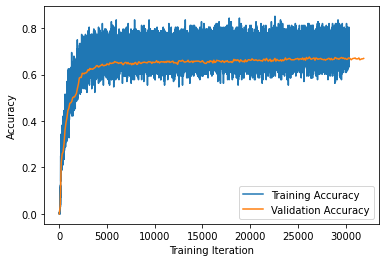

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()